In [102]:
import os
import pandas as pd
import scipy
import math
import numpy as np
import geopandas as gpd
import warnings
import shapely
from scipy import spatial
from shapely.ops import nearest_points
from scipy import stats
from tqdm import tqdm
import json
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
warnings.filterwarnings('ignore') 


# About the index

To construct this index, we gathered census data that is geo-referenced to some polygon or geographic unit.<br>
The idea is to collect variables that give information about education, health and household characteristics, as well as access to services. For the case of Mexico, we followed the methodology used by the National Council of Policy Evaluation (Coneval, https://www.coneval.org.mx/coordinacion/entidades/Paginas/rezago_social.aspx), the governmental office in charge of evaluating policies and measuring poverty and inequality.


To estimate the wealth index for Mexico at manzana + localidad level, we used the following variables:<br>

o	**Education**<br>

i.	 Percentage of illiterate population aged 15 or more <br>
ii.	Percentage of population aged 6-14 that does not attend to school <br>
iii.	Percentage of population aged 15 or more years without complete elementary school<br>

o	**Health services access**<br>

iv.	Percentage of population with no access to health services<br>

o	**Household characteristics** <br>

v.	Log of average occupants per room<br>
vi.	Percentage of with dirt floor<br>
vii.	Percentage of households with no toilet<br>
viii.	Percentage of households with no piped water<br>
ix.	Percentage of households with no sewer system<br>
x.	Percentage of households with no electricity<br>
xi.	Percentage of households with no washing machine<br>
xii.	Percentage of inhabited private households with no fridge<br>


**Steps to construct the index:**<br>

1) **Variable identification and selection**: The final selection will depend on the available data, but the idea is to  capture a polygon's characteristics as described above. <br>
2) **Imputation**: The appropiate method will depend on the available data as well. For the case of Mexico, we used two imputation methods: first, we imputed missing data of manzanas (blocks) using the mean of the manzanas within the next aggregation level (in this case, a geographic unit called "ageb"), and when this information was missing too, we used the average of geographic units at the next upper level (locality or municipality). Finally, to impute data for the rural units (rural 'localidades'), since some of them were surrounded by localidades with missing data, we estimated distances between localidades and imputed the value of the closest rural localidad that did not have missing data for a specific variable. <br>
3) **Index Variables Construction**: Once we have a complete dataset with the variables of interest, we construct the variables for the index using the same scale. In this case, we estimated our variables of interests as percentages of households or population living in a polygon, that have a characteristic of interest (e.g. % of population that did not complete secondary education). Here, it is important to notice that all variables have to have the same direction, i.e. all of them have measure a lack of access to services, or all of them have to measure access to services. In this case, we constructed the variables as a deprivation or lack of access to services, and the index is larger the poorer a polygon is. <br>
4) **Index estimation**: Before estimating the index, we need to normalize all variables (N(0,1)), and then we run a principal component analysis. The value of the index is the value of the first component, and we present the results as the raw value of the first component, or as a 0-1 re-scaled version of the first component. For any question, comment or suggestion regarding this index please contact amontfortibieta@worldbank.org

### Shapefile joins
#### The  identifier for localidades is "ID_localidad", and for manzanas, "cve_manzana"

# Helper functions

In [103]:
def add_identifiers(raw_df):
    '''
    Adds geographic identifiers for different geographic units
    input: 
        raw_df: dataframe
    returns: dataframe with geographic identifiers
    '''
    raw_df['cve_manzana'] = raw_df['entidad'].apply(lambda x: str(x).zfill(2)) + raw_df['mun'].apply(lambda x: str(x).zfill(3)) + raw_df['loc'].apply(lambda x: str(x).zfill(4)) + raw_df['ageb'].apply(lambda x: str(x))+ raw_df['mza'].apply(lambda x: str(x).zfill(3))
    raw_df['cve_ageb'] = raw_df['entidad'].apply(lambda x: str(x).zfill(2)) + raw_df['mun'].apply(lambda x: str(x).zfill(3)) + raw_df['loc'].apply(lambda x: str(x).zfill(4)) + raw_df['ageb'].apply(lambda x: str(x))
    raw_df['cve_localidad'] = raw_df['entidad'].apply(lambda x: str(x).zfill(2)) + raw_df['mun'].apply(lambda x: str(x).zfill(3)) + raw_df['loc'].apply(lambda x: str(x).zfill(4)) 
    raw_df['cve_mun'] = raw_df['entidad'].apply(lambda x: str(x).zfill(2)) + raw_df['mun'].apply(lambda x: str(x).zfill(3))
    return raw_df

In [104]:
def filter_df(raw_df, level):
    '''
    Filters a dataframe depending on the geographic unit of interest
    Inputs:
        raw_df - dataframe
        level - string ("manzana", 'ageb', 'localidad' or 'municipio')
    Returns:
        Filtered dataframe
    '''
    if level == "manzana":
        rv = raw_df[(raw_df['nom_loc']!='Total de la entidad') & (raw_df['nom_loc']!='Total del municipio') & \
                              (raw_df['nom_loc']!='Total de la localidad urbana') & (raw_df['nom_loc']!='Total AGEB urbana')]
    elif level == "ageb":
        rv = raw_df[(raw_df['nom_loc']=='Total AGEB urbana')]

    elif level == "localidad":
        rv = raw_df[(raw_df['nom_loc']=='Total de la localidad urbana')]
    elif level == "municipio":
        rv = raw_df[raw_df['nom_loc'] == 'Total del municipio']
    return rv
                    

In [105]:
def count_missing_manzanas(df):
    '''
    Counts the number of missing values (by manzana) for each of the selected variables

    Inputs:
            df- Dataframe with data at the manzana level
    Returns:
            Dataframe with percentage of missing values
    '''
    rv = {}
    for var in list(df.columns):
        d = {}
        d['str_missing'] = 0

        for element in list(df[var]):
            if element == '*':
                d['str_missing'] =  d['str_missing'] + 1
        d['str_missing'] = round( d['str_missing']/len(df) * 100,2)

        rv[var]= d
    return pd.DataFrame(rv).T

In [106]:
def convert_to_numeric(df, identifiers, vars_to_numeric):
    '''
    Converts string values to numeric, making nulls those values with "N/D" or "*"
    Inputs:
            df: pandas dataframe
            vars_to_numeric: list of variable names
    Returns:
            Pandas dataframe
    '''
    numerics = df[vars_to_numeric].apply(pd.to_numeric, errors='coerce', axis = 1)
    identifiers = df[identifiers]
    mergedDf = identifiers.merge(numerics, left_index=True, right_index=True)
    return mergedDf

In [107]:
def add_vars_wealth_index(df):

    '''
    Computes the variables that will be used for constructing the wealth index
    Inputs:
        df- DataFrame
    Returns:
        Dataframe
    Note: Here I use 'vivtot' (total households) instead of "vivpar_hab" (occuppied households) 
    because for manzas there is no enough info for vivpar_hab
    '''
    AS_PERCENT = 100
    # asset_ownsership_vars
    
    df['illiterate'] = df['p15ym_an']/df['p_15ymas'] * AS_PERCENT #1
    
    df['not_attend_school'] = (df['p6a11_noa'] + df['p12a14noa'])/ (df['p_6a11'] + \
                                                  df['p_12a14']) * AS_PERCENT #2
    
    df['no_primary_educ'] = (df['p15pri_in']+ df['p15pri_co']+ df['p15ym_se'] +\
    
                             df['p15sec_in'] )/ df['p_15ymas'] * AS_PERCENT #3
    
    df['no_access_health'] = df['psinder']/df['pobtot'] * AS_PERCENT #4
    
    df['dirt_floor'] = df['vph_pisodt']/ df['vivtot'] * AS_PERCENT #5 ******
    
    
    df['average_ocupants'] = df['pro_ocup_c'].apply(lambda x: math.log(x) if x!=0 else np.nan) #6
    
    df['no_toilet'] = (df['vivtot'] - df['vph_excsa'])/ df['vivtot'] * AS_PERCENT #7 *******
    
    df['no_car'] = (df['vivtot']- df['vph_autom']) / df['vivtot'] * AS_PERCENT #8 **********
    
    df['no_water'] = (df['vivtot']- df['vph_aguafv']) / df['vivtot'] * AS_PERCENT # 9 *******
    
    df['no_sewing'] = df['vph_nodren'] / df['vivtot'] * AS_PERCENT # 10 **********
    
    df['no_electricity'] = df['vph_s_elec'] / df['vivtot'] #11 ***********
    
    df['no_washingmachine'] = (df['vivtot'] - df['vph_lavad']) / df['vivtot'] * AS_PERCENT #12 ***
    
    df['no_fridge'] = (df['vivtot'] - df['vph_refri']) / df['vivtot'] * AS_PERCENT #13 ****
        

    return df

In [108]:
def split_data(df, list_of_vars):
    '''
    splits the data into a complete and an incomplete dataframe. The complete dataframe is used to
    impute localidades which immediate neighbor localidades are also nulls, taking the closer "complete"
    observation from the complete part of the data
    
    Inputs:
        df- Dataframe of localidades
        list_of_vars - List of variables that are not null for a row
    Returns:
        Tuple of dataframes
    '''
    complete = df.query(build_query_for_nulls(list_of_vars,True), engine = 'python')
    incomplete = df.query(build_query_for_nulls(list_of_vars,False), engine = 'python')

    return complete, incomplete

In [109]:
def build_query_for_nulls(list_of_vars, get_not_nulls=True):
    '''
    Creates a query to filter a data frame with multiple variables not containing nulls
    list_of_vars: list of variables to construct the query
    get_not_nulls(boolean): If true, returns a query to get not nulls
    '''
    string = ""

    if get_not_nulls:
        for var in list_of_vars[:-1]:
            var = var + '.notnull() and ' 
            string += var
        string = string + list_of_vars[-1] + '.notnull()'
    else:
        for var in list_of_vars[:-1]:
            var = var + '.isnull() or ' 
            string += var
        string = string + list_of_vars[-1] + '.isnull()'
    return string

In [110]:
def impute_close_neighbor(point, state, mun, data_where_from):
    '''
    Estimates distance to closer point within a dataframe. 
    Inputs:
        point(shapely POINT): point to estimate the distance from
        state(str): state in Mexico. It helps to reduce the search within a state geography
        mun(str): municipality 
        data_where_from(dataframe): Dataframe with points to estimate the distance to
    Returns:
        tuple with index location in the dataframe, and the distance
    '''
    k = 1
    centroid = point.x,point.y
    data = data_where_from[(data_where_from['entidad']==state) &
                         (data_where_from['mun']==mun)]
    
    ls_centroids =  data['geometry'].apply\
                            (lambda g:[g.centroid.x,g.centroid.y]).tolist()
    try:
        kdtree = spatial.KDTree(ls_centroids)
    except:
        data = data_where_from[(data_where_from['entidad']==state)]
        ls_centroids =  data['geometry'].apply\
                            (lambda g:[g.centroid.x,g.centroid.y]).tolist()
        kdtree = spatial.KDTree(ls_centroids)

    distance, idx = kdtree.query(centroid, k=1)
    return data.iloc[idx]['idx_identifier'], distance

In [111]:
class NpEncoder(json.JSONEncoder):
    '''
    Class to save integers in a json file
    '''
    def default(self, obj):
        if isinstance(obj, np.integer):
            return int(obj)
        elif isinstance(obj, np.floating):
            return float(obj)
        elif isinstance(obj, np.ndarray):
            return obj.tolist()
        else:
            return super(NpEncoder, self).default(obj)

In [112]:
def estimate_index(df, index_vars):
    '''
    Estimates an assets index using PCA
    Inputs: 
        DataFrame
    Returns:
        Dataframe with two new columns for the principal component, and the index 0-1
    '''
    
    df = df.reset_index()
    X = df.loc[:, index_vars].to_numpy() # converts to numpy arrangement
    pca = PCA(n_components = 1) # Create pca object
    pca = pca.fit_transform(X) # Compute the first component
    first_component = pd.DataFrame(data = pca, columns = ['pca'])
    min_pca =  pca.min() # Index 0-1
    max_pca = pca.max()
    difference = max_pca - min_pca
    
    first_component['index_pca'] = first_component['pca'].apply(lambda x: (x- min_pca)/difference)
    rv = df.join(first_component, lsuffix='_left', rsuffix='_right')
    rv = rv.set_index('index')
    return rv

In [113]:
def plot_hist(data, var, title):
    '''
    Plots a histograam
    Inputs:
        data - Dataframe
        var (string) - variable of interest
        title(str) - Title of the plot
    '''
    plt.hist(data[var])
    plt.title(title)
    plt.show()
    return plt

## Create dataframes and append them into a single one for the whole country

### Load data ###
#### Manzanas (Blocks)


In [114]:
root = "/Users/aleistermontfort/Documentos/World_Bank_Repository/wbg-location-data/notebooks/aleister/Data_Census/"
ls_manzanas = []
for i in range(0,32): # These are state identifiers
    state = (str(i+1).zfill(2))
    df = pd.read_csv(root+'resultados_ageb_urbana_{}_cpv2010/conjunto_de_datos/resultados_ageb_urbana_{}_cpv2010.csv'.format(state,state))
    df_manzanas = filter_df(df,"manzana")
    df_manzanas = add_identifiers(df_manzanas)
    ls_manzanas.append(df_manzanas)


In [115]:
# Combine dataframes into a single one for the whole country
manzanas = pd.concat(ls_manzanas).reset_index(drop=True)


## Variable selection ## 

In [146]:
identifiers = ['entidad', 'nom_ent', 'mun', 'nom_mun', 'loc', 'nom_loc', 'ageb', 'mza', 'cve_ageb',
                     'cve_manzana', 'cve_localidad','cve_mun']

all_variables = ['pro_ocup_c', 'pobtot', 'vph_nodren', 'vph_lavad', 'vph_cel', 'pob0_14', 'p6a11_noa', 
                 'pobfem', 'vivpar_hab', 'p_12a14', 'vph_pisodt', 'p15sec_in', 'vph_radio', 'p_15ymas', 
                 'p_6a11', 'vph_s_elec', 'vph_refri', 'vph_aguafv', 'p15pri_co', 'p15pri_in', 'psinder', 
                 'pob15_64', 'pobmas', 'vph_inter', 'p15ym_an', 'p15ym_se', 'vph_excsa', 'p12a14noa', 
                 'vph_tv', 'pob65_mas', 'vph_telef', 'vph_pc', 'vph_autom', 'vivtot']

coneval_index = ['illiterate','not_attend_school', 'no_primary_educ', 'no_access_health',
                'dirt_floor', 'average_ocupants', 'no_toilet', 'no_water', 'no_sewing',
                'no_electricity', 'no_washingmachine', 'no_fridge']
add_demographics = ['vivtot','pobtot', 'pobmas','pobfem', 'pob0_14','pob15_64','pob65_mas']

In [147]:
filtered_manzanas = manzanas[identifiers + all_variables] # I keep the identifiers and the relevant variables

In [118]:
missing_manzanas = count_missing_manzanas(filtered_manzanas)

In [119]:
missing_manzanas

,str_missing
entidad,0.00
nom_ent,0.00
mun,0.00
nom_mun,0.00
loc,0.00
nom_loc,0.00
ageb,0.00
mza,0.00
cve_ageb,0.00
cve_manzana,0.00


In [148]:
# Convert strings to numeric and "*" to nulls
manzanas_numeric = convert_to_numeric(filtered_manzanas, identifiers,all_variables)

In [150]:
# I just keep this to open the file in case i mess it up
manzanas_numeric.to_csv("./manzanas_whole_country.csv")


In [151]:
## Adding index variables 
manzanas_numeric = add_vars_wealth_index(manzanas_numeric)


In [152]:
## Keeping index and identifiers variables
df_index = manzanas_numeric[identifiers + coneval_index + add_demographics]

### Impute missing data for manzanas

We impute missing values for manzanas taking the mean value of the manzana within the ageb. <br>
If all manzanas within the ageb are missing values for that variable, we use the mean value of the agebs within a localidad <br>
If we have missing values for all localidades within a municipality (e.g sometimes there is only one localidad for one municipality), we take the mean value of municipalities whitin a state. <br>
Finally, if we have a missing value for a municipality (there are like 20 municipalities in Oaxaca (which has around 500 municipalities) that have some missing value for a specific variable), we impute to the mean value of municipalities within a state

In [153]:
# Imputation fo manzanas
for var in coneval_index:
    print(var)
    df_index[var] = df_index.groupby("cve_ageb")[var].apply(lambda x: x.fillna(x.mean()))
    df_index[var] = df_index.groupby("cve_localidad")[var].apply(lambda x: x.fillna(x.mean()))
    df_index[var] = df_index.groupby("cve_mun")[var].apply(lambda x: x.fillna(x.mean()))
    df_index[var] = df_index.groupby("entidad")[var].apply(lambda x: x.fillna(x.mean()))


illiterate
not_attend_school
no_primary_educ
no_access_health
dirt_floor
average_ocupants
no_toilet
no_water
no_sewing
no_electricity
no_washingmachine
no_fridge


In [154]:
df_index.isnull().sum()

entidad                   0
nom_ent                   0
mun                       0
nom_mun                   0
loc                       0
nom_loc                   0
ageb                      0
mza                       0
cve_ageb                  0
cve_manzana               0
cve_localidad             0
cve_mun                   0
illiterate                0
not_attend_school         0
no_primary_educ           0
no_access_health          0
dirt_floor                0
average_ocupants          0
no_toilet                 0
no_water                  0
no_sewing                 0
no_electricity            0
no_washingmachine         0
no_fridge                 0
vivtot                    0
pobtot                    0
pobmas               128314
pobfem               127753
pob0_14              172930
pob15_64             127480
pob65_mas            440739
dtype: int64

##  LOCALIDADES DATA

### We will need a shapefile of rural localidades to impute values

In [42]:
# Shapefile of localidades
localidades_shp = gpd.read_file("./32_Entidades_Federativas/LOCALIDADES_RURALES_pol_final.shp")

In [43]:
localidades_shp.head()

,Id,Input_FID,CVE_AGEB,CVE_ENT,CVE_LOC,CVE_MUN,NOM_LOC,ID_loc,ID_locn,geometry
0,0,106710,2983,05,0309,023,Corazones,050230309,50230309,"POLYGON ((2421097.595 1793887.875, 2421412.495..."
1,0,3483,0380,08,0057,047,Los Lobos,080470057,80470057,"POLYGON ((1855698.171 1790423.075, 1854070.409..."
2,0,91254,0206,24,0002,015,0lvaro Obregan (Estaciln los Charcos),240150002,240150002,"POLYGON ((2600885.365 1230678.110, 2599879.928..."
3,0,124860,0320,27,0004,012,Alcalde Mayor,270120004,270120004,"POLYGON ((3528138.984 674983.151, 3528529.798 ..."
4,0,91895,0017,20,0005,151,El Tejocote,201510005,201510005,"POLYGON ((2973693.888 672465.681, 2974044.254 ..."


In [44]:
# For the census data, I use the data Alex collected previously
localidades_census_data = pd.read_csv("./census_localidades/all_states.csv")

In [45]:
# Create same identifiers
localidades_census_data['ENTIDAD'] = localidades_census_data['ENTIDAD'].apply(lambda x: str(x).zfill(2))
localidades_census_data['MUN'] = localidades_census_data['MUN'].apply(lambda x: str(x).zfill(3))
localidades_census_data['LOC'] = localidades_census_data['LOC'].apply(lambda x: str(x).zfill(4))
localidades_census_data['ID_loc'] = localidades_census_data['ENTIDAD'] + localidades_census_data['MUN'] + localidades_census_data['LOC']
localidades_census_data.head()

,NOM_ENT,NOM_MUN,NOM_LOC,ENTIDAD,MUN,LOC,NOM_LOC.1,LONGITUD,LATITUD,ALTITUD,...,VPH_TV,VPH_REFRI,VPH_LAVAD,VPH_AUTOM,VPH_PC,VPH_TELEF,VPH_CEL,VPH_INTER,TAM_LOC,ID_loc
0,Aguascalientes,Aguascalientes,Aguascalientes,01,001,0001,Aguascalientes,1021746,215251,1885,...,181062,173467,157607,114283,78107,104297,146684,55003,13,010010001
1,Aguascalientes,Aguascalientes,Granja Adelita,01,001,0094,Granja Adelita,1022225,215219,1903,...,*,*,*,*,*,*,*,*,1,010010094
2,Aguascalientes,Aguascalientes,Agua Azul,01,001,0096,Agua Azul,1022127,215303,1863,...,11,10,9,3,1,0,6,1,1,010010096
3,Aguascalientes,Aguascalientes,Rancho Alegre,01,001,0100,Rancho Alegre,1022222,215116,1880,...,*,*,*,*,*,*,*,*,1,010010100
4,Aguascalientes,Aguascalientes,Los Arbolitos [Rancho],01,001,0102,Los Arbolitos [Rancho],1022126,214649,1860,...,*,*,*,*,*,*,*,*,1,010010102


In [46]:
# We join the dataframe of localidades to the shapefile of localidades
joined_localidades = localidades_shp.set_index("ID_loc").\
                    join(localidades_census_data.set_index("ID_loc"), how="inner",
                        lsuffix='_left', rsuffix='_right').reset_index()

In [47]:
# Convert column names to lower
dict_rename_vars ={}
for var in joined_localidades.columns[1:]:
    dict_rename_vars[var] = var.lower()

In [48]:
joined_localidades = joined_localidades.rename(dict_rename_vars, axis="columns")

In [49]:
identifiers_localidades = ['ID_loc', 'cve_ageb','cve_ent','cve_loc','cve_mun','nom_loc_left',
                           'id_locn','nom_ent','nom_mun','nom_loc_right','entidad','mun',
                           'loc','nom_loc.1']
all_variables_localidades = ['p15ym_an', 'p6a11_noa', 'p12a14noa', 'p15pri_in', 'p15pri_co',
             'p_6a11', 'p_12a14', 'p15ym_se', 'pob0_14', 'pob15_64','pob65_mas', 'pobmas','pobfem','pobtot',
                             'p15sec_in', 'p_15ymas', 'psinder','vph_pisodt', 'vivpar_hab', 
                             'pro_ocup_c', 'vph_excsa', 'vph_aguafv', 'vph_nodren', 'vph_s_elec', 
                             'vph_lavad', 'vph_refri', 'vph_autom', 'vph_inter','vph_radio', 'vph_tv',
                             'vph_pc', 'vph_cel', 'vph_telef', 'vivtot',  'geometry',
                             'longitud','latitud']

In [51]:
localidades_numeric = convert_to_numeric(joined_localidades, 
                                         identifiers_localidades, all_variables_localidades).reset_index(drop=True)

In [52]:
# Add index variables
localidades_index = add_vars_wealth_index(localidades_numeric)

## Localidades Imputation

### Impute for missing values in localidades to the average of localidades within the same ageb

In [53]:
### Impute for missing values in localidades to the average of localidades within the same ageb
localidades_index['localidad_ageb'] = localidades_index['cve_ent'] + \
localidades_index['cve_mun'] + localidades_index['cve_ageb'] + localidades_index['loc']

for variable in coneval_index:
    localidades_index[variable] = localidades_index[variable].fillna(localidades_index.groupby('localidad_ageb')[variable].transform('mean'))
    

In [54]:
#Project the geodataframe to WSG1984 in order to impute those localidaades that still have missing values
localidades_projected = gpd.GeoDataFrame(
    localidades_index,
    geometry=gpd.points_from_xy(
        localidades_index["longitud"].apply(lambda x: int(x)),
        localidades_index["latitud"].apply(lambda x: int(x)),
    ),
    crs={"init":"EPSG:4326"},
)


#### We will impute missing rows of localidades using information from the closest localidad which does not have missing values. To do this, we split the localidades data into two: a complete dataset with all rows, and an incomplete dataset (for which most rows only have total population)

In [55]:
localidad_not_nulls, localidad_with_nulls = \
split_data(localidades_projected, coneval_index )


In [56]:
localidad_not_nulls.isnull().sum()[-30:]
# The variables of interest (Coneval) do not have missing values for this segment of locaalidades

vph_aguafv           0
vph_nodren           0
vph_s_elec           0
vph_lavad            0
vph_refri            0
vph_autom            0
vph_inter            0
vph_radio            0
vph_tv               0
vph_pc               0
vph_cel              0
vph_telef            0
vivtot               0
geometry             0
longitud             0
latitud              0
illiterate           0
not_attend_school    0
no_primary_educ      0
no_access_health     0
dirt_floor           0
average_ocupants     0
no_toilet            0
no_car               0
no_water             0
no_sewing            0
no_electricity       0
no_washingmachine    0
no_fridge            0
localidad_ageb       0
dtype: int64

In [57]:
localidad_not_nulls = localidad_not_nulls.reset_index(drop=True)
localidad_with_nulls = localidad_with_nulls.reset_index(drop=True)

In [58]:
# Dictionary to make imputation 
dict_not_nulls={}
for index, row in localidad_not_nulls.iterrows():
    dict_not_nulls[index] = {}
    d={}
    for var in coneval_index:
        d[var] = row[var]
         
    dict_not_nulls[index] = d

In [59]:
localidad_not_nulls['idx_identifier'] = localidad_not_nulls.index

In [ ]:
# Imputamos el vecino mas cercano con valores positivos porque habia localidades con vecindades que todos eran nulls

In [60]:
## This is just a test for getting distance. It estimates a polygon's distance to iself
#Seems to work ok. Distance of the first observation should be zero bcause it's complete
impute_close_neighbor(localidad_not_nulls['geometry'][0], 
                      localidad_not_nulls['cve_ent'][0],
                      localidad_not_nulls['cve_mun'][0],
                                                 localidad_not_nulls)

(0, 0.0)

In [61]:
localidades_projected = localidades_projected.sort_values("entidad").reset_index(drop=True)

#### This loop is computationally expensive. For each row, it estimates the closer neighbor and adds a new column with the index to look for. We impute later

In [62]:
localidades_projected['index_to_impute'] = None
localidades_projected['distance'] = None

dict_of_indices = {}
for index, row in tqdm(localidades_projected.iterrows()):
    
    localidades_projected.at[index,'index_to_impute'] = impute_close_neighbor(row['geometry'], row['cve_ent'],row['cve_mun'],
                                                 localidad_not_nulls)[0]
    localidades_projected.at[index,'distance'] = impute_close_neighbor(row['geometry'], row['cve_ent'],row['cve_mun'],
                                                 localidad_not_nulls)[1]
    dict_of_indices[index] = localidades_projected.at[index,'index_to_impute']
    print(row['entidad'], index)
    print(index, "out of 182105")

3it [00:01,  1.38it/s]

01 0
0 out of 182105
01 1
1 out of 182105
01 2
2 out of 182105
01 3
3 out of 182105


7it [00:01,  2.59it/s]

01 4
4 out of 182105
01 5
5 out of 182105
01 6
6 out of 182105
01 7
7 out of 182105


11it [00:01,  4.60it/s]

01 8
8 out of 182105
01 9
9 out of 182105
01 10
10 out of 182105
01 11
11 out of 182105


16it [00:01,  7.53it/s]

01 12
12 out of 182105
01 13
13 out of 182105
01 14
14 out of 182105
01 15
15 out of 182105
01 16
16 out of 182105


20it [00:02, 10.86it/s]

01 17
17 out of 182105
01 18
18 out of 182105
01 19
19 out of 182105
01 20
20 out of 182105
01 21
21 out of 182105


25it [00:02, 13.97it/s]

01 22
22 out of 182105
01 23
23 out of 182105
01 24
24 out of 182105
01 25
25 out of 182105
01 26
26 out of 182105


30it [00:02, 16.14it/s]

01 27
27 out of 182105
01 28
28 out of 182105
01 29
29 out of 182105
01 30
30 out of 182105


34it [00:02, 16.07it/s]

01 31
31 out of 182105
01 32
32 out of 182105
01 33
33 out of 182105
01 34
34 out of 182105


38it [00:03, 15.97it/s]

01 35
35 out of 182105
01 36
36 out of 182105
01 37
37 out of 182105
01 38
38 out of 182105


42it [00:03, 16.74it/s]

01 39
39 out of 182105
01 40
40 out of 182105
01 41
41 out of 182105
01 42
42 out of 182105


46it [00:03, 16.77it/s]

01 43
43 out of 182105
01 44
44 out of 182105
01 45
45 out of 182105
01 46
46 out of 182105


50it [00:03, 17.63it/s]

01 47
47 out of 182105
01 48
48 out of 182105
01 49
49 out of 182105
01 50
50 out of 182105
01 51
51 out of 182105


55it [00:03, 18.82it/s]

01 52
52 out of 182105
01 53
53 out of 182105
01 54
54 out of 182105
01 55
55 out of 182105
01 56
56 out of 182105


60it [00:04, 19.25it/s]

01 57
57 out of 182105
01 58
58 out of 182105
01 59
59 out of 182105
01 60
60 out of 182105
01 61
61 out of 182105


65it [00:04, 19.09it/s]

01 62
62 out of 182105
01 63
63 out of 182105
01 64
64 out of 182105
01 65
65 out of 182105


71it [00:04, 20.13it/s]

01 66
66 out of 182105
01 67
67 out of 182105
01 68
68 out of 182105
01 69
69 out of 182105
01 70
70 out of 182105


74it [00:04, 20.40it/s]

01 71
71 out of 182105
01 72
72 out of 182105
01 73
73 out of 182105
01 74
74 out of 182105
01 75
75 out of 182105


80it [00:05, 20.61it/s]

01 76
76 out of 182105
01 77
77 out of 182105
01 78
78 out of 182105
01 79
79 out of 182105
01 80
80 out of 182105


86it [00:05, 21.02it/s]

01 81
81 out of 182105
01 82
82 out of 182105
01 83
83 out of 182105
01 84
84 out of 182105
01 85
85 out of 182105


89it [00:05, 20.98it/s]

01 86
86 out of 182105
01 87
87 out of 182105
01 88
88 out of 182105
01 89
89 out of 182105
01 90
90 out of 182105


95it [00:05, 20.76it/s]

01 91
91 out of 182105
01 92
92 out of 182105
01 93
93 out of 182105
01 94
94 out of 182105
01 95
95 out of 182105


101it [00:06, 20.98it/s]

01 96
96 out of 182105
01 97
97 out of 182105
01 98
98 out of 182105
01 99
99 out of 182105
01 100
100 out of 182105


104it [00:06, 20.71it/s]

01 101
101 out of 182105
01 102
102 out of 182105
01 103
103 out of 182105
01 104
104 out of 182105
01 105
105 out of 182105


110it [00:06, 21.00it/s]

01 106
106 out of 182105
01 107
107 out of 182105
01 108
108 out of 182105
01 109
109 out of 182105
01 110
110 out of 182105


116it [00:06, 21.49it/s]

01 111
111 out of 182105
01 112
112 out of 182105
01 113
113 out of 182105
01 114
114 out of 182105
01 115
115 out of 182105


119it [00:07, 21.54it/s]

01 116
116 out of 182105
01 117
117 out of 182105
01 118
118 out of 182105
01 119
119 out of 182105
01 120
120 out of 182105


125it [00:07, 21.45it/s]

01 121
121 out of 182105
01 122
122 out of 182105
01 123
123 out of 182105
01 124
124 out of 182105
01 125
125 out of 182105


128it [00:07, 21.00it/s]

01 126
126 out of 182105
01 127
127 out of 182105
01 128
128 out of 182105
01 129
129 out of 182105


133it [00:07, 16.06it/s]

01 130
130 out of 182105
01 131
131 out of 182105
01 132
132 out of 182105


135it [00:08, 11.92it/s]

01 133
133 out of 182105
01 134
134 out of 182105
01 135
135 out of 182105


137it [00:08,  6.86it/s]

01 136
136 out of 182105
01 137
137 out of 182105


140it [00:09,  7.24it/s]

01 138
138 out of 182105
01 139
139 out of 182105


142it [00:09,  7.46it/s]

01 140
140 out of 182105
01 141
141 out of 182105
01 142
142 out of 182105


146it [00:09,  9.92it/s]

01 143
143 out of 182105
01 144
144 out of 182105
01 145
145 out of 182105
01 146
146 out of 182105


150it [00:09, 12.28it/s]

01 147
147 out of 182105
01 148
148 out of 182105
01 149
149 out of 182105
01 150
150 out of 182105


154it [00:10, 13.70it/s]

01 151
151 out of 182105
01 152
152 out of 182105
01 153
153 out of 182105
01 154
154 out of 182105


158it [00:10, 14.89it/s]

01 155
155 out of 182105
01 156
156 out of 182105
01 157
157 out of 182105
01 158
158 out of 182105


162it [00:10, 15.36it/s]

01 159
159 out of 182105
01 160
160 out of 182105
01 161
161 out of 182105
01 162
162 out of 182105


166it [00:10, 15.64it/s]

01 163
163 out of 182105
01 164
164 out of 182105
01 165
165 out of 182105
01 166
166 out of 182105


170it [00:11, 15.49it/s]

01 167
167 out of 182105
01 168
168 out of 182105
01 169
169 out of 182105
01 170
170 out of 182105


174it [00:11, 15.70it/s]

01 171
171 out of 182105
01 172
172 out of 182105
01 173
173 out of 182105
01 174
174 out of 182105


178it [00:11, 15.94it/s]

01 175
175 out of 182105
01 176
176 out of 182105
01 177
177 out of 182105
01 178
178 out of 182105


182it [00:11, 16.13it/s]

01 179
179 out of 182105
01 180
180 out of 182105
01 181
181 out of 182105
01 182
182 out of 182105


186it [00:12, 15.96it/s]

01 183
183 out of 182105
01 184
184 out of 182105
01 185
185 out of 182105
01 186
186 out of 182105


190it [00:12, 15.93it/s]

01 187
187 out of 182105
01 188
188 out of 182105
01 189
189 out of 182105
01 190
190 out of 182105


194it [00:12, 15.87it/s]

01 191
191 out of 182105
01 192
192 out of 182105
01 193
193 out of 182105
01 194
194 out of 182105


198it [00:12, 15.94it/s]

01 195
195 out of 182105
01 196
196 out of 182105
01 197
197 out of 182105
01 198
198 out of 182105


202it [00:13, 15.96it/s]

01 199
199 out of 182105
01 200
200 out of 182105
01 201
201 out of 182105
01 202
202 out of 182105


206it [00:13, 16.25it/s]

01 203
203 out of 182105
01 204
204 out of 182105
01 205
205 out of 182105
01 206
206 out of 182105


210it [00:13, 16.03it/s]

01 207
207 out of 182105
01 208
208 out of 182105
01 209
209 out of 182105
01 210
210 out of 182105


214it [00:13, 15.91it/s]

01 211
211 out of 182105
01 212
212 out of 182105
01 213
213 out of 182105
01 214
214 out of 182105


218it [00:14, 15.86it/s]

01 215
215 out of 182105
01 216
216 out of 182105
01 217
217 out of 182105
01 218
218 out of 182105


222it [00:14, 15.51it/s]

01 219
219 out of 182105
01 220
220 out of 182105
01 221
221 out of 182105


226it [00:14, 15.07it/s]

01 222
222 out of 182105
01 223
223 out of 182105
01 224
224 out of 182105
01 225
225 out of 182105


230it [00:15, 14.76it/s]

01 226
226 out of 182105
01 227
227 out of 182105
01 228
228 out of 182105
01 229
229 out of 182105


234it [00:15, 15.34it/s]

01 230
230 out of 182105
01 231
231 out of 182105
01 232
232 out of 182105
01 233
233 out of 182105


238it [00:15, 15.16it/s]

01 234
234 out of 182105
01 235
235 out of 182105
01 236
236 out of 182105
01 237
237 out of 182105


242it [00:15, 15.62it/s]

01 238
238 out of 182105
01 239
239 out of 182105
01 240
240 out of 182105
01 241
241 out of 182105


246it [00:16, 16.01it/s]

01 242
242 out of 182105
01 243
243 out of 182105
01 244
244 out of 182105
01 245
245 out of 182105


250it [00:16, 16.16it/s]

01 246
246 out of 182105
01 247
247 out of 182105
01 248
248 out of 182105
01 249
249 out of 182105


254it [00:16, 16.51it/s]

01 250
250 out of 182105
01 251
251 out of 182105
01 252
252 out of 182105
01 253
253 out of 182105


258it [00:16, 16.10it/s]

01 254
254 out of 182105
01 255
255 out of 182105
01 256
256 out of 182105
01 257
257 out of 182105


262it [00:17, 17.52it/s]

01 258
258 out of 182105
01 259
259 out of 182105
01 260
260 out of 182105
01 261
261 out of 182105


266it [00:17, 16.52it/s]

01 262
262 out of 182105
01 263
263 out of 182105
01 264
264 out of 182105
01 265
265 out of 182105


270it [00:17, 16.92it/s]

01 266
266 out of 182105
01 267
267 out of 182105
01 268
268 out of 182105
01 269
269 out of 182105


276it [00:17, 19.54it/s]

01 270
270 out of 182105
01 271
271 out of 182105
01 272
272 out of 182105
01 273
273 out of 182105
01 274
274 out of 182105
01 275
275 out of 182105


282it [00:18, 21.49it/s]

01 276
276 out of 182105
01 277
277 out of 182105
01 278
278 out of 182105
01 279
279 out of 182105
01 280
280 out of 182105
01 281
281 out of 182105


285it [00:18, 20.05it/s]

01 282
282 out of 182105
01 283
283 out of 182105
01 284
284 out of 182105
01 285
285 out of 182105


290it [00:18, 18.54it/s]

01 286
286 out of 182105
01 287
287 out of 182105
01 288
288 out of 182105
01 289
289 out of 182105


294it [00:18, 18.92it/s]

01 290
290 out of 182105
01 291
291 out of 182105
01 292
292 out of 182105
01 293
293 out of 182105
01 294
294 out of 182105


298it [00:18, 19.04it/s]

01 295
295 out of 182105
01 296
296 out of 182105
01 297
297 out of 182105
01 298
298 out of 182105
01 

303it [00:19, 19.45it/s]

299
299 out of 182105
01 300
300 out of 182105
01 301
301 out of 182105
01 302
302 out of 182105
01 303
303 out of 182105


307it [00:19, 19.12it/s]

01 304
304 out of 182105
01 305
305 out of 182105
01 306
306 out of 182105
01 307
307 out of 182105
01 308
308 out of 182105


312it [00:19, 19.22it/s]

01 309
309 out of 182105
01 310
310 out of 182105
01 311
311 out of 182105
01 312
312 out of 182105


316it [00:19, 19.00it/s]

01 313
313 out of 182105
01 314
314 out of 182105
01 315
315 out of 182105
01 316
316 out of 182105


320it [00:20, 19.10it/s]

01 317
317 out of 182105
01 318
318 out of 182105
01 319
319 out of 182105
01 320
320 out of 182105


325it [00:20, 18.00it/s]

01 321
321 out of 182105
01 322
322 out of 182105
01 323
323 out of 182105
01 324
324 out of 182105
01 325
325 out of 182105


330it [00:20, 17.97it/s]

01 326
326 out of 182105
01 327
327 out of 182105
01 328
328 out of 182105
01 329
329 out of 182105


334it [00:20, 15.43it/s]

01 330
330 out of 182105
01 331
331 out of 182105
01 332
332 out of 182105
01 333
333 out of 182105


338it [00:21, 15.70it/s]

01 334
334 out of 182105
01 335
335 out of 182105
01 336
336 out of 182105
01 337
337 out of 182105


342it [00:21, 15.99it/s]

01 338
338 out of 182105
01 339
339 out of 182105
01 340
340 out of 182105
01 341
341 out of 182105


346it [00:21, 15.32it/s]

01 342
342 out of 182105
01 343
343 out of 182105
01 344
344 out of 182105
01 345
345 out of 182105


350it [00:21, 15.49it/s]

01 346
346 out of 182105
01 347
347 out of 182105
01 348
348 out of 182105
01 349
349 out of 182105


354it [00:22, 15.46it/s]

01 350
350 out of 182105
01 351
351 out of 182105
01 352
352 out of 182105
01 353
353 out of 182105


359it [00:22, 17.36it/s]

01 354
354 out of 182105
01 355
355 out of 182105
01 356
356 out of 182105
01 357
357 out of 182105
01 358
358 out of 182105


363it [00:22, 15.76it/s]

01 359
359 out of 182105
01 360
360 out of 182105
01 361
361 out of 182105
01 362
362 out of 182105


367it [00:22, 16.90it/s]

01 363
363 out of 182105
01 364
364 out of 182105
01 365
365 out of 182105
01 366
366 out of 182105


371it [00:23, 16.67it/s]

01 367
367 out of 182105
01 368
368 out of 182105
01 369
369 out of 182105
01 370
370 out of 182105


375it [00:23, 16.20it/s]

01 371
371 out of 182105
01 372
372 out of 182105
01 373
373 out of 182105
01 374
374 out of 182105


379it [00:23, 16.56it/s]

01 375
375 out of 182105
01 376
376 out of 182105
01 377
377 out of 182105
01 378
378 out of 182105


383it [00:23, 17.51it/s]

01 379
379 out of 182105
01 380
380 out of 182105
01 381
381 out of 182105
01 382
382 out of 182105


387it [00:24, 18.32it/s]

01 383
383 out of 182105
01 384
384 out of 182105
01 385
385 out of 182105
01 386
386 out of 182105


391it [00:24, 17.58it/s]

01 387
387 out of 182105
01 388
388 out of 182105
01 389
389 out of 182105
01 390
390 out of 182105


395it [00:24, 17.76it/s]

01 391
391 out of 182105
01 392
392 out of 182105
01 393
393 out of 182105
01 394
394 out of 182105


399it [00:24, 18.25it/s]

01 395
395 out of 182105
01 396
396 out of 182105
01 397
397 out of 182105
01 398
398 out of 182105


403it [00:25, 18.56it/s]

01 399
399 out of 182105
01 400
400 out of 182105
01 401
401 out of 182105
01 402
402 out of 182105
01 403
403 out of 182105


407it [00:25, 18.46it/s]

01 404
404 out of 182105
01 405
405 out of 182105
01 406
406 out of 182105
01 407
407 out of 182105


411it [00:25, 18.19it/s]

01 408
408 out of 182105
01 409
409 out of 182105
01 410
410 out of 182105
01 411
411 out of 182105


415it [00:25, 16.23it/s]

01 412
412 out of 182105
01 413
413 out of 182105
01 414
414 out of 182105


419it [00:25, 16.36it/s]

01 415
415 out of 182105
01 416
416 out of 182105
01 417
417 out of 182105
01 418
418 out of 182105


423it [00:26, 17.72it/s]

01 419
419 out of 182105
01 420
420 out of 182105
01 421
421 out of 182105
01 422
422 out of 182105
01 423
423 out of 182105


428it [00:26, 18.64it/s]

01 424
424 out of 182105
01 425
425 out of 182105
01 426
426 out of 182105
01 427
427 out of 182105
01 428
428 out of 182105


432it [00:26, 18.98it/s]

01 429
429 out of 182105
01 430
430 out of 182105
01 431
431 out of 182105
01 432
432 out of 182105
01 433
433 out of 182105


437it [00:26, 19.13it/s]

01 434
434 out of 182105
01 435
435 out of 182105
01 436
436 out of 182105
01 437
437 out of 182105
01 438
438 out of 182105


442it [00:27, 19.45it/s]

01 439
439 out of 182105
01 440
440 out of 182105
01 441
441 out of 182105
01 442
442 out of 182105
01 443
443 out of 182105


447it [00:27, 19.64it/s]

01 444
444 out of 182105
01 445
445 out of 182105
01 446
446 out of 182105
01 447
447 out of 182105


452it [00:27, 19.42it/s]

01 448
448 out of 182105
01 449
449 out of 182105
01 450
450 out of 182105
01 451
451 out of 182105
01 452
452 out of 182105


456it [00:27, 19.10it/s]

01 453
453 out of 182105
01 454
454 out of 182105
01 455
455 out of 182105
01 456
456 out of 182105


460it [00:28, 19.04it/s]

01 457
457 out of 182105
01 458
458 out of 182105
01 459
459 out of 182105
01 460
460 out of 182105


464it [00:28, 18.95it/s]

01 461
461 out of 182105
01 462
462 out of 182105
01 463
463 out of 182105
01 464
464 out of 182105


468it [00:28, 18.73it/s]

01 465
465 out of 182105
01 466
466 out of 182105
01 467
467 out of 182105
01 468
468 out of 182105


472it [00:28, 18.74it/s]

01 469
469 out of 182105
01 470
470 out of 182105
01 471
471 out of 182105
01 472
472 out of 182105


476it [00:28, 18.85it/s]

01 473
473 out of 182105
01 474
474 out of 182105
01 475
475 out of 182105
01 476
476 out of 182105


480it [00:29, 18.83it/s]

01 477
477 out of 182105
01 478
478 out of 182105
01 479
479 out of 182105
01 480
480 out of 182105


484it [00:29, 18.72it/s]

01 481
481 out of 182105
01 482
482 out of 182105
01 483
483 out of 182105
01 484
484 out of 182105


488it [00:29, 18.26it/s]

01 485
485 out of 182105
01 486
486 out of 182105
01 487
487 out of 182105
01 488
488 out of 182105


492it [00:29, 18.35it/s]

01 489
489 out of 182105
01 490
490 out of 182105
01 491
491 out of 182105
01 492
492 out of 182105


496it [00:29, 18.82it/s]

01 493
493 out of 182105
01 494
494 out of 182105
01 495
495 out of 182105
01 496
496 out of 182105


501it [00:30, 19.24it/s]

01 497
497 out of 182105
01 498
498 out of 182105
01 499
499 out of 182105
01 500
500 out of 182105
01 501
501 out of 182105


505it [00:30, 19.12it/s]

01 502
502 out of 182105
01 503
503 out of 182105
01 504
504 out of 182105
01 505
505 out of 182105


509it [00:30, 18.96it/s]

01 506
506 out of 182105
01 507
507 out of 182105
01 508
508 out of 182105
01 509
509 out of 182105


513it [00:30, 18.92it/s]

01 510
510 out of 182105
01 511
511 out of 182105
01 512
512 out of 182105
01 513
513 out of 182105


517it [00:31, 18.99it/s]

01 514
514 out of 182105
01 515
515 out of 182105
01 516
516 out of 182105
01 517
517 out of 182105


521it [00:31, 17.96it/s]

01 518
518 out of 182105
01 519
519 out of 182105
01 520
520 out of 182105
01 521
521 out of 182105


525it [00:31, 16.86it/s]

01 522
522 out of 182105
01 523
523 out of 182105
01 524
524 out of 182105
01 525
525 out of 182105


529it [00:31, 16.17it/s]

01 526
526 out of 182105
01 527
527 out of 182105
01 528
528 out of 182105
01 529
529 out of 182105


533it [00:32, 16.14it/s]

01 530
530 out of 182105
01 531
531 out of 182105
01 532
532 out of 182105
01 533
533 out of 182105


537it [00:32, 15.99it/s]

01 534
534 out of 182105
01 535
535 out of 182105
01 536
536 out of 182105
01 537
537 out of 182105


541it [00:32, 15.89it/s]

01 538
538 out of 182105
01 539
539 out of 182105
01 540
540 out of 182105
01 541
541 out of 182105


545it [00:32, 15.76it/s]

01 542
542 out of 182105
01 543
543 out of 182105
01 544
544 out of 182105
01 545
545 out of 182105


549it [00:33, 15.60it/s]

01 546
546 out of 182105
01 547
547 out of 182105
01 548
548 out of 182105


551it [00:33, 14.74it/s]

01 549
549 out of 182105
01 550
550 out of 182105
01 551
551 out of 182105


555it [00:33, 14.04it/s]

01 552
552 out of 182105
01 553
553 out of 182105
01 554
554 out of 182105


559it [00:33, 14.83it/s]

01 555
555 out of 182105
01 556
556 out of 182105
01 557
557 out of 182105
01 558
558 out of 182105


563it [00:34, 15.11it/s]

01 559
559 out of 182105
01 560
560 out of 182105
01 561
561 out of 182105
01 562
562 out of 182105


567it [00:34, 14.62it/s]

01 563
563 out of 182105
01 564
564 out of 182105
01 565
565 out of 182105
01 566
566 out of 182105


571it [00:34, 14.99it/s]

01 567
567 out of 182105
01 568
568 out of 182105
01 569
569 out of 182105
01 570
570 out of 182105


575it [00:34, 15.27it/s]

01 571
571 out of 182105
01 572
572 out of 182105
01 573
573 out of 182105
01 574
574 out of 182105


579it [00:35, 15.35it/s]

01 575
575 out of 182105
01 576
576 out of 182105
01 577
577 out of 182105
01 578
578 out of 182105


583it [00:35, 15.44it/s]

01 579
579 out of 182105
01 580
580 out of 182105
01 581
581 out of 182105
01 582
582 out of 182105


587it [00:35, 15.15it/s]

01 583
583 out of 182105
01 584
584 out of 182105
01 585
585 out of 182105
01 586
586 out of 182105


591it [00:35, 14.75it/s]

01 587
587 out of 182105
01 588
588 out of 182105
01 589
589 out of 182105
01 590
590 out of 182105


595it [00:36, 14.60it/s]

01 591
591 out of 182105
01 592
592 out of 182105
01 593
593 out of 182105
01 594
594 out of 182105


600it [00:36, 16.51it/s]

01 595
595 out of 182105
01 596
596 out of 182105
01 597
597 out of 182105
01 598
598 out of 182105
01 599
599 out of 182105


604it [00:36, 16.44it/s]

01 600
600 out of 182105
01 601
601 out of 182105
01 602
602 out of 182105
01 603
603 out of 182105


608it [00:36, 16.02it/s]

01 604
604 out of 182105
01 605
605 out of 182105
01 606
606 out of 182105
01 607
607 out of 182105


612it [00:37, 15.78it/s]

01 608
608 out of 182105
01 609
609 out of 182105
01 610
610 out of 182105
01 611
611 out of 182105


616it [00:37, 15.62it/s]

01 612
612 out of 182105
01 613
613 out of 182105
01 614
614 out of 182105
01 615
615 out of 182105


620it [00:37, 15.56it/s]

01 616
616 out of 182105
01 617
617 out of 182105
01 618
618 out of 182105
01 619
619 out of 182105


624it [00:38, 15.69it/s]

01 620
620 out of 182105
01 621
621 out of 182105
01 622
622 out of 182105
01 623
623 out of 182105


628it [00:38, 15.57it/s]

01 624
624 out of 182105
01 625
625 out of 182105
01 626
626 out of 182105
01 627
627 out of 182105


632it [00:38, 15.46it/s]

01 628
628 out of 182105
01 629
629 out of 182105
01 630
630 out of 182105
01 631
631 out of 182105


636it [00:38, 15.66it/s]

01 632
632 out of 182105
01 633
633 out of 182105
01 634
634 out of 182105
01 635
635 out of 182105


640it [00:39, 15.65it/s]

01 636
636 out of 182105
01 637
637 out of 182105
01 638
638 out of 182105
01 639
639 out of 182105


644it [00:39, 15.24it/s]

01 640
640 out of 182105
01 641
641 out of 182105
01 642
642 out of 182105
01 643
643 out of 182105


648it [00:39, 15.53it/s]

01 644
644 out of 182105
01 645
645 out of 182105
01 646
646 out of 182105
01 647
647 out of 182105


652it [00:39, 15.58it/s]

01 648
648 out of 182105
01 649
649 out of 182105
01 650
650 out of 182105
01 651
651 out of 182105


656it [00:40, 15.51it/s]

01 652
652 out of 182105
01 653
653 out of 182105
01 654
654 out of 182105
01 655
655 out of 182105


660it [00:40, 15.23it/s]

01 656
656 out of 182105
01 657
657 out of 182105
01 658
658 out of 182105
01 659
659 out of 182105


664it [00:40, 15.12it/s]

01 660
660 out of 182105
01 661
661 out of 182105
01 662
662 out of 182105
01 663
663 out of 182105


668it [00:40, 15.08it/s]

01 664
664 out of 182105
01 665
665 out of 182105
01 666
666 out of 182105
01 667
667 out of 182105


672it [00:41, 15.38it/s]

01 668
668 out of 182105
01 669
669 out of 182105
01 670
670 out of 182105
01 671
671 out of 182105


676it [00:41, 15.34it/s]

01 672
672 out of 182105
01 673
673 out of 182105
01 674
674 out of 182105
01 675
675 out of 182105


680it [00:41, 15.53it/s]

01 676
676 out of 182105
01 677
677 out of 182105
01 678
678 out of 182105
01 679
679 out of 182105


684it [00:41, 15.61it/s]

01 680
680 out of 182105
01 681
681 out of 182105
01 682
682 out of 182105
01 683
683 out of 182105


688it [00:42, 16.25it/s]

01 684
684 out of 182105
01 685
685 out of 182105
01 686
686 out of 182105
01 687
687 out of 182105


692it [00:42, 16.63it/s]

01 688
688 out of 182105
01 689
689 out of 182105
01 690
690 out of 182105
01 691
691 out of 182105


696it [00:42, 17.65it/s]

01 692
692 out of 182105
01 693
693 out of 182105
01 694
694 out of 182105
01 695
695 out of 182105
01 696
696 out of 182105


702it [00:42, 19.14it/s]

01 697
697 out of 182105
01 698
698 out of 182105
01 699
699 out of 182105
01 700
700 out of 182105
01 701
701 out of 182105


707it [00:43, 19.53it/s]

01 702
702 out of 182105
01 703
703 out of 182105
01 704
704 out of 182105
01 705
705 out of 182105
01 706
706 out of 182105


710it [00:43, 20.22it/s]

01 707
707 out of 182105
01 708
708 out of 182105
01 709
709 out of 182105
01 710
710 out of 182105
01 711
711 out of 182105


715it [00:43, 18.13it/s]

01 712
712 out of 182105
01 713
713 out of 182105
01 714
714 out of 182105
01 715
715 out of 182105


719it [00:43, 16.79it/s]

01 716
716 out of 182105
01 717
717 out of 182105
01 718
718 out of 182105
01 719
719 out of 182105


723it [00:44, 16.18it/s]

01 720
720 out of 182105
01 721
721 out of 182105
01 722
722 out of 182105
01 723
723 out of 182105


727it [00:44, 15.59it/s]

01 724
724 out of 182105
01 725
725 out of 182105
01 726
726 out of 182105
01 727
727 out of 182105


731it [00:44, 15.18it/s]

01 728
728 out of 182105
01 729
729 out of 182105
01 730
730 out of 182105


735it [00:44, 15.20it/s]

01 731
731 out of 182105
01 732
732 out of 182105
01 733
733 out of 182105
01 734
734 out of 182105


739it [00:45, 15.39it/s]

01 735
735 out of 182105
01 736
736 out of 182105
01 737
737 out of 182105
01 738
738 out of 182105


743it [00:45, 15.36it/s]

01 739
739 out of 182105
01 740
740 out of 182105
01 741
741 out of 182105
01 742
742 out of 182105


747it [00:45, 16.02it/s]

01 743
743 out of 182105
01 744
744 out of 182105
01 745
745 out of 182105
01 746
746 out of 182105


751it [00:45, 16.42it/s]

01 747
747 out of 182105
01 748
748 out of 182105
01 749
749 out of 182105
01 750
750 out of 182105


755it [00:46, 16.25it/s]

01 751
751 out of 182105
01 752
752 out of 182105
01 753
753 out of 182105
01 754
754 out of 182105


760it [00:46, 18.18it/s]

01 755
755 out of 182105
01 756
756 out of 182105
01 757
757 out of 182105
01 758
758 out of 182105
01 759
759 out of 182105


764it [00:46, 18.62it/s]

01 760
760 out of 182105
01 761
761 out of 182105
01 762
762 out of 182105
01 763
763 out of 182105
01 764
764 out of 182105


769it [00:46, 19.43it/s]

01 765
765 out of 182105
01 766
766 out of 182105
01 767
767 out of 182105
01 768
768 out of 182105
01 769
769 out of 182105


773it [00:47, 19.54it/s]

01 770
770 out of 182105
01 771
771 out of 182105
01 772
772 out of 182105
01 773
773 out of 182105
01 774
774 out of 182105


778it [00:47, 19.81it/s]

01 775
775 out of 182105
01 776
776 out of 182105
01 777
777 out of 182105
01 778
778 out of 182105


782it [00:47, 17.04it/s]

01 779
779 out of 182105
01 780
780 out of 182105
01 781
781 out of 182105
01 782
782 out of 182105


786it [00:47, 16.25it/s]

01 783
783 out of 182105
01 784
784 out of 182105
01 785
785 out of 182105
01 786
786 out of 182105


790it [00:48, 15.76it/s]

01 787
787 out of 182105
01 788
788 out of 182105
01 789
789 out of 182105
01 790
790 out of 182105


794it [00:48, 15.58it/s]

01 791
791 out of 182105
01 792
792 out of 182105
01 793
793 out of 182105
01 794
794 out of 182105


798it [00:48, 15.20it/s]

01 795
795 out of 182105
01 796
796 out of 182105
01 797
797 out of 182105
01 798
798 out of 182105


802it [00:48, 15.14it/s]

01 799
799 out of 182105
01 800
800 out of 182105
01 801
801 out of 182105


806it [00:49, 14.96it/s]

01 802
802 out of 182105
01 803
803 out of 182105
01 804
804 out of 182105
01 805
805 out of 182105


810it [00:49, 15.14it/s]

01 806
806 out of 182105
01 807
807 out of 182105
01 808
808 out of 182105
01 809
809 out of 182105


814it [00:49, 15.48it/s]

01 810
810 out of 182105
01 811
811 out of 182105
01 812
812 out of 182105
01 813
813 out of 182105


818it [00:49, 15.52it/s]

01 814
814 out of 182105
01 815
815 out of 182105
01 816
816 out of 182105
01 817
817 out of 182105


822it [00:50, 15.50it/s]

01 818
818 out of 182105
01 819
819 out of 182105
01 820
820 out of 182105
01 821
821 out of 182105


826it [00:50, 15.55it/s]

01 822
822 out of 182105
01 823
823 out of 182105
01 824
824 out of 182105
01 825
825 out of 182105


831it [00:50, 16.53it/s]

01 826
826 out of 182105
01 827
827 out of 182105
01 828
828 out of 182105
01 829
829 out of 182105
01 830
830 out of 182105


836it [00:50, 18.48it/s]

01 831
831 out of 182105
01 832
832 out of 182105
01 833
833 out of 182105
01 834
834 out of 182105
01 835
835 out of 182105


841it [00:51, 19.57it/s]

01 836
836 out of 182105
01 837
837 out of 182105
01 838
838 out of 182105
01 839
839 out of 182105
01 840
840 out of 182105


845it [00:51, 18.34it/s]

01 841
841 out of 182105
01 842
842 out of 182105
01 843
843 out of 182105
01 844
844 out of 182105


849it [00:51, 16.75it/s]

01 845
845 out of 182105
01 846
846 out of 182105
01 847
847 out of 182105
01 848
848 out of 182105


853it [00:51, 16.10it/s]

01 849
849 out of 182105
01 850
850 out of 182105
01 851
851 out of 182105
01 852
852 out of 182105


857it [00:52, 15.76it/s]

01 853
853 out of 182105
01 854
854 out of 182105
01 855
855 out of 182105
01 856
856 out of 182105


861it [00:52, 15.54it/s]

01 857
857 out of 182105
01 858
858 out of 182105
01 859
859 out of 182105
01 860
860 out of 182105


865it [00:52, 14.80it/s]

01 861
861 out of 182105
01 862
862 out of 182105
01 863
863 out of 182105
01 864
864 out of 182105


869it [00:53, 15.20it/s]

01 865
865 out of 182105
01 866
866 out of 182105
01 867
867 out of 182105
01 868
868 out of 182105


873it [00:53, 15.37it/s]

01 869
869 out of 182105
01 870
870 out of 182105
01 871
871 out of 182105
01 872
872 out of 182105


877it [00:53, 15.03it/s]

01 873
873 out of 182105
01 874
874 out of 182105
01 875
875 out of 182105
01 876
876 out of 182105


881it [00:53, 15.14it/s]

01 877
877 out of 182105
01 878
878 out of 182105
01 879
879 out of 182105
01 880
880 out of 182105


885it [00:54, 15.32it/s]

01 881
881 out of 182105
01 882
882 out of 182105
01 883
883 out of 182105
01 884
884 out of 182105


889it [00:54, 15.39it/s]

01 885
885 out of 182105
01 886
886 out of 182105
01 887
887 out of 182105
01 888
888 out of 182105


893it [00:54, 15.38it/s]

01 889
889 out of 182105
01 890
890 out of 182105
01 891
891 out of 182105
01 892
892 out of 182105


897it [00:54, 15.49it/s]

01 893
893 out of 182105
01 894
894 out of 182105
01 895
895 out of 182105
01 896
896 out of 182105


901it [00:55, 15.55it/s]

01 897
897 out of 182105
01 898
898 out of 182105
01 899
899 out of 182105
01 900
900 out of 182105


905it [00:55, 15.60it/s]

01 901
901 out of 182105
01 902
902 out of 182105
01 903
903 out of 182105
01 904
904 out of 182105


909it [00:55, 15.56it/s]

01 905
905 out of 182105
01 906
906 out of 182105
01 907
907 out of 182105
01 908
908 out of 182105


913it [00:55, 15.67it/s]

01 909
909 out of 182105
01 910
910 out of 182105
01 911
911 out of 182105
01 912
912 out of 182105


918it [00:56, 16.89it/s]

01 913
913 out of 182105
01 914
914 out of 182105
01 915
915 out of 182105
01 916
916 out of 182105
01 917
917 out of 182105


923it [00:56, 17.55it/s]

01 918
918 out of 182105
01 919
919 out of 182105
01 920
920 out of 182105
01 921
921 out of 182105
01 922
922 out of 182105


927it [00:56, 17.38it/s]

01 923
923 out of 182105
01 924
924 out of 182105
01 925
925 out of 182105
01 926
926 out of 182105
01 927
927 out of 182105


933it [00:56, 19.09it/s]

01 928
928 out of 182105
01 929
929 out of 182105
01 930
930 out of 182105
01 931
931 out of 182105
01 932
932 out of 182105


938it [00:57, 19.77it/s]

01 933
933 out of 182105
01 934
934 out of 182105
01 935
935 out of 182105
01 936
936 out of 182105
01 937
937 out of 182105


942it [00:57, 19.12it/s]

01 938
938 out of 182105
01 939
939 out of 182105
01 940
940 out of 182105
01 941
941 out of 182105


946it [00:57, 17.10it/s]

01 942
942 out of 182105
01 943
943 out of 182105
01 944
944 out of 182105
01 945
945 out of 182105


950it [00:57, 16.45it/s]

01 946
946 out of 182105
01 947
947 out of 182105
01 948
948 out of 182105
01 949
949 out of 182105


954it [00:58, 16.10it/s]

01 950
950 out of 182105
01 951
951 out of 182105
01 952
952 out of 182105
01 953
953 out of 182105


958it [00:58, 16.00it/s]

01 954
954 out of 182105
01 955
955 out of 182105
01 956
956 out of 182105
01 957
957 out of 182105


962it [00:58, 15.62it/s]

01 958
958 out of 182105
01 959
959 out of 182105
01 960
960 out of 182105
01 961
961 out of 182105


966it [00:58, 15.79it/s]

01 962
962 out of 182105
01 963
963 out of 182105
01 964
964 out of 182105
01 965
965 out of 182105


970it [00:59, 15.76it/s]

01 966
966 out of 182105
01 967
967 out of 182105
01 968
968 out of 182105
01 969
969 out of 182105


974it [00:59, 16.39it/s]

01 970
970 out of 182105
01 971
971 out of 182105
01 972
972 out of 182105
01 973
973 out of 182105


978it [00:59, 17.39it/s]

01 974
974 out of 182105
01 975
975 out of 182105
01 976
976 out of 182105
01 977
977 out of 182105
01 978
978 out of 182105


983it [00:59, 18.84it/s]

01 979
979 out of 182105
01 980
980 out of 182105
01 981
981 out of 182105
01 982
982 out of 182105
01 983
983 out of 182105


988it [01:00, 18.41it/s]

01 984
984 out of 182105
01 985
985 out of 182105
01 986
986 out of 182105
01 987
987 out of 182105


993it [01:00, 19.18it/s]

01 988
988 out of 182105
01 989
989 out of 182105
01 990
990 out of 182105
01 991
991 out of 182105
01 992
992 out of 182105


997it [01:00, 19.15it/s]

01 993
993 out of 182105
01 994
994 out of 182105
01 995
995 out of 182105
01 996
996 out of 182105
01 997
997 out of 182105


1001it [01:00, 19.21it/s]

01 998
998 out of 182105
01 999
999 out of 182105
01 1000
1000 out of 182105
01 1001
1001 out of 182105


1005it [01:01, 17.31it/s]

01 1002
1002 out of 182105
01 1003
1003 out of 182105
01 1004
1004 out of 182105
01 1005
1005 out of 182105


1009it [01:01, 17.23it/s]

01 1006
1006 out of 182105
01 1007
1007 out of 182105
01 1008
1008 out of 182105
01 1009
1009 out of 182105


1015it [01:01, 18.77it/s]

01 1010
1010 out of 182105
01 1011
1011 out of 182105
01 1012
1012 out of 182105
01 1013
1013 out of 182105
01 1014
1014 out of 182105


1020it [01:01, 19.83it/s]

01 1015
1015 out of 182105
01 1016
1016 out of 182105
01 1017
1017 out of 182105
01 1018
1018 out of 182105
01 1019
1019 out of 182105


1023it [01:01, 20.04it/s]

01 1020
1020 out of 182105
01 1021
1021 out of 182105
01 1022
1022 out of 182105
01 1023
1023 out of 182105
01 1024
1024 out of 182105


1029it [01:02, 20.32it/s]

01 1025
1025 out of 182105
01 1026
1026 out of 182105
01 1027
1027 out of 182105
01 1028
1028 out of 182105
01 1029
1029 out of 182105


1035it [01:02, 20.36it/s]

01 1030
1030 out of 182105
01 1031
1031 out of 182105
01 1032
1032 out of 182105
01 1033
1033 out of 182105
01 1034
1034 out of 182105


1038it [01:02, 20.22it/s]

01 1035
1035 out of 182105
01 1036
1036 out of 182105
01 1037
1037 out of 182105
01 1038
1038 out of 182105
01 1039
1039 out of 182105


1043it [01:03, 18.81it/s]

01 1040
1040 out of 182105
01 1041
1041 out of 182105
01 1042
1042 out of 182105
01 1043
1043 out of 182105


1047it [01:03, 19.12it/s]

01 1044
1044 out of 182105
01 1045
1045 out of 182105
01 1046
1046 out of 182105
01 1047
1047 out of 182105
01 1048
1048 out of 182105


1052it [01:03, 19.61it/s]

01 1049
1049 out of 182105
01 1050
1050 out of 182105
01 1051
1051 out of 182105
01 1052
1052 out of 182105
01 1053
1053 out of 182105


1058it [01:03, 19.88it/s]

01 1054
1054 out of 182105
01 1055
1055 out of 182105
01 1056
1056 out of 182105
01 1057
1057 out of 182105
01 1058
1058 out of 182105


1062it [01:03, 19.70it/s]

01 1059
1059 out of 182105
01 1060
1060 out of 182105
01 1061
1061 out of 182105
01 1062
1062 out of 182105
01 1063
1063 out of 182105


1067it [01:04, 19.95it/s]

01 1064
1064 out of 182105
01 1065
1065 out of 182105
01 1066
1066 out of 182105
01 1067
1067 out of 182105
01 1068
1068 out of 182105


1073it [01:04, 20.66it/s]

01 1069
1069 out of 182105
01 1070
1070 out of 182105
01 1071
1071 out of 182105
01 1072
1072 out of 182105
01 1073
1073 out of 182105


1079it [01:04, 20.70it/s]

01 1074
1074 out of 182105
01 1075
1075 out of 182105
01 1076
1076 out of 182105
01 1077
1077 out of 182105
01 1078
1078 out of 182105


1082it [01:04, 20.55it/s]

01 1079
1079 out of 182105
01 1080
1080 out of 182105
01 1081
1081 out of 182105
01 1082
1082 out of 182105
01 1083
1083 out of 182105


1088it [01:05, 20.56it/s]

01 1084
1084 out of 182105
01 1085
1085 out of 182105
01 1086
1086 out of 182105
01 1087
1087 out of 182105
01 1088
1088 out of 182105


1094it [01:05, 20.54it/s]

01 1089
1089 out of 182105
01 1090
1090 out of 182105
01 1091
1091 out of 182105
01 1092
1092 out of 182105
01 1093
1093 out of 182105


1097it [01:05, 20.36it/s]

01 1094
1094 out of 182105
01 1095
1095 out of 182105
01 1096
1096 out of 182105
01 1097
1097 out of 182105
01 1098
1098 out of 182105


1103it [01:05, 20.41it/s]

01 1099
1099 out of 182105
01 1100
1100 out of 182105
01 1101
1101 out of 182105
01 1102
1102 out of 182105
01 1103
1103 out of 182105


1109it [01:06, 20.95it/s]

01 1104
1104 out of 182105
01 1105
1105 out of 182105
01 1106
1106 out of 182105
01 1107
1107 out of 182105
01 1108
1108 out of 182105


1112it [01:06, 21.02it/s]

01 1109
1109 out of 182105
01 1110
1110 out of 182105
01 1111
1111 out of 182105
01 1112
1112 out of 182105
01 1113
1113 out of 182105


1118it [01:06, 20.69it/s]

01 1114
1114 out of 182105
01 1115
1115 out of 182105
01 1116
1116 out of 182105
01 1117
1117 out of 182105
01 1118
1118 out of 182105


1124it [01:06, 20.92it/s]

01 1119
1119 out of 182105
01 1120
1120 out of 182105
01 1121
1121 out of 182105
01 1122
1122 out of 182105
01 1123
1123 out of 182105


1127it [01:07, 20.29it/s]

01 1124
1124 out of 182105
01 1125
1125 out of 182105
01 1126
1126 out of 182105
01 1127
1127 out of 182105
01 1128
1128 out of 182105


1133it [01:07, 20.43it/s]

01 1129
1129 out of 182105
01 1130
1130 out of 182105
01 1131
1131 out of 182105
01 1132
1132 out of 182105
01 1133
1133 out of 182105


1139it [01:07, 20.13it/s]

01 1134
1134 out of 182105
01 1135
1135 out of 182105
01 1136
1136 out of 182105
01 1137
1137 out of 182105
01 1138
1138 out of 182105


1142it [01:07, 20.32it/s]

01 1139
1139 out of 182105
01 1140
1140 out of 182105
01 1141
1141 out of 182105
01 1142
1142 out of 182105
01 1143
1143 out of 182105


1148it [01:08, 20.08it/s]

01 1144
1144 out of 182105
01 1145
1145 out of 182105
01 1146
1146 out of 182105
01 1147
1147 out of 182105


1154it [01:08, 20.89it/s]

01 1148
1148 out of 182105
01 1149
1149 out of 182105
01 1150
1150 out of 182105
01 1151
1151 out of 182105
01 1152
1152 out of 182105
01 1153
1153 out of 182105


1157it [01:08, 20.94it/s]

01 1154
1154 out of 182105
01 1155
1155 out of 182105
01 1156
1156 out of 182105
01 1157
1157 out of 182105
01 1158
1158 out of 182105


1163it [01:08, 21.27it/s]

01 1159
1159 out of 182105
01 1160
1160 out of 182105
01 1161
1161 out of 182105
01 1162
1162 out of 182105
01 1163
1163 out of 182105


1169it [01:09, 21.24it/s]

01 1164
1164 out of 182105
01 1165
1165 out of 182105
01 1166
1166 out of 182105
01 1167
1167 out of 182105
01 1168
1168 out of 182105


1172it [01:09, 20.92it/s]

01 1169
1169 out of 182105
01 1170
1170 out of 182105
01 1171
1171 out of 182105
01 1172
1172 out of 182105


1175it [01:09, 17.50it/s]

01 1173
1173 out of 182105
01 1174
1174 out of 182105
01 1175
1175 out of 182105


1179it [01:09, 14.72it/s]

01 1176
1176 out of 182105
01 1177
1177 out of 182105
01 1178
1178 out of 182105


1181it [01:10, 13.30it/s]

01 1179
1179 out of 182105
01 1180
1180 out of 182105


1185it [01:10, 13.47it/s]

01 1181
1181 out of 182105
01 1182
1182 out of 182105
01 1183
1183 out of 182105
01 1184
1184 out of 182105


1189it [01:10, 13.77it/s]

01 1185
1185 out of 182105
01 1186
1186 out of 182105
01 1187
1187 out of 182105
01 1188
1188 out of 182105


1193it [01:10, 13.85it/s]

01 1189
1189 out of 182105
01 1190
1190 out of 182105
01 1191
1191 out of 182105
01 1192
1192 out of 182105


1195it [01:11, 12.96it/s]

01 1193
1193 out of 182105
01 1194
1194 out of 182105
01 1195
1195 out of 182105


1199it [01:11, 12.82it/s]

01 1196
1196 out of 182105
01 1197
1197 out of 182105
01 1198
1198 out of 182105


1203it [01:11, 13.10it/s]

01 1199
1199 out of 182105
01 1200
1200 out of 182105
01 1201
1201 out of 182105
01 1202
1202 out of 182105


1205it [01:11, 13.30it/s]

01 1203
1203 out of 182105
01 1204
1204 out of 182105
01 1205
1205 out of 182105


1207it [01:12,  6.58it/s]

01 1206
1206 out of 182105


1210it [01:12,  6.92it/s]

01 1207
1207 out of 182105
01 1208
1208 out of 182105
01 1209
1209 out of 182105


1212it [01:13,  7.42it/s]

01 1210
1210 out of 182105
01 1211
1211 out of 182105


1214it [01:13,  7.82it/s]

01 1212
1212 out of 182105
01 1213
1213 out of 182105
01 1214
1214 out of 182105


1218it [01:13,  9.78it/s]

01 1215
1215 out of 182105
01 1216
1216 out of 182105
01 1217
1217 out of 182105


1220it [01:14,  9.47it/s]

01 1218
1218 out of 182105
01 1219
1219 out of 182105
01 1220
1220 out of 182105


1223it [01:14,  9.03it/s]

01 1221
1221 out of 182105
01 1222
1222 out of 182105


1225it [01:14,  8.15it/s]

01 1223
1223 out of 182105
01 1224
1224 out of 182105


1228it [01:14,  8.92it/s]

01 1225
1225 out of 182105
01 1226
1226 out of 182105
01 1227
1227 out of 182105


1231it [01:15,  9.61it/s]

01 1228
1228 out of 182105
01 1229
1229 out of 182105
01 1230
1230 out of 182105


1233it [01:15,  9.23it/s]

01 1231
1231 out of 182105
01 1232
1232 out of 182105


1235it [01:15,  8.23it/s]

01 1233
1233 out of 182105
01 1234
1234 out of 182105


1237it [01:15,  7.95it/s]

01 1235
1235 out of 182105
01 1236
1236 out of 182105


1239it [01:16,  8.12it/s]

01 1237
1237 out of 182105
01 1238
1238 out of 182105


1241it [01:16,  6.84it/s]

01 1239
1239 out of 182105
01 1240
1240 out of 182105


1243it [01:16,  6.70it/s]

01 1241
1241 out of 182105
01 1242
1242 out of 182105


1245it [01:17,  7.24it/s]

01 1243
1243 out of 182105
01 1244
1244 out of 182105


1247it [01:17,  7.68it/s]

01 1245
1245 out of 182105
01 1246
1246 out of 182105


1249it [01:17,  7.35it/s]

01 1247
1247 out of 182105
01 1248
1248 out of 182105


1250it [01:17,  7.37it/s]

01 1249
1249 out of 182105
01 1250
1250 out of 182105


1253it [01:18,  7.96it/s]

01 1251
1251 out of 182105
01 1252
1252 out of 182105


1255it [01:18,  8.02it/s]

01 1253
1253 out of 182105
01 1254
1254 out of 182105


1258it [01:18,  8.68it/s]

01 1255
1255 out of 182105
01 1256
1256 out of 182105
01 1257
1257 out of 182105


1260it [01:18,  8.72it/s]

01 1258
1258 out of 182105
01 1259
1259 out of 182105


1263it [01:19,  8.58it/s]

01 1260
1260 out of 182105
01 1261
1261 out of 182105
01 1262
1262 out of 182105


1265it [01:19,  8.98it/s]

01 1263
1263 out of 182105
01 1264
1264 out of 182105


1267it [01:19,  7.86it/s]

01 1265
1265 out of 182105
01 1266
1266 out of 182105


1269it [01:19,  8.37it/s]

01 1267
1267 out of 182105
01 1268
1268 out of 182105
01

1272it [01:20,  9.21it/s]

 1269
1269 out of 182105
01 1270
1270 out of 182105
01 1271
1271 out of 182105


1276it [01:20, 12.08it/s]

01 1272
1272 out of 182105
01 1273
1273 out of 182105
01 1274
1274 out of 182105
01 1275
1275 out of 182105


1280it [01:20, 13.81it/s]

01 1276
1276 out of 182105
01 1277
1277 out of 182105
01 1278
1278 out of 182105
01 1279
1279 out of 182105


1284it [01:21, 14.11it/s]

01 1280
1280 out of 182105
01 1281
1281 out of 182105
01 1282
1282 out of 182105
01 1283
1283 out of 182105


1288it [01:21, 14.30it/s]

01 1284
1284 out of 182105
01 1285
1285 out of 182105
01 1286
1286 out of 182105
01 1287
1287 out of 182105


1290it [01:21, 13.76it/s]

01 1288
1288 out of 182105
01 1289
1289 out of 182105
01 1290
1290 out of 182105


1294it [01:21, 13.43it/s]

01 1291
1291 out of 182105
01 1292
1292 out of 182105
01 1293
1293 out of 182105


1298it [01:21, 14.59it/s]

01 1294
1294 out of 182105
01 1295
1295 out of 182105
01 1296
1296 out of 182105
01 1297
1297 out of 182105


1302it [01:22, 16.17it/s]

01 1298
1298 out of 182105
01 1299
1299 out of 182105
01 1300
1300 out of 182105
01 1301
1301 out of 182105
01 1302
1302 out of 182105


1306it [01:22, 15.65it/s]

01 1303
1303 out of 182105
01 1304
1304 out of 182105
01 1305
1305 out of 182105


1310it [01:22, 15.94it/s]

01 1306
1306 out of 182105
01 1307
1307 out of 182105
01 1308
1308 out of 182105
01 1309
1309 out of 182105


1314it [01:22, 15.91it/s]

01 1310
1310 out of 182105
01 1311
1311 out of 182105
01 1312
1312 out of 182105
01 1313
1313 out of 182105


1318it [01:23, 16.69it/s]

01 1314
1314 out of 182105
01 1315
1315 out of 182105
01 1316
1316 out of 182105
01 1317
1317 out of 182105


1322it [01:23, 17.57it/s]

01 1318
1318 out of 182105
01 1319
1319 out of 182105
01 1320
1320 out of 182105
01 1321
1321 out of 182105


1326it [01:23, 16.89it/s]

01 1322
1322 out of 182105
01 1323
1323 out of 182105
01 1324
1324 out of 182105
01 1325
1325 out of 182105


1331it [01:23, 18.63it/s]

01 1326
1326 out of 182105
01 1327
1327 out of 182105
01 1328
1328 out of 182105
01 1329
1329 out of 182105
01 1330
1330 out of 182105


1335it [01:24, 19.00it/s]

01 1331
1331 out of 182105
01 1332
1332 out of 182105
01 1333
1333 out of 182105
01 1334
1334 out of 182105


1339it [01:24, 18.82it/s]

01 1335
1335 out of 182105
01 1336
1336 out of 182105
01 1337
1337 out of 182105
01 1338
1338 out of 182105
01 1339
1339 out of 182105


1343it [01:24, 18.61it/s]

01 1340
1340 out of 182105
01 1341
1341 out of 182105
01 1342
1342 out of 182105
01 1343
1343 out of 182105


1347it [01:24, 18.40it/s]

01 1344
1344 out of 182105
01 1345
1345 out of 182105
01 1346
1346 out of 182105
01 1347
1347 out of 182105


1352it [01:25, 18.26it/s]

01 1348
1348 out of 182105
01 1349
1349 out of 182105
01 1350
1350 out of 182105
01 1351
1351 out of 182105


1357it [01:25, 18.62it/s]

01 1352
1352 out of 182105
01 1353
1353 out of 182105
01 1354
1354 out of 182105
01 1355
1355 out of 182105
01 1356
1356 out of 182105


1361it [01:25, 18.65it/s]

01 1357
1357 out of 182105
01 1358
1358 out of 182105
01 1359
1359 out of 182105
01 1360
1360 out of 182105
01 1361
1361 out of 182105


1366it [01:25, 19.46it/s]

01 1362
1362 out of 182105
01 1363
1363 out of 182105
01 1364
1364 out of 182105
01 1365
1365 out of 182105
01 1366
1366 out of 182105


1370it [01:25, 19.69it/s]

01 1367
1367 out of 182105
01 1368
1368 out of 182105
01 1369
1369 out of 182105
01 1370
1370 out of 182105
01 1371
1371 out of 182105


1376it [01:26, 20.29it/s]

01 1372
1372 out of 182105
01 1373
1373 out of 182105
01 1374
1374 out of 182105
01 1375
1375 out of 182105
01 1376
1376 out of 182105

1379it [01:26, 20.08it/s]


01 1377
1377 out of 182105
01 1378
1378 out of 182105
01 1379
1379 out of 182105
01 1380
1380 out of 182105


1385it [01:26, 19.37it/s]

01 1381
1381 out of 182105
01 1382
1382 out of 182105
01 1383
1383 out of 182105
01 1384
1384 out of 182105


1390it [01:26, 18.75it/s]

01 1385
1385 out of 182105
01 1386
1386 out of 182105
01 1387
1387 out of 182105
01 1388
1388 out of 182105
01 1389
1389 out of 182105


1395it [01:27, 19.89it/s]

01 1390
1390 out of 182105
01 1391
1391 out of 182105
01 1392
1392 out of 182105
01 1393
1393 out of 182105
01 1394
1394 out of 182105


1398it [01:27, 20.14it/s]

01 1395
1395 out of 182105
01 1396
1396 out of 182105
01 1397
1397 out of 182105
01 1398
1398 out of 182105
01 1399
1399 out of 182105


1404it [01:27, 20.76it/s]

01 1400
1400 out of 182105
01 1401
1401 out of 182105
01 1402
1402 out of 182105
01 1403
1403 out of 182105
01 1404
1404 out of 182105


1410it [01:27, 21.24it/s]

01 1405
1405 out of 182105
01 1406
1406 out of 182105
01 1407
1407 out of 182105
01 1408
1408 out of 182105
01 1409
1409 out of 182105


1413it [01:28, 21.28it/s]

01 1410
1410 out of 182105
01 1411
1411 out of 182105
01 1412
1412 out of 182105
01 1413
1413 out of 182105
01 1414
1414 out of 182105


1419it [01:28, 21.34it/s]

01 1415
1415 out of 182105
01 1416
1416 out of 182105
01 1417
1417 out of 182105
01 1418
1418 out of 182105
01 1419
1419 out of 182105


1425it [01:28, 21.37it/s]

01 1420
1420 out of 182105
01 1421
1421 out of 182105
01 1422
1422 out of 182105
01 1423
1423 out of 182105
01 1424
1424 out of 182105


1428it [01:28, 21.17it/s]

01 1425
1425 out of 182105
01 1426
1426 out of 182105
01 1427
1427 out of 182105
01 1428
1428 out of 182105
01 1429
1429 out of 182105


1434it [01:29, 20.75it/s]

01 1430
1430 out of 182105
01 1431
1431 out of 182105
01 1432
1432 out of 182105
01 1433
1433 out of 182105
01 1434
1434 out of 182105


1440it [01:29, 19.93it/s]

01 1435
1435 out of 182105
01 1436
1436 out of 182105
01 1437
1437 out of 182105
01 1438
1438 out of 182105
01 1439
1439 out of 182105


1444it [01:29, 18.17it/s]

01 1440
1440 out of 182105
01 1441
1441 out of 182105
01 1442
1442 out of 182105
01 1443
1443 out of 182105


1448it [01:29, 18.47it/s]

01 1444
1444 out of 182105
01 1445
1445 out of 182105
01 1446
1446 out of 182105
01 1447
1447 out of 182105


1453it [01:30, 19.67it/s]

01 1448
1448 out of 182105
01 1449
1449 out of 182105
01 1450
1450 out of 182105
01 1451
1451 out of 182105
01 1452
1452 out of 182105


1458it [01:30, 20.08it/s]

01 1453
1453 out of 182105
01 1454
1454 out of 182105
01 1455
1455 out of 182105
01 1456
1456 out of 182105
01 1457
1457 out of 182105


1461it [01:30, 18.52it/s]

01 1458
1458 out of 182105
01 1459
1459 out of 182105
01 1460
1460 out of 182105
01 1461
1461 out of 182105
01 1462
1462 out of 182105


1466it [01:30, 19.39it/s]

01 1463
1463 out of 182105
01 1464
1464 out of 182105
01 1465
1465 out of 182105
01 1466
1466 out of 182105
01 1467
1467 out of 182105


1472it [01:31, 20.09it/s]

01 1468
1468 out of 182105
01 1469
1469 out of 182105
01 1470
1470 out of 182105
01 1471
1471 out of 182105
01 1472
1472 out of 182105


1478it [01:31, 20.41it/s]

01 1473
1473 out of 182105
01 1474
1474 out of 182105
01 1475
1475 out of 182105
01 1476
1476 out of 182105
01 1477
1477 out of 182105


1481it [01:31, 20.43it/s]

01 1478
1478 out of 182105
01 1479
1479 out of 182105
01 1480
1480 out of 182105
01 1481
1481 out of 182105
01 1482
1482 out of 182105


1487it [01:31, 20.84it/s]

01 1483
1483 out of 182105
01 1484
1484 out of 182105
01 1485
1485 out of 182105
01 1486
1486 out of 182105
01 1487
1487 out of 182105


1490it [01:31, 20.75it/s]

01 1488
1488 out of 182105
01 1489
1489 out of 182105
01 1490
1490 out of 182105
01 1491
1491 out of 182105


1495it [01:32, 16.43it/s]

01 1492
1492 out of 182105
01 1493
1493 out of 182105
01 1494
1494 out of 182105


1499it [01:32, 15.32it/s]

01 1495
1495 out of 182105
01 1496
1496 out of 182105
01 1497
1497 out of 182105
01 1498
1498 out of 182105


1501it [01:32, 11.24it/s]

01 1499
1499 out of 182105
01 1500
1500 out of 182105


1505it [01:33, 12.20it/s]

01 1501
1501 out of 182105
01 1502
1502 out of 182105
01 1503
1503 out of 182105
01 1504
1504 out of 182105


1509it [01:33, 12.90it/s]

01 1505
1505 out of 182105
01 1506
1506 out of 182105
01 1507
1507 out of 182105
01 1508
1508 out of 182105


1511it [01:33, 12.79it/s]

01 1509
1509 out of 182105
01 1510
1510 out of 182105
01 1511
1511 out of 182105


1513it [01:33, 12.59it/s]

01 1512
1512 out of 182105
01 1513
1513 out of 182105


1515it [01:33, 11.08it/s]

01 1514
1514 out of 182105
01 1515
1515 out of 182105


1519it [01:34, 11.21it/s]

01 1516
1516 out of 182105
01 1517
1517 out of 182105
01 1518
1518 out of 182105


1523it [01:34, 12.28it/s]

01 1519
1519 out of 182105
01 1520
1520 out of 182105
01 1521
1521 out of 182105
01 1522
1522 out of 182105


1527it [01:34, 13.78it/s]

01 1523
1523 out of 182105
01 1524
1524 out of 182105
01 1525
1525 out of 182105
01 1526
1526 out of 182105


1529it [01:35, 11.50it/s]

01 1527
1527 out of 182105
01 1528
1528 out of 182105


1531it [01:35, 11.13it/s]

01 1529
1529 out of 182105
01 1530
1530 out of 182105
01 1531
1531 out of 182105


1535it [01:35,  9.34it/s]

01 1532
1532 out of 182105
01 1533
1533 out of 182105
01 1534
1534 out of 182105


1537it [01:36,  7.85it/s]

01 1535
1535 out of 182105
01 1536
1536 out of 182105


1539it [01:36,  8.09it/s]

01 1537
1537 out of 182105
01 1538
1538 out of 182105


1541it [01:36,  8.45it/s]

01 1539
1539 out of 182105
01 1540
1540 out of 182105
01 1541
1541 out of 182105


1545it [01:36, 10.52it/s]

01 1542
1542 out of 182105
01 1543
1543 out of 182105
01 1544
1544 out of 182105


1549it [01:37, 12.22it/s]

01 1545
1545 out of 182105
01 1546
1546 out of 182105
01 1547
1547 out of 182105
01 1548
1548 out of 182105


1553it [01:37, 13.27it/s]

01 1549
1549 out of 182105
01 1550
1550 out of 182105
01 1551
1551 out of 182105
01 1552
1552 out of 182105


1557it [01:37, 14.76it/s]

01 1553
1553 out of 182105
01 1554
1554 out of 182105
01 1555
1555 out of 182105
01 1556
1556 out of 182105


1561it [01:38, 14.83it/s]

01 1557
1557 out of 182105
01 1558
1558 out of 182105
01 1559
1559 out of 182105
01 1560
1560 out of 182105


1565it [01:38, 15.85it/s]

01 1561
1561 out of 182105
01 1562
1562 out of 182105
01 1563
1563 out of 182105
01 1564
1564 out of 182105


1567it [01:38, 15.72it/s]

01 1565
1565 out of 182105
01 1566
1566 out of 182105
01 1567
1567 out of 182105


1571it [01:38, 13.07it/s]

01 1568
1568 out of 182105
01 1569
1569 out of 182105
01 1570
1570 out of 182105


1573it [01:38, 13.22it/s]

01 1571
1571 out of 182105
01 1572
1572 out of 182105
01 1573
1573 out of 182105


1575it [01:39, 12.69it/s]

01 1574
1574 out of 182105
01 1575
1575 out of 182105


1579it [01:39, 12.54it/s]

01 1576
1576 out of 182105
01 1577
1577 out of 182105
01 1578
1578 out of 182105
01 1579
1579 out of 182105


1583it [01:39, 13.71it/s]

01 1580
1580 out of 182105
01 1581
1581 out of 182105
01 1582
1582 out of 182105
01 1583
1583 out of 182105


1587it [01:39, 14.05it/s]

01 1584
1584 out of 182105
01 1585
1585 out of 182105
01 1586
1586 out of 182105


1591it [01:40, 15.65it/s]

01 1587
1587 out of 182105
01 1588
1588 out of 182105
01 1589
1589 out of 182105
01 1590
1590 out of 182105


1595it [01:40, 16.85it/s]

01 1591
1591 out of 182105
01 1592
1592 out of 182105
01 1593
1593 out of 182105
01 1594
1594 out of 182105


1599it [01:40, 16.05it/s]

01 1595
1595 out of 182105
01 1596
1596 out of 182105
01 1597
1597 out of 182105
01 1598
1598 out of 182105


1601it [01:40, 14.40it/s]

01 1599
1599 out of 182105
01 1600
1600 out of 182105
01 1601
1601 out of 182105


1605it [01:41, 13.42it/s]

01 1602
1602 out of 182105
01 1603
1603 out of 182105
01 1604
1604 out of 182105


1607it [01:41, 13.13it/s]

01 1605
1605 out of 182105
01 1606
1606 out of 182105
01 1607
1607 out of 182105


1611it [01:41, 12.42it/s]

01 1608
1608 out of 182105
01 1609
1609 out of 182105
01 1610
1610 out of 182105


1615it [01:41, 13.42it/s]

01 1611
1611 out of 182105
01 1612
1612 out of 182105
01 1613
1613 out of 182105
01 1614
1614 out of 182105


1619it [01:42, 14.93it/s]

01 1615
1615 out of 182105
01 1616
1616 out of 182105
01 1617
1617 out of 182105
01 1618
1618 out of 182105


1623it [01:42, 15.88it/s]

01 1619
1619 out of 182105
01 1620
1620 out of 182105
01 1621
1621 out of 182105
01 1622
1622 out of 182105


1627it [01:42, 16.85it/s]

01 1623
1623 out of 182105
01 1624
1624 out of 182105
01 1625
1625 out of 182105
01 1626
1626 out of 182105
01 1627
1627 out of 182105


1631it [01:42, 17.41it/s]

01 1628
1628 out of 182105
01 1629
1629 out of 182105
01 1630
1630 out of 182105
01 1631
1631 out of 182105


1635it [01:43, 17.93it/s]

01 1632
1632 out of 182105
01 1633
1633 out of 182105
01 1634
1634 out of 182105
01 1635
1635 out of 182105


1639it [01:43, 17.95it/s]

01 1636
1636 out of 182105
01 1637
1637 out of 182105
01 1638
1638 out of 182105
01 1639
1639 out of 182105


1643it [01:43, 17.63it/s]

01 1640
1640 out of 182105
01 1641
1641 out of 182105
01 1642
1642 out of 182105
01 1643
1643 out of 182105


1647it [01:43, 17.70it/s]

01 1644
1644 out of 182105
01 1645
1645 out of 182105
01 1646
1646 out of 182105
01 1647
1647 out of 182105


1651it [01:44, 15.97it/s]

01 1648
1648 out of 182105
01 1649
1649 out of 182105
01 1650
1650 out of 182105


1655it [01:44, 16.18it/s]

01 1651
1651 out of 182105
01 1652
1652 out of 182105
01 1653
1653 out of 182105
01 1654
1654 out of 182105


1659it [01:44, 16.13it/s]

01 1655
1655 out of 182105
01 1656
1656 out of 182105
01 1657
1657 out of 182105
01 1658
1658 out of 182105


1661it [01:44, 13.37it/s]

01 1659
1659 out of 182105
01 1660
1660 out of 182105
01 1661
1661 out of 182105


1665it [01:45, 14.14it/s]

01 1662
1662 out of 182105
01 1663
1663 out of 182105
01 1664
1664 out of 182105
01 1665
1665 out of 182105


1669it [01:45, 16.02it/s]

01 1666
1666 out of 182105
01 1667
1667 out of 182105
01 1668
1668 out of 182105
01 1669
1669 out of 182105


1673it [01:45, 16.87it/s]

01 1670
1670 out of 182105
01 1671
1671 out of 182105
01 1672
1672 out of 182105
01 1673
1673 out of 182105


1677it [01:45, 17.77it/s]

01 1674
1674 out of 182105
01 1675
1675 out of 182105
01 1676
1676 out of 182105
01 1677
1677 out of 182105


1681it [01:45, 17.61it/s]

01 1678
1678 out of 182105
01 1679
1679 out of 182105
01 1680
1680 out of 182105
01 1681
1681 out of 182105


1685it [01:46, 18.05it/s]

01 1682
1682 out of 182105
01 1683
1683 out of 182105
01 1684
1684 out of 182105
01 1685
1685 out of 182105


1689it [01:46, 18.64it/s]

01 1686
1686 out of 182105
01 1687
1687 out of 182105
01 1688
1688 out of 182105
01 1689
1689 out of 182105
01 1690
1690 out of 182105


1694it [01:46, 18.71it/s]

01 1691
1691 out of 182105
01 1692
1692 out of 182105
01 1693
1693 out of 182105
01 1694
1694 out of 182105


1698it [01:46, 18.89it/s]

01 1695
1695 out of 182105
01 1696
1696 out of 182105
01 1697
1697 out of 182105
01 1698
1698 out of 182105
01 1699
1699 out of 182105


1703it [01:47, 19.46it/s]

01 1700
1700 out of 182105
01 1701
1701 out of 182105
01 1702
1702 out of 182105
01 1703
1703 out of 182105
01 1704
1704 out of 182105


1708it [01:47, 19.63it/s]

01 1705
1705 out of 182105
01 1706
1706 out of 182105
01 1707
1707 out of 182105
01 1708
1708 out of 182105
01 1709
1709 out of 182105


1714it [01:47, 20.30it/s]

01 1710
1710 out of 182105
01 1711
1711 out of 182105
01 1712
1712 out of 182105
01 1713
1713 out of 182105
01 1714
1714 out of 182105


1720it [01:47, 20.74it/s]

01 1715
1715 out of 182105
01 1716
1716 out of 182105
01 1717
1717 out of 182105
01 1718
1718 out of 182105
01 1719
1719 out of 182105


1723it [01:47, 20.85it/s]

01 1720
1720 out of 182105
01 1721
1721 out of 182105
01 1722
1722 out of 182105
01 1723
1723 out of 182105
01 1724
1724 out of 182105


1729it [01:48, 19.92it/s]

01 1725
1725 out of 182105
01 1726
1726 out of 182105
01 1727
1727 out of 182105
01 1728
1728 out of 182105


1732it [01:48, 20.00it/s]

01 1729
1729 out of 182105
01 1730
1730 out of 182105
01 1731
1731 out of 182105
01 1732
1732 out of 182105
01 1733
1733 out of 182105


1738it [01:48, 20.15it/s]

01 1734
1734 out of 182105
01 1735
1735 out of 182105
01 1736
1736 out of 182105
01 1737
1737 out of 182105
01 1738
1738 out of 182105


1744it [01:49, 20.56it/s]

01 1739
1739 out of 182105
01 1740
1740 out of 182105
01 1741
1741 out of 182105
01 1742
1742 out of 182105
01 1743
1743 out of 182105


1747it [01:49, 20.28it/s]

01 1744
1744 out of 182105
01 1745
1745 out of 182105
01 1746
1746 out of 182105
01 1747
1747 out of 182105
01 1748
1748 out of 182105


1753it [01:49, 20.50it/s]

01 1749
1749 out of 182105
01 1750
1750 out of 182105
01 1751
1751 out of 182105
01 1752
1752 out of 182105


1756it [01:49, 20.41it/s]

01 1753
1753 out of 182105
01 1754
1754 out of 182105
01 1755
1755 out of 182105
01 1756
1756 out of 182105
01 1757
1757 out of 182105


1762it [01:49, 20.58it/s]

01 1758
1758 out of 182105
01 1759
1759 out of 182105
01 1760
1760 out of 182105
01 1761
1761 out of 182105
01 1762
1762 out of 182105


1768it [01:50, 20.61it/s]

01 1763
1763 out of 182105
01 1764
1764 out of 182105
01 1765
1765 out of 182105
01 1766
1766 out of 182105
01 1767
1767 out of 182105


1771it [01:50, 20.61it/s]

01 1768
1768 out of 182105
01 1769
1769 out of 182105
01 1770
1770 out of 182105
01 1771
1771 out of 182105
01 1772
1772 out of 182105


1777it [01:50, 20.43it/s]

01 1773
1773 out of 182105
01 1774
1774 out of 182105
01 1775
1775 out of 182105
01 1776
1776 out of 182105
01 1777
1777 out of 182105


1783it [01:50, 20.65it/s]

01 1778
1778 out of 182105
01 1779
1779 out of 182105
01 1780
1780 out of 182105
01 1781
1781 out of 182105
01 1782
1782 out of 182105


1786it [01:51, 20.52it/s]

01 1783
1783 out of 182105
01 1784
1784 out of 182105
01 1785
1785 out of 182105
01 1786
1786 out of 182105
01 1787
1787 out of 182105


1792it [01:51, 20.79it/s]

01 1788
1788 out of 182105
01 1789
1789 out of 182105
01 1790
1790 out of 182105
01 1791
1791 out of 182105
01 1792
1792 out of 182105


1798it [01:51, 20.80it/s]

01 1793
1793 out of 182105
01 1794
1794 out of 182105
01 1795
1795 out of 182105
01 1796
1796 out of 182105
01 1797
1797 out of 182105


1801it [01:51, 20.70it/s]

01 1798
1798 out of 182105
01 1799
1799 out of 182105
01 1800
1800 out of 182105
01 1801
1801 out of 182105
01 1802
1802 out of 182105


1807it [01:52, 20.74it/s]

01 1803
1803 out of 182105
01 1804
1804 out of 182105
01 1805
1805 out of 182105
01 1806
1806 out of 182105
01 1807
1807 out of 182105


1813it [01:52, 20.86it/s]

01 1808
1808 out of 182105
01 1809
1809 out of 182105
01 1810
1810 out of 182105
01 1811
1811 out of 182105
01 1812
1812 out of 182105


1816it [01:52, 20.76it/s]

01 1813
1813 out of 182105
01 1814
1814 out of 182105
01 1815
1815 out of 182105
01 1816
1816 out of 182105
01 1817
1817 out of 182105


1821it [01:52, 19.46it/s]

01 1818
1818 out of 182105
01 1819
1819 out of 182105
01 1820
1820 out of 182105
01 1821
1821 out of 182105
01 1822
1822 out of 182105


1827it [01:53, 20.96it/s]

01 1823
1823 out of 182105
01 1824
1824 out of 182105
01 1825
1825 out of 182105
01 1826
1826 out of 182105
01 1827
1827 out of 182105


1833it [01:53, 20.52it/s]

01 1828
1828 out of 182105
01 1829
1829 out of 182105
01 1830
1830 out of 182105
01 1831
1831 out of 182105
01 1832
1832 out of 182105


1836it [01:53, 20.50it/s]

01 1833
1833 out of 182105
01 1834
1834 out of 182105
01 1835
1835 out of 182105
01 1836
1836 out of 182105
01 1837
1837 out of 182105


1842it [01:53, 20.03it/s]

01 1838
1838 out of 182105
01 1839
1839 out of 182105
01 1840
1840 out of 182105
01 1841
1841 out of 182105
01 1842
1842 out of 182105


1845it [01:53, 20.02it/s]

01 1843
1843 out of 182105
01 1844
1844 out of 182105
01 1845
1845 out of 182105
01 1846
1846 out of 182105


1850it [01:54, 18.91it/s]

01 1847
1847 out of 182105
01 1848
1848 out of 182105
01 1849
1849 out of 182105
01 1850
1850 out of 182105


1854it [01:54, 18.11it/s]

01 1851
1851 out of 182105
01 1852
1852 out of 182105
01 1853
1853 out of 182105
01 1854
1854 out of 182105


1858it [01:54, 17.93it/s]

01 1855
1855 out of 182105
01 1856
1856 out of 182105
01 1857
1857 out of 182105
01 1858
1858 out of 182105


1864it [01:54, 19.36it/s]

01 1859
1859 out of 182105
01 1860
1860 out of 182105
01 1861
1861 out of 182105
01 1862
1862 out of 182105
01 1863
1863 out of 182105


1868it [01:55, 19.17it/s]

01 1864
1864 out of 182105
01 1865
1865 out of 182105
01 1866
1866 out of 182105
01 1867
1867 out of 182105
01 1868
1868 out of 182105


1874it [01:55, 19.88it/s]

01 1869
1869 out of 182105
01 1870
1870 out of 182105
01 1871
1871 out of 182105
01 1872
1872 out of 182105
01 1873
1873 out of 182105


1879it [01:55, 20.09it/s]

01 1874
1874 out of 182105
01 1875
1875 out of 182105
01 1876
1876 out of 182105
01 1877
1877 out of 182105
01 1878
1878 out of 182105


1882it [01:55, 19.89it/s]

01 1879
1879 out of 182105
01 1880
1880 out of 182105
01 1881
1881 out of 182105
01 1882
1882 out of 182105
01 1883
1883 out of 182105


1888it [01:56, 20.13it/s]

01 1884
1884 out of 182105
01 1885
1885 out of 182105
01 1886
1886 out of 182105
01 1887
1887 out of 182105
01 1888
1888 out of 182105


1894it [01:56, 20.26it/s]

01 1889
1889 out of 182105
01 1890
1890 out of 182105
01 1891
1891 out of 182105
01 1892
1892 out of 182105
01 1893
1893 out of 182105


1897it [01:56, 20.18it/s]

01 1894
1894 out of 182105
01 1895
1895 out of 182105
01 1896
1896 out of 182105
01 1897
1897 out of 182105
01 1898
1898 out of 182105


1900it [01:56, 20.37it/s]

01 1899
1899 out of 182105


1903it [01:57, 13.76it/s]

02 1900
1900 out of 182105
02 1901
1901 out of 182105
02 1902
1902 out of 182105


1905it [01:57, 12.41it/s]

02 1903
1903 out of 182105
02 1904
1904 out of 182105
02 1905
1905 out of 182105


1909it [01:57, 12.17it/s]

02 1906
1906 out of 182105
02 1907
1907 out of 182105
02 1908
1908 out of 182105


1911it [01:57, 12.17it/s]

02 1909
1909 out of 182105
02 1910
1910 out of 182105
02 1911
1911 out of 182105


1915it [01:58, 12.39it/s]

02 1912
1912 out of 182105
02 1913
1913 out of 182105
02 1914
1914 out of 182105


1917it [01:58, 12.42it/s]

02 1915
1915 out of 182105
02 1916
1916 out of 182105
02 1917
1917 out of 182105


1921it [01:58, 12.41it/s]

02 1918
1918 out of 182105
02 1919
1919 out of 182105
02 1920
1920 out of 182105


1923it [01:58, 12.45it/s]

02 1921
1921 out of 182105
02 1922
1922 out of 182105
02 1923
1923 out of 182105


1927it [01:59, 12.33it/s]

02 1924
1924 out of 182105
02 1925
1925 out of 182105
02 1926
1926 out of 182105


1929it [01:59, 11.66it/s]

02 1927
1927 out of 182105
02 1928
1928 out of 182105


1931it [01:59, 10.51it/s]

02 1929
1929 out of 182105
02 1930
1930 out of 182105
02 1931
1931 out of 182105


1935it [01:59, 11.09it/s]

02 1932
1932 out of 182105
02 1933
1933 out of 182105
02 1934
1934 out of 182105


1937it [02:00, 11.44it/s]

02 1935
1935 out of 182105
02 1936
1936 out of 182105
02 1937
1937 out of 182105


1941it [02:00, 11.87it/s]

02 1938
1938 out of 182105
02 1939
1939 out of 182105
02 1940
1940 out of 182105


1943it [02:00, 11.83it/s]

02 1941
1941 out of 182105
02 1942
1942 out of 182105
02 1943
1943 out of 182105


1947it [02:00, 11.91it/s]

02 1944
1944 out of 182105
02 1945
1945 out of 182105
02 1946
1946 out of 182105


1949it [02:01, 11.84it/s]

02 1947
1947 out of 182105
02 1948
1948 out of 182105
02 1949
1949 out of 182105


1953it [02:01, 11.57it/s]

02 1950
1950 out of 182105
02 1951
1951 out of 182105
02 1952
1952 out of 182105


1955it [02:01, 11.32it/s]

02 1953
1953 out of 182105
02 1954
1954 out of 182105
02 1955
1955 out of 182105


1959it [02:01, 11.85it/s]

02 1956
1956 out of 182105
02 1957
1957 out of 182105
02 1958
1958 out of 182105


1961it [02:02, 12.00it/s]

02 1959
1959 out of 182105
02 1960
1960 out of 182105
02 1961
1961 out of 182105


1965it [02:02, 12.12it/s]

02 1962
1962 out of 182105
02 1963
1963 out of 182105
02 1964
1964 out of 182105


1967it [02:02, 11.92it/s]

02 1965
1965 out of 182105
02 1966
1966 out of 182105
02 1967
1967 out of 182105


1971it [02:02, 11.84it/s]

02 1968
1968 out of 182105
02 1969
1969 out of 182105
02 1970
1970 out of 182105


1973it [02:03, 11.22it/s]

02 1971
1971 out of 182105
02 1972
1972 out of 182105
02 1973
1973 out of 182105


1977it [02:03, 11.88it/s]

02 1974
1974 out of 182105
02 1975
1975 out of 182105
02 1976
1976 out of 182105


1979it [02:03, 12.04it/s]

02 1977
1977 out of 182105
02 1978
1978 out of 182105
02 1979
1979 out of 182105


1983it [02:03, 12.34it/s]

02 1980
1980 out of 182105
02 1981
1981 out of 182105
02 1982
1982 out of 182105
02 1983
1983 out of 182105


1985it [02:04,  9.16it/s]

02 1984
1984 out of 182105
02 1985
1985 out of 182105


1988it [02:04,  7.65it/s]

02 1986
1986 out of 182105
02 1987
1987 out of 182105


1990it [02:04,  7.83it/s]

02 1988
1988 out of 182105
02 1989
1989 out of 182105
02 1990
1990 out of 182105


1994it [02:05,  9.15it/s]

02 1991
1991 out of 182105
02 1992
1992 out of 182105
02 1993
1993 out of 182105


1997it [02:05,  9.70it/s]

02 1994
1994 out of 182105
02 1995
1995 out of 182105
02 1996
1996 out of 182105


1999it [02:05,  9.85it/s]

02 1997
1997 out of 182105
02 1998
1998 out of 182105
02 1999
1999 out of 182105


2003it [02:06, 10.53it/s]

02 2000
2000 out of 182105
02 2001
2001 out of 182105
02 2002
2002 out of 182105


2005it [02:06, 10.73it/s]

02 2003
2003 out of 182105
02 2004
2004 out of 182105
02 2005
2005 out of 182105


2009it [02:06, 11.27it/s]

02 2006
2006 out of 182105
02 2007
2007 out of 182105
02 2008
2008 out of 182105


2011it [02:06, 11.45it/s]

02 2009
2009 out of 182105
02 2010
2010 out of 182105
02 2011
2011 out of 182105


2015it [02:07, 11.86it/s]

02 2012
2012 out of 182105
02 2013
2013 out of 182105
02 2014
2014 out of 182105


2017it [02:07, 11.98it/s]

02 2015
2015 out of 182105
02 2016
2016 out of 182105
02 2017
2017 out of 182105


2021it [02:07, 12.04it/s]

02 2018
2018 out of 182105
02 2019
2019 out of 182105
02 2020
2020 out of 182105


2023it [02:07, 12.22it/s]

02 2021
2021 out of 182105
02 2022
2022 out of 182105
02 2023
2023 out of 182105


2027it [02:08, 12.35it/s]

02 2024
2024 out of 182105
02 2025
2025 out of 182105
02 2026
2026 out of 182105


2029it [02:08, 12.38it/s]

02 2027
2027 out of 182105
02 2028
2028 out of 182105
02 2029
2029 out of 182105


2033it [02:08, 12.48it/s]

02 2030
2030 out of 182105
02 2031
2031 out of 182105
02 2032
2032 out of 182105


2035it [02:08, 12.42it/s]

02 2033
2033 out of 182105
02 2034
2034 out of 182105
02 2035
2035 out of 182105


2039it [02:09, 12.41it/s]

02 2036
2036 out of 182105
02 2037
2037 out of 182105
02 2038
2038 out of 182105


2041it [02:09, 12.39it/s]

02 2039
2039 out of 182105
02 2040
2040 out of 182105
02 2041
2041 out of 182105


2045it [02:09, 12.26it/s]

02 2042
2042 out of 182105
02 2043
2043 out of 182105
02 2044
2044 out of 182105


2047it [02:09, 11.97it/s]

02 2045
2045 out of 182105
02 2046
2046 out of 182105
02 2047
2047 out of 182105


2051it [02:10, 12.25it/s]

02 2048
2048 out of 182105
02 2049
2049 out of 182105
02 2050
2050 out of 182105


2053it [02:10, 12.27it/s]

02 2051
2051 out of 182105
02 2052
2052 out of 182105
02 2053
2053 out of 182105


2057it [02:10, 12.31it/s]

02 2054
2054 out of 182105
02 2055
2055 out of 182105
02 2056
2056 out of 182105


2059it [02:10, 12.35it/s]

02 2057
2057 out of 182105
02 2058
2058 out of 182105
02 2059
2059 out of 182105


2063it [02:11, 12.50it/s]

02 2060
2060 out of 182105
02 2061
2061 out of 182105
02 2062
2062 out of 182105


2065it [02:11, 12.39it/s]

02 2063
2063 out of 182105
02 2064
2064 out of 182105
02 2065
2065 out of 182105


2069it [02:11, 12.44it/s]

02 2066
2066 out of 182105
02 2067
2067 out of 182105
02 2068
2068 out of 182105


2071it [02:11, 12.36it/s]

02 2069
2069 out of 182105
02 2070
2070 out of 182105
02 2071
2071 out of 182105


2075it [02:12, 12.59it/s]

02 2072
2072 out of 182105
02 2073
2073 out of 182105
02 2074
2074 out of 182105


2077it [02:12, 12.30it/s]

02 2075
2075 out of 182105
02 2076
2076 out of 182105
02 2077
2077 out of 182105


2081it [02:12, 11.97it/s]

02 2078
2078 out of 182105
02 2079
2079 out of 182105
02 2080
2080 out of 182105


2083it [02:12, 11.98it/s]

02 2081
2081 out of 182105
02 2082
2082 out of 182105
02 2083
2083 out of 182105


2087it [02:13, 12.12it/s]

02 2084
2084 out of 182105
02 2085
2085 out of 182105
02 2086
2086 out of 182105


2089it [02:13, 11.81it/s]

02 2087
2087 out of 182105
02 2088
2088 out of 182105
02 2089
2089 out of 182105


2093it [02:13, 11.73it/s]

02 2090
2090 out of 182105
02 2091
2091 out of 182105
02 2092
2092 out of 182105


2095it [02:13, 11.61it/s]

02 2093
2093 out of 182105
02 2094
2094 out of 182105
02 2095
2095 out of 182105


2099it [02:14, 12.03it/s]

02 2096
2096 out of 182105
02 2097
2097 out of 182105
02 2098
2098 out of 182105


2101it [02:14, 11.93it/s]

02 2099
2099 out of 182105
02 2100
2100 out of 182105
02 2101
2101 out of 182105


2105it [02:14, 11.67it/s]

02 2102
2102 out of 182105
02 2103
2103 out of 182105
02 2104
2104 out of 182105


2107it [02:14, 11.60it/s]

02 2105
2105 out of 182105
02 2106
2106 out of 182105
02 2107
2107 out of 182105


2111it [02:15, 11.89it/s]

02 2108
2108 out of 182105
02 2109
2109 out of 182105
02 2110
2110 out of 182105


2113it [02:15, 10.22it/s]

02 2111
2111 out of 182105
02 2112
2112 out of 182105


2115it [02:15, 10.14it/s]

02 2113
2113 out of 182105
02 2114
2114 out of 182105
02 2115
2115 out of 182105


2119it [02:15, 11.02it/s]

02 2116
2116 out of 182105
02 2117
2117 out of 182105
02 2118
2118 out of 182105


2121it [02:16, 11.29it/s]

02 2119
2119 out of 182105
02 2120
2120 out of 182105
02 2121
2121 out of 182105


2125it [02:16, 11.84it/s]

02 2122
2122 out of 182105
02 2123
2123 out of 182105
02 2124
2124 out of 182105


2127it [02:16, 12.06it/s]

02 2125
2125 out of 182105
02 2126
2126 out of 182105
02 2127
2127 out of 182105


2131it [02:16, 12.26it/s]

02 2128
2128 out of 182105
02 2129
2129 out of 182105
02 2130
2130 out of 182105


2133it [02:17, 12.29it/s]

02 2131
2131 out of 182105
02 2132
2132 out of 182105
02 2133
2133 out of 182105


2137it [02:17, 12.36it/s]

02 2134
2134 out of 182105
02 2135
2135 out of 182105
02 2136
2136 out of 182105


2139it [02:17, 12.42it/s]

02 2137
2137 out of 182105
02 2138
2138 out of 182105
02 2139
2139 out of 182105


2143it [02:17, 12.29it/s]

02 2140
2140 out of 182105
02 2141
2141 out of 182105
02 2142
2142 out of 182105


2145it [02:18, 12.26it/s]

02 2143
2143 out of 182105
02 2144
2144 out of 182105
02 2145
2145 out of 182105


2149it [02:18, 12.22it/s]

02 2146
2146 out of 182105
02 2147
2147 out of 182105
02 2148
2148 out of 182105


2151it [02:18, 12.17it/s]

02 2149
2149 out of 182105
02 2150
2150 out of 182105
02 2151
2151 out of 182105


2155it [02:18, 12.26it/s]

02 2152
2152 out of 182105
02 2153
2153 out of 182105
02 2154
2154 out of 182105


2157it [02:18, 12.29it/s]

02 2155
2155 out of 182105
02 2156
2156 out of 182105
02 2157
2157 out of 182105


2161it [02:19, 11.98it/s]

02 2158
2158 out of 182105
02 2159
2159 out of 182105
02 2160
2160 out of 182105


2163it [02:19, 12.11it/s]

02 2161
2161 out of 182105
02 2162
2162 out of 182105
02 2163
2163 out of 182105


2167it [02:19, 12.40it/s]

02 2164
2164 out of 182105
02 2165
2165 out of 182105
02 2166
2166 out of 182105


2169it [02:19, 12.49it/s]

02 2167
2167 out of 182105
02 2168
2168 out of 182105
02 2169
2169 out of 182105


2173it [02:20, 12.47it/s]

02 2170
2170 out of 182105
02 2171
2171 out of 182105
02 2172
2172 out of 182105


2175it [02:20, 12.47it/s]

02 2173
2173 out of 182105
02 2174
2174 out of 182105
02 2175
2175 out of 182105


2179it [02:20, 12.33it/s]

02 2176
2176 out of 182105
02 2177
2177 out of 182105
02 2178
2178 out of 182105


2181it [02:20, 12.25it/s]

02 2179
2179 out of 182105
02 2180
2180 out of 182105
02 2181
2181 out of 182105


2185it [02:21, 11.70it/s]

02 2182
2182 out of 182105
02 2183
2183 out of 182105
02 2184
2184 out of 182105


2187it [02:21, 11.80it/s]

02 2185
2185 out of 182105
02 2186
2186 out of 182105
02 2187
2187 out of 182105


2191it [02:21, 11.33it/s]

02 2188
2188 out of 182105
02 2189
2189 out of 182105
02 2190
2190 out of 182105


2193it [02:22, 11.48it/s]

02 2191
2191 out of 182105
02 2192
2192 out of 182105
02 2193
2193 out of 182105


2197it [02:22, 11.47it/s]

02 2194
2194 out of 182105
02 2195
2195 out of 182105
02 2196
2196 out of 182105


2199it [02:22, 11.43it/s]

02 2197
2197 out of 182105
02 2198
2198 out of 182105
02 2199
2199 out of 182105


2203it [02:22, 11.73it/s]

02 2200
2200 out of 182105
02 2201
2201 out of 182105
02 2202
2202 out of 182105


2205it [02:23, 11.94it/s]

02 2203
2203 out of 182105
02 2204
2204 out of 182105
02 2205
2205 out of 182105


2209it [02:23, 12.09it/s]

02 2206
2206 out of 182105
02 2207
2207 out of 182105
02 2208
2208 out of 182105


2211it [02:23, 12.05it/s]

02 2209
2209 out of 182105
02 2210
2210 out of 182105
02 2211
2211 out of 182105


2215it [02:23, 12.34it/s]

02 2212
2212 out of 182105
02 2213
2213 out of 182105
02 2214
2214 out of 182105


2217it [02:23, 12.40it/s]

02 2215
2215 out of 182105
02 2216
2216 out of 182105
02 2217
2217 out of 182105


2219it [02:24, 12.34it/s]

02 2218
2218 out of 182105
02 2219
2219 out of 182105


2221it [02:24, 10.88it/s]

02 2220
2220 out of 182105
02 2221
2221 out of 182105


2223it [02:24,  9.98it/s]

02 2222
2222 out of 182105
02 2223
2223 out of 182105


2226it [02:24,  8.94it/s]

02 2224
2224 out of 182105
02 2225
2225 out of 182105


2229it [02:25,  9.36it/s]

02 2226
2226 out of 182105
02 2227
2227 out of 182105
02 2228
2228 out of 182105


2231it [02:25,  9.91it/s]

02 2229
2229 out of 182105
02 2230
2230 out of 182105
02 2231
2231 out of 182105


2235it [02:25, 10.58it/s]

02 2232
2232 out of 182105
02 2233
2233 out of 182105
02 2234
2234 out of 182105


2237it [02:26, 10.55it/s]

02 2235
2235 out of 182105
02 2236
2236 out of 182105
02 2237
2237 out of 182105


2241it [02:26, 10.87it/s]

02 2238
2238 out of 182105
02 2239
2239 out of 182105
02 2240
2240 out of 182105


2243it [02:26, 11.04it/s]

02 2241
2241 out of 182105
02 2242
2242 out of 182105
02 2243
2243 out of 182105


2247it [02:26, 11.03it/s]

02 2244
2244 out of 182105
02 2245
2245 out of 182105
02 2246
2246 out of 182105


2249it [02:27, 11.10it/s]

02 2247
2247 out of 182105
02 2248
2248 out of 182105
02 2249
2249 out of 182105


2253it [02:27, 11.54it/s]

02 2250
2250 out of 182105
02 2251
2251 out of 182105
02 2252
2252 out of 182105


2255it [02:27, 11.66it/s]

02 2253
2253 out of 182105
02 2254
2254 out of 182105
02 2255
2255 out of 182105


2259it [02:27, 12.03it/s]

02 2256
2256 out of 182105
02 2257
2257 out of 182105
02 2258
2258 out of 182105


2261it [02:28, 12.05it/s]

02 2259
2259 out of 182105
02 2260
2260 out of 182105
02 2261
2261 out of 182105


2265it [02:28, 12.27it/s]

02 2262
2262 out of 182105
02 2263
2263 out of 182105
02 2264
2264 out of 182105


2267it [02:28, 12.35it/s]

02 2265
2265 out of 182105
02 2266
2266 out of 182105
02 2267
2267 out of 182105


2271it [02:28, 12.37it/s]

02 2268
2268 out of 182105
02 2269
2269 out of 182105
02 2270
2270 out of 182105


2273it [02:29, 12.10it/s]

02 2271
2271 out of 182105
02 2272
2272 out of 182105
02 2273
2273 out of 182105


2277it [02:29, 12.25it/s]

02 2274
2274 out of 182105
02 2275
2275 out of 182105
02 2276
2276 out of 182105


2279it [02:29, 12.35it/s]

02 2277
2277 out of 182105
02 2278
2278 out of 182105
02 2279
2279 out of 182105


2283it [02:29, 12.23it/s]

02 2280
2280 out of 182105
02 2281
2281 out of 182105
02 2282
2282 out of 182105


2285it [02:30, 12.28it/s]

02 2283
2283 out of 182105
02 2284
2284 out of 182105
02 2285
2285 out of 182105


2289it [02:30, 12.32it/s]

02 2286
2286 out of 182105
02 2287
2287 out of 182105
02 2288
2288 out of 182105


2291it [02:30, 12.32it/s]

02 2289
2289 out of 182105
02 2290
2290 out of 182105
02 2291
2291 out of 182105


2295it [02:30, 12.43it/s]

02 2292
2292 out of 182105
02 2293
2293 out of 182105
02 2294
2294 out of 182105


2297it [02:30, 12.33it/s]

02 2295
2295 out of 182105
02 2296
2296 out of 182105
02 2297
2297 out of 182105


2301it [02:31, 12.19it/s]

02 2298
2298 out of 182105
02 2299
2299 out of 182105
02 2300
2300 out of 182105


2303it [02:31, 11.97it/s]

02 2301
2301 out of 182105
02 2302
2302 out of 182105
02 2303
2303 out of 182105


2307it [02:31, 12.00it/s]

02 2304
2304 out of 182105
02 2305
2305 out of 182105
02 2306
2306 out of 182105


2309it [02:32, 11.91it/s]

02 2307
2307 out of 182105
02 2308
2308 out of 182105
02 2309
2309 out of 182105


2313it [02:32, 11.95it/s]

02 2310
2310 out of 182105
02 2311
2311 out of 182105
02 2312
2312 out of 182105


2315it [02:32, 11.87it/s]

02 2313
2313 out of 182105
02 2314
2314 out of 182105
02 2315
2315 out of 182105


2319it [02:32, 11.95it/s]

02 2316
2316 out of 182105
02 2317
2317 out of 182105
02 2318
2318 out of 182105


2321it [02:33, 12.03it/s]

02 2319
2319 out of 182105
02 2320
2320 out of 182105
02 2321
2321 out of 182105


2325it [02:33, 12.34it/s]

02 2322
2322 out of 182105
02 2323
2323 out of 182105
02 2324
2324 out of 182105


2327it [02:33, 12.18it/s]

02 2325
2325 out of 182105
02 2326
2326 out of 182105
02 2327
2327 out of 182105


2331it [02:33, 12.26it/s]

02 2328
2328 out of 182105
02 2329
2329 out of 182105
02 2330
2330 out of 182105


2333it [02:33, 12.29it/s]

02 2331
2331 out of 182105
02 2332
2332 out of 182105
02 2333
2333 out of 182105


2337it [02:34, 12.21it/s]

02 2334
2334 out of 182105
02 2335
2335 out of 182105
02 2336
2336 out of 182105


2339it [02:34, 12.26it/s]

02 2337
2337 out of 182105
02 2338
2338 out of 182105
02 2339
2339 out of 182105


2343it [02:34, 11.61it/s]

02 2340
2340 out of 182105
02 2341
2341 out of 182105
02 2342
2342 out of 182105


2345it [02:34, 11.61it/s]

02 2343
2343 out of 182105
02 2344
2344 out of 182105
02 2345
2345 out of 182105


2349it [02:35, 11.99it/s]

02 2346
2346 out of 182105
02 2347
2347 out of 182105
02 2348
2348 out of 182105


2351it [02:35, 11.88it/s]

02 2349
2349 out of 182105
02 2350
2350 out of 182105
02 2351
2351 out of 182105


2355it [02:35, 11.95it/s]

02 2352
2352 out of 182105
02 2353
2353 out of 182105
02 2354
2354 out of 182105


2357it [02:36, 11.72it/s]

02 2355
2355 out of 182105
02 2356
2356 out of 182105
02 2357
2357 out of 182105


2361it [02:36, 11.50it/s]

02 2358
2358 out of 182105
02 2359
2359 out of 182105
02 2360
2360 out of 182105


2363it [02:36, 11.34it/s]

02 2361
2361 out of 182105
02 2362
2362 out of 182105
02 2363
2363 out of 182105


2367it [02:36, 11.61it/s]

02 2364
2364 out of 182105
02 2365
2365 out of 182105
02 2366
2366 out of 182105


2369it [02:37, 11.58it/s]

02 2367
2367 out of 182105
02 2368
2368 out of 182105
02 2369
2369 out of 182105


2373it [02:37, 12.03it/s]

02 2370
2370 out of 182105
02 2371
2371 out of 182105
02 2372
2372 out of 182105


2375it [02:37, 12.05it/s]

02 2373
2373 out of 182105
02 2374
2374 out of 182105
02 2375
2375 out of 182105


2379it [02:37, 12.23it/s]

02 2376
2376 out of 182105
02 2377
2377 out of 182105
02 2378
2378 out of 182105


2381it [02:38, 12.25it/s]

02 2379
2379 out of 182105
02 2380
2380 out of 182105
02 2381
2381 out of 182105


2385it [02:38, 12.42it/s]

02 2382
2382 out of 182105
02 2383
2383 out of 182105
02 2384
2384 out of 182105


2387it [02:38, 12.28it/s]

02 2385
2385 out of 182105
02 2386
2386 out of 182105
02 2387
2387 out of 182105


2391it [02:38, 12.46it/s]

02 2388
2388 out of 182105
02 2389
2389 out of 182105
02 2390
2390 out of 182105


2393it [02:38, 12.33it/s]

02 2391
2391 out of 182105
02 2392
2392 out of 182105
02 2393
2393 out of 182105


2397it [02:39, 12.38it/s]

02 2394
2394 out of 182105
02 2395
2395 out of 182105
02 2396
2396 out of 182105


2399it [02:39, 12.14it/s]

02 2397
2397 out of 182105
02 2398
2398 out of 182105
02 2399
2399 out of 182105


2403it [02:39, 12.38it/s]

02 2400
2400 out of 182105
02 2401
2401 out of 182105
02 2402
2402 out of 182105


2405it [02:39, 11.94it/s]

02 2403
2403 out of 182105
02 2404
2404 out of 182105
02 2405
2405 out of 182105


2409it [02:40, 12.28it/s]

02 2406
2406 out of 182105
02 2407
2407 out of 182105
02 2408
2408 out of 182105


2411it [02:40, 12.25it/s]

02 2409
2409 out of 182105
02 2410
2410 out of 182105
02 2411
2411 out of 182105


2415it [02:40, 11.91it/s]

02 2412
2412 out of 182105
02 2413
2413 out of 182105
02 2414
2414 out of 182105


2417it [02:40, 11.69it/s]

02 2415
2415 out of 182105
02 2416
2416 out of 182105
02 2417
2417 out of 182105


2421it [02:41, 11.66it/s]

02 2418
2418 out of 182105
02 2419
2419 out of 182105
02 2420
2420 out of 182105


2423it [02:41, 11.08it/s]

02 2421
2421 out of 182105
02 2422
2422 out of 182105
02 2423
2423 out of 182105


2427it [02:41, 11.26it/s]

02 2424
2424 out of 182105
02 2425
2425 out of 182105
02 2426
2426 out of 182105


2429it [02:42, 11.19it/s]

02 2427
2427 out of 182105
02 2428
2428 out of 182105
02 2429
2429 out of 182105


2433it [02:42, 11.24it/s]

02 2430
2430 out of 182105
02 2431
2431 out of 182105
02 2432
2432 out of 182105


2435it [02:42, 11.12it/s]

02 2433
2433 out of 182105
02 2434
2434 out of 182105
02 2435
2435 out of 182105


2439it [02:42, 11.13it/s]

02 2436
2436 out of 182105
02 2437
2437 out of 182105
02 2438
2438 out of 182105


2441it [02:43, 11.15it/s]

02 2439
2439 out of 182105
02 2440
2440 out of 182105
02 2441
2441 out of 182105


2445it [02:43, 11.15it/s]

02 2442
2442 out of 182105
02 2443
2443 out of 182105
02 2444
2444 out of 182105


2447it [02:43, 10.99it/s]

02 2445
2445 out of 182105
02 2446
2446 out of 182105
02 2447
2447 out of 182105


2451it [02:44, 10.97it/s]

02 2448
2448 out of 182105
02 2449
2449 out of 182105
02 2450
2450 out of 182105


2453it [02:44, 10.99it/s]

02 2451
2451 out of 182105
02 2452
2452 out of 182105
02 2453
2453 out of 182105


2457it [02:44, 11.05it/s]

02 2454
2454 out of 182105
02 2455
2455 out of 182105
02 2456
2456 out of 182105


2459it [02:44, 10.12it/s]

02 2457
2457 out of 182105
02 2458
2458 out of 182105


2461it [02:45,  9.55it/s]

02 2459
2459 out of 182105
02 2460
2460 out of 182105


2463it [02:45,  7.93it/s]

02 2461
2461 out of 182105
02 2462
2462 out of 182105


2465it [02:45,  7.60it/s]

02 2463
2463 out of 182105
02 2464
2464 out of 182105


2467it [02:45,  6.98it/s]

02 2465
2465 out of 182105
02 2466
2466 out of 182105


2469it [02:46,  7.00it/s]

02 2467
2467 out of 182105
02 2468
2468 out of 182105


2471it [02:46,  6.81it/s]

02 2469
2469 out of 182105
02 2470
2470 out of 182105


2473it [02:46,  7.97it/s]

02 2471
2471 out of 182105
02 2472
2472 out of 182105
02 2473
2473 out of 182105


2476it [02:47,  8.47it/s]

02 2474
2474 out of 182105
02 2475
2475 out of 182105


2478it [02:47,  8.41it/s]

02 2476
2476 out of 182105
02 2477
2477 out of 182105


2480it [02:47,  8.14it/s]

02 2478
2478 out of 182105
02 2479
2479 out of 182105


2482it [02:47,  8.32it/s]

02 2480
2480 out of 182105
02 2481
2481 out of 182105


2484it [02:47,  8.86it/s]

02 2482
2482 out of 182105
02 2483
2483 out of 182105


2486it [02:48,  9.06it/s]

02 2484
2484 out of 182105
02 2485
2485 out of 182105
02 2486
2486 out of 182105


2489it [02:48,  9.62it/s]

02 2487
2487 out of 182105
02 2488
2488 out of 182105
02 2489
2489 out of 182105


2493it [02:48, 10.25it/s]

02 2490
2490 out of 182105
02 2491
2491 out of 182105
02 2492
2492 out of 182105


2495it [02:49, 10.13it/s]

02 2493
2493 out of 182105
02 2494
2494 out of 182105
02 2495
2495 out of 182105


2499it [02:49, 10.49it/s]

02 2496
2496 out of 182105
02 2497
2497 out of 182105
02 2498
2498 out of 182105


2501it [02:49, 10.50it/s]

02 2499
2499 out of 182105
02 2500
2500 out of 182105
02 2501
2501 out of 182105


2505it [02:49, 10.85it/s]

02 2502
2502 out of 182105
02 2503
2503 out of 182105
02 2504
2504 out of 182105


2507it [02:50, 10.78it/s]

02 2505
2505 out of 182105
02 2506
2506 out of 182105
02 2507
2507 out of 182105


2511it [02:50, 11.01it/s]

02 2508
2508 out of 182105
02 2509
2509 out of 182105
02 2510
2510 out of 182105


2513it [02:50, 11.13it/s]

02 2511
2511 out of 182105
02 2512
2512 out of 182105
02 2513
2513 out of 182105


2517it [02:51, 11.39it/s]

02 2514
2514 out of 182105
02 2515
2515 out of 182105
02 2516
2516 out of 182105


2519it [02:51, 11.21it/s]

02 2517
2517 out of 182105
02 2518
2518 out of 182105
02 2519
2519 out of 182105


2523it [02:51, 11.45it/s]

02 2520
2520 out of 182105
02 2521
2521 out of 182105
02 2522
2522 out of 182105


2525it [02:51, 11.51it/s]

02 2523
2523 out of 182105
02 2524
2524 out of 182105
02 2525
2525 out of 182105


2529it [02:52, 11.57it/s]

02 2526
2526 out of 182105
02 2527
2527 out of 182105
02 2528
2528 out of 182105


2531it [02:52, 11.20it/s]

02 2529
2529 out of 182105
02 2530
2530 out of 182105
02 2531
2531 out of 182105


2535it [02:52, 11.07it/s]

02 2532
2532 out of 182105
02 2533
2533 out of 182105
02 2534
2534 out of 182105


2537it [02:52, 11.12it/s]

02 2535
2535 out of 182105
02 2536
2536 out of 182105
02 2537
2537 out of 182105


2541it [02:53, 10.76it/s]

02 2538
2538 out of 182105
02 2539
2539 out of 182105
02 2540
2540 out of 182105


2543it [02:53, 10.80it/s]

02 2541
2541 out of 182105
02 2542
2542 out of 182105
02 2543
2543 out of 182105


2547it [02:53, 10.69it/s]

02 2544
2544 out of 182105
02 2545
2545 out of 182105
02 2546
2546 out of 182105


2549it [02:53, 10.90it/s]

02 2547
2547 out of 182105
02 2548
2548 out of 182105
02 2549
2549 out of 182105


2551it [02:54, 10.81it/s]

02 2550
2550 out of 182105
02 2551
2551 out of 182105


2555it [02:54, 10.25it/s]

02 2552
2552 out of 182105
02 2553
2553 out of 182105
02 2554
2554 out of 182105


2557it [02:54, 10.48it/s]

02 2555
2555 out of 182105
02 2556
2556 out of 182105
02 2557
2557 out of 182105


2561it [02:55, 10.61it/s]

02 2558
2558 out of 182105
02 2559
2559 out of 182105
02 2560
2560 out of 182105


2563it [02:55, 10.63it/s]

02 2561
2561 out of 182105
02 2562
2562 out of 182105
02 2563
2563 out of 182105


2567it [02:55, 11.02it/s]

02 2564
2564 out of 182105
02 2565
2565 out of 182105
02 2566
2566 out of 182105


2569it [02:55, 11.03it/s]

02 2567
2567 out of 182105
02 2568
2568 out of 182105
02 2569
2569 out of 182105


2573it [02:56, 11.24it/s]

02 2570
2570 out of 182105
02 2571
2571 out of 182105
02 2572
2572 out of 182105


2575it [02:56, 11.21it/s]

02 2573
2573 out of 182105
02 2574
2574 out of 182105
02 2575
2575 out of 182105


2579it [02:56, 11.53it/s]

02 2576
2576 out of 182105
02 2577
2577 out of 182105
02 2578
2578 out of 182105


2581it [02:56, 11.53it/s]

02 2579
2579 out of 182105
02 2580
2580 out of 182105
02 2581
2581 out of 182105


2585it [02:57, 11.65it/s]

02 2582
2582 out of 182105
02 2583
2583 out of 182105
02 2584
2584 out of 182105


2587it [02:57, 11.65it/s]

02 2585
2585 out of 182105
02 2586
2586 out of 182105
02 2587
2587 out of 182105


2589it [02:57, 11.61it/s]

02 2588
2588 out of 182105
02 2589
2589 out of 182105


2593it [02:57, 11.08it/s]

02 2590
2590 out of 182105
02 2591
2591 out of 182105
02 2592
2592 out of 182105
02 2593
2593 out of 182105


2597it [02:58, 10.93it/s]

02 2594
2594 out of 182105
02 2595
2595 out of 182105
02 2596
2596 out of 182105


2599it [02:58, 10.96it/s]

02 2597
2597 out of 182105
02 2598
2598 out of 182105
02 2599
2599 out of 182105


2603it [02:58, 11.11it/s]

02 2600
2600 out of 182105
02 2601
2601 out of 182105
02 2602
2602 out of 182105


2605it [02:59, 11.02it/s]

02 2603
2603 out of 182105
02 2604
2604 out of 182105
02 2605
2605 out of 182105


2609it [02:59, 11.16it/s]

02 2606
2606 out of 182105
02 2607
2607 out of 182105
02 2608
2608 out of 182105


2611it [02:59, 11.12it/s]

02 2609
2609 out of 182105
02 2610
2610 out of 182105
02 2611
2611 out of 182105


2615it [02:59, 11.07it/s]

02 2612
2612 out of 182105
02 2613
2613 out of 182105
02 2614
2614 out of 182105


2617it [03:00, 10.92it/s]

02 2615
2615 out of 182105
02 2616
2616 out of 182105
02 2617
2617 out of 182105


2621it [03:00, 11.03it/s]

02 2618
2618 out of 182105
02 2619
2619 out of 182105
02 2620
2620 out of 182105


2623it [03:00, 10.77it/s]

02 2621
2621 out of 182105
02 2622
2622 out of 182105
02 2623
2623 out of 182105


2627it [03:01, 10.89it/s]

02 2624
2624 out of 182105
02 2625
2625 out of 182105
02 2626
2626 out of 182105


2629it [03:01, 10.90it/s]

02 2627
2627 out of 182105
02 2628
2628 out of 182105
02 2629
2629 out of 182105


2633it [03:01, 11.15it/s]

02 2630
2630 out of 182105
02 2631
2631 out of 182105
02 2632
2632 out of 182105


2635it [03:01, 11.03it/s]

02 2633
2633 out of 182105
02 2634
2634 out of 182105
02 2635
2635 out of 182105


2639it [03:02, 11.15it/s]

02 2636
2636 out of 182105
02 2637
2637 out of 182105
02 2638
2638 out of 182105


2641it [03:02, 11.12it/s]

02 2639
2639 out of 182105
02 2640
2640 out of 182105
02 2641
2641 out of 182105


2645it [03:02, 11.23it/s]

02 2642
2642 out of 182105
02 2643
2643 out of 182105
02 2644
2644 out of 182105


2647it [03:02, 11.27it/s]

02 2645
2645 out of 182105
02 2646
2646 out of 182105
02 2647
2647 out of 182105


2651it [03:03, 11.54it/s]

02 2648
2648 out of 182105
02 2649
2649 out of 182105
02 2650
2650 out of 182105


2653it [03:03, 11.56it/s]

02 2651
2651 out of 182105
02 2652
2652 out of 182105
02 2653
2653 out of 182105


2657it [03:03, 11.31it/s]

02 2654
2654 out of 182105
02 2655
2655 out of 182105
02 2656
2656 out of 182105


2659it [03:03, 11.37it/s]

02 2657
2657 out of 182105
02 2658
2658 out of 182105
02 2659
2659 out of 182105


2663it [03:04, 11.61it/s]

02 2660
2660 out of 182105
02 2661
2661 out of 182105
02 2662
2662 out of 182105


2665it [03:04, 11.55it/s]

02 2663
2663 out of 182105
02 2664
2664 out of 182105
02 2665
2665 out of 182105


2669it [03:04, 11.64it/s]

02 2666
2666 out of 182105
02 2667
2667 out of 182105
02 2668
2668 out of 182105


2671it [03:04, 11.81it/s]

02 2669
2669 out of 182105
02 2670
2670 out of 182105
02 2671
2671 out of 182105


2675it [03:05, 11.95it/s]

02 2672
2672 out of 182105
02 2673
2673 out of 182105
02 2674
2674 out of 182105


2677it [03:05, 11.72it/s]

02 2675
2675 out of 182105
02 2676
2676 out of 182105
02 2677
2677 out of 182105


2681it [03:05, 11.73it/s]

02 2678
2678 out of 182105
02 2679
2679 out of 182105
02 2680
2680 out of 182105


2683it [03:05, 11.67it/s]

02 2681
2681 out of 182105
02 2682
2682 out of 182105
02 2683
2683 out of 182105


2687it [03:06, 11.69it/s]

02 2684
2684 out of 182105
02 2685
2685 out of 182105
02 2686
2686 out of 182105


2689it [03:06, 11.67it/s]

02 2687
2687 out of 182105
02 2688
2688 out of 182105
02 2689
2689 out of 182105


2693it [03:06, 11.71it/s]

02 2690
2690 out of 182105
02 2691
2691 out of 182105
02 2692
2692 out of 182105


2695it [03:06, 11.69it/s]

02 2693
2693 out of 182105
02 2694
2694 out of 182105
02 2695
2695 out of 182105


2699it [03:07, 11.38it/s]

02 2696
2696 out of 182105
02 2697
2697 out of 182105
02 2698
2698 out of 182105


2701it [03:07, 11.32it/s]

02 2699
2699 out of 182105
02 2700
2700 out of 182105
02 2701
2701 out of 182105


2705it [03:07, 11.53it/s]

02 2702
2702 out of 182105
02 2703
2703 out of 182105
02 2704
2704 out of 182105


2707it [03:08, 11.55it/s]

02 2705
2705 out of 182105
02 2706
2706 out of 182105
02 2707
2707 out of 182105


2711it [03:08, 11.68it/s]

02 2708
2708 out of 182105
02 2709
2709 out of 182105
02 2710
2710 out of 182105


2713it [03:08, 11.81it/s]

02 2711
2711 out of 182105
02 2712
2712 out of 182105
02 2713
2713 out of 182105


2717it [03:08, 11.95it/s]

02 2714
2714 out of 182105
02 2715
2715 out of 182105
02 2716
2716 out of 182105


2719it [03:09, 11.90it/s]

02 2717
2717 out of 182105
02 2718
2718 out of 182105
02 2719
2719 out of 182105


2723it [03:09, 12.12it/s]

02 2720
2720 out of 182105
02 2721
2721 out of 182105
02 2722
2722 out of 182105


2725it [03:09, 12.24it/s]

02 2723
2723 out of 182105
02 2724
2724 out of 182105
02 2725
2725 out of 182105


2729it [03:09, 12.10it/s]

02 2726
2726 out of 182105
02 2727
2727 out of 182105
02 2728
2728 out of 182105


2731it [03:10, 11.77it/s]

02 2729
2729 out of 182105
02 2730
2730 out of 182105
02 2731
2731 out of 182105


2735it [03:10, 11.69it/s]

02 2732
2732 out of 182105
02 2733
2733 out of 182105
02 2734
2734 out of 182105


2737it [03:10, 11.67it/s]

02 2735
2735 out of 182105
02 2736
2736 out of 182105
02 2737
2737 out of 182105


2741it [03:10, 11.75it/s]

02 2738
2738 out of 182105
02 2739
2739 out of 182105
02 2740
2740 out of 182105


2743it [03:11, 11.82it/s]

02 2741
2741 out of 182105
02 2742
2742 out of 182105
02 2743
2743 out of 182105


2747it [03:11, 11.95it/s]

02 2744
2744 out of 182105
02 2745
2745 out of 182105
02 2746
2746 out of 182105


2749it [03:11, 11.96it/s]

02 2747
2747 out of 182105
02 2748
2748 out of 182105
02 2749
2749 out of 182105


2753it [03:11, 11.89it/s]

02 2750
2750 out of 182105
02 2751
2751 out of 182105
02 2752
2752 out of 182105


2755it [03:12, 11.81it/s]

02 2753
2753 out of 182105
02 2754
2754 out of 182105
02 2755
2755 out of 182105


2759it [03:12, 10.31it/s]

02 2756
2756 out of 182105
02 2757
2757 out of 182105
02 2758
2758 out of 182105


2761it [03:12, 10.65it/s]

02 2759
2759 out of 182105
02 2760
2760 out of 182105
02 2761
2761 out of 182105


2765it [03:13, 11.04it/s]

02 2762
2762 out of 182105
02 2763
2763 out of 182105
02 2764
2764 out of 182105


2767it [03:13, 11.05it/s]

02 2765
2765 out of 182105
02 2766
2766 out of 182105
02 2767
2767 out of 182105


2771it [03:13, 11.32it/s]

02 2768
2768 out of 182105
02 2769
2769 out of 182105
02 2770
2770 out of 182105


2773it [03:13, 11.11it/s]

02 2771
2771 out of 182105
02 2772
2772 out of 182105
02 2773
2773 out of 182105


2777it [03:14, 11.44it/s]

02 2774
2774 out of 182105
02 2775
2775 out of 182105
02 2776
2776 out of 182105


2779it [03:14, 11.46it/s]

02 2777
2777 out of 182105
02 2778
2778 out of 182105
02 2779
2779 out of 182105


2783it [03:14, 10.82it/s]

02 2780
2780 out of 182105
02 2781
2781 out of 182105
02 2782
2782 out of 182105


2785it [03:14, 10.92it/s]

02 2783
2783 out of 182105
02 2784
2784 out of 182105
02 2785
2785 out of 182105


2789it [03:15, 11.42it/s]

02 2786
2786 out of 182105
02 2787
2787 out of 182105
02 2788
2788 out of 182105


2791it [03:15, 11.62it/s]

02 2789
2789 out of 182105
02 2790
2790 out of 182105
02 2791
2791 out of 182105


2795it [03:15, 12.01it/s]

02 2792
2792 out of 182105
02 2793
2793 out of 182105
02 2794
2794 out of 182105


2797it [03:15, 11.89it/s]

02 2795
2795 out of 182105
02 2796
2796 out of 182105
02 2797
2797 out of 182105


2801it [03:16, 11.79it/s]

02 2798
2798 out of 182105
02 2799
2799 out of 182105
02 2800
2800 out of 182105


2803it [03:16, 11.78it/s]

02 2801
2801 out of 182105
02 2802
2802 out of 182105
02 2803
2803 out of 182105


2807it [03:16, 11.96it/s]

02 2804
2804 out of 182105
02 2805
2805 out of 182105
02 2806
2806 out of 182105


2809it [03:16, 11.90it/s]

02 2807
2807 out of 182105
02 2808
2808 out of 182105
02 2809
2809 out of 182105


2813it [03:17, 11.93it/s]

02 2810
2810 out of 182105
02 2811
2811 out of 182105
02 2812
2812 out of 182105


2815it [03:17, 11.82it/s]

02 2813
2813 out of 182105
02 2814
2814 out of 182105
02 2815
2815 out of 182105


2819it [03:17, 11.76it/s]

02 2816
2816 out of 182105
02 2817
2817 out of 182105
02 2818
2818 out of 182105


2821it [03:17, 11.62it/s]

02 2819
2819 out of 182105
02 2820
2820 out of 182105
02 2821
2821 out of 182105


2825it [03:18, 11.78it/s]

02 2822
2822 out of 182105
02 2823
2823 out of 182105
02 2824
2824 out of 182105


2827it [03:18, 11.92it/s]

02 2825
2825 out of 182105
02 2826
2826 out of 182105
02 2827
2827 out of 182105


2831it [03:18, 12.10it/s]

02 2828
2828 out of 182105
02 2829
2829 out of 182105
02 2830
2830 out of 182105


2833it [03:18, 12.13it/s]

02 2831
2831 out of 182105
02 2832
2832 out of 182105
02 2833
2833 out of 182105


2837it [03:19, 12.04it/s]

02 2834
2834 out of 182105
02 2835
2835 out of 182105
02 2836
2836 out of 182105


2839it [03:19, 12.00it/s]

02 2837
2837 out of 182105
02 2838
2838 out of 182105
02 2839
2839 out of 182105


2843it [03:19, 11.94it/s]

02 2840
2840 out of 182105
02 2841
2841 out of 182105
02 2842
2842 out of 182105


2845it [03:19, 11.79it/s]

02 2843
2843 out of 182105
02 2844
2844 out of 182105
02 2845
2845 out of 182105


2849it [03:20, 11.72it/s]

02 2846
2846 out of 182105
02 2847
2847 out of 182105
02 2848
2848 out of 182105


2851it [03:20, 11.53it/s]

02 2849
2849 out of 182105
02 2850
2850 out of 182105
02 2851
2851 out of 182105


2855it [03:20, 11.82it/s]

02 2852
2852 out of 182105
02 2853
2853 out of 182105
02 2854
2854 out of 182105


2857it [03:20, 11.98it/s]

02 2855
2855 out of 182105
02 2856
2856 out of 182105
02 2857
2857 out of 182105


2861it [03:21, 12.21it/s]

02 2858
2858 out of 182105
02 2859
2859 out of 182105
02 2860
2860 out of 182105


2863it [03:21, 12.24it/s]

02 2861
2861 out of 182105
02 2862
2862 out of 182105
02 2863
2863 out of 182105


2867it [03:21, 11.38it/s]

02 2864
2864 out of 182105
02 2865
2865 out of 182105
02 2866
2866 out of 182105


2869it [03:21, 11.15it/s]

02 2867
2867 out of 182105
02 2868
2868 out of 182105
02 2869
2869 out of 182105


2873it [03:22, 11.51it/s]

02 2870
2870 out of 182105
02 2871
2871 out of 182105
02 2872
2872 out of 182105


2875it [03:22, 11.48it/s]

02 2873
2873 out of 182105
02 2874
2874 out of 182105
02 2875
2875 out of 182105


2877it [03:22, 11.18it/s]

02 2876
2876 out of 182105
02 2877
2877 out of 182105


2881it [03:23, 10.59it/s]

02 2878
2878 out of 182105
02 2879
2879 out of 182105
02 2880
2880 out of 182105


2883it [03:23, 10.76it/s]

02 2881
2881 out of 182105
02 2882
2882 out of 182105
02 2883
2883 out of 182105


2885it [03:23, 10.43it/s]

02 2884
2884 out of 182105
02 2885
2885 out of 182105


2888it [03:23,  8.76it/s]

02 2886
2886 out of 182105
02 2887
2887 out of 182105


2890it [03:23,  9.36it/s]

02 2888
2888 out of 182105
02 2889
2889 out of 182105
02 2890
2890 out of 182105


2894it [03:24, 10.24it/s]

02 2891
2891 out of 182105
02 2892
2892 out of 182105
02 2893
2893 out of 182105


2896it [03:24, 10.36it/s]

02 2894
2894 out of 182105
02 2895
2895 out of 182105
02 2896
2896 out of 182105


2900it [03:24, 10.87it/s]

02 2897
2897 out of 182105
02 2898
2898 out of 182105
02 2899
2899 out of 182105


2902it [03:25, 11.05it/s]

02 2900
2900 out of 182105
02 2901
2901 out of 182105
02 2902
2902 out of 182105


2906it [03:25, 11.12it/s]

02 2903
2903 out of 182105
02 2904
2904 out of 182105
02 2905
2905 out of 182105


2910it [03:25, 12.97it/s]

02 2906
2906 out of 182105
02 2907
2907 out of 182105
02 2908
2908 out of 182105
02 2909
2909 out of 182105


2912it [03:25, 13.83it/s]

02 2910
2910 out of 182105
02 2911
2911 out of 182105
02 2912
2912 out of 182105


2916it [03:26, 12.17it/s]

02 2913
2913 out of 182105
02 2914
2914 out of 182105
02 2915
2915 out of 182105


2918it [03:26, 11.44it/s]

02 2916
2916 out of 182105
02 2917
2917 out of 182105
02 2918
2918 out of 182105


2922it [03:26, 10.90it/s]

02 2919
2919 out of 182105
02 2920
2920 out of 182105
02 2921
2921 out of 182105


2926it [03:27, 12.25it/s]

02 2922
2922 out of 182105
02 2923
2923 out of 182105
02 2924
2924 out of 182105
02 2925
2925 out of 182105


2930it [03:27, 12.94it/s]

02 2926
2926 out of 182105
02 2927
2927 out of 182105
02 2928
2928 out of 182105
02 2929
2929 out of 182105


2934it [03:27, 15.26it/s]

02 2930
2930 out of 182105
02 2931
2931 out of 182105
02 2932
2932 out of 182105
02 2933
2933 out of 182105


2936it [03:27, 14.53it/s]

02 2934
2934 out of 182105
02 2935
2935 out of 182105
02 2936
2936 out of 182105


2940it [03:28, 13.13it/s]

02 2937
2937 out of 182105
02 2938
2938 out of 182105
02 2939
2939 out of 182105


2942it [03:28, 12.25it/s]

02 2940
2940 out of 182105
02 2941
2941 out of 182105
02 2942
2942 out of 182105


2946it [03:28, 12.92it/s]

02 2943
2943 out of 182105
02 2944
2944 out of 182105
02 2945
2945 out of 182105
02 2946
2946 out of 182105


2950it [03:28, 14.22it/s]

02 2947
2947 out of 182105
02 2948
2948 out of 182105
02 2949
2949 out of 182105


2952it [03:28, 13.08it/s]

02 2950
2950 out of 182105
02 2951
2951 out of 182105
02 2952
2952 out of 182105


2956it [03:29, 12.25it/s]

02 2953
2953 out of 182105
02 2954
2954 out of 182105
02 2955
2955 out of 182105


2958it [03:29, 11.94it/s]

02 2956
2956 out of 182105
02 2957
2957 out of 182105
02 2958
2958 out of 182105


2962it [03:29, 11.86it/s]

02 2959
2959 out of 182105
02 2960
2960 out of 182105
02 2961
2961 out of 182105


2964it [03:29, 11.71it/s]

02 2962
2962 out of 182105
02 2963
2963 out of 182105
02 2964
2964 out of 182105


2968it [03:30, 11.60it/s]

02 2965
2965 out of 182105
02 2966
2966 out of 182105
02 2967
2967 out of 182105


2970it [03:30, 11.41it/s]

02 2968
2968 out of 182105
02 2969
2969 out of 182105
02 2970
2970 out of 182105


2974it [03:30, 11.38it/s]

02 2971
2971 out of 182105
02 2972
2972 out of 182105
02 2973
2973 out of 182105


2976it [03:31, 11.34it/s]

02 2974
2974 out of 182105
02 2975
2975 out of 182105
02 2976
2976 out of 182105


2980it [03:31, 11.53it/s]

02 2977
2977 out of 182105
02 2978
2978 out of 182105
02 2979
2979 out of 182105


2982it [03:31, 11.60it/s]

02 2980
2980 out of 182105
02 2981
2981 out of 182105
02 2982
2982 out of 182105


2986it [03:31, 11.71it/s]

02 2983
2983 out of 182105
02 2984
2984 out of 182105
02 2985
2985 out of 182105


2988it [03:32, 11.76it/s]

02 2986
2986 out of 182105
02 2987
2987 out of 182105
02 2988
2988 out of 182105


2992it [03:32, 12.04it/s]

02 2989
2989 out of 182105
02 2990
2990 out of 182105
02 2991
2991 out of 182105


2994it [03:32, 12.09it/s]

02 2992
2992 out of 182105
02 2993
2993 out of 182105
02 2994
2994 out of 182105


2998it [03:32, 12.25it/s]

02 2995
2995 out of 182105
02 2996
2996 out of 182105
02 2997
2997 out of 182105


3000it [03:33, 11.99it/s]

02 2998
2998 out of 182105
02 2999
2999 out of 182105
02 3000
3000 out of 182105


3004it [03:33, 12.00it/s]

02 3001
3001 out of 182105
02 3002
3002 out of 182105
02 3003
3003 out of 182105


3006it [03:33, 11.69it/s]

02 3004
3004 out of 182105
02 3005
3005 out of 182105
02 3006
3006 out of 182105


3010it [03:33, 11.67it/s]

02 3007
3007 out of 182105
02 3008
3008 out of 182105
02 3009
3009 out of 182105


3012it [03:34, 11.47it/s]

02 3010
3010 out of 182105
02 3011
3011 out of 182105
02 3012
3012 out of 182105


3016it [03:34, 10.73it/s]

02 3013
3013 out of 182105
02 3014
3014 out of 182105
02 3015
3015 out of 182105


3018it [03:34, 10.57it/s]

02 3016
3016 out of 182105
02 3017
3017 out of 182105
02 3018
3018 out of 182105


3022it [03:35, 10.81it/s]

02 3019
3019 out of 182105
02 3020
3020 out of 182105
02 3021
3021 out of 182105


3024it [03:35, 10.99it/s]

02 3022
3022 out of 182105
02 3023
3023 out of 182105
02 3024
3024 out of 182105


3028it [03:35, 11.39it/s]

02 3025
3025 out of 182105
02 3026
3026 out of 182105
02 3027
3027 out of 182105


3030it [03:35, 11.31it/s]

02 3028
3028 out of 182105
02 3029
3029 out of 182105
02 3030
3030 out of 182105


3034it [03:36, 11.55it/s]

02 3031
3031 out of 182105
02 3032
3032 out of 182105
02 3033
3033 out of 182105


3036it [03:36, 11.56it/s]

02 3034
3034 out of 182105
02 3035
3035 out of 182105
02 3036
3036 out of 182105


3040it [03:36, 11.66it/s]

02 3037
3037 out of 182105
02 3038
3038 out of 182105
02 3039
3039 out of 182105


3042it [03:36, 11.76it/s]

02 3040
3040 out of 182105
02 3041
3041 out of 182105
02 3042
3042 out of 182105


3046it [03:37, 11.99it/s]

02 3043
3043 out of 182105
02 3044
3044 out of 182105
02 3045
3045 out of 182105


3048it [03:37, 12.02it/s]

02 3046
3046 out of 182105
02 3047
3047 out of 182105
02 3048
3048 out of 182105


3052it [03:37, 12.31it/s]

02 3049
3049 out of 182105
02 3050
3050 out of 182105
02 3051
3051 out of 182105


3054it [03:37, 11.76it/s]

02 3052
3052 out of 182105
02 3053
3053 out of 182105
02 3054
3054 out of 182105


3058it [03:38, 11.15it/s]

02 3055
3055 out of 182105
02 3056
3056 out of 182105
02 3057
3057 out of 182105


3060it [03:38, 11.00it/s]

02 3058
3058 out of 182105
02 3059
3059 out of 182105
02 3060
3060 out of 182105


3064it [03:38, 11.33it/s]

02 3061
3061 out of 182105
02 3062
3062 out of 182105
02 3063
3063 out of 182105


3066it [03:38, 11.20it/s]

02 3064
3064 out of 182105
02 3065
3065 out of 182105
02 3066
3066 out of 182105


3070it [03:39, 11.36it/s]

02 3067
3067 out of 182105
02 3068
3068 out of 182105
02 3069
3069 out of 182105


3072it [03:39, 11.33it/s]

02 3070
3070 out of 182105
02 3071
3071 out of 182105
02 3072
3072 out of 182105


3076it [03:39, 11.69it/s]

02 3073
3073 out of 182105
02 3074
3074 out of 182105
02 3075
3075 out of 182105


3078it [03:39, 11.67it/s]

02 3076
3076 out of 182105
02 3077
3077 out of 182105
02 3078
3078 out of 182105


3082it [03:40, 11.59it/s]

02 3079
3079 out of 182105
02 3080
3080 out of 182105
02 3081
3081 out of 182105


3084it [03:40, 11.73it/s]

02 3082
3082 out of 182105
02 3083
3083 out of 182105
02 3084
3084 out of 182105


3088it [03:40, 12.00it/s]

02 3085
3085 out of 182105
02 3086
3086 out of 182105
02 3087
3087 out of 182105


3090it [03:40, 11.98it/s]

02 3088
3088 out of 182105
02 3089
3089 out of 182105
02 3090
3090 out of 182105


3094it [03:41, 12.12it/s]

02 3091
3091 out of 182105
02 3092
3092 out of 182105
02 3093
3093 out of 182105


3096it [03:41, 12.12it/s]

02 3094
3094 out of 182105
02 3095
3095 out of 182105
02 3096
3096 out of 182105


3100it [03:41, 12.14it/s]

02 3097
3097 out of 182105
02 3098
3098 out of 182105
02 3099
3099 out of 182105


3102it [03:41, 11.99it/s]

02 3100
3100 out of 182105
02 3101
3101 out of 182105
02 3102
3102 out of 182105


3106it [03:42, 11.78it/s]

02 3103
3103 out of 182105
02 3104
3104 out of 182105
02 3105
3105 out of 182105


3108it [03:42, 11.51it/s]

02 3106
3106 out of 182105
02 3107
3107 out of 182105
02 3108
3108 out of 182105


3112it [03:42, 11.60it/s]

02 3109
3109 out of 182105
02 3110
3110 out of 182105
02 3111
3111 out of 182105


3114it [03:42, 11.12it/s]

02 3112
3112 out of 182105
02 3113
3113 out of 182105
02 3114
3114 out of 182105


3118it [03:43, 10.77it/s]

02 3115
3115 out of 182105
02 3116
3116 out of 182105
02 3117
3117 out of 182105


3120it [03:43, 10.88it/s]

02 3118
3118 out of 182105
02 3119
3119 out of 182105
02 3120
3120 out of 182105


3124it [03:43, 11.30it/s]

02 3121
3121 out of 182105
02 3122
3122 out of 182105
02 3123
3123 out of 182105


3126it [03:44, 11.35it/s]

02 3124
3124 out of 182105
02 3125
3125 out of 182105
02 3126
3126 out of 182105


3130it [03:44, 11.83it/s]

02 3127
3127 out of 182105
02 3128
3128 out of 182105
02 3129
3129 out of 182105


3132it [03:44, 11.86it/s]

02 3130
3130 out of 182105
02 3131
3131 out of 182105
02 3132
3132 out of 182105


3136it [03:44, 11.88it/s]

02 3133
3133 out of 182105
02 3134
3134 out of 182105
02 3135
3135 out of 182105


3138it [03:45, 12.05it/s]

02 3136
3136 out of 182105
02 3137
3137 out of 182105
02 3138
3138 out of 182105


3142it [03:45, 12.25it/s]

02 3139
3139 out of 182105
02 3140
3140 out of 182105
02 3141
3141 out of 182105


3144it [03:45, 11.94it/s]

02 3142
3142 out of 182105
02 3143
3143 out of 182105
02 3144
3144 out of 182105


3148it [03:45, 11.96it/s]

02 3145
3145 out of 182105
02 3146
3146 out of 182105
02 3147
3147 out of 182105


3150it [03:46, 11.88it/s]

02 3148
3148 out of 182105
02 3149
3149 out of 182105
02 3150
3150 out of 182105


3154it [03:46, 11.99it/s]

02 3151
3151 out of 182105
02 3152
3152 out of 182105
02 3153
3153 out of 182105


3156it [03:46, 11.99it/s]

02 3154
3154 out of 182105
02 3155
3155 out of 182105
02 3156
3156 out of 182105


3160it [03:46, 12.16it/s]

02 3157
3157 out of 182105
02 3158
3158 out of 182105
02 3159
3159 out of 182105


3162it [03:47, 12.09it/s]

02 3160
3160 out of 182105
02 3161
3161 out of 182105
02 3162
3162 out of 182105


3166it [03:47, 11.52it/s]

02 3163
3163 out of 182105
02 3164
3164 out of 182105
02 3165
3165 out of 182105


3168it [03:47, 11.59it/s]

02 3166
3166 out of 182105
02 3167
3167 out of 182105
02 3168
3168 out of 182105


3172it [03:47, 12.00it/s]

02 3169
3169 out of 182105
02 3170
3170 out of 182105
02 3171
3171 out of 182105


3174it [03:48, 12.01it/s]

02 3172
3172 out of 182105
02 3173
3173 out of 182105
02 3174
3174 out of 182105


3178it [03:48, 11.88it/s]

02 3175
3175 out of 182105
02 3176
3176 out of 182105
02 3177
3177 out of 182105


3180it [03:48, 11.64it/s]

02 3178
3178 out of 182105
02 3179
3179 out of 182105
02 3180
3180 out of 182105


3184it [03:48, 11.46it/s]

02 3181
3181 out of 182105
02 3182
3182 out of 182105
02 3183
3183 out of 182105


3186it [03:49, 11.25it/s]

02 3184
3184 out of 182105
02 3185
3185 out of 182105
02 3186
3186 out of 182105


3190it [03:49, 11.38it/s]

02 3187
3187 out of 182105
02 3188
3188 out of 182105
02 3189
3189 out of 182105


3192it [03:49, 11.21it/s]

02 3190
3190 out of 182105
02 3191
3191 out of 182105
02 3192
3192 out of 182105


3196it [03:49, 11.53it/s]

02 3193
3193 out of 182105
02 3194
3194 out of 182105
02 3195
3195 out of 182105


3198it [03:50, 11.51it/s]

02 3196
3196 out of 182105
02 3197
3197 out of 182105
02 3198
3198 out of 182105


3202it [03:50, 11.78it/s]

02 3199
3199 out of 182105
02 3200
3200 out of 182105
02 3201
3201 out of 182105


3204it [03:50, 11.79it/s]

02 3202
3202 out of 182105
02 3203
3203 out of 182105
02 3204
3204 out of 182105


3208it [03:50, 12.11it/s]

02 3205
3205 out of 182105
02 3206
3206 out of 182105
02 3207
3207 out of 182105


3210it [03:51, 12.05it/s]

02 3208
3208 out of 182105
02 3209
3209 out of 182105
02 3210
3210 out of 182105


3214it [03:51, 12.11it/s]

02 3211
3211 out of 182105
02 3212
3212 out of 182105
02 3213
3213 out of 182105


3216it [03:51, 11.89it/s]

02 3214
3214 out of 182105
02 3215
3215 out of 182105
02 3216
3216 out of 182105


3220it [03:51, 11.97it/s]

02 3217
3217 out of 182105
02 3218
3218 out of 182105
02 3219
3219 out of 182105


3222it [03:52, 11.89it/s]

02 3220
3220 out of 182105
02 3221
3221 out of 182105
02 3222
3222 out of 182105


3226it [03:52, 12.03it/s]

02 3223
3223 out of 182105
02 3224
3224 out of 182105
02 3225
3225 out of 182105


3228it [03:52, 11.86it/s]

02 3226
3226 out of 182105
02 3227
3227 out of 182105
02 3228
3228 out of 182105


3232it [03:52, 11.87it/s]

02 3229
3229 out of 182105
02 3230
3230 out of 182105
02 3231
3231 out of 182105


3234it [03:53, 11.65it/s]

02 3232
3232 out of 182105
02 3233
3233 out of 182105
02 3234
3234 out of 182105


3238it [03:53, 11.88it/s]

02 3235
3235 out of 182105
02 3236
3236 out of 182105
02 3237
3237 out of 182105


3240it [03:53, 11.93it/s]

02 3238
3238 out of 182105
02 3239
3239 out of 182105
02 3240
3240 out of 182105


3244it [03:54, 11.73it/s]

02 3241
3241 out of 182105
02 3242
3242 out of 182105
02 3243
3243 out of 182105


3246it [03:54, 11.68it/s]

02 3244
3244 out of 182105
02 3245
3245 out of 182105
02 3246
3246 out of 182105


3250it [03:54, 11.67it/s]

02 3247
3247 out of 182105
02 3248
3248 out of 182105
02 3249
3249 out of 182105


3252it [03:54, 11.52it/s]

02 3250
3250 out of 182105
02 3251
3251 out of 182105
02 3252
3252 out of 182105


3256it [03:55, 11.64it/s]

02 3253
3253 out of 182105
02 3254
3254 out of 182105
02 3255
3255 out of 182105


3258it [03:55, 11.37it/s]

02 3256
3256 out of 182105
02 3257
3257 out of 182105
02 3258
3258 out of 182105


3262it [03:55, 11.41it/s]

02 3259
3259 out of 182105
02 3260
3260 out of 182105
02 3261
3261 out of 182105


3264it [03:55, 11.31it/s]

02 3262
3262 out of 182105
02 3263
3263 out of 182105
02 3264
3264 out of 182105


3268it [03:56, 11.29it/s]

02 3265
3265 out of 182105
02 3266
3266 out of 182105
02 3267
3267 out of 182105


3270it [03:56, 11.26it/s]

02 3268
3268 out of 182105
02 3269
3269 out of 182105
02 3270
3270 out of 182105


3274it [03:56, 11.40it/s]

02 3271
3271 out of 182105
02 3272
3272 out of 182105
02 3273
3273 out of 182105


3276it [03:56, 11.51it/s]

02 3274
3274 out of 182105
02 3275
3275 out of 182105
02 3276
3276 out of 182105


3280it [03:57, 11.72it/s]

02 3277
3277 out of 182105
02 3278
3278 out of 182105
02 3279
3279 out of 182105


3282it [03:57, 11.74it/s]

02 3280
3280 out of 182105
02 3281
3281 out of 182105
02 3282
3282 out of 182105


3286it [03:57, 12.09it/s]

02 3283
3283 out of 182105
02 3284
3284 out of 182105
02 3285
3285 out of 182105


3288it [03:57, 12.22it/s]

02 3286
3286 out of 182105
02 3287
3287 out of 182105
02 3288
3288 out of 182105


3292it [03:58, 12.34it/s]

02 3289
3289 out of 182105
02 3290
3290 out of 182105
02 3291
3291 out of 182105


3294it [03:58, 12.26it/s]

02 3292
3292 out of 182105
02 3293
3293 out of 182105
02 3294
3294 out of 182105


3298it [03:58, 12.43it/s]

02 3295
3295 out of 182105
02 3296
3296 out of 182105
02 3297
3297 out of 182105


3300it [03:58, 12.33it/s]

02 3298
3298 out of 182105
02 3299
3299 out of 182105
02 3300
3300 out of 182105


3304it [03:59, 12.16it/s]

02 3301
3301 out of 182105
02 3302
3302 out of 182105
02 3303
3303 out of 182105


3306it [03:59, 11.98it/s]

02 3304
3304 out of 182105
02 3305
3305 out of 182105
02 3306
3306 out of 182105


3310it [03:59, 11.68it/s]

02 3307
3307 out of 182105
02 3308
3308 out of 182105
02 3309
3309 out of 182105


3312it [03:59, 11.74it/s]

02 3310
3310 out of 182105
02 3311
3311 out of 182105
02 3312
3312 out of 182105


3316it [04:00, 11.77it/s]

02 3313
3313 out of 182105
02 3314
3314 out of 182105
02 3315
3315 out of 182105


3318it [04:00, 11.70it/s]

02 3316
3316 out of 182105
02 3317
3317 out of 182105
02 3318
3318 out of 182105


3322it [04:00, 11.92it/s]

02 3319
3319 out of 182105
02 3320
3320 out of 182105
02 3321
3321 out of 182105


3324it [04:00, 11.80it/s]

02 3322
3322 out of 182105
02 3323
3323 out of 182105
02 3324
3324 out of 182105


3328it [04:01, 11.61it/s]

02 3325
3325 out of 182105
02 3326
3326 out of 182105
02 3327
3327 out of 182105


3330it [04:01, 11.39it/s]

02 3328
3328 out of 182105
02 3329
3329 out of 182105
02 3330
3330 out of 182105


3334it [04:01, 11.41it/s]

02 3331
3331 out of 182105
02 3332
3332 out of 182105
02 3333
3333 out of 182105


3336it [04:01, 11.11it/s]

02 3334
3334 out of 182105
02 3335
3335 out of 182105
02 3336
3336 out of 182105


3340it [04:02, 11.35it/s]

02 3337
3337 out of 182105
02 3338
3338 out of 182105
02 3339
3339 out of 182105


3342it [04:02, 11.40it/s]

02 3340
3340 out of 182105
02 3341
3341 out of 182105
02 3342
3342 out of 182105


3346it [04:02, 11.69it/s]

02 3343
3343 out of 182105
02 3344
3344 out of 182105
02 3345
3345 out of 182105


3348it [04:02, 11.65it/s]

02 3346
3346 out of 182105
02 3347
3347 out of 182105
02 3348
3348 out of 182105


3352it [04:03, 11.69it/s]

02 3349
3349 out of 182105
02 3350
3350 out of 182105
02 3351
3351 out of 182105


3354it [04:03, 11.50it/s]

02 3352
3352 out of 182105
02 3353
3353 out of 182105
02 3354
3354 out of 182105


3358it [04:03, 11.57it/s]

02 3355
3355 out of 182105
02 3356
3356 out of 182105
02 3357
3357 out of 182105


3360it [04:03, 11.51it/s]

02 3358
3358 out of 182105
02 3359
3359 out of 182105
02 3360
3360 out of 182105


3364it [04:04, 11.11it/s]

02 3361
3361 out of 182105
02 3362
3362 out of 182105
02 3363
3363 out of 182105


3366it [04:04, 10.83it/s]

02 3364
3364 out of 182105
02 3365
3365 out of 182105
02 3366
3366 out of 182105


3370it [04:04, 10.66it/s]

02 3367
3367 out of 182105
02 3368
3368 out of 182105
02 3369
3369 out of 182105


3372it [04:05, 10.79it/s]

02 3370
3370 out of 182105
02 3371
3371 out of 182105
02 3372
3372 out of 182105


3376it [04:05, 10.69it/s]

02 3373
3373 out of 182105
02 3374
3374 out of 182105
02 3375
3375 out of 182105


3378it [04:05, 10.55it/s]

02 3376
3376 out of 182105
02 3377
3377 out of 182105
02 3378
3378 out of 182105


3382it [04:06, 10.52it/s]

02 3379
3379 out of 182105
02 3380
3380 out of 182105
02 3381
3381 out of 182105


3384it [04:06, 10.66it/s]

02 3382
3382 out of 182105
02 3383
3383 out of 182105
02 3384
3384 out of 182105


3388it [04:06, 11.55it/s]

02 3385
3385 out of 182105
02 3386
3386 out of 182105
02 3387
3387 out of 182105


3390it [04:06, 11.79it/s]

02 3388
3388 out of 182105
02 3389
3389 out of 182105
02 3390
3390 out of 182105


3394it [04:07, 12.17it/s]

02 3391
3391 out of 182105
02 3392
3392 out of 182105
02 3393
3393 out of 182105


3396it [04:07, 12.15it/s]

02 3394
3394 out of 182105
02 3395
3395 out of 182105
02 3396
3396 out of 182105


3400it [04:07, 12.41it/s]

02 3397
3397 out of 182105
02 3398
3398 out of 182105
02 3399
3399 out of 182105


3402it [04:07, 12.30it/s]

02 3400
3400 out of 182105
02 3401
3401 out of 182105
02 3402
3402 out of 182105


3406it [04:07, 12.34it/s]

02 3403
3403 out of 182105
02 3404
3404 out of 182105
02 3405
3405 out of 182105


3408it [04:08,  9.80it/s]

02 3406
3406 out of 182105
02 3407
3407 out of 182105


3410it [04:08,  8.44it/s]

02 3408
3408 out of 182105
02 3409
3409 out of 182105


3413it [04:08,  9.32it/s]

02 3410
3410 out of 182105
02 3411
3411 out of 182105
02 3412
3412 out of 182105


3415it [04:09,  9.69it/s]

02 3413
3413 out of 182105
02 3414
3414 out of 182105
02 3415
3415 out of 182105


3419it [04:09, 10.21it/s]

02 3416
3416 out of 182105
02 3417
3417 out of 182105
02 3418
3418 out of 182105


3421it [04:09, 10.42it/s]

02 3419
3419 out of 182105
02 3420
3420 out of 182105
02 3421
3421 out of 182105


3425it [04:10, 10.58it/s]

02 3422
3422 out of 182105
02 3423
3423 out of 182105
02 3424
3424 out of 182105


3427it [04:10, 10.61it/s]

02 3425
3425 out of 182105
02 3426
3426 out of 182105
02 3427
3427 out of 182105


3429it [04:10, 10.49it/s]

02 3428
3428 out of 182105
02 3429
3429 out of 182105


3433it [04:10, 10.26it/s]

02 3430
3430 out of 182105
02 3431
3431 out of 182105
02 3432
3432 out of 182105


3435it [04:10, 10.28it/s]

02 3433
3433 out of 182105
02 3434
3434 out of 182105
02 3435
3435 out of 182105


3439it [04:11, 10.09it/s]

02 3436
3436 out of 182105
02 3437
3437 out of 182105
02 3438
3438 out of 182105


3441it [04:11, 10.00it/s]

02 3439
3439 out of 182105
02 3440
3440 out of 182105
02 3441
3441 out of 182105


3445it [04:11, 10.09it/s]

02 3442
3442 out of 182105
02 3443
3443 out of 182105
02 3444
3444 out of 182105


3447it [04:12, 10.08it/s]

02 3445
3445 out of 182105
02 3446
3446 out of 182105
02 3447
3447 out of 182105


3450it [04:12,  9.89it/s]

02 3448
3448 out of 182105
02 3449
3449 out of 182105


3452it [04:12, 10.01it/s]

02 3450
3450 out of 182105
02 3451
3451 out of 182105
02 3452
3452 out of 182105


3456it [04:13, 10.53it/s]

02 3453
3453 out of 182105
02 3454
3454 out of 182105
02 3455
3455 out of 182105


3458it [04:13, 10.50it/s]

02 3456
3456 out of 182105
02 3457
3457 out of 182105
02 3458
3458 out of 182105


3462it [04:13, 10.61it/s]

02 3459
3459 out of 182105
02 3460
3460 out of 182105
02 3461
3461 out of 182105


3464it [04:13,  9.58it/s]

02 3462
3462 out of 182105
02 3463
3463 out of 182105


3466it [04:14,  8.56it/s]

02 3464
3464 out of 182105
02 3465
3465 out of 182105


3468it [04:14,  8.73it/s]

02 3466
3466 out of 182105
02 3467
3467 out of 182105


3470it [04:14,  8.32it/s]

02 3468
3468 out of 182105
02 3469
3469 out of 182105


3472it [04:14,  8.66it/s]

02 3470
3470 out of 182105
02 3471
3471 out of 182105


3474it [04:15,  8.95it/s]

02 3472
3472 out of 182105
02 3473
3473 out of 182105


3476it [04:15,  9.02it/s]

02 3474
3474 out of 182105
02 3475
3475 out of 182105


3478it [04:15,  9.11it/s]

02 3476
3476 out of 182105
02 3477
3477 out of 182105


3480it [04:15,  9.25it/s]

02 3478
3478 out of 182105
02 3479
3479 out of 182105


3482it [04:15,  9.10it/s]

02 3480
3480 out of 182105
02 3481
3481 out of 182105


3484it [04:16,  9.08it/s]

02 3482
3482 out of 182105
02 3483
3483 out of 182105


3486it [04:16,  8.89it/s]

02 3484
3484 out of 182105
02 3485
3485 out of 182105


3488it [04:16,  8.62it/s]

02 3486
3486 out of 182105
02 3487
3487 out of 182105


3490it [04:16,  8.95it/s]

02 3488
3488 out of 182105
02 3489
3489 out of 182105


3492it [04:17,  9.05it/s]

02 3490
3490 out of 182105
02 3491
3491 out of 182105


3494it [04:17,  8.87it/s]

02 3492
3492 out of 182105
02 3493
3493 out of 182105


3496it [04:17,  8.96it/s]

02 3494
3494 out of 182105
02 3495
3495 out of 182105


3498it [04:17,  9.30it/s]

02 3496
3496 out of 182105
02 3497
3497 out of 182105


3501it [04:17,  9.60it/s]

02 3498
3498 out of 182105
02 3499
3499 out of 182105
02 3500
3500 out of 182105
02 3501
3501 out of 182105


3504it [04:18,  9.55it/s]

02 3502
3502 out of 182105
02 3503
3503 out of 182105


3506it [04:18,  8.96it/s]

02 3504
3504 out of 182105
02 3505
3505 out of 182105


3508it [04:18,  8.94it/s]

02 3506
3506 out of 182105
02 3507
3507 out of 182105


3510it [04:19,  7.64it/s]

02 3508
3508 out of 182105
02 3509
3509 out of 182105


3512it [04:19,  8.42it/s]

02 3510
3510 out of 182105
02 3511
3511 out of 182105


3514it [04:19,  8.56it/s]

02 3512
3512 out of 182105
02 3513
3513 out of 182105


3516it [04:19,  8.42it/s]

02 3514
3514 out of 182105
02 3515
3515 out of 182105


3518it [04:19,  8.63it/s]

02 3516
3516 out of 182105
02 3517
3517 out of 182105


3520it [04:20,  8.47it/s]

02 3518
3518 out of 182105
02 3519
3519 out of 182105


3522it [04:20,  8.33it/s]

02 3520
3520 out of 182105
02 3521
3521 out of 182105


3524it [04:20,  8.54it/s]

02 3522
3522 out of 182105
02 3523
3523 out of 182105


3526it [04:20,  8.59it/s]

02 3524
3524 out of 182105
02 3525
3525 out of 182105


3528it [04:21,  8.88it/s]

02 3526
3526 out of 182105
02 3527
3527 out of 182105


3530it [04:21,  7.78it/s]

02 3528
3528 out of 182105
02 3529
3529 out of 182105


3532it [04:21,  8.45it/s]

02 3530
3530 out of 182105
02 3531
3531 out of 182105


3534it [04:21,  8.76it/s]

02 3532
3532 out of 182105
02 3533
3533 out of 182105


3536it [04:22,  8.41it/s]

02 3534
3534 out of 182105
02 3535
3535 out of 182105


3538it [04:22,  6.90it/s]

02 3536
3536 out of 182105
02 3537
3537 out of 182105


3540it [04:22,  7.18it/s]

02 3538
3538 out of 182105
02 3539
3539 out of 182105


3542it [04:22,  7.78it/s]

02 3540
3540 out of 182105
02 3541
3541 out of 182105


3544it [04:23,  8.12it/s]

02 3542
3542 out of 182105
02 3543
3543 out of 182105


3545it [04:23,  7.33it/s]

02 3544
3544 out of 182105


3547it [04:23,  5.28it/s]

02 3545
3545 out of 182105
02 3546
3546 out of 182105


3549it [04:24,  5.58it/s]

02 3547
3547 out of 182105
02 3548
3548 out of 182105


3551it [04:24,  5.81it/s]

02 3549
3549 out of 182105
02 3550
3550 out of 182105


3553it [04:24,  5.54it/s]

02 3551
3551 out of 182105
02 3552
3552 out of 182105


3555it [04:25,  5.37it/s]

02 3553
3553 out of 182105
02 3554
3554 out of 182105


3557it [04:25,  6.09it/s]

02 3555
3555 out of 182105
02 3556
3556 out of 182105


3559it [04:25,  6.54it/s]

02 3557
3557 out of 182105
02 3558
3558 out of 182105


3561it [04:26,  6.88it/s]

02 3559
3559 out of 182105
02 3560
3560 out of 182105


3563it [04:26,  6.28it/s]

02 3561
3561 out of 182105
02 3562
3562 out of 182105


3565it [04:26,  5.71it/s]

02 3563
3563 out of 182105
02 3564
3564 out of 182105


3567it [04:27,  4.67it/s]

02 3565
3565 out of 182105
02 3566
3566 out of 182105


3569it [04:27,  5.67it/s]

02 3567
3567 out of 182105
02 3568
3568 out of 182105


3571it [04:28,  6.22it/s]

02 3569
3569 out of 182105
02 3570
3570 out of 182105


3573it [04:28,  6.46it/s]

02 3571
3571 out of 182105
02 3572
3572 out of 182105


3575it [04:28,  5.77it/s]

02 3573
3573 out of 182105
02 3574
3574 out of 182105


3576it [04:28,  5.49it/s]

02 3575
3575 out of 182105


3577it [04:29,  5.16it/s]

02 3576
3576 out of 182105


3578it [04:29,  4.05it/s]

02 3577
3577 out of 182105


3579it [04:29,  3.19it/s]

02 3578
3578 out of 182105


3580it [04:30,  3.56it/s]

02 3579
3579 out of 182105


3581it [04:30,  3.38it/s]

02 3580
3580 out of 182105


3583it [04:30,  3.88it/s]

02 3581
3581 out of 182105
02 3582
3582 out of 182105


3584it [04:31,  4.35it/s]

02 3583
3583 out of 182105


3585it [04:31,  4.25it/s]

02 3584
3584 out of 182105


3587it [04:31,  4.76it/s]

02 3585
3585 out of 182105
02 3586
3586 out of 182105


3589it [04:32,  5.81it/s]

02 3587
3587 out of 182105
02 3588
3588 out of 182105


3591it [04:32,  6.74it/s]

02 3589
3589 out of 182105
02 3590
3590 out of 182105


3593it [04:32,  7.39it/s]

02 3591
3591 out of 182105
02 3592
3592 out of 182105


3595it [04:32,  7.82it/s]

02 3593
3593 out of 182105
02 3594
3594 out of 182105


3597it [04:32,  8.22it/s]

02 3595
3595 out of 182105
02 3596
3596 out of 182105


3599it [04:33,  8.43it/s]

02 3597
3597 out of 182105
02 3598
3598 out of 182105


3601it [04:33,  7.89it/s]

02 3599
3599 out of 182105
02 3600
3600 out of 182105


3603it [04:33,  7.30it/s]

02 3601
3601 out of 182105
02 3602
3602 out of 182105


3605it [04:34,  6.20it/s]

02 3603
3603 out of 182105
02 3604
3604 out of 182105


3607it [04:34,  6.64it/s]

02 3605
3605 out of 182105
02 3606
3606 out of 182105


3609it [04:34,  7.08it/s]

02 3607
3607 out of 182105
02 3608
3608 out of 182105


3611it [04:35,  6.75it/s]

02 3609
3609 out of 182105
02 3610
3610 out of 182105


3613it [04:35,  6.97it/s]

02 3611
3611 out of 182105
02 3612
3612 out of 182105


3615it [04:35,  7.85it/s]

02 3613
3613 out of 182105
02 3614
3614 out of 182105


3617it [04:35,  7.23it/s]

02 3615
3615 out of 182105
02 3616
3616 out of 182105


3619it [04:36,  6.58it/s]

02 3617
3617 out of 182105
02 3618
3618 out of 182105


3621it [04:36,  5.73it/s]

02 3619
3619 out of 182105
02 3620
3620 out of 182105


3623it [04:36,  5.79it/s]

02 3621
3621 out of 182105
02 3622
3622 out of 182105


3625it [04:37,  5.80it/s]

02 3623
3623 out of 182105
02 3624
3624 out of 182105


3627it [04:37,  6.88it/s]

02 3625
3625 out of 182105
02 3626
3626 out of 182105


3629it [04:37,  6.21it/s]

02 3627
3627 out of 182105
02 3628
3628 out of 182105


3631it [04:38,  6.89it/s]

02 3629
3629 out of 182105
02 3630
3630 out of 182105


3633it [04:38,  6.38it/s]

02 3631
3631 out of 182105
02 3632
3632 out of 182105


3635it [04:38,  7.19it/s]

02 3633
3633 out of 182105
02 3634
3634 out of 182105


3637it [04:39,  7.03it/s]

02 3635
3635 out of 182105
02 3636
3636 out of 182105


3639it [04:39,  8.17it/s]

02 3637
3637 out of 182105
02 3638
3638 out of 182105
02 3639
3639 out of 182105


3643it [04:39,  9.78it/s]

02 3640
3640 out of 182105
02 3641
3641 out of 182105
02 3642
3642 out of 182105


3645it [04:39, 10.29it/s]

02 3643
3643 out of 182105
02 3644
3644 out of 182105
02 3645
3645 out of 182105


3649it [04:40, 10.24it/s]

02 3646
3646 out of 182105
02 3647
3647 out of 182105
02 3648
3648 out of 182105


3651it [04:40, 10.02it/s]

02 3649
3649 out of 182105
02 3650
3650 out of 182105
02 3651
3651 out of 182105


3653it [04:40,  9.44it/s]

02 3652
3652 out of 182105


3655it [04:41,  5.18it/s]

02 3653
3653 out of 182105
02 3654
3654 out of 182105


3657it [04:41,  4.90it/s]

02 3655
3655 out of 182105
02 3656
3656 out of 182105


3659it [04:41,  5.90it/s]

02 3657
3657 out of 182105
02 3658
3658 out of 182105
02 3659
3659 out of 182105


3662it [04:42,  7.04it/s]

02 3660
3660 out of 182105
02 3661
3661 out of 182105


3664it [04:42,  6.26it/s]

02 3662
3662 out of 182105
02 3663
3663 out of 182105


3666it [04:42,  5.98it/s]

02 3664
3664 out of 182105
02 3665
3665 out of 182105


3669it [04:43,  6.88it/s]

02 3666
3666 out of 182105
02 3667
3667 out of 182105
02 3668
3668 out of 182105


3672it [04:43,  8.35it/s]

02 3669
3669 out of 182105
02 3670
3670 out of 182105
02 3671
3671 out of 182105


3675it [04:43,  9.78it/s]

02 3672
3672 out of 182105
02 3673
3673 out of 182105
02 3674
3674 out of 182105


3677it [04:43, 10.14it/s]

02 3675
3675 out of 182105
02 3676
3676 out of 182105
02 3677
3677 out of 182105


3679it [04:44, 10.58it/s]

02 3678
3678 out of 182105
02 3679
3679 out of 182105


3681it [04:44,  9.42it/s]

02 3680
3680 out of 182105


3683it [04:44,  5.53it/s]

02 3681
3681 out of 182105
02 3682
3682 out of 182105


3685it [04:45,  6.63it/s]

02 3683
3683 out of 182105
02 3684
3684 out of 182105


3687it [04:45,  5.30it/s]

02 3685
3685 out of 182105
02 3686
3686 out of 182105


3690it [04:45,  7.17it/s]

02 3687
3687 out of 182105
02 3688
3688 out of 182105
02 3689
3689 out of 182105


3692it [04:46,  8.36it/s]

02 3690
3690 out of 182105
02 3691
3691 out of 182105
02 3692
3692 out of 182105


3696it [04:46, 10.48it/s]

02 3693
3693 out of 182105
02 3694
3694 out of 182105
02 3695
3695 out of 182105


3698it [04:46, 11.09it/s]

02 3696
3696 out of 182105
02 3697
3697 out of 182105


3700it [04:46,  9.83it/s]

02 3698
3698 out of 182105
02 3699
3699 out of 182105
02 3700
3700 out of 182105


3704it [04:47, 11.33it/s]

02 3701
3701 out of 182105
02 3702
3702 out of 182105
02 3703
3703 out of 182105


3706it [04:47, 11.81it/s]

02 3704
3704 out of 182105
02 3705
3705 out of 182105
02 3706
3706 out of 182105


3710it [04:47, 12.59it/s]

02 3707
3707 out of 182105
02 3708
3708 out of 182105
02 3709
3709 out of 182105


3712it [04:47, 11.46it/s]

02 3710
3710 out of 182105
02 3711
3711 out of 182105
02 3712
3712 out of 182105


3716it [04:48, 12.12it/s]

02 3713
3713 out of 182105
02 3714
3714 out of 182105
02 3715
3715 out of 182105


3718it [04:48, 12.06it/s]

02 3716
3716 out of 182105
02 3717
3717 out of 182105
02 3718
3718 out of 182105


3722it [04:48, 12.47it/s]

02 3719
3719 out of 182105
02 3720
3720 out of 182105
02 3721
3721 out of 182105


3726it [04:48, 13.34it/s]

02 3722
3722 out of 182105
02 3723
3723 out of 182105
02 3724
3724 out of 182105
02 3725
3725 out of 182105


3728it [04:48, 13.14it/s]

02 3726
3726 out of 182105
02 3727
3727 out of 182105
02 3728
3728 out of 182105


3732it [04:49, 13.16it/s]

02 3729
3729 out of 182105
02 3730
3730 out of 182105
02 3731
3731 out of 182105


3734it [04:49, 13.14it/s]

02 3732
3732 out of 182105
02 3733
3733 out of 182105
02 3734
3734 out of 182105


3736it [04:49, 12.42it/s]

02 3735
3735 out of 182105
02 3736
3736 out of 182105


3738it [04:49, 10.88it/s]

02 3737
3737 out of 182105
02 3738
3738 out of 182105


3740it [04:50,  9.41it/s]

02 3739
3739 out of 182105
02 3740
3740 out of 182105


3743it [04:50,  7.19it/s]

02 3741
3741 out of 182105
02 3742
3742 out of 182105


3745it [04:50,  6.68it/s]

02 3743
3743 out of 182105
02 3744
3744 out of 182105


3746it [04:51,  6.91it/s]

02 3745
3745 out of 182105


3748it [04:51,  6.36it/s]

02 3746
3746 out of 182105
02 3747
3747 out of 182105


3750it [04:51,  6.82it/s]

02 3748
3748 out of 182105
02 3749
3749 out of 182105


3752it [04:52,  5.90it/s]

02 3750
3750 out of 182105
02 3751
3751 out of 182105


3753it [04:52,  5.60it/s]

02 3752
3752 out of 182105


3754it [04:52,  4.69it/s]

02 3753
3753 out of 182105


3756it [04:53,  4.72it/s]

02 3754
3754 out of 182105
02 3755
3755 out of 182105


3757it [04:53,  3.85it/s]

02 3756
3756 out of 182105


3758it [04:53,  3.24it/s]

02 3757
3757 out of 182105


3759it [04:54,  3.44it/s]

02 3758
3758 out of 182105


3760it [04:54,  3.60it/s]

02 3759
3759 out of 182105


3762it [04:54,  4.11it/s]

02 3760
3760 out of 182105
02 3761
3761 out of 182105


3764it [04:55,  4.82it/s]

02 3762
3762 out of 182105
02 3763
3763 out of 182105


3765it [04:55,  4.88it/s]

02 3764
3764 out of 182105


3766it [04:55,  3.59it/s]

02 3765
3765 out of 182105


3767it [04:56,  3.33it/s]

02 3766
3766 out of 182105


3768it [04:56,  3.25it/s]

02 3767
3767 out of 182105


3769it [04:56,  3.23it/s]

02 3768
3768 out of 182105


3770it [04:57,  3.37it/s]

02 3769
3769 out of 182105


3771it [04:57,  3.16it/s]

02 3770
3770 out of 182105


3773it [04:57,  3.69it/s]

02 3771
3771 out of 182105
02 3772
3772 out of 182105


3775it [04:58,  4.76it/s]

02 3773
3773 out of 182105
02 3774
3774 out of 182105


3777it [04:58,  5.83it/s]

02 3775
3775 out of 182105
02 3776
3776 out of 182105


3779it [04:58,  6.44it/s]

02 3777
3777 out of 182105
02 3778
3778 out of 182105


3781it [04:59,  6.77it/s]

02 3779
3779 out of 182105
02 3780
3780 out of 182105


3783it [04:59,  6.12it/s]

02 3781
3781 out of 182105
02 3782
3782 out of 182105


3785it [04:59,  6.00it/s]

02 3783
3783 out of 182105
02 3784
3784 out of 182105


3787it [05:00,  6.92it/s]

02 3785
3785 out of 182105
02 3786
3786 out of 182105


3789it [05:00,  6.90it/s]

02 3787
3787 out of 182105
02 3788
3788 out of 182105


3790it [05:00,  6.25it/s]

02 3789
3789 out of 182105


3792it [05:00,  5.81it/s]

02 3790
3790 out of 182105
02 3791
3791 out of 182105


3794it [05:01,  6.95it/s]

02 3792
3792 out of 182105
02 3793
3793 out of 182105


3796it [05:01,  7.49it/s]

02 3794
3794 out of 182105
02 3795
3795 out of 182105


3798it [05:01,  7.95it/s]

02 3796
3796 out of 182105
02 3797
3797 out of 182105


3800it [05:01,  7.89it/s]

02 3798
3798 out of 182105
02 3799
3799 out of 182105


3802it [05:02,  8.32it/s]

02 3800
3800 out of 182105
02 3801
3801 out of 182105


3804it [05:02,  8.49it/s]

02 3802
3802 out of 182105
02 3803
3803 out of 182105


3806it [05:02,  8.33it/s]

02 3804
3804 out of 182105
02 3805
3805 out of 182105


3808it [05:02,  7.38it/s]

02 3806
3806 out of 182105
02 3807
3807 out of 182105


3810it [05:03,  7.90it/s]

02 3808
3808 out of 182105
02 3809
3809 out of 182105


3812it [05:03,  7.93it/s]

02 3810
3810 out of 182105
02 3811
3811 out of 182105


3814it [05:03,  8.28it/s]

02 3812
3812 out of 182105
02 3813
3813 out of 182105


3816it [05:03,  7.97it/s]

02 3814
3814 out of 182105
02 3815
3815 out of 182105


3818it [05:04,  8.48it/s]

02 3816
3816 out of 182105
02 3817
3817 out of 182105


3820it [05:04,  5.60it/s]

02 3818
3818 out of 182105
02 3819
3819 out of 182105


3821it [05:05,  2.70it/s]

02 3820
3820 out of 182105


3822it [05:05,  2.71it/s]

02 3821
3821 out of 182105


3823it [05:06,  2.54it/s]

02 3822
3822 out of 182105


3824it [05:06,  2.56it/s]

02 3823
3823 out of 182105


3825it [05:06,  2.59it/s]

02 3824
3824 out of 182105


3826it [05:07,  2.45it/s]

02 3825
3825 out of 182105


3827it [05:07,  2.38it/s]

02 3826
3826 out of 182105


3828it [05:08,  1.99it/s]

02 3827
3827 out of 182105


3829it [05:09,  1.99it/s]

02 3828
3828 out of 182105


3830it [05:09,  2.19it/s]

02 3829
3829 out of 182105


3831it [05:09,  2.56it/s]

02 3830
3830 out of 182105


3833it [05:10,  3.13it/s]

02 3831
3831 out of 182105
02 3832
3832 out of 182105


3835it [05:10,  4.28it/s]

02 3833
3833 out of 182105
02 3834
3834 out of 182105


3837it [05:10,  5.03it/s]

02 3835
3835 out of 182105
02 3836
3836 out of 182105


3839it [05:11,  5.79it/s]

02 3837
3837 out of 182105
02 3838
3838 out of 182105


3841it [05:11,  6.04it/s]

02 3839
3839 out of 182105
02 3840
3840 out of 182105


3843it [05:11,  6.18it/s]

02 3841
3841 out of 182105
02 3842
3842 out of 182105


3844it [05:12,  5.39it/s]

02 3843
3843 out of 182105


3845it [05:12,  4.93it/s]

02 3844
3844 out of 182105


3847it [05:12,  5.11it/s]

02 3845
3845 out of 182105
02 3846
3846 out of 182105


3849it [05:12,  5.83it/s]

02 3847
3847 out of 182105
02 3848
3848 out of 182105


3851it [05:13,  6.93it/s]

02 3849
3849 out of 182105
02 3850
3850 out of 182105


3853it [05:13,  7.54it/s]

02 3851
3851 out of 182105
02 3852
3852 out of 182105


3855it [05:13,  7.39it/s]

02 3853
3853 out of 182105
02 3854
3854 out of 182105


3857it [05:13,  7.50it/s]

02 3855
3855 out of 182105
02 3856
3856 out of 182105


3859it [05:14,  7.98it/s]

02 3857
3857 out of 182105
02 3858
3858 out of 182105


3861it [05:14,  8.10it/s]

02 3859
3859 out of 182105
02 3860
3860 out of 182105


3863it [05:14,  7.72it/s]

02 3861
3861 out of 182105
02 3862
3862 out of 182105


3865it [05:15,  7.45it/s]

02 3863
3863 out of 182105
02 3864
3864 out of 182105


3867it [05:15,  8.14it/s]

02 3865
3865 out of 182105
02 3866
3866 out of 182105


3869it [05:15,  7.47it/s]

02 3867
3867 out of 182105
02 3868
3868 out of 182105


3871it [05:15,  7.81it/s]

02 3869
3869 out of 182105
02 3870
3870 out of 182105


3873it [05:16,  7.76it/s]

02 3871
3871 out of 182105
02 3872
3872 out of 182105


3875it [05:16,  6.42it/s]

02 3873
3873 out of 182105
02 3874
3874 out of 182105


3877it [05:16,  7.33it/s]

02 3875
3875 out of 182105
02 3876
3876 out of 182105


3879it [05:16,  7.84it/s]

02 3877
3877 out of 182105
02 3878
3878 out of 182105


3881it [05:17,  8.11it/s]

02 3879
3879 out of 182105
02 3880
3880 out of 182105


3883it [05:17,  8.19it/s]

02 3881
3881 out of 182105
02 3882
3882 out of 182105


3885it [05:17,  8.25it/s]

02 3883
3883 out of 182105
02 3884
3884 out of 182105


3887it [05:18,  4.52it/s]

02 3885
3885 out of 182105
02 3886
3886 out of 182105


3888it [05:18,  4.34it/s]

02 3887
3887 out of 182105


3889it [05:18,  3.66it/s]

02 3888
3888 out of 182105


3890it [05:19,  3.11it/s]

02 3889
3889 out of 182105


3891it [05:19,  3.01it/s]

02 3890
3890 out of 182105


3892it [05:19,  3.15it/s]

02 3891
3891 out of 182105


3893it [05:20,  3.50it/s]

02 3892
3892 out of 182105


3895it [05:20,  4.07it/s]

02 3893
3893 out of 182105
02 3894
3894 out of 182105


3896it [05:20,  3.67it/s]

02 3895
3895 out of 182105


3898it [05:21,  3.96it/s]

02 3896
3896 out of 182105
02 3897
3897 out of 182105


3899it [05:21,  4.45it/s]

02 3898
3898 out of 182105


3900it [05:21,  3.80it/s]

02 3899
3899 out of 182105


3901it [05:22,  3.72it/s]

02 3900
3900 out of 182105


3902it [05:22,  3.73it/s]

02 3901
3901 out of 182105


3903it [05:22,  3.02it/s]

02 3902
3902 out of 182105


3905it [05:23,  3.76it/s]

02 3903
3903 out of 182105
02 3904
3904 out of 182105


3907it [05:23,  4.25it/s]

02 3905
3905 out of 182105
02 3906
3906 out of 182105


3909it [05:24,  5.24it/s]

02 3907
3907 out of 182105
02 3908
3908 out of 182105


3911it [05:24,  5.90it/s]

02 3909
3909 out of 182105
02 3910
3910 out of 182105


3913it [05:24,  6.71it/s]

02 3911
3911 out of 182105
02 3912
3912 out of 182105


3915it [05:24,  7.55it/s]

02 3913
3913 out of 182105
02 3914
3914 out of 182105


3917it [05:25,  7.99it/s]

02 3915
3915 out of 182105
02 3916
3916 out of 182105


3919it [05:25,  8.16it/s]

02 3917
3917 out of 182105
02 3918
3918 out of 182105


3921it [05:25,  8.13it/s]

02 3919
3919 out of 182105
02 3920
3920 out of 182105


3923it [05:25,  8.29it/s]

02 3921
3921 out of 182105
02 3922
3922 out of 182105


3925it [05:26,  8.48it/s]

02 3923
3923 out of 182105
02 3924
3924 out of 182105


3927it [05:26,  8.16it/s]

02 3925
3925 out of 182105
02 3926
3926 out of 182105


3929it [05:26,  8.48it/s]

02 3927
3927 out of 182105
02 3928
3928 out of 182105


3931it [05:26,  8.13it/s]

02 3929
3929 out of 182105
02 3930
3930 out of 182105


3933it [05:27,  8.74it/s]

02 3931
3931 out of 182105
02 3932
3932 out of 182105


3935it [05:27,  8.83it/s]

02 3933
3933 out of 182105
02 3934
3934 out of 182105


3937it [05:27,  8.94it/s]

02 3935
3935 out of 182105
02 3936
3936 out of 182105


3939it [05:27,  9.00it/s]

02 3937
3937 out of 182105
02 3938
3938 out of 182105


3941it [05:27,  9.14it/s]

02 3939
3939 out of 182105
02 3940
3940 out of 182105


3943it [05:28,  9.18it/s]

02 3941
3941 out of 182105
02 3942
3942 out of 182105


3945it [05:28,  9.24it/s]

02 3943
3943 out of 182105
02 3944
3944 out of 182105


3947it [05:28,  9.36it/s]

02 3945
3945 out of 182105
02 3946
3946 out of 182105


3949it [05:28,  9.48it/s]

02 3947
3947 out of 182105
02 3948
3948 out of 182105


3951it [05:29,  9.26it/s]

02 3949
3949 out of 182105
02 3950
3950 out of 182105


3953it [05:29,  8.94it/s]

02 3951
3951 out of 182105
02 3952
3952 out of 182105


3955it [05:29,  8.35it/s]

02 3953
3953 out of 182105
02 3954
3954 out of 182105


3957it [05:29,  7.52it/s]

02 3955
3955 out of 182105
02 3956
3956 out of 182105


3959it [05:30,  6.85it/s]

02 3957
3957 out of 182105
02 3958
3958 out of 182105


3961it [05:30,  6.52it/s]

02 3959
3959 out of 182105
02 3960
3960 out of 182105


3963it [05:30,  7.22it/s]

02 3961
3961 out of 182105
02 3962
3962 out of 182105


3965it [05:31,  7.16it/s]

02 3963
3963 out of 182105
02 3964
3964 out of 182105


3967it [05:31,  8.06it/s]

02 3965
3965 out of 182105
02 3966
3966 out of 182105


3969it [05:31,  7.92it/s]

02 3967
3967 out of 182105
02 3968
3968 out of 182105


3971it [05:31,  7.51it/s]

02 3969
3969 out of 182105
02 3970
3970 out of 182105


3973it [05:32,  8.13it/s]

02 3971
3971 out of 182105
02 3972
3972 out of 182105


3975it [05:32,  8.18it/s]

02 3973
3973 out of 182105
02 3974
3974 out of 182105


3977it [05:32,  7.16it/s]

02 3975
3975 out of 182105
02 3976
3976 out of 182105


3979it [05:32,  8.03it/s]

02 3977
3977 out of 182105
02 3978
3978 out of 182105


3981it [05:33,  8.38it/s]

02 3979
3979 out of 182105
02 3980
3980 out of 182105


3983it [05:33,  8.38it/s]

02 3981
3981 out of 182105
02 3982
3982 out of 182105


3985it [05:33,  8.59it/s]

02 3983
3983 out of 182105
02 3984
3984 out of 182105


3987it [05:33,  8.90it/s]

02 3985
3985 out of 182105
02 3986
3986 out of 182105


3989it [05:33,  9.07it/s]

02 3987
3987 out of 182105
02 3988
3988 out of 182105


3991it [05:34,  8.81it/s]

02 3989
3989 out of 182105
02 3990
3990 out of 182105


3993it [05:34,  7.85it/s]

02 3991
3991 out of 182105
02 3992
3992 out of 182105


3995it [05:34,  8.46it/s]

02 3993
3993 out of 182105
02 3994
3994 out of 182105


3997it [05:34,  8.66it/s]

02 3995
3995 out of 182105
02 3996
3996 out of 182105


3999it [05:35,  7.80it/s]

02 3997
3997 out of 182105
02 3998
3998 out of 182105


4001it [05:35,  8.25it/s]

02 3999
3999 out of 182105
02 4000
4000 out of 182105


4003it [05:35,  8.76it/s]

02 4001
4001 out of 182105
02 4002
4002 out of 182105


4005it [05:35,  8.36it/s]

02 4003
4003 out of 182105
02 4004
4004 out of 182105


4007it [05:36,  8.79it/s]

02 4005
4005 out of 182105
02 4006
4006 out of 182105


4009it [05:36,  8.98it/s]

02 4007
4007 out of 182105
02 4008
4008 out of 182105


4011it [05:36,  9.22it/s]

02 4009
4009 out of 182105
02 4010
4010 out of 182105


4013it [05:36,  9.39it/s]

02 4011
4011 out of 182105
02 4012
4012 out of 182105


4015it [05:36,  9.34it/s]

02 4013
4013 out of 182105
02 4014
4014 out of 182105


4017it [05:37,  9.31it/s]

02 4015
4015 out of 182105
02 4016
4016 out of 182105


4019it [05:37,  9.41it/s]

02 4017
4017 out of 182105
02 4018
4018 out of 182105


4021it [05:37,  8.82it/s]

02 4019
4019 out of 182105
02 4020
4020 out of 182105


4023it [05:37,  7.86it/s]

02 4021
4021 out of 182105
02 4022
4022 out of 182105


4025it [05:38,  7.16it/s]

02 4023
4023 out of 182105
02 4024
4024 out of 182105


4027it [05:38,  6.87it/s]

02 4025
4025 out of 182105
02 4026
4026 out of 182105


4029it [05:38,  6.69it/s]

02 4027
4027 out of 182105
02 4028
4028 out of 182105


4031it [05:39,  6.80it/s]

02 4029
4029 out of 182105
02 4030
4030 out of 182105


4033it [05:39,  6.77it/s]

02 4031
4031 out of 182105
02 4032
4032 out of 182105


4035it [05:39,  6.82it/s]

02 4033
4033 out of 182105
02 4034
4034 out of 182105


4037it [05:39,  7.61it/s]

02 4035
4035 out of 182105
02 4036
4036 out of 182105


4039it [05:40,  8.16it/s]

02 4037
4037 out of 182105
02 4038
4038 out of 182105


4041it [05:40,  7.97it/s]

02 4039
4039 out of 182105
02 4040
4040 out of 182105


4044it [05:40,  8.85it/s]

02 4041
4041 out of 182105
02 4042
4042 out of 182105
02 4043
4043 out of 182105


4046it [05:40,  8.20it/s]

02 4044
4044 out of 182105
02 4045
4045 out of 182105


4048it [05:41,  8.22it/s]

02 4046
4046 out of 182105
02 4047
4047 out of 182105


4050it [05:41,  8.54it/s]

02 4048
4048 out of 182105
02 4049
4049 out of 182105


4052it [05:41,  8.18it/s]

02 4050
4050 out of 182105
02 4051
4051 out of 182105


4054it [05:41,  8.63it/s]

02 4052
4052 out of 182105
02 4053
4053 out of 182105


4056it [05:42,  8.70it/s]

02 4054
4054 out of 182105
02 4055
4055 out of 182105


4058it [05:42,  8.96it/s]

02 4056
4056 out of 182105
02 4057
4057 out of 182105


4060it [05:42,  9.00it/s]

02 4058
4058 out of 182105
02 4059
4059 out of 182105


4062it [05:42,  9.23it/s]

02 4060
4060 out of 182105
02 4061
4061 out of 182105


4064it [05:42,  9.33it/s]

02 4062
4062 out of 182105
02 4063
4063 out of 182105


4066it [05:43,  9.28it/s]

02 4064
4064 out of 182105
02 4065
4065 out of 182105


4068it [05:43,  9.38it/s]

02 4066
4066 out of 182105
02 4067
4067 out of 182105


4070it [05:43,  8.80it/s]

02 4068
4068 out of 182105
02 4069
4069 out of 182105


4072it [05:43,  9.10it/s]

02 4070
4070 out of 182105
02 4071
4071 out of 182105


4074it [05:44,  9.12it/s]

02 4072
4072 out of 182105
02 4073
4073 out of 182105


4076it [05:44,  8.89it/s]

02 4074
4074 out of 182105
02 4075
4075 out of 182105


4078it [05:44,  8.92it/s]

02 4076
4076 out of 182105
02 4077
4077 out of 182105


4080it [05:44,  8.66it/s]

02 4078
4078 out of 182105
02 4079
4079 out of 182105
02 4080
4080 out of 182105


4084it [05:45,  9.38it/s]

02 4081
4081 out of 182105
02 4082
4082 out of 182105
02 4083
4083 out of 182105


4086it [05:45,  9.47it/s]

02 4084
4084 out of 182105
02 4085
4085 out of 182105


4088it [05:45,  8.96it/s]

02 4086
4086 out of 182105
02 4087
4087 out of 182105


4090it [05:45,  9.25it/s]

02 4088
4088 out of 182105
02 4089
4089 out of 182105
02 4090
4090 out of 182105


4094it [05:46,  9.66it/s]

02 4091
4091 out of 182105
02 4092
4092 out of 182105
02 4093
4093 out of 182105


4097it [05:46,  9.81it/s]

02 4094
4094 out of 182105
02 4095
4095 out of 182105
02 4096
4096 out of 182105


4099it [05:46,  9.66it/s]

02 4097
4097 out of 182105
02 4098
4098 out of 182105
02 4099
4099 out of 182105


4103it [05:47,  9.98it/s]

02 4100
4100 out of 182105
02 4101
4101 out of 182105
02 4102
4102 out of 182105


4106it [05:47, 10.08it/s]

02 4103
4103 out of 182105
02 4104
4104 out of 182105
02 4105
4105 out of 182105


4108it [05:47, 10.04it/s]

02 4106
4106 out of 182105
02 4107
4107 out of 182105
02 4108
4108 out of 182105


4112it [05:47, 10.17it/s]

02 4109
4109 out of 182105
02 4110
4110 out of 182105
02 4111
4111 out of 182105


4114it [05:48, 10.07it/s]

02 4112
4112 out of 182105
02 4113
4113 out of 182105
02 4114
4114 out of 182105


4118it [05:48, 10.47it/s]

02 4115
4115 out of 182105
02 4116
4116 out of 182105
02 4117
4117 out of 182105


4120it [05:48, 10.54it/s]

02 4118
4118 out of 182105
02 4119
4119 out of 182105
02 4120
4120 out of 182105


4124it [05:49, 10.59it/s]

02 4121
4121 out of 182105
02 4122
4122 out of 182105
02 4123
4123 out of 182105


4126it [05:49, 10.56it/s]

02 4124
4124 out of 182105
02 4125
4125 out of 182105
02 4126
4126 out of 182105


4130it [05:49, 10.63it/s]

02 4127
4127 out of 182105
02 4128
4128 out of 182105
02 4129
4129 out of 182105


4132it [05:49, 10.55it/s]

02 4130
4130 out of 182105
02 4131
4131 out of 182105
02 4132
4132 out of 182105


4136it [05:50, 10.49it/s]

02 4133
4133 out of 182105
02 4134
4134 out of 182105
02 4135
4135 out of 182105


4138it [05:50, 10.43it/s]

02 4136
4136 out of 182105
02 4137
4137 out of 182105
02 4138
4138 out of 182105


4142it [05:50, 10.61it/s]

02 4139
4139 out of 182105
02 4140
4140 out of 182105
02 4141
4141 out of 182105


4144it [05:51, 10.61it/s]

02 4142
4142 out of 182105
02 4143
4143 out of 182105
02 4144
4144 out of 182105


4148it [05:51, 10.64it/s]

02 4145
4145 out of 182105
02 4146
4146 out of 182105
02 4147
4147 out of 182105


4150it [05:51, 10.50it/s]

02 4148
4148 out of 182105
02 4149
4149 out of 182105
02 4150
4150 out of 182105


4154it [05:51, 10.69it/s]

02 4151
4151 out of 182105
02 4152
4152 out of 182105
02 4153
4153 out of 182105


4156it [05:52, 10.60it/s]

02 4154
4154 out of 182105
02 4155
4155 out of 182105
02 4156
4156 out of 182105


4160it [05:52, 10.72it/s]

02 4157
4157 out of 182105
02 4158
4158 out of 182105
02 4159
4159 out of 182105


4162it [05:52, 10.44it/s]

02 4160
4160 out of 182105
02 4161
4161 out of 182105
02 4162
4162 out of 182105


4166it [05:53, 10.63it/s]

02 4163
4163 out of 182105
02 4164
4164 out of 182105
02 4165
4165 out of 182105


4168it [05:53, 10.49it/s]

02 4166
4166 out of 182105
02 4167
4167 out of 182105
02 4168
4168 out of 182105


4172it [05:53, 10.66it/s]

02 4169
4169 out of 182105
02 4170
4170 out of 182105
02 4171
4171 out of 182105


4174it [05:53, 10.49it/s]

02 4172
4172 out of 182105
02 4173
4173 out of 182105
02 4174
4174 out of 182105


4178it [05:54, 10.58it/s]

02 4175
4175 out of 182105
02 4176
4176 out of 182105
02 4177
4177 out of 182105


4180it [05:54, 10.58it/s]

02 4178
4178 out of 182105
02 4179
4179 out of 182105
02 4180
4180 out of 182105


4184it [05:54, 10.53it/s]

02 4181
4181 out of 182105
02 4182
4182 out of 182105
02 4183
4183 out of 182105


4186it [05:55, 10.53it/s]

02 4184
4184 out of 182105
02 4185
4185 out of 182105
02 4186
4186 out of 182105


4190it [05:55, 10.57it/s]

02 4187
4187 out of 182105
02 4188
4188 out of 182105
02 4189
4189 out of 182105


4192it [05:55, 10.56it/s]

02 4190
4190 out of 182105
02 4191
4191 out of 182105
02 4192
4192 out of 182105


4196it [05:55, 10.70it/s]

02 4193
4193 out of 182105
02 4194
4194 out of 182105
02 4195
4195 out of 182105


4198it [05:56, 10.56it/s]

02 4196
4196 out of 182105
02 4197
4197 out of 182105
02 4198
4198 out of 182105


4202it [05:56, 10.69it/s]

02 4199
4199 out of 182105
02 4200
4200 out of 182105
02 4201
4201 out of 182105


4204it [05:56, 10.64it/s]

02 4202
4202 out of 182105
02 4203
4203 out of 182105
02 4204
4204 out of 182105


4208it [05:57, 10.65it/s]

02 4205
4205 out of 182105
02 4206
4206 out of 182105
02 4207
4207 out of 182105


4210it [05:57, 10.43it/s]

02 4208
4208 out of 182105
02 4209
4209 out of 182105
02 4210
4210 out of 182105


4214it [05:57, 10.56it/s]

02 4211
4211 out of 182105
02 4212
4212 out of 182105
02 4213
4213 out of 182105


4216it [05:57, 10.55it/s]

02 4214
4214 out of 182105
02 4215
4215 out of 182105
02 4216
4216 out of 182105


4220it [05:58, 10.69it/s]

02 4217
4217 out of 182105
02 4218
4218 out of 182105
02 4219
4219 out of 182105


4222it [05:58, 10.59it/s]

02 4220
4220 out of 182105
02 4221
4221 out of 182105
02 4222
4222 out of 182105


4226it [05:58, 10.74it/s]

02 4223
4223 out of 182105
02 4224
4224 out of 182105
02 4225
4225 out of 182105


4228it [05:58, 10.66it/s]

02 4226
4226 out of 182105
02 4227
4227 out of 182105
02 4228
4228 out of 182105


4232it [05:59, 10.61it/s]

02 4229
4229 out of 182105
02 4230
4230 out of 182105
02 4231
4231 out of 182105


4234it [05:59, 10.59it/s]

02 4232
4232 out of 182105
02 4233
4233 out of 182105
02 4234
4234 out of 182105


4238it [05:59, 10.67it/s]

02 4235
4235 out of 182105
02 4236
4236 out of 182105
02 4237
4237 out of 182105


4240it [06:00, 10.65it/s]

02 4238
4238 out of 182105
02 4239
4239 out of 182105
02 4240
4240 out of 182105


4244it [06:00, 10.72it/s]

02 4241
4241 out of 182105
02 4242
4242 out of 182105
02 4243
4243 out of 182105


4246it [06:00, 10.50it/s]

02 4244
4244 out of 182105
02 4245
4245 out of 182105
02 4246
4246 out of 182105


4250it [06:00, 12.63it/s]

02 4247
4247 out of 182105
02 4248
4248 out of 182105
02 4249
4249 out of 182105
02 4250
4250 out of 182105


4254it [06:01, 14.98it/s]

02 4251
4251 out of 182105
02 4252
4252 out of 182105
02 4253
4253 out of 182105
02 4254
4254 out of 182105


4258it [06:01, 16.37it/s]

02 4255
4255 out of 182105
02 4256
4256 out of 182105
02 4257
4257 out of 182105
02 4258
4258 out of 182105


4262it [06:01, 15.14it/s]

02 4259
4259 out of 182105
02 4260
4260 out of 182105
02 4261
4261 out of 182105


4266it [06:01, 16.36it/s]

02 4262
4262 out of 182105
02 4263
4263 out of 182105
02 4264
4264 out of 182105
02 4265
4265 out of 182105


4270it [06:02, 17.07it/s]

02 4266
4266 out of 182105
02 4267
4267 out of 182105
02 4268
4268 out of 182105
02 4269
4269 out of 182105


4272it [06:02, 14.56it/s]

02 4270
4270 out of 182105
02 4271
4271 out of 182105
02 4272
4272 out of 182105


4276it [06:02, 14.40it/s]

02 4273
4273 out of 182105
02 4274
4274 out of 182105
02 4275
4275 out of 182105
02 4276
4276 out of 182105


4280it [06:02, 15.72it/s]

02 4277
4277 out of 182105
02 4278
4278 out of 182105
02 4279
4279 out of 182105
02 4280
4280 out of 182105


4284it [06:03, 15.10it/s]

02 4281
4281 out of 182105
02 4282
4282 out of 182105
02 4283
4283 out of 182105
02 4284
4284 out of 182105


4288it [06:03, 13.88it/s]

02 4285
4285 out of 182105
02 4286
4286 out of 182105
02 4287
4287 out of 182105


4292it [06:03, 14.39it/s]

02 4288
4288 out of 182105
02 4289
4289 out of 182105
02 4290
4290 out of 182105
02 4291
4291 out of 182105


4294it [06:03, 12.36it/s]

02 4292
4292 out of 182105
02 4293
4293 out of 182105
02 4294
4294 out of 182105


4298it [06:04, 13.28it/s]

02 4295
4295 out of 182105
02 4296
4296 out of 182105
02 4297
4297 out of 182105


4302it [06:04, 14.86it/s]

02 4298
4298 out of 182105
02 4299
4299 out of 182105
02 4300
4300 out of 182105
02 4301
4301 out of 182105


4306it [06:04, 15.76it/s]

02 4302
4302 out of 182105
02 4303
4303 out of 182105
02 4304
4304 out of 182105
02 4305
4305 out of 182105


4310it [06:04, 16.15it/s]

02 4306
4306 out of 182105
02 4307
4307 out of 182105
02 4308
4308 out of 182105
02 4309
4309 out of 182105


4314it [06:05, 16.41it/s]

02 4310
4310 out of 182105
02 4311
4311 out of 182105
02 4312
4312 out of 182105
02 4313
4313 out of 182105


4318it [06:05, 16.31it/s]

02 4314
4314 out of 182105
02 4315
4315 out of 182105
02 4316
4316 out of 182105
02 4317
4317 out of 182105


4322it [06:05, 16.45it/s]

02 4318
4318 out of 182105
02 4319
4319 out of 182105
02 4320
4320 out of 182105
02 4321
4321 out of 182105


4326it [06:05, 16.63it/s]

02 4322
4322 out of 182105
02 4323
4323 out of 182105
02 4324
4324 out of 182105
02 4325
4325 out of 182105


4330it [06:06, 17.03it/s]

02 4326
4326 out of 182105
02 4327
4327 out of 182105
02 4328
4328 out of 182105
02 4329
4329 out of 182105


4334it [06:06, 16.61it/s]

02 4330
4330 out of 182105
02 4331
4331 out of 182105
02 4332
4332 out of 182105
02 4333
4333 out of 182105


4338it [06:06, 17.19it/s]

02 4334
4334 out of 182105
02 4335
4335 out of 182105
02 4336
4336 out of 182105
02 4337
4337 out of 182105


4342it [06:06, 17.45it/s]

02 4338
4338 out of 182105
02 4339
4339 out of 182105
02 4340
4340 out of 182105
02 4341
4341 out of 182105


4346it [06:07, 17.45it/s]

02 4342
4342 out of 182105
02 4343
4343 out of 182105
02 4344
4344 out of 182105
02 4345
4345 out of 182105


4350it [06:07, 17.47it/s]

02 4346
4346 out of 182105
02 4347
4347 out of 182105
02 4348
4348 out of 182105
02 4349
4349 out of 182105


4354it [06:07, 17.45it/s]

02 4350
4350 out of 182105
02 4351
4351 out of 182105
02 4352
4352 out of 182105
02 4353
4353 out of 182105


4358it [06:07, 17.65it/s]

02 4354
4354 out of 182105
02 4355
4355 out of 182105
02 4356
4356 out of 182105
02 4357
4357 out of 182105


4362it [06:07, 17.49it/s]

02 4358
4358 out of 182105
02 4359
4359 out of 182105
02 4360
4360 out of 182105
02 4361
4361 out of 182105


4366it [06:08, 16.58it/s]

02 4362
4362 out of 182105
02 4363
4363 out of 182105
02 4364
4364 out of 182105
02 4365
4365 out of 182105


4370it [06:08, 16.87it/s]

02 4366
4366 out of 182105
02 4367
4367 out of 182105
02 4368
4368 out of 182105
02 4369
4369 out of 182105


4374it [06:08, 17.09it/s]

02 4370
4370 out of 182105
02 4371
4371 out of 182105
02 4372
4372 out of 182105
02 4373
4373 out of 182105


4378it [06:08, 16.57it/s]

02 4374
4374 out of 182105
02 4375
4375 out of 182105
02 4376
4376 out of 182105
02 4377
4377 out of 182105


4382it [06:09, 16.31it/s]

02 4378
4378 out of 182105
02 4379
4379 out of 182105
02 4380
4380 out of 182105
02 4381
4381 out of 182105


4386it [06:09, 15.74it/s]

02 4382
4382 out of 182105
02 4383
4383 out of 182105
02 4384
4384 out of 182105
02 4385
4385 out of 182105


4388it [06:09, 14.26it/s]

02 4386
4386 out of 182105
02 4387
4387 out of 182105
02 4388
4388 out of 182105


4392it [06:09, 14.48it/s]

02 4389
4389 out of 182105
02 4390
4390 out of 182105
02 4391
4391 out of 182105
02 4392
4392 out of 182105


4396it [06:10, 14.78it/s]

02 4393
4393 out of 182105
02 4394
4394 out of 182105
02 4395
4395 out of 182105


4398it [06:10, 10.27it/s]

02 4396
4396 out of 182105
02 4397
4397 out of 182105


4400it [06:10, 10.31it/s]

02 4398
4398 out of 182105
02 4399
4399 out of 182105
02 4400
4400 out of 182105


4404it [06:11, 10.22it/s]

02 4401
4401 out of 182105
02 4402
4402 out of 182105
02 4403
4403 out of 182105


4408it [06:11, 12.01it/s]

02 4404
4404 out of 182105
02 4405
4405 out of 182105
02 4406
4406 out of 182105
02 4407
4407 out of 182105


4412it [06:11, 13.37it/s]

02 4408
4408 out of 182105
02 4409
4409 out of 182105
02 4410
4410 out of 182105
02 4411
4411 out of 182105


4416it [06:11, 14.23it/s]

02 4412
4412 out of 182105
02 4413
4413 out of 182105
02 4414
4414 out of 182105
02 4415
4415 out of 182105


4420it [06:12, 14.88it/s]

02 4416
4416 out of 182105
02 4417
4417 out of 182105
02 4418
4418 out of 182105
02 4419
4419 out of 182105


4422it [06:12, 14.82it/s]

02 4420
4420 out of 182105
02 4421
4421 out of 182105
02 4422
4422 out of 182105


4426it [06:12, 14.48it/s]

02 4423
4423 out of 182105
02 4424
4424 out of 182105
02 4425
4425 out of 182105
02 4426
4426 out of 182105


4430it [06:12, 15.04it/s]

02 4427
4427 out of 182105
02 4428
4428 out of 182105
02 4429
4429 out of 182105
02 4430
4430 out of 182105


4434it [06:13, 15.03it/s]

02 4431
4431 out of 182105
02 4432
4432 out of 182105
02 4433
4433 out of 182105
02 4434
4434 out of 182105


4438it [06:13, 15.67it/s]

02 4435
4435 out of 182105
02 4436
4436 out of 182105
02 4437
4437 out of 182105
02 4438
4438 out of 182105


4442it [06:13, 15.28it/s]

02 4439
4439 out of 182105
02 4440
4440 out of 182105
02 4441
4441 out of 182105
02 4442
4442 out of 182105


4446it [06:13, 15.81it/s]

02 4443
4443 out of 182105
02 4444
4444 out of 182105
02 4445
4445 out of 182105
02 4446
4446 out of 182105


4450it [06:14, 16.21it/s]

02 4447
4447 out of 182105
02 4448
4448 out of 182105
02 4449
4449 out of 182105
02 4450
4450 out of 182105


4454it [06:14, 13.59it/s]

02 4451
4451 out of 182105
02 4452
4452 out of 182105
02 4453
4453 out of 182105


4456it [06:14, 11.75it/s]

02 4454
4454 out of 182105
02 4455
4455 out of 182105


4458it [06:14, 10.95it/s]

02 4456
4456 out of 182105
02 4457
4457 out of 182105
02 4458
4458 out of 182105


4462it [06:15, 10.43it/s]

02 4459
4459 out of 182105
02 4460
4460 out of 182105
02 4461
4461 out of 182105


4464it [06:15, 10.16it/s]

02 4462
4462 out of 182105
02 4463
4463 out of 182105
02 4464
4464 out of 182105


4468it [06:15, 10.17it/s]

02 4465
4465 out of 182105
02 4466
4466 out of 182105
02 4467
4467 out of 182105


4470it [06:16, 10.12it/s]

02 4468
4468 out of 182105
02 4469
4469 out of 182105
02 4470
4470 out of 182105


4474it [06:16, 10.13it/s]

02 4471
4471 out of 182105
02 4472
4472 out of 182105
02 4473
4473 out of 182105


4476it [06:16, 10.09it/s]

02 4474
4474 out of 182105
02 4475
4475 out of 182105
02 4476
4476 out of 182105


4480it [06:17, 10.22it/s]

02 4477
4477 out of 182105
02 4478
4478 out of 182105
02 4479
4479 out of 182105


4482it [06:17, 10.23it/s]

02 4480
4480 out of 182105
02 4481
4481 out of 182105
02 4482
4482 out of 182105


4486it [06:17, 10.39it/s]

02 4483
4483 out of 182105
02 4484
4484 out of 182105
02 4485
4485 out of 182105


4488it [06:17, 10.30it/s]

02 4486
4486 out of 182105
02 4487
4487 out of 182105
02 4488
4488 out of 182105


4492it [06:18, 10.18it/s]

02 4489
4489 out of 182105
02 4490
4490 out of 182105
02 4491
4491 out of 182105


4494it [06:18, 10.24it/s]

02 4492
4492 out of 182105
02 4493
4493 out of 182105
02 4494
4494 out of 182105


4498it [06:18, 10.50it/s]

02 4495
4495 out of 182105
02 4496
4496 out of 182105
02 4497
4497 out of 182105


4500it [06:18, 10.51it/s]

02 4498
4498 out of 182105
02 4499
4499 out of 182105
02 4500
4500 out of 182105


4504it [06:19, 10.70it/s]

02 4501
4501 out of 182105
02 4502
4502 out of 182105
02 4503
4503 out of 182105


4506it [06:19, 10.55it/s]

02 4504
4504 out of 182105
02 4505
4505 out of 182105
02 4506
4506 out of 182105


4510it [06:19, 10.66it/s]

02 4507
4507 out of 182105
02 4508
4508 out of 182105
02 4509
4509 out of 182105


4512it [06:20, 10.61it/s]

02 4510
4510 out of 182105
02 4511
4511 out of 182105
02 4512
4512 out of 182105


4516it [06:20, 10.98it/s]

02 4513
4513 out of 182105
02 4514
4514 out of 182105
02 4515
4515 out of 182105


4518it [06:20, 10.84it/s]

02 4516
4516 out of 182105
02 4517
4517 out of 182105
02 4518
4518 out of 182105


4522it [06:20, 10.85it/s]

02 4519
4519 out of 182105
02 4520
4520 out of 182105
02 4521
4521 out of 182105


4524it [06:21, 10.70it/s]

02 4522
4522 out of 182105
02 4523
4523 out of 182105
02 4524
4524 out of 182105


4528it [06:21, 10.65it/s]

02 4525
4525 out of 182105
02 4526
4526 out of 182105
02 4527
4527 out of 182105


4530it [06:21, 10.64it/s]

02 4528
4528 out of 182105
02 4529
4529 out of 182105
02 4530
4530 out of 182105


4534it [06:22, 10.74it/s]

02 4531
4531 out of 182105
02 4532
4532 out of 182105
02 4533
4533 out of 182105


4536it [06:22, 10.72it/s]

02 4534
4534 out of 182105
02 4535
4535 out of 182105
02 4536
4536 out of 182105


4540it [06:22, 10.66it/s]

02 4537
4537 out of 182105
02 4538
4538 out of 182105
02 4539
4539 out of 182105


4542it [06:22, 10.73it/s]

02 4540
4540 out of 182105
02 4541
4541 out of 182105
02 4542
4542 out of 182105


4546it [06:23, 10.81it/s]

02 4543
4543 out of 182105
02 4544
4544 out of 182105
02 4545
4545 out of 182105


4548it [06:23, 10.68it/s]

02 4546
4546 out of 182105
02 4547
4547 out of 182105
02 4548
4548 out of 182105


4552it [06:23, 11.24it/s]

02 4549
4549 out of 182105
02 4550
4550 out of 182105
02 4551
4551 out of 182105


4554it [06:23, 11.03it/s]

02 4552
4552 out of 182105
02 4553
4553 out of 182105
02 4554
4554 out of 182105


4558it [06:24, 10.88it/s]

02 4555
4555 out of 182105
02 4556
4556 out of 182105
02 4557
4557 out of 182105


4560it [06:24, 10.76it/s]

02 4558
4558 out of 182105
02 4559
4559 out of 182105
02 4560
4560 out of 182105


4564it [06:24, 10.59it/s]

02 4561
4561 out of 182105
02 4562
4562 out of 182105
02 4563
4563 out of 182105


4566it [06:25, 10.45it/s]

02 4564
4564 out of 182105
02 4565
4565 out of 182105
02 4566
4566 out of 182105


4568it [06:25, 10.33it/s]

02 4567
4567 out of 182105
02 4568
4568 out of 182105
02

4570it [06:25, 10.20it/s]

 4569
4569 out of 182105
02 4570
4570 out of 182105


4573it [06:25,  9.82it/s]

02 4571
4571 out of 182105
02 4572
4572 out of 182105
02 4573
4573 out of 182105


4577it [06:26, 10.20it/s]

02 4574
4574 out of 182105
02 4575
4575 out of 182105
02 4576
4576 out of 182105


4581it [06:26, 11.55it/s]

02 4577
4577 out of 182105
02 4578
4578 out of 182105
02 4579
4579 out of 182105
02 4580
4580 out of 182105


4585it [06:26, 14.25it/s]

02 4581
4581 out of 182105
02 4582
4582 out of 182105
02 4583
4583 out of 182105
02 4584
4584 out of 182105


4589it [06:26, 15.65it/s]

02 4585
4585 out of 182105
02 4586
4586 out of 182105
02 4587
4587 out of 182105
02 4588
4588 out of 182105


4593it [06:27, 15.55it/s]

02 4589
4589 out of 182105
02 4590
4590 out of 182105
02 4591
4591 out of 182105
02 4592
4592 out of 182105


4595it [06:27, 13.58it/s]

02 4593
4593 out of 182105
02 4594
4594 out of 182105
02 4595
4595 out of 182105


4599it [06:27, 11.50it/s]

02 4596
4596 out of 182105
02 4597
4597 out of 182105
02 4598
4598 out of 182105


4601it [06:28, 10.86it/s]

02 4599
4599 out of 182105
02 4600
4600 out of 182105
02 4601
4601 out of 182105


4605it [06:28, 10.78it/s]

02 4602
4602 out of 182105
02 4603
4603 out of 182105
02 4604
4604 out of 182105


4607it [06:28, 10.22it/s]

02 4605
4605 out of 182105
02 4606
4606 out of 182105
02 4607
4607 out of 182105


4609it [06:28, 10.05it/s]

02 4608
4608 out of 182105
02 4609
4609 out of 182105


4611it [06:29,  9.93it/s]

02 4610
4610 out of 182105
02 4611
4611 out of 182105


4614it [06:29,  9.58it/s]

02 4612
4612 out of 182105
02 4613
4613 out of 182105


4616it [06:29,  9.12it/s]

02 4614
4614 out of 182105
02 4615
4615 out of 182105


4618it [06:29,  9.35it/s]

02 4616
4616 out of 182105
02 4617
4617 out of 182105
02 4618
4618 out of 182105


4621it [06:30,  9.62it/s]

02 4619
4619 out of 182105
02 4620
4620 out of 182105


4623it [06:30,  9.37it/s]

02 4621
4621 out of 182105
02 4622
4622 out of 182105


4625it [06:30,  8.68it/s]

02 4623
4623 out of 182105
02 4624
4624 out of 182105


4627it [06:30,  9.09it/s]

02 4625
4625 out of 182105
02 4626
4626 out of 182105


4630it [06:31,  9.40it/s]

02 4627
4627 out of 182105
02 4628
4628 out of 182105
02 4629
4629 out of 182105


4632it [06:31,  9.52it/s]

02 4630
4630 out of 182105
02 4631
4631 out of 182105
02 4632
4632 out of 182105


4635it [06:31,  9.76it/s]

02 4633
4633 out of 182105
02 4634
4634 out of 182105
02 4635
4635 out of 182105


4639it [06:31, 10.03it/s]

02 4636
4636 out of 182105
02 4637
4637 out of 182105
02 4638
4638 out of 182105


4641it [06:32,  9.90it/s]

02 4639
4639 out of 182105
02 4640
4640 out of 182105
02 4641
4641 out of 182105


4644it [06:32,  9.82it/s]

02 4642
4642 out of 182105
02 4643
4643 out of 182105


4646it [06:32,  9.61it/s]

02 4644
4644 out of 182105
02 4645
4645 out of 182105


4648it [06:32,  9.72it/s]

02 4646
4646 out of 182105
02 4647
4647 out of 182105
02 4648
4648 out of 182105


4652it [06:33, 10.05it/s]

02 4649
4649 out of 182105
02 4650
4650 out of 182105
02 4651
4651 out of 182105


4656it [06:33, 11.75it/s]

02 4652
4652 out of 182105
02 4653
4653 out of 182105
02 4654
4654 out of 182105
02 4655
4655 out of 182105


4660it [06:33, 13.38it/s]

02 4656
4656 out of 182105
02 4657
4657 out of 182105
02 4658
4658 out of 182105
02 4659
4659 out of 182105


4664it [06:34, 14.44it/s]

02 4660
4660 out of 182105
02 4661
4661 out of 182105
02 4662
4662 out of 182105
02 4663
4663 out of 182105


4668it [06:34, 15.05it/s]

02 4664
4664 out of 182105
02 4665
4665 out of 182105
02 4666
4666 out of 182105
02 4667
4667 out of 182105


4672it [06:34, 15.58it/s]

02 4668
4668 out of 182105
02 4669
4669 out of 182105
02 4670
4670 out of 182105
02 4671
4671 out of 182105


4676it [06:34, 16.12it/s]

02 4672
4672 out of 182105
02 4673
4673 out of 182105
02 4674
4674 out of 182105
02 4675
4675 out of 182105


4680it [06:35, 16.46it/s]

02 4676
4676 out of 182105
02 4677
4677 out of 182105
02 4678
4678 out of 182105
02 4679
4679 out of 182105


4684it [06:35, 16.55it/s]

02 4680
4680 out of 182105
02 4681
4681 out of 182105
02 4682
4682 out of 182105
02 4683
4683 out of 182105


4688it [06:35, 16.16it/s]

02 4684
4684 out of 182105
02 4685
4685 out of 182105
02 4686
4686 out of 182105
02 4687
4687 out of 182105


4692it [06:35, 16.13it/s]

02 4688
4688 out of 182105
02 4689
4689 out of 182105
02 4690
4690 out of 182105
02 4691
4691 out of 182105


4696it [06:36, 16.12it/s]

02 4692
4692 out of 182105
02 4693
4693 out of 182105
02 4694
4694 out of 182105
02 4695
4695 out of 182105


4700it [06:36, 16.19it/s]

02 4696
4696 out of 182105
02 4697
4697 out of 182105
02 4698
4698 out of 182105
02 4699
4699 out of 182105


4704it [06:36, 15.72it/s]

02 4700
4700 out of 182105
02 4701
4701 out of 182105
02 4702
4702 out of 182105
02 4703
4703 out of 182105


4708it [06:36, 15.70it/s]

02 4704
4704 out of 182105
02 4705
4705 out of 182105
02 4706
4706 out of 182105
02 4707
4707 out of 182105


4712it [06:37, 15.70it/s]

02 4708
4708 out of 182105
02 4709
4709 out of 182105
02 4710
4710 out of 182105
02 4711
4711 out of 182105


4716it [06:37, 15.75it/s]

02 4712
4712 out of 182105
02 4713
4713 out of 182105
02 4714
4714 out of 182105
02 4715
4715 out of 182105


4720it [06:37, 15.63it/s]

02 4716
4716 out of 182105
02 4717
4717 out of 182105
02 4718
4718 out of 182105
02 4719
4719 out of 182105


4724it [06:37, 15.65it/s]

02 4720
4720 out of 182105
02 4721
4721 out of 182105
02 4722
4722 out of 182105
02 4723
4723 out of 182105


4728it [06:38, 15.61it/s]

02 4724
4724 out of 182105
02 4725
4725 out of 182105
02 4726
4726 out of 182105
02 4727
4727 out of 182105


4732it [06:38, 15.85it/s]

02 4728
4728 out of 182105
02 4729
4729 out of 182105
02 4730
4730 out of 182105
02 4731
4731 out of 182105


4736it [06:38, 15.62it/s]

02 4732
4732 out of 182105
02 4733
4733 out of 182105
02 4734
4734 out of 182105
02 4735
4735 out of 182105


4740it [06:38, 15.79it/s]

02 4736
4736 out of 182105
02 4737
4737 out of 182105
02 4738
4738 out of 182105
02 4739
4739 out of 182105


4744it [06:39, 15.49it/s]

02 4740
4740 out of 182105
02 4741
4741 out of 182105
02 4742
4742 out of 182105
02 4743
4743 out of 182105


4748it [06:39, 15.34it/s]

02 4744
4744 out of 182105
02 4745
4745 out of 182105
02 4746
4746 out of 182105
02 4747
4747 out of 182105


4752it [06:39, 14.79it/s]

02 4748
4748 out of 182105
02 4749
4749 out of 182105
02 4750
4750 out of 182105
02 4751
4751 out of 182105


4756it [06:39, 14.75it/s]

02 4752
4752 out of 182105
02 4753
4753 out of 182105
02 4754
4754 out of 182105
02 4755
4755 out of 182105


4760it [06:40, 14.89it/s]

02 4756
4756 out of 182105
02 4757
4757 out of 182105
02 4758
4758 out of 182105
02 4759
4759 out of 182105


4764it [06:40, 14.65it/s]

02 4760
4760 out of 182105
02 4761
4761 out of 182105
02 4762
4762 out of 182105
02 4763
4763 out of 182105


4768it [06:40, 14.66it/s]

02 4764
4764 out of 182105
02 4765
4765 out of 182105
02 4766
4766 out of 182105
02 4767
4767 out of 182105


4772it [06:41, 14.72it/s]

02 4768
4768 out of 182105
02 4769
4769 out of 182105
02 4770
4770 out of 182105
02 4771
4771 out of 182105


4776it [06:41, 14.42it/s]

02 4772
4772 out of 182105
02 4773
4773 out of 182105
02 4774
4774 out of 182105
02 4775
4775 out of 182105


4780it [06:41, 14.69it/s]

02 4776
4776 out of 182105
02 4777
4777 out of 182105
02 4778
4778 out of 182105
02 4779
4779 out of 182105


4784it [06:41, 15.63it/s]

02 4780
4780 out of 182105
02 4781
4781 out of 182105
02 4782
4782 out of 182105
02 4783
4783 out of 182105


4788it [06:42, 15.39it/s]

02 4784
4784 out of 182105
02 4785
4785 out of 182105
02 4786
4786 out of 182105
02 4787
4787 out of 182105


4792it [06:42, 15.08it/s]

02 4788
4788 out of 182105
02 4789
4789 out of 182105
02 4790
4790 out of 182105
02 4791
4791 out of 182105


4796it [06:42, 14.48it/s]

02 4792
4792 out of 182105
02 4793
4793 out of 182105
02 4794
4794 out of 182105
02 4795
4795 out of 182105


4800it [06:42, 14.68it/s]

02 4796
4796 out of 182105
02 4797
4797 out of 182105
02 4798
4798 out of 182105
02 4799
4799 out of 182105


4804it [06:43, 15.45it/s]

02 4800
4800 out of 182105
02 4801
4801 out of 182105
02 4802
4802 out of 182105
02 4803
4803 out of 182105


4808it [06:43, 15.61it/s]

02 4804
4804 out of 182105
02 4805
4805 out of 182105
02 4806
4806 out of 182105
02 4807
4807 out of 182105


4812it [06:43, 15.45it/s]

02 4808
4808 out of 182105
02 4809
4809 out of 182105
02 4810
4810 out of 182105
02 4811
4811 out of 182105


4816it [06:43, 15.40it/s]

02 4812
4812 out of 182105
02 4813
4813 out of 182105
02 4814
4814 out of 182105
02 4815
4815 out of 182105


4820it [06:44, 15.31it/s]

02 4816
4816 out of 182105
02 4817
4817 out of 182105
02 4818
4818 out of 182105
02 4819
4819 out of 182105


4824it [06:44, 15.38it/s]

02 4820
4820 out of 182105
02 4821
4821 out of 182105
02 4822
4822 out of 182105
02 4823
4823 out of 182105


4828it [06:44, 14.74it/s]

02 4824
4824 out of 182105
02 4825
4825 out of 182105
02 4826
4826 out of 182105
02 4827
4827 out of 182105


4832it [06:45, 15.49it/s]

02 4828
4828 out of 182105
02 4829
4829 out of 182105
02 4830
4830 out of 182105
02 4831
4831 out of 182105


4836it [06:45, 15.69it/s]

02 4832
4832 out of 182105
02 4833
4833 out of 182105
02 4834
4834 out of 182105
02 4835
4835 out of 182105


4840it [06:45, 15.71it/s]

02 4836
4836 out of 182105
02 4837
4837 out of 182105
02 4838
4838 out of 182105
02 4839
4839 out of 182105


4844it [06:45, 15.62it/s]

02 4840
4840 out of 182105
02 4841
4841 out of 182105
02 4842
4842 out of 182105
02 4843
4843 out of 182105


4848it [06:46, 15.85it/s]

02 4844
4844 out of 182105
02 4845
4845 out of 182105
02 4846
4846 out of 182105
02 4847
4847 out of 182105


4852it [06:46, 15.88it/s]

02 4848
4848 out of 182105
02 4849
4849 out of 182105
02 4850
4850 out of 182105
02 4851
4851 out of 182105


4856it [06:46, 15.69it/s]

02 4852
4852 out of 182105
02 4853
4853 out of 182105
02 4854
4854 out of 182105
02 4855
4855 out of 182105


4860it [06:46, 16.01it/s]

02 4856
4856 out of 182105
02 4857
4857 out of 182105
02 4858
4858 out of 182105
02 4859
4859 out of 182105


4864it [06:47, 16.11it/s]

02 4860
4860 out of 182105
02 4861
4861 out of 182105
02 4862
4862 out of 182105
02 4863
4863 out of 182105


4868it [06:47, 15.85it/s]

02 4864
4864 out of 182105
02 4865
4865 out of 182105
02 4866
4866 out of 182105
02 4867
4867 out of 182105


4872it [06:47, 15.39it/s]

02 4868
4868 out of 182105
02 4869
4869 out of 182105
02 4870
4870 out of 182105
02 4871
4871 out of 182105


4876it [06:47, 15.54it/s]

02 4872
4872 out of 182105
02 4873
4873 out of 182105
02 4874
4874 out of 182105
02 4875
4875 out of 182105


4880it [06:48, 15.53it/s]

02 4876
4876 out of 182105
02 4877
4877 out of 182105
02 4878
4878 out of 182105
02 4879
4879 out of 182105


4884it [06:48, 15.67it/s]

02 4880
4880 out of 182105
02 4881
4881 out of 182105
02 4882
4882 out of 182105
02 4883
4883 out of 182105


4888it [06:48, 15.63it/s]

02 4884
4884 out of 182105
02 4885
4885 out of 182105
02 4886
4886 out of 182105
02 4887
4887 out of 182105


4892it [06:48, 15.87it/s]

02 4888
4888 out of 182105
02 4889
4889 out of 182105
02 4890
4890 out of 182105
02 4891
4891 out of 182105


4896it [06:49, 15.74it/s]

02 4892
4892 out of 182105
02 4893
4893 out of 182105
02 4894
4894 out of 182105
02 4895
4895 out of 182105


4900it [06:49, 15.74it/s]

02 4896
4896 out of 182105
02 4897
4897 out of 182105
02 4898
4898 out of 182105
02 4899
4899 out of 182105


4904it [06:49, 15.31it/s]

02 4900
4900 out of 182105
02 4901
4901 out of 182105
02 4902
4902 out of 182105
02 4903
4903 out of 182105


4908it [06:49, 15.44it/s]

02 4904
4904 out of 182105
02 4905
4905 out of 182105
02 4906
4906 out of 182105
02 4907
4907 out of 182105


4912it [06:50, 14.97it/s]

02 4908
4908 out of 182105
02 4909
4909 out of 182105
02 4910
4910 out of 182105
02 4911
4911 out of 182105


4916it [06:50, 14.64it/s]

02 4912
4912 out of 182105
02 4913
4913 out of 182105
02 4914
4914 out of 182105
02 4915
4915 out of 182105


4920it [06:50, 14.53it/s]

02 4916
4916 out of 182105
02 4917
4917 out of 182105
02 4918
4918 out of 182105
02 4919
4919 out of 182105


4924it [06:51, 14.56it/s]

02 4920
4920 out of 182105
02 4921
4921 out of 182105
02 4922
4922 out of 182105
02 4923
4923 out of 182105


4928it [06:51, 14.63it/s]

02 4924
4924 out of 182105
02 4925
4925 out of 182105
02 4926
4926 out of 182105
02 4927
4927 out of 182105


4932it [06:51, 14.65it/s]

02 4928
4928 out of 182105
02 4929
4929 out of 182105
02 4930
4930 out of 182105
02 4931
4931 out of 182105


4936it [06:51, 14.79it/s]

02 4932
4932 out of 182105
02 4933
4933 out of 182105
02 4934
4934 out of 182105
02 4935
4935 out of 182105


4940it [06:52, 14.71it/s]

02 4936
4936 out of 182105
02 4937
4937 out of 182105
02 4938
4938 out of 182105
02 4939
4939 out of 182105


4944it [06:52, 14.48it/s]

02 4940
4940 out of 182105
02 4941
4941 out of 182105
02 4942
4942 out of 182105
02 4943
4943 out of 182105


4946it [06:52, 14.43it/s]

02 4944
4944 out of 182105
02 4945
4945 out of 182105
02 4946
4946 out of 182105


4950it [06:52, 14.45it/s]

02 4947
4947 out of 182105
02 4948
4948 out of 182105
02 4949
4949 out of 182105
02 4950
4950 out of 182105


4954it [06:53, 15.17it/s]

02 4951
4951 out of 182105
02 4952
4952 out of 182105
02 4953
4953 out of 182105


4958it [06:53, 14.49it/s]

02 4954
4954 out of 182105
02 4955
4955 out of 182105
02 4956
4956 out of 182105
02 4957
4957 out of 182105


4962it [06:53, 15.16it/s]

02 4958
4958 out of 182105
02 4959
4959 out of 182105
02 4960
4960 out of 182105
02 4961
4961 out of 182105


4966it [06:53, 15.06it/s]

02 4962
4962 out of 182105
02 4963
4963 out of 182105
02 4964
4964 out of 182105
02 4965
4965 out of 182105


4970it [06:54, 15.34it/s]

02 4966
4966 out of 182105
02 4967
4967 out of 182105
02 4968
4968 out of 182105
02 4969
4969 out of 182105


4974it [06:54, 15.35it/s]

02 4970
4970 out of 182105
02 4971
4971 out of 182105
02 4972
4972 out of 182105
02 4973
4973 out of 182105


4978it [06:54, 15.31it/s]

02 4974
4974 out of 182105
02 4975
4975 out of 182105
02 4976
4976 out of 182105
02 4977
4977 out of 182105


4982it [06:54, 15.34it/s]

02 4978
4978 out of 182105
02 4979
4979 out of 182105
02 4980
4980 out of 182105
02 4981
4981 out of 182105


4986it [06:55, 16.55it/s]

02 4982
4982 out of 182105
02 4983
4983 out of 182105
02 4984
4984 out of 182105
02 4985
4985 out of 182105


4990it [06:55, 16.48it/s]

02 4986
4986 out of 182105
02 4987
4987 out of 182105
02 4988
4988 out of 182105
02 4989
4989 out of 182105


4994it [06:55, 16.32it/s]

02 4990
4990 out of 182105
02 4991
4991 out of 182105
02 4992
4992 out of 182105
02 4993
4993 out of 182105


4998it [06:55, 16.05it/s]

02 4994
4994 out of 182105
02 4995
4995 out of 182105
02 4996
4996 out of 182105
02 4997
4997 out of 182105


5002it [06:56, 15.88it/s]

02 4998
4998 out of 182105
02 4999
4999 out of 182105
02 5000
5000 out of 182105
02 5001
5001 out of 182105


5006it [06:56, 15.81it/s]

02 5002
5002 out of 182105
02 5003
5003 out of 182105
02 5004
5004 out of 182105
02 5005
5005 out of 182105


5010it [06:56, 16.74it/s]

02 5006
5006 out of 182105
02 5007
5007 out of 182105
02 5008
5008 out of 182105
02 5009
5009 out of 182105


5014it [06:56, 16.21it/s]

02 5010
5010 out of 182105
02 5011
5011 out of 182105
02 5012
5012 out of 182105
02 5013
5013 out of 182105


5018it [06:57, 15.93it/s]

02 5014
5014 out of 182105
02 5015
5015 out of 182105
02 5016
5016 out of 182105
02 5017
5017 out of 182105


5022it [06:57, 15.93it/s]

02 5018
5018 out of 182105
02 5019
5019 out of 182105
02 5020
5020 out of 182105
02 5021
5021 out of 182105


5026it [06:57, 16.83it/s]

02 5022
5022 out of 182105
02 5023
5023 out of 182105
02 5024
5024 out of 182105
02 5025
5025 out of 182105
02

5030it [06:57, 17.16it/s]

 5026
5026 out of 182105
02 5027
5027 out of 182105
02 5028
5028 out of 182105
02 5029
5029 out of 182105


5034it [06:58, 16.17it/s]

02 5030
5030 out of 182105
02 5031
5031 out of 182105
02 5032
5032 out of 182105
02 5033
5033 out of 182105


5038it [06:58, 15.06it/s]

02 5034
5034 out of 182105
02 5035
5035 out of 182105
02 5036
5036 out of 182105
02 5037
5037 out of 182105


5042it [06:58, 14.43it/s]

02 5038
5038 out of 182105
02 5039
5039 out of 182105
02 5040
5040 out of 182105
02 5041
5041 out of 182105


5046it [06:58, 14.52it/s]

02 5042
5042 out of 182105
02 5043
5043 out of 182105
02 5044
5044 out of 182105
02 5045
5045 out of 182105


5050it [06:59, 14.52it/s]

02 5046
5046 out of 182105
02 5047
5047 out of 182105
02 5048
5048 out of 182105
02 5049
5049 out of 182105


5054it [06:59, 14.31it/s]

02 5050
5050 out of 182105
02 5051
5051 out of 182105
02 5052
5052 out of 182105
02 5053
5053 out of 182105


5056it [06:59, 14.24it/s]

02 5054
5054 out of 182105
02 5055
5055 out of 182105
02 5056
5056 out of 182105


5060it [06:59, 14.25it/s]

02 5057
5057 out of 182105
02 5058
5058 out of 182105
02 5059
5059 out of 182105


5062it [07:00, 13.34it/s]

02 5060
5060 out of 182105
02 5061
5061 out of 182105


5066it [07:00, 13.35it/s]

02 5062
5062 out of 182105
02 5063
5063 out of 182105
02 5064
5064 out of 182105
02 5065
5065 out of 182105


5070it [07:00, 14.38it/s]

02 5066
5066 out of 182105
02 5067
5067 out of 182105
02 5068
5068 out of 182105
02 5069
5069 out of 182105


5074it [07:00, 15.95it/s]

02 5070
5070 out of 182105
02 5071
5071 out of 182105
02 5072
5072 out of 182105
02 5073
5073 out of 182105


5076it [07:01, 14.77it/s]

02 5074
5074 out of 182105
02 5075
5075 out of 182105
02 5076
5076 out of 182105


5080it [07:01, 15.32it/s]

02 5077
5077 out of 182105
02 5078
5078 out of 182105
02 5079
5079 out of 182105
02 5080
5080 out of 182105


5084it [07:01, 16.10it/s]

02 5081
5081 out of 182105
02 5082
5082 out of 182105
02 5083
5083 out of 182105
02 5084
5084 out of 182105


5088it [07:01, 15.05it/s]

02 5085
5085 out of 182105
02 5086
5086 out of 182105
02 5087
5087 out of 182105


5092it [07:02, 15.87it/s]

02 5088
5088 out of 182105
02 5089
5089 out of 182105
02 5090
5090 out of 182105
02 5091
5091 out of 182105


5096it [07:02, 16.27it/s]

02 5092
5092 out of 182105
02 5093
5093 out of 182105
02 5094
5094 out of 182105
02 5095
5095 out of 182105


5098it [07:02, 13.50it/s]

02 5096
5096 out of 182105
02 5097
5097 out of 182105
02 5098
5098 out of 182105


5102it [07:02, 11.57it/s]

02 5099
5099 out of 182105
02 5100
5100 out of 182105
02 5101
5101 out of 182105


5104it [07:03, 10.92it/s]

02 5102
5102 out of 182105
02 5103
5103 out of 182105
02 5104
5104 out of 182105


5108it [07:03, 10.71it/s]

02 5105
5105 out of 182105
02 5106
5106 out of 182105
02 5107
5107 out of 182105


5110it [07:03, 10.47it/s]

02 5108
5108 out of 182105
02 5109
5109 out of 182105
02 5110
5110 out of 182105


5114it [07:04, 10.44it/s]

02 5111
5111 out of 182105
02 5112
5112 out of 182105
02 5113
5113 out of 182105


5116it [07:04, 10.96it/s]

02 5114
5114 out of 182105
02 5115
5115 out of 182105
02 5116
5116 out of 182105


5120it [07:04, 10.58it/s]

02 5117
5117 out of 182105
02 5118
5118 out of 182105
02 5119
5119 out of 182105


5122it [07:04, 10.37it/s]

02 5120
5120 out of 182105
02 5121
5121 out of 182105
02 5122
5122 out of 182105


5126it [07:05, 10.37it/s]

02 5123
5123 out of 182105
02 5124
5124 out of 182105
02 5125
5125 out of 182105


5128it [07:05, 10.19it/s]

02 5126
5126 out of 182105
02 5127
5127 out of 182105
02 5128
5128 out of 182105


5132it [07:05, 10.35it/s]

02 5129
5129 out of 182105
02 5130
5130 out of 182105
02 5131
5131 out of 182105


5134it [07:06, 10.34it/s]

02 5132
5132 out of 182105
02 5133
5133 out of 182105
02 5134
5134 out of 182105


5138it [07:06, 10.48it/s]

02 5135
5135 out of 182105
02 5136
5136 out of 182105
02 5137
5137 out of 182105


5140it [07:06, 10.41it/s]

02 5138
5138 out of 182105
02 5139
5139 out of 182105
02 5140
5140 out of 182105


5144it [07:06, 10.50it/s]

02 5141
5141 out of 182105
02 5142
5142 out of 182105
02 5143
5143 out of 182105


5146it [07:07, 10.42it/s]

02 5144
5144 out of 182105
02 5145
5145 out of 182105
02 5146
5146 out of 182105


5150it [07:07, 10.25it/s]

02 5147
5147 out of 182105
02 5148
5148 out of 182105
02 5149
5149 out of 182105


5152it [07:07, 10.24it/s]

02 5150
5150 out of 182105
02 5151
5151 out of 182105
02 5152
5152 out of 182105


5156it [07:08, 10.37it/s]

02 5153
5153 out of 182105
02 5154
5154 out of 182105
02 5155
5155 out of 182105


5158it [07:08, 10.31it/s]

02 5156
5156 out of 182105
02 5157
5157 out of 182105
02 5158
5158 out of 182105


5162it [07:08, 10.86it/s]

02 5159
5159 out of 182105
02 5160
5160 out of 182105
02 5161
5161 out of 182105


5164it [07:08, 10.63it/s]

02 5162
5162 out of 182105
02 5163
5163 out of 182105
02 5164
5164 out of 182105


5168it [07:09, 10.61it/s]

02 5165
5165 out of 182105
02 5166
5166 out of 182105
02 5167
5167 out of 182105


5170it [07:09, 10.46it/s]

02 5168
5168 out of 182105
02 5169
5169 out of 182105
02 5170
5170 out of 182105


5174it [07:09, 10.47it/s]

02 5171
5171 out of 182105
02 5172
5172 out of 182105
02 5173
5173 out of 182105


5176it [07:10, 10.50it/s]

02 5174
5174 out of 182105
02 5175
5175 out of 182105
02 5176
5176 out of 182105


5180it [07:10, 10.65it/s]

02 5177
5177 out of 182105
02 5178
5178 out of 182105
02 5179
5179 out of 182105


5182it [07:10, 10.50it/s]

02 5180
5180 out of 182105
02 5181
5181 out of 182105
02 5182
5182 out of 182105


5186it [07:10, 11.85it/s]

02 5183
5183 out of 182105
02 5184
5184 out of 182105
02 5185
5185 out of 182105


5188it [07:11, 11.60it/s]

02 5186
5186 out of 182105
02 5187
5187 out of 182105
02 5188
5188 out of 182105


5192it [07:11, 10.98it/s]

02 5189
5189 out of 182105
02 5190
5190 out of 182105
02 5191
5191 out of 182105


5194it [07:11, 10.80it/s]

02 5192
5192 out of 182105
02 5193
5193 out of 182105
02 5194
5194 out of 182105


5198it [07:12, 10.63it/s]

02 5195
5195 out of 182105
02 5196
5196 out of 182105
02 5197
5197 out of 182105


5200it [07:12, 10.45it/s]

02 5198
5198 out of 182105
02 5199
5199 out of 182105
02 5200
5200 out of 182105


5204it [07:12, 11.17it/s]

02 5201
5201 out of 182105
02 5202
5202 out of 182105
02 5203
5203 out of 182105


5206it [07:12, 10.86it/s]

02 5204
5204 out of 182105
02 5205
5205 out of 182105
02 5206
5206 out of 182105


5210it [07:13, 12.26it/s]

02 5207
5207 out of 182105
02 5208
5208 out of 182105
02 5209
5209 out of 182105
02 5210
5210 out of 182105


5214it [07:13, 13.51it/s]

02 5211
5211 out of 182105
02 5212
5212 out of 182105
02 5213
5213 out of 182105
02 5214
5214 out of 182105


5218it [07:13, 14.39it/s]

02 5215
5215 out of 182105
02 5216
5216 out of 182105
02 5217
5217 out of 182105
02 5218
5218 out of 182105


5222it [07:13, 16.15it/s]

02 5219
5219 out of 182105
02 5220
5220 out of 182105
02 5221
5221 out of 182105
02 5222
5222 out of 182105


5226it [07:14, 13.67it/s]

02 5223
5223 out of 182105
02 5224
5224 out of 182105
02 5225
5225 out of 182105


5228it [07:14, 13.26it/s]

02 5226
5226 out of 182105
02 5227
5227 out of 182105
02 5228
5228 out of 182105


5232it [07:14, 12.11it/s]

02 5229
5229 out of 182105
02 5230
5230 out of 182105
02 5231
5231 out of 182105


5234it [07:14, 12.24it/s]

02 5232
5232 out of 182105
02 5233
5233 out of 182105
02 5234
5234 out of 182105


5238it [07:15, 12.17it/s]

02 5235
5235 out of 182105
02 5236
5236 out of 182105
02 5237
5237 out of 182105


5242it [07:15, 14.22it/s]

02 5238
5238 out of 182105
02 5239
5239 out of 182105
02 5240
5240 out of 182105
02 5241
5241 out of 182105


5246it [07:15, 15.78it/s]

02 5242
5242 out of 182105
02 5243
5243 out of 182105
02 5244
5244 out of 182105
02 5245
5245 out of 182105


5250it [07:15, 16.27it/s]

02 5246
5246 out of 182105
02 5247
5247 out of 182105
02 5248
5248 out of 182105
02 5249
5249 out of 182105


5254it [07:16, 16.53it/s]

02 5250
5250 out of 182105
02 5251
5251 out of 182105
02 5252
5252 out of 182105
02 5253
5253 out of 182105


5258it [07:16, 17.07it/s]

02 5254
5254 out of 182105
02 5255
5255 out of 182105
02 5256
5256 out of 182105
02 5257
5257 out of 182105


5262it [07:16, 16.47it/s]

02 5258
5258 out of 182105
02 5259
5259 out of 182105
02 5260
5260 out of 182105
02 5261
5261 out of 182105


5266it [07:16, 15.88it/s]

02 5262
5262 out of 182105
02 5263
5263 out of 182105
02 5264
5264 out of 182105
02 5265
5265 out of 182105


5270it [07:17, 15.63it/s]

02 5266
5266 out of 182105
02 5267
5267 out of 182105
02 5268
5268 out of 182105
02 5269
5269 out of 182105


5274it [07:17, 16.36it/s]

02 5270
5270 out of 182105
02 5271
5271 out of 182105
02 5272
5272 out of 182105
02 5273
5273 out of 182105


5276it [07:17, 15.98it/s]

02 5274
5274 out of 182105
02 5275
5275 out of 182105
02 5276
5276 out of 182105


5278it [07:17, 14.80it/s]

02 5277
5277 out of 182105
02 5278
5278 out of 182105


5280it [07:17, 12.50it/s]

02 5279
5279 out of 182105
02 5280
5280 out of 182105


5282it [07:18, 11.49it/s]

02 5281
5281 out of 182105
02 5282
5282 out of 182105


5284it [07:18, 10.80it/s]

02 5283
5283 out of 182105
02 5284
5284 out of 182105


5286it [07:18, 10.25it/s]

02 5285
5285 out of 182105
02 5286
5286 out of 182105


5288it [07:18, 10.09it/s]

02 5287
5287 out of 182105
02 5288
5288 out of 182105


5292it [07:19, 10.60it/s]

02 5289
5289 out of 182105
02 5290
5290 out of 182105
02 5291
5291 out of 182105


5294it [07:19, 11.08it/s]

02 5292
5292 out of 182105
02 5293
5293 out of 182105
02 5294
5294 out of 182105


5298it [07:19, 11.19it/s]

02 5295
5295 out of 182105
02 5296
5296 out of 182105
02 5297
5297 out of 182105


5300it [07:19, 10.79it/s]

02 5298
5298 out of 182105
02 5299
5299 out of 182105
02 5300
5300 out of 182105


5304it [07:20, 10.58it/s]

02 5301
5301 out of 182105
02 5302
5302 out of 182105
02 5303
5303 out of 182105


5306it [07:20, 10.40it/s]

02 5304
5304 out of 182105
02 5305
5305 out of 182105
02 5306
5306 out of 182105


5310it [07:20, 12.56it/s]

02 5307
5307 out of 182105
02 5308
5308 out of 182105
02 5309
5309 out of 182105
02 5310
5310 out of 182105


5314it [07:20, 13.99it/s]

02 5311
5311 out of 182105
02 5312
5312 out of 182105
02 5313
5313 out of 182105
02 5314
5314 out of 182105


5318it [07:21, 12.57it/s]

02 5315
5315 out of 182105
02 5316
5316 out of 182105
02 5317
5317 out of 182105


5320it [07:21, 11.80it/s]

02 5318
5318 out of 182105
02 5319
5319 out of 182105
02 5320
5320 out of 182105


5324it [07:21, 11.55it/s]

02 5321
5321 out of 182105
02 5322
5322 out of 182105
02 5323
5323 out of 182105


5328it [07:22, 13.53it/s]

02 5324
5324 out of 182105
02 5325
5325 out of 182105
02 5326
5326 out of 182105
02 5327
5327 out of 182105


5332it [07:22, 13.91it/s]

02 5328
5328 out of 182105
02 5329
5329 out of 182105
02 5330
5330 out of 182105
02 5331
5331 out of 182105


5337it [07:22, 15.30it/s]

02 5332
5332 out of 182105
02 5333
5333 out of 182105
02 5334
5334 out of 182105
02 5335
5335 out of 182105
02 5336
5336 out of 182105


5341it [07:22, 14.95it/s]

02 5337
5337 out of 182105
02 5338
5338 out of 182105
02 5339
5339 out of 182105
02 5340
5340 out of 182105


5343it [07:23, 13.18it/s]

02 5341
5341 out of 182105
02 5342
5342 out of 182105
02 5343
5343 out of 182105


5347it [07:23, 11.64it/s]

02 5344
5344 out of 182105
02 5345
5345 out of 182105
02 5346
5346 out of 182105


5349it [07:23, 12.94it/s]

02 5347
5347 out of 182105
02 5348
5348 out of 182105
02 5349
5349 out of 182105


5353it [07:23, 11.44it/s]

02 5350
5350 out of 182105
02 5351
5351 out of 182105
02 5352
5352 out of 182105


5355it [07:24, 11.13it/s]

02 5353
5353 out of 182105
02 5354
5354 out of 182105
02 5355
5355 out of 182105


5359it [07:24, 10.79it/s]

02 5356
5356 out of 182105
02 5357
5357 out of 182105
02 5358
5358 out of 182105


5361it [07:24, 10.55it/s]

02 5359
5359 out of 182105
02 5360
5360 out of 182105
02 5361
5361 out of 182105


5365it [07:25, 10.41it/s]

02 5362
5362 out of 182105
02 5363
5363 out of 182105
02 5364
5364 out of 182105


5367it [07:25, 10.21it/s]

02 5365
5365 out of 182105
02 5366
5366 out of 182105
02 5367
5367 out of 182105


5371it [07:25, 10.17it/s]

02 5368
5368 out of 182105
02 5369
5369 out of 182105
02 5370
5370 out of 182105


5373it [07:25, 11.55it/s]

02 5371
5371 out of 182105
02 5372
5372 out of 182105
02 5373
5373 out of 182105


5377it [07:26, 10.81it/s]

02 5374
5374 out of 182105
02 5375
5375 out of 182105
02 5376
5376 out of 182105


5379it [07:26, 10.45it/s]

02 5377
5377 out of 182105
02 5378
5378 out of 182105
02 5379
5379 out of 182105


5383it [07:26, 10.37it/s]

02 5380
5380 out of 182105
02 5381
5381 out of 182105
02 5382
5382 out of 182105


5385it [07:27, 10.23it/s]

02 5383
5383 out of 182105
02 5384
5384 out of 182105
02 5385
5385 out of 182105


5389it [07:27, 10.20it/s]

02 5386
5386 out of 182105
02 5387
5387 out of 182105
02 5388
5388 out of 182105


5391it [07:27, 10.08it/s]

02 5389
5389 out of 182105
02 5390
5390 out of 182105
02 5391
5391 out of 182105


5395it [07:28, 10.21it/s]

02 5392
5392 out of 182105
02 5393
5393 out of 182105
02 5394
5394 out of 182105


5397it [07:28, 10.19it/s]

02 5395
5395 out of 182105
02 5396
5396 out of 182105
02 5397
5397 out of 182105


5401it [07:28, 10.16it/s]

02 5398
5398 out of 182105
02 5399
5399 out of 182105
02 5400
5400 out of 182105


5403it [07:28, 10.81it/s]

02 5401
5401 out of 182105
02 5402
5402 out of 182105
02 5403
5403 out of 182105


5407it [07:29, 10.39it/s]

02 5404
5404 out of 182105
02 5405
5405 out of 182105
02 5406
5406 out of 182105


5409it [07:29, 10.16it/s]

02 5407
5407 out of 182105
02 5408
5408 out of 182105
02 5409
5409 out of 182105


5413it [07:29, 10.10it/s]

02 5410
5410 out of 182105
02 5411
5411 out of 182105
02 5412
5412 out of 182105


5415it [07:29, 10.09it/s]

02 5413
5413 out of 182105
02 5414
5414 out of 182105
02 5415
5415 out of 182105


5419it [07:30, 10.26it/s]

02 5416
5416 out of 182105
02 5417
5417 out of 182105
02 5418
5418 out of 182105


5423it [07:30, 13.33it/s]

02 5419
5419 out of 182105
02 5420
5420 out of 182105
02 5421
5421 out of 182105
02 5422
5422 out of 182105
02 5423
5423 out of 182105


5428it [07:30, 14.71it/s]

02 5424
5424 out of 182105
02 5425
5425 out of 182105
02 5426
5426 out of 182105
02 5427
5427 out of 182105


5432it [07:31, 14.94it/s]

02 5428
5428 out of 182105
02 5429
5429 out of 182105
02 5430
5430 out of 182105
02 5431
5431 out of 182105


5436it [07:31, 16.43it/s]

02 5432
5432 out of 182105
02 5433
5433 out of 182105
02 5434
5434 out of 182105
02 5435
5435 out of 182105


5440it [07:31, 16.04it/s]

02 5436
5436 out of 182105
02 5437
5437 out of 182105
02 5438
5438 out of 182105
02 5439
5439 out of 182105


5444it [07:31, 15.24it/s]

02 5440
5440 out of 182105
02 5441
5441 out of 182105
02 5442
5442 out of 182105
02 5443
5443 out of 182105


5446it [07:32, 13.18it/s]

02 5444
5444 out of 182105
02 5445
5445 out of 182105
02 5446
5446 out of 182105


5450it [07:32, 14.88it/s]

02 5447
5447 out of 182105
02 5448
5448 out of 182105
02 5449
5449 out of 182105
02 5450
5450 out of 182105


5455it [07:32, 16.82it/s]

02 5451
5451 out of 182105
02 5452
5452 out of 182105
02 5453
5453 out of 182105
02 5454
5454 out of 182105


5459it [07:32, 16.10it/s]

02 5455
5455 out of 182105
02 5456
5456 out of 182105
02 5457
5457 out of 182105
02 5458
5458 out of 182105


5463it [07:33, 15.73it/s]

02 5459
5459 out of 182105
02 5460
5460 out of 182105
02 5461
5461 out of 182105
02 5462
5462 out of 182105


5467it [07:33, 16.23it/s]

02 5463
5463 out of 182105
02 5464
5464 out of 182105
02 5465
5465 out of 182105
02 5466
5466 out of 182105


5471it [07:33, 16.58it/s]

02 5467
5467 out of 182105
02 5468
5468 out of 182105
02 5469
5469 out of 182105
02 5470
5470 out of 182105


5475it [07:33, 16.46it/s]

02 5471
5471 out of 182105
02 5472
5472 out of 182105
02 5473
5473 out of 182105
02 5474
5474 out of 182105


5479it [07:34, 16.97it/s]

02 5475
5475 out of 182105
02 5476
5476 out of 182105
02 5477
5477 out of 182105
02 5478
5478 out of 182105


5483it [07:34, 16.89it/s]

02 5479
5479 out of 182105
02 5480
5480 out of 182105
02 5481
5481 out of 182105
02 5482
5482 out of 182105


5487it [07:34, 17.64it/s]

02 5483
5483 out of 182105
02 5484
5484 out of 182105
02 5485
5485 out of 182105
02 5486
5486 out of 182105


5491it [07:34, 16.83it/s]

02 5487
5487 out of 182105
02 5488
5488 out of 182105
02 5489
5489 out of 182105
02 5490
5490 out of 182105


5493it [07:34, 13.67it/s]

02 5491
5491 out of 182105
02 5492
5492 out of 182105
02 5493
5493 out of 182105


5495it [07:35, 11.95it/s]

02 5494
5494 out of 182105
02 5495
5495 out of 182105


5497it [07:35, 11.20it/s]

02 5496
5496 out of 182105
02 5497
5497 out of 182105


5499it [07:35, 10.42it/s]

02 5498
5498 out of 182105
02 5499
5499 out of 182105


5501it [07:35, 10.11it/s]

02 5500
5500 out of 182105
02 5501
5501 out of 182105


5503it [07:36,  9.84it/s]

02 5502
5502 out of 182105
02 5503
5503 out of 182105


5506it [07:36,  9.32it/s]

02 5504
5504 out of 182105
02 5505
5505 out of 182105


5508it [07:36,  9.13it/s]

02 5506
5506 out of 182105
02 5507
5507 out of 182105


5510it [07:36,  9.14it/s]

02 5508
5508 out of 182105
02 5509
5509 out of 182105


5512it [07:37,  9.19it/s]

02 5510
5510 out of 182105
02 5511
5511 out of 182105


5514it [07:37,  9.12it/s]

02 5512
5512 out of 182105
02 5513
5513 out of 182105


5516it [07:37,  8.90it/s]

02 5514
5514 out of 182105
02 5515
5515 out of 182105


5518it [07:37,  9.14it/s]

02 5516
5516 out of 182105
02 5517
5517 out of 182105


5520it [07:37,  9.14it/s]

02 5518
5518 out of 182105
02 5519
5519 out of 182105


5522it [07:38,  9.25it/s]

02 5520
5520 out of 182105
02 5521
5521 out of 182105


5524it [07:38,  9.17it/s]

02 5522
5522 out of 182105
02 5523
5523 out of 182105


5526it [07:38,  9.14it/s]

02 5524
5524 out of 182105
02 5525
5525 out of 182105


5528it [07:38,  9.01it/s]

02 5526
5526 out of 182105
02 5527
5527 out of 182105


5530it [07:39,  9.14it/s]

02 5528
5528 out of 182105
02 5529
5529 out of 182105


5532it [07:39,  9.14it/s]

02 5530
5530 out of 182105
02 5531
5531 out of 182105


5534it [07:39,  9.24it/s]

02 5532
5532 out of 182105
02 5533
5533 out of 182105


5536it [07:39,  9.02it/s]

02 5534
5534 out of 182105
02 5535
5535 out of 182105


5538it [07:39,  9.21it/s]

02 5536
5536 out of 182105
02 5537
5537 out of 182105


5540it [07:40,  9.20it/s]

02 5538
5538 out of 182105
02 5539
5539 out of 182105


5542it [07:40,  9.13it/s]

02 5540
5540 out of 182105
02 5541
5541 out of 182105


5544it [07:40,  8.85it/s]

02 5542
5542 out of 182105
02 5543
5543 out of 182105


5546it [07:40,  8.99it/s]

02 5544
5544 out of 182105
02 5545
5545 out of 182105


5548it [07:41,  8.97it/s]

02 5546
5546 out of 182105
02 5547
5547 out of 182105


5550it [07:41,  8.87it/s]

02 5548
5548 out of 182105
02 5549
5549 out of 182105


5552it [07:41,  9.00it/s]

02 5550
5550 out of 182105
02 5551
5551 out of 182105


5554it [07:41,  8.65it/s]

02 5552
5552 out of 182105
02 5553
5553 out of 182105


5556it [07:41,  8.89it/s]

02 5554
5554 out of 182105
02 5555
5555 out of 182105


5558it [07:42,  8.88it/s]

02 5556
5556 out of 182105
02 5557
5557 out of 182105


5560it [07:42,  8.86it/s]

02 5558
5558 out of 182105
02 5559
5559 out of 182105


5562it [07:42,  8.82it/s]

02 5560
5560 out of 182105
02 5561
5561 out of 182105


5564it [07:42,  8.82it/s]

02 5562
5562 out of 182105
02 5563
5563 out of 182105


5566it [07:43,  8.62it/s]

02 5564
5564 out of 182105
02 5565
5565 out of 182105


5568it [07:43,  8.64it/s]

02 5566
5566 out of 182105
02 5567
5567 out of 182105


5570it [07:43,  8.69it/s]

02 5568
5568 out of 182105
02 5569
5569 out of 182105


5572it [07:43,  8.74it/s]

02 5570
5570 out of 182105
02 5571
5571 out of 182105


5574it [07:43,  8.82it/s]

02 5572
5572 out of 182105
02 5573
5573 out of 182105


5576it [07:44,  8.67it/s]

02 5574
5574 out of 182105
02 5575
5575 out of 182105


5578it [07:44,  8.66it/s]

02 5576
5576 out of 182105
02 5577
5577 out of 182105


5580it [07:44,  8.01it/s]

02 5578
5578 out of 182105
02 5579
5579 out of 182105


5582it [07:44,  8.33it/s]

02 5580
5580 out of 182105
02 5581
5581 out of 182105


5584it [07:45,  8.48it/s]

02 5582
5582 out of 182105
02 5583
5583 out of 182105


5586it [07:45,  8.43it/s]

02 5584
5584 out of 182105
02 5585
5585 out of 182105


5588it [07:45,  8.49it/s]

02 5586
5586 out of 182105
02 5587
5587 out of 182105


5590it [07:45,  8.40it/s]

02 5588
5588 out of 182105
02 5589
5589 out of 182105


5592it [07:46,  8.47it/s]

02 5590
5590 out of 182105
02 5591
5591 out of 182105


5594it [07:46,  8.41it/s]

02 5592
5592 out of 182105
02 5593
5593 out of 182105


5596it [07:46,  8.67it/s]

02 5594
5594 out of 182105
02 5595
5595 out of 182105


5598it [07:46,  8.56it/s]

02 5596
5596 out of 182105
02 5597
5597 out of 182105


5600it [07:47,  8.60it/s]

02 5598
5598 out of 182105
02 5599
5599 out of 182105


5602it [07:47,  8.42it/s]

02 5600
5600 out of 182105
02 5601
5601 out of 182105


5604it [07:47,  8.49it/s]

02 5602
5602 out of 182105
02 5603
5603 out of 182105


5606it [07:47,  8.19it/s]

02 5604
5604 out of 182105
02 5605
5605 out of 182105


5608it [07:47,  8.31it/s]

02 5606
5606 out of 182105
02 5607
5607 out of 182105


5610it [07:48,  8.38it/s]

02 5608
5608 out of 182105
02 5609
5609 out of 182105


5612it [07:48,  8.48it/s]

02 5610
5610 out of 182105
02 5611
5611 out of 182105


5614it [07:48,  8.26it/s]

02 5612
5612 out of 182105
02 5613
5613 out of 182105


5616it [07:48,  8.51it/s]

02 5614
5614 out of 182105
02 5615
5615 out of 182105


5618it [07:49,  8.62it/s]

02 5616
5616 out of 182105
02 5617
5617 out of 182105


5620it [07:49,  8.58it/s]

02 5618
5618 out of 182105
02 5619
5619 out of 182105


5622it [07:49,  8.72it/s]

02 5620
5620 out of 182105
02 5621
5621 out of 182105


5624it [07:49,  8.75it/s]

02 5622
5622 out of 182105
02 5623
5623 out of 182105


5626it [07:50,  8.72it/s]

02 5624
5624 out of 182105
02 5625
5625 out of 182105


5628it [07:50,  8.70it/s]

02 5626
5626 out of 182105
02 5627
5627 out of 182105


5630it [07:50,  8.55it/s]

02 5628
5628 out of 182105
02 5629
5629 out of 182105


5632it [07:50,  8.44it/s]

02 5630
5630 out of 182105
02 5631
5631 out of 182105


5634it [07:51,  8.62it/s]

02 5632
5632 out of 182105
02 5633
5633 out of 182105


5637it [07:51,  9.28it/s]

02 5634
5634 out of 182105
02 5635
5635 out of 182105
02 5636
5636 out of 182105


5641it [07:51, 11.24it/s]

02 5637
5637 out of 182105
02 5638
5638 out of 182105
02 5639
5639 out of 182105
02 5640
5640 out of 182105


5643it [07:51, 11.13it/s]

02 5641
5641 out of 182105
02 5642
5642 out of 182105
02 5643
5643 out of 182105


5647it [07:52, 12.95it/s]

02 5644
5644 out of 182105
02 5645
5645 out of 182105
02 5646
5646 out of 182105
02 5647
5647 out of 182105


5651it [07:52, 13.27it/s]

02 5648
5648 out of 182105
02 5649
5649 out of 182105
02 5650
5650 out of 182105
02 5651
5651 out of 182105


5653it [07:52, 12.66it/s]

02 5652
5652 out of 182105
02 5653
5653 out of 182105


5655it [07:52, 11.17it/s]

02 5654
5654 out of 182105
02 5655
5655 out of 182105


5659it [07:53, 11.30it/s]

02 5656
5656 out of 182105
02 5657
5657 out of 182105
02 5658
5658 out of 182105


5661it [07:53, 10.43it/s]

02 5659
5659 out of 182105
02 5660
5660 out of 182105


5663it [07:53, 10.08it/s]

02 5661
5661 out of 182105
02 5662
5662 out of 182105


5667it [07:53, 11.64it/s]

02 5663
5663 out of 182105
02 5664
5664 out of 182105
02 5665
5665 out of 182105
02 5666
5666 out of 182105


5671it [07:54, 13.12it/s]

02 5667
5667 out of 182105
02 5668
5668 out of 182105
02 5669
5669 out of 182105
02 5670
5670 out of 182105


5673it [07:54, 11.63it/s]

02 5671
5671 out of 182105
02 5672
5672 out of 182105
02 5673
5673 out of 182105


5675it [07:54, 10.82it/s]

02 5674
5674 out of 182105
02 5675
5675 out of 182105


5679it [07:54, 10.51it/s]

02 5676
5676 out of 182105
02 5677
5677 out of 182105
02 5678
5678 out of 182105


5681it [07:55, 11.35it/s]

02 5679
5679 out of 182105
02 5680
5680 out of 182105
02 5681
5681 out of 182105


5683it [07:55, 11.14it/s]

02 5682
5682 out of 182105
02 5683
5683 out of 182105


5687it [07:55, 11.44it/s]

02 5684
5684 out of 182105
02 5685
5685 out of 182105
02 5686
5686 out of 182105


5691it [07:55, 13.23it/s]

02 5687
5687 out of 182105
02 5688
5688 out of 182105
02 5689
5689 out of 182105
02 5690
5690 out of 182105


5695it [07:56, 14.56it/s]

02 5691
5691 out of 182105
02 5692
5692 out of 182105
02 5693
5693 out of 182105
02 5694
5694 out of 182105


5697it [07:56, 12.51it/s]

02 5695
5695 out of 182105
02 5696
5696 out of 182105
02 5697
5697 out of 182105


5699it [07:56, 12.34it/s]

02 5698
5698 out of 182105
02 5699
5699 out of 182105


5701it [07:56, 11.25it/s]

02 5700
5700 out of 182105
02 5701
5701 out of 182105


5703it [07:56, 10.65it/s]

02 5702
5702 out of 182105
02 5703
5703 out of 182105


5705it [07:57, 10.22it/s]

02 5704
5704 out of 182105
02 5705
5705 out of 182105


5707it [07:57,  9.85it/s]

02 5706
5706 out of 182105
02 5707
5707 out of 182105


5710it [07:57,  9.45it/s]

02 5708
5708 out of 182105
02 5709
5709 out of 182105


5712it [07:57,  8.96it/s]

02 5710
5710 out of 182105
02 5711
5711 out of 182105


5714it [07:58,  8.97it/s]

02 5712
5712 out of 182105
02 5713
5713 out of 182105


5716it [07:58,  8.75it/s]

02 5714
5714 out of 182105
02 5715
5715 out of 182105


5718it [07:58,  8.73it/s]

02 5716
5716 out of 182105
02 5717
5717 out of 182105


5720it [07:58,  8.74it/s]

02 5718
5718 out of 182105
02 5719
5719 out of 182105


5722it [07:59,  8.68it/s]

02 5720
5720 out of 182105
02 5721
5721 out of 182105


5724it [07:59,  8.57it/s]

02 5722
5722 out of 182105
02 5723
5723 out of 182105


5726it [07:59,  8.63it/s]

02 5724
5724 out of 182105
02 5725
5725 out of 182105


5729it [07:59,  9.92it/s]

02 5726
5726 out of 182105
02 5727
5727 out of 182105
02 5728
5728 out of 182105
02 5729
5729 out of 182105


5733it [08:00, 11.71it/s]

02 5730
5730 out of 182105
02 5731
5731 out of 182105
02 5732
5732 out of 182105


5735it [08:00, 10.79it/s]

02 5733
5733 out of 182105
02 5734
5734 out of 182105


5737it [08:00, 10.21it/s]

02 5735
5735 out of 182105
02 5736
5736 out of 182105


5739it [08:00,  8.20it/s]

02 5737
5737 out of 182105
02 5738
5738 out of 182105


5741it [08:01,  6.75it/s]

02 5739
5739 out of 182105
02 5740
5740 out of 182105


5743it [08:01,  8.00it/s]

02 5741
5741 out of 182105
02 5742
5742 out of 182105
02 5743
5743 out of 182105


5746it [08:01,  8.50it/s]

02 5744
5744 out of 182105
02 5745
5745 out of 182105


5749it [08:01,  9.44it/s]

02 5746
5746 out of 182105
02 5747
5747 out of 182105
02 5748
5748 out of 182105


5753it [08:02, 11.49it/s]

02 5749
5749 out of 182105
02 5750
5750 out of 182105
02 5751
5751 out of 182105
02 5752
5752 out of 182105


5757it [08:02, 13.23it/s]

02 5753
5753 out of 182105
02 5754
5754 out of 182105
02 5755
5755 out of 182105
02 5756
5756 out of 182105


5759it [08:02, 12.42it/s]

02 5757
5757 out of 182105
02 5758
5758 out of 182105


5761it [08:02, 11.01it/s]

02 5759
5759 out of 182105
02 5760
5760 out of 182105


5763it [08:03, 10.09it/s]

02 5761
5761 out of 182105
02 5762
5762 out of 182105


5765it [08:03,  9.64it/s]

02 5763
5763 out of 182105
02 5764
5764 out of 182105


5767it [08:03,  9.40it/s]

02 5765
5765 out of 182105
02 5766
5766 out of 182105


5769it [08:03,  8.64it/s]

02 5767
5767 out of 182105
02 5768
5768 out of 182105


5771it [08:04,  8.54it/s]

02 5769
5769 out of 182105
02 5770
5770 out of 182105


5773it [08:04,  8.06it/s]

02 5771
5771 out of 182105
02 5772
5772 out of 182105


5775it [08:04,  7.92it/s]

02 5773
5773 out of 182105
02 5774
5774 out of 182105


5777it [08:04,  7.85it/s]

02 5775
5775 out of 182105
02 5776
5776 out of 182105


5779it [08:05,  8.66it/s]

02 5777
5777 out of 182105
02 5778
5778 out of 182105
02 5779
5779 out of 182105


5783it [08:05,  9.91it/s]

02 5780
5780 out of 182105
02 5781
5781 out of 182105
02 5782
5782 out of 182105


5785it [08:05, 10.04it/s]

02 5783
5783 out of 182105
02 5784
5784 out of 182105


5787it [08:05,  9.82it/s]

02 5785
5785 out of 182105
02 5786
5786 out of 182105


5789it [08:06,  7.56it/s]

02 5787
5787 out of 182105
02 5788
5788 out of 182105


5790it [08:06,  5.38it/s]

02 5789
5789 out of 182105


5792it [08:07,  4.45it/s]

02 5790
5790 out of 182105
02 5791
5791 out of 182105


5793it [08:07,  4.67it/s]

02 5792
5792 out of 182105


5794it [08:07,  4.62it/s]

02 5793
5793 out of 182105


5796it [08:07,  4.79it/s]

02 5794
5794 out of 182105
02 5795
5795 out of 182105


5797it [08:08,  4.81it/s]

02 5796
5796 out of 182105


5798it [08:08,  3.73it/s]

02 5797
5797 out of 182105


5800it [08:08,  3.99it/s]

02 5798
5798 out of 182105
02 5799
5799 out of 182105


5802it [08:09,  5.04it/s]

02 5800
5800 out of 182105
02 5801
5801 out of 182105


5803it [08:09,  4.62it/s]

02 5802
5802 out of 182105


5804it [08:09,  4.50it/s]

02 5803
5803 out of 182105


5806it [08:10,  5.07it/s]

02 5804
5804 out of 182105
02 5805
5805 out of 182105


5808it [08:10,  5.64it/s]

02 5806
5806 out of 182105
02 5807
5807 out of 182105


5810it [08:10,  6.29it/s]

02 5808
5808 out of 182105
02 5809
5809 out of 182105


5812it [08:10,  7.10it/s]

02 5810
5810 out of 182105
02 5811
5811 out of 182105


5814it [08:11,  7.72it/s]

02 5812
5812 out of 182105
02 5813
5813 out of 182105


5816it [08:11,  7.47it/s]

02 5814
5814 out of 182105
02 5815
5815 out of 182105


5818it [08:11,  7.02it/s]

02 5816
5816 out of 182105
02 5817
5817 out of 182105


5820it [08:12,  7.33it/s]

02 5818
5818 out of 182105
02 5819
5819 out of 182105


5822it [08:12,  7.55it/s]

02 5820
5820 out of 182105
02 5821
5821 out of 182105
02 5822
5822 out of 182105


5826it [08:12,  9.23it/s]

02 5823
5823 out of 182105
02 5824
5824 out of 182105
02 5825
5825 out of 182105


5828it [08:12,  9.32it/s]

02 5826
5826 out of 182105
02 5827
5827 out of 182105


5831it [08:13,  9.80it/s]

02 5828
5828 out of 182105
02 5829
5829 out of 182105
02 5830
5830 out of 182105
02 5831
5831 out of 182105


5835it [08:13, 12.01it/s]

02 5832
5832 out of 182105
02 5833
5833 out of 182105
02 5834
5834 out of 182105


5837it [08:13, 11.89it/s]

02 5835
5835 out of 182105
02 5836
5836 out of 182105
02 5837
5837 out of 182105


5839it [08:13, 12.32it/s]

02 5838
5838 out of 182105
02 5839
5839 out of 182105


5841it [08:13, 11.18it/s]

02 5840
5840 out of 182105
02 5841
5841 out of 182105


5844it [08:14,  8.11it/s]

02 5842
5842 out of 182105
02 5843
5843 out of 182105


5846it [08:14,  7.64it/s]

02 5844
5844 out of 182105
02 5845
5845 out of 182105


5848it [08:15,  7.12it/s]

02 5846
5846 out of 182105
02 5847
5847 out of 182105


5850it [08:15,  5.97it/s]

02 5848
5848 out of 182105
02 5849
5849 out of 182105


5852it [08:15,  6.27it/s]

02 5850
5850 out of 182105
02 5851
5851 out of 182105


5854it [08:16,  6.22it/s]

02 5852
5852 out of 182105
02 5853
5853 out of 182105


5856it [08:16,  6.91it/s]

02 5854
5854 out of 182105
02 5855
5855 out of 182105


5858it [08:16,  6.45it/s]

02 5856
5856 out of 182105
02 5857
5857 out of 182105


5860it [08:16,  6.63it/s]

02 5858
5858 out of 182105
02 5859
5859 out of 182105


5862it [08:17,  6.99it/s]

02 5860
5860 out of 182105
02 5861
5861 out of 182105


5864it [08:17,  7.27it/s]

02 5862
5862 out of 182105
02 5863
5863 out of 182105


5866it [08:17,  7.69it/s]

02 5864
5864 out of 182105
02 5865
5865 out of 182105
02 5866
5866 out of 182105


5869it [08:18,  7.61it/s]

02 5867
5867 out of 182105
02 5868
5868 out of 182105


5871it [08:18,  7.68it/s]

02 5869
5869 out of 182105
02 5870
5870 out of 182105


5873it [08:18,  7.20it/s]

02 5871
5871 out of 182105
02 5872
5872 out of 182105


5874it [08:18,  6.19it/s]

02 5873
5873 out of 182105


5875it [08:19,  5.01it/s]

02 5874
5874 out of 182105
02 5875
5875 out of 182105


5878it [08:19,  5.60it/s]

02 5876
5876 out of 182105
02 5877
5877 out of 182105


5880it [08:20,  6.43it/s]

02 5878
5878 out of 182105
02 5879
5879 out of 182105


5883it [08:20,  7.03it/s]

02 5880
5880 out of 182105
02 5881
5881 out of 182105
02 5882
5882 out of 182105


5886it [08:20,  8.33it/s]

02 5883
5883 out of 182105
02 5884
5884 out of 182105
02 5885
5885 out of 182105


5888it [08:20,  7.79it/s]

02 5886
5886 out of 182105
02 5887
5887 out of 182105


5890it [08:21,  7.45it/s]

02 5888
5888 out of 182105
02 5889
5889 out of 182105


5892it [08:21,  7.47it/s]

02 5890
5890 out of 182105
02 5891
5891 out of 182105


5895it [08:21,  8.52it/s]

02 5892
5892 out of 182105
02 5893
5893 out of 182105
02 5894
5894 out of 182105


5898it [08:22,  9.68it/s]

02 5895
5895 out of 182105
02 5896
5896 out of 182105
02 5897
5897 out of 182105


5900it [08:22,  8.57it/s]

02 5898
5898 out of 182105
02 5899
5899 out of 182105


5902it [08:22,  6.78it/s]

02 5900
5900 out of 182105
02 5901
5901 out of 182105


5904it [08:23,  6.50it/s]

02 5902
5902 out of 182105
02 5903
5903 out of 182105


5905it [08:23,  6.47it/s]

02 5904
5904 out of 182105


5906it [08:23,  5.12it/s]

02 5905
5905 out of 182105


5907it [08:23,  4.73it/s]

02 5906
5906 out of 182105


5908it [08:24,  4.39it/s]

02 5907
5907 out of 182105


5910it [08:24,  4.21it/s]

02 5908
5908 out of 182105
02 5909
5909 out of 182105


5912it [08:24,  4.66it/s]

02 5910
5910 out of 182105
02 5911
5911 out of 182105


5914it [08:25,  5.94it/s]

02 5912
5912 out of 182105
02 5913
5913 out of 182105


5916it [08:25,  7.21it/s]

02 5914
5914 out of 182105
02 5915
5915 out of 182105


5919it [08:25,  8.07it/s]

02 5916
5916 out of 182105
02 5917
5917 out of 182105
02 5918
5918 out of 182105


5921it [08:26,  6.98it/s]

02 5919
5919 out of 182105
02 5920
5920 out of 182105


5923it [08:26,  7.73it/s]

02 5921
5921 out of 182105
02 5922
5922 out of 182105


5925it [08:26,  7.47it/s]

02 5923
5923 out of 182105
02 5924
5924 out of 182105


5927it [08:26,  7.02it/s]

02 5925
5925 out of 182105
02 5926
5926 out of 182105


5929it [08:27,  6.55it/s]

02 5927
5927 out of 182105
02 5928
5928 out of 182105


5931it [08:27,  6.90it/s]

02 5929
5929 out of 182105
02 5930
5930 out of 182105


5933it [08:27,  6.46it/s]

02 5931
5931 out of 182105
02 5932
5932 out of 182105


5935it [08:28,  6.54it/s]

02 5933
5933 out of 182105
02 5934
5934 out of 182105


5937it [08:28,  7.25it/s]

02 5935
5935 out of 182105
02 5936
5936 out of 182105


5938it [08:28,  4.42it/s]

02 5937
5937 out of 182105


5940it [08:29,  4.81it/s]

02 5938
5938 out of 182105
02 5939
5939 out of 182105


5942it [08:29,  5.94it/s]

02 5940
5940 out of 182105
02 5941
5941 out of 182105
02 5942
5942 out of 182105


5946it [08:29,  8.41it/s]

02 5943
5943 out of 182105
02 5944
5944 out of 182105
02 5945
5945 out of 182105


5948it [08:29,  9.40it/s]

02 5946
5946 out of 182105
02 5947
5947 out of 182105
02 5948
5948 out of 182105


5950it [08:30,  9.19it/s]

02 5949
5949 out of 182105
02 5950
5950 out of 182105


5952it [08:30,  9.13it/s]

02 5951
5951 out of 182105
02 5952
5952 out of 182105


5955it [08:30,  7.86it/s]

02 5953
5953 out of 182105
02 5954
5954 out of 182105


5957it [08:31,  6.69it/s]

02 5955
5955 out of 182105
02 5956
5956 out of 182105


5959it [08:31,  5.85it/s]

02 5957
5957 out of 182105
02 5958
5958 out of 182105


5960it [08:31,  6.28it/s]

02 5959
5959 out of 182105
02 5960
5960 out of 182105


5963it [08:32,  6.65it/s]

02 5961
5961 out of 182105
02 5962
5962 out of 182105


5965it [08:32,  6.10it/s]

02 5963
5963 out of 182105
02 5964
5964 out of 182105


5966it [08:32,  6.13it/s]

02 5965
5965 out of 182105


5968it [08:33,  4.64it/s]

02 5966
5966 out of 182105
02 5967
5967 out of 182105


5970it [08:33,  6.04it/s]

02 5968
5968 out of 182105
02 5969
5969 out of 182105
02 5970
5970 out of 182105


5973it [08:33,  7.18it/s]

02 5971
5971 out of 182105
02 5972
5972 out of 182105


5975it [08:33,  7.67it/s]

02 5973
5973 out of 182105
02 5974
5974 out of 182105


5977it [08:34,  7.54it/s]

02 5975
5975 out of 182105
02 5976
5976 out of 182105


5979it [08:34,  8.39it/s]

02 5977
5977 out of 182105
02 5978
5978 out of 182105
02 5979
5979 out of 182105


5981it [08:34,  8.47it/s]

02 5980
5980 out of 182105


5983it [08:34,  6.86it/s]

02 5981
5981 out of 182105
02 5982
5982 out of 182105


5985it [08:35,  7.28it/s]

02 5983
5983 out of 182105
02 5984
5984 out of 182105


5987it [08:35,  7.54it/s]

02 5985
5985 out of 182105
02 5986
5986 out of 182105


5990it [08:35,  9.26it/s]

02 5987
5987 out of 182105
02 5988
5988 out of 182105
02 5989
5989 out of 182105


5992it [08:35, 10.29it/s]

02 5990
5990 out of 182105
02 5991
5991 out of 182105
02 5992
5992 out of 182105


5996it [08:36, 10.86it/s]

02 5993
5993 out of 182105
02 5994
5994 out of 182105
02 5995
5995 out of 182105


5998it [08:36, 10.55it/s]

02 5996
5996 out of 182105
02 5997
5997 out of 182105


6000it [08:36,  9.09it/s]

02 5998
5998 out of 182105
02 5999
5999 out of 182105


6002it [08:36,  8.67it/s]

02 6000
6000 out of 182105
02 6001
6001 out of 182105
02 6002
6002 out of 182105


6004it [08:37,  9.79it/s]

02 6003
6003 out of 182105
02 6004
6004 out of 182105


6006it [08:37,  8.91it/s]

02 6005
6005 out of 182105


6008it [08:37,  5.87it/s]

02 6006
6006 out of 182105
02 6007
6007 out of 182105


6010it [08:38,  5.76it/s]

02 6008
6008 out of 182105
02 6009
6009 out of 182105


6012it [08:38,  6.61it/s]

02 6010
6010 out of 182105
02 6011
6011 out of 182105
02 6012
6012 out of 182105


6015it [08:38,  8.32it/s]

02 6013
6013 out of 182105
02 6014
6014 out of 182105
02 6015
6015 out of 182105


6018it [08:39,  8.87it/s]

02 6016
6016 out of 182105
02 6017
6017 out of 182105


6020it [08:39,  7.21it/s]

02 6018
6018 out of 182105
02 6019
6019 out of 182105


6022it [08:39,  6.73it/s]

02 6020
6020 out of 182105
02 6021
6021 out of 182105


6024it [08:40,  6.45it/s]

02 6022
6022 out of 182105
02 6023
6023 out of 182105


6026it [08:40,  6.48it/s]

02 6024
6024 out of 182105
02 6025
6025 out of 182105


6028it [08:40,  5.87it/s]

02 6026
6026 out of 182105
02 6027
6027 out of 182105


6030it [08:40,  7.09it/s]

02 6028
6028 out of 182105
02 6029
6029 out of 182105


6032it [08:41,  6.81it/s]

02 6030
6030 out of 182105
02 6031
6031 out of 182105


6034it [08:41,  6.40it/s]

02 6032
6032 out of 182105
02 6033
6033 out of 182105


6035it [08:41,  6.66it/s]

02 6034
6034 out of 182105
02 6035
6035 out of 182105


6038it [08:42,  7.11it/s]

02 6036
6036 out of 182105
02 6037
6037 out of 182105


6040it [08:42,  7.03it/s]

02 6038
6038 out of 182105
02 6039
6039 out of 182105


6042it [08:42,  7.87it/s]

02 6040
6040 out of 182105
02 6041
6041 out of 182105


6044it [08:42,  7.71it/s]

02 6042
6042 out of 182105
02 6043
6043 out of 182105


6046it [08:43,  8.18it/s]

02 6044
6044 out of 182105
02 6045
6045 out of 182105


6048it [08:43,  8.15it/s]

02 6046
6046 out of 182105
02 6047
6047 out of 182105


6050it [08:43,  8.74it/s]

02 6048
6048 out of 182105
02 6049
6049 out of 182105


6052it [08:43,  8.39it/s]

02 6050
6050 out of 182105
02 6051
6051 out of 182105


6054it [08:44,  8.71it/s]

02 6052
6052 out of 182105
02 6053
6053 out of 182105


6056it [08:44,  8.26it/s]

02 6054
6054 out of 182105
02 6055
6055 out of 182105


6058it [08:44,  7.90it/s]

02 6056
6056 out of 182105
02 6057
6057 out of 182105


6060it [08:44,  6.84it/s]

02 6058
6058 out of 182105
02 6059
6059 out of 182105


6062it [08:45,  7.44it/s]

02 6060
6060 out of 182105
02 6061
6061 out of 182105


6064it [08:45,  7.27it/s]

02 6062
6062 out of 182105
02 6063
6063 out of 182105


6066it [08:45,  7.26it/s]

02 6064
6064 out of 182105
02 6065
6065 out of 182105


6068it [08:45,  7.81it/s]

02 6066
6066 out of 182105
02 6067
6067 out of 182105


6070it [08:46,  7.95it/s]

02 6068
6068 out of 182105
02 6069
6069 out of 182105


6072it [08:46,  7.99it/s]

02 6070
6070 out of 182105
02 6071
6071 out of 182105


6074it [08:46,  7.81it/s]

02 6072
6072 out of 182105
02 6073
6073 out of 182105


6076it [08:46,  8.65it/s]

02 6074
6074 out of 182105
02 6075
6075 out of 182105


6078it [08:47,  8.62it/s]

02 6076
6076 out of 182105
02 6077
6077 out of 182105


6081it [08:47,  9.16it/s]

02 6078
6078 out of 182105
02 6079
6079 out of 182105
02 6080
6080 out of 182105


6083it [08:47,  8.34it/s]

02 6081
6081 out of 182105
02 6082
6082 out of 182105


6085it [08:47,  8.30it/s]

02 6083
6083 out of 182105
02 6084
6084 out of 182105


6087it [08:48,  5.73it/s]

02 6085
6085 out of 182105
02 6086
6086 out of 182105


6089it [08:48,  6.90it/s]

02 6087
6087 out of 182105
02 6088
6088 out of 182105
02 6089
6089 out of 182105


6093it [08:48,  9.10it/s]

02 6090
6090 out of 182105
02 6091
6091 out of 182105
02 6092
6092 out of 182105


6095it [08:49,  9.26it/s]

02 6093
6093 out of 182105
02 6094
6094 out of 182105
02 6095
6095 out of 182105


6097it [08:49,  9.39it/s]

02 6096
6096 out of 182105


6099it [08:49,  8.08it/s]

03 6097
6097 out of 182105
03 6098
6098 out of 182105
03 6099
6099 out of 182105


6103it [08:49, 10.23it/s]

03 6100
6100 out of 182105
03 6101
6101 out of 182105
03 6102
6102 out of 182105
03 6103
6103 out of 182105


6107it [08:50, 12.49it/s]

03 6104
6104 out of 182105
03 6105
6105 out of 182105
03 6106
6106 out of 182105
03 6107
6107 out of 182105


6111it [08:50, 14.14it/s]

03 6108
6108 out of 182105
03 6109
6109 out of 182105
03 6110
6110 out of 182105
03 6111
6111 out of 182105


6115it [08:50, 14.54it/s]

03 6112
6112 out of 182105
03 6113
6113 out of 182105
03 6114
6114 out of 182105
03 6115
6115 out of 182105


6119it [08:50, 14.95it/s]

03 6116
6116 out of 182105
03 6117
6117 out of 182105
03 6118
6118 out of 182105
03 6119
6119 out of 182105


6123it [08:51, 14.65it/s]

03 6120
6120 out of 182105
03 6121
6121 out of 182105
03 6122
6122 out of 182105


6127it [08:51, 14.25it/s]

03 6123
6123 out of 182105
03 6124
6124 out of 182105
03 6125
6125 out of 182105
03 6126
6126 out of 182105


6131it [08:51, 14.77it/s]

03 6127
6127 out of 182105
03 6128
6128 out of 182105
03 6129
6129 out of 182105
03 6130
6130 out of 182105


6135it [08:52, 15.63it/s]

03 6131
6131 out of 182105
03 6132
6132 out of 182105
03 6133
6133 out of 182105
03 6134
6134 out of 182105


6139it [08:52, 15.28it/s]

03 6135
6135 out of 182105
03 6136
6136 out of 182105
03 6137
6137 out of 182105
03 6138
6138 out of 182105


6143it [08:52, 15.04it/s]

03 6139
6139 out of 182105
03 6140
6140 out of 182105
03 6141
6141 out of 182105
03 6142
6142 out of 182105


6147it [08:52, 15.42it/s]

03 6143
6143 out of 182105
03 6144
6144 out of 182105
03 6145
6145 out of 182105
03 6146
6146 out of 182105


6151it [08:53, 16.70it/s]

03 6147
6147 out of 182105
03 6148
6148 out of 182105
03 6149
6149 out of 182105
03 6150
6150 out of 182105


6155it [08:53, 16.76it/s]

03 6151
6151 out of 182105
03 6152
6152 out of 182105
03 6153
6153 out of 182105
03 6154
6154 out of 182105


6159it [08:53, 15.79it/s]

03 6155
6155 out of 182105
03 6156
6156 out of 182105
03 6157
6157 out of 182105
03 6158
6158 out of 182105


6163it [08:53, 16.05it/s]

03 6159
6159 out of 182105
03 6160
6160 out of 182105
03 6161
6161 out of 182105
03 6162
6162 out of 182105


6167it [08:54, 16.31it/s]

03 6163
6163 out of 182105
03 6164
6164 out of 182105
03 6165
6165 out of 182105
03 6166
6166 out of 182105


6171it [08:54, 16.27it/s]

03 6167
6167 out of 182105
03 6168
6168 out of 182105
03 6169
6169 out of 182105
03 6170
6170 out of 182105


6175it [08:54, 16.16it/s]

03 6171
6171 out of 182105
03 6172
6172 out of 182105
03 6173
6173 out of 182105
03 6174
6174 out of 182105


6179it [08:54, 15.64it/s]

03 6175
6175 out of 182105
03 6176
6176 out of 182105
03 6177
6177 out of 182105
03 6178
6178 out of 182105


6183it [08:55, 15.10it/s]

03 6179
6179 out of 182105
03 6180
6180 out of 182105
03 6181
6181 out of 182105
03 6182
6182 out of 182105


6187it [08:55, 15.88it/s]

03 6183
6183 out of 182105
03 6184
6184 out of 182105
03 6185
6185 out of 182105
03 6186
6186 out of 182105


6191it [08:55, 15.76it/s]

03 6187
6187 out of 182105
03 6188
6188 out of 182105
03 6189
6189 out of 182105
03 6190
6190 out of 182105


6195it [08:55, 15.13it/s]

03 6191
6191 out of 182105
03 6192
6192 out of 182105
03 6193
6193 out of 182105
03 6194
6194 out of 182105


6199it [08:56, 14.69it/s]

03 6195
6195 out of 182105
03 6196
6196 out of 182105
03 6197
6197 out of 182105
03 6198
6198 out of 182105


6201it [08:56, 14.22it/s]

03 6199
6199 out of 182105
03 6200
6200 out of 182105
03 6201
6201 out of 182105


6205it [08:56, 13.63it/s]

03 6202
6202 out of 182105
03 6203
6203 out of 182105
03 6204
6204 out of 182105


6209it [08:56, 13.88it/s]

03 6205
6205 out of 182105
03 6206
6206 out of 182105
03 6207
6207 out of 182105
03 6208
6208 out of 182105


6211it [08:57, 13.77it/s]

03 6209
6209 out of 182105
03 6210
6210 out of 182105
03 6211
6211 out of 182105


6215it [08:57, 13.37it/s]

03 6212
6212 out of 182105
03 6213
6213 out of 182105
03 6214
6214 out of 182105


6217it [08:57, 13.25it/s]

03 6215
6215 out of 182105
03 6216
6216 out of 182105
03 6217
6217 out of 182105


6221it [08:57, 12.41it/s]

03 6218
6218 out of 182105
03 6219
6219 out of 182105
03 6220
6220 out of 182105


6223it [08:57, 12.47it/s]

03 6221
6221 out of 182105
03 6222
6222 out of 182105
03 6223
6223 out of 182105


6227it [08:58, 12.03it/s]

03 6224
6224 out of 182105
03 6225
6225 out of 182105
03 6226
6226 out of 182105


6231it [08:58, 13.03it/s]

03 6227
6227 out of 182105
03 6228
6228 out of 182105
03 6229
6229 out of 182105
03 6230
6230 out of 182105


6233it [08:58, 12.73it/s]

03 6231
6231 out of 182105
03 6232
6232 out of 182105
03 6233
6233 out of 182105


6237it [08:59, 13.27it/s]

03 6234
6234 out of 182105
03 6235
6235 out of 182105
03 6236
6236 out of 182105
03 6237
6237 out of 182105


6241it [08:59, 12.95it/s]

03 6238
6238 out of 182105
03 6239
6239 out of 182105
03 6240
6240 out of 182105


6243it [08:59, 13.10it/s]

03 6241
6241 out of 182105
03 6242
6242 out of 182105
03 6243
6243 out of 182105


6247it [08:59, 13.16it/s]

03 6244
6244 out of 182105
03 6245
6245 out of 182105
03 6246
6246 out of 182105


6249it [08:59, 13.26it/s]

03 6247
6247 out of 182105
03 6248
6248 out of 182105
03 6249
6249 out of 182105


6253it [09:00, 12.76it/s]

03 6250
6250 out of 182105
03 6251
6251 out of 182105
03 6252
6252 out of 182105


6257it [09:00, 13.50it/s]

03 6253
6253 out of 182105
03 6254
6254 out of 182105
03 6255
6255 out of 182105
03 6256
6256 out of 182105


6261it [09:00, 13.95it/s]

03 6257
6257 out of 182105
03 6258
6258 out of 182105
03 6259
6259 out of 182105
03 6260
6260 out of 182105


6263it [09:01, 13.50it/s]

03 6261
6261 out of 182105
03 6262
6262 out of 182105
03 6263
6263 out of 182105


6267it [09:01, 12.68it/s]

03 6264
6264 out of 182105
03 6265
6265 out of 182105
03 6266
6266 out of 182105


6269it [09:01, 12.44it/s]

03 6267
6267 out of 182105
03 6268
6268 out of 182105
03 6269
6269 out of 182105


6273it [09:01, 12.78it/s]

03 6270
6270 out of 182105
03 6271
6271 out of 182105
03 6272
6272 out of 182105


6275it [09:01, 12.89it/s]

03 6273
6273 out of 182105
03 6274
6274 out of 182105


6277it [09:02, 10.54it/s]

03 6275
6275 out of 182105
03 6276
6276 out of 182105
03 6277
6277 out of 182105


6281it [09:02, 11.21it/s]

03 6278
6278 out of 182105
03 6279
6279 out of 182105
03 6280
6280 out of 182105


6283it [09:02, 10.87it/s]

03 6281
6281 out of 182105
03 6282
6282 out of 182105
03 6283
6283 out of 182105


6287it [09:03, 11.24it/s]

03 6284
6284 out of 182105
03 6285
6285 out of 182105
03 6286
6286 out of 182105


6289it [09:03, 11.98it/s]

03 6287
6287 out of 182105
03 6288
6288 out of 182105
03 6289
6289 out of 182105


6291it [09:03, 12.11it/s]

03 6290
6290 out of 182105
03 6291
6291 out of 182105


6295it [09:03, 10.50it/s]

03 6292
6292 out of 182105
03 6293
6293 out of 182105
03 6294
6294 out of 182105


6297it [09:04, 10.95it/s]

03 6295
6295 out of 182105
03 6296
6296 out of 182105
03 6297
6297 out of 182105


6300it [09:04,  7.64it/s]

03 6298
6298 out of 182105
03 6299
6299 out of 182105


6302it [09:04,  8.97it/s]

03 6300
6300 out of 182105
03 6301
6301 out of 182105
03 6302
6302 out of 182105
03

6304it [09:04, 10.01it/s]

 6303
6303 out of 182105
03 6304
6304 out of 182105


6308it [09:05, 10.79it/s]

03 6305
6305 out of 182105
03 6306
6306 out of 182105
03 6307
6307 out of 182105
03 6308
6308 out of 182105


6312it [09:05, 12.89it/s]

03 6309
6309 out of 182105
03 6310
6310 out of 182105
03 6311
6311 out of 182105
03 6312
6312 out of 182105


6316it [09:05, 13.89it/s]

03 6313
6313 out of 182105
03 6314
6314 out of 182105
03 6315
6315 out of 182105


6320it [09:06, 14.41it/s]

03 6316
6316 out of 182105
03 6317
6317 out of 182105
03 6318
6318 out of 182105
03 6319
6319 out of 182105


6322it [09:06, 11.97it/s]

03 6320
6320 out of 182105
03 6321
6321 out of 182105


6324it [09:06, 11.07it/s]

03 6322
6322 out of 182105
03 6323
6323 out of 182105


6326it [09:06, 10.87it/s]

03 6324
6324 out of 182105
03 6325
6325 out of 182105
03 6326
6326 out of 182105


6330it [09:07, 11.33it/s]

03 6327
6327 out of 182105
03 6328
6328 out of 182105
03 6329
6329 out of 182105


6332it [09:07, 11.96it/s]

03 6330
6330 out of 182105
03 6331
6331 out of 182105
03 6332
6332 out of 182105


6336it [09:07, 11.81it/s]

03 6333
6333 out of 182105
03 6334
6334 out of 182105
03 6335
6335 out of 182105


6338it [09:07, 11.33it/s]

03 6336
6336 out of 182105
03 6337
6337 out of 182105
03 6338
6338 out of 182105


6342it [09:08, 11.92it/s]

03 6339
6339 out of 182105
03 6340
6340 out of 182105
03 6341
6341 out of 182105
03 6342
6342 out of 182105


6346it [09:08, 12.94it/s]

03 6343
6343 out of 182105
03 6344
6344 out of 182105
03 6345
6345 out of 182105


6350it [09:08, 14.03it/s]

03 6346
6346 out of 182105
03 6347
6347 out of 182105
03 6348
6348 out of 182105
03 6349
6349 out of 182105


6354it [09:08, 15.45it/s]

03 6350
6350 out of 182105
03 6351
6351 out of 182105
03 6352
6352 out of 182105
03 6353
6353 out of 182105


6358it [09:09, 14.39it/s]

03 6354
6354 out of 182105
03 6355
6355 out of 182105
03 6356
6356 out of 182105
03 6357
6357 out of 182105


6362it [09:09, 14.26it/s]

03 6358
6358 out of 182105
03 6359
6359 out of 182105
03 6360
6360 out of 182105
03 6361
6361 out of 182105


6366it [09:09, 14.46it/s]

03 6362
6362 out of 182105
03 6363
6363 out of 182105
03 6364
6364 out of 182105
03 6365
6365 out of 182105


6368it [09:09, 14.26it/s]

03 6366
6366 out of 182105
03 6367
6367 out of 182105
03 6368
6368 out of 182105


6372it [09:10, 13.98it/s]

03 6369
6369 out of 182105
03 6370
6370 out of 182105
03 6371
6371 out of 182105


6376it [09:10, 14.73it/s]

03 6372
6372 out of 182105
03 6373
6373 out of 182105
03 6374
6374 out of 182105
03 6375
6375 out of 182105


6378it [09:10, 13.40it/s]

03 6376
6376 out of 182105
03 6377
6377 out of 182105
03 6378
6378 out of 182105


6382it [09:10, 12.56it/s]

03 6379
6379 out of 182105
03 6380
6380 out of 182105
03 6381
6381 out of 182105


6386it [09:11, 13.05it/s]

03 6382
6382 out of 182105
03 6383
6383 out of 182105
03 6384
6384 out of 182105
03 6385
6385 out of 182105


6390it [09:11, 14.21it/s]

03 6386
6386 out of 182105
03 6387
6387 out of 182105
03 6388
6388 out of 182105
03 6389
6389 out of 182105


6394it [09:11, 14.62it/s]

03 6390
6390 out of 182105
03 6391
6391 out of 182105
03 6392
6392 out of 182105
03 6393
6393 out of 182105


6396it [09:11, 13.05it/s]

03 6394
6394 out of 182105
03 6395
6395 out of 182105
03 6396
6396 out of 182105


6400it [09:12, 12.91it/s]

03 6397
6397 out of 182105
03 6398
6398 out of 182105
03 6399
6399 out of 182105


6404it [09:12, 14.56it/s]

03 6400
6400 out of 182105
03 6401
6401 out of 182105
03 6402
6402 out of 182105
03 6403
6403 out of 182105


6408it [09:12, 15.37it/s]

03 6404
6404 out of 182105
03 6405
6405 out of 182105
03 6406
6406 out of 182105
03 6407
6407 out of 182105


6410it [09:12, 14.65it/s]

03 6408
6408 out of 182105
03 6409
6409 out of 182105
03 6410
6410 out of 182105


6414it [09:13, 14.10it/s]

03 6411
6411 out of 182105
03 6412
6412 out of 182105
03 6413
6413 out of 182105


6416it [09:13, 13.92it/s]

03 6414
6414 out of 182105
03 6415
6415 out of 182105
03 6416
6416 out of 182105


6420it [09:13, 12.91it/s]

03 6417
6417 out of 182105
03 6418
6418 out of 182105
03 6419
6419 out of 182105


6422it [09:13, 13.33it/s]

03 6420
6420 out of 182105
03 6421
6421 out of 182105
03 6422
6422 out of 182105


6426it [09:14, 13.55it/s]

03 6423
6423 out of 182105
03 6424
6424 out of 182105
03 6425
6425 out of 182105


6428it [09:14, 13.66it/s]

03 6426
6426 out of 182105
03 6427
6427 out of 182105
03 6428
6428 out of 182105


6432it [09:14, 13.75it/s]

03 6429
6429 out of 182105
03 6430
6430 out of 182105
03 6431
6431 out of 182105


6434it [09:14, 12.44it/s]

03 6432
6432 out of 182105
03 6433
6433 out of 182105
03 6434
6434 out of 182105


6438it [09:14, 13.37it/s]

03 6435
6435 out of 182105
03 6436
6436 out of 182105
03 6437
6437 out of 182105
03 6438
6438 out of 182105


6442it [09:15, 14.41it/s]

03 6439
6439 out of 182105
03 6440
6440 out of 182105
03 6441
6441 out of 182105
03 6442
6442 out of 182105


6446it [09:15, 14.86it/s]

03 6443
6443 out of 182105
03 6444
6444 out of 182105
03 6445
6445 out of 182105
03 6446
6446 out of 182105


6450it [09:15, 15.43it/s]

03 6447
6447 out of 182105
03 6448
6448 out of 182105
03 6449
6449 out of 182105
03 6450
6450 out of 182105


6454it [09:15, 15.49it/s]

03 6451
6451 out of 182105
03 6452
6452 out of 182105
03 6453
6453 out of 182105
03 6454
6454 out of 182105


6458it [09:16, 15.05it/s]

03 6455
6455 out of 182105
03 6456
6456 out of 182105
03 6457
6457 out of 182105


6460it [09:16, 14.80it/s]

03 6458
6458 out of 182105
03 6459
6459 out of 182105
03 6460
6460 out of 182105


6464it [09:16, 14.45it/s]

03 6461
6461 out of 182105
03 6462
6462 out of 182105
03 6463
6463 out of 182105
03 6464
6464 out of 182105


6468it [09:16, 15.18it/s]

03 6465
6465 out of 182105
03 6466
6466 out of 182105
03 6467
6467 out of 182105
03 6468
6468 out of 182105


6472it [09:17, 14.62it/s]

03 6469
6469 out of 182105
03 6470
6470 out of 182105
03 6471
6471 out of 182105


6476it [09:17, 15.37it/s]

03 6472
6472 out of 182105
03 6473
6473 out of 182105
03 6474
6474 out of 182105
03 6475
6475 out of 182105


6480it [09:17, 15.62it/s]

03 6476
6476 out of 182105
03 6477
6477 out of 182105
03 6478
6478 out of 182105
03 6479
6479 out of 182105


6484it [09:17, 15.96it/s]

03 6480
6480 out of 182105
03 6481
6481 out of 182105
03 6482
6482 out of 182105
03 6483
6483 out of 182105


6488it [09:18, 16.26it/s]

03 6484
6484 out of 182105
03 6485
6485 out of 182105
03 6486
6486 out of 182105
03 6487
6487 out of 182105


6492it [09:18, 15.17it/s]

03 6488
6488 out of 182105
03 6489
6489 out of 182105
03 6490
6490 out of 182105
03 6491
6491 out of 182105


6494it [09:18, 13.30it/s]

03 6492
6492 out of 182105
03 6493
6493 out of 182105
03 6494
6494 out of 182105


6498it [09:18, 13.24it/s]

03 6495
6495 out of 182105
03 6496
6496 out of 182105
03 6497
6497 out of 182105
03 6498
6498 out of 182105


6502it [09:19, 14.52it/s]

03 6499
6499 out of 182105
03 6500
6500 out of 182105
03 6501
6501 out of 182105
03 6502
6502 out of 182105


6506it [09:19, 15.57it/s]

03 6503
6503 out of 182105
03 6504
6504 out of 182105
03 6505
6505 out of 182105
03 6506
6506 out of 182105


6510it [09:19, 16.00it/s]

03 6507
6507 out of 182105
03 6508
6508 out of 182105
03 6509
6509 out of 182105
03 6510
6510 out of 182105


6514it [09:19, 15.92it/s]

03 6511
6511 out of 182105
03 6512
6512 out of 182105
03 6513
6513 out of 182105
03 6514
6514 out of 182105


6518it [09:20, 15.76it/s]

03 6515
6515 out of 182105
03 6516
6516 out of 182105
03 6517
6517 out of 182105
03 6518
6518 out of 182105


6522it [09:20, 15.51it/s]

03 6519
6519 out of 182105
03 6520
6520 out of 182105
03 6521
6521 out of 182105
03 6522
6522 out of 182105


6526it [09:20, 15.59it/s]

03 6523
6523 out of 182105
03 6524
6524 out of 182105
03 6525
6525 out of 182105
03 6526
6526 out of 182105


6530it [09:21, 15.07it/s]

03 6527
6527 out of 182105
03 6528
6528 out of 182105
03 6529
6529 out of 182105
03 6530
6530 out of 182105


6534it [09:21, 14.76it/s]

03 6531
6531 out of 182105
03 6532
6532 out of 182105
03 6533
6533 out of 182105
03 6534
6534 out of 182105


6538it [09:21, 15.35it/s]

03 6535
6535 out of 182105
03 6536
6536 out of 182105
03 6537
6537 out of 182105
03 6538
6538 out of 182105


6542it [09:21, 15.78it/s]

03 6539
6539 out of 182105
03 6540
6540 out of 182105
03 6541
6541 out of 182105
03 6542
6542 out of 182105


6546it [09:22, 15.89it/s]

03 6543
6543 out of 182105
03 6544
6544 out of 182105
03 6545
6545 out of 182105
03 6546
6546 out of 182105


6550it [09:22, 14.09it/s]

03 6547
6547 out of 182105
03 6548
6548 out of 182105
03 6549
6549 out of 182105


6552it [09:22, 13.44it/s]

03 6550
6550 out of 182105
03 6551
6551 out of 182105
03 6552
6552 out of 182105


6556it [09:22, 12.46it/s]

03 6553
6553 out of 182105
03 6554
6554 out of 182105
03 6555
6555 out of 182105


6558it [09:23, 11.72it/s]

03 6556
6556 out of 182105
03 6557
6557 out of 182105
03 6558
6558 out of 182105


6562it [09:23, 11.02it/s]

03 6559
6559 out of 182105
03 6560
6560 out of 182105
03 6561
6561 out of 182105


6564it [09:23, 10.35it/s]

03 6562
6562 out of 182105
03 6563
6563 out of 182105
03 6564
6564 out of 182105


6568it [09:24, 10.20it/s]

03 6565
6565 out of 182105
03 6566
6566 out of 182105
03 6567
6567 out of 182105


6570it [09:24, 10.35it/s]

03 6568
6568 out of 182105
03 6569
6569 out of 182105
03 6570
6570 out of 182105


6574it [09:24, 11.40it/s]

03 6571
6571 out of 182105
03 6572
6572 out of 182105
03 6573
6573 out of 182105


6576it [09:24, 11.91it/s]

03 6574
6574 out of 182105
03 6575
6575 out of 182105
03 6576
6576 out of 182105


6580it [09:25, 11.88it/s]

03 6577
6577 out of 182105
03 6578
6578 out of 182105
03 6579
6579 out of 182105


6582it [09:25, 11.66it/s]

03 6580
6580 out of 182105
03 6581
6581 out of 182105
03 6582
6582 out of 182105


6586it [09:25, 11.65it/s]

03 6583
6583 out of 182105
03 6584
6584 out of 182105
03 6585
6585 out of 182105


6588it [09:25, 11.49it/s]

03 6586
6586 out of 182105
03 6587
6587 out of 182105
03 6588
6588 out of 182105


6592it [09:26, 11.61it/s]

03 6589
6589 out of 182105
03 6590
6590 out of 182105
03 6591
6591 out of 182105


6594it [09:26, 11.00it/s]

03 6592
6592 out of 182105
03 6593
6593 out of 182105
03 6594
6594 out of 182105


6598it [09:26, 11.57it/s]

03 6595
6595 out of 182105
03 6596
6596 out of 182105
03 6597
6597 out of 182105


6600it [09:26, 11.93it/s]

03 6598
6598 out of 182105
03 6599
6599 out of 182105
03 6600
6600 out of 182105


6604it [09:27, 12.90it/s]

03 6601
6601 out of 182105
03 6602
6602 out of 182105
03 6603
6603 out of 182105


6608it [09:27, 13.57it/s]

03 6604
6604 out of 182105
03 6605
6605 out of 182105
03 6606
6606 out of 182105
03 6607
6607 out of 182105


6610it [09:27, 12.96it/s]

03 6608
6608 out of 182105
03 6609
6609 out of 182105
03 6610
6610 out of 182105


6614it [09:27, 13.03it/s]

03 6611
6611 out of 182105
03 6612
6612 out of 182105
03 6613
6613 out of 182105


6616it [09:27, 13.20it/s]

03 6614
6614 out of 182105
03 6615
6615 out of 182105
03 6616
6616 out of 182105


6620it [09:28, 13.28it/s]

03 6617
6617 out of 182105
03 6618
6618 out of 182105
03 6619
6619 out of 182105


6622it [09:28, 12.66it/s]

03 6620
6620 out of 182105
03 6621
6621 out of 182105
03 6622
6622 out of 182105


6626it [09:28, 12.48it/s]

03 6623
6623 out of 182105
03 6624
6624 out of 182105
03 6625
6625 out of 182105


6630it [09:29, 13.42it/s]

03 6626
6626 out of 182105
03 6627
6627 out of 182105
03 6628
6628 out of 182105
03 6629
6629 out of 182105


6632it [09:29, 13.31it/s]

03 6630
6630 out of 182105
03 6631
6631 out of 182105
03 6632
6632 out of 182105


6636it [09:29, 12.81it/s]

03 6633
6633 out of 182105
03 6634
6634 out of 182105
03 6635
6635 out of 182105


6638it [09:29, 13.17it/s]

03 6636
6636 out of 182105
03 6637
6637 out of 182105
03 6638
6638 out of 182105


6642it [09:29, 13.23it/s]

03 6639
6639 out of 182105
03 6640
6640 out of 182105
03 6641
6641 out of 182105


6646it [09:30, 12.87it/s]

03 6642
6642 out of 182105
03 6643
6643 out of 182105
03 6644
6644 out of 182105
03 6645
6645 out of 182105


6650it [09:30, 14.00it/s]

03 6646
6646 out of 182105
03 6647
6647 out of 182105
03 6648
6648 out of 182105
03 6649
6649 out of 182105


6654it [09:30, 14.64it/s]

03 6650
6650 out of 182105
03 6651
6651 out of 182105
03 6652
6652 out of 182105
03 6653
6653 out of 182105


6658it [09:31, 14.78it/s]

03 6654
6654 out of 182105
03 6655
6655 out of 182105
03 6656
6656 out of 182105
03 6657
6657 out of 182105


6662it [09:31, 14.39it/s]

03 6658
6658 out of 182105
03 6659
6659 out of 182105
03 6660
6660 out of 182105
03 6661
6661 out of 182105


6666it [09:31, 15.22it/s]

03 6662
6662 out of 182105
03 6663
6663 out of 182105
03 6664
6664 out of 182105
03 6665
6665 out of 182105


6670it [09:31, 15.92it/s]

03 6666
6666 out of 182105
03 6667
6667 out of 182105
03 6668
6668 out of 182105
03 6669
6669 out of 182105


6674it [09:32, 15.98it/s]

03 6670
6670 out of 182105
03 6671
6671 out of 182105
03 6672
6672 out of 182105
03 6673
6673 out of 182105


6678it [09:32, 15.62it/s]

03 6674
6674 out of 182105
03 6675
6675 out of 182105
03 6676
6676 out of 182105
03 6677
6677 out of 182105


6682it [09:32, 16.36it/s]

03 6678
6678 out of 182105
03 6679
6679 out of 182105
03 6680
6680 out of 182105
03 6681
6681 out of 182105


6686it [09:32, 16.53it/s]

03 6682
6682 out of 182105
03 6683
6683 out of 182105
03 6684
6684 out of 182105
03 6685
6685 out of 182105


6690it [09:33, 16.72it/s]

03 6686
6686 out of 182105
03 6687
6687 out of 182105
03 6688
6688 out of 182105
03 6689
6689 out of 182105


6694it [09:33, 16.73it/s]

03 6690
6690 out of 182105
03 6691
6691 out of 182105
03 6692
6692 out of 182105
03 6693
6693 out of 182105


6698it [09:33, 16.42it/s]

03 6694
6694 out of 182105
03 6695
6695 out of 182105
03 6696
6696 out of 182105
03 6697
6697 out of 182105


6702it [09:33, 16.77it/s]

03 6698
6698 out of 182105
03 6699
6699 out of 182105
03 6700
6700 out of 182105
03 6701
6701 out of 182105


6706it [09:34, 16.55it/s]

03 6702
6702 out of 182105
03 6703
6703 out of 182105
03 6704
6704 out of 182105
03 6705
6705 out of 182105


6710it [09:34, 15.51it/s]

03 6706
6706 out of 182105
03 6707
6707 out of 182105
03 6708
6708 out of 182105
03 6709
6709 out of 182105


6714it [09:34, 15.99it/s]

03 6710
6710 out of 182105
03 6711
6711 out of 182105
03 6712
6712 out of 182105
03 6713
6713 out of 182105


6718it [09:34, 15.64it/s]

03 6714
6714 out of 182105
03 6715
6715 out of 182105
03 6716
6716 out of 182105
03 6717
6717 out of 182105


6722it [09:35, 15.21it/s]

03 6718
6718 out of 182105
03 6719
6719 out of 182105
03 6720
6720 out of 182105
03 6721
6721 out of 182105


6724it [09:35, 14.44it/s]

03 6722
6722 out of 182105
03 6723
6723 out of 182105
03 6724
6724 out of 182105


6728it [09:35, 14.17it/s]

03 6725
6725 out of 182105
03 6726
6726 out of 182105
03 6727
6727 out of 182105


6730it [09:35, 14.03it/s]

03 6728
6728 out of 182105
03 6729
6729 out of 182105
03 6730
6730 out of 182105


6734it [09:35, 14.03it/s]

03 6731
6731 out of 182105
03 6732
6732 out of 182105
03 6733
6733 out of 182105


6736it [09:36, 14.06it/s]

03 6734
6734 out of 182105
03 6735
6735 out of 182105
03 6736
6736 out of 182105


6740it [09:36, 13.82it/s]

03 6737
6737 out of 182105
03 6738
6738 out of 182105
03 6739
6739 out of 182105


6744it [09:36, 14.45it/s]

03 6740
6740 out of 182105
03 6741
6741 out of 182105
03 6742
6742 out of 182105
03 6743
6743 out of 182105


6746it [09:36, 14.19it/s]

03 6744
6744 out of 182105
03 6745
6745 out of 182105
03 6746
6746 out of 182105


6750it [09:37, 14.17it/s]

03 6747
6747 out of 182105
03 6748
6748 out of 182105
03 6749
6749 out of 182105


6754it [09:37, 15.07it/s]

03 6750
6750 out of 182105
03 6751
6751 out of 182105
03 6752
6752 out of 182105
03 6753
6753 out of 182105


6758it [09:37, 14.76it/s]

03 6754
6754 out of 182105
03 6755
6755 out of 182105
03 6756
6756 out of 182105
03 6757
6757 out of 182105


6762it [09:37, 15.11it/s]

03 6758
6758 out of 182105
03 6759
6759 out of 182105
03 6760
6760 out of 182105
03 6761
6761 out of 182105


6766it [09:38, 14.51it/s]

03 6762
6762 out of 182105
03 6763
6763 out of 182105
03 6764
6764 out of 182105
03 6765
6765 out of 182105


6770it [09:38, 14.66it/s]

03 6766
6766 out of 182105
03 6767
6767 out of 182105
03 6768
6768 out of 182105
03 6769
6769 out of 182105


6774it [09:38, 15.31it/s]

03 6770
6770 out of 182105
03 6771
6771 out of 182105
03 6772
6772 out of 182105
03 6773
6773 out of 182105


6776it [09:38, 14.60it/s]

03 6774
6774 out of 182105
03 6775
6775 out of 182105
03 6776
6776 out of 182105


6780it [09:39, 13.38it/s]

03 6777
6777 out of 182105
03 6778
6778 out of 182105
03 6779
6779 out of 182105


6782it [09:39, 12.54it/s]

03 6780
6780 out of 182105
03 6781
6781 out of 182105
03 6782
6782 out of 182105


6786it [09:39, 12.97it/s]

03 6783
6783 out of 182105
03 6784
6784 out of 182105
03 6785
6785 out of 182105


6790it [09:39, 14.29it/s]

03 6786
6786 out of 182105
03 6787
6787 out of 182105
03 6788
6788 out of 182105
03 6789
6789 out of 182105


6794it [09:40, 15.16it/s]

03 6790
6790 out of 182105
03 6791
6791 out of 182105
03 6792
6792 out of 182105
03 6793
6793 out of 182105


6798it [09:40, 14.81it/s]

03 6794
6794 out of 182105
03 6795
6795 out of 182105
03 6796
6796 out of 182105
03 6797
6797 out of 182105


6800it [09:40, 14.14it/s]

03 6798
6798 out of 182105
03 6799
6799 out of 182105
03 6800
6800 out of 182105


6802it [09:40, 12.93it/s]

03 6801
6801 out of 182105
03 6802
6802 out of 182105


6804it [09:41, 11.20it/s]

03 6803
6803 out of 182105
03 6804
6804 out of 182105


6808it [09:41, 10.34it/s]

03 6805
6805 out of 182105
03 6806
6806 out of 182105
03 6807
6807 out of 182105


6810it [09:41, 10.98it/s]

03 6808
6808 out of 182105
03 6809
6809 out of 182105
03 6810
6810 out of 182105


6814it [09:41, 11.33it/s]

03 6811
6811 out of 182105
03 6812
6812 out of 182105
03 6813
6813 out of 182105


6816it [09:42, 11.53it/s]

03 6814
6814 out of 182105
03 6815
6815 out of 182105
03 6816
6816 out of 182105


6820it [09:42, 11.67it/s]

03 6817
6817 out of 182105
03 6818
6818 out of 182105
03 6819
6819 out of 182105


6822it [09:42, 12.33it/s]

03 6820
6820 out of 182105
03 6821
6821 out of 182105
03 6822
6822 out of 182105


6826it [09:42, 12.22it/s]

03 6823
6823 out of 182105
03 6824
6824 out of 182105
03 6825
6825 out of 182105
03 6826
6826 out of 182105


6830it [09:43, 12.75it/s]

03 6827
6827 out of 182105
03 6828
6828 out of 182105
03 6829
6829 out of 182105


6834it [09:43, 12.74it/s]

03 6830
6830 out of 182105
03 6831
6831 out of 182105
03 6832
6832 out of 182105
03 6833
6833 out of 182105


6836it [09:43, 12.28it/s]

03 6834
6834 out of 182105
03 6835
6835 out of 182105
03 6836
6836 out of 182105


6840it [09:44, 12.21it/s]

03 6837
6837 out of 182105
03 6838
6838 out of 182105
03 6839
6839 out of 182105


6842it [09:44, 11.40it/s]

03 6840
6840 out of 182105
03 6841
6841 out of 182105


6844it [09:44, 10.19it/s]

03 6842
6842 out of 182105
03 6843
6843 out of 182105


6846it [09:44,  9.50it/s]

03 6844
6844 out of 182105
03 6845
6845 out of 182105
03 6846
6846 out of 182105


6850it [09:45, 10.93it/s]

03 6847
6847 out of 182105
03 6848
6848 out of 182105
03 6849
6849 out of 182105


6852it [09:45, 10.74it/s]

03 6850
6850 out of 182105
03 6851
6851 out of 182105


6854it [09:45, 10.41it/s]

03 6852
6852 out of 182105
03 6853
6853 out of 182105
03 6854
6854 out of 182105


6858it [09:45, 11.00it/s]

03 6855
6855 out of 182105
03 6856
6856 out of 182105
03 6857
6857 out of 182105


6860it [09:45, 11.48it/s]

03 6858
6858 out of 182105
03 6859
6859 out of 182105
03 6860
6860 out of 182105


6864it [09:46, 12.38it/s]

03 6861
6861 out of 182105
03 6862
6862 out of 182105
03 6863
6863 out of 182105


6866it [09:46, 12.55it/s]

03 6864
6864 out of 182105
03 6865
6865 out of 182105
03 6866
6866 out of 182105


6870it [09:46, 11.71it/s]

03 6867
6867 out of 182105
03 6868
6868 out of 182105
03 6869
6869 out of 182105


6872it [09:46, 12.29it/s]

03 6870
6870 out of 182105
03 6871
6871 out of 182105
03 6872
6872 out of 182105


6874it [09:47, 12.45it/s]

03 6873
6873 out of 182105
03 6874
6874 out of 182105


6876it [09:47,  9.91it/s]

03 6875
6875 out of 182105
03 6876
6876 out of 182105


6879it [09:47,  8.54it/s]

03 6877
6877 out of 182105
03 6878
6878 out of 182105


6882it [09:48, 10.08it/s]

03 6879
6879 out of 182105
03 6880
6880 out of 182105
03 6881
6881 out of 182105


6884it [09:48,  9.88it/s]

03 6882
6882 out of 182105
03 6883
6883 out of 182105


6886it [09:48, 10.61it/s]

03 6884
6884 out of 182105
03 6885
6885 out of 182105
03 6886
6886 out of 182105


6890it [09:48, 11.43it/s]

03 6887
6887 out of 182105
03 6888
6888 out of 182105
03 6889
6889 out of 182105


6894it [09:49, 12.43it/s]

03 6890
6890 out of 182105
03 6891
6891 out of 182105
03 6892
6892 out of 182105
03 6893
6893 out of 182105


6896it [09:49, 12.09it/s]

03 6894
6894 out of 182105
03 6895
6895 out of 182105
03 6896
6896 out of 182105


6900it [09:49, 13.36it/s]

03 6897
6897 out of 182105
03 6898
6898 out of 182105
03 6899
6899 out of 182105
03 6900
6900 out of 182105


6904it [09:49, 13.87it/s]

03 6901
6901 out of 182105
03 6902
6902 out of 182105
03 6903
6903 out of 182105


6908it [09:49, 14.90it/s]

03 6904
6904 out of 182105
03 6905
6905 out of 182105
03 6906
6906 out of 182105
03 6907
6907 out of 182105


6910it [09:50, 15.03it/s]

03 6908
6908 out of 182105
03 6909
6909 out of 182105
03 6910
6910 out of 182105


6914it [09:50, 14.22it/s]

03 6911
6911 out of 182105
03 6912
6912 out of 182105
03 6913
6913 out of 182105
03 6914
6914 out of 182105


6918it [09:50, 14.56it/s]

03 6915
6915 out of 182105
03 6916
6916 out of 182105
03 6917
6917 out of 182105


6920it [09:50, 13.92it/s]

03 6918
6918 out of 182105
03 6919
6919 out of 182105
03 6920
6920 out of 182105


6924it [09:51, 12.38it/s]

03 6921
6921 out of 182105
03 6922
6922 out of 182105
03 6923
6923 out of 182105


6928it [09:51, 13.06it/s]

03 6924
6924 out of 182105
03 6925
6925 out of 182105
03 6926
6926 out of 182105
03 6927
6927 out of 182105


6930it [09:51, 13.55it/s]

03 6928
6928 out of 182105
03 6929
6929 out of 182105
03 6930
6930 out of 182105


6934it [09:51, 13.71it/s]

03 6931
6931 out of 182105
03 6932
6932 out of 182105
03 6933
6933 out of 182105


6936it [09:52, 13.39it/s]

03 6934
6934 out of 182105
03 6935
6935 out of 182105
03 6936
6936 out of 182105


6940it [09:52, 12.49it/s]

03 6937
6937 out of 182105
03 6938
6938 out of 182105
03 6939
6939 out of 182105


6942it [09:52, 12.42it/s]

03 6940
6940 out of 182105
03 6941
6941 out of 182105
03 6942
6942 out of 182105


6946it [09:52, 12.92it/s]

03 6943
6943 out of 182105
03 6944
6944 out of 182105
03 6945
6945 out of 182105
03 6946
6946 out of 182105


6950it [09:53, 13.11it/s]

03 6947
6947 out of 182105
03 6948
6948 out of 182105
03 6949
6949 out of 182105


6952it [09:53, 13.11it/s]

03 6950
6950 out of 182105
03 6951
6951 out of 182105
03 6952
6952 out of 182105


6956it [09:53, 12.64it/s]

03 6953
6953 out of 182105
03 6954
6954 out of 182105
03 6955
6955 out of 182105


6958it [09:53, 12.89it/s]

03 6956
6956 out of 182105
03 6957
6957 out of 182105
03 6958
6958 out of 182105


6962it [09:54, 12.66it/s]

03 6959
6959 out of 182105
03 6960
6960 out of 182105
03 6961
6961 out of 182105


6966it [09:54, 13.70it/s]

03 6962
6962 out of 182105
03 6963
6963 out of 182105
03 6964
6964 out of 182105
03 6965
6965 out of 182105


6968it [09:54, 10.58it/s]

03 6966
6966 out of 182105
03 6967
6967 out of 182105


6970it [09:54,  9.50it/s]

03 6968
6968 out of 182105
03 6969
6969 out of 182105


6972it [09:55,  7.64it/s]

03 6970
6970 out of 182105
03 6971
6971 out of 182105
03 6972
6972 out of 182105


6976it [09:55,  9.39it/s]

03 6973
6973 out of 182105
03 6974
6974 out of 182105
03 6975
6975 out of 182105


6980it [09:55, 11.42it/s]

03 6976
6976 out of 182105
03 6977
6977 out of 182105
03 6978
6978 out of 182105
03 6979
6979 out of 182105


6982it [09:56, 11.54it/s]

03 6980
6980 out of 182105
03 6981
6981 out of 182105
03 6982
6982 out of 182105


6986it [09:56, 12.51it/s]

03 6983
6983 out of 182105
03 6984
6984 out of 182105
03 6985
6985 out of 182105


6988it [09:56, 12.74it/s]

03 6986
6986 out of 182105
03 6987
6987 out of 182105
03 6988
6988 out of 182105


6992it [09:56, 12.89it/s]

03 6989
6989 out of 182105
03 6990
6990 out of 182105
03 6991
6991 out of 182105


6994it [09:57, 12.34it/s]

03 6992
6992 out of 182105
03 6993
6993 out of 182105
03 6994
6994 out of 182105


6998it [09:57, 12.54it/s]

03 6995
6995 out of 182105
03 6996
6996 out of 182105
03 6997
6997 out of 182105


7002it [09:57, 13.31it/s]

03 6998
6998 out of 182105
03 6999
6999 out of 182105
03 7000
7000 out of 182105
03 7001
7001 out of 182105


7006it [09:57, 14.25it/s]

03 7002
7002 out of 182105
03 7003
7003 out of 182105
03 7004
7004 out of 182105
03 7005
7005 out of 182105


7010it [09:58, 15.21it/s]

03 7006
7006 out of 182105
03 7007
7007 out of 182105
03 7008
7008 out of 182105
03 7009
7009 out of 182105


7014it [09:58, 15.67it/s]

03 7010
7010 out of 182105
03 7011
7011 out of 182105
03 7012
7012 out of 182105
03 7013
7013 out of 182105


7018it [09:58, 16.09it/s]

03 7014
7014 out of 182105
03 7015
7015 out of 182105
03 7016
7016 out of 182105
03 7017
7017 out of 182105


7022it [09:58, 16.29it/s]

03 7018
7018 out of 182105
03 7019
7019 out of 182105
03 7020
7020 out of 182105
03 7021
7021 out of 182105


7026it [09:59, 16.19it/s]

03 7022
7022 out of 182105
03 7023
7023 out of 182105
03 7024
7024 out of 182105
03 7025
7025 out of 182105


7030it [09:59, 15.63it/s]

03 7026
7026 out of 182105
03 7027
7027 out of 182105
03 7028
7028 out of 182105
03 7029
7029 out of 182105


7034it [09:59, 14.41it/s]

03 7030
7030 out of 182105
03 7031
7031 out of 182105
03 7032
7032 out of 182105
03 7033
7033 out of 182105


7038it [10:00, 14.39it/s]

03 7034
7034 out of 182105
03 7035
7035 out of 182105
03 7036
7036 out of 182105
03 7037
7037 out of 182105


7042it [10:00, 14.09it/s]

03 7038
7038 out of 182105
03 7039
7039 out of 182105
03 7040
7040 out of 182105
03 7041
7041 out of 182105


7046it [10:00, 13.91it/s]

03 7042
7042 out of 182105
03 7043
7043 out of 182105
03 7044
7044 out of 182105
03 7045
7045 out of 182105


7050it [10:00, 14.80it/s]

03 7046
7046 out of 182105
03 7047
7047 out of 182105
03 7048
7048 out of 182105
03 7049
7049 out of 182105


7054it [10:01, 15.91it/s]

03 7050
7050 out of 182105
03 7051
7051 out of 182105
03 7052
7052 out of 182105
03 7053
7053 out of 182105


7058it [10:01, 15.54it/s]

03 7054
7054 out of 182105
03 7055
7055 out of 182105
03 7056
7056 out of 182105
03 7057
7057 out of 182105


7062it [10:01, 15.99it/s]

03 7058
7058 out of 182105
03 7059
7059 out of 182105
03 7060
7060 out of 182105
03 7061
7061 out of 182105


7066it [10:01, 15.89it/s]

03 7062
7062 out of 182105
03 7063
7063 out of 182105
03 7064
7064 out of 182105
03 7065
7065 out of 182105


7070it [10:02, 15.33it/s]

03 7066
7066 out of 182105
03 7067
7067 out of 182105
03 7068
7068 out of 182105
03 7069
7069 out of 182105


7074it [10:02, 15.84it/s]

03 7070
7070 out of 182105
03 7071
7071 out of 182105
03 7072
7072 out of 182105
03 7073
7073 out of 182105


7078it [10:02, 15.65it/s]

03 7074
7074 out of 182105
03 7075
7075 out of 182105
03 7076
7076 out of 182105
03 7077
7077 out of 182105


7082it [10:02, 14.73it/s]

03 7078
7078 out of 182105
03 7079
7079 out of 182105
03 7080
7080 out of 182105
03 7081
7081 out of 182105


7086it [10:03, 15.69it/s]

03 7082
7082 out of 182105
03 7083
7083 out of 182105
03 7084
7084 out of 182105
03 7085
7085 out of 182105


7088it [10:03, 15.71it/s]

03 7086
7086 out of 182105
03 7087
7087 out of 182105
03 7088
7088 out of 182105


7090it [10:03, 13.30it/s]

03 7089
7089 out of 182105
03 7090
7090 out of 182105


7092it [10:03, 10.29it/s]

03 7091
7091 out of 182105
03 7092
7092 out of 182105


7096it [10:04,  9.30it/s]

03 7093
7093 out of 182105
03 7094
7094 out of 182105
03 7095
7095 out of 182105


7098it [10:04,  9.65it/s]

03 7096
7096 out of 182105
03 7097
7097 out of 182105
03 7098
7098 out of 182105


7101it [10:04,  9.03it/s]

03 7099
7099 out of 182105
03 7100
7100 out of 182105
03 7101
7101 out of 182105


7105it [10:05, 10.03it/s]

03 7102
7102 out of 182105
03 7103
7103 out of 182105
03 7104
7104 out of 182105


7107it [10:05, 10.87it/s]

03 7105
7105 out of 182105
03 7106
7106 out of 182105
03 7107
7107 out of 182105


7111it [10:05, 11.25it/s]

03 7108
7108 out of 182105
03 7109
7109 out of 182105
03 7110
7110 out of 182105


7113it [10:05, 10.78it/s]

03 7111
7111 out of 182105
03 7112
7112 out of 182105
03 7113
7113 out of 182105


7117it [10:06, 11.39it/s]

03 7114
7114 out of 182105
03 7115
7115 out of 182105
03 7116
7116 out of 182105


7119it [10:06, 12.11it/s]

03 7117
7117 out of 182105
03 7118
7118 out of 182105
03 7119
7119 out of 182105


7123it [10:06, 13.20it/s]

03 7120
7120 out of 182105
03 7121
7121 out of 182105
03 7122
7122 out of 182105


7127it [10:06, 14.38it/s]

03 7123
7123 out of 182105
03 7124
7124 out of 182105
03 7125
7125 out of 182105
03 7126
7126 out of 182105


7131it [10:07, 15.34it/s]

03 7127
7127 out of 182105
03 7128
7128 out of 182105
03 7129
7129 out of 182105
03 7130
7130 out of 182105


7133it [10:07, 15.46it/s]

03 7131
7131 out of 182105
03 7132
7132 out of 182105
03 7133
7133 out of 182105


7137it [10:07, 13.71it/s]

03 7134
7134 out of 182105
03 7135
7135 out of 182105
03 7136
7136 out of 182105


7139it [10:07, 13.55it/s]

03 7137
7137 out of 182105
03 7138
7138 out of 182105
03 7139
7139 out of 182105


7143it [10:08, 13.27it/s]

03 7140
7140 out of 182105
03 7141
7141 out of 182105
03 7142
7142 out of 182105


7145it [10:08, 11.88it/s]

03 7143
7143 out of 182105
03 7144
7144 out of 182105
03 7145
7145 out of 182105


7149it [10:08, 12.05it/s]

03 7146
7146 out of 182105
03 7147
7147 out of 182105
03 7148
7148 out of 182105


7151it [10:08, 11.79it/s]

03 7149
7149 out of 182105
03 7150
7150 out of 182105
03 7151
7151 out of 182105


7155it [10:09, 13.16it/s]

03 7152
7152 out of 182105
03 7153
7153 out of 182105
03 7154
7154 out of 182105
03 7155
7155 out of 182105


7159it [10:09, 12.49it/s]

03 7156
7156 out of 182105
03 7157
7157 out of 182105
03 7158
7158 out of 182105


7161it [10:09, 11.47it/s]

03 7159
7159 out of 182105
03 7160
7160 out of 182105
03 7161
7161 out of 182105


7165it [10:09, 11.78it/s]

03 7162
7162 out of 182105
03 7163
7163 out of 182105
03 7164
7164 out of 182105


7167it [10:10, 11.26it/s]

03 7165
7165 out of 182105
03 7166
7166 out of 182105
03 7167
7167 out of 182105


7171it [10:10, 11.51it/s]

03 7168
7168 out of 182105
03 7169
7169 out of 182105
03 7170
7170 out of 182105


7173it [10:10, 11.71it/s]

03 7171
7171 out of 182105
03 7172
7172 out of 182105
03 7173
7173 out of 182105


7177it [10:10, 12.06it/s]

03 7174
7174 out of 182105
03 7175
7175 out of 182105
03 7176
7176 out of 182105


7179it [10:11, 12.03it/s]

03 7177
7177 out of 182105
03 7178
7178 out of 182105
03 7179
7179 out of 182105


7183it [10:11, 12.20it/s]

03 7180
7180 out of 182105
03 7181
7181 out of 182105
03 7182
7182 out of 182105


7187it [10:11, 12.10it/s]

03 7183
7183 out of 182105
03 7184
7184 out of 182105
03 7185
7185 out of 182105
03 7186
7186 out of 182105


7191it [10:12, 13.41it/s]

03 7187
7187 out of 182105
03 7188
7188 out of 182105
03 7189
7189 out of 182105
03 7190
7190 out of 182105


7193it [10:12, 12.35it/s]

03 7191
7191 out of 182105
03 7192
7192 out of 182105
03 7193
7193 out of 182105


7197it [10:12, 11.68it/s]

03 7194
7194 out of 182105
03 7195
7195 out of 182105
03 7196
7196 out of 182105


7201it [10:12, 12.13it/s]

03 7197
7197 out of 182105
03 7198
7198 out of 182105
03 7199
7199 out of 182105
03 7200
7200 out of 182105


7203it [10:13, 12.46it/s]

03 7201
7201 out of 182105
03 7202
7202 out of 182105
03 7203
7203 out of 182105


7207it [10:13, 11.48it/s]

03 7204
7204 out of 182105
03 7205
7205 out of 182105
03 7206
7206 out of 182105


7211it [10:13, 12.99it/s]

03 7207
7207 out of 182105
03 7208
7208 out of 182105
03 7209
7209 out of 182105
03 7210
7210 out of 182105


7215it [10:14, 13.51it/s]

03 7211
7211 out of 182105
03 7212
7212 out of 182105
03 7213
7213 out of 182105
03 7214
7214 out of 182105


7219it [10:14, 13.87it/s]

03 7215
7215 out of 182105
03 7216
7216 out of 182105
03 7217
7217 out of 182105
03 7218
7218 out of 182105


7221it [10:14, 13.42it/s]

03 7219
7219 out of 182105
03 7220
7220 out of 182105
03 7221
7221 out of 182105


7225it [10:14, 10.15it/s]

03 7222
7222 out of 182105
03 7223
7223 out of 182105
03 7224
7224 out of 182105


7227it [10:15,  8.69it/s]

03 7225
7225 out of 182105
03 7226
7226 out of 182105


7229it [10:15,  5.12it/s]

03 7227
7227 out of 182105
03 7228
7228 out of 182105


7233it [10:16,  7.47it/s]

03 7229
7229 out of 182105
03 7230
7230 out of 182105
03 7231
7231 out of 182105
03 7232
7232 out of 182105


7237it [10:16,  9.64it/s]

03 7233
7233 out of 182105
03 7234
7234 out of 182105
03 7235
7235 out of 182105
03 7236
7236 out of 182105


7239it [10:16, 10.50it/s]

03 7237
7237 out of 182105
03 7238
7238 out of 182105
03 7239
7239 out of 182105


7243it [10:16, 11.66it/s]

03 7240
7240 out of 182105
03 7241
7241 out of 182105
03 7242
7242 out of 182105


7245it [10:17, 11.63it/s]

03 7243
7243 out of 182105
03 7244
7244 out of 182105


7249it [10:17, 10.84it/s]

03 7245
7245 out of 182105
03 7246
7246 out of 182105
03 7247
7247 out of 182105
03 7248
7248 out of 182105


7251it [10:17, 10.07it/s]

03 7249
7249 out of 182105
03 7250
7250 out of 182105
03 7251
7251 out of 182105


7255it [10:18, 11.59it/s]

03 7252
7252 out of 182105
03 7253
7253 out of 182105
03 7254
7254 out of 182105


7257it [10:18, 10.97it/s]

03 7255
7255 out of 182105
03 7256
7256 out of 182105
03 7257
7257 out of 182105


7261it [10:18, 11.04it/s]

03 7258
7258 out of 182105
03 7259
7259 out of 182105
03 7260
7260 out of 182105


7263it [10:18, 10.94it/s]

03 7261
7261 out of 182105
03 7262
7262 out of 182105
03 7263
7263 out of 182105


7267it [10:19, 11.92it/s]

03 7264
7264 out of 182105
03 7265
7265 out of 182105
03 7266
7266 out of 182105


7269it [10:19, 12.17it/s]

03 7267
7267 out of 182105
03 7268
7268 out of 182105
03 7269
7269 out of 182105


7273it [10:19, 12.67it/s]

03 7270
7270 out of 182105
03 7271
7271 out of 182105
03 7272
7272 out of 182105


7275it [10:19, 10.66it/s]

03 7273
7273 out of 182105
03 7274
7274 out of 182105


7279it [10:20, 11.40it/s]

03 7275
7275 out of 182105
03 7276
7276 out of 182105
03 7277
7277 out of 182105
03 7278
7278 out of 182105


7281it [10:20, 10.60it/s]

03 7279
7279 out of 182105
03 7280
7280 out of 182105
03 7281
7281 out of 182105


7285it [10:20, 11.45it/s]

03 7282
7282 out of 182105
03 7283
7283 out of 182105
03 7284
7284 out of 182105


7287it [10:20, 11.58it/s]

03 7285
7285 out of 182105
03 7286
7286 out of 182105
03 7287
7287 out of 182105


7289it [10:21, 12.22it/s]

03 7288
7288 out of 182105
03 7289
7289 out of 182105


7293it [10:21, 11.37it/s]

03 7290
7290 out of 182105
03 7291
7291 out of 182105
03 7292
7292 out of 182105


7297it [10:21, 12.43it/s]

03 7293
7293 out of 182105
03 7294
7294 out of 182105
03 7295
7295 out of 182105
03 7296
7296 out of 182105


7299it [10:21, 11.90it/s]

03 7297
7297 out of 182105
03 7298
7298 out of 182105
03 7299
7299 out of 182105


7303it [10:22, 12.48it/s]

03 7300
7300 out of 182105
03 7301
7301 out of 182105
03 7302
7302 out of 182105


7307it [10:22, 14.07it/s]

03 7303
7303 out of 182105
03 7304
7304 out of 182105
03 7305
7305 out of 182105
03 7306
7306 out of 182105


7309it [10:22, 13.13it/s]

03 7307
7307 out of 182105
03 7308
7308 out of 182105
03 7309
7309 out of 182105


7313it [10:22, 12.20it/s]

03 7310
7310 out of 182105
03 7311
7311 out of 182105
03 7312
7312 out of 182105


7315it [10:23, 11.92it/s]

03 7313
7313 out of 182105
03 7314
7314 out of 182105
03 7315
7315 out of 182105


7319it [10:23, 12.00it/s]

03 7316
7316 out of 182105
03 7317
7317 out of 182105
03 7318
7318 out of 182105


7323it [10:23, 12.83it/s]

03 7319
7319 out of 182105
03 7320
7320 out of 182105
03 7321
7321 out of 182105
03 7322
7322 out of 182105


7325it [10:23, 11.98it/s]

03 7323
7323 out of 182105
03 7324
7324 out of 182105
03 7325
7325 out of 182105


7327it [10:24, 10.64it/s]

03 7326
7326 out of 182105
03 7327
7327 out of 182105
03

7329it [10:24, 10.36it/s]

 7328
7328 out of 182105


7331it [10:24,  8.05it/s]

03 7329
7329 out of 182105
03 7330
7330 out of 182105


7332it [10:24,  6.47it/s]

03 7331
7331 out of 182105


7334it [10:25,  6.21it/s]

03 7332
7332 out of 182105
03 7333
7333 out of 182105


7336it [10:25,  5.57it/s]

03 7334
7334 out of 182105
03 7335
7335 out of 182105
03 7336
7336 out of 182105


7338it [10:26,  5.26it/s]

03 7337
7337 out of 182105


7339it [10:26,  4.77it/s]

03 7338
7338 out of 182105


7341it [10:26,  4.92it/s]

03 7339
7339 out of 182105
03 7340
7340 out of 182105


7344it [10:27,  6.67it/s]

03 7341
7341 out of 182105
03 7342
7342 out of 182105
03 7343
7343 out of 182105


7347it [10:27,  7.56it/s]

03 7344
7344 out of 182105
03 7345
7345 out of 182105
03 7346
7346 out of 182105


7350it [10:27,  8.82it/s]

03 7347
7347 out of 182105
03 7348
7348 out of 182105
03 7349
7349 out of 182105


7353it [10:28,  9.66it/s]

03 7350
7350 out of 182105
03 7351
7351 out of 182105
03 7352
7352 out of 182105


7355it [10:28, 10.25it/s]

03 7353
7353 out of 182105
03 7354
7354 out of 182105
03 7355
7355 out of 182105


7359it [10:28, 12.02it/s]

03 7356
7356 out of 182105
03 7357
7357 out of 182105
03 7358
7358 out of 182105


7361it [10:28, 11.72it/s]

03 7359
7359 out of 182105
03 7360
7360 out of 182105


7363it [10:28,  9.97it/s]

03 7361
7361 out of 182105
03 7362
7362 out of 182105
03 7363
7363 out of 182105


7365it [10:29, 10.58it/s]

03 7364
7364 out of 182105
03 7365
7365 out of 182105


7368it [10:29,  7.89it/s]

03 7366
7366 out of 182105
03 7367
7367 out of 182105


7370it [10:29,  6.30it/s]

03 7368
7368 out of 182105
03 7369
7369 out of 182105


7372it [10:30,  6.17it/s]

03 7370
7370 out of 182105
03 7371
7371 out of 182105


7374it [10:30,  7.13it/s]

03 7372
7372 out of 182105
03 7373
7373 out of 182105


7376it [10:30,  8.05it/s]

03 7374
7374 out of 182105
03 7375
7375 out of 182105
03 7376
7376 out of 182105


7378it [10:30,  8.33it/s]

03 7377
7377 out of 182105


7380it [10:31,  6.15it/s]

03 7378
7378 out of 182105
03 7379
7379 out of 182105


7382it [10:31,  6.46it/s]

03 7380
7380 out of 182105
03 7381
7381 out of 182105


7384it [10:31,  5.90it/s]

03 7382
7382 out of 182105
03 7383
7383 out of 182105


7387it [10:32,  7.65it/s]

03 7384
7384 out of 182105
03 7385
7385 out of 182105
03 7386
7386 out of 182105


7389it [10:32,  8.84it/s]

03 7387
7387 out of 182105
03 7388
7388 out of 182105
03 7389
7389 out of 182105


7393it [10:32, 10.47it/s]

03 7390
7390 out of 182105
03 7391
7391 out of 182105
03 7392
7392 out of 182105


7397it [10:32, 12.33it/s]

03 7393
7393 out of 182105
03 7394
7394 out of 182105
03 7395
7395 out of 182105
03 7396
7396 out of 182105


7399it [10:33, 12.46it/s]

03 7397
7397 out of 182105
03 7398
7398 out of 182105
03 7399
7399 out of 182105


7403it [10:33, 11.87it/s]

03 7400
7400 out of 182105
03 7401
7401 out of 182105
03 7402
7402 out of 182105


7405it [10:33,  8.75it/s]

03 7403
7403 out of 182105
03 7404
7404 out of 182105


7409it [10:34,  9.46it/s]

03 7405
7405 out of 182105
03 7406
7406 out of 182105
03 7407
7407 out of 182105
03 7408
7408 out of 182105


7411it [10:34, 10.07it/s]

03 7409
7409 out of 182105
03 7410
7410 out of 182105
03 7411
7411 out of 182105


7415it [10:34, 10.79it/s]

03 7412
7412 out of 182105
03 7413
7413 out of 182105
03 7414
7414 out of 182105


7417it [10:34, 11.15it/s]

03 7415
7415 out of 182105
03 7416
7416 out of 182105
03 7417
7417 out of 182105


7421it [10:35, 11.45it/s]

03 7418
7418 out of 182105
03 7419
7419 out of 182105
03 7420
7420 out of 182105


7423it [10:35, 11.74it/s]

03 7421
7421 out of 182105
03 7422
7422 out of 182105
03 7423
7423 out of 182105


7427it [10:35, 11.98it/s]

03 7424
7424 out of 182105
03 7425
7425 out of 182105
03 7426
7426 out of 182105


7429it [10:35, 11.08it/s]

03 7427
7427 out of 182105
03 7428
7428 out of 182105
03 7429
7429 out of 182105


7433it [10:36, 11.95it/s]

03 7430
7430 out of 182105
03 7431
7431 out of 182105
03 7432
7432 out of 182105


7435it [10:36, 11.81it/s]

03 7433
7433 out of 182105
03 7434
7434 out of 182105
03 7435
7435 out of 182105


7439it [10:36, 12.19it/s]

03 7436
7436 out of 182105
03 7437
7437 out of 182105
03 7438
7438 out of 182105


7443it [10:37, 13.21it/s]

03 7439
7439 out of 182105
03 7440
7440 out of 182105
03 7441
7441 out of 182105
03 7442
7442 out of 182105


7445it [10:37, 12.94it/s]

03 7443
7443 out of 182105
03 7444
7444 out of 182105
03 7445
7445 out of 182105


7449it [10:37, 13.78it/s]

03 7446
7446 out of 182105
03 7447
7447 out of 182105
03 7448
7448 out of 182105


7453it [10:37, 13.92it/s]

03 7449
7449 out of 182105
03 7450
7450 out of 182105
03 7451
7451 out of 182105
03 7452
7452 out of 182105


7457it [10:38, 14.46it/s]

03 7453
7453 out of 182105
03 7454
7454 out of 182105
03 7455
7455 out of 182105
03 7456
7456 out of 182105


7461it [10:38, 14.15it/s]

03 7457
7457 out of 182105
03 7458
7458 out of 182105
03 7459
7459 out of 182105
03 7460
7460 out of 182105


7465it [10:38, 13.87it/s]

03 7461
7461 out of 182105
03 7462
7462 out of 182105
03 7463
7463 out of 182105
03 7464
7464 out of 182105


7467it [10:38, 13.09it/s]

03 7465
7465 out of 182105
03 7466
7466 out of 182105
03 7467
7467 out of 182105


7471it [10:39, 11.99it/s]

03 7468
7468 out of 182105
03 7469
7469 out of 182105
03 7470
7470 out of 182105


7475it [10:39, 13.11it/s]

03 7471
7471 out of 182105
03 7472
7472 out of 182105
03 7473
7473 out of 182105
03 7474
7474 out of 182105


7479it [10:39, 13.69it/s]

03 7475
7475 out of 182105
03 7476
7476 out of 182105
03 7477
7477 out of 182105
03 7478
7478 out of 182105


7481it [10:39, 13.66it/s]

03 7479
7479 out of 182105
03 7480
7480 out of 182105
03 7481
7481 out of 182105


7485it [10:40, 13.42it/s]

03 7482
7482 out of 182105
03 7483
7483 out of 182105
03 7484
7484 out of 182105


7489it [10:40, 13.68it/s]

03 7485
7485 out of 182105
03 7486
7486 out of 182105
03 7487
7487 out of 182105
03 7488
7488 out of 182105


7491it [10:40, 10.28it/s]

03 7489
7489 out of 182105
03 7490
7490 out of 182105
03 7491
7491 out of 182105


7495it [10:41, 11.62it/s]

03 7492
7492 out of 182105
03 7493
7493 out of 182105
03 7494
7494 out of 182105


7497it [10:41, 11.41it/s]

03 7495
7495 out of 182105
03 7496
7496 out of 182105
03 7497
7497 out of 182105


7501it [10:41, 11.75it/s]

03 7498
7498 out of 182105
03 7499
7499 out of 182105
03 7500
7500 out of 182105


7503it [10:41, 11.63it/s]

03 7501
7501 out of 182105
03 7502
7502 out of 182105
03 7503
7503 out of 182105


7507it [10:42, 12.30it/s]

03 7504
7504 out of 182105
03 7505
7505 out of 182105
03 7506
7506 out of 182105


7509it [10:42, 12.15it/s]

03 7507
7507 out of 182105
03 7508
7508 out of 182105
03 7509
7509 out of 182105


7513it [10:42, 12.84it/s]

03 7510
7510 out of 182105
03 7511
7511 out of 182105
03 7512
7512 out of 182105


7515it [10:42, 11.77it/s]

03 7513
7513 out of 182105
03 7514
7514 out of 182105
03 7515
7515 out of 182105


7519it [10:43, 11.87it/s]

03 7516
7516 out of 182105
03 7517
7517 out of 182105
03 7518
7518 out of 182105


7521it [10:43, 11.24it/s]

03 7519
7519 out of 182105
03 7520
7520 out of 182105
03 7521
7521 out of 182105


7525it [10:43, 11.82it/s]

03 7522
7522 out of 182105
03 7523
7523 out of 182105
03 7524
7524 out of 182105


7527it [10:43, 11.81it/s]

03 7525
7525 out of 182105
03 7526
7526 out of 182105
03 7527
7527 out of 182105


7531it [10:44, 11.69it/s]

03 7528
7528 out of 182105
03 7529
7529 out of 182105
03 7530
7530 out of 182105
03 7531
7531 out of 182105


7535it [10:44, 13.49it/s]

03 7532
7532 out of 182105
03 7533
7533 out of 182105
03 7534
7534 out of 182105
03 7535
7535 out of 182105


7539it [10:44, 12.95it/s]

03 7536
7536 out of 182105
03 7537
7537 out of 182105
03 7538
7538 out of 182105


7543it [10:44, 14.03it/s]

03 7539
7539 out of 182105
03 7540
7540 out of 182105
03 7541
7541 out of 182105
03 7542
7542 out of 182105


7547it [10:45, 14.63it/s]

03 7543
7543 out of 182105
03 7544
7544 out of 182105
03 7545
7545 out of 182105
03 7546
7546 out of 182105


7551it [10:45, 14.91it/s]

03 7547
7547 out of 182105
03 7548
7548 out of 182105
03 7549
7549 out of 182105
03 7550
7550 out of 182105


7555it [10:45, 15.48it/s]

03 7551
7551 out of 182105
03 7552
7552 out of 182105
03 7553
7553 out of 182105
03 7554
7554 out of 182105


7559it [10:46, 15.67it/s]

03 7555
7555 out of 182105
03 7556
7556 out of 182105
03 7557
7557 out of 182105
03 7558
7558 out of 182105


7561it [10:46, 13.58it/s]

03 7559
7559 out of 182105
03 7560
7560 out of 182105


7563it [10:46, 12.37it/s]

03 7561
7561 out of 182105
03 7562
7562 out of 182105
03 7563
7563 out of 182105


7565it [10:46, 11.03it/s]

03 7564
7564 out of 182105
03 7565
7565 out of 182105


7569it [10:47, 10.18it/s]

03 7566
7566 out of 182105
03 7567
7567 out of 182105
03 7568
7568 out of 182105


7573it [10:47, 10.85it/s]

03 7569
7569 out of 182105
03 7570
7570 out of 182105
03 7571
7571 out of 182105
03 7572
7572 out of 182105


7577it [10:47, 12.53it/s]

03 7573
7573 out of 182105
03 7574
7574 out of 182105
03 7575
7575 out of 182105
03 7576
7576 out of 182105


7581it [10:47, 13.72it/s]

03 7577
7577 out of 182105
03 7578
7578 out of 182105
03 7579
7579 out of 182105
03 7580
7580 out of 182105


7585it [10:48, 14.58it/s]

03 7581
7581 out of 182105
03 7582
7582 out of 182105
03 7583
7583 out of 182105
03 7584
7584 out of 182105


7587it [10:48, 13.86it/s]

03 7585
7585 out of 182105
03 7586
7586 out of 182105
03 7587
7587 out of 182105


7591it [10:48, 14.31it/s]

03 7588
7588 out of 182105
03 7589
7589 out of 182105
03 7590
7590 out of 182105


7593it [10:48, 13.95it/s]

03 7591
7591 out of 182105
03 7592
7592 out of 182105
03 7593
7593 out of 182105


7597it [10:49, 13.32it/s]

03 7594
7594 out of 182105
03 7595
7595 out of 182105
03 7596
7596 out of 182105


7601it [10:49, 13.86it/s]

03 7597
7597 out of 182105
03 7598
7598 out of 182105
03 7599
7599 out of 182105
03 7600
7600 out of 182105


7605it [10:49, 13.18it/s]

03 7601
7601 out of 182105
03 7602
7602 out of 182105
03 7603
7603 out of 182105
03 7604
7604 out of 182105


7609it [10:49, 14.61it/s]

03 7605
7605 out of 182105
03 7606
7606 out of 182105
03 7607
7607 out of 182105
03 7608
7608 out of 182105


7613it [10:50, 15.64it/s]

03 7609
7609 out of 182105
03 7610
7610 out of 182105
03 7611
7611 out of 182105
03 7612
7612 out of 182105


7615it [10:50, 15.02it/s]

03 7613
7613 out of 182105
03 7614
7614 out of 182105
03 7615
7615 out of 182105


7619it [10:50, 14.67it/s]

03 7616
7616 out of 182105
03 7617
7617 out of 182105
03 7618
7618 out of 182105
03 7619
7619 out of 182105


7623it [10:50, 15.50it/s]

03 7620
7620 out of 182105
03 7621
7621 out of 182105
03 7622
7622 out of 182105
03 7623
7623 out of 182105


7627it [10:51, 15.61it/s]

03 7624
7624 out of 182105
03 7625
7625 out of 182105
03 7626
7626 out of 182105
03 7627
7627 out of 182105


7631it [10:51, 16.02it/s]

03 7628
7628 out of 182105
03 7629
7629 out of 182105
03 7630
7630 out of 182105
03 7631
7631 out of 182105


7635it [10:51, 15.50it/s]

03 7632
7632 out of 182105
03 7633
7633 out of 182105
03 7634
7634 out of 182105
03 7635
7635 out of 182105


7639it [10:51, 15.68it/s]

03 7636
7636 out of 182105
03 7637
7637 out of 182105
03 7638
7638 out of 182105
03 7639
7639 out of 182105


7643it [10:52, 16.17it/s]

03 7640
7640 out of 182105
03 7641
7641 out of 182105
03 7642
7642 out of 182105
03 7643
7643 out of 182105


7647it [10:52, 16.37it/s]

03 7644
7644 out of 182105
03 7645
7645 out of 182105
03 7646
7646 out of 182105
03 7647
7647 out of 182105


7651it [10:52, 14.89it/s]

03 7648
7648 out of 182105
03 7649
7649 out of 182105
03 7650
7650 out of 182105


7655it [10:52, 15.38it/s]

03 7651
7651 out of 182105
03 7652
7652 out of 182105
03 7653
7653 out of 182105
03 7654
7654 out of 182105


7657it [10:53, 14.82it/s]

03 7655
7655 out of 182105
03 7656
7656 out of 182105
03 7657
7657 out of 182105


7661it [10:53, 14.04it/s]

03 7658
7658 out of 182105
03 7659
7659 out of 182105
03 7660
7660 out of 182105


7665it [10:53, 14.12it/s]

03 7661
7661 out of 182105
03 7662
7662 out of 182105
03 7663
7663 out of 182105
03 7664
7664 out of 182105


7669it [10:53, 14.21it/s]

03 7665
7665 out of 182105
03 7666
7666 out of 182105
03 7667
7667 out of 182105
03 7668
7668 out of 182105


7673it [10:54, 14.82it/s]

03 7669
7669 out of 182105
03 7670
7670 out of 182105
03 7671
7671 out of 182105
03 7672
7672 out of 182105


7677it [10:54, 15.52it/s]

03 7673
7673 out of 182105
03 7674
7674 out of 182105
03 7675
7675 out of 182105
03 7676
7676 out of 182105


7681it [10:54, 16.29it/s]

03 7677
7677 out of 182105
03 7678
7678 out of 182105
03 7679
7679 out of 182105
03 7680
7680 out of 182105


7685it [10:54, 16.56it/s]

03 7681
7681 out of 182105
03 7682
7682 out of 182105
03 7683
7683 out of 182105
03 7684
7684 out of 182105


7689it [10:55, 16.60it/s]

03 7685
7685 out of 182105
03 7686
7686 out of 182105
03 7687
7687 out of 182105
03 7688
7688 out of 182105


7693it [10:55, 16.08it/s]

03 7689
7689 out of 182105
03 7690
7690 out of 182105
03 7691
7691 out of 182105
03 7692
7692 out of 182105


7697it [10:55, 15.92it/s]

03 7693
7693 out of 182105
03 7694
7694 out of 182105
03 7695
7695 out of 182105
03 7696
7696 out of 182105


7699it [10:55, 14.93it/s]

03 7697
7697 out of 182105
03 7698
7698 out of 182105
03 7699
7699 out of 182105


7703it [10:56, 14.89it/s]

03 7700
7700 out of 182105
03 7701
7701 out of 182105
03 7702
7702 out of 182105


7705it [10:56, 13.40it/s]

03 7703
7703 out of 182105
03 7704
7704 out of 182105
03 7705
7705 out of 182105


7709it [10:56, 14.08it/s]

03 7706
7706 out of 182105
03 7707
7707 out of 182105
03 7708
7708 out of 182105


7713it [10:56, 14.09it/s]

03 7709
7709 out of 182105
03 7710
7710 out of 182105
03 7711
7711 out of 182105
03 7712
7712 out of 182105


7715it [10:56, 14.04it/s]

03 7713
7713 out of 182105
03 7714
7714 out of 182105
03 7715
7715 out of 182105


7719it [10:57, 12.72it/s]

03 7716
7716 out of 182105
03 7717
7717 out of 182105
03 7718
7718 out of 182105


7721it [10:57, 10.65it/s]

03 7719
7719 out of 182105
03 7720
7720 out of 182105


7725it [10:57, 11.73it/s]

03 7721
7721 out of 182105
03 7722
7722 out of 182105
03 7723
7723 out of 182105
03 7724
7724 out of 182105


7727it [10:58, 12.58it/s]

03 7725
7725 out of 182105
03 7726
7726 out of 182105
03 7727
7727 out of 182105


7731it [10:58, 12.51it/s]

03 7728
7728 out of 182105
03 7729
7729 out of 182105
03 7730
7730 out of 182105


7733it [10:58, 13.03it/s]

03 7731
7731 out of 182105
03 7732
7732 out of 182105
03 7733
7733 out of 182105


7735it [10:58,  9.50it/s]

03 7734
7734 out of 182105


7737it [10:59,  7.17it/s]

03 7735
7735 out of 182105
03 7736
7736 out of 182105


7739it [10:59,  7.59it/s]

03 7737
7737 out of 182105
03 7738
7738 out of 182105
03 7739
7739 out of 182105


7743it [10:59,  9.83it/s]

03 7740
7740 out of 182105
03 7741
7741 out of 182105
03 7742
7742 out of 182105


7745it [10:59, 10.28it/s]

03 7743
7743 out of 182105
03 7744
7744 out of 182105
03 7745
7745 out of 182105


7749it [11:00, 11.48it/s]

03 7746
7746 out of 182105
03 7747
7747 out of 182105
03 7748
7748 out of 182105


7753it [11:00, 12.65it/s]

03 7749
7749 out of 182105
03 7750
7750 out of 182105
03 7751
7751 out of 182105
03 7752
7752 out of 182105


7757it [11:00, 13.33it/s]

03 7753
7753 out of 182105
03 7754
7754 out of 182105
03 7755
7755 out of 182105
03 7756
7756 out of 182105


7759it [11:01, 13.13it/s]

03 7757
7757 out of 182105
03 7758
7758 out of 182105


7761it [11:01, 11.47it/s]

03 7759
7759 out of 182105
03 7760
7760 out of 182105
03 7761
7761 out of 182105


7765it [11:01, 12.23it/s]

03 7762
7762 out of 182105
03 7763
7763 out of 182105
03 7764
7764 out of 182105


7769it [11:01, 12.96it/s]

03 7765
7765 out of 182105
03 7766
7766 out of 182105
03 7767
7767 out of 182105
03 7768
7768 out of 182105


7773it [11:02, 13.34it/s]

03 7769
7769 out of 182105
03 7770
7770 out of 182105
03 7771
7771 out of 182105
03 7772
7772 out of 182105


7777it [11:02, 13.68it/s]

03 7773
7773 out of 182105
03 7774
7774 out of 182105
03 7775
7775 out of 182105
03 7776
7776 out of 182105


7779it [11:02, 13.37it/s]

03 7777
7777 out of 182105
03 7778
7778 out of 182105
03 7779
7779 out of 182105


7783it [11:02, 12.95it/s]

03 7780
7780 out of 182105
03 7781
7781 out of 182105
03 7782
7782 out of 182105


7785it [11:03, 13.27it/s]

03 7783
7783 out of 182105
03 7784
7784 out of 182105
03 7785
7785 out of 182105


7789it [11:03, 13.43it/s]

03 7786
7786 out of 182105
03 7787
7787 out of 182105
03 7788
7788 out of 182105


7791it [11:03, 13.81it/s]

03 7789
7789 out of 182105
03 7790
7790 out of 182105
03 7791
7791 out of 182105


7795it [11:03, 12.69it/s]

03 7792
7792 out of 182105
03 7793
7793 out of 182105
03 7794
7794 out of 182105


7797it [11:03, 13.07it/s]

03 7795
7795 out of 182105
03 7796
7796 out of 182105
03 7797
7797 out of 182105


7801it [11:04, 12.45it/s]

03 7798
7798 out of 182105
03 7799
7799 out of 182105
03 7800
7800 out of 182105


7803it [11:04, 12.24it/s]

03 7801
7801 out of 182105
03 7802
7802 out of 182105
03 7803
7803 out of 182105


7807it [11:04, 12.31it/s]

03 7804
7804 out of 182105
03 7805
7805 out of 182105
03 7806
7806 out of 182105


7809it [11:04, 12.69it/s]

03 7807
7807 out of 182105
03 7808
7808 out of 182105
03 7809
7809 out of 182105


7813it [11:05, 12.18it/s]

03 7810
7810 out of 182105
03 7811
7811 out of 182105
03 7812
7812 out of 182105
03 7813
7813 out of 182105


7817it [11:05, 13.36it/s]

03 7814
7814 out of 182105
03 7815
7815 out of 182105
03 7816
7816 out of 182105


7819it [11:05, 13.07it/s]

03 7817
7817 out of 182105
03 7818
7818 out of 182105
03 7819
7819 out of 182105


7823it [11:06, 12.81it/s]

03 7820
7820 out of 182105
03 7821
7821 out of 182105
03 7822
7822 out of 182105


7825it [11:06, 12.79it/s]

03 7823
7823 out of 182105
03 7824
7824 out of 182105
03 7825
7825 out of 182105


7827it [11:06, 12.64it/s]

03 7826
7826 out of 182105
03 7827
7827 out of 182105
03

7831it [11:06, 11.63it/s]

 7828
7828 out of 182105
03 7829
7829 out of 182105
03 7830
7830 out of 182105


7833it [11:06, 11.25it/s]

03 7831
7831 out of 182105
03 7832
7832 out of 182105
03 7833
7833 out of 182105


7837it [11:07, 11.10it/s]

03 7834
7834 out of 182105
03 7835
7835 out of 182105
03 7836
7836 out of 182105


7839it [11:07,  9.93it/s]

03 7837
7837 out of 182105
03 7838
7838 out of 182105


7841it [11:07,  9.28it/s]

03 7839
7839 out of 182105
03 7840
7840 out of 182105
03 7841
7841 out of 182105


7845it [11:08, 10.39it/s]

03 7842
7842 out of 182105
03 7843
7843 out of 182105
03 7844
7844 out of 182105


7847it [11:08, 10.59it/s]

03 7845
7845 out of 182105
03 7846
7846 out of 182105
03 7847
7847 out of 182105


7851it [11:08, 11.20it/s]

03 7848
7848 out of 182105
03 7849
7849 out of 182105
03 7850
7850 out of 182105


7855it [11:08, 11.96it/s]

03 7851
7851 out of 182105
03 7852
7852 out of 182105
03 7853
7853 out of 182105
03 7854
7854 out of 182105


7857it [11:09, 11.67it/s]

03 7855
7855 out of 182105
03 7856
7856 out of 182105
03 7857
7857 out of 182105


7859it [11:09, 11.52it/s]

03 7858
7858 out of 182105
03 7859
7859 out of 182105


7861it [11:09, 10.34it/s]

03 7860
7860 out of 182105


7863it [11:09,  7.81it/s]

03 7861
7861 out of 182105
03 7862
7862 out of 182105


7865it [11:10,  5.45it/s]

03 7863
7863 out of 182105
03 7864
7864 out of 182105


7868it [11:10,  6.66it/s]

03 7865
7865 out of 182105
03 7866
7866 out of 182105
03 7867
7867 out of 182105


7871it [11:11,  7.83it/s]

03 7868
7868 out of 182105
03 7869
7869 out of 182105
03 7870
7870 out of 182105


7873it [11:11,  7.96it/s]

03 7871
7871 out of 182105
03 7872
7872 out of 182105
03 7873
7873 out of 182105


7877it [11:11,  9.49it/s]

03 7874
7874 out of 182105
03 7875
7875 out of 182105
03 7876
7876 out of 182105


7879it [11:11, 10.15it/s]

03 7877
7877 out of 182105
03 7878
7878 out of 182105
03 7879
7879 out of 182105


7883it [11:12, 10.33it/s]

03 7880
7880 out of 182105
03 7881
7881 out of 182105
03 7882
7882 out of 182105


7885it [11:12, 10.61it/s]

03 7883
7883 out of 182105
03 7884
7884 out of 182105
03 7885
7885 out of 182105


7887it [11:12, 11.25it/s]

03 7886
7886 out of 182105
03 7887
7887 out of 182105


7891it [11:13, 10.19it/s]

03 7888
7888 out of 182105
03 7889
7889 out of 182105
03 7890
7890 out of 182105


7893it [11:13,  9.96it/s]

03 7891
7891 out of 182105
03 7892
7892 out of 182105
03 7893
7893 out of 182105


7897it [11:13, 11.22it/s]

03 7894
7894 out of 182105
03 7895
7895 out of 182105
03 7896
7896 out of 182105


7899it [11:13, 11.02it/s]

03 7897
7897 out of 182105
03 7898
7898 out of 182105
03 7899
7899 out of 182105


7903it [11:14, 10.65it/s]

03 7900
7900 out of 182105
03 7901
7901 out of 182105
03 7902
7902 out of 182105


7905it [11:14, 10.10it/s]

03 7903
7903 out of 182105
03 7904
7904 out of 182105
03 7905
7905 out of 182105


7907it [11:14, 10.19it/s]

03 7906
7906 out of 182105
03 7907
7907 out of 182105


7911it [11:14, 10.00it/s]

03 7908
7908 out of 182105
03 7909
7909 out of 182105
03 7910
7910 out of 182105


7913it [11:15, 10.11it/s]

03 7911
7911 out of 182105
03 7912
7912 out of 182105
03 7913
7913 out of 182105


7915it [11:15, 10.36it/s]

03 7914
7914 out of 182105
03 7915
7915 out of 182105


7919it [11:15, 10.44it/s]

03 7916
7916 out of 182105
03 7917
7917 out of 182105
03 7918
7918 out of 182105


7921it [11:15, 10.82it/s]

03 7919
7919 out of 182105
03 7920
7920 out of 182105
03 7921
7921 out of 182105


7925it [11:16, 11.16it/s]

03 7922
7922 out of 182105
03 7923
7923 out of 182105
03 7924
7924 out of 182105


7927it [11:16, 11.27it/s]

03 7925
7925 out of 182105
03 7926
7926 out of 182105
03 7927
7927 out of 182105


7931it [11:16, 11.75it/s]

03 7928
7928 out of 182105
03 7929
7929 out of 182105
03 7930
7930 out of 182105


7933it [11:16, 11.70it/s]

03 7931
7931 out of 182105
03 7932
7932 out of 182105
03 7933
7933 out of 182105


7937it [11:17, 10.74it/s]

03 7934
7934 out of 182105
03 7935
7935 out of 182105
03 7936
7936 out of 182105


7939it [11:17, 11.24it/s]

03 7937
7937 out of 182105
03 7938
7938 out of 182105
03 7939
7939 out of 182105


7943it [11:17, 10.84it/s]

03 7940
7940 out of 182105
03 7941
7941 out of 182105
03 7942
7942 out of 182105


7945it [11:18, 10.70it/s]

03 7943
7943 out of 182105
03 7944
7944 out of 182105
03 7945
7945 out of 182105


7949it [11:18, 10.73it/s]

03 7946
7946 out of 182105
03 7947
7947 out of 182105
03 7948
7948 out of 182105


7951it [11:18, 10.47it/s]

03 7949
7949 out of 182105
03 7950
7950 out of 182105
03 7951
7951 out of 182105


7955it [11:18, 10.93it/s]

03 7952
7952 out of 182105
03 7953
7953 out of 182105
03 7954
7954 out of 182105


7959it [11:19, 11.79it/s]

03 7955
7955 out of 182105
03 7956
7956 out of 182105
03 7957
7957 out of 182105
03 7958
7958 out of 182105


7961it [11:19, 11.70it/s]

03 7959
7959 out of 182105
03 7960
7960 out of 182105
03 7961
7961 out of 182105


7965it [11:19, 12.09it/s]

03 7962
7962 out of 182105
03 7963
7963 out of 182105
03 7964
7964 out of 182105


7967it [11:19, 12.27it/s]

03 7965
7965 out of 182105
03 7966
7966 out of 182105
03 7967
7967 out of 182105


7971it [11:20, 12.42it/s]

03 7968
7968 out of 182105
03 7969
7969 out of 182105
03 7970
7970 out of 182105


7973it [11:20, 12.56it/s]

03 7971
7971 out of 182105
03 7972
7972 out of 182105
03 7973
7973 out of 182105


7977it [11:20, 12.11it/s]

03 7974
7974 out of 182105
03 7975
7975 out of 182105
03 7976
7976 out of 182105


7979it [11:20, 11.18it/s]

03 7977
7977 out of 182105
03 7978
7978 out of 182105
03 7979
7979 out of 182105


7983it [11:21, 11.06it/s]

03 7980
7980 out of 182105
03 7981
7981 out of 182105
03 7982
7982 out of 182105


7985it [11:21, 10.57it/s]

03 7983
7983 out of 182105
03 7984
7984 out of 182105
03 7985
7985 out of 182105


7987it [11:21, 10.22it/s]

03 7986
7986 out of 182105
03 7987
7987 out of 182105


7990it [11:22,  8.84it/s]

03 7988
7988 out of 182105
03 7989
7989 out of 182105


7991it [11:22,  6.56it/s]

03 7990
7990 out of 182105
03 

7993it [11:22,  6.69it/s]

7991
7991 out of 182105
03 7992
7992 out of 182105


7995it [11:22,  7.61it/s]

03 7993
7993 out of 182105
03 7994
7994 out of 182105


7997it [11:23,  6.91it/s]

03 7995
7995 out of 182105
03 7996
7996 out of 182105


8000it [11:23,  8.50it/s]

03 7997
7997 out of 182105
03 7998
7998 out of 182105
03 7999
7999 out of 182105


8003it [11:23,  9.23it/s]

03 8000
8000 out of 182105
03 8001
8001 out of 182105
03 8002
8002 out of 182105


8005it [11:23,  8.82it/s]

03 8003
8003 out of 182105
03 8004
8004 out of 182105


8007it [11:24,  9.17it/s]

03 8005
8005 out of 182105
03 8006
8006 out of 182105
03 8007
8007 out of 182105


8011it [11:24, 10.50it/s]

03 8008
8008 out of 182105
03 8009
8009 out of 182105
03 8010
8010 out of 182105


8013it [11:24, 10.77it/s]

03 8011
8011 out of 182105
03 8012
8012 out of 182105
03 8013
8013 out of 182105


8017it [11:24, 11.47it/s]

03 8014
8014 out of 182105
03 8015
8015 out of 182105
03 8016
8016 out of 182105


8019it [11:25, 11.61it/s]

03 8017
8017 out of 182105
03 8018
8018 out of 182105
03 8019
8019 out of 182105


8023it [11:25, 11.33it/s]

03 8020
8020 out of 182105
03 8021
8021 out of 182105
03 8022
8022 out of 182105


8025it [11:25, 10.12it/s]

03 8023
8023 out of 182105
03 8024
8024 out of 182105
03 8025
8025 out of 182105


8027it [11:26,  6.20it/s]

03 8026
8026 out of 182105


8028it [11:26,  5.12it/s]

03 8027
8027 out of 182105


8029it [11:27,  3.96it/s]

03 8028
8028 out of 182105


8030it [11:27,  3.42it/s]

03 8029
8029 out of 182105


8031it [11:27,  3.13it/s]

03 8030
8030 out of 182105


8032it [11:28,  3.29it/s]

03 8031
8031 out of 182105


8033it [11:28,  3.62it/s]

03 8032
8032 out of 182105


8034it [11:28,  3.69it/s]

03 8033
8033 out of 182105


8035it [11:28,  3.98it/s]

03 8034
8034 out of 182105


8037it [11:29,  4.23it/s]

03 8035
8035 out of 182105
03 8036
8036 out of 182105


8039it [11:29,  5.02it/s]

03 8037
8037 out of 182105
03 8038
8038 out of 182105


8041it [11:29,  5.27it/s]

03 8039
8039 out of 182105
03 8040
8040 out of 182105


8043it [11:30,  5.35it/s]

03 8041
8041 out of 182105
03 8042
8042 out of 182105


8045it [11:30,  6.29it/s]

03 8043
8043 out of 182105
03 8044
8044 out of 182105


8047it [11:30,  7.01it/s]

03 8045
8045 out of 182105
03 8046
8046 out of 182105


8049it [11:31,  7.59it/s]

03 8047
8047 out of 182105
03 8048
8048 out of 182105


8052it [11:31,  8.14it/s]

03 8049
8049 out of 182105
03 8050
8050 out of 182105
03 8051
8051 out of 182105


8054it [11:31,  8.23it/s]

03 8052
8052 out of 182105
03 8053
8053 out of 182105


8056it [11:31,  9.04it/s]

03 8054
8054 out of 182105
03 8055
8055 out of 182105
03 8056
8056 out of 182105


8060it [11:32, 10.37it/s]

03 8057
8057 out of 182105
03 8058
8058 out of 182105
03 8059
8059 out of 182105


8062it [11:32,  9.64it/s]

03 8060
8060 out of 182105
03 8061
8061 out of 182105


8064it [11:32,  8.42it/s]

03 8062
8062 out of 182105
03 8063
8063 out of 182105
03 8064
8064 out of 182105


8068it [11:32, 10.02it/s]

03 8065
8065 out of 182105
03 8066
8066 out of 182105
03 8067
8067 out of 182105


8070it [11:33,  9.46it/s]

03 8068
8068 out of 182105
03 8069
8069 out of 182105


8072it [11:33,  5.73it/s]

03 8070
8070 out of 182105
03 8071
8071 out of 182105


8074it [11:33,  6.75it/s]

03 8072
8072 out of 182105
03 8073
8073 out of 182105
03 8074
8074 out of 182105


8078it [11:34,  8.35it/s]

03 8075
8075 out of 182105
03 8076
8076 out of 182105
03 8077
8077 out of 182105


8082it [11:34, 10.46it/s]

03 8078
8078 out of 182105
03 8079
8079 out of 182105
03 8080
8080 out of 182105
03 8081
8081 out of 182105


8084it [11:34, 11.31it/s]

03 8082
8082 out of 182105
03 8083
8083 out of 182105
03 8084
8084 out of 182105


8088it [11:35, 11.74it/s]

03 8085
8085 out of 182105
03 8086
8086 out of 182105
03 8087
8087 out of 182105


8090it [11:35, 11.94it/s]

03 8088
8088 out of 182105
03 8089
8089 out of 182105
03 8090
8090 out of 182105


8092it [11:35, 12.03it/s]

03 8091
8091 out of 182105
03 8092
8092 out of 182105


8096it [11:36,  9.26it/s]

03 8093
8093 out of 182105
03 8094
8094 out of 182105
03 8095
8095 out of 182105


8098it [11:36,  9.69it/s]

03 8096
8096 out of 182105
03 8097
8097 out of 182105
03 8098
8098 out of 182105


8102it [11:36, 10.61it/s]

03 8099
8099 out of 182105
03 8100
8100 out of 182105
03 8101
8101 out of 182105


8104it [11:36, 11.50it/s]

03 8102
8102 out of 182105
03 8103
8103 out of 182105
03 8104
8104 out of 182105


8106it [11:36, 11.92it/s]

03 8105
8105 out of 182105
03 8106
8106 out of 182105


8108it [11:37, 10.79it/s]

03 8107
8107 out of 182105
03 8108
8108 out of 182105


8111it [11:37,  8.39it/s]

03 8109
8109 out of 182105
03 8110
8110 out of 182105


8113it [11:37,  9.16it/s]

03 8111
8111 out of 182105
03 8112
8112 out of 182105
03 8113
8113 out of 182105


8117it [11:38, 10.62it/s]

03 8114
8114 out of 182105
03 8115
8115 out of 182105
03 8116
8116 out of 182105


8119it [11:38, 11.11it/s]

03 8117
8117 out of 182105
03 8118
8118 out of 182105
03 8119
8119 out of 182105


8123it [11:38, 11.49it/s]

03 8120
8120 out of 182105
03 8121
8121 out of 182105
03 8122
8122 out of 182105


8125it [11:38, 11.58it/s]

03 8123
8123 out of 182105
03 8124
8124 out of 182105
03 8125
8125 out of 182105


8129it [11:38, 12.15it/s]

03 8126
8126 out of 182105
03 8127
8127 out of 182105
03 8128
8128 out of 182105


8131it [11:39, 12.00it/s]

03 8129
8129 out of 182105
03 8130
8130 out of 182105
03 8131
8131 out of 182105


8135it [11:39, 12.33it/s]

03 8132
8132 out of 182105
03 8133
8133 out of 182105
03 8134
8134 out of 182105


8137it [11:39, 11.88it/s]

03 8135
8135 out of 182105
03 8136
8136 out of 182105
03 8137
8137 out of 182105


8141it [11:39, 12.36it/s]

03 8138
8138 out of 182105
03 8139
8139 out of 182105
03 8140
8140 out of 182105


8143it [11:40, 12.63it/s]

03 8141
8141 out of 182105
03 8142
8142 out of 182105
03 8143
8143 out of 182105


8147it [11:40, 12.47it/s]

03 8144
8144 out of 182105
03 8145
8145 out of 182105
03 8146
8146 out of 182105


8149it [11:40, 12.43it/s]

03 8147
8147 out of 182105
03 8148
8148 out of 182105
03 8149
8149 out of 182105


8153it [11:40, 12.48it/s]

03 8150
8150 out of 182105
03 8151
8151 out of 182105
03 8152
8152 out of 182105


8155it [11:41, 12.76it/s]

03 8153
8153 out of 182105
03 8154
8154 out of 182105
03 8155
8155 out of 182105


8159it [11:41, 12.97it/s]

03 8156
8156 out of 182105
03 8157
8157 out of 182105
03 8158
8158 out of 182105


8161it [11:41, 13.02it/s]

03 8159
8159 out of 182105
03 8160
8160 out of 182105
03 8161
8161 out of 182105


8165it [11:41, 13.24it/s]

03 8162
8162 out of 182105
03 8163
8163 out of 182105
03 8164
8164 out of 182105


8167it [11:41, 13.19it/s]

03 8165
8165 out of 182105
03 8166
8166 out of 182105
03 8167
8167 out of 182105


8171it [11:42, 12.94it/s]

03 8168
8168 out of 182105
03 8169
8169 out of 182105
03 8170
8170 out of 182105


8175it [11:42, 13.24it/s]

03 8171
8171 out of 182105
03 8172
8172 out of 182105
03 8173
8173 out of 182105
03 8174
8174 out of 182105


8177it [11:42, 13.32it/s]

03 8175
8175 out of 182105
03 8176
8176 out of 182105
03 8177
8177 out of 182105


8179it [11:42, 13.51it/s]

03 8178
8178 out of 182105
03 8179
8179 out of 182105


8183it [11:43, 10.56it/s]

03 8180
8180 out of 182105
03 8181
8181 out of 182105
03 8182
8182 out of 182105


8187it [11:43, 13.07it/s]

03 8183
8183 out of 182105
03 8184
8184 out of 182105
03 8185
8185 out of 182105
03 8186
8186 out of 182105


8189it [11:43, 10.96it/s]

03 8187
8187 out of 182105
03 8188
8188 out of 182105


8191it [11:44,  9.98it/s]

03 8189
8189 out of 182105
03 8190
8190 out of 182105


8193it [11:44,  9.02it/s]

03 8191
8191 out of 182105
03 8192
8192 out of 182105
03 8193
8193 out of 182105


8195it [11:44,  9.79it/s]

03 8194
8194 out of 182105
03 8195
8195 out of 182105


8199it [11:44,  9.77it/s]

03 8196
8196 out of 182105
03 8197
8197 out of 182105
03 8198
8198 out of 182105


8201it [11:45,  7.37it/s]

03 8199
8199 out of 182105
03 8200
8200 out of 182105
03 8201
8201 out of 182105


8205it [11:45,  8.97it/s]

03 8202
8202 out of 182105
03 8203
8203 out of 182105
03 8204
8204 out of 182105


8207it [11:45,  9.46it/s]

03 8205
8205 out of 182105
03 8206
8206 out of 182105
03 8207
8207 out of 182105


8211it [11:46, 10.62it/s]

03 8208
8208 out of 182105
03 8209
8209 out of 182105
03 8210
8210 out of 182105


8213it [11:46, 11.01it/s]

03 8211
8211 out of 182105
03 8212
8212 out of 182105
03 8213
8213 out of 182105


8217it [11:46, 11.61it/s]

03 8214
8214 out of 182105
03 8215
8215 out of 182105
03 8216
8216 out of 182105


8219it [11:46, 11.84it/s]

03 8217
8217 out of 182105
03 8218
8218 out of 182105
03 8219
8219 out of 182105


8223it [11:47, 11.89it/s]

03 8220
8220 out of 182105
03 8221
8221 out of 182105
03 8222
8222 out of 182105
03 8223
8223 out of 182105


8227it [11:47, 11.91it/s]

03 8224
8224 out of 182105
03 8225
8225 out of 182105
03 8226
8226 out of 182105


8229it [11:47, 11.93it/s]

03 8227
8227 out of 182105
03 8228
8228 out of 182105
03 8229
8229 out of 182105


8233it [11:48, 11.96it/s]

03 8230
8230 out of 182105
03 8231
8231 out of 182105
03 8232
8232 out of 182105


8237it [11:48, 13.08it/s]

03 8233
8233 out of 182105
03 8234
8234 out of 182105
03 8235
8235 out of 182105
03 8236
8236 out of 182105


8239it [11:48, 13.33it/s]

03 8237
8237 out of 182105
03 8238
8238 out of 182105
03 8239
8239 out of 182105


8243it [11:48, 13.28it/s]

03 8240
8240 out of 182105
03 8241
8241 out of 182105
03 8242
8242 out of 182105


8245it [11:48, 13.11it/s]

03 8243
8243 out of 182105
03 8244
8244 out of 182105
03 8245
8245 out of 182105


8247it [11:49, 12.66it/s]

03 8246
8246 out of 182105
03 8247
8247 out of 182105


8251it [11:49, 10.76it/s]

03 8248
8248 out of 182105
03 8249
8249 out of 182105
03 8250
8250 out of 182105


8253it [11:49, 11.30it/s]

03 8251
8251 out of 182105
03 8252
8252 out of 182105
03 8253
8253 out of 182105


8255it [11:49,  9.84it/s]

03 8254
8254 out of 182105
03 8255
8255 out of 182105


8259it [11:50, 10.09it/s]

03 8256
8256 out of 182105
03 8257
8257 out of 182105
03 8258
8258 out of 182105
03

8263it [11:50, 12.44it/s]

 8259
8259 out of 182105
03 8260
8260 out of 182105
03 8261
8261 out of 182105
03 8262
8262 out of 182105


8267it [11:50, 13.57it/s]

03 8263
8263 out of 182105
03 8264
8264 out of 182105
03 8265
8265 out of 182105
03 8266
8266 out of 182105


8271it [11:51, 14.80it/s]

03 8267
8267 out of 182105
03 8268
8268 out of 182105
03 8269
8269 out of 182105
03 8270
8270 out of 182105


8275it [11:51, 15.66it/s]

03 8271
8271 out of 182105
03 8272
8272 out of 182105
03 8273
8273 out of 182105
03 8274
8274 out of 182105


8279it [11:51, 15.73it/s]

03 8275
8275 out of 182105
03 8276
8276 out of 182105
03 8277
8277 out of 182105
03 8278
8278 out of 182105


8283it [11:51, 16.07it/s]

03 8279
8279 out of 182105
03 8280
8280 out of 182105
03 8281
8281 out of 182105
03 8282
8282 out of 182105


8285it [11:52, 14.80it/s]

03 8283
8283 out of 182105
03 8284
8284 out of 182105
03 8285
8285 out of 182105


8289it [11:52, 14.02it/s]

03 8286
8286 out of 182105
03 8287
8287 out of 182105
03 8288
8288 out of 182105


8291it [11:52, 13.43it/s]

03 8289
8289 out of 182105
03 8290
8290 out of 182105
03 8291
8291 out of 182105


8295it [11:52, 12.98it/s]

03 8292
8292 out of 182105
03 8293
8293 out of 182105
03 8294
8294 out of 182105


8297it [11:52, 12.97it/s]

03 8295
8295 out of 182105
03 8296
8296 out of 182105
03 8297
8297 out of 182105


8301it [11:53, 12.42it/s]

03 8298
8298 out of 182105
03 8299
8299 out of 182105
03 8300
8300 out of 182105


8303it [11:53, 12.32it/s]

03 8301
8301 out of 182105
03 8302
8302 out of 182105
03 8303
8303 out of 182105


8307it [11:53, 11.63it/s]

03 8304
8304 out of 182105
03 8305
8305 out of 182105
03 8306
8306 out of 182105


8309it [11:54, 11.75it/s]

03 8307
8307 out of 182105
03 8308
8308 out of 182105
03 8309
8309 out of 182105


8313it [11:54, 12.03it/s]

03 8310
8310 out of 182105
03 8311
8311 out of 182105
03 8312
8312 out of 182105


8315it [11:54, 11.82it/s]

03 8313
8313 out of 182105
03 8314
8314 out of 182105
03 8315
8315 out of 182105


8317it [11:54, 11.27it/s]

03 8316
8316 out of 182105
03 8317
8317 out of 182105


8321it [11:55, 10.59it/s]

03 8318
8318 out of 182105
03 8319
8319 out of 182105
03 8320
8320 out of 182105


8323it [11:55, 11.28it/s]

03 8321
8321 out of 182105
03 8322
8322 out of 182105
03 8323
8323 out of 182105


8327it [11:55, 11.71it/s]

03 8324
8324 out of 182105
03 8325
8325 out of 182105
03 8326
8326 out of 182105


8331it [11:55, 12.48it/s]

03 8327
8327 out of 182105
03 8328
8328 out of 182105
03 8329
8329 out of 182105
03 8330
8330 out of 182105


8333it [11:56, 12.39it/s]

03 8331
8331 out of 182105
03 8332
8332 out of 182105
03 8333
8333 out of 182105


8337it [11:56, 12.88it/s]

03 8334
8334 out of 182105
03 8335
8335 out of 182105
03 8336
8336 out of 182105


8341it [11:56, 13.68it/s]

03 8337
8337 out of 182105
03 8338
8338 out of 182105
03 8339
8339 out of 182105
03 8340
8340 out of 182105


8345it [11:56, 14.91it/s]

03 8341
8341 out of 182105
03 8342
8342 out of 182105
03 8343
8343 out of 182105
03 8344
8344 out of 182105


8349it [11:57, 15.46it/s]

03 8345
8345 out of 182105
03 8346
8346 out of 182105
03 8347
8347 out of 182105
03 8348
8348 out of 182105


8353it [11:57, 15.91it/s]

03 8349
8349 out of 182105
03 8350
8350 out of 182105
03 8351
8351 out of 182105
03 8352
8352 out of 182105


8357it [11:57, 15.97it/s]

03 8353
8353 out of 182105
03 8354
8354 out of 182105
03 8355
8355 out of 182105
03 8356
8356 out of 182105


8361it [11:57, 16.05it/s]

03 8357
8357 out of 182105
03 8358
8358 out of 182105
03 8359
8359 out of 182105
03 8360
8360 out of 182105


8365it [11:58, 15.84it/s]

03 8361
8361 out of 182105
03 8362
8362 out of 182105
03 8363
8363 out of 182105
03 8364
8364 out of 182105


8369it [11:58, 15.31it/s]

03 8365
8365 out of 182105
03 8366
8366 out of 182105
03 8367
8367 out of 182105
03 8368
8368 out of 182105


8373it [11:58, 14.76it/s]

03 8369
8369 out of 182105
03 8370
8370 out of 182105
03 8371
8371 out of 182105
03 8372
8372 out of 182105


8377it [11:58, 15.26it/s]

03 8373
8373 out of 182105
03 8374
8374 out of 182105
03 8375
8375 out of 182105
03 8376
8376 out of 182105


8381it [11:59, 14.86it/s]

03 8377
8377 out of 182105
03 8378
8378 out of 182105
03 8379
8379 out of 182105
03 8380
8380 out of 182105


8385it [11:59, 15.71it/s]

03 8381
8381 out of 182105
03 8382
8382 out of 182105
03 8383
8383 out of 182105
03 8384
8384 out of 182105


8389it [11:59, 16.19it/s]

03 8385
8385 out of 182105
03 8386
8386 out of 182105
03 8387
8387 out of 182105
03 8388
8388 out of 182105


8393it [12:00, 15.70it/s]

03 8389
8389 out of 182105
03 8390
8390 out of 182105
03 8391
8391 out of 182105
03 8392
8392 out of 182105


8397it [12:00, 16.11it/s]

03 8393
8393 out of 182105
03 8394
8394 out of 182105
03 8395
8395 out of 182105
03 8396
8396 out of 182105


8401it [12:00, 16.58it/s]

03 8397
8397 out of 182105
03 8398
8398 out of 182105
03 8399
8399 out of 182105
03 8400
8400 out of 182105


8405it [12:00, 16.69it/s]

03 8401
8401 out of 182105
03 8402
8402 out of 182105
03 8403
8403 out of 182105
03 8404
8404 out of 182105


8409it [12:01, 16.00it/s]

03 8405
8405 out of 182105
03 8406
8406 out of 182105
03 8407
8407 out of 182105
03 8408
8408 out of 182105


8413it [12:01, 15.33it/s]

03 8409
8409 out of 182105
03 8410
8410 out of 182105
03 8411
8411 out of 182105
03 8412
8412 out of 182105


8417it [12:01, 15.97it/s]

03 8413
8413 out of 182105
03 8414
8414 out of 182105
03 8415
8415 out of 182105
03 8416
8416 out of 182105


8421it [12:01, 16.19it/s]

03 8417
8417 out of 182105
03 8418
8418 out of 182105
03 8419
8419 out of 182105
03 8420
8420 out of 182105


8425it [12:02, 15.34it/s]

03 8421
8421 out of 182105
03 8422
8422 out of 182105
03 8423
8423 out of 182105
03 8424
8424 out of 182105


8427it [12:02, 14.54it/s]

03 8425
8425 out of 182105
03 8426
8426 out of 182105
03 8427
8427 out of 182105


8431it [12:02, 13.99it/s]

03 8428
8428 out of 182105
03 8429
8429 out of 182105
03 8430
8430 out of 182105


8435it [12:02, 15.13it/s]

03 8431
8431 out of 182105
03 8432
8432 out of 182105
03 8433
8433 out of 182105
03 8434
8434 out of 182105


8439it [12:02, 15.77it/s]

03 8435
8435 out of 182105
03 8436
8436 out of 182105
03 8437
8437 out of 182105
03 8438
8438 out of 182105


8441it [12:03, 14.82it/s]

03 8439
8439 out of 182105
03 8440
8440 out of 182105
03 8441
8441 out of 182105


8443it [12:03, 14.37it/s]

03 8442
8442 out of 182105
03 8443
8443 out of 182105


8447it [12:03, 12.47it/s]

03 8444
8444 out of 182105
03 8445
8445 out of 182105
03 8446
8446 out of 182105


8451it [12:03, 13.19it/s]

03 8447
8447 out of 182105
03 8448
8448 out of 182105
03 8449
8449 out of 182105
03 8450
8450 out of 182105


8453it [12:04, 13.16it/s]

03 8451
8451 out of 182105
03 8452
8452 out of 182105
03 8453
8453 out of 182105


8457it [12:04, 13.33it/s]

03 8454
8454 out of 182105
03 8455
8455 out of 182105
03 8456
8456 out of 182105


8459it [12:04, 13.11it/s]

03 8457
8457 out of 182105
03 8458
8458 out of 182105
03 8459
8459 out of 182105


8463it [12:04, 12.93it/s]

03 8460
8460 out of 182105
03 8461
8461 out of 182105
03 8462
8462 out of 182105


8465it [12:05, 13.19it/s]

03 8463
8463 out of 182105
03 8464
8464 out of 182105
03 8465
8465 out of 182105


8469it [12:05, 11.83it/s]

03 8466
8466 out of 182105
03 8467
8467 out of 182105
03 8468
8468 out of 182105


8471it [12:05, 12.39it/s]

03 8469
8469 out of 182105
03 8470
8470 out of 182105
03 8471
8471 out of 182105


8475it [12:05, 12.72it/s]

03 8472
8472 out of 182105
03 8473
8473 out of 182105
03 8474
8474 out of 182105


8477it [12:05, 12.87it/s]

03 8475
8475 out of 182105
03 8476
8476 out of 182105
03 8477
8477 out of 182105


8481it [12:06, 12.78it/s]

03 8478
8478 out of 182105
03 8479
8479 out of 182105
03 8480
8480 out of 182105


8483it [12:06, 12.85it/s]

03 8481
8481 out of 182105
03 8482
8482 out of 182105
03 8483
8483 out of 182105


8487it [12:06, 12.84it/s]

03 8484
8484 out of 182105
03 8485
8485 out of 182105
03 8486
8486 out of 182105


8489it [12:06, 13.08it/s]

03 8487
8487 out of 182105
03 8488
8488 out of 182105
03 8489
8489 out of 182105


8493it [12:07, 13.07it/s]

03 8490
8490 out of 182105
03 8491
8491 out of 182105
03 8492
8492 out of 182105


8495it [12:07, 12.90it/s]

03 8493
8493 out of 182105
03 8494
8494 out of 182105
03 8495
8495 out of 182105


8499it [12:07, 12.96it/s]

03 8496
8496 out of 182105
03 8497
8497 out of 182105
03 8498
8498 out of 182105


8501it [12:07, 12.89it/s]

03 8499
8499 out of 182105
03 8500
8500 out of 182105
03 8501
8501 out of 182105


8505it [12:08, 12.98it/s]

03 8502
8502 out of 182105
03 8503
8503 out of 182105
03 8504
8504 out of 182105


8507it [12:08, 12.59it/s]

03 8505
8505 out of 182105
03 8506
8506 out of 182105
03 8507
8507 out of 182105


8511it [12:08, 12.98it/s]

03 8508
8508 out of 182105
03 8509
8509 out of 182105
03 8510
8510 out of 182105


8513it [12:08, 12.99it/s]

03 8511
8511 out of 182105
03 8512
8512 out of 182105
03 8513
8513 out of 182105


8517it [12:09, 13.17it/s]

03 8514
8514 out of 182105
03 8515
8515 out of 182105
03 8516
8516 out of 182105


8521it [12:09, 13.28it/s]

03 8517
8517 out of 182105
03 8518
8518 out of 182105
03 8519
8519 out of 182105
03 8520
8520 out of 182105


8523it [12:09, 13.26it/s]

03 8521
8521 out of 182105
03 8522
8522 out of 182105
03 8523
8523 out of 182105


8527it [12:09, 13.26it/s]

03 8524
8524 out of 182105
03 8525
8525 out of 182105
03 8526
8526 out of 182105


8531it [12:10, 13.73it/s]

03 8527
8527 out of 182105
03 8528
8528 out of 182105
03 8529
8529 out of 182105
03 8530
8530 out of 182105


8535it [12:10, 13.84it/s]

03 8531
8531 out of 182105
03 8532
8532 out of 182105
03 8533
8533 out of 182105
03 8534
8534 out of 182105


8537it [12:10, 13.57it/s]

03 8535
8535 out of 182105
03 8536
8536 out of 182105
03 8537
8537 out of 182105


8541it [12:10, 13.64it/s]

03 8538
8538 out of 182105
03 8539
8539 out of 182105
03 8540
8540 out of 182105


8545it [12:11, 13.79it/s]

03 8541
8541 out of 182105
03 8542
8542 out of 182105
03 8543
8543 out of 182105
03 8544
8544 out of 182105


8547it [12:11, 13.31it/s]

03 8545
8545 out of 182105
03 8546
8546 out of 182105
03 8547
8547 out of 182105


8551it [12:11, 13.16it/s]

03 8548
8548 out of 182105
03 8549
8549 out of 182105
03 8550
8550 out of 182105


8555it [12:11, 13.41it/s]

03 8551
8551 out of 182105
03 8552
8552 out of 182105
03 8553
8553 out of 182105
03 8554
8554 out of 182105


8559it [12:12, 13.49it/s]

03 8555
8555 out of 182105
03 8556
8556 out of 182105
03 8557
8557 out of 182105
03 8558
8558 out of 182105


8561it [12:12, 13.67it/s]

03 8559
8559 out of 182105
03 8560
8560 out of 182105
03 8561
8561 out of 182105


8565it [12:12, 13.76it/s]

03 8562
8562 out of 182105
03 8563
8563 out of 182105
03 8564
8564 out of 182105


8567it [12:12, 13.79it/s]

03 8565
8565 out of 182105
03 8566
8566 out of 182105
03 8567
8567 out of 182105


8571it [12:13, 13.95it/s]

03 8568
8568 out of 182105
03 8569
8569 out of 182105
03 8570
8570 out of 182105


8575it [12:13, 14.38it/s]

03 8571
8571 out of 182105
03 8572
8572 out of 182105
03 8573
8573 out of 182105
03 8574
8574 out of 182105


8577it [12:13, 14.53it/s]

03 8575
8575 out of 182105
03 8576
8576 out of 182105
03 8577
8577 out of 182105


8581it [12:13, 13.66it/s]

03 8578
8578 out of 182105
03 8579
8579 out of 182105
03 8580
8580 out of 182105


8585it [12:14, 13.96it/s]

03 8581
8581 out of 182105
03 8582
8582 out of 182105
03 8583
8583 out of 182105
03 8584
8584 out of 182105


8587it [12:14, 13.41it/s]

03 8585
8585 out of 182105
03 8586
8586 out of 182105
03 8587
8587 out of 182105


8591it [12:14, 13.23it/s]

03 8588
8588 out of 182105
03 8589
8589 out of 182105
03 8590
8590 out of 182105


8593it [12:14, 12.37it/s]

03 8591
8591 out of 182105
03 8592
8592 out of 182105
03 8593
8593 out of 182105


8597it [12:14, 13.04it/s]

03 8594
8594 out of 182105
03 8595
8595 out of 182105
03 8596
8596 out of 182105


8599it [12:15, 13.30it/s]

03 8597
8597 out of 182105
03 8598
8598 out of 182105
03 8599
8599 out of 182105


8603it [12:15, 13.39it/s]

03 8600
8600 out of 182105
03 8601
8601 out of 182105
03 8602
8602 out of 182105


8605it [12:15, 13.06it/s]

03 8603
8603 out of 182105
03 8604
8604 out of 182105
03 8605
8605 out of 182105


8609it [12:15, 13.27it/s]

03 8606
8606 out of 182105
03 8607
8607 out of 182105
03 8608
8608 out of 182105


8611it [12:16, 13.45it/s]

03 8609
8609 out of 182105
03 8610
8610 out of 182105
03 8611
8611 out of 182105


8615it [12:16, 13.45it/s]

03 8612
8612 out of 182105
03 8613
8613 out of 182105
03 8614
8614 out of 182105


8619it [12:16, 13.74it/s]

03 8615
8615 out of 182105
03 8616
8616 out of 182105
03 8617
8617 out of 182105
03 8618
8618 out of 182105


8621it [12:16, 13.44it/s]

03 8619
8619 out of 182105
03 8620
8620 out of 182105
03 8621
8621 out of 182105


8625it [12:17, 13.65it/s]

03 8622
8622 out of 182105
03 8623
8623 out of 182105
03 8624
8624 out of 182105


8627it [12:17, 13.54it/s]

03 8625
8625 out of 182105
03 8626
8626 out of 182105
03 8627
8627 out of 182105


8631it [12:17, 13.52it/s]

03 8628
8628 out of 182105
03 8629
8629 out of 182105
03 8630
8630 out of 182105


8635it [12:17, 13.88it/s]

03 8631
8631 out of 182105
03 8632
8632 out of 182105
03 8633
8633 out of 182105
03 8634
8634 out of 182105


8637it [12:17, 13.60it/s]

03 8635
8635 out of 182105
03 8636
8636 out of 182105
03 8637
8637 out of 182105


8641it [12:18, 13.38it/s]

03 8638
8638 out of 182105
03 8639
8639 out of 182105
03 8640
8640 out of 182105


8643it [12:18,  9.96it/s]

04 8641
8641 out of 182105
04 8642
8642 out of 182105
04 8643
8643 out of 182105


8647it [12:18, 10.14it/s]

04 8644
8644 out of 182105
04 8645
8645 out of 182105
04 8646
8646 out of 182105


8651it [12:19, 11.96it/s]

04 8647
8647 out of 182105
04 8648
8648 out of 182105
04 8649
8649 out of 182105
04 8650
8650 out of 182105


8655it [12:19, 13.46it/s]

04 8651
8651 out of 182105
04 8652
8652 out of 182105
04 8653
8653 out of 182105
04 8654
8654 out of 182105


8659it [12:19, 14.62it/s]

04 8655
8655 out of 182105
04 8656
8656 out of 182105
04 8657
8657 out of 182105
04 8658
8658 out of 182105


8663it [12:19, 14.86it/s]

04 8659
8659 out of 182105
04 8660
8660 out of 182105
04 8661
8661 out of 182105
04 8662
8662 out of 182105


8667it [12:20, 14.91it/s]

04 8663
8663 out of 182105
04 8664
8664 out of 182105
04 8665
8665 out of 182105
04 8666
8666 out of 182105


8671it [12:20, 15.53it/s]

04 8667
8667 out of 182105
04 8668
8668 out of 182105
04 8669
8669 out of 182105
04 8670
8670 out of 182105


8675it [12:20, 15.75it/s]

04 8671
8671 out of 182105
04 8672
8672 out of 182105
04 8673
8673 out of 182105
04 8674
8674 out of 182105


8679it [12:21, 16.34it/s]

04 8675
8675 out of 182105
04 8676
8676 out of 182105
04 8677
8677 out of 182105
04 8678
8678 out of 182105


8683it [12:21, 15.58it/s]

04 8679
8679 out of 182105
04 8680
8680 out of 182105
04 8681
8681 out of 182105
04 8682
8682 out of 182105


8687it [12:21, 15.87it/s]

04 8683
8683 out of 182105
04 8684
8684 out of 182105
04 8685
8685 out of 182105
04 8686
8686 out of 182105


8691it [12:21, 15.56it/s]

04 8687
8687 out of 182105
04 8688
8688 out of 182105
04 8689
8689 out of 182105
04 8690
8690 out of 182105


8695it [12:22, 14.99it/s]

04 8691
8691 out of 182105
04 8692
8692 out of 182105
04 8693
8693 out of 182105
04 8694
8694 out of 182105


8699it [12:22, 14.34it/s]

04 8695
8695 out of 182105
04 8696
8696 out of 182105
04 8697
8697 out of 182105
04 8698
8698 out of 182105


8703it [12:22, 14.58it/s]

04 8699
8699 out of 182105
04 8700
8700 out of 182105
04 8701
8701 out of 182105
04 8702
8702 out of 182105


8705it [12:22, 13.35it/s]

04 8703
8703 out of 182105
04 8704
8704 out of 182105
04 8705
8705 out of 182105


8709it [12:23, 13.68it/s]

04 8706
8706 out of 182105
04 8707
8707 out of 182105
04 8708
8708 out of 182105


8713it [12:23, 14.03it/s]

04 8709
8709 out of 182105
04 8710
8710 out of 182105
04 8711
8711 out of 182105
04 8712
8712 out of 182105


8715it [12:23, 13.89it/s]

04 8713
8713 out of 182105
04 8714
8714 out of 182105
04 8715
8715 out of 182105


8719it [12:23, 13.27it/s]

04 8716
8716 out of 182105
04 8717
8717 out of 182105
04 8718
8718 out of 182105


8723it [12:24, 13.75it/s]

04 8719
8719 out of 182105
04 8720
8720 out of 182105
04 8721
8721 out of 182105
04 8722
8722 out of 182105


8727it [12:24, 14.84it/s]

04 8723
8723 out of 182105
04 8724
8724 out of 182105
04 8725
8725 out of 182105
04 8726
8726 out of 182105


8731it [12:24, 15.73it/s]

04 8727
8727 out of 182105
04 8728
8728 out of 182105
04 8729
8729 out of 182105
04 8730
8730 out of 182105


8735it [12:24, 16.20it/s]

04 8731
8731 out of 182105
04 8732
8732 out of 182105
04 8733
8733 out of 182105
04 8734
8734 out of 182105


8739it [12:25, 16.67it/s]

04 8735
8735 out of 182105
04 8736
8736 out of 182105
04 8737
8737 out of 182105
04 8738
8738 out of 182105


8743it [12:25, 16.34it/s]

04 8739
8739 out of 182105
04 8740
8740 out of 182105
04 8741
8741 out of 182105
04 8742
8742 out of 182105


8747it [12:25, 16.20it/s]

04 8743
8743 out of 182105
04 8744
8744 out of 182105
04 8745
8745 out of 182105
04 8746
8746 out of 182105


8751it [12:25, 16.23it/s]

04 8747
8747 out of 182105
04 8748
8748 out of 182105
04 8749
8749 out of 182105
04 8750
8750 out of 182105


8755it [12:26, 16.28it/s]

04 8751
8751 out of 182105
04 8752
8752 out of 182105
04 8753
8753 out of 182105
04 8754
8754 out of 182105


8759it [12:26, 16.58it/s]

04 8755
8755 out of 182105
04 8756
8756 out of 182105
04 8757
8757 out of 182105
04 8758
8758 out of 182105


8763it [12:26, 16.45it/s]

04 8759
8759 out of 182105
04 8760
8760 out of 182105
04 8761
8761 out of 182105
04 8762
8762 out of 182105


8767it [12:26, 15.94it/s]

04 8763
8763 out of 182105
04 8764
8764 out of 182105
04 8765
8765 out of 182105
04 8766
8766 out of 182105


8771it [12:27, 16.10it/s]

04 8767
8767 out of 182105
04 8768
8768 out of 182105
04 8769
8769 out of 182105
04 8770
8770 out of 182105


8775it [12:27, 15.94it/s]

04 8771
8771 out of 182105
04 8772
8772 out of 182105
04 8773
8773 out of 182105
04 8774
8774 out of 182105


8779it [12:27, 16.17it/s]

04 8775
8775 out of 182105
04 8776
8776 out of 182105
04 8777
8777 out of 182105
04 8778
8778 out of 182105


8783it [12:27, 16.46it/s]

04 8779
8779 out of 182105
04 8780
8780 out of 182105
04 8781
8781 out of 182105
04 8782
8782 out of 182105


8787it [12:28, 16.45it/s]

04 8783
8783 out of 182105
04 8784
8784 out of 182105
04 8785
8785 out of 182105
04 8786
8786 out of 182105


8791it [12:28, 16.48it/s]

04 8787
8787 out of 182105
04 8788
8788 out of 182105
04 8789
8789 out of 182105
04 8790
8790 out of 182105


8795it [12:28, 16.28it/s]

04 8791
8791 out of 182105
04 8792
8792 out of 182105
04 8793
8793 out of 182105
04 8794
8794 out of 182105


8799it [12:28, 16.31it/s]

04 8795
8795 out of 182105
04 8796
8796 out of 182105
04 8797
8797 out of 182105
04 8798
8798 out of 182105


8803it [12:29, 16.64it/s]

04 8799
8799 out of 182105
04 8800
8800 out of 182105
04 8801
8801 out of 182105
04 8802
8802 out of 182105


8807it [12:29, 16.54it/s]

04 8803
8803 out of 182105
04 8804
8804 out of 182105
04 8805
8805 out of 182105
04 8806
8806 out of 182105


8811it [12:29, 16.65it/s]

04 8807
8807 out of 182105
04 8808
8808 out of 182105
04 8809
8809 out of 182105
04 8810
8810 out of 182105


8815it [12:29, 16.78it/s]

04 8811
8811 out of 182105
04 8812
8812 out of 182105
04 8813
8813 out of 182105
04 8814
8814 out of 182105


8819it [12:29, 16.51it/s]

04 8815
8815 out of 182105
04 8816
8816 out of 182105
04 8817
8817 out of 182105
04 8818
8818 out of 182105


8823it [12:30, 15.57it/s]

04 8819
8819 out of 182105
04 8820
8820 out of 182105
04 8821
8821 out of 182105
04 8822
8822 out of 182105


8827it [12:30, 15.97it/s]

04 8823
8823 out of 182105
04 8824
8824 out of 182105
04 8825
8825 out of 182105
04 8826
8826 out of 182105


8831it [12:30, 16.09it/s]

04 8827
8827 out of 182105
04 8828
8828 out of 182105
04 8829
8829 out of 182105
04 8830
8830 out of 182105


8835it [12:31, 15.99it/s]

04 8831
8831 out of 182105
04 8832
8832 out of 182105
04 8833
8833 out of 182105
04 8834
8834 out of 182105


8839it [12:31, 15.23it/s]

04 8835
8835 out of 182105
04 8836
8836 out of 182105
04 8837
8837 out of 182105
04 8838
8838 out of 182105


8843it [12:31, 15.83it/s]

04 8839
8839 out of 182105
04 8840
8840 out of 182105
04 8841
8841 out of 182105
04 8842
8842 out of 182105


8847it [12:31, 16.19it/s]

04 8843
8843 out of 182105
04 8844
8844 out of 182105
04 8845
8845 out of 182105
04 8846
8846 out of 182105


8851it [12:32, 16.44it/s]

04 8847
8847 out of 182105
04 8848
8848 out of 182105
04 8849
8849 out of 182105
04 8850
8850 out of 182105


8855it [12:32, 16.71it/s]

04 8851
8851 out of 182105
04 8852
8852 out of 182105
04 8853
8853 out of 182105
04 8854
8854 out of 182105


8859it [12:32, 16.38it/s]

04 8855
8855 out of 182105
04 8856
8856 out of 182105
04 8857
8857 out of 182105
04 8858
8858 out of 182105


8863it [12:32, 16.09it/s]

04 8859
8859 out of 182105
04 8860
8860 out of 182105
04 8861
8861 out of 182105
04 8862
8862 out of 182105


8867it [12:33, 15.90it/s]

04 8863
8863 out of 182105
04 8864
8864 out of 182105
04 8865
8865 out of 182105
04 8866
8866 out of 182105


8871it [12:33, 16.00it/s]

04 8867
8867 out of 182105
04 8868
8868 out of 182105
04 8869
8869 out of 182105
04 8870
8870 out of 182105


8875it [12:33, 15.47it/s]

04 8871
8871 out of 182105
04 8872
8872 out of 182105
04 8873
8873 out of 182105
04 8874
8874 out of 182105


8879it [12:33, 15.78it/s]

04 8875
8875 out of 182105
04 8876
8876 out of 182105
04 8877
8877 out of 182105
04 8878
8878 out of 182105


8883it [12:34, 15.77it/s]

04 8879
8879 out of 182105
04 8880
8880 out of 182105
04 8881
8881 out of 182105
04 8882
8882 out of 182105


8887it [12:34, 14.92it/s]

04 8883
8883 out of 182105
04 8884
8884 out of 182105
04 8885
8885 out of 182105
04 8886
8886 out of 182105


8891it [12:34, 15.28it/s]

04 8887
8887 out of 182105
04 8888
8888 out of 182105
04 8889
8889 out of 182105
04 8890
8890 out of 182105


8895it [12:34, 15.99it/s]

04 8891
8891 out of 182105
04 8892
8892 out of 182105
04 8893
8893 out of 182105
04 8894
8894 out of 182105


8899it [12:35, 16.65it/s]

04 8895
8895 out of 182105
04 8896
8896 out of 182105
04 8897
8897 out of 182105
04 8898
8898 out of 182105


8903it [12:35, 16.60it/s]

04 8899
8899 out of 182105
04 8900
8900 out of 182105
04 8901
8901 out of 182105
04 8902
8902 out of 182105


8907it [12:35, 16.34it/s]

04 8903
8903 out of 182105
04 8904
8904 out of 182105
04 8905
8905 out of 182105
04 8906
8906 out of 182105


8911it [12:35, 16.26it/s]

04 8907
8907 out of 182105
04 8908
8908 out of 182105
04 8909
8909 out of 182105
04 8910
8910 out of 182105


8915it [12:36, 16.08it/s]

04 8911
8911 out of 182105
04 8912
8912 out of 182105
04 8913
8913 out of 182105
04 8914
8914 out of 182105


8919it [12:36, 15.45it/s]

04 8915
8915 out of 182105
04 8916
8916 out of 182105
04 8917
8917 out of 182105
04 8918
8918 out of 182105


8923it [12:36, 15.14it/s]

04 8919
8919 out of 182105
04 8920
8920 out of 182105
04 8921
8921 out of 182105
04 8922
8922 out of 182105


8927it [12:36, 15.41it/s]

04 8923
8923 out of 182105
04 8924
8924 out of 182105
04 8925
8925 out of 182105
04 8926
8926 out of 182105


8931it [12:37, 15.31it/s]

04 8927
8927 out of 182105
04 8928
8928 out of 182105
04 8929
8929 out of 182105
04 8930
8930 out of 182105


8935it [12:37, 14.62it/s]

04 8931
8931 out of 182105
04 8932
8932 out of 182105
04 8933
8933 out of 182105
04 8934
8934 out of 182105


8939it [12:37, 15.24it/s]

04 8935
8935 out of 182105
04 8936
8936 out of 182105
04 8937
8937 out of 182105
04 8938
8938 out of 182105


8943it [12:37, 15.63it/s]

04 8939
8939 out of 182105
04 8940
8940 out of 182105
04 8941
8941 out of 182105
04 8942
8942 out of 182105


8947it [12:38, 15.84it/s]

04 8943
8943 out of 182105
04 8944
8944 out of 182105
04 8945
8945 out of 182105
04 8946
8946 out of 182105


8951it [12:38, 15.90it/s]

04 8947
8947 out of 182105
04 8948
8948 out of 182105
04 8949
8949 out of 182105
04 8950
8950 out of 182105


8955it [12:38, 16.05it/s]

04 8951
8951 out of 182105
04 8952
8952 out of 182105
04 8953
8953 out of 182105
04 8954
8954 out of 182105


8959it [12:38, 16.37it/s]

04 8955
8955 out of 182105
04 8956
8956 out of 182105
04 8957
8957 out of 182105
04 8958
8958 out of 182105


8963it [12:39, 16.04it/s]

04 8959
8959 out of 182105
04 8960
8960 out of 182105
04 8961
8961 out of 182105
04 8962
8962 out of 182105


8967it [12:39, 15.46it/s]

04 8963
8963 out of 182105
04 8964
8964 out of 182105
04 8965
8965 out of 182105
04 8966
8966 out of 182105


8971it [12:39, 15.39it/s]

04 8967
8967 out of 182105
04 8968
8968 out of 182105
04 8969
8969 out of 182105
04 8970
8970 out of 182105


8975it [12:39, 15.29it/s]

04 8971
8971 out of 182105
04 8972
8972 out of 182105
04 8973
8973 out of 182105
04 8974
8974 out of 182105


8979it [12:40, 15.38it/s]

04 8975
8975 out of 182105
04 8976
8976 out of 182105
04 8977
8977 out of 182105
04 8978
8978 out of 182105


8983it [12:40, 15.53it/s]

04 8979
8979 out of 182105
04 8980
8980 out of 182105
04 8981
8981 out of 182105
04 8982
8982 out of 182105


8987it [12:40, 15.33it/s]

04 8983
8983 out of 182105
04 8984
8984 out of 182105
04 8985
8985 out of 182105
04 8986
8986 out of 182105


8991it [12:40, 15.49it/s]

04 8987
8987 out of 182105
04 8988
8988 out of 182105
04 8989
8989 out of 182105
04 8990
8990 out of 182105


8995it [12:41, 15.62it/s]

04 8991
8991 out of 182105
04 8992
8992 out of 182105
04 8993
8993 out of 182105
04 8994
8994 out of 182105


8999it [12:41, 15.93it/s]

04 8995
8995 out of 182105
04 8996
8996 out of 182105
04 8997
8997 out of 182105
04 8998
8998 out of 182105


9003it [12:41, 16.26it/s]

04 8999
8999 out of 182105
04 9000
9000 out of 182105
04 9001
9001 out of 182105
04 9002
9002 out of 182105


9007it [12:41, 16.42it/s]

04 9003
9003 out of 182105
04 9004
9004 out of 182105
04 9005
9005 out of 182105
04 9006
9006 out of 182105


9011it [12:42, 16.46it/s]

04 9007
9007 out of 182105
04 9008
9008 out of 182105
04 9009
9009 out of 182105
04 9010
9010 out of 182105


9015it [12:42, 16.53it/s]

04 9011
9011 out of 182105
04 9012
9012 out of 182105
04 9013
9013 out of 182105
04 9014
9014 out of 182105


9019it [12:42, 16.82it/s]

04 9015
9015 out of 182105
04 9016
9016 out of 182105
04 9017
9017 out of 182105
04 9018
9018 out of 182105


9023it [12:42, 17.06it/s]

04 9019
9019 out of 182105
04 9020
9020 out of 182105
04 9021
9021 out of 182105
04 9022
9022 out of 182105


9027it [12:43, 17.20it/s]

04 9023
9023 out of 182105
04 9024
9024 out of 182105
04 9025
9025 out of 182105
04 9026
9026 out of 182105


9031it [12:43, 17.14it/s]

04 9027
9027 out of 182105
04 9028
9028 out of 182105
04 9029
9029 out of 182105
04 9030
9030 out of 182105


9035it [12:43, 16.47it/s]

04 9031
9031 out of 182105
04 9032
9032 out of 182105
04 9033
9033 out of 182105
04 9034
9034 out of 182105


9039it [12:43, 16.69it/s]

04 9035
9035 out of 182105
04 9036
9036 out of 182105
04 9037
9037 out of 182105
04 9038
9038 out of 182105


9043it [12:44, 17.01it/s]

04 9039
9039 out of 182105
04 9040
9040 out of 182105
04 9041
9041 out of 182105
04 9042
9042 out of 182105


9047it [12:44, 17.52it/s]

04 9043
9043 out of 182105
04 9044
9044 out of 182105
04 9045
9045 out of 182105
04 9046
9046 out of 182105


9049it [12:44, 16.59it/s]

04 9047
9047 out of 182105
04 9048
9048 out of 182105
04 9049
9049 out of 182105


9053it [12:44, 15.50it/s]

04 9050
9050 out of 182105
04 9051
9051 out of 182105
04 9052
9052 out of 182105
04 9053
9053 out of 182105


9057it [12:45, 15.77it/s]

04 9054
9054 out of 182105
04 9055
9055 out of 182105
04 9056
9056 out of 182105
04 9057
9057 out of 182105


9061it [12:45, 16.39it/s]

04 9058
9058 out of 182105
04 9059
9059 out of 182105
04 9060
9060 out of 182105
04 9061
9061 out of 182105


9065it [12:45, 16.46it/s]

04 9062
9062 out of 182105
04 9063
9063 out of 182105
04 9064
9064 out of 182105
04 9065
9065 out of 182105


9069it [12:45, 16.10it/s]

04 9066
9066 out of 182105
04 9067
9067 out of 182105
04 9068
9068 out of 182105
04 9069
9069 out of 182105


9073it [12:45, 16.32it/s]

04 9070
9070 out of 182105
04 9071
9071 out of 182105
04 9072
9072 out of 182105
04 9073
9073 out of 182105


9077it [12:46, 15.84it/s]

04 9074
9074 out of 182105
04 9075
9075 out of 182105
04 9076
9076 out of 182105
04 9077
9077 out of 182105


9081it [12:46, 15.92it/s]

04 9078
9078 out of 182105
04 9079
9079 out of 182105
04 9080
9080 out of 182105
04 9081
9081 out of 182105


9085it [12:46, 15.84it/s]

04 9082
9082 out of 182105
04 9083
9083 out of 182105
04 9084
9084 out of 182105
04 9085
9085 out of 182105


9089it [12:46, 16.00it/s]

04 9086
9086 out of 182105
04 9087
9087 out of 182105
04 9088
9088 out of 182105
04 9089
9089 out of 182105


9093it [12:47, 16.01it/s]

04 9090
9090 out of 182105
04 9091
9091 out of 182105
04 9092
9092 out of 182105
04 9093
9093 out of 182105


9097it [12:47, 15.85it/s]

04 9094
9094 out of 182105
04 9095
9095 out of 182105
04 9096
9096 out of 182105
04 9097
9097 out of 182105


9101it [12:47, 16.14it/s]

04 9098
9098 out of 182105
04 9099
9099 out of 182105
04 9100
9100 out of 182105
04 9101
9101 out of 182105


9105it [12:47, 16.55it/s]

04 9102
9102 out of 182105
04 9103
9103 out of 182105
04 9104
9104 out of 182105
04 9105
9105 out of 182105


9109it [12:48, 16.15it/s]

04 9106
9106 out of 182105
04 9107
9107 out of 182105
04 9108
9108 out of 182105
04 9109
9109 out of 182105


9113it [12:48, 16.23it/s]

04 9110
9110 out of 182105
04 9111
9111 out of 182105
04 9112
9112 out of 182105


9117it [12:48, 15.16it/s]

04 9113
9113 out of 182105
04 9114
9114 out of 182105
04 9115
9115 out of 182105
04 9116
9116 out of 182105


9121it [12:48, 15.80it/s]

04 9117
9117 out of 182105
04 9118
9118 out of 182105
04 9119
9119 out of 182105
04 9120
9120 out of 182105


9125it [12:49, 16.52it/s]

04 9121
9121 out of 182105
04 9122
9122 out of 182105
04 9123
9123 out of 182105
04 9124
9124 out of 182105


9129it [12:49, 16.71it/s]

04 9125
9125 out of 182105
04 9126
9126 out of 182105
04 9127
9127 out of 182105
04 9128
9128 out of 182105


9133it [12:49, 16.85it/s]

04 9129
9129 out of 182105
04 9130
9130 out of 182105
04 9131
9131 out of 182105
04 9132
9132 out of 182105


9137it [12:49, 16.98it/s]

04 9133
9133 out of 182105
04 9134
9134 out of 182105
04 9135
9135 out of 182105
04 9136
9136 out of 182105


9141it [12:50, 16.63it/s]

04 9137
9137 out of 182105
04 9138
9138 out of 182105
04 9139
9139 out of 182105
04 9140
9140 out of 182105


9145it [12:50, 16.45it/s]

04 9141
9141 out of 182105
04 9142
9142 out of 182105
04 9143
9143 out of 182105
04 9144
9144 out of 182105


9149it [12:50, 16.49it/s]

04 9145
9145 out of 182105
04 9146
9146 out of 182105
04 9147
9147 out of 182105
04 9148
9148 out of 182105


9153it [12:50, 16.46it/s]

04 9149
9149 out of 182105
04 9150
9150 out of 182105
04 9151
9151 out of 182105
04 9152
9152 out of 182105


9157it [12:51, 16.21it/s]

04 9153
9153 out of 182105
04 9154
9154 out of 182105
04 9155
9155 out of 182105
04 9156
9156 out of 182105


9161it [12:51, 15.50it/s]

04 9157
9157 out of 182105
04 9158
9158 out of 182105
04 9159
9159 out of 182105
04 9160
9160 out of 182105


9165it [12:51, 15.02it/s]

04 9161
9161 out of 182105
04 9162
9162 out of 182105
04 9163
9163 out of 182105
04 9164
9164 out of 182105


9169it [12:51, 15.59it/s]

04 9165
9165 out of 182105
04 9166
9166 out of 182105
04 9167
9167 out of 182105
04 9168
9168 out of 182105


9173it [12:52, 15.60it/s]

04 9169
9169 out of 182105
04 9170
9170 out of 182105
04 9171
9171 out of 182105
04 9172
9172 out of 182105


9177it [12:52, 15.92it/s]

04 9173
9173 out of 182105
04 9174
9174 out of 182105
04 9175
9175 out of 182105
04 9176
9176 out of 182105


9181it [12:52, 15.13it/s]

04 9177
9177 out of 182105
04 9178
9178 out of 182105
04 9179
9179 out of 182105
04 9180
9180 out of 182105


9185it [12:52, 15.67it/s]

04 9181
9181 out of 182105
04 9182
9182 out of 182105
04 9183
9183 out of 182105
04 9184
9184 out of 182105


9189it [12:53, 15.66it/s]

04 9185
9185 out of 182105
04 9186
9186 out of 182105
04 9187
9187 out of 182105
04 9188
9188 out of 182105


9193it [12:53, 15.80it/s]

04 9189
9189 out of 182105
04 9190
9190 out of 182105
04 9191
9191 out of 182105
04 9192
9192 out of 182105


9197it [12:53, 15.90it/s]

04 9193
9193 out of 182105
04 9194
9194 out of 182105
04 9195
9195 out of 182105
04 9196
9196 out of 182105


9201it [12:54, 16.02it/s]

04 9197
9197 out of 182105
04 9198
9198 out of 182105
04 9199
9199 out of 182105
04 9200
9200 out of 182105


9205it [12:54, 16.01it/s]

04 9201
9201 out of 182105
04 9202
9202 out of 182105
04 9203
9203 out of 182105
04 9204
9204 out of 182105


9209it [12:54, 16.18it/s]

04 9205
9205 out of 182105
04 9206
9206 out of 182105
04 9207
9207 out of 182105
04 9208
9208 out of 182105


9213it [12:54, 16.62it/s]

04 9209
9209 out of 182105
04 9210
9210 out of 182105
04 9211
9211 out of 182105
04 9212
9212 out of 182105


9217it [12:54, 16.99it/s]

04 9213
9213 out of 182105
04 9214
9214 out of 182105
04 9215
9215 out of 182105
04 9216
9216 out of 182105


9221it [12:55, 17.20it/s]

04 9217
9217 out of 182105
04 9218
9218 out of 182105
04 9219
9219 out of 182105
04 9220
9220 out of 182105


9225it [12:55, 17.26it/s]

04 9221
9221 out of 182105
04 9222
9222 out of 182105
04 9223
9223 out of 182105
04 9224
9224 out of 182105


9229it [12:55, 16.76it/s]

04 9225
9225 out of 182105
04 9226
9226 out of 182105
04 9227
9227 out of 182105
04 9228
9228 out of 182105


9233it [12:55, 16.76it/s]

04 9229
9229 out of 182105
04 9230
9230 out of 182105
04 9231
9231 out of 182105
04 9232
9232 out of 182105


9237it [12:56, 16.68it/s]

04 9233
9233 out of 182105
04 9234
9234 out of 182105
04 9235
9235 out of 182105
04 9236
9236 out of 182105


9241it [12:56, 16.87it/s]

04 9237
9237 out of 182105
04 9238
9238 out of 182105
04 9239
9239 out of 182105
04 9240
9240 out of 182105


9245it [12:56, 16.96it/s]

04 9241
9241 out of 182105
04 9242
9242 out of 182105
04 9243
9243 out of 182105
04 9244
9244 out of 182105


9249it [12:56, 17.12it/s]

04 9245
9245 out of 182105
04 9246
9246 out of 182105
04 9247
9247 out of 182105
04 9248
9248 out of 182105


9253it [12:57, 17.34it/s]

04 9249
9249 out of 182105
04 9250
9250 out of 182105
04 9251
9251 out of 182105
04 9252
9252 out of 182105


9257it [12:57, 17.24it/s]

04 9253
9253 out of 182105
04 9254
9254 out of 182105
04 9255
9255 out of 182105
04 9256
9256 out of 182105


9261it [12:57, 16.78it/s]

04 9257
9257 out of 182105
04 9258
9258 out of 182105
04 9259
9259 out of 182105
04 9260
9260 out of 182105


9265it [12:57, 16.75it/s]

04 9261
9261 out of 182105
04 9262
9262 out of 182105
04 9263
9263 out of 182105
04 9264
9264 out of 182105


9269it [12:58, 16.36it/s]

04 9265
9265 out of 182105
04 9266
9266 out of 182105
04 9267
9267 out of 182105
04 9268
9268 out of 182105


9273it [12:58, 15.98it/s]

04 9269
9269 out of 182105
04 9270
9270 out of 182105
04 9271
9271 out of 182105
04 9272
9272 out of 182105


9277it [12:58, 15.91it/s]

04 9273
9273 out of 182105
04 9274
9274 out of 182105
04 9275
9275 out of 182105
04 9276
9276 out of 182105


9281it [12:58, 15.42it/s]

04 9277
9277 out of 182105
04 9278
9278 out of 182105
04 9279
9279 out of 182105
04 9280
9280 out of 182105


9285it [12:59, 15.24it/s]

04 9281
9281 out of 182105
04 9282
9282 out of 182105
04 9283
9283 out of 182105
04 9284
9284 out of 182105


9287it [12:59, 14.87it/s]

04 9285
9285 out of 182105
04 9286
9286 out of 182105
04 9287
9287 out of 182105


9291it [12:59, 14.27it/s]

04 9288
9288 out of 182105
04 9289
9289 out of 182105
04 9290
9290 out of 182105


9295it [12:59, 14.39it/s]

04 9291
9291 out of 182105
04 9292
9292 out of 182105
04 9293
9293 out of 182105
04 9294
9294 out of 182105


9299it [13:00, 14.88it/s]

04 9295
9295 out of 182105
04 9296
9296 out of 182105
04 9297
9297 out of 182105
04 9298
9298 out of 182105


9303it [13:00, 14.78it/s]

04 9299
9299 out of 182105
04 9300
9300 out of 182105
04 9301
9301 out of 182105
04 9302
9302 out of 182105


9307it [13:00, 14.91it/s]

04 9303
9303 out of 182105
04 9304
9304 out of 182105
04 9305
9305 out of 182105
04 9306
9306 out of 182105


9311it [13:00, 15.51it/s]

04 9307
9307 out of 182105
04 9308
9308 out of 182105
04 9309
9309 out of 182105
04 9310
9310 out of 182105


9315it [13:01, 16.03it/s]

04 9311
9311 out of 182105
04 9312
9312 out of 182105
04 9313
9313 out of 182105
04 9314
9314 out of 182105


9319it [13:01, 15.72it/s]

04 9315
9315 out of 182105
04 9316
9316 out of 182105
04 9317
9317 out of 182105
04 9318
9318 out of 182105


9323it [13:01, 15.41it/s]

04 9319
9319 out of 182105
04 9320
9320 out of 182105
04 9321
9321 out of 182105
04 9322
9322 out of 182105


9327it [13:01, 15.35it/s]

04 9323
9323 out of 182105
04 9324
9324 out of 182105
04 9325
9325 out of 182105
04 9326
9326 out of 182105


9331it [13:02, 15.40it/s]

04 9327
9327 out of 182105
04 9328
9328 out of 182105
04 9329
9329 out of 182105
04 9330
9330 out of 182105


9335it [13:02, 15.87it/s]

04 9331
9331 out of 182105
04 9332
9332 out of 182105
04 9333
9333 out of 182105
04 9334
9334 out of 182105


9339it [13:02, 16.18it/s]

04 9335
9335 out of 182105
04 9336
9336 out of 182105
04 9337
9337 out of 182105
04 9338
9338 out of 182105


9343it [13:02, 16.56it/s]

04 9339
9339 out of 182105
04 9340
9340 out of 182105
04 9341
9341 out of 182105
04 9342
9342 out of 182105


9347it [13:03, 16.05it/s]

04 9343
9343 out of 182105
04 9344
9344 out of 182105
04 9345
9345 out of 182105
04 9346
9346 out of 182105


9351it [13:03, 16.01it/s]

04 9347
9347 out of 182105
04 9348
9348 out of 182105
04 9349
9349 out of 182105
04 9350
9350 out of 182105


9355it [13:03, 15.73it/s]

04 9351
9351 out of 182105
04 9352
9352 out of 182105
04 9353
9353 out of 182105
04 9354
9354 out of 182105


9359it [13:03, 15.70it/s]

04 9355
9355 out of 182105
04 9356
9356 out of 182105
04 9357
9357 out of 182105
04 9358
9358 out of 182105


9363it [13:04, 15.94it/s]

04 9359
9359 out of 182105
04 9360
9360 out of 182105
04 9361
9361 out of 182105
04 9362
9362 out of 182105


9367it [13:04, 15.76it/s]

04 9363
9363 out of 182105
04 9364
9364 out of 182105
04 9365
9365 out of 182105
04 9366
9366 out of 182105


9371it [13:04, 15.95it/s]

04 9367
9367 out of 182105
04 9368
9368 out of 182105
04 9369
9369 out of 182105
04 9370
9370 out of 182105


9375it [13:04, 16.14it/s]

04 9371
9371 out of 182105
04 9372
9372 out of 182105
04 9373
9373 out of 182105
04 9374
9374 out of 182105


9379it [13:05, 16.17it/s]

04 9375
9375 out of 182105
04 9376
9376 out of 182105
04 9377
9377 out of 182105
04 9378
9378 out of 182105


9383it [13:05, 15.94it/s]

04 9379
9379 out of 182105
04 9380
9380 out of 182105
04 9381
9381 out of 182105
04 9382
9382 out of 182105


9387it [13:05, 15.73it/s]

04 9383
9383 out of 182105
04 9384
9384 out of 182105
04 9385
9385 out of 182105
04 9386
9386 out of 182105


9391it [13:05, 15.54it/s]

04 9387
9387 out of 182105
04 9388
9388 out of 182105
04 9389
9389 out of 182105
04 9390
9390 out of 182105


9395it [13:06, 15.65it/s]

04 9391
9391 out of 182105
04 9392
9392 out of 182105
04 9393
9393 out of 182105
04 9394
9394 out of 182105


9399it [13:06, 15.84it/s]

04 9395
9395 out of 182105
04 9396
9396 out of 182105
04 9397
9397 out of 182105
04 9398
9398 out of 182105


9403it [13:06, 15.49it/s]

04 9399
9399 out of 182105
04 9400
9400 out of 182105
04 9401
9401 out of 182105
04 9402
9402 out of 182105


9407it [13:07, 15.45it/s]

04 9403
9403 out of 182105
04 9404
9404 out of 182105
04 9405
9405 out of 182105
04 9406
9406 out of 182105


9411it [13:07, 15.29it/s]

04 9407
9407 out of 182105
04 9408
9408 out of 182105
04 9409
9409 out of 182105
04 9410
9410 out of 182105


9415it [13:07, 15.38it/s]

04 9411
9411 out of 182105
04 9412
9412 out of 182105
04 9413
9413 out of 182105
04 9414
9414 out of 182105


9419it [13:07, 15.12it/s]

04 9415
9415 out of 182105
04 9416
9416 out of 182105
04 9417
9417 out of 182105
04 9418
9418 out of 182105


9423it [13:08, 15.16it/s]

04 9419
9419 out of 182105
04 9420
9420 out of 182105
04 9421
9421 out of 182105
04 9422
9422 out of 182105


9427it [13:08, 15.13it/s]

04 9423
9423 out of 182105
04 9424
9424 out of 182105
04 9425
9425 out of 182105
04 9426
9426 out of 182105


9431it [13:08, 14.69it/s]

04 9427
9427 out of 182105
04 9428
9428 out of 182105
04 9429
9429 out of 182105
04 9430
9430 out of 182105


9435it [13:08, 14.80it/s]

04 9431
9431 out of 182105
04 9432
9432 out of 182105
04 9433
9433 out of 182105
04 9434
9434 out of 182105


9439it [13:09, 14.56it/s]

04 9435
9435 out of 182105
04 9436
9436 out of 182105
04 9437
9437 out of 182105
04 9438
9438 out of 182105


9443it [13:09, 14.45it/s]

04 9439
9439 out of 182105
04 9440
9440 out of 182105
04 9441
9441 out of 182105
04 9442
9442 out of 182105


9447it [13:09, 14.25it/s]

04 9443
9443 out of 182105
04 9444
9444 out of 182105
04 9445
9445 out of 182105
04 9446
9446 out of 182105


9451it [13:10, 14.43it/s]

04 9447
9447 out of 182105
04 9448
9448 out of 182105
04 9449
9449 out of 182105
04 9450
9450 out of 182105


9453it [13:10, 14.28it/s]

04 9451
9451 out of 182105
04 9452
9452 out of 182105
04 9453
9453 out of 182105


9457it [13:10, 13.92it/s]

04 9454
9454 out of 182105
04 9455
9455 out of 182105
04 9456
9456 out of 182105


9459it [13:10, 13.63it/s]

04 9457
9457 out of 182105
04 9458
9458 out of 182105
04 9459
9459 out of 182105


9463it [13:10, 13.40it/s]

04 9460
9460 out of 182105
04 9461
9461 out of 182105
04 9462
9462 out of 182105


9465it [13:11, 13.37it/s]

04 9463
9463 out of 182105
04 9464
9464 out of 182105
04 9465
9465 out of 182105


9469it [13:11, 13.08it/s]

04 9466
9466 out of 182105
04 9467
9467 out of 182105
04 9468
9468 out of 182105


9471it [13:11, 12.97it/s]

04 9469
9469 out of 182105
04 9470
9470 out of 182105
04 9471
9471 out of 182105


9475it [13:11, 13.29it/s]

04 9472
9472 out of 182105
04 9473
9473 out of 182105
04 9474
9474 out of 182105


9477it [13:11, 13.48it/s]

04 9475
9475 out of 182105
04 9476
9476 out of 182105
04 9477
9477 out of 182105


9481it [13:12, 13.93it/s]

04 9478
9478 out of 182105
04 9479
9479 out of 182105
04 9480
9480 out of 182105


9483it [13:12, 13.89it/s]

04 9481
9481 out of 182105
04 9482
9482 out of 182105
04 9483
9483 out of 182105


9487it [13:12, 13.58it/s]

04 9484
9484 out of 182105
04 9485
9485 out of 182105
04 9486
9486 out of 182105


9491it [13:12, 14.24it/s]

04 9487
9487 out of 182105
04 9488
9488 out of 182105
04 9489
9489 out of 182105
04 9490
9490 out of 182105


9495it [13:13, 14.37it/s]

04 9491
9491 out of 182105
04 9492
9492 out of 182105
04 9493
9493 out of 182105
04 9494
9494 out of 182105


9499it [13:13, 14.45it/s]

04 9495
9495 out of 182105
04 9496
9496 out of 182105
04 9497
9497 out of 182105
04 9498
9498 out of 182105


9503it [13:13, 14.41it/s]

04 9499
9499 out of 182105
04 9500
9500 out of 182105
04 9501
9501 out of 182105
04 9502
9502 out of 182105


9507it [13:14, 13.94it/s]

04 9503
9503 out of 182105
04 9504
9504 out of 182105
04 9505
9505 out of 182105
04 9506
9506 out of 182105


9509it [13:14, 13.76it/s]

04 9507
9507 out of 182105
04 9508
9508 out of 182105
04 9509
9509 out of 182105


9513it [13:14, 13.72it/s]

04 9510
9510 out of 182105
04 9511
9511 out of 182105
04 9512
9512 out of 182105


9517it [13:14, 13.43it/s]

04 9513
9513 out of 182105
04 9514
9514 out of 182105
04 9515
9515 out of 182105
04 9516
9516 out of 182105


9521it [13:15, 14.01it/s]

04 9517
9517 out of 182105
04 9518
9518 out of 182105
04 9519
9519 out of 182105
04 9520
9520 out of 182105


9525it [13:15, 14.13it/s]

04 9521
9521 out of 182105
04 9522
9522 out of 182105
04 9523
9523 out of 182105
04 9524
9524 out of 182105


9529it [13:15, 14.12it/s]

04 9525
9525 out of 182105
04 9526
9526 out of 182105
04 9527
9527 out of 182105
04 9528
9528 out of 182105


9533it [13:15, 14.22it/s]

04 9529
9529 out of 182105
04 9530
9530 out of 182105
04 9531
9531 out of 182105
04 9532
9532 out of 182105


9537it [13:16, 13.94it/s]

04 9533
9533 out of 182105
04 9534
9534 out of 182105
04 9535
9535 out of 182105
04 9536
9536 out of 182105


9539it [13:16, 13.77it/s]

04 9537
9537 out of 182105
04 9538
9538 out of 182105
04 9539
9539 out of 182105


9543it [13:16, 13.88it/s]

04 9540
9540 out of 182105
04 9541
9541 out of 182105
04 9542
9542 out of 182105


9547it [13:16, 13.91it/s]

04 9543
9543 out of 182105
04 9544
9544 out of 182105
04 9545
9545 out of 182105
04 9546
9546 out of 182105


9551it [13:17, 14.10it/s]

04 9547
9547 out of 182105
04 9548
9548 out of 182105
04 9549
9549 out of 182105
04 9550
9550 out of 182105


9553it [13:17, 13.61it/s]

04 9551
9551 out of 182105
04 9552
9552 out of 182105
04 9553
9553 out of 182105


9557it [13:17, 10.98it/s]

04 9554
9554 out of 182105
04 9555
9555 out of 182105
04 9556
9556 out of 182105


9559it [13:18,  8.38it/s]

04 9557
9557 out of 182105
04 9558
9558 out of 182105


9560it [13:18,  7.96it/s]

04 9559
9559 out of 182105
04 9560
9560 out of 182105


9563it [13:18,  7.98it/s]

04 9561
9561 out of 182105
04 9562
9562 out of 182105


9565it [13:18,  8.91it/s]

04 9563
9563 out of 182105
04 9564
9564 out of 182105
04 9565
9565 out of 182105


9569it [13:19, 10.87it/s]

04 9566
9566 out of 182105
04 9567
9567 out of 182105
04 9568
9568 out of 182105


9571it [13:19, 11.61it/s]

04 9569
9569 out of 182105
04 9570
9570 out of 182105
04 9571
9571 out of 182105


9575it [13:19, 12.63it/s]

04 9572
9572 out of 182105
04 9573
9573 out of 182105
04 9574
9574 out of 182105


9579it [13:19, 13.18it/s]

04 9575
9575 out of 182105
04 9576
9576 out of 182105
04 9577
9577 out of 182105
04 9578
9578 out of 182105


9581it [13:20, 13.04it/s]

04 9579
9579 out of 182105
04 9580
9580 out of 182105
04 9581
9581 out of 182105


9585it [13:20, 13.35it/s]

04 9582
9582 out of 182105
04 9583
9583 out of 182105
04 9584
9584 out of 182105


9587it [13:20, 13.28it/s]

04 9585
9585 out of 182105
04 9586
9586 out of 182105
04 9587
9587 out of 182105


9591it [13:20, 13.21it/s]

04 9588
9588 out of 182105
04 9589
9589 out of 182105
04 9590
9590 out of 182105


9595it [13:21, 13.37it/s]

04 9591
9591 out of 182105
04 9592
9592 out of 182105
04 9593
9593 out of 182105
04 9594
9594 out of 182105


9597it [13:21, 12.94it/s]

04 9595
9595 out of 182105
04 9596
9596 out of 182105
04 9597
9597 out of 182105


9601it [13:21, 13.09it/s]

04 9598
9598 out of 182105
04 9599
9599 out of 182105
04 9600
9600 out of 182105


9603it [13:21, 13.10it/s]

04 9601
9601 out of 182105
04 9602
9602 out of 182105
04 9603
9603 out of 182105


9607it [13:22, 13.08it/s]

04 9604
9604 out of 182105
04 9605
9605 out of 182105
04 9606
9606 out of 182105


9609it [13:22, 13.14it/s]

04 9607
9607 out of 182105
04 9608
9608 out of 182105
04 9609
9609 out of 182105


9613it [13:22, 13.38it/s]

04 9610
9610 out of 182105
04 9611
9611 out of 182105
04 9612
9612 out of 182105


9615it [13:22, 13.36it/s]

04 9613
9613 out of 182105
04 9614
9614 out of 182105
04 9615
9615 out of 182105


9619it [13:22, 12.56it/s]

04 9616
9616 out of 182105
04 9617
9617 out of 182105
04 9618
9618 out of 182105


9621it [13:23, 12.77it/s]

04 9619
9619 out of 182105
04 9620
9620 out of 182105
04 9621
9621 out of 182105


9625it [13:23, 12.97it/s]

04 9622
9622 out of 182105
04 9623
9623 out of 182105
04 9624
9624 out of 182105


9629it [13:23, 13.67it/s]

04 9625
9625 out of 182105
04 9626
9626 out of 182105
04 9627
9627 out of 182105
04 9628
9628 out of 182105


9631it [13:23, 13.47it/s]

04 9629
9629 out of 182105
04 9630
9630 out of 182105
04 9631
9631 out of 182105
04

9635it [13:24, 14.00it/s]

 9632
9632 out of 182105
04 9633
9633 out of 182105
04 9634
9634 out of 182105


9637it [13:24, 13.59it/s]

04 9635
9635 out of 182105
04 9636
9636 out of 182105
04 9637
9637 out of 182105


9641it [13:24, 13.88it/s]

04 9638
9638 out of 182105
04 9639
9639 out of 182105
04 9640
9640 out of 182105


9645it [13:24, 14.57it/s]

04 9641
9641 out of 182105
04 9642
9642 out of 182105
04 9643
9643 out of 182105
04 9644
9644 out of 182105


9649it [13:25, 14.98it/s]

04 9645
9645 out of 182105
04 9646
9646 out of 182105
04 9647
9647 out of 182105
04 9648
9648 out of 182105


9653it [13:25, 14.94it/s]

04 9649
9649 out of 182105
04 9650
9650 out of 182105
04 9651
9651 out of 182105
04 9652
9652 out of 182105


9657it [13:25, 14.80it/s]

04 9653
9653 out of 182105
04 9654
9654 out of 182105
04 9655
9655 out of 182105
04 9656
9656 out of 182105


9661it [13:25, 15.02it/s]

04 9657
9657 out of 182105
04 9658
9658 out of 182105
04 9659
9659 out of 182105
04 9660
9660 out of 182105


9665it [13:26, 15.25it/s]

04 9661
9661 out of 182105
04 9662
9662 out of 182105
04 9663
9663 out of 182105
04 9664
9664 out of 182105


9669it [13:26, 15.40it/s]

04 9665
9665 out of 182105
04 9666
9666 out of 182105
04 9667
9667 out of 182105
04 9668
9668 out of 182105


9673it [13:26, 14.97it/s]

04 9669
9669 out of 182105
04 9670
9670 out of 182105
04 9671
9671 out of 182105
04 9672
9672 out of 182105


9677it [13:26, 14.19it/s]

04 9673
9673 out of 182105
04 9674
9674 out of 182105
04 9675
9675 out of 182105
04 9676
9676 out of 182105


9681it [13:27, 14.29it/s]

04 9677
9677 out of 182105
04 9678
9678 out of 182105
04 9679
9679 out of 182105
04 9680
9680 out of 182105


9685it [13:27, 14.46it/s]

04 9681
9681 out of 182105
04 9682
9682 out of 182105
04 9683
9683 out of 182105
04 9684
9684 out of 182105


9689it [13:27, 14.70it/s]

04 9685
9685 out of 182105
04 9686
9686 out of 182105
04 9687
9687 out of 182105
04 9688
9688 out of 182105


9693it [13:28, 15.16it/s]

04 9689
9689 out of 182105
04 9690
9690 out of 182105
04 9691
9691 out of 182105
04 9692
9692 out of 182105


9697it [13:28, 15.29it/s]

04 9693
9693 out of 182105
04 9694
9694 out of 182105
04 9695
9695 out of 182105
04 9696
9696 out of 182105


9701it [13:28, 15.14it/s]

04 9697
9697 out of 182105
04 9698
9698 out of 182105
04 9699
9699 out of 182105
04 9700
9700 out of 182105


9705it [13:28, 14.98it/s]

04 9701
9701 out of 182105
04 9702
9702 out of 182105
04 9703
9703 out of 182105
04 9704
9704 out of 182105


9707it [13:29, 14.45it/s]

04 9705
9705 out of 182105
04 9706
9706 out of 182105
04 9707
9707 out of 182105


9711it [13:29, 14.50it/s]

04 9708
9708 out of 182105
04 9709
9709 out of 182105
04 9710
9710 out of 182105


9715it [13:29, 14.84it/s]

04 9711
9711 out of 182105
04 9712
9712 out of 182105
04 9713
9713 out of 182105
04 9714
9714 out of 182105


9719it [13:29, 15.27it/s]

04 9715
9715 out of 182105
04 9716
9716 out of 182105
04 9717
9717 out of 182105
04 9718
9718 out of 182105


9723it [13:30, 15.76it/s]

04 9719
9719 out of 182105
04 9720
9720 out of 182105
04 9721
9721 out of 182105
04 9722
9722 out of 182105


9727it [13:30, 15.60it/s]

04 9723
9723 out of 182105
04 9724
9724 out of 182105
04 9725
9725 out of 182105
04 9726
9726 out of 182105


9729it [13:30, 15.51it/s]

04 9727
9727 out of 182105
04 9728
9728 out of 182105
04 9729
9729 out of 182105


9733it [13:30, 14.72it/s]

04 9730
9730 out of 182105
04 9731
9731 out of 182105
04 9732
9732 out of 182105


9737it [13:30, 14.95it/s]

04 9733
9733 out of 182105
04 9734
9734 out of 182105
04 9735
9735 out of 182105
04 9736
9736 out of 182105


9741it [13:31, 15.53it/s]

04 9737
9737 out of 182105
04 9738
9738 out of 182105
04 9739
9739 out of 182105
04 9740
9740 out of 182105


9745it [13:31, 15.54it/s]

04 9741
9741 out of 182105
04 9742
9742 out of 182105
04 9743
9743 out of 182105
04 9744
9744 out of 182105


9749it [13:31, 15.24it/s]

04 9745
9745 out of 182105
04 9746
9746 out of 182105
04 9747
9747 out of 182105
04 9748
9748 out of 182105


9753it [13:32, 15.32it/s]

04 9749
9749 out of 182105
04 9750
9750 out of 182105
04 9751
9751 out of 182105
04 9752
9752 out of 182105


9755it [13:32, 14.93it/s]

04 9753
9753 out of 182105
04 9754
9754 out of 182105
04 9755
9755 out of 182105


9759it [13:32, 14.92it/s]

04 9756
9756 out of 182105
04 9757
9757 out of 182105
04 9758
9758 out of 182105


9763it [13:32, 15.08it/s]

04 9759
9759 out of 182105
04 9760
9760 out of 182105
04 9761
9761 out of 182105
04 9762
9762 out of 182105


9767it [13:32, 15.28it/s]

04 9763
9763 out of 182105
04 9764
9764 out of 182105
04 9765
9765 out of 182105
04 9766
9766 out of 182105


9771it [13:33, 15.41it/s]

04 9767
9767 out of 182105
04 9768
9768 out of 182105
04 9769
9769 out of 182105
04 9770
9770 out of 182105


9775it [13:33, 14.62it/s]

04 9771
9771 out of 182105
04 9772
9772 out of 182105
04 9773
9773 out of 182105
04 9774
9774 out of 182105


9779it [13:33, 14.70it/s]

04 9775
9775 out of 182105
04 9776
9776 out of 182105
04 9777
9777 out of 182105
04 9778
9778 out of 182105


9783it [13:34, 14.42it/s]

04 9779
9779 out of 182105
04 9780
9780 out of 182105
04 9781
9781 out of 182105
04 9782
9782 out of 182105


9785it [13:34, 13.84it/s]

04 9783
9783 out of 182105
04 9784
9784 out of 182105
04 9785
9785 out of 182105


9789it [13:34, 13.58it/s]

04 9786
9786 out of 182105
04 9787
9787 out of 182105
04 9788
9788 out of 182105


9793it [13:34, 13.99it/s]

04 9789
9789 out of 182105
04 9790
9790 out of 182105
04 9791
9791 out of 182105
04 9792
9792 out of 182105


9797it [13:35, 14.11it/s]

04 9793
9793 out of 182105
04 9794
9794 out of 182105
04 9795
9795 out of 182105
04 9796
9796 out of 182105


9801it [13:35, 14.01it/s]

04 9797
9797 out of 182105
04 9798
9798 out of 182105
04 9799
9799 out of 182105
04 9800
9800 out of 182105


9803it [13:35, 13.72it/s]

04 9801
9801 out of 182105
04 9802
9802 out of 182105
04 9803
9803 out of 182105


9807it [13:35, 13.58it/s]

04 9804
9804 out of 182105
04 9805
9805 out of 182105
04 9806
9806 out of 182105


9809it [13:35, 13.53it/s]

04 9807
9807 out of 182105
04 9808
9808 out of 182105
04 9809
9809 out of 182105


9813it [13:36, 13.65it/s]

04 9810
9810 out of 182105
04 9811
9811 out of 182105
04 9812
9812 out of 182105


9817it [13:36, 14.25it/s]

04 9813
9813 out of 182105
04 9814
9814 out of 182105
04 9815
9815 out of 182105
04 9816
9816 out of 182105


9821it [13:36, 14.53it/s]

04 9817
9817 out of 182105
04 9818
9818 out of 182105
04 9819
9819 out of 182105
04 9820
9820 out of 182105


9823it [13:36, 14.29it/s]

04 9821
9821 out of 182105
04 9822
9822 out of 182105
04 9823
9823 out of 182105


9827it [13:37, 14.01it/s]

04 9824
9824 out of 182105
04 9825
9825 out of 182105
04 9826
9826 out of 182105


9831it [13:37, 13.88it/s]

04 9827
9827 out of 182105
04 9828
9828 out of 182105
04 9829
9829 out of 182105
04 9830
9830 out of 182105


9835it [13:37, 14.00it/s]

04 9831
9831 out of 182105
04 9832
9832 out of 182105
04 9833
9833 out of 182105
04 9834
9834 out of 182105


9837it [13:37, 13.69it/s]

04 9835
9835 out of 182105
04 9836
9836 out of 182105
04 9837
9837 out of 182105


9841it [13:38, 13.74it/s]

04 9838
9838 out of 182105
04 9839
9839 out of 182105
04 9840
9840 out of 182105


9843it [13:38, 13.55it/s]

04 9841
9841 out of 182105
04 9842
9842 out of 182105
04 9843
9843 out of 182105


9847it [13:38, 13.07it/s]

04 9844
9844 out of 182105
04 9845
9845 out of 182105
04 9846
9846 out of 182105


9849it [13:38, 13.02it/s]

04 9847
9847 out of 182105
04 9848
9848 out of 182105
04 9849
9849 out of 182105


9853it [13:39, 12.88it/s]

04 9850
9850 out of 182105
04 9851
9851 out of 182105
04 9852
9852 out of 182105


9855it [13:39, 12.79it/s]

04 9853
9853 out of 182105
04 9854
9854 out of 182105
04 9855
9855 out of 182105


9859it [13:39, 12.67it/s]

04 9856
9856 out of 182105
04 9857
9857 out of 182105
04 9858
9858 out of 182105


9863it [13:39, 13.61it/s]

04 9859
9859 out of 182105
04 9860
9860 out of 182105
04 9861
9861 out of 182105
04 9862
9862 out of 182105


9865it [13:40, 13.66it/s]

04 9863
9863 out of 182105
04 9864
9864 out of 182105
04 9865
9865 out of 182105


9869it [13:40, 14.01it/s]

04 9866
9866 out of 182105
04 9867
9867 out of 182105
04 9868
9868 out of 182105
04 9869
9869 out of 182105


9873it [13:40, 13.58it/s]

04 9870
9870 out of 182105
04 9871
9871 out of 182105
04 9872
9872 out of 182105


9875it [13:40, 13.46it/s]

04 9873
9873 out of 182105
04 9874
9874 out of 182105
04 9875
9875 out of 182105


9879it [13:41, 13.68it/s]

04 9876
9876 out of 182105
04 9877
9877 out of 182105
04 9878
9878 out of 182105


9881it [13:41, 13.57it/s]

04 9879
9879 out of 182105
04 9880
9880 out of 182105
04 9881
9881 out of 182105


9885it [13:41, 13.68it/s]

04 9882
9882 out of 182105
04 9883
9883 out of 182105
04 9884
9884 out of 182105


9889it [13:41, 14.21it/s]

04 9885
9885 out of 182105
04 9886
9886 out of 182105
04 9887
9887 out of 182105
04 9888
9888 out of 182105


9893it [13:42, 14.26it/s]

04 9889
9889 out of 182105
04 9890
9890 out of 182105
04 9891
9891 out of 182105
04 9892
9892 out of 182105


9897it [13:42, 14.21it/s]

04 9893
9893 out of 182105
04 9894
9894 out of 182105
04 9895
9895 out of 182105
04 9896
9896 out of 182105


9901it [13:42, 14.25it/s]

04 9897
9897 out of 182105
04 9898
9898 out of 182105
04 9899
9899 out of 182105
04 9900
9900 out of 182105


9905it [13:42, 14.38it/s]

04 9901
9901 out of 182105
04 9902
9902 out of 182105
04 9903
9903 out of 182105
04 9904
9904 out of 182105


9909it [13:43, 14.34it/s]

04 9905
9905 out of 182105
04 9906
9906 out of 182105
04 9907
9907 out of 182105
04 9908
9908 out of 182105


9913it [13:43, 14.42it/s]

04 9909
9909 out of 182105
04 9910
9910 out of 182105
04 9911
9911 out of 182105
04 9912
9912 out of 182105


9915it [13:43, 13.81it/s]

04 9913
9913 out of 182105
04 9914
9914 out of 182105
04 9915
9915 out of 182105


9919it [13:43, 13.22it/s]

04 9916
9916 out of 182105
04 9917
9917 out of 182105
04 9918
9918 out of 182105


9923it [13:44, 13.23it/s]

04 9919
9919 out of 182105
04 9920
9920 out of 182105
04 9921
9921 out of 182105
04 9922
9922 out of 182105


9925it [13:44, 13.12it/s]

04 9923
9923 out of 182105
04 9924
9924 out of 182105
04 9925
9925 out of 182105


9929it [13:44, 12.31it/s]

04 9926
9926 out of 182105
04 9927
9927 out of 182105
04 9928
9928 out of 182105


9933it [13:45, 13.23it/s]

04 9929
9929 out of 182105
04 9930
9930 out of 182105
04 9931
9931 out of 182105
04 9932
9932 out of 182105


9937it [13:45, 13.67it/s]

04 9933
9933 out of 182105
04 9934
9934 out of 182105
04 9935
9935 out of 182105
04 9936
9936 out of 182105


9941it [13:45, 13.62it/s]

04 9937
9937 out of 182105
04 9938
9938 out of 182105
04 9939
9939 out of 182105
04 9940
9940 out of 182105


9945it [13:45, 13.93it/s]

04 9941
9941 out of 182105
04 9942
9942 out of 182105
04 9943
9943 out of 182105
04 9944
9944 out of 182105


9949it [13:46, 14.34it/s]

04 9945
9945 out of 182105
04 9946
9946 out of 182105
04 9947
9947 out of 182105
04 9948
9948 out of 182105


9953it [13:46, 14.35it/s]

04 9949
9949 out of 182105
04 9950
9950 out of 182105
04 9951
9951 out of 182105
04 9952
9952 out of 182105


9955it [13:46, 14.15it/s]

04 9953
9953 out of 182105
04 9954
9954 out of 182105
04 9955
9955 out of 182105


9959it [13:46, 14.56it/s]

04 9956
9956 out of 182105
04 9957
9957 out of 182105
04 9958
9958 out of 182105
04 9959
9959 out of 182105


9963it [13:47, 14.40it/s]

04 9960
9960 out of 182105
04 9961
9961 out of 182105
04 9962
9962 out of 182105


9965it [13:47, 14.26it/s]

04 9963
9963 out of 182105
04 9964
9964 out of 182105
04 9965
9965 out of 182105


9969it [13:47, 14.30it/s]

04 9966
9966 out of 182105
04 9967
9967 out of 182105
04 9968
9968 out of 182105


9973it [13:47, 14.50it/s]

04 9969
9969 out of 182105
04 9970
9970 out of 182105
04 9971
9971 out of 182105
04 9972
9972 out of 182105


9975it [13:48, 14.32it/s]

04 9973
9973 out of 182105
04 9974
9974 out of 182105
04 9975
9975 out of 182105


9979it [13:48, 14.25it/s]

04 9976
9976 out of 182105
04 9977
9977 out of 182105
04 9978
9978 out of 182105


9983it [13:48, 14.61it/s]

04 9979
9979 out of 182105
04 9980
9980 out of 182105
04 9981
9981 out of 182105
04 9982
9982 out of 182105


9987it [13:48, 14.69it/s]

04 9983
9983 out of 182105
04 9984
9984 out of 182105
04 9985
9985 out of 182105
04 9986
9986 out of 182105


9991it [13:49, 14.79it/s]

04 9987
9987 out of 182105
04 9988
9988 out of 182105
04 9989
9989 out of 182105
04 9990
9990 out of 182105


9995it [13:49, 15.31it/s]

04 9991
9991 out of 182105
04 9992
9992 out of 182105
04 9993
9993 out of 182105
04 9994
9994 out of 182105


9999it [13:49, 15.92it/s]

04 9995
9995 out of 182105
04 9996
9996 out of 182105
04 9997
9997 out of 182105
04 9998
9998 out of 182105


10003it [13:49, 16.40it/s]

04 9999
9999 out of 182105
04 10000
10000 out of 182105
04 10001
10001 out of 182105
04 10002
10002 out of 182105


10007it [13:50, 16.60it/s]

04 10003
10003 out of 182105
04 10004
10004 out of 182105
04 10005
10005 out of 182105
04 10006
10006 out of 182105


10011it [13:50, 16.77it/s]

04 10007
10007 out of 182105
04 10008
10008 out of 182105
04 10009
10009 out of 182105
04 10010
10010 out of 182105


10015it [13:50, 17.02it/s]

04 10011
10011 out of 182105
04 10012
10012 out of 182105
04 10013
10013 out of 182105
04 10014
10014 out of 182105


10019it [13:50, 16.41it/s]

04 10015
10015 out of 182105
04 10016
10016 out of 182105
04 10017
10017 out of 182105
04 10018
10018 out of 182105


10023it [13:51, 16.39it/s]

04 10019
10019 out of 182105
04 10020
10020 out of 182105
04 10021
10021 out of 182105
04 10022
10022 out of 182105


10027it [13:51, 16.37it/s]

04 10023
10023 out of 182105
04 10024
10024 out of 182105
04 10025
10025 out of 182105
04 10026
10026 out of 182105


10031it [13:51, 16.35it/s]

04 10027
10027 out of 182105
04 10028
10028 out of 182105
04 10029
10029 out of 182105
04 10030
10030 out of 182105


10035it [13:51, 16.82it/s]

04 10031
10031 out of 182105
04 10032
10032 out of 182105
04 10033
10033 out of 182105
04 10034
10034 out of 182105


10039it [13:52, 16.16it/s]

04 10035
10035 out of 182105
04 10036
10036 out of 182105
04 10037
10037 out of 182105
04 10038
10038 out of 182105


10043it [13:52, 16.24it/s]

04 10039
10039 out of 182105
04 10040
10040 out of 182105
04 10041
10041 out of 182105
04 10042
10042 out of 182105


10047it [13:52, 16.57it/s]

04 10043
10043 out of 182105
04 10044
10044 out of 182105
04 10045
10045 out of 182105
04 10046
10046 out of 182105


10051it [13:52, 15.70it/s]

04 10047
10047 out of 182105
04 10048
10048 out of 182105
04 10049
10049 out of 182105
04 10050
10050 out of 182105


10053it [13:52, 15.38it/s]

04 10051
10051 out of 182105
04 10052
10052 out of 182105
04 10053
10053 out of 182105


10057it [13:53, 14.24it/s]

04 10054
10054 out of 182105
04 10055
10055 out of 182105
04 10056
10056 out of 182105


10059it [13:53, 14.03it/s]

04 10057
10057 out of 182105
04 10058
10058 out of 182105
04 10059
10059 out of 182105


10063it [13:53, 13.94it/s]

04 10060
10060 out of 182105
04 10061
10061 out of 182105
04 10062
10062 out of 182105


10067it [13:53, 14.47it/s]

04 10063
10063 out of 182105
04 10064
10064 out of 182105
04 10065
10065 out of 182105
04 10066
10066 out of 182105


10071it [13:54, 14.69it/s]

04 10067
10067 out of 182105
04 10068
10068 out of 182105
04 10069
10069 out of 182105
04 10070
10070 out of 182105


10075it [13:54, 14.78it/s]

04 10071
10071 out of 182105
04 10072
10072 out of 182105
04 10073
10073 out of 182105
04 10074
10074 out of 182105


10079it [13:54, 14.51it/s]

04 10075
10075 out of 182105
04 10076
10076 out of 182105
04 10077
10077 out of 182105
04 10078
10078 out of 182105


10083it [13:55, 14.67it/s]

04 10079
10079 out of 182105
04 10080
10080 out of 182105
04 10081
10081 out of 182105
04 10082
10082 out of 182105


10087it [13:55, 14.97it/s]

04 10083
10083 out of 182105
04 10084
10084 out of 182105
04 10085
10085 out of 182105
04 10086
10086 out of 182105


10091it [13:55, 15.24it/s]

04 10087
10087 out of 182105
04 10088
10088 out of 182105
04 10089
10089 out of 182105
04 10090
10090 out of 182105


10095it [13:55, 15.49it/s]

04 10091
10091 out of 182105
04 10092
10092 out of 182105
04 10093
10093 out of 182105
04 10094
10094 out of 182105


10099it [13:56, 15.37it/s]

04 10095
10095 out of 182105
04 10096
10096 out of 182105
04 10097
10097 out of 182105
04 10098
10098 out of 182105


10103it [13:56, 15.21it/s]

04 10099
10099 out of 182105
04 10100
10100 out of 182105
04 10101
10101 out of 182105
04 10102
10102 out of 182105


10107it [13:56, 15.30it/s]

04 10103
10103 out of 182105
04 10104
10104 out of 182105
04 10105
10105 out of 182105
04 10106
10106 out of 182105


10111it [13:56, 15.46it/s]

04 10107
10107 out of 182105
04 10108
10108 out of 182105
04 10109
10109 out of 182105
04 10110
10110 out of 182105


10115it [13:57, 15.74it/s]

04 10111
10111 out of 182105
04 10112
10112 out of 182105
04 10113
10113 out of 182105
04 10114
10114 out of 182105


10119it [13:57, 15.51it/s]

04 10115
10115 out of 182105
04 10116
10116 out of 182105
04 10117
10117 out of 182105
04 10118
10118 out of 182105


10123it [13:57, 15.30it/s]

04 10119
10119 out of 182105
04 10120
10120 out of 182105
04 10121
10121 out of 182105
04 10122
10122 out of 182105


10127it [13:57, 15.05it/s]

04 10123
10123 out of 182105
04 10124
10124 out of 182105
04 10125
10125 out of 182105
04 10126
10126 out of 182105


10129it [13:58, 14.88it/s]

04 10127
10127 out of 182105
04 10128
10128 out of 182105
04 10129
10129 out of 182105


10133it [13:58, 14.53it/s]

04 10130
10130 out of 182105
04 10131
10131 out of 182105
04 10132
10132 out of 182105


10137it [13:58, 14.51it/s]

04 10133
10133 out of 182105
04 10134
10134 out of 182105
04 10135
10135 out of 182105
04 10136
10136 out of 182105


10141it [13:58, 14.67it/s]

04 10137
10137 out of 182105
04 10138
10138 out of 182105
04 10139
10139 out of 182105
04 10140
10140 out of 182105


10143it [13:59, 14.68it/s]

04 10141
10141 out of 182105
04 10142
10142 out of 182105
04 10143
10143 out of 182105


10147it [13:59, 14.04it/s]

04 10144
10144 out of 182105
04 10145
10145 out of 182105
04 10146
10146 out of 182105


10151it [13:59, 14.38it/s]

04 10147
10147 out of 182105
04 10148
10148 out of 182105
04 10149
10149 out of 182105
04 10150
10150 out of 182105


10155it [13:59, 14.62it/s]

04 10151
10151 out of 182105
04 10152
10152 out of 182105
04 10153
10153 out of 182105
04 10154
10154 out of 182105


10159it [14:00, 14.72it/s]

04 10155
10155 out of 182105
04 10156
10156 out of 182105
04 10157
10157 out of 182105
04 10158
10158 out of 182105


10163it [14:00, 14.62it/s]

04 10159
10159 out of 182105
04 10160
10160 out of 182105
04 10161
10161 out of 182105
04 10162
10162 out of 182105


10167it [14:00, 15.17it/s]

04 10163
10163 out of 182105
04 10164
10164 out of 182105
04 10165
10165 out of 182105
04 10166
10166 out of 182105


10171it [14:00, 15.04it/s]

04 10167
10167 out of 182105
04 10168
10168 out of 182105
04 10169
10169 out of 182105
04 10170
10170 out of 182105


10175it [14:01, 15.29it/s]

04 10171
10171 out of 182105
04 10172
10172 out of 182105
04 10173
10173 out of 182105
04 10174
10174 out of 182105


10179it [14:01, 14.73it/s]

04 10175
10175 out of 182105
04 10176
10176 out of 182105
04 10177
10177 out of 182105
04 10178
10178 out of 182105


10183it [14:01, 14.48it/s]

04 10179
10179 out of 182105
04 10180
10180 out of 182105
04 10181
10181 out of 182105
04 10182
10182 out of 182105


10187it [14:02, 14.40it/s]

04 10183
10183 out of 182105
04 10184
10184 out of 182105
04 10185
10185 out of 182105
04 10186
10186 out of 182105


10191it [14:02, 14.50it/s]

04 10187
10187 out of 182105
04 10188
10188 out of 182105
04 10189
10189 out of 182105
04 10190
10190 out of 182105


10195it [14:02, 14.57it/s]

04 10191
10191 out of 182105
04 10192
10192 out of 182105
04 10193
10193 out of 182105
04 10194
10194 out of 182105


10199it [14:02, 14.52it/s]

04 10195
10195 out of 182105
04 10196
10196 out of 182105
04 10197
10197 out of 182105
04 10198
10198 out of 182105


10203it [14:03, 14.51it/s]

04 10199
10199 out of 182105
04 10200
10200 out of 182105
04 10201
10201 out of 182105
04 10202
10202 out of 182105


10205it [14:03, 13.63it/s]

04 10203
10203 out of 182105
04 10204
10204 out of 182105
04 10205
10205 out of 182105


10209it [14:03, 13.74it/s]

04 10206
10206 out of 182105
04 10207
10207 out of 182105
04 10208
10208 out of 182105


10213it [14:03, 14.35it/s]

04 10209
10209 out of 182105
04 10210
10210 out of 182105
04 10211
10211 out of 182105
04 10212
10212 out of 182105


10217it [14:04, 14.44it/s]

04 10213
10213 out of 182105
04 10214
10214 out of 182105
04 10215
10215 out of 182105
04 10216
10216 out of 182105


10221it [14:04, 14.87it/s]

04 10217
10217 out of 182105
04 10218
10218 out of 182105
04 10219
10219 out of 182105
04 10220
10220 out of 182105


10223it [14:04, 14.69it/s]

04 10221
10221 out of 182105
04 10222
10222 out of 182105
04 10223
10223 out of 182105


10227it [14:04, 14.44it/s]

04 10224
10224 out of 182105
04 10225
10225 out of 182105
04 10226
10226 out of 182105


10231it [14:05, 14.62it/s]

04 10227
10227 out of 182105
04 10228
10228 out of 182105
04 10229
10229 out of 182105
04 10230
10230 out of 182105


10235it [14:05, 14.54it/s]

04 10231
10231 out of 182105
04 10232
10232 out of 182105
04 10233
10233 out of 182105
04 10234
10234 out of 182105


10239it [14:05, 14.94it/s]

04 10235
10235 out of 182105
04 10236
10236 out of 182105
04 10237
10237 out of 182105
04 10238
10238 out of 182105


10243it [14:05, 14.98it/s]

04 10239
10239 out of 182105
04 10240
10240 out of 182105
04 10241
10241 out of 182105
04 10242
10242 out of 182105


10247it [14:06, 14.91it/s]

04 10243
10243 out of 182105
04 10244
10244 out of 182105
04 10245
10245 out of 182105
04 10246
10246 out of 182105


10251it [14:06, 15.00it/s]

04 10247
10247 out of 182105
04 10248
10248 out of 182105
04 10249
10249 out of 182105
04 10250
10250 out of 182105


10255it [14:06, 14.71it/s]

04 10251
10251 out of 182105
04 10252
10252 out of 182105
04 10253
10253 out of 182105
04 10254
10254 out of 182105


10259it [14:07, 15.02it/s]

04 10255
10255 out of 182105
04 10256
10256 out of 182105
04 10257
10257 out of 182105
04 10258
10258 out of 182105


10263it [14:07, 14.97it/s]

04 10259
10259 out of 182105
04 10260
10260 out of 182105
04 10261
10261 out of 182105
04 10262
10262 out of 182105


10267it [14:07, 15.03it/s]

04 10263
10263 out of 182105
04 10264
10264 out of 182105
04 10265
10265 out of 182105
04 10266
10266 out of 182105


10271it [14:07, 14.83it/s]

04 10267
10267 out of 182105
04 10268
10268 out of 182105
04 10269
10269 out of 182105
04 10270
10270 out of 182105


10275it [14:08, 14.85it/s]

04 10271
10271 out of 182105
04 10272
10272 out of 182105
04 10273
10273 out of 182105
04 10274
10274 out of 182105


10277it [14:08, 14.25it/s]

04 10275
10275 out of 182105
04 10276
10276 out of 182105
04 10277
10277 out of 182105


10281it [14:08, 13.07it/s]

04 10278
10278 out of 182105
04 10279
10279 out of 182105
04 10280
10280 out of 182105


10285it [14:08, 14.21it/s]

04 10281
10281 out of 182105
04 10282
10282 out of 182105
04 10283
10283 out of 182105
04 10284
10284 out of 182105


10289it [14:09, 14.75it/s]

04 10285
10285 out of 182105
04 10286
10286 out of 182105
04 10287
10287 out of 182105
04 10288
10288 out of 182105


10293it [14:09, 15.10it/s]

04 10289
10289 out of 182105
04 10290
10290 out of 182105
04 10291
10291 out of 182105
04 10292
10292 out of 182105


10295it [14:09, 15.02it/s]

04 10293
10293 out of 182105
04 10294
10294 out of 182105
04 10295
10295 out of 182105


10299it [14:09, 14.31it/s]

04 10296
10296 out of 182105
04 10297
10297 out of 182105
04 10298
10298 out of 182105


10303it [14:10, 14.32it/s]

04 10299
10299 out of 182105
04 10300
10300 out of 182105
04 10301
10301 out of 182105
04 10302
10302 out of 182105


10307it [14:10, 14.24it/s]

04 10303
10303 out of 182105
04 10304
10304 out of 182105
04 10305
10305 out of 182105
04 10306
10306 out of 182105


10311it [14:10, 14.11it/s]

04 10307
10307 out of 182105
04 10308
10308 out of 182105
04 10309
10309 out of 182105
04 10310
10310 out of 182105


10313it [14:10, 13.98it/s]

04 10311
10311 out of 182105
04 10312
10312 out of 182105
04 10313
10313 out of 182105


10319it [14:11, 14.39it/s]

04 10314
10314 out of 182105
04 10315
10315 out of 182105
04 10316
10316 out of 182105
04 10317
10317 out of 182105
04 10318
10318 out of 182105


10321it [14:11, 13.94it/s]

04 10319
10319 out of 182105
04 10320
10320 out of 182105
04 10321
10321 out of 182105
04

10325it [14:11, 13.99it/s]

 10322
10322 out of 182105
04 10323
10323 out of 182105
04 10324
10324 out of 182105


10327it [14:11, 14.08it/s]

04 10325
10325 out of 182105
04 10326
10326 out of 182105
04 10327
10327 out of 182105


10331it [14:12, 13.89it/s]

04 10328
10328 out of 182105
04 10329
10329 out of 182105
04 10330
10330 out of 182105


10333it [14:12, 13.92it/s]

04 10331
10331 out of 182105
04 10332
10332 out of 182105
04 10333
10333 out of 182105


10337it [14:12, 13.84it/s]

04 10334
10334 out of 182105
04 10335
10335 out of 182105
04 10336
10336 out of 182105


10341it [14:12, 14.62it/s]

04 10337
10337 out of 182105
04 10338
10338 out of 182105
04 10339
10339 out of 182105
04 10340
10340 out of 182105


10345it [14:13, 14.72it/s]

04 10341
10341 out of 182105
04 10342
10342 out of 182105
04 10343
10343 out of 182105
04 10344
10344 out of 182105


10349it [14:13, 14.46it/s]

04 10345
10345 out of 182105
04 10346
10346 out of 182105
04 10347
10347 out of 182105
04 10348
10348 out of 182105


10353it [14:13, 14.26it/s]

04 10349
10349 out of 182105
04 10350
10350 out of 182105
04 10351
10351 out of 182105
04 10352
10352 out of 182105


10357it [14:13, 14.23it/s]

04 10353
10353 out of 182105
04 10354
10354 out of 182105
04 10355
10355 out of 182105
04 10356
10356 out of 182105


10359it [14:14, 13.72it/s]

04 10357
10357 out of 182105
04 10358
10358 out of 182105
04 10359
10359 out of 182105


10363it [14:14, 13.04it/s]

04 10360
10360 out of 182105
04 10361
10361 out of 182105
04 10362
10362 out of 182105


10365it [14:14, 12.86it/s]

04 10363
10363 out of 182105
04 10364
10364 out of 182105
04 10365
10365 out of 182105


10369it [14:14, 12.86it/s]

04 10366
10366 out of 182105
04 10367
10367 out of 182105
04 10368
10368 out of 182105
04 10369
10369 out of 182105


10373it [14:15, 13.65it/s]

04 10370
10370 out of 182105
04 10371
10371 out of 182105
04 10372
10372 out of 182105


10377it [14:15, 14.06it/s]

04 10373
10373 out of 182105
04 10374
10374 out of 182105
04 10375
10375 out of 182105
04 10376
10376 out of 182105


10381it [14:15, 14.16it/s]

04 10377
10377 out of 182105
04 10378
10378 out of 182105
04 10379
10379 out of 182105
04 10380
10380 out of 182105


10383it [14:15, 14.05it/s]

04 10381
10381 out of 182105
04 10382
10382 out of 182105
04 10383
10383 out of 182105


10387it [14:16, 13.90it/s]

04 10384
10384 out of 182105
04 10385
10385 out of 182105
04 10386
10386 out of 182105


10391it [14:16, 14.58it/s]

04 10387
10387 out of 182105
04 10388
10388 out of 182105
04 10389
10389 out of 182105
04 10390
10390 out of 182105


10395it [14:16, 14.26it/s]

04 10391
10391 out of 182105
04 10392
10392 out of 182105
04 10393
10393 out of 182105
04 10394
10394 out of 182105


10397it [14:16, 14.25it/s]

04 10395
10395 out of 182105
04 10396
10396 out of 182105
04 10397
10397 out of 182105


10401it [14:17, 14.42it/s]

04 10398
10398 out of 182105
04 10399
10399 out of 182105
04 10400
10400 out of 182105


10405it [14:17, 14.90it/s]

04 10401
10401 out of 182105
04 10402
10402 out of 182105
04 10403
10403 out of 182105
04 10404
10404 out of 182105


10407it [14:17, 14.78it/s]

04 10405
10405 out of 182105
04 10406
10406 out of 182105
04 10407
10407 out of 182105


10411it [14:17, 13.20it/s]

04 10408
10408 out of 182105
04 10409
10409 out of 182105
04 10410
10410 out of 182105


10415it [14:18, 14.33it/s]

04 10411
10411 out of 182105
04 10412
10412 out of 182105
04 10413
10413 out of 182105
04 10414
10414 out of 182105


10419it [14:18, 15.03it/s]

04 10415
10415 out of 182105
04 10416
10416 out of 182105
04 10417
10417 out of 182105
04 10418
10418 out of 182105


10423it [14:18, 15.08it/s]

04 10419
10419 out of 182105
04 10420
10420 out of 182105
04 10421
10421 out of 182105
04 10422
10422 out of 182105


10427it [14:18, 14.82it/s]

04 10423
10423 out of 182105
04 10424
10424 out of 182105
04 10425
10425 out of 182105
04 10426
10426 out of 182105


10429it [14:19, 13.97it/s]

04 10427
10427 out of 182105
04 10428
10428 out of 182105
04 10429
10429 out of 182105


10433it [14:19, 14.49it/s]

04 10430
10430 out of 182105
04 10431
10431 out of 182105
04 10432
10432 out of 182105
04 10433
10433 out of 182105


10437it [14:19, 13.63it/s]

04 10434
10434 out of 182105
04 10435
10435 out of 182105
04 10436
10436 out of 182105


10439it [14:19, 13.58it/s]

04 10437
10437 out of 182105
04 10438
10438 out of 182105
04 10439
10439 out of 182105


10443it [14:20, 13.60it/s]

04 10440
10440 out of 182105
04 10441
10441 out of 182105
04 10442
10442 out of 182105


10445it [14:20, 13.69it/s]

04 10443
10443 out of 182105
04 10444
10444 out of 182105
04 10445
10445 out of 182105


10449it [14:20, 13.78it/s]

04 10446
10446 out of 182105
04 10447
10447 out of 182105
04 10448
10448 out of 182105


10453it [14:20, 14.53it/s]

04 10449
10449 out of 182105
04 10450
10450 out of 182105
04 10451
10451 out of 182105
04 10452
10452 out of 182105


10457it [14:21, 15.20it/s]

04 10453
10453 out of 182105
04 10454
10454 out of 182105
04 10455
10455 out of 182105
04 10456
10456 out of 182105


10459it [14:21, 15.04it/s]

04 10457
10457 out of 182105
04 10458
10458 out of 182105
04 10459
10459 out of 182105


10463it [14:21, 14.16it/s]

04 10460
10460 out of 182105
04 10461
10461 out of 182105
04 10462
10462 out of 182105


10465it [14:21, 11.57it/s]

04 10463
10463 out of 182105
04 10464
10464 out of 182105
04 10465
10465 out of 182105


10467it [14:21, 11.81it/s]

04 10466
10466 out of 182105
04 10467
10467 out of 182105


10471it [14:22, 11.61it/s]

04 10468
10468 out of 182105
04 10469
10469 out of 182105
04 10470
10470 out of 182105
04 10471
10471 out of 182105


10475it [14:22, 13.56it/s]

04 10472
10472 out of 182105
04 10473
10473 out of 182105
04 10474
10474 out of 182105
04 10475
10475 out of 182105


10479it [14:22, 13.84it/s]

04 10476
10476 out of 182105
04 10477
10477 out of 182105
04 10478
10478 out of 182105


10481it [14:22, 13.66it/s]

04 10479
10479 out of 182105
04 10480
10480 out of 182105
04 10481
10481 out of 182105


10485it [14:23, 13.58it/s]

04 10482
10482 out of 182105
04 10483
10483 out of 182105
04 10484
10484 out of 182105


10487it [14:23, 13.55it/s]

04 10485
10485 out of 182105
04 10486
10486 out of 182105
04 10487
10487 out of 182105


10491it [14:23, 13.38it/s]

04 10488
10488 out of 182105
04 10489
10489 out of 182105
04 10490
10490 out of 182105


10495it [14:23, 14.03it/s]

04 10491
10491 out of 182105
04 10492
10492 out of 182105
04 10493
10493 out of 182105
04 10494
10494 out of 182105


10499it [14:24, 14.52it/s]

04 10495
10495 out of 182105
04 10496
10496 out of 182105
04 10497
10497 out of 182105
04 10498
10498 out of 182105


10503it [14:24, 14.48it/s]

04 10499
10499 out of 182105
04 10500
10500 out of 182105
04 10501
10501 out of 182105
04 10502
10502 out of 182105


10507it [14:24, 13.65it/s]

04 10503
10503 out of 182105
04 10504
10504 out of 182105
04 10505
10505 out of 182105
04 10506
10506 out of 182105


10511it [14:25, 13.89it/s]

04 10507
10507 out of 182105
04 10508
10508 out of 182105
04 10509
10509 out of 182105
04 10510
10510 out of 182105


10515it [14:25, 13.76it/s]

04 10511
10511 out of 182105
04 10512
10512 out of 182105
04 10513
10513 out of 182105
04 10514
10514 out of 182105


10517it [14:25, 13.57it/s]

04 10515
10515 out of 182105
04 10516
10516 out of 182105
04 10517
10517 out of 182105


10521it [14:25, 13.25it/s]

04 10518
10518 out of 182105
04 10519
10519 out of 182105
04 10520
10520 out of 182105


10525it [14:26, 13.52it/s]

04 10521
10521 out of 182105
04 10522
10522 out of 182105
04 10523
10523 out of 182105
04 10524
10524 out of 182105


10529it [14:26, 13.71it/s]

04 10525
10525 out of 182105
04 10526
10526 out of 182105
04 10527
10527 out of 182105
04 10528
10528 out of 182105


10531it [14:26, 13.43it/s]

04 10529
10529 out of 182105
04 10530
10530 out of 182105
04 10531
10531 out of 182105


10535it [14:26, 12.93it/s]

04 10532
10532 out of 182105
04 10533
10533 out of 182105
04 10534
10534 out of 182105


10539it [14:27, 13.40it/s]

04 10535
10535 out of 182105
04 10536
10536 out of 182105
04 10537
10537 out of 182105
04 10538
10538 out of 182105


10543it [14:27, 13.65it/s]

04 10539
10539 out of 182105
04 10540
10540 out of 182105
04 10541
10541 out of 182105
04 10542
10542 out of 182105


10547it [14:27, 14.03it/s]

04 10543
10543 out of 182105
04 10544
10544 out of 182105
04 10545
10545 out of 182105
04 10546
10546 out of 182105


10551it [14:27, 15.00it/s]

04 10547
10547 out of 182105
04 10548
10548 out of 182105
04 10549
10549 out of 182105
04 10550
10550 out of 182105


10555it [14:28, 15.04it/s]

04 10551
10551 out of 182105
04 10552
10552 out of 182105
04 10553
10553 out of 182105
04 10554
10554 out of 182105


10559it [14:28, 15.90it/s]

04 10555
10555 out of 182105
04 10556
10556 out of 182105
04 10557
10557 out of 182105
04 10558
10558 out of 182105


10563it [14:28, 16.22it/s]

04 10559
10559 out of 182105
04 10560
10560 out of 182105
04 10561
10561 out of 182105
04 10562
10562 out of 182105


10567it [14:28, 15.95it/s]

04 10563
10563 out of 182105
04 10564
10564 out of 182105
04 10565
10565 out of 182105
04 10566
10566 out of 182105


10571it [14:29, 16.29it/s]

04 10567
10567 out of 182105
04 10568
10568 out of 182105
04 10569
10569 out of 182105
04 10570
10570 out of 182105


10575it [14:29, 15.72it/s]

04 10571
10571 out of 182105
04 10572
10572 out of 182105
04 10573
10573 out of 182105
04 10574
10574 out of 182105


10579it [14:29, 14.57it/s]

04 10575
10575 out of 182105
04 10576
10576 out of 182105
04 10577
10577 out of 182105
04 10578
10578 out of 182105


10583it [14:30, 15.62it/s]

04 10579
10579 out of 182105
04 10580
10580 out of 182105
04 10581
10581 out of 182105
04 10582
10582 out of 182105


10587it [14:30, 15.07it/s]

04 10583
10583 out of 182105
04 10584
10584 out of 182105
04 10585
10585 out of 182105
04 10586
10586 out of 182105


10591it [14:30, 15.63it/s]

04 10587
10587 out of 182105
04 10588
10588 out of 182105
04 10589
10589 out of 182105
04 10590
10590 out of 182105


10595it [14:30, 16.04it/s]

04 10591
10591 out of 182105
04 10592
10592 out of 182105
04 10593
10593 out of 182105
04 10594
10594 out of 182105


10599it [14:31, 16.18it/s]

04 10595
10595 out of 182105
04 10596
10596 out of 182105
04 10597
10597 out of 182105
04 10598
10598 out of 182105


10603it [14:31, 15.76it/s]

04 10599
10599 out of 182105
04 10600
10600 out of 182105
04 10601
10601 out of 182105
04 10602
10602 out of 182105


10607it [14:31, 16.01it/s]

04 10603
10603 out of 182105
04 10604
10604 out of 182105
04 10605
10605 out of 182105
04 10606
10606 out of 182105


10611it [14:31, 15.74it/s]

04 10607
10607 out of 182105
04 10608
10608 out of 182105
04 10609
10609 out of 182105
04 10610
10610 out of 182105


10615it [14:32, 16.39it/s]

04 10611
10611 out of 182105
04 10612
10612 out of 182105
04 10613
10613 out of 182105
04 10614
10614 out of 182105


10617it [14:32, 16.18it/s]

04 10615
10615 out of 182105
04 10616
10616 out of 182105
04 10617
10617 out of 182105


10621it [14:32, 15.15it/s]

04 10618
10618 out of 182105
04 10619
10619 out of 182105
04 10620
10620 out of 182105
04 10621
10621 out of 182105


10625it [14:32, 16.16it/s]

04 10622
10622 out of 182105
04 10623
10623 out of 182105
04 10624
10624 out of 182105
04 10625
10625 out of 182105


10629it [14:32, 16.75it/s]

04 10626
10626 out of 182105
04 10627
10627 out of 182105
04 10628
10628 out of 182105
04 10629
10629 out of 182105


10633it [14:33, 16.93it/s]

04 10630
10630 out of 182105
04 10631
10631 out of 182105
04 10632
10632 out of 182105
04 10633
10633 out of 182105


10637it [14:33, 16.36it/s]

04 10634
10634 out of 182105
04 10635
10635 out of 182105
04 10636
10636 out of 182105
04 10637
10637 out of 182105


10641it [14:33, 16.94it/s]

04 10638
10638 out of 182105
04 10639
10639 out of 182105
04 10640
10640 out of 182105
04 10641
10641 out of 182105


10645it [14:33, 16.93it/s]

04 10642
10642 out of 182105
04 10643
10643 out of 182105
04 10644
10644 out of 182105
04 10645
10645 out of 182105


10647it [14:34, 15.16it/s]

04 10646
10646 out of 182105


10651it [14:34, 12.09it/s]

04 10647
10647 out of 182105
04 10648
10648 out of 182105
04 10649
10649 out of 182105
04 10650
10650 out of 182105


10655it [14:34, 14.28it/s]

04 10651
10651 out of 182105
04 10652
10652 out of 182105
04 10653
10653 out of 182105
04 10654
10654 out of 182105


10659it [14:34, 15.56it/s]

04 10655
10655 out of 182105
04 10656
10656 out of 182105
04 10657
10657 out of 182105
04 10658
10658 out of 182105


10663it [14:35, 15.72it/s]

04 10659
10659 out of 182105
04 10660
10660 out of 182105
04 10661
10661 out of 182105
04 10662
10662 out of 182105


10667it [14:35, 15.79it/s]

04 10663
10663 out of 182105
04 10664
10664 out of 182105
04 10665
10665 out of 182105
04 10666
10666 out of 182105


10671it [14:35, 15.99it/s]

04 10667
10667 out of 182105
04 10668
10668 out of 182105
04 10669
10669 out of 182105
04 10670
10670 out of 182105


10675it [14:35, 16.26it/s]

04 10671
10671 out of 182105
04 10672
10672 out of 182105
04 10673
10673 out of 182105
04 10674
10674 out of 182105


10679it [14:36, 16.39it/s]

04 10675
10675 out of 182105
04 10676
10676 out of 182105
04 10677
10677 out of 182105
04 10678
10678 out of 182105


10683it [14:36, 16.34it/s]

04 10679
10679 out of 182105
04 10680
10680 out of 182105
04 10681
10681 out of 182105
04 10682
10682 out of 182105


10687it [14:36, 16.59it/s]

04 10683
10683 out of 182105
04 10684
10684 out of 182105
04 10685
10685 out of 182105
04 10686
10686 out of 182105


10691it [14:36, 16.10it/s]

04 10687
10687 out of 182105
04 10688
10688 out of 182105
04 10689
10689 out of 182105
04 10690
10690 out of 182105


10693it [14:37, 15.76it/s]

04 10691
10691 out of 182105
04 10692
10692 out of 182105
04 10693
10693 out of 182105


10697it [14:37, 15.16it/s]

04 10694
10694 out of 182105
04 10695
10695 out of 182105
04 10696
10696 out of 182105
04 10697
10697 out of 182105


10701it [14:37, 15.19it/s]

04 10698
10698 out of 182105
04 10699
10699 out of 182105
04 10700
10700 out of 182105
04 10701
10701 out of 182105


10705it [14:37, 15.39it/s]

04 10702
10702 out of 182105
04 10703
10703 out of 182105
04 10704
10704 out of 182105
04 10705
10705 out of 182105


10709it [14:38, 15.29it/s]

04 10706
10706 out of 182105
04 10707
10707 out of 182105
04 10708
10708 out of 182105
04 10709
10709 out of 182105


10713it [14:38, 15.16it/s]

04 10710
10710 out of 182105
04 10711
10711 out of 182105
04 10712
10712 out of 182105
04 10713
10713 out of 182105


10717it [14:38, 15.25it/s]

04 10714
10714 out of 182105
04 10715
10715 out of 182105
04 10716
10716 out of 182105
04

10721it [14:38, 15.23it/s]

 10717
10717 out of 182105
04 10718
10718 out of 182105
04 10719
10719 out of 182105
04 10720
10720 out of 182105


10725it [14:39, 14.52it/s]

04 10721
10721 out of 182105
04 10722
10722 out of 182105
04 10723
10723 out of 182105
04 10724
10724 out of 182105


10729it [14:39, 14.88it/s]

04 10725
10725 out of 182105
04 10726
10726 out of 182105
04 10727
10727 out of 182105
04 10728
10728 out of 182105


10733it [14:39, 14.84it/s]

04 10729
10729 out of 182105
04 10730
10730 out of 182105
04 10731
10731 out of 182105
04 10732
10732 out of 182105


10737it [14:40, 15.07it/s]

04 10733
10733 out of 182105
04 10734
10734 out of 182105
04 10735
10735 out of 182105
04 10736
10736 out of 182105


10741it [14:40, 15.23it/s]

04 10737
10737 out of 182105
04 10738
10738 out of 182105
04 10739
10739 out of 182105
04 10740
10740 out of 182105


10745it [14:40, 15.15it/s]

04 10741
10741 out of 182105
04 10742
10742 out of 182105
04 10743
10743 out of 182105
04 10744
10744 out of 182105


10749it [14:40, 15.22it/s]

04 10745
10745 out of 182105
04 10746
10746 out of 182105
04 10747
10747 out of 182105
04 10748
10748 out of 182105


10753it [14:41, 15.35it/s]

04 10749
10749 out of 182105
04 10750
10750 out of 182105
04 10751
10751 out of 182105
04 10752
10752 out of 182105


10755it [14:41, 14.64it/s]

04 10753
10753 out of 182105
04 10754
10754 out of 182105
04 10755
10755 out of 182105


10759it [14:41, 14.57it/s]

04 10756
10756 out of 182105
04 10757
10757 out of 182105
04 10758
10758 out of 182105
04 10759
10759 out of 182105


10763it [14:41, 15.29it/s]

04 10760
10760 out of 182105
04 10761
10761 out of 182105
04 10762
10762 out of 182105
04 10763
10763 out of 182105


10767it [14:41, 16.06it/s]

04 10764
10764 out of 182105
04 10765
10765 out of 182105
04 10766
10766 out of 182105
04 10767
10767 out of 182105


10771it [14:42, 15.96it/s]

04 10768
10768 out of 182105
04 10769
10769 out of 182105
04 10770
10770 out of 182105
04 10771
10771 out of 182105


10775it [14:42, 16.21it/s]

04 10772
10772 out of 182105
04 10773
10773 out of 182105
04 10774
10774 out of 182105
04 10775
10775 out of 182105


10779it [14:42, 16.07it/s]

04 10776
10776 out of 182105
04 10777
10777 out of 182105
04 10778
10778 out of 182105
04 10779
10779 out of 182105


10783it [14:42, 16.46it/s]

04 10780
10780 out of 182105
04 10781
10781 out of 182105
04 10782
10782 out of 182105
04 10783
10783 out of 182105


10787it [14:43, 16.14it/s]

04 10784
10784 out of 182105
04 10785
10785 out of 182105
04 10786
10786 out of 182105
04 10787
10787 out of 182105


10791it [14:43, 11.07it/s]

04 10788
10788 out of 182105
04 10789
10789 out of 182105
04 10790
10790 out of 182105


10795it [14:43, 13.19it/s]

04 10791
10791 out of 182105
04 10792
10792 out of 182105
04 10793
10793 out of 182105
04 10794
10794 out of 182105


10797it [14:44, 12.83it/s]

04 10795
10795 out of 182105
04 10796
10796 out of 182105
04 10797
10797 out of 182105
04 10798
10798

10801it [14:44, 12.21it/s]

 out of 182105
04 10799
10799 out of 182105
04 10800
10800 out of 182105


10805it [14:44, 10.39it/s]

04 10801
10801 out of 182105
04 10802
10802 out of 182105
04 10803
10803 out of 182105
04 10804
10804 out of 182105


10807it [14:45, 11.26it/s]

04 10805
10805 out of 182105
04 10806
10806 out of 182105
04 10807
10807 out of 182105


10809it [14:45, 11.13it/s]

04 10808
10808 out of 182105
04 10809
10809 out of 182105


10813it [14:45, 11.07it/s]

04 10810
10810 out of 182105
04 10811
10811 out of 182105
04 10812
10812 out of 182105
04 10813
10813 out of 182105


10817it [14:45, 13.17it/s]

04 10814
10814 out of 182105
04 10815
10815 out of 182105
04 10816
10816 out of 182105
04 10817
10817 out of 182105


10821it [14:46, 13.86it/s]

04 10818
10818 out of 182105
04 10819
10819 out of 182105
04 10820
10820 out of 182105


10825it [14:46, 14.56it/s]

04 10821
10821 out of 182105
04 10822
10822 out of 182105
04 10823
10823 out of 182105
04 10824
10824 out of 182105


10827it [14:46, 14.39it/s]

04 10825
10825 out of 182105
04 10826
10826 out of 182105
04 10827
10827 out of 182105


10831it [14:46, 13.95it/s]

04 10828
10828 out of 182105
04 10829
10829 out of 182105
04 10830
10830 out of 182105


10833it [14:47, 13.76it/s]

04 10831
10831 out of 182105
04 10832
10832 out of 182105
04 10833
10833 out of 182105


10837it [14:47, 13.52it/s]

04 10834
10834 out of 182105
04 10835
10835 out of 182105
04 10836
10836 out of 182105


10839it [14:47, 13.24it/s]

04 10837
10837 out of 182105
04 10838
10838 out of 182105
04 10839
10839 out of 182105


10843it [14:47, 13.14it/s]

04 10840
10840 out of 182105
04 10841
10841 out of 182105
04 10842
10842 out of 182105


10847it [14:48, 13.88it/s]

04 10843
10843 out of 182105
04 10844
10844 out of 182105
04 10845
10845 out of 182105
04 10846
10846 out of 182105


10851it [14:48, 14.22it/s]

04 10847
10847 out of 182105
04 10848
10848 out of 182105
04 10849
10849 out of 182105
04 10850
10850 out of 182105


10853it [14:48, 13.75it/s]

04 10851
10851 out of 182105
04 10852
10852 out of 182105


10855it [14:48, 10.86it/s]

04 10853
10853 out of 182105
04 10854
10854 out of 182105


10857it [14:48, 10.14it/s]

04 10855
10855 out of 182105
04 10856
10856 out of 182105
04 10857
10857 out of 182105


10861it [14:49, 11.75it/s]

04 10858
10858 out of 182105
04 10859
10859 out of 182105
04 10860
10860 out of 182105


10865it [14:49, 12.65it/s]

04 10861
10861 out of 182105
04 10862
10862 out of 182105
04 10863
10863 out of 182105
04 10864
10864 out of 182105


10867it [14:49, 12.56it/s]

04 10865
10865 out of 182105
04 10866
10866 out of 182105
04 10867
10867 out of 182105


10871it [14:50, 12.85it/s]

04 10868
10868 out of 182105
04 10869
10869 out of 182105
04 10870
10870 out of 182105


10875it [14:50, 13.85it/s]

04 10871
10871 out of 182105
04 10872
10872 out of 182105
04 10873
10873 out of 182105
04 10874
10874 out of 182105


10877it [14:50, 13.40it/s]

04 10875
10875 out of 182105
04 10876
10876 out of 182105
04 10877
10877 out of 182105


10881it [14:50, 13.25it/s]

04 10878
10878 out of 182105
04 10879
10879 out of 182105
04 10880
10880 out of 182105


10885it [14:51, 13.38it/s]

04 10881
10881 out of 182105
04 10882
10882 out of 182105
04 10883
10883 out of 182105
04 10884
10884 out of 182105


10887it [14:51, 12.97it/s]

04 10885
10885 out of 182105
04 10886
10886 out of 182105
04 10887
10887 out of 182105


10891it [14:51, 12.97it/s]

04 10888
10888 out of 182105
04 10889
10889 out of 182105
04 10890
10890 out of 182105


10893it [14:51, 13.09it/s]

04 10891
10891 out of 182105
04 10892
10892 out of 182105
04 10893
10893 out of 182105


10897it [14:51, 13.33it/s]

04 10894
10894 out of 182105
04 10895
10895 out of 182105
04 10896
10896 out of 182105


10901it [14:52, 13.78it/s]

04 10897
10897 out of 182105
04 10898
10898 out of 182105
04 10899
10899 out of 182105
04 10900
10900 out of 182105


10905it [14:52, 14.47it/s]

04 10901
10901 out of 182105
04 10902
10902 out of 182105
04 10903
10903 out of 182105
04 10904
10904 out of 182105


10907it [14:52, 14.24it/s]

04 10905
10905 out of 182105
04 10906
10906 out of 182105
04 10907
10907 out of 182105


10911it [14:52, 13.79it/s]

04 10908
10908 out of 182105
04 10909
10909 out of 182105
04 10910
10910 out of 182105


10915it [14:53, 14.36it/s]

04 10911
10911 out of 182105
04 10912
10912 out of 182105
04 10913
10913 out of 182105
04 10914
10914 out of 182105


10917it [14:53, 14.12it/s]

04 10915
10915 out of 182105
04 10916
10916 out of 182105
04 10917
10917 out of 182105


10921it [14:53, 14.55it/s]

04 10918
10918 out of 182105
04 10919
10919 out of 182105
04 10920
10920 out of 182105


10925it [14:53, 14.77it/s]

04 10921
10921 out of 182105
04 10922
10922 out of 182105
04 10923
10923 out of 182105
04 10924
10924 out of 182105


10927it [14:54, 14.41it/s]

04 10925
10925 out of 182105
04 10926
10926 out of 182105
04 10927
10927 out of 182105


10929it [14:54, 11.98it/s]

04 10928
10928 out of 182105
04 10929
10929 out of 182105


10931it [14:54, 10.89it/s]

04 10930
10930 out of 182105
04 10931
10931 out of 182105


10935it [14:54, 11.17it/s]

04 10932
10932 out of 182105
04 10933
10933 out of 182105
04 10934
10934 out of 182105
04 10935
10935 out of 182105


10939it [14:55, 12.99it/s]

04 10936
10936 out of 182105
04 10937
10937 out of 182105
04 10938
10938 out of 182105
04 10939
10939 out of 182105


10943it [14:55, 13.97it/s]

04 10940
10940 out of 182105
04 10941
10941 out of 182105
04 10942
10942 out of 182105


10947it [14:55, 14.32it/s]

04 10943
10943 out of 182105
04 10944
10944 out of 182105
04 10945
10945 out of 182105
04 10946
10946 out of 182105


10951it [14:55, 14.78it/s]

04 10947
10947 out of 182105
04 10948
10948 out of 182105
04 10949
10949 out of 182105
04 10950
10950 out of 182105


10953it [14:56, 13.90it/s]

04 10951
10951 out of 182105
04 10952
10952 out of 182105
04

10955it [14:56, 11.68it/s]

 10953
10953 out of 182105
04 10954
10954 out of 182105
04 10955
10955 out of 182105


10959it [14:56, 11.28it/s]

04 10956
10956 out of 182105
04 10957
10957 out of 182105
04 10958
10958 out of 182105


10961it [14:57,  9.51it/s]

04 10959
10959 out of 182105
04 10960
10960 out of 182105
04 10961
10961 out of 182105


10965it [14:57, 11.12it/s]

04 10962
10962 out of 182105
04 10963
10963 out of 182105
04 10964
10964 out of 182105


10967it [14:57, 11.09it/s]

04 10965
10965 out of 182105
04 10966
10966 out of 182105


10969it [14:57,  8.53it/s]

04 10967
10967 out of 182105
04 10968
10968 out of 182105
04 10969
10969 out of 182105


10973it [14:58, 10.78it/s]

04 10970
10970 out of 182105
04 10971
10971 out of 182105
04 10972
10972 out of 182105


10975it [14:58, 11.45it/s]

04 10973
10973 out of 182105
04 10974
10974 out of 182105
04 10975
10975 out of 182105


10979it [14:58, 12.38it/s]

04 10976
10976 out of 182105
04 10977
10977 out of 182105
04 10978
10978 out of 182105


10983it [14:58, 13.61it/s]

04 10979
10979 out of 182105
04 10980
10980 out of 182105
04 10981
10981 out of 182105
04 10982
10982 out of 182105


10987it [14:59, 14.36it/s]

04 10983
10983 out of 182105
04 10984
10984 out of 182105
04 10985
10985 out of 182105
04 10986
10986 out of 182105


10989it [14:59, 14.28it/s]

04 10987
10987 out of 182105
04 10988
10988 out of 182105
04 10989
10989 out of 182105


10993it [14:59, 13.83it/s]

04 10990
10990 out of 182105
04 10991
10991 out of 182105
04 10992
10992 out of 182105


10995it [14:59, 13.73it/s]

04 10993
10993 out of 182105
04 10994
10994 out of 182105
04 10995
10995 out of 182105


10999it [14:59, 13.21it/s]

04 10996
10996 out of 182105
04 10997
10997 out of 182105
04 10998
10998 out of 182105


11003it [15:00, 13.57it/s]

04 10999
10999 out of 182105
04 11000
11000 out of 182105
04 11001
11001 out of 182105
04 11002
11002 out of 182105


11007it [15:00, 13.79it/s]

04 11003
11003 out of 182105
04 11004
11004 out of 182105
04 11005
11005 out of 182105
04 11006
11006 out of 182105


11009it [15:00, 13.61it/s]

04 11007
11007 out of 182105
04 11008
11008 out of 182105
04 11009
11009 out of 182105


11013it [15:01, 13.80it/s]

04 11010
11010 out of 182105
04 11011
11011 out of 182105
04 11012
11012 out of 182105


11017it [15:01, 14.61it/s]

04 11013
11013 out of 182105
04 11014
11014 out of 182105
04 11015
11015 out of 182105
04 11016
11016 out of 182105


11021it [15:01, 15.36it/s]

04 11017
11017 out of 182105
04 11018
11018 out of 182105
04 11019
11019 out of 182105
04 11020
11020 out of 182105


11025it [15:01, 16.10it/s]

04 11021
11021 out of 182105
04 11022
11022 out of 182105
04 11023
11023 out of 182105
04 11024
11024 out of 182105


11029it [15:01, 16.60it/s]

04 11025
11025 out of 182105
04 11026
11026 out of 182105
04 11027
11027 out of 182105
04 11028
11028 out of 182105


11033it [15:02, 16.61it/s]

04 11029
11029 out of 182105
04 11030
11030 out of 182105
04 11031
11031 out of 182105
04 11032
11032 out of 182105


11037it [15:02, 15.51it/s]

04 11033
11033 out of 182105
04 11034
11034 out of 182105
04 11035
11035 out of 182105
04 11036
11036 out of 182105


11041it [15:02, 15.60it/s]

04 11037
11037 out of 182105
04 11038
11038 out of 182105
04 11039
11039 out of 182105
04 11040
11040 out of 182105


11045it [15:03, 14.99it/s]

04 11041
11041 out of 182105
04 11042
11042 out of 182105
04 11043
11043 out of 182105
04 11044
11044 out of 182105


11049it [15:03, 15.30it/s]

04 11045
11045 out of 182105
04 11046
11046 out of 182105
04 11047
11047 out of 182105
04 11048
11048 out of 182105


11053it [15:03, 15.47it/s]

04 11049
11049 out of 182105
04 11050
11050 out of 182105
04 11051
11051 out of 182105
04 11052
11052 out of 182105


11057it [15:03, 15.43it/s]

04 11053
11053 out of 182105
04 11054
11054 out of 182105
04 11055
11055 out of 182105
04 11056
11056 out of 182105


11061it [15:04, 15.40it/s]

04 11057
11057 out of 182105
04 11058
11058 out of 182105
04 11059
11059 out of 182105
04 11060
11060 out of 182105


11063it [15:04, 15.29it/s]

04 11061
11061 out of 182105
04 11062
11062 out of 182105
04 11063
11063 out of 182105


11067it [15:04, 13.59it/s]

04 11064
11064 out of 182105
04 11065
11065 out of 182105
04 11066
11066 out of 182105


11071it [15:04, 14.63it/s]

04 11067
11067 out of 182105
04 11068
11068 out of 182105
04 11069
11069 out of 182105
04 11070
11070 out of 182105


11075it [15:05, 14.31it/s]

04 11071
11071 out of 182105
04 11072
11072 out of 182105
04 11073
11073 out of 182105
04 11074
11074 out of 182105


11079it [15:05, 14.64it/s]

04 11075
11075 out of 182105
04 11076
11076 out of 182105
04 11077
11077 out of 182105
04 11078
11078 out of 182105


11083it [15:05, 14.98it/s]

04 11079
11079 out of 182105
04 11080
11080 out of 182105
04 11081
11081 out of 182105
04 11082
11082 out of 182105


11085it [15:05, 15.18it/s]

04 11083
11083 out of 182105
04 11084
11084 out of 182105
04 11085
11085 out of 182105


11089it [15:06, 14.82it/s]

04 11086
11086 out of 182105
04 11087
11087 out of 182105
04 11088
11088 out of 182105


11093it [15:06, 15.48it/s]

04 11089
11089 out of 182105
04 11090
11090 out of 182105
04 11091
11091 out of 182105
04 11092
11092 out of 182105


11097it [15:06, 14.93it/s]

04 11093
11093 out of 182105
04 11094
11094 out of 182105
04 11095
11095 out of 182105
04 11096
11096 out of 182105


11101it [15:06, 15.45it/s]

04 11097
11097 out of 182105
04 11098
11098 out of 182105
04 11099
11099 out of 182105
04 11100
11100 out of 182105


11105it [15:07, 15.50it/s]

04 11101
11101 out of 182105
04 11102
11102 out of 182105
04 11103
11103 out of 182105
04 11104
11104 out of 182105


11109it [15:07, 15.43it/s]

04 11105
11105 out of 182105
04 11106
11106 out of 182105
04 11107
11107 out of 182105
04 11108
11108 out of 182105


11113it [15:07, 15.73it/s]

04 11109
11109 out of 182105
04 11110
11110 out of 182105
04 11111
11111 out of 182105
04 11112
11112 out of 182105


11117it [15:07, 15.16it/s]

04 11113
11113 out of 182105
04 11114
11114 out of 182105
04 11115
11115 out of 182105
04 11116
11116 out of 182105


11121it [15:08, 14.76it/s]

04 11117
11117 out of 182105
04 11118
11118 out of 182105
04 11119
11119 out of 182105
04 11120
11120 out of 182105


11125it [15:08, 15.17it/s]

04 11121
11121 out of 182105
04 11122
11122 out of 182105
04 11123
11123 out of 182105
04 11124
11124 out of 182105


11129it [15:08, 15.10it/s]

04 11125
11125 out of 182105
04 11126
11126 out of 182105
04 11127
11127 out of 182105
04 11128
11128 out of 182105


11133it [15:08, 15.59it/s]

04 11129
11129 out of 182105
04 11130
11130 out of 182105
04 11131
11131 out of 182105
04 11132
11132 out of 182105


11137it [15:09, 15.57it/s]

04 11133
11133 out of 182105
04 11134
11134 out of 182105
04 11135
11135 out of 182105
04 11136
11136 out of 182105


11141it [15:09, 15.17it/s]

04 11137
11137 out of 182105
04 11138
11138 out of 182105
04 11139
11139 out of 182105
04 11140
11140 out of 182105


11145it [15:09, 15.22it/s]

04 11141
11141 out of 182105
04 11142
11142 out of 182105
04 11143
11143 out of 182105
04 11144
11144 out of 182105


11149it [15:09, 15.03it/s]

04 11145
11145 out of 182105
04 11146
11146 out of 182105
04 11147
11147 out of 182105
04 11148
11148 out of 182105


11153it [15:10, 15.07it/s]

04 11149
11149 out of 182105
04 11150
11150 out of 182105
04 11151
11151 out of 182105
04 11152
11152 out of 182105


11155it [15:10, 14.46it/s]

04 11153
11153 out of 182105
04 11154
11154 out of 182105
04 11155
11155 out of 182105


11159it [15:10, 13.70it/s]

04 11156
11156 out of 182105
04 11157
11157 out of 182105
04 11158
11158 out of 182105


11163it [15:10, 14.51it/s]

04 11159
11159 out of 182105
04 11160
11160 out of 182105
04 11161
11161 out of 182105
04 11162
11162 out of 182105


11167it [15:11, 14.42it/s]

04 11163
11163 out of 182105
04 11164
11164 out of 182105
04 11165
11165 out of 182105
04 11166
11166 out of 182105


11169it [15:11, 14.59it/s]

04 11167
11167 out of 182105
04 11168
11168 out of 182105
04 11169
11169 out of 182105


11173it [15:11, 12.82it/s]

04 11170
11170 out of 182105
04 11171
11171 out of 182105
05 11172
11172 out of 182105


11177it [15:11, 14.05it/s]

05 11173
11173 out of 182105
05 11174
11174 out of 182105
05 11175
11175 out of 182105
05 11176
11176 out of 182105


11181it [15:12, 15.36it/s]

05 11177
11177 out of 182105
05 11178
11178 out of 182105
05 11179
11179 out of 182105
05 11180
11180 out of 182105


11185it [15:12, 15.71it/s]

05 11181
11181 out of 182105
05 11182
11182 out of 182105
05 11183
11183 out of 182105
05 11184
11184 out of 182105


11189it [15:12, 15.58it/s]

05 11185
11185 out of 182105
05 11186
11186 out of 182105
05 11187
11187 out of 182105
05 11188
11188 out of 182105


11193it [15:13, 15.40it/s]

05 11189
11189 out of 182105
05 11190
11190 out of 182105
05 11191
11191 out of 182105
05 11192
11192 out of 182105


11197it [15:13, 14.65it/s]

05 11193
11193 out of 182105
05 11194
11194 out of 182105
05 11195
11195 out of 182105
05 11196
11196 out of 182105


11201it [15:13, 15.55it/s]

05 11197
11197 out of 182105
05 11198
11198 out of 182105
05 11199
11199 out of 182105
05 11200
11200 out of 182105


11205it [15:13, 16.50it/s]

05 11201
11201 out of 182105
05 11202
11202 out of 182105
05 11203
11203 out of 182105
05 11204
11204 out of 182105


11209it [15:13, 17.14it/s]

05 11205
11205 out of 182105
05 11206
11206 out of 182105
05 11207
11207 out of 182105
05 11208
11208 out of 182105


11213it [15:14, 16.68it/s]

05 11209
11209 out of 182105
05 11210
11210 out of 182105
05 11211
11211 out of 182105
05 11212
11212 out of 182105


11215it [15:14, 15.92it/s]

05 11213
11213 out of 182105
05 11214
11214 out of 182105


11217it [15:14, 10.00it/s]

05 11215
11215 out of 182105
05 11216
11216 out of 182105
05 11217
11217 out of 182105


11221it [15:15, 12.10it/s]

05 11218
11218 out of 182105
05 11219
11219 out of 182105
05 11220
11220 out of 182105
05 11221
11221 out of 182105


11225it [15:15, 13.75it/s]

05 11222
11222 out of 182105
05 11223
11223 out of 182105
05 11224
11224 out of 182105


11229it [15:15, 12.27it/s]

05 11225
11225 out of 182105
05 11226
11226 out of 182105
05 11227
11227 out of 182105
05 11228
11228 out of 182105


11233it [15:15, 14.14it/s]

05 11229
11229 out of 182105
05 11230
11230 out of 182105
05 11231
11231 out of 182105
05 11232
11232 out of 182105


11237it [15:16, 14.32it/s]

05 11233
11233 out of 182105
05 11234
11234 out of 182105
05 11235
11235 out of 182105
05 11236
11236 out of 182105


11239it [15:16, 10.81it/s]

05 11237
11237 out of 182105
05 11238
11238 out of 182105


11243it [15:16, 12.68it/s]

05 11239
11239 out of 182105
05 11240
11240 out of 182105
05 11241
11241 out of 182105
05 11242
11242 out of 182105


11247it [15:17, 13.52it/s]

05 11243
11243 out of 182105
05 11244
11244 out of 182105
05 11245
11245 out of 182105
05 11246
11246 out of 182105


11251it [15:17, 14.10it/s]

05 11247
11247 out of 182105
05 11248
11248 out of 182105
05 11249
11249 out of 182105
05 11250
11250 out of 182105


11255it [15:17, 14.82it/s]

05 11251
11251 out of 182105
05 11252
11252 out of 182105
05 11253
11253 out of 182105
05 11254
11254 out of 182105


11259it [15:17, 15.64it/s]

05 11255
11255 out of 182105
05 11256
11256 out of 182105
05 11257
11257 out of 182105
05 11258
11258 out of 182105


11263it [15:18, 16.11it/s]

05 11259
11259 out of 182105
05 11260
11260 out of 182105
05 11261
11261 out of 182105
05 11262
11262 out of 182105


11267it [15:18, 16.18it/s]

05 11263
11263 out of 182105
05 11264
11264 out of 182105
05 11265
11265 out of 182105
05 11266
11266 out of 182105


11271it [15:18, 16.26it/s]

05 11267
11267 out of 182105
05 11268
11268 out of 182105
05 11269
11269 out of 182105
05 11270
11270 out of 182105


11273it [15:18, 15.65it/s]

05 11271
11271 out of 182105
05 11272
11272 out of 182105
05 11273
11273 out of 182105


11277it [15:18, 14.38it/s]

05 11274
11274 out of 182105
05 11275
11275 out of 182105
05 11276
11276 out of 182105


11281it [15:19, 14.08it/s]

05 11277
11277 out of 182105
05 11278
11278 out of 182105
05 11279
11279 out of 182105
05 11280
11280 out of 182105


11283it [15:19, 13.73it/s]

05 11281
11281 out of 182105
05 11282
11282 out of 182105
05 11283
11283 out of 182105


11287it [15:19, 14.51it/s]

05 11284
11284 out of 182105
05 11285
11285 out of 182105
05 11286
11286 out of 182105
05 11287
11287 out of 182105


11291it [15:19, 14.46it/s]

05 11288
11288 out of 182105
05 11289
11289 out of 182105
05 11290
11290 out of 182105
05 11291
11291 out of 182105


11295it [15:20, 14.51it/s]

05 11292
11292 out of 182105
05 11293
11293 out of 182105
05 11294
11294 out of 182105


11297it [15:20, 13.09it/s]

05 11295
11295 out of 182105
05 11296
11296 out of 182105


11301it [15:20, 13.31it/s]

05 11297
11297 out of 182105
05 11298
11298 out of 182105
05 11299
11299 out of 182105
05 11300
11300 out of 182105


11305it [15:20, 14.66it/s]

05 11301
11301 out of 182105
05 11302
11302 out of 182105
05 11303
11303 out of 182105
05 11304
11304 out of 182105


11309it [15:21, 15.10it/s]

05 11305
11305 out of 182105
05 11306
11306 out of 182105
05 11307
11307 out of 182105
05 11308
11308 out of 182105


11313it [15:21, 15.40it/s]

05 11309
11309 out of 182105
05 11310
11310 out of 182105
05 11311
11311 out of 182105
05 11312
11312 out of 182105


11317it [15:21, 15.24it/s]

05 11313
11313 out of 182105
05 11314
11314 out of 182105
05 11315
11315 out of 182105
05 11316
11316 out of 182105


11321it [15:21, 15.89it/s]

05 11317
11317 out of 182105
05 11318
11318 out of 182105
05 11319
11319 out of 182105
05 11320
11320 out of 182105


11325it [15:22, 16.71it/s]

05 11321
11321 out of 182105
05 11322
11322 out of 182105
05 11323
11323 out of 182105
05 11324
11324 out of 182105


11329it [15:22, 16.01it/s]

05 11325
11325 out of 182105
05 11326
11326 out of 182105
05 11327
11327 out of 182105
05 11328
11328 out of 182105


11331it [15:22, 15.24it/s]

05 11329
11329 out of 182105
05 11330
11330 out of 182105
05 11331
11331 out of 182105


11335it [15:22, 14.57it/s]

05 11332
11332 out of 182105
05 11333
11333 out of 182105
05 11334
11334 out of 182105
05 11335
11335 out of 182105


11339it [15:23, 14.75it/s]

05 11336
11336 out of 182105
05 11337
11337 out of 182105
05 11338
11338 out of 182105
05 11339
11339 out of 182105


11343it [15:23, 15.32it/s]

05 11340
11340 out of 182105
05 11341
11341 out of 182105
05 11342
11342 out of 182105
05 11343
11343 out of 182105


11347it [15:23, 15.69it/s]

05 11344
11344 out of 182105
05 11345
11345 out of 182105
05 11346
11346 out of 182105
05 11347
11347 out of 182105


11351it [15:23, 16.19it/s]

05 11348
11348 out of 182105
05 11349
11349 out of 182105
05 11350
11350 out of 182105
05 11351
11351 out of 182105


11355it [15:24, 16.58it/s]

05 11352
11352 out of 182105
05 11353
11353 out of 182105
05 11354
11354 out of 182105
05 11355
11355 out of 182105


11359it [15:24, 16.60it/s]

05 11356
11356 out of 182105
05 11357
11357 out of 182105
05 11358
11358 out of 182105
05 11359
11359 out of 182105


11363it [15:24, 16.47it/s]

05 11360
11360 out of 182105
05 11361
11361 out of 182105
05 11362
11362 out of 182105
05 11363
11363 out of 182105


11367it [15:24, 16.26it/s]

05 11364
11364 out of 182105
05 11365
11365 out of 182105
05 11366
11366 out of 182105
05 11367
11367 out of 182105


11371it [15:25, 16.41it/s]

05 11368
11368 out of 182105
05 11369
11369 out of 182105
05 11370
11370 out of 182105
05 11371
11371 out of 182105


11375it [15:25, 17.01it/s]

05 11372
11372 out of 182105
05 11373
11373 out of 182105
05 11374
11374 out of 182105
05 11375
11375 out of 182105


11379it [15:25, 16.67it/s]

05 11376
11376 out of 182105
05 11377
11377 out of 182105
05 11378
11378 out of 182105
05 11379
11379 out of 182105


11383it [15:25, 16.32it/s]

05 11380
11380 out of 182105
05 11381
11381 out of 182105
05 11382
11382 out of 182105
05 11383
11383 out of 182105


11387it [15:26, 15.62it/s]

05 11384
11384 out of 182105
05 11385
11385 out of 182105
05 11386
11386 out of 182105


11391it [15:26, 15.30it/s]

05 11387
11387 out of 182105
05 11388
11388 out of 182105
05 11389
11389 out of 182105
05 11390
11390 out of 182105


11395it [15:26, 15.64it/s]

05 11391
11391 out of 182105
05 11392
11392 out of 182105
05 11393
11393 out of 182105
05 11394
11394 out of 182105


11399it [15:26, 15.86it/s]

05 11395
11395 out of 182105
05 11396
11396 out of 182105
05 11397
11397 out of 182105
05 11398
11398 out of 182105


11403it [15:27, 16.72it/s]

05 11399
11399 out of 182105
05 11400
11400 out of 182105
05 11401
11401 out of 182105
05 11402
11402 out of 182105


11407it [15:27, 17.15it/s]

05 11403
11403 out of 182105
05 11404
11404 out of 182105
05 11405
11405 out of 182105
05 11406
11406 out of 182105


11411it [15:27, 17.35it/s]

05 11407
11407 out of 182105
05 11408
11408 out of 182105
05 11409
11409 out of 182105
05 11410
11410 out of 182105


11415it [15:27, 16.45it/s]

05 11411
11411 out of 182105
05 11412
11412 out of 182105
05 11413
11413 out of 182105
05 11414
11414 out of 182105


11419it [15:28, 16.95it/s]

05 11415
11415 out of 182105
05 11416
11416 out of 182105
05 11417
11417 out of 182105
05 11418
11418 out of 182105


11423it [15:28, 16.54it/s]

05 11419
11419 out of 182105
05 11420
11420 out of 182105
05 11421
11421 out of 182105
05 11422
11422 out of 182105


11427it [15:28, 16.66it/s]

05 11423
11423 out of 182105
05 11424
11424 out of 182105
05 11425
11425 out of 182105
05 11426
11426 out of 182105


11431it [15:28, 16.77it/s]

05 11427
11427 out of 182105
05 11428
11428 out of 182105
05 11429
11429 out of 182105
05 11430
11430 out of 182105


11435it [15:29, 16.02it/s]

05 11431
11431 out of 182105
05 11432
11432 out of 182105
05 11433
11433 out of 182105
05 11434
11434 out of 182105


11439it [15:29, 15.88it/s]

05 11435
11435 out of 182105
05 11436
11436 out of 182105
05 11437
11437 out of 182105
05 11438
11438 out of 182105


11443it [15:29, 15.27it/s]

05 11439
11439 out of 182105
05 11440
11440 out of 182105
05 11441
11441 out of 182105
05 11442
11442 out of 182105


11447it [15:29, 15.11it/s]

05 11443
11443 out of 182105
05 11444
11444 out of 182105
05 11445
11445 out of 182105
05 11446
11446 out of 182105


11451it [15:30, 15.61it/s]

05 11447
11447 out of 182105
05 11448
11448 out of 182105
05 11449
11449 out of 182105
05 11450
11450 out of 182105


11453it [15:30, 15.02it/s]

05 11451
11451 out of 182105
05 11452
11452 out of 182105
05 11453
11453 out of 182105


11457it [15:30, 14.27it/s]

05 11454
11454 out of 182105
05 11455
11455 out of 182105
05 11456
11456 out of 182105


11461it [15:30, 14.94it/s]

05 11457
11457 out of 182105
05 11458
11458 out of 182105
05 11459
11459 out of 182105
05 11460
11460 out of 182105


11465it [15:31, 15.15it/s]

05 11461
11461 out of 182105
05 11462
11462 out of 182105
05 11463
11463 out of 182105
05 11464
11464 out of 182105


11469it [15:31, 15.15it/s]

05 11465
11465 out of 182105
05 11466
11466 out of 182105
05 11467
11467 out of 182105
05 11468
11468 out of 182105


11473it [15:31, 14.90it/s]

05 11469
11469 out of 182105
05 11470
11470 out of 182105
05 11471
11471 out of 182105
05 11472
11472 out of 182105


11477it [15:31, 14.88it/s]

05 11473
11473 out of 182105
05 11474
11474 out of 182105
05 11475
11475 out of 182105
05 11476
11476 out of 182105


11481it [15:32, 15.10it/s]

05 11477
11477 out of 182105
05 11478
11478 out of 182105
05 11479
11479 out of 182105
05 11480
11480 out of 182105


11485it [15:32, 15.31it/s]

05 11481
11481 out of 182105
05 11482
11482 out of 182105
05 11483
11483 out of 182105
05 11484
11484 out of 182105


11489it [15:32, 15.45it/s]

05 11485
11485 out of 182105
05 11486
11486 out of 182105
05 11487
11487 out of 182105
05 11488
11488 out of 182105


11493it [15:32, 15.74it/s]

05 11489
11489 out of 182105
05 11490
11490 out of 182105
05 11491
11491 out of 182105
05 11492
11492 out of 182105


11497it [15:33, 16.28it/s]

05 11493
11493 out of 182105
05 11494
11494 out of 182105
05 11495
11495 out of 182105
05 11496
11496 out of 182105


11501it [15:33, 16.55it/s]

05 11497
11497 out of 182105
05 11498
11498 out of 182105
05 11499
11499 out of 182105
05 11500
11500 out of 182105


11505it [15:33, 15.85it/s]

05 11501
11501 out of 182105
05 11502
11502 out of 182105
05 11503
11503 out of 182105
05 11504
11504 out of 182105


11509it [15:33, 15.66it/s]

05 11505
11505 out of 182105
05 11506
11506 out of 182105
05 11507
11507 out of 182105
05 11508
11508 out of 182105


11513it [15:34, 15.09it/s]

05 11509
11509 out of 182105
05 11510
11510 out of 182105
05 11511
11511 out of 182105
05 11512
11512 out of 182105


11517it [15:34, 15.41it/s]

05 11513
11513 out of 182105
05 11514
11514 out of 182105
05 11515
11515 out of 182105
05 11516
11516 out of 182105


11521it [15:34, 15.41it/s]

05 11517
11517 out of 182105
05 11518
11518 out of 182105
05 11519
11519 out of 182105
05 11520
11520 out of 182105


11525it [15:34, 15.57it/s]

05 11521
11521 out of 182105
05 11522
11522 out of 182105
05 11523
11523 out of 182105
05 11524
11524 out of 182105


11529it [15:35, 15.97it/s]

05 11525
11525 out of 182105
05 11526
11526 out of 182105
05 11527
11527 out of 182105
05 11528
11528 out of 182105


11533it [15:35, 16.50it/s]

05 11529
11529 out of 182105
05 11530
11530 out of 182105
05 11531
11531 out of 182105
05 11532
11532 out of 182105


11537it [15:35, 16.73it/s]

05 11533
11533 out of 182105
05 11534
11534 out of 182105
05 11535
11535 out of 182105
05 11536
11536 out of 182105


11541it [15:35, 16.51it/s]

05 11537
11537 out of 182105
05 11538
11538 out of 182105
05 11539
11539 out of 182105
05 11540
11540 out of 182105


11545it [15:36, 15.94it/s]

05 11541
11541 out of 182105
05 11542
11542 out of 182105
05 11543
11543 out of 182105
05 11544
11544 out of 182105


11549it [15:36, 15.65it/s]

05 11545
11545 out of 182105
05 11546
11546 out of 182105
05 11547
11547 out of 182105
05 11548
11548 out of 182105


11553it [15:36, 15.23it/s]

05 11549
11549 out of 182105
05 11550
11550 out of 182105
05 11551
11551 out of 182105
05 11552
11552 out of 182105


11557it [15:36, 15.38it/s]

05 11553
11553 out of 182105
05 11554
11554 out of 182105
05 11555
11555 out of 182105
05 11556
11556 out of 182105


11561it [15:37, 16.36it/s]

05 11557
11557 out of 182105
05 11558
11558 out of 182105
05 11559
11559 out of 182105
05 11560
11560 out of 182105


11565it [15:37, 16.15it/s]

05 11561
11561 out of 182105
05 11562
11562 out of 182105
05 11563
11563 out of 182105
05 11564
11564 out of 182105


11569it [15:37, 15.86it/s]

05 11565
11565 out of 182105
05 11566
11566 out of 182105
05 11567
11567 out of 182105
05 11568
11568 out of 182105


11573it [15:37, 15.34it/s]

05 11569
11569 out of 182105
05 11570
11570 out of 182105
05 11571
11571 out of 182105
05 11572
11572 out of 182105


11577it [15:38, 15.60it/s]

05 11573
11573 out of 182105
05 11574
11574 out of 182105
05 11575
11575 out of 182105
05 11576
11576 out of 182105


11581it [15:38, 16.26it/s]

05 11577
11577 out of 182105
05 11578
11578 out of 182105
05 11579
11579 out of 182105
05 11580
11580 out of 182105


11585it [15:38, 16.33it/s]

05 11581
11581 out of 182105
05 11582
11582 out of 182105
05 11583
11583 out of 182105
05 11584
11584 out of 182105


11589it [15:38, 17.02it/s]

05 11585
11585 out of 182105
05 11586
11586 out of 182105
05 11587
11587 out of 182105
05 11588
11588 out of 182105


11593it [15:39, 17.08it/s]

05 11589
11589 out of 182105
05 11590
11590 out of 182105
05 11591
11591 out of 182105
05 11592
11592 out of 182105


11597it [15:39, 17.36it/s]

05 11593
11593 out of 182105
05 11594
11594 out of 182105
05 11595
11595 out of 182105
05 11596
11596 out of 182105


11601it [15:39, 16.94it/s]

05 11597
11597 out of 182105
05 11598
11598 out of 182105
05 11599
11599 out of 182105
05 11600
11600 out of 182105


11605it [15:39, 17.63it/s]

05 11601
11601 out of 182105
05 11602
11602 out of 182105
05 11603
11603 out of 182105
05 11604
11604 out of 182105


11609it [15:40, 17.45it/s]

05 11605
11605 out of 182105
05 11606
11606 out of 182105
05 11607
11607 out of 182105
05 11608
11608 out of 182105


11613it [15:40, 17.24it/s]

05 11609
11609 out of 182105
05 11610
11610 out of 182105
05 11611
11611 out of 182105
05 11612
11612 out of 182105


11617it [15:40, 17.50it/s]

05 11613
11613 out of 182105
05 11614
11614 out of 182105
05 11615
11615 out of 182105
05 11616
11616 out of 182105


11621it [15:40, 17.78it/s]

05 11617
11617 out of 182105
05 11618
11618 out of 182105
05 11619
11619 out of 182105
05 11620
11620 out of 182105


11625it [15:41, 18.18it/s]

05 11621
11621 out of 182105
05 11622
11622 out of 182105
05 11623
11623 out of 182105
05 11624
11624 out of 182105
05 11625
11625 out of 182105


11629it [15:41, 17.38it/s]

05 11626
11626 out of 182105
05 11627
11627 out of 182105
05 11628
11628 out of 182105
05 11629
11629 out of 182105


11633it [15:41, 17.92it/s]

05 11630
11630 out of 182105
05 11631
11631 out of 182105
05 11632
11632 out of 182105
05 11633
11633 out of 182105


11637it [15:41, 15.37it/s]

05 11634
11634 out of 182105
05 11635
11635 out of 182105
05 11636
11636 out of 182105


11641it [15:41, 16.29it/s]

05 11637
11637 out of 182105
05 11638
11638 out of 182105
05 11639
11639 out of 182105
05 11640
11640 out of 182105


11645it [15:42, 15.94it/s]

05 11641
11641 out of 182105
05 11642
11642 out of 182105
05 11643
11643 out of 182105
05 11644
11644 out of 182105


11649it [15:42, 16.27it/s]

05 11645
11645 out of 182105
05 11646
11646 out of 182105
05 11647
11647 out of 182105
05 11648
11648 out of 182105


11653it [15:42, 16.74it/s]

05 11649
11649 out of 182105
05 11650
11650 out of 182105
05 11651
11651 out of 182105
05 11652
11652 out of 182105


11657it [15:42, 17.15it/s]

05 11653
11653 out of 182105
05 11654
11654 out of 182105
05 11655
11655 out of 182105
05 11656
11656 out of 182105


11661it [15:43, 17.13it/s]

05 11657
11657 out of 182105
05 11658
11658 out of 182105
05 11659
11659 out of 182105
05 11660
11660 out of 182105


11665it [15:43, 17.29it/s]

05 11661
11661 out of 182105
05 11662
11662 out of 182105
05 11663
11663 out of 182105
05 11664
11664 out of 182105


11669it [15:43, 16.59it/s]

05 11665
11665 out of 182105
05 11666
11666 out of 182105
05 11667
11667 out of 182105
05 11668
11668 out of 182105


11673it [15:43, 16.13it/s]

05 11669
11669 out of 182105
05 11670
11670 out of 182105
05 11671
11671 out of 182105
05 11672
11672 out of 182105


11675it [15:44, 15.49it/s]

05 11673
11673 out of 182105
05 11674
11674 out of 182105
05 11675
11675 out of 182105


11679it [15:44, 15.14it/s]

05 11676
11676 out of 182105
05 11677
11677 out of 182105
05 11678
11678 out of 182105
05

11683it [15:44, 14.40it/s]

 11679
11679 out of 182105
05 11680
11680 out of 182105
05 11681
11681 out of 182105
05 11682
11682 out of 182105


11685it [15:44, 11.48it/s]

05 11683
11683 out of 182105
05 11684
11684 out of 182105
05 11685
11685 out of 182105


11689it [15:45, 11.56it/s]

05 11686
11686 out of 182105
05 11687
11687 out of 182105
05 11688
11688 out of 182105


11693it [15:45, 12.75it/s]

05 11689
11689 out of 182105
05 11690
11690 out of 182105
05 11691
11691 out of 182105
05 11692
11692 out of 182105


11697it [15:45, 13.82it/s]

05 11693
11693 out of 182105
05 11694
11694 out of 182105
05 11695
11695 out of 182105
05 11696
11696 out of 182105


11701it [15:46, 14.48it/s]

05 11697
11697 out of 182105
05 11698
11698 out of 182105
05 11699
11699 out of 182105
05 11700
11700 out of 182105


11705it [15:46, 14.61it/s]

05 11701
11701 out of 182105
05 11702
11702 out of 182105
05 11703
11703 out of 182105
05 11704
11704 out of 182105


11709it [15:46, 14.83it/s]

05 11705
11705 out of 182105
05 11706
11706 out of 182105
05 11707
11707 out of 182105
05 11708
11708 out of 182105


11713it [15:46, 15.07it/s]

05 11709
11709 out of 182105
05 11710
11710 out of 182105
05 11711
11711 out of 182105
05 11712
11712 out of 182105


11717it [15:47, 15.53it/s]

05 11713
11713 out of 182105
05 11714
11714 out of 182105
05 11715
11715 out of 182105
05 11716
11716 out of 182105


11721it [15:47, 15.87it/s]

05 11717
11717 out of 182105
05 11718
11718 out of 182105
05 11719
11719 out of 182105
05 11720
11720 out of 182105


11725it [15:47, 16.27it/s]

05 11721
11721 out of 182105
05 11722
11722 out of 182105
05 11723
11723 out of 182105
05 11724
11724 out of 182105


11729it [15:47, 16.54it/s]

05 11725
11725 out of 182105
05 11726
11726 out of 182105
05 11727
11727 out of 182105
05 11728
11728 out of 182105


11733it [15:48, 16.03it/s]

05 11729
11729 out of 182105
05 11730
11730 out of 182105
05 11731
11731 out of 182105
05 11732
11732 out of 182105


11737it [15:48, 15.58it/s]

05 11733
11733 out of 182105
05 11734
11734 out of 182105
05 11735
11735 out of 182105
05 11736
11736 out of 182105


11739it [15:48, 15.33it/s]

05 11737
11737 out of 182105
05 11738
11738 out of 182105
05 11739
11739 out of 182105
05

11743it [15:48, 14.82it/s]

 11740
11740 out of 182105
05 11741
11741 out of 182105
05 11742
11742 out of 182105


11747it [15:49, 15.06it/s]

05 11743
11743 out of 182105
05 11744
11744 out of 182105
05 11745
11745 out of 182105
05 11746
11746 out of 182105


11751it [15:49, 15.91it/s]

05 11747
11747 out of 182105
05 11748
11748 out of 182105
05 11749
11749 out of 182105
05 11750
11750 out of 182105


11755it [15:49, 16.37it/s]

05 11751
11751 out of 182105
05 11752
11752 out of 182105
05 11753
11753 out of 182105
05 11754
11754 out of 182105


11759it [15:49, 16.29it/s]

05 11755
11755 out of 182105
05 11756
11756 out of 182105
05 11757
11757 out of 182105
05 11758
11758 out of 182105


11763it [15:49, 16.45it/s]

05 11759
11759 out of 182105
05 11760
11760 out of 182105
05 11761
11761 out of 182105
05 11762
11762 out of 182105


11767it [15:50, 16.51it/s]

05 11763
11763 out of 182105
05 11764
11764 out of 182105
05 11765
11765 out of 182105
05 11766
11766 out of 182105


11771it [15:50, 16.84it/s]

05 11767
11767 out of 182105
05 11768
11768 out of 182105
05 11769
11769 out of 182105
05 11770
11770 out of 182105


11775it [15:50, 17.47it/s]

05 11771
11771 out of 182105
05 11772
11772 out of 182105
05 11773
11773 out of 182105
05 11774
11774 out of 182105
05 11775
11775 out of 182105


11779it [15:50, 17.61it/s]

05 11776
11776 out of 182105
05 11777
11777 out of 182105
05 11778
11778 out of 182105
05 11779
11779 out of 182105


11783it [15:51, 18.12it/s]

05 11780
11780 out of 182105
05 11781
11781 out of 182105
05 11782
11782 out of 182105
05 11783
11783 out of 182105


11787it [15:51, 17.03it/s]

05 11784
11784 out of 182105
05 11785
11785 out of 182105
05 11786
11786 out of 182105
05 11787
11787 out of 182105


11791it [15:51, 16.54it/s]

05 11788
11788 out of 182105
05 11789
11789 out of 182105
05 11790
11790 out of 182105
05 11791
11791 out of 182105


11795it [15:51, 15.62it/s]

05 11792
11792 out of 182105
05 11793
11793 out of 182105
05 11794
11794 out of 182105
05

11799it [15:52, 15.43it/s]

 11795
11795 out of 182105
05 11796
11796 out of 182105
05 11797
11797 out of 182105
05 11798
11798 out of 182105


11803it [15:52, 15.17it/s]

05 11799
11799 out of 182105
05 11800
11800 out of 182105
05 11801
11801 out of 182105
05 11802
11802 out of 182105


11807it [15:52, 15.03it/s]

05 11803
11803 out of 182105
05 11804
11804 out of 182105
05 11805
11805 out of 182105
05 11806
11806 out of 182105


11811it [15:52, 15.61it/s]

05 11807
11807 out of 182105
05 11808
11808 out of 182105
05 11809
11809 out of 182105
05 11810
11810 out of 182105


11815it [15:53, 15.20it/s]

05 11811
11811 out of 182105
05 11812
11812 out of 182105
05 11813
11813 out of 182105
05 11814
11814 out of 182105


11819it [15:53, 15.45it/s]

05 11815
11815 out of 182105
05 11816
11816 out of 182105
05 11817
11817 out of 182105
05 11818
11818 out of 182105


11823it [15:53, 15.49it/s]

05 11819
11819 out of 182105
05 11820
11820 out of 182105
05 11821
11821 out of 182105
05 11822
11822 out of 182105


11827it [15:53, 15.41it/s]

05 11823
11823 out of 182105
05 11824
11824 out of 182105
05 11825
11825 out of 182105
05 11826
11826 out of 182105


11831it [15:54, 15.67it/s]

05 11827
11827 out of 182105
05 11828
11828 out of 182105
05 11829
11829 out of 182105
05 11830
11830 out of 182105


11835it [15:54, 16.66it/s]

05 11831
11831 out of 182105
05 11832
11832 out of 182105
05 11833
11833 out of 182105
05 11834
11834 out of 182105
05 11835
11835 out of 182105


11839it [15:54, 17.09it/s]

05 11836
11836 out of 182105
05 11837
11837 out of 182105
05 11838
11838 out of 182105
05 11839
11839 out of 182105


11843it [15:54, 16.93it/s]

05 11840
11840 out of 182105
05 11841
11841 out of 182105
05 11842
11842 out of 182105
05 11843
11843 out of 182105


11847it [15:55, 16.82it/s]

05 11844
11844 out of 182105
05 11845
11845 out of 182105
05 11846
11846 out of 182105
05 11847
11847 out of 182105


11851it [15:55, 16.92it/s]

05 11848
11848 out of 182105
05 11849
11849 out of 182105
05 11850
11850 out of 182105
05 11851
11851 out of 182105


11855it [15:55, 16.85it/s]

05 11852
11852 out of 182105
05 11853
11853 out of 182105
05 11854
11854 out of 182105
05 11855
11855 out of 182105


11859it [15:55, 17.11it/s]

05 11856
11856 out of 182105
05 11857
11857 out of 182105
05 11858
11858 out of 182105
05 11859
11859 out of 182105


11863it [15:56, 17.14it/s]

05 11860
11860 out of 182105
05 11861
11861 out of 182105
05 11862
11862 out of 182105
05 11863
11863 out of 182105


11867it [15:56, 16.68it/s]

05 11864
11864 out of 182105
05 11865
11865 out of 182105
05 11866
11866 out of 182105
05 11867
11867 out of 182105


11871it [15:56, 16.91it/s]

05 11868
11868 out of 182105
05 11869
11869 out of 182105
05 11870
11870 out of 182105
05 11871
11871 out of 182105


11875it [15:56, 16.93it/s]

05 11872
11872 out of 182105
05 11873
11873 out of 182105
05 11874
11874 out of 182105
05 11875
11875 out of 182105


11879it [15:57, 17.12it/s]

05 11876
11876 out of 182105
05 11877
11877 out of 182105
05 11878
11878 out of 182105
05 11879
11879 out of 182105


11883it [15:57, 17.15it/s]

05 11880
11880 out of 182105
05 11881
11881 out of 182105
05 11882
11882 out of 182105
05 11883
11883 out of 182105


11887it [15:57, 17.11it/s]

05 11884
11884 out of 182105
05 11885
11885 out of 182105
05 11886
11886 out of 182105
05 11887
11887 out of 182105


11891it [15:57, 16.84it/s]

05 11888
11888 out of 182105
05 11889
11889 out of 182105
05 11890
11890 out of 182105
05 11891
11891 out of 182105


11895it [15:57, 17.05it/s]

05 11892
11892 out of 182105
05 11893
11893 out of 182105
05 11894
11894 out of 182105
05 11895
11895 out of 182105


11899it [15:58, 16.90it/s]

05 11896
11896 out of 182105
05 11897
11897 out of 182105
05 11898
11898 out of 182105
05 11899
11899 out of 182105


11903it [15:58, 16.89it/s]

05 11900
11900 out of 182105
05 11901
11901 out of 182105
05 11902
11902 out of 182105
05 11903
11903 out of 182105


11907it [15:58, 16.78it/s]

05 11904
11904 out of 182105
05 11905
11905 out of 182105
05 11906
11906 out of 182105
05 11907
11907 out of 182105


11911it [15:58, 15.94it/s]

05 11908
11908 out of 182105
05 11909
11909 out of 182105
05 11910
11910 out of 182105


11915it [15:59, 15.20it/s]

05 11911
11911 out of 182105
05 11912
11912 out of 182105
05 11913
11913 out of 182105
05 11914
11914 out of 182105


11917it [15:59, 15.07it/s]

05 11915
11915 out of 182105
05 11916
11916 out of 182105
05 11917
11917 out of 182105


11919it [15:59, 13.48it/s]

05 11918
11918 out of 182105
05 11919
11919 out of 182105


11923it [16:00,  9.95it/s]

05 11920
11920 out of 182105
05 11921
11921 out of 182105
05 11922
11922 out of 182105


11925it [16:00,  9.81it/s]

05 11923
11923 out of 182105
05 11924
11924 out of 182105


11927it [16:00,  8.75it/s]

05 11925
11925 out of 182105
05 11926
11926 out of 182105


11929it [16:00,  7.66it/s]

05 11927
11927 out of 182105
05 11928
11928 out of 182105


11931it [16:01,  8.69it/s]

05 11929
11929 out of 182105
05 11930
11930 out of 182105
05 11931
11931 out of 182105


11934it [16:01,  7.21it/s]

05 11932
11932 out of 182105
05 11933
11933 out of 182105


11936it [16:01,  6.58it/s]

05 11934
11934 out of 182105
05 11935
11935 out of 182105


11938it [16:02,  6.37it/s]

05 11936
11936 out of 182105
05 11937
11937 out of 182105


11940it [16:02,  7.42it/s]

05 11938
11938 out of 182105
05 11939
11939 out of 182105


11942it [16:02,  7.77it/s]

05 11940
11940 out of 182105
05 11941
11941 out of 182105


11944it [16:02,  8.28it/s]

05 11942
11942 out of 182105
05 11943
11943 out of 182105


11947it [16:03,  9.23it/s]

05 11944
11944 out of 182105
05 11945
11945 out of 182105
05 11946
11946 out of 182105


11950it [16:03,  9.73it/s]

05 11947
11947 out of 182105
05 11948
11948 out of 182105
05 11949
11949 out of 182105


11952it [16:03, 10.15it/s]

05 11950
11950 out of 182105
05 11951
11951 out of 182105
05 11952
11952 out of 182105


11956it [16:03, 10.95it/s]

05 11953
11953 out of 182105
05 11954
11954 out of 182105
05 11955
11955 out of 182105


11958it [16:04, 11.07it/s]

05 11956
11956 out of 182105
05 11957
11957 out of 182105
05 11958
11958 out of 182105


11962it [16:04, 11.45it/s]

05 11959
11959 out of 182105
05 11960
11960 out of 182105
05 11961
11961 out of 182105


11964it [16:04, 11.72it/s]

05 11962
11962 out of 182105
05 11963
11963 out of 182105
05 11964
11964 out of 182105


11968it [16:05, 10.76it/s]

05 11965
11965 out of 182105
05 11966
11966 out of 182105
05 11967
11967 out of 182105


11970it [16:05, 11.10it/s]

05 11968
11968 out of 182105
05 11969
11969 out of 182105


11972it [16:05,  9.50it/s]

05 11970
11970 out of 182105
05 11971
11971 out of 182105


11974it [16:05,  9.54it/s]

05 11972
11972 out of 182105
05 11973
11973 out of 182105
05 11974
11974 out of 182105


11978it [16:05, 11.02it/s]

05 11975
11975 out of 182105
05 11976
11976 out of 182105
05 11977
11977 out of 182105


11982it [16:06, 12.53it/s]

05 11978
11978 out of 182105
05 11979
11979 out of 182105
05 11980
11980 out of 182105
05 11981
11981 out of 182105


11986it [16:06, 13.68it/s]

05 11982
11982 out of 182105
05 11983
11983 out of 182105
05 11984
11984 out of 182105
05 11985
11985 out of 182105


11988it [16:06, 13.55it/s]

05 11986
11986 out of 182105
05 11987
11987 out of 182105
05 11988
11988 out of 182105


11992it [16:06, 13.80it/s]

05 11989
11989 out of 182105
05 11990
11990 out of 182105
05 11991
11991 out of 182105


11996it [16:07, 14.25it/s]

05 11992
11992 out of 182105
05 11993
11993 out of 182105
05 11994
11994 out of 182105
05 11995
11995 out of 182105


12000it [16:07, 15.20it/s]

05 11996
11996 out of 182105
05 11997
11997 out of 182105
05 11998
11998 out of 182105
05 11999
11999 out of 182105


12004it [16:07, 14.93it/s]

05 12000
12000 out of 182105
05 12001
12001 out of 182105
05 12002
12002 out of 182105
05 12003
12003 out of 182105


12008it [16:08, 14.86it/s]

05 12004
12004 out of 182105
05 12005
12005 out of 182105
05 12006
12006 out of 182105
05 12007
12007 out of 182105


12012it [16:08, 14.45it/s]

05 12008
12008 out of 182105
05 12009
12009 out of 182105
05 12010
12010 out of 182105
05 12011
12011 out of 182105


12016it [16:08, 14.76it/s]

05 12012
12012 out of 182105
05 12013
12013 out of 182105
05 12014
12014 out of 182105
05 12015
12015 out of 182105


12020it [16:08, 15.02it/s]

05 12016
12016 out of 182105
05 12017
12017 out of 182105
05 12018
12018 out of 182105
05 12019
12019 out of 182105


12024it [16:09, 15.27it/s]

05 12020
12020 out of 182105
05 12021
12021 out of 182105
05 12022
12022 out of 182105
05 12023
12023 out of 182105


12026it [16:09, 15.08it/s]

05 12024
12024 out of 182105
05 12025
12025 out of 182105
05 12026
12026 out of 182105

12028it [16:09, 10.08it/s]


05 12027
12027 out of 182105
05 12028
12028 out of 182105


12030it [16:09,  8.86it/s]

05 12029
12029 out of 182105


12032it [16:10,  7.63it/s]

05 12030
12030 out of 182105
05 12031
12031 out of 182105
05 12032
12032 out of 182105


12036it [16:10,  8.75it/s]

05 12033
12033 out of 182105
05 12034
12034 out of 182105
05 12035
12035 out of 182105


12040it [16:10, 10.41it/s]

05 12036
12036 out of 182105
05 12037
12037 out of 182105
05 12038
12038 out of 182105
05 12039
12039 out of 182105


12042it [16:11, 10.83it/s]

05 12040
12040 out of 182105
05 12041
12041 out of 182105
05 12042
12042 out of 182105


12046it [16:11, 11.97it/s]

05 12043
12043 out of 182105
05 12044
12044 out of 182105
05 12045
12045 out of 182105


12048it [16:11, 12.39it/s]

05 12046
12046 out of 182105
05 12047
12047 out of 182105
05 12048
12048 out of 182105


12052it [16:11, 12.68it/s]

05 12049
12049 out of 182105
05 12050
12050 out of 182105
05 12051
12051 out of 182105


12054it [16:12, 12.86it/s]

05 12052
12052 out of 182105
05 12053
12053 out of 182105
05 12054
12054 out of 182105


12058it [16:12, 11.43it/s]

05 12055
12055 out of 182105
05 12056
12056 out of 182105
05 12057
12057 out of 182105


12060it [16:12, 11.37it/s]

05 12058
12058 out of 182105
05 12059
12059 out of 182105
05 12060
12060 out of 182105


12064it [16:12, 12.51it/s]

05 12061
12061 out of 182105
05 12062
12062 out of 182105
05 12063
12063 out of 182105


12068it [16:13, 13.82it/s]

05 12064
12064 out of 182105
05 12065
12065 out of 182105
05 12066
12066 out of 182105
05 12067
12067 out of 182105


12072it [16:13, 15.17it/s]

05 12068
12068 out of 182105
05 12069
12069 out of 182105
05 12070
12070 out of 182105
05 12071
12071 out of 182105


12076it [16:13, 15.22it/s]

05 12072
12072 out of 182105
05 12073
12073 out of 182105
05 12074
12074 out of 182105
05 12075
12075 out of 182105


12080it [16:13, 15.66it/s]

05 12076
12076 out of 182105
05 12077
12077 out of 182105
05 12078
12078 out of 182105
05 12079
12079 out of 182105


12082it [16:14, 14.88it/s]

05 12080
12080 out of 182105
05 12081
12081 out of 182105
05 12082
12082 out of 182105


12086it [16:14, 13.57it/s]

05 12083
12083 out of 182105
05 12084
12084 out of 182105
05 12085
12085 out of 182105


12088it [16:14, 13.54it/s]

05 12086
12086 out of 182105
05 12087
12087 out of 182105
05 12088
12088 out of 182105


12092it [16:15,  7.90it/s]

05 12089
12089 out of 182105
05 12090
12090 out of 182105
05 12091
12091 out of 182105
05

12096it [16:15, 10.54it/s]

 12092
12092 out of 182105
05 12093
12093 out of 182105
05 12094
12094 out of 182105
05 12095
12095 out of 182105
05 12096
12096 out of 182105


12098it [16:15,  9.03it/s]

05 12097
12097 out of 182105


12100it [16:16,  6.64it/s]

05 12098
12098 out of 182105
05 12099
12099 out of 182105


12102it [16:16,  7.02it/s]

05 12100
12100 out of 182105
05 12101
12101 out of 182105


12104it [16:16,  6.74it/s]

05 12102
12102 out of 182105
05 12103
12103 out of 182105


12106it [16:17,  6.69it/s]

05 12104
12104 out of 182105
05 12105
12105 out of 182105


12107it [16:17,  6.75it/s]

05 12106
12106 out of 182105
05 12107
12107 out of 182105


12110it [16:17,  6.99it/s]

05 12108
12108 out of 182105
05 12109
12109 out of 182105


12112it [16:18,  3.31it/s]

05 12110
12110 out of 182105
05 12111
12111 out of 182105


12114it [16:19,  4.37it/s]

05 12112
12112 out of 182105
05 12113
12113 out of 182105


12115it [16:19,  4.86it/s]

05 12114
12114 out of 182105


12116it [16:19,  3.42it/s]

05 12115
12115 out of 182105


12117it [16:20,  2.84it/s]

05 12116
12116 out of 182105


12118it [16:20,  2.91it/s]

05 12117
12117 out of 182105
05 

12119it [16:20,  3.24it/s]

12118
12118 out of 182105
05 12119
12119 out of 182105


12121it [16:21,  3.98it/s]

05 12120
12120 out of 182105


12122it [16:21,  3.37it/s]

05 12121
12121 out of 182105


12123it [16:21,  3.50it/s]

05 12122
12122 out of 182105


12124it [16:21,  3.74it/s]

05 12123
12123 out of 182105


12126it [16:22,  4.66it/s]

05 12124
12124 out of 182105
05 12125
12125 out of 182105


12127it [16:22,  5.35it/s]

05 12126
12126 out of 182105


12128it [16:22,  4.99it/s]

05 12127
12127 out of 182105
05 12128


12130it [16:23,  5.12it/s]

12128 out of 182105
05 12129
12129 out of 182105


12132it [16:23,  5.93it/s]

05 12130
12130 out of 182105
05 12131
12131 out of 182105


12134it [16:23,  6.91it/s]

05 12132
12132 out of 182105
05 12133
12133 out of 182105
05 12134
12134 out of 182105


12138it [16:23,  9.28it/s]

05 12135
12135 out of 182105
05 12136
12136 out of 182105
05 12137
12137 out of 182105


12140it [16:23, 10.22it/s]

05 12138
12138 out of 182105
05 12139
12139 out of 182105
05 12140
12140 out of 182105


12144it [16:24, 11.52it/s]

05 12141
12141 out of 182105
05 12142
12142 out of 182105
05 12143
12143 out of 182105


12146it [16:24, 11.69it/s]

05 12144
12144 out of 182105
05 12145
12145 out of 182105
05 12146
12146 out of 182105


12148it [16:24, 11.37it/s]

05 12147
12147 out of 182105
05 12148
12148 out of 182105


12152it [16:24, 10.88it/s]

05 12149
12149 out of 182105
05 12150
12150 out of 182105
05 12151
12151 out of 182105


12154it [16:25, 11.06it/s]

05 12152
12152 out of 182105
05 12153
12153 out of 182105
05 12154
12154 out of 182105


12156it [16:25, 11.63it/s]

05 12155
12155 out of 182105
05 12156
12156 out of 182105


12160it [16:25, 10.14it/s]

05 12157
12157 out of 182105
05 12158
12158 out of 182105
05 12159
12159 out of 182105


12164it [16:26, 11.69it/s]

05 12160
12160 out of 182105
05 12161
12161 out of 182105
05 12162
12162 out of 182105
05 12163
12163 out of 182105


12166it [16:26, 11.01it/s]

05 12164
12164 out of 182105
05 12165
12165 out of 182105


12168it [16:26, 10.37it/s]

05 12166
12166 out of 182105
05 12167
12167 out of 182105
05 12168
12168 out of 182105


12172it [16:26, 10.26it/s]

05 12169
12169 out of 182105
05 12170
12170 out of 182105
05 12171
12171 out of 182105


12174it [16:27,  9.74it/s]

05 12172
12172 out of 182105
05 12173
12173 out of 182105
05 12174
12174 out of 182105


12176it [16:27, 10.47it/s]

05 12175
12175 out of 182105
05 12176
12176 out of 182105


12180it [16:27, 10.51it/s]

05 12177
12177 out of 182105
05 12178
12178 out of 182105
05 12179
12179 out of 182105


12182it [16:27, 10.60it/s]

05 12180
12180 out of 182105
05 12181
12181 out of 182105
05 12182
12182 out of 182105


12186it [16:28, 11.05it/s]

05 12183
12183 out of 182105
05 12184
12184 out of 182105
05 12185
12185 out of 182105


12188it [16:28,  8.35it/s]

05 12186
12186 out of 182105
05 12187
12187 out of 182105


12190it [16:28,  6.13it/s]

05 12188
12188 out of 182105
05 12189
12189 out of 182105


12192it [16:29,  6.37it/s]

05 12190
12190 out of 182105
05 12191
12191 out of 182105


12195it [16:29,  7.74it/s]

05 12192
12192 out of 182105
05 12193
12193 out of 182105
05 12194
12194 out of 182105


12197it [16:29,  7.62it/s]

05 12195
12195 out of 182105
05 12196
12196 out of 182105


12199it [16:30,  8.46it/s]

05 12197
12197 out of 182105
05 12198
12198 out of 182105
05 12199
12199 out of 182105


12203it [16:30, 10.23it/s]

05 12200
12200 out of 182105
05 12201
12201 out of 182105
05 12202
12202 out of 182105


12207it [16:30, 11.85it/s]

05 12203
12203 out of 182105
05 12204
12204 out of 182105
05 12205
12205 out of 182105
05 12206
12206 out of 182105


12209it [16:30, 12.19it/s]

05 12207
12207 out of 182105
05 12208
12208 out of 182105
05 12209
12209 out of 182105


12213it [16:31, 12.84it/s]

05 12210
12210 out of 182105
05 12211
12211 out of 182105
05 12212
12212 out of 182105


12215it [16:31, 12.47it/s]

05 12213
12213 out of 182105
05 12214
12214 out of 182105
05 12215
12215 out of 182105


12219it [16:31, 12.64it/s]

05 12216
12216 out of 182105
05 12217
12217 out of 182105
05 12218
12218 out of 182105


12221it [16:31, 12.83it/s]

05 12219
12219 out of 182105
05 12220
12220 out of 182105
05 12221
12221 out of 182105


12225it [16:32, 12.97it/s]

05 12222
12222 out of 182105
05 12223
12223 out of 182105
05 12224
12224 out of 182105


12227it [16:32, 13.21it/s]

05 12225
12225 out of 182105
05 12226
12226 out of 182105
05 12227
12227 out of 182105


12229it [16:32, 12.90it/s]

05 12228
12228 out of 182105
05 12229
12229 out of 182105


12233it [16:32, 11.37it/s]

05 12230
12230 out of 182105
05 12231
12231 out of 182105
05 12232
12232 out of 182105


12237it [16:33, 12.27it/s]

05 12233
12233 out of 182105
05 12234
12234 out of 182105
05 12235
12235 out of 182105
05 12236
12236 out of 182105


12239it [16:33, 12.27it/s]

05 12237
12237 out of 182105
05 12238
12238 out of 182105
05 12239
12239 out of 182105


12243it [16:33, 11.81it/s]

05 12240
12240 out of 182105
05 12241
12241 out of 182105
05 12242
12242 out of 182105


12245it [16:33, 12.36it/s]

05 12243
12243 out of 182105
05 12244
12244 out of 182105
05 12245
12245 out of 182105


12249it [16:34, 12.14it/s]

05 12246
12246 out of 182105
05 12247
12247 out of 182105
05 12248
12248 out of 182105


12251it [16:34, 11.47it/s]

05 12249
12249 out of 182105
05 12250
12250 out of 182105
05 12251
12251 out of 182105
05

12255it [16:34, 11.56it/s]

 12252
12252 out of 182105
05 12253
12253 out of 182105
05 12254
12254 out of 182105


12257it [16:34, 10.16it/s]

05 12255
12255 out of 182105
05 12256
12256 out of 182105
05 12257
12257 out of 182105


12259it [16:35, 10.08it/s]

05 12258
12258 out of 182105


12261it [16:35,  7.33it/s]

05 12259
12259 out of 182105
05 12260
12260 out of 182105


12262it [16:35,  7.16it/s]

05 12261
12261 out of 182105


12264it [16:36,  5.71it/s]

05 12262
12262 out of 182105
05 12263
12263 out of 182105


12265it [16:36,  5.59it/s]

05 12264
12264 out of 182105
05 12265
12265 out of 182105


12268it [16:36,  6.35it/s]

05 12266
12266 out of 182105
05 12267
12267 out of 182105


12269it [16:37,  3.86it/s]

05 12268
12268 out of 182105


12271it [16:37,  4.16it/s]

05 12269
12269 out of 182105
05 12270
12270 out of 182105


12272it [16:37,  4.14it/s]

05 12271
12271 out of 182105


12273it [16:38,  3.34it/s]

05 12272
12272 out of 182105


12274it [16:38,  2.74it/s]

05 12273
12273 out of 182105


12276it [16:39,  3.83it/s]

05 12274
12274 out of 182105
05 12275
12275 out of 182105


12277it [16:39,  4.67it/s]

05 12276
12276 out of 182105
05 12277
12277 out of 182105


12280it [16:39,  4.92it/s]

05 12278
12278 out of 182105
05 12279
12279 out of 182105


12282it [16:40,  5.21it/s]

05 12280
12280 out of 182105
05 12281
12281 out of 182105


12284it [16:40,  5.57it/s]

05 12282
12282 out of 182105
05 12283
12283 out of 182105


12285it [16:40,  6.17it/s]

05 12284
12284 out of 182105


12287it [16:41,  5.92it/s]

05 12285
12285 out of 182105
05 12286
12286 out of 182105


12289it [16:41,  6.72it/s]

05 12287
12287 out of 182105
05 12288
12288 out of 182105


12290it [16:41,  4.40it/s]

05 12289
12289 out of 182105


12292it [16:42,  4.45it/s]

05 12290
12290 out of 182105
05 12291
12291 out of 182105


12293it [16:42,  4.11it/s]

05 12292
12292 out of 182105


12294it [16:42,  4.01it/s]

05 12293
12293 out of 182105


12296it [16:43,  4.79it/s]

05 12294
12294 out of 182105
05 12295
12295 out of 182105


12299it [16:43,  6.53it/s]

05 12296
12296 out of 182105
05 12297
12297 out of 182105
05 12298
12298 out of 182105


12301it [16:43,  7.41it/s]

05 12299
12299 out of 182105
05 12300
12300 out of 182105


12304it [16:43,  8.38it/s]

05 12301
12301 out of 182105
05 12302
12302 out of 182105
05 12303
12303 out of 182105


12306it [16:44,  8.09it/s]

05 12304
12304 out of 182105
05 12305
12305 out of 182105


12308it [16:44,  7.30it/s]

05 12306
12306 out of 182105
05 12307
12307 out of 182105


12310it [16:44,  5.38it/s]

05 12308
12308 out of 182105
05 12309
12309 out of 182105


12311it [16:45,  5.45it/s]

05 12310
12310 out of 182105


12314it [16:45,  5.31it/s]

05 12311
12311 out of 182105
05 12312
12312 out of 182105
05 12313
12313 out of 182105


12316it [16:45,  6.36it/s]

05 12314
12314 out of 182105
05 12315
12315 out of 182105
05 12316
12316 out of 182105


12319it [16:46,  7.92it/s]

05 12317
12317 out of 182105
05 12318
12318 out of 182105
05 12319
12319 out of 182105


12323it [16:46,  9.19it/s]

05 12320
12320 out of 182105
05 12321
12321 out of 182105
05 12322
12322 out of 182105


12325it [16:46,  8.18it/s]

05 12323
12323 out of 182105
05 12324
12324 out of 182105


12327it [16:46,  7.94it/s]

05 12325
12325 out of 182105
05 12326
12326 out of 182105


12330it [16:47,  9.31it/s]

05 12327
12327 out of 182105
05 12328
12328 out of 182105
05 12329
12329 out of 182105


12332it [16:47,  9.63it/s]

05 12330
12330 out of 182105
05 12331
12331 out of 182105


12334it [16:47,  9.39it/s]

05 12332
12332 out of 182105
05 12333
12333 out of 182105


12336it [16:47,  7.98it/s]

05 12334
12334 out of 182105
05 12335
12335 out of 182105


12338it [16:48,  5.65it/s]

05 12336
12336 out of 182105
05 12337
12337 out of 182105


12340it [16:48,  6.27it/s]

05 12338
12338 out of 182105
05 12339
12339 out of 182105


12342it [16:48,  6.80it/s]

05 12340
12340 out of 182105
05 12341
12341 out of 182105


12344it [16:49,  7.65it/s]

05 12342
12342 out of 182105
05 12343
12343 out of 182105
05 12344
12344 out of 182105


12348it [16:49,  9.47it/s]

05 12345
12345 out of 182105
05 12346
12346 out of 182105
05 12347
12347 out of 182105


12350it [16:49, 10.05it/s]

05 12348
12348 out of 182105
05 12349
12349 out of 182105
05 12350
12350 out of 182105


12354it [16:50, 10.98it/s]

05 12351
12351 out of 182105
05 12352
12352 out of 182105
05 12353
12353 out of 182105


12356it [16:50, 11.55it/s]

05 12354
12354 out of 182105
05 12355
12355 out of 182105
05 12356
12356 out of 182105


12358it [16:50, 11.93it/s]

05 12357
12357 out of 182105
05 12358
12358 out of 182105


12362it [16:50, 10.12it/s]

05 12359
12359 out of 182105
05 12360
12360 out of 182105
05 12361
12361 out of 182105


12364it [16:50, 11.28it/s]

05 12362
12362 out of 182105
05 12363
12363 out of 182105
05 12364
12364 out of 182105


12368it [16:51, 11.81it/s]

05 12365
12365 out of 182105
05 12366
12366 out of 182105
05 12367
12367 out of 182105


12370it [16:51, 12.15it/s]

05 12368
12368 out of 182105
05 12369
12369 out of 182105
05 12370
12370 out of 182105


12374it [16:51, 12.59it/s]

05 12371
12371 out of 182105
05 12372
12372 out of 182105
05 12373
12373 out of 182105


12376it [16:51, 12.70it/s]

05 12374
12374 out of 182105
05 12375
12375 out of 182105
05 12376
12376 out of 182105


12380it [16:52, 12.14it/s]

05 12377
12377 out of 182105
05 12378
12378 out of 182105
05 12379
12379 out of 182105


12382it [16:52, 12.24it/s]

05 12380
12380 out of 182105
05 12381
12381 out of 182105
05 12382
12382 out of 182105


12384it [16:52,  9.77it/s]

05 12383
12383 out of 182105
05 12384
12384 out of 182105


12387it [16:53,  7.12it/s]

05 12385
12385 out of 182105
05 12386
12386 out of 182105


12389it [16:53,  6.77it/s]

05 12387
12387 out of 182105
05 12388
12388 out of 182105


12392it [16:53,  8.38it/s]

05 12389
12389 out of 182105
05 12390
12390 out of 182105
05 12391
12391 out of 182105


12394it [16:54,  8.76it/s]

05 12392
12392 out of 182105
05 12393
12393 out of 182105
05 12394
12394 out of 182105


12398it [16:54,  9.60it/s]

05 12395
12395 out of 182105
05 12396
12396 out of 182105
05 12397
12397 out of 182105


12400it [16:54,  8.14it/s]

05 12398
12398 out of 182105
05 12399
12399 out of 182105


12401it [16:54,  6.88it/s]

05 12400
12400 out of 182105


12402it [16:55,  3.97it/s]

05 12401
12401 out of 182105


12403it [16:55,  3.01it/s]

05 12402
12402 out of 182105


12404it [16:56,  3.31it/s]

05 12403
12403 out of 182105


12405it [16:56,  2.56it/s]

05 12404
12404 out of 182105


12406it [16:57,  2.70it/s]

05 12405
12405 out of 182105


12407it [16:57,  2.67it/s]

05 12406
12406 out of 182105


12408it [16:57,  3.01it/s]

05 12407
12407 out of 182105


12409it [16:58,  3.28it/s]

05 12408
12408 out of 182105
05 

12411it [16:58,  4.18it/s]

12409
12409 out of 182105
05 12410
12410 out of 182105


12412it [16:58,  2.96it/s]

05 12411
12411 out of 182105


12414it [16:59,  2.97it/s]

05 12412
12412 out of 182105
05 12413
12413 out of 182105


12416it [17:00,  4.08it/s]

05 12414
12414 out of 182105
05 12415
12415 out of 182105


12418it [17:00,  5.54it/s]

05 12416
12416 out of 182105
05 12417
12417 out of 182105


12419it [17:00,  6.14it/s]

05 12418
12418 out of 182105


12421it [17:00,  5.57it/s]

05 12419
12419 out of 182105
05 12420
12420 out of 182105


12423it [17:01,  6.25it/s]

05 12421
12421 out of 182105
05 12422
12422 out of 182105


12424it [17:01,  6.87it/s]

05 12423
12423 out of 182105
05 12424
12424 out of 182105


12427it [17:01,  7.45it/s]

05 12425
12425 out of 182105
05 12426
12426 out of 182105


12429it [17:01,  7.91it/s]

05 12427
12427 out of 182105
05 12428
12428 out of 182105


12431it [17:01,  8.31it/s]

05 12429
12429 out of 182105
05 12430
12430 out of 182105


12433it [17:02,  8.01it/s]

05 12431
12431 out of 182105
05 12432
12432 out of 182105


12435it [17:02,  8.27it/s]

05 12433
12433 out of 182105
05 12434
12434 out of 182105


12438it [17:02,  8.82it/s]

05 12435
12435 out of 182105
05 12436
12436 out of 182105
05 12437
12437 out of 182105


12440it [17:02,  9.28it/s]

05 12438
12438 out of 182105
05 12439
12439 out of 182105
05 12440
12440 out of 182105


12443it [17:03,  9.77it/s]

05 12441
12441 out of 182105
05 12442
12442 out of 182105


12445it [17:03,  9.68it/s]

05 12443
12443 out of 182105
05 12444
12444 out of 182105
05 12445
12445 out of 182105


12449it [17:03, 10.40it/s]

05 12446
12446 out of 182105
05 12447
12447 out of 182105
05 12448
12448 out of 182105
05 12449
12449 out of 182105


12452it [17:04,  6.82it/s]

05 12450
12450 out of 182105
05 12451
12451 out of 182105


12454it [17:04,  6.47it/s]

05 12452
12452 out of 182105
05 12453
12453 out of 182105


12456it [17:05,  7.02it/s]

05 12454
12454 out of 182105
05 12455
12455 out of 182105


12458it [17:05,  7.72it/s]

05 12456
12456 out of 182105
05 12457
12457 out of 182105
05 12458
12458 out of 182105


12461it [17:05,  8.40it/s]

05 12459
12459 out of 182105
05 12460
12460 out of 182105
05 12461
12461 out of 182105


12465it [17:05, 10.01it/s]

05 12462
12462 out of 182105
05 12463
12463 out of 182105
05 12464
12464 out of 182105


12467it [17:06, 10.60it/s]

05 12465
12465 out of 182105
05 12466
12466 out of 182105
05 12467
12467 out of 182105


12469it [17:06, 10.92it/s]

05 12468
12468 out of 182105
05 12469
12469 out of 182105


12473it [17:06, 11.09it/s]

05 12470
12470 out of 182105
05 12471
12471 out of 182105
05 12472
12472 out of 182105


12475it [17:06, 11.64it/s]

05 12473
12473 out of 182105
05 12474
12474 out of 182105
05 12475
12475 out of 182105


12479it [17:07, 12.09it/s]

05 12476
12476 out of 182105
05 12477
12477 out of 182105
05 12478
12478 out of 182105


12481it [17:07, 11.95it/s]

05 12479
12479 out of 182105
05 12480
12480 out of 182105
05 12481
12481 out of 182105


12485it [17:07, 13.17it/s]

05 12482
12482 out of 182105
05 12483
12483 out of 182105
05 12484
12484 out of 182105


12489it [17:07, 13.46it/s]

05 12485
12485 out of 182105
05 12486
12486 out of 182105
05 12487
12487 out of 182105
05 12488
12488 out of 182105


12493it [17:08, 14.14it/s]

05 12489
12489 out of 182105
05 12490
12490 out of 182105
05 12491
12491 out of 182105
05 12492
12492 out of 182105


12497it [17:08, 14.95it/s]

05 12493
12493 out of 182105
05 12494
12494 out of 182105
05 12495
12495 out of 182105
05 12496
12496 out of 182105


12501it [17:08, 15.76it/s]

05 12497
12497 out of 182105
05 12498
12498 out of 182105
05 12499
12499 out of 182105
05 12500
12500 out of 182105


12505it [17:08, 15.68it/s]

05 12501
12501 out of 182105
05 12502
12502 out of 182105
05 12503
12503 out of 182105
05 12504
12504 out of 182105


12509it [17:09, 15.86it/s]

05 12505
12505 out of 182105
05 12506
12506 out of 182105
05 12507
12507 out of 182105
05 12508
12508 out of 182105


12513it [17:09, 15.68it/s]

05 12509
12509 out of 182105
05 12510
12510 out of 182105
05 12511
12511 out of 182105
05 12512
12512 out of 182105


12517it [17:09, 15.95it/s]

05 12513
12513 out of 182105
05 12514
12514 out of 182105
05 12515
12515 out of 182105
05 12516
12516 out of 182105


12521it [17:09, 16.06it/s]

05 12517
12517 out of 182105
05 12518
12518 out of 182105
05 12519
12519 out of 182105
05 12520
12520 out of 182105


12525it [17:10, 16.32it/s]

05 12521
12521 out of 182105
05 12522
12522 out of 182105
05 12523
12523 out of 182105
05 12524
12524 out of 182105


12529it [17:10, 16.41it/s]

05 12525
12525 out of 182105
05 12526
12526 out of 182105
05 12527
12527 out of 182105
05 12528
12528 out of 182105


12533it [17:10, 17.28it/s]

05 12529
12529 out of 182105
05 12530
12530 out of 182105
05 12531
12531 out of 182105
05 12532
12532 out of 182105


12537it [17:10, 17.03it/s]

05 12533
12533 out of 182105
05 12534
12534 out of 182105
05 12535
12535 out of 182105
05 12536
12536 out of 182105


12541it [17:10, 16.67it/s]

05 12537
12537 out of 182105
05 12538
12538 out of 182105
05 12539
12539 out of 182105
05 12540
12540 out of 182105


12545it [17:11, 15.71it/s]

05 12541
12541 out of 182105
05 12542
12542 out of 182105
05 12543
12543 out of 182105
05 12544
12544 out of 182105


12549it [17:11, 17.44it/s]

05 12545
12545 out of 182105
05 12546
12546 out of 182105
05 12547
12547 out of 182105
05 12548
12548 out of 182105
05 12549
12549 out of 182105


12554it [17:11, 18.57it/s]

05 12550
12550 out of 182105
05 12551
12551 out of 182105
05 12552
12552 out of 182105
05 12553
12553 out of 182105
05 12554
12554 out of 182105


12558it [17:11, 19.17it/s]

05 12555
12555 out of 182105
05 12556
12556 out of 182105
05 12557
12557 out of 182105
05 12558
12558 out of 182105
05 12559
12559 out of 182105


12564it [17:12, 19.90it/s]

05 12560
12560 out of 182105
05 12561
12561 out of 182105
05 12562
12562 out of 182105
05 12563
12563 out of 182105
05 12564
12564 out of 182105


12570it [17:12, 20.21it/s]

05 12565
12565 out of 182105
05 12566
12566 out of 182105
05 12567
12567 out of 182105
05 12568
12568 out of 182105
05 12569
12569 out of 182105


12573it [17:12, 20.49it/s]

05 12570
12570 out of 182105
05 12571
12571 out of 182105
05 12572
12572 out of 182105
05 12573
12573 out of 182105
05 12574
12574 out of 182105


12579it [17:12, 20.58it/s]

05 12575
12575 out of 182105
05 12576
12576 out of 182105
05 12577
12577 out of 182105
05 12578
12578 out of 182105
05 12579
12579 out of 182105


12585it [17:13, 20.62it/s]

05 12580
12580 out of 182105
05 12581
12581 out of 182105
05 12582
12582 out of 182105
05 12583
12583 out of 182105
05 12584
12584 out of 182105


12588it [17:13, 19.45it/s]

05 12585
12585 out of 182105
05 12586
12586 out of 182105
05 12587
12587 out of 182105
05 12588
12588 out of 182105
05 12589
12589 out of 182105


12594it [17:13, 20.33it/s]

05 12590
12590 out of 182105
05 12591
12591 out of 182105
05 12592
12592 out of 182105
05 12593
12593 out of 182105
05 12594
12594 out of 182105


12600it [17:13, 21.38it/s]

05 12595
12595 out of 182105
05 12596
12596 out of 182105
05 12597
12597 out of 182105
05 12598
12598 out of 182105
05 12599
12599 out of 182105


12603it [17:14, 18.44it/s]

05 12600
12600 out of 182105
05 12601
12601 out of 182105
05 12602
12602 out of 182105
05 12603
12603 out of 182105


12609it [17:14, 20.44it/s]

05 12604
12604 out of 182105
05 12605
12605 out of 182105
05 12606
12606 out of 182105
05 12607
12607 out of 182105
05 12608
12608 out of 182105
05 12609
12609 out of 182105


12612it [17:14, 20.14it/s]

05 12610
12610 out of 182105
05 12611
12611 out of 182105
05 12612
12612 out of 182105
05 12613
12613 out of 182105


12618it [17:14, 19.68it/s]

05 12614
12614 out of 182105
05 12615
12615 out of 182105
05 12616
12616 out of 182105
05 12617
12617 out of 182105
05 12618
12618 out of 182105


12623it [17:15, 18.54it/s]

05 12619
12619 out of 182105
05 12620
12620 out of 182105
05 12621
12621 out of 182105
05 12622
12622 out of 182105


12627it [17:15, 17.82it/s]

05 12623
12623 out of 182105
05 12624
12624 out of 182105
05 12625
12625 out of 182105
05 12626
12626 out of 182105


12631it [17:15, 17.43it/s]

05 12627
12627 out of 182105
05 12628
12628 out of 182105
05 12629
12629 out of 182105
05 12630
12630 out of 182105


12635it [17:15, 17.09it/s]

05 12631
12631 out of 182105
05 12632
12632 out of 182105
05 12633
12633 out of 182105
05 12634
12634 out of 182105


12639it [17:16, 17.38it/s]

05 12635
12635 out of 182105
05 12636
12636 out of 182105
05 12637
12637 out of 182105
05 12638
12638 out of 182105


12643it [17:16, 16.60it/s]

05 12639
12639 out of 182105
05 12640
12640 out of 182105
05 12641
12641 out of 182105
05 12642
12642 out of 182105


12647it [17:16, 16.49it/s]

05 12643
12643 out of 182105
05 12644
12644 out of 182105
05 12645
12645 out of 182105
05 12646
12646 out of 182105


12651it [17:16, 16.49it/s]

05 12647
12647 out of 182105
05 12648
12648 out of 182105
05 12649
12649 out of 182105
05 12650
12650 out of 182105


12655it [17:17, 17.79it/s]

05 12651
12651 out of 182105
05 12652
12652 out of 182105
05 12653
12653 out of 182105
05 12654
12654 out of 182105


12657it [17:17, 18.19it/s]

05 12655
12655 out of 182105
05 12656
12656 out of 182105
05 12657
12657 out of 182105


12659it [17:17, 11.16it/s]

05 12658
12658 out of 182105
05 12659
12659 out of 182105


12661it [17:18,  5.95it/s]

05 12660
12660 out of 182105


12663it [17:18,  4.23it/s]

05 12661
12661 out of 182105
05 12662
12662 out of 182105


12665it [17:19,  5.67it/s]

05 12663
12663 out of 182105
05 12664
12664 out of 182105


12667it [17:19,  6.09it/s]

05 12665
12665 out of 182105
05 12666
12666 out of 182105


12668it [17:19,  6.64it/s]

05 12667
12667 out of 182105


12671it [17:20,  6.83it/s]

05 12668
12668 out of 182105
05 12669
12669 out of 182105
05 12670
12670 out of 182105


12672it [17:20,  7.50it/s]

05 12671
12671 out of 182105
05 12672
12672 out of 182105


12674it [17:20,  6.19it/s]

05 12673
12673 out of 182105
05 12674
12674 out of 182105


12676it [17:21,  5.26it/s]

05 12675
12675 out of 182105


12679it [17:21,  5.34it/s]

05 12676
12676 out of 182105
05 12677
12677 out of 182105
05 12678
12678 out of 182105


12681it [17:21,  6.56it/s]

05 12679
12679 out of 182105
05 12680
12680 out of 182105


12684it [17:22,  7.01it/s]

05 12681
12681 out of 182105
05 12682
12682 out of 182105
05 12683
12683 out of 182105


12686it [17:22,  5.98it/s]

05 12684
12684 out of 182105
05 12685
12685 out of 182105


12689it [17:22,  6.78it/s]

05 12686
12686 out of 182105
05 12687
12687 out of 182105
05 12688
12688 out of 182105
05 12689
12689 out of 182105


12691it [17:23,  6.60it/s]

05 12690
12690 out of 182105


12692it [17:23,  5.14it/s]

05 12691
12691 out of 182105


12694it [17:23,  4.63it/s]

05 12692
12692 out of 182105
05 12693
12693 out of 182105


12697it [17:24,  6.37it/s]

05 12694
12694 out of 182105
05 12695
12695 out of 182105
05 12696
12696 out of 182105


12700it [17:24,  8.13it/s]

05 12697
12697 out of 182105
05 12698
12698 out of 182105
05 12699
12699 out of 182105


12702it [17:24,  9.00it/s]

05 12700
12700 out of 182105
05 12701
12701 out of 182105
05 12702
12702 out of 182105


12706it [17:25,  9.91it/s]

05 12703
12703 out of 182105
05 12704
12704 out of 182105
05 12705
12705 out of 182105


12708it [17:25, 10.02it/s]

05 12706
12706 out of 182105
05 12707
12707 out of 182105
05 12708
12708 out of 182105


12711it [17:25,  8.95it/s]

05 12709
12709 out of 182105
05 12710
12710 out of 182105


12713it [17:25,  7.56it/s]

05 12711
12711 out of 182105
05 12712
12712 out of 182105


12715it [17:26,  8.11it/s]

05 12713
12713 out of 182105
05 12714
12714 out of 182105


12717it [17:26,  7.81it/s]

05 12715
12715 out of 182105
05 12716
12716 out of 182105


12719it [17:26,  8.22it/s]

05 12717
12717 out of 182105
05 12718
12718 out of 182105


12721it [17:26,  8.25it/s]

05 12719
12719 out of 182105
05 12720
12720 out of 182105
05 12721
12721 out of 182105


12725it [17:27,  9.63it/s]

05 12722
12722 out of 182105
05 12723
12723 out of 182105
05 12724
12724 out of 182105


12729it [17:27, 11.31it/s]

05 12725
12725 out of 182105
05 12726
12726 out of 182105
05 12727
12727 out of 182105
05 12728
12728 out of 182105


12733it [17:27, 12.63it/s]

05 12729
12729 out of 182105
05 12730
12730 out of 182105
05 12731
12731 out of 182105
05 12732
12732 out of 182105


12737it [17:28, 13.43it/s]

05 12733
12733 out of 182105
05 12734
12734 out of 182105
05 12735
12735 out of 182105
05 12736
12736 out of 182105


12741it [17:28, 13.80it/s]

05 12737
12737 out of 182105
05 12738
12738 out of 182105
05 12739
12739 out of 182105
05 12740
12740 out of 182105


12745it [17:28, 14.31it/s]

05 12741
12741 out of 182105
05 12742
12742 out of 182105
05 12743
12743 out of 182105
05 12744
12744 out of 182105


12749it [17:28, 14.59it/s]

05 12745
12745 out of 182105
05 12746
12746 out of 182105
05 12747
12747 out of 182105
05 12748
12748 out of 182105


12753it [17:29, 15.01it/s]

05 12749
12749 out of 182105
05 12750
12750 out of 182105
05 12751
12751 out of 182105
05 12752
12752 out of 182105


12757it [17:29, 15.26it/s]

05 12753
12753 out of 182105
05 12754
12754 out of 182105
05 12755
12755 out of 182105
05 12756
12756 out of 182105


12761it [17:29, 14.72it/s]

05 12757
12757 out of 182105
05 12758
12758 out of 182105
05 12759
12759 out of 182105
05 12760
12760 out of 182105


12765it [17:30, 15.17it/s]

05 12761
12761 out of 182105
05 12762
12762 out of 182105
05 12763
12763 out of 182105
05 12764
12764 out of 182105


12769it [17:30, 15.61it/s]

05 12765
12765 out of 182105
05 12766
12766 out of 182105
05 12767
12767 out of 182105
05 12768
12768 out of 182105


12773it [17:30, 15.53it/s]

05 12769
12769 out of 182105
05 12770
12770 out of 182105
05 12771
12771 out of 182105
05 12772
12772 out of 182105


12777it [17:30, 15.81it/s]

05 12773
12773 out of 182105
05 12774
12774 out of 182105
05 12775
12775 out of 182105
05 12776
12776 out of 182105


12781it [17:31, 15.97it/s]

05 12777
12777 out of 182105
05 12778
12778 out of 182105
05 12779
12779 out of 182105
05 12780
12780 out of 182105


12785it [17:31, 16.14it/s]

05 12781
12781 out of 182105
05 12782
12782 out of 182105
05 12783
12783 out of 182105
05 12784
12784 out of 182105


12789it [17:31, 16.41it/s]

05 12785
12785 out of 182105
05 12786
12786 out of 182105
05 12787
12787 out of 182105
05 12788
12788 out of 182105


12793it [17:31, 16.69it/s]

05 12789
12789 out of 182105
05 12790
12790 out of 182105
05 12791
12791 out of 182105
05 12792
12792 out of 182105


12797it [17:31, 16.98it/s]

05 12793
12793 out of 182105
05 12794
12794 out of 182105
05 12795
12795 out of 182105
05 12796
12796 out of 182105


12801it [17:32, 17.06it/s]

05 12797
12797 out of 182105
05 12798
12798 out of 182105
05 12799
12799 out of 182105
05 12800
12800 out of 182105


12805it [17:32, 16.66it/s]

05 12801
12801 out of 182105
05 12802
12802 out of 182105
05 12803
12803 out of 182105
05 12804
12804 out of 182105


12807it [17:32, 16.86it/s]

05 12805
12805 out of 182105
05 12806
12806 out of 182105
05 12807
12807 out of 182105


12809it [17:32, 14.13it/s]

05 12808
12808 out of 182105
05 12809
12809 out of 182105


12813it [17:33, 13.21it/s]

05 12810
12810 out of 182105
05 12811
12811 out of 182105
05 12812
12812 out of 182105
05 12813
12813 out of 182105


12817it [17:33, 13.80it/s]

05 12814
12814 out of 182105
05 12815
12815 out of 182105
05 12816
12816 out of 182105
05 12817
12817 out of 182105


12821it [17:33, 15.27it/s]

05 12818
12818 out of 182105
05 12819
12819 out of 182105
05 12820
12820 out of 182105
05 12821
12821 out of 182105


12825it [17:33, 16.12it/s]

05 12822
12822 out of 182105
05 12823
12823 out of 182105
05 12824
12824 out of 182105
05 12825
12825 out of 182105


12829it [17:34, 16.64it/s]

05 12826
12826 out of 182105
05 12827
12827 out of 182105
05 12828
12828 out of 182105
05 12829
12829 out of 182105


12833it [17:34, 16.61it/s]

05 12830
12830 out of 182105
05 12831
12831 out of 182105
05 12832
12832 out of 182105
05 12833
12833 out of 182105


12837it [17:34, 16.84it/s]

05 12834
12834 out of 182105
05 12835
12835 out of 182105
05 12836
12836 out of 182105
05 12837
12837 out of 182105


12841it [17:34, 17.19it/s]

05 12838
12838 out of 182105
05 12839
12839 out of 182105
05 12840
12840 out of 182105
05 12841
12841 out of 182105


12845it [17:35, 17.28it/s]

05 12842
12842 out of 182105
05 12843
12843 out of 182105
05 12844
12844 out of 182105
05 12845
12845 out of 182105


12849it [17:35, 17.84it/s]

05 12846
12846 out of 182105
05 12847
12847 out of 182105
05 12848
12848 out of 182105
05 12849
12849 out of 182105


12853it [17:35, 18.34it/s]

05 12850
12850 out of 182105
05 12851
12851 out of 182105
05 12852
12852 out of 182105
05 12853
12853 out of 182105


12857it [17:35, 18.52it/s]

05 12854
12854 out of 182105
05 12855
12855 out of 182105
05 12856
12856 out of 182105
05 12857
12857 out of 182105


12861it [17:35, 17.28it/s]

05 12858
12858 out of 182105
05 12859
12859 out of 182105
05 12860
12860 out of 182105
05 12861
12861 out of 182105


12865it [17:36, 15.61it/s]

05 12862
12862 out of 182105
05 12863
12863 out of 182105
05 12864
12864 out of 182105


12869it [17:36, 16.62it/s]

05 12865
12865 out of 182105
05 12866
12866 out of 182105
05 12867
12867 out of 182105
05 12868
12868 out of 182105


12873it [17:36, 17.56it/s]

05 12869
12869 out of 182105
05 12870
12870 out of 182105
05 12871
12871 out of 182105
05 12872
12872 out of 182105


12877it [17:36, 18.09it/s]

05 12873
12873 out of 182105
05 12874
12874 out of 182105
05 12875
12875 out of 182105
05 12876
12876 out of 182105


12881it [17:37, 18.26it/s]

05 12877
12877 out of 182105
05 12878
12878 out of 182105
05 12879
12879 out of 182105
05 12880
12880 out of 182105


12885it [17:37, 18.08it/s]

05 12881
12881 out of 182105
05 12882
12882 out of 182105
05 12883
12883 out of 182105
05 12884
12884 out of 182105


12889it [17:37, 17.65it/s]

05 12885
12885 out of 182105
05 12886
12886 out of 182105
05 12887
12887 out of 182105
05 12888
12888 out of 182105


12893it [17:37, 17.40it/s]

05 12889
12889 out of 182105
05 12890
12890 out of 182105
05 12891
12891 out of 182105
05 12892
12892 out of 182105


12897it [17:37, 17.51it/s]

05 12893
12893 out of 182105
05 12894
12894 out of 182105
05 12895
12895 out of 182105
05 12896
12896 out of 182105


12901it [17:38, 17.69it/s]

05 12897
12897 out of 182105
05 12898
12898 out of 182105
05 12899
12899 out of 182105
05 12900
12900 out of 182105


12905it [17:38, 17.90it/s]

05 12901
12901 out of 182105
05 12902
12902 out of 182105
05 12903
12903 out of 182105
05 12904
12904 out of 182105
05 12905
12905 out of 182105


12909it [17:38, 18.10it/s]

05 12906
12906 out of 182105
05 12907
12907 out of 182105
05 12908
12908 out of 182105
05 12909
12909 out of 182105


12913it [17:38, 18.28it/s]

05 12910
12910 out of 182105
05 12911
12911 out of 182105
05 12912
12912 out of 182105
05 12913
12913 out of 182105


12917it [17:39, 18.44it/s]

05 12914
12914 out of 182105
05 12915
12915 out of 182105
05 12916
12916 out of 182105
05 12917
12917 out of 182105


12921it [17:39, 18.88it/s]

05 12918
12918 out of 182105
05 12919
12919 out of 182105
05 12920
12920 out of 182105
05 12921
12921 out of 182105


12925it [17:39, 18.70it/s]

05 12922
12922 out of 182105
05 12923
12923 out of 182105
05 12924
12924 out of 182105
05 12925
12925 out of 182105


12929it [17:39, 18.83it/s]

05 12926
12926 out of 182105
05 12927
12927 out of 182105
05 12928
12928 out of 182105
05 12929
12929 out of 182105


12933it [17:39, 19.27it/s]

05 12930
12930 out of 182105
05 12931
12931 out of 182105
05 12932
12932 out of 182105
05 12933
12933 out of 182105


12939it [17:40, 19.20it/s]

05 12934
12934 out of 182105
05 12935
12935 out of 182105
05 12936
12936 out of 182105
05 12937
12937 out of 182105
05 12938
12938 out of 182105
05 12939
12939 out of 182105


12945it [17:40, 19.44it/s]

05 12940
12940 out of 182105
05 12941
12941 out of 182105
05 12942
12942 out of 182105
05 12943
12943 out of 182105
05 12944
12944 out of 182105


12949it [17:40, 19.46it/s]

05 12945
12945 out of 182105
05 12946
12946 out of 182105
05 12947
12947 out of 182105
05 12948
12948 out of 182105
05 12949
12949 out of 182105


12953it [17:40, 19.43it/s]

05 12950
12950 out of 182105
05 12951
12951 out of 182105
05 12952
12952 out of 182105
05 12953
12953 out of 182105


12957it [17:41, 17.27it/s]

05 12954
12954 out of 182105
05 12955
12955 out of 182105
05 12956
12956 out of 182105
05 12957
12957 out of 182105


12962it [17:41, 18.35it/s]

05 12958
12958 out of 182105
05 12959
12959 out of 182105
05 12960
12960 out of 182105
05 12961
12961 out of 182105


12966it [17:41, 18.19it/s]

05 12962
12962 out of 182105
05 12963
12963 out of 182105
05 12964
12964 out of 182105
05 12965
12965 out of 182105


12970it [17:41, 17.20it/s]

05 12966
12966 out of 182105
05 12967
12967 out of 182105
05 12968
12968 out of 182105
05 12969
12969 out of 182105


12974it [17:42, 17.80it/s]

05 12970
12970 out of 182105
05 12971
12971 out of 182105
05 12972
12972 out of 182105
05 12973
12973 out of 182105


12978it [17:42, 17.87it/s]

05 12974
12974 out of 182105
05 12975
12975 out of 182105
05 12976
12976 out of 182105
05 12977
12977 out of 182105


12982it [17:42, 17.28it/s]

05 12978
12978 out of 182105
05 12979
12979 out of 182105
05 12980
12980 out of 182105
05 12981
12981 out of 182105


12986it [17:42, 18.12it/s]

05 12982
12982 out of 182105
05 12983
12983 out of 182105
05 12984
12984 out of 182105
05 12985
12985 out of 182105


12990it [17:43, 18.31it/s]

05 12986
12986 out of 182105
05 12987
12987 out of 182105
05 12988
12988 out of 182105
05 12989
12989 out of 182105
05 12990
12990 out of 182105


12994it [17:43, 18.03it/s]

05 12991
12991 out of 182105
05 12992
12992 out of 182105
05 12993
12993 out of 182105
05 12994
12994 out of 182105


12998it [17:43, 17.87it/s]

05 12995
12995 out of 182105
05 12996
12996 out of 182105
05 12997
12997 out of 182105
05 12998
12998 out of 182105


13003it [17:43, 18.44it/s]

05 12999
12999 out of 182105
05 13000
13000 out of 182105
05 13001
13001 out of 182105
05 13002
13002 out of 182105
05 13003
13003 out of 182105


13007it [17:43, 18.11it/s]

05 13004
13004 out of 182105
05 13005
13005 out of 182105
05 13006
13006 out of 182105
05 13007
13007 out of 182105


13011it [17:44, 18.18it/s]

05 13008
13008 out of 182105
05 13009
13009 out of 182105
05 13010
13010 out of 182105
05 13011
13011 out of 182105


13015it [17:44, 18.27it/s]

05 13012
13012 out of 182105
05 13013
13013 out of 182105
05 13014
13014 out of 182105
05 13015
13015 out of 182105


13019it [17:44, 16.71it/s]

05 13016
13016 out of 182105
05 13017
13017 out of 182105
05 13018
13018 out of 182105
05 13019
13019 out of 182105


13024it [17:44, 18.62it/s]

05 13020
13020 out of 182105
05 13021
13021 out of 182105
05 13022
13022 out of 182105
05 13023
13023 out of 182105
05 13024
13024 out of 182105


13028it [17:45, 18.91it/s]

05 13025
13025 out of 182105
05 13026
13026 out of 182105
05 13027
13027 out of 182105
05 13028
13028 out of 182105


13032it [17:45, 19.01it/s]

05 13029
13029 out of 182105
05 13030
13030 out of 182105
05 13031
13031 out of 182105
05 13032
13032 out of 182105


13036it [17:45, 18.21it/s]

05 13033
13033 out of 182105
05 13034
13034 out of 182105
05 13035
13035 out of 182105
05 13036
13036 out of 182105


13040it [17:45, 18.95it/s]

05 13037
13037 out of 182105
05 13038
13038 out of 182105
05 13039
13039 out of 182105
05 13040
13040 out of 182105


13044it [17:45, 19.06it/s]

05 13041
13041 out of 182105
05 13042
13042 out of 182105
05 13043
13043 out of 182105
05 13044
13044 out of 182105


13048it [17:46, 18.91it/s]

05 13045
13045 out of 182105
05 13046
13046 out of 182105
05 13047
13047 out of 182105
05 13048
13048 out of 182105


13052it [17:46, 18.22it/s]

05 13049
13049 out of 182105
05 13050
13050 out of 182105
05 13051
13051 out of 182105
05 13052
13052 out of 182105


13056it [17:46, 17.88it/s]

05 13053
13053 out of 182105
05 13054
13054 out of 182105
05 13055
13055 out of 182105
05 13056
13056 out of 182105


13060it [17:46, 16.43it/s]

05 13057
13057 out of 182105
05 13058
13058 out of 182105
05 13059
13059 out of 182105
05 13060
13060 out of 182105


13064it [17:47, 16.90it/s]

05 13061
13061 out of 182105
05 13062
13062 out of 182105
05 13063
13063 out of 182105
05 13064
13064 out of 182105


13068it [17:47, 16.16it/s]

05 13065
13065 out of 182105
05 13066
13066 out of 182105
05 13067
13067 out of 182105
05 13068
13068 out of 182105


13072it [17:47, 16.83it/s]

05 13069
13069 out of 182105
05 13070
13070 out of 182105
05 13071
13071 out of 182105
05 13072
13072 out of 182105


13076it [17:47, 17.05it/s]

05 13073
13073 out of 182105
05 13074
13074 out of 182105
05 13075
13075 out of 182105
05 13076
13076 out of 182105


13080it [17:48, 14.33it/s]

05 13077
13077 out of 182105
05 13078
13078 out of 182105
05 13079
13079 out of 182105
05 13080
13080 out of 182105


13084it [17:48, 14.67it/s]

05 13081
13081 out of 182105
05 13082
13082 out of 182105
05 13083
13083 out of 182105


13086it [17:48, 11.48it/s]

05 13084
13084 out of 182105
05 13085
13085 out of 182105
05 13086
13086 out of 182105


13090it [17:49, 12.20it/s]

05 13087
13087 out of 182105
05 13088
13088 out of 182105
05 13089
13089 out of 182105


13092it [17:49, 11.67it/s]

05 13090
13090 out of 182105
05 13091
13091 out of 182105


13094it [17:50,  4.58it/s]

05 13092
13092 out of 182105
05 13093
13093 out of 182105


13096it [17:50,  4.02it/s]

05 13094
13094 out of 182105
05 13095
13095 out of 182105


13097it [17:51,  3.17it/s]

05 13096
13096 out of 182105


13098it [17:51,  3.22it/s]

05 13097
13097 out of 182105


13100it [17:52,  3.72it/s]

05 13098
13098 out of 182105
05 13099
13099 out of 182105


13102it [17:52,  4.59it/s]

05 13100
13100 out of 182105
05 13101
13101 out of 182105


13104it [17:52,  5.72it/s]

05 13102
13102 out of 182105
05 13103
13103 out of 182105
05 13104
13104 out of 182105


13106it [17:52,  6.88it/s]

05 13105
13105 out of 182105
05 13106
13106 out of 182105


13109it [17:53,  7.03it/s]

05 13107
13107 out of 182105
05 13108
13108 out of 182105


13111it [17:53,  5.51it/s]

05 13109
13109 out of 182105
05 13110
13110 out of 182105


13113it [17:54,  5.53it/s]

05 13111
13111 out of 182105
05 13112
13112 out of 182105


13115it [17:54,  6.85it/s]

05 13113
13113 out of 182105
05 13114
13114 out of 182105


13118it [17:54,  8.23it/s]

05 13115
13115 out of 182105
05 13116
13116 out of 182105
05 13117
13117 out of 182105


13120it [17:54,  8.55it/s]

05 13118
13118 out of 182105
05 13119
13119 out of 182105


13121it [17:54,  8.02it/s]

05 13120
13120 out of 182105
05 13121
13121 out of 182105


13124it [17:55,  8.06it/s]

05 13122
13122 out of 182105
05 13123
13123 out of 182105


13125it [17:55,  5.70it/s]

05 13124
13124 out of 182105


13126it [17:55,  4.24it/s]

05 13125
13125 out of 182105


13127it [17:56,  2.13it/s]

05 13126
13126 out of 182105


13128it [17:57,  2.37it/s]

05 13127
13127 out of 182105


13130it [17:57,  3.37it/s]

05 13128
13128 out of 182105
05 13129
13129 out of 182105


13132it [17:57,  4.79it/s]

05 13130
13130 out of 182105
05 13131
13131 out of 182105
05 13132
13132 out of 182105


13135it [17:58,  6.36it/s]

05 13133
13133 out of 182105
05 13134
13134 out of 182105


13138it [17:58,  7.85it/s]

05 13135
13135 out of 182105
05 13136
13136 out of 182105
05 13137
13137 out of 182105


13140it [17:58,  6.87it/s]

05 13138
13138 out of 182105
05 13139
13139 out of 182105


13143it [17:59,  8.67it/s]

05 13140
13140 out of 182105
05 13141
13141 out of 182105
05 13142
13142 out of 182105


13145it [17:59,  9.98it/s]

05 13143
13143 out of 182105
05 13144
13144 out of 182105
05 13145
13145 out of 182105


13149it [17:59, 10.82it/s]

05 13146
13146 out of 182105
05 13147
13147 out of 182105
05 13148
13148 out of 182105


13151it [17:59, 11.88it/s]

05 13149
13149 out of 182105
05 13150
13150 out of 182105
05 13151
13151 out of 182105


13155it [17:59, 13.43it/s]

05 13152
13152 out of 182105
05 13153
13153 out of 182105
05 13154
13154 out of 182105
05 13155
13155 out of 182105


13159it [18:00, 14.44it/s]

05 13156
13156 out of 182105
05 13157
13157 out of 182105
05 13158
13158 out of 182105
05 13159
13159 out of 182105


13163it [18:00, 15.00it/s]

05 13160
13160 out of 182105
05 13161
13161 out of 182105
05 13162
13162 out of 182105
05 13163
13163 out of 182105


13167it [18:00, 12.79it/s]

05 13164
13164 out of 182105
05 13165
13165 out of 182105
05 13166
13166 out of 182105


13171it [18:01, 14.12it/s]

05 13167
13167 out of 182105
05 13168
13168 out of 182105
05 13169
13169 out of 182105
05 13170
13170 out of 182105


13173it [18:01, 13.87it/s]

05 13171
13171 out of 182105
05 13172
13172 out of 182105
05 13173
13173 out of 182105


13177it [18:01, 14.33it/s]

05 13174
13174 out of 182105
05 13175
13175 out of 182105
05 13176
13176 out of 182105
05 13177
13177 out of 182105


13181it [18:01, 12.99it/s]

05 13178
13178 out of 182105
05 13179
13179 out of 182105
05 13180
13180 out of 182105


13183it [18:01, 12.71it/s]

05 13181
13181 out of 182105
05 13182
13182 out of 182105
05 13183
13183 out of 182105


13187it [18:02, 12.92it/s]

05 13184
13184 out of 182105
05 13185
13185 out of 182105
05 13186
13186 out of 182105


13191it [18:02, 13.32it/s]

05 13187
13187 out of 182105
05 13188
13188 out of 182105
05 13189
13189 out of 182105
05 13190
13190 out of 182105


13195it [18:02, 13.63it/s]

05 13191
13191 out of 182105
05 13192
13192 out of 182105
05 13193
13193 out of 182105
05 13194
13194 out of 182105


13197it [18:03, 13.39it/s]

05 13195
13195 out of 182105
05 13196
13196 out of 182105
05 13197
13197 out of 182105


13201it [18:03, 13.06it/s]

05 13198
13198 out of 182105
05 13199
13199 out of 182105
05 13200
13200 out of 182105


13205it [18:03, 14.48it/s]

05 13201
13201 out of 182105
05 13202
13202 out of 182105
05 13203
13203 out of 182105
05 13204
13204 out of 182105


13209it [18:03, 15.70it/s]

05 13205
13205 out of 182105
05 13206
13206 out of 182105
05 13207
13207 out of 182105
05 13208
13208 out of 182105


13213it [18:04, 16.76it/s]

05 13209
13209 out of 182105
05 13210
13210 out of 182105
05 13211
13211 out of 182105
05 13212
13212 out of 182105


13217it [18:04, 17.70it/s]

05 13213
13213 out of 182105
05 13214
13214 out of 182105
05 13215
13215 out of 182105
05 13216
13216 out of 182105
05 13217
13217 out of 182105


13221it [18:04, 18.22it/s]

05 13218
13218 out of 182105
05 13219
13219 out of 182105
05 13220
13220 out of 182105
05 13221
13221 out of 182105


13225it [18:04, 18.20it/s]

05 13222
13222 out of 182105
05 13223
13223 out of 182105
05 13224
13224 out of 182105
05 13225
13225 out of 182105


13229it [18:04, 18.04it/s]

05 13226
13226 out of 182105
05 13227
13227 out of 182105
05 13228
13228 out of 182105
05 13229
13229 out of 182105


13233it [18:05, 18.23it/s]

05 13230
13230 out of 182105
05 13231
13231 out of 182105
05 13232
13232 out of 182105
05 13233
13233 out of 182105


13237it [18:05, 18.53it/s]

05 13234
13234 out of 182105
05 13235
13235 out of 182105
05 13236
13236 out of 182105
05 13237
13237 out of 182105
05 13238
13238 out of 182105


13242it [18:05, 19.11it/s]

05 13239
13239 out of 182105
05 13240
13240 out of 182105
05 13241
13241 out of 182105
05 13242
13242 out of 182105
05 13243
13243 out of 182105


13247it [18:05, 18.43it/s]

05 13244
13244 out of 182105
05 13245
13245 out of 182105
05 13246
13246 out of 182105
05 13247
13247 out of 182105


13251it [18:06, 18.18it/s]

05 13248
13248 out of 182105
05 13249
13249 out of 182105
05 13250
13250 out of 182105
05 13251
13251 out of 182105


13255it [18:06, 17.92it/s]

05 13252
13252 out of 182105
05 13253
13253 out of 182105
05 13254
13254 out of 182105
05 13255
13255 out of 182105


13259it [18:06, 17.67it/s]

05 13256
13256 out of 182105
05 13257
13257 out of 182105
05 13258
13258 out of 182105
05 13259
13259 out of 182105


13265it [18:06, 18.88it/s]

05 13260
13260 out of 182105
05 13261
13261 out of 182105
05 13262
13262 out of 182105
05 13263
13263 out of 182105
05 13264
13264 out of 182105


13268it [18:06, 19.10it/s]

05 13265
13265 out of 182105
05 13266
13266 out of 182105
05 13267
13267 out of 182105
05 13268
13268 out of 182105


13272it [18:07, 16.57it/s]

05 13269
13269 out of 182105
05 13270
13270 out of 182105
05 13271
13271 out of 182105
05 13272
13272 out of 182105


13276it [18:07, 17.16it/s]

05 13273
13273 out of 182105
05 13274
13274 out of 182105
05 13275
13275 out of 182105
05 13276
13276 out of 182105


13280it [18:07, 17.12it/s]

05 13277
13277 out of 182105
05 13278
13278 out of 182105
05 13279
13279 out of 182105
05 13280
13280 out of 182105


13284it [18:07, 16.23it/s]

05 13281
13281 out of 182105
05 13282
13282 out of 182105
05 13283
13283 out of 182105
05 13284
13284 out of 182105


13289it [18:08, 18.33it/s]

05 13285
13285 out of 182105
05 13286
13286 out of 182105
05 13287
13287 out of 182105
05 13288
13288 out of 182105
05 13289
13289 out of 182105


13295it [18:08, 19.91it/s]

05 13290
13290 out of 182105
05 13291
13291 out of 182105
05 13292
13292 out of 182105
05 13293
13293 out of 182105
05 13294
13294 out of 182105


13298it [18:08, 19.41it/s]

05 13295
13295 out of 182105
05 13296
13296 out of 182105
05 13297
13297 out of 182105
05 13298
13298 out of 182105
05 13299
13299 out of 182105


13304it [18:08, 18.19it/s]

05 13300
13300 out of 182105
05 13301
13301 out of 182105
05 13302
13302 out of 182105
05 13303
13303 out of 182105


13308it [18:09, 17.29it/s]

05 13304
13304 out of 182105
05 13305
13305 out of 182105
05 13306
13306 out of 182105
05 13307
13307 out of 182105


13312it [18:09, 17.27it/s]

05 13308
13308 out of 182105
05 13309
13309 out of 182105
05 13310
13310 out of 182105
05 13311
13311 out of 182105


13316it [18:09, 16.89it/s]

05 13312
13312 out of 182105
05 13313
13313 out of 182105
05 13314
13314 out of 182105
05 13315
13315 out of 182105


13320it [18:09, 16.89it/s]

05 13316
13316 out of 182105
05 13317
13317 out of 182105
05 13318
13318 out of 182105
05 13319
13319 out of 182105


13324it [18:10, 15.82it/s]

05 13320
13320 out of 182105
05 13321
13321 out of 182105
05 13322
13322 out of 182105
05 13323
13323 out of 182105


13329it [18:10, 17.24it/s]

05 13324
13324 out of 182105
05 13325
13325 out of 182105
05 13326
13326 out of 182105
05 13327
13327 out of 182105
05 13328
13328 out of 182105


13333it [18:10, 17.63it/s]

05 13329
13329 out of 182105
05 13330
13330 out of 182105
05 13331
13331 out of 182105
05 13332
13332 out of 182105


13337it [18:10, 17.14it/s]

05 13333
13333 out of 182105
05 13334
13334 out of 182105
05 13335
13335 out of 182105
05 13336
13336 out of 182105


13341it [18:11, 17.21it/s]

05 13337
13337 out of 182105
05 13338
13338 out of 182105
05 13339
13339 out of 182105
05 13340
13340 out of 182105


13345it [18:11, 17.72it/s]

05 13341
13341 out of 182105
05 13342
13342 out of 182105
05 13343
13343 out of 182105
05 13344
13344 out of 182105


13350it [18:11, 18.73it/s]

05 13345
13345 out of 182105
05 13346
13346 out of 182105
05 13347
13347 out of 182105
05 13348
13348 out of 182105
05 13349
13349 out of 182105


13354it [18:11, 17.69it/s]

05 13350
13350 out of 182105
05 13351
13351 out of 182105
05 13352
13352 out of 182105
05 13353
13353 out of 182105


13356it [18:12, 17.28it/s]

05 13354
13354 out of 182105
05 13355
13355 out of 182105
05 13356
13356 out of 182105


13358it [18:12, 15.66it/s]

05 13357
13357 out of 182105
05 13358
13358 out of 182105


13360it [18:12, 13.03it/s]

05 13359
13359 out of 182105
05 13360
13360 out of 182105


13364it [18:12, 11.65it/s]

05 13361
13361 out of 182105
05 13362
13362 out of 182105
05 13363
13363 out of 182105


13366it [18:12, 11.29it/s]

05 13364
13364 out of 182105
05 13365
13365 out of 182105
05 13366
13366 out of 182105


13368it [18:13,  8.84it/s]

05 13367
13367 out of 182105
05 13368
13368 out of 182105


13370it [18:13,  7.80it/s]

05 13369
13369 out of 182105
05 13370
13370 out of 182105


13373it [18:14,  6.91it/s]

05 13371
13371 out of 182105
05 13372
13372 out of 182105


13374it [18:14,  7.47it/s]

05 13373
13373 out of 182105
05 13374
13374 out of 182105


13377it [18:14,  8.28it/s]

05 13375
13375 out of 182105
05 13376
13376 out of 182105


13380it [18:14,  8.86it/s]

05 13377
13377 out of 182105
05 13378
13378 out of 182105
05 13379
13379 out of 182105


13383it [18:15,  7.32it/s]

05 13380
13380 out of 182105
05 13381
13381 out of 182105
05 13382
13382 out of 182105


13385it [18:15,  7.71it/s]

05 13383
13383 out of 182105
05 13384
13384 out of 182105


13388it [18:15,  9.39it/s]

05 13385
13385 out of 182105
05 13386
13386 out of 182105
05 13387
13387 out of 182105


13390it [18:15,  9.86it/s]

05 13388
13388 out of 182105
05 13389
13389 out of 182105


13394it [18:16,  9.95it/s]

05 13390
13390 out of 182105
05 13391
13391 out of 182105
05 13392
13392 out of 182105
05 13393
13393 out of 182105


13398it [18:16, 11.53it/s]

05 13394
13394 out of 182105
05 13395
13395 out of 182105
05 13396
13396 out of 182105
05 13397
13397 out of 182105


13400it [18:16, 11.28it/s]

05 13398
13398 out of 182105
05 13399
13399 out of 182105
05 13400
13400 out of 182105


13404it [18:17, 10.58it/s]

05 13401
13401 out of 182105
05 13402
13402 out of 182105
05 13403
13403 out of 182105


13406it [18:17, 11.39it/s]

05 13404
13404 out of 182105
05 13405
13405 out of 182105
05 13406
13406 out of 182105


13410it [18:17, 12.44it/s]

05 13407
13407 out of 182105
05 13408
13408 out of 182105
05 13409
13409 out of 182105
05 13410
13410 out of 182105


13414it [18:17, 12.26it/s]

05 13411
13411 out of 182105
05 13412
13412 out of 182105
05 13413
13413 out of 182105


13418it [18:18, 13.62it/s]

05 13414
13414 out of 182105
05 13415
13415 out of 182105
05 13416
13416 out of 182105
05 13417
13417 out of 182105


13422it [18:18, 15.19it/s]

05 13418
13418 out of 182105
05 13419
13419 out of 182105
05 13420
13420 out of 182105
05 13421
13421 out of 182105


13424it [18:18, 14.84it/s]

05 13422
13422 out of 182105
05 13423
13423 out of 182105
05 13424
13424 out of 182105


13428it [18:18, 13.60it/s]

05 13425
13425 out of 182105
05 13426
13426 out of 182105
05 13427
13427 out of 182105


13430it [18:19, 12.92it/s]

05 13428
13428 out of 182105
05 13429
13429 out of 182105
05 13430
13430 out of 182105


13432it [18:19,  7.30it/s]

05 13431
13431 out of 182105


13434it [18:20,  4.86it/s]

05 13432
13432 out of 182105
05 13433
13433 out of 182105


13435it [18:20,  4.45it/s]

05 13434
13434 out of 182105


13437it [18:21,  4.59it/s]

05 13435
13435 out of 182105
05 13436
13436 out of 182105


13438it [18:21,  5.00it/s]

05 13437
13437 out of 182105


13439it [18:21,  4.06it/s]

05 13438
13438 out of 182105


13440it [18:21,  3.86it/s]

05 13439
13439 out of 182105


13441it [18:22,  3.63it/s]

05 13440
13440 out of 182105


13442it [18:22,  2.85it/s]

05 13441
13441 out of 182105


13445it [18:23,  3.95it/s]

05 13442
13442 out of 182105
05 13443
13443 out of 182105
05 13444
13444 out of 182105


13447it [18:23,  5.49it/s]

05 13445
13445 out of 182105
05 13446
13446 out of 182105
05 13447
13447 out of 182105


13451it [18:23,  8.11it/s]

05 13448
13448 out of 182105
05 13449
13449 out of 182105
05 13450
13450 out of 182105
05 13451
13451 out of 182105


13455it [18:23, 10.89it/s]

05 13452
13452 out of 182105
05 13453
13453 out of 182105
05 13454
13454 out of 182105
05 13455
13455 out of 182105


13459it [18:24, 12.28it/s]

05 13456
13456 out of 182105
05 13457
13457 out of 182105
05 13458
13458 out of 182105


13461it [18:24, 10.79it/s]

05 13459
13459 out of 182105
05 13460
13460 out of 182105
05 13461
13461

13463it [18:24, 10.82it/s]

 out of 182105
05 13462
13462 out of 182105
05 13463
13463 out of 182105


13465it [18:24, 10.86it/s]

05 13464
13464 out of 182105
05 13465
13465 out of 182105


13469it [18:25, 10.56it/s]

05 13466
13466 out of 182105
05 13467
13467 out of 182105
05 13468
13468 out of 182105


13471it [18:25,  9.49it/s]

05 13469
13469 out of 182105
05 13470
13470 out of 182105
05 13471
13471 out of 182105


13475it [18:25, 11.11it/s]

05 13472
13472 out of 182105
05 13473
13473 out of 182105
05 13474
13474 out of 182105


13477it [18:25, 11.84it/s]

05 13475
13475 out of 182105
05 13476
13476 out of 182105
05 13477
13477 out of 182105


13479it [18:26, 12.39it/s]

05 13478
13478 out of 182105
05 13479
13479 out of 182105


13481it [18:26, 10.26it/s]

05 13480
13480 out of 182105
05 13481
13481 out of 182105


13485it [18:26, 10.57it/s]

05 13482
13482 out of 182105
05 13483
13483 out of 182105
05 13484
13484 out of 182105


13487it [18:26, 10.54it/s]

05 13485
13485 out of 182105
05 13486
13486 out of 182105
05 13487
13487 out of 182105


13491it [18:27, 11.73it/s]

05 13488
13488 out of 182105
05 13489
13489 out of 182105
05 13490
13490 out of 182105


13493it [18:27, 12.11it/s]

05 13491
13491 out of 182105
05 13492
13492 out of 182105
05 13493
13493 out of 182105


13497it [18:27, 12.61it/s]

05 13494
13494 out of 182105
05 13495
13495 out of 182105
05 13496
13496 out of 182105


13499it [18:27, 12.81it/s]

05 13497
13497 out of 182105
05 13498
13498 out of 182105
05 13499
13499 out of 182105


13503it [18:28, 13.40it/s]

05 13500
13500 out of 182105
05 13501
13501 out of 182105
05 13502
13502 out of 182105


13505it [18:28, 13.34it/s]

05 13503
13503 out of 182105
05 13504
13504 out of 182105
05 13505
13505 out of 182105


13509it [18:28, 13.66it/s]

05 13506
13506 out of 182105
05 13507
13507 out of 182105
05 13508
13508 out of 182105


13513it [18:28, 14.07it/s]

05 13509
13509 out of 182105
05 13510
13510 out of 182105
05 13511
13511 out of 182105
05 13512
13512 out of 182105


13515it [18:28, 13.85it/s]

05 13513
13513 out of 182105
05 13514
13514 out of 182105
05 13515
13515 out of 182105


13519it [18:29, 13.73it/s]

05 13516
13516 out of 182105
05 13517
13517 out of 182105
05 13518
13518 out of 182105


13521it [18:29, 13.69it/s]

05 13519
13519 out of 182105
05 13520
13520 out of 182105
05 13521
13521 out of 182105


13525it [18:29, 14.00it/s]

05 13522
13522 out of 182105
05 13523
13523 out of 182105
05 13524
13524 out of 182105


13529it [18:29, 14.37it/s]

05 13525
13525 out of 182105
05 13526
13526 out of 182105
05 13527
13527 out of 182105
05 13528
13528 out of 182105


13531it [18:30, 13.37it/s]

05 13529
13529 out of 182105
05 13530
13530 out of 182105
05 13531
13531 out of 182105


13533it [18:30, 12.89it/s]

05 13532
13532 out of 182105
05 13533
13533 out of 182105


13537it [18:30, 11.86it/s]

05 13534
13534 out of 182105
05 13535
13535 out of 182105
05 13536
13536 out of 182105


13539it [18:30, 11.88it/s]

05 13537
13537 out of 182105
05 13538
13538 out of 182105
05 13539
13539 out of 182105


13543it [18:31, 12.57it/s]

05 13540
13540 out of 182105
05 13541
13541 out of 182105
05 13542
13542 out of 182105


13545it [18:31, 12.48it/s]

05 13543
13543 out of 182105
05 13544
13544 out of 182105
05 13545
13545 out of 182105


13547it [18:31, 12.28it/s]

05 13546
13546 out of 182105
05 13547
13547 out of 182105


13551it [18:31, 11.34it/s]

05 13548
13548 out of 182105
05 13549
13549 out of 182105
05 13550
13550 out of 182105


13555it [18:32, 12.97it/s]

05 13551
13551 out of 182105
05 13552
13552 out of 182105
05 13553
13553 out of 182105
05 13554
13554 out of 182105


13559it [18:32, 14.15it/s]

05 13555
13555 out of 182105
05 13556
13556 out of 182105
05 13557
13557 out of 182105
05 13558
13558 out of 182105


13563it [18:32, 15.06it/s]

05 13559
13559 out of 182105
05 13560
13560 out of 182105
05 13561
13561 out of 182105
05 13562
13562 out of 182105


13567it [18:32, 15.48it/s]

05 13563
13563 out of 182105
05 13564
13564 out of 182105
05 13565
13565 out of 182105
05 13566
13566 out of 182105


13571it [18:33, 15.44it/s]

05 13567
13567 out of 182105
05 13568
13568 out of 182105
05 13569
13569 out of 182105
05 13570
13570 out of 182105


13575it [18:33, 14.88it/s]

05 13571
13571 out of 182105
05 13572
13572 out of 182105
05 13573
13573 out of 182105
05 13574
13574 out of 182105


13577it [18:33, 14.27it/s]

05 13575
13575 out of 182105
05 13576
13576 out of 182105
05 13577
13577 out of 182105


13581it [18:33, 13.95it/s]

05 13578
13578 out of 182105
05 13579
13579 out of 182105
05 13580
13580 out of 182105


13583it [18:34, 14.09it/s]

05 13581
13581 out of 182105
05 13582
13582 out of 182105
05 13583
13583 out of 182105


13587it [18:34, 13.23it/s]

05 13584
13584 out of 182105
05 13585
13585 out of 182105
05 13586
13586 out of 182105


13591it [18:34, 13.99it/s]

05 13587
13587 out of 182105
05 13588
13588 out of 182105
05 13589
13589 out of 182105
05 13590
13590 out of 182105


13595it [18:34, 14.80it/s]

05 13591
13591 out of 182105
05 13592
13592 out of 182105
05 13593
13593 out of 182105
05 13594
13594 out of 182105


13599it [18:35, 15.36it/s]

05 13595
13595 out of 182105
05 13596
13596 out of 182105
05 13597
13597 out of 182105
05 13598
13598 out of 182105


13603it [18:35, 15.27it/s]

05 13599
13599 out of 182105
05 13600
13600 out of 182105
05 13601
13601 out of 182105
05 13602
13602 out of 182105


13605it [18:35, 15.15it/s]

05 13603
13603 out of 182105
05 13604
13604 out of 182105
05 13605
13605 out of 182105


13609it [18:35, 14.89it/s]

05 13606
13606 out of 182105
05 13607
13607 out of 182105
05 13608
13608 out of 182105
05 13609
13609 out of 182105


13613it [18:36, 14.84it/s]

05 13610
13610 out of 182105
05 13611
13611 out of 182105
05 13612
13612 out of 182105


13615it [18:36, 14.73it/s]

05 13613
13613 out of 182105
05 13614
13614 out of 182105
05 13615
13615 out of 182105


13619it [18:36, 13.92it/s]

05 13616
13616 out of 182105
05 13617
13617 out of 182105
05 13618
13618 out of 182105
05 13619
13619 out of 182105


13623it [18:36, 15.36it/s]

05 13620
13620 out of 182105
05 13621
13621 out of 182105
05 13622
13622 out of 182105
05 13623
13623 out of 182105


13627it [18:36, 16.14it/s]

05 13624
13624 out of 182105
05 13625
13625 out of 182105
05 13626
13626 out of 182105
05 13627
13627 out of 182105


13631it [18:37, 15.40it/s]

05 13628
13628 out of 182105
05 13629
13629 out of 182105
05 13630
13630 out of 182105
05 13631
13631 out of 182105


13635it [18:37, 14.47it/s]

05 13632
13632 out of 182105
05 13633
13633 out of 182105
05 13634
13634 out of 182105


13639it [18:37, 14.72it/s]

05 13635
13635 out of 182105
05 13636
13636 out of 182105
05 13637
13637 out of 182105
05 13638
13638 out of 182105


13643it [18:38, 14.98it/s]

05 13639
13639 out of 182105
05 13640
13640 out of 182105
05 13641
13641 out of 182105
05 13642
13642 out of 182105


13647it [18:38, 15.18it/s]

05 13643
13643 out of 182105
05 13644
13644 out of 182105
05 13645
13645 out of 182105
05 13646
13646 out of 182105


13651it [18:38, 15.64it/s]

05 13647
13647 out of 182105
05 13648
13648 out of 182105
05 13649
13649 out of 182105
05 13650
13650 out of 182105


13655it [18:38, 16.70it/s]

05 13651
13651 out of 182105
05 13652
13652 out of 182105
05 13653
13653 out of 182105
05 13654
13654 out of 182105


13659it [18:39, 17.85it/s]

05 13655
13655 out of 182105
05 13656
13656 out of 182105
05 13657
13657 out of 182105
05 13658
13658 out of 182105


13663it [18:39, 18.40it/s]

05 13659
13659 out of 182105
05 13660
13660 out of 182105
05 13661
13661 out of 182105
05 13662
13662 out of 182105
05 13663
13663 out of 182105


13667it [18:39, 18.92it/s]

05 13664
13664 out of 182105
05 13665
13665 out of 182105
05 13666
13666 out of 182105
05 13667
13667 out of 182105


13671it [18:39, 18.72it/s]

05 13668
13668 out of 182105
05 13669
13669 out of 182105
05 13670
13670 out of 182105
05 13671
13671 out of 182105


13675it [18:39, 19.03it/s]

05 13672
13672 out of 182105
05 13673
13673 out of 182105
05 13674
13674 out of 182105
05 13675
13675 out of 182105


13679it [18:40, 19.21it/s]

05 13676
13676 out of 182105
05 13677
13677 out of 182105
05 13678
13678 out of 182105
05 13679
13679 out of 182105


13683it [18:40, 18.76it/s]

05 13680
13680 out of 182105
05 13681
13681 out of 182105
05 13682
13682 out of 182105
05 13683
13683 out of 182105


13687it [18:40, 19.19it/s]

05 13684
13684 out of 182105
05 13685
13685 out of 182105
05 13686
13686 out of 182105
05 13687
13687 out of 182105


13691it [18:40, 18.34it/s]

05 13688
13688 out of 182105
05 13689
13689 out of 182105
05 13690
13690 out of 182105
05 13691
13691 out of 182105


13695it [18:40, 18.14it/s]

05 13692
13692 out of 182105
05 13693
13693 out of 182105
05 13694
13694 out of 182105
05 13695
13695 out of 182105


13699it [18:41, 18.46it/s]

05 13696
13696 out of 182105
05 13697
13697 out of 182105
05 13698
13698 out of 182105
05 13699
13699 out of 182105


13703it [18:41, 16.62it/s]

05 13700
13700 out of 182105
05 13701
13701 out of 182105
05 13702
13702 out of 182105
05

13707it [18:41, 15.97it/s]

 13703
13703 out of 182105
05 13704
13704 out of 182105
05 13705
13705 out of 182105
05 13706
13706 out of 182105


13709it [18:41, 14.69it/s]

05 13707
13707 out of 182105
05 13708
13708 out of 182105
05 13709
13709 out of 182105


13713it [18:42, 13.21it/s]

05 13710
13710 out of 182105
05 13711
13711 out of 182105
05 13712
13712 out of 182105


13715it [18:42, 13.46it/s]

05 13713
13713 out of 182105
05 13714
13714 out of 182105
05 13715
13715 out of 182105


13719it [18:42, 12.55it/s]

05 13716
13716 out of 182105
05 13717
13717 out of 182105
05 13718
13718 out of 182105
05 13719
13719 out of 182105


13721it [18:43,  7.98it/s]

05 13720
13720 out of 182105
05 13721
13721 out of 182105


13723it [18:43,  6.11it/s]

05 13722
13722 out of 182105


13724it [18:43,  5.24it/s]

05 13723
13723 out of 182105


13727it [18:44,  6.25it/s]

05 13724
13724 out of 182105
05 13725
13725 out of 182105
05 13726
13726 out of 182105
05 13727
13727 out of 182105


13731it [18:44,  9.34it/s]

05 13728
13728 out of 182105
05 13729
13729 out of 182105
05 13730
13730 out of 182105
05 13731
13731 out of 182105


13735it [18:44, 11.60it/s]

05 13732
13732 out of 182105
05 13733
13733 out of 182105
05 13734
13734 out of 182105
05 13735
13735 out of 182105


13739it [18:44, 13.94it/s]

05 13736
13736 out of 182105
05 13737
13737 out of 182105
05 13738
13738 out of 182105
05 13739
13739 out of 182105


13743it [18:45, 13.07it/s]

05 13740
13740 out of 182105
05 13741
13741 out of 182105
05 13742
13742 out of 182105


13747it [18:45, 13.33it/s]

05 13743
13743 out of 182105
05 13744
13744 out of 182105
05 13745
13745 out of 182105
05 13746
13746 out of 182105


13749it [18:45, 13.81it/s]

05 13747
13747 out of 182105
05 13748
13748 out of 182105
05 13749
13749 out of 182105


13753it [18:46, 13.53it/s]

05 13750
13750 out of 182105
05 13751
13751 out of 182105
05 13752
13752 out of 182105


13755it [18:46, 13.97it/s]

05 13753
13753 out of 182105
05 13754
13754 out of 182105
05 13755
13755 out of 182105


13759it [18:46, 12.85it/s]

05 13756
13756 out of 182105
05 13757
13757 out of 182105
05 13758
13758 out of 182105


13763it [18:46, 13.74it/s]

05 13759
13759 out of 182105
05 13760
13760 out of 182105
05 13761
13761 out of 182105
05 13762
13762 out of 182105


13765it [18:46, 12.88it/s]

05 13763
13763 out of 182105
05 13764
13764 out of 182105
05 13765
13765 out of 182105


13767it [18:47, 12.61it/s]

05 13766
13766 out of 182105
05 13767
13767 out of 182105


13771it [18:47, 10.38it/s]

05 13768
13768 out of 182105
05 13769
13769 out of 182105
05 13770
13770 out of 182105


13773it [18:47, 10.84it/s]

05 13771
13771 out of 182105
05 13772
13772 out of 182105


13775it [18:47,  9.93it/s]

05 13773
13773 out of 182105
05 13774
13774 out of 182105
05 13775
13775 out of 182105


13777it [18:48, 10.64it/s]

05 13776
13776 out of 182105
05 13777
13777 out of 182105


13781it [18:48, 10.45it/s]

05 13778
13778 out of 182105
05 13779
13779 out of 182105
05 13780
13780 out of 182105


13783it [18:48, 11.31it/s]

05 13781
13781 out of 182105
05 13782
13782 out of 182105
05 13783
13783 out of 182105


13787it [18:48, 12.74it/s]

05 13784
13784 out of 182105
05 13785
13785 out of 182105
05 13786
13786 out of 182105


13789it [18:49, 12.99it/s]

05 13787
13787 out of 182105
05 13788
13788 out of 182105
05 13789
13789 out of 182105


13791it [18:49, 13.30it/s]

05 13790
13790 out of 182105
05 13791
13791 out of 182105


13793it [18:49,  7.70it/s]

05 13792
13792 out of 182105
05 13793
13793 out of 182105


13795it [18:50,  5.75it/s]

05 13794
13794 out of 182105


13796it [18:50,  5.06it/s]

05 13795
13795 out of 182105


13797it [18:50,  4.31it/s]

05 13796
13796 out of 182105


13798it [18:51,  4.16it/s]

05 13797
13797 out of 182105
05 13798
13798 out of 182105


13802it [18:51,  5.39it/s]

05 13799
13799 out of 182105
05 13800
13800 out of 182105
05 13801
13801 out of 182105


13805it [18:51,  7.53it/s]

05 13802
13802 out of 182105
05 13803
13803 out of 182105
05 13804
13804 out of 182105
05

13807it [18:52,  8.80it/s]

 13805
13805 out of 182105
05 13806
13806 out of 182105
05 13807
13807 out of 182105


13811it [18:52, 10.64it/s]

05 13808
13808 out of 182105
05 13809
13809 out of 182105
05 13810
13810 out of 182105


13813it [18:52, 11.35it/s]

05 13811
13811 out of 182105
05 13812
13812 out of 182105
05 13813
13813 out of 182105


13817it [18:52, 11.06it/s]

05 13814
13814 out of 182105
05 13815
13815 out of 182105
05 13816
13816 out of 182105


13819it [18:53, 11.71it/s]

05 13817
13817 out of 182105
05 13818
13818 out of 182105
05 13819
13819 out of 182105


13821it [18:53,  8.43it/s]

05 13820
13820 out of 182105
05 13821
13821 out of 182105


13825it [18:54,  5.87it/s]

05 13822
13822 out of 182105
05 13823
13823 out of 182105
05 13824
13824 out of 182105
05 13825
13825 out of 182105


13829it [18:54,  8.66it/s]

05 13826
13826 out of 182105
05 13827
13827 out of 182105
05 13828
13828 out of 182105


13833it [18:55, 10.54it/s]

05 13829
13829 out of 182105
05 13830
13830 out of 182105
05 13831
13831 out of 182105
05 13832
13832 out of 182105


13835it [18:55, 11.38it/s]

05 13833
13833 out of 182105
05 13834
13834 out of 182105
05 13835
13835 out of 182105


13839it [18:55, 11.98it/s]

05 13836
13836 out of 182105
05 13837
13837 out of 182105
05 13838
13838 out of 182105


13843it [18:55, 13.37it/s]

05 13839
13839 out of 182105
05 13840
13840 out of 182105
05 13841
13841 out of 182105
05 13842
13842 out of 182105
05 13843
13843 out of 182105


13845it [18:56,  9.35it/s]

05 13844
13844 out of 182105
05 13845
13845 out of 182105


13847it [18:56,  6.56it/s]

05 13846
13846 out of 182105


13848it [18:56,  5.64it/s]

05 13847
13847 out of 182105


13849it [18:57,  5.21it/s]

05 13848
13848 out of 182105


13850it [18:57,  4.85it/s]

05 13849
13849 out of 182105


13851it [18:57,  4.76it/s]

05 13850
13850 out of 182105


13853it [18:57,  4.88it/s]

05 13851
13851 out of 182105
05 13852
13852 out of 182105


13855it [18:58,  6.27it/s]

05 13853
13853 out of 182105
05 13854
13854 out of 182105


13857it [18:58,  7.32it/s]

05 13855
13855 out of 182105
05 13856
13856 out of 182105
05 13857
13857 out of 182105


13861it [18:58,  9.82it/s]

05 13858
13858 out of 182105
05 13859
13859 out of 182105
05 13860
13860 out of 182105


13863it [18:58, 10.78it/s]

05 13861
13861 out of 182105
05 13862
13862 out of 182105
05 13863
13863 out of 182105


13867it [18:59, 12.92it/s]

05 13864
13864 out of 182105
05 13865
13865 out of 182105
05 13866
13866 out of 182105
05 13867
13867 out of 182105


13871it [18:59, 14.11it/s]

05 13868
13868 out of 182105
05 13869
13869 out of 182105
05 13870
13870 out of 182105


13875it [18:59, 14.95it/s]

05 13871
13871 out of 182105
05 13872
13872 out of 182105
05 13873
13873 out of 182105
05 13874
13874 out of 182105


13877it [18:59, 15.00it/s]

05 13875
13875 out of 182105
05 13876
13876 out of 182105
05 13877
13877 out of 182105


13881it [19:00, 13.66it/s]

05 13878
13878 out of 182105
05 13879
13879 out of 182105
05 13880
13880 out of 182105


13885it [19:00, 14.86it/s]

05 13881
13881 out of 182105
05 13882
13882 out of 182105
05 13883
13883 out of 182105
05 13884
13884 out of 182105


13889it [19:00, 16.12it/s]

05 13885
13885 out of 182105
05 13886
13886 out of 182105
05 13887
13887 out of 182105
05 13888
13888 out of 182105


13893it [19:00, 16.23it/s]

05 13889
13889 out of 182105
05 13890
13890 out of 182105
05 13891
13891 out of 182105
05 13892
13892 out of 182105


13897it [19:01, 15.61it/s]

05 13893
13893 out of 182105
05 13894
13894 out of 182105
05 13895
13895 out of 182105
05 13896
13896 out of 182105


13901it [19:01, 15.40it/s]

05 13897
13897 out of 182105
05 13898
13898 out of 182105
05 13899
13899 out of 182105
05 13900
13900 out of 182105


13905it [19:01, 15.66it/s]

05 13901
13901 out of 182105
05 13902
13902 out of 182105
05 13903
13903 out of 182105
05 13904
13904 out of 182105


13909it [19:01, 15.77it/s]

05 13905
13905 out of 182105
05 13906
13906 out of 182105
05 13907
13907 out of 182105
05 13908
13908 out of 182105


13913it [19:02, 15.69it/s]

05 13909
13909 out of 182105
05 13910
13910 out of 182105
05 13911
13911 out of 182105
05 13912
13912 out of 182105


13917it [19:02, 15.23it/s]

05 13913
13913 out of 182105
05 13914
13914 out of 182105
05 13915
13915 out of 182105
05 13916
13916 out of 182105


13921it [19:02, 13.79it/s]

05 13917
13917 out of 182105
05 13918
13918 out of 182105
05 13919
13919 out of 182105
05 13920
13920 out of 182105


13925it [19:02, 14.39it/s]

05 13921
13921 out of 182105
05 13922
13922 out of 182105
05 13923
13923 out of 182105
05 13924
13924 out of 182105


13927it [19:03, 12.07it/s]

05 13925
13925 out of 182105
05 13926
13926 out of 182105


13931it [19:03, 14.13it/s]

05 13927
13927 out of 182105
05 13928
13928 out of 182105
05 13929
13929 out of 182105
05 13930
13930 out of 182105


13935it [19:03, 14.59it/s]

05 13931
13931 out of 182105
05 13932
13932 out of 182105
05 13933
13933 out of 182105
05 13934
13934 out of 182105


13939it [19:03, 15.32it/s]

05 13935
13935 out of 182105
05 13936
13936 out of 182105
05 13937
13937 out of 182105
05 13938
13938 out of 182105


13943it [19:04, 15.71it/s]

05 13939
13939 out of 182105
05 13940
13940 out of 182105
05 13941
13941 out of 182105
05 13942
13942 out of 182105


13947it [19:04, 16.15it/s]

05 13943
13943 out of 182105
05 13944
13944 out of 182105
05 13945
13945 out of 182105
05 13946
13946 out of 182105


13951it [19:04, 16.39it/s]

05 13947
13947 out of 182105
05 13948
13948 out of 182105
05 13949
13949 out of 182105
05 13950
13950 out of 182105


13953it [19:04, 15.58it/s]

05 13951
13951 out of 182105
05 13952
13952 out of 182105
05 13953
13953 out of 182105


13957it [19:05, 13.24it/s]

05 13954
13954 out of 182105
05 13955
13955 out of 182105
05 13956
13956 out of 182105


13961it [19:05, 13.24it/s]

05 13957
13957 out of 182105
05 13958
13958 out of 182105
05 13959
13959 out of 182105
05 13960
13960 out of 182105


13963it [19:05, 12.94it/s]

05 13961
13961 out of 182105
05 13962
13962 out of 182105
05 13963
13963 out of 182105


13967it [19:05, 13.00it/s]

05 13964
13964 out of 182105
05 13965
13965 out of 182105
05 13966
13966 out of 182105


13969it [19:06, 12.62it/s]

05 13967
13967 out of 182105
05 13968
13968 out of 182105


13971it [19:06,  9.15it/s]

05 13969
13969 out of 182105
05 13970
13970 out of 182105
05 13971
13971 out of 182105


13973it [19:07,  3.27it/s]

05 13972
13972 out of 182105


13974it [19:08,  2.55it/s]

05 13973
13973 out of 182105


13975it [19:09,  2.27it/s]

05 13974
13974 out of 182105


13976it [19:09,  2.38it/s]

05 13975
13975 out of 182105


13977it [19:09,  2.47it/s]

05 13976
13976 out of 182105


13978it [19:10,  2.12it/s]

05 13977
13977 out of 182105


13979it [19:11,  1.62it/s]

05 13978
13978 out of 182105


13980it [19:12,  1.49it/s]

05 13979
13979 out of 182105


13981it [19:12,  1.64it/s]

05 13980
13980 out of 182105


13984it [19:13,  2.69it/s]

05 13981
13981 out of 182105
05 13982
13982 out of 182105
05 13983
13983 out of 182105


13986it [19:13,  3.46it/s]

05 13984
13984 out of 182105
05 13985
13985 out of 182105
05 13986
13986 out of 182105


13990it [19:13,  5.66it/s]

05 13987
13987 out of 182105
05 13988
13988 out of 182105
05 13989
13989 out of 182105


13992it [19:13,  6.29it/s]

05 13990
13990 out of 182105
05 13991
13991 out of 182105
05 13992
13992 out of 182105


13996it [19:14,  8.31it/s]

05 13993
13993 out of 182105
05 13994
13994 out of 182105
05 13995
13995 out of 182105


13998it [19:14,  8.01it/s]

05 13996
13996 out of 182105
05 13997
13997 out of 182105


14000it [19:14,  7.49it/s]

05 13998
13998 out of 182105
05 13999
13999 out of 182105


14004it [19:14, 10.01it/s]

05 14000
14000 out of 182105
05 14001
14001 out of 182105
05 14002
14002 out of 182105
05 14003
14003 out of 182105


14006it [19:15, 10.92it/s]

05 14004
14004 out of 182105
05 14005
14005 out of 182105
05 14006
14006 out of 182105


14010it [19:15, 10.70it/s]

05 14007
14007 out of 182105
05 14008
14008 out of 182105
05 14009
14009 out of 182105


14012it [19:15, 10.79it/s]

05 14010
14010 out of 182105
05 14011
14011 out of 182105
05 14012
14012 out of 182105


14016it [19:15, 11.98it/s]

05 14013
14013 out of 182105
05 14014
14014 out of 182105
05 14015
14015 out of 182105


14018it [19:16, 12.13it/s]

05 14016
14016 out of 182105
05 14017
14017 out of 182105
05 14018
14018 out of 182105


14022it [19:16, 11.64it/s]

05 14019
14019 out of 182105
05 14020
14020 out of 182105
05 14021
14021 out of 182105


14026it [19:16, 10.95it/s]

05 14022
14022 out of 182105
05 14023
14023 out of 182105
05 14024
14024 out of 182105
05 14025
14025 out of 182105


14030it [19:17, 13.00it/s]

05 14026
14026 out of 182105
05 14027
14027 out of 182105
05 14028
14028 out of 182105
05 14029
14029 out of 182105


14032it [19:17, 13.14it/s]

05 14030
14030 out of 182105
05 14031
14031 out of 182105
05 14032
14032 out of 182105


14034it [19:17, 12.70it/s]

05 14033
14033 out of 182105


14036it [19:17,  8.04it/s]

05 14034
14034 out of 182105
05 14035
14035 out of 182105


14040it [19:18,  9.22it/s]

05 14036
14036 out of 182105
05 14037
14037 out of 182105
05 14038
14038 out of 182105
05 14039
14039 out of 182105


14042it [19:18, 10.40it/s]

05 14040
14040 out of 182105
05 14041
14041 out of 182105
05 14042
14042 out of 182105


14046it [19:18, 12.00it/s]

05 14043
14043 out of 182105
05 14044
14044 out of 182105
05 14045
14045 out of 182105
05 14046
14046 out of 182105


14050it [19:19, 12.49it/s]

05 14047
14047 out of 182105
05 14048
14048 out of 182105
05 14049
14049 out of 182105
05 14050
14050 out of 182105


14054it [19:19,  8.92it/s]

05 14051
14051 out of 182105
05 14052
14052 out of 182105
05 14053
14053 out of 182105


14056it [19:19,  8.95it/s]

05 14054
14054 out of 182105
05 14055
14055 out of 182105
05 14056
14056 out of 182105


14060it [19:20,  9.55it/s]

05 14057
14057 out of 182105
05 14058
14058 out of 182105
05 14059
14059 out of 182105


14062it [19:20,  9.12it/s]

05 14060
14060 out of 182105
05 14061
14061 out of 182105
05

14066it [19:20, 11.27it/s]

 14062
14062 out of 182105
05 14063
14063 out of 182105
05 14064
14064 out of 182105
05 14065
14065 out of 182105


14070it [19:21, 12.80it/s]

05 14066
14066 out of 182105
05 14067
14067 out of 182105
05 14068
14068 out of 182105
05 14069
14069 out of 182105


14072it [19:21, 12.97it/s]

05 14070
14070 out of 182105
05 14071
14071 out of 182105
05 14072
14072 out of 182105


14076it [19:21, 13.23it/s]

05 14073
14073 out of 182105
05 14074
14074 out of 182105
05 14075
14075 out of 182105


14080it [19:21, 14.96it/s]

05 14076
14076 out of 182105
05 14077
14077 out of 182105
05 14078
14078 out of 182105
05 14079
14079 out of 182105


14084it [19:22, 15.84it/s]

05 14080
14080 out of 182105
05 14081
14081 out of 182105
05 14082
14082 out of 182105
05 14083
14083 out of 182105


14086it [19:22, 15.33it/s]

05 14084
14084 out of 182105
05 14085
14085 out of 182105
05 14086
14086 out of 182105


14088it [19:22, 14.97it/s]

05 14087
14087 out of 182105
05 14088
14088 out of 182105


14090it [19:22,  9.86it/s]

05 14089
14089 out of 182105
05 14090
14090 out of 182105


14092it [19:23,  5.60it/s]

05 14091
14091 out of 182105


14093it [19:23,  4.45it/s]

05 14092
14092 out of 182105


14094it [19:24,  3.15it/s]

05 14093
14093 out of 182105


14097it [19:24,  4.12it/s]

05 14094
14094 out of 182105
05 14095
14095 out of 182105
05 14096
14096 out of 182105


14099it [19:24,  5.19it/s]

05 14097
14097 out of 182105
05 14098
14098 out of 182105


14102it [19:25,  5.49it/s]

05 14099
14099 out of 182105
05 14100
14100 out of 182105
05 14101
14101 out of 182105


14104it [19:25,  6.52it/s]

05 14102
14102 out of 182105
05 14103
14103 out of 182105
05 14104
14104 out of 182105


14106it [19:25,  7.54it/s]

05 14105
14105 out of 182105
05 14106
14106 out of 182105


14110it [19:26,  8.05it/s]

05 14107
14107 out of 182105
05 14108
14108 out of 182105
05 14109
14109 out of 182105


14112it [19:26,  9.22it/s]

05 14110
14110 out of 182105
05 14111
14111 out of 182105
05 14112
14112 out of 182105


14116it [19:26, 10.79it/s]

05 14113
14113 out of 182105
05 14114
14114 out of 182105
05 14115
14115 out of 182105


14118it [19:26, 11.76it/s]

05 14116
14116 out of 182105
05 14117
14117 out of 182105
05 14118
14118 out of 182105


14122it [19:27, 12.58it/s]

05 14119
14119 out of 182105
05 14120
14120 out of 182105
05 14121
14121 out of 182105


14124it [19:27, 12.76it/s]

05 14122
14122 out of 182105
05 14123
14123 out of 182105
05 14124
14124 out of 182105


14128it [19:27, 12.59it/s]

05 14125
14125 out of 182105
05 14126
14126 out of 182105
05 14127
14127 out of 182105


14130it [19:27, 12.26it/s]

05 14128
14128 out of 182105
05 14129
14129 out of 182105
05 14130
14130 out of 182105


14134it [19:28, 12.52it/s]

05 14131
14131 out of 182105
05 14132
14132 out of 182105
05 14133
14133 out of 182105


14138it [19:28, 13.20it/s]

05 14134
14134 out of 182105
05 14135
14135 out of 182105
05 14136
14136 out of 182105
05 14137
14137 out of 182105


14142it [19:28, 13.47it/s]

05 14138
14138 out of 182105
05 14139
14139 out of 182105
05 14140
14140 out of 182105
05 14141
14141 out of 182105


14144it [19:28, 13.32it/s]

05 14142
14142 out of 182105
05 14143
14143 out of 182105
05 14144
14144 out of 182105


14148it [19:29, 12.99it/s]

05 14145
14145 out of 182105
05 14146
14146 out of 182105
05 14147
14147 out of 182105


14150it [19:29, 12.99it/s]

05 14148
14148 out of 182105
05 14149
14149 out of 182105
05 14150
14150 out of 182105


14154it [19:29, 12.85it/s]

05 14151
14151 out of 182105
05 14152
14152 out of 182105
05 14153
14153 out of 182105


14156it [19:29, 13.14it/s]

05 14154
14154 out of 182105
05 14155
14155 out of 182105
05 14156
14156 out of 182105


14160it [19:30, 11.89it/s]

05 14157
14157 out of 182105
05 14158
14158 out of 182105
05 14159
14159 out of 182105


14162it [19:30, 12.22it/s]

05 14160
14160 out of 182105
05 14161
14161 out of 182105
05 14162
14162 out of 182105


14166it [19:30, 12.81it/s]

05 14163
14163 out of 182105
05 14164
14164 out of 182105
05 14165
14165 out of 182105


14170it [19:30, 13.29it/s]

05 14166
14166 out of 182105
05 14167
14167 out of 182105
05 14168
14168 out of 182105
05 14169
14169 out of 182105


14174it [19:31, 14.34it/s]

05 14170
14170 out of 182105
05 14171
14171 out of 182105
05 14172
14172 out of 182105
05 14173
14173 out of 182105


14178it [19:31, 15.69it/s]

05 14174
14174 out of 182105
05 14175
14175 out of 182105
05 14176
14176 out of 182105
05 14177
14177 out of 182105


14182it [19:31, 15.71it/s]

05 14178
14178 out of 182105
05 14179
14179 out of 182105
05 14180
14180 out of 182105
05 14181
14181 out of 182105


14186it [19:31, 15.57it/s]

05 14182
14182 out of 182105
05 14183
14183 out of 182105
05 14184
14184 out of 182105
05 14185
14185 out of 182105


14190it [19:32, 14.78it/s]

05 14186
14186 out of 182105
05 14187
14187 out of 182105
05 14188
14188 out of 182105
05 14189
14189 out of 182105


14192it [19:32, 14.45it/s]

05 14190
14190 out of 182105
05 14191
14191 out of 182105
05 14192
14192 out of 182105


14196it [19:32, 13.40it/s]

05 14193
14193 out of 182105
05 14194
14194 out of 182105
05 14195
14195 out of 182105


14200it [19:32, 14.27it/s]

05 14196
14196 out of 182105
05 14197
14197 out of 182105
05 14198
14198 out of 182105
05 14199
14199 out of 182105


14204it [19:33, 14.21it/s]

05 14200
14200 out of 182105
05 14201
14201 out of 182105
05 14202
14202 out of 182105
05 14203
14203 out of 182105


14206it [19:33, 13.96it/s]

05 14204
14204 out of 182105
05 14205
14205 out of 182105
05 14206
14206 out of 182105


14210it [19:33, 13.80it/s]

05 14207
14207 out of 182105
05 14208
14208 out of 182105
05 14209
14209 out of 182105


14212it [19:33, 13.56it/s]

05 14210
14210 out of 182105
05 14211
14211 out of 182105
05 14212
14212 out of 182105


14216it [19:34, 13.22it/s]

05 14213
14213 out of 182105
05 14214
14214 out of 182105
05 14215
14215 out of 182105


14218it [19:34, 12.41it/s]

05 14216
14216 out of 182105
05 14217
14217 out of 182105
05 14218
14218 out of 182105


14222it [19:34, 12.60it/s]

05 14219
14219 out of 182105
05 14220
14220 out of 182105
05 14221
14221 out of 182105


14224it [19:34, 13.11it/s]

05 14222
14222 out of 182105
05 14223
14223 out of 182105
05 14224
14224 out of 182105
05

14228it [19:34, 14.24it/s]

 14225
14225 out of 182105
05 14226
14226 out of 182105
05 14227
14227 out of 182105
05 14228
14228 out of 182105


14232it [19:35, 15.46it/s]

05 14229
14229 out of 182105
05 14230
14230 out of 182105
05 14231
14231 out of 182105
05 14232
14232 out of 182105


14236it [19:35, 15.79it/s]

05 14233
14233 out of 182105
05 14234
14234 out of 182105
05 14235
14235 out of 182105
05 14236
14236 out of 182105


14240it [19:35, 16.45it/s]

05 14237
14237 out of 182105
05 14238
14238 out of 182105
05 14239
14239 out of 182105
05 14240
14240 out of 182105


14244it [19:35, 16.27it/s]

05 14241
14241 out of 182105
05 14242
14242 out of 182105
05 14243
14243 out of 182105
05 14244
14244 out of 182105


14248it [19:36, 16.93it/s]

05 14245
14245 out of 182105
05 14246
14246 out of 182105
05 14247
14247 out of 182105
05 14248
14248 out of 182105


14252it [19:36, 16.80it/s]

05 14249
14249 out of 182105
05 14250
14250 out of 182105
05 14251
14251 out of 182105
05 14252
14252 out of 182105


14256it [19:36, 16.90it/s]

05 14253
14253 out of 182105
05 14254
14254 out of 182105
05 14255
14255 out of 182105
05 14256
14256 out of 182105


14260it [19:36, 16.87it/s]

05 14257
14257 out of 182105
05 14258
14258 out of 182105
05 14259
14259 out of 182105
05 14260
14260 out of 182105


14264it [19:37, 17.18it/s]

05 14261
14261 out of 182105
05 14262
14262 out of 182105
05 14263
14263 out of 182105
05 14264
14264 out of 182105


14268it [19:37, 17.11it/s]

05 14265
14265 out of 182105
05 14266
14266 out of 182105
05 14267
14267 out of 182105
05 14268
14268 out of 182105


14272it [19:37, 17.20it/s]

05 14269
14269 out of 182105
05 14270
14270 out of 182105
05 14271
14271 out of 182105
05 14272
14272 out of 182105


14276it [19:37, 16.14it/s]

05 14273
14273 out of 182105
05 14274
14274 out of 182105
05 14275
14275 out of 182105


14280it [19:38, 15.62it/s]

05 14276
14276 out of 182105
05 14277
14277 out of 182105
05 14278
14278 out of 182105
05 14279
14279 out of 182105


14284it [19:38, 16.46it/s]

05 14280
14280 out of 182105
05 14281
14281 out of 182105
05 14282
14282 out of 182105
05 14283
14283 out of 182105


14288it [19:38, 17.20it/s]

05 14284
14284 out of 182105
05 14285
14285 out of 182105
05 14286
14286 out of 182105
05 14287
14287 out of 182105


14292it [19:38, 17.24it/s]

05 14288
14288 out of 182105
05 14289
14289 out of 182105
05 14290
14290 out of 182105
05 14291
14291 out of 182105


14296it [19:38, 18.35it/s]

05 14292
14292 out of 182105
05 14293
14293 out of 182105
05 14294
14294 out of 182105
05 14295
14295 out of 182105


14300it [19:39, 18.72it/s]

05 14296
14296 out of 182105
05 14297
14297 out of 182105
05 14298
14298 out of 182105
05 14299
14299 out of 182105
05 14300
14300 out of 182105


14304it [19:39, 18.92it/s]

05 14301
14301 out of 182105
05 14302
14302 out of 182105
05 14303
14303 out of 182105
05 14304
14304 out of 182105


14309it [19:39, 19.27it/s]

05 14305
14305 out of 182105
05 14306
14306 out of 182105
05 14307
14307 out of 182105
05 14308
14308 out of 182105
05 14309
14309 out of 182105


14313it [19:39, 19.51it/s]

05 14310
14310 out of 182105
05 14311
14311 out of 182105
05 14312
14312 out of 182105
05 14313
14313 out of 182105
05 14314
14314 out of 182105


14319it [19:40, 19.77it/s]

05 14315
14315 out of 182105
05 14316
14316 out of 182105
05 14317
14317 out of 182105
05 14318
14318 out of 182105


14323it [19:40, 18.93it/s]

05 14319
14319 out of 182105
05 14320
14320 out of 182105
05 14321
14321 out of 182105
05 14322
14322 out of 182105


14326it [19:40, 19.19it/s]

05 14323
14323 out of 182105
05 14324
14324 out of 182105
05 14325
14325 out of 182105
05 14326
14326 out of 182105
05 14327
14327 out of 182105


14332it [19:40, 20.06it/s]

05 14328
14328 out of 182105
05 14329
14329 out of 182105
05 14330
14330 out of 182105
05 14331
14331 out of 182105
05 14332
14332 out of 182105


14338it [19:41, 20.26it/s]

05 14333
14333 out of 182105
05 14334
14334 out of 182105
05 14335
14335 out of 182105
05 14336
14336 out of 182105
05 14337
14337 out of 182105


14341it [19:41, 20.02it/s]

05 14338
14338 out of 182105
05 14339
14339 out of 182105
05 14340
14340 out of 182105
05 14341
14341 out of 182105
05 14342
14342 out of 182105


14347it [19:41, 20.10it/s]

05 14343
14343 out of 182105
05 14344
14344 out of 182105
05 14345
14345 out of 182105
05 14346
14346 out of 182105
05 14347
14347 out of 182105


14353it [19:41, 20.33it/s]

05 14348
14348 out of 182105
05 14349
14349 out of 182105
05 14350
14350 out of 182105
05 14351
14351 out of 182105
05 14352
14352 out of 182105


14356it [19:41, 20.45it/s]

05 14353
14353 out of 182105
05 14354
14354 out of 182105
05 14355
14355 out of 182105
05 14356
14356 out of 182105
05 14357
14357 out of 182105


14362it [19:42, 20.41it/s]

05 14358
14358 out of 182105
05 14359
14359 out of 182105
05 14360
14360 out of 182105
05 14361
14361 out of 182105


14365it [19:42, 19.64it/s]

05 14362
14362 out of 182105
05 14363
14363 out of 182105
05 14364
14364 out of 182105
05 14365
14365 out of 182105


14369it [19:42, 18.42it/s]

05 14366
14366 out of 182105
05 14367
14367 out of 182105
05 14368
14368 out of 182105
05 14369
14369 out of 182105


14373it [19:42, 18.60it/s]

05 14370
14370 out of 182105
05 14371
14371 out of 182105
05 14372
14372 out of 182105
05 14373
14373 out of 182105


14377it [19:43, 18.12it/s]

05 14374
14374 out of 182105
05 14375
14375 out of 182105
05 14376
14376 out of 182105
05 14377
14377 out of 182105


14381it [19:43, 18.31it/s]

05 14378
14378 out of 182105
05 14379
14379 out of 182105
05 14380
14380 out of 182105
05 14381
14381 out of 182105


14383it [19:43, 18.35it/s]

05 14382
14382 out of 182105
05 14383
14383 out of 182105


14387it [19:43, 11.45it/s]

05 14384
14384 out of 182105
05 14385
14385 out of 182105
05 14386
14386 out of 182105


14389it [19:44, 11.51it/s]

05 14387
14387 out of 182105
05 14388
14388 out of 182105
05 14389
14389 out of 182105


14393it [19:44, 10.81it/s]

05 14390
14390 out of 182105
05 14391
14391 out of 182105
05 14392
14392 out of 182105


14395it [19:44, 11.00it/s]

05 14393
14393 out of 182105
05 14394
14394 out of 182105
05 14395
14395 out of 182105


14399it [19:44, 13.26it/s]

05 14396
14396 out of 182105
05 14397
14397 out of 182105
05 14398
14398 out of 182105
05 14399
14399 out of 182105


14403it [19:45, 13.69it/s]

05 14400
14400 out of 182105
05 14401
14401 out of 182105
05 14402
14402 out of 182105


14407it [19:45, 15.02it/s]

05 14403
14403 out of 182105
05 14404
14404 out of 182105
05 14405
14405 out of 182105
05 14406
14406 out of 182105


14411it [19:45, 15.36it/s]

05 14407
14407 out of 182105
05 14408
14408 out of 182105
05 14409
14409 out of 182105
05 14410
14410 out of 182105


14415it [19:45, 15.58it/s]

05 14411
14411 out of 182105
05 14412
14412 out of 182105
05 14413
14413 out of 182105
05 14414
14414 out of 182105


14419it [19:46, 16.21it/s]

05 14415
14415 out of 182105
05 14416
14416 out of 182105
05 14417
14417 out of 182105
05 14418
14418 out of 182105


14423it [19:46, 15.20it/s]

05 14419
14419 out of 182105
05 14420
14420 out of 182105
05 14421
14421 out of 182105
05 14422
14422 out of 182105


14427it [19:46, 14.83it/s]

05 14423
14423 out of 182105
05 14424
14424 out of 182105
05 14425
14425 out of 182105
05 14426
14426 out of 182105


14431it [19:46, 15.36it/s]

05 14427
14427 out of 182105
05 14428
14428 out of 182105
05 14429
14429 out of 182105
05 14430
14430 out of 182105


14435it [19:47, 15.15it/s]

05 14431
14431 out of 182105
05 14432
14432 out of 182105
05 14433
14433 out of 182105
05 14434
14434 out of 182105


14439it [19:47, 16.04it/s]

05 14435
14435 out of 182105
05 14436
14436 out of 182105
05 14437
14437 out of 182105
05 14438
14438 out of 182105


14443it [19:47, 16.62it/s]

05 14439
14439 out of 182105
05 14440
14440 out of 182105
05 14441
14441 out of 182105
05 14442
14442 out of 182105


14447it [19:47, 17.56it/s]

05 14443
14443 out of 182105
05 14444
14444 out of 182105
05 14445
14445 out of 182105
05 14446
14446 out of 182105


14451it [19:48, 17.38it/s]

05 14447
14447 out of 182105
05 14448
14448 out of 182105
05 14449
14449 out of 182105
05 14450
14450 out of 182105


14455it [19:48, 17.53it/s]

05 14451
14451 out of 182105
05 14452
14452 out of 182105
05 14453
14453 out of 182105
05 14454
14454 out of 182105


14459it [19:48, 17.70it/s]

05 14455
14455 out of 182105
05 14456
14456 out of 182105
05 14457
14457 out of 182105
05 14458
14458 out of 182105


14463it [19:48, 17.96it/s]

05 14459
14459 out of 182105
05 14460
14460 out of 182105
05 14461
14461 out of 182105
05 14462
14462 out of 182105


14467it [19:49, 18.30it/s]

05 14463
14463 out of 182105
05 14464
14464 out of 182105
05 14465
14465 out of 182105
05 14466
14466 out of 182105


14471it [19:49, 18.01it/s]

05 14467
14467 out of 182105
05 14468
14468 out of 182105
05 14469
14469 out of 182105
05 14470
14470 out of 182105


14475it [19:49, 17.15it/s]

05 14471
14471 out of 182105
05 14472
14472 out of 182105
05 14473
14473 out of 182105
05 14474
14474 out of 182105


14479it [19:49, 16.91it/s]

05 14475
14475 out of 182105
05 14476
14476 out of 182105
05 14477
14477 out of 182105
05 14478
14478 out of 182105


14483it [19:49, 17.39it/s]

05 14479
14479 out of 182105
05 14480
14480 out of 182105
05 14481
14481 out of 182105
05 14482
14482 out of 182105


14487it [19:50, 17.23it/s]

05 14483
14483 out of 182105
05 14484
14484 out of 182105
05 14485
14485 out of 182105
05 14486
14486 out of 182105


14491it [19:50, 17.78it/s]

05 14487
14487 out of 182105
05 14488
14488 out of 182105
05 14489
14489 out of 182105
05 14490
14490 out of 182105


14495it [19:50, 18.34it/s]

05 14491
14491 out of 182105
05 14492
14492 out of 182105
05 14493
14493 out of 182105
05 14494
14494 out of 182105


14499it [19:50, 18.42it/s]

05 14495
14495 out of 182105
05 14496
14496 out of 182105
05 14497
14497 out of 182105
05 14498
14498 out of 182105
05 14499
14499 out of 182105


14503it [19:51, 18.63it/s]

05 14500
14500 out of 182105
05 14501
14501 out of 182105
05 14502
14502 out of 182105
05 14503
14503 out of 182105


14507it [19:51, 17.96it/s]

05 14504
14504 out of 182105
05 14505
14505 out of 182105
05 14506
14506 out of 182105
05 14507
14507 out of 182105


14511it [19:51, 18.50it/s]

05 14508
14508 out of 182105
05 14509
14509 out of 182105
05 14510
14510 out of 182105
05 14511
14511 out of 182105


14515it [19:51, 17.90it/s]

05 14512
14512 out of 182105
05 14513
14513 out of 182105
05 14514
14514 out of 182105
05 14515
14515 out of 182105


14519it [19:51, 18.34it/s]

05 14516
14516 out of 182105
05 14517
14517 out of 182105
05 14518
14518 out of 182105
05 14519
14519 out of 182105


14523it [19:52, 18.12it/s]

05 14520
14520 out of 182105
05 14521
14521 out of 182105
05 14522
14522 out of 182105
05 14523
14523 out of 182105


14527it [19:52, 18.91it/s]

05 14524
14524 out of 182105
05 14525
14525 out of 182105
05 14526
14526 out of 182105
05 14527
14527 out of 182105


14532it [19:52, 18.54it/s]

05 14528
14528 out of 182105
05 14529
14529 out of 182105
05 14530
14530 out of 182105
05 14531
14531 out of 182105


14536it [19:52, 17.21it/s]

05 14532
14532 out of 182105
05 14533
14533 out of 182105
05 14534
14534 out of 182105
05 14535
14535 out of 182105


14540it [19:53, 16.57it/s]

05 14536
14536 out of 182105
05 14537
14537 out of 182105
05 14538
14538 out of 182105
05 14539
14539 out of 182105


14544it [19:53, 16.33it/s]

05 14540
14540 out of 182105
05 14541
14541 out of 182105
05 14542
14542 out of 182105
05 14543
14543 out of 182105


14548it [19:53, 16.83it/s]

05 14544
14544 out of 182105
05 14545
14545 out of 182105
05 14546
14546 out of 182105
05 14547
14547 out of 182105


14552it [19:53, 17.53it/s]

05 14548
14548 out of 182105
05 14549
14549 out of 182105
05 14550
14550 out of 182105
05 14551
14551 out of 182105
05 14552
14552 out of 182105


14556it [19:54, 17.95it/s]

05 14553
14553 out of 182105
05 14554
14554 out of 182105
05 14555
14555 out of 182105
05 14556
14556 out of 182105


14560it [19:54, 17.93it/s]

05 14557
14557 out of 182105
05 14558
14558 out of 182105
05 14559
14559 out of 182105
05 14560
14560 out of 182105


14564it [19:54, 18.43it/s]

05 14561
14561 out of 182105
05 14562
14562 out of 182105
05 14563
14563 out of 182105
05 14564
14564 out of 182105


14568it [19:54, 17.99it/s]

05 14565
14565 out of 182105
05 14566
14566 out of 182105
05 14567
14567 out of 182105
05 14568
14568 out of 182105


14572it [19:54, 17.79it/s]

05 14569
14569 out of 182105
05 14570
14570 out of 182105
05 14571
14571 out of 182105
05 14572
14572 out of 182105


14576it [19:55, 16.97it/s]

05 14573
14573 out of 182105
05 14574
14574 out of 182105
05 14575
14575 out of 182105
05 14576
14576 out of 182105


14580it [19:55, 15.91it/s]

05 14577
14577 out of 182105
05 14578
14578 out of 182105
05 14579
14579 out of 182105


14584it [19:55, 15.33it/s]

05 14580
14580 out of 182105
05 14581
14581 out of 182105
05 14582
14582 out of 182105
05 14583
14583 out of 182105


14589it [19:56, 16.88it/s]

05 14584
14584 out of 182105
05 14585
14585 out of 182105
05 14586
14586 out of 182105
05 14587
14587 out of 182105
05 14588
14588 out of 182105


14593it [19:56, 17.58it/s]

05 14589
14589 out of 182105
05 14590
14590 out of 182105
05 14591
14591 out of 182105
05 14592
14592 out of 182105


14597it [19:56, 18.45it/s]

05 14593
14593 out of 182105
05 14594
14594 out of 182105
05 14595
14595 out of 182105
05 14596
14596 out of 182105


14601it [19:56, 17.74it/s]

05 14597
14597 out of 182105
05 14598
14598 out of 182105
05 14599
14599 out of 182105
05 14600
14600 out of 182105


14603it [19:56, 14.79it/s]

05 14601
14601 out of 182105
05 14602
14602 out of 182105


14605it [19:57, 12.14it/s]

05 14603
14603 out of 182105
05 14604
14604 out of 182105
05 14605
14605 out of 182105


14609it [19:57, 12.32it/s]

05 14606
14606 out of 182105
05 14607
14607 out of 182105
05 14608
14608 out of 182105


14611it [19:57, 11.93it/s]

05 14609
14609 out of 182105
05 14610
14610 out of 182105
05 14611
14611 out of 182105


14613it [19:58,  7.30it/s]

05 14612
14612 out of 182105


14614it [19:58,  4.99it/s]

05 14613
14613 out of 182105


14616it [19:58,  5.36it/s]

05 14614
14614 out of 182105
05 14615
14615 out of 182105


14618it [19:59,  5.56it/s]

05 14616
14616 out of 182105
05 14617
14617 out of 182105
05 14618
14618 out of 182105


14620it [19:59,  5.55it/s]

05 14619
14619 out of 182105


14621it [19:59,  5.06it/s]

05 14620
14620 out of 182105


14623it [20:00,  5.24it/s]

05 14621
14621 out of 182105
05 14622
14622 out of 182105


14626it [20:00,  7.13it/s]

05 14623
14623 out of 182105
05 14624
14624 out of 182105
05 14625
14625 out of 182105


14628it [20:00,  5.87it/s]

05 14626
14626 out of 182105
05 14627
14627 out of 182105


14630it [20:01,  6.75it/s]

05 14628
14628 out of 182105
05 14629
14629 out of 182105
05 14630
14630 out of 182105


14633it [20:01,  7.85it/s]

05 14631
14631 out of 182105
05 14632
14632 out of 182105


14635it [20:01,  6.86it/s]

05 14633
14633 out of 182105
05 14634
14634 out of 182105


14637it [20:01,  7.56it/s]

05 14635
14635 out of 182105
05 14636
14636 out of 182105


14639it [20:02,  7.76it/s]

05 14637
14637 out of 182105
05 14638
14638 out of 182105


14641it [20:02,  8.32it/s]

05 14639
14639 out of 182105
05 14640
14640 out of 182105


14644it [20:02,  8.63it/s]

05 14641
14641 out of 182105
05 14642
14642 out of 182105
05 14643
14643 out of 182105


14646it [20:02,  9.58it/s]

05 14644
14644 out of 182105
05 14645
14645 out of 182105
05 14646
14646 out of 182105


14650it [20:03, 10.68it/s]

05 14647
14647 out of 182105
05 14648
14648 out of 182105
05 14649
14649 out of 182105


14652it [20:03, 10.13it/s]

05 14650
14650 out of 182105
05 14651
14651 out of 182105
05 14652
14652 out of 182105


14656it [20:03, 11.37it/s]

05 14653
14653 out of 182105
05 14654
14654 out of 182105
05 14655
14655 out of 182105


14658it [20:03, 12.06it/s]

05 14656
14656 out of 182105
05 14657
14657 out of 182105
05 14658
14658 out of 182105


14662it [20:04, 11.98it/s]

05 14659
14659 out of 182105
05 14660
14660 out of 182105
05 14661
14661 out of 182105


14666it [20:04, 13.00it/s]

05 14662
14662 out of 182105
05 14663
14663 out of 182105
05 14664
14664 out of 182105
05 14665
14665 out of 182105


14670it [20:04, 13.71it/s]

05 14666
14666 out of 182105
05 14667
14667 out of 182105
05 14668
14668 out of 182105
05 14669
14669 out of 182105


14674it [20:05, 14.41it/s]

05 14670
14670 out of 182105
05 14671
14671 out of 182105
05 14672
14672 out of 182105
05 14673
14673 out of 182105


14678it [20:05, 15.43it/s]

05 14674
14674 out of 182105
05 14675
14675 out of 182105
05 14676
14676 out of 182105
05 14677
14677 out of 182105


14682it [20:05, 14.94it/s]

05 14678
14678 out of 182105
05 14679
14679 out of 182105
05 14680
14680 out of 182105
05 14681
14681 out of 182105


14686it [20:05, 15.21it/s]

05 14682
14682 out of 182105
05 14683
14683 out of 182105
05 14684
14684 out of 182105
05 14685
14685 out of 182105


14690it [20:06, 15.06it/s]

05 14686
14686 out of 182105
05 14687
14687 out of 182105
05 14688
14688 out of 182105
05 14689
14689 out of 182105


14694it [20:06, 15.64it/s]

05 14690
14690 out of 182105
05 14691
14691 out of 182105
05 14692
14692 out of 182105
05 14693
14693 out of 182105


14698it [20:06, 15.53it/s]

05 14694
14694 out of 182105
05 14695
14695 out of 182105
05 14696
14696 out of 182105
05 14697
14697 out of 182105


14702it [20:06, 16.41it/s]

05 14698
14698 out of 182105
05 14699
14699 out of 182105
05 14700
14700 out of 182105
05 14701
14701 out of 182105


14706it [20:07, 17.19it/s]

05 14702
14702 out of 182105
05 14703
14703 out of 182105
05 14704
14704 out of 182105
05 14705
14705 out of 182105


14710it [20:07, 17.11it/s]

05 14706
14706 out of 182105
05 14707
14707 out of 182105
05 14708
14708 out of 182105
05 14709
14709 out of 182105


14714it [20:07, 17.77it/s]

05 14710
14710 out of 182105
05 14711
14711 out of 182105
05 14712
14712 out of 182105
05 14713
14713 out of 182105


14718it [20:07, 18.34it/s]

05 14714
14714 out of 182105
05 14715
14715 out of 182105
05 14716
14716 out of 182105
05 14717
14717 out of 182105
05 14718
14718 out of 182105


14722it [20:07, 18.78it/s]

05 14719
14719 out of 182105
05 14720
14720 out of 182105
05 14721
14721 out of 182105
05 14722
14722 out of 182105


14726it [20:08, 19.01it/s]

05 14723
14723 out of 182105
05 14724
14724 out of 182105
05 14725
14725 out of 182105
05 14726
14726 out of 182105


14730it [20:08, 18.91it/s]

05 14727
14727 out of 182105
05 14728
14728 out of 182105
05 14729
14729 out of 182105
05 14730
14730 out of 182105


14734it [20:08, 18.82it/s]

05 14731
14731 out of 182105
05 14732
14732 out of 182105
05 14733
14733 out of 182105
05 14734
14734 out of 182105


14739it [20:08, 19.19it/s]

05 14735
14735 out of 182105
05 14736
14736 out of 182105
05 14737
14737 out of 182105
05 14738
14738 out of 182105


14743it [20:09, 19.29it/s]

05 14739
14739 out of 182105
05 14740
14740 out of 182105
05 14741
14741 out of 182105
05 14742
14742 out of 182105
05 14743
14743 out of 182105


14748it [20:09, 19.70it/s]

05 14744
14744 out of 182105
05 14745
14745 out of 182105
05 14746
14746 out of 182105
05 14747
14747 out of 182105
05 14748
14748 out of 182105


14753it [20:09, 19.60it/s]

05 14749
14749 out of 182105
05 14750
14750 out of 182105
05 14751
14751 out of 182105
05 14752
14752 out of 182105


14757it [20:09, 18.28it/s]

05 14753
14753 out of 182105
05 14754
14754 out of 182105
05 14755
14755 out of 182105
05 14756
14756 out of 182105


14761it [20:09, 18.46it/s]

05 14757
14757 out of 182105
05 14758
14758 out of 182105
05 14759
14759 out of 182105
05 14760
14760 out of 182105


14764it [20:10, 19.03it/s]

05 14761
14761 out of 182105
05 14762
14762 out of 182105
05 14763
14763 out of 182105
05 14764
14764 out of 182105
05 14765
14765 out of 182105


14770it [20:10, 20.04it/s]

05 14766
14766 out of 182105
05 14767
14767 out of 182105
05 14768
14768 out of 182105
05 14769
14769 out of 182105
05 14770
14770 out of 182105


14776it [20:10, 19.96it/s]

05 14771
14771 out of 182105
05 14772
14772 out of 182105
05 14773
14773 out of 182105
05 14774
14774 out of 182105
05 14775
14775 out of 182105


14779it [20:10, 20.24it/s]

05 14776
14776 out of 182105
05 14777
14777 out of 182105
05 14778
14778 out of 182105
05 14779
14779 out of 182105
05 14780
14780 out of 182105


14784it [20:11, 19.77it/s]

05 14781
14781 out of 182105
05 14782
14782 out of 182105
05 14783
14783 out of 182105
05 14784
14784 out of 182105


14788it [20:11, 19.31it/s]

05 14785
14785 out of 182105
05 14786
14786 out of 182105
05 14787
14787 out of 182105
05 14788
14788 out of 182105


14792it [20:11, 18.96it/s]

05 14789
14789 out of 182105
05 14790
14790 out of 182105
05 14791
14791 out of 182105
05 14792
14792 out of 182105


14796it [20:11, 18.72it/s]

05 14793
14793 out of 182105
05 14794
14794 out of 182105
05 14795
14795 out of 182105
05 14796
14796 out of 182105


14800it [20:11, 18.02it/s]

05 14797
14797 out of 182105
05 14798
14798 out of 182105
05 14799
14799 out of 182105
05 14800
14800 out of 182105


14805it [20:12, 18.94it/s]

05 14801
14801 out of 182105
05 14802
14802 out of 182105
05 14803
14803 out of 182105
05 14804
14804 out of 182105
05 14805
14805 out of 182105


14811it [20:12, 19.73it/s]

05 14806
14806 out of 182105
05 14807
14807 out of 182105
05 14808
14808 out of 182105
05 14809
14809 out of 182105
05 14810
14810 out of 182105


14814it [20:12, 20.26it/s]

05 14811
14811 out of 182105
05 14812
14812 out of 182105
05 14813
14813 out of 182105
05 14814
14814 out of 182105
05 14815
14815 out of 182105


14820it [20:12, 21.28it/s]

05 14816
14816 out of 182105
05 14817
14817 out of 182105
05 14818
14818 out of 182105
05 14819
14819 out of 182105
05 14820
14820 out of 182105


14826it [20:13, 22.35it/s]

05 14821
14821 out of 182105
05 14822
14822 out of 182105
05 14823
14823 out of 182105
05 14824
14824 out of 182105
05 14825
14825 out of 182105


14829it [20:13, 22.71it/s]

05 14826
14826 out of 182105
05 14827
14827 out of 182105
05 14828
14828 out of 182105
05 14829
14829 out of 182105
05 14830
14830 out of 182105


14835it [20:13, 21.63it/s]

05 14831
14831 out of 182105
05 14832
14832 out of 182105
05 14833
14833 out of 182105
05 14834
14834 out of 182105
05 14835
14835 out of 182105


14841it [20:13, 20.29it/s]

05 14836
14836 out of 182105
05 14837
14837 out of 182105
05 14838
14838 out of 182105
05 14839
14839 out of 182105
05 14840
14840 out of 182105


14844it [20:14, 19.87it/s]

05 14841
14841 out of 182105
05 14842
14842 out of 182105
05 14843
14843 out of 182105
05 14844
14844 out of 182105


14849it [20:14, 16.33it/s]

06 14845
14845 out of 182105
06 14846
14846 out of 182105
06 14847
14847 out of 182105
06 14848
14848 out of 182105
06 14849
14849 out of 182105


14853it [20:14, 16.59it/s]

06 14850
14850 out of 182105
06 14851
14851 out of 182105
06 14852
14852 out of 182105
06 14853
14853 out of 182105


14859it [20:14, 19.20it/s]

06 14854
14854 out of 182105
06 14855
14855 out of 182105
06 14856
14856 out of 182105
06 14857
14857 out of 182105
06 14858
14858 out of 182105


14862it [20:15, 20.05it/s]

06 14859
14859 out of 182105
06 14860
14860 out of 182105
06 14861
14861 out of 182105
06 14862
14862 out of 182105
06 14863
14863 out of 182105


14868it [20:15, 21.41it/s]

06 14864
14864 out of 182105
06 14865
14865 out of 182105
06 14866
14866 out of 182105
06 14867
14867 out of 182105
06 14868
14868 out of 182105


14874it [20:15, 20.82it/s]

06 14869
14869 out of 182105
06 14870
14870 out of 182105
06 14871
14871 out of 182105
06 14872
14872 out of 182105
06 14873
14873 out of 182105


14877it [20:15, 20.17it/s]

06 14874
14874 out of 182105
06 14875
14875 out of 182105
06 14876
14876 out of 182105
06 14877
14877 out of 182105
06 14878
14878 out of 182105


14883it [20:16, 20.97it/s]

06 14879
14879 out of 182105
06 14880
14880 out of 182105
06 14881
14881 out of 182105
06 14882
14882 out of 182105
06 14883
14883 out of 182105


14889it [20:16, 20.88it/s]

06 14884
14884 out of 182105
06 14885
14885 out of 182105
06 14886
14886 out of 182105
06 14887
14887 out of 182105
06 14888
14888 out of 182105


14892it [20:16, 20.62it/s]

06 14889
14889 out of 182105
06 14890
14890 out of 182105
06 14891
14891 out of 182105
06 14892
14892 out of 182105
06 14893
14893 out of 182105


14897it [20:16, 19.77it/s]

06 14894
14894 out of 182105
06 14895
14895 out of 182105
06 14896
14896 out of 182105
06 14897
14897 out of 182105


14901it [20:16, 19.68it/s]

06 14898
14898 out of 182105
06 14899
14899 out of 182105
06 14900
14900 out of 182105
06 14901
14901 out of 182105


14906it [20:17, 19.81it/s]

06 14902
14902 out of 182105
06 14903
14903 out of 182105
06 14904
14904 out of 182105
06 14905
14905 out of 182105


14910it [20:17, 19.73it/s]

06 14906
14906 out of 182105
06 14907
14907 out of 182105
06 14908
14908 out of 182105
06 14909
14909 out of 182105
06 14910
14910 out of 182105


14915it [20:17, 19.76it/s]

06 14911
14911 out of 182105
06 14912
14912 out of 182105
06 14913
14913 out of 182105
06 14914
14914 out of 182105
06 14915
14915 out of 182105


14919it [20:17, 19.61it/s]

06 14916
14916 out of 182105
06 14917
14917 out of 182105
06 14918
14918 out of 182105
06 14919
14919 out of 182105


14925it [20:18, 19.73it/s]

06 14920
14920 out of 182105
06 14921
14921 out of 182105
06 14922
14922 out of 182105
06 14923
14923 out of 182105
06 14924
14924 out of 182105
06

14929it [20:18, 18.24it/s]

 14925
14925 out of 182105
06 14926
14926 out of 182105
06 14927
14927 out of 182105
06 14928
14928 out of 182105


14933it [20:18, 18.69it/s]

06 14929
14929 out of 182105
06 14930
14930 out of 182105
06 14931
14931 out of 182105
06 14932
14932 out of 182105
06 14933
14933 out of 182105


14938it [20:18, 19.16it/s]

06 14934
14934 out of 182105
06 14935
14935 out of 182105
06 14936
14936 out of 182105
06 14937
14937 out of 182105


14942it [20:19, 19.54it/s]

06 14938
14938 out of 182105
06 14939
14939 out of 182105
06 14940
14940 out of 182105
06 14941
14941 out of 182105
06 14942
14942 out of 182105


14947it [20:19, 19.76it/s]

06 14943
14943 out of 182105
06 14944
14944 out of 182105
06 14945
14945 out of 182105
06 14946
14946 out of 182105
06 14947
14947 out of 182105


14951it [20:19, 19.60it/s]

06 14948
14948 out of 182105
06 14949
14949 out of 182105
06 14950
14950 out of 182105
06 14951
14951 out of 182105


14956it [20:19, 19.71it/s]

06 14952
14952 out of 182105
06 14953
14953 out of 182105
06 14954
14954 out of 182105
06 14955
14955 out of 182105
06 14956
14956 out of 182105


14961it [20:20, 19.83it/s]

06 14957
14957 out of 182105
06 14958
14958 out of 182105
06 14959
14959 out of 182105
06 14960
14960 out of 182105
06 14961
14961 out of 182105


14966it [20:20, 20.12it/s]

06 14962
14962 out of 182105
06 14963
14963 out of 182105
06 14964
14964 out of 182105
06 14965
14965 out of 182105
06 14966
14966 out of 182105


14972it [20:20, 20.44it/s]

06 14967
14967 out of 182105
06 14968
14968 out of 182105
06 14969
14969 out of 182105
06 14970
14970 out of 182105
06 14971
14971 out of 182105


14975it [20:20, 20.41it/s]

06 14972
14972 out of 182105
06 14973
14973 out of 182105
06 14974
14974 out of 182105
06 14975
14975 out of 182105
06 14976
14976 out of 182105


14981it [20:21, 20.51it/s]

06 14977
14977 out of 182105
06 14978
14978 out of 182105
06 14979
14979 out of 182105
06 14980
14980 out of 182105
06 14981
14981 out of 182105


14987it [20:21, 20.42it/s]

06 14982
14982 out of 182105
06 14983
14983 out of 182105
06 14984
14984 out of 182105
06 14985
14985 out of 182105
06 14986
14986 out of 182105


14990it [20:21, 20.38it/s]

06 14987
14987 out of 182105
06 14988
14988 out of 182105
06 14989
14989 out of 182105
06 14990
14990 out of 182105
06 14991
14991 out of 182105


14996it [20:21, 20.42it/s]

06 14992
14992 out of 182105
06 14993
14993 out of 182105
06 14994
14994 out of 182105
06 14995
14995 out of 182105
06 14996
14996 out of 182105


15002it [20:22, 20.85it/s]

06 14997
14997 out of 182105
06 14998
14998 out of 182105
06 14999
14999 out of 182105
06 15000
15000 out of 182105
06 15001
15001 out of 182105


15005it [20:22, 20.94it/s]

06 15002
15002 out of 182105
06 15003
15003 out of 182105
06 15004
15004 out of 182105
06 15005
15005 out of 182105
06 15006
15006 out of 182105


15011it [20:22, 21.01it/s]

06 15007
15007 out of 182105
06 15008
15008 out of 182105
06 15009
15009 out of 182105
06 15010
15010 out of 182105
06 15011
15011 out of 182105


15017it [20:22, 20.57it/s]

06 15012
15012 out of 182105
06 15013
15013 out of 182105
06 15014
15014 out of 182105
06 15015
15015 out of 182105
06 15016
15016 out of 182105


15020it [20:22, 20.83it/s]

06 15017
15017 out of 182105
06 15018
15018 out of 182105
06 15019
15019 out of 182105
06 15020
15020 out of 182105
06 15021
15021 out of 182105


15026it [20:23, 21.37it/s]

06 15022
15022 out of 182105
06 15023
15023 out of 182105
06 15024
15024 out of 182105
06 15025
15025 out of 182105
06 15026
15026 out of 182105


15032it [20:23, 20.30it/s]

06 15027
15027 out of 182105
06 15028
15028 out of 182105
06 15029
15029 out of 182105
06 15030
15030 out of 182105
06 15031
15031 out of 182105


15035it [20:23, 20.64it/s]

06 15032
15032 out of 182105
06 15033
15033 out of 182105
06 15034
15034 out of 182105
06 15035
15035 out of 182105
06 15036
15036 out of 182105


15041it [20:23, 20.95it/s]

06 15037
15037 out of 182105
06 15038
15038 out of 182105
06 15039
15039 out of 182105
06 15040
15040 out of 182105
06 15041
15041 out of 182105


15047it [20:24, 21.20it/s]

06 15042
15042 out of 182105
06 15043
15043 out of 182105
06 15044
15044 out of 182105
06 15045
15045 out of 182105
06 15046
15046 out of 182105


15050it [20:24, 21.21it/s]

06 15047
15047 out of 182105
06 15048
15048 out of 182105
06 15049
15049 out of 182105
06 15050
15050 out of 182105
06 15051
15051 out of 182105


15056it [20:24, 21.32it/s]

06 15052
15052 out of 182105
06 15053
15053 out of 182105
06 15054
15054 out of 182105
06 15055
15055 out of 182105
06 15056
15056 out of 182105


15062it [20:24, 21.41it/s]

06 15057
15057 out of 182105
06 15058
15058 out of 182105
06 15059
15059 out of 182105
06 15060
15060 out of 182105
06 15061
15061 out of 182105


15065it [20:25, 21.28it/s]

06 15062
15062 out of 182105
06 15063
15063 out of 182105
06 15064
15064 out of 182105
06 15065
15065 out of 182105
06 15066
15066 out of 182105


15071it [20:25, 21.22it/s]

06 15067
15067 out of 182105
06 15068
15068 out of 182105
06 15069
15069 out of 182105
06 15070
15070 out of 182105
06 15071
15071 out of 182105


15077it [20:25, 21.16it/s]

06 15072
15072 out of 182105
06 15073
15073 out of 182105
06 15074
15074 out of 182105
06 15075
15075 out of 182105
06 15076
15076 out of 182105


15080it [20:25, 21.20it/s]

06 15077
15077 out of 182105
06 15078
15078 out of 182105
06 15079
15079 out of 182105
06 15080
15080 out of 182105
06 15081
15081 out of 182105


15086it [20:26, 21.32it/s]

06 15082
15082 out of 182105
06 15083
15083 out of 182105
06 15084
15084 out of 182105
06 15085
15085 out of 182105
06 15086
15086 out of 182105


15092it [20:26, 21.17it/s]

06 15087
15087 out of 182105
06 15088
15088 out of 182105
06 15089
15089 out of 182105
06 15090
15090 out of 182105
06 15091
15091 out of 182105


15095it [20:26, 21.01it/s]

06 15092
15092 out of 182105
06 15093
15093 out of 182105
06 15094
15094 out of 182105
06 15095
15095 out of 182105
06 15096
15096 out of 182105


15101it [20:26, 21.07it/s]

06 15097
15097 out of 182105
06 15098
15098 out of 182105
06 15099
15099 out of 182105
06 15100
15100 out of 182105
06 15101
15101 out of 182105


15107it [20:27, 20.94it/s]

06 15102
15102 out of 182105
06 15103
15103 out of 182105
06 15104
15104 out of 182105
06 15105
15105 out of 182105
06 15106
15106 out of 182105


15110it [20:27, 21.04it/s]

06 15107
15107 out of 182105
06 15108
15108 out of 182105
06 15109
15109 out of 182105
06 15110
15110 out of 182105
06 15111
15111 out of 182105


15116it [20:27, 21.45it/s]

06 15112
15112 out of 182105
06 15113
15113 out of 182105
06 15114
15114 out of 182105
06 15115
15115 out of 182105
06 15116
15116 out of 182105


15122it [20:27, 21.33it/s]

06 15117
15117 out of 182105
06 15118
15118 out of 182105
06 15119
15119 out of 182105
06 15120
15120 out of 182105
06 15121
15121 out of 182105


15125it [20:27, 21.39it/s]

06 15122
15122 out of 182105
06 15123
15123 out of 182105
06 15124
15124 out of 182105
06 15125
15125 out of 182105
06 15126
15126 out of 182105


15131it [20:28, 21.55it/s]

06 15127
15127 out of 182105
06 15128
15128 out of 182105
06 15129
15129 out of 182105
06 15130
15130 out of 182105
06 15131
15131 out of 182105


15137it [20:28, 21.72it/s]

06 15132
15132 out of 182105
06 15133
15133 out of 182105
06 15134
15134 out of 182105
06 15135
15135 out of 182105
06 15136
15136 out of 182105


15140it [20:28, 21.70it/s]

06 15137
15137 out of 182105
06 15138
15138 out of 182105
06 15139
15139 out of 182105
06 15140
15140 out of 182105
06 15141
15141 out of 182105


15146it [20:28, 21.21it/s]

06 15142
15142 out of 182105
06 15143
15143 out of 182105
06 15144
15144 out of 182105
06 15145
15145 out of 182105
06 15146
15146 out of 182105


15152it [20:29, 20.72it/s]

06 15147
15147 out of 182105
06 15148
15148 out of 182105
06 15149
15149 out of 182105
06 15150
15150 out of 182105
06 15151
15151 out of 182105


15155it [20:29, 20.67it/s]

06 15152
15152 out of 182105
06 15153
15153 out of 182105
06 15154
15154 out of 182105
06 15155
15155 out of 182105
06 15156
15156 out of 182105


15161it [20:29, 20.57it/s]

06 15157
15157 out of 182105
06 15158
15158 out of 182105
06 15159
15159 out of 182105
06 15160
15160 out of 182105
06 15161
15161 out of 182105


15167it [20:29, 20.62it/s]

06 15162
15162 out of 182105
06 15163
15163 out of 182105
06 15164
15164 out of 182105
06 15165
15165 out of 182105
06 15166
15166 out of 182105


15170it [20:29, 20.93it/s]

06 15167
15167 out of 182105
06 15168
15168 out of 182105
06 15169
15169 out of 182105
06 15170
15170 out of 182105
06 15171
15171 out of 182105


15176it [20:30, 21.46it/s]

06 15172
15172 out of 182105
06 15173
15173 out of 182105
06 15174
15174 out of 182105
06 15175
15175 out of 182105
06 15176
15176 out of 182105


15182it [20:30, 21.89it/s]

06 15177
15177 out of 182105
06 15178
15178 out of 182105
06 15179
15179 out of 182105
06 15180
15180 out of 182105
06 15181
15181 out of 182105


15185it [20:30, 21.84it/s]

06 15182
15182 out of 182105
06 15183
15183 out of 182105
06 15184
15184 out of 182105
06 15185
15185 out of 182105
06 15186
15186 out of 182105


15191it [20:30, 21.31it/s]

06 15187
15187 out of 182105
06 15188
15188 out of 182105
06 15189
15189 out of 182105
06 15190
15190 out of 182105
06 15191
15191 out of 182105


15197it [20:31, 21.05it/s]

06 15192
15192 out of 182105
06 15193
15193 out of 182105
06 15194
15194 out of 182105
06 15195
15195 out of 182105
06 15196
15196 out of 182105


15200it [20:31, 20.95it/s]

06 15197
15197 out of 182105
06 15198
15198 out of 182105
06 15199
15199 out of 182105
06 15200
15200 out of 182105
06 15201
15201 out of 182105


15206it [20:31, 20.83it/s]

06 15202
15202 out of 182105
06 15203
15203 out of 182105
06 15204
15204 out of 182105
06 15205
15205 out of 182105
06 15206
15206 out of 182105


15212it [20:31, 20.79it/s]

06 15207
15207 out of 182105
06 15208
15208 out of 182105
06 15209
15209 out of 182105
06 15210
15210 out of 182105
06 15211
15211 out of 182105


15215it [20:32, 20.56it/s]

06 15212
15212 out of 182105
06 15213
15213 out of 182105
06 15214
15214 out of 182105
06 15215
15215 out of 182105
06 15216
15216 out of 182105


15221it [20:32, 20.47it/s]

06 15217
15217 out of 182105
06 15218
15218 out of 182105
06 15219
15219 out of 182105
06 15220
15220 out of 182105
06 15221
15221 out of 182105


15227it [20:32, 20.67it/s]

06 15222
15222 out of 182105
06 15223
15223 out of 182105
06 15224
15224 out of 182105
06 15225
15225 out of 182105
06 15226
15226 out of 182105


15230it [20:32, 20.51it/s]

06 15227
15227 out of 182105
06 15228
15228 out of 182105
06 15229
15229 out of 182105
06 15230
15230 out of 182105
06 15231
15231 out of 182105


15236it [20:33, 20.53it/s]

06 15232
15232 out of 182105
06 15233
15233 out of 182105
06 15234
15234 out of 182105
06 15235
15235 out of 182105
06 15236
15236 out of 182105


15242it [20:33, 20.61it/s]

06 15237
15237 out of 182105
06 15238
15238 out of 182105
06 15239
15239 out of 182105
06 15240
15240 out of 182105
06 15241
15241 out of 182105


15245it [20:33, 20.46it/s]

06 15242
15242 out of 182105
06 15243
15243 out of 182105
06 15244
15244 out of 182105
06 15245
15245 out of 182105
06 15246
15246 out of 182105


15251it [20:33, 20.92it/s]

06 15247
15247 out of 182105
06 15248
15248 out of 182105
06 15249
15249 out of 182105
06 15250
15250 out of 182105
06 15251
15251 out of 182105


15257it [20:34, 20.75it/s]

06 15252
15252 out of 182105
06 15253
15253 out of 182105
06 15254
15254 out of 182105
06 15255
15255 out of 182105
06 15256
15256 out of 182105


15260it [20:34, 20.29it/s]

06 15257
15257 out of 182105
06 15258
15258 out of 182105
06 15259
15259 out of 182105
06 15260
15260 out of 182105
06 15261
15261 out of 182105


15266it [20:34, 20.24it/s]

06 15262
15262 out of 182105
06 15263
15263 out of 182105
06 15264
15264 out of 182105
06 15265
15265 out of 182105
06 15266
15266 out of 182105


15272it [20:34, 20.67it/s]

06 15267
15267 out of 182105
06 15268
15268 out of 182105
06 15269
15269 out of 182105
06 15270
15270 out of 182105
06 15271
15271 out of 182105


15275it [20:35, 20.74it/s]

06 15272
15272 out of 182105
06 15273
15273 out of 182105
06 15274
15274 out of 182105
06 15275
15275 out of 182105
06 15276
15276 out of 182105


15281it [20:35, 21.03it/s]

06 15277
15277 out of 182105
06 15278
15278 out of 182105
06 15279
15279 out of 182105
06 15280
15280 out of 182105
06 15281
15281 out of 182105


15287it [20:35, 20.99it/s]

06 15282
15282 out of 182105
06 15283
15283 out of 182105
06 15284
15284 out of 182105
06 15285
15285 out of 182105
06 15286
15286 out of 182105


15290it [20:35, 21.00it/s]

06 15287
15287 out of 182105
06 15288
15288 out of 182105
06 15289
15289 out of 182105
06 15290
15290 out of 182105
06 15291
15291 out of 182105


15296it [20:36, 21.09it/s]

06 15292
15292 out of 182105
06 15293
15293 out of 182105
06 15294
15294 out of 182105
06 15295
15295 out of 182105
06 15296
15296 out of 182105


15302it [20:36, 21.39it/s]

06 15297
15297 out of 182105
06 15298
15298 out of 182105
06 15299
15299 out of 182105
06 15300
15300 out of 182105
06 15301
15301 out of 182105


15305it [20:36, 21.27it/s]

06 15302
15302 out of 182105
06 15303
15303 out of 182105
06 15304
15304 out of 182105
06 15305
15305 out of 182105
06 15306
15306 out of 182105


15311it [20:36, 21.30it/s]

06 15307
15307 out of 182105
06 15308
15308 out of 182105
06 15309
15309 out of 182105
06 15310
15310 out of 182105
06 15311
15311 out of 182105


15317it [20:36, 21.85it/s]

06 15312
15312 out of 182105
06 15313
15313 out of 182105
06 15314
15314 out of 182105
06 15315
15315 out of 182105
06 15316
15316 out of 182105


15320it [20:37, 21.93it/s]

06 15317
15317 out of 182105
06 15318
15318 out of 182105
06 15319
15319 out of 182105
06 15320
15320 out of 182105
06 15321
15321 out of 182105


15326it [20:37, 21.80it/s]

06 15322
15322 out of 182105
06 15323
15323 out of 182105
06 15324
15324 out of 182105
06 15325
15325 out of 182105
06 15326
15326 out of 182105


15332it [20:37, 21.26it/s]

06 15327
15327 out of 182105
06 15328
15328 out of 182105
06 15329
15329 out of 182105
06 15330
15330 out of 182105
06 15331
15331 out of 182105


15335it [20:37, 21.03it/s]

06 15332
15332 out of 182105
06 15333
15333 out of 182105
06 15334
15334 out of 182105
06 15335
15335 out of 182105
06 15336
15336 out of 182105


15341it [20:38, 21.18it/s]

06 15337
15337 out of 182105
06 15338
15338 out of 182105
06 15339
15339 out of 182105
06 15340
15340 out of 182105
06 15341
15341 out of 182105


15347it [20:38, 21.17it/s]

06 15342
15342 out of 182105
06 15343
15343 out of 182105
06 15344
15344 out of 182105
06 15345
15345 out of 182105
06 15346
15346 out of 182105


15350it [20:38, 21.05it/s]

06 15347
15347 out of 182105
06 15348
15348 out of 182105
06 15349
15349 out of 182105
06 15350
15350 out of 182105
06 15351
15351 out of 182105


15356it [20:38, 21.27it/s]

06 15352
15352 out of 182105
06 15353
15353 out of 182105
06 15354
15354 out of 182105
06 15355
15355 out of 182105
06 15356
15356 out of 182105


15362it [20:39, 21.18it/s]

06 15357
15357 out of 182105
06 15358
15358 out of 182105
06 15359
15359 out of 182105
06 15360
15360 out of 182105
06 15361
15361 out of 182105


15365it [20:39, 21.34it/s]

06 15362
15362 out of 182105
06 15363
15363 out of 182105
06 15364
15364 out of 182105
06 15365
15365 out of 182105
06 15366
15366 out of 182105


15371it [20:39, 21.45it/s]

06 15367
15367 out of 182105
06 15368
15368 out of 182105
06 15369
15369 out of 182105
06 15370
15370 out of 182105
06 15371
15371 out of 182105


15377it [20:39, 21.74it/s]

06 15372
15372 out of 182105
06 15373
15373 out of 182105
06 15374
15374 out of 182105
06 15375
15375 out of 182105
06 15376
15376 out of 182105


15380it [20:39, 21.85it/s]

06 15377
15377 out of 182105
06 15378
15378 out of 182105
06 15379
15379 out of 182105
06 15380
15380 out of 182105
06 15381
15381 out of 182105


15386it [20:40, 21.89it/s]

06 15382
15382 out of 182105
06 15383
15383 out of 182105
06 15384
15384 out of 182105
06 15385
15385 out of 182105
06 15386
15386 out of 182105


15392it [20:40, 21.44it/s]

06 15387
15387 out of 182105
06 15388
15388 out of 182105
06 15389
15389 out of 182105
06 15390
15390 out of 182105
06 15391
15391 out of 182105


15395it [20:40, 21.31it/s]

06 15392
15392 out of 182105
06 15393
15393 out of 182105
06 15394
15394 out of 182105
06 15395
15395 out of 182105
06 15396
15396 out of 182105


15401it [20:40, 21.44it/s]

06 15397
15397 out of 182105
06 15398
15398 out of 182105
06 15399
15399 out of 182105
06 15400
15400 out of 182105
06 15401
15401 out of 182105


15407it [20:41, 21.41it/s]

06 15402
15402 out of 182105
06 15403
15403 out of 182105
06 15404
15404 out of 182105
06 15405
15405 out of 182105
06 15406
15406 out of 182105


15410it [20:41, 21.62it/s]

06 15407
15407 out of 182105
06 15408
15408 out of 182105
06 15409
15409 out of 182105
06 15410
15410 out of 182105
06 15411
15411 out of 182105


15416it [20:41, 21.69it/s]

06 15412
15412 out of 182105
06 15413
15413 out of 182105
06 15414
15414 out of 182105
06 15415
15415 out of 182105
06 15416
15416 out of 182105


15422it [20:41, 21.75it/s]

06 15417
15417 out of 182105
06 15418
15418 out of 182105
06 15419
15419 out of 182105
06 15420
15420 out of 182105
06 15421
15421 out of 182105


15425it [20:42, 21.71it/s]

06 15422
15422 out of 182105
06 15423
15423 out of 182105
06 15424
15424 out of 182105
06 15425
15425 out of 182105
06 15426
15426 out of 182105


15431it [20:42, 21.74it/s]

06 15427
15427 out of 182105
06 15428
15428 out of 182105
06 15429
15429 out of 182105
06 15430
15430 out of 182105
06 15431
15431 out of 182105


15437it [20:42, 22.21it/s]

06 15432
15432 out of 182105
06 15433
15433 out of 182105
06 15434
15434 out of 182105
06 15435
15435 out of 182105
06 15436
15436 out of 182105


15440it [20:42, 22.12it/s]

06 15437
15437 out of 182105
06 15438
15438 out of 182105
06 15439
15439 out of 182105
06 15440
15440 out of 182105
06 15441
15441 out of 182105


15446it [20:42, 22.12it/s]

06 15442
15442 out of 182105
06 15443
15443 out of 182105
06 15444
15444 out of 182105
06 15445
15445 out of 182105
06 15446
15446 out of 182105


15452it [20:43, 22.13it/s]

06 15447
15447 out of 182105
06 15448
15448 out of 182105
06 15449
15449 out of 182105
06 15450
15450 out of 182105
06 15451
15451 out of 182105


15455it [20:43, 22.21it/s]

06 15452
15452 out of 182105
06 15453
15453 out of 182105
06 15454
15454 out of 182105
06 15455
15455 out of 182105
06 15456
15456 out of 182105


15461it [20:43, 22.11it/s]

06 15457
15457 out of 182105
06 15458
15458 out of 182105
06 15459
15459 out of 182105
06 15460
15460 out of 182105
06 15461
15461 out of 182105


15467it [20:43, 22.37it/s]

06 15462
15462 out of 182105
06 15463
15463 out of 182105
06 15464
15464 out of 182105
06 15465
15465 out of 182105
06 15466
15466 out of 182105


15470it [20:44, 22.29it/s]

06 15467
15467 out of 182105
06 15468
15468 out of 182105
06 15469
15469 out of 182105
06 15470
15470 out of 182105
06 15471
15471 out of 182105


15476it [20:44, 22.01it/s]

06 15472
15472 out of 182105
06 15473
15473 out of 182105
06 15474
15474 out of 182105
06 15475
15475 out of 182105
06 15476
15476 out of 182105


15482it [20:44, 20.97it/s]

06 15477
15477 out of 182105
06 15478
15478 out of 182105
06 15479
15479 out of 182105
06 15480
15480 out of 182105
06 15481
15481 out of 182105


15485it [20:44, 21.63it/s]

06 15482
15482 out of 182105
06 15483
15483 out of 182105
06 15484
15484 out of 182105
06 15485
15485 out of 182105
06 15486
15486 out of 182105


15491it [20:45, 22.54it/s]

06 15487
15487 out of 182105
06 15488
15488 out of 182105
06 15489
15489 out of 182105
06 15490
15490 out of 182105
06 15491
15491 out of 182105


15497it [20:45, 23.11it/s]

06 15492
15492 out of 182105
06 15493
15493 out of 182105
06 15494
15494 out of 182105
06 15495
15495 out of 182105
06 15496
15496 out of 182105


15500it [20:45, 23.12it/s]

06 15497
15497 out of 182105
06 15498
15498 out of 182105
06 15499
15499 out of 182105
06 15500
15500 out of 182105
06 15501
15501 out of 182105


15506it [20:45, 23.17it/s]

06 15502
15502 out of 182105
06 15503
15503 out of 182105
06 15504
15504 out of 182105
06 15505
15505 out of 182105
06 15506
15506 out of 182105


15512it [20:45, 23.31it/s]

06 15507
15507 out of 182105
06 15508
15508 out of 182105
06 15509
15509 out of 182105
06 15510
15510 out of 182105
06 15511
15511 out of 182105


15518it [20:46, 23.43it/s]

06 15512
15512 out of 182105
06 15513
15513 out of 182105
06 15514
15514 out of 182105
06 15515
15515 out of 182105
06 15516
15516 out of 182105
06 15517
15517 out of 182105


15521it [20:46, 23.16it/s]

06 15518
15518 out of 182105
06 15519
15519 out of 182105
06 15520
15520 out of 182105
06 15521
15521 out of 182105
06 15522
15522 out of 182105


15527it [20:46, 21.89it/s]

06 15523
15523 out of 182105
06 15524
15524 out of 182105
06 15525
15525 out of 182105
06 15526
15526 out of 182105


15530it [20:46, 21.23it/s]

06 15527
15527 out of 182105
06 15528
15528 out of 182105
06 15529
15529 out of 182105
06 15530
15530 out of 182105
06 15531
15531 out of 182105


15536it [20:47, 20.75it/s]

06 15532
15532 out of 182105
06 15533
15533 out of 182105
06 15534
15534 out of 182105
06 15535
15535 out of 182105
06 15536
15536 out of 182105


15542it [20:47, 20.80it/s]

06 15537
15537 out of 182105
06 15538
15538 out of 182105
06 15539
15539 out of 182105
06 15540
15540 out of 182105
06 15541
15541 out of 182105


15545it [20:47, 20.85it/s]

06 15542
15542 out of 182105
06 15543
15543 out of 182105
06 15544
15544 out of 182105
06 15545
15545 out of 182105
06 15546
15546 out of 182105


15551it [20:47, 21.00it/s]

06 15547
15547 out of 182105
06 15548
15548 out of 182105
06 15549
15549 out of 182105
06 15550
15550 out of 182105
06 15551
15551 out of 182105


15557it [20:48, 21.00it/s]

06 15552
15552 out of 182105
06 15553
15553 out of 182105
06 15554
15554 out of 182105
06 15555
15555 out of 182105
06 15556
15556 out of 182105


15560it [20:48, 20.91it/s]

06 15557
15557 out of 182105
06 15558
15558 out of 182105
06 15559
15559 out of 182105
06 15560
15560 out of 182105
06 15561
15561 out of 182105


15566it [20:48, 20.67it/s]

06 15562
15562 out of 182105
06 15563
15563 out of 182105
06 15564
15564 out of 182105
06 15565
15565 out of 182105
06 15566
15566 out of 182105


15572it [20:48, 20.45it/s]

06 15567
15567 out of 182105
06 15568
15568 out of 182105
06 15569
15569 out of 182105
06 15570
15570 out of 182105
06 15571
15571 out of 182105


15575it [20:48, 20.59it/s]

06 15572
15572 out of 182105
06 15573
15573 out of 182105
06 15574
15574 out of 182105
06 15575
15575 out of 182105
06 15576
15576 out of 182105


15581it [20:49, 20.63it/s]

06 15577
15577 out of 182105
06 15578
15578 out of 182105
06 15579
15579 out of 182105
06 15580
15580 out of 182105
06 15581
15581 out of 182105


15587it [20:49, 20.67it/s]

06 15582
15582 out of 182105
06 15583
15583 out of 182105
06 15584
15584 out of 182105
06 15585
15585 out of 182105
06 15586
15586 out of 182105


15590it [20:49, 20.53it/s]

06 15587
15587 out of 182105
06 15588
15588 out of 182105
06 15589
15589 out of 182105
06 15590
15590 out of 182105
06 15591
15591 out of 182105


15596it [20:49, 20.22it/s]

06 15592
15592 out of 182105
06 15593
15593 out of 182105
06 15594
15594 out of 182105
06 15595
15595 out of 182105


15599it [20:50, 20.17it/s]

06 15596
15596 out of 182105
06 15597
15597 out of 182105
06 15598
15598 out of 182105
06 15599
15599 out of 182105
06 15600
15600 out of 182105


15605it [20:50, 20.36it/s]

06 15601
15601 out of 182105
06 15602
15602 out of 182105
06 15603
15603 out of 182105
06 15604
15604 out of 182105
06 15605
15605 out of 182105


15611it [20:50, 20.64it/s]

06 15606
15606 out of 182105
06 15607
15607 out of 182105
06 15608
15608 out of 182105
06 15609
15609 out of 182105
06 15610
15610 out of 182105


15614it [20:50, 20.59it/s]

06 15611
15611 out of 182105
06 15612
15612 out of 182105
06 15613
15613 out of 182105
06 15614
15614 out of 182105
06 15615
15615 out of 182105


15620it [20:51, 20.79it/s]

06 15616
15616 out of 182105
06 15617
15617 out of 182105
06 15618
15618 out of 182105
06 15619
15619 out of 182105
06 15620
15620 out of 182105


15626it [20:51, 20.70it/s]

06 15621
15621 out of 182105
06 15622
15622 out of 182105
06 15623
15623 out of 182105
06 15624
15624 out of 182105
06 15625
15625 out of 182105


15629it [20:51, 20.46it/s]

06 15626
15626 out of 182105
06 15627
15627 out of 182105
06 15628
15628 out of 182105
06 15629
15629 out of 182105
06 15630
15630 out of 182105


15635it [20:51, 19.95it/s]

06 15631
15631 out of 182105
06 15632
15632 out of 182105
06 15633
15633 out of 182105
06 15634
15634 out of 182105


15639it [20:52, 18.97it/s]

06 15635
15635 out of 182105
06 15636
15636 out of 182105
06 15637
15637 out of 182105
06 15638
15638 out of 182105


15643it [20:52, 16.72it/s]

06 15639
15639 out of 182105
06 15640
15640 out of 182105
06 15641
15641 out of 182105
06 15642
15642 out of 182105


15647it [20:52, 16.63it/s]

06 15643
15643 out of 182105
06 15644
15644 out of 182105
06 15645
15645 out of 182105
06 15646
15646 out of 182105


15651it [20:52, 16.65it/s]

06 15647
15647 out of 182105
06 15648
15648 out of 182105
06 15649
15649 out of 182105
06 15650
15650 out of 182105


15655it [20:53, 16.68it/s]

06 15651
15651 out of 182105
06 15652
15652 out of 182105
06 15653
15653 out of 182105
06 15654
15654 out of 182105


15659it [20:53, 16.93it/s]

06 15655
15655 out of 182105
06 15656
15656 out of 182105
06 15657
15657 out of 182105
06 15658
15658 out of 182105


15663it [20:53, 17.42it/s]

06 15659
15659 out of 182105
06 15660
15660 out of 182105
06 15661
15661 out of 182105
06 15662
15662 out of 182105


15667it [20:53, 17.69it/s]

06 15663
15663 out of 182105
06 15664
15664 out of 182105
06 15665
15665 out of 182105
06 15666
15666 out of 182105


15671it [20:53, 17.88it/s]

06 15667
15667 out of 182105
06 15668
15668 out of 182105
06 15669
15669 out of 182105
06 15670
15670 out of 182105


15675it [20:54, 17.94it/s]

06 15671
15671 out of 182105
06 15672
15672 out of 182105
06 15673
15673 out of 182105
06 15674
15674 out of 182105


15679it [20:54, 17.95it/s]

06 15675
15675 out of 182105
06 15676
15676 out of 182105
06 15677
15677 out of 182105
06 15678
15678 out of 182105


15683it [20:54, 18.12it/s]

06 15679
15679 out of 182105
06 15680
15680 out of 182105
06 15681
15681 out of 182105
06 15682
15682 out of 182105


15687it [20:54, 15.03it/s]

06 15683
15683 out of 182105
06 15684
15684 out of 182105
06 15685
15685 out of 182105
06 15686
15686 out of 182105
06 15687
15687 out of 182105


15691it [20:55, 16.84it/s]

06 15688
15688 out of 182105
06 15689
15689 out of 182105
06 15690
15690 out of 182105
06 15691
15691 out of 182105


15695it [20:55, 17.66it/s]

06 15692
15692 out of 182105
06 15693
15693 out of 182105
06 15694
15694 out of 182105
06 15695
15695 out of 182105


15699it [20:55, 17.50it/s]

06 15696
15696 out of 182105
06 15697
15697 out of 182105
06 15698
15698 out of 182105
06 15699
15699 out of 182105


15703it [20:55, 17.34it/s]

06 15700
15700 out of 182105
06 15701
15701 out of 182105
06 15702
15702 out of 182105
06 15703
15703 out of 182105
06 15704
15704 out of 182105


15709it [20:56, 19.30it/s]

06 15705
15705 out of 182105
06 15706
15706 out of 182105
06 15707
15707 out of 182105
06 15708
15708 out of 182105
06 15709
15709 out of 182105


15713it [20:56, 18.48it/s]

06 15710
15710 out of 182105
06 15711
15711 out of 182105
06 15712
15712 out of 182105
06 15713
15713 out of 182105


15717it [20:56, 17.93it/s]

06 15714
15714 out of 182105
06 15715
15715 out of 182105
06 15716
15716 out of 182105
06 15717
15717 out of 182105


15722it [20:56, 18.86it/s]

06 15718
15718 out of 182105
06 15719
15719 out of 182105
06 15720
15720 out of 182105
06 15721
15721 out of 182105
06 15722
15722 out of 182105


15726it [20:57, 18.94it/s]

06 15723
15723 out of 182105
06 15724
15724 out of 182105
06 15725
15725 out of 182105
06 15726
15726 out of 182105


15730it [20:57, 19.05it/s]

06 15727
15727 out of 182105
06 15728
15728 out of 182105
06 15729
15729 out of 182105
06 15730
15730 out of 182105


15734it [20:57, 19.06it/s]

06 15731
15731 out of 182105
06 15732
15732 out of 182105
06 15733
15733 out of 182105
06 15734
15734 out of 182105


15738it [20:57, 19.00it/s]

06 15735
15735 out of 182105
06 15736
15736 out of 182105
06 15737
15737 out of 182105
06 15738
15738 out of 182105


15742it [20:57, 19.07it/s]

06 15739
15739 out of 182105
06 15740
15740 out of 182105
06 15741
15741 out of 182105
06 15742
15742 out of 182105


15746it [20:58, 19.17it/s]

06 15743
15743 out of 182105
06 15744
15744 out of 182105
06 15745
15745 out of 182105
06 15746
15746 out of 182105


15750it [20:58, 19.07it/s]

06 15747
15747 out of 182105
06 15748
15748 out of 182105
06 15749
15749 out of 182105
06 15750
15750 out of 182105


15754it [20:58, 19.20it/s]

06 15751
15751 out of 182105
06 15752
15752 out of 182105
06 15753
15753 out of 182105
06 15754
15754 out of 182105


15758it [20:58, 19.02it/s]

06 15755
15755 out of 182105
06 15756
15756 out of 182105
06 15757
15757 out of 182105
06 15758
15758 out of 182105


15762it [20:58, 18.86it/s]

06 15759
15759 out of 182105
06 15760
15760 out of 182105
06 15761
15761 out of 182105
06 15762
15762 out of 182105


15766it [20:59, 19.01it/s]

06 15763
15763 out of 182105
06 15764
15764 out of 182105
06 15765
15765 out of 182105
06 15766
15766 out of 182105


15770it [20:59, 18.85it/s]

06 15767
15767 out of 182105
06 15768
15768 out of 182105
06 15769
15769 out of 182105
06 15770
15770 out of 182105


15774it [20:59, 18.93it/s]

06 15771
15771 out of 182105
06 15772
15772 out of 182105
06 15773
15773 out of 182105
06 15774
15774 out of 182105


15778it [20:59, 19.01it/s]

06 15775
15775 out of 182105
06 15776
15776 out of 182105
06 15777
15777 out of 182105
06 15778
15778 out of 182105


15782it [20:59, 19.26it/s]

06 15779
15779 out of 182105
06 15780
15780 out of 182105
06 15781
15781 out of 182105
06 15782
15782 out of 182105
06 15783
15783 out of 182105


15788it [21:00, 19.96it/s]

06 15784
15784 out of 182105
06 15785
15785 out of 182105
06 15786
15786 out of 182105
06 15787
15787 out of 182105
06 15788
15788 out of 182105


15793it [21:00, 20.12it/s]

06 15789
15789 out of 182105
06 15790
15790 out of 182105
06 15791
15791 out of 182105
06 15792
15792 out of 182105
06 15793
15793 out of 182105


15799it [21:00, 20.17it/s]

06 15794
15794 out of 182105
06 15795
15795 out of 182105
06 15796
15796 out of 182105
06 15797
15797 out of 182105
06 15798
15798 out of 182105


15802it [21:00, 20.09it/s]

06 15799
15799 out of 182105
06 15800
15800 out of 182105
06 15801
15801 out of 182105
06 15802
15802 out of 182105
06 15803
15803 out of 182105


15808it [21:01, 20.01it/s]

06 15804
15804 out of 182105
06 15805
15805 out of 182105
06 15806
15806 out of 182105
06 15807
15807 out of 182105
06 15808
15808 out of 182105


15813it [21:01, 19.67it/s]

06 15809
15809 out of 182105
06 15810
15810 out of 182105
06 15811
15811 out of 182105
06 15812
15812 out of 182105
06 15813
15813 out of 182105


15818it [21:01, 19.68it/s]

06 15814
15814 out of 182105
06 15815
15815 out of 182105
06 15816
15816 out of 182105
06 15817
15817 out of 182105
06 15818
15818 out of 182105


15823it [21:02, 19.78it/s]

06 15819
15819 out of 182105
06 15820
15820 out of 182105
06 15821
15821 out of 182105
06 15822
15822 out of 182105
06 15823
15823 out of 182105


15829it [21:02, 19.77it/s]

06 15824
15824 out of 182105
06 15825
15825 out of 182105
06 15826
15826 out of 182105
06 15827
15827 out of 182105
06 15828
15828 out of 182105


15834it [21:02, 20.02it/s]

06 15829
15829 out of 182105
06 15830
15830 out of 182105
06 15831
15831 out of 182105
06 15832
15832 out of 182105
06 15833
15833 out of 182105


15837it [21:02, 19.98it/s]

06 15834
15834 out of 182105
06 15835
15835 out of 182105
06 15836
15836 out of 182105
06 15837
15837 out of 182105
06 15838
15838 out of 182105


15843it [21:03, 20.27it/s]

06 15839
15839 out of 182105
06 15840
15840 out of 182105
06 15841
15841 out of 182105
06 15842
15842 out of 182105
06 15843
15843 out of 182105


15849it [21:03, 20.52it/s]

06 15844
15844 out of 182105
06 15845
15845 out of 182105
06 15846
15846 out of 182105
06 15847
15847 out of 182105
06 15848
15848 out of 182105


15852it [21:03, 20.41it/s]

06 15849
15849 out of 182105
06 15850
15850 out of 182105
06 15851
15851 out of 182105
06 15852
15852 out of 182105
06 15853
15853 out of 182105


15858it [21:03, 20.48it/s]

06 15854
15854 out of 182105
06 15855
15855 out of 182105
06 15856
15856 out of 182105
06 15857
15857 out of 182105
06 15858
15858 out of 182105


15864it [21:04, 20.61it/s]

06 15859
15859 out of 182105
06 15860
15860 out of 182105
06 15861
15861 out of 182105
06 15862
15862 out of 182105
06 15863
15863 out of 182105


15867it [21:04, 20.49it/s]

06 15864
15864 out of 182105
06 15865
15865 out of 182105
06 15866
15866 out of 182105
06 15867
15867 out of 182105
06 15868
15868 out of 182105


15873it [21:04, 20.62it/s]

06 15869
15869 out of 182105
06 15870
15870 out of 182105
06 15871
15871 out of 182105
06 15872
15872 out of 182105
06 15873
15873 out of 182105


15879it [21:04, 20.93it/s]

06 15874
15874 out of 182105
06 15875
15875 out of 182105
06 15876
15876 out of 182105
06 15877
15877 out of 182105
06 15878
15878 out of 182105


15882it [21:04, 20.89it/s]

06 15879
15879 out of 182105
06 15880
15880 out of 182105
06 15881
15881 out of 182105
06 15882
15882 out of 182105
06 15883
15883 out of 182105


15888it [21:05, 20.84it/s]

06 15884
15884 out of 182105
06 15885
15885 out of 182105
06 15886
15886 out of 182105
06 15887
15887 out of 182105
06 15888
15888 out of 182105


15894it [21:05, 21.20it/s]

06 15889
15889 out of 182105
06 15890
15890 out of 182105
06 15891
15891 out of 182105
06 15892
15892 out of 182105
06 15893
15893 out of 182105


15897it [21:05, 21.24it/s]

06 15894
15894 out of 182105
06 15895
15895 out of 182105
06 15896
15896 out of 182105
06 15897
15897 out of 182105
06 15898
15898 out of 182105


15903it [21:05, 21.59it/s]

06 15899
15899 out of 182105
06 15900
15900 out of 182105
06 15901
15901 out of 182105
06 15902
15902 out of 182105
06 15903
15903 out of 182105


15909it [21:06, 21.73it/s]

06 15904
15904 out of 182105
06 15905
15905 out of 182105
06 15906
15906 out of 182105
06 15907
15907 out of 182105
06 15908
15908 out of 182105


15912it [21:06, 21.93it/s]

06 15909
15909 out of 182105
06 15910
15910 out of 182105
06 15911
15911 out of 182105
06 15912
15912 out of 182105
06 15913
15913 out of 182105


15918it [21:06, 21.91it/s]

06 15914
15914 out of 182105
06 15915
15915 out of 182105
06 15916
15916 out of 182105
06 15917
15917 out of 182105
06 15918
15918 out of 182105


15924it [21:06, 21.44it/s]

06 15919
15919 out of 182105
06 15920
15920 out of 182105
06 15921
15921 out of 182105
06 15922
15922 out of 182105
06 15923
15923 out of 182105


15927it [21:07, 21.32it/s]

06 15924
15924 out of 182105
06 15925
15925 out of 182105
06 15926
15926 out of 182105
06 15927
15927 out of 182105
06 15928
15928 out of 182105


15933it [21:07, 20.95it/s]

06 15929
15929 out of 182105
06 15930
15930 out of 182105
06 15931
15931 out of 182105
06 15932
15932 out of 182105
06 15933
15933 out of 182105


15939it [21:07, 20.99it/s]

06 15934
15934 out of 182105
06 15935
15935 out of 182105
06 15936
15936 out of 182105
06 15937
15937 out of 182105
06 15938
15938 out of 182105


15942it [21:07, 20.91it/s]

06 15939
15939 out of 182105
06 15940
15940 out of 182105
06 15941
15941 out of 182105
06 15942
15942 out of 182105
06 15943
15943 out of 182105


15948it [21:08, 21.00it/s]

06 15944
15944 out of 182105
06 15945
15945 out of 182105
06 15946
15946 out of 182105
06 15947
15947 out of 182105
06 15948
15948 out of 182105


15954it [21:08, 20.73it/s]

06 15949
15949 out of 182105
06 15950
15950 out of 182105
06 15951
15951 out of 182105
06 15952
15952 out of 182105
06 15953
15953 out of 182105


15957it [21:08, 20.44it/s]

06 15954
15954 out of 182105
06 15955
15955 out of 182105
06 15956
15956 out of 182105
06 15957
15957 out of 182105
06 15958
15958 out of 182105


15963it [21:08, 20.48it/s]

06 15959
15959 out of 182105
06 15960
15960 out of 182105
06 15961
15961 out of 182105
06 15962
15962 out of 182105
06 15963
15963 out of 182105


15969it [21:09, 20.90it/s]

06 15964
15964 out of 182105
06 15965
15965 out of 182105
06 15966
15966 out of 182105
06 15967
15967 out of 182105
06 15968
15968 out of 182105


15972it [21:09, 20.86it/s]

06 15969
15969 out of 182105
06 15970
15970 out of 182105
06 15971
15971 out of 182105
06 15972
15972 out of 182105
06 15973
15973 out of 182105


15978it [21:09, 18.57it/s]

06 15974
15974 out of 182105
06 15975
15975 out of 182105
06 15976
15976 out of 182105
06 15977
15977 out of 182105


15980it [21:09, 16.53it/s]

06 15978
15978 out of 182105
06 15979
15979 out of 182105
06 15980
15980 out of 182105


15984it [21:09, 15.54it/s]

06 15981
15981 out of 182105
06 15982
15982 out of 182105
06 15983
15983 out of 182105


15986it [21:10, 14.51it/s]

06 15984
15984 out of 182105
06 15985
15985 out of 182105
06 15986
15986 out of 182105


15988it [21:10, 12.89it/s]

06 15987
15987 out of 182105
07 15988
15988 out of 182105


15992it [21:10, 11.71it/s]

07 15989
15989 out of 182105
07 15990
15990 out of 182105
07 15991
15991 out of 182105


15996it [21:10, 13.35it/s]

07 15992
15992 out of 182105
07 15993
15993 out of 182105
07 15994
15994 out of 182105
07 15995
15995 out of 182105


16000it [21:11, 15.42it/s]

07 15996
15996 out of 182105
07 15997
15997 out of 182105
07 15998
15998 out of 182105
07 15999
15999 out of 182105


16002it [21:11, 14.56it/s]

07 16000
16000 out of 182105
07 16001
16001 out of 182105
07 16002
16002 out of 182105


16006it [21:11, 13.36it/s]

07 16003
16003 out of 182105
07 16004
16004 out of 182105
07 16005
16005 out of 182105


16010it [21:11, 14.29it/s]

07 16006
16006 out of 182105
07 16007
16007 out of 182105
07 16008
16008 out of 182105
07 16009
16009 out of 182105


16012it [21:12, 12.71it/s]

07 16010
16010 out of 182105
07 16011
16011 out of 182105
07 16012
16012 out of 182105


16016it [21:12, 14.32it/s]

07 16013
16013 out of 182105
07 16014
16014 out of 182105
07 16015
16015 out of 182105


16018it [21:12, 12.88it/s]

07 16016
16016 out of 182105
07 16017
16017 out of 182105


16020it [21:12,  9.16it/s]

07 16018
16018 out of 182105
07 16019
16019 out of 182105
07 16020
16020 out of 182105


16024it [21:13,  7.16it/s]

07 16021
16021 out of 182105
07 16022
16022 out of 182105
07 16023
16023 out of 182105


16027it [21:13,  8.61it/s]

07 16024
16024 out of 182105
07 16025
16025 out of 182105
07 16026
16026 out of 182105


16029it [21:14,  8.55it/s]

07 16027
16027 out of 182105
07 16028
16028 out of 182105


16032it [21:14,  9.18it/s]

07 16029
16029 out of 182105
07 16030
16030 out of 182105
07 16031
16031 out of 182105


16034it [21:14,  6.79it/s]

07 16032
16032 out of 182105
07 16033
16033 out of 182105
07 16034
16034 out of 182105


16038it [21:15,  8.74it/s]

07 16035
16035 out of 182105
07 16036
16036 out of 182105
07 16037
16037 out of 182105


16040it [21:15,  9.60it/s]

07 16038
16038 out of 182105
07 16039
16039 out of 182105
07 16040
16040 out of 182105


16044it [21:15, 11.25it/s]

07 16041
16041 out of 182105
07 16042
16042 out of 182105
07 16043
16043 out of 182105


16046it [21:15, 11.85it/s]

07 16044
16044 out of 182105
07 16045
16045 out of 182105
07 16046
16046 out of 182105


16048it [21:15, 12.63it/s]

07 16047
16047 out of 182105


16050it [21:16,  9.29it/s]

07 16048
16048 out of 182105
07 16049
16049 out of 182105


16052it [21:16,  7.51it/s]

07 16050
16050 out of 182105
07 16051
16051 out of 182105


16054it [21:17,  5.60it/s]

07 16052
16052 out of 182105
07 16053
16053 out of 182105


16056it [21:17,  5.05it/s]

07 16054
16054 out of 182105
07 16055
16055 out of 182105


16058it [21:17,  5.84it/s]

07 16056
16056 out of 182105
07 16057
16057 out of 182105


16059it [21:18,  6.13it/s]

07 16058
16058 out of 182105


16061it [21:18,  6.12it/s]

07 16059
16059 out of 182105
07 16060
16060 out of 182105


16063it [21:18,  6.51it/s]

07 16061
16061 out of 182105
07 16062
16062 out of 182105


16065it [21:18,  6.73it/s]

07 16063
16063 out of 182105
07 16064
16064 out of 182105


16066it [21:19,  6.86it/s]

07 16065
16065 out of 182105
07 16066

16067it [21:19,  5.77it/s]


16066 out of 182105


16069it [21:19,  4.99it/s]

07 16067
16067 out of 182105
07 16068
16068 out of 182105


16071it [21:20,  4.81it/s]

07 16069
16069 out of 182105
07 16070
16070 out of 182105


16072it [21:20,  4.67it/s]

07 16071
16071 out of 182105


16073it [21:20,  3.59it/s]

07 16072
16072 out of 182105


16074it [21:21,  3.22it/s]

07 16073
16073 out of 182105


16075it [21:21,  3.13it/s]

07 16074
16074 out of 182105


16076it [21:22,  2.67it/s]

07 16075
16075 out of 182105


16077it [21:22,  2.76it/s]

07 16076
16076 out of 182105


16078it [21:22,  3.10it/s]

07 16077
16077 out of 182105


16080it [21:23,  2.89it/s]

07 16078
16078 out of 182105
07 16079
16079 out of 182105


16081it [21:23,  2.76it/s]

07 16080
16080 out of 182105


16082it [21:24,  3.00it/s]

07 16081
16081 out of 182105


16083it [21:24,  3.33it/s]

07 16082
16082 out of 182105


16085it [21:24,  3.66it/s]

07 16083
16083 out of 182105
07 16084
16084 out of 182105


16086it [21:25,  3.27it/s]

07 16085
16085 out of 182105


16087it [21:25,  2.53it/s]

07 16086
16086 out of 182105


16088it [21:26,  2.89it/s]

07 16087
16087 out of 182105


16089it [21:26,  3.19it/s]

07 16088
16088 out of 182105


16090it [21:26,  3.08it/s]

07 16089
16089 out of 182105


16091it [21:27,  2.90it/s]

07 16090
16090 out of 182105


16092it [21:27,  3.15it/s]

07 16091
16091 out of 182105


16093it [21:27,  3.02it/s]

07 16092
16092 out of 182105


16094it [21:27,  3.22it/s]

07 16093
16093 out of 182105


16095it [21:28,  3.56it/s]

07 16094
16094 out of 182105


16096it [21:28,  3.84it/s]

07 16095
16095 out of 182105


16097it [21:28,  3.82it/s]

07 16096
16096 out of 182105


16098it [21:28,  3.73it/s]

07 16097
16097 out of 182105


16100it [21:29,  4.42it/s]

07 16098
16098 out of 182105
07 16099
16099 out of 182105


16101it [21:29,  4.62it/s]

07 16100
16100 out of 182105


16102it [21:29,  4.44it/s]

07 16101
16101 out of 182105


16104it [21:30,  4.58it/s]

07 16102
16102 out of 182105
07 16103
16103 out of 182105


16105it [21:30,  4.49it/s]

07 16104
16104 out of 182105


16106it [21:30,  4.55it/s]

07 16105
16105 out of 182105


16107it [21:30,  4.36it/s]

07 16106
16106 out of 182105


16108it [21:31,  4.38it/s]

07 16107
16107 out of 182105


16109it [21:31,  4.41it/s]

07 16108
16108 out of 182105


16111it [21:31,  4.77it/s]

07 16109
16109 out of 182105
07 16110
16110 out of 182105


16112it [21:31,  5.06it/s]

07 16111
16111 out of 182105


16113it [21:32,  4.38it/s]

07 16112
16112 out of 182105


16114it [21:32,  4.20it/s]

07 16113
16113 out of 182105


16115it [21:32,  3.78it/s]

07 16114
16114 out of 182105


16116it [21:33,  3.26it/s]

07 16115
16115 out of 182105


16117it [21:33,  3.45it/s]

07 16116
16116 out of 182105


16118it [21:33,  3.39it/s]

07 16117
16117 out of 182105


16119it [21:34,  3.64it/s]

07 16118
16118 out of 182105


16121it [21:34,  3.66it/s]

07 16119
16119 out of 182105
07 16120
16120 out of 182105


16122it [21:35,  3.21it/s]

07 16121
16121 out of 182105


16123it [21:35,  3.43it/s]

07 16122
16122 out of 182105


16124it [21:35,  3.61it/s]

07 16123
16123 out of 182105


16125it [21:35,  3.31it/s]

07 16124
16124 out of 182105


16126it [21:36,  2.88it/s]

07 16125
16125 out of 182105


16127it [21:36,  2.86it/s]

07 16126
16126 out of 182105


16128it [21:37,  2.79it/s]

07 16127
16127 out of 182105


16129it [21:37,  2.81it/s]

07 16128
16128 out of 182105


16130it [21:37,  3.08it/s]

07 16129
16129 out of 182105


16131it [21:37,  3.42it/s]

07 16130
16130 out of 182105


16132it [21:38,  3.68it/s]

07 16131
16131 out of 182105


16133it [21:38,  3.91it/s]

07 16132
16132 out of 182105


16135it [21:38,  4.42it/s]

07 16133
16133 out of 182105
07 16134
16134 out of 182105


16136it [21:38,  4.71it/s]

07 16135
16135 out of 182105


16137it [21:39,  3.48it/s]

07 16136
16136 out of 182105


16138it [21:39,  3.15it/s]

07 16137
16137 out of 182105


16139it [21:40,  2.69it/s]

07 16138
16138 out of 182105


16140it [21:40,  2.94it/s]

07 16139
16139 out of 182105


16141it [21:40,  3.06it/s]

07 16140
16140 out of 182105


16143it [21:41,  3.65it/s]

07 16141
16141 out of 182105
07 16142
16142 out of 182105


16145it [21:41,  4.12it/s]

07 16143
16143 out of 182105
07 16144
16144 out of 182105


16147it [21:42,  4.54it/s]

07 16145
16145 out of 182105
07 16146
16146 out of 182105


16149it [21:42,  5.34it/s]

07 16147
16147 out of 182105
07 16148
16148 out of 182105


16151it [21:42,  5.78it/s]

07 16149
16149 out of 182105
07 16150
16150 out of 182105


16153it [21:43,  6.09it/s]

07 16151
16151 out of 182105
07 16152
16152 out of 182105


16155it [21:43,  6.26it/s]

07 16153
16153 out of 182105
07 16154
16154 out of 182105


16157it [21:43,  6.01it/s]

07 16155
16155 out of 182105
07 16156
16156 out of 182105


16159it [21:44,  5.98it/s]

07 16157
16157 out of 182105
07 16158
16158 out of 182105


16161it [21:44,  5.88it/s]

07 16159
16159 out of 182105
07 16160
16160 out of 182105


16163it [21:44,  5.76it/s]

07 16161
16161 out of 182105
07 16162
16162 out of 182105


16165it [21:45,  6.51it/s]

07 16163
16163 out of 182105
07 16164
16164 out of 182105


16166it [21:45,  4.68it/s]

07 16165
16165 out of 182105


16168it [21:45,  4.72it/s]

07 16166
16166 out of 182105
07 16167
16167 out of 182105


16170it [21:46,  5.63it/s]

07 16168
16168 out of 182105
07 16169
16169 out of 182105


16172it [21:46,  6.58it/s]

07 16170
16170 out of 182105
07 16171
16171 out of 182105


16174it [21:46,  7.24it/s]

07 16172
16172 out of 182105
07 16173
16173 out of 182105
07 16174
16174 out of 182105


16178it [21:46, 10.36it/s]

07 16175
16175 out of 182105
07 16176
16176 out of 182105
07 16177
16177 out of 182105
07 16178
16178 out of 182105


16182it [21:47, 13.04it/s]

07 16179
16179 out of 182105
07 16180
16180 out of 182105
07 16181
16181 out of 182105
07 16182
16182 out of 182105


16184it [21:47, 13.74it/s]

07 16183
16183 out of 182105
07 16184
16184 out of 182105


16186it [21:47, 11.42it/s]

07 16185
16185 out of 182105
07 16186
16186 out of 182105


16188it [21:47,  9.99it/s]

07 16187
16187 out of 182105
07 16188
16188 out of 182105


16190it [21:47,  9.64it/s]

07 16189
16189 out of 182105
07 16190
16190 out of 182105


16192it [21:48,  9.57it/s]

07 16191
16191 out of 182105
07 16192
16192 out of 182105


16195it [21:48,  8.84it/s]

07 16193
16193 out of 182105
07 16194
16194 out of 182105


16197it [21:48,  8.44it/s]

07 16195
16195 out of 182105
07 16196
16196 out of 182105


16199it [21:48,  8.65it/s]

07 16197
16197 out of 182105
07 16198
16198 out of 182105


16201it [21:49,  8.51it/s]

07 16199
16199 out of 182105
07 16200
16200 out of 182105
07 16201
16201 out of 182105


16205it [21:49,  9.54it/s]

07 16202
16202 out of 182105
07 16203
16203 out of 182105
07 16204
16204 out of 182105


16209it [21:49, 11.73it/s]

07 16205
16205 out of 182105
07 16206
16206 out of 182105
07 16207
16207 out of 182105
07 16208
16208 out of 182105


16211it [21:49, 12.50it/s]

07 16209
16209 out of 182105
07 16210
16210 out of 182105
07 16211
16211 out of 182105


16215it [21:50, 10.53it/s]

07 16212
16212 out of 182105
07 16213
16213 out of 182105
07 16214
16214 out of 182105


16219it [21:50, 12.75it/s]

07 16215
16215 out of 182105
07 16216
16216 out of 182105
07 16217
16217 out of 182105
07 16218
16218 out of 182105


16221it [21:50, 13.03it/s]

07 16219
16219 out of 182105
07 16220
16220 out of 182105
07 16221
16221 out of 182105


16225it [21:51, 13.41it/s]

07 16222
16222 out of 182105
07 16223
16223 out of 182105
07 16224
16224 out of 182105


16227it [21:51, 14.08it/s]

07 16225
16225 out of 182105
07 16226
16226 out of 182105
07 16227
16227 out of 182105


16231it [21:51, 13.33it/s]

07 16228
16228 out of 182105
07 16229
16229 out of 182105
07 16230
16230 out of 182105
07 16231
16231 out of 182105


16233it [21:51, 13.90it/s]

07 16232
16232 out of 182105
07 16233
16233 out of 182105


16235it [21:51, 11.83it/s]

07 16234
16234 out of 182105
07 16235
16235 out of 182105


16237it [21:52, 11.00it/s]

07 16236
16236 out of 182105
07 16237
16237 out of 182105


16239it [21:52, 10.36it/s]

07 16238
16238 out of 182105
07 16239
16239 out of 182105


16241it [21:52,  9.97it/s]

07 16240
16240 out of 182105
07 16241
16241 out of 182105


16244it [21:52,  9.26it/s]

07 16242
16242 out of 182105
07 16243
16243 out of 182105


16246it [21:53,  8.95it/s]

07 16244
16244 out of 182105
07 16245
16245 out of 182105


16248it [21:53,  8.15it/s]

07 16246
16246 out of 182105
07 16247
16247 out of 182105


16250it [21:53,  8.16it/s]

07 16248
16248 out of 182105
07 16249
16249 out of 182105


16252it [21:53,  8.66it/s]

07 16250
16250 out of 182105
07 16251
16251 out of 182105


16254it [21:54,  8.96it/s]

07 16252
16252 out of 182105
07 16253
16253 out of 182105


16256it [21:54,  7.88it/s]

07 16254
16254 out of 182105
07 16255
16255 out of 182105


16258it [21:54,  7.04it/s]

07 16256
16256 out of 182105
07 16257
16257 out of 182105


16260it [21:54,  7.94it/s]

07 16258
16258 out of 182105
07 16259
16259 out of 182105


16262it [21:55,  8.50it/s]

07 16260
16260 out of 182105
07 16261
16261 out of 182105


16264it [21:55,  8.77it/s]

07 16262
16262 out of 182105
07 16263
16263 out of 182105


16266it [21:55,  8.39it/s]

07 16264
16264 out of 182105
07 16265
16265 out of 182105


16268it [21:55,  7.98it/s]

07 16266
16266 out of 182105
07 16267
16267 out of 182105


16270it [21:56,  7.92it/s]

07 16268
16268 out of 182105
07 16269
16269 out of 182105


16272it [21:56,  7.90it/s]

07 16270
16270 out of 182105
07 16271
16271 out of 182105


16274it [21:56,  8.31it/s]

07 16272
16272 out of 182105
07 16273
16273 out of 182105


16276it [21:56,  7.63it/s]

07 16274
16274 out of 182105
07 16275
16275 out of 182105


16278it [21:57,  8.16it/s]

07 16276
16276 out of 182105
07 16277
16277 out of 182105


16280it [21:57,  8.42it/s]

07 16278
16278 out of 182105
07 16279
16279 out of 182105
07 16280
16280 out of 182105


16283it [21:57,  9.03it/s]

07 16281
16281 out of 182105
07 16282
16282 out of 182105


16285it [21:57,  7.78it/s]

07 16283
16283 out of 182105
07 16284
16284 out of 182105


16287it [21:58,  7.90it/s]

07 16285
16285 out of 182105
07 16286
16286 out of 182105


16289it [21:58,  8.24it/s]

07 16287
16287 out of 182105
07 16288
16288 out of 182105


16291it [21:58,  7.42it/s]

07 16289
16289 out of 182105
07 16290
16290 out of 182105


16293it [21:58,  7.61it/s]

07 16291
16291 out of 182105
07 16292
16292 out of 182105


16295it [21:59,  8.14it/s]

07 16293
16293 out of 182105
07 16294
16294 out of 182105


16298it [21:59,  8.73it/s]

07 16295
16295 out of 182105
07 16296
16296 out of 182105
07 16297
16297 out of 182105


16301it [21:59, 10.41it/s]

07 16298
16298 out of 182105
07 16299
16299 out of 182105
07 16300
16300 out of 182105
07 16301
16301 out of 182105


16305it [21:59, 12.90it/s]

07 16302
16302 out of 182105
07 16303
16303 out of 182105
07 16304
16304 out of 182105
07 16305
16305 out of 182105


16309it [22:00, 14.49it/s]

07 16306
16306 out of 182105
07 16307
16307 out of 182105
07 16308
16308 out of 182105
07 16309
16309 out of 182105


16313it [22:00, 13.51it/s]

07 16310
16310 out of 182105
07 16311
16311 out of 182105
07 16312
16312 out of 182105


16317it [22:00, 14.98it/s]

07 16313
16313 out of 182105
07 16314
16314 out of 182105
07 16315
16315 out of 182105
07 16316
16316 out of 182105


16319it [22:00, 14.14it/s]

07 16317
16317 out of 182105
07 16318
16318 out of 182105
07 16319
16319 out of 182105


16323it [22:01, 14.16it/s]

07 16320
16320 out of 182105
07 16321
16321 out of 182105
07 16322
16322 out of 182105
07 16323
16323 out of 182105


16325it [22:01, 14.11it/s]

07 16324
16324 out of 182105
07 16325
16325 out of 182105


16329it [22:01, 11.00it/s]

07 16326
16326 out of 182105
07 16327
16327 out of 182105
07 16328
16328 out of 182105


16331it [22:01, 11.16it/s]

07 16329
16329 out of 182105
07 16330
16330 out of 182105


16333it [22:02,  9.08it/s]

07 16331
16331 out of 182105
07 16332
16332 out of 182105
07 16333
16333 out of 182105


16337it [22:02, 11.17it/s]

07 16334
16334 out of 182105
07 16335
16335 out of 182105
07 16336
16336 out of 182105


16339it [22:02,  9.84it/s]

07 16337
16337 out of 182105
07 16338
16338 out of 182105


16341it [22:03,  9.30it/s]

07 16339
16339 out of 182105
07 16340
16340 out of 182105


16343it [22:03,  8.35it/s]

07 16341
16341 out of 182105
07 16342
16342 out of 182105


16345it [22:03,  7.42it/s]

07 16343
16343 out of 182105
07 16344
16344 out of 182105


16347it [22:03,  8.42it/s]

07 16345
16345 out of 182105
07 16346
16346 out of 182105
07 16347
16347 out of 182105


16350it [22:04,  7.04it/s]

07 16348
16348 out of 182105
07 16349
16349 out of 182105


16352it [22:04,  7.63it/s]

07 16350
16350 out of 182105
07 16351
16351 out of 182105


16354it [22:04,  7.35it/s]

07 16352
16352 out of 182105
07 16353
16353 out of 182105


16357it [22:05,  9.03it/s]

07 16354
16354 out of 182105
07 16355
16355 out of 182105
07 16356
16356 out of 182105


16359it [22:05,  9.92it/s]

07 16357
16357 out of 182105
07 16358
16358 out of 182105
07 16359
16359 out of 182105


16363it [22:05, 11.50it/s]

07 16360
16360 out of 182105
07 16361
16361 out of 182105
07 16362
16362 out of 182105


16365it [22:05, 10.17it/s]

07 16363
16363 out of 182105
07 16364
16364 out of 182105
07 16365
16365 out of 182105


16367it [22:06,  9.99it/s]

07 16366
16366 out of 182105
07 16367
16367 out of 182105


16371it [22:06, 10.34it/s]

07 16368
16368 out of 182105
07 16369
16369 out of 182105
07 16370
16370 out of 182105


16373it [22:06, 10.61it/s]

07 16371
16371 out of 182105
07 16372
16372 out of 182105


16377it [22:06, 11.13it/s]

07 16373
16373 out of 182105
07 16374
16374 out of 182105
07 16375
16375 out of 182105
07 16376
16376 out of 182105


16379it [22:07, 11.30it/s]

07 16377
16377 out of 182105
07 16378
16378 out of 182105
07 16379
16379 out of 182105


16381it [22:07, 10.87it/s]

07 16380
16380 out of 182105
07 16381
16381 out of 182105


16383it [22:07, 10.50it/s]

07 16382
16382 out of 182105
07 16383
16383 out of 182105


16385it [22:07,  9.82it/s]

07 16384
16384 out of 182105
07 16385
16385 out of 182105


16388it [22:08,  8.25it/s]

07 16386
16386 out of 182105
07 16387
16387 out of 182105


16391it [22:08,  8.91it/s]

07 16388
16388 out of 182105
07 16389
16389 out of 182105
07 16390
16390 out of 182105


16393it [22:08,  9.60it/s]

07 16391
16391 out of 182105
07 16392
16392 out of 182105
07 16393
16393 out of 182105


16397it [22:09, 10.17it/s]

07 16394
16394 out of 182105
07 16395
16395 out of 182105
07 16396
16396 out of 182105


16399it [22:09, 10.36it/s]

07 16397
16397 out of 182105
07 16398
16398 out of 182105
07 16399
16399 out of 182105


16401it [22:09, 11.13it/s]

07 16400
16400 out of 182105
07 16401
16401 out of 182105


16403it [22:09,  9.73it/s]

07 16402
16402 out of 182105
07 16403
16403 out of 182105


16407it [22:10,  9.61it/s]

07 16404
16404 out of 182105
07 16405
16405 out of 182105
07 16406
16406 out of 182105


16409it [22:10,  8.92it/s]

07 16407
16407 out of 182105
07 16408
16408 out of 182105


16411it [22:10,  8.31it/s]

07 16409
16409 out of 182105
07 16410
16410 out of 182105


16413it [22:10,  8.20it/s]

07 16411
16411 out of 182105
07 16412
16412 out of 182105
07 16413
16413 out of 182105


16416it [22:11,  8.28it/s]

07 16414
16414 out of 182105
07 16415
16415 out of 182105


16418it [22:11,  7.86it/s]

07 16416
16416 out of 182105
07 16417
16417 out of 182105


16420it [22:11,  7.94it/s]

07 16418
16418 out of 182105
07 16419
16419 out of 182105


16422it [22:11,  8.15it/s]

07 16420
16420 out of 182105
07 16421
16421 out of 182105


16424it [22:12,  8.24it/s]

07 16422
16422 out of 182105
07 16423
16423 out of 182105
07 16424
16424 out of 182105


16428it [22:12, 10.96it/s]

07 16425
16425 out of 182105
07 16426
16426 out of 182105
07 16427
16427 out of 182105
07 16428
16428 out of 182105


16432it [22:12, 13.19it/s]

07 16429
16429 out of 182105
07 16430
16430 out of 182105
07 16431
16431 out of 182105
07 16432
16432 out of 182105


16436it [22:12, 14.74it/s]

07 16433
16433 out of 182105
07 16434
16434 out of 182105
07 16435
16435 out of 182105
07 16436
16436 out of 182105


16440it [22:13, 15.21it/s]

07 16437
16437 out of 182105
07 16438
16438 out of 182105
07 16439
16439 out of 182105
07 16440
16440 out of 182105


16444it [22:13, 15.82it/s]

07 16441
16441 out of 182105
07 16442
16442 out of 182105
07 16443
16443 out of 182105
07 16444
16444 out of 182105


16448it [22:13, 14.98it/s]

07 16445
16445 out of 182105
07 16446
16446 out of 182105
07 16447
16447 out of 182105


16450it [22:13, 14.55it/s]

07 16448
16448 out of 182105
07 16449
16449 out of 182105
07 16450
16450 out of 182105


16454it [22:14, 12.87it/s]

07 16451
16451 out of 182105
07 16452
16452 out of 182105
07 16453
16453 out of 182105


16456it [22:14, 11.19it/s]

07 16454
16454 out of 182105
07 16455
16455 out of 182105


16458it [22:14, 11.62it/s]

07 16456
16456 out of 182105
07 16457
16457 out of 182105
07 16458
16458 out of 182105


16460it [22:14, 10.80it/s]

07 16459
16459 out of 182105
07 16460
16460 out of 182105


16464it [22:15, 11.22it/s]

07 16461
16461 out of 182105
07 16462
16462 out of 182105
07 16463
16463 out of 182105


16466it [22:15, 10.81it/s]

07 16464
16464 out of 182105
07 16465
16465 out of 182105
07 16466
16466 out of 182105


16470it [22:15, 11.41it/s]

07 16467
16467 out of 182105
07 16468
16468 out of 182105
07 16469
16469 out of 182105


16472it [22:15, 11.44it/s]

07 16470
16470 out of 182105
07 16471
16471 out of 182105
07 16472
16472 out of 182105


16476it [22:16, 13.22it/s]

07 16473
16473 out of 182105
07 16474
16474 out of 182105
07 16475
16475 out of 182105
07 16476
16476 out of 182105


16480it [22:16, 14.45it/s]

07 16477
16477 out of 182105
07 16478
16478 out of 182105
07 16479
16479 out of 182105


16484it [22:16, 14.21it/s]

07 16480
16480 out of 182105
07 16481
16481 out of 182105
07 16482
16482 out of 182105
07 16483
16483 out of 182105


16488it [22:16, 15.03it/s]

07 16484
16484 out of 182105
07 16485
16485 out of 182105
07 16486
16486 out of 182105
07 16487
16487 out of 182105


16490it [22:16, 14.95it/s]

07 16488
16488 out of 182105
07 16489
16489 out of 182105
07 16490
16490 out of 182105


16494it [22:17, 14.10it/s]

07 16491
16491 out of 182105
07 16492
16492 out of 182105
07 16493
16493 out of 182105


16498it [22:17, 14.77it/s]

07 16494
16494 out of 182105
07 16495
16495 out of 182105
07 16496
16496 out of 182105
07 16497
16497 out of 182105


16502it [22:17, 14.83it/s]

07 16498
16498 out of 182105
07 16499
16499 out of 182105
07 16500
16500 out of 182105
07 16501
16501 out of 182105


16506it [22:18, 14.28it/s]

07 16502
16502 out of 182105
07 16503
16503 out of 182105
07 16504
16504 out of 182105
07 16505
16505 out of 182105


16510it [22:18, 14.77it/s]

07 16506
16506 out of 182105
07 16507
16507 out of 182105
07 16508
16508 out of 182105
07 16509
16509 out of 182105


16514it [22:18, 15.89it/s]

07 16510
16510 out of 182105
07 16511
16511 out of 182105
07 16512
16512 out of 182105
07 16513
16513 out of 182105


16518it [22:18, 16.42it/s]

07 16514
16514 out of 182105
07 16515
16515 out of 182105
07 16516
16516 out of 182105
07 16517
16517 out of 182105


16522it [22:19, 15.95it/s]

07 16518
16518 out of 182105
07 16519
16519 out of 182105
07 16520
16520 out of 182105
07 16521
16521 out of 182105


16526it [22:19, 15.81it/s]

07 16522
16522 out of 182105
07 16523
16523 out of 182105
07 16524
16524 out of 182105
07 16525
16525 out of 182105


16530it [22:19, 16.09it/s]

07 16526
16526 out of 182105
07 16527
16527 out of 182105
07 16528
16528 out of 182105
07 16529
16529 out of 182105


16534it [22:19, 16.37it/s]

07 16530
16530 out of 182105
07 16531
16531 out of 182105
07 16532
16532 out of 182105
07 16533
16533 out of 182105


16538it [22:20, 15.82it/s]

07 16534
16534 out of 182105
07 16535
16535 out of 182105
07 16536
16536 out of 182105
07 16537
16537 out of 182105


16540it [22:20, 15.30it/s]

07 16538
16538 out of 182105
07 16539
16539 out of 182105
07 16540
16540 out of 182105


16544it [22:20, 12.94it/s]

07 16541
16541 out of 182105
07 16542
16542 out of 182105
07 16543
16543 out of 182105


16548it [22:20, 14.58it/s]

07 16544
16544 out of 182105
07 16545
16545 out of 182105
07 16546
16546 out of 182105
07 16547
16547 out of 182105


16552it [22:21, 15.89it/s]

07 16548
16548 out of 182105
07 16549
16549 out of 182105
07 16550
16550 out of 182105
07 16551
16551 out of 182105


16556it [22:21, 14.34it/s]

07 16552
16552 out of 182105
07 16553
16553 out of 182105
07 16554
16554 out of 182105
07 16555
16555 out of 182105


16560it [22:21, 14.82it/s]

07 16556
16556 out of 182105
07 16557
16557 out of 182105
07 16558
16558 out of 182105
07 16559
16559 out of 182105


16564it [22:21, 14.10it/s]

07 16560
16560 out of 182105
07 16561
16561 out of 182105
07 16562
16562 out of 182105
07 16563
16563 out of 182105


16568it [22:22, 14.88it/s]

07 16564
16564 out of 182105
07 16565
16565 out of 182105
07 16566
16566 out of 182105
07 16567
16567 out of 182105


16572it [22:22, 15.07it/s]

07 16568
16568 out of 182105
07 16569
16569 out of 182105
07 16570
16570 out of 182105
07 16571
16571 out of 182105


16574it [22:22, 14.75it/s]

07 16572
16572 out of 182105
07 16573
16573 out of 182105
07 16574
16574 out of 182105


16578it [22:22, 14.44it/s]

07 16575
16575 out of 182105
07 16576
16576 out of 182105
07 16577
16577 out of 182105


16582it [22:23, 15.02it/s]

07 16578
16578 out of 182105
07 16579
16579 out of 182105
07 16580
16580 out of 182105
07 16581
16581 out of 182105


16586it [22:23, 15.39it/s]

07 16582
16582 out of 182105
07 16583
16583 out of 182105
07 16584
16584 out of 182105
07 16585
16585 out of 182105


16590it [22:23, 15.63it/s]

07 16586
16586 out of 182105
07 16587
16587 out of 182105
07 16588
16588 out of 182105
07 16589
16589 out of 182105


16594it [22:23, 16.02it/s]

07 16590
16590 out of 182105
07 16591
16591 out of 182105
07 16592
16592 out of 182105
07 16593
16593 out of 182105


16598it [22:24, 16.16it/s]

07 16594
16594 out of 182105
07 16595
16595 out of 182105
07 16596
16596 out of 182105
07 16597
16597 out of 182105


16602it [22:24, 16.17it/s]

07 16598
16598 out of 182105
07 16599
16599 out of 182105
07 16600
16600 out of 182105
07 16601
16601 out of 182105


16606it [22:24, 16.37it/s]

07 16602
16602 out of 182105
07 16603
16603 out of 182105
07 16604
16604 out of 182105
07 16605
16605 out of 182105


16610it [22:24, 16.84it/s]

07 16606
16606 out of 182105
07 16607
16607 out of 182105
07 16608
16608 out of 182105
07 16609
16609 out of 182105


16614it [22:25, 17.44it/s]

07 16610
16610 out of 182105
07 16611
16611 out of 182105
07 16612
16612 out of 182105
07 16613
16613 out of 182105


16618it [22:25, 17.22it/s]

07 16614
16614 out of 182105
07 16615
16615 out of 182105
07 16616
16616 out of 182105
07 16617
16617 out of 182105


16622it [22:25, 17.08it/s]

07 16618
16618 out of 182105
07 16619
16619 out of 182105
07 16620
16620 out of 182105
07 16621
16621 out of 182105


16626it [22:25, 16.92it/s]

07 16622
16622 out of 182105
07 16623
16623 out of 182105
07 16624
16624 out of 182105
07 16625
16625 out of 182105


16630it [22:26, 17.15it/s]

07 16626
16626 out of 182105
07 16627
16627 out of 182105
07 16628
16628 out of 182105
07 16629
16629 out of 182105


16634it [22:26, 17.91it/s]

07 16630
16630 out of 182105
07 16631
16631 out of 182105
07 16632
16632 out of 182105
07 16633
16633 out of 182105
07 16634
16634 out of 182105


16638it [22:26, 18.35it/s]

07 16635
16635 out of 182105
07 16636
16636 out of 182105
07 16637
16637 out of 182105
07 16638
16638 out of 182105


16640it [22:26, 18.37it/s]

07 16639
16639 out of 182105
07 16640
16640 out of 182105


16642it [22:26, 13.71it/s]

07 16641
16641 out of 182105
07 16642
16642 out of 182105


16644it [22:27, 12.03it/s]

07 16643
16643 out of 182105
07 16644
16644 out of 182105


16646it [22:27, 11.08it/s]

07 16645
16645 out of 182105
07 16646
16646 out of 182105


16650it [22:27, 10.41it/s]

07 16647
16647 out of 182105
07 16648
16648 out of 182105
07 16649
16649 out of 182105


16652it [22:27, 10.23it/s]

07 16650
16650 out of 182105
07 16651
16651 out of 182105
07 16652
16652 out of 182105


16654it [22:28, 10.09it/s]

07 16653
16653 out of 182105
07 16654
16654 out of 182105


16656it [22:28,  9.93it/s]

07 16655
16655 out of 182105
07 16656
16656 out of 182105


16660it [22:28,  9.99it/s]

07 16657
16657 out of 182105
07 16658
16658 out of 182105
07 16659
16659 out of 182105


16662it [22:28, 10.03it/s]

07 16660
16660 out of 182105
07 16661
16661 out of 182105
07 16662
16662 out of 182105


16666it [22:29, 10.09it/s]

07 16663
16663 out of 182105
07 16664
16664 out of 182105
07 16665
16665 out of 182105


16668it [22:29, 10.15it/s]

07 16666
16666 out of 182105
07 16667
16667 out of 182105
07 16668
16668 out of 182105


16670it [22:29, 10.25it/s]

07 16669
16669 out of 182105
07 16670
16670 out of 182105


16674it [22:30, 10.08it/s]

07 16671
16671 out of 182105
07 16672
16672 out of 182105
07 16673
16673 out of 182105


16676it [22:30,  9.89it/s]

07 16674
16674 out of 182105
07 16675
16675 out of 182105
07 16676
16676 out of 182105


16678it [22:30,  9.99it/s]

07 16677
16677 out of 182105
07 16678
16678 out of 182105


16681it [22:30,  9.68it/s]

07 16679
16679 out of 182105
07 16680
16680 out of 182105


16683it [22:31,  9.46it/s]

07 16681
16681 out of 182105
07 16682
16682 out of 182105


16685it [22:31,  8.44it/s]

07 16683
16683 out of 182105
07 16684
16684 out of 182105


16687it [22:31,  7.61it/s]

07 16685
16685 out of 182105
07 16686
16686 out of 182105


16690it [22:31,  8.66it/s]

07 16687
16687 out of 182105
07 16688
16688 out of 182105
07 16689
16689 out of 182105


16692it [22:32,  7.43it/s]

07 16690
16690 out of 182105
07 16691
16691 out of 182105


16694it [22:32,  5.80it/s]

07 16692
16692 out of 182105
07 16693
16693 out of 182105


16696it [22:32,  6.28it/s]

07 16694
16694 out of 182105
07 16695
16695 out of 182105


16698it [22:33,  7.39it/s]

07 16696
16696 out of 182105
07 16697
16697 out of 182105


16700it [22:33,  8.11it/s]

07 16698
16698 out of 182105
07 16699
16699 out of 182105


16702it [22:33,  8.69it/s]

07 16700
16700 out of 182105
07 16701
16701 out of 182105


16704it [22:33,  8.58it/s]

07 16702
16702 out of 182105
07 16703
16703 out of 182105


16706it [22:33,  8.93it/s]

07 16704
16704 out of 182105
07 16705
16705 out of 182105


16708it [22:34,  8.26it/s]

07 16706
16706 out of 182105
07 16707
16707 out of 182105


16710it [22:34,  8.31it/s]

07 16708
16708 out of 182105
07 16709
16709 out of 182105


16712it [22:34,  8.51it/s]

07 16710
16710 out of 182105
07 16711
16711 out of 182105


16714it [22:34,  8.53it/s]

07 16712
16712 out of 182105
07 16713
16713 out of 182105


16716it [22:35,  8.67it/s]

07 16714
16714 out of 182105
07 16715
16715 out of 182105


16718it [22:35,  7.65it/s]

07 16716
16716 out of 182105
07 16717
16717 out of 182105


16720it [22:35,  8.09it/s]

07 16718
16718 out of 182105
07 16719
16719 out of 182105


16722it [22:35,  8.12it/s]

07 16720
16720 out of 182105
07 16721
16721 out of 182105


16724it [22:36,  8.33it/s]

07 16722
16722 out of 182105
07 16723
16723 out of 182105


16726it [22:36,  8.38it/s]

07 16724
16724 out of 182105
07 16725
16725 out of 182105


16727it [22:36,  8.41it/s]

07 16726
16726 out of 182105


16729it [22:36,  6.42it/s]

07 16727
16727 out of 182105
07 16728
16728 out of 182105


16731it [22:37,  6.04it/s]

07 16729
16729 out of 182105
07 16730
16730 out of 182105


16733it [22:37,  6.67it/s]

07 16731
16731 out of 182105
07 16732
16732 out of 182105


16735it [22:37,  6.49it/s]

07 16733
16733 out of 182105
07 16734
16734 out of 182105


16737it [22:38,  7.18it/s]

07 16735
16735 out of 182105
07 16736
16736 out of 182105


16739it [22:38,  6.83it/s]

07 16737
16737 out of 182105
07 16738
16738 out of 182105


16741it [22:38,  7.11it/s]

07 16739
16739 out of 182105
07 16740
16740 out of 182105


16743it [22:38,  7.55it/s]

07 16741
16741 out of 182105
07 16742
16742 out of 182105


16745it [22:39,  7.77it/s]

07 16743
16743 out of 182105
07 16744
16744 out of 182105


16746it [22:39,  6.18it/s]

07 16745
16745 out of 182105


16748it [22:39,  5.01it/s]

07 16746
16746 out of 182105
07 16747
16747 out of 182105


16750it [22:40,  5.72it/s]

07 16748
16748 out of 182105
07 16749
16749 out of 182105


16752it [22:40,  6.67it/s]

07 16750
16750 out of 182105
07 16751
16751 out of 182105


16754it [22:40,  7.05it/s]

07 16752
16752 out of 182105
07 16753
16753 out of 182105


16756it [22:41,  7.55it/s]

07 16754
16754 out of 182105
07 16755
16755 out of 182105


16758it [22:41,  7.12it/s]

07 16756
16756 out of 182105
07 16757
16757 out of 182105


16761it [22:41,  8.20it/s]

07 16758
16758 out of 182105
07 16759
16759 out of 182105
07 16760
16760 out of 182105


16764it [22:41,  8.83it/s]

07 16761
16761 out of 182105
07 16762
16762 out of 182105
07 16763
16763 out of 182105


16766it [22:42,  8.61it/s]

07 16764
16764 out of 182105
07 16765
16765 out of 182105


16768it [22:42,  8.61it/s]

07 16766
16766 out of 182105
07 16767
16767 out of 182105


16770it [22:42,  8.64it/s]

07 16768
16768 out of 182105
07 16769
16769 out of 182105


16772it [22:42,  8.73it/s]

07 16770
16770 out of 182105
07 16771
16771 out of 182105


16774it [22:43,  8.94it/s]

07 16772
16772 out of 182105
07 16773
16773 out of 182105


16776it [22:43,  8.90it/s]

07 16774
16774 out of 182105
07 16775
16775 out of 182105


16778it [22:43,  8.88it/s]

07 16776
16776 out of 182105
07 16777
16777 out of 182105


16780it [22:43,  9.00it/s]

07 16778
16778 out of 182105
07 16779
16779 out of 182105


16782it [22:43,  9.08it/s]

07 16780
16780 out of 182105
07 16781
16781 out of 182105


16784it [22:44,  9.17it/s]

07 16782
16782 out of 182105
07 16783
16783 out of 182105


16786it [22:44,  9.32it/s]

07 16784
16784 out of 182105
07 16785
16785 out of 182105


16788it [22:44,  8.99it/s]

07 16786
16786 out of 182105
07 16787
16787 out of 182105


16790it [22:44,  8.95it/s]

07 16788
16788 out of 182105
07 16789
16789 out of 182105


16792it [22:45,  9.12it/s]

07 16790
16790 out of 182105
07 16791
16791 out of 182105


16794it [22:45,  9.09it/s]

07 16792
16792 out of 182105
07 16793
16793 out of 182105


16796it [22:45,  8.82it/s]

07 16794
16794 out of 182105
07 16795
16795 out of 182105


16798it [22:45,  8.92it/s]

07 16796
16796 out of 182105
07 16797
16797 out of 182105


16800it [22:45,  8.90it/s]

07 16798
16798 out of 182105
07 16799
16799 out of 182105


16802it [22:46,  9.16it/s]

07 16800
16800 out of 182105
07 16801
16801 out of 182105


16804it [22:46,  9.34it/s]

07 16802
16802 out of 182105
07 16803
16803 out of 182105


16806it [22:46,  9.37it/s]

07 16804
16804 out of 182105
07 16805
16805 out of 182105


16809it [22:46,  9.46it/s]

07 16806
16806 out of 182105
07 16807
16807 out of 182105
07 16808
16808 out of 182105
07 16809
16809 out of 182105


16813it [22:47, 10.29it/s]

07 16810
16810 out of 182105
07 16811
16811 out of 182105
07 16812
16812 out of 182105


16815it [22:47, 10.26it/s]

07 16813
16813 out of 182105
07 16814
16814 out of 182105
07 16815
16815 out of 182105


16819it [22:47, 10.09it/s]

07 16816
16816 out of 182105
07 16817
16817 out of 182105
07 16818
16818 out of 182105


16821it [22:48, 10.10it/s]

07 16819
16819 out of 182105
07 16820
16820 out of 182105
07 16821
16821 out of 182105


16825it [22:48, 10.17it/s]

07 16822
16822 out of 182105
07 16823
16823 out of 182105
07 16824
16824 out of 182105


16827it [22:48, 10.09it/s]

07 16825
16825 out of 182105
07 16826
16826 out of 182105
07 16827
16827 out of 182105


16829it [22:48, 10.18it/s]

07 16828
16828 out of 182105
07 16829
16829 out of 182105


16833it [22:49, 10.09it/s]

07 16830
16830 out of 182105
07 16831
16831 out of 182105
07 16832
16832 out of 182105


16835it [22:49, 10.07it/s]

07 16833
16833 out of 182105
07 16834
16834 out of 182105


16837it [22:49,  9.63it/s]

07 16835
16835 out of 182105
07 16836
16836 out of 182105


16839it [22:49,  9.45it/s]

07 16837
16837 out of 182105
07 16838
16838 out of 182105


16842it [22:50,  9.49it/s]

07 16839
16839 out of 182105
07 16840
16840 out of 182105
07 16841
16841 out of 182105


16844it [22:50,  9.62it/s]

07 16842
16842 out of 182105
07 16843
16843 out of 182105


16846it [22:50,  9.17it/s]

07 16844
16844 out of 182105
07 16845
16845 out of 182105


16848it [22:50,  9.29it/s]

07 16846
16846 out of 182105
07 16847
16847 out of 182105


16850it [22:51,  8.55it/s]

07 16848
16848 out of 182105
07 16849
16849 out of 182105


16852it [22:51,  8.01it/s]

07 16850
16850 out of 182105
07 16851
16851 out of 182105


16854it [22:51,  8.24it/s]

07 16852
16852 out of 182105
07 16853
16853 out of 182105


16856it [22:51,  8.88it/s]

07 16854
16854 out of 182105
07 16855
16855 out of 182105


16858it [22:52,  8.42it/s]

07 16856
16856 out of 182105
07 16857
16857 out of 182105


16860it [22:52,  7.73it/s]

07 16858
16858 out of 182105
07 16859
16859 out of 182105


16862it [22:52,  8.01it/s]

07 16860
16860 out of 182105
07 16861
16861 out of 182105


16864it [22:52,  7.91it/s]

07 16862
16862 out of 182105
07 16863
16863 out of 182105


16866it [22:53,  8.04it/s]

07 16864
16864 out of 182105
07 16865
16865 out of 182105


16868it [22:53,  7.67it/s]

07 16866
16866 out of 182105
07 16867
16867 out of 182105


16870it [22:53,  7.98it/s]

07 16868
16868 out of 182105
07 16869
16869 out of 182105


16872it [22:53,  8.31it/s]

07 16870
16870 out of 182105
07 16871
16871 out of 182105


16874it [22:54,  8.37it/s]

07 16872
16872 out of 182105
07 16873
16873 out of 182105


16876it [22:54,  8.18it/s]

07 16874
16874 out of 182105
07 16875
16875 out of 182105


16878it [22:54,  7.95it/s]

07 16876
16876 out of 182105
07 16877
16877 out of 182105


16880it [22:54,  6.97it/s]

07 16878
16878 out of 182105
07 16879
16879 out of 182105


16882it [22:55,  7.12it/s]

07 16880
16880 out of 182105
07 16881
16881 out of 182105


16884it [22:55,  7.75it/s]

07 16882
16882 out of 182105
07 16883
16883 out of 182105


16886it [22:55,  7.78it/s]

07 16884
16884 out of 182105
07 16885
16885 out of 182105


16888it [22:55,  8.22it/s]

07 16886
16886 out of 182105
07 16887
16887 out of 182105


16890it [22:56,  7.83it/s]

07 16888
16888 out of 182105
07 16889
16889 out of 182105


16892it [22:56,  8.00it/s]

07 16890
16890 out of 182105
07 16891
16891 out of 182105


16894it [22:56,  7.80it/s]

07 16892
16892 out of 182105
07 16893
16893 out of 182105


16896it [22:56,  8.26it/s]

07 16894
16894 out of 182105
07 16895
16895 out of 182105


16898it [22:57,  8.63it/s]

07 16896
16896 out of 182105
07 16897
16897 out of 182105


16900it [22:57,  8.80it/s]

07 16898
16898 out of 182105
07 16899
16899 out of 182105


16902it [22:57,  9.03it/s]

07 16900
16900 out of 182105
07 16901
16901 out of 182105


16904it [22:57,  8.19it/s]

07 16902
16902 out of 182105
07 16903
16903 out of 182105


16906it [22:58,  7.92it/s]

07 16904
16904 out of 182105
07 16905
16905 out of 182105


16908it [22:58,  8.16it/s]

07 16906
16906 out of 182105
07 16907
16907 out of 182105


16910it [22:58,  8.03it/s]

07 16908
16908 out of 182105
07 16909
16909 out of 182105


16912it [22:58,  8.23it/s]

07 16910
16910 out of 182105
07 16911
16911 out of 182105


16914it [22:59,  8.13it/s]

07 16912
16912 out of 182105
07 16913
16913 out of 182105


16916it [22:59,  8.09it/s]

07 16914
16914 out of 182105
07 16915
16915 out of 182105


16918it [22:59,  7.85it/s]

07 16916
16916 out of 182105
07 16917
16917 out of 182105


16920it [22:59,  7.69it/s]

07 16918
16918 out of 182105
07 16919
16919 out of 182105


16922it [23:00,  8.04it/s]

07 16920
16920 out of 182105
07 16921
16921 out of 182105


16924it [23:00,  7.99it/s]

07 16922
16922 out of 182105
07 16923
16923 out of 182105


16926it [23:00,  8.21it/s]

07 16924
16924 out of 182105
07 16925
16925 out of 182105


16928it [23:00,  8.04it/s]

07 16926
16926 out of 182105
07 16927
16927 out of 182105


16930it [23:01,  8.45it/s]

07 16928
16928 out of 182105
07 16929
16929 out of 182105


16932it [23:01,  8.71it/s]

07 16930
16930 out of 182105
07 16931
16931 out of 182105


16934it [23:01,  8.97it/s]

07 16932
16932 out of 182105
07 16933
16933 out of 182105


16936it [23:01,  8.46it/s]

07 16934
16934 out of 182105
07 16935
16935 out of 182105


16938it [23:01,  8.56it/s]

07 16936
16936 out of 182105
07 16937
16937 out of 182105


16940it [23:02,  7.75it/s]

07 16938
16938 out of 182105
07 16939
16939 out of 182105


16942it [23:02,  7.91it/s]

07 16940
16940 out of 182105
07 16941
16941 out of 182105


16944it [23:02,  8.00it/s]

07 16942
16942 out of 182105
07 16943
16943 out of 182105


16946it [23:02,  8.03it/s]

07 16944
16944 out of 182105
07 16945
16945 out of 182105


16948it [23:03,  7.84it/s]

07 16946
16946 out of 182105
07 16947
16947 out of 182105


16950it [23:03,  8.11it/s]

07 16948
16948 out of 182105
07 16949
16949 out of 182105


16952it [23:03,  7.83it/s]

07 16950
16950 out of 182105
07 16951
16951 out of 182105


16954it [23:03,  8.05it/s]

07 16952
16952 out of 182105
07 16953
16953 out of 182105


16956it [23:04,  8.05it/s]

07 16954
16954 out of 182105
07 16955
16955 out of 182105


16958it [23:04,  8.56it/s]

07 16956
16956 out of 182105
07 16957
16957 out of 182105


16960it [23:04,  8.45it/s]

07 16958
16958 out of 182105
07 16959
16959 out of 182105


16962it [23:04,  8.38it/s]

07 16960
16960 out of 182105
07 16961
16961 out of 182105


16964it [23:05,  8.53it/s]

07 16962
16962 out of 182105
07 16963
16963 out of 182105


16966it [23:05,  8.34it/s]

07 16964
16964 out of 182105
07 16965
16965 out of 182105


16968it [23:05,  8.29it/s]

07 16966
16966 out of 182105
07 16967
16967 out of 182105


16970it [23:05,  8.26it/s]

07 16968
16968 out of 182105
07 16969
16969 out of 182105


16972it [23:06,  8.75it/s]

07 16970
16970 out of 182105
07 16971
16971 out of 182105


16974it [23:06,  9.11it/s]

07 16972
16972 out of 182105
07 16973
16973 out of 182105


16976it [23:06,  9.30it/s]

07 16974
16974 out of 182105
07 16975
16975 out of 182105


16978it [23:06,  8.88it/s]

07 16976
16976 out of 182105
07 16977
16977 out of 182105


16980it [23:06,  9.03it/s]

07 16978
16978 out of 182105
07 16979
16979 out of 182105
07 16980
16980 out of 182105


16982it [23:07, 10.39it/s]

07 16981
16981 out of 182105
07 16982
16982 out of 182105


16986it [23:07, 10.45it/s]

07 16983
16983 out of 182105
07 16984
16984 out of 182105
07 16985
16985 out of 182105


16988it [23:07, 10.92it/s]

07 16986
16986 out of 182105
07 16987
16987 out of 182105
07 16988
16988 out of 182105


16992it [23:08, 10.94it/s]

07 16989
16989 out of 182105
07 16990
16990 out of 182105
07 16991
16991 out of 182105


16994it [23:08, 11.38it/s]

07 16992
16992 out of 182105
07 16993
16993 out of 182105
07 16994
16994 out of 182105


16998it [23:08, 11.88it/s]

07 16995
16995 out of 182105
07 16996
16996 out of 182105
07 16997
16997 out of 182105


17000it [23:08, 11.72it/s]

07 16998
16998 out of 182105
07 16999
16999 out of 182105
07 17000
17000 out of 182105


17004it [23:09, 12.32it/s]

07 17001
17001 out of 182105
07 17002
17002 out of 182105
07 17003
17003 out of 182105


17006it [23:09, 12.49it/s]

07 17004
17004 out of 182105
07 17005
17005 out of 182105
07 17006
17006 out of 182105


17010it [23:09, 13.13it/s]

07 17007
17007 out of 182105
07 17008
17008 out of 182105
07 17009
17009 out of 182105
07 17010
17010 out of 182105


17014it [23:09, 13.27it/s]

07 17011
17011 out of 182105
07 17012
17012 out of 182105
07 17013
17013 out of 182105


17016it [23:09, 13.15it/s]

07 17014
17014 out of 182105
07 17015
17015 out of 182105
07 17016
17016 out of 182105


17020it [23:10, 13.42it/s]

07 17017
17017 out of 182105
07 17018
17018 out of 182105
07 17019
17019 out of 182105


17022it [23:10, 13.29it/s]

07 17020
17020 out of 182105
07 17021
17021 out of 182105
07 17022
17022 out of 182105


17026it [23:10, 13.87it/s]

07 17023
17023 out of 182105
07 17024
17024 out of 182105
07 17025
17025 out of 182105
07 17026
17026 out of 182105


17030it [23:10, 15.90it/s]

07 17027
17027 out of 182105
07 17028
17028 out of 182105
07 17029
17029 out of 182105
07 17030
17030 out of 182105


17034it [23:11, 16.60it/s]

07 17031
17031 out of 182105
07 17032
17032 out of 182105
07 17033
17033 out of 182105
07 17034
17034 out of 182105


17038it [23:11, 16.36it/s]

07 17035
17035 out of 182105
07 17036
17036 out of 182105
07 17037
17037 out of 182105
07 17038
17038 out of 182105


17042it [23:11, 16.30it/s]

07 17039
17039 out of 182105
07 17040
17040 out of 182105
07 17041
17041 out of 182105
07 17042
17042 out of 182105


17046it [23:11, 16.03it/s]

07 17043
17043 out of 182105
07 17044
17044 out of 182105
07 17045
17045 out of 182105


17050it [23:12, 16.56it/s]

07 17046
17046 out of 182105
07 17047
17047 out of 182105
07 17048
17048 out of 182105
07 17049
17049 out of 182105


17054it [23:12, 17.29it/s]

07 17050
17050 out of 182105
07 17051
17051 out of 182105
07 17052
17052 out of 182105
07 17053
17053 out of 182105


17056it [23:12, 16.69it/s]

07 17054
17054 out of 182105
07 17055
17055 out of 182105
07 17056
17056 out of 182105


17060it [23:12, 15.40it/s]

07 17057
17057 out of 182105
07 17058
17058 out of 182105
07 17059
17059 out of 182105
07 17060
17060 out of 182105


17064it [23:12, 16.03it/s]

07 17061
17061 out of 182105
07 17062
17062 out of 182105
07 17063
17063 out of 182105
07 17064
17064 out of 182105


17068it [23:13, 15.23it/s]

07 17065
17065 out of 182105
07 17066
17066 out of 182105
07 17067
17067 out of 182105


17070it [23:13, 14.76it/s]

07 17068
17068 out of 182105
07 17069
17069 out of 182105
07 17070
17070 out of 182105


17074it [23:13, 14.47it/s]

07 17071
17071 out of 182105
07 17072
17072 out of 182105
07 17073
17073 out of 182105


17076it [23:13, 14.19it/s]

07 17074
17074 out of 182105
07 17075
17075 out of 182105
07 17076
17076 out of 182105


17080it [23:14, 13.56it/s]

07 17077
17077 out of 182105
07 17078
17078 out of 182105
07 17079
17079 out of 182105


17082it [23:14, 13.53it/s]

07 17080
17080 out of 182105
07 17081
17081 out of 182105
07 17082
17082 out of 182105


17086it [23:14, 13.98it/s]

07 17083
17083 out of 182105
07 17084
17084 out of 182105
07 17085
17085 out of 182105


17090it [23:14, 13.75it/s]

07 17086
17086 out of 182105
07 17087
17087 out of 182105
07 17088
17088 out of 182105
07 17089
17089 out of 182105


17092it [23:14, 13.57it/s]

07 17090
17090 out of 182105
07 17091
17091 out of 182105
07 17092
17092 out of 182105


17096it [23:15, 13.67it/s]

07 17093
17093 out of 182105
07 17094
17094 out of 182105
07 17095
17095 out of 182105


17098it [23:15, 13.45it/s]

07 17096
17096 out of 182105
07 17097
17097 out of 182105
07 17098
17098 out of 182105


17102it [23:15, 13.15it/s]

07 17099
17099 out of 182105
07 17100
17100 out of 182105
07 17101
17101 out of 182105


17104it [23:15, 12.90it/s]

07 17102
17102 out of 182105
07 17103
17103 out of 182105
07 17104
17104 out of 182105


17108it [23:16, 13.50it/s]

07 17105
17105 out of 182105
07 17106
17106 out of 182105
07 17107
17107 out of 182105


17110it [23:16, 11.60it/s]

07 17108
17108 out of 182105
07 17109
17109 out of 182105


17112it [23:16,  9.95it/s]

07 17110
17110 out of 182105
07 17111
17111 out of 182105


17114it [23:16,  9.47it/s]

07 17112
17112 out of 182105
07 17113
17113 out of 182105
07 17114
17114 out of 182105


17117it [23:17,  7.26it/s]

07 17115
17115 out of 182105
07 17116
17116 out of 182105


17119it [23:17,  5.32it/s]

07 17117
17117 out of 182105
07 17118
17118 out of 182105


17121it [23:18,  6.37it/s]

07 17119
17119 out of 182105
07 17120
17120 out of 182105
07 17121
17121 out of 182105


17124it [23:18,  7.69it/s]

07 17122
17122 out of 182105
07 17123
17123 out of 182105


17126it [23:18,  8.24it/s]

07 17124
17124 out of 182105
07 17125
17125 out of 182105


17129it [23:18,  8.59it/s]

07 17126
17126 out of 182105
07 17127
17127 out of 182105
07 17128
17128 out of 182105


17131it [23:19,  9.48it/s]

07 17129
17129 out of 182105
07 17130
17130 out of 182105
07 17131
17131 out of 182105


17135it [23:19, 10.73it/s]

07 17132
17132 out of 182105
07 17133
17133 out of 182105
07 17134
17134 out of 182105


17139it [23:19, 12.33it/s]

07 17135
17135 out of 182105
07 17136
17136 out of 182105
07 17137
17137 out of 182105
07 17138
17138 out of 182105


17141it [23:20, 10.65it/s]

07 17139
17139 out of 182105
07 17140
17140 out of 182105
07 17141
17141 out of 182105


17145it [23:20, 12.09it/s]

07 17142
17142 out of 182105
07 17143
17143 out of 182105
07 17144
17144 out of 182105


17149it [23:20, 12.96it/s]

07 17145
17145 out of 182105
07 17146
17146 out of 182105
07 17147
17147 out of 182105
07 17148
17148 out of 182105


17151it [23:20, 13.25it/s]

07 17149
17149 out of 182105
07 17150
17150 out of 182105
07 17151
17151 out of 182105


17155it [23:20, 14.38it/s]

07 17152
17152 out of 182105
07 17153
17153 out of 182105
07 17154
17154 out of 182105
07 17155
17155 out of 182105


17159it [23:21, 15.44it/s]

07 17156
17156 out of 182105
07 17157
17157 out of 182105
07 17158
17158 out of 182105
07 17159
17159 out of 182105


17163it [23:21, 16.58it/s]

07 17160
17160 out of 182105
07 17161
17161 out of 182105
07 17162
17162 out of 182105
07 17163
17163 out of 182105


17167it [23:21, 17.29it/s]

07 17164
17164 out of 182105
07 17165
17165 out of 182105
07 17166
17166 out of 182105
07 17167
17167 out of 182105


17171it [23:21, 17.46it/s]

07 17168
17168 out of 182105
07 17169
17169 out of 182105
07 17170
17170 out of 182105
07 17171
17171 out of 182105


17175it [23:22, 17.04it/s]

07 17172
17172 out of 182105
07 17173
17173 out of 182105
07 17174
17174 out of 182105
07 17175
17175 out of 182105


17179it [23:22, 15.44it/s]

07 17176
17176 out of 182105
07 17177
17177 out of 182105
07 17178
17178 out of 182105


17181it [23:22, 13.61it/s]

07 17179
17179 out of 182105
07 17180
17180 out of 182105
07 17181
17181 out of 182105


17185it [23:22, 13.65it/s]

07 17182
17182 out of 182105
07 17183
17183 out of 182105
07 17184
17184 out of 182105


17189it [23:23, 14.84it/s]

07 17185
17185 out of 182105
07 17186
17186 out of 182105
07 17187
17187 out of 182105
07 17188
17188 out of 182105


17193it [23:23, 16.26it/s]

07 17189
17189 out of 182105
07 17190
17190 out of 182105
07 17191
17191 out of 182105
07 17192
17192 out of 182105


17197it [23:23, 16.42it/s]

07 17193
17193 out of 182105
07 17194
17194 out of 182105
07 17195
17195 out of 182105
07 17196
17196 out of 182105


17201it [23:23, 16.45it/s]

07 17197
17197 out of 182105
07 17198
17198 out of 182105
07 17199
17199 out of 182105
07 17200
17200 out of 182105


17205it [23:24, 15.81it/s]

07 17201
17201 out of 182105
07 17202
17202 out of 182105
07 17203
17203 out of 182105
07 17204
17204 out of 182105


17209it [23:24, 14.62it/s]

07 17205
17205 out of 182105
07 17206
17206 out of 182105
07 17207
17207 out of 182105
07 17208
17208 out of 182105


17213it [23:24, 15.15it/s]

07 17209
17209 out of 182105
07 17210
17210 out of 182105
07 17211
17211 out of 182105
07 17212
17212 out of 182105


17217it [23:24, 14.44it/s]

07 17213
17213 out of 182105
07 17214
17214 out of 182105
07 17215
17215 out of 182105
07 17216
17216 out of 182105


17221it [23:25, 14.60it/s]

07 17217
17217 out of 182105
07 17218
17218 out of 182105
07 17219
17219 out of 182105
07 17220
17220 out of 182105


17225it [23:25, 14.48it/s]

07 17221
17221 out of 182105
07 17222
17222 out of 182105
07 17223
17223 out of 182105
07 17224
17224 out of 182105


17229it [23:25, 14.57it/s]

07 17225
17225 out of 182105
07 17226
17226 out of 182105
07 17227
17227 out of 182105
07 17228
17228 out of 182105


17231it [23:25, 14.11it/s]

07 17229
17229 out of 182105
07 17230
17230 out of 182105
07 17231
17231 out of 182105


17235it [23:26, 13.74it/s]

07 17232
17232 out of 182105
07 17233
17233 out of 182105
07 17234
17234 out of 182105


17239it [23:26, 14.84it/s]

07 17235
17235 out of 182105
07 17236
17236 out of 182105
07 17237
17237 out of 182105
07 17238
17238 out of 182105


17241it [23:26, 14.89it/s]

07 17239
17239 out of 182105
07 17240
17240 out of 182105
07 17241
17241 out of 182105


17245it [23:26, 12.56it/s]

07 17242
17242 out of 182105
07 17243
17243 out of 182105
07 17244
17244 out of 182105


17247it [23:27, 12.79it/s]

07 17245
17245 out of 182105
07 17246
17246 out of 182105
07 17247
17247 out of 182105


17251it [23:27, 13.44it/s]

07 17248
17248 out of 182105
07 17249
17249 out of 182105
07 17250
17250 out of 182105


17253it [23:27, 12.45it/s]

07 17251
17251 out of 182105
07 17252
17252 out of 182105
07 17253
17253 out of 182105


17257it [23:27, 13.69it/s]

07 17254
17254 out of 182105
07 17255
17255 out of 182105
07 17256
17256 out of 182105
07 17257
17257 out of 182105


17261it [23:28, 14.51it/s]

07 17258
17258 out of 182105
07 17259
17259 out of 182105
07 17260
17260 out of 182105


17265it [23:28, 14.68it/s]

07 17261
17261 out of 182105
07 17262
17262 out of 182105
07 17263
17263 out of 182105
07 17264
17264 out of 182105


17269it [23:28, 15.21it/s]

07 17265
17265 out of 182105
07 17266
17266 out of 182105
07 17267
17267 out of 182105
07 17268
17268 out of 182105


17271it [23:28, 15.02it/s]

07 17269
17269 out of 182105
07 17270
17270 out of 182105
07 17271
17271 out of 182105


17273it [23:28, 14.60it/s]

07 17272
17272 out of 182105
07 17273
17273 out of 182105


17275it [23:29, 12.27it/s]

07 17274
17274 out of 182105
07 17275
17275 out of 182105


17279it [23:29, 10.63it/s]

07 17276
17276 out of 182105
07 17277
17277 out of 182105
07 17278
17278 out of 182105


17281it [23:29, 10.32it/s]

07 17279
17279 out of 182105
07 17280
17280 out of 182105


17283it [23:30,  9.24it/s]

07 17281
17281 out of 182105
07 17282
17282 out of 182105


17286it [23:30, 10.09it/s]

07 17283
17283 out of 182105
07 17284
17284 out of 182105
07 17285
17285 out of 182105


17288it [23:30, 10.85it/s]

07 17286
17286 out of 182105
07 17287
17287 out of 182105
07 17288
17288 out of 182105


17292it [23:30, 11.24it/s]

07 17289
17289 out of 182105
07 17290
17290 out of 182105
07 17291
17291 out of 182105


17294it [23:30, 11.68it/s]

07 17292
17292 out of 182105
07 17293
17293 out of 182105
07 17294
17294 out of 182105


17298it [23:31, 11.54it/s]

07 17295
17295 out of 182105
07 17296
17296 out of 182105
07 17297
17297 out of 182105


17300it [23:31, 12.15it/s]

07 17298
17298 out of 182105
07 17299
17299 out of 182105
07 17300
17300 out of 182105


17304it [23:31, 12.19it/s]

07 17301
17301 out of 182105
07 17302
17302 out of 182105
07 17303
17303 out of 182105


17306it [23:32, 10.67it/s]

07 17304
17304 out of 182105
07 17305
17305 out of 182105
07 17306
17306 out of 182105


17310it [23:32, 11.83it/s]

07 17307
17307 out of 182105
07 17308
17308 out of 182105
07 17309
17309 out of 182105


17312it [23:32, 11.69it/s]

07 17310
17310 out of 182105
07 17311
17311 out of 182105
07 17312
17312 out of 182105


17316it [23:32, 12.48it/s]

07 17313
17313 out of 182105
07 17314
17314 out of 182105
07 17315
17315 out of 182105


17320it [23:33, 13.47it/s]

07 17316
17316 out of 182105
07 17317
17317 out of 182105
07 17318
17318 out of 182105
07 17319
17319 out of 182105


17322it [23:33, 13.66it/s]

07 17320
17320 out of 182105
07 17321
17321 out of 182105
07 17322
17322 out of 182105


17326it [23:33, 12.78it/s]

07 17323
17323 out of 182105
07 17324
17324 out of 182105
07 17325
17325 out of 182105


17328it [23:33, 12.56it/s]

07 17326
17326 out of 182105
07 17327
17327 out of 182105
07 17328
17328 out of 182105


17332it [23:34, 12.61it/s]

07 17329
17329 out of 182105
07 17330
17330 out of 182105
07 17331
17331 out of 182105


17334it [23:34, 12.41it/s]

07 17332
17332 out of 182105
07 17333
17333 out of 182105
07 17334
17334 out of 182105


17338it [23:34, 12.54it/s]

07 17335
17335 out of 182105
07 17336
17336 out of 182105
07 17337
17337 out of 182105


17340it [23:34, 12.73it/s]

07 17338
17338 out of 182105
07 17339
17339 out of 182105
07 17340
17340 out of 182105


17344it [23:34, 12.87it/s]

07 17341
17341 out of 182105
07 17342
17342 out of 182105
07 17343
17343 out of 182105


17348it [23:35, 14.05it/s]

07 17344
17344 out of 182105
07 17345
17345 out of 182105
07 17346
17346 out of 182105
07 17347
17347 out of 182105


17350it [23:35, 14.67it/s]

07 17348
17348 out of 182105
07 17349
17349 out of 182105
07 17350
17350 out of 182105


17354it [23:35, 14.94it/s]

07 17351
17351 out of 182105
07 17352
17352 out of 182105
07 17353
17353 out of 182105
07 17354
17354 out of 182105


17358it [23:35, 15.71it/s]

07 17355
17355 out of 182105
07 17356
17356 out of 182105
07 17357
17357 out of 182105
07 17358
17358 out of 182105


17362it [23:36, 15.37it/s]

07 17359
17359 out of 182105
07 17360
17360 out of 182105
07 17361
17361 out of 182105


17364it [23:36, 14.27it/s]

07 17362
17362 out of 182105
07 17363
17363 out of 182105
07 17364
17364 out of 182105


17368it [23:36, 14.30it/s]

07 17365
17365 out of 182105
07 17366
17366 out of 182105
07 17367
17367 out of 182105
07 17368
17368 out of 182105


17372it [23:36, 13.87it/s]

07 17369
17369 out of 182105
07 17370
17370 out of 182105
07 17371
17371 out of 182105


17376it [23:37, 14.19it/s]

07 17372
17372 out of 182105
07 17373
17373 out of 182105
07 17374
17374 out of 182105
07 17375
17375 out of 182105


17378it [23:37, 13.34it/s]

07 17376
17376 out of 182105
07 17377
17377 out of 182105
07 17378
17378 out of 182105


17382it [23:37, 13.87it/s]

07 17379
17379 out of 182105
07 17380
17380 out of 182105
07 17381
17381 out of 182105


17384it [23:37, 13.40it/s]

07 17382
17382 out of 182105
07 17383
17383 out of 182105
07 17384
17384 out of 182105


17388it [23:38, 13.93it/s]

07 17385
17385 out of 182105
07 17386
17386 out of 182105
07 17387
17387 out of 182105


17392it [23:38, 14.03it/s]

07 17388
17388 out of 182105
07 17389
17389 out of 182105
07 17390
17390 out of 182105
07 17391
17391 out of 182105


17394it [23:38, 13.76it/s]

07 17392
17392 out of 182105
07 17393
17393 out of 182105
07 17394
17394 out of 182105


17398it [23:38, 14.20it/s]

07 17395
17395 out of 182105
07 17396
17396 out of 182105
07 17397
17397 out of 182105
07 17398
17398 out of 182105


17402it [23:39, 14.49it/s]

07 17399
17399 out of 182105
07 17400
17400 out of 182105
07 17401
17401 out of 182105


17404it [23:39, 13.93it/s]

07 17402
17402 out of 182105
07 17403
17403 out of 182105
07 17404
17404 out of 182105


17408it [23:39, 14.14it/s]

07 17405
17405 out of 182105
07 17406
17406 out of 182105
07 17407
17407 out of 182105
07 17408
17408 out of 182105


17412it [23:39, 15.53it/s]

07 17409
17409 out of 182105
07 17410
17410 out of 182105
07 17411
17411 out of 182105
07 17412
17412 out of 182105


17416it [23:39, 16.11it/s]

07 17413
17413 out of 182105
07 17414
17414 out of 182105
07 17415
17415 out of 182105
07 17416
17416 out of 182105


17420it [23:40, 17.42it/s]

07 17417
17417 out of 182105
07 17418
17418 out of 182105
07 17419
17419 out of 182105
07 17420
17420 out of 182105


17424it [23:40, 17.77it/s]

07 17421
17421 out of 182105
07 17422
17422 out of 182105
07 17423
17423 out of 182105
07 17424
17424 out of 182105


17428it [23:40, 17.73it/s]

07 17425
17425 out of 182105
07 17426
17426 out of 182105
07 17427
17427 out of 182105
07 17428
17428 out of 182105


17432it [23:40, 17.65it/s]

07 17429
17429 out of 182105
07 17430
17430 out of 182105
07 17431
17431 out of 182105
07 17432
17432 out of 182105


17436it [23:41, 18.13it/s]

07 17433
17433 out of 182105
07 17434
17434 out of 182105
07 17435
17435 out of 182105
07 17436
17436 out of 182105


17440it [23:41, 17.98it/s]

07 17437
17437 out of 182105
07 17438
17438 out of 182105
07 17439
17439 out of 182105
07 17440
17440 out of 182105


17444it [23:41, 17.54it/s]

07 17441
17441 out of 182105
07 17442
17442 out of 182105
07 17443
17443 out of 182105
07 17444
17444 out of 182105


17448it [23:41, 18.50it/s]

07 17445
17445 out of 182105
07 17446
17446 out of 182105
07 17447
17447 out of 182105
07 17448
17448 out of 182105


17452it [23:41, 17.91it/s]

07 17449
17449 out of 182105
07 17450
17450 out of 182105
07 17451
17451 out of 182105
07 17452
17452 out of 182105


17456it [23:42, 16.81it/s]

07 17453
17453 out of 182105
07 17454
17454 out of 182105
07 17455
17455 out of 182105
07 17456
17456 out of 182105


17460it [23:42, 17.33it/s]

07 17457
17457 out of 182105
07 17458
17458 out of 182105
07 17459
17459 out of 182105
07 17460
17460 out of 182105


17464it [23:42, 16.30it/s]

07 17461
17461 out of 182105
07 17462
17462 out of 182105
07 17463
17463 out of 182105
07 17464
17464 out of 182105


17468it [23:42, 16.66it/s]

07 17465
17465 out of 182105
07 17466
17466 out of 182105
07 17467
17467 out of 182105
07 17468
17468 out of 182105


17472it [23:43, 16.25it/s]

07 17469
17469 out of 182105
07 17470
17470 out of 182105
07 17471
17471 out of 182105
07 17472
17472 out of 182105


17476it [23:43, 16.80it/s]

07 17473
17473 out of 182105
07 17474
17474 out of 182105
07 17475
17475 out of 182105
07 17476
17476 out of 182105


17480it [23:43, 17.09it/s]

07 17477
17477 out of 182105
07 17478
17478 out of 182105
07 17479
17479 out of 182105
07 17480
17480 out of 182105


17484it [23:43, 17.88it/s]

07 17481
17481 out of 182105
07 17482
17482 out of 182105
07 17483
17483 out of 182105
07 17484
17484 out of 182105


17488it [23:44, 14.20it/s]

07 17485
17485 out of 182105
07 17486
17486 out of 182105
07 17487
17487 out of 182105


17492it [23:44, 15.43it/s]

07 17488
17488 out of 182105
07 17489
17489 out of 182105
07 17490
17490 out of 182105
07 17491
17491 out of 182105


17494it [23:44, 15.44it/s]

07 17492
17492 out of 182105
07 17493
17493 out of 182105
07 17494
17494 out of 182105


17496it [23:44, 13.86it/s]

07 17495
17495 out of 182105
07 17496
17496 out of 182105


17500it [23:45, 10.75it/s]

07 17497
17497 out of 182105
07 17498
17498 out of 182105
07 17499
17499 out of 182105


17502it [23:45, 10.93it/s]

07 17500
17500 out of 182105
07 17501
17501 out of 182105
07 17502
17502 out of 182105


17506it [23:45, 11.56it/s]

07 17503
17503 out of 182105
07 17504
17504 out of 182105
07 17505
17505 out of 182105


17508it [23:45, 11.45it/s]

07 17506
17506 out of 182105
07 17507
17507 out of 182105
07 17508
17508 out of 182105


17512it [23:46, 12.96it/s]

07 17509
17509 out of 182105
07 17510
17510 out of 182105
07 17511
17511 out of 182105
07 17512
17512 out of 182105


17516it [23:46, 12.89it/s]

07 17513
17513 out of 182105
07 17514
17514 out of 182105
07 17515
17515 out of 182105


17518it [23:46, 13.04it/s]

07 17516
17516 out of 182105
07 17517
17517 out of 182105
07 17518
17518 out of 182105


17522it [23:46, 13.45it/s]

07 17519
17519 out of 182105
07 17520
17520 out of 182105
07 17521
17521 out of 182105


17526it [23:47, 15.02it/s]

07 17522
17522 out of 182105
07 17523
17523 out of 182105
07 17524
17524 out of 182105
07 17525
17525 out of 182105


17530it [23:47, 15.81it/s]

07 17526
17526 out of 182105
07 17527
17527 out of 182105
07 17528
17528 out of 182105
07 17529
17529 out of 182105


17534it [23:47, 16.35it/s]

07 17530
17530 out of 182105
07 17531
17531 out of 182105
07 17532
17532 out of 182105
07 17533
17533 out of 182105


17538it [23:47, 16.90it/s]

07 17534
17534 out of 182105
07 17535
17535 out of 182105
07 17536
17536 out of 182105
07 17537
17537 out of 182105


17540it [23:48, 14.60it/s]

07 17538
17538 out of 182105
07 17539
17539 out of 182105
07 17540
17540 out of 182105


17544it [23:48, 12.79it/s]

07 17541
17541 out of 182105
07 17542
17542 out of 182105
07 17543
17543 out of 182105


17546it [23:48, 12.81it/s]

07 17544
17544 out of 182105
07 17545
17545 out of 182105
07 17546
17546 out of 182105


17550it [23:48, 13.18it/s]

07 17547
17547 out of 182105
07 17548
17548 out of 182105
07 17549
17549 out of 182105


17552it [23:49, 12.10it/s]

07 17550
17550 out of 182105
07 17551
17551 out of 182105
07 17552
17552 out of 182105


17556it [23:49, 13.15it/s]

07 17553
17553 out of 182105
07 17554
17554 out of 182105
07 17555
17555 out of 182105
07 17556
17556 out of 182105


17560it [23:49, 15.05it/s]

07 17557
17557 out of 182105
07 17558
17558 out of 182105
07 17559
17559 out of 182105
07 17560
17560 out of 182105


17564it [23:49, 15.91it/s]

07 17561
17561 out of 182105
07 17562
17562 out of 182105
07 17563
17563 out of 182105
07 17564
17564 out of 182105


17568it [23:50, 16.22it/s]

07 17565
17565 out of 182105
07 17566
17566 out of 182105
07 17567
17567 out of 182105
07 17568
17568 out of 182105


17572it [23:50, 16.27it/s]

07 17569
17569 out of 182105
07 17570
17570 out of 182105
07 17571
17571 out of 182105
07 17572
17572 out of 182105


17576it [23:50, 17.07it/s]

07 17573
17573 out of 182105
07 17574
17574 out of 182105
07 17575
17575 out of 182105
07 17576
17576 out of 182105


17580it [23:50, 15.83it/s]

07 17577
17577 out of 182105
07 17578
17578 out of 182105
07 17579
17579 out of 182105


17582it [23:50, 15.47it/s]

07 17580
17580 out of 182105
07 17581
17581 out of 182105
07 17582
17582 out of 182105


17586it [23:51, 13.24it/s]

07 17583
17583 out of 182105
07 17584
17584 out of 182105
07 17585
17585 out of 182105


17588it [23:51, 12.93it/s]

07 17586
17586 out of 182105
07 17587
17587 out of 182105
07 17588
17588 out of 182105


17592it [23:51, 12.96it/s]

07 17589
17589 out of 182105
07 17590
17590 out of 182105
07 17591
17591 out of 182105


17596it [23:51, 14.01it/s]

07 17592
17592 out of 182105
07 17593
17593 out of 182105
07 17594
17594 out of 182105
07 17595
17595 out of 182105


17600it [23:52, 14.57it/s]

07 17596
17596 out of 182105
07 17597
17597 out of 182105
07 17598
17598 out of 182105
07 17599
17599 out of 182105


17604it [23:52, 14.61it/s]

07 17600
17600 out of 182105
07 17601
17601 out of 182105
07 17602
17602 out of 182105
07 17603
17603 out of 182105


17608it [23:52, 14.81it/s]

07 17604
17604 out of 182105
07 17605
17605 out of 182105
07 17606
17606 out of 182105
07 17607
17607 out of 182105


17612it [23:53, 14.64it/s]

07 17608
17608 out of 182105
07 17609
17609 out of 182105
07 17610
17610 out of 182105
07 17611
17611 out of 182105


17616it [23:53, 14.62it/s]

07 17612
17612 out of 182105
07 17613
17613 out of 182105
07 17614
17614 out of 182105
07 17615
17615 out of 182105


17620it [23:53, 14.82it/s]

07 17616
17616 out of 182105
07 17617
17617 out of 182105
07 17618
17618 out of 182105
07 17619
17619 out of 182105


17624it [23:53, 14.85it/s]

07 17620
17620 out of 182105
07 17621
17621 out of 182105
07 17622
17622 out of 182105
07 17623
17623 out of 182105


17628it [23:54, 14.55it/s]

07 17624
17624 out of 182105
07 17625
17625 out of 182105
07 17626
17626 out of 182105
07 17627
17627 out of 182105


17632it [23:54, 14.61it/s]

07 17628
17628 out of 182105
07 17629
17629 out of 182105
07 17630
17630 out of 182105
07 17631
17631 out of 182105


17636it [23:54, 14.78it/s]

07 17632
17632 out of 182105
07 17633
17633 out of 182105
07 17634
17634 out of 182105
07 17635
17635 out of 182105


17640it [23:54, 14.77it/s]

07 17636
17636 out of 182105
07 17637
17637 out of 182105
07 17638
17638 out of 182105
07 17639
17639 out of 182105


17642it [23:55, 14.43it/s]

07 17640
17640 out of 182105
07 17641
17641 out of 182105
07 17642
17642 out of 182105


17646it [23:55, 14.09it/s]

07 17643
17643 out of 182105
07 17644
17644 out of 182105
07 17645
17645 out of 182105
07 17646
17646 out of 182105


17650it [23:55, 14.39it/s]

07 17647
17647 out of 182105
07 17648
17648 out of 182105
07 17649
17649 out of 182105


17652it [23:55, 13.87it/s]

07 17650
17650 out of 182105
07 17651
17651 out of 182105
07 17652
17652 out of 182105


17656it [23:56, 14.12it/s]

07 17653
17653 out of 182105
07 17654
17654 out of 182105
07 17655
17655 out of 182105
07 17656
17656 out of 182105


17660it [23:56, 14.11it/s]

07 17657
17657 out of 182105
07 17658
17658 out of 182105
07 17659
17659 out of 182105


17664it [23:56, 14.04it/s]

07 17660
17660 out of 182105
07 17661
17661 out of 182105
07 17662
17662 out of 182105
07 17663
17663 out of 182105


17666it [23:56, 13.45it/s]

07 17664
17664 out of 182105
07 17665
17665 out of 182105
07 17666
17666 out of 182105


17670it [23:57, 14.12it/s]

07 17667
17667 out of 182105
07 17668
17668 out of 182105
07 17669
17669 out of 182105
07 17670
17670 out of 182105


17674it [23:57, 15.06it/s]

07 17671
17671 out of 182105
07 17672
17672 out of 182105
07 17673
17673 out of 182105
07 17674
17674 out of 182105


17678it [23:57, 14.88it/s]

07 17675
17675 out of 182105
07 17676
17676 out of 182105
07 17677
17677 out of 182105


17682it [23:57, 15.49it/s]

07 17678
17678 out of 182105
07 17679
17679 out of 182105
07 17680
17680 out of 182105
07 17681
17681 out of 182105


17686it [23:58, 15.53it/s]

07 17682
17682 out of 182105
07 17683
17683 out of 182105
07 17684
17684 out of 182105
07 17685
17685 out of 182105


17690it [23:58, 15.60it/s]

07 17686
17686 out of 182105
07 17687
17687 out of 182105
07 17688
17688 out of 182105
07 17689
17689 out of 182105


17694it [23:58, 15.44it/s]

07 17690
17690 out of 182105
07 17691
17691 out of 182105
07 17692
17692 out of 182105
07 17693
17693 out of 182105


17698it [23:58, 15.74it/s]

07 17694
17694 out of 182105
07 17695
17695 out of 182105
07 17696
17696 out of 182105
07 17697
17697 out of 182105


17702it [23:59, 15.53it/s]

07 17698
17698 out of 182105
07 17699
17699 out of 182105
07 17700
17700 out of 182105
07 17701
17701 out of 182105


17706it [23:59, 16.40it/s]

07 17702
17702 out of 182105
07 17703
17703 out of 182105
07 17704
17704 out of 182105
07 17705
17705 out of 182105


17710it [23:59, 15.21it/s]

07 17706
17706 out of 182105
07 17707
17707 out of 182105
07 17708
17708 out of 182105
07 17709
17709 out of 182105


17714it [23:59, 15.49it/s]

07 17710
17710 out of 182105
07 17711
17711 out of 182105
07 17712
17712 out of 182105
07 17713
17713 out of 182105


17718it [24:00, 14.57it/s]

07 17714
17714 out of 182105
07 17715
17715 out of 182105
07 17716
17716 out of 182105
07 17717
17717 out of 182105


17720it [24:00, 13.96it/s]

07 17718
17718 out of 182105
07 17719
17719 out of 182105
07 17720
17720 out of 182105


17724it [24:00, 13.07it/s]

07 17721
17721 out of 182105
07 17722
17722 out of 182105
07 17723
17723 out of 182105


17726it [24:00, 12.85it/s]

07 17724
17724 out of 182105
07 17725
17725 out of 182105
07 17726
17726 out of 182105


17730it [24:01, 12.94it/s]

07 17727
17727 out of 182105
07 17728
17728 out of 182105
07 17729
17729 out of 182105


17732it [24:01, 13.22it/s]

07 17730
17730 out of 182105
07 17731
17731 out of 182105
07 17732
17732 out of 182105


17736it [24:01, 13.82it/s]

07 17733
17733 out of 182105
07 17734
17734 out of 182105
07 17735
17735 out of 182105
07 17736
17736 out of 182105


17740it [24:01, 13.57it/s]

07 17737
17737 out of 182105
07 17738
17738 out of 182105
07 17739
17739 out of 182105


17744it [24:02, 13.60it/s]

07 17740
17740 out of 182105
07 17741
17741 out of 182105
07 17742
17742 out of 182105
07 17743
17743 out of 182105


17746it [24:02, 13.42it/s]

07 17744
17744 out of 182105
07 17745
17745 out of 182105
07 17746
17746 out of 182105


17750it [24:02, 14.19it/s]

07 17747
17747 out of 182105
07 17748
17748 out of 182105
07 17749
17749 out of 182105
07 17750
17750 out of 182105


17754it [24:02, 14.72it/s]

07 17751
17751 out of 182105
07 17752
17752 out of 182105
07 17753
17753 out of 182105


17758it [24:03, 14.44it/s]

07 17754
17754 out of 182105
07 17755
17755 out of 182105
07 17756
17756 out of 182105
07 17757
17757 out of 182105


17760it [24:03, 14.02it/s]

07 17758
17758 out of 182105
07 17759
17759 out of 182105
07 17760
17760 out of 182105


17764it [24:03, 13.45it/s]

07 17761
17761 out of 182105
07 17762
17762 out of 182105
07 17763
17763 out of 182105


17768it [24:03, 13.58it/s]

07 17764
17764 out of 182105
07 17765
17765 out of 182105
07 17766
17766 out of 182105
07 17767
17767 out of 182105


17770it [24:04, 13.27it/s]

07 17768
17768 out of 182105
07 17769
17769 out of 182105
07 17770
17770 out of 182105


17774it [24:04, 13.41it/s]

07 17771
17771 out of 182105
07 17772
17772 out of 182105
07 17773
17773 out of 182105


17778it [24:04, 14.46it/s]

07 17774
17774 out of 182105
07 17775
17775 out of 182105
07 17776
17776 out of 182105
07 17777
17777 out of 182105


17782it [24:04, 14.45it/s]

07 17778
17778 out of 182105
07 17779
17779 out of 182105
07 17780
17780 out of 182105
07 17781
17781 out of 182105


17786it [24:05, 14.58it/s]

07 17782
17782 out of 182105
07 17783
17783 out of 182105
07 17784
17784 out of 182105
07 17785
17785 out of 182105


17788it [24:05, 14.62it/s]

07 17786
17786 out of 182105
07 17787
17787 out of 182105
07 17788
17788 out of 182105


17792it [24:05, 14.44it/s]

07 17789
17789 out of 182105
07 17790
17790 out of 182105
07 17791
17791 out of 182105


17796it [24:05, 14.37it/s]

07 17792
17792 out of 182105
07 17793
17793 out of 182105
07 17794
17794 out of 182105
07 17795
17795 out of 182105


17800it [24:06, 14.57it/s]

07 17796
17796 out of 182105
07 17797
17797 out of 182105
07 17798
17798 out of 182105
07 17799
17799 out of 182105


17804it [24:06, 15.57it/s]

07 17800
17800 out of 182105
07 17801
17801 out of 182105
07 17802
17802 out of 182105
07 17803
17803 out of 182105


17808it [24:06, 16.14it/s]

07 17804
17804 out of 182105
07 17805
17805 out of 182105
07 17806
17806 out of 182105
07 17807
17807 out of 182105


17812it [24:06, 15.95it/s]

07 17808
17808 out of 182105
07 17809
17809 out of 182105
07 17810
17810 out of 182105
07 17811
17811 out of 182105


17814it [24:07, 15.33it/s]

07 17812
17812 out of 182105
07 17813
17813 out of 182105
07 17814
17814 out of 182105


17818it [24:07, 14.54it/s]

07 17815
17815 out of 182105
07 17816
17816 out of 182105
07 17817
17817 out of 182105


17822it [24:07, 14.74it/s]

07 17818
17818 out of 182105
07 17819
17819 out of 182105
07 17820
17820 out of 182105
07 17821
17821 out of 182105


17826it [24:07, 14.73it/s]

07 17822
17822 out of 182105
07 17823
17823 out of 182105
07 17824
17824 out of 182105
07 17825
17825 out of 182105


17828it [24:08, 13.96it/s]

07 17826
17826 out of 182105
07 17827
17827 out of 182105
07 17828
17828 out of 182105


17832it [24:08, 14.11it/s]

07 17829
17829 out of 182105
07 17830
17830 out of 182105
07 17831
17831 out of 182105


17836it [24:08, 14.03it/s]

07 17832
17832 out of 182105
07 17833
17833 out of 182105
07 17834
17834 out of 182105
07 17835
17835 out of 182105


17838it [24:08, 13.91it/s]

07 17836
17836 out of 182105
07 17837
17837 out of 182105
07 17838
17838 out of 182105


17840it [24:08, 12.23it/s]

07 17839
17839 out of 182105
07 17840
17840 out of 182105


17842it [24:09, 10.21it/s]

07 17841
17841 out of 182105
07 17842
17842 out of 182105


17844it [24:09,  9.33it/s]

07 17843
17843 out of 182105
07 17844
17844 out of 182105


17847it [24:09,  8.84it/s]

07 17845
17845 out of 182105
07 17846
17846 out of 182105


17849it [24:10,  8.06it/s]

07 17847
17847 out of 182105
07 17848
17848 out of 182105


17851it [24:10,  7.70it/s]

07 17849
17849 out of 182105
07 17850
17850 out of 182105


17853it [24:10,  7.37it/s]

07 17851
17851 out of 182105
07 17852
17852 out of 182105


17855it [24:10,  7.12it/s]

07 17853
17853 out of 182105
07 17854
17854 out of 182105


17857it [24:11,  7.42it/s]

07 17855
17855 out of 182105
07 17856
17856 out of 182105
07 17857
17857 out of 182105


17861it [24:11,  9.84it/s]

07 17858
17858 out of 182105
07 17859
17859 out of 182105
07 17860
17860 out of 182105


17865it [24:11, 12.17it/s]

07 17861
17861 out of 182105
07 17862
17862 out of 182105
07 17863
17863 out of 182105
07 17864
17864 out of 182105


17867it [24:11, 12.87it/s]

07 17865
17865 out of 182105
07 17866
17866 out of 182105
07 17867
17867 out of 182105


17871it [24:12, 13.85it/s]

07 17868
17868 out of 182105
07 17869
17869 out of 182105
07 17870
17870 out of 182105
07 17871
17871 out of 182105


17875it [24:12, 14.37it/s]

07 17872
17872 out of 182105
07 17873
17873 out of 182105
07 17874
17874 out of 182105


17877it [24:12, 12.83it/s]

07 17875
17875 out of 182105
07 17876
17876 out of 182105


17879it [24:12, 10.83it/s]

07 17877
17877 out of 182105
07 17878
17878 out of 182105


17883it [24:13, 12.06it/s]

07 17879
17879 out of 182105
07 17880
17880 out of 182105
07 17881
17881 out of 182105
07 17882
17882 out of 182105


17885it [24:13, 13.38it/s]

07 17883
17883 out of 182105
07 17884
17884 out of 182105
07 17885
17885 out of 182105


17887it [24:13, 11.11it/s]

07 17886
17886 out of 182105
07 17887
17887 out of 182105


17889it [24:13, 10.12it/s]

07 17888
17888 out of 182105
07 17889
17889 out of 182105


17891it [24:14,  9.39it/s]

07 17890
17890 out of 182105
07 17891
17891 out of 182105


17894it [24:14,  8.53it/s]

07 17892
17892 out of 182105
07 17893
17893 out of 182105


17896it [24:14,  7.43it/s]

07 17894
17894 out of 182105
07 17895
17895 out of 182105


17898it [24:15,  6.19it/s]

07 17896
17896 out of 182105
07 17897
17897 out of 182105


17900it [24:15,  5.32it/s]

07 17898
17898 out of 182105
07 17899
17899 out of 182105


17902it [24:15,  6.09it/s]

07 17900
17900 out of 182105
07 17901
17901 out of 182105


17904it [24:16,  6.76it/s]

07 17902
17902 out of 182105
07 17903
17903 out of 182105


17906it [24:16,  7.04it/s]

07 17904
17904 out of 182105
07 17905
17905 out of 182105


17908it [24:16,  7.33it/s]

07 17906
17906 out of 182105
07 17907
17907 out of 182105
07 17908
17908 out of 182105


17911it [24:16,  7.75it/s]

07 17909
17909 out of 182105
07 17910
17910 out of 182105


17913it [24:17,  7.31it/s]

07 17911
17911 out of 182105
07 17912
17912 out of 182105


17914it [24:17,  6.98it/s]

07 17913
17913 out of 182105
07

17916it [24:17,  5.97it/s]

 17914
17914 out of 182105
07 17915
17915 out of 182105


17918it [24:18,  5.89it/s]

07 17916
17916 out of 182105
07 17917
17917 out of 182105


17921it [24:18,  7.39it/s]

07 17918
17918 out of 182105
07 17919
17919 out of 182105
07 17920
17920 out of 182105


17923it [24:18,  7.85it/s]

07 17921
17921 out of 182105
07 17922
17922 out of 182105
07 17923
17923 out of 182105


17927it [24:18,  9.24it/s]

07 17924
17924 out of 182105
07 17925
17925 out of 182105
07 17926
17926 out of 182105


17929it [24:19,  9.99it/s]

07 17927
17927 out of 182105
07 17928
17928 out of 182105
07 17929
17929 out of 182105


17933it [24:19, 11.51it/s]

07 17930
17930 out of 182105
07 17931
17931 out of 182105
07 17932
17932 out of 182105


17935it [24:19, 12.23it/s]

07 17933
17933 out of 182105
07 17934
17934 out of 182105
07 17935
17935 out of 182105


17937it [24:19, 10.09it/s]

07 17936
17936 out of 182105
07 17937
17937 out of 182105


17939it [24:20,  9.35it/s]

07 17938
17938 out of 182105
07 17939
17939 out of 182105


17942it [24:20,  8.25it/s]

07 17940
17940 out of 182105
07 17941
17941 out of 182105


17945it [24:20,  9.29it/s]

07 17942
17942 out of 182105
07 17943
17943 out of 182105
07 17944
17944 out of 182105


17947it [24:20, 10.42it/s]

07 17945
17945 out of 182105
07 17946
17946 out of 182105
07 17947
17947 out of 182105


17951it [24:21, 11.52it/s]

07 17948
17948 out of 182105
07 17949
17949 out of 182105
07 17950
17950 out of 182105


17953it [24:21, 10.61it/s]

07 17951
17951 out of 182105
07 17952
17952 out of 182105
07 17953
17953 out of 182105


17957it [24:21, 12.00it/s]

07 17954
17954 out of 182105
07 17955
17955 out of 182105
07 17956
17956 out of 182105


17959it [24:21, 12.39it/s]

07 17957
17957 out of 182105
07 17958
17958 out of 182105
07 17959
17959 out of 182105


17963it [24:22, 13.27it/s]

07 17960
17960 out of 182105
07 17961
17961 out of 182105
07 17962
17962 out of 182105


17965it [24:22, 10.81it/s]

07 17963
17963 out of 182105
07 17964
17964 out of 182105
07 17965
17965

17967it [24:22, 10.93it/s]

 out of 182105
07 17966
17966 out of 182105
07 17967
17967 out of 182105


17971it [24:22, 12.33it/s]

07 17968
17968 out of 182105
07 17969
17969 out of 182105
07 17970
17970 out of 182105
07 17971
17971 out of 182105


17973it [24:23, 13.11it/s]

07 17972
17972 out of 182105
07 17973
17973 out of 182105


17975it [24:23, 11.28it/s]

07 17974
17974 out of 182105
07 17975
17975 out of 182105


17977it [24:23, 10.00it/s]

07 17976
17976 out of 182105
07 17977
17977 out of 182105


17979it [24:23,  9.52it/s]

07 17978
17978 out of 182105
07 17979
17979 out of 182105


17983it [24:24, 10.14it/s]

07 17980
17980 out of 182105
07 17981
17981 out of 182105
07 17982
17982 out of 182105
07 17983
17983 out of 182105


17986it [24:25,  5.51it/s]

07 17984
17984 out of 182105
07 17985
17985 out of 182105


17988it [24:25,  5.37it/s]

07 17986
17986 out of 182105
07 17987
17987 out of 182105


17990it [24:25,  5.76it/s]

07 17988
17988 out of 182105
07 17989
17989 out of 182105


17992it [24:26,  6.26it/s]

07 17990
17990 out of 182105
07 17991
17991 out of 182105


17994it [24:26,  6.54it/s]

07 17992
17992 out of 182105
07 17993
17993 out of 182105


17996it [24:26,  6.72it/s]

07 17994
17994 out of 182105
07 17995
17995 out of 182105


17998it [24:27,  6.33it/s]

07 17996
17996 out of 182105
07 17997
17997 out of 182105


17999it [24:27,  6.94it/s]

07 17998
17998 out of 182105


18001it [24:27,  5.86it/s]

07 17999
17999 out of 182105
07 18000
18000 out of 182105


18003it [24:27,  6.20it/s]

07 18001
18001 out of 182105
07 18002
18002 out of 182105


18005it [24:28,  6.70it/s]

07 18003
18003 out of 182105
07 18004
18004 out of 182105


18007it [24:28,  7.94it/s]

07 18005
18005 out of 182105
07 18006
18006 out of 182105
07 18007
18007 out of 182105


18011it [24:28,  9.95it/s]

07 18008
18008 out of 182105
07 18009
18009 out of 182105
07 18010
18010 out of 182105


18013it [24:28, 10.70it/s]

07 18011
18011 out of 182105
07 18012
18012 out of 182105
07 18013
18013 out of 182105


18017it [24:29, 11.61it/s]

07 18014
18014 out of 182105
07 18015
18015 out of 182105
07 18016
18016 out of 182105
07 18017
18017 out of 182105


18021it [24:29, 13.34it/s]

07 18018
18018 out of 182105
07 18019
18019 out of 182105
07 18020
18020 out of 182105


18025it [24:29, 13.76it/s]

07 18021
18021 out of 182105
07 18022
18022 out of 182105
07 18023
18023 out of 182105
07 18024
18024 out of 182105


18027it [24:29, 13.73it/s]

07 18025
18025 out of 182105
07 18026
18026 out of 182105
07 18027
18027 out of 182105


18031it [24:30, 13.02it/s]

07 18028
18028 out of 182105
07 18029
18029 out of 182105
07 18030
18030 out of 182105


18033it [24:30, 12.78it/s]

07 18031
18031 out of 182105
07 18032
18032 out of 182105
07 18033
18033 out of 182105


18037it [24:30, 12.15it/s]

07 18034
18034 out of 182105
07 18035
18035 out of 182105
07 18036
18036 out of 182105


18041it [24:30, 12.86it/s]

07 18037
18037 out of 182105
07 18038
18038 out of 182105
07 18039
18039 out of 182105
07 18040
18040 out of 182105


18043it [24:31, 12.74it/s]

07 18041
18041 out of 182105
07 18042
18042 out of 182105
07 18043
18043 out of 182105


18047it [24:31, 11.93it/s]

07 18044
18044 out of 182105
07 18045
18045 out of 182105
07 18046
18046 out of 182105


18051it [24:31, 13.32it/s]

07 18047
18047 out of 182105
07 18048
18048 out of 182105
07 18049
18049 out of 182105
07 18050
18050 out of 182105


18053it [24:31, 13.92it/s]

07 18051
18051 out of 182105
07 18052
18052 out of 182105
07 18053
18053 out of 182105


18057it [24:32, 14.08it/s]

07 18054
18054 out of 182105
07 18055
18055 out of 182105
07 18056
18056 out of 182105
07 18057
18057 out of 182105


18061it [24:32, 14.91it/s]

07 18058
18058 out of 182105
07 18059
18059 out of 182105
07 18060
18060 out of 182105
07 18061
18061 out of 182105


18065it [24:32, 14.47it/s]

07 18062
18062 out of 182105
07 18063
18063 out of 182105
07 18064
18064 out of 182105


18069it [24:32, 14.25it/s]

07 18065
18065 out of 182105
07 18066
18066 out of 182105
07 18067
18067 out of 182105
07 18068
18068 out of 182105


18071it [24:33, 13.70it/s]

07 18069
18069 out of 182105
07 18070
18070 out of 182105
07 18071
18071 out of 182105


18075it [24:33, 14.38it/s]

07 18072
18072 out of 182105
07 18073
18073 out of 182105
07 18074
18074 out of 182105
07 18075
18075 out of 182105


18079it [24:33, 15.00it/s]

07 18076
18076 out of 182105
07 18077
18077 out of 182105
07 18078
18078 out of 182105


18083it [24:33, 14.96it/s]

07 18079
18079 out of 182105
07 18080
18080 out of 182105
07 18081
18081 out of 182105
07 18082
18082 out of 182105


18087it [24:34, 14.88it/s]

07 18083
18083 out of 182105
07 18084
18084 out of 182105
07 18085
18085 out of 182105
07 18086
18086 out of 182105


18089it [24:34, 14.19it/s]

07 18087
18087 out of 182105
07 18088
18088 out of 182105
07 18089
18089 out of 182105


18093it [24:34, 14.17it/s]

07 18090
18090 out of 182105
07 18091
18091 out of 182105
07 18092
18092 out of 182105


18095it [24:34, 12.36it/s]

07 18093
18093 out of 182105
07 18094
18094 out of 182105


18097it [24:34, 11.31it/s]

07 18095
18095 out of 182105
07 18096
18096 out of 182105
07 18097
18097 out of 182105


18099it [24:35, 11.13it/s]

07 18098
18098 out of 182105
07 18099
18099 out of 182105


18103it [24:35, 10.15it/s]

07 18100
18100 out of 182105
07 18101
18101 out of 182105
07 18102
18102 out of 182105


18105it [24:35, 10.82it/s]

07 18103
18103 out of 182105
07 18104
18104 out of 182105
07 18105
18105 out of 182105


18109it [24:36, 10.83it/s]

07 18106
18106 out of 182105
07 18107
18107 out of 182105
07 18108
18108 out of 182105


18111it [24:36,  9.48it/s]

07 18109
18109 out of 182105
07 18110
18110 out of 182105


18113it [24:36,  8.08it/s]

07 18111
18111 out of 182105
07 18112
18112 out of 182105


18115it [24:36,  8.59it/s]

07 18113
18113 out of 182105
07 18114
18114 out of 182105


18117it [24:37,  8.21it/s]

07 18115
18115 out of 182105
07 18116
18116 out of 182105


18119it [24:37,  6.49it/s]

07 18117
18117 out of 182105
07 18118
18118 out of 182105


18121it [24:37,  7.39it/s]

07 18119
18119 out of 182105
07 18120
18120 out of 182105
07 18121
18121 out of 182105


18125it [24:38,  9.17it/s]

07 18122
18122 out of 182105
07 18123
18123 out of 182105
07 18124
18124 out of 182105


18127it [24:38,  8.36it/s]

07 18125
18125 out of 182105
07 18126
18126 out of 182105


18130it [24:38,  9.45it/s]

07 18127
18127 out of 182105
07 18128
18128 out of 182105
07 18129
18129 out of 182105


18132it [24:38,  9.95it/s]

07 18130
18130 out of 182105
07 18131
18131 out of 182105
07 18132
18132 out of 182105


18136it [24:39, 11.20it/s]

07 18133
18133 out of 182105
07 18134
18134 out of 182105
07 18135
18135 out of 182105


18140it [24:39, 12.85it/s]

07 18136
18136 out of 182105
07 18137
18137 out of 182105
07 18138
18138 out of 182105
07 18139
18139 out of 182105


18144it [24:39, 13.47it/s]

07 18140
18140 out of 182105
07 18141
18141 out of 182105
07 18142
18142 out of 182105
07 18143
18143 out of 182105


18148it [24:39, 13.77it/s]

07 18144
18144 out of 182105
07 18145
18145 out of 182105
07 18146
18146 out of 182105
07 18147
18147 out of 182105


18150it [24:40, 12.87it/s]

07 18148
18148 out of 182105
07 18149
18149 out of 182105
07 18150
18150 out of 182105


18154it [24:40, 11.43it/s]

07 18151
18151 out of 182105
07 18152
18152 out of 182105
07 18153
18153 out of 182105


18156it [24:40, 10.17it/s]

07 18154
18154 out of 182105
07 18155
18155 out of 182105
07 18156
18156 out of 182105


18160it [24:41, 11.03it/s]

07 18157
18157 out of 182105
07 18158
18158 out of 182105
07 18159
18159 out of 182105


18162it [24:41, 11.03it/s]

07 18160
18160 out of 182105
07 18161
18161 out of 182105


18164it [24:41,  9.43it/s]

07 18162
18162 out of 182105
07 18163
18163 out of 182105


18167it [24:41,  9.82it/s]

07 18164
18164 out of 182105
07 18165
18165 out of 182105
07 18166
18166 out of 182105


18169it [24:42,  9.90it/s]

07 18167
18167 out of 182105
07 18168
18168 out of 182105
07 18169
18169 out of 182105


18173it [24:42, 10.63it/s]

07 18170
18170 out of 182105
07 18171
18171 out of 182105
07 18172
18172 out of 182105


18175it [24:42, 11.54it/s]

07 18173
18173 out of 182105
07 18174
18174 out of 182105
07 18175
18175 out of 182105


18179it [24:42, 11.62it/s]

07 18176
18176 out of 182105
07 18177
18177 out of 182105
07 18178
18178 out of 182105


18183it [24:43, 13.13it/s]

07 18179
18179 out of 182105
07 18180
18180 out of 182105
07 18181
18181 out of 182105
07 18182
18182 out of 182105


18187it [24:43, 14.04it/s]

07 18183
18183 out of 182105
07 18184
18184 out of 182105
07 18185
18185 out of 182105
07 18186
18186 out of 182105


18189it [24:43, 13.45it/s]

07 18187
18187 out of 182105
07 18188
18188 out of 182105
07 18189
18189 out of 182105


18193it [24:43, 14.11it/s]

07 18190
18190 out of 182105
07 18191
18191 out of 182105
07 18192
18192 out of 182105
07 18193
18193 out of 182105


18197it [24:44, 14.33it/s]

07 18194
18194 out of 182105
07 18195
18195 out of 182105
07 18196
18196 out of 182105


18199it [24:44, 14.10it/s]

07 18197
18197 out of 182105
07 18198
18198 out of 182105
07 18199
18199 out of 182105


18203it [24:44, 14.75it/s]

07 18200
18200 out of 182105
07 18201
18201 out of 182105
07 18202
18202 out of 182105


18207it [24:44, 14.35it/s]

07 18203
18203 out of 182105
07 18204
18204 out of 182105
07 18205
18205 out of 182105
07 18206
18206 out of 182105


18211it [24:45, 15.59it/s]

07 18207
18207 out of 182105
07 18208
18208 out of 182105
07 18209
18209 out of 182105
07 18210
18210 out of 182105


18215it [24:45, 15.85it/s]

07 18211
18211 out of 182105
07 18212
18212 out of 182105
07 18213
18213 out of 182105
07 18214
18214 out of 182105


18219it [24:45, 15.93it/s]

07 18215
18215 out of 182105
07 18216
18216 out of 182105
07 18217
18217 out of 182105
07 18218
18218 out of 182105


18223it [24:45, 15.56it/s]

07 18219
18219 out of 182105
07 18220
18220 out of 182105
07 18221
18221 out of 182105
07 18222
18222 out of 182105


18227it [24:46, 14.89it/s]

07 18223
18223 out of 182105
07 18224
18224 out of 182105
07 18225
18225 out of 182105
07 18226
18226 out of 182105


18231it [24:46, 14.78it/s]

07 18227
18227 out of 182105
07 18228
18228 out of 182105
07 18229
18229 out of 182105
07 18230
18230 out of 182105


18235it [24:46, 14.37it/s]

07 18231
18231 out of 182105
07 18232
18232 out of 182105
07 18233
18233 out of 182105
07 18234
18234 out of 182105


18237it [24:46, 14.08it/s]

07 18235
18235 out of 182105
07 18236
18236 out of 182105
07 18237
18237 out of 182105


18241it [24:47, 13.68it/s]

07 18238
18238 out of 182105
07 18239
18239 out of 182105
07 18240
18240 out of 182105


18245it [24:47, 14.55it/s]

07 18241
18241 out of 182105
07 18242
18242 out of 182105
07 18243
18243 out of 182105
07 18244
18244 out of 182105


18249it [24:47, 14.95it/s]

07 18245
18245 out of 182105
07 18246
18246 out of 182105
07 18247
18247 out of 182105
07 18248
18248 out of 182105


18253it [24:47, 14.97it/s]

07 18249
18249 out of 182105
07 18250
18250 out of 182105
07 18251
18251 out of 182105
07 18252
18252 out of 182105


18257it [24:48, 14.81it/s]

07 18253
18253 out of 182105
07 18254
18254 out of 182105
07 18255
18255 out of 182105
07 18256
18256 out of 182105


18261it [24:48, 14.86it/s]

07 18257
18257 out of 182105
07 18258
18258 out of 182105
07 18259
18259 out of 182105
07 18260
18260 out of 182105


18265it [24:48, 13.75it/s]

07 18261
18261 out of 182105
07 18262
18262 out of 182105
07 18263
18263 out of 182105
07 18264
18264 out of 182105


18269it [24:49, 14.20it/s]

07 18265
18265 out of 182105
07 18266
18266 out of 182105
07 18267
18267 out of 182105
07 18268
18268 out of 182105


18273it [24:49, 14.38it/s]

07 18269
18269 out of 182105
07 18270
18270 out of 182105
07 18271
18271 out of 182105
07 18272
18272 out of 182105


18277it [24:49, 14.74it/s]

07 18273
18273 out of 182105
07 18274
18274 out of 182105
07 18275
18275 out of 182105
07 18276
18276 out of 182105


18281it [24:49, 15.57it/s]

07 18277
18277 out of 182105
07 18278
18278 out of 182105
07 18279
18279 out of 182105
07 18280
18280 out of 182105


18285it [24:50, 15.72it/s]

07 18281
18281 out of 182105
07 18282
18282 out of 182105
07 18283
18283 out of 182105
07 18284
18284 out of 182105


18289it [24:50, 15.59it/s]

07 18285
18285 out of 182105
07 18286
18286 out of 182105
07 18287
18287 out of 182105
07 18288
18288 out of 182105


18293it [24:50, 16.01it/s]

07 18289
18289 out of 182105
07 18290
18290 out of 182105
07 18291
18291 out of 182105
07 18292
18292 out of 182105


18297it [24:50, 16.02it/s]

07 18293
18293 out of 182105
07 18294
18294 out of 182105
07 18295
18295 out of 182105
07 18296
18296 out of 182105


18301it [24:51, 16.43it/s]

07 18297
18297 out of 182105
07 18298
18298 out of 182105
07 18299
18299 out of 182105
07 18300
18300 out of 182105


18303it [24:51, 15.14it/s]

07 18301
18301 out of 182105
07 18302
18302 out of 182105
07 18303
18303 out of 182105


18307it [24:51, 15.74it/s]

07 18304
18304 out of 182105
07 18305
18305 out of 182105
07 18306
18306 out of 182105
07 18307
18307 out of 182105


18312it [24:51, 16.84it/s]

07 18308
18308 out of 182105
07 18309
18309 out of 182105
07 18310
18310 out of 182105
07 18311
18311 out of 182105


18314it [24:51, 15.70it/s]

07 18312
18312 out of 182105
07 18313
18313 out of 182105
07 18314
18314 out of 182105


18316it [24:52, 14.15it/s]

07 18315
18315 out of 182105
07 18316
18316 out of 182105


18320it [24:52, 11.94it/s]

07 18317
18317 out of 182105
07 18318
18318 out of 182105
07 18319
18319 out of 182105


18322it [24:52, 10.38it/s]

07 18320
18320 out of 182105
07 18321
18321 out of 182105


18324it [24:52, 10.47it/s]

07 18322
18322 out of 182105
07 18323
18323 out of 182105


18326it [24:53,  8.74it/s]

07 18324
18324 out of 182105
07 18325
18325 out of 182105


18329it [24:53, 10.19it/s]

07 18326
18326 out of 182105
07 18327
18327 out of 182105
07 18328
18328 out of 182105


18331it [24:53, 10.48it/s]

07 18329
18329 out of 182105
07 18330
18330 out of 182105
07 18331
18331 out of 182105


18333it [24:53, 10.81it/s]

07 18332
18332 out of 182105
07 18333
18333 out of 182105


18335it [24:54, 10.18it/s]

07 18334
18334 out of 182105
07 18335
18335 out of 182105


18338it [24:54,  6.12it/s]

07 18336
18336 out of 182105
07 18337
18337 out of 182105


18340it [24:55,  5.06it/s]

07 18338
18338 out of 182105
07 18339
18339 out of 182105


18341it [24:55,  5.21it/s]

07 18340
18340 out of 182105
07 18341
18341 out of 182105


18345it [24:55,  7.01it/s]

07 18342
18342 out of 182105
07 18343
18343 out of 182105
07 18344
18344 out of 182105


18347it [24:56,  7.10it/s]

07 18345
18345 out of 182105
07 18346
18346 out of 182105


18348it [24:56,  5.50it/s]

07 18347
18347 out of 182105


18349it [24:56,  3.69it/s]

07 18348
18348 out of 182105


18351it [24:57,  3.11it/s]

07 18349
18349 out of 182105
07 18350
18350 out of 182105


18353it [24:58,  4.38it/s]

07 18351
18351 out of 182105
07 18352
18352 out of 182105


18354it [24:58,  5.18it/s]

07 18353
18353 out of 182105


18356it [24:58,  4.81it/s]

07 18354
18354 out of 182105
07 18355
18355 out of 182105


18358it [24:58,  5.45it/s]

07 18356
18356 out of 182105
07 18357
18357 out of 182105


18360it [24:59,  6.17it/s]

07 18358
18358 out of 182105
07 18359
18359 out of 182105


18361it [24:59,  5.02it/s]

07 18360
18360 out of 182105


18363it [24:59,  5.41it/s]

07 18361
18361 out of 182105
07 18362
18362 out of 182105


18365it [25:00,  4.80it/s]

07 18363
18363 out of 182105
07 18364
18364 out of 182105


18367it [25:00,  6.19it/s]

07 18365
18365 out of 182105
07 18366
18366 out of 182105


18370it [25:00,  7.76it/s]

07 18367
18367 out of 182105
07 18368
18368 out of 182105
07 18369
18369 out of 182105


18372it [25:01,  8.62it/s]

07 18370
18370 out of 182105
07 18371
18371 out of 182105
07 18372
18372 out of 182105


18376it [25:01,  9.82it/s]

07 18373
18373 out of 182105
07 18374
18374 out of 182105
07 18375
18375 out of 182105


18378it [25:01,  9.35it/s]

07 18376
18376 out of 182105
07 18377
18377 out of 182105


18380it [25:01,  9.92it/s]

07 18378
18378 out of 182105
07 18379
18379 out of 182105
07 18380
18380 out of 182105


18384it [25:02, 10.58it/s]

07 18381
18381 out of 182105
07 18382
18382 out of 182105
07 18383
18383 out of 182105


18386it [25:02, 10.88it/s]

07 18384
18384 out of 182105
07 18385
18385 out of 182105
07 18386
18386 out of 182105


18390it [25:02, 11.33it/s]

07 18387
18387 out of 182105
07 18388
18388 out of 182105
07 18389
18389 out of 182105


18392it [25:02, 11.41it/s]

07 18390
18390 out of 182105
07 18391
18391 out of 182105
07 18392
18392 out of 182105


18396it [25:03, 11.89it/s]

07 18393
18393 out of 182105
07 18394
18394 out of 182105
07 18395
18395 out of 182105


18398it [25:03, 11.91it/s]

07 18396
18396 out of 182105
07 18397
18397 out of 182105
07 18398
18398 out of 182105


18402it [25:03, 11.87it/s]

07 18399
18399 out of 182105
07 18400
18400 out of 182105
07 18401
18401 out of 182105


18404it [25:04,  9.65it/s]

07 18402
18402 out of 182105
07 18403
18403 out of 182105
07 18404
18404 out of 182105


18408it [25:04, 10.56it/s]

07 18405
18405 out of 182105
07 18406
18406 out of 182105
07 18407
18407 out of 182105


18410it [25:04, 10.93it/s]

07 18408
18408 out of 182105
07 18409
18409 out of 182105
07 18410
18410 out of 182105


18414it [25:04, 11.64it/s]

07 18411
18411 out of 182105
07 18412
18412 out of 182105
07 18413
18413 out of 182105


18416it [25:05, 11.95it/s]

07 18414
18414 out of 182105
07 18415
18415 out of 182105
07 18416
18416 out of 182105


18420it [25:05, 12.60it/s]

07 18417
18417 out of 182105
07 18418
18418 out of 182105
07 18419
18419 out of 182105


18422it [25:05, 12.58it/s]

07 18420
18420 out of 182105
07 18421
18421 out of 182105
07 18422
18422 out of 182105


18426it [25:05, 13.15it/s]

07 18423
18423 out of 182105
07 18424
18424 out of 182105
07 18425
18425 out of 182105


18428it [25:05, 13.18it/s]

07 18426
18426 out of 182105
07 18427
18427 out of 182105
07 18428
18428 out of 182105


18432it [25:06, 13.32it/s]

07 18429
18429 out of 182105
07 18430
18430 out of 182105
07 18431
18431 out of 182105


18436it [25:06, 14.47it/s]

07 18432
18432 out of 182105
07 18433
18433 out of 182105
07 18434
18434 out of 182105
07 18435
18435 out of 182105


18440it [25:06, 15.82it/s]

07 18436
18436 out of 182105
07 18437
18437 out of 182105
07 18438
18438 out of 182105
07 18439
18439 out of 182105


18444it [25:06, 16.36it/s]

07 18440
18440 out of 182105
07 18441
18441 out of 182105
07 18442
18442 out of 182105
07 18443
18443 out of 182105


18448it [25:07, 17.00it/s]

07 18444
18444 out of 182105
07 18445
18445 out of 182105
07 18446
18446 out of 182105
07 18447
18447 out of 182105


18452it [25:07, 17.47it/s]

07 18448
18448 out of 182105
07 18449
18449 out of 182105
07 18450
18450 out of 182105
07 18451
18451 out of 182105


18456it [25:07, 17.35it/s]

07 18452
18452 out of 182105
07 18453
18453 out of 182105
07 18454
18454 out of 182105
07 18455
18455 out of 182105


18460it [25:07, 15.45it/s]

07 18456
18456 out of 182105
07 18457
18457 out of 182105
07 18458
18458 out of 182105
07 18459
18459 out of 182105


18462it [25:08, 15.03it/s]

07 18460
18460 out of 182105
07 18461
18461 out of 182105
07 18462
18462 out of 182105


18466it [25:08, 14.49it/s]

07 18463
18463 out of 182105
07 18464
18464 out of 182105
07 18465
18465 out of 182105


18470it [25:08, 15.60it/s]

07 18466
18466 out of 182105
07 18467
18467 out of 182105
07 18468
18468 out of 182105
07 18469
18469 out of 182105


18474it [25:08, 16.71it/s]

07 18470
18470 out of 182105
07 18471
18471 out of 182105
07 18472
18472 out of 182105
07 18473
18473 out of 182105


18478it [25:09, 16.95it/s]

07 18474
18474 out of 182105
07 18475
18475 out of 182105
07 18476
18476 out of 182105
07 18477
18477 out of 182105


18482it [25:09, 17.20it/s]

07 18478
18478 out of 182105
07 18479
18479 out of 182105
07 18480
18480 out of 182105
07 18481
18481 out of 182105


18486it [25:09, 17.41it/s]

07 18482
18482 out of 182105
07 18483
18483 out of 182105
07 18484
18484 out of 182105
07 18485
18485 out of 182105


18490it [25:09, 17.61it/s]

07 18486
18486 out of 182105
07 18487
18487 out of 182105
07 18488
18488 out of 182105
07 18489
18489 out of 182105


18494it [25:09, 17.29it/s]

07 18490
18490 out of 182105
07 18491
18491 out of 182105
07 18492
18492 out of 182105
07 18493
18493 out of 182105


18498it [25:10, 18.03it/s]

07 18494
18494 out of 182105
07 18495
18495 out of 182105
07 18496
18496 out of 182105
07 18497
18497 out of 182105


18502it [25:10, 17.61it/s]

07 18498
18498 out of 182105
07 18499
18499 out of 182105
07 18500
18500 out of 182105
07 18501
18501 out of 182105


18504it [25:10, 17.45it/s]

07 18502
18502 out of 182105
07 18503
18503 out of 182105
07 18504
18504 out of 182105


18508it [25:10, 13.12it/s]

07 18505
18505 out of 182105
07 18506
18506 out of 182105
07 18507
18507 out of 182105


18510it [25:11, 12.48it/s]

07 18508
18508 out of 182105
07 18509
18509 out of 182105
07 18510
18510 out of 182105


18514it [25:11, 12.56it/s]

07 18511
18511 out of 182105
07 18512
18512 out of 182105
07 18513
18513 out of 182105


18516it [25:11, 12.80it/s]

07 18514
18514 out of 182105
07 18515
18515 out of 182105
07 18516
18516 out of 182105


18520it [25:11, 12.76it/s]

07 18517
18517 out of 182105
07 18518
18518 out of 182105
07 18519
18519 out of 182105


18522it [25:12, 12.18it/s]

07 18520
18520 out of 182105
07 18521
18521 out of 182105
07 18522
18522 out of 182105


18526it [25:12, 12.47it/s]

07 18523
18523 out of 182105
07 18524
18524 out of 182105
07 18525
18525 out of 182105


18528it [25:12, 12.32it/s]

07 18526
18526 out of 182105
07 18527
18527 out of 182105
07 18528
18528 out of 182105


18532it [25:12, 13.22it/s]

07 18529
18529 out of 182105
07 18530
18530 out of 182105
07 18531
18531 out of 182105


18534it [25:12, 12.69it/s]

07 18532
18532 out of 182105
07 18533
18533 out of 182105
07 18534
18534 out of 182105


18538it [25:13, 13.07it/s]

07 18535
18535 out of 182105
07 18536
18536 out of 182105
07 18537
18537 out of 182105


18540it [25:13, 13.55it/s]

07 18538
18538 out of 182105
07 18539
18539 out of 182105
07 18540
18540 out of 182105


18544it [25:13, 13.17it/s]

07 18541
18541 out of 182105
07 18542
18542 out of 182105
07 18543
18543 out of 182105


18546it [25:13, 12.78it/s]

07 18544
18544 out of 182105
07 18545
18545 out of 182105
07 18546
18546 out of 182105


18550it [25:14, 12.68it/s]

07 18547
18547 out of 182105
07 18548
18548 out of 182105
07 18549
18549 out of 182105


18552it [25:14, 12.52it/s]

07 18550
18550 out of 182105
07 18551
18551 out of 182105
07 18552
18552 out of 182105


18556it [25:14, 12.54it/s]

07 18553
18553 out of 182105
07 18554
18554 out of 182105
07 18555
18555 out of 182105


18560it [25:14, 13.92it/s]

07 18556
18556 out of 182105
07 18557
18557 out of 182105
07 18558
18558 out of 182105
07 18559
18559 out of 182105


18562it [25:15, 14.45it/s]

07 18560
18560 out of 182105
07 18561
18561 out of 182105
07 18562
18562 out of 182105


18566it [25:15, 14.35it/s]

07 18563
18563 out of 182105
07 18564
18564 out of 182105
07 18565
18565 out of 182105


18570it [25:15, 13.86it/s]

07 18566
18566 out of 182105
07 18567
18567 out of 182105
07 18568
18568 out of 182105
07 18569
18569 out of 182105


18572it [25:15, 13.73it/s]

07 18570
18570 out of 182105
07 18571
18571 out of 182105
07 18572
18572 out of 182105


18574it [25:15, 13.82it/s]

07 18573
18573 out of 182105


18576it [25:16,  9.07it/s]

07 18574
18574 out of 182105
07 18575
18575 out of 182105


18578it [25:16,  9.10it/s]

07 18576
18576 out of 182105
07 18577
18577 out of 182105


18580it [25:17,  6.83it/s]

07 18578
18578 out of 182105
07 18579
18579 out of 182105


18581it [25:17,  6.77it/s]

07 18580
18580 out of 182105


18583it [25:17,  6.17it/s]

07 18581
18581 out of 182105
07 18582
18582 out of 182105


18585it [25:17,  6.71it/s]

07 18583
18583 out of 182105
07 18584
18584 out of 182105


18587it [25:18,  6.26it/s]

07 18585
18585 out of 182105
07 18586
18586 out of 182105


18589it [25:18,  5.42it/s]

07 18587
18587 out of 182105
07 18588
18588 out of 182105


18590it [25:18,  6.03it/s]

07 18589
18589 out of 182105
07 18590
18590 out of 182105


18593it [25:19,  6.92it/s]

07 18591
18591 out of 182105
07 18592
18592 out of 182105


18594it [25:19,  7.00it/s]

07 18593
18593 out of 182105


18596it [25:19,  5.96it/s]

07 18594
18594 out of 182105
07 18595
18595 out of 182105


18598it [25:19,  6.82it/s]

07 18596
18596 out of 182105
07 18597
18597 out of 182105


18599it [25:19,  7.21it/s]

07 18598
18598 out of 182105
07 18599
18599 out of 182105


18602it [25:20,  8.10it/s]

07 18600
18600 out of 182105
07 18601
18601 out of 182105


18605it [25:20,  8.87it/s]

07 18602
18602 out of 182105
07 18603
18603 out of 182105
07 18604
18604 out of 182105


18607it [25:20,  9.45it/s]

07 18605
18605 out of 182105
07 18606
18606 out of 182105
07 18607
18607 out of 182105


18611it [25:21, 10.61it/s]

07 18608
18608 out of 182105
07 18609
18609 out of 182105
07 18610
18610 out of 182105


18613it [25:21, 10.64it/s]

07 18611
18611 out of 182105
07 18612
18612 out of 182105
07 18613
18613 out of 182105


18615it [25:21, 11.05it/s]

07 18614
18614 out of 182105


18619it [25:21, 10.60it/s]

07 18615
18615 out of 182105
07 18616
18616 out of 182105
07 18617
18617 out of 182105
07 18618
18618 out of 182105


18621it [25:21, 11.65it/s]

07 18619
18619 out of 182105
07 18620
18620 out of 182105
07 18621
18621 out of 182105


18625it [25:22, 10.82it/s]

07 18622
18622 out of 182105
07 18623
18623 out of 182105
07 18624
18624 out of 182105


18627it [25:22, 10.21it/s]

07 18625
18625 out of 182105
07 18626
18626 out of 182105


18629it [25:22,  8.04it/s]

07 18627
18627 out of 182105
07 18628
18628 out of 182105


18630it [25:23,  7.64it/s]

07 18629
18629 out of 182105
07 18630
18630 out of 182105


18633it [25:23,  7.68it/s]

07 18631
18631 out of 182105
07 18632
18632 out of 182105


18636it [25:23,  9.13it/s]

07 18633
18633 out of 182105
07 18634
18634 out of 182105
07 18635
18635 out of 182105


18638it [25:23,  9.45it/s]

07 18636
18636 out of 182105
07 18637
18637 out of 182105
07 18638
18638 out of 182105


18642it [25:24, 10.55it/s]

07 18639
18639 out of 182105
07 18640
18640 out of 182105
07 18641
18641 out of 182105


18644it [25:24, 10.35it/s]

07 18642
18642 out of 182105
07 18643
18643 out of 182105
07 18644
18644 out of 182105


18648it [25:24, 10.81it/s]

07 18645
18645 out of 182105
07 18646
18646 out of 182105
07 18647
18647 out of 182105


18650it [25:24, 11.04it/s]

07 18648
18648 out of 182105
07 18649
18649 out of 182105
07 18650
18650 out of 182105


18654it [25:25, 11.00it/s]

07 18651
18651 out of 182105
07 18652
18652 out of 182105
07 18653
18653 out of 182105


18656it [25:25, 11.08it/s]

07 18654
18654 out of 182105
07 18655
18655 out of 182105
07 18656
18656 out of 182105


18658it [25:25, 11.45it/s]

07 18657
18657 out of 182105
07 18658
18658 out of 182105


18662it [25:26, 10.33it/s]

07 18659
18659 out of 182105
07 18660
18660 out of 182105
07 18661
18661 out of 182105


18664it [25:26, 10.49it/s]

07 18662
18662 out of 182105
07 18663
18663 out of 182105
07 18664
18664 out of 182105


18668it [25:26, 10.93it/s]

07 18665
18665 out of 182105
07 18666
18666 out of 182105
07 18667
18667 out of 182105


18670it [25:26, 10.63it/s]

07 18668
18668 out of 182105
07 18669
18669 out of 182105


18672it [25:27, 10.42it/s]

07 18670
18670 out of 182105
07 18671
18671 out of 182105
07 18672
18672 out of 182105


18676it [25:27, 11.46it/s]

07 18673
18673 out of 182105
07 18674
18674 out of 182105
07 18675
18675 out of 182105


18678it [25:27, 12.16it/s]

07 18676
18676 out of 182105
07 18677
18677 out of 182105
07 18678
18678 out of 182105


18682it [25:27, 11.84it/s]

07 18679
18679 out of 182105
07 18680
18680 out of 182105
07 18681
18681 out of 182105


18684it [25:28, 12.06it/s]

07 18682
18682 out of 182105
07 18683
18683 out of 182105
07 18684
18684 out of 182105


18688it [25:28, 12.43it/s]

07 18685
18685 out of 182105
07 18686
18686 out of 182105
07 18687
18687 out of 182105


18690it [25:28, 11.40it/s]

07 18688
18688 out of 182105
07 18689
18689 out of 182105


18694it [25:28, 12.91it/s]

07 18690
18690 out of 182105
07 18691
18691 out of 182105
07 18692
18692 out of 182105
07 18693
18693 out of 182105


18698it [25:29, 14.15it/s]

07 18694
18694 out of 182105
07 18695
18695 out of 182105
07 18696
18696 out of 182105
07 18697
18697 out of 182105


18702it [25:29, 14.84it/s]

07 18698
18698 out of 182105
07 18699
18699 out of 182105
07 18700
18700 out of 182105
07 18701
18701 out of 182105


18706it [25:29, 15.69it/s]

07 18702
18702 out of 182105
07 18703
18703 out of 182105
07 18704
18704 out of 182105
07 18705
18705 out of 182105


18710it [25:29, 16.60it/s]

07 18706
18706 out of 182105
07 18707
18707 out of 182105
07 18708
18708 out of 182105
07 18709
18709 out of 182105


18714it [25:30, 17.13it/s]

07 18710
18710 out of 182105
07 18711
18711 out of 182105
07 18712
18712 out of 182105
07 18713
18713 out of 182105


18718it [25:30, 16.08it/s]

07 18714
18714 out of 182105
07 18715
18715 out of 182105
07 18716
18716 out of 182105
07 18717
18717 out of 182105


18722it [25:30, 16.74it/s]

07 18718
18718 out of 182105
07 18719
18719 out of 182105
07 18720
18720 out of 182105
07 18721
18721 out of 182105


18726it [25:30, 17.22it/s]

07 18722
18722 out of 182105
07 18723
18723 out of 182105
07 18724
18724 out of 182105
07 18725
18725 out of 182105


18730it [25:30, 17.24it/s]

07 18726
18726 out of 182105
07 18727
18727 out of 182105
07 18728
18728 out of 182105
07 18729
18729 out of 182105


18734it [25:31, 17.30it/s]

07 18730
18730 out of 182105
07 18731
18731 out of 182105
07 18732
18732 out of 182105
07 18733
18733 out of 182105


18738it [25:31, 17.29it/s]

07 18734
18734 out of 182105
07 18735
18735 out of 182105
07 18736
18736 out of 182105
07 18737
18737 out of 182105


18742it [25:31, 17.79it/s]

07 18738
18738 out of 182105
07 18739
18739 out of 182105
07 18740
18740 out of 182105
07 18741
18741 out of 182105


18746it [25:31, 16.92it/s]

07 18742
18742 out of 182105
07 18743
18743 out of 182105
07 18744
18744 out of 182105
07 18745
18745 out of 182105


18750it [25:32, 17.00it/s]

07 18746
18746 out of 182105
07 18747
18747 out of 182105
07 18748
18748 out of 182105
07 18749
18749 out of 182105


18754it [25:32, 17.28it/s]

07 18750
18750 out of 182105
07 18751
18751 out of 182105
07 18752
18752 out of 182105
07 18753
18753 out of 182105
07 18754
18754 out of 182105


18758it [25:32, 17.81it/s]

07 18755
18755 out of 182105
07 18756
18756 out of 182105
07 18757
18757 out of 182105
07 18758
18758 out of 182105


18762it [25:32, 17.70it/s]

07 18759
18759 out of 182105
07 18760
18760 out of 182105
07 18761
18761 out of 182105
07 18762
18762 out of 182105


18766it [25:33, 17.58it/s]

07 18763
18763 out of 182105
07 18764
18764 out of 182105
07 18765
18765 out of 182105
07 18766
18766 out of 182105


18770it [25:33, 17.61it/s]

07 18767
18767 out of 182105
07 18768
18768 out of 182105
07 18769
18769 out of 182105
07 18770
18770 out of 182105


18774it [25:33, 17.92it/s]

07 18771
18771 out of 182105
07 18772
18772 out of 182105
07 18773
18773 out of 182105
07 18774
18774 out of 182105


18778it [25:33, 18.19it/s]

07 18775
18775 out of 182105
07 18776
18776 out of 182105
07 18777
18777 out of 182105
07 18778
18778 out of 182105


18782it [25:33, 18.09it/s]

07 18779
18779 out of 182105
07 18780
18780 out of 182105
07 18781
18781 out of 182105
07 18782
18782 out of 182105


18786it [25:34, 16.62it/s]

07 18783
18783 out of 182105
07 18784
18784 out of 182105
07 18785
18785 out of 182105
07 18786
18786 out of 182105


18790it [25:34, 17.49it/s]

07 18787
18787 out of 182105
07 18788
18788 out of 182105
07 18789
18789 out of 182105
07 18790
18790 out of 182105


18794it [25:34, 17.77it/s]

07 18791
18791 out of 182105
07 18792
18792 out of 182105
07 18793
18793 out of 182105
07 18794
18794 out of 182105


18798it [25:34, 17.50it/s]

07 18795
18795 out of 182105
07 18796
18796 out of 182105
07 18797
18797 out of 182105
07 18798
18798 out of 182105


18802it [25:35, 14.13it/s]

07 18799
18799 out of 182105
07 18800
18800 out of 182105
07 18801
18801 out of 182105


18806it [25:35, 15.76it/s]

07 18802
18802 out of 182105
07 18803
18803 out of 182105
07 18804
18804 out of 182105
07 18805
18805 out of 182105


18810it [25:35, 16.92it/s]

07 18806
18806 out of 182105
07 18807
18807 out of 182105
07 18808
18808 out of 182105
07 18809
18809 out of 182105


18814it [25:35, 17.44it/s]

07 18810
18810 out of 182105
07 18811
18811 out of 182105
07 18812
18812 out of 182105
07 18813
18813 out of 182105


18818it [25:36, 17.95it/s]

07 18814
18814 out of 182105
07 18815
18815 out of 182105
07 18816
18816 out of 182105
07 18817
18817 out of 182105


18822it [25:36, 18.22it/s]

07 18818
18818 out of 182105
07 18819
18819 out of 182105
07 18820
18820 out of 182105
07 18821
18821 out of 182105


18826it [25:36, 16.12it/s]

07 18822
18822 out of 182105
07 18823
18823 out of 182105
07 18824
18824 out of 182105
07 18825
18825 out of 182105


18830it [25:36, 16.97it/s]

07 18826
18826 out of 182105
07 18827
18827 out of 182105
07 18828
18828 out of 182105
07 18829
18829 out of 182105


18834it [25:36, 18.12it/s]

07 18830
18830 out of 182105
07 18831
18831 out of 182105
07 18832
18832 out of 182105
07 18833
18833 out of 182105
07 18834
18834 out of 182105


18838it [25:37, 16.94it/s]

07 18835
18835 out of 182105
07 18836
18836 out of 182105
07 18837
18837 out of 182105
07 18838
18838 out of 182105


18842it [25:37, 15.45it/s]

07 18839
18839 out of 182105
07 18840
18840 out of 182105
07 18841
18841 out of 182105
07 18842
18842 out of 182105


18846it [25:37, 16.51it/s]

07 18843
18843 out of 182105
07 18844
18844 out of 182105
07 18845
18845 out of 182105
07 18846
18846 out of 182105


18850it [25:38, 16.77it/s]

07 18847
18847 out of 182105
07 18848
18848 out of 182105
07 18849
18849 out of 182105
07 18850
18850 out of 182105


18854it [25:38, 17.28it/s]

07 18851
18851 out of 182105
07 18852
18852 out of 182105
07 18853
18853 out of 182105
07 18854
18854 out of 182105


18858it [25:38, 17.27it/s]

07 18855
18855 out of 182105
07 18856
18856 out of 182105
07 18857
18857 out of 182105
07 18858
18858 out of 182105


18862it [25:38, 16.11it/s]

07 18859
18859 out of 182105
07 18860
18860 out of 182105
07 18861
18861 out of 182105
07 18862
18862 out of 182105


18866it [25:38, 17.20it/s]

07 18863
18863 out of 182105
07 18864
18864 out of 182105
07 18865
18865 out of 182105
07 18866
18866 out of 182105


18870it [25:39, 17.86it/s]

07 18867
18867 out of 182105
07 18868
18868 out of 182105
07 18869
18869 out of 182105
07 18870
18870 out of 182105


18875it [25:39, 18.89it/s]

07 18871
18871 out of 182105
07 18872
18872 out of 182105
07 18873
18873 out of 182105
07 18874
18874 out of 182105


18879it [25:39, 19.05it/s]

07 18875
18875 out of 182105
07 18876
18876 out of 182105
07 18877
18877 out of 182105
07 18878
18878 out of 182105
07 18879
18879 out of 182105


18883it [25:39, 16.38it/s]

07 18880
18880 out of 182105
07 18881
18881 out of 182105
07 18882
18882 out of 182105


18885it [25:40, 14.84it/s]

07 18883
18883 out of 182105
07 18884
18884 out of 182105
07 18885
18885 out of 182105


18889it [25:40, 13.94it/s]

07 18886
18886 out of 182105
07 18887
18887 out of 182105
07 18888
18888 out of 182105
07 18889
18889 out of 182105


18893it [25:40, 14.71it/s]

07 18890
18890 out of 182105
07 18891
18891 out of 182105
07 18892
18892 out of 182105
07 18893
18893 out of 182105


18897it [25:40, 13.94it/s]

07 18894
18894 out of 182105
07 18895
18895 out of 182105
07 18896
18896 out of 182105


18901it [25:41, 13.92it/s]

07 18897
18897 out of 182105
07 18898
18898 out of 182105
07 18899
18899 out of 182105
07 18900
18900 out of 182105


18905it [25:41, 14.45it/s]

07 18901
18901 out of 182105
07 18902
18902 out of 182105
07 18903
18903 out of 182105
07 18904
18904 out of 182105


18909it [25:41, 16.04it/s]

07 18905
18905 out of 182105
07 18906
18906 out of 182105
07 18907
18907 out of 182105
07 18908
18908 out of 182105


18913it [25:41, 16.81it/s]

07 18909
18909 out of 182105
07 18910
18910 out of 182105
07 18911
18911 out of 182105
07 18912
18912 out of 182105


18915it [25:42, 16.37it/s]

07 18913
18913 out of 182105
07 18914
18914 out of 182105
07 18915
18915 out of 182105


18919it [25:42, 14.60it/s]

07 18916
18916 out of 182105
07 18917
18917 out of 182105
07 18918
18918 out of 182105


18923it [25:42, 14.82it/s]

07 18919
18919 out of 182105
07 18920
18920 out of 182105
07 18921
18921 out of 182105
07 18922
18922 out of 182105


18927it [25:42, 16.66it/s]

07 18923
18923 out of 182105
07 18924
18924 out of 182105
07 18925
18925 out of 182105
07 18926
18926 out of 182105
07 18927
18927 out of 182105


18931it [25:43, 17.62it/s]

07 18928
18928 out of 182105
07 18929
18929 out of 182105
07 18930
18930 out of 182105
07 18931
18931 out of 182105


18935it [25:43, 17.60it/s]

07 18932
18932 out of 182105
07 18933
18933 out of 182105
07 18934
18934 out of 182105
07 18935
18935 out of 182105


18939it [25:43, 17.84it/s]

07 18936
18936 out of 182105
07 18937
18937 out of 182105
07 18938
18938 out of 182105
07 18939
18939 out of 182105


18943it [25:43, 17.89it/s]

07 18940
18940 out of 182105
07 18941
18941 out of 182105
07 18942
18942 out of 182105
07 18943
18943 out of 182105


18947it [25:44, 15.90it/s]

07 18944
18944 out of 182105
07 18945
18945 out of 182105
07 18946
18946 out of 182105
07 18947
18947 out of 182105


18951it [25:44, 16.38it/s]

07 18948
18948 out of 182105
07 18949
18949 out of 182105
07 18950
18950 out of 182105
07 18951
18951 out of 182105


18955it [25:44, 16.50it/s]

07 18952
18952 out of 182105
07 18953
18953 out of 182105
07 18954
18954 out of 182105
07 18955
18955 out of 182105


18959it [25:44, 15.51it/s]

07 18956
18956 out of 182105
07 18957
18957 out of 182105
07 18958
18958 out of 182105
07 18959
18959 out of 182105


18963it [25:45, 16.22it/s]

07 18960
18960 out of 182105
07 18961
18961 out of 182105
07 18962
18962 out of 182105
07 18963
18963 out of 182105


18967it [25:45, 15.07it/s]

07 18964
18964 out of 182105
07 18965
18965 out of 182105
07 18966
18966 out of 182105


18971it [25:45, 15.05it/s]

07 18967
18967 out of 182105
07 18968
18968 out of 182105
07 18969
18969 out of 182105
07 18970
18970 out of 182105


18975it [25:45, 15.32it/s]

07 18971
18971 out of 182105
07 18972
18972 out of 182105
07 18973
18973 out of 182105
07 18974
18974 out of 182105


18979it [25:46, 15.58it/s]

07 18975
18975 out of 182105
07 18976
18976 out of 182105
07 18977
18977 out of 182105
07 18978
18978 out of 182105


18983it [25:46, 15.59it/s]

07 18979
18979 out of 182105
07 18980
18980 out of 182105
07 18981
18981 out of 182105
07 18982
18982 out of 182105


18987it [25:46, 15.93it/s]

07 18983
18983 out of 182105
07 18984
18984 out of 182105
07 18985
18985 out of 182105
07 18986
18986 out of 182105


18991it [25:46, 15.67it/s]

07 18987
18987 out of 182105
07 18988
18988 out of 182105
07 18989
18989 out of 182105
07 18990
18990 out of 182105


18995it [25:47, 15.35it/s]

07 18991
18991 out of 182105
07 18992
18992 out of 182105
07 18993
18993 out of 182105
07 18994
18994 out of 182105


18999it [25:47, 15.44it/s]

07 18995
18995 out of 182105
07 18996
18996 out of 182105
07 18997
18997 out of 182105
07 18998
18998 out of 182105


19003it [25:47, 15.54it/s]

07 18999
18999 out of 182105
07 19000
19000 out of 182105
07 19001
19001 out of 182105
07 19002
19002 out of 182105


19005it [25:47, 15.16it/s]

07 19003
19003 out of 182105
07 19004
19004 out of 182105
07 19005
19005 out of 182105


19009it [25:48, 15.29it/s]

07 19006
19006 out of 182105
07 19007
19007 out of 182105
07 19008
19008 out of 182105
07 19009
19009 out of 182105


19013it [25:48, 16.23it/s]

07 19010
19010 out of 182105
07 19011
19011 out of 182105
07 19012
19012 out of 182105
07 19013
19013 out of 182105


19017it [25:48, 16.99it/s]

07 19014
19014 out of 182105
07 19015
19015 out of 182105
07 19016
19016 out of 182105
07 19017
19017 out of 182105


19021it [25:48, 17.12it/s]

07 19018
19018 out of 182105
07 19019
19019 out of 182105
07 19020
19020 out of 182105
07 19021
19021 out of 182105


19025it [25:48, 16.24it/s]

07 19022
19022 out of 182105
07 19023
19023 out of 182105
07 19024
19024 out of 182105


19029it [25:49, 15.98it/s]

07 19025
19025 out of 182105
07 19026
19026 out of 182105
07 19027
19027 out of 182105
07 19028
19028 out of 182105


19031it [25:49, 14.74it/s]

07 19029
19029 out of 182105
07 19030
19030 out of 182105
07 19031
19031 out of 182105


19033it [25:49, 14.56it/s]

07 19032
19032 out of 182105
07 19033
19033 out of 182105


19035it [25:49, 11.81it/s]

07 19034
19034 out of 182105
07 19035
19035 out of 182105


19037it [25:50,  9.87it/s]

07 19036
19036 out of 182105
07 19037
19037 out of 182105


19039it [25:50,  7.98it/s]

07 19038
19038 out of 182105


19041it [25:50,  5.77it/s]

07 19039
19039 out of 182105
07 19040
19040 out of 182105


19043it [25:51,  6.65it/s]

07 19041
19041 out of 182105
07 19042
19042 out of 182105


19045it [25:51,  7.14it/s]

07 19043
19043 out of 182105
07 19044
19044 out of 182105


19047it [25:51,  7.46it/s]

07 19045
19045 out of 182105
07 19046
19046 out of 182105


19049it [25:51,  7.20it/s]

07 19047
19047 out of 182105
07 19048
19048 out of 182105


19051it [25:52,  7.79it/s]

07 19049
19049 out of 182105
07 19050
19050 out of 182105


19053it [25:52,  7.67it/s]

07 19051
19051 out of 182105
07 19052
19052 out of 182105


19055it [25:52,  7.45it/s]

07 19053
19053 out of 182105
07 19054
19054 out of 182105


19057it [25:52,  7.73it/s]

07 19055
19055 out of 182105
07 19056
19056 out of 182105


19059it [25:53,  7.24it/s]

07 19057
19057 out of 182105
07 19058
19058 out of 182105


19061it [25:53,  7.52it/s]

07 19059
19059 out of 182105
07 19060
19060 out of 182105


19063it [25:53,  6.85it/s]

07 19061
19061 out of 182105
07 19062
19062 out of 182105


19065it [25:54,  7.43it/s]

07 19063
19063 out of 182105
07 19064
19064 out of 182105


19067it [25:54,  7.19it/s]

07 19065
19065 out of 182105
07 19066
19066 out of 182105


19070it [25:54,  8.09it/s]

07 19067
19067 out of 182105
07 19068
19068 out of 182105
07 19069
19069 out of 182105


19072it [25:54,  7.78it/s]

07 19070
19070 out of 182105
07 19071
19071 out of 182105


19074it [25:55,  6.63it/s]

07 19072
19072 out of 182105
07 19073
19073 out of 182105


19076it [25:55,  6.85it/s]

07 19074
19074 out of 182105
07 19075
19075 out of 182105


19078it [25:55,  6.19it/s]

07 19076
19076 out of 182105
07 19077
19077 out of 182105


19080it [25:56,  6.58it/s]

07 19078
19078 out of 182105
07 19079
19079 out of 182105


19082it [25:56,  6.05it/s]

07 19080
19080 out of 182105
07 19081
19081 out of 182105


19084it [25:56,  6.59it/s]

07 19082
19082 out of 182105
07 19083
19083 out of 182105


19086it [25:57,  7.00it/s]

07 19084
19084 out of 182105
07 19085
19085 out of 182105


19087it [25:57,  5.48it/s]

07 19086
19086 out of 182105


19088it [25:57,  5.16it/s]

07 19087
19087 out of 182105


19090it [25:57,  5.52it/s]

07 19088
19088 out of 182105
07 19089
19089 out of 182105


19092it [25:58,  6.04it/s]

07 19090
19090 out of 182105
07 19091
19091 out of 182105


19094it [25:58,  6.89it/s]

07 19092
19092 out of 182105
07 19093
19093 out of 182105


19096it [25:58,  6.38it/s]

07 19094
19094 out of 182105
07 19095
19095 out of 182105


19098it [25:59,  7.08it/s]

07 19096
19096 out of 182105
07 19097
19097 out of 182105


19100it [25:59,  5.92it/s]

07 19098
19098 out of 182105
07 19099
19099 out of 182105


19102it [25:59,  5.61it/s]

07 19100
19100 out of 182105
07 19101
19101 out of 182105


19104it [26:00,  6.13it/s]

07 19102
19102 out of 182105
07 19103
19103 out of 182105


19106it [26:00,  6.52it/s]

07 19104
19104 out of 182105
07 19105
19105 out of 182105


19108it [26:00,  6.66it/s]

07 19106
19106 out of 182105
07 19107
19107 out of 182105


19110it [26:01,  6.49it/s]

07 19108
19108 out of 182105
07 19109
19109 out of 182105


19112it [26:01,  6.75it/s]

07 19110
19110 out of 182105
07 19111
19111 out of 182105


19114it [26:01,  7.09it/s]

07 19112
19112 out of 182105
07 19113
19113 out of 182105


19116it [26:01,  7.38it/s]

07 19114
19114 out of 182105
07 19115
19115 out of 182105


19118it [26:02,  7.80it/s]

07 19116
19116 out of 182105
07 19117
19117 out of 182105


19120it [26:02,  7.58it/s]

07 19118
19118 out of 182105
07 19119
19119 out of 182105


19122it [26:02,  6.33it/s]

07 19120
19120 out of 182105
07 19121
19121 out of 182105


19124it [26:03,  6.73it/s]

07 19122
19122 out of 182105
07 19123
19123 out of 182105


19126it [26:03,  6.83it/s]

07 19124
19124 out of 182105
07 19125
19125 out of 182105


19128it [26:03,  7.27it/s]

07 19126
19126 out of 182105
07 19127
19127 out of 182105


19130it [26:03,  7.36it/s]

07 19128
19128 out of 182105
07 19129
19129 out of 182105


19132it [26:04,  7.44it/s]

07 19130
19130 out of 182105
07 19131
19131 out of 182105


19134it [26:04,  7.47it/s]

07 19132
19132 out of 182105
07 19133
19133 out of 182105


19136it [26:04,  7.84it/s]

07 19134
19134 out of 182105
07 19135
19135 out of 182105


19138it [26:04,  7.55it/s]

07 19136
19136 out of 182105
07 19137
19137 out of 182105


19140it [26:05,  7.49it/s]

07 19138
19138 out of 182105
07 19139
19139 out of 182105


19142it [26:05,  7.62it/s]

07 19140
19140 out of 182105
07 19141
19141 out of 182105


19144it [26:05,  7.73it/s]

07 19142
19142 out of 182105
07 19143
19143 out of 182105


19146it [26:05,  7.81it/s]

07 19144
19144 out of 182105
07 19145
19145 out of 182105


19148it [26:06,  7.24it/s]

07 19146
19146 out of 182105
07 19147
19147 out of 182105


19150it [26:06,  7.82it/s]

07 19148
19148 out of 182105
07 19149
19149 out of 182105


19152it [26:06,  8.26it/s]

07 19150
19150 out of 182105
07 19151
19151 out of 182105


19154it [26:07,  7.71it/s]

07 19152
19152 out of 182105
07 19153
19153 out of 182105


19156it [26:07,  7.71it/s]

07 19154
19154 out of 182105
07 19155
19155 out of 182105


19158it [26:07,  7.85it/s]

07 19156
19156 out of 182105
07 19157
19157 out of 182105


19160it [26:07,  8.32it/s]

07 19158
19158 out of 182105
07 19159
19159 out of 182105


19162it [26:07,  8.53it/s]

07 19160
19160 out of 182105
07 19161
19161 out of 182105


19164it [26:08,  8.63it/s]

07 19162
19162 out of 182105
07 19163
19163 out of 182105


19166it [26:08,  8.76it/s]

07 19164
19164 out of 182105
07 19165
19165 out of 182105


19168it [26:08,  8.96it/s]

07 19166
19166 out of 182105
07 19167
19167 out of 182105


19170it [26:08,  8.99it/s]

07 19168
19168 out of 182105
07 19169
19169 out of 182105


19172it [26:09,  9.06it/s]

07 19170
19170 out of 182105
07 19171
19171 out of 182105


19174it [26:09,  9.07it/s]

07 19172
19172 out of 182105
07 19173
19173 out of 182105


19176it [26:09,  7.95it/s]

07 19174
19174 out of 182105
07 19175
19175 out of 182105


19178it [26:09,  8.15it/s]

07 19176
19176 out of 182105
07 19177
19177 out of 182105


19180it [26:10,  8.70it/s]

07 19178
19178 out of 182105
07 19179
19179 out of 182105


19182it [26:10,  9.07it/s]

07 19180
19180 out of 182105
07 19181
19181 out of 182105


19184it [26:10,  9.22it/s]

07 19182
19182 out of 182105
07 19183
19183 out of 182105


19186it [26:10,  9.29it/s]

07 19184
19184 out of 182105
07 19185
19185 out of 182105


19188it [26:10,  9.35it/s]

07 19186
19186 out of 182105
07 19187
19187 out of 182105


19190it [26:11,  9.44it/s]

07 19188
19188 out of 182105
07 19189
19189 out of 182105


19192it [26:11,  9.37it/s]

07 19190
19190 out of 182105
07 19191
19191 out of 182105


19194it [26:11,  9.54it/s]

07 19192
19192 out of 182105
07 19193
19193 out of 182105


19197it [26:11,  9.58it/s]

07 19194
19194 out of 182105
07 19195
19195 out of 182105
07 19196
19196 out of 182105


19199it [26:12,  9.60it/s]

07 19197
19197 out of 182105
07 19198
19198 out of 182105


19201it [26:12,  9.56it/s]

07 19199
19199 out of 182105
07 19200
19200 out of 182105


19203it [26:12,  8.50it/s]

07 19201
19201 out of 182105
07 19202
19202 out of 182105


19205it [26:12,  7.09it/s]

07 19203
19203 out of 182105
07 19204
19204 out of 182105


19207it [26:13,  7.73it/s]

07 19205
19205 out of 182105
07 19206
19206 out of 182105


19209it [26:13,  7.90it/s]

07 19207
19207 out of 182105
07 19208
19208 out of 182105


19211it [26:13,  7.39it/s]

07 19209
19209 out of 182105
07 19210
19210 out of 182105


19213it [26:13,  8.49it/s]

07 19211
19211 out of 182105
07 19212
19212 out of 182105
07 19213
19213 out of 182105


19217it [26:14, 10.68it/s]

07 19214
19214 out of 182105
07 19215
19215 out of 182105
07 19216
19216 out of 182105


19219it [26:14, 10.02it/s]

07 19217
19217 out of 182105
07 19218
19218 out of 182105
07 19219
19219 out of 182105


19222it [26:14,  6.75it/s]

07 19220
19220 out of 182105
07 19221
19221 out of 182105


19225it [26:15,  8.36it/s]

07 19222
19222 out of 182105
07 19223
19223 out of 182105
07 19224
19224 out of 182105


19227it [26:15,  9.38it/s]

07 19225
19225 out of 182105
07 19226
19226 out of 182105
07 19227
19227 out of 182105


19231it [26:15, 10.96it/s]

07 19228
19228 out of 182105
07 19229
19229 out of 182105
07 19230
19230 out of 182105


19235it [26:15, 12.42it/s]

07 19231
19231 out of 182105
07 19232
19232 out of 182105
07 19233
19233 out of 182105
07 19234
19234 out of 182105


19237it [26:16, 12.35it/s]

07 19235
19235 out of 182105
07 19236
19236 out of 182105
07 19237
19237 out of 182105


19241it [26:16, 12.50it/s]

07 19238
19238 out of 182105
07 19239
19239 out of 182105
07 19240
19240 out of 182105


19243it [26:16, 12.81it/s]

07 19241
19241 out of 182105
07 19242
19242 out of 182105
07 19243
19243 out of 182105


19247it [26:16, 12.66it/s]

07 19244
19244 out of 182105
07 19245
19245 out of 182105
07 19246
19246 out of 182105


19251it [26:17, 13.38it/s]

07 19247
19247 out of 182105
07 19248
19248 out of 182105
07 19249
19249 out of 182105
07 19250
19250 out of 182105


19255it [26:17, 14.00it/s]

07 19251
19251 out of 182105
07 19252
19252 out of 182105
07 19253
19253 out of 182105
07 19254
19254 out of 182105


19259it [26:17, 14.90it/s]

07 19255
19255 out of 182105
07 19256
19256 out of 182105
07 19257
19257 out of 182105
07 19258
19258 out of 182105


19263it [26:17, 15.11it/s]

07 19259
19259 out of 182105
07 19260
19260 out of 182105
07 19261
19261 out of 182105
07 19262
19262 out of 182105


19267it [26:18, 14.71it/s]

07 19263
19263 out of 182105
07 19264
19264 out of 182105
07 19265
19265 out of 182105
07 19266
19266 out of 182105


19271it [26:18, 14.52it/s]

07 19267
19267 out of 182105
07 19268
19268 out of 182105
07 19269
19269 out of 182105
07 19270
19270 out of 182105


19273it [26:18, 14.60it/s]

07 19271
19271 out of 182105
07 19272
19272 out of 182105
07 19273
19273 out of 182105


19277it [26:19, 11.99it/s]

07 19274
19274 out of 182105
07 19275
19275 out of 182105
07 19276
19276 out of 182105


19279it [26:19, 12.38it/s]

07 19277
19277 out of 182105
07 19278
19278 out of 182105
07 19279
19279 out of 182105


19283it [26:19, 13.12it/s]

07 19280
19280 out of 182105
07 19281
19281 out of 182105
07 19282
19282 out of 182105
07 19283
19283 out of 182105


19285it [26:19, 12.48it/s]

07 19284
19284 out of 182105
07 19285
19285 out of 182105


19287it [26:19, 10.63it/s]

07 19286
19286 out of 182105
07 19287
19287 out of 182105


19289it [26:20,  9.91it/s]

07 19288
19288 out of 182105
07 19289
19289 out of 182105


19292it [26:20,  8.96it/s]

07 19290
19290 out of 182105
07 19291
19291 out of 182105
07 19292
19292 out of 182105


19296it [26:20, 11.52it/s]

07 19293
19293 out of 182105
07 19294
19294 out of 182105
07 19295
19295 out of 182105


19298it [26:21, 10.26it/s]

07 19296
19296 out of 182105
07 19297
19297 out of 182105


19300it [26:21,  9.65it/s]

07 19298
19298 out of 182105
07 19299
19299 out of 182105


19302it [26:21,  9.09it/s]

07 19300
19300 out of 182105
07 19301
19301 out of 182105


19304it [26:21,  8.88it/s]

07 19302
19302 out of 182105
07 19303
19303 out of 182105


19306it [26:22,  8.48it/s]

07 19304
19304 out of 182105
07 19305
19305 out of 182105


19308it [26:22,  8.55it/s]

07 19306
19306 out of 182105
07 19307
19307 out of 182105


19310it [26:22,  7.87it/s]

07 19308
19308 out of 182105
07 19309
19309 out of 182105


19312it [26:22,  7.58it/s]

07 19310
19310 out of 182105
07 19311
19311 out of 182105


19314it [26:23,  7.57it/s]

07 19312
19312 out of 182105
07 19313
19313 out of 182105


19316it [26:23,  6.73it/s]

07 19314
19314 out of 182105
07 19315
19315 out of 182105


19318it [26:23,  7.08it/s]

07 19316
19316 out of 182105
07 19317
19317 out of 182105


19320it [26:23,  6.91it/s]

07 19318
19318 out of 182105
07 19319
19319 out of 182105


19322it [26:24,  7.33it/s]

07 19320
19320 out of 182105
07 19321
19321 out of 182105


19323it [26:24,  7.20it/s]

07 19322
19322 out of 182105


19325it [26:24,  6.57it/s]

07 19323
19323 out of 182105
07 19324
19324 out of 182105


19327it [26:24,  7.02it/s]

07 19325
19325 out of 182105
07 19326
19326 out of 182105


19329it [26:25,  7.14it/s]

07 19327
19327 out of 182105
07 19328
19328 out of 182105


19331it [26:25,  7.54it/s]

07 19329
19329 out of 182105
07 19330
19330 out of 182105


19333it [26:25,  7.70it/s]

07 19331
19331 out of 182105
07 19332
19332 out of 182105


19335it [26:26,  7.81it/s]

07 19333
19333 out of 182105
07 19334
19334 out of 182105


19337it [26:26,  7.78it/s]

07 19335
19335 out of 182105
07 19336
19336 out of 182105


19339it [26:26,  7.95it/s]

07 19337
19337 out of 182105
07 19338
19338 out of 182105


19341it [26:26,  7.86it/s]

07 19339
19339 out of 182105
07 19340
19340 out of 182105


19343it [26:27,  8.00it/s]

07 19341
19341 out of 182105
07 19342
19342 out of 182105


19345it [26:27,  7.77it/s]

07 19343
19343 out of 182105
07 19344
19344 out of 182105


19347it [26:27,  7.61it/s]

07 19345
19345 out of 182105
07 19346
19346 out of 182105


19349it [26:27,  7.37it/s]

07 19347
19347 out of 182105
07 19348
19348 out of 182105


19351it [26:28,  7.53it/s]

07 19349
19349 out of 182105
07 19350
19350 out of 182105


19353it [26:28,  7.78it/s]

07 19351
19351 out of 182105
07 19352
19352 out of 182105


19355it [26:28,  7.85it/s]

07 19353
19353 out of 182105
07 19354
19354 out of 182105


19357it [26:28,  7.90it/s]

07 19355
19355 out of 182105
07 19356
19356 out of 182105


19359it [26:29,  7.72it/s]

07 19357
19357 out of 182105
07 19358
19358 out of 182105


19361it [26:29,  7.82it/s]

07 19359
19359 out of 182105
07 19360
19360 out of 182105


19363it [26:29,  7.37it/s]

07 19361
19361 out of 182105
07 19362
19362 out of 182105


19365it [26:29,  7.79it/s]

07 19363
19363 out of 182105
07 19364
19364 out of 182105


19367it [26:30,  6.95it/s]

07 19365
19365 out of 182105
07 19366
19366 out of 182105


19369it [26:30,  6.53it/s]

07 19367
19367 out of 182105
07 19368
19368 out of 182105


19371it [26:30,  7.12it/s]

07 19369
19369 out of 182105
07 19370
19370 out of 182105


19373it [26:31,  7.46it/s]

07 19371
19371 out of 182105
07 19372
19372 out of 182105


19375it [26:31,  7.05it/s]

07 19373
19373 out of 182105
07 19374
19374 out of 182105


19377it [26:31,  7.45it/s]

07 19375
19375 out of 182105
07 19376
19376 out of 182105


19379it [26:31,  7.60it/s]

07 19377
19377 out of 182105
07 19378
19378 out of 182105


19381it [26:32,  7.83it/s]

07 19379
19379 out of 182105
07 19380
19380 out of 182105


19383it [26:32,  7.66it/s]

07 19381
19381 out of 182105
07 19382
19382 out of 182105


19385it [26:32,  6.78it/s]

07 19383
19383 out of 182105
07 19384
19384 out of 182105


19387it [26:33,  6.85it/s]

07 19385
19385 out of 182105
07 19386
19386 out of 182105


19389it [26:33,  7.24it/s]

07 19387
19387 out of 182105
07 19388
19388 out of 182105


19391it [26:33,  6.75it/s]

07 19389
19389 out of 182105
07 19390
19390 out of 182105


19393it [26:33,  7.39it/s]

07 19391
19391 out of 182105
07 19392
19392 out of 182105


19395it [26:34,  7.42it/s]

07 19393
19393 out of 182105
07 19394
19394 out of 182105


19397it [26:34,  6.19it/s]

07 19395
19395 out of 182105
07 19396
19396 out of 182105


19399it [26:34,  6.39it/s]

07 19397
19397 out of 182105
07 19398
19398 out of 182105


19401it [26:35,  6.73it/s]

07 19399
19399 out of 182105
07 19400
19400 out of 182105


19403it [26:35,  6.91it/s]

07 19401
19401 out of 182105
07 19402
19402 out of 182105


19405it [26:35,  6.94it/s]

07 19403
19403 out of 182105
07 19404
19404 out of 182105


19407it [26:35,  7.36it/s]

07 19405
19405 out of 182105
07 19406
19406 out of 182105


19409it [26:36,  7.23it/s]

07 19407
19407 out of 182105
07 19408
19408 out of 182105


19411it [26:36,  7.09it/s]

07 19409
19409 out of 182105
07 19410
19410 out of 182105


19413it [26:36,  7.33it/s]

07 19411
19411 out of 182105
07 19412
19412 out of 182105


19415it [26:37,  5.95it/s]

07 19413
19413 out of 182105
07 19414
19414 out of 182105


19416it [26:37,  5.83it/s]

07 19415
19415 out of 182105


19417it [26:37,  3.83it/s]

07 19416
19416 out of 182105


19418it [26:38,  3.71it/s]

07 19417
19417 out of 182105


19420it [26:38,  4.17it/s]

07 19418
19418 out of 182105
07 19419
19419 out of 182105


19422it [26:38,  5.05it/s]

07 19420
19420 out of 182105
07 19421
19421 out of 182105


19424it [26:39,  6.02it/s]

07 19422
19422 out of 182105
07 19423
19423 out of 182105


19426it [26:39,  6.28it/s]

07 19424
19424 out of 182105
07 19425
19425 out of 182105


19428it [26:39,  6.02it/s]

07 19426
19426 out of 182105
07 19427
19427 out of 182105


19429it [26:39,  5.88it/s]

07 19428
19428 out of 182105


19430it [26:40,  4.89it/s]

07 19429
19429 out of 182105


19432it [26:40,  5.22it/s]

07 19430
19430 out of 182105
07 19431
19431 out of 182105


19433it [26:40,  5.57it/s]

07 19432
19432 out of 182105


19434it [26:40,  5.17it/s]

07 19433
19433 out of 182105


19435it [26:41,  4.71it/s]

07 19434
19434 out of 182105


19436it [26:41,  4.70it/s]

07 19435
19435 out of 182105


19437it [26:41,  4.36it/s]

07 19436
19436 out of 182105


19438it [26:42,  3.51it/s]

07 19437
19437 out of 182105


19440it [26:42,  4.10it/s]

07 19438
19438 out of 182105
07 19439
19439 out of 182105


19442it [26:42,  5.12it/s]

07 19440
19440 out of 182105
07 19441
19441 out of 182105


19444it [26:43,  5.42it/s]

07 19442
19442 out of 182105
07 19443
19443 out of 182105


19446it [26:43,  5.74it/s]

07 19444
19444 out of 182105
07 19445
19445 out of 182105


19447it [26:43,  5.87it/s]

07 19446
19446 out of 182105


19448it [26:43,  5.46it/s]

07 19447
19447 out of 182105


19449it [26:44,  5.21it/s]

07 19448
19448 out of 182105


19450it [26:44,  4.78it/s]

07 19449
19449 out of 182105


19451it [26:44,  4.05it/s]

07 19450
19450 out of 182105


19452it [26:44,  4.18it/s]

07 19451
19451 out of 182105


19453it [26:45,  4.14it/s]

07 19452
19452 out of 182105


19455it [26:45,  4.31it/s]

07 19453
19453 out of 182105
07 19454
19454 out of 182105


19457it [26:45,  5.02it/s]

07 19455
19455 out of 182105
07 19456
19456 out of 182105


19459it [26:46,  5.53it/s]

07 19457
19457 out of 182105
07 19458
19458 out of 182105


19460it [26:46,  5.25it/s]

07 19459
19459 out of 182105


19462it [26:46,  5.42it/s]

07 19460
19460 out of 182105
07 19461
19461 out of 182105


19464it [26:47,  5.06it/s]

07 19462
19462 out of 182105
07 19463
19463 out of 182105


19465it [26:47,  5.17it/s]

07 19464
19464 out of 182105


19466it [26:47,  4.66it/s]

07 19465
19465 out of 182105


19467it [26:48,  3.71it/s]

07 19466
19466 out of 182105


19469it [26:48,  4.52it/s]

07 19467
19467 out of 182105
07 19468
19468 out of 182105


19471it [26:48,  5.45it/s]

07 19469
19469 out of 182105
07 19470
19470 out of 182105


19473it [26:49,  5.87it/s]

07 19471
19471 out of 182105
07 19472
19472 out of 182105


19475it [26:49,  6.17it/s]

07 19473
19473 out of 182105
07 19474
19474 out of 182105


19477it [26:49,  6.40it/s]

07 19475
19475 out of 182105
07 19476
19476 out of 182105


19478it [26:49,  6.35it/s]

07 19477
19477 out of 182105


19480it [26:50,  4.51it/s]

07 19478
19478 out of 182105
07 19479
19479 out of 182105


19482it [26:50,  4.66it/s]

07 19480
19480 out of 182105
07 19481
19481 out of 182105


19484it [26:51,  4.08it/s]

07 19482
19482 out of 182105
07 19483
19483 out of 182105


19486it [26:51,  4.87it/s]

07 19484
19484 out of 182105
07 19485
19485 out of 182105


19488it [26:52,  5.36it/s]

07 19486
19486 out of 182105
07 19487
19487 out of 182105


19489it [26:52,  5.46it/s]

07 19488
19488 out of 182105


19490it [26:52,  5.10it/s]

07 19489
19489 out of 182105


19491it [26:52,  4.62it/s]

07 19490
19490 out of 182105


19493it [26:53,  4.57it/s]

07 19491
19491 out of 182105
07 19492
19492 out of 182105


19495it [26:53,  4.01it/s]

07 19493
19493 out of 182105
07 19494
19494 out of 182105


19496it [26:54,  4.16it/s]

07 19495
19495 out of 182105


19497it [26:54,  4.10it/s]

07 19496
19496 out of 182105


19499it [26:54,  4.72it/s]

07 19497
19497 out of 182105
07 19498
19498 out of 182105


19500it [26:54,  4.70it/s]

07 19499
19499 out of 182105


19501it [26:55,  4.16it/s]

07 19500
19500 out of 182105


19503it [26:55,  4.79it/s]

07 19501
19501 out of 182105
07 19502
19502 out of 182105


19505it [26:56,  5.20it/s]

07 19503
19503 out of 182105
07 19504
19504 out of 182105


19507it [26:56,  5.30it/s]

07 19505
19505 out of 182105
07 19506
19506 out of 182105


19508it [26:56,  3.33it/s]

07 19507
19507 out of 182105


19510it [26:57,  3.40it/s]

07 19508
19508 out of 182105
07 19509
19509 out of 182105


19512it [26:57,  4.48it/s]

07 19510
19510 out of 182105
07 19511
19511 out of 182105


19513it [26:58,  5.01it/s]

07 19512
19512 out of 182105
07

19515it [26:58,  5.43it/s]

 19513
19513 out of 182105
07 19514
19514 out of 182105


19517it [26:58,  6.19it/s]

07 19515
19515 out of 182105
07 19516
19516 out of 182105


19518it [26:58,  4.84it/s]

07 19517
19517 out of 182105


19519it [26:59,  4.77it/s]

07 19518
19518 out of 182105


19521it [26:59,  5.35it/s]

07 19519
19519 out of 182105
07 19520
19520 out of 182105


19523it [26:59,  6.21it/s]

07 19521
19521 out of 182105
07 19522
19522 out of 182105


19525it [27:00,  6.94it/s]

07 19523
19523 out of 182105
07 19524
19524 out of 182105


19527it [27:00,  6.84it/s]

07 19525
19525 out of 182105
07 19526
19526 out of 182105


19529it [27:00,  6.97it/s]

07 19527
19527 out of 182105
07 19528
19528 out of 182105


19531it [27:00,  6.65it/s]

07 19529
19529 out of 182105
07 19530
19530 out of 182105


19533it [27:01,  7.14it/s]

07 19531
19531 out of 182105
07 19532
19532 out of 182105


19535it [27:01,  7.51it/s]

07 19533
19533 out of 182105
07 19534
19534 out of 182105


19537it [27:01,  7.92it/s]

07 19535
19535 out of 182105
07 19536
19536 out of 182105


19539it [27:01,  7.90it/s]

07 19537
19537 out of 182105
07 19538
19538 out of 182105


19541it [27:02,  7.70it/s]

07 19539
19539 out of 182105
07 19540
19540 out of 182105


19544it [27:02,  8.31it/s]

07 19541
19541 out of 182105
07 19542
19542 out of 182105
07 19543
19543 out of 182105


19546it [27:02,  8.08it/s]

07 19544
19544 out of 182105
07 19545
19545 out of 182105


19548it [27:03,  8.22it/s]

07 19546
19546 out of 182105
07 19547
19547 out of 182105


19550it [27:03,  7.51it/s]

07 19548
19548 out of 182105
07 19549
19549 out of 182105


19552it [27:03,  7.43it/s]

07 19550
19550 out of 182105
07 19551
19551 out of 182105


19554it [27:03,  7.41it/s]

07 19552
19552 out of 182105
07 19553
19553 out of 182105


19556it [27:04,  7.38it/s]

07 19554
19554 out of 182105
07 19555
19555 out of 182105


19558it [27:04,  7.37it/s]

07 19556
19556 out of 182105
07 19557
19557 out of 182105


19560it [27:04,  6.79it/s]

07 19558
19558 out of 182105
07 19559
19559 out of 182105


19562it [27:04,  7.46it/s]

07 19560
19560 out of 182105
07 19561
19561 out of 182105


19564it [27:05,  7.88it/s]

07 19562
19562 out of 182105
07 19563
19563 out of 182105


19566it [27:05,  7.40it/s]

07 19564
19564 out of 182105
07 19565
19565 out of 182105


19568it [27:05,  7.89it/s]

07 19566
19566 out of 182105
07 19567
19567 out of 182105


19569it [27:05,  7.98it/s]

07 19568
19568 out of 182105


19571it [27:06,  6.91it/s]

07 19569
19569 out of 182105
07 19570
19570 out of 182105


19573it [27:06,  6.47it/s]

07 19571
19571 out of 182105
07 19572
19572 out of 182105


19575it [27:07,  5.46it/s]

07 19573
19573 out of 182105
07 19574
19574 out of 182105


19577it [27:07,  5.95it/s]

07 19575
19575 out of 182105
07 19576
19576 out of 182105


19579it [27:07,  6.80it/s]

07 19577
19577 out of 182105
07 19578
19578 out of 182105


19581it [27:07,  7.14it/s]

07 19579
19579 out of 182105
07 19580
19580 out of 182105


19583it [27:08,  7.42it/s]

07 19581
19581 out of 182105
07 19582
19582 out of 182105


19585it [27:08,  7.66it/s]

07 19583
19583 out of 182105
07 19584
19584 out of 182105


19587it [27:08,  7.84it/s]

07 19585
19585 out of 182105
07 19586
19586 out of 182105


19589it [27:08,  7.85it/s]

07 19587
19587 out of 182105
07 19588
19588 out of 182105


19591it [27:09,  8.18it/s]

07 19589
19589 out of 182105
07 19590
19590 out of 182105


19593it [27:09,  8.09it/s]

07 19591
19591 out of 182105
07 19592
19592 out of 182105


19595it [27:09,  8.33it/s]

07 19593
19593 out of 182105
07 19594
19594 out of 182105


19597it [27:09,  8.16it/s]

07 19595
19595 out of 182105
07 19596
19596 out of 182105


19599it [27:10,  8.18it/s]

07 19597
19597 out of 182105
07 19598
19598 out of 182105


19601it [27:10,  7.77it/s]

07 19599
19599 out of 182105
07 19600
19600 out of 182105


19603it [27:10,  7.90it/s]

07 19601
19601 out of 182105
07 19602
19602 out of 182105


19605it [27:10,  7.84it/s]

07 19603
19603 out of 182105
07 19604
19604 out of 182105


19607it [27:11,  7.92it/s]

07 19605
19605 out of 182105
07 19606
19606 out of 182105


19609it [27:11,  7.61it/s]

07 19607
19607 out of 182105
07 19608
19608 out of 182105


19611it [27:11,  8.03it/s]

07 19609
19609 out of 182105
07 19610
19610 out of 182105


19613it [27:11,  7.81it/s]

07 19611
19611 out of 182105
07 19612
19612 out of 182105


19615it [27:12,  7.56it/s]

07 19613
19613 out of 182105
07 19614
19614 out of 182105


19617it [27:12,  7.89it/s]

07 19615
19615 out of 182105
07 19616
19616 out of 182105


19619it [27:12,  7.90it/s]

07 19617
19617 out of 182105
07 19618
19618 out of 182105


19621it [27:12,  8.00it/s]

07 19619
19619 out of 182105
07 19620
19620 out of 182105


19623it [27:13,  8.35it/s]

07 19621
19621 out of 182105
07 19622
19622 out of 182105


19625it [27:13,  8.25it/s]

07 19623
19623 out of 182105
07 19624
19624 out of 182105


19627it [27:13,  8.41it/s]

07 19625
19625 out of 182105
07 19626
19626 out of 182105


19629it [27:13,  8.43it/s]

07 19627
19627 out of 182105
07 19628
19628 out of 182105


19631it [27:14,  8.44it/s]

07 19629
19629 out of 182105
07 19630
19630 out of 182105


19633it [27:14,  8.33it/s]

07 19631
19631 out of 182105
07 19632
19632 out of 182105


19635it [27:14,  8.33it/s]

07 19633
19633 out of 182105
07 19634
19634 out of 182105


19637it [27:14,  7.54it/s]

07 19635
19635 out of 182105
07 19636
19636 out of 182105


19639it [27:15,  7.88it/s]

07 19637
19637 out of 182105
07 19638
19638 out of 182105


19641it [27:15,  7.33it/s]

07 19639
19639 out of 182105
07 19640
19640 out of 182105


19643it [27:15,  7.76it/s]

07 19641
19641 out of 182105
07 19642
19642 out of 182105


19645it [27:15,  7.75it/s]

07 19643
19643 out of 182105
07 19644
19644 out of 182105


19647it [27:16,  8.30it/s]

07 19645
19645 out of 182105
07 19646
19646 out of 182105


19649it [27:16,  8.19it/s]

07 19647
19647 out of 182105
07 19648
19648 out of 182105


19651it [27:16,  8.55it/s]

07 19649
19649 out of 182105
07 19650
19650 out of 182105


19653it [27:16,  7.93it/s]

07 19651
19651 out of 182105
07 19652
19652 out of 182105


19655it [27:17,  7.87it/s]

07 19653
19653 out of 182105
07 19654
19654 out of 182105


19657it [27:17,  7.88it/s]

07 19655
19655 out of 182105
07 19656
19656 out of 182105


19659it [27:17,  8.24it/s]

07 19657
19657 out of 182105
07 19658
19658 out of 182105


19661it [27:17,  8.15it/s]

07 19659
19659 out of 182105
07 19660
19660 out of 182105


19663it [27:18,  8.40it/s]

07 19661
19661 out of 182105
07 19662
19662 out of 182105


19665it [27:18,  8.29it/s]

07 19663
19663 out of 182105
07 19664
19664 out of 182105


19667it [27:18,  8.70it/s]

07 19665
19665 out of 182105
07 19666
19666 out of 182105


19669it [27:18,  8.24it/s]

07 19667
19667 out of 182105
07 19668
19668 out of 182105


19671it [27:19,  8.41it/s]

07 19669
19669 out of 182105
07 19670
19670 out of 182105


19673it [27:19,  7.71it/s]

07 19671
19671 out of 182105
07 19672
19672 out of 182105


19675it [27:19,  8.02it/s]

07 19673
19673 out of 182105
07 19674
19674 out of 182105


19677it [27:19,  8.22it/s]

07 19675
19675 out of 182105
07 19676
19676 out of 182105


19679it [27:20,  8.44it/s]

07 19677
19677 out of 182105
07 19678
19678 out of 182105


19681it [27:20,  8.06it/s]

07 19679
19679 out of 182105
07 19680
19680 out of 182105


19683it [27:20,  8.29it/s]

07 19681
19681 out of 182105
07 19682
19682 out of 182105


19685it [27:20,  8.28it/s]

07 19683
19683 out of 182105
07 19684
19684 out of 182105


19687it [27:20,  8.51it/s]

07 19685
19685 out of 182105
07 19686
19686 out of 182105


19689it [27:21,  8.49it/s]

07 19687
19687 out of 182105
07 19688
19688 out of 182105


19691it [27:21,  8.73it/s]

07 19689
19689 out of 182105
07 19690
19690 out of 182105


19693it [27:21,  8.65it/s]

07 19691
19691 out of 182105
07 19692
19692 out of 182105


19695it [27:21,  8.47it/s]

07 19693
19693 out of 182105
07 19694
19694 out of 182105


19697it [27:22,  8.77it/s]

07 19695
19695 out of 182105
07 19696
19696 out of 182105


19699it [27:22,  8.73it/s]

07 19697
19697 out of 182105
07 19698
19698 out of 182105


19701it [27:22,  8.77it/s]

07 19699
19699 out of 182105
07 19700
19700 out of 182105


19703it [27:22,  8.75it/s]

07 19701
19701 out of 182105
07 19702
19702 out of 182105


19705it [27:23,  8.89it/s]

07 19703
19703 out of 182105
07 19704
19704 out of 182105


19707it [27:23,  8.85it/s]

07 19705
19705 out of 182105
07 19706
19706 out of 182105


19709it [27:23,  9.04it/s]

07 19707
19707 out of 182105
07 19708
19708 out of 182105


19711it [27:23,  9.03it/s]

07 19709
19709 out of 182105
07 19710
19710 out of 182105


19713it [27:23,  9.13it/s]

07 19711
19711 out of 182105
07 19712
19712 out of 182105
07 19713
19713 out of 182105


19717it [27:24, 10.58it/s]

07 19714
19714 out of 182105
07 19715
19715 out of 182105
07 19716
19716 out of 182105


19719it [27:24, 11.30it/s]

07 19717
19717 out of 182105
07 19718
19718 out of 182105
07 19719
19719 out of 182105


19723it [27:24, 12.74it/s]

07 19720
19720 out of 182105
07 19721
19721 out of 182105
07 19722
19722 out of 182105
07 19723
19723 out of 182105


19727it [27:24, 13.85it/s]

07 19724
19724 out of 182105
07 19725
19725 out of 182105
07 19726
19726 out of 182105


19729it [27:25, 13.24it/s]

07 19727
19727 out of 182105
07 19728
19728 out of 182105
07 19729
19729 out of 182105


19731it [27:25, 10.55it/s]

07 19730
19730 out of 182105


19733it [27:25,  8.65it/s]

07 19731
19731 out of 182105
07 19732
19732 out of 182105


19735it [27:26,  7.85it/s]

07 19733
19733 out of 182105
07 19734
19734 out of 182105


19737it [27:26,  7.25it/s]

07 19735
19735 out of 182105
07 19736
19736 out of 182105


19740it [27:26,  8.81it/s]

07 19737
19737 out of 182105
07 19738
19738 out of 182105
07 19739
19739 out of 182105


19742it [27:26,  9.38it/s]

07 19740
19740 out of 182105
07 19741
19741 out of 182105
07 19742
19742 out of 182105


19746it [27:27, 10.66it/s]

07 19743
19743 out of 182105
07 19744
19744 out of 182105
07 19745
19745 out of 182105


19748it [27:27, 11.04it/s]

07 19746
19746 out of 182105
07 19747
19747 out of 182105
07 19748
19748 out of 182105


19752it [27:27, 11.13it/s]

07 19749
19749 out of 182105
07 19750
19750 out of 182105
07 19751
19751 out of 182105


19754it [27:27, 10.65it/s]

07 19752
19752 out of 182105
07 19753
19753 out of 182105
07 19754
19754 out of 182105


19756it [27:27, 10.55it/s]

07 19755
19755 out of 182105
07 19756
19756 out of 182105


19758it [27:28, 10.14it/s]

07 19757
19757 out of 182105
07 19758
19758 out of 182105


19762it [27:28, 10.08it/s]

07 19759
19759 out of 182105
07 19760
19760 out of 182105
07 19761
19761 out of 182105


19764it [27:28, 10.39it/s]

07 19762
19762 out of 182105
07 19763
19763 out of 182105
07 19764
19764 out of 182105


19768it [27:29, 10.95it/s]

07 19765
19765 out of 182105
07 19766
19766 out of 182105
07 19767
19767 out of 182105


19770it [27:29, 11.35it/s]

07 19768
19768 out of 182105
07 19769
19769 out of 182105
07 19770
19770 out of 182105


19774it [27:29, 11.18it/s]

07 19771
19771 out of 182105
07 19772
19772 out of 182105
07 19773
19773 out of 182105


19776it [27:29, 11.04it/s]

07 19774
19774 out of 182105
07 19775
19775 out of 182105
07 19776
19776 out of 182105


19780it [27:30, 10.46it/s]

07 19777
19777 out of 182105
07 19778
19778 out of 182105
07 19779
19779 out of 182105


19782it [27:30, 10.34it/s]

07 19780
19780 out of 182105
07 19781
19781 out of 182105
07 19782
19782 out of 182105


19786it [27:30, 10.89it/s]

07 19783
19783 out of 182105
07 19784
19784 out of 182105
07 19785
19785 out of 182105


19788it [27:30, 11.55it/s]

07 19786
19786 out of 182105
07 19787
19787 out of 182105
07 19788
19788 out of 182105


19792it [27:31, 11.06it/s]

07 19789
19789 out of 182105
07 19790
19790 out of 182105
07 19791
19791 out of 182105


19794it [27:31, 10.95it/s]

07 19792
19792 out of 182105
07 19793
19793 out of 182105
07 19794
19794 out of 182105


19798it [27:31, 11.12it/s]

07 19795
19795 out of 182105
07 19796
19796 out of 182105
07 19797
19797 out of 182105


19800it [27:32, 11.16it/s]

07 19798
19798 out of 182105
07 19799
19799 out of 182105
07 19800
19800 out of 182105


19802it [27:32, 10.58it/s]

07 19801
19801 out of 182105
07 19802
19802 out of 182105


19806it [27:32,  9.88it/s]

07 19803
19803 out of 182105
07 19804
19804 out of 182105
07 19805
19805 out of 182105


19808it [27:32, 10.51it/s]

07 19806
19806 out of 182105
07 19807
19807 out of 182105
07 19808
19808 out of 182105


19812it [27:33, 11.57it/s]

07 19809
19809 out of 182105
07 19810
19810 out of 182105
07 19811
19811 out of 182105


19814it [27:33, 11.66it/s]

07 19812
19812 out of 182105
07 19813
19813 out of 182105
07 19814
19814 out of 182105


19818it [27:33, 11.85it/s]

07 19815
19815 out of 182105
07 19816
19816 out of 182105
07 19817
19817 out of 182105


19820it [27:33, 12.66it/s]

07 19818
19818 out of 182105
07 19819
19819 out of 182105
07 19820
19820 out of 182105


19824it [27:34, 13.77it/s]

07 19821
19821 out of 182105
07 19822
19822 out of 182105
07 19823
19823 out of 182105
07 19824
19824 out of 182105


19828it [27:34, 14.84it/s]

07 19825
19825 out of 182105
07 19826
19826 out of 182105
07 19827
19827 out of 182105
07 19828
19828 out of 182105


19832it [27:34, 15.67it/s]

07 19829
19829 out of 182105
07 19830
19830 out of 182105
07 19831
19831 out of 182105
07 19832
19832 out of 182105


19836it [27:34, 16.31it/s]

07 19833
19833 out of 182105
07 19834
19834 out of 182105
07 19835
19835 out of 182105
07 19836
19836 out of 182105


19840it [27:35, 15.81it/s]

07 19837
19837 out of 182105
07 19838
19838 out of 182105
07 19839
19839 out of 182105
07 19840
19840 out of 182105


19844it [27:35, 14.54it/s]

07 19841
19841 out of 182105
07 19842
19842 out of 182105
07 19843
19843 out of 182105


19846it [27:35, 14.30it/s]

07 19844
19844 out of 182105
07 19845
19845 out of 182105
07 19846
19846 out of 182105


19850it [27:35, 13.69it/s]

07 19847
19847 out of 182105
07 19848
19848 out of 182105
07 19849
19849 out of 182105


19852it [27:35, 13.47it/s]

07 19850
19850 out of 182105
07 19851
19851 out of 182105
07 19852
19852 out of 182105


19854it [27:36, 13.17it/s]

07 19853
19853 out of 182105
07 19854
19854 out of 182105


19856it [27:36, 10.00it/s]

07 19855
19855 out of 182105
07 19856
19856 out of 182105


19858it [27:36,  9.68it/s]

07 19857
19857 out of 182105
07 19858
19858 out of 182105


19862it [27:37, 10.05it/s]

07 19859
19859 out of 182105
07 19860
19860 out of 182105
07 19861
19861 out of 182105


19864it [27:37, 10.40it/s]

07 19862
19862 out of 182105
07 19863
19863 out of 182105
07 19864
19864 out of 182105


19868it [27:37, 11.65it/s]

07 19865
19865 out of 182105
07 19866
19866 out of 182105
07 19867
19867 out of 182105


19870it [27:37, 11.70it/s]

07 19868
19868 out of 182105
07 19869
19869 out of 182105
07 19870
19870 out of 182105


19874it [27:38, 11.97it/s]

07 19871
19871 out of 182105
07 19872
19872 out of 182105
07 19873
19873 out of 182105


19876it [27:38, 12.04it/s]

07 19874
19874 out of 182105
07 19875
19875 out of 182105
07 19876
19876 out of 182105


19880it [27:38, 12.68it/s]

07 19877
19877 out of 182105
07 19878
19878 out of 182105
07 19879
19879 out of 182105


19882it [27:38, 12.49it/s]

07 19880
19880 out of 182105
07 19881
19881 out of 182105
07 19882
19882 out of 182105


19886it [27:38, 12.15it/s]

07 19883
19883 out of 182105
07 19884
19884 out of 182105
07 19885
19885 out of 182105


19888it [27:39, 12.36it/s]

07 19886
19886 out of 182105
07 19887
19887 out of 182105
07 19888
19888 out of 182105


19892it [27:39, 12.76it/s]

07 19889
19889 out of 182105
07 19890
19890 out of 182105
07 19891
19891 out of 182105


19894it [27:39, 12.97it/s]

07 19892
19892 out of 182105
07 19893
19893 out of 182105
07 19894
19894 out of 182105


19898it [27:39, 13.45it/s]

07 19895
19895 out of 182105
07 19896
19896 out of 182105
07 19897
19897 out of 182105


19900it [27:40, 13.55it/s]

07 19898
19898 out of 182105
07 19899
19899 out of 182105
07 19900
19900 out of 182105


19904it [27:40, 12.59it/s]

07 19901
19901 out of 182105
07 19902
19902 out of 182105
07 19903
19903 out of 182105


19906it [27:40, 11.63it/s]

07 19904
19904 out of 182105
07 19905
19905 out of 182105
07 19906
19906 out of 182105


19910it [27:40, 11.84it/s]

07 19907
19907 out of 182105
07 19908
19908 out of 182105
07 19909
19909 out of 182105


19912it [27:41, 12.28it/s]

07 19910
19910 out of 182105
07 19911
19911 out of 182105
07 19912
19912 out of 182105


19916it [27:41, 12.71it/s]

07 19913
19913 out of 182105
07 19914
19914 out of 182105
07 19915
19915 out of 182105


19918it [27:41, 13.07it/s]

07 19916
19916 out of 182105
07 19917
19917 out of 182105
07 19918
19918 out of 182105


19922it [27:41, 13.15it/s]

07 19919
19919 out of 182105
07 19920
19920 out of 182105
07 19921
19921 out of 182105


19924it [27:41, 13.15it/s]

07 19922
19922 out of 182105
07 19923
19923 out of 182105
07 19924
19924 out of 182105


19928it [27:42, 13.22it/s]

07 19925
19925 out of 182105
07 19926
19926 out of 182105
07 19927
19927 out of 182105


19930it [27:42, 13.10it/s]

07 19928
19928 out of 182105
07 19929
19929 out of 182105
07 19930
19930 out of 182105


19934it [27:42, 12.95it/s]

07 19931
19931 out of 182105
07 19932
19932 out of 182105
07 19933
19933 out of 182105


19936it [27:42, 12.87it/s]

07 19934
19934 out of 182105
07 19935
19935 out of 182105
07 19936
19936 out of 182105


19940it [27:43, 13.03it/s]

07 19937
19937 out of 182105
07 19938
19938 out of 182105
07 19939
19939 out of 182105


19942it [27:43, 12.81it/s]

07 19940
19940 out of 182105
07 19941
19941 out of 182105
07 19942
19942 out of 182105


19946it [27:43, 12.14it/s]

07 19943
19943 out of 182105
07 19944
19944 out of 182105
07 19945
19945 out of 182105


19948it [27:43, 12.52it/s]

07 19946
19946 out of 182105
07 19947
19947 out of 182105
07 19948
19948 out of 182105


19952it [27:44, 13.27it/s]

07 19949
19949 out of 182105
07 19950
19950 out of 182105
07 19951
19951 out of 182105


19956it [27:44, 13.78it/s]

07 19952
19952 out of 182105
07 19953
19953 out of 182105
07 19954
19954 out of 182105
07 19955
19955 out of 182105


19958it [27:44, 13.03it/s]

07 19956
19956 out of 182105
07 19957
19957 out of 182105
07 19958
19958 out of 182105


19962it [27:44, 11.76it/s]

07 19959
19959 out of 182105
07 19960
19960 out of 182105
07 19961
19961 out of 182105


19966it [27:45, 12.98it/s]

07 19962
19962 out of 182105
07 19963
19963 out of 182105
07 19964
19964 out of 182105
07 19965
19965 out of 182105


19968it [27:45, 12.96it/s]

07 19966
19966 out of 182105
07 19967
19967 out of 182105
07 19968
19968 out of 182105


19972it [27:45, 13.26it/s]

07 19969
19969 out of 182105
07 19970
19970 out of 182105
07 19971
19971 out of 182105


19974it [27:45, 12.42it/s]

07 19972
19972 out of 182105
07 19973
19973 out of 182105
07 19974
19974 out of 182105


19978it [27:46, 12.05it/s]

07 19975
19975 out of 182105
07 19976
19976 out of 182105
07 19977
19977 out of 182105


19980it [27:46, 12.09it/s]

07 19978
19978 out of 182105
07 19979
19979 out of 182105
07 19980
19980 out of 182105


19984it [27:46, 11.44it/s]

07 19981
19981 out of 182105
07 19982
19982 out of 182105
07 19983
19983 out of 182105


19986it [27:46, 11.62it/s]

07 19984
19984 out of 182105
07 19985
19985 out of 182105
07 19986
19986 out of 182105


19990it [27:47, 12.21it/s]

07 19987
19987 out of 182105
07 19988
19988 out of 182105
07 19989
19989 out of 182105
07 19990
19990 out of 182105


19992it [27:47, 13.02it/s]

07 19991
19991 out of 182105
07 19992
19992 out of 182105


19996it [27:47, 12.09it/s]

07 19993
19993 out of 182105
07 19994
19994 out of 182105
07 19995
19995 out of 182105


20000it [27:47, 13.69it/s]

07 19996
19996 out of 182105
07 19997
19997 out of 182105
07 19998
19998 out of 182105
07 19999
19999 out of 182105


20002it [27:48, 13.12it/s]

07 20000
20000 out of 182105
07 20001
20001 out of 182105
07 20002
20002 out of 182105


20006it [27:48, 12.11it/s]

07 20003
20003 out of 182105
07 20004
20004 out of 182105
07 20005
20005 out of 182105


20010it [27:48, 12.74it/s]

07 20006
20006 out of 182105
07 20007
20007 out of 182105
07 20008
20008 out of 182105
07 20009
20009 out of 182105


20012it [27:48, 13.35it/s]

07 20010
20010 out of 182105
07 20011
20011 out of 182105
07 20012
20012 out of 182105


20016it [27:49, 11.96it/s]

07 20013
20013 out of 182105
07 20014
20014 out of 182105
07 20015
20015 out of 182105


20018it [27:49, 11.42it/s]

07 20016
20016 out of 182105
07 20017
20017 out of 182105
07 20018
20018 out of 182105


20020it [27:49, 11.33it/s]

07 20019
20019 out of 182105
07 20020
20020 out of 182105


20024it [27:50, 10.58it/s]

07 20021
20021 out of 182105
07 20022
20022 out of 182105
07 20023
20023 out of 182105


20026it [27:50, 10.68it/s]

07 20024
20024 out of 182105
07 20025
20025 out of 182105
07 20026
20026 out of 182105


20030it [27:50, 11.43it/s]

07 20027
20027 out of 182105
07 20028
20028 out of 182105
07 20029
20029 out of 182105


20032it [27:50, 11.24it/s]

07 20030
20030 out of 182105
07 20031
20031 out of 182105
07 20032
20032 out of 182105


20036it [27:51, 11.63it/s]

07 20033
20033 out of 182105
07 20034
20034 out of 182105
07 20035
20035 out of 182105


20038it [27:51, 11.00it/s]

07 20036
20036 out of 182105
07 20037
20037 out of 182105


20040it [27:51, 10.71it/s]

07 20038
20038 out of 182105
07 20039
20039 out of 182105
07 20040
20040 out of 182105


20044it [27:51, 11.49it/s]

07 20041
20041 out of 182105
07 20042
20042 out of 182105
07 20043
20043 out of 182105


20048it [27:52, 13.40it/s]

07 20044
20044 out of 182105
07 20045
20045 out of 182105
07 20046
20046 out of 182105
07 20047
20047 out of 182105


20050it [27:52, 13.30it/s]

07 20048
20048 out of 182105
07 20049
20049 out of 182105
07 20050
20050 out of 182105


20054it [27:52, 12.66it/s]

07 20051
20051 out of 182105
07 20052
20052 out of 182105
07 20053
20053 out of 182105


20058it [27:52, 12.21it/s]

07 20054
20054 out of 182105
07 20055
20055 out of 182105
07 20056
20056 out of 182105
07 20057
20057 out of 182105


20060it [27:53, 13.51it/s]

07 20058
20058 out of 182105
07 20059
20059 out of 182105
07 20060
20060 out of 182105


20064it [27:53, 13.54it/s]

07 20061
20061 out of 182105
07 20062
20062 out of 182105
07 20063
20063 out of 182105
07 20064
20064 out of 182105


20068it [27:53, 15.48it/s]

07 20065
20065 out of 182105
07 20066
20066 out of 182105
07 20067
20067 out of 182105
07 20068
20068 out of 182105


20072it [27:53, 13.37it/s]

07 20069
20069 out of 182105
07 20070
20070 out of 182105
07 20071
20071 out of 182105


20076it [27:54, 14.21it/s]

07 20072
20072 out of 182105
07 20073
20073 out of 182105
07 20074
20074 out of 182105
07 20075
20075 out of 182105


20078it [27:54, 14.10it/s]

07 20076
20076 out of 182105
07 20077
20077 out of 182105
07 20078
20078 out of 182105


20082it [27:54, 13.25it/s]

07 20079
20079 out of 182105
07 20080
20080 out of 182105
07 20081
20081 out of 182105


20084it [27:54, 13.00it/s]

07 20082
20082 out of 182105
07 20083
20083 out of 182105
07 20084
20084 out of 182105


20088it [27:55, 11.69it/s]

07 20085
20085 out of 182105
07 20086
20086 out of 182105
07 20087
20087 out of 182105


20092it [27:55, 12.80it/s]

07 20088
20088 out of 182105
07 20089
20089 out of 182105
07 20090
20090 out of 182105
07 20091
20091 out of 182105


20094it [27:55, 12.42it/s]

07 20092
20092 out of 182105
07 20093
20093 out of 182105
07 20094
20094 out of 182105


20098it [27:55, 14.17it/s]

07 20095
20095 out of 182105
07 20096
20096 out of 182105
07 20097
20097 out of 182105
07 20098
20098 out of 182105


20102it [27:56, 14.92it/s]

07 20099
20099 out of 182105
07 20100
20100 out of 182105
07 20101
20101 out of 182105


20106it [27:56, 14.74it/s]

07 20102
20102 out of 182105
07 20103
20103 out of 182105
07 20104
20104 out of 182105
07 20105
20105 out of 182105


20110it [27:56, 14.61it/s]

07 20106
20106 out of 182105
07 20107
20107 out of 182105
07 20108
20108 out of 182105
07 20109
20109 out of 182105


20114it [27:57, 14.68it/s]

07 20110
20110 out of 182105
07 20111
20111 out of 182105
07 20112
20112 out of 182105
07 20113
20113 out of 182105


20118it [27:57, 14.76it/s]

07 20114
20114 out of 182105
07 20115
20115 out of 182105
07 20116
20116 out of 182105
07 20117
20117 out of 182105


20122it [27:57, 15.71it/s]

07 20118
20118 out of 182105
07 20119
20119 out of 182105
07 20120
20120 out of 182105
07 20121
20121 out of 182105


20126it [27:57, 16.40it/s]

07 20122
20122 out of 182105
07 20123
20123 out of 182105
07 20124
20124 out of 182105
07 20125
20125 out of 182105


20130it [27:58, 15.75it/s]

07 20126
20126 out of 182105
07 20127
20127 out of 182105
07 20128
20128 out of 182105
07 20129
20129 out of 182105


20132it [27:58, 14.23it/s]

07 20130
20130 out of 182105
07 20131
20131 out of 182105
07 20132
20132 out of 182105


20136it [27:58, 14.89it/s]

07 20133
20133 out of 182105
07 20134
20134 out of 182105
07 20135
20135 out of 182105


20138it [27:58, 14.40it/s]

07 20136
20136 out of 182105
07 20137
20137 out of 182105
07 20138
20138 out of 182105


20142it [27:58, 12.28it/s]

07 20139
20139 out of 182105
07 20140
20140 out of 182105
07 20141
20141 out of 182105


20144it [27:59,  9.34it/s]

07 20142
20142 out of 182105
07 20143
20143 out of 182105
07 20144
20144 out of 182105


20148it [27:59, 11.62it/s]

07 20145
20145 out of 182105
07 20146
20146 out of 182105
07 20147
20147 out of 182105
07 20148
20148 out of 182105


20152it [27:59, 13.22it/s]

07 20149
20149 out of 182105
07 20150
20150 out of 182105
07 20151
20151 out of 182105


20156it [28:00, 13.93it/s]

07 20152
20152 out of 182105
07 20153
20153 out of 182105
07 20154
20154 out of 182105
07 20155
20155 out of 182105


20158it [28:00, 13.83it/s]

07 20156
20156 out of 182105
07 20157
20157 out of 182105
07 20158
20158 out of 182105


20162it [28:00, 13.85it/s]

07 20159
20159 out of 182105
07 20160
20160 out of 182105
07 20161
20161 out of 182105
07 20162
20162 out of 182105


20166it [28:00, 14.97it/s]

07 20163
20163 out of 182105
07 20164
20164 out of 182105
07 20165
20165 out of 182105
07 20166
20166 out of 182105


20170it [28:01, 15.27it/s]

07 20167
20167 out of 182105
07 20168
20168 out of 182105
07 20169
20169 out of 182105
07 20170
20170 out of 182105


20172it [28:01, 14.81it/s]

07 20171
20171 out of 182105
07 20172
20172 out of 182105


20174it [28:01, 12.64it/s]

07 20173
20173 out of 182105
07 20174
20174 out of 182105


20176it [28:01, 11.21it/s]

07 20175
20175 out of 182105
07 20176
20176 out of 182105


20180it [28:01, 11.67it/s]

07 20177
20177 out of 182105
07 20178
20178 out of 182105
07 20179
20179 out of 182105


20184it [28:02, 13.38it/s]

07 20180
20180 out of 182105
07 20181
20181 out of 182105
07 20182
20182 out of 182105
07 20183
20183 out of 182105


20188it [28:02, 14.74it/s]

07 20184
20184 out of 182105
07 20185
20185 out of 182105
07 20186
20186 out of 182105
07 20187
20187 out of 182105


20190it [28:02, 13.64it/s]

07 20188
20188 out of 182105
07 20189
20189 out of 182105


20192it [28:02, 10.85it/s]

07 20190
20190 out of 182105
07 20191
20191 out of 182105


20194it [28:03, 10.29it/s]

07 20192
20192 out of 182105
07 20193
20193 out of 182105


20196it [28:03,  9.96it/s]

07 20194
20194 out of 182105
07 20195
20195 out of 182105
07 20196
20196 out of 182105


20200it [28:03, 11.50it/s]

07 20197
20197 out of 182105
07 20198
20198 out of 182105
07 20199
20199 out of 182105


20202it [28:03, 12.23it/s]

07 20200
20200 out of 182105
07 20201
20201 out of 182105


20204it [28:04, 10.04it/s]

07 20202
20202 out of 182105
07 20203
20203 out of 182105


20206it [28:04,  9.77it/s]

07 20204
20204 out of 182105
07 20205
20205 out of 182105


20210it [28:04, 11.06it/s]

07 20206
20206 out of 182105
07 20207
20207 out of 182105
07 20208
20208 out of 182105
07 20209
20209 out of 182105


20212it [28:04, 10.20it/s]

07 20210
20210 out of 182105
07 20211
20211 out of 182105
07 20212
20212 out of 182105


20216it [28:05, 11.03it/s]

07 20213
20213 out of 182105
07 20214
20214 out of 182105
07 20215
20215 out of 182105


20220it [28:05, 13.02it/s]

07 20216
20216 out of 182105
07 20217
20217 out of 182105
07 20218
20218 out of 182105
07 20219
20219 out of 182105


20222it [28:05, 12.16it/s]

07 20220
20220 out of 182105
07 20221
20221 out of 182105
07 20222
20222 out of 182105


20226it [28:05, 13.79it/s]

07 20223
20223 out of 182105
07 20224
20224 out of 182105
07 20225
20225 out of 182105
07 20226
20226 out of 182105


20230it [28:06, 14.96it/s]

07 20227
20227 out of 182105
07 20228
20228 out of 182105
07 20229
20229 out of 182105
07 20230
20230 out of 182105


20234it [28:06, 15.35it/s]

07 20231
20231 out of 182105
07 20232
20232 out of 182105
07 20233
20233 out of 182105
07 20234
20234 out of 182105


20238it [28:06, 15.86it/s]

07 20235
20235 out of 182105
07 20236
20236 out of 182105
07 20237
20237 out of 182105
07 20238
20238 out of 182105


20242it [28:06, 16.13it/s]

07 20239
20239 out of 182105
07 20240
20240 out of 182105
07 20241
20241 out of 182105
07 20242
20242 out of 182105


20246it [28:07, 16.68it/s]

07 20243
20243 out of 182105
07 20244
20244 out of 182105
07 20245
20245 out of 182105
07 20246
20246 out of 182105


20250it [28:07, 16.84it/s]

07 20247
20247 out of 182105
07 20248
20248 out of 182105
07 20249
20249 out of 182105
07 20250
20250 out of 182105


20254it [28:07, 17.12it/s]

07 20251
20251 out of 182105
07 20252
20252 out of 182105
07 20253
20253 out of 182105
07 20254
20254 out of 182105


20258it [28:07, 17.28it/s]

07 20255
20255 out of 182105
07 20256
20256 out of 182105
07 20257
20257 out of 182105
07 20258
20258 out of 182105


20262it [28:08, 16.18it/s]

07 20259
20259 out of 182105
07 20260
20260 out of 182105
07 20261
20261 out of 182105
07 20262
20262 out of 182105


20266it [28:08, 16.33it/s]

07 20263
20263 out of 182105
07 20264
20264 out of 182105
07 20265
20265 out of 182105
07 20266
20266 out of 182105


20270it [28:08, 16.47it/s]

07 20267
20267 out of 182105
07 20268
20268 out of 182105
07 20269
20269 out of 182105
07 20270
20270 out of 182105


20274it [28:08, 16.41it/s]

07 20271
20271 out of 182105
07 20272
20272 out of 182105
07 20273
20273 out of 182105
07 20274
20274 out of 182105


20278it [28:09, 15.89it/s]

07 20275
20275 out of 182105
07 20276
20276 out of 182105
07 20277
20277 out of 182105
07 20278
20278 out of 182105


20282it [28:09, 16.03it/s]

07 20279
20279 out of 182105
07 20280
20280 out of 182105
07 20281
20281 out of 182105
07 20282
20282 out of 182105


20286it [28:09, 16.76it/s]

07 20283
20283 out of 182105
07 20284
20284 out of 182105
07 20285
20285 out of 182105
07 20286
20286 out of 182105


20290it [28:09, 14.17it/s]

07 20287
20287 out of 182105
07 20288
20288 out of 182105
07 20289
20289 out of 182105


20294it [28:10, 15.36it/s]

07 20290
20290 out of 182105
07 20291
20291 out of 182105
07 20292
20292 out of 182105
07 20293
20293 out of 182105


20298it [28:10, 15.02it/s]

07 20294
20294 out of 182105
07 20295
20295 out of 182105
07 20296
20296 out of 182105
07 20297
20297 out of 182105


20302it [28:10, 16.18it/s]

07 20298
20298 out of 182105
07 20299
20299 out of 182105
07 20300
20300 out of 182105
07 20301
20301 out of 182105


20306it [28:10, 16.89it/s]

07 20302
20302 out of 182105
07 20303
20303 out of 182105
07 20304
20304 out of 182105
07 20305
20305 out of 182105


20310it [28:11, 16.83it/s]

07 20306
20306 out of 182105
07 20307
20307 out of 182105
07 20308
20308 out of 182105
07 20309
20309 out of 182105


20314it [28:11, 16.76it/s]

07 20310
20310 out of 182105
07 20311
20311 out of 182105
07 20312
20312 out of 182105
07 20313
20313 out of 182105


20318it [28:11, 16.49it/s]

07 20314
20314 out of 182105
07 20315
20315 out of 182105
07 20316
20316 out of 182105
07 20317
20317 out of 182105


20322it [28:11, 16.11it/s]

07 20318
20318 out of 182105
07 20319
20319 out of 182105
07 20320
20320 out of 182105
07 20321
20321 out of 182105


20327it [28:12, 17.13it/s]

07 20322
20322 out of 182105
07 20323
20323 out of 182105
07 20324
20324 out of 182105
07 20325
20325 out of 182105
07 20326
20326 out of 182105


20331it [28:12, 17.80it/s]

07 20327
20327 out of 182105
07 20328
20328 out of 182105
07 20329
20329 out of 182105
07 20330
20330 out of 182105


20335it [28:12, 18.15it/s]

07 20331
20331 out of 182105
07 20332
20332 out of 182105
07 20333
20333 out of 182105
07 20334
20334 out of 182105


20339it [28:12, 18.16it/s]

07 20335
20335 out of 182105
07 20336
20336 out of 182105
07 20337
20337 out of 182105
07 20338
20338 out of 182105


20343it [28:12, 18.15it/s]

07 20339
20339 out of 182105
07 20340
20340 out of 182105
07 20341
20341 out of 182105
07 20342
20342 out of 182105


20347it [28:13, 17.61it/s]

07 20343
20343 out of 182105
07 20344
20344 out of 182105
07 20345
20345 out of 182105
07 20346
20346 out of 182105


20351it [28:13, 17.68it/s]

07 20347
20347 out of 182105
07 20348
20348 out of 182105
07 20349
20349 out of 182105
07 20350
20350 out of 182105


20355it [28:13, 17.78it/s]

07 20351
20351 out of 182105
07 20352
20352 out of 182105
07 20353
20353 out of 182105
07 20354
20354 out of 182105


20359it [28:13, 17.46it/s]

07 20355
20355 out of 182105
07 20356
20356 out of 182105
07 20357
20357 out of 182105
07 20358
20358 out of 182105


20363it [28:14, 17.73it/s]

07 20359
20359 out of 182105
07 20360
20360 out of 182105
07 20361
20361 out of 182105
07 20362
20362 out of 182105


20368it [28:14, 18.54it/s]

07 20363
20363 out of 182105
07 20364
20364 out of 182105
07 20365
20365 out of 182105
07 20366
20366 out of 182105
07 20367
20367 out of 182105


20372it [28:14, 18.60it/s]

07 20368
20368 out of 182105
07 20369
20369 out of 182105
07 20370
20370 out of 182105
07 20371
20371 out of 182105


20377it [28:14, 17.52it/s]

07 20372
20372 out of 182105
07 20373
20373 out of 182105
07 20374
20374 out of 182105
07 20375
20375 out of 182105
07 20376
20376 out of 182105


20382it [28:15, 18.04it/s]

07 20377
20377 out of 182105
07 20378
20378 out of 182105
07 20379
20379 out of 182105
07 20380
20380 out of 182105
07 20381
20381 out of 182105


20386it [28:15, 16.00it/s]

07 20382
20382 out of 182105
07 20383
20383 out of 182105
07 20384
20384 out of 182105
07 20385
20385 out of 182105


20390it [28:15, 15.79it/s]

07 20386
20386 out of 182105
07 20387
20387 out of 182105
07 20388
20388 out of 182105
07 20389
20389 out of 182105


20394it [28:15, 15.33it/s]

07 20390
20390 out of 182105
07 20391
20391 out of 182105
07 20392
20392 out of 182105
07 20393
20393 out of 182105


20396it [28:16, 15.38it/s]

07 20394
20394 out of 182105
07 20395
20395 out of 182105
07 20396
20396 out of 182105


20400it [28:16, 12.23it/s]

07 20397
20397 out of 182105
07 20398
20398 out of 182105
07 20399
20399 out of 182105


20402it [28:16, 12.09it/s]

07 20400
20400 out of 182105
07 20401
20401 out of 182105
07 20402
20402 out of 182105


20406it [28:16, 12.09it/s]

07 20403
20403 out of 182105
07 20404
20404 out of 182105
07 20405
20405 out of 182105


20408it [28:17, 11.25it/s]

07 20406
20406 out of 182105
07 20407
20407 out of 182105
07 20408
20408 out of 182105


20412it [28:17, 11.36it/s]

07 20409
20409 out of 182105
07 20410
20410 out of 182105
07 20411
20411 out of 182105


20414it [28:17, 10.83it/s]

07 20412
20412 out of 182105
07 20413
20413 out of 182105
07 20414
20414 out of 182105


20418it [28:18, 11.13it/s]

07 20415
20415 out of 182105
07 20416
20416 out of 182105
07 20417
20417 out of 182105


20420it [28:18, 10.69it/s]

07 20418
20418 out of 182105
07 20419
20419 out of 182105
07 20420
20420 out of 182105


20424it [28:18, 11.47it/s]

07 20421
20421 out of 182105
07 20422
20422 out of 182105
07 20423
20423 out of 182105


20426it [28:18, 11.12it/s]

07 20424
20424 out of 182105
07 20425
20425 out of 182105
07 20426
20426 out of 182105


20428it [28:18, 11.13it/s]

07 20427
20427 out of 182105
07 20428
20428 out of 182105


20430it [28:19, 10.54it/s]

07 20429
20429 out of 182105
07 20430
20430 out of 182105


20433it [28:19,  9.04it/s]

07 20431
20431 out of 182105
07 20432
20432 out of 182105


20436it [28:19,  9.64it/s]

07 20433
20433 out of 182105
07 20434
20434 out of 182105
07 20435
20435 out of 182105


20438it [28:20,  9.95it/s]

07 20436
20436 out of 182105
07 20437
20437 out of 182105
07 20438
20438 out of 182105


20442it [28:20, 10.42it/s]

07 20439
20439 out of 182105
07 20440
20440 out of 182105
07 20441
20441 out of 182105


20444it [28:20, 10.72it/s]

07 20442
20442 out of 182105
07 20443
20443 out of 182105
07 20444
20444 out of 182105


20448it [28:20, 10.42it/s]

07 20445
20445 out of 182105
07 20446
20446 out of 182105
07 20447
20447 out of 182105


20450it [28:21, 10.54it/s]

07 20448
20448 out of 182105
07 20449
20449 out of 182105
07 20450
20450 out of 182105


20454it [28:21, 10.86it/s]

07 20451
20451 out of 182105
07 20452
20452 out of 182105
07 20453
20453 out of 182105


20456it [28:21, 10.90it/s]

07 20454
20454 out of 182105
07 20455
20455 out of 182105
07 20456
20456 out of 182105


20460it [28:22, 11.00it/s]

07 20457
20457 out of 182105
07 20458
20458 out of 182105
07 20459
20459 out of 182105


20462it [28:22, 10.91it/s]

07 20460
20460 out of 182105
07 20461
20461 out of 182105
07 20462
20462 out of 182105


20466it [28:22, 10.04it/s]

07 20463
20463 out of 182105
07 20464
20464 out of 182105
07 20465
20465 out of 182105


20468it [28:22, 10.18it/s]

07 20466
20466 out of 182105
07 20467
20467 out of 182105
07 20468
20468 out of 182105


20472it [28:23, 10.40it/s]

07 20469
20469 out of 182105
07 20470
20470 out of 182105
07 20471
20471 out of 182105
07 20472
20472 out of 182105


20475it [28:23,  7.58it/s]

07 20473
20473 out of 182105
07 20474
20474 out of 182105


20477it [28:24,  7.37it/s]

07 20475
20475 out of 182105
07 20476
20476 out of 182105
07 20477
20477 out of 182105


20481it [28:24,  9.28it/s]

07 20478
20478 out of 182105
07 20479
20479 out of 182105
07 20480
20480 out of 182105


20483it [28:24, 10.09it/s]

07 20481
20481 out of 182105
07 20482
20482 out of 182105
07 20483
20483 out of 182105


20487it [28:24, 10.66it/s]

07 20484
20484 out of 182105
07 20485
20485 out of 182105
07 20486
20486 out of 182105


20489it [28:25, 11.02it/s]

07 20487
20487 out of 182105
07 20488
20488 out of 182105
07 20489
20489 out of 182105


20493it [28:25, 11.57it/s]

07 20490
20490 out of 182105
07 20491
20491 out of 182105
07 20492
20492 out of 182105


20495it [28:25, 11.30it/s]

07 20493
20493 out of 182105
07 20494
20494 out of 182105
07 20495
20495 out of 182105


20499it [28:25, 12.57it/s]

07 20496
20496 out of 182105
07 20497
20497 out of 182105
07 20498
20498 out of 182105
07 20499
20499 out of 182105


20503it [28:26, 13.47it/s]

07 20500
20500 out of 182105
07 20501
20501 out of 182105
07 20502
20502 out of 182105


20505it [28:26, 13.24it/s]

07 20503
20503 out of 182105
07 20504
20504 out of 182105
07 20505
20505 out of 182105


20509it [28:26, 13.29it/s]

07 20506
20506 out of 182105
07 20507
20507 out of 182105
07 20508
20508 out of 182105


20511it [28:26, 13.39it/s]

07 20509
20509 out of 182105
07 20510
20510 out of 182105
07 20511
20511 out of 182105


20515it [28:27, 13.09it/s]

07 20512
20512 out of 182105
07 20513
20513 out of 182105
07 20514
20514 out of 182105


20517it [28:27, 13.14it/s]

07 20515
20515 out of 182105
07 20516
20516 out of 182105
07 20517
20517 out of 182105


20521it [28:27, 13.44it/s]

07 20518
20518 out of 182105
07 20519
20519 out of 182105
07 20520
20520 out of 182105


20523it [28:27, 13.10it/s]

07 20521
20521 out of 182105
07 20522
20522 out of 182105
07 20523
20523 out of 182105


20527it [28:27, 13.26it/s]

07 20524
20524 out of 182105
07 20525
20525 out of 182105
07 20526
20526 out of 182105


20531it [28:28, 13.45it/s]

07 20527
20527 out of 182105
07 20528
20528 out of 182105
07 20529
20529 out of 182105
07 20530
20530 out of 182105


20533it [28:28, 13.18it/s]

07 20531
20531 out of 182105
07 20532
20532 out of 182105
07 20533
20533 out of 182105


20537it [28:28, 12.55it/s]

07 20534
20534 out of 182105
07 20535
20535 out of 182105
07 20536
20536 out of 182105


20539it [28:28, 11.91it/s]

07 20537
20537 out of 182105
07 20538
20538 out of 182105
07

20541it [28:29, 11.33it/s]

 20539
20539 out of 182105
07 20540
20540 out of 182105
07 20541
20541 out of 182105


20545it [28:29, 11.53it/s]

07 20542
20542 out of 182105
07 20543
20543 out of 182105
07 20544
20544 out of 182105


20547it [28:29, 11.66it/s]

07 20545
20545 out of 182105
07 20546
20546 out of 182105
07 20547
20547 out of 182105


20551it [28:30, 11.17it/s]

07 20548
20548 out of 182105
07 20549
20549 out of 182105
07 20550
20550 out of 182105


20553it [28:30, 10.64it/s]

07 20551
20551 out of 182105
07 20552
20552 out of 182105
07 

20555it [28:30, 10.37it/s]

20553
20553 out of 182105
07 20554
20554 out of 182105
07 20555
20555 out of 182105


20559it [28:30, 11.00it/s]

07 20556
20556 out of 182105
07 20557
20557 out of 182105
07 20558
20558 out of 182105


20561it [28:30, 11.26it/s]

07 20559
20559 out of 182105
07 20560
20560 out of 182105
07 20561
20561 out of 182105


20565it [28:31, 13.05it/s]

07 20562
20562 out of 182105
07 20563
20563 out of 182105
07 20564
20564 out of 182105


20567it [28:31, 12.43it/s]

07 20565
20565 out of 182105
07 20566
20566 out of 182105
07 20567
20567 out of 182105


20569it [28:31, 12.01it/s]

07 20568
20568 out of 182105
07 20569
20569 out of 182105


20573it [28:32, 10.34it/s]

07 20570
20570 out of 182105
07 20571
20571 out of 182105
07 20572
20572 out of 182105


20575it [28:32, 10.45it/s]

07 20573
20573 out of 182105
07 20574
20574 out of 182105
07 20575
20575 out of 182105


20579it [28:32, 10.87it/s]

07 20576
20576 out of 182105
07 20577
20577 out of 182105
07 20578
20578 out of 182105


20581it [28:32, 10.95it/s]

07 20579
20579 out of 182105
07 20580
20580 out of 182105
07 20581
20581 out of 182105


20585it [28:33, 10.65it/s]

07 20582
20582 out of 182105
07 20583
20583 out of 182105
07 20584
20584 out of 182105


20587it [28:33, 10.95it/s]

07 20585
20585 out of 182105
07 20586
20586 out of 182105
07 20587
20587 out of 182105


20591it [28:33, 11.16it/s]

07 20588
20588 out of 182105
07 20589
20589 out of 182105
07 20590
20590 out of 182105


20595it [28:33, 12.28it/s]

07 20591
20591 out of 182105
07 20592
20592 out of 182105
07 20593
20593 out of 182105
07 20594
20594 out of 182105


20599it [28:34, 14.87it/s]

07 20595
20595 out of 182105
07 20596
20596 out of 182105
07 20597
20597 out of 182105
07 20598
20598 out of 182105


20603it [28:34, 15.70it/s]

07 20599
20599 out of 182105
07 20600
20600 out of 182105
07 20601
20601 out of 182105
07 20602
20602 out of 182105


20605it [28:34, 16.34it/s]

07 20603
20603 out of 182105
07 20604
20604 out of 182105
07 20605
20605 out of 182105


20609it [28:34, 13.89it/s]

07 20606
20606 out of 182105
07 20607
20607 out of 182105
07 20608
20608 out of 182105


20611it [28:35, 12.74it/s]

07 20609
20609 out of 182105
07 20610
20610 out of 182105
07 20611
20611 out of 182105


20615it [28:35, 12.19it/s]

07 20612
20612 out of 182105
07 20613
20613 out of 182105
07 20614
20614 out of 182105


20617it [28:35, 12.20it/s]

07 20615
20615 out of 182105
07 20616
20616 out of 182105
07 20617
20617 out of 182105


20621it [28:35, 11.57it/s]

07 20618
20618 out of 182105
07 20619
20619 out of 182105
07 20620
20620 out of 182105


20623it [28:36, 11.41it/s]

07 20621
20621 out of 182105
07 20622
20622 out of 182105
07 20623
20623 out of 182105


20627it [28:36, 11.06it/s]

07 20624
20624 out of 182105
07 20625
20625 out of 182105
07 20626
20626 out of 182105


20629it [28:36, 11.45it/s]

07 20627
20627 out of 182105
07 20628
20628 out of 182105
07 20629
20629 out of 182105


20633it [28:36, 11.60it/s]

07 20630
20630 out of 182105
07 20631
20631 out of 182105
07 20632
20632 out of 182105


20635it [28:37, 11.59it/s]

07 20633
20633 out of 182105
07 20634
20634 out of 182105
07 20635
20635 out of 182105


20639it [28:37, 11.30it/s]

07 20636
20636 out of 182105
07 20637
20637 out of 182105
07 20638
20638 out of 182105


20641it [28:37, 11.69it/s]

07 20639
20639 out of 182105
07 20640
20640 out of 182105
07 20641
20641 out of 182105


20645it [28:37, 11.62it/s]

07 20642
20642 out of 182105
07 20643
20643 out of 182105
07 20644
20644 out of 182105


20647it [28:38, 11.55it/s]

07 20645
20645 out of 182105
07 20646
20646 out of 182105
07 20647
20647 out of 182105


20651it [28:38, 11.68it/s]

07 20648
20648 out of 182105
07 20649
20649 out of 182105
07 20650
20650 out of 182105


20653it [28:38, 11.68it/s]

07 20651
20651 out of 182105
07 20652
20652 out of 182105
07 20653
20653 out of 182105


20657it [28:39, 11.70it/s]

07 20654
20654 out of 182105
07 20655
20655 out of 182105
07 20656
20656 out of 182105


20659it [28:39, 11.70it/s]

07 20657
20657 out of 182105
07 20658
20658 out of 182105
07 20659
20659 out of 182105


20663it [28:39, 12.19it/s]

07 20660
20660 out of 182105
07 20661
20661 out of 182105
07 20662
20662 out of 182105


20665it [28:39, 12.10it/s]

07 20663
20663 out of 182105
07 20664
20664 out of 182105
07 20665
20665 out of 182105


20669it [28:39, 12.39it/s]

07 20666
20666 out of 182105
07 20667
20667 out of 182105
07 20668
20668 out of 182105


20671it [28:40, 11.81it/s]

07 20669
20669 out of 182105
07 20670
20670 out of 182105
07 20671
20671 out of 182105


20675it [28:40, 12.08it/s]

07 20672
20672 out of 182105
07 20673
20673 out of 182105
07 20674
20674 out of 182105


20677it [28:40, 11.75it/s]

07 20675
20675 out of 182105
07 20676
20676 out of 182105
07 20677
20677 out of 182105


20681it [28:41, 11.75it/s]

07 20678
20678 out of 182105
07 20679
20679 out of 182105
07 20680
20680 out of 182105


20683it [28:41, 11.49it/s]

07 20681
20681 out of 182105
07 20682
20682 out of 182105
07 20683
20683 out of 182105


20687it [28:41, 11.83it/s]

07 20684
20684 out of 182105
07 20685
20685 out of 182105
07 20686
20686 out of 182105


20689it [28:41, 11.64it/s]

07 20687
20687 out of 182105
07 20688
20688 out of 182105
07 20689
20689 out of 182105


20693it [28:42, 11.63it/s]

07 20690
20690 out of 182105
07 20691
20691 out of 182105
07 20692
20692 out of 182105


20695it [28:42, 11.77it/s]

07 20693
20693 out of 182105
07 20694
20694 out of 182105
07 20695
20695 out of 182105


20699it [28:42, 11.00it/s]

07 20696
20696 out of 182105
07 20697
20697 out of 182105
07 20698
20698 out of 182105


20701it [28:42, 10.63it/s]

07 20699
20699 out of 182105
07 20700
20700 out of 182105
07 20701
20701 out of 182105


20705it [28:43, 10.89it/s]

07 20702
20702 out of 182105
07 20703
20703 out of 182105
07 20704
20704 out of 182105


20709it [28:43, 12.72it/s]

07 20705
20705 out of 182105
07 20706
20706 out of 182105
07 20707
20707 out of 182105
07 20708
20708 out of 182105


20713it [28:43, 15.10it/s]

07 20709
20709 out of 182105
07 20710
20710 out of 182105
07 20711
20711 out of 182105
07 20712
20712 out of 182105


20717it [28:43, 16.57it/s]

07 20713
20713 out of 182105
07 20714
20714 out of 182105
07 20715
20715 out of 182105
07 20716
20716 out of 182105


20721it [28:44, 16.16it/s]

07 20717
20717 out of 182105
07 20718
20718 out of 182105
07 20719
20719 out of 182105
07 20720
20720 out of 182105


20725it [28:44, 16.30it/s]

07 20721
20721 out of 182105
07 20722
20722 out of 182105
07 20723
20723 out of 182105
07 20724
20724 out of 182105


20727it [28:44, 14.96it/s]

07 20725
20725 out of 182105
07 20726
20726 out of 182105
07 20727
20727 out of 182105


20731it [28:44, 14.87it/s]

07 20728
20728 out of 182105
07 20729
20729 out of 182105
07 20730
20730 out of 182105
07 20731
20731 out of 182105


20735it [28:45, 15.38it/s]

07 20732
20732 out of 182105
07 20733
20733 out of 182105
07 20734
20734 out of 182105
07 20735
20735 out of 182105


20739it [28:45, 12.13it/s]

07 20736
20736 out of 182105
07 20737
20737 out of 182105
07 20738
20738 out of 182105
07 20739
20739 out of 182105


20744it [28:45, 15.02it/s]

07 20740
20740 out of 182105
07 20741
20741 out of 182105
07 20742
20742 out of 182105
07 20743
20743 out of 182105


20746it [28:45, 15.38it/s]

07 20744
20744 out of 182105
07 20745
20745 out of 182105
07 20746
20746 out of 182105


20750it [28:46, 12.24it/s]

07 20747
20747 out of 182105
07 20748
20748 out of 182105
07 20749
20749 out of 182105


20752it [28:46,  9.53it/s]

07 20750
20750 out of 182105
07 20751
20751 out of 182105


20754it [28:46,  8.67it/s]

07 20752
20752 out of 182105
07 20753
20753 out of 182105


20756it [28:47,  8.19it/s]

07 20754
20754 out of 182105
07 20755
20755 out of 182105


20758it [28:47,  8.87it/s]

07 20756
20756 out of 182105
07 20757
20757 out of 182105


20760it [28:47,  9.27it/s]

07 20758
20758 out of 182105
07 20759
20759 out of 182105
07 20760
20760 out of 182105


20764it [28:47, 10.14it/s]

07 20761
20761 out of 182105
07 20762
20762 out of 182105
07 20763
20763 out of 182105


20768it [28:48, 11.86it/s]

07 20764
20764 out of 182105
07 20765
20765 out of 182105
07 20766
20766 out of 182105
07 20767
20767 out of 182105


20770it [28:48, 12.32it/s]

07 20768
20768 out of 182105
07 20769
20769 out of 182105
07 20770
20770 out of 182105


20772it [28:48, 10.67it/s]

07 20771
20771 out of 182105
07 20772
20772 out of 182105


20775it [28:49,  8.36it/s]

07 20773
20773 out of 182105
07 20774
20774 out of 182105


20778it [28:49,  8.87it/s]

07 20775
20775 out of 182105
07 20776
20776 out of 182105
07 20777
20777 out of 182105


20780it [28:49,  9.24it/s]

07 20778
20778 out of 182105
07 20779
20779 out of 182105
07 20780
20780 out of 182105


20782it [28:49,  9.45it/s]

07 20781
20781 out of 182105
07 20782
20782 out of 182105


20786it [28:50,  9.85it/s]

07 20783
20783 out of 182105
07 20784
20784 out of 182105
07 20785
20785 out of 182105


20788it [28:50, 10.14it/s]

07 20786
20786 out of 182105
07 20787
20787 out of 182105
07 20788
20788 out of 182105


20792it [28:50, 10.68it/s]

07 20789
20789 out of 182105
07 20790
20790 out of 182105
07 20791
20791 out of 182105


20794it [28:50, 10.97it/s]

07 20792
20792 out of 182105
07 20793
20793 out of 182105
07 20794
20794 out of 182105


20798it [28:51, 11.31it/s]

07 20795
20795 out of 182105
07 20796
20796 out of 182105
07 20797
20797 out of 182105


20800it [28:51, 11.53it/s]

07 20798
20798 out of 182105
07 20799
20799 out of 182105
07 20800
20800 out of 182105


20804it [28:51, 11.83it/s]

07 20801
20801 out of 182105
07 20802
20802 out of 182105
07 20803
20803 out of 182105


20808it [28:51, 14.25it/s]

07 20804
20804 out of 182105
07 20805
20805 out of 182105
07 20806
20806 out of 182105
07 20807
20807 out of 182105


20812it [28:52, 14.98it/s]

07 20808
20808 out of 182105
07 20809
20809 out of 182105
07 20810
20810 out of 182105
07 20811
20811 out of 182105


20814it [28:52, 13.85it/s]

07 20812
20812 out of 182105
07 20813
20813 out of 182105
07 20814
20814 out of 182105


20818it [28:52, 13.01it/s]

07 20815
20815 out of 182105
07 20816
20816 out of 182105
07 20817
20817 out of 182105


20820it [28:52, 12.62it/s]

07 20818
20818 out of 182105
07 20819
20819 out of 182105
07 20820
20820 out of 182105


20824it [28:53, 12.65it/s]

07 20821
20821 out of 182105
07 20822
20822 out of 182105
07 20823
20823 out of 182105


20826it [28:53, 12.74it/s]

07 20824
20824 out of 182105
07 20825
20825 out of 182105
07 20826
20826 out of 182105


20830it [28:53, 12.81it/s]

07 20827
20827 out of 182105
07 20828
20828 out of 182105
07 20829
20829 out of 182105


20832it [28:53, 12.87it/s]

07 20830
20830 out of 182105
07 20831
20831 out of 182105
07 20832
20832 out of 182105


20836it [28:54, 13.09it/s]

07 20833
20833 out of 182105
07 20834
20834 out of 182105
07 20835
20835 out of 182105


20838it [28:54, 12.85it/s]

07 20836
20836 out of 182105
07 20837
20837 out of 182105
07 20838
20838 out of 182105


20842it [28:54, 12.91it/s]

07 20839
20839 out of 182105
07 20840
20840 out of 182105
07 20841
20841 out of 182105


20844it [28:54, 12.82it/s]

07 20842
20842 out of 182105
07 20843
20843 out of 182105
07 20844
20844 out of 182105


20848it [28:54, 13.08it/s]

07 20845
20845 out of 182105
07 20846
20846 out of 182105
07 20847
20847 out of 182105


20850it [28:55, 13.10it/s]

07 20848
20848 out of 182105
07 20849
20849 out of 182105
07 20850
20850 out of 182105


20854it [28:55, 13.15it/s]

07 20851
20851 out of 182105
07 20852
20852 out of 182105
07 20853
20853 out of 182105


20856it [28:55, 13.21it/s]

07 20854
20854 out of 182105
07 20855
20855 out of 182105
07 20856
20856 out of 182105


20860it [28:55, 13.29it/s]

07 20857
20857 out of 182105
07 20858
20858 out of 182105
07 20859
20859 out of 182105
07 20860
20860 out of 182105


20864it [28:56, 14.54it/s]

07 20861
20861 out of 182105
07 20862
20862 out of 182105
07 20863
20863 out of 182105
07 20864
20864 out of 182105


20868it [28:56, 14.14it/s]

07 20865
20865 out of 182105
07 20866
20866 out of 182105
07 20867
20867 out of 182105


20872it [28:56, 15.27it/s]

07 20868
20868 out of 182105
07 20869
20869 out of 182105
07 20870
20870 out of 182105
07 20871
20871 out of 182105
07 20872
20872 out of 182105


20876it [28:56, 15.38it/s]

07 20873
20873 out of 182105
07 20874
20874 out of 182105
07 20875
20875 out of 182105


20880it [28:57, 15.08it/s]

07 20876
20876 out of 182105
07 20877
20877 out of 182105
07 20878
20878 out of 182105
07 20879
20879 out of 182105


20884it [28:57, 15.37it/s]

07 20880
20880 out of 182105
07 20881
20881 out of 182105
07 20882
20882 out of 182105
07 20883
20883 out of 182105


20888it [28:57, 16.90it/s]

07 20884
20884 out of 182105
07 20885
20885 out of 182105
07 20886
20886 out of 182105
07 20887
20887 out of 182105


20892it [28:57, 18.13it/s]

07 20888
20888 out of 182105
07 20889
20889 out of 182105
07 20890
20890 out of 182105
07 20891
20891 out of 182105
07 20892
20892 out of 182105


20896it [28:58, 18.54it/s]

07 20893
20893 out of 182105
07 20894
20894 out of 182105
07 20895
20895 out of 182105
07 20896
20896 out of 182105


20900it [28:58, 16.20it/s]

07 20897
20897 out of 182105
07 20898
20898 out of 182105
07 20899
20899 out of 182105


20904it [28:58, 16.59it/s]

07 20900
20900 out of 182105
07 20901
20901 out of 182105
07 20902
20902 out of 182105
07 20903
20903 out of 182105


20906it [28:58, 16.39it/s]

07 20904
20904 out of 182105
07 20905
20905 out of 182105
07 20906
20906 out of 182105
07 20907
20907 out of 182105


20911it [28:58, 17.82it/s]

07 20908
20908 out of 182105
07 20909
20909 out of 182105
07 20910
20910 out of 182105
07 20911
20911 out of 182105


20916it [28:59, 18.62it/s]

07 20912
20912 out of 182105
07 20913
20913 out of 182105
07 20914
20914 out of 182105
07 20915
20915 out of 182105


20918it [28:59, 16.40it/s]

07 20916
20916 out of 182105
07 20917
20917 out of 182105


20920it [28:59, 13.38it/s]

07 20918
20918 out of 182105
07 20919
20919 out of 182105
07 20920
20920 out of 182105


20924it [28:59, 13.10it/s]

07 20921
20921 out of 182105
07 20922
20922 out of 182105
07 20923
20923 out of 182105


20926it [29:00, 12.73it/s]

07 20924
20924 out of 182105
07 20925
20925 out of 182105
07 20926
20926 out of 182105


20930it [29:00, 12.90it/s]

07 20927
20927 out of 182105
07 20928
20928 out of 182105
07 20929
20929 out of 182105


20932it [29:00, 12.73it/s]

07 20930
20930 out of 182105
07 20931
20931 out of 182105
07 20932
20932 out of 182105


20936it [29:00, 12.43it/s]

07 20933
20933 out of 182105
07 20934
20934 out of 182105
07 20935
20935 out of 182105


20940it [29:01, 13.86it/s]

07 20936
20936 out of 182105
07 20937
20937 out of 182105
07 20938
20938 out of 182105
07 20939
20939 out of 182105


20942it [29:01, 13.30it/s]

07 20940
20940 out of 182105
07 20941
20941 out of 182105
07 20942
20942 out of 182105


20946it [29:01, 12.50it/s]

07 20943
20943 out of 182105
07 20944
20944 out of 182105
07 20945
20945 out of 182105


20948it [29:01, 12.29it/s]

07 20946
20946 out of 182105
07 20947
20947 out of 182105
07 20948
20948 out of 182105


20952it [29:02, 12.04it/s]

07 20949
20949 out of 182105
07 20950
20950 out of 182105
07 20951
20951 out of 182105


20954it [29:02, 11.22it/s]

07 20952
20952 out of 182105
07 20953
20953 out of 182105
07 20954
20954 out of 182105


20958it [29:02, 10.76it/s]

07 20955
20955 out of 182105
07 20956
20956 out of 182105
07 20957
20957 out of 182105


20960it [29:02, 10.66it/s]

07 20958
20958 out of 182105
07 20959
20959 out of 182105
07 20960
20960 out of 182105


20964it [29:03, 10.93it/s]

07 20961
20961 out of 182105
07 20962
20962 out of 182105
07 20963
20963 out of 182105


20966it [29:03, 11.22it/s]

07 20964
20964 out of 182105
07 20965
20965 out of 182105
07 20966
20966 out of 182105


20970it [29:03, 11.34it/s]

07 20967
20967 out of 182105
07 20968
20968 out of 182105
07 20969
20969 out of 182105


20972it [29:03, 11.41it/s]

07 20970
20970 out of 182105
07 20971
20971 out of 182105
07 20972
20972 out of 182105


20974it [29:04, 11.46it/s]

07 20973
20973 out of 182105


20976it [29:04,  8.04it/s]

07 20974
20974 out of 182105
07 20975
20975 out of 182105


20978it [29:05,  6.07it/s]

07 20976
20976 out of 182105
07 20977
20977 out of 182105


20982it [29:05,  8.53it/s]

07 20978
20978 out of 182105
07 20979
20979 out of 182105
07 20980
20980 out of 182105
07 20981
20981 out of 182105


20984it [29:05,  9.87it/s]

07 20982
20982 out of 182105
07 20983
20983 out of 182105
07 20984
20984 out of 182105


20988it [29:05, 12.07it/s]

07 20985
20985 out of 182105
07 20986
20986 out of 182105
07 20987
20987 out of 182105
07 20988
20988 out of 182105


20992it [29:05, 13.99it/s]

07 20989
20989 out of 182105
07 20990
20990 out of 182105
07 20991
20991 out of 182105


20996it [29:06, 14.02it/s]

07 20992
20992 out of 182105
07 20993
20993 out of 182105
07 20994
20994 out of 182105
07 20995
20995 out of 182105


20998it [29:06, 14.17it/s]

07 20996
20996 out of 182105
07 20997
20997 out of 182105
07 20998
20998 out of 182105


21002it [29:06, 12.81it/s]

07 20999
20999 out of 182105
07 21000
21000 out of 182105
07 21001
21001 out of 182105


21004it [29:06, 13.39it/s]

07 21002
21002 out of 182105
07 21003
21003 out of 182105
07 21004
21004 out of 182105


21008it [29:07, 13.70it/s]

07 21005
21005 out of 182105
07 21006
21006 out of 182105
07 21007
21007 out of 182105


21012it [29:07, 13.86it/s]

07 21008
21008 out of 182105
07 21009
21009 out of 182105
07 21010
21010 out of 182105
07 21011
21011 out of 182105


21016it [29:07, 15.30it/s]

07 21012
21012 out of 182105
07 21013
21013 out of 182105
07 21014
21014 out of 182105
07 21015
21015 out of 182105


21018it [29:07, 15.14it/s]

07 21016
21016 out of 182105
07 21017
21017 out of 182105
07 21018
21018 out of 182105


21022it [29:08, 14.45it/s]

07 21019
21019 out of 182105
07 21020
21020 out of 182105
07 21021
21021 out of 182105


21024it [29:08, 14.25it/s]

07 21022
21022 out of 182105
07 21023
21023 out of 182105
07 21024
21024 out of 182105


21028it [29:08, 13.73it/s]

07 21025
21025 out of 182105
07 21026
21026 out of 182105
07 21027
21027 out of 182105


21032it [29:08, 13.99it/s]

07 21028
21028 out of 182105
07 21029
21029 out of 182105
07 21030
21030 out of 182105
07 21031
21031 out of 182105


21036it [29:09, 14.29it/s]

07 21032
21032 out of 182105
07 21033
21033 out of 182105
07 21034
21034 out of 182105
07 21035
21035 out of 182105


21040it [29:09, 14.26it/s]

07 21036
21036 out of 182105
07 21037
21037 out of 182105
07 21038
21038 out of 182105
07 21039
21039 out of 182105


21042it [29:09, 13.20it/s]

07 21040
21040 out of 182105
07 21041
21041 out of 182105


21044it [29:09, 11.98it/s]

07 21042
21042 out of 182105
07 21043
21043 out of 182105
07 21044
21044 out of 182105


21048it [29:10, 12.11it/s]

07 21045
21045 out of 182105
07 21046
21046 out of 182105
07 21047
21047 out of 182105


21052it [29:10, 13.14it/s]

07 21048
21048 out of 182105
07 21049
21049 out of 182105
07 21050
21050 out of 182105
07 21051
21051 out of 182105
07

21056it [29:10, 13.95it/s]

 21052
21052 out of 182105
07 21053
21053 out of 182105
07 21054
21054 out of 182105
07 21055
21055 out of 182105


21058it [29:10, 12.75it/s]

07 21056
21056 out of 182105
07 21057
21057 out of 182105
07 21058
21058 out of 182105


21060it [29:11, 11.27it/s]

07 21059
21059 out of 182105
07 21060
21060 out of 182105


21062it [29:11, 10.57it/s]

07 21061
21061 out of 182105
07 21062
21062 out of 182105


21066it [29:11, 10.19it/s]

07 21063
21063 out of 182105
07 21064
21064 out of 182105
07 21065
21065 out of 182105


21068it [29:11, 10.32it/s]

07 21066
21066 out of 182105
07 21067
21067 out of 182105
07 21068
21068 out of 182105


21071it [29:12,  9.11it/s]

07 21069
21069 out of 182105
07 21070
21070 out of 182105


21074it [29:12,  9.57it/s]

07 21071
21071 out of 182105
07 21072
21072 out of 182105
07 21073
21073 out of 182105


21078it [29:12, 11.15it/s]

07 21074
21074 out of 182105
07 21075
21075 out of 182105
07 21076
21076 out of 182105
07 21077
21077 out of 182105


21082it [29:13, 13.01it/s]

07 21078
21078 out of 182105
07 21079
21079 out of 182105
07 21080
21080 out of 182105
07 21081
21081 out of 182105


21084it [29:13, 13.17it/s]

07 21082
21082 out of 182105
07 21083
21083 out of 182105


21086it [29:13, 11.37it/s]

07 21084
21084 out of 182105
07 21085
21085 out of 182105
07 21086
21086 out of 182105


21088it [29:13, 10.80it/s]

07 21087
21087 out of 182105
07 21088
21088 out of 182105


21092it [29:14, 10.55it/s]

07 21089
21089 out of 182105
07 21090
21090 out of 182105
07 21091
21091 out of 182105


21094it [29:14, 11.11it/s]

07 21092
21092 out of 182105
07 21093
21093 out of 182105
07 21094
21094 out of 182105


21098it [29:14, 12.24it/s]

07 21095
21095 out of 182105
07 21096
21096 out of 182105
07 21097
21097 out of 182105


21102it [29:14, 12.98it/s]

07 21098
21098 out of 182105
07 21099
21099 out of 182105
07 21100
21100 out of 182105
07 21101
21101 out of 182105


21106it [29:15, 13.83it/s]

07 21102
21102 out of 182105
07 21103
21103 out of 182105
07 21104
21104 out of 182105
07 21105
21105 out of 182105


21110it [29:15, 14.14it/s]

07 21106
21106 out of 182105
07 21107
21107 out of 182105
07 21108
21108 out of 182105
07 21109
21109 out of 182105


21112it [29:15, 13.59it/s]

07 21110
21110 out of 182105
07 21111
21111 out of 182105
07 21112
21112 out of 182105


21116it [29:15, 13.33it/s]

07 21113
21113 out of 182105
07 21114
21114 out of 182105
07 21115
21115 out of 182105


21118it [29:16, 13.04it/s]

07 21116
21116 out of 182105
07 21117
21117 out of 182105
07 21118
21118 out of 182105


21122it [29:16, 12.30it/s]

07 21119
21119 out of 182105
07 21120
21120 out of 182105
07 21121
21121 out of 182105


21124it [29:16, 11.68it/s]

07 21122
21122 out of 182105
07 21123
21123 out of 182105
07 21124
21124 out of 182105


21128it [29:16, 13.01it/s]

07 21125
21125 out of 182105
07 21126
21126 out of 182105
07 21127
21127 out of 182105
07 21128
21128 out of 182105


21132it [29:17, 12.91it/s]

07 21129
21129 out of 182105
07 21130
21130 out of 182105
07 21131
21131 out of 182105


21136it [29:17, 14.24it/s]

07 21132
21132 out of 182105
07 21133
21133 out of 182105
07 21134
21134 out of 182105
07 21135
21135 out of 182105


21138it [29:17, 13.75it/s]

07 21136
21136 out of 182105
07 21137
21137 out of 182105
07 21138
21138 out of 182105


21142it [29:17, 13.90it/s]

07 21139
21139 out of 182105
07 21140
21140 out of 182105
07 21141
21141 out of 182105
07 21142
21142 out of 182105


21146it [29:18, 14.22it/s]

07 21143
21143 out of 182105
07 21144
21144 out of 182105
07 21145
21145 out of 182105


21150it [29:18, 14.38it/s]

07 21146
21146 out of 182105
07 21147
21147 out of 182105
07 21148
21148 out of 182105
07 21149
21149 out of 182105


21154it [29:18, 14.12it/s]

07 21150
21150 out of 182105
07 21151
21151 out of 182105
07 21152
21152 out of 182105
07 21153
21153 out of 182105


21158it [29:18, 15.08it/s]

07 21154
21154 out of 182105
07 21155
21155 out of 182105
07 21156
21156 out of 182105
07 21157
21157 out of 182105


21162it [29:19, 15.58it/s]

07 21158
21158 out of 182105
07 21159
21159 out of 182105
07 21160
21160 out of 182105
07 21161
21161 out of 182105


21166it [29:19, 15.35it/s]

07 21162
21162 out of 182105
07 21163
21163 out of 182105
07 21164
21164 out of 182105
07 21165
21165 out of 182105


21168it [29:19, 14.43it/s]

07 21166
21166 out of 182105
07 21167
21167 out of 182105
07 21168
21168 out of 182105


21172it [29:19, 13.20it/s]

07 21169
21169 out of 182105
07 21170
21170 out of 182105
07 21171
21171 out of 182105


21174it [29:20, 11.98it/s]

07 21172
21172 out of 182105
07 21173
21173 out of 182105


21176it [29:20, 10.97it/s]

07 21174
21174 out of 182105
07 21175
21175 out of 182105
07 21176
21176 out of 182105


21180it [29:20, 12.07it/s]

07 21177
21177 out of 182105
07 21178
21178 out of 182105
07 21179
21179 out of 182105


21184it [29:20, 14.04it/s]

07 21180
21180 out of 182105
07 21181
21181 out of 182105
07 21182
21182 out of 182105
07 21183
21183 out of 182105


21188it [29:21, 15.08it/s]

07 21184
21184 out of 182105
07 21185
21185 out of 182105
07 21186
21186 out of 182105
07 21187
21187 out of 182105


21190it [29:21, 11.03it/s]

07 21188
21188 out of 182105
07 21189
21189 out of 182105


21192it [29:21, 10.67it/s]

07 21190
21190 out of 182105
07 21191
21191 out of 182105
07 21192
21192 out of 182105


21196it [29:21, 11.85it/s]

07 21193
21193 out of 182105
07 21194
21194 out of 182105
07 21195
21195 out of 182105
07 21196
21196 out of 182105


21200it [29:22, 13.49it/s]

07 21197
21197 out of 182105
07 21198
21198 out of 182105
07 21199
21199 out of 182105
07 21200
21200 out of 182105


21204it [29:22, 15.31it/s]

07 21201
21201 out of 182105
07 21202
21202 out of 182105
07 21203
21203 out of 182105
07 21204
21204 out of 182105


21208it [29:22, 15.75it/s]

07 21205
21205 out of 182105
07 21206
21206 out of 182105
07 21207
21207 out of 182105
07 21208
21208 out of 182105


21212it [29:22, 14.83it/s]

07 21209
21209 out of 182105
07 21210
21210 out of 182105
07 21211
21211 out of 182105


21214it [29:23, 14.04it/s]

07 21212
21212 out of 182105
07 21213
21213 out of 182105
07 21214
21214 out of 182105


21218it [29:23, 13.92it/s]

07 21215
21215 out of 182105
07 21216
21216 out of 182105
07 21217
21217 out of 182105


21222it [29:23, 14.50it/s]

07 21218
21218 out of 182105
07 21219
21219 out of 182105
07 21220
21220 out of 182105
07 21221
21221 out of 182105


21226it [29:23, 15.05it/s]

07 21222
21222 out of 182105
07 21223
21223 out of 182105
07 21224
21224 out of 182105
07 21225
21225 out of 182105


21230it [29:24, 14.82it/s]

07 21226
21226 out of 182105
07 21227
21227 out of 182105
07 21228
21228 out of 182105
07 21229
21229 out of 182105


21234it [29:24, 15.51it/s]

07 21230
21230 out of 182105
07 21231
21231 out of 182105
07 21232
21232 out of 182105
07 21233
21233 out of 182105


21238it [29:24, 15.69it/s]

07 21234
21234 out of 182105
07 21235
21235 out of 182105
07 21236
21236 out of 182105
07 21237
21237 out of 182105


21242it [29:24, 16.06it/s]

07 21238
21238 out of 182105
07 21239
21239 out of 182105
07 21240
21240 out of 182105
07 21241
21241 out of 182105


21246it [29:25, 15.32it/s]

07 21242
21242 out of 182105
07 21243
21243 out of 182105
07 21244
21244 out of 182105
07 21245
21245 out of 182105


21250it [29:25, 16.32it/s]

07 21246
21246 out of 182105
07 21247
21247 out of 182105
07 21248
21248 out of 182105
07 21249
21249 out of 182105


21254it [29:25, 16.06it/s]

07 21250
21250 out of 182105
07 21251
21251 out of 182105
07 21252
21252 out of 182105
07 21253
21253 out of 182105


21258it [29:25, 16.37it/s]

07 21254
21254 out of 182105
07 21255
21255 out of 182105
07 21256
21256 out of 182105
07 21257
21257 out of 182105


21260it [29:26, 15.60it/s]

07 21258
21258 out of 182105
07 21259
21259 out of 182105
07 21260
21260 out of 182105


21264it [29:26, 13.04it/s]

07 21261
21261 out of 182105
07 21262
21262 out of 182105
07 21263
21263 out of 182105


21268it [29:26, 13.59it/s]

07 21264
21264 out of 182105
07 21265
21265 out of 182105
07 21266
21266 out of 182105
07 21267
21267 out of 182105


21270it [29:26, 13.22it/s]

07 21268
21268 out of 182105
07 21269
21269 out of 182105
07 21270
21270 out of 182105


21274it [29:27, 11.84it/s]

07 21271
21271 out of 182105
07 21272
21272 out of 182105
07 21273
21273 out of 182105


21278it [29:27, 13.32it/s]

07 21274
21274 out of 182105
07 21275
21275 out of 182105
07 21276
21276 out of 182105
07 21277
21277 out of 182105


21282it [29:27, 14.65it/s]

07 21278
21278 out of 182105
07 21279
21279 out of 182105
07 21280
21280 out of 182105
07 21281
21281 out of 182105


21286it [29:28, 15.64it/s]

07 21282
21282 out of 182105
07 21283
21283 out of 182105
07 21284
21284 out of 182105
07 21285
21285 out of 182105


21288it [29:28, 13.85it/s]

07 21286
21286 out of 182105
07 21287
21287 out of 182105
07 21288
21288 out of 182105


21292it [29:28, 14.83it/s]

07 21289
21289 out of 182105
07 21290
21290 out of 182105
07 21291
21291 out of 182105
07 21292
21292 out of 182105


21296it [29:28, 15.85it/s]

07 21293
21293 out of 182105
07 21294
21294 out of 182105
07 21295
21295 out of 182105
07 21296
21296 out of 182105


21300it [29:28, 16.88it/s]

07 21297
21297 out of 182105
07 21298
21298 out of 182105
07 21299
21299 out of 182105
07 21300
21300 out of 182105


21304it [29:29, 17.26it/s]

07 21301
21301 out of 182105
07 21302
21302 out of 182105
07 21303
21303 out of 182105
07 21304
21304 out of 182105


21308it [29:29, 16.99it/s]

07 21305
21305 out of 182105
07 21306
21306 out of 182105
07 21307
21307 out of 182105
07 21308
21308 out of 182105


21312it [29:29, 13.41it/s]

07 21309
21309 out of 182105
07 21310
21310 out of 182105
07 21311
21311 out of 182105


21314it [29:29, 11.17it/s]

07 21312
21312 out of 182105
07 21313
21313 out of 182105


21316it [29:30,  8.80it/s]

07 21314
21314 out of 182105
07 21315
21315 out of 182105


21318it [29:30,  8.44it/s]

07 21316
21316 out of 182105
07 21317
21317 out of 182105
07 21318
21318 out of 182105


21322it [29:30, 10.44it/s]

07 21319
21319 out of 182105
07 21320
21320 out of 182105
07 21321
21321 out of 182105
07 21322
21322 out of 182105


21326it [29:31, 12.29it/s]

07 21323
21323 out of 182105
07 21324
21324 out of 182105
07 21325
21325 out of 182105


21328it [29:31, 12.87it/s]

07 21326
21326 out of 182105
07 21327
21327 out of 182105
07 21328
21328 out of 182105


21330it [29:31, 10.59it/s]

07 21329
21329 out of 182105
07 21330
21330 out of 182105


21334it [29:32,  9.12it/s]

07 21331
21331 out of 182105
07 21332
21332 out of 182105
07 21333
21333 out of 182105


21336it [29:32,  9.14it/s]

07 21334
21334 out of 182105
07 21335
21335 out of 182105
07 21336
21336 out of 182105


21338it [29:32,  9.82it/s]

07 21337
21337 out of 182105


21340it [29:32,  7.63it/s]

07 21338
21338 out of 182105
07 21339
21339 out of 182105


21343it [29:33,  7.96it/s]

07 21340
21340 out of 182105
07 21341
21341 out of 182105
07 21342
21342 out of 182105


21345it [29:33,  8.69it/s]

07 21343
21343 out of 182105
07 21344
21344 out of 182105
07 21345
21345 out of 182105


21349it [29:33,  9.57it/s]

07 21346
21346 out of 182105
07 21347
21347 out of 182105
07 21348
21348 out of 182105


21351it [29:33, 10.00it/s]

07 21349
21349 out of 182105
07 21350
21350 out of 182105
07 21351
21351 out of 182105


21354it [29:34,  8.76it/s]

07 21352
21352 out of 182105
07 21353
21353 out of 182105


21356it [29:34,  8.97it/s]

07 21354
21354 out of 182105
07 21355
21355 out of 182105


21359it [29:34,  9.51it/s]

07 21356
21356 out of 182105
07 21357
21357 out of 182105
07 21358
21358 out of 182105


21361it [29:34, 10.31it/s]

07 21359
21359 out of 182105
07 21360
21360 out of 182105
07 21361
21361 out of 182105


21365it [29:35, 10.29it/s]

07 21362
21362 out of 182105
07 21363
21363 out of 182105
07 21364
21364 out of 182105


21367it [29:35, 10.53it/s]

07 21365
21365 out of 182105
07 21366
21366 out of 182105
07 21367
21367 out of 182105


21371it [29:35, 10.67it/s]

07 21368
21368 out of 182105
07 21369
21369 out of 182105
07 21370
21370 out of 182105


21373it [29:36, 10.66it/s]

07 21371
21371 out of 182105
07 21372
21372 out of 182105
07 21373
21373 out of 182105


21377it [29:36, 10.68it/s]

07 21374
21374 out of 182105
07 21375
21375 out of 182105
07 21376
21376 out of 182105


21379it [29:36, 10.60it/s]

07 21377
21377 out of 182105
07 21378
21378 out of 182105
07 21379
21379 out of 182105


21383it [29:37, 10.83it/s]

07 21380
21380 out of 182105
07 21381
21381 out of 182105
07 21382
21382 out of 182105


21385it [29:37, 10.57it/s]

07 21383
21383 out of 182105
07 21384
21384 out of 182105
07 21385
21385 out of 182105


21389it [29:37, 10.79it/s]

07 21386
21386 out of 182105
07 21387
21387 out of 182105
07 21388
21388 out of 182105


21391it [29:37, 10.61it/s]

07 21389
21389 out of 182105
07 21390
21390 out of 182105
07 21391
21391 out of 182105


21395it [29:38, 10.68it/s]

07 21392
21392 out of 182105
07 21393
21393 out of 182105
07 21394
21394 out of 182105


21397it [29:38, 10.70it/s]

07 21395
21395 out of 182105
07 21396
21396 out of 182105
07 21397
21397 out of 182105


21401it [29:38, 10.62it/s]

07 21398
21398 out of 182105
07 21399
21399 out of 182105
07 21400
21400 out of 182105


21405it [29:39, 12.28it/s]

07 21401
21401 out of 182105
07 21402
21402 out of 182105
07 21403
21403 out of 182105
07 21404
21404 out of 182105


21409it [29:39, 13.95it/s]

07 21405
21405 out of 182105
07 21406
21406 out of 182105
07 21407
21407 out of 182105
07 21408
21408 out of 182105


21413it [29:39, 15.51it/s]

07 21409
21409 out of 182105
07 21410
21410 out of 182105
07 21411
21411 out of 182105
07 21412
21412 out of 182105


21417it [29:39, 15.63it/s]

07 21413
21413 out of 182105
07 21414
21414 out of 182105
07 21415
21415 out of 182105
07 21416
21416 out of 182105


21421it [29:40, 16.28it/s]

07 21417
21417 out of 182105
07 21418
21418 out of 182105
07 21419
21419 out of 182105
07 21420
21420 out of 182105


21425it [29:40, 16.52it/s]

07 21421
21421 out of 182105
07 21422
21422 out of 182105
07 21423
21423 out of 182105
07 21424
21424 out of 182105


21429it [29:40, 17.36it/s]

07 21425
21425 out of 182105
07 21426
21426 out of 182105
07 21427
21427 out of 182105
07 21428
21428 out of 182105
07 21429
21429 out of 182105


21433it [29:40, 17.24it/s]

07 21430
21430 out of 182105
07 21431
21431 out of 182105
07 21432
21432 out of 182105
07 21433
21433 out of 182105


21437it [29:40, 17.70it/s]

07 21434
21434 out of 182105
07 21435
21435 out of 182105
07 21436
21436 out of 182105
07 21437
21437 out of 182105


21441it [29:41, 17.35it/s]

07 21438
21438 out of 182105
07 21439
21439 out of 182105
07 21440
21440 out of 182105


21445it [29:41, 16.14it/s]

07 21441
21441 out of 182105
07 21442
21442 out of 182105
07 21443
21443 out of 182105
07 21444
21444 out of 182105


21449it [29:41, 16.38it/s]

07 21445
21445 out of 182105
07 21446
21446 out of 182105
07 21447
21447 out of 182105
07 21448
21448 out of 182105


21453it [29:41, 16.38it/s]

07 21449
21449 out of 182105
07 21450
21450 out of 182105
07 21451
21451 out of 182105
07 21452
21452 out of 182105


21455it [29:42, 16.42it/s]

07 21453
21453 out of 182105
07 21454
21454 out of 182105
07 21455
21455 out of 182105


21459it [29:42, 15.50it/s]

07 21456
21456 out of 182105
07 21457
21457 out of 182105
07 21458
21458 out of 182105
07 21459
21459 out of 182105


21463it [29:42, 16.41it/s]

07 21460
21460 out of 182105
07 21461
21461 out of 182105
07 21462
21462 out of 182105
07 21463
21463 out of 182105


21467it [29:42, 16.39it/s]

07 21464
21464 out of 182105
07 21465
21465 out of 182105
07 21466
21466 out of 182105
07 21467
21467 out of 182105


21471it [29:43, 16.63it/s]

07 21468
21468 out of 182105
07 21469
21469 out of 182105
07 21470
21470 out of 182105
07 21471
21471 out of 182105


21475it [29:43, 16.35it/s]

07 21472
21472 out of 182105
07 21473
21473 out of 182105
07 21474
21474 out of 182105
07 21475
21475 out of 182105


21479it [29:43, 16.93it/s]

07 21476
21476 out of 182105
07 21477
21477 out of 182105
07 21478
21478 out of 182105
07 21479
21479 out of 182105


21483it [29:43, 14.58it/s]

07 21480
21480 out of 182105
07 21481
21481 out of 182105
07 21482
21482 out of 182105


21487it [29:44, 14.34it/s]

07 21483
21483 out of 182105
07 21484
21484 out of 182105
07 21485
21485 out of 182105
07 21486
21486 out of 182105


21489it [29:44, 13.73it/s]

07 21487
21487 out of 182105
07 21488
21488 out of 182105
07 21489
21489 out of 182105
07 21490
21490 

21493it [29:44, 13.87it/s]

out of 182105
07 21491
21491 out of 182105
07 21492
21492 out of 182105


21497it [29:44, 13.53it/s]

07 21493
21493 out of 182105
07 21494
21494 out of 182105
07 21495
21495 out of 182105
07 21496
21496 out of 182105


21499it [29:44, 13.93it/s]

07 21497
21497 out of 182105
07 21498
21498 out of 182105
07 21499
21499 out of 182105
07

21503it [29:45, 13.34it/s]

 21500
21500 out of 182105
07 21501
21501 out of 182105
07 21502
21502 out of 182105


21507it [29:45, 13.54it/s]

07 21503
21503 out of 182105
07 21504
21504 out of 182105
07 21505
21505 out of 182105
07 21506
21506 out of 182105


21509it [29:45, 13.26it/s]

07 21507
21507 out of 182105
07 21508
21508 out of 182105
07 21509
21509 out of 182105


21515it [29:46, 14.64it/s]

07 21510
21510 out of 182105
07 21511
21511 out of 182105
07 21512
21512 out of 182105
07 21513
21513 out of 182105
07 21514
21514 out of 182105


21517it [29:46, 14.34it/s]

07 21515
21515 out of 182105
07 21516
21516 out of 182105
07 21517
21517 out of 182105
07 21518
21518 

21521it [29:46, 14.88it/s]

out of 182105
07 21519
21519 out of 182105
07 21520
21520 out of 182105


21523it [29:46, 13.32it/s]

07 21521
21521 out of 182105
07 21522
21522 out of 182105
07 21523
21523 out of 182105


21527it [29:46, 14.28it/s]

07 21524
21524 out of 182105
07 21525
21525 out of 182105
07 21526
21526 out of 182105
07 21527
21527 out of 182105


21531it [29:47, 13.17it/s]

07 21528
21528 out of 182105
07 21529
21529 out of 182105
07 21530
21530 out of 182105


21535it [29:47, 13.88it/s]

07 21531
21531 out of 182105
07 21532
21532 out of 182105
07 21533
21533 out of 182105
07 21534
21534 out of 182105


21537it [29:47, 13.37it/s]

07 21535
21535 out of 182105
07 21536
21536 out of 182105
07 21537
21537 out of 182105


21541it [29:48, 13.32it/s]

07 21538
21538 out of 182105
07 21539
21539 out of 182105
07 21540
21540 out of 182105


21545it [29:48, 14.09it/s]

07 21541
21541 out of 182105
07 21542
21542 out of 182105
07 21543
21543 out of 182105
07 21544
21544 out of 182105


21549it [29:48, 14.68it/s]

07 21545
21545 out of 182105
07 21546
21546 out of 182105
07 21547
21547 out of 182105
07 21548
21548 out of 182105


21551it [29:48, 14.45it/s]

07 21549
21549 out of 182105
07 21550
21550 out of 182105
07 21551
21551 out of 182105


21555it [29:49, 13.63it/s]

07 21552
21552 out of 182105
07 21553
21553 out of 182105
07 21554
21554 out of 182105


21557it [29:49, 13.24it/s]

07 21555
21555 out of 182105
07 21556
21556 out of 182105
07 21557
21557 out of 182105


21561it [29:49, 13.55it/s]

07 21558
21558 out of 182105
07 21559
21559 out of 182105
07 21560
21560 out of 182105


21563it [29:49, 13.57it/s]

07 21561
21561 out of 182105
07 21562
21562 out of 182105
07 21563
21563 out of 182105


21567it [29:49, 13.73it/s]

07 21564
21564 out of 182105
07 21565
21565 out of 182105
07 21566
21566 out of 182105


21571it [29:50, 13.64it/s]

07 21567
21567 out of 182105
07 21568
21568 out of 182105
07 21569
21569 out of 182105
07 21570
21570 out of 182105


21575it [29:50, 13.86it/s]

07 21571
21571 out of 182105
07 21572
21572 out of 182105
07 21573
21573 out of 182105
07 21574
21574 out of 182105


21579it [29:50, 13.99it/s]

07 21575
21575 out of 182105
07 21576
21576 out of 182105
07 21577
21577 out of 182105
07 21578
21578 out of 182105


21581it [29:50, 13.45it/s]

07 21579
21579 out of 182105
07 21580
21580 out of 182105
07 21581
21581 out of 182105


21585it [29:51, 12.53it/s]

07 21582
21582 out of 182105
07 21583
21583 out of 182105
07 21584
21584 out of 182105


21589it [29:51, 12.97it/s]

07 21585
21585 out of 182105
07 21586
21586 out of 182105
07 21587
21587 out of 182105
07 21588
21588 out of 182105


21591it [29:51, 12.49it/s]

07 21589
21589 out of 182105
07 21590
21590 out of 182105
07 21591
21591 out of 182105


21595it [29:52, 12.62it/s]

07 21592
21592 out of 182105
07 21593
21593 out of 182105
07 21594
21594 out of 182105


21597it [29:52, 12.43it/s]

07 21595
21595 out of 182105
07 21596
21596 out of 182105
07 21597
21597 out of 182105


21601it [29:52, 13.52it/s]

07 21598
21598 out of 182105
07 21599
21599 out of 182105
07 21600
21600 out of 182105
07 21601
21601 out of 182105


21605it [29:52, 13.64it/s]

07 21602
21602 out of 182105
07 21603
21603 out of 182105
07 21604
21604 out of 182105


21609it [29:53, 14.18it/s]

07 21605
21605 out of 182105
07 21606
21606 out of 182105
07 21607
21607 out of 182105
07 21608
21608 out of 182105


21613it [29:53, 14.40it/s]

07 21609
21609 out of 182105
07 21610
21610 out of 182105
07 21611
21611 out of 182105
07 21612
21612 out of 182105


21617it [29:53, 14.53it/s]

07 21613
21613 out of 182105
07 21614
21614 out of 182105
07 21615
21615 out of 182105
07 21616
21616 out of 182105


21621it [29:53, 14.41it/s]

07 21617
21617 out of 182105
07 21618
21618 out of 182105
07 21619
21619 out of 182105
07 21620
21620 out of 182105


21625it [29:54, 14.44it/s]

07 21621
21621 out of 182105
07 21622
21622 out of 182105
07 21623
21623 out of 182105
07 21624
21624 out of 182105


21629it [29:54, 14.34it/s]

07 21625
21625 out of 182105
07 21626
21626 out of 182105
07 21627
21627 out of 182105
07 21628
21628 out of 182105


21631it [29:54, 14.20it/s]

07 21629
21629 out of 182105
07 21630
21630 out of 182105
07 21631
21631 out of 182105


21635it [29:54, 14.43it/s]

07 21632
21632 out of 182105
07 21633
21633 out of 182105
07 21634
21634 out of 182105
07 21635
21635 out of 182105


21639it [29:55, 16.19it/s]

07 21636
21636 out of 182105
07 21637
21637 out of 182105
07 21638
21638 out of 182105
07 21639
21639 out of 182105


21643it [29:55, 16.67it/s]

07 21640
21640 out of 182105
07 21641
21641 out of 182105
07 21642
21642 out of 182105
07 21643
21643 out of 182105


21645it [29:55, 15.23it/s]

07 21644
21644 out of 182105
07 21645
21645 out of 182105


21647it [29:55, 12.46it/s]

07 21646
21646 out of 182105
07 21647
21647 out of 182105


21649it [29:55, 11.28it/s]

07 21648
21648 out of 182105
07 21649
21649 out of 182105


21651it [29:56, 10.68it/s]

07 21650
21650 out of 182105
07 21651
21651 out of 182105


21655it [29:56, 10.64it/s]

07 21652
21652 out of 182105
07 21653
21653 out of 182105
07 21654
21654 out of 182105


21657it [29:56, 12.14it/s]

07 21655
21655 out of 182105
07 21656
21656 out of 182105
07 21657
21657 out of 182105


21661it [29:56, 13.68it/s]

07 21658
21658 out of 182105
07 21659
21659 out of 182105
07 21660
21660 out of 182105
07 21661
21661 out of 182105


21665it [29:57, 15.22it/s]

07 21662
21662 out of 182105
07 21663
21663 out of 182105
07 21664
21664 out of 182105
07 21665
21665 out of 182105


21669it [29:57, 14.94it/s]

07 21666
21666 out of 182105
07 21667
21667 out of 182105
07 21668
21668 out of 182105


21673it [29:57, 15.62it/s]

07 21669
21669 out of 182105
07 21670
21670 out of 182105
07 21671
21671 out of 182105
07 21672
21672 out of 182105


21675it [29:57, 12.82it/s]

07 21673
21673 out of 182105
07 21674
21674 out of 182105


21679it [29:58, 14.09it/s]

07 21675
21675 out of 182105
07 21676
21676 out of 182105
07 21677
21677 out of 182105
07 21678
21678 out of 182105


21683it [29:58, 14.70it/s]

07 21679
21679 out of 182105
07 21680
21680 out of 182105
07 21681
21681 out of 182105
07 21682
21682 out of 182105


21687it [29:58, 16.33it/s]

07 21683
21683 out of 182105
07 21684
21684 out of 182105
07 21685
21685 out of 182105
07 21686
21686 out of 182105


21691it [29:58, 15.89it/s]

07 21687
21687 out of 182105
07 21688
21688 out of 182105
07 21689
21689 out of 182105
07 21690
21690 out of 182105


21695it [29:59, 16.66it/s]

07 21691
21691 out of 182105
07 21692
21692 out of 182105
07 21693
21693 out of 182105
07 21694
21694 out of 182105


21697it [29:59, 14.78it/s]

07 21695
21695 out of 182105
07 21696
21696 out of 182105
07 21697
21697 out of 182105


21699it [29:59, 12.77it/s]

07 21698
21698 out of 182105
07 21699
21699 out of 182105


21703it [29:59, 11.01it/s]

07 21700
21700 out of 182105
07 21701
21701 out of 182105
07 21702
21702 out of 182105


21707it [30:00, 12.95it/s]

07 21703
21703 out of 182105
07 21704
21704 out of 182105
07 21705
21705 out of 182105
07 21706
21706 out of 182105


21711it [30:00, 13.72it/s]

07 21707
21707 out of 182105
07 21708
21708 out of 182105
07 21709
21709 out of 182105
07 21710
21710 out of 182105


21713it [30:00, 14.63it/s]

07 21711
21711 out of 182105
07 21712
21712 out of 182105
07 21713
21713 out of 182105


21718it [30:00, 13.12it/s]

07 21714
21714 out of 182105
07 21715
21715 out of 182105
07 21716
21716 out of 182105
07 21717
21717 out of 182105


21720it [30:01, 11.75it/s]

07 21718
21718 out of 182105
07 21719
21719 out of 182105


21724it [30:01, 12.37it/s]

07 21720
21720 out of 182105
07 21721
21721 out of 182105
07 21722
21722 out of 182105
07 21723
21723 out of 182105


21728it [30:01, 14.90it/s]

07 21724
21724 out of 182105
07 21725
21725 out of 182105
07 21726
21726 out of 182105
07 21727
21727 out of 182105


21730it [30:01, 15.85it/s]

07 21728
21728 out of 182105
07 21729
21729 out of 182105
07 21730
21730 out of 182105
07 21731
21731 out of 182105


21735it [30:02, 14.02it/s]

07 21732
21732 out of 182105
07 21733
21733 out of 182105
07 21734
21734 out of 182105


21739it [30:02, 15.03it/s]

07 21735
21735 out of 182105
07 21736
21736 out of 182105
07 21737
21737 out of 182105
07 21738
21738 out of 182105


21743it [30:02, 15.85it/s]

07 21739
21739 out of 182105
07 21740
21740 out of 182105
07 21741
21741 out of 182105
07 21742
21742 out of 182105


21747it [30:02, 15.77it/s]

07 21743
21743 out of 182105
07 21744
21744 out of 182105
07 21745
21745 out of 182105
07 21746
21746 out of 182105


21749it [30:03, 14.95it/s]

07 21747
21747 out of 182105
07 21748
21748 out of 182105
07 21749
21749 out of 182105


21753it [30:03, 14.92it/s]

07 21750
21750 out of 182105
07 21751
21751 out of 182105
07 21752
21752 out of 182105
07 21753
21753 out of 182105


21757it [30:03, 15.98it/s]

07 21754
21754 out of 182105
07 21755
21755 out of 182105
07 21756
21756 out of 182105
07 21757
21757 out of 182105


21761it [30:03, 13.70it/s]

07 21758
21758 out of 182105
07 21759
21759 out of 182105
07 21760
21760 out of 182105


21763it [30:04, 12.01it/s]

07 21761
21761 out of 182105
07 21762
21762 out of 182105


21765it [30:04, 11.11it/s]

07 21763
21763 out of 182105
07 21764
21764 out of 182105


21767it [30:04, 10.58it/s]

07 21765
21765 out of 182105
07 21766
21766 out of 182105
07 21767
21767 out of 182105


21771it [30:04, 12.18it/s]

07 21768
21768 out of 182105
07 21769
21769 out of 182105
07 21770
21770 out of 182105
07 21771
21771 out of 182105


21775it [30:05, 14.15it/s]

07 21772
21772 out of 182105
07 21773
21773 out of 182105
07 21774
21774 out of 182105


21779it [30:05, 14.64it/s]

07 21775
21775 out of 182105
07 21776
21776 out of 182105
07 21777
21777 out of 182105
07 21778
21778 out of 182105


21783it [30:05, 14.02it/s]

07 21779
21779 out of 182105
07 21780
21780 out of 182105
07 21781
21781 out of 182105
07 21782
21782 out of 182105


21787it [30:05, 15.52it/s]

07 21783
21783 out of 182105
07 21784
21784 out of 182105
07 21785
21785 out of 182105
07 21786
21786 out of 182105


21791it [30:06, 15.89it/s]

07 21787
21787 out of 182105
07 21788
21788 out of 182105
07 21789
21789 out of 182105
07 21790
21790 out of 182105


21795it [30:06, 16.27it/s]

07 21791
21791 out of 182105
07 21792
21792 out of 182105
07 21793
21793 out of 182105
07 21794
21794 out of 182105


21797it [30:06, 15.05it/s]

07 21795
21795 out of 182105
07 21796
21796 out of 182105
07 21797
21797 out of 182105


21801it [30:06, 13.89it/s]

07 21798
21798 out of 182105
07 21799
21799 out of 182105
07 21800
21800 out of 182105


21803it [30:07, 13.66it/s]

07 21801
21801 out of 182105
07 21802
21802 out of 182105
07 21803
21803 out of 182105


21807it [30:07, 14.05it/s]

07 21804
21804 out of 182105
07 21805
21805 out of 182105
07 21806
21806 out of 182105
07 21807
21807 out of 182105


21811it [30:07, 14.74it/s]

07 21808
21808 out of 182105
07 21809
21809 out of 182105
07 21810
21810 out of 182105


21815it [30:07, 14.43it/s]

07 21811
21811 out of 182105
07 21812
21812 out of 182105
07 21813
21813 out of 182105
07 21814
21814 out of 182105


21819it [30:08, 14.46it/s]

07 21815
21815 out of 182105
07 21816
21816 out of 182105
07 21817
21817 out of 182105
07 21818
21818 out of 182105


21823it [30:08, 16.21it/s]

07 21819
21819 out of 182105
07 21820
21820 out of 182105
07 21821
21821 out of 182105
07 21822
21822 out of 182105


21825it [30:08, 16.92it/s]

07 21823
21823 out of 182105
07 21824
21824 out of 182105
07 21825
21825 out of 182105


21829it [30:08, 13.91it/s]

07 21826
21826 out of 182105
07 21827
21827 out of 182105
07 21828
21828 out of 182105


21833it [30:09, 15.05it/s]

07 21829
21829 out of 182105
07 21830
21830 out of 182105
07 21831
21831 out of 182105
07 21832
21832 out of 182105


21837it [30:09, 15.62it/s]

07 21833
21833 out of 182105
07 21834
21834 out of 182105
07 21835
21835 out of 182105
07 21836
21836 out of 182105


21841it [30:09, 16.86it/s]

07 21837
21837 out of 182105
07 21838
21838 out of 182105
07 21839
21839 out of 182105
07 21840
21840 out of 182105


21845it [30:09, 17.00it/s]

07 21841
21841 out of 182105
07 21842
21842 out of 182105
07 21843
21843 out of 182105
07 21844
21844 out of 182105


21849it [30:09, 16.20it/s]

07 21845
21845 out of 182105
07 21846
21846 out of 182105
07 21847
21847 out of 182105
07 21848
21848 out of 182105


21851it [30:10, 14.79it/s]

07 21849
21849 out of 182105
07 21850
21850 out of 182105
07 21851
21851 out of 182105


21855it [30:10, 13.60it/s]

07 21852
21852 out of 182105
07 21853
21853 out of 182105
07 21854
21854 out of 182105


21857it [30:10, 13.28it/s]

07 21855
21855 out of 182105
07 21856
21856 out of 182105
07 21857
21857 out of 182105


21861it [30:10, 13.01it/s]

07 21858
21858 out of 182105
07 21859
21859 out of 182105
07 21860
21860 out of 182105


21863it [30:11, 12.80it/s]

07 21861
21861 out of 182105
07 21862
21862 out of 182105
07 21863
21863 out of 182105


21867it [30:11, 12.68it/s]

07 21864
21864 out of 182105
07 21865
21865 out of 182105
07 21866
21866 out of 182105


21869it [30:11, 13.20it/s]

07 21867
21867 out of 182105
07 21868
21868 out of 182105
07 21869
21869 out of 182105


21873it [30:11, 12.21it/s]

07 21870
21870 out of 182105
07 21871
21871 out of 182105
07 21872
21872 out of 182105


21877it [30:12, 13.78it/s]

07 21873
21873 out of 182105
07 21874
21874 out of 182105
07 21875
21875 out of 182105
07 21876
21876 out of 182105


21881it [30:12, 15.54it/s]

07 21877
21877 out of 182105
07 21878
21878 out of 182105
07 21879
21879 out of 182105
07 21880
21880 out of 182105


21885it [30:12, 15.90it/s]

07 21881
21881 out of 182105
07 21882
21882 out of 182105
07 21883
21883 out of 182105
07 21884
21884 out of 182105


21887it [30:12, 14.59it/s]

07 21885
21885 out of 182105
07 21886
21886 out of 182105
07 21887
21887 out of 182105


21891it [30:13, 14.92it/s]

07 21888
21888 out of 182105
07 21889
21889 out of 182105
07 21890
21890 out of 182105
07 21891
21891 out of 182105


21895it [30:13, 15.71it/s]

07 21892
21892 out of 182105
07 21893
21893 out of 182105
07 21894
21894 out of 182105
07 21895
21895 out of 182105


21897it [30:13, 14.88it/s]

07 21896
21896 out of 182105
07 21897
21897 out of 182105


21899it [30:19,  1.07it/s]

07 21898
21898 out of 182105
07 21899
21899 out of 182105


21901it [30:19,  1.45it/s]

07 21900
21900 out of 182105
07

21903it [30:19,  2.37it/s]

 21901
21901 out of 182105
07 21902
21902 out of 182105


21905it [30:20,  3.22it/s]

07 21903
21903 out of 182105
07 21904
21904 out of 182105


21908it [30:20,  4.92it/s]

07 21905
21905 out of 182105
07 21906
21906 out of 182105
07 21907
21907 out of 182105


21911it [30:20,  6.79it/s]

07 21908
21908 out of 182105
07 21909
21909 out of 182105
07 21910
21910 out of 182105


21913it [30:21,  7.93it/s]

07 21911
21911 out of 182105
07 21912
21912 out of 182105
07 21913
21913 out of 182105


21917it [30:21, 10.33it/s]

07 21914
21914 out of 182105
07 21915
21915 out of 182105
07 21916
21916 out of 182105
07 21917
21917 out of 182105


21921it [30:21, 12.95it/s]

07 21918
21918 out of 182105
07 21919
21919 out of 182105
07 21920
21920 out of 182105
07 21921
21921 out of 182105


21925it [30:21, 12.17it/s]

07 21922
21922 out of 182105
07 21923
21923 out of 182105
07 21924
21924 out of 182105


21929it [30:22, 12.81it/s]

07 21925
21925 out of 182105
07 21926
21926 out of 182105
07 21927
21927 out of 182105
07 21928
21928 out of 182105


21933it [30:22, 14.01it/s]

07 21929
21929 out of 182105
07 21930
21930 out of 182105
07 21931
21931 out of 182105
07 21932
21932 out of 182105


21935it [30:22, 13.75it/s]

07 21933
21933 out of 182105
07 21934
21934 out of 182105
07 21935
21935 out of 182105


21939it [30:22, 13.38it/s]

07 21936
21936 out of 182105
07 21937
21937 out of 182105
07 21938
21938 out of 182105


21941it [30:23, 12.46it/s]

07 21939
21939 out of 182105
07 21940
21940 out of 182105
07 21941
21941 out of 182105


21945it [30:23, 12.85it/s]

07 21942
21942 out of 182105
07 21943
21943 out of 182105
07 21944
21944 out of 182105


21947it [30:23, 12.90it/s]

07 21945
21945 out of 182105
07 21946
21946 out of 182105
07 21947
21947 out of 182105


21951it [30:23, 13.07it/s]

07 21948
21948 out of 182105
07 21949
21949 out of 182105
07 21950
21950 out of 182105


21955it [30:24, 13.66it/s]

07 21951
21951 out of 182105
07 21952
21952 out of 182105
07 21953
21953 out of 182105
07 21954
21954 out of 182105


21957it [30:24, 12.36it/s]

07 21955
21955 out of 182105
07 21956
21956 out of 182105
07 21957
21957 out of 182105


21961it [30:24, 11.62it/s]

07 21958
21958 out of 182105
07 21959
21959 out of 182105
07 21960
21960 out of 182105


21965it [30:25, 13.19it/s]

07 21961
21961 out of 182105
07 21962
21962 out of 182105
07 21963
21963 out of 182105
07 21964
21964 out of 182105


21969it [30:25, 14.66it/s]

07 21965
21965 out of 182105
07 21966
21966 out of 182105
07 21967
21967 out of 182105
07 21968
21968 out of 182105


21973it [30:25, 14.89it/s]

07 21969
21969 out of 182105
07 21970
21970 out of 182105
07 21971
21971 out of 182105
07 21972
21972 out of 182105


21977it [30:25, 14.65it/s]

07 21973
21973 out of 182105
07 21974
21974 out of 182105
07 21975
21975 out of 182105
07 21976
21976 out of 182105


21981it [30:26, 14.86it/s]

07 21977
21977 out of 182105
07 21978
21978 out of 182105
07 21979
21979 out of 182105
07 21980
21980 out of 182105


21985it [30:26, 15.02it/s]

07 21981
21981 out of 182105
07 21982
21982 out of 182105
07 21983
21983 out of 182105
07 21984
21984 out of 182105


21989it [30:26, 15.41it/s]

07 21985
21985 out of 182105
07 21986
21986 out of 182105
07 21987
21987 out of 182105
07 21988
21988 out of 182105


21991it [30:26, 15.65it/s]

07 21989
21989 out of 182105
07 21990
21990 out of 182105
07 21991
21991 out of 182105


21995it [30:27, 14.73it/s]

07 21992
21992 out of 182105
07 21993
21993 out of 182105
07 21994
21994 out of 182105
07 21995
21995 out of 182105


21999it [30:27, 14.53it/s]

07 21996
21996 out of 182105
07 21997
21997 out of 182105
07 21998
21998 out of 182105


22003it [30:27, 15.98it/s]

07 21999
21999 out of 182105
07 22000
22000 out of 182105
07 22001
22001 out of 182105
07 22002
22002 out of 182105


22007it [30:27, 15.80it/s]

07 22003
22003 out of 182105
07 22004
22004 out of 182105
07 22005
22005 out of 182105
07 22006
22006 out of 182105


22011it [30:28, 15.49it/s]

07 22007
22007 out of 182105
07 22008
22008 out of 182105
07 22009
22009 out of 182105
07 22010
22010 out of 182105


22013it [30:28, 15.22it/s]

07 22011
22011 out of 182105
07 22012
22012 out of 182105
07 22013
22013 out of 182105


22017it [30:28, 14.60it/s]

07 22014
22014 out of 182105
07 22015
22015 out of 182105
07 22016
22016 out of 182105


22021it [30:28, 14.71it/s]

07 22017
22017 out of 182105
07 22018
22018 out of 182105
07 22019
22019 out of 182105
07 22020
22020 out of 182105


22025it [30:29, 15.77it/s]

07 22021
22021 out of 182105
07 22022
22022 out of 182105
07 22023
22023 out of 182105
07 22024
22024 out of 182105


22029it [30:29, 16.49it/s]

07 22025
22025 out of 182105
07 22026
22026 out of 182105
07 22027
22027 out of 182105
07 22028
22028 out of 182105


22031it [30:29, 15.13it/s]

07 22029
22029 out of 182105
07 22030
22030 out of 182105
07 22031
22031 out of 182105


22035it [30:29, 12.91it/s]

07 22032
22032 out of 182105
07 22033
22033 out of 182105
07 22034
22034 out of 182105


22039it [30:30, 14.30it/s]

07 22035
22035 out of 182105
07 22036
22036 out of 182105
07 22037
22037 out of 182105
07 22038
22038 out of 182105


22043it [30:30, 16.13it/s]

07 22039
22039 out of 182105
07 22040
22040 out of 182105
07 22041
22041 out of 182105
07 22042
22042 out of 182105


22047it [30:30, 14.41it/s]

07 22043
22043 out of 182105
07 22044
22044 out of 182105
07 22045
22045 out of 182105
07 22046
22046 out of 182105


22051it [30:30, 15.66it/s]

07 22047
22047 out of 182105
07 22048
22048 out of 182105
07 22049
22049 out of 182105
07 22050
22050 out of 182105


22053it [30:30, 14.38it/s]

07 22051
22051 out of 182105
07 22052
22052 out of 182105
07 22053
22053 out of 182105


22055it [30:31, 13.98it/s]

07 22054
22054 out of 182105
07 22055
22055 out of 182105
07 22056
22056 out of 182105


22060it [30:31, 13.11it/s]

07 22057
22057 out of 182105
07 22058
22058 out of 182105
07 22059
22059 out of 182105


22062it [30:31, 12.70it/s]

07 22060
22060 out of 182105
07 22061
22061 out of 182105


22064it [30:31, 11.07it/s]

07 22062
22062 out of 182105
07 22063
22063 out of 182105
07 22064
22064 out of 182105


22068it [30:32, 13.83it/s]

07 22065
22065 out of 182105
07 22066
22066 out of 182105
07 22067
22067 out of 182105
07 22068
22068 out of 182105


22072it [30:32, 13.77it/s]

07 22069
22069 out of 182105
07 22070
22070 out of 182105
07 22071
22071 out of 182105


22074it [30:32, 14.86it/s]

07 22072
22072 out of 182105
07 22073
22073 out of 182105
07 22074
22074 out of 182105


22078it [30:32, 14.54it/s]

07 22075
22075 out of 182105
07 22076
22076 out of 182105
07 22077
22077 out of 182105
07 22078
22078 out of 182105


22080it [30:32, 12.49it/s]

07 22079
22079 out of 182105
07 22080
22080 out of 182105


22084it [30:33, 10.84it/s]

07 22081
22081 out of 182105
07 22082
22082 out of 182105
07 22083
22083 out of 182105


22086it [30:33, 10.48it/s]

07 22084
22084 out of 182105
07 22085
22085 out of 182105
07 22086
22086 out of 182105


22090it [30:33, 11.32it/s]

07 22087
22087 out of 182105
07 22088
22088 out of 182105
07 22089
22089 out of 182105


22094it [30:34, 12.82it/s]

07 22090
22090 out of 182105
07 22091
22091 out of 182105
07 22092
22092 out of 182105
07 22093
22093 out of 182105


22096it [30:34, 12.26it/s]

07 22094
22094 out of 182105
07 22095
22095 out of 182105
07 22096
22096 out of 182105


22100it [30:34, 13.93it/s]

07 22097
22097 out of 182105
07 22098
22098 out of 182105
07 22099
22099 out of 182105
07 22100
22100 out of 182105


22104it [30:34, 14.18it/s]

07 22101
22101 out of 182105
07 22102
22102 out of 182105
07 22103
22103 out of 182105
07 22104
22104 out of 182105


22108it [30:35, 14.85it/s]

07 22105
22105 out of 182105
07 22106
22106 out of 182105
07 22107
22107 out of 182105
07 22108
22108 out of 182105


22112it [30:35, 14.65it/s]

07 22109
22109 out of 182105
07 22110
22110 out of 182105
07 22111
22111 out of 182105
07 22112
22112 out of 182105


22116it [30:35, 15.76it/s]

07 22113
22113 out of 182105
07 22114
22114 out of 182105
07 22115
22115 out of 182105
07 22116
22116 out of 182105


22120it [30:35, 14.70it/s]

07 22117
22117 out of 182105
07 22118
22118 out of 182105
07 22119
22119 out of 182105


22124it [30:36, 16.39it/s]

07 22120
22120 out of 182105
07 22121
22121 out of 182105
07 22122
22122 out of 182105
07 22123
22123 out of 182105
07 22124
22124 out of 182105


22128it [30:36, 17.07it/s]

07 22125
22125 out of 182105
07 22126
22126 out of 182105
07 22127
22127 out of 182105
07 22128
22128 out of 182105


22132it [30:36, 15.19it/s]

07 22129
22129 out of 182105
07 22130
22130 out of 182105
07 22131
22131 out of 182105


22136it [30:37, 15.17it/s]

07 22132
22132 out of 182105
07 22133
22133 out of 182105
07 22134
22134 out of 182105
07 22135
22135 out of 182105


22140it [30:37, 14.79it/s]

07 22136
22136 out of 182105
07 22137
22137 out of 182105
07 22138
22138 out of 182105
07 22139
22139 out of 182105


22142it [30:37, 12.84it/s]

07 22140
22140 out of 182105
07 22141
22141 out of 182105
07 22142
22142 out of 182105


22146it [30:37, 12.75it/s]

07 22143
22143 out of 182105
07 22144
22144 out of 182105
07 22145
22145 out of 182105


22150it [30:38, 13.11it/s]

07 22146
22146 out of 182105
07 22147
22147 out of 182105
07 22148
22148 out of 182105
07 22149
22149 out of 182105


22154it [30:38, 14.81it/s]

07 22150
22150 out of 182105
07 22151
22151 out of 182105
07 22152
22152 out of 182105
07 22153
22153 out of 182105


22156it [30:38, 13.43it/s]

07 22154
22154 out of 182105
07 22155
22155 out of 182105


22158it [30:38, 11.74it/s]

07 22156
22156 out of 182105
07 22157
22157 out of 182105
07 22158
22158 out of 182105


22162it [30:39, 12.38it/s]

07 22159
22159 out of 182105
07 22160
22160 out of 182105
07 22161
22161 out of 182105


22164it [30:39, 12.51it/s]

07 22162
22162 out of 182105
07 22163
22163 out of 182105
07 22164
22164 out of 182105


22168it [30:39, 14.33it/s]

07 22165
22165 out of 182105
07 22166
22166 out of 182105
07 22167
22167 out of 182105
07 22168
22168 out of 182105


22172it [30:39, 16.42it/s]

07 22169
22169 out of 182105
07 22170
22170 out of 182105
07 22171
22171 out of 182105
07 22172
22172 out of 182105


22176it [30:39, 17.32it/s]

07 22173
22173 out of 182105
07 22174
22174 out of 182105
07 22175
22175 out of 182105
07 22176
22176 out of 182105


22180it [30:40, 14.84it/s]

07 22177
22177 out of 182105
07 22178
22178 out of 182105
07 22179
22179 out of 182105


22182it [30:40, 14.73it/s]

07 22180
22180 out of 182105
07 22181
22181 out of 182105
07 22182
22182 out of 182105


22186it [30:40, 13.70it/s]

07 22183
22183 out of 182105
07 22184
22184 out of 182105
07 22185
22185 out of 182105


22188it [30:40, 13.51it/s]

07 22186
22186 out of 182105
07 22187
22187 out of 182105
07 22188
22188 out of 182105


22192it [30:41, 13.22it/s]

07 22189
22189 out of 182105
07 22190
22190 out of 182105
07 22191
22191 out of 182105


22194it [30:41, 14.01it/s]

07 22192
22192 out of 182105
07 22193
22193 out of 182105
07 22194
22194 out of 182105


22198it [30:41, 14.14it/s]

07 22195
22195 out of 182105
07 22196
22196 out of 182105
07 22197
22197 out of 182105
07 22198
22198 out of 182105


22202it [30:41, 14.83it/s]

07 22199
22199 out of 182105
07 22200
22200 out of 182105
07 22201
22201 out of 182105
07 22202
22202 out of 182105


22206it [30:42, 15.18it/s]

07 22203
22203 out of 182105
07 22204
22204 out of 182105
07 22205
22205 out of 182105
07 22206
22206 out of 182105


22210it [30:42, 14.59it/s]

07 22207
22207 out of 182105
07 22208
22208 out of 182105
07 22209
22209 out of 182105


22214it [30:42, 15.21it/s]

07 22210
22210 out of 182105
07 22211
22211 out of 182105
07 22212
22212 out of 182105
07 22213
22213 out of 182105


22218it [30:42, 15.51it/s]

07 22214
22214 out of 182105
07 22215
22215 out of 182105
07 22216
22216 out of 182105
07 22217
22217 out of 182105


22222it [30:43, 16.43it/s]

07 22218
22218 out of 182105
07 22219
22219 out of 182105
07 22220
22220 out of 182105
07 22221
22221 out of 182105


22226it [30:43, 16.46it/s]

07 22222
22222 out of 182105
07 22223
22223 out of 182105
07 22224
22224 out of 182105
07 22225
22225 out of 182105


22230it [30:43, 16.05it/s]

07 22226
22226 out of 182105
07 22227
22227 out of 182105
07 22228
22228 out of 182105
07 22229
22229 out of 182105


22234it [30:43, 16.33it/s]

07 22230
22230 out of 182105
07 22231
22231 out of 182105
07 22232
22232 out of 182105
07 22233
22233 out of 182105


22236it [30:43, 14.97it/s]

07 22234
22234 out of 182105
07 22235
22235 out of 182105
07 22236
22236 out of 182105


22240it [30:44, 13.88it/s]

07 22237
22237 out of 182105
07 22238
22238 out of 182105
07 22239
22239 out of 182105


22242it [30:44, 13.25it/s]

07 22240
22240 out of 182105
07 22241
22241 out of 182105
07 22242
22242 out of 182105


22246it [30:44, 13.45it/s]

07 22243
22243 out of 182105
07 22244
22244 out of 182105
07 22245
22245 out of 182105


22250it [30:44, 14.28it/s]

07 22246
22246 out of 182105
07 22247
22247 out of 182105
07 22248
22248 out of 182105
07 22249
22249 out of 182105


22254it [30:45, 14.76it/s]

07 22250
22250 out of 182105
07 22251
22251 out of 182105
07 22252
22252 out of 182105
07 22253
22253 out of 182105


22258it [30:45, 16.02it/s]

07 22254
22254 out of 182105
07 22255
22255 out of 182105
07 22256
22256 out of 182105
07 22257
22257 out of 182105


22262it [30:45, 17.28it/s]

07 22258
22258 out of 182105
07 22259
22259 out of 182105
07 22260
22260 out of 182105
07 22261
22261 out of 182105
07 22262
22262 out of 182105


22266it [30:45, 17.70it/s]

07 22263
22263 out of 182105
07 22264
22264 out of 182105
07 22265
22265 out of 182105
07 22266
22266 out of 182105


22270it [30:46, 18.41it/s]

07 22267
22267 out of 182105
07 22268
22268 out of 182105
07 22269
22269 out of 182105
07 22270
22270 out of 182105


22274it [30:46, 18.23it/s]

07 22271
22271 out of 182105
07 22272
22272 out of 182105
07 22273
22273 out of 182105
07 22274
22274 out of 182105


22278it [30:46, 15.95it/s]

07 22275
22275 out of 182105
07 22276
22276 out of 182105
07 22277
22277 out of 182105


22280it [30:46, 14.75it/s]

07 22278
22278 out of 182105
07 22279
22279 out of 182105
07 22280
22280 out of 182105


22284it [30:47, 13.50it/s]

07 22281
22281 out of 182105
07 22282
22282 out of 182105
07 22283
22283 out of 182105


22286it [30:47, 13.20it/s]

07 22284
22284 out of 182105
07 22285
22285 out of 182105
07 22286
22286 out of 182105


22290it [30:47, 12.60it/s]

07 22287
22287 out of 182105
07 22288
22288 out of 182105
07 22289
22289 out of 182105


22294it [30:47, 14.03it/s]

07 22290
22290 out of 182105
07 22291
22291 out of 182105
07 22292
22292 out of 182105
07 22293
22293 out of 182105


22298it [30:48, 15.69it/s]

07 22294
22294 out of 182105
07 22295
22295 out of 182105
07 22296
22296 out of 182105
07 22297
22297 out of 182105


22302it [30:48, 16.86it/s]

07 22298
22298 out of 182105
07 22299
22299 out of 182105
07 22300
22300 out of 182105
07 22301
22301 out of 182105


22306it [30:48, 17.25it/s]

07 22302
22302 out of 182105
07 22303
22303 out of 182105
07 22304
22304 out of 182105
07 22305
22305 out of 182105


22310it [30:48, 17.38it/s]

07 22306
22306 out of 182105
07 22307
22307 out of 182105
07 22308
22308 out of 182105
07 22309
22309 out of 182105


22314it [30:48, 17.04it/s]

07 22310
22310 out of 182105
07 22311
22311 out of 182105
07 22312
22312 out of 182105
07 22313
22313 out of 182105


22318it [30:49, 17.33it/s]

07 22314
22314 out of 182105
07 22315
22315 out of 182105
07 22316
22316 out of 182105
07 22317
22317 out of 182105


22320it [30:49, 16.35it/s]

07 22318
22318 out of 182105
07 22319
22319 out of 182105
07 22320
22320 out of 182105


22326it [30:49, 16.20it/s]

07 22321
22321 out of 182105
07 22322
22322 out of 182105
07 22323
22323 out of 182105
07 22324
22324 out of 182105
07 22325
22325 out of 182105


22330it [30:49, 17.14it/s]

07 22326
22326 out of 182105
07 22327
22327 out of 182105
07 22328
22328 out of 182105
07 22329
22329 out of 182105


22334it [30:50, 16.46it/s]

07 22330
22330 out of 182105
07 22331
22331 out of 182105
07 22332
22332 out of 182105
07 22333
22333 out of 182105


22336it [30:50, 14.39it/s]

07 22334
22334 out of 182105
07 22335
22335 out of 182105
07 22336
22336 out of 182105


22340it [30:50, 13.72it/s]

07 22337
22337 out of 182105
07 22338
22338 out of 182105
07 22339
22339 out of 182105


22344it [30:50, 13.88it/s]

07 22340
22340 out of 182105
07 22341
22341 out of 182105
07 22342
22342 out of 182105
07 22343
22343 out of 182105


22348it [30:51, 16.02it/s]

07 22344
22344 out of 182105
07 22345
22345 out of 182105
07 22346
22346 out of 182105
07 22347
22347 out of 182105
07 22348
22348 out of 182105


22352it [30:51, 14.58it/s]

07 22349
22349 out of 182105
07 22350
22350 out of 182105
07 22351
22351 out of 182105


22356it [30:51, 15.65it/s]

07 22352
22352 out of 182105
07 22353
22353 out of 182105
07 22354
22354 out of 182105
07 22355
22355 out of 182105


22358it [30:51, 14.43it/s]

07 22356
22356 out of 182105
07 22357
22357 out of 182105
07 22358
22358 out of 182105


22362it [30:52, 13.96it/s]

07 22359
22359 out of 182105
07 22360
22360 out of 182105
07 22361
22361 out of 182105


22364it [30:52, 13.29it/s]

07 22362
22362 out of 182105
07 22363
22363 out of 182105
07 22364
22364 out of 182105


22368it [30:52, 12.94it/s]

07 22365
22365 out of 182105
07 22366
22366 out of 182105
07 22367
22367 out of 182105


22372it [30:52, 13.42it/s]

07 22368
22368 out of 182105
07 22369
22369 out of 182105
07 22370
22370 out of 182105
07 22371
22371 out of 182105


22374it [30:53, 13.16it/s]

07 22372
22372 out of 182105
07 22373
22373 out of 182105
07 22374
22374 out of 182105


22378it [30:53, 12.85it/s]

07 22375
22375 out of 182105
07 22376
22376 out of 182105
07 22377
22377 out of 182105


22380it [30:53, 12.87it/s]

07 22378
22378 out of 182105
07 22379
22379 out of 182105
07 22380
22380 out of 182105


22384it [30:53, 13.00it/s]

07 22381
22381 out of 182105
07 22382
22382 out of 182105
07 22383
22383 out of 182105


22388it [30:54, 14.04it/s]

07 22384
22384 out of 182105
07 22385
22385 out of 182105
07 22386
22386 out of 182105
07 22387
22387 out of 182105


22390it [30:54, 13.48it/s]

07 22388
22388 out of 182105
07 22389
22389 out of 182105
07 22390
22390 out of 182105


22394it [30:54, 13.19it/s]

07 22391
22391 out of 182105
07 22392
22392 out of 182105
07 22393
22393 out of 182105


22396it [30:54, 12.99it/s]

07 22394
22394 out of 182105
07 22395
22395 out of 182105
07 22396
22396 out of 182105


22400it [30:55, 12.99it/s]

07 22397
22397 out of 182105
07 22398
22398 out of 182105
07 22399
22399 out of 182105


22402it [30:55, 12.92it/s]

07 22400
22400 out of 182105
07 22401
22401 out of 182105
07 22402
22402 out of 182105


22406it [30:55, 12.89it/s]

07 22403
22403 out of 182105
07 22404
22404 out of 182105
07 22405
22405 out of 182105


22408it [30:55, 12.83it/s]

07 22406
22406 out of 182105
07 22407
22407 out of 182105
07 22408
22408 out of 182105


22412it [30:55, 14.59it/s]

07 22409
22409 out of 182105
07 22410
22410 out of 182105
07 22411
22411 out of 182105
07 22412
22412 out of 182105


22416it [30:56, 16.06it/s]

07 22413
22413 out of 182105
07 22414
22414 out of 182105
07 22415
22415 out of 182105
07 22416
22416 out of 182105


22420it [30:56, 15.57it/s]

07 22417
22417 out of 182105
07 22418
22418 out of 182105
07 22419
22419 out of 182105


22422it [30:56, 14.62it/s]

07 22420
22420 out of 182105
07 22421
22421 out of 182105
07 22422
22422 out of 182105


22426it [30:56, 13.43it/s]

07 22423
22423 out of 182105
07 22424
22424 out of 182105
07 22425
22425 out of 182105


22430it [30:57, 14.31it/s]

07 22426
22426 out of 182105
07 22427
22427 out of 182105
07 22428
22428 out of 182105
07 22429
22429 out of 182105


22434it [30:57, 15.26it/s]

07 22430
22430 out of 182105
07 22431
22431 out of 182105
07 22432
22432 out of 182105
07 22433
22433 out of 182105


22436it [30:57, 13.92it/s]

07 22434
22434 out of 182105
07 22435
22435 out of 182105
07 22436
22436 out of 182105


22440it [30:57, 12.87it/s]

07 22437
22437 out of 182105
07 22438
22438 out of 182105
07 22439
22439 out of 182105


22444it [30:58, 13.92it/s]

07 22440
22440 out of 182105
07 22441
22441 out of 182105
07 22442
22442 out of 182105
07 22443
22443 out of 182105
07 22444
22444 out of 182105


22448it [30:58,  9.60it/s]

07 22445
22445 out of 182105
07 22446
22446 out of 182105
07 22447
22447 out of 182105


22450it [30:59,  9.31it/s]

07 22448
22448 out of 182105
07 22449
22449 out of 182105
07 22450
22450 out of 182105


22454it [30:59,  9.99it/s]

07 22451
22451 out of 182105
07 22452
22452 out of 182105
07 22453
22453 out of 182105


22456it [30:59,  9.74it/s]

07 22454
22454 out of 182105
07 22455
22455 out of 182105


22458it [30:59,  8.99it/s]

07 22456
22456 out of 182105
07 22457
22457 out of 182105


22460it [31:00,  8.23it/s]

07 22458
22458 out of 182105
07 22459
22459 out of 182105


22463it [31:00,  9.48it/s]

07 22460
22460 out of 182105
07 22461
22461 out of 182105
07 22462
22462 out of 182105


22464it [31:00,  8.55it/s]

07 22463
22463 out of 182105


22465it [31:00,  7.13it/s]

07 22464
22464 out of 182105
07 22465
22465 out of 182105


22467it [31:01,  7.18it/s]

07 22466
22466 out of 182105


22469it [31:01,  5.24it/s]

07 22467
22467 out of 182105
07 22468
22468 out of 182105


22471it [31:01,  5.69it/s]

07 22469
22469 out of 182105
07 22470
22470 out of 182105


22472it [31:02,  5.96it/s]

07 22471
22471 out of 182105


22474it [31:02,  5.85it/s]

07 22472
22472 out of 182105
07 22473
22473 out of 182105


22476it [31:02,  6.81it/s]

07 22474
22474 out of 182105
07 22475
22475 out of 182105
07 22476
22476 out of 182105


22479it [31:02,  8.06it/s]

07 22477
22477 out of 182105
07 22478
22478 out of 182105


22481it [31:03,  7.49it/s]

07 22479
22479 out of 182105
07 22480
22480 out of 182105


22483it [31:03,  8.21it/s]

07 22481
22481 out of 182105
07 22482
22482 out of 182105


22485it [31:03,  8.27it/s]

07 22483
22483 out of 182105
07 22484
22484 out of 182105


22488it [31:03,  9.28it/s]

07 22485
22485 out of 182105
07 22486
22486 out of 182105
07 22487
22487 out of 182105


22492it [31:04, 11.09it/s]

07 22488
22488 out of 182105
07 22489
22489 out of 182105
07 22490
22490 out of 182105
07 22491
22491 out of 182105


22494it [31:04, 11.60it/s]

07 22492
22492 out of 182105
07 22493
22493 out of 182105
07 22494
22494 out of 182105


22498it [31:04, 12.32it/s]

07 22495
22495 out of 182105
07 22496
22496 out of 182105
07 22497
22497 out of 182105


22502it [31:04, 13.46it/s]

07 22498
22498 out of 182105
07 22499
22499 out of 182105
07 22500
22500 out of 182105
07 22501
22501 out of 182105


22506it [31:05, 13.75it/s]

07 22502
22502 out of 182105
07 22503
22503 out of 182105
07 22504
22504 out of 182105
07 22505
22505 out of 182105


22510it [31:05, 14.40it/s]

07 22506
22506 out of 182105
07 22507
22507 out of 182105
07 22508
22508 out of 182105
07 22509
22509 out of 182105


22514it [31:05, 14.93it/s]

07 22510
22510 out of 182105
07 22511
22511 out of 182105
07 22512
22512 out of 182105
07 22513
22513 out of 182105


22518it [31:06, 15.26it/s]

07 22514
22514 out of 182105
07 22515
22515 out of 182105
07 22516
22516 out of 182105
07 22517
22517 out of 182105


22522it [31:06, 15.83it/s]

07 22518
22518 out of 182105
07 22519
22519 out of 182105
07 22520
22520 out of 182105
07 22521
22521 out of 182105


22526it [31:06, 16.40it/s]

07 22522
22522 out of 182105
07 22523
22523 out of 182105
07 22524
22524 out of 182105
07 22525
22525 out of 182105


22530it [31:06, 16.45it/s]

07 22526
22526 out of 182105
07 22527
22527 out of 182105
07 22528
22528 out of 182105
07 22529
22529 out of 182105


22534it [31:06, 16.60it/s]

07 22530
22530 out of 182105
07 22531
22531 out of 182105
07 22532
22532 out of 182105
07 22533
22533 out of 182105


22538it [31:07, 16.23it/s]

07 22534
22534 out of 182105
07 22535
22535 out of 182105
07 22536
22536 out of 182105
07 22537
22537 out of 182105


22542it [31:07, 16.63it/s]

07 22538
22538 out of 182105
07 22539
22539 out of 182105
07 22540
22540 out of 182105
07 22541
22541 out of 182105


22546it [31:07, 16.68it/s]

07 22542
22542 out of 182105
07 22543
22543 out of 182105
07 22544
22544 out of 182105
07 22545
22545 out of 182105


22550it [31:07, 16.61it/s]

07 22546
22546 out of 182105
07 22547
22547 out of 182105
07 22548
22548 out of 182105
07 22549
22549 out of 182105


22554it [31:08, 16.54it/s]

07 22550
22550 out of 182105
07 22551
22551 out of 182105
07 22552
22552 out of 182105
07 22553
22553 out of 182105


22558it [31:08, 16.84it/s]

07 22554
22554 out of 182105
07 22555
22555 out of 182105
07 22556
22556 out of 182105
07 22557
22557 out of 182105


22562it [31:08, 16.18it/s]

07 22558
22558 out of 182105
07 22559
22559 out of 182105
07 22560
22560 out of 182105
07 22561
22561 out of 182105


22566it [31:08, 15.50it/s]

07 22562
22562 out of 182105
07 22563
22563 out of 182105
07 22564
22564 out of 182105
07 22565
22565 out of 182105


22568it [31:09, 14.97it/s]

07 22566
22566 out of 182105
07 22567
22567 out of 182105
07 22568
22568 out of 182105


22570it [31:09, 14.03it/s]

07 22569
22569 out of 182105
07 22570
22570 out of 182105


22572it [31:09,  9.35it/s]

07 22571
22571 out of 182105
07 22572
22572 out of 182105


22574it [31:09,  8.94it/s]

07 22573
22573 out of 182105
07 22574
22574 out of 182105


22576it [31:10,  9.13it/s]

07 22575
22575 out of 182105
07 22576
22576 out of 182105


22579it [31:10,  7.56it/s]

07 22577
22577 out of 182105
07 22578
22578 out of 182105


22582it [31:10,  9.28it/s]

07 22579
22579 out of 182105
07 22580
22580 out of 182105
07 22581
22581 out of 182105
07 22582
22582 out of 182105


22586it [31:11, 11.16it/s]

07 22583
22583 out of 182105
07 22584
22584 out of 182105
07 22585
22585 out of 182105


22588it [31:11, 10.79it/s]

07 22586
22586 out of 182105
07 22587
22587 out of 182105


22590it [31:11, 10.39it/s]

07 22588
22588 out of 182105
07 22589
22589 out of 182105
07 22590
22590 out of 182105


22592it [31:11,  9.67it/s]

07 22591
22591 out of 182105
07 22592
22592 out of 182105


22595it [31:12,  9.53it/s]

07 22593
22593 out of 182105
07 22594
22594 out of 182105
07 22595
22595 out of 182105


22599it [31:12,  9.76it/s]

07 22596
22596 out of 182105
07 22597
22597 out of 182105
07 22598
22598 out of 182105


22602it [31:12,  9.91it/s]

07 22599
22599 out of 182105
07 22600
22600 out of 182105
07 22601
22601 out of 182105


22606it [31:13, 11.94it/s]

07 22602
22602 out of 182105
07 22603
22603 out of 182105
07 22604
22604 out of 182105
07 22605
22605 out of 182105


22610it [31:13, 13.16it/s]

07 22606
22606 out of 182105
07 22607
22607 out of 182105
07 22608
22608 out of 182105
07 22609
22609 out of 182105


22614it [31:13, 14.09it/s]

07 22610
22610 out of 182105
07 22611
22611 out of 182105
07 22612
22612 out of 182105
07 22613
22613 out of 182105


22618it [31:13, 13.87it/s]

07 22614
22614 out of 182105
07 22615
22615 out of 182105
07 22616
22616 out of 182105
07 22617
22617 out of 182105


22620it [31:14, 12.71it/s]

07 22618
22618 out of 182105
07 22619
22619 out of 182105
07 22620
22620 out of 182105


22624it [31:14, 12.04it/s]

07 22621
22621 out of 182105
07 22622
22622 out of 182105
07 22623
22623 out of 182105


22626it [31:14, 12.61it/s]

07 22624
22624 out of 182105
07 22625
22625 out of 182105
07 22626
22626 out of 182105


22630it [31:14, 11.95it/s]

07 22627
22627 out of 182105
07 22628
22628 out of 182105
07 22629
22629 out of 182105


22632it [31:15, 11.81it/s]

07 22630
22630 out of 182105
07 22631
22631 out of 182105
07 22632
22632 out of 182105


22636it [31:15, 13.21it/s]

07 22633
22633 out of 182105
07 22634
22634 out of 182105
07 22635
22635 out of 182105


22640it [31:15, 14.31it/s]

07 22636
22636 out of 182105
07 22637
22637 out of 182105
07 22638
22638 out of 182105
07 22639
22639 out of 182105


22642it [31:15, 13.93it/s]

07 22640
22640 out of 182105
07 22641
22641 out of 182105
07 22642
22642 out of 182105


22646it [31:16, 13.04it/s]

07 22643
22643 out of 182105
07 22644
22644 out of 182105
07 22645
22645 out of 182105


22650it [31:16, 14.01it/s]

07 22646
22646 out of 182105
07 22647
22647 out of 182105
07 22648
22648 out of 182105
07 22649
22649 out of 182105


22654it [31:16, 15.23it/s]

07 22650
22650 out of 182105
07 22651
22651 out of 182105
07 22652
22652 out of 182105
07 22653
22653 out of 182105


22658it [31:16, 15.83it/s]

07 22654
22654 out of 182105
07 22655
22655 out of 182105
07 22656
22656 out of 182105
07 22657
22657 out of 182105


22662it [31:17, 15.77it/s]

07 22658
22658 out of 182105
07 22659
22659 out of 182105
07 22660
22660 out of 182105
07 22661
22661 out of 182105


22664it [31:17, 11.11it/s]

07 22662
22662 out of 182105
07 22663
22663 out of 182105
07 22664
22664 out of 182105


22668it [31:17, 12.48it/s]

07 22665
22665 out of 182105
07 22666
22666 out of 182105
07 22667
22667 out of 182105


22670it [31:17, 12.17it/s]

07 22668
22668 out of 182105
07 22669
22669 out of 182105
07 22670
22670 out of 182105


22674it [31:18, 11.56it/s]

07 22671
22671 out of 182105
07 22672
22672 out of 182105
07 22673
22673 out of 182105


22676it [31:18,  7.89it/s]

07 22674
22674 out of 182105
07 22675
22675 out of 182105


22678it [31:18,  8.77it/s]

07 22676
22676 out of 182105
07 22677
22677 out of 182105
07 22678
22678 out of 182105


22680it [31:19,  9.18it/s]

07 22679
22679 out of 182105
07 22680
22680 out of 182105


22684it [31:19,  9.89it/s]

07 22681
22681 out of 182105
07 22682
22682 out of 182105
07 22683
22683 out of 182105


22686it [31:19, 10.13it/s]

07 22684
22684 out of 182105
07 22685
22685 out of 182105


22688it [31:19,  9.66it/s]

07 22686
22686 out of 182105
07 22687
22687 out of 182105


22690it [31:20,  9.11it/s]

07 22688
22688 out of 182105
07 22689
22689 out of 182105


22692it [31:20,  7.51it/s]

07 22690
22690 out of 182105
07 22691
22691 out of 182105


22694it [31:20,  6.63it/s]

07 22692
22692 out of 182105
07 22693
22693 out of 182105


22696it [31:20,  7.25it/s]

07 22694
22694 out of 182105
07 22695
22695 out of 182105


22698it [31:21,  7.04it/s]

07 22696
22696 out of 182105
07 22697
22697 out of 182105


22700it [31:21,  7.43it/s]

07 22698
22698 out of 182105
07 22699
22699 out of 182105
07 22700
22700 out of 182105


22704it [31:21,  9.68it/s]

07 22701
22701 out of 182105
07 22702
22702 out of 182105
07 22703
22703 out of 182105
07 22704
22704 out of 182105


22708it [31:22, 12.20it/s]

07 22705
22705 out of 182105
07 22706
22706 out of 182105
07 22707
22707 out of 182105
07 22708
22708 out of 182105


22712it [31:22, 13.35it/s]

07 22709
22709 out of 182105
07 22710
22710 out of 182105
07 22711
22711 out of 182105


22716it [31:22, 14.66it/s]

07 22712
22712 out of 182105
07 22713
22713 out of 182105
07 22714
22714 out of 182105
07 22715
22715 out of 182105


22720it [31:22, 15.11it/s]

07 22716
22716 out of 182105
07 22717
22717 out of 182105
07 22718
22718 out of 182105
07 22719
22719 out of 182105


22722it [31:23, 14.38it/s]

07 22720
22720 out of 182105
07 22721
22721 out of 182105


22724it [31:23, 11.53it/s]

07 22722
22722 out of 182105
07 22723
22723 out of 182105
07 22724
22724 out of 182105


22728it [31:23, 10.83it/s]

07 22725
22725 out of 182105
07 22726
22726 out of 182105
07 22727
22727 out of 182105


22730it [31:23, 10.59it/s]

07 22728
22728 out of 182105
07 22729
22729 out of 182105
07 22730
22730 out of 182105


22734it [31:24, 10.63it/s]

07 22731
22731 out of 182105
07 22732
22732 out of 182105
07 22733
22733 out of 182105


22736it [31:24, 10.73it/s]

07 22734
22734 out of 182105
07 22735
22735 out of 182105
07 22736
22736 out of 182105


22740it [31:24, 11.13it/s]

07 22737
22737 out of 182105
07 22738
22738 out of 182105
07 22739
22739 out of 182105


22742it [31:24, 11.15it/s]

07 22740
22740 out of 182105
07 22741
22741 out of 182105
07 22742
22742 out of 182105


22746it [31:25, 11.38it/s]

07 22743
22743 out of 182105
07 22744
22744 out of 182105
07 22745
22745 out of 182105


22748it [31:25, 11.47it/s]

07 22746
22746 out of 182105
07 22747
22747 out of 182105
07 22748
22748 out of 182105


22752it [31:25, 11.52it/s]

07 22749
22749 out of 182105
07 22750
22750 out of 182105
07 22751
22751 out of 182105


22754it [31:25, 11.66it/s]

07 22752
22752 out of 182105
07 22753
22753 out of 182105
07 22754
22754 out of 182105


22758it [31:26, 11.87it/s]

07 22755
22755 out of 182105
07 22756
22756 out of 182105
07 22757
22757 out of 182105


22760it [31:26, 11.83it/s]

07 22758
22758 out of 182105
07 22759
22759 out of 182105
07 22760
22760 out of 182105


22764it [31:26, 11.78it/s]

07 22761
22761 out of 182105
07 22762
22762 out of 182105
07 22763
22763 out of 182105


22768it [31:27, 13.27it/s]

07 22764
22764 out of 182105
07 22765
22765 out of 182105
07 22766
22766 out of 182105
07 22767
22767 out of 182105


22772it [31:27, 15.35it/s]

07 22768
22768 out of 182105
07 22769
22769 out of 182105
07 22770
22770 out of 182105
07 22771
22771 out of 182105


22776it [31:27, 15.54it/s]

07 22772
22772 out of 182105
07 22773
22773 out of 182105
07 22774
22774 out of 182105
07 22775
22775 out of 182105


22778it [31:27, 14.54it/s]

07 22776
22776 out of 182105
07 22777
22777 out of 182105
07 22778
22778 out of 182105


22782it [31:28, 13.71it/s]

07 22779
22779 out of 182105
07 22780
22780 out of 182105
07 22781
22781 out of 182105


22784it [31:28, 13.50it/s]

07 22782
22782 out of 182105
07 22783
22783 out of 182105
07 22784
22784 out of 182105


22788it [31:28, 12.13it/s]

07 22785
22785 out of 182105
07 22786
22786 out of 182105
07 22787
22787 out of 182105


22790it [31:28, 11.80it/s]

07 22788
22788 out of 182105
07 22789
22789 out of 182105
07 22790
22790 out of 182105


22794it [31:29, 12.43it/s]

07 22791
22791 out of 182105
07 22792
22792 out of 182105
07 22793
22793 out of 182105


22796it [31:29, 11.85it/s]

07 22794
22794 out of 182105
07 22795
22795 out of 182105
07 22796
22796 out of 182105


22800it [31:29, 12.00it/s]

07 22797
22797 out of 182105
07 22798
22798 out of 182105
07 22799
22799 out of 182105


22802it [31:29, 11.67it/s]

07 22800
22800 out of 182105
07 22801
22801 out of 182105
07 22802
22802 out of 182105


22806it [31:30, 10.95it/s]

07 22803
22803 out of 182105
07 22804
22804 out of 182105
07 22805
22805 out of 182105


22808it [31:30, 10.42it/s]

07 22806
22806 out of 182105
07 22807
22807 out of 182105


22810it [31:30,  9.35it/s]

07 22808
22808 out of 182105
07 22809
22809 out of 182105


22812it [31:30, 10.15it/s]

07 22810
22810 out of 182105
07 22811
22811 out of 182105
07 22812
22812 out of 182105


22814it [31:30, 10.74it/s]

07 22813
22813 out of 182105
07 22814
22814 out of 182105


22816it [31:31,  9.77it/s]

07 22815
22815 out of 182105
07 22816
22816 out of 182105


22820it [31:31,  9.87it/s]

07 22817
22817 out of 182105
07 22818
22818 out of 182105
07 22819
22819 out of 182105


22822it [31:31, 10.60it/s]

07 22820
22820 out of 182105
07 22821
22821 out of 182105
07 22822
22822 out of 182105


22826it [31:32, 11.84it/s]

07 22823
22823 out of 182105
07 22824
22824 out of 182105
07 22825
22825 out of 182105


22828it [31:32, 12.13it/s]

07 22826
22826 out of 182105
07 22827
22827 out of 182105
07 22828
22828 out of 182105


22830it [31:32, 11.70it/s]

07 22829
22829 out of 182105
07 22830
22830 out of 182105


22834it [31:32, 10.80it/s]

07 22831
22831 out of 182105
07 22832
22832 out of 182105
07 22833
22833 out of 182105


22836it [31:32, 11.67it/s]

07 22834
22834 out of 182105
07 22835
22835 out of 182105
07 22836
22836 out of 182105


22840it [31:33, 12.78it/s]

07 22837
22837 out of 182105
07 22838
22838 out of 182105
07 22839
22839 out of 182105


22842it [31:33, 11.96it/s]

07 22840
22840 out of 182105
07 22841
22841 out of 182105
07 22842
22842 out of 182105


22846it [31:33, 12.32it/s]

07 22843
22843 out of 182105
07 22844
22844 out of 182105
07 22845
22845 out of 182105


22848it [31:33, 12.16it/s]

07 22846
22846 out of 182105
07 22847
22847 out of 182105
07 22848
22848 out of 182105


22850it [31:34,  9.05it/s]

07 22849
22849 out of 182105
07 22850
22850 out of 182105


22853it [31:34,  7.16it/s]

07 22851
22851 out of 182105
07 22852
22852 out of 182105


22856it [31:35,  8.63it/s]

07 22853
22853 out of 182105
07 22854
22854 out of 182105
07 22855
22855 out of 182105


22858it [31:35,  9.76it/s]

07 22856
22856 out of 182105
07 22857
22857 out of 182105
07 22858
22858 out of 182105


22862it [31:35, 11.72it/s]

07 22859
22859 out of 182105
07 22860
22860 out of 182105
07 22861
22861 out of 182105
07 22862
22862 out of 182105


22866it [31:35, 12.63it/s]

07 22863
22863 out of 182105
07 22864
22864 out of 182105
07 22865
22865 out of 182105


22870it [31:35, 13.89it/s]

07 22866
22866 out of 182105
07 22867
22867 out of 182105
07 22868
22868 out of 182105
07 22869
22869 out of 182105


22874it [31:36, 14.34it/s]

07 22870
22870 out of 182105
07 22871
22871 out of 182105
07 22872
22872 out of 182105
07 22873
22873 out of 182105


22876it [31:36, 13.36it/s]

07 22874
22874 out of 182105
07 22875
22875 out of 182105
07 22876
22876 out of 182105


22880it [31:36, 12.56it/s]

07 22877
22877 out of 182105
07 22878
22878 out of 182105
07 22879
22879 out of 182105


22882it [31:36, 12.15it/s]

07 22880
22880 out of 182105
07 22881
22881 out of 182105
07 22882
22882 out of 182105


22886it [31:37, 11.84it/s]

07 22883
22883 out of 182105
07 22884
22884 out of 182105
07 22885
22885 out of 182105


22888it [31:37, 11.56it/s]

07 22886
22886 out of 182105
07 22887
22887 out of 182105
07 22888
22888 out of 182105


22892it [31:37, 11.64it/s]

07 22889
22889 out of 182105
07 22890
22890 out of 182105
07 22891
22891 out of 182105


22894it [31:37, 11.97it/s]

07 22892
22892 out of 182105
07 22893
22893 out of 182105
07 22894
22894 out of 182105


22898it [31:38, 12.77it/s]

07 22895
22895 out of 182105
07 22896
22896 out of 182105
07 22897
22897 out of 182105


22900it [31:38, 13.08it/s]

07 22898
22898 out of 182105
07 22899
22899 out of 182105
07 22900
22900 out of 182105


22904it [31:38, 12.32it/s]

07 22901
22901 out of 182105
07 22902
22902 out of 182105
07 22903
22903 out of 182105


22906it [31:38, 12.77it/s]

07 22904
22904 out of 182105
07 22905
22905 out of 182105
07 22906
22906 out of 182105


22910it [31:39, 13.38it/s]

07 22907
22907 out of 182105
07 22908
22908 out of 182105
07 22909
22909 out of 182105


22914it [31:39, 13.97it/s]

07 22910
22910 out of 182105
07 22911
22911 out of 182105
07 22912
22912 out of 182105
07 22913
22913 out of 182105


22918it [31:39, 14.19it/s]

07 22914
22914 out of 182105
07 22915
22915 out of 182105
07 22916
22916 out of 182105
07 22917
22917 out of 182105


22922it [31:39, 14.65it/s]

07 22918
22918 out of 182105
07 22919
22919 out of 182105
07 22920
22920 out of 182105
07 22921
22921 out of 182105


22924it [31:40, 14.22it/s]

07 22922
22922 out of 182105
07 22923
22923 out of 182105
07 22924
22924 out of 182105


22928it [31:40, 13.34it/s]

07 22925
22925 out of 182105
07 22926
22926 out of 182105
07 22927
22927 out of 182105


22932it [31:40, 13.50it/s]

07 22928
22928 out of 182105
07 22929
22929 out of 182105
07 22930
22930 out of 182105
07 22931
22931 out of 182105


22934it [31:40, 12.84it/s]

07 22932
22932 out of 182105
07 22933
22933 out of 182105
07 22934
22934 out of 182105


22938it [31:41, 12.68it/s]

07 22935
22935 out of 182105
07 22936
22936 out of 182105
07 22937
22937 out of 182105


22940it [31:41, 13.21it/s]

07 22938
22938 out of 182105
07 22939
22939 out of 182105
07 22940
22940 out of 182105


22944it [31:41, 14.04it/s]

07 22941
22941 out of 182105
07 22942
22942 out of 182105
07 22943
22943 out of 182105
07 22944
22944 out of 182105


22948it [31:41, 14.16it/s]

07 22945
22945 out of 182105
07 22946
22946 out of 182105
07 22947
22947 out of 182105


22950it [31:42, 13.43it/s]

07 22948
22948 out of 182105
07 22949
22949 out of 182105
07 22950
22950 out of 182105


22954it [31:42, 13.91it/s]

07 22951
22951 out of 182105
07 22952
22952 out of 182105
07 22953
22953 out of 182105
07 22954
22954 out of 182105


22958it [31:42, 15.25it/s]

07 22955
22955 out of 182105
07 22956
22956 out of 182105
07 22957
22957 out of 182105
07 22958
22958 out of 182105


22962it [31:42, 16.18it/s]

07 22959
22959 out of 182105
07 22960
22960 out of 182105
07 22961
22961 out of 182105
07 22962
22962 out of 182105


22966it [31:43, 16.06it/s]

07 22963
22963 out of 182105
07 22964
22964 out of 182105
07 22965
22965 out of 182105
07 22966
22966 out of 182105


22970it [31:43, 16.64it/s]

07 22967
22967 out of 182105
07 22968
22968 out of 182105
07 22969
22969 out of 182105
07 22970
22970 out of 182105


22974it [31:43, 15.61it/s]

07 22971
22971 out of 182105
07 22972
22972 out of 182105
07 22973
22973 out of 182105


22978it [31:43, 15.99it/s]

07 22974
22974 out of 182105
07 22975
22975 out of 182105
07 22976
22976 out of 182105
07 22977
22977 out of 182105


22982it [31:44, 15.69it/s]

07 22978
22978 out of 182105
07 22979
22979 out of 182105
07 22980
22980 out of 182105
07 22981
22981 out of 182105


22986it [31:44, 16.18it/s]

07 22982
22982 out of 182105
07 22983
22983 out of 182105
07 22984
22984 out of 182105
07 22985
22985 out of 182105


22988it [31:44, 15.66it/s]

07 22986
22986 out of 182105
07 22987
22987 out of 182105
07 22988
22988 out of 182105


22992it [31:44, 14.85it/s]

07 22989
22989 out of 182105
07 22990
22990 out of 182105
07 22991
22991 out of 182105


22994it [31:44, 14.22it/s]

07 22992
22992 out of 182105
07 22993
22993 out of 182105
07 22994
22994 out of 182105


22996it [31:45, 12.91it/s]

07 22995
22995 out of 182105
07 22996
22996 out of 182105


22998it [31:45, 11.74it/s]

07 22997
22997 out of 182105
07 22998
22998 out of 182105


23002it [31:45,  9.93it/s]

07 22999
22999 out of 182105
07 23000
23000 out of 182105
07 23001
23001 out of 182105


23004it [31:46,  9.21it/s]

07 23002
23002 out of 182105
07 23003
23003 out of 182105


23006it [31:46,  7.15it/s]

07 23004
23004 out of 182105
07 23005
23005 out of 182105


23009it [31:46,  8.77it/s]

07 23006
23006 out of 182105
07 23007
23007 out of 182105
07 23008
23008 out of 182105


23011it [31:46,  8.60it/s]

07 23009
23009 out of 182105
07 23010
23010 out of 182105


23014it [31:47,  9.50it/s]

07 23011
23011 out of 182105
07 23012
23012 out of 182105
07 23013
23013 out of 182105


23016it [31:47, 10.00it/s]

07 23014
23014 out of 182105
07 23015
23015 out of 182105
07 23016
23016 out of 182105


23020it [31:47, 10.90it/s]

07 23017
23017 out of 182105
07 23018
23018 out of 182105
07 23019
23019 out of 182105


23022it [31:47, 11.21it/s]

07 23020
23020 out of 182105
07 23021
23021 out of 182105
07 23022
23022 out of 182105


23024it [31:48, 11.38it/s]

07 23023
23023 out of 182105
07 23024
23024 out of 182105


23026it [31:48, 10.70it/s]

07 23025
23025 out of 182105
07 23026
23026 out of 182105


23030it [31:48, 10.49it/s]

07 23027
23027 out of 182105
07 23028
23028 out of 182105
07 23029
23029 out of 182105


23034it [31:48, 12.25it/s]

07 23030
23030 out of 182105
07 23031
23031 out of 182105
07 23032
23032 out of 182105
07 23033
23033 out of 182105


23038it [31:49, 13.83it/s]

07 23034
23034 out of 182105
07 23035
23035 out of 182105
07 23036
23036 out of 182105
07 23037
23037 out of 182105


23042it [31:49, 14.64it/s]

07 23038
23038 out of 182105
07 23039
23039 out of 182105
07 23040
23040 out of 182105
07 23041
23041 out of 182105


23046it [31:49, 15.20it/s]

07 23042
23042 out of 182105
07 23043
23043 out of 182105
07 23044
23044 out of 182105
07 23045
23045 out of 182105


23050it [31:49, 15.40it/s]

07 23046
23046 out of 182105
07 23047
23047 out of 182105
07 23048
23048 out of 182105
07 23049
23049 out of 182105


23054it [31:50, 15.78it/s]

07 23050
23050 out of 182105
07 23051
23051 out of 182105
07 23052
23052 out of 182105
07 23053
23053 out of 182105


23058it [31:50, 16.43it/s]

07 23054
23054 out of 182105
07 23055
23055 out of 182105
07 23056
23056 out of 182105
07 23057
23057 out of 182105


23062it [31:50, 16.63it/s]

07 23058
23058 out of 182105
07 23059
23059 out of 182105
07 23060
23060 out of 182105
07 23061
23061 out of 182105


23066it [31:50, 17.09it/s]

07 23062
23062 out of 182105
07 23063
23063 out of 182105
07 23064
23064 out of 182105
07 23065
23065 out of 182105


23070it [31:51, 16.81it/s]

07 23066
23066 out of 182105
07 23067
23067 out of 182105
07 23068
23068 out of 182105
07 23069
23069 out of 182105


23074it [31:51, 17.36it/s]

07 23070
23070 out of 182105
07 23071
23071 out of 182105
07 23072
23072 out of 182105
07 23073
23073 out of 182105


23078it [31:51, 17.60it/s]

07 23074
23074 out of 182105
07 23075
23075 out of 182105
07 23076
23076 out of 182105
07 23077
23077 out of 182105


23082it [31:51, 17.57it/s]

07 23078
23078 out of 182105
07 23079
23079 out of 182105
07 23080
23080 out of 182105
07 23081
23081 out of 182105


23086it [31:52, 17.07it/s]

07 23082
23082 out of 182105
07 23083
23083 out of 182105
07 23084
23084 out of 182105
07 23085
23085 out of 182105


23090it [31:52, 15.86it/s]

07 23086
23086 out of 182105
07 23087
23087 out of 182105
07 23088
23088 out of 182105
07 23089
23089 out of 182105


23092it [31:52, 14.29it/s]

07 23090
23090 out of 182105
07 23091
23091 out of 182105
07 23092
23092 out of 182105


23096it [31:52, 14.81it/s]

07 23093
23093 out of 182105
07 23094
23094 out of 182105
07 23095
23095 out of 182105
07 23096
23096 out of 182105


23100it [31:53, 13.45it/s]

07 23097
23097 out of 182105
07 23098
23098 out of 182105
07 23099
23099 out of 182105


23104it [31:53, 14.78it/s]

07 23100
23100 out of 182105
07 23101
23101 out of 182105
07 23102
23102 out of 182105
07 23103
23103 out of 182105


23108it [31:53, 15.13it/s]

07 23104
23104 out of 182105
07 23105
23105 out of 182105
07 23106
23106 out of 182105
07 23107
23107 out of 182105


23110it [31:53, 13.60it/s]

07 23108
23108 out of 182105
07 23109
23109 out of 182105
07 23110
23110 out of 182105


23114it [31:54, 11.44it/s]

07 23111
23111 out of 182105
07 23112
23112 out of 182105
07 23113
23113 out of 182105


23116it [31:54, 10.20it/s]

07 23114
23114 out of 182105
07 23115
23115 out of 182105


23118it [31:54, 10.44it/s]

07 23116
23116 out of 182105
07 23117
23117 out of 182105
07 23118
23118 out of 182105


23122it [31:54, 12.05it/s]

07 23119
23119 out of 182105
07 23120
23120 out of 182105
07 23121
23121 out of 182105


23124it [31:55, 11.58it/s]

07 23122
23122 out of 182105
07 23123
23123 out of 182105
07 23124
23124 out of 182105


23128it [31:55, 12.04it/s]

07 23125
23125 out of 182105
07 23126
23126 out of 182105
07 23127
23127 out of 182105


23130it [31:55, 12.28it/s]

07 23128
23128 out of 182105
07 23129
23129 out of 182105
07 23130
23130 out of 182105


23132it [31:55, 12.03it/s]

07 23131
23131 out of 182105
07 23132
23132 out of 182105


23136it [31:56, 10.62it/s]

07 23133
23133 out of 182105
07 23134
23134 out of 182105
07 23135
23135 out of 182105


23138it [31:56, 10.97it/s]

07 23136
23136 out of 182105
07 23137
23137 out of 182105
07 23138
23138 out of 182105


23142it [31:56, 11.38it/s]

07 23139
23139 out of 182105
07 23140
23140 out of 182105
07 23141
23141 out of 182105


23144it [31:56, 11.34it/s]

07 23142
23142 out of 182105
07 23143
23143 out of 182105
07 23144
23144 out of 182105


23148it [31:57, 12.64it/s]

07 23145
23145 out of 182105
07 23146
23146 out of 182105
07 23147
23147 out of 182105


23152it [31:57, 13.43it/s]

07 23148
23148 out of 182105
07 23149
23149 out of 182105
07 23150
23150 out of 182105
07 23151
23151 out of 182105


23154it [31:57, 13.15it/s]

07 23152
23152 out of 182105
07 23153
23153 out of 182105
07 23154
23154 out of 182105


23158it [31:57, 14.42it/s]

07 23155
23155 out of 182105
07 23156
23156 out of 182105
07 23157
23157 out of 182105
07 23158
23158 out of 182105


23162it [31:58, 15.96it/s]

07 23159
23159 out of 182105
07 23160
23160 out of 182105
07 23161
23161 out of 182105
07 23162
23162 out of 182105


23166it [31:58, 15.66it/s]

07 23163
23163 out of 182105
07 23164
23164 out of 182105
07 23165
23165 out of 182105
07 23166
23166 out of 182105


23170it [31:58, 16.16it/s]

07 23167
23167 out of 182105
07 23168
23168 out of 182105
07 23169
23169 out of 182105
07 23170
23170 out of 182105


23172it [31:58, 11.38it/s]

07 23171
23171 out of 182105
07 23172
23172 out of 182105


23174it [31:59,  8.73it/s]

07 23173
23173 out of 182105
07 23174
23174 out of 182105


23178it [31:59,  8.91it/s]

07 23175
23175 out of 182105
07 23176
23176 out of 182105
07 23177
23177 out of 182105


23180it [31:59,  9.16it/s]

07 23178
23178 out of 182105
07 23179
23179 out of 182105
07 23180
23180 out of 182105


23184it [32:00, 11.36it/s]

07 23181
23181 out of 182105
07 23182
23182 out of 182105
07 23183
23183 out of 182105


23188it [32:00, 13.08it/s]

07 23184
23184 out of 182105
07 23185
23185 out of 182105
07 23186
23186 out of 182105
07 23187
23187 out of 182105


23192it [32:00, 14.41it/s]

07 23188
23188 out of 182105
07 23189
23189 out of 182105
07 23190
23190 out of 182105
07 23191
23191 out of 182105


23196it [32:00, 14.71it/s]

07 23192
23192 out of 182105
07 23193
23193 out of 182105
07 23194
23194 out of 182105
07 23195
23195 out of 182105


23200it [32:01, 15.08it/s]

07 23196
23196 out of 182105
07 23197
23197 out of 182105
07 23198
23198 out of 182105
07 23199
23199 out of 182105


23204it [32:01, 15.38it/s]

07 23200
23200 out of 182105
07 23201
23201 out of 182105
07 23202
23202 out of 182105
07 23203
23203 out of 182105


23208it [32:01, 16.49it/s]

07 23204
23204 out of 182105
07 23205
23205 out of 182105
07 23206
23206 out of 182105
07 23207
23207 out of 182105


23212it [32:01, 16.70it/s]

07 23208
23208 out of 182105
07 23209
23209 out of 182105
07 23210
23210 out of 182105
07 23211
23211 out of 182105


23216it [32:02, 15.75it/s]

07 23212
23212 out of 182105
07 23213
23213 out of 182105
07 23214
23214 out of 182105
07 23215
23215 out of 182105


23220it [32:02, 16.82it/s]

07 23216
23216 out of 182105
07 23217
23217 out of 182105
07 23218
23218 out of 182105
07 23219
23219 out of 182105


23224it [32:02, 17.16it/s]

07 23220
23220 out of 182105
07 23221
23221 out of 182105
07 23222
23222 out of 182105
07 23223
23223 out of 182105


23228it [32:02, 16.25it/s]

07 23224
23224 out of 182105
07 23225
23225 out of 182105
07 23226
23226 out of 182105
07 23227
23227 out of 182105


23232it [32:03, 16.10it/s]

07 23228
23228 out of 182105
07 23229
23229 out of 182105
07 23230
23230 out of 182105
07 23231
23231 out of 182105


23236it [32:03, 15.72it/s]

07 23232
23232 out of 182105
07 23233
23233 out of 182105
07 23234
23234 out of 182105
07 23235
23235 out of 182105


23240it [32:03, 16.01it/s]

07 23236
23236 out of 182105
07 23237
23237 out of 182105
07 23238
23238 out of 182105
07 23239
23239 out of 182105


23242it [32:03, 13.17it/s]

07 23240
23240 out of 182105
07 23241
23241 out of 182105
07 23242
23242 out of 182105


23244it [32:04, 12.04it/s]

07 23243
23243 out of 182105
07 23244
23244 out of 182105
07

23248it [32:04, 11.53it/s]

 23245
23245 out of 182105
07 23246
23246 out of 182105
07 23247
23247 out of 182105


23252it [32:04, 12.66it/s]

07 23248
23248 out of 182105
07 23249
23249 out of 182105
07 23250
23250 out of 182105
07 23251
23251 out of 182105


23256it [32:04, 14.05it/s]

07 23252
23252 out of 182105
07 23253
23253 out of 182105
07 23254
23254 out of 182105
07 23255
23255 out of 182105


23260it [32:05, 15.60it/s]

07 23256
23256 out of 182105
07 23257
23257 out of 182105
07 23258
23258 out of 182105
07 23259
23259 out of 182105


23264it [32:05, 15.71it/s]

07 23260
23260 out of 182105
07 23261
23261 out of 182105
07 23262
23262 out of 182105
07 23263
23263 out of 182105


23268it [32:05, 15.42it/s]

07 23264
23264 out of 182105
07 23265
23265 out of 182105
07 23266
23266 out of 182105
07 23267
23267 out of 182105


23272it [32:05, 15.74it/s]

07 23268
23268 out of 182105
07 23269
23269 out of 182105
07 23270
23270 out of 182105
07 23271
23271 out of 182105


23276it [32:06, 15.83it/s]

07 23272
23272 out of 182105
07 23273
23273 out of 182105
07 23274
23274 out of 182105
07 23275
23275 out of 182105


23280it [32:06, 15.96it/s]

07 23276
23276 out of 182105
07 23277
23277 out of 182105
07 23278
23278 out of 182105
07 23279
23279 out of 182105


23284it [32:06, 15.50it/s]

07 23280
23280 out of 182105
07 23281
23281 out of 182105
07 23282
23282 out of 182105
07 23283
23283 out of 182105


23288it [32:07, 15.32it/s]

07 23284
23284 out of 182105
07 23285
23285 out of 182105
07 23286
23286 out of 182105
07 23287
23287 out of 182105


23290it [32:07, 14.70it/s]

07 23288
23288 out of 182105
07 23289
23289 out of 182105
07 23290
23290 out of 182105


23292it [32:07, 13.13it/s]

07 23291
23291 out of 182105
07 23292
23292 out of 182105


23296it [32:07, 11.51it/s]

07 23293
23293 out of 182105
07 23294
23294 out of 182105
07 23295
23295 out of 182105


23300it [32:08, 12.79it/s]

07 23296
23296 out of 182105
07 23297
23297 out of 182105
07 23298
23298 out of 182105
07 23299
23299 out of 182105


23304it [32:08, 13.30it/s]

07 23300
23300 out of 182105
07 23301
23301 out of 182105
07 23302
23302 out of 182105
07 23303
23303 out of 182105


23308it [32:08, 14.57it/s]

07 23304
23304 out of 182105
07 23305
23305 out of 182105
07 23306
23306 out of 182105
07 23307
23307 out of 182105


23312it [32:08, 14.90it/s]

07 23308
23308 out of 182105
07 23309
23309 out of 182105
07 23310
23310 out of 182105
07 23311
23311 out of 182105


23316it [32:09, 14.87it/s]

07 23312
23312 out of 182105
07 23313
23313 out of 182105
07 23314
23314 out of 182105
07 23315
23315 out of 182105


23318it [32:09, 12.56it/s]

07 23316
23316 out of 182105
07 23317
23317 out of 182105
07 23318
23318 out of 182105


23322it [32:09, 13.82it/s]

07 23319
23319 out of 182105
07 23320
23320 out of 182105
07 23321
23321 out of 182105
07 23322
23322 out of 182105


23324it [32:09, 11.56it/s]

07 23323
23323 out of 182105
07 23324
23324 out of 182105
07

23328it [32:10, 10.84it/s]

 23325
23325 out of 182105
07 23326
23326 out of 182105
07 23327
23327 out of 182105


23330it [32:10, 10.10it/s]

07 23328
23328 out of 182105
07 23329
23329 out of 182105
07 23330
23330 out of 182105


23332it [32:10, 10.26it/s]

07 23331
23331 out of 182105
07 23332
23332 out of 182105


23336it [32:11, 10.20it/s]

07 23333
23333 out of 182105
07 23334
23334 out of 182105
07 23335
23335 out of 182105


23338it [32:11,  9.48it/s]

07 23336
23336 out of 182105
07 23337
23337 out of 182105
07 23338
23338 out of 182105


23340it [32:11, 10.08it/s]

07 23339
23339 out of 182105
07 23340
23340 out of 182105


23344it [32:11, 10.09it/s]

07 23341
23341 out of 182105
07 23342
23342 out of 182105
07 23343
23343 out of 182105


23346it [32:12,  9.76it/s]

07 23344
23344 out of 182105
07 23345
23345 out of 182105
07 23346
23346 out of 182105


23350it [32:12, 10.58it/s]

07 23347
23347 out of 182105
07 23348
23348 out of 182105
07 23349
23349 out of 182105


23354it [32:12, 11.95it/s]

07 23350
23350 out of 182105
07 23351
23351 out of 182105
07 23352
23352 out of 182105
07 23353
23353 out of 182105


23356it [32:12, 12.36it/s]

07 23354
23354 out of 182105
07 23355
23355 out of 182105
07 23356
23356 out of 182105


23360it [32:13, 12.63it/s]

07 23357
23357 out of 182105
07 23358
23358 out of 182105
07 23359
23359 out of 182105


23362it [32:13, 12.25it/s]

07 23360
23360 out of 182105
07 23361
23361 out of 182105
07 23362
23362 out of 182105


23366it [32:13, 12.83it/s]

07 23363
23363 out of 182105
07 23364
23364 out of 182105
07 23365
23365 out of 182105


23370it [32:13, 13.64it/s]

07 23366
23366 out of 182105
07 23367
23367 out of 182105
07 23368
23368 out of 182105
07 23369
23369 out of 182105


23372it [32:14, 13.57it/s]

07 23370
23370 out of 182105
07 23371
23371 out of 182105
07 23372
23372 out of 182105


23376it [32:14, 12.54it/s]

07 23373
23373 out of 182105
07 23374
23374 out of 182105
07 23375
23375 out of 182105


23378it [32:14, 12.71it/s]

07 23376
23376 out of 182105
07 23377
23377 out of 182105
07 23378
23378 out of 182105


23382it [32:14, 13.07it/s]

07 23379
23379 out of 182105
07 23380
23380 out of 182105
07 23381
23381 out of 182105


23384it [32:15, 13.42it/s]

07 23382
23382 out of 182105
07 23383
23383 out of 182105
07 23384
23384 out of 182105


23388it [32:15, 13.09it/s]

07 23385
23385 out of 182105
07 23386
23386 out of 182105
07 23387
23387 out of 182105


23392it [32:15, 14.04it/s]

07 23388
23388 out of 182105
07 23389
23389 out of 182105
07 23390
23390 out of 182105
07 23391
23391 out of 182105


23396it [32:15, 14.42it/s]

07 23392
23392 out of 182105
07 23393
23393 out of 182105
07 23394
23394 out of 182105
07 23395
23395 out of 182105


23400it [32:16, 14.74it/s]

07 23396
23396 out of 182105
07 23397
23397 out of 182105
07 23398
23398 out of 182105
07 23399
23399 out of 182105


23404it [32:16, 15.34it/s]

07 23400
23400 out of 182105
07 23401
23401 out of 182105
07 23402
23402 out of 182105
07 23403
23403 out of 182105


23408it [32:16, 15.67it/s]

07 23404
23404 out of 182105
07 23405
23405 out of 182105
07 23406
23406 out of 182105
07 23407
23407 out of 182105


23412it [32:16, 15.90it/s]

07 23408
23408 out of 182105
07 23409
23409 out of 182105
07 23410
23410 out of 182105
07 23411
23411 out of 182105


23416it [32:17, 16.20it/s]

07 23412
23412 out of 182105
07 23413
23413 out of 182105
07 23414
23414 out of 182105
07 23415
23415 out of 182105


23420it [32:17, 15.86it/s]

07 23416
23416 out of 182105
07 23417
23417 out of 182105
07 23418
23418 out of 182105
07 23419
23419 out of 182105


23424it [32:17, 15.75it/s]

07 23420
23420 out of 182105
07 23421
23421 out of 182105
07 23422
23422 out of 182105
07 23423
23423 out of 182105


23428it [32:17, 15.28it/s]

07 23424
23424 out of 182105
07 23425
23425 out of 182105
07 23426
23426 out of 182105
07 23427
23427 out of 182105


23432it [32:18, 15.08it/s]

07 23428
23428 out of 182105
07 23429
23429 out of 182105
07 23430
23430 out of 182105
07 23431
23431 out of 182105


23436it [32:18, 15.13it/s]

07 23432
23432 out of 182105
07 23433
23433 out of 182105
07 23434
23434 out of 182105
07 23435
23435 out of 182105


23440it [32:18, 16.56it/s]

07 23436
23436 out of 182105
07 23437
23437 out of 182105
07 23438
23438 out of 182105
07 23439
23439 out of 182105


23444it [32:18, 17.62it/s]

07 23440
23440 out of 182105
07 23441
23441 out of 182105
07 23442
23442 out of 182105
07 23443
23443 out of 182105


23448it [32:19, 17.86it/s]

07 23444
23444 out of 182105
07 23445
23445 out of 182105
07 23446
23446 out of 182105
07 23447
23447 out of 182105
07 23448
23448 out of 182105


23452it [32:19, 18.25it/s]

07 23449
23449 out of 182105
07 23450
23450 out of 182105
07 23451
23451 out of 182105
07 23452
23452 out of 182105
07 23453
23453 out of 182105


23457it [32:19, 17.54it/s]

07 23454
23454 out of 182105
07 23455
23455 out of 182105
07 23456
23456 out of 182105
07 23457
23457 out of 182105


23461it [32:19, 17.86it/s]

07 23458
23458 out of 182105
07 23459
23459 out of 182105
07 23460
23460 out of 182105
07 23461
23461 out of 182105


23465it [32:20, 18.12it/s]

07 23462
23462 out of 182105
07 23463
23463 out of 182105
07 23464
23464 out of 182105
07 23465
23465 out of 182105


23469it [32:20, 18.26it/s]

07 23466
23466 out of 182105
07 23467
23467 out of 182105
07 23468
23468 out of 182105
07 23469
23469 out of 182105


23473it [32:20, 18.53it/s]

07 23470
23470 out of 182105
07 23471
23471 out of 182105
07 23472
23472 out of 182105
07 23473
23473 out of 182105


23477it [32:20, 18.26it/s]

07 23474
23474 out of 182105
07 23475
23475 out of 182105
07 23476
23476 out of 182105
07 23477
23477 out of 182105


23481it [32:20, 16.73it/s]

07 23478
23478 out of 182105
07 23479
23479 out of 182105
07 23480
23480 out of 182105


23485it [32:21, 16.06it/s]

07 23481
23481 out of 182105
07 23482
23482 out of 182105
07 23483
23483 out of 182105
07 23484
23484 out of 182105


23489it [32:21, 16.21it/s]

07 23485
23485 out of 182105
07 23486
23486 out of 182105
07 23487
23487 out of 182105
07 23488
23488 out of 182105


23493it [32:21, 16.89it/s]

07 23489
23489 out of 182105
07 23490
23490 out of 182105
07 23491
23491 out of 182105
07 23492
23492 out of 182105


23497it [32:21, 16.17it/s]

07 23493
23493 out of 182105
07 23494
23494 out of 182105
07 23495
23495 out of 182105
07 23496
23496 out of 182105


23499it [32:22, 13.57it/s]

07 23497
23497 out of 182105
07 23498
23498 out of 182105
07 23499
23499 out of 182105


23501it [32:22, 12.36it/s]

07 23500
23500 out of 182105
07 23501
23501 out of 182105


23503it [32:22, 11.41it/s]

07 23502
23502 out of 182105
07 23503
23503 out of 182105


23507it [32:22, 10.69it/s]

07 23504
23504 out of 182105
07 23505
23505 out of 182105
07 23506
23506 out of 182105


23509it [32:23, 10.52it/s]

07 23507
23507 out of 182105
07 23508
23508 out of 182105
07 23509
23509 out of 182105


23513it [32:23, 10.47it/s]

07 23510
23510 out of 182105
07 23511
23511 out of 182105
07 23512
23512 out of 182105


23515it [32:23, 10.46it/s]

07 23513
23513 out of 182105
07 23514
23514 out of 182105
07 23515
23515 out of 182105


23519it [32:24, 10.49it/s]

07 23516
23516 out of 182105
07 23517
23517 out of 182105
07 23518
23518 out of 182105


23521it [32:24, 10.43it/s]

07 23519
23519 out of 182105
07 23520
23520 out of 182105
07 23521
23521 out of 182105


23525it [32:24, 10.57it/s]

07 23522
23522 out of 182105
07 23523
23523 out of 182105
07 23524
23524 out of 182105


23527it [32:24, 10.58it/s]

07 23525
23525 out of 182105
07 23526
23526 out of 182105
07 23527
23527 out of 182105


23531it [32:25, 10.61it/s]

07 23528
23528 out of 182105
07 23529
23529 out of 182105
07 23530
23530 out of 182105


23533it [32:25, 10.64it/s]

07 23531
23531 out of 182105
07 23532
23532 out of 182105
07 23533
23533 out of 182105


23537it [32:25, 10.77it/s]

07 23534
23534 out of 182105
07 23535
23535 out of 182105
07 23536
23536 out of 182105


23539it [32:26,  9.41it/s]

07 23537
23537 out of 182105
07 23538
23538 out of 182105


23541it [32:26,  8.17it/s]

07 23539
23539 out of 182105
07 23540
23540 out of 182105


23543it [32:26,  7.83it/s]

07 23541
23541 out of 182105
07 23542
23542 out of 182105


23545it [32:26,  8.61it/s]

07 23543
23543 out of 182105
07 23544
23544 out of 182105


23547it [32:27,  8.77it/s]

07 23545
23545 out of 182105
07 23546
23546 out of 182105


23550it [32:27,  9.37it/s]

07 23547
23547 out of 182105
07 23548
23548 out of 182105
07 23549
23549 out of 182105


23552it [32:27,  9.46it/s]

07 23550
23550 out of 182105
07 23551
23551 out of 182105


23554it [32:27,  8.45it/s]

07 23552
23552 out of 182105
07 23553
23553 out of 182105


23556it [32:28,  8.60it/s]

07 23554
23554 out of 182105
07 23555
23555 out of 182105


23558it [32:28,  7.82it/s]

07 23556
23556 out of 182105
07 23557
23557 out of 182105


23560it [32:28,  8.44it/s]

07 23558
23558 out of 182105
07 23559
23559 out of 182105


23562it [32:28,  8.98it/s]

07 23560
23560 out of 182105
07 23561
23561 out of 182105


23565it [32:28, 10.35it/s]

07 23562
23562 out of 182105
07 23563
23563 out of 182105
07 23564
23564 out of 182105
07 23565
23565 out of 182105


23569it [32:29, 11.47it/s]

07 23566
23566 out of 182105
07 23567
23567 out of 182105
07 23568
23568 out of 182105


23571it [32:29, 10.91it/s]

07 23569
23569 out of 182105
07 23570
23570 out of 182105
07 23571
23571 out of 182105


23575it [32:29, 11.77it/s]

07 23572
23572 out of 182105
07 23573
23573 out of 182105
07 23574
23574 out of 182105
07 23575
23575 out of 182105


23579it [32:30, 13.63it/s]

07 23576
23576 out of 182105
07 23577
23577 out of 182105
07 23578
23578 out of 182105
07 23579
23579 out of 182105


23583it [32:30, 14.69it/s]

07 23580
23580 out of 182105
07 23581
23581 out of 182105
07 23582
23582 out of 182105
07 23583
23583 out of 182105


23587it [32:30, 15.53it/s]

07 23584
23584 out of 182105
07 23585
23585 out of 182105
07 23586
23586 out of 182105
07 23587
23587 out of 182105


23591it [32:30, 15.90it/s]

07 23588
23588 out of 182105
07 23589
23589 out of 182105
07 23590
23590 out of 182105
07 23591
23591 out of 182105


23595it [32:31, 15.91it/s]

07 23592
23592 out of 182105
07 23593
23593 out of 182105
07 23594
23594 out of 182105
07 23595
23595 out of 182105


23599it [32:31, 15.95it/s]

07 23596
23596 out of 182105
07 23597
23597 out of 182105
07 23598
23598 out of 182105
07 23599
23599 out of 182105


23603it [32:31, 15.64it/s]

07 23600
23600 out of 182105
07 23601
23601 out of 182105
07 23602
23602 out of 182105
07 23603
23603 out of 182105


23607it [32:31, 15.57it/s]

07 23604
23604 out of 182105
07 23605
23605 out of 182105
07 23606
23606 out of 182105


23609it [32:31, 15.11it/s]

07 23607
23607 out of 182105
07 23608
23608 out of 182105
07 23609
23609 out of 182105


23613it [32:32, 13.92it/s]

07 23610
23610 out of 182105
07 23611
23611 out of 182105
07 23612
23612 out of 182105


23615it [32:32, 14.03it/s]

07 23613
23613 out of 182105
07 23614
23614 out of 182105
07 23615
23615 out of 182105


23617it [32:32, 13.63it/s]

07 23616
23616 out of 182105
07 23617
23617 out of 182105


23619it [32:32, 12.23it/s]

07 23618
23618 out of 182105
07 23619
23619 out of 182105


23621it [32:32, 11.30it/s]

07 23620
23620 out of 182105
07 23621
23621 out of 182105


23623it [32:33, 10.78it/s]

07 23622
23622 out of 182105
07 23623
23623 out of 182105


23625it [32:33,  8.15it/s]

07 23624
23624 out of 182105


23626it [32:33,  6.81it/s]

07 23625
23625 out of 182105


23629it [32:34,  6.31it/s]

07 23626
23626 out of 182105
07 23627
23627 out of 182105
07 23628
23628 out of 182105


23631it [32:34,  7.29it/s]

07 23629
23629 out of 182105
07 23630
23630 out of 182105
07 23631
23631 out of 182105


23635it [32:34,  9.50it/s]

07 23632
23632 out of 182105
07 23633
23633 out of 182105
07 23634
23634 out of 182105


23637it [32:34, 10.04it/s]

07 23635
23635 out of 182105
07 23636
23636 out of 182105
07 23637
23637 out of 182105


23641it [32:35, 11.24it/s]

07 23638
23638 out of 182105
07 23639
23639 out of 182105
07 23640
23640 out of 182105


23643it [32:35, 10.63it/s]

07 23641
23641 out of 182105
07 23642
23642 out of 182105
07 23643
23643 out of 182105


23647it [32:35, 10.50it/s]

07 23644
23644 out of 182105
07 23645
23645 out of 182105
07 23646
23646 out of 182105


23649it [32:36,  8.69it/s]

07 23647
23647 out of 182105
07 23648
23648 out of 182105


23651it [32:36,  7.21it/s]

07 23649
23649 out of 182105
07 23650
23650 out of 182105


23653it [32:36,  7.47it/s]

07 23651
23651 out of 182105
07 23652
23652 out of 182105


23655it [32:36,  7.69it/s]

07 23653
23653 out of 182105
07 23654
23654 out of 182105


23657it [32:37,  7.72it/s]

07 23655
23655 out of 182105
07 23656
23656 out of 182105


23659it [32:37,  7.03it/s]

07 23657
23657 out of 182105
07 23658
23658 out of 182105


23661it [32:37,  7.25it/s]

07 23659
23659 out of 182105
07 23660
23660 out of 182105


23663it [32:38,  7.47it/s]

07 23661
23661 out of 182105
07 23662
23662 out of 182105


23665it [32:38,  7.21it/s]

07 23663
23663 out of 182105
07 23664
23664 out of 182105


23667it [32:38,  7.27it/s]

07 23665
23665 out of 182105
07 23666
23666 out of 182105


23669it [32:38,  7.67it/s]

07 23667
23667 out of 182105
07 23668
23668 out of 182105


23671it [32:39,  7.42it/s]

07 23669
23669 out of 182105
07 23670
23670 out of 182105


23673it [32:39,  7.65it/s]

07 23671
23671 out of 182105
07 23672
23672 out of 182105


23675it [32:39,  7.40it/s]

07 23673
23673 out of 182105
07 23674
23674 out of 182105


23677it [32:39,  7.71it/s]

07 23675
23675 out of 182105
07 23676
23676 out of 182105


23679it [32:40,  7.86it/s]

07 23677
23677 out of 182105
07 23678
23678 out of 182105


23681it [32:40,  7.80it/s]

07 23679
23679 out of 182105
07 23680
23680 out of 182105


23683it [32:40,  7.76it/s]

07 23681
23681 out of 182105
07 23682
23682 out of 182105


23685it [32:40,  7.80it/s]

07 23683
23683 out of 182105
07 23684
23684 out of 182105


23687it [32:41,  7.98it/s]

07 23685
23685 out of 182105
07 23686
23686 out of 182105


23689it [32:41,  7.93it/s]

07 23687
23687 out of 182105
07 23688
23688 out of 182105


23691it [32:41,  8.74it/s]

07 23689
23689 out of 182105
07 23690
23690 out of 182105
07 23691
23691 out of 182105


23694it [32:41,  8.31it/s]

07 23692
23692 out of 182105
07 23693
23693 out of 182105


23696it [32:42,  7.81it/s]

07 23694
23694 out of 182105
07 23695
23695 out of 182105


23698it [32:42,  7.05it/s]

07 23696
23696 out of 182105
07 23697
23697 out of 182105


23700it [32:42,  7.98it/s]

07 23698
23698 out of 182105
07 23699
23699 out of 182105
07 23700
23700 out of 182105


23704it [32:43,  9.58it/s]

07 23701
23701 out of 182105
07 23702
23702 out of 182105
07 23703
23703 out of 182105


23706it [32:43, 10.14it/s]

07 23704
23704 out of 182105
07 23705
23705 out of 182105
07 23706
23706 out of 182105


23708it [32:43,  9.56it/s]

07 23707
23707 out of 182105
07 23708
23708 out of 182105


23711it [32:43,  9.28it/s]

07 23709
23709 out of 182105
07 23710
23710 out of 182105


23713it [32:44,  9.08it/s]

07 23711
23711 out of 182105
07 23712
23712 out of 182105


23715it [32:44,  8.95it/s]

07 23713
23713 out of 182105
07 23714
23714 out of 182105


23717it [32:44,  8.99it/s]

07 23715
23715 out of 182105
07 23716
23716 out of 182105


23719it [32:44,  7.87it/s]

07 23717
23717 out of 182105
07 23718
23718 out of 182105


23721it [32:45,  8.45it/s]

07 23719
23719 out of 182105
07 23720
23720 out of 182105


23723it [32:45,  8.38it/s]

07 23721
23721 out of 182105
07 23722
23722 out of 182105


23725it [32:45,  8.75it/s]

07 23723
23723 out of 182105
07 23724
23724 out of 182105


23728it [32:45,  9.32it/s]

07 23725
23725 out of 182105
07 23726
23726 out of 182105
07 23727
23727 out of 182105


23730it [32:45,  9.52it/s]

07 23728
23728 out of 182105
07 23729
23729 out of 182105
07 23730
23730 out of 182105


23733it [32:46,  9.67it/s]

07 23731
23731 out of 182105
07 23732
23732 out of 182105


23735it [32:46,  9.64it/s]

07 23733
23733 out of 182105
07 23734
23734 out of 182105
07 23735
23735 out of 182105


23739it [32:46,  9.99it/s]

07 23736
23736 out of 182105
07 23737
23737 out of 182105
07 23738
23738 out of 182105


23741it [32:47, 10.04it/s]

07 23739
23739 out of 182105
07 23740
23740 out of 182105
07 23741
23741 out of 182105


23745it [32:47, 10.13it/s]

07 23742
23742 out of 182105
07 23743
23743 out of 182105
07 23744
23744 out of 182105


23747it [32:47, 10.12it/s]

07 23745
23745 out of 182105
07 23746
23746 out of 182105
07 23747
23747 out of 182105


23751it [32:48, 10.23it/s]

07 23748
23748 out of 182105
07 23749
23749 out of 182105
07 23750
23750 out of 182105


23753it [32:48, 10.21it/s]

07 23751
23751 out of 182105
07 23752
23752 out of 182105
07 23753
23753 out of 182105


23757it [32:48, 10.17it/s]

07 23754
23754 out of 182105
07 23755
23755 out of 182105
07 23756
23756 out of 182105


23759it [32:48, 10.14it/s]

07 23757
23757 out of 182105
07 23758
23758 out of 182105


23762it [32:49,  9.72it/s]

07 23759
23759 out of 182105
07 23760
23760 out of 182105
07 23761
23761 out of 182105


23764it [32:49,  9.11it/s]

07 23762
23762 out of 182105
07 23763
23763 out of 182105


23766it [32:49,  7.93it/s]

07 23764
23764 out of 182105
07 23765
23765 out of 182105


23768it [32:50,  7.17it/s]

07 23766
23766 out of 182105
07 23767
23767 out of 182105


23770it [32:50,  6.71it/s]

07 23768
23768 out of 182105
07 23769
23769 out of 182105


23772it [32:50,  5.05it/s]

07 23770
23770 out of 182105
07 23771
23771 out of 182105


23773it [32:51,  4.82it/s]

07 23772
23772 out of 182105


23775it [32:51,  5.39it/s]

07 23773
23773 out of 182105
07 23774
23774 out of 182105


23777it [32:51,  6.26it/s]

07 23775
23775 out of 182105
07 23776
23776 out of 182105


23779it [32:51,  6.94it/s]

07 23777
23777 out of 182105
07 23778
23778 out of 182105


23781it [32:52,  7.19it/s]

07 23779
23779 out of 182105
07 23780
23780 out of 182105


23783it [32:52,  7.73it/s]

07 23781
23781 out of 182105
07 23782
23782 out of 182105


23785it [32:52,  7.78it/s]

07 23783
23783 out of 182105
07 23784
23784 out of 182105


23787it [32:52,  7.82it/s]

07 23785
23785 out of 182105
07 23786
23786 out of 182105


23789it [32:53,  7.20it/s]

07 23787
23787 out of 182105
07 23788
23788 out of 182105


23791it [32:53,  7.71it/s]

07 23789
23789 out of 182105
07 23790
23790 out of 182105


23793it [32:53,  7.07it/s]

07 23791
23791 out of 182105
07 23792
23792 out of 182105


23795it [32:54,  7.72it/s]

07 23793
23793 out of 182105
07 23794
23794 out of 182105


23797it [32:54,  8.06it/s]

07 23795
23795 out of 182105
07 23796
23796 out of 182105


23799it [32:54,  7.38it/s]

07 23797
23797 out of 182105
07 23798
23798 out of 182105


23801it [32:54,  6.59it/s]

07 23799
23799 out of 182105
07 23800
23800 out of 182105


23803it [32:55,  6.49it/s]

07 23801
23801 out of 182105
07 23802
23802 out of 182105


23805it [32:55,  7.64it/s]

07 23803
23803 out of 182105
07 23804
23804 out of 182105
07 23805
23805 out of 182105
07

23809it [32:55,  9.53it/s]

 23806
23806 out of 182105
07 23807
23807 out of 182105
07 23808
23808 out of 182105


23813it [32:55, 11.40it/s]

07 23809
23809 out of 182105
07 23810
23810 out of 182105
07 23811
23811 out of 182105
07 23812
23812 out of 182105


23817it [32:56, 13.01it/s]

07 23813
23813 out of 182105
07 23814
23814 out of 182105
07 23815
23815 out of 182105
07 23816
23816 out of 182105


23821it [32:56, 13.77it/s]

07 23817
23817 out of 182105
07 23818
23818 out of 182105
07 23819
23819 out of 182105
07 23820
23820 out of 182105


23825it [32:56, 14.01it/s]

07 23821
23821 out of 182105
07 23822
23822 out of 182105
07 23823
23823 out of 182105
07 23824
23824 out of 182105


23829it [32:57, 14.74it/s]

07 23825
23825 out of 182105
07 23826
23826 out of 182105
07 23827
23827 out of 182105
07 23828
23828 out of 182105


23831it [32:57, 14.72it/s]

07 23829
23829 out of 182105
07 23830
23830 out of 182105
07 23831
23831 out of 182105


23833it [32:57, 14.17it/s]

07 23832
23832 out of 182105
07 23833
23833 out of 182105


23837it [32:57, 11.55it/s]

07 23834
23834 out of 182105
07 23835
23835 out of 182105
07 23836
23836 out of 182105


23839it [32:57, 10.82it/s]

07 23837
23837 out of 182105
07 23838
23838 out of 182105
07 23839
23839 out of 182105


23841it [32:58,  9.90it/s]

07 23840
23840 out of 182105
07 23841
23841 out of 182105


23844it [32:58,  8.68it/s]

07 23842
23842 out of 182105
07 23843
23843 out of 182105


23847it [32:58,  9.99it/s]

07 23844
23844 out of 182105
07 23845
23845 out of 182105
07 23846
23846 out of 182105


23849it [32:58, 11.13it/s]

07 23847
23847 out of 182105
07 23848
23848 out of 182105
07 23849
23849 out of 182105


23853it [32:59, 11.24it/s]

07 23850
23850 out of 182105
07 23851
23851 out of 182105
07 23852
23852 out of 182105


23855it [32:59, 11.48it/s]

07 23853
23853 out of 182105
07 23854
23854 out of 182105
07 23855
23855 out of 182105


23859it [32:59, 12.25it/s]

07 23856
23856 out of 182105
07 23857
23857 out of 182105
07 23858
23858 out of 182105


23861it [32:59, 12.02it/s]

07 23859
23859 out of 182105
07 23860
23860 out of 182105
07 23861
23861 out of 182105


23865it [33:00, 13.03it/s]

07 23862
23862 out of 182105
07 23863
23863 out of 182105
07 23864
23864 out of 182105


23867it [33:00, 13.26it/s]

07 23865
23865 out of 182105
07 23866
23866 out of 182105
07 23867
23867 out of 182105


23871it [33:00, 12.85it/s]

07 23868
23868 out of 182105
07 23869
23869 out of 182105
07 23870
23870 out of 182105


23873it [33:00, 13.23it/s]

07 23871
23871 out of 182105
07 23872
23872 out of 182105
07 23873
23873 out of 182105


23877it [33:01, 13.06it/s]

07 23874
23874 out of 182105
07 23875
23875 out of 182105
07 23876
23876 out of 182105


23881it [33:01, 13.69it/s]

07 23877
23877 out of 182105
07 23878
23878 out of 182105
07 23879
23879 out of 182105
07 23880
23880 out of 182105


23885it [33:01, 14.87it/s]

07 23881
23881 out of 182105
07 23882
23882 out of 182105
07 23883
23883 out of 182105
07 23884
23884 out of 182105


23889it [33:01, 15.12it/s]

07 23885
23885 out of 182105
07 23886
23886 out of 182105
07 23887
23887 out of 182105
07 23888
23888 out of 182105


23893it [33:02, 15.96it/s]

07 23889
23889 out of 182105
07 23890
23890 out of 182105
07 23891
23891 out of 182105
07 23892
23892 out of 182105


23897it [33:02, 17.22it/s]

07 23893
23893 out of 182105
07 23894
23894 out of 182105
07 23895
23895 out of 182105
07 23896
23896 out of 182105


23901it [33:02, 17.13it/s]

07 23897
23897 out of 182105
07 23898
23898 out of 182105
07 23899
23899 out of 182105
07 23900
23900 out of 182105


23905it [33:02, 17.45it/s]

07 23901
23901 out of 182105
07 23902
23902 out of 182105
07 23903
23903 out of 182105
07 23904
23904 out of 182105


23909it [33:03, 17.73it/s]

07 23905
23905 out of 182105
07 23906
23906 out of 182105
07 23907
23907 out of 182105
07 23908
23908 out of 182105


23913it [33:03, 17.73it/s]

07 23909
23909 out of 182105
07 23910
23910 out of 182105
07 23911
23911 out of 182105
07 23912
23912 out of 182105


23917it [33:03, 18.02it/s]

07 23913
23913 out of 182105
07 23914
23914 out of 182105
07 23915
23915 out of 182105
07 23916
23916 out of 182105


23921it [33:03, 17.14it/s]

07 23917
23917 out of 182105
07 23918
23918 out of 182105
07 23919
23919 out of 182105
07 23920
23920 out of 182105


23925it [33:04, 17.41it/s]

07 23921
23921 out of 182105
07 23922
23922 out of 182105
07 23923
23923 out of 182105
07 23924
23924 out of 182105


23929it [33:04, 17.35it/s]

07 23925
23925 out of 182105
07 23926
23926 out of 182105
07 23927
23927 out of 182105
07 23928
23928 out of 182105


23933it [33:04, 17.53it/s]

07 23929
23929 out of 182105
07 23930
23930 out of 182105
07 23931
23931 out of 182105
07 23932
23932 out of 182105


23937it [33:04, 17.56it/s]

07 23933
23933 out of 182105
07 23934
23934 out of 182105
07 23935
23935 out of 182105
07 23936
23936 out of 182105


23941it [33:04, 17.84it/s]

07 23937
23937 out of 182105
07 23938
23938 out of 182105
07 23939
23939 out of 182105
07 23940
23940 out of 182105


23945it [33:05, 17.93it/s]

07 23941
23941 out of 182105
07 23942
23942 out of 182105
07 23943
23943 out of 182105
07 23944
23944 out of 182105


23949it [33:05, 18.00it/s]

07 23945
23945 out of 182105
07 23946
23946 out of 182105
07 23947
23947 out of 182105
07 23948
23948 out of 182105


23953it [33:05, 18.11it/s]

07 23949
23949 out of 182105
07 23950
23950 out of 182105
07 23951
23951 out of 182105
07 23952
23952 out of 182105


23957it [33:05, 18.30it/s]

07 23953
23953 out of 182105
07 23954
23954 out of 182105
07 23955
23955 out of 182105
07 23956
23956 out of 182105


23961it [33:06, 17.70it/s]

07 23957
23957 out of 182105
07 23958
23958 out of 182105
07 23959
23959 out of 182105
07 23960
23960 out of 182105


23965it [33:06, 16.89it/s]

07 23961
23961 out of 182105
07 23962
23962 out of 182105
07 23963
23963 out of 182105
07 23964
23964 out of 182105


23969it [33:06, 16.73it/s]

07 23965
23965 out of 182105
07 23966
23966 out of 182105
07 23967
23967 out of 182105
07 23968
23968 out of 182105


23973it [33:06, 16.63it/s]

07 23969
23969 out of 182105
07 23970
23970 out of 182105
07 23971
23971 out of 182105
07 23972
23972 out of 182105


23977it [33:07, 16.62it/s]

07 23973
23973 out of 182105
07 23974
23974 out of 182105
07 23975
23975 out of 182105
07 23976
23976 out of 182105


23979it [33:07, 16.53it/s]

07 23977
23977 out of 182105
07 23978
23978 out of 182105
07 23979
23979 out of 182105


23983it [33:07, 14.26it/s]

07 23980
23980 out of 182105
07 23981
23981 out of 182105
07 23982
23982 out of 182105


23987it [33:07, 15.28it/s]

07 23983
23983 out of 182105
07 23984
23984 out of 182105
07 23985
23985 out of 182105
07 23986
23986 out of 182105


23991it [33:07, 15.91it/s]

07 23987
23987 out of 182105
07 23988
23988 out of 182105
07 23989
23989 out of 182105
07 23990
23990 out of 182105


23995it [33:08, 16.25it/s]

07 23991
23991 out of 182105
07 23992
23992 out of 182105
07 23993
23993 out of 182105
07 23994
23994 out of 182105


23999it [33:08, 16.38it/s]

07 23995
23995 out of 182105
07 23996
23996 out of 182105
07 23997
23997 out of 182105
07 23998
23998 out of 182105


24003it [33:08, 16.56it/s]

07 23999
23999 out of 182105
07 24000
24000 out of 182105
07 24001
24001 out of 182105
07 24002
24002 out of 182105


24007it [33:08, 16.76it/s]

07 24003
24003 out of 182105
07 24004
24004 out of 182105
07 24005
24005 out of 182105
07 24006
24006 out of 182105


24011it [33:09, 16.70it/s]

07 24007
24007 out of 182105
07 24008
24008 out of 182105
07 24009
24009 out of 182105
07 24010
24010 out of 182105


24015it [33:09, 16.76it/s]

07 24011
24011 out of 182105
07 24012
24012 out of 182105
07 24013
24013 out of 182105
07 24014
24014 out of 182105


24019it [33:09, 16.85it/s]

07 24015
24015 out of 182105
07 24016
24016 out of 182105
07 24017
24017 out of 182105
07 24018
24018 out of 182105


24023it [33:09, 16.82it/s]

07 24019
24019 out of 182105
07 24020
24020 out of 182105
07 24021
24021 out of 182105
07 24022
24022 out of 182105


24027it [33:10, 15.51it/s]

07 24023
24023 out of 182105
07 24024
24024 out of 182105
07 24025
24025 out of 182105
07 24026
24026 out of 182105


24031it [33:10, 16.27it/s]

07 24027
24027 out of 182105
07 24028
24028 out of 182105
07 24029
24029 out of 182105
07 24030
24030 out of 182105


24035it [33:10, 16.46it/s]

07 24031
24031 out of 182105
07 24032
24032 out of 182105
07 24033
24033 out of 182105
07 24034
24034 out of 182105


24037it [33:10, 14.05it/s]

07 24035
24035 out of 182105
07 24036
24036 out of 182105
07 24037
24037 out of 182105


24041it [33:11, 14.77it/s]

07 24038
24038 out of 182105
07 24039
24039 out of 182105
07 24040
24040 out of 182105
07 24041
24041 out of 182105


24045it [33:11, 16.23it/s]

07 24042
24042 out of 182105
07 24043
24043 out of 182105
07 24044
24044 out of 182105
07 24045
24045 out of 182105


24049it [33:11, 17.02it/s]

07 24046
24046 out of 182105
07 24047
24047 out of 182105
07 24048
24048 out of 182105
07 24049
24049 out of 182105


24053it [33:11, 16.46it/s]

07 24050
24050 out of 182105
07 24051
24051 out of 182105
07 24052
24052 out of 182105
07 24053
24053 out of 182105


24058it [33:12, 18.17it/s]

07 24054
24054 out of 182105
07 24055
24055 out of 182105
07 24056
24056 out of 182105
07 24057
24057 out of 182105
07 24058
24058 out of 182105


24064it [33:12, 19.50it/s]

07 24059
24059 out of 182105
07 24060
24060 out of 182105
07 24061
24061 out of 182105
07 24062
24062 out of 182105
07 24063
24063 out of 182105


24068it [33:12, 15.69it/s]

07 24064
24064 out of 182105
07 24065
24065 out of 182105
07 24066
24066 out of 182105
07 24067
24067 out of 182105


24073it [33:12, 17.44it/s]

07 24068
24068 out of 182105
07 24069
24069 out of 182105
07 24070
24070 out of 182105
07 24071
24071 out of 182105
07 24072
24072 out of 182105


24077it [33:13, 16.19it/s]

07 24073
24073 out of 182105
07 24074
24074 out of 182105
07 24075
24075 out of 182105
07 24076
24076 out of 182105


24079it [33:13, 13.04it/s]

07 24077
24077 out of 182105
07 24078
24078 out of 182105


24081it [33:13, 11.88it/s]

07 24079
24079 out of 182105
07 24080
24080 out of 182105
07 24081
24081 out of 182105


24083it [33:13, 11.14it/s]

07 24082
24082 out of 182105
07 24083
24083 out of 182105


24087it [33:14, 10.45it/s]

07 24084
24084 out of 182105
07 24085
24085 out of 182105
07 24086
24086 out of 182105


24089it [33:14, 10.25it/s]

07 24087
24087 out of 182105
07 24088
24088 out of 182105
07 24089
24089 out of 182105


24091it [33:14, 10.11it/s]

07 24090
24090 out of 182105
07 24091
24091 out of 182105


24095it [33:14,  9.85it/s]

07 24092
24092 out of 182105
07 24093
24093 out of 182105
07 24094
24094 out of 182105


24098it [33:15, 11.12it/s]

07 24095
24095 out of 182105
07 24096
24096 out of 182105
07 24097
24097 out of 182105
07 24098
24098 out of 182105


24102it [33:15, 13.26it/s]

07 24099
24099 out of 182105
07 24100
24100 out of 182105
07 24101
24101 out of 182105
07 24102
24102 out of 182105


24106it [33:15, 13.64it/s]

07 24103
24103 out of 182105
07 24104
24104 out of 182105
07 24105
24105 out of 182105


24108it [33:15, 12.30it/s]

07 24106
24106 out of 182105
07 24107
24107 out of 182105
07 24108
24108 out of 182105


24110it [33:16, 11.48it/s]

07 24109
24109 out of 182105
07 24110
24110 out of 182105


24114it [33:16, 11.54it/s]

07 24111
24111 out of 182105
07 24112
24112 out of 182105
07 24113
24113 out of 182105


24119it [33:16, 14.46it/s]

07 24114
24114 out of 182105
07 24115
24115 out of 182105
07 24116
24116 out of 182105
07 24117
24117 out of 182105
07 24118
24118 out of 182105


24123it [33:16, 16.67it/s]

07 24119
24119 out of 182105
07 24120
24120 out of 182105
07 24121
24121 out of 182105
07 24122
24122 out of 182105


24128it [33:17, 18.30it/s]

07 24123
24123 out of 182105
07 24124
24124 out of 182105
07 24125
24125 out of 182105
07 24126
24126 out of 182105
07 24127
24127 out of 182105
07 24128
24128 out of 182105


24133it [33:17, 19.16it/s]

07 24129
24129 out of 182105
07 24130
24130 out of 182105
07 24131
24131 out of 182105
07 24132
24132 out of 182105
07 24133
24133 out of 182105


24137it [33:17, 19.38it/s]

07 24134
24134 out of 182105
07 24135
24135 out of 182105
07 24136
24136 out of 182105
07 24137
24137 out of 182105


24143it [33:17, 19.42it/s]

07 24138
24138 out of 182105
07 24139
24139 out of 182105
07 24140
24140 out of 182105
07 24141
24141 out of 182105
07 24142
24142 out of 182105


24148it [33:18, 19.79it/s]

07 24143
24143 out of 182105
07 24144
24144 out of 182105
07 24145
24145 out of 182105
07 24146
24146 out of 182105
07 24147
24147 out of 182105


24153it [33:18, 19.92it/s]

07 24148
24148 out of 182105
07 24149
24149 out of 182105
07 24150
24150 out of 182105
07 24151
24151 out of 182105
07 24152
24152 out of 182105


24158it [33:18, 19.92it/s]

07 24153
24153 out of 182105
07 24154
24154 out of 182105
07 24155
24155 out of 182105
07 24156
24156 out of 182105
07 24157
24157 out of 182105


24163it [33:18, 19.98it/s]

07 24158
24158 out of 182105
07 24159
24159 out of 182105
07 24160
24160 out of 182105
07 24161
24161 out of 182105
07 24162
24162 out of 182105


24166it [33:19, 16.44it/s]

07 24163
24163 out of 182105
07 24164
24164 out of 182105
07 24165
24165 out of 182105


24168it [33:19, 13.50it/s]

07 24166
24166 out of 182105
07 24167
24167 out of 182105
07 24168
24168 out of 182105


24172it [33:19, 14.41it/s]

07 24169
24169 out of 182105
07 24170
24170 out of 182105
07 24171
24171 out of 182105
07 24172
24172 out of 182105


24177it [33:19, 16.68it/s]

07 24173
24173 out of 182105
07 24174
24174 out of 182105
07 24175
24175 out of 182105
07 24176
24176 out of 182105
07 24177
24177 out of 182105


24182it [33:20, 18.32it/s]

07 24178
24178 out of 182105
07 24179
24179 out of 182105
07 24180
24180 out of 182105
07 24181
24181 out of 182105
07 24182
24182 out of 182105


24187it [33:20, 19.18it/s]

07 24183
24183 out of 182105
07 24184
24184 out of 182105
07 24185
24185 out of 182105
07 24186
24186 out of 182105
07 24187
24187 out of 182105


24191it [33:20, 19.50it/s]

07 24188
24188 out of 182105
07 24189
24189 out of 182105
07 24190
24190 out of 182105
07 24191
24191 out of 182105
07 24192
24192 out of 182105


24196it [33:20, 19.62it/s]

07 24193
24193 out of 182105
07 24194
24194 out of 182105
07 24195
24195 out of 182105
07 24196
24196 out of 182105


24200it [33:21, 18.85it/s]

07 24197
24197 out of 182105
07 24198
24198 out of 182105
07 24199
24199 out of 182105
07 24200
24200 out of 182105


24204it [33:21, 18.08it/s]

07 24201
24201 out of 182105
07 24202
24202 out of 182105
07 24203
24203 out of 182105
07 24204
24204 out of 182105


24208it [33:21, 18.16it/s]

07 24205
24205 out of 182105
07 24206
24206 out of 182105
07 24207
24207 out of 182105
07 24208
24208 out of 182105


24212it [33:21, 18.51it/s]

07 24209
24209 out of 182105
07 24210
24210 out of 182105
07 24211
24211 out of 182105
07 24212
24212 out of 182105


24216it [33:22, 18.57it/s]

07 24213
24213 out of 182105
07 24214
24214 out of 182105
07 24215
24215 out of 182105
07 24216
24216 out of 182105


24220it [33:22, 18.58it/s]

07 24217
24217 out of 182105
07 24218
24218 out of 182105
07 24219
24219 out of 182105
07 24220
24220 out of 182105


24224it [33:22, 18.52it/s]

07 24221
24221 out of 182105
07 24222
24222 out of 182105
07 24223
24223 out of 182105
07 24224
24224 out of 182105


24228it [33:22, 18.64it/s]

07 24225
24225 out of 182105
07 24226
24226 out of 182105
07 24227
24227 out of 182105
07 24228
24228 out of 182105


24232it [33:22, 18.26it/s]

07 24229
24229 out of 182105
07 24230
24230 out of 182105
07 24231
24231 out of 182105
07 24232
24232 out of 182105


24236it [33:23, 18.61it/s]

07 24233
24233 out of 182105
07 24234
24234 out of 182105
07 24235
24235 out of 182105
07 24236
24236 out of 182105


24240it [33:23, 18.71it/s]

07 24237
24237 out of 182105
07 24238
24238 out of 182105
07 24239
24239 out of 182105
07 24240
24240 out of 182105


24244it [33:23, 18.91it/s]

07 24241
24241 out of 182105
07 24242
24242 out of 182105
07 24243
24243 out of 182105
07 24244
24244 out of 182105


24248it [33:23, 19.05it/s]

07 24245
24245 out of 182105
07 24246
24246 out of 182105
07 24247
24247 out of 182105
07 24248
24248 out of 182105


24252it [33:23, 19.21it/s]

07 24249
24249 out of 182105
07 24250
24250 out of 182105
07 24251
24251 out of 182105
07 24252
24252 out of 182105


24256it [33:24, 18.95it/s]

07 24253
24253 out of 182105
07 24254
24254 out of 182105
07 24255
24255 out of 182105
07 24256
24256 out of 182105


24260it [33:24, 19.21it/s]

07 24257
24257 out of 182105
07 24258
24258 out of 182105
07 24259
24259 out of 182105
07 24260
24260 out of 182105


24264it [33:24, 19.19it/s]

07 24261
24261 out of 182105
07 24262
24262 out of 182105
07 24263
24263 out of 182105
07 24264
24264 out of 182105


24268it [33:24, 19.26it/s]

07 24265
24265 out of 182105
07 24266
24266 out of 182105
07 24267
24267 out of 182105
07 24268
24268 out of 182105


24272it [33:24, 18.99it/s]

07 24269
24269 out of 182105
07 24270
24270 out of 182105
07 24271
24271 out of 182105
07 24272
24272 out of 182105


24276it [33:25, 18.65it/s]

07 24273
24273 out of 182105
07 24274
24274 out of 182105
07 24275
24275 out of 182105
07 24276
24276 out of 182105


24280it [33:25, 18.51it/s]

07 24277
24277 out of 182105
07 24278
24278 out of 182105
07 24279
24279 out of 182105
07 24280
24280 out of 182105


24284it [33:25, 18.42it/s]

07 24281
24281 out of 182105
07 24282
24282 out of 182105
07 24283
24283 out of 182105
07 24284
24284 out of 182105


24288it [33:25, 18.13it/s]

07 24285
24285 out of 182105
07 24286
24286 out of 182105
07 24287
24287 out of 182105
07 24288
24288 out of 182105


24292it [33:26, 18.04it/s]

07 24289
24289 out of 182105
07 24290
24290 out of 182105
07 24291
24291 out of 182105
07 24292
24292 out of 182105


24296it [33:26, 17.68it/s]

07 24293
24293 out of 182105
07 24294
24294 out of 182105
07 24295
24295 out of 182105
07 24296
24296 out of 182105


24300it [33:26, 18.14it/s]

07 24297
24297 out of 182105
07 24298
24298 out of 182105
07 24299
24299 out of 182105
07 24300
24300 out of 182105


24304it [33:26, 17.82it/s]

07 24301
24301 out of 182105
07 24302
24302 out of 182105
07 24303
24303 out of 182105
07 24304
24304 out of 182105


24308it [33:26, 17.37it/s]

07 24305
24305 out of 182105
07 24306
24306 out of 182105
07 24307
24307 out of 182105
07 24308
24308 out of 182105


24312it [33:27, 16.82it/s]

07 24309
24309 out of 182105
07 24310
24310 out of 182105
07 24311
24311 out of 182105
07 24312
24312 out of 182105


24316it [33:27, 16.59it/s]

07 24313
24313 out of 182105
07 24314
24314 out of 182105
07 24315
24315 out of 182105
07 24316
24316 out of 182105


24320it [33:27, 16.62it/s]

07 24317
24317 out of 182105
07 24318
24318 out of 182105
07 24319
24319 out of 182105
07 24320
24320 out of 182105


24324it [33:27, 16.08it/s]

07 24321
24321 out of 182105
07 24322
24322 out of 182105
07 24323
24323 out of 182105
07 24324
24324 out of 182105


24328it [33:28, 16.64it/s]

07 24325
24325 out of 182105
07 24326
24326 out of 182105
07 24327
24327 out of 182105
07 24328
24328 out of 182105


24332it [33:28, 17.68it/s]

07 24329
24329 out of 182105
07 24330
24330 out of 182105
07 24331
24331 out of 182105
07 24332
24332 out of 182105


24336it [33:28, 18.32it/s]

07 24333
24333 out of 182105
07 24334
24334 out of 182105
07 24335
24335 out of 182105
07 24336
24336 out of 182105


24340it [33:28, 18.88it/s]

07 24337
24337 out of 182105
07 24338
24338 out of 182105
07 24339
24339 out of 182105
07 24340
24340 out of 182105


24344it [33:29, 18.65it/s]

07 24341
24341 out of 182105
07 24342
24342 out of 182105
07 24343
24343 out of 182105
07 24344
24344 out of 182105


24348it [33:29, 17.52it/s]

07 24345
24345 out of 182105
07 24346
24346 out of 182105
07 24347
24347 out of 182105


24352it [33:29, 15.67it/s]

07 24348
24348 out of 182105
07 24349
24349 out of 182105
07 24350
24350 out of 182105
07 24351
24351 out of 182105


24354it [33:29, 15.57it/s]

07 24352
24352 out of 182105
07 24353
24353 out of 182105
07 24354
24354 out of 182105


24358it [33:30, 14.08it/s]

07 24355
24355 out of 182105
07 24356
24356 out of 182105
07 24357
24357 out of 182105


24362it [33:30, 15.22it/s]

07 24358
24358 out of 182105
07 24359
24359 out of 182105
07 24360
24360 out of 182105
07 24361
24361 out of 182105


24366it [33:30, 12.93it/s]

07 24362
24362 out of 182105
07 24363
24363 out of 182105
07 24364
24364 out of 182105
07 24365
24365 out of 182105


24368it [33:30, 12.21it/s]

07 24366
24366 out of 182105
07 24367
24367 out of 182105
07 24368
24368 out of 182105


24372it [33:31, 13.33it/s]

07 24369
24369 out of 182105
07 24370
24370 out of 182105
07 24371
24371 out of 182105


24376it [33:31, 13.99it/s]

07 24372
24372 out of 182105
07 24373
24373 out of 182105
07 24374
24374 out of 182105
07 24375
24375 out of 182105


24378it [33:31, 13.72it/s]

07 24376
24376 out of 182105
07 24377
24377 out of 182105
07 24378
24378 out of 182105


24382it [33:31, 13.74it/s]

07 24379
24379 out of 182105
07 24380
24380 out of 182105
07 24381
24381 out of 182105
07

24386it [33:32, 14.18it/s]

 24382
24382 out of 182105
07 24383
24383 out of 182105
07 24384
24384 out of 182105
07 24385
24385 out of 182105


24390it [33:32, 14.21it/s]

07 24386
24386 out of 182105
07 24387
24387 out of 182105
07 24388
24388 out of 182105
07 24389
24389 out of 182105


24394it [33:32, 14.25it/s]

07 24390
24390 out of 182105
07 24391
24391 out of 182105
07 24392
24392 out of 182105
07 24393
24393 out of 182105


24398it [33:32, 14.43it/s]

07 24394
24394 out of 182105
07 24395
24395 out of 182105
07 24396
24396 out of 182105
07 24397
24397 out of 182105


24402it [33:33, 14.24it/s]

07 24398
24398 out of 182105
07 24399
24399 out of 182105
07 24400
24400 out of 182105
07 24401
24401 out of 182105


24404it [33:33, 14.12it/s]

07 24402
24402 out of 182105
07 24403
24403 out of 182105
07 24404
24404 out of 182105


24408it [33:33, 13.24it/s]

07 24405
24405 out of 182105
07 24406
24406 out of 182105
07 24407
24407 out of 182105


24410it [33:33, 13.48it/s]

07 24408
24408 out of 182105
07 24409
24409 out of 182105
07 24410
24410 out of 182105
07

24414it [33:34, 14.09it/s]

 24411
24411 out of 182105
07 24412
24412 out of 182105
07 24413
24413 out of 182105


24418it [33:34, 14.25it/s]

07 24414
24414 out of 182105
07 24415
24415 out of 182105
07 24416
24416 out of 182105
07 24417
24417 out of 182105


24422it [33:34, 14.44it/s]

07 24418
24418 out of 182105
07 24419
24419 out of 182105
07 24420
24420 out of 182105
07 24421
24421 out of 182105


24424it [33:34, 14.59it/s]

07 24422
24422 out of 182105
07 24423
24423 out of 182105
07 24424
24424 out of 182105


24428it [33:35, 12.03it/s]

07 24425
24425 out of 182105
07 24426
24426 out of 182105
07 24427
24427 out of 182105


24430it [33:35, 11.73it/s]

07 24428
24428 out of 182105
07 24429
24429 out of 182105
07 24430
24430 out of 182105


24434it [33:35, 11.20it/s]

07 24431
24431 out of 182105
07 24432
24432 out of 182105
07 24433
24433 out of 182105


24436it [33:35, 10.85it/s]

07 24434
24434 out of 182105
07 24435
24435 out of 182105
07 24436
24436 out of 182105


24440it [33:36, 10.88it/s]

07 24437
24437 out of 182105
07 24438
24438 out of 182105
07 24439
24439 out of 182105


24442it [33:36, 10.81it/s]

07 24440
24440 out of 182105
07 24441
24441 out of 182105
07 24442
24442 out of 182105


24444it [33:36, 10.92it/s]

07 24443
24443 out of 182105
07 24444
24444 out of 182105


24446it [33:36, 10.24it/s]

07 24445
24445 out of 182105
07 24446
24446 out of 182105


24449it [33:37,  7.73it/s]

07 24447
24447 out of 182105
07 24448
24448 out of 182105


24451it [33:37,  7.00it/s]

07 24449
24449 out of 182105
07 24450
24450 out of 182105


24453it [33:38,  6.00it/s]

07 24451
24451 out of 182105
07 24452
24452 out of 182105


24455it [33:38,  6.50it/s]

07 24453
24453 out of 182105
07 24454
24454 out of 182105


24457it [33:38,  6.48it/s]

07 24455
24455 out of 182105
07 24456
24456 out of 182105


24458it [33:38,  5.04it/s]

07 24457
24457 out of 182105


24459it [33:39,  4.66it/s]

07 24458
24458 out of 182105


24460it [33:39,  3.61it/s]

07 24459
24459 out of 182105


24461it [33:40,  2.88it/s]

07 24460
24460 out of 182105


24462it [33:40,  2.89it/s]

07 24461
24461 out of 182105


24463it [33:40,  2.45it/s]

07 24462
24462 out of 182105


24465it [33:41,  3.18it/s]

07 24463
24463 out of 182105
07 24464
24464 out of 182105


24467it [33:41,  4.25it/s]

07 24465
24465 out of 182105
07 24466
24466 out of 182105


24468it [33:42,  3.98it/s]

07 24467
24467 out of 182105


24469it [33:42,  3.85it/s]

07 24468
24468 out of 182105
07

24470it [33:42,  4.11it/s]

 24469
24469 out of 182105


24471it [33:42,  4.04it/s]

07 24470
24470 out of 182105


24473it [33:43,  4.30it/s]

07 24471
24471 out of 182105
07 24472
24472 out of 182105


24475it [33:43,  5.27it/s]

07 24473
24473 out of 182105
07 24474
24474 out of 182105


24477it [33:43,  5.85it/s]

07 24475
24475 out of 182105
07 24476
24476 out of 182105


24479it [33:44,  7.21it/s]

07 24477
24477 out of 182105
07 24478
24478 out of 182105


24481it [33:44,  7.20it/s]

07 24479
24479 out of 182105
07 24480
24480 out of 182105


24483it [33:44,  6.50it/s]

07 24481
24481 out of 182105
07 24482
24482 out of 182105


24486it [33:44,  8.05it/s]

07 24483
24483 out of 182105
07 24484
24484 out of 182105
07 24485
24485 out of 182105


24488it [33:45,  9.11it/s]

07 24486
24486 out of 182105
07 24487
24487 out of 182105
07 24488
24488 out of 182105


24492it [33:45, 10.55it/s]

07 24489
24489 out of 182105
07 24490
24490 out of 182105
07 24491
24491 out of 182105


24494it [33:45, 11.37it/s]

07 24492
24492 out of 182105
07 24493
24493 out of 182105
07 24494
24494 out of 182105


24498it [33:45, 12.45it/s]

07 24495
24495 out of 182105
07 24496
24496 out of 182105
07 24497
24497 out of 182105


24500it [33:46, 12.19it/s]

07 24498
24498 out of 182105
07 24499
24499 out of 182105
07 24500
24500 out of 182105


24504it [33:46, 11.13it/s]

07 24501
24501 out of 182105
07 24502
24502 out of 182105
07 24503
24503 out of 182105


24506it [33:46, 10.83it/s]

07 24504
24504 out of 182105
07 24505
24505 out of 182105
07 24506
24506 out of 182105


24510it [33:47, 10.51it/s]

07 24507
24507 out of 182105
07 24508
24508 out of 182105
07 24509
24509 out of 182105


24512it [33:47, 10.45it/s]

07 24510
24510 out of 182105
07 24511
24511 out of 182105
07 24512
24512 out of 182105


24516it [33:47, 12.57it/s]

07 24513
24513 out of 182105
07 24514
24514 out of 182105
07 24515
24515 out of 182105
07 24516
24516 out of 182105


24520it [33:47, 12.02it/s]

07 24517
24517 out of 182105
07 24518
24518 out of 182105
07 24519
24519 out of 182105


24524it [33:48, 12.54it/s]

07 24520
24520 out of 182105
07 24521
24521 out of 182105
07 24522
24522 out of 182105
07 24523
24523 out of 182105


24526it [33:48, 11.42it/s]

07 24524
24524 out of 182105
07 24525
24525 out of 182105
07 24526
24526 out of 182105


24530it [33:48, 11.80it/s]

07 24527
24527 out of 182105
07 24528
24528 out of 182105
07 24529
24529 out of 182105


24532it [33:48, 11.24it/s]

07 24530
24530 out of 182105
07 24531
24531 out of 182105
07 24532
24532 out of 182105


24536it [33:49, 11.32it/s]

07 24533
24533 out of 182105
07 24534
24534 out of 182105
07 24535
24535 out of 182105


24538it [33:49, 11.27it/s]

07 24536
24536 out of 182105
07 24537
24537 out of 182105
07 24538
24538 out of 182105


24542it [33:49, 11.39it/s]

07 24539
24539 out of 182105
07 24540
24540 out of 182105
07 24541
24541 out of 182105


24544it [33:49, 10.21it/s]

07 24542
24542 out of 182105
07 24543
24543 out of 182105
07 24544
24544 out of 182105


24547it [33:50,  8.99it/s]

07 24545
24545 out of 182105
07 24546
24546 out of 182105


24549it [33:50,  8.78it/s]

07 24547
24547 out of 182105
07 24548
24548 out of 182105


24552it [33:50,  9.45it/s]

07 24549
24549 out of 182105
07 24550
24550 out of 182105
07 24551
24551 out of 182105


24554it [33:51,  9.90it/s]

07 24552
24552 out of 182105
07 24553
24553 out of 182105
07 24554
24554 out of 182105


24556it [33:51, 10.15it/s]

07 24555
24555 out of 182105
07 24556
24556 out of 182105


24560it [33:51, 10.15it/s]

07 24557
24557 out of 182105
07 24558
24558 out of 182105
07 24559
24559 out of 182105


24564it [33:51, 12.33it/s]

07 24560
24560 out of 182105
07 24561
24561 out of 182105
07 24562
24562 out of 182105
07 24563
24563 out of 182105


24566it [33:52, 11.94it/s]

07 24564
24564 out of 182105
07 24565
24565 out of 182105
07 24566
24566 out of 182105


24570it [33:52, 11.99it/s]

07 24567
24567 out of 182105
07 24568
24568 out of 182105
07 24569
24569 out of 182105


24572it [33:52, 11.80it/s]

07 24570
24570 out of 182105
07 24571
24571 out of 182105
07 24572
24572 out of 182105


24576it [33:52, 11.47it/s]

07 24573
24573 out of 182105
07 24574
24574 out of 182105
07 24575
24575 out of 182105


24580it [33:53, 12.46it/s]

07 24576
24576 out of 182105
07 24577
24577 out of 182105
07 24578
24578 out of 182105
07 24579
24579 out of 182105


24584it [33:53, 14.20it/s]

07 24580
24580 out of 182105
07 24581
24581 out of 182105
07 24582
24582 out of 182105
07 24583
24583 out of 182105


24588it [33:53, 15.17it/s]

07 24584
24584 out of 182105
07 24585
24585 out of 182105
07 24586
24586 out of 182105
07 24587
24587 out of 182105


24592it [33:54, 15.74it/s]

07 24588
24588 out of 182105
07 24589
24589 out of 182105
07 24590
24590 out of 182105
07 24591
24591 out of 182105


24596it [33:54, 15.54it/s]

07 24592
24592 out of 182105
07 24593
24593 out of 182105
07 24594
24594 out of 182105
07 24595
24595 out of 182105


24600it [33:54, 15.96it/s]

07 24596
24596 out of 182105
07 24597
24597 out of 182105
07 24598
24598 out of 182105
07 24599
24599 out of 182105


24604it [33:54, 16.04it/s]

07 24600
24600 out of 182105
07 24601
24601 out of 182105
07 24602
24602 out of 182105
07 24603
24603 out of 182105


24608it [33:54, 16.67it/s]

07 24604
24604 out of 182105
07 24605
24605 out of 182105
07 24606
24606 out of 182105
07 24607
24607 out of 182105


24612it [33:55, 16.81it/s]

07 24608
24608 out of 182105
07 24609
24609 out of 182105
07 24610
24610 out of 182105
07 24611
24611 out of 182105


24616it [33:55, 16.91it/s]

07 24612
24612 out of 182105
07 24613
24613 out of 182105
07 24614
24614 out of 182105
07 24615
24615 out of 182105


24620it [33:55, 16.93it/s]

07 24616
24616 out of 182105
07 24617
24617 out of 182105
07 24618
24618 out of 182105
07 24619
24619 out of 182105


24624it [33:55, 16.56it/s]

07 24620
24620 out of 182105
07 24621
24621 out of 182105
07 24622
24622 out of 182105
07 24623
24623 out of 182105


24628it [33:56, 16.67it/s]

07 24624
24624 out of 182105
07 24625
24625 out of 182105
07 24626
24626 out of 182105
07 24627
24627 out of 182105


24632it [33:56, 16.83it/s]

07 24628
24628 out of 182105
07 24629
24629 out of 182105
07 24630
24630 out of 182105
07 24631
24631 out of 182105


24636it [33:56, 17.09it/s]

07 24632
24632 out of 182105
07 24633
24633 out of 182105
07 24634
24634 out of 182105
07 24635
24635 out of 182105


24640it [33:56, 16.95it/s]

07 24636
24636 out of 182105
07 24637
24637 out of 182105
07 24638
24638 out of 182105
07 24639
24639 out of 182105


24644it [33:57, 17.50it/s]

07 24640
24640 out of 182105
07 24641
24641 out of 182105
07 24642
24642 out of 182105
07 24643
24643 out of 182105


24648it [33:57, 17.35it/s]

07 24644
24644 out of 182105
07 24645
24645 out of 182105
07 24646
24646 out of 182105
07 24647
24647 out of 182105


24652it [33:57, 17.58it/s]

07 24648
24648 out of 182105
07 24649
24649 out of 182105
07 24650
24650 out of 182105
07 24651
24651 out of 182105


24656it [33:57, 17.23it/s]

07 24652
24652 out of 182105
07 24653
24653 out of 182105
07 24654
24654 out of 182105
07 24655
24655 out of 182105


24660it [33:58, 17.49it/s]

07 24656
24656 out of 182105
07 24657
24657 out of 182105
07 24658
24658 out of 182105
07 24659
24659 out of 182105


24664it [33:58, 17.24it/s]

07 24660
24660 out of 182105
07 24661
24661 out of 182105
07 24662
24662 out of 182105
07 24663
24663 out of 182105


24668it [33:58, 17.28it/s]

07 24664
24664 out of 182105
07 24665
24665 out of 182105
07 24666
24666 out of 182105
07 24667
24667 out of 182105


24672it [33:58, 17.25it/s]

07 24668
24668 out of 182105
07 24669
24669 out of 182105
07 24670
24670 out of 182105
07 24671
24671 out of 182105


24676it [33:58, 17.20it/s]

07 24672
24672 out of 182105
07 24673
24673 out of 182105
07 24674
24674 out of 182105
07 24675
24675 out of 182105


24678it [33:59, 16.29it/s]

07 24676
24676 out of 182105
07 24677
24677 out of 182105
07 24678
24678 out of 182105


24682it [33:59, 15.10it/s]

07 24679
24679 out of 182105
07 24680
24680 out of 182105
07 24681
24681 out of 182105


24686it [33:59, 16.53it/s]

07 24682
24682 out of 182105
07 24683
24683 out of 182105
07 24684
24684 out of 182105
07 24685
24685 out of 182105


24690it [33:59, 16.70it/s]

07 24686
24686 out of 182105
07 24687
24687 out of 182105
07 24688
24688 out of 182105
07 24689
24689 out of 182105


24694it [34:00, 17.32it/s]

07 24690
24690 out of 182105
07 24691
24691 out of 182105
07 24692
24692 out of 182105
07 24693
24693 out of 182105


24698it [34:00, 17.51it/s]

07 24694
24694 out of 182105
07 24695
24695 out of 182105
07 24696
24696 out of 182105
07 24697
24697 out of 182105


24702it [34:00, 17.65it/s]

07 24698
24698 out of 182105
07 24699
24699 out of 182105
07 24700
24700 out of 182105
07 24701
24701 out of 182105


24706it [34:00, 17.15it/s]

07 24702
24702 out of 182105
07 24703
24703 out of 182105
07 24704
24704 out of 182105
07 24705
24705 out of 182105


24710it [34:00, 17.39it/s]

07 24706
24706 out of 182105
07 24707
24707 out of 182105
07 24708
24708 out of 182105
07 24709
24709 out of 182105


24714it [34:01, 17.55it/s]

07 24710
24710 out of 182105
07 24711
24711 out of 182105
07 24712
24712 out of 182105
07 24713
24713 out of 182105


24718it [34:01, 17.31it/s]

07 24714
24714 out of 182105
07 24715
24715 out of 182105
07 24716
24716 out of 182105
07 24717
24717 out of 182105


24722it [34:01, 17.57it/s]

07 24718
24718 out of 182105
07 24719
24719 out of 182105
07 24720
24720 out of 182105
07 24721
24721 out of 182105


24726it [34:01, 17.44it/s]

07 24722
24722 out of 182105
07 24723
24723 out of 182105
07 24724
24724 out of 182105
07 24725
24725 out of 182105


24730it [34:02, 17.87it/s]

07 24726
24726 out of 182105
07 24727
24727 out of 182105
07 24728
24728 out of 182105
07 24729
24729 out of 182105


24734it [34:02, 17.01it/s]

07 24730
24730 out of 182105
07 24731
24731 out of 182105
07 24732
24732 out of 182105
07 24733
24733 out of 182105


24738it [34:02, 16.60it/s]

07 24734
24734 out of 182105
07 24735
24735 out of 182105
07 24736
24736 out of 182105
07 24737
24737 out of 182105


24742it [34:02, 15.87it/s]

07 24738
24738 out of 182105
07 24739
24739 out of 182105
07 24740
24740 out of 182105
07 24741
24741 out of 182105


24746it [34:03, 16.43it/s]

07 24742
24742 out of 182105
07 24743
24743 out of 182105
07 24744
24744 out of 182105
07 24745
24745 out of 182105


24750it [34:03, 16.55it/s]

07 24746
24746 out of 182105
07 24747
24747 out of 182105
07 24748
24748 out of 182105
07 24749
24749 out of 182105


24754it [34:03, 16.71it/s]

07 24750
24750 out of 182105
07 24751
24751 out of 182105
07 24752
24752 out of 182105
07 24753
24753 out of 182105


24756it [34:03, 16.89it/s]

07 24754
24754 out of 182105
07 24755
24755 out of 182105
07 24756
24756 out of 182105


24760it [34:04, 13.07it/s]

07 24757
24757 out of 182105
07 24758
24758 out of 182105
07 24759
24759 out of 182105


24762it [34:04, 12.80it/s]

07 24760
24760 out of 182105
07 24761
24761 out of 182105
07 24762
24762 out of 182105


24766it [34:04, 13.71it/s]

07 24763
24763 out of 182105
07 24764
24764 out of 182105
07 24765
24765 out of 182105
07 24766
24766 out of 182105


24770it [34:04, 14.99it/s]

07 24767
24767 out of 182105
07 24768
24768 out of 182105
07 24769
24769 out of 182105
07 24770
24770 out of 182105


24774it [34:04, 15.91it/s]

07 24771
24771 out of 182105
07 24772
24772 out of 182105
07 24773
24773 out of 182105
07 24774
24774 out of 182105


24778it [34:05, 15.66it/s]

07 24775
24775 out of 182105
07 24776
24776 out of 182105
07 24777
24777 out of 182105


24782it [34:05, 15.85it/s]

07 24778
24778 out of 182105
07 24779
24779 out of 182105
07 24780
24780 out of 182105
07 24781
24781 out of 182105


24786it [34:05, 15.96it/s]

07 24782
24782 out of 182105
07 24783
24783 out of 182105
07 24784
24784 out of 182105
07 24785
24785 out of 182105


24790it [34:06, 15.94it/s]

07 24786
24786 out of 182105
07 24787
24787 out of 182105
07 24788
24788 out of 182105
07 24789
24789 out of 182105


24794it [34:06, 16.26it/s]

07 24790
24790 out of 182105
07 24791
24791 out of 182105
07 24792
24792 out of 182105
07 24793
24793 out of 182105


24798it [34:06, 16.95it/s]

07 24794
24794 out of 182105
07 24795
24795 out of 182105
07 24796
24796 out of 182105
07 24797
24797 out of 182105


24802it [34:06, 17.12it/s]

07 24798
24798 out of 182105
07 24799
24799 out of 182105
07 24800
24800 out of 182105
07 24801
24801 out of 182105


24806it [34:06, 17.30it/s]

07 24802
24802 out of 182105
07 24803
24803 out of 182105
07 24804
24804 out of 182105
07 24805
24805 out of 182105


24810it [34:07, 17.34it/s]

07 24806
24806 out of 182105
07 24807
24807 out of 182105
07 24808
24808 out of 182105
07 24809
24809 out of 182105


24812it [34:07, 17.05it/s]

07 24810
24810 out of 182105
07 24811
24811 out of 182105
07 24812
24812 out of 182105


24816it [34:07, 13.15it/s]

07 24813
24813 out of 182105
07 24814
24814 out of 182105
07 24815
24815 out of 182105


24820it [34:07, 13.93it/s]

07 24816
24816 out of 182105
07 24817
24817 out of 182105
07 24818
24818 out of 182105
07 24819
24819 out of 182105


24824it [34:08, 14.45it/s]

07 24820
24820 out of 182105
07 24821
24821 out of 182105
07 24822
24822 out of 182105
07 24823
24823 out of 182105


24826it [34:08, 14.33it/s]

07 24824
24824 out of 182105
07 24825
24825 out of 182105
07 24826
24826 out of 182105


24828it [34:08, 13.53it/s]

07 24827
24827 out of 182105
07 24828
24828 out of 182105


24832it [34:08, 11.92it/s]

07 24829
24829 out of 182105
07 24830
24830 out of 182105
07 24831
24831 out of 182105
07 24832
24832 out of 182105


24834it [34:09, 11.23it/s]

07 24833
24833 out of 182105
07 24834
24834 out of 182105


24838it [34:09, 10.48it/s]

07 24835
24835 out of 182105
07 24836
24836 out of 182105
07 24837
24837 out of 182105


24840it [34:09, 10.89it/s]

07 24838
24838 out of 182105
07 24839
24839 out of 182105


24842it [34:09, 10.46it/s]

07 24840
24840 out of 182105
07 24841
24841 out of 182105
07 24842
24842 out of 182105


24846it [34:10, 10.89it/s]

07 24843
24843 out of 182105
07 24844
24844 out of 182105
07 24845
24845 out of 182105


24848it [34:10, 10.51it/s]

07 24846
24846 out of 182105
07 24847
24847 out of 182105
07 24848
24848 out of 182105


24852it [34:10, 12.55it/s]

07 24849
24849 out of 182105
07 24850
24850 out of 182105
07 24851
24851 out of 182105


24854it [34:10, 11.39it/s]

07 24852
24852 out of 182105
07 24853
24853 out of 182105
07 24854
24854 out of 182105


24856it [34:11, 10.97it/s]

07 24855
24855 out of 182105
07 24856
24856 out of 182105


24858it [34:11, 10.45it/s]

07 24857
24857 out of 182105
07 24858
24858 out of 182105


24860it [34:11, 10.23it/s]

07 24859
24859 out of 182105
07 24860
24860 out of 182105


24862it [34:11, 10.03it/s]

07 24861
24861 out of 182105
07 24862
24862 out of 182105


24864it [34:11,  9.88it/s]

07 24863
24863 out of 182105
07 24864
24864 out of 182105


24870it [34:12, 11.59it/s]

07 24865
24865 out of 182105
07 24866
24866 out of 182105
07 24867
24867 out of 182105
07 24868
24868 out of 182105
07 24869
24869 out of 182105


24874it [34:12, 13.04it/s]

07 24870
24870 out of 182105
07 24871
24871 out of 182105
07 24872
24872 out of 182105
07 24873
24873 out of 182105


24876it [34:12, 13.16it/s]

07 24874
24874 out of 182105
07 24875
24875 out of 182105
07 24876
24876 out of 182105


24880it [34:13, 14.00it/s]

07 24877
24877 out of 182105
07 24878
24878 out of 182105
07 24879
24879 out of 182105
07 24880
24880 out of 182105


24884it [34:13, 14.14it/s]

07 24881
24881 out of 182105
07 24882
24882 out of 182105
07 24883
24883 out of 182105


24886it [34:13, 14.23it/s]

07 24884
24884 out of 182105
07 24885
24885 out of 182105
07 24886
24886 out of 182105


24890it [34:13, 14.48it/s]

07 24887
24887 out of 182105
07 24888
24888 out of 182105
07 24889
24889 out of 182105
07 24890
24890 out of 182105


24894it [34:14, 15.99it/s]

07 24891
24891 out of 182105
07 24892
24892 out of 182105
07 24893
24893 out of 182105
07 24894
24894 out of 182105


24898it [34:14, 16.51it/s]

07 24895
24895 out of 182105
07 24896
24896 out of 182105
07 24897
24897 out of 182105
07 24898
24898 out of 182105


24902it [34:14, 16.99it/s]

07 24899
24899 out of 182105
07 24900
24900 out of 182105
07 24901
24901 out of 182105
07 24902
24902 out of 182105


24906it [34:14, 16.46it/s]

07 24903
24903 out of 182105
07 24904
24904 out of 182105
07 24905
24905 out of 182105
07 24906
24906 out of 182105


24910it [34:15, 16.26it/s]

07 24907
24907 out of 182105
07 24908
24908 out of 182105
07 24909
24909 out of 182105
07 24910
24910 out of 182105


24914it [34:15, 15.76it/s]

07 24911
24911 out of 182105
07 24912
24912 out of 182105
07 24913
24913 out of 182105
07 24914
24914 out of 182105


24918it [34:15, 15.80it/s]

07 24915
24915 out of 182105
07 24916
24916 out of 182105
07 24917
24917 out of 182105
07 24918
24918 out of 182105


24922it [34:15, 15.75it/s]

07 24919
24919 out of 182105
07 24920
24920 out of 182105
07 24921
24921 out of 182105
07 24922
24922 out of 182105


24926it [34:16, 15.96it/s]

07 24923
24923 out of 182105
07 24924
24924 out of 182105
07 24925
24925 out of 182105
07 24926
24926 out of 182105


24930it [34:16, 16.61it/s]

07 24927
24927 out of 182105
07 24928
24928 out of 182105
07 24929
24929 out of 182105
07 24930
24930 out of 182105


24934it [34:16, 17.04it/s]

07 24931
24931 out of 182105
07 24932
24932 out of 182105
07 24933
24933 out of 182105
07 24934
24934 out of 182105


24938it [34:16, 17.35it/s]

07 24935
24935 out of 182105
07 24936
24936 out of 182105
07 24937
24937 out of 182105
07 24938
24938 out of 182105


24942it [34:16, 17.41it/s]

07 24939
24939 out of 182105
07 24940
24940 out of 182105
07 24941
24941 out of 182105
07 24942
24942 out of 182105


24946it [34:17, 17.58it/s]

07 24943
24943 out of 182105
07 24944
24944 out of 182105
07 24945
24945 out of 182105
07 24946
24946 out of 182105


24950it [34:17, 17.27it/s]

07 24947
24947 out of 182105
07 24948
24948 out of 182105
07 24949
24949 out of 182105
07 24950
24950 out of 182105


24954it [34:17, 17.73it/s]

07 24951
24951 out of 182105
07 24952
24952 out of 182105
07 24953
24953 out of 182105
07 24954
24954 out of 182105


24958it [34:17, 17.17it/s]

07 24955
24955 out of 182105
07 24956
24956 out of 182105
07 24957
24957 out of 182105
07 24958
24958 out of 182105


24962it [34:18, 17.50it/s]

07 24959
24959 out of 182105
07 24960
24960 out of 182105
07 24961
24961 out of 182105
07 24962
24962 out of 182105


24966it [34:18, 17.10it/s]

07 24963
24963 out of 182105
07 24964
24964 out of 182105
07 24965
24965 out of 182105
07 24966
24966 out of 182105


24970it [34:18, 16.70it/s]

07 24967
24967 out of 182105
07 24968
24968 out of 182105
07 24969
24969 out of 182105
07 24970
24970 out of 182105


24974it [34:18, 15.76it/s]

07 24971
24971 out of 182105
07 24972
24972 out of 182105
07 24973
24973 out of 182105
07 24974
24974 out of 182105


24978it [34:19, 15.72it/s]

07 24975
24975 out of 182105
07 24976
24976 out of 182105
07 24977
24977 out of 182105
07 24978
24978 out of 182105


24982it [34:19, 14.66it/s]

07 24979
24979 out of 182105
07 24980
24980 out of 182105
07 24981
24981 out of 182105


24986it [34:19, 15.10it/s]

07 24982
24982 out of 182105
07 24983
24983 out of 182105
07 24984
24984 out of 182105
07 24985
24985 out of 182105


24988it [34:19, 14.83it/s]

07 24986
24986 out of 182105
07 24987
24987 out of 182105
07 24988
24988 out of 182105


24992it [34:20, 15.38it/s]

07 24989
24989 out of 182105
07 24990
24990 out of 182105
07 24991
24991 out of 182105
07 24992
24992 out of 182105


24996it [34:20, 15.42it/s]

07 24993
24993 out of 182105
07 24994
24994 out of 182105
07 24995
24995 out of 182105
07 24996
24996 out of 182105


25000it [34:20, 15.79it/s]

07 24997
24997 out of 182105
07 24998
24998 out of 182105
07 24999
24999 out of 182105
07 25000
25000 out of 182105


25004it [34:20, 15.76it/s]

07 25001
25001 out of 182105
07 25002
25002 out of 182105
07 25003
25003 out of 182105
07 25004
25004 out of 182105


25008it [34:21, 16.42it/s]

07 25005
25005 out of 182105
07 25006
25006 out of 182105
07 25007
25007 out of 182105
07 25008
25008 out of 182105


25012it [34:21, 17.09it/s]

07 25009
25009 out of 182105
07 25010
25010 out of 182105
07 25011
25011 out of 182105
07 25012
25012 out of 182105


25016it [34:21, 16.97it/s]

07 25013
25013 out of 182105
07 25014
25014 out of 182105
07 25015
25015 out of 182105
07 25016
25016 out of 182105


25020it [34:21, 17.55it/s]

07 25017
25017 out of 182105
07 25018
25018 out of 182105
07 25019
25019 out of 182105
07 25020
25020 out of 182105


25024it [34:21, 17.52it/s]

07 25021
25021 out of 182105
07 25022
25022 out of 182105
07 25023
25023 out of 182105
07 25024
25024 out of 182105


25028it [34:22, 16.74it/s]

07 25025
25025 out of 182105
07 25026
25026 out of 182105
07 25027
25027 out of 182105
07 25028
25028 out of 182105


25032it [34:22, 15.70it/s]

07 25029
25029 out of 182105
07 25030
25030 out of 182105
07 25031
25031 out of 182105


25036it [34:22, 15.34it/s]

07 25032
25032 out of 182105
07 25033
25033 out of 182105
07 25034
25034 out of 182105
07 25035
25035 out of 182105


25040it [34:22, 16.39it/s]

07 25036
25036 out of 182105
07 25037
25037 out of 182105
07 25038
25038 out of 182105
07 25039
25039 out of 182105


25044it [34:23, 16.55it/s]

07 25040
25040 out of 182105
07 25041
25041 out of 182105
07 25042
25042 out of 182105
07 25043
25043 out of 182105


25048it [34:23, 15.14it/s]

07 25044
25044 out of 182105
07 25045
25045 out of 182105
07 25046
25046 out of 182105
07 25047
25047 out of 182105


25052it [34:23, 15.18it/s]

07 25048
25048 out of 182105
07 25049
25049 out of 182105
07 25050
25050 out of 182105
07 25051
25051 out of 182105


25056it [34:24, 15.48it/s]

07 25052
25052 out of 182105
07 25053
25053 out of 182105
07 25054
25054 out of 182105
07 25055
25055 out of 182105


25060it [34:24, 14.79it/s]

07 25056
25056 out of 182105
07 25057
25057 out of 182105
07 25058
25058 out of 182105
07 25059
25059 out of 182105


25064it [34:24, 14.52it/s]

07 25060
25060 out of 182105
07 25061
25061 out of 182105
07 25062
25062 out of 182105
07 25063
25063 out of 182105


25068it [34:24, 15.34it/s]

07 25064
25064 out of 182105
07 25065
25065 out of 182105
07 25066
25066 out of 182105
07 25067
25067 out of 182105


25072it [34:25, 16.11it/s]

07 25068
25068 out of 182105
07 25069
25069 out of 182105
07 25070
25070 out of 182105
07 25071
25071 out of 182105


25076it [34:25, 15.94it/s]

07 25072
25072 out of 182105
07 25073
25073 out of 182105
07 25074
25074 out of 182105
07 25075
25075 out of 182105


25080it [34:25, 15.59it/s]

07 25076
25076 out of 182105
07 25077
25077 out of 182105
07 25078
25078 out of 182105
07 25079
25079 out of 182105


25084it [34:25, 14.64it/s]

07 25080
25080 out of 182105
07 25081
25081 out of 182105
07 25082
25082 out of 182105
07 25083
25083 out of 182105


25086it [34:25, 14.50it/s]

07 25084
25084 out of 182105
07 25085
25085 out of 182105
07 25086
25086 out of 182105


25090it [34:26, 14.28it/s]

07 25087
25087 out of 182105
07 25088
25088 out of 182105
07 25089
25089 out of 182105


25094it [34:26, 14.25it/s]

07 25090
25090 out of 182105
07 25091
25091 out of 182105
07 25092
25092 out of 182105
07 25093
25093 out of 182105


25096it [34:26, 14.25it/s]

07 25094
25094 out of 182105
07 25095
25095 out of 182105
07 25096
25096 out of 182105


25100it [34:27, 13.69it/s]

07 25097
25097 out of 182105
07 25098
25098 out of 182105
07 25099
25099 out of 182105


25102it [34:27, 13.91it/s]

07 25100
25100 out of 182105
07 25101
25101 out of 182105
07 25102
25102 out of 182105


25106it [34:27, 13.84it/s]

07 25103
25103 out of 182105
07 25104
25104 out of 182105
07 25105
25105 out of 182105


25110it [34:27, 14.35it/s]

07 25106
25106 out of 182105
07 25107
25107 out of 182105
07 25108
25108 out of 182105
07 25109
25109 out of 182105


25112it [34:27, 13.92it/s]

07 25110
25110 out of 182105
07 25111
25111 out of 182105
07 25112
25112 out of 182105


25116it [34:28, 13.97it/s]

07 25113
25113 out of 182105
07 25114
25114 out of 182105
07 25115
25115 out of 182105


25118it [34:28, 13.43it/s]

07 25116
25116 out of 182105
07 25117
25117 out of 182105
07 25118
25118 out of 182105


25122it [34:28, 14.58it/s]

07 25119
25119 out of 182105
07 25120
25120 out of 182105
07 25121
25121 out of 182105
07 25122
25122 out of 182105


25126it [34:28, 14.40it/s]

07 25123
25123 out of 182105
07 25124
25124 out of 182105
07 25125
25125 out of 182105


25130it [34:29, 14.42it/s]

07 25126
25126 out of 182105
07 25127
25127 out of 182105
07 25128
25128 out of 182105
07 25129
25129 out of 182105


25134it [34:29, 14.89it/s]

07 25130
25130 out of 182105
07 25131
25131 out of 182105
07 25132
25132 out of 182105
07 25133
25133 out of 182105


25138it [34:29, 15.62it/s]

07 25134
25134 out of 182105
07 25135
25135 out of 182105
07 25136
25136 out of 182105
07 25137
25137 out of 182105


25140it [34:29, 15.53it/s]

07 25138
25138 out of 182105
07 25139
25139 out of 182105
07 25140
25140 out of 182105
07 25141
25141 

25144it [34:30, 15.16it/s]

out of 182105
07 25142
25142 out of 182105
07 25143
25143 out of 182105
07 25144
25144 out of 182105


25148it [34:30, 15.03it/s]

07 25145
25145 out of 182105
07 25146
25146 out of 182105
07 25147
25147 out of 182105


25152it [34:30, 15.18it/s]

07 25148
25148 out of 182105
07 25149
25149 out of 182105
07 25150
25150 out of 182105
07 25151
25151 out of 182105
07 25152
25152 out of 182105


25156it [34:30, 14.87it/s]

07 25153
25153 out of 182105
07 25154
25154 out of 182105
07 25155
25155 out of 182105


25158it [34:30, 14.63it/s]

07 25156
25156 out of 182105
07 25157
25157 out of 182105
07 25158
25158 out of 182105


25162it [34:31, 13.17it/s]

07 25159
25159 out of 182105
07 25160
25160 out of 182105
07 25161
25161 out of 182105


25164it [34:31, 12.92it/s]

07 25162
25162 out of 182105
07 25163
25163 out of 182105
07 25164
25164 out of 182105


25168it [34:31, 13.53it/s]

07 25165
25165 out of 182105
07 25166
25166 out of 182105
07 25167
25167 out of 182105


25172it [34:31, 14.56it/s]

07 25168
25168 out of 182105
07 25169
25169 out of 182105
07 25170
25170 out of 182105
07 25171
25171 out of 182105


25176it [34:32, 15.07it/s]

07 25172
25172 out of 182105
07 25173
25173 out of 182105
07 25174
25174 out of 182105
07 25175
25175 out of 182105


25180it [34:32, 15.11it/s]

07 25176
25176 out of 182105
07 25177
25177 out of 182105
07 25178
25178 out of 182105
07 25179
25179 out of 182105


25182it [34:32, 14.87it/s]

07 25180
25180 out of 182105
07 25181
25181 out of 182105
07 25182
25182 out of 182105


25186it [34:32, 15.14it/s]

07 25183
25183 out of 182105
07 25184
25184 out of 182105
07 25185
25185 out of 182105
07 25186
25186 out of 182105


25190it [34:33, 15.44it/s]

07 25187
25187 out of 182105
07 25188
25188 out of 182105
07 25189
25189 out of 182105


25194it [34:33, 15.13it/s]

07 25190
25190 out of 182105
07 25191
25191 out of 182105
07 25192
25192 out of 182105
07 25193
25193 out of 182105


25198it [34:33, 14.70it/s]

07 25194
25194 out of 182105
07 25195
25195 out of 182105
07 25196
25196 out of 182105
07 25197
25197 out of 182105


25200it [34:33, 14.16it/s]

07 25198
25198 out of 182105
07 25199
25199 out of 182105
07 25200
25200 out of 182105


25204it [34:34, 12.70it/s]

07 25201
25201 out of 182105
07 25202
25202 out of 182105
07 25203
25203 out of 182105


25206it [34:34, 12.05it/s]

07 25204
25204 out of 182105
07 25205
25205 out of 182105
07 25206
25206 out of 182105


25210it [34:34, 11.72it/s]

07 25207
25207 out of 182105
07 25208
25208 out of 182105
07 25209
25209 out of 182105


25212it [34:34, 10.87it/s]

07 25210
25210 out of 182105
07 25211
25211 out of 182105
07 25212
25212 out of 182105


25216it [34:35, 11.09it/s]

07 25213
25213 out of 182105
07 25214
25214 out of 182105
07 25215
25215 out of 182105


25218it [34:35, 11.22it/s]

07 25216
25216 out of 182105
07 25217
25217 out of 182105
07 25218
25218 out of 182105


25222it [34:35, 12.83it/s]

07 25219
25219 out of 182105
07 25220
25220 out of 182105
07 25221
25221 out of 182105
07 25222
25222 out of 182105


25226it [34:36, 14.21it/s]

07 25223
25223 out of 182105
07 25224
25224 out of 182105
07 25225
25225 out of 182105
07 25226
25226 out of 182105


25230it [34:36, 15.01it/s]

07 25227
25227 out of 182105
07 25228
25228 out of 182105
07 25229
25229 out of 182105
07 25230
25230 out of 182105


25234it [34:36, 14.04it/s]

07 25231
25231 out of 182105
07 25232
25232 out of 182105
07 25233
25233 out of 182105


25236it [34:36, 13.13it/s]

07 25234
25234 out of 182105
07 25235
25235 out of 182105
07 25236
25236 out of 182105


25238it [34:36, 12.62it/s]

07 25237
25237 out of 182105
07 25238
25238 out of 182105


25240it [34:37, 11.23it/s]

07 25239
25239 out of 182105
07 25240
25240 out of 182105


25244it [34:37, 10.74it/s]

07 25241
25241 out of 182105
07 25242
25242 out of 182105
07 25243
25243 out of 182105


25246it [34:37, 10.06it/s]

07 25244
25244 out of 182105
07 25245
25245 out of 182105


25248it [34:37,  9.69it/s]

07 25246
25246 out of 182105
07 25247
25247 out of 182105


25250it [34:38,  9.21it/s]

07 25248
25248 out of 182105
07 25249
25249 out of 182105


25252it [34:38,  8.97it/s]

07 25250
25250 out of 182105
07 25251
25251 out of 182105


25254it [34:38,  8.71it/s]

07 25252
25252 out of 182105
07 25253
25253 out of 182105


25257it [34:38,  8.89it/s]

07 25254
25254 out of 182105
07 25255
25255 out of 182105
07 25256
25256 out of 182105


25260it [34:39,  9.54it/s]

07 25257
25257 out of 182105
07 25258
25258 out of 182105
07 25259
25259 out of 182105


25262it [34:39,  6.63it/s]

07 25260
25260 out of 182105
07 25261
25261 out of 182105


25263it [34:39,  6.45it/s]

07 25262
25262 out of 182105


25264it [34:40,  5.87it/s]

07 25263
25263 out of 182105
07 25264
25264 out of 182105


25267it [34:40,  6.96it/s]

07 25265
25265 out of 182105
07 25266
25266 out of 182105


25269it [34:40,  7.76it/s]

07 25267
25267 out of 182105
07 25268
25268 out of 182105


25271it [34:40,  8.08it/s]

07 25269
25269 out of 182105
07 25270
25270 out of 182105


25273it [34:41,  8.51it/s]

07 25271
25271 out of 182105
07 25272
25272 out of 182105


25276it [34:41,  9.77it/s]

07 25273
25273 out of 182105
07 25274
25274 out of 182105
07 25275
25275 out of 182105
07 25276
25276 out of 182105


25280it [34:41, 11.05it/s]

07 25277
25277 out of 182105
07 25278
25278 out of 182105
07 25279
25279 out of 182105


25282it [34:41, 10.97it/s]

07 25280
25280 out of 182105
07 25281
25281 out of 182105
07 25282
25282 out of 182105


25286it [34:42, 11.43it/s]

07 25283
25283 out of 182105
07 25284
25284 out of 182105
07 25285
25285 out of 182105


25288it [34:42, 11.21it/s]

07 25286
25286 out of 182105
07 25287
25287 out of 182105
07 25288
25288 out of 182105


25292it [34:42, 11.46it/s]

07 25289
25289 out of 182105
07 25290
25290 out of 182105
07 25291
25291 out of 182105


25294it [34:42, 11.77it/s]

07 25292
25292 out of 182105
07 25293
25293 out of 182105
07 25294
25294 out of 182105


25298it [34:43, 12.59it/s]

07 25295
25295 out of 182105
07 25296
25296 out of 182105
07 25297
25297 out of 182105


25300it [34:43, 12.60it/s]

07 25298
25298 out of 182105
07 25299
25299 out of 182105
07 25300
25300 out of 182105


25304it [34:43, 11.95it/s]

07 25301
25301 out of 182105
07 25302
25302 out of 182105
07 25303
25303 out of 182105


25306it [34:43, 12.07it/s]

07 25304
25304 out of 182105
07 25305
25305 out of 182105
07 25306
25306 out of 182105


25310it [34:44, 12.53it/s]

07 25307
25307 out of 182105
07 25308
25308 out of 182105
07 25309
25309 out of 182105


25312it [34:44, 11.84it/s]

07 25310
25310 out of 182105
07 25311
25311 out of 182105
07 25312
25312 out of 182105


25316it [34:44, 11.55it/s]

07 25313
25313 out of 182105
07 25314
25314 out of 182105
07 25315
25315 out of 182105


25318it [34:44, 11.16it/s]

07 25316
25316 out of 182105
07 25317
25317 out of 182105
07 25318
25318 out of 182105


25322it [34:45, 11.35it/s]

07 25319
25319 out of 182105
07 25320
25320 out of 182105
07 25321
25321 out of 182105


25324it [34:45, 11.24it/s]

07 25322
25322 out of 182105
07 25323
25323 out of 182105
07 25324
25324 out of 182105


25328it [34:45, 11.21it/s]

07 25325
25325 out of 182105
07 25326
25326 out of 182105
07 25327
25327 out of 182105


25330it [34:45, 11.19it/s]

07 25328
25328 out of 182105
07 25329
25329 out of 182105
07 25330
25330 out of 182105


25334it [34:46, 11.75it/s]

07 25331
25331 out of 182105
07 25332
25332 out of 182105
07 25333
25333 out of 182105


25336it [34:46, 11.56it/s]

07 25334
25334 out of 182105
07 25335
25335 out of 182105
07 25336
25336 out of 182105


25340it [34:46, 11.56it/s]

07 25337
25337 out of 182105
07 25338
25338 out of 182105
07 25339
25339 out of 182105


25342it [34:46, 11.51it/s]

07 25340
25340 out of 182105
07 25341
25341 out of 182105
07 25342
25342 out of 182105


25346it [34:47, 11.26it/s]

07 25343
25343 out of 182105
07 25344
25344 out of 182105
07 25345
25345 out of 182105


25348it [34:47, 11.28it/s]

07 25346
25346 out of 182105
07 25347
25347 out of 182105
07 25348
25348 out of 182105


25352it [34:47, 11.31it/s]

07 25349
25349 out of 182105
07 25350
25350 out of 182105
07 25351
25351 out of 182105


25356it [34:48, 12.85it/s]

07 25352
25352 out of 182105
07 25353
25353 out of 182105
07 25354
25354 out of 182105
07 25355
25355 out of 182105


25360it [34:48, 14.60it/s]

07 25356
25356 out of 182105
07 25357
25357 out of 182105
07 25358
25358 out of 182105
07 25359
25359 out of 182105


25364it [34:48, 15.71it/s]

07 25360
25360 out of 182105
07 25361
25361 out of 182105
07 25362
25362 out of 182105
07 25363
25363 out of 182105


25368it [34:48, 16.05it/s]

07 25364
25364 out of 182105
07 25365
25365 out of 182105
07 25366
25366 out of 182105
07 25367
25367 out of 182105


25372it [34:49, 16.70it/s]

07 25368
25368 out of 182105
07 25369
25369 out of 182105
07 25370
25370 out of 182105
07 25371
25371 out of 182105


25376it [34:49, 16.76it/s]

07 25372
25372 out of 182105
07 25373
25373 out of 182105
07 25374
25374 out of 182105
07 25375
25375 out of 182105


25380it [34:49, 17.10it/s]

07 25376
25376 out of 182105
07 25377
25377 out of 182105
07 25378
25378 out of 182105
07 25379
25379 out of 182105


25384it [34:49, 17.18it/s]

07 25380
25380 out of 182105
07 25381
25381 out of 182105
07 25382
25382 out of 182105
07 25383
25383 out of 182105


25388it [34:49, 17.30it/s]

07 25384
25384 out of 182105
07 25385
25385 out of 182105
07 25386
25386 out of 182105
07 25387
25387 out of 182105


25392it [34:50, 17.58it/s]

07 25388
25388 out of 182105
07 25389
25389 out of 182105
07 25390
25390 out of 182105
07 25391
25391 out of 182105


25396it [34:50, 17.46it/s]

07 25392
25392 out of 182105
07 25393
25393 out of 182105
07 25394
25394 out of 182105
07 25395
25395 out of 182105


25400it [34:50, 17.31it/s]

07 25396
25396 out of 182105
07 25397
25397 out of 182105
07 25398
25398 out of 182105
07 25399
25399 out of 182105


25404it [34:50, 17.31it/s]

07 25400
25400 out of 182105
07 25401
25401 out of 182105
07 25402
25402 out of 182105
07 25403
25403 out of 182105


25408it [34:51, 17.50it/s]

07 25404
25404 out of 182105
07 25405
25405 out of 182105
07 25406
25406 out of 182105
07 25407
25407 out of 182105


25412it [34:51, 17.31it/s]

07 25408
25408 out of 182105
07 25409
25409 out of 182105
07 25410
25410 out of 182105
07 25411
25411 out of 182105


25416it [34:51, 17.45it/s]

07 25412
25412 out of 182105
07 25413
25413 out of 182105
07 25414
25414 out of 182105
07 25415
25415 out of 182105


25420it [34:51, 16.59it/s]

07 25416
25416 out of 182105
07 25417
25417 out of 182105
07 25418
25418 out of 182105
07 25419
25419 out of 182105


25424it [34:52, 17.28it/s]

07 25420
25420 out of 182105
07 25421
25421 out of 182105
07 25422
25422 out of 182105
07 25423
25423 out of 182105


25428it [34:52, 16.91it/s]

07 25424
25424 out of 182105
07 25425
25425 out of 182105
07 25426
25426 out of 182105
07 25427
25427 out of 182105


25432it [34:52, 17.22it/s]

07 25428
25428 out of 182105
07 25429
25429 out of 182105
07 25430
25430 out of 182105
07 25431
25431 out of 182105


25436it [34:52, 17.26it/s]

07 25432
25432 out of 182105
07 25433
25433 out of 182105
07 25434
25434 out of 182105
07 25435
25435 out of 182105


25440it [34:52, 17.72it/s]

07 25436
25436 out of 182105
07 25437
25437 out of 182105
07 25438
25438 out of 182105
07 25439
25439 out of 182105


25444it [34:53, 17.89it/s]

07 25440
25440 out of 182105
07 25441
25441 out of 182105
07 25442
25442 out of 182105
07 25443
25443 out of 182105


25448it [34:53, 17.67it/s]

07 25444
25444 out of 182105
07 25445
25445 out of 182105
07 25446
25446 out of 182105
07 25447
25447 out of 182105


25452it [34:53, 17.97it/s]

07 25448
25448 out of 182105
07 25449
25449 out of 182105
07 25450
25450 out of 182105
07 25451
25451 out of 182105


25456it [34:53, 17.99it/s]

07 25452
25452 out of 182105
07 25453
25453 out of 182105
07 25454
25454 out of 182105
07 25455
25455 out of 182105


25460it [34:54, 18.64it/s]

07 25456
25456 out of 182105
07 25457
25457 out of 182105
07 25458
25458 out of 182105
07 25459
25459 out of 182105
07 25460
25460 out of 182105


25464it [34:54, 18.38it/s]

07 25461
25461 out of 182105
07 25462
25462 out of 182105
07 25463
25463 out of 182105
07 25464
25464 out of 182105


25468it [34:54, 16.04it/s]

07 25465
25465 out of 182105
07 25466
25466 out of 182105
07 25467
25467 out of 182105


25470it [34:54, 14.75it/s]

07 25468
25468 out of 182105
07 25469
25469 out of 182105
07 25470
25470 out of 182105


25474it [34:55, 13.70it/s]

07 25471
25471 out of 182105
07 25472
25472 out of 182105
07 25473
25473 out of 182105


25476it [34:55, 14.15it/s]

07 25474
25474 out of 182105
07 25475
25475 out of 182105
07 25476
25476 out of 182105


25480it [34:55, 13.45it/s]

07 25477
25477 out of 182105
07 25478
25478 out of 182105
07 25479
25479 out of 182105


25482it [34:55, 13.35it/s]

07 25480
25480 out of 182105
07 25481
25481 out of 182105
07 25482
25482 out of 182105


25486it [34:55, 14.20it/s]

07 25483
25483 out of 182105
07 25484
25484 out of 182105
07 25485
25485 out of 182105
07 25486
25486 out of 182105


25490it [34:56, 15.26it/s]

07 25487
25487 out of 182105
07 25488
25488 out of 182105
07 25489
25489 out of 182105


25494it [34:56, 14.26it/s]

07 25490
25490 out of 182105
07 25491
25491 out of 182105
07 25492
25492 out of 182105
07 25493
25493 out of 182105


25498it [34:56, 14.59it/s]

07 25494
25494 out of 182105
07 25495
25495 out of 182105
07 25496
25496 out of 182105
07 25497
25497 out of 182105


25502it [34:56, 14.84it/s]

07 25498
25498 out of 182105
07 25499
25499 out of 182105
07 25500
25500 out of 182105
07 25501
25501 out of 182105


25504it [34:57, 15.10it/s]

07 25502
25502 out of 182105
07 25503
25503 out of 182105
07 25504
25504 out of 182105


25508it [34:57, 14.63it/s]

07 25505
25505 out of 182105
07 25506
25506 out of 182105
07 25507
25507 out of 182105
07 25508
25508 out of 182105


25512it [34:57, 14.17it/s]

07 25509
25509 out of 182105
07 25510
25510 out of 182105
07 25511
25511 out of 182105


25514it [34:57, 13.57it/s]

07 25512
25512 out of 182105
07 25513
25513 out of 182105
07 25514
25514 out of 182105


25518it [34:58, 13.73it/s]

07 25515
25515 out of 182105
07 25516
25516 out of 182105
07 25517
25517 out of 182105


25522it [34:58, 14.59it/s]

07 25518
25518 out of 182105
07 25519
25519 out of 182105
07 25520
25520 out of 182105
07 25521
25521 out of 182105


25526it [34:58, 15.59it/s]

07 25522
25522 out of 182105
07 25523
25523 out of 182105
07 25524
25524 out of 182105
07 25525
25525 out of 182105


25530it [34:58, 15.75it/s]

07 25526
25526 out of 182105
07 25527
25527 out of 182105
07 25528
25528 out of 182105
07 25529
25529 out of 182105


25534it [34:59, 16.91it/s]

07 25530
25530 out of 182105
07 25531
25531 out of 182105
07 25532
25532 out of 182105
07 25533
25533 out of 182105


25538it [34:59, 17.28it/s]

07 25534
25534 out of 182105
07 25535
25535 out of 182105
07 25536
25536 out of 182105
07 25537
25537 out of 182105


25542it [34:59, 18.29it/s]

07 25538
25538 out of 182105
07 25539
25539 out of 182105
07 25540
25540 out of 182105
07 25541
25541 out of 182105
07 25542
25542 out of 182105


25546it [34:59, 18.43it/s]

07 25543
25543 out of 182105
07 25544
25544 out of 182105
07 25545
25545 out of 182105
07 25546
25546 out of 182105


25550it [34:59, 17.60it/s]

07 25547
25547 out of 182105
07 25548
25548 out of 182105
07 25549
25549 out of 182105
07 25550
25550 out of 182105


25554it [35:00, 16.59it/s]

07 25551
25551 out of 182105
07 25552
25552 out of 182105
07 25553
25553 out of 182105
07 25554
25554 out of 182105


25558it [35:00, 16.90it/s]

07 25555
25555 out of 182105
07 25556
25556 out of 182105
07 25557
25557 out of 182105
07 25558
25558 out of 182105


25562it [35:00, 17.73it/s]

07 25559
25559 out of 182105
07 25560
25560 out of 182105
07 25561
25561 out of 182105
07 25562
25562 out of 182105


25566it [35:00, 18.22it/s]

07 25563
25563 out of 182105
07 25564
25564 out of 182105
07 25565
25565 out of 182105
07 25566
25566 out of 182105


25570it [35:01, 17.61it/s]

07 25567
25567 out of 182105
07 25568
25568 out of 182105
07 25569
25569 out of 182105
07 25570
25570 out of 182105


25574it [35:01, 16.64it/s]

07 25571
25571 out of 182105
07 25572
25572 out of 182105
07 25573
25573 out of 182105
07 25574
25574 out of 182105


25578it [35:01, 17.24it/s]

07 25575
25575 out of 182105
07 25576
25576 out of 182105
07 25577
25577 out of 182105
07 25578
25578 out of 182105


25582it [35:01, 16.67it/s]

07 25579
25579 out of 182105
07 25580
25580 out of 182105
07 25581
25581 out of 182105
07 25582
25582 out of 182105


25586it [35:02, 16.67it/s]

07 25583
25583 out of 182105
07 25584
25584 out of 182105
07 25585
25585 out of 182105
07 25586
25586 out of 182105


25590it [35:02, 16.08it/s]

07 25587
25587 out of 182105
07 25588
25588 out of 182105
07 25589
25589 out of 182105
07 25590
25590 out of 182105


25594it [35:02, 16.40it/s]

07 25591
25591 out of 182105
07 25592
25592 out of 182105
07 25593
25593 out of 182105
07 25594
25594 out of 182105


25598it [35:02, 16.13it/s]

07 25595
25595 out of 182105
07 25596
25596 out of 182105
07 25597
25597 out of 182105
07 25598
25598 out of 182105


25602it [35:03, 16.45it/s]

07 25599
25599 out of 182105
07 25600
25600 out of 182105
07 25601
25601 out of 182105
07 25602
25602 out of 182105


25606it [35:03, 16.16it/s]

07 25603
25603 out of 182105
07 25604
25604 out of 182105
07 25605
25605 out of 182105
07 25606
25606 out of 182105


25610it [35:03, 16.42it/s]

07 25607
25607 out of 182105
07 25608
25608 out of 182105
07 25609
25609 out of 182105
07 25610
25610 out of 182105


25614it [35:03, 16.10it/s]

07 25611
25611 out of 182105
07 25612
25612 out of 182105
07 25613
25613 out of 182105
07 25614
25614 out of 182105


25618it [35:04, 16.50it/s]

07 25615
25615 out of 182105
07 25616
25616 out of 182105
07 25617
25617 out of 182105
07 25618
25618 out of 182105


25622it [35:04, 16.16it/s]

07 25619
25619 out of 182105
07 25620
25620 out of 182105
07 25621
25621 out of 182105
07 25622
25622 out of 182105


25626it [35:04, 16.50it/s]

07 25623
25623 out of 182105
07 25624
25624 out of 182105
07 25625
25625 out of 182105
07 25626
25626 out of 182105


25630it [35:04, 16.22it/s]

07 25627
25627 out of 182105
07 25628
25628 out of 182105
07 25629
25629 out of 182105
07 25630
25630 out of 182105


25634it [35:05, 15.93it/s]

07 25631
25631 out of 182105
07 25632
25632 out of 182105
07 25633
25633 out of 182105


25636it [35:05, 14.82it/s]

07 25634
25634 out of 182105
07 25635
25635 out of 182105
07 25636
25636 out of 182105


25640it [35:05, 14.15it/s]

07 25637
25637 out of 182105
07 25638
25638 out of 182105
07 25639
25639 out of 182105


25642it [35:05, 13.96it/s]

07 25640
25640 out of 182105
07 25641
25641 out of 182105
07 25642
25642 out of 182105


25646it [35:05, 13.54it/s]

07 25643
25643 out of 182105
07 25644
25644 out of 182105
07 25645
25645 out of 182105


25648it [35:06, 13.53it/s]

07 25646
25646 out of 182105
07 25647
25647 out of 182105
07 25648
25648 out of 182105


25652it [35:06, 13.12it/s]

07 25649
25649 out of 182105
07 25650
25650 out of 182105
07 25651
25651 out of 182105


25654it [35:06, 12.76it/s]

07 25652
25652 out of 182105
07 25653
25653 out of 182105
07 25654
25654 out of 182105


25658it [35:06, 12.72it/s]

07 25655
25655 out of 182105
07 25656
25656 out of 182105
07 25657
25657 out of 182105


25662it [35:07, 13.54it/s]

07 25658
25658 out of 182105
07 25659
25659 out of 182105
07 25660
25660 out of 182105
07 25661
25661 out of 182105


25666it [35:07, 14.07it/s]

07 25662
25662 out of 182105
07 25663
25663 out of 182105
07 25664
25664 out of 182105
07 25665
25665 out of 182105


25668it [35:07, 13.70it/s]

07 25666
25666 out of 182105
07 25667
25667 out of 182105
07 25668
25668 out of 182105


25672it [35:07, 13.30it/s]

07 25669
25669 out of 182105
07 25670
25670 out of 182105
07 25671
25671 out of 182105


25674it [35:08, 13.30it/s]

07 25672
25672 out of 182105
07 25673
25673 out of 182105
07 25674
25674 out of 182105


25678it [35:08, 13.01it/s]

07 25675
25675 out of 182105
07 25676
25676 out of 182105
07 25677
25677 out of 182105


25680it [35:08, 13.01it/s]

07 25678
25678 out of 182105
07 25679
25679 out of 182105
07 25680
25680 out of 182105


25684it [35:08, 12.89it/s]

07 25681
25681 out of 182105
07 25682
25682 out of 182105
07 25683
25683 out of 182105


25688it [35:09, 13.70it/s]

07 25684
25684 out of 182105
07 25685
25685 out of 182105
07 25686
25686 out of 182105
07 25687
25687 out of 182105


25692it [35:09, 15.25it/s]

07 25688
25688 out of 182105
07 25689
25689 out of 182105
07 25690
25690 out of 182105
07 25691
25691 out of 182105


25696it [35:09, 16.90it/s]

07 25692
25692 out of 182105
07 25693
25693 out of 182105
07 25694
25694 out of 182105
07 25695
25695 out of 182105
07 25696
25696 

25700it [35:09, 17.48it/s]

out of 182105
07 25697
25697 out of 182105
07 25698
25698 out of 182105
07 25699
25699 out of 182105


25704it [35:10, 17.90it/s]

07 25700
25700 out of 182105
07 25701
25701 out of 182105
07 25702
25702 out of 182105
07 25703
25703 out of 182105
07 25704
25704 out of 182105


25708it [35:10, 18.12it/s]

07 25705
25705 out of 182105
07 25706
25706 out of 182105
07 25707
25707 out of 182105
07 25708
25708 out of 182105


25712it [35:10, 16.78it/s]

07 25709
25709 out of 182105
07 25710
25710 out of 182105
07 25711
25711 out of 182105
07 25712
25712 out of 182105


25716it [35:10, 16.54it/s]

07 25713
25713 out of 182105
07 25714
25714 out of 182105
07 25715
25715 out of 182105
07 25716
25716 out of 182105


25720it [35:10, 17.33it/s]

07 25717
25717 out of 182105
07 25718
25718 out of 182105
07 25719
25719 out of 182105
07 25720
25720 out of 182105


25724it [35:11, 18.22it/s]

07 25721
25721 out of 182105
07 25722
25722 out of 182105
07 25723
25723 out of 182105
07 25724
25724 out of 182105


25728it [35:11, 17.84it/s]

07 25725
25725 out of 182105
07 25726
25726 out of 182105
07 25727
25727 out of 182105
07 25728
25728 out of 182105


25732it [35:11, 16.89it/s]

07 25729
25729 out of 182105
07 25730
25730 out of 182105
07 25731
25731 out of 182105
07 25732
25732 out of 182105


25736it [35:11, 16.15it/s]

07 25733
25733 out of 182105
07 25734
25734 out of 182105
07 25735
25735 out of 182105
07 25736
25736 out of 182105


25740it [35:12, 16.25it/s]

07 25737
25737 out of 182105
07 25738
25738 out of 182105
07 25739
25739 out of 182105
07 25740
25740 out of 182105


25744it [35:12, 16.18it/s]

07 25741
25741 out of 182105
07 25742
25742 out of 182105
07 25743
25743 out of 182105
07 25744
25744 out of 182105


25748it [35:12, 16.25it/s]

07 25745
25745 out of 182105
07 25746
25746 out of 182105
07 25747
25747 out of 182105
07 25748
25748 out of 182105


25752it [35:12, 15.85it/s]

07 25749
25749 out of 182105
07 25750
25750 out of 182105
07 25751
25751 out of 182105
07 25752
25752 out of 182105


25756it [35:13, 16.12it/s]

07 25753
25753 out of 182105
07 25754
25754 out of 182105
07 25755
25755 out of 182105
07 25756
25756 out of 182105


25760it [35:13, 15.84it/s]

07 25757
25757 out of 182105
07 25758
25758 out of 182105
07 25759
25759 out of 182105
07 25760
25760 out of 182105


25764it [35:13, 16.07it/s]

07 25761
25761 out of 182105
07 25762
25762 out of 182105
07 25763
25763 out of 182105
07 25764
25764 out of 182105


25768it [35:13, 15.85it/s]

07 25765
25765 out of 182105
07 25766
25766 out of 182105
07 25767
25767 out of 182105
07 25768
25768 out of 182105


25772it [35:14, 16.23it/s]

07 25769
25769 out of 182105
07 25770
25770 out of 182105
07 25771
25771 out of 182105
07 25772
25772 out of 182105


25776it [35:14, 16.20it/s]

07 25773
25773 out of 182105
07 25774
25774 out of 182105
07 25775
25775 out of 182105
07 25776
25776 out of 182105


25778it [35:14, 16.30it/s]

07 25777
25777 out of 182105
07 25778
25778 out of 182105


25782it [35:14, 13.07it/s]

07 25779
25779 out of 182105
07 25780
25780 out of 182105
07 25781
25781 out of 182105


25786it [35:15, 14.98it/s]

07 25782
25782 out of 182105
07 25783
25783 out of 182105
07 25784
25784 out of 182105
07 25785
25785 out of 182105


25790it [35:15, 15.08it/s]

07 25786
25786 out of 182105
07 25787
25787 out of 182105
07 25788
25788 out of 182105
07 25789
25789 out of 182105


25794it [35:15, 15.62it/s]

07 25790
25790 out of 182105
07 25791
25791 out of 182105
07 25792
25792 out of 182105
07 25793
25793 out of 182105


25798it [35:15, 15.56it/s]

07 25794
25794 out of 182105
07 25795
25795 out of 182105
07 25796
25796 out of 182105
07 25797
25797 out of 182105


25800it [35:16, 14.73it/s]

07 25798
25798 out of 182105
07 25799
25799 out of 182105
07 25800
25800 out of 182105


25804it [35:16, 13.51it/s]

07 25801
25801 out of 182105
07 25802
25802 out of 182105
07 25803
25803 out of 182105


25806it [35:16, 13.43it/s]

07 25804
25804 out of 182105
07 25805
25805 out of 182105
07 25806
25806 out of 182105


25810it [35:16, 12.99it/s]

07 25807
25807 out of 182105
07 25808
25808 out of 182105
07 25809
25809 out of 182105


25812it [35:17, 13.05it/s]

07 25810
25810 out of 182105
07 25811
25811 out of 182105
07 25812
25812 out of 182105


25816it [35:17, 12.90it/s]

07 25813
25813 out of 182105
07 25814
25814 out of 182105
07 25815
25815 out of 182105


25818it [35:17, 12.96it/s]

07 25816
25816 out of 182105
07 25817
25817 out of 182105
07 25818
25818 out of 182105


25822it [35:17, 12.86it/s]

07 25819
25819 out of 182105
07 25820
25820 out of 182105
07 25821
25821 out of 182105


25824it [35:17, 12.85it/s]

07 25822
25822 out of 182105
07 25823
25823 out of 182105
07 25824
25824 out of 182105


25828it [35:18, 12.78it/s]

07 25825
25825 out of 182105
07 25826
25826 out of 182105
07 25827
25827 out of 182105


25830it [35:18, 12.69it/s]

07 25828
25828 out of 182105
07 25829
25829 out of 182105
07 25830
25830 out of 182105


25834it [35:18, 12.84it/s]

07 25831
25831 out of 182105
07 25832
25832 out of 182105
07 25833
25833 out of 182105


25836it [35:18, 12.75it/s]

07 25834
25834 out of 182105
07 25835
25835 out of 182105
07 25836
25836 out of 182105


25840it [35:19, 12.94it/s]

07 25837
25837 out of 182105
07 25838
25838 out of 182105
07 25839
25839 out of 182105


25842it [35:19, 12.64it/s]

07 25840
25840 out of 182105
07 25841
25841 out of 182105
07 25842
25842 out of 182105


25846it [35:19, 12.95it/s]

07 25843
25843 out of 182105
07 25844
25844 out of 182105
07 25845
25845 out of 182105


25848it [35:19, 12.72it/s]

07 25846
25846 out of 182105
07 25847
25847 out of 182105
07 25848
25848 out of 182105


25852it [35:20, 13.01it/s]

07 25849
25849 out of 182105
07 25850
25850 out of 182105
07 25851
25851 out of 182105


25854it [35:20, 12.80it/s]

07 25852
25852 out of 182105
07 25853
25853 out of 182105
07 25854
25854 out of 182105


25858it [35:20, 12.88it/s]

07 25855
25855 out of 182105
07 25856
25856 out of 182105
07 25857
25857 out of 182105


25860it [35:20, 12.83it/s]

07 25858
25858 out of 182105
07 25859
25859 out of 182105
07 25860
25860 out of 182105


25864it [35:21, 12.93it/s]

07 25861
25861 out of 182105
07 25862
25862 out of 182105
07 25863
25863 out of 182105


25866it [35:21, 12.89it/s]

07 25864
25864 out of 182105
07 25865
25865 out of 182105
07 25866
25866 out of 182105


25870it [35:21, 12.76it/s]

07 25867
25867 out of 182105
07 25868
25868 out of 182105
07 25869
25869 out of 182105


25872it [35:21, 12.72it/s]

07 25870
25870 out of 182105
07 25871
25871 out of 182105
07 25872
25872 out of 182105


25876it [35:22, 12.44it/s]

07 25873
25873 out of 182105
07 25874
25874 out of 182105
07 25875
25875 out of 182105


25878it [35:22, 12.50it/s]

07 25876
25876 out of 182105
07 25877
25877 out of 182105
07 25878
25878 out of 182105


25882it [35:22, 12.54it/s]

07 25879
25879 out of 182105
07 25880
25880 out of 182105
07 25881
25881 out of 182105


25884it [35:22, 12.59it/s]

07 25882
25882 out of 182105
07 25883
25883 out of 182105
07 25884
25884 out of 182105


25888it [35:22, 12.56it/s]

07 25885
25885 out of 182105
07 25886
25886 out of 182105
07 25887
25887 out of 182105


25890it [35:23, 12.77it/s]

07 25888
25888 out of 182105
07 25889
25889 out of 182105
07 25890
25890 out of 182105


25894it [35:23, 12.62it/s]

07 25891
25891 out of 182105
07 25892
25892 out of 182105
07 25893
25893 out of 182105


25896it [35:23, 12.76it/s]

07 25894
25894 out of 182105
07 25895
25895 out of 182105
07 25896
25896 out of 182105


25900it [35:23, 12.58it/s]

07 25897
25897 out of 182105
07 25898
25898 out of 182105
07 25899
25899 out of 182105


25902it [35:24, 12.73it/s]

07 25900
25900 out of 182105
07 25901
25901 out of 182105
07 25902
25902 out of 182105


25906it [35:24, 12.41it/s]

07 25903
25903 out of 182105
07 25904
25904 out of 182105
07 25905
25905 out of 182105


25908it [35:24, 12.57it/s]

07 25906
25906 out of 182105
07 25907
25907 out of 182105
07 25908
25908 out of 182105


25912it [35:24, 12.70it/s]

07 25909
25909 out of 182105
07 25910
25910 out of 182105
07 25911
25911 out of 182105


25914it [35:25, 12.86it/s]

07 25912
25912 out of 182105
07 25913
25913 out of 182105
07 25914
25914 out of 182105


25916it [35:25, 12.73it/s]

07 25915
25915 out of 182105
07 25916
25916 out of 182105


25920it [35:25, 10.69it/s]

07 25917
25917 out of 182105
07 25918
25918 out of 182105
07 25919
25919 out of 182105


25922it [35:25,  9.91it/s]

07 25920
25920 out of 182105
07 25921
25921 out of 182105
07 25922
25922 out of 182105


25924it [35:26,  9.79it/s]

07 25923
25923 out of 182105
07 25924
25924 out of 182105


25927it [35:26,  9.52it/s]

07 25925
25925 out of 182105
07 25926
25926 out of 182105


25930it [35:26,  9.86it/s]

07 25927
25927 out of 182105
07 25928
25928 out of 182105
07 25929
25929 out of 182105


25932it [35:26, 10.03it/s]

07 25930
25930 out of 182105
07 25931
25931 out of 182105
07 25932
25932 out of 182105


25936it [35:27, 10.85it/s]

07 25933
25933 out of 182105
07 25934
25934 out of 182105
07 25935
25935 out of 182105


25938it [35:27, 10.94it/s]

07 25936
25936 out of 182105
07 25937
25937 out of 182105
07 25938
25938 out of 182105


25942it [35:27, 11.65it/s]

07 25939
25939 out of 182105
07 25940
25940 out of 182105
07 25941
25941 out of 182105


25946it [35:28, 12.68it/s]

07 25942
25942 out of 182105
07 25943
25943 out of 182105
07 25944
25944 out of 182105
07 25945
25945 out of 182105


25948it [35:28, 12.81it/s]

07 25946
25946 out of 182105
07 25947
25947 out of 182105
07 25948
25948 out of 182105


25952it [35:28, 13.03it/s]

07 25949
25949 out of 182105
07 25950
25950 out of 182105
07 25951
25951 out of 182105


25956it [35:28, 13.42it/s]

07 25952
25952 out of 182105
07 25953
25953 out of 182105
07 25954
25954 out of 182105
07 25955
25955 out of 182105


25960it [35:29, 13.58it/s]

07 25956
25956 out of 182105
07 25957
25957 out of 182105
07 25958
25958 out of 182105
07 25959
25959 out of 182105


25962it [35:29, 13.26it/s]

07 25960
25960 out of 182105
07 25961
25961 out of 182105
07 25962
25962 out of 182105


25966it [35:29, 13.21it/s]

07 25963
25963 out of 182105
07 25964
25964 out of 182105
07 25965
25965 out of 182105


25968it [35:29, 12.82it/s]

07 25966
25966 out of 182105
07 25967
25967 out of 182105
07 25968
25968 out of 182105


25972it [35:30, 12.44it/s]

07 25969
25969 out of 182105
07 25970
25970 out of 182105
07 25971
25971 out of 182105


25974it [35:30, 12.33it/s]

07 25972
25972 out of 182105
07 25973
25973 out of 182105
07 25974
25974 out of 182105


25978it [35:30, 12.05it/s]

07 25975
25975 out of 182105
07 25976
25976 out of 182105
07 25977
25977 out of 182105


25980it [35:30, 12.02it/s]

07 25978
25978 out of 182105
07 25979
25979 out of 182105
07 25980
25980 out of 182105


25984it [35:31, 12.12it/s]

07 25981
25981 out of 182105
07 25982
25982 out of 182105
07 25983
25983 out of 182105


25986it [35:31, 11.98it/s]

07 25984
25984 out of 182105
07 25985
25985 out of 182105
07 25986
25986 out of 182105


25990it [35:31, 12.13it/s]

07 25987
25987 out of 182105
07 25988
25988 out of 182105
07 25989
25989 out of 182105


25992it [35:31, 12.21it/s]

07 25990
25990 out of 182105
07 25991
25991 out of 182105
07 25992
25992 out of 182105


25996it [35:32, 12.30it/s]

07 25993
25993 out of 182105
07 25994
25994 out of 182105
07 25995
25995 out of 182105


25998it [35:32, 12.36it/s]

07 25996
25996 out of 182105
07 25997
25997 out of 182105
07 25998
25998 out of 182105


26002it [35:32, 12.36it/s]

07 25999
25999 out of 182105
07 26000
26000 out of 182105
07 26001
26001 out of 182105


26004it [35:32, 12.39it/s]

07 26002
26002 out of 182105
07 26003
26003 out of 182105
07 26004
26004 out of 182105


26008it [35:32, 12.68it/s]

07 26005
26005 out of 182105
07 26006
26006 out of 182105
07 26007
26007 out of 182105


26010it [35:33, 12.68it/s]

07 26008
26008 out of 182105
07 26009
26009 out of 182105
07 26010
26010 out of 182105


26014it [35:33, 12.50it/s]

07 26011
26011 out of 182105
07 26012
26012 out of 182105
07 26013
26013 out of 182105


26016it [35:33, 12.51it/s]

07 26014
26014 out of 182105
07 26015
26015 out of 182105
07 26016
26016 out of 182105


26020it [35:33, 12.60it/s]

07 26017
26017 out of 182105
07 26018
26018 out of 182105
07 26019
26019 out of 182105


26022it [35:34, 12.74it/s]

07 26020
26020 out of 182105
07 26021
26021 out of 182105
07 26022
26022 out of 182105


26026it [35:34, 12.87it/s]

07 26023
26023 out of 182105
07 26024
26024 out of 182105
07 26025
26025 out of 182105


26028it [35:34, 12.83it/s]

07 26026
26026 out of 182105
07 26027
26027 out of 182105
07 26028
26028 out of 182105


26032it [35:34, 12.80it/s]

07 26029
26029 out of 182105
07 26030
26030 out of 182105
07 26031
26031 out of 182105


26034it [35:35, 12.88it/s]

07 26032
26032 out of 182105
07 26033
26033 out of 182105
07 26034
26034 out of 182105


26038it [35:35, 12.73it/s]

07 26035
26035 out of 182105
07 26036
26036 out of 182105
07 26037
26037 out of 182105


26040it [35:35, 12.78it/s]

07 26038
26038 out of 182105
07 26039
26039 out of 182105
07 26040
26040 out of 182105


26044it [35:35, 13.52it/s]

07 26041
26041 out of 182105
07 26042
26042 out of 182105
07 26043
26043 out of 182105


26048it [35:36, 13.99it/s]

07 26044
26044 out of 182105
07 26045
26045 out of 182105
07 26046
26046 out of 182105
07 26047
26047 out of 182105


26050it [35:36, 13.66it/s]

07 26048
26048 out of 182105
07 26049
26049 out of 182105
07 26050
26050 out of 182105


26054it [35:36, 13.49it/s]

07 26051
26051 out of 182105
07 26052
26052 out of 182105
07 26053
26053 out of 182105


26056it [35:36, 13.45it/s]

07 26054
26054 out of 182105
07 26055
26055 out of 182105
07 26056
26056 out of 182105


26060it [35:36, 13.29it/s]

07 26057
26057 out of 182105
07 26058
26058 out of 182105
07 26059
26059 out of 182105


26062it [35:37, 13.30it/s]

07 26060
26060 out of 182105
07 26061
26061 out of 182105
07 26062
26062 out of 182105


26066it [35:37, 13.33it/s]

07 26063
26063 out of 182105
07 26064
26064 out of 182105
07 26065
26065 out of 182105


26068it [35:37, 13.24it/s]

07 26066
26066 out of 182105
07 26067
26067 out of 182105
07 26068
26068 out of 182105


26072it [35:37, 13.11it/s]

07 26069
26069 out of 182105
07 26070
26070 out of 182105
07 26071
26071 out of 182105


26074it [35:38, 13.16it/s]

07 26072
26072 out of 182105
07 26073
26073 out of 182105
07 26074
26074 out of 182105


26078it [35:38, 13.39it/s]

07 26075
26075 out of 182105
07 26076
26076 out of 182105
07 26077
26077 out of 182105


26080it [35:38, 13.57it/s]

07 26078
26078 out of 182105
07 26079
26079 out of 182105
07 26080
26080 out of 182105


26084it [35:38, 13.17it/s]

07 26081
26081 out of 182105
07 26082
26082 out of 182105
07 26083
26083 out of 182105


26086it [35:38, 13.25it/s]

07 26084
26084 out of 182105
07 26085
26085 out of 182105
07 26086
26086 out of 182105


26090it [35:39, 13.23it/s]

07 26087
26087 out of 182105
07 26088
26088 out of 182105
07 26089
26089 out of 182105


26092it [35:39, 13.13it/s]

07 26090
26090 out of 182105
07 26091
26091 out of 182105
07 26092
26092 out of 182105


26096it [35:39, 13.23it/s]

07 26093
26093 out of 182105
07 26094
26094 out of 182105
07 26095
26095 out of 182105


26098it [35:39, 12.99it/s]

07 26096
26096 out of 182105
07 26097
26097 out of 182105
07 26098
26098 out of 182105


26102it [35:40, 13.34it/s]

07 26099
26099 out of 182105
07 26100
26100 out of 182105
07 26101
26101 out of 182105


26104it [35:40, 12.99it/s]

07 26102
26102 out of 182105
07 26103
26103 out of 182105
07 26104
26104 out of 182105


26108it [35:40, 13.49it/s]

07 26105
26105 out of 182105
07 26106
26106 out of 182105
07 26107
26107 out of 182105


26112it [35:40, 14.12it/s]

07 26108
26108 out of 182105
07 26109
26109 out of 182105
07 26110
26110 out of 182105
07 26111
26111 out of 182105


26116it [35:41, 14.16it/s]

07 26112
26112 out of 182105
07 26113
26113 out of 182105
07 26114
26114 out of 182105
07 26115
26115 out of 182105


26118it [35:41, 13.50it/s]

07 26116
26116 out of 182105
07 26117
26117 out of 182105
07 26118
26118 out of 182105


26122it [35:41, 13.29it/s]

07 26119
26119 out of 182105
07 26120
26120 out of 182105
07 26121
26121 out of 182105


26124it [35:41, 12.93it/s]

07 26122
26122 out of 182105
07 26123
26123 out of 182105
07 26124
26124 out of 182105


26128it [35:42, 12.98it/s]

07 26125
26125 out of 182105
07 26126
26126 out of 182105
07 26127
26127 out of 182105


26130it [35:42, 12.90it/s]

07 26128
26128 out of 182105
07 26129
26129 out of 182105
07 26130
26130 out of 182105


26134it [35:42, 12.98it/s]

07 26131
26131 out of 182105
07 26132
26132 out of 182105
07 26133
26133 out of 182105


26136it [35:42, 13.05it/s]

07 26134
26134 out of 182105
07 26135
26135 out of 182105
07 26136
26136 out of 182105


26140it [35:43, 13.03it/s]

07 26137
26137 out of 182105
07 26138
26138 out of 182105
07 26139
26139 out of 182105


26142it [35:43, 13.16it/s]

07 26140
26140 out of 182105
07 26141
26141 out of 182105
07 26142
26142 out of 182105


26146it [35:43, 13.04it/s]

07 26143
26143 out of 182105
07 26144
26144 out of 182105
07 26145
26145 out of 182105


26148it [35:43, 13.12it/s]

07 26146
26146 out of 182105
07 26147
26147 out of 182105
07 26148
26148 out of 182105


26152it [35:43, 12.14it/s]

07 26149
26149 out of 182105
07 26150
26150 out of 182105
07 26151
26151 out of 182105


26154it [35:44, 12.10it/s]

07 26152
26152 out of 182105
07 26153
26153 out of 182105
07 26154
26154 out of 182105


26158it [35:44, 12.14it/s]

07 26155
26155 out of 182105
07 26156
26156 out of 182105
07 26157
26157 out of 182105


26160it [35:44, 11.59it/s]

07 26158
26158 out of 182105
07 26159
26159 out of 182105
07 26160
26160 out of 182105


26164it [35:44, 12.42it/s]

07 26161
26161 out of 182105
07 26162
26162 out of 182105
07 26163
26163 out of 182105


26166it [35:45, 12.96it/s]

07 26164
26164 out of 182105
07 26165
26165 out of 182105
07 26166
26166 out of 182105


26170it [35:45, 13.52it/s]

07 26167
26167 out of 182105
07 26168
26168 out of 182105
07 26169
26169 out of 182105


26174it [35:45, 14.18it/s]

07 26170
26170 out of 182105
07 26171
26171 out of 182105
07 26172
26172 out of 182105
07 26173
26173 out of 182105


26176it [35:45, 13.44it/s]

07 26174
26174 out of 182105
07 26175
26175 out of 182105
07 26176
26176 out of 182105


26180it [35:46, 13.90it/s]

07 26177
26177 out of 182105
07 26178
26178 out of 182105
07 26179
26179 out of 182105


26182it [35:46, 13.32it/s]

07 26180
26180 out of 182105
07 26181
26181 out of 182105
07 26182
26182 out of 182105


26186it [35:46, 13.24it/s]

07 26183
26183 out of 182105
07 26184
26184 out of 182105
07 26185
26185 out of 182105


26188it [35:46, 13.38it/s]

07 26186
26186 out of 182105
07 26187
26187 out of 182105
07 26188
26188 out of 182105


26192it [35:47, 13.35it/s]

07 26189
26189 out of 182105
07 26190
26190 out of 182105
07 26191
26191 out of 182105


26194it [35:47, 13.24it/s]

07 26192
26192 out of 182105
07 26193
26193 out of 182105
07 26194
26194 out of 182105


26198it [35:47, 12.96it/s]

07 26195
26195 out of 182105
07 26196
26196 out of 182105
07 26197
26197 out of 182105


26200it [35:47, 12.89it/s]

07 26198
26198 out of 182105
07 26199
26199 out of 182105
07 26200
26200 out of 182105


26204it [35:47, 12.96it/s]

07 26201
26201 out of 182105
07 26202
26202 out of 182105
07 26203
26203 out of 182105


26206it [35:48, 12.83it/s]

07 26204
26204 out of 182105
07 26205
26205 out of 182105
07 26206
26206 out of 182105


26210it [35:48, 12.72it/s]

07 26207
26207 out of 182105
07 26208
26208 out of 182105
07 26209
26209 out of 182105


26212it [35:48, 12.67it/s]

07 26210
26210 out of 182105
07 26211
26211 out of 182105
07 26212
26212 out of 182105


26216it [35:48, 12.66it/s]

07 26213
26213 out of 182105
07 26214
26214 out of 182105
07 26215
26215 out of 182105


26218it [35:49, 12.67it/s]

07 26216
26216 out of 182105
07 26217
26217 out of 182105
07 26218
26218 out of 182105


26222it [35:49, 12.65it/s]

07 26219
26219 out of 182105
07 26220
26220 out of 182105
07 26221
26221 out of 182105


26224it [35:49, 12.76it/s]

07 26222
26222 out of 182105
07 26223
26223 out of 182105
07 26224
26224 out of 182105


26228it [35:49, 12.60it/s]

07 26225
26225 out of 182105
07 26226
26226 out of 182105
07 26227
26227 out of 182105


26230it [35:50, 12.74it/s]

07 26228
26228 out of 182105
07 26229
26229 out of 182105
07 26230
26230 out of 182105


26234it [35:50, 12.52it/s]

07 26231
26231 out of 182105
07 26232
26232 out of 182105
07 26233
26233 out of 182105


26236it [35:50, 12.59it/s]

07 26234
26234 out of 182105
07 26235
26235 out of 182105
07 26236
26236 out of 182105


26240it [35:50, 11.81it/s]

07 26237
26237 out of 182105
07 26238
26238 out of 182105
07 26239
26239 out of 182105


26242it [35:51, 12.16it/s]

07 26240
26240 out of 182105
07 26241
26241 out of 182105
07 26242
26242 out of 182105


26246it [35:51, 12.39it/s]

07 26243
26243 out of 182105
07 26244
26244 out of 182105
07 26245
26245 out of 182105


26248it [35:51, 12.45it/s]

07 26246
26246 out of 182105
07 26247
26247 out of 182105
07 26248
26248 out of 182105


26252it [35:51, 12.73it/s]

07 26249
26249 out of 182105
07 26250
26250 out of 182105
07 26251
26251 out of 182105


26254it [35:51, 12.59it/s]

07 26252
26252 out of 182105
07 26253
26253 out of 182105
07 26254
26254 out of 182105


26258it [35:52, 13.95it/s]

07 26255
26255 out of 182105
07 26256
26256 out of 182105
07 26257
26257 out of 182105


26262it [35:52, 14.71it/s]

07 26258
26258 out of 182105
07 26259
26259 out of 182105
07 26260
26260 out of 182105
07 26261
26261 out of 182105


26264it [35:52, 14.69it/s]

07 26262
26262 out of 182105
07 26263
26263 out of 182105
07 26264
26264 out of 182105


26268it [35:52, 14.66it/s]

07 26265
26265 out of 182105
07 26266
26266 out of 182105
07 26267
26267 out of 182105
07 26268
26268 out of 182105


26272it [35:53, 14.87it/s]

07 26269
26269 out of 182105
07 26270
26270 out of 182105
07 26271
26271 out of 182105


26274it [35:53, 13.95it/s]

07 26272
26272 out of 182105
07 26273
26273 out of 182105
07 26274
26274 out of 182105


26278it [35:53, 13.87it/s]

07 26275
26275 out of 182105
07 26276
26276 out of 182105
07 26277
26277 out of 182105


26280it [35:53, 13.58it/s]

07 26278
26278 out of 182105
07 26279
26279 out of 182105
07 26280
26280 out of 182105


26284it [35:54, 13.55it/s]

07 26281
26281 out of 182105
07 26282
26282 out of 182105
07 26283
26283 out of 182105


26286it [35:54, 13.70it/s]

07 26284
26284 out of 182105
07 26285
26285 out of 182105
07 26286
26286 out of 182105


26290it [35:54, 13.54it/s]

07 26287
26287 out of 182105
07 26288
26288 out of 182105
07 26289
26289 out of 182105


26292it [35:54, 13.46it/s]

07 26290
26290 out of 182105
07 26291
26291 out of 182105
07 26292
26292 out of 182105


26296it [35:54, 13.33it/s]

07 26293
26293 out of 182105
07 26294
26294 out of 182105
07 26295
26295 out of 182105


26298it [35:55, 13.49it/s]

07 26296
26296 out of 182105
07 26297
26297 out of 182105
07 26298
26298 out of 182105


26302it [35:55, 14.68it/s]

07 26299
26299 out of 182105
07 26300
26300 out of 182105
07 26301
26301 out of 182105
07 26302
26302 out of 182105


26306it [35:55, 15.26it/s]

07 26303
26303 out of 182105
07 26304
26304 out of 182105
07 26305
26305 out of 182105
07 26306
26306 out of 182105


26310it [35:55, 15.39it/s]

07 26307
26307 out of 182105
07 26308
26308 out of 182105
07 26309
26309 out of 182105
07 26310
26310 out of 182105


26314it [35:56, 15.78it/s]

07 26311
26311 out of 182105
07 26312
26312 out of 182105
07 26313
26313 out of 182105
07 26314
26314 out of 182105


26318it [35:56, 15.40it/s]

07 26315
26315 out of 182105
07 26316
26316 out of 182105
07 26317
26317 out of 182105
07 26318
26318 out of 182105


26322it [35:56, 15.49it/s]

07 26319
26319 out of 182105
07 26320
26320 out of 182105
07 26321
26321 out of 182105
07 26322
26322 out of 182105


26326it [35:56, 15.31it/s]

07 26323
26323 out of 182105
07 26324
26324 out of 182105
07 26325
26325 out of 182105
07 26326
26326 out of 182105


26330it [35:57, 15.08it/s]

07 26327
26327 out of 182105
07 26328
26328 out of 182105
07 26329
26329 out of 182105
07 26330
26330 out of 182105


26334it [35:57, 15.65it/s]

07 26331
26331 out of 182105
07 26332
26332 out of 182105
07 26333
26333 out of 182105
07 26334
26334 out of 182105


26338it [35:57, 16.13it/s]

07 26335
26335 out of 182105
07 26336
26336 out of 182105
07 26337
26337 out of 182105
07 26338
26338 out of 182105


26342it [35:57, 16.13it/s]

07 26339
26339 out of 182105
07 26340
26340 out of 182105
07 26341
26341 out of 182105
07 26342
26342 out of 182105


26346it [35:58, 16.32it/s]

07 26343
26343 out of 182105
07 26344
26344 out of 182105
07 26345
26345 out of 182105
07 26346
26346 out of 182105


26350it [35:58, 15.78it/s]

07 26347
26347 out of 182105
07 26348
26348 out of 182105
07 26349
26349 out of 182105
07 26350
26350 out of 182105


26354it [35:58, 15.71it/s]

07 26351
26351 out of 182105
07 26352
26352 out of 182105
07 26353
26353 out of 182105
07 26354
26354 out of 182105


26358it [35:58, 15.21it/s]

07 26355
26355 out of 182105
07 26356
26356 out of 182105
07 26357
26357 out of 182105


26362it [35:59, 14.30it/s]

07 26358
26358 out of 182105
07 26359
26359 out of 182105
07 26360
26360 out of 182105
07 26361
26361 out of 182105


26366it [35:59, 14.11it/s]

07 26362
26362 out of 182105
07 26363
26363 out of 182105
07 26364
26364 out of 182105
07 26365
26365 out of 182105


26368it [35:59, 14.05it/s]

07 26366
26366 out of 182105
07 26367
26367 out of 182105
07 26368
26368 out of 182105


26372it [35:59, 13.85it/s]

07 26369
26369 out of 182105
07 26370
26370 out of 182105
07 26371
26371 out of 182105


26374it [36:00, 13.95it/s]

07 26372
26372 out of 182105
07 26373
26373 out of 182105
07 26374
26374 out of 182105


26378it [36:00, 13.66it/s]

07 26375
26375 out of 182105
07 26376
26376 out of 182105
07 26377
26377 out of 182105


26380it [36:00, 13.78it/s]

07 26378
26378 out of 182105
07 26379
26379 out of 182105
07 26380
26380 out of 182105


26384it [36:00, 13.44it/s]

07 26381
26381 out of 182105
07 26382
26382 out of 182105
07 26383
26383 out of 182105


26388it [36:01, 13.80it/s]

07 26384
26384 out of 182105
07 26385
26385 out of 182105
07 26386
26386 out of 182105
07 26387
26387 out of 182105


26390it [36:01, 13.24it/s]

07 26388
26388 out of 182105
07 26389
26389 out of 182105
07 26390
26390 out of 182105


26394it [36:01, 13.59it/s]

07 26391
26391 out of 182105
07 26392
26392 out of 182105
07 26393
26393 out of 182105


26396it [36:01, 13.49it/s]

07 26394
26394 out of 182105
07 26395
26395 out of 182105
07 26396
26396 out of 182105


26400it [36:02, 13.71it/s]

07 26397
26397 out of 182105
07 26398
26398 out of 182105
07 26399
26399 out of 182105


26402it [36:02, 13.72it/s]

07 26400
26400 out of 182105
07 26401
26401 out of 182105
07 26402
26402 out of 182105


26406it [36:02, 13.52it/s]

07 26403
26403 out of 182105
07 26404
26404 out of 182105
07 26405
26405 out of 182105


26410it [36:02, 13.50it/s]

07 26406
26406 out of 182105
07 26407
26407 out of 182105
07 26408
26408 out of 182105
07 26409
26409 out of 182105


26414it [36:03, 13.84it/s]

07 26410
26410 out of 182105
07 26411
26411 out of 182105
07 26412
26412 out of 182105
07 26413
26413 out of 182105


26416it [36:03, 13.80it/s]

07 26414
26414 out of 182105
07 26415
26415 out of 182105
07 26416
26416 out of 182105


26420it [36:03, 13.69it/s]

07 26417
26417 out of 182105
07 26418
26418 out of 182105
07 26419
26419 out of 182105


26422it [36:03, 13.87it/s]

07 26420
26420 out of 182105
07 26421
26421 out of 182105
07 26422
26422 out of 182105


26426it [36:03, 13.65it/s]

07 26423
26423 out of 182105
07 26424
26424 out of 182105
07 26425
26425 out of 182105


26428it [36:04, 10.61it/s]

07 26426
26426 out of 182105
07 26427
26427 out of 182105


26430it [36:04,  8.89it/s]

07 26428
26428 out of 182105
07 26429
26429 out of 182105


26432it [36:04,  9.51it/s]

07 26430
26430 out of 182105
07 26431
26431 out of 182105
07 26432
26432 out of 182105


26436it [36:05, 10.65it/s]

07 26433
26433 out of 182105
07 26434
26434 out of 182105
07 26435
26435 out of 182105


26438it [36:05, 11.11it/s]

07 26436
26436 out of 182105
07 26437
26437 out of 182105
07 26438
26438 out of 182105


26442it [36:05, 11.88it/s]

07 26439
26439 out of 182105
07 26440
26440 out of 182105
07 26441
26441 out of 182105


26444it [36:05, 12.04it/s]

07 26442
26442 out of 182105
07 26443
26443 out of 182105
07 26444
26444 out of 182105


26448it [36:06, 12.40it/s]

07 26445
26445 out of 182105
07 26446
26446 out of 182105
07 26447
26447 out of 182105


26450it [36:06, 12.56it/s]

07 26448
26448 out of 182105
07 26449
26449 out of 182105
07 26450
26450 out of 182105


26454it [36:06, 12.36it/s]

07 26451
26451 out of 182105
07 26452
26452 out of 182105
07 26453
26453 out of 182105


26456it [36:06, 12.51it/s]

07 26454
26454 out of 182105
07 26455
26455 out of 182105
07 26456
26456 out of 182105


26460it [36:06, 12.42it/s]

07 26457
26457 out of 182105
07 26458
26458 out of 182105
07 26459
26459 out of 182105


26462it [36:07, 12.60it/s]

07 26460
26460 out of 182105
07 26461
26461 out of 182105
07 26462
26462 out of 182105


26466it [36:07, 12.49it/s]

07 26463
26463 out of 182105
07 26464
26464 out of 182105
07 26465
26465 out of 182105


26468it [36:07, 12.63it/s]

07 26466
26466 out of 182105
07 26467
26467 out of 182105
07 26468
26468 out of 182105


26472it [36:07, 12.79it/s]

07 26469
26469 out of 182105
07 26470
26470 out of 182105
07 26471
26471 out of 182105


26474it [36:08, 12.85it/s]

07 26472
26472 out of 182105
07 26473
26473 out of 182105
07 26474
26474 out of 182105


26478it [36:08, 12.59it/s]

07 26475
26475 out of 182105
07 26476
26476 out of 182105
07 26477
26477 out of 182105


26480it [36:08, 12.56it/s]

07 26478
26478 out of 182105
07 26479
26479 out of 182105
07 26480
26480 out of 182105


26484it [36:08, 12.51it/s]

07 26481
26481 out of 182105
07 26482
26482 out of 182105
07 26483
26483 out of 182105


26486it [36:09, 12.52it/s]

07 26484
26484 out of 182105
07 26485
26485 out of 182105
07 26486
26486 out of 182105


26490it [36:09, 12.53it/s]

07 26487
26487 out of 182105
07 26488
26488 out of 182105
07 26489
26489 out of 182105


26492it [36:09, 11.34it/s]

07 26490
26490 out of 182105
07 26491
26491 out of 182105
07 26492
26492 out of 182105


26496it [36:09, 11.29it/s]

07 26493
26493 out of 182105
07 26494
26494 out of 182105
07 26495
26495 out of 182105


26498it [36:10, 10.31it/s]

07 26496
26496 out of 182105
07 26497
26497 out of 182105


26500it [36:10, 10.29it/s]

07 26498
26498 out of 182105
07 26499
26499 out of 182105
07 26500
26500 out of 182105


26504it [36:10, 11.86it/s]

07 26501
26501 out of 182105
07 26502
26502 out of 182105
07 26503
26503 out of 182105


26506it [36:10, 12.13it/s]

07 26504
26504 out of 182105
07 26505
26505 out of 182105
07 26506
26506 out of 182105


26510it [36:11, 12.68it/s]

07 26507
26507 out of 182105
07 26508
26508 out of 182105
07 26509
26509 out of 182105


26512it [36:11, 12.58it/s]

07 26510
26510 out of 182105
07 26511
26511 out of 182105
07 26512
26512 out of 182105


26516it [36:11, 12.80it/s]

07 26513
26513 out of 182105
07 26514
26514 out of 182105
07 26515
26515 out of 182105


26518it [36:11, 12.78it/s]

07 26516
26516 out of 182105
07 26517
26517 out of 182105
07 26518
26518 out of 182105


26522it [36:12, 12.86it/s]

07 26519
26519 out of 182105
07 26520
26520 out of 182105
07 26521
26521 out of 182105


26524it [36:12, 12.85it/s]

07 26522
26522 out of 182105
07 26523
26523 out of 182105
07 26524
26524 out of 182105


26528it [36:12, 12.75it/s]

07 26525
26525 out of 182105
07 26526
26526 out of 182105
07 26527
26527 out of 182105


26530it [36:12, 12.90it/s]

07 26528
26528 out of 182105
07 26529
26529 out of 182105
07 26530
26530 out of 182105


26534it [36:12, 12.75it/s]

07 26531
26531 out of 182105
07 26532
26532 out of 182105
07 26533
26533 out of 182105


26536it [36:13, 12.86it/s]

07 26534
26534 out of 182105
07 26535
26535 out of 182105
07 26536
26536 out of 182105


26540it [36:13, 12.65it/s]

07 26537
26537 out of 182105
07 26538
26538 out of 182105
07 26539
26539 out of 182105


26542it [36:13, 12.75it/s]

07 26540
26540 out of 182105
07 26541
26541 out of 182105
07 26542
26542 out of 182105


26546it [36:13, 12.62it/s]

07 26543
26543 out of 182105
07 26544
26544 out of 182105
07 26545
26545 out of 182105


26548it [36:14, 12.62it/s]

07 26546
26546 out of 182105
07 26547
26547 out of 182105
07 26548
26548 out of 182105


26552it [36:14, 12.52it/s]

07 26549
26549 out of 182105
07 26550
26550 out of 182105
07 26551
26551 out of 182105


26554it [36:14, 12.06it/s]

07 26552
26552 out of 182105
07 26553
26553 out of 182105
07 26554
26554 out of 182105


26558it [36:14, 12.06it/s]

07 26555
26555 out of 182105
07 26556
26556 out of 182105
07 26557
26557 out of 182105


26560it [36:15, 12.30it/s]

07 26558
26558 out of 182105
07 26559
26559 out of 182105
07 26560
26560 out of 182105


26564it [36:15, 12.45it/s]

07 26561
26561 out of 182105
07 26562
26562 out of 182105
07 26563
26563 out of 182105


26566it [36:15, 12.53it/s]

07 26564
26564 out of 182105
07 26565
26565 out of 182105
07 26566
26566 out of 182105


26570it [36:15, 12.51it/s]

07 26567
26567 out of 182105
07 26568
26568 out of 182105
07 26569
26569 out of 182105


26572it [36:16, 12.66it/s]

07 26570
26570 out of 182105
07 26571
26571 out of 182105
07 26572
26572 out of 182105


26576it [36:16, 12.71it/s]

07 26573
26573 out of 182105
07 26574
26574 out of 182105
07 26575
26575 out of 182105


26578it [36:16, 12.83it/s]

07 26576
26576 out of 182105
07 26577
26577 out of 182105
07 26578
26578 out of 182105


26582it [36:16, 13.09it/s]

07 26579
26579 out of 182105
07 26580
26580 out of 182105
07 26581
26581 out of 182105


26586it [36:17, 14.20it/s]

07 26582
26582 out of 182105
07 26583
26583 out of 182105
07 26584
26584 out of 182105
07 26585
26585 out of 182105


26588it [36:17, 14.41it/s]

07 26586
26586 out of 182105
07 26587
26587 out of 182105
07 26588
26588 out of 182105


26592it [36:17, 14.60it/s]

07 26589
26589 out of 182105
07 26590
26590 out of 182105
07 26591
26591 out of 182105
07 26592
26592 out of 182105


26596it [36:17, 14.99it/s]

07 26593
26593 out of 182105
07 26594
26594 out of 182105
07 26595
26595 out of 182105


26600it [36:18, 15.06it/s]

07 26596
26596 out of 182105
07 26597
26597 out of 182105
07 26598
26598 out of 182105
07 26599
26599 out of 182105


26604it [36:18, 15.03it/s]

07 26600
26600 out of 182105
07 26601
26601 out of 182105
07 26602
26602 out of 182105
07 26603
26603 out of 182105


26608it [36:18, 15.10it/s]

07 26604
26604 out of 182105
07 26605
26605 out of 182105
07 26606
26606 out of 182105
07 26607
26607 out of 182105


26612it [36:18, 15.01it/s]

07 26608
26608 out of 182105
07 26609
26609 out of 182105
07 26610
26610 out of 182105
07 26611
26611 out of 182105


26616it [36:19, 15.09it/s]

07 26612
26612 out of 182105
07 26613
26613 out of 182105
07 26614
26614 out of 182105
07 26615
26615 out of 182105


26620it [36:19, 14.82it/s]

07 26616
26616 out of 182105
07 26617
26617 out of 182105
07 26618
26618 out of 182105
07 26619
26619 out of 182105


26624it [36:19, 15.01it/s]

07 26620
26620 out of 182105
07 26621
26621 out of 182105
07 26622
26622 out of 182105
07 26623
26623 out of 182105


26626it [36:19, 14.96it/s]

07 26624
26624 out of 182105
07 26625
26625 out of 182105
07 26626
26626 out of 182105


26630it [36:20, 15.05it/s]

07 26627
26627 out of 182105
07 26628
26628 out of 182105
07 26629
26629 out of 182105
07 26630
26630 out of 182105


26634it [36:20, 15.18it/s]

07 26631
26631 out of 182105
07 26632
26632 out of 182105
07 26633
26633 out of 182105


26638it [36:20, 15.23it/s]

07 26634
26634 out of 182105
07 26635
26635 out of 182105
07 26636
26636 out of 182105
07 26637
26637 out of 182105


26642it [36:20, 14.96it/s]

07 26638
26638 out of 182105
07 26639
26639 out of 182105
07 26640
26640 out of 182105
07 26641
26641 out of 182105


26646it [36:21, 15.20it/s]

07 26642
26642 out of 182105
07 26643
26643 out of 182105
07 26644
26644 out of 182105
07 26645
26645 out of 182105


26650it [36:21, 15.02it/s]

07 26646
26646 out of 182105
07 26647
26647 out of 182105
07 26648
26648 out of 182105
07 26649
26649 out of 182105


26654it [36:21, 15.17it/s]

07 26650
26650 out of 182105
07 26651
26651 out of 182105
07 26652
26652 out of 182105
07 26653
26653 out of 182105


26658it [36:21, 15.00it/s]

07 26654
26654 out of 182105
07 26655
26655 out of 182105
07 26656
26656 out of 182105
07 26657
26657 out of 182105


26660it [36:21, 15.09it/s]

07 26658
26658 out of 182105
07 26659
26659 out of 182105
07 26660
26660 out of 182105


26664it [36:22, 14.58it/s]

07 26661
26661 out of 182105
07 26662
26662 out of 182105
07 26663
26663 out of 182105


26668it [36:22, 14.88it/s]

07 26664
26664 out of 182105
07 26665
26665 out of 182105
07 26666
26666 out of 182105
07 26667
26667 out of 182105


26670it [36:22, 14.86it/s]

07 26668
26668 out of 182105
07 26669
26669 out of 182105
07 26670
26670 out of 182105


26674it [36:22, 14.50it/s]

07 26671
26671 out of 182105
07 26672
26672 out of 182105
07 26673
26673 out of 182105
07 26674
26674 out of 182105


26678it [36:23, 14.85it/s]

07 26675
26675 out of 182105
07 26676
26676 out of 182105
07 26677
26677 out of 182105


26682it [36:23, 14.80it/s]

07 26678
26678 out of 182105
07 26679
26679 out of 182105
07 26680
26680 out of 182105
07 26681
26681 out of 182105


26686it [36:23, 15.00it/s]

07 26682
26682 out of 182105
07 26683
26683 out of 182105
07 26684
26684 out of 182105
07 26685
26685 out of 182105


26690it [36:24, 15.09it/s]

07 26686
26686 out of 182105
07 26687
26687 out of 182105
07 26688
26688 out of 182105
07 26689
26689 out of 182105


26692it [36:24, 14.53it/s]

07 26690
26690 out of 182105
07 26691
26691 out of 182105
07 26692
26692 out of 182105


26696it [36:24, 13.36it/s]

07 26693
26693 out of 182105
07 26694
26694 out of 182105
07 26695
26695 out of 182105


26698it [36:24, 13.16it/s]

07 26696
26696 out of 182105
07 26697
26697 out of 182105
07 26698
26698 out of 182105


26702it [36:24, 12.78it/s]

07 26699
26699 out of 182105
07 26700
26700 out of 182105
07 26701
26701 out of 182105


26704it [36:25, 12.86it/s]

07 26702
26702 out of 182105
07 26703
26703 out of 182105
07 26704
26704 out of 182105


26708it [36:25, 12.66it/s]

07 26705
26705 out of 182105
07 26706
26706 out of 182105
07 26707
26707 out of 182105


26710it [36:25, 12.38it/s]

07 26708
26708 out of 182105
07 26709
26709 out of 182105
07 26710
26710 out of 182105


26714it [36:25, 12.35it/s]

07 26711
26711 out of 182105
07 26712
26712 out of 182105
07 26713
26713 out of 182105


26716it [36:26, 12.62it/s]

07 26714
26714 out of 182105
07 26715
26715 out of 182105
07 26716
26716 out of 182105


26720it [36:26, 12.73it/s]

07 26717
26717 out of 182105
07 26718
26718 out of 182105
07 26719
26719 out of 182105


26722it [36:26, 12.62it/s]

07 26720
26720 out of 182105
07 26721
26721 out of 182105
07 26722
26722 out of 182105


26726it [36:26, 12.53it/s]

07 26723
26723 out of 182105
07 26724
26724 out of 182105
07 26725
26725 out of 182105


26728it [36:27, 12.87it/s]

07 26726
26726 out of 182105
07 26727
26727 out of 182105
07 26728
26728 out of 182105


26732it [36:27, 12.98it/s]

07 26729
26729 out of 182105
07 26730
26730 out of 182105
07 26731
26731 out of 182105


26734it [36:27, 13.03it/s]

07 26732
26732 out of 182105
07 26733
26733 out of 182105
07 26734
26734 out of 182105


26738it [36:27, 13.23it/s]

07 26735
26735 out of 182105
07 26736
26736 out of 182105
07 26737
26737 out of 182105


26740it [36:27, 13.19it/s]

07 26738
26738 out of 182105
07 26739
26739 out of 182105
07 26740
26740 out of 182105


26744it [36:28, 13.25it/s]

07 26741
26741 out of 182105
07 26742
26742 out of 182105
07 26743
26743 out of 182105


26746it [36:28, 13.12it/s]

07 26744
26744 out of 182105
07 26745
26745 out of 182105
07 26746
26746 out of 182105


26750it [36:28, 13.39it/s]

07 26747
26747 out of 182105
07 26748
26748 out of 182105
07 26749
26749 out of 182105


26752it [36:28, 13.21it/s]

07 26750
26750 out of 182105
07 26751
26751 out of 182105
07 26752
26752 out of 182105


26756it [36:29, 13.32it/s]

07 26753
26753 out of 182105
07 26754
26754 out of 182105
07 26755
26755 out of 182105


26758it [36:29, 13.20it/s]

07 26756
26756 out of 182105
07 26757
26757 out of 182105
07 26758
26758 out of 182105


26762it [36:29, 13.41it/s]

07 26759
26759 out of 182105
07 26760
26760 out of 182105
07 26761
26761 out of 182105


26764it [36:29, 13.22it/s]

07 26762
26762 out of 182105
07 26763
26763 out of 182105
07 26764
26764 out of 182105


26768it [36:30, 13.24it/s]

07 26765
26765 out of 182105
07 26766
26766 out of 182105
07 26767
26767 out of 182105


26770it [36:30, 13.25it/s]

07 26768
26768 out of 182105
07 26769
26769 out of 182105
07 26770
26770 out of 182105


26774it [36:30, 13.13it/s]

07 26771
26771 out of 182105
07 26772
26772 out of 182105
07 26773
26773 out of 182105


26776it [36:30, 13.19it/s]

07 26774
26774 out of 182105
07 26775
26775 out of 182105
07 26776
26776 out of 182105


26780it [36:30, 13.14it/s]

07 26777
26777 out of 182105
07 26778
26778 out of 182105
07 26779
26779 out of 182105


26782it [36:31, 13.18it/s]

07 26780
26780 out of 182105
07 26781
26781 out of 182105
07 26782
26782 out of 182105


26786it [36:31, 12.51it/s]

07 26783
26783 out of 182105
07 26784
26784 out of 182105
07 26785
26785 out of 182105


26788it [36:31, 12.90it/s]

07 26786
26786 out of 182105
07 26787
26787 out of 182105
07 26788
26788 out of 182105


26792it [36:31, 13.00it/s]

07 26789
26789 out of 182105
07 26790
26790 out of 182105
07 26791
26791 out of 182105


26794it [36:32, 13.13it/s]

07 26792
26792 out of 182105
07 26793
26793 out of 182105
07 26794
26794 out of 182105


26798it [36:32, 12.73it/s]

07 26795
26795 out of 182105
07 26796
26796 out of 182105
07 26797
26797 out of 182105


26800it [36:32, 12.57it/s]

07 26798
26798 out of 182105
07 26799
26799 out of 182105
07 26800
26800 out of 182105


26804it [36:32, 12.46it/s]

07 26801
26801 out of 182105
07 26802
26802 out of 182105
07 26803
26803 out of 182105


26806it [36:33, 12.47it/s]

07 26804
26804 out of 182105
07 26805
26805 out of 182105
07 26806
26806 out of 182105


26810it [36:33, 12.59it/s]

07 26807
26807 out of 182105
07 26808
26808 out of 182105
07 26809
26809 out of 182105


26812it [36:33, 12.73it/s]

07 26810
26810 out of 182105
07 26811
26811 out of 182105
07 26812
26812 out of 182105


26816it [36:33, 12.72it/s]

07 26813
26813 out of 182105
07 26814
26814 out of 182105
07 26815
26815 out of 182105


26818it [36:33, 12.79it/s]

07 26816
26816 out of 182105
07 26817
26817 out of 182105
07 26818
26818 out of 182105


26822it [36:34, 12.86it/s]

07 26819
26819 out of 182105
07 26820
26820 out of 182105
07 26821
26821 out of 182105


26824it [36:34, 12.79it/s]

07 26822
26822 out of 182105
07 26823
26823 out of 182105
07 26824
26824 out of 182105


26828it [36:34, 12.77it/s]

07 26825
26825 out of 182105
07 26826
26826 out of 182105
07 26827
26827 out of 182105


26830it [36:34, 12.79it/s]

07 26828
26828 out of 182105
07 26829
26829 out of 182105
07 26830
26830 out of 182105


26834it [36:35, 13.00it/s]

07 26831
26831 out of 182105
07 26832
26832 out of 182105
07 26833
26833 out of 182105


26836it [36:35, 12.84it/s]

07 26834
26834 out of 182105
07 26835
26835 out of 182105
07 26836
26836 out of 182105


26840it [36:35, 13.04it/s]

07 26837
26837 out of 182105
07 26838
26838 out of 182105
07 26839
26839 out of 182105


26842it [36:35, 12.80it/s]

07 26840
26840 out of 182105
07 26841
26841 out of 182105
07 26842
26842 out of 182105


26846it [36:36, 12.98it/s]

07 26843
26843 out of 182105
07 26844
26844 out of 182105
07 26845
26845 out of 182105


26848it [36:36, 12.81it/s]

07 26846
26846 out of 182105
07 26847
26847 out of 182105
07 26848
26848 out of 182105


26852it [36:36, 13.04it/s]

07 26849
26849 out of 182105
07 26850
26850 out of 182105
07 26851
26851 out of 182105


26854it [36:36, 12.96it/s]

07 26852
26852 out of 182105
07 26853
26853 out of 182105
07 26854
26854 out of 182105


26858it [36:37, 13.04it/s]

07 26855
26855 out of 182105
07 26856
26856 out of 182105
07 26857
26857 out of 182105


26860it [36:37, 13.02it/s]

07 26858
26858 out of 182105
07 26859
26859 out of 182105
07 26860
26860 out of 182105


26864it [36:37, 12.94it/s]

07 26861
26861 out of 182105
07 26862
26862 out of 182105
07 26863
26863 out of 182105


26866it [36:37, 12.98it/s]

07 26864
26864 out of 182105
07 26865
26865 out of 182105
07 26866
26866 out of 182105


26870it [36:37, 12.88it/s]

07 26867
26867 out of 182105
07 26868
26868 out of 182105
07 26869
26869 out of 182105


26872it [36:38, 12.98it/s]

07 26870
26870 out of 182105
07 26871
26871 out of 182105
07 26872
26872 out of 182105


26876it [36:38, 12.91it/s]

07 26873
26873 out of 182105
07 26874
26874 out of 182105
07 26875
26875 out of 182105


26878it [36:38, 12.84it/s]

07 26876
26876 out of 182105
07 26877
26877 out of 182105
07 26878
26878 out of 182105


26882it [36:38, 12.90it/s]

07 26879
26879 out of 182105
07 26880
26880 out of 182105
07 26881
26881 out of 182105


26884it [36:39, 12.82it/s]

07 26882
26882 out of 182105
07 26883
26883 out of 182105
07 26884
26884 out of 182105


26888it [36:39, 12.89it/s]

07 26885
26885 out of 182105
07 26886
26886 out of 182105
07 26887
26887 out of 182105


26890it [36:39, 12.79it/s]

07 26888
26888 out of 182105
07 26889
26889 out of 182105
07 26890
26890 out of 182105


26894it [36:39, 12.81it/s]

07 26891
26891 out of 182105
07 26892
26892 out of 182105
07 26893
26893 out of 182105


26896it [36:40, 12.93it/s]

07 26894
26894 out of 182105
07 26895
26895 out of 182105
07 26896
26896 out of 182105


26900it [36:40, 13.00it/s]

07 26897
26897 out of 182105
07 26898
26898 out of 182105
07 26899
26899 out of 182105


26902it [36:40, 13.13it/s]

07 26900
26900 out of 182105
07 26901
26901 out of 182105
07 26902
26902 out of 182105


26906it [36:40, 13.15it/s]

07 26903
26903 out of 182105
07 26904
26904 out of 182105
07 26905
26905 out of 182105


26908it [36:40, 13.09it/s]

07 26906
26906 out of 182105
07 26907
26907 out of 182105
07 26908
26908 out of 182105


26912it [36:41, 13.30it/s]

07 26909
26909 out of 182105
07 26910
26910 out of 182105
07 26911
26911 out of 182105


26914it [36:41, 13.09it/s]

07 26912
26912 out of 182105
07 26913
26913 out of 182105
07 26914
26914 out of 182105


26918it [36:41, 14.05it/s]

07 26915
26915 out of 182105
07 26916
26916 out of 182105
07 26917
26917 out of 182105
07 26918
26918 out of 182105


26922it [36:41, 14.62it/s]

07 26919
26919 out of 182105
07 26920
26920 out of 182105
07 26921
26921 out of 182105
07 26922
26922 out of 182105


26926it [36:42, 16.25it/s]

07 26923
26923 out of 182105
07 26924
26924 out of 182105
07 26925
26925 out of 182105
07 26926
26926 out of 182105


26930it [36:42, 15.55it/s]

07 26927
26927 out of 182105
07 26928
26928 out of 182105
07 26929
26929 out of 182105


26934it [36:42, 14.91it/s]

07 26930
26930 out of 182105
07 26931
26931 out of 182105
07 26932
26932 out of 182105
07 26933
26933 out of 182105


26938it [36:42, 14.87it/s]

07 26934
26934 out of 182105
07 26935
26935 out of 182105
07 26936
26936 out of 182105
07 26937
26937 out of 182105


26942it [36:43, 15.25it/s]

07 26938
26938 out of 182105
07 26939
26939 out of 182105
07 26940
26940 out of 182105
07 26941
26941 out of 182105


26946it [36:43, 15.37it/s]

07 26942
26942 out of 182105
07 26943
26943 out of 182105
07 26944
26944 out of 182105
07 26945
26945 out of 182105


26950it [36:43, 15.61it/s]

07 26946
26946 out of 182105
07 26947
26947 out of 182105
07 26948
26948 out of 182105
07 26949
26949 out of 182105


26952it [36:43, 13.73it/s]

07 26950
26950 out of 182105
07 26951
26951 out of 182105
07 26952
26952 out of 182105


26956it [36:44, 14.10it/s]

07 26953
26953 out of 182105
07 26954
26954 out of 182105
07 26955
26955 out of 182105
07 26956
26956 out of 182105


26960it [36:44, 14.76it/s]

07 26957
26957 out of 182105
07 26958
26958 out of 182105
07 26959
26959 out of 182105
07 26960
26960 out of 182105


26964it [36:44, 14.29it/s]

07 26961
26961 out of 182105
07 26962
26962 out of 182105
07 26963
26963 out of 182105


26968it [36:44, 14.78it/s]

07 26964
26964 out of 182105
07 26965
26965 out of 182105
07 26966
26966 out of 182105
07 26967
26967 out of 182105


26970it [36:45, 14.97it/s]

07 26968
26968 out of 182105
07 26969
26969 out of 182105
07 26970
26970 out of 182105


26974it [36:45, 14.14it/s]

07 26971
26971 out of 182105
07 26972
26972 out of 182105
07 26973
26973 out of 182105


26976it [36:45, 13.87it/s]

07 26974
26974 out of 182105
07 26975
26975 out of 182105
07 26976
26976 out of 182105


26980it [36:45, 13.61it/s]

07 26977
26977 out of 182105
07 26978
26978 out of 182105
07 26979
26979 out of 182105


26982it [36:46, 13.58it/s]

07 26980
26980 out of 182105
07 26981
26981 out of 182105
07 26982
26982 out of 182105


26986it [36:46, 13.42it/s]

07 26983
26983 out of 182105
07 26984
26984 out of 182105
07 26985
26985 out of 182105


26988it [36:46, 13.47it/s]

07 26986
26986 out of 182105
07 26987
26987 out of 182105
07 26988
26988 out of 182105


26992it [36:46, 13.41it/s]

07 26989
26989 out of 182105
07 26990
26990 out of 182105
07 26991
26991 out of 182105


26994it [36:46, 13.36it/s]

07 26992
26992 out of 182105
07 26993
26993 out of 182105
07 26994
26994 out of 182105


26998it [36:47, 13.81it/s]

07 26995
26995 out of 182105
07 26996
26996 out of 182105
07 26997
26997 out of 182105


27000it [36:47, 13.50it/s]

07 26998
26998 out of 182105
07 26999
26999 out of 182105
07 27000
27000 out of 182105


27004it [36:47, 13.58it/s]

07 27001
27001 out of 182105
07 27002
27002 out of 182105
07 27003
27003 out of 182105


27006it [36:47, 13.35it/s]

07 27004
27004 out of 182105
07 27005
27005 out of 182105
07 27006
27006 out of 182105


27010it [36:48, 13.43it/s]

07 27007
27007 out of 182105
07 27008
27008 out of 182105
07 27009
27009 out of 182105


27012it [36:48, 13.37it/s]

07 27010
27010 out of 182105
07 27011
27011 out of 182105
07 27012
27012 out of 182105


27016it [36:48, 13.49it/s]

07 27013
27013 out of 182105
07 27014
27014 out of 182105
07 27015
27015 out of 182105


27018it [36:48, 13.41it/s]

07 27016
27016 out of 182105
07 27017
27017 out of 182105
07 27018
27018 out of 182105


27022it [36:48, 13.50it/s]

07 27019
27019 out of 182105
07 27020
27020 out of 182105
07 27021
27021 out of 182105


27024it [36:49, 13.42it/s]

07 27022
27022 out of 182105
07 27023
27023 out of 182105
07 27024
27024 out of 182105


27028it [36:49, 13.29it/s]

07 27025
27025 out of 182105
07 27026
27026 out of 182105
07 27027
27027 out of 182105


27030it [36:49, 13.22it/s]

07 27028
27028 out of 182105
07 27029
27029 out of 182105
07 27030
27030 out of 182105


27034it [36:49, 13.82it/s]

07 27031
27031 out of 182105
07 27032
27032 out of 182105
07 27033
27033 out of 182105
07 27034
27034 out of 182105


27038it [36:50, 14.74it/s]

07 27035
27035 out of 182105
07 27036
27036 out of 182105
07 27037
27037 out of 182105


27042it [36:50, 13.91it/s]

07 27038
27038 out of 182105
07 27039
27039 out of 182105
07 27040
27040 out of 182105
07 27041
27041 out of 182105


27044it [36:50, 13.60it/s]

07 27042
27042 out of 182105
07 27043
27043 out of 182105
07 27044
27044 out of 182105


27048it [36:50, 13.11it/s]

07 27045
27045 out of 182105
07 27046
27046 out of 182105
07 27047
27047 out of 182105


27050it [36:51, 13.03it/s]

07 27048
27048 out of 182105
07 27049
27049 out of 182105
07 27050
27050 out of 182105


27054it [36:51, 12.84it/s]

07 27051
27051 out of 182105
07 27052
27052 out of 182105
07 27053
27053 out of 182105


27056it [36:51, 12.94it/s]

07 27054
27054 out of 182105
07 27055
27055 out of 182105
07 27056
27056 out of 182105


27060it [36:51, 12.85it/s]

07 27057
27057 out of 182105
07 27058
27058 out of 182105
07 27059
27059 out of 182105


27062it [36:51, 12.95it/s]

07 27060
27060 out of 182105
07 27061
27061 out of 182105
07 27062
27062 out of 182105


27066it [36:52, 11.97it/s]

07 27063
27063 out of 182105
07 27064
27064 out of 182105
07 27065
27065 out of 182105


27068it [36:52, 12.31it/s]

07 27066
27066 out of 182105
07 27067
27067 out of 182105
07 27068
27068 out of 182105


27072it [36:52, 12.23it/s]

07 27069
27069 out of 182105
07 27070
27070 out of 182105
07 27071
27071 out of 182105


27074it [36:52, 12.45it/s]

07 27072
27072 out of 182105
07 27073
27073 out of 182105
07 27074
27074 out of 182105


27078it [36:53, 12.01it/s]

07 27075
27075 out of 182105
07 27076
27076 out of 182105
07 27077
27077 out of 182105


27080it [36:53, 12.28it/s]

07 27078
27078 out of 182105
07 27079
27079 out of 182105
07 27080
27080 out of 182105


27084it [36:53, 12.74it/s]

07 27081
27081 out of 182105
07 27082
27082 out of 182105
07 27083
27083 out of 182105


27088it [36:54, 13.90it/s]

07 27084
27084 out of 182105
07 27085
27085 out of 182105
07 27086
27086 out of 182105
07 27087
27087 out of 182105


27092it [36:54, 14.33it/s]

07 27088
27088 out of 182105
07 27089
27089 out of 182105
07 27090
27090 out of 182105
07 27091
27091 out of 182105


27096it [36:54, 14.36it/s]

07 27092
27092 out of 182105
07 27093
27093 out of 182105
07 27094
27094 out of 182105
07 27095
27095 out of 182105


27100it [36:54, 14.61it/s]

07 27096
27096 out of 182105
07 27097
27097 out of 182105
07 27098
27098 out of 182105
07 27099
27099 out of 182105


27104it [36:55, 15.01it/s]

07 27100
27100 out of 182105
07 27101
27101 out of 182105
07 27102
27102 out of 182105
07 27103
27103 out of 182105


27106it [36:55, 14.06it/s]

07 27104
27104 out of 182105
07 27105
27105 out of 182105
07 27106
27106 out of 182105


27110it [36:55, 14.13it/s]

07 27107
27107 out of 182105
07 27108
27108 out of 182105
07 27109
27109 out of 182105


27112it [36:55, 13.46it/s]

07 27110
27110 out of 182105
07 27111
27111 out of 182105
07 27112
27112 out of 182105


27116it [36:56, 12.54it/s]

07 27113
27113 out of 182105
07 27114
27114 out of 182105
07 27115
27115 out of 182105


27118it [36:56, 12.57it/s]

07 27116
27116 out of 182105
07 27117
27117 out of 182105
07 27118
27118 out of 182105


27122it [36:56, 12.82it/s]

07 27119
27119 out of 182105
07 27120
27120 out of 182105
07 27121
27121 out of 182105


27124it [36:56, 13.11it/s]

07 27122
27122 out of 182105
07 27123
27123 out of 182105
07 27124
27124 out of 182105


27128it [36:57, 12.97it/s]

07 27125
27125 out of 182105
07 27126
27126 out of 182105
07 27127
27127 out of 182105


27130it [36:57, 12.89it/s]

07 27128
27128 out of 182105
07 27129
27129 out of 182105
07 27130
27130 out of 182105


27134it [36:57, 12.70it/s]

07 27131
27131 out of 182105
07 27132
27132 out of 182105
07 27133
27133 out of 182105


27136it [36:57, 12.63it/s]

07 27134
27134 out of 182105
07 27135
27135 out of 182105
07 27136
27136 out of 182105


27140it [36:57, 13.90it/s]

07 27137
27137 out of 182105
07 27138
27138 out of 182105
07 27139
27139 out of 182105
07 27140
27140 out of 182105


27144it [36:58, 15.37it/s]

07 27141
27141 out of 182105
07 27142
27142 out of 182105
07 27143
27143 out of 182105
07 27144
27144 out of 182105


27148it [36:58, 15.67it/s]

07 27145
27145 out of 182105
07 27146
27146 out of 182105
07 27147
27147 out of 182105
07 27148
27148 out of 182105


27152it [36:58, 16.25it/s]

07 27149
27149 out of 182105
07 27150
27150 out of 182105
07 27151
27151 out of 182105
07 27152
27152 out of 182105


27156it [36:58, 16.28it/s]

07 27153
27153 out of 182105
07 27154
27154 out of 182105
07 27155
27155 out of 182105
07 27156
27156 out of 182105


27160it [36:59, 16.71it/s]

07 27157
27157 out of 182105
07 27158
27158 out of 182105
07 27159
27159 out of 182105
07 27160
27160 out of 182105


27164it [36:59, 15.68it/s]

07 27161
27161 out of 182105
07 27162
27162 out of 182105
07 27163
27163 out of 182105


27168it [36:59, 15.11it/s]

07 27164
27164 out of 182105
07 27165
27165 out of 182105
07 27166
27166 out of 182105
07 27167
27167 out of 182105


27170it [36:59, 14.60it/s]

07 27168
27168 out of 182105
07 27169
27169 out of 182105
07 27170
27170 out of 182105


27174it [37:00, 14.63it/s]

07 27171
27171 out of 182105
07 27172
27172 out of 182105
07 27173
27173 out of 182105
07 27174
27174 out of 182105


27178it [37:00, 14.56it/s]

07 27175
27175 out of 182105
07 27176
27176 out of 182105
07 27177
27177 out of 182105


27182it [37:00, 14.87it/s]

07 27178
27178 out of 182105
07 27179
27179 out of 182105
07 27180
27180 out of 182105
07 27181
27181 out of 182105
07 27182
27182 out of 182105


27186it [37:00, 14.71it/s]

07 27183
27183 out of 182105
07 27184
27184 out of 182105
07 27185
27185 out of 182105


27190it [37:01, 15.04it/s]

07 27186
27186 out of 182105
07 27187
27187 out of 182105
07 27188
27188 out of 182105
07 27189
27189 out of 182105


27194it [37:01, 15.63it/s]

07 27190
27190 out of 182105
07 27191
27191 out of 182105
07 27192
27192 out of 182105
07 27193
27193 out of 182105


27198it [37:01, 15.87it/s]

07 27194
27194 out of 182105
07 27195
27195 out of 182105
07 27196
27196 out of 182105
07 27197
27197 out of 182105


27200it [37:01, 15.17it/s]

07 27198
27198 out of 182105
07 27199
27199 out of 182105
07 27200
27200 out of 182105


27204it [37:02, 14.53it/s]

07 27201
27201 out of 182105
07 27202
27202 out of 182105
07 27203
27203 out of 182105


27206it [37:02, 14.11it/s]

07 27204
27204 out of 182105
07 27205
27205 out of 182105
07 27206
27206 out of 182105


27210it [37:02, 13.63it/s]

07 27207
27207 out of 182105
07 27208
27208 out of 182105
07 27209
27209 out of 182105


27212it [37:02, 13.49it/s]

07 27210
27210 out of 182105
07 27211
27211 out of 182105
07 27212
27212 out of 182105


27216it [37:03, 13.19it/s]

07 27213
27213 out of 182105
07 27214
27214 out of 182105
07 27215
27215 out of 182105


27218it [37:03, 13.31it/s]

07 27216
27216 out of 182105
07 27217
27217 out of 182105
07 27218
27218 out of 182105


27222it [37:03, 13.78it/s]

07 27219
27219 out of 182105
07 27220
27220 out of 182105
07 27221
27221 out of 182105
07 27222
27222 out of 182105


27226it [37:03, 15.56it/s]

07 27223
27223 out of 182105
07 27224
27224 out of 182105
07 27225
27225 out of 182105
07 27226
27226 out of 182105


27230it [37:03, 16.11it/s]

07 27227
27227 out of 182105
07 27228
27228 out of 182105
07 27229
27229 out of 182105
07 27230
27230 out of 182105


27234it [37:04, 16.09it/s]

07 27231
27231 out of 182105
07 27232
27232 out of 182105
07 27233
27233 out of 182105
07 27234
27234 out of 182105


27238it [37:04, 15.31it/s]

07 27235
27235 out of 182105
07 27236
27236 out of 182105
07 27237
27237 out of 182105
07 27238
27238 out of 182105


27242it [37:04, 15.27it/s]

07 27239
27239 out of 182105
07 27240
27240 out of 182105
07 27241
27241 out of 182105


27244it [37:04, 14.74it/s]

07 27242
27242 out of 182105
07 27243
27243 out of 182105
07 27244
27244 out of 182105


27248it [37:05, 14.65it/s]

07 27245
27245 out of 182105
07 27246
27246 out of 182105
07 27247
27247 out of 182105
07 27248
27248 out of 182105


27252it [37:05, 14.99it/s]

07 27249
27249 out of 182105
07 27250
27250 out of 182105
07 27251
27251 out of 182105
07 27252
27252 out of 182105


27256it [37:05, 15.31it/s]

07 27253
27253 out of 182105
07 27254
27254 out of 182105
07 27255
27255 out of 182105
07 27256
27256 out of 182105


27260it [37:05, 15.19it/s]

07 27257
27257 out of 182105
07 27258
27258 out of 182105
07 27259
27259 out of 182105
07 27260
27260 out of 182105


27264it [37:06, 15.50it/s]

07 27261
27261 out of 182105
07 27262
27262 out of 182105
07 27263
27263 out of 182105
07 27264
27264 out of 182105


27268it [37:06, 15.18it/s]

07 27265
27265 out of 182105
07 27266
27266 out of 182105
07 27267
27267 out of 182105
07 27268
27268 out of 182105


27272it [37:06, 15.35it/s]

07 27269
27269 out of 182105
07 27270
27270 out of 182105
07 27271
27271 out of 182105
07 27272
27272 out of 182105


27276it [37:06, 15.18it/s]

07 27273
27273 out of 182105
07 27274
27274 out of 182105
07 27275
27275 out of 182105
07 27276
27276 out of 182105


27280it [37:07, 15.01it/s]

07 27277
27277 out of 182105
07 27278
27278 out of 182105
07 27279
27279 out of 182105


27284it [37:07, 14.72it/s]

07 27280
27280 out of 182105
07 27281
27281 out of 182105
07 27282
27282 out of 182105
07 27283
27283 out of 182105


27288it [37:07, 14.68it/s]

07 27284
27284 out of 182105
07 27285
27285 out of 182105
07 27286
27286 out of 182105
07 27287
27287 out of 182105


27292it [37:08, 14.87it/s]

07 27288
27288 out of 182105
07 27289
27289 out of 182105
07 27290
27290 out of 182105
07 27291
27291 out of 182105


27296it [37:08, 14.69it/s]

07 27292
27292 out of 182105
07 27293
27293 out of 182105
07 27294
27294 out of 182105
07 27295
27295 out of 182105


27300it [37:08, 14.80it/s]

07 27296
27296 out of 182105
07 27297
27297 out of 182105
07 27298
27298 out of 182105
07 27299
27299 out of 182105


27302it [37:08, 14.62it/s]

07 27300
27300 out of 182105
07 27301
27301 out of 182105
07 27302
27302 out of 182105


27306it [37:09, 14.66it/s]

07 27303
27303 out of 182105
07 27304
27304 out of 182105
07 27305
27305 out of 182105
07 27306

27310it [37:09, 14.63it/s]


27306 out of 182105
07 27307
27307 out of 182105
07 27308
27308 out of 182105
07 27309
27309 out of 182105


27314it [37:09, 14.83it/s]

07 27310
27310 out of 182105
07 27311
27311 out of 182105
07 27312
27312 out of 182105
07 27313
27313 out of 182105


27318it [37:09, 14.65it/s]

07 27314
27314 out of 182105
07 27315
27315 out of 182105
07 27316
27316 out of 182105
07 27317
27317 out of 182105


27322it [37:10, 14.96it/s]

07 27318
27318 out of 182105
07 27319
27319 out of 182105
07 27320
27320 out of 182105
07 27321
27321 out of 182105


27324it [37:10, 14.92it/s]

07 27322
27322 out of 182105
07 27323
27323 out of 182105
07 27324
27324 out of 182105


27328it [37:10, 14.79it/s]

07 27325
27325 out of 182105
07 27326
27326 out of 182105
07 27327
27327 out of 182105
07 27328
27328 out of 182105


27332it [37:10, 14.81it/s]

07 27329
27329 out of 182105
07 27330
27330 out of 182105
07 27331
27331 out of 182105


27336it [37:11, 14.81it/s]

07 27332
27332 out of 182105
07 27333
27333 out of 182105
07 27334
27334 out of 182105
07 27335
27335 out of 182105


27340it [37:11, 14.48it/s]

07 27336
27336 out of 182105
07 27337
27337 out of 182105
07 27338
27338 out of 182105
07 27339
27339 out of 182105


27344it [37:11, 14.61it/s]

07 27340
27340 out of 182105
07 27341
27341 out of 182105
07 27342
27342 out of 182105
07 27343
27343 out of 182105


27346it [37:11, 14.65it/s]

07 27344
27344 out of 182105
07 27345
27345 out of 182105
07 27346
27346 out of 182105


27350it [37:11, 14.67it/s]

07 27347
27347 out of 182105
07 27348
27348 out of 182105
07 27349
27349 out of 182105
07 27350
27350 out of 182105


27354it [37:12, 14.61it/s]

07 27351
27351 out of 182105
07 27352
27352 out of 182105
07 27353
27353 out of 182105


27358it [37:12, 14.59it/s]

07 27354
27354 out of 182105
07 27355
27355 out of 182105
07 27356
27356 out of 182105
07 27357
27357 out of 182105


27360it [37:12, 14.50it/s]

07 27358
27358 out of 182105
07 27359
27359 out of 182105
07 27360
27360 out of 182105


27364it [37:12, 14.04it/s]

07 27361
27361 out of 182105
07 27362
27362 out of 182105
07 27363
27363 out of 182105
07 27364
27364 out of 182105


27368it [37:13, 14.48it/s]

07 27365
27365 out of 182105
07 27366
27366 out of 182105
07 27367
27367 out of 182105


27372it [37:13, 14.40it/s]

07 27368
27368 out of 182105
07 27369
27369 out of 182105
07 27370
27370 out of 182105
07 27371
27371 out of 182105


27376it [37:13, 14.25it/s]

07 27372
27372 out of 182105
07 27373
27373 out of 182105
07 27374
27374 out of 182105
07 27375
27375 out of 182105


27380it [37:14, 14.71it/s]

07 27376
27376 out of 182105
07 27377
27377 out of 182105
07 27378
27378 out of 182105
07 27379
27379 out of 182105


27384it [37:14, 14.39it/s]

07 27380
27380 out of 182105
07 27381
27381 out of 182105
07 27382
27382 out of 182105
07 27383
27383 out of 182105


27386it [37:14, 14.33it/s]

07 27384
27384 out of 182105
07 27385
27385 out of 182105
07 27386
27386 out of 182105


27390it [37:14, 13.72it/s]

07 27387
27387 out of 182105
07 27388
27388 out of 182105
07 27389
27389 out of 182105
07 27390
27390 out of 182105


27394it [37:15, 15.89it/s]

07 27391
27391 out of 182105
07 27392
27392 out of 182105
07 27393
27393 out of 182105
07 27394
27394 out of 182105


27398it [37:15, 17.14it/s]

07 27395
27395 out of 182105
07 27396
27396 out of 182105
07 27397
27397 out of 182105
07 27398
27398 out of 182105


27402it [37:15, 17.23it/s]

07 27399
27399 out of 182105
07 27400
27400 out of 182105
07 27401
27401 out of 182105
07 27402
27402 out of 182105


27406it [37:15, 15.95it/s]

07 27403
27403 out of 182105
07 27404
27404 out of 182105
07 27405
27405 out of 182105


27410it [37:16, 15.37it/s]

07 27406
27406 out of 182105
07 27407
27407 out of 182105
07 27408
27408 out of 182105
07 27409
27409 out of 182105


27414it [37:16, 14.76it/s]

07 27410
27410 out of 182105
07 27411
27411 out of 182105
07 27412
27412 out of 182105
07 27413
27413 out of 182105


27418it [37:16, 14.65it/s]

07 27414
27414 out of 182105
07 27415
27415 out of 182105
07 27416
27416 out of 182105
07 27417
27417 out of 182105


27422it [37:16, 14.26it/s]

07 27418
27418 out of 182105
07 27419
27419 out of 182105
07 27420
27420 out of 182105
07 27421
27421 out of 182105


27426it [37:17, 14.80it/s]

07 27422
27422 out of 182105
07 27423
27423 out of 182105
07 27424
27424 out of 182105
07 27425
27425 out of 182105


27430it [37:17, 14.46it/s]

07 27426
27426 out of 182105
07 27427
27427 out of 182105
07 27428
27428 out of 182105
07 27429
27429 out of 182105


27434it [37:17, 14.81it/s]

07 27430
27430 out of 182105
07 27431
27431 out of 182105
07 27432
27432 out of 182105
07 27433
27433 out of 182105


27438it [37:17, 14.91it/s]

07 27434
27434 out of 182105
07 27435
27435 out of 182105
07 27436
27436 out of 182105
07 27437
27437 out of 182105


27442it [37:18, 15.26it/s]

07 27438
27438 out of 182105
07 27439
27439 out of 182105
07 27440
27440 out of 182105
07 27441
27441 out of 182105


27446it [37:18, 15.49it/s]

07 27442
27442 out of 182105
07 27443
27443 out of 182105
07 27444
27444 out of 182105
07 27445
27445 out of 182105


27450it [37:18, 15.32it/s]

07 27446
27446 out of 182105
07 27447
27447 out of 182105
07 27448
27448 out of 182105
07 27449
27449 out of 182105


27454it [37:18, 15.32it/s]

07 27450
27450 out of 182105
07 27451
27451 out of 182105
07 27452
27452 out of 182105
07 27453
27453 out of 182105


27458it [37:19, 15.22it/s]

07 27454
27454 out of 182105
07 27455
27455 out of 182105
07 27456
27456 out of 182105
07 27457
27457 out of 182105


27462it [37:19, 15.22it/s]

07 27458
27458 out of 182105
07 27459
27459 out of 182105
07 27460
27460 out of 182105
07 27461
27461 out of 182105


27466it [37:19, 15.27it/s]

07 27462
27462 out of 182105
07 27463
27463 out of 182105
07 27464
27464 out of 182105
07 27465
27465 out of 182105


27470it [37:20, 15.38it/s]

07 27466
27466 out of 182105
07 27467
27467 out of 182105
07 27468
27468 out of 182105
07 27469
27469 out of 182105


27474it [37:20, 15.91it/s]

07 27470
27470 out of 182105
07 27471
27471 out of 182105
07 27472
27472 out of 182105
07 27473
27473 out of 182105


27476it [37:20, 14.76it/s]

07 27474
27474 out of 182105
07 27475
27475 out of 182105
07 27476
27476 out of 182105


27480it [37:20, 14.19it/s]

07 27477
27477 out of 182105
07 27478
27478 out of 182105
07 27479
27479 out of 182105


27484it [37:20, 14.44it/s]

07 27480
27480 out of 182105
07 27481
27481 out of 182105
07 27482
27482 out of 182105
07 27483
27483 out of 182105


27488it [37:21, 15.56it/s]

07 27484
27484 out of 182105
07 27485
27485 out of 182105
07 27486
27486 out of 182105
07 27487
27487 out of 182105


27490it [37:21, 12.39it/s]

07 27488
27488 out of 182105
07 27489
27489 out of 182105
07 27490
27490 out of 182105


27494it [37:21, 11.33it/s]

07 27491
27491 out of 182105
07 27492
27492 out of 182105
07 27493
27493 out of 182105


27498it [37:22, 13.45it/s]

07 27494
27494 out of 182105
07 27495
27495 out of 182105
07 27496
27496 out of 182105
07 27497
27497 out of 182105


27500it [37:22, 12.93it/s]

07 27498
27498 out of 182105
07 27499
27499 out of 182105


27502it [37:22,  9.58it/s]

07 27500
27500 out of 182105
07 27501
27501 out of 182105


27504it [37:22,  7.67it/s]

07 27502
27502 out of 182105
07 27503
27503 out of 182105


27506it [37:23,  8.36it/s]

07 27504
27504 out of 182105
07 27505
27505 out of 182105


27507it [37:23,  8.47it/s]

07 27506
27506 out of 182105
07 27507
27507 out of 182105


27510it [37:23,  8.91it/s]

07 27508
27508 out of 182105
07 27509
27509 out of 182105


27512it [37:23,  8.35it/s]

07 27510
27510 out of 182105
07 27511
27511 out of 182105


27515it [37:24,  9.11it/s]

07 27512
27512 out of 182105
07 27513
27513 out of 182105
07 27514
27514 out of 182105


27517it [37:24,  9.21it/s]

07 27515
27515 out of 182105
07 27516
27516 out of 182105
07 27517
27517 out of 182105


27520it [37:24,  9.73it/s]

07 27518
27518 out of 182105
07 27519
27519 out of 182105


27523it [37:24,  9.85it/s]

07 27520
27520 out of 182105
07 27521
27521 out of 182105
07 27522
27522 out of 182105


27525it [37:25, 10.20it/s]

07 27523
27523 out of 182105
07 27524
27524 out of 182105
07 27525
27525 out of 182105


27529it [37:25, 11.32it/s]

07 27526
27526 out of 182105
07 27527
27527 out of 182105
07 27528
27528 out of 182105
07 27529
27529 out of 182105


27533it [37:25, 13.01it/s]

07 27530
27530 out of 182105
07 27531
27531 out of 182105
07 27532
27532 out of 182105


27537it [37:26, 13.99it/s]

07 27533
27533 out of 182105
07 27534
27534 out of 182105
07 27535
27535 out of 182105
07 27536
27536 out of 182105


27539it [37:26, 14.66it/s]

07 27537
27537 out of 182105
07 27538
27538 out of 182105
07 27539
27539 out of 182105


27543it [37:26, 14.09it/s]

07 27540
27540 out of 182105
07 27541
27541 out of 182105
07 27542
27542 out of 182105


27547it [37:26, 14.98it/s]

07 27543
27543 out of 182105
07 27544
27544 out of 182105
07 27545
27545 out of 182105
07 27546
27546 out of 182105


27549it [37:26, 13.23it/s]

07 27547
27547 out of 182105
07 27548
27548 out of 182105
07 27549
27549 out of 182105


27553it [37:27, 14.13it/s]

07 27550
27550 out of 182105
07 27551
27551 out of 182105
07 27552
27552 out of 182105


27557it [37:27, 14.07it/s]

07 27553
27553 out of 182105
07 27554
27554 out of 182105
07 27555
27555 out of 182105
07 27556
27556 out of 182105


27561it [37:27, 14.58it/s]

07 27557
27557 out of 182105
07 27558
27558 out of 182105
07 27559
27559 out of 182105
07 27560
27560 out of 182105


27565it [37:27, 14.49it/s]

07 27561
27561 out of 182105
07 27562
27562 out of 182105
07 27563
27563 out of 182105
07 27564
27564 out of 182105


27569it [37:28, 14.27it/s]

07 27565
27565 out of 182105
07 27566
27566 out of 182105
07 27567
27567 out of 182105
07 27568
27568 out of 182105


27573it [37:28, 14.20it/s]

07 27569
27569 out of 182105
07 27570
27570 out of 182105
07 27571
27571 out of 182105
07 27572
27572 out of 182105


27575it [37:28, 14.43it/s]

07 27573
27573 out of 182105
07 27574
27574 out of 182105
07 27575
27575 out of 182105


27579it [37:28, 14.29it/s]

07 27576
27576 out of 182105
07 27577
27577 out of 182105
07 27578
27578 out of 182105


27581it [37:29, 14.35it/s]

07 27579
27579 out of 182105
07 27580
27580 out of 182105
07 27581
27581 out of 182105


27585it [37:29, 12.79it/s]

07 27582
27582 out of 182105
07 27583
27583 out of 182105
07 27584
27584 out of 182105


27587it [37:29, 12.42it/s]

07 27585
27585 out of 182105
07 27586
27586 out of 182105
07 27587
27587 out of 182105


27591it [37:30, 11.01it/s]

07 27588
27588 out of 182105
07 27589
27589 out of 182105
07 27590
27590 out of 182105


27593it [37:30,  9.88it/s]

07 27591
27591 out of 182105
07 27592
27592 out of 182105


27595it [37:30,  8.82it/s]

07 27593
27593 out of 182105
07 27594
27594 out of 182105


27597it [37:30,  7.43it/s]

07 27595
27595 out of 182105
07 27596
27596 out of 182105


27599it [37:31,  7.96it/s]

07 27597
27597 out of 182105
07 27598
27598 out of 182105


27601it [37:31,  7.72it/s]

07 27599
27599 out of 182105
07 27600
27600 out of 182105


27604it [37:31,  8.66it/s]

07 27601
27601 out of 182105
07 27602
27602 out of 182105
07 27603
27603 out of 182105


27606it [37:31,  8.87it/s]

07 27604
27604 out of 182105
07 27605
27605 out of 182105


27609it [37:32,  9.37it/s]

07 27606
27606 out of 182105
07 27607
27607 out of 182105
07 27608
27608 out of 182105


27612it [37:32,  9.48it/s]

07 27609
27609 out of 182105
07 27610
27610 out of 182105
07 27611
27611 out of 182105


27614it [37:32,  9.41it/s]

07 27612
27612 out of 182105
07 27613
27613 out of 182105


27617it [37:33,  9.31it/s]

07 27614
27614 out of 182105
07 27615
27615 out of 182105
07 27616
27616 out of 182105


27619it [37:33,  9.34it/s]

07 27617
27617 out of 182105
07 27618
27618 out of 182105


27622it [37:33,  9.56it/s]

07 27619
27619 out of 182105
07 27620
27620 out of 182105
07 27621
27621 out of 182105


27624it [37:33,  9.27it/s]

07 27622
27622 out of 182105
07 27623
27623 out of 182105


27627it [37:34,  9.83it/s]

07 27624
27624 out of 182105
07 27625
27625 out of 182105
07 27626
27626 out of 182105


27629it [37:34, 10.05it/s]

07 27627
27627 out of 182105
07 27628
27628 out of 182105


27631it [37:34, 10.11it/s]

07 27629
27629 out of 182105
07 27630
27630 out of 182105
07 27631
27631 out of 182105


27635it [37:34, 10.36it/s]

07 27632
27632 out of 182105
07 27633
27633 out of 182105
07 27634
27634 out of 182105


27637it [37:34, 10.47it/s]

07 27635
27635 out of 182105
07 27636
27636 out of 182105
07 27637
27637 out of 182105


27639it [37:35, 10.69it/s]

07 27638
27638 out of 182105
07 27639
27639 out of 182105


27643it [37:35, 10.58it/s]

07 27640
27640 out of 182105
07 27641
27641 out of 182105
07 27642
27642 out of 182105


27645it [37:35, 10.64it/s]

07 27643
27643 out of 182105
07 27644
27644 out of 182105
07 27645
27645 out of 182105


27649it [37:36, 10.82it/s]

07 27646
27646 out of 182105
07 27647
27647 out of 182105
07 27648
27648 out of 182105


27651it [37:36, 10.56it/s]

07 27649
27649 out of 182105
07 27650
27650 out of 182105
07 27651
27651 out of 182105


27655it [37:36, 11.10it/s]

07 27652
27652 out of 182105
07 27653
27653 out of 182105
07 27654
27654 out of 182105


27657it [37:36,  9.35it/s]

07 27655
27655 out of 182105
07 27656
27656 out of 182105


27659it [37:37,  8.35it/s]

07 27657
27657 out of 182105
07 27658
27658 out of 182105


27662it [37:37,  8.76it/s]

07 27659
27659 out of 182105
07 27660
27660 out of 182105
07 27661
27661 out of 182105


27664it [37:37,  9.57it/s]

07 27662
27662 out of 182105
07 27663
27663 out of 182105
07 27664
27664 out of 182105


27668it [37:38, 10.71it/s]

07 27665
27665 out of 182105
07 27666
27666 out of 182105
07 27667
27667 out of 182105


27670it [37:38, 11.21it/s]

07 27668
27668 out of 182105
07 27669
27669 out of 182105
07 27670
27670 out of 182105


27674it [37:38, 11.70it/s]

07 27671
27671 out of 182105
07 27672
27672 out of 182105
07 27673
27673 out of 182105


27676it [37:38, 11.86it/s]

07 27674
27674 out of 182105
07 27675
27675 out of 182105
07 27676
27676 out of 182105


27680it [37:38, 12.46it/s]

07 27677
27677 out of 182105
07 27678
27678 out of 182105
07 27679
27679 out of 182105


27682it [37:39, 12.62it/s]

07 27680
27680 out of 182105
07 27681
27681 out of 182105
07 27682
27682 out of 182105


27686it [37:39, 12.66it/s]

07 27683
27683 out of 182105
07 27684
27684 out of 182105
07 27685
27685 out of 182105


27688it [37:39, 12.62it/s]

07 27686
27686 out of 182105
07 27687
27687 out of 182105
07 27688
27688 out of 182105


27692it [37:39, 12.79it/s]

07 27689
27689 out of 182105
07 27690
27690 out of 182105
07 27691
27691 out of 182105


27694it [37:40, 13.03it/s]

07 27692
27692 out of 182105
07 27693
27693 out of 182105
07 27694
27694 out of 182105


27698it [37:40, 13.58it/s]

07 27695
27695 out of 182105
07 27696
27696 out of 182105
07 27697
27697 out of 182105
07 27698
27698 out of 182105


27702it [37:40, 14.52it/s]

07 27699
27699 out of 182105
07 27700
27700 out of 182105
07 27701
27701 out of 182105
07 27702
27702 out of 182105


27706it [37:40, 14.63it/s]

07 27703
27703 out of 182105
07 27704
27704 out of 182105
07 27705
27705 out of 182105
07 27706
27706 out of 182105


27710it [37:41, 15.23it/s]

07 27707
27707 out of 182105
07 27708
27708 out of 182105
07 27709
27709 out of 182105
07 27710
27710 out of 182105


27714it [37:41, 14.86it/s]

07 27711
27711 out of 182105
07 27712
27712 out of 182105
07 27713
27713 out of 182105
07 27714
27714 out of 182105


27718it [37:41, 15.06it/s]

07 27715
27715 out of 182105
07 27716
27716 out of 182105
07 27717
27717 out of 182105


27722it [37:41, 14.89it/s]

07 27718
27718 out of 182105
07 27719
27719 out of 182105
07 27720
27720 out of 182105
07 27721
27721 out of 182105


27726it [37:42, 15.26it/s]

07 27722
27722 out of 182105
07 27723
27723 out of 182105
07 27724
27724 out of 182105
07 27725
27725 out of 182105


27730it [37:42, 15.27it/s]

07 27726
27726 out of 182105
07 27727
27727 out of 182105
07 27728
27728 out of 182105
07 27729
27729 out of 182105


27734it [37:42, 15.39it/s]

07 27730
27730 out of 182105
07 27731
27731 out of 182105
07 27732
27732 out of 182105
07 27733
27733 out of 182105


27738it [37:42, 15.55it/s]

07 27734
27734 out of 182105
07 27735
27735 out of 182105
07 27736
27736 out of 182105
07 27737
27737 out of 182105


27740it [37:43, 15.60it/s]

07 27738
27738 out of 182105
07 27739
27739 out of 182105
07 27740
27740 out of 182105


27744it [37:43, 14.33it/s]

07 27741
27741 out of 182105
07 27742
27742 out of 182105
07 27743
27743 out of 182105
07 27744
27744 out of 182105


27748it [37:43, 15.00it/s]

07 27745
27745 out of 182105
07 27746
27746 out of 182105
07 27747
27747 out of 182105


27750it [37:43, 14.03it/s]

07 27748
27748 out of 182105
07 27749
27749 out of 182105
07 27750
27750 out of 182105


27754it [37:44, 13.84it/s]

07 27751
27751 out of 182105
07 27752
27752 out of 182105
07 27753
27753 out of 182105


27756it [37:44, 12.86it/s]

07 27754
27754 out of 182105
07 27755
27755 out of 182105
07 27756
27756 out of 182105


27760it [37:44, 12.28it/s]

07 27757
27757 out of 182105
07 27758
27758 out of 182105
07 27759
27759 out of 182105


27762it [37:44, 12.51it/s]

07 27760
27760 out of 182105
07 27761
27761 out of 182105
07 27762
27762 out of 182105


27766it [37:45, 13.51it/s]

07 27763
27763 out of 182105
07 27764
27764 out of 182105
07 27765
27765 out of 182105


27770it [37:45, 13.61it/s]

07 27766
27766 out of 182105
07 27767
27767 out of 182105
07 27768
27768 out of 182105
07 27769
27769 out of 182105


27774it [37:45, 14.15it/s]

07 27770
27770 out of 182105
07 27771
27771 out of 182105
07 27772
27772 out of 182105
07 27773
27773 out of 182105


27778it [37:45, 14.56it/s]

07 27774
27774 out of 182105
07 27775
27775 out of 182105
07 27776
27776 out of 182105
07 27777
27777 out of 182105


27782it [37:46, 14.62it/s]

07 27778
27778 out of 182105
07 27779
27779 out of 182105
07 27780
27780 out of 182105
07 27781
27781 out of 182105


27786it [37:46, 14.93it/s]

07 27782
27782 out of 182105
07 27783
27783 out of 182105
07 27784
27784 out of 182105
07 27785
27785 out of 182105


27790it [37:46, 15.35it/s]

07 27786
27786 out of 182105
07 27787
27787 out of 182105
07 27788
27788 out of 182105
07 27789
27789 out of 182105


27794it [37:46, 15.29it/s]

07 27790
27790 out of 182105
07 27791
27791 out of 182105
07 27792
27792 out of 182105
07 27793
27793 out of 182105


27796it [37:47, 14.47it/s]

07 27794
27794 out of 182105
07 27795
27795 out of 182105
07 27796
27796 out of 182105


27800it [37:47, 13.55it/s]

07 27797
27797 out of 182105
07 27798
27798 out of 182105
07 27799
27799 out of 182105


27802it [37:47, 13.37it/s]

07 27800
27800 out of 182105
07 27801
27801 out of 182105
07 27802
27802 out of 182105


27806it [37:47, 13.80it/s]

07 27803
27803 out of 182105
07 27804
27804 out of 182105
07 27805
27805 out of 182105
07 27806
27806 out of 182105


27810it [37:48, 14.36it/s]

07 27807
27807 out of 182105
07 27808
27808 out of 182105
07 27809
27809 out of 182105


27812it [37:48, 13.93it/s]

07 27810
27810 out of 182105
07 27811
27811 out of 182105
07 27812
27812 out of 182105


27816it [37:48, 14.19it/s]

07 27813
27813 out of 182105
07 27814
27814 out of 182105
07 27815
27815 out of 182105


27820it [37:48, 14.25it/s]

07 27816
27816 out of 182105
07 27817
27817 out of 182105
07 27818
27818 out of 182105
07 27819
27819 out of 182105


27822it [37:49, 14.41it/s]

07 27820
27820 out of 182105
07 27821
27821 out of 182105
07 27822
27822 out of 182105


27826it [37:49, 14.38it/s]

07 27823
27823 out of 182105
07 27824
27824 out of 182105
07 27825
27825 out of 182105


27830it [37:49, 14.59it/s]

07 27826
27826 out of 182105
07 27827
27827 out of 182105
07 27828
27828 out of 182105
07 27829
27829 out of 182105


27834it [37:49, 14.38it/s]

07 27830
27830 out of 182105
07 27831
27831 out of 182105
07 27832
27832 out of 182105
07 27833
27833 out of 182105


27838it [37:50, 14.85it/s]

07 27834
27834 out of 182105
07 27835
27835 out of 182105
07 27836
27836 out of 182105
07 27837
27837 out of 182105


27842it [37:50, 14.59it/s]

07 27838
27838 out of 182105
07 27839
27839 out of 182105
07 27840
27840 out of 182105
07 27841
27841 out of 182105


27846it [37:50, 14.84it/s]

07 27842
27842 out of 182105
07 27843
27843 out of 182105
07 27844
27844 out of 182105
07 27845
27845 out of 182105


27850it [37:50, 14.78it/s]

07 27846
27846 out of 182105
07 27847
27847 out of 182105
07 27848
27848 out of 182105
07 27849
27849 out of 182105


27854it [37:51, 15.10it/s]

07 27850
27850 out of 182105
07 27851
27851 out of 182105
07 27852
27852 out of 182105
07 27853
27853 out of 182105


27856it [37:51, 14.27it/s]

07 27854
27854 out of 182105
07 27855
27855 out of 182105
07 27856
27856 out of 182105


27860it [37:51, 14.83it/s]

07 27857
27857 out of 182105
07 27858
27858 out of 182105
07 27859
27859 out of 182105
07 27860
27860 out of 182105


27864it [37:51, 14.80it/s]

07 27861
27861 out of 182105
07 27862
27862 out of 182105
07 27863
27863 out of 182105


27868it [37:52, 15.10it/s]

07 27864
27864 out of 182105
07 27865
27865 out of 182105
07 27866
27866 out of 182105
07 27867
27867 out of 182105
07 27868
27868 out of 182105


27872it [37:52, 14.73it/s]

07 27869
27869 out of 182105
07 27870
27870 out of 182105
07 27871
27871 out of 182105


27874it [37:52, 14.16it/s]

07 27872
27872 out of 182105
07 27873
27873 out of 182105
07 27874
27874 out of 182105


27878it [37:52, 14.25it/s]

07 27875
27875 out of 182105
07 27876
27876 out of 182105
07 27877
27877 out of 182105


27882it [37:53, 14.79it/s]

07 27878
27878 out of 182105
07 27879
27879 out of 182105
07 27880
27880 out of 182105
07 27881
27881 out of 182105


27886it [37:53, 14.48it/s]

07 27882
27882 out of 182105
07 27883
27883 out of 182105
07 27884
27884 out of 182105
07 27885
27885 out of 182105


27888it [37:53, 14.17it/s]

07 27886
27886 out of 182105
07 27887
27887 out of 182105
07 27888
27888 out of 182105


27892it [37:53, 13.76it/s]

07 27889
27889 out of 182105
07 27890
27890 out of 182105
07 27891
27891 out of 182105


27896it [37:54, 14.51it/s]

07 27892
27892 out of 182105
07 27893
27893 out of 182105
07 27894
27894 out of 182105
07 27895
27895 out of 182105


27898it [37:54, 14.53it/s]

07 27896
27896 out of 182105
07 27897
27897 out of 182105
07 27898
27898 out of 182105


27902it [37:54, 14.68it/s]

07 27899
27899 out of 182105
07 27900
27900 out of 182105
07 27901
27901 out of 182105
07 27902
27902 out of 182105


27906it [37:54, 14.46it/s]

07 27903
27903 out of 182105
07 27904
27904 out of 182105
07 27905
27905 out of 182105


27910it [37:55, 14.76it/s]

07 27906
27906 out of 182105
07 27907
27907 out of 182105
07 27908
27908 out of 182105
07 27909
27909 out of 182105


27914it [37:55, 14.55it/s]

07 27910
27910 out of 182105
07 27911
27911 out of 182105
07 27912
27912 out of 182105
07 27913
27913 out of 182105


27918it [37:55, 14.70it/s]

07 27914
27914 out of 182105
07 27915
27915 out of 182105
07 27916
27916 out of 182105
07 27917
27917 out of 182105


27922it [37:55, 14.62it/s]

07 27918
27918 out of 182105
07 27919
27919 out of 182105
07 27920
27920 out of 182105
07 27921
27921 out of 182105


27926it [37:56, 14.95it/s]

07 27922
27922 out of 182105
07 27923
27923 out of 182105
07 27924
27924 out of 182105
07 27925
27925 out of 182105


27930it [37:56, 14.45it/s]

07 27926
27926 out of 182105
07 27927
27927 out of 182105
07 27928
27928 out of 182105
07 27929
27929 out of 182105


27934it [37:56, 14.67it/s]

07 27930
27930 out of 182105
07 27931
27931 out of 182105
07 27932
27932 out of 182105
07 27933
27933 out of 182105


27936it [37:56, 14.38it/s]

07 27934
27934 out of 182105
07 27935
27935 out of 182105
07 27936
27936 out of 182105


27940it [37:57, 14.62it/s]

07 27937
27937 out of 182105
07 27938
27938 out of 182105
07 27939
27939 out of 182105


27944it [37:57, 14.46it/s]

07 27940
27940 out of 182105
07 27941
27941 out of 182105
07 27942
27942 out of 182105
07 27943
27943 out of 182105


27948it [37:57, 14.74it/s]

07 27944
27944 out of 182105
07 27945
27945 out of 182105
07 27946
27946 out of 182105
07 27947
27947 out of 182105


27952it [37:57, 14.72it/s]

07 27948
27948 out of 182105
07 27949
27949 out of 182105
07 27950
27950 out of 182105
07 27951
27951 out of 182105


27954it [37:58, 14.57it/s]

07 27952
27952 out of 182105
07 27953
27953 out of 182105
07 27954
27954 out of 182105
07

27958it [37:58, 14.23it/s]

 27955
27955 out of 182105
07 27956
27956 out of 182105
07 27957
27957 out of 182105


27960it [37:58, 14.37it/s]

07 27958
27958 out of 182105
07 27959
27959 out of 182105
07 27960
27960 out of 182105
07 27961
27961 out of 182105


27966it [37:58, 14.39it/s]

07 27962
27962 out of 182105
07 27963
27963 out of 182105
07 27964
27964 out of 182105
07 27965
27965 out of 182105


27970it [37:59, 14.55it/s]

07 27966
27966 out of 182105
07 27967
27967 out of 182105
07 27968
27968 out of 182105
07 27969
27969 out of 182105


27972it [37:59, 14.17it/s]

07 27970
27970 out of 182105
07 27971
27971 out of 182105
07 27972
27972 out of 182105


27976it [37:59, 14.63it/s]

07 27973
27973 out of 182105
07 27974
27974 out of 182105
07 27975
27975 out of 182105
07 27976
27976 out of 182105


27980it [37:59, 14.66it/s]

07 27977
27977 out of 182105
07 27978
27978 out of 182105
07 27979
27979 out of 182105
07 27980
27980 out of 182105


27984it [38:00, 14.59it/s]

07 27981
27981 out of 182105
07 27982
27982 out of 182105
07 27983
27983 out of 182105


27988it [38:00, 14.54it/s]

07 27984
27984 out of 182105
07 27985
27985 out of 182105
07 27986
27986 out of 182105
07 27987
27987 out of 182105


27992it [38:00, 14.84it/s]

07 27988
27988 out of 182105
07 27989
27989 out of 182105
07 27990
27990 out of 182105
07 27991
27991 out of 182105


27996it [38:00, 14.65it/s]

07 27992
27992 out of 182105
07 27993
27993 out of 182105
07 27994
27994 out of 182105
07 27995
27995 out of 182105


28000it [38:01, 14.50it/s]

07 27996
27996 out of 182105
07 27997
27997 out of 182105
07 27998
27998 out of 182105
07 27999
27999 out of 182105


28004it [38:01, 14.60it/s]

07 28000
28000 out of 182105
07 28001
28001 out of 182105
07 28002
28002 out of 182105
07 28003
28003 out of 182105


28006it [38:01, 14.73it/s]

07 28004
28004 out of 182105
07 28005
28005 out of 182105
07 28006
28006 out of 182105


28010it [38:01, 14.64it/s]

07 28007
28007 out of 182105
07 28008
28008 out of 182105
07 28009
28009 out of 182105


28014it [38:02, 15.04it/s]

07 28010
28010 out of 182105
07 28011
28011 out of 182105
07 28012
28012 out of 182105
07 28013
28013 out of 182105


28018it [38:02, 14.88it/s]

07 28014
28014 out of 182105
07 28015
28015 out of 182105
07 28016
28016 out of 182105
07 28017
28017 out of 182105


28022it [38:02, 15.02it/s]

07 28018
28018 out of 182105
07 28019
28019 out of 182105
07 28020
28020 out of 182105
07 28021
28021 out of 182105


28026it [38:02, 15.06it/s]

07 28022
28022 out of 182105
07 28023
28023 out of 182105
07 28024
28024 out of 182105
07 28025
28025 out of 182105


28028it [38:03, 15.10it/s]

07 28026
28026 out of 182105
07 28027
28027 out of 182105
07 28028
28028 out of 182105


28032it [38:03, 14.22it/s]

07 28029
28029 out of 182105
07 28030
28030 out of 182105
07 28031
28031 out of 182105


28034it [38:03, 13.98it/s]

07 28032
28032 out of 182105
07 28033
28033 out of 182105
07 28034
28034 out of 182105


28038it [38:03, 13.94it/s]

07 28035
28035 out of 182105
07 28036
28036 out of 182105
07 28037
28037 out of 182105


28042it [38:04, 14.23it/s]

07 28038
28038 out of 182105
07 28039
28039 out of 182105
07 28040
28040 out of 182105
07 28041
28041 out of 182105


28046it [38:04, 15.00it/s]

07 28042
28042 out of 182105
07 28043
28043 out of 182105
07 28044
28044 out of 182105
07 28045
28045 out of 182105


28050it [38:04, 16.25it/s]

07 28046
28046 out of 182105
07 28047
28047 out of 182105
07 28048
28048 out of 182105
07 28049
28049 out of 182105


28054it [38:04, 16.40it/s]

07 28050
28050 out of 182105
07 28051
28051 out of 182105
07 28052
28052 out of 182105
07 28053
28053 out of 182105


28058it [38:05, 17.12it/s]

07 28054
28054 out of 182105
07 28055
28055 out of 182105
07 28056
28056 out of 182105
07 28057
28057 out of 182105


28060it [38:05, 15.68it/s]

07 28058
28058 out of 182105
07 28059
28059 out of 182105
07 28060
28060 out of 182105


28064it [38:05, 14.76it/s]

07 28061
28061 out of 182105
07 28062
28062 out of 182105
07 28063
28063 out of 182105


28068it [38:05, 14.45it/s]

07 28064
28064 out of 182105
07 28065
28065 out of 182105
07 28066
28066 out of 182105
07 28067
28067 out of 182105


28072it [38:06, 14.25it/s]

07 28068
28068 out of 182105
07 28069
28069 out of 182105
07 28070
28070 out of 182105
07 28071
28071 out of 182105


28074it [38:06, 13.95it/s]

07 28072
28072 out of 182105
07 28073
28073 out of 182105
07 28074
28074 out of 182105


28078it [38:06, 13.72it/s]

07 28075
28075 out of 182105
07 28076
28076 out of 182105
07 28077
28077 out of 182105


28082it [38:06, 15.32it/s]

07 28078
28078 out of 182105
07 28079
28079 out of 182105
07 28080
28080 out of 182105
07 28081
28081 out of 182105


28086it [38:07, 14.64it/s]

07 28082
28082 out of 182105
07 28083
28083 out of 182105
07 28084
28084 out of 182105
07 28085
28085 out of 182105


28088it [38:07, 14.34it/s]

07 28086
28086 out of 182105
07 28087
28087 out of 182105
07 28088
28088 out of 182105


28092it [38:07, 14.86it/s]

07 28089
28089 out of 182105
07 28090
28090 out of 182105
07 28091
28091 out of 182105
07 28092
28092 out of 182105


28096it [38:07, 15.93it/s]

07 28093
28093 out of 182105
07 28094
28094 out of 182105
07 28095
28095 out of 182105
07 28096
28096 out of 182105


28100it [38:07, 15.52it/s]

07 28097
28097 out of 182105
07 28098
28098 out of 182105
07 28099
28099 out of 182105
07 28100
28100 out of 182105


28104it [38:08, 14.44it/s]

07 28101
28101 out of 182105
07 28102
28102 out of 182105
07 28103
28103 out of 182105


28108it [38:08, 14.89it/s]

07 28104
28104 out of 182105
07 28105
28105 out of 182105
07 28106
28106 out of 182105
07 28107
28107 out of 182105


28112it [38:08, 16.49it/s]

07 28108
28108 out of 182105
07 28109
28109 out of 182105
07 28110
28110 out of 182105
07 28111
28111 out of 182105


28116it [38:09, 14.88it/s]

07 28112
28112 out of 182105
07 28113
28113 out of 182105
07 28114
28114 out of 182105
07 28115
28115 out of 182105


28118it [38:09, 14.47it/s]

07 28116
28116 out of 182105
07 28117
28117 out of 182105
07 28118
28118 out of 182105


28122it [38:09, 14.04it/s]

07 28119
28119 out of 182105
07 28120
28120 out of 182105
07 28121
28121 out of 182105


28124it [38:09, 14.07it/s]

07 28122
28122 out of 182105
07 28123
28123 out of 182105
07 28124
28124 out of 182105


28128it [38:09, 13.81it/s]

07 28125
28125 out of 182105
07 28126
28126 out of 182105
07 28127
28127 out of 182105


28130it [38:10, 13.81it/s]

07 28128
28128 out of 182105
07 28129
28129 out of 182105
07 28130
28130 out of 182105


28134it [38:10, 13.61it/s]

07 28131
28131 out of 182105
07 28132
28132 out of 182105
07 28133
28133 out of 182105


28138it [38:10, 13.75it/s]

07 28134
28134 out of 182105
07 28135
28135 out of 182105
07 28136
28136 out of 182105
07 28137
28137 out of 182105


28142it [38:10, 14.22it/s]

07 28138
28138 out of 182105
07 28139
28139 out of 182105
07 28140
28140 out of 182105
07 28141
28141 out of 182105


28144it [38:11, 13.99it/s]

07 28142
28142 out of 182105
07 28143
28143 out of 182105
07 28144
28144 out of 182105


28148it [38:11, 13.37it/s]

07 28145
28145 out of 182105
07 28146
28146 out of 182105
07 28147
28147 out of 182105


28152it [38:11, 13.97it/s]

07 28148
28148 out of 182105
07 28149
28149 out of 182105
07 28150
28150 out of 182105
07 28151
28151 out of 182105


28154it [38:11, 13.52it/s]

07 28152
28152 out of 182105
07 28153
28153 out of 182105
07 28154
28154 out of 182105


28156it [38:11, 13.87it/s]

07 28155
28155 out of 182105
07 28156
28156 out of 182105


28158it [38:12, 11.18it/s]

07 28157
28157 out of 182105
07 28158
28158 out of 182105


28162it [38:12, 10.04it/s]

07 28159
28159 out of 182105
07 28160
28160 out of 182105
07 28161
28161 out of 182105


28164it [38:12, 10.07it/s]

07 28162
28162 out of 182105
07 28163
28163 out of 182105
07 28164
28164 out of 182105


28168it [38:13, 11.89it/s]

07 28165
28165 out of 182105
07 28166
28166 out of 182105
07 28167
28167 out of 182105


28172it [38:13, 13.18it/s]

07 28168
28168 out of 182105
07 28169
28169 out of 182105
07 28170
28170 out of 182105
07 28171
28171 out of 182105


28174it [38:13, 12.93it/s]

07 28172
28172 out of 182105
07 28173
28173 out of 182105
07 28174
28174 out of 182105


28178it [38:13, 12.85it/s]

07 28175
28175 out of 182105
07 28176
28176 out of 182105
07 28177
28177 out of 182105


28180it [38:13, 13.82it/s]

07 28178
28178 out of 182105
07 28179
28179 out of 182105
07 28180
28180 out of 182105


28182it [38:14, 10.94it/s]

07 28181
28181 out of 182105
07 28182
28182 out of 182105


28184it [38:14,  9.95it/s]

07 28183
28183 out of 182105


28186it [38:14,  7.56it/s]

07 28184
28184 out of 182105
07 28185
28185 out of 182105


28188it [38:15,  7.03it/s]

07 28186
28186 out of 182105
07 28187
28187 out of 182105


28190it [38:15,  7.31it/s]

07 28188
28188 out of 182105
07 28189
28189 out of 182105


28192it [38:15,  7.65it/s]

07 28190
28190 out of 182105
07 28191
28191 out of 182105


28194it [38:16,  7.10it/s]

07 28192
28192 out of 182105
07 28193
28193 out of 182105


28195it [38:16,  6.52it/s]

07 28194
28194 out of 182105
07 28195
28195 out of 182105


28197it [38:16,  7.00it/s]

07 28196
28196 out of 182105


28199it [38:16,  6.12it/s]

07 28197
28197 out of 182105
07 28198
28198 out of 182105


28202it [38:17,  7.65it/s]

07 28199
28199 out of 182105
07 28200
28200 out of 182105
07 28201
28201 out of 182105


28203it [38:17,  7.35it/s]

07 28202
28202 out of 182105
07 28203
28203 out of 182105


28206it [38:17,  6.92it/s]

07 28204
28204 out of 182105
07 28205
28205 out of 182105


28208it [38:17,  7.95it/s]

07 28206
28206 out of 182105
07 28207
28207 out of 182105


28209it [38:18,  7.73it/s]

07 28208
28208 out of 182105
07 28209
28209 out of 182105


28212it [38:18,  7.58it/s]

07 28210
28210 out of 182105
07 28211
28211 out of 182105


28215it [38:18,  8.70it/s]

07 28212
28212 out of 182105
07 28213
28213 out of 182105
07 28214
28214 out of 182105


28217it [38:18,  7.86it/s]

07 28215
28215 out of 182105
07 28216
28216 out of 182105


28219it [38:19,  7.90it/s]

07 28217
28217 out of 182105
07 28218
28218 out of 182105


28220it [38:19,  8.24it/s]

07 28219
28219 out of 182105


28221it [38:19,  5.88it/s]

07 28220
28220 out of 182105


28223it [38:19,  6.08it/s]

07 28221
28221 out of 182105
07 28222
28222 out of 182105


28225it [38:20,  7.23it/s]

07 28223
28223 out of 182105
07 28224
28224 out of 182105


28227it [38:20,  5.76it/s]

07 28225
28225 out of 182105
07 28226
28226 out of 182105


28229it [38:20,  6.54it/s]

07 28227
28227 out of 182105
07 28228
28228 out of 182105


28230it [38:21,  5.93it/s]

07 28229
28229 out of 182105
07

28231it [38:21,  5.59it/s]

 28230
28230 out of 182105


28233it [38:21,  4.88it/s]

07 28231
28231 out of 182105
07 28232
28232 out of 182105


28235it [38:22,  5.93it/s]

07 28233
28233 out of 182105
07 28234
28234 out of 182105


28237it [38:22,  7.19it/s]

07 28235
28235 out of 182105
07 28236
28236 out of 182105


28238it [38:22,  7.35it/s]

07 28237
28237 out of 182105


28240it [38:22,  5.88it/s]

07 28238
28238 out of 182105
07 28239
28239 out of 182105


28242it [38:23,  7.02it/s]

07 28240
28240 out of 182105
07 28241
28241 out of 182105


28243it [38:23,  6.07it/s]

07 28242
28242 out of 182105


28245it [38:23,  5.55it/s]

07 28243
28243 out of 182105
07 28244
28244 out of 182105


28247it [38:24,  5.49it/s]

07 28245
28245 out of 182105
07 28246
28246 out of 182105


28249it [38:24,  6.43it/s]

07 28247
28247 out of 182105
07 28248
28248 out of 182105


28251it [38:24,  5.09it/s]

07 28249
28249 out of 182105
07 28250
28250 out of 182105


28253it [38:25,  6.00it/s]

07 28251
28251 out of 182105
07 28252
28252 out of 182105


28255it [38:25,  6.91it/s]

07 28253
28253 out of 182105
07 28254
28254 out of 182105


28256it [38:25,  6.31it/s]

07 28255
28255 out of 182105


28258it [38:26,  5.28it/s]

07 28256
28256 out of 182105
07 28257
28257 out of 182105


28260it [38:26,  6.12it/s]

07 28258
28258 out of 182105
07 28259
28259 out of 182105


28262it [38:26,  6.83it/s]

07 28260
28260 out of 182105
07 28261
28261 out of 182105


28264it [38:26,  7.63it/s]

07 28262
28262 out of 182105
07 28263
28263 out of 182105


28265it [38:27,  6.12it/s]

07 28264
28264 out of 182105


28266it [38:27,  5.49it/s]

07 28265
28265 out of 182105


28268it [38:27,  5.27it/s]

07 28266
28266 out of 182105
07 28267
28267 out of 182105


28271it [38:27,  6.90it/s]

07 28268
28268 out of 182105
07 28269
28269 out of 182105
07 28270
28270 out of 182105


28273it [38:28,  7.77it/s]

07 28271
28271 out of 182105
07 28272
28272 out of 182105


28274it [38:28,  5.89it/s]

07 28273
28273 out of 182105
07 28274
28274 

28276it [38:28,  5.91it/s]

out of 182105
07 28275
28275 out of 182105


28278it [38:29,  6.02it/s]

07 28276
28276 out of 182105
07 28277
28277 out of 182105


28279it [38:29,  6.37it/s]

07 28278
28278 out of 182105


28280it [38:29,  5.77it/s]

07 28279
28279 out of 182105


28282it [38:29,  5.35it/s]

07 28280
28280 out of 182105
07 28281
28281 out of 182105


28284it [38:30,  5.64it/s]

07 28282
28282 out of 182105
07 28283
28283 out of 182105


28286it [38:30,  5.14it/s]

07 28284
28284 out of 182105
07 28285
28285 out of 182105


28288it [38:30,  6.12it/s]

07 28286
28286 out of 182105
07 28287
28287 out of 182105


28289it [38:31,  5.31it/s]

07 28288
28288 out of 182105


28290it [38:31,  2.99it/s]

07 28289
28289 out of 182105


28291it [38:32,  1.76it/s]

07 28290
28290 out of 182105


28292it [38:33,  1.62it/s]

07 28291
28291 out of 182105


28293it [38:34,  1.75it/s]

07 28292
28292 out of 182105


28294it [38:34,  1.69it/s]

07 28293
28293 out of 182105


28295it [38:35,  1.90it/s]

07 28294
28294 out of 182105


28296it [38:35,  1.90it/s]

07 28295
28295 out of 182105


28297it [38:36,  1.97it/s]

07 28296
28296 out of 182105


28298it [38:36,  2.17it/s]

07 28297
28297 out of 182105


28299it [38:36,  2.44it/s]

07 28298
28298 out of 182105


28300it [38:37,  2.60it/s]

07 28299
28299 out of 182105


28301it [38:37,  2.77it/s]

07 28300
28300 out of 182105


28302it [38:37,  2.69it/s]

07 28301
28301 out of 182105


28303it [38:38,  2.25it/s]

07 28302
28302 out of 182105


28304it [38:38,  2.25it/s]

07 28303
28303 out of 182105


28305it [38:39,  1.96it/s]

07 28304
28304 out of 182105


28306it [38:40,  1.60it/s]

07 28305
28305 out of 182105


28307it [38:40,  1.71it/s]

07 28306
28306 out of 182105


28308it [38:41,  1.63it/s]

07 28307
28307 out of 182105


28309it [38:42,  1.67it/s]

07 28308
28308 out of 182105


28310it [38:42,  2.04it/s]

07 28309
28309 out of 182105


28311it [38:43,  1.73it/s]

07 28310
28310 out of 182105


28312it [38:43,  1.82it/s]

07 28311
28311 out of 182105


28314it [38:44,  2.50it/s]

07 28312
28312 out of 182105
07 28313
28313 out of 182105


28317it [38:44,  4.08it/s]

07 28314
28314 out of 182105
07 28315
28315 out of 182105
07 28316
28316 out of 182105


28320it [38:44,  5.52it/s]

07 28317
28317 out of 182105
07 28318
28318 out of 182105
07 28319
28319 out of 182105


28322it [38:45,  6.47it/s]

07 28320
28320 out of 182105
07 28321
28321 out of 182105


28324it [38:45,  7.25it/s]

07 28322
28322 out of 182105
07 28323
28323 out of 182105


28326it [38:45,  7.85it/s]

07 28324
28324 out of 182105
07 28325
28325 out of 182105


28327it [38:45,  8.16it/s]

07 28326
28326 out of 182105


28329it [38:46,  6.37it/s]

07 28327
28327 out of 182105
07 28328
28328 out of 182105


28330it [38:46,  6.61it/s]

07 28329
28329 out of 182105


28332it [38:46,  6.55it/s]

07 28330
28330 out of 182105
07 28331
28331 out of 182105
07 28332
28332 out of 182105


28336it [38:46,  8.68it/s]

07 28333
28333 out of 182105
07 28334
28334 out of 182105
07 28335
28335 out of 182105


28340it [38:47, 10.88it/s]

07 28336
28336 out of 182105
07 28337
28337 out of 182105
07 28338
28338 out of 182105
07 28339
28339 out of 182105


28344it [38:47, 12.28it/s]

07 28340
28340 out of 182105
07 28341
28341 out of 182105
07 28342
28342 out of 182105
07 28343
28343 out of 182105


28346it [38:47, 11.02it/s]

07 28344
28344 out of 182105
07 28345
28345 out of 182105


28348it [38:47,  9.39it/s]

07 28346
28346 out of 182105
07 28347
28347 out of 182105
07 28348
28348 out of 182105


28352it [38:48, 10.14it/s]

07 28349
28349 out of 182105
07 28350
28350 out of 182105
07 28351
28351 out of 182105


28356it [38:48, 10.89it/s]

07 28352
28352 out of 182105
07 28353
28353 out of 182105
07 28354
28354 out of 182105
07 28355
28355 out of 182105


28358it [38:48, 11.27it/s]

07 28356
28356 out of 182105
07 28357
28357 out of 182105


28360it [38:48, 10.52it/s]

07 28358
28358 out of 182105
07 28359
28359 out of 182105
07 28360
28360 out of 182105


28364it [38:49, 11.54it/s]

07 28361
28361 out of 182105
07 28362
28362 out of 182105
07 28363
28363 out of 182105


28366it [38:49, 11.42it/s]

07 28364
28364 out of 182105
07 28365
28365 out of 182105
07 28366
28366 out of 182105


28370it [38:49, 11.14it/s]

07 28367
28367 out of 182105
07 28368
28368 out of 182105
07 28369
28369 out of 182105


28372it [38:50, 10.12it/s]

07 28370
28370 out of 182105
07 28371
28371 out of 182105


28374it [38:50,  9.42it/s]

07 28372
28372 out of 182105
07 28373
28373 out of 182105
07 28374
28374 out of 182105


28378it [38:50,  9.97it/s]

07 28375
28375 out of 182105
07 28376
28376 out of 182105
07 28377
28377 out of 182105


28380it [38:50, 10.27it/s]

07 28378
28378 out of 182105
07 28379
28379 out of 182105
07 28380
28380 out of 182105


28384it [38:51, 10.68it/s]

07 28381
28381 out of 182105
07 28382
28382 out of 182105
07 28383
28383 out of 182105


28386it [38:51,  9.38it/s]

07 28384
28384 out of 182105
07 28385
28385 out of 182105
07 28386
28386 out of 182105


28390it [38:51, 10.29it/s]

07 28387
28387 out of 182105
07 28388
28388 out of 182105
07 28389
28389 out of 182105


28392it [38:52, 10.40it/s]

07 28390
28390 out of 182105
07 28391
28391 out of 182105
07 28392
28392 out of 182105


28396it [38:52, 10.74it/s]

07 28393
28393 out of 182105
07 28394
28394 out of 182105
07 28395
28395 out of 182105


28400it [38:52, 13.14it/s]

07 28396
28396 out of 182105
07 28397
28397 out of 182105
07 28398
28398 out of 182105
07 28399
28399 out of 182105


28404it [38:52, 14.60it/s]

07 28400
28400 out of 182105
07 28401
28401 out of 182105
07 28402
28402 out of 182105
07 28403
28403 out of 182105


28406it [38:53, 12.58it/s]

07 28404
28404 out of 182105
07 28405
28405 out of 182105


28408it [38:53, 10.32it/s]

07 28406
28406 out of 182105
07 28407
28407 out of 182105


28410it [38:53, 10.19it/s]

07 28408
28408 out of 182105
07 28409
28409 out of 182105
07 28410
28410 out of 182105


28412it [38:53, 10.97it/s]

07 28411
28411 out of 182105


28414it [38:54,  8.41it/s]

07 28412
28412 out of 182105
07 28413
28413 out of 182105


28417it [38:54,  8.81it/s]

07 28414
28414 out of 182105
07 28415
28415 out of 182105
07 28416
28416 out of 182105


28419it [38:54,  9.26it/s]

07 28417
28417 out of 182105
07 28418
28418 out of 182105
07 28419
28419 out of 182105


28423it [38:54, 10.37it/s]

07 28420
28420 out of 182105
07 28421
28421 out of 182105
07 28422
28422 out of 182105


28425it [38:55, 10.76it/s]

07 28423
28423 out of 182105
07 28424
28424 out of 182105
07 28425
28425 out of 182105


28429it [38:55, 11.25it/s]

07 28426
28426 out of 182105
07 28427
28427 out of 182105
07 28428
28428 out of 182105


28431it [38:55, 10.53it/s]

07 28429
28429 out of 182105
07 28430
28430 out of 182105
07 28431
28431 out of 182105


28435it [38:55, 11.46it/s]

07 28432
28432 out of 182105
07 28433
28433 out of 182105
07 28434
28434 out of 182105


28437it [38:56, 11.77it/s]

07 28435
28435 out of 182105
07 28436
28436 out of 182105
07 28437
28437 out of 182105


28441it [38:56, 12.10it/s]

07 28438
28438 out of 182105
07 28439
28439 out of 182105
07 28440
28440 out of 182105


28443it [38:56, 12.44it/s]

07 28441
28441 out of 182105
07 28442
28442 out of 182105
07 28443
28443 out of 182105


28447it [38:56, 11.72it/s]

07 28444
28444 out of 182105
07 28445
28445 out of 182105
07 28446
28446 out of 182105


28449it [38:57, 10.53it/s]

07 28447
28447 out of 182105
07 28448
28448 out of 182105
07 28449
28449 out of 182105


28452it [38:57,  8.15it/s]

07 28450
28450 out of 182105
07 28451
28451 out of 182105


28455it [38:58,  9.00it/s]

07 28452
28452 out of 182105
07 28453
28453 out of 182105
07 28454
28454 out of 182105


28457it [38:58,  8.10it/s]

07 28455
28455 out of 182105
07 28456
28456 out of 182105


28459it [38:58,  7.91it/s]

07 28457
28457 out of 182105
07 28458
28458 out of 182105


28461it [38:58,  8.08it/s]

07 28459
28459 out of 182105
07 28460
28460 out of 182105


28463it [38:59,  7.86it/s]

07 28461
28461 out of 182105
07 28462
28462 out of 182105


28466it [38:59,  8.31it/s]

07 28463
28463 out of 182105
07 28464
28464 out of 182105
07 28465
28465 out of 182105


28468it [38:59,  9.06it/s]

07 28466
28466 out of 182105
07 28467
28467 out of 182105
07 28468
28468 out of 182105


28471it [38:59,  9.63it/s]

07 28469
28469 out of 182105
07 28470
28470 out of 182105


28473it [39:00,  9.25it/s]

07 28471
28471 out of 182105
07 28472
28472 out of 182105
07 28473
28473 out of 182105


28477it [39:00, 11.22it/s]

07 28474
28474 out of 182105
07 28475
28475 out of 182105
07 28476
28476 out of 182105


28479it [39:00, 10.87it/s]

07 28477
28477 out of 182105
07 28478
28478 out of 182105
07 28479
28479 out of 182105


28483it [39:00, 11.22it/s]

07 28480
28480 out of 182105
07 28481
28481 out of 182105
07 28482
28482 out of 182105


28485it [39:01, 10.02it/s]

07 28483
28483 out of 182105
07 28484
28484 out of 182105
07 28485
28485 out of 182105


28489it [39:01, 10.65it/s]

07 28486
28486 out of 182105
07 28487
28487 out of 182105
07 28488
28488 out of 182105


28491it [39:01, 10.50it/s]

07 28489
28489 out of 182105
07 28490
28490 out of 182105


28493it [39:02,  7.94it/s]

07 28491
28491 out of 182105
07 28492
28492 out of 182105


28495it [39:02,  7.74it/s]

07 28493
28493 out of 182105
07 28494
28494 out of 182105
07 28495
28495 out of 182105


28499it [39:02,  9.62it/s]

07 28496
28496 out of 182105
07 28497
28497 out of 182105
07 28498
28498 out of 182105


28501it [39:02, 10.24it/s]

07 28499
28499 out of 182105
07 28500
28500 out of 182105


28503it [39:03,  8.94it/s]

07 28501
28501 out of 182105
07 28502
28502 out of 182105


28504it [39:03,  9.06it/s]

07 28503
28503 out of 182105
07 28504
28504 out of 182105


28507it [39:03,  9.23it/s]

07 28505
28505 out of 182105
07 28506
28506 out of 182105


28509it [39:03,  8.76it/s]

07 28507
28507 out of 182105
07 28508
28508 out of 182105


28511it [39:04,  8.27it/s]

07 28509
28509 out of 182105
07 28510
28510 out of 182105


28514it [39:04,  9.18it/s]

07 28511
28511 out of 182105
07 28512
28512 out of 182105
07 28513
28513 out of 182105


28516it [39:04,  9.92it/s]

07 28514
28514 out of 182105
07 28515
28515 out of 182105
07 28516
28516 out of 182105


28518it [39:04, 10.29it/s]

07 28517
28517 out of 182105
07 28518
28518 out of 182105


28522it [39:05,  9.95it/s]

07 28519
28519 out of 182105
07 28520
28520 out of 182105
07 28521
28521 out of 182105


28524it [39:05, 10.52it/s]

07 28522
28522 out of 182105
07 28523
28523 out of 182105
07 28524
28524 out of 182105


28526it [39:05, 11.04it/s]

07 28525
28525 out of 182105
07 28526
28526 out of 182105


28530it [39:05, 10.94it/s]

07 28527
28527 out of 182105
07 28528
28528 out of 182105
07 28529
28529 out of 182105


28532it [39:06, 11.43it/s]

07 28530
28530 out of 182105
07 28531
28531 out of 182105
07 28532
28532 out of 182105


28534it [39:06, 11.11it/s]

07 28533
28533 out of 182105
07 28534
28534 out of 182105


28536it [39:06, 10.69it/s]

07 28535
28535 out of 182105


28538it [39:06,  8.07it/s]

07 28536
28536 out of 182105
07 28537
28537 out of 182105


28540it [39:07,  8.71it/s]

07 28538
28538 out of 182105
07 28539
28539 out of 182105
07 28540
28540 out of 182105


28543it [39:07,  8.99it/s]

07 28541
28541 out of 182105
07 28542
28542 out of 182105
07 28543
28543 out of 182105


28547it [39:07,  9.87it/s]

07 28544
28544 out of 182105
07 28545
28545 out of 182105
07 28546
28546 out of 182105


28549it [39:07, 10.18it/s]

07 28547
28547 out of 182105
07 28548
28548 out of 182105
07 28549
28549 out of 182105


28553it [39:08, 10.57it/s]

07 28550
28550 out of 182105
07 28551
28551 out of 182105
07 28552
28552 out of 182105


28555it [39:08, 10.63it/s]

07 28553
28553 out of 182105
07 28554
28554 out of 182105
07 28555
28555 out of 182105


28559it [39:08, 11.28it/s]

07 28556
28556 out of 182105
07 28557
28557 out of 182105
07 28558
28558 out of 182105


28561it [39:08, 11.59it/s]

07 28559
28559 out of 182105
07 28560
28560 out of 182105
07 28561
28561 out of 182105


28563it [39:09, 10.18it/s]

07 28562
28562 out of 182105
07 28563
28563 out of 182105


28566it [39:09,  8.24it/s]

07 28564
28564 out of 182105
07 28565
28565 out of 182105


28569it [39:09,  9.34it/s]

07 28566
28566 out of 182105
07 28567
28567 out of 182105
07 28568
28568 out of 182105


28571it [39:10, 10.11it/s]

07 28569
28569 out of 182105
07 28570
28570 out of 182105
07 28571
28571 out of 182105


28575it [39:10, 11.01it/s]

07 28572
28572 out of 182105
07 28573
28573 out of 182105
07 28574
28574 out of 182105


28577it [39:10, 10.42it/s]

07 28575
28575 out of 182105
07 28576
28576 out of 182105
07 28577
28577 out of 182105


28579it [39:11,  7.22it/s]

07 28578
28578 out of 182105


28581it [39:11,  6.05it/s]

07 28579
28579 out of 182105
07 28580
28580 out of 182105


28583it [39:11,  6.57it/s]

07 28581
28581 out of 182105
07 28582
28582 out of 182105


28585it [39:12,  5.83it/s]

07 28583
28583 out of 182105
07 28584
28584 out of 182105


28587it [39:12,  6.56it/s]

07 28585
28585 out of 182105
07 28586
28586 out of 182105


28588it [39:12,  5.36it/s]

07 28587
28587 out of 182105


28590it [39:13,  5.43it/s]

07 28588
28588 out of 182105
07 28589
28589 out of 182105


28592it [39:13,  5.52it/s]

07 28590
28590 out of 182105
07 28591
28591 out of 182105


28594it [39:13,  5.85it/s]

07 28592
28592 out of 182105
07 28593
28593 out of 182105


28596it [39:14,  5.89it/s]

07 28594
28594 out of 182105
07 28595
28595 out of 182105


28598it [39:14,  6.71it/s]

07 28596
28596 out of 182105
07 28597
28597 out of 182105


28599it [39:14,  7.06it/s]

07 28598
28598 out of 182105
07 28599
28599 out of 182105


28603it [39:14,  7.86it/s]

07 28600
28600 out of 182105
07 28601
28601 out of 182105
07 28602
28602 out of 182105


28605it [39:15,  8.54it/s]

07 28603
28603 out of 182105
07 28604
28604 out of 182105


28607it [39:15,  6.50it/s]

07 28605
28605 out of 182105
07 28606
28606 out of 182105


28608it [39:15,  6.92it/s]

07 28607
28607 out of 182105


28610it [39:16,  5.65it/s]

07 28608
28608 out of 182105
07 28609
28609 out of 182105


28612it [39:16,  5.87it/s]

07 28610
28610 out of 182105
07 28611
28611 out of 182105


28615it [39:16,  7.20it/s]

07 28612
28612 out of 182105
07 28613
28613 out of 182105
07 28614
28614 out of 182105


28617it [39:16,  7.92it/s]

07 28615
28615 out of 182105
07 28616
28616 out of 182105
07 28617
28617 out of 182105


28619it [39:17,  8.64it/s]

07 28618
28618 out of 182105
07 28619
28619 out of 182105


28623it [39:17,  9.51it/s]

07 28620
28620 out of 182105
07 28621
28621 out of 182105
07 28622
28622 out of 182105


28625it [39:17, 10.15it/s]

07 28623
28623 out of 182105
07 28624
28624 out of 182105
07 28625
28625 out of 182105


28627it [39:17, 10.69it/s]

07 28626
28626 out of 182105
07 28627
28627 out of 182105
07 28628

28629it [39:18, 10.39it/s]


28628 out of 182105
07 28629
28629 out of 182105


28633it [39:18,  9.47it/s]

07 28630
28630 out of 182105
07 28631
28631 out of 182105
07 28632
28632 out of 182105


28635it [39:18, 10.08it/s]

07 28633
28633 out of 182105
07 28634
28634 out of 182105
07 28635
28635 out of 182105


28639it [39:18, 11.10it/s]

07 28636
28636 out of 182105
07 28637
28637 out of 182105
07 28638
28638 out of 182105


28641it [39:19, 11.37it/s]

07 28639
28639 out of 182105
07 28640
28640 out of 182105
07 28641
28641 out of 182105


28645it [39:19, 11.86it/s]

07 28642
28642 out of 182105
07 28643
28643 out of 182105
07 28644
28644 out of 182105


28647it [39:19, 10.43it/s]

07 28645
28645 out of 182105
07 28646
28646 out of 182105
07 28647
28647 out of 182105


28649it [39:19, 11.09it/s]

07 28648
28648 out of 182105
07 28649
28649 out of 182105


28653it [39:20, 10.39it/s]

07 28650
28650 out of 182105
07 28651
28651 out of 182105
07 28652
28652 out of 182105


28655it [39:20, 10.69it/s]

07 28653
28653 out of 182105
07 28654
28654 out of 182105
07 28655
28655 out of 182105


28659it [39:20, 10.94it/s]

07 28656
28656 out of 182105
07 28657
28657 out of 182105
07 28658
28658 out of 182105


28661it [39:21, 10.27it/s]

07 28659
28659 out of 182105
07 28660
28660 out of 182105
07 28661
28661 out of 182105


28663it [39:21,  8.84it/s]

07 28662
28662 out of 182105
07 28663
28663 out of 182105


28666it [39:21,  7.29it/s]

07 28664
28664 out of 182105
07 28665
28665 out of 182105


28667it [39:21,  7.42it/s]

07 28666
28666 out of 182105
07 28667
28667 out of 182105


28670it [39:22,  6.84it/s]

07 28668
28668 out of 182105
07 28669
28669 out of 182105


28672it [39:22,  7.93it/s]

07 28670
28670 out of 182105
07 28671
28671 out of 182105
07 28672
28672 out of 182105


28676it [39:22,  9.58it/s]

07 28673
28673 out of 182105
07 28674
28674 out of 182105
07 28675
28675 out of 182105
07 28676
28676 out of 182105


28679it [39:23,  7.67it/s]

07 28677
28677 out of 182105
07 28678
28678 out of 182105


28681it [39:23,  8.55it/s]

07 28679
28679 out of 182105
07 28680
28680 out of 182105
07 28681
28681 out of 182105


28685it [39:23, 10.37it/s]

07 28682
28682 out of 182105
07 28683
28683 out of 182105
07 28684
28684 out of 182105


28687it [39:24, 10.76it/s]

07 28685
28685 out of 182105
07 28686
28686 out of 182105
07 28687
28687 out of 182105


28691it [39:24, 11.68it/s]

07 28688
28688 out of 182105
07 28689
28689 out of 182105
07 28690
28690 out of 182105


28693it [39:24, 12.06it/s]

07 28691
28691 out of 182105
07 28692
28692 out of 182105
07 28693
28693 out of 182105


28697it [39:24, 12.68it/s]

07 28694
28694 out of 182105
07 28695
28695 out of 182105
07 28696
28696 out of 182105


28699it [39:25, 11.99it/s]

07 28697
28697 out of 182105
07 28698
28698 out of 182105


28703it [39:25, 11.76it/s]

07 28699
28699 out of 182105
07 28700
28700 out of 182105
07 28701
28701 out of 182105
07 28702
28702 out of 182105


28707it [39:25, 13.13it/s]

07 28703
28703 out of 182105
07 28704
28704 out of 182105
07 28705
28705 out of 182105
07 28706
28706 out of 182105


28711it [39:25, 13.85it/s]

07 28707
28707 out of 182105
07 28708
28708 out of 182105
07 28709
28709 out of 182105
07 28710
28710 out of 182105


28713it [39:26, 13.94it/s]

07 28711
28711 out of 182105
07 28712
28712 out of 182105
07 28713
28713 out of 182105


28717it [39:26,  9.99it/s]

07 28714
28714 out of 182105
07 28715
28715 out of 182105
07 28716
28716 out of 182105


28719it [39:26,  9.80it/s]

07 28717
28717 out of 182105
07 28718
28718 out of 182105


28721it [39:27,  9.18it/s]

07 28719
28719 out of 182105
07 28720
28720 out of 182105
07 28721
28721 out of 182105


28725it [39:27, 11.13it/s]

07 28722
28722 out of 182105
07 28723
28723 out of 182105
07 28724
28724 out of 182105


28727it [39:27,  9.30it/s]

07 28725
28725 out of 182105
07 28726
28726 out of 182105
07 28727
28727 out of 182105


28731it [39:28, 10.34it/s]

07 28728
28728 out of 182105
07 28729
28729 out of 182105
07 28730
28730 out of 182105


28733it [39:28, 10.85it/s]

07 28731
28731 out of 182105
07 28732
28732 out of 182105
07 28733
28733 out of 182105


28735it [39:28, 11.32it/s]

07 28734
28734 out of 182105
07 28735
28735 out of 182105


28739it [39:28,  9.98it/s]

07 28736
28736 out of 182105
07 28737
28737 out of 182105
07 28738
28738 out of 182105


28741it [39:28, 10.64it/s]

07 28739
28739 out of 182105
07 28740
28740 out of 182105
07 28741
28741 out of 182105


28745it [39:29, 11.82it/s]

07 28742
28742 out of 182105
07 28743
28743 out of 182105
07 28744
28744 out of 182105


28747it [39:29, 12.21it/s]

07 28745
28745 out of 182105
07 28746
28746 out of 182105
07 28747
28747 out of 182105


28751it [39:29, 13.03it/s]

07 28748
28748 out of 182105
07 28749
28749 out of 182105
07 28750
28750 out of 182105


28753it [39:29, 13.31it/s]

07 28751
28751 out of 182105
07 28752
28752 out of 182105
07 28753
28753 out of 182105


28757it [39:30, 14.16it/s]

07 28754
28754 out of 182105
07 28755
28755 out of 182105
07 28756
28756 out of 182105
07 28757
28757 out of 182105


28761it [39:30, 14.13it/s]

07 28758
28758 out of 182105
07 28759
28759 out of 182105
07 28760
28760 out of 182105


28763it [39:30, 13.85it/s]

07 28761
28761 out of 182105
07 28762
28762 out of 182105
07 28763
28763 out of 182105


28767it [39:30, 13.98it/s]

07 28764
28764 out of 182105
07 28765
28765 out of 182105
07 28766
28766 out of 182105


28771it [39:31, 14.35it/s]

07 28767
28767 out of 182105
07 28768
28768 out of 182105
07 28769
28769 out of 182105
07 28770
28770 out of 182105


28775it [39:31, 14.52it/s]

07 28771
28771 out of 182105
07 28772
28772 out of 182105
07 28773
28773 out of 182105
07 28774
28774 out of 182105


28777it [39:31, 14.61it/s]

07 28775
28775 out of 182105
07 28776
28776 out of 182105
07 28777
28777 out of 182105


28779it [39:31, 13.40it/s]

07 28778
28778 out of 182105
07 28779
28779 out of 182105


28783it [39:32, 11.72it/s]

07 28780
28780 out of 182105
07 28781
28781 out of 182105
07 28782
28782 out of 182105


28785it [39:32, 12.15it/s]

07 28783
28783 out of 182105
07 28784
28784 out of 182105
07 28785
28785 out of 182105


28789it [39:32, 12.60it/s]

07 28786
28786 out of 182105
07 28787
28787 out of 182105
07 28788
28788 out of 182105


28791it [39:32, 12.56it/s]

07 28789
28789 out of 182105
07 28790
28790 out of 182105
07 28791
28791 out of 182105


28795it [39:33, 12.72it/s]

07 28792
28792 out of 182105
07 28793
28793 out of 182105
07 28794
28794 out of 182105


28797it [39:33, 12.87it/s]

07 28795
28795 out of 182105
07 28796
28796 out of 182105
07 28797
28797 out of 182105


28801it [39:33, 12.10it/s]

07 28798
28798 out of 182105
07 28799
28799 out of 182105
07 28800
28800 out of 182105


28803it [39:33, 10.23it/s]

07 28801
28801 out of 182105
07 28802
28802 out of 182105


28805it [39:34,  9.44it/s]

07 28803
28803 out of 182105
07 28804
28804 out of 182105


28807it [39:34,  8.10it/s]

07 28805
28805 out of 182105
07 28806
28806 out of 182105
07 28807
28807 out of 182105


28811it [39:34,  9.67it/s]

07 28808
28808 out of 182105
07 28809
28809 out of 182105
07 28810
28810 out of 182105


28813it [39:34,  9.67it/s]

07 28811
28811 out of 182105
07 28812
28812 out of 182105
07 28813
28813 out of 182105


28815it [39:35,  9.80it/s]

07 28814
28814 out of 182105
07 28815
28815 out of 182105


28818it [39:35,  8.68it/s]

07 28816
28816 out of 182105
07 28817
28817 out of 182105


28819it [39:35,  7.74it/s]

07 28818
28818 out of 182105


28821it [39:36,  6.70it/s]

07 28819
28819 out of 182105
07 28820
28820 out of 182105


28823it [39:36,  7.33it/s]

07 28821
28821 out of 182105
07 28822
28822 out of 182105


28825it [39:36,  6.30it/s]

07 28823
28823 out of 182105
07 28824
28824 out of 182105


28828it [39:36,  7.61it/s]

07 28825
28825 out of 182105
07 28826
28826 out of 182105
07 28827
28827 out of 182105


28830it [39:37,  8.06it/s]

07 28828
28828 out of 182105
07 28829
28829 out of 182105


28833it [39:37,  8.69it/s]

07 28830
28830 out of 182105
07 28831
28831 out of 182105
07 28832
28832 out of 182105


28834it [39:37,  8.26it/s]

07 28833
28833 out of 182105
07 28834
28834 out of 182105


28837it [39:37,  8.26it/s]

07 28835
28835 out of 182105
07 28836
28836 out of 182105


28839it [39:38,  7.56it/s]

07 28837
28837 out of 182105
07 28838
28838 out of 182105


28841it [39:38,  7.54it/s]

07 28839
28839 out of 182105
07 28840
28840 out of 182105


28844it [39:38,  8.06it/s]

07 28841
28841 out of 182105
07 28842
28842 out of 182105
07 28843
28843 out of 182105


28847it [39:39,  9.07it/s]

07 28844
28844 out of 182105
07 28845
28845 out of 182105
07 28846
28846 out of 182105


28850it [39:39,  9.60it/s]

07 28847
28847 out of 182105
07 28848
28848 out of 182105
07 28849
28849 out of 182105


28853it [39:39, 10.00it/s]

07 28850
28850 out of 182105
07 28851
28851 out of 182105
07 28852
28852 out of 182105


28855it [39:39, 10.30it/s]

07 28853
28853 out of 182105
07 28854
28854 out of 182105
07 28855
28855 out of 182105


28859it [39:40, 10.37it/s]

07 28856
28856 out of 182105
07 28857
28857 out of 182105
07 28858
28858 out of 182105


28861it [39:40, 10.38it/s]

07 28859
28859 out of 182105
07 28860
28860 out of 182105
07 28861
28861 out of 182105


28865it [39:40, 10.47it/s]

07 28862
28862 out of 182105
07 28863
28863 out of 182105
07 28864
28864 out of 182105


28867it [39:41,  9.93it/s]

07 28865
28865 out of 182105
07 28866
28866 out of 182105


28869it [39:41,  9.37it/s]

07 28867
28867 out of 182105
07 28868
28868 out of 182105


28870it [39:41,  8.69it/s]

07 28869
28869 out of 182105


28872it [39:41,  7.15it/s]

07 28870
28870 out of 182105
07 28871
28871 out of 182105


28875it [39:42,  8.55it/s]

07 28872
28872 out of 182105
07 28873
28873 out of 182105
07 28874
28874 out of 182105


28877it [39:42,  8.54it/s]

07 28875
28875 out of 182105
07 28876
28876 out of 182105


28879it [39:42,  7.72it/s]

07 28877
28877 out of 182105
07 28878
28878 out of 182105


28881it [39:42,  7.24it/s]

07 28879
28879 out of 182105
07 28880
28880 out of 182105


28883it [39:43,  6.43it/s]

07 28881
28881 out of 182105
07 28882
28882 out of 182105


28885it [39:43,  5.39it/s]

07 28883
28883 out of 182105
07 28884
28884 out of 182105


28887it [39:43,  6.28it/s]

07 28885
28885 out of 182105
07 28886
28886 out of 182105


28889it [39:44,  7.10it/s]

07 28887
28887 out of 182105
07 28888
28888 out of 182105


28891it [39:44,  6.69it/s]

07 28889
28889 out of 182105
07 28890
28890 out of 182105


28893it [39:44,  6.12it/s]

07 28891
28891 out of 182105
07 28892
28892 out of 182105


28895it [39:45,  6.24it/s]

07 28893
28893 out of 182105
07 28894
28894 out of 182105


28898it [39:45,  7.75it/s]

07 28895
28895 out of 182105
07 28896
28896 out of 182105
07 28897
28897 out of 182105


28901it [39:45,  8.80it/s]

07 28898
28898 out of 182105
07 28899
28899 out of 182105
07 28900
28900 out of 182105


28903it [39:45,  9.25it/s]

07 28901
28901 out of 182105
07 28902
28902 out of 182105
07 28903
28903 out of 182105


28907it [39:46,  9.82it/s]

07 28904
28904 out of 182105
07 28905
28905 out of 182105
07 28906
28906 out of 182105


28909it [39:46,  9.98it/s]

07 28907
28907 out of 182105
07 28908
28908 out of 182105
07 28909
28909 out of 182105


28913it [39:46, 10.25it/s]

07 28910
28910 out of 182105
07 28911
28911 out of 182105
07 28912
28912 out of 182105


28915it [39:47, 10.28it/s]

07 28913
28913 out of 182105
07 28914
28914 out of 182105
07 28915
28915 out of 182105


28919it [39:47, 10.61it/s]

07 28916
28916 out of 182105
07 28917
28917 out of 182105
07 28918
28918 out of 182105


28921it [39:47, 10.58it/s]

07 28919
28919 out of 182105
07 28920
28920 out of 182105
07 28921
28921 out of 182105


28925it [39:48, 11.16it/s]

07 28922
28922 out of 182105
07 28923
28923 out of 182105
07 28924
28924 out of 182105


28929it [39:48, 12.63it/s]

07 28925
28925 out of 182105
07 28926
28926 out of 182105
07 28927
28927 out of 182105
07 28928
28928 out of 182105


28933it [39:48, 13.46it/s]

07 28929
28929 out of 182105
07 28930
28930 out of 182105
07 28931
28931 out of 182105
07 28932
28932 out of 182105


28937it [39:48, 13.97it/s]

07 28933
28933 out of 182105
07 28934
28934 out of 182105
07 28935
28935 out of 182105
07 28936
28936 out of 182105


28941it [39:49, 14.28it/s]

07 28937
28937 out of 182105
07 28938
28938 out of 182105
07 28939
28939 out of 182105
07 28940
28940 out of 182105


28943it [39:49, 13.18it/s]

07 28941
28941 out of 182105
07 28942
28942 out of 182105
07 28943
28943 out of 182105


28947it [39:49, 11.91it/s]

07 28944
28944 out of 182105
07 28945
28945 out of 182105
07 28946
28946 out of 182105


28949it [39:49, 10.70it/s]

07 28947
28947 out of 182105
07 28948
28948 out of 182105
07 28949
28949 out of 182105


28951it [39:50, 11.40it/s]

07 28950
28950 out of 182105
07 28951
28951 out of 182105


28955it [39:50, 10.09it/s]

07 28952
28952 out of 182105
07 28953
28953 out of 182105
07 28954
28954 out of 182105


28957it [39:50,  9.60it/s]

07 28955
28955 out of 182105
07 28956
28956 out of 182105
07 28957
28957 out of 182105


28959it [39:50, 10.06it/s]

07 28958
28958 out of 182105
07 28959
28959 out of 182105


28963it [39:51,  9.36it/s]

07 28960
28960 out of 182105
07 28961
28961 out of 182105
07 28962
28962 out of 182105


28965it [39:51,  9.96it/s]

07 28963
28963 out of 182105
07 28964
28964 out of 182105


28967it [39:51,  9.28it/s]

07 28965
28965 out of 182105
07 28966
28966 out of 182105
07 28967
28967 out of 182105


28971it [39:52, 10.35it/s]

07 28968
28968 out of 182105
07 28969
28969 out of 182105
07 28970
28970 out of 182105


28973it [39:52, 10.79it/s]

07 28971
28971 out of 182105
07 28972
28972 out of 182105
07 28973
28973 out of 182105


28975it [39:52, 10.77it/s]

07 28974
28974 out of 182105
07 28975
28975 out of 182105


28979it [39:52, 10.89it/s]

07 28976
28976 out of 182105
07 28977
28977 out of 182105
07 28978
28978 out of 182105


28981it [39:53, 11.44it/s]

07 28979
28979 out of 182105
07 28980
28980 out of 182105
07 28981
28981 out of 182105


28985it [39:53, 11.30it/s]

07 28982
28982 out of 182105
07 28983
28983 out of 182105
07 28984
28984 out of 182105


28987it [39:53, 11.31it/s]

07 28985
28985 out of 182105
07 28986
28986 out of 182105
07 28987
28987 out of 182105


28991it [39:53, 11.74it/s]

07 28988
28988 out of 182105
07 28989
28989 out of 182105
07 28990
28990 out of 182105


28993it [39:54, 12.34it/s]

07 28991
28991 out of 182105
07 28992
28992 out of 182105
07 28993
28993 out of 182105


28997it [39:54, 12.86it/s]

07 28994
28994 out of 182105
07 28995
28995 out of 182105
07 28996
28996 out of 182105


28999it [39:54, 12.84it/s]

07 28997
28997 out of 182105
07 28998
28998 out of 182105
07 28999
28999 out of 182105


29003it [39:54, 12.79it/s]

07 29000
29000 out of 182105
07 29001
29001 out of 182105
07 29002
29002 out of 182105


29005it [39:55, 12.86it/s]

07 29003
29003 out of 182105
07 29004
29004 out of 182105
07 29005
29005 out of 182105


29009it [39:55, 12.01it/s]

07 29006
29006 out of 182105
07 29007
29007 out of 182105
07 29008
29008 out of 182105


29011it [39:55, 10.89it/s]

07 29009
29009 out of 182105
07 29010
29010 out of 182105


29013it [39:55, 10.07it/s]

07 29011
29011 out of 182105
07 29012
29012 out of 182105
07 29013
29013 out of 182105


29015it [39:56, 10.12it/s]

07 29014
29014 out of 182105
07 29015
29015 out of 182105


29018it [39:56,  9.02it/s]

07 29016
29016 out of 182105
07 29017
29017 out of 182105


29021it [39:56,  9.51it/s]

07 29018
29018 out of 182105
07 29019
29019 out of 182105
07 29020
29020 out of 182105


29023it [39:56,  8.63it/s]

07 29021
29021 out of 182105
07 29022
29022 out of 182105


29025it [39:57,  7.65it/s]

07 29023
29023 out of 182105
07 29024
29024 out of 182105


29027it [39:57,  8.58it/s]

07 29025
29025 out of 182105
07 29026
29026 out of 182105
07 29027
29027 out of 182105


29029it [39:57,  9.60it/s]

07 29028
29028 out of 182105
07 29029
29029 out of 182105


29033it [39:57,  9.87it/s]

07 29030
29030 out of 182105
07 29031
29031 out of 182105
07 29032
29032 out of 182105


29035it [39:58, 10.63it/s]

07 29033
29033 out of 182105
07 29034
29034 out of 182105
07 29035
29035 out of 182105


29039it [39:58, 11.20it/s]

07 29036
29036 out of 182105
07 29037
29037 out of 182105
07 29038
29038 out of 182105


29041it [39:58, 10.79it/s]

07 29039
29039 out of 182105
07 29040
29040 out of 182105
07 29041
29041 out of 182105


29045it [39:59, 10.71it/s]

07 29042
29042 out of 182105
07 29043
29043 out of 182105
07 29044
29044 out of 182105


29047it [39:59, 10.33it/s]

07 29045
29045 out of 182105
07 29046
29046 out of 182105
07 29047
29047 out of 182105


29051it [39:59, 11.37it/s]

07 29048
29048 out of 182105
07 29049
29049 out of 182105
07 29050
29050 out of 182105


29053it [39:59, 11.68it/s]

07 29051
29051 out of 182105
07 29052
29052 out of 182105
07 29053
29053 out of 182105


29057it [40:00, 12.37it/s]

07 29054
29054 out of 182105
07 29055
29055 out of 182105
07 29056
29056 out of 182105


29059it [40:00, 12.63it/s]

07 29057
29057 out of 182105
07 29058
29058 out of 182105
07 29059
29059 out of 182105


29063it [40:00, 12.56it/s]

07 29060
29060 out of 182105
07 29061
29061 out of 182105
07 29062
29062 out of 182105


29065it [40:00, 11.55it/s]

07 29063
29063 out of 182105
07 29064
29064 out of 182105


29067it [40:01,  9.16it/s]

07 29065
29065 out of 182105
07 29066
29066 out of 182105


29069it [40:01,  8.33it/s]

07 29067
29067 out of 182105
07 29068
29068 out of 182105


29071it [40:01,  8.13it/s]

07 29069
29069 out of 182105
07 29070
29070 out of 182105


29073it [40:01,  6.76it/s]

07 29071
29071 out of 182105
07 29072
29072 out of 182105


29074it [40:02,  6.02it/s]

07 29073
29073 out of 182105
07 29074
29074 out of 182105


29077it [40:02,  6.69it/s]

07 29075
29075 out of 182105
07 29076
29076 out of 182105


29079it [40:02,  7.64it/s]

07 29077
29077 out of 182105
07 29078
29078 out of 182105
07 29079
29079 out of 182105


29083it [40:02,  9.46it/s]

07 29080
29080 out of 182105
07 29081
29081 out of 182105
07 29082
29082 out of 182105
07 29083
29083 out of 182105


29086it [40:03,  7.43it/s]

07 29084
29084 out of 182105
07 29085
29085 out of 182105


29088it [40:03,  6.40it/s]

07 29086
29086 out of 182105
07 29087
29087 out of 182105


29090it [40:04,  6.65it/s]

07 29088
29088 out of 182105
07 29089
29089 out of 182105


29092it [40:04,  6.91it/s]

07 29090
29090 out of 182105
07 29091
29091 out of 182105
07 29092
29092 out of 182105


29096it [40:04,  8.65it/s]

07 29093
29093 out of 182105
07 29094
29094 out of 182105
07 29095
29095 out of 182105


29098it [40:05,  9.42it/s]

07 29096
29096 out of 182105
07 29097
29097 out of 182105
07 29098
29098 out of 182105


29102it [40:05, 10.35it/s]

07 29099
29099 out of 182105
07 29100
29100 out of 182105
07 29101
29101 out of 182105


29104it [40:05, 10.57it/s]

07 29102
29102 out of 182105
07 29103
29103 out of 182105
07 29104
29104 out of 182105


29108it [40:05, 11.12it/s]

07 29105
29105 out of 182105
07 29106
29106 out of 182105
07 29107
29107 out of 182105


29110it [40:06, 11.35it/s]

07 29108
29108 out of 182105
07 29109
29109 out of 182105
07 29110
29110 out of 182105


29112it [40:06, 11.17it/s]

07 29111
29111 out of 182105
07 29112
29112 out of 182105


29114it [40:06, 10.20it/s]

07 29113
29113 out of 182105
07 29114
29114 out of 182105


29118it [40:06, 10.18it/s]

07 29115
29115 out of 182105
07 29116
29116 out of 182105
07 29117
29117 out of 182105


29120it [40:07, 10.69it/s]

07 29118
29118 out of 182105
07 29119
29119 out of 182105
07 29120
29120 out of 182105


29124it [40:07, 11.09it/s]

07 29121
29121 out of 182105
07 29122
29122 out of 182105
07 29123
29123 out of 182105


29126it [40:07, 11.23it/s]

07 29124
29124 out of 182105
07 29125
29125 out of 182105
07 29126
29126 out of 182105


29129it [40:08,  7.22it/s]

07 29127
29127 out of 182105
07 29128
29128 out of 182105


29131it [40:08,  7.74it/s]

07 29129
29129 out of 182105
07 29130
29130 out of 182105


29133it [40:08,  7.55it/s]

07 29131
29131 out of 182105
07 29132
29132 out of 182105


29135it [40:08,  7.57it/s]

07 29133
29133 out of 182105
07 29134
29134 out of 182105


29138it [40:09,  8.79it/s]

07 29135
29135 out of 182105
07 29136
29136 out of 182105
07 29137
29137 out of 182105


29141it [40:09,  9.55it/s]

07 29138
29138 out of 182105
07 29139
29139 out of 182105
07 29140
29140 out of 182105


29143it [40:09, 10.05it/s]

07 29141
29141 out of 182105
07 29142
29142 out of 182105
07 29143
29143 out of 182105


29147it [40:10,  9.87it/s]

07 29144
29144 out of 182105
07 29145
29145 out of 182105
07 29146
29146 out of 182105


29149it [40:10,  9.80it/s]

07 29147
29147 out of 182105
07 29148
29148 out of 182105


29152it [40:10, 10.17it/s]

07 29149
29149 out of 182105
07 29150
29150 out of 182105
07 29151
29151 out of 182105


29156it [40:10, 12.19it/s]

07 29152
29152 out of 182105
07 29153
29153 out of 182105
07 29154
29154 out of 182105
07 29155
29155 out of 182105


29158it [40:10, 12.58it/s]

07 29156
29156 out of 182105
07 29157
29157 out of 182105
07 29158
29158 out of 182105


29162it [40:11, 13.46it/s]

07 29159
29159 out of 182105
07 29160
29160 out of 182105
07 29161
29161 out of 182105
07 29162
29162 out of 182105


29166it [40:11, 13.49it/s]

07 29163
29163 out of 182105
07 29164
29164 out of 182105
07 29165
29165 out of 182105


29170it [40:11, 14.26it/s]

07 29166
29166 out of 182105
07 29167
29167 out of 182105
07 29168
29168 out of 182105
07 29169
29169 out of 182105


29172it [40:11, 14.01it/s]

07 29170
29170 out of 182105
07 29171
29171 out of 182105
07 29172
29172 out of 182105


29176it [40:12, 13.23it/s]

07 29173
29173 out of 182105
07 29174
29174 out of 182105
07 29175
29175 out of 182105


29180it [40:12, 13.86it/s]

07 29176
29176 out of 182105
07 29177
29177 out of 182105
07 29178
29178 out of 182105
07 29179
29179 out of 182105


29182it [40:12, 13.53it/s]

07 29180
29180 out of 182105
07 29181
29181 out of 182105
07 29182
29182 out of 182105


29186it [40:12, 14.33it/s]

07 29183
29183 out of 182105
07 29184
29184 out of 182105
07 29185
29185 out of 182105


29190it [40:13, 14.01it/s]

07 29186
29186 out of 182105
07 29187
29187 out of 182105
07 29188
29188 out of 182105
07 29189
29189 out of 182105


29194it [40:13, 14.47it/s]

07 29190
29190 out of 182105
07 29191
29191 out of 182105
07 29192
29192 out of 182105
07 29193
29193 out of 182105


29198it [40:13, 14.09it/s]

07 29194
29194 out of 182105
07 29195
29195 out of 182105
07 29196
29196 out of 182105
07 29197
29197 out of 182105


29200it [40:13, 14.12it/s]

07 29198
29198 out of 182105
07 29199
29199 out of 182105
07 29200
29200 out of 182105


29204it [40:14, 13.11it/s]

07 29201
29201 out of 182105
07 29202
29202 out of 182105
07 29203
29203 out of 182105


29206it [40:14, 12.36it/s]

07 29204
29204 out of 182105
07 29205
29205 out of 182105
07 29206
29206 out of 182105


29210it [40:14, 11.19it/s]

07 29207
29207 out of 182105
07 29208
29208 out of 182105
07 29209
29209 out of 182105


29212it [40:15, 10.47it/s]

07 29210
29210 out of 182105
07 29211
29211 out of 182105
07 29212
29212 out of 182105


29216it [40:15, 10.88it/s]

07 29213
29213 out of 182105
07 29214
29214 out of 182105
07 29215
29215 out of 182105


29218it [40:15, 10.93it/s]

07 29216
29216 out of 182105
07 29217
29217 out of 182105
07 29218
29218 out of 182105


29222it [40:15, 11.54it/s]

07 29219
29219 out of 182105
07 29220
29220 out of 182105
07 29221
29221 out of 182105


29224it [40:16, 11.06it/s]

07 29222
29222 out of 182105
07 29223
29223 out of 182105
07 29224
29224 out of 182105


29228it [40:16, 11.40it/s]

07 29225
29225 out of 182105
07 29226
29226 out of 182105
07 29227
29227 out of 182105


29232it [40:16, 13.29it/s]

07 29228
29228 out of 182105
07 29229
29229 out of 182105
07 29230
29230 out of 182105
07 29231
29231 out of 182105


29236it [40:16, 15.33it/s]

07 29232
29232 out of 182105
07 29233
29233 out of 182105
07 29234
29234 out of 182105
07 29235
29235 out of 182105


29238it [40:17, 16.06it/s]

07 29236
29236 out of 182105
07 29237
29237 out of 182105
07 29238
29238 out of 182105


29242it [40:17, 13.04it/s]

07 29239
29239 out of 182105
07 29240
29240 out of 182105
07 29241
29241 out of 182105


29246it [40:17, 13.75it/s]

07 29242
29242 out of 182105
07 29243
29243 out of 182105
07 29244
29244 out of 182105
07 29245
29245 out of 182105


29250it [40:18, 14.67it/s]

07 29246
29246 out of 182105
07 29247
29247 out of 182105
07 29248
29248 out of 182105
07 29249
29249 out of 182105


29254it [40:18, 15.16it/s]

07 29250
29250 out of 182105
07 29251
29251 out of 182105
07 29252
29252 out of 182105
07 29253
29253 out of 182105


29256it [40:18, 15.27it/s]

07 29254
29254 out of 182105
07 29255
29255 out of 182105
07 29256
29256 out of 182105


29260it [40:18, 14.01it/s]

07 29257
29257 out of 182105
07 29258
29258 out of 182105
07 29259
29259 out of 182105


29262it [40:18, 13.74it/s]

07 29260
29260 out of 182105
07 29261
29261 out of 182105
07 29262
29262 out of 182105


29266it [40:19, 14.12it/s]

07 29263
29263 out of 182105
07 29264
29264 out of 182105
07 29265
29265 out of 182105


29268it [40:19, 14.05it/s]

07 29266
29266 out of 182105
07 29267
29267 out of 182105
07 29268
29268 out of 182105


29272it [40:19, 13.71it/s]

07 29269
29269 out of 182105
07 29270
29270 out of 182105
07 29271
29271 out of 182105


29274it [40:19, 13.85it/s]

07 29272
29272 out of 182105
07 29273
29273 out of 182105
07 29274
29274 out of 182105


29278it [40:20, 12.98it/s]

07 29275
29275 out of 182105
07 29276
29276 out of 182105
07 29277
29277 out of 182105


29280it [40:20, 12.52it/s]

07 29278
29278 out of 182105
07 29279
29279 out of 182105
07 29280
29280 out of 182105


29284it [40:20, 12.84it/s]

07 29281
29281 out of 182105
07 29282
29282 out of 182105
07 29283
29283 out of 182105


29288it [40:20, 13.88it/s]

07 29284
29284 out of 182105
07 29285
29285 out of 182105
07 29286
29286 out of 182105
07 29287
29287 out of 182105


29292it [40:21, 15.19it/s]

07 29288
29288 out of 182105
07 29289
29289 out of 182105
07 29290
29290 out of 182105
07 29291
29291 out of 182105


29296it [40:21, 16.14it/s]

07 29292
29292 out of 182105
07 29293
29293 out of 182105
07 29294
29294 out of 182105
07 29295
29295 out of 182105


29300it [40:21, 16.42it/s]

07 29296
29296 out of 182105
07 29297
29297 out of 182105
07 29298
29298 out of 182105
07 29299
29299 out of 182105


29304it [40:21, 17.02it/s]

07 29300
29300 out of 182105
07 29301
29301 out of 182105
07 29302
29302 out of 182105
07 29303
29303 out of 182105


29308it [40:21, 16.90it/s]

07 29304
29304 out of 182105
07 29305
29305 out of 182105
07 29306
29306 out of 182105
07 29307
29307 out of 182105


29312it [40:22, 16.50it/s]

07 29308
29308 out of 182105
07 29309
29309 out of 182105
07 29310
29310 out of 182105
07 29311
29311 out of 182105


29316it [40:22, 16.96it/s]

07 29312
29312 out of 182105
07 29313
29313 out of 182105
07 29314
29314 out of 182105
07 29315
29315 out of 182105


29320it [40:22, 16.78it/s]

07 29316
29316 out of 182105
07 29317
29317 out of 182105
07 29318
29318 out of 182105
07 29319
29319 out of 182105


29324it [40:22, 17.42it/s]

07 29320
29320 out of 182105
07 29321
29321 out of 182105
07 29322
29322 out of 182105
07 29323
29323 out of 182105


29328it [40:23, 17.33it/s]

07 29324
29324 out of 182105
07 29325
29325 out of 182105
07 29326
29326 out of 182105
07 29327
29327 out of 182105


29332it [40:23, 17.75it/s]

07 29328
29328 out of 182105
07 29329
29329 out of 182105
07 29330
29330 out of 182105
07 29331
29331 out of 182105
07 29332
29332 out of 182105


29336it [40:23, 17.55it/s]

07 29333
29333 out of 182105
07 29334
29334 out of 182105
07 29335
29335 out of 182105
07 29336
29336 out of 182105


29340it [40:23, 17.78it/s]

07 29337
29337 out of 182105
07 29338
29338 out of 182105
07 29339
29339 out of 182105
07 29340
29340 out of 182105


29344it [40:24, 17.80it/s]

07 29341
29341 out of 182105
07 29342
29342 out of 182105
07 29343
29343 out of 182105
07 29344
29344 out of 182105


29348it [40:24, 16.62it/s]

07 29345
29345 out of 182105
07 29346
29346 out of 182105
07 29347
29347 out of 182105
07 29348
29348 out of 182105


29352it [40:24, 14.38it/s]

07 29349
29349 out of 182105
07 29350
29350 out of 182105
07 29351
29351 out of 182105


29356it [40:24, 15.10it/s]

07 29352
29352 out of 182105
07 29353
29353 out of 182105
07 29354
29354 out of 182105
07 29355
29355 out of 182105


29360it [40:25, 16.25it/s]

07 29356
29356 out of 182105
07 29357
29357 out of 182105
07 29358
29358 out of 182105
07 29359
29359 out of 182105


29364it [40:25, 17.51it/s]

07 29360
29360 out of 182105
07 29361
29361 out of 182105
07 29362
29362 out of 182105
07 29363
29363 out of 182105


29368it [40:25, 15.87it/s]

07 29364
29364 out of 182105
07 29365
29365 out of 182105
07 29366
29366 out of 182105
07 29367
29367 out of 182105


29372it [40:25, 15.60it/s]

07 29368
29368 out of 182105
07 29369
29369 out of 182105
07 29370
29370 out of 182105
07 29371
29371 out of 182105


29374it [40:25, 15.68it/s]

07 29372
29372 out of 182105
07 29373
29373 out of 182105
07 29374
29374 out of 182105
07

29378it [40:26, 14.80it/s]

 29375
29375 out of 182105
07 29376
29376 out of 182105
07 29377
29377 out of 182105


29382it [40:26, 14.90it/s]

07 29378
29378 out of 182105
07 29379
29379 out of 182105
07 29380
29380 out of 182105
07 29381
29381 out of 182105


29386it [40:26, 15.23it/s]

07 29382
29382 out of 182105
07 29383
29383 out of 182105
07 29384
29384 out of 182105
07 29385
29385 out of 182105


29390it [40:27, 15.24it/s]

07 29386
29386 out of 182105
07 29387
29387 out of 182105
07 29388
29388 out of 182105
07 29389
29389 out of 182105


29394it [40:27, 15.67it/s]

07 29390
29390 out of 182105
07 29391
29391 out of 182105
07 29392
29392 out of 182105
07 29393
29393 out of 182105


29398it [40:27, 15.67it/s]

07 29394
29394 out of 182105
07 29395
29395 out of 182105
07 29396
29396 out of 182105
07 29397
29397 out of 182105


29402it [40:27, 15.80it/s]

07 29398
29398 out of 182105
07 29399
29399 out of 182105
07 29400
29400 out of 182105
07 29401
29401 out of 182105


29406it [40:28, 15.67it/s]

07 29402
29402 out of 182105
07 29403
29403 out of 182105
07 29404
29404 out of 182105
07 29405
29405 out of 182105


29410it [40:28, 15.32it/s]

07 29406
29406 out of 182105
07 29407
29407 out of 182105
07 29408
29408 out of 182105
07 29409
29409 out of 182105


29414it [40:28, 15.07it/s]

07 29410
29410 out of 182105
07 29411
29411 out of 182105
07 29412
29412 out of 182105
07 29413
29413 out of 182105


29418it [40:28, 15.44it/s]

07 29414
29414 out of 182105
07 29415
29415 out of 182105
07 29416
29416 out of 182105
07 29417
29417 out of 182105


29422it [40:29, 15.32it/s]

07 29418
29418 out of 182105
07 29419
29419 out of 182105
07 29420
29420 out of 182105
07 29421
29421 out of 182105


29426it [40:29, 15.63it/s]

07 29422
29422 out of 182105
07 29423
29423 out of 182105
07 29424
29424 out of 182105
07 29425
29425 out of 182105


29430it [40:29, 15.18it/s]

07 29426
29426 out of 182105
07 29427
29427 out of 182105
07 29428
29428 out of 182105
07 29429
29429 out of 182105


29434it [40:29, 15.54it/s]

07 29430
29430 out of 182105
07 29431
29431 out of 182105
07 29432
29432 out of 182105
07 29433
29433 out of 182105


29438it [40:30, 15.58it/s]

07 29434
29434 out of 182105
07 29435
29435 out of 182105
07 29436
29436 out of 182105
07 29437
29437 out of 182105


29442it [40:30, 15.61it/s]

07 29438
29438 out of 182105
07 29439
29439 out of 182105
07 29440
29440 out of 182105
07 29441
29441 out of 182105


29446it [40:30, 15.48it/s]

07 29442
29442 out of 182105
07 29443
29443 out of 182105
07 29444
29444 out of 182105
07 29445
29445 out of 182105


29450it [40:30, 15.83it/s]

07 29446
29446 out of 182105
07 29447
29447 out of 182105
07 29448
29448 out of 182105
07 29449
29449 out of 182105


29454it [40:31, 15.41it/s]

07 29450
29450 out of 182105
07 29451
29451 out of 182105
07 29452
29452 out of 182105
07 29453
29453 out of 182105


29458it [40:31, 15.64it/s]

07 29454
29454 out of 182105
07 29455
29455 out of 182105
07 29456
29456 out of 182105
07 29457
29457 out of 182105


29462it [40:31, 15.51it/s]

07 29458
29458 out of 182105
07 29459
29459 out of 182105
07 29460
29460 out of 182105
07 29461
29461 out of 182105


29466it [40:31, 15.75it/s]

07 29462
29462 out of 182105
07 29463
29463 out of 182105
07 29464
29464 out of 182105
07 29465
29465 out of 182105


29470it [40:32, 15.45it/s]

07 29466
29466 out of 182105
07 29467
29467 out of 182105
07 29468
29468 out of 182105
07 29469
29469 out of 182105


29474it [40:32, 15.70it/s]

07 29470
29470 out of 182105
07 29471
29471 out of 182105
07 29472
29472 out of 182105
07 29473
29473 out of 182105


29478it [40:32, 15.55it/s]

07 29474
29474 out of 182105
07 29475
29475 out of 182105
07 29476
29476 out of 182105
07 29477
29477 out of 182105


29482it [40:32, 15.93it/s]

07 29478
29478 out of 182105
07 29479
29479 out of 182105
07 29480
29480 out of 182105
07 29481
29481 out of 182105


29486it [40:33, 15.56it/s]

07 29482
29482 out of 182105
07 29483
29483 out of 182105
07 29484
29484 out of 182105
07 29485
29485 out of 182105


29490it [40:33, 15.80it/s]

07 29486
29486 out of 182105
07 29487
29487 out of 182105
07 29488
29488 out of 182105
07 29489
29489 out of 182105


29494it [40:33, 15.56it/s]

07 29490
29490 out of 182105
07 29491
29491 out of 182105
07 29492
29492 out of 182105
07 29493
29493 out of 182105


29498it [40:33, 15.71it/s]

07 29494
29494 out of 182105
07 29495
29495 out of 182105
07 29496
29496 out of 182105
07 29497
29497 out of 182105


29502it [40:34, 15.52it/s]

07 29498
29498 out of 182105
07 29499
29499 out of 182105
07 29500
29500 out of 182105
07 29501
29501 out of 182105


29506it [40:34, 15.80it/s]

07 29502
29502 out of 182105
07 29503
29503 out of 182105
07 29504
29504 out of 182105
07 29505
29505 out of 182105


29510it [40:34, 15.28it/s]

07 29506
29506 out of 182105
07 29507
29507 out of 182105
07 29508
29508 out of 182105
07 29509
29509 out of 182105


29514it [40:35, 15.60it/s]

07 29510
29510 out of 182105
07 29511
29511 out of 182105
07 29512
29512 out of 182105
07 29513
29513 out of 182105


29518it [40:35, 15.55it/s]

07 29514
29514 out of 182105
07 29515
29515 out of 182105
07 29516
29516 out of 182105
07 29517
29517 out of 182105


29522it [40:35, 15.45it/s]

07 29518
29518 out of 182105
07 29519
29519 out of 182105
07 29520
29520 out of 182105
07 29521
29521 out of 182105


29526it [40:35, 15.56it/s]

07 29522
29522 out of 182105
07 29523
29523 out of 182105
07 29524
29524 out of 182105
07 29525
29525 out of 182105


29530it [40:36, 15.28it/s]

07 29526
29526 out of 182105
07 29527
29527 out of 182105
07 29528
29528 out of 182105
07 29529
29529 out of 182105


29534it [40:36, 15.43it/s]

07 29530
29530 out of 182105
07 29531
29531 out of 182105
07 29532
29532 out of 182105
07 29533
29533 out of 182105


29538it [40:36, 15.63it/s]

07 29534
29534 out of 182105
07 29535
29535 out of 182105
07 29536
29536 out of 182105
07 29537
29537 out of 182105


29542it [40:36, 15.70it/s]

07 29538
29538 out of 182105
07 29539
29539 out of 182105
07 29540
29540 out of 182105
07 29541
29541 out of 182105


29546it [40:37, 15.69it/s]

07 29542
29542 out of 182105
07 29543
29543 out of 182105
07 29544
29544 out of 182105
07 29545
29545 out of 182105


29550it [40:37, 15.39it/s]

07 29546
29546 out of 182105
07 29547
29547 out of 182105
07 29548
29548 out of 182105
07 29549
29549 out of 182105


29554it [40:37, 15.26it/s]

07 29550
29550 out of 182105
07 29551
29551 out of 182105
07 29552
29552 out of 182105
07 29553
29553 out of 182105


29558it [40:37, 15.55it/s]

07 29554
29554 out of 182105
07 29555
29555 out of 182105
07 29556
29556 out of 182105
07 29557
29557 out of 182105


29562it [40:38, 15.42it/s]

07 29558
29558 out of 182105
07 29559
29559 out of 182105
07 29560
29560 out of 182105
07 29561
29561 out of 182105


29566it [40:38, 15.73it/s]

07 29562
29562 out of 182105
07 29563
29563 out of 182105
07 29564
29564 out of 182105
07 29565
29565 out of 182105


29570it [40:38, 15.75it/s]

07 29566
29566 out of 182105
07 29567
29567 out of 182105
07 29568
29568 out of 182105
07 29569
29569 out of 182105


29574it [40:38, 16.42it/s]

07 29570
29570 out of 182105
07 29571
29571 out of 182105
07 29572
29572 out of 182105
07 29573
29573 out of 182105


29578it [40:39, 16.08it/s]

07 29574
29574 out of 182105
07 29575
29575 out of 182105
07 29576
29576 out of 182105
07 29577
29577 out of 182105


29582it [40:39, 16.14it/s]

07 29578
29578 out of 182105
07 29579
29579 out of 182105
07 29580
29580 out of 182105
07 29581
29581 out of 182105


29586it [40:39, 16.03it/s]

07 29582
29582 out of 182105
07 29583
29583 out of 182105
07 29584
29584 out of 182105
07 29585
29585 out of 182105


29590it [40:39, 16.00it/s]

07 29586
29586 out of 182105
07 29587
29587 out of 182105
07 29588
29588 out of 182105
07 29589
29589 out of 182105


29594it [40:40, 15.47it/s]

07 29590
29590 out of 182105
07 29591
29591 out of 182105
07 29592
29592 out of 182105
07 29593
29593 out of 182105


29598it [40:40, 15.62it/s]

07 29594
29594 out of 182105
07 29595
29595 out of 182105
07 29596
29596 out of 182105
07 29597
29597 out of 182105


29602it [40:40, 15.30it/s]

07 29598
29598 out of 182105
07 29599
29599 out of 182105
07 29600
29600 out of 182105
07 29601
29601 out of 182105


29606it [40:40, 15.45it/s]

07 29602
29602 out of 182105
07 29603
29603 out of 182105
07 29604
29604 out of 182105
07 29605
29605 out of 182105


29610it [40:41, 15.18it/s]

07 29606
29606 out of 182105
07 29607
29607 out of 182105
07 29608
29608 out of 182105
07 29609
29609 out of 182105


29614it [40:41, 15.47it/s]

07 29610
29610 out of 182105
07 29611
29611 out of 182105
07 29612
29612 out of 182105
07 29613
29613 out of 182105


29618it [40:41, 15.28it/s]

07 29614
29614 out of 182105
07 29615
29615 out of 182105
07 29616
29616 out of 182105
07 29617
29617 out of 182105


29622it [40:41, 15.39it/s]

07 29618
29618 out of 182105
07 29619
29619 out of 182105
07 29620
29620 out of 182105
07 29621
29621 out of 182105


29626it [40:42, 15.13it/s]

07 29622
29622 out of 182105
07 29623
29623 out of 182105
07 29624
29624 out of 182105
07 29625
29625 out of 182105


29630it [40:42, 15.33it/s]

07 29626
29626 out of 182105
07 29627
29627 out of 182105
07 29628
29628 out of 182105
07 29629
29629 out of 182105


29634it [40:42, 15.16it/s]

07 29630
29630 out of 182105
07 29631
29631 out of 182105
07 29632
29632 out of 182105
07 29633
29633 out of 182105


29638it [40:43, 15.27it/s]

07 29634
29634 out of 182105
07 29635
29635 out of 182105
07 29636
29636 out of 182105
07 29637
29637 out of 182105


29642it [40:43, 15.25it/s]

07 29638
29638 out of 182105
07 29639
29639 out of 182105
07 29640
29640 out of 182105
07 29641
29641 out of 182105


29646it [40:43, 15.37it/s]

07 29642
29642 out of 182105
07 29643
29643 out of 182105
07 29644
29644 out of 182105
07 29645
29645 out of 182105


29650it [40:43, 14.80it/s]

07 29646
29646 out of 182105
07 29647
29647 out of 182105
07 29648
29648 out of 182105
07 29649
29649 out of 182105


29654it [40:44, 14.67it/s]

07 29650
29650 out of 182105
07 29651
29651 out of 182105
07 29652
29652 out of 182105
07 29653
29653 out of 182105


29658it [40:44, 14.91it/s]

07 29654
29654 out of 182105
07 29655
29655 out of 182105
07 29656
29656 out of 182105
07 29657
29657 out of 182105


29660it [40:44, 15.17it/s]

07 29658
29658 out of 182105
07 29659
29659 out of 182105
07 29660
29660 out of 182105


29664it [40:44, 14.16it/s]

07 29661
29661 out of 182105
07 29662
29662 out of 182105
07 29663
29663 out of 182105


29668it [40:45, 14.45it/s]

07 29664
29664 out of 182105
07 29665
29665 out of 182105
07 29666
29666 out of 182105
07 29667
29667 out of 182105


29672it [40:45, 14.70it/s]

07 29668
29668 out of 182105
07 29669
29669 out of 182105
07 29670
29670 out of 182105
07 29671
29671 out of 182105


29676it [40:45, 15.53it/s]

07 29672
29672 out of 182105
07 29673
29673 out of 182105
07 29674
29674 out of 182105
07 29675
29675 out of 182105


29680it [40:45, 15.21it/s]

07 29676
29676 out of 182105
07 29677
29677 out of 182105
07 29678
29678 out of 182105
07 29679
29679 out of 182105


29684it [40:46, 15.26it/s]

07 29680
29680 out of 182105
07 29681
29681 out of 182105
07 29682
29682 out of 182105
07 29683
29683 out of 182105


29688it [40:46, 15.75it/s]

07 29684
29684 out of 182105
07 29685
29685 out of 182105
07 29686
29686 out of 182105
07 29687
29687 out of 182105


29692it [40:46, 15.50it/s]

07 29688
29688 out of 182105
07 29689
29689 out of 182105
07 29690
29690 out of 182105
07 29691
29691 out of 182105


29696it [40:46, 16.19it/s]

07 29692
29692 out of 182105
07 29693
29693 out of 182105
07 29694
29694 out of 182105
07 29695
29695 out of 182105


29700it [40:47, 16.73it/s]

07 29696
29696 out of 182105
07 29697
29697 out of 182105
07 29698
29698 out of 182105
07 29699
29699 out of 182105


29704it [40:47, 16.00it/s]

07 29700
29700 out of 182105
07 29701
29701 out of 182105
07 29702
29702 out of 182105
07 29703
29703 out of 182105


29708it [40:47, 15.58it/s]

07 29704
29704 out of 182105
07 29705
29705 out of 182105
07 29706
29706 out of 182105
07 29707
29707 out of 182105


29712it [40:47, 15.58it/s]

07 29708
29708 out of 182105
07 29709
29709 out of 182105
07 29710
29710 out of 182105
07 29711
29711 out of 182105


29716it [40:48, 15.38it/s]

07 29712
29712 out of 182105
07 29713
29713 out of 182105
07 29714
29714 out of 182105
07 29715
29715 out of 182105


29720it [40:48, 15.32it/s]

07 29716
29716 out of 182105
07 29717
29717 out of 182105
07 29718
29718 out of 182105
07 29719
29719 out of 182105


29722it [40:48, 15.12it/s]

07 29720
29720 out of 182105
07 29721
29721 out of 182105
07 29722
29722 out of 182105


29726it [40:48, 14.88it/s]

07 29723
29723 out of 182105
07 29724
29724 out of 182105
07 29725
29725 out of 182105
07 29726
29726 out of 182105


29730it [40:49, 15.07it/s]

07 29727
29727 out of 182105
07 29728
29728 out of 182105
07 29729
29729 out of 182105
07 29730
29730 out of 182105


29734it [40:49, 15.50it/s]

07 29731
29731 out of 182105
07 29732
29732 out of 182105
07 29733
29733 out of 182105
07 29734
29734 out of 182105


29738it [40:49, 15.61it/s]

07 29735
29735 out of 182105
07 29736
29736 out of 182105
07 29737
29737 out of 182105
07 29738
29738 out of 182105


29742it [40:49, 15.73it/s]

07 29739
29739 out of 182105
07 29740
29740 out of 182105
07 29741
29741 out of 182105
07 29742
29742 out of 182105


29746it [40:50, 15.66it/s]

07 29743
29743 out of 182105
07 29744
29744 out of 182105
07 29745
29745 out of 182105
07 29746
29746 out of 182105


29750it [40:50, 15.83it/s]

07 29747
29747 out of 182105
07 29748
29748 out of 182105
07 29749
29749 out of 182105
07 29750
29750 out of 182105


29754it [40:50, 15.72it/s]

07 29751
29751 out of 182105
07 29752
29752 out of 182105
07 29753
29753 out of 182105
07 29754
29754 out of 182105


29758it [40:50, 15.91it/s]

07 29755
29755 out of 182105
07 29756
29756 out of 182105
07 29757
29757 out of 182105
07 29758
29758 out of 182105


29762it [40:51, 15.72it/s]

07 29759
29759 out of 182105
07 29760
29760 out of 182105
07 29761
29761 out of 182105
07 29762
29762 out of 182105


29766it [40:51, 15.95it/s]

07 29763
29763 out of 182105
07 29764
29764 out of 182105
07 29765
29765 out of 182105
07 29766
29766 out of 182105


29770it [40:51, 15.56it/s]

07 29767
29767 out of 182105
07 29768
29768 out of 182105
07 29769
29769 out of 182105
07 29770
29770 out of 182105


29774it [40:51, 15.92it/s]

07 29771
29771 out of 182105
07 29772
29772 out of 182105
07 29773
29773 out of 182105
07 29774
29774 out of 182105


29778it [40:52, 15.71it/s]

07 29775
29775 out of 182105
07 29776
29776 out of 182105
07 29777
29777 out of 182105
07 29778
29778 out of 182105


29782it [40:52, 15.88it/s]

07 29779
29779 out of 182105
07 29780
29780 out of 182105
07 29781
29781 out of 182105
07 29782
29782 out of 182105


29786it [40:52, 15.54it/s]

07 29783
29783 out of 182105
07 29784
29784 out of 182105
07 29785
29785 out of 182105


29790it [40:52, 15.34it/s]

07 29786
29786 out of 182105
07 29787
29787 out of 182105
07 29788
29788 out of 182105
07 29789
29789 out of 182105


29794it [40:53, 15.31it/s]

07 29790
29790 out of 182105
07 29791
29791 out of 182105
07 29792
29792 out of 182105
07 29793
29793 out of 182105


29798it [40:53, 15.68it/s]

07 29794
29794 out of 182105
07 29795
29795 out of 182105
07 29796
29796 out of 182105
07 29797
29797 out of 182105


29802it [40:53, 15.47it/s]

07 29798
29798 out of 182105
07 29799
29799 out of 182105
07 29800
29800 out of 182105
07 29801
29801 out of 182105


29806it [40:53, 15.50it/s]

07 29802
29802 out of 182105
07 29803
29803 out of 182105
07 29804
29804 out of 182105
07 29805
29805 out of 182105


29810it [40:54, 15.41it/s]

07 29806
29806 out of 182105
07 29807
29807 out of 182105
07 29808
29808 out of 182105
07 29809
29809 out of 182105


29814it [40:54, 15.33it/s]

07 29810
29810 out of 182105
07 29811
29811 out of 182105
07 29812
29812 out of 182105
07 29813
29813 out of 182105


29818it [40:54, 14.95it/s]

07 29814
29814 out of 182105
07 29815
29815 out of 182105
07 29816
29816 out of 182105
07 29817
29817 out of 182105


29822it [40:54, 15.73it/s]

07 29818
29818 out of 182105
07 29819
29819 out of 182105
07 29820
29820 out of 182105
07 29821
29821 out of 182105


29826it [40:55, 15.81it/s]

07 29822
29822 out of 182105
07 29823
29823 out of 182105
07 29824
29824 out of 182105
07 29825
29825 out of 182105


29830it [40:55, 16.38it/s]

07 29826
29826 out of 182105
07 29827
29827 out of 182105
07 29828
29828 out of 182105
07 29829
29829 out of 182105


29834it [40:55, 16.39it/s]

07 29830
29830 out of 182105
07 29831
29831 out of 182105
07 29832
29832 out of 182105
07 29833
29833 out of 182105


29838it [40:55, 17.09it/s]

07 29834
29834 out of 182105
07 29835
29835 out of 182105
07 29836
29836 out of 182105
07 29837
29837 out of 182105


29842it [40:56, 16.76it/s]

07 29838
29838 out of 182105
07 29839
29839 out of 182105
07 29840
29840 out of 182105
07 29841
29841 out of 182105


29846it [40:56, 16.83it/s]

07 29842
29842 out of 182105
07 29843
29843 out of 182105
07 29844
29844 out of 182105
07 29845
29845 out of 182105


29850it [40:56, 16.75it/s]

07 29846
29846 out of 182105
07 29847
29847 out of 182105
07 29848
29848 out of 182105
07 29849
29849 out of 182105


29854it [40:56, 16.89it/s]

07 29850
29850 out of 182105
07 29851
29851 out of 182105
07 29852
29852 out of 182105
07 29853
29853 out of 182105


29858it [40:57, 16.76it/s]

07 29854
29854 out of 182105
07 29855
29855 out of 182105
07 29856
29856 out of 182105
07 29857
29857 out of 182105


29862it [40:57, 16.89it/s]

07 29858
29858 out of 182105
07 29859
29859 out of 182105
07 29860
29860 out of 182105
07 29861
29861 out of 182105


29866it [40:57, 16.68it/s]

07 29862
29862 out of 182105
07 29863
29863 out of 182105
07 29864
29864 out of 182105
07 29865
29865 out of 182105


29870it [40:57, 17.22it/s]

07 29866
29866 out of 182105
07 29867
29867 out of 182105
07 29868
29868 out of 182105
07 29869
29869 out of 182105


29874it [40:58, 17.48it/s]

07 29870
29870 out of 182105
07 29871
29871 out of 182105
07 29872
29872 out of 182105
07 29873
29873 out of 182105


29878it [40:58, 17.06it/s]

07 29874
29874 out of 182105
07 29875
29875 out of 182105
07 29876
29876 out of 182105
07 29877
29877 out of 182105


29882it [40:58, 16.80it/s]

07 29878
29878 out of 182105
07 29879
29879 out of 182105
07 29880
29880 out of 182105
07 29881
29881 out of 182105


29886it [40:58, 16.72it/s]

07 29882
29882 out of 182105
07 29883
29883 out of 182105
07 29884
29884 out of 182105
07 29885
29885 out of 182105


29890it [40:59, 16.67it/s]

07 29886
29886 out of 182105
07 29887
29887 out of 182105
07 29888
29888 out of 182105
07 29889
29889 out of 182105


29894it [40:59, 16.62it/s]

07 29890
29890 out of 182105
07 29891
29891 out of 182105
07 29892
29892 out of 182105
07 29893
29893 out of 182105


29898it [40:59, 16.81it/s]

07 29894
29894 out of 182105
07 29895
29895 out of 182105
07 29896
29896 out of 182105
07 29897
29897 out of 182105


29902it [40:59, 17.26it/s]

07 29898
29898 out of 182105
07 29899
29899 out of 182105
07 29900
29900 out of 182105
07 29901
29901 out of 182105


29906it [40:59, 17.67it/s]

07 29902
29902 out of 182105
07 29903
29903 out of 182105
07 29904
29904 out of 182105
07 29905
29905 out of 182105


29910it [41:00, 17.52it/s]

07 29906
29906 out of 182105
07 29907
29907 out of 182105
07 29908
29908 out of 182105
07 29909
29909 out of 182105


29914it [41:00, 17.89it/s]

07 29910
29910 out of 182105
07 29911
29911 out of 182105
07 29912
29912 out of 182105
07 29913
29913 out of 182105


29918it [41:00, 17.57it/s]

07 29914
29914 out of 182105
07 29915
29915 out of 182105
07 29916
29916 out of 182105
07 29917
29917 out of 182105


29922it [41:00, 17.89it/s]

07 29918
29918 out of 182105
07 29919
29919 out of 182105
07 29920
29920 out of 182105
07 29921
29921 out of 182105


29926it [41:01, 17.07it/s]

07 29922
29922 out of 182105
07 29923
29923 out of 182105
07 29924
29924 out of 182105
07 29925
29925 out of 182105


29930it [41:01, 16.86it/s]

07 29926
29926 out of 182105
07 29927
29927 out of 182105
07 29928
29928 out of 182105
07 29929
29929 out of 182105


29934it [41:01, 16.19it/s]

07 29930
29930 out of 182105
07 29931
29931 out of 182105
07 29932
29932 out of 182105
07 29933
29933 out of 182105


29938it [41:01, 16.51it/s]

07 29934
29934 out of 182105
07 29935
29935 out of 182105
07 29936
29936 out of 182105
07 29937
29937 out of 182105


29942it [41:02, 16.43it/s]

07 29938
29938 out of 182105
07 29939
29939 out of 182105
07 29940
29940 out of 182105
07 29941
29941 out of 182105


29946it [41:02, 15.99it/s]

07 29942
29942 out of 182105
07 29943
29943 out of 182105
07 29944
29944 out of 182105
07 29945
29945 out of 182105


29950it [41:02, 15.57it/s]

07 29946
29946 out of 182105
07 29947
29947 out of 182105
07 29948
29948 out of 182105
07 29949
29949 out of 182105


29954it [41:02, 15.90it/s]

07 29950
29950 out of 182105
07 29951
29951 out of 182105
07 29952
29952 out of 182105
07 29953
29953 out of 182105


29958it [41:03, 15.69it/s]

07 29954
29954 out of 182105
07 29955
29955 out of 182105
07 29956
29956 out of 182105
07 29957
29957 out of 182105


29962it [41:03, 16.01it/s]

07 29958
29958 out of 182105
07 29959
29959 out of 182105
07 29960
29960 out of 182105
07 29961
29961 out of 182105


29966it [41:03, 15.91it/s]

07 29962
29962 out of 182105
07 29963
29963 out of 182105
07 29964
29964 out of 182105
07 29965
29965 out of 182105


29970it [41:03, 16.08it/s]

07 29966
29966 out of 182105
07 29967
29967 out of 182105
07 29968
29968 out of 182105
07 29969
29969 out of 182105


29974it [41:04, 15.90it/s]

07 29970
29970 out of 182105
07 29971
29971 out of 182105
07 29972
29972 out of 182105
07 29973
29973 out of 182105


29978it [41:04, 16.15it/s]

07 29974
29974 out of 182105
07 29975
29975 out of 182105
07 29976
29976 out of 182105
07 29977
29977 out of 182105


29982it [41:04, 15.74it/s]

07 29978
29978 out of 182105
07 29979
29979 out of 182105
07 29980
29980 out of 182105
07 29981
29981 out of 182105


29986it [41:04, 15.81it/s]

07 29982
29982 out of 182105
07 29983
29983 out of 182105
07 29984
29984 out of 182105
07 29985
29985 out of 182105


29990it [41:05, 15.62it/s]

07 29986
29986 out of 182105
07 29987
29987 out of 182105
07 29988
29988 out of 182105
07 29989
29989 out of 182105


29994it [41:05, 15.98it/s]

07 29990
29990 out of 182105
07 29991
29991 out of 182105
07 29992
29992 out of 182105
07 29993
29993 out of 182105


29998it [41:05, 15.85it/s]

07 29994
29994 out of 182105
07 29995
29995 out of 182105
07 29996
29996 out of 182105
07 29997
29997 out of 182105


30002it [41:05, 15.86it/s]

07 29998
29998 out of 182105
07 29999
29999 out of 182105
07 30000
30000 out of 182105
07 30001
30001 out of 182105


30006it [41:06, 15.53it/s]

07 30002
30002 out of 182105
07 30003
30003 out of 182105
07 30004
30004 out of 182105
07 30005
30005 out of 182105


30010it [41:06, 15.84it/s]

07 30006
30006 out of 182105
07 30007
30007 out of 182105
07 30008
30008 out of 182105
07 30009
30009 out of 182105


30014it [41:06, 15.80it/s]

07 30010
30010 out of 182105
07 30011
30011 out of 182105
07 30012
30012 out of 182105
07 30013
30013 out of 182105


30018it [41:06, 16.22it/s]

07 30014
30014 out of 182105
07 30015
30015 out of 182105
07 30016
30016 out of 182105
07 30017
30017 out of 182105


30022it [41:07, 16.13it/s]

07 30018
30018 out of 182105
07 30019
30019 out of 182105
07 30020
30020 out of 182105
07 30021
30021 out of 182105


30026it [41:07, 16.26it/s]

07 30022
30022 out of 182105
07 30023
30023 out of 182105
07 30024
30024 out of 182105
07 30025
30025 out of 182105


30030it [41:07, 15.94it/s]

07 30026
30026 out of 182105
07 30027
30027 out of 182105
07 30028
30028 out of 182105
07 30029
30029 out of 182105


30034it [41:07, 16.22it/s]

07 30030
30030 out of 182105
07 30031
30031 out of 182105
07 30032
30032 out of 182105
07 30033
30033 out of 182105


30038it [41:08, 16.07it/s]

07 30034
30034 out of 182105
07 30035
30035 out of 182105
07 30036
30036 out of 182105
07 30037
30037 out of 182105


30042it [41:08, 16.68it/s]

07 30038
30038 out of 182105
07 30039
30039 out of 182105
07 30040
30040 out of 182105
07 30041
30041 out of 182105


30046it [41:08, 16.62it/s]

07 30042
30042 out of 182105
07 30043
30043 out of 182105
07 30044
30044 out of 182105
07 30045
30045 out of 182105


30050it [41:08, 16.54it/s]

07 30046
30046 out of 182105
07 30047
30047 out of 182105
07 30048
30048 out of 182105
07 30049
30049 out of 182105


30054it [41:09, 16.36it/s]

07 30050
30050 out of 182105
07 30051
30051 out of 182105
07 30052
30052 out of 182105
07 30053
30053 out of 182105


30058it [41:09, 17.26it/s]

07 30054
30054 out of 182105
07 30055
30055 out of 182105
07 30056
30056 out of 182105
07 30057
30057 out of 182105


30060it [41:09, 15.26it/s]

07 30058
30058 out of 182105
07 30059
30059 out of 182105
07 30060
30060 out of 182105


30064it [41:09, 15.95it/s]

07 30061
30061 out of 182105
07 30062
30062 out of 182105
07 30063
30063 out of 182105
07 30064
30064 out of 182105


30068it [41:09, 16.69it/s]

07 30065
30065 out of 182105
07 30066
30066 out of 182105
07 30067
30067 out of 182105
07 30068
30068 out of 182105


30072it [41:10, 15.60it/s]

07 30069
30069 out of 182105
07 30070
30070 out of 182105
07 30071
30071 out of 182105


30074it [41:10, 15.03it/s]

07 30072
30072 out of 182105
07 30073
30073 out of 182105
07 30074
30074 out of 182105


30076it [41:10, 13.50it/s]

07 30075
30075 out of 182105


30078it [41:10,  8.75it/s]

07 30076
30076 out of 182105
07 30077
30077 out of 182105


30080it [41:11,  7.88it/s]

07 30078
30078 out of 182105
07 30079
30079 out of 182105


30082it [41:11,  8.81it/s]

07 30080
30080 out of 182105
07 30081
30081 out of 182105
07 30082
30082 out of 182105


30086it [41:11, 10.95it/s]

07 30083
30083 out of 182105
07 30084
30084 out of 182105
07 30085
30085 out of 182105
07 30086
30086 out of 182105


30090it [41:12, 12.08it/s]

07 30087
30087 out of 182105
07 30088
30088 out of 182105
07 30089
30089 out of 182105


30092it [41:12,  9.44it/s]

07 30090
30090 out of 182105
07 30091
30091 out of 182105


30094it [41:12,  7.62it/s]

07 30092
30092 out of 182105
07 30093
30093 out of 182105


30097it [41:13,  8.21it/s]

07 30094
30094 out of 182105
07 30095
30095 out of 182105
07 30096
30096 out of 182105


30099it [41:13,  8.68it/s]

07 30097
30097 out of 182105
07 30098
30098 out of 182105
07 30099
30099 out of 182105


30101it [41:13,  9.45it/s]

07 30100
30100 out of 182105
07 30101
30101 out of 182105
07

30103it [41:13,  9.50it/s]

 30102
30102 out of 182105
07 30103
30103 out of 182105


30107it [41:14,  9.50it/s]

07 30104
30104 out of 182105
07 30105
30105 out of 182105
07 30106
30106 out of 182105


30109it [41:14,  8.55it/s]

07 30107
30107 out of 182105
07 30108
30108 out of 182105


30111it [41:14,  8.25it/s]

07 30109
30109 out of 182105
07 30110
30110 out of 182105


30114it [41:14,  7.92it/s]

07 30111
30111 out of 182105
07 30112
30112 out of 182105
07 30113
30113 out of 182105


30116it [41:15,  8.80it/s]

07 30114
30114 out of 182105
07 30115
30115 out of 182105
07 30116
30116 out of 182105


30120it [41:15, 10.93it/s]

07 30117
30117 out of 182105
07 30118
30118 out of 182105
07 30119
30119 out of 182105


30124it [41:15, 12.68it/s]

07 30120
30120 out of 182105
07 30121
30121 out of 182105
07 30122
30122 out of 182105
07 30123
30123 out of 182105


30128it [41:15, 14.06it/s]

07 30124
30124 out of 182105
07 30125
30125 out of 182105
07 30126
30126 out of 182105
07 30127
30127 out of 182105


30132it [41:16, 14.67it/s]

07 30128
30128 out of 182105
07 30129
30129 out of 182105
07 30130
30130 out of 182105
07 30131
30131 out of 182105


30136it [41:16, 15.09it/s]

07 30132
30132 out of 182105
07 30133
30133 out of 182105
07 30134
30134 out of 182105
07 30135
30135 out of 182105


30140it [41:16, 15.05it/s]

07 30136
30136 out of 182105
07 30137
30137 out of 182105
07 30138
30138 out of 182105
07 30139
30139 out of 182105


30144it [41:16, 15.46it/s]

07 30140
30140 out of 182105
07 30141
30141 out of 182105
07 30142
30142 out of 182105
07 30143
30143 out of 182105


30148it [41:17, 15.32it/s]

07 30144
30144 out of 182105
07 30145
30145 out of 182105
07 30146
30146 out of 182105
07 30147
30147 out of 182105


30152it [41:17, 15.70it/s]

07 30148
30148 out of 182105
07 30149
30149 out of 182105
07 30150
30150 out of 182105
07 30151
30151 out of 182105


30156it [41:17, 15.34it/s]

07 30152
30152 out of 182105
07 30153
30153 out of 182105
07 30154
30154 out of 182105
07 30155
30155 out of 182105


30160it [41:17, 15.99it/s]

07 30156
30156 out of 182105
07 30157
30157 out of 182105
07 30158
30158 out of 182105
07 30159
30159 out of 182105


30164it [41:18, 16.04it/s]

07 30160
30160 out of 182105
07 30161
30161 out of 182105
07 30162
30162 out of 182105
07 30163
30163 out of 182105


30168it [41:18, 16.19it/s]

07 30164
30164 out of 182105
07 30165
30165 out of 182105
07 30166
30166 out of 182105
07 30167
30167 out of 182105


30172it [41:18, 16.11it/s]

07 30168
30168 out of 182105
07 30169
30169 out of 182105
07 30170
30170 out of 182105
07 30171
30171 out of 182105


30176it [41:18, 16.01it/s]

07 30172
30172 out of 182105
07 30173
30173 out of 182105
07 30174
30174 out of 182105
07 30175
30175 out of 182105


30180it [41:19, 15.67it/s]

07 30176
30176 out of 182105
07 30177
30177 out of 182105
07 30178
30178 out of 182105
07 30179
30179 out of 182105


30184it [41:19, 15.38it/s]

07 30180
30180 out of 182105
07 30181
30181 out of 182105
07 30182
30182 out of 182105
07 30183
30183 out of 182105


30188it [41:19, 15.68it/s]

07 30184
30184 out of 182105
07 30185
30185 out of 182105
07 30186
30186 out of 182105
07 30187
30187 out of 182105


30192it [41:19, 16.23it/s]

07 30188
30188 out of 182105
07 30189
30189 out of 182105
07 30190
30190 out of 182105
07 30191
30191 out of 182105


30196it [41:20, 15.70it/s]

07 30192
30192 out of 182105
07 30193
30193 out of 182105
07 30194
30194 out of 182105
07 30195
30195 out of 182105


30200it [41:20, 15.93it/s]

07 30196
30196 out of 182105
07 30197
30197 out of 182105
07 30198
30198 out of 182105
07 30199
30199 out of 182105


30204it [41:20, 15.90it/s]

07 30200
30200 out of 182105
07 30201
30201 out of 182105
07 30202
30202 out of 182105
07 30203
30203 out of 182105


30208it [41:20, 16.17it/s]

07 30204
30204 out of 182105
07 30205
30205 out of 182105
07 30206
30206 out of 182105
07 30207
30207 out of 182105


30212it [41:21, 15.99it/s]

07 30208
30208 out of 182105
07 30209
30209 out of 182105
07 30210
30210 out of 182105
07 30211
30211 out of 182105


30216it [41:21, 16.49it/s]

07 30212
30212 out of 182105
07 30213
30213 out of 182105
07 30214
30214 out of 182105
07 30215
30215 out of 182105


30220it [41:21, 16.47it/s]

07 30216
30216 out of 182105
07 30217
30217 out of 182105
07 30218
30218 out of 182105
07 30219
30219 out of 182105


30224it [41:21, 16.73it/s]

07 30220
30220 out of 182105
07 30221
30221 out of 182105
07 30222
30222 out of 182105
07 30223
30223 out of 182105


30228it [41:22, 16.63it/s]

07 30224
30224 out of 182105
07 30225
30225 out of 182105
07 30226
30226 out of 182105
07 30227
30227 out of 182105


30232it [41:22, 17.01it/s]

07 30228
30228 out of 182105
07 30229
30229 out of 182105
07 30230
30230 out of 182105
07 30231
30231 out of 182105


30236it [41:22, 16.41it/s]

07 30232
30232 out of 182105
07 30233
30233 out of 182105
07 30234
30234 out of 182105
07 30235
30235 out of 182105


30240it [41:22, 16.71it/s]

07 30236
30236 out of 182105
07 30237
30237 out of 182105
07 30238
30238 out of 182105
07 30239
30239 out of 182105


30244it [41:23, 16.25it/s]

07 30240
30240 out of 182105
07 30241
30241 out of 182105
07 30242
30242 out of 182105
07 30243
30243 out of 182105


30248it [41:23, 16.84it/s]

07 30244
30244 out of 182105
07 30245
30245 out of 182105
07 30246
30246 out of 182105
07 30247
30247 out of 182105


30252it [41:23, 16.35it/s]

07 30248
30248 out of 182105
07 30249
30249 out of 182105
07 30250
30250 out of 182105
07 30251
30251 out of 182105


30256it [41:23, 16.82it/s]

07 30252
30252 out of 182105
07 30253
30253 out of 182105
07 30254
30254 out of 182105
07 30255
30255 out of 182105


30260it [41:24, 16.19it/s]

07 30256
30256 out of 182105
07 30257
30257 out of 182105
07 30258
30258 out of 182105
07 30259
30259 out of 182105


30264it [41:24, 16.66it/s]

07 30260
30260 out of 182105
07 30261
30261 out of 182105
07 30262
30262 out of 182105
07 30263
30263 out of 182105


30268it [41:24, 16.49it/s]

07 30264
30264 out of 182105
07 30265
30265 out of 182105
07 30266
30266 out of 182105
07 30267
30267 out of 182105


30272it [41:24, 16.95it/s]

07 30268
30268 out of 182105
07 30269
30269 out of 182105
07 30270
30270 out of 182105
07 30271
30271 out of 182105


30276it [41:25, 16.60it/s]

07 30272
30272 out of 182105
07 30273
30273 out of 182105
07 30274
30274 out of 182105
07 30275
30275 out of 182105


30280it [41:25, 16.87it/s]

07 30276
30276 out of 182105
07 30277
30277 out of 182105
07 30278
30278 out of 182105
07 30279
30279 out of 182105


30284it [41:25, 16.76it/s]

07 30280
30280 out of 182105
07 30281
30281 out of 182105
07 30282
30282 out of 182105
07 30283
30283 out of 182105


30288it [41:25, 16.42it/s]

07 30284
30284 out of 182105
07 30285
30285 out of 182105
07 30286
30286 out of 182105
07 30287
30287 out of 182105


30292it [41:26, 16.28it/s]

07 30288
30288 out of 182105
07 30289
30289 out of 182105
07 30290
30290 out of 182105
07 30291
30291 out of 182105


30294it [41:26, 15.80it/s]

07 30292
30292 out of 182105
07 30293
30293 out of 182105
07 30294
30294 out of 182105


30298it [41:26, 14.93it/s]

07 30295
30295 out of 182105
07 30296
30296 out of 182105
07 30297
30297 out of 182105
07 30298
30298 out of 182105


30302it [41:26, 14.61it/s]

07 30299
30299 out of 182105
07 30300
30300 out of 182105
07 30301
30301 out of 182105


30304it [41:26, 14.13it/s]

07 30302
30302 out of 182105
07 30303
30303 out of 182105
07 30304
30304 out of 182105


30308it [41:27, 13.62it/s]

07 30305
30305 out of 182105
07 30306
30306 out of 182105
07 30307
30307 out of 182105


30310it [41:27, 13.63it/s]

07 30308
30308 out of 182105
07 30309
30309 out of 182105
07 30310
30310 out of 182105


30314it [41:27, 13.46it/s]

07 30311
30311 out of 182105
07 30312
30312 out of 182105
07 30313
30313 out of 182105


30318it [41:27, 15.10it/s]

07 30314
30314 out of 182105
07 30315
30315 out of 182105
07 30316
30316 out of 182105
07 30317
30317 out of 182105


30322it [41:28, 16.65it/s]

07 30318
30318 out of 182105
07 30319
30319 out of 182105
07 30320
30320 out of 182105
07 30321
30321 out of 182105


30326it [41:28, 17.89it/s]

07 30322
30322 out of 182105
07 30323
30323 out of 182105
07 30324
30324 out of 182105
07 30325
30325 out of 182105
07 30326
30326 out of 182105


30330it [41:28, 17.93it/s]

07 30327
30327 out of 182105
07 30328
30328 out of 182105
07 30329
30329 out of 182105
07 30330
30330 out of 182105


30334it [41:28, 18.17it/s]

07 30331
30331 out of 182105
07 30332
30332 out of 182105
07 30333
30333 out of 182105
07 30334
30334 out of 182105


30338it [41:28, 18.61it/s]

07 30335
30335 out of 182105
07 30336
30336 out of 182105
07 30337
30337 out of 182105
07 30338
30338 out of 182105


30342it [41:29, 18.54it/s]

07 30339
30339 out of 182105
07 30340
30340 out of 182105
07 30341
30341 out of 182105
07 30342
30342 out of 182105


30346it [41:29, 17.93it/s]

07 30343
30343 out of 182105
07 30344
30344 out of 182105
07 30345
30345 out of 182105
07 30346
30346 out of 182105


30350it [41:29, 17.06it/s]

07 30347
30347 out of 182105
07 30348
30348 out of 182105
07 30349
30349 out of 182105
07 30350
30350 out of 182105


30354it [41:29, 16.89it/s]

07 30351
30351 out of 182105
07 30352
30352 out of 182105
07 30353
30353 out of 182105
07 30354
30354 out of 182105


30358it [41:30, 16.49it/s]

07 30355
30355 out of 182105
07 30356
30356 out of 182105
07 30357
30357 out of 182105
07 30358
30358 out of 182105


30362it [41:30, 15.33it/s]

07 30359
30359 out of 182105
07 30360
30360 out of 182105
07 30361
30361 out of 182105


30366it [41:30, 15.53it/s]

07 30362
30362 out of 182105
07 30363
30363 out of 182105
07 30364
30364 out of 182105
07 30365
30365 out of 182105


30370it [41:30, 16.42it/s]

07 30366
30366 out of 182105
07 30367
30367 out of 182105
07 30368
30368 out of 182105
07 30369
30369 out of 182105


30372it [41:31, 15.21it/s]

07 30370
30370 out of 182105
07 30371
30371 out of 182105
07 30372
30372 out of 182105


30376it [41:31, 13.82it/s]

07 30373
30373 out of 182105
07 30374
30374 out of 182105
07 30375
30375 out of 182105


30378it [41:31, 13.23it/s]

07 30376
30376 out of 182105
07 30377
30377 out of 182105
07 30378
30378 out of 182105


30382it [41:31, 13.38it/s]

07 30379
30379 out of 182105
07 30380
30380 out of 182105
07 30381
30381 out of 182105


30384it [41:32, 13.27it/s]

07 30382
30382 out of 182105
07 30383
30383 out of 182105
07 30384
30384 out of 182105


30388it [41:32, 13.16it/s]

07 30385
30385 out of 182105
07 30386
30386 out of 182105
07 30387
30387 out of 182105


30390it [41:32, 13.21it/s]

07 30388
30388 out of 182105
07 30389
30389 out of 182105
07 30390
30390 out of 182105


30394it [41:32, 13.33it/s]

07 30391
30391 out of 182105
07 30392
30392 out of 182105
07 30393
30393 out of 182105


30396it [41:32, 13.40it/s]

07 30394
30394 out of 182105
07 30395
30395 out of 182105
07 30396
30396 out of 182105


30400it [41:33, 13.04it/s]

07 30397
30397 out of 182105
07 30398
30398 out of 182105
07 30399
30399 out of 182105


30402it [41:33, 13.22it/s]

07 30400
30400 out of 182105
07 30401
30401 out of 182105
07 30402
30402 out of 182105


30406it [41:33, 13.18it/s]

07 30403
30403 out of 182105
07 30404
30404 out of 182105
07 30405
30405 out of 182105


30408it [41:33, 13.31it/s]

07 30406
30406 out of 182105
07 30407
30407 out of 182105
07 30408
30408 out of 182105


30412it [41:34, 13.16it/s]

07 30409
30409 out of 182105
07 30410
30410 out of 182105
07 30411
30411 out of 182105


30414it [41:34, 13.31it/s]

07 30412
30412 out of 182105
07 30413
30413 out of 182105
07 30414
30414 out of 182105


30418it [41:34, 13.15it/s]

07 30415
30415 out of 182105
07 30416
30416 out of 182105
07 30417
30417 out of 182105


30420it [41:34, 13.18it/s]

07 30418
30418 out of 182105
07 30419
30419 out of 182105
07 30420
30420 out of 182105


30424it [41:35, 13.29it/s]

07 30421
30421 out of 182105
07 30422
30422 out of 182105
07 30423
30423 out of 182105


30428it [41:35, 13.93it/s]

07 30424
30424 out of 182105
07 30425
30425 out of 182105
07 30426
30426 out of 182105
07 30427
30427 out of 182105


30432it [41:35, 14.14it/s]

07 30428
30428 out of 182105
07 30429
30429 out of 182105
07 30430
30430 out of 182105
07 30431
30431 out of 182105


30436it [41:35, 15.35it/s]

07 30432
30432 out of 182105
07 30433
30433 out of 182105
07 30434
30434 out of 182105
07 30435
30435 out of 182105


30440it [41:36, 15.84it/s]

07 30436
30436 out of 182105
07 30437
30437 out of 182105
07 30438
30438 out of 182105
07 30439
30439 out of 182105


30444it [41:36, 16.18it/s]

07 30440
30440 out of 182105
07 30441
30441 out of 182105
07 30442
30442 out of 182105
07 30443
30443 out of 182105


30448it [41:36, 16.06it/s]

07 30444
30444 out of 182105
07 30445
30445 out of 182105
07 30446
30446 out of 182105
07 30447
30447 out of 182105


30452it [41:36, 16.51it/s]

07 30448
30448 out of 182105
07 30449
30449 out of 182105
07 30450
30450 out of 182105
07 30451
30451 out of 182105


30456it [41:37, 16.01it/s]

07 30452
30452 out of 182105
07 30453
30453 out of 182105
07 30454
30454 out of 182105
07 30455
30455 out of 182105


30458it [41:37, 15.52it/s]

07 30456
30456 out of 182105
07 30457
30457 out of 182105
07 30458
30458 out of 182105


30462it [41:37, 14.49it/s]

07 30459
30459 out of 182105
07 30460
30460 out of 182105
07 30461
30461 out of 182105


30464it [41:37, 14.02it/s]

07 30462
30462 out of 182105
07 30463
30463 out of 182105
07 30464
30464 out of 182105


30468it [41:37, 13.83it/s]

07 30465
30465 out of 182105
07 30466
30466 out of 182105
07 30467
30467 out of 182105


30470it [41:38, 13.84it/s]

07 30468
30468 out of 182105
07 30469
30469 out of 182105
07 30470
30470 out of 182105


30474it [41:38, 13.76it/s]

07 30471
30471 out of 182105
07 30472
30472 out of 182105
07 30473
30473 out of 182105


30478it [41:38, 14.52it/s]

07 30474
30474 out of 182105
07 30475
30475 out of 182105
07 30476
30476 out of 182105
07 30477
30477 out of 182105


30482it [41:38, 15.26it/s]

07 30478
30478 out of 182105
07 30479
30479 out of 182105
07 30480
30480 out of 182105
07 30481
30481 out of 182105


30486it [41:39, 16.15it/s]

07 30482
30482 out of 182105
07 30483
30483 out of 182105
07 30484
30484 out of 182105
07 30485
30485 out of 182105


30490it [41:39, 16.34it/s]

07 30486
30486 out of 182105
07 30487
30487 out of 182105
07 30488
30488 out of 182105
07 30489
30489 out of 182105


30494it [41:39, 16.30it/s]

07 30490
30490 out of 182105
07 30491
30491 out of 182105
07 30492
30492 out of 182105
07 30493
30493 out of 182105


30498it [41:39, 16.66it/s]

07 30494
30494 out of 182105
07 30495
30495 out of 182105
07 30496
30496 out of 182105
07 30497
30497 out of 182105


30502it [41:40, 16.35it/s]

07 30498
30498 out of 182105
07 30499
30499 out of 182105
07 30500
30500 out of 182105
07 30501
30501 out of 182105


30506it [41:40, 16.53it/s]

07 30502
30502 out of 182105
07 30503
30503 out of 182105
07 30504
30504 out of 182105
07 30505
30505 out of 182105


30510it [41:40, 16.25it/s]

07 30506
30506 out of 182105
07 30507
30507 out of 182105
07 30508
30508 out of 182105
07 30509
30509 out of 182105


30514it [41:40, 16.60it/s]

07 30510
30510 out of 182105
07 30511
30511 out of 182105
07 30512
30512 out of 182105
07 30513
30513 out of 182105


30518it [41:41, 16.54it/s]

07 30514
30514 out of 182105
07 30515
30515 out of 182105
07 30516
30516 out of 182105
07 30517
30517 out of 182105


30522it [41:41, 16.65it/s]

07 30518
30518 out of 182105
07 30519
30519 out of 182105
07 30520
30520 out of 182105
07 30521
30521 out of 182105


30526it [41:41, 16.53it/s]

07 30522
30522 out of 182105
07 30523
30523 out of 182105
07 30524
30524 out of 182105
07 30525
30525 out of 182105


30530it [41:41, 16.64it/s]

07 30526
30526 out of 182105
07 30527
30527 out of 182105
07 30528
30528 out of 182105
07 30529
30529 out of 182105


30534it [41:42, 16.47it/s]

07 30530
30530 out of 182105
07 30531
30531 out of 182105
07 30532
30532 out of 182105
07 30533
30533 out of 182105


30538it [41:42, 16.27it/s]

07 30534
30534 out of 182105
07 30535
30535 out of 182105
07 30536
30536 out of 182105
07 30537
30537 out of 182105


30542it [41:42, 16.24it/s]

07 30538
30538 out of 182105
07 30539
30539 out of 182105
07 30540
30540 out of 182105
07 30541
30541 out of 182105


30546it [41:42, 16.01it/s]

07 30542
30542 out of 182105
07 30543
30543 out of 182105
07 30544
30544 out of 182105
07 30545
30545 out of 182105


30550it [41:43, 16.16it/s]

07 30546
30546 out of 182105
07 30547
30547 out of 182105
07 30548
30548 out of 182105
07 30549
30549 out of 182105


30554it [41:43, 16.29it/s]

07 30550
30550 out of 182105
07 30551
30551 out of 182105
07 30552
30552 out of 182105
07 30553
30553 out of 182105


30558it [41:43, 16.14it/s]

07 30554
30554 out of 182105
07 30555
30555 out of 182105
07 30556
30556 out of 182105
07 30557
30557 out of 182105


30560it [41:43, 15.94it/s]

07 30558
30558 out of 182105
07 30559
30559 out of 182105
07 30560
30560 out of 182105


30564it [41:43, 14.31it/s]

07 30561
30561 out of 182105
07 30562
30562 out of 182105
07 30563
30563 out of 182105


30568it [41:44, 15.08it/s]

07 30564
30564 out of 182105
07 30565
30565 out of 182105
07 30566
30566 out of 182105
07 30567
30567 out of 182105


30572it [41:44, 15.91it/s]

07 30568
30568 out of 182105
07 30569
30569 out of 182105
07 30570
30570 out of 182105
07 30571
30571 out of 182105


30576it [41:44, 15.31it/s]

07 30572
30572 out of 182105
07 30573
30573 out of 182105
07 30574
30574 out of 182105
07 30575
30575 out of 182105


30580it [41:44, 16.39it/s]

07 30576
30576 out of 182105
07 30577
30577 out of 182105
07 30578
30578 out of 182105
07 30579
30579 out of 182105


30584it [41:45, 15.73it/s]

07 30580
30580 out of 182105
07 30581
30581 out of 182105
07 30582
30582 out of 182105
07 30583
30583 out of 182105


30588it [41:45, 16.30it/s]

07 30584
30584 out of 182105
07 30585
30585 out of 182105
07 30586
30586 out of 182105
07 30587
30587 out of 182105


30592it [41:45, 16.22it/s]

07 30588
30588 out of 182105
07 30589
30589 out of 182105
07 30590
30590 out of 182105
07 30591
30591 out of 182105


30596it [41:45, 16.40it/s]

07 30592
30592 out of 182105
07 30593
30593 out of 182105
07 30594
30594 out of 182105
07 30595
30595 out of 182105


30600it [41:46, 16.90it/s]

07 30596
30596 out of 182105
07 30597
30597 out of 182105
07 30598
30598 out of 182105
07 30599
30599 out of 182105


30604it [41:46, 17.89it/s]

07 30600
30600 out of 182105
07 30601
30601 out of 182105
07 30602
30602 out of 182105
07 30603
30603 out of 182105
07 30604
30604 out of 182105


30608it [41:46, 17.90it/s]

07 30605
30605 out of 182105
07 30606
30606 out of 182105
07 30607
30607 out of 182105
07 30608
30608 out of 182105


30612it [41:46, 18.41it/s]

07 30609
30609 out of 182105
07 30610
30610 out of 182105
07 30611
30611 out of 182105
07 30612
30612 out of 182105


30616it [41:47, 18.63it/s]

07 30613
30613 out of 182105
07 30614
30614 out of 182105
07 30615
30615 out of 182105
07 30616
30616 out of 182105


30620it [41:47, 18.66it/s]

07 30617
30617 out of 182105
07 30618
30618 out of 182105
07 30619
30619 out of 182105
07 30620
30620 out of 182105


30624it [41:47, 18.86it/s]

07 30621
30621 out of 182105
07 30622
30622 out of 182105
07 30623
30623 out of 182105
07 30624
30624 out of 182105


30628it [41:47, 18.76it/s]

07 30625
30625 out of 182105
07 30626
30626 out of 182105
07 30627
30627 out of 182105
07 30628
30628 out of 182105


30632it [41:47, 18.94it/s]

07 30629
30629 out of 182105
07 30630
30630 out of 182105
07 30631
30631 out of 182105
07 30632
30632 out of 182105


30636it [41:48, 18.71it/s]

07 30633
30633 out of 182105
07 30634
30634 out of 182105
07 30635
30635 out of 182105
07 30636
30636 out of 182105


30640it [41:48, 19.03it/s]

07 30637
30637 out of 182105
07 30638
30638 out of 182105
07 30639
30639 out of 182105
07 30640
30640 out of 182105


30644it [41:48, 18.83it/s]

07 30641
30641 out of 182105
07 30642
30642 out of 182105
07 30643
30643 out of 182105
07 30644
30644 out of 182105


30648it [41:48, 18.83it/s]

07 30645
30645 out of 182105
07 30646
30646 out of 182105
07 30647
30647 out of 182105
07 30648
30648 out of 182105


30652it [41:48, 18.76it/s]

07 30649
30649 out of 182105
07 30650
30650 out of 182105
07 30651
30651 out of 182105
07 30652
30652 out of 182105


30656it [41:49, 17.48it/s]

07 30653
30653 out of 182105
07 30654
30654 out of 182105
07 30655
30655 out of 182105
07 30656
30656 out of 182105


30660it [41:49, 17.26it/s]

07 30657
30657 out of 182105
07 30658
30658 out of 182105
07 30659
30659 out of 182105
07 30660
30660 out of 182105


30664it [41:49, 16.77it/s]

07 30661
30661 out of 182105
07 30662
30662 out of 182105
07 30663
30663 out of 182105
07 30664
30664 out of 182105


30668it [41:49, 16.90it/s]

07 30665
30665 out of 182105
07 30666
30666 out of 182105
07 30667
30667 out of 182105
07 30668
30668 out of 182105


30672it [41:50, 16.66it/s]

07 30669
30669 out of 182105
07 30670
30670 out of 182105
07 30671
30671 out of 182105
07 30672
30672 out of 182105


30676it [41:50, 16.83it/s]

07 30673
30673 out of 182105
07 30674
30674 out of 182105
07 30675
30675 out of 182105
07 30676
30676 out of 182105


30680it [41:50, 16.52it/s]

07 30677
30677 out of 182105
07 30678
30678 out of 182105
07 30679
30679 out of 182105
07 30680
30680 out of 182105


30684it [41:50, 17.32it/s]

07 30681
30681 out of 182105
07 30682
30682 out of 182105
07 30683
30683 out of 182105
07 30684
30684 out of 182105


30688it [41:51, 16.75it/s]

07 30685
30685 out of 182105
07 30686
30686 out of 182105
07 30687
30687 out of 182105
07 30688
30688 out of 182105


30692it [41:51, 17.04it/s]

07 30689
30689 out of 182105
07 30690
30690 out of 182105
07 30691
30691 out of 182105
07 30692
30692 out of 182105


30696it [41:51, 16.91it/s]

07 30693
30693 out of 182105
07 30694
30694 out of 182105
07 30695
30695 out of 182105
07 30696
30696 out of 182105


30700it [41:51, 17.15it/s]

07 30697
30697 out of 182105
07 30698
30698 out of 182105
07 30699
30699 out of 182105
07 30700
30700 out of 182105


30704it [41:52, 16.94it/s]

07 30701
30701 out of 182105
07 30702
30702 out of 182105
07 30703
30703 out of 182105
07 30704
30704 out of 182105


30708it [41:52, 16.82it/s]

07 30705
30705 out of 182105
07 30706
30706 out of 182105
07 30707
30707 out of 182105
07 30708
30708 out of 182105


30712it [41:52, 16.08it/s]

07 30709
30709 out of 182105
07 30710
30710 out of 182105
07 30711
30711 out of 182105
07 30712
30712 out of 182105


30716it [41:52, 15.59it/s]

07 30713
30713 out of 182105
07 30714
30714 out of 182105
07 30715
30715 out of 182105
07 30716
30716 out of 182105


30720it [41:53, 15.71it/s]

07 30717
30717 out of 182105
07 30718
30718 out of 182105
07 30719
30719 out of 182105
07 30720
30720 out of 182105


30724it [41:53, 15.72it/s]

07 30721
30721 out of 182105
07 30722
30722 out of 182105
07 30723
30723 out of 182105
07 30724
30724 out of 182105


30728it [41:53, 15.68it/s]

07 30725
30725 out of 182105
07 30726
30726 out of 182105
07 30727
30727 out of 182105
07 30728
30728 out of 182105


30732it [41:53, 16.00it/s]

07 30729
30729 out of 182105
07 30730
30730 out of 182105
07 30731
30731 out of 182105
07 30732
30732 out of 182105


30736it [41:54, 15.15it/s]

07 30733
30733 out of 182105
07 30734
30734 out of 182105
07 30735
30735 out of 182105


30740it [41:54, 15.63it/s]

07 30736
30736 out of 182105
07 30737
30737 out of 182105
07 30738
30738 out of 182105
07 30739
30739 out of 182105


30744it [41:54, 15.56it/s]

07 30740
30740 out of 182105
07 30741
30741 out of 182105
07 30742
30742 out of 182105
07 30743
30743 out of 182105


30748it [41:54, 15.96it/s]

07 30744
30744 out of 182105
07 30745
30745 out of 182105
07 30746
30746 out of 182105
07 30747
30747 out of 182105


30752it [41:55, 15.83it/s]

07 30748
30748 out of 182105
07 30749
30749 out of 182105
07 30750
30750 out of 182105
07 30751
30751 out of 182105


30756it [41:55, 16.21it/s]

07 30752
30752 out of 182105
07 30753
30753 out of 182105
07 30754
30754 out of 182105
07 30755
30755 out of 182105


30760it [41:55, 15.84it/s]

07 30756
30756 out of 182105
07 30757
30757 out of 182105
07 30758
30758 out of 182105
07 30759
30759 out of 182105


30764it [41:55, 15.62it/s]

07 30760
30760 out of 182105
07 30761
30761 out of 182105
07 30762
30762 out of 182105
07 30763
30763 out of 182105


30768it [41:56, 15.74it/s]

07 30764
30764 out of 182105
07 30765
30765 out of 182105
07 30766
30766 out of 182105
07 30767
30767 out of 182105


30772it [41:56, 15.97it/s]

07 30768
30768 out of 182105
07 30769
30769 out of 182105
07 30770
30770 out of 182105
07 30771
30771 out of 182105


30776it [41:56, 15.81it/s]

07 30772
30772 out of 182105
07 30773
30773 out of 182105
07 30774
30774 out of 182105
07 30775
30775 out of 182105


30780it [41:56, 16.22it/s]

07 30776
30776 out of 182105
07 30777
30777 out of 182105
07 30778
30778 out of 182105
07 30779
30779 out of 182105


30784it [41:57, 15.95it/s]

07 30780
30780 out of 182105
07 30781
30781 out of 182105
07 30782
30782 out of 182105
07 30783
30783 out of 182105


30788it [41:57, 16.24it/s]

07 30784
30784 out of 182105
07 30785
30785 out of 182105
07 30786
30786 out of 182105
07 30787
30787 out of 182105


30792it [41:57, 15.99it/s]

07 30788
30788 out of 182105
07 30789
30789 out of 182105
07 30790
30790 out of 182105
07 30791
30791 out of 182105


30796it [41:57, 16.21it/s]

07 30792
30792 out of 182105
07 30793
30793 out of 182105
07 30794
30794 out of 182105
07 30795
30795 out of 182105


30800it [41:58, 16.05it/s]

07 30796
30796 out of 182105
07 30797
30797 out of 182105
07 30798
30798 out of 182105
07 30799
30799 out of 182105


30804it [41:58, 16.27it/s]

07 30800
30800 out of 182105
07 30801
30801 out of 182105
07 30802
30802 out of 182105
07 30803
30803 out of 182105


30808it [41:58, 15.97it/s]

07 30804
30804 out of 182105
07 30805
30805 out of 182105
07 30806
30806 out of 182105
07 30807
30807 out of 182105


30812it [41:58, 16.08it/s]

07 30808
30808 out of 182105
07 30809
30809 out of 182105
07 30810
30810 out of 182105
07 30811
30811 out of 182105


30816it [41:59, 15.95it/s]

07 30812
30812 out of 182105
07 30813
30813 out of 182105
07 30814
30814 out of 182105
07 30815
30815 out of 182105


30820it [41:59, 16.28it/s]

07 30816
30816 out of 182105
07 30817
30817 out of 182105
07 30818
30818 out of 182105
07 30819
30819 out of 182105


30824it [41:59, 16.09it/s]

07 30820
30820 out of 182105
07 30821
30821 out of 182105
07 30822
30822 out of 182105
07 30823
30823 out of 182105


30828it [41:59, 15.75it/s]

07 30824
30824 out of 182105
07 30825
30825 out of 182105
07 30826
30826 out of 182105
07 30827
30827 out of 182105


30832it [42:00, 15.37it/s]

07 30828
30828 out of 182105
07 30829
30829 out of 182105
07 30830
30830 out of 182105
07 30831
30831 out of 182105


30836it [42:00, 15.05it/s]

07 30832
30832 out of 182105
07 30833
30833 out of 182105
07 30834
30834 out of 182105
07 30835
30835 out of 182105


30838it [42:00, 15.12it/s]

07 30836
30836 out of 182105
07 30837
30837 out of 182105
07 30838
30838 out of 182105


30842it [42:00, 15.25it/s]

07 30839
30839 out of 182105
07 30840
30840 out of 182105
07 30841
30841 out of 182105
07 30842
30842 out of 182105


30846it [42:01, 14.94it/s]

07 30843
30843 out of 182105
07 30844
30844 out of 182105
07 30845
30845 out of 182105


30850it [42:01, 15.03it/s]

07 30846
30846 out of 182105
07 30847
30847 out of 182105
07 30848
30848 out of 182105
07 30849
30849 out of 182105


30854it [42:01, 15.04it/s]

07 30850
30850 out of 182105
07 30851
30851 out of 182105
07 30852
30852 out of 182105
07 30853
30853 out of 182105


30858it [42:01, 15.21it/s]

07 30854
30854 out of 182105
07 30855
30855 out of 182105
07 30856
30856 out of 182105
07 30857
30857 out of 182105


30862it [42:02, 14.91it/s]

07 30858
30858 out of 182105
07 30859
30859 out of 182105
07 30860
30860 out of 182105
07 30861
30861 out of 182105


30866it [42:02, 14.90it/s]

07 30862
30862 out of 182105
07 30863
30863 out of 182105
07 30864
30864 out of 182105
07 30865
30865 out of 182105


30870it [42:02, 14.75it/s]

07 30866
30866 out of 182105
07 30867
30867 out of 182105
07 30868
30868 out of 182105
07 30869
30869 out of 182105


30874it [42:02, 14.75it/s]

07 30870
30870 out of 182105
07 30871
30871 out of 182105
07 30872
30872 out of 182105
07 30873
30873 out of 182105


30876it [42:03, 13.87it/s]

07 30874
30874 out of 182105
07 30875
30875 out of 182105
07 30876
30876 out of 182105


30880it [42:03, 14.02it/s]

07 30877
30877 out of 182105
07 30878
30878 out of 182105
07 30879
30879 out of 182105


30882it [42:03, 13.48it/s]

07 30880
30880 out of 182105
07 30881
30881 out of 182105
07 30882
30882 out of 182105


30886it [42:03, 13.45it/s]

07 30883
30883 out of 182105
07 30884
30884 out of 182105
07 30885
30885 out of 182105
07 30886
30886 out of 182105


30890it [42:04, 14.14it/s]

07 30887
30887 out of 182105
07 30888
30888 out of 182105
07 30889
30889 out of 182105


30892it [42:04, 13.52it/s]

07 30890
30890 out of 182105
07 30891
30891 out of 182105
07 30892
30892 out of 182105


30896it [42:04, 13.94it/s]

07 30893
30893 out of 182105
07 30894
30894 out of 182105
07 30895
30895 out of 182105


30900it [42:04, 14.36it/s]

07 30896
30896 out of 182105
07 30897
30897 out of 182105
07 30898
30898 out of 182105
07 30899
30899 out of 182105


30902it [42:05, 13.30it/s]

07 30900
30900 out of 182105
07 30901
30901 out of 182105
07 30902
30902 out of 182105


30906it [42:05, 13.31it/s]

07 30903
30903 out of 182105
07 30904
30904 out of 182105
07 30905
30905 out of 182105


30908it [42:05, 13.31it/s]

07 30906
30906 out of 182105
07 30907
30907 out of 182105
07 30908
30908 out of 182105


30912it [42:05, 12.62it/s]

07 30909
30909 out of 182105
07 30910
30910 out of 182105
07 30911
30911 out of 182105


30914it [42:05, 12.64it/s]

07 30912
30912 out of 182105
07 30913
30913 out of 182105
07 30914
30914 out of 182105


30918it [42:06, 12.71it/s]

07 30915
30915 out of 182105
07 30916
30916 out of 182105
07 30917
30917 out of 182105


30920it [42:06, 12.68it/s]

07 30918
30918 out of 182105
07 30919
30919 out of 182105
07 30920
30920 out of 182105


30924it [42:06, 12.35it/s]

07 30921
30921 out of 182105
07 30922
30922 out of 182105
07 30923
30923 out of 182105


30928it [42:07, 13.10it/s]

07 30924
30924 out of 182105
07 30925
30925 out of 182105
07 30926
30926 out of 182105
07 30927
30927 out of 182105


30932it [42:07, 13.39it/s]

07 30928
30928 out of 182105
07 30929
30929 out of 182105
07 30930
30930 out of 182105
07 30931
30931 out of 182105


30936it [42:07, 14.01it/s]

07 30932
30932 out of 182105
07 30933
30933 out of 182105
07 30934
30934 out of 182105
07 30935
30935 out of 182105


30938it [42:07, 13.56it/s]

07 30936
30936 out of 182105
07 30937
30937 out of 182105
07 30938
30938 out of 182105


30942it [42:08, 13.29it/s]

07 30939
30939 out of 182105
07 30940
30940 out of 182105
07 30941
30941 out of 182105


30946it [42:08, 13.92it/s]

07 30942
30942 out of 182105
07 30943
30943 out of 182105
07 30944
30944 out of 182105
07 30945
30945 out of 182105


30948it [42:08, 14.30it/s]

07 30946
30946 out of 182105
07 30947
30947 out of 182105
07 30948
30948 out of 182105


30952it [42:08, 13.36it/s]

07 30949
30949 out of 182105
07 30950
30950 out of 182105
07 30951
30951 out of 182105


30954it [42:08, 12.98it/s]

07 30952
30952 out of 182105
07 30953
30953 out of 182105
07 30954
30954 out of 182105


30958it [42:09, 13.90it/s]

07 30955
30955 out of 182105
07 30956
30956 out of 182105
07 30957
30957 out of 182105
07 30958
30958 out of 182105


30962it [42:09, 14.08it/s]

07 30959
30959 out of 182105
07 30960
30960 out of 182105
07 30961
30961 out of 182105
07 30962
30962 

30966it [42:09, 15.44it/s]

out of 182105
07 30963
30963 out of 182105
07 30964
30964 out of 182105
07 30965
30965 out of 182105


30970it [42:10, 15.93it/s]

07 30966
30966 out of 182105
07 30967
30967 out of 182105
07 30968
30968 out of 182105
07 30969
30969 out of 182105


30974it [42:10, 16.15it/s]

07 30970
30970 out of 182105
07 30971
30971 out of 182105
07 30972
30972 out of 182105
07 30973
30973 out of 182105


30978it [42:10, 16.22it/s]

07 30974
30974 out of 182105
07 30975
30975 out of 182105
07 30976
30976 out of 182105
07 30977
30977 out of 182105


30982it [42:10, 16.42it/s]

07 30978
30978 out of 182105
07 30979
30979 out of 182105
07 30980
30980 out of 182105
07 30981
30981 out of 182105


30986it [42:11, 15.57it/s]

07 30982
30982 out of 182105
07 30983
30983 out of 182105
07 30984
30984 out of 182105
07 30985
30985 out of 182105


30988it [42:11, 14.30it/s]

07 30986
30986 out of 182105
07 30987
30987 out of 182105
07 30988
30988 out of 182105


30992it [42:11, 13.41it/s]

07 30989
30989 out of 182105
07 30990
30990 out of 182105
07 30991
30991 out of 182105


30994it [42:11, 13.07it/s]

07 30992
30992 out of 182105
07 30993
30993 out of 182105
07 30994
30994 out of 182105


30998it [42:11, 12.94it/s]

07 30995
30995 out of 182105
07 30996
30996 out of 182105
07 30997
30997 out of 182105


31000it [42:12, 12.22it/s]

07 30998
30998 out of 182105
07 30999
30999 out of 182105
07 31000
31000 out of 182105


31004it [42:12, 11.97it/s]

07 31001
31001 out of 182105
07 31002
31002 out of 182105
07 31003
31003 out of 182105


31006it [42:12, 12.23it/s]

07 31004
31004 out of 182105
07 31005
31005 out of 182105
07 31006
31006 out of 182105


31010it [42:12, 12.78it/s]

07 31007
31007 out of 182105
07 31008
31008 out of 182105
07 31009
31009 out of 182105


31014it [42:13, 13.30it/s]

07 31010
31010 out of 182105
07 31011
31011 out of 182105
07 31012
31012 out of 182105
07 31013
31013 out of 182105


31016it [42:13, 13.25it/s]

07 31014
31014 out of 182105
07 31015
31015 out of 182105
07 31016
31016 out of 182105


31020it [42:13, 12.87it/s]

07 31017
31017 out of 182105
07 31018
31018 out of 182105
07 31019
31019 out of 182105


31024it [42:14, 13.62it/s]

07 31020
31020 out of 182105
07 31021
31021 out of 182105
07 31022
31022 out of 182105
07 31023
31023 out of 182105


31028it [42:14, 14.32it/s]

07 31024
31024 out of 182105
07 31025
31025 out of 182105
07 31026
31026 out of 182105
07 31027
31027 out of 182105


31032it [42:14, 14.24it/s]

07 31028
31028 out of 182105
07 31029
31029 out of 182105
07 31030
31030 out of 182105
07 31031
31031 out of 182105


31034it [42:14, 12.76it/s]

07 31032
31032 out of 182105
07 31033
31033 out of 182105
07 31034
31034 out of 182105


31038it [42:15, 13.07it/s]

07 31035
31035 out of 182105
07 31036
31036 out of 182105
07 31037
31037 out of 182105


31042it [42:15, 14.05it/s]

07 31038
31038 out of 182105
07 31039
31039 out of 182105
07 31040
31040 out of 182105
07 31041
31041 out of 182105


31046it [42:15, 14.47it/s]

07 31042
31042 out of 182105
07 31043
31043 out of 182105
07 31044
31044 out of 182105
07 31045
31045 out of 182105


31050it [42:15, 14.39it/s]

07 31046
31046 out of 182105
07 31047
31047 out of 182105
07 31048
31048 out of 182105
07 31049
31049 out of 182105


31054it [42:16, 14.57it/s]

07 31050
31050 out of 182105
07 31051
31051 out of 182105
07 31052
31052 out of 182105
07 31053
31053 out of 182105


31056it [42:16, 13.03it/s]

07 31054
31054 out of 182105
07 31055
31055 out of 182105
07 31056
31056 out of 182105


31060it [42:16, 13.03it/s]

07 31057
31057 out of 182105
07 31058
31058 out of 182105
07 31059
31059 out of 182105


31062it [42:16, 13.08it/s]

07 31060
31060 out of 182105
07 31061
31061 out of 182105
07 31062
31062 out of 182105


31066it [42:17, 13.37it/s]

07 31063
31063 out of 182105
07 31064
31064 out of 182105
07 31065
31065 out of 182105


31070it [42:17, 14.00it/s]

07 31066
31066 out of 182105
07 31067
31067 out of 182105
07 31068
31068 out of 182105
07 31069
31069 out of 182105


31074it [42:17, 14.23it/s]

07 31070
31070 out of 182105
07 31071
31071 out of 182105
07 31072
31072 out of 182105
07 31073
31073 out of 182105


31076it [42:17, 14.11it/s]

07 31074
31074 out of 182105
07 31075
31075 out of 182105
07 31076
31076 out of 182105


31080it [42:18, 14.26it/s]

07 31077
31077 out of 182105
07 31078
31078 out of 182105
07 31079
31079 out of 182105
07

31084it [42:18, 15.38it/s]

 31080
31080 out of 182105
07 31081
31081 out of 182105
07 31082
31082 out of 182105
07 31083
31083 out of 182105


31086it [42:18, 15.07it/s]

07 31084
31084 out of 182105
07 31085
31085 out of 182105
07 31086
31086 out of 182105


31090it [42:18, 14.60it/s]

07 31087
31087 out of 182105
07 31088
31088 out of 182105
07 31089
31089 out of 182105


31094it [42:19, 14.70it/s]

07 31090
31090 out of 182105
07 31091
31091 out of 182105
07 31092
31092 out of 182105
07 31093
31093 out of 182105


31098it [42:19, 14.88it/s]

07 31094
31094 out of 182105
07 31095
31095 out of 182105
07 31096
31096 out of 182105
07 31097
31097 out of 182105


31102it [42:19, 14.70it/s]

07 31098
31098 out of 182105
07 31099
31099 out of 182105
07 31100
31100 out of 182105
07 31101
31101 out of 182105


31106it [42:19, 15.13it/s]

07 31102
31102 out of 182105
07 31103
31103 out of 182105
07 31104
31104 out of 182105
07 31105
31105 out of 182105


31108it [42:19, 14.55it/s]

07 31106
31106 out of 182105
07 31107
31107 out of 182105
07 31108
31108 out of 182105


31112it [42:20, 14.73it/s]

07 31109
31109 out of 182105
07 31110
31110 out of 182105
07 31111
31111 out of 182105


31114it [42:20, 14.57it/s]

07 31112
31112 out of 182105
07 31113
31113 out of 182105
07 31114
31114 out of 182105


31118it [42:20, 14.42it/s]

07 31115
31115 out of 182105
07 31116
31116 out of 182105
07 31117
31117 out of 182105


31122it [42:20, 14.89it/s]

07 31118
31118 out of 182105
07 31119
31119 out of 182105
07 31120
31120 out of 182105
07 31121
31121 out of 182105


31126it [42:21, 15.56it/s]

07 31122
31122 out of 182105
07 31123
31123 out of 182105
07 31124
31124 out of 182105
07 31125
31125 out of 182105


31130it [42:21, 15.12it/s]

07 31126
31126 out of 182105
07 31127
31127 out of 182105
07 31128
31128 out of 182105
07 31129
31129 out of 182105


31134it [42:21, 14.97it/s]

07 31130
31130 out of 182105
07 31131
31131 out of 182105
07 31132
31132 out of 182105
07 31133
31133 out of 182105


31138it [42:21, 15.04it/s]

07 31134
31134 out of 182105
07 31135
31135 out of 182105
07 31136
31136 out of 182105
07 31137
31137 out of 182105


31140it [42:22, 14.80it/s]

07 31138
31138 out of 182105
07 31139
31139 out of 182105


31142it [42:22, 10.50it/s]

07 31140
31140 out of 182105
07 31141
31141 out of 182105


31144it [42:22,  9.40it/s]

07 31142
31142 out of 182105
07 31143
31143 out of 182105


31148it [42:23, 10.42it/s]

07 31144
31144 out of 182105
07 31145
31145 out of 182105
07 31146
31146 out of 182105
07 31147
31147 out of 182105


31150it [42:23, 10.38it/s]

07 31148
31148 out of 182105
07 31149
31149 out of 182105
07 31150
31150 out of 182105


31154it [42:23, 11.75it/s]

07 31151
31151 out of 182105
07 31152
31152 out of 182105
07 31153
31153 out of 182105


31158it [42:23, 13.01it/s]

07 31154
31154 out of 182105
07 31155
31155 out of 182105
07 31156
31156 out of 182105
07 31157
31157 out of 182105


31160it [42:23, 13.17it/s]

07 31158
31158 out of 182105
07 31159
31159 out of 182105
07 31160
31160 out of 182105
07

31164it [42:24, 13.26it/s]

 31161
31161 out of 182105
07 31162
31162 out of 182105
07 31163
31163 out of 182105


31168it [42:24, 13.69it/s]

07 31164
31164 out of 182105
07 31165
31165 out of 182105
07 31166
31166 out of 182105
07 31167
31167 out of 182105


31172it [42:24, 14.33it/s]

07 31168
31168 out of 182105
07 31169
31169 out of 182105
07 31170
31170 out of 182105
07 31171
31171 out of 182105


31174it [42:24, 13.98it/s]

07 31172
31172 out of 182105
07 31173
31173 out of 182105
07 31174
31174 out of 182105


31178it [42:25, 13.96it/s]

07 31175
31175 out of 182105
07 31176
31176 out of 182105
07 31177
31177 out of 182105


31182it [42:25, 14.18it/s]

07 31178
31178 out of 182105
07 31179
31179 out of 182105
07 31180
31180 out of 182105
07 31181
31181 out of 182105


31186it [42:25, 14.84it/s]

07 31182
31182 out of 182105
07 31183
31183 out of 182105
07 31184
31184 out of 182105
07 31185
31185 out of 182105


31190it [42:26, 15.01it/s]

07 31186
31186 out of 182105
07 31187
31187 out of 182105
07 31188
31188 out of 182105
07 31189
31189 out of 182105


31192it [42:26, 14.82it/s]

07 31190
31190 out of 182105
07 31191
31191 out of 182105
07 31192
31192 out of 182105


31196it [42:26, 14.41it/s]

07 31193
31193 out of 182105
07 31194
31194 out of 182105
07 31195
31195 out of 182105


31198it [42:26, 14.29it/s]

07 31196
31196 out of 182105
07 31197
31197 out of 182105
07 31198
31198 out of 182105


31202it [42:26, 13.15it/s]

07 31199
31199 out of 182105
07 31200
31200 out of 182105
07 31201
31201 out of 182105


31204it [42:27, 13.17it/s]

07 31202
31202 out of 182105
07 31203
31203 out of 182105
07 31204
31204 out of 182105


31208it [42:27, 13.77it/s]

07 31205
31205 out of 182105
07 31206
31206 out of 182105
07 31207
31207 out of 182105
07 31208
31208 out of 182105


31212it [42:27, 14.18it/s]

07 31209
31209 out of 182105
07 31210
31210 out of 182105
07 31211
31211 out of 182105


31216it [42:27, 13.95it/s]

07 31212
31212 out of 182105
07 31213
31213 out of 182105
07 31214
31214 out of 182105
07 31215
31215 out of 182105


31220it [42:28, 15.21it/s]

07 31216
31216 out of 182105
07 31217
31217 out of 182105
07 31218
31218 out of 182105
07 31219
31219 out of 182105


31224it [42:28, 15.21it/s]

07 31220
31220 out of 182105
07 31221
31221 out of 182105
07 31222
31222 out of 182105
07 31223
31223 out of 182105


31228it [42:28, 15.14it/s]

07 31224
31224 out of 182105
07 31225
31225 out of 182105
07 31226
31226 out of 182105
07 31227
31227 out of 182105


31232it [42:28, 15.48it/s]

07 31228
31228 out of 182105
07 31229
31229 out of 182105
07 31230
31230 out of 182105
07 31231
31231 out of 182105


31236it [42:29, 14.96it/s]

07 31232
31232 out of 182105
07 31233
31233 out of 182105
07 31234
31234 out of 182105
07 31235
31235 out of 182105


31240it [42:29, 14.34it/s]

07 31236
31236 out of 182105
07 31237
31237 out of 182105
07 31238
31238 out of 182105
07 31239
31239 out of 182105


31244it [42:29, 14.18it/s]

07 31240
31240 out of 182105
07 31241
31241 out of 182105
07 31242
31242 out of 182105
07 31243
31243 out of 182105


31246it [42:29, 14.05it/s]

07 31244
31244 out of 182105
07 31245
31245 out of 182105
07 31246
31246 out of 182105


31250it [42:30, 13.43it/s]

07 31247
31247 out of 182105
07 31248
31248 out of 182105
07 31249
31249 out of 182105


31254it [42:30, 13.61it/s]

07 31250
31250 out of 182105
07 31251
31251 out of 182105
07 31252
31252 out of 182105
07 31253
31253 out of 182105


31258it [42:30, 13.71it/s]

07 31254
31254 out of 182105
07 31255
31255 out of 182105
07 31256
31256 out of 182105
07 31257
31257 out of 182105


31260it [42:31, 14.03it/s]

07 31258
31258 out of 182105
07 31259
31259 out of 182105
07 31260
31260 out of 182105


31264it [42:31, 13.13it/s]

07 31261
31261 out of 182105
07 31262
31262 out of 182105
07 31263
31263 out of 182105


31266it [42:31, 13.63it/s]

07 31264
31264 out of 182105
07 31265
31265 out of 182105
07 31266
31266 out of 182105


31270it [42:31, 12.24it/s]

07 31267
31267 out of 182105
07 31268
31268 out of 182105
07 31269
31269 out of 182105


31272it [42:32, 12.25it/s]

07 31270
31270 out of 182105
07 31271
31271 out of 182105
07 31272
31272 out of 182105


31276it [42:32, 12.08it/s]

07 31273
31273 out of 182105
07 31274
31274 out of 182105
07 31275
31275 out of 182105


31278it [42:32, 11.97it/s]

07 31276
31276 out of 182105
07 31277
31277 out of 182105
07 31278
31278 out of 182105


31280it [42:32, 11.27it/s]

07 31279
31279 out of 182105
07 31280
31280 out of 182105


31282it [42:32,  9.71it/s]

07 31281
31281 out of 182105
07 31282
31282 out of 182105


31284it [42:33,  6.58it/s]

07 31283
31283 out of 182105


31287it [42:33,  6.57it/s]

07 31284
31284 out of 182105
07 31285
31285 out of 182105
07 31286
31286 out of 182105


31289it [42:34,  7.13it/s]

07 31287
31287 out of 182105
07 31288
31288 out of 182105


31292it [42:34,  8.59it/s]

07 31289
31289 out of 182105
07 31290
31290 out of 182105
07 31291
31291 out of 182105


31294it [42:34,  8.78it/s]

07 31292
31292 out of 182105
07 31293
31293 out of 182105


31297it [42:34,  9.50it/s]

07 31294
31294 out of 182105
07 31295
31295 out of 182105
07 31296
31296 out of 182105


31299it [42:35,  9.89it/s]

07 31297
31297 out of 182105
07 31298
31298 out of 182105
07 31299
31299 out of 182105


31302it [42:35,  9.74it/s]

07 31300
31300 out of 182105
07 31301
31301 out of 182105
07 31302
31302 out of 182105


31306it [42:35, 10.40it/s]

07 31303
31303 out of 182105
07 31304
31304 out of 182105
07 31305
31305 out of 182105


31308it [42:36, 10.06it/s]

07 31306
31306 out of 182105
07 31307
31307 out of 182105
07 31308
31308 out of 182105


31312it [42:36, 10.67it/s]

07 31309
31309 out of 182105
07 31310
31310 out of 182105
07 31311
31311 out of 182105


31314it [42:36, 10.88it/s]

07 31312
31312 out of 182105
07 31313
31313 out of 182105
07 31314
31314 out of 182105


31318it [42:36, 11.25it/s]

07 31315
31315 out of 182105
07 31316
31316 out of 182105
07 31317
31317 out of 182105


31320it [42:37, 11.59it/s]

07 31318
31318 out of 182105
07 31319
31319 out of 182105
07 31320
31320 out of 182105


31324it [42:37, 12.40it/s]

07 31321
31321 out of 182105
07 31322
31322 out of 182105
07 31323
31323 out of 182105


31328it [42:37, 13.51it/s]

07 31324
31324 out of 182105
07 31325
31325 out of 182105
07 31326
31326 out of 182105
07 31327
31327 out of 182105
07 31328
31328 out of 182105


31332it [42:37, 14.44it/s]

07 31329
31329 out of 182105
07 31330
31330 out of 182105
07 31331
31331 out of 182105
07 31332
31332 out of 182105


31336it [42:38, 14.83it/s]

07 31333
31333 out of 182105
07 31334
31334 out of 182105
07 31335
31335 out of 182105
07 31336
31336 out of 182105


31340it [42:38, 15.23it/s]

07 31337
31337 out of 182105
07 31338
31338 out of 182105
07 31339
31339 out of 182105
07 31340
31340 out of 182105


31344it [42:38, 15.17it/s]

07 31341
31341 out of 182105
07 31342
31342 out of 182105
07 31343
31343 out of 182105
07 31344
31344

31348it [42:38, 14.99it/s]

 out of 182105
07 31345
31345 out of 182105
07 31346
31346 out of 182105
07 31347
31347 out of 182105


31352it [42:39, 14.73it/s]

07 31348
31348 out of 182105
07 31349
31349 out of 182105
07 31350
31350 out of 182105
07 31351
31351 out of 182105


31356it [42:39, 15.23it/s]

07 31352
31352 out of 182105
07 31353
31353 out of 182105
07 31354
31354 out of 182105
07 31355
31355 out of 182105


31360it [42:39, 15.73it/s]

07 31356
31356 out of 182105
07 31357
31357 out of 182105
07 31358
31358 out of 182105
07 31359
31359 out of 182105


31364it [42:40, 16.12it/s]

07 31360
31360 out of 182105
07 31361
31361 out of 182105
07 31362
31362 out of 182105
07 31363
31363 out of 182105


31368it [42:40, 16.13it/s]

07 31364
31364 out of 182105
07 31365
31365 out of 182105
07 31366
31366 out of 182105
07 31367
31367 out of 182105


31372it [42:40, 16.25it/s]

07 31368
31368 out of 182105
07 31369
31369 out of 182105
07 31370
31370 out of 182105
07 31371
31371 out of 182105


31376it [42:40, 16.66it/s]

07 31372
31372 out of 182105
07 31373
31373 out of 182105
07 31374
31374 out of 182105
07 31375
31375 out of 182105


31380it [42:40, 16.53it/s]

07 31376
31376 out of 182105
07 31377
31377 out of 182105
07 31378
31378 out of 182105
07 31379
31379 out of 182105


31384it [42:41, 16.21it/s]

07 31380
31380 out of 182105
07 31381
31381 out of 182105
07 31382
31382 out of 182105
07 31383
31383 out of 182105


31388it [42:41, 16.16it/s]

07 31384
31384 out of 182105
07 31385
31385 out of 182105
07 31386
31386 out of 182105
07 31387
31387 out of 182105


31392it [42:41, 16.00it/s]

07 31388
31388 out of 182105
07 31389
31389 out of 182105
07 31390
31390 out of 182105
07 31391
31391 out of 182105


31396it [42:41, 16.05it/s]

07 31392
31392 out of 182105
07 31393
31393 out of 182105
07 31394
31394 out of 182105
07 31395
31395 out of 182105


31400it [42:42, 16.09it/s]

07 31396
31396 out of 182105
07 31397
31397 out of 182105
07 31398
31398 out of 182105
07 31399
31399 out of 182105


31404it [42:42, 15.49it/s]

07 31400
31400 out of 182105
07 31401
31401 out of 182105
07 31402
31402 out of 182105
07 31403
31403 out of 182105


31406it [42:42, 15.27it/s]

07 31404
31404 out of 182105
07 31405
31405 out of 182105
07 31406
31406 out of 182105


31410it [42:42, 14.68it/s]

07 31407
31407 out of 182105
07 31408
31408 out of 182105
07 31409
31409 out of 182105


31412it [42:43, 14.41it/s]

07 31410
31410 out of 182105
07 31411
31411 out of 182105
07 31412
31412 out of 182105


31416it [42:43, 14.12it/s]

07 31413
31413 out of 182105
07 31414
31414 out of 182105
07 31415
31415 out of 182105
07 31416
31416 out of 182105


31420it [42:43, 14.31it/s]

07 31417
31417 out of 182105
07 31418
31418 out of 182105
07 31419
31419 out of 182105


31422it [42:43, 13.95it/s]

07 31420
31420 out of 182105
07 31421
31421 out of 182105
07 31422
31422 out of 182105


31426it [42:44, 13.42it/s]

07 31423
31423 out of 182105
07 31424
31424 out of 182105
07 31425
31425 out of 182105


31430it [42:44, 13.84it/s]

07 31426
31426 out of 182105
07 31427
31427 out of 182105
07 31428
31428 out of 182105
07 31429
31429 out of 182105


31434it [42:44, 14.48it/s]

07 31430
31430 out of 182105
07 31431
31431 out of 182105
07 31432
31432 out of 182105
07 31433
31433 out of 182105


31439it [42:44, 17.31it/s]

07 31434
31434 out of 182105
07 31435
31435 out of 182105
07 31436
31436 out of 182105
07 31437
31437 out of 182105
07 31438
31438 out of 182105


31444it [42:45, 18.25it/s]

07 31439
31439 out of 182105
07 31440
31440 out of 182105
07 31441
31441 out of 182105
07 31442
31442 out of 182105
07 31443
31443 out of 182105


31447it [42:45, 18.89it/s]

07 31444
31444 out of 182105
07 31445
31445 out of 182105
07 31446
31446 out of 182105
07 31447
31447 out of 182105


31453it [42:45, 18.10it/s]

07 31448
31448 out of 182105
07 31449
31449 out of 182105
07 31450
31450 out of 182105
07 31451
31451 out of 182105
07 31452
31452 out of 182105


31457it [42:45, 17.75it/s]

07 31453
31453 out of 182105
07 31454
31454 out of 182105
07 31455
31455 out of 182105
07 31456
31456 out of 182105


31461it [42:46, 16.57it/s]

07 31457
31457 out of 182105
07 31458
31458 out of 182105
07 31459
31459 out of 182105
07 31460
31460 out of 182105


31465it [42:46, 16.41it/s]

07 31461
31461 out of 182105
07 31462
31462 out of 182105
07 31463
31463 out of 182105
07 31464
31464 out of 182105


31469it [42:46, 16.34it/s]

07 31465
31465 out of 182105
07 31466
31466 out of 182105
07 31467
31467 out of 182105
07 31468
31468 out of 182105


31473it [42:46, 15.87it/s]

07 31469
31469 out of 182105
07 31470
31470 out of 182105
07 31471
31471 out of 182105
07 31472
31472 out of 182105


31477it [42:47, 15.84it/s]

07 31473
31473 out of 182105
07 31474
31474 out of 182105
07 31475
31475 out of 182105
07 31476
31476 out of 182105


31481it [42:47, 16.08it/s]

07 31477
31477 out of 182105
07 31478
31478 out of 182105
07 31479
31479 out of 182105
07 31480
31480 out of 182105


31483it [42:47, 15.43it/s]

07 31481
31481 out of 182105
07 31482
31482 out of 182105
07 31483
31483 out of 182105


31487it [42:47, 15.16it/s]

07 31484
31484 out of 182105
07 31485
31485 out of 182105
07 31486
31486 out of 182105


31491it [42:48, 15.56it/s]

07 31487
31487 out of 182105
07 31488
31488 out of 182105
07 31489
31489 out of 182105
07 31490
31490 out of 182105
07 31491
31491 out of 182105


31495it [42:48, 14.59it/s]

07 31492
31492 out of 182105
07 31493
31493 out of 182105
07 31494
31494 out of 182105


31499it [42:48, 15.58it/s]

07 31495
31495 out of 182105
07 31496
31496 out of 182105
07 31497
31497 out of 182105
07 31498
31498 out of 182105


31503it [42:48, 15.55it/s]

07 31499
31499 out of 182105
07 31500
31500 out of 182105
07 31501
31501 out of 182105
07 31502
31502 out of 182105


31505it [42:48, 14.69it/s]

07 31503
31503 out of 182105
07 31504
31504 out of 182105


31507it [42:49, 10.65it/s]

07 31505
31505 out of 182105
07 31506
31506 out of 182105
07 31507
31507 out of 182105


31511it [42:49, 12.55it/s]

07 31508
31508 out of 182105
07 31509
31509 out of 182105
07 31510
31510 out of 182105
07 31511
31511 out of 182105


31515it [42:49, 13.34it/s]

07 31512
31512 out of 182105
07 31513
31513 out of 182105
07 31514
31514 out of 182105


31519it [42:50, 14.33it/s]

07 31515
31515 out of 182105
07 31516
31516 out of 182105
07 31517
31517 out of 182105
07 31518
31518 out of 182105


31523it [42:50, 14.62it/s]

07 31519
31519 out of 182105
07 31520
31520 out of 182105
07 31521
31521 out of 182105
07 31522
31522 out of 182105


31527it [42:50, 14.68it/s]

07 31523
31523 out of 182105
07 31524
31524 out of 182105
07 31525
31525 out of 182105
07 31526
31526 out of 182105


31531it [42:50, 14.66it/s]

07 31527
31527 out of 182105
07 31528
31528 out of 182105
07 31529
31529 out of 182105
07 31530
31530 out of 182105


31535it [42:51, 14.68it/s]

07 31531
31531 out of 182105
07 31532
31532 out of 182105
07 31533
31533 out of 182105
07 31534
31534 out of 182105


31537it [42:51, 14.48it/s]

07 31535
31535 out of 182105
07 31536
31536 out of 182105
07 31537
31537 out of 182105


31541it [42:51, 14.46it/s]

07 31538
31538 out of 182105
07 31539
31539 out of 182105
07 31540
31540 out of 182105
07 31541
31541 out of 182105


31545it [42:51, 14.53it/s]

07 31542
31542 out of 182105
07 31543
31543 out of 182105
07 31544
31544 out of 182105
07 31545
31545 out of 182105


31549it [42:52, 14.23it/s]

07 31546
31546 out of 182105
07 31547
31547 out of 182105
07 31548
31548 out of 182105


31553it [42:52, 14.17it/s]

07 31549
31549 out of 182105
07 31550
31550 out of 182105
07 31551
31551 out of 182105
07 31552
31552 out of 182105


31557it [42:52, 14.71it/s]

07 31553
31553 out of 182105
07 31554
31554 out of 182105
07 31555
31555 out of 182105
07 31556
31556 out of 182105


31561it [42:52, 14.68it/s]

07 31557
31557 out of 182105
07 31558
31558 out of 182105
07 31559
31559 out of 182105
07 31560
31560 out of 182105


31565it [42:53, 15.05it/s]

07 31561
31561 out of 182105
07 31562
31562 out of 182105
07 31563
31563 out of 182105
07 31564
31564 out of 182105


31569it [42:53, 15.26it/s]

07 31565
31565 out of 182105
07 31566
31566 out of 182105
07 31567
31567 out of 182105
07 31568
31568 out of 182105


31573it [42:53, 15.37it/s]

07 31569
31569 out of 182105
07 31570
31570 out of 182105
07 31571
31571 out of 182105
07 31572
31572 out of 182105


31577it [42:54, 15.40it/s]

07 31573
31573 out of 182105
07 31574
31574 out of 182105
07 31575
31575 out of 182105
07 31576
31576 out of 182105


31579it [42:54, 15.26it/s]

07 31577
31577 out of 182105
07 31578
31578 out of 182105
07 31579
31579 out of 182105


31583it [42:54, 14.64it/s]

07 31580
31580 out of 182105
07 31581
31581 out of 182105
07 31582
31582 out of 182105


31587it [42:54, 15.29it/s]

07 31583
31583 out of 182105
07 31584
31584 out of 182105
07 31585
31585 out of 182105
07 31586
31586 out of 182105


31591it [42:54, 15.48it/s]

07 31587
31587 out of 182105
07 31588
31588 out of 182105
07 31589
31589 out of 182105
07 31590
31590 out of 182105


31595it [42:55, 15.70it/s]

07 31591
31591 out of 182105
07 31592
31592 out of 182105
07 31593
31593 out of 182105
07 31594
31594 out of 182105


31599it [42:55, 15.68it/s]

07 31595
31595 out of 182105
07 31596
31596 out of 182105
07 31597
31597 out of 182105
07 31598
31598 out of 182105


31603it [42:55, 15.68it/s]

07 31599
31599 out of 182105
07 31600
31600 out of 182105
07 31601
31601 out of 182105
07 31602
31602 out of 182105


31607it [42:55, 16.52it/s]

07 31603
31603 out of 182105
07 31604
31604 out of 182105
07 31605
31605 out of 182105
07 31606
31606 out of 182105


31611it [42:56, 17.32it/s]

07 31607
31607 out of 182105
07 31608
31608 out of 182105
07 31609
31609 out of 182105
07 31610
31610 out of 182105


31615it [42:56, 17.81it/s]

07 31611
31611 out of 182105
07 31612
31612 out of 182105
07 31613
31613 out of 182105
07 31614
31614 out of 182105


31619it [42:56, 18.31it/s]

07 31615
31615 out of 182105
07 31616
31616 out of 182105
07 31617
31617 out of 182105
07 31618
31618 out of 182105
07 31619
31619 out of 182105


31623it [42:56, 18.67it/s]

07 31620
31620 out of 182105
07 31621
31621 out of 182105
07 31622
31622 out of 182105
07 31623
31623 out of 182105


31627it [42:57, 17.74it/s]

07 31624
31624 out of 182105
07 31625
31625 out of 182105
07 31626
31626 out of 182105
07 31627
31627 out of 182105


31631it [42:57, 16.93it/s]

07 31628
31628 out of 182105
07 31629
31629 out of 182105
07 31630
31630 out of 182105
07 31631
31631 out of 182105


31635it [42:57, 16.95it/s]

07 31632
31632 out of 182105
07 31633
31633 out of 182105
07 31634
31634 out of 182105
07 31635
31635 out of 182105


31639it [42:57, 16.98it/s]

07 31636
31636 out of 182105
07 31637
31637 out of 182105
07 31638
31638 out of 182105
07 31639
31639 out of 182105


31643it [42:57, 17.18it/s]

07 31640
31640 out of 182105
07 31641
31641 out of 182105
07 31642
31642 out of 182105
07 31643
31643 out of 182105


31647it [42:58, 16.57it/s]

07 31644
31644 out of 182105
07 31645
31645 out of 182105
07 31646
31646 out of 182105
07 31647
31647 out of 182105


31651it [42:58, 16.51it/s]

07 31648
31648 out of 182105
07 31649
31649 out of 182105
07 31650
31650 out of 182105
07 31651
31651 out of 182105


31655it [42:58, 17.09it/s]

07 31652
31652 out of 182105
07 31653
31653 out of 182105
07 31654
31654 out of 182105
07 31655
31655 out of 182105


31659it [42:58, 18.11it/s]

07 31656
31656 out of 182105
07 31657
31657 out of 182105
07 31658
31658 out of 182105
07 31659
31659 out of 182105
07 31660
31660 

31663it [42:59, 18.55it/s]

out of 182105
07 31661
31661 out of 182105
07 31662
31662 out of 182105
07 31663
31663 out of 182105


31667it [42:59, 18.39it/s]

07 31664
31664 out of 182105
07 31665
31665 out of 182105
07 31666
31666 out of 182105
07 31667
31667 out of 182105


31671it [42:59, 17.77it/s]

07 31668
31668 out of 182105
07 31669
31669 out of 182105
07 31670
31670 out of 182105
07 31671
31671 out of 182105


31675it [42:59, 17.77it/s]

07 31672
31672 out of 182105
07 31673
31673 out of 182105
07 31674
31674 out of 182105
07 31675
31675 out of 182105


31679it [43:00, 17.70it/s]

07 31676
31676 out of 182105
07 31677
31677 out of 182105
07 31678
31678 out of 182105
07 31679
31679 out of 182105


31683it [43:00, 17.50it/s]

07 31680
31680 out of 182105
07 31681
31681 out of 182105
07 31682
31682 out of 182105
07 31683
31683 out of 182105


31687it [43:00, 18.26it/s]

07 31684
31684 out of 182105
07 31685
31685 out of 182105
07 31686
31686 out of 182105
07 31687
31687 out of 182105


31691it [43:00, 18.92it/s]

07 31688
31688 out of 182105
07 31689
31689 out of 182105
07 31690
31690 out of 182105
07 31691
31691 out of 182105


31697it [43:00, 19.37it/s]

07 31692
31692 out of 182105
07 31693
31693 out of 182105
07 31694
31694 out of 182105
07 31695
31695 out of 182105
07 31696
31696 out of 182105


31701it [43:01, 19.24it/s]

07 31697
31697 out of 182105
07 31698
31698 out of 182105
07 31699
31699 out of 182105
07 31700
31700 out of 182105
07 31701
31701 out of 182105


31705it [43:01, 19.25it/s]

07 31702
31702 out of 182105
07 31703
31703 out of 182105
07 31704
31704 out of 182105
07 31705
31705 out of 182105


31710it [43:01, 19.25it/s]

07 31706
31706 out of 182105
07 31707
31707 out of 182105
07 31708
31708 out of 182105
07 31709
31709 out of 182105


31714it [43:01, 17.94it/s]

07 31710
31710 out of 182105
07 31711
31711 out of 182105
07 31712
31712 out of 182105
07 31713
31713 out of 182105


31718it [43:02, 18.15it/s]

07 31714
31714 out of 182105
07 31715
31715 out of 182105
07 31716
31716 out of 182105
07 31717
31717 out of 182105


31723it [43:02, 19.02it/s]

07 31718
31718 out of 182105
07 31719
31719 out of 182105
07 31720
31720 out of 182105
07 31721
31721 out of 182105
07 31722
31722 out of 182105


31728it [43:02, 19.65it/s]

07 31723
31723 out of 182105
07 31724
31724 out of 182105
07 31725
31725 out of 182105
07 31726
31726 out of 182105
07 31727
31727 out of 182105


31731it [43:02, 19.76it/s]

07 31728
31728 out of 182105
07 31729
31729 out of 182105
07 31730
31730 out of 182105
07 31731
31731 out of 182105


31736it [43:03, 19.84it/s]

07 31732
31732 out of 182105
07 31733
31733 out of 182105
07 31734
31734 out of 182105
07 31735
31735 out of 182105
07 31736
31736 out of 182105


31741it [43:03, 18.72it/s]

07 31737
31737 out of 182105
07 31738
31738 out of 182105
07 31739
31739 out of 182105
07 31740
31740 out of 182105


31745it [43:03, 17.77it/s]

07 31741
31741 out of 182105
07 31742
31742 out of 182105
07 31743
31743 out of 182105
07 31744
31744 out of 182105


31749it [43:03, 17.08it/s]

07 31745
31745 out of 182105
07 31746
31746 out of 182105
07 31747
31747 out of 182105
07 31748
31748 out of 182105


31753it [43:03, 17.14it/s]

07 31749
31749 out of 182105
07 31750
31750 out of 182105
07 31751
31751 out of 182105
07 31752
31752 out of 182105


31757it [43:04, 16.81it/s]

07 31753
31753 out of 182105
07 31754
31754 out of 182105
07 31755
31755 out of 182105
07 31756
31756 out of 182105


31761it [43:04, 16.43it/s]

07 31757
31757 out of 182105
07 31758
31758 out of 182105
07 31759
31759 out of 182105
07 31760
31760 out of 182105


31765it [43:04, 16.12it/s]

07 31761
31761 out of 182105
07 31762
31762 out of 182105
07 31763
31763 out of 182105
07 31764
31764 out of 182105


31769it [43:04, 17.04it/s]

07 31765
31765 out of 182105
07 31766
31766 out of 182105
07 31767
31767 out of 182105
07 31768
31768 out of 182105


31771it [43:05, 17.62it/s]

07 31769
31769 out of 182105
07 31770
31770 out of 182105
07 31771
31771 out of 182105
07 31772
31772 out of 182105


31776it [43:05, 17.86it/s]

07 31773
31773 out of 182105
07 31774
31774 out of 182105
07 31775
31775 out of 182105
07 31776
31776 out of 182105
07 31777
31777 out of 182105


31782it [43:05, 19.76it/s]

07 31778
31778 out of 182105
07 31779
31779 out of 182105
07 31780
31780 out of 182105
07 31781
31781 out of 182105
07 31782
31782 out of 182105


31788it [43:05, 20.40it/s]

07 31783
31783 out of 182105
07 31784
31784 out of 182105
07 31785
31785 out of 182105
07 31786
31786 out of 182105
07 31787
31787 out of 182105


31791it [43:06, 20.26it/s]

07 31788
31788 out of 182105
07 31789
31789 out of 182105
07 31790
31790 out of 182105
07 31791
31791 out of 182105
07 31792
31792 out of 182105


31797it [43:06, 20.43it/s]

07 31793
31793 out of 182105
07 31794
31794 out of 182105
07 31795
31795 out of 182105
07 31796
31796 out of 182105


31800it [43:06, 15.50it/s]

07 31797
31797 out of 182105
07 31798
31798 out of 182105
07 31799
31799 out of 182105
07 31800
31800 out of 182105


31805it [43:06, 17.01it/s]

07 31801
31801 out of 182105
07 31802
31802 out of 182105
07 31803
31803 out of 182105
07 31804
31804 out of 182105


31809it [43:07, 17.17it/s]

07 31805
31805 out of 182105
07 31806
31806 out of 182105
07 31807
31807 out of 182105
07 31808
31808 out of 182105


31813it [43:07, 16.95it/s]

07 31809
31809 out of 182105
07 31810
31810 out of 182105
07 31811
31811 out of 182105
07 31812
31812 out of 182105


31817it [43:07, 17.10it/s]

07 31813
31813 out of 182105
07 31814
31814 out of 182105
07 31815
31815 out of 182105
07 31816
31816 out of 182105


31821it [43:07, 17.32it/s]

07 31817
31817 out of 182105
07 31818
31818 out of 182105
07 31819
31819 out of 182105
07 31820
31820 out of 182105


31825it [43:08, 15.92it/s]

07 31821
31821 out of 182105
07 31822
31822 out of 182105
07 31823
31823 out of 182105
07 31824
31824 out of 182105


31829it [43:08, 15.23it/s]

07 31825
31825 out of 182105
07 31826
31826 out of 182105
07 31827
31827 out of 182105
07 31828
31828 out of 182105


31831it [43:08, 14.59it/s]

07 31829
31829 out of 182105
07 31830
31830 out of 182105
07 31831
31831 out of 182105


31835it [43:08, 12.87it/s]

07 31832
31832 out of 182105
07 31833
31833 out of 182105
07 31834
31834 out of 182105


31839it [43:09, 11.72it/s]

07 31835
31835 out of 182105
07 31836
31836 out of 182105
07 31837
31837 out of 182105
07 31838
31838 out of 182105


31841it [43:09, 11.76it/s]

07 31839
31839 out of 182105
07 31840
31840 out of 182105
07 31841
31841 out of 182105


31845it [43:09, 11.64it/s]

07 31842
31842 out of 182105
07 31843
31843 out of 182105
07 31844
31844 out of 182105


31847it [43:09, 11.67it/s]

07 31845
31845 out of 182105
07 31846
31846 out of 182105
07 31847
31847 out of 182105


31851it [43:10, 12.79it/s]

07 31848
31848 out of 182105
07 31849
31849 out of 182105
07 31850
31850 out of 182105


31855it [43:10, 14.01it/s]

07 31851
31851 out of 182105
07 31852
31852 out of 182105
07 31853
31853 out of 182105
07 31854
31854 out of 182105


31859it [43:10, 14.76it/s]

07 31855
31855 out of 182105
07 31856
31856 out of 182105
07 31857
31857 out of 182105
07 31858
31858 out of 182105


31861it [43:10, 13.67it/s]

07 31859
31859 out of 182105
07 31860
31860 out of 182105
07 31861
31861 out of 182105


31863it [43:11, 13.61it/s]

07 31862
31862 out of 182105
07 31863
31863 out of 182105


31867it [43:11, 11.26it/s]

07 31864
31864 out of 182105
07 31865
31865 out of 182105
07 31866
31866 out of 182105


31869it [43:11,  9.80it/s]

07 31867
31867 out of 182105
07 31868
31868 out of 182105


31871it [43:11,  9.62it/s]

07 31869
31869 out of 182105
07 31870
31870 out of 182105
07

31873it [43:12,  8.53it/s]

 31871
31871 out of 182105
07 31872
31872 out of 182105


31875it [43:12,  7.94it/s]

07 31873
31873 out of 182105
07 31874
31874 out of 182105


31878it [43:12,  9.57it/s]

07 31875
31875 out of 182105
07 31876
31876 out of 182105
07 31877
31877 out of 182105


31880it [43:12, 10.23it/s]

07 31878
31878 out of 182105
07 31879
31879 out of 182105
07 31880
31880 out of 182105


31884it [43:13, 10.85it/s]

07 31881
31881 out of 182105
07 31882
31882 out of 182105
07 31883
31883 out of 182105


31886it [43:13,  9.44it/s]

07 31884
31884 out of 182105
07 31885
31885 out of 182105


31888it [43:13,  9.46it/s]

07 31886
31886 out of 182105
07 31887
31887 out of 182105


31890it [43:14,  8.17it/s]

07 31888
31888 out of 182105
07 31889
31889 out of 182105


31891it [43:14,  7.22it/s]

07 31890
31890 out of 182105


31893it [43:14,  5.92it/s]

07 31891
31891 out of 182105
07 31892
31892 out of 182105


31895it [43:15,  5.87it/s]

07 31893
31893 out of 182105
07 31894
31894 out of 182105


31896it [43:15,  5.45it/s]

07 31895
31895 out of 182105


31899it [43:15,  5.98it/s]

07 31896
31896 out of 182105
07 31897
31897 out of 182105
07 31898
31898 out of 182105


31901it [43:15,  7.20it/s]

07 31899
31899 out of 182105
07 31900
31900 out of 182105


31904it [43:16,  8.64it/s]

07 31901
31901 out of 182105
07 31902
31902 out of 182105
07 31903
31903 out of 182105


31906it [43:16,  9.45it/s]

07 31904
31904 out of 182105
07 31905
31905 out of 182105
07 31906
31906 out of 182105


31908it [43:16, 10.17it/s]

07 31907
31907 out of 182105
07 31908
31908 out of 182105


31911it [43:16,  9.15it/s]

07 31909
31909 out of 182105
07 31910
31910 out of 182105
07 31911
31911 out of 182105


31915it [43:17, 10.03it/s]

07 31912
31912 out of 182105
07 31913
31913 out of 182105
07 31914
31914 out of 182105


31917it [43:17, 10.00it/s]

07 31915
31915 out of 182105
07 31916
31916 out of 182105
07 31917
31917 out of 182105


31921it [43:17, 10.68it/s]

07 31918
31918 out of 182105
07 31919
31919 out of 182105
07 31920
31920 out of 182105


31923it [43:17, 10.61it/s]

07 31921
31921 out of 182105
07 31922
31922 out of 182105
07 31923
31923 out of 182105


31927it [43:18, 10.67it/s]

07 31924
31924 out of 182105
07 31925
31925 out of 182105
07 31926
31926 out of 182105


31929it [43:18, 10.48it/s]

07 31927
31927 out of 182105
07 31928
31928 out of 182105
07 31929
31929 out of 182105


31933it [43:18, 10.57it/s]

07 31930
31930 out of 182105
07 31931
31931 out of 182105
07 31932
31932 out of 182105


31935it [43:19, 10.70it/s]

07 31933
31933 out of 182105
07 31934
31934 out of 182105
07 31935
31935 out of 182105


31939it [43:19, 10.74it/s]

07 31936
31936 out of 182105
07 31937
31937 out of 182105
07 31938
31938 out of 182105


31941it [43:19, 10.54it/s]

07 31939
31939 out of 182105
07 31940
31940 out of 182105
07 31941
31941 out of 182105


31943it [43:19, 10.78it/s]

07 31942
31942 out of 182105
07 31943
31943 out of 182105


31945it [43:20, 10.28it/s]

07 31944
31944 out of 182105
07 31945
31945 out of 182105


31949it [43:20, 10.32it/s]

07 31946
31946 out of 182105
07 31947
31947 out of 182105
07 31948
31948 out of 182105


31951it [43:20,  9.90it/s]

07 31949
31949 out of 182105
07 31950
31950 out of 182105
07 31951
31951 out of 182105


31955it [43:21, 10.42it/s]

07 31952
31952 out of 182105
07 31953
31953 out of 182105
07 31954
31954 out of 182105


31957it [43:21, 10.61it/s]

07 31955
31955 out of 182105
07 31956
31956 out of 182105
07 31957
31957 out of 182105


31959it [43:21, 10.59it/s]

07 31958
31958 out of 182105
07 31959
31959 out of 182105


31963it [43:21, 10.46it/s]

07 31960
31960 out of 182105
07 31961
31961 out of 182105
07 31962
31962 out of 182105


31965it [43:21, 10.28it/s]

07 31963
31963 out of 182105
07 31964
31964 out of 182105
07 31965
31965 out of 182105


31969it [43:22, 10.17it/s]

07 31966
31966 out of 182105
07 31967
31967 out of 182105
07 31968
31968 out of 182105


31971it [43:22,  9.57it/s]

07 31969
31969 out of 182105
07 31970
31970 out of 182105


31973it [43:22,  9.31it/s]

07 31971
31971 out of 182105
07 31972
31972 out of 182105


31976it [43:23,  9.69it/s]

07 31973
31973 out of 182105
07 31974
31974 out of 182105
07 31975
31975 out of 182105


31979it [43:23,  9.85it/s]

07 31976
31976 out of 182105
07 31977
31977 out of 182105
07 31978
31978 out of 182105


31981it [43:23,  9.75it/s]

07 31979
31979 out of 182105
07 31980
31980 out of 182105
07 31981
31981 out of 182105


31985it [43:24, 10.27it/s]

07 31982
31982 out of 182105
07 31983
31983 out of 182105
07 31984
31984 out of 182105


31987it [43:24, 10.25it/s]

07 31985
31985 out of 182105
07 31986
31986 out of 182105
07 31987
31987 out of 182105


31989it [43:24, 10.25it/s]

07 31988
31988 out of 182105
07 31989
31989 out of 182105


31993it [43:24, 10.42it/s]

07 31990
31990 out of 182105
07 31991
31991 out of 182105
07 31992
31992 out of 182105


31995it [43:24, 10.82it/s]

07 31993
31993 out of 182105
07 31994
31994 out of 182105
07 31995
31995 out of 182105


31999it [43:25, 11.22it/s]

07 31996
31996 out of 182105
07 31997
31997 out of 182105
07 31998
31998 out of 182105


32001it [43:25, 10.84it/s]

07 31999
31999 out of 182105
07 32000
32000 out of 182105
07 32001
32001 out of 182105


32005it [43:25, 11.08it/s]

07 32002
32002 out of 182105
07 32003
32003 out of 182105
07 32004
32004 out of 182105


32007it [43:26, 11.25it/s]

07 32005
32005 out of 182105
07 32006
32006 out of 182105
07 32007
32007 out of 182105


32009it [43:26, 10.96it/s]

07 32008
32008 out of 182105
07 32009
32009 out of 182105


32012it [43:26,  9.15it/s]

07 32010
32010 out of 182105
07 32011
32011 out of 182105


32014it [43:26,  7.30it/s]

07 32012
32012 out of 182105
07 32013
32013 out of 182105


32016it [43:27,  7.25it/s]

07 32014
32014 out of 182105
07 32015
32015 out of 182105


32018it [43:27,  6.64it/s]

07 32016
32016 out of 182105
07 32017
32017 out of 182105


32020it [43:27,  7.69it/s]

07 32018
32018 out of 182105
07 32019
32019 out of 182105


32022it [43:27,  8.51it/s]

07 32020
32020 out of 182105
07 32021
32021 out of 182105


32024it [43:28,  8.07it/s]

07 32022
32022 out of 182105
07 32023
32023 out of 182105


32026it [43:28,  8.46it/s]

07 32024
32024 out of 182105
07 32025
32025 out of 182105


32028it [43:28,  8.33it/s]

07 32026
32026 out of 182105
07 32027
32027 out of 182105


32030it [43:29,  7.75it/s]

07 32028
32028 out of 182105
07 32029
32029 out of 182105


32032it [43:29,  8.69it/s]

07 32030
32030 out of 182105
07 32031
32031 out of 182105


32034it [43:29,  7.38it/s]

07 32032
32032 out of 182105
07 32033
32033 out of 182105


32036it [43:29,  7.02it/s]

07 32034
32034 out of 182105
07 32035
32035 out of 182105


32038it [43:30,  7.35it/s]

07 32036
32036 out of 182105
07 32037
32037 out of 182105


32040it [43:30,  8.00it/s]

07 32038
32038 out of 182105
07 32039
32039 out of 182105


32042it [43:30,  8.61it/s]

07 32040
32040 out of 182105
07 32041
32041 out of 182105


32044it [43:30,  8.67it/s]

07 32042
32042 out of 182105
07 32043
32043 out of 182105


32046it [43:31,  8.47it/s]

07 32044
32044 out of 182105
07 32045
32045 out of 182105


32048it [43:31,  7.06it/s]

07 32046
32046 out of 182105
07 32047
32047 out of 182105


32050it [43:31,  6.44it/s]

07 32048
32048 out of 182105
07 32049
32049 out of 182105


32052it [43:31,  7.42it/s]

07 32050
32050 out of 182105
07 32051
32051 out of 182105


32054it [43:32,  8.30it/s]

07 32052
32052 out of 182105
07 32053
32053 out of 182105


32056it [43:32,  8.83it/s]

07 32054
32054 out of 182105
07 32055
32055 out of 182105


32058it [43:32,  8.81it/s]

07 32056
32056 out of 182105
07 32057
32057 out of 182105


32060it [43:32,  8.85it/s]

07 32058
32058 out of 182105
07 32059
32059 out of 182105


32062it [43:33,  8.50it/s]

07 32060
32060 out of 182105
07 32061
32061 out of 182105


32064it [43:33,  7.85it/s]

07 32062
32062 out of 182105
07 32063
32063 out of 182105


32066it [43:33,  8.13it/s]

07 32064
32064 out of 182105
07 32065
32065 out of 182105


32068it [43:33,  8.18it/s]

07 32066
32066 out of 182105
07 32067
32067 out of 182105


32070it [43:34,  8.52it/s]

07 32068
32068 out of 182105
07 32069
32069 out of 182105


32071it [43:34,  8.65it/s]

07 32070
32070 out of 182105
07 32071
32071 out of 182105


32074it [43:34,  9.01it/s]

07 32072
32072 out of 182105
07 32073
32073 out of 182105


32077it [43:34,  9.01it/s]

07 32074
32074 out of 182105
07 32075
32075 out of 182105
07 32076
32076 out of 182105


32079it [43:35,  8.73it/s]

07 32077
32077 out of 182105
07 32078
32078 out of 182105


32081it [43:35,  8.15it/s]

07 32079
32079 out of 182105
07 32080
32080 out of 182105


32084it [43:35,  8.98it/s]

07 32081
32081 out of 182105
07 32082
32082 out of 182105
07 32083
32083 out of 182105


32087it [43:35,  9.39it/s]

07 32084
32084 out of 182105
07 32085
32085 out of 182105
07 32086
32086 out of 182105


32090it [43:36,  9.90it/s]

07 32087
32087 out of 182105
07 32088
32088 out of 182105
07 32089
32089 out of 182105


32092it [43:36, 10.46it/s]

07 32090
32090 out of 182105
07 32091
32091 out of 182105
07 32092
32092 out of 182105


32096it [43:36, 10.77it/s]

07 32093
32093 out of 182105
07 32094
32094 out of 182105
07 32095
32095 out of 182105


32098it [43:36,  9.65it/s]

07 32096
32096 out of 182105
07 32097
32097 out of 182105


32100it [43:37,  8.18it/s]

07 32098
32098 out of 182105
07 32099
32099 out of 182105


32103it [43:37,  8.73it/s]

07 32100
32100 out of 182105
07 32101
32101 out of 182105
07 32102
32102 out of 182105


32105it [43:37,  9.43it/s]

07 32103
32103 out of 182105
07 32104
32104 out of 182105
07 32105
32105 out of 182105


32109it [43:38, 10.75it/s]

07 32106
32106 out of 182105
07 32107
32107 out of 182105
07 32108
32108 out of 182105


32111it [43:38, 11.22it/s]

07 32109
32109 out of 182105
07 32110
32110 out of 182105
07 32111
32111 out of 182105


32115it [43:38, 11.95it/s]

07 32112
32112 out of 182105
07 32113
32113 out of 182105
07 32114
32114 out of 182105


32117it [43:38, 12.03it/s]

07 32115
32115 out of 182105
07 32116
32116 out of 182105
07 32117
32117 out of 182105


32121it [43:38, 12.40it/s]

07 32118
32118 out of 182105
07 32119
32119 out of 182105
07 32120
32120 out of 182105


32123it [43:39, 12.53it/s]

07 32121
32121 out of 182105
07 32122
32122 out of 182105
07 32123
32123 out of 182105


32127it [43:39, 13.09it/s]

07 32124
32124 out of 182105
07 32125
32125 out of 182105
07 32126
32126 out of 182105


32131it [43:39, 13.48it/s]

07 32127
32127 out of 182105
07 32128
32128 out of 182105
07 32129
32129 out of 182105
07 32130
32130 out of 182105


32133it [43:39, 12.41it/s]

07 32131
32131 out of 182105
07 32132
32132 out of 182105
07 32133
32133 out of 182105


32137it [43:40, 12.68it/s]

07 32134
32134 out of 182105
07 32135
32135 out of 182105
07 32136
32136 out of 182105


32139it [43:40, 13.09it/s]

07 32137
32137 out of 182105
07 32138
32138 out of 182105
07 32139
32139 out of 182105


32143it [43:40, 13.18it/s]

07 32140
32140 out of 182105
07 32141
32141 out of 182105
07 32142
32142 out of 182105


32145it [43:40, 10.54it/s]

07 32143
32143 out of 182105
07 32144
32144 out of 182105
07 32145
32145 out of 182105
07 32146

32147it [43:41,  8.34it/s]


32146 out of 182105
07 32147
32147

32149it [43:41,  7.09it/s]

 out of 182105
07 32148
32148 out of 182105


32151it [43:41,  8.03it/s]

07 32149
32149 out of 182105
07 32150
32150 out of 182105


32152it [43:41,  7.99it/s]

07 32151
32151 out of 182105
07 32152
32152 out of 182105


32155it [43:42,  7.81it/s]

07 32153
32153 out of 182105
07 32154
32154 out of 182105


32157it [43:42,  8.60it/s]

07 32155
32155 out of 182105
07 32156
32156 out of 182105


32160it [43:42,  9.25it/s]

07 32157
32157 out of 182105
07 32158
32158 out of 182105
07 32159
32159 out of 182105


32162it [43:43,  9.65it/s]

07 32160
32160 out of 182105
07 32161
32161 out of 182105
07 32162
32162 out of 182105


32166it [43:43, 10.78it/s]

07 32163
32163 out of 182105
07 32164
32164 out of 182105
07 32165
32165 out of 182105


32168it [43:43, 11.30it/s]

07 32166
32166 out of 182105
07 32167
32167 out of 182105
07 32168
32168 out of 182105


32172it [43:43, 11.37it/s]

07 32169
32169 out of 182105
07 32170
32170 out of 182105
07 32171
32171 out of 182105


32174it [43:44,  8.39it/s]

07 32172
32172 out of 182105
07 32173
32173 out of 182105


32176it [43:44,  6.88it/s]

07 32174
32174 out of 182105
07 32175
32175 out of 182105


32178it [43:44,  7.01it/s]

07 32176
32176 out of 182105
07 32177
32177 out of 182105


32179it [43:45,  7.26it/s]

07 32178
32178 out of 182105
07 32179
32179 out of 182105
07

32182it [43:45,  8.14it/s]

 32180
32180 out of 182105
07 32181
32181 out of 182105


32184it [43:45,  8.88it/s]

07 32182
32182 out of 182105
07 32183
32183 out of 182105
07 32184
32184 out of 182105


32188it [43:45, 10.32it/s]

07 32185
32185 out of 182105
07 32186
32186 out of 182105
07 32187
32187 out of 182105


32190it [43:46, 10.76it/s]

07 32188
32188 out of 182105
07 32189
32189 out of 182105
07 32190
32190 out of 182105


32194it [43:46, 11.42it/s]

07 32191
32191 out of 182105
07 32192
32192 out of 182105
07 32193
32193 out of 182105


32196it [43:46, 11.53it/s]

07 32194
32194 out of 182105
07 32195
32195 out of 182105
07 32196
32196 out of 182105


32198it [43:46,  9.37it/s]

07 32197
32197 out of 182105
07 32198
32198 out of 182105


32201it [43:47,  7.21it/s]

07 32199
32199 out of 182105
07 32200
32200 out of 182105


32203it [43:47,  6.91it/s]

07 32201
32201 out of 182105
07 32202
32202 out of 182105


32205it [43:47,  7.64it/s]

07 32203
32203 out of 182105
07 32204
32204 out of 182105


32208it [43:48,  8.75it/s]

07 32205
32205 out of 182105
07 32206
32206 out of 182105
07 32207
32207 out of 182105


32210it [43:48,  9.42it/s]

07 32208
32208 out of 182105
07 32209
32209 out of 182105


32212it [43:48,  7.67it/s]

07 32210
32210 out of 182105
07 32211
32211 out of 182105


32214it [43:48,  8.55it/s]

07 32212
32212 out of 182105
07 32213
32213 out of 182105
07 32214
32214 out of 182105


32218it [43:49, 10.10it/s]

07 32215
32215 out of 182105
07 32216
32216 out of 182105
07 32217
32217 out of 182105


32220it [43:49, 10.18it/s]

07 32218
32218 out of 182105
07 32219
32219 out of 182105
07 32220
32220 out of 182105


32224it [43:49, 10.99it/s]

07 32221
32221 out of 182105
07 32222
32222 out of 182105
07 32223
32223 out of 182105


32226it [43:49, 11.36it/s]

07 32224
32224 out of 182105
07 32225
32225 out of 182105
07 32226
32226 out of 182105


32230it [43:50, 12.11it/s]

07 32227
32227 out of 182105
07 32228
32228 out of 182105
07 32229
32229 out of 182105


32232it [43:50, 12.42it/s]

07 32230
32230 out of 182105
07 32231
32231 out of 182105
07 32232
32232 out of 182105


32236it [43:50, 12.83it/s]

07 32233
32233 out of 182105
07 32234
32234 out of 182105
07 32235
32235 out of 182105


32238it [43:50, 12.96it/s]

07 32236
32236 out of 182105
07 32237
32237 out of 182105
07 32238
32238 out of 182105


32242it [43:51, 13.23it/s]

07 32239
32239 out of 182105
07 32240
32240 out of 182105
07 32241
32241 out of 182105


32246it [43:51, 13.57it/s]

07 32242
32242 out of 182105
07 32243
32243 out of 182105
07 32244
32244 out of 182105
07 32245
32245 out of 182105


32250it [43:51, 13.80it/s]

07 32246
32246 out of 182105
07 32247
32247 out of 182105
07 32248
32248 out of 182105
07 32249
32249 out of 182105


32254it [43:52, 14.01it/s]

07 32250
32250 out of 182105
07 32251
32251 out of 182105
07 32252
32252 out of 182105
07 32253
32253 out of 182105


32258it [43:52, 14.24it/s]

07 32254
32254 out of 182105
07 32255
32255 out of 182105
07 32256
32256 out of 182105
07 32257
32257 out of 182105


32262it [43:52, 14.37it/s]

07 32258
32258 out of 182105
07 32259
32259 out of 182105
07 32260
32260 out of 182105
07 32261
32261 out of 182105


32266it [43:52, 14.13it/s]

07 32262
32262 out of 182105
07 32263
32263 out of 182105
07 32264
32264 out of 182105
07 32265
32265 out of 182105


32270it [43:53, 14.53it/s]

07 32266
32266 out of 182105
07 32267
32267 out of 182105
07 32268
32268 out of 182105
07 32269
32269 out of 182105


32274it [43:53, 14.47it/s]

07 32270
32270 out of 182105
07 32271
32271 out of 182105
07 32272
32272 out of 182105
07 32273
32273 out of 182105


32276it [43:53, 13.51it/s]

07 32274
32274 out of 182105
07 32275
32275 out of 182105
07 32276
32276 out of 182105


32280it [43:53, 13.73it/s]

07 32277
32277 out of 182105
07 32278
32278 out of 182105
07 32279
32279 out of 182105


32282it [43:54, 11.03it/s]

07 32280
32280 out of 182105
07 32281
32281 out of 182105
07 32282
32282 out of 182105


32286it [43:54, 12.64it/s]

07 32283
32283 out of 182105
07 32284
32284 out of 182105
07 32285
32285 out of 182105
07 32286
32286 out of 182105


32290it [43:54, 13.78it/s]

07 32287
32287 out of 182105
07 32288
32288 out of 182105
07 32289
32289 out of 182105


32292it [43:54, 12.36it/s]

07 32290
32290 out of 182105
07 32291
32291 out of 182105
07 32292
32292 out of 182105


32296it [43:55, 12.46it/s]

07 32293
32293 out of 182105
07 32294
32294 out of 182105
07 32295
32295 out of 182105


32298it [43:55, 12.47it/s]

07 32296
32296 out of 182105
07 32297
32297 out of 182105
07 32298
32298 out of 182105


32302it [43:55, 10.65it/s]

07 32299
32299 out of 182105
07 32300
32300 out of 182105
07 32301
32301 out of 182105


32304it [43:56, 11.01it/s]

07 32302
32302 out of 182105
07 32303
32303 out of 182105
07 32304
32304 out of 182105


32308it [43:56, 10.87it/s]

07 32305
32305 out of 182105
07 32306
32306 out of 182105
07 32307
32307 out of 182105


32310it [43:56, 10.46it/s]

07 32308
32308 out of 182105
07 32309
32309 out of 182105
07 32310
32310 out of 182105


32312it [43:56, 10.83it/s]

07 32311
32311 out of 182105
07 32312
32312 out of 182105


32314it [43:56, 10.16it/s]

07 32313
32313 out of 182105


32316it [43:57,  7.82it/s]

07 32314
32314 out of 182105
07 32315
32315 out of 182105


32318it [43:57,  6.95it/s]

07 32316
32316 out of 182105
07 32317
32317 out of 182105
07 32318
32318 out of 182105


32321it [43:58,  7.58it/s]

07 32319
32319 out of 182105
07 32320
32320 out of 182105


32324it [43:58,  8.50it/s]

07 32321
32321 out of 182105
07 32322
32322 out of 182105
07 32323
32323 out of 182105


32326it [43:58,  9.30it/s]

07 32324
32324 out of 182105
07 32325
32325 out of 182105
07 32326
32326 out of 182105


32330it [43:58, 10.33it/s]

07 32327
32327 out of 182105
07 32328
32328 out of 182105
07 32329
32329 out of 182105


32332it [43:59, 10.66it/s]

07 32330
32330 out of 182105
07 32331
32331 out of 182105
07 32332
32332 out of 182105


32336it [43:59, 11.36it/s]

07 32333
32333 out of 182105
07 32334
32334 out of 182105
07 32335
32335 out of 182105


32338it [43:59, 11.47it/s]

07 32336
32336 out of 182105
07 32337
32337 out of 182105
07 32338
32338 out of 182105


32342it [43:59, 11.91it/s]

07 32339
32339 out of 182105
07 32340
32340 out of 182105
07 32341
32341 out of 182105


32344it [44:00, 11.98it/s]

07 32342
32342 out of 182105
07 32343
32343 out of 182105
07 32344
32344 out of 182105


32348it [44:00, 12.48it/s]

07 32345
32345 out of 182105
07 32346
32346 out of 182105
07 32347
32347 out of 182105


32350it [44:00, 12.47it/s]

07 32348
32348 out of 182105
07 32349
32349 out of 182105
07 32350
32350 out of 182105


32354it [44:00, 12.77it/s]

07 32351
32351 out of 182105
07 32352
32352 out of 182105
07 32353
32353 out of 182105


32356it [44:00, 12.75it/s]

07 32354
32354 out of 182105
07 32355
32355 out of 182105
07 32356
32356 out of 182105


32360it [44:01, 12.41it/s]

07 32357
32357 out of 182105
07 32358
32358 out of 182105
07 32359
32359 out of 182105


32362it [44:01, 11.99it/s]

07 32360
32360 out of 182105
07 32361
32361 out of 182105
07 32362
32362 out of 182105


32366it [44:01, 12.19it/s]

07 32363
32363 out of 182105
07 32364
32364 out of 182105
07 32365
32365 out of 182105


32368it [44:01, 12.46it/s]

07 32366
32366 out of 182105
07 32367
32367 out of 182105
07 32368
32368 out of 182105


32372it [44:02, 13.16it/s]

07 32369
32369 out of 182105
07 32370
32370 out of 182105
07 32371
32371 out of 182105


32374it [44:02, 13.49it/s]

07 32372
32372 out of 182105
07 32373
32373 out of 182105
07 32374
32374 out of 182105


32378it [44:02, 14.10it/s]

07 32375
32375 out of 182105
07 32376
32376 out of 182105
07 32377
32377 out of 182105


32380it [44:02, 13.48it/s]

07 32378
32378 out of 182105
07 32379
32379 out of 182105
07 32380
32380 out of 182105


32384it [44:03, 12.93it/s]

07 32381
32381 out of 182105
07 32382
32382 out of 182105
07 32383
32383 out of 182105


32386it [44:03, 12.20it/s]

07 32384
32384 out of 182105
07 32385
32385 out of 182105
07 32386
32386 out of 182105


32388it [44:03, 11.68it/s]

07 32387
32387 out of 182105
07 32388
32388 out of 182105


32392it [44:03, 10.28it/s]

07 32389
32389 out of 182105
07 32390
32390 out of 182105
07 32391
32391 out of 182105


32394it [44:04, 10.70it/s]

07 32392
32392 out of 182105
07 32393
32393 out of 182105


32396it [44:04,  8.94it/s]

07 32394
32394 out of 182105
07 32395
32395 out of 182105


32398it [44:04,  8.47it/s]

07 32396
32396 out of 182105
07 32397
32397 out of 182105


32401it [44:05,  7.38it/s]

07 32398
32398 out of 182105
07 32399
32399 out of 182105
07 32400
32400 out of 182105


32403it [44:05,  7.18it/s]

07 32401
32401 out of 182105
07 32402
32402 out of 182105


32406it [44:05,  8.59it/s]

07 32403
32403 out of 182105
07 32404
32404 out of 182105
07 32405
32405 out of 182105


32408it [44:05,  9.17it/s]

07 32406
32406 out of 182105
07 32407
32407 out of 182105
07 32408
32408 out of 182105


32412it [44:06, 10.49it/s]

07 32409
32409 out of 182105
07 32410
32410 out of 182105
07 32411
32411 out of 182105


32414it [44:06, 10.32it/s]

07 32412
32412 out of 182105
07 32413
32413 out of 182105
07 32414
32414 out of 182105


32418it [44:06, 11.35it/s]

07 32415
32415 out of 182105
07 32416
32416 out of 182105
07 32417
32417 out of 182105


32420it [44:06, 11.23it/s]

07 32418
32418 out of 182105
07 32419
32419 out of 182105
07 32420
32420 out of 182105


32424it [44:07, 11.78it/s]

07 32421
32421 out of 182105
07 32422
32422 out of 182105
07 32423
32423 out of 182105


32426it [44:07, 11.33it/s]

07 32424
32424 out of 182105
07 32425
32425 out of 182105
07 32426
32426 out of 182105


32430it [44:07, 12.27it/s]

07 32427
32427 out of 182105
07 32428
32428 out of 182105
07 32429
32429 out of 182105


32432it [44:07, 12.35it/s]

07 32430
32430 out of 182105
07 32431
32431 out of 182105
07 32432
32432 out of 182105


32436it [44:08, 11.86it/s]

07 32433
32433 out of 182105
07 32434
32434 out of 182105
07 32435
32435 out of 182105


32438it [44:08, 10.72it/s]

07 32436
32436 out of 182105
07 32437
32437 out of 182105
07 32438
32438 out of 182105


32442it [44:08, 11.61it/s]

07 32439
32439 out of 182105
07 32440
32440 out of 182105
07 32441
32441 out of 182105


32444it [44:08, 12.08it/s]

07 32442
32442 out of 182105
07 32443
32443 out of 182105
07 32444
32444 out of 182105


32446it [44:09, 12.14it/s]

07 32445
32445 out of 182105
07 32446
32446 out of 182105


32448it [44:09, 10.22it/s]

07 32447
32447 out of 182105
07 32448
32448 out of 182105


32452it [44:09, 10.06it/s]

07 32449
32449 out of 182105
07 32450
32450 out of 182105
07 32451
32451 out of 182105


32454it [44:09,  9.36it/s]

07 32452
32452 out of 182105
07 32453
32453 out of 182105


32456it [44:10,  9.77it/s]

07 32454
32454 out of 182105
07 32455
32455 out of 182105
07 32456
32456 out of 182105


32458it [44:10,  9.71it/s]

07 32457
32457 out of 182105
07 32458
32458 out of 182105


32461it [44:10,  8.73it/s]

07 32459
32459 out of 182105
07 32460
32460 out of 182105


32463it [44:11,  7.61it/s]

07 32461
32461 out of 182105
07 32462
32462 out of 182105


32465it [44:11,  8.50it/s]

07 32463
32463 out of 182105
07 32464
32464 out of 182105
07 32465
32465 out of 182105


32469it [44:11,  9.98it/s]

07 32466
32466 out of 182105
07 32467
32467 out of 182105
07 32468
32468 out of 182105


32471it [44:11, 10.14it/s]

07 32469
32469 out of 182105
07 32470
32470 out of 182105
07 

32473it [44:12,  9.54it/s]

32471
32471 out of 182105
07 32472
32472 out of 182105


32475it [44:12,  8.72it/s]

07 32473
32473 out of 182105
07 32474
32474 out of 182105


32477it [44:12,  7.13it/s]

07 32475
32475 out of 182105
07 32476
32476 out of 182105


32479it [44:12,  7.67it/s]

07 32477
32477 out of 182105
07 32478
32478 out of 182105


32481it [44:13,  7.22it/s]

07 32479
32479 out of 182105
07 32480
32480 out of 182105


32484it [44:13,  8.43it/s]

07 32481
32481 out of 182105
07 32482
32482 out of 182105
07 32483
32483 out of 182105


32486it [44:13,  8.14it/s]

07 32484
32484 out of 182105
07 32485
32485 out of 182105


32489it [44:13,  9.25it/s]

07 32486
32486 out of 182105
07 32487
32487 out of 182105
07 32488
32488 out of 182105


32491it [44:14,  9.47it/s]

07 32489
32489 out of 182105
07 32490
32490 out of 182105


32493it [44:14,  7.30it/s]

07 32491
32491 out of 182105
07 32492
32492 out of 182105


32495it [44:14,  5.61it/s]

07 32493
32493 out of 182105
07 32494
32494 out of 182105


32497it [44:15,  5.84it/s]

07 32495
32495 out of 182105
07 32496
32496 out of 182105


32499it [44:15,  6.52it/s]

07 32497
32497 out of 182105
07 32498
32498 out of 182105


32501it [44:15,  7.58it/s]

07 32499
32499 out of 182105
07 32500
32500 out of 182105
07 32501
32501 out of 182105


32505it [44:15,  9.48it/s]

07 32502
32502 out of 182105
07 32503
32503 out of 182105
07 32504
32504 out of 182105


32507it [44:16, 10.24it/s]

07 32505
32505 out of 182105
07 32506
32506 out of 182105
07 32507
32507 out of 182105


32511it [44:16, 11.16it/s]

07 32508
32508 out of 182105
07 32509
32509 out of 182105
07 32510
32510 out of 182105


32513it [44:16, 10.79it/s]

07 32511
32511 out of 182105
07 32512
32512 out of 182105
07 32513
32513 out of 182105


32517it [44:16, 11.83it/s]

07 32514
32514 out of 182105
07 32515
32515 out of 182105
07 32516
32516 out of 182105


32519it [44:17, 12.09it/s]

07 32517
32517 out of 182105
07 32518
32518 out of 182105
07 32519
32519 out of 182105


32523it [44:17, 12.50it/s]

07 32520
32520 out of 182105
07 32521
32521 out of 182105
07 32522
32522 out of 182105


32525it [44:17, 12.66it/s]

07 32523
32523 out of 182105
07 32524
32524 out of 182105
07 32525
32525 out of 182105


32529it [44:17, 13.60it/s]

07 32526
32526 out of 182105
07 32527
32527 out of 182105
07 32528
32528 out of 182105
07 32529
32529 out of 182105


32533it [44:18, 15.00it/s]

07 32530
32530 out of 182105
07 32531
32531 out of 182105
07 32532
32532 out of 182105
07 32533
32533 out of 182105


32537it [44:18, 14.68it/s]

07 32534
32534 out of 182105
07 32535
32535 out of 182105
07 32536
32536 out of 182105
07 32537
32537 out of 182105


32541it [44:18, 14.09it/s]

07 32538
32538 out of 182105
07 32539
32539 out of 182105
07 32540
32540 out of 182105


32545it [44:18, 13.93it/s]

07 32541
32541 out of 182105
07 32542
32542 out of 182105
07 32543
32543 out of 182105
07 32544
32544 out of 182105


32549it [44:19, 14.34it/s]

07 32545
32545 out of 182105
07 32546
32546 out of 182105
07 32547
32547 out of 182105
07 32548
32548 out of 182105


32553it [44:19, 15.21it/s]

07 32549
32549 out of 182105
07 32550
32550 out of 182105
07 32551
32551 out of 182105
07 32552
32552 out of 182105


32555it [44:19, 14.80it/s]

07 32553
32553 out of 182105
07 32554
32554 out of 182105
07 32555
32555 out of 182105


32559it [44:19, 14.89it/s]

07 32556
32556 out of 182105
07 32557
32557 out of 182105
07 32558
32558 out of 182105
07 32559
32559 out of 182105


32563it [44:20, 15.41it/s]

07 32560
32560 out of 182105
07 32561
32561 out of 182105
07 32562
32562 out of 182105


32567it [44:20, 14.36it/s]

07 32563
32563 out of 182105
07 32564
32564 out of 182105
07 32565
32565 out of 182105
07 32566
32566 out of 182105


32571it [44:20, 14.81it/s]

07 32567
32567 out of 182105
07 32568
32568 out of 182105
07 32569
32569 out of 182105
07 32570
32570 out of 182105


32575it [44:20, 15.92it/s]

07 32571
32571 out of 182105
07 32572
32572 out of 182105
07 32573
32573 out of 182105
07 32574
32574 out of 182105


32579it [44:21, 15.94it/s]

07 32575
32575 out of 182105
07 32576
32576 out of 182105
07 32577
32577 out of 182105
07 32578
32578 out of 182105


32583it [44:21, 15.64it/s]

07 32579
32579 out of 182105
07 32580
32580 out of 182105
07 32581
32581 out of 182105
07 32582
32582 out of 182105


32587it [44:21, 15.62it/s]

07 32583
32583 out of 182105
07 32584
32584 out of 182105
07 32585
32585 out of 182105
07 32586
32586 out of 182105


32589it [44:21, 15.23it/s]

07 32587
32587 out of 182105
07 32588
32588 out of 182105
07 32589
32589 out of 182105


32593it [44:22, 14.57it/s]

07 32590
32590 out of 182105
07 32591
32591 out of 182105
07 32592
32592 out of 182105


32595it [44:22, 14.40it/s]

07 32593
32593 out of 182105
07 32594
32594 out of 182105
07 32595
32595 out of 182105


32599it [44:22, 14.28it/s]

07 32596
32596 out of 182105
07 32597
32597 out of 182105
07 32598
32598 out of 182105


32603it [44:22, 14.14it/s]

07 32599
32599 out of 182105
07 32600
32600 out of 182105
07 32601
32601 out of 182105
07 32602
32602 out of 182105


32607it [44:23, 14.40it/s]

07 32603
32603 out of 182105
07 32604
32604 out of 182105
07 32605
32605 out of 182105
07 32606
32606 out of 182105


32611it [44:23, 14.76it/s]

07 32607
32607 out of 182105
07 32608
32608 out of 182105
07 32609
32609 out of 182105
07 32610
32610 out of 182105


32615it [44:23, 15.76it/s]

07 32611
32611 out of 182105
07 32612
32612 out of 182105
07 32613
32613 out of 182105
07 32614
32614 out of 182105


32619it [44:23, 16.90it/s]

07 32615
32615 out of 182105
07 32616
32616 out of 182105
07 32617
32617 out of 182105
07 32618
32618 out of 182105


32623it [44:24, 17.30it/s]

07 32619
32619 out of 182105
07 32620
32620 out of 182105
07 32621
32621 out of 182105
07 32622
32622 out of 182105


32627it [44:24, 17.20it/s]

07 32623
32623 out of 182105
07 32624
32624 out of 182105
07 32625
32625 out of 182105
07 32626
32626 out of 182105


32631it [44:24, 17.46it/s]

07 32627
32627 out of 182105
07 32628
32628 out of 182105
07 32629
32629 out of 182105
07 32630
32630 out of 182105


32636it [44:24, 18.39it/s]

07 32631
32631 out of 182105
07 32632
32632 out of 182105
07 32633
32633 out of 182105
07 32634
32634 out of 182105
07 32635
32635 out of 182105


32638it [44:24, 16.53it/s]

07 32636
32636 out of 182105
07 32637
32637 out of 182105
07 32638
32638 out of 182105


32642it [44:25, 13.53it/s]

07 32639
32639 out of 182105
07 32640
32640 out of 182105
07 32641
32641 out of 182105


32644it [44:25, 13.37it/s]

07 32642
32642 out of 182105
07 32643
32643 out of 182105
07 32644
32644 out of 182105


32648it [44:25, 13.50it/s]

07 32645
32645 out of 182105
07 32646
32646 out of 182105
07 32647
32647 out of 182105
07 32648
32648 out of 182105


32652it [44:25, 15.40it/s]

07 32649
32649 out of 182105
07 32650
32650 out of 182105
07 32651
32651 out of 182105
07 32652
32652 out of 182105


32656it [44:26, 15.40it/s]

07 32653
32653 out of 182105
07 32654
32654 out of 182105
07 32655
32655 out of 182105
07 32656
32656 out of 182105


32660it [44:26, 15.07it/s]

07 32657
32657 out of 182105
07 32658
32658 out of 182105
07 32659
32659 out of 182105
07 32660
32660 out of 182105


32664it [44:26, 15.02it/s]

07 32661
32661 out of 182105
07 32662
32662 out of 182105
07 32663
32663 out of 182105


32668it [44:27, 14.86it/s]

07 32664
32664 out of 182105
07 32665
32665 out of 182105
07 32666
32666 out of 182105
07 32667
32667 out of 182105


32672it [44:27, 14.46it/s]

07 32668
32668 out of 182105
07 32669
32669 out of 182105
07 32670
32670 out of 182105
07 32671
32671 out of 182105


32676it [44:27, 14.37it/s]

07 32672
32672 out of 182105
07 32673
32673 out of 182105
07 32674
32674 out of 182105
07 32675
32675 out of 182105


32678it [44:27, 14.04it/s]

07 32676
32676 out of 182105
07 32677
32677 out of 182105
07 32678
32678 out of 182105


32682it [44:28, 13.49it/s]

07 32679
32679 out of 182105
07 32680
32680 out of 182105
07 32681
32681 out of 182105


32684it [44:28, 12.10it/s]

07 32682
32682 out of 182105
07 32683
32683 out of 182105
07 32684
32684 out of 182105


32688it [44:28, 12.16it/s]

07 32685
32685 out of 182105
07 32686
32686 out of 182105
07 32687
32687 out of 182105


32690it [44:28, 11.52it/s]

07 32688
32688 out of 182105
07 32689
32689 out of 182105
07 32690
32690 out of 182105


32694it [44:29, 11.63it/s]

07 32691
32691 out of 182105
07 32692
32692 out of 182105
07 32693
32693 out of 182105


32696it [44:29, 11.19it/s]

07 32694
32694 out of 182105
07 32695
32695 out of 182105
07 32696
32696 out of 182105


32700it [44:29, 10.94it/s]

07 32697
32697 out of 182105
07 32698
32698 out of 182105
07 32699
32699 out of 182105


32702it [44:29, 11.04it/s]

07 32700
32700 out of 182105
07 32701
32701 out of 182105
07 32702
32702 out of 182105


32706it [44:30, 11.41it/s]

07 32703
32703 out of 182105
07 32704
32704 out of 182105
07 32705
32705 out of 182105


32710it [44:30, 12.66it/s]

07 32706
32706 out of 182105
07 32707
32707 out of 182105
07 32708
32708 out of 182105
07 32709
32709 out of 182105


32712it [44:30, 12.23it/s]

07 32710
32710 out of 182105
07 32711
32711 out of 182105
07 32712
32712 out of 182105


32716it [44:31, 12.05it/s]

07 32713
32713 out of 182105
07 32714
32714 out of 182105
07 32715
32715 out of 182105


32718it [44:31, 11.11it/s]

07 32716
32716 out of 182105
07 32717
32717 out of 182105


32720it [44:31, 11.18it/s]

07 32718
32718 out of 182105
07 32719
32719 out of 182105
07 32720
32720 out of 182105


32722it [44:31, 10.40it/s]

07 32721
32721 out of 182105
07 32722
32722 out of 182105


32725it [44:32,  8.96it/s]

07 32723
32723 out of 182105
07 32724
32724 out of 182105


32727it [44:32,  9.02it/s]

07 32725
32725 out of 182105
07 32726
32726 out of 182105


32729it [44:32,  9.28it/s]

07 32727
32727 out of 182105
07 32728
32728 out of 182105
07 32729
32729 out of 182105


32733it [44:32, 10.70it/s]

07 32730
32730 out of 182105
07 32731
32731 out of 182105
07 32732
32732 out of 182105


32737it [44:33, 11.57it/s]

07 32733
32733 out of 182105
07 32734
32734 out of 182105
07 32735
32735 out of 182105
07 32736
32736 out of 182105


32739it [44:33, 11.83it/s]

07 32737
32737 out of 182105
07 32738
32738 out of 182105
07 32739
32739 out of 182105


32743it [44:33, 11.37it/s]

07 32740
32740 out of 182105
07 32741
32741 out of 182105
07 32742
32742 out of 182105


32747it [44:33, 13.10it/s]

07 32743
32743 out of 182105
07 32744
32744 out of 182105
07 32745
32745 out of 182105
07 32746
32746 out of 182105


32749it [44:34, 13.14it/s]

07 32747
32747 out of 182105
07 32748
32748 out of 182105
07 32749
32749 out of 182105


32753it [44:34, 12.62it/s]

07 32750
32750 out of 182105
07 32751
32751 out of 182105
07 32752
32752 out of 182105


32755it [44:34, 12.66it/s]

07 32753
32753 out of 182105
07 32754
32754 out of 182105
07 32755
32755 out of 182105


32759it [44:34, 12.57it/s]

07 32756
32756 out of 182105
07 32757
32757 out of 182105
07 32758
32758 out of 182105


32761it [44:34, 12.62it/s]

07 32759
32759 out of 182105
07 32760
32760 out of 182105
07 32761
32761 out of 182105


32765it [44:35, 12.03it/s]

07 32762
32762 out of 182105
07 32763
32763 out of 182105
07 32764
32764 out of 182105


32767it [44:35, 12.38it/s]

07 32765
32765 out of 182105
07 32766
32766 out of 182105
07 32767
32767 out of 182105


32771it [44:35, 12.11it/s]

07 32768
32768 out of 182105
07 32769
32769 out of 182105
07 32770
32770 out of 182105


32775it [44:36, 12.58it/s]

07 32771
32771 out of 182105
07 32772
32772 out of 182105
07 32773
32773 out of 182105
07 32774
32774 out of 182105


32777it [44:36, 12.45it/s]

07 32775
32775 out of 182105
07 32776
32776 out of 182105
07 32777
32777 out of 182105


32781it [44:36, 11.30it/s]

07 32778
32778 out of 182105
07 32779
32779 out of 182105
07 32780
32780 out of 182105


32785it [44:36, 12.29it/s]

07 32781
32781 out of 182105
07 32782
32782 out of 182105
07 32783
32783 out of 182105
07 32784
32784 out of 182105


32787it [44:37, 12.51it/s]

07 32785
32785 out of 182105
07 32786
32786 out of 182105
07 32787
32787 out of 182105


32791it [44:37, 12.80it/s]

07 32788
32788 out of 182105
07 32789
32789 out of 182105
07 32790
32790 out of 182105


32793it [44:37, 12.48it/s]

07 32791
32791 out of 182105
07 32792
32792 out of 182105
07 32793
32793 out of 182105


32795it [44:37, 12.31it/s]

07 32794
32794 out of 182105


32797it [44:38,  9.50it/s]

07 32795
32795 out of 182105
07 32796
32796 out of 182105
07 32797
32797 out of 182105


32801it [44:38, 11.31it/s]

07 32798
32798 out of 182105
07 32799
32799 out of 182105
07 32800
32800 out of 182105


32803it [44:38, 11.89it/s]

07 32801
32801 out of 182105
07 32802
32802 out of 182105
07 32803
32803 out of 182105


32807it [44:38, 12.14it/s]

07 32804
32804 out of 182105
07 32805
32805 out of 182105
07 32806
32806 out of 182105


32809it [44:39, 12.55it/s]

07 32807
32807 out of 182105
07 32808
32808 out of 182105
07 32809
32809 out of 182105


32813it [44:39, 11.79it/s]

07 32810
32810 out of 182105
07 32811
32811 out of 182105
07 32812
32812 out of 182105


32815it [44:39, 11.25it/s]

07 32813
32813 out of 182105
07 32814
32814 out of 182105
07 

32817it [44:39,  9.80it/s]

32815
32815 out of 182105
07 32816
32816 out of 182105
07 32817
32817 out of 182105


32821it [44:40, 11.06it/s]

07 32818
32818 out of 182105
07 32819
32819 out of 182105
07 32820
32820 out of 182105


32823it [44:40, 11.36it/s]

07 32821
32821 out of 182105
07 32822
32822 out of 182105
07 32823
32823 out of 182105


32827it [44:40, 12.07it/s]

07 32824
32824 out of 182105
07 32825
32825 out of 182105
07 32826
32826 out of 182105


32829it [44:40, 12.07it/s]

07 32827
32827 out of 182105
07 32828
32828 out of 182105
07 32829
32829 out of 182105


32833it [44:41, 12.82it/s]

07 32830
32830 out of 182105
07 32831
32831 out of 182105
07 32832
32832 out of 182105
07 32833
32833 out of 182105


32837it [44:41, 13.70it/s]

07 32834
32834 out of 182105
07 32835
32835 out of 182105
07 32836
32836 out of 182105


32841it [44:41, 14.18it/s]

07 32837
32837 out of 182105
07 32838
32838 out of 182105
07 32839
32839 out of 182105
07 32840
32840 out of 182105


32845it [44:41, 14.07it/s]

07 32841
32841 out of 182105
07 32842
32842 out of 182105
07 32843
32843 out of 182105
07 32844
32844 out of 182105


32847it [44:42, 14.09it/s]

07 32845
32845 out of 182105
07 32846
32846 out of 182105
07 32847
32847 out of 182105


32851it [44:42, 14.16it/s]

07 32848
32848 out of 182105
07 32849
32849 out of 182105
07 32850
32850 out of 182105


32853it [44:42, 13.83it/s]

07 32851
32851 out of 182105
07 32852
32852 out of 182105
07 32853
32853 out of 182105


32857it [44:42, 13.87it/s]

07 32854
32854 out of 182105
07 32855
32855 out of 182105
07 32856
32856 out of 182105


32859it [44:42, 13.93it/s]

07 32857
32857 out of 182105
07 32858
32858 out of 182105
07 32859
32859 out of 182105


32863it [44:43, 13.78it/s]

07 32860
32860 out of 182105
07 32861
32861 out of 182105
07 32862
32862 out of 182105


32865it [44:43, 13.75it/s]

07 32863
32863 out of 182105
07 32864
32864 out of 182105
07 32865
32865 out of 182105


32869it [44:43, 12.74it/s]

07 32866
32866 out of 182105
07 32867
32867 out of 182105
07 32868
32868 out of 182105


32873it [44:44, 13.23it/s]

07 32869
32869 out of 182105
07 32870
32870 out of 182105
07 32871
32871 out of 182105
07 32872
32872 out of 182105


32877it [44:44, 14.71it/s]

07 32873
32873 out of 182105
07 32874
32874 out of 182105
07 32875
32875 out of 182105
07 32876
32876 out of 182105


32881it [44:44, 15.76it/s]

07 32877
32877 out of 182105
07 32878
32878 out of 182105
07 32879
32879 out of 182105
07 32880
32880 out of 182105


32885it [44:44, 15.41it/s]

07 32881
32881 out of 182105
07 32882
32882 out of 182105
07 32883
32883 out of 182105
07 32884
32884 out of 182105


32889it [44:45, 15.80it/s]

07 32885
32885 out of 182105
07 32886
32886 out of 182105
07 32887
32887 out of 182105
07 32888
32888 out of 182105


32893it [44:45, 15.84it/s]

07 32889
32889 out of 182105
07 32890
32890 out of 182105
07 32891
32891 out of 182105
07 32892
32892 out of 182105


32897it [44:45, 15.83it/s]

07 32893
32893 out of 182105
07 32894
32894 out of 182105
07 32895
32895 out of 182105
07 32896
32896 out of 182105


32901it [44:45, 16.35it/s]

07 32897
32897 out of 182105
07 32898
32898 out of 182105
07 32899
32899 out of 182105
07 32900
32900 out of 182105


32903it [44:45, 15.69it/s]

07 32901
32901 out of 182105
07 32902
32902 out of 182105
07 32903
32903 out of 182105


32907it [44:46, 12.76it/s]

07 32904
32904 out of 182105
07 32905
32905 out of 182105
07 32906
32906 out of 182105


32909it [44:46, 11.20it/s]

07 32907
32907 out of 182105
07 32908
32908 out of 182105
07 32909
32909 out of 182105


32913it [44:46, 12.24it/s]

07 32910
32910 out of 182105
07 32911
32911 out of 182105
07 32912
32912 out of 182105


32917it [44:47, 13.12it/s]

07 32913
32913 out of 182105
07 32914
32914 out of 182105
07 32915
32915 out of 182105
07 32916
32916 out of 182105


32919it [44:47, 13.49it/s]

07 32917
32917 out of 182105
07 32918
32918 out of 182105
07 32919
32919 out of 182105


32923it [44:47, 12.49it/s]

07 32920
32920 out of 182105
07 32921
32921 out of 182105
07 32922
32922 out of 182105


32927it [44:47, 14.13it/s]

07 32923
32923 out of 182105
07 32924
32924 out of 182105
07 32925
32925 out of 182105
07 32926
32926 out of 182105


32931it [44:48, 14.56it/s]

07 32927
32927 out of 182105
07 32928
32928 out of 182105
07 32929
32929 out of 182105
07 32930
32930 out of 182105


32935it [44:48, 14.95it/s]

07 32931
32931 out of 182105
07 32932
32932 out of 182105
07 32933
32933 out of 182105
07 32934
32934 out of 182105


32939it [44:48, 14.89it/s]

07 32935
32935 out of 182105
07 32936
32936 out of 182105
07 32937
32937 out of 182105
07 32938
32938 out of 182105


32941it [44:48, 14.80it/s]

07 32939
32939 out of 182105
07 32940
32940 out of 182105
07 32941
32941 out of 182105


32945it [44:49, 13.56it/s]

07 32942
32942 out of 182105
07 32943
32943 out of 182105
07 32944
32944 out of 182105


32947it [44:49, 12.70it/s]

07 32945
32945 out of 182105
07 32946
32946 out of 182105
07 32947
32947 out of 182105


32951it [44:49, 13.24it/s]

07 32948
32948 out of 182105
07 32949
32949 out of 182105
07 32950
32950 out of 182105


32953it [44:49, 13.23it/s]

07 32951
32951 out of 182105
07 32952
32952 out of 182105
07 32953
32953 out of 182105


32957it [44:50, 12.55it/s]

07 32954
32954 out of 182105
07 32955
32955 out of 182105
07 32956
32956 out of 182105


32959it [44:50, 12.91it/s]

07 32957
32957 out of 182105
07 32958
32958 out of 182105
07 32959
32959 out of 182105


32963it [44:50, 12.75it/s]

07 32960
32960 out of 182105
07 32961
32961 out of 182105
07 32962
32962 out of 182105


32965it [44:50, 12.60it/s]

07 32963
32963 out of 182105
07 32964
32964 out of 182105
07 32965
32965 out of 182105


32969it [44:50, 13.78it/s]

07 32966
32966 out of 182105
07 32967
32967 out of 182105
07 32968
32968 out of 182105
07 32969
32969 out of 182105


32973it [44:51, 14.75it/s]

07 32970
32970 out of 182105
07 32971
32971 out of 182105
07 32972
32972 out of 182105


32977it [44:51, 14.94it/s]

07 32973
32973 out of 182105
07 32974
32974 out of 182105
07 32975
32975 out of 182105
07 32976
32976 out of 182105


32981it [44:51, 15.70it/s]

07 32977
32977 out of 182105
07 32978
32978 out of 182105
07 32979
32979 out of 182105
07 32980
32980 out of 182105


32985it [44:51, 15.82it/s]

07 32981
32981 out of 182105
07 32982
32982 out of 182105
07 32983
32983 out of 182105
07 32984
32984 out of 182105


32989it [44:52, 15.68it/s]

07 32985
32985 out of 182105
07 32986
32986 out of 182105
07 32987
32987 out of 182105
07 32988
32988 out of 182105


32993it [44:52, 15.18it/s]

07 32989
32989 out of 182105
07 32990
32990 out of 182105
07 32991
32991 out of 182105
07 32992
32992 out of 182105


32995it [44:52, 14.91it/s]

07 32993
32993 out of 182105
07 32994
32994 out of 182105
07 32995
32995 out of 182105


32999it [44:52, 14.24it/s]

07 32996
32996 out of 182105
07 32997
32997 out of 182105
07 32998
32998 out of 182105


33003it [44:53, 15.23it/s]

07 32999
32999 out of 182105
07 33000
33000 out of 182105
07 33001
33001 out of 182105
07 33002
33002 out of 182105


33007it [44:53, 15.26it/s]

07 33003
33003 out of 182105
07 33004
33004 out of 182105
07 33005
33005 out of 182105
07 33006
33006 out of 182105


33011it [44:53, 15.05it/s]

07 33007
33007 out of 182105
07 33008
33008 out of 182105
07 33009
33009 out of 182105
07 33010
33010 out of 182105


33013it [44:53, 15.22it/s]

07 33011
33011 out of 182105
07 33012
33012 out of 182105
07 33013
33013 out of 182105


33017it [44:54, 14.49it/s]

07 33014
33014 out of 182105
07 33015
33015 out of 182105
07 33016
33016 out of 182105
07 33017
33017 out of 182105


33021it [44:54, 14.64it/s]

07 33018
33018 out of 182105
07 33019
33019 out of 182105
07 33020
33020 out of 182105


33025it [44:54, 14.77it/s]

07 33021
33021 out of 182105
07 33022
33022 out of 182105
07 33023
33023 out of 182105
07 33024
33024 out of 182105


33027it [44:54, 14.51it/s]

07 33025
33025 out of 182105
07 33026
33026 out of 182105
07 33027
33027 out of 182105


33031it [44:55, 14.39it/s]

07 33028
33028 out of 182105
07 33029
33029 out of 182105
07 33030
33030 out of 182105


33033it [44:55, 13.66it/s]

07 33031
33031 out of 182105
07 33032
33032 out of 182105
07 33033
33033 out of 182105


33037it [44:55, 13.57it/s]

07 33034
33034 out of 182105
07 33035
33035 out of 182105
07 33036
33036 out of 182105


33039it [44:55, 13.55it/s]

07 33037
33037 out of 182105
07 33038
33038 out of 182105
07 33039
33039 out of 182105


33043it [44:55, 13.88it/s]

07 33040
33040 out of 182105
07 33041
33041 out of 182105
07 33042
33042 out of 182105
07 33043
33043 out of 182105


33047it [44:56, 14.90it/s]

07 33044
33044 out of 182105
07 33045
33045 out of 182105
07 33046
33046 out of 182105
07 33047
33047 out of 182105


33051it [44:56, 14.82it/s]

07 33048
33048 out of 182105
07 33049
33049 out of 182105
07 33050
33050 out of 182105


33055it [44:56, 15.35it/s]

07 33051
33051 out of 182105
07 33052
33052 out of 182105
07 33053
33053 out of 182105
07 33054
33054 out of 182105


33059it [44:56, 15.56it/s]

07 33055
33055 out of 182105
07 33056
33056 out of 182105
07 33057
33057 out of 182105
07 33058
33058 out of 182105


33063it [44:57, 15.07it/s]

07 33059
33059 out of 182105
07 33060
33060 out of 182105
07 33061
33061 out of 182105
07 33062
33062 out of 182105


33065it [44:57, 13.63it/s]

07 33063
33063 out of 182105
07 33064
33064 out of 182105
07 33065
33065 out of 182105


33069it [44:57, 13.03it/s]

07 33066
33066 out of 182105
07 33067
33067 out of 182105
07 33068
33068 out of 182105


33071it [44:57, 12.44it/s]

07 33069
33069 out of 182105
07 33070
33070 out of 182105
07 33071
33071 out of 182105


33075it [44:58, 12.19it/s]

07 33072
33072 out of 182105
07 33073
33073 out of 182105
07 33074
33074 out of 182105


33077it [44:58, 11.94it/s]

07 33075
33075 out of 182105
07 33076
33076 out of 182105
07 33077
33077 out of 182105


33081it [44:58, 12.40it/s]

07 33078
33078 out of 182105
07 33079
33079 out of 182105
07 33080
33080 out of 182105


33083it [44:58, 12.18it/s]

07 33081
33081 out of 182105
07 33082
33082 out of 182105
07 33083
33083 out of 182105


33087it [44:59, 12.44it/s]

07 33084
33084 out of 182105
07 33085
33085 out of 182105
07 33086
33086 out of 182105


33089it [44:59, 13.33it/s]

07 33087
33087 out of 182105
07 33088
33088 out of 182105
07 33089
33089 out of 182105


33093it [44:59, 13.00it/s]

07 33090
33090 out of 182105
07 33091
33091 out of 182105
07 33092
33092 out of 182105


33097it [44:59, 14.36it/s]

07 33093
33093 out of 182105
07 33094
33094 out of 182105
07 33095
33095 out of 182105
07 33096
33096 out of 182105


33101it [45:00, 15.58it/s]

07 33097
33097 out of 182105
07 33098
33098 out of 182105
07 33099
33099 out of 182105
07 33100
33100 out of 182105


33103it [45:00, 15.04it/s]

07 33101
33101 out of 182105
07 33102
33102 out of 182105
07 33103
33103 out of 182105


33107it [45:00, 14.00it/s]

07 33104
33104 out of 182105
07 33105
33105 out of 182105
07 33106
33106 out of 182105


33111it [45:00, 15.14it/s]

07 33107
33107 out of 182105
07 33108
33108 out of 182105
07 33109
33109 out of 182105
07 33110
33110 out of 182105


33115it [45:01, 14.69it/s]

07 33111
33111 out of 182105
07 33112
33112 out of 182105
07 33113
33113 out of 182105
07 33114
33114 out of 182105


33117it [45:01, 13.58it/s]

07 33115
33115 out of 182105
07 33116
33116 out of 182105
07 33117
33117 out of 182105


33121it [45:01, 13.26it/s]

07 33118
33118 out of 182105
07 33119
33119 out of 182105
07 33120
33120 out of 182105


33125it [45:01, 14.35it/s]

07 33121
33121 out of 182105
07 33122
33122 out of 182105
07 33123
33123 out of 182105
07 33124
33124 out of 182105


33129it [45:02, 14.55it/s]

07 33125
33125 out of 182105
07 33126
33126 out of 182105
07 33127
33127 out of 182105
07 33128
33128 out of 182105


33133it [45:02, 14.49it/s]

07 33129
33129 out of 182105
07 33130
33130 out of 182105
07 33131
33131 out of 182105
07 33132
33132 out of 182105


33137it [45:02, 14.69it/s]

07 33133
33133 out of 182105
07 33134
33134 out of 182105
07 33135
33135 out of 182105
07 33136
33136 out of 182105


33139it [45:02, 14.10it/s]

07 33137
33137 out of 182105
07 33138
33138 out of 182105
07 33139
33139 out of 182105


33143it [45:03, 14.11it/s]

07 33140
33140 out of 182105
07 33141
33141 out of 182105
07 33142
33142 out of 182105


33145it [45:03, 13.80it/s]

07 33143
33143 out of 182105
07 33144
33144 out of 182105
07 33145
33145 out of 182105


33149it [45:03, 13.77it/s]

07 33146
33146 out of 182105
07 33147
33147 out of 182105
07 33148
33148 out of 182105


33151it [45:03, 13.83it/s]

07 33149
33149 out of 182105
07 33150
33150 out of 182105
07 33151
33151 out of 182105


33155it [45:04, 13.97it/s]

07 33152
33152 out of 182105
07 33153
33153 out of 182105
07 33154
33154 out of 182105


33157it [45:04, 13.31it/s]

07 33155
33155 out of 182105
07 33156
33156 out of 182105
07 33157
33157 out of 182105


33161it [45:04, 13.11it/s]

07 33158
33158 out of 182105
07 33159
33159 out of 182105
07 33160
33160 out of 182105


33163it [45:04, 12.98it/s]

07 33161
33161 out of 182105
07 33162
33162 out of 182105
07 33163
33163 out of 182105


33167it [45:04, 13.59it/s]

07 33164
33164 out of 182105
07 33165
33165 out of 182105
07 33166
33166 out of 182105


33171it [45:05, 14.14it/s]

07 33167
33167 out of 182105
07 33168
33168 out of 182105
07 33169
33169 out of 182105
07 33170
33170 out of 182105


33175it [45:05, 14.81it/s]

07 33171
33171 out of 182105
07 33172
33172 out of 182105
07 33173
33173 out of 182105
07 33174
33174 out of 182105


33177it [45:05, 13.65it/s]

07 33175
33175 out of 182105
07 33176
33176 out of 182105
07 33177
33177 out of 182105


33181it [45:05, 14.35it/s]

07 33178
33178 out of 182105
07 33179
33179 out of 182105
07 33180
33180 out of 182105


33183it [45:06, 14.05it/s]

07 33181
33181 out of 182105
07 33182
33182 out of 182105
07 33183
33183 out of 182105


33187it [45:06, 13.77it/s]

07 33184
33184 out of 182105
07 33185
33185 out of 182105
07 33186
33186 out of 182105


33189it [45:06, 10.84it/s]

07 33187
33187 out of 182105
07 33188
33188 out of 182105


33191it [45:06, 10.08it/s]

07 33189
33189 out of 182105
07 33190
33190 out of 182105


33193it [45:07,  9.77it/s]

07 33191
33191 out of 182105
07 33192
33192 out of 182105


33195it [45:07,  8.21it/s]

07 33193
33193 out of 182105
07 33194
33194 out of 182105


33197it [45:07,  9.16it/s]

07 33195
33195 out of 182105
07 33196
33196 out of 182105
07 33197
33197 out of 182105


33201it [45:07, 10.88it/s]

07 33198
33198 out of 182105
07 33199
33199 out of 182105
07 33200
33200 out of 182105


33203it [45:08, 11.36it/s]

07 33201
33201 out of 182105
07 33202
33202 out of 182105
07 33203
33203 out of 182105


33207it [45:08, 12.34it/s]

07 33204
33204 out of 182105
07 33205
33205 out of 182105
07 33206
33206 out of 182105


33209it [45:08, 12.50it/s]

07 33207
33207 out of 182105
07 33208
33208 out of 182105
07 33209
33209 out of 182105


33213it [45:08, 12.49it/s]

07 33210
33210 out of 182105
07 33211
33211 out of 182105
07 33212
33212 out of 182105


33215it [45:08, 12.75it/s]

07 33213
33213 out of 182105
07 33214
33214 out of 182105
07 33215
33215 out of 182105


33219it [45:09, 13.30it/s]

07 33216
33216 out of 182105
07 33217
33217 out of 182105
07 33218
33218 out of 182105


33221it [45:09, 13.57it/s]

07 33219
33219 out of 182105
07 33220
33220 out of 182105
07 33221
33221 out of 182105


33225it [45:09, 13.52it/s]

07 33222
33222 out of 182105
07 33223
33223 out of 182105
07 33224
33224 out of 182105


33227it [45:09, 13.30it/s]

07 33225
33225 out of 182105
07 33226
33226 out of 182105
07 33227
33227 out of 182105


33231it [45:10, 13.67it/s]

07 33228
33228 out of 182105
07 33229
33229 out of 182105
07 33230
33230 out of 182105


33233it [45:10, 12.85it/s]

07 33231
33231 out of 182105
07 33232
33232 out of 182105
07 33233
33233 out of 182105


33237it [45:10, 12.85it/s]

07 33234
33234 out of 182105
07 33235
33235 out of 182105
07 33236
33236 out of 182105


33239it [45:10, 12.91it/s]

07 33237
33237 out of 182105
07 33238
33238 out of 182105
07 33239
33239 out of 182105


33243it [45:11, 13.37it/s]

07 33240
33240 out of 182105
07 33241
33241 out of 182105
07 33242
33242 out of 182105


33245it [45:11, 12.85it/s]

07 33243
33243 out of 182105
07 33244
33244 out of 182105
07 33245
33245 out of 182105


33249it [45:11, 13.63it/s]

07 33246
33246 out of 182105
07 33247
33247 out of 182105
07 33248
33248 out of 182105
07 33249
33249 out of 182105


33253it [45:11, 14.66it/s]

07 33250
33250 out of 182105
07 33251
33251 out of 182105
07 33252
33252 out of 182105
07 33253
33253 out of 182105


33257it [45:11, 16.15it/s]

07 33254
33254 out of 182105
07 33255
33255 out of 182105
07 33256
33256 out of 182105
07 33257
33257 out of 182105


33261it [45:12, 16.11it/s]

07 33258
33258 out of 182105
07 33259
33259 out of 182105
07 33260
33260 out of 182105
07 33261
33261 out of 182105


33265it [45:12, 16.95it/s]

07 33262
33262 out of 182105
07 33263
33263 out of 182105
07 33264
33264 out of 182105
07 33265
33265 out of 182105


33269it [45:12, 17.13it/s]

07 33266
33266 out of 182105
07 33267
33267 out of 182105
07 33268
33268 out of 182105
07 33269
33269 out of 182105


33273it [45:12, 17.73it/s]

07 33270
33270 out of 182105
07 33271
33271 out of 182105
07 33272
33272 out of 182105
07 33273
33273 out of 182105


33277it [45:13, 17.68it/s]

07 33274
33274 out of 182105
07 33275
33275 out of 182105
07 33276
33276 out of 182105
07 33277
33277 out of 182105


33281it [45:13, 17.35it/s]

07 33278
33278 out of 182105
07 33279
33279 out of 182105
07 33280
33280 out of 182105
07 33281
33281 out of 182105


33285it [45:13, 17.09it/s]

07 33282
33282 out of 182105
07 33283
33283 out of 182105
07 33284
33284 out of 182105
07 33285
33285 out of 182105


33289it [45:13, 16.49it/s]

07 33286
33286 out of 182105
07 33287
33287 out of 182105
07 33288
33288 out of 182105


33291it [45:14, 14.85it/s]

07 33289
33289 out of 182105
07 33290
33290 out of 182105
07 33291
33291 out of 182105


33295it [45:14, 14.44it/s]

07 33292
33292 out of 182105
07 33293
33293 out of 182105
07 33294
33294 out of 182105


33297it [45:14, 14.69it/s]

07 33295
33295 out of 182105
07 33296
33296 out of 182105
07 33297
33297 out of 182105


33299it [45:14, 10.13it/s]

07 33298
33298 out of 182105
07 33299
33299 out of 182105


33301it [45:15,  9.19it/s]

07 33300
33300 out of 182105
07 33301
33301 out of 182105


33305it [45:15, 10.55it/s]

07 33302
33302 out of 182105
07 33303
33303 out of 182105
07 33304
33304 out of 182105
07 33305
33305 out of 182105


33309it [45:15, 13.04it/s]

07 33306
33306 out of 182105
07 33307
33307 out of 182105
07 33308
33308 out of 182105
07 33309
33309 out of 182105


33313it [45:15, 14.98it/s]

07 33310
33310 out of 182105
07 33311
33311 out of 182105
07 33312
33312 out of 182105
07 33313
33313 out of 182105


33317it [45:16, 14.29it/s]

07 33314
33314 out of 182105
07 33315
33315 out of 182105
07 33316
33316 out of 182105


33321it [45:16, 14.88it/s]

07 33317
33317 out of 182105
07 33318
33318 out of 182105
07 33319
33319 out of 182105
07 33320
33320 out of 182105


33325it [45:16, 14.95it/s]

07 33321
33321 out of 182105
07 33322
33322 out of 182105
07 33323
33323 out of 182105
07 33324
33324 out of 182105


33329it [45:16, 15.33it/s]

07 33325
33325 out of 182105
07 33326
33326 out of 182105
07 33327
33327 out of 182105
07 33328
33328 out of 182105


33333it [45:17, 14.43it/s]

07 33329
33329 out of 182105
07 33330
33330 out of 182105
07 33331
33331 out of 182105
07 33332
33332 out of 182105


33337it [45:17, 15.06it/s]

07 33333
33333 out of 182105
07 33334
33334 out of 182105
07 33335
33335 out of 182105
07 33336
33336 out of 182105


33341it [45:17, 14.77it/s]

07 33337
33337 out of 182105
07 33338
33338 out of 182105
07 33339
33339 out of 182105
07 33340
33340 out of 182105


33345it [45:17, 15.40it/s]

07 33341
33341 out of 182105
07 33342
33342 out of 182105
07 33343
33343 out of 182105
07 33344
33344 out of 182105


33349it [45:18, 16.15it/s]

07 33345
33345 out of 182105
07 33346
33346 out of 182105
07 33347
33347 out of 182105
07 33348
33348 out of 182105


33353it [45:18, 17.56it/s]

07 33349
33349 out of 182105
07 33350
33350 out of 182105
07 33351
33351 out of 182105
07 33352
33352 out of 182105


33357it [45:18, 17.46it/s]

07 33353
33353 out of 182105
07 33354
33354 out of 182105
07 33355
33355 out of 182105
07 33356
33356 out of 182105


33361it [45:18, 17.54it/s]

07 33357
33357 out of 182105
07 33358
33358 out of 182105
07 33359
33359 out of 182105
07 33360
33360 out of 182105


33365it [45:19, 17.32it/s]

07 33361
33361 out of 182105
07 33362
33362 out of 182105
07 33363
33363 out of 182105
07 33364
33364 out of 182105


33367it [45:19, 15.60it/s]

07 33365
33365 out of 182105
07 33366
33366 out of 182105
07 33367
33367 out of 182105


33371it [45:19, 15.36it/s]

07 33368
33368 out of 182105
07 33369
33369 out of 182105
07 33370
33370 out of 182105
07 33371
33371 out of 182105


33375it [45:19, 15.84it/s]

07 33372
33372 out of 182105
07 33373
33373 out of 182105
07 33374
33374 out of 182105
07 33375
33375 out of 182105


33379it [45:20, 16.23it/s]

07 33376
33376 out of 182105
07 33377
33377 out of 182105
07 33378
33378 out of 182105


33381it [45:20, 14.33it/s]

07 33379
33379 out of 182105
07 33380
33380 out of 182105
07 33381
33381 out of 182105


33385it [45:20, 13.90it/s]

07 33382
33382 out of 182105
07 33383
33383 out of 182105
07 33384
33384 out of 182105


33387it [45:20, 13.65it/s]

07 33385
33385 out of 182105
07 33386
33386 out of 182105
07 33387
33387 out of 182105


33391it [45:20, 13.22it/s]

07 33388
33388 out of 182105
07 33389
33389 out of 182105
07 33390
33390 out of 182105


33393it [45:21, 13.01it/s]

07 33391
33391 out of 182105
07 33392
33392 out of 182105
07 33393
33393 out of 182105


33397it [45:21, 12.81it/s]

07 33394
33394 out of 182105
07 33395
33395 out of 182105
07 33396
33396 out of 182105


33399it [45:21, 12.53it/s]

07 33397
33397 out of 182105
07 33398
33398 out of 182105
07 33399
33399 out of 182105


33403it [45:21, 13.04it/s]

07 33400
33400 out of 182105
07 33401
33401 out of 182105
07 33402
33402 out of 182105


33407it [45:22, 13.51it/s]

07 33403
33403 out of 182105
07 33404
33404 out of 182105
07 33405
33405 out of 182105
07 33406
33406 out of 182105


33411it [45:22, 13.87it/s]

07 33407
33407 out of 182105
07 33408
33408 out of 182105
07 33409
33409 out of 182105
07 33410
33410 out of 182105


33415it [45:22, 13.75it/s]

07 33411
33411 out of 182105
07 33412
33412 out of 182105
07 33413
33413 out of 182105
07 33414
33414 out of 182105


33419it [45:23, 14.59it/s]

07 33415
33415 out of 182105
07 33416
33416 out of 182105
07 33417
33417 out of 182105
07 33418
33418 out of 182105


33423it [45:23, 14.75it/s]

07 33419
33419 out of 182105
07 33420
33420 out of 182105
07 33421
33421 out of 182105
07 33422
33422 out of 182105


33427it [45:23, 15.65it/s]

07 33423
33423 out of 182105
07 33424
33424 out of 182105
07 33425
33425 out of 182105
07 33426
33426 out of 182105


33431it [45:23, 16.44it/s]

07 33427
33427 out of 182105
07 33428
33428 out of 182105
07 33429
33429 out of 182105
07 33430
33430 out of 182105


33435it [45:24, 16.50it/s]

07 33431
33431 out of 182105
07 33432
33432 out of 182105
07 33433
33433 out of 182105
07 33434
33434 out of 182105


33439it [45:24, 15.77it/s]

07 33435
33435 out of 182105
07 33436
33436 out of 182105
07 33437
33437 out of 182105
07 33438
33438 out of 182105


33441it [45:24, 14.31it/s]

07 33439
33439 out of 182105
07 33440
33440 out of 182105
07 33441
33441 out of 182105


33445it [45:24, 13.62it/s]

07 33442
33442 out of 182105
07 33443
33443 out of 182105
07 33444
33444 out of 182105


33447it [45:24, 13.21it/s]

07 33445
33445 out of 182105
07 33446
33446 out of 182105
07 33447
33447 out of 182105


33451it [45:25, 12.65it/s]

07 33448
33448 out of 182105
07 33449
33449 out of 182105
07 33450
33450 out of 182105


33453it [45:25, 12.01it/s]

07 33451
33451 out of 182105
07 33452
33452 out of 182105
07 33453
33453 out of 182105


33457it [45:25, 11.56it/s]

07 33454
33454 out of 182105
07 33455
33455 out of 182105
07 33456
33456 out of 182105


33461it [45:26, 12.89it/s]

07 33457
33457 out of 182105
07 33458
33458 out of 182105
07 33459
33459 out of 182105
07 33460
33460 out of 182105


33465it [45:26, 15.26it/s]

07 33461
33461 out of 182105
07 33462
33462 out of 182105
07 33463
33463 out of 182105
07 33464
33464 out of 182105


33469it [45:26, 16.25it/s]

07 33465
33465 out of 182105
07 33466
33466 out of 182105
07 33467
33467 out of 182105
07 33468
33468 out of 182105


33473it [45:26, 15.43it/s]

07 33469
33469 out of 182105
07 33470
33470 out of 182105
07 33471
33471 out of 182105
07 33472
33472 out of 182105


33475it [45:27, 12.76it/s]

07 33473
33473 out of 182105
07 33474
33474 out of 182105
07 33475
33475 out of 182105


33479it [45:27, 12.34it/s]

07 33476
33476 out of 182105
07 33477
33477 out of 182105
07 33478
33478 out of 182105


33483it [45:27, 13.21it/s]

07 33479
33479 out of 182105
07 33480
33480 out of 182105
07 33481
33481 out of 182105
07 33482
33482 out of 182105


33485it [45:27, 13.32it/s]

07 33483
33483 out of 182105
07 33484
33484 out of 182105
07 33485
33485 out of 182105


33489it [45:28, 13.44it/s]

07 33486
33486 out of 182105
07 33487
33487 out of 182105
07 33488
33488 out of 182105


33491it [45:28, 12.78it/s]

07 33489
33489 out of 182105
07 33490
33490 out of 182105
07 33491
33491 out of 182105


33495it [45:28, 13.36it/s]

07 33492
33492 out of 182105
07 33493
33493 out of 182105
07 33494
33494 out of 182105


33499it [45:28, 15.69it/s]

07 33495
33495 out of 182105
07 33496
33496 out of 182105
07 33497
33497 out of 182105
07 33498
33498 out of 182105


33503it [45:28, 16.17it/s]

07 33499
33499 out of 182105
07 33500
33500 out of 182105
07 33501
33501 out of 182105
07 33502
33502 out of 182105


33507it [45:29, 15.56it/s]

07 33503
33503 out of 182105
07 33504
33504 out of 182105
07 33505
33505 out of 182105
07 33506
33506 out of 182105


33511it [45:29, 15.53it/s]

07 33507
33507 out of 182105
07 33508
33508 out of 182105
07 33509
33509 out of 182105
07 33510
33510 out of 182105


33515it [45:29, 15.18it/s]

07 33511
33511 out of 182105
07 33512
33512 out of 182105
07 33513
33513 out of 182105
07 33514
33514 out of 182105


33519it [45:30, 15.28it/s]

07 33515
33515 out of 182105
07 33516
33516 out of 182105
07 33517
33517 out of 182105
07 33518
33518 out of 182105


33523it [45:30, 15.45it/s]

07 33519
33519 out of 182105
07 33520
33520 out of 182105
07 33521
33521 out of 182105
07 33522
33522 out of 182105


33525it [45:30, 15.28it/s]

07 33523
33523 out of 182105
07 33524
33524 out of 182105
07 33525
33525 out of 182105


33529it [45:30, 14.77it/s]

07 33526
33526 out of 182105
07 33527
33527 out of 182105
07 33528
33528 out of 182105
07 33529
33529 out of 182105


33533it [45:30, 15.45it/s]

07 33530
33530 out of 182105
07 33531
33531 out of 182105
07 33532
33532 out of 182105
07 33533
33533 out of 182105


33537it [45:31, 14.29it/s]

07 33534
33534 out of 182105
07 33535
33535 out of 182105
07 33536
33536 out of 182105


33541it [45:31, 14.52it/s]

07 33537
33537 out of 182105
07 33538
33538 out of 182105
07 33539
33539 out of 182105
07 33540
33540 out of 182105


33545it [45:31, 16.18it/s]

07 33541
33541 out of 182105
07 33542
33542 out of 182105
07 33543
33543 out of 182105
07 33544
33544 out of 182105


33549it [45:31, 16.83it/s]

07 33545
33545 out of 182105
07 33546
33546 out of 182105
07 33547
33547 out of 182105
07 33548
33548 out of 182105


33553it [45:32, 16.39it/s]

07 33549
33549 out of 182105
07 33550
33550 out of 182105
07 33551
33551 out of 182105
07 33552
33552 out of 182105


33557it [45:32, 16.27it/s]

07 33553
33553 out of 182105
07 33554
33554 out of 182105
07 33555
33555 out of 182105
07 33556
33556 out of 182105


33561it [45:32, 16.43it/s]

07 33557
33557 out of 182105
07 33558
33558 out of 182105
07 33559
33559 out of 182105
07 33560
33560 out of 182105


33565it [45:32, 15.53it/s]

07 33561
33561 out of 182105
07 33562
33562 out of 182105
07 33563
33563 out of 182105
07 33564
33564 out of 182105


33569it [45:33, 16.39it/s]

07 33565
33565 out of 182105
07 33566
33566 out of 182105
07 33567
33567 out of 182105
07 33568
33568 out of 182105


33573it [45:33, 17.41it/s]

07 33569
33569 out of 182105
07 33570
33570 out of 182105
07 33571
33571 out of 182105
07 33572
33572 out of 182105


33577it [45:33, 16.92it/s]

07 33573
33573 out of 182105
07 33574
33574 out of 182105
07 33575
33575 out of 182105
07 33576
33576 out of 182105


33581it [45:33, 16.66it/s]

07 33577
33577 out of 182105
07 33578
33578 out of 182105
07 33579
33579 out of 182105
07 33580
33580 out of 182105


33585it [45:34, 17.23it/s]

07 33581
33581 out of 182105
07 33582
33582 out of 182105
07 33583
33583 out of 182105
07 33584
33584 out of 182105


33589it [45:34, 16.47it/s]

07 33585
33585 out of 182105
07 33586
33586 out of 182105
07 33587
33587 out of 182105
07 33588
33588 out of 182105


33591it [45:34, 16.31it/s]

07 33589
33589 out of 182105
07 33590
33590 out of 182105


33593it [45:34, 10.34it/s]

07 33591
33591 out of 182105
07 33592
33592 out of 182105
07 33593
33593 out of 182105


33598it [45:35, 13.11it/s]

07 33594
33594 out of 182105
07 33595
33595 out of 182105
07 33596
33596 out of 182105
07 33597
33597 out of 182105


33600it [45:35, 13.88it/s]

07 33598
33598 out of 182105
07 33599
33599 out of 182105
07 33600
33600 out of 182105


33604it [45:35, 13.84it/s]

07 33601
33601 out of 182105
07 33602
33602 out of 182105
07 33603
33603 out of 182105


33608it [45:35, 14.02it/s]

07 33604
33604 out of 182105
07 33605
33605 out of 182105
07 33606
33606 out of 182105
07 33607
33607 out of 182105


33612it [45:36, 14.67it/s]

07 33608
33608 out of 182105
07 33609
33609 out of 182105
07 33610
33610 out of 182105
07 33611
33611 out of 182105


33614it [45:36, 13.60it/s]

07 33612
33612 out of 182105
07 33613
33613 out of 182105
07 33614
33614 out of 182105


33618it [45:36, 13.24it/s]

07 33615
33615 out of 182105
07 33616
33616 out of 182105
07 33617
33617 out of 182105


33622it [45:36, 13.94it/s]

07 33618
33618 out of 182105
07 33619
33619 out of 182105
07 33620
33620 out of 182105
07 33621
33621 out of 182105


33626it [45:37, 14.92it/s]

07 33622
33622 out of 182105
07 33623
33623 out of 182105
07 33624
33624 out of 182105
07 33625
33625 out of 182105


33628it [45:37, 14.58it/s]

07 33626
33626 out of 182105
07 33627
33627 out of 182105
07 33628
33628 out of 182105


33632it [45:37, 13.39it/s]

07 33629
33629 out of 182105
07 33630
33630 out of 182105
07 33631
33631 out of 182105


33634it [45:37, 11.69it/s]

07 33632
33632 out of 182105
07 33633
33633 out of 182105
07 33634
33634 out of 182105


33638it [45:38, 11.66it/s]

07 33635
33635 out of 182105
07 33636
33636 out of 182105
07 33637
33637 out of 182105


33640it [45:38, 11.19it/s]

07 33638
33638 out of 182105
07 33639
33639 out of 182105
07 33640
33640 out of 182105


33644it [45:38, 12.03it/s]

07 33641
33641 out of 182105
07 33642
33642 out of 182105
07 33643
33643 out of 182105


33646it [45:38, 12.34it/s]

07 33644
33644 out of 182105
07 33645
33645 out of 182105
07 33646
33646 out of 182105


33648it [45:38, 12.63it/s]

07 33647
33647 out of 182105
07 33648
33648 out of 182105


33650it [45:39, 10.37it/s]

07 33649
33649 out of 182105
07 33650
33650 out of 182105


33653it [45:39,  8.35it/s]

07 33651
33651 out of 182105
07 33652
33652 out of 182105


33655it [45:39,  7.57it/s]

07 33653
33653 out of 182105
07 33654
33654 out of 182105


33657it [45:40,  8.39it/s]

07 33655
33655 out of 182105
07 33656
33656 out of 182105
07 33657
33657 out of 182105


33661it [45:40,  9.89it/s]

07 33658
33658 out of 182105
07 33659
33659 out of 182105
07 33660
33660 out of 182105


33663it [45:40,  9.49it/s]

07 33661
33661 out of 182105
07 33662
33662 out of 182105


33666it [45:40, 10.54it/s]

07 33663
33663 out of 182105
07 33664
33664 out of 182105
07 33665
33665 out of 182105


33668it [45:41, 11.56it/s]

07 33666
33666 out of 182105
07 33667
33667 out of 182105
07 33668
33668 out of 182105


33672it [45:41, 12.52it/s]

07 33669
33669 out of 182105
07 33670
33670 out of 182105
07 33671
33671 out of 182105


33674it [45:41, 12.53it/s]

07 33672
33672 out of 182105
07 33673
33673 out of 182105
07 33674
33674 out of 182105


33678it [45:41, 12.15it/s]

07 33675
33675 out of 182105
07 33676
33676 out of 182105
07 33677
33677 out of 182105


33680it [45:42, 11.76it/s]

07 33678
33678 out of 182105
07 33679
33679 out of 182105
07 33680
33680 out of 182105


33682it [45:42,  7.96it/s]

07 33681
33681 out of 182105


33683it [45:43,  3.75it/s]

07 33682
33682 out of 182105


33684it [45:43,  3.76it/s]

07 33683
33683 out of 182105


33685it [45:43,  3.61it/s]

07 33684
33684 out of 182105


33686it [45:44,  3.49it/s]

07 33685
33685 out of 182105


33688it [45:44,  3.93it/s]

07 33686
33686 out of 182105
07 33687
33687 out of 182105


33689it [45:44,  3.48it/s]

07 33688
33688 out of 182105


33690it [45:45,  3.15it/s]

07 33689
33689 out of 182105


33692it [45:45,  4.07it/s]

07 33690
33690 out of 182105
07 33691
33691 out of 182105


33694it [45:45,  5.49it/s]

07 33692
33692 out of 182105
07 33693
33693 out of 182105


33695it [45:45,  6.08it/s]

07 33694
33694 out of 182105
07 33695
33695 out of 182105


33698it [45:46,  7.01it/s]

07 33696
33696 out of 182105
07 33697
33697 out of 182105


33701it [45:46,  7.97it/s]

07 33698
33698 out of 182105
07 33699
33699 out of 182105
07 33700
33700 out of 182105


33704it [45:46,  8.89it/s]

07 33701
33701 out of 182105
07 33702
33702 out of 182105
07 33703
33703 out of 182105


33705it [45:47,  9.01it/s]

07 33704
33704 out of 182105
07 33705
33705 out of 182105


33708it [45:47,  8.56it/s]

07 33706
33706 out of 182105
07 33707
33707 out of 182105


33711it [45:47,  9.58it/s]

07 33708
33708 out of 182105
07 33709
33709 out of 182105
07 33710
33710 out of 182105


33714it [45:47,  9.20it/s]

07 33711
33711 out of 182105
07 33712
33712 out of 182105
07 33713
33713 out of 182105


33716it [45:48, 10.13it/s]

07 33714
33714 out of 182105
07 33715
33715 out of 182105
07 33716
33716 out of 182105


33720it [45:48, 12.09it/s]

07 33717
33717 out of 182105
07 33718
33718 out of 182105
07 33719
33719 out of 182105


33722it [45:48, 12.16it/s]

07 33720
33720 out of 182105
07 33721
33721 out of 182105
07 33722
33722 out of 182105


33724it [45:48, 12.28it/s]

07 33723
33723 out of 182105
07 33724
33724 out of 182105


33726it [45:48, 11.43it/s]

07 33725
33725 out of 182105
07 33726
33726 out of 182105


33730it [45:49, 10.84it/s]

07 33727
33727 out of 182105
07 33728
33728 out of 182105
07 33729
33729 out of 182105


33732it [45:49, 10.44it/s]

07 33730
33730 out of 182105
07 33731
33731 out of 182105


33734it [45:49, 10.26it/s]

07 33732
33732 out of 182105
07 33733
33733 out of 182105


33736it [45:49, 10.23it/s]

07 33734
33734 out of 182105
07 33735
33735 out of 182105
07 33736
33736 out of 182105


33740it [45:50, 10.86it/s]

07 33737
33737 out of 182105
07 33738
33738 out of 182105
07 33739
33739 out of 182105


33742it [45:50, 11.02it/s]

07 33740
33740 out of 182105
07 33741
33741 out of 182105
07 33742
33742 out of 182105


33746it [45:50, 11.20it/s]

07 33743
33743 out of 182105
07 33744
33744 out of 182105
07 33745
33745 out of 182105


33748it [45:50, 11.45it/s]

07 33746
33746 out of 182105
07 33747
33747 out of 182105
07 33748
33748 out of 182105


33750it [45:51, 11.51it/s]

07 33749
33749 out of 182105
07 33750
33750 out of 182105


33754it [45:51, 11.03it/s]

07 33751
33751 out of 182105
07 33752
33752 out of 182105
07 33753
33753 out of 182105


33758it [45:51, 12.27it/s]

07 33754
33754 out of 182105
07 33755
33755 out of 182105
07 33756
33756 out of 182105
07 33757
33757 out of 182105


33760it [45:51, 12.10it/s]

07 33758
33758 out of 182105
07 33759
33759 out of 182105
07 33760
33760 out of 182105


33764it [45:52, 11.79it/s]

07 33761
33761 out of 182105
07 33762
33762 out of 182105
07 33763
33763 out of 182105


33766it [45:52, 11.51it/s]

07 33764
33764 out of 182105
07 33765
33765 out of 182105
07 33766
33766 out of 182105


33770it [45:52, 11.48it/s]

07 33767
33767 out of 182105
07 33768
33768 out of 182105
07 33769
33769 out of 182105


33772it [45:53, 11.46it/s]

07 33770
33770 out of 182105
07 33771
33771 out of 182105
07 33772
33772 out of 182105


33774it [45:53, 10.66it/s]

07 33773
33773 out of 182105
07 33774
33774 out of 182105


33777it [45:53,  8.86it/s]

07 33775
33775 out of 182105
07 33776
33776 out of 182105


33779it [45:53,  7.10it/s]

07 33777
33777 out of 182105
07 33778
33778 out of 182105


33781it [45:54,  6.75it/s]

07 33779
33779 out of 182105
07 33780
33780 out of 182105


33783it [45:54,  6.64it/s]

07 33781
33781 out of 182105
07 33782
33782 out of 182105


33785it [45:54,  6.87it/s]

07 33783
33783 out of 182105
07 33784
33784 out of 182105


33787it [45:55,  7.77it/s]

07 33785
33785 out of 182105
07 33786
33786 out of 182105
07 33787
33787 out of 182105


33791it [45:55,  9.85it/s]

07 33788
33788 out of 182105
07 33789
33789 out of 182105
07 33790
33790 out of 182105
07 33791
33791 out of 182105


33795it [45:55, 11.07it/s]

07 33792
33792 out of 182105
07 33793
33793 out of 182105
07 33794
33794 out of 182105


33799it [45:55, 13.15it/s]

07 33795
33795 out of 182105
07 33796
33796 out of 182105
07 33797
33797 out of 182105
07 33798
33798 out of 182105


33801it [45:56, 12.43it/s]

07 33799
33799 out of 182105
07 33800
33800 out of 182105
07 33801
33801 out of 182105


33805it [45:56, 10.75it/s]

07 33802
33802 out of 182105
07 33803
33803 out of 182105
07 33804
33804 out of 182105


33807it [45:56, 10.72it/s]

07 33805
33805 out of 182105
07 33806
33806 out of 182105
07 33807
33807 out of 182105


33811it [45:57, 11.17it/s]

07 33808
33808 out of 182105
07 33809
33809 out of 182105
07 33810
33810 out of 182105


33813it [45:57, 11.10it/s]

07 33811
33811 out of 182105
07 33812
33812 out of 182105
07 33813
33813 out of 182105


33817it [45:57, 10.88it/s]

07 33814
33814 out of 182105
07 33815
33815 out of 182105
07 33816
33816 out of 182105


33819it [45:57, 11.64it/s]

07 33817
33817 out of 182105
07 33818
33818 out of 182105


33823it [45:58, 11.64it/s]

07 33819
33819 out of 182105
07 33820
33820 out of 182105
07 33821
33821 out of 182105
07 33822
33822 out of 182105


33825it [45:58, 12.61it/s]

07 33823
33823 out of 182105
07 33824
33824 out of 182105
07 33825
33825 out of 182105


33827it [45:58, 10.56it/s]

07 33826
33826 out of 182105
07 33827
33827 out of 182105


33829it [45:58,  9.70it/s]

07 33828
33828 out of 182105
07 33829
33829 out of 182105


33832it [45:59,  8.86it/s]

07 33830
33830 out of 182105
07 33831
33831 out of 182105


33834it [45:59,  7.79it/s]

07 33832
33832 out of 182105
07 33833
33833 out of 182105


33836it [45:59,  8.11it/s]

07 33834
33834 out of 182105
07 33835
33835 out of 182105


33838it [45:59,  7.61it/s]

07 33836
33836 out of 182105
07 33837
33837 out of 182105


33840it [46:00,  7.70it/s]

07 33838
33838 out of 182105
07 33839
33839 out of 182105


33842it [46:00,  7.47it/s]

07 33840
33840 out of 182105
07 33841
33841 out of 182105


33845it [46:00,  8.49it/s]

07 33842
33842 out of 182105
07 33843
33843 out of 182105
07 33844
33844 out of 182105


33848it [46:01, 10.06it/s]

07 33845
33845 out of 182105
07 33846
33846 out of 182105
07 33847
33847 out of 182105
07 33848
33848 out of 182105


33852it [46:01, 10.74it/s]

07 33849
33849 out of 182105
07 33850
33850 out of 182105
07 33851
33851 out of 182105


33854it [46:01, 10.41it/s]

07 33852
33852 out of 182105
07 33853
33853 out of 182105


33856it [46:01,  9.55it/s]

07 33854
33854 out of 182105
07 33855
33855 out of 182105


33858it [46:02,  8.20it/s]

07 33856
33856 out of 182105
07 33857
33857 out of 182105


33860it [46:02,  6.81it/s]

07 33858
33858 out of 182105
07 33859
33859 out of 182105


33862it [46:02,  6.67it/s]

07 33860
33860 out of 182105
07 33861
33861 out of 182105


33863it [46:02,  7.28it/s]

07 33862
33862 out of 182105
07 33863
33863 out of 182105


33865it [46:03,  7.16it/s]

07 33864
33864 out of 182105


33866it [46:03,  6.12it/s]

07 33865
33865 out of 182105


33868it [46:03,  5.97it/s]

07 33866
33866 out of 182105
07 33867
33867 out of 182105


33870it [46:03,  6.91it/s]

07 33868
33868 out of 182105
07 33869
33869 out of 182105


33872it [46:04,  7.95it/s]

07 33870
33870 out of 182105
07 33871
33871 out of 182105


33874it [46:04,  7.53it/s]

07 33872
33872 out of 182105
07 33873
33873 out of 182105


33876it [46:04,  7.63it/s]

07 33874
33874 out of 182105
07 33875
33875 out of 182105


33879it [46:04,  8.74it/s]

07 33876
33876 out of 182105
07 33877
33877 out of 182105
07 33878
33878 out of 182105


33881it [46:05,  9.62it/s]

07 33879
33879 out of 182105
07 33880
33880 out of 182105
07 33881
33881 out of 182105


33885it [46:05, 10.53it/s]

07 33882
33882 out of 182105
07 33883
33883 out of 182105
07 33884
33884 out of 182105


33887it [46:05, 11.21it/s]

07 33885
33885 out of 182105
07 33886
33886 out of 182105
07 33887
33887 out of 182105


33891it [46:06,  9.95it/s]

07 33888
33888 out of 182105
07 33889
33889 out of 182105
07 33890
33890 out of 182105


33893it [46:06, 10.78it/s]

07 33891
33891 out of 182105
07 33892
33892 out of 182105
07 33893
33893 out of 182105


33897it [46:06, 11.00it/s]

07 33894
33894 out of 182105
07 33895
33895 out of 182105
07 33896
33896 out of 182105


33901it [46:06, 12.81it/s]

07 33897
33897 out of 182105
07 33898
33898 out of 182105
07 33899
33899 out of 182105
07 33900
33900 out of 182105


33903it [46:06, 12.57it/s]

07 33901
33901 out of 182105
07 33902
33902 out of 182105
07 33903
33903 out of 182105


33907it [46:07, 13.05it/s]

07 33904
33904 out of 182105
07 33905
33905 out of 182105
07 33906
33906 out of 182105


33909it [46:07, 12.63it/s]

07 33907
33907 out of 182105
07 33908
33908 out of 182105
07 33909
33909 out of 182105


33913it [46:07, 13.23it/s]

07 33910
33910 out of 182105
07 33911
33911 out of 182105
07 33912
33912 out of 182105


33915it [46:07, 12.73it/s]

07 33913
33913 out of 182105
07 33914
33914 out of 182105
07 33915
33915 out of 182105


33917it [46:08, 12.71it/s]

07 33916
33916 out of 182105
07 33917
33917 out of 182105


33921it [46:08, 10.25it/s]

07 33918
33918 out of 182105
07 33919
33919 out of 182105
07 33920
33920 out of 182105


33923it [46:08, 10.99it/s]

07 33921
33921 out of 182105
07 33922
33922 out of 182105
07 33923
33923 out of 182105


33927it [46:09, 10.97it/s]

07 33924
33924 out of 182105
07 33925
33925 out of 182105
07 33926
33926 out of 182105


33929it [46:09, 10.29it/s]

07 33927
33927 out of 182105
07 33928
33928 out of 182105
07 33929
33929 out of 182105


33931it [46:09,  7.99it/s]

07 33930
33930 out of 182105
07 33931
33931 out of 182105


33934it [46:10,  8.43it/s]

07 33932
33932 out of 182105
07 33933
33933 out of 182105


33935it [46:10,  6.67it/s]

07 33934
33934 out of 182105
07

33937it [46:10,  5.89it/s]

 33935
33935 out of 182105
07 33936
33936 out of 182105


33938it [46:10,  5.59it/s]

07 33937
33937 out of 182105


33940it [46:11,  5.82it/s]

07 33938
33938 out of 182105
07 33939
33939 out of 182105
07 33940
33940 out of 182105


33944it [46:11,  7.11it/s]

07 33941
33941 out of 182105
07 33942
33942 out of 182105
07 33943
33943 out of 182105


33947it [46:11,  8.62it/s]

07 33944
33944 out of 182105
07 33945
33945 out of 182105
07 33946
33946 out of 182105


33949it [46:12,  9.67it/s]

07 33947
33947 out of 182105
07 33948
33948 out of 182105
07 33949
33949 out of 182105


33953it [46:12, 11.00it/s]

07 33950
33950 out of 182105
07 33951
33951 out of 182105
07 33952
33952 out of 182105


33955it [46:12, 10.99it/s]

07 33953
33953 out of 182105
07 33954
33954 out of 182105
07 33955
33955 out of 182105


33957it [46:12, 10.33it/s]

07 33956
33956 out of 182105
07 33957
33957 out of 182105


33960it [46:13,  7.51it/s]

07 33958
33958 out of 182105
07 33959
33959 out of 182105


33962it [46:13,  7.41it/s]

07 33960
33960 out of 182105
07 33961
33961 out of 182105


33963it [46:13,  6.72it/s]

07 33962
33962 out of 182105
07 33963
33963 out of 182105


33966it [46:14,  7.94it/s]

07 33964
33964 out of 182105
07 33965
33965 out of 182105


33968it [46:14,  8.46it/s]

07 33966
33966 out of 182105
07 33967
33967 out of 182105


33970it [46:14,  8.43it/s]

07 33968
33968 out of 182105
07 33969
33969 out of 182105


33972it [46:14,  8.15it/s]

07 33970
33970 out of 182105
07 33971
33971 out of 182105


33974it [46:14,  8.85it/s]

07 33972
33972 out of 182105
07 33973
33973 out of 182105
07 33974
33974 out of 182105


33978it [46:15, 10.28it/s]

07 33975
33975 out of 182105
07 33976
33976 out of 182105
07 33977
33977 out of 182105
07 33978
33978 out of 182105


33982it [46:15, 10.77it/s]

07 33979
33979 out of 182105
07 33980
33980 out of 182105
07 33981
33981 out of 182105


33984it [46:15, 10.49it/s]

07 33982
33982 out of 182105
07 33983
33983 out of 182105


33986it [46:16,  8.63it/s]

07 33984
33984 out of 182105
07 33985
33985 out of 182105


33988it [46:16,  6.82it/s]

07 33986
33986 out of 182105
07 33987
33987 out of 182105


33991it [46:16,  7.26it/s]

07 33988
33988 out of 182105
07 33989
33989 out of 182105
07 33990
33990 out of 182105


33994it [46:17,  8.74it/s]

07 33991
33991 out of 182105
07 33992
33992 out of 182105
07 33993
33993 out of 182105


33995it [46:17,  8.90it/s]

07 33994
33994 out of 182105
07 33995
33995 out of 182105
07

33999it [46:17,  9.49it/s]

 33996
33996 out of 182105
07 33997
33997 out of 182105
07 33998
33998 out of 182105


34002it [46:17,  9.92it/s]

07 33999
33999 out of 182105
07 34000
34000 out of 182105
07 34001
34001 out of 182105


34004it [46:18, 10.59it/s]

07 34002
34002 out of 182105
07 34003
34003 out of 182105
07 34004
34004 out of 182105


34008it [46:18, 10.90it/s]

07 34005
34005 out of 182105
07 34006
34006 out of 182105
07 34007
34007 out of 182105


34010it [46:18, 10.92it/s]

07 34008
34008 out of 182105
07 34009
34009 out of 182105
07 34010
34010 out of 182105


34012it [46:18, 10.89it/s]

07 34011
34011 out of 182105
07 34012
34012 out of 182105


34016it [46:19, 10.35it/s]

07 34013
34013 out of 182105
07 34014
34014 out of 182105
07 34015
34015 out of 182105


34019it [46:19,  9.61it/s]

07 34016
34016 out of 182105
07 34017
34017 out of 182105
07 34018
34018 out of 182105


34021it [46:19,  9.47it/s]

07 34019
34019 out of 182105
07 34020
34020 out of 182105


34024it [46:20,  9.57it/s]

07 34021
34021 out of 182105
07 34022
34022 out of 182105
07 34023
34023 out of 182105


34026it [46:20,  9.98it/s]

07 34024
34024 out of 182105
07 34025
34025 out of 182105
07 34026
34026 out of 182105


34030it [46:20, 10.30it/s]

07 34027
34027 out of 182105
07 34028
34028 out of 182105
07 34029
34029 out of 182105


34032it [46:20, 10.46it/s]

07 34030
34030 out of 182105
07 34031
34031 out of 182105
07 34032
34032 out of 182105


34036it [46:21, 11.22it/s]

07 34033
34033 out of 182105
07 34034
34034 out of 182105
07 34035
34035 out of 182105


34038it [46:21, 11.55it/s]

07 34036
34036 out of 182105
07 34037
34037 out of 182105
07 34038
34038 out of 182105


34042it [46:21, 11.02it/s]

07 34039
34039 out of 182105
07 34040
34040 out of 182105
07 34041
34041 out of 182105


34044it [46:21,  9.56it/s]

07 34042
34042 out of 182105
07 34043
34043 out of 182105


34046it [46:22, 10.01it/s]

07 34044
34044 out of 182105
07 34045
34045 out of 182105
07 34046
34046 out of 182105


34048it [46:22, 10.05it/s]

07 34047
34047 out of 182105
07 34048
34048 out of 182105


34050it [46:22,  9.79it/s]

07 34049
34049 out of 182105
07 34050
34050 out of 182105


34053it [46:22,  9.54it/s]

07 34051
34051 out of 182105
07 34052
34052 out of 182105
07 34053
34053 out of 182105


34057it [46:23, 10.15it/s]

07 34054
34054 out of 182105
07 34055
34055 out of 182105
07 34056
34056 out of 182105


34059it [46:23,  9.88it/s]

07 34057
34057 out of 182105
07 34058
34058 out of 182105
07 34059
34059 out of 182105


34063it [46:23, 10.47it/s]

07 34060
34060 out of 182105
07 34061
34061 out of 182105
07 34062
34062 out of 182105


34065it [46:23, 10.45it/s]

07 34063
34063 out of 182105
07 34064
34064 out of 182105
07 34065
34065 out of 182105


34067it [46:24, 10.41it/s]

07 34066
34066 out of 182105
07 34067
34067 out of 182105


34069it [46:24, 10.00it/s]

07 34068
34068 out of 182105
07 34069
34069 out of 182105


34072it [46:24,  9.58it/s]

07 34070
34070 out of 182105
07 34071
34071 out of 182105
07 34072
34072 out of 182105


34076it [46:25, 10.33it/s]

07 34073
34073 out of 182105
07 34074
34074 out of 182105
07 34075
34075 out of 182105


34078it [46:25, 10.62it/s]

07 34076
34076 out of 182105
07 34077
34077 out of 182105
07 34078
34078 out of 182105


34082it [46:25, 11.16it/s]

07 34079
34079 out of 182105
07 34080
34080 out of 182105
07 34081
34081 out of 182105


34084it [46:25, 11.06it/s]

07 34082
34082 out of 182105
07 34083
34083 out of 182105
07 34084
34084 out of 182105


34086it [46:25, 10.94it/s]

07 34085
34085 out of 182105
07 34086
34086 out of 182105


34088it [46:26, 10.39it/s]

07 34087
34087 out of 182105
07 34088
34088 out of 182105


34092it [46:26, 10.24it/s]

07 34089
34089 out of 182105
07 34090
34090 out of 182105
07 34091
34091 out of 182105


34094it [46:26,  8.93it/s]

07 34092
34092 out of 182105
07 34093
34093 out of 182105


34096it [46:27,  9.77it/s]

07 34094
34094 out of 182105
07 34095
34095 out of 182105
07 34096
34096 out of 182105


34099it [46:27,  8.69it/s]

07 34097
34097 out of 182105
07 34098
34098 out of 182105


34101it [46:27,  9.56it/s]

07 34099
34099 out of 182105
07 34100
34100 out of 182105
07 34101
34101 out of 182105


34104it [46:27,  8.88it/s]

07 34102
34102 out of 182105
07 34103
34103 out of 182105


34107it [46:28,  9.80it/s]

07 34104
34104 out of 182105
07 34105
34105 out of 182105
07 34106
34106 out of 182105


34109it [46:28, 10.38it/s]

07 34107
34107 out of 182105
07 34108
34108 out of 182105
07 34109
34109 out of 182105


34113it [46:28, 11.81it/s]

07 34110
34110 out of 182105
07 34111
34111 out of 182105
07 34112
34112 out of 182105


34115it [46:28, 12.14it/s]

07 34113
34113 out of 182105
07 34114
34114 out of 182105
07 34115
34115 out of 182105


34119it [46:29, 11.09it/s]

07 34116
34116 out of 182105
07 34117
34117 out of 182105
07 34118
34118 out of 182105


34121it [46:29, 10.00it/s]

07 34119
34119 out of 182105
07 34120
34120 out of 182105


34123it [46:29,  9.89it/s]

07 34121
34121 out of 182105
07 34122
34122 out of 182105
07 34123
34123 out of 182105


34126it [46:29,  9.26it/s]

07 34124
34124 out of 182105
07 34125
34125 out of 182105


34128it [46:30,  9.33it/s]

07 34126
34126 out of 182105
07 34127
34127 out of 182105


34130it [46:30,  8.44it/s]

07 34128
34128 out of 182105
07 34129
34129 out of 182105


34132it [46:30,  9.05it/s]

07 34130
34130 out of 182105
07 34131
34131 out of 182105
07 34132
34132 out of 182105


34135it [46:30,  9.27it/s]

07 34133
34133 out of 182105
07 34134
34134 out of 182105
07 34135
34135 out of 182105


34139it [46:31,  9.95it/s]

07 34136
34136 out of 182105
07 34137
34137 out of 182105
07 34138
34138 out of 182105


34141it [46:31, 10.39it/s]

07 34139
34139 out of 182105
07 34140
34140 out of 182105
07 34141
34141 out of 182105


34145it [46:31, 11.08it/s]

07 34142
34142 out of 182105
07 34143
34143 out of 182105
07 34144
34144 out of 182105


34147it [46:32, 11.35it/s]

07 34145
34145 out of 182105
07 34146
34146 out of 182105
07 34147
34147 out of 182105


34151it [46:32, 11.54it/s]

07 34148
34148 out of 182105
07 34149
34149 out of 182105
07 34150
34150 out of 182105


34153it [46:32, 11.56it/s]

07 34151
34151 out of 182105
07 34152
34152 out of 182105
07 34153
34153 out of 182105


34157it [46:32, 11.09it/s]

07 34154
34154 out of 182105
07 34155
34155 out of 182105
07 34156
34156 out of 182105


34159it [46:33, 11.11it/s]

07 34157
34157 out of 182105
07 34158
34158 out of 182105
07 34159
34159 out of 182105


34161it [46:33, 10.87it/s]

07 34160
34160 out of 182105
07 34161
34161 out of 182105
07

34165it [46:33, 11.21it/s]

 34162
34162 out of 182105
07 34163
34163 out of 182105
07 34164
34164 out of 182105


34167it [46:33, 11.64it/s]

07 34165
34165 out of 182105
07 34166
34166 out of 182105
07 34167
34167 out of 182105


34171it [46:34, 11.96it/s]

07 34168
34168 out of 182105
07 34169
34169 out of 182105
07 34170
34170 out of 182105


34173it [46:34, 11.92it/s]

07 34171
34171 out of 182105
07 34172
34172 out of 182105
07 34173
34173 out of 182105


34177it [46:34, 11.88it/s]

07 34174
34174 out of 182105
07 34175
34175 out of 182105
07 34176
34176 out of 182105


34179it [46:34, 11.60it/s]

07 34177
34177 out of 182105
07 34178
34178 out of 182105


34181it [46:34, 11.38it/s]

07 34179
34179 out of 182105
07 34180
34180 out of 182105
07 34181
34181 out of 182105


34185it [46:35, 11.86it/s]

07 34182
34182 out of 182105
07 34183
34183 out of 182105
07 34184
34184 out of 182105


34187it [46:35, 11.58it/s]

07 34185
34185 out of 182105
07 34186
34186 out of 182105
07 34187
34187 out of 182105


34191it [46:35, 12.33it/s]

07 34188
34188 out of 182105
07 34189
34189 out of 182105
07 34190
34190 out of 182105


34193it [46:35, 11.79it/s]

07 34191
34191 out of 182105
07 34192
34192 out of 182105
07 34193
34193 out of 182105


34197it [46:36, 12.25it/s]

07 34194
34194 out of 182105
07 34195
34195 out of 182105
07 34196
34196 out of 182105


34199it [46:36, 11.19it/s]

07 34197
34197 out of 182105
07 34198
34198 out of 182105
07 34199
34199 out of 182105


34203it [46:36, 10.49it/s]

07 34200
34200 out of 182105
07 34201
34201 out of 182105
07 34202
34202 out of 182105


34205it [46:37, 10.83it/s]

07 34203
34203 out of 182105
07 34204
34204 out of 182105
07 34205
34205 out of 182105


34207it [46:37, 10.83it/s]

07 34206
34206 out of 182105
07 34207
34207 out of 182105


34211it [46:37, 10.33it/s]

07 34208
34208 out of 182105
07 34209
34209 out of 182105
07 34210
34210 out of 182105


34213it [46:37,  9.89it/s]

07 34211
34211 out of 182105
07 34212
34212 out of 182105


34215it [46:38,  9.99it/s]

07 34213
34213 out of 182105
07 34214
34214 out of 182105
07 34215
34215 out of 182105


34218it [46:38,  9.04it/s]

07 34216
34216 out of 182105
07 34217
34217 out of 182105


34220it [46:38,  9.20it/s]

07 34218
34218 out of 182105
07 34219
34219 out of 182105


34223it [46:38,  9.58it/s]

07 34220
34220 out of 182105
07 34221
34221 out of 182105
07 34222
34222 out of 182105


34225it [46:39,  9.80it/s]

07 34223
34223 out of 182105
07 34224
34224 out of 182105
07 34225
34225 out of 182105


34228it [46:39,  9.23it/s]

07 34226
34226 out of 182105
07 34227
34227 out of 182105


34231it [46:39,  9.69it/s]

07 34228
34228 out of 182105
07 34229
34229 out of 182105
07 34230
34230 out of 182105


34233it [46:39,  9.63it/s]

07 34231
34231 out of 182105
07 34232
34232 out of 182105
07

34235it [46:40, 10.01it/s]

 34233
34233 out of 182105
07 34234
34234 out of 182105
07 34235
34235 out of 182105


34239it [46:40, 10.09it/s]

07 34236
34236 out of 182105
07 34237
34237 out of 182105
07 34238
34238 out of 182105


34241it [46:40, 10.06it/s]

07 34239
34239 out of 182105
07 34240
34240 out of 182105


34244it [46:41,  9.48it/s]

07 34241
34241 out of 182105
07 34242
34242 out of 182105
07 34243
34243 out of 182105


34246it [46:41,  9.79it/s]

07 34244
34244 out of 182105
07 34245
34245 out of 182105


34249it [46:41,  9.48it/s]

07 34246
34246 out of 182105
07 34247
34247 out of 182105
07 34248
34248 out of 182105


34251it [46:41,  9.85it/s]

07 34249
34249 out of 182105
07 34250
34250 out of 182105
07 34251
34251 out of 182105


34255it [46:42, 10.35it/s]

07 34252
34252 out of 182105
07 34253
34253 out of 182105
07 34254
34254 out of 182105


34257it [46:42, 10.15it/s]

07 34255
34255 out of 182105
07 34256
34256 out of 182105
07 34257
34257 out of 182105


34261it [46:42, 10.84it/s]

07 34258
34258 out of 182105
07 34259
34259 out of 182105
07 34260
34260 out of 182105


34263it [46:42, 11.01it/s]

07 34261
34261 out of 182105
07 34262
34262 out of 182105
07 34263
34263 out of 182105


34265it [46:43,  9.62it/s]

07 34264
34264 out of 182105
07 34265
34265 out of 182105


34269it [46:43,  9.72it/s]

07 34266
34266 out of 182105
07 34267
34267 out of 182105
07 34268
34268 out of 182105


34271it [46:43, 10.36it/s]

07 34269
34269 out of 182105
07 34270
34270 out of 182105
07 34271
34271 out of 182105


34275it [46:44, 11.26it/s]

07 34272
34272 out of 182105
07 34273
34273 out of 182105
07 34274
34274 out of 182105


34277it [46:44, 11.80it/s]

07 34275
34275 out of 182105
07 34276
34276 out of 182105
07 34277
34277 out of 182105


34281it [46:44, 11.68it/s]

07 34278
34278 out of 182105
07 34279
34279 out of 182105
07 34280
34280 out of 182105


34283it [46:44, 10.50it/s]

07 34281
34281 out of 182105
07 34282
34282 out of 182105


34285it [46:45, 10.15it/s]

07 34283
34283 out of 182105
07 34284
34284 out of 182105
07 34285
34285 out of 182105


34287it [46:45, 10.62it/s]

07 34286
34286 out of 182105
07 34287
34287 out of 182105


34291it [46:45, 10.55it/s]

07 34288
34288 out of 182105
07 34289
34289 out of 182105
07 34290
34290 out of 182105


34293it [46:45, 10.68it/s]

07 34291
34291 out of 182105
07 34292
34292 out of 182105
07 34293
34293 out of 182105


34296it [46:46,  9.45it/s]

07 34294
34294 out of 182105
07 34295
34295 out of 182105


34297it [46:46,  9.42it/s]

07 34296
34296 out of 182105
07 34297
34297 out of 182105


34299it [46:46,  8.72it/s]

07 34298
34298 out of 182105
07 34299
34299 out of 182105


34302it [46:46,  8.75it/s]

07 34300
34300 out of 182105
07 34301
34301 out of 182105


34304it [46:47,  8.45it/s]

07 34302
34302 out of 182105
07 34303
34303 out of 182105


34306it [46:47,  8.24it/s]

07 34304
34304 out of 182105
07 34305
34305 out of 182105


34308it [46:47,  6.63it/s]

07 34306
34306 out of 182105
07 34307
34307 out of 182105


34310it [46:47,  6.82it/s]

07 34308
34308 out of 182105
07 34309
34309 out of 182105


34312it [46:48,  6.49it/s]

07 34310
34310 out of 182105
07 34311
34311 out of 182105


34314it [46:48,  5.97it/s]

07 34312
34312 out of 182105
07 34313
34313 out of 182105


34316it [46:48,  6.66it/s]

07 34314
34314 out of 182105
07 34315
34315 out of 182105


34317it [46:49,  6.94it/s]

07 34316
34316 out of 182105
07 34317
34317 out of 182105
07

34320it [46:49,  7.80it/s]

 34318
34318 out of 182105
07 34319
34319 out of 182105


34322it [46:49,  8.21it/s]

07 34320
34320 out of 182105
07 34321
34321 out of 182105


34324it [46:49,  8.81it/s]

07 34322
34322 out of 182105
07 34323
34323 out of 182105


34327it [46:50,  9.26it/s]

07 34324
34324 out of 182105
07 34325
34325 out of 182105
07 34326
34326 out of 182105


34329it [46:50, 10.14it/s]

07 34327
34327 out of 182105
07 34328
34328 out of 182105
07 34329
34329 out of 182105


34333it [46:50, 10.67it/s]

07 34330
34330 out of 182105
07 34331
34331 out of 182105
07 34332
34332 out of 182105


34335it [46:50, 11.02it/s]

07 34333
34333 out of 182105
07 34334
34334 out of 182105
07 34335
34335 out of 182105


34339it [46:51, 11.10it/s]

07 34336
34336 out of 182105
07 34337
34337 out of 182105
07 34338
34338 out of 182105


34341it [46:51, 10.94it/s]

07 34339
34339 out of 182105
07 34340
34340 out of 182105
07 34341
34341 out of 182105


34345it [46:51, 11.00it/s]

07 34342
34342 out of 182105
07 34343
34343 out of 182105
07 34344
34344 out of 182105


34347it [46:51, 11.13it/s]

07 34345
34345 out of 182105
07 34346
34346 out of 182105
07 34347
34347 out of 182105


34351it [46:52, 11.70it/s]

07 34348
34348 out of 182105
07 34349
34349 out of 182105
07 34350
34350 out of 182105


34353it [46:52, 11.59it/s]

07 34351
34351 out of 182105
07 34352
34352 out of 182105
07 34353
34353 out of 182105


34357it [46:52, 11.03it/s]

07 34354
34354 out of 182105
07 34355
34355 out of 182105
07 34356
34356 out of 182105


34359it [46:52, 10.61it/s]

07 34357
34357 out of 182105
07 34358
34358 out of 182105
07 34359
34359 out of 182105


34363it [46:53, 11.61it/s]

07 34360
34360 out of 182105
07 34361
34361 out of 182105
07 34362
34362 out of 182105


34365it [46:53, 11.16it/s]

07 34363
34363 out of 182105
07 34364
34364 out of 182105
07 34365
34365 out of 182105


34369it [46:53, 12.04it/s]

07 34366
34366 out of 182105
07 34367
34367 out of 182105
07 34368
34368 out of 182105


34371it [46:53, 11.52it/s]

07 34369
34369 out of 182105
07 34370
34370 out of 182105
07 34371
34371 out of 182105


34375it [46:54, 12.13it/s]

07 34372
34372 out of 182105
07 34373
34373 out of 182105
07 34374
34374 out of 182105
07 

34377it [46:54, 11.56it/s]

34375
34375 out of 182105
07 34376
34376 out of 182105
07 34377
34377 out of 182105


34381it [46:54, 11.64it/s]

07 34378
34378 out of 182105
07 34379
34379 out of 182105
07 34380
34380 out of 182105


34383it [46:54, 11.45it/s]

07 34381
34381 out of 182105
07 34382
34382 out of 182105
07 34383
34383 out of 182105


34387it [46:55, 12.15it/s]

07 34384
34384 out of 182105
07 34385
34385 out of 182105
07 34386
34386 out of 182105


34389it [46:55, 11.01it/s]

07 34387
34387 out of 182105
07 34388
34388 out of 182105
07 34389
34389 out of 182105


34391it [46:55, 10.60it/s]

07 34390
34390 out of 182105
07 34391
34391 out of 182105


34394it [46:56,  9.66it/s]

07 34392
34392 out of 182105
07 34393
34393 out of 182105
07 34394
34394 out of 182105


34397it [46:56,  8.82it/s]

07 34395
34395 out of 182105
07 34396
34396 out of 182105


34399it [46:56,  9.19it/s]

07 34397
34397 out of 182105
07 34398
34398 out of 182105
07 34399
34399 out of 182105


34402it [46:56,  9.46it/s]

07 34400
34400 out of 182105
07 34401
34401 out of 182105


34405it [46:57,  9.96it/s]

07 34402
34402 out of 182105
07 34403
34403 out of 182105
07 34404
34404 out of 182105


34407it [46:57,  9.91it/s]

07 34405
34405 out of 182105
07 34406
34406 out of 182105


34409it [46:57,  9.73it/s]

07 34407
34407 out of 182105
07 34408
34408 out of 182105
07 34409
34409 out of 182105


34412it [46:57,  9.77it/s]

07 34410
34410 out of 182105
07 34411
34411 out of 182105
07 34412
34412 out of 182105


34416it [46:58, 10.11it/s]

07 34413
34413 out of 182105
07 34414
34414 out of 182105
07 34415
34415 out of 182105


34419it [46:58,  9.69it/s]

07 34416
34416 out of 182105
07 34417
34417 out of 182105
07 34418
34418 out of 182105


34421it [46:58,  9.47it/s]

07 34419
34419 out of 182105
07 34420
34420 out of 182105
07

34423it [46:59, 10.02it/s]

 34421
34421 out of 182105
07 34422
34422 out of 182105
07 34423
34423 out of 182105


34425it [46:59, 10.63it/s]

07 34424
34424 out of 182105
07 34425
34425 out of 182105


34427it [46:59,  9.97it/s]

07 34426
34426 out of 182105
07 34427
34427 out of 182105


34429it [46:59,  9.70it/s]

07 34428
34428 out of 182105
07 34429
34429 out of 182105


34432it [46:59,  9.21it/s]

07 34430
34430 out of 182105
07 34431
34431 out of 182105


34434it [47:00,  9.53it/s]

07 34432
34432 out of 182105
07 34433
34433 out of 182105
07 34434
34434 out of 182105


34437it [47:00,  9.48it/s]

07 34435
34435 out of 182105
07 34436
34436 out of 182105


34439it [47:00,  9.19it/s]

07 34437
34437 out of 182105
07 34438
34438 out of 182105


34441it [47:00,  8.65it/s]

07 34439
34439 out of 182105
07 34440
34440 out of 182105


34443it [47:01,  9.12it/s]

07 34441
34441 out of 182105
07 34442
34442 out of 182105
07

34445it [47:01,  8.97it/s]

 34443
34443 out of 182105
07 34444
34444 out of 182105


34447it [47:01,  9.13it/s]

07 34445
34445 out of 182105
07 34446
34446 out of 182105
07

34450it [47:01,  9.15it/s]

 34447
34447 out of 182105
07 34448
34448 out of 182105
07 34449
34449 out of 182105


34453it [47:02,  9.41it/s]

07 34450
34450 out of 182105
07 34451
34451 out of 182105
07 34452
34452 out of 182105


34454it [47:02,  5.93it/s]

07 34453
34453 out of 182105


34455it [47:02,  5.19it/s]

07 34454
34454 out of 182105


34456it [47:03,  2.81it/s]

07 34455
34455 out of 182105


34457it [47:04,  2.38it/s]

07 34456
34456 out of 182105


34458it [47:04,  2.33it/s]

07 34457
34457 out of 182105


34460it [47:04,  3.18it/s]

07 34458
34458 out of 182105
07 34459
34459 out of 182105


34461it [47:05,  3.60it/s]

07 34460
34460 out of 182105


34463it [47:05,  3.88it/s]

07 34461
34461 out of 182105
07 34462
34462 out of 182105


34465it [47:06,  4.55it/s]

07 34463
34463 out of 182105
07 34464
34464 out of 182105


34467it [47:06,  4.84it/s]

07 34465
34465 out of 182105
07 34466
34466 out of 182105


34469it [47:06,  5.66it/s]

07 34467
34467 out of 182105
07 34468
34468 out of 182105


34471it [47:07,  6.08it/s]

07 34469
34469 out of 182105
07 34470
34470 out of 182105


34473it [47:07,  6.13it/s]

07 34471
34471 out of 182105
07 34472
34472 out of 182105


34475it [47:07,  6.30it/s]

07 34473
34473 out of 182105
07 34474
34474 out of 182105


34477it [47:07,  6.33it/s]

07 34475
34475 out of 182105
07 34476
34476 out of 182105


34479it [47:08,  6.53it/s]

07 34477
34477 out of 182105
07 34478
34478 out of 182105


34481it [47:08,  5.64it/s]

07 34479
34479 out of 182105
07 34480
34480 out of 182105


34483it [47:08,  6.49it/s]

07 34481
34481 out of 182105
07 34482
34482 out of 182105


34485it [47:09,  7.10it/s]

07 34483
34483 out of 182105
07 34484
34484 out of 182105


34487it [47:09,  7.03it/s]

07 34485
34485 out of 182105
07 34486
34486 out of 182105


34489it [47:09,  7.64it/s]

07 34487
34487 out of 182105
07 34488
34488 out of 182105


34490it [47:13,  1.24s/it]

07 34489
34489 out of 182105


34491it [47:14,  1.04s/it]

07 34490
34490 out of 182105


34492it [47:14,  1.22it/s]

07 34491
34491 out of 182105


34493it [47:14,  1.52it/s]

07 34492
34492 out of 182105


34495it [47:15,  2.32it/s]

07 34493
34493 out of 182105
07 34494
34494 out of 182105


34497it [47:15,  2.89it/s]

07 34495
34495 out of 182105
07 34496
34496 out of 182105


34499it [47:16,  3.94it/s]

07 34497
34497 out of 182105
07 34498
34498 out of 182105


34500it [47:16,  4.46it/s]

07 34499
34499 out of 182105


34502it [47:16,  4.89it/s]

07 34500
34500 out of 182105
07 34501
34501 out of 182105


34503it [47:16,  4.21it/s]

07 34502
34502 out of 182105


34504it [47:17,  3.98it/s]

07 34503
34503 out of 182105


34505it [47:17,  3.29it/s]

07 34504
34504 out of 182105


34506it [47:17,  3.21it/s]

07 34505
34505 out of 182105


34507it [47:18,  2.61it/s]

07 34506
34506 out of 182105


34508it [47:18,  2.65it/s]

07 34507
34507 out of 182105


34510it [47:19,  3.15it/s]

07 34508
34508 out of 182105
07 34509
34509 out of 182105


34511it [47:19,  3.55it/s]

07 34510
34510 out of 182105


34513it [47:20,  4.14it/s]

07 34511
34511 out of 182105
07 34512
34512 out of 182105


34515it [47:20,  5.47it/s]

07 34513
34513 out of 182105
07 34514
34514 out of 182105


34518it [47:20,  6.83it/s]

07 34515
34515 out of 182105
07 34516
34516 out of 182105
07 34517
34517 out of 182105


34520it [47:20,  7.57it/s]

07 34518
34518 out of 182105
07 34519
34519 out of 182105


34522it [47:21,  6.30it/s]

07 34520
34520 out of 182105
07 34521
34521 out of 182105


34524it [47:21,  5.91it/s]

07 34522
34522 out of 182105
07 34523
34523 out of 182105


34526it [47:21,  7.27it/s]

07 34524
34524 out of 182105
07 34525
34525 out of 182105


34528it [47:22,  7.18it/s]

07 34526
34526 out of 182105
07 34527
34527 out of 182105


34531it [47:22,  8.18it/s]

07 34528
34528 out of 182105
07 34529
34529 out of 182105
07 34530
34530 out of 182105


34533it [47:22,  8.59it/s]

07 34531
34531 out of 182105
07 34532
34532 out of 182105


34535it [47:22,  8.57it/s]

07 34533
34533 out of 182105
07 34534
34534 out of 182105


34538it [47:23,  9.29it/s]

07 34535
34535 out of 182105
07 34536
34536 out of 182105
07 34537
34537 out of 182105


34540it [47:23,  8.11it/s]

07 34538
34538 out of 182105
07 34539
34539 out of 182105


34543it [47:23,  8.14it/s]

07 34540
34540 out of 182105
07 34541
34541 out of 182105
07 34542
34542 out of 182105


34545it [47:23,  8.57it/s]

07 34543
34543 out of 182105
07 34544
34544 out of 182105


34547it [47:24,  8.88it/s]

07 34545
34545 out of 182105
07 34546
34546 out of 182105


34550it [47:24,  9.37it/s]

07 34547
34547 out of 182105
07 34548
34548 out of 182105
07 34549
34549 out of 182105


34552it [47:24, 10.14it/s]

07 34550
34550 out of 182105
07 34551
34551 out of 182105
07 34552
34552 out of 182105


34554it [47:24, 10.52it/s]

07 34553
34553 out of 182105
07 34554
34554 out of 182105


34558it [47:25, 10.06it/s]

07 34555
34555 out of 182105
07 34556
34556 out of 182105
07 34557
34557 out of 182105


34560it [47:25, 10.62it/s]

07 34558
34558 out of 182105
07 34559
34559 out of 182105
07 34560
34560 out of 182105


34564it [47:25, 11.23it/s]

07 34561
34561 out of 182105
07 34562
34562 out of 182105
07 34563
34563 out of 182105


34566it [47:25, 11.03it/s]

07 34564
34564 out of 182105
07 34565
34565 out of 182105
07 34566
34566 out of 182105


34568it [47:26, 10.88it/s]

07 34567
34567 out of 182105
07 34568
34568 out of 182105


34571it [47:26,  9.51it/s]

07 34569
34569 out of 182105
07 34570
34570 out of 182105


34573it [47:26,  9.30it/s]

07 34571
34571 out of 182105
07 34572
34572 out of 182105


34575it [47:26,  8.71it/s]

07 34573
34573 out of 182105
07 34574
34574 out of 182105


34577it [47:27,  8.15it/s]

07 34575
34575 out of 182105
07 34576
34576 out of 182105


34579it [47:27,  8.78it/s]

07 34577
34577 out of 182105
07 34578
34578 out of 182105


34581it [47:27,  8.85it/s]

07 34579
34579 out of 182105
07 34580
34580 out of 182105
07 34581
34581 out of 182105


34585it [47:28,  9.68it/s]

07 34582
34582 out of 182105
07 34583
34583 out of 182105
07 34584
34584 out of 182105


34587it [47:28,  9.67it/s]

07 34585
34585 out of 182105
07 34586
34586 out of 182105


34589it [47:28,  9.20it/s]

07 34587
34587 out of 182105
07 34588
34588 out of 182105
07 34589
34589 out of 182105


34593it [47:28, 10.71it/s]

07 34590
34590 out of 182105
07 34591
34591 out of 182105
07 34592
34592 out of 182105


34595it [47:28, 11.22it/s]

07 34593
34593 out of 182105
07 34594
34594 out of 182105
07 34595
34595 out of 182105


34599it [47:29, 11.62it/s]

07 34596
34596 out of 182105
07 34597
34597 out of 182105
07 34598
34598 out of 182105


34601it [47:29, 11.84it/s]

07 34599
34599 out of 182105
07 34600
34600 out of 182105
07 34601
34601 out of 182105


34605it [47:29, 12.69it/s]

07 34602
34602 out of 182105
07 34603
34603 out of 182105
07 34604
34604 out of 182105


34607it [47:29, 12.79it/s]

07 34605
34605 out of 182105
07 34606
34606 out of 182105
07 34607
34607 out of 182105


34609it [47:30, 12.75it/s]

07 34608
34608 out of 182105
07 34609
34609 out of 182105


34613it [47:30, 11.96it/s]

07 34610
34610 out of 182105
07 34611
34611 out of 182105
07 34612
34612 out of 182105


34615it [47:30, 12.02it/s]

07 34613
34613 out of 182105
07 34614
34614 out of 182105
07 34615
34615 out of 182105


34617it [47:30, 11.41it/s]

07 34616
34616 out of 182105
07 34617
34617 out of 182105


34619it [47:31,  9.98it/s]

07 34618
34618 out of 182105
07 34619
34619 out of 182105


34623it [47:31,  9.25it/s]

07 34620
34620 out of 182105
07 34621
34621 out of 182105
07 34622
34622 out of 182105


34625it [47:31,  8.53it/s]

07 34623
34623 out of 182105
07 34624
34624 out of 182105
07 34625
34625 out of 182105


34629it [47:32,  9.87it/s]

07 34626
34626 out of 182105
07 34627
34627 out of 182105
07 34628
34628 out of 182105


34631it [47:32,  9.30it/s]

07 34629
34629 out of 182105
07 34630
34630 out of 182105


34634it [47:32,  9.29it/s]

07 34631
34631 out of 182105
07 34632
34632 out of 182105
07 34633
34633 out of 182105


34636it [47:32,  9.52it/s]

07 34634
34634 out of 182105
07 34635
34635 out of 182105


34638it [47:33,  9.50it/s]

07 34636
34636 out of 182105
07 34637
34637 out of 182105
07 34638
34638 out of 182105


34642it [47:33,  9.94it/s]

07 34639
34639 out of 182105
07 34640
34640 out of 182105
07 34641
34641 out of 182105


34644it [47:33,  8.88it/s]

07 34642
34642 out of 182105
07 34643
34643 out of 182105


34647it [47:34,  9.39it/s]

07 34644
34644 out of 182105
07 34645
34645 out of 182105
07 34646
34646 out of 182105


34650it [47:34,  8.52it/s]

07 34647
34647 out of 182105
07 34648
34648 out of 182105
07 34649
34649 out of 182105


34652it [47:34,  9.29it/s]

07 34650
34650 out of 182105
07 34651
34651 out of 182105
07 34652
34652 out of 182105


34654it [47:34,  9.58it/s]

07 34653
34653 out of 182105
07 34654
34654 out of 182105


34658it [47:35,  9.77it/s]

07 34655
34655 out of 182105
07 34656
34656 out of 182105
07 34657
34657 out of 182105


34660it [47:35,  9.62it/s]

07 34658
34658 out of 182105
07 34659
34659 out of 182105
07 34660
34660 out of 182105


34664it [47:35, 10.07it/s]

07 34661
34661 out of 182105
07 34662
34662 out of 182105
07 34663
34663 out of 182105


34666it [47:36,  9.32it/s]

07 34664
34664 out of 182105
07 34665
34665 out of 182105


34668it [47:36,  8.78it/s]

07 34666
34666 out of 182105
07 34667
34667 out of 182105


34669it [47:36,  4.58it/s]

07 34668
34668 out of 182105


34670it [47:37,  3.62it/s]

07 34669
34669 out of 182105


34671it [47:37,  3.36it/s]

07 34670
34670 out of 182105


34672it [47:37,  2.98it/s]

07 34671
34671 out of 182105


34673it [47:38,  2.70it/s]

07 34672
34672 out of 182105


34674it [47:38,  2.89it/s]

07 34673
34673 out of 182105


34675it [47:39,  2.81it/s]

07 34674
34674 out of 182105


34676it [47:39,  2.02it/s]

07 34675
34675 out of 182105


34677it [47:40,  2.11it/s]

07 34676
34676 out of 182105


34678it [47:40,  2.11it/s]

07 34677
34677 out of 182105


34679it [47:41,  2.18it/s]

07 34678
34678 out of 182105


34680it [47:41,  2.37it/s]

07 34679
34679 out of 182105


34681it [47:41,  2.67it/s]

07 34680
34680 out of 182105


34682it [47:42,  3.00it/s]

07 34681
34681 out of 182105


34683it [47:42,  2.89it/s]

07 34682
34682 out of 182105


34684it [47:42,  3.02it/s]

07 34683
34683 out of 182105


34686it [47:43,  3.81it/s]

07 34684
34684 out of 182105
07 34685
34685 out of 182105


34687it [47:43,  3.80it/s]

07 34686
34686 out of 182105


34688it [47:43,  2.87it/s]

07 34687
34687 out of 182105


34690it [47:44,  3.59it/s]

07 34688
34688 out of 182105
07 34689
34689 out of 182105


34692it [47:44,  4.65it/s]

07 34690
34690 out of 182105
07 34691
34691 out of 182105


34694it [47:44,  5.87it/s]

07 34692
34692 out of 182105
07 34693
34693 out of 182105


34695it [47:45,  5.30it/s]

07 34694
34694 out of 182105


34697it [47:45,  4.85it/s]

07 34695
34695 out of 182105
07 34696
34696 out of 182105


34699it [47:45,  6.06it/s]

07 34697
34697 out of 182105
07 34698
34698 out of 182105


34701it [47:46,  6.74it/s]

07 34699
34699 out of 182105
07 34700
34700 out of 182105


34703it [47:46,  6.64it/s]

07 34701
34701 out of 182105
07 34702
34702 out of 182105


34705it [47:46,  7.48it/s]

07 34703
34703 out of 182105
07 34704
34704 out of 182105


34707it [47:46,  7.83it/s]

07 34705
34705 out of 182105
07 34706
34706 out of 182105


34709it [47:47,  7.87it/s]

07 34707
34707 out of 182105
07 34708
34708 out of 182105


34711it [47:47,  8.15it/s]

07 34709
34709 out of 182105
07 34710
34710 out of 182105
07

34713it [47:47,  8.81it/s]

 34711
34711 out of 182105
07 34712
34712 out of 182105


34715it [47:47,  7.77it/s]

07 34713
34713 out of 182105
07 34714
34714 out of 182105


34717it [47:48,  8.39it/s]

07 34715
34715 out of 182105
07 34716
34716 out of 182105


34718it [47:48,  8.58it/s]

07 34717
34717 out of 182105
07 34718
34718 out of 182105


34721it [47:48,  8.93it/s]

07 34719
34719 out of 182105
07 34720
34720 out of 182105


34722it [47:48,  8.77it/s]

07 34721
34721 out of 182105
07 34722
34722 out of 182105
07

34725it [47:49,  8.81it/s]

 34723
34723 out of 182105
07 34724
34724 out of 182105
07

34727it [47:49,  8.45it/s]

 34725
34725 out of 182105
07 34726
34726 out of 182105


34729it [47:49,  8.81it/s]

07 34727
34727 out of 182105
07 34728
34728 out of 182105


34731it [47:49,  7.48it/s]

07 34729
34729 out of 182105
07 34730
34730 out of 182105


34733it [47:50,  7.36it/s]

07 34731
34731 out of 182105
07 34732
34732 out of 182105


34735it [47:50,  7.63it/s]

07 34733
34733 out of 182105
07 34734
34734 out of 182105
07 34735
34735 out of 182105


34738it [47:50,  8.38it/s]

07 34736
34736 out of 182105
07 34737
34737 out of 182105


34741it [47:50,  9.09it/s]

07 34738
34738 out of 182105
07 34739
34739 out of 182105
07 34740
34740 out of 182105


34743it [47:51, 10.00it/s]

07 34741
34741 out of 182105
07 34742
34742 out of 182105
07 34743
34743 out of 182105


34745it [47:51, 10.21it/s]

07 34744
34744 out of 182105
07 34745
34745 out of 182105


34749it [47:51, 10.41it/s]

07 34746
34746 out of 182105
07 34747
34747 out of 182105
07 34748
34748 out of 182105


34751it [47:51, 11.00it/s]

07 34749
34749 out of 182105
07 34750
34750 out of 182105
07 34751
34751 out of 182105


34755it [47:52, 11.00it/s]

07 34752
34752 out of 182105
07 34753
34753 out of 182105
07 34754
34754 out of 182105


34757it [47:52, 10.27it/s]

07 34755
34755 out of 182105
07 34756
34756 out of 182105
07 34757
34757 out of 182105


34761it [47:52, 10.73it/s]

07 34758
34758 out of 182105
07 34759
34759 out of 182105
07 34760
34760 out of 182105


34763it [47:52, 11.09it/s]

07 34761
34761 out of 182105
07 34762
34762 out of 182105
07 34763
34763 out of 182105


34765it [47:53, 11.18it/s]

07 34764
34764 out of 182105
07 34765
34765 out of 182105


34767it [47:53, 10.35it/s]

07 34766
34766 out of 182105
07 34767
34767 out of 182105


34769it [47:53,  9.24it/s]

07 34768
34768 out of 182105
07 34769
34769 out of 182105


34772it [47:53,  9.29it/s]

07 34770
34770 out of 182105
07 34771
34771 out of 182105


34774it [47:54,  9.16it/s]

07 34772
34772 out of 182105
07 34773
34773 out of 182105


34776it [47:54,  8.78it/s]

07 34774
34774 out of 182105
07 34775
34775 out of 182105


34778it [47:54,  7.81it/s]

07 34776
34776 out of 182105
07 34777
34777 out of 182105


34780it [47:54,  8.69it/s]

07 34778
34778 out of 182105
07 34779
34779 out of 182105


34781it [47:55,  8.41it/s]

07 34780
34780 out of 182105
07 34781
34781 out of 182105


34783it [47:55,  7.06it/s]

07 34782
34782 out of 182105


34784it [47:55,  5.99it/s]

07 34783
34783 out of 182105


34786it [47:55,  6.49it/s]

07 34784
34784 out of 182105
07 34785
34785 out of 182105


34788it [47:56,  7.53it/s]

07 34786
34786 out of 182105
07 34787
34787 out of 182105


34791it [47:56,  8.88it/s]

07 34788
34788 out of 182105
07 34789
34789 out of 182105
07 34790
34790 out of 182105


34793it [47:56,  8.99it/s]

07 34791
34791 out of 182105
07 34792
34792 out of 182105


34796it [47:56,  9.32it/s]

07 34793
34793 out of 182105
07 34794
34794 out of 182105
07 34795
34795 out of 182105


34797it [47:57,  9.17it/s]

07 34796
34796 out of 182105
07 34797
34797 out of 182105


34800it [47:57,  9.53it/s]

07 34798
34798 out of 182105
07 34799
34799 out of 182105


34802it [47:57,  8.73it/s]

07 34800
34800 out of 182105
07 34801
34801 out of 182105


34804it [47:57,  8.11it/s]

07 34802
34802 out of 182105
07 34803
34803 out of 182105


34806it [47:58,  8.28it/s]

07 34804
34804 out of 182105
07 34805
34805 out of 182105


34808it [47:58,  8.62it/s]

07 34806
34806 out of 182105
07 34807
34807 out of 182105


34810it [47:58,  8.48it/s]

07 34808
34808 out of 182105
07 34809
34809 out of 182105
07 34810
34810 out of 182105


34813it [47:58,  8.68it/s]

07 34811
34811 out of 182105
07 34812
34812 out of 182105


34816it [47:59,  9.10it/s]

07 34813
34813 out of 182105
07 34814
34814 out of 182105
07 34815
34815 out of 182105


34818it [47:59,  8.26it/s]

07 34816
34816 out of 182105
07 34817
34817 out of 182105


34820it [47:59,  7.85it/s]

07 34818
34818 out of 182105
07 34819
34819 out of 182105


34822it [47:59,  7.58it/s]

07 34820
34820 out of 182105
07 34821
34821 out of 182105


34824it [48:00,  7.95it/s]

07 34822
34822 out of 182105
07 34823
34823 out of 182105


34826it [48:00,  8.64it/s]

07 34824
34824 out of 182105
07 34825
34825 out of 182105


34828it [48:00,  8.14it/s]

07 34826
34826 out of 182105
07 34827
34827 out of 182105


34830it [48:00,  7.73it/s]

07 34828
34828 out of 182105
07 34829
34829 out of 182105


34832it [48:01,  8.48it/s]

07 34830
34830 out of 182105
07 34831
34831 out of 182105
07 34832
34832 out of 182105


34836it [48:01, 10.24it/s]

07 34833
34833 out of 182105
07 34834
34834 out of 182105
07 34835
34835 out of 182105


34838it [48:01, 10.66it/s]

07 34836
34836 out of 182105
07 34837
34837 out of 182105
07 34838
34838 out of 182105


34842it [48:01, 11.82it/s]

07 34839
34839 out of 182105
07 34840
34840 out of 182105
07 34841
34841 out of 182105


34844it [48:02, 11.70it/s]

07 34842
34842 out of 182105
07 34843
34843 out of 182105


34846it [48:02, 10.49it/s]

07 34844
34844 out of 182105
07 34845
34845 out of 182105


34848it [48:02,  9.48it/s]

07 34846
34846 out of 182105
07 34847
34847 out of 182105


34850it [48:02,  8.65it/s]

07 34848
34848 out of 182105
07 34849
34849 out of 182105


34852it [48:03,  8.37it/s]

07 34850
34850 out of 182105
07 34851
34851 out of 182105


34854it [48:03,  7.40it/s]

07 34852
34852 out of 182105
07 34853
34853 out of 182105


34856it [48:03,  7.48it/s]

07 34854
34854 out of 182105
07 34855
34855 out of 182105


34857it [48:03,  7.48it/s]

07 34856
34856 out of 182105


34858it [48:04,  5.35it/s]

07 34857
34857 out of 182105


34859it [48:04,  5.09it/s]

07 34858
34858 out of 182105


34861it [48:04,  5.14it/s]

07 34859
34859 out of 182105
07 34860
34860 out of 182105


34862it [48:04,  5.94it/s]

07 34861
34861 out of 182105


34864it [48:05,  5.66it/s]

07 34862
34862 out of 182105
07 34863
34863 out of 182105


34866it [48:05,  7.08it/s]

07 34864
34864 out of 182105
07 34865
34865 out of 182105


34868it [48:05,  7.86it/s]

07 34866
34866 out of 182105
07 34867
34867 out of 182105


34871it [48:05,  8.73it/s]

07 34868
34868 out of 182105
07 34869
34869 out of 182105
07 34870
34870 out of 182105


34873it [48:06,  7.34it/s]

07 34871
34871 out of 182105
07 34872
34872 out of 182105


34875it [48:06,  6.97it/s]

07 34873
34873 out of 182105
07 34874
34874 out of 182105


34877it [48:06,  7.80it/s]

07 34875
34875 out of 182105
07 34876
34876 out of 182105


34879it [48:07,  7.56it/s]

07 34877
34877 out of 182105
07 34878
34878 out of 182105


34881it [48:07,  7.80it/s]

07 34879
34879 out of 182105
07 34880
34880 out of 182105


34883it [48:07,  8.46it/s]

07 34881
34881 out of 182105
07 34882
34882 out of 182105


34885it [48:07,  8.32it/s]

07 34883
34883 out of 182105
07 34884
34884 out of 182105


34887it [48:08,  7.44it/s]

07 34885
34885 out of 182105
07 34886
34886 out of 182105


34889it [48:08,  7.90it/s]

07 34887
34887 out of 182105
07 34888
34888 out of 182105


34891it [48:08,  8.35it/s]

07 34889
34889 out of 182105
07 34890
34890 out of 182105


34894it [48:08,  9.60it/s]

07 34891
34891 out of 182105
07 34892
34892 out of 182105
07 34893
34893 out of 182105


34896it [48:09,  9.25it/s]

07 34894
34894 out of 182105
07 34895
34895 out of 182105


34899it [48:09,  7.76it/s]

07 34896
34896 out of 182105
07 34897
34897 out of 182105
07 34898
34898 out of 182105


34901it [48:09,  6.25it/s]

07 34899
34899 out of 182105
07 34900
34900 out of 182105


34903it [48:10,  5.87it/s]

07 34901
34901 out of 182105
07 34902
34902 out of 182105


34904it [48:10,  5.10it/s]

07 34903
34903 out of 182105


34906it [48:10,  5.65it/s]

07 34904
34904 out of 182105
07 34905
34905 out of 182105


34908it [48:11,  5.89it/s]

07 34906
34906 out of 182105
07 34907
34907 out of 182105


34910it [48:11,  7.07it/s]

07 34908
34908 out of 182105
07 34909
34909 out of 182105


34912it [48:11,  7.50it/s]

07 34910
34910 out of 182105
07 34911
34911 out of 182105


34915it [48:12,  7.28it/s]

07 34912
34912 out of 182105
07 34913
34913 out of 182105
07 34914
34914 out of 182105


34917it [48:12,  8.07it/s]

07 34915
34915 out of 182105
07 34916
34916 out of 182105


34919it [48:12,  8.00it/s]

07 34917
34917 out of 182105
07 34918
34918 out of 182105


34921it [48:12,  6.91it/s]

07 34919
34919 out of 182105
07 34920
34920 out of 182105


34923it [48:13,  5.73it/s]

07 34921
34921 out of 182105
07 34922
34922 out of 182105


34925it [48:13,  5.76it/s]

07 34923
34923 out of 182105
07 34924
34924 out of 182105


34927it [48:13,  6.28it/s]

07 34925
34925 out of 182105
07 34926
34926 out of 182105


34929it [48:14,  7.31it/s]

07 34927
34927 out of 182105
07 34928
34928 out of 182105
07 34929
34929 out of 182105


34932it [48:14,  7.87it/s]

07 34930
34930 out of 182105
07 34931
34931 out of 182105


34933it [48:14,  8.17it/s]

07 34932
34932 out of 182105
07 34933
34933 out of 182105


34936it [48:14,  7.62it/s]

07 34934
34934 out of 182105
07 34935
34935 out of 182105


34937it [48:14,  7.81it/s]

07 34936
34936 out of 182105
07 34937
34937 out of 182105


34940it [48:15,  8.20it/s]

07 34938
34938 out of 182105
07 34939
34939 out of 182105


34943it [48:15,  9.20it/s]

07 34940
34940 out of 182105
07 34941
34941 out of 182105
07 34942
34942 out of 182105


34945it [48:15,  9.85it/s]

07 34943
34943 out of 182105
07 34944
34944 out of 182105
07 34945
34945 out of 182105


34949it [48:16, 10.87it/s]

07 34946
34946 out of 182105
07 34947
34947 out of 182105
07 34948
34948 out of 182105


34951it [48:16, 10.77it/s]

07 34949
34949 out of 182105
07 34950
34950 out of 182105


34953it [48:16, 10.23it/s]

07 34951
34951 out of 182105
07 34952
34952 out of 182105
07 34953
34953 out of 182105


34955it [48:16, 10.19it/s]

07 34954
34954 out of 182105
07 34955
34955 out of 182105


34958it [48:17,  9.02it/s]

07 34956
34956 out of 182105
07 34957
34957 out of 182105


34960it [48:17,  9.42it/s]

07 34958
34958 out of 182105
07 34959
34959 out of 182105


34962it [48:17,  9.09it/s]

07 34960
34960 out of 182105
07 34961
34961 out of 182105


34963it [48:17,  8.55it/s]

07 34962
34962 out of 182105


34964it [48:17,  6.91it/s]

07 34963
34963 out of 182105
07 34964
34964 out of 182105


34967it [48:18,  7.91it/s]

07 34965
34965 out of 182105
07 34966
34966 out of 182105


34969it [48:18,  6.92it/s]

07 34967
34967 out of 182105
07 34968
34968 out of 182105


34973it [48:18,  9.51it/s]

07 34969
34969 out of 182105
07 34970
34970 out of 182105
07 34971
34971 out of 182105
07 34972
34972 out of 182105


34975it [48:18, 10.16it/s]

07 34973
34973 out of 182105
07 34974
34974 out of 182105
07 34975
34975 out of 182105


34979it [48:19,  9.87it/s]

07 34976
34976 out of 182105
07 34977
34977 out of 182105
07 34978
34978 out of 182105


34981it [48:19, 10.11it/s]

07 34979
34979 out of 182105
07 34980
34980 out of 182105


34983it [48:19,  9.96it/s]

07 34981
34981 out of 182105
07 34982
34982 out of 182105


34985it [48:20,  8.19it/s]

07 34983
34983 out of 182105
07 34984
34984 out of 182105
07 34985
34985 out of 182105


34989it [48:20,  9.67it/s]

07 34986
34986 out of 182105
07 34987
34987 out of 182105
07 34988
34988 out of 182105


34991it [48:20, 10.18it/s]

07 34989
34989 out of 182105
07 34990
34990 out of 182105
07 34991
34991 out of 182105


34995it [48:20, 10.92it/s]

07 34992
34992 out of 182105
07 34993
34993 out of 182105
07 34994
34994 out of 182105


34997it [48:21,  9.91it/s]

07 34995
34995 out of 182105
07 34996
34996 out of 182105


34999it [48:21,  8.49it/s]

07 34997
34997 out of 182105
07 34998
34998 out of 182105


35001it [48:21,  8.85it/s]

07 34999
34999 out of 182105
07 35000
35000 out of 182105


35003it [48:22,  7.95it/s]

07 35001
35001 out of 182105
07 35002
35002 out of 182105


35005it [48:22,  7.58it/s]

07 35003
35003 out of 182105
07 35004
35004 out of 182105


35007it [48:22,  7.34it/s]

07 35005
35005 out of 182105
07 35006
35006 out of 182105


35009it [48:22,  7.00it/s]

07 35007
35007 out of 182105
07 35008
35008 out of 182105


35011it [48:23,  7.02it/s]

07 35009
35009 out of 182105
07 35010
35010 out of 182105


35013it [48:23,  7.21it/s]

07 35011
35011 out of 182105
07 35012
35012 out of 182105


35015it [48:23,  6.70it/s]

07 35013
35013 out of 182105
07 35014
35014 out of 182105


35017it [48:24,  7.10it/s]

07 35015
35015 out of 182105
07 35016
35016 out of 182105


35019it [48:24,  7.22it/s]

07 35017
35017 out of 182105
07 35018
35018 out of 182105


35021it [48:24,  6.40it/s]

07 35019
35019 out of 182105
07 35020
35020 out of 182105


35023it [48:24,  7.48it/s]

07 35021
35021 out of 182105
07 35022
35022 out of 182105


35025it [48:25,  7.62it/s]

07 35023
35023 out of 182105
07 35024
35024 out of 182105


35027it [48:25,  6.97it/s]

07 35025
35025 out of 182105
07 35026
35026 out of 182105


35029it [48:25,  8.00it/s]

07 35027
35027 out of 182105
07 35028
35028 out of 182105


35031it [48:25,  7.84it/s]

07 35029
35029 out of 182105
07 35030
35030 out of 182105


35033it [48:26,  7.72it/s]

07 35031
35031 out of 182105
07 35032
35032 out of 182105


35035it [48:26,  7.69it/s]

07 35033
35033 out of 182105
07 35034
35034 out of 182105


35037it [48:26,  7.87it/s]

07 35035
35035 out of 182105
07 35036
35036 out of 182105


35039it [48:26,  7.90it/s]

07 35037
35037 out of 182105
07 35038
35038 out of 182105


35040it [48:27,  8.08it/s]

07 35039
35039 out of 182105


35042it [48:27,  6.81it/s]

07 35040
35040 out of 182105
07 35041
35041 out of 182105


35044it [48:27,  6.94it/s]

07 35042
35042 out of 182105
07 35043
35043 out of 182105


35046it [48:27,  7.61it/s]

07 35044
35044 out of 182105
07 35045
35045 out of 182105


35048it [48:28,  7.54it/s]

07 35046
35046 out of 182105
07 35047
35047 out of 182105


35049it [48:28,  7.47it/s]

07 35048
35048 out of 182105
07 35049
35049 out of 182105


35052it [48:28,  7.46it/s]

07 35050
35050 out of 182105
07 35051
35051 out of 182105


35054it [48:29,  7.60it/s]

07 35052
35052 out of 182105
07 35053
35053 out of 182105


35056it [48:29,  7.86it/s]

07 35054
35054 out of 182105
07 35055
35055 out of 182105


35058it [48:29,  7.47it/s]

07 35056
35056 out of 182105
07 35057
35057 out of 182105


35060it [48:29,  7.96it/s]

07 35058
35058 out of 182105
07 35059
35059 out of 182105


35061it [48:29,  7.76it/s]

07 35060
35060 out of 182105
07 35061
35061 out of 182105


35063it [48:30,  8.21it/s]

07 35062
35062 out of 182105


35065it [48:30,  7.26it/s]

07 35063
35063 out of 182105
07 35064
35064 out of 182105


35068it [48:30,  8.54it/s]

07 35065
35065 out of 182105
07 35066
35066 out of 182105
07 35067
35067 out of 182105


35070it [48:30,  8.75it/s]

07 35068
35068 out of 182105
07 35069
35069 out of 182105
07 35070
35070 out of 182105


35073it [48:31,  9.30it/s]

07 35071
35071 out of 182105
07 35072
35072 out of 182105
07 35073
35073 out of 182105


35076it [48:31,  9.26it/s]

07 35074
35074 out of 182105
07 35075
35075 out of 182105


35078it [48:31,  8.79it/s]

07 35076
35076 out of 182105
07 35077
35077 out of 182105


35081it [48:32,  8.52it/s]

08 35078
35078 out of 182105
08 35079
35079 out of 182105
08 35080
35080 out of 182105


35083it [48:32,  9.14it/s]

08 35081
35081 out of 182105
08 35082
35082 out of 182105
08 35083

35086it [48:32,  9.68it/s]


35083 out of 182105
08 35084
35084 out of 182105
08 35085
35085 out of 182105


35088it [48:32, 10.27it/s]

08 35086
35086 out of 182105
08 35087
35087 out of 182105
08 35088
35088 out of 182105


35092it [48:33, 11.21it/s]

08 35089
35089 out of 182105
08 35090
35090 out of 182105
08 35091
35091 out of 182105


35094it [48:33, 10.98it/s]

08 35092
35092 out of 182105
08 35093
35093 out of 182105
08 35094
35094 out of 182105


35098it [48:33, 10.57it/s]

08 35095
35095 out of 182105
08 35096
35096 out of 182105
08 35097
35097 out of 182105


35100it [48:33, 10.31it/s]

08 35098
35098 out of 182105
08 35099
35099 out of 182105


35102it [48:34,  9.37it/s]

08 35100
35100 out of 182105
08 35101
35101 out of 182105


35104it [48:34,  8.62it/s]

08 35102
35102 out of 182105
08 35103
35103 out of 182105


35107it [48:34,  8.45it/s]

08 35104
35104 out of 182105
08 35105
35105 out of 182105
08 35106
35106 out of 182105


35110it [48:35,  9.47it/s]

08 35107
35107 out of 182105
08 35108
35108 out of 182105
08 35109
35109 out of 182105


35112it [48:35,  9.16it/s]

08 35110
35110 out of 182105
08 35111
35111 out of 182105


35114it [48:35,  9.51it/s]

08 35112
35112 out of 182105
08 35113
35113 out of 182105
08 35114
35114 out of 182105


35116it [48:35,  9.83it/s]

08 35115
35115 out of 182105
08 35116
35116 out of 182105


35119it [48:36,  8.54it/s]

08 35117
35117 out of 182105
08 35118
35118 out of 182105


35121it [48:36,  7.62it/s]

08 35119
35119 out of 182105
08 35120
35120 out of 182105


35123it [48:36,  6.64it/s]

08 35121
35121 out of 182105
08 35122
35122 out of 182105


35124it [48:36,  6.13it/s]

08 35123
35123 out of 182105


35127it [48:37,  6.22it/s]

08 35124
35124 out of 182105
08 35125
35125 out of 182105
08 35126
35126 out of 182105


35129it [48:37,  7.20it/s]

08 35127
35127 out of 182105
08 35128
35128 out of 182105


35132it [48:37,  8.27it/s]

08 35129
35129 out of 182105
08 35130
35130 out of 182105
08 35131
35131 out of 182105


35134it [48:38,  7.98it/s]

08 35132
35132 out of 182105
08 35133
35133 out of 182105
08 35134
35134 out of 182105


35138it [48:38, 10.21it/s]

08 35135
35135 out of 182105
08 35136
35136 out of 182105
08 35137
35137 out of 182105


35140it [48:38, 10.85it/s]

08 35138
35138 out of 182105
08 35139
35139 out of 182105
08 35140
35140 out of 182105


35142it [48:38, 11.05it/s]

08 35141
35141 out of 182105
08 35142
35142 out of 182105


35144it [48:38, 10.15it/s]

08 35143
35143 out of 182105
08 35144
35144 out of 182105


35147it [48:39,  8.78it/s]

08 35145
35145 out of 182105
08 35146
35146 out of 182105
08 35147
35147 out of 182105


35149it [48:39,  8.98it/s]

08 35148
35148 out of 182105


35151it [48:40,  6.52it/s]

08 35149
35149 out of 182105
08 35150
35150 out of 182105


35153it [48:40,  6.10it/s]

08 35151
35151 out of 182105
08 35152
35152 out of 182105


35154it [48:40,  6.90it/s]

08 35153
35153 out of 182105


35156it [48:40,  6.52it/s]

08 35154
35154 out of 182105
08 35155
35155 out of 182105


35159it [48:41,  8.06it/s]

08 35156
35156 out of 182105
08 35157
35157 out of 182105
08 35158
35158 out of 182105


35161it [48:41,  8.28it/s]

08 35159
35159 out of 182105
08 35160
35160 out of 182105


35163it [48:41,  7.39it/s]

08 35161
35161 out of 182105
08 35162
35162 out of 182105


35166it [48:41,  8.42it/s]

08 35163
35163 out of 182105
08 35164
35164 out of 182105
08 35165
35165 out of 182105


35168it [48:42,  9.23it/s]

08 35166
35166 out of 182105
08 35167
35167 out of 182105


35170it [48:42,  7.84it/s]

08 35168
35168 out of 182105
08 35169
35169 out of 182105


35172it [48:42,  8.50it/s]

08 35170
35170 out of 182105
08 35171
35171 out of 182105
08 35172
35172 out of 182105


35176it [48:42,  9.99it/s]

08 35173
35173 out of 182105
08 35174
35174 out of 182105
08 35175
35175 out of 182105


35178it [48:43, 10.28it/s]

08 35176
35176 out of 182105
08 35177
35177 out of 182105
08 35178
35178 out of 182105


35180it [48:43, 10.89it/s]

08 35179
35179 out of 182105
08 35180
35180 out of 182105


35184it [48:43, 10.74it/s]

08 35181
35181 out of 182105
08 35182
35182 out of 182105
08 35183
35183 out of 182105


35186it [48:43, 10.49it/s]

08 35184
35184 out of 182105
08 35185
35185 out of 182105
08 35186
35186 out of 182105


35188it [48:44, 10.55it/s]

08 35187
35187 out of 182105
08 35188
35188 out of 182105


35190it [48:44,  9.89it/s]

08 35189
35189 out of 182105


35192it [48:44,  6.57it/s]

08 35190
35190 out of 182105
08 35191
35191 out of 182105


35194it [48:45,  7.79it/s]

08 35192
35192 out of 182105
08 35193
35193 out of 182105


35195it [48:45,  4.79it/s]

08 35194
35194 out of 182105


35197it [48:45,  5.01it/s]

08 35195
35195 out of 182105
08 35196
35196 out of 182105


35199it [48:46,  6.34it/s]

08 35197
35197 out of 182105
08 35198
35198 out of 182105


35201it [48:46,  6.76it/s]

08 35199
35199 out of 182105
08 35200
35200 out of 182105


35202it [48:46,  5.62it/s]

08 35201
35201 out of 182105


35203it [48:46,  5.28it/s]

08 35202
35202 out of 182105


35205it [48:47,  5.27it/s]

08 35203
35203 out of 182105
08 35204
35204 out of 182105


35208it [48:47,  6.35it/s]

08 35205
35205 out of 182105
08 35206
35206 out of 182105
08 35207
35207 out of 182105


35210it [48:47,  6.98it/s]

08 35208
35208 out of 182105
08 35209
35209 out of 182105


35211it [48:48,  6.64it/s]

08 35210
35210 out of 182105


35212it [48:48,  3.25it/s]

08 35211
35211 out of 182105


35213it [48:49,  2.30it/s]

08 35212
35212 out of 182105


35214it [48:50,  1.87it/s]

08 35213
35213 out of 182105


35215it [48:50,  1.94it/s]

08 35214
35214 out of 182105


35217it [48:51,  2.90it/s]

08 35215
35215 out of 182105
08 35216
35216 out of 182105


35219it [48:51,  4.08it/s]

08 35217
35217 out of 182105
08 35218
35218 out of 182105


35220it [48:51,  4.64it/s]

08 35219
35219 out of 182105


35221it [48:51,  4.16it/s]

08 35220
35220 out of 182105


35223it [48:52,  4.57it/s]

08 35221
35221 out of 182105
08 35222
35222 out of 182105


35225it [48:52,  5.20it/s]

08 35223
35223 out of 182105
08 35224
35224 out of 182105


35227it [48:52,  6.10it/s]

08 35225
35225 out of 182105
08 35226
35226 out of 182105


35229it [48:53,  6.85it/s]

08 35227
35227 out of 182105
08 35228
35228 out of 182105


35231it [48:53,  7.55it/s]

08 35229
35229 out of 182105
08 35230
35230 out of 182105


35233it [48:53,  8.45it/s]

08 35231
35231 out of 182105
08 35232
35232 out of 182105


35236it [48:53,  8.95it/s]

08 35233
35233 out of 182105
08 35234
35234 out of 182105
08 35235
35235 out of 182105


35238it [48:54,  8.26it/s]

08 35236
35236 out of 182105
08 35237
35237 out of 182105


35240it [48:54,  8.50it/s]

08 35238
35238 out of 182105
08 35239
35239 out of 182105


35242it [48:54,  7.72it/s]

08 35240
35240 out of 182105
08 35241
35241 out of 182105


35244it [48:54,  7.45it/s]

08 35242
35242 out of 182105
08 35243
35243 out of 182105


35245it [48:55,  6.52it/s]

08 35244
35244 out of 182105


35247it [48:55,  5.49it/s]

08 35245
35245 out of 182105
08 35246
35246 out of 182105


35249it [48:55,  5.50it/s]

08 35247
35247 out of 182105
08 35248
35248 out of 182105


35250it [48:56,  5.27it/s]

08 35249
35249 out of 182105


35251it [48:56,  5.02it/s]

08 35250
35250 out of 182105


35253it [48:56,  4.59it/s]

08 35251
35251 out of 182105
08 35252
35252 out of 182105


35255it [48:56,  5.66it/s]

08 35253
35253 out of 182105
08 35254
35254 out of 182105


35257it [48:57,  4.97it/s]

08 35255
35255 out of 182105
08 35256
35256 out of 182105


35259it [48:57,  5.14it/s]

08 35257
35257 out of 182105
08 35258
35258 out of 182105


35262it [48:58,  6.52it/s]

08 35259
35259 out of 182105
08 35260
35260 out of 182105
08 35261
35261 out of 182105


35264it [48:58,  7.50it/s]

08 35262
35262 out of 182105
08 35263
35263 out of 182105


35266it [48:58,  7.87it/s]

08 35264
35264 out of 182105
08 35265
35265 out of 182105


35268it [48:58,  8.20it/s]

08 35266
35266 out of 182105
08 35267
35267 out of 182105


35270it [48:59,  8.06it/s]

08 35268
35268 out of 182105
08 35269
35269 out of 182105


35272it [48:59,  8.11it/s]

08 35270
35270 out of 182105
08 35271
35271 out of 182105


35274it [48:59,  7.54it/s]

08 35272
35272 out of 182105
08 35273
35273 out of 182105


35276it [48:59,  7.30it/s]

08 35274
35274 out of 182105
08 35275
35275 out of 182105


35278it [49:00,  7.65it/s]

08 35276
35276 out of 182105
08 35277
35277 out of 182105


35280it [49:00,  7.61it/s]

08 35278
35278 out of 182105
08 35279
35279 out of 182105


35282it [49:00,  7.43it/s]

08 35280
35280 out of 182105
08 35281
35281 out of 182105


35284it [49:00,  7.31it/s]

08 35282
35282 out of 182105
08 35283
35283 out of 182105


35286it [49:01,  7.82it/s]

08 35284
35284 out of 182105
08 35285
35285 out of 182105


35288it [49:01,  7.49it/s]

08 35286
35286 out of 182105
08 35287
35287 out of 182105


35290it [49:01,  6.48it/s]

08 35288
35288 out of 182105
08 35289
35289 out of 182105


35293it [49:02,  8.09it/s]

08 35290
35290 out of 182105
08 35291
35291 out of 182105
08 35292
35292 out of 182105


35295it [49:02,  8.90it/s]

08 35293
35293 out of 182105
08 35294
35294 out of 182105


35298it [49:02,  9.45it/s]

08 35295
35295 out of 182105
08 35296
35296 out of 182105
08 35297
35297 out of 182105


35300it [49:02,  9.84it/s]

08 35298
35298 out of 182105
08 35299
35299 out of 182105


35302it [49:02,  9.42it/s]

08 35300
35300 out of 182105
08 35301
35301 out of 182105
08 35302
35302 out of 182105


35306it [49:03, 11.03it/s]

08 35303
35303 out of 182105
08 35304
35304 out of 182105
08 35305
35305 out of 182105


35308it [49:03, 11.75it/s]

08 35306
35306 out of 182105
08 35307
35307 out of 182105
08 35308
35308 out of 182105


35312it [49:03, 12.10it/s]

08 35309
35309 out of 182105
08 35310
35310 out of 182105
08 35311
35311 out of 182105


35316it [49:03, 13.36it/s]

08 35312
35312 out of 182105
08 35313
35313 out of 182105
08 35314
35314 out of 182105
08 35315
35315 out of 182105


35318it [49:04, 13.43it/s]

08 35316
35316 out of 182105
08 35317
35317 out of 182105
08 35318
35318 out of 182105


35322it [49:04, 13.58it/s]

08 35319
35319 out of 182105
08 35320
35320 out of 182105
08 35321
35321 out of 182105


35326it [49:04, 13.75it/s]

08 35322
35322 out of 182105
08 35323
35323 out of 182105
08 35324
35324 out of 182105
08 35325
35325 out of 182105


35328it [49:04, 13.32it/s]

08 35326
35326 out of 182105
08 35327
35327 out of 182105
08 35328
35328 out of 182105


35330it [49:05, 12.33it/s]

08 35329
35329 out of 182105
08 35330
35330 out of 182105


35334it [49:05, 10.65it/s]

08 35331
35331 out of 182105
08 35332
35332 out of 182105
08 35333
35333 out of 182105


35336it [49:05, 10.10it/s]

08 35334
35334 out of 182105
08 35335
35335 out of 182105
08 35336
35336 out of 182105


35338it [49:05,  9.82it/s]

08 35337
35337 out of 182105
08 35338
35338 out of 182105


35341it [49:06,  8.89it/s]

08 35339
35339 out of 182105
08 35340
35340 out of 182105


35343it [49:06,  9.00it/s]

08 35341
35341 out of 182105
08 35342
35342 out of 182105


35345it [49:06,  8.12it/s]

08 35343
35343 out of 182105
08 35344
35344 out of 182105


35348it [49:07,  9.02it/s]

08 35345
35345 out of 182105
08 35346
35346 out of 182105
08 35347
35347 out of 182105


35350it [49:07,  8.10it/s]

08 35348
35348 out of 182105
08 35349
35349 out of 182105


35353it [49:07,  9.81it/s]

08 35350
35350 out of 182105
08 35351
35351 out of 182105
08 35352
35352 out of 182105
08 35353
35353 out of 182105


35357it [49:07, 10.98it/s]

08 35354
35354 out of 182105
08 35355
35355 out of 182105
08 35356
35356 out of 182105


35359it [49:08, 11.45it/s]

08 35357
35357 out of 182105
08 35358
35358 out of 182105
08 35359
35359 out of 182105


35361it [49:08, 10.55it/s]

08 35360
35360 out of 182105
08 35361
35361 out of 182105


35365it [49:08, 10.57it/s]

08 35362
35362 out of 182105
08 35363
35363 out of 182105
08 35364
35364 out of 182105


35367it [49:09,  8.32it/s]

08 35365
35365 out of 182105
08 35366
35366 out of 182105
08 35367
35367 out of 182105


35369it [49:09,  5.96it/s]

08 35368
35368 out of 182105


35370it [49:10,  4.16it/s]

08 35369
35369 out of 182105


35371it [49:10,  3.31it/s]

08 35370
35370 out of 182105


35372it [49:10,  3.54it/s]

08 35371
35371 out of 182105


35374it [49:11,  4.06it/s]

08 35372
35372 out of 182105
08 35373
35373 out of 182105


35375it [49:11,  4.31it/s]

08 35374
35374 out of 182105


35376it [49:11,  4.29it/s]

08 35375
35375 out of 182105


35377it [49:11,  4.41it/s]

08 35376
35376 out of 182105


35378it [49:11,  4.55it/s]

08 35377
35377 out of 182105


35379it [49:12,  4.57it/s]

08 35378
35378 out of 182105


35380it [49:12,  3.57it/s]

08 35379
35379 out of 182105


35381it [49:13,  2.06it/s]

08 35380
35380 out of 182105


35382it [49:14,  1.99it/s]

08 35381
35381 out of 182105


35383it [49:14,  2.25it/s]

08 35382
35382 out of 182105


35385it [49:14,  3.07it/s]

08 35383
35383 out of 182105
08 35384
35384 out of 182105


35386it [49:15,  3.82it/s]

08 35385
35385 out of 182105
08 35386
35386 out of 182105


35389it [49:15,  5.18it/s]

08 35387
35387 out of 182105
08 35388
35388 out of 182105


35391it [49:15,  5.88it/s]

08 35389
35389 out of 182105
08 35390
35390 out of 182105


35393it [49:15,  6.94it/s]

08 35391
35391 out of 182105
08 35392
35392 out of 182105


35396it [49:16,  8.34it/s]

08 35393
35393 out of 182105
08 35394
35394 out of 182105
08 35395
35395 out of 182105


35398it [49:16,  8.85it/s]

08 35396
35396 out of 182105
08 35397
35397 out of 182105
08 35398
35398 out of 182105


35402it [49:16,  9.71it/s]

08 35399
35399 out of 182105
08 35400
35400 out of 182105
08 35401
35401 out of 182105


35404it [49:16, 10.08it/s]

08 35402
35402 out of 182105
08 35403
35403 out of 182105
08 35404
35404 out of 182105


35408it [49:17, 10.39it/s]

08 35405
35405 out of 182105
08 35406
35406 out of 182105
08 35407
35407 out of 182105


35410it [49:17, 10.60it/s]

08 35408
35408 out of 182105
08 35409
35409 out of 182105
08 35410
35410 out of 182105


35414it [49:17, 10.53it/s]

08 35411
35411 out of 182105
08 35412
35412 out of 182105
08 35413
35413 out of 182105


35416it [49:18,  9.00it/s]

08 35414
35414 out of 182105
08 35415
35415 out of 182105


35418it [49:18,  8.13it/s]

08 35416
35416 out of 182105
08 35417
35417 out of 182105


35420it [49:18,  7.48it/s]

08 35418
35418 out of 182105
08 35419
35419 out of 182105


35422it [49:19,  7.54it/s]

08 35420
35420 out of 182105
08 35421
35421 out of 182105


35424it [49:19,  8.17it/s]

08 35422
35422 out of 182105
08 35423
35423 out of 182105
08 35424
35424 out of 182105


35428it [49:19,  9.29it/s]

08 35425
35425 out of 182105
08 35426
35426 out of 182105
08 35427
35427 out of 182105


35430it [49:19,  9.90it/s]

08 35428
35428 out of 182105
08 35429
35429 out of 182105
08 35430
35430 out of 182105


35433it [49:20,  9.42it/s]

08 35431
35431 out of 182105
08 35432
35432 out of 182105


35436it [49:20,  9.48it/s]

08 35433
35433 out of 182105
08 35434
35434 out of 182105
08 35435
35435 out of 182105


35438it [49:20,  9.69it/s]

08 35436
35436 out of 182105
08 35437
35437 out of 182105


35440it [49:20,  9.00it/s]

08 35438
35438 out of 182105
08 35439
35439 out of 182105


35442it [49:21,  8.89it/s]

08 35440
35440 out of 182105
08 35441
35441 out of 182105
08 35442
35442 out of 182105


35445it [49:21,  9.30it/s]

08 35443
35443 out of 182105
08 35444
35444 out of 182105


35447it [49:21,  8.70it/s]

08 35445
35445 out of 182105
08 35446
35446 out of 182105


35450it [49:21,  9.06it/s]

08 35447
35447 out of 182105
08 35448
35448 out of 182105
08 35449
35449 out of 182105


35452it [49:22,  8.12it/s]

08 35450
35450 out of 182105
08 35451
35451 out of 182105


35454it [49:22,  7.55it/s]

08 35452
35452 out of 182105
08 35453
35453 out of 182105


35456it [49:22,  8.45it/s]

08 35454
35454 out of 182105
08 35455
35455 out of 182105


35458it [49:22,  6.74it/s]

08 35456
35456 out of 182105
08 35457
35457 out of 182105


35459it [49:23,  6.36it/s]

08 35458
35458 out of 182105
08 35459
35459 out of 182105


35462it [49:23,  6.63it/s]

08 35460
35460 out of 182105
08 35461
35461 out of 182105


35464it [49:23,  7.69it/s]

08 35462
35462 out of 182105
08 35463
35463 out of 182105


35466it [49:24,  7.32it/s]

08 35464
35464 out of 182105
08 35465
35465 out of 182105


35469it [49:24,  8.13it/s]

08 35466
35466 out of 182105
08 35467
35467 out of 182105
08 35468
35468 out of 182105


35471it [49:24,  8.90it/s]

08 35469
35469 out of 182105
08 35470
35470 out of 182105
08 35471
35471 out of 182105


35474it [49:25,  7.76it/s]

08 35472
35472 out of 182105
08 35473
35473 out of 182105


35476it [49:25,  8.22it/s]

08 35474
35474 out of 182105
08 35475
35475 out of 182105


35477it [49:25,  8.64it/s]

08 35476
35476 out of 182105
08 35477
35477 out of 182105


35481it [49:25,  9.21it/s]

08 35478
35478 out of 182105
08 35479
35479 out of 182105
08 35480
35480 out of 182105


35483it [49:25,  9.77it/s]

08 35481
35481 out of 182105
08 35482
35482 out of 182105
08 35483
35483 out of 182105


35487it [49:26, 10.47it/s]

08 35484
35484 out of 182105
08 35485
35485 out of 182105
08 35486
35486 out of 182105


35489it [49:26, 11.01it/s]

08 35487
35487 out of 182105
08 35488
35488 out of 182105
08 35489
35489 out of 182105


35493it [49:26, 11.41it/s]

08 35490
35490 out of 182105
08 35491
35491 out of 182105
08 35492
35492 out of 182105


35495it [49:26, 10.44it/s]

08 35493
35493 out of 182105
08 35494
35494 out of 182105
08 35495
35495 out of 182105


35497it [49:27, 10.66it/s]

08 35496
35496 out of 182105
08 35497
35497 out of 182105


35500it [49:27,  8.95it/s]

08 35498
35498 out of 182105
08 35499
35499 out of 182105


35502it [49:27,  9.72it/s]

08 35500
35500 out of 182105
08 35501
35501 out of 182105
08 35502
35502 out of 182105


35506it [49:28, 10.02it/s]

08 35503
35503 out of 182105
08 35504
35504 out of 182105
08 35505
35505 out of 182105


35508it [49:28,  9.11it/s]

08 35506
35506 out of 182105
08 35507
35507 out of 182105
08 35508
35508 out of 182105


35512it [49:28, 10.35it/s]

08 35509
35509 out of 182105
08 35510
35510 out of 182105
08 35511
35511 out of 182105


35514it [49:28, 10.81it/s]

08 35512
35512 out of 182105
08 35513
35513 out of 182105
08 35514
35514 out of 182105


35518it [49:29, 11.33it/s]

08 35515
35515 out of 182105
08 35516
35516 out of 182105
08 35517
35517 out of 182105


35520it [49:29, 11.08it/s]

08 35518
35518 out of 182105
08 35519
35519 out of 182105
08 35520
35520 out of 182105


35524it [49:29, 11.03it/s]

08 35521
35521 out of 182105
08 35522
35522 out of 182105
08 35523
35523 out of 182105


35526it [49:30, 10.56it/s]

08 35524
35524 out of 182105
08 35525
35525 out of 182105


35528it [49:30,  9.98it/s]

08 35526
35526 out of 182105
08 35527
35527 out of 182105
08 35528
35528 out of 182105


35530it [49:30, 10.40it/s]

08 35529
35529 out of 182105
08 35530
35530 out of 182105


35534it [49:30, 10.28it/s]

08 35531
35531 out of 182105
08 35532
35532 out of 182105
08 35533
35533 out of 182105


35536it [49:30, 10.25it/s]

08 35534
35534 out of 182105
08 35535
35535 out of 182105
08 35536
35536 out of 182105


35540it [49:31, 10.31it/s]

08 35537
35537 out of 182105
08 35538
35538 out of 182105
08 35539
35539 out of 182105


35542it [49:31, 10.56it/s]

08 35540
35540 out of 182105
08 35541
35541 out of 182105


35544it [49:31,  9.45it/s]

08 35542
35542 out of 182105
08 35543
35543 out of 182105
08 35544
35544 out of 182105


35546it [49:31, 10.30it/s]

08 35545
35545 out of 182105
08 35546
35546 out of 182105


35548it [49:32,  9.82it/s]

08 35547
35547 out of 182105
08 35548
35548 out of 182105


35550it [49:32,  8.66it/s]

08 35549
35549 out of 182105
08 35550
35550 out of 182105


35554it [49:32,  9.47it/s]

08 35551
35551 out of 182105
08 35552
35552 out of 182105
08 35553
35553 out of 182105


35556it [49:33,  9.82it/s]

08 35554
35554 out of 182105
08 35555
35555 out of 182105


35558it [49:33,  8.96it/s]

08 35556
35556 out of 182105
08 35557
35557 out of 182105


35560it [49:33,  9.04it/s]

08 35558
35558 out of 182105
08 35559
35559 out of 182105
08 35560
35560 out of 182105


35564it [49:33, 10.53it/s]

08 35561
35561 out of 182105
08 35562
35562 out of 182105
08 35563
35563 out of 182105


35566it [49:34, 10.45it/s]

08 35564
35564 out of 182105
08 35565
35565 out of 182105


35569it [49:34,  8.07it/s]

08 35566
35566 out of 182105
08 35567
35567 out of 182105
08 35568
35568 out of 182105


35571it [49:34,  7.82it/s]

08 35569
35569 out of 182105
08 35570
35570 out of 182105


35573it [49:35,  7.28it/s]

08 35571
35571 out of 182105
08 35572
35572 out of 182105


35575it [49:35,  7.86it/s]

08 35573
35573 out of 182105
08 35574
35574 out of 182105


35578it [49:35,  8.55it/s]

08 35575
35575 out of 182105
08 35576
35576 out of 182105
08 35577
35577 out of 182105


35580it [49:35,  9.33it/s]

08 35578
35578 out of 182105
08 35579
35579 out of 182105
08 35580
35580 out of 182105


35582it [49:35,  9.90it/s]

08 35581
35581 out of 182105
08 35582
35582 out of 182105


35586it [49:36,  9.91it/s]

08 35583
35583 out of 182105
08 35584
35584 out of 182105
08 35585
35585 out of 182105


35588it [49:36,  9.59it/s]

08 35586
35586 out of 182105
08 35587
35587 out of 182105
08 35588
35588 out of 182105


35591it [49:36,  9.00it/s]

08 35589
35589 out of 182105
08 35590
35590 out of 182105


35593it [49:37,  8.23it/s]

08 35591
35591 out of 182105
08 35592
35592 out of 182105


35595it [49:37,  8.24it/s]

08 35593
35593 out of 182105
08 35594
35594 out of 182105


35596it [49:37,  8.02it/s]

08 35595
35595 out of 182105
08 35596
35596 out of 182105


35600it [49:37,  8.94it/s]

08 35597
35597 out of 182105
08 35598
35598 out of 182105
08 35599
35599 out of 182105


35602it [49:38,  9.43it/s]

08 35600
35600 out of 182105
08 35601
35601 out of 182105
08 35602
35602 out of 182105


35606it [49:38, 10.05it/s]

08 35603
35603 out of 182105
08 35604
35604 out of 182105
08 35605
35605 out of 182105


35608it [49:38,  9.48it/s]

08 35606
35606 out of 182105
08 35607
35607 out of 182105
08 35608
35608 out of 182105


35612it [49:39, 10.33it/s]

08 35609
35609 out of 182105
08 35610
35610 out of 182105
08 35611
35611 out of 182105


35614it [49:39, 10.74it/s]

08 35612
35612 out of 182105
08 35613
35613 out of 182105
08 35614
35614 out of 182105


35618it [49:39, 11.18it/s]

08 35615
35615 out of 182105
08 35616
35616 out of 182105
08 35617
35617 out of 182105


35620it [49:39, 11.38it/s]

08 35618
35618 out of 182105
08 35619
35619 out of 182105
08 35620
35620 out of 182105


35624it [49:40, 11.38it/s]

08 35621
35621 out of 182105
08 35622
35622 out of 182105
08 35623
35623 out of 182105


35626it [49:40, 10.60it/s]

08 35624
35624 out of 182105
08 35625
35625 out of 182105
08 35626
35626 out of 182105


35628it [49:40, 10.82it/s]

08 35627
35627 out of 182105
08 35628
35628 out of 182105


35630it [49:40, 10.16it/s]

08 35629
35629 out of 182105
08 35630
35630 out of 182105


35633it [49:41,  9.20it/s]

08 35631
35631 out of 182105
08 35632
35632 out of 182105


35635it [49:41,  9.03it/s]

08 35633
35633 out of 182105
08 35634
35634 out of 182105


35637it [49:41,  8.71it/s]

08 35635
35635 out of 182105
08 35636
35636 out of 182105


35639it [49:41,  9.26it/s]

08 35637
35637 out of 182105
08 35638
35638 out of 182105


35642it [49:42,  9.66it/s]

08 35639
35639 out of 182105
08 35640
35640 out of 182105
08 35641
35641 out of 182105


35644it [49:42, 10.14it/s]

08 35642
35642 out of 182105
08 35643
35643 out of 182105
08 35644
35644 out of 182105


35648it [49:42, 11.07it/s]

08 35645
35645 out of 182105
08 35646
35646 out of 182105
08 35647
35647 out of 182105


35650it [49:42, 10.99it/s]

08 35648
35648 out of 182105
08 35649
35649 out of 182105
08 35650
35650 out of 182105


35652it [49:42, 10.18it/s]

08 35651
35651 out of 182105


35654it [49:43,  7.48it/s]

08 35652
35652 out of 182105
08 35653
35653 out of 182105


35655it [49:43,  6.27it/s]

08 35654
35654 out of 182105


35656it [49:43,  4.75it/s]

08 35655
35655 out of 182105


35657it [49:44,  4.55it/s]

08 35656
35656 out of 182105


35659it [49:44,  5.21it/s]

08 35657
35657 out of 182105
08 35658
35658 out of 182105


35661it [49:44,  6.22it/s]

08 35659
35659 out of 182105
08 35660
35660 out of 182105


35663it [49:45,  6.89it/s]

08 35661
35661 out of 182105
08 35662
35662 out of 182105


35665it [49:45,  7.07it/s]

08 35663
35663 out of 182105
08 35664
35664 out of 182105


35667it [49:45,  7.67it/s]

08 35665
35665 out of 182105
08 35666
35666 out of 182105


35669it [49:45,  8.24it/s]

08 35667
35667 out of 182105
08 35668
35668 out of 182105


35672it [49:46,  9.16it/s]

08 35669
35669 out of 182105
08 35670
35670 out of 182105
08 35671
35671 out of 182105


35674it [49:46,  9.29it/s]

08 35672
35672 out of 182105
08 35673
35673 out of 182105


35676it [49:46, 10.06it/s]

08 35674
35674 out of 182105
08 35675
35675 out of 182105


35678it [49:46,  9.60it/s]

08 35676
35676 out of 182105
08 35677
35677 out of 182105
08 35678
35678 out of 182105


35680it [49:46, 10.20it/s]

08 35679
35679 out of 182105
08 35680
35680 out of 182105


35684it [49:47, 10.11it/s]

08 35681
35681 out of 182105
08 35682
35682 out of 182105
08 35683
35683 out of 182105


35686it [49:47, 10.51it/s]

08 35684
35684 out of 182105
08 35685
35685 out of 182105
08 35686
35686 out of 182105


35690it [49:47, 11.13it/s]

08 35687
35687 out of 182105
08 35688
35688 out of 182105
08 35689
35689 out of 182105


35692it [49:48, 10.75it/s]

08 35690
35690 out of 182105
08 35691
35691 out of 182105
08 35692
35692 out of 182105


35694it [49:48,  9.98it/s]

08 35693
35693 out of 182105
08 35694
35694 out of 182105


35698it [49:48,  9.83it/s]

08 35695
35695 out of 182105
08 35696
35696 out of 182105
08 35697
35697 out of 182105


35700it [49:48, 10.36it/s]

08 35698
35698 out of 182105
08 35699
35699 out of 182105
08 35700
35700 out of 182105


35702it [49:49, 10.86it/s]

08 35701
35701 out of 182105
08 35702
35702 out of 182105


35706it [49:49, 10.59it/s]

08 35703
35703 out of 182105
08 35704
35704 out of 182105
08 35705
35705 out of 182105


35708it [49:49, 10.78it/s]

08 35706
35706 out of 182105
08 35707
35707 out of 182105
08 35708
35708 out of 182105


35710it [49:49, 11.03it/s]

08 35709
35709 out of 182105
08 35710
35710 out of 182105


35712it [49:49, 10.47it/s]

08 35711
35711 out of 182105
08 35712
35712 out of 182105


35714it [49:50, 10.10it/s]

08 35713
35713 out of 182105
08 35714
35714 out of 182105


35716it [49:50,  9.75it/s]

08 35715
35715 out of 182105
08 35716
35716 out of 182105


35719it [49:50,  8.84it/s]

08 35717
35717 out of 182105
08 35718
35718 out of 182105


35721it [49:51,  6.21it/s]

08 35719
35719 out of 182105
08 35720
35720 out of 182105


35722it [49:51,  5.73it/s]

08 35721
35721 out of 182105
08

35724it [49:51,  5.37it/s]

 35722
35722 out of 182105
08 35723
35723 out of 182105


35726it [49:52,  5.52it/s]

08 35724
35724 out of 182105
08 35725
35725 out of 182105


35728it [49:52,  5.30it/s]

08 35726
35726 out of 182105
08 35727
35727 out of 182105


35729it [49:52,  5.37it/s]

08 35728
35728 out of 182105


35731it [49:53,  5.05it/s]

08 35729
35729 out of 182105
08 35730
35730 out of 182105


35733it [49:53,  5.26it/s]

08 35731
35731 out of 182105
08 35732
35732 out of 182105


35735it [49:53,  5.79it/s]

08 35733
35733 out of 182105
08 35734
35734 out of 182105


35737it [49:54,  6.65it/s]

08 35735
35735 out of 182105
08 35736
35736 out of 182105


35739it [49:54,  6.81it/s]

08 35737
35737 out of 182105
08 35738
35738 out of 182105


35741it [49:54,  6.59it/s]

08 35739
35739 out of 182105
08 35740
35740 out of 182105


35743it [49:54,  7.14it/s]

08 35741
35741 out of 182105
08 35742
35742 out of 182105


35745it [49:55,  6.43it/s]

08 35743
35743 out of 182105
08 35744
35744 out of 182105


35747it [49:55,  5.89it/s]

08 35745
35745 out of 182105
08 35746
35746 out of 182105


35749it [49:56,  5.79it/s]

08 35747
35747 out of 182105
08 35748
35748 out of 182105


35751it [49:56,  5.49it/s]

08 35749
35749 out of 182105
08 35750
35750 out of 182105


35753it [49:56,  6.05it/s]

08 35751
35751 out of 182105
08 35752
35752 out of 182105


35755it [49:56,  6.74it/s]

08 35753
35753 out of 182105
08 35754
35754 out of 182105


35757it [49:57,  6.06it/s]

08 35755
35755 out of 182105
08 35756
35756 out of 182105


35758it [49:57,  6.45it/s]

08 35757
35757 out of 182105


35760it [49:57,  5.78it/s]

08 35758
35758 out of 182105
08 35759
35759 out of 182105


35762it [49:58,  5.72it/s]

08 35760
35760 out of 182105
08 35761
35761 out of 182105


35764it [49:58,  5.46it/s]

08 35762
35762 out of 182105
08 35763
35763 out of 182105


35766it [49:58,  5.26it/s]

08 35764
35764 out of 182105
08 35765
35765 out of 182105


35768it [49:59,  5.41it/s]

08 35766
35766 out of 182105
08 35767
35767 out of 182105


35770it [49:59,  5.56it/s]

08 35768
35768 out of 182105
08 35769
35769 out of 182105


35772it [50:00,  5.66it/s]

08 35770
35770 out of 182105
08 35771
35771 out of 182105


35774it [50:00,  5.79it/s]

08 35772
35772 out of 182105
08 35773
35773 out of 182105


35776it [50:00,  5.68it/s]

08 35774
35774 out of 182105
08 35775
35775 out of 182105


35778it [50:01,  5.67it/s]

08 35776
35776 out of 182105
08 35777
35777 out of 182105


35780it [50:01,  5.70it/s]

08 35778
35778 out of 182105
08 35779
35779 out of 182105


35782it [50:01,  5.73it/s]

08 35780
35780 out of 182105
08 35781
35781 out of 182105


35784it [50:02,  5.75it/s]

08 35782
35782 out of 182105
08 35783
35783 out of 182105


35786it [50:02,  5.53it/s]

08 35784
35784 out of 182105
08 35785
35785 out of 182105


35788it [50:02,  5.53it/s]

08 35786
35786 out of 182105
08 35787
35787 out of 182105


35789it [50:03,  5.41it/s]

08 35788
35788 out of 182105


35791it [50:03,  5.13it/s]

08 35789
35789 out of 182105
08 35790
35790 out of 182105


35793it [50:03,  5.40it/s]

08 35791
35791 out of 182105
08 35792
35792 out of 182105


35795it [50:04,  5.56it/s]

08 35793
35793 out of 182105
08 35794
35794 out of 182105


35797it [50:04,  5.73it/s]

08 35795
35795 out of 182105
08 35796
35796 out of 182105


35799it [50:04,  5.71it/s]

08 35797
35797 out of 182105
08 35798
35798 out of 182105


35801it [50:05,  5.91it/s]

08 35799
35799 out of 182105
08 35800
35800 out of 182105


35803it [50:05,  6.50it/s]

08 35801
35801 out of 182105
08 35802
35802 out of 182105


35805it [50:05,  7.23it/s]

08 35803
35803 out of 182105
08 35804
35804 out of 182105


35807it [50:06,  7.67it/s]

08 35805
35805 out of 182105
08 35806
35806 out of 182105


35809it [50:06,  7.57it/s]

08 35807
35807 out of 182105
08 35808
35808 out of 182105


35811it [50:06,  7.48it/s]

08 35809
35809 out of 182105
08 35810
35810 out of 182105


35813it [50:06,  7.83it/s]

08 35811
35811 out of 182105
08 35812
35812 out of 182105


35815it [50:07,  7.13it/s]

08 35813
35813 out of 182105
08 35814
35814 out of 182105


35817it [50:07,  7.42it/s]

08 35815
35815 out of 182105
08 35816
35816 out of 182105


35819it [50:07,  7.49it/s]

08 35817
35817 out of 182105
08 35818
35818 out of 182105


35821it [50:07,  6.93it/s]

08 35819
35819 out of 182105
08 35820
35820 out of 182105


35823it [50:08,  7.21it/s]

08 35821
35821 out of 182105
08 35822
35822 out of 182105


35825it [50:08,  7.36it/s]

08 35823
35823 out of 182105
08 35824
35824 out of 182105


35827it [50:08,  7.44it/s]

08 35825
35825 out of 182105
08 35826
35826 out of 182105


35829it [50:08,  7.47it/s]

08 35827
35827 out of 182105
08 35828
35828 out of 182105


35831it [50:09,  7.49it/s]

08 35829
35829 out of 182105
08 35830
35830 out of 182105


35833it [50:09,  7.83it/s]

08 35831
35831 out of 182105
08 35832
35832 out of 182105


35835it [50:09,  7.49it/s]

08 35833
35833 out of 182105
08 35834
35834 out of 182105


35837it [50:10,  7.52it/s]

08 35835
35835 out of 182105
08 35836
35836 out of 182105


35839it [50:10,  7.40it/s]

08 35837
35837 out of 182105
08 35838
35838 out of 182105


35841it [50:10,  7.56it/s]

08 35839
35839 out of 182105
08 35840
35840 out of 182105


35843it [50:10,  7.73it/s]

08 35841
35841 out of 182105
08 35842
35842 out of 182105


35845it [50:11,  7.73it/s]

08 35843
35843 out of 182105
08 35844
35844 out of 182105


35847it [50:11,  7.84it/s]

08 35845
35845 out of 182105
08 35846
35846 out of 182105


35849it [50:11,  8.02it/s]

08 35847
35847 out of 182105
08 35848
35848 out of 182105


35851it [50:11,  8.18it/s]

08 35849
35849 out of 182105
08 35850
35850 out of 182105


35853it [50:12,  8.16it/s]

08 35851
35851 out of 182105
08 35852
35852 out of 182105


35855it [50:12,  6.72it/s]

08 35853
35853 out of 182105
08 35854
35854 out of 182105


35857it [50:12,  7.21it/s]

08 35855
35855 out of 182105
08 35856
35856 out of 182105


35859it [50:12,  7.47it/s]

08 35857
35857 out of 182105
08 35858
35858 out of 182105


35861it [50:13,  7.39it/s]

08 35859
35859 out of 182105
08 35860
35860 out of 182105


35863it [50:13,  7.51it/s]

08 35861
35861 out of 182105
08 35862
35862 out of 182105


35865it [50:13,  7.43it/s]

08 35863
35863 out of 182105
08 35864
35864 out of 182105


35867it [50:14,  6.63it/s]

08 35865
35865 out of 182105
08 35866
35866 out of 182105


35869it [50:14,  6.86it/s]

08 35867
35867 out of 182105
08 35868
35868 out of 182105


35871it [50:14,  6.32it/s]

08 35869
35869 out of 182105
08 35870
35870 out of 182105


35873it [50:14,  7.15it/s]

08 35871
35871 out of 182105
08 35872
35872 out of 182105


35875it [50:15,  7.97it/s]

08 35873
35873 out of 182105
08 35874
35874 out of 182105


35877it [50:15,  8.15it/s]

08 35875
35875 out of 182105
08 35876
35876 out of 182105


35879it [50:15,  8.17it/s]

08 35877
35877 out of 182105
08 35878
35878 out of 182105


35881it [50:15,  8.03it/s]

08 35879
35879 out of 182105
08 35880
35880 out of 182105


35883it [50:16,  7.95it/s]

08 35881
35881 out of 182105
08 35882
35882 out of 182105


35885it [50:16,  7.98it/s]

08 35883
35883 out of 182105
08 35884
35884 out of 182105


35887it [50:16,  7.77it/s]

08 35885
35885 out of 182105
08 35886
35886 out of 182105


35889it [50:16,  7.72it/s]

08 35887
35887 out of 182105
08 35888
35888 out of 182105


35891it [50:17,  7.09it/s]

08 35889
35889 out of 182105
08 35890
35890 out of 182105


35893it [50:17,  6.62it/s]

08 35891
35891 out of 182105
08 35892
35892 out of 182105


35895it [50:17,  7.45it/s]

08 35893
35893 out of 182105
08 35894
35894 out of 182105
08 35895
35895 out of 182105


35898it [50:18,  8.03it/s]

08 35896
35896 out of 182105
08 35897
35897 out of 182105


35900it [50:18,  7.68it/s]

08 35898
35898 out of 182105
08 35899
35899 out of 182105


35902it [50:18,  7.77it/s]

08 35900
35900 out of 182105
08 35901
35901 out of 182105


35905it [50:18,  8.60it/s]

08 35902
35902 out of 182105
08 35903
35903 out of 182105
08 35904
35904 out of 182105


35907it [50:19,  9.35it/s]

08 35905
35905 out of 182105
08 35906
35906 out of 182105


35909it [50:19,  8.63it/s]

08 35907
35907 out of 182105
08 35908
35908 out of 182105


35911it [50:19,  8.40it/s]

08 35909
35909 out of 182105
08 35910
35910 out of 182105


35913it [50:19,  9.29it/s]

08 35911
35911 out of 182105
08 35912
35912 out of 182105
08 35913
35913 out of 182105


35917it [50:20, 10.51it/s]

08 35914
35914 out of 182105
08 35915
35915 out of 182105
08 35916
35916 out of 182105


35919it [50:20, 10.69it/s]

08 35917
35917 out of 182105
08 35918
35918 out of 182105
08 35919
35919 out of 182105


35923it [50:20, 11.41it/s]

08 35920
35920 out of 182105
08 35921
35921 out of 182105
08 35922
35922 out of 182105


35925it [50:20, 10.55it/s]

08 35923
35923 out of 182105
08 35924
35924 out of 182105


35927it [50:21,  9.68it/s]

08 35925
35925 out of 182105
08 35926
35926 out of 182105


35929it [50:21,  8.88it/s]

08 35927
35927 out of 182105
08 35928
35928 out of 182105


35931it [50:21,  9.61it/s]

08 35929
35929 out of 182105
08 35930
35930 out of 182105
08 35931
35931 out of 182105


35935it [50:21, 10.01it/s]

08 35932
35932 out of 182105
08 35933
35933 out of 182105
08 35934
35934 out of 182105


35937it [50:22, 10.45it/s]

08 35935
35935 out of 182105
08 35936
35936 out of 182105
08 35937
35937 out of 182105


35941it [50:22, 10.62it/s]

08 35938
35938 out of 182105
08 35939
35939 out of 182105
08 35940
35940 out of 182105


35943it [50:22, 10.63it/s]

08 35941
35941 out of 182105
08 35942
35942 out of 182105
08 35943
35943 out of 182105


35947it [50:23, 10.25it/s]

08 35944
35944 out of 182105
08 35945
35945 out of 182105
08 35946
35946 out of 182105


35949it [50:23, 10.37it/s]

08 35947
35947 out of 182105
08 35948
35948 out of 182105
08 35949
35949 out of 182105


35953it [50:23, 10.74it/s]

08 35950
35950 out of 182105
08 35951
35951 out of 182105
08 35952
35952 out of 182105


35955it [50:23, 10.18it/s]

08 35953
35953 out of 182105
08 35954
35954 out of 182105


35957it [50:24,  9.27it/s]

08 35955
35955 out of 182105
08 35956
35956 out of 182105


35959it [50:24,  8.31it/s]

08 35957
35957 out of 182105
08 35958
35958 out of 182105


35961it [50:24,  7.71it/s]

08 35959
35959 out of 182105
08 35960
35960 out of 182105


35962it [50:24,  7.69it/s]

08 35961
35961 out of 182105
08 35962
35962 out of 182105


35965it [50:25,  7.96it/s]

08 35963
35963 out of 182105
08 35964
35964 out of 182105


35967it [50:25,  8.16it/s]

08 35965
35965 out of 182105
08 35966
35966 out of 182105


35969it [50:25,  7.67it/s]

08 35967
35967 out of 182105
08 35968
35968 out of 182105


35971it [50:25,  7.53it/s]

08 35969
35969 out of 182105
08 35970
35970 out of 182105


35973it [50:26,  7.79it/s]

08 35971
35971 out of 182105
08 35972
35972 out of 182105


35976it [50:26,  9.17it/s]

08 35973
35973 out of 182105
08 35974
35974 out of 182105
08 35975
35975 out of 182105


35978it [50:26,  6.65it/s]

08 35976
35976 out of 182105
08 35977
35977 out of 182105


35980it [50:27,  5.81it/s]

08 35978
35978 out of 182105
08 35979
35979 out of 182105


35981it [50:27,  5.74it/s]

08 35980
35980 out of 182105
08 35981
35981 out of 182105


35984it [50:27,  7.15it/s]

08 35982
35982 out of 182105
08 35983
35983 out of 182105


35987it [50:28,  7.80it/s]

08 35984
35984 out of 182105
08 35985
35985 out of 182105
08 35986
35986 out of 182105


35990it [50:28,  8.74it/s]

08 35987
35987 out of 182105
08 35988
35988 out of 182105
08 35989
35989 out of 182105


35993it [50:28,  9.17it/s]

08 35990
35990 out of 182105
08 35991
35991 out of 182105
08 35992
35992 out of 182105


35995it [50:28,  7.09it/s]

08 35993
35993 out of 182105
08 35994
35994 out of 182105


35997it [50:29,  6.25it/s]

08 35995
35995 out of 182105
08 35996
35996 out of 182105


35999it [50:29,  5.96it/s]

08 35997
35997 out of 182105
08 35998
35998 out of 182105


36001it [50:30,  5.82it/s]

08 35999
35999 out of 182105
08 36000
36000 out of 182105


36003it [50:30,  5.93it/s]

08 36001
36001 out of 182105
08 36002
36002 out of 182105


36005it [50:30,  5.69it/s]

08 36003
36003 out of 182105
08 36004
36004 out of 182105


36006it [50:31,  3.78it/s]

08 36005
36005 out of 182105


36008it [50:31,  3.96it/s]

08 36006
36006 out of 182105
08 36007
36007 out of 182105


36010it [50:32,  4.73it/s]

08 36008
36008 out of 182105
08 36009
36009 out of 182105


36012it [50:32,  5.17it/s]

08 36010
36010 out of 182105
08 36011
36011 out of 182105


36014it [50:32,  5.31it/s]

08 36012
36012 out of 182105
08 36013
36013 out of 182105


36016it [50:33,  5.38it/s]

08 36014
36014 out of 182105
08 36015
36015 out of 182105


36019it [50:33,  6.99it/s]

08 36016
36016 out of 182105
08 36017
36017 out of 182105
08 36018
36018 out of 182105
08 36019
36019 out of 182105


36023it [50:33,  8.69it/s]

08 36020
36020 out of 182105
08 36021
36021 out of 182105
08 36022
36022 out of 182105


36025it [50:34,  8.37it/s]

08 36023
36023 out of 182105
08 36024
36024 out of 182105


36027it [50:34,  7.96it/s]

08 36025
36025 out of 182105
08 36026
36026 out of 182105


36029it [50:34,  8.47it/s]

08 36027
36027 out of 182105
08 36028
36028 out of 182105


36031it [50:34,  8.24it/s]

08 36029
36029 out of 182105
08 36030
36030 out of 182105


36033it [50:35,  7.66it/s]

08 36031
36031 out of 182105
08 36032
36032 out of 182105


36035it [50:35,  7.62it/s]

08 36033
36033 out of 182105
08 36034
36034 out of 182105


36037it [50:35,  7.90it/s]

08 36035
36035 out of 182105
08 36036
36036 out of 182105


36038it [50:35,  7.76it/s]

08 36037
36037 out of 182105


36039it [50:35,  6.42it/s]

08 36038
36038 out of 182105
08 36039
36039 out of 182105


36042it [50:36,  6.77it/s]

08 36040
36040 out of 182105
08 36041
36041 out of 182105


36044it [50:36,  7.41it/s]

08 36042
36042 out of 182105
08 36043
36043 out of 182105


36046it [50:36,  6.37it/s]

08 36044
36044 out of 182105
08 36045
36045 out of 182105


36048it [50:37,  6.69it/s]

08 36046
36046 out of 182105
08 36047
36047 out of 182105


36050it [50:37,  6.40it/s]

08 36048
36048 out of 182105
08 36049
36049 out of 182105


36052it [50:37,  7.34it/s]

08 36050
36050 out of 182105
08 36051
36051 out of 182105
08 36052
36052 out of 182105


36056it [50:38,  9.09it/s]

08 36053
36053 out of 182105
08 36054
36054 out of 182105
08 36055
36055 out of 182105


36058it [50:38,  9.45it/s]

08 36056
36056 out of 182105
08 36057
36057 out of 182105
08 36058
36058 out of 182105


36062it [50:38, 10.32it/s]

08 36059
36059 out of 182105
08 36060
36060 out of 182105
08 36061
36061 out of 182105


36064it [50:38, 10.92it/s]

08 36062
36062 out of 182105
08 36063
36063 out of 182105
08 36064
36064 out of 182105


36068it [50:39, 11.94it/s]

08 36065
36065 out of 182105
08 36066
36066 out of 182105
08 36067
36067 out of 182105


36070it [50:39, 12.07it/s]

08 36068
36068 out of 182105
08 36069
36069 out of 182105
08 36070
36070 out of 182105


36074it [50:39, 12.46it/s]

08 36071
36071 out of 182105
08 36072
36072 out of 182105
08 36073
36073 out of 182105


36076it [50:39, 12.04it/s]

08 36074
36074 out of 182105
08 36075
36075 out of 182105
08 36076
36076 out of 182105


36078it [50:40,  8.77it/s]

08 36077
36077 out of 182105
08 36078
36078 out of 182105


36080it [50:40,  6.38it/s]

08 36079
36079 out of 182105


36082it [50:40,  6.47it/s]

08 36080
36080 out of 182105
08 36081
36081 out of 182105


36084it [50:41,  6.27it/s]

08 36082
36082 out of 182105
08 36083
36083 out of 182105


36087it [50:41,  7.42it/s]

08 36084
36084 out of 182105
08 36085
36085 out of 182105
08 36086
36086 out of 182105


36089it [50:41,  7.99it/s]

08 36087
36087 out of 182105
08 36088
36088 out of 182105
08 36089
36089 out of 182105


36092it [50:42,  7.88it/s]

08 36090
36090 out of 182105
08 36091
36091 out of 182105


36094it [50:42,  7.86it/s]

08 36092
36092 out of 182105
08 36093
36093 out of 182105


36096it [50:42,  7.15it/s]

08 36094
36094 out of 182105
08 36095
36095 out of 182105


36098it [50:42,  7.71it/s]

08 36096
36096 out of 182105
08 36097
36097 out of 182105


36100it [50:43,  8.58it/s]

08 36098
36098 out of 182105
08 36099
36099 out of 182105
08 36100
36100 out of 182105


36103it [50:43,  8.45it/s]

08 36101
36101 out of 182105
08 36102
36102 out of 182105


36105it [50:43,  8.98it/s]

08 36103
36103 out of 182105
08 36104
36104 out of 182105


36108it [50:43,  9.08it/s]

08 36105
36105 out of 182105
08 36106
36106 out of 182105
08 36107
36107 out of 182105


36111it [50:44,  8.51it/s]

08 36108
36108 out of 182105
08 36109
36109 out of 182105
08 36110
36110 out of 182105


36113it [50:44,  7.96it/s]

08 36111
36111 out of 182105
08 36112
36112 out of 182105


36114it [50:44,  4.76it/s]

08 36113
36113 out of 182105


36115it [50:45,  4.16it/s]

08 36114
36114 out of 182105


36116it [50:45,  4.36it/s]

08 36115
36115 out of 182105


36118it [50:45,  4.66it/s]

08 36116
36116 out of 182105
08 36117
36117 out of 182105


36120it [50:46,  5.65it/s]

08 36118
36118 out of 182105
08 36119
36119 out of 182105


36121it [50:46,  5.76it/s]

08 36120
36120 out of 182105


36122it [50:46,  5.10it/s]

08 36121
36121 out of 182105


36124it [50:46,  5.26it/s]

08 36122
36122 out of 182105
08 36123
36123 out of 182105


36126it [50:47,  6.42it/s]

08 36124
36124 out of 182105
08 36125
36125 out of 182105


36129it [50:47,  8.14it/s]

08 36126
36126 out of 182105
08 36127
36127 out of 182105
08 36128
36128 out of 182105


36132it [50:47,  9.26it/s]

08 36129
36129 out of 182105
08 36130
36130 out of 182105
08 36131
36131 out of 182105


36134it [50:48,  8.99it/s]

08 36132
36132 out of 182105
08 36133
36133 out of 182105


36136it [50:48,  7.19it/s]

08 36134
36134 out of 182105
08 36135
36135 out of 182105


36138it [50:48,  8.12it/s]

08 36136
36136 out of 182105
08 36137
36137 out of 182105
08 36138
36138 out of 182105


36141it [50:48,  8.85it/s]

08 36139
36139 out of 182105
08 36140
36140 out of 182105


36143it [50:49,  8.92it/s]

08 36141
36141 out of 182105
08 36142
36142 out of 182105


36145it [50:49,  9.08it/s]

08 36143
36143 out of 182105
08 36144
36144 out of 182105


36147it [50:49,  9.00it/s]

08 36145
36145 out of 182105
08 36146
36146 out of 182105


36149it [50:49,  7.15it/s]

08 36147
36147 out of 182105
08 36148
36148 out of 182105


36151it [50:50,  6.90it/s]

08 36149
36149 out of 182105
08 36150
36150 out of 182105


36152it [50:50,  6.03it/s]

08 36151
36151 out of 182105


36155it [50:50,  6.27it/s]

08 36152
36152 out of 182105
08 36153
36153 out of 182105
08 36154
36154 out of 182105


36157it [50:50,  7.52it/s]

08 36155
36155 out of 182105
08 36156
36156 out of 182105


36160it [50:51,  8.30it/s]

08 36157
36157 out of 182105
08 36158
36158 out of 182105
08 36159
36159 out of 182105


36162it [50:51,  8.86it/s]

08 36160
36160 out of 182105
08 36161
36161 out of 182105
08 36162
36162 out of 182105


36166it [50:51,  9.67it/s]

08 36163
36163 out of 182105
08 36164
36164 out of 182105
08 36165
36165 out of 182105


36168it [50:52,  9.81it/s]

08 36166
36166 out of 182105
08 36167
36167 out of 182105
08 36168
36168 out of 182105


36170it [50:52, 10.35it/s]

08 36169
36169 out of 182105
08 36170
36170 out of 182105


36174it [50:52, 10.15it/s]

08 36171
36171 out of 182105
08 36172
36172 out of 182105
08 36173
36173 out of 182105


36176it [50:52,  9.46it/s]

08 36174
36174 out of 182105
08 36175
36175 out of 182105


36178it [50:53,  9.37it/s]

08 36176
36176 out of 182105
08 36177
36177 out of 182105


36181it [50:53,  9.57it/s]

08 36178
36178 out of 182105
08 36179
36179 out of 182105
08 36180
36180 out of 182105


36183it [50:53,  9.84it/s]

08 36181
36181 out of 182105
08 36182
36182 out of 182105
08 36183
36183 out of 182105


36187it [50:53, 10.64it/s]

08 36184
36184 out of 182105
08 36185
36185 out of 182105
08 36186
36186 out of 182105


36189it [50:54, 10.89it/s]

08 36187
36187 out of 182105
08 36188
36188 out of 182105
08 36189
36189 out of 182105


36191it [50:54, 10.21it/s]

08 36190
36190 out of 182105
08 36191
36191 out of 182105


36193it [50:54,  9.88it/s]

08 36192
36192 out of 182105
08 36193
36193 out of 182105
08

36196it [50:54,  9.45it/s]

 36194
36194 out of 182105
08 36195
36195 out of 182105


36198it [50:55,  9.06it/s]

08 36196
36196 out of 182105
08 36197
36197 out of 182105


36201it [50:55,  9.41it/s]

08 36198
36198 out of 182105
08 36199
36199 out of 182105
08 36200
36200 out of 182105


36204it [50:55,  9.67it/s]

08 36201
36201 out of 182105
08 36202
36202 out of 182105
08 36203
36203 out of 182105


36206it [50:55,  9.28it/s]

08 36204
36204 out of 182105
08 36205
36205 out of 182105


36209it [50:56,  9.83it/s]

08 36206
36206 out of 182105
08 36207
36207 out of 182105
08 36208
36208 out of 182105


36211it [50:56, 10.27it/s]

08 36209
36209 out of 182105
08 36210
36210 out of 182105
08 36211
36211 out of 182105


36215it [50:56, 11.25it/s]

08 36212
36212 out of 182105
08 36213
36213 out of 182105
08 36214
36214 out of 182105


36217it [50:56, 11.07it/s]

08 36215
36215 out of 182105
08 36216
36216 out of 182105


36219it [50:57, 10.36it/s]

08 36217
36217 out of 182105
08 36218
36218 out of 182105
08 36219
36219 out of 182105


36223it [50:57, 10.63it/s]

08 36220
36220 out of 182105
08 36221
36221 out of 182105
08 36222
36222 out of 182105


36225it [50:57, 10.42it/s]

08 36223
36223 out of 182105
08 36224
36224 out of 182105
08 36225
36225 out of 182105


36227it [50:57, 10.63it/s]

08 36226
36226 out of 182105
08 36227
36227 out of 182105


36231it [50:58, 10.31it/s]

08 36228
36228 out of 182105
08 36229
36229 out of 182105
08 36230
36230 out of 182105


36233it [50:58, 10.39it/s]

08 36231
36231 out of 182105
08 36232
36232 out of 182105
08 36233
36233 out of 182105


36237it [50:58, 10.83it/s]

08 36234
36234 out of 182105
08 36235
36235 out of 182105
08 36236
36236 out of 182105


36239it [50:59, 10.41it/s]

08 36237
36237 out of 182105
08 36238
36238 out of 182105
08 36239
36239 out of 182105


36243it [50:59, 11.66it/s]

08 36240
36240 out of 182105
08 36241
36241 out of 182105
08 36242
36242 out of 182105


36245it [50:59, 11.93it/s]

08 36243
36243 out of 182105
08 36244
36244 out of 182105


36247it [50:59,  9.71it/s]

08 36245
36245 out of 182105
08 36246
36246 out of 182105


36249it [50:59,  9.50it/s]

08 36247
36247 out of 182105
08 36248
36248 out of 182105
08 36249
36249 out of 182105


36253it [51:00,  9.94it/s]

08 36250
36250 out of 182105
08 36251
36251 out of 182105
08 36252
36252 out of 182105


36255it [51:00, 10.35it/s]

08 36253
36253 out of 182105
08 36254
36254 out of 182105
08 36255
36255 out of 182105


36259it [51:00, 10.58it/s]

08 36256
36256 out of 182105
08 36257
36257 out of 182105
08 36258
36258 out of 182105


36261it [51:01, 10.87it/s]

08 36259
36259 out of 182105
08 36260
36260 out of 182105
08 36261
36261 out of 182105


36265it [51:01, 11.01it/s]

08 36262
36262 out of 182105
08 36263
36263 out of 182105
08 36264
36264 out of 182105


36267it [51:01,  9.51it/s]

08 36265
36265 out of 182105
08 36266
36266 out of 182105


36269it [51:01,  9.98it/s]

08 36267
36267 out of 182105
08 36268
36268 out of 182105
08 36269
36269 out of 182105


36273it [51:02, 10.90it/s]

08 36270
36270 out of 182105
08 36271
36271 out of 182105
08 36272
36272 out of 182105


36275it [51:02, 11.33it/s]

08 36273
36273 out of 182105
08 36274
36274 out of 182105
08 36275
36275 out of 182105


36279it [51:02, 12.38it/s]

08 36276
36276 out of 182105
08 36277
36277 out of 182105
08 36278
36278 out of 182105


36281it [51:02, 12.51it/s]

08 36279
36279 out of 182105
08 36280
36280 out of 182105
08 36281
36281 out of 182105


36285it [51:03, 13.10it/s]

08 36282
36282 out of 182105
08 36283
36283 out of 182105
08 36284
36284 out of 182105


36287it [51:03, 13.16it/s]

08 36285
36285 out of 182105
08 36286
36286 out of 182105
08 36287
36287 out of 182105


36291it [51:03, 13.18it/s]

08 36288
36288 out of 182105
08 36289
36289 out of 182105
08 36290
36290 out of 182105


36293it [51:03, 13.09it/s]

08 36291
36291 out of 182105
08 36292
36292 out of 182105
08 36293
36293 out of 182105


36297it [51:04, 12.87it/s]

08 36294
36294 out of 182105
08 36295
36295 out of 182105
08 36296
36296 out of 182105


36299it [51:04, 11.97it/s]

08 36297
36297 out of 182105
08 36298
36298 out of 182105
08 36299
36299 out of 182105


36301it [51:04, 12.14it/s]

08 36300
36300 out of 182105
08 36301
36301 out of 182105


36303it [51:04, 11.20it/s]

08 36302
36302 out of 182105
08 36303
36303 out of 182105


36305it [51:04, 10.26it/s]

08 36304
36304 out of 182105
08 36305
36305 out of 182105


36309it [51:05,  9.80it/s]

08 36306
36306 out of 182105
08 36307
36307 out of 182105
08 36308
36308 out of 182105


36311it [51:05, 10.07it/s]

08 36309
36309 out of 182105
08 36310
36310 out of 182105
08 36311
36311 out of 182105


36315it [51:05, 11.03it/s]

08 36312
36312 out of 182105
08 36313
36313 out of 182105
08 36314
36314 out of 182105


36317it [51:06, 10.78it/s]

08 36315
36315 out of 182105
08 36316
36316 out of 182105
08 36317
36317 out of 182105


36321it [51:06, 11.27it/s]

08 36318
36318 out of 182105
08 36319
36319 out of 182105
08 36320
36320 out of 182105


36323it [51:06, 10.72it/s]

08 36321
36321 out of 182105
08 36322
36322 out of 182105
08 36323
36323 out of 182105


36327it [51:06, 11.49it/s]

08 36324
36324 out of 182105
08 36325
36325 out of 182105
08 36326
36326 out of 182105


36329it [51:07, 11.44it/s]

08 36327
36327 out of 182105
08 36328
36328 out of 182105
08 36329
36329 out of 182105


36333it [51:07, 11.77it/s]

08 36330
36330 out of 182105
08 36331
36331 out of 182105
08 36332
36332 out of 182105


36335it [51:07, 11.63it/s]

08 36333
36333 out of 182105
08 36334
36334 out of 182105
08 36335
36335 out of 182105


36339it [51:07, 11.58it/s]

08 36336
36336 out of 182105
08 36337
36337 out of 182105
08 36338
36338 out of 182105


36341it [51:08, 10.38it/s]

08 36339
36339 out of 182105
08 36340
36340 out of 182105


36343it [51:08,  9.98it/s]

08 36341
36341 out of 182105
08 36342
36342 out of 182105
08 36343
36343 out of 182105


36345it [51:08,  9.90it/s]

08 36344
36344 out of 182105
08 36345
36345 out of 182105


36348it [51:08,  8.89it/s]

08 36346
36346 out of 182105
08 36347
36347 out of 182105


36351it [51:09,  9.31it/s]

08 36348
36348 out of 182105
08 36349
36349 out of 182105
08 36350
36350 out of 182105


36353it [51:09,  6.81it/s]

08 36351
36351 out of 182105
08 36352
36352 out of 182105


36356it [51:09,  8.18it/s]

08 36353
36353 out of 182105
08 36354
36354 out of 182105
08 36355
36355 out of 182105


36358it [51:10,  9.22it/s]

08 36356
36356 out of 182105
08 36357
36357 out of 182105
08 36358
36358 out of 182105


36362it [51:10, 10.29it/s]

08 36359
36359 out of 182105
08 36360
36360 out of 182105
08 36361
36361 out of 182105


36364it [51:10, 10.68it/s]

08 36362
36362 out of 182105
08 36363
36363 out of 182105
08 36364
36364 out of 182105


36368it [51:10, 11.26it/s]

08 36365
36365 out of 182105
08 36366
36366 out of 182105
08 36367
36367 out of 182105


36370it [51:11, 11.07it/s]

08 36368
36368 out of 182105
08 36369
36369 out of 182105
08 36370
36370 out of 182105


36373it [51:11,  8.40it/s]

08 36371
36371 out of 182105
08 36372
36372 out of 182105


36376it [51:11,  9.04it/s]

08 36373
36373 out of 182105
08 36374
36374 out of 182105
08 36375
36375 out of 182105


36378it [51:12,  9.78it/s]

08 36376
36376 out of 182105
08 36377
36377 out of 182105
08 36378
36378 out of 182105


36382it [51:12, 11.35it/s]

08 36379
36379 out of 182105
08 36380
36380 out of 182105
08 36381
36381 out of 182105


36384it [51:12, 11.62it/s]

08 36382
36382 out of 182105
08 36383
36383 out of 182105
08 36384
36384 out of 182105


36388it [51:12, 11.48it/s]

08 36385
36385 out of 182105
08 36386
36386 out of 182105
08 36387
36387 out of 182105


36390it [51:13, 11.30it/s]

08 36388
36388 out of 182105
08 36389
36389 out of 182105
08 36390
36390 out of 182105


36394it [51:13, 12.21it/s]

08 36391
36391 out of 182105
08 36392
36392 out of 182105
08 36393
36393 out of 182105
08 36394
36394 out of 182105


36398it [51:13, 12.38it/s]

08 36395
36395 out of 182105
08 36396
36396 out of 182105
08 36397
36397 out of 182105


36400it [51:13, 12.01it/s]

08 36398
36398 out of 182105
08 36399
36399 out of 182105
08 36400
36400 out of 182105


36402it [51:14, 11.43it/s]

08 36401
36401 out of 182105
08 36402
36402 out of 182105


36406it [51:14, 11.75it/s]

08 36403
36403 out of 182105
08 36404
36404 out of 182105
08 36405
36405 out of 182105


36408it [51:14, 12.28it/s]

08 36406
36406 out of 182105
08 36407
36407 out of 182105
08 36408
36408 out of 182105


36412it [51:14, 12.06it/s]

08 36409
36409 out of 182105
08 36410
36410 out of 182105
08 36411
36411 out of 182105


36414it [51:15, 12.83it/s]

08 36412
36412 out of 182105
08 36413
36413 out of 182105
08 36414
36414 out of 182105


36418it [51:15, 13.12it/s]

08 36415
36415 out of 182105
08 36416
36416 out of 182105
08 36417
36417 out of 182105


36420it [51:15, 11.88it/s]

08 36418
36418 out of 182105
08 36419
36419 out of 182105
08 36420
36420 out of 182105


36424it [51:15, 11.68it/s]

08 36421
36421 out of 182105
08 36422
36422 out of 182105
08 36423
36423 out of 182105


36426it [51:16, 12.21it/s]

08 36424
36424 out of 182105
08 36425
36425 out of 182105
08 36426
36426 out of 182105


36430it [51:16, 12.13it/s]

08 36427
36427 out of 182105
08 36428
36428 out of 182105
08 36429
36429 out of 182105


36432it [51:16, 12.32it/s]

08 36430
36430 out of 182105
08 36431
36431 out of 182105
08 36432
36432 out of 182105


36436it [51:16, 12.75it/s]

08 36433
36433 out of 182105
08 36434
36434 out of 182105
08 36435
36435 out of 182105


36438it [51:16, 12.62it/s]

08 36436
36436 out of 182105
08 36437
36437 out of 182105
08 36438
36438 out of 182105


36440it [51:17, 10.57it/s]

08 36439
36439 out of 182105
08 36440
36440 out of 182105


36444it [51:17, 10.37it/s]

08 36441
36441 out of 182105
08 36442
36442 out of 182105
08 36443
36443 out of 182105


36446it [51:17, 11.10it/s]

08 36444
36444 out of 182105
08 36445
36445 out of 182105
08 36446
36446 out of 182105


36450it [51:18, 12.51it/s]

08 36447
36447 out of 182105
08 36448
36448 out of 182105
08 36449
36449 out of 182105
08 36450
36450 out of 182105


36452it [51:18,  8.09it/s]

08 36451
36451 out of 182105
08 36452
36452 out of 182105


36454it [51:19,  5.49it/s]

08 36453
36453 out of 182105


36455it [51:19,  4.20it/s]

08 36454
36454 out of 182105


36457it [51:20,  4.31it/s]

08 36455
36455 out of 182105
08 36456
36456 out of 182105


36458it [51:20,  3.83it/s]

08 36457
36457 out of 182105


36459it [51:21,  2.54it/s]

08 36458
36458 out of 182105


36460it [51:21,  2.89it/s]

08 36459
36459 out of 182105


36461it [51:21,  3.10it/s]

08 36460
36460 out of 182105


36463it [51:21,  3.81it/s]

08 36461
36461 out of 182105
08 36462
36462 out of 182105


36465it [51:22,  4.82it/s]

08 36463
36463 out of 182105
08 36464
36464 out of 182105


36466it [51:22,  4.41it/s]

08 36465
36465 out of 182105


36467it [51:22,  4.36it/s]

08 36466
36466 out of 182105


36468it [51:23,  3.91it/s]

08 36467
36467 out of 182105


36469it [51:23,  3.21it/s]

08 36468
36468 out of 182105


36470it [51:23,  3.38it/s]

08 36469
36469 out of 182105


36471it [51:24,  3.26it/s]

08 36470
36470 out of 182105


36472it [51:24,  3.56it/s]

08 36471
36471 out of 182105


36474it [51:24,  3.89it/s]

08 36472
36472 out of 182105
08 36473
36473 out of 182105


36476it [51:25,  4.96it/s]

08 36474
36474 out of 182105
08 36475
36475 out of 182105
08 36476
36476 out of 182105


36480it [51:25,  7.23it/s]

08 36477
36477 out of 182105
08 36478
36478 out of 182105
08 36479
36479 out of 182105


36484it [51:25,  9.99it/s]

08 36480
36480 out of 182105
08 36481
36481 out of 182105
08 36482
36482 out of 182105
08 36483
36483 out of 182105


36486it [51:25,  9.93it/s]

08 36484
36484 out of 182105
08 36485
36485 out of 182105


36488it [51:26,  8.51it/s]

08 36486
36486 out of 182105
08 36487
36487 out of 182105


36490it [51:26,  7.72it/s]

08 36488
36488 out of 182105
08 36489
36489 out of 182105


36492it [51:26,  6.61it/s]

08 36490
36490 out of 182105
08 36491
36491 out of 182105


36494it [51:27,  5.98it/s]

08 36492
36492 out of 182105
08 36493
36493 out of 182105


36496it [51:27,  5.05it/s]

08 36494
36494 out of 182105
08 36495
36495 out of 182105


36498it [51:27,  5.78it/s]

08 36496
36496 out of 182105
08 36497
36497 out of 182105


36500it [51:28,  6.29it/s]

08 36498
36498 out of 182105
08 36499
36499 out of 182105


36502it [51:28,  6.52it/s]

08 36500
36500 out of 182105
08 36501
36501 out of 182105


36504it [51:28,  6.61it/s]

08 36502
36502 out of 182105
08 36503
36503 out of 182105


36506it [51:29,  6.92it/s]

08 36504
36504 out of 182105
08 36505
36505 out of 182105


36508it [51:29,  6.96it/s]

08 36506
36506 out of 182105
08 36507
36507 out of 182105


36510it [51:29,  6.59it/s]

08 36508
36508 out of 182105
08 36509
36509 out of 182105


36512it [51:30,  6.35it/s]

08 36510
36510 out of 182105
08 36511
36511 out of 182105


36514it [51:30,  6.75it/s]

08 36512
36512 out of 182105
08 36513
36513 out of 182105


36516it [51:30,  7.09it/s]

08 36514
36514 out of 182105
08 36515
36515 out of 182105


36518it [51:30,  7.21it/s]

08 36516
36516 out of 182105
08 36517
36517 out of 182105


36520it [51:31,  7.48it/s]

08 36518
36518 out of 182105
08 36519
36519 out of 182105


36522it [51:31,  7.06it/s]

08 36520
36520 out of 182105
08 36521
36521 out of 182105


36524it [51:31,  7.52it/s]

08 36522
36522 out of 182105
08 36523
36523 out of 182105


36526it [51:31,  7.73it/s]

08 36524
36524 out of 182105
08 36525
36525 out of 182105


36529it [51:32,  8.94it/s]

08 36526
36526 out of 182105
08 36527
36527 out of 182105
08 36528
36528 out of 182105


36533it [51:32, 11.69it/s]

08 36529
36529 out of 182105
08 36530
36530 out of 182105
08 36531
36531 out of 182105
08 36532
36532 out of 182105


36537it [51:32, 13.98it/s]

08 36533
36533 out of 182105
08 36534
36534 out of 182105
08 36535
36535 out of 182105
08 36536
36536 out of 182105


36541it [51:32, 15.36it/s]

08 36537
36537 out of 182105
08 36538
36538 out of 182105
08 36539
36539 out of 182105
08 36540
36540 out of 182105


36545it [51:33, 15.19it/s]

08 36541
36541 out of 182105
08 36542
36542 out of 182105
08 36543
36543 out of 182105
08 36544
36544 out of 182105


36547it [51:33, 12.29it/s]

08 36545
36545 out of 182105
08 36546
36546 out of 182105
08 36547
36547 out of 182105


36549it [51:33, 11.19it/s]

08 36548
36548 out of 182105
08 36549
36549 out of 182105


36551it [51:33,  9.95it/s]

08 36550
36550 out of 182105
08 36551
36551 out of 182105


36553it [51:34,  9.29it/s]

08 36552
36552 out of 182105
08 36553
36553 out of 182105


36556it [51:34,  8.03it/s]

08 36554
36554 out of 182105
08 36555
36555 out of 182105


36558it [51:34,  7.76it/s]

08 36556
36556 out of 182105
08 36557
36557 out of 182105


36559it [51:34,  7.39it/s]

08 36558
36558 out of 182105


36561it [51:35,  6.88it/s]

08 36559
36559 out of 182105
08 36560
36560 out of 182105


36563it [51:35,  8.00it/s]

08 36561
36561 out of 182105
08 36562
36562 out of 182105


36565it [51:35,  8.84it/s]

08 36563
36563 out of 182105
08 36564
36564 out of 182105


36567it [51:35,  7.70it/s]

08 36565
36565 out of 182105
08 36566
36566 out of 182105


36568it [51:36,  8.20it/s]

08 36567
36567 out of 182105
08 36568
36568 out of 182105


36572it [51:36,  9.23it/s]

08 36569
36569 out of 182105
08 36570
36570 out of 182105
08 36571
36571 out of 182105


36574it [51:36,  8.48it/s]

08 36572
36572 out of 182105
08 36573
36573 out of 182105


36577it [51:37,  7.76it/s]

08 36574
36574 out of 182105
08 36575
36575 out of 182105
08 36576
36576 out of 182105


36579it [51:37,  8.52it/s]

08 36577
36577 out of 182105
08 36578
36578 out of 182105
08 36579
36579 out of 182105


36582it [51:37,  9.23it/s]

08 36580
36580 out of 182105
08 36581
36581 out of 182105


36585it [51:37,  8.46it/s]

08 36582
36582 out of 182105
08 36583
36583 out of 182105
08 36584
36584 out of 182105


36588it [51:38,  9.20it/s]

08 36585
36585 out of 182105
08 36586
36586 out of 182105
08 36587
36587 out of 182105


36590it [51:38,  9.63it/s]

08 36588
36588 out of 182105
08 36589
36589 out of 182105
08 36590
36590 out of 182105


36594it [51:38, 10.08it/s]

08 36591
36591 out of 182105
08 36592
36592 out of 182105
08 36593
36593 out of 182105


36596it [51:38, 10.45it/s]

08 36594
36594 out of 182105
08 36595
36595 out of 182105
08 36596
36596 out of 182105


36600it [51:39, 11.05it/s]

08 36597
36597 out of 182105
08 36598
36598 out of 182105
08 36599
36599 out of 182105


36602it [51:39, 11.09it/s]

08 36600
36600 out of 182105
08 36601
36601 out of 182105
08 36602
36602 out of 182105


36606it [51:39, 11.16it/s]

08 36603
36603 out of 182105
08 36604
36604 out of 182105
08 36605
36605 out of 182105


36608it [51:39, 11.36it/s]

08 36606
36606 out of 182105
08 36607
36607 out of 182105
08 36608
36608 out of 182105


36612it [51:40, 11.23it/s]

08 36609
36609 out of 182105
08 36610
36610 out of 182105
08 36611
36611 out of 182105


36614it [51:40, 11.65it/s]

08 36612
36612 out of 182105
08 36613
36613 out of 182105
08 36614
36614 out of 182105


36618it [51:40, 12.24it/s]

08 36615
36615 out of 182105
08 36616
36616 out of 182105
08 36617
36617 out of 182105


36620it [51:40, 12.15it/s]

08 36618
36618 out of 182105
08 36619
36619 out of 182105
08 36620
36620 out of 182105


36624it [51:41, 12.34it/s]

08 36621
36621 out of 182105
08 36622
36622 out of 182105
08 36623
36623 out of 182105


36626it [51:41, 12.11it/s]

08 36624
36624 out of 182105
08 36625
36625 out of 182105
08 36626
36626 out of 182105


36630it [51:41, 12.84it/s]

08 36627
36627 out of 182105
08 36628
36628 out of 182105
08 36629
36629 out of 182105


36632it [51:41, 13.06it/s]

08 36630
36630 out of 182105
08 36631
36631 out of 182105
08 36632
36632 out of 182105


36636it [51:42, 12.89it/s]

08 36633
36633 out of 182105
08 36634
36634 out of 182105
08 36635
36635 out of 182105


36638it [51:42, 12.86it/s]

08 36636
36636 out of 182105
08 36637
36637 out of 182105
08 36638
36638 out of 182105


36642it [51:42, 12.10it/s]

08 36639
36639 out of 182105
08 36640
36640 out of 182105
08 36641
36641 out of 182105


36644it [51:42, 11.30it/s]

08 36642
36642 out of 182105
08 36643
36643 out of 182105


36646it [51:43,  9.05it/s]

08 36644
36644 out of 182105
08 36645
36645 out of 182105


36649it [51:43,  9.48it/s]

08 36646
36646 out of 182105
08 36647
36647 out of 182105
08 36648
36648 out of 182105


36651it [51:43,  9.60it/s]

08 36649
36649 out of 182105
08 36650
36650 out of 182105


36653it [51:43,  9.90it/s]

08 36651
36651 out of 182105
08 36652
36652 out of 182105
08 36653
36653 out of 182105


36655it [51:44, 10.33it/s]

08 36654
36654 out of 182105
08 36655
36655 out of 182105


36659it [51:44,  9.97it/s]

08 36656
36656 out of 182105
08 36657
36657 out of 182105
08 36658
36658 out of 182105


36661it [51:44,  8.20it/s]

08 36659
36659 out of 182105
08 36660
36660 out of 182105


36664it [51:45,  8.28it/s]

08 36661
36661 out of 182105
08 36662
36662 out of 182105
08 36663
36663 out of 182105


36666it [51:45,  9.13it/s]

08 36664
36664 out of 182105
08 36665
36665 out of 182105
08 36666
36666 out of 182105


36670it [51:45, 10.39it/s]

08 36667
36667 out of 182105
08 36668
36668 out of 182105
08 36669
36669 out of 182105


36672it [51:45, 10.75it/s]

08 36670
36670 out of 182105
08 36671
36671 out of 182105
08 36672
36672 out of 182105


36676it [51:46, 11.39it/s]

08 36673
36673 out of 182105
08 36674
36674 out of 182105
08 36675
36675 out of 182105


36678it [51:46,  9.65it/s]

08 36676
36676 out of 182105
08 36677
36677 out of 182105


36680it [51:46,  9.61it/s]

08 36678
36678 out of 182105
08 36679
36679 out of 182105
08 36680
36680 out of 182105


36684it [51:47, 10.90it/s]

08 36681
36681 out of 182105
08 36682
36682 out of 182105
08 36683
36683 out of 182105


36686it [51:47, 10.67it/s]

08 36684
36684 out of 182105
08 36685
36685 out of 182105
08 36686
36686 out of 182105


36688it [51:47, 11.17it/s]

08 36687
36687 out of 182105
08 36688
36688 out of 182105


36692it [51:47, 10.42it/s]

08 36689
36689 out of 182105
08 36690
36690 out of 182105
08 36691
36691 out of 182105


36694it [51:47, 11.07it/s]

08 36692
36692 out of 182105
08 36693
36693 out of 182105
08 36694
36694 out of 182105


36696it [51:48, 11.03it/s]

08 36695
36695 out of 182105
08 36696
36696 out of 182105


36700it [51:48,  9.47it/s]

08 36697
36697 out of 182105
08 36698
36698 out of 182105
08 36699
36699 out of 182105


36702it [51:48,  9.89it/s]

08 36700
36700 out of 182105
08 36701
36701 out of 182105
08 36702
36702 out of 182105


36705it [51:49,  8.45it/s]

08 36703
36703 out of 182105
08 36704
36704 out of 182105


36708it [51:49,  8.93it/s]

08 36705
36705 out of 182105
08 36706
36706 out of 182105
08 36707
36707 out of 182105


36709it [51:49,  8.96it/s]

08 36708
36708 out of 182105
08 36709
36709 out of 182105


36712it [51:49,  8.91it/s]

08 36710
36710 out of 182105
08 36711
36711 out of 182105


36715it [51:50,  9.25it/s]

08 36712
36712 out of 182105
08 36713
36713 out of 182105
08 36714
36714 out of 182105


36717it [51:50,  9.19it/s]

08 36715
36715 out of 182105
08 36716
36716 out of 182105


36720it [51:50,  9.52it/s]

08 36717
36717 out of 182105
08 36718
36718 out of 182105
08 36719
36719 out of 182105


36722it [51:50,  9.48it/s]

08 36720
36720 out of 182105
08 36721
36721 out of 182105


36724it [51:51,  8.97it/s]

08 36722
36722 out of 182105
08 36723
36723 out of 182105


36726it [51:51,  8.45it/s]

08 36724
36724 out of 182105
08 36725
36725 out of 182105


36728it [51:51,  8.64it/s]

08 36726
36726 out of 182105
08 36727
36727 out of 182105


36730it [51:51,  7.62it/s]

08 36728
36728 out of 182105
08 36729
36729 out of 182105


36733it [51:52,  8.57it/s]

08 36730
36730 out of 182105
08 36731
36731 out of 182105
08 36732
36732 out of 182105


36735it [51:52,  9.01it/s]

08 36733
36733 out of 182105
08 36734
36734 out of 182105


36737it [51:52,  7.88it/s]

08 36735
36735 out of 182105
08 36736
36736 out of 182105


36739it [51:52,  8.93it/s]

08 36737
36737 out of 182105
08 36738
36738 out of 182105
08 36739
36739 out of 182105


36743it [51:53,  9.73it/s]

08 36740
36740 out of 182105
08 36741
36741 out of 182105
08 36742
36742 out of 182105


36745it [51:53,  9.17it/s]

08 36743
36743 out of 182105
08 36744
36744 out of 182105


36747it [51:53,  8.80it/s]

08 36745
36745 out of 182105
08 36746
36746 out of 182105


36749it [51:54,  7.94it/s]

08 36747
36747 out of 182105
08 36748
36748 out of 182105


36750it [51:54,  7.25it/s]

08 36749
36749 out of 182105


36751it [51:54,  4.16it/s]

08 36750
36750 out of 182105


36752it [51:54,  4.32it/s]

08 36751
36751 out of 182105


36753it [51:55,  3.85it/s]

08 36752
36752 out of 182105


36754it [51:55,  3.59it/s]

08 36753
36753 out of 182105


36756it [51:56,  4.05it/s]

08 36754
36754 out of 182105
08 36755
36755 out of 182105


36757it [51:56,  4.15it/s]

08 36756
36756 out of 182105


36758it [51:56,  4.21it/s]

08 36757
36757 out of 182105


36759it [51:56,  4.17it/s]

08 36758
36758 out of 182105


36761it [51:57,  4.04it/s]

08 36759
36759 out of 182105
08 36760
36760 out of 182105


36763it [51:57,  4.13it/s]

08 36761
36761 out of 182105
08 36762
36762 out of 182105


36765it [51:57,  5.71it/s]

08 36763
36763 out of 182105
08 36764
36764 out of 182105


36767it [51:58,  6.84it/s]

08 36765
36765 out of 182105
08 36766
36766 out of 182105


36768it [51:58,  6.28it/s]

08 36767
36767 out of 182105
08 36768
36768 out of 182105


36771it [51:58,  7.14it/s]

08 36769
36769 out of 182105
08 36770
36770 out of 182105


36773it [51:59,  7.20it/s]

08 36771
36771 out of 182105
08 36772
36772 out of 182105


36775it [51:59,  7.82it/s]

08 36773
36773 out of 182105
08 36774
36774 out of 182105


36776it [51:59,  8.34it/s]

08 36775
36775 out of 182105
08 36776
36776 out of 182105


36779it [51:59,  8.82it/s]

08 36777
36777 out of 182105
08 36778
36778 out of 182105


36781it [52:00,  7.44it/s]

08 36779
36779 out of 182105
08 36780
36780 out of 182105


36782it [52:00,  7.21it/s]

08 36781
36781 out of 182105
08

36784it [52:00,  6.90it/s]

 36782
36782 out of 182105
08 36783
36783 out of 182105


36787it [52:00,  8.08it/s]

08 36784
36784 out of 182105
08 36785
36785 out of 182105
08 36786
36786 out of 182105


36789it [52:00,  8.82it/s]

08 36787
36787 out of 182105
08 36788
36788 out of 182105
08 36789
36789 out of 182105


36792it [52:01,  8.75it/s]

08 36790
36790 out of 182105
08 36791
36791 out of 182105


36794it [52:01,  9.22it/s]

08 36792
36792 out of 182105
08 36793
36793 out of 182105
08 36794
36794 out of 182105


36798it [52:01, 10.19it/s]

08 36795
36795 out of 182105
08 36796
36796 out of 182105
08 36797
36797 out of 182105


36800it [52:02, 10.67it/s]

08 36798
36798 out of 182105
08 36799
36799 out of 182105
08 36800
36800 out of 182105


36802it [52:02, 11.32it/s]

08 36801
36801 out of 182105
08 36802
36802 out of 182105


36806it [52:02, 10.71it/s]

08 36803
36803 out of 182105
08 36804
36804 out of 182105
08 36805
36805 out of 182105


36808it [52:02, 11.00it/s]

08 36806
36806 out of 182105
08 36807
36807 out of 182105


36810it [52:02, 10.12it/s]

08 36808
36808 out of 182105
08 36809
36809 out of 182105
08 36810
36810 out of 182105


36814it [52:03, 10.44it/s]

08 36811
36811 out of 182105
08 36812
36812 out of 182105
08 36813
36813 out of 182105


36816it [52:03, 10.28it/s]

08 36814
36814 out of 182105
08 36815
36815 out of 182105


36819it [52:03,  9.60it/s]

08 36816
36816 out of 182105
08 36817
36817 out of 182105
08 36818
36818 out of 182105


36821it [52:04,  9.57it/s]

08 36819
36819 out of 182105
08 36820
36820 out of 182105


36823it [52:04,  9.06it/s]

08 36821
36821 out of 182105
08 36822
36822 out of 182105
08 36823
36823 out of 182105


36827it [52:04, 10.19it/s]

08 36824
36824 out of 182105
08 36825
36825 out of 182105
08 36826
36826 out of 182105


36829it [52:04, 10.45it/s]

08 36827
36827 out of 182105
08 36828
36828 out of 182105
08 36829
36829 out of 182105


36833it [52:05, 11.11it/s]

08 36830
36830 out of 182105
08 36831
36831 out of 182105
08 36832
36832 out of 182105


36835it [52:05, 11.32it/s]

08 36833
36833 out of 182105
08 36834
36834 out of 182105
08 36835
36835 out of 182105


36839it [52:05, 11.25it/s]

08 36836
36836 out of 182105
08 36837
36837 out of 182105
08 36838
36838 out of 182105


36841it [52:05, 11.41it/s]

08 36839
36839 out of 182105
08 36840
36840 out of 182105
08 36841
36841 out of 182105


36845it [52:06, 12.23it/s]

08 36842
36842 out of 182105
08 36843
36843 out of 182105
08 36844
36844 out of 182105


36847it [52:06, 10.22it/s]

08 36845
36845 out of 182105
08 36846
36846 out of 182105
08 36847
36847 out of 182105


36849it [52:06,  7.52it/s]

08 36848
36848 out of 182105
08 36849
36849 out of 182105


36852it [52:07,  8.17it/s]

08 36850
36850 out of 182105
08 36851
36851 out of 182105


36853it [52:07,  5.14it/s]

08 36852
36852 out of 182105


36854it [52:08,  3.71it/s]

08 36853
36853 out of 182105


36855it [52:08,  3.65it/s]

08 36854
36854 out of 182105


36856it [52:08,  3.82it/s]

08 36855
36855 out of 182105


36858it [52:08,  4.58it/s]

08 36856
36856 out of 182105
08 36857
36857 out of 182105


36861it [52:09,  6.05it/s]

08 36858
36858 out of 182105
08 36859
36859 out of 182105
08 36860
36860 out of 182105


36863it [52:09,  7.11it/s]

08 36861
36861 out of 182105
08 36862
36862 out of 182105
08 36863
36863 out of 182105


36866it [52:09,  8.08it/s]

08 36864
36864 out of 182105
08 36865
36865 out of 182105


36868it [52:09,  8.74it/s]

08 36866
36866 out of 182105
08 36867
36867 out of 182105


36871it [52:10,  9.95it/s]

08 36868
36868 out of 182105
08 36869
36869 out of 182105
08 36870
36870 out of 182105


36875it [52:10, 11.59it/s]

08 36871
36871 out of 182105
08 36872
36872 out of 182105
08 36873
36873 out of 182105
08 36874
36874 out of 182105


36877it [52:10, 12.16it/s]

08 36875
36875 out of 182105
08 36876
36876 out of 182105
08 36877
36877 out of 182105


36881it [52:10, 11.66it/s]

08 36878
36878 out of 182105
08 36879
36879 out of 182105
08 36880
36880 out of 182105


36883it [52:11, 12.47it/s]

08 36881
36881 out of 182105
08 36882
36882 out of 182105
08 36883
36883 out of 182105


36887it [52:11, 12.52it/s]

08 36884
36884 out of 182105
08 36885
36885 out of 182105
08 36886
36886 out of 182105


36889it [52:11, 12.16it/s]

08 36887
36887 out of 182105
08 36888
36888 out of 182105
08 36889
36889 out of 182105


36891it [52:11, 10.69it/s]

08 36890
36890 out of 182105
08 36891
36891 out of 182105
08

36895it [52:12, 11.40it/s]

 36892
36892 out of 182105
08 36893
36893 out of 182105
08 36894
36894 out of 182105


36897it [52:12, 10.67it/s]

08 36895
36895 out of 182105
08 36896
36896 out of 182105


36899it [52:12, 10.10it/s]

08 36897
36897 out of 182105
08 36898
36898 out of 182105
08 36899
36899 out of 182105


36902it [52:12,  9.18it/s]

08 36900
36900 out of 182105
08 36901
36901 out of 182105


36904it [52:13,  9.09it/s]

08 36902
36902 out of 182105
08 36903
36903 out of 182105


36907it [52:13,  9.49it/s]

08 36904
36904 out of 182105
08 36905
36905 out of 182105
08 36906
36906 out of 182105


36909it [52:13,  8.79it/s]

08 36907
36907 out of 182105
08 36908
36908 out of 182105


36911it [52:13,  9.32it/s]

08 36909
36909 out of 182105
08 36910
36910 out of 182105
08 36911
36911 out of 182105


36915it [52:14, 10.25it/s]

08 36912
36912 out of 182105
08 36913
36913 out of 182105
08 36914
36914 out of 182105


36919it [52:14, 11.51it/s]

08 36915
36915 out of 182105
08 36916
36916 out of 182105
08 36917
36917 out of 182105
08 36918
36918 out of 182105


36921it [52:14,  9.16it/s]

08 36919
36919 out of 182105
08 36920
36920 out of 182105


36923it [52:15,  8.29it/s]

08 36921
36921 out of 182105
08 36922
36922 out of 182105


36926it [52:15,  8.51it/s]

08 36923
36923 out of 182105
08 36924
36924 out of 182105
08 36925
36925 out of 182105


36929it [52:15,  9.85it/s]

08 36926
36926 out of 182105
08 36927
36927 out of 182105
08 36928
36928 out of 182105


36931it [52:15, 10.71it/s]

08 36929
36929 out of 182105
08 36930
36930 out of 182105
08 36931
36931 out of 182105


36933it [52:16,  9.88it/s]

08 36932
36932 out of 182105


36935it [52:16,  7.82it/s]

08 36933
36933 out of 182105
08 36934
36934 out of 182105
08 36935
36935 out of 182105


36937it [52:16,  6.38it/s]

08 36936
36936 out of 182105


36938it [52:17,  5.55it/s]

08 36937
36937 out of 182105


36939it [52:17,  4.86it/s]

08 36938
36938 out of 182105


36941it [52:17,  4.72it/s]

08 36939
36939 out of 182105
08 36940
36940 out of 182105


36942it [52:18,  3.94it/s]

08 36941
36941 out of 182105


36943it [52:18,  2.87it/s]

08 36942
36942 out of 182105


36945it [52:19,  3.49it/s]

08 36943
36943 out of 182105
08 36944
36944 out of 182105


36946it [52:19,  3.50it/s]

08 36945
36945 out of 182105


36948it [52:19,  4.36it/s]

08 36946
36946 out of 182105
08 36947
36947 out of 182105


36950it [52:20,  5.34it/s]

08 36948
36948 out of 182105
08 36949
36949 out of 182105


36952it [52:20,  4.83it/s]

08 36950
36950 out of 182105
08 36951
36951 out of 182105


36953it [52:20,  5.54it/s]

08 36952
36952 out of 182105


36955it [52:21,  5.20it/s]

08 36953
36953 out of 182105
08 36954
36954 out of 182105


36956it [52:21,  5.68it/s]

08 36955
36955 out of 182105
08 36956

36958it [52:21,  5.67it/s]


36956 out of 182105
08 36957
36957 out of 182105


36959it [52:21,  5.61it/s]

08 36958
36958 out of 182105


36961it [52:22,  5.28it/s]

08 36959
36959 out of 182105
08 36960
36960 out of 182105


36963it [52:22,  5.36it/s]

08 36961
36961 out of 182105
08 36962
36962 out of 182105


36965it [52:23,  5.91it/s]

08 36963
36963 out of 182105
08 36964
36964 out of 182105


36966it [52:23,  6.35it/s]

08 36965
36965 out of 182105


36967it [52:23,  5.01it/s]

08 36966
36966 out of 182105


36968it [52:23,  4.35it/s]

08 36967
36967 out of 182105


36970it [52:24,  4.90it/s]

08 36968
36968 out of 182105
08 36969
36969 out of 182105


36972it [52:24,  5.66it/s]

08 36970
36970 out of 182105
08 36971
36971 out of 182105


36973it [52:24,  4.14it/s]

08 36972
36972 out of 182105


36974it [52:25,  3.58it/s]

08 36973
36973 out of 182105


36976it [52:25,  4.20it/s]

08 36974
36974 out of 182105
08 36975
36975 out of 182105


36977it [52:25,  4.70it/s]

08 36976
36976 out of 182105


36978it [52:26,  4.64it/s]

08 36977
36977 out of 182105


36979it [52:26,  4.70it/s]

08 36978
36978 out of 182105


36980it [52:26,  4.60it/s]

08 36979
36979 out of 182105
08 36980
36980 

36982it [52:26,  5.29it/s]

out of 182105
08 36981
36981 out of 182105


36984it [52:27,  5.48it/s]

08 36982
36982 out of 182105
08 36983
36983 out of 182105


36987it [52:27,  6.15it/s]

08 36984
36984 out of 182105
08 36985
36985 out of 182105
08 36986
36986 out of 182105


36989it [52:27,  7.36it/s]

08 36987
36987 out of 182105
08 36988
36988 out of 182105
08 36989
36989 out of 182105


36993it [52:28,  9.18it/s]

08 36990
36990 out of 182105
08 36991
36991 out of 182105
08 36992
36992 out of 182105


36995it [52:28, 10.13it/s]

08 36993
36993 out of 182105
08 36994
36994 out of 182105
08 36995
36995 out of 182105


36999it [52:28, 10.98it/s]

08 36996
36996 out of 182105
08 36997
36997 out of 182105
08 36998
36998 out of 182105


37001it [52:28, 11.51it/s]

08 36999
36999 out of 182105
08 37000
37000 out of 182105
08 37001
37001 out of 182105


37005it [52:28, 11.89it/s]

08 37002
37002 out of 182105
08 37003
37003 out of 182105
08 37004
37004 out of 182105


37007it [52:29, 10.25it/s]

08 37005
37005 out of 182105
08 37006
37006 out of 182105


37009it [52:29,  8.75it/s]

08 37007
37007 out of 182105
08 37008
37008 out of 182105


37012it [52:29,  9.02it/s]

08 37009
37009 out of 182105
08 37010
37010 out of 182105
08 37011
37011 out of 182105


37014it [52:30,  9.81it/s]

08 37012
37012 out of 182105
08 37013
37013 out of 182105
08 37014
37014 out of 182105


37016it [52:30, 10.15it/s]

08 37015
37015 out of 182105
08 37016
37016 out of 182105


37018it [52:30,  9.92it/s]

08 37017
37017 out of 182105
08 37018
37018 out of 182105


37022it [52:30, 10.45it/s]

08 37019
37019 out of 182105
08 37020
37020 out of 182105
08 37021
37021 out of 182105


37024it [52:30, 11.16it/s]

08 37022
37022 out of 182105
08 37023
37023 out of 182105
08 37024
37024 out of 182105


37028it [52:31, 10.33it/s]

08 37025
37025 out of 182105
08 37026
37026 out of 182105
08 37027
37027 out of 182105


37030it [52:31, 11.16it/s]

08 37028
37028 out of 182105
08 37029
37029 out of 182105
08 37030
37030 out of 182105


37034it [52:31, 11.69it/s]

08 37031
37031 out of 182105
08 37032
37032 out of 182105
08 37033
37033 out of 182105


37036it [52:31, 11.73it/s]

08 37034
37034 out of 182105
08 37035
37035 out of 182105
08 37036
37036 out of 182105


37040it [52:32, 12.16it/s]

08 37037
37037 out of 182105
08 37038
37038 out of 182105
08 37039
37039 out of 182105


37044it [52:32, 12.93it/s]

08 37040
37040 out of 182105
08 37041
37041 out of 182105
08 37042
37042 out of 182105
08 37043
37043 out of 182105


37048it [52:32, 13.94it/s]

08 37044
37044 out of 182105
08 37045
37045 out of 182105
08 37046
37046 out of 182105
08 37047
37047 out of 182105


37052it [52:33, 14.40it/s]

08 37048
37048 out of 182105
08 37049
37049 out of 182105
08 37050
37050 out of 182105
08 37051
37051 out of 182105


37054it [52:33, 14.34it/s]

08 37052
37052 out of 182105
08 37053
37053 out of 182105
08 37054
37054 out of 182105


37058it [52:33, 14.46it/s]

08 37055
37055 out of 182105
08 37056
37056 out of 182105
08 37057
37057 out of 182105
08 37058
37058 out of 182105


37062it [52:33, 15.22it/s]

08 37059
37059 out of 182105
08 37060
37060 out of 182105
08 37061
37061 out of 182105


37066it [52:34, 15.02it/s]

08 37062
37062 out of 182105
08 37063
37063 out of 182105
08 37064
37064 out of 182105
08 37065
37065 out of 182105


37068it [52:34, 15.11it/s]

08 37066
37066 out of 182105
08 37067
37067 out of 182105
08 37068
37068 out of 182105


37072it [52:34, 14.51it/s]

08 37069
37069 out of 182105
08 37070
37070 out of 182105
08 37071
37071 out of 182105


37074it [52:34, 14.01it/s]

08 37072
37072 out of 182105
08 37073
37073 out of 182105
08 37074
37074 out of 182105


37078it [52:34, 13.02it/s]

08 37075
37075 out of 182105
08 37076
37076 out of 182105
08 37077
37077 out of 182105


37080it [52:35, 12.36it/s]

08 37078
37078 out of 182105
08 37079
37079 out of 182105
08 37080
37080 out of 182105


37084it [52:35, 12.04it/s]

08 37081
37081 out of 182105
08 37082
37082 out of 182105
08 37083
37083 out of 182105


37086it [52:35, 11.84it/s]

08 37084
37084 out of 182105
08 37085
37085 out of 182105
08 37086
37086 out of 182105


37090it [52:36, 12.02it/s]

08 37087
37087 out of 182105
08 37088
37088 out of 182105
08 37089
37089 out of 182105


37092it [52:36, 11.56it/s]

08 37090
37090 out of 182105
08 37091
37091 out of 182105
08 37092
37092 out of 182105


37096it [52:36, 12.02it/s]

08 37093
37093 out of 182105
08 37094
37094 out of 182105
08 37095
37095 out of 182105


37098it [52:36, 11.91it/s]

08 37096
37096 out of 182105
08 37097
37097 out of 182105
08 37098
37098 out of 182105


37102it [52:36, 12.27it/s]

08 37099
37099 out of 182105
08 37100
37100 out of 182105
08 37101
37101 out of 182105


37104it [52:37, 12.22it/s]

08 37102
37102 out of 182105
08 37103
37103 out of 182105
08 37104
37104 out of 182105


37108it [52:37, 10.77it/s]

08 37105
37105 out of 182105
08 37106
37106 out of 182105
08 37107
37107 out of 182105


37110it [52:37, 11.35it/s]

08 37108
37108 out of 182105
08 37109
37109 out of 182105
08 37110
37110 out of 182105


37114it [52:38, 12.45it/s]

08 37111
37111 out of 182105
08 37112
37112 out of 182105
08 37113
37113 out of 182105


37116it [52:38, 13.14it/s]

08 37114
37114 out of 182105
08 37115
37115 out of 182105
08 37116
37116 out of 182105


37120it [52:38, 13.52it/s]

08 37117
37117 out of 182105
08 37118
37118 out of 182105
08 37119
37119 out of 182105


37122it [52:38, 13.64it/s]

08 37120
37120 out of 182105
08 37121
37121 out of 182105
08 37122
37122 out of 182105


37126it [52:38, 13.52it/s]

08 37123
37123 out of 182105
08 37124
37124 out of 182105
08 37125
37125 out of 182105


37128it [52:39, 13.73it/s]

08 37126
37126 out of 182105
08 37127
37127 out of 182105
08 37128
37128 out of 182105


37132it [52:39, 12.54it/s]

08 37129
37129 out of 182105
08 37130
37130 out of 182105
08 37131
37131 out of 182105


37134it [52:39, 12.11it/s]

08 37132
37132 out of 182105
08 37133
37133 out of 182105
08 37134
37134 out of 182105


37138it [52:39, 11.71it/s]

08 37135
37135 out of 182105
08 37136
37136 out of 182105
08 37137
37137 out of 182105


37140it [52:40, 10.75it/s]

08 37138
37138 out of 182105
08 37139
37139 out of 182105


37142it [52:40, 10.72it/s]

08 37140
37140 out of 182105
08 37141
37141 out of 182105
08 37142
37142 out of 182105


37146it [52:40, 12.12it/s]

08 37143
37143 out of 182105
08 37144
37144 out of 182105
08 37145
37145 out of 182105


37150it [52:40, 13.29it/s]

08 37146
37146 out of 182105
08 37147
37147 out of 182105
08 37148
37148 out of 182105
08 37149
37149 out of 182105


37154it [52:41, 13.75it/s]

08 37150
37150 out of 182105
08 37151
37151 out of 182105
08 37152
37152 out of 182105
08 37153
37153 out of 182105


37156it [52:41, 13.40it/s]

08 37154
37154 out of 182105
08 37155
37155 out of 182105
08 37156
37156 out of 182105


37160it [52:41, 12.75it/s]

08 37157
37157 out of 182105
08 37158
37158 out of 182105
08 37159
37159 out of 182105


37162it [52:41, 12.87it/s]

08 37160
37160 out of 182105
08 37161
37161 out of 182105
08 37162
37162 out of 182105


37166it [52:42, 12.90it/s]

08 37163
37163 out of 182105
08 37164
37164 out of 182105
08 37165
37165 out of 182105


37170it [52:42, 13.28it/s]

08 37166
37166 out of 182105
08 37167
37167 out of 182105
08 37168
37168 out of 182105
08 37169
37169 out of 182105


37172it [52:42, 13.39it/s]

08 37170
37170 out of 182105
08 37171
37171 out of 182105
08 37172
37172 out of 182105


37176it [52:42, 13.87it/s]

08 37173
37173 out of 182105
08 37174
37174 out of 182105
08 37175
37175 out of 182105


37180it [52:43, 14.12it/s]

08 37176
37176 out of 182105
08 37177
37177 out of 182105
08 37178
37178 out of 182105
08 37179
37179 out of 182105


37182it [52:43, 13.52it/s]

08 37180
37180 out of 182105
08 37181
37181 out of 182105
08 37182
37182 out of 182105
08 

37184it [52:43,  7.48it/s]

37183
37183 out of 182105
08 37184
37184 out of 182105


37187it [52:44,  6.53it/s]

08 37185
37185 out of 182105
08 37186
37186 out of 182105


37188it [52:44,  6.72it/s]

08 37187
37187 out of 182105
08 37188
37188 out of 182105


37192it [52:44,  8.41it/s]

08 37189
37189 out of 182105
08 37190
37190 out of 182105
08 37191
37191 out of 182105
08 37192
37192 out of 182105


37196it [52:45, 10.16it/s]

08 37193
37193 out of 182105
08 37194
37194 out of 182105
08 37195
37195 out of 182105


37200it [52:45, 11.89it/s]

08 37196
37196 out of 182105
08 37197
37197 out of 182105
08 37198
37198 out of 182105
08 37199
37199 out of 182105


37204it [52:45, 13.03it/s]

08 37200
37200 out of 182105
08 37201
37201 out of 182105
08 37202
37202 out of 182105
08 37203
37203 out of 182105


37208it [52:45, 13.81it/s]

08 37204
37204 out of 182105
08 37205
37205 out of 182105
08 37206
37206 out of 182105
08 37207
37207 out of 182105


37212it [52:46, 13.73it/s]

08 37208
37208 out of 182105
08 37209
37209 out of 182105
08 37210
37210 out of 182105
08 37211
37211 out of 182105


37216it [52:46, 14.08it/s]

08 37212
37212 out of 182105
08 37213
37213 out of 182105
08 37214
37214 out of 182105
08 37215
37215 out of 182105


37220it [52:46, 14.81it/s]

08 37216
37216 out of 182105
08 37217
37217 out of 182105
08 37218
37218 out of 182105
08 37219
37219 out of 182105


37224it [52:47, 15.06it/s]

08 37220
37220 out of 182105
08 37221
37221 out of 182105
08 37222
37222 out of 182105
08 37223
37223 out of 182105


37228it [52:47, 13.59it/s]

08 37224
37224 out of 182105
08 37225
37225 out of 182105
08 37226
37226 out of 182105
08 37227
37227 out of 182105


37230it [52:47, 12.05it/s]

08 37228
37228 out of 182105
08 37229
37229 out of 182105
08 37230
37230 out of 182105


37234it [52:47, 12.37it/s]

08 37231
37231 out of 182105
08 37232
37232 out of 182105
08 37233
37233 out of 182105


37236it [52:48, 12.43it/s]

08 37234
37234 out of 182105
08 37235
37235 out of 182105
08 37236
37236 out of 182105


37240it [52:48, 13.04it/s]

08 37237
37237 out of 182105
08 37238
37238 out of 182105
08 37239
37239 out of 182105


37242it [52:48, 13.11it/s]

08 37240
37240 out of 182105
08 37241
37241 out of 182105
08 37242
37242 out of 182105


37246it [52:48, 13.93it/s]

08 37243
37243 out of 182105
08 37244
37244 out of 182105
08 37245
37245 out of 182105
08 37246
37246 out of 182105


37250it [52:49, 12.76it/s]

08 37247
37247 out of 182105
08 37248
37248 out of 182105
08 37249
37249 out of 182105


37252it [52:49, 12.25it/s]

08 37250
37250 out of 182105
08 37251
37251 out of 182105
08 37252
37252 out of 182105


37256it [52:49, 11.99it/s]

08 37253
37253 out of 182105
08 37254
37254 out of 182105
08 37255
37255 out of 182105


37258it [52:49, 11.92it/s]

08 37256
37256 out of 182105
08 37257
37257 out of 182105
08

37260it [52:50, 10.20it/s]

 37258
37258 out of 182105
08 37259
37259 out of 182105
08 37260
37260 out of 182105


37264it [52:50, 10.96it/s]

08 37261
37261 out of 182105
08 37262
37262 out of 182105
08 37263
37263 out of 182105


37266it [52:50, 11.49it/s]

08 37264
37264 out of 182105
08 37265
37265 out of 182105
08 37266
37266 out of 182105


37270it [52:50, 12.08it/s]

08 37267
37267 out of 182105
08 37268
37268 out of 182105
08 37269
37269 out of 182105


37272it [52:51, 12.16it/s]

08 37270
37270 out of 182105
08 37271
37271 out of 182105
08 37272
37272 out of 182105


37274it [52:51, 11.67it/s]

08 37273
37273 out of 182105
08 37274
37274 out of 182105


37276it [52:51, 10.57it/s]

08 37275
37275 out of 182105
08 37276
37276 out of 182105


37278it [52:51, 10.00it/s]

08 37277
37277 out of 182105
08 37278
37278 out of 182105


37282it [52:52, 10.06it/s]

08 37279
37279 out of 182105
08 37280
37280 out of 182105
08 37281
37281 out of 182105


37284it [52:52,  9.93it/s]

08 37282
37282 out of 182105
08 37283
37283 out of 182105
08 37284
37284 out of 182105


37288it [52:52, 10.91it/s]

08 37285
37285 out of 182105
08 37286
37286 out of 182105
08 37287
37287 out of 182105


37290it [52:52, 10.88it/s]

08 37288
37288 out of 182105
08 37289
37289 out of 182105
08 37290
37290 out of 182105


37294it [52:53, 11.50it/s]

08 37291
37291 out of 182105
08 37292
37292 out of 182105
08 37293
37293 out of 182105


37296it [52:53, 11.63it/s]

08 37294
37294 out of 182105
08 37295
37295 out of 182105
08 37296
37296 out of 182105


37300it [52:53, 11.48it/s]

08 37297
37297 out of 182105
08 37298
37298 out of 182105
08 37299
37299 out of 182105


37302it [52:53, 10.73it/s]

08 37300
37300 out of 182105
08 37301
37301 out of 182105
08 37302
37302 out of 182105


37306it [52:54, 10.86it/s]

08 37303
37303 out of 182105
08 37304
37304 out of 182105
08 37305
37305 out of 182105


37308it [52:54, 11.11it/s]

08 37306
37306 out of 182105
08 37307
37307 out of 182105
08 37308
37308 out of 182105


37312it [52:54, 11.79it/s]

08 37309
37309 out of 182105
08 37310
37310 out of 182105
08 37311
37311 out of 182105


37314it [52:54, 12.45it/s]

08 37312
37312 out of 182105
08 37313
37313 out of 182105
08 37314
37314 out of 182105
08

37318it [52:55, 12.12it/s]

 37315
37315 out of 182105
08 37316
37316 out of 182105
08 37317
37317 out of 182105


37320it [52:55, 11.85it/s]

08 37318
37318 out of 182105
08 37319
37319 out of 182105
08 37320
37320 out of 182105


37324it [52:55, 11.11it/s]

08 37321
37321 out of 182105
08 37322
37322 out of 182105
08 37323
37323 out of 182105


37326it [52:55, 11.01it/s]

08 37324
37324 out of 182105
08 37325
37325 out of 182105
08 37326
37326 out of 182105


37330it [52:56, 11.42it/s]

08 37327
37327 out of 182105
08 37328
37328 out of 182105
08 37329
37329 out of 182105


37334it [52:56, 12.45it/s]

08 37330
37330 out of 182105
08 37331
37331 out of 182105
08 37332
37332 out of 182105
08 37333
37333 out of 182105


37338it [52:56, 13.69it/s]

08 37334
37334 out of 182105
08 37335
37335 out of 182105
08 37336
37336 out of 182105
08 37337
37337 out of 182105


37342it [52:57, 14.36it/s]

08 37338
37338 out of 182105
08 37339
37339 out of 182105
08 37340
37340 out of 182105
08 37341
37341 out of 182105


37344it [52:57, 14.30it/s]

08 37342
37342 out of 182105
08 37343
37343 out of 182105
08 37344
37344 out of 182105


37348it [52:57, 13.56it/s]

08 37345
37345 out of 182105
08 37346
37346 out of 182105
08 37347
37347 out of 182105


37350it [52:57, 13.54it/s]

08 37348
37348 out of 182105
08 37349
37349 out of 182105
08 37350
37350 out of 182105


37354it [52:57, 14.03it/s]

08 37351
37351 out of 182105
08 37352
37352 out of 182105
08 37353
37353 out of 182105


37358it [52:58, 14.11it/s]

08 37354
37354 out of 182105
08 37355
37355 out of 182105
08 37356
37356 out of 182105
08 37357
37357 out of 182105


37362it [52:58, 14.48it/s]

08 37358
37358 out of 182105
08 37359
37359 out of 182105
08 37360
37360 out of 182105
08 37361
37361 out of 182105


37366it [52:58, 14.60it/s]

08 37362
37362 out of 182105
08 37363
37363 out of 182105
08 37364
37364 out of 182105
08 37365
37365 out of 182105


37368it [52:58, 15.06it/s]

08 37366
37366 out of 182105
08 37367
37367 out of 182105
08 37368
37368 out of 182105


37372it [52:59, 13.48it/s]

08 37369
37369 out of 182105
08 37370
37370 out of 182105
08 37371
37371 out of 182105


37374it [52:59, 13.19it/s]

08 37372
37372 out of 182105
08 37373
37373 out of 182105
08 37374
37374 out of 182105


37378it [52:59, 12.37it/s]

08 37375
37375 out of 182105
08 37376
37376 out of 182105
08 37377
37377 out of 182105


37380it [52:59, 12.58it/s]

08 37378
37378 out of 182105
08 37379
37379 out of 182105
08 37380
37380 out of 182105


37384it [53:00, 12.72it/s]

08 37381
37381 out of 182105
08 37382
37382 out of 182105
08 37383
37383 out of 182105


37386it [53:00, 12.74it/s]

08 37384
37384 out of 182105
08 37385
37385 out of 182105
08 37386
37386 out of 182105


37390it [53:00, 13.40it/s]

08 37387
37387 out of 182105
08 37388
37388 out of 182105
08 37389
37389 out of 182105


37392it [53:00, 13.54it/s]

08 37390
37390 out of 182105
08 37391
37391 out of 182105
08 37392
37392 out of 182105


37396it [53:01, 13.80it/s]

08 37393
37393 out of 182105
08 37394
37394 out of 182105
08 37395
37395 out of 182105


37398it [53:01, 13.71it/s]

08 37396
37396 out of 182105
08 37397
37397 out of 182105
08 37398
37398 out of 182105


37402it [53:01, 13.49it/s]

08 37399
37399 out of 182105
08 37400
37400 out of 182105
08 37401
37401 out of 182105


37406it [53:01, 13.67it/s]

08 37402
37402 out of 182105
08 37403
37403 out of 182105
08 37404
37404 out of 182105
08 37405
37405 out of 182105


37408it [53:01, 13.60it/s]

08 37406
37406 out of 182105
08 37407
37407 out of 182105
08 37408
37408 out of 182105


37412it [53:02, 14.17it/s]

08 37409
37409 out of 182105
08 37410
37410 out of 182105
08 37411
37411 out of 182105
08 37412


37416it [53:02, 14.18it/s]

37412 out of 182105
08 37413
37413 out of 182105
08 37414
37414 out of 182105
08 37415
37415 out of 182105


37418it [53:02, 13.39it/s]

08 37416
37416 out of 182105
08 37417
37417 out of 182105
08 37418
37418 out of 182105


37422it [53:02, 13.75it/s]

08 37419
37419 out of 182105
08 37420
37420 out of 182105
08 37421
37421 out of 182105


37424it [53:03, 13.68it/s]

08 37422
37422 out of 182105
08 37423
37423 out of 182105
08 37424
37424 out of 182105


37428it [53:03, 12.31it/s]

08 37425
37425 out of 182105
08 37426
37426 out of 182105
08 37427
37427 out of 182105


37430it [53:03, 12.41it/s]

08 37428
37428 out of 182105
08 37429
37429 out of 182105
08 37430
37430 out of 182105


37434it [53:03, 12.65it/s]

08 37431
37431 out of 182105
08 37432
37432 out of 182105
08 37433
37433 out of 182105


37436it [53:04, 12.71it/s]

08 37434
37434 out of 182105
08 37435
37435 out of 182105
08 37436
37436 out of 182105


37440it [53:04, 13.04it/s]

08 37437
37437 out of 182105
08 37438
37438 out of 182105
08 37439
37439 out of 182105


37444it [53:04, 12.51it/s]

08 37440
37440 out of 182105
08 37441
37441 out of 182105
08 37442
37442 out of 182105
08 37443
37443 out of 182105


37448it [53:05, 13.27it/s]

08 37444
37444 out of 182105
08 37445
37445 out of 182105
08 37446
37446 out of 182105
08 37447
37447 out of 182105


37452it [53:05, 14.26it/s]

08 37448
37448 out of 182105
08 37449
37449 out of 182105
08 37450
37450 out of 182105
08 37451
37451 out of 182105


37456it [53:05, 14.63it/s]

08 37452
37452 out of 182105
08 37453
37453 out of 182105
08 37454
37454 out of 182105
08 37455
37455 out of 182105


37460it [53:05, 15.25it/s]

08 37456
37456 out of 182105
08 37457
37457 out of 182105
08 37458
37458 out of 182105
08 37459
37459 out of 182105


37464it [53:06, 14.79it/s]

08 37460
37460 out of 182105
08 37461
37461 out of 182105
08 37462
37462 out of 182105
08 37463
37463 out of 182105


37466it [53:06, 15.03it/s]

08 37464
37464 out of 182105
08 37465
37465 out of 182105
08 37466
37466 out of 182105


37470it [53:06, 14.87it/s]

08 37467
37467 out of 182105
08 37468
37468 out of 182105
08 37469
37469 out of 182105


37474it [53:06, 14.71it/s]

08 37470
37470 out of 182105
08 37471
37471 out of 182105
08 37472
37472 out of 182105
08 37473
37473 out of 182105


37478it [53:07, 14.78it/s]

08 37474
37474 out of 182105
08 37475
37475 out of 182105
08 37476
37476 out of 182105
08 37477
37477 out of 182105


37480it [53:07, 14.34it/s]

08 37478
37478 out of 182105
08 37479
37479 out of 182105
08 37480
37480 out of 182105


37484it [53:07, 13.53it/s]

08 37481
37481 out of 182105
08 37482
37482 out of 182105
08 37483
37483 out of 182105


37486it [53:07, 13.07it/s]

08 37484
37484 out of 182105
08 37485
37485 out of 182105
08 37486
37486 out of 182105


37490it [53:07, 12.84it/s]

08 37487
37487 out of 182105
08 37488
37488 out of 182105
08 37489
37489 out of 182105


37492it [53:08, 12.91it/s]

08 37490
37490 out of 182105
08 37491
37491 out of 182105
08 37492
37492 out of 182105


37496it [53:08, 13.82it/s]

08 37493
37493 out of 182105
08 37494
37494 out of 182105
08 37495
37495 out of 182105


37498it [53:08, 13.69it/s]

08 37496
37496 out of 182105
08 37497
37497 out of 182105
08 37498
37498 out of 182105


37502it [53:08, 13.52it/s]

08 37499
37499 out of 182105
08 37500
37500 out of 182105
08 37501
37501 out of 182105


37504it [53:09, 12.98it/s]

08 37502
37502 out of 182105
08 37503
37503 out of 182105
08 37504
37504 out of 182105


37508it [53:09, 13.59it/s]

08 37505
37505 out of 182105
08 37506
37506 out of 182105
08 37507
37507 out of 182105


37512it [53:09, 13.96it/s]

08 37508
37508 out of 182105
08 37509
37509 out of 182105
08 37510
37510 out of 182105
08 37511
37511 out of 182105


37514it [53:09, 14.13it/s]

08 37512
37512 out of 182105
08 37513
37513 out of 182105
08 37514
37514 out of 182105
08 37515


37518it [53:09, 14.69it/s]

37515 out of 182105
08 37516
37516 out of 182105
08 37517
37517 out of 182105
08 37518
37518 out of 182105


37522it [53:10, 14.43it/s]

08 37519
37519 out of 182105
08 37520
37520 out of 182105
08 37521
37521 out of 182105


37526it [53:10, 14.18it/s]

08 37522
37522 out of 182105
08 37523
37523 out of 182105
08 37524
37524 out of 182105
08 37525
37525 out of 182105


37528it [53:10, 14.45it/s]

08 37526
37526 out of 182105
08 37527
37527 out of 182105
08 37528
37528 out of 182105


37532it [53:10, 13.88it/s]

08 37529
37529 out of 182105
08 37530
37530 out of 182105
08 37531
37531 out of 182105


37534it [53:11, 13.75it/s]

08 37532
37532 out of 182105
08 37533
37533 out of 182105
08 37534
37534 out of 182105


37538it [53:11, 13.30it/s]

08 37535
37535 out of 182105
08 37536
37536 out of 182105
08 37537
37537 out of 182105


37540it [53:11, 13.59it/s]

08 37538
37538 out of 182105
08 37539
37539 out of 182105
08 37540
37540 out of 182105


37544it [53:11, 13.85it/s]

08 37541
37541 out of 182105
08 37542
37542 out of 182105
08 37543
37543 out of 182105


37546it [53:12, 13.89it/s]

08 37544
37544 out of 182105
08 37545
37545 out of 182105
08 37546
37546 out of 182105


37550it [53:12, 14.02it/s]

08 37547
37547 out of 182105
08 37548
37548 out of 182105
08 37549
37549 out of 182105


37554it [53:12, 14.56it/s]

08 37550
37550 out of 182105
08 37551
37551 out of 182105
08 37552
37552 out of 182105
08 37553
37553 out of 182105


37558it [53:12, 14.97it/s]

08 37554
37554 out of 182105
08 37555
37555 out of 182105
08 37556
37556 out of 182105
08 37557
37557 out of 182105


37562it [53:13, 15.26it/s]

08 37558
37558 out of 182105
08 37559
37559 out of 182105
08 37560
37560 out of 182105
08 37561
37561 out of 182105


37566it [53:13, 15.10it/s]

08 37562
37562 out of 182105
08 37563
37563 out of 182105
08 37564
37564 out of 182105
08 37565
37565 out of 182105


37570it [53:13, 15.16it/s]

08 37566
37566 out of 182105
08 37567
37567 out of 182105
08 37568
37568 out of 182105
08 37569
37569 out of 182105


37574it [53:13, 15.48it/s]

08 37570
37570 out of 182105
08 37571
37571 out of 182105
08 37572
37572 out of 182105
08 37573
37573 out of 182105


37578it [53:14, 15.71it/s]

08 37574
37574 out of 182105
08 37575
37575 out of 182105
08 37576
37576 out of 182105
08 37577
37577 out of 182105


37582it [53:14, 14.23it/s]

08 37578
37578 out of 182105
08 37579
37579 out of 182105
08 37580
37580 out of 182105
08 37581
37581 out of 182105


37584it [53:14, 14.34it/s]

08 37582
37582 out of 182105
08 37583
37583 out of 182105
08 37584
37584 out of 182105


37588it [53:14, 13.22it/s]

08 37585
37585 out of 182105
08 37586
37586 out of 182105
08 37587
37587 out of 182105


37592it [53:15, 13.72it/s]

08 37588
37588 out of 182105
08 37589
37589 out of 182105
08 37590
37590 out of 182105
08 37591
37591 out of 182105


37594it [53:15, 13.10it/s]

08 37592
37592 out of 182105
08 37593
37593 out of 182105
08 37594
37594 out of 182105


37598it [53:15, 12.89it/s]

08 37595
37595 out of 182105
08 37596
37596 out of 182105
08 37597
37597 out of 182105


37600it [53:15, 13.20it/s]

08 37598
37598 out of 182105
08 37599
37599 out of 182105
08 37600
37600 out of 182105


37604it [53:16, 13.19it/s]

08 37601
37601 out of 182105
08 37602
37602 out of 182105
08 37603
37603 out of 182105


37606it [53:16, 13.38it/s]

08 37604
37604 out of 182105
08 37605
37605 out of 182105
08 37606
37606 out of 182105


37610it [53:16, 14.14it/s]

08 37607
37607 out of 182105
08 37608
37608 out of 182105
08 37609
37609 out of 182105
08 37610
37610 out of 182105


37614it [53:16, 14.72it/s]

08 37611
37611 out of 182105
08 37612
37612 out of 182105
08 37613
37613 out of 182105
08 37614
37614 out of 182105


37618it [53:17, 14.63it/s]

08 37615
37615 out of 182105
08 37616
37616 out of 182105
08 37617
37617 out of 182105
08 37618
37618 out of 182105


37622it [53:17, 13.63it/s]

08 37619
37619 out of 182105
08 37620
37620 out of 182105
08 37621
37621 out of 182105


37624it [53:17, 13.92it/s]

08 37622
37622 out of 182105
08 37623
37623 out of 182105
08 37624
37624 out of 182105


37628it [53:17, 13.93it/s]

08 37625
37625 out of 182105
08 37626
37626 out of 182105
08 37627
37627 out of 182105


37632it [53:18, 13.92it/s]

08 37628
37628 out of 182105
08 37629
37629 out of 182105
08 37630
37630 out of 182105
08 37631
37631 out of 182105


37636it [53:18, 14.50it/s]

08 37632
37632 out of 182105
08 37633
37633 out of 182105
08 37634
37634 out of 182105
08 37635
37635 out of 182105


37640it [53:18, 14.46it/s]

08 37636
37636 out of 182105
08 37637
37637 out of 182105
08 37638
37638 out of 182105
08 37639
37639 out of 182105


37644it [53:18, 14.54it/s]

08 37640
37640 out of 182105
08 37641
37641 out of 182105
08 37642
37642 out of 182105
08 37643
37643 out of 182105


37648it [53:19, 14.80it/s]

08 37644
37644 out of 182105
08 37645
37645 out of 182105
08 37646
37646 out of 182105
08 37647
37647 out of 182105


37650it [53:19, 14.16it/s]

08 37648
37648 out of 182105
08 37649
37649 out of 182105
08 37650
37650 out of 182105


37654it [53:19, 13.71it/s]

08 37651
37651 out of 182105
08 37652
37652 out of 182105
08 37653
37653 out of 182105


37656it [53:19, 13.94it/s]

08 37654
37654 out of 182105
08 37655
37655 out of 182105
08 37656
37656 out of 182105
08

37660it [53:20, 13.58it/s]

 37657
37657 out of 182105
08 37658
37658 out of 182105
08 37659
37659 out of 182105


37662it [53:20, 13.29it/s]

08 37660
37660 out of 182105
08 37661
37661 out of 182105
08 37662
37662 out of 182105


37666it [53:20, 14.06it/s]

08 37663
37663 out of 182105
08 37664
37664 out of 182105
08 37665
37665 out of 182105
08

37670it [53:20, 14.65it/s]

 37666
37666 out of 182105
08 37667
37667 out of 182105
08 37668
37668 out of 182105
08 37669
37669 out of 182105


37674it [53:21, 15.12it/s]

08 37670
37670 out of 182105
08 37671
37671 out of 182105
08 37672
37672 out of 182105
08 37673
37673 out of 182105


37678it [53:21, 15.06it/s]

08 37674
37674 out of 182105
08 37675
37675 out of 182105
08 37676
37676 out of 182105
08 37677
37677 out of 182105


37680it [53:21, 14.72it/s]

08 37678
37678 out of 182105
08 37679
37679 out of 182105
08 37680
37680 out of 182105


37684it [53:21, 14.96it/s]

08 37681
37681 out of 182105
08 37682
37682 out of 182105
08 37683
37683 out of 182105
08 37684
37684 out of 182105


37688it [53:21, 15.52it/s]

08 37685
37685 out of 182105
08 37686
37686 out of 182105
08 37687
37687 out of 182105
08 37688
37688 out of 182105


37692it [53:22, 16.03it/s]

08 37689
37689 out of 182105
08 37690
37690 out of 182105
08 37691
37691 out of 182105
08 37692
37692 out of 182105


37696it [53:22, 15.91it/s]

08 37693
37693 out of 182105
08 37694
37694 out of 182105
08 37695
37695 out of 182105
08 37696
37696 out of 182105


37700it [53:22, 14.21it/s]

08 37697
37697 out of 182105
08 37698
37698 out of 182105
08 37699
37699 out of 182105


37702it [53:22, 14.20it/s]

08 37700
37700 out of 182105
08 37701
37701 out of 182105
08 37702
37702 out of 182105


37706it [53:23, 14.60it/s]

08 37703
37703 out of 182105
08 37704
37704 out of 182105
08 37705
37705 out of 182105


37708it [53:23, 13.90it/s]

08 37706
37706 out of 182105
08 37707
37707 out of 182105
08 37708
37708 out of 182105


37712it [53:23, 13.53it/s]

08 37709
37709 out of 182105
08 37710
37710 out of 182105
08 37711
37711 out of 182105
08 37712
37712 out of 182105


37716it [53:23, 13.56it/s]

08 37713
37713 out of 182105
08 37714
37714 out of 182105
08 37715
37715 out of 182105


37720it [53:24, 13.58it/s]

08 37716
37716 out of 182105
08 37717
37717 out of 182105
08 37718
37718 out of 182105
08 37719
37719 out of 182105


37724it [53:24, 14.38it/s]

08 37720
37720 out of 182105
08 37721
37721 out of 182105
08 37722
37722 out of 182105
08 37723
37723 out of 182105


37728it [53:24, 14.29it/s]

08 37724
37724 out of 182105
08 37725
37725 out of 182105
08 37726
37726 out of 182105
08 37727
37727 out of 182105


37730it [53:24, 14.09it/s]

08 37728
37728 out of 182105
08 37729
37729 out of 182105
08 37730
37730 out of 182105


37734it [53:25, 13.78it/s]

08 37731
37731 out of 182105
08 37732
37732 out of 182105
08 37733
37733 out of 182105


37738it [53:25, 14.07it/s]

08 37734
37734 out of 182105
08 37735
37735 out of 182105
08 37736
37736 out of 182105
08 37737
37737 out of 182105


37742it [53:25, 14.94it/s]

08 37738
37738 out of 182105
08 37739
37739 out of 182105
08 37740
37740 out of 182105
08 37741
37741 out of 182105


37746it [53:25, 14.81it/s]

08 37742
37742 out of 182105
08 37743
37743 out of 182105
08 37744
37744 out of 182105
08 37745
37745 out of 182105


37748it [53:26, 14.66it/s]

08 37746
37746 out of 182105
08 37747
37747 out of 182105
08 37748
37748 out of 182105


37752it [53:26, 14.28it/s]

08 37749
37749 out of 182105
08 37750
37750 out of 182105
08 37751
37751 out of 182105


37754it [53:26, 14.10it/s]

08 37752
37752 out of 182105
08 37753
37753 out of 182105
08 37754
37754 out of 182105


37758it [53:26, 13.32it/s]

08 37755
37755 out of 182105
08 37756
37756 out of 182105
08 37757
37757 out of 182105


37760it [53:27, 13.50it/s]

08 37758
37758 out of 182105
08 37759
37759 out of 182105
08 37760
37760 out of 182105
08 37761
37761 out of 182105


37764it [53:27, 12.95it/s]

08 37762
37762 out of 182105
08 37763
37763 out of 182105
08 37764
37764 out of 182105


37768it [53:27, 12.77it/s]

08 37765
37765 out of 182105
08 37766
37766 out of 182105
08 37767
37767 out of 182105


37770it [53:27, 12.78it/s]

08 37768
37768 out of 182105
08 37769
37769 out of 182105
08 37770
37770 out of 182105


37774it [53:28, 12.47it/s]

08 37771
37771 out of 182105
08 37772
37772 out of 182105
08 37773
37773 out of 182105


37778it [53:28, 13.93it/s]

08 37774
37774 out of 182105
08 37775
37775 out of 182105
08 37776
37776 out of 182105
08 37777
37777 out of 182105


37782it [53:28, 14.65it/s]

08 37778
37778 out of 182105
08 37779
37779 out of 182105
08 37780
37780 out of 182105
08 37781
37781 out of 182105


37786it [53:28, 15.59it/s]

08 37782
37782 out of 182105
08 37783
37783 out of 182105
08 37784
37784 out of 182105
08 37785
37785 out of 182105


37790it [53:29, 15.48it/s]

08 37786
37786 out of 182105
08 37787
37787 out of 182105
08 37788
37788 out of 182105
08 37789
37789 out of 182105


37794it [53:29, 14.93it/s]

08 37790
37790 out of 182105
08 37791
37791 out of 182105
08 37792
37792 out of 182105
08 37793
37793 out of 182105


37796it [53:29, 11.13it/s]

08 37794
37794 out of 182105
08 37795
37795 out of 182105
08 37796
37796 out of 182105


37800it [53:29, 13.23it/s]

08 37797
37797 out of 182105
08 37798
37798 out of 182105
08 37799
37799 out of 182105
08 37800
37800 out of 182105


37804it [53:30, 14.26it/s]

08 37801
37801 out of 182105
08 37802
37802 out of 182105
08 37803
37803 out of 182105
08 37804
37804 out of 182105


37808it [53:30, 14.76it/s]

08 37805
37805 out of 182105
08 37806
37806 out of 182105
08 37807
37807 out of 182105


37812it [53:30, 15.43it/s]

08 37808
37808 out of 182105
08 37809
37809 out of 182105
08 37810
37810 out of 182105
08 37811
37811 out of 182105


37814it [53:30, 13.35it/s]

08 37812
37812 out of 182105
08 37813
37813 out of 182105
08 37814
37814 out of 182105


37818it [53:31, 13.52it/s]

08 37815
37815 out of 182105
08 37816
37816 out of 182105
08 37817
37817 out of 182105


37820it [53:31, 13.34it/s]

08 37818
37818 out of 182105
08 37819
37819 out of 182105
08 37820
37820 out of 182105


37824it [53:31, 12.37it/s]

08 37821
37821 out of 182105
08 37822
37822 out of 182105
08 37823
37823 out of 182105


37826it [53:31, 12.73it/s]

08 37824
37824 out of 182105
08 37825
37825 out of 182105


37828it [53:32,  8.72it/s]

08 37826
37826 out of 182105
08 37827
37827 out of 182105


37830it [53:32,  9.89it/s]

08 37828
37828 out of 182105
08 37829
37829 out of 182105
08 37830
37830 out of 182105


37834it [53:32, 10.62it/s]

08 37831
37831 out of 182105
08 37832
37832 out of 182105
08 37833
37833 out of 182105


37836it [53:32, 10.61it/s]

08 37834
37834 out of 182105
08 37835
37835 out of 182105
08 37836
37836 out of 182105


37840it [53:33, 10.90it/s]

08 37837
37837 out of 182105
08 37838
37838 out of 182105
08 37839
37839 out of 182105


37842it [53:33,  9.48it/s]

08 37840
37840 out of 182105
08 37841
37841 out of 182105


37844it [53:33,  9.95it/s]

08 37842
37842 out of 182105
08 37843
37843 out of 182105
08 37844
37844 out of 182105


37846it [53:33, 10.48it/s]

08 37845
37845 out of 182105
08 37846
37846 out of 182105


37849it [53:34,  9.43it/s]

08 37847
37847 out of 182105
08 37848
37848 out of 182105
08 37849
37849 out of 182105


37852it [53:34,  7.96it/s]

08 37850
37850 out of 182105
08 37851
37851 out of 182105


37856it [53:35, 10.06it/s]

08 37852
37852 out of 182105
08 37853
37853 out of 182105
08 37854
37854 out of 182105
08 37855
37855 out of 182105


37858it [53:35,  8.82it/s]

08 37856
37856 out of 182105
08 37857
37857 out of 182105


37860it [53:35,  9.46it/s]

08 37858
37858 out of 182105
08 37859
37859 out of 182105


37863it [53:35,  9.42it/s]

08 37860
37860 out of 182105
08 37861
37861 out of 182105
08 37862
37862 out of 182105


37866it [53:36,  9.47it/s]

08 37863
37863 out of 182105
08 37864
37864 out of 182105
08 37865
37865 out of 182105


37868it [53:36,  9.41it/s]

08 37866
37866 out of 182105
08 37867
37867 out of 182105


37871it [53:36,  8.90it/s]

08 37868
37868 out of 182105
08 37869
37869 out of 182105
08 37870
37870 out of 182105


37873it [53:36,  9.89it/s]

08 37871
37871 out of 182105
08 37872
37872 out of 182105
08 37873
37873 out of 182105


37875it [53:36, 10.41it/s]

08 37874
37874 out of 182105
08 37875
37875 out of 182105


37877it [53:37,  9.90it/s]

08 37876
37876 out of 182105
08 37877
37877 out of 182105


37880it [53:37,  8.31it/s]

08 37878
37878 out of 182105
08 37879
37879 out of 182105


37883it [53:37,  8.49it/s]

08 37880
37880 out of 182105
08 37881
37881 out of 182105
08 37882
37882 out of 182105


37885it [53:38,  9.74it/s]

08 37883
37883 out of 182105
08 37884
37884 out of 182105
08 37885
37885 out of 182105


37889it [53:38, 11.14it/s]

08 37886
37886 out of 182105
08 37887
37887 out of 182105
08 37888
37888 out of 182105


37891it [53:38, 10.44it/s]

08 37889
37889 out of 182105
08 37890
37890 out of 182105


37895it [53:38, 12.54it/s]

08 37891
37891 out of 182105
08 37892
37892 out of 182105
08 37893
37893 out of 182105
08 37894
37894 out of 182105


37897it [53:38, 13.44it/s]

08 37895
37895 out of 182105
08 37896
37896 out of 182105
08 37897
37897 out of 182105


37901it [53:39, 12.90it/s]

08 37898
37898 out of 182105
08 37899
37899 out of 182105
08 37900
37900 out of 182105


37903it [53:39,  9.20it/s]

08 37901
37901 out of 182105
08 37902
37902 out of 182105


37905it [53:39,  8.92it/s]

08 37903
37903 out of 182105
08 37904
37904 out of 182105


37907it [53:40,  7.86it/s]

08 37905
37905 out of 182105
08 37906
37906 out of 182105


37909it [53:40,  7.25it/s]

08 37907
37907 out of 182105
08 37908
37908 out of 182105


37911it [53:40,  7.10it/s]

08 37909
37909 out of 182105
08 37910
37910 out of 182105


37913it [53:41,  7.08it/s]

08 37911
37911 out of 182105
08 37912
37912 out of 182105


37915it [53:41,  6.94it/s]

08 37913
37913 out of 182105
08 37914
37914 out of 182105


37917it [53:41,  6.83it/s]

08 37915
37915 out of 182105
08 37916
37916 out of 182105


37919it [53:41,  6.99it/s]

08 37917
37917 out of 182105
08 37918
37918 out of 182105


37921it [53:42,  7.04it/s]

08 37919
37919 out of 182105
08 37920
37920 out of 182105


37923it [53:42,  7.04it/s]

08 37921
37921 out of 182105
08 37922
37922 out of 182105


37925it [53:42,  6.85it/s]

08 37923
37923 out of 182105
08 37924
37924 out of 182105


37928it [53:43,  7.87it/s]

08 37925
37925 out of 182105
08 37926
37926 out of 182105
08 37927
37927 out of 182105


37930it [53:43,  7.53it/s]

08 37928
37928 out of 182105
08 37929
37929 out of 182105


37932it [53:43,  6.48it/s]

08 37930
37930 out of 182105
08 37931
37931 out of 182105


37934it [53:44,  5.65it/s]

08 37932
37932 out of 182105
08 37933
37933 out of 182105


37936it [53:44,  6.09it/s]

08 37934
37934 out of 182105
08 37935
37935 out of 182105


37938it [53:44,  5.94it/s]

08 37936
37936 out of 182105
08 37937
37937 out of 182105


37940it [53:45,  6.30it/s]

08 37938
37938 out of 182105
08 37939
37939 out of 182105


37942it [53:45,  6.61it/s]

08 37940
37940 out of 182105
08 37941
37941 out of 182105


37944it [53:45,  6.54it/s]

08 37942
37942 out of 182105
08 37943
37943 out of 182105


37947it [53:46,  7.76it/s]

08 37944
37944 out of 182105
08 37945
37945 out of 182105
08 37946
37946 out of 182105


37949it [53:46,  8.23it/s]

08 37947
37947 out of 182105
08 37948
37948 out of 182105
08 37949
37949 out of 182105


37953it [53:46, 10.87it/s]

08 37950
37950 out of 182105
08 37951
37951 out of 182105
08 37952
37952 out of 182105


37957it [53:46, 12.76it/s]

08 37953
37953 out of 182105
08 37954
37954 out of 182105
08 37955
37955 out of 182105
08 37956
37956 out of 182105


37961it [53:46, 14.43it/s]

08 37957
37957 out of 182105
08 37958
37958 out of 182105
08 37959
37959 out of 182105
08 37960
37960 out of 182105


37963it [53:47, 14.77it/s]

08 37961
37961 out of 182105
08 37962
37962 out of 182105
08 37963
37963 out of 182105


37967it [53:47, 14.38it/s]

08 37964
37964 out of 182105
08 37965
37965 out of 182105
08 37966
37966 out of 182105


37969it [53:47, 14.02it/s]

08 37967
37967 out of 182105
08 37968
37968 out of 182105
08 37969
37969 out of 182105


37973it [53:47, 13.56it/s]

08 37970
37970 out of 182105
08 37971
37971 out of 182105
08 37972
37972 out of 182105


37975it [53:48, 11.97it/s]

08 37973
37973 out of 182105
08 37974
37974 out of 182105
08 37975
37975 out of 182105


37979it [53:48, 12.96it/s]

08 37976
37976 out of 182105
08 37977
37977 out of 182105
08 37978
37978 out of 182105
08 37979
37979 out of 182105


37983it [53:48, 14.00it/s]

08 37980
37980 out of 182105
08 37981
37981 out of 182105
08 37982
37982 out of 182105


37987it [53:48, 14.92it/s]

08 37983
37983 out of 182105
08 37984
37984 out of 182105
08 37985
37985 out of 182105
08 37986
37986 out of 182105


37991it [53:49, 14.89it/s]

08 37987
37987 out of 182105
08 37988
37988 out of 182105
08 37989
37989 out of 182105
08 37990
37990 out of 182105


37995it [53:49, 15.23it/s]

08 37991
37991 out of 182105
08 37992
37992 out of 182105
08 37993
37993 out of 182105
08 37994
37994 out of 182105


37999it [53:49, 15.19it/s]

08 37995
37995 out of 182105
08 37996
37996 out of 182105
08 37997
37997 out of 182105
08 37998
37998 out of 182105


38003it [53:49, 15.24it/s]

08 37999
37999 out of 182105
08 38000
38000 out of 182105
08 38001
38001 out of 182105
08 38002
38002 out of 182105


38005it [53:50, 15.25it/s]

08 38003
38003 out of 182105
08 38004
38004 out of 182105
08 38005
38005 out of 182105


38009it [53:50, 14.61it/s]

08 38006
38006 out of 182105
08 38007
38007 out of 182105
08 38008
38008 out of 182105


38013it [53:50, 14.47it/s]

08 38009
38009 out of 182105
08 38010
38010 out of 182105
08 38011
38011 out of 182105
08 38012
38012 out of 182105


38017it [53:50, 15.35it/s]

08 38013
38013 out of 182105
08 38014
38014 out of 182105
08 38015
38015 out of 182105
08 38016
38016 out of 182105


38021it [53:51, 15.47it/s]

08 38017
38017 out of 182105
08 38018
38018 out of 182105
08 38019
38019 out of 182105
08 38020
38020 out of 182105


38023it [53:51, 14.78it/s]

08 38021
38021 out of 182105
08 38022
38022 out of 182105
08 38023
38023 out of 182105


38027it [53:51, 13.97it/s]

08 38024
38024 out of 182105
08 38025
38025 out of 182105
08 38026
38026 out of 182105


38029it [53:51, 13.47it/s]

08 38027
38027 out of 182105
08 38028
38028 out of 182105
08 38029
38029 out of 182105


38033it [53:52, 13.76it/s]

08 38030
38030 out of 182105
08 38031
38031 out of 182105
08 38032
38032 out of 182105


38035it [53:52, 13.72it/s]

08 38033
38033 out of 182105
08 38034
38034 out of 182105
08 38035
38035 out of 182105


38039it [53:52, 14.32it/s]

08 38036
38036 out of 182105
08 38037
38037 out of 182105
08 38038
38038 out of 182105
08 38039
38039 out of 182105


38043it [53:52, 13.19it/s]

08 38040
38040 out of 182105
08 38041
38041 out of 182105
08 38042
38042 out of 182105


38045it [53:52, 11.98it/s]

08 38043
38043 out of 182105
08 38044
38044 out of 182105
08 38045
38045 out of 182105


38047it [53:53, 12.05it/s]

08 38046
38046 out of 182105
08 38047
38047 out of 182105


38051it [53:53, 11.17it/s]

08 38048
38048 out of 182105
08 38049
38049 out of 182105
08 38050
38050 out of 182105


38055it [53:53, 12.84it/s]

08 38051
38051 out of 182105
08 38052
38052 out of 182105
08 38053
38053 out of 182105
08 38054
38054 out of 182105


38057it [53:53, 12.48it/s]

08 38055
38055 out of 182105
08 38056
38056 out of 182105


38059it [53:54,  9.86it/s]

08 38057
38057 out of 182105
08 38058
38058 out of 182105


38061it [53:54,  8.58it/s]

08 38059
38059 out of 182105
08 38060
38060 out of 182105


38063it [53:54,  7.66it/s]

08 38061
38061 out of 182105
08 38062
38062 out of 182105


38065it [53:55,  7.07it/s]

08 38063
38063 out of 182105
08 38064
38064 out of 182105


38067it [53:55,  6.62it/s]

08 38065
38065 out of 182105
08 38066
38066 out of 182105


38068it [53:55,  6.26it/s]

08 38067
38067 out of 182105
08 38068
38068 out of 182105


38071it [53:56,  6.67it/s]

08 38069
38069 out of 182105
08 38070
38070 out of 182105


38073it [53:56,  6.53it/s]

08 38071
38071 out of 182105
08 38072
38072 out of 182105


38075it [53:56,  6.40it/s]

08 38073
38073 out of 182105
08 38074
38074 out of 182105


38077it [53:56,  6.77it/s]

08 38075
38075 out of 182105
08 38076
38076 out of 182105


38080it [53:57,  7.98it/s]

08 38077
38077 out of 182105
08 38078
38078 out of 182105
08 38079
38079 out of 182105


38084it [53:57, 10.62it/s]

08 38080
38080 out of 182105
08 38081
38081 out of 182105
08 38082
38082 out of 182105
08 38083
38083 out of 182105


38086it [53:57, 11.57it/s]

08 38084
38084 out of 182105
08 38085
38085 out of 182105
08 38086
38086 out of 182105


38090it [53:57, 13.51it/s]

08 38087
38087 out of 182105
08 38088
38088 out of 182105
08 38089
38089 out of 182105
08 38090
38090 out of 182105


38094it [53:58, 14.26it/s]

08 38091
38091 out of 182105
08 38092
38092 out of 182105
08 38093
38093 out of 182105
08 38094
38094 out of 182105


38098it [53:58, 14.53it/s]

08 38095
38095 out of 182105
08 38096
38096 out of 182105
08 38097
38097 out of 182105
08

38102it [53:58, 15.05it/s]

 38098
38098 out of 182105
08 38099
38099 out of 182105
08 38100
38100 out of 182105
08 38101
38101 out of 182105


38104it [53:58, 13.99it/s]

08 38102
38102 out of 182105
08 38103
38103 out of 182105
08 38104
38104 out of 182105


38108it [53:59, 13.60it/s]

08 38105
38105 out of 182105
08 38106
38106 out of 182105
08 38107
38107 out of 182105


38110it [53:59, 12.70it/s]

08 38108
38108 out of 182105
08 38109
38109 out of 182105
08 38110
38110 out of 182105


38114it [53:59, 12.07it/s]

08 38111
38111 out of 182105
08 38112
38112 out of 182105
08 38113
38113 out of 182105


38116it [53:59, 12.16it/s]

08 38114
38114 out of 182105
08 38115
38115 out of 182105
08 38116
38116 out of 182105


38120it [54:00, 12.63it/s]

08 38117
38117 out of 182105
08 38118
38118 out of 182105
08 38119
38119 out of 182105


38122it [54:00, 12.71it/s]

08 38120
38120 out of 182105
08 38121
38121 out of 182105
08 38122
38122 out of 182105


38126it [54:00, 12.64it/s]

08 38123
38123 out of 182105
08 38124
38124 out of 182105
08 38125
38125 out of 182105
08 38126
38126 out of 182105


38130it [54:00, 14.05it/s]

08 38127
38127 out of 182105
08 38128
38128 out of 182105
08 38129
38129 out of 182105
08 38130
38130 out of 182105


38134it [54:01, 14.28it/s]

08 38131
38131 out of 182105
08 38132
38132 out of 182105
08 38133
38133 out of 182105


38138it [54:01, 14.54it/s]

08 38134
38134 out of 182105
08 38135
38135 out of 182105
08 38136
38136 out of 182105
08 38137
38137 out of 182105


38142it [54:01, 13.86it/s]

08 38138
38138 out of 182105
08 38139
38139 out of 182105
08 38140
38140 out of 182105
08 38141
38141 out of 182105


38146it [54:02, 14.36it/s]

08 38142
38142 out of 182105
08 38143
38143 out of 182105
08 38144
38144 out of 182105
08 38145
38145 out of 182105


38150it [54:02, 14.61it/s]

08 38146
38146 out of 182105
08 38147
38147 out of 182105
08 38148
38148 out of 182105
08 38149
38149 out of 182105


38154it [54:02, 14.77it/s]

08 38150
38150 out of 182105
08 38151
38151 out of 182105
08 38152
38152 out of 182105
08 38153
38153 out of 182105


38158it [54:02, 14.39it/s]

08 38154
38154 out of 182105
08 38155
38155 out of 182105
08 38156
38156 out of 182105
08 38157
38157 out of 182105


38162it [54:03, 14.77it/s]

08 38158
38158 out of 182105
08 38159
38159 out of 182105
08 38160
38160 out of 182105
08 38161
38161 out of 182105


38166it [54:03, 13.10it/s]

08 38162
38162 out of 182105
08 38163
38163 out of 182105
08 38164
38164 out of 182105
08 38165
38165 out of 182105


38168it [54:03, 13.09it/s]

08 38166
38166 out of 182105
08 38167
38167 out of 182105
08 38168
38168 out of 182105


38172it [54:03, 13.20it/s]

08 38169
38169 out of 182105
08 38170
38170 out of 182105
08 38171
38171 out of 182105


38174it [54:04, 13.32it/s]

08 38172
38172 out of 182105
08 38173
38173 out of 182105
08 38174
38174 out of 182105


38178it [54:04, 13.36it/s]

08 38175
38175 out of 182105
08 38176
38176 out of 182105
08 38177
38177 out of 182105


38182it [54:04, 14.32it/s]

08 38178
38178 out of 182105
08 38179
38179 out of 182105
08 38180
38180 out of 182105
08 38181
38181 out of 182105


38186it [54:04, 14.31it/s]

08 38182
38182 out of 182105
08 38183
38183 out of 182105
08 38184
38184 out of 182105
08 38185
38185 out of 182105


38190it [54:05, 14.65it/s]

08 38186
38186 out of 182105
08 38187
38187 out of 182105
08 38188
38188 out of 182105
08 38189
38189 out of 182105


38194it [54:05, 15.16it/s]

08 38190
38190 out of 182105
08 38191
38191 out of 182105
08 38192
38192 out of 182105
08 38193
38193 out of 182105


38198it [54:05, 15.17it/s]

08 38194
38194 out of 182105
08 38195
38195 out of 182105
08 38196
38196 out of 182105
08 38197
38197 out of 182105


38202it [54:05, 15.32it/s]

08 38198
38198 out of 182105
08 38199
38199 out of 182105
08 38200
38200 out of 182105
08 38201
38201 out of 182105


38206it [54:06, 15.22it/s]

08 38202
38202 out of 182105
08 38203
38203 out of 182105
08 38204
38204 out of 182105
08 38205
38205 out of 182105


38210it [54:06, 15.15it/s]

08 38206
38206 out of 182105
08 38207
38207 out of 182105
08 38208
38208 out of 182105
08 38209
38209 out of 182105


38214it [54:06, 15.10it/s]

08 38210
38210 out of 182105
08 38211
38211 out of 182105
08 38212
38212 out of 182105
08 38213
38213 out of 182105


38218it [54:06, 15.05it/s]

08 38214
38214 out of 182105
08 38215
38215 out of 182105
08 38216
38216 out of 182105
08 38217
38217 out of 182105


38220it [54:07, 15.30it/s]

08 38218
38218 out of 182105
08 38219
38219 out of 182105
08 38220
38220 out of 182105


38224it [54:07, 14.25it/s]

08 38221
38221 out of 182105
08 38222
38222 out of 182105
08 38223
38223 out of 182105


38226it [54:07, 13.86it/s]

08 38224
38224 out of 182105
08 38225
38225 out of 182105
08 38226
38226 out of 182105


38230it [54:07, 13.26it/s]

08 38227
38227 out of 182105
08 38228
38228 out of 182105
08 38229
38229 out of 182105


38232it [54:08, 13.11it/s]

08 38230
38230 out of 182105
08 38231
38231 out of 182105
08 38232
38232 out of 182105


38236it [54:08, 13.52it/s]

08 38233
38233 out of 182105
08 38234
38234 out of 182105
08 38235
38235 out of 182105


38240it [54:08, 13.86it/s]

08 38236
38236 out of 182105
08 38237
38237 out of 182105
08 38238
38238 out of 182105
08 38239
38239 out of 182105


38244it [54:08, 14.41it/s]

08 38240
38240 out of 182105
08 38241
38241 out of 182105
08 38242
38242 out of 182105
08 38243
38243 out of 182105


38248it [54:09, 14.50it/s]

08 38244
38244 out of 182105
08 38245
38245 out of 182105
08 38246
38246 out of 182105
08 38247
38247 out of 182105


38252it [54:09, 14.62it/s]

08 38248
38248 out of 182105
08 38249
38249 out of 182105
08 38250
38250 out of 182105
08 38251
38251 out of 182105


38256it [54:09, 14.92it/s]

08 38252
38252 out of 182105
08 38253
38253 out of 182105
08 38254
38254 out of 182105
08 38255
38255 out of 182105


38260it [54:09, 14.90it/s]

08 38256
38256 out of 182105
08 38257
38257 out of 182105
08 38258
38258 out of 182105
08 38259
38259 out of 182105


38264it [54:10, 14.88it/s]

08 38260
38260 out of 182105
08 38261
38261 out of 182105
08 38262
38262 out of 182105
08 38263
38263 out of 182105


38268it [54:10, 14.90it/s]

08 38264
38264 out of 182105
08 38265
38265 out of 182105
08 38266
38266 out of 182105
08 38267
38267 out of 182105


38272it [54:10, 15.16it/s]

08 38268
38268 out of 182105
08 38269
38269 out of 182105
08 38270
38270 out of 182105
08 38271
38271 out of 182105


38276it [54:11, 15.20it/s]

08 38272
38272 out of 182105
08 38273
38273 out of 182105
08 38274
38274 out of 182105
08 38275
38275 out of 182105


38278it [54:11, 15.14it/s]

08 38276
38276 out of 182105
08 38277
38277 out of 182105
08 38278
38278 out of 182105


38282it [54:11, 14.13it/s]

08 38279
38279 out of 182105
08 38280
38280 out of 182105
08 38281
38281 out of 182105


38284it [54:11, 13.46it/s]

08 38282
38282 out of 182105
08 38283
38283 out of 182105
08 38284
38284 out of 182105


38288it [54:11, 13.41it/s]

08 38285
38285 out of 182105
08 38286
38286 out of 182105
08 38287
38287 out of 182105


38290it [54:12, 13.37it/s]

08 38288
38288 out of 182105
08 38289
38289 out of 182105
08 38290
38290 out of 182105


38294it [54:12, 12.87it/s]

08 38291
38291 out of 182105
08 38292
38292 out of 182105
08 38293
38293 out of 182105


38298it [54:12, 14.15it/s]

08 38294
38294 out of 182105
08 38295
38295 out of 182105
08 38296
38296 out of 182105
08 38297
38297 out of 182105


38302it [54:12, 14.75it/s]

08 38298
38298 out of 182105
08 38299
38299 out of 182105
08 38300
38300 out of 182105
08 38301
38301 out of 182105


38304it [54:13, 13.58it/s]

08 38302
38302 out of 182105
08 38303
38303 out of 182105
08

38306it [54:13, 12.30it/s]

 38304
38304 out of 182105
08 38305
38305 out of 182105
08 38306
38306 out of 182105


38310it [54:13, 11.49it/s]

08 38307
38307 out of 182105
08 38308
38308 out of 182105
08 38309
38309 out of 182105


38312it [54:13, 11.08it/s]

08 38310
38310 out of 182105
08 38311
38311 out of 182105
08 38312
38312 out of 182105


38316it [54:14, 11.48it/s]

08 38313
38313 out of 182105
08 38314
38314 out of 182105
08 38315
38315 out of 182105


38318it [54:14, 11.32it/s]

08 38316
38316 out of 182105
08 38317
38317 out of 182105
08 38318
38318 out of 182105


38320it [54:14, 11.32it/s]

08 38319
38319 out of 182105
08 38320
38320 out of 182105


38324it [54:14, 10.50it/s]

08 38321
38321 out of 182105
08 38322
38322 out of 182105
08 38323
38323 out of 182105


38326it [54:15,  9.39it/s]

08 38324
38324 out of 182105
08 38325
38325 out of 182105


38328it [54:15,  8.83it/s]

08 38326
38326 out of 182105
08 38327
38327 out of 182105


38330it [54:15,  8.58it/s]

08 38328
38328 out of 182105
08 38329
38329 out of 182105


38332it [54:15,  8.83it/s]

08 38330
38330 out of 182105
08 38331
38331 out of 182105


38334it [54:16,  8.32it/s]

08 38332
38332 out of 182105
08 38333
38333 out of 182105


38336it [54:16,  8.77it/s]

08 38334
38334 out of 182105
08 38335
38335 out of 182105
08 38336
38336 out of 182105


38340it [54:16,  9.56it/s]

08 38337
38337 out of 182105
08 38338
38338 out of 182105
08 38339
38339 out of 182105


38343it [54:17,  9.71it/s]

08 38340
38340 out of 182105
08 38341
38341 out of 182105
08 38342
38342 out of 182105


38345it [54:17,  9.87it/s]

08 38343
38343 out of 182105
08 38344
38344 out of 182105
08 38345
38345 out of 182105


38349it [54:17, 10.84it/s]

08 38346
38346 out of 182105
08 38347
38347 out of 182105
08 38348
38348 out of 182105


38351it [54:17, 11.22it/s]

08 38349
38349 out of 182105
08 38350
38350 out of 182105
08 38351
38351 out of 182105


38355it [54:18, 11.51it/s]

08 38352
38352 out of 182105
08 38353
38353 out of 182105
08 38354
38354 out of 182105


38357it [54:18, 11.71it/s]

08 38355
38355 out of 182105
08 38356
38356 out of 182105
08 38357
38357 out of 182105


38361it [54:18, 12.19it/s]

08 38358
38358 out of 182105
08 38359
38359 out of 182105
08 38360
38360 out of 182105


38363it [54:18, 12.38it/s]

08 38361
38361 out of 182105
08 38362
38362 out of 182105
08 38363
38363 out of 182105


38367it [54:19, 12.53it/s]

08 38364
38364 out of 182105
08 38365
38365 out of 182105
08 38366
38366 out of 182105


38369it [54:19, 11.70it/s]

08 38367
38367 out of 182105
08 38368
38368 out of 182105
08 38369
38369 out of 182105


38373it [54:19, 10.81it/s]

08 38370
38370 out of 182105
08 38371
38371 out of 182105
08 38372
38372 out of 182105


38375it [54:19, 10.68it/s]

08 38373
38373 out of 182105
08 38374
38374 out of 182105
08 38375
38375 out of 182105


38379it [54:20, 10.89it/s]

08 38376
38376 out of 182105
08 38377
38377 out of 182105
08 38378
38378 out of 182105


38381it [54:20, 11.25it/s]

08 38379
38379 out of 182105
08 38380
38380 out of 182105
08 38381
38381 out of 182105


38385it [54:20, 11.76it/s]

08 38382
38382 out of 182105
08 38383
38383 out of 182105
08 38384
38384 out of 182105


38387it [54:20, 12.01it/s]

08 38385
38385 out of 182105
08 38386
38386 out of 182105
08 38387
38387 out of 182105


38389it [54:21, 11.84it/s]

08 38388
38388 out of 182105
08 38389
38389 out of 182105


38393it [54:21, 11.78it/s]

08 38390
38390 out of 182105
08 38391
38391 out of 182105
08 38392
38392 out of 182105


38397it [54:21, 12.84it/s]

08 38393
38393 out of 182105
08 38394
38394 out of 182105
08 38395
38395 out of 182105
08 38396
38396 out of 182105


38401it [54:21, 13.91it/s]

08 38397
38397 out of 182105
08 38398
38398 out of 182105
08 38399
38399 out of 182105
08 38400
38400 out of 182105


38405it [54:22, 14.49it/s]

08 38401
38401 out of 182105
08 38402
38402 out of 182105
08 38403
38403 out of 182105
08 38404
38404 out of 182105


38409it [54:22, 15.14it/s]

08 38405
38405 out of 182105
08 38406
38406 out of 182105
08 38407
38407 out of 182105
08 38408
38408 out of 182105


38413it [54:22, 14.71it/s]

08 38409
38409 out of 182105
08 38410
38410 out of 182105
08 38411
38411 out of 182105
08 38412
38412 out of 182105


38417it [54:23, 13.54it/s]

08 38413
38413 out of 182105
08 38414
38414 out of 182105
08 38415
38415 out of 182105
08 38416
38416 out of 182105


38419it [54:23, 13.27it/s]

08 38417
38417 out of 182105
08 38418
38418 out of 182105
08 38419
38419 out of 182105


38423it [54:23, 13.35it/s]

08 38420
38420 out of 182105
08 38421
38421 out of 182105
08 38422
38422 out of 182105


38425it [54:23, 13.12it/s]

08 38423
38423 out of 182105
08 38424
38424 out of 182105
08 38425
38425 out of 182105


38429it [54:24, 12.85it/s]

08 38426
38426 out of 182105
08 38427
38427 out of 182105
08 38428
38428 out of 182105


38431it [54:24, 12.82it/s]

08 38429
38429 out of 182105
08 38430
38430 out of 182105
08 38431
38431 out of 182105


38435it [54:24, 13.88it/s]

08 38432
38432 out of 182105
08 38433
38433 out of 182105
08 38434
38434 out of 182105
08 38435
38435 out of 182105


38437it [54:24,  9.42it/s]

08 38436
38436 out of 182105
08 38437
38437 out of 182105


38439it [54:25,  9.33it/s]

08 38438
38438 out of 182105
08 38439
38439 out of 182105


38443it [54:25,  9.45it/s]

08 38440
38440 out of 182105
08 38441
38441 out of 182105
08 38442
38442 out of 182105


38445it [54:25,  9.52it/s]

08 38443
38443 out of 182105
08 38444
38444 out of 182105
08 38445
38445 out of 182105


38449it [54:26,  9.96it/s]

08 38446
38446 out of 182105
08 38447
38447 out of 182105
08 38448
38448 out of 182105


38451it [54:26, 10.02it/s]

08 38449
38449 out of 182105
08 38450
38450 out of 182105


38453it [54:26, 10.09it/s]

08 38451
38451 out of 182105
08 38452
38452 out of 182105
08 38453
38453 out of 182105


38455it [54:26,  9.95it/s]

08 38454
38454 out of 182105
08 38455
38455 out of 182105


38459it [54:27, 10.62it/s]

08 38456
38456 out of 182105
08 38457
38457 out of 182105
08 38458
38458 out of 182105
08 38459
38459 out of 182105


38463it [54:27, 11.81it/s]

08 38460
38460 out of 182105
08 38461
38461 out of 182105
08 38462
38462 out of 182105


38465it [54:27, 12.17it/s]

08 38463
38463 out of 182105
08 38464
38464 out of 182105
08 38465
38465 out of 182105


38469it [54:27, 12.90it/s]

08 38466
38466 out of 182105
08 38467
38467 out of 182105
08 38468
38468 out of 182105


38471it [54:27, 13.16it/s]

08 38469
38469 out of 182105
08 38470
38470 out of 182105
08 38471
38471 out of 182105


38473it [54:28, 12.57it/s]

08 38472
38472 out of 182105
08 38473
38473 out of 182105


38477it [54:28, 11.41it/s]

08 38474
38474 out of 182105
08 38475
38475 out of 182105
08 38476
38476 out of 182105


38481it [54:28, 12.76it/s]

08 38477
38477 out of 182105
08 38478
38478 out of 182105
08 38479
38479 out of 182105
08 38480
38480 out of 182105


38483it [54:28, 12.64it/s]

08 38481
38481 out of 182105
08 38482
38482 out of 182105
08 38483
38483 out of 182105


38487it [54:29, 12.88it/s]

08 38484
38484 out of 182105
08 38485
38485 out of 182105
08 38486
38486 out of 182105


38489it [54:29, 13.08it/s]

08 38487
38487 out of 182105
08 38488
38488 out of 182105
08 38489
38489 out of 182105


38493it [54:29, 12.29it/s]

08 38490
38490 out of 182105
08 38491
38491 out of 182105
08 38492
38492 out of 182105


38495it [54:29, 12.20it/s]

08 38493
38493 out of 182105
08 38494
38494 out of 182105
08 38495
38495 out of 182105


38499it [54:30, 11.60it/s]

08 38496
38496 out of 182105
08 38497
38497 out of 182105
08 38498
38498 out of 182105


38501it [54:30, 11.93it/s]

08 38499
38499 out of 182105
08 38500
38500 out of 182105
08 38501
38501 out of 182105


38505it [54:30, 13.05it/s]

08 38502
38502 out of 182105
08 38503
38503 out of 182105
08 38504
38504 out of 182105


38507it [54:30, 13.38it/s]

08 38505
38505 out of 182105
08 38506
38506 out of 182105
08 38507
38507 out of 182105


38511it [54:31, 13.45it/s]

08 38508
38508 out of 182105
08 38509
38509 out of 182105
08 38510
38510 out of 182105
08 38511
38511 out of 182105


38515it [54:31, 12.55it/s]

08 38512
38512 out of 182105
08 38513
38513 out of 182105
08 38514
38514 out of 182105


38517it [54:31, 12.59it/s]

08 38515
38515 out of 182105
08 38516
38516 out of 182105
08 38517
38517 out of 182105


38521it [54:31, 12.63it/s]

08 38518
38518 out of 182105
08 38519
38519 out of 182105
08 38520
38520 out of 182105


38523it [54:32, 12.23it/s]

08 38521
38521 out of 182105
08 38522
38522 out of 182105
08 38523
38523 out of 182105


38527it [54:32, 10.99it/s]

08 38524
38524 out of 182105
08 38525
38525 out of 182105
08 38526
38526 out of 182105


38529it [54:32, 10.52it/s]

08 38527
38527 out of 182105
08 38528
38528 out of 182105
08 38529
38529 out of 182105


38533it [54:33, 10.34it/s]

08 38530
38530 out of 182105
08 38531
38531 out of 182105
08 38532
38532 out of 182105


38535it [54:33,  9.82it/s]

08 38533
38533 out of 182105
08 38534
38534 out of 182105


38537it [54:33,  9.76it/s]

08 38535
38535 out of 182105
08 38536
38536 out of 182105
08

38539it [54:33,  9.67it/s]

 38537
38537 out of 182105
08 38538
38538 out of 182105


38542it [54:34,  9.75it/s]

08 38539
38539 out of 182105
08 38540
38540 out of 182105
08 38541
38541 out of 182105


38545it [54:34,  9.99it/s]

08 38542
38542 out of 182105
08 38543
38543 out of 182105
08 38544
38544 out of 182105


38547it [54:34, 10.28it/s]

08 38545
38545 out of 182105
08 38546
38546 out of 182105
08 38547
38547 out of 182105


38551it [54:34, 11.13it/s]

08 38548
38548 out of 182105
08 38549
38549 out of 182105
08 38550
38550 out of 182105


38553it [54:35, 11.37it/s]

08 38551
38551 out of 182105
08 38552
38552 out of 182105
08 38553
38553 out of 182105


38557it [54:35, 10.76it/s]

08 38554
38554 out of 182105
08 38555
38555 out of 182105
08 38556
38556 out of 182105


38559it [54:35, 10.58it/s]

08 38557
38557 out of 182105
08 38558
38558 out of 182105


38561it [54:35,  9.65it/s]

08 38559
38559 out of 182105
08 38560
38560 out of 182105


38563it [54:36,  9.16it/s]

08 38561
38561 out of 182105
08 38562
38562 out of 182105


38565it [54:36,  9.35it/s]

08 38563
38563 out of 182105
08 38564
38564 out of 182105
08 38565
38565 out of 182105


38569it [54:36, 11.27it/s]

08 38566
38566 out of 182105
08 38567
38567 out of 182105
08 38568
38568 out of 182105


38573it [54:36, 11.53it/s]

08 38569
38569 out of 182105
08 38570
38570 out of 182105
08 38571
38571 out of 182105
08 38572
38572 out of 182105


38575it [54:37, 11.57it/s]

08 38573
38573 out of 182105
08 38574
38574 out of 182105
08 38575
38575 out of 182105


38579it [54:37, 11.90it/s]

08 38576
38576 out of 182105
08 38577
38577 out of 182105
08 38578
38578 out of 182105


38583it [54:37, 12.79it/s]

08 38579
38579 out of 182105
08 38580
38580 out of 182105
08 38581
38581 out of 182105
08 38582
38582 out of 182105


38585it [54:37, 12.85it/s]

08 38583
38583 out of 182105
08 38584
38584 out of 182105
08 38585
38585 out of 182105


38589it [54:38, 12.78it/s]

08 38586
38586 out of 182105
08 38587
38587 out of 182105
08 38588
38588 out of 182105


38593it [54:38, 13.31it/s]

08 38589
38589 out of 182105
08 38590
38590 out of 182105
08 38591
38591 out of 182105
08 38592
38592 out of 182105


38597it [54:38, 14.03it/s]

08 38593
38593 out of 182105
08 38594
38594 out of 182105
08 38595
38595 out of 182105
08 38596
38596 out of 182105


38601it [54:39, 14.32it/s]

08 38597
38597 out of 182105
08 38598
38598 out of 182105
08 38599
38599 out of 182105
08 38600
38600 out of 182105


38603it [54:39, 14.18it/s]

08 38601
38601 out of 182105
08 38602
38602 out of 182105
08 38603
38603 out of 182105


38607it [54:39, 12.88it/s]

08 38604
38604 out of 182105
08 38605
38605 out of 182105
08 38606
38606 out of 182105


38609it [54:39, 12.32it/s]

08 38607
38607 out of 182105
08 38608
38608 out of 182105
08 38609
38609 out of 182105


38613it [54:40, 12.18it/s]

08 38610
38610 out of 182105
08 38611
38611 out of 182105
08 38612
38612 out of 182105


38615it [54:40, 12.49it/s]

08 38613
38613 out of 182105
08 38614
38614 out of 182105
08 38615
38615 out of 182105


38619it [54:40, 13.30it/s]

08 38616
38616 out of 182105
08 38617
38617 out of 182105
08 38618
38618 out of 182105


38623it [54:40, 13.84it/s]

08 38619
38619 out of 182105
08 38620
38620 out of 182105
08 38621
38621 out of 182105
08 38622
38622 out of 182105


38625it [54:40, 14.05it/s]

08 38623
38623 out of 182105
08 38624
38624 out of 182105
08 38625
38625 out of 182105
08

38629it [54:41, 14.69it/s]

 38626
38626 out of 182105
08 38627
38627 out of 182105
08 38628
38628 out of 182105
08 38629
38629 out of 182105


38633it [54:41, 14.42it/s]

08 38630
38630 out of 182105
08 38631
38631 out of 182105
08 38632
38632 out of 182105


38637it [54:41, 14.50it/s]

08 38633
38633 out of 182105
08 38634
38634 out of 182105
08 38635
38635 out of 182105
08 38636
38636 out of 182105


38641it [54:41, 14.39it/s]

08 38637
38637 out of 182105
08 38638
38638 out of 182105
08 38639
38639 out of 182105
08 38640
38640 out of 182105


38643it [54:42, 14.78it/s]

08 38641
38641 out of 182105
08 38642
38642 out of 182105
08 38643
38643 out of 182105
08

38647it [54:42, 14.41it/s]

 38644
38644 out of 182105
08 38645
38645 out of 182105
08 38646
38646 out of 182105


38651it [54:42, 14.32it/s]

08 38647
38647 out of 182105
08 38648
38648 out of 182105
08 38649
38649 out of 182105
08 38650
38650 out of 182105


38653it [54:42, 14.40it/s]

08 38651
38651 out of 182105
08 38652
38652 out of 182105
08 38653
38653 out of 182105


38655it [54:43, 11.75it/s]

08 38654
38654 out of 182105
08 38655
38655 out of 182105


38659it [54:43, 11.25it/s]

08 38656
38656 out of 182105
08 38657
38657 out of 182105
08 38658
38658 out of 182105


38663it [54:43, 12.28it/s]

08 38659
38659 out of 182105
08 38660
38660 out of 182105
08 38661
38661 out of 182105
08 38662
38662 out of 182105


38665it [54:43, 13.10it/s]

08 38663
38663 out of 182105
08 38664
38664 out of 182105


38667it [54:44, 11.22it/s]

08 38665
38665 out of 182105
08 38666
38666 out of 182105
08 38667
38667 out of 182105


38671it [54:44, 12.42it/s]

08 38668
38668 out of 182105
08 38669
38669 out of 182105
08 38670
38670 out of 182105
08 38671
38671 out of 182105


38675it [54:44, 12.52it/s]

08 38672
38672 out of 182105
08 38673
38673 out of 182105
08 38674
38674 out of 182105


38679it [54:44, 13.65it/s]

08 38675
38675 out of 182105
08 38676
38676 out of 182105
08 38677
38677 out of 182105
08 38678
38678 out of 182105


38683it [54:45, 14.00it/s]

08 38679
38679 out of 182105
08 38680
38680 out of 182105
08 38681
38681 out of 182105
08 38682
38682 out of 182105


38687it [54:45, 14.75it/s]

08 38683
38683 out of 182105
08 38684
38684 out of 182105
08 38685
38685 out of 182105
08 38686
38686 out of 182105


38691it [54:45, 15.17it/s]

08 38687
38687 out of 182105
08 38688
38688 out of 182105
08 38689
38689 out of 182105
08 38690
38690 out of 182105


38695it [54:46, 15.17it/s]

08 38691
38691 out of 182105
08 38692
38692 out of 182105
08 38693
38693 out of 182105
08 38694
38694 out of 182105


38699it [54:46, 15.23it/s]

08 38695
38695 out of 182105
08 38696
38696 out of 182105
08 38697
38697 out of 182105
08 38698
38698 out of 182105


38703it [54:46, 15.28it/s]

08 38699
38699 out of 182105
08 38700
38700 out of 182105
08 38701
38701 out of 182105
08 38702
38702 out of 182105


38705it [54:46, 15.23it/s]

08 38703
38703 out of 182105
08 38704
38704 out of 182105
08 38705
38705 out of 182105
08 38706
38706 out of 182105


38711it [54:47, 15.34it/s]

08 38707
38707 out of 182105
08 38708
38708 out of 182105
08 38709
38709 out of 182105
08 38710
38710 out of 182105


38713it [54:47, 13.97it/s]

08 38711
38711 out of 182105
08 38712
38712 out of 182105
08 38713
38713 out of 182105


38717it [54:47, 13.68it/s]

08 38714
38714 out of 182105
08 38715
38715 out of 182105
08 38716
38716 out of 182105


38719it [54:47, 13.32it/s]

08 38717
38717 out of 182105
08 38718
38718 out of 182105
08 38719
38719 out of 182105


38723it [54:47, 12.91it/s]

08 38720
38720 out of 182105
08 38721
38721 out of 182105
08 38722
38722 out of 182105


38725it [54:48, 12.87it/s]

08 38723
38723 out of 182105
08 38724
38724 out of 182105
08 38725
38725 out of 182105


38729it [54:48, 13.96it/s]

08 38726
38726 out of 182105
08 38727
38727 out of 182105
08 38728
38728 out of 182105
08 38729
38729 out of 182105


38733it [54:48, 14.77it/s]

08 38730
38730 out of 182105
08 38731
38731 out of 182105
08 38732
38732 out of 182105
08 38733
38733 out of 182105


38737it [54:48, 15.16it/s]

08 38734
38734 out of 182105
08 38735
38735 out of 182105
08 38736
38736 out of 182105


38741it [54:49, 15.00it/s]

08 38737
38737 out of 182105
08 38738
38738 out of 182105
08 38739
38739 out of 182105
08 38740
38740 out of 182105


38745it [54:49, 14.99it/s]

08 38741
38741 out of 182105
08 38742
38742 out of 182105
08 38743
38743 out of 182105
08 38744
38744 out of 182105


38747it [54:49, 14.14it/s]

08 38745
38745 out of 182105
08 38746
38746 out of 182105
08

38749it [54:49, 12.52it/s]

 38747
38747 out of 182105
08 38748
38748 out of 182105
08 38749
38749 out of 182105


38753it [54:50, 11.10it/s]

08 38750
38750 out of 182105
08 38751
38751 out of 182105
08 38752
38752 out of 182105


38755it [54:50, 10.78it/s]

08 38753
38753 out of 182105
08 38754
38754 out of 182105
08 38755
38755 out of 182105


38759it [54:50, 10.41it/s]

08 38756
38756 out of 182105
08 38757
38757 out of 182105
08 38758
38758 out of 182105


38761it [54:51, 10.37it/s]

08 38759
38759 out of 182105
08 38760
38760 out of 182105
08 38761
38761 out of 182105


38763it [54:51,  9.92it/s]

08 38762
38762 out of 182105
08 38763
38763 out of 182105


38766it [54:51,  9.09it/s]

08 38764
38764 out of 182105
08 38765
38765 out of 182105


38768it [54:51,  8.99it/s]

08 38766
38766 out of 182105
08 38767
38767 out of 182105


38770it [54:52,  9.03it/s]

08 38768
38768 out of 182105
08 38769
38769 out of 182105


38772it [54:52,  8.70it/s]

08 38770
38770 out of 182105
08 38771
38771 out of 182105


38774it [54:52,  9.24it/s]

08 38772
38772 out of 182105
08 38773
38773 out of 182105
08 38774
38774 out of 182105


38777it [54:52,  8.86it/s]

08 38775
38775 out of 182105
08 38776
38776 out of 182105


38779it [54:53,  9.14it/s]

08 38777
38777 out of 182105
08 38778
38778 out of 182105
08 38779
38779 out of 182105


38782it [54:53,  9.39it/s]

08 38780
38780 out of 182105
08 38781
38781 out of 182105
08 38782
38782 out of 182105


38785it [54:53,  9.60it/s]

08 38783
38783 out of 182105
08 38784
38784 out of 182105
08 38785
38785 out of 182105


38789it [54:54,  9.95it/s]

08 38786
38786 out of 182105
08 38787
38787 out of 182105
08 38788
38788 out of 182105


38791it [54:54,  9.88it/s]

08 38789
38789 out of 182105
08 38790
38790 out of 182105
08 38791
38791 out of 182105


38795it [54:54, 11.19it/s]

08 38792
38792 out of 182105
08 38793
38793 out of 182105
08 38794
38794 out of 182105
08 38795
38795 out of 182105


38799it [54:54, 11.91it/s]

08 38796
38796 out of 182105
08 38797
38797 out of 182105
08 38798
38798 out of 182105


38801it [54:54, 12.39it/s]

08 38799
38799 out of 182105
08 38800
38800 out of 182105
08 38801
38801 out of 182105


38805it [54:55, 11.65it/s]

08 38802
38802 out of 182105
08 38803
38803 out of 182105
08 38804
38804 out of 182105


38807it [54:55, 11.81it/s]

08 38805
38805 out of 182105
08 38806
38806 out of 182105
08 38807
38807 out of 182105


38809it [54:55, 11.93it/s]

08 38808
38808 out of 182105
08 38809
38809 out of 182105


38811it [54:55, 10.72it/s]

08 38810
38810 out of 182105


38813it [54:56,  6.79it/s]

08 38811
38811 out of 182105
08 38812
38812 out of 182105


38815it [54:56,  7.66it/s]

08 38813
38813 out of 182105
08 38814
38814 out of 182105


38817it [54:56,  8.61it/s]

08 38815
38815 out of 182105
08 38816
38816 out of 182105
08

38820it [54:57,  8.72it/s]

 38817
38817 out of 182105
08 38818
38818 out of 182105
08 38819
38819 out of 182105


38823it [54:57,  9.31it/s]

08 38820
38820 out of 182105
08 38821
38821 out of 182105
08 38822
38822 out of 182105


38825it [54:57,  9.08it/s]

08 38823
38823 out of 182105
08 38824
38824 out of 182105


38826it [54:57,  9.12it/s]

08 38825
38825 out of 182105
08 38826
38826 out of 182105


38828it [54:58,  6.72it/s]

08 38827
38827 out of 182105


38830it [54:58,  6.67it/s]

08 38828
38828 out of 182105
08 38829
38829 out of 182105


38833it [54:58,  7.68it/s]

08 38830
38830 out of 182105
08 38831
38831 out of 182105
08 38832
38832 out of 182105


38835it [54:59,  8.72it/s]

08 38833
38833 out of 182105
08 38834
38834 out of 182105


38837it [54:59,  7.16it/s]

08 38835
38835 out of 182105
08 38836
38836 out of 182105


38839it [54:59,  6.54it/s]

08 38837
38837 out of 182105
08 38838
38838 out of 182105


38841it [55:00,  5.96it/s]

08 38839
38839 out of 182105
08 38840
38840 out of 182105


38843it [55:00,  6.13it/s]

08 38841
38841 out of 182105
08 38842
38842 out of 182105


38845it [55:00,  6.40it/s]

08 38843
38843 out of 182105
08 38844
38844 out of 182105


38847it [55:00,  6.70it/s]

08 38845
38845 out of 182105
08 38846
38846 out of 182105


38849it [55:01,  6.68it/s]

08 38847
38847 out of 182105
08 38848
38848 out of 182105


38851it [55:01,  6.68it/s]

08 38849
38849 out of 182105
08 38850
38850 out of 182105


38853it [55:01,  6.83it/s]

08 38851
38851 out of 182105
08 38852
38852 out of 182105


38855it [55:02,  6.88it/s]

08 38853
38853 out of 182105
08 38854
38854 out of 182105


38857it [55:02,  6.58it/s]

08 38855
38855 out of 182105
08 38856
38856 out of 182105


38859it [55:02,  6.72it/s]

08 38857
38857 out of 182105
08 38858
38858 out of 182105


38861it [55:03,  6.92it/s]

08 38859
38859 out of 182105
08 38860
38860 out of 182105


38863it [55:03,  6.47it/s]

08 38861
38861 out of 182105
08 38862
38862 out of 182105


38865it [55:03,  6.19it/s]

08 38863
38863 out of 182105
08 38864
38864 out of 182105


38867it [55:03,  6.14it/s]

08 38865
38865 out of 182105
08 38866
38866 out of 182105


38869it [55:04,  6.06it/s]

08 38867
38867 out of 182105
08 38868
38868 out of 182105


38871it [55:04,  6.62it/s]

08 38869
38869 out of 182105
08 38870
38870 out of 182105


38873it [55:04,  6.80it/s]

08 38871
38871 out of 182105
08 38872
38872 out of 182105


38875it [55:05,  7.04it/s]

08 38873
38873 out of 182105
08 38874
38874 out of 182105


38877it [55:05,  7.00it/s]

08 38875
38875 out of 182105
08 38876
38876 out of 182105


38879it [55:05,  6.93it/s]

08 38877
38877 out of 182105
08 38878
38878 out of 182105


38881it [55:05,  8.23it/s]

08 38879
38879 out of 182105
08 38880
38880 out of 182105


38884it [55:06,  9.23it/s]

08 38881
38881 out of 182105
08 38882
38882 out of 182105
08 38883
38883 out of 182105
08 38884
38884 out of 182105


38888it [55:06, 11.97it/s]

08 38885
38885 out of 182105
08 38886
38886 out of 182105
08 38887
38887 out of 182105
08 38888
38888 out of 182105


38892it [55:06, 14.10it/s]

08 38889
38889 out of 182105
08 38890
38890 out of 182105
08 38891
38891 out of 182105
08 38892
38892 out of 182105


38896it [55:06, 14.68it/s]

08 38893
38893 out of 182105
08 38894
38894 out of 182105
08 38895
38895 out of 182105
08 38896
38896 out of 182105


38898it [55:07, 14.73it/s]

08 38897
38897 out of 182105
08 38898
38898 out of 182105


38900it [55:07, 12.18it/s]

08 38899
38899 out of 182105
08 38900
38900 out of 182105


38902it [55:07, 10.93it/s]

08 38901
38901 out of 182105
08 38902
38902 out of 182105


38904it [55:07,  8.95it/s]

08 38903
38903 out of 182105
08 38904
38904 out of 182105


38908it [55:08, 10.04it/s]

08 38905
38905 out of 182105
08 38906
38906 out of 182105
08 38907
38907 out of 182105


38910it [55:08, 11.15it/s]

08 38908
38908 out of 182105
08 38909
38909 out of 182105
08 38910
38910 out of 182105
08

38914it [55:08, 12.97it/s]

 38911
38911 out of 182105
08 38912
38912 out of 182105
08 38913
38913 out of 182105
08 38914
38914 out of 182105


38918it [55:08, 13.64it/s]

08 38915
38915 out of 182105
08 38916
38916 out of 182105
08 38917
38917 out of 182105
08 38918
38918 out of 182105


38920it [55:08, 14.15it/s]

08 38919
38919 out of 182105
08 38920
38920 out of 182105


38922it [55:09, 10.87it/s]

08 38921
38921 out of 182105
08 38922
38922 out of 182105


38926it [55:09, 11.32it/s]

08 38923
38923 out of 182105
08 38924
38924 out of 182105
08 38925
38925 out of 182105


38930it [55:09, 13.17it/s]

08 38926
38926 out of 182105
08 38927
38927 out of 182105
08 38928
38928 out of 182105
08 38929
38929 out of 182105


38934it [55:10, 14.44it/s]

08 38930
38930 out of 182105
08 38931
38931 out of 182105
08 38932
38932 out of 182105
08 38933
38933 out of 182105


38936it [55:10, 14.90it/s]

08 38934
38934 out of 182105
08 38935
38935 out of 182105


38938it [55:10, 11.15it/s]

08 38936
38936 out of 182105
08 38937
38937 out of 182105


38940it [55:10,  9.51it/s]

08 38938
38938 out of 182105
08 38939
38939 out of 182105


38942it [55:11,  9.58it/s]

08 38940
38940 out of 182105
08 38941
38941 out of 182105
08 38942
38942 out of 182105


38946it [55:11, 10.27it/s]

08 38943
38943 out of 182105
08 38944
38944 out of 182105
08 38945
38945 out of 182105


38948it [55:11, 10.67it/s]

08 38946
38946 out of 182105
08 38947
38947 out of 182105
08 38948
38948 out of 182105


38952it [55:11, 11.25it/s]

08 38949
38949 out of 182105
08 38950
38950 out of 182105
08 38951
38951 out of 182105


38954it [55:12, 11.51it/s]

08 38952
38952 out of 182105
08 38953
38953 out of 182105
08 38954
38954 out of 182105


38958it [55:12, 11.87it/s]

08 38955
38955 out of 182105
08 38956
38956 out of 182105
08 38957
38957 out of 182105


38960it [55:12, 12.10it/s]

08 38958
38958 out of 182105
08 38959
38959 out of 182105
08 38960
38960 out of 182105


38964it [55:12, 13.13it/s]

08 38961
38961 out of 182105
08 38962
38962 out of 182105
08 38963
38963 out of 182105


38966it [55:13, 10.54it/s]

08 38964
38964 out of 182105
08 38965
38965 out of 182105


38968it [55:13,  9.06it/s]

08 38966
38966 out of 182105
08 38967
38967 out of 182105


38970it [55:13,  8.44it/s]

08 38968
38968 out of 182105
08 38969
38969 out of 182105


38972it [55:13,  7.59it/s]

08 38970
38970 out of 182105
08 38971
38971 out of 182105


38974it [55:14,  7.17it/s]

08 38972
38972 out of 182105
08 38973
38973 out of 182105


38976it [55:14,  7.02it/s]

08 38974
38974 out of 182105
08 38975
38975 out of 182105


38978it [55:14,  6.41it/s]

08 38976
38976 out of 182105
08 38977
38977 out of 182105


38980it [55:15,  6.23it/s]

08 38978
38978 out of 182105
08 38979
38979 out of 182105


38982it [55:15,  5.99it/s]

08 38980
38980 out of 182105
08 38981
38981 out of 182105


38984it [55:15,  6.11it/s]

08 38982
38982 out of 182105
08 38983
38983 out of 182105


38986it [55:16,  6.07it/s]

08 38984
38984 out of 182105
08 38985
38985 out of 182105


38988it [55:16,  6.49it/s]

08 38986
38986 out of 182105
08 38987
38987 out of 182105


38990it [55:16,  6.74it/s]

08 38988
38988 out of 182105
08 38989
38989 out of 182105


38992it [55:17,  6.94it/s]

08 38990
38990 out of 182105
08 38991
38991 out of 182105


38994it [55:17,  6.81it/s]

08 38992
38992 out of 182105
08 38993
38993 out of 182105


38996it [55:17,  6.94it/s]

08 38994
38994 out of 182105
08 38995
38995 out of 182105


38998it [55:17,  6.94it/s]

08 38996
38996 out of 182105
08 38997
38997 out of 182105


39000it [55:18,  6.90it/s]

08 38998
38998 out of 182105
08 38999
38999 out of 182105


39002it [55:18,  6.93it/s]

08 39000
39000 out of 182105
08 39001
39001 out of 182105


39004it [55:18,  6.88it/s]

08 39002
39002 out of 182105
08 39003
39003 out of 182105


39006it [55:19,  6.95it/s]

08 39004
39004 out of 182105
08 39005
39005 out of 182105


39008it [55:19,  6.41it/s]

08 39006
39006 out of 182105
08 39007
39007 out of 182105


39010it [55:19,  7.35it/s]

08 39008
39008 out of 182105
08 39009
39009 out of 182105
08 39010
39010 out of 182105


39014it [55:19,  9.10it/s]

08 39011
39011 out of 182105
08 39012
39012 out of 182105
08 39013
39013 out of 182105


39016it [55:20,  9.78it/s]

08 39014
39014 out of 182105
08 39015
39015 out of 182105
08 39016
39016 out of 182105


39020it [55:20, 11.46it/s]

08 39017
39017 out of 182105
08 39018
39018 out of 182105
08 39019
39019 out of 182105


39022it [55:20, 11.80it/s]

08 39020
39020 out of 182105
08 39021
39021 out of 182105
08 39022
39022 out of 182105


39026it [55:20, 12.83it/s]

08 39023
39023 out of 182105
08 39024
39024 out of 182105
08 39025
39025 out of 182105


39030it [55:21, 13.86it/s]

08 39026
39026 out of 182105
08 39027
39027 out of 182105
08 39028
39028 out of 182105
08 39029
39029 out of 182105


39034it [55:21, 14.15it/s]

08 39030
39030 out of 182105
08 39031
39031 out of 182105
08 39032
39032 out of 182105
08 39033
39033 out of 182105


39038it [55:21, 14.30it/s]

08 39034
39034 out of 182105
08 39035
39035 out of 182105
08 39036
39036 out of 182105
08 39037
39037 out of 182105


39042it [55:21, 14.73it/s]

08 39038
39038 out of 182105
08 39039
39039 out of 182105
08 39040
39040 out of 182105
08 39041
39041 out of 182105


39046it [55:22, 15.59it/s]

08 39042
39042 out of 182105
08 39043
39043 out of 182105
08 39044
39044 out of 182105
08 39045
39045 out of 182105


39048it [55:22, 15.14it/s]

08 39046
39046 out of 182105
08 39047
39047 out of 182105
08 39048
39048 out of 182105


39052it [55:22, 14.73it/s]

08 39049
39049 out of 182105
08 39050
39050 out of 182105
08 39051
39051 out of 182105


39054it [55:22, 14.08it/s]

08 39052
39052 out of 182105
08 39053
39053 out of 182105
08 39054
39054 out of 182105


39058it [55:23, 14.52it/s]

08 39055
39055 out of 182105
08 39056
39056 out of 182105
08 39057
39057 out of 182105
08 39058
39058 out of 182105


39062it [55:23, 13.63it/s]

08 39059
39059 out of 182105
08 39060
39060 out of 182105
08 39061
39061 out of 182105


39064it [55:23, 13.77it/s]

08 39062
39062 out of 182105
08 39063
39063 out of 182105
08 39064
39064 out of 182105
08

39068it [55:23, 13.80it/s]

 39065
39065 out of 182105
08 39066
39066 out of 182105
08 39067
39067 out of 182105


39070it [55:23, 13.21it/s]

08 39068
39068 out of 182105
08 39069
39069 out of 182105
08 39070
39070 out of 182105


39074it [55:24, 12.34it/s]

08 39071
39071 out of 182105
08 39072
39072 out of 182105
08 39073
39073 out of 182105


39076it [55:24, 13.38it/s]

08 39074
39074 out of 182105
08 39075
39075 out of 182105
08 39076
39076 out of 182105
08

39080it [55:24, 14.05it/s]

 39077
39077 out of 182105
08 39078
39078 out of 182105
08 39079
39079 out of 182105


39084it [55:24, 13.98it/s]

08 39080
39080 out of 182105
08 39081
39081 out of 182105
08 39082
39082 out of 182105
08 39083
39083 out of 182105


39088it [55:25, 14.66it/s]

08 39084
39084 out of 182105
08 39085
39085 out of 182105
08 39086
39086 out of 182105
08 39087
39087 out of 182105


39090it [55:25, 13.81it/s]

08 39088
39088 out of 182105
08 39089
39089 out of 182105
08 39090
39090 out of 182105


39094it [55:25, 13.74it/s]

08 39091
39091 out of 182105
08 39092
39092 out of 182105
08 39093
39093 out of 182105


39098it [55:25, 14.20it/s]

08 39094
39094 out of 182105
08 39095
39095 out of 182105
08 39096
39096 out of 182105
08 39097
39097 out of 182105


39102it [55:26, 14.47it/s]

08 39098
39098 out of 182105
08 39099
39099 out of 182105
08 39100
39100 out of 182105
08 39101
39101 out of 182105


39104it [55:26, 14.40it/s]

08 39102
39102 out of 182105
08 39103
39103 out of 182105
08 39104
39104 out of 182105
08

39108it [55:26, 14.24it/s]

 39105
39105 out of 182105
08 39106
39106 out of 182105
08 39107
39107 out of 182105


39110it [55:26, 14.18it/s]

08 39108
39108 out of 182105
08 39109
39109 out of 182105
08 39110
39110 out of 182105


39114it [55:27, 13.39it/s]

08 39111
39111 out of 182105
08 39112
39112 out of 182105
08 39113
39113 out of 182105


39116it [55:27, 12.31it/s]

08 39114
39114 out of 182105
08 39115
39115 out of 182105
08 39116
39116 out of 182105


39120it [55:27, 12.36it/s]

08 39117
39117 out of 182105
08 39118
39118 out of 182105
08 39119
39119 out of 182105


39122it [55:27, 12.43it/s]

08 39120
39120 out of 182105
08 39121
39121 out of 182105
08 39122
39122 out of 182105


39126it [55:28, 11.65it/s]

08 39123
39123 out of 182105
08 39124
39124 out of 182105
08 39125
39125 out of 182105


39128it [55:28, 11.80it/s]

08 39126
39126 out of 182105
08 39127
39127 out of 182105
08 39128
39128 out of 182105


39132it [55:28, 12.76it/s]

08 39129
39129 out of 182105
08 39130
39130 out of 182105
08 39131
39131 out of 182105


39134it [55:28, 13.03it/s]

08 39132
39132 out of 182105
08 39133
39133 out of 182105
08 39134
39134 out of 182105


39138it [55:29, 13.28it/s]

08 39135
39135 out of 182105
08 39136
39136 out of 182105
08 39137
39137 out of 182105


39140it [55:29, 13.84it/s]

08 39138
39138 out of 182105
08 39139
39139 out of 182105
08 39140
39140 out of 182105
08

39144it [55:29, 14.14it/s]

 39141
39141 out of 182105
08 39142
39142 out of 182105
08 39143
39143 out of 182105


39148it [55:29, 14.53it/s]

08 39144
39144 out of 182105
08 39145
39145 out of 182105
08 39146
39146 out of 182105
08 39147
39147 out of 182105


39150it [55:29, 14.75it/s]

08 39148
39148 out of 182105
08 39149
39149 out of 182105
08 39150
39150 out of 182105


39154it [55:30, 13.85it/s]

08 39151
39151 out of 182105
08 39152
39152 out of 182105
08 39153
39153 out of 182105
08 39154
39154 out of 182105


39158it [55:30, 14.23it/s]

08 39155
39155 out of 182105
08 39156
39156 out of 182105
08 39157
39157 out of 182105


39162it [55:30, 14.53it/s]

08 39158
39158 out of 182105
08 39159
39159 out of 182105
08 39160
39160 out of 182105
08 39161
39161 out of 182105


39166it [55:30, 14.76it/s]

08 39162
39162 out of 182105
08 39163
39163 out of 182105
08 39164
39164 out of 182105
08 39165
39165 out of 182105


39168it [55:31, 15.00it/s]

08 39166
39166 out of 182105
08 39167
39167 out of 182105
08 39168
39168 out of 182105


39172it [55:31, 14.10it/s]

08 39169
39169 out of 182105
08 39170
39170 out of 182105
08 39171
39171 out of 182105


39174it [55:31, 13.80it/s]

08 39172
39172 out of 182105
08 39173
39173 out of 182105
08 39174
39174 out of 182105
08

39178it [55:31, 13.52it/s]

 39175
39175 out of 182105
08 39176
39176 out of 182105
08 39177
39177 out of 182105


39180it [55:32, 13.20it/s]

08 39178
39178 out of 182105
08 39179
39179 out of 182105
08 39180
39180 out of 182105


39184it [55:32, 13.31it/s]

08 39181
39181 out of 182105
08 39182
39182 out of 182105
08 39183
39183 out of 182105


39186it [55:32, 13.83it/s]

08 39184
39184 out of 182105
08 39185
39185 out of 182105
08 39186
39186 out of 182105


39190it [55:32, 12.25it/s]

08 39187
39187 out of 182105
08 39188
39188 out of 182105
08 39189
39189 out of 182105


39192it [55:33, 11.24it/s]

08 39190
39190 out of 182105
08 39191
39191 out of 182105


39194it [55:33, 10.77it/s]

08 39192
39192 out of 182105
08 39193
39193 out of 182105
08 39194
39194 out of 182105


39196it [55:33, 10.10it/s]

08 39195
39195 out of 182105
08 39196
39196 out of 182105


39200it [55:33, 10.12it/s]

08 39197
39197 out of 182105
08 39198
39198 out of 182105
08 39199
39199 out of 182105


39202it [55:34,  9.74it/s]

08 39200
39200 out of 182105
08 39201
39201 out of 182105


39204it [55:34,  9.29it/s]

08 39202
39202 out of 182105
08 39203
39203 out of 182105


39206it [55:34,  8.77it/s]

08 39204
39204 out of 182105
08 39205
39205 out of 182105


39208it [55:34,  8.72it/s]

08 39206
39206 out of 182105
08 39207
39207 out of 182105


39210it [55:35,  9.04it/s]

08 39208
39208 out of 182105
08 39209
39209 out of 182105


39211it [55:35,  9.00it/s]

08 39210
39210 out of 182105


39212it [55:35,  5.43it/s]

08 39211
39211 out of 182105


39214it [55:35,  4.71it/s]

08 39212
39212 out of 182105
08 39213
39213 out of 182105


39216it [55:36,  5.84it/s]

08 39214
39214 out of 182105
08 39215
39215 out of 182105


39218it [55:36,  7.12it/s]

08 39216
39216 out of 182105
08 39217
39217 out of 182105


39220it [55:36,  7.95it/s]

08 39218
39218 out of 182105
08 39219
39219 out of 182105


39222it [55:36,  8.47it/s]

08 39220
39220 out of 182105
08 39221
39221 out of 182105


39224it [55:37,  8.77it/s]

08 39222
39222 out of 182105
08 39223
39223 out of 182105


39226it [55:37,  9.03it/s]

08 39224
39224 out of 182105
08 39225
39225 out of 182105


39228it [55:37,  8.73it/s]

08 39226
39226 out of 182105
08 39227
39227 out of 182105


39230it [55:37,  9.21it/s]

08 39228
39228 out of 182105
08 39229
39229 out of 182105


39232it [55:38,  9.34it/s]

08 39230
39230 out of 182105
08 39231
39231 out of 182105


39234it [55:38,  8.31it/s]

08 39232
39232 out of 182105
08 39233
39233 out of 182105


39236it [55:38,  6.92it/s]

08 39234
39234 out of 182105
08 39235
39235 out of 182105


39238it [55:38,  6.61it/s]

08 39236
39236 out of 182105
08 39237
39237 out of 182105


39240it [55:39,  6.20it/s]

08 39238
39238 out of 182105
08 39239
39239 out of 182105


39242it [55:39,  5.61it/s]

08 39240
39240 out of 182105
08 39241
39241 out of 182105


39245it [55:39,  6.96it/s]

08 39242
39242 out of 182105
08 39243
39243 out of 182105
08 39244
39244 out of 182105


39247it [55:40,  7.97it/s]

08 39245
39245 out of 182105
08 39246
39246 out of 182105
08 39247
39247 out of 182105


39251it [55:40, 10.21it/s]

08 39248
39248 out of 182105
08 39249
39249 out of 182105
08 39250
39250 out of 182105


39253it [55:40,  9.15it/s]

08 39251
39251 out of 182105
08 39252
39252 out of 182105


39255it [55:40,  8.12it/s]

08 39253
39253 out of 182105
08 39254
39254 out of 182105


39256it [55:41,  8.43it/s]

08 39255
39255 out of 182105
08 39256
39256 out of 182105
08

39260it [55:41,  9.25it/s]

 39257
39257 out of 182105
08 39258
39258 out of 182105
08 39259
39259 out of 182105


39261it [55:41,  9.24it/s]

08 39260
39260 out of 182105
08 39261
39261 out of 182105
08

39264it [55:41,  8.41it/s]

 39262
39262 out of 182105
08 39263
39263 out of 182105


39266it [55:42,  8.12it/s]

08 39264
39264 out of 182105
08 39265
39265 out of 182105


39268it [55:42,  7.01it/s]

08 39266
39266 out of 182105
08 39267
39267 out of 182105


39270it [55:42,  6.28it/s]

08 39268
39268 out of 182105
08 39269
39269 out of 182105


39272it [55:43,  6.16it/s]

08 39270
39270 out of 182105
08 39271
39271 out of 182105


39274it [55:43,  6.02it/s]

08 39272
39272 out of 182105
08 39273
39273 out of 182105


39276it [55:43,  6.72it/s]

08 39274
39274 out of 182105
08 39275
39275 out of 182105


39279it [55:44,  7.88it/s]

08 39276
39276 out of 182105
08 39277
39277 out of 182105
08 39278
39278 out of 182105


39281it [55:44,  8.66it/s]

08 39279
39279 out of 182105
08 39280
39280 out of 182105
08 39281
39281 out of 182105


39283it [55:44,  9.37it/s]

08 39282
39282 out of 182105
08 39283
39283 out of 182105


39286it [55:44,  8.58it/s]

08 39284
39284 out of 182105
08 39285
39285 out of 182105


39288it [55:45,  9.55it/s]

08 39286
39286 out of 182105
08 39287
39287 out of 182105
08 39288
39288 out of 182105


39292it [55:45, 10.57it/s]

08 39289
39289 out of 182105
08 39290
39290 out of 182105
08 39291
39291 out of 182105


39294it [55:45, 11.19it/s]

08 39292
39292 out of 182105
08 39293
39293 out of 182105
08 39294
39294 out of 182105


39298it [55:45, 11.77it/s]

08 39295
39295 out of 182105
08 39296
39296 out of 182105
08 39297
39297 out of 182105


39300it [55:46, 11.97it/s]

08 39298
39298 out of 182105
08 39299
39299 out of 182105
08 39300
39300 out of 182105


39304it [55:46, 12.08it/s]

08 39301
39301 out of 182105
08 39302
39302 out of 182105
08 39303
39303 out of 182105


39306it [55:46, 12.29it/s]

08 39304
39304 out of 182105
08 39305
39305 out of 182105
08 39306
39306 out of 182105


39310it [55:46, 12.35it/s]

08 39307
39307 out of 182105
08 39308
39308 out of 182105
08 39309
39309 out of 182105


39312it [55:46, 12.43it/s]

08 39310
39310 out of 182105
08 39311
39311 out of 182105
08 39312
39312 out of 182105


39314it [55:47, 11.48it/s]

08 39313
39313 out of 182105
08 39314
39314 out of 182105


39316it [55:47, 10.13it/s]

08 39315
39315 out of 182105


39318it [55:47,  8.37it/s]

08 39316
39316 out of 182105
08 39317
39317 out of 182105
08 39318
39318 out of 182105


39321it [55:48,  8.82it/s]

08 39319
39319 out of 182105
08 39320
39320 out of 182105


39324it [55:48,  9.78it/s]

08 39321
39321 out of 182105
08 39322
39322 out of 182105
08 39323
39323 out of 182105


39326it [55:48, 10.96it/s]

08 39324
39324 out of 182105
08 39325
39325 out of 182105
08 39326
39326 out of 182105


39330it [55:48, 10.55it/s]

08 39327
39327 out of 182105
08 39328
39328 out of 182105
08 39329
39329 out of 182105


39332it [55:49, 10.70it/s]

08 39330
39330 out of 182105
08 39331
39331 out of 182105
08 

39334it [55:49, 10.12it/s]

39332
39332 out of 182105
08 39333
39333 out of 182105
08 39334
39334 out of 182105


39337it [55:49,  9.55it/s]

08 39335
39335 out of 182105
08 39336
39336 out of 182105


39339it [55:49,  9.11it/s]

08 39337
39337 out of 182105
08 39338
39338 out of 182105
08 39339
39339 out of 182105


39343it [55:50, 10.45it/s]

08 39340
39340 out of 182105
08 39341
39341 out of 182105
08 39342
39342 out of 182105


39345it [55:50, 11.04it/s]

08 39343
39343 out of 182105
08 39344
39344 out of 182105
08 39345
39345 out of 182105


39349it [55:50, 11.71it/s]

08 39346
39346 out of 182105
08 39347
39347 out of 182105
08 39348
39348 out of 182105


39353it [55:50, 12.91it/s]

08 39349
39349 out of 182105
08 39350
39350 out of 182105
08 39351
39351 out of 182105
08 39352
39352 out of 182105


39355it [55:51, 13.40it/s]

08 39353
39353 out of 182105
08 39354
39354 out of 182105
08 39355
39355 out of 182105


39359it [55:51, 12.98it/s]

08 39356
39356 out of 182105
08 39357
39357 out of 182105
08 39358
39358 out of 182105


39361it [55:51, 12.77it/s]

08 39359
39359 out of 182105
08 39360
39360 out of 182105
08 39361
39361 out of 182105


39365it [55:51, 11.54it/s]

08 39362
39362 out of 182105
08 39363
39363 out of 182105
08 39364
39364 out of 182105


39367it [55:52, 11.43it/s]

08 39365
39365 out of 182105
08 39366
39366 out of 182105
08 39367
39367 out of 182105


39371it [55:52, 12.22it/s]

08 39368
39368 out of 182105
08 39369
39369 out of 182105
08 39370
39370 out of 182105


39373it [55:52, 12.58it/s]

08 39371
39371 out of 182105
08 39372
39372 out of 182105
08 39373
39373 out of 182105


39377it [55:52, 12.35it/s]

08 39374
39374 out of 182105
08 39375
39375 out of 182105
08 39376
39376 out of 182105


39381it [55:53, 12.81it/s]

08 39377
39377 out of 182105
08 39378
39378 out of 182105
08 39379
39379 out of 182105
08 39380
39380 out of 182105


39383it [55:53, 12.85it/s]

08 39381
39381 out of 182105
08 39382
39382 out of 182105
08 39383
39383 out of 182105


39387it [55:53, 12.84it/s]

08 39384
39384 out of 182105
08 39385
39385 out of 182105
08 39386
39386 out of 182105


39389it [55:53, 12.84it/s]

08 39387
39387 out of 182105
08 39388
39388 out of 182105
08 39389
39389 out of 182105


39393it [55:54, 13.04it/s]

08 39390
39390 out of 182105
08 39391
39391 out of 182105
08 39392
39392 out of 182105


39395it [55:54, 12.66it/s]

08 39393
39393 out of 182105
08 39394
39394 out of 182105
08 39395
39395 out of 182105


39399it [55:54, 12.98it/s]

08 39396
39396 out of 182105
08 39397
39397 out of 182105
08 39398
39398 out of 182105


39401it [55:54, 13.03it/s]

08 39399
39399 out of 182105
08 39400
39400 out of 182105
08 39401
39401 out of 182105


39405it [55:55, 13.41it/s]

08 39402
39402 out of 182105
08 39403
39403 out of 182105
08 39404
39404 out of 182105


39407it [55:55, 12.27it/s]

08 39405
39405 out of 182105
08 39406
39406 out of 182105
08 39407
39407 out of 182105


39411it [55:55, 11.96it/s]

08 39408
39408 out of 182105
08 39409
39409 out of 182105
08 39410
39410 out of 182105


39413it [55:55, 11.79it/s]

08 39411
39411 out of 182105
08 39412
39412 out of 182105
08 39413
39413 out of 182105


39417it [55:56, 11.52it/s]

08 39414
39414 out of 182105
08 39415
39415 out of 182105
08 39416
39416 out of 182105


39419it [55:56, 11.52it/s]

08 39417
39417 out of 182105
08 39418
39418 out of 182105
08 39419
39419 out of 182105


39423it [55:56, 12.18it/s]

08 39420
39420 out of 182105
08 39421
39421 out of 182105
08 39422
39422 out of 182105


39425it [55:56, 12.18it/s]

08 39423
39423 out of 182105
08 39424
39424 out of 182105
08 39425
39425 out of 182105


39429it [55:57, 12.19it/s]

08 39426
39426 out of 182105
08 39427
39427 out of 182105
08 39428
39428 out of 182105


39431it [55:57, 11.89it/s]

08 39429
39429 out of 182105
08 39430
39430 out of 182105
08 39431
39431 out of 182105


39435it [55:57, 11.66it/s]

08 39432
39432 out of 182105
08 39433
39433 out of 182105
08 39434
39434 out of 182105


39437it [55:57, 12.18it/s]

08 39435
39435 out of 182105
08 39436
39436 out of 182105
08 39437
39437 out of 182105


39441it [55:58, 12.29it/s]

08 39438
39438 out of 182105
08 39439
39439 out of 182105
08 39440
39440 out of 182105


39443it [55:58, 12.36it/s]

08 39441
39441 out of 182105
08 39442
39442 out of 182105
08 39443
39443 out of 182105


39447it [55:58, 12.52it/s]

08 39444
39444 out of 182105
08 39445
39445 out of 182105
08 39446
39446 out of 182105


39449it [55:58, 12.59it/s]

08 39447
39447 out of 182105
08 39448
39448 out of 182105
08 39449
39449 out of 182105


39453it [55:59, 12.93it/s]

08 39450
39450 out of 182105
08 39451
39451 out of 182105
08 39452
39452 out of 182105


39455it [55:59, 12.52it/s]

08 39453
39453 out of 182105
08 39454
39454 out of 182105
08 39455
39455 out of 182105


39459it [55:59, 11.34it/s]

08 39456
39456 out of 182105
08 39457
39457 out of 182105
08 39458
39458 out of 182105


39461it [55:59, 10.59it/s]

08 39459
39459 out of 182105
08 39460
39460 out of 182105
08 39461
39461 out of 182105


39465it [56:00, 10.99it/s]

08 39462
39462 out of 182105
08 39463
39463 out of 182105
08 39464
39464 out of 182105


39467it [56:00, 10.54it/s]

08 39465
39465 out of 182105
08 39466
39466 out of 182105
08 39467
39467 out of 182105


39471it [56:00, 11.28it/s]

08 39468
39468 out of 182105
08 39469
39469 out of 182105
08 39470
39470 out of 182105


39473it [56:00, 11.10it/s]

08 39471
39471 out of 182105
08 39472
39472 out of 182105
08 39473
39473 out of 182105


39477it [56:01, 11.85it/s]

08 39474
39474 out of 182105
08 39475
39475 out of 182105
08 39476
39476 out of 182105


39479it [56:01, 12.09it/s]

08 39477
39477 out of 182105
08 39478
39478 out of 182105
08 39479
39479 out of 182105


39483it [56:01, 12.72it/s]

08 39480
39480 out of 182105
08 39481
39481 out of 182105
08 39482
39482 out of 182105


39485it [56:01, 12.67it/s]

08 39483
39483 out of 182105
08 39484
39484 out of 182105
08 39485
39485 out of 182105
08

39489it [56:02, 13.04it/s]

 39486
39486 out of 182105
08 39487
39487 out of 182105
08 39488
39488 out of 182105


39491it [56:02, 12.95it/s]

08 39489
39489 out of 182105
08 39490
39490 out of 182105
08 39491
39491 out of 182105


39495it [56:02, 12.50it/s]

08 39492
39492 out of 182105
08 39493
39493 out of 182105
08 39494
39494 out of 182105


39497it [56:02, 12.77it/s]

08 39495
39495 out of 182105
08 39496
39496 out of 182105
08 39497
39497 out of 182105


39501it [56:03, 12.90it/s]

08 39498
39498 out of 182105
08 39499
39499 out of 182105
08 39500
39500 out of 182105


39505it [56:03, 11.72it/s]

08 39501
39501 out of 182105
08 39502
39502 out of 182105
08 39503
39503 out of 182105
08 39504
39504 out of 182105


39507it [56:03, 11.66it/s]

08 39505
39505 out of 182105
08 39506
39506 out of 182105
08 39507
39507 out of 182105


39511it [56:03, 11.51it/s]

08 39508
39508 out of 182105
08 39509
39509 out of 182105
08 39510
39510 out of 182105


39513it [56:04, 11.51it/s]

08 39511
39511 out of 182105
08 39512
39512 out of 182105
08 39513
39513 out of 182105


39517it [56:04, 11.77it/s]

08 39514
39514 out of 182105
08 39515
39515 out of 182105
08 39516
39516 out of 182105


39519it [56:04, 12.73it/s]

08 39517
39517 out of 182105
08 39518
39518 out of 182105
08 39519
39519 out of 182105


39523it [56:04, 13.09it/s]

08 39520
39520 out of 182105
08 39521
39521 out of 182105
08 39522
39522 out of 182105


39525it [56:05, 13.07it/s]

08 39523
39523 out of 182105
08 39524
39524 out of 182105
08 39525
39525 out of 182105


39529it [56:05, 12.81it/s]

08 39526
39526 out of 182105
08 39527
39527 out of 182105
08 39528
39528 out of 182105


39531it [56:05, 12.17it/s]

08 39529
39529 out of 182105
08 39530
39530 out of 182105
08 39531
39531 out of 182105


39535it [56:05, 12.18it/s]

08 39532
39532 out of 182105
08 39533
39533 out of 182105
08 39534
39534 out of 182105


39537it [56:06, 12.39it/s]

08 39535
39535 out of 182105
08 39536
39536 out of 182105
08 39537
39537 out of 182105


39541it [56:06, 12.89it/s]

08 39538
39538 out of 182105
08 39539
39539 out of 182105
08 39540
39540 out of 182105


39545it [56:06, 13.55it/s]

08 39541
39541 out of 182105
08 39542
39542 out of 182105
08 39543
39543 out of 182105
08 39544
39544 out of 182105


39549it [56:06, 13.84it/s]

08 39545
39545 out of 182105
08 39546
39546 out of 182105
08 39547
39547 out of 182105
08 39548
39548 out of 182105


39553it [56:07, 13.99it/s]

08 39549
39549 out of 182105
08 39550
39550 out of 182105
08 39551
39551 out of 182105
08 39552
39552 out of 182105


39555it [56:07, 13.36it/s]

08 39553
39553 out of 182105
08 39554
39554 out of 182105
08 39555
39555 out of 182105


39559it [56:07, 13.13it/s]

08 39556
39556 out of 182105
08 39557
39557 out of 182105
08 39558
39558 out of 182105


39561it [56:07, 12.91it/s]

08 39559
39559 out of 182105
08 39560
39560 out of 182105
08 39561
39561 out of 182105


39565it [56:08, 12.73it/s]

08 39562
39562 out of 182105
08 39563
39563 out of 182105
08 39564
39564 out of 182105


39567it [56:08, 12.28it/s]

08 39565
39565 out of 182105
08 39566
39566 out of 182105
08 39567
39567 out of 182105


39569it [56:08, 12.50it/s]

08 39568
39568 out of 182105
08 39569
39569 out of 182105


39573it [56:08, 10.74it/s]

08 39570
39570 out of 182105
08 39571
39571 out of 182105
08 39572
39572 out of 182105


39575it [56:09, 11.09it/s]

08 39573
39573 out of 182105
08 39574
39574 out of 182105
08 39575
39575 out of 182105


39577it [56:09, 11.28it/s]

08 39576
39576 out of 182105
08 39577
39577 out of 182105


39579it [56:09,  9.88it/s]

08 39578
39578 out of 182105
08 39579
39579 out of 182105


39582it [56:09,  8.03it/s]

08 39580
39580 out of 182105
08 39581
39581 out of 182105


39584it [56:10,  6.83it/s]

08 39582
39582 out of 182105
08 39583
39583 out of 182105


39586it [56:10,  8.02it/s]

08 39584
39584 out of 182105
08 39585
39585 out of 182105
08 39586
39586 out of 182105


39590it [56:10,  9.61it/s]

08 39587
39587 out of 182105
08 39588
39588 out of 182105
08 39589
39589 out of 182105


39592it [56:10, 10.34it/s]

08 39590
39590 out of 182105
08 39591
39591 out of 182105
08 39592
39592 out of 182105


39596it [56:11, 10.95it/s]

08 39593
39593 out of 182105
08 39594
39594 out of 182105
08 39595
39595 out of 182105


39598it [56:11, 11.29it/s]

08 39596
39596 out of 182105
08 39597
39597 out of 182105
08 39598
39598 out of 182105


39602it [56:11, 11.33it/s]

08 39599
39599 out of 182105
08 39600
39600 out of 182105
08 39601
39601 out of 182105


39604it [56:11, 11.71it/s]

08 39602
39602 out of 182105
08 39603
39603 out of 182105
08 39604
39604 out of 182105


39608it [56:12, 11.31it/s]

08 39605
39605 out of 182105
08 39606
39606 out of 182105
08 39607
39607 out of 182105


39610it [56:12, 11.93it/s]

08 39608
39608 out of 182105
08 39609
39609 out of 182105
08 39610
39610 out of 182105


39614it [56:12, 12.43it/s]

08 39611
39611 out of 182105
08 39612
39612 out of 182105
08 39613
39613 out of 182105


39616it [56:12, 12.12it/s]

08 39614
39614 out of 182105
08 39615
39615 out of 182105
08 39616
39616 out of 182105


39620it [56:13, 12.70it/s]

08 39617
39617 out of 182105
08 39618
39618 out of 182105
08 39619
39619 out of 182105


39622it [56:13, 12.80it/s]

08 39620
39620 out of 182105
08 39621
39621 out of 182105
08 39622
39622 out of 182105


39626it [56:13, 12.87it/s]

08 39623
39623 out of 182105
08 39624
39624 out of 182105
08 39625
39625 out of 182105


39628it [56:13, 12.83it/s]

08 39626
39626 out of 182105
08 39627
39627 out of 182105
08 39628
39628 out of 182105


39632it [56:14, 13.36it/s]

08 39629
39629 out of 182105
08 39630
39630 out of 182105
08 39631
39631 out of 182105


39636it [56:14, 13.67it/s]

08 39632
39632 out of 182105
08 39633
39633 out of 182105
08 39634
39634 out of 182105
08 39635
39635 out of 182105


39638it [56:14, 14.06it/s]

08 39636
39636 out of 182105
08 39637
39637 out of 182105
08 39638
39638 out of 182105


39642it [56:14, 13.23it/s]

08 39639
39639 out of 182105
08 39640
39640 out of 182105
08 39641
39641 out of 182105


39644it [56:15, 13.26it/s]

08 39642
39642 out of 182105
08 39643
39643 out of 182105
08 39644
39644 out of 182105


39648it [56:15, 12.18it/s]

08 39645
39645 out of 182105
08 39646
39646 out of 182105
08 39647
39647 out of 182105


39650it [56:15, 12.49it/s]

08 39648
39648 out of 182105
08 39649
39649 out of 182105
08 39650
39650 out of 182105


39654it [56:15, 11.66it/s]

08 39651
39651 out of 182105
08 39652
39652 out of 182105
08 39653
39653 out of 182105


39656it [56:16, 11.39it/s]

08 39654
39654 out of 182105
08 39655
39655 out of 182105
08 39656
39656 out of 182105


39660it [56:16, 11.84it/s]

08 39657
39657 out of 182105
08 39658
39658 out of 182105
08 39659
39659 out of 182105


39664it [56:16, 12.96it/s]

08 39660
39660 out of 182105
08 39661
39661 out of 182105
08 39662
39662 out of 182105
08 39663
39663 out of 182105


39668it [56:16, 13.51it/s]

08 39664
39664 out of 182105
08 39665
39665 out of 182105
08 39666
39666 out of 182105
08 39667
39667 out of 182105


39670it [56:17, 13.00it/s]

08 39668
39668 out of 182105
08 39669
39669 out of 182105
08 39670
39670 out of 182105


39674it [56:17, 13.67it/s]

08 39671
39671 out of 182105
08 39672
39672 out of 182105
08 39673
39673 out of 182105


39676it [56:17, 13.69it/s]

08 39674
39674 out of 182105
08 39675
39675 out of 182105
08 39676
39676 out of 182105
08

39680it [56:17, 13.52it/s]

 39677
39677 out of 182105
08 39678
39678 out of 182105
08 39679
39679 out of 182105


39682it [56:18, 13.35it/s]

08 39680
39680 out of 182105
08 39681
39681 out of 182105
08 39682
39682 out of 182105


39686it [56:18, 12.88it/s]

08 39683
39683 out of 182105
08 39684
39684 out of 182105
08 39685
39685 out of 182105


39688it [56:18, 13.04it/s]

08 39686
39686 out of 182105
08 39687
39687 out of 182105
08 39688
39688 out of 182105


39692it [56:18, 13.25it/s]

08 39689
39689 out of 182105
08 39690
39690 out of 182105
08 39691
39691 out of 182105


39694it [56:18, 13.06it/s]

08 39692
39692 out of 182105
08 39693
39693 out of 182105
08 39694
39694 out of 182105


39698it [56:19, 12.95it/s]

08 39695
39695 out of 182105
08 39696
39696 out of 182105
08 39697
39697 out of 182105


39700it [56:19, 12.53it/s]

08 39698
39698 out of 182105
08 39699
39699 out of 182105
08 39700
39700 out of 182105


39704it [56:19, 11.70it/s]

08 39701
39701 out of 182105
08 39702
39702 out of 182105
08 39703
39703 out of 182105


39706it [56:19, 11.67it/s]

08 39704
39704 out of 182105
08 39705
39705 out of 182105
08 39706
39706 out of 182105


39710it [56:20, 11.86it/s]

08 39707
39707 out of 182105
08 39708
39708 out of 182105
08 39709
39709 out of 182105


39712it [56:20, 12.25it/s]

08 39710
39710 out of 182105
08 39711
39711 out of 182105
08 39712
39712 out of 182105


39716it [56:20, 12.92it/s]

08 39713
39713 out of 182105
08 39714
39714 out of 182105
08 39715
39715 out of 182105


39718it [56:20, 12.82it/s]

08 39716
39716 out of 182105
08 39717
39717 out of 182105
08 39718
39718 out of 182105


39722it [56:21, 12.97it/s]

08 39719
39719 out of 182105
08 39720
39720 out of 182105
08 39721
39721 out of 182105


39724it [56:21, 13.28it/s]

08 39722
39722 out of 182105
08 39723
39723 out of 182105
08 39724
39724 out of 182105


39728it [56:21, 13.48it/s]

08 39725
39725 out of 182105
08 39726
39726 out of 182105
08 39727
39727 out of 182105


39730it [56:21, 13.41it/s]

08 39728
39728 out of 182105
08 39729
39729 out of 182105
08 39730
39730 out of 182105


39734it [56:22, 13.84it/s]

08 39731
39731 out of 182105
08 39732
39732 out of 182105
08 39733
39733 out of 182105


39738it [56:22, 14.12it/s]

08 39734
39734 out of 182105
08 39735
39735 out of 182105
08 39736
39736 out of 182105
08 39737
39737 out of 182105


39740it [56:22, 11.93it/s]

08 39738
39738 out of 182105
08 39739
39739 out of 182105


39742it [56:22, 11.52it/s]

08 39740
39740 out of 182105
08 39741
39741 out of 182105
08 39742
39742 out of 182105


39746it [56:23, 12.94it/s]

08 39743
39743 out of 182105
08 39744
39744 out of 182105
08 39745
39745 out of 182105


39748it [56:23, 13.14it/s]

08 39746
39746 out of 182105
08 39747
39747 out of 182105
08 39748
39748 out of 182105


39752it [56:23, 12.61it/s]

08 39749
39749 out of 182105
08 39750
39750 out of 182105
08 39751
39751 out of 182105


39754it [56:23, 12.82it/s]

08 39752
39752 out of 182105
08 39753
39753 out of 182105
08 39754
39754 out of 182105


39758it [56:23, 13.14it/s]

08 39755
39755 out of 182105
08 39756
39756 out of 182105
08 39757
39757 out of 182105


39760it [56:24, 12.96it/s]

08 39758
39758 out of 182105
08 39759
39759 out of 182105
08 39760
39760 out of 182105


39762it [56:24, 12.82it/s]

08 39761
39761 out of 182105
08 39762
39762 out of 182105


39766it [56:24, 10.94it/s]

08 39763
39763 out of 182105
08 39764
39764 out of 182105
08 39765
39765 out of 182105


39768it [56:24, 11.61it/s]

08 39766
39766 out of 182105
08 39767
39767 out of 182105
08 39768
39768 out of 182105


39772it [56:25, 12.61it/s]

08 39769
39769 out of 182105
08 39770
39770 out of 182105
08 39771
39771 out of 182105


39776it [56:25, 12.69it/s]

08 39772
39772 out of 182105
08 39773
39773 out of 182105
08 39774
39774 out of 182105
08 39775
39775 out of 182105


39778it [56:25, 12.48it/s]

08 39776
39776 out of 182105
08 39777
39777 out of 182105
08 39778
39778 out of 182105


39782it [56:25, 12.93it/s]

08 39779
39779 out of 182105
08 39780
39780 out of 182105
08 39781
39781 out of 182105


39784it [56:26, 11.27it/s]

08 39782
39782 out of 182105
08 39783
39783 out of 182105


39786it [56:26, 12.06it/s]

08 39784
39784 out of 182105
08 39785
39785 out of 182105


39788it [56:26,  9.61it/s]

08 39786
39786 out of 182105
08 39787
39787 out of 182105


39790it [56:26,  8.18it/s]

08 39788
39788 out of 182105
08 39789
39789 out of 182105


39792it [56:27,  7.92it/s]

08 39790
39790 out of 182105
08 39791
39791 out of 182105
08 39792
39792 out of 182105


39795it [56:27,  9.01it/s]

08 39793
39793 out of 182105
08 39794
39794 out of 182105
08 39795
39795 out of 182105


39799it [56:27, 10.51it/s]

08 39796
39796 out of 182105
08 39797
39797 out of 182105
08 39798
39798 out of 182105


39801it [56:28, 11.02it/s]

08 39799
39799 out of 182105
08 39800
39800 out of 182105
08 39801
39801 out of 182105


39805it [56:28, 12.17it/s]

08 39802
39802 out of 182105
08 39803
39803 out of 182105
08 39804
39804 out of 182105


39807it [56:28, 12.56it/s]

08 39805
39805 out of 182105
08 39806
39806 out of 182105
08 39807
39807 out of 182105


39811it [56:28, 13.11it/s]

08 39808
39808 out of 182105
08 39809
39809 out of 182105
08 39810
39810 out of 182105


39813it [56:28, 13.47it/s]

08 39811
39811 out of 182105
08 39812
39812 out of 182105
08 39813
39813 out of 182105


39815it [56:29, 11.15it/s]

08 39814
39814 out of 182105
08 39815
39815 out of 182105


39817it [56:29, 10.48it/s]

08 39816
39816 out of 182105
08 39817
39817 out of 182105


39821it [56:29,  9.63it/s]

08 39818
39818 out of 182105
08 39819
39819 out of 182105
08 39820
39820 out of 182105


39825it [56:30, 11.58it/s]

08 39821
39821 out of 182105
08 39822
39822 out of 182105
08 39823
39823 out of 182105
08 39824
39824 out of 182105


39827it [56:30, 10.62it/s]

08 39825
39825 out of 182105
08 39826
39826 out of 182105


39829it [56:30,  9.22it/s]

08 39827
39827 out of 182105
08 39828
39828 out of 182105


39833it [56:30, 11.21it/s]

08 39829
39829 out of 182105
08 39830
39830 out of 182105
08 39831
39831 out of 182105
08 39832
39832 out of 182105


39835it [56:31, 11.98it/s]

08 39833
39833 out of 182105
08 39834
39834 out of 182105
08 39835
39835 out of 182105


39839it [56:31, 12.47it/s]

08 39836
39836 out of 182105
08 39837
39837 out of 182105
08 39838
39838 out of 182105


39841it [56:31, 12.44it/s]

08 39839
39839 out of 182105
08 39840
39840 out of 182105
08 39841
39841 out of 182105


39845it [56:31, 12.63it/s]

08 39842
39842 out of 182105
08 39843
39843 out of 182105
08 39844
39844 out of 182105


39847it [56:31, 12.64it/s]

08 39845
39845 out of 182105
08 39846
39846 out of 182105
08 39847
39847 out of 182105


39851it [56:32, 12.29it/s]

08 39848
39848 out of 182105
08 39849
39849 out of 182105
08 39850
39850 out of 182105


39853it [56:32, 10.08it/s]

08 39851
39851 out of 182105
08 39852
39852 out of 182105


39855it [56:32, 10.83it/s]

08 39853
39853 out of 182105
08 39854
39854 out of 182105
08 39855
39855 out of 182105


39859it [56:33, 11.86it/s]

08 39856
39856 out of 182105
08 39857
39857 out of 182105
08 39858
39858 out of 182105


39861it [56:33, 12.56it/s]

08 39859
39859 out of 182105
08 39860
39860 out of 182105
08 39861
39861 out of 182105


39865it [56:33, 12.89it/s]

08 39862
39862 out of 182105
08 39863
39863 out of 182105
08 39864
39864 out of 182105


39867it [56:33, 12.95it/s]

08 39865
39865 out of 182105
08 39866
39866 out of 182105
08 39867
39867 out of 182105


39871it [56:33, 13.11it/s]

08 39868
39868 out of 182105
08 39869
39869 out of 182105
08 39870
39870 out of 182105


39875it [56:34, 13.50it/s]

08 39871
39871 out of 182105
08 39872
39872 out of 182105
08 39873
39873 out of 182105
08 39874
39874 out of 182105


39877it [56:34, 13.60it/s]

08 39875
39875 out of 182105
08 39876
39876 out of 182105
08 39877
39877 out of 182105


39881it [56:34, 12.90it/s]

08 39878
39878 out of 182105
08 39879
39879 out of 182105
08 39880
39880 out of 182105


39883it [56:34, 13.10it/s]

08 39881
39881 out of 182105
08 39882
39882 out of 182105
08 39883
39883 out of 182105


39887it [56:35, 12.83it/s]

08 39884
39884 out of 182105
08 39885
39885 out of 182105
08 39886
39886 out of 182105


39889it [56:35, 12.60it/s]

08 39887
39887 out of 182105
08 39888
39888 out of 182105
08 39889
39889 out of 182105


39893it [56:35, 12.45it/s]

08 39890
39890 out of 182105
08 39891
39891 out of 182105
08 39892
39892 out of 182105


39895it [56:35, 12.34it/s]

08 39893
39893 out of 182105
08 39894
39894 out of 182105
08 39895
39895 out of 182105


39899it [56:36, 11.12it/s]

08 39896
39896 out of 182105
08 39897
39897 out of 182105
08 39898
39898 out of 182105


39901it [56:36, 11.29it/s]

08 39899
39899 out of 182105
08 39900
39900 out of 182105
08 39901
39901 out of 182105


39905it [56:36, 11.30it/s]

08 39902
39902 out of 182105
08 39903
39903 out of 182105
08 39904
39904 out of 182105


39907it [56:36, 11.40it/s]

08 39905
39905 out of 182105
08 39906
39906 out of 182105
08 39907
39907 out of 182105


39911it [56:37, 11.56it/s]

08 39908
39908 out of 182105
08 39909
39909 out of 182105
08 39910
39910 out of 182105


39913it [56:37, 11.63it/s]

08 39911
39911 out of 182105
08 39912
39912 out of 182105
08 39913
39913 out of 182105


39917it [56:37, 10.90it/s]

08 39914
39914 out of 182105
08 39915
39915 out of 182105
08 39916
39916 out of 182105


39919it [56:38, 10.95it/s]

08 39917
39917 out of 182105
08 39918
39918 out of 182105
08 39919
39919 out of 182105


39923it [56:38, 11.71it/s]

08 39920
39920 out of 182105
08 39921
39921 out of 182105
08 39922
39922 out of 182105


39925it [56:38, 11.97it/s]

08 39923
39923 out of 182105
08 39924
39924 out of 182105
08 39925
39925 out of 182105


39929it [56:38, 12.27it/s]

08 39926
39926 out of 182105
08 39927
39927 out of 182105
08 39928
39928 out of 182105


39931it [56:38, 12.58it/s]

08 39929
39929 out of 182105
08 39930
39930 out of 182105
08 39931
39931 out of 182105


39935it [56:39, 11.75it/s]

08 39932
39932 out of 182105
08 39933
39933 out of 182105
08 39934
39934 out of 182105


39937it [56:39, 11.05it/s]

08 39935
39935 out of 182105
08 39936
39936 out of 182105
08 39937
39937 out of 182105


39939it [56:39, 10.80it/s]

08 39938
39938 out of 182105
08 39939
39939 out of 182105


39941it [56:39, 10.18it/s]

08 39940
39940 out of 182105
08 39941
39941 out of 182105


39944it [56:40,  8.84it/s]

08 39942
39942 out of 182105
08 39943
39943 out of 182105


39946it [56:40,  8.98it/s]

08 39944
39944 out of 182105
08 39945
39945 out of 182105


39948it [56:40,  8.95it/s]

08 39946
39946 out of 182105
08 39947
39947 out of 182105


39951it [56:41,  9.36it/s]

08 39948
39948 out of 182105
08 39949
39949 out of 182105
08 39950
39950 out of 182105


39953it [56:41,  9.12it/s]

08 39951
39951 out of 182105
08 39952
39952 out of 182105


39955it [56:41,  9.08it/s]

08 39953
39953 out of 182105
08 39954
39954 out of 182105


39956it [56:41,  8.93it/s]

08 39955
39955 out of 182105
08 39956
39956 out of 182105


39959it [56:41,  9.02it/s]

08 39957
39957 out of 182105
08 39958
39958 out of 182105


39960it [56:42,  9.06it/s]

08 39959
39959 out of 182105
08 39960
39960 out of 182105


39963it [56:42,  9.23it/s]

08 39961
39961 out of 182105
08 39962
39962 out of 182105


39965it [56:42,  8.89it/s]

08 39963
39963 out of 182105
08 39964
39964 out of 182105


39967it [56:42,  9.17it/s]

08 39965
39965 out of 182105
08 39966
39966 out of 182105


39969it [56:43,  8.94it/s]

08 39967
39967 out of 182105
08 39968
39968 out of 182105


39971it [56:43,  8.38it/s]

08 39969
39969 out of 182105
08 39970
39970 out of 182105


39973it [56:43,  8.24it/s]

08 39971
39971 out of 182105
08 39972
39972 out of 182105


39975it [56:43,  7.18it/s]

08 39973
39973 out of 182105
08 39974
39974 out of 182105


39977it [56:44,  7.48it/s]

08 39975
39975 out of 182105
08 39976
39976 out of 182105


39979it [56:44,  7.85it/s]

08 39977
39977 out of 182105
08 39978
39978 out of 182105


39981it [56:44,  7.16it/s]

08 39979
39979 out of 182105
08 39980
39980 out of 182105


39984it [56:44,  8.85it/s]

08 39981
39981 out of 182105
08 39982
39982 out of 182105
08 39983
39983 out of 182105


39986it [56:45,  9.91it/s]

08 39984
39984 out of 182105
08 39985
39985 out of 182105
08 39986
39986 out of 182105


39990it [56:45, 11.73it/s]

08 39987
39987 out of 182105
08 39988
39988 out of 182105
08 39989
39989 out of 182105
08 39990
39990 out of 182105


39994it [56:45, 13.08it/s]

08 39991
39991 out of 182105
08 39992
39992 out of 182105
08 39993
39993 out of 182105


39996it [56:45, 13.42it/s]

08 39994
39994 out of 182105
08 39995
39995 out of 182105
08 39996
39996 out of 182105


40000it [56:46, 13.88it/s]

08 39997
39997 out of 182105
08 39998
39998 out of 182105
08 39999
39999 out of 182105


40004it [56:46, 14.16it/s]

08 40000
40000 out of 182105
08 40001
40001 out of 182105
08 40002
40002 out of 182105
08 40003
40003 out of 182105


40006it [56:46, 14.20it/s]

08 40004
40004 out of 182105
08 40005
40005 out of 182105
08 40006
40006 out of 182105


40010it [56:46, 14.67it/s]

08 40007
40007 out of 182105
08 40008
40008 out of 182105
08 40009
40009 out of 182105
08 40010
40010 out of 182105


40014it [56:47, 14.81it/s]

08 40011
40011 out of 182105
08 40012
40012 out of 182105
08 40013
40013 out of 182105
08 40014
40014 out of 182105


40018it [56:47, 13.64it/s]

08 40015
40015 out of 182105
08 40016
40016 out of 182105
08 40017
40017 out of 182105


40020it [56:47, 13.52it/s]

08 40018
40018 out of 182105
08 40019
40019 out of 182105
08 40020
40020 out of 182105


40024it [56:47, 12.75it/s]

08 40021
40021 out of 182105
08 40022
40022 out of 182105
08 40023
40023 out of 182105


40026it [56:47, 12.54it/s]

08 40024
40024 out of 182105
08 40025
40025 out of 182105
08 40026
40026 out of 182105


40030it [56:48, 12.15it/s]

08 40027
40027 out of 182105
08 40028
40028 out of 182105
08 40029
40029 out of 182105


40032it [56:48, 12.42it/s]

08 40030
40030 out of 182105
08 40031
40031 out of 182105
08 40032
40032 out of 182105


40036it [56:48, 12.65it/s]

08 40033
40033 out of 182105
08 40034
40034 out of 182105
08 40035
40035 out of 182105


40038it [56:48, 12.77it/s]

08 40036
40036 out of 182105
08 40037
40037 out of 182105
08 40038
40038 out of 182105


40042it [56:49, 12.51it/s]

08 40039
40039 out of 182105
08 40040
40040 out of 182105
08 40041
40041 out of 182105


40044it [56:49, 12.70it/s]

08 40042
40042 out of 182105
08 40043
40043 out of 182105
08 40044
40044 out of 182105


40048it [56:49, 12.69it/s]

08 40045
40045 out of 182105
08 40046
40046 out of 182105
08 40047
40047 out of 182105


40050it [56:49, 13.01it/s]

08 40048
40048 out of 182105
08 40049
40049 out of 182105
08 40050
40050 out of 182105


40054it [56:50, 13.24it/s]

08 40051
40051 out of 182105
08 40052
40052 out of 182105
08 40053
40053 out of 182105


40056it [56:50, 13.37it/s]

08 40054
40054 out of 182105
08 40055
40055 out of 182105
08 40056
40056 out of 182105


40060it [56:50, 13.30it/s]

08 40057
40057 out of 182105
08 40058
40058 out of 182105
08 40059
40059 out of 182105


40062it [56:50, 13.60it/s]

08 40060
40060 out of 182105
08 40061
40061 out of 182105
08 40062
40062 out of 182105


40066it [56:51, 14.01it/s]

08 40063
40063 out of 182105
08 40064
40064 out of 182105
08 40065
40065 out of 182105


40068it [56:51, 13.63it/s]

08 40066
40066 out of 182105
08 40067
40067 out of 182105
08 40068
40068 out of 182105


40070it [56:51, 13.43it/s]

08 40069
40069 out of 182105
08 40070
40070 out of 182105


40072it [56:51, 11.07it/s]

08 40071
40071 out of 182105
08 40072
40072 out of 182105


40074it [56:51, 10.12it/s]

08 40073
40073 out of 182105
08 40074
40074 out of 182105


40077it [56:52,  7.38it/s]

08 40075
40075 out of 182105
08 40076
40076 out of 182105


40079it [56:52,  6.66it/s]

08 40077
40077 out of 182105
08 40078
40078 out of 182105


40081it [56:53,  6.51it/s]

08 40079
40079 out of 182105
08 40080
40080 out of 182105


40083it [56:53,  6.52it/s]

08 40081
40081 out of 182105
08 40082
40082 out of 182105


40085it [56:53,  6.67it/s]

08 40083
40083 out of 182105
08 40084
40084 out of 182105


40087it [56:53,  6.54it/s]

08 40085
40085 out of 182105
08 40086
40086 out of 182105


40089it [56:54,  6.53it/s]

08 40087
40087 out of 182105
08 40088
40088 out of 182105


40091it [56:54,  6.80it/s]

08 40089
40089 out of 182105
08 40090
40090 out of 182105


40093it [56:54,  6.94it/s]

08 40091
40091 out of 182105
08 40092
40092 out of 182105


40095it [56:55,  7.35it/s]

08 40093
40093 out of 182105
08 40094
40094 out of 182105


40097it [56:55,  6.71it/s]

08 40095
40095 out of 182105
08 40096
40096 out of 182105


40099it [56:55,  6.58it/s]

08 40097
40097 out of 182105
08 40098
40098 out of 182105


40101it [56:56,  6.42it/s]

08 40099
40099 out of 182105
08 40100
40100 out of 182105


40103it [56:56,  6.40it/s]

08 40101
40101 out of 182105
08 40102
40102 out of 182105


40105it [56:56,  6.74it/s]

08 40103
40103 out of 182105
08 40104
40104 out of 182105


40107it [56:56,  7.05it/s]

08 40105
40105 out of 182105
08 40106
40106 out of 182105


40109it [56:57,  6.87it/s]

08 40107
40107 out of 182105
08 40108
40108 out of 182105


40111it [56:57,  7.15it/s]

08 40109
40109 out of 182105
08 40110
40110 out of 182105


40113it [56:57,  6.07it/s]

08 40111
40111 out of 182105
08 40112
40112 out of 182105


40115it [56:58,  6.33it/s]

08 40113
40113 out of 182105
08 40114
40114 out of 182105


40117it [56:58,  6.29it/s]

08 40115
40115 out of 182105
08 40116
40116 out of 182105


40119it [56:58,  6.10it/s]

08 40117
40117 out of 182105
08 40118
40118 out of 182105


40121it [56:59,  6.14it/s]

08 40119
40119 out of 182105
08 40120
40120 out of 182105


40123it [56:59,  5.98it/s]

08 40121
40121 out of 182105
08 40122
40122 out of 182105


40125it [56:59,  7.12it/s]

08 40123
40123 out of 182105
08 40124
40124 out of 182105


40127it [56:59,  6.38it/s]

08 40125
40125 out of 182105
08 40126
40126 out of 182105


40129it [57:00,  5.94it/s]

08 40127
40127 out of 182105
08 40128
40128 out of 182105


40131it [57:00,  5.85it/s]

08 40129
40129 out of 182105
08 40130
40130 out of 182105


40133it [57:00,  6.23it/s]

08 40131
40131 out of 182105
08 40132
40132 out of 182105


40136it [57:01,  7.44it/s]

08 40133
40133 out of 182105
08 40134
40134 out of 182105
08 40135
40135 out of 182105


40138it [57:01,  7.16it/s]

08 40136
40136 out of 182105
08 40137
40137 out of 182105


40140it [57:01,  6.94it/s]

08 40138
40138 out of 182105
08 40139
40139 out of 182105


40142it [57:02,  7.07it/s]

08 40140
40140 out of 182105
08 40141
40141 out of 182105


40144it [57:02,  6.99it/s]

08 40142
40142 out of 182105
08 40143
40143 out of 182105


40146it [57:02,  6.63it/s]

08 40144
40144 out of 182105
08 40145
40145 out of 182105


40148it [57:03,  6.78it/s]

08 40146
40146 out of 182105
08 40147
40147 out of 182105


40150it [57:03,  6.49it/s]

08 40148
40148 out of 182105
08 40149
40149 out of 182105


40152it [57:03,  6.22it/s]

08 40150
40150 out of 182105
08 40151
40151 out of 182105


40154it [57:03,  6.37it/s]

08 40152
40152 out of 182105
08 40153
40153 out of 182105


40156it [57:04,  6.52it/s]

08 40154
40154 out of 182105
08 40155
40155 out of 182105


40158it [57:04,  6.74it/s]

08 40156
40156 out of 182105
08 40157
40157 out of 182105


40160it [57:04,  6.95it/s]

08 40158
40158 out of 182105
08 40159
40159 out of 182105


40162it [57:05,  7.60it/s]

08 40160
40160 out of 182105
08 40161
40161 out of 182105


40164it [57:05,  7.86it/s]

08 40162
40162 out of 182105
08 40163
40163 out of 182105
08 40164
40164 out of 182105


40167it [57:05,  7.54it/s]

08 40165
40165 out of 182105
08 40166
40166 out of 182105


40170it [57:06,  7.53it/s]

08 40167
40167 out of 182105
08 40168
40168 out of 182105
08 40169
40169 out of 182105


40172it [57:06,  8.39it/s]

08 40170
40170 out of 182105
08 40171
40171 out of 182105
08 40172
40172 out of 182105


40175it [57:06,  8.88it/s]

08 40173
40173 out of 182105
08 40174
40174 out of 182105


40177it [57:06,  9.11it/s]

08 40175
40175 out of 182105
08 40176
40176 out of 182105


40180it [57:07,  9.44it/s]

08 40177
40177 out of 182105
08 40178
40178 out of 182105
08 40179
40179 out of 182105


40182it [57:07,  9.26it/s]

08 40180
40180 out of 182105
08 40181
40181 out of 182105


40184it [57:07,  8.76it/s]

08 40182
40182 out of 182105
08 40183
40183 out of 182105


40186it [57:07,  8.70it/s]

08 40184
40184 out of 182105
08 40185
40185 out of 182105


40188it [57:08,  8.57it/s]

08 40186
40186 out of 182105
08 40187
40187 out of 182105


40190it [57:08,  8.68it/s]

08 40188
40188 out of 182105
08 40189
40189 out of 182105


40192it [57:08,  7.34it/s]

08 40190
40190 out of 182105
08 40191
40191 out of 182105


40194it [57:08,  6.87it/s]

08 40192
40192 out of 182105
08 40193
40193 out of 182105
08 40194
40194 out of 182105


40198it [57:09,  8.40it/s]

08 40195
40195 out of 182105
08 40196
40196 out of 182105
08 40197
40197 out of 182105


40201it [57:09,  9.06it/s]

08 40198
40198 out of 182105
08 40199
40199 out of 182105
08 40200
40200 out of 182105


40204it [57:09,  9.59it/s]

08 40201
40201 out of 182105
08 40202
40202 out of 182105
08 40203
40203 out of 182105


40207it [57:10,  9.97it/s]

08 40204
40204 out of 182105
08 40205
40205 out of 182105
08 40206
40206 out of 182105


40209it [57:10, 10.10it/s]

08 40207
40207 out of 182105
08 40208
40208 out of 182105
08 40209
40209 out of 182105


40213it [57:10, 10.25it/s]

08 40210
40210 out of 182105
08 40211
40211 out of 182105
08 40212
40212 out of 182105


40215it [57:10, 10.29it/s]

08 40213
40213 out of 182105
08 40214
40214 out of 182105
08 40215
40215 out of 182105


40218it [57:11,  8.47it/s]

08 40216
40216 out of 182105
08 40217
40217 out of 182105


40220it [57:11,  6.92it/s]

08 40218
40218 out of 182105
08 40219
40219 out of 182105


40222it [57:12,  6.38it/s]

08 40220
40220 out of 182105
08 40221
40221 out of 182105


40224it [57:12,  6.30it/s]

08 40222
40222 out of 182105
08 40223
40223 out of 182105


40226it [57:12,  6.61it/s]

08 40224
40224 out of 182105
08 40225
40225 out of 182105


40229it [57:12,  7.80it/s]

08 40226
40226 out of 182105
08 40227
40227 out of 182105
08 40228
40228 out of 182105


40232it [57:13,  8.80it/s]

08 40229
40229 out of 182105
08 40230
40230 out of 182105
08 40231
40231 out of 182105


40235it [57:13,  9.36it/s]

08 40232
40232 out of 182105
08 40233
40233 out of 182105
08 40234
40234 out of 182105


40237it [57:13,  8.42it/s]

08 40235
40235 out of 182105
08 40236
40236 out of 182105


40239it [57:14,  7.47it/s]

08 40237
40237 out of 182105
08 40238
40238 out of 182105


40241it [57:14,  7.21it/s]

08 40239
40239 out of 182105
08 40240
40240 out of 182105


40243it [57:14,  6.31it/s]

08 40241
40241 out of 182105
08 40242
40242 out of 182105


40245it [57:15,  6.71it/s]

08 40243
40243 out of 182105
08 40244
40244 out of 182105


40247it [57:15,  6.28it/s]

08 40245
40245 out of 182105
08 40246
40246 out of 182105


40248it [57:15,  6.17it/s]

08 40247
40247 out of 182105


40250it [57:15,  5.51it/s]

08 40248
40248 out of 182105
08 40249
40249 out of 182105


40252it [57:16,  6.10it/s]

08 40250
40250 out of 182105
08 40251
40251 out of 182105


40254it [57:16,  5.32it/s]

08 40252
40252 out of 182105
08 40253
40253 out of 182105


40256it [57:16,  5.97it/s]

08 40254
40254 out of 182105
08 40255
40255 out of 182105


40258it [57:17,  6.33it/s]

08 40256
40256 out of 182105
08 40257
40257 out of 182105


40260it [57:17,  6.54it/s]

08 40258
40258 out of 182105
08 40259
40259 out of 182105


40262it [57:17,  6.71it/s]

08 40260
40260 out of 182105
08 40261
40261 out of 182105


40264it [57:18,  6.75it/s]

08 40262
40262 out of 182105
08 40263
40263 out of 182105


40266it [57:18,  6.39it/s]

08 40264
40264 out of 182105
08 40265
40265 out of 182105


40268it [57:18,  6.10it/s]

08 40266
40266 out of 182105
08 40267
40267 out of 182105


40270it [57:19,  6.48it/s]

08 40268
40268 out of 182105
08 40269
40269 out of 182105


40272it [57:19,  6.33it/s]

08 40270
40270 out of 182105
08 40271
40271 out of 182105


40274it [57:19,  6.31it/s]

08 40272
40272 out of 182105
08 40273
40273 out of 182105


40276it [57:20,  6.39it/s]

08 40274
40274 out of 182105
08 40275
40275 out of 182105


40278it [57:20,  6.30it/s]

08 40276
40276 out of 182105
08 40277
40277 out of 182105


40280it [57:20,  6.76it/s]

08 40278
40278 out of 182105
08 40279
40279 out of 182105


40282it [57:20,  6.90it/s]

08 40280
40280 out of 182105
08 40281
40281 out of 182105


40284it [57:21,  6.96it/s]

08 40282
40282 out of 182105
08 40283
40283 out of 182105


40286it [57:21,  7.05it/s]

08 40284
40284 out of 182105
08 40285
40285 out of 182105


40288it [57:21,  7.06it/s]

08 40286
40286 out of 182105
08 40287
40287 out of 182105


40290it [57:22,  7.11it/s]

08 40288
40288 out of 182105
08 40289
40289 out of 182105


40292it [57:22,  6.76it/s]

08 40290
40290 out of 182105
08 40291
40291 out of 182105


40294it [57:22,  7.04it/s]

08 40292
40292 out of 182105
08 40293
40293 out of 182105


40296it [57:22,  6.65it/s]

08 40294
40294 out of 182105
08 40295
40295 out of 182105


40298it [57:23,  6.53it/s]

08 40296
40296 out of 182105
08 40297
40297 out of 182105


40300it [57:23,  6.55it/s]

08 40298
40298 out of 182105
08 40299
40299 out of 182105


40302it [57:23,  6.48it/s]

08 40300
40300 out of 182105
08 40301
40301 out of 182105


40304it [57:24,  5.99it/s]

08 40302
40302 out of 182105
08 40303
40303 out of 182105


40306it [57:24,  6.22it/s]

08 40304
40304 out of 182105
08 40305
40305 out of 182105


40308it [57:24,  6.45it/s]

08 40306
40306 out of 182105
08 40307
40307 out of 182105


40310it [57:25,  6.72it/s]

08 40308
40308 out of 182105
08 40309
40309 out of 182105


40312it [57:25,  6.90it/s]

08 40310
40310 out of 182105
08 40311
40311 out of 182105


40314it [57:25,  7.03it/s]

08 40312
40312 out of 182105
08 40313
40313 out of 182105


40316it [57:25,  6.85it/s]

08 40314
40314 out of 182105
08 40315
40315 out of 182105


40317it [57:26,  6.86it/s]

08 40316
40316 out of 182105


40319it [57:26,  6.13it/s]

08 40317
40317 out of 182105
08 40318
40318 out of 182105


40321it [57:26,  6.38it/s]

08 40319
40319 out of 182105
08 40320
40320 out of 182105


40323it [57:27,  6.42it/s]

08 40321
40321 out of 182105
08 40322
40322 out of 182105


40325it [57:27,  6.03it/s]

08 40323
40323 out of 182105
08 40324
40324 out of 182105


40327it [57:27,  5.83it/s]

08 40325
40325 out of 182105
08 40326
40326 out of 182105


40329it [57:28,  5.97it/s]

08 40327
40327 out of 182105
08 40328
40328 out of 182105


40331it [57:28,  6.07it/s]

08 40329
40329 out of 182105
08 40330
40330 out of 182105


40333it [57:28,  6.44it/s]

08 40331
40331 out of 182105
08 40332
40332 out of 182105


40335it [57:29,  6.73it/s]

08 40333
40333 out of 182105
08 40334
40334 out of 182105


40337it [57:29,  6.65it/s]

08 40335
40335 out of 182105
08 40336
40336 out of 182105


40339it [57:29,  6.87it/s]

08 40337
40337 out of 182105
08 40338
40338 out of 182105


40341it [57:29,  6.63it/s]

08 40339
40339 out of 182105
08 40340
40340 out of 182105


40342it [57:30,  5.66it/s]

08 40341
40341 out of 182105


40344it [57:30,  5.22it/s]

08 40342
40342 out of 182105
08 40343
40343 out of 182105


40346it [57:30,  6.23it/s]

08 40344
40344 out of 182105
08 40345
40345 out of 182105


40349it [57:31,  7.69it/s]

08 40346
40346 out of 182105
08 40347
40347 out of 182105
08 40348
40348 out of 182105


40351it [57:31,  8.45it/s]

08 40349
40349 out of 182105
08 40350
40350 out of 182105
08 40351
40351 out of 182105


40354it [57:31,  8.11it/s]

08 40352
40352 out of 182105
08 40353
40353 out of 182105


40355it [57:31,  8.42it/s]

08 40354
40354 out of 182105
08 40355
40355 out of 182105


40358it [57:32,  7.52it/s]

08 40356
40356 out of 182105
08 40357
40357 out of 182105


40360it [57:32,  7.18it/s]

08 40358
40358 out of 182105
08 40359
40359 out of 182105


40362it [57:32,  7.22it/s]

08 40360
40360 out of 182105
08 40361
40361 out of 182105


40363it [57:32,  7.35it/s]

08 40362
40362 out of 182105
08 40363
40363 out of 182105


40366it [57:33,  7.62it/s]

08 40364
40364 out of 182105
08 40365
40365 out of 182105


40368it [57:33,  7.18it/s]

08 40366
40366 out of 182105
08 40367
40367 out of 182105


40370it [57:33,  7.03it/s]

08 40368
40368 out of 182105
08 40369
40369 out of 182105


40372it [57:34,  7.19it/s]

08 40370
40370 out of 182105
08 40371
40371 out of 182105


40374it [57:34,  7.07it/s]

08 40372
40372 out of 182105
08 40373
40373 out of 182105


40376it [57:34,  7.20it/s]

08 40374
40374 out of 182105
08 40375
40375 out of 182105


40378it [57:34,  7.16it/s]

08 40376
40376 out of 182105
08 40377
40377 out of 182105


40380it [57:35,  6.86it/s]

08 40378
40378 out of 182105
08 40379
40379 out of 182105


40382it [57:35,  6.31it/s]

08 40380
40380 out of 182105
08 40381
40381 out of 182105


40384it [57:35,  6.21it/s]

08 40382
40382 out of 182105
08 40383
40383 out of 182105


40386it [57:36,  6.31it/s]

08 40384
40384 out of 182105
08 40385
40385 out of 182105


40388it [57:36,  6.66it/s]

08 40386
40386 out of 182105
08 40387
40387 out of 182105


40390it [57:36,  6.96it/s]

08 40388
40388 out of 182105
08 40389
40389 out of 182105


40392it [57:37,  7.02it/s]

08 40390
40390 out of 182105
08 40391
40391 out of 182105


40394it [57:37,  6.79it/s]

08 40392
40392 out of 182105
08 40393
40393 out of 182105


40396it [57:37,  6.77it/s]

08 40394
40394 out of 182105
08 40395
40395 out of 182105


40397it [57:37,  6.87it/s]

08 40396
40396 out of 182105


40399it [57:38,  6.34it/s]

08 40397
40397 out of 182105
08 40398
40398 out of 182105


40401it [57:38,  6.50it/s]

08 40399
40399 out of 182105
08 40400
40400 out of 182105


40403it [57:38,  6.79it/s]

08 40401
40401 out of 182105
08 40402
40402 out of 182105


40405it [57:39,  6.61it/s]

08 40403
40403 out of 182105
08 40404
40404 out of 182105


40407it [57:39,  6.35it/s]

08 40405
40405 out of 182105
08 40406
40406 out of 182105


40409it [57:39,  6.10it/s]

08 40407
40407 out of 182105
08 40408
40408 out of 182105


40411it [57:40,  6.07it/s]

08 40409
40409 out of 182105
08 40410
40410 out of 182105


40413it [57:40,  6.26it/s]

08 40411
40411 out of 182105
08 40412
40412 out of 182105


40415it [57:40,  6.67it/s]

08 40413
40413 out of 182105
08 40414
40414 out of 182105


40417it [57:40,  7.05it/s]

08 40415
40415 out of 182105
08 40416
40416 out of 182105


40419it [57:41,  7.11it/s]

08 40417
40417 out of 182105
08 40418
40418 out of 182105


40421it [57:41,  7.14it/s]

08 40419
40419 out of 182105
08 40420
40420 out of 182105


40423it [57:41,  7.13it/s]

08 40421
40421 out of 182105
08 40422
40422 out of 182105


40425it [57:42,  7.25it/s]

08 40423
40423 out of 182105
08 40424
40424 out of 182105


40427it [57:42,  7.34it/s]

08 40425
40425 out of 182105
08 40426
40426 out of 182105


40429it [57:42,  7.21it/s]

08 40427
40427 out of 182105
08 40428
40428 out of 182105


40431it [57:42,  7.30it/s]

08 40429
40429 out of 182105
08 40430
40430 out of 182105


40433it [57:43,  6.76it/s]

08 40431
40431 out of 182105
08 40432
40432 out of 182105


40435it [57:43,  6.57it/s]

08 40433
40433 out of 182105
08 40434
40434 out of 182105


40436it [57:43,  6.65it/s]

08 40435
40435 out of 182105
08 40436
40436

40438it [57:44,  6.17it/s]

 out of 182105
08 40437
40437 out of 182105


40440it [57:44,  6.11it/s]

08 40438
40438 out of 182105
08 40439
40439 out of 182105


40441it [57:44,  6.41it/s]

08 40440
40440 out of 182105
08

40443it [57:44,  6.30it/s]

 40441
40441 out of 182105
08 40442
40442 out of 182105


40445it [57:45,  6.72it/s]

08 40443
40443 out of 182105
08 40444
40444 out of 182105


40447it [57:45,  7.00it/s]

08 40445
40445 out of 182105
08 40446
40446 out of 182105


40449it [57:45,  7.14it/s]

08 40447
40447 out of 182105
08 40448
40448 out of 182105


40451it [57:45,  7.21it/s]

08 40449
40449 out of 182105
08 40450
40450 out of 182105


40453it [57:46,  7.09it/s]

08 40451
40451 out of 182105
08 40452
40452 out of 182105


40455it [57:46,  7.23it/s]

08 40453
40453 out of 182105
08 40454
40454 out of 182105


40457it [57:46,  7.26it/s]

08 40455
40455 out of 182105
08 40456
40456 out of 182105


40459it [57:47,  7.47it/s]

08 40457
40457 out of 182105
08 40458
40458 out of 182105


40461it [57:47,  6.88it/s]

08 40459
40459 out of 182105
08 40460
40460 out of 182105


40463it [57:47,  6.45it/s]

08 40461
40461 out of 182105
08 40462
40462 out of 182105


40465it [57:47,  6.30it/s]

08 40463
40463 out of 182105
08 40464
40464 out of 182105


40467it [57:48,  6.34it/s]

08 40465
40465 out of 182105
08 40466
40466 out of 182105


40469it [57:48,  6.83it/s]

08 40467
40467 out of 182105
08 40468
40468 out of 182105


40471it [57:48,  6.93it/s]

08 40469
40469 out of 182105
08 40470
40470 out of 182105


40473it [57:49,  7.04it/s]

08 40471
40471 out of 182105
08 40472
40472 out of 182105


40475it [57:49,  6.82it/s]

08 40473
40473 out of 182105
08 40474
40474 out of 182105


40477it [57:49,  6.98it/s]

08 40475
40475 out of 182105
08 40476
40476 out of 182105


40479it [57:49,  7.23it/s]

08 40477
40477 out of 182105
08 40478
40478 out of 182105


40481it [57:50,  7.09it/s]

08 40479
40479 out of 182105
08 40480
40480 out of 182105


40483it [57:50,  7.17it/s]

08 40481
40481 out of 182105
08 40482
40482 out of 182105


40485it [57:50,  7.09it/s]

08 40483
40483 out of 182105
08 40484
40484 out of 182105


40487it [57:51,  7.29it/s]

08 40485
40485 out of 182105
08 40486
40486 out of 182105


40489it [57:51,  6.69it/s]

08 40487
40487 out of 182105
08 40488
40488 out of 182105


40491it [57:51,  6.42it/s]

08 40489
40489 out of 182105
08 40490
40490 out of 182105


40493it [57:52,  6.09it/s]

08 40491
40491 out of 182105
08 40492
40492 out of 182105


40495it [57:52,  6.19it/s]

08 40493
40493 out of 182105
08 40494
40494 out of 182105


40497it [57:52,  6.31it/s]

08 40495
40495 out of 182105
08 40496
40496 out of 182105


40499it [57:53,  6.41it/s]

08 40497
40497 out of 182105
08 40498
40498 out of 182105


40501it [57:53,  6.59it/s]

08 40499
40499 out of 182105
08 40500
40500 out of 182105


40503it [57:53,  6.87it/s]

08 40501
40501 out of 182105
08 40502
40502 out of 182105


40505it [57:53,  6.90it/s]

08 40503
40503 out of 182105
08 40504
40504 out of 182105


40507it [57:54,  7.13it/s]

08 40505
40505 out of 182105
08 40506
40506 out of 182105


40509it [57:54,  6.98it/s]

08 40507
40507 out of 182105
08 40508
40508 out of 182105


40511it [57:54,  7.06it/s]

08 40509
40509 out of 182105
08 40510
40510 out of 182105


40513it [57:55,  6.85it/s]

08 40511
40511 out of 182105
08 40512
40512 out of 182105


40515it [57:55,  6.41it/s]

08 40513
40513 out of 182105
08 40514
40514 out of 182105


40517it [57:55,  6.39it/s]

08 40515
40515 out of 182105
08 40516
40516 out of 182105


40519it [57:55,  6.52it/s]

08 40517
40517 out of 182105
08 40518
40518 out of 182105


40521it [57:56,  6.21it/s]

08 40519
40519 out of 182105
08 40520
40520 out of 182105


40523it [57:56,  6.63it/s]

08 40521
40521 out of 182105
08 40522
40522 out of 182105


40525it [57:56,  6.97it/s]

08 40523
40523 out of 182105
08 40524
40524 out of 182105


40527it [57:57,  7.07it/s]

08 40525
40525 out of 182105
08 40526
40526 out of 182105


40529it [57:57,  7.07it/s]

08 40527
40527 out of 182105
08 40528
40528 out of 182105


40531it [57:57,  7.22it/s]

08 40529
40529 out of 182105
08 40530
40530 out of 182105


40533it [57:57,  7.06it/s]

08 40531
40531 out of 182105
08 40532
40532 out of 182105


40535it [57:58,  6.94it/s]

08 40533
40533 out of 182105
08 40534
40534 out of 182105


40537it [57:58,  7.00it/s]

08 40535
40535 out of 182105
08 40536
40536 out of 182105


40539it [57:58,  7.10it/s]

08 40537
40537 out of 182105
08 40538
40538 out of 182105


40541it [57:59,  7.07it/s]

08 40539
40539 out of 182105
08 40540
40540 out of 182105


40543it [57:59,  6.46it/s]

08 40541
40541 out of 182105
08 40542
40542 out of 182105


40545it [57:59,  6.52it/s]

08 40543
40543 out of 182105
08 40544
40544 out of 182105


40547it [58:00,  6.44it/s]

08 40545
40545 out of 182105
08 40546
40546 out of 182105


40549it [58:00,  6.31it/s]

08 40547
40547 out of 182105
08 40548
40548 out of 182105


40551it [58:00,  6.87it/s]

08 40549
40549 out of 182105
08 40550
40550 out of 182105


40553it [58:00,  7.13it/s]

08 40551
40551 out of 182105
08 40552
40552 out of 182105


40555it [58:01,  6.50it/s]

08 40553
40553 out of 182105
08 40554
40554 out of 182105


40557it [58:01,  6.71it/s]

08 40555
40555 out of 182105
08 40556
40556 out of 182105


40559it [58:01,  7.02it/s]

08 40557
40557 out of 182105
08 40558
40558 out of 182105


40561it [58:02,  7.21it/s]

08 40559
40559 out of 182105
08 40560
40560 out of 182105


40563it [58:02,  7.27it/s]

08 40561
40561 out of 182105
08 40562
40562 out of 182105


40565it [58:02,  7.30it/s]

08 40563
40563 out of 182105
08 40564
40564 out of 182105


40567it [58:02,  7.04it/s]

08 40565
40565 out of 182105
08 40566
40566 out of 182105


40569it [58:03,  6.93it/s]

08 40567
40567 out of 182105
08 40568
40568 out of 182105


40570it [58:03,  6.58it/s]

08 40569
40569 out of 182105


40572it [58:03,  5.44it/s]

08 40570
40570 out of 182105
08 40571
40571 out of 182105


40574it [58:04,  5.59it/s]

08 40572
40572 out of 182105
08 40573
40573 out of 182105


40576it [58:04,  5.94it/s]

08 40574
40574 out of 182105
08 40575
40575 out of 182105


40578it [58:04,  6.52it/s]

08 40576
40576 out of 182105
08 40577
40577 out of 182105


40580it [58:05,  6.87it/s]

08 40578
40578 out of 182105
08 40579
40579 out of 182105


40582it [58:05,  6.79it/s]

08 40580
40580 out of 182105
08 40581
40581 out of 182105


40584it [58:05,  6.59it/s]

08 40582
40582 out of 182105
08 40583
40583 out of 182105


40586it [58:05,  6.70it/s]

08 40584
40584 out of 182105
08 40585
40585 out of 182105


40588it [58:06,  6.79it/s]

08 40586
40586 out of 182105
08 40587
40587 out of 182105


40590it [58:06,  6.82it/s]

08 40588
40588 out of 182105
08 40589
40589 out of 182105


40592it [58:06,  6.80it/s]

08 40590
40590 out of 182105
08 40591
40591 out of 182105


40594it [58:07,  6.56it/s]

08 40592
40592 out of 182105
08 40593
40593 out of 182105


40596it [58:07,  6.37it/s]

08 40594
40594 out of 182105
08 40595
40595 out of 182105


40598it [58:07,  6.27it/s]

08 40596
40596 out of 182105
08 40597
40597 out of 182105


40600it [58:08,  6.00it/s]

08 40598
40598 out of 182105
08 40599
40599 out of 182105


40602it [58:08,  6.24it/s]

08 40600
40600 out of 182105
08 40601
40601 out of 182105


40604it [58:08,  6.44it/s]

08 40602
40602 out of 182105
08 40603
40603 out of 182105


40606it [58:09,  6.71it/s]

08 40604
40604 out of 182105
08 40605
40605 out of 182105


40608it [58:09,  6.84it/s]

08 40606
40606 out of 182105
08 40607
40607 out of 182105


40610it [58:09,  6.98it/s]

08 40608
40608 out of 182105
08 40609
40609 out of 182105


40612it [58:09,  7.18it/s]

08 40610
40610 out of 182105
08 40611
40611 out of 182105


40614it [58:10,  7.05it/s]

08 40612
40612 out of 182105
08 40613
40613 out of 182105


40616it [58:10,  7.05it/s]

08 40614
40614 out of 182105
08 40615
40615 out of 182105


40618it [58:10,  7.07it/s]

08 40616
40616 out of 182105
08 40617
40617 out of 182105


40620it [58:11,  7.22it/s]

08 40618
40618 out of 182105
08 40619
40619 out of 182105


40623it [58:11,  8.43it/s]

08 40620
40620 out of 182105
08 40621
40621 out of 182105
08 40622
40622 out of 182105


40625it [58:11,  8.74it/s]

08 40623
40623 out of 182105
08 40624
40624 out of 182105


40628it [58:11,  9.38it/s]

08 40625
40625 out of 182105
08 40626
40626 out of 182105
08 40627
40627 out of 182105


40630it [58:12,  9.50it/s]

08 40628
40628 out of 182105
08 40629
40629 out of 182105
08

40631it [58:12,  9.57it/s]

 40630
40630 out of 182105
08 40631
40631 out of 182105
08

40635it [58:12, 10.24it/s]

 40632
40632 out of 182105
08 40633
40633 out of 182105
08 40634
40634 out of 182105


40637it [58:12, 10.58it/s]

08 40635
40635 out of 182105
08 40636
40636 out of 182105
08 40637
40637 out of 182105


40641it [58:13, 11.14it/s]

08 40638
40638 out of 182105
08 40639
40639 out of 182105
08 40640
40640 out of 182105


40643it [58:13, 10.32it/s]

08 40641
40641 out of 182105
08 40642
40642 out of 182105


40645it [58:13,  9.18it/s]

08 40643
40643 out of 182105
08 40644
40644 out of 182105


40647it [58:13,  8.07it/s]

08 40645
40645 out of 182105
08 40646
40646 out of 182105


40649it [58:14,  7.16it/s]

08 40647
40647 out of 182105
08 40648
40648 out of 182105


40651it [58:14,  6.73it/s]

08 40649
40649 out of 182105
08 40650
40650 out of 182105


40653it [58:14,  6.11it/s]

08 40651
40651 out of 182105
08 40652
40652 out of 182105


40655it [58:15,  6.63it/s]

08 40653
40653 out of 182105
08 40654
40654 out of 182105


40657it [58:15,  6.34it/s]

08 40655
40655 out of 182105
08 40656
40656 out of 182105


40659it [58:15,  6.16it/s]

08 40657
40657 out of 182105
08 40658
40658 out of 182105


40661it [58:16,  6.31it/s]

08 40659
40659 out of 182105
08 40660
40660 out of 182105


40663it [58:16,  6.13it/s]

08 40661
40661 out of 182105
08 40662
40662 out of 182105


40666it [58:16,  7.44it/s]

08 40663
40663 out of 182105
08 40664
40664 out of 182105
08 40665
40665 out of 182105


40668it [58:16,  7.32it/s]

08 40666
40666 out of 182105
08 40667
40667 out of 182105


40670it [58:17,  7.14it/s]

08 40668
40668 out of 182105
08 40669
40669 out of 182105


40672it [58:17,  7.07it/s]

08 40670
40670 out of 182105
08 40671
40671 out of 182105


40674it [58:17,  7.07it/s]

08 40672
40672 out of 182105
08 40673
40673 out of 182105


40676it [58:18,  7.02it/s]

08 40674
40674 out of 182105
08 40675
40675 out of 182105


40678it [58:18,  6.89it/s]

08 40676
40676 out of 182105
08 40677
40677 out of 182105


40680it [58:18,  6.56it/s]

08 40678
40678 out of 182105
08 40679
40679 out of 182105


40682it [58:19,  6.85it/s]

08 40680
40680 out of 182105
08 40681
40681 out of 182105


40683it [58:19,  6.76it/s]

08 40682
40682 out of 182105
08 40683
40683 out of 182105


40686it [58:19,  6.29it/s]

08 40684
40684 out of 182105
08 40685
40685 out of 182105


40688it [58:19,  6.88it/s]

08 40686
40686 out of 182105
08 40687
40687 out of 182105


40690it [58:20,  7.42it/s]

08 40688
40688 out of 182105
08 40689
40689 out of 182105
08 40690
40690 out of 182105


40694it [58:20,  9.00it/s]

08 40691
40691 out of 182105
08 40692
40692 out of 182105
08 40693
40693 out of 182105


40696it [58:20,  8.20it/s]

08 40694
40694 out of 182105
08 40695
40695 out of 182105


40698it [58:21,  7.79it/s]

08 40696
40696 out of 182105
08 40697
40697 out of 182105


40700it [58:21,  7.35it/s]

08 40698
40698 out of 182105
08 40699
40699 out of 182105


40702it [58:21,  7.30it/s]

08 40700
40700 out of 182105
08 40701
40701 out of 182105


40704it [58:21,  7.40it/s]

08 40702
40702 out of 182105
08 40703
40703 out of 182105


40706it [58:22,  7.36it/s]

08 40704
40704 out of 182105
08 40705
40705 out of 182105


40708it [58:22,  7.13it/s]

08 40706
40706 out of 182105
08 40707
40707 out of 182105


40710it [58:22,  6.71it/s]

08 40708
40708 out of 182105
08 40709
40709 out of 182105


40712it [58:23,  7.10it/s]

08 40710
40710 out of 182105
08 40711
40711 out of 182105


40714it [58:23,  6.88it/s]

08 40712
40712 out of 182105
08 40713
40713 out of 182105


40716it [58:23,  6.85it/s]

08 40714
40714 out of 182105
08 40715
40715 out of 182105


40718it [58:23,  6.84it/s]

08 40716
40716 out of 182105
08 40717
40717 out of 182105


40720it [58:24,  6.59it/s]

08 40718
40718 out of 182105
08 40719
40719 out of 182105


40722it [58:24,  6.91it/s]

08 40720
40720 out of 182105
08 40721
40721 out of 182105


40724it [58:24,  6.87it/s]

08 40722
40722 out of 182105
08 40723
40723 out of 182105


40726it [58:25,  6.90it/s]

08 40724
40724 out of 182105
08 40725
40725 out of 182105


40728it [58:25,  6.67it/s]

08 40726
40726 out of 182105
08 40727
40727 out of 182105


40730it [58:25,  6.91it/s]

08 40728
40728 out of 182105
08 40729
40729 out of 182105


40732it [58:25,  7.15it/s]

08 40730
40730 out of 182105
08 40731
40731 out of 182105


40734it [58:26,  6.99it/s]

08 40732
40732 out of 182105
08 40733
40733 out of 182105


40736it [58:26,  6.77it/s]

08 40734
40734 out of 182105
08 40735
40735 out of 182105


40738it [58:26,  6.44it/s]

08 40736
40736 out of 182105
08 40737
40737 out of 182105


40740it [58:27,  6.54it/s]

08 40738
40738 out of 182105
08 40739
40739 out of 182105


40742it [58:27,  6.10it/s]

08 40740
40740 out of 182105
08 40741
40741 out of 182105


40744it [58:27,  6.04it/s]

08 40742
40742 out of 182105
08 40743
40743 out of 182105


40746it [58:28,  6.14it/s]

08 40744
40744 out of 182105
08 40745
40745 out of 182105


40748it [58:28,  6.46it/s]

08 40746
40746 out of 182105
08 40747
40747 out of 182105


40750it [58:28,  6.97it/s]

08 40748
40748 out of 182105
08 40749
40749 out of 182105


40752it [58:29,  7.34it/s]

08 40750
40750 out of 182105
08 40751
40751 out of 182105


40754it [58:29,  7.08it/s]

08 40752
40752 out of 182105
08 40753
40753 out of 182105


40756it [58:29,  7.04it/s]

08 40754
40754 out of 182105
08 40755
40755 out of 182105


40758it [58:29,  7.13it/s]

08 40756
40756 out of 182105
08 40757
40757 out of 182105


40760it [58:30,  7.20it/s]

08 40758
40758 out of 182105
08 40759
40759 out of 182105


40762it [58:30,  7.22it/s]

08 40760
40760 out of 182105
08 40761
40761 out of 182105


40764it [58:30,  7.42it/s]

08 40762
40762 out of 182105
08 40763
40763 out of 182105


40766it [58:30,  7.39it/s]

08 40764
40764 out of 182105
08 40765
40765 out of 182105


40768it [58:31,  7.13it/s]

08 40766
40766 out of 182105
08 40767
40767 out of 182105


40770it [58:31,  6.22it/s]

08 40768
40768 out of 182105
08 40769
40769 out of 182105


40772it [58:31,  6.47it/s]

08 40770
40770 out of 182105
08 40771
40771 out of 182105


40774it [58:32,  6.70it/s]

08 40772
40772 out of 182105
08 40773
40773 out of 182105


40776it [58:32,  6.81it/s]

08 40774
40774 out of 182105
08 40775
40775 out of 182105


40778it [58:32,  6.91it/s]

08 40776
40776 out of 182105
08 40777
40777 out of 182105


40780it [58:33,  7.06it/s]

08 40778
40778 out of 182105
08 40779
40779 out of 182105


40782it [58:33,  7.13it/s]

08 40780
40780 out of 182105
08 40781
40781 out of 182105


40784it [58:33,  7.08it/s]

08 40782
40782 out of 182105
08 40783
40783 out of 182105


40786it [58:33,  7.28it/s]

08 40784
40784 out of 182105
08 40785
40785 out of 182105


40788it [58:34,  7.42it/s]

08 40786
40786 out of 182105
08 40787
40787 out of 182105


40790it [58:34,  7.39it/s]

08 40788
40788 out of 182105
08 40789
40789 out of 182105


40792it [58:34,  6.46it/s]

08 40790
40790 out of 182105
08 40791
40791 out of 182105


40794it [58:35,  6.77it/s]

08 40792
40792 out of 182105
08 40793
40793 out of 182105


40796it [58:35,  6.48it/s]

08 40794
40794 out of 182105
08 40795
40795 out of 182105


40798it [58:35,  6.64it/s]

08 40796
40796 out of 182105
08 40797
40797 out of 182105


40800it [58:35,  6.45it/s]

08 40798
40798 out of 182105
08 40799
40799 out of 182105


40802it [58:36,  6.33it/s]

08 40800
40800 out of 182105
08 40801
40801 out of 182105


40804it [58:36,  6.59it/s]

08 40802
40802 out of 182105
08 40803
40803 out of 182105


40806it [58:36,  6.88it/s]

08 40804
40804 out of 182105
08 40805
40805 out of 182105


40808it [58:37,  7.07it/s]

08 40806
40806 out of 182105
08 40807
40807 out of 182105


40810it [58:37,  7.09it/s]

08 40808
40808 out of 182105
08 40809
40809 out of 182105


40812it [58:37,  6.81it/s]

08 40810
40810 out of 182105
08 40811
40811 out of 182105


40814it [58:38,  6.67it/s]

08 40812
40812 out of 182105
08 40813
40813 out of 182105


40816it [58:38,  6.86it/s]

08 40814
40814 out of 182105
08 40815
40815 out of 182105


40818it [58:38,  6.70it/s]

08 40816
40816 out of 182105
08 40817
40817 out of 182105


40820it [58:38,  6.93it/s]

08 40818
40818 out of 182105
08 40819
40819 out of 182105


40822it [58:39,  6.68it/s]

08 40820
40820 out of 182105
08 40821
40821 out of 182105


40824it [58:39,  6.34it/s]

08 40822
40822 out of 182105
08 40823
40823 out of 182105


40826it [58:39,  6.22it/s]

08 40824
40824 out of 182105
08 40825
40825 out of 182105


40828it [58:40,  6.93it/s]

08 40826
40826 out of 182105
08 40827
40827 out of 182105


40831it [58:40,  8.21it/s]

08 40828
40828 out of 182105
08 40829
40829 out of 182105
08 40830
40830 out of 182105


40834it [58:40,  9.24it/s]

08 40831
40831 out of 182105
08 40832
40832 out of 182105
08 40833
40833 out of 182105


40836it [58:40,  9.87it/s]

08 40834
40834 out of 182105
08 40835
40835 out of 182105


40838it [58:41,  8.77it/s]

08 40836
40836 out of 182105
08 40837
40837 out of 182105


40840it [58:41,  8.04it/s]

08 40838
40838 out of 182105
08 40839
40839 out of 182105


40842it [58:41,  7.57it/s]

08 40840
40840 out of 182105
08 40841
40841 out of 182105


40844it [58:41,  7.59it/s]

08 40842
40842 out of 182105
08 40843
40843 out of 182105


40846it [58:42,  7.45it/s]

08 40844
40844 out of 182105
08 40845
40845 out of 182105


40848it [58:42,  7.33it/s]

08 40846
40846 out of 182105
08 40847
40847 out of 182105


40850it [58:42,  7.16it/s]

08 40848
40848 out of 182105
08 40849
40849 out of 182105


40852it [58:43,  7.11it/s]

08 40850
40850 out of 182105
08 40851
40851 out of 182105


40853it [58:43,  6.85it/s]

08 40852
40852 out of 182105


40854it [58:43,  5.79it/s]

08 40853
40853 out of 182105


40856it [58:43,  5.49it/s]

08 40854
40854 out of 182105
08 40855
40855 out of 182105


40858it [58:44,  5.72it/s]

08 40856
40856 out of 182105
08 40857
40857 out of 182105


40860it [58:44,  6.31it/s]

08 40858
40858 out of 182105
08 40859
40859 out of 182105


40862it [58:44,  6.31it/s]

08 40860
40860 out of 182105
08 40861
40861 out of 182105


40864it [58:45,  6.81it/s]

08 40862
40862 out of 182105
08 40863
40863 out of 182105


40866it [58:45,  7.00it/s]

08 40864
40864 out of 182105
08 40865
40865 out of 182105


40868it [58:45,  7.12it/s]

08 40866
40866 out of 182105
08 40867
40867 out of 182105


40870it [58:45,  7.07it/s]

08 40868
40868 out of 182105
08 40869
40869 out of 182105


40872it [58:46,  6.79it/s]

08 40870
40870 out of 182105
08 40871
40871 out of 182105


40874it [58:46,  6.88it/s]

08 40872
40872 out of 182105
08 40873
40873 out of 182105


40876it [58:46,  6.98it/s]

08 40874
40874 out of 182105
08 40875
40875 out of 182105


40878it [58:47,  6.84it/s]

08 40876
40876 out of 182105
08 40877
40877 out of 182105


40880it [58:47,  6.32it/s]

08 40878
40878 out of 182105
08 40879
40879 out of 182105


40882it [58:47,  6.27it/s]

08 40880
40880 out of 182105
08 40881
40881 out of 182105


40883it [58:47,  6.32it/s]

08 40882
40882 out of 182105
08 

40884it [58:48,  5.74it/s]

40883
40883 out of 182105


40886it [58:48,  5.01it/s]

08 40884
40884 out of 182105
08 40885
40885 out of 182105


40888it [58:48,  5.47it/s]

08 40886
40886 out of 182105
08 40887
40887 out of 182105


40890it [58:49,  6.14it/s]

08 40888
40888 out of 182105
08 40889
40889 out of 182105


40892it [58:49,  6.47it/s]

08 40890
40890 out of 182105
08 40891
40891 out of 182105


40894it [58:49,  6.71it/s]

08 40892
40892 out of 182105
08 40893
40893 out of 182105


40896it [58:50,  6.99it/s]

08 40894
40894 out of 182105
08 40895
40895 out of 182105


40898it [58:50,  7.10it/s]

08 40896
40896 out of 182105
08 40897
40897 out of 182105


40900it [58:50,  6.92it/s]

08 40898
40898 out of 182105
08 40899
40899 out of 182105


40902it [58:50,  7.22it/s]

08 40900
40900 out of 182105
08 40901
40901 out of 182105


40904it [58:51,  7.02it/s]

08 40902
40902 out of 182105
08 40903
40903 out of 182105


40906it [58:51,  6.37it/s]

08 40904
40904 out of 182105
08 40905
40905 out of 182105


40908it [58:51,  6.17it/s]

08 40906
40906 out of 182105
08 40907
40907 out of 182105


40910it [58:52,  6.29it/s]

08 40908
40908 out of 182105
08 40909
40909 out of 182105


40912it [58:52,  6.46it/s]

08 40910
40910 out of 182105
08 40911
40911 out of 182105


40914it [58:52,  6.26it/s]

08 40912
40912 out of 182105
08 40913
40913 out of 182105


40916it [58:53,  6.94it/s]

08 40914
40914 out of 182105
08 40915
40915 out of 182105


40918it [58:53,  7.07it/s]

08 40916
40916 out of 182105
08 40917
40917 out of 182105


40920it [58:53,  7.15it/s]

08 40918
40918 out of 182105
08 40919
40919 out of 182105


40922it [58:53,  7.25it/s]

08 40920
40920 out of 182105
08 40921
40921 out of 182105


40924it [58:54,  7.17it/s]

08 40922
40922 out of 182105
08 40923
40923 out of 182105


40926it [58:54,  7.22it/s]

08 40924
40924 out of 182105
08 40925
40925 out of 182105


40928it [58:54,  7.25it/s]

08 40926
40926 out of 182105
08 40927
40927 out of 182105


40930it [58:55,  7.25it/s]

08 40928
40928 out of 182105
08 40929
40929 out of 182105


40932it [58:55,  6.64it/s]

08 40930
40930 out of 182105
08 40931
40931 out of 182105


40934it [58:55,  6.03it/s]

08 40932
40932 out of 182105
08 40933
40933 out of 182105


40936it [58:56,  6.42it/s]

08 40934
40934 out of 182105
08 40935
40935 out of 182105


40938it [58:56,  6.37it/s]

08 40936
40936 out of 182105
08 40937
40937 out of 182105


40940it [58:56,  6.67it/s]

08 40938
40938 out of 182105
08 40939
40939 out of 182105


40942it [58:56,  7.09it/s]

08 40940
40940 out of 182105
08 40941
40941 out of 182105


40944it [58:57,  7.12it/s]

08 40942
40942 out of 182105
08 40943
40943 out of 182105


40946it [58:57,  7.03it/s]

08 40944
40944 out of 182105
08 40945
40945 out of 182105


40948it [58:57,  6.86it/s]

08 40946
40946 out of 182105
08 40947
40947 out of 182105


40950it [58:58,  7.13it/s]

08 40948
40948 out of 182105
08 40949
40949 out of 182105


40952it [58:58,  7.30it/s]

08 40950
40950 out of 182105
08 40951
40951 out of 182105


40954it [58:58,  6.98it/s]

08 40952
40952 out of 182105
08 40953
40953 out of 182105


40956it [58:58,  7.16it/s]

08 40954
40954 out of 182105
08 40955
40955 out of 182105


40958it [58:59,  7.18it/s]

08 40956
40956 out of 182105
08 40957
40957 out of 182105


40960it [58:59,  6.70it/s]

08 40958
40958 out of 182105
08 40959
40959 out of 182105


40962it [58:59,  6.53it/s]

08 40960
40960 out of 182105
08 40961
40961 out of 182105


40964it [59:00,  6.46it/s]

08 40962
40962 out of 182105
08 40963
40963 out of 182105


40966it [59:00,  6.44it/s]

08 40964
40964 out of 182105
08 40965
40965 out of 182105


40968it [59:00,  6.95it/s]

08 40966
40966 out of 182105
08 40967
40967 out of 182105


40970it [59:00,  7.19it/s]

08 40968
40968 out of 182105
08 40969
40969 out of 182105


40972it [59:01,  7.22it/s]

08 40970
40970 out of 182105
08 40971
40971 out of 182105


40974it [59:01,  7.21it/s]

08 40972
40972 out of 182105
08 40973
40973 out of 182105


40976it [59:01,  6.90it/s]

08 40974
40974 out of 182105
08 40975
40975 out of 182105


40978it [59:02,  7.15it/s]

08 40976
40976 out of 182105
08 40977
40977 out of 182105


40980it [59:02,  7.34it/s]

08 40978
40978 out of 182105
08 40979
40979 out of 182105


40982it [59:02,  6.99it/s]

08 40980
40980 out of 182105
08 40981
40981 out of 182105


40984it [59:02,  7.13it/s]

08 40982
40982 out of 182105
08 40983
40983 out of 182105


40986it [59:03,  6.96it/s]

08 40984
40984 out of 182105
08 40985
40985 out of 182105


40988it [59:03,  6.71it/s]

08 40986
40986 out of 182105
08 40987
40987 out of 182105


40991it [59:03,  7.61it/s]

08 40988
40988 out of 182105
08 40989
40989 out of 182105
08 40990
40990 out of 182105


40995it [59:04, 10.00it/s]

08 40991
40991 out of 182105
08 40992
40992 out of 182105
08 40993
40993 out of 182105
08 40994
40994 out of 182105


40997it [59:04, 10.72it/s]

08 40995
40995 out of 182105
08 40996
40996 out of 182105
08 40997
40997 out of 182105


41001it [59:04, 12.13it/s]

08 40998
40998 out of 182105
08 40999
40999 out of 182105
08 41000
41000 out of 182105
08 41001
41001 out of 182105


41005it [59:04, 13.77it/s]

08 41002
41002 out of 182105
08 41003
41003 out of 182105
08 41004
41004 out of 182105
08 41005
41005 out of 182105


41009it [59:05, 14.69it/s]

08 41006
41006 out of 182105
08 41007
41007 out of 182105
08 41008
41008 out of 182105
08 41009
41009 out of 182105


41013it [59:05, 14.83it/s]

08 41010
41010 out of 182105
08 41011
41011 out of 182105
08 41012
41012 out of 182105
08 41013
41013 out of 182105


41017it [59:05, 15.54it/s]

08 41014
41014 out of 182105
08 41015
41015 out of 182105
08 41016
41016 out of 182105
08 41017
41017 out of 182105


41021it [59:05, 16.12it/s]

08 41018
41018 out of 182105
08 41019
41019 out of 182105
08 41020
41020 out of 182105
08 41021
41021 out of 182105


41025it [59:06, 16.38it/s]

08 41022
41022 out of 182105
08 41023
41023 out of 182105
08 41024
41024 out of 182105
08 41025
41025 out of 182105


41029it [59:06, 16.58it/s]

08 41026
41026 out of 182105
08 41027
41027 out of 182105
08 41028
41028 out of 182105
08 41029
41029 out of 182105


41033it [59:06, 16.52it/s]

08 41030
41030 out of 182105
08 41031
41031 out of 182105
08 41032
41032 out of 182105
08 41033
41033 out of 182105


41037it [59:06, 15.88it/s]

08 41034
41034 out of 182105
08 41035
41035 out of 182105
08 41036
41036 out of 182105
08 41037
41037 out of 182105


41041it [59:07, 15.57it/s]

08 41038
41038 out of 182105
08 41039
41039 out of 182105
08 41040
41040 out of 182105
08

41045it [59:07, 14.53it/s]

 41041
41041 out of 182105
08 41042
41042 out of 182105
08 41043
41043 out of 182105
08 41044
41044 out of 182105


41047it [59:07, 13.91it/s]

08 41045
41045 out of 182105
08 41046
41046 out of 182105
08 41047
41047 out of 182105


41051it [59:07, 13.26it/s]

08 41048
41048 out of 182105
08 41049
41049 out of 182105
08 41050
41050 out of 182105


41053it [59:07, 13.08it/s]

08 41051
41051 out of 182105
08 41052
41052 out of 182105
08 41053
41053 out of 182105


41057it [59:08, 12.69it/s]

08 41054
41054 out of 182105
08 41055
41055 out of 182105
08 41056
41056 out of 182105


41061it [59:08, 13.84it/s]

08 41057
41057 out of 182105
08 41058
41058 out of 182105
08 41059
41059 out of 182105
08 41060
41060 out of 182105


41065it [59:08, 14.78it/s]

08 41061
41061 out of 182105
08 41062
41062 out of 182105
08 41063
41063 out of 182105
08 41064
41064 out of 182105


41069it [59:09, 15.92it/s]

08 41065
41065 out of 182105
08 41066
41066 out of 182105
08 41067
41067 out of 182105
08 41068
41068 out of 182105


41073it [59:09, 16.36it/s]

08 41069
41069 out of 182105
08 41070
41070 out of 182105
08 41071
41071 out of 182105
08 41072
41072 out of 182105


41077it [59:09, 15.88it/s]

08 41073
41073 out of 182105
08 41074
41074 out of 182105
08 41075
41075 out of 182105
08 41076
41076 out of 182105


41081it [59:09, 15.84it/s]

08 41077
41077 out of 182105
08 41078
41078 out of 182105
08 41079
41079 out of 182105
08 41080
41080 out of 182105


41083it [59:10, 11.77it/s]

08 41081
41081 out of 182105
08 41082
41082 out of 182105


41085it [59:10, 10.07it/s]

08 41083
41083 out of 182105
08 41084
41084 out of 182105


41087it [59:10,  9.06it/s]

08 41085
41085 out of 182105
08 41086
41086 out of 182105


41089it [59:10,  8.64it/s]

08 41087
41087 out of 182105
08 41088
41088 out of 182105


41091it [59:11,  7.88it/s]

08 41089
41089 out of 182105
08 41090
41090 out of 182105


41093it [59:11,  7.14it/s]

08 41091
41091 out of 182105
08 41092
41092 out of 182105


41095it [59:11,  6.53it/s]

08 41093
41093 out of 182105
08 41094
41094 out of 182105


41097it [59:12,  6.42it/s]

08 41095
41095 out of 182105
08 41096
41096 out of 182105


41099it [59:12,  6.57it/s]

08 41097
41097 out of 182105
08 41098
41098 out of 182105


41101it [59:12,  7.06it/s]

08 41099
41099 out of 182105
08 41100
41100 out of 182105


41103it [59:12,  7.49it/s]

08 41101
41101 out of 182105
08 41102
41102 out of 182105


41105it [59:13,  7.48it/s]

08 41103
41103 out of 182105
08 41104
41104 out of 182105


41107it [59:13,  7.29it/s]

08 41105
41105 out of 182105
08 41106
41106 out of 182105


41109it [59:13,  7.00it/s]

08 41107
41107 out of 182105
08 41108
41108 out of 182105


41111it [59:13,  7.18it/s]

08 41109
41109 out of 182105
08 41110
41110 out of 182105


41113it [59:14,  7.36it/s]

08 41111
41111 out of 182105
08 41112
41112 out of 182105


41115it [59:14,  7.31it/s]

08 41113
41113 out of 182105
08 41114
41114 out of 182105


41117it [59:14,  6.79it/s]

08 41115
41115 out of 182105
08 41116
41116 out of 182105


41119it [59:15,  7.25it/s]

08 41117
41117 out of 182105
08 41118
41118 out of 182105


41120it [59:15,  6.79it/s]

08 41119
41119 out of 182105


41121it [59:15,  5.16it/s]

08 41120
41120 out of 182105


41122it [59:15,  4.34it/s]

08 41121
41121 out of 182105


41123it [59:16,  3.66it/s]

08 41122
41122 out of 182105


41126it [59:16,  4.39it/s]

08 41123
41123 out of 182105
08 41124
41124 out of 182105
08 41125
41125 out of 182105


41128it [59:16,  5.34it/s]

08 41126
41126 out of 182105
08 41127
41127 out of 182105
08 41128
41128 out of 182105


41130it [59:17,  6.16it/s]

08 41129
41129 out of 182105


41131it [59:17,  5.13it/s]

08 41130
41130 out of 182105


41132it [59:17,  4.28it/s]

08 41131
41131 out of 182105


41133it [59:18,  3.63it/s]

08 41132
41132 out of 182105


41134it [59:18,  3.33it/s]

08 41133
41133 out of 182105


41135it [59:18,  3.16it/s]

08 41134
41134 out of 182105


41136it [59:19,  3.21it/s]

08 41135
41135 out of 182105


41138it [59:19,  3.88it/s]

08 41136
41136 out of 182105
08 41137
41137 out of 182105


41139it [59:19,  4.45it/s]

08 41138
41138 out of 182105


41140it [59:20,  3.75it/s]

08 41139
41139 out of 182105


41141it [59:20,  3.82it/s]

08 41140
41140 out of 182105
08 41141
41141 out of 182105


41143it [59:20,  4.53it/s]

08 41142
41142 out of 182105


41145it [59:20,  4.86it/s]

08 41143
41143 out of 182105
08 41144
41144 out of 182105


41146it [59:21,  5.44it/s]

08 41145
41145 out of 182105


41148it [59:21,  5.36it/s]

08 41146
41146 out of 182105
08 41147
41147 out of 182105


41150it [59:21,  6.13it/s]

08 41148
41148 out of 182105
08 41149
41149 out of 182105


41152it [59:21,  6.98it/s]

08 41150
41150 out of 182105
08 41151
41151 out of 182105
08 41152
41152 out of 182105


41156it [59:22,  8.58it/s]

08 41153
41153 out of 182105
08 41154
41154 out of 182105
08 41155
41155 out of 182105


41158it [59:22,  9.19it/s]

08 41156
41156 out of 182105
08 41157
41157 out of 182105


41160it [59:22,  7.12it/s]

08 41158
41158 out of 182105
08 41159
41159 out of 182105


41163it [59:23,  8.30it/s]

08 41160
41160 out of 182105
08 41161
41161 out of 182105
08 41162
41162 out of 182105


41165it [59:23,  8.84it/s]

08 41163
41163 out of 182105
08 41164
41164 out of 182105
08 41165
41165 out of 182105


41169it [59:23,  9.71it/s]

08 41166
41166 out of 182105
08 41167
41167 out of 182105
08 41168
41168 out of 182105


41171it [59:23,  9.91it/s]

08 41169
41169 out of 182105
08 41170
41170 out of 182105
08 41171
41171 out of 182105


41175it [59:24, 10.34it/s]

08 41172
41172 out of 182105
08 41173
41173 out of 182105
08 41174
41174 out of 182105


41177it [59:24, 10.45it/s]

08 41175
41175 out of 182105
08 41176
41176 out of 182105
08 41177
41177 out of 182105


41181it [59:24, 10.90it/s]

08 41178
41178 out of 182105
08 41179
41179 out of 182105
08 41180
41180 out of 182105


41183it [59:25, 11.12it/s]

08 41181
41181 out of 182105
08 41182
41182 out of 182105
08 41183
41183 out of 182105


41187it [59:25, 11.28it/s]

08 41184
41184 out of 182105
08 41185
41185 out of 182105
08 41186
41186 out of 182105


41189it [59:25, 11.31it/s]

08 41187
41187 out of 182105
08 41188
41188 out of 182105
08 41189
41189 out of 182105


41193it [59:25, 11.26it/s]

08 41190
41190 out of 182105
08 41191
41191 out of 182105
08 41192
41192 out of 182105


41195it [59:26, 11.41it/s]

08 41193
41193 out of 182105
08 41194
41194 out of 182105
08 41195
41195 out of 182105


41197it [59:26, 10.92it/s]

08 41196
41196 out of 182105
08 41197
41197 out of 182105


41201it [59:26, 10.55it/s]

08 41198
41198 out of 182105
08 41199
41199 out of 182105
08 41200
41200 out of 182105


41203it [59:26, 10.41it/s]

08 41201
41201 out of 182105
08 41202
41202 out of 182105
08 41203
41203 out of 182105


41207it [59:27, 10.48it/s]

08 41204
41204 out of 182105
08 41205
41205 out of 182105
08 41206
41206 out of 182105


41209it [59:27, 10.66it/s]

08 41207
41207 out of 182105
08 41208
41208 out of 182105
08 41209
41209 out of 182105


41213it [59:27, 10.96it/s]

08 41210
41210 out of 182105
08 41211
41211 out of 182105
08 41212
41212 out of 182105


41215it [59:28, 10.64it/s]

08 41213
41213 out of 182105
08 41214
41214 out of 182105
08 41215
41215 out of 182105


41217it [59:28, 10.43it/s]

08 41216
41216 out of 182105
08 41217
41217 out of 182105


41220it [59:28,  8.44it/s]

08 41218
41218 out of 182105
08 41219
41219 out of 182105


41222it [59:28,  7.67it/s]

08 41220
41220 out of 182105
08 41221
41221 out of 182105


41224it [59:29,  7.38it/s]

08 41222
41222 out of 182105
08 41223
41223 out of 182105


41226it [59:29,  7.25it/s]

08 41224
41224 out of 182105
08 41225
41225 out of 182105


41228it [59:29,  7.11it/s]

08 41226
41226 out of 182105
08 41227
41227 out of 182105


41230it [59:30,  7.20it/s]

08 41228
41228 out of 182105
08 41229
41229 out of 182105


41232it [59:30,  7.05it/s]

08 41230
41230 out of 182105
08 41231
41231 out of 182105


41233it [59:30,  6.94it/s]

08 41232
41232 out of 182105


41235it [59:30,  5.97it/s]

08 41233
41233 out of 182105
08 41234
41234 out of 182105


41237it [59:31,  6.33it/s]

08 41235
41235 out of 182105
08 41236
41236 out of 182105


41239it [59:31,  6.26it/s]

08 41237
41237 out of 182105
08 41238
41238 out of 182105


41241it [59:31,  6.58it/s]

08 41239
41239 out of 182105
08 41240
41240 out of 182105


41243it [59:32,  6.33it/s]

08 41241
41241 out of 182105
08 41242
41242 out of 182105


41245it [59:32,  7.34it/s]

08 41243
41243 out of 182105
08 41244
41244 out of 182105
08 41245
41245 out of 182105


41249it [59:32,  8.80it/s]

08 41246
41246 out of 182105
08 41247
41247 out of 182105
08 41248
41248 out of 182105


41251it [59:32,  9.31it/s]

08 41249
41249 out of 182105
08 41250
41250 out of 182105
08 41251
41251 out of 182105


41253it [59:33,  9.83it/s]

08 41252
41252 out of 182105
08 41253
41253 out of 182105


41256it [59:33,  8.50it/s]

08 41254
41254 out of 182105
08 41255
41255 out of 182105


41258it [59:33,  7.68it/s]

08 41256
41256 out of 182105
08 41257
41257 out of 182105


41260it [59:34,  7.15it/s]

08 41258
41258 out of 182105
08 41259
41259 out of 182105


41262it [59:34,  6.93it/s]

08 41260
41260 out of 182105
08 41261
41261 out of 182105


41266it [59:34,  9.82it/s]

08 41262
41262 out of 182105
08 41263
41263 out of 182105
08 41264
41264 out of 182105
08 41265
41265 out of 182105


41270it [59:34, 12.29it/s]

08 41266
41266 out of 182105
08 41267
41267 out of 182105
08 41268
41268 out of 182105
08 41269
41269 out of 182105


41274it [59:35, 14.00it/s]

08 41270
41270 out of 182105
08 41271
41271 out of 182105
08 41272
41272 out of 182105
08 41273
41273 out of 182105


41276it [59:35, 14.03it/s]

08 41274
41274 out of 182105
08 41275
41275 out of 182105
08 41276
41276 out of 182105


41280it [59:35, 13.63it/s]

08 41277
41277 out of 182105
08 41278
41278 out of 182105
08 41279
41279 out of 182105


41282it [59:35, 13.83it/s]

08 41280
41280 out of 182105
08 41281
41281 out of 182105
08 41282
41282 out of 182105


41286it [59:35, 13.11it/s]

08 41283
41283 out of 182105
08 41284
41284 out of 182105
08 41285
41285 out of 182105


41288it [59:36, 13.36it/s]

08 41286
41286 out of 182105
08 41287
41287 out of 182105
08 41288
41288 out of 182105


41292it [59:36, 13.35it/s]

08 41289
41289 out of 182105
08 41290
41290 out of 182105
08 41291
41291 out of 182105


41296it [59:36, 14.37it/s]

08 41292
41292 out of 182105
08 41293
41293 out of 182105
08 41294
41294 out of 182105
08 41295
41295 out of 182105


41300it [59:36, 15.51it/s]

08 41296
41296 out of 182105
08 41297
41297 out of 182105
08 41298
41298 out of 182105
08 41299
41299 out of 182105


41304it [59:37, 15.81it/s]

08 41300
41300 out of 182105
08 41301
41301 out of 182105
08 41302
41302 out of 182105
08 41303
41303 out of 182105


41308it [59:37, 15.24it/s]

08 41304
41304 out of 182105
08 41305
41305 out of 182105
08 41306
41306 out of 182105
08 41307
41307 out of 182105


41312it [59:37, 15.19it/s]

08 41308
41308 out of 182105
08 41309
41309 out of 182105
08 41310
41310 out of 182105
08 41311
41311 out of 182105


41316it [59:37, 15.28it/s]

08 41312
41312 out of 182105
08 41313
41313 out of 182105
08 41314
41314 out of 182105
08 41315
41315 out of 182105


41320it [59:38, 15.63it/s]

08 41316
41316 out of 182105
08 41317
41317 out of 182105
08 41318
41318 out of 182105
08 41319
41319 out of 182105


41324it [59:38, 16.15it/s]

08 41320
41320 out of 182105
08 41321
41321 out of 182105
08 41322
41322 out of 182105
08 41323
41323 out of 182105


41328it [59:38, 16.29it/s]

08 41324
41324 out of 182105
08 41325
41325 out of 182105
08 41326
41326 out of 182105
08 41327
41327 out of 182105


41332it [59:38, 16.55it/s]

08 41328
41328 out of 182105
08 41329
41329 out of 182105
08 41330
41330 out of 182105
08 41331
41331 out of 182105


41336it [59:39, 15.32it/s]

08 41332
41332 out of 182105
08 41333
41333 out of 182105
08 41334
41334 out of 182105
08 41335
41335 out of 182105


41338it [59:39, 14.94it/s]

08 41336
41336 out of 182105
08 41337
41337 out of 182105
08 41338
41338 out of 182105


41342it [59:39, 14.39it/s]

08 41339
41339 out of 182105
08 41340
41340 out of 182105
08 41341
41341 out of 182105


41344it [59:39, 12.16it/s]

08 41342
41342 out of 182105
08 41343
41343 out of 182105


41348it [59:40, 13.01it/s]

08 41344
41344 out of 182105
08 41345
41345 out of 182105
08 41346
41346 out of 182105
08 41347
41347 out of 182105


41352it [59:40, 13.93it/s]

08 41348
41348 out of 182105
08 41349
41349 out of 182105
08 41350
41350 out of 182105
08 41351
41351 out of 182105


41354it [59:40, 14.36it/s]

08 41352
41352 out of 182105
08 41353
41353 out of 182105
08 41354
41354 out of 182105


41356it [59:40, 12.74it/s]

08 41355
41355 out of 182105
08 41356
41356 out of 182105


41358it [59:41, 10.23it/s]

08 41357
41357 out of 182105
08 41358
41358 out of 182105
08

41362it [59:41, 10.27it/s]

 41359
41359 out of 182105
08 41360
41360 out of 182105
08 41361
41361 out of 182105


41364it [59:41, 10.10it/s]

08 41362
41362 out of 182105
08 41363
41363 out of 182105
08 41364
41364 out of 182105


41368it [59:41, 10.90it/s]

08 41365
41365 out of 182105
08 41366
41366 out of 182105
08 41367
41367 out of 182105


41370it [59:42, 11.03it/s]

08 41368
41368 out of 182105
08 41369
41369 out of 182105
08 41370
41370 out of 182105


41374it [59:42, 11.16it/s]

08 41371
41371 out of 182105
08 41372
41372 out of 182105
08 41373
41373 out of 182105


41376it [59:42, 10.98it/s]

08 41374
41374 out of 182105
08 41375
41375 out of 182105
08 41376
41376 out of 182105


41380it [59:43, 11.10it/s]

08 41377
41377 out of 182105
08 41378
41378 out of 182105
08 41379
41379 out of 182105


41382it [59:43, 10.67it/s]

08 41380
41380 out of 182105
08 41381
41381 out of 182105


41384it [59:43,  8.23it/s]

08 41382
41382 out of 182105
08 41383
41383 out of 182105


41386it [59:43,  8.85it/s]

08 41384
41384 out of 182105
08 41385
41385 out of 182105
08

41388it [59:44,  9.29it/s]

 41386
41386 out of 182105
08 41387
41387 out of 182105
08

41390it [59:44,  9.31it/s]

 41388
41388 out of 182105
08 41389
41389 out of 182105
08 41390
41390 out of 182105


41392it [59:44,  9.77it/s]

08 41391
41391 out of 182105
08 41392
41392 out of 182105


41396it [59:44,  9.79it/s]

08 41393
41393 out of 182105
08 41394
41394 out of 182105
08 41395
41395 out of 182105


41398it [59:45, 10.00it/s]

08 41396
41396 out of 182105
08 41397
41397 out of 182105


41400it [59:45,  8.26it/s]

08 41398
41398 out of 182105
08 41399
41399 out of 182105


41402it [59:45,  6.48it/s]

08 41400
41400 out of 182105
08 41401
41401 out of 182105


41403it [59:45,  6.02it/s]

08 41402
41402 out of 182105
08

41405it [59:46,  6.18it/s]

 41403
41403 out of 182105
08 41404
41404 out of 182105


41407it [59:46,  7.05it/s]

08 41405
41405 out of 182105
08 41406
41406 out of 182105
08 41407
41407 out of 182105


41411it [59:46,  8.55it/s]

08 41408
41408 out of 182105
08 41409
41409 out of 182105
08 41410
41410 out of 182105


41414it [59:47,  9.26it/s]

08 41411
41411 out of 182105
08 41412
41412 out of 182105
08 41413
41413 out of 182105


41416it [59:47,  8.54it/s]

08 41414
41414 out of 182105
08 41415
41415 out of 182105


41418it [59:47,  8.32it/s]

08 41416
41416 out of 182105
08 41417
41417 out of 182105


41420it [59:47,  8.44it/s]

08 41418
41418 out of 182105
08 41419
41419 out of 182105


41421it [59:48,  8.36it/s]

08 41420
41420 out of 182105
08 41421
41421 out of 182105


41425it [59:48,  9.27it/s]

08 41422
41422 out of 182105
08 41423
41423 out of 182105
08 41424
41424 out of 182105


41427it [59:48,  9.90it/s]

08 41425
41425 out of 182105
08 41426
41426 out of 182105
08 41427
41427 out of 182105


41431it [59:48, 10.43it/s]

08 41428
41428 out of 182105
08 41429
41429 out of 182105
08 41430
41430 out of 182105


41433it [59:49, 10.48it/s]

08 41431
41431 out of 182105
08 41432
41432 out of 182105
08 41433
41433 out of 182105


41437it [59:49, 10.75it/s]

08 41434
41434 out of 182105
08 41435
41435 out of 182105
08 41436
41436 out of 182105


41439it [59:49, 10.65it/s]

08 41437
41437 out of 182105
08 41438
41438 out of 182105
08 41439
41439 out of 182105


41443it [59:49, 11.72it/s]

08 41440
41440 out of 182105
08 41441
41441 out of 182105
08 41442
41442 out of 182105


41445it [59:50, 12.15it/s]

08 41443
41443 out of 182105
08 41444
41444 out of 182105
08 41445
41445 out of 182105


41449it [59:50, 12.28it/s]

08 41446
41446 out of 182105
08 41447
41447 out of 182105
08 41448
41448 out of 182105


41451it [59:50, 12.23it/s]

08 41449
41449 out of 182105
08 41450
41450 out of 182105
08 41451
41451 out of 182105


41455it [59:50, 12.76it/s]

08 41452
41452 out of 182105
08 41453
41453 out of 182105
08 41454
41454 out of 182105


41457it [59:51, 12.92it/s]

08 41455
41455 out of 182105
08 41456
41456 out of 182105
08 41457
41457 out of 182105


41461it [59:51, 12.46it/s]

08 41458
41458 out of 182105
08 41459
41459 out of 182105
08 41460
41460 out of 182105


41463it [59:51, 12.19it/s]

08 41461
41461 out of 182105
08 41462
41462 out of 182105
08 41463
41463 out of 182105


41467it [59:51, 12.14it/s]

08 41464
41464 out of 182105
08 41465
41465 out of 182105
08 41466
41466 out of 182105


41469it [59:52, 11.84it/s]

08 41467
41467 out of 182105
08 41468
41468 out of 182105
08 41469
41469 out of 182105


41473it [59:52, 11.96it/s]

08 41470
41470 out of 182105
08 41471
41471 out of 182105
08 41472
41472 out of 182105


41475it [59:52,  9.62it/s]

08 41473
41473 out of 182105
08 41474
41474 out of 182105


41477it [59:53,  8.58it/s]

08 41475
41475 out of 182105
08 41476
41476 out of 182105


41479it [59:53,  7.37it/s]

08 41477
41477 out of 182105
08 41478
41478 out of 182105


41481it [59:53,  7.48it/s]

08 41479
41479 out of 182105
08 41480
41480 out of 182105


41483it [59:53,  7.27it/s]

08 41481
41481 out of 182105
08 41482
41482 out of 182105


41485it [59:54,  7.06it/s]

08 41483
41483 out of 182105
08 41484
41484 out of 182105


41487it [59:54,  7.02it/s]

08 41485
41485 out of 182105
08 41486
41486 out of 182105


41489it [59:54,  7.01it/s]

08 41487
41487 out of 182105
08 41488
41488 out of 182105


41491it [59:55,  7.15it/s]

08 41489
41489 out of 182105
08 41490
41490 out of 182105


41494it [59:55,  8.54it/s]

08 41491
41491 out of 182105
08 41492
41492 out of 182105
08 41493
41493 out of 182105


41496it [59:55,  8.70it/s]

08 41494
41494 out of 182105
08 41495
41495 out of 182105
08

41498it [59:55,  9.45it/s]

 41496
41496 out of 182105
08 41497
41497 out of 182105
08 41498
41498 out of 182105


41502it [59:56, 10.59it/s]

08 41499
41499 out of 182105
08 41500
41500 out of 182105
08 41501
41501 out of 182105


41504it [59:56, 10.91it/s]

08 41502
41502 out of 182105
08 41503
41503 out of 182105
08 41504
41504 out of 182105


41508it [59:56, 11.41it/s]

08 41505
41505 out of 182105
08 41506
41506 out of 182105
08 41507
41507 out of 182105


41510it [59:56, 10.88it/s]

08 41508
41508 out of 182105
08 41509
41509 out of 182105
08 41510
41510 out of 182105


41514it [59:57, 11.61it/s]

08 41511
41511 out of 182105
08 41512
41512 out of 182105
08 41513
41513 out of 182105


41516it [59:57, 12.00it/s]

08 41514
41514 out of 182105
08 41515
41515 out of 182105
08 41516
41516 out of 182105


41520it [59:57, 12.27it/s]

08 41517
41517 out of 182105
08 41518
41518 out of 182105
08 41519
41519 out of 182105


41522it [59:57, 12.63it/s]

08 41520
41520 out of 182105
08 41521
41521 out of 182105
08 41522
41522 out of 182105


41526it [59:57, 12.73it/s]

08 41523
41523 out of 182105
08 41524
41524 out of 182105
08 41525
41525 out of 182105


41528it [59:58, 13.06it/s]

08 41526
41526 out of 182105
08 41527
41527 out of 182105
08 41528
41528 out of 182105


41532it [59:58, 13.15it/s]

08 41529
41529 out of 182105
08 41530
41530 out of 182105
08 41531
41531 out of 182105


41534it [59:58, 13.19it/s]

08 41532
41532 out of 182105
08 41533
41533 out of 182105
08 41534
41534 out of 182105


41538it [59:58, 13.44it/s]

08 41535
41535 out of 182105
08 41536
41536 out of 182105
08 41537
41537 out of 182105


41540it [59:59, 12.97it/s]

08 41538
41538 out of 182105
08 41539
41539 out of 182105
08 41540
41540 out of 182105


41542it [59:59, 11.66it/s]

08 41541
41541 out of 182105
08 41542
41542 out of 182105


41544it [59:59,  9.24it/s]

08 41543
41543 out of 182105
08 41544
41544 out of 182105


41547it [1:00:00,  7.55it/s]

08 41545
41545 out of 182105
08 41546
41546 out of 182105


41549it [1:00:00,  7.15it/s]

08 41547
41547 out of 182105
08 41548
41548 out of 182105


41551it [1:00:00,  7.20it/s]

08 41549
41549 out of 182105
08 41550
41550 out of 182105


41553it [1:00:00,  7.10it/s]

08 41551
41551 out of 182105
08 41552
41552 out of 182105


41555it [1:00:01,  7.26it/s]

08 41553
41553 out of 182105
08 41554
41554 out of 182105


41557it [1:00:01,  7.26it/s]

08 41555
41555 out of 182105
08 41556
41556 out of 182105


41559it [1:00:01,  7.31it/s]

08 41557
41557 out of 182105
08 41558
41558 out of 182105


41561it [1:00:01,  7.31it/s]

08 41559
41559 out of 182105
08 41560
41560 out of 182105


41563it [1:00:02,  6.87it/s]

08 41561
41561 out of 182105
08 41562
41562 out of 182105


41565it [1:00:02,  7.20it/s]

08 41563
41563 out of 182105
08 41564
41564 out of 182105


41567it [1:00:02,  7.26it/s]

08 41565
41565 out of 182105
08 41566
41566 out of 182105


41569it [1:00:03,  7.07it/s]

08 41567
41567 out of 182105
08 41568
41568 out of 182105


41571it [1:00:03,  6.47it/s]

08 41569
41569 out of 182105
08 41570
41570 out of 182105


41573it [1:00:03,  6.48it/s]

08 41571
41571 out of 182105
08 41572
41572 out of 182105


41575it [1:00:04,  6.38it/s]

08 41573
41573 out of 182105
08 41574
41574 out of 182105


41577it [1:00:04,  6.31it/s]

08 41575
41575 out of 182105
08 41576
41576 out of 182105


41579it [1:00:04,  6.29it/s]

08 41577
41577 out of 182105
08 41578
41578 out of 182105


41581it [1:00:05,  6.53it/s]

08 41579
41579 out of 182105
08 41580
41580 out of 182105


41583it [1:00:05,  6.46it/s]

08 41581
41581 out of 182105
08 41582
41582 out of 182105


41585it [1:00:05,  6.71it/s]

08 41583
41583 out of 182105
08 41584
41584 out of 182105


41587it [1:00:05,  7.03it/s]

08 41585
41585 out of 182105
08 41586
41586 out of 182105


41589it [1:00:06,  6.89it/s]

08 41587
41587 out of 182105
08 41588
41588 out of 182105


41591it [1:00:06,  7.05it/s]

08 41589
41589 out of 182105
08 41590
41590 out of 182105


41593it [1:00:06,  6.93it/s]

08 41591
41591 out of 182105
08 41592
41592 out of 182105


41595it [1:00:07,  7.10it/s]

08 41593
41593 out of 182105
08 41594
41594 out of 182105


41597it [1:00:07,  6.83it/s]

08 41595
41595 out of 182105
08 41596
41596 out of 182105


41599it [1:00:07,  6.54it/s]

08 41597
41597 out of 182105
08 41598
41598 out of 182105


41601it [1:00:07,  6.29it/s]

08 41599
41599 out of 182105
08 41600
41600 out of 182105


41603it [1:00:08,  6.04it/s]

08 41601
41601 out of 182105
08 41602
41602 out of 182105


41605it [1:00:08,  6.66it/s]

08 41603
41603 out of 182105
08 41604
41604 out of 182105


41607it [1:00:08,  7.03it/s]

08 41605
41605 out of 182105
08 41606
41606 out of 182105


41609it [1:00:09,  6.90it/s]

08 41607
41607 out of 182105
08 41608
41608 out of 182105


41611it [1:00:09,  7.10it/s]

08 41609
41609 out of 182105
08 41610
41610 out of 182105


41613it [1:00:09,  7.21it/s]

08 41611
41611 out of 182105
08 41612
41612 out of 182105


41615it [1:00:09,  7.40it/s]

08 41613
41613 out of 182105
08 41614
41614 out of 182105


41617it [1:00:10,  7.22it/s]

08 41615
41615 out of 182105
08 41616
41616 out of 182105


41619it [1:00:10,  7.27it/s]

08 41617
41617 out of 182105
08 41618
41618 out of 182105


41621it [1:00:10,  7.20it/s]

08 41619
41619 out of 182105
08 41620
41620 out of 182105


41623it [1:00:11,  7.32it/s]

08 41621
41621 out of 182105
08 41622
41622 out of 182105


41625it [1:00:11,  6.79it/s]

08 41623
41623 out of 182105
08 41624
41624 out of 182105


41627it [1:00:11,  6.38it/s]

08 41625
41625 out of 182105
08 41626
41626 out of 182105


41629it [1:00:12,  6.35it/s]

08 41627
41627 out of 182105
08 41628
41628 out of 182105


41631it [1:00:12,  6.56it/s]

08 41629
41629 out of 182105
08 41630
41630 out of 182105


41633it [1:00:12,  6.70it/s]

08 41631
41631 out of 182105
08 41632
41632 out of 182105


41636it [1:00:12,  7.64it/s]

08 41633
41633 out of 182105
08 41634
41634 out of 182105
08 41635
41635 out of 182105


41638it [1:00:13,  8.42it/s]

08 41636
41636 out of 182105
08 41637
41637 out of 182105
08 41638
41638 out of 182105


41641it [1:00:13,  8.50it/s]

08 41639
41639 out of 182105
08 41640
41640 out of 182105


41643it [1:00:13,  7.95it/s]

08 41641
41641 out of 182105
08 41642
41642 out of 182105


41645it [1:00:14,  7.63it/s]

08 41643
41643 out of 182105
08 41644
41644 out of 182105


41647it [1:00:14,  7.49it/s]

08 41645
41645 out of 182105
08 41646
41646 out of 182105


41649it [1:00:14,  7.24it/s]

08 41647
41647 out of 182105
08 41648
41648 out of 182105


41651it [1:00:14,  6.79it/s]

08 41649
41649 out of 182105
08 41650
41650 out of 182105


41653it [1:00:15,  6.94it/s]

08 41651
41651 out of 182105
08 41652
41652 out of 182105


41655it [1:00:15,  7.15it/s]

08 41653
41653 out of 182105
08 41654
41654 out of 182105


41656it [1:00:15,  7.66it/s]

08 41655
41655 out of 182105
08 41656
41656 out of 182105


41660it [1:00:15,  8.69it/s]

08 41657
41657 out of 182105
08 41658
41658 out of 182105
08 41659
41659 out of 182105


41662it [1:00:16,  9.11it/s]

08 41660
41660 out of 182105
08 41661
41661 out of 182105


41664it [1:00:16,  9.33it/s]

08 41662
41662 out of 182105
08 41663
41663 out of 182105
08 41664
41664 out of 182105


41668it [1:00:16,  9.85it/s]

08 41665
41665 out of 182105
08 41666
41666 out of 182105
08 41667
41667 out of 182105


41670it [1:00:17,  8.38it/s]

08 41668
41668 out of 182105
08 41669
41669 out of 182105


41672it [1:00:17,  7.97it/s]

08 41670
41670 out of 182105
08 41671
41671 out of 182105
08 41672
41672 out of 182105


41676it [1:00:17,  9.31it/s]

08 41673
41673 out of 182105
08 41674
41674 out of 182105
08 41675
41675 out of 182105


41678it [1:00:17,  9.21it/s]

08 41676
41676 out of 182105
08 41677
41677 out of 182105


41680it [1:00:18,  8.28it/s]

08 41678
41678 out of 182105
08 41679
41679 out of 182105


41682it [1:00:18,  7.57it/s]

08 41680
41680 out of 182105
08 41681
41681 out of 182105


41684it [1:00:18,  7.32it/s]

08 41682
41682 out of 182105
08 41683
41683 out of 182105


41686it [1:00:18,  7.33it/s]

08 41684
41684 out of 182105
08 41685
41685 out of 182105


41688it [1:00:19,  6.62it/s]

08 41686
41686 out of 182105
08 41687
41687 out of 182105


41690it [1:00:19,  6.50it/s]

08 41688
41688 out of 182105
08 41689
41689 out of 182105


41692it [1:00:19,  6.52it/s]

08 41690
41690 out of 182105
08 41691
41691 out of 182105


41694it [1:00:20,  6.30it/s]

08 41692
41692 out of 182105
08 41693
41693 out of 182105


41696it [1:00:20,  6.53it/s]

08 41694
41694 out of 182105
08 41695
41695 out of 182105


41698it [1:00:20,  6.97it/s]

08 41696
41696 out of 182105
08 41697
41697 out of 182105


41700it [1:00:21,  7.27it/s]

08 41698
41698 out of 182105
08 41699
41699 out of 182105


41702it [1:00:21,  7.19it/s]

08 41700
41700 out of 182105
08 41701
41701 out of 182105


41704it [1:00:21,  7.42it/s]

08 41702
41702 out of 182105
08 41703
41703 out of 182105


41706it [1:00:21,  7.36it/s]

08 41704
41704 out of 182105
08 41705
41705 out of 182105


41708it [1:00:22,  7.39it/s]

08 41706
41706 out of 182105
08 41707
41707 out of 182105


41710it [1:00:22,  7.30it/s]

08 41708
41708 out of 182105
08 41709
41709 out of 182105


41712it [1:00:22,  6.94it/s]

08 41710
41710 out of 182105
08 41711
41711 out of 182105


41714it [1:00:23,  7.09it/s]

08 41712
41712 out of 182105
08 41713
41713 out of 182105


41716it [1:00:23,  6.68it/s]

08 41714
41714 out of 182105
08 41715
41715 out of 182105


41718it [1:00:23,  6.23it/s]

08 41716
41716 out of 182105
08 41717
41717 out of 182105


41720it [1:00:23,  6.28it/s]

08 41718
41718 out of 182105
08 41719
41719 out of 182105


41722it [1:00:24,  6.26it/s]

08 41720
41720 out of 182105
08 41721
41721 out of 182105


41724it [1:00:24,  6.70it/s]

08 41722
41722 out of 182105
08 41723
41723 out of 182105


41726it [1:00:24,  7.04it/s]

08 41724
41724 out of 182105
08 41725
41725 out of 182105


41728it [1:00:25,  7.39it/s]

08 41726
41726 out of 182105
08 41727
41727 out of 182105


41730it [1:00:25,  8.16it/s]

08 41728
41728 out of 182105
08 41729
41729 out of 182105
08 41730
41730 out of 182105


41734it [1:00:25,  9.21it/s]

08 41731
41731 out of 182105
08 41732
41732 out of 182105
08 41733
41733 out of 182105


41736it [1:00:25,  9.58it/s]

08 41734
41734 out of 182105
08 41735
41735 out of 182105
08 41736
41736 out of 182105


41740it [1:00:26, 11.17it/s]

08 41737
41737 out of 182105
08 41738
41738 out of 182105
08 41739
41739 out of 182105


41742it [1:00:26, 11.64it/s]

08 41740
41740 out of 182105
08 41741
41741 out of 182105
08 41742
41742 out of 182105


41746it [1:00:26, 13.24it/s]

08 41743
41743 out of 182105
08 41744
41744 out of 182105
08 41745
41745 out of 182105


41748it [1:00:26, 13.49it/s]

08 41746
41746 out of 182105
08 41747
41747 out of 182105
08 41748
41748 out of 182105


41752it [1:00:27, 11.61it/s]

08 41749
41749 out of 182105
08 41750
41750 out of 182105
08 41751
41751 out of 182105


41754it [1:00:27, 10.91it/s]

08 41752
41752 out of 182105
08 41753
41753 out of 182105
08 41754
41754 out of 182105


41756it [1:00:27, 10.58it/s]

08 41755
41755 out of 182105
08 41756
41756 out of 182105


41759it [1:00:28,  7.22it/s]

08 41757
41757 out of 182105
08 41758
41758 out of 182105


41760it [1:00:28,  5.37it/s]

08 41759
41759 out of 182105


41761it [1:00:28,  4.03it/s]

08 41760
41760 out of 182105


41762it [1:00:29,  3.87it/s]

08 41761
41761 out of 182105


41763it [1:00:29,  3.59it/s]

08 41762
41762 out of 182105
08

41764it [1:00:29,  3.91it/s]

 41763
41763 out of 182105


41765it [1:00:29,  3.73it/s]

08 41764
41764 out of 182105


41767it [1:00:30,  4.38it/s]

08 41765
41765 out of 182105
08 41766
41766 out of 182105


41769it [1:00:30,  5.96it/s]

08 41767
41767 out of 182105
08 41768
41768 out of 182105
08 41769
41769 out of 182105


41773it [1:00:30,  8.46it/s]

08 41770
41770 out of 182105
08 41771
41771 out of 182105
08 41772
41772 out of 182105
08 41773
41773 out of 182105


41777it [1:00:31, 11.12it/s]

08 41774
41774 out of 182105
08 41775
41775 out of 182105
08 41776
41776 out of 182105
08 41777
41777 out of 182105


41781it [1:00:31, 11.62it/s]

08 41778
41778 out of 182105
08 41779
41779 out of 182105
08 41780
41780 out of 182105


41783it [1:00:31, 12.34it/s]

08 41781
41781 out of 182105
08 41782
41782 out of 182105
08 41783
41783 out of 182105


41787it [1:00:31, 12.09it/s]

08 41784
41784 out of 182105
08 41785
41785 out of 182105
08 41786
41786 out of 182105


41789it [1:00:31, 12.02it/s]

08 41787
41787 out of 182105
08 41788
41788 out of 182105
08 41789
41789 out of 182105


41793it [1:00:32, 11.59it/s]

08 41790
41790 out of 182105
08 41791
41791 out of 182105
08 41792
41792 out of 182105


41797it [1:00:32, 13.65it/s]

08 41793
41793 out of 182105
08 41794
41794 out of 182105
08 41795
41795 out of 182105
08 41796
41796 out of 182105


41801it [1:00:32, 14.82it/s]

08 41797
41797 out of 182105
08 41798
41798 out of 182105
08 41799
41799 out of 182105
08 41800
41800 out of 182105


41805it [1:00:33, 14.82it/s]

08 41801
41801 out of 182105
08 41802
41802 out of 182105
08 41803
41803 out of 182105
08 41804
41804 out of 182105


41807it [1:00:33, 14.89it/s]

08 41805
41805 out of 182105
08 41806
41806 out of 182105
08 41807
41807 out of 182105


41811it [1:00:33, 13.96it/s]

08 41808
41808 out of 182105
08 41809
41809 out of 182105
08 41810
41810 out of 182105


41815it [1:00:33, 14.05it/s]

08 41811
41811 out of 182105
08 41812
41812 out of 182105
08 41813
41813 out of 182105
08 41814
41814 out of 182105


41817it [1:00:33, 14.43it/s]

08 41815
41815 out of 182105
08 41816
41816 out of 182105
08 41817
41817 out of 182105


41821it [1:00:34, 12.42it/s]

08 41818
41818 out of 182105
08 41819
41819 out of 182105
08 41820
41820 out of 182105


41823it [1:00:34, 11.95it/s]

08 41821
41821 out of 182105
08 41822
41822 out of 182105
08 41823
41823 out of 182105


41827it [1:00:34, 11.27it/s]

08 41824
41824 out of 182105
08 41825
41825 out of 182105
08 41826
41826 out of 182105


41829it [1:00:35, 11.28it/s]

08 41827
41827 out of 182105
08 41828
41828 out of 182105
08 41829
41829 out of 182105


41831it [1:00:35, 10.87it/s]

08 41830
41830 out of 182105
08 41831
41831 out of 182105


41833it [1:00:35, 10.19it/s]

08 41832
41832 out of 182105
08 41833
41833 out of 182105
08

41835it [1:00:35, 10.13it/s]

 41834
41834 out of 182105
08 41835
41835 out of 182105
08

41837it [1:00:35, 10.05it/s]

 41836
41836 out of 182105
08 41837
41837 out of 182105


41840it [1:00:36,  9.82it/s]

08 41838
41838 out of 182105
08 41839
41839 out of 182105


41843it [1:00:36, 10.21it/s]

08 41840
41840 out of 182105
08 41841
41841 out of 182105
08 41842
41842 out of 182105


41847it [1:00:36, 12.03it/s]

08 41843
41843 out of 182105
08 41844
41844 out of 182105
08 41845
41845 out of 182105
08 41846
41846 out of 182105


41849it [1:00:36, 11.76it/s]

08 41847
41847 out of 182105
08 41848
41848 out of 182105
08 41849
41849 out of 182105


41853it [1:00:37, 11.58it/s]

08 41850
41850 out of 182105
08 41851
41851 out of 182105
08 41852
41852 out of 182105


41855it [1:00:37, 11.25it/s]

08 41853
41853 out of 182105
08 41854
41854 out of 182105
08 41855
41855 out of 182105


41859it [1:00:37, 11.85it/s]

08 41856
41856 out of 182105
08 41857
41857 out of 182105
08 41858
41858 out of 182105


41861it [1:00:37, 11.61it/s]

08 41859
41859 out of 182105
08 41860
41860 out of 182105
08 41861
41861 out of 182105


41865it [1:00:38, 11.43it/s]

08 41862
41862 out of 182105
08 41863
41863 out of 182105
08 41864
41864 out of 182105


41867it [1:00:38, 11.08it/s]

08 41865
41865 out of 182105
08 41866
41866 out of 182105
08 41867
41867 out of 182105


41871it [1:00:38, 11.04it/s]

08 41868
41868 out of 182105
08 41869
41869 out of 182105
08 41870
41870 out of 182105


41873it [1:00:39, 10.87it/s]

08 41871
41871 out of 182105
08 41872
41872 out of 182105
08 41873
41873 out of 182105


41875it [1:00:39, 10.71it/s]

08 41874
41874 out of 182105
08 41875
41875 out of 182105


41877it [1:00:39, 10.43it/s]

08 41876
41876 out of 182105
08 41877
41877 out of 182105


41879it [1:00:39,  9.95it/s]

08 41878
41878 out of 182105
08 41879
41879 out of 182105
08

41881it [1:00:39,  9.91it/s]

 41880
41880 out of 182105
08 41881
41881 out of 182105
08 

41884it [1:00:40,  9.63it/s]

41882
41882 out of 182105
08 41883
41883 out of 182105
08

41886it [1:00:40,  9.98it/s]

 41884
41884 out of 182105
08 41885
41885 out of 182105
08 41886
41886 out of 182105


41890it [1:00:40, 10.45it/s]

08 41887
41887 out of 182105
08 41888
41888 out of 182105
08 41889
41889 out of 182105


41892it [1:00:40, 10.69it/s]

08 41890
41890 out of 182105
08 41891
41891 out of 182105
08 41892
41892 out of 182105


41896it [1:00:41, 10.98it/s]

08 41893
41893 out of 182105
08 41894
41894 out of 182105
08 41895
41895 out of 182105


41898it [1:00:41, 10.81it/s]

08 41896
41896 out of 182105
08 41897
41897 out of 182105
08 41898
41898 out of 182105


41902it [1:00:41, 11.07it/s]

08 41899
41899 out of 182105
08 41900
41900 out of 182105
08 41901
41901 out of 182105


41904it [1:00:42, 11.25it/s]

08 41902
41902 out of 182105
08 41903
41903 out of 182105
08 41904
41904 out of 182105


41908it [1:00:42, 11.29it/s]

08 41905
41905 out of 182105
08 41906
41906 out of 182105
08 41907
41907 out of 182105


41910it [1:00:42, 12.06it/s]

08 41908
41908 out of 182105
08 41909
41909 out of 182105
08 41910
41910 out of 182105


41914it [1:00:42, 12.00it/s]

08 41911
41911 out of 182105
08 41912
41912 out of 182105
08 41913
41913 out of 182105
08 41914
41914 out of 182105


41918it [1:00:43, 11.51it/s]

08 41915
41915 out of 182105
08 41916
41916 out of 182105
08 41917
41917 out of 182105


41920it [1:00:43, 10.88it/s]

08 41918
41918 out of 182105
08 41919
41919 out of 182105


41922it [1:00:43, 10.35it/s]

08 41920
41920 out of 182105
08 41921
41921 out of 182105


41924it [1:00:43, 10.28it/s]

08 41922
41922 out of 182105
08 41923
41923 out of 182105


41927it [1:00:44,  9.15it/s]

08 41924
41924 out of 182105
08 41925
41925 out of 182105
08 41926
41926 out of 182105


41930it [1:00:44,  9.81it/s]

08 41927
41927 out of 182105
08 41928
41928 out of 182105
08 41929
41929 out of 182105


41932it [1:00:44,  8.19it/s]

08 41930
41930 out of 182105
08 41931
41931 out of 182105


41934it [1:00:45,  6.68it/s]

08 41932
41932 out of 182105
08 41933
41933 out of 182105


41936it [1:00:45,  5.96it/s]

08 41934
41934 out of 182105
08 41935
41935 out of 182105


41938it [1:00:45,  6.68it/s]

08 41936
41936 out of 182105
08 41937
41937 out of 182105


41940it [1:00:46,  7.55it/s]

08 41938
41938 out of 182105
08 41939
41939 out of 182105
08 41940
41940 out of 182105


41943it [1:00:46,  8.64it/s]

08 41941
41941 out of 182105
08 41942
41942 out of 182105
08 41943
41943 out of 182105


41947it [1:00:46,  9.69it/s]

08 41944
41944 out of 182105
08 41945
41945 out of 182105
08 41946
41946 out of 182105


41949it [1:00:46, 10.03it/s]

08 41947
41947 out of 182105
08 41948
41948 out of 182105
08 41949
41949 out of 182105


41953it [1:00:47, 10.18it/s]

08 41950
41950 out of 182105
08 41951
41951 out of 182105
08 41952
41952 out of 182105


41955it [1:00:47,  9.77it/s]

08 41953
41953 out of 182105
08 41954
41954 out of 182105
08

41958it [1:00:47,  9.86it/s]

 41955
41955 out of 182105
08 41956
41956 out of 182105
08 41957
41957 out of 182105


41962it [1:00:48, 11.53it/s]

08 41958
41958 out of 182105
08 41959
41959 out of 182105
08 41960
41960 out of 182105
08 41961
41961 out of 182105


41966it [1:00:48, 12.03it/s]

08 41962
41962 out of 182105
08 41963
41963 out of 182105
08 41964
41964 out of 182105
08 41965
41965 out of 182105


41968it [1:00:48, 12.73it/s]

08 41966
41966 out of 182105
08 41967
41967 out of 182105
08 41968
41968 out of 182105


41972it [1:00:48, 12.08it/s]

08 41969
41969 out of 182105
08 41970
41970 out of 182105
08 41971
41971 out of 182105


41974it [1:00:49, 12.12it/s]

08 41972
41972 out of 182105
08 41973
41973 out of 182105
08 41974
41974 out of 182105


41978it [1:00:49, 12.20it/s]

08 41975
41975 out of 182105
08 41976
41976 out of 182105
08 41977
41977 out of 182105


41980it [1:00:49, 13.19it/s]

08 41978
41978 out of 182105
08 41979
41979 out of 182105
08 41980
41980 out of 182105


41984it [1:00:49, 11.72it/s]

08 41981
41981 out of 182105
08 41982
41982 out of 182105
08 41983
41983 out of 182105


41986it [1:00:50, 11.53it/s]

08 41984
41984 out of 182105
08 41985
41985 out of 182105
08 41986
41986 out of 182105


41990it [1:00:50, 11.05it/s]

08 41987
41987 out of 182105
08 41988
41988 out of 182105
08 41989
41989 out of 182105


41994it [1:00:50, 12.43it/s]

08 41990
41990 out of 182105
08 41991
41991 out of 182105
08 41992
41992 out of 182105
08 41993
41993 out of 182105


41996it [1:00:50, 12.13it/s]

08 41994
41994 out of 182105
08 41995
41995 out of 182105
08 41996
41996 out of 182105


42000it [1:00:51, 13.39it/s]

08 41997
41997 out of 182105
08 41998
41998 out of 182105
08 41999
41999 out of 182105


42002it [1:00:51, 12.10it/s]

08 42000
42000 out of 182105
08 42001
42001 out of 182105
08 42002
42002 out of 182105


42006it [1:00:51, 12.22it/s]

08 42003
42003 out of 182105
08 42004
42004 out of 182105
08 42005
42005 out of 182105


42008it [1:00:51, 12.52it/s]

08 42006
42006 out of 182105
08 42007
42007 out of 182105
08 42008
42008 out of 182105


42012it [1:00:52, 12.95it/s]

08 42009
42009 out of 182105
08 42010
42010 out of 182105
08 42011
42011 out of 182105


42014it [1:00:52, 13.42it/s]

08 42012
42012 out of 182105
08 42013
42013 out of 182105
08 42014
42014 out of 182105


42018it [1:00:52, 13.34it/s]

08 42015
42015 out of 182105
08 42016
42016 out of 182105
08 42017
42017 out of 182105
08 42018
42018 out of 182105


42022it [1:00:52, 13.35it/s]

08 42019
42019 out of 182105
08 42020
42020 out of 182105
08 42021
42021 out of 182105


42026it [1:00:53, 14.52it/s]

08 42022
42022 out of 182105
08 42023
42023 out of 182105
08 42024
42024 out of 182105
08 42025
42025 out of 182105


42030it [1:00:53, 15.05it/s]

08 42026
42026 out of 182105
08 42027
42027 out of 182105
08 42028
42028 out of 182105
08 42029
42029 out of 182105


42032it [1:00:53, 14.92it/s]

08 42030
42030 out of 182105
08 42031
42031 out of 182105
08 42032
42032 out of 182105


42036it [1:00:53, 14.93it/s]

08 42033
42033 out of 182105
08 42034
42034 out of 182105
08 42035
42035 out of 182105


42040it [1:00:54, 14.02it/s]

08 42036
42036 out of 182105
08 42037
42037 out of 182105
08 42038
42038 out of 182105
08 42039
42039 out of 182105


42042it [1:00:54, 14.19it/s]

08 42040
42040 out of 182105
08 42041
42041 out of 182105
08 42042
42042 out of 182105


42046it [1:00:54, 14.15it/s]

08 42043
42043 out of 182105
08 42044
42044 out of 182105
08 42045
42045 out of 182105


42048it [1:00:54, 13.68it/s]

08 42046
42046 out of 182105
08 42047
42047 out of 182105
08 42048
42048 out of 182105


42052it [1:00:54, 13.45it/s]

08 42049
42049 out of 182105
08 42050
42050 out of 182105
08 42051
42051 out of 182105


42054it [1:00:55, 13.39it/s]

08 42052
42052 out of 182105
08 42053
42053 out of 182105
08 42054
42054 out of 182105


42056it [1:00:55, 12.16it/s]

08 42055
42055 out of 182105
08 42056
42056 out of 182105


42058it [1:00:55, 11.04it/s]

08 42057
42057 out of 182105
08 42058
42058 out of 182105


42060it [1:00:55, 10.28it/s]

08 42059
42059 out of 182105
08 42060
42060 out of 182105


42062it [1:00:55,  9.95it/s]

08 42061
42061 out of 182105
08 42062
42062 out of 182105


42065it [1:00:56,  9.62it/s]

08 42063
42063 out of 182105
08 42064
42064 out of 182105
08 42065
42065 out of 182105


42069it [1:00:56, 10.91it/s]

08 42066
42066 out of 182105
08 42067
42067 out of 182105
08 42068
42068 out of 182105


42071it [1:00:56, 11.50it/s]

08 42069
42069 out of 182105
08 42070
42070 out of 182105
08 42071
42071 out of 182105


42075it [1:00:57, 12.59it/s]

08 42072
42072 out of 182105
08 42073
42073 out of 182105
08 42074
42074 out of 182105


42079it [1:00:57, 13.93it/s]

08 42075
42075 out of 182105
08 42076
42076 out of 182105
08 42077
42077 out of 182105
08 42078
42078 out of 182105


42083it [1:00:57, 14.54it/s]

08 42079
42079 out of 182105
08 42080
42080 out of 182105
08 42081
42081 out of 182105
08 42082
42082 out of 182105


42087it [1:00:57, 15.61it/s]

08 42083
42083 out of 182105
08 42084
42084 out of 182105
08 42085
42085 out of 182105
08 42086
42086 out of 182105


42089it [1:00:57, 14.92it/s]

08 42087
42087 out of 182105
08 42088
42088 out of 182105
08 42089
42089 out of 182105


42093it [1:00:58, 14.41it/s]

08 42090
42090 out of 182105
08 42091
42091 out of 182105
08 42092
42092 out of 182105


42095it [1:00:58, 14.15it/s]

08 42093
42093 out of 182105
08 42094
42094 out of 182105
08 42095
42095 out of 182105
08

42099it [1:00:58, 13.72it/s]

 42096
42096 out of 182105
08 42097
42097 out of 182105
08 42098
42098 out of 182105


42101it [1:00:58, 13.93it/s]

08 42099
42099 out of 182105
08 42100
42100 out of 182105
08 42101
42101 out of 182105


42105it [1:00:59, 13.38it/s]

08 42102
42102 out of 182105
08 42103
42103 out of 182105
08 42104
42104 out of 182105


42107it [1:00:59, 12.50it/s]

08 42105
42105 out of 182105
08 42106
42106 out of 182105
08 42107
42107 out of 182105


42111it [1:00:59, 11.51it/s]

08 42108
42108 out of 182105
08 42109
42109 out of 182105
08 42110
42110 out of 182105


42113it [1:00:59, 11.92it/s]

08 42111
42111 out of 182105
08 42112
42112 out of 182105
08 42113
42113 out of 182105


42117it [1:01:00, 11.95it/s]

08 42114
42114 out of 182105
08 42115
42115 out of 182105
08 42116
42116 out of 182105


42119it [1:01:00, 11.92it/s]

08 42117
42117 out of 182105
08 42118
42118 out of 182105
08 42119
42119 out of 182105


42123it [1:01:00, 11.55it/s]

08 42120
42120 out of 182105
08 42121
42121 out of 182105
08 42122
42122 out of 182105


42125it [1:01:00, 11.37it/s]

08 42123
42123 out of 182105
08 42124
42124 out of 182105
08 42125
42125 out of 182105


42129it [1:01:01, 11.39it/s]

08 42126
42126 out of 182105
08 42127
42127 out of 182105
08 42128
42128 out of 182105


42131it [1:01:01, 11.25it/s]

08 42129
42129 out of 182105
08 42130
42130 out of 182105
08 42131
42131 out of 182105


42135it [1:01:01, 11.57it/s]

08 42132
42132 out of 182105
08 42133
42133 out of 182105
08 42134
42134 out of 182105


42139it [1:01:02, 12.54it/s]

08 42135
42135 out of 182105
08 42136
42136 out of 182105
08 42137
42137 out of 182105
08 42138
42138 out of 182105


42141it [1:01:02, 11.72it/s]

08 42139
42139 out of 182105
08 42140
42140 out of 182105
08 42141
42141 out of 182105


42143it [1:01:02, 11.11it/s]

08 42142
42142 out of 182105
08 42143
42143 out of 182105


42146it [1:01:02,  8.25it/s]

08 42144
42144 out of 182105
08 42145
42145 out of 182105


42148it [1:01:03,  7.41it/s]

08 42146
42146 out of 182105
08 42147
42147 out of 182105


42150it [1:01:03,  6.77it/s]

08 42148
42148 out of 182105
08 42149
42149 out of 182105


42152it [1:01:03,  6.53it/s]

08 42150
42150 out of 182105
08 42151
42151 out of 182105


42154it [1:01:04,  6.29it/s]

08 42152
42152 out of 182105
08 42153
42153 out of 182105


42156it [1:01:04,  6.34it/s]

08 42154
42154 out of 182105
08 42155
42155 out of 182105


42158it [1:01:04,  6.72it/s]

08 42156
42156 out of 182105
08 42157
42157 out of 182105


42160it [1:01:05,  6.65it/s]

08 42158
42158 out of 182105
08 42159
42159 out of 182105


42163it [1:01:05,  8.01it/s]

08 42160
42160 out of 182105
08 42161
42161 out of 182105
08 42162
42162 out of 182105


42165it [1:01:05,  9.11it/s]

08 42163
42163 out of 182105
08 42164
42164 out of 182105
08 42165
42165 out of 182105


42169it [1:01:05, 10.96it/s]

08 42166
42166 out of 182105
08 42167
42167 out of 182105
08 42168
42168 out of 182105


42171it [1:01:05, 11.58it/s]

08 42169
42169 out of 182105
08 42170
42170 out of 182105
08 42171
42171 out of 182105
08 42172
42172 out of 182105

42175it [1:01:06, 12.55it/s]


08 42173
42173 out of 182105
08 42174
42174 out of 182105


42177it [1:01:06, 12.86it/s]

08 42175
42175 out of 182105
08 42176
42176 out of 182105
08 42177
42177 out of 182105


42181it [1:01:06, 13.21it/s]

08 42178
42178 out of 182105
08 42179
42179 out of 182105
08 42180
42180 out of 182105


42183it [1:01:06, 11.99it/s]

08 42181
42181 out of 182105
08 42182
42182 out of 182105


42185it [1:01:07,  9.78it/s]

08 42183
42183 out of 182105
08 42184
42184 out of 182105


42188it [1:01:07,  8.39it/s]

08 42185
42185 out of 182105
08 42186
42186 out of 182105
08 42187
42187 out of 182105


42190it [1:01:07,  8.74it/s]

08 42188
42188 out of 182105
08 42189
42189 out of 182105
08 42190

42192it [1:01:08,  9.09it/s]


42190 out of 182105
08 42191
42191 out of 182105
08 42192
42192 out of 182105


42196it [1:01:08, 10.41it/s]

08 42193
42193 out of 182105
08 42194
42194 out of 182105
08 42195
42195 out of 182105


42198it [1:01:08, 10.91it/s]

08 42196
42196 out of 182105
08 42197
42197 out of 182105
08 42198
42198 out of 182105


42202it [1:01:08, 11.99it/s]

08 42199
42199 out of 182105
08 42200
42200 out of 182105
08 42201
42201 out of 182105


42204it [1:01:09, 12.62it/s]

08 42202
42202 out of 182105
08 42203
42203 out of 182105
08 42204
42204 out of 182105


42208it [1:01:09, 12.67it/s]

08 42205
42205 out of 182105
08 42206
42206 out of 182105
08 42207
42207 out of 182105


42210it [1:01:09, 10.47it/s]

08 42208
42208 out of 182105
08 42209
42209 out of 182105


42212it [1:01:09,  8.55it/s]

08 42210
42210 out of 182105
08 42211
42211 out of 182105


42214it [1:01:10,  6.67it/s]

08 42212
42212 out of 182105
08 42213
42213 out of 182105


42216it [1:01:10,  6.90it/s]

08 42214
42214 out of 182105
08 42215
42215 out of 182105


42218it [1:01:10,  7.09it/s]

08 42216
42216 out of 182105
08 42217
42217 out of 182105


42220it [1:01:11,  6.92it/s]

08 42218
42218 out of 182105
08 42219
42219 out of 182105


42222it [1:01:11,  6.58it/s]

08 42220
42220 out of 182105
08 42221
42221 out of 182105


42225it [1:01:11,  7.40it/s]

08 42222
42222 out of 182105
08 42223
42223 out of 182105
08 42224
42224 out of 182105


42227it [1:01:12,  6.79it/s]

08 42225
42225 out of 182105
08 42226
42226 out of 182105


42229it [1:01:12,  6.82it/s]

08 42227
42227 out of 182105
08 42228
42228 out of 182105


42232it [1:01:12,  8.06it/s]

08 42229
42229 out of 182105
08 42230
42230 out of 182105
08 42231
42231 out of 182105


42234it [1:01:13,  7.24it/s]

08 42232
42232 out of 182105
08 42233
42233 out of 182105


42236it [1:01:13,  6.37it/s]

08 42234
42234 out of 182105
08 42235
42235 out of 182105


42238it [1:01:13,  7.00it/s]

08 42236
42236 out of 182105
08 42237
42237 out of 182105


42241it [1:01:13,  8.12it/s]

08 42238
42238 out of 182105
08 42239
42239 out of 182105
08 42240
42240 out of 182105


42243it [1:01:14,  8.80it/s]

08 42241
42241 out of 182105
08 42242
42242 out of 182105
08 42243
42243 out of 182105


42247it [1:01:14, 10.12it/s]

08 42244
42244 out of 182105
08 42245
42245 out of 182105
08 42246
42246 out of 182105


42249it [1:01:14,  7.61it/s]

08 42247
42247 out of 182105
08 42248
42248 out of 182105


42251it [1:01:15,  8.68it/s]

08 42249
42249 out of 182105
08 42250
42250 out of 182105
08 42251
42251 out of 182105


42255it [1:01:15, 10.18it/s]

08 42252
42252 out of 182105
08 42253
42253 out of 182105
08 42254
42254 out of 182105


42257it [1:01:15,  9.86it/s]

08 42255
42255 out of 182105
08 42256
42256 out of 182105


42259it [1:01:15,  7.86it/s]

08 42257
42257 out of 182105
08 42258
42258 out of 182105


42261it [1:01:16,  7.16it/s]

08 42259
42259 out of 182105
08 42260
42260 out of 182105


42263it [1:01:16,  6.37it/s]

08 42261
42261 out of 182105
08 42262
42262 out of 182105


42265it [1:01:16,  6.97it/s]

08 42263
42263 out of 182105
08 42264
42264 out of 182105


42267it [1:01:17,  7.01it/s]

08 42265
42265 out of 182105
08 42266
42266 out of 182105


42270it [1:01:17,  7.11it/s]

08 42267
42267 out of 182105
08 42268
42268 out of 182105
08 42269
42269 out of 182105


42272it [1:01:17,  8.16it/s]

08 42270
42270 out of 182105
08 42271
42271 out of 182105
08 42272
42272 out of 182105


42276it [1:01:17, 10.18it/s]

08 42273
42273 out of 182105
08 42274
42274 out of 182105
08 42275
42275 out of 182105


42278it [1:01:18, 10.04it/s]

08 42276
42276 out of 182105
08 42277
42277 out of 182105


42280it [1:01:18,  9.44it/s]

08 42278
42278 out of 182105
08 42279
42279 out of 182105
08 42280
42280 out of 182105


42284it [1:01:18, 11.21it/s]

08 42281
42281 out of 182105
08 42282
42282 out of 182105
08 42283
42283 out of 182105


42286it [1:01:18, 11.70it/s]

08 42284
42284 out of 182105
08 42285
42285 out of 182105
08 42286
42286 out of 182105


42290it [1:01:19, 12.17it/s]

08 42287
42287 out of 182105
08 42288
42288 out of 182105
08 42289
42289 out of 182105


42292it [1:01:19, 11.37it/s]

08 42290
42290 out of 182105
08 42291
42291 out of 182105
08 42292
42292 out of 182105


42296it [1:01:19, 11.70it/s]

08 42293
42293 out of 182105
08 42294
42294 out of 182105
08 42295
42295 out of 182105


42298it [1:01:19, 11.45it/s]

08 42296
42296 out of 182105
08 42297
42297 out of 182105
08 42298
42298 out of 182105


42302it [1:01:20, 12.15it/s]

08 42299
42299 out of 182105
08 42300
42300 out of 182105
08 42301
42301 out of 182105


42304it [1:01:20, 11.91it/s]

08 42302
42302 out of 182105
08 42303
42303 out of 182105
08 42304
42304 out of 182105


42308it [1:01:20, 11.24it/s]

08 42305
42305 out of 182105
08 42306
42306 out of 182105
08 42307
42307 out of 182105


42310it [1:01:20, 11.30it/s]

08 42308
42308 out of 182105
08 42309
42309 out of 182105
08 42310
42310 out of 182105


42314it [1:01:21, 12.31it/s]

08 42311
42311 out of 182105
08 42312
42312 out of 182105
08 42313
42313 out of 182105


42318it [1:01:21, 13.02it/s]

08 42314
42314 out of 182105
08 42315
42315 out of 182105
08 42316
42316 out of 182105
08 42317
42317 out of 182105


42322it [1:01:21, 13.54it/s]

08 42318
42318 out of 182105
08 42319
42319 out of 182105
08 42320
42320 out of 182105
08 42321
42321 out of 182105


42324it [1:01:21, 13.16it/s]

08 42322
42322 out of 182105
08 42323
42323 out of 182105
08 42324
42324 out of 182105


42328it [1:01:22, 13.40it/s]

08 42325
42325 out of 182105
08 42326
42326 out of 182105
08 42327
42327 out of 182105


42330it [1:01:22, 12.05it/s]

08 42328
42328 out of 182105
08 42329
42329 out of 182105
08 42330
42330 out of 182105


42334it [1:01:22, 12.90it/s]

08 42331
42331 out of 182105
08 42332
42332 out of 182105
08 42333
42333 out of 182105


42336it [1:01:22, 12.00it/s]

08 42334
42334 out of 182105
08 42335
42335 out of 182105
08 42336
42336 out of 182105


42340it [1:01:23, 11.89it/s]

08 42337
42337 out of 182105
08 42338
42338 out of 182105
08 42339
42339 out of 182105


42342it [1:01:23, 11.76it/s]

08 42340
42340 out of 182105
08 42341
42341 out of 182105
08 42342
42342 out of 182105


42346it [1:01:23, 12.29it/s]

08 42343
42343 out of 182105
08 42344
42344 out of 182105
08 42345
42345 out of 182105


42348it [1:01:23, 12.01it/s]

08 42346
42346 out of 182105
08 42347
42347 out of 182105
08 42348
42348 out of 182105


42352it [1:01:24, 11.91it/s]

08 42349
42349 out of 182105
08 42350
42350 out of 182105
08 42351
42351 out of 182105


42354it [1:01:24, 11.42it/s]

08 42352
42352 out of 182105
08 42353
42353 out of 182105
08 42354
42354 out of 182105


42358it [1:01:24, 12.13it/s]

08 42355
42355 out of 182105
08 42356
42356 out of 182105
08 42357
42357 out of 182105


42360it [1:01:24, 12.29it/s]

08 42358
42358 out of 182105
08 42359
42359 out of 182105
08 42360
42360 out of 182105


42364it [1:01:25, 12.80it/s]

08 42361
42361 out of 182105
08 42362
42362 out of 182105
08 42363
42363 out of 182105


42366it [1:01:25, 12.95it/s]

08 42364
42364 out of 182105
08 42365
42365 out of 182105
08 42366
42366 out of 182105


42370it [1:01:25, 12.75it/s]

08 42367
42367 out of 182105
08 42368
42368 out of 182105
08 42369
42369 out of 182105


42372it [1:01:25, 12.11it/s]

08 42370
42370 out of 182105
08 42371
42371 out of 182105
08 42372
42372 out of 182105


42376it [1:01:26, 11.94it/s]

08 42373
42373 out of 182105
08 42374
42374 out of 182105
08 42375
42375 out of 182105


42380it [1:01:26, 12.89it/s]

08 42376
42376 out of 182105
08 42377
42377 out of 182105
08 42378
42378 out of 182105
08 42379
42379 out of 182105


42382it [1:01:26, 13.23it/s]

08 42380
42380 out of 182105
08 42381
42381 out of 182105
08 42382
42382 out of 182105


42386it [1:01:26, 12.83it/s]

08 42383
42383 out of 182105
08 42384
42384 out of 182105
08 42385
42385 out of 182105


42388it [1:01:27, 12.98it/s]

08 42386
42386 out of 182105
08 42387
42387 out of 182105
08 42388
42388 out of 182105


42392it [1:01:27, 11.73it/s]

08 42389
42389 out of 182105
08 42390
42390 out of 182105
08 42391
42391 out of 182105


42394it [1:01:27, 11.37it/s]

08 42392
42392 out of 182105
08 42393
42393 out of 182105
08 42394
42394 out of 182105


42396it [1:01:27,  9.62it/s]

08 42395
42395 out of 182105
08 42396
42396 out of 182105


42399it [1:01:28,  7.89it/s]

08 42397
42397 out of 182105
08 42398
42398 out of 182105


42401it [1:01:28,  8.69it/s]

08 42399
42399 out of 182105
08 42400
42400 out of 182105
08 42401
42401 out of 182105


42405it [1:01:28,  9.94it/s]

08 42402
42402 out of 182105
08 42403
42403 out of 182105
08 42404
42404 out of 182105


42407it [1:01:29, 10.11it/s]

08 42405
42405 out of 182105
08 42406
42406 out of 182105
08 42407
42407 out of 182105


42409it [1:01:29, 10.51it/s]

08 42408
42408 out of 182105
08 42409
42409 out of 182105


42413it [1:01:29,  9.85it/s]

08 42410
42410 out of 182105
08 42411
42411 out of 182105
08 42412
42412 out of 182105


42415it [1:01:29, 10.15it/s]

08 42413
42413 out of 182105
08 42414
42414 out of 182105
08 42415
42415 out of 182105


42419it [1:01:30, 11.15it/s]

08 42416
42416 out of 182105
08 42417
42417 out of 182105
08 42418
42418 out of 182105


42421it [1:01:30, 11.58it/s]

08 42419
42419 out of 182105
08 42420
42420 out of 182105
08 42421
42421 out of 182105


42425it [1:01:30, 12.36it/s]

08 42422
42422 out of 182105
08 42423
42423 out of 182105
08 42424
42424 out of 182105


42427it [1:01:30, 12.51it/s]

08 42425
42425 out of 182105
08 42426
42426 out of 182105
08 42427
42427 out of 182105


42431it [1:01:31, 11.73it/s]

08 42428
42428 out of 182105
08 42429
42429 out of 182105
08 42430
42430 out of 182105


42433it [1:01:31, 10.88it/s]

08 42431
42431 out of 182105
08 42432
42432 out of 182105


42435it [1:01:31, 10.37it/s]

08 42433
42433 out of 182105
08 42434
42434 out of 182105
08 42435
42435 out of 182105


42439it [1:01:32, 10.46it/s]

08 42436
42436 out of 182105
08 42437
42437 out of 182105
08 42438
42438 out of 182105


42441it [1:01:32, 10.44it/s]

08 42439
42439 out of 182105
08 42440
42440 out of 182105


42443it [1:01:32, 10.41it/s]

08 42441
42441 out of 182105
08 42442
42442 out of 182105
08 42443
42443 out of 182105


42447it [1:01:32, 10.93it/s]

08 42444
42444 out of 182105
08 42445
42445 out of 182105
08 42446
42446 out of 182105


42449it [1:01:32, 11.03it/s]

08 42447
42447 out of 182105
08 42448
42448 out of 182105
08 42449
42449 out of 182105


42453it [1:01:33, 11.92it/s]

08 42450
42450 out of 182105
08 42451
42451 out of 182105
08 42452
42452 out of 182105


42455it [1:01:33, 12.01it/s]

08 42453
42453 out of 182105
08 42454
42454 out of 182105
08 42455
42455 out of 182105


42459it [1:01:33, 12.83it/s]

08 42456
42456 out of 182105
08 42457
42457 out of 182105
08 42458
42458 out of 182105


42461it [1:01:33, 12.95it/s]

08 42459
42459 out of 182105
08 42460
42460 out of 182105
08 42461
42461 out of 182105


42465it [1:01:34, 11.00it/s]

08 42462
42462 out of 182105
08 42463
42463 out of 182105
08 42464
42464 out of 182105


42469it [1:01:34, 12.52it/s]

08 42465
42465 out of 182105
08 42466
42466 out of 182105
08 42467
42467 out of 182105
08 42468
42468 out of 182105


42473it [1:01:34, 13.65it/s]

08 42469
42469 out of 182105
08 42470
42470 out of 182105
08 42471
42471 out of 182105
08 42472
42472 out of 182105


42475it [1:01:34, 13.98it/s]

08 42473
42473 out of 182105
08 42474
42474 out of 182105
08 42475
42475 out of 182105


42479it [1:01:35, 12.78it/s]

08 42476
42476 out of 182105
08 42477
42477 out of 182105
08 42478
42478 out of 182105


42481it [1:01:35, 12.27it/s]

08 42479
42479 out of 182105
08 42480
42480 out of 182105
08 42481
42481 out of 182105


42485it [1:01:35, 12.47it/s]

08 42482
42482 out of 182105
08 42483
42483 out of 182105
08 42484
42484 out of 182105


42487it [1:01:35, 12.82it/s]

08 42485
42485 out of 182105
08 42486
42486 out of 182105
08 42487
42487 out of 182105


42491it [1:01:36, 11.73it/s]

08 42488
42488 out of 182105
08 42489
42489 out of 182105
08 42490
42490 out of 182105


42493it [1:01:36, 11.66it/s]

08 42491
42491 out of 182105
08 42492
42492 out of 182105
08 42493
42493 out of 182105


42497it [1:01:36, 12.15it/s]

08 42494
42494 out of 182105
08 42495
42495 out of 182105
08 42496
42496 out of 182105


42499it [1:01:36, 12.25it/s]

08 42497
42497 out of 182105
08 42498
42498 out of 182105
08 42499
42499 out of 182105


42503it [1:01:37, 12.46it/s]

08 42500
42500 out of 182105
08 42501
42501 out of 182105
08 42502
42502 out of 182105


42505it [1:01:37, 12.93it/s]

08 42503
42503 out of 182105
08 42504
42504 out of 182105
08 42505
42505 out of 182105
08 42506

42509it [1:01:37, 13.52it/s]


42506 out of 182105
08 42507
42507 out of 182105
08 42508
42508 out of 182105


42511it [1:01:37, 13.90it/s]

08 42509
42509 out of 182105
08 42510
42510 out of 182105
08 42511
42511 out of 182105
08

42513it [1:01:38, 13.56it/s]

 42512
42512 out of 182105
08 42513
42513 out of 182105


42515it [1:01:38, 10.34it/s]

08 42514
42514 out of 182105
08 42515
42515 out of 182105


42517it [1:01:38,  9.69it/s]

08 42516
42516 out of 182105
08 42517
42517 out of 182105
08

42519it [1:01:38,  9.74it/s]

 42518
42518 out of 182105
08 42519
42519 out of 182105


42522it [1:01:39,  7.58it/s]

08 42520
42520 out of 182105
08 42521
42521 out of 182105


42524it [1:01:39,  6.27it/s]

08 42522
42522 out of 182105
08 42523
42523 out of 182105


42526it [1:01:39,  6.07it/s]

08 42524
42524 out of 182105
08 42525
42525 out of 182105


42528it [1:01:40,  5.99it/s]

08 42526
42526 out of 182105
08 42527
42527 out of 182105


42530it [1:01:40,  6.11it/s]

08 42528
42528 out of 182105
08 42529
42529 out of 182105


42532it [1:01:40,  7.29it/s]

08 42530
42530 out of 182105
08 42531
42531 out of 182105
08 42532
42532 out of 182105


42536it [1:01:41,  9.71it/s]

08 42533
42533 out of 182105
08 42534
42534 out of 182105
08 42535
42535 out of 182105


42540it [1:01:41, 11.65it/s]

08 42536
42536 out of 182105
08 42537
42537 out of 182105
08 42538
42538 out of 182105
08 42539
42539 out of 182105


42544it [1:01:41, 13.25it/s]

08 42540
42540 out of 182105
08 42541
42541 out of 182105
08 42542
42542 out of 182105
08 42543
42543 out of 182105


42546it [1:01:41, 11.11it/s]

08 42544
42544 out of 182105
08 42545
42545 out of 182105


42548it [1:01:42,  9.26it/s]

08 42546
42546 out of 182105
08 42547
42547 out of 182105


42550it [1:01:42,  8.79it/s]

08 42548
42548 out of 182105
08 42549
42549 out of 182105
08 42550
42550 out of 182105


42554it [1:01:42, 10.43it/s]

08 42551
42551 out of 182105
08 42552
42552 out of 182105
08 42553
42553 out of 182105


42556it [1:01:42,  9.70it/s]

08 42554
42554 out of 182105
08 42555
42555 out of 182105
08 42556
42556 out of 182105


42559it [1:01:43,  7.50it/s]

08 42557
42557 out of 182105
08 42558
42558 out of 182105


42561it [1:01:43,  6.48it/s]

08 42559
42559 out of 182105
08 42560
42560 out of 182105


42563it [1:01:44,  6.24it/s]

08 42561
42561 out of 182105
08 42562
42562 out of 182105


42565it [1:01:44,  6.07it/s]

08 42563
42563 out of 182105
08 42564
42564 out of 182105


42566it [1:01:44,  6.33it/s]

08 42565
42565 out of 182105


42568it [1:01:44,  5.89it/s]

08 42566
42566 out of 182105
08 42567
42567 out of 182105


42570it [1:01:45,  6.11it/s]

08 42568
42568 out of 182105
08 42569
42569 out of 182105


42572it [1:01:45,  6.34it/s]

08 42570
42570 out of 182105
08 42571
42571 out of 182105


42574it [1:01:45,  6.67it/s]

08 42572
42572 out of 182105
08 42573
42573 out of 182105


42576it [1:01:46,  6.67it/s]

08 42574
42574 out of 182105
08 42575
42575 out of 182105


42578it [1:01:46,  6.65it/s]

08 42576
42576 out of 182105
08 42577
42577 out of 182105


42580it [1:01:46,  6.54it/s]

08 42578
42578 out of 182105
08 42579
42579 out of 182105


42582it [1:01:47,  6.65it/s]

08 42580
42580 out of 182105
08 42581
42581 out of 182105


42584it [1:01:47,  6.24it/s]

08 42582
42582 out of 182105
08 42583
42583 out of 182105


42586it [1:01:47,  5.96it/s]

08 42584
42584 out of 182105
08 42585
42585 out of 182105


42588it [1:01:48,  5.94it/s]

08 42586
42586 out of 182105
08 42587
42587 out of 182105


42590it [1:01:48,  5.53it/s]

08 42588
42588 out of 182105
08 42589
42589 out of 182105


42592it [1:01:48,  5.83it/s]

08 42590
42590 out of 182105
08 42591
42591 out of 182105


42594it [1:01:49,  6.14it/s]

08 42592
42592 out of 182105
08 42593
42593 out of 182105


42596it [1:01:49,  6.15it/s]

08 42594
42594 out of 182105
08 42595
42595 out of 182105


42598it [1:01:49,  6.29it/s]

08 42596
42596 out of 182105
08 42597
42597 out of 182105


42600it [1:01:50,  6.35it/s]

08 42598
42598 out of 182105
08 42599
42599 out of 182105


42602it [1:01:50,  6.83it/s]

08 42600
42600 out of 182105
08 42601
42601 out of 182105


42605it [1:01:50,  7.74it/s]

08 42602
42602 out of 182105
08 42603
42603 out of 182105
08 42604
42604 out of 182105


42607it [1:01:50,  8.68it/s]

08 42605
42605 out of 182105
08 42606
42606 out of 182105
08 42607
42607 out of 182105


42611it [1:01:51, 10.26it/s]

08 42608
42608 out of 182105
08 42609
42609 out of 182105
08 42610
42610 out of 182105
08 42611
42611 out of 182105


42615it [1:01:51, 10.83it/s]

08 42612
42612 out of 182105
08 42613
42613 out of 182105
08 42614
42614 out of 182105


42617it [1:01:51, 10.98it/s]

08 42615
42615 out of 182105
08 42616
42616 out of 182105
08 42617
42617 out of 182105


42621it [1:01:51, 10.92it/s]

08 42618
42618 out of 182105
08 42619
42619 out of 182105
08 42620
42620 out of 182105


42623it [1:01:52, 11.14it/s]

08 42621
42621 out of 182105
08 42622
42622 out of 182105


42625it [1:01:52,  9.73it/s]

08 42623
42623 out of 182105
08 42624
42624 out of 182105
08 42625
42625 out of 182105


42628it [1:01:52,  7.87it/s]

08 42626
42626 out of 182105
08 42627
42627 out of 182105


42630it [1:01:53,  7.47it/s]

08 42628
42628 out of 182105
08 42629
42629 out of 182105


42632it [1:01:53,  6.87it/s]

08 42630
42630 out of 182105
08 42631
42631 out of 182105


42634it [1:01:53,  6.70it/s]

08 42632
42632 out of 182105
08 42633
42633 out of 182105


42636it [1:01:54,  6.81it/s]

08 42634
42634 out of 182105
08 42635
42635 out of 182105


42638it [1:01:54,  6.64it/s]

08 42636
42636 out of 182105
08 42637
42637 out of 182105


42640it [1:01:54,  6.54it/s]

08 42638
42638 out of 182105
08 42639
42639 out of 182105


42643it [1:01:54,  7.67it/s]

08 42640
42640 out of 182105
08 42641
42641 out of 182105
08 42642
42642 out of 182105


42645it [1:01:55,  8.76it/s]

08 42643
42643 out of 182105
08 42644
42644 out of 182105
08 42645
42645 out of 182105


42648it [1:01:55,  7.28it/s]

08 42646
42646 out of 182105
08 42647
42647 out of 182105


42650it [1:01:55,  7.28it/s]

08 42648
42648 out of 182105
08 42649
42649 out of 182105


42651it [1:01:55,  7.74it/s]

08 42650
42650 out of 182105
08 42651
42651 out of 182105
08 

42654it [1:01:56,  8.64it/s]

42652
42652 out of 182105
08 42653
42653 out of 182105


42657it [1:01:56,  9.27it/s]

08 42654
42654 out of 182105
08 42655
42655 out of 182105
08 42656
42656 out of 182105


42661it [1:01:56, 11.65it/s]

08 42657
42657 out of 182105
08 42658
42658 out of 182105
08 42659
42659 out of 182105
08 42660
42660 out of 182105


42663it [1:01:56, 11.72it/s]

08 42661
42661 out of 182105
08 42662
42662 out of 182105
08 42663
42663 out of 182105


42667it [1:01:57, 11.53it/s]

08 42664
42664 out of 182105
08 42665
42665 out of 182105
08 42666
42666 out of 182105


42669it [1:01:57, 11.07it/s]

08 42667
42667 out of 182105
08 42668
42668 out of 182105
08 42669
42669 out of 182105


42673it [1:01:57, 11.03it/s]

08 42670
42670 out of 182105
08 42671
42671 out of 182105
08 42672
42672 out of 182105


42675it [1:01:58, 10.81it/s]

08 42673
42673 out of 182105
08 42674
42674 out of 182105
08 42675
42675 out of 182105


42679it [1:01:58, 10.97it/s]

08 42676
42676 out of 182105
08 42677
42677 out of 182105
08 42678
42678 out of 182105


42681it [1:01:58, 10.95it/s]

08 42679
42679 out of 182105
08 42680
42680 out of 182105
08 42681
42681 out of 182105


42685it [1:01:58, 10.87it/s]

08 42682
42682 out of 182105
08 42683
42683 out of 182105
08 42684
42684 out of 182105


42687it [1:01:59,  9.86it/s]

08 42685
42685 out of 182105
08 42686
42686 out of 182105


42689it [1:01:59,  8.72it/s]

08 42687
42687 out of 182105
08 42688
42688 out of 182105


42691it [1:01:59,  8.43it/s]

08 42689
42689 out of 182105
08 42690
42690 out of 182105


42692it [1:01:59,  8.52it/s]

08 42691
42691 out of 182105
08

42694it [1:02:00,  7.26it/s]

 42692
42692 out of 182105
08 42693
42693 out of 182105


42696it [1:02:00,  8.06it/s]

08 42694
42694 out of 182105
08 42695
42695 out of 182105


42698it [1:02:00,  8.59it/s]

08 42696
42696 out of 182105
08 42697
42697 out of 182105
08 42698
42698 out of 182105


42701it [1:02:01,  8.06it/s]

08 42699
42699 out of 182105
08 42700
42700 out of 182105


42703it [1:02:01,  7.02it/s]

08 42701
42701 out of 182105
08 42702
42702 out of 182105


42705it [1:02:01,  6.66it/s]

08 42703
42703 out of 182105
08 42704
42704 out of 182105


42707it [1:02:01,  6.51it/s]

08 42705
42705 out of 182105
08 42706
42706 out of 182105


42709it [1:02:02,  6.57it/s]

08 42707
42707 out of 182105
08 42708
42708 out of 182105


42711it [1:02:02,  6.22it/s]

08 42709
42709 out of 182105
08 42710
42710 out of 182105


42713it [1:02:02,  6.33it/s]

08 42711
42711 out of 182105
08 42712
42712 out of 182105


42715it [1:02:03,  6.30it/s]

08 42713
42713 out of 182105
08 42714
42714 out of 182105


42716it [1:02:03,  4.52it/s]

08 42715
42715 out of 182105


42717it [1:02:03,  4.57it/s]

08 42716
42716 out of 182105


42719it [1:02:04,  5.35it/s]

08 42717
42717 out of 182105
08 42718
42718 out of 182105


42721it [1:02:04,  6.75it/s]

08 42719
42719 out of 182105
08 42720
42720 out of 182105


42722it [1:02:04,  7.47it/s]

08 42721
42721 out of 182105
08 42722
42722 out of 182105


42726it [1:02:04,  8.55it/s]

08 42723
42723 out of 182105
08 42724
42724 out of 182105
08 42725
42725 out of 182105


42728it [1:02:05,  9.06it/s]

08 42726
42726 out of 182105
08 42727
42727 out of 182105
08 42728
42728 out of 182105


42731it [1:02:05,  9.35it/s]

08 42729
42729 out of 182105
08 42730
42730 out of 182105


42733it [1:02:05,  8.20it/s]

08 42731
42731 out of 182105
08 42732
42732 out of 182105


42735it [1:02:05,  7.12it/s]

08 42733
42733 out of 182105
08 42734
42734 out of 182105


42737it [1:02:06,  6.69it/s]

08 42735
42735 out of 182105
08 42736
42736 out of 182105


42739it [1:02:06,  7.03it/s]

08 42737
42737 out of 182105
08 42738
42738 out of 182105


42741it [1:02:06,  6.78it/s]

08 42739
42739 out of 182105
08 42740
42740 out of 182105


42743it [1:02:07,  6.49it/s]

08 42741
42741 out of 182105
08 42742
42742 out of 182105


42745it [1:02:07,  5.85it/s]

08 42743
42743 out of 182105
08 42744
42744 out of 182105


42747it [1:02:08,  4.91it/s]

08 42745
42745 out of 182105
08 42746
42746 out of 182105


42749it [1:02:08,  5.40it/s]

08 42747
42747 out of 182105
08 42748
42748 out of 182105


42751it [1:02:08,  5.69it/s]

08 42749
42749 out of 182105
08 42750
42750 out of 182105


42753it [1:02:08,  6.12it/s]

08 42751
42751 out of 182105
08 42752
42752 out of 182105


42755it [1:02:09,  6.08it/s]

08 42753
42753 out of 182105
08 42754
42754 out of 182105


42756it [1:02:09,  5.16it/s]

08 42755
42755 out of 182105


42757it [1:02:09,  4.64it/s]

08 42756
42756 out of 182105


42759it [1:02:10,  4.88it/s]

08 42757
42757 out of 182105
08 42758
42758 out of 182105


42761it [1:02:10,  5.66it/s]

08 42759
42759 out of 182105
08 42760
42760 out of 182105


42763it [1:02:10,  6.06it/s]

08 42761
42761 out of 182105
08 42762
42762 out of 182105


42765it [1:02:11,  6.26it/s]

08 42763
42763 out of 182105
08 42764
42764 out of 182105


42767it [1:02:11,  5.90it/s]

08 42765
42765 out of 182105
08 42766
42766 out of 182105


42769it [1:02:11,  5.73it/s]

08 42767
42767 out of 182105
08 42768
42768 out of 182105


42771it [1:02:12,  5.54it/s]

08 42769
42769 out of 182105
08 42770
42770 out of 182105


42773it [1:02:12,  5.95it/s]

08 42771
42771 out of 182105
08 42772
42772 out of 182105


42774it [1:02:12,  5.12it/s]

08 42773
42773 out of 182105


42775it [1:02:13,  4.30it/s]

08 42774
42774 out of 182105


42776it [1:02:13,  2.51it/s]

08 42775
42775 out of 182105


42777it [1:02:14,  2.63it/s]

08 42776
42776 out of 182105


42778it [1:02:14,  2.40it/s]

08 42777
42777 out of 182105


42779it [1:02:15,  2.66it/s]

08 42778
42778 out of 182105


42780it [1:02:20,  1.75s/it]

08 42779
42779 out of 182105


42781it [1:02:20,  1.30s/it]

08 42780
42780 out of 182105


42782it [1:02:20,  1.01it/s]

08 42781
42781 out of 182105


42784it [1:02:20,  1.72it/s]

08 42782
42782 out of 182105
08 42783
42783 out of 182105


42786it [1:02:21,  2.66it/s]

08 42784
42784 out of 182105
08 42785
42785 out of 182105


42788it [1:02:21,  3.72it/s]

08 42786
42786 out of 182105
08 42787
42787 out of 182105


42790it [1:02:21,  4.65it/s]

08 42788
42788 out of 182105
08 42789
42789 out of 182105


42792it [1:02:22,  5.42it/s]

08 42790
42790 out of 182105
08 42791
42791 out of 182105


42794it [1:02:22,  5.84it/s]

08 42792
42792 out of 182105
08 42793
42793 out of 182105


42795it [1:02:22,  5.50it/s]

08 42794
42794 out of 182105


42797it [1:02:23,  5.73it/s]

08 42795
42795 out of 182105
08 42796
42796 out of 182105


42799it [1:02:23,  5.17it/s]

08 42797
42797 out of 182105
08 42798
42798 out of 182105


42800it [1:02:23,  5.27it/s]

08 42799
42799 out of 182105


42801it [1:02:24,  4.44it/s]

08 42800
42800 out of 182105


42802it [1:02:24,  3.36it/s]

08 42801
42801 out of 182105


42803it [1:02:24,  2.83it/s]

08 42802
42802 out of 182105


42804it [1:02:25,  2.87it/s]

08 42803
42803 out of 182105


42806it [1:02:25,  3.54it/s]

08 42804
42804 out of 182105
08 42805
42805 out of 182105


42808it [1:02:26,  4.70it/s]

08 42806
42806 out of 182105
08 42807
42807 out of 182105


42809it [1:02:26,  5.10it/s]

08 42808
42808 out of 182105


42810it [1:02:26,  4.97it/s]

08 42809
42809 out of 182105


42811it [1:02:26,  3.85it/s]

08 42810
42810 out of 182105


42812it [1:02:27,  3.39it/s]

08 42811
42811 out of 182105


42813it [1:02:27,  3.54it/s]

08 42812
42812 out of 182105


42815it [1:02:27,  4.08it/s]

08 42813
42813 out of 182105
08 42814
42814 out of 182105


42816it [1:02:28,  4.47it/s]

08 42815
42815 out of 182105
08 42816
42816

42818it [1:02:28,  5.03it/s]

 out of 182105
08 42817
42817 out of 182105


42820it [1:02:28,  5.43it/s]

08 42818
42818 out of 182105
08 42819
42819 out of 182105


42822it [1:02:29,  5.78it/s]

08 42820
42820 out of 182105
08 42821
42821 out of 182105


42824it [1:02:29,  5.95it/s]

08 42822
42822 out of 182105
08 42823
42823 out of 182105


42826it [1:02:29,  6.03it/s]

08 42824
42824 out of 182105
08 42825
42825 out of 182105


42827it [1:02:29,  5.61it/s]

08 42826
42826 out of 182105


42828it [1:02:30,  4.66it/s]

08 42827
42827 out of 182105


42829it [1:02:30,  4.55it/s]

08 42828
42828 out of 182105


42830it [1:02:30,  4.28it/s]

08 42829
42829 out of 182105


42832it [1:02:31,  4.85it/s]

08 42830
42830 out of 182105
08 42831
42831 out of 182105


42833it [1:02:31,  4.95it/s]

08 42832
42832 out of 182105


42834it [1:02:31,  4.77it/s]

08 42833
42833 out of 182105
08 42834
42834 out of 182105


42838it [1:02:31,  6.51it/s]

08 42835
42835 out of 182105
08 42836
42836 out of 182105
08 42837
42837 out of 182105


42840it [1:02:32,  7.25it/s]

08 42838
42838 out of 182105
08 42839
42839 out of 182105


42843it [1:02:32,  8.11it/s]

08 42840
42840 out of 182105
08 42841
42841 out of 182105
08 42842
42842 out of 182105


42845it [1:02:32,  8.71it/s]

08 42843
42843 out of 182105
08 42844
42844 out of 182105
08 42845
42845 out of 182105


42849it [1:02:33,  9.88it/s]

08 42846
42846 out of 182105
08 42847
42847 out of 182105
08 42848
42848 out of 182105


42851it [1:02:33,  9.81it/s]

08 42849
42849 out of 182105
08 42850
42850 out of 182105


42853it [1:02:33,  9.74it/s]

08 42851
42851 out of 182105
08 42852
42852 out of 182105
08 42853
42853 out of 182105


42857it [1:02:33, 10.75it/s]

08 42854
42854 out of 182105
08 42855
42855 out of 182105
08 42856
42856 out of 182105


42859it [1:02:33, 11.36it/s]

08 42857
42857 out of 182105
08 42858
42858 out of 182105
08 42859
42859 out of 182105


42863it [1:02:34, 12.34it/s]

08 42860
42860 out of 182105
08 42861
42861 out of 182105
08 42862
42862 out of 182105


42865it [1:02:34, 11.99it/s]

08 42863
42863 out of 182105
08 42864
42864 out of 182105
08 42865
42865 out of 182105


42869it [1:02:34, 11.91it/s]

08 42866
42866 out of 182105
08 42867
42867 out of 182105
08 42868
42868 out of 182105


42871it [1:02:34, 12.06it/s]

08 42869
42869 out of 182105
08 42870
42870 out of 182105
08 42871
42871 out of 182105


42873it [1:02:35, 12.00it/s]

08 42872
42872 out of 182105
08 42873
42873 out of 182105


42875it [1:02:35, 11.25it/s]

08 42874
42874 out of 182105
08 42875
42875 out of 182105


42879it [1:02:35, 10.84it/s]

08 42876
42876 out of 182105
08 42877
42877 out of 182105
08 42878
42878 out of 182105


42881it [1:02:35, 10.65it/s]

08 42879
42879 out of 182105
08 42880
42880 out of 182105
08 42881
42881 out of 182105


42883it [1:02:36, 10.59it/s]

08 42882
42882 out of 182105
08 42883
42883 out of 182105


42887it [1:02:36, 10.64it/s]

08 42884
42884 out of 182105
08 42885
42885 out of 182105
08 42886
42886 out of 182105


42889it [1:02:36, 10.56it/s]

08 42887
42887 out of 182105
08 42888
42888 out of 182105
08 42889
42889 out of 182105


42893it [1:02:36, 12.15it/s]

08 42890
42890 out of 182105
08 42891
42891 out of 182105
08 42892
42892 out of 182105


42897it [1:02:37, 13.00it/s]

08 42893
42893 out of 182105
08 42894
42894 out of 182105
08 42895
42895 out of 182105
08 42896
42896 out of 182105


42899it [1:02:37, 13.40it/s]

08 42897
42897 out of 182105
08 42898
42898 out of 182105
08 42899
42899 out of 182105


42903it [1:02:37, 12.57it/s]

08 42900
42900 out of 182105
08 42901
42901 out of 182105
08 42902
42902 out of 182105


42905it [1:02:37, 12.25it/s]

08 42903
42903 out of 182105
08 42904
42904 out of 182105
08 42905
42905 out of 182105


42909it [1:02:38, 12.02it/s]

08 42906
42906 out of 182105
08 42907
42907 out of 182105
08 42908
42908 out of 182105


42911it [1:02:38, 11.93it/s]

08 42909
42909 out of 182105
08 42910
42910 out of 182105
08 42911
42911 out of 182105


42915it [1:02:38, 11.59it/s]

08 42912
42912 out of 182105
08 42913
42913 out of 182105
08 42914
42914 out of 182105


42917it [1:02:38, 11.71it/s]

08 42915
42915 out of 182105
08 42916
42916 out of 182105


42919it [1:02:39, 10.50it/s]

08 42917
42917 out of 182105
08 42918
42918 out of 182105
08 42919
42919 out of 182105


42923it [1:02:39, 10.40it/s]

08 42920
42920 out of 182105
08 42921
42921 out of 182105
08 42922
42922 out of 182105


42925it [1:02:39, 11.28it/s]

08 42923
42923 out of 182105
08 42924
42924 out of 182105
08 42925
42925 out of 182105


42929it [1:02:39, 11.94it/s]

08 42926
42926 out of 182105
08 42927
42927 out of 182105
08 42928
42928 out of 182105


42931it [1:02:40, 11.53it/s]

08 42929
42929 out of 182105
08 42930
42930 out of 182105
08 42931
42931 out of 182105


42935it [1:02:40, 11.60it/s]

08 42932
42932 out of 182105
08 42933
42933 out of 182105
08 42934
42934 out of 182105


42937it [1:02:40, 11.67it/s]

08 42935
42935 out of 182105
08 42936
42936 out of 182105
08 42937
42937 out of 182105


42941it [1:02:41, 11.77it/s]

08 42938
42938 out of 182105
08 42939
42939 out of 182105
08 42940
42940 out of 182105


42943it [1:02:41, 11.54it/s]

08 42941
42941 out of 182105
08 42942
42942 out of 182105
08 42943
42943 out of 182105


42947it [1:02:41, 11.77it/s]

08 42944
42944 out of 182105
08 42945
42945 out of 182105
08 42946
42946 out of 182105


42949it [1:02:41, 11.79it/s]

08 42947
42947 out of 182105
08 42948
42948 out of 182105
08 42949
42949 out of 182105


42953it [1:02:42, 11.89it/s]

08 42950
42950 out of 182105
08 42951
42951 out of 182105
08 42952
42952 out of 182105


42955it [1:02:42, 11.76it/s]

08 42953
42953 out of 182105
08 42954
42954 out of 182105
08 42955
42955 out of 182105


42959it [1:02:42, 11.44it/s]

08 42956
42956 out of 182105
08 42957
42957 out of 182105
08 42958
42958 out of 182105


42961it [1:02:42, 11.81it/s]

08 42959
42959 out of 182105
08 42960
42960 out of 182105
08 42961
42961 out of 182105


42965it [1:02:43, 11.58it/s]

08 42962
42962 out of 182105
08 42963
42963 out of 182105
08 42964
42964 out of 182105


42967it [1:02:43, 11.22it/s]

08 42965
42965 out of 182105
08 42966
42966 out of 182105
08 42967
42967 out of 182105


42971it [1:02:43, 11.53it/s]

08 42968
42968 out of 182105
08 42969
42969 out of 182105
08 42970
42970 out of 182105


42973it [1:02:43, 10.90it/s]

08 42971
42971 out of 182105
08 42972
42972 out of 182105


42975it [1:02:44,  8.88it/s]

08 42973
42973 out of 182105
08 42974
42974 out of 182105
08

42978it [1:02:44, 10.21it/s]

 42975
42975 out of 182105
08 42976
42976 out of 182105
08 42977
42977 out of 182105


42980it [1:02:44, 11.17it/s]

08 42978
42978 out of 182105
08 42979
42979 out of 182105
08 42980
42980 out of 182105


42984it [1:02:44, 11.83it/s]

08 42981
42981 out of 182105
08 42982
42982 out of 182105
08 42983
42983 out of 182105


42988it [1:02:45, 12.94it/s]

08 42984
42984 out of 182105
08 42985
42985 out of 182105
08 42986
42986 out of 182105
08 42987
42987 out of 182105


42990it [1:02:45, 13.19it/s]

08 42988
42988 out of 182105
08 42989
42989 out of 182105
08 42990
42990 out of 182105


42994it [1:02:45, 11.69it/s]

08 42991
42991 out of 182105
08 42992
42992 out of 182105
08 42993
42993 out of 182105


42996it [1:02:45, 11.31it/s]

08 42994
42994 out of 182105
08 42995
42995 out of 182105
08 42996
42996 out of 182105


43000it [1:02:46, 11.01it/s]

08 42997
42997 out of 182105
08 42998
42998 out of 182105
08 42999
42999 out of 182105


43002it [1:02:46, 11.16it/s]

08 43000
43000 out of 182105
08 43001
43001 out of 182105
08 43002
43002 out of 182105


43006it [1:02:46, 11.54it/s]

08 43003
43003 out of 182105
08 43004
43004 out of 182105
08 43005
43005 out of 182105


43008it [1:02:46, 11.45it/s]

08 43006
43006 out of 182105
08 43007
43007 out of 182105
08 43008
43008 out of 182105


43012it [1:02:47, 10.92it/s]

08 43009
43009 out of 182105
08 43010
43010 out of 182105
08 43011
43011 out of 182105


43014it [1:02:47, 10.24it/s]

08 43012
43012 out of 182105
08 43013
43013 out of 182105


43016it [1:02:47, 10.22it/s]

08 43014
43014 out of 182105
08 43015
43015 out of 182105
08 43016
43016 out of 182105


43018it [1:02:47, 10.97it/s]

08 43017
43017 out of 182105
08 43018
43018 out of 182105


43020it [1:02:48, 10.25it/s]

08 43019
43019 out of 182105
08 43020
43020 out of 182105


43022it [1:02:48,  8.92it/s]

08 43021
43021 out of 182105


43024it [1:02:48,  6.86it/s]

08 43022
43022 out of 182105
08 43023
43023 out of 182105


43025it [1:02:48,  6.59it/s]

08 43024
43024 out of 182105


43026it [1:02:49,  5.73it/s]

08 43025
43025 out of 182105


43027it [1:02:49,  4.62it/s]

08 43026
43026 out of 182105


43028it [1:02:49,  4.34it/s]

08 43027
43027 out of 182105


43029it [1:02:50,  3.81it/s]

08 43028
43028 out of 182105


43031it [1:02:50,  4.06it/s]

08 43029
43029 out of 182105
08 43030
43030 out of 182105


43032it [1:02:50,  4.25it/s]

08 43031
43031 out of 182105


43034it [1:02:51,  4.89it/s]

08 43032
43032 out of 182105
08 43033
43033 out of 182105


43036it [1:02:51,  6.05it/s]

08 43034
43034 out of 182105
08 43035
43035 out of 182105


43037it [1:02:51,  6.38it/s]

08 43036
43036 out of 182105
08

43039it [1:02:51,  6.54it/s]

 43037
43037 out of 182105
08 43038
43038 out of 182105


43040it [1:02:52,  5.89it/s]

08 43039
43039 out of 182105


43042it [1:02:52,  6.18it/s]

08 43040
43040 out of 182105
08 43041
43041 out of 182105


43044it [1:02:52,  6.38it/s]

08 43042
43042 out of 182105
08 43043
43043 out of 182105


43046it [1:02:52,  6.80it/s]

08 43044
43044 out of 182105
08 43045
43045 out of 182105


43048it [1:02:53,  7.31it/s]

08 43046
43046 out of 182105
08 43047
43047 out of 182105


43050it [1:02:53,  7.77it/s]

08 43048
43048 out of 182105
08 43049
43049 out of 182105


43052it [1:02:53,  7.98it/s]

08 43050
43050 out of 182105
08 43051
43051 out of 182105


43054it [1:02:53,  7.75it/s]

08 43052
43052 out of 182105
08 43053
43053 out of 182105


43055it [1:02:54,  5.82it/s]

08 43054
43054 out of 182105


43056it [1:02:54,  4.76it/s]

08 43055
43055 out of 182105


43057it [1:02:54,  4.47it/s]

08 43056
43056 out of 182105


43059it [1:02:55,  4.99it/s]

08 43057
43057 out of 182105
08 43058
43058 out of 182105


43061it [1:02:55,  6.66it/s]

08 43059
43059 out of 182105
08 43060
43060 out of 182105


43064it [1:02:55,  8.23it/s]

08 43061
43061 out of 182105
08 43062
43062 out of 182105
08 43063
43063 out of 182105


43067it [1:02:55,  9.14it/s]

08 43064
43064 out of 182105
08 43065
43065 out of 182105
08 43066
43066 out of 182105


43070it [1:02:56,  9.46it/s]

08 43067
43067 out of 182105
08 43068
43068 out of 182105
08 43069
43069 out of 182105


43071it [1:02:56,  9.46it/s]

08 43070
43070 out of 182105
08 43071
43071 out of 182105


43074it [1:02:56,  9.49it/s]

08 43072
43072 out of 182105
08 43073
43073 out of 182105
08 43074
43074 out of 182105


43078it [1:02:57,  9.97it/s]

08 43075
43075 out of 182105
08 43076
43076 out of 182105
08 43077
43077 out of 182105


43080it [1:02:57,  9.84it/s]

08 43078
43078 out of 182105
08 43079
43079 out of 182105
08

43082it [1:02:57,  9.31it/s]

 43080
43080 out of 182105
08 43081
43081 out of 182105


43085it [1:02:57,  9.18it/s]

08 43082
43082 out of 182105
08 43083
43083 out of 182105
08 43084
43084 out of 182105


43087it [1:02:57,  9.78it/s]

08 43085
43085 out of 182105
08 43086
43086 out of 182105
08 43087
43087 out of 182105


43091it [1:02:58, 11.84it/s]

08 43088
43088 out of 182105
08 43089
43089 out of 182105
08 43090
43090 out of 182105
08 43091
43091 out of 182105


43095it [1:02:58, 11.68it/s]

08 43092
43092 out of 182105
08 43093
43093 out of 182105
08 43094
43094 out of 182105


43097it [1:02:58, 11.16it/s]

08 43095
43095 out of 182105
08 43096
43096 out of 182105
08 43097
43097 out of 182105


43101it [1:02:59, 10.99it/s]

08 43098
43098 out of 182105
08 43099
43099 out of 182105
08 43100
43100 out of 182105


43103it [1:02:59, 11.00it/s]

08 43101
43101 out of 182105
08 43102
43102 out of 182105
08 43103
43103 out of 182105


43107it [1:02:59, 10.99it/s]

08 43104
43104 out of 182105
08 43105
43105 out of 182105
08 43106
43106 out of 182105


43109it [1:02:59, 10.97it/s]

08 43107
43107 out of 182105
08 43108
43108 out of 182105
08 43109
43109 out of 182105


43113it [1:03:00, 10.82it/s]

08 43110
43110 out of 182105
08 43111
43111 out of 182105
08 43112
43112 out of 182105


43115it [1:03:00, 10.65it/s]

08 43113
43113 out of 182105
08 43114
43114 out of 182105
08 43115
43115 out of 182105


43117it [1:03:00, 10.17it/s]

08 43116
43116 out of 182105
08 43117
43117 out of 182105


43120it [1:03:01,  9.59it/s]

08 43118
43118 out of 182105
08 43119
43119 out of 182105


43122it [1:03:01,  9.11it/s]

08 43120
43120 out of 182105
08 43121
43121 out of 182105


43124it [1:03:01,  9.46it/s]

08 43122
43122 out of 182105
08 43123
43123 out of 182105


43126it [1:03:01,  8.83it/s]

08 43124
43124 out of 182105
08 43125
43125 out of 182105


43128it [1:03:02,  6.85it/s]

08 43126
43126 out of 182105
08 43127
43127 out of 182105


43130it [1:03:02,  7.13it/s]

08 43128
43128 out of 182105
08 43129
43129 out of 182105


43132it [1:03:02,  6.78it/s]

08 43130
43130 out of 182105
08 43131
43131 out of 182105


43134it [1:03:02,  7.83it/s]

08 43132
43132 out of 182105
08 43133
43133 out of 182105


43137it [1:03:03,  9.26it/s]

08 43134
43134 out of 182105
08 43135
43135 out of 182105
08 43136
43136 out of 182105


43139it [1:03:03, 10.01it/s]

08 43137
43137 out of 182105
08 43138
43138 out of 182105
08 43139
43139 out of 182105


43141it [1:03:03, 10.07it/s]

08 43140
43140 out of 182105
08 43141
43141 out of 182105


43143it [1:03:03,  8.86it/s]

08 43142
43142 out of 182105


43144it [1:03:03,  6.50it/s]

08 43143
43143 out of 182105


43146it [1:03:04,  5.58it/s]

08 43144
43144 out of 182105
08 43145
43145 out of 182105


43148it [1:03:04,  5.10it/s]

08 43146
43146 out of 182105
08 43147
43147 out of 182105


43151it [1:03:05,  6.19it/s]

08 43148
43148 out of 182105
08 43149
43149 out of 182105
08 43150
43150 out of 182105


43153it [1:03:05,  6.93it/s]

08 43151
43151 out of 182105
08 43152
43152 out of 182105


43155it [1:03:05,  6.77it/s]

08 43153
43153 out of 182105
08 43154
43154 out of 182105


43157it [1:03:06,  6.53it/s]

08 43155
43155 out of 182105
08 43156
43156 out of 182105


43159it [1:03:06,  5.70it/s]

08 43157
43157 out of 182105
08 43158
43158 out of 182105


43160it [1:03:06,  5.36it/s]

08 43159
43159 out of 182105


43162it [1:03:07,  5.28it/s]

08 43160
43160 out of 182105
08 43161
43161 out of 182105


43164it [1:03:07,  5.27it/s]

08 43162
43162 out of 182105
08 43163
43163 out of 182105


43165it [1:03:07,  6.08it/s]

08 43164
43164 out of 182105


43167it [1:03:08,  4.49it/s]

08 43165
43165 out of 182105
08 43166
43166 out of 182105


43169it [1:03:08,  5.50it/s]

08 43167
43167 out of 182105
08 43168
43168 out of 182105


43171it [1:03:08,  4.88it/s]

08 43169
43169 out of 182105
08 43170
43170 out of 182105


43173it [1:03:09,  5.42it/s]

08 43171
43171 out of 182105
08 43172
43172 out of 182105


43175it [1:03:09,  6.50it/s]

08 43173
43173 out of 182105
08 43174
43174 out of 182105


43176it [1:03:09,  5.85it/s]

08 43175
43175 out of 182105


43178it [1:03:10,  5.50it/s]

08 43176
43176 out of 182105
08 43177
43177 out of 182105


43180it [1:03:10,  5.04it/s]

08 43178
43178 out of 182105
08 43179
43179 out of 182105


43182it [1:03:10,  5.49it/s]

08 43180
43180 out of 182105
08 43181
43181 out of 182105


43183it [1:03:11,  5.34it/s]

08 43182
43182 out of 182105


43184it [1:03:11,  4.98it/s]

08 43183
43183 out of 182105


43185it [1:03:11,  4.71it/s]

08 43184
43184 out of 182105


43187it [1:03:12,  4.19it/s]

08 43185
43185 out of 182105
08 43186
43186 out of 182105


43189it [1:03:12,  4.75it/s]

08 43187
43187 out of 182105
08 43188
43188 out of 182105


43191it [1:03:12,  5.49it/s]

08 43189
43189 out of 182105
08 43190
43190 out of 182105


43192it [1:03:12,  5.77it/s]

08 43191
43191 out of 182105


43193it [1:03:13,  5.15it/s]

08 43192
43192 out of 182105
08 43193

43194it [1:03:13,  5.09it/s]


43193 out of 182105


43196it [1:03:13,  4.33it/s]

08 43194
43194 out of 182105
08 43195
43195 out of 182105


43198it [1:03:14,  5.02it/s]

08 43196
43196 out of 182105
08 43197
43197 out of 182105


43199it [1:03:14,  4.45it/s]

08 43198
43198 out of 182105


43201it [1:03:14,  4.88it/s]

08 43199
43199 out of 182105
08 43200
43200 out of 182105


43202it [1:03:15,  5.03it/s]

08 43201
43201 out of 182105


43204it [1:03:15,  5.02it/s]

08 43202
43202 out of 182105
08 43203
43203 out of 182105


43206it [1:03:15,  6.03it/s]

08 43204
43204 out of 182105
08 43205
43205 out of 182105


43208it [1:03:16,  7.28it/s]

08 43206
43206 out of 182105
08 43207
43207 out of 182105


43209it [1:03:16,  6.49it/s]

08 43208
43208 out of 182105


43211it [1:03:16,  5.27it/s]

08 43209
43209 out of 182105
08 43210
43210 out of 182105


43213it [1:03:16,  6.70it/s]

08 43211
43211 out of 182105
08 43212
43212 out of 182105


43214it [1:03:17,  6.26it/s]

08 43213
43213 out of 182105


43216it [1:03:17,  5.15it/s]

08 43214
43214 out of 182105
08 43215
43215 out of 182105


43218it [1:03:17,  6.10it/s]

08 43216
43216 out of 182105
08 43217
43217 out of 182105


43221it [1:03:18,  7.61it/s]

08 43218
43218 out of 182105
08 43219
43219 out of 182105
08 43220
43220 out of 182105


43224it [1:03:18,  8.60it/s]

08 43221
43221 out of 182105
08 43222
43222 out of 182105
08 43223
43223 out of 182105


43225it [1:03:18,  8.76it/s]

08 43224
43224 out of 182105
08 43225
43225 out of 182105


43227it [1:03:18,  8.92it/s]

08 43226
43226 out of 182105
08 43227
43227 out of 182105
08

43230it [1:03:19,  9.21it/s]

 43228
43228 out of 182105
08 43229
43229 out of 182105


43231it [1:03:19,  9.24it/s]

08 43230
43230 out of 182105
08 43231
43231 out of 182105


43234it [1:03:19,  8.78it/s]

08 43232
43232 out of 182105
08 43233
43233 out of 182105


43236it [1:03:19,  7.78it/s]

08 43234
43234 out of 182105
08 43235
43235 out of 182105


43238it [1:03:20,  7.85it/s]

08 43236
43236 out of 182105
08 43237
43237 out of 182105


43240it [1:03:20,  8.22it/s]

08 43238
43238 out of 182105
08 43239
43239 out of 182105


43242it [1:03:20,  7.84it/s]

08 43240
43240 out of 182105
08 43241
43241 out of 182105


43243it [1:03:20,  7.53it/s]

08 43242
43242 out of 182105


43245it [1:03:21,  5.24it/s]

08 43243
43243 out of 182105
08 43244
43244 out of 182105


43246it [1:03:21,  5.92it/s]

08 43245
43245 out of 182105


43248it [1:03:21,  5.48it/s]

08 43246
43246 out of 182105
08 43247
43247 out of 182105


43250it [1:03:22,  6.64it/s]

08 43248
43248 out of 182105
08 43249
43249 out of 182105


43252it [1:03:22,  7.41it/s]

08 43250
43250 out of 182105
08 43251
43251 out of 182105


43254it [1:03:22,  7.88it/s]

08 43252
43252 out of 182105
08 43253
43253 out of 182105


43256it [1:03:22,  7.78it/s]

08 43254
43254 out of 182105
08 43255
43255 out of 182105


43258it [1:03:23,  8.21it/s]

08 43256
43256 out of 182105
08 43257
43257 out of 182105


43260it [1:03:23,  8.11it/s]

08 43258
43258 out of 182105
08 43259
43259 out of 182105


43262it [1:03:23,  7.69it/s]

08 43260
43260 out of 182105
08 43261
43261 out of 182105


43264it [1:03:23,  8.02it/s]

08 43262
43262 out of 182105
08 43263
43263 out of 182105


43266it [1:03:24,  8.64it/s]

08 43264
43264 out of 182105
08 43265
43265 out of 182105


43268it [1:03:24,  8.46it/s]

08 43266
43266 out of 182105
08 43267
43267 out of 182105


43269it [1:03:24,  8.79it/s]

08 43268
43268 out of 182105
08 43269
43269 out of 182105


43272it [1:03:24,  8.97it/s]

08 43270
43270 out of 182105
08 43271
43271 out of 182105


43275it [1:03:24,  9.75it/s]

08 43272
43272 out of 182105
08 43273
43273 out of 182105
08 43274
43274 out of 182105


43277it [1:03:25,  9.99it/s]

08 43275
43275 out of 182105
08 43276
43276 out of 182105
08 43277
43277 out of 182105


43281it [1:03:25, 10.22it/s]

08 43278
43278 out of 182105
08 43279
43279 out of 182105
08 43280
43280 out of 182105


43283it [1:03:25,  9.55it/s]

08 43281
43281 out of 182105
08 43282
43282 out of 182105


43285it [1:03:26,  8.56it/s]

08 43283
43283 out of 182105
08 43284
43284 out of 182105


43287it [1:03:26,  7.86it/s]

08 43285
43285 out of 182105
08 43286
43286 out of 182105


43289it [1:03:26,  8.17it/s]

08 43287
43287 out of 182105
08 43288
43288 out of 182105


43291it [1:03:26,  6.67it/s]

08 43289
43289 out of 182105
08 43290
43290 out of 182105


43293it [1:03:27,  6.73it/s]

08 43291
43291 out of 182105
08 43292
43292 out of 182105


43296it [1:03:27,  8.33it/s]

08 43293
43293 out of 182105
08 43294
43294 out of 182105
08 43295
43295 out of 182105


43298it [1:03:27,  8.86it/s]

08 43296
43296 out of 182105
08 43297
43297 out of 182105
08 43298
43298 out of 182105


43302it [1:03:27, 10.09it/s]

08 43299
43299 out of 182105
08 43300
43300 out of 182105
08 43301
43301 out of 182105


43304it [1:03:28, 10.43it/s]

08 43302
43302 out of 182105
08 43303
43303 out of 182105
08 43304
43304 out of 182105


43308it [1:03:28, 11.35it/s]

08 43305
43305 out of 182105
08 43306
43306 out of 182105
08 43307
43307 out of 182105
08 43308
43308 out of 182105


43312it [1:03:28, 11.51it/s]

08 43309
43309 out of 182105
08 43310
43310 out of 182105
08 43311
43311 out of 182105


43314it [1:03:29, 11.77it/s]

08 43312
43312 out of 182105
08 43313
43313 out of 182105
08 43314
43314 out of 182105


43318it [1:03:29, 11.98it/s]

08 43315
43315 out of 182105
08 43316
43316 out of 182105
08 43317
43317 out of 182105


43320it [1:03:29, 11.54it/s]

08 43318
43318 out of 182105
08 43319
43319 out of 182105
08 43320
43320 out of 182105


43324it [1:03:29, 12.03it/s]

08 43321
43321 out of 182105
08 43322
43322 out of 182105
08 43323
43323 out of 182105


43326it [1:03:29, 12.29it/s]

08 43324
43324 out of 182105
08 43325
43325 out of 182105
08 43326
43326 out of 182105


43330it [1:03:30, 11.97it/s]

08 43327
43327 out of 182105
08 43328
43328 out of 182105
08 43329
43329 out of 182105
08 43330
43330 out of 182105


43334it [1:03:30, 11.21it/s]

08 43331
43331 out of 182105
08 43332
43332 out of 182105
08 43333
43333 out of 182105


43336it [1:03:30, 11.26it/s]

08 43334
43334 out of 182105
08 43335
43335 out of 182105
08 43336
43336 out of 182105


43338it [1:03:31, 10.96it/s]

08 43337
43337 out of 182105
08 43338
43338 out of 182105


43342it [1:03:31, 11.17it/s]

08 43339
43339 out of 182105
08 43340
43340 out of 182105
08 43341
43341 out of 182105


43344it [1:03:31, 10.61it/s]

08 43342
43342 out of 182105
08 43343
43343 out of 182105
08 43344
43344 out of 182105


43348it [1:03:31, 11.38it/s]

08 43345
43345 out of 182105
08 43346
43346 out of 182105
08 43347
43347 out of 182105


43350it [1:03:32, 11.30it/s]

08 43348
43348 out of 182105
08 43349
43349 out of 182105
08 43350
43350 out of 182105


43354it [1:03:32, 11.61it/s]

08 43351
43351 out of 182105
08 43352
43352 out of 182105
08 43353
43353 out of 182105


43356it [1:03:32, 11.12it/s]

08 43354
43354 out of 182105
08 43355
43355 out of 182105
08 43356
43356 out of 182105


43360it [1:03:33, 12.03it/s]

08 43357
43357 out of 182105
08 43358
43358 out of 182105
08 43359
43359 out of 182105


43362it [1:03:33, 12.07it/s]

08 43360
43360 out of 182105
08 43361
43361 out of 182105
08 43362
43362 out of 182105


43366it [1:03:33, 11.55it/s]

08 43363
43363 out of 182105
08 43364
43364 out of 182105
08 43365
43365 out of 182105


43368it [1:03:33,  9.88it/s]

08 43366
43366 out of 182105
08 43367
43367 out of 182105


43370it [1:03:34,  8.28it/s]

08 43368
43368 out of 182105
08 43369
43369 out of 182105


43372it [1:03:34,  6.84it/s]

08 43370
43370 out of 182105
08 43371
43371 out of 182105


43374it [1:03:34,  6.81it/s]

08 43372
43372 out of 182105
08 43373
43373 out of 182105


43376it [1:03:34,  7.82it/s]

08 43374
43374 out of 182105
08 43375
43375 out of 182105
08 43376
43376 out of 182105


43380it [1:03:35,  9.38it/s]

08 43377
43377 out of 182105
08 43378
43378 out of 182105
08 43379
43379 out of 182105


43382it [1:03:35,  9.90it/s]

08 43380
43380 out of 182105
08 43381
43381 out of 182105
08 43382
43382 out of 182105


43384it [1:03:35, 10.05it/s]

08 43383
43383 out of 182105
08 43384
43384 out of 182105


43386it [1:03:35,  9.70it/s]

08 43385
43385 out of 182105
08 43386
43386 out of 182105


43389it [1:03:36,  9.30it/s]

08 43387
43387 out of 182105
08 43388
43388 out of 182105


43391it [1:03:36,  9.02it/s]

08 43389
43389 out of 182105
08 43390
43390 out of 182105


43393it [1:03:36,  8.24it/s]

08 43391
43391 out of 182105
08 43392
43392 out of 182105
08 43393
43393 out of 182105


43396it [1:03:37,  8.98it/s]

08 43394
43394 out of 182105
08 43395
43395 out of 182105


43398it [1:03:37,  8.87it/s]

08 43396
43396 out of 182105
08 43397
43397 out of 182105


43400it [1:03:37,  7.98it/s]

08 43398
43398 out of 182105
08 43399
43399 out of 182105


43402it [1:03:37,  7.67it/s]

08 43400
43400 out of 182105
08 43401
43401 out of 182105


43404it [1:03:38,  8.32it/s]

08 43402
43402 out of 182105
08 43403
43403 out of 182105


43406it [1:03:38,  8.76it/s]

08 43404
43404 out of 182105
08 43405
43405 out of 182105
08 43406
43406 out of 182105


43409it [1:03:38,  9.15it/s]

08 43407
43407 out of 182105
08 43408
43408 out of 182105


43411it [1:03:38,  9.01it/s]

08 43409
43409 out of 182105
08 43410
43410 out of 182105
08

43412it [1:03:38,  9.23it/s]

 43411
43411 out of 182105
08 43412
43412 out of 182105


43415it [1:03:39,  9.11it/s]

08 43413
43413 out of 182105
08 43414
43414 out of 182105


43417it [1:03:39,  9.41it/s]

08 43415
43415 out of 182105
08 43416
43416 out of 182105


43419it [1:03:39,  8.52it/s]

08 43417
43417 out of 182105
08 43418
43418 out of 182105


43421it [1:03:39,  8.56it/s]

08 43419
43419 out of 182105
08 43420
43420 out of 182105


43423it [1:03:40,  8.29it/s]

08 43421
43421 out of 182105
08 43422
43422 out of 182105


43424it [1:03:40,  8.41it/s]

08 43423
43423 out of 182105
08 43424
43424 out of 182105


43427it [1:03:40,  8.48it/s]

08 43425
43425 out of 182105
08 43426
43426 out of 182105


43430it [1:03:40,  9.31it/s]

08 43427
43427 out of 182105
08 43428
43428 out of 182105
08 43429
43429 out of 182105


43432it [1:03:41,  8.76it/s]

08 43430
43430 out of 182105
08 43431
43431 out of 182105


43434it [1:03:41,  7.78it/s]

08 43432
43432 out of 182105
08 43433
43433 out of 182105


43436it [1:03:41,  7.37it/s]

08 43434
43434 out of 182105
08 43435
43435 out of 182105


43437it [1:03:41,  7.32it/s]

08 43436
43436 out of 182105


43439it [1:03:42,  6.47it/s]

08 43437
43437 out of 182105
08 43438
43438 out of 182105


43440it [1:03:42,  7.21it/s]

08 43439
43439 out of 182105
08 43440
43440 out of 182105


43443it [1:03:42,  7.85it/s]

08 43441
43441 out of 182105
08 43442
43442 out of 182105


43445it [1:03:42,  7.78it/s]

08 43443
43443 out of 182105
08 43444
43444 out of 182105


43447it [1:03:43,  7.61it/s]

08 43445
43445 out of 182105
08 43446
43446 out of 182105


43448it [1:03:43,  7.92it/s]

08 43447
43447 out of 182105


43450it [1:03:43,  5.32it/s]

08 43448
43448 out of 182105
08 43449
43449 out of 182105


43451it [1:03:44,  5.57it/s]

08 43450
43450 out of 182105


43452it [1:03:44,  5.38it/s]

08 43451
43451 out of 182105


43453it [1:03:44,  5.24it/s]

08 43452
43452 out of 182105


43455it [1:03:44,  5.22it/s]

08 43453
43453 out of 182105
08 43454
43454 out of 182105


43457it [1:03:45,  6.63it/s]

08 43455
43455 out of 182105
08 43456
43456 out of 182105


43459it [1:03:45,  6.87it/s]

08 43457
43457 out of 182105
08 43458
43458 out of 182105


43460it [1:03:45,  6.28it/s]

08 43459
43459 out of 182105
08 43460
43460 out of 182105


43463it [1:03:45,  7.53it/s]

08 43461
43461 out of 182105
08 43462
43462 out of 182105


43464it [1:03:46,  7.82it/s]

08 43463
43463 out of 182105
08 43464
43464 out of 182105


43467it [1:03:46,  7.09it/s]

08 43465
43465 out of 182105
08 43466
43466 out of 182105


43469it [1:03:46,  6.98it/s]

08 43467
43467 out of 182105
08 43468
43468 out of 182105


43470it [1:03:46,  7.44it/s]

08 43469
43469 out of 182105
08 43470
43470 out of 182105


43472it [1:03:47,  7.88it/s]

08 43471
43471 out of 182105


43473it [1:03:47,  5.73it/s]

08 43472
43472 out of 182105


43474it [1:03:47,  4.70it/s]

08 43473
43473 out of 182105


43475it [1:03:47,  4.24it/s]

08 43474
43474 out of 182105


43476it [1:03:48,  4.08it/s]

08 43475
43475 out of 182105


43478it [1:03:48,  4.10it/s]

08 43476
43476 out of 182105
08 43477
43477 out of 182105


43480it [1:03:49,  5.14it/s]

08 43478
43478 out of 182105
08 43479
43479 out of 182105


43481it [1:03:49,  4.04it/s]

08 43480
43480 out of 182105


43482it [1:03:49,  4.24it/s]

08 43481
43481 out of 182105


43484it [1:03:49,  5.00it/s]

08 43482
43482 out of 182105
08 43483
43483 out of 182105


43485it [1:03:50,  3.92it/s]

08 43484
43484 out of 182105


43487it [1:03:50,  4.52it/s]

08 43485
43485 out of 182105
08 43486
43486 out of 182105


43489it [1:03:51,  5.83it/s]

08 43487
43487 out of 182105
08 43488
43488 out of 182105


43491it [1:03:51,  6.05it/s]

08 43489
43489 out of 182105
08 43490
43490 out of 182105


43493it [1:03:51,  5.92it/s]

08 43491
43491 out of 182105
08 43492
43492 out of 182105


43494it [1:03:52,  4.53it/s]

08 43493
43493 out of 182105


43496it [1:03:52,  5.18it/s]

08 43494
43494 out of 182105
08 43495
43495 out of 182105


43497it [1:03:52,  5.05it/s]

08 43496
43496 out of 182105


43499it [1:03:53,  4.68it/s]

08 43497
43497 out of 182105
08 43498
43498 out of 182105


43500it [1:03:53,  5.15it/s]

08 43499
43499 out of 182105


43501it [1:03:53,  3.44it/s]

08 43500
43500 out of 182105


43503it [1:03:54,  4.21it/s]

08 43501
43501 out of 182105
08 43502
43502 out of 182105


43504it [1:03:54,  4.94it/s]

08 43503
43503 out of 182105


43506it [1:03:54,  5.63it/s]

08 43504
43504 out of 182105
08 43505
43505 out of 182105


43508it [1:03:54,  6.44it/s]

08 43506
43506 out of 182105
08 43507
43507 out of 182105


43510it [1:03:55,  7.04it/s]

08 43508
43508 out of 182105
08 43509
43509 out of 182105


43512it [1:03:55,  5.93it/s]

08 43510
43510 out of 182105
08 43511
43511 out of 182105


43513it [1:03:55,  4.82it/s]

08 43512
43512 out of 182105


43514it [1:03:56,  4.87it/s]

08 43513
43513 out of 182105


43515it [1:03:56,  4.43it/s]

08 43514
43514 out of 182105


43516it [1:03:56,  3.61it/s]

08 43515
43515 out of 182105


43517it [1:03:57,  3.29it/s]

08 43516
43516 out of 182105


43518it [1:03:57,  3.52it/s]

08 43517
43517 out of 182105


43519it [1:03:57,  3.05it/s]

08 43518
43518 out of 182105
08

43520it [1:03:57,  3.43it/s]

 43519
43519 out of 182105


43522it [1:03:58,  3.86it/s]

08 43520
43520 out of 182105
08 43521
43521 out of 182105


43523it [1:03:58,  3.67it/s]

08 43522
43522 out of 182105


43524it [1:03:59,  2.76it/s]

08 43523
43523 out of 182105


43525it [1:03:59,  2.28it/s]

08 43524
43524 out of 182105


43526it [1:04:00,  2.32it/s]

08 43525
43525 out of 182105


43528it [1:04:00,  3.25it/s]

08 43526
43526 out of 182105
08 43527
43527 out of 182105


43530it [1:04:01,  3.94it/s]

08 43528
43528 out of 182105
08 43529
43529 out of 182105


43532it [1:04:01,  5.18it/s]

08 43530
43530 out of 182105
08 43531
43531 out of 182105


43534it [1:04:01,  5.65it/s]

08 43532
43532 out of 182105
08 43533
43533 out of 182105


43536it [1:04:01,  7.03it/s]

08 43534
43534 out of 182105
08 43535
43535 out of 182105


43539it [1:04:02,  8.03it/s]

08 43536
43536 out of 182105
08 43537
43537 out of 182105
08 43538
43538 out of 182105


43541it [1:04:02,  8.62it/s]

08 43539
43539 out of 182105
08 43540
43540 out of 182105


43543it [1:04:02,  9.02it/s]

08 43541
43541 out of 182105
08 43542
43542 out of 182105


43545it [1:04:02,  8.40it/s]

08 43543
43543 out of 182105
08 43544
43544 out of 182105


43546it [1:04:03,  5.76it/s]

08 43545
43545 out of 182105


43548it [1:04:03,  5.27it/s]

08 43546
43546 out of 182105
08 43547
43547 out of 182105


43550it [1:04:03,  5.49it/s]

08 43548
43548 out of 182105
08 43549
43549 out of 182105


43552it [1:04:04,  6.33it/s]

08 43550
43550 out of 182105
08 43551
43551 out of 182105


43554it [1:04:04,  6.82it/s]

08 43552
43552 out of 182105
08 43553
43553 out of 182105


43556it [1:04:04,  7.79it/s]

08 43554
43554 out of 182105
08 43555
43555 out of 182105


43559it [1:04:05,  8.46it/s]

08 43556
43556 out of 182105
08 43557
43557 out of 182105
08 43558
43558 out of 182105


43561it [1:04:05,  8.49it/s]

08 43559
43559 out of 182105
08 43560
43560 out of 182105


43563it [1:04:05,  8.42it/s]

08 43561
43561 out of 182105
08 43562
43562 out of 182105


43565it [1:04:05,  8.61it/s]

08 43563
43563 out of 182105
08 43564
43564 out of 182105


43567it [1:04:06,  8.63it/s]

08 43565
43565 out of 182105
08 43566
43566 out of 182105


43569it [1:04:06,  8.49it/s]

08 43567
43567 out of 182105
08 43568
43568 out of 182105


43572it [1:04:06,  8.86it/s]

08 43569
43569 out of 182105
08 43570
43570 out of 182105
08 43571
43571 out of 182105


43575it [1:04:06,  9.36it/s]

08 43572
43572 out of 182105
08 43573
43573 out of 182105
08 43574
43574 out of 182105


43577it [1:04:07,  9.83it/s]

08 43575
43575 out of 182105
08 43576
43576 out of 182105
08 43577
43577 out of 182105


43579it [1:04:07,  9.86it/s]

08 43578
43578 out of 182105
08 43579
43579 out of 182105


43581it [1:04:07,  8.24it/s]

08 43580
43580 out of 182105


43583it [1:04:08,  5.45it/s]

08 43581
43581 out of 182105
08 43582
43582 out of 182105


43585it [1:04:08,  5.62it/s]

08 43583
43583 out of 182105
08 43584
43584 out of 182105


43587it [1:04:08,  6.40it/s]

08 43585
43585 out of 182105
08 43586
43586 out of 182105


43590it [1:04:08,  8.01it/s]

08 43587
43587 out of 182105
08 43588
43588 out of 182105
08 43589
43589 out of 182105


43593it [1:04:09,  9.13it/s]

08 43590
43590 out of 182105
08 43591
43591 out of 182105
08 43592
43592 out of 182105


43595it [1:04:09,  9.71it/s]

08 43593
43593 out of 182105
08 43594
43594 out of 182105
08 43595
43595 out of 182105


43599it [1:04:09, 11.18it/s]

08 43596
43596 out of 182105
08 43597
43597 out of 182105
08 43598
43598 out of 182105


43601it [1:04:09, 11.79it/s]

08 43599
43599 out of 182105
08 43600
43600 out of 182105
08 43601
43601 out of 182105


43605it [1:04:10, 12.87it/s]

08 43602
43602 out of 182105
08 43603
43603 out of 182105
08 43604
43604 out of 182105


43607it [1:04:10, 13.23it/s]

08 43605
43605 out of 182105
08 43606
43606 out of 182105
08 43607
43607 out of 182105


43611it [1:04:10, 13.30it/s]

08 43608
43608 out of 182105
08 43609
43609 out of 182105
08 43610
43610 out of 182105


43613it [1:04:10, 13.39it/s]

08 43611
43611 out of 182105
08 43612
43612 out of 182105
08 43613
43613 out of 182105


43617it [1:04:11, 12.86it/s]

08 43614
43614 out of 182105
08 43615
43615 out of 182105
08 43616
43616 out of 182105


43619it [1:04:11, 12.76it/s]

08 43617
43617 out of 182105
08 43618
43618 out of 182105
08 43619
43619 out of 182105


43623it [1:04:11, 13.33it/s]

08 43620
43620 out of 182105
08 43621
43621 out of 182105
08 43622
43622 out of 182105


43627it [1:04:11, 14.03it/s]

08 43623
43623 out of 182105
08 43624
43624 out of 182105
08 43625
43625 out of 182105
08 43626
43626 out of 182105


43631it [1:04:12, 13.87it/s]

08 43627
43627 out of 182105
08 43628
43628 out of 182105
08 43629
43629 out of 182105
08 43630
43630 out of 182105


43633it [1:04:12, 13.82it/s]

08 43631
43631 out of 182105
08 43632
43632 out of 182105
08 43633
43633 out of 182105


43637it [1:04:12, 13.22it/s]

08 43634
43634 out of 182105
08 43635
43635 out of 182105
08 43636
43636 out of 182105


43641it [1:04:12, 13.54it/s]

08 43637
43637 out of 182105
08 43638
43638 out of 182105
08 43639
43639 out of 182105
08 43640
43640 out of 182105


43643it [1:04:13, 12.65it/s]

08 43641
43641 out of 182105
08 43642
43642 out of 182105
08 43643
43643 out of 182105


43647it [1:04:13, 12.09it/s]

08 43644
43644 out of 182105
08 43645
43645 out of 182105
08 43646
43646 out of 182105


43649it [1:04:13, 12.29it/s]

08 43647
43647 out of 182105
08 43648
43648 out of 182105
08 43649
43649 out of 182105


43653it [1:04:13, 11.97it/s]

08 43650
43650 out of 182105
08 43651
43651 out of 182105
08 43652
43652 out of 182105


43655it [1:04:14, 12.02it/s]

08 43653
43653 out of 182105
08 43654
43654 out of 182105
08 43655
43655 out of 182105


43659it [1:04:14, 12.14it/s]

08 43656
43656 out of 182105
08 43657
43657 out of 182105
08 43658
43658 out of 182105


43661it [1:04:14, 11.62it/s]

08 43659
43659 out of 182105
08 43660
43660 out of 182105


43665it [1:04:14, 11.89it/s]

08 43661
43661 out of 182105
08 43662
43662 out of 182105
08 43663
43663 out of 182105
08 43664
43664 out of 182105


43667it [1:04:15, 12.18it/s]

08 43665
43665 out of 182105
08 43666
43666 out of 182105
08 43667
43667 out of 182105


43671it [1:04:15, 11.90it/s]

08 43668
43668 out of 182105
08 43669
43669 out of 182105
08 43670
43670 out of 182105


43673it [1:04:15, 11.46it/s]

08 43671
43671 out of 182105
08 43672
43672 out of 182105
08 43673
43673 out of 182105


43677it [1:04:15, 12.43it/s]

08 43674
43674 out of 182105
08 43675
43675 out of 182105
08 43676
43676 out of 182105


43681it [1:04:16, 13.48it/s]

08 43677
43677 out of 182105
08 43678
43678 out of 182105
08 43679
43679 out of 182105
08 43680
43680 out of 182105


43685it [1:04:16, 14.74it/s]

08 43681
43681 out of 182105
08 43682
43682 out of 182105
08 43683
43683 out of 182105
08 43684
43684 out of 182105


43687it [1:04:16, 14.45it/s]

08 43685
43685 out of 182105
08 43686
43686 out of 182105
08 43687
43687 out of 182105


43689it [1:04:16, 14.01it/s]

08 43688
43688 out of 182105
08 43689
43689 out of 182105
08

43693it [1:04:17, 11.81it/s]

 43690
43690 out of 182105
08 43691
43691 out of 182105
08 43692
43692 out of 182105


43695it [1:04:17, 10.65it/s]

08 43693
43693 out of 182105
08 43694
43694 out of 182105
08 43695
43695 out of 182105
08

43699it [1:04:17, 12.19it/s]

 43696
43696 out of 182105
08 43697
43697 out of 182105
08 43698
43698 out of 182105


43701it [1:04:17, 10.83it/s]

08 43699
43699 out of 182105
08 43700
43700 out of 182105


43705it [1:04:18, 12.09it/s]

08 43701
43701 out of 182105
08 43702
43702 out of 182105
08 43703
43703 out of 182105
08 43704
43704 out of 182105


43707it [1:04:18, 12.36it/s]

08 43705
43705 out of 182105
08 43706
43706 out of 182105
08 43707
43707 out of 182105


43711it [1:04:18, 12.30it/s]

08 43708
43708 out of 182105
08 43709
43709 out of 182105
08 43710
43710 out of 182105


43713it [1:04:18,  9.93it/s]

08 43711
43711 out of 182105
08 43712
43712 out of 182105


43715it [1:04:19,  9.22it/s]

08 43713
43713 out of 182105
08 43714
43714 out of 182105
08 43715
43715 out of 182105


43719it [1:04:19, 11.24it/s]

08 43716
43716 out of 182105
08 43717
43717 out of 182105
08 43718
43718 out of 182105


43721it [1:04:19, 11.60it/s]

08 43719
43719 out of 182105
08 43720
43720 out of 182105
08 43721
43721 out of 182105


43725it [1:04:19, 13.28it/s]

08 43722
43722 out of 182105
08 43723
43723 out of 182105
08 43724
43724 out of 182105
08 43725
43725 out of 182105


43729it [1:04:20, 12.47it/s]

08 43726
43726 out of 182105
08 43727
43727 out of 182105
08 43728
43728 out of 182105


43731it [1:04:20, 12.78it/s]

08 43729
43729 out of 182105
08 43730
43730 out of 182105
08 43731
43731 out of 182105


43735it [1:04:20, 12.68it/s]

08 43732
43732 out of 182105
08 43733
43733 out of 182105
08 43734
43734 out of 182105


43739it [1:04:20, 13.56it/s]

08 43735
43735 out of 182105
08 43736
43736 out of 182105
08 43737
43737 out of 182105
08 43738
43738 out of 182105


43743it [1:04:21, 14.03it/s]

08 43739
43739 out of 182105
08 43740
43740 out of 182105
08 43741
43741 out of 182105
08 43742
43742 out of 182105


43747it [1:04:21, 14.81it/s]

08 43743
43743 out of 182105
08 43744
43744 out of 182105
08 43745
43745 out of 182105
08 43746
43746 out of 182105


43749it [1:04:21, 14.63it/s]

08 43747
43747 out of 182105
08 43748
43748 out of 182105
08 43749
43749 out of 182105


43753it [1:04:21, 14.71it/s]

08 43750
43750 out of 182105
08 43751
43751 out of 182105
08 43752
43752 out of 182105
08 43753
43753 out of 182105


43757it [1:04:22, 14.58it/s]

08 43754
43754 out of 182105
08 43755
43755 out of 182105
08 43756
43756 out of 182105


43759it [1:04:22, 13.41it/s]

08 43757
43757 out of 182105
08 43758
43758 out of 182105
08 43759
43759 out of 182105


43763it [1:04:22, 13.74it/s]

08 43760
43760 out of 182105
08 43761
43761 out of 182105
08 43762
43762 out of 182105


43765it [1:04:22, 12.79it/s]

08 43763
43763 out of 182105
08 43764
43764 out of 182105
08 43765
43765 out of 182105


43769it [1:04:23, 14.12it/s]

08 43766
43766 out of 182105
08 43767
43767 out of 182105
08 43768
43768 out of 182105
08 43769
43769 out of 182105


43773it [1:04:23, 14.91it/s]

08 43770
43770 out of 182105
08 43771
43771 out of 182105
08 43772
43772 out of 182105
08 43773
43773 out of 182105


43777it [1:04:23, 14.17it/s]

08 43774
43774 out of 182105
08 43775
43775 out of 182105
08 43776
43776 out of 182105


43781it [1:04:23, 14.97it/s]

08 43777
43777 out of 182105
08 43778
43778 out of 182105
08 43779
43779 out of 182105
08 43780
43780 out of 182105


43785it [1:04:24, 15.11it/s]

08 43781
43781 out of 182105
08 43782
43782 out of 182105
08 43783
43783 out of 182105
08 43784
43784 out of 182105


43787it [1:04:24, 14.54it/s]

08 43785
43785 out of 182105
08 43786
43786 out of 182105
08 43787
43787 out of 182105


43791it [1:04:24, 14.15it/s]

08 43788
43788 out of 182105
08 43789
43789 out of 182105
08 43790
43790 out of 182105


43795it [1:04:24, 14.98it/s]

08 43791
43791 out of 182105
08 43792
43792 out of 182105
08 43793
43793 out of 182105
08 43794
43794 out of 182105


43799it [1:04:25, 15.49it/s]

08 43795
43795 out of 182105
08 43796
43796 out of 182105
08 43797
43797 out of 182105
08 43798
43798 out of 182105


43803it [1:04:25, 15.34it/s]

08 43799
43799 out of 182105
08 43800
43800 out of 182105
08 43801
43801 out of 182105
08 43802
43802 out of 182105


43807it [1:04:25, 15.51it/s]

08 43803
43803 out of 182105
08 43804
43804 out of 182105
08 43805
43805 out of 182105
08 43806
43806 out of 182105


43811it [1:04:25, 15.64it/s]

08 43807
43807 out of 182105
08 43808
43808 out of 182105
08 43809
43809 out of 182105
08 43810
43810 out of 182105


43815it [1:04:26, 15.74it/s]

08 43811
43811 out of 182105
08 43812
43812 out of 182105
08 43813
43813 out of 182105
08 43814
43814 out of 182105


43819it [1:04:26, 15.61it/s]

08 43815
43815 out of 182105
08 43816
43816 out of 182105
08 43817
43817 out of 182105
08 43818
43818 out of 182105


43823it [1:04:26, 15.58it/s]

08 43819
43819 out of 182105
08 43820
43820 out of 182105
08 43821
43821 out of 182105
08 43822
43822 out of 182105


43825it [1:04:26, 15.54it/s]

08 43823
43823 out of 182105
08 43824
43824 out of 182105
08 43825
43825 out of 182105


43829it [1:04:27, 14.98it/s]

08 43826
43826 out of 182105
08 43827
43827 out of 182105
08 43828
43828 out of 182105
08 43829
43829 out of 182105


43833it [1:04:27, 15.03it/s]

08 43830
43830 out of 182105
08 43831
43831 out of 182105
08 43832
43832 out of 182105


43837it [1:04:27, 14.97it/s]

08 43833
43833 out of 182105
08 43834
43834 out of 182105
08 43835
43835 out of 182105
08 43836
43836 out of 182105


43841it [1:04:27, 15.25it/s]

08 43837
43837 out of 182105
08 43838
43838 out of 182105
08 43839
43839 out of 182105
08 43840
43840 out of 182105


43845it [1:04:28, 14.53it/s]

08 43841
43841 out of 182105
08 43842
43842 out of 182105
08 43843
43843 out of 182105
08 43844
43844 out of 182105


43849it [1:04:28, 15.12it/s]

08 43845
43845 out of 182105
08 43846
43846 out of 182105
08 43847
43847 out of 182105
08 43848
43848 out of 182105


43853it [1:04:28, 14.27it/s]

08 43849
43849 out of 182105
08 43850
43850 out of 182105
08 43851
43851 out of 182105
08 43852
43852 out of 182105


43857it [1:04:28, 14.43it/s]

08 43853
43853 out of 182105
08 43854
43854 out of 182105
08 43855
43855 out of 182105
08 43856
43856 out of 182105


43859it [1:04:29, 14.31it/s]

08 43857
43857 out of 182105
08 43858
43858 out of 182105
08 43859
43859 out of 182105


43863it [1:04:29, 14.41it/s]

08 43860
43860 out of 182105
08 43861
43861 out of 182105
08 43862
43862 out of 182105
08 43863
43863 out of 182105


43867it [1:04:29, 14.90it/s]

08 43864
43864 out of 182105
08 43865
43865 out of 182105
08 43866
43866 out of 182105


43871it [1:04:29, 15.61it/s]

08 43867
43867 out of 182105
08 43868
43868 out of 182105
08 43869
43869 out of 182105
08 43870
43870 out of 182105


43875it [1:04:30, 15.43it/s]

08 43871
43871 out of 182105
08 43872
43872 out of 182105
08 43873
43873 out of 182105
08 43874
43874 out of 182105


43879it [1:04:30, 15.15it/s]

08 43875
43875 out of 182105
08 43876
43876 out of 182105
08 43877
43877 out of 182105
08 43878
43878 out of 182105


43883it [1:04:30, 15.28it/s]

08 43879
43879 out of 182105
08 43880
43880 out of 182105
08 43881
43881 out of 182105
08 43882
43882 out of 182105


43887it [1:04:30, 15.79it/s]

08 43883
43883 out of 182105
08 43884
43884 out of 182105
08 43885
43885 out of 182105
08 43886
43886 out of 182105


43891it [1:04:31, 15.29it/s]

08 43887
43887 out of 182105
08 43888
43888 out of 182105
08 43889
43889 out of 182105
08 43890
43890 out of 182105


43895it [1:04:31, 14.41it/s]

08 43891
43891 out of 182105
08 43892
43892 out of 182105
08 43893
43893 out of 182105
08 43894
43894 out of 182105


43899it [1:04:31, 14.88it/s]

08 43895
43895 out of 182105
08 43896
43896 out of 182105
08 43897
43897 out of 182105
08 43898
43898 out of 182105


43903it [1:04:31, 15.58it/s]

08 43899
43899 out of 182105
08 43900
43900 out of 182105
08 43901
43901 out of 182105
08 43902
43902 out of 182105


43907it [1:04:32, 15.70it/s]

08 43903
43903 out of 182105
08 43904
43904 out of 182105
08 43905
43905 out of 182105
08 43906
43906 out of 182105


43909it [1:04:32, 14.60it/s]

08 43907
43907 out of 182105
08 43908
43908 out of 182105
08 43909
43909 out of 182105


43913it [1:04:32, 14.10it/s]

08 43910
43910 out of 182105
08 43911
43911 out of 182105
08 43912
43912 out of 182105


43917it [1:04:32, 15.35it/s]

08 43913
43913 out of 182105
08 43914
43914 out of 182105
08 43915
43915 out of 182105
08 43916
43916 out of 182105


43921it [1:04:33, 16.09it/s]

08 43917
43917 out of 182105
08 43918
43918 out of 182105
08 43919
43919 out of 182105
08 43920
43920 out of 182105


43925it [1:04:33, 16.08it/s]

08 43921
43921 out of 182105
08 43922
43922 out of 182105
08 43923
43923 out of 182105
08 43924
43924 out of 182105


43927it [1:04:33, 13.87it/s]

08 43925
43925 out of 182105
08 43926
43926 out of 182105
08 43927
43927 out of 182105


43931it [1:04:33, 13.82it/s]

08 43928
43928 out of 182105
08 43929
43929 out of 182105
08 43930
43930 out of 182105
08 43931
43931 out of 182105


43933it [1:04:34, 13.94it/s]

08 43932
43932 out of 182105
08 43933
43933 out of 182105


43935it [1:04:34, 10.84it/s]

08 43934
43934 out of 182105
08 43935
43935 out of 182105


43937it [1:04:34,  8.78it/s]

08 43936
43936 out of 182105
08 43937
43937 out of 182105


43940it [1:04:35,  7.34it/s]

08 43938
43938 out of 182105
08 43939
43939 out of 182105


43943it [1:04:35,  8.01it/s]

08 43940
43940 out of 182105
08 43941
43941 out of 182105
08 43942
43942 out of 182105


43945it [1:04:35,  8.95it/s]

08 43943
43943 out of 182105
08 43944
43944 out of 182105
08 43945
43945 out of 182105


43949it [1:04:35, 10.83it/s]

08 43946
43946 out of 182105
08 43947
43947 out of 182105
08 43948
43948 out of 182105


43953it [1:04:36, 12.70it/s]

08 43949
43949 out of 182105
08 43950
43950 out of 182105
08 43951
43951 out of 182105
08 43952
43952 out of 182105


43955it [1:04:36, 11.36it/s]

08 43953
43953 out of 182105
08 43954
43954 out of 182105
08 43955
43955 out of 182105


43959it [1:04:36, 12.94it/s]

08 43956
43956 out of 182105
08 43957
43957 out of 182105
08 43958
43958 out of 182105
08 43959
43959 out of 182105


43963it [1:04:36, 14.24it/s]

08 43960
43960 out of 182105
08 43961
43961 out of 182105
08 43962
43962 out of 182105
08 43963
43963 out of 182105


43967it [1:04:37, 14.57it/s]

08 43964
43964 out of 182105
08 43965
43965 out of 182105
08 43966
43966 out of 182105


43971it [1:04:37, 14.45it/s]

08 43967
43967 out of 182105
08 43968
43968 out of 182105
08 43969
43969 out of 182105
08 43970
43970 out of 182105


43973it [1:04:37, 13.58it/s]

08 43971
43971 out of 182105
08 43972
43972 out of 182105
08 43973
43973 out of 182105


43977it [1:04:37, 13.60it/s]

08 43974
43974 out of 182105
08 43975
43975 out of 182105
08 43976
43976 out of 182105


43979it [1:04:38, 13.29it/s]

08 43977
43977 out of 182105
08 43978
43978 out of 182105
08 43979
43979 out of 182105


43983it [1:04:38, 13.29it/s]

08 43980
43980 out of 182105
08 43981
43981 out of 182105
08 43982
43982 out of 182105


43985it [1:04:38, 13.27it/s]

08 43983
43983 out of 182105
08 43984
43984 out of 182105
08 43985
43985 out of 182105


43989it [1:04:38, 12.28it/s]

08 43986
43986 out of 182105
08 43987
43987 out of 182105
08 43988
43988 out of 182105


43991it [1:04:39, 12.31it/s]

08 43989
43989 out of 182105
08 43990
43990 out of 182105
08 43991
43991 out of 182105


43995it [1:04:39, 11.82it/s]

08 43992
43992 out of 182105
08 43993
43993 out of 182105
08 43994
43994 out of 182105


43997it [1:04:39, 11.91it/s]

08 43995
43995 out of 182105
08 43996
43996 out of 182105
08 43997
43997 out of 182105


44001it [1:04:39, 12.81it/s]

08 43998
43998 out of 182105
08 43999
43999 out of 182105
08 44000
44000 out of 182105


44005it [1:04:40, 14.65it/s]

08 44001
44001 out of 182105
08 44002
44002 out of 182105
08 44003
44003 out of 182105
08 44004
44004 out of 182105


44009it [1:04:40, 14.53it/s]

08 44005
44005 out of 182105
08 44006
44006 out of 182105
08 44007
44007 out of 182105
08 44008
44008 out of 182105


44011it [1:04:40, 13.30it/s]

08 44009
44009 out of 182105
08 44010
44010 out of 182105
08 44011
44011 out of 182105


44015it [1:04:40, 13.91it/s]

08 44012
44012 out of 182105
08 44013
44013 out of 182105
08 44014
44014 out of 182105


44017it [1:04:40, 13.16it/s]

08 44015
44015 out of 182105
08 44016
44016 out of 182105
08 44017
44017 out of 182105


44019it [1:04:41, 13.36it/s]

08 44018
44018 out of 182105
08 44019
44019 out of 182105


44023it [1:04:41, 11.17it/s]

08 44020
44020 out of 182105
08 44021
44021 out of 182105
08 44022
44022 out of 182105


44027it [1:04:41, 12.76it/s]

08 44023
44023 out of 182105
08 44024
44024 out of 182105
08 44025
44025 out of 182105
08 44026
44026 out of 182105


44029it [1:04:42, 11.17it/s]

08 44027
44027 out of 182105
08 44028
44028 out of 182105


44031it [1:04:42, 10.10it/s]

08 44029
44029 out of 182105
08 44030
44030 out of 182105
08 44031
44031 out of 182105


44034it [1:04:42,  6.57it/s]

08 44032
44032 out of 182105
08 44033
44033 out of 182105


44036it [1:04:43,  7.28it/s]

08 44034
44034 out of 182105
08 44035
44035 out of 182105


44037it [1:04:43,  6.03it/s]

08 44036
44036 out of 182105


44039it [1:04:43,  6.03it/s]

08 44037
44037 out of 182105
08 44038
44038 out of 182105


44041it [1:04:44,  5.10it/s]

08 44039
44039 out of 182105
08 44040
44040 out of 182105


44043it [1:04:44,  6.24it/s]

08 44041
44041 out of 182105
08 44042
44042 out of 182105
08 44043
44043 out of 182105


44046it [1:04:44,  6.97it/s]

08 44044
44044 out of 182105
08 44045
44045 out of 182105
08 44046
44046 out of 182105


44049it [1:04:45,  6.26it/s]

08 44047
44047 out of 182105
08 44048
44048 out of 182105


44051it [1:04:45,  7.42it/s]

08 44049
44049 out of 182105
08 44050
44050 out of 182105
08 44051
44051 out of 182105


44053it [1:04:45,  8.47it/s]

08 44052
44052 out of 182105
08 44053
44053 out of 182105


44056it [1:04:46,  7.15it/s]

08 44054
44054 out of 182105
08 44055
44055 out of 182105


44058it [1:04:46,  5.10it/s]

08 44056
44056 out of 182105
08 44057
44057 out of 182105


44060it [1:04:46,  6.14it/s]

08 44058
44058 out of 182105
08 44059
44059 out of 182105


44062it [1:04:47,  6.53it/s]

08 44060
44060 out of 182105
08 44061
44061 out of 182105


44064it [1:04:47,  5.81it/s]

08 44062
44062 out of 182105
08 44063
44063 out of 182105


44066it [1:04:47,  5.85it/s]

08 44064
44064 out of 182105
08 44065
44065 out of 182105


44067it [1:04:48,  5.90it/s]

08 44066
44066 out of 182105


44069it [1:04:48,  5.47it/s]

08 44067
44067 out of 182105
08 44068
44068 out of 182105


44071it [1:04:48,  6.54it/s]

08 44069
44069 out of 182105
08 44070
44070 out of 182105
08 44071
44071 out of 182105


44073it [1:04:48,  7.58it/s]

08 44072
44072 out of 182105
08 44073
44073 out of 182105


44076it [1:04:49,  7.82it/s]

08 44074
44074 out of 182105
08 44075
44075 out of 182105


44078it [1:04:49,  7.71it/s]

08 44076
44076 out of 182105
08 44077
44077 out of 182105


44080it [1:04:49,  7.02it/s]

08 44078
44078 out of 182105
08 44079
44079 out of 182105


44082it [1:04:50,  7.71it/s]

08 44080
44080 out of 182105
08 44081
44081 out of 182105


44084it [1:04:50,  6.83it/s]

08 44082
44082 out of 182105
08 44083
44083 out of 182105


44087it [1:04:50,  8.58it/s]

08 44084
44084 out of 182105
08 44085
44085 out of 182105
08 44086
44086 out of 182105


44089it [1:04:50,  9.23it/s]

08 44087
44087 out of 182105
08 44088
44088 out of 182105
08 44089
44089 out of 182105


44093it [1:04:51, 10.43it/s]

08 44090
44090 out of 182105
08 44091
44091 out of 182105
08 44092
44092 out of 182105


44095it [1:04:51, 10.32it/s]

08 44093
44093 out of 182105
08 44094
44094 out of 182105
08 44095
44095 out of 182105


44099it [1:04:51, 10.47it/s]

08 44096
44096 out of 182105
08 44097
44097 out of 182105
08 44098
44098 out of 182105


44101it [1:04:51, 11.08it/s]

08 44099
44099 out of 182105
08 44100
44100 out of 182105
08 44101
44101 out of 182105


44103it [1:04:52, 11.58it/s]

08 44102
44102 out of 182105
08 44103
44103 out of 182105


44107it [1:04:52, 10.71it/s]

08 44104
44104 out of 182105
08 44105
44105 out of 182105
08 44106
44106 out of 182105


44109it [1:04:52, 11.60it/s]

08 44107
44107 out of 182105
08 44108
44108 out of 182105
08 44109
44109 out of 182105


44113it [1:04:52, 11.26it/s]

08 44110
44110 out of 182105
08 44111
44111 out of 182105
08 44112
44112 out of 182105


44115it [1:04:53, 12.23it/s]

08 44113
44113 out of 182105
08 44114
44114 out of 182105
08 44115
44115 out of 182105


44119it [1:04:53, 12.90it/s]

08 44116
44116 out of 182105
08 44117
44117 out of 182105
08 44118
44118 out of 182105


44121it [1:04:53, 13.66it/s]

08 44119
44119 out of 182105
08 44120
44120 out of 182105
08 44121
44121 out of 182105


44125it [1:04:53, 13.56it/s]

08 44122
44122 out of 182105
08 44123
44123 out of 182105
08 44124
44124 out of 182105


44129it [1:04:54, 13.95it/s]

08 44125
44125 out of 182105
08 44126
44126 out of 182105
08 44127
44127 out of 182105
08 44128
44128 out of 182105


44133it [1:04:54, 13.18it/s]

08 44129
44129 out of 182105
08 44130
44130 out of 182105
08 44131
44131 out of 182105
08 44132
44132 out of 182105


44135it [1:04:54, 13.53it/s]

08 44133
44133 out of 182105
08 44134
44134 out of 182105
08 44135
44135 out of 182105


44137it [1:04:54, 12.86it/s]

08 44136
44136 out of 182105
08 44137
44137 out of 182105


44139it [1:04:54, 10.78it/s]

08 44138
44138 out of 182105
08 44139
44139 out of 182105


44141it [1:04:55,  9.35it/s]

08 44140
44140 out of 182105
08 44141
44141 out of 182105


44145it [1:04:55,  9.72it/s]

08 44142
44142 out of 182105
08 44143
44143 out of 182105
08 44144
44144 out of 182105


44147it [1:04:55, 10.34it/s]

08 44145
44145 out of 182105
08 44146
44146 out of 182105
08 44147
44147 out of 182105


44151it [1:04:56, 11.81it/s]

08 44148
44148 out of 182105
08 44149
44149 out of 182105
08 44150
44150 out of 182105


44153it [1:04:56, 10.76it/s]

08 44151
44151 out of 182105
08 44152
44152 out of 182105
08 44153
44153 out of 182105


44155it [1:04:56, 11.20it/s]

08 44154
44154 out of 182105
08 44155
44155 out of 182105


44159it [1:04:56, 11.37it/s]

08 44156
44156 out of 182105
08 44157
44157 out of 182105
08 44158
44158 out of 182105


44161it [1:04:57, 12.02it/s]

08 44159
44159 out of 182105
08 44160
44160 out of 182105
08 44161
44161 out of 182105


44163it [1:04:57, 12.38it/s]

08 44162
44162 out of 182105
08 44163
44163 out of 182105


44165it [1:04:57,  7.64it/s]

08 44164
44164 out of 182105


44167it [1:04:58,  6.02it/s]

08 44165
44165 out of 182105
08 44166
44166 out of 182105


44169it [1:04:58,  5.90it/s]

08 44167
44167 out of 182105
08 44168
44168 out of 182105


44171it [1:04:58,  6.46it/s]

08 44169
44169 out of 182105
08 44170
44170 out of 182105


44173it [1:04:59,  6.10it/s]

08 44171
44171 out of 182105
08 44172
44172 out of 182105


44175it [1:04:59,  6.08it/s]

08 44173
44173 out of 182105
08 44174
44174 out of 182105


44177it [1:04:59,  5.15it/s]

08 44175
44175 out of 182105
08 44176
44176 out of 182105


44178it [1:05:00,  5.35it/s]

08 44177
44177 out of 182105


44179it [1:05:00,  5.02it/s]

08 44178
44178 out of 182105


44180it [1:05:00,  4.65it/s]

08 44179
44179 out of 182105


44181it [1:05:00,  4.52it/s]

08 44180
44180 out of 182105


44183it [1:05:01,  5.00it/s]

08 44181
44181 out of 182105
08 44182
44182 out of 182105


44184it [1:05:01,  5.24it/s]

08 44183
44183 out of 182105


44186it [1:05:01,  5.36it/s]

08 44184
44184 out of 182105
08 44185
44185 out of 182105


44187it [1:05:01,  5.09it/s]

08 44186
44186 out of 182105


44189it [1:05:02,  4.92it/s]

08 44187
44187 out of 182105
08 44188
44188 out of 182105


44190it [1:05:02,  5.05it/s]

08 44189
44189 out of 182105
08

44192it [1:05:02,  5.35it/s]

 44190
44190 out of 182105
08 44191
44191 out of 182105


44193it [1:05:03,  4.50it/s]

08 44192
44192 out of 182105


44195it [1:05:03,  4.01it/s]

08 44193
44193 out of 182105
08 44194
44194 out of 182105


44197it [1:05:04,  5.48it/s]

08 44195
44195 out of 182105
08 44196
44196 out of 182105


44198it [1:05:04,  5.76it/s]

08 44197
44197 out of 182105


44200it [1:05:04,  4.96it/s]

08 44198
44198 out of 182105
08 44199
44199 out of 182105


44201it [1:05:04,  5.46it/s]

08 44200
44200 out of 182105
08 44201
44201 out of 182105


44204it [1:05:05,  6.55it/s]

08 44202
44202 out of 182105
08 44203
44203 out of 182105


44206it [1:05:05,  5.66it/s]

08 44204
44204 out of 182105
08 44205
44205 out of 182105


44207it [1:05:05,  5.51it/s]

08 44206
44206 out of 182105


44209it [1:05:06,  5.21it/s]

08 44207
44207 out of 182105
08 44208
44208 out of 182105


44211it [1:05:06,  5.26it/s]

08 44209
44209 out of 182105
08 44210
44210 out of 182105


44212it [1:05:06,  5.75it/s]

08 44211
44211 out of 182105


44214it [1:05:07,  5.73it/s]

08 44212
44212 out of 182105
08 44213
44213 out of 182105


44216it [1:05:07,  6.45it/s]

08 44214
44214 out of 182105
08 44215
44215 out of 182105


44218it [1:05:07,  7.69it/s]

08 44216
44216 out of 182105
08 44217
44217 out of 182105
08 44218
44218 out of 182105


44222it [1:05:07,  9.76it/s]

08 44219
44219 out of 182105
08 44220
44220 out of 182105
08 44221
44221 out of 182105


44224it [1:05:07, 10.74it/s]

08 44222
44222 out of 182105
08 44223
44223 out of 182105
08 44224
44224 out of 182105


44226it [1:05:08, 10.12it/s]

08 44225
44225 out of 182105
08 44226
44226 out of 182105


44230it [1:05:08, 10.22it/s]

08 44227
44227 out of 182105
08 44228
44228 out of 182105
08 44229
44229 out of 182105


44232it [1:05:08,  9.59it/s]

08 44230
44230 out of 182105
08 44231
44231 out of 182105


44234it [1:05:08,  9.83it/s]

08 44232
44232 out of 182105
08 44233
44233 out of 182105


44236it [1:05:09,  9.56it/s]

08 44234
44234 out of 182105
08 44235
44235 out of 182105


44239it [1:05:09,  9.80it/s]

08 44236
44236 out of 182105
08 44237
44237 out of 182105
08 44238
44238 out of 182105


44242it [1:05:09,  9.49it/s]

08 44239
44239 out of 182105
08 44240
44240 out of 182105
08 44241
44241 out of 182105


44245it [1:05:10, 10.08it/s]

08 44242
44242 out of 182105
08 44243
44243 out of 182105
08 44244
44244 out of 182105


44247it [1:05:10, 11.05it/s]

08 44245
44245 out of 182105
08 44246
44246 out of 182105
08 44247
44247 out of 182105


44251it [1:05:10, 11.67it/s]

08 44248
44248 out of 182105
08 44249
44249 out of 182105
08 44250
44250 out of 182105


44255it [1:05:10, 12.54it/s]

08 44251
44251 out of 182105
08 44252
44252 out of 182105
08 44253
44253 out of 182105
08 44254
44254 out of 182105


44259it [1:05:11, 13.42it/s]

08 44255
44255 out of 182105
08 44256
44256 out of 182105
08 44257
44257 out of 182105
08 44258
44258 out of 182105


44261it [1:05:11, 11.95it/s]

08 44259
44259 out of 182105
08 44260
44260 out of 182105
08 44261
44261 out of 182105


44265it [1:05:11, 12.43it/s]

08 44262
44262 out of 182105
08 44263
44263 out of 182105
08 44264
44264 out of 182105


44267it [1:05:11, 12.11it/s]

08 44265
44265 out of 182105
08 44266
44266 out of 182105
08 44267
44267 out of 182105


44271it [1:05:12, 12.65it/s]

08 44268
44268 out of 182105
08 44269
44269 out of 182105
08 44270
44270 out of 182105


44273it [1:05:12, 11.74it/s]

08 44271
44271 out of 182105
08 44272
44272 out of 182105
08 44273
44273 out of 182105


44277it [1:05:12, 12.26it/s]

08 44274
44274 out of 182105
08 44275
44275 out of 182105
08 44276
44276 out of 182105


44279it [1:05:12, 12.05it/s]

08 44277
44277 out of 182105
08 44278
44278 out of 182105
08 44279
44279 out of 182105


44283it [1:05:13, 13.05it/s]

08 44280
44280 out of 182105
08 44281
44281 out of 182105
08 44282
44282 out of 182105


44285it [1:05:13, 12.12it/s]

08 44283
44283 out of 182105
08 44284
44284 out of 182105
08 44285
44285 out of 182105


44289it [1:05:13, 12.68it/s]

08 44286
44286 out of 182105
08 44287
44287 out of 182105
08 44288
44288 out of 182105


44291it [1:05:13, 12.40it/s]

08 44289
44289 out of 182105
08 44290
44290 out of 182105
08 44291
44291 out of 182105


44295it [1:05:13, 13.17it/s]

08 44292
44292 out of 182105
08 44293
44293 out of 182105
08 44294
44294 out of 182105


44297it [1:05:14, 12.40it/s]

08 44295
44295 out of 182105
08 44296
44296 out of 182105
08 44297
44297 out of 182105


44299it [1:05:14, 12.57it/s]

08 44298
44298 out of 182105
08 44299
44299 out of 182105


44301it [1:05:14, 11.45it/s]

08 44300
44300 out of 182105


44303it [1:05:14,  9.35it/s]

08 44301
44301 out of 182105
08 44302
44302 out of 182105
08 44303
44303 out of 182105


44307it [1:05:15, 11.03it/s]

08 44304
44304 out of 182105
08 44305
44305 out of 182105
08 44306
44306 out of 182105


44309it [1:05:15,  9.35it/s]

08 44307
44307 out of 182105
08 44308
44308 out of 182105
08

44313it [1:05:15, 10.32it/s]

 44309
44309 out of 182105
08 44310
44310 out of 182105
08 44311
44311 out of 182105
08 44312
44312 out of 182105


44317it [1:05:16, 12.40it/s]

08 44313
44313 out of 182105
08 44314
44314 out of 182105
08 44315
44315 out of 182105
08 44316
44316 out of 182105


44319it [1:05:16, 12.19it/s]

08 44317
44317 out of 182105
08 44318
44318 out of 182105
08 44319
44319 out of 182105


44323it [1:05:16, 12.70it/s]

08 44320
44320 out of 182105
08 44321
44321 out of 182105
08 44322
44322 out of 182105


44325it [1:05:16, 12.91it/s]

08 44323
44323 out of 182105
08 44324
44324 out of 182105
08 44325
44325 out of 182105


44329it [1:05:16, 13.30it/s]

08 44326
44326 out of 182105
08 44327
44327 out of 182105
08 44328
44328 out of 182105


44331it [1:05:17, 13.89it/s]

08 44329
44329 out of 182105
08 44330
44330 out of 182105
08 44331
44331 out of 182105


44335it [1:05:17, 13.96it/s]

08 44332
44332 out of 182105
08 44333
44333 out of 182105
08 44334
44334 out of 182105
08

44337it [1:05:17, 13.72it/s]

 44335
44335 out of 182105
08 44336
44336 out of 182105
08 44337
44337 out of 182105


44341it [1:05:17, 13.87it/s]

08 44338
44338 out of 182105
08 44339
44339 out of 182105
08 44340
44340 out of 182105


44345it [1:05:18, 14.59it/s]

08 44341
44341 out of 182105
08 44342
44342 out of 182105
08 44343
44343 out of 182105
08 44344
44344 out of 182105


44347it [1:05:18, 12.01it/s]

08 44345
44345 out of 182105
08 44346
44346 out of 182105
08 44347
44347 out of 182105


44351it [1:05:18, 12.27it/s]

08 44348
44348 out of 182105
08 44349
44349 out of 182105
08 44350
44350 out of 182105
08

44353it [1:05:18, 12.12it/s]

 44351
44351 out of 182105
08 44352
44352 out of 182105
08 44353
44353 out of 182105


44355it [1:05:19,  8.39it/s]

08 44354
44354 out of 182105


44357it [1:05:19,  7.90it/s]

08 44355
44355 out of 182105
08 44356
44356 out of 182105
08 44357
44357 out of 182105


44361it [1:05:19,  9.77it/s]

08 44358
44358 out of 182105
08 44359
44359 out of 182105
08 44360
44360 out of 182105


44363it [1:05:19, 10.52it/s]

08 44361
44361 out of 182105
08 44362
44362 out of 182105
08 44363
44363 out of 182105


44367it [1:05:20, 10.86it/s]

08 44364
44364 out of 182105
08 44365
44365 out of 182105
08 44366
44366 out of 182105


44369it [1:05:20,  9.46it/s]

08 44367
44367 out of 182105
08 44368
44368 out of 182105


44371it [1:05:20,  9.30it/s]

08 44369
44369 out of 182105
08 44370
44370 out of 182105


44374it [1:05:21,  9.34it/s]

08 44371
44371 out of 182105
08 44372
44372 out of 182105
08 44373
44373 out of 182105
08 44374
44374 out of 182105


44378it [1:05:21,  9.07it/s]

08 44375
44375 out of 182105
08 44376
44376 out of 182105
08 44377
44377 out of 182105


44381it [1:05:21,  9.81it/s]

08 44378
44378 out of 182105
08 44379
44379 out of 182105
08 44380
44380 out of 182105


44383it [1:05:22, 10.65it/s]

08 44381
44381 out of 182105
08 44382
44382 out of 182105
08 44383
44383 out of 182105


44385it [1:05:22, 10.27it/s]

08 44384
44384 out of 182105
08 44385
44385 out of 182105


44389it [1:05:22, 10.50it/s]

08 44386
44386 out of 182105
08 44387
44387 out of 182105
08 44388
44388 out of 182105


44391it [1:05:22,  8.73it/s]

08 44389
44389 out of 182105
08 44390
44390 out of 182105


44393it [1:05:23,  7.69it/s]

08 44391
44391 out of 182105
08 44392
44392 out of 182105


44395it [1:05:23,  5.66it/s]

08 44393
44393 out of 182105
08 44394
44394 out of 182105


44397it [1:05:24,  6.08it/s]

08 44395
44395 out of 182105
08 44396
44396 out of 182105


44399it [1:05:24,  5.77it/s]

08 44397
44397 out of 182105
08 44398
44398 out of 182105


44402it [1:05:24,  6.58it/s]

08 44399
44399 out of 182105
08 44400
44400 out of 182105
08 44401
44401 out of 182105


44404it [1:05:25,  6.40it/s]

08 44402
44402 out of 182105
08 44403
44403 out of 182105


44406it [1:05:25,  6.71it/s]

08 44404
44404 out of 182105
08 44405
44405 out of 182105


44407it [1:05:25,  6.51it/s]

08 44406
44406 out of 182105


44408it [1:05:25,  4.15it/s]

08 44407
44407 out of 182105


44409it [1:05:26,  3.62it/s]

08 44408
44408 out of 182105


44410it [1:05:26,  3.61it/s]

08 44409
44409 out of 182105


44411it [1:05:26,  3.34it/s]

08 44410
44410 out of 182105


44412it [1:05:27,  3.31it/s]

08 44411
44411 out of 182105


44413it [1:05:27,  3.49it/s]

08 44412
44412 out of 182105


44414it [1:05:27,  3.35it/s]

08 44413
44413 out of 182105


44416it [1:05:28,  4.11it/s]

08 44414
44414 out of 182105
08 44415
44415 out of 182105


44417it [1:05:28,  4.42it/s]

08 44416
44416 out of 182105


44419it [1:05:28,  4.46it/s]

08 44417
44417 out of 182105
08 44418
44418 out of 182105


44420it [1:05:29,  4.44it/s]

08 44419
44419 out of 182105


44422it [1:05:29,  4.93it/s]

08 44420
44420 out of 182105
08 44421
44421 out of 182105


44424it [1:05:30,  4.50it/s]

08 44422
44422 out of 182105
08 44423
44423 out of 182105


44425it [1:05:30,  5.02it/s]

08 44424
44424 out of 182105


44427it [1:05:30,  5.17it/s]

08 44425
44425 out of 182105
08 44426
44426 out of 182105


44428it [1:05:30,  5.49it/s]

08 44427
44427 out of 182105


44429it [1:05:30,  5.18it/s]

08 44428
44428 out of 182105


44431it [1:05:31,  4.95it/s]

08 44429
44429 out of 182105
08 44430
44430 out of 182105


44433it [1:05:31,  5.32it/s]

08 44431
44431 out of 182105
08 44432
44432 out of 182105


44434it [1:05:31,  5.57it/s]

08 44433
44433 out of 182105


44436it [1:05:32,  5.62it/s]

08 44434
44434 out of 182105
08 44435
44435 out of 182105


44438it [1:05:32,  6.57it/s]

08 44436
44436 out of 182105
08 44437
44437 out of 182105


44440it [1:05:32,  6.76it/s]

08 44438
44438 out of 182105
08 44439
44439 out of 182105


44442it [1:05:33,  7.19it/s]

08 44440
44440 out of 182105
08 44441
44441 out of 182105


44444it [1:05:33,  7.61it/s]

08 44442
44442 out of 182105
08 44443
44443 out of 182105


44447it [1:05:33,  7.96it/s]

08 44444
44444 out of 182105
08 44445
44445 out of 182105
08 44446
44446 out of 182105


44449it [1:05:33,  7.87it/s]

08 44447
44447 out of 182105
08 44448
44448 out of 182105
08 44449
44449 out of 182105


44453it [1:05:34, 10.54it/s]

08 44450
44450 out of 182105
08 44451
44451 out of 182105
08 44452
44452 out of 182105
08 44453
44453 out of 182105


44457it [1:05:34, 11.39it/s]

08 44454
44454 out of 182105
08 44455
44455 out of 182105
08 44456
44456 out of 182105


44461it [1:05:34, 12.94it/s]

08 44457
44457 out of 182105
08 44458
44458 out of 182105
08 44459
44459 out of 182105
08 44460
44460 out of 182105


44465it [1:05:35, 14.47it/s]

08 44461
44461 out of 182105
08 44462
44462 out of 182105
08 44463
44463 out of 182105
08 44464
44464 out of 182105


44467it [1:05:35, 15.36it/s]

08 44465
44465 out of 182105
08 44466
44466 out of 182105
08 44467
44467 out of 182105


44469it [1:05:35, 12.37it/s]

08 44468
44468 out of 182105
08 44469
44469 out of 182105


44471it [1:05:35, 11.38it/s]

08 44470
44470 out of 182105
08 44471
44471 out of 182105


44473it [1:05:35, 10.02it/s]

08 44472
44472 out of 182105
08 44473
44473 out of 182105


44476it [1:05:36,  8.49it/s]

08 44474
44474 out of 182105
08 44475
44475 out of 182105


44478it [1:05:36,  9.11it/s]

08 44476
44476 out of 182105
08 44477
44477 out of 182105
08 44478
44478 out of 182105


44482it [1:05:36, 10.27it/s]

08 44479
44479 out of 182105
08 44480
44480 out of 182105
08 44481
44481 out of 182105


44484it [1:05:36, 10.52it/s]

08 44482
44482 out of 182105
08 44483
44483 out of 182105
08 44484
44484 out of 182105


44488it [1:05:37, 11.07it/s]

08 44485
44485 out of 182105
08 44486
44486 out of 182105
08 44487
44487 out of 182105


44490it [1:05:37, 10.89it/s]

08 44488
44488 out of 182105
08 44489
44489 out of 182105
08 44490
44490 out of 182105


44494it [1:05:37, 12.54it/s]

08 44491
44491 out of 182105
08 44492
44492 out of 182105
08 44493
44493 out of 182105
08 44494
44494 out of 182105


44496it [1:05:37, 12.62it/s]

08 44495
44495 out of 182105
08 44496
44496 out of 182105
08

44498it [1:05:38, 11.67it/s]

 44497
44497 out of 182105
08 44498
44498 out of 182105


44502it [1:05:38, 11.19it/s]

08 44499
44499 out of 182105
08 44500
44500 out of 182105
08 44501
44501 out of 182105


44504it [1:05:38, 11.53it/s]

08 44502
44502 out of 182105
08 44503
44503 out of 182105
08 44504
44504 out of 182105


44508it [1:05:38, 11.66it/s]

08 44505
44505 out of 182105
08 44506
44506 out of 182105
08 44507
44507 out of 182105


44510it [1:05:39, 11.54it/s]

08 44508
44508 out of 182105
08 44509
44509 out of 182105
08 44510
44510 out of 182105


44514it [1:05:39, 11.69it/s]

08 44511
44511 out of 182105
08 44512
44512 out of 182105
08 44513
44513 out of 182105


44516it [1:05:39, 12.14it/s]

08 44514
44514 out of 182105
08 44515
44515 out of 182105
08 44516
44516 out of 182105


44520it [1:05:39, 12.28it/s]

08 44517
44517 out of 182105
08 44518
44518 out of 182105
08 44519
44519 out of 182105


44522it [1:05:40, 12.49it/s]

08 44520
44520 out of 182105
08 44521
44521 out of 182105
08 44522
44522 out of 182105


44526it [1:05:40, 12.09it/s]

08 44523
44523 out of 182105
08 44524
44524 out of 182105
08 44525
44525 out of 182105


44528it [1:05:40, 11.80it/s]

08 44526
44526 out of 182105
08 44527
44527 out of 182105
08 44528
44528 out of 182105


44532it [1:05:40, 11.72it/s]

08 44529
44529 out of 182105
08 44530
44530 out of 182105
08 44531
44531 out of 182105


44534it [1:05:41, 12.54it/s]

08 44532
44532 out of 182105
08 44533
44533 out of 182105
08 44534
44534 out of 182105


44538it [1:05:41, 12.57it/s]

08 44535
44535 out of 182105
08 44536
44536 out of 182105
08 44537
44537 out of 182105


44540it [1:05:41, 12.29it/s]

08 44538
44538 out of 182105
08 44539
44539 out of 182105
08 44540
44540 out of 182105


44542it [1:05:41, 12.41it/s]

08 44541
44541 out of 182105
08 44542
44542 out of 182105


44546it [1:05:42, 10.97it/s]

08 44543
44543 out of 182105
08 44544
44544 out of 182105
08 44545
44545 out of 182105


44548it [1:05:42, 10.52it/s]

08 44546
44546 out of 182105
08 44547
44547 out of 182105


44550it [1:05:42, 10.41it/s]

08 44548
44548 out of 182105
08 44549
44549 out of 182105
08 44550
44550 out of 182105


44554it [1:05:42, 10.68it/s]

08 44551
44551 out of 182105
08 44552
44552 out of 182105
08 44553
44553 out of 182105


44556it [1:05:43, 10.93it/s]

08 44554
44554 out of 182105
08 44555
44555 out of 182105
08 44556
44556 out of 182105


44558it [1:05:43, 11.24it/s]

08 44557
44557 out of 182105
08 44558
44558 out of 182105


44562it [1:05:43, 11.24it/s]

08 44559
44559 out of 182105
08 44560
44560 out of 182105
08 44561
44561 out of 182105


44564it [1:05:43, 11.59it/s]

08 44562
44562 out of 182105
08 44563
44563 out of 182105


44566it [1:05:44, 10.54it/s]

08 44564
44564 out of 182105
08 44565
44565 out of 182105
08 44566
44566 out of 182105


44570it [1:05:44, 11.64it/s]

08 44567
44567 out of 182105
08 44568
44568 out of 182105
08 44569
44569 out of 182105


44572it [1:05:44, 11.58it/s]

08 44570
44570 out of 182105
08 44571
44571 out of 182105
08 44572
44572 out of 182105


44576it [1:05:44, 12.23it/s]

08 44573
44573 out of 182105
08 44574
44574 out of 182105
08 44575
44575 out of 182105
08 44576
44576 out of 182105


44580it [1:05:45, 12.64it/s]

08 44577
44577 out of 182105
08 44578
44578 out of 182105
08 44579
44579 out of 182105


44582it [1:05:45, 12.75it/s]

08 44580
44580 out of 182105
08 44581
44581 out of 182105
08 44582
44582 out of 182105


44586it [1:05:45, 12.53it/s]

08 44583
44583 out of 182105
08 44584
44584 out of 182105
08 44585
44585 out of 182105


44590it [1:05:45, 13.64it/s]

08 44586
44586 out of 182105
08 44587
44587 out of 182105
08 44588
44588 out of 182105
08 44589
44589 out of 182105


44594it [1:05:46, 14.35it/s]

08 44590
44590 out of 182105
08 44591
44591 out of 182105
08 44592
44592 out of 182105
08 44593
44593 out of 182105


44596it [1:05:46, 13.52it/s]

08 44594
44594 out of 182105
08 44595
44595 out of 182105
08 44596
44596 out of 182105


44600it [1:05:46, 13.10it/s]

08 44597
44597 out of 182105
08 44598
44598 out of 182105
08 44599
44599 out of 182105


44602it [1:05:46, 13.66it/s]

08 44600
44600 out of 182105
08 44601
44601 out of 182105
08 44602
44602 out of 182105


44606it [1:05:47, 13.96it/s]

08 44603
44603 out of 182105
08 44604
44604 out of 182105
08 44605
44605 out of 182105
08 44606
44606 out of 182105


44610it [1:05:47, 14.74it/s]

08 44607
44607 out of 182105
08 44608
44608 out of 182105
08 44609
44609 out of 182105
08 44610
44610 out of 182105


44614it [1:05:47, 14.30it/s]

08 44611
44611 out of 182105
08 44612
44612 out of 182105
08 44613
44613 out of 182105


44618it [1:05:47, 14.70it/s]

08 44614
44614 out of 182105
08 44615
44615 out of 182105
08 44616
44616 out of 182105
08 44617
44617 out of 182105


44622it [1:05:48, 14.95it/s]

08 44618
44618 out of 182105
08 44619
44619 out of 182105
08 44620
44620 out of 182105
08 44621
44621 out of 182105


44624it [1:05:48, 12.86it/s]

08 44622
44622 out of 182105
08 44623
44623 out of 182105


44626it [1:05:48, 11.41it/s]

08 44624
44624 out of 182105
08 44625
44625 out of 182105
08 44626
44626 out of 182105


44628it [1:05:48, 11.45it/s]

08 44627
44627 out of 182105
08 44628
44628 out of 182105
08 44629
44629 out of 182105


44630it [1:05:48, 11.01it/s]

08 44630
44630 out of 182105
08 44631
44631 out of 182105


44634it [1:05:49, 11.07it/s]

08 44632
44632 out of 182105
08 44633
44633 out of 182105
08 44634
44634 out of 182105


44638it [1:05:49, 10.81it/s]

08 44635
44635 out of 182105
08 44636
44636 out of 182105
08 44637
44637 out of 182105


44640it [1:05:49, 11.00it/s]

08 44638
44638 out of 182105
08 44639
44639 out of 182105
08 44640
44640 out of 182105


44644it [1:05:50, 11.35it/s]

08 44641
44641 out of 182105
08 44642
44642 out of 182105
08 44643
44643 out of 182105


44646it [1:05:50, 11.45it/s]

08 44644
44644 out of 182105
08 44645
44645 out of 182105
08 44646
44646 out of 182105


44650it [1:05:50, 11.57it/s]

08 44647
44647 out of 182105
08 44648
44648 out of 182105
08 44649
44649 out of 182105


44652it [1:05:50, 11.62it/s]

08 44650
44650 out of 182105
08 44651
44651 out of 182105
08 44652
44652 out of 182105


44656it [1:05:51, 11.88it/s]

08 44653
44653 out of 182105
08 44654
44654 out of 182105
08 44655
44655 out of 182105


44658it [1:05:51, 11.58it/s]

08 44656
44656 out of 182105
08 44657
44657 out of 182105
08 44658
44658 out of 182105


44662it [1:05:51, 11.90it/s]

08 44659
44659 out of 182105
08 44660
44660 out of 182105
08 44661
44661 out of 182105


44664it [1:05:51, 11.56it/s]

08 44662
44662 out of 182105
08 44663
44663 out of 182105
08 44664
44664 out of 182105


44668it [1:05:52, 11.85it/s]

08 44665
44665 out of 182105
08 44666
44666 out of 182105
08 44667
44667 out of 182105


44670it [1:05:52, 11.39it/s]

08 44668
44668 out of 182105
08 44669
44669 out of 182105
08 44670
44670 out of 182105


44672it [1:05:52, 11.46it/s]

08 44671
44671 out of 182105
08 44672
44672 out of 182105


44676it [1:05:53, 10.64it/s]

08 44673
44673 out of 182105
08 44674
44674 out of 182105
08 44675
44675 out of 182105


44678it [1:05:53,  9.92it/s]

08 44676
44676 out of 182105
08 44677
44677 out of 182105
08 44678
44678 out of 182105


44682it [1:05:53, 10.82it/s]

08 44679
44679 out of 182105
08 44680
44680 out of 182105
08 44681
44681 out of 182105


44684it [1:05:53, 11.92it/s]

08 44682
44682 out of 182105
08 44683
44683 out of 182105
08 44684
44684 out of 182105


44688it [1:05:54, 12.45it/s]

08 44685
44685 out of 182105
08 44686
44686 out of 182105
08 44687
44687 out of 182105


44692it [1:05:54, 13.39it/s]

08 44688
44688 out of 182105
08 44689
44689 out of 182105
08 44690
44690 out of 182105
08 44691
44691 out of 182105


44696it [1:05:54, 13.34it/s]

08 44692
44692 out of 182105
08 44693
44693 out of 182105
08 44694
44694 out of 182105
08 44695
44695 out of 182105


44698it [1:05:54, 13.68it/s]

08 44696
44696 out of 182105
08 44697
44697 out of 182105
08 44698
44698 out of 182105


44702it [1:05:55, 13.35it/s]

08 44699
44699 out of 182105
08 44700
44700 out of 182105
08 44701
44701 out of 182105


44706it [1:05:55, 13.53it/s]

08 44702
44702 out of 182105
08 44703
44703 out of 182105
08 44704
44704 out of 182105
08 44705
44705 out of 182105


44708it [1:05:55, 12.77it/s]

08 44706
44706 out of 182105
08 44707
44707 out of 182105
08 44708
44708 out of 182105


44712it [1:05:55, 12.99it/s]

08 44709
44709 out of 182105
08 44710
44710 out of 182105
08 44711
44711 out of 182105


44716it [1:05:56, 13.67it/s]

08 44712
44712 out of 182105
08 44713
44713 out of 182105
08 44714
44714 out of 182105
08 44715
44715 out of 182105


44718it [1:05:56, 13.71it/s]

08 44716
44716 out of 182105
08 44717
44717 out of 182105
08 44718
44718 out of 182105


44722it [1:05:56, 13.21it/s]

08 44719
44719 out of 182105
08 44720
44720 out of 182105
08 44721
44721 out of 182105


44724it [1:05:56, 13.47it/s]

08 44722
44722 out of 182105
08 44723
44723 out of 182105
08 44724
44724 out of 182105


44728it [1:05:57, 13.11it/s]

08 44725
44725 out of 182105
08 44726
44726 out of 182105
08 44727
44727 out of 182105


44732it [1:05:57, 13.88it/s]

08 44728
44728 out of 182105
08 44729
44729 out of 182105
08 44730
44730 out of 182105
08 44731
44731 out of 182105


44734it [1:05:57, 13.50it/s]

08 44732
44732 out of 182105
08 44733
44733 out of 182105
08 44734
44734 out of 182105


44738it [1:05:57, 13.70it/s]

08 44735
44735 out of 182105
08 44736
44736 out of 182105
08 44737
44737 out of 182105
08 44738
44738 out of 182105


44742it [1:05:58, 13.66it/s]

08 44739
44739 out of 182105
08 44740
44740 out of 182105
08 44741
44741 out of 182105


44746it [1:05:58, 14.19it/s]

08 44742
44742 out of 182105
08 44743
44743 out of 182105
08 44744
44744 out of 182105
08 44745
44745 out of 182105


44748it [1:05:58, 13.56it/s]

08 44746
44746 out of 182105
08 44747
44747 out of 182105
08 44748
44748 out of 182105


44750it [1:05:58, 11.01it/s]

08 44749
44749 out of 182105
08 44750
44750 out of 182105


44754it [1:05:59, 10.85it/s]

08 44751
44751 out of 182105
08 44752
44752 out of 182105
08 44753
44753 out of 182105


44756it [1:05:59, 11.69it/s]

08 44754
44754 out of 182105
08 44755
44755 out of 182105
08 44756
44756 out of 182105


44760it [1:05:59, 12.27it/s]

08 44757
44757 out of 182105
08 44758
44758 out of 182105
08 44759
44759 out of 182105


44762it [1:05:59, 12.71it/s]

08 44760
44760 out of 182105
08 44761
44761 out of 182105
08 44762
44762 out of 182105


44766it [1:06:00, 12.56it/s]

08 44763
44763 out of 182105
08 44764
44764 out of 182105
08 44765
44765 out of 182105


44768it [1:06:00, 13.07it/s]

08 44766
44766 out of 182105
08 44767
44767 out of 182105


44770it [1:06:00, 11.28it/s]

08 44768
44768 out of 182105
08 44769
44769 out of 182105
08 44770
44770 out of 182105


44774it [1:06:00, 12.25it/s]

08 44771
44771 out of 182105
08 44772
44772 out of 182105
08 44773
44773 out of 182105


44776it [1:06:00, 12.48it/s]

08 44774
44774 out of 182105
08 44775
44775 out of 182105
08 44776
44776 out of 182105


44780it [1:06:01, 13.16it/s]

08 44777
44777 out of 182105
08 44778
44778 out of 182105
08 44779
44779 out of 182105


44782it [1:06:01, 13.69it/s]

08 44780
44780 out of 182105
08 44781
44781 out of 182105
08 44782
44782 out of 182105
08

44786it [1:06:01, 13.53it/s]

 44783
44783 out of 182105
08 44784
44784 out of 182105
08 44785
44785 out of 182105


44788it [1:06:01, 13.70it/s]

08 44786
44786 out of 182105
08 44787
44787 out of 182105
08 44788
44788 out of 182105


44792it [1:06:02, 13.09it/s]

08 44789
44789 out of 182105
08 44790
44790 out of 182105
08 44791
44791 out of 182105


44794it [1:06:02, 13.30it/s]

08 44792
44792 out of 182105
08 44793
44793 out of 182105
08 44794
44794 out of 182105


44798it [1:06:02, 12.55it/s]

08 44795
44795 out of 182105
08 44796
44796 out of 182105
08 44797
44797 out of 182105


44800it [1:06:02, 13.09it/s]

08 44798
44798 out of 182105
08 44799
44799 out of 182105
08 44800
44800 out of 182105


44804it [1:06:03, 12.93it/s]

08 44801
44801 out of 182105
08 44802
44802 out of 182105
08 44803
44803 out of 182105


44808it [1:06:03, 13.43it/s]

08 44804
44804 out of 182105
08 44805
44805 out of 182105
08 44806
44806 out of 182105
08 44807
44807 out of 182105


44810it [1:06:03, 12.72it/s]

08 44808
44808 out of 182105
08 44809
44809 out of 182105
08 44810
44810 out of 182105


44814it [1:06:03, 12.75it/s]

08 44811
44811 out of 182105
08 44812
44812 out of 182105
08 44813
44813 out of 182105


44816it [1:06:03, 12.70it/s]

08 44814
44814 out of 182105
08 44815
44815 out of 182105
08 44816
44816 out of 182105


44820it [1:06:04, 13.25it/s]

08 44817
44817 out of 182105
08 44818
44818 out of 182105
08 44819
44819 out of 182105


44822it [1:06:04, 12.92it/s]

08 44820
44820 out of 182105
08 44821
44821 out of 182105
08 44822
44822 out of 182105


44826it [1:06:04, 13.45it/s]

08 44823
44823 out of 182105
08 44824
44824 out of 182105
08 44825
44825 out of 182105


44828it [1:06:04, 12.70it/s]

08 44826
44826 out of 182105
08 44827
44827 out of 182105
08 44828
44828 out of 182105


44832it [1:06:05, 13.56it/s]

08 44829
44829 out of 182105
08 44830
44830 out of 182105
08 44831
44831 out of 182105
08

44834it [1:06:05, 13.85it/s]

 44832
44832 out of 182105
08 44833
44833 out of 182105
08 44834
44834 out of 182105


44838it [1:06:05, 13.78it/s]

08 44835
44835 out of 182105
08 44836
44836 out of 182105
08 44837
44837 out of 182105


44842it [1:06:05, 13.50it/s]

08 44838
44838 out of 182105
08 44839
44839 out of 182105
08 44840
44840 out of 182105
08 44841
44841 out of 182105


44846it [1:06:06, 13.62it/s]

08 44842
44842 out of 182105
08 44843
44843 out of 182105
08 44844
44844 out of 182105
08 44845
44845 out of 182105


44848it [1:06:06, 13.82it/s]

08 44846
44846 out of 182105
08 44847
44847 out of 182105
08 44848
44848 out of 182105


44852it [1:06:06, 13.95it/s]

08 44849
44849 out of 182105
08 44850
44850 out of 182105
08 44851
44851 out of 182105
08

44856it [1:06:06, 14.40it/s]

 44852
44852 out of 182105
08 44853
44853 out of 182105
08 44854
44854 out of 182105
08 44855
44855 out of 182105


44858it [1:06:07, 13.84it/s]

08 44856
44856 out of 182105
08 44857
44857 out of 182105
08 44858
44858 out of 182105


44862it [1:06:07, 13.63it/s]

08 44859
44859 out of 182105
08 44860
44860 out of 182105
08 44861
44861 out of 182105


44864it [1:06:07, 11.97it/s]

08 44862
44862 out of 182105
08 44863
44863 out of 182105


44866it [1:06:07, 11.21it/s]

08 44864
44864 out of 182105
08 44865
44865 out of 182105
08 44866
44866 out of 182105


44868it [1:06:08,  9.54it/s]

08 44867
44867 out of 182105
08 44868
44868 out of 182105


44870it [1:06:08,  9.60it/s]

08 44869
44869 out of 182105
08 44870
44870 out of 182105


44873it [1:06:08,  7.51it/s]

08 44871
44871 out of 182105
08 44872
44872 out of 182105


44875it [1:06:08,  7.99it/s]

08 44873
44873 out of 182105
08 44874
44874 out of 182105


44878it [1:06:09,  8.81it/s]

08 44875
44875 out of 182105
08 44876
44876 out of 182105
08 44877
44877 out of 182105


44879it [1:06:09,  5.99it/s]

08 44878
44878 out of 182105


44880it [1:06:09,  4.56it/s]

08 44879
44879 out of 182105


44882it [1:06:10,  5.08it/s]

08 44880
44880 out of 182105
08 44881
44881 out of 182105


44884it [1:06:10,  6.10it/s]

08 44882
44882 out of 182105
08 44883
44883 out of 182105


44885it [1:06:10,  6.55it/s]

08 44884
44884 out of 182105
08 44885
44885 out of 182105


44887it [1:06:10,  7.01it/s]

08 44886
44886 out of 182105


44888it [1:06:11,  6.37it/s]

08 44887
44887 out of 182105


44890it [1:06:11,  5.65it/s]

08 44888
44888 out of 182105
08 44889
44889 out of 182105


44892it [1:06:11,  7.14it/s]

08 44890
44890 out of 182105
08 44891
44891 out of 182105


44894it [1:06:11,  7.67it/s]

08 44892
44892 out of 182105
08 44893
44893 out of 182105


44896it [1:06:12,  8.28it/s]

08 44894
44894 out of 182105
08 44895
44895 out of 182105
08 44896
44896 out of 182105


44899it [1:06:12,  8.79it/s]

08 44897
44897 out of 182105
08 44898
44898 out of 182105


44901it [1:06:12,  9.25it/s]

08 44899
44899 out of 182105
08 44900
44900 out of 182105
08

44903it [1:06:12,  9.13it/s]

 44901
44901 out of 182105
08 44902
44902 out of 182105


44904it [1:06:13,  8.66it/s]

08 44903
44903 out of 182105
08 44904
44904 out of 182105


44907it [1:06:13,  8.27it/s]

08 44905
44905 out of 182105
08 44906
44906 out of 182105


44908it [1:06:13,  8.24it/s]

08 44907
44907 out of 182105
08 44908
44908 out of 182105
08

44911it [1:06:13,  8.98it/s]

 44909
44909 out of 182105
08 44910
44910 out of 182105


44913it [1:06:14,  9.09it/s]

08 44911
44911 out of 182105
08 44912
44912 out of 182105
08 44913
44913 out of 182105


44917it [1:06:14,  9.54it/s]

08 44914
44914 out of 182105
08 44915
44915 out of 182105
08 44916
44916 out of 182105


44919it [1:06:14,  8.84it/s]

08 44917
44917 out of 182105
08 44918
44918 out of 182105


44921it [1:06:14,  9.35it/s]

08 44919
44919 out of 182105
08 44920
44920 out of 182105
08 44921
44921 out of 182105


44925it [1:06:15, 10.13it/s]

08 44922
44922 out of 182105
08 44923
44923 out of 182105
08 44924
44924 out of 182105


44927it [1:06:15, 10.38it/s]

08 44925
44925 out of 182105
08 44926
44926 out of 182105
08 44927
44927 out of 182105


44929it [1:06:15, 10.20it/s]

08 44928
44928 out of 182105
08 44929
44929 out of 182105


44931it [1:06:15, 10.03it/s]

08 44930
44930 out of 182105
08 44931
44931 out of 182105


44935it [1:06:16,  9.97it/s]

08 44932
44932 out of 182105
08 44933
44933 out of 182105
08 44934
44934 out of 182105


44937it [1:06:16,  9.89it/s]

08 44935
44935 out of 182105
08 44936
44936 out of 182105


44939it [1:06:16, 10.00it/s]

08 44937
44937 out of 182105
08 44938
44938 out of 182105
08 44939
44939 out of 182105


44941it [1:06:16, 10.14it/s]

08 44940
44940 out of 182105
08 44941
44941 out of 182105
08

44945it [1:06:17, 10.18it/s]

 44942
44942 out of 182105
08 44943
44943 out of 182105
08 44944
44944 out of 182105


44947it [1:06:17, 10.00it/s]

08 44945
44945 out of 182105
08 44946
44946 out of 182105


44949it [1:06:17,  9.87it/s]

08 44947
44947 out of 182105
08 44948
44948 out of 182105
08

44950it [1:06:17,  9.65it/s]

 44949
44949 out of 182105
08 44950
44950 out of 182105


44954it [1:06:18,  9.89it/s]

08 44951
44951 out of 182105
08 44952
44952 out of 182105
08 44953
44953 out of 182105


44957it [1:06:18, 10.81it/s]

08 44954
44954 out of 182105
08 44955
44955 out of 182105
08 44956
44956 out of 182105


44959it [1:06:18, 11.51it/s]

08 44957
44957 out of 182105
08 44958
44958 out of 182105
08 44959
44959 out of 182105
08

44963it [1:06:18, 12.65it/s]

 44960
44960 out of 182105
08 44961
44961 out of 182105
08 44962
44962 out of 182105


44965it [1:06:18, 13.13it/s]

08 44963
44963 out of 182105
08 44964
44964 out of 182105
08 44965
44965 out of 182105


44969it [1:06:19, 13.63it/s]

08 44966
44966 out of 182105
08 44967
44967 out of 182105
08 44968
44968 out of 182105


44971it [1:06:19, 13.17it/s]

08 44969
44969 out of 182105
08 44970
44970 out of 182105
08 44971
44971 out of 182105


44975it [1:06:19, 13.63it/s]

08 44972
44972 out of 182105
08 44973
44973 out of 182105
08 44974
44974 out of 182105


44977it [1:06:19, 13.18it/s]

08 44975
44975 out of 182105
08 44976
44976 out of 182105
08 44977
44977 out of 182105


44981it [1:06:20, 13.04it/s]

08 44978
44978 out of 182105
08 44979
44979 out of 182105
08 44980
44980 out of 182105


44983it [1:06:20, 13.40it/s]

08 44981
44981 out of 182105
08 44982
44982 out of 182105
08 44983
44983 out of 182105


44987it [1:06:20, 13.66it/s]

08 44984
44984 out of 182105
08 44985
44985 out of 182105
08 44986
44986 out of 182105
08 44987
44987 out of 182105


44991it [1:06:20, 13.45it/s]

08 44988
44988 out of 182105
08 44989
44989 out of 182105
08 44990
44990 out of 182105


44995it [1:06:21, 13.83it/s]

08 44991
44991 out of 182105
08 44992
44992 out of 182105
08 44993
44993 out of 182105
08 44994
44994 out of 182105


44997it [1:06:21, 13.95it/s]

08 44995
44995 out of 182105
08 44996
44996 out of 182105
08 44997
44997 out of 182105


45001it [1:06:21, 13.21it/s]

08 44998
44998 out of 182105
08 44999
44999 out of 182105
08 45000
45000 out of 182105


45003it [1:06:21, 10.64it/s]

08 45001
45001 out of 182105
08 45002
45002 out of 182105


45005it [1:06:22,  9.72it/s]

08 45003
45003 out of 182105
08 45004
45004 out of 182105
08 45005
45005 out of 182105


45009it [1:06:22,  8.66it/s]

08 45006
45006 out of 182105
08 45007
45007 out of 182105
08 45008
45008 out of 182105


45011it [1:06:22,  8.12it/s]

08 45009
45009 out of 182105
08 45010
45010 out of 182105


45012it [1:06:23,  8.55it/s]

08 45011
45011 out of 182105
08 45012
45012 out of 182105


45015it [1:06:23,  8.78it/s]

08 45013
45013 out of 182105
08 45014
45014 out of 182105


45018it [1:06:23,  9.20it/s]

08 45015
45015 out of 182105
08 45016
45016 out of 182105
08 45017
45017 out of 182105


45020it [1:06:23,  9.21it/s]

08 45018
45018 out of 182105
08 45019
45019 out of 182105


45022it [1:06:24,  8.89it/s]

08 45020
45020 out of 182105
08 45021
45021 out of 182105


45024it [1:06:24,  8.61it/s]

08 45022
45022 out of 182105
08 45023
45023 out of 182105
08 45024
45024 out of 182105


45028it [1:06:24, 10.37it/s]

08 45025
45025 out of 182105
08 45026
45026 out of 182105
08 45027
45027 out of 182105


45030it [1:06:24, 10.82it/s]

08 45028
45028 out of 182105
08 45029
45029 out of 182105
08 45030
45030 out of 182105


45034it [1:06:25, 11.77it/s]

08 45031
45031 out of 182105
08 45032
45032 out of 182105
08 45033
45033 out of 182105


45036it [1:06:25, 11.79it/s]

08 45034
45034 out of 182105
08 45035
45035 out of 182105
08 45036
45036 out of 182105


45040it [1:06:25, 12.07it/s]

08 45037
45037 out of 182105
08 45038
45038 out of 182105
08 45039
45039 out of 182105


45042it [1:06:25, 12.51it/s]

08 45040
45040 out of 182105
08 45041
45041 out of 182105
08 45042
45042 out of 182105


45046it [1:06:26, 12.53it/s]

08 45043
45043 out of 182105
08 45044
45044 out of 182105
08 45045
45045 out of 182105


45048it [1:06:26, 12.73it/s]

08 45046
45046 out of 182105
08 45047
45047 out of 182105
08 45048
45048 out of 182105


45052it [1:06:26, 10.75it/s]

08 45049
45049 out of 182105
08 45050
45050 out of 182105
08 45051
45051 out of 182105


45054it [1:06:27,  9.44it/s]

08 45052
45052 out of 182105
08 45053
45053 out of 182105
08 45054
45054 out of 182105


45057it [1:06:27,  9.59it/s]

08 45055
45055 out of 182105
08 45056
45056 out of 182105


45059it [1:06:27,  9.27it/s]

08 45057
45057 out of 182105
08 45058
45058 out of 182105


45060it [1:06:27,  9.15it/s]

08 45059
45059 out of 182105
08 45060
45060 out of 182105
08 

45063it [1:06:27,  9.26it/s]

45061
45061 out of 182105
08 45062
45062 out of 182105


45065it [1:06:28,  9.25it/s]

08 45063
45063 out of 182105
08 45064
45064 out of 182105
08 45065
45065 out of 182105


45068it [1:06:28,  8.93it/s]

08 45066
45066 out of 182105
08 45067
45067 out of 182105


45069it [1:06:28,  9.07it/s]

08 45068
45068 out of 182105
08 45069
45069 out of 182105


45072it [1:06:28,  9.26it/s]

08 45070
45070 out of 182105
08 45071
45071 out of 182105
08 45072
45072 out of 182105


45074it [1:06:29,  9.63it/s]

08 45073
45073 out of 182105
08 45074
45074 out of 182105


45077it [1:06:29,  9.58it/s]

08 45075
45075 out of 182105
08 45076
45076 out of 182105


45080it [1:06:29, 10.01it/s]

08 45077
45077 out of 182105
08 45078
45078 out of 182105
08 45079
45079 out of 182105


45082it [1:06:29,  9.57it/s]

08 45080
45080 out of 182105
08 45081
45081 out of 182105
08 45082
45082 out of 182105


45086it [1:06:30, 10.02it/s]

08 45083
45083 out of 182105
08 45084
45084 out of 182105
08 45085
45085 out of 182105


45088it [1:06:30,  9.90it/s]

08 45086
45086 out of 182105
08 45087
45087 out of 182105
08 45088
45088 out of 182105


45091it [1:06:31,  8.17it/s]

08 45089
45089 out of 182105
08 45090
45090 out of 182105


45093it [1:06:31,  7.47it/s]

08 45091
45091 out of 182105
08 45092
45092 out of 182105


45095it [1:06:31,  7.97it/s]

08 45093
45093 out of 182105
08 45094
45094 out of 182105
08

45097it [1:06:31,  8.63it/s]

 45095
45095 out of 182105
08 45096
45096 out of 182105
08 45097
45097 out of 182105


45101it [1:06:32,  9.35it/s]

08 45098
45098 out of 182105
08 45099
45099 out of 182105
08 45100
45100 out of 182105


45103it [1:06:32,  9.52it/s]

08 45101
45101 out of 182105
08 45102
45102 out of 182105


45105it [1:06:32,  7.62it/s]

08 45103
45103 out of 182105
08 45104
45104 out of 182105


45107it [1:06:32,  8.27it/s]

08 45105
45105 out of 182105
08 45106
45106 out of 182105


45109it [1:06:33,  8.43it/s]

08 45107
45107 out of 182105
08 45108
45108 out of 182105


45111it [1:06:33,  6.94it/s]

08 45109
45109 out of 182105
08 45110
45110 out of 182105


45113it [1:06:33,  6.71it/s]

08 45111
45111 out of 182105
08 45112
45112 out of 182105


45115it [1:06:33,  7.41it/s]

08 45113
45113 out of 182105
08 45114
45114 out of 182105


45118it [1:06:34,  8.61it/s]

08 45115
45115 out of 182105
08 45116
45116 out of 182105
08 45117
45117 out of 182105


45120it [1:06:34,  8.70it/s]

08 45118
45118 out of 182105
08 45119
45119 out of 182105


45122it [1:06:34,  9.17it/s]

08 45120
45120 out of 182105
08 45121
45121 out of 182105
08 45122
45122 out of 182105


45125it [1:06:35,  8.33it/s]

08 45123
45123 out of 182105
08 45124
45124 out of 182105


45128it [1:06:35,  9.11it/s]

08 45125
45125 out of 182105
08 45126
45126 out of 182105
08 45127
45127 out of 182105


45130it [1:06:35,  8.78it/s]

08 45128
45128 out of 182105
08 45129
45129 out of 182105


45132it [1:06:35,  9.19it/s]

08 45130
45130 out of 182105
08 45131
45131 out of 182105
08 45132
45132 out of 182105


45135it [1:06:36,  9.23it/s]

08 45133
45133 out of 182105
08 45134
45134 out of 182105


45136it [1:06:36,  9.27it/s]

08 45135
45135 out of 182105
08 45136
45136 out of 182105


45140it [1:06:36,  9.74it/s]

08 45137
45137 out of 182105
08 45138
45138 out of 182105
08 45139
45139 out of 182105


45142it [1:06:36,  8.43it/s]

08 45140
45140 out of 182105
08 45141
45141 out of 182105


45144it [1:06:37,  7.42it/s]

08 45142
45142 out of 182105
08 45143
45143 out of 182105


45146it [1:06:37,  6.25it/s]

08 45144
45144 out of 182105
08 45145
45145 out of 182105


45148it [1:06:37,  6.04it/s]

08 45146
45146 out of 182105
08 45147
45147 out of 182105


45150it [1:06:38,  6.30it/s]

08 45148
45148 out of 182105
08 45149
45149 out of 182105


45152it [1:06:38,  7.07it/s]

08 45150
45150 out of 182105
08 45151
45151 out of 182105


45154it [1:06:38,  8.05it/s]

08 45152
45152 out of 182105
08 45153
45153 out of 182105
08

45156it [1:06:38,  8.52it/s]

 45154
45154 out of 182105
08 45155
45155 out of 182105


45158it [1:06:39,  8.99it/s]

08 45156
45156 out of 182105
08 45157
45157 out of 182105
08

45160it [1:06:39,  8.32it/s]

 45158
45158 out of 182105
08 45159
45159 out of 182105


45161it [1:06:39,  8.42it/s]

08 45160
45160 out of 182105
08

45163it [1:06:39,  6.97it/s]

 45161
45161 out of 182105
08 45162
45162 out of 182105


45165it [1:06:40,  6.78it/s]

08 45163
45163 out of 182105
08 45164
45164 out of 182105


45167it [1:06:40,  6.68it/s]

08 45165
45165 out of 182105
08 45166
45166 out of 182105


45169it [1:06:40,  6.78it/s]

08 45167
45167 out of 182105
08 45168
45168 out of 182105


45171it [1:06:41,  6.50it/s]

08 45169
45169 out of 182105
08 45170
45170 out of 182105


45173it [1:06:41,  6.76it/s]

08 45171
45171 out of 182105
08 45172
45172 out of 182105


45174it [1:06:41,  6.38it/s]

08 45173
45173 out of 182105


45176it [1:06:41,  5.06it/s]

08 45174
45174 out of 182105
08 45175
45175 out of 182105


45178it [1:06:42,  6.00it/s]

08 45176
45176 out of 182105
08 45177
45177 out of 182105


45180it [1:06:42,  6.10it/s]

08 45178
45178 out of 182105
08 45179
45179 out of 182105


45182it [1:06:42,  6.43it/s]

08 45180
45180 out of 182105
08 45181
45181 out of 182105


45185it [1:06:43,  7.30it/s]

08 45182
45182 out of 182105
08 45183
45183 out of 182105
08 45184
45184 out of 182105


45187it [1:06:43,  7.88it/s]

08 45185
45185 out of 182105
08 45186
45186 out of 182105


45189it [1:06:43,  8.44it/s]

08 45187
45187 out of 182105
08 45188
45188 out of 182105
08 45189
45189 out of 182105


45191it [1:06:43,  9.84it/s]

08 45190
45190 out of 182105
08 45191
45191 out of 182105


45195it [1:06:44, 10.47it/s]

08 45192
45192 out of 182105
08 45193
45193 out of 182105
08 45194
45194 out of 182105
08 45195
45195 out of 182105


45199it [1:06:44, 11.98it/s]

08 45196
45196 out of 182105
08 45197
45197 out of 182105
08 45198
45198 out of 182105


45201it [1:06:44, 12.24it/s]

08 45199
45199 out of 182105
08 45200
45200 out of 182105
08 45201
45201 out of 182105


45205it [1:06:44, 12.12it/s]

08 45202
45202 out of 182105
08 45203
45203 out of 182105
08 45204
45204 out of 182105


45207it [1:06:45, 11.38it/s]

08 45205
45205 out of 182105
08 45206
45206 out of 182105
08 45207
45207 out of 182105


45209it [1:06:45, 11.72it/s]

08 45208
45208 out of 182105
08 45209
45209 out of 182105


45211it [1:06:45, 10.64it/s]

08 45210
45210 out of 182105
08 45211
45211 out of 182105
08

45215it [1:06:45, 10.40it/s]

 45212
45212 out of 182105
08 45213
45213 out of 182105
08 45214
45214 out of 182105


45217it [1:06:46, 10.27it/s]

08 45215
45215 out of 182105
08 45216
45216 out of 182105
08 45217
45217 out of 182105


45221it [1:06:46, 10.41it/s]

08 45218
45218 out of 182105
08 45219
45219 out of 182105
08 45220
45220 out of 182105


45223it [1:06:46, 10.81it/s]

08 45221
45221 out of 182105
08 45222
45222 out of 182105
08 45223
45223 out of 182105


45227it [1:06:46, 10.95it/s]

08 45224
45224 out of 182105
08 45225
45225 out of 182105
08 45226
45226 out of 182105


45229it [1:06:47, 11.05it/s]

08 45227
45227 out of 182105
08 45228
45228 out of 182105


45231it [1:06:47,  9.67it/s]

08 45229
45229 out of 182105
08 45230
45230 out of 182105


45233it [1:06:47,  9.76it/s]

08 45231
45231 out of 182105
08 45232
45232 out of 182105
08 45233
45233 out of 182105


45237it [1:06:47, 10.45it/s]

08 45234
45234 out of 182105
08 45235
45235 out of 182105
08 45236
45236 out of 182105


45241it [1:06:48, 11.82it/s]

08 45237
45237 out of 182105
08 45238
45238 out of 182105
08 45239
45239 out of 182105
08 45240
45240 out of 182105


45243it [1:06:48, 12.07it/s]

08 45241
45241 out of 182105
08 45242
45242 out of 182105
08 45243
45243 out of 182105


45247it [1:06:48, 12.82it/s]

08 45244
45244 out of 182105
08 45245
45245 out of 182105
08 45246
45246 out of 182105


45249it [1:06:48, 12.72it/s]

08 45247
45247 out of 182105
08 45248
45248 out of 182105
08 45249
45249 out of 182105


45253it [1:06:49, 12.93it/s]

08 45250
45250 out of 182105
08 45251
45251 out of 182105
08 45252
45252 out of 182105


45255it [1:06:49, 13.19it/s]

08 45253
45253 out of 182105
08 45254
45254 out of 182105
08 45255
45255 out of 182105


45259it [1:06:49, 12.94it/s]

08 45256
45256 out of 182105
08 45257
45257 out of 182105
08 45258
45258 out of 182105


45261it [1:06:49, 13.36it/s]

08 45259
45259 out of 182105
08 45260
45260 out of 182105
08 45261
45261 out of 182105


45265it [1:06:50, 12.77it/s]

08 45262
45262 out of 182105
08 45263
45263 out of 182105
08 45264
45264 out of 182105


45267it [1:06:50, 13.17it/s]

08 45265
45265 out of 182105
08 45266
45266 out of 182105
08 45267
45267 out of 182105


45271it [1:06:50, 12.74it/s]

08 45268
45268 out of 182105
08 45269
45269 out of 182105
08 45270
45270 out of 182105


45273it [1:06:50, 13.14it/s]

08 45271
45271 out of 182105
08 45272
45272 out of 182105
08 45273
45273 out of 182105
08

45277it [1:06:51, 13.11it/s]

 45274
45274 out of 182105
08 45275
45275 out of 182105
08 45276
45276 out of 182105


45281it [1:06:51, 13.77it/s]

08 45277
45277 out of 182105
08 45278
45278 out of 182105
08 45279
45279 out of 182105
08 45280
45280 out of 182105


45283it [1:06:51, 13.11it/s]

08 45281
45281 out of 182105
08 45282
45282 out of 182105
08 45283
45283 out of 182105


45287it [1:06:51, 13.62it/s]

08 45284
45284 out of 182105
08 45285
45285 out of 182105
08 45286
45286 out of 182105


45289it [1:06:51, 13.18it/s]

08 45287
45287 out of 182105
08 45288
45288 out of 182105
08 45289
45289 out of 182105


45293it [1:06:52, 13.90it/s]

08 45290
45290 out of 182105
08 45291
45291 out of 182105
08 45292
45292 out of 182105
08 45293
45293 out of 182105


45297it [1:06:52, 13.62it/s]

08 45294
45294 out of 182105
08 45295
45295 out of 182105
08 45296
45296 out of 182105


45299it [1:06:52, 14.14it/s]

08 45297
45297 out of 182105
08 45298
45298 out of 182105
08 45299
45299 out of 182105


45303it [1:06:52, 12.82it/s]

08 45300
45300 out of 182105
08 45301
45301 out of 182105
08 45302
45302 out of 182105


45305it [1:06:53, 13.02it/s]

08 45303
45303 out of 182105
08 45304
45304 out of 182105
08 45305
45305 out of 182105


45309it [1:06:53, 13.58it/s]

08 45306
45306 out of 182105
08 45307
45307 out of 182105
08 45308
45308 out of 182105


45313it [1:06:53, 13.70it/s]

08 45309
45309 out of 182105
08 45310
45310 out of 182105
08 45311
45311 out of 182105
08 45312
45312 out of 182105


45315it [1:06:53, 14.02it/s]

08 45313
45313 out of 182105
08 45314
45314 out of 182105
08 45315
45315 out of 182105


45319it [1:06:54, 13.38it/s]

08 45316
45316 out of 182105
08 45317
45317 out of 182105
08 45318
45318 out of 182105


45321it [1:06:54, 13.64it/s]

08 45319
45319 out of 182105
08 45320
45320 out of 182105
08 45321
45321 out of 182105


45325it [1:06:54, 13.15it/s]

08 45322
45322 out of 182105
08 45323
45323 out of 182105
08 45324
45324 out of 182105


45329it [1:06:54, 13.81it/s]

08 45325
45325 out of 182105
08 45326
45326 out of 182105
08 45327
45327 out of 182105
08 45328
45328 out of 182105


45331it [1:06:55, 13.68it/s]

08 45329
45329 out of 182105
08 45330
45330 out of 182105
08 45331
45331 out of 182105
08

45335it [1:06:55, 14.14it/s]

 45332
45332 out of 182105
08 45333
45333 out of 182105
08 45334
45334 out of 182105


45337it [1:06:55, 13.75it/s]

08 45335
45335 out of 182105
08 45336
45336 out of 182105
08 45337
45337 out of 182105


45341it [1:06:55, 13.23it/s]

08 45338
45338 out of 182105
08 45339
45339 out of 182105
08 45340
45340 out of 182105


45343it [1:06:55, 13.30it/s]

08 45341
45341 out of 182105
08 45342
45342 out of 182105
08 45343
45343 out of 182105


45347it [1:06:56, 13.37it/s]

08 45344
45344 out of 182105
08 45345
45345 out of 182105
08 45346
45346 out of 182105


45349it [1:06:56, 11.87it/s]

08 45347
45347 out of 182105
08 45348
45348 out of 182105


45351it [1:06:56, 11.76it/s]

08 45349
45349 out of 182105
08 45350
45350 out of 182105
08 45351
45351 out of 182105


45355it [1:06:56, 11.60it/s]

08 45352
45352 out of 182105
08 45353
45353 out of 182105
08 45354
45354 out of 182105


45357it [1:06:57, 11.79it/s]

08 45355
45355 out of 182105
08 45356
45356 out of 182105
08 45357
45357 out of 182105


45361it [1:06:57, 11.35it/s]

08 45358
45358 out of 182105
08 45359
45359 out of 182105
08 45360
45360 out of 182105


45363it [1:06:57, 11.39it/s]

08 45361
45361 out of 182105
08 45362
45362 out of 182105
08 45363
45363 out of 182105


45367it [1:06:57, 11.25it/s]

08 45364
45364 out of 182105
08 45365
45365 out of 182105
08 45366
45366 out of 182105


45369it [1:06:58, 11.61it/s]

08 45367
45367 out of 182105
08 45368
45368 out of 182105
08 45369
45369 out of 182105


45373it [1:06:58, 12.36it/s]

08 45370
45370 out of 182105
08 45371
45371 out of 182105
08 45372
45372 out of 182105


45377it [1:06:58, 13.20it/s]

08 45373
45373 out of 182105
08 45374
45374 out of 182105
08 45375
45375 out of 182105
08 45376
45376 out of 182105


45379it [1:06:58, 13.04it/s]

08 45377
45377 out of 182105
08 45378
45378 out of 182105
08 45379
45379 out of 182105


45383it [1:06:59, 13.15it/s]

08 45380
45380 out of 182105
08 45381
45381 out of 182105
08 45382
45382 out of 182105


45385it [1:06:59, 13.46it/s]

08 45383
45383 out of 182105
08 45384
45384 out of 182105
08 45385
45385 out of 182105


45389it [1:06:59, 13.72it/s]

08 45386
45386 out of 182105
08 45387
45387 out of 182105
08 45388
45388 out of 182105


45391it [1:06:59, 14.01it/s]

08 45389
45389 out of 182105
08 45390
45390 out of 182105
08 45391
45391 out of 182105


45395it [1:07:00, 12.85it/s]

08 45392
45392 out of 182105
08 45393
45393 out of 182105
08 45394
45394 out of 182105


45397it [1:07:00, 12.49it/s]

08 45395
45395 out of 182105
08 45396
45396 out of 182105
08 45397
45397 out of 182105


45399it [1:07:00,  9.61it/s]

08 45398
45398 out of 182105
08 45399
45399 out of 182105


45403it [1:07:00,  9.96it/s]

08 45400
45400 out of 182105
08 45401
45401 out of 182105
08 45402
45402 out of 182105


45405it [1:07:01, 11.03it/s]

08 45403
45403 out of 182105
08 45404
45404 out of 182105
08 45405
45405 out of 182105


45409it [1:07:01, 11.56it/s]

08 45406
45406 out of 182105
08 45407
45407 out of 182105
08 45408
45408 out of 182105


45411it [1:07:01, 11.91it/s]

08 45409
45409 out of 182105
08 45410
45410 out of 182105
08 45411
45411 out of 182105


45415it [1:07:01, 12.41it/s]

08 45412
45412 out of 182105
08 45413
45413 out of 182105
08 45414
45414 out of 182105


45417it [1:07:02, 11.76it/s]

08 45415
45415 out of 182105
08 45416
45416 out of 182105
08 45417
45417 out of 182105


45421it [1:07:02, 10.42it/s]

08 45418
45418 out of 182105
08 45419
45419 out of 182105
08 45420
45420 out of 182105


45423it [1:07:02,  9.86it/s]

08 45421
45421 out of 182105
08 45422
45422 out of 182105
08 45423
45423 out of 182105


45427it [1:07:03, 10.34it/s]

08 45424
45424 out of 182105
08 45425
45425 out of 182105
08 45426
45426 out of 182105


45429it [1:07:03, 10.69it/s]

08 45427
45427 out of 182105
08 45428
45428 out of 182105
08 45429
45429 out of 182105


45433it [1:07:03, 11.11it/s]

08 45430
45430 out of 182105
08 45431
45431 out of 182105
08 45432
45432 out of 182105


45435it [1:07:03, 11.28it/s]

08 45433
45433 out of 182105
08 45434
45434 out of 182105
08 45435
45435 out of 182105


45439it [1:07:04, 11.59it/s]

08 45436
45436 out of 182105
08 45437
45437 out of 182105
08 45438
45438 out of 182105


45441it [1:07:04, 10.90it/s]

08 45439
45439 out of 182105
08 45440
45440 out of 182105


45443it [1:07:04, 10.13it/s]

08 45441
45441 out of 182105
08 45442
45442 out of 182105
08 45443
45443 out of 182105


45447it [1:07:04, 10.66it/s]

08 45444
45444 out of 182105
08 45445
45445 out of 182105
08 45446
45446 out of 182105


45449it [1:07:05, 10.37it/s]

08 45447
45447 out of 182105
08 45448
45448 out of 182105


45451it [1:07:05,  9.34it/s]

08 45449
45449 out of 182105
08 45450
45450 out of 182105


45454it [1:07:05,  9.30it/s]

08 45451
45451 out of 182105
08 45452
45452 out of 182105
08 45453
45453 out of 182105


45456it [1:07:05,  9.53it/s]

08 45454
45454 out of 182105
08 45455
45455 out of 182105


45458it [1:07:06, 10.06it/s]

08 45456
45456 out of 182105
08 45457
45457 out of 182105
08 45458
45458 out of 182105


45460it [1:07:06, 10.66it/s]

08 45459
45459 out of 182105
08 45460
45460 out of 182105


45464it [1:07:06, 10.69it/s]

08 45461
45461 out of 182105
08 45462
45462 out of 182105
08 45463
45463 out of 182105


45466it [1:07:06, 11.19it/s]

08 45464
45464 out of 182105
08 45465
45465 out of 182105
08 45466
45466 out of 182105


45470it [1:07:07, 11.53it/s]

08 45467
45467 out of 182105
08 45468
45468 out of 182105
08 45469
45469 out of 182105


45472it [1:07:07, 11.62it/s]

08 45470
45470 out of 182105
08 45471
45471 out of 182105
08 45472
45472 out of 182105


45476it [1:07:07, 11.49it/s]

08 45473
45473 out of 182105
08 45474
45474 out of 182105
08 45475
45475 out of 182105


45478it [1:07:07, 11.38it/s]

08 45476
45476 out of 182105
08 45477
45477 out of 182105


45480it [1:07:08, 10.20it/s]

08 45478
45478 out of 182105
08 45479
45479 out of 182105
08 45480
45480 out of 182105


45484it [1:07:08, 10.45it/s]

08 45481
45481 out of 182105
08 45482
45482 out of 182105
08 45483
45483 out of 182105


45486it [1:07:08, 10.74it/s]

08 45484
45484 out of 182105
08 45485
45485 out of 182105
08 45486
45486 out of 182105


45490it [1:07:09, 11.12it/s]

08 45487
45487 out of 182105
08 45488
45488 out of 182105
08 45489
45489 out of 182105


45492it [1:07:09, 11.42it/s]

08 45490
45490 out of 182105
08 45491
45491 out of 182105
08 45492
45492 out of 182105


45496it [1:07:09, 11.21it/s]

08 45493
45493 out of 182105
08 45494
45494 out of 182105
08 45495
45495 out of 182105


45498it [1:07:09, 11.51it/s]

08 45496
45496 out of 182105
08 45497
45497 out of 182105
08 45498
45498 out of 182105


45502it [1:07:10, 11.56it/s]

08 45499
45499 out of 182105
08 45500
45500 out of 182105
08 45501
45501 out of 182105


45504it [1:07:10, 11.83it/s]

08 45502
45502 out of 182105
08 45503
45503 out of 182105


45506it [1:07:10,  9.74it/s]

08 45504
45504 out of 182105
08 45505
45505 out of 182105


45508it [1:07:10,  8.60it/s]

08 45506
45506 out of 182105
08 45507
45507 out of 182105


45510it [1:07:11,  7.53it/s]

08 45508
45508 out of 182105
08 45509
45509 out of 182105
08 45510
45510 out of 182105


45513it [1:07:11,  8.39it/s]

08 45511
45511 out of 182105
08 45512
45512 out of 182105


45516it [1:07:11,  8.99it/s]

08 45513
45513 out of 182105
08 45514
45514 out of 182105
08 45515
45515 out of 182105


45518it [1:07:11,  9.11it/s]

08 45516
45516 out of 182105
08 45517
45517 out of 182105


45521it [1:07:12,  9.39it/s]

08 45518
45518 out of 182105
08 45519
45519 out of 182105
08 45520
45520 out of 182105


45523it [1:07:12,  8.62it/s]

08 45521
45521 out of 182105
08 45522
45522 out of 182105


45526it [1:07:12,  9.28it/s]

08 45523
45523 out of 182105
08 45524
45524 out of 182105
08 45525
45525 out of 182105


45528it [1:07:13,  9.07it/s]

08 45526
45526 out of 182105
08 45527
45527 out of 182105


45530it [1:07:13,  9.49it/s]

08 45528
45528 out of 182105
08 45529
45529 out of 182105
08 45530
45530 out of 182105


45533it [1:07:13,  8.37it/s]

08 45531
45531 out of 182105
08 45532
45532 out of 182105


45535it [1:07:13,  7.23it/s]

08 45533
45533 out of 182105
08 45534
45534 out of 182105


45537it [1:07:14,  7.05it/s]

08 45535
45535 out of 182105
08 45536
45536 out of 182105


45539it [1:07:14,  6.40it/s]

08 45537
45537 out of 182105
08 45538
45538 out of 182105


45541it [1:07:14,  5.92it/s]

08 45539
45539 out of 182105
08 45540
45540 out of 182105


45543it [1:07:15,  6.11it/s]

08 45541
45541 out of 182105
08 45542
45542 out of 182105


45545it [1:07:15,  6.04it/s]

08 45543
45543 out of 182105
08 45544
45544 out of 182105


45547it [1:07:15,  6.34it/s]

08 45545
45545 out of 182105
08 45546
45546 out of 182105


45549it [1:07:16,  6.37it/s]

08 45547
45547 out of 182105
08 45548
45548 out of 182105


45551it [1:07:16,  7.22it/s]

08 45549
45549 out of 182105
08 45550
45550 out of 182105


45553it [1:07:16,  7.84it/s]

08 45551
45551 out of 182105
08 45552
45552 out of 182105
08

45556it [1:07:16,  8.75it/s]

 45553
45553 out of 182105
08 45554
45554 out of 182105
08 45555
45555 out of 182105


45559it [1:07:17,  9.19it/s]

08 45556
45556 out of 182105
08 45557
45557 out of 182105
08 45558
45558 out of 182105


45561it [1:07:17,  9.22it/s]

08 45559
45559 out of 182105
08 45560
45560 out of 182105


45564it [1:07:17,  9.40it/s]

08 45561
45561 out of 182105
08 45562
45562 out of 182105
08 45563
45563 out of 182105


45566it [1:07:17,  8.70it/s]

08 45564
45564 out of 182105
08 45565
45565 out of 182105


45569it [1:07:18,  9.18it/s]

08 45566
45566 out of 182105
08 45567
45567 out of 182105
08 45568
45568 out of 182105


45571it [1:07:18,  8.68it/s]

08 45569
45569 out of 182105
08 45570
45570 out of 182105


45573it [1:07:18,  9.15it/s]

08 45571
45571 out of 182105
08 45572
45572 out of 182105
08 45573
45573 out of 182105


45576it [1:07:18,  9.53it/s]

08 45574
45574 out of 182105
08 45575
45575 out of 182105
08 45576
45576 out of 182105


45578it [1:07:19,  9.78it/s]

08 45577
45577 out of 182105
08 45578
45578 out of 182105
08

45581it [1:07:19,  9.86it/s]

 45579
45579 out of 182105
08 45580
45580 out of 182105


45584it [1:07:19,  9.74it/s]

08 45581
45581 out of 182105
08 45582
45582 out of 182105
08 45583
45583 out of 182105


45586it [1:07:20,  9.41it/s]

08 45584
45584 out of 182105
08 45585
45585 out of 182105
08

45589it [1:07:20,  9.78it/s]

 45586
45586 out of 182105
08 45587
45587 out of 182105
08 45588
45588 out of 182105


45591it [1:07:20,  8.72it/s]

08 45589
45589 out of 182105
08 45590
45590 out of 182105


45593it [1:07:20,  7.06it/s]

08 45591
45591 out of 182105
08 45592
45592 out of 182105


45596it [1:07:21,  8.22it/s]

08 45593
45593 out of 182105
08 45594
45594 out of 182105
08 45595
45595 out of 182105


45598it [1:07:21,  8.60it/s]

08 45596
45596 out of 182105
08 45597
45597 out of 182105
08 45598
45598 out of 182105


45602it [1:07:21,  9.97it/s]

08 45599
45599 out of 182105
08 45600
45600 out of 182105
08 45601
45601 out of 182105


45604it [1:07:21, 10.32it/s]

08 45602
45602 out of 182105
08 45603
45603 out of 182105
08 45604
45604 out of 182105


45608it [1:07:22, 11.15it/s]

08 45605
45605 out of 182105
08 45606
45606 out of 182105
08 45607
45607 out of 182105


45610it [1:07:22, 10.51it/s]

08 45608
45608 out of 182105
08 45609
45609 out of 182105


45612it [1:07:22, 10.53it/s]

08 45610
45610 out of 182105
08 45611
45611 out of 182105


45614it [1:07:22,  9.83it/s]

08 45612
45612 out of 182105
08 45613
45613 out of 182105
08 45614
45614 out of 182105


45618it [1:07:23, 10.56it/s]

08 45615
45615 out of 182105
08 45616
45616 out of 182105
08 45617
45617 out of 182105
08 45618
45618 out of 182105


45622it [1:07:23, 10.45it/s]

08 45619
45619 out of 182105
08 45620
45620 out of 182105
08 45621
45621 out of 182105


45624it [1:07:23, 10.59it/s]

08 45622
45622 out of 182105
08 45623
45623 out of 182105


45626it [1:07:24,  9.96it/s]

08 45624
45624 out of 182105
08 45625
45625 out of 182105
08 45626
45626 out of 182105


45628it [1:07:24, 10.21it/s]

08 45627
45627 out of 182105
08 45628
45628 out of 182105


45632it [1:07:24, 10.49it/s]

08 45629
45629 out of 182105
08 45630
45630 out of 182105
08 45631
45631 out of 182105


45634it [1:07:24, 10.91it/s]

08 45632
45632 out of 182105
08 45633
45633 out of 182105
08 45634
45634 out of 182105


45638it [1:07:25, 11.02it/s]

08 45635
45635 out of 182105
08 45636
45636 out of 182105
08 45637
45637 out of 182105


45640it [1:07:25, 11.42it/s]

08 45638
45638 out of 182105
08 45639
45639 out of 182105
08 45640
45640 out of 182105


45644it [1:07:25, 10.79it/s]

08 45641
45641 out of 182105
08 45642
45642 out of 182105
08 45643
45643 out of 182105


45646it [1:07:25, 11.02it/s]

08 45644
45644 out of 182105
08 45645
45645 out of 182105


45648it [1:07:26, 10.64it/s]

08 45646
45646 out of 182105
08 45647
45647 out of 182105
08 45648
45648 out of 182105


45652it [1:07:26, 11.75it/s]

08 45649
45649 out of 182105
08 45650
45650 out of 182105
08 45651
45651 out of 182105


45654it [1:07:26, 11.65it/s]

08 45652
45652 out of 182105
08 45653
45653 out of 182105
08 45654
45654 out of 182105


45658it [1:07:26, 13.01it/s]

08 45655
45655 out of 182105
08 45656
45656 out of 182105
08 45657
45657 out of 182105


45660it [1:07:27, 11.51it/s]

08 45658
45658 out of 182105
08 45659
45659 out of 182105
08 45660
45660 out of 182105


45664it [1:07:27, 12.76it/s]

08 45661
45661 out of 182105
08 45662
45662 out of 182105
08 45663
45663 out of 182105


45666it [1:07:27, 11.94it/s]

08 45664
45664 out of 182105
08 45665
45665 out of 182105
08 45666
45666 out of 182105


45670it [1:07:27, 12.60it/s]

08 45667
45667 out of 182105
08 45668
45668 out of 182105
08 45669
45669 out of 182105


45672it [1:07:28, 10.92it/s]

08 45670
45670 out of 182105
08 45671
45671 out of 182105


45674it [1:07:28, 10.75it/s]

08 45672
45672 out of 182105
08 45673
45673 out of 182105
08 45674
45674 out of 182105


45678it [1:07:28, 10.97it/s]

08 45675
45675 out of 182105
08 45676
45676 out of 182105
08 45677
45677 out of 182105


45680it [1:07:28, 11.11it/s]

08 45678
45678 out of 182105
08 45679
45679 out of 182105
08 45680
45680 out of 182105


45684it [1:07:29, 11.45it/s]

08 45681
45681 out of 182105
08 45682
45682 out of 182105
08 45683
45683 out of 182105


45686it [1:07:29, 12.15it/s]

08 45684
45684 out of 182105
08 45685
45685 out of 182105
08 45686
45686 out of 182105


45690it [1:07:29, 12.46it/s]

08 45687
45687 out of 182105
08 45688
45688 out of 182105
08 45689
45689 out of 182105


45692it [1:07:29, 11.89it/s]

08 45690
45690 out of 182105
08 45691
45691 out of 182105
08 45692
45692 out of 182105


45696it [1:07:30, 11.52it/s]

08 45693
45693 out of 182105
08 45694
45694 out of 182105
08 45695
45695 out of 182105


45698it [1:07:30, 11.55it/s]

08 45696
45696 out of 182105
08 45697
45697 out of 182105
08 45698
45698 out of 182105


45702it [1:07:30, 11.64it/s]

08 45699
45699 out of 182105
08 45700
45700 out of 182105
08 45701
45701 out of 182105


45704it [1:07:30, 11.95it/s]

08 45702
45702 out of 182105
08 45703
45703 out of 182105
08 45704
45704 out of 182105


45708it [1:07:31, 11.63it/s]

08 45705
45705 out of 182105
08 45706
45706 out of 182105
08 45707
45707 out of 182105


45710it [1:07:31, 11.73it/s]

08 45708
45708 out of 182105
08 45709
45709 out of 182105
08 45710
45710 out of 182105


45714it [1:07:31, 11.60it/s]

08 45711
45711 out of 182105
08 45712
45712 out of 182105
08 45713
45713 out of 182105


45716it [1:07:31, 11.64it/s]

08 45714
45714 out of 182105
08 45715
45715 out of 182105
08 45716
45716 out of 182105


45720it [1:07:32, 11.43it/s]

08 45717
45717 out of 182105
08 45718
45718 out of 182105
08 45719
45719 out of 182105


45722it [1:07:32, 10.92it/s]

08 45720
45720 out of 182105
08 45721
45721 out of 182105


45724it [1:07:32, 10.58it/s]

08 45722
45722 out of 182105
08 45723
45723 out of 182105
08 45724
45724 out of 182105


45726it [1:07:32, 10.69it/s]

08 45725
45725 out of 182105
08 45726
45726 out of 182105
08

45730it [1:07:33, 11.06it/s]

 45727
45727 out of 182105
08 45728
45728 out of 182105
08 45729
45729 out of 182105


45732it [1:07:33, 11.76it/s]

08 45730
45730 out of 182105
08 45731
45731 out of 182105
08 45732
45732 out of 182105


45736it [1:07:33, 11.51it/s]

08 45733
45733 out of 182105
08 45734
45734 out of 182105
08 45735
45735 out of 182105


45738it [1:07:33, 11.64it/s]

08 45736
45736 out of 182105
08 45737
45737 out of 182105
08 45738
45738 out of 182105


45742it [1:07:34, 11.49it/s]

08 45739
45739 out of 182105
08 45740
45740 out of 182105
08 45741
45741 out of 182105


45744it [1:07:34, 11.23it/s]

08 45742
45742 out of 182105
08 45743
45743 out of 182105
08 45744
45744 out of 182105


45748it [1:07:34, 11.17it/s]

08 45745
45745 out of 182105
08 45746
45746 out of 182105
08 45747
45747 out of 182105


45750it [1:07:34, 11.41it/s]

08 45748
45748 out of 182105
08 45749
45749 out of 182105
08 45750
45750 out of 182105


45754it [1:07:35, 11.45it/s]

08 45751
45751 out of 182105
08 45752
45752 out of 182105
08 45753
45753 out of 182105


45756it [1:07:35, 10.29it/s]

08 45754
45754 out of 182105
08 45755
45755 out of 182105


45758it [1:07:35, 10.41it/s]

08 45756
45756 out of 182105
08 45757
45757 out of 182105
08 45758
45758 out of 182105


45762it [1:07:36, 11.01it/s]

08 45759
45759 out of 182105
08 45760
45760 out of 182105
08 45761
45761 out of 182105


45764it [1:07:36, 10.42it/s]

08 45762
45762 out of 182105
08 45763
45763 out of 182105
08 45764
45764 out of 182105


45768it [1:07:36, 10.74it/s]

08 45765
45765 out of 182105
08 45766
45766 out of 182105
08 45767
45767 out of 182105


45770it [1:07:36, 10.98it/s]

08 45768
45768 out of 182105
08 45769
45769 out of 182105
08 45770
45770 out of 182105


45774it [1:07:37, 10.13it/s]

08 45771
45771 out of 182105
08 45772
45772 out of 182105
08 45773
45773 out of 182105


45776it [1:07:37, 10.21it/s]

08 45774
45774 out of 182105
08 45775
45775 out of 182105
08 45776
45776 out of 182105


45780it [1:07:37, 11.15it/s]

08 45777
45777 out of 182105
08 45778
45778 out of 182105
08 45779
45779 out of 182105


45782it [1:07:37, 11.14it/s]

08 45780
45780 out of 182105
08 45781
45781 out of 182105
08 45782
45782 out of 182105


45784it [1:07:38, 11.14it/s]

08 45783
45783 out of 182105
08 45784
45784 out of 182105


45788it [1:07:38,  9.72it/s]

08 45785
45785 out of 182105
08 45786
45786 out of 182105
08 45787
45787 out of 182105


45790it [1:07:38, 10.76it/s]

08 45788
45788 out of 182105
08 45789
45789 out of 182105
08 45790
45790 out of 182105


45794it [1:07:39, 11.06it/s]

08 45791
45791 out of 182105
08 45792
45792 out of 182105
08 45793
45793 out of 182105


45796it [1:07:39, 11.45it/s]

08 45794
45794 out of 182105
08 45795
45795 out of 182105
08 45796
45796 out of 182105


45800it [1:07:39, 11.47it/s]

08 45797
45797 out of 182105
08 45798
45798 out of 182105
08 45799
45799 out of 182105


45802it [1:07:39, 11.66it/s]

08 45800
45800 out of 182105
08 45801
45801 out of 182105
08 45802
45802 out of 182105


45806it [1:07:40, 11.72it/s]

08 45803
45803 out of 182105
08 45804
45804 out of 182105
08 45805
45805 out of 182105


45808it [1:07:40, 11.64it/s]

08 45806
45806 out of 182105
08 45807
45807 out of 182105
08 45808
45808 out of 182105


45812it [1:07:40, 11.90it/s]

08 45809
45809 out of 182105
08 45810
45810 out of 182105
08 45811
45811 out of 182105


45814it [1:07:40, 12.24it/s]

08 45812
45812 out of 182105
08 45813
45813 out of 182105
08 45814
45814 out of 182105


45818it [1:07:41, 12.35it/s]

08 45815
45815 out of 182105
08 45816
45816 out of 182105
08 45817
45817 out of 182105


45820it [1:07:41, 12.37it/s]

08 45818
45818 out of 182105
08 45819
45819 out of 182105
08 45820
45820 out of 182105


45824it [1:07:41, 11.98it/s]

08 45821
45821 out of 182105
08 45822
45822 out of 182105
08 45823
45823 out of 182105


45826it [1:07:41, 12.43it/s]

08 45824
45824 out of 182105
08 45825
45825 out of 182105
08 45826
45826 out of 182105


45830it [1:07:42, 12.38it/s]

08 45827
45827 out of 182105
08 45828
45828 out of 182105
08 45829
45829 out of 182105


45832it [1:07:42, 12.28it/s]

08 45830
45830 out of 182105
08 45831
45831 out of 182105
08 45832
45832 out of 182105


45836it [1:07:42, 12.60it/s]

08 45833
45833 out of 182105
08 45834
45834 out of 182105
08 45835
45835 out of 182105


45838it [1:07:42, 12.57it/s]

08 45836
45836 out of 182105
08 45837
45837 out of 182105
08 45838
45838 out of 182105


45842it [1:07:43, 12.29it/s]

08 45839
45839 out of 182105
08 45840
45840 out of 182105
08 45841
45841 out of 182105


45844it [1:07:43, 12.53it/s]

08 45842
45842 out of 182105
08 45843
45843 out of 182105
08 45844
45844 out of 182105


45848it [1:07:43, 12.44it/s]

08 45845
45845 out of 182105
08 45846
45846 out of 182105
08 45847
45847 out of 182105


45850it [1:07:43, 12.60it/s]

08 45848
45848 out of 182105
08 45849
45849 out of 182105
08 45850
45850 out of 182105


45852it [1:07:43, 12.74it/s]

08 45851
45851 out of 182105
08 45852
45852 out of 182105


45856it [1:07:44, 12.07it/s]

08 45853
45853 out of 182105
08 45854
45854 out of 182105
08 45855
45855 out of 182105


45858it [1:07:44, 11.99it/s]

08 45856
45856 out of 182105
08 45857
45857 out of 182105
08 45858
45858 out of 182105


45860it [1:07:44, 11.59it/s]

08 45859
45859 out of 182105
08 45860
45860 out of 182105


45864it [1:07:44, 10.74it/s]

08 45861
45861 out of 182105
08 45862
45862 out of 182105
08 45863
45863 out of 182105


45866it [1:07:45, 11.38it/s]

08 45864
45864 out of 182105
08 45865
45865 out of 182105
08 45866
45866 out of 182105


45870it [1:07:45, 11.57it/s]

08 45867
45867 out of 182105
08 45868
45868 out of 182105
08 45869
45869 out of 182105


45872it [1:07:45, 11.96it/s]

08 45870
45870 out of 182105
08 45871
45871 out of 182105
08 45872
45872 out of 182105
08

45876it [1:07:45, 12.27it/s]

 45873
45873 out of 182105
08 45874
45874 out of 182105
08 45875
45875 out of 182105


45878it [1:07:46, 12.44it/s]

08 45876
45876 out of 182105
08 45877
45877 out of 182105
08 45878
45878 out of 182105


45882it [1:07:46, 12.19it/s]

08 45879
45879 out of 182105
08 45880
45880 out of 182105
08 45881
45881 out of 182105
08 45882
45882 out of 182105


45886it [1:07:46, 12.33it/s]

08 45883
45883 out of 182105
08 45884
45884 out of 182105
08 45885
45885 out of 182105


45888it [1:07:46, 12.35it/s]

08 45886
45886 out of 182105
08 45887
45887 out of 182105
08 45888
45888 out of 182105


45892it [1:07:47, 12.54it/s]

08 45889
45889 out of 182105
08 45890
45890 out of 182105
08 45891
45891 out of 182105


45894it [1:07:47, 12.17it/s]

08 45892
45892 out of 182105
08 45893
45893 out of 182105
08 45894
45894 out of 182105


45898it [1:07:47, 12.09it/s]

08 45895
45895 out of 182105
08 45896
45896 out of 182105
08 45897
45897 out of 182105


45900it [1:07:47, 12.20it/s]

08 45898
45898 out of 182105
08 45899
45899 out of 182105
08 45900
45900 out of 182105


45904it [1:07:48, 11.11it/s]

08 45901
45901 out of 182105
08 45902
45902 out of 182105
08 45903
45903 out of 182105


45906it [1:07:48, 10.68it/s]

08 45904
45904 out of 182105
08 45905
45905 out of 182105
08 45906
45906 out of 182105


45910it [1:07:48, 11.12it/s]

08 45907
45907 out of 182105
08 45908
45908 out of 182105
08 45909
45909 out of 182105


45912it [1:07:49, 10.80it/s]

08 45910
45910 out of 182105
08 45911
45911 out of 182105
08 45912
45912 out of 182105


45916it [1:07:49, 10.73it/s]

08 45913
45913 out of 182105
08 45914
45914 out of 182105
08 45915
45915 out of 182105


45918it [1:07:49, 10.41it/s]

08 45916
45916 out of 182105
08 45917
45917 out of 182105
08 45918
45918 out of 182105


45922it [1:07:49, 11.14it/s]

08 45919
45919 out of 182105
08 45920
45920 out of 182105
08 45921
45921 out of 182105


45924it [1:07:50, 11.34it/s]

08 45922
45922 out of 182105
08 45923
45923 out of 182105
08 45924
45924 out of 182105


45928it [1:07:50, 11.54it/s]

08 45925
45925 out of 182105
08 45926
45926 out of 182105
08 45927
45927 out of 182105


45930it [1:07:50, 11.70it/s]

08 45928
45928 out of 182105
08 45929
45929 out of 182105
08 45930
45930 out of 182105


45934it [1:07:50, 12.11it/s]

08 45931
45931 out of 182105
08 45932
45932 out of 182105
08 45933
45933 out of 182105


45936it [1:07:51, 12.26it/s]

08 45934
45934 out of 182105
08 45935
45935 out of 182105
08 45936
45936 out of 182105


45940it [1:07:51, 12.59it/s]

08 45937
45937 out of 182105
08 45938
45938 out of 182105
08 45939
45939 out of 182105


45942it [1:07:51, 12.25it/s]

08 45940
45940 out of 182105
08 45941
45941 out of 182105
08 45942
45942 out of 182105


45946it [1:07:51, 12.55it/s]

08 45943
45943 out of 182105
08 45944
45944 out of 182105
08 45945
45945 out of 182105


45948it [1:07:52, 12.33it/s]

08 45946
45946 out of 182105
08 45947
45947 out of 182105
08 45948
45948 out of 182105


45952it [1:07:52, 12.67it/s]

08 45949
45949 out of 182105
08 45950
45950 out of 182105
08 45951
45951 out of 182105


45954it [1:07:52, 12.60it/s]

08 45952
45952 out of 182105
08 45953
45953 out of 182105
08 45954
45954 out of 182105


45958it [1:07:52, 11.69it/s]

08 45955
45955 out of 182105
08 45956
45956 out of 182105
08 45957
45957 out of 182105


45960it [1:07:53, 11.79it/s]

08 45958
45958 out of 182105
08 45959
45959 out of 182105
08 45960
45960 out of 182105


45964it [1:07:53, 12.12it/s]

08 45961
45961 out of 182105
08 45962
45962 out of 182105
08 45963
45963 out of 182105


45966it [1:07:53, 11.76it/s]

08 45964
45964 out of 182105
08 45965
45965 out of 182105
08 45966
45966 out of 182105


45970it [1:07:53, 12.37it/s]

08 45967
45967 out of 182105
08 45968
45968 out of 182105
08 45969
45969 out of 182105


45972it [1:07:54,  9.31it/s]

08 45970
45970 out of 182105
08 45971
45971 out of 182105


45974it [1:07:54,  7.81it/s]

08 45972
45972 out of 182105
08 45973
45973 out of 182105


45976it [1:07:54,  6.65it/s]

08 45974
45974 out of 182105
08 45975
45975 out of 182105


45978it [1:07:55,  7.10it/s]

08 45976
45976 out of 182105
08 45977
45977 out of 182105


45980it [1:07:55,  5.98it/s]

08 45978
45978 out of 182105
08 45979
45979 out of 182105


45982it [1:07:55,  5.80it/s]

08 45980
45980 out of 182105
08 45981
45981 out of 182105


45983it [1:07:56,  6.44it/s]

08 45982
45982 out of 182105
08 45983
45983 out of 182105


45986it [1:07:56,  6.37it/s]

08 45984
45984 out of 182105
08 45985
45985 out of 182105


45988it [1:07:56,  6.16it/s]

08 45986
45986 out of 182105
08 45987
45987 out of 182105


45990it [1:07:57,  6.11it/s]

08 45988
45988 out of 182105
08 45989
45989 out of 182105


45992it [1:07:57,  6.64it/s]

08 45990
45990 out of 182105
08 45991
45991 out of 182105


45994it [1:07:57,  6.89it/s]

08 45992
45992 out of 182105
08 45993
45993 out of 182105


45996it [1:07:58,  6.16it/s]

08 45994
45994 out of 182105
08 45995
45995 out of 182105


45998it [1:07:58,  6.20it/s]

08 45996
45996 out of 182105
08 45997
45997 out of 182105


46000it [1:07:58,  6.19it/s]

08 45998
45998 out of 182105
08 45999
45999 out of 182105


46002it [1:07:58,  7.21it/s]

08 46000
46000 out of 182105
08 46001
46001 out of 182105
08 46002
46002 out of 182105


46006it [1:07:59,  9.07it/s]

08 46003
46003 out of 182105
08 46004
46004 out of 182105
08 46005
46005 out of 182105


46008it [1:07:59,  9.92it/s]

08 46006
46006 out of 182105
08 46007
46007 out of 182105
08 46008
46008 out of 182105


46010it [1:07:59, 10.41it/s]

08 46009
46009 out of 182105
08 46010
46010 out of 182105


46012it [1:07:59,  8.66it/s]

08 46011
46011 out of 182105


46014it [1:08:00,  6.19it/s]

08 46012
46012 out of 182105
08 46013
46013 out of 182105


46016it [1:08:00,  5.65it/s]

08 46014
46014 out of 182105
08 46015
46015 out of 182105


46018it [1:08:01,  5.53it/s]

08 46016
46016 out of 182105
08 46017
46017 out of 182105


46020it [1:08:01,  5.39it/s]

08 46018
46018 out of 182105
08 46019
46019 out of 182105


46022it [1:08:01,  5.26it/s]

08 46020
46020 out of 182105
08 46021
46021 out of 182105


46024it [1:08:02,  5.44it/s]

08 46022
46022 out of 182105
08 46023
46023 out of 182105


46025it [1:08:02,  5.50it/s]

08 46024
46024 out of 182105


46027it [1:08:02,  5.22it/s]

08 46025
46025 out of 182105
08 46026
46026 out of 182105


46029it [1:08:03,  5.33it/s]

08 46027
46027 out of 182105
08 46028
46028 out of 182105


46031it [1:08:03,  5.24it/s]

08 46029
46029 out of 182105
08 46030
46030 out of 182105


46033it [1:08:03,  5.33it/s]

08 46031
46031 out of 182105
08 46032
46032 out of 182105


46035it [1:08:04,  5.46it/s]

08 46033
46033 out of 182105
08 46034
46034 out of 182105


46037it [1:08:04,  5.50it/s]

08 46035
46035 out of 182105
08 46036
46036 out of 182105


46038it [1:08:04,  5.82it/s]

08 46037
46037 out of 182105
08 46038
46038 out of 182105

46040it [1:08:05,  5.76it/s]


08 46039
46039 out of 182105


46041it [1:08:05,  5.88it/s]

08 46040
46040 out of 182105


46043it [1:08:05,  5.55it/s]

08 46041
46041 out of 182105
08 46042
46042 out of 182105


46045it [1:08:06,  5.44it/s]

08 46043
46043 out of 182105
08 46044
46044 out of 182105


46047it [1:08:06,  5.55it/s]

08 46045
46045 out of 182105
08 46046
46046 out of 182105


46049it [1:08:06,  4.39it/s]

08 46047
46047 out of 182105
08 46048
46048 out of 182105


46051it [1:08:07,  4.96it/s]

08 46049
46049 out of 182105
08 46050
46050 out of 182105


46053it [1:08:07,  5.23it/s]

08 46051
46051 out of 182105
08 46052
46052 out of 182105


46055it [1:08:08,  5.43it/s]

08 46053
46053 out of 182105
08 46054
46054 out of 182105


46057it [1:08:08,  5.50it/s]

08 46055
46055 out of 182105
08 46056
46056 out of 182105


46059it [1:08:08,  5.60it/s]

08 46057
46057 out of 182105
08 46058
46058 out of 182105


46061it [1:08:09,  5.71it/s]

08 46059
46059 out of 182105
08 46060
46060 out of 182105


46062it [1:08:09,  6.33it/s]

08 46061
46061 out of 182105
08 46062
46062 out of 182105
08

46066it [1:08:09,  8.20it/s]

 46063
46063 out of 182105
08 46064
46064 out of 182105
08 46065
46065 out of 182105


46068it [1:08:09,  9.29it/s]

08 46066
46066 out of 182105
08 46067
46067 out of 182105
08 46068
46068 out of 182105


46072it [1:08:10, 10.24it/s]

08 46069
46069 out of 182105
08 46070
46070 out of 182105
08 46071
46071 out of 182105


46074it [1:08:10, 10.29it/s]

08 46072
46072 out of 182105
08 46073
46073 out of 182105
08 46074
46074 out of 182105


46078it [1:08:10, 10.85it/s]

08 46075
46075 out of 182105
08 46076
46076 out of 182105
08 46077
46077 out of 182105


46080it [1:08:10, 11.07it/s]

08 46078
46078 out of 182105
08 46079
46079 out of 182105
08 46080
46080 out of 182105


46084it [1:08:11, 10.95it/s]

08 46081
46081 out of 182105
08 46082
46082 out of 182105
08 46083
46083 out of 182105


46086it [1:08:11, 11.25it/s]

08 46084
46084 out of 182105
08 46085
46085 out of 182105
08 46086
46086 out of 182105


46090it [1:08:11, 11.34it/s]

08 46087
46087 out of 182105
08 46088
46088 out of 182105
08 46089
46089 out of 182105


46092it [1:08:11, 11.05it/s]

08 46090
46090 out of 182105
08 46091
46091 out of 182105


46094it [1:08:12, 11.10it/s]

08 46092
46092 out of 182105
08 46093
46093 out of 182105
08 46094
46094 out of 182105


46098it [1:08:12, 11.51it/s]

08 46095
46095 out of 182105
08 46096
46096 out of 182105
08 46097
46097 out of 182105


46100it [1:08:12, 11.69it/s]

08 46098
46098 out of 182105
08 46099
46099 out of 182105
08 46100
46100 out of 182105


46104it [1:08:12, 12.02it/s]

08 46101
46101 out of 182105
08 46102
46102 out of 182105
08 46103
46103 out of 182105


46106it [1:08:13, 11.59it/s]

08 46104
46104 out of 182105
08 46105
46105 out of 182105


46108it [1:08:13,  9.43it/s]

08 46106
46106 out of 182105
08 46107
46107 out of 182105


46110it [1:08:13,  7.66it/s]

08 46108
46108 out of 182105
08 46109
46109 out of 182105


46112it [1:08:13,  8.21it/s]

08 46110
46110 out of 182105
08 46111
46111 out of 182105


46115it [1:08:14,  9.11it/s]

08 46112
46112 out of 182105
08 46113
46113 out of 182105
08 46114
46114 out of 182105


46117it [1:08:14,  9.17it/s]

08 46115
46115 out of 182105
08 46116
46116 out of 182105
08 46117
46117 out of 182105


46121it [1:08:14,  9.34it/s]

08 46118
46118 out of 182105
08 46119
46119 out of 182105
08 46120
46120 out of 182105


46124it [1:08:15,  9.52it/s]

08 46121
46121 out of 182105
08 46122
46122 out of 182105
08 46123
46123 out of 182105


46126it [1:08:15,  8.33it/s]

08 46124
46124 out of 182105
08 46125
46125 out of 182105


46128it [1:08:15,  7.71it/s]

08 46126
46126 out of 182105
08 46127
46127 out of 182105


46130it [1:08:15,  8.00it/s]

08 46128
46128 out of 182105
08 46129
46129 out of 182105


46132it [1:08:16,  8.82it/s]

08 46130
46130 out of 182105
08 46131
46131 out of 182105
08 46132
46132 out of 182105


46135it [1:08:16,  9.53it/s]

08 46133
46133 out of 182105
08 46134
46134 out of 182105
08 46135
46135 out of 182105


46138it [1:08:16,  9.68it/s]

08 46136
46136 out of 182105
08 46137
46137 out of 182105
08 46138
46138 out of 182105


46141it [1:08:17,  8.19it/s]

08 46139
46139 out of 182105
08 46140
46140 out of 182105


46144it [1:08:17,  8.55it/s]

08 46141
46141 out of 182105
08 46142
46142 out of 182105
08 46143
46143 out of 182105


46147it [1:08:17,  9.26it/s]

08 46144
46144 out of 182105
08 46145
46145 out of 182105
08 46146
46146 out of 182105


46149it [1:08:17,  9.17it/s]

08 46147
46147 out of 182105
08 46148
46148 out of 182105


46151it [1:08:18,  9.78it/s]

08 46149
46149 out of 182105
08 46150
46150 out of 182105
08 46151
46151 out of 182105


46155it [1:08:18, 10.29it/s]

08 46152
46152 out of 182105
08 46153
46153 out of 182105
08 46154
46154 out of 182105


46157it [1:08:18, 10.09it/s]

08 46155
46155 out of 182105
08 46156
46156 out of 182105
08 46157
46157 out of 182105


46159it [1:08:18, 10.01it/s]

08 46158
46158 out of 182105
08 46159
46159 out of 182105


46163it [1:08:19, 10.29it/s]

08 46160
46160 out of 182105
08 46161
46161 out of 182105
08 46162
46162 out of 182105


46165it [1:08:19, 10.79it/s]

08 46163
46163 out of 182105
08 46164
46164 out of 182105
08 46165
46165 out of 182105


46169it [1:08:19, 12.04it/s]

08 46166
46166 out of 182105
08 46167
46167 out of 182105
08 46168
46168 out of 182105


46171it [1:08:19, 11.46it/s]

08 46169
46169 out of 182105
08 46170
46170 out of 182105


46173it [1:08:20, 10.81it/s]

08 46171
46171 out of 182105
08 46172
46172 out of 182105
08 46173
46173 out of 182105


46177it [1:08:20, 10.84it/s]

08 46174
46174 out of 182105
08 46175
46175 out of 182105
08 46176
46176 out of 182105


46179it [1:08:20, 10.84it/s]

08 46177
46177 out of 182105
08 46178
46178 out of 182105
08 46179
46179 out of 182105


46183it [1:08:21, 11.19it/s]

08 46180
46180 out of 182105
08 46181
46181 out of 182105
08 46182
46182 out of 182105


46185it [1:08:21, 11.13it/s]

08 46183
46183 out of 182105
08 46184
46184 out of 182105
08 46185
46185 out of 182105


46189it [1:08:21, 10.70it/s]

08 46186
46186 out of 182105
08 46187
46187 out of 182105
08 46188
46188 out of 182105


46191it [1:08:21, 11.62it/s]

08 46189
46189 out of 182105
08 46190
46190 out of 182105
08 46191
46191 out of 182105


46195it [1:08:22, 11.93it/s]

08 46192
46192 out of 182105
08 46193
46193 out of 182105
08 46194
46194 out of 182105


46197it [1:08:22, 11.87it/s]

08 46195
46195 out of 182105
08 46196
46196 out of 182105
08 46197
46197 out of 182105


46199it [1:08:22, 10.92it/s]

08 46198
46198 out of 182105
08 46199
46199 out of 182105


46202it [1:08:22,  7.33it/s]

08 46200
46200 out of 182105
08 46201
46201 out of 182105


46204it [1:08:23,  6.56it/s]

08 46202
46202 out of 182105
08 46203
46203 out of 182105


46206it [1:08:23,  6.65it/s]

08 46204
46204 out of 182105
08 46205
46205 out of 182105
08 46206
46206 out of 182105


46210it [1:08:23,  8.61it/s]

08 46207
46207 out of 182105
08 46208
46208 out of 182105
08 46209
46209 out of 182105


46213it [1:08:24,  8.74it/s]

08 46210
46210 out of 182105
08 46211
46211 out of 182105
08 46212
46212 out of 182105


46215it [1:08:24,  8.52it/s]

08 46213
46213 out of 182105
08 46214
46214 out of 182105


46217it [1:08:24,  9.03it/s]

08 46215
46215 out of 182105
08 46216
46216 out of 182105


46219it [1:08:24,  8.54it/s]

08 46217
46217 out of 182105
08 46218
46218 out of 182105


46221it [1:08:25,  8.87it/s]

08 46219
46219 out of 182105
08 46220
46220 out of 182105


46223it [1:08:25,  8.19it/s]

08 46221
46221 out of 182105
08 46222
46222 out of 182105


46226it [1:08:25,  8.66it/s]

08 46223
46223 out of 182105
08 46224
46224 out of 182105
08 46225
46225 out of 182105


46229it [1:08:26,  9.33it/s]

08 46226
46226 out of 182105
08 46227
46227 out of 182105
08 46228
46228 out of 182105


46231it [1:08:26, 10.24it/s]

08 46229
46229 out of 182105
08 46230
46230 out of 182105
08 46231
46231 out of 182105


46235it [1:08:26, 11.28it/s]

08 46232
46232 out of 182105
08 46233
46233 out of 182105
08 46234
46234 out of 182105


46237it [1:08:26, 11.57it/s]

08 46235
46235 out of 182105
08 46236
46236 out of 182105
08 46237
46237 out of 182105


46241it [1:08:27, 11.26it/s]

08 46238
46238 out of 182105
08 46239
46239 out of 182105
08 46240
46240 out of 182105


46243it [1:08:27, 11.01it/s]

08 46241
46241 out of 182105
08 46242
46242 out of 182105
08 46243
46243 out of 182105


46247it [1:08:27, 11.24it/s]

08 46244
46244 out of 182105
08 46245
46245 out of 182105
08 46246
46246 out of 182105


46249it [1:08:27, 11.90it/s]

08 46247
46247 out of 182105
08 46248
46248 out of 182105
08 46249
46249 out of 182105


46253it [1:08:28, 12.06it/s]

08 46250
46250 out of 182105
08 46251
46251 out of 182105
08 46252
46252 out of 182105


46255it [1:08:28, 12.14it/s]

08 46253
46253 out of 182105
08 46254
46254 out of 182105
08 46255
46255 out of 182105


46259it [1:08:28, 11.15it/s]

08 46256
46256 out of 182105
08 46257
46257 out of 182105
08 46258
46258 out of 182105


46261it [1:08:28, 10.45it/s]

08 46259
46259 out of 182105
08 46260
46260 out of 182105
08 46261
46261 out of 182105


46265it [1:08:29, 10.77it/s]

08 46262
46262 out of 182105
08 46263
46263 out of 182105
08 46264
46264 out of 182105


46267it [1:08:29, 10.53it/s]

08 46265
46265 out of 182105
08 46266
46266 out of 182105
08 46267
46267 out of 182105

46269it [1:08:29, 10.79it/s]


08 46268
46268 out of 182105
08 46269
46269 out of 182105


46273it [1:08:29, 11.44it/s]

08 46270
46270 out of 182105
08 46271
46271 out of 182105
08 46272
46272 out of 182105


46275it [1:08:30, 11.73it/s]

08 46273
46273 out of 182105
08 46274
46274 out of 182105
08 46275
46275 out of 182105


46277it [1:08:30, 11.48it/s]

08 46276
46276 out of 182105
08 46277
46277 out of 182105


46281it [1:08:30, 10.98it/s]

08 46278
46278 out of 182105
08 46279
46279 out of 182105
08 46280
46280 out of 182105


46283it [1:08:30, 11.60it/s]

08 46281
46281 out of 182105
08 46282
46282 out of 182105
08 46283
46283 out of 182105


46285it [1:08:31, 10.99it/s]

08 46284
46284 out of 182105
08 46285
46285 out of 182105
08

46287it [1:08:31, 10.60it/s]

 46286
46286 out of 182105
08 46287
46287 out of 182105


46291it [1:08:31,  9.80it/s]

08 46288
46288 out of 182105
08 46289
46289 out of 182105
08 46290
46290 out of 182105


46293it [1:08:31,  9.95it/s]

08 46291
46291 out of 182105
08 46292
46292 out of 182105


46295it [1:08:32,  9.66it/s]

08 46293
46293 out of 182105
08 46294
46294 out of 182105


46297it [1:08:32,  7.41it/s]

08 46295
46295 out of 182105
08 46296
46296 out of 182105


46300it [1:08:32,  8.93it/s]

08 46297
46297 out of 182105
08 46298
46298 out of 182105
08 46299
46299 out of 182105


46302it [1:08:32, 10.26it/s]

08 46300
46300 out of 182105
08 46301
46301 out of 182105
08 46302
46302 out of 182105


46306it [1:08:33, 11.38it/s]

08 46303
46303 out of 182105
08 46304
46304 out of 182105
08 46305
46305 out of 182105


46310it [1:08:33, 11.78it/s]

08 46306
46306 out of 182105
08 46307
46307 out of 182105
08 46308
46308 out of 182105
08 46309
46309 out of 182105


46312it [1:08:33, 11.30it/s]

08 46310
46310 out of 182105
08 46311
46311 out of 182105
08 46312
46312 out of 182105


46316it [1:08:34, 11.08it/s]

08 46313
46313 out of 182105
08 46314
46314 out of 182105
08 46315
46315 out of 182105


46318it [1:08:34, 10.80it/s]

08 46316
46316 out of 182105
08 46317
46317 out of 182105
08 46318
46318 out of 182105


46320it [1:08:34,  9.73it/s]

08 46319
46319 out of 182105
08 46320
46320 out of 182105


46323it [1:08:34,  8.42it/s]

08 46321
46321 out of 182105
08 46322
46322 out of 182105


46325it [1:08:35,  8.98it/s]

08 46323
46323 out of 182105
08 46324
46324 out of 182105
08 46325
46325 out of 182105


46329it [1:08:35, 10.19it/s]

08 46326
46326 out of 182105
08 46327
46327 out of 182105
08 46328
46328 out of 182105


46331it [1:08:35, 10.76it/s]

08 46329
46329 out of 182105
08 46330
46330 out of 182105
08 46331
46331 out of 182105


46335it [1:08:35, 11.58it/s]

08 46332
46332 out of 182105
08 46333
46333 out of 182105
08 46334
46334 out of 182105


46337it [1:08:36,  8.69it/s]

08 46335
46335 out of 182105
08 46336
46336 out of 182105


46339it [1:08:36,  8.62it/s]

08 46337
46337 out of 182105
08 46338
46338 out of 182105


46342it [1:08:36,  9.88it/s]

08 46339
46339 out of 182105
08 46340
46340 out of 182105
08 46341
46341 out of 182105


46344it [1:08:36, 10.56it/s]

08 46342
46342 out of 182105
08 46343
46343 out of 182105
08 46344
46344 out of 182105


46348it [1:08:37, 11.78it/s]

08 46345
46345 out of 182105
08 46346
46346 out of 182105
08 46347
46347 out of 182105


46350it [1:08:37, 12.64it/s]

08 46348
46348 out of 182105
08 46349
46349 out of 182105
08 46350
46350 out of 182105


46354it [1:08:37, 12.52it/s]

08 46351
46351 out of 182105
08 46352
46352 out of 182105
08 46353
46353 out of 182105


46356it [1:08:37, 13.12it/s]

08 46354
46354 out of 182105
08 46355
46355 out of 182105
08 46356
46356 out of 182105


46360it [1:08:38, 13.23it/s]

08 46357
46357 out of 182105
08 46358
46358 out of 182105
08 46359
46359 out of 182105


46362it [1:08:38, 13.45it/s]

08 46360
46360 out of 182105
08 46361
46361 out of 182105
08 46362
46362 out of 182105


46366it [1:08:38, 13.00it/s]

08 46363
46363 out of 182105
08 46364
46364 out of 182105
08 46365
46365 out of 182105


46368it [1:08:38, 12.84it/s]

08 46366
46366 out of 182105
08 46367
46367 out of 182105
08 46368
46368 out of 182105


46372it [1:08:39, 13.07it/s]

08 46369
46369 out of 182105
08 46370
46370 out of 182105
08 46371
46371 out of 182105


46374it [1:08:39, 12.96it/s]

08 46372
46372 out of 182105
08 46373
46373 out of 182105
08 46374
46374 out of 182105


46378it [1:08:39, 12.06it/s]

08 46375
46375 out of 182105
08 46376
46376 out of 182105
08 46377
46377 out of 182105


46380it [1:08:39, 12.24it/s]

08 46378
46378 out of 182105
08 46379
46379 out of 182105
08 46380
46380 out of 182105


46382it [1:08:39, 11.29it/s]

08 46381
46381 out of 182105
08 46382
46382 out of 182105
08

46386it [1:08:40, 10.91it/s]

 46383
46383 out of 182105
08 46384
46384 out of 182105
08 46385
46385 out of 182105


46388it [1:08:40, 10.64it/s]

08 46386
46386 out of 182105
08 46387
46387 out of 182105
08 46388
46388 out of 182105


46390it [1:08:40, 11.06it/s]

08 46389
46389 out of 182105
08 46390
46390 out of 182105


46394it [1:08:40, 11.18it/s]

08 46391
46391 out of 182105
08 46392
46392 out of 182105
08 46393
46393 out of 182105


46396it [1:08:41, 12.21it/s]

08 46394
46394 out of 182105
08 46395
46395 out of 182105
08 46396
46396 out of 182105


46400it [1:08:41, 12.57it/s]

08 46397
46397 out of 182105
08 46398
46398 out of 182105
08 46399
46399 out of 182105


46404it [1:08:41, 13.32it/s]

08 46400
46400 out of 182105
08 46401
46401 out of 182105
08 46402
46402 out of 182105
08 46403
46403 out of 182105


46406it [1:08:41, 13.15it/s]

08 46404
46404 out of 182105
08 46405
46405 out of 182105
08 46406
46406 out of 182105


46410it [1:08:42, 12.68it/s]

08 46407
46407 out of 182105
08 46408
46408 out of 182105
08 46409
46409 out of 182105


46412it [1:08:42, 13.00it/s]

08 46410
46410 out of 182105
08 46411
46411 out of 182105
08 46412
46412 out of 182105


46416it [1:08:42, 13.31it/s]

08 46413
46413 out of 182105
08 46414
46414 out of 182105
08 46415
46415 out of 182105


46418it [1:08:42, 13.11it/s]

08 46416
46416 out of 182105
08 46417
46417 out of 182105
08 46418
46418 out of 182105


46422it [1:08:43, 12.91it/s]

08 46419
46419 out of 182105
08 46420
46420 out of 182105
08 46421
46421 out of 182105
08 46422
46422 out of 182105


46424it [1:08:43,  8.70it/s]

08 46423
46423 out of 182105
08 46424
46424 out of 182105


46427it [1:08:43,  7.06it/s]

08 46425
46425 out of 182105
08 46426
46426 out of 182105


46429it [1:08:44,  7.71it/s]

08 46427
46427 out of 182105
08 46428
46428 out of 182105
08 46429
46429 out of 182105


46433it [1:08:44,  9.33it/s]

08 46430
46430 out of 182105
08 46431
46431 out of 182105
08 46432
46432 out of 182105


46435it [1:08:44,  9.59it/s]

08 46433
46433 out of 182105
08 46434
46434 out of 182105


46437it [1:08:45,  8.75it/s]

08 46435
46435 out of 182105
08 46436
46436 out of 182105


46439it [1:08:45,  7.11it/s]

08 46437
46437 out of 182105
08 46438
46438 out of 182105


46442it [1:08:45,  8.48it/s]

08 46439
46439 out of 182105
08 46440
46440 out of 182105
08 46441
46441 out of 182105


46444it [1:08:45,  9.66it/s]

08 46442
46442 out of 182105
08 46443
46443 out of 182105


46446it [1:08:46,  9.10it/s]

08 46444
46444 out of 182105
08 46445
46445 out of 182105
08 46446
46446 out of 182105


46450it [1:08:46, 10.81it/s]

08 46447
46447 out of 182105
08 46448
46448 out of 182105
08 46449
46449 out of 182105


46452it [1:08:46, 11.32it/s]

08 46450
46450 out of 182105
08 46451
46451 out of 182105
08 46452
46452 out of 182105


46456it [1:08:46, 12.21it/s]

08 46453
46453 out of 182105
08 46454
46454 out of 182105
08 46455
46455 out of 182105


46458it [1:08:46, 12.30it/s]

08 46456
46456 out of 182105
08 46457
46457 out of 182105
08 46458
46458 out of 182105


46462it [1:08:47, 13.02it/s]

08 46459
46459 out of 182105
08 46460
46460 out of 182105
08 46461
46461 out of 182105


46466it [1:08:47, 12.59it/s]

08 46462
46462 out of 182105
08 46463
46463 out of 182105
08 46464
46464 out of 182105
08 46465
46465 out of 182105


46470it [1:08:47, 13.85it/s]

08 46466
46466 out of 182105
08 46467
46467 out of 182105
08 46468
46468 out of 182105
08 46469
46469 out of 182105


46472it [1:08:47, 12.98it/s]

08 46470
46470 out of 182105
08 46471
46471 out of 182105
08 46472
46472 out of 182105


46476it [1:08:48, 13.45it/s]

08 46473
46473 out of 182105
08 46474
46474 out of 182105
08 46475
46475 out of 182105


46478it [1:08:48, 12.20it/s]

08 46476
46476 out of 182105
08 46477
46477 out of 182105


46480it [1:08:48, 10.16it/s]

08 46478
46478 out of 182105
08 46479
46479 out of 182105
08 46480
46480 out of 182105


46484it [1:08:49, 11.11it/s]

08 46481
46481 out of 182105
08 46482
46482 out of 182105
08 46483
46483 out of 182105


46488it [1:08:49, 12.54it/s]

08 46484
46484 out of 182105
08 46485
46485 out of 182105
08 46486
46486 out of 182105
08 46487
46487 out of 182105


46490it [1:08:49, 11.87it/s]

08 46488
46488 out of 182105
08 46489
46489 out of 182105
08 46490
46490 out of 182105


46494it [1:08:49, 11.48it/s]

08 46491
46491 out of 182105
08 46492
46492 out of 182105
08 46493
46493 out of 182105


46498it [1:08:50, 11.96it/s]

08 46494
46494 out of 182105
08 46495
46495 out of 182105
08 46496
46496 out of 182105
08 46497
46497 out of 182105


46500it [1:08:50, 11.85it/s]

08 46498
46498 out of 182105
08 46499
46499 out of 182105
08 46500
46500 out of 182105


46504it [1:08:50, 12.44it/s]

08 46501
46501 out of 182105
08 46502
46502 out of 182105
08 46503
46503 out of 182105


46506it [1:08:50, 12.14it/s]

08 46504
46504 out of 182105
08 46505
46505 out of 182105
08 46506
46506 out of 182105


46510it [1:08:51, 12.77it/s]

08 46507
46507 out of 182105
08 46508
46508 out of 182105
08 46509
46509 out of 182105


46512it [1:08:51, 13.27it/s]

08 46510
46510 out of 182105
08 46511
46511 out of 182105
08 46512
46512 out of 182105


46516it [1:08:51, 12.97it/s]

08 46513
46513 out of 182105
08 46514
46514 out of 182105
08 46515
46515 out of 182105


46518it [1:08:51, 12.88it/s]

08 46516
46516 out of 182105
08 46517
46517 out of 182105
08 46518
46518 out of 182105


46522it [1:08:52, 12.35it/s]

08 46519
46519 out of 182105
08 46520
46520 out of 182105
08 46521
46521 out of 182105


46524it [1:08:52, 12.62it/s]

08 46522
46522 out of 182105
08 46523
46523 out of 182105
08 46524
46524 out of 182105


46528it [1:08:52, 12.20it/s]

08 46525
46525 out of 182105
08 46526
46526 out of 182105
08 46527
46527 out of 182105


46530it [1:08:52, 12.80it/s]

08 46528
46528 out of 182105
08 46529
46529 out of 182105


46532it [1:08:53, 11.05it/s]

08 46530
46530 out of 182105
08 46531
46531 out of 182105
08 46532
46532 out of 182105


46536it [1:08:53, 11.61it/s]

08 46533
46533 out of 182105
08 46534
46534 out of 182105
08 46535
46535 out of 182105


46538it [1:08:53, 11.23it/s]

08 46536
46536 out of 182105
08 46537
46537 out of 182105
08 46538
46538 out of 182105


46542it [1:08:53, 12.14it/s]

08 46539
46539 out of 182105
08 46540
46540 out of 182105
08 46541
46541 out of 182105


46544it [1:08:54, 11.31it/s]

08 46542
46542 out of 182105
08 46543
46543 out of 182105
08 46544
46544 out of 182105


46548it [1:08:54, 12.79it/s]

08 46545
46545 out of 182105
08 46546
46546 out of 182105
08 46547
46547 out of 182105


46550it [1:08:54, 12.67it/s]

08 46548
46548 out of 182105
08 46549
46549 out of 182105
08 46550
46550 out of 182105


46554it [1:08:54, 13.67it/s]

08 46551
46551 out of 182105
08 46552
46552 out of 182105
08 46553
46553 out of 182105


46556it [1:08:54, 12.61it/s]

08 46554
46554 out of 182105
08 46555
46555 out of 182105
08 46556
46556 out of 182105


46560it [1:08:55, 11.75it/s]

08 46557
46557 out of 182105
08 46558
46558 out of 182105
08 46559
46559 out of 182105


46562it [1:08:55, 10.29it/s]

08 46560
46560 out of 182105
08 46561
46561 out of 182105
08 46562
46562 out of 182105


46566it [1:08:55, 10.49it/s]

08 46563
46563 out of 182105
08 46564
46564 out of 182105
08 46565
46565 out of 182105


46568it [1:08:56, 10.79it/s]

08 46566
46566 out of 182105
08 46567
46567 out of 182105
08 46568
46568 out of 182105


46572it [1:08:56, 11.34it/s]

08 46569
46569 out of 182105
08 46570
46570 out of 182105
08 46571
46571 out of 182105


46574it [1:08:56, 11.81it/s]

08 46572
46572 out of 182105
08 46573
46573 out of 182105
08 46574
46574 out of 182105


46578it [1:08:56, 11.90it/s]

08 46575
46575 out of 182105
08 46576
46576 out of 182105
08 46577
46577 out of 182105


46580it [1:08:57, 11.93it/s]

08 46578
46578 out of 182105
08 46579
46579 out of 182105
08 46580
46580 out of 182105


46582it [1:08:57, 12.08it/s]

08 46581
46581 out of 182105
08 46582
46582 out of 182105


46586it [1:08:57, 11.01it/s]

08 46583
46583 out of 182105
08 46584
46584 out of 182105
08 46585
46585 out of 182105


46588it [1:08:57, 11.77it/s]

08 46586
46586 out of 182105
08 46587
46587 out of 182105
08 46588
46588 out of 182105


46590it [1:08:57, 11.38it/s]

08 46589
46589 out of 182105
08 46590
46590 out of 182105


46592it [1:08:58, 10.09it/s]

08 46591
46591 out of 182105
08 46592
46592 out of 182105


46596it [1:08:58, 10.19it/s]

08 46593
46593 out of 182105
08 46594
46594 out of 182105
08 46595
46595 out of 182105


46598it [1:08:58, 10.93it/s]

08 46596
46596 out of 182105
08 46597
46597 out of 182105
08 46598
46598 out of 182105


46602it [1:08:59, 11.17it/s]

08 46599
46599 out of 182105
08 46600
46600 out of 182105
08 46601
46601 out of 182105


46604it [1:08:59, 11.46it/s]

08 46602
46602 out of 182105
08 46603
46603 out of 182105
08 46604
46604 out of 182105


46608it [1:08:59, 11.78it/s]

08 46605
46605 out of 182105
08 46606
46606 out of 182105
08 46607
46607 out of 182105


46610it [1:08:59, 12.05it/s]

08 46608
46608 out of 182105
08 46609
46609 out of 182105
08 46610
46610 out of 182105


46614it [1:09:00, 12.21it/s]

08 46611
46611 out of 182105
08 46612
46612 out of 182105
08 46613
46613 out of 182105
08 46614
46614 out of 182105


46618it [1:09:00, 12.91it/s]

08 46615
46615 out of 182105
08 46616
46616 out of 182105
08 46617
46617 out of 182105


46622it [1:09:00, 13.65it/s]

08 46618
46618 out of 182105
08 46619
46619 out of 182105
08 46620
46620 out of 182105
08 46621
46621 out of 182105


46624it [1:09:00, 13.79it/s]

08 46622
46622 out of 182105
08 46623
46623 out of 182105
08 46624
46624 out of 182105


46628it [1:09:01, 13.40it/s]

08 46625
46625 out of 182105
08 46626
46626 out of 182105
08 46627
46627 out of 182105


46630it [1:09:01, 13.63it/s]

08 46628
46628 out of 182105
08 46629
46629 out of 182105
08 46630
46630 out of 182105


46634it [1:09:01, 11.92it/s]

08 46631
46631 out of 182105
08 46632
46632 out of 182105
08 46633
46633 out of 182105
08 46634
46634 out of 182105


46638it [1:09:02, 12.61it/s]

08 46635
46635 out of 182105
08 46636
46636 out of 182105
08 46637
46637 out of 182105


46640it [1:09:02, 12.06it/s]

08 46638
46638 out of 182105
08 46639
46639 out of 182105
08 46640
46640 out of 182105


46642it [1:09:02, 10.92it/s]

08 46641
46641 out of 182105
08 46642
46642 out of 182105


46644it [1:09:02,  9.93it/s]

08 46643
46643 out of 182105
08 46644
46644 out of 182105


46647it [1:09:03,  7.95it/s]

08 46645
46645 out of 182105
08 46646
46646 out of 182105


46649it [1:09:03,  6.74it/s]

08 46647
46647 out of 182105
08 46648
46648 out of 182105


46651it [1:09:03,  7.95it/s]

08 46649
46649 out of 182105
08 46650
46650 out of 182105
08 46651
46651 out of 182105


46655it [1:09:03,  9.76it/s]

08 46652
46652 out of 182105
08 46653
46653 out of 182105
08 46654
46654 out of 182105


46659it [1:09:04, 11.72it/s]

08 46655
46655 out of 182105
08 46656
46656 out of 182105
08 46657
46657 out of 182105
08 46658
46658 out of 182105


46661it [1:09:04, 12.00it/s]

08 46659
46659 out of 182105
08 46660
46660 out of 182105
08 46661
46661 out of 182105


46665it [1:09:04, 12.33it/s]

08 46662
46662 out of 182105
08 46663
46663 out of 182105
08 46664
46664 out of 182105


46667it [1:09:04, 12.05it/s]

08 46665
46665 out of 182105
08 46666
46666 out of 182105
08 46667
46667 out of 182105


46671it [1:09:05, 10.18it/s]

08 46668
46668 out of 182105
08 46669
46669 out of 182105
08 46670
46670 out of 182105


46673it [1:09:05, 10.27it/s]

08 46671
46671 out of 182105
08 46672
46672 out of 182105
08 46673
46673 out of 182105


46675it [1:09:05, 10.24it/s]

08 46674
46674 out of 182105
08 46675
46675 out of 182105


46678it [1:09:06,  7.17it/s]

08 46676
46676 out of 182105
08 46677
46677 out of 182105


46679it [1:09:06,  5.52it/s]

08 46678
46678 out of 182105


46681it [1:09:07,  4.96it/s]

08 46679
46679 out of 182105
08 46680
46680 out of 182105


46682it [1:09:07,  5.30it/s]

08 46681
46681 out of 182105
08 46682
46682

46684it [1:09:07,  5.07it/s]

 out of 182105
08 46683
46683 out of 182105


46686it [1:09:07,  4.94it/s]

08 46684
46684 out of 182105
08 46685
46685 out of 182105


46689it [1:09:08,  6.25it/s]

08 46686
46686 out of 182105
08 46687
46687 out of 182105
08 46688
46688 out of 182105


46690it [1:09:08,  6.86it/s]

08 46689
46689 out of 182105
08 46690
46690 out of 182105


46693it [1:09:08,  6.51it/s]

08 46691
46691 out of 182105
08 46692
46692 out of 182105


46695it [1:09:09,  7.82it/s]

08 46693
46693 out of 182105
08 46694
46694 out of 182105
08 46695
46695 out of 182105


46697it [1:09:09,  6.54it/s]

08 46696
46696 out of 182105


46698it [1:09:09,  5.37it/s]

08 46697
46697 out of 182105


46700it [1:09:10,  5.07it/s]

08 46698
46698 out of 182105
08 46699
46699 out of 182105


46702it [1:09:10,  5.63it/s]

08 46700
46700 out of 182105
08 46701
46701 out of 182105


46704it [1:09:10,  6.56it/s]

08 46702
46702 out of 182105
08 46703
46703 out of 182105


46706it [1:09:11,  7.12it/s]

08 46704
46704 out of 182105
08 46705
46705 out of 182105


46708it [1:09:11,  7.05it/s]

08 46706
46706 out of 182105
08 46707
46707 out of 182105


46709it [1:09:11,  7.68it/s]

08 46708
46708 out of 182105


46710it [1:09:11,  5.22it/s]

08 46709
46709 out of 182105


46711it [1:09:12,  4.53it/s]

08 46710
46710 out of 182105
08

46713it [1:09:12,  5.47it/s]

 46711
46711 out of 182105
08 46712
46712 out of 182105


46714it [1:09:12,  6.11it/s]

08 46713
46713 out of 182105


46716it [1:09:12,  5.63it/s]

08 46714
46714 out of 182105
08 46715
46715 out of 182105


46717it [1:09:13,  6.44it/s]

08 46716
46716 out of 182105


46718it [1:09:13,  2.67it/s]

08 46717
46717 out of 182105


46719it [1:09:14,  2.99it/s]

08 46718
46718 out of 182105


46722it [1:09:14,  4.12it/s]

08 46719
46719 out of 182105
08 46720
46720 out of 182105
08 46721
46721 out of 182105


46725it [1:09:14,  5.65it/s]

08 46722
46722 out of 182105
08 46723
46723 out of 182105
08 46724
46724 out of 182105


46727it [1:09:15,  6.84it/s]

08 46725
46725 out of 182105
08 46726
46726 out of 182105
08 46727
46727 out of 182105


46729it [1:09:15,  7.88it/s]

08 46728
46728 out of 182105
08 46729
46729 out of 182105


46732it [1:09:15,  6.69it/s]

08 46730
46730 out of 182105
08 46731
46731 out of 182105


46734it [1:09:16,  6.49it/s]

08 46732
46732 out of 182105
08 46733
46733 out of 182105


46736it [1:09:16,  6.88it/s]

08 46734
46734 out of 182105
08 46735
46735 out of 182105


46738it [1:09:16,  7.36it/s]

08 46736
46736 out of 182105
08 46737
46737 out of 182105


46740it [1:09:16,  5.45it/s]

08 46738
46738 out of 182105
08 46739
46739 out of 182105


46742it [1:09:17,  5.99it/s]

08 46740
46740 out of 182105
08 46741
46741 out of 182105
08 46742
46742 out of 182105


46746it [1:09:17,  7.40it/s]

08 46743
46743 out of 182105
08 46744
46744 out of 182105
08 46745
46745 out of 182105


46748it [1:09:17,  7.72it/s]

08 46746
46746 out of 182105
08 46747
46747 out of 182105


46750it [1:09:18,  6.53it/s]

08 46748
46748 out of 182105
08 46749
46749 out of 182105


46753it [1:09:18,  6.99it/s]

08 46750
46750 out of 182105
08 46751
46751 out of 182105
08 46752
46752 out of 182105


46755it [1:09:19,  5.89it/s]

08 46753
46753 out of 182105
08 46754
46754 out of 182105


46756it [1:09:19,  2.80it/s]

08 46755
46755 out of 182105


46757it [1:09:20,  2.51it/s]

08 46756
46756 out of 182105


46758it [1:09:20,  2.25it/s]

08 46757
46757 out of 182105


46759it [1:09:21,  2.42it/s]

08 46758
46758 out of 182105


46760it [1:09:21,  2.74it/s]

08 46759
46759 out of 182105


46761it [1:09:21,  2.84it/s]

08 46760
46760 out of 182105


46762it [1:09:22,  3.06it/s]

08 46761
46761 out of 182105


46764it [1:09:22,  3.16it/s]

08 46762
46762 out of 182105
08 46763
46763 out of 182105


46767it [1:09:23,  4.83it/s]

08 46764
46764 out of 182105
08 46765
46765 out of 182105
08 46766
46766 out of 182105


46769it [1:09:23,  5.69it/s]

08 46767
46767 out of 182105
08 46768
46768 out of 182105


46770it [1:09:23,  6.18it/s]

08 46769
46769 out of 182105
08 46770
46770 out of 182105


46773it [1:09:23,  6.68it/s]

08 46771
46771 out of 182105
08 46772
46772 out of 182105


46775it [1:09:24,  6.55it/s]

08 46773
46773 out of 182105
08 46774
46774 out of 182105


46777it [1:09:24,  7.14it/s]

08 46775
46775 out of 182105
08 46776
46776 out of 182105
08 46777
46777 out of 182105


46779it [1:09:24,  7.84it/s]

08 46778
46778 out of 182105


46780it [1:09:24,  5.98it/s]

08 46779
46779 out of 182105
08 46780
46780 out of 182105


46782it [1:09:24,  6.46it/s]

08 46781
46781 out of 182105


46784it [1:09:25,  5.57it/s]

08 46782
46782 out of 182105
08 46783
46783 out of 182105


46786it [1:09:25,  6.71it/s]

08 46784
46784 out of 182105
08 46785
46785 out of 182105
08 46786
46786 out of 182105


46790it [1:09:25,  9.24it/s]

08 46787
46787 out of 182105
08 46788
46788 out of 182105
08 46789
46789 out of 182105


46794it [1:09:26, 11.20it/s]

08 46790
46790 out of 182105
08 46791
46791 out of 182105
08 46792
46792 out of 182105
08 46793
46793 out of 182105


46798it [1:09:26, 12.19it/s]

08 46794
46794 out of 182105
08 46795
46795 out of 182105
08 46796
46796 out of 182105
08 46797
46797 out of 182105


46800it [1:09:26, 12.84it/s]

08 46798
46798 out of 182105
08 46799
46799 out of 182105
08 46800
46800 out of 182105


46802it [1:09:26, 12.93it/s]

08 46801
46801 out of 182105


46804it [1:09:27,  9.65it/s]

08 46802
46802 out of 182105
08 46803
46803 out of 182105
08 46804
46804 out of 182105


46808it [1:09:27, 10.27it/s]

08 46805
46805 out of 182105
08 46806
46806 out of 182105
08 46807
46807 out of 182105


46810it [1:09:27, 10.14it/s]

08 46808
46808 out of 182105
08 46809
46809 out of 182105
08 46810
46810 out of 182105


46812it [1:09:27, 10.94it/s]

08 46811
46811 out of 182105
08 46812
46812 out of 182105


46814it [1:09:28,  9.35it/s]

08 46813
46813 out of 182105
08 46814
46814 out of 182105


46816it [1:09:28,  6.83it/s]

08 46815
46815 out of 182105


46818it [1:09:28,  5.54it/s]

08 46816
46816 out of 182105
08 46817
46817 out of 182105


46820it [1:09:29,  6.26it/s]

08 46818
46818 out of 182105
08 46819
46819 out of 182105


46821it [1:09:29,  6.08it/s]

08 46820
46820 out of 182105
08 

46822it [1:09:29,  5.66it/s]

46821
46821 out of 182105
08 46822
46822 out of 182105


46824it [1:09:29,  6.32it/s]

08 46823
46823 out of 182105
08 46824
46824 out of 182105


46827it [1:09:30,  6.10it/s]

08 46825
46825 out of 182105
08 46826
46826 out of 182105


46829it [1:09:30,  7.22it/s]

08 46827
46827 out of 182105
08 46828
46828 out of 182105
08 46829
46829 out of 182105


46832it [1:09:30,  7.89it/s]

08 46830
46830 out of 182105
08 46831
46831 out of 182105


46833it [1:09:31,  7.14it/s]

08 46832
46832 out of 182105


46835it [1:09:31,  5.54it/s]

08 46833
46833 out of 182105
08 46834
46834 out of 182105


46837it [1:09:31,  6.19it/s]

08 46835
46835 out of 182105
08 46836
46836 out of 182105


46839it [1:09:31,  7.33it/s]

08 46837
46837 out of 182105
08 46838
46838 out of 182105


46841it [1:09:32,  6.88it/s]

08 46839
46839 out of 182105
08 46840
46840 out of 182105


46843it [1:09:32,  7.90it/s]

08 46841
46841 out of 182105
08 46842
46842 out of 182105
08 46843
46843 out of 182105


46847it [1:09:32,  9.28it/s]

08 46844
46844 out of 182105
08 46845
46845 out of 182105
08 46846
46846 out of 182105
08 46847
46847 out of 182105


46849it [1:09:33,  6.17it/s]

08 46848
46848 out of 182105


46852it [1:09:33,  6.43it/s]

08 46849
46849 out of 182105
08 46850
46850 out of 182105
08 46851
46851 out of 182105


46854it [1:09:33,  7.11it/s]

08 46852
46852 out of 182105
08 46853
46853 out of 182105


46856it [1:09:34,  8.20it/s]

08 46854
46854 out of 182105
08 46855
46855 out of 182105
08 46856
46856 out of 182105


46860it [1:09:34, 10.59it/s]

08 46857
46857 out of 182105
08 46858
46858 out of 182105
08 46859
46859 out of 182105


46862it [1:09:34, 11.29it/s]

08 46860
46860 out of 182105
08 46861
46861 out of 182105
08 46862
46862 out of 182105


46866it [1:09:34, 12.09it/s]

08 46863
46863 out of 182105
08 46864
46864 out of 182105
08 46865
46865 out of 182105


46868it [1:09:35,  9.44it/s]

08 46866
46866 out of 182105
08 46867
46867 out of 182105
08 46868
46868 out of 182105


46871it [1:09:35,  8.31it/s]

08 46869
46869 out of 182105
08 46870
46870 out of 182105


46873it [1:09:35,  7.97it/s]

08 46871
46871 out of 182105
08 46872
46872 out of 182105


46875it [1:09:36,  6.51it/s]

08 46873
46873 out of 182105
08 46874
46874 out of 182105


46877it [1:09:36,  6.02it/s]

08 46875
46875 out of 182105
08 46876
46876 out of 182105


46879it [1:09:36,  5.96it/s]

08 46877
46877 out of 182105
08 46878
46878 out of 182105


46881it [1:09:37,  7.06it/s]

08 46879
46879 out of 182105
08 46880
46880 out of 182105
08 46881
46881 out of 182105


46884it [1:09:37,  7.93it/s]

08 46882
46882 out of 182105
08 46883
46883 out of 182105


46886it [1:09:37,  7.04it/s]

08 46884
46884 out of 182105
08 46885
46885 out of 182105


46888it [1:09:37,  7.99it/s]

08 46886
46886 out of 182105
08 46887
46887 out of 182105
08 46888
46888 out of 182105


46892it [1:09:38, 10.29it/s]

08 46889
46889 out of 182105
08 46890
46890 out of 182105
08 46891
46891 out of 182105
08 46892
46892 out of 182105


46896it [1:09:38, 11.93it/s]

08 46893
46893 out of 182105
08 46894
46894 out of 182105
08 46895
46895 out of 182105


46898it [1:09:38, 12.01it/s]

08 46896
46896 out of 182105
08 46897
46897 out of 182105
08 46898
46898 out of 182105
08

46900it [1:09:38, 12.84it/s]

 46899
46899 out of 182105
08 46900
46900 out of 182105


46902it [1:09:38, 10.30it/s]

08 46901
46901 out of 182105
08 46902
46902 out of 182105


46904it [1:09:39,  9.08it/s]

08 46903
46903 out of 182105
08 46904
46904 out of 182105


46907it [1:09:39,  7.53it/s]

08 46905
46905 out of 182105
08 46906
46906 out of 182105


46909it [1:09:39,  8.11it/s]

08 46907
46907 out of 182105
08 46908
46908 out of 182105
08 46909
46909 out of 182105


46911it [1:09:40,  9.26it/s]

08 46910
46910 out of 182105
08 46911
46911 out of 182105


46914it [1:09:40,  7.69it/s]

08 46912
46912 out of 182105
08 46913
46913 out of 182105


46916it [1:09:40,  7.30it/s]

08 46914
46914 out of 182105
08 46915
46915 out of 182105


46918it [1:09:40,  8.36it/s]

08 46916
46916 out of 182105
08 46917
46917 out of 182105


46921it [1:09:41,  8.80it/s]

08 46918
46918 out of 182105
08 46919
46919 out of 182105
08 46920
46920 out of 182105
08 46921
46921 out of 182105


46925it [1:09:41, 10.12it/s]

08 46922
46922 out of 182105
08 46923
46923 out of 182105
08 46924
46924 out of 182105


46927it [1:09:41, 10.74it/s]

08 46925
46925 out of 182105
08 46926
46926 out of 182105
08 46927
46927 out of 182105


46929it [1:09:41, 11.02it/s]

08 46928
46928 out of 182105
08 46929
46929 out of 182105


46931it [1:09:42,  8.67it/s]

08 46930
46930 out of 182105


46933it [1:09:42,  7.45it/s]

08 46931
46931 out of 182105
08 46932
46932 out of 182105
08 46933
46933 out of 182105


46936it [1:09:42,  7.79it/s]

08 46934
46934 out of 182105
08 46935
46935 out of 182105


46938it [1:09:43,  7.21it/s]

08 46936
46936 out of 182105
08 46937
46937 out of 182105


46939it [1:09:43,  7.04it/s]

08 46938
46938 out of 182105


46941it [1:09:43,  6.50it/s]

08 46939
46939 out of 182105
08 46940
46940 out of 182105


46943it [1:09:43,  6.63it/s]

08 46941
46941 out of 182105
08 46942
46942 out of 182105


46945it [1:09:44,  6.85it/s]

08 46943
46943 out of 182105
08 46944
46944 out of 182105


46946it [1:09:44,  7.01it/s]

08 46945
46945 out of 182105


46948it [1:09:44,  5.79it/s]

08 46946
46946 out of 182105
08 46947
46947 out of 182105


46950it [1:09:45,  6.55it/s]

08 46948
46948 out of 182105
08 46949
46949 out of 182105


46952it [1:09:45,  7.54it/s]

08 46950
46950 out of 182105
08 46951
46951 out of 182105
08 46952
46952 out of 182105


46956it [1:09:45,  9.26it/s]

08 46953
46953 out of 182105
08 46954
46954 out of 182105
08 46955
46955 out of 182105


46958it [1:09:45,  9.68it/s]

08 46956
46956 out of 182105
08 46957
46957 out of 182105
08 46958
46958 out of 182105


46960it [1:09:45,  8.98it/s]

08 46959
46959 out of 182105
08 46960
46960 out of 182105


46962it [1:09:46,  7.31it/s]

08 46961
46961 out of 182105


46964it [1:09:47,  4.49it/s]

08 46962
46962 out of 182105
08 46963
46963 out of 182105


46966it [1:09:47,  4.70it/s]

08 46964
46964 out of 182105
08 46965
46965 out of 182105


46970it [1:09:47,  7.06it/s]

08 46966
46966 out of 182105
08 46967
46967 out of 182105
08 46968
46968 out of 182105
08 46969
46969 out of 182105


46972it [1:09:47,  8.10it/s]

08 46970
46970 out of 182105
08 46971
46971 out of 182105
08 46972
46972 out of 182105


46974it [1:09:48,  8.32it/s]

08 46973
46973 out of 182105
08 46974
46974 out of 182105


46977it [1:09:48,  8.23it/s]

08 46975
46975 out of 182105
08 46976
46976 out of 182105


46980it [1:09:48,  8.58it/s]

08 46977
46977 out of 182105
08 46978
46978 out of 182105
08 46979
46979 out of 182105


46982it [1:09:49,  8.54it/s]

08 46980
46980 out of 182105
08 46981
46981 out of 182105


46984it [1:09:49,  9.17it/s]

08 46982
46982 out of 182105
08 46983
46983 out of 182105


46986it [1:09:49,  8.72it/s]

08 46984
46984 out of 182105
08 46985
46985 out of 182105


46989it [1:09:49,  9.31it/s]

08 46986
46986 out of 182105
08 46987
46987 out of 182105
08 46988
46988 out of 182105


46993it [1:09:50, 11.81it/s]

08 46989
46989 out of 182105
08 46990
46990 out of 182105
08 46991
46991 out of 182105
08 46992
46992 out of 182105


46995it [1:09:50, 12.89it/s]

08 46993
46993 out of 182105
08 46994
46994 out of 182105
08 46995
46995 out of 182105


46999it [1:09:50, 12.52it/s]

08 46996
46996 out of 182105
08 46997
46997 out of 182105
08 46998
46998 out of 182105


47001it [1:09:50, 12.64it/s]

08 46999
46999 out of 182105
08 47000
47000 out of 182105
08 47001
47001 out of 182105


47003it [1:09:51,  9.89it/s]

08 47002
47002 out of 182105
08 47003
47003 out of 182105


47006it [1:09:51,  7.44it/s]

08 47004
47004 out of 182105
08 47005
47005 out of 182105


47009it [1:09:51,  8.98it/s]

08 47006
47006 out of 182105
08 47007
47007 out of 182105
08 47008
47008 out of 182105


47011it [1:09:51,  9.51it/s]

08 47009
47009 out of 182105
08 47010
47010 out of 182105
08 47011
47011 out of 182105


47015it [1:09:52, 10.54it/s]

08 47012
47012 out of 182105
08 47013
47013 out of 182105
08 47014
47014 out of 182105


47019it [1:09:52, 12.32it/s]

08 47015
47015 out of 182105
08 47016
47016 out of 182105
08 47017
47017 out of 182105
08 47018
47018 out of 182105


47021it [1:09:52, 12.02it/s]

08 47019
47019 out of 182105
08 47020
47020 out of 182105
08 47021
47021 out of 182105


47025it [1:09:53, 12.93it/s]

08 47022
47022 out of 182105
08 47023
47023 out of 182105
08 47024
47024 out of 182105


47027it [1:09:53, 13.31it/s]

08 47025
47025 out of 182105
08 47026
47026 out of 182105
08 47027
47027 out of 182105


47029it [1:09:53, 10.61it/s]

08 47028
47028 out of 182105
08 47029
47029 out of 182105


47033it [1:09:53,  9.82it/s]

08 47030
47030 out of 182105
08 47031
47031 out of 182105
08 47032
47032 out of 182105


47037it [1:09:54, 11.60it/s]

08 47033
47033 out of 182105
08 47034
47034 out of 182105
08 47035
47035 out of 182105
08 47036
47036 out of 182105


47041it [1:09:54, 12.98it/s]

08 47037
47037 out of 182105
08 47038
47038 out of 182105
08 47039
47039 out of 182105
08 47040
47040 out of 182105


47045it [1:09:54, 12.75it/s]

08 47041
47041 out of 182105
08 47042
47042 out of 182105
08 47043
47043 out of 182105
08 47044
47044 out of 182105


47047it [1:09:54, 13.33it/s]

08 47045
47045 out of 182105
08 47046
47046 out of 182105
08 47047
47047 out of 182105


47049it [1:09:55, 11.93it/s]

08 47048
47048 out of 182105
08 47049
47049 out of 182105


47053it [1:09:55,  9.91it/s]

08 47050
47050 out of 182105
08 47051
47051 out of 182105
08 47052
47052 out of 182105


47057it [1:09:55, 11.89it/s]

08 47053
47053 out of 182105
08 47054
47054 out of 182105
08 47055
47055 out of 182105
08 47056
47056 out of 182105


47059it [1:09:56,  9.74it/s]

08 47057
47057 out of 182105
08 47058
47058 out of 182105


47061it [1:09:56,  8.47it/s]

08 47059
47059 out of 182105
08 47060
47060 out of 182105


47064it [1:09:56,  9.67it/s]

08 47061
47061 out of 182105
08 47062
47062 out of 182105
08 47063
47063 out of 182105
08 47064
47064 out of 182105


47068it [1:09:57, 11.04it/s]

08 47065
47065 out of 182105
08 47066
47066 out of 182105
08 47067
47067 out of 182105


47070it [1:09:57,  9.92it/s]

08 47068
47068 out of 182105
08 47069
47069 out of 182105


47072it [1:09:57, 10.06it/s]

08 47070
47070 out of 182105
08 47071
47071 out of 182105


47074it [1:09:57,  9.92it/s]

08 47072
47072 out of 182105
08 47073
47073 out of 182105
08 47074
47074 out of 182105


47078it [1:09:58,  7.42it/s]

08 47075
47075 out of 182105
08 47076
47076 out of 182105
08 47077
47077 out of 182105


47080it [1:09:58,  8.23it/s]

08 47078
47078 out of 182105
08 47079
47079 out of 182105
08 47080
47080 out of 182105


47082it [1:09:58,  8.98it/s]

08 47081
47081 out of 182105
08 47082
47082 out of 182105


47085it [1:09:59,  6.03it/s]

09 47083
47083 out of 182105
09 47084
47084 out of 182105


47087it [1:09:59,  6.65it/s]

09 47085
47085 out of 182105
09 47086
47086 out of 182105


47089it [1:10:00,  5.91it/s]

09 47087
47087 out of 182105
09 47088
47088 out of 182105


47090it [1:10:00,  5.78it/s]

09 47089
47089 out of 182105


47092it [1:10:01,  4.34it/s]

09 47090
47090 out of 182105
09 47091
47091 out of 182105


47094it [1:10:01,  5.58it/s]

09 47092
47092 out of 182105
09 47093
47093 out of 182105
09 47094
47094 out of 182105


47097it [1:10:01,  6.97it/s]

09 47095
47095 out of 182105
09 47096
47096 out of 182105


47099it [1:10:01,  6.95it/s]

09 47097
47097 out of 182105
09 47098
47098 out of 182105


47101it [1:10:02,  7.44it/s]

09 47099
47099 out of 182105
09 47100
47100 out of 182105


47103it [1:10:02,  8.64it/s]

09 47101
47101 out of 182105
09 47102
47102 out of 182105
09 47103
47103 out of 182105


47107it [1:10:02, 10.67it/s]

09 47104
47104 out of 182105
09 47105
47105 out of 182105
09 47106
47106 out of 182105


47109it [1:10:02, 11.23it/s]

09 47107
47107 out of 182105
09 47108
47108 out of 182105
09 47109
47109 out of 182105


47113it [1:10:03, 12.91it/s]

09 47110
47110 out of 182105
09 47111
47111 out of 182105
09 47112
47112 out of 182105
09 47113
47113 out of 182105


47117it [1:10:03, 13.64it/s]

09 47114
47114 out of 182105
09 47115
47115 out of 182105
09 47116
47116 out of 182105


47119it [1:10:03, 12.96it/s]

09 47117
47117 out of 182105
09 47118
47118 out of 182105
09 47119
47119 out of 182105


47121it [1:10:03, 12.63it/s]

09 47120
47120 out of 182105
09 47121
47121 out of 182105


47123it [1:10:03, 10.56it/s]

09 47122
47122 out of 182105
09 47123
47123 out of 182105


47125it [1:10:04,  9.50it/s]

09 47124
47124 out of 182105
09 47125
47125 out of 182105


47127it [1:10:04,  9.34it/s]

09 47126
47126 out of 182105


47129it [1:10:04,  6.34it/s]

09 47127
47127 out of 182105
09 47128
47128 out of 182105


47132it [1:10:05,  7.60it/s]

09 47129
47129 out of 182105
09 47130
47130 out of 182105
09 47131
47131 out of 182105


47134it [1:10:05,  8.05it/s]

09 47132
47132 out of 182105
09 47133
47133 out of 182105


47136it [1:10:05,  7.94it/s]

09 47134
47134 out of 182105
09 47135
47135 out of 182105


47138it [1:10:05,  8.41it/s]

09 47136
47136 out of 182105
09 47137
47137 out of 182105


47140it [1:10:06,  8.39it/s]

09 47138
47138 out of 182105
09 47139
47139 out of 182105


47142it [1:10:06,  8.87it/s]

09 47140
47140 out of 182105
09 47141
47141 out of 182105
09 47142
47142 out of 182105


47146it [1:10:06, 10.27it/s]

09 47143
47143 out of 182105
09 47144
47144 out of 182105
09 47145
47145 out of 182105


47148it [1:10:06,  9.36it/s]

09 47146
47146 out of 182105
09 47147
47147 out of 182105


47151it [1:10:07, 10.02it/s]

09 47148
47148 out of 182105
09 47149
47149 out of 182105
09 47150
47150 out of 182105


47153it [1:10:07,  9.90it/s]

09 47151
47151 out of 182105
09 47152
47152 out of 182105
09 47153
47153 out of 182105


47156it [1:10:07,  8.72it/s]

09 47154
47154 out of 182105
09 47155
47155 out of 182105


47158it [1:10:07,  9.16it/s]

09 47156
47156 out of 182105
09 47157
47157 out of 182105


47160it [1:10:08,  7.63it/s]

09 47158
47158 out of 182105
09 47159
47159 out of 182105


47161it [1:10:08,  8.07it/s]

09 47160
47160 out of 182105
09 47161
47161 out of 182105
09

47164it [1:10:08,  8.34it/s]

 47162
47162 out of 182105
09 47163
47163 out of 182105


47166it [1:10:08,  8.85it/s]

09 47164
47164 out of 182105
09 47165
47165 out of 182105


47168it [1:10:09,  7.63it/s]

09 47166
47166 out of 182105
09 47167
47167 out of 182105


47170it [1:10:09,  6.90it/s]

09 47168
47168 out of 182105
09 47169
47169 out of 182105


47173it [1:10:09,  8.22it/s]

09 47170
47170 out of 182105
09 47171
47171 out of 182105
09 47172
47172 out of 182105


47175it [1:10:09,  8.93it/s]

09 47173
47173 out of 182105
09 47174
47174 out of 182105
09 47175
47175 out of 182105


47179it [1:10:10, 10.32it/s]

09 47176
47176 out of 182105
09 47177
47177 out of 182105
09 47178
47178 out of 182105


47181it [1:10:10, 11.13it/s]

09 47179
47179 out of 182105
09 47180
47180 out of 182105
09 47181
47181 out of 182105


47185it [1:10:10, 12.41it/s]

09 47182
47182 out of 182105
09 47183
47183 out of 182105
09 47184
47184 out of 182105


47187it [1:10:10, 12.42it/s]

09 47185
47185 out of 182105
09 47186
47186 out of 182105
09 47187
47187 out of 182105


47191it [1:10:11, 13.19it/s]

09 47188
47188 out of 182105
09 47189
47189 out of 182105
09 47190
47190 out of 182105


47193it [1:10:11, 13.00it/s]

09 47191
47191 out of 182105
09 47192
47192 out of 182105
09 47193
47193 out of 182105


47197it [1:10:11, 12.20it/s]

09 47194
47194 out of 182105
09 47195
47195 out of 182105
09 47196
47196 out of 182105


47201it [1:10:11, 13.40it/s]

09 47197
47197 out of 182105
09 47198
47198 out of 182105
09 47199
47199 out of 182105
09 47200
47200 out of 182105


47203it [1:10:12, 13.72it/s]

09 47201
47201 out of 182105
09 47202
47202 out of 182105
09 47203
47203 out of 182105
09 

47207it [1:10:12, 14.34it/s]

47204
47204 out of 182105
09 47205
47205 out of 182105
09 47206
47206 out of 182105
09 47207
47207 out of 182105


47211it [1:10:12, 14.61it/s]

09 47208
47208 out of 182105
09 47209
47209 out of 182105
09 47210
47210 out of 182105


47213it [1:10:12, 14.49it/s]

09 47211
47211 out of 182105
09 47212
47212 out of 182105
09 47213
47213 out of 182105


47217it [1:10:13, 13.45it/s]

09 47214
47214 out of 182105
09 47215
47215 out of 182105
09 47216
47216 out of 182105


47219it [1:10:13, 13.30it/s]

09 47217
47217 out of 182105
09 47218
47218 out of 182105
09 47219
47219 out of 182105


47223it [1:10:13, 13.55it/s]

09 47220
47220 out of 182105
09 47221
47221 out of 182105
09 47222
47222 out of 182105
09

47225it [1:10:13, 14.04it/s]

 47223
47223 out of 182105
09 47224
47224 out of 182105
09 47225
47225 out of 182105


47229it [1:10:13, 13.68it/s]

09 47226
47226 out of 182105
09 47227
47227 out of 182105
09 47228
47228 out of 182105


47231it [1:10:14, 13.03it/s]

09 47229
47229 out of 182105
09 47230
47230 out of 182105
09 47231
47231 out of 182105


47235it [1:10:14, 13.62it/s]

09 47232
47232 out of 182105
09 47233
47233 out of 182105
09 47234
47234 out of 182105


47237it [1:10:14, 13.31it/s]

09 47235
47235 out of 182105
09 47236
47236 out of 182105
09 47237
47237 out of 182105


47241it [1:10:14, 12.97it/s]

09 47238
47238 out of 182105
09 47239
47239 out of 182105
09 47240
47240 out of 182105


47245it [1:10:15, 13.55it/s]

09 47241
47241 out of 182105
09 47242
47242 out of 182105
09 47243
47243 out of 182105
09 47244
47244 out of 182105


47247it [1:10:15, 13.40it/s]

09 47245
47245 out of 182105
09 47246
47246 out of 182105
09 47247
47247 out of 182105


47251it [1:10:15, 13.27it/s]

09 47248
47248 out of 182105
09 47249
47249 out of 182105
09 47250
47250 out of 182105


47255it [1:10:15, 13.46it/s]

09 47251
47251 out of 182105
09 47252
47252 out of 182105
09 47253
47253 out of 182105
09 47254
47254 out of 182105


47257it [1:10:16, 14.05it/s]

09 47255
47255 out of 182105
09 47256
47256 out of 182105
09 47257
47257 out of 182105


47261it [1:10:16, 13.12it/s]

09 47258
47258 out of 182105
09 47259
47259 out of 182105
09 47260
47260 out of 182105


47263it [1:10:16, 13.03it/s]

09 47261
47261 out of 182105
09 47262
47262 out of 182105
09 47263
47263 out of 182105


47267it [1:10:16, 12.50it/s]

09 47264
47264 out of 182105
09 47265
47265 out of 182105
09 47266
47266 out of 182105


47269it [1:10:17, 11.70it/s]

09 47267
47267 out of 182105
09 47268
47268 out of 182105
09 47269
47269 out of 182105


47273it [1:10:17, 11.92it/s]

09 47270
47270 out of 182105
09 47271
47271 out of 182105
09 47272
47272 out of 182105


47275it [1:10:17, 11.90it/s]

09 47273
47273 out of 182105
09 47274
47274 out of 182105
09 47275
47275 out of 182105


47279it [1:10:17, 12.17it/s]

09 47276
47276 out of 182105
09 47277
47277 out of 182105
09 47278
47278 out of 182105


47281it [1:10:18, 12.18it/s]

09 47279
47279 out of 182105
09 47280
47280 out of 182105
09 47281
47281 out of 182105


47285it [1:10:18, 12.05it/s]

09 47282
47282 out of 182105
09 47283
47283 out of 182105
09 47284
47284 out of 182105


47287it [1:10:18, 12.01it/s]

09 47285
47285 out of 182105
09 47286
47286 out of 182105
09 47287
47287 out of 182105


47291it [1:10:18, 11.62it/s]

09 47288
47288 out of 182105
09 47289
47289 out of 182105
09 47290
47290 out of 182105


47293it [1:10:19, 11.76it/s]

09 47291
47291 out of 182105
09 47292
47292 out of 182105
09 47293
47293 out of 182105


47297it [1:10:19, 11.65it/s]

09 47294
47294 out of 182105
09 47295
47295 out of 182105
09 47296
47296 out of 182105


47299it [1:10:19, 11.76it/s]

09 47297
47297 out of 182105
09 47298
47298 out of 182105
09 47299
47299 out of 182105


47301it [1:10:19, 10.44it/s]

09 47300
47300 out of 182105


47303it [1:10:20,  8.57it/s]

09 47301
47301 out of 182105
09 47302
47302 out of 182105
09 47303
47303 out of 182105


47307it [1:10:20,  9.93it/s]

09 47304
47304 out of 182105
09 47305
47305 out of 182105
09 47306
47306 out of 182105


47309it [1:10:20, 10.23it/s]

09 47307
47307 out of 182105
09 47308
47308 out of 182105
09 47309
47309 out of 182105


47313it [1:10:21, 10.36it/s]

09 47310
47310 out of 182105
09 47311
47311 out of 182105
09 47312
47312 out of 182105


47315it [1:10:21, 10.07it/s]

09 47313
47313 out of 182105
09 47314
47314 out of 182105
09 47315
47315 out of 182105


47317it [1:10:21, 10.01it/s]

09 47316
47316 out of 182105
09 47317
47317 out of 182105


47320it [1:10:21,  8.96it/s]

09 47318
47318 out of 182105
09 47319
47319 out of 182105


47321it [1:10:21,  8.85it/s]

09 47320
47320 out of 182105


47322it [1:10:22,  3.38it/s]

09 47321
47321 out of 182105


47323it [1:10:22,  3.32it/s]

09 47322
47322 out of 182105


47324it [1:10:23,  3.45it/s]

09 47323
47323 out of 182105


47325it [1:10:23,  3.09it/s]

09 47324
47324 out of 182105


47326it [1:10:23,  3.17it/s]

09 47325
47325 out of 182105


47328it [1:10:24,  3.50it/s]

09 47326
47326 out of 182105
09 47327
47327 out of 182105


47329it [1:10:24,  4.06it/s]

09 47328
47328 out of 182105


47330it [1:10:24,  4.07it/s]

09 47329
47329 out of 182105


47331it [1:10:25,  3.96it/s]

09 47330
47330 out of 182105


47332it [1:10:25,  3.89it/s]

09 47331
47331 out of 182105
09

47334it [1:10:25,  4.76it/s]

 47332
47332 out of 182105
09 47333
47333 out of 182105


47336it [1:10:25,  6.39it/s]

09 47334
47334 out of 182105
09 47335
47335 out of 182105


47339it [1:10:26,  7.77it/s]

09 47336
47336 out of 182105
09 47337
47337 out of 182105
09 47338
47338 out of 182105


47341it [1:10:26,  8.39it/s]

09 47339
47339 out of 182105
09 47340
47340 out of 182105


47344it [1:10:26,  9.13it/s]

09 47341
47341 out of 182105
09 47342
47342 out of 182105
09 47343
47343 out of 182105


47347it [1:10:27,  9.59it/s]

09 47344
47344 out of 182105
09 47345
47345 out of 182105
09 47346
47346 out of 182105


47349it [1:10:27,  9.97it/s]

09 47347
47347 out of 182105
09 47348
47348 out of 182105
09 47349
47349 out of 182105


47351it [1:10:27,  9.94it/s]

09 47350
47350 out of 182105
09 47351
47351 out of 182105


47354it [1:10:27,  7.81it/s]

09 47352
47352 out of 182105
09 47353
47353 out of 182105


47356it [1:10:28,  7.13it/s]

09 47354
47354 out of 182105
09 47355
47355 out of 182105
09 47356
47356 out of 182105


47359it [1:10:28,  8.11it/s]

09 47357
47357 out of 182105
09 47358
47358 out of 182105


47362it [1:10:28,  7.22it/s]

09 47359
47359 out of 182105
09 47360
47360 out of 182105
09 47361
47361 out of 182105


47364it [1:10:29,  7.89it/s]

09 47362
47362 out of 182105
09 47363
47363 out of 182105


47366it [1:10:29,  8.34it/s]

09 47364
47364 out of 182105
09 47365
47365 out of 182105


47368it [1:10:29,  8.86it/s]

09 47366
47366 out of 182105
09 47367
47367 out of 182105


47371it [1:10:29,  9.63it/s]

09 47368
47368 out of 182105
09 47369
47369 out of 182105
09 47370
47370 out of 182105


47373it [1:10:30, 10.13it/s]

09 47371
47371 out of 182105
09 47372
47372 out of 182105
09 47373
47373 out of 182105


47377it [1:10:30,  9.03it/s]

09 47374
47374 out of 182105
09 47375
47375 out of 182105
09 47376
47376 out of 182105


47379it [1:10:30,  8.97it/s]

09 47377
47377 out of 182105
09 47378
47378 out of 182105
09 47379
47379 out of 182105


47381it [1:10:30,  9.80it/s]

09 47380
47380 out of 182105
09 47381
47381 out of 182105


47383it [1:10:31,  6.33it/s]

09 47382
47382 out of 182105


47385it [1:10:32,  4.91it/s]

09 47383
47383 out of 182105
09 47384
47384 out of 182105


47387it [1:10:32,  5.79it/s]

09 47385
47385 out of 182105
09 47386
47386 out of 182105


47389it [1:10:32,  6.68it/s]

09 47387
47387 out of 182105
09 47388
47388 out of 182105


47391it [1:10:32,  6.76it/s]

09 47389
47389 out of 182105
09 47390
47390 out of 182105


47393it [1:10:33,  6.24it/s]

09 47391
47391 out of 182105
09 47392
47392 out of 182105


47395it [1:10:33,  6.35it/s]

09 47393
47393 out of 182105
09 47394
47394 out of 182105


47396it [1:10:33,  4.16it/s]

09 47395
47395 out of 182105


47397it [1:10:34,  2.95it/s]

09 47396
47396 out of 182105


47399it [1:10:35,  3.30it/s]

09 47397
47397 out of 182105
09 47398
47398 out of 182105


47400it [1:10:35,  3.83it/s]

09 47399
47399 out of 182105
09 47400
47400 out of 182105


47403it [1:10:35,  5.13it/s]

09 47401
47401 out of 182105
09 47402
47402 out of 182105


47405it [1:10:35,  6.72it/s]

09 47403
47403 out of 182105
09 47404
47404 out of 182105


47406it [1:10:36,  7.34it/s]

09 47405
47405 out of 182105


47408it [1:10:36,  6.75it/s]

09 47406
47406 out of 182105
09 47407
47407 out of 182105


47410it [1:10:36,  7.02it/s]

09 47408
47408 out of 182105
09 47409
47409 out of 182105


47412it [1:10:37,  6.13it/s]

09 47410
47410 out of 182105
09 47411
47411 out of 182105


47414it [1:10:37,  6.88it/s]

09 47412
47412 out of 182105
09 47413
47413 out of 182105
09 47414
47414 out of 182105


47416it [1:10:37,  5.58it/s]

09 47415
47415 out of 182105


47418it [1:10:38,  5.12it/s]

09 47416
47416 out of 182105
09 47417
47417 out of 182105


47420it [1:10:38,  5.58it/s]

09 47418
47418 out of 182105
09 47419
47419 out of 182105


47422it [1:10:39,  4.87it/s]

09 47420
47420 out of 182105
09 47421
47421 out of 182105
09 47422
47422 out of 182105


47424it [1:10:39,  3.13it/s]

09 47423
47423 out of 182105


47426it [1:10:40,  3.94it/s]

09 47424
47424 out of 182105
09 47425
47425 out of 182105


47428it [1:10:40,  5.20it/s]

09 47426
47426 out of 182105
09 47427
47427 out of 182105


47431it [1:10:40,  6.70it/s]

09 47428
47428 out of 182105
09 47429
47429 out of 182105
09 47430
47430 out of 182105


47434it [1:10:41,  7.65it/s]

09 47431
47431 out of 182105
09 47432
47432 out of 182105
09 47433
47433 out of 182105


47436it [1:10:41,  7.90it/s]

09 47434
47434 out of 182105
09 47435
47435 out of 182105


47438it [1:10:41,  7.85it/s]

09 47436
47436 out of 182105
09 47437
47437 out of 182105


47440it [1:10:41,  7.87it/s]

09 47438
47438 out of 182105
09 47439
47439 out of 182105


47442it [1:10:42,  7.95it/s]

09 47440
47440 out of 182105
09 47441
47441 out of 182105


47444it [1:10:42,  6.38it/s]

09 47442
47442 out of 182105
09 47443
47443 out of 182105


47446it [1:10:42,  6.15it/s]

09 47444
47444 out of 182105
09 47445
47445 out of 182105


47447it [1:10:43,  6.19it/s]

09 47446
47446 out of 182105
09 47447
47447 out of 182105


47449it [1:10:43,  6.40it/s]

09 47448
47448 out of 182105


47451it [1:10:43,  5.68it/s]

09 47449
47449 out of 182105
09 47450
47450 out of 182105


47454it [1:10:44,  6.90it/s]

09 47451
47451 out of 182105
09 47452
47452 out of 182105
09 47453
47453 out of 182105


47456it [1:10:44,  7.61it/s]

09 47454
47454 out of 182105
09 47455
47455 out of 182105
09 47456
47456 out of 182105


47458it [1:10:44,  8.21it/s]

09 47457
47457 out of 182105
09 47458
47458 out of 182105


47462it [1:10:44,  9.34it/s]

09 47459
47459 out of 182105
09 47460
47460 out of 182105
09 47461
47461 out of 182105


47464it [1:10:45,  9.90it/s]

09 47462
47462 out of 182105
09 47463
47463 out of 182105
09 47464
47464 out of 182105


47468it [1:10:45, 10.21it/s]

09 47465
47465 out of 182105
09 47466
47466 out of 182105
09 47467
47467 out of 182105


47470it [1:10:45,  9.19it/s]

09 47468
47468 out of 182105
09 47469
47469 out of 182105
09 47470
47470 out of 182105


47474it [1:10:46, 10.39it/s]

09 47471
47471 out of 182105
09 47472
47472 out of 182105
09 47473
47473 out of 182105


47476it [1:10:46, 10.75it/s]

09 47474
47474 out of 182105
09 47475
47475 out of 182105
09 47476
47476 out of 182105


47480it [1:10:46, 12.01it/s]

09 47477
47477 out of 182105
09 47478
47478 out of 182105
09 47479
47479 out of 182105


47482it [1:10:46, 11.85it/s]

09 47480
47480 out of 182105
09 47481
47481 out of 182105
09 47482
47482 out of 182105


47486it [1:10:46, 12.85it/s]

09 47483
47483 out of 182105
09 47484
47484 out of 182105
09 47485
47485 out of 182105


47488it [1:10:47, 11.34it/s]

09 47486
47486 out of 182105
09 47487
47487 out of 182105
09 47488
47488 out of 182105


47490it [1:10:47, 11.93it/s]

09 47489
47489 out of 182105
09 47490
47490 out of 182105


47492it [1:10:47, 11.12it/s]

09 47491
47491 out of 182105
09 47492
47492 out of 182105


47494it [1:10:47,  9.61it/s]

09 47493
47493 out of 182105
09 47494
47494 out of 182105


47498it [1:10:48,  9.76it/s]

09 47495
47495 out of 182105
09 47496
47496 out of 182105
09 47497
47497 out of 182105


47500it [1:10:48, 10.28it/s]

09 47498
47498 out of 182105
09 47499
47499 out of 182105
09 47500
47500 out of 182105


47502it [1:10:48, 10.43it/s]

09 47501
47501 out of 182105
09 47502
47502 out of 182105


47504it [1:10:49,  7.46it/s]

09 47503
47503 out of 182105
09 47504
47504 out of 182105


47508it [1:10:49,  8.67it/s]

09 47505
47505 out of 182105
09 47506
47506 out of 182105
09 47507
47507 out of 182105


47510it [1:10:49,  6.64it/s]

09 47508
47508 out of 182105
09 47509
47509 out of 182105


47512it [1:10:50,  7.33it/s]

09 47510
47510 out of 182105
09 47511
47511 out of 182105
09 47512
47512 out of 182105


47514it [1:10:50,  8.59it/s]

09 47513
47513 out of 182105
09 47514
47514 out of 182105


47517it [1:10:50,  8.32it/s]

09 47515
47515 out of 182105
09 47516
47516 out of 182105


47519it [1:10:50,  7.12it/s]

09 47517
47517 out of 182105
09 47518
47518 out of 182105


47520it [1:10:51,  4.58it/s]

09 47519
47519 out of 182105


47522it [1:10:51,  4.89it/s]

09 47520
47520 out of 182105
09 47521
47521 out of 182105


47524it [1:10:51,  5.60it/s]

09 47522
47522 out of 182105
09 47523
47523 out of 182105


47526it [1:10:52,  6.27it/s]

09 47524
47524 out of 182105
09 47525
47525 out of 182105


47529it [1:10:52,  7.78it/s]

09 47526
47526 out of 182105
09 47527
47527 out of 182105
09 47528
47528 out of 182105


47531it [1:10:52,  8.00it/s]

09 47529
47529 out of 182105
09 47530
47530 out of 182105


47533it [1:10:53,  7.04it/s]

09 47531
47531 out of 182105
09 47532
47532 out of 182105


47536it [1:10:53,  8.10it/s]

09 47533
47533 out of 182105
09 47534
47534 out of 182105
09 47535
47535 out of 182105


47539it [1:10:53,  8.55it/s]

09 47536
47536 out of 182105
09 47537
47537 out of 182105
09 47538
47538 out of 182105


47541it [1:10:53,  9.24it/s]

09 47539
47539 out of 182105
09 47540
47540 out of 182105


47543it [1:10:54,  7.58it/s]

09 47541
47541 out of 182105
09 47542
47542 out of 182105
09 47543
47543 out of 182105


47545it [1:10:54,  8.67it/s]

09 47544
47544 out of 182105


47547it [1:10:54,  6.13it/s]

09 47545
47545 out of 182105
09 47546
47546 out of 182105


47549it [1:10:55,  7.16it/s]

09 47547
47547 out of 182105
09 47548
47548 out of 182105


47551it [1:10:55,  7.12it/s]

09 47549
47549 out of 182105
09 47550
47550 out of 182105


47553it [1:10:55,  8.02it/s]

09 47551
47551 out of 182105
09 47552
47552 out of 182105


47555it [1:10:55,  7.28it/s]

09 47553
47553 out of 182105
09 47554
47554 out of 182105


47556it [1:10:55,  7.48it/s]

09 47555
47555 out of 182105
09 47556
47556 out of 182105


47559it [1:10:56,  7.09it/s]

09 47557
47557 out of 182105
09 47558
47558 out of 182105


47562it [1:10:56,  8.29it/s]

09 47559
47559 out of 182105
09 47560
47560 out of 182105
09 47561
47561 out of 182105


47563it [1:10:56,  8.52it/s]

09 47562
47562 out of 182105
09 47563
47563 out of 182105


47566it [1:10:57,  6.48it/s]

09 47564
47564 out of 182105
09 47565
47565 out of 182105


47567it [1:10:57,  6.07it/s]

09 47566
47566 out of 182105


47569it [1:10:57,  5.77it/s]

09 47567
47567 out of 182105
09 47568
47568 out of 182105


47571it [1:10:58,  6.95it/s]

09 47569
47569 out of 182105
09 47570
47570 out of 182105
09 47571
47571 out of 182105


47573it [1:10:58,  7.79it/s]

09 47572
47572 out of 182105
09 47573
47573 out of 182105


47575it [1:10:58,  7.25it/s]

09 47574
47574 out of 182105


47577it [1:10:58,  6.42it/s]

09 47575
47575 out of 182105
09 47576
47576 out of 182105


47579it [1:10:59,  6.04it/s]

09 47577
47577 out of 182105
09 47578
47578 out of 182105


47581it [1:10:59,  7.13it/s]

09 47579
47579 out of 182105
09 47580
47580 out of 182105
09 47581
47581 out of 182105


47585it [1:10:59,  8.91it/s]

09 47582
47582 out of 182105
09 47583
47583 out of 182105
09 47584
47584 out of 182105


47587it [1:11:00,  8.79it/s]

10 47585
47585 out of 182105
10 47586
47586 out of 182105
10 47587
47587 out of 182105


47590it [1:11:00,  7.44it/s]

10 47588
47588 out of 182105
10 47589
47589 out of 182105


47591it [1:11:00,  4.94it/s]

10 47590
47590 out of 182105
10 47591
47591 out of 182105


47593it [1:11:01,  5.59it/s]

10 47592
47592 out of 182105


47595it [1:11:01,  4.39it/s]

10 47593
47593 out of 182105
10 47594
47594 out of 182105


47596it [1:11:01,  4.63it/s]

10 47595
47595 out of 182105


47598it [1:11:02,  4.99it/s]

10 47596
47596 out of 182105
10 47597
47597 out of 182105


47601it [1:11:02,  6.56it/s]

10 47598
47598 out of 182105
10 47599
47599 out of 182105
10 47600
47600 out of 182105


47603it [1:11:02,  7.40it/s]

10 47601
47601 out of 182105
10 47602
47602 out of 182105
10 47603
47603 out of 182105


47607it [1:11:03,  8.90it/s]

10 47604
47604 out of 182105
10 47605
47605 out of 182105
10 47606
47606 out of 182105


47609it [1:11:03,  6.28it/s]

10 47607
47607 out of 182105
10 47608
47608 out of 182105


47611it [1:11:03,  7.45it/s]

10 47609
47609 out of 182105
10 47610
47610 out of 182105


47614it [1:11:04,  8.05it/s]

10 47611
47611 out of 182105
10 47612
47612 out of 182105
10 47613
47613 out of 182105


47616it [1:11:04,  8.93it/s]

10 47614
47614 out of 182105
10 47615
47615 out of 182105
10 47616
47616 out of 182105


47620it [1:11:04, 10.35it/s]

10 47617
47617 out of 182105
10 47618
47618 out of 182105
10 47619
47619 out of 182105


47622it [1:11:04, 10.55it/s]

10 47620
47620 out of 182105
10 47621
47621 out of 182105
10 47622
47622 out of 182105


47626it [1:11:05, 11.19it/s]

10 47623
47623 out of 182105
10 47624
47624 out of 182105
10 47625
47625 out of 182105


47628it [1:11:05, 11.65it/s]

10 47626
47626 out of 182105
10 47627
47627 out of 182105
10 47628
47628 out of 182105


47632it [1:11:05, 12.18it/s]

10 47629
47629 out of 182105
10 47630
47630 out of 182105
10 47631
47631 out of 182105


47634it [1:11:05, 12.22it/s]

10 47632
47632 out of 182105
10 47633
47633 out of 182105
10 47634
47634 out of 182105


47636it [1:11:05, 12.13it/s]

10 47635
47635 out of 182105
10 47636
47636 out of 182105


47638it [1:11:06, 11.05it/s]

10 47637
47637 out of 182105
10 47638
47638 out of 182105


47642it [1:11:06, 10.02it/s]

10 47639
47639 out of 182105
10 47640
47640 out of 182105
10 47641
47641 out of 182105


47644it [1:11:06, 10.69it/s]

10 47642
47642 out of 182105
10 47643
47643 out of 182105
10 47644
47644 out of 182105
10

47646it [1:11:06, 11.52it/s]

 47645
47645 out of 182105
10 47646
47646 out of 182105


47648it [1:11:07, 10.24it/s]

10 47647
47647 out of 182105
10 47648
47648 out of 182105


47652it [1:11:07, 10.13it/s]

10 47649
47649 out of 182105
10 47650
47650 out of 182105
10 47651
47651 out of 182105
10

47656it [1:11:07, 12.01it/s]

 47652
47652 out of 182105
10 47653
47653 out of 182105
10 47654
47654 out of 182105
10 47655
47655 out of 182105


47660it [1:11:08, 13.63it/s]

10 47656
47656 out of 182105
10 47657
47657 out of 182105
10 47658
47658 out of 182105
10 47659
47659 out of 182105


47662it [1:11:08, 13.32it/s]

10 47660
47660 out of 182105
10 47661
47661 out of 182105


47664it [1:11:08, 12.32it/s]

10 47662
47662 out of 182105
10 47663
47663 out of 182105
10 47664
47664 out of 182105


47668it [1:11:08, 12.20it/s]

10 47665
47665 out of 182105
10 47666
47666 out of 182105
10 47667
47667 out of 182105


47670it [1:11:08, 11.96it/s]

10 47668
47668 out of 182105
10 47669
47669 out of 182105
10 47670
47670 out of 182105


47674it [1:11:09, 10.86it/s]

10 47671
47671 out of 182105
10 47672
47672 out of 182105
10 47673
47673 out of 182105


47676it [1:11:09,  7.93it/s]

10 47674
47674 out of 182105
10 47675
47675 out of 182105


47679it [1:11:10,  8.34it/s]

10 47676
47676 out of 182105
10 47677
47677 out of 182105
10 47678
47678 out of 182105


47681it [1:11:10,  7.90it/s]

10 47679
47679 out of 182105
10 47680
47680 out of 182105


47684it [1:11:10,  8.93it/s]

10 47681
47681 out of 182105
10 47682
47682 out of 182105
10 47683
47683 out of 182105
10 47684
47684 out of 182105


47688it [1:11:10, 11.66it/s]

10 47685
47685 out of 182105
10 47686
47686 out of 182105
10 47687
47687 out of 182105
10 47688
47688 out of 182105


47692it [1:11:11, 13.69it/s]

10 47689
47689 out of 182105
10 47690
47690 out of 182105
10 47691
47691 out of 182105
10 47692
47692 out of 182105


47696it [1:11:11, 14.05it/s]

10 47693
47693 out of 182105
10 47694
47694 out of 182105
10 47695
47695 out of 182105


47698it [1:11:11, 11.04it/s]

10 47696
47696 out of 182105
10 47697
47697 out of 182105
10

47700it [1:11:11, 11.36it/s]

 47698
47698 out of 182105
10 47699
47699 out of 182105
10 47700
47700 out of 182105


47704it [1:11:12, 12.23it/s]

10 47701
47701 out of 182105
10 47702
47702 out of 182105
10 47703
47703 out of 182105
10 47704
47704 out of 182105


47708it [1:11:12, 12.84it/s]

10 47705
47705 out of 182105
10 47706
47706 out of 182105
10 47707
47707 out of 182105


47710it [1:11:12, 12.38it/s]

10 47708
47708 out of 182105
10 47709
47709 out of 182105
10 47710
47710 out of 182105


47714it [1:11:12, 12.18it/s]

10 47711
47711 out of 182105
10 47712
47712 out of 182105
10 47713
47713 out of 182105


47716it [1:11:13, 12.37it/s]

10 47714
47714 out of 182105
10 47715
47715 out of 182105
10 47716
47716 out of 182105


47720it [1:11:13, 12.97it/s]

10 47717
47717 out of 182105
10 47718
47718 out of 182105
10 47719
47719 out of 182105


47722it [1:11:13, 12.70it/s]

10 47720
47720 out of 182105
10 47721
47721 out of 182105
10 47722
47722 out of 182105


47726it [1:11:13, 12.29it/s]

10 47723
47723 out of 182105
10 47724
47724 out of 182105
10 47725
47725 out of 182105


47728it [1:11:14, 12.49it/s]

10 47726
47726 out of 182105
10 47727
47727 out of 182105
10 47728
47728 out of 182105


47732it [1:11:14, 12.18it/s]

10 47729
47729 out of 182105
10 47730
47730 out of 182105
10 47731
47731 out of 182105


47734it [1:11:14, 11.98it/s]

10 47732
47732 out of 182105
10 47733
47733 out of 182105
10 47734
47734 out of 182105


47738it [1:11:14, 11.69it/s]

10 47735
47735 out of 182105
10 47736
47736 out of 182105
10 47737
47737 out of 182105


47740it [1:11:15, 12.33it/s]

10 47738
47738 out of 182105
10 47739
47739 out of 182105
10 47740
47740 out of 182105


47744it [1:11:15, 12.82it/s]

10 47741
47741 out of 182105
10 47742
47742 out of 182105
10 47743
47743 out of 182105


47746it [1:11:15, 12.98it/s]

10 47744
47744 out of 182105
10 47745
47745 out of 182105
10 47746
47746 out of 182105


47750it [1:11:15, 12.28it/s]

10 47747
47747 out of 182105
10 47748
47748 out of 182105
10 47749
47749 out of 182105


47752it [1:11:15, 12.31it/s]

10 47750
47750 out of 182105
10 47751
47751 out of 182105
10 47752
47752 out of 182105


47756it [1:11:16, 12.95it/s]

10 47753
47753 out of 182105
10 47754
47754 out of 182105
10 47755
47755 out of 182105


47758it [1:11:16, 13.15it/s]

10 47756
47756 out of 182105
10 47757
47757 out of 182105
10 47758
47758 out of 182105


47762it [1:11:16, 13.04it/s]

10 47759
47759 out of 182105
10 47760
47760 out of 182105
10 47761
47761 out of 182105


47764it [1:11:16, 12.54it/s]

10 47762
47762 out of 182105
10 47763
47763 out of 182105
10 47764
47764 out of 182105


47768it [1:11:17, 12.20it/s]

10 47765
47765 out of 182105
10 47766
47766 out of 182105
10 47767
47767 out of 182105


47770it [1:11:17, 12.00it/s]

10 47768
47768 out of 182105
10 47769
47769 out of 182105
10 47770
47770 out of 182105


47774it [1:11:17, 12.11it/s]

10 47771
47771 out of 182105
10 47772
47772 out of 182105
10 47773
47773 out of 182105


47776it [1:11:17, 11.72it/s]

10 47774
47774 out of 182105
10 47775
47775 out of 182105
10 47776
47776 out of 182105


47780it [1:11:18, 12.27it/s]

10 47777
47777 out of 182105
10 47778
47778 out of 182105
10 47779
47779 out of 182105


47784it [1:11:18, 13.88it/s]

10 47780
47780 out of 182105
10 47781
47781 out of 182105
10 47782
47782 out of 182105
10 47783
47783 out of 182105


47786it [1:11:18, 13.53it/s]

10 47784
47784 out of 182105
10 47785
47785 out of 182105
10 47786
47786 out of 182105
10

47790it [1:11:18, 14.20it/s]

 47787
47787 out of 182105
10 47788
47788 out of 182105
10 47789
47789 out of 182105
10 47790
47790 out of 182105


47794it [1:11:19, 14.14it/s]

10 47791
47791 out of 182105
10 47792
47792 out of 182105
10 47793
47793 out of 182105


47796it [1:11:19, 14.34it/s]

10 47794
47794 out of 182105
10 47795
47795 out of 182105
10 47796
47796 out of 182105
10

47800it [1:11:19, 13.77it/s]

 47797
47797 out of 182105
10 47798
47798 out of 182105
10 47799
47799 out of 182105


47802it [1:11:19, 13.72it/s]

10 47800
47800 out of 182105
10 47801
47801 out of 182105
10 47802
47802 out of 182105


47806it [1:11:20, 12.80it/s]

10 47803
47803 out of 182105
10 47804
47804 out of 182105
10 47805
47805 out of 182105


47808it [1:11:20, 12.91it/s]

10 47806
47806 out of 182105
10 47807
47807 out of 182105
10 47808
47808 out of 182105


47812it [1:11:20, 13.14it/s]

10 47809
47809 out of 182105
10 47810
47810 out of 182105
10 47811
47811 out of 182105


47816it [1:11:20, 13.79it/s]

10 47812
47812 out of 182105
10 47813
47813 out of 182105
10 47814
47814 out of 182105
10 47815
47815 out of 182105


47818it [1:11:21, 13.71it/s]

10 47816
47816 out of 182105
10 47817
47817 out of 182105
10 47818
47818 out of 182105


47822it [1:11:21, 12.97it/s]

10 47819
47819 out of 182105
10 47820
47820 out of 182105
10 47821
47821 out of 182105


47824it [1:11:21, 12.71it/s]

10 47822
47822 out of 182105
10 47823
47823 out of 182105
10 47824
47824 out of 182105


47828it [1:11:21, 12.79it/s]

10 47825
47825 out of 182105
10 47826
47826 out of 182105
10 47827
47827 out of 182105


47830it [1:11:21, 12.39it/s]

10 47828
47828 out of 182105
10 47829
47829 out of 182105
10 47830
47830 out of 182105


47834it [1:11:22, 12.44it/s]

10 47831
47831 out of 182105
10 47832
47832 out of 182105
10 47833
47833 out of 182105


47836it [1:11:22, 11.68it/s]

10 47834
47834 out of 182105
10 47835
47835 out of 182105
10 47836
47836 out of 182105


47838it [1:11:22, 11.33it/s]

10 47837
47837 out of 182105
10 47838
47838 out of 182105


47842it [1:11:23, 10.91it/s]

10 47839
47839 out of 182105
10 47840
47840 out of 182105
10 47841
47841 out of 182105
10 47842
47842 out of 182105


47846it [1:11:23, 12.74it/s]

10 47843
47843 out of 182105
10 47844
47844 out of 182105
10 47845
47845 out of 182105


47850it [1:11:23, 14.05it/s]

10 47846
47846 out of 182105
10 47847
47847 out of 182105
10 47848
47848 out of 182105
10 47849
47849 out of 182105


47852it [1:11:23, 14.15it/s]

10 47850
47850 out of 182105
10 47851
47851 out of 182105
10 47852
47852 out of 182105


47856it [1:11:24, 13.83it/s]

10 47853
47853 out of 182105
10 47854
47854 out of 182105
10 47855
47855 out of 182105


47858it [1:11:24, 13.69it/s]

10 47856
47856 out of 182105
10 47857
47857 out of 182105
10 47858
47858 out of 182105


47862it [1:11:24, 13.20it/s]

10 47859
47859 out of 182105
10 47860
47860 out of 182105
10 47861
47861 out of 182105


47864it [1:11:24, 11.50it/s]

10 47862
47862 out of 182105
10 47863
47863 out of 182105
10

47866it [1:11:24, 10.82it/s]

 47864
47864 out of 182105
10 47865
47865 out of 182105
10 47866
47866 out of 182105


47868it [1:11:25, 10.11it/s]

10 47867
47867 out of 182105
10 47868
47868 out of 182105


47872it [1:11:25, 11.06it/s]

10 47869
47869 out of 182105
10 47870
47870 out of 182105
10 47871
47871 out of 182105
10 47872
47872 out of 182105


47876it [1:11:25, 12.89it/s]

10 47873
47873 out of 182105
10 47874
47874 out of 182105
10 47875
47875 out of 182105
10 47876
47876 out of 182105


47880it [1:11:26, 13.58it/s]

10 47877
47877 out of 182105
10 47878
47878 out of 182105
10 47879
47879 out of 182105


47882it [1:11:26, 13.32it/s]

10 47880
47880 out of 182105
10 47881
47881 out of 182105
10 47882
47882 out of 182105


47886it [1:11:26, 12.71it/s]

10 47883
47883 out of 182105
10 47884
47884 out of 182105
10 47885
47885 out of 182105


47888it [1:11:26, 12.79it/s]

10 47886
47886 out of 182105
10 47887
47887 out of 182105
10 47888
47888 out of 182105


47892it [1:11:27, 12.21it/s]

10 47889
47889 out of 182105
10 47890
47890 out of 182105
10 47891
47891 out of 182105


47894it [1:11:27, 12.40it/s]

10 47892
47892 out of 182105
10 47893
47893 out of 182105
10 47894
47894 out of 182105


47898it [1:11:27, 12.41it/s]

10 47895
47895 out of 182105
10 47896
47896 out of 182105
10 47897
47897 out of 182105


47900it [1:11:27, 12.28it/s]

10 47898
47898 out of 182105
10 47899
47899 out of 182105
10 47900
47900 out of 182105


47904it [1:11:27, 12.46it/s]

10 47901
47901 out of 182105
10 47902
47902 out of 182105
10 47903
47903 out of 182105


47906it [1:11:28, 12.33it/s]

10 47904
47904 out of 182105
10 47905
47905 out of 182105
10 47906
47906 out of 182105


47910it [1:11:28, 12.40it/s]

10 47907
47907 out of 182105
10 47908
47908 out of 182105
10 47909
47909 out of 182105


47912it [1:11:28, 11.68it/s]

10 47910
47910 out of 182105
10 47911
47911 out of 182105
10 47912
47912 out of 182105


47916it [1:11:28, 12.34it/s]

10 47913
47913 out of 182105
10 47914
47914 out of 182105
10 47915
47915 out of 182105


47918it [1:11:29, 11.99it/s]

10 47916
47916 out of 182105
10 47917
47917 out of 182105
10 47918
47918 out of 182105


47922it [1:11:29, 12.05it/s]

10 47919
47919 out of 182105
10 47920
47920 out of 182105
10 47921
47921 out of 182105


47924it [1:11:29, 11.07it/s]

10 47922
47922 out of 182105
10 47923
47923 out of 182105


47926it [1:11:29, 10.04it/s]

10 47924
47924 out of 182105
10 47925
47925 out of 182105


47928it [1:11:30,  9.65it/s]

10 47926
47926 out of 182105
10 47927
47927 out of 182105


47930it [1:11:30,  9.12it/s]

10 47928
47928 out of 182105
10 47929
47929 out of 182105


47932it [1:11:30,  9.08it/s]

10 47930
47930 out of 182105
10 47931
47931 out of 182105


47933it [1:11:30,  8.95it/s]

10 47932
47932 out of 182105
10 47933
47933 out of 182105


47936it [1:11:31,  9.24it/s]

10 47934
47934 out of 182105
10 47935
47935 out of 182105


47938it [1:11:31,  8.64it/s]

10 47936
47936 out of 182105
10 47937
47937 out of 182105


47940it [1:11:31,  8.23it/s]

10 47938
47938 out of 182105
10 47939
47939 out of 182105


47942it [1:11:31,  8.58it/s]

10 47940
47940 out of 182105
10 47941
47941 out of 182105


47944it [1:11:31,  9.06it/s]

10 47942
47942 out of 182105
10 47943
47943 out of 182105


47946it [1:11:32,  8.92it/s]

10 47944
47944 out of 182105
10 47945
47945 out of 182105


47948it [1:11:32,  9.09it/s]

10 47946
47946 out of 182105
10 47947
47947 out of 182105


47950it [1:11:32,  9.09it/s]

10 47948
47948 out of 182105
10 47949
47949 out of 182105


47952it [1:11:32,  9.16it/s]

10 47950
47950 out of 182105
10 47951
47951 out of 182105


47954it [1:11:33,  9.14it/s]

10 47952
47952 out of 182105
10 47953
47953 out of 182105


47956it [1:11:33,  9.24it/s]

10 47954
47954 out of 182105
10 47955
47955 out of 182105


47958it [1:11:33,  9.16it/s]

10 47956
47956 out of 182105
10 47957
47957 out of 182105


47960it [1:11:33,  8.72it/s]

10 47958
47958 out of 182105
10 47959
47959 out of 182105


47962it [1:11:33,  9.01it/s]

10 47960
47960 out of 182105
10 47961
47961 out of 182105


47964it [1:11:34,  9.20it/s]

10 47962
47962 out of 182105
10 47963
47963 out of 182105


47966it [1:11:34,  9.12it/s]

10 47964
47964 out of 182105
10 47965
47965 out of 182105


47968it [1:11:34,  9.10it/s]

10 47966
47966 out of 182105
10 47967
47967 out of 182105


47970it [1:11:34,  9.32it/s]

10 47968
47968 out of 182105
10 47969
47969 out of 182105


47971it [1:11:34,  9.26it/s]

10 47970
47970 out of 182105
10 47971
47971 out of 182105


47974it [1:11:35,  9.48it/s]

10 47972
47972 out of 182105
10 47973
47973 out of 182105


47976it [1:11:35,  9.24it/s]

10 47974
47974 out of 182105
10 47975
47975 out of 182105


47978it [1:11:35,  8.99it/s]

10 47976
47976 out of 182105
10 47977
47977 out of 182105


47980it [1:11:35,  9.06it/s]

10 47978
47978 out of 182105
10 47979
47979 out of 182105


47982it [1:11:36,  9.23it/s]

10 47980
47980 out of 182105
10 47981
47981 out of 182105


47984it [1:11:36,  9.24it/s]

10 47982
47982 out of 182105
10 47983
47983 out of 182105


47986it [1:11:36,  9.07it/s]

10 47984
47984 out of 182105
10 47985
47985 out of 182105


47988it [1:11:36,  9.24it/s]

10 47986
47986 out of 182105
10 47987
47987 out of 182105
10

47991it [1:11:37,  9.41it/s]

 47988
47988 out of 182105
10 47989
47989 out of 182105
10 47990
47990 out of 182105


47993it [1:11:37,  8.59it/s]

10 47991
47991 out of 182105
10 47992
47992 out of 182105


47995it [1:11:37,  8.52it/s]

10 47993
47993 out of 182105
10 47994
47994 out of 182105


47997it [1:11:37,  8.93it/s]

10 47995
47995 out of 182105
10 47996
47996 out of 182105


47998it [1:11:38,  5.73it/s]

10 47997
47997 out of 182105


48000it [1:11:38,  5.64it/s]

10 47998
47998 out of 182105
10 47999
47999 out of 182105


48002it [1:11:38,  6.19it/s]

10 48000
48000 out of 182105
10 48001
48001 out of 182105


48004it [1:11:39,  7.50it/s]

10 48002
48002 out of 182105
10 48003
48003 out of 182105


48006it [1:11:39,  7.91it/s]

10 48004
48004 out of 182105
10 48005
48005 out of 182105


48009it [1:11:39,  9.04it/s]

10 48006
48006 out of 182105
10 48007
48007 out of 182105
10 48008
48008 out of 182105


48011it [1:11:39,  9.65it/s]

10 48009
48009 out of 182105
10 48010
48010 out of 182105
10 48011
48011 out of 182105


48015it [1:11:40, 10.84it/s]

10 48012
48012 out of 182105
10 48013
48013 out of 182105
10 48014
48014 out of 182105


48017it [1:11:40, 11.09it/s]

10 48015
48015 out of 182105
10 48016
48016 out of 182105
10 48017
48017 out of 182105


48019it [1:11:40, 11.15it/s]

10 48018
48018 out of 182105
10 48019
48019 out of 182105


48023it [1:11:40, 10.40it/s]

10 48020
48020 out of 182105
10 48021
48021 out of 182105
10 48022
48022 out of 182105


48025it [1:11:40, 10.98it/s]

10 48023
48023 out of 182105
10 48024
48024 out of 182105
10 48025
48025 out of 182105


48029it [1:11:41, 11.47it/s]

10 48026
48026 out of 182105
10 48027
48027 out of 182105
10 48028
48028 out of 182105


48031it [1:11:41, 11.88it/s]

10 48029
48029 out of 182105
10 48030
48030 out of 182105
10 48031
48031 out of 182105


48035it [1:11:41, 11.74it/s]

10 48032
48032 out of 182105
10 48033
48033 out of 182105
10 48034
48034 out of 182105


48037it [1:11:41, 12.20it/s]

10 48035
48035 out of 182105
10 48036
48036 out of 182105
10 48037
48037 out of 182105


48041it [1:11:42, 13.24it/s]

10 48038
48038 out of 182105
10 48039
48039 out of 182105
10 48040
48040 out of 182105
10 48041
48041 out of 182105


48045it [1:11:42, 13.46it/s]

10 48042
48042 out of 182105
10 48043
48043 out of 182105
10 48044
48044 out of 182105


48047it [1:11:42, 13.04it/s]

10 48045
48045 out of 182105
10 48046
48046 out of 182105
10 48047
48047 out of 182105


48051it [1:11:42, 13.19it/s]

10 48048
48048 out of 182105
10 48049
48049 out of 182105
10 48050
48050 out of 182105


48053it [1:11:43, 12.96it/s]

10 48051
48051 out of 182105
10 48052
48052 out of 182105
10 48053
48053 out of 182105


48057it [1:11:43, 13.14it/s]

10 48054
48054 out of 182105
10 48055
48055 out of 182105
10 48056
48056 out of 182105
10 48057
48057 out of 182105


48061it [1:11:43, 13.43it/s]

10 48058
48058 out of 182105
10 48059
48059 out of 182105
10 48060
48060 out of 182105


48063it [1:11:43, 11.34it/s]

10 48061
48061 out of 182105
10 48062
48062 out of 182105
10 48063
48063 out of 182105


48067it [1:11:44, 12.18it/s]

10 48064
48064 out of 182105
10 48065
48065 out of 182105
10 48066
48066 out of 182105


48069it [1:11:44, 12.25it/s]

10 48067
48067 out of 182105
10 48068
48068 out of 182105
10 48069
48069 out of 182105


48073it [1:11:44, 11.80it/s]

10 48070
48070 out of 182105
10 48071
48071 out of 182105
10 48072
48072 out of 182105


48075it [1:11:44, 12.11it/s]

10 48073
48073 out of 182105
10 48074
48074 out of 182105
10 48075
48075 out of 182105


48079it [1:11:45, 12.71it/s]

10 48076
48076 out of 182105
10 48077
48077 out of 182105
10 48078
48078 out of 182105


48081it [1:11:45, 11.89it/s]

10 48079
48079 out of 182105
10 48080
48080 out of 182105
10 48081
48081 out of 182105


48085it [1:11:45, 12.15it/s]

10 48082
48082 out of 182105
10 48083
48083 out of 182105
10 48084
48084 out of 182105


48087it [1:11:46, 10.54it/s]

10 48085
48085 out of 182105
10 48086
48086 out of 182105


48089it [1:11:46, 11.05it/s]

10 48087
48087 out of 182105
10 48088
48088 out of 182105
10 48089
48089 out of 182105


48093it [1:11:46, 11.68it/s]

10 48090
48090 out of 182105
10 48091
48091 out of 182105
10 48092
48092 out of 182105


48095it [1:11:46, 11.65it/s]

10 48093
48093 out of 182105
10 48094
48094 out of 182105
10 48095
48095 out of 182105


48097it [1:11:46, 11.76it/s]

10 48096
48096 out of 182105
10 48097
48097 out of 182105


48101it [1:11:47, 11.22it/s]

10 48098
48098 out of 182105
10 48099
48099 out of 182105
10 48100
48100 out of 182105


48103it [1:11:47, 11.37it/s]

10 48101
48101 out of 182105
10 48102
48102 out of 182105
10 48103
48103 out of 182105


48107it [1:11:47, 13.21it/s]

10 48104
48104 out of 182105
10 48105
48105 out of 182105
10 48106
48106 out of 182105
10 48107
48107 out of 182105


48111it [1:11:48, 11.34it/s]

10 48108
48108 out of 182105
10 48109
48109 out of 182105
10 48110
48110 out of 182105


48113it [1:11:48, 11.88it/s]

10 48111
48111 out of 182105
10 48112
48112 out of 182105
10 48113
48113 out of 182105


48117it [1:11:48, 11.84it/s]

10 48114
48114 out of 182105
10 48115
48115 out of 182105
10 48116
48116 out of 182105


48119it [1:11:48, 11.37it/s]

10 48117
48117 out of 182105
10 48118
48118 out of 182105
10 48119
48119 out of 182105


48123it [1:11:49, 11.19it/s]

10 48120
48120 out of 182105
10 48121
48121 out of 182105
10 48122
48122 out of 182105


48125it [1:11:49, 11.37it/s]

10 48123
48123 out of 182105
10 48124
48124 out of 182105
10 48125
48125 out of 182105


48129it [1:11:49, 10.98it/s]

10 48126
48126 out of 182105
10 48127
48127 out of 182105
10 48128
48128 out of 182105


48131it [1:11:49, 10.91it/s]

10 48129
48129 out of 182105
10 48130
48130 out of 182105
10 48131
48131 out of 182105


48135it [1:11:50, 11.65it/s]

10 48132
48132 out of 182105
10 48133
48133 out of 182105
10 48134
48134 out of 182105


48139it [1:11:50, 12.59it/s]

10 48135
48135 out of 182105
10 48136
48136 out of 182105
10 48137
48137 out of 182105
10 48138
48138 out of 182105


48141it [1:11:50, 12.75it/s]

10 48139
48139 out of 182105
10 48140
48140 out of 182105
10 48141
48141 out of 182105


48145it [1:11:50, 13.02it/s]

10 48142
48142 out of 182105
10 48143
48143 out of 182105
10 48144
48144 out of 182105


48147it [1:11:51, 13.06it/s]

10 48145
48145 out of 182105
10 48146
48146 out of 182105
10 48147
48147 out of 182105


48151it [1:11:51, 13.03it/s]

10 48148
48148 out of 182105
10 48149
48149 out of 182105
10 48150
48150 out of 182105


48153it [1:11:51, 13.05it/s]

10 48151
48151 out of 182105
10 48152
48152 out of 182105
10 48153
48153 out of 182105


48157it [1:11:51, 12.83it/s]

10 48154
48154 out of 182105
10 48155
48155 out of 182105
10 48156
48156 out of 182105


48159it [1:11:52, 12.73it/s]

10 48157
48157 out of 182105
10 48158
48158 out of 182105
10 48159
48159 out of 182105


48163it [1:11:52, 13.04it/s]

10 48160
48160 out of 182105
10 48161
48161 out of 182105
10 48162
48162 out of 182105


48165it [1:11:52, 12.90it/s]

10 48163
48163 out of 182105
10 48164
48164 out of 182105


48167it [1:11:52, 11.10it/s]

10 48165
48165 out of 182105
10 48166
48166 out of 182105
10 48167
48167 out of 182105


48169it [1:11:52, 10.10it/s]

10 48168
48168 out of 182105
10 48169
48169 out of 182105


48171it [1:11:53,  9.31it/s]

10 48170
48170 out of 182105


48172it [1:11:53,  6.73it/s]

10 48171
48171 out of 182105


48173it [1:11:53,  4.87it/s]

10 48172
48172 out of 182105


48174it [1:11:54,  4.35it/s]

10 48173
48173 out of 182105


48176it [1:11:54,  4.36it/s]

10 48174
48174 out of 182105
10 48175
48175 out of 182105


48178it [1:11:54,  4.58it/s]

10 48176
48176 out of 182105
10 48177
48177 out of 182105


48179it [1:11:55,  4.82it/s]

10 48178
48178 out of 182105


48180it [1:11:55,  4.35it/s]

10 48179
48179 out of 182105


48181it [1:11:55,  4.37it/s]

10 48180
48180 out of 182105
10 48181
48181 out of 182105


48184it [1:11:56,  5.76it/s]

10 48182
48182 out of 182105
10 48183
48183 out of 182105


48186it [1:11:56,  6.33it/s]

10 48184
48184 out of 182105
10 48185
48185 out of 182105


48188it [1:11:56,  6.92it/s]

10 48186
48186 out of 182105
10 48187
48187 out of 182105


48190it [1:11:56,  7.46it/s]

10 48188
48188 out of 182105
10 48189
48189 out of 182105


48192it [1:11:57,  7.86it/s]

10 48190
48190 out of 182105
10 48191
48191 out of 182105


48194it [1:11:57,  7.64it/s]

10 48192
48192 out of 182105
10 48193
48193 out of 182105


48196it [1:11:57,  6.81it/s]

10 48194
48194 out of 182105
10 48195
48195 out of 182105


48198it [1:11:58,  7.37it/s]

10 48196
48196 out of 182105
10 48197
48197 out of 182105


48200it [1:11:58,  7.76it/s]

10 48198
48198 out of 182105
10 48199
48199 out of 182105


48202it [1:11:58,  7.56it/s]

10 48200
48200 out of 182105
10 48201
48201 out of 182105


48204it [1:11:58,  7.98it/s]

10 48202
48202 out of 182105
10 48203
48203 out of 182105


48206it [1:11:59,  8.19it/s]

10 48204
48204 out of 182105
10 48205
48205 out of 182105


48208it [1:11:59,  8.11it/s]

10 48206
48206 out of 182105
10 48207
48207 out of 182105


48210it [1:11:59,  8.22it/s]

10 48208
48208 out of 182105
10 48209
48209 out of 182105


48212it [1:11:59,  8.44it/s]

10 48210
48210 out of 182105
10 48211
48211 out of 182105


48214it [1:12:00,  8.22it/s]

10 48212
48212 out of 182105
10 48213
48213 out of 182105


48216it [1:12:00,  8.54it/s]

10 48214
48214 out of 182105
10 48215
48215 out of 182105


48218it [1:12:00,  8.47it/s]

10 48216
48216 out of 182105
10 48217
48217 out of 182105


48220it [1:12:00,  8.62it/s]

10 48218
48218 out of 182105
10 48219
48219 out of 182105


48222it [1:12:00,  8.45it/s]

10 48220
48220 out of 182105
10 48221
48221 out of 182105


48224it [1:12:01,  8.69it/s]

10 48222
48222 out of 182105
10 48223
48223 out of 182105


48226it [1:12:01,  8.64it/s]

10 48224
48224 out of 182105
10 48225
48225 out of 182105


48228it [1:12:01,  8.69it/s]

10 48226
48226 out of 182105
10 48227
48227 out of 182105


48230it [1:12:01,  8.90it/s]

10 48228
48228 out of 182105
10 48229
48229 out of 182105


48232it [1:12:02,  9.12it/s]

10 48230
48230 out of 182105
10 48231
48231 out of 182105


48234it [1:12:02,  9.23it/s]

10 48232
48232 out of 182105
10 48233
48233 out of 182105


48236it [1:12:02,  7.47it/s]

10 48234
48234 out of 182105
10 48235
48235 out of 182105


48237it [1:12:02,  7.11it/s]

10 48236
48236 out of 182105


48238it [1:12:02,  5.65it/s]

10 48237
48237 out of 182105


48240it [1:12:03,  5.10it/s]

10 48238
48238 out of 182105
10 48239
48239 out of 182105


48242it [1:12:03,  4.65it/s]

10 48240
48240 out of 182105
10 48241
48241 out of 182105


48243it [1:12:04,  4.58it/s]

10 48242
48242 out of 182105


48244it [1:12:04,  3.82it/s]

10 48243
48243 out of 182105


48245it [1:12:05,  2.75it/s]

10 48244
48244 out of 182105


48246it [1:12:05,  2.80it/s]

10 48245
48245 out of 182105


48247it [1:12:05,  2.54it/s]

10 48246
48246 out of 182105


48248it [1:12:06,  2.62it/s]

10 48247
48247 out of 182105


48249it [1:12:06,  2.33it/s]

10 48248
48248 out of 182105


48250it [1:12:07,  2.54it/s]

10 48249
48249 out of 182105


48251it [1:12:07,  2.60it/s]

10 48250
48250 out of 182105


48253it [1:12:07,  3.65it/s]

10 48251
48251 out of 182105
10 48252
48252 out of 182105


48255it [1:12:08,  4.34it/s]

10 48253
48253 out of 182105
10 48254
48254 out of 182105


48257it [1:12:08,  5.34it/s]

10 48255
48255 out of 182105
10 48256
48256 out of 182105


48259it [1:12:08,  6.15it/s]

10 48257
48257 out of 182105
10 48258
48258 out of 182105


48261it [1:12:09,  6.39it/s]

10 48259
48259 out of 182105
10 48260
48260 out of 182105


48263it [1:12:09,  6.99it/s]

10 48261
48261 out of 182105
10 48262
48262 out of 182105


48264it [1:12:09,  5.17it/s]

10 48263
48263 out of 182105


48266it [1:12:10,  4.79it/s]

10 48264
48264 out of 182105
10 48265
48265 out of 182105


48267it [1:12:10,  5.01it/s]

10 48266
48266 out of 182105


48268it [1:12:10,  4.47it/s]

10 48267
48267 out of 182105


48269it [1:12:10,  4.06it/s]

10 48268
48268 out of 182105


48270it [1:12:11,  3.75it/s]

10 48269
48269 out of 182105


48271it [1:12:11,  3.78it/s]

10 48270
48270 out of 182105


48272it [1:12:11,  3.82it/s]

10 48271
48271 out of 182105


48273it [1:12:11,  3.89it/s]

10 48272
48272 out of 182105


48275it [1:12:12,  4.20it/s]

10 48273
48273 out of 182105
10 48274
48274 out of 182105


48277it [1:12:12,  5.25it/s]

10 48275
48275 out of 182105
10 48276
48276 out of 182105


48279it [1:12:13,  5.92it/s]

10 48277
48277 out of 182105
10 48278
48278 out of 182105


48281it [1:12:13,  6.07it/s]

10 48279
48279 out of 182105
10 48280
48280 out of 182105


48283it [1:12:13,  6.44it/s]

10 48281
48281 out of 182105
10 48282
48282 out of 182105


48285it [1:12:14,  5.99it/s]

10 48283
48283 out of 182105
10 48284
48284 out of 182105


48286it [1:12:14,  5.12it/s]

10 48285
48285 out of 182105


48287it [1:12:14,  4.89it/s]

10 48286
48286 out of 182105


48288it [1:12:14,  3.68it/s]

10 48287
48287 out of 182105


48289it [1:12:15,  3.61it/s]

10 48288
48288 out of 182105


48290it [1:12:15,  3.80it/s]

10 48289
48289 out of 182105


48292it [1:12:15,  4.65it/s]

10 48290
48290 out of 182105
10 48291
48291 out of 182105


48294it [1:12:16,  5.00it/s]

10 48292
48292 out of 182105
10 48293
48293 out of 182105


48295it [1:12:16,  5.59it/s]

10 48294
48294 out of 182105


48297it [1:12:16,  5.58it/s]

10 48295
48295 out of 182105
10 48296
48296 out of 182105


48298it [1:12:16,  4.99it/s]

10 48297
48297 out of 182105


48299it [1:12:18,  2.15it/s]

10 48298
48298 out of 182105


48300it [1:12:18,  1.82it/s]

10 48299
48299 out of 182105


48301it [1:12:19,  1.94it/s]

10 48300
48300 out of 182105


48302it [1:12:19,  1.93it/s]

10 48301
48301 out of 182105


48303it [1:12:20,  2.10it/s]

10 48302
48302 out of 182105


48304it [1:12:20,  2.28it/s]

10 48303
48303 out of 182105


48305it [1:12:20,  2.36it/s]

10 48304
48304 out of 182105


48306it [1:12:21,  2.34it/s]

10 48305
48305 out of 182105


48307it [1:12:21,  2.59it/s]

10 48306
48306 out of 182105


48308it [1:12:22,  2.31it/s]

10 48307
48307 out of 182105


48309it [1:12:22,  2.55it/s]

10 48308
48308 out of 182105


48310it [1:12:22,  2.35it/s]

10 48309
48309 out of 182105


48311it [1:12:23,  2.60it/s]

10 48310
48310 out of 182105


48312it [1:12:23,  2.95it/s]

10 48311
48311 out of 182105


48314it [1:12:23,  3.71it/s]

10 48312
48312 out of 182105
10 48313
48313 out of 182105


48316it [1:12:24,  4.33it/s]

10 48314
48314 out of 182105
10 48315
48315 out of 182105


48318it [1:12:24,  4.60it/s]

10 48316
48316 out of 182105
10 48317
48317 out of 182105


48319it [1:12:24,  5.21it/s]

10 48318
48318 out of 182105


48321it [1:12:25,  5.52it/s]

10 48319
48319 out of 182105
10 48320
48320 out of 182105


48323it [1:12:25,  6.13it/s]

10 48321
48321 out of 182105
10 48322
48322 out of 182105


48325it [1:12:26,  4.90it/s]

10 48323
48323 out of 182105
10 48324
48324 out of 182105


48327it [1:12:26,  5.52it/s]

10 48325
48325 out of 182105
10 48326
48326 out of 182105


48329it [1:12:26,  6.43it/s]

10 48327
48327 out of 182105
10 48328
48328 out of 182105


48331it [1:12:26,  6.01it/s]

10 48329
48329 out of 182105
10 48330
48330 out of 182105


48333it [1:12:27,  6.95it/s]

10 48331
48331 out of 182105
10 48332
48332 out of 182105


48335it [1:12:27,  7.51it/s]

10 48333
48333 out of 182105
10 48334
48334 out of 182105


48337it [1:12:27,  8.03it/s]

10 48335
48335 out of 182105
10 48336
48336 out of 182105


48339it [1:12:27,  7.59it/s]

10 48337
48337 out of 182105
10 48338
48338 out of 182105


48341it [1:12:28,  7.97it/s]

10 48339
48339 out of 182105
10 48340
48340 out of 182105


48343it [1:12:28,  7.81it/s]

10 48341
48341 out of 182105
10 48342
48342 out of 182105


48345it [1:12:28,  7.67it/s]

10 48343
48343 out of 182105
10 48344
48344 out of 182105


48347it [1:12:29,  8.01it/s]

10 48345
48345 out of 182105
10 48346
48346 out of 182105


48349it [1:12:29,  7.98it/s]

10 48347
48347 out of 182105
10 48348
48348 out of 182105


48351it [1:12:29,  8.00it/s]

10 48349
48349 out of 182105
10 48350
48350 out of 182105


48354it [1:12:29,  9.30it/s]

10 48351
48351 out of 182105
10 48352
48352 out of 182105
10 48353
48353 out of 182105
10 48354
48354 out of 182105


48358it [1:12:30, 11.02it/s]

10 48355
48355 out of 182105
10 48356
48356 out of 182105
10 48357
48357 out of 182105


48360it [1:12:30, 10.82it/s]

10 48358
48358 out of 182105
10 48359
48359 out of 182105


48362it [1:12:30,  8.68it/s]

10 48360
48360 out of 182105
10 48361
48361 out of 182105


48363it [1:12:30,  5.84it/s]

10 48362
48362 out of 182105


48364it [1:12:31,  4.68it/s]

10 48363
48363 out of 182105


48365it [1:12:31,  4.03it/s]

10 48364
48364 out of 182105


48367it [1:12:31,  4.69it/s]

10 48365
48365 out of 182105
10 48366
48366 out of 182105


48369it [1:12:32,  5.93it/s]

10 48367
48367 out of 182105
10 48368
48368 out of 182105


48371it [1:12:32,  6.82it/s]

10 48369
48369 out of 182105
10 48370
48370 out of 182105
10 48371
48371 out of 182105


48375it [1:12:32,  9.30it/s]

10 48372
48372 out of 182105
10 48373
48373 out of 182105
10 48374
48374 out of 182105


48379it [1:12:32, 11.47it/s]

10 48375
48375 out of 182105
10 48376
48376 out of 182105
10 48377
48377 out of 182105
10 48378
48378 out of 182105


48381it [1:12:33, 12.23it/s]

10 48379
48379 out of 182105
10 48380
48380 out of 182105
10 48381
48381 out of 182105


48385it [1:12:33, 12.91it/s]

10 48382
48382 out of 182105
10 48383
48383 out of 182105
10 48384
48384 out of 182105


48387it [1:12:33, 13.24it/s]

10 48385
48385 out of 182105
10 48386
48386 out of 182105
10 48387
48387 out of 182105


48391it [1:12:33, 13.76it/s]

10 48388
48388 out of 182105
10 48389
48389 out of 182105
10 48390
48390 out of 182105


48393it [1:12:34, 11.30it/s]

10 48391
48391 out of 182105
10 48392
48392 out of 182105


48395it [1:12:34, 10.23it/s]

10 48393
48393 out of 182105
10 48394
48394 out of 182105


48397it [1:12:34,  9.72it/s]

10 48395
48395 out of 182105
10 48396
48396 out of 182105


48399it [1:12:34,  9.06it/s]

10 48397
48397 out of 182105
10 48398
48398 out of 182105


48401it [1:12:34,  8.87it/s]

10 48399
48399 out of 182105
10 48400
48400 out of 182105


48403it [1:12:35,  8.50it/s]

10 48401
48401 out of 182105
10 48402
48402 out of 182105


48405it [1:12:35,  8.60it/s]

10 48403
48403 out of 182105
10 48404
48404 out of 182105


48407it [1:12:35,  8.43it/s]

10 48405
48405 out of 182105
10 48406
48406 out of 182105


48409it [1:12:35,  8.56it/s]

10 48407
48407 out of 182105
10 48408
48408 out of 182105


48411it [1:12:36,  7.88it/s]

10 48409
48409 out of 182105
10 48410
48410 out of 182105


48413it [1:12:36,  8.13it/s]

10 48411
48411 out of 182105
10 48412
48412 out of 182105


48415it [1:12:36,  8.23it/s]

10 48413
48413 out of 182105
10 48414
48414 out of 182105


48417it [1:12:36,  8.52it/s]

10 48415
48415 out of 182105
10 48416
48416 out of 182105


48419it [1:12:37,  8.69it/s]

10 48417
48417 out of 182105
10 48418
48418 out of 182105


48421it [1:12:37,  8.62it/s]

10 48419
48419 out of 182105
10 48420
48420 out of 182105


48423it [1:12:37,  8.35it/s]

10 48421
48421 out of 182105
10 48422
48422 out of 182105


48425it [1:12:37,  7.52it/s]

10 48423
48423 out of 182105
10 48424
48424 out of 182105


48427it [1:12:38,  7.89it/s]

10 48425
48425 out of 182105
10 48426
48426 out of 182105


48429it [1:12:38,  8.41it/s]

10 48427
48427 out of 182105
10 48428
48428 out of 182105


48431it [1:12:38,  8.42it/s]

10 48429
48429 out of 182105
10 48430
48430 out of 182105


48433it [1:12:38,  8.60it/s]

10 48431
48431 out of 182105
10 48432
48432 out of 182105


48435it [1:12:39,  8.48it/s]

10 48433
48433 out of 182105
10 48434
48434 out of 182105


48437it [1:12:39,  8.32it/s]

10 48435
48435 out of 182105
10 48436
48436 out of 182105


48439it [1:12:39,  8.51it/s]

10 48437
48437 out of 182105
10 48438
48438 out of 182105


48441it [1:12:39,  8.53it/s]

10 48439
48439 out of 182105
10 48440
48440 out of 182105


48443it [1:12:40,  8.12it/s]

10 48441
48441 out of 182105
10 48442
48442 out of 182105


48445it [1:12:40,  8.42it/s]

10 48443
48443 out of 182105
10 48444
48444 out of 182105


48447it [1:12:40,  8.24it/s]

10 48445
48445 out of 182105
10 48446
48446 out of 182105


48449it [1:12:40,  8.43it/s]

10 48447
48447 out of 182105
10 48448
48448 out of 182105


48451it [1:12:41,  8.51it/s]

10 48449
48449 out of 182105
10 48450
48450 out of 182105


48453it [1:12:41,  8.34it/s]

10 48451
48451 out of 182105
10 48452
48452 out of 182105


48455it [1:12:41,  8.55it/s]

10 48453
48453 out of 182105
10 48454
48454 out of 182105


48457it [1:12:41,  8.04it/s]

10 48455
48455 out of 182105
10 48456
48456 out of 182105


48459it [1:12:42,  7.83it/s]

10 48457
48457 out of 182105
10 48458
48458 out of 182105


48461it [1:12:42,  7.90it/s]

10 48459
48459 out of 182105
10 48460
48460 out of 182105


48463it [1:12:42,  8.10it/s]

10 48461
48461 out of 182105
10 48462
48462 out of 182105


48465it [1:12:42,  8.24it/s]

10 48463
48463 out of 182105
10 48464
48464 out of 182105


48467it [1:12:42,  8.59it/s]

10 48465
48465 out of 182105
10 48466
48466 out of 182105


48469it [1:12:43,  8.73it/s]

10 48467
48467 out of 182105
10 48468
48468 out of 182105


48471it [1:12:43,  8.49it/s]

10 48469
48469 out of 182105
10 48470
48470 out of 182105


48473it [1:12:43,  8.50it/s]

10 48471
48471 out of 182105
10 48472
48472 out of 182105


48475it [1:12:44,  7.00it/s]

10 48473
48473 out of 182105
10 48474
48474 out of 182105


48477it [1:12:44,  7.56it/s]

10 48475
48475 out of 182105
10 48476
48476 out of 182105


48479it [1:12:44,  8.04it/s]

10 48477
48477 out of 182105
10 48478
48478 out of 182105


48481it [1:12:44,  7.10it/s]

10 48479
48479 out of 182105
10 48480
48480 out of 182105


48483it [1:12:45,  7.75it/s]

10 48481
48481 out of 182105
10 48482
48482 out of 182105


48485it [1:12:45,  7.93it/s]

10 48483
48483 out of 182105
10 48484
48484 out of 182105


48487it [1:12:45,  8.33it/s]

10 48485
48485 out of 182105
10 48486
48486 out of 182105


48489it [1:12:45,  7.83it/s]

10 48487
48487 out of 182105
10 48488
48488 out of 182105


48491it [1:12:45,  8.24it/s]

10 48489
48489 out of 182105
10 48490
48490 out of 182105


48493it [1:12:46,  8.39it/s]

10 48491
48491 out of 182105
10 48492
48492 out of 182105


48495it [1:12:46,  7.96it/s]

10 48493
48493 out of 182105
10 48494
48494 out of 182105


48497it [1:12:46,  8.06it/s]

10 48495
48495 out of 182105
10 48496
48496 out of 182105


48499it [1:12:46,  8.32it/s]

10 48497
48497 out of 182105
10 48498
48498 out of 182105


48501it [1:12:47,  8.76it/s]

10 48499
48499 out of 182105
10 48500
48500 out of 182105


48503it [1:12:47,  8.66it/s]

10 48501
48501 out of 182105
10 48502
48502 out of 182105


48505it [1:12:47,  8.80it/s]

10 48503
48503 out of 182105
10 48504
48504 out of 182105


48507it [1:12:47,  8.66it/s]

10 48505
48505 out of 182105
10 48506
48506 out of 182105


48509it [1:12:48,  8.88it/s]

10 48507
48507 out of 182105
10 48508
48508 out of 182105


48511it [1:12:48,  8.32it/s]

10 48509
48509 out of 182105
10 48510
48510 out of 182105


48513it [1:12:48,  8.52it/s]

10 48511
48511 out of 182105
10 48512
48512 out of 182105


48515it [1:12:48,  8.51it/s]

10 48513
48513 out of 182105
10 48514
48514 out of 182105


48517it [1:12:49,  8.67it/s]

10 48515
48515 out of 182105
10 48516
48516 out of 182105


48519it [1:12:49,  8.45it/s]

10 48517
48517 out of 182105
10 48518
48518 out of 182105


48522it [1:12:49,  9.10it/s]

10 48519
48519 out of 182105
10 48520
48520 out of 182105
10 48521
48521 out of 182105


48525it [1:12:49,  9.85it/s]

10 48522
48522 out of 182105
10 48523
48523 out of 182105
10 48524
48524 out of 182105


48527it [1:12:50, 10.50it/s]

10 48525
48525 out of 182105
10 48526
48526 out of 182105
10 48527
48527 out of 182105


48531it [1:12:50, 10.83it/s]

10 48528
48528 out of 182105
10 48529
48529 out of 182105
10 48530
48530 out of 182105


48533it [1:12:50, 10.94it/s]

10 48531
48531 out of 182105
10 48532
48532 out of 182105
10 48533
48533 out of 182105


48537it [1:12:50, 11.39it/s]

10 48534
48534 out of 182105
10 48535
48535 out of 182105
10 48536
48536 out of 182105


48539it [1:12:51, 11.88it/s]

10 48537
48537 out of 182105
10 48538
48538 out of 182105
10 48539
48539 out of 182105


48543it [1:12:51, 11.52it/s]

10 48540
48540 out of 182105
10 48541
48541 out of 182105
10 48542
48542 out of 182105


48545it [1:12:51, 11.56it/s]

10 48543
48543 out of 182105
10 48544
48544 out of 182105
10 48545
48545 out of 182105


48549it [1:12:51, 11.69it/s]

10 48546
48546 out of 182105
10 48547
48547 out of 182105
10 48548
48548 out of 182105


48551it [1:12:52, 11.64it/s]

10 48549
48549 out of 182105
10 48550
48550 out of 182105
10 48551
48551 out of 182105


48553it [1:12:52, 11.57it/s]

10 48552
48552 out of 182105
10 48553
48553 out of 182105


48557it [1:12:52, 10.06it/s]

10 48554
48554 out of 182105
10 48555
48555 out of 182105
10 48556
48556 out of 182105


48559it [1:12:52, 10.32it/s]

10 48557
48557 out of 182105
10 48558
48558 out of 182105
10 48559
48559 out of 182105


48563it [1:12:53, 11.09it/s]

10 48560
48560 out of 182105
10 48561
48561 out of 182105
10 48562
48562 out of 182105


48565it [1:12:53, 11.48it/s]

10 48563
48563 out of 182105
10 48564
48564 out of 182105
10 48565
48565 out of 182105


48569it [1:12:53, 11.69it/s]

10 48566
48566 out of 182105
10 48567
48567 out of 182105
10 48568
48568 out of 182105


48571it [1:12:53, 11.78it/s]

10 48569
48569 out of 182105
10 48570
48570 out of 182105
10 48571
48571 out of 182105


48575it [1:12:54, 11.72it/s]

10 48572
48572 out of 182105
10 48573
48573 out of 182105
10 48574
48574 out of 182105


48577it [1:12:54, 11.76it/s]

10 48575
48575 out of 182105
10 48576
48576 out of 182105
10 48577
48577 out of 182105


48581it [1:12:54, 12.13it/s]

10 48578
48578 out of 182105
10 48579
48579 out of 182105
10 48580
48580 out of 182105


48585it [1:12:55, 13.36it/s]

10 48581
48581 out of 182105
10 48582
48582 out of 182105
10 48583
48583 out of 182105
10 48584
48584 out of 182105


48589it [1:12:55, 13.97it/s]

10 48585
48585 out of 182105
10 48586
48586 out of 182105
10 48587
48587 out of 182105
10 48588
48588 out of 182105


48593it [1:12:55, 14.34it/s]

10 48589
48589 out of 182105
10 48590
48590 out of 182105
10 48591
48591 out of 182105
10 48592
48592 out of 182105


48595it [1:12:55, 12.99it/s]

10 48593
48593 out of 182105
10 48594
48594 out of 182105
10 48595
48595 out of 182105


48599it [1:12:56, 13.22it/s]

10 48596
48596 out of 182105
10 48597
48597 out of 182105
10 48598
48598 out of 182105


48601it [1:12:56, 13.25it/s]

10 48599
48599 out of 182105
10 48600
48600 out of 182105
10 48601
48601 out of 182105


48605it [1:12:56, 12.45it/s]

10 48602
48602 out of 182105
10 48603
48603 out of 182105
10 48604
48604 out of 182105


48607it [1:12:56, 12.34it/s]

10 48605
48605 out of 182105
10 48606
48606 out of 182105
10 48607
48607 out of 182105


48611it [1:12:57, 12.75it/s]

10 48608
48608 out of 182105
10 48609
48609 out of 182105
10 48610
48610 out of 182105


48615it [1:12:57, 13.33it/s]

10 48611
48611 out of 182105
10 48612
48612 out of 182105
10 48613
48613 out of 182105
10 48614
48614 out of 182105


48617it [1:12:57, 13.89it/s]

10 48615
48615 out of 182105
10 48616
48616 out of 182105
10 48617
48617 out of 182105
10 48618
48618 out of 182105


48621it [1:12:57, 14.60it/s]

10 48619
48619 out of 182105
10 48620
48620 out of 182105
10 48621
48621 out of 182105


48625it [1:12:58, 13.08it/s]

10 48622
48622 out of 182105
10 48623
48623 out of 182105
10 48624
48624 out of 182105


48627it [1:12:58, 12.63it/s]

10 48625
48625 out of 182105
10 48626
48626 out of 182105
10 48627
48627 out of 182105


48631it [1:12:58, 12.01it/s]

10 48628
48628 out of 182105
10 48629
48629 out of 182105
10 48630
48630 out of 182105


48633it [1:12:58, 11.70it/s]

10 48631
48631 out of 182105
10 48632
48632 out of 182105
10 48633
48633 out of 182105


48637it [1:12:59, 11.61it/s]

10 48634
48634 out of 182105
10 48635
48635 out of 182105
10 48636
48636 out of 182105


48639it [1:12:59, 11.34it/s]

10 48637
48637 out of 182105
10 48638
48638 out of 182105
10 48639
48639 out of 182105


48643it [1:12:59, 11.24it/s]

10 48640
48640 out of 182105
10 48641
48641 out of 182105
10 48642
48642 out of 182105


48645it [1:12:59, 11.32it/s]

10 48643
48643 out of 182105
10 48644
48644 out of 182105
10 48645
48645 out of 182105


48649it [1:13:00, 11.86it/s]

10 48646
48646 out of 182105
10 48647
48647 out of 182105
10 48648
48648 out of 182105


48651it [1:13:00, 11.92it/s]

10 48649
48649 out of 182105
10 48650
48650 out of 182105
10 48651
48651 out of 182105


48655it [1:13:00, 11.76it/s]

10 48652
48652 out of 182105
10 48653
48653 out of 182105
10 48654
48654 out of 182105


48657it [1:13:00, 11.69it/s]

10 48655
48655 out of 182105
10 48656
48656 out of 182105
10 48657
48657 out of 182105


48661it [1:13:01, 11.84it/s]

10 48658
48658 out of 182105
10 48659
48659 out of 182105
10 48660
48660 out of 182105


48663it [1:13:01, 11.83it/s]

10 48661
48661 out of 182105
10 48662
48662 out of 182105


48665it [1:13:01,  9.72it/s]

10 48663
48663 out of 182105
10 48664
48664 out of 182105


48667it [1:13:01, 10.34it/s]

10 48665
48665 out of 182105
10 48666
48666 out of 182105
10 48667
48667 out of 182105


48671it [1:13:02, 11.04it/s]

10 48668
48668 out of 182105
10 48669
48669 out of 182105
10 48670
48670 out of 182105


48673it [1:13:02, 11.56it/s]

10 48671
48671 out of 182105
10 48672
48672 out of 182105
10 48673
48673 out of 182105


48677it [1:13:02, 11.18it/s]

10 48674
48674 out of 182105
10 48675
48675 out of 182105
10 48676
48676 out of 182105


48679it [1:13:02, 10.44it/s]

10 48677
48677 out of 182105
10 48678
48678 out of 182105
10 48679
48679 out of 182105


48681it [1:13:03, 10.39it/s]

10 48680
48680 out of 182105
10 48681
48681 out of 182105


48683it [1:13:03,  9.95it/s]

10 48682
48682 out of 182105
10 48683
48683 out of 182105


48687it [1:13:03,  9.81it/s]

10 48684
48684 out of 182105
10 48685
48685 out of 182105
10 48686
48686 out of 182105


48689it [1:13:03,  8.85it/s]

10 48687
48687 out of 182105
10 48688
48688 out of 182105


48691it [1:13:04,  8.42it/s]

10 48689
48689 out of 182105
10 48690
48690 out of 182105


48693it [1:13:04,  8.42it/s]

10 48691
48691 out of 182105
10 48692
48692 out of 182105


48695it [1:13:04,  8.11it/s]

10 48693
48693 out of 182105
10 48694
48694 out of 182105


48697it [1:13:05,  6.89it/s]

10 48695
48695 out of 182105
10 48696
48696 out of 182105


48698it [1:13:05,  6.55it/s]

10 48697
48697 out of 182105


48699it [1:13:05,  5.84it/s]

10 48698
48698 out of 182105


48700it [1:13:05,  3.50it/s]

10 48699
48699 out of 182105


48702it [1:13:06,  4.28it/s]

10 48700
48700 out of 182105
10 48701
48701 out of 182105


48703it [1:13:06,  3.70it/s]

10 48702
48702 out of 182105


48705it [1:13:07,  4.68it/s]

10 48703
48703 out of 182105
10 48704
48704 out of 182105


48707it [1:13:07,  6.07it/s]

10 48705
48705 out of 182105
10 48706
48706 out of 182105


48708it [1:13:07,  5.30it/s]

10 48707
48707 out of 182105


48709it [1:13:07,  4.54it/s]

10 48708
48708 out of 182105


48711it [1:13:08,  4.48it/s]

10 48709
48709 out of 182105
10 48710
48710 out of 182105


48712it [1:13:08,  5.02it/s]

10 48711
48711 out of 182105


48714it [1:13:08,  4.37it/s]

10 48712
48712 out of 182105
10 48713
48713 out of 182105


48715it [1:13:09,  4.23it/s]

10 48714
48714 out of 182105


48717it [1:13:10,  3.29it/s]

10 48715
48715 out of 182105
10 48716
48716 out of 182105


48718it [1:13:10,  2.98it/s]

10 48717
48717 out of 182105


48719it [1:13:10,  2.63it/s]

10 48718
48718 out of 182105


48720it [1:13:11,  2.15it/s]

10 48719
48719 out of 182105


48721it [1:13:12,  1.81it/s]

10 48720
48720 out of 182105


48723it [1:13:12,  2.59it/s]

10 48721
48721 out of 182105
10 48722
48722 out of 182105


48724it [1:13:12,  3.31it/s]

10 48723
48723 out of 182105
10 48724
48724 out of 182105


48727it [1:13:13,  4.67it/s]

10 48725
48725 out of 182105
10 48726
48726 out of 182105


48729it [1:13:13,  5.56it/s]

10 48727
48727 out of 182105
10 48728
48728 out of 182105
10 48729
48729 out of 182105


48731it [1:13:13,  6.58it/s]

10 48730
48730 out of 182105
10 48731
48731 out of 182105


48733it [1:13:13,  7.01it/s]

10 48732
48732 out of 182105


48735it [1:13:14,  5.43it/s]

10 48733
48733 out of 182105
10 48734
48734 out of 182105


48736it [1:13:14,  5.78it/s]

10 48735
48735 out of 182105


48738it [1:13:14,  5.64it/s]

10 48736
48736 out of 182105
10 48737
48737 out of 182105


48740it [1:13:15,  6.69it/s]

10 48738
48738 out of 182105
10 48739
48739 out of 182105


48741it [1:13:15,  5.08it/s]

10 48740
48740 out of 182105


48743it [1:13:15,  4.92it/s]

10 48741
48741 out of 182105
10 48742
48742 out of 182105


48745it [1:13:16,  5.68it/s]

10 48743
48743 out of 182105
10 48744
48744 out of 182105


48747it [1:13:16,  6.59it/s]

10 48745
48745 out of 182105
10 48746
48746 out of 182105


48749it [1:13:16,  7.29it/s]

10 48747
48747 out of 182105
10 48748
48748 out of 182105


48752it [1:13:16,  8.91it/s]

10 48749
48749 out of 182105
10 48750
48750 out of 182105
10 48751
48751 out of 182105


48754it [1:13:17,  9.81it/s]

10 48752
48752 out of 182105
10 48753
48753 out of 182105
10 48754
48754 out of 182105


48758it [1:13:17, 11.33it/s]

10 48755
48755 out of 182105
10 48756
48756 out of 182105
10 48757
48757 out of 182105


48760it [1:13:17, 11.63it/s]

10 48758
48758 out of 182105
10 48759
48759 out of 182105
10 48760
48760 out of 182105


48764it [1:13:17, 12.91it/s]

10 48761
48761 out of 182105
10 48762
48762 out of 182105
10 48763
48763 out of 182105


48766it [1:13:18, 12.13it/s]

10 48764
48764 out of 182105
10 48765
48765 out of 182105
10 48766
48766 out of 182105


48770it [1:13:18, 12.87it/s]

10 48767
48767 out of 182105
10 48768
48768 out of 182105
10 48769
48769 out of 182105


48772it [1:13:18, 12.86it/s]

10 48770
48770 out of 182105
10 48771
48771 out of 182105
10 48772
48772 out of 182105


48776it [1:13:18, 13.70it/s]

10 48773
48773 out of 182105
10 48774
48774 out of 182105
10 48775
48775 out of 182105
10

48778it [1:13:18, 12.37it/s]

 48776
48776 out of 182105
10 48777
48777 out of 182105


48780it [1:13:19, 10.95it/s]

10 48778
48778 out of 182105
10 48779
48779 out of 182105
10 48780
48780 out of 182105


48784it [1:13:19, 12.67it/s]

10 48781
48781 out of 182105
10 48782
48782 out of 182105
10 48783
48783 out of 182105


48788it [1:13:19, 13.94it/s]

10 48784
48784 out of 182105
10 48785
48785 out of 182105
10 48786
48786 out of 182105
10 48787
48787 out of 182105


48792it [1:13:20, 14.98it/s]

10 48788
48788 out of 182105
10 48789
48789 out of 182105
10 48790
48790 out of 182105
10 48791
48791 out of 182105


48794it [1:13:20, 14.75it/s]

10 48792
48792 out of 182105
10 48793
48793 out of 182105
10 48794
48794 out of 182105


48798it [1:13:20, 12.82it/s]

10 48795
48795 out of 182105
10 48796
48796 out of 182105
10 48797
48797 out of 182105


48800it [1:13:20, 12.25it/s]

10 48798
48798 out of 182105
10 48799
48799 out of 182105
10 48800
48800 out of 182105


48804it [1:13:20, 13.19it/s]

10 48801
48801 out of 182105
10 48802
48802 out of 182105
10 48803
48803 out of 182105
10 48804
48804 out of 182105


48806it [1:13:21, 13.41it/s]

10 48805
48805 out of 182105
10 48806
48806 out of 182105


48808it [1:13:21, 11.86it/s]

10 48807
48807 out of 182105
10 48808
48808 out of 182105


48810it [1:13:21, 10.55it/s]

10 48809
48809 out of 182105
10 48810
48810 out of 182105


48812it [1:13:21,  9.88it/s]

10 48811
48811 out of 182105
10 48812
48812 out of 182105


48815it [1:13:22,  9.68it/s]

10 48813
48813 out of 182105
10 48814
48814 out of 182105


48818it [1:13:22,  9.68it/s]

10 48815
48815 out of 182105
10 48816
48816 out of 182105
10 48817
48817 out of 182105


48820it [1:13:22, 10.55it/s]

10 48818
48818 out of 182105
10 48819
48819 out of 182105
10 48820
48820 out of 182105


48824it [1:13:22, 11.45it/s]

10 48821
48821 out of 182105
10 48822
48822 out of 182105
10 48823
48823 out of 182105


48828it [1:13:23, 12.62it/s]

10 48824
48824 out of 182105
10 48825
48825 out of 182105
10 48826
48826 out of 182105
10 48827
48827 out of 182105


48832it [1:13:23, 12.85it/s]

10 48828
48828 out of 182105
10 48829
48829 out of 182105
10 48830
48830 out of 182105
10 48831
48831 out of 182105


48834it [1:13:23, 12.82it/s]

10 48832
48832 out of 182105
10 48833
48833 out of 182105
10 48834
48834 out of 182105


48838it [1:13:23, 12.93it/s]

10 48835
48835 out of 182105
10 48836
48836 out of 182105
10 48837
48837 out of 182105


48840it [1:13:24, 12.85it/s]

10 48838
48838 out of 182105
10 48839
48839 out of 182105
10 48840
48840 out of 182105


48844it [1:13:24, 12.81it/s]

10 48841
48841 out of 182105
10 48842
48842 out of 182105
10 48843
48843 out of 182105


48846it [1:13:24, 12.90it/s]

10 48844
48844 out of 182105
10 48845
48845 out of 182105
10 48846
48846 out of 182105


48850it [1:13:24, 13.03it/s]

10 48847
48847 out of 182105
10 48848
48848 out of 182105
10 48849
48849 out of 182105


48852it [1:13:25, 13.27it/s]

10 48850
48850 out of 182105
10 48851
48851 out of 182105
10 48852
48852 out of 182105


48856it [1:13:25, 13.11it/s]

10 48853
48853 out of 182105
10 48854
48854 out of 182105
10 48855
48855 out of 182105


48858it [1:13:25, 12.62it/s]

10 48856
48856 out of 182105
10 48857
48857 out of 182105
10 48858
48858 out of 182105


48862it [1:13:25, 12.15it/s]

10 48859
48859 out of 182105
10 48860
48860 out of 182105
10 48861
48861 out of 182105


48864it [1:13:26, 10.58it/s]

10 48862
48862 out of 182105
10 48863
48863 out of 182105


48866it [1:13:26,  7.96it/s]

10 48864
48864 out of 182105
10 48865
48865 out of 182105


48868it [1:13:26,  8.87it/s]

10 48866
48866 out of 182105
10 48867
48867 out of 182105
10 48868
48868 out of 182105


48871it [1:13:27,  5.84it/s]

10 48869
48869 out of 182105
10 48870
48870 out of 182105


48873it [1:13:27,  6.22it/s]

10 48871
48871 out of 182105
10 48872
48872 out of 182105


48875it [1:13:28,  6.78it/s]

10 48873
48873 out of 182105
10 48874
48874 out of 182105


48876it [1:13:28,  6.46it/s]

10 48875
48875 out of 182105


48878it [1:13:28,  5.41it/s]

10 48876
48876 out of 182105
10 48877
48877 out of 182105


48880it [1:13:29,  5.77it/s]

10 48878
48878 out of 182105
10 48879
48879 out of 182105


48882it [1:13:29,  6.24it/s]

10 48880
48880 out of 182105
10 48881
48881 out of 182105


48883it [1:13:29,  5.75it/s]

10 48882
48882 out of 182105


48884it [1:13:29,  5.41it/s]

10 48883
48883 out of 182105


48886it [1:13:30,  5.18it/s]

10 48884
48884 out of 182105
10 48885
48885 out of 182105


48888it [1:13:30,  5.88it/s]

10 48886
48886 out of 182105
10 48887
48887 out of 182105


48891it [1:13:30,  7.61it/s]

10 48888
48888 out of 182105
10 48889
48889 out of 182105
10 48890
48890 out of 182105


48893it [1:13:30,  8.51it/s]

10 48891
48891 out of 182105
10 48892
48892 out of 182105
10 48893
48893 out of 182105


48895it [1:13:31,  9.16it/s]

10 48894
48894 out of 182105


48896it [1:13:31,  6.72it/s]

10 48895
48895 out of 182105


48899it [1:13:31,  6.01it/s]

10 48896
48896 out of 182105
10 48897
48897 out of 182105
10 48898
48898 out of 182105


48902it [1:13:32,  7.21it/s]

10 48899
48899 out of 182105
10 48900
48900 out of 182105
10 48901
48901 out of 182105


48905it [1:13:32,  8.93it/s]

10 48902
48902 out of 182105
10 48903
48903 out of 182105
10 48904
48904 out of 182105


48907it [1:13:32, 10.00it/s]

10 48905
48905 out of 182105
10 48906
48906 out of 182105
10 48907
48907 out of 182105


48911it [1:13:32, 11.13it/s]

10 48908
48908 out of 182105
10 48909
48909 out of 182105
10 48910
48910 out of 182105


48913it [1:13:32, 11.14it/s]

10 48911
48911 out of 182105
10 48912
48912 out of 182105
10 48913
48913 out of 182105


48915it [1:13:33, 11.25it/s]

10 48914
48914 out of 182105
10 48915
48915 out of 182105


48919it [1:13:33, 10.40it/s]

10 48916
48916 out of 182105
10 48917
48917 out of 182105
10 48918
48918 out of 182105


48921it [1:13:33, 10.07it/s]

10 48919
48919 out of 182105
10 48920
48920 out of 182105


48924it [1:13:34,  9.41it/s]

10 48921
48921 out of 182105
10 48922
48922 out of 182105
10 48923
48923 out of 182105


48927it [1:13:34,  9.57it/s]

10 48924
48924 out of 182105
10 48925
48925 out of 182105
10 48926
48926 out of 182105


48929it [1:13:34, 10.07it/s]

10 48927
48927 out of 182105
10 48928
48928 out of 182105
10 48929
48929 out of 182105


48931it [1:13:34, 10.29it/s]

10 48930
48930 out of 182105
10 48931
48931 out of 182105


48933it [1:13:35,  5.84it/s]

10 48932
48932 out of 182105


48935it [1:13:35,  5.61it/s]

10 48933
48933 out of 182105
10 48934
48934 out of 182105


48937it [1:13:36,  6.65it/s]

10 48935
48935 out of 182105
10 48936
48936 out of 182105


48938it [1:13:36,  5.62it/s]

10 48937
48937 out of 182105


48940it [1:13:36,  4.94it/s]

10 48938
48938 out of 182105
10 48939
48939 out of 182105


48941it [1:13:37,  3.78it/s]

10 48940
48940 out of 182105


48942it [1:13:37,  3.49it/s]

10 48941
48941 out of 182105


48943it [1:13:37,  3.48it/s]

10 48942
48942 out of 182105


48944it [1:13:38,  3.52it/s]

10 48943
48943 out of 182105


48945it [1:13:38,  3.32it/s]

10 48944
48944 out of 182105
10

48947it [1:13:38,  4.37it/s]

 48945
48945 out of 182105
10 48946
48946 out of 182105


48949it [1:13:39,  5.35it/s]

10 48947
48947 out of 182105
10 48948
48948 out of 182105


48951it [1:13:39,  4.87it/s]

10 48949
48949 out of 182105
10 48950
48950 out of 182105


48953it [1:13:39,  5.71it/s]

10 48951
48951 out of 182105
10 48952
48952 out of 182105


48954it [1:13:40,  4.74it/s]

10 48953
48953 out of 182105


48956it [1:13:40,  5.06it/s]

10 48954
48954 out of 182105
10 48955
48955 out of 182105


48958it [1:13:40,  5.73it/s]

10 48956
48956 out of 182105
10 48957
48957 out of 182105


48960it [1:13:41,  6.29it/s]

10 48958
48958 out of 182105
10 48959
48959 out of 182105


48962it [1:13:41,  6.09it/s]

10 48960
48960 out of 182105
10 48961
48961 out of 182105


48963it [1:13:41,  6.45it/s]

10 48962
48962 out of 182105


48965it [1:13:42,  6.11it/s]

10 48963
48963 out of 182105
10 48964
48964 out of 182105


48967it [1:13:42,  6.40it/s]

10 48965
48965 out of 182105
10 48966
48966 out of 182105


48969it [1:13:42,  6.19it/s]

10 48967
48967 out of 182105
10 48968
48968 out of 182105


48971it [1:13:42,  6.79it/s]

10 48969
48969 out of 182105
10 48970
48970 out of 182105


48973it [1:13:43,  7.62it/s]

10 48971
48971 out of 182105
10 48972
48972 out of 182105


48974it [1:13:43,  6.64it/s]

10 48973
48973 out of 182105


48976it [1:13:43,  5.49it/s]

10 48974
48974 out of 182105
10 48975
48975 out of 182105


48978it [1:13:44,  6.19it/s]

10 48976
48976 out of 182105
10 48977
48977 out of 182105


48979it [1:13:44,  6.17it/s]

10 48978
48978 out of 182105


48981it [1:13:44,  5.03it/s]

10 48979
48979 out of 182105
10 48980
48980 out of 182105


48982it [1:13:44,  4.81it/s]

10 48981
48981 out of 182105


48983it [1:13:45,  3.45it/s]

10 48982
48982 out of 182105


48984it [1:13:45,  3.64it/s]

10 48983
48983 out of 182105


48985it [1:13:45,  3.59it/s]

10 48984
48984 out of 182105


48986it [1:13:46,  3.67it/s]

10 48985
48985 out of 182105


48987it [1:13:46,  3.29it/s]

10 48986
48986 out of 182105


48989it [1:13:46,  4.26it/s]

10 48987
48987 out of 182105
10 48988
48988 out of 182105


48991it [1:13:47,  5.33it/s]

10 48989
48989 out of 182105
10 48990
48990 out of 182105


48993it [1:13:47,  6.14it/s]

10 48991
48991 out of 182105
10 48992
48992 out of 182105


48996it [1:13:47,  7.69it/s]

10 48993
48993 out of 182105
10 48994
48994 out of 182105
10 48995
48995 out of 182105


48999it [1:13:48,  8.66it/s]

10 48996
48996 out of 182105
10 48997
48997 out of 182105
10 48998
48998 out of 182105


49001it [1:13:48,  8.36it/s]

10 48999
48999 out of 182105
10 49000
49000 out of 182105


49003it [1:13:48,  7.79it/s]

10 49001
49001 out of 182105
10 49002
49002 out of 182105


49005it [1:13:48,  7.73it/s]

10 49003
49003 out of 182105
10 49004
49004 out of 182105


49007it [1:13:49,  7.44it/s]

10 49005
49005 out of 182105
10 49006
49006 out of 182105


49010it [1:13:49,  8.06it/s]

10 49007
49007 out of 182105
10 49008
49008 out of 182105
10 49009
49009 out of 182105


49012it [1:13:49,  7.74it/s]

10 49010
49010 out of 182105
10 49011
49011 out of 182105


49014it [1:13:50,  6.79it/s]

10 49012
49012 out of 182105
10 49013
49013 out of 182105


49016it [1:13:50,  7.30it/s]

10 49014
49014 out of 182105
10 49015
49015 out of 182105


49018it [1:13:50,  6.95it/s]

10 49016
49016 out of 182105
10 49017
49017 out of 182105


49020it [1:13:50,  7.43it/s]

10 49018
49018 out of 182105
10 49019
49019 out of 182105


49022it [1:13:51,  7.82it/s]

10 49020
49020 out of 182105
10 49021
49021 out of 182105


49024it [1:13:51,  7.46it/s]

10 49022
49022 out of 182105
10 49023
49023 out of 182105


49026it [1:13:51,  7.64it/s]

10 49024
49024 out of 182105
10 49025
49025 out of 182105


49028it [1:13:51,  7.64it/s]

10 49026
49026 out of 182105
10 49027
49027 out of 182105


49030it [1:13:52,  8.11it/s]

10 49028
49028 out of 182105
10 49029
49029 out of 182105


49032it [1:13:52,  7.47it/s]

10 49030
49030 out of 182105
10 49031
49031 out of 182105


49034it [1:13:52,  6.66it/s]

10 49032
49032 out of 182105
10 49033
49033 out of 182105


49036it [1:13:53,  7.37it/s]

10 49034
49034 out of 182105
10 49035
49035 out of 182105


49038it [1:13:53,  7.32it/s]

10 49036
49036 out of 182105
10 49037
49037 out of 182105


49040it [1:13:53,  8.52it/s]

10 49038
49038 out of 182105
10 49039
49039 out of 182105
10 49040
49040 out of 182105


49044it [1:13:53,  9.81it/s]

10 49041
49041 out of 182105
10 49042
49042 out of 182105
10 49043
49043 out of 182105


49046it [1:13:53, 10.33it/s]

10 49044
49044 out of 182105
10 49045
49045 out of 182105
10 49046
49046 out of 182105


49050it [1:13:54, 10.74it/s]

10 49047
49047 out of 182105
10 49048
49048 out of 182105
10 49049
49049 out of 182105


49052it [1:13:54, 11.11it/s]

10 49050
49050 out of 182105
10 49051
49051 out of 182105
10 49052
49052 out of 182105


49056it [1:13:54, 11.10it/s]

10 49053
49053 out of 182105
10 49054
49054 out of 182105
10 49055
49055 out of 182105


49058it [1:13:55, 11.67it/s]

10 49056
49056 out of 182105
10 49057
49057 out of 182105
10 49058
49058 out of 182105


49062it [1:13:55, 12.04it/s]

10 49059
49059 out of 182105
10 49060
49060 out of 182105
10 49061
49061 out of 182105


49064it [1:13:55, 12.26it/s]

10 49062
49062 out of 182105
10 49063
49063 out of 182105
10 49064
49064 out of 182105


49068it [1:13:55, 11.26it/s]

10 49065
49065 out of 182105
10 49066
49066 out of 182105
10 49067
49067 out of 182105


49070it [1:13:56, 11.52it/s]

10 49068
49068 out of 182105
10 49069
49069 out of 182105
10 49070
49070 out of 182105


49074it [1:13:56, 11.39it/s]

10 49071
49071 out of 182105
10 49072
49072 out of 182105
10 49073
49073 out of 182105


49076it [1:13:56, 11.27it/s]

10 49074
49074 out of 182105
10 49075
49075 out of 182105
10 49076
49076 out of 182105


49080it [1:13:56, 11.61it/s]

10 49077
49077 out of 182105
10 49078
49078 out of 182105
10 49079
49079 out of 182105


49082it [1:13:57, 11.94it/s]

10 49080
49080 out of 182105
10 49081
49081 out of 182105
10 49082
49082 out of 182105


49086it [1:13:57, 11.58it/s]

10 49083
49083 out of 182105
10 49084
49084 out of 182105
10 49085
49085 out of 182105


49088it [1:13:57, 11.43it/s]

10 49086
49086 out of 182105
10 49087
49087 out of 182105
10 49088
49088 out of 182105


49090it [1:13:57,  9.82it/s]

10 49089
49089 out of 182105
10 49090
49090 out of 182105


49093it [1:13:58,  6.87it/s]

10 49091
49091 out of 182105
10 49092
49092 out of 182105


49095it [1:13:58,  7.20it/s]

10 49093
49093 out of 182105
10 49094
49094 out of 182105


49097it [1:13:58,  7.47it/s]

10 49095
49095 out of 182105
10 49096
49096 out of 182105


49098it [1:13:59,  6.25it/s]

10 49097
49097 out of 182105


49100it [1:13:59,  5.94it/s]

10 49098
49098 out of 182105
10 49099
49099 out of 182105


49101it [1:13:59,  6.01it/s]

10 49100
49100 out of 182105
10 49101


49102it [1:13:59,  5.51it/s]

49101 out of 182105


49104it [1:14:00,  5.17it/s]

10 49102
49102 out of 182105
10 49103
49103 out of 182105


49106it [1:14:00,  6.27it/s]

10 49104
49104 out of 182105
10 49105
49105 out of 182105


49108it [1:14:00,  6.05it/s]

10 49106
49106 out of 182105
10 49107
49107 out of 182105


49110it [1:14:01,  5.76it/s]

10 49108
49108 out of 182105
10 49109
49109 out of 182105


49111it [1:14:01,  5.86it/s]

10 49110
49110 out of 182105


49113it [1:14:01,  5.76it/s]

10 49111
49111 out of 182105
10 49112
49112 out of 182105


49115it [1:14:02,  5.94it/s]

10 49113
49113 out of 182105
10 49114
49114 out of 182105


49117it [1:14:02,  6.02it/s]

10 49115
49115 out of 182105
10 49116
49116 out of 182105


49120it [1:14:02,  6.88it/s]

10 49117
49117 out of 182105
10 49118
49118 out of 182105
10 49119
49119 out of 182105


49122it [1:14:03,  7.87it/s]

10 49120
49120 out of 182105
10 49121
49121 out of 182105


49125it [1:14:03,  8.92it/s]

10 49122
49122 out of 182105
10 49123
49123 out of 182105
10 49124
49124 out of 182105


49128it [1:14:03,  9.60it/s]

10 49125
49125 out of 182105
10 49126
49126 out of 182105
10 49127
49127 out of 182105


49130it [1:14:03, 10.21it/s]

10 49128
49128 out of 182105
10 49129
49129 out of 182105
10 49130
49130 out of 182105
10

49134it [1:14:04, 10.88it/s]

 49131
49131 out of 182105
10 49132
49132 out of 182105
10 49133
49133 out of 182105


49136it [1:14:04,  8.09it/s]

10 49134
49134 out of 182105
10 49135
49135 out of 182105


49138it [1:14:04,  7.46it/s]

10 49136
49136 out of 182105
10 49137
49137 out of 182105


49140it [1:14:05,  6.87it/s]

10 49138
49138 out of 182105
10 49139
49139 out of 182105


49141it [1:14:05,  5.97it/s]

10 49140
49140 out of 182105
10 49141
49141 out of 182105


49143it [1:14:05,  6.63it/s]

10 49142
49142 out of 182105
10 49143
49143 out of 182105


49146it [1:14:05,  7.26it/s]

10 49144
49144 out of 182105
10 49145
49145 out of 182105


49148it [1:14:06,  7.63it/s]

10 49146
49146 out of 182105
10 49147
49147 out of 182105


49149it [1:14:06,  6.68it/s]

10 49148
49148 out of 182105
10 49149
49149 out of 182105


49151it [1:14:06,  7.00it/s]

10 49150
49150 out of 182105
10 49151
49151 out of 182105


49154it [1:14:06,  7.35it/s]

10 49152
49152 out of 182105
10 49153
49153 out of 182105


49156it [1:14:07,  7.26it/s]

10 49154
49154 out of 182105
10 49155
49155 out of 182105


49158it [1:14:07,  7.75it/s]

10 49156
49156 out of 182105
10 49157
49157 out of 182105


49161it [1:14:07,  8.55it/s]

10 49158
49158 out of 182105
10 49159
49159 out of 182105
10 49160
49160 out of 182105


49164it [1:14:08,  8.78it/s]

10 49161
49161 out of 182105
10 49162
49162 out of 182105
10 49163
49163 out of 182105


49166it [1:14:08,  8.18it/s]

10 49164
49164 out of 182105
10 49165
49165 out of 182105


49169it [1:14:08,  8.44it/s]

10 49166
49166 out of 182105
10 49167
49167 out of 182105
10 49168
49168 out of 182105


49171it [1:14:08,  9.42it/s]

10 49169
49169 out of 182105
10 49170
49170 out of 182105
10 49171
49171 out of 182105


49175it [1:14:09, 11.25it/s]

10 49172
49172 out of 182105
10 49173
49173 out of 182105
10 49174
49174 out of 182105


49177it [1:14:09, 11.79it/s]

10 49175
49175 out of 182105
10 49176
49176 out of 182105
10 49177
49177 out of 182105


49179it [1:14:09, 11.70it/s]

10 49178
49178 out of 182105
10 49179
49179 out of 182105


49182it [1:14:10,  7.09it/s]

10 49180
49180 out of 182105
10 49181
49181 out of 182105


49183it [1:14:10,  4.23it/s]

10 49182
49182 out of 182105


49184it [1:14:10,  3.53it/s]

10 49183
49183 out of 182105


49185it [1:14:11,  3.36it/s]

10 49184
49184 out of 182105


49187it [1:14:11,  4.37it/s]

10 49185
49185 out of 182105
10 49186
49186 out of 182105


49190it [1:14:11,  6.01it/s]

10 49187
49187 out of 182105
10 49188
49188 out of 182105
10 49189
49189 out of 182105


49192it [1:14:12,  6.97it/s]

10 49190
49190 out of 182105
10 49191
49191 out of 182105


49194it [1:14:12,  7.50it/s]

10 49192
49192 out of 182105
10 49193
49193 out of 182105
10 49194
49194 out of 182105


49197it [1:14:12,  7.93it/s]

10 49195
49195 out of 182105
10 49196
49196 out of 182105


49200it [1:14:12,  8.45it/s]

10 49197
49197 out of 182105
10 49198
49198 out of 182105
10 49199
49199 out of 182105


49202it [1:14:13,  8.85it/s]

10 49200
49200 out of 182105
10 49201
49201 out of 182105


49205it [1:14:13,  9.12it/s]

10 49202
49202 out of 182105
10 49203
49203 out of 182105
10 49204
49204 out of 182105


49207it [1:14:13,  8.35it/s]

10 49205
49205 out of 182105
10 49206
49206 out of 182105


49209it [1:14:13,  8.67it/s]

10 49207
49207 out of 182105
10 49208
49208 out of 182105


49211it [1:14:14,  8.81it/s]

10 49209
49209 out of 182105
10 49210
49210 out of 182105


49213it [1:14:14,  8.43it/s]

10 49211
49211 out of 182105
10 49212
49212 out of 182105


49215it [1:14:14,  7.31it/s]

10 49213
49213 out of 182105
10 49214
49214 out of 182105


49217it [1:14:14,  8.01it/s]

10 49215
49215 out of 182105
10 49216
49216 out of 182105
10

49219it [1:14:15,  8.79it/s]

 49217
49217 out of 182105
10 49218
49218 out of 182105


49222it [1:14:15,  9.02it/s]

10 49219
49219 out of 182105
10 49220
49220 out of 182105
10 49221
49221 out of 182105


49224it [1:14:15,  9.56it/s]

10 49222
49222 out of 182105
10 49223
49223 out of 182105
10 49224
49224 out of 182105


49228it [1:14:16, 10.09it/s]

10 49225
49225 out of 182105
10 49226
49226 out of 182105
10 49227
49227 out of 182105


49230it [1:14:16, 10.04it/s]

10 49228
49228 out of 182105
10 49229
49229 out of 182105
10 49230
49230 out of 182105


49234it [1:14:16, 10.68it/s]

10 49231
49231 out of 182105
10 49232
49232 out of 182105
10 49233
49233 out of 182105


49236it [1:14:16, 10.29it/s]

10 49234
49234 out of 182105
10 49235
49235 out of 182105


49238it [1:14:16, 10.39it/s]

10 49236
49236 out of 182105
10 49237
49237 out of 182105
10 49238
49238 out of 182105


49240it [1:14:17, 10.36it/s]

10 49239
49239 out of 182105
10 49240
49240 out of 182105


49244it [1:14:17, 10.89it/s]

10 49241
49241 out of 182105
10 49242
49242 out of 182105
10 49243
49243 out of 182105


49246it [1:14:17, 10.31it/s]

10 49244
49244 out of 182105
10 49245
49245 out of 182105


49248it [1:14:17, 10.13it/s]

10 49246
49246 out of 182105
10 49247
49247 out of 182105
10 49248
49248 out of 182105


49250it [1:14:18, 10.43it/s]

10 49249
49249 out of 182105
10 49250
49250 out of 182105


49252it [1:14:18,  9.85it/s]

10 49251
49251 out of 182105
10 49252
49252 out of 182105


49255it [1:14:18,  9.21it/s]

10 49253
49253 out of 182105
10 49254
49254 out of 182105


49258it [1:14:18,  9.89it/s]

10 49255
49255 out of 182105
10 49256
49256 out of 182105
10 49257
49257 out of 182105


49260it [1:14:19, 10.32it/s]

10 49258
49258 out of 182105
10 49259
49259 out of 182105


49262it [1:14:19,  8.40it/s]

10 49260
49260 out of 182105
10 49261
49261 out of 182105


49264it [1:14:19,  7.30it/s]

10 49262
49262 out of 182105
10 49263
49263 out of 182105
10 49264
49264 out of 182105


49266it [1:14:19,  8.20it/s]

10 49265
49265 out of 182105
10 49266
49266 out of 182105


49269it [1:14:20,  7.33it/s]

10 49267
49267 out of 182105
10 49268
49268 out of 182105


49271it [1:14:20,  6.97it/s]

10 49269
49269 out of 182105
10 49270
49270 out of 182105


49273it [1:14:21,  7.36it/s]

10 49271
49271 out of 182105
10 49272
49272 out of 182105


49275it [1:14:21,  6.98it/s]

10 49273
49273 out of 182105
10 49274
49274 out of 182105


49277it [1:14:21,  7.52it/s]

10 49275
49275 out of 182105
10 49276
49276 out of 182105


49279it [1:14:21,  7.31it/s]

10 49277
49277 out of 182105
10 49278
49278 out of 182105


49281it [1:14:22,  7.58it/s]

10 49279
49279 out of 182105
10 49280
49280 out of 182105


49283it [1:14:22,  7.31it/s]

10 49281
49281 out of 182105
10 49282
49282 out of 182105


49285it [1:14:22,  6.91it/s]

10 49283
49283 out of 182105
10 49284
49284 out of 182105


49287it [1:14:23,  6.61it/s]

10 49285
49285 out of 182105
10 49286
49286 out of 182105


49289it [1:14:23,  6.80it/s]

10 49287
49287 out of 182105
10 49288
49288 out of 182105


49291it [1:14:23,  7.27it/s]

10 49289
49289 out of 182105
10 49290
49290 out of 182105


49293it [1:14:23,  7.13it/s]

10 49291
49291 out of 182105
10 49292
49292 out of 182105


49296it [1:14:24,  8.25it/s]

10 49293
49293 out of 182105
10 49294
49294 out of 182105
10 49295
49295 out of 182105


49298it [1:14:24,  8.13it/s]

10 49296
49296 out of 182105
10 49297
49297 out of 182105


49300it [1:14:24,  7.85it/s]

10 49298
49298 out of 182105
10 49299
49299 out of 182105


49302it [1:14:24,  7.33it/s]

10 49300
49300 out of 182105
10 49301
49301 out of 182105


49304it [1:14:25,  8.19it/s]

10 49302
49302 out of 182105
10 49303
49303 out of 182105
10 

49307it [1:14:25,  8.89it/s]

49304
49304 out of 182105
10 49305
49305 out of 182105
10 49306
49306 out of 182105


49309it [1:14:25, 10.06it/s]

10 49307
49307 out of 182105
10 49308
49308 out of 182105
10 49309
49309 out of 182105


49313it [1:14:25, 11.19it/s]

10 49310
49310 out of 182105
10 49311
49311 out of 182105
10 49312
49312 out of 182105


49315it [1:14:26, 11.93it/s]

10 49313
49313 out of 182105
10 49314
49314 out of 182105
10 49315
49315 out of 182105


49317it [1:14:26, 11.89it/s]

10 49316
49316 out of 182105
10 49317
49317 out of 182105


49321it [1:14:26, 10.98it/s]

10 49318
49318 out of 182105
10 49319
49319 out of 182105
10 49320
49320 out of 182105


49323it [1:14:26, 10.54it/s]

10 49321
49321 out of 182105
10 49322
49322 out of 182105


49325it [1:14:27, 10.11it/s]

10 49323
49323 out of 182105
10 49324
49324 out of 182105
10 49325
49325 out of 182105


49328it [1:14:27,  7.02it/s]

10 49326
49326 out of 182105
10 49327
49327 out of 182105


49330it [1:14:27,  6.01it/s]

10 49328
49328 out of 182105
10 49329
49329 out of 182105


49332it [1:14:28,  6.04it/s]

10 49330
49330 out of 182105
10 49331
49331 out of 182105


49334it [1:14:28,  6.33it/s]

10 49332
49332 out of 182105
10 49333
49333 out of 182105


49337it [1:14:28,  7.09it/s]

10 49334
49334 out of 182105
10 49335
49335 out of 182105
10 49336
49336 out of 182105


49340it [1:14:29,  8.30it/s]

10 49337
49337 out of 182105
10 49338
49338 out of 182105
10 49339
49339 out of 182105


49341it [1:14:29,  5.70it/s]

10 49340
49340 out of 182105


49343it [1:14:29,  5.38it/s]

10 49341
49341 out of 182105
10 49342
49342 out of 182105


49345it [1:14:30,  5.70it/s]

10 49343
49343 out of 182105
10 49344
49344 out of 182105


49348it [1:14:30,  7.39it/s]

10 49345
49345 out of 182105
10 49346
49346 out of 182105
10 49347
49347 out of 182105


49350it [1:14:30,  7.18it/s]

10 49348
49348 out of 182105
10 49349
49349 out of 182105


49352it [1:14:31,  6.92it/s]

10 49350
49350 out of 182105
10 49351
49351 out of 182105


49354it [1:14:31,  6.70it/s]

10 49352
49352 out of 182105
10 49353
49353 out of 182105


49356it [1:14:31,  6.65it/s]

10 49354
49354 out of 182105
10 49355
49355 out of 182105


49358it [1:14:32,  6.98it/s]

10 49356
49356 out of 182105
10 49357
49357 out of 182105


49360it [1:14:32,  6.67it/s]

10 49358
49358 out of 182105
10 49359
49359 out of 182105


49362it [1:14:32,  6.98it/s]

10 49360
49360 out of 182105
10 49361
49361 out of 182105


49364it [1:14:32,  7.15it/s]

10 49362
49362 out of 182105
10 49363
49363 out of 182105


49366it [1:14:33,  7.33it/s]

10 49364
49364 out of 182105
10 49365
49365 out of 182105


49368it [1:14:33,  7.37it/s]

10 49366
49366 out of 182105
10 49367
49367 out of 182105


49370it [1:14:33,  7.20it/s]

10 49368
49368 out of 182105
10 49369
49369 out of 182105


49372it [1:14:34,  7.53it/s]

10 49370
49370 out of 182105
10 49371
49371 out of 182105


49373it [1:14:34,  7.86it/s]

10 49372
49372 out of 182105


49374it [1:14:34,  6.27it/s]

10 49373
49373 out of 182105


49376it [1:14:34,  5.46it/s]

10 49374
49374 out of 182105
10 49375
49375 out of 182105


49378it [1:14:35,  6.47it/s]

10 49376
49376 out of 182105
10 49377
49377 out of 182105


49380it [1:14:35,  6.82it/s]

10 49378
49378 out of 182105
10 49379
49379 out of 182105


49382it [1:14:35,  7.10it/s]

10 49380
49380 out of 182105
10 49381
49381 out of 182105


49384it [1:14:35,  6.94it/s]

10 49382
49382 out of 182105
10 49383
49383 out of 182105


49386it [1:14:36,  7.32it/s]

10 49384
49384 out of 182105
10 49385
49385 out of 182105


49388it [1:14:36,  6.99it/s]

10 49386
49386 out of 182105
10 49387
49387 out of 182105


49390it [1:14:36,  7.19it/s]

10 49388
49388 out of 182105
10 49389
49389 out of 182105


49392it [1:14:36,  7.30it/s]

10 49390
49390 out of 182105
10 49391
49391 out of 182105


49394it [1:14:37,  7.09it/s]

10 49392
49392 out of 182105
10 49393
49393 out of 182105


49396it [1:14:37,  7.48it/s]

10 49394
49394 out of 182105
10 49395
49395 out of 182105


49397it [1:14:37,  5.73it/s]

10 49396
49396 out of 182105


49398it [1:14:38,  5.25it/s]

10 49397
49397 out of 182105


49400it [1:14:38,  5.04it/s]

10 49398
49398 out of 182105
10 49399
49399 out of 182105


49402it [1:14:38,  5.99it/s]

10 49400
49400 out of 182105
10 49401
49401 out of 182105


49404it [1:14:38,  6.84it/s]

10 49402
49402 out of 182105
10 49403
49403 out of 182105


49406it [1:14:39,  7.47it/s]

10 49404
49404 out of 182105
10 49405
49405 out of 182105


49408it [1:14:39,  8.02it/s]

10 49406
49406 out of 182105
10 49407
49407 out of 182105


49410it [1:14:39,  8.50it/s]

10 49408
49408 out of 182105
10 49409
49409 out of 182105


49412it [1:14:39,  8.43it/s]

10 49410
49410 out of 182105
10 49411
49411 out of 182105


49414it [1:14:40,  7.43it/s]

10 49412
49412 out of 182105
10 49413
49413 out of 182105


49416it [1:14:40,  7.09it/s]

10 49414
49414 out of 182105
10 49415
49415 out of 182105


49418it [1:14:40,  6.91it/s]

10 49416
49416 out of 182105
10 49417
49417 out of 182105


49420it [1:14:40,  7.22it/s]

10 49418
49418 out of 182105
10 49419
49419 out of 182105


49422it [1:14:41,  7.35it/s]

10 49420
49420 out of 182105
10 49421
49421 out of 182105


49423it [1:14:41,  7.25it/s]

10 49422
49422 out of 182105
10 49423
49423 out of 182105


49426it [1:14:41,  7.48it/s]

10 49424
49424 out of 182105
10 49425
49425 out of 182105


49428it [1:14:42,  7.55it/s]

10 49426
49426 out of 182105
10 49427
49427 out of 182105


49430it [1:14:42,  6.96it/s]

10 49428
49428 out of 182105
10 49429
49429 out of 182105


49432it [1:14:42,  7.59it/s]

10 49430
49430 out of 182105
10 49431
49431 out of 182105


49434it [1:14:42,  8.17it/s]

10 49432
49432 out of 182105
10 49433
49433 out of 182105


49437it [1:14:43,  9.11it/s]

10 49434
49434 out of 182105
10 49435
49435 out of 182105
10 49436
49436 out of 182105


49439it [1:14:43,  9.03it/s]

10 49437
49437 out of 182105
10 49438
49438 out of 182105


49441it [1:14:43,  9.32it/s]

10 49439
49439 out of 182105
10 49440
49440 out of 182105
10 49441
49441 out of 182105


49444it [1:14:43,  9.43it/s]

10 49442
49442 out of 182105
10 49443
49443 out of 182105


49446it [1:14:44,  8.28it/s]

10 49444
49444 out of 182105
10 49445
49445 out of 182105


49448it [1:14:44,  8.48it/s]

10 49446
49446 out of 182105
10 49447
49447 out of 182105


49450it [1:14:44,  8.04it/s]

10 49448
49448 out of 182105
10 49449
49449 out of 182105


49453it [1:14:44,  7.91it/s]

10 49450
49450 out of 182105
10 49451
49451 out of 182105
10 49452
49452 out of 182105


49455it [1:14:45,  8.92it/s]

10 49453
49453 out of 182105
10 49454
49454 out of 182105
10 49455
49455 out of 182105


49459it [1:14:45, 10.22it/s]

10 49456
49456 out of 182105
10 49457
49457 out of 182105
10 49458
49458 out of 182105


49461it [1:14:45, 10.90it/s]

10 49459
49459 out of 182105
10 49460
49460 out of 182105
10 49461
49461 out of 182105


49465it [1:14:45, 11.18it/s]

10 49462
49462 out of 182105
10 49463
49463 out of 182105
10 49464
49464 out of 182105


49467it [1:14:46, 11.83it/s]

10 49465
49465 out of 182105
10 49466
49466 out of 182105
10 49467
49467 out of 182105


49471it [1:14:46, 12.29it/s]

10 49468
49468 out of 182105
10 49469
49469 out of 182105
10 49470
49470 out of 182105


49473it [1:14:46, 12.48it/s]

10 49471
49471 out of 182105
10 49472
49472 out of 182105
10 49473
49473 out of 182105


49477it [1:14:46, 12.02it/s]

10 49474
49474 out of 182105
10 49475
49475 out of 182105
10 49476
49476 out of 182105


49479it [1:14:47, 11.94it/s]

10 49477
49477 out of 182105
10 49478
49478 out of 182105
10 49479
49479 out of 182105


49483it [1:14:47, 11.64it/s]

10 49480
49480 out of 182105
10 49481
49481 out of 182105
10 49482
49482 out of 182105


49485it [1:14:47, 11.45it/s]

10 49483
49483 out of 182105
10 49484
49484 out of 182105
10 49485
49485 out of 182105


49489it [1:14:47, 11.66it/s]

10 49486
49486 out of 182105
10 49487
49487 out of 182105
10 49488
49488 out of 182105


49491it [1:14:48, 11.79it/s]

10 49489
49489 out of 182105
10 49490
49490 out of 182105


49493it [1:14:48, 11.04it/s]

10 49491
49491 out of 182105
10 49492
49492 out of 182105
10 49493
49493 out of 182105


49497it [1:14:48, 10.63it/s]

10 49494
49494 out of 182105
10 49495
49495 out of 182105
10 49496
49496 out of 182105


49499it [1:14:48, 10.97it/s]

10 49497
49497 out of 182105
10 49498
49498 out of 182105
10 49499
49499 out of 182105


49501it [1:14:49, 11.88it/s]

10 49500
49500 out of 182105
10 49501
49501 out of 182105


49505it [1:14:49, 11.11it/s]

10 49502
49502 out of 182105
10 49503
49503 out of 182105
10 49504
49504 out of 182105


49507it [1:14:49,  9.94it/s]

10 49505
49505 out of 182105
10 49506
49506 out of 182105


49509it [1:14:49,  9.06it/s]

10 49507
49507 out of 182105
10 49508
49508 out of 182105


49511it [1:14:50,  7.80it/s]

10 49509
49509 out of 182105
10 49510
49510 out of 182105


49512it [1:14:50,  7.51it/s]

10 49511
49511 out of 182105
10 49512
49512 out of 182105


49515it [1:14:50,  7.17it/s]

10 49513
49513 out of 182105
10 49514
49514 out of 182105


49517it [1:14:51,  7.46it/s]

10 49515
49515 out of 182105
10 49516
49516 out of 182105


49519it [1:14:51,  7.06it/s]

10 49517
49517 out of 182105
10 49518
49518 out of 182105


49521it [1:14:51,  7.44it/s]

10 49519
49519 out of 182105
10 49520
49520 out of 182105


49523it [1:14:51,  7.45it/s]

10 49521
49521 out of 182105
10 49522
49522 out of 182105


49525it [1:14:52,  7.81it/s]

10 49523
49523 out of 182105
10 49524
49524 out of 182105


49528it [1:14:52,  8.25it/s]

10 49525
49525 out of 182105
10 49526
49526 out of 182105
10 49527
49527 out of 182105


49531it [1:14:52,  8.94it/s]

10 49528
49528 out of 182105
10 49529
49529 out of 182105
10 49530
49530 out of 182105


49534it [1:14:53,  9.48it/s]

10 49531
49531 out of 182105
10 49532
49532 out of 182105
10 49533
49533 out of 182105


49536it [1:14:53,  9.64it/s]

10 49534
49534 out of 182105
10 49535
49535 out of 182105
10 49536
49536 out of 182105


49540it [1:14:53, 10.68it/s]

10 49537
49537 out of 182105
10 49538
49538 out of 182105
10 49539
49539 out of 182105


49542it [1:14:53, 10.62it/s]

10 49540
49540 out of 182105
10 49541
49541 out of 182105
10 49542
49542 out of 182105


49546it [1:14:54, 11.13it/s]

10 49543
49543 out of 182105
10 49544
49544 out of 182105
10 49545
49545 out of 182105


49548it [1:14:54, 11.05it/s]

10 49546
49546 out of 182105
10 49547
49547 out of 182105
10 49548
49548 out of 182105


49552it [1:14:54, 10.97it/s]

10 49549
49549 out of 182105
10 49550
49550 out of 182105
10 49551
49551 out of 182105


49554it [1:14:54,  9.49it/s]

10 49552
49552 out of 182105
10 49553
49553 out of 182105
10 49554
49554 out of 182105


49558it [1:14:55, 10.92it/s]

10 49555
49555 out of 182105
10 49556
49556 out of 182105
10 49557
49557 out of 182105


49560it [1:14:55, 11.61it/s]

10 49558
49558 out of 182105
10 49559
49559 out of 182105
10 49560
49560 out of 182105


49564it [1:14:55, 11.53it/s]

10 49561
49561 out of 182105
10 49562
49562 out of 182105
10 49563
49563 out of 182105


49566it [1:14:55, 11.08it/s]

10 49564
49564 out of 182105
10 49565
49565 out of 182105
10 49566
49566 out of 182105


49568it [1:14:56, 11.16it/s]

10 49567
49567 out of 182105
10 49568
49568 out of 182105


49572it [1:14:56, 10.57it/s]

10 49569
49569 out of 182105
10 49570
49570 out of 182105
10 49571
49571 out of 182105


49574it [1:14:56, 10.86it/s]

10 49572
49572 out of 182105
10 49573
49573 out of 182105
10

49578it [1:14:56, 11.69it/s]

 49574
49574 out of 182105
10 49575
49575 out of 182105
10 49576
49576 out of 182105
10 49577
49577 out of 182105


49580it [1:14:57, 12.51it/s]

10 49578
49578 out of 182105
10 49579
49579 out of 182105
10 49580
49580 out of 182105


49584it [1:14:57, 12.93it/s]

10 49581
49581 out of 182105
10 49582
49582 out of 182105
10 49583
49583 out of 182105
10 49584
49584 out of 182105


49588it [1:14:57, 13.34it/s]

10 49585
49585 out of 182105
10 49586
49586 out of 182105
10 49587
49587 out of 182105


49590it [1:14:57, 12.59it/s]

10 49588
49588 out of 182105
10 49589
49589 out of 182105
10 49590
49590 out of 182105


49594it [1:14:58, 13.82it/s]

10 49591
49591 out of 182105
10 49592
49592 out of 182105
10 49593
49593 out of 182105


49596it [1:14:58, 13.46it/s]

10 49594
49594 out of 182105
10 49595
49595 out of 182105
10 49596
49596 out of 182105


49600it [1:14:58, 14.28it/s]

10 49597
49597 out of 182105
10 49598
49598 out of 182105
10 49599
49599 out of 182105


49602it [1:14:58, 13.37it/s]

10 49600
49600 out of 182105
10 49601
49601 out of 182105
10 49602
49602 out of 182105


49606it [1:14:59, 12.07it/s]

10 49603
49603 out of 182105
10 49604
49604 out of 182105
10 49605
49605 out of 182105
10 49606

49608it [1:14:59, 11.14it/s]


49606 out of 182105
10 49607
49607 out of 182105
10 49608
49608 out of 182105


49612it [1:14:59, 11.00it/s]

10 49609
49609 out of 182105
10 49610
49610 out of 182105
10 49611
49611 out of 182105


49614it [1:14:59, 10.57it/s]

10 49612
49612 out of 182105
10 49613
49613 out of 182105
10 49614
49614 out of 182105


49616it [1:15:00, 10.71it/s]

10 49615
49615 out of 182105
10 49616
49616 out of 182105


49618it [1:15:00, 10.21it/s]

10 49617
49617 out of 182105
10 49618
49618 out of 182105


49621it [1:15:00,  9.60it/s]

10 49619
49619 out of 182105
10 49620
49620 out of 182105


49623it [1:15:00,  9.32it/s]

10 49621
49621 out of 182105
10 49622
49622 out of 182105
10 49623
49623 out of 182105


49627it [1:15:01,  9.96it/s]

10 49624
49624 out of 182105
10 49625
49625 out of 182105
10 49626
49626 out of 182105


49629it [1:15:01, 10.37it/s]

10 49627
49627 out of 182105
10 49628
49628 out of 182105
10 49629
49629 out of 182105


49631it [1:15:01, 10.34it/s]

10 49630
49630 out of 182105
10 49631
49631 out of 182105
10

49635it [1:15:01, 10.63it/s]

 49632
49632 out of 182105
10 49633
49633 out of 182105
10 49634
49634 out of 182105


49637it [1:15:02, 10.66it/s]

10 49635
49635 out of 182105
10 49636
49636 out of 182105
10 49637
49637 out of 182105


49641it [1:15:02, 10.81it/s]

10 49638
49638 out of 182105
10 49639
49639 out of 182105
10 49640
49640 out of 182105


49643it [1:15:02, 10.67it/s]

10 49641
49641 out of 182105
10 49642
49642 out of 182105
10 49643
49643 out of 182105


49647it [1:15:03, 10.50it/s]

10 49644
49644 out of 182105
10 49645
49645 out of 182105
10 49646
49646 out of 182105


49649it [1:15:03, 10.05it/s]

10 49647
49647 out of 182105
10 49648
49648 out of 182105
10 49649
49649 out of 182105


49653it [1:15:03, 10.65it/s]

10 49650
49650 out of 182105
10 49651
49651 out of 182105
10 49652
49652 out of 182105


49657it [1:15:04, 11.53it/s]

10 49653
49653 out of 182105
10 49654
49654 out of 182105
10 49655
49655 out of 182105
10 49656
49656 out of 182105


49659it [1:15:04,  9.79it/s]

10 49657
49657 out of 182105
10 49658
49658 out of 182105


49661it [1:15:04,  9.28it/s]

10 49659
49659 out of 182105
10 49660
49660 out of 182105


49663it [1:15:04,  7.86it/s]

10 49661
49661 out of 182105
10 49662
49662 out of 182105


49665it [1:15:05,  7.82it/s]

10 49663
49663 out of 182105
10 49664
49664 out of 182105


49667it [1:15:05,  7.37it/s]

10 49665
49665 out of 182105
10 49666
49666 out of 182105


49669it [1:15:05,  7.70it/s]

10 49667
49667 out of 182105
10 49668
49668 out of 182105


49671it [1:15:05,  7.14it/s]

10 49669
49669 out of 182105
10 49670
49670 out of 182105


49673it [1:15:06,  7.48it/s]

10 49671
49671 out of 182105
10 49672
49672 out of 182105


49675it [1:15:06,  7.45it/s]

10 49673
49673 out of 182105
10 49674
49674 out of 182105


49677it [1:15:06,  7.57it/s]

10 49675
49675 out of 182105
10 49676
49676 out of 182105


49679it [1:15:06,  7.44it/s]

10 49677
49677 out of 182105
10 49678
49678 out of 182105


49681it [1:15:07,  6.72it/s]

10 49679
49679 out of 182105
10 49680
49680 out of 182105


49683it [1:15:07,  7.20it/s]

10 49681
49681 out of 182105
10 49682
49682 out of 182105


49685it [1:15:07,  6.92it/s]

10 49683
49683 out of 182105
10 49684
49684 out of 182105


49687it [1:15:08,  7.43it/s]

10 49685
49685 out of 182105
10 49686
49686 out of 182105


49689it [1:15:08,  7.02it/s]

10 49687
49687 out of 182105
10 49688
49688 out of 182105


49691it [1:15:08,  6.91it/s]

10 49689
49689 out of 182105
10 49690
49690 out of 182105


49693it [1:15:09,  6.70it/s]

10 49691
49691 out of 182105
10 49692
49692 out of 182105


49695it [1:15:09,  6.59it/s]

10 49693
49693 out of 182105
10 49694
49694 out of 182105


49697it [1:15:09,  6.93it/s]

10 49695
49695 out of 182105
10 49696
49696 out of 182105


49699it [1:15:09,  7.08it/s]

10 49697
49697 out of 182105
10 49698
49698 out of 182105


49701it [1:15:10,  7.24it/s]

10 49699
49699 out of 182105
10 49700
49700 out of 182105


49703it [1:15:10,  6.44it/s]

10 49701
49701 out of 182105
10 49702
49702 out of 182105


49705it [1:15:10,  6.89it/s]

10 49703
49703 out of 182105
10 49704
49704 out of 182105


49706it [1:15:10,  7.13it/s]

10 49705
49705 out of 182105
10 49706
49706 out of 182105


49709it [1:15:11,  7.38it/s]

10 49707
49707 out of 182105
10 49708
49708 out of 182105


49711it [1:15:11,  8.47it/s]

10 49709
49709 out of 182105
10 49710
49710 out of 182105
10 49711
49711 out of 182105


49715it [1:15:11, 10.37it/s]

10 49712
49712 out of 182105
10 49713
49713 out of 182105
10 49714
49714 out of 182105


49719it [1:15:12, 11.67it/s]

10 49715
49715 out of 182105
10 49716
49716 out of 182105
10 49717
49717 out of 182105
10 49718
49718 out of 182105


49721it [1:15:12, 11.95it/s]

10 49719
49719 out of 182105
10 49720
49720 out of 182105
10 49721
49721 out of 182105


49725it [1:15:12, 11.84it/s]

10 49722
49722 out of 182105
10 49723
49723 out of 182105
10 49724
49724 out of 182105


49727it [1:15:12, 11.35it/s]

10 49725
49725 out of 182105
10 49726
49726 out of 182105
10 49727
49727 out of 182105


49731it [1:15:13, 12.15it/s]

10 49728
49728 out of 182105
10 49729
49729 out of 182105
10 49730
49730 out of 182105


49733it [1:15:13, 10.71it/s]

10 49731
49731 out of 182105
10 49732
49732 out of 182105


49735it [1:15:13,  9.83it/s]

10 49733
49733 out of 182105
10 49734
49734 out of 182105


49737it [1:15:13,  8.85it/s]

10 49735
49735 out of 182105
10 49736
49736 out of 182105


49739it [1:15:14,  8.14it/s]

10 49737
49737 out of 182105
10 49738
49738 out of 182105


49741it [1:15:14,  7.58it/s]

10 49739
49739 out of 182105
10 49740
49740 out of 182105


49743it [1:15:14,  7.88it/s]

10 49741
49741 out of 182105
10 49742
49742 out of 182105


49745it [1:15:14,  6.88it/s]

10 49743
49743 out of 182105
10 49744
49744 out of 182105


49747it [1:15:15,  7.26it/s]

10 49745
49745 out of 182105
10 49746
49746 out of 182105


49749it [1:15:15,  7.35it/s]

10 49747
49747 out of 182105
10 49748
49748 out of 182105


49751it [1:15:15,  7.26it/s]

10 49749
49749 out of 182105
10 49750
49750 out of 182105


49753it [1:15:15,  7.22it/s]

10 49751
49751 out of 182105
10 49752
49752 out of 182105


49755it [1:15:16,  6.86it/s]

10 49753
49753 out of 182105
10 49754
49754 out of 182105


49757it [1:15:16,  7.19it/s]

10 49755
49755 out of 182105
10 49756
49756 out of 182105


49759it [1:15:16,  7.65it/s]

10 49757
49757 out of 182105
10 49758
49758 out of 182105
10 49759
49759 out of 182105


49763it [1:15:17,  9.26it/s]

10 49760
49760 out of 182105
10 49761
49761 out of 182105
10 49762
49762 out of 182105


49766it [1:15:17,  9.44it/s]

10 49763
49763 out of 182105
10 49764
49764 out of 182105
10 49765
49765 out of 182105


49769it [1:15:17,  9.35it/s]

10 49766
49766 out of 182105
10 49767
49767 out of 182105
10 49768
49768 out of 182105


49772it [1:15:18,  9.74it/s]

10 49769
49769 out of 182105
10 49770
49770 out of 182105
10 49771
49771 out of 182105


49774it [1:15:18,  9.58it/s]

10 49772
49772 out of 182105
10 49773
49773 out of 182105


49776it [1:15:18,  9.91it/s]

10 49774
49774 out of 182105
10 49775
49775 out of 182105
10 49776
49776 out of 182105


49778it [1:15:18, 10.14it/s]

10 49777
49777 out of 182105
10 49778
49778 out of 182105


49782it [1:15:19, 10.35it/s]

10 49779
49779 out of 182105
10 49780
49780 out of 182105
10 49781
49781 out of 182105


49784it [1:15:19, 10.32it/s]

10 49782
49782 out of 182105
10 49783
49783 out of 182105
10 49784
49784 out of 182105


49788it [1:15:19, 10.34it/s]

10 49785
49785 out of 182105
10 49786
49786 out of 182105
10 49787
49787 out of 182105


49790it [1:15:19,  9.79it/s]

10 49788
49788 out of 182105
10 49789
49789 out of 182105


49792it [1:15:20, 10.19it/s]

10 49790
49790 out of 182105
10 49791
49791 out of 182105
10 49792
49792 out of 182105


49794it [1:15:20, 10.03it/s]

10 49793
49793 out of 182105
10 49794
49794 out of 182105


49797it [1:15:20,  9.74it/s]

10 49795
49795 out of 182105
10 49796
49796 out of 182105


49799it [1:15:20,  8.86it/s]

10 49797
49797 out of 182105
10 49798
49798 out of 182105


49801it [1:15:21,  8.92it/s]

10 49799
49799 out of 182105
10 49800
49800 out of 182105


49803it [1:15:21,  9.05it/s]

10 49801
49801 out of 182105
10 49802
49802 out of 182105


49805it [1:15:21,  9.08it/s]

10 49803
49803 out of 182105
10 49804
49804 out of 182105


49807it [1:15:21,  9.53it/s]

10 49805
49805 out of 182105
10 49806
49806 out of 182105


49810it [1:15:21,  9.15it/s]

10 49807
49807 out of 182105
10 49808
49808 out of 182105
10 49809
49809 out of 182105


49812it [1:15:22,  9.17it/s]

10 49810
49810 out of 182105
10 49811
49811 out of 182105


49814it [1:15:22,  7.46it/s]

10 49812
49812 out of 182105
10 49813
49813 out of 182105


49816it [1:15:22,  7.05it/s]

10 49814
49814 out of 182105
10 49815
49815 out of 182105


49818it [1:15:23,  7.42it/s]

10 49816
49816 out of 182105
10 49817
49817 out of 182105


49820it [1:15:23,  7.14it/s]

10 49818
49818 out of 182105
10 49819
49819 out of 182105


49822it [1:15:23,  7.32it/s]

10 49820
49820 out of 182105
10 49821
49821 out of 182105


49824it [1:15:23,  7.61it/s]

10 49822
49822 out of 182105
10 49823
49823 out of 182105


49826it [1:15:24,  7.92it/s]

10 49824
49824 out of 182105
10 49825
49825 out of 182105


49828it [1:15:24,  7.94it/s]

10 49826
49826 out of 182105
10 49827
49827 out of 182105


49830it [1:15:24,  8.07it/s]

10 49828
49828 out of 182105
10 49829
49829 out of 182105


49832it [1:15:24,  7.92it/s]

10 49830
49830 out of 182105
10 49831
49831 out of 182105


49834it [1:15:25,  8.24it/s]

10 49832
49832 out of 182105
10 49833
49833 out of 182105


49837it [1:15:25,  8.44it/s]

10 49834
49834 out of 182105
10 49835
49835 out of 182105
10 49836
49836 out of 182105


49839it [1:15:25,  7.71it/s]

10 49837
49837 out of 182105
10 49838
49838 out of 182105


49841it [1:15:25,  8.14it/s]

10 49839
49839 out of 182105
10 49840
49840 out of 182105


49843it [1:15:26,  7.87it/s]

10 49841
49841 out of 182105
10 49842
49842 out of 182105


49845it [1:15:26,  8.09it/s]

10 49843
49843 out of 182105
10 49844
49844 out of 182105


49847it [1:15:26,  8.17it/s]

10 49845
49845 out of 182105
10 49846
49846 out of 182105


49849it [1:15:26,  7.86it/s]

10 49847
49847 out of 182105
10 49848
49848 out of 182105


49851it [1:15:27,  7.46it/s]

10 49849
49849 out of 182105
10 49850
49850 out of 182105


49853it [1:15:27,  8.04it/s]

10 49851
49851 out of 182105
10 49852
49852 out of 182105


49855it [1:15:27,  7.50it/s]

10 49853
49853 out of 182105
10 49854
49854 out of 182105


49857it [1:15:28,  7.86it/s]

10 49855
49855 out of 182105
10 49856
49856 out of 182105


49859it [1:15:28,  8.16it/s]

10 49857
49857 out of 182105
10 49858
49858 out of 182105


49861it [1:15:28,  8.42it/s]

10 49859
49859 out of 182105
10 49860
49860 out of 182105


49864it [1:15:28,  8.94it/s]

10 49861
49861 out of 182105
10 49862
49862 out of 182105
10 49863
49863 out of 182105


49868it [1:15:29, 10.79it/s]

10 49864
49864 out of 182105
10 49865
49865 out of 182105
10 49866
49866 out of 182105
10 49867
49867 out of 182105


49870it [1:15:29, 11.15it/s]

10 49868
49868 out of 182105
10 49869
49869 out of 182105
10 49870
49870 out of 182105


49874it [1:15:29, 12.39it/s]

10 49871
49871 out of 182105
10 49872
49872 out of 182105
10 49873
49873 out of 182105


49876it [1:15:29, 12.51it/s]

10 49874
49874 out of 182105
10 49875
49875 out of 182105
10 49876
49876 out of 182105


49880it [1:15:29, 12.91it/s]

10 49877
49877 out of 182105
10 49878
49878 out of 182105
10 49879
49879 out of 182105


49882it [1:15:30, 13.30it/s]

10 49880
49880 out of 182105
10 49881
49881 out of 182105
10 49882
49882 out of 182105


49886it [1:15:30, 13.17it/s]

10 49883
49883 out of 182105
10 49884
49884 out of 182105
10 49885
49885 out of 182105


49888it [1:15:30, 13.34it/s]

10 49886
49886 out of 182105
10 49887
49887 out of 182105
10 49888
49888 out of 182105


49892it [1:15:30, 12.08it/s]

10 49889
49889 out of 182105
10 49890
49890 out of 182105
10 49891
49891 out of 182105


49894it [1:15:31, 11.75it/s]

10 49892
49892 out of 182105
10 49893
49893 out of 182105
10 49894
49894 out of 182105


49898it [1:15:31, 11.34it/s]

10 49895
49895 out of 182105
10 49896
49896 out of 182105
10 49897
49897 out of 182105


49900it [1:15:31, 11.45it/s]

10 49898
49898 out of 182105
10 49899
49899 out of 182105
10 49900
49900 out of 182105


49904it [1:15:32, 11.70it/s]

10 49901
49901 out of 182105
10 49902
49902 out of 182105
10 49903
49903 out of 182105


49906it [1:15:32, 11.22it/s]

10 49904
49904 out of 182105
10 49905
49905 out of 182105
10 49906
49906 out of 182105


49910it [1:15:32, 11.03it/s]

10 49907
49907 out of 182105
10 49908
49908 out of 182105
10 49909
49909 out of 182105


49912it [1:15:32, 10.59it/s]

10 49910
49910 out of 182105
10 49911
49911 out of 182105
10 49912
49912 out of 182105


49916it [1:15:33, 11.87it/s]

10 49913
49913 out of 182105
10 49914
49914 out of 182105
10 49915
49915 out of 182105


49918it [1:15:33, 11.59it/s]

10 49916
49916 out of 182105
10 49917
49917 out of 182105
10 49918
49918 out of 182105


49922it [1:15:33, 12.02it/s]

10 49919
49919 out of 182105
10 49920
49920 out of 182105
10 49921
49921 out of 182105


49924it [1:15:33, 11.39it/s]

10 49922
49922 out of 182105
10 49923
49923 out of 182105
10 49924
49924 out of 182105


49928it [1:15:34, 12.08it/s]

10 49925
49925 out of 182105
10 49926
49926 out of 182105
10 49927
49927 out of 182105


49930it [1:15:34, 11.48it/s]

10 49928
49928 out of 182105
10 49929
49929 out of 182105
10 49930
49930 out of 182105


49934it [1:15:34, 11.30it/s]

10 49931
49931 out of 182105
10 49932
49932 out of 182105
10 49933
49933 out of 182105


49936it [1:15:34, 11.21it/s]

10 49934
49934 out of 182105
10 49935
49935 out of 182105
10 49936
49936 out of 182105


49940it [1:15:35, 11.64it/s]

10 49937
49937 out of 182105
10 49938
49938 out of 182105
10 49939
49939 out of 182105


49944it [1:15:35, 12.72it/s]

10 49940
49940 out of 182105
10 49941
49941 out of 182105
10 49942
49942 out of 182105
10 49943
49943 out of 182105


49946it [1:15:35, 12.83it/s]

10 49944
49944 out of 182105
10 49945
49945 out of 182105
10 49946
49946 out of 182105


49948it [1:15:35, 12.90it/s]

10 49947
49947 out of 182105
10 49948
49948 out of 182105


49950it [1:15:36,  8.48it/s]

10 49949
49949 out of 182105
10 49950
49950 out of 182105


49953it [1:15:36,  8.10it/s]

10 49951
49951 out of 182105
10 49952
49952 out of 182105


49956it [1:15:36,  8.62it/s]

10 49953
49953 out of 182105
10 49954
49954 out of 182105
10 49955
49955 out of 182105


49958it [1:15:37,  9.75it/s]

10 49956
49956 out of 182105
10 49957
49957 out of 182105
10 49958
49958 out of 182105


49962it [1:15:37, 11.12it/s]

10 49959
49959 out of 182105
10 49960
49960 out of 182105
10 49961
49961 out of 182105


49964it [1:15:37, 11.76it/s]

10 49962
49962 out of 182105
10 49963
49963 out of 182105
10 49964
49964 out of 182105


49966it [1:15:37,  9.92it/s]

10 49965
49965 out of 182105
10 49966
49966 out of 182105


49970it [1:15:38, 10.32it/s]

10 49967
49967 out of 182105
10 49968
49968 out of 182105
10 49969
49969 out of 182105


49972it [1:15:38, 10.69it/s]

10 49970
49970 out of 182105
10 49971
49971 out of 182105
10 49972
49972 out of 182105


49976it [1:15:38, 11.09it/s]

10 49973
49973 out of 182105
10 49974
49974 out of 182105
10 49975
49975 out of 182105


49978it [1:15:38, 11.22it/s]

10 49976
49976 out of 182105
10 49977
49977 out of 182105
10 49978
49978 out of 182105


49980it [1:15:39, 11.62it/s]

10 49979
49979 out of 182105
10 49980
49980 out of 182105


49984it [1:15:39, 11.10it/s]

10 49981
49981 out of 182105
10 49982
49982 out of 182105
10 49983
49983 out of 182105


49986it [1:15:39, 11.53it/s]

10 49984
49984 out of 182105
10 49985
49985 out of 182105
10 49986
49986 out of 182105


49990it [1:15:39, 11.79it/s]

10 49987
49987 out of 182105
10 49988
49988 out of 182105
10 49989
49989 out of 182105
10

49992it [1:15:40, 11.90it/s]

 49990
49990 out of 182105
10 49991
49991 out of 182105
10 49992
49992 out of 182105


49996it [1:15:40, 11.64it/s]

10 49993
49993 out of 182105
10 49994
49994 out of 182105
10 49995
49995 out of 182105


49998it [1:15:40, 10.96it/s]

10 49996
49996 out of 182105
10 49997
49997 out of 182105
10 49998
49998 out of 182105


50002it [1:15:40, 11.62it/s]

10 49999
49999 out of 182105
10 50000
50000 out of 182105
10 50001
50001 out of 182105


50004it [1:15:41, 12.00it/s]

10 50002
50002 out of 182105
10 50003
50003 out of 182105
10 50004
50004 out of 182105


50008it [1:15:41, 11.42it/s]

10 50005
50005 out of 182105
10 50006
50006 out of 182105
10 50007
50007 out of 182105


50010it [1:15:41, 11.68it/s]

10 50008
50008 out of 182105
10 50009
50009 out of 182105
10 50010
50010 out of 182105


50014it [1:15:41, 11.83it/s]

10 50011
50011 out of 182105
10 50012
50012 out of 182105
10 50013
50013 out of 182105


50016it [1:15:42, 12.02it/s]

10 50014
50014 out of 182105
10 50015
50015 out of 182105
10 50016
50016 out of 182105


50020it [1:15:42, 12.37it/s]

10 50017
50017 out of 182105
10 50018
50018 out of 182105
10 50019
50019 out of 182105


50022it [1:15:42, 12.55it/s]

10 50020
50020 out of 182105
10 50021
50021 out of 182105
10 50022
50022 out of 182105


50026it [1:15:42, 12.24it/s]

10 50023
50023 out of 182105
10 50024
50024 out of 182105
10 50025
50025 out of 182105


50028it [1:15:43, 12.79it/s]

10 50026
50026 out of 182105
10 50027
50027 out of 182105
10 50028
50028 out of 182105


50032it [1:15:43, 12.42it/s]

10 50029
50029 out of 182105
10 50030
50030 out of 182105
10 50031
50031 out of 182105


50034it [1:15:43, 12.90it/s]

10 50032
50032 out of 182105
10 50033
50033 out of 182105
10 50034
50034 out of 182105


50036it [1:15:43, 12.21it/s]

10 50035
50035 out of 182105
10 50036
50036 out of 182105


50040it [1:15:44, 12.00it/s]

10 50037
50037 out of 182105
10 50038
50038 out of 182105
10 50039
50039 out of 182105


50042it [1:15:44, 11.73it/s]

10 50040
50040 out of 182105
10 50041
50041 out of 182105
10 50042
50042 out of 182105


50046it [1:15:44, 12.55it/s]

10 50043
50043 out of 182105
10 50044
50044 out of 182105
10 50045
50045 out of 182105


50050it [1:15:44, 11.82it/s]

10 50046
50046 out of 182105
10 50047
50047 out of 182105
10 50048
50048 out of 182105
10 50049
50049 out of 182105


50052it [1:15:45, 12.39it/s]

10 50050
50050 out of 182105
10 50051
50051 out of 182105
10 50052
50052 out of 182105


50058it [1:15:45, 13.23it/s]

10 50053
50053 out of 182105
10 50054
50054 out of 182105
10 50055
50055 out of 182105
10 50056
50056 out of 182105
10 50057
50057 out of 182105


50060it [1:15:45, 12.81it/s]

10 50058
50058 out of 182105
10 50059
50059 out of 182105
10 50060
50060 out of 182105


50064it [1:15:46, 13.63it/s]

10 50061
50061 out of 182105
10 50062
50062 out of 182105
10 50063
50063 out of 182105


50066it [1:15:46, 13.40it/s]

10 50064
50064 out of 182105
10 50065
50065 out of 182105
10 50066
50066 out of 182105


50070it [1:15:46, 13.30it/s]

10 50067
50067 out of 182105
10 50068
50068 out of 182105
10 50069
50069 out of 182105


50072it [1:15:46, 11.53it/s]

10 50070
50070 out of 182105
10 50071
50071 out of 182105


50074it [1:15:46, 10.36it/s]

10 50072
50072 out of 182105
10 50073
50073 out of 182105


50076it [1:15:47,  9.64it/s]

10 50074
50074 out of 182105
10 50075
50075 out of 182105


50078it [1:15:47,  8.97it/s]

10 50076
50076 out of 182105
10 50077
50077 out of 182105


50080it [1:15:47,  8.45it/s]

10 50078
50078 out of 182105
10 50079
50079 out of 182105


50082it [1:15:47,  8.70it/s]

10 50080
50080 out of 182105
10 50081
50081 out of 182105
10 50082
50082 out of 182105


50086it [1:15:48, 11.14it/s]

10 50083
50083 out of 182105
10 50084
50084 out of 182105
10 50085
50085 out of 182105


50088it [1:15:48,  9.85it/s]

10 50086
50086 out of 182105
10 50087
50087 out of 182105
10 50088
50088 out of 182105


50091it [1:15:48,  8.09it/s]

10 50089
50089 out of 182105
10 50090
50090 out of 182105


50093it [1:15:49,  8.25it/s]

10 50091
50091 out of 182105
10 50092
50092 out of 182105


50095it [1:15:49,  8.12it/s]

10 50093
50093 out of 182105
10 50094
50094 out of 182105


50097it [1:15:49,  8.60it/s]

10 50095
50095 out of 182105
10 50096
50096 out of 182105


50099it [1:15:49,  8.19it/s]

10 50097
50097 out of 182105
10 50098
50098 out of 182105


50101it [1:15:50,  8.92it/s]

10 50099
50099 out of 182105
10 50100
50100 out of 182105
10 50101
50101 out of 182105


50104it [1:15:50,  9.23it/s]

10 50102
50102 out of 182105
10 50103
50103 out of 182105
10 50104
50104 out of 182105


50108it [1:15:50, 10.33it/s]

10 50105
50105 out of 182105
10 50106
50106 out of 182105
10 50107
50107 out of 182105


50110it [1:15:50, 10.13it/s]

10 50108
50108 out of 182105
10 50109
50109 out of 182105
10 50110
50110 out of 182105


50114it [1:15:51, 10.56it/s]

10 50111
50111 out of 182105
10 50112
50112 out of 182105
10 50113
50113 out of 182105


50116it [1:15:51, 10.53it/s]

10 50114
50114 out of 182105
10 50115
50115 out of 182105
10 50116
50116 out of 182105


50120it [1:15:51, 10.77it/s]

10 50117
50117 out of 182105
10 50118
50118 out of 182105
10 50119
50119 out of 182105


50122it [1:15:51, 10.02it/s]

10 50120
50120 out of 182105
10 50121
50121 out of 182105
10 50122
50122 out of 182105


50126it [1:15:52, 10.82it/s]

10 50123
50123 out of 182105
10 50124
50124 out of 182105
10 50125
50125 out of 182105


50128it [1:15:52, 10.53it/s]

10 50126
50126 out of 182105
10 50127
50127 out of 182105
10 50128
50128 out of 182105


50132it [1:15:52, 10.63it/s]

10 50129
50129 out of 182105
10 50130
50130 out of 182105
10 50131
50131 out of 182105


50134it [1:15:53, 11.51it/s]

10 50132
50132 out of 182105
10 50133
50133 out of 182105
10 50134
50134 out of 182105


50138it [1:15:53, 11.67it/s]

10 50135
50135 out of 182105
10 50136
50136 out of 182105
10 50137
50137 out of 182105


50140it [1:15:53, 12.07it/s]

10 50138
50138 out of 182105
10 50139
50139 out of 182105
10 50140
50140 out of 182105


50144it [1:15:53, 12.14it/s]

10 50141
50141 out of 182105
10 50142
50142 out of 182105
10 50143
50143 out of 182105


50146it [1:15:54, 11.37it/s]

10 50144
50144 out of 182105
10 50145
50145 out of 182105
10 50146
50146 out of 182105


50148it [1:15:54, 11.37it/s]

10 50147
50147 out of 182105
10 50148
50148 out of 182105


50150it [1:15:54, 10.05it/s]

10 50149
50149 out of 182105
10 50150
50150 out of 182105


50153it [1:15:54,  8.53it/s]

10 50151
50151 out of 182105
10 50152
50152 out of 182105


50155it [1:15:55,  8.27it/s]

10 50153
50153 out of 182105
10 50154
50154 out of 182105


50157it [1:15:55,  7.99it/s]

10 50155
50155 out of 182105
10 50156
50156 out of 182105


50158it [1:15:55,  7.96it/s]

10 50157
50157 out of 182105
10 50158
50158 out of 182105


50161it [1:15:55,  7.97it/s]

10 50159
50159 out of 182105
10 50160
50160 out of 182105


50163it [1:15:56,  8.24it/s]

10 50161
50161 out of 182105
10 50162
50162 out of 182105


50165it [1:15:56,  7.72it/s]

10 50163
50163 out of 182105
10 50164
50164 out of 182105


50168it [1:15:56,  8.90it/s]

10 50165
50165 out of 182105
10 50166
50166 out of 182105
10 50167
50167 out of 182105


50170it [1:15:56,  9.74it/s]

10 50168
50168 out of 182105
10 50169
50169 out of 182105
10 50170
50170 out of 182105


50174it [1:15:57, 10.11it/s]

10 50171
50171 out of 182105
10 50172
50172 out of 182105
10 50173
50173 out of 182105


50176it [1:15:57,  9.34it/s]

10 50174
50174 out of 182105
10 50175
50175 out of 182105


50178it [1:15:57,  8.45it/s]

10 50176
50176 out of 182105
10 50177
50177 out of 182105


50180it [1:15:57,  8.36it/s]

10 50178
50178 out of 182105
10 50179
50179 out of 182105


50182it [1:15:58,  7.91it/s]

10 50180
50180 out of 182105
10 50181
50181 out of 182105


50184it [1:15:58,  8.17it/s]

10 50182
50182 out of 182105
10 50183
50183 out of 182105


50186it [1:15:58,  7.87it/s]

10 50184
50184 out of 182105
10 50185
50185 out of 182105


50188it [1:15:58,  8.24it/s]

10 50186
50186 out of 182105
10 50187
50187 out of 182105


50190it [1:15:59,  7.75it/s]

10 50188
50188 out of 182105
10 50189
50189 out of 182105


50192it [1:15:59,  8.18it/s]

10 50190
50190 out of 182105
10 50191
50191 out of 182105


50194it [1:15:59,  7.96it/s]

10 50192
50192 out of 182105
10 50193
50193 out of 182105


50195it [1:15:59,  7.91it/s]

10 50194
50194 out of 182105
10 50195
50195 out of 182105


50198it [1:16:00,  8.40it/s]

10 50196
50196 out of 182105
10 50197
50197 out of 182105


50200it [1:16:00,  8.43it/s]

10 50198
50198 out of 182105
10 50199
50199 out of 182105


50202it [1:16:00,  8.32it/s]

10 50200
50200 out of 182105
10 50201
50201 out of 182105


50204it [1:16:00,  8.16it/s]

10 50202
50202 out of 182105
10 50203
50203 out of 182105


50206it [1:16:01,  8.54it/s]

10 50204
50204 out of 182105
10 50205
50205 out of 182105


50208it [1:16:01,  8.38it/s]

10 50206
50206 out of 182105
10 50207
50207 out of 182105


50210it [1:16:01,  8.51it/s]

10 50208
50208 out of 182105
10 50209
50209 out of 182105


50212it [1:16:01,  8.16it/s]

10 50210
50210 out of 182105
10 50211
50211 out of 182105


50214it [1:16:02,  8.51it/s]

10 50212
50212 out of 182105
10 50213
50213 out of 182105


50216it [1:16:02,  8.37it/s]

10 50214
50214 out of 182105
10 50215
50215 out of 182105


50217it [1:16:02,  6.96it/s]

10 50216
50216 out of 182105


50219it [1:16:03,  5.61it/s]

10 50217
50217 out of 182105
10 50218
50218 out of 182105


50222it [1:16:03,  7.22it/s]

10 50219
50219 out of 182105
10 50220
50220 out of 182105
10 50221
50221 out of 182105


50224it [1:16:03,  8.36it/s]

10 50222
50222 out of 182105
10 50223
50223 out of 182105
10 50224
50224 out of 182105


50228it [1:16:03, 10.29it/s]

10 50225
50225 out of 182105
10 50226
50226 out of 182105
10 50227
50227 out of 182105


50232it [1:16:04, 11.80it/s]

10 50228
50228 out of 182105
10 50229
50229 out of 182105
10 50230
50230 out of 182105
10 50231
50231 out of 182105


50234it [1:16:04, 11.20it/s]

10 50232
50232 out of 182105
10 50233
50233 out of 182105
10

50238it [1:16:04, 12.17it/s]

 50234
50234 out of 182105
10 50235
50235 out of 182105
10 50236
50236 out of 182105
10 50237
50237 out of 182105


50240it [1:16:04, 12.06it/s]

10 50238
50238 out of 182105
10 50239
50239 out of 182105
10 50240
50240 out of 182105


50244it [1:16:05, 12.18it/s]

10 50241
50241 out of 182105
10 50242
50242 out of 182105
10 50243
50243 out of 182105


50246it [1:16:05, 12.08it/s]

10 50244
50244 out of 182105
10 50245
50245 out of 182105
10 50246
50246 out of 182105


50250it [1:16:05, 12.92it/s]

10 50247
50247 out of 182105
10 50248
50248 out of 182105
10 50249
50249 out of 182105


50252it [1:16:05, 10.72it/s]

10 50250
50250 out of 182105
10 50251
50251 out of 182105
10 50252
50252 out of 182105


50254it [1:16:06,  6.72it/s]

10 50253
50253 out of 182105


50256it [1:16:06,  6.35it/s]

10 50254
50254 out of 182105
10 50255
50255 out of 182105


50257it [1:16:06,  5.54it/s]

10 50256
50256 out of 182105


50258it [1:16:07,  4.70it/s]

10 50257
50257 out of 182105


50260it [1:16:07,  5.20it/s]

10 50258
50258 out of 182105
10 50259
50259 out of 182105


50261it [1:16:07,  5.33it/s]

10 50260
50260 out of 182105


50263it [1:16:08,  5.18it/s]

10 50261
50261 out of 182105
10 50262
50262 out of 182105


50264it [1:16:08,  5.96it/s]

10 50263
50263 out of 182105
10 50264
50264 out of 182105


50267it [1:16:08,  7.05it/s]

10 50265
50265 out of 182105
10 50266
50266 out of 182105


50268it [1:16:08,  6.81it/s]

10 50267
50267 out of 182105
10 50268
50268 out of 182105


50271it [1:16:09,  7.10it/s]

10 50269
50269 out of 182105
10 50270
50270 out of 182105


50272it [1:16:09,  4.92it/s]

10 50271
50271 out of 182105


50273it [1:16:09,  4.22it/s]

10 50272
50272 out of 182105


50275it [1:16:10,  4.75it/s]

10 50273
50273 out of 182105
10 50274
50274 out of 182105


50276it [1:16:10,  4.65it/s]

10 50275
50275 out of 182105


50277it [1:16:10,  4.69it/s]

10 50276
50276 out of 182105


50280it [1:16:11,  5.39it/s]

10 50277
50277 out of 182105
10 50278
50278 out of 182105
10 50279
50279 out of 182105


50282it [1:16:11,  6.16it/s]

10 50280
50280 out of 182105
10 50281
50281 out of 182105
10 50282
50282 out of 182105


50285it [1:16:11,  7.51it/s]

10 50283
50283 out of 182105
10 50284
50284 out of 182105


50286it [1:16:11,  7.24it/s]

10 50285
50285 out of 182105
10 50286
50286 out of 182105


50289it [1:16:12,  7.88it/s]

10 50287
50287 out of 182105
10 50288
50288 out of 182105
10 50289
50289 out of 182105


50292it [1:16:12,  8.80it/s]

10 50290
50290 out of 182105
10 50291
50291 out of 182105
10 50292
50292 out of 182105


50296it [1:16:12,  9.68it/s]

10 50293
50293 out of 182105
10 50294
50294 out of 182105
10 50295
50295 out of 182105


50300it [1:16:13, 10.42it/s]

10 50296
50296 out of 182105
10 50297
50297 out of 182105
10 50298
50298 out of 182105
10 50299
50299 out of 182105


50302it [1:16:13,  9.94it/s]

10 50300
50300 out of 182105
10 50301
50301 out of 182105


50304it [1:16:13,  8.54it/s]

10 50302
50302 out of 182105
10 50303
50303 out of 182105


50305it [1:16:13,  7.85it/s]

10 50304
50304 out of 182105


50307it [1:16:14,  7.27it/s]

10 50305
50305 out of 182105
10 50306
50306 out of 182105
10 50307
50307 out of 182105


50311it [1:16:14,  8.57it/s]

10 50308
50308 out of 182105
10 50309
50309 out of 182105
10 50310
50310 out of 182105


50313it [1:16:14,  7.93it/s]

10 50311
50311 out of 182105
10 50312
50312 out of 182105


50315it [1:16:14,  9.13it/s]

10 50313
50313 out of 182105
10 50314
50314 out of 182105
10 50315
50315 out of 182105


50317it [1:16:15,  9.54it/s]

10 50316
50316 out of 182105
10 50317
50317 out of 182105


50320it [1:16:15,  8.38it/s]

10 50318
50318 out of 182105
10 50319
50319 out of 182105


50322it [1:16:15,  6.30it/s]

10 50320
50320 out of 182105
10 50321
50321 out of 182105


50323it [1:16:16,  6.57it/s]

10 50322
50322 out of 182105


50325it [1:16:16,  5.48it/s]

10 50323
50323 out of 182105
10 50324
50324 out of 182105


50327it [1:16:16,  6.37it/s]

10 50325
50325 out of 182105
10 50326
50326 out of 182105


50329it [1:16:16,  7.30it/s]

10 50327
50327 out of 182105
10 50328
50328 out of 182105


50331it [1:16:17,  6.76it/s]

10 50329
50329 out of 182105
10 50330
50330 out of 182105


50333it [1:16:17,  7.33it/s]

10 50331
50331 out of 182105
10 50332
50332 out of 182105


50335it [1:16:17,  6.22it/s]

10 50333
50333 out of 182105
10 50334
50334 out of 182105


50336it [1:16:18,  5.74it/s]

10 50335
50335 out of 182105


50338it [1:16:18,  5.96it/s]

10 50336
50336 out of 182105
10 50337
50337 out of 182105


50340it [1:16:18,  6.23it/s]

10 50338
50338 out of 182105
10 50339
50339 out of 182105


50342it [1:16:18,  7.22it/s]

10 50340
50340 out of 182105
10 50341
50341 out of 182105


50344it [1:16:19,  6.42it/s]

10 50342
50342 out of 182105
10 50343
50343 out of 182105


50346it [1:16:19,  6.67it/s]

10 50344
50344 out of 182105
10 50345
50345 out of 182105


50348it [1:16:19,  6.81it/s]

10 50346
50346 out of 182105
10 50347
50347 out of 182105


50350it [1:16:20,  6.60it/s]

10 50348
50348 out of 182105
10 50349
50349 out of 182105


50352it [1:16:20,  5.83it/s]

10 50350
50350 out of 182105
10 50351
50351 out of 182105


50354it [1:16:20,  6.23it/s]

10 50352
50352 out of 182105
10 50353
50353 out of 182105


50356it [1:16:21,  6.54it/s]

10 50354
50354 out of 182105
10 50355
50355 out of 182105


50358it [1:16:21,  6.16it/s]

10 50356
50356 out of 182105
10 50357
50357 out of 182105


50360it [1:16:21,  6.75it/s]

10 50358
50358 out of 182105
10 50359
50359 out of 182105


50362it [1:16:22,  6.38it/s]

10 50360
50360 out of 182105
10 50361
50361 out of 182105


50364it [1:16:22,  6.14it/s]

10 50362
50362 out of 182105
10 50363
50363 out of 182105


50367it [1:16:22,  6.79it/s]

10 50364
50364 out of 182105
10 50365
50365 out of 182105
10 50366
50366 out of 182105


50369it [1:16:22,  7.63it/s]

10 50367
50367 out of 182105
10 50368
50368 out of 182105


50371it [1:16:23,  7.89it/s]

10 50369
50369 out of 182105
10 50370
50370 out of 182105


50373it [1:16:23,  7.55it/s]

10 50371
50371 out of 182105
10 50372
50372 out of 182105


50375it [1:16:23,  8.11it/s]

10 50373
50373 out of 182105
10 50374
50374 out of 182105


50378it [1:16:24,  9.08it/s]

10 50375
50375 out of 182105
10 50376
50376 out of 182105
10 50377
50377 out of 182105


50380it [1:16:24,  8.93it/s]

10 50378
50378 out of 182105
10 50379
50379 out of 182105


50383it [1:16:24,  9.04it/s]

10 50380
50380 out of 182105
10 50381
50381 out of 182105
10 50382
50382 out of 182105


50385it [1:16:24,  8.23it/s]

10 50383
50383 out of 182105
10 50384
50384 out of 182105


50388it [1:16:25,  8.91it/s]

10 50385
50385 out of 182105
10 50386
50386 out of 182105
10 50387
50387 out of 182105


50390it [1:16:25,  8.57it/s]

10 50388
50388 out of 182105
10 50389
50389 out of 182105


50392it [1:16:25,  6.84it/s]

10 50390
50390 out of 182105
10 50391
50391 out of 182105


50394it [1:16:25,  7.21it/s]

10 50392
50392 out of 182105
10 50393
50393 out of 182105


50395it [1:16:26,  7.72it/s]

10 50394
50394 out of 182105
10 50395
50395 out of 182105


50399it [1:16:26,  8.72it/s]

10 50396
50396 out of 182105
10 50397
50397 out of 182105
10 50398
50398 out of 182105


50401it [1:16:26,  8.78it/s]

10 50399
50399 out of 182105
10 50400
50400 out of 182105


50403it [1:16:26,  9.14it/s]

10 50401
50401 out of 182105
10 50402
50402 out of 182105
10 50403
50403 out of 182105


50405it [1:16:27,  9.59it/s]

10 50404
50404 out of 182105


50407it [1:16:27,  6.43it/s]

10 50405
50405 out of 182105
10 50406
50406 out of 182105


50409it [1:16:27,  5.71it/s]

10 50407
50407 out of 182105
10 50408
50408 out of 182105


50411it [1:16:28,  5.96it/s]

10 50409
50409 out of 182105
10 50410
50410 out of 182105


50414it [1:16:28,  7.14it/s]

10 50411
50411 out of 182105
10 50412
50412 out of 182105
10 50413
50413 out of 182105


50416it [1:16:28,  7.68it/s]

10 50414
50414 out of 182105
10 50415
50415 out of 182105


50418it [1:16:28,  8.81it/s]

10 50416
50416 out of 182105
10 50417
50417 out of 182105
10 50418
50418 out of 182105


50422it [1:16:29,  9.96it/s]

10 50419
50419 out of 182105
10 50420
50420 out of 182105
10 50421
50421 out of 182105


50426it [1:16:29, 11.62it/s]

10 50422
50422 out of 182105
10 50423
50423 out of 182105
10 50424
50424 out of 182105
10 50425
50425 out of 182105


50428it [1:16:29, 12.13it/s]

10 50426
50426 out of 182105
10 50427
50427 out of 182105
10 50428
50428 out of 182105


50432it [1:16:30, 12.94it/s]

10 50429
50429 out of 182105
10 50430
50430 out of 182105
10 50431
50431 out of 182105
10 50432
50432 out of 182105


50434it [1:16:30, 13.46it/s]

10 50433
50433 out of 182105
10 50434
50434 out of 182105
10

50438it [1:16:30, 12.66it/s]

 50435
50435 out of 182105
10 50436
50436 out of 182105
10 50437
50437 out of 182105


50440it [1:16:30, 13.29it/s]

10 50438
50438 out of 182105
10 50439
50439 out of 182105
10 50440
50440 out of 182105


50444it [1:16:30, 11.95it/s]

10 50441
50441 out of 182105
10 50442
50442 out of 182105
10 50443
50443 out of 182105


50446it [1:16:31, 12.45it/s]

10 50444
50444 out of 182105
10 50445
50445 out of 182105
10

50448it [1:16:31, 10.94it/s]

 50446
50446 out of 182105
10 50447
50447 out of 182105
10 50448
50448 out of 182105


50450it [1:16:31, 10.92it/s]

10 50449
50449 out of 182105
10 50450
50450 out of 182105


50454it [1:16:31, 10.35it/s]

10 50451
50451 out of 182105
10 50452
50452 out of 182105
10 50453
50453 out of 182105


50456it [1:16:32, 10.86it/s]

10 50454
50454 out of 182105
10 50455
50455 out of 182105


50458it [1:16:32, 10.07it/s]

10 50456
50456 out of 182105
10 50457
50457 out of 182105
10 50458
50458 out of 182105


50462it [1:16:32, 11.37it/s]

10 50459
50459 out of 182105
10 50460
50460 out of 182105
10 50461
50461 out of 182105


50464it [1:16:32, 10.75it/s]

10 50462
50462 out of 182105
10 50463
50463 out of 182105
10 50464
50464 out of 182105


50468it [1:16:33, 12.14it/s]

10 50465
50465 out of 182105
10 50466
50466 out of 182105
10 50467
50467 out of 182105


50470it [1:16:33, 11.30it/s]

10 50468
50468 out of 182105
10 50469
50469 out of 182105
10 50470
50470 out of 182105


50474it [1:16:33, 12.45it/s]

10 50471
50471 out of 182105
10 50472
50472 out of 182105
10 50473
50473 out of 182105


50476it [1:16:33, 11.80it/s]

10 50474
50474 out of 182105
10 50475
50475 out of 182105
10 50476
50476 out of 182105


50478it [1:16:34, 11.39it/s]

10 50477
50477 out of 182105
10 50478
50478 out of 182105


50482it [1:16:34, 10.81it/s]

10 50479
50479 out of 182105
10 50480
50480 out of 182105
10 50481
50481 out of 182105


50484it [1:16:34, 11.39it/s]

10 50482
50482 out of 182105
10 50483
50483 out of 182105
10 50484
50484 out of 182105


50488it [1:16:34, 10.56it/s]

10 50485
50485 out of 182105
10 50486
50486 out of 182105
10 50487
50487 out of 182105


50490it [1:16:35, 11.12it/s]

10 50488
50488 out of 182105
10 50489
50489 out of 182105


50492it [1:16:35,  9.65it/s]

10 50490
50490 out of 182105
10 50491
50491 out of 182105
10 50492
50492 out of 182105


50494it [1:16:35, 10.19it/s]

10 50493
50493 out of 182105
10 50494
50494 out of 182105


50498it [1:16:36, 10.08it/s]

10 50495
50495 out of 182105
10 50496
50496 out of 182105
10 50497
50497 out of 182105


50500it [1:16:36, 10.44it/s]

10 50498
50498 out of 182105
10 50499
50499 out of 182105
10 50500
50500 out of 182105


50504it [1:16:36, 10.85it/s]

10 50501
50501 out of 182105
10 50502
50502 out of 182105
10 50503
50503 out of 182105


50506it [1:16:36, 10.76it/s]

10 50504
50504 out of 182105
10 50505
50505 out of 182105


50508it [1:16:36, 10.31it/s]

10 50506
50506 out of 182105
10 50507
50507 out of 182105


50510it [1:16:37,  9.97it/s]

10 50508
50508 out of 182105
10 50509
50509 out of 182105


50512it [1:16:37,  9.51it/s]

10 50510
50510 out of 182105
10 50511
50511 out of 182105


50514it [1:16:37,  8.03it/s]

10 50512
50512 out of 182105
10 50513
50513 out of 182105


50516it [1:16:37,  7.73it/s]

10 50514
50514 out of 182105
10 50515
50515 out of 182105


50518it [1:16:38,  8.15it/s]

10 50516
50516 out of 182105
10 50517
50517 out of 182105


50520it [1:16:38,  6.57it/s]

10 50518
50518 out of 182105
10 50519
50519 out of 182105


50521it [1:16:39,  4.18it/s]

10 50520
50520 out of 182105


50523it [1:16:39,  4.47it/s]

10 50521
50521 out of 182105
10 50522
50522 out of 182105


50525it [1:16:39,  5.18it/s]

10 50523
50523 out of 182105
10 50524
50524 out of 182105


50526it [1:16:40,  4.74it/s]

10 50525
50525 out of 182105


50527it [1:16:40,  4.47it/s]

10 50526
50526 out of 182105


50528it [1:16:40,  4.23it/s]

10 50527
50527 out of 182105


50529it [1:16:40,  3.72it/s]

10 50528
50528 out of 182105


50530it [1:16:41,  3.82it/s]

10 50529
50529 out of 182105


50532it [1:16:41,  4.59it/s]

10 50530
50530 out of 182105
10 50531
50531 out of 182105


50534it [1:16:41,  6.24it/s]

10 50532
50532 out of 182105
10 50533
50533 out of 182105


50536it [1:16:42,  6.41it/s]

10 50534
50534 out of 182105
10 50535
50535 out of 182105


50538it [1:16:42,  6.80it/s]

10 50536
50536 out of 182105
10 50537
50537 out of 182105


50539it [1:16:42,  6.71it/s]

10 50538
50538 out of 182105


50541it [1:16:42,  5.95it/s]

10 50539
50539 out of 182105
10 50540
50540 out of 182105


50544it [1:16:43,  6.37it/s]

10 50541
50541 out of 182105
10 50542
50542 out of 182105
10 50543
50543 out of 182105


50546it [1:16:43,  7.47it/s]

10 50544
50544 out of 182105
10 50545
50545 out of 182105
10 50546
50546 out of 182105


50550it [1:16:43,  9.18it/s]

10 50547
50547 out of 182105
10 50548
50548 out of 182105
10 50549
50549 out of 182105


50552it [1:16:43,  9.74it/s]

10 50550
50550 out of 182105
10 50551
50551 out of 182105
10 50552
50552 out of 182105


50554it [1:16:44, 10.31it/s]

10 50553
50553 out of 182105
10 50554
50554 out of 182105


50557it [1:16:44,  9.12it/s]

10 50555
50555 out of 182105
10 50556
50556 out of 182105
10 50557
50557 out of 182105


50561it [1:16:44,  9.61it/s]

10 50558
50558 out of 182105
10 50559
50559 out of 182105
10 50560
50560 out of 182105


50563it [1:16:45, 10.38it/s]

10 50561
50561 out of 182105
10 50562
50562 out of 182105
10 50563
50563 out of 182105


50565it [1:16:45,  9.73it/s]

10 50564
50564 out of 182105
10 50565
50565 out of 182105


50569it [1:16:45, 10.13it/s]

10 50566
50566 out of 182105
10 50567
50567 out of 182105
10 50568
50568 out of 182105


50571it [1:16:45, 10.78it/s]

10 50569
50569 out of 182105
10 50570
50570 out of 182105
10 50571
50571 out of 182105


50575it [1:16:46, 11.95it/s]

10 50572
50572 out of 182105
10 50573
50573 out of 182105
10 50574
50574 out of 182105
10 50575
50575 out of 182105


50578it [1:16:46,  6.47it/s]

10 50576
50576 out of 182105
10 50577
50577 out of 182105


50580it [1:16:47,  5.80it/s]

10 50578
50578 out of 182105
10 50579
50579 out of 182105


50582it [1:16:47,  5.29it/s]

10 50580
50580 out of 182105
10 50581
50581 out of 182105


50584it [1:16:48,  6.10it/s]

10 50582
50582 out of 182105
10 50583
50583 out of 182105


50585it [1:16:48,  4.66it/s]

10 50584
50584 out of 182105


50587it [1:16:48,  5.44it/s]

10 50585
50585 out of 182105
10 50586
50586 out of 182105


50589it [1:16:48,  6.44it/s]

10 50587
50587 out of 182105
10 50588
50588 out of 182105
10 50589
50589 out of 182105


50592it [1:16:49,  7.92it/s]

10 50590
50590 out of 182105
10 50591
50591 out of 182105
10 50592
50592 out of 182105


50594it [1:16:49,  7.24it/s]

10 50593
50593 out of 182105


50597it [1:16:49,  7.08it/s]

10 50594
50594 out of 182105
10 50595
50595 out of 182105
10 50596
50596 out of 182105


50599it [1:16:50,  7.96it/s]

10 50597
50597 out of 182105
10 50598
50598 out of 182105
10

50602it [1:16:50,  9.66it/s]

 50599
50599 out of 182105
10 50600
50600 out of 182105
10 50601
50601 out of 182105


50604it [1:16:50, 10.16it/s]

10 50602
50602 out of 182105
10 50603
50603 out of 182105
10 50604
50604 out of 182105


50608it [1:16:50, 11.12it/s]

10 50605
50605 out of 182105
10 50606
50606 out of 182105
10 50607
50607 out of 182105


50610it [1:16:51, 11.03it/s]

10 50608
50608 out of 182105
10 50609
50609 out of 182105
10 50610
50610 out of 182105


50612it [1:16:51, 11.08it/s]

10 50611
50611 out of 182105
10 50612
50612 out of 182105


50616it [1:16:51, 10.56it/s]

10 50613
50613 out of 182105
10 50614
50614 out of 182105
10 50615
50615 out of 182105


50618it [1:16:51, 10.99it/s]

10 50616
50616 out of 182105
10 50617
50617 out of 182105
10 50618
50618 out of 182105


50622it [1:16:52, 11.58it/s]

10 50619
50619 out of 182105
10 50620
50620 out of 182105
10 50621
50621 out of 182105


50624it [1:16:52, 11.94it/s]

10 50622
50622 out of 182105
10 50623
50623 out of 182105
10 50624
50624 out of 182105


50628it [1:16:52, 11.98it/s]

10 50625
50625 out of 182105
10 50626
50626 out of 182105
10 50627
50627 out of 182105


50630it [1:16:52, 11.45it/s]

10 50628
50628 out of 182105
10 50629
50629 out of 182105
10 50630
50630 out of 182105


50634it [1:16:53, 11.34it/s]

10 50631
50631 out of 182105
10 50632
50632 out of 182105
10 50633
50633 out of 182105


50638it [1:16:53, 12.80it/s]

10 50634
50634 out of 182105
10 50635
50635 out of 182105
10 50636
50636 out of 182105
10 50637
50637 out of 182105


50640it [1:16:53, 12.91it/s]

10 50638
50638 out of 182105
10 50639
50639 out of 182105
10 50640
50640 out of 182105


50644it [1:16:53, 13.43it/s]

10 50641
50641 out of 182105
10 50642
50642 out of 182105
10 50643
50643 out of 182105


50648it [1:16:54, 13.98it/s]

10 50644
50644 out of 182105
10 50645
50645 out of 182105
10 50646
50646 out of 182105
10 50647
50647 out of 182105


50652it [1:16:54, 14.09it/s]

10 50648
50648 out of 182105
10 50649
50649 out of 182105
10 50650
50650 out of 182105
10 50651
50651 out of 182105


50654it [1:16:54, 13.80it/s]

10 50652
50652 out of 182105
10 50653
50653 out of 182105
10 50654
50654 out of 182105


50658it [1:16:54, 13.66it/s]

10 50655
50655 out of 182105
10 50656
50656 out of 182105
10 50657
50657 out of 182105


50660it [1:16:55, 13.76it/s]

10 50658
50658 out of 182105
10 50659
50659 out of 182105
10 50660
50660 out of 182105


50664it [1:16:55, 13.07it/s]

10 50661
50661 out of 182105
10 50662
50662 out of 182105
10 50663
50663 out of 182105


50666it [1:16:55, 12.32it/s]

10 50664
50664 out of 182105
10 50665
50665 out of 182105
10 50666
50666 out of 182105


50670it [1:16:55, 12.68it/s]

10 50667
50667 out of 182105
10 50668
50668 out of 182105
10 50669
50669 out of 182105


50672it [1:16:56, 10.41it/s]

10 50670
50670 out of 182105
10 50671
50671 out of 182105


50674it [1:16:56,  9.97it/s]

10 50672
50672 out of 182105
10 50673
50673 out of 182105
10 50674
50674 out of 182105


50678it [1:16:56, 11.26it/s]

10 50675
50675 out of 182105
10 50676
50676 out of 182105
10 50677
50677 out of 182105


50680it [1:16:56, 11.37it/s]

10 50678
50678 out of 182105
10 50679
50679 out of 182105
10 50680
50680 out of 182105


50684it [1:16:57, 11.83it/s]

10 50681
50681 out of 182105
10 50682
50682 out of 182105
10 50683
50683 out of 182105


50686it [1:16:57, 12.31it/s]

10 50684
50684 out of 182105
10 50685
50685 out of 182105
10 50686
50686 out of 182105


50688it [1:16:57, 12.63it/s]

10 50687
50687 out of 182105
10 50688
50688 out of 182105


50692it [1:16:57, 11.61it/s]

10 50689
50689 out of 182105
10 50690
50690 out of 182105
10 50691
50691 out of 182105
10 50692
50692 out of 182105


50695it [1:16:58,  7.40it/s]

10 50693
50693 out of 182105
10 50694
50694 out of 182105


50698it [1:16:58,  8.72it/s]

10 50695
50695 out of 182105
10 50696
50696 out of 182105
10 50697
50697 out of 182105


50700it [1:16:58,  9.24it/s]

10 50698
50698 out of 182105
10 50699
50699 out of 182105
10 50700
50700 out of 182105


50704it [1:16:59, 10.11it/s]

10 50701
50701 out of 182105
10 50702
50702 out of 182105
10 50703
50703 out of 182105


50706it [1:16:59, 10.84it/s]

10 50704
50704 out of 182105
10 50705
50705 out of 182105
10 50706
50706 out of 182105


50710it [1:16:59, 10.97it/s]

10 50707
50707 out of 182105
10 50708
50708 out of 182105
10 50709
50709 out of 182105


50712it [1:17:00, 11.03it/s]

10 50710
50710 out of 182105
10 50711
50711 out of 182105
10 50712
50712 out of 182105


50716it [1:17:00, 11.95it/s]

10 50713
50713 out of 182105
10 50714
50714 out of 182105
10 50715
50715 out of 182105


50720it [1:17:00, 13.11it/s]

10 50716
50716 out of 182105
10 50717
50717 out of 182105
10 50718
50718 out of 182105
10 50719
50719 out of 182105


50722it [1:17:00, 13.02it/s]

10 50720
50720 out of 182105
10 50721
50721 out of 182105
10 50722
50722 out of 182105


50726it [1:17:01, 13.34it/s]

10 50723
50723 out of 182105
10 50724
50724 out of 182105
10 50725
50725 out of 182105


50728it [1:17:01, 11.81it/s]

10 50726
50726 out of 182105
10 50727
50727 out of 182105
10 50728
50728 out of 182105


50730it [1:17:01, 11.03it/s]

10 50729
50729 out of 182105
10 50730
50730 out of 182105


50734it [1:17:01, 10.97it/s]

10 50731
50731 out of 182105
10 50732
50732 out of 182105
10 50733
50733 out of 182105


50736it [1:17:02, 11.06it/s]

10 50734
50734 out of 182105
10 50735
50735 out of 182105
10 50736
50736 out of 182105


50740it [1:17:02, 11.92it/s]

10 50737
50737 out of 182105
10 50738
50738 out of 182105
10 50739
50739 out of 182105
10 50740
50740 out of 182105
10 

50743it [1:17:03,  6.74it/s]

50741
50741 out of 182105
10 50742
50742 out of 182105


50745it [1:17:03,  6.30it/s]

10 50743
50743 out of 182105
10 50744
50744 out of 182105


50748it [1:17:03,  6.89it/s]

10 50745
50745 out of 182105
10 50746
50746 out of 182105
10 50747
50747 out of 182105


50751it [1:17:04,  8.29it/s]

10 50748
50748 out of 182105
10 50749
50749 out of 182105
10 50750
50750 out of 182105


50753it [1:17:04,  9.27it/s]

10 50751
50751 out of 182105
10 50752
50752 out of 182105
10 50753
50753 out of 182105


50755it [1:17:04, 10.09it/s]

10 50754
50754 out of 182105
10 50755
50755 out of 182105
10

50759it [1:17:04, 11.08it/s]

 50756
50756 out of 182105
10 50757
50757 out of 182105
10 50758
50758 out of 182105


50763it [1:17:04, 12.93it/s]

10 50759
50759 out of 182105
10 50760
50760 out of 182105
10 50761
50761 out of 182105
10 50762
50762 out of 182105


50765it [1:17:05, 13.81it/s]

10 50763
50763 out of 182105
10 50764
50764 out of 182105
10 50765
50765 out of 182105


50769it [1:17:05, 13.50it/s]

10 50766
50766 out of 182105
10 50767
50767 out of 182105
10 50768
50768 out of 182105


50771it [1:17:05, 13.82it/s]

10 50769
50769 out of 182105
10 50770
50770 out of 182105
10 50771
50771 out of 182105


50775it [1:17:05, 13.85it/s]

10 50772
50772 out of 182105
10 50773
50773 out of 182105
10 50774
50774 out of 182105


50777it [1:17:05, 13.14it/s]

10 50775
50775 out of 182105
10 50776
50776 out of 182105
10 50777
50777 out of 182105


50779it [1:17:06, 10.71it/s]

10 50778
50778 out of 182105
10 50779
50779 out of 182105


50783it [1:17:06, 10.50it/s]

10 50780
50780 out of 182105
10 50781
50781 out of 182105
10 50782
50782 out of 182105


50785it [1:17:06, 11.11it/s]

10 50783
50783 out of 182105
10 50784
50784 out of 182105
10 50785
50785 out of 182105


50789it [1:17:07, 11.24it/s]

10 50786
50786 out of 182105
10 50787
50787 out of 182105
10 50788
50788 out of 182105


50791it [1:17:07,  9.79it/s]

10 50789
50789 out of 182105
10 50790
50790 out of 182105
10 50791
50791 out of 182105


50795it [1:17:07, 10.61it/s]

10 50792
50792 out of 182105
10 50793
50793 out of 182105
10 50794
50794 out of 182105


50797it [1:17:07, 10.59it/s]

10 50795
50795 out of 182105
10 50796
50796 out of 182105
10 50797
50797 out of 182105


50799it [1:17:08, 10.96it/s]

10 50798
50798 out of 182105
10 50799
50799 out of 182105


50802it [1:17:08,  8.23it/s]

10 50800
50800 out of 182105
10 50801
50801 out of 182105


50804it [1:17:08,  7.95it/s]

10 50802
50802 out of 182105
10 50803
50803 out of 182105


50806it [1:17:09,  8.64it/s]

10 50804
50804 out of 182105
10 50805
50805 out of 182105


50807it [1:17:09,  8.74it/s]

10 50806
50806 out of 182105
10 50807
50807 out of 182105


50810it [1:17:09,  8.12it/s]

10 50808
50808 out of 182105
10 50809
50809 out of 182105


50812it [1:17:09,  6.94it/s]

10 50810
50810 out of 182105
10 50811
50811 out of 182105


50814it [1:17:10,  4.87it/s]

10 50812
50812 out of 182105
10 50813
50813 out of 182105


50816it [1:17:10,  5.12it/s]

10 50814
50814 out of 182105
10 50815
50815 out of 182105


50818it [1:17:11,  6.09it/s]

10 50816
50816 out of 182105
10 50817
50817 out of 182105


50820it [1:17:11,  7.57it/s]

10 50818
50818 out of 182105
10 50819
50819 out of 182105


50822it [1:17:11,  7.42it/s]

10 50820
50820 out of 182105
10 50821
50821 out of 182105


50823it [1:17:11,  6.10it/s]

10 50822
50822 out of 182105


50824it [1:17:12,  4.01it/s]

10 50823
50823 out of 182105


50825it [1:17:13,  2.36it/s]

10 50824
50824 out of 182105


50827it [1:17:13,  3.32it/s]

10 50825
50825 out of 182105
10 50826
50826 out of 182105


50828it [1:17:13,  3.89it/s]

10 50827
50827 out of 182105


50829it [1:17:14,  3.30it/s]

10 50828
50828 out of 182105


50830it [1:17:14,  3.35it/s]

10 50829
50829 out of 182105


50831it [1:17:14,  2.83it/s]

10 50830
50830 out of 182105


50832it [1:17:15,  2.73it/s]

10 50831
50831 out of 182105


50833it [1:17:15,  2.19it/s]

10 50832
50832 out of 182105


50834it [1:17:16,  2.09it/s]

10 50833
50833 out of 182105


50835it [1:17:16,  2.46it/s]

10 50834
50834 out of 182105


50836it [1:17:17,  2.46it/s]

10 50835
50835 out of 182105


50838it [1:17:17,  3.36it/s]

10 50836
50836 out of 182105
10 50837
50837 out of 182105


50840it [1:17:17,  4.45it/s]

10 50838
50838 out of 182105
10 50839
50839 out of 182105


50842it [1:17:18,  5.73it/s]

10 50840
50840 out of 182105
10 50841
50841 out of 182105


50844it [1:17:18,  5.92it/s]

10 50842
50842 out of 182105
10 50843
50843 out of 182105


50846it [1:17:18,  6.67it/s]

10 50844
50844 out of 182105
10 50845
50845 out of 182105


50848it [1:17:18,  7.38it/s]

10 50846
50846 out of 182105
10 50847
50847 out of 182105
10 50848
50848 out of 182105


50851it [1:17:19,  7.35it/s]

10 50849
50849 out of 182105
10 50850
50850 out of 182105


50853it [1:17:19,  6.81it/s]

10 50851
50851 out of 182105
10 50852
50852 out of 182105


50856it [1:17:19,  8.19it/s]

10 50853
50853 out of 182105
10 50854
50854 out of 182105
10 50855
50855 out of 182105


50858it [1:17:20,  8.61it/s]

10 50856
50856 out of 182105
10 50857
50857 out of 182105


50860it [1:17:20,  7.90it/s]

10 50858
50858 out of 182105
10 50859
50859 out of 182105


50862it [1:17:20,  6.82it/s]

10 50860
50860 out of 182105
10 50861
50861 out of 182105
10 50862
50862 out of 182105


50865it [1:17:20,  7.80it/s]

10 50863
50863 out of 182105
10 50864
50864 out of 182105


50866it [1:17:21,  7.85it/s]

10 50865
50865 out of 182105


50867it [1:17:21,  4.09it/s]

10 50866
50866 out of 182105


50868it [1:17:21,  3.99it/s]

10 50867
50867 out of 182105


50869it [1:17:22,  4.00it/s]

10 50868
50868 out of 182105
10 50869
50869 out of 182105


50872it [1:17:22,  5.13it/s]

10 50870
50870 out of 182105
10 50871
50871 out of 182105


50873it [1:17:22,  5.15it/s]

10 50872
50872 out of 182105


50875it [1:17:23,  5.49it/s]

10 50873
50873 out of 182105
10 50874
50874 out of 182105


50877it [1:17:23,  6.45it/s]

10 50875
50875 out of 182105
10 50876
50876 out of 182105
10 50877
50877 out of 182105


50881it [1:17:23,  8.36it/s]

10 50878
50878 out of 182105
10 50879
50879 out of 182105
10 50880
50880 out of 182105


50883it [1:17:23,  9.26it/s]

10 50881
50881 out of 182105
10 50882
50882 out of 182105
10 50883
50883 out of 182105


50887it [1:17:24, 10.26it/s]

10 50884
50884 out of 182105
10 50885
50885 out of 182105
10 50886
50886 out of 182105


50889it [1:17:24, 10.81it/s]

10 50887
50887 out of 182105
10 50888
50888 out of 182105


50891it [1:17:24,  9.82it/s]

10 50889
50889 out of 182105
10 50890
50890 out of 182105
10 50891
50891 out of 182105


50895it [1:17:24, 11.18it/s]

10 50892
50892 out of 182105
10 50893
50893 out of 182105
10 50894
50894 out of 182105


50897it [1:17:25, 11.29it/s]

10 50895
50895 out of 182105
10 50896
50896 out of 182105
10 50897
50897 out of 182105


50899it [1:17:25, 11.49it/s]

10 50898
50898 out of 182105
10 50899
50899 out of 182105


50903it [1:17:25, 11.43it/s]

10 50900
50900 out of 182105
10 50901
50901 out of 182105
10 50902
50902 out of 182105


50905it [1:17:25, 11.88it/s]

10 50903
50903 out of 182105
10 50904
50904 out of 182105
10 50905
50905 out of 182105


50907it [1:17:25, 11.54it/s]

10 50906
50906 out of 182105
10 50907
50907 out of 182105


50909it [1:17:26, 10.63it/s]

10 50908
50908 out of 182105
10 50909
50909 out of 182105


50911it [1:17:26, 10.11it/s]

10 50910
50910 out of 182105
10 50911
50911 out of 182105


50914it [1:17:26,  8.93it/s]

10 50912
50912 out of 182105
10 50913
50913 out of 182105


50916it [1:17:27,  7.36it/s]

10 50914
50914 out of 182105
10 50915
50915 out of 182105


50918it [1:17:27,  7.34it/s]

10 50916
50916 out of 182105
10 50917
50917 out of 182105


50919it [1:17:27,  7.41it/s]

10 50918
50918 out of 182105


50921it [1:17:27,  6.85it/s]

10 50919
50919 out of 182105
10 50920
50920 out of 182105


50924it [1:17:28,  6.81it/s]

10 50921
50921 out of 182105
10 50922
50922 out of 182105
10 50923
50923 out of 182105


50926it [1:17:28,  8.12it/s]

10 50924
50924 out of 182105
10 50925
50925 out of 182105
10 50926
50926 out of 182105


50930it [1:17:28,  9.94it/s]

10 50927
50927 out of 182105
10 50928
50928 out of 182105
10 50929
50929 out of 182105


50932it [1:17:28,  8.82it/s]

10 50930
50930 out of 182105
10 50931
50931 out of 182105


50934it [1:17:29,  9.81it/s]

10 50932
50932 out of 182105
10 50933
50933 out of 182105
10 50934
50934 out of 182105


50936it [1:17:29,  9.77it/s]

10 50935
50935 out of 182105
10 50936
50936 out of 182105


50938it [1:17:29,  9.46it/s]

10 50937
50937 out of 182105
10 50938
50938 out of 182105


50941it [1:17:29,  8.94it/s]

10 50939
50939 out of 182105
10 50940
50940 out of 182105


50943it [1:17:30,  9.00it/s]

10 50941
50941 out of 182105
10 50942
50942 out of 182105


50945it [1:17:30,  8.67it/s]

10 50943
50943 out of 182105
10 50944
50944 out of 182105


50947it [1:17:30,  8.81it/s]

10 50945
50945 out of 182105
10 50946
50946 out of 182105
10 50947
50947 out of 182105


50951it [1:17:30, 11.37it/s]

10 50948
50948 out of 182105
10 50949
50949 out of 182105
10 50950
50950 out of 182105
10 50951
50951 out of 182105


50955it [1:17:31, 12.73it/s]

10 50952
50952 out of 182105
10 50953
50953 out of 182105
10 50954
50954 out of 182105
10 50955
50955 out of 182105


50959it [1:17:31, 12.85it/s]

10 50956
50956 out of 182105
10 50957
50957 out of 182105
10 50958
50958 out of 182105


50961it [1:17:31, 13.10it/s]

10 50959
50959 out of 182105
10 50960
50960 out of 182105
10 50961
50961 out of 182105


50965it [1:17:31, 13.23it/s]

10 50962
50962 out of 182105
10 50963
50963 out of 182105
10 50964
50964 out of 182105


50967it [1:17:32, 13.12it/s]

10 50965
50965 out of 182105
10 50966
50966 out of 182105
10 50967
50967 out of 182105


50971it [1:17:32, 12.69it/s]

10 50968
50968 out of 182105
10 50969
50969 out of 182105
10 50970
50970 out of 182105


50973it [1:17:32, 10.23it/s]

10 50971
50971 out of 182105
10 50972
50972 out of 182105
10 50973
50973 out of 182105
10 50974
50974 out of 182105


50977it [1:17:33,  7.90it/s]

10 50975
50975 out of 182105
10 50976
50976 out of 182105
10 50977
50977 out of 182105


50981it [1:17:33,  9.32it/s]

10 50978
50978 out of 182105
10 50979
50979 out of 182105
10 50980
50980 out of 182105


50985it [1:17:33, 11.75it/s]

10 50981
50981 out of 182105
10 50982
50982 out of 182105
10 50983
50983 out of 182105
10 50984
50984 out of 182105


50987it [1:17:33, 12.55it/s]

10 50985
50985 out of 182105
10 50986
50986 out of 182105
10 50987
50987 out of 182105


50991it [1:17:34, 11.52it/s]

10 50988
50988 out of 182105
10 50989
50989 out of 182105
10 50990
50990 out of 182105


50995it [1:17:34, 13.26it/s]

10 50991
50991 out of 182105
10 50992
50992 out of 182105
10 50993
50993 out of 182105
10 50994
50994 out of 182105


50997it [1:17:34, 12.77it/s]

10 50995
50995 out of 182105
10 50996
50996 out of 182105
10 50997
50997 out of 182105


51001it [1:17:35, 12.41it/s]

10 50998
50998 out of 182105
10 50999
50999 out of 182105
10 51000
51000 out of 182105


51003it [1:17:35, 12.32it/s]

10 51001
51001 out of 182105
10 51002
51002 out of 182105
10 51003
51003 out of 182105


51005it [1:17:35, 13.27it/s]

10 51004
51004 out of 182105
10 51005
51005 out of 182105


51009it [1:17:35, 11.18it/s]

10 51006
51006 out of 182105
10 51007
51007 out of 182105
10 51008
51008 out of 182105


51011it [1:17:36, 10.30it/s]

10 51009
51009 out of 182105
10 51010
51010 out of 182105
10

51013it [1:17:36, 10.10it/s]

 51011
51011 out of 182105
10 51012
51012 out of 182105


51015it [1:17:36,  9.71it/s]

10 51013
51013 out of 182105
10 51014
51014 out of 182105


51016it [1:17:36,  5.79it/s]

10 51015
51015 out of 182105


51017it [1:17:37,  4.96it/s]

10 51016
51016 out of 182105


51018it [1:17:37,  4.40it/s]

10 51017
51017 out of 182105


51019it [1:17:37,  4.49it/s]

10 51018
51018 out of 182105


51020it [1:17:37,  4.44it/s]

10 51019
51019 out of 182105


51021it [1:17:38,  4.05it/s]

10 51020
51020 out of 182105


51023it [1:17:38,  3.88it/s]

10 51021
51021 out of 182105
10 51022
51022 out of 182105


51024it [1:17:38,  4.46it/s]

10 51023
51023 out of 182105
10 51024
51024 out of 182105
10

51028it [1:17:39,  6.26it/s]

 51025
51025 out of 182105
10 51026
51026 out of 182105
10 51027
51027 out of 182105


51030it [1:17:39,  5.91it/s]

10 51028
51028 out of 182105
10 51029
51029 out of 182105


51032it [1:17:39,  6.36it/s]

10 51030
51030 out of 182105
10 51031
51031 out of 182105


51034it [1:17:40,  7.44it/s]

10 51032
51032 out of 182105
10 51033
51033 out of 182105
10 51034
51034 out of 182105


51038it [1:17:40, 10.01it/s]

10 51035
51035 out of 182105
10 51036
51036 out of 182105
10 51037
51037 out of 182105
10 51038
51038 out of 182105


51042it [1:17:40, 11.89it/s]

10 51039
51039 out of 182105
10 51040
51040 out of 182105
10 51041
51041 out of 182105
10 51042
51042 out of 182105


51046it [1:17:41, 11.48it/s]

10 51043
51043 out of 182105
10 51044
51044 out of 182105
10 51045
51045 out of 182105


51048it [1:17:41, 10.86it/s]

10 51046
51046 out of 182105
10 51047
51047 out of 182105
10 51048
51048 out of 182105


51052it [1:17:41, 11.06it/s]

10 51049
51049 out of 182105
10 51050
51050 out of 182105
10 51051
51051 out of 182105


51056it [1:17:41, 11.64it/s]

10 51052
51052 out of 182105
10 51053
51053 out of 182105
10 51054
51054 out of 182105
10 51055
51055 out of 182105


51060it [1:17:42, 12.49it/s]

10 51056
51056 out of 182105
10 51057
51057 out of 182105
10 51058
51058 out of 182105
10 51059
51059 out of 182105


51062it [1:17:42, 11.81it/s]

10 51060
51060 out of 182105
10 51061
51061 out of 182105


51064it [1:17:42, 10.30it/s]

10 51062
51062 out of 182105
10 51063
51063 out of 182105


51066it [1:17:42,  9.62it/s]

10 51064
51064 out of 182105
10 51065
51065 out of 182105
10 

51068it [1:17:43,  9.99it/s]

51066
51066 out of 182105
10 51067
51067 out of 182105


51070it [1:17:43,  9.25it/s]

10 51068
51068 out of 182105
10 51069
51069 out of 182105


51072it [1:17:43,  8.24it/s]

10 51070
51070 out of 182105
10 51071
51071 out of 182105


51074it [1:17:43,  8.46it/s]

10 51072
51072 out of 182105
10 51073
51073 out of 182105


51076it [1:17:44,  8.33it/s]

10 51074
51074 out of 182105
10 51075
51075 out of 182105


51078it [1:17:44,  8.69it/s]

10 51076
51076 out of 182105
10 51077
51077 out of 182105


51080it [1:17:44,  7.88it/s]

10 51078
51078 out of 182105
10 51079
51079 out of 182105


51082it [1:17:44,  6.80it/s]

10 51080
51080 out of 182105
10 51081
51081 out of 182105


51084it [1:17:45,  7.21it/s]

10 51082
51082 out of 182105
10 51083
51083 out of 182105


51086it [1:17:45,  7.19it/s]

10 51084
51084 out of 182105
10 51085
51085 out of 182105


51088it [1:17:45,  6.62it/s]

10 51086
51086 out of 182105
10 51087
51087 out of 182105


51090it [1:17:46,  6.43it/s]

10 51088
51088 out of 182105
10 51089
51089 out of 182105


51092it [1:17:46,  6.70it/s]

10 51090
51090 out of 182105
10 51091
51091 out of 182105


51093it [1:17:46,  7.11it/s]

10 51092
51092 out of 182105


51095it [1:17:46,  5.99it/s]

10 51093
51093 out of 182105
10 51094
51094 out of 182105


51097it [1:17:47,  6.55it/s]

10 51095
51095 out of 182105
10 51096
51096 out of 182105


51100it [1:17:47,  7.19it/s]

10 51097
51097 out of 182105
10 51098
51098 out of 182105
10 51099
51099 out of 182105


51102it [1:17:47,  7.86it/s]

10 51100
51100 out of 182105
10 51101
51101 out of 182105
10 51102
51102 out of 182105


51105it [1:17:48,  8.73it/s]

10 51103
51103 out of 182105
10 51104
51104 out of 182105
10 51105
51105 out of 182105


51107it [1:17:48,  6.62it/s]

10 51106
51106 out of 182105


51108it [1:17:48,  4.71it/s]

10 51107
51107 out of 182105


51110it [1:17:49,  4.78it/s]

10 51108
51108 out of 182105
10 51109
51109 out of 182105


51112it [1:17:49,  4.95it/s]

10 51110
51110 out of 182105
10 51111
51111 out of 182105


51114it [1:17:49,  6.44it/s]

10 51112
51112 out of 182105
10 51113
51113 out of 182105


51116it [1:17:50,  6.46it/s]

10 51114
51114 out of 182105
10 51115
51115 out of 182105


51118it [1:17:50,  7.19it/s]

10 51116
51116 out of 182105
10 51117
51117 out of 182105


51120it [1:17:50,  6.27it/s]

10 51118
51118 out of 182105
10 51119
51119 out of 182105


51122it [1:17:51,  6.63it/s]

10 51120
51120 out of 182105
10 51121
51121 out of 182105


51124it [1:17:51,  6.21it/s]

10 51122
51122 out of 182105
10 51123
51123 out of 182105


51126it [1:17:51,  6.12it/s]

10 51124
51124 out of 182105
10 51125
51125 out of 182105


51128it [1:17:52,  6.23it/s]

10 51126
51126 out of 182105
10 51127
51127 out of 182105


51130it [1:17:52,  6.73it/s]

10 51128
51128 out of 182105
10 51129
51129 out of 182105


51132it [1:17:52,  6.97it/s]

10 51130
51130 out of 182105
10 51131
51131 out of 182105


51134it [1:17:52,  6.95it/s]

10 51132
51132 out of 182105
10 51133
51133 out of 182105


51136it [1:17:53,  7.15it/s]

10 51134
51134 out of 182105
10 51135
51135 out of 182105


51138it [1:17:53,  7.40it/s]

10 51136
51136 out of 182105
10 51137
51137 out of 182105


51140it [1:17:53,  7.15it/s]

10 51138
51138 out of 182105
10 51139
51139 out of 182105


51142it [1:17:54,  6.79it/s]

10 51140
51140 out of 182105
10 51141
51141 out of 182105


51144it [1:17:54,  7.65it/s]

10 51142
51142 out of 182105
10 51143
51143 out of 182105


51146it [1:17:54,  7.95it/s]

10 51144
51144 out of 182105
10 51145
51145 out of 182105
10 51146
51146 out of 182105


51149it [1:17:54,  8.64it/s]

10 51147
51147 out of 182105
10 51148
51148 out of 182105
10 51149
51149 out of 182105


51153it [1:17:55, 10.68it/s]

10 51150
51150 out of 182105
10 51151
51151 out of 182105
10 51152
51152 out of 182105


51155it [1:17:55, 10.85it/s]

10 51153
51153 out of 182105
10 51154
51154 out of 182105
10 51155
51155 out of 182105


51159it [1:17:55, 11.17it/s]

10 51156
51156 out of 182105
10 51157
51157 out of 182105
10 51158
51158 out of 182105


51161it [1:17:55, 11.94it/s]

10 51159
51159 out of 182105
10 51160
51160 out of 182105
10 51161
51161 out of 182105


51165it [1:17:56, 12.62it/s]

10 51162
51162 out of 182105
10 51163
51163 out of 182105
10 51164
51164 out of 182105


51167it [1:17:56, 11.98it/s]

10 51165
51165 out of 182105
10 51166
51166 out of 182105
10 51167
51167 out of 182105


51171it [1:17:56, 11.99it/s]

10 51168
51168 out of 182105
10 51169
51169 out of 182105
10 51170
51170 out of 182105


51173it [1:17:56, 12.12it/s]

10 51171
51171 out of 182105
10 51172
51172 out of 182105
10 51173
51173 out of 182105


51177it [1:17:57, 12.11it/s]

10 51174
51174 out of 182105
10 51175
51175 out of 182105
10 51176
51176 out of 182105


51179it [1:17:57, 11.81it/s]

10 51177
51177 out of 182105
10 51178
51178 out of 182105
10 51179
51179 out of 182105


51181it [1:17:57, 11.66it/s]

10 51180
51180 out of 182105
10 51181
51181 out of 182105


51185it [1:17:57, 12.28it/s]

10 51182
51182 out of 182105
10 51183
51183 out of 182105
10 51184
51184 out of 182105
10 51185
51185 out of 182105


51189it [1:17:58, 12.66it/s]

10 51186
51186 out of 182105
10 51187
51187 out of 182105
10 51188
51188 out of 182105


51191it [1:17:58, 12.44it/s]

10 51189
51189 out of 182105
10 51190
51190 out of 182105
10 51191
51191 out of 182105


51195it [1:17:58, 12.88it/s]

10 51192
51192 out of 182105
10 51193
51193 out of 182105
10 51194
51194 out of 182105


51197it [1:17:58, 12.89it/s]

10 51195
51195 out of 182105
10 51196
51196 out of 182105


51199it [1:17:59,  9.88it/s]

10 51197
51197 out of 182105
10 51198
51198 out of 182105


51201it [1:17:59, 10.53it/s]

10 51199
51199 out of 182105
10 51200
51200 out of 182105
10 51201
51201 out of 182105
10

51205it [1:17:59, 11.58it/s]

 51202
51202 out of 182105
10 51203
51203 out of 182105
10 51204
51204 out of 182105


51209it [1:17:59, 12.98it/s]

10 51205
51205 out of 182105
10 51206
51206 out of 182105
10 51207
51207 out of 182105
10 51208
51208 out of 182105


51211it [1:17:59, 12.84it/s]

10 51209
51209 out of 182105
10 51210
51210 out of 182105
10 51211
51211 out of 182105


51215it [1:18:00, 12.89it/s]

10 51212
51212 out of 182105
10 51213
51213 out of 182105
10 51214
51214 out of 182105


51217it [1:18:00, 13.00it/s]

10 51215
51215 out of 182105
10 51216
51216 out of 182105
10 51217
51217 out of 182105


51223it [1:18:00, 14.97it/s]

10 51218
51218 out of 182105
10 51219
51219 out of 182105
10 51220
51220 out of 182105
10 51221
51221 out of 182105
10 51222
51222 out of 182105


51227it [1:18:01, 15.47it/s]

10 51223
51223 out of 182105
10 51224
51224 out of 182105
10 51225
51225 out of 182105
10 51226
51226 out of 182105


51231it [1:18:01, 14.96it/s]

10 51227
51227 out of 182105
10 51228
51228 out of 182105
10 51229
51229 out of 182105
10 51230
51230 out of 182105


51233it [1:18:01, 14.57it/s]

10 51231
51231 out of 182105
10 51232
51232 out of 182105
10 51233
51233 out of 182105


51237it [1:18:01, 14.78it/s]

10 51234
51234 out of 182105
10 51235
51235 out of 182105
10 51236
51236 out of 182105
10 51237
51237 out of 182105


51241it [1:18:02, 13.49it/s]

10 51238
51238 out of 182105
10 51239
51239 out of 182105
10 51240
51240 out of 182105


51245it [1:18:02, 14.07it/s]

10 51241
51241 out of 182105
10 51242
51242 out of 182105
10 51243
51243 out of 182105
10 51244
51244 out of 182105


51247it [1:18:02, 14.65it/s]

10 51245
51245 out of 182105
10 51246
51246 out of 182105
10 51247
51247 out of 182105


51251it [1:18:02, 13.61it/s]

10 51248
51248 out of 182105
10 51249
51249 out of 182105
10 51250
51250 out of 182105


51255it [1:18:03, 14.49it/s]

10 51251
51251 out of 182105
10 51252
51252 out of 182105
10 51253
51253 out of 182105
10 51254
51254 out of 182105


51259it [1:18:03, 15.15it/s]

10 51255
51255 out of 182105
10 51256
51256 out of 182105
10 51257
51257 out of 182105
10 51258
51258 out of 182105


51263it [1:18:03, 15.15it/s]

10 51259
51259 out of 182105
10 51260
51260 out of 182105
10 51261
51261 out of 182105
10 51262
51262 out of 182105


51265it [1:18:03, 15.29it/s]

10 51263
51263 out of 182105
10 51264
51264 out of 182105
10 51265
51265 out of 182105


51269it [1:18:03, 13.76it/s]

10 51266
51266 out of 182105
10 51267
51267 out of 182105
10 51268
51268 out of 182105


51271it [1:18:04, 13.28it/s]

10 51269
51269 out of 182105
10 51270
51270 out of 182105
10 51271
51271 out of 182105


51273it [1:18:04, 12.03it/s]

10 51272
51272 out of 182105
10 51273
51273 out of 182105


51277it [1:18:04, 11.41it/s]

10 51274
51274 out of 182105
10 51275
51275 out of 182105
10 51276
51276 out of 182105


51279it [1:18:04, 11.65it/s]

10 51277
51277 out of 182105
10 51278
51278 out of 182105
10 51279
51279 out of 182105


51283it [1:18:05, 12.81it/s]

10 51280
51280 out of 182105
10 51281
51281 out of 182105
10 51282
51282 out of 182105


51287it [1:18:05, 13.48it/s]

10 51283
51283 out of 182105
10 51284
51284 out of 182105
10 51285
51285 out of 182105
10 51286
51286 out of 182105


51289it [1:18:05, 13.95it/s]

10 51287
51287 out of 182105
10 51288
51288 out of 182105
10 51289
51289 out of 182105


51293it [1:18:05, 13.13it/s]

10 51290
51290 out of 182105
10 51291
51291 out of 182105
10 51292
51292 out of 182105


51295it [1:18:06, 12.76it/s]

10 51293
51293 out of 182105
10 51294
51294 out of 182105
10 51295
51295 out of 182105


51297it [1:18:06, 12.25it/s]

10 51296
51296 out of 182105
10 51297
51297 out of 182105


51299it [1:18:06, 11.20it/s]

10 51298
51298 out of 182105
10 51299
51299 out of 182105


51301it [1:18:06, 10.62it/s]

10 51300
51300 out of 182105
10 51301
51301 out of 182105


51305it [1:18:07, 10.66it/s]

10 51302
51302 out of 182105
10 51303
51303 out of 182105
10 51304
51304 out of 182105
10 51305
51305 out of 182105


51309it [1:18:07, 11.58it/s]

10 51306
51306 out of 182105
10 51307
51307 out of 182105
10 51308
51308 out of 182105


51311it [1:18:07, 10.96it/s]

10 51309
51309 out of 182105
10 51310
51310 out of 182105
10 51311
51311 out of 182105


51315it [1:18:07, 12.70it/s]

10 51312
51312 out of 182105
10 51313
51313 out of 182105
10 51314
51314 out of 182105
10 51315
51315 out of 182105


51319it [1:18:08, 13.87it/s]

10 51316
51316 out of 182105
10 51317
51317 out of 182105
10 51318
51318 out of 182105


51321it [1:18:08, 11.71it/s]

10 51319
51319 out of 182105
10 51320
51320 out of 182105
10 51321
51321 out of 182105


51325it [1:18:08, 12.66it/s]

10 51322
51322 out of 182105
10 51323
51323 out of 182105
10 51324
51324 out of 182105


51327it [1:18:08, 12.42it/s]

10 51325
51325 out of 182105
10 51326
51326 out of 182105
10 51327
51327 out of 182105


51331it [1:18:09, 12.00it/s]

10 51328
51328 out of 182105
10 51329
51329 out of 182105
10 51330
51330 out of 182105


51333it [1:18:09, 11.72it/s]

10 51331
51331 out of 182105
10 51332
51332 out of 182105
10 51333
51333 out of 182105


51335it [1:18:09, 10.84it/s]

10 51334
51334 out of 182105
10 51335
51335 out of 182105


51337it [1:18:09, 10.27it/s]

10 51336
51336 out of 182105
10 51337
51337 out of 182105


51341it [1:18:10, 11.01it/s]

10 51338
51338 out of 182105
10 51339
51339 out of 182105
10 51340
51340 out of 182105


51343it [1:18:10, 10.78it/s]

10 51341
51341 out of 182105
10 51342
51342 out of 182105
10 51343
51343 out of 182105


51347it [1:18:10, 11.58it/s]

10 51344
51344 out of 182105
10 51345
51345 out of 182105
10 51346
51346 out of 182105


51349it [1:18:10, 11.96it/s]

10 51347
51347 out of 182105
10 51348
51348 out of 182105
10 51349
51349 out of 182105


51353it [1:18:11, 11.99it/s]

10 51350
51350 out of 182105
10 51351
51351 out of 182105
10 51352
51352 out of 182105


51355it [1:18:11, 11.84it/s]

10 51353
51353 out of 182105
10 51354
51354 out of 182105


51357it [1:18:11, 10.51it/s]

10 51355
51355 out of 182105
10 51356
51356 out of 182105
10 51357
51357 out of 182105


51361it [1:18:11, 11.46it/s]

10 51358
51358 out of 182105
10 51359
51359 out of 182105
10 51360
51360 out of 182105


51363it [1:18:12, 11.80it/s]

10 51361
51361 out of 182105
10 51362
51362 out of 182105
10 51363
51363 out of 182105


51367it [1:18:12, 12.29it/s]

10 51364
51364 out of 182105
10 51365
51365 out of 182105
10 51366
51366 out of 182105


51369it [1:18:12, 12.43it/s]

10 51367
51367 out of 182105
10 51368
51368 out of 182105


51371it [1:18:12, 10.07it/s]

10 51369
51369 out of 182105
10 51370
51370 out of 182105


51373it [1:18:13,  9.57it/s]

10 51371
51371 out of 182105
10 51372
51372 out of 182105
10 51373
51373 out of 182105


51377it [1:18:13, 11.69it/s]

10 51374
51374 out of 182105
10 51375
51375 out of 182105
10 51376
51376 out of 182105


51381it [1:18:13, 13.22it/s]

10 51377
51377 out of 182105
10 51378
51378 out of 182105
10 51379
51379 out of 182105
10 51380
51380 out of 182105


51385it [1:18:13, 14.29it/s]

10 51381
51381 out of 182105
10 51382
51382 out of 182105
10 51383
51383 out of 182105
10 51384
51384 out of 182105


51387it [1:18:13, 13.78it/s]

10 51385
51385 out of 182105
10 51386
51386 out of 182105
10 51387
51387 out of 182105


51391it [1:18:14, 12.81it/s]

10 51388
51388 out of 182105
10 51389
51389 out of 182105
10 51390
51390 out of 182105


51393it [1:18:14, 12.81it/s]

10 51391
51391 out of 182105
10 51392
51392 out of 182105
10 51393
51393 out of 182105


51395it [1:18:14, 12.57it/s]

10 51394
51394 out of 182105
10 51395
51395 out of 182105


51399it [1:18:14, 12.19it/s]

10 51396
51396 out of 182105
10 51397
51397 out of 182105
10 51398
51398 out of 182105
10

51403it [1:18:15, 13.78it/s]

 51399
51399 out of 182105
10 51400
51400 out of 182105
10 51401
51401 out of 182105
10 51402
51402 out of 182105


51407it [1:18:15, 15.17it/s]

10 51403
51403 out of 182105
10 51404
51404 out of 182105
10 51405
51405 out of 182105
10 51406
51406 out of 182105


51411it [1:18:15, 14.20it/s]

10 51407
51407 out of 182105
10 51408
51408 out of 182105
10 51409
51409 out of 182105
10 51410
51410 out of 182105


51415it [1:18:16, 14.36it/s]

10 51411
51411 out of 182105
10 51412
51412 out of 182105
10 51413
51413 out of 182105
10 51414
51414 out of 182105


51419it [1:18:16, 14.58it/s]

10 51415
51415 out of 182105
10 51416
51416 out of 182105
10 51417
51417 out of 182105
10 51418
51418 out of 182105


51421it [1:18:16, 10.74it/s]

10 51419
51419 out of 182105
10 51420
51420 out of 182105


51423it [1:18:16,  9.19it/s]

10 51421
51421 out of 182105
10 51422
51422 out of 182105


51425it [1:18:17,  9.25it/s]

10 51423
51423 out of 182105
10 51424
51424 out of 182105
10 51425
51425 out of 182105


51429it [1:18:17, 10.73it/s]

10 51426
51426 out of 182105
10 51427
51427 out of 182105
10 51428
51428 out of 182105


51431it [1:18:17, 11.13it/s]

10 51429
51429 out of 182105
10 51430
51430 out of 182105
10 51431
51431 out of 182105


51435it [1:18:17, 12.76it/s]

10 51432
51432 out of 182105
10 51433
51433 out of 182105
10 51434
51434 out of 182105


51439it [1:18:18, 14.07it/s]

10 51435
51435 out of 182105
10 51436
51436 out of 182105
10 51437
51437 out of 182105
10 51438
51438 out of 182105


51441it [1:18:18, 14.21it/s]

10 51439
51439 out of 182105
10 51440
51440 out of 182105
10 51441
51441 out of 182105


51445it [1:18:18, 14.34it/s]

10 51442
51442 out of 182105
10 51443
51443 out of 182105
10 51444
51444 out of 182105


51449it [1:18:18, 14.26it/s]

10 51445
51445 out of 182105
10 51446
51446 out of 182105
10 51447
51447 out of 182105
10 51448
51448 out of 182105


51453it [1:18:19, 14.68it/s]

10 51449
51449 out of 182105
10 51450
51450 out of 182105
10 51451
51451 out of 182105
10 51452
51452 out of 182105


51457it [1:18:19, 14.72it/s]

10 51453
51453 out of 182105
10 51454
51454 out of 182105
10 51455
51455 out of 182105
10 51456
51456 out of 182105


51461it [1:18:19, 15.43it/s]

10 51457
51457 out of 182105
10 51458
51458 out of 182105
10 51459
51459 out of 182105
10 51460
51460 out of 182105


51465it [1:18:19, 15.81it/s]

10 51461
51461 out of 182105
10 51462
51462 out of 182105
10 51463
51463 out of 182105
10 51464
51464 out of 182105


51469it [1:18:20, 15.36it/s]

10 51465
51465 out of 182105
10 51466
51466 out of 182105
10 51467
51467 out of 182105
10 51468
51468 out of 182105


51473it [1:18:20, 15.62it/s]

10 51469
51469 out of 182105
10 51470
51470 out of 182105
10 51471
51471 out of 182105
10 51472
51472 out of 182105


51477it [1:18:20, 15.86it/s]

10 51473
51473 out of 182105
10 51474
51474 out of 182105
10 51475
51475 out of 182105
10 51476
51476 out of 182105


51481it [1:18:20, 16.00it/s]

10 51477
51477 out of 182105
10 51478
51478 out of 182105
10 51479
51479 out of 182105
10 51480
51480 out of 182105


51485it [1:18:21, 15.98it/s]

10 51481
51481 out of 182105
10 51482
51482 out of 182105
10 51483
51483 out of 182105
10 51484
51484 out of 182105


51489it [1:18:21, 16.28it/s]

10 51485
51485 out of 182105
10 51486
51486 out of 182105
10 51487
51487 out of 182105
10 51488
51488 out of 182105


51493it [1:18:21, 16.10it/s]

10 51489
51489 out of 182105
10 51490
51490 out of 182105
10 51491
51491 out of 182105
10 51492
51492 out of 182105


51497it [1:18:21, 15.87it/s]

10 51493
51493 out of 182105
10 51494
51494 out of 182105
10 51495
51495 out of 182105
10 51496
51496 out of 182105


51501it [1:18:22, 15.53it/s]

10 51497
51497 out of 182105
10 51498
51498 out of 182105
10 51499
51499 out of 182105
10 51500
51500 out of 182105


51505it [1:18:22, 15.01it/s]

10 51501
51501 out of 182105
10 51502
51502 out of 182105
10 51503
51503 out of 182105
10 51504
51504 out of 182105


51507it [1:18:22, 14.30it/s]

10 51505
51505 out of 182105
10 51506
51506 out of 182105
10 51507
51507 out of 182105


51511it [1:18:22, 13.46it/s]

10 51508
51508 out of 182105
10 51509
51509 out of 182105
10 51510
51510 out of 182105


51513it [1:18:23, 12.45it/s]

10 51511
51511 out of 182105
10 51512
51512 out of 182105
10 51513
51513 out of 182105


51517it [1:18:23, 12.13it/s]

10 51514
51514 out of 182105
10 51515
51515 out of 182105
10 51516
51516 out of 182105


51519it [1:18:23, 12.48it/s]

10 51517
51517 out of 182105
10 51518
51518 out of 182105
10 51519
51519 out of 182105


51523it [1:18:23, 11.33it/s]

10 51520
51520 out of 182105
10 51521
51521 out of 182105
10 51522
51522 out of 182105


51525it [1:18:24, 11.99it/s]

10 51523
51523 out of 182105
10 51524
51524 out of 182105
10 51525
51525 out of 182105


51529it [1:18:24, 11.57it/s]

10 51526
51526 out of 182105
10 51527
51527 out of 182105
10 51528
51528 out of 182105


51531it [1:18:24, 11.62it/s]

10 51529
51529 out of 182105
10 51530
51530 out of 182105
10 51531
51531 out of 182105


51533it [1:18:24, 12.09it/s]

10 51532
51532 out of 182105
10 51533
51533 out of 182105


51535it [1:18:25, 10.97it/s]

10 51534
51534 out of 182105
10 51535
51535 out of 182105
10 51536
51536

51537it [1:18:25, 10.50it/s]

 out of 182105
10 51537
51537 out of 182105


51539it [1:18:25,  9.79it/s]

10 51538
51538 out of 182105
10 51539
51539 out of 182105


51543it [1:18:25, 10.03it/s]

10 51540
51540 out of 182105
10 51541
51541 out of 182105
10 51542
51542 out of 182105


51545it [1:18:26,  8.97it/s]

10 51543
51543 out of 182105
10 51544
51544 out of 182105


51547it [1:18:26,  7.74it/s]

10 51545
51545 out of 182105
10 51546
51546 out of 182105


51549it [1:18:26,  7.42it/s]

10 51547
51547 out of 182105
10 51548
51548 out of 182105


51550it [1:18:26,  6.18it/s]

10 51549
51549 out of 182105


51552it [1:18:27,  5.31it/s]

10 51550
51550 out of 182105
10 51551
51551 out of 182105


51554it [1:18:27,  6.12it/s]

10 51552
51552 out of 182105
10 51553
51553 out of 182105


51556it [1:18:27,  7.08it/s]

10 51554
51554 out of 182105
10 51555
51555 out of 182105
10 51556
51556 out of 182105


51560it [1:18:28,  8.86it/s]

10 51557
51557 out of 182105
10 51558
51558 out of 182105
10 51559
51559 out of 182105


51562it [1:18:28,  9.65it/s]

10 51560
51560 out of 182105
10 51561
51561 out of 182105
10 51562
51562 out of 182105


51566it [1:18:28, 10.90it/s]

10 51563
51563 out of 182105
10 51564
51564 out of 182105
10 51565
51565 out of 182105


51568it [1:18:28, 10.75it/s]

10 51566
51566 out of 182105
10 51567
51567 out of 182105
10 51568
51568 out of 182105


51570it [1:18:29, 10.64it/s]

10 51569
51569 out of 182105
10 51570
51570 out of 182105


51574it [1:18:29, 10.23it/s]

10 51571
51571 out of 182105
10 51572
51572 out of 182105
10 51573
51573 out of 182105


51576it [1:18:29,  9.89it/s]

10 51574
51574 out of 182105
10 51575
51575 out of 182105
10 51576
51576 out of 182105


51579it [1:18:30,  8.17it/s]

10 51577
51577 out of 182105
10 51578
51578 out of 182105


51580it [1:18:30,  6.34it/s]

10 51579
51579 out of 182105


51582it [1:18:30,  4.88it/s]

10 51580
51580 out of 182105
10 51581
51581 out of 182105


51584it [1:18:31,  6.21it/s]

10 51582
51582 out of 182105
10 51583
51583 out of 182105


51585it [1:18:31,  6.40it/s]

10 51584
51584 out of 182105


51586it [1:18:31,  4.28it/s]

10 51585
51585 out of 182105


51587it [1:18:31,  4.41it/s]

10 51586
51586 out of 182105


51588it [1:18:32,  4.41it/s]

10 51587
51587 out of 182105


51590it [1:18:32,  4.61it/s]

10 51588
51588 out of 182105
10 51589
51589 out of 182105


51591it [1:18:32,  5.22it/s]

10 51590
51590 out of 182105


51593it [1:18:32,  5.67it/s]

10 51591
51591 out of 182105
10 51592
51592 out of 182105


51595it [1:18:33,  6.69it/s]

10 51593
51593 out of 182105
10 51594
51594 out of 182105


51596it [1:18:33,  6.55it/s]

10 51595
51595 out of 182105


51597it [1:18:33,  5.63it/s]

10 51596
51596 out of 182105


51598it [1:18:34,  3.64it/s]

10 51597
51597 out of 182105


51600it [1:18:34,  3.94it/s]

10 51598
51598 out of 182105
10 51599
51599 out of 182105


51602it [1:18:35,  3.65it/s]

10 51600
51600 out of 182105
10 51601
51601 out of 182105


51603it [1:18:35,  4.44it/s]

10 51602
51602 out of 182105


51604it [1:18:35,  4.30it/s]

10 51603
51603 out of 182105


51606it [1:18:35,  4.95it/s]

10 51604
51604 out of 182105
10 51605
51605 out of 182105


51607it [1:18:36,  3.56it/s]

10 51606
51606 out of 182105


51609it [1:18:36,  3.91it/s]

10 51607
51607 out of 182105
10 51608
51608 out of 182105


51610it [1:18:37,  4.55it/s]

10 51609
51609 out of 182105


51611it [1:18:37,  4.30it/s]

10 51610
51610 out of 182105


51612it [1:18:37,  4.12it/s]

10 51611
51611 out of 182105


51613it [1:18:38,  3.25it/s]

10 51612
51612 out of 182105


51614it [1:18:38,  2.98it/s]

10 51613
51613 out of 182105


51615it [1:18:38,  2.85it/s]

10 51614
51614 out of 182105


51616it [1:18:39,  3.09it/s]

10 51615
51615 out of 182105


51617it [1:18:39,  3.35it/s]

10 51616
51616 out of 182105


51618it [1:18:39,  3.24it/s]

10 51617
51617 out of 182105


51619it [1:18:40,  3.18it/s]

10 51618
51618 out of 182105


51620it [1:18:40,  2.96it/s]

10 51619
51619 out of 182105


51621it [1:18:40,  2.72it/s]

10 51620
51620 out of 182105


51622it [1:18:41,  2.81it/s]

10 51621
51621 out of 182105


51623it [1:18:41,  2.42it/s]

10 51622
51622 out of 182105


51624it [1:18:41,  2.80it/s]

10 51623
51623 out of 182105


51626it [1:18:42,  3.50it/s]

10 51624
51624 out of 182105
10 51625
51625 out of 182105


51627it [1:18:42,  4.06it/s]

10 51626
51626 out of 182105


51628it [1:18:42,  3.88it/s]

10 51627
51627 out of 182105


51630it [1:18:43,  4.47it/s]

10 51628
51628 out of 182105
10 51629
51629 out of 182105


51631it [1:18:43,  5.28it/s]

10 51630
51630 out of 182105


51632it [1:18:43,  3.92it/s]

10 51631
51631 out of 182105


51634it [1:18:44,  4.27it/s]

10 51632
51632 out of 182105
10 51633
51633 out of 182105


51635it [1:18:44,  4.16it/s]

10 51634
51634 out of 182105


51636it [1:18:44,  4.25it/s]

10 51635
51635 out of 182105


51638it [1:18:45,  4.87it/s]

10 51636
51636 out of 182105
10 51637
51637 out of 182105


51640it [1:18:45,  5.31it/s]

10 51638
51638 out of 182105
10 51639
51639 out of 182105


51641it [1:18:45,  5.49it/s]

10 51640
51640 out of 182105


51642it [1:18:46,  3.44it/s]

10 51641
51641 out of 182105


51643it [1:18:46,  3.24it/s]

10 51642
51642 out of 182105


51644it [1:18:46,  3.12it/s]

10 51643
51643 out of 182105


51645it [1:18:47,  2.99it/s]

10 51644
51644 out of 182105


51646it [1:18:47,  2.99it/s]

10 51645
51645 out of 182105


51647it [1:18:48,  2.38it/s]

10 51646
51646 out of 182105


51648it [1:18:48,  2.29it/s]

10 51647
51647 out of 182105


51649it [1:18:49,  2.33it/s]

10 51648
51648 out of 182105


51650it [1:18:49,  2.48it/s]

10 51649
51649 out of 182105


51651it [1:18:49,  2.62it/s]

10 51650
51650 out of 182105


51652it [1:18:49,  3.04it/s]

10 51651
51651 out of 182105


51653it [1:18:50,  3.17it/s]

10 51652
51652 out of 182105


51654it [1:18:50,  2.53it/s]

10 51653
51653 out of 182105


51655it [1:18:51,  2.62it/s]

10 51654
51654 out of 182105


51656it [1:18:51,  2.68it/s]

10 51655
51655 out of 182105


51658it [1:18:51,  3.40it/s]

10 51656
51656 out of 182105
10 51657
51657 out of 182105


51660it [1:18:52,  4.72it/s]

10 51658
51658 out of 182105
10 51659
51659 out of 182105


51661it [1:18:52,  4.77it/s]

10 51660
51660 out of 182105


51663it [1:18:52,  5.40it/s]

10 51661
51661 out of 182105
10 51662
51662 out of 182105


51665it [1:18:53,  4.80it/s]

10 51663
51663 out of 182105
10 51664
51664 out of 182105


51667it [1:18:53,  5.70it/s]

10 51665
51665 out of 182105
10 51666
51666 out of 182105
10 51667
51667 out of 182105


51670it [1:18:53,  6.45it/s]

10 51668
51668 out of 182105
10 51669
51669 out of 182105


51672it [1:18:54,  6.85it/s]

10 51670
51670 out of 182105
10 51671
51671 out of 182105


51673it [1:18:54,  4.30it/s]

10 51672
51672 out of 182105


51675it [1:18:55,  4.96it/s]

10 51673
51673 out of 182105
10 51674
51674 out of 182105


51676it [1:18:55,  4.07it/s]

10 51675
51675 out of 182105


51677it [1:18:55,  4.76it/s]

10 51676
51676 out of 182105


51678it [1:18:56,  2.98it/s]

10 51677
51677 out of 182105


51679it [1:18:56,  2.32it/s]

10 51678
51678 out of 182105


51680it [1:18:57,  2.63it/s]

10 51679
51679 out of 182105


51681it [1:18:57,  2.52it/s]

10 51680
51680 out of 182105


51683it [1:18:57,  3.43it/s]

10 51681
51681 out of 182105
10 51682
51682 out of 182105


51684it [1:18:58,  4.04it/s]

10 51683
51683 out of 182105


51686it [1:18:58,  3.80it/s]

10 51684
51684 out of 182105
10 51685
51685 out of 182105


51687it [1:18:58,  3.53it/s]

10 51686
51686 out of 182105


51688it [1:18:59,  3.60it/s]

10 51687
51687 out of 182105


51689it [1:18:59,  2.91it/s]

10 51688
51688 out of 182105


51690it [1:19:00,  2.68it/s]

10 51689
51689 out of 182105


51691it [1:19:00,  2.81it/s]

10 51690
51690 out of 182105


51692it [1:19:01,  1.88it/s]

10 51691
51691 out of 182105


51693it [1:19:01,  2.02it/s]

10 51692
51692 out of 182105


51694it [1:19:02,  1.62it/s]

10 51693
51693 out of 182105


51695it [1:19:03,  1.58it/s]

10 51694
51694 out of 182105


51696it [1:19:03,  1.86it/s]

10 51695
51695 out of 182105


51697it [1:19:04,  2.15it/s]

10 51696
51696 out of 182105


51698it [1:19:04,  2.43it/s]

10 51697
51697 out of 182105


51699it [1:19:04,  2.79it/s]

10 51698
51698 out of 182105


51702it [1:19:04,  4.11it/s]

10 51699
51699 out of 182105
10 51700
51700 out of 182105
10 51701
51701 out of 182105


51704it [1:19:05,  4.94it/s]

10 51702
51702 out of 182105
10 51703
51703 out of 182105


51706it [1:19:05,  6.36it/s]

10 51704
51704 out of 182105
10 51705
51705 out of 182105


51709it [1:19:05,  7.93it/s]

10 51706
51706 out of 182105
10 51707
51707 out of 182105
10 51708
51708 out of 182105


51711it [1:19:06,  7.58it/s]

10 51709
51709 out of 182105
10 51710
51710 out of 182105
10

51713it [1:19:06,  8.45it/s]

 51711
51711 out of 182105
10 51712
51712 out of 182105
10 51713
51713 out of 182105


51716it [1:19:06,  7.44it/s]

10 51714
51714 out of 182105
10 51715
51715 out of 182105


51717it [1:19:06,  7.48it/s]

10 51716
51716 out of 182105
10

51719it [1:19:07,  6.98it/s]

 51717
51717 out of 182105
10 51718
51718 out of 182105


51722it [1:19:07,  8.52it/s]

10 51719
51719 out of 182105
10 51720
51720 out of 182105
10 51721
51721 out of 182105


51724it [1:19:07,  8.68it/s]

10 51722
51722 out of 182105
10 51723
51723 out of 182105
10 51724
51724 out of 182105


51727it [1:19:07,  8.33it/s]

10 51725
51725 out of 182105
10 51726
51726 out of 182105


51730it [1:19:08,  9.25it/s]

10 51727
51727 out of 182105
10 51728
51728 out of 182105
10 51729
51729 out of 182105


51732it [1:19:08,  8.09it/s]

10 51730
51730 out of 182105
10 51731
51731 out of 182105


51733it [1:19:08,  7.46it/s]

10 51732
51732 out of 182105


51735it [1:19:09,  5.90it/s]

10 51733
51733 out of 182105
10 51734
51734 out of 182105


51736it [1:19:09,  6.63it/s]

10 51735
51735 out of 182105
10 51736
51736 out of 182105


51739it [1:19:09,  6.48it/s]

10 51737
51737 out of 182105
10 51738
51738 out of 182105


51742it [1:19:09,  7.82it/s]

10 51739
51739 out of 182105
10 51740
51740 out of 182105
10 51741
51741 out of 182105


51744it [1:19:10,  7.01it/s]

10 51742
51742 out of 182105
10 51743
51743 out of 182105


51747it [1:19:10,  8.31it/s]

10 51744
51744 out of 182105
10 51745
51745 out of 182105
10 51746
51746 out of 182105


51749it [1:19:10,  7.41it/s]

10 51747
51747 out of 182105
10 51748
51748 out of 182105


51752it [1:19:11,  8.52it/s]

10 51749
51749 out of 182105
10 51750
51750 out of 182105
10 51751
51751 out of 182105


51754it [1:19:11,  8.85it/s]

10 51752
51752 out of 182105
10 51753
51753 out of 182105


51757it [1:19:11,  9.30it/s]

10 51754
51754 out of 182105
10 51755
51755 out of 182105
10 51756
51756 out of 182105


51759it [1:19:11,  9.76it/s]

10 51757
51757 out of 182105
10 51758
51758 out of 182105
10 51759
51759 out of 182105


51763it [1:19:12, 10.24it/s]

10 51760
51760 out of 182105
10 51761
51761 out of 182105
10 51762
51762 out of 182105


51765it [1:19:12,  9.72it/s]

10 51763
51763 out of 182105
10 51764
51764 out of 182105
10 51765
51765 out of 182105


51769it [1:19:12, 10.10it/s]

10 51766
51766 out of 182105
10 51767
51767 out of 182105
10 51768
51768 out of 182105


51771it [1:19:13, 10.58it/s]

10 51769
51769 out of 182105
10 51770
51770 out of 182105
10 51771
51771 out of 182105


51773it [1:19:13, 11.21it/s]

10 51772
51772 out of 182105
10 51773
51773 out of 182105


51777it [1:19:13, 10.86it/s]

10 51774
51774 out of 182105
10 51775
51775 out of 182105
10 51776
51776 out of 182105


51779it [1:19:13, 11.50it/s]

10 51777
51777 out of 182105
10 51778
51778 out of 182105
10 51779
51779 out of 182105


51783it [1:19:14, 11.62it/s]

10 51780
51780 out of 182105
10 51781
51781 out of 182105
10 51782
51782 out of 182105
10 51783
51783 out of 182105


51786it [1:19:14,  8.51it/s]

10 51784
51784 out of 182105
10 51785
51785 out of 182105


51788it [1:19:14,  7.08it/s]

10 51786
51786 out of 182105
10 51787
51787 out of 182105


51790it [1:19:15,  6.98it/s]

10 51788
51788 out of 182105
10 51789
51789 out of 182105


51792it [1:19:15,  6.84it/s]

10 51790
51790 out of 182105
10 51791
51791 out of 182105


51794it [1:19:15,  7.40it/s]

10 51792
51792 out of 182105
10 51793
51793 out of 182105


51797it [1:19:16,  8.34it/s]

10 51794
51794 out of 182105
10 51795
51795 out of 182105
10 51796
51796 out of 182105


51799it [1:19:16,  9.25it/s]

10 51797
51797 out of 182105
10 51798
51798 out of 182105
10 51799
51799 out of 182105

51801it [1:19:16,  8.49it/s]


10 51800
51800 out of 182105


51803it [1:19:16,  9.42it/s]

10 51801
51801 out of 182105
10 51802
51802 out of 182105
10 51803
51803 out of 182105


51807it [1:19:17, 10.36it/s]

10 51804
51804 out of 182105
10 51805
51805 out of 182105
10 51806
51806 out of 182105


51809it [1:19:17, 10.64it/s]

10 51807
51807 out of 182105
10 51808
51808 out of 182105
10 51809
51809 out of 182105


51813it [1:19:17, 10.89it/s]

10 51810
51810 out of 182105
10 51811
51811 out of 182105
10 51812
51812 out of 182105


51815it [1:19:17,  9.18it/s]

10 51813
51813 out of 182105
10 51814
51814 out of 182105


51817it [1:19:18,  8.03it/s]

10 51815
51815 out of 182105
10 51816
51816 out of 182105


51819it [1:19:18,  8.43it/s]

10 51817
51817 out of 182105
10 51818
51818 out of 182105


51821it [1:19:18,  8.72it/s]

10 51819
51819 out of 182105
10 51820
51820 out of 182105
10 51821
51821 out of 182105


51825it [1:19:18, 10.97it/s]

10 51822
51822 out of 182105
10 51823
51823 out of 182105
10 51824
51824 out of 182105
10

51829it [1:19:19, 12.30it/s]

 51825
51825 out of 182105
10 51826
51826 out of 182105
10 51827
51827 out of 182105
10 51828
51828 out of 182105


51831it [1:19:19, 12.60it/s]

10 51829
51829 out of 182105
10 51830
51830 out of 182105
10 51831
51831 out of 182105


51835it [1:19:19, 11.73it/s]

10 51832
51832 out of 182105
10 51833
51833 out of 182105
10 51834
51834 out of 182105


51837it [1:19:19, 11.46it/s]

10 51835
51835 out of 182105
10 51836
51836 out of 182105
10 51837
51837 out of 182105


51841it [1:19:20, 11.97it/s]

10 51838
51838 out of 182105
10 51839
51839 out of 182105
10 51840
51840 out of 182105


51843it [1:19:20, 12.61it/s]

10 51841
51841 out of 182105
10 51842
51842 out of 182105
10 51843
51843 out of 182105


51847it [1:19:20, 13.12it/s]

10 51844
51844 out of 182105
10 51845
51845 out of 182105
10 51846
51846 out of 182105


51851it [1:19:20, 13.77it/s]

10 51847
51847 out of 182105
10 51848
51848 out of 182105
10 51849
51849 out of 182105
10 51850
51850 out of 182105


51853it [1:19:20, 14.22it/s]

10 51851
51851 out of 182105
10 51852
51852 out of 182105
10 51853
51853 out of 182105


51857it [1:19:21, 14.28it/s]

10 51854
51854 out of 182105
10 51855
51855 out of 182105
10 51856
51856 out of 182105
10 51857
51857 out of 182105


51861it [1:19:21, 13.63it/s]

10 51858
51858 out of 182105
10 51859
51859 out of 182105
10 51860
51860 out of 182105


51865it [1:19:21, 14.27it/s]

10 51861
51861 out of 182105
10 51862
51862 out of 182105
10 51863
51863 out of 182105
10 51864
51864 out of 182105


51867it [1:19:22, 13.42it/s]

10 51865
51865 out of 182105
10 51866
51866 out of 182105
10 51867
51867 out of 182105


51871it [1:19:22, 12.96it/s]

10 51868
51868 out of 182105
10 51869
51869 out of 182105
10 51870
51870 out of 182105
10 51871
51871 out of 182105


51875it [1:19:22, 12.91it/s]

10 51872
51872 out of 182105
10 51873
51873 out of 182105
10 51874
51874 out of 182105


51877it [1:19:22, 11.90it/s]

10 51875
51875 out of 182105
10 51876
51876 out of 182105
10 51877
51877 out of 182105


51881it [1:19:23, 11.49it/s]

10 51878
51878 out of 182105
10 51879
51879 out of 182105
10 51880
51880 out of 182105


51883it [1:19:23, 10.88it/s]

10 51881
51881 out of 182105
10 51882
51882 out of 182105


51885it [1:19:23,  8.47it/s]

10 51883
51883 out of 182105
10 51884
51884 out of 182105


51887it [1:19:23,  8.60it/s]

10 51885
51885 out of 182105
10 51886
51886 out of 182105


51890it [1:19:24,  9.94it/s]

10 51887
51887 out of 182105
10 51888
51888 out of 182105
10 51889
51889 out of 182105


51892it [1:19:24, 11.12it/s]

10 51890
51890 out of 182105
10 51891
51891 out of 182105
10 51892
51892 out of 182105


51894it [1:19:24, 11.23it/s]

10 51893
51893 out of 182105
10 51894
51894 out of 182105


51898it [1:19:24, 11.07it/s]

10 51895
51895 out of 182105
10 51896
51896 out of 182105
10 51897
51897 out of 182105


51900it [1:19:25, 11.70it/s]

10 51898
51898 out of 182105
10 51899
51899 out of 182105
10 51900
51900 out of 182105


51904it [1:19:25, 12.20it/s]

10 51901
51901 out of 182105
10 51902
51902 out of 182105
10 51903
51903 out of 182105


51906it [1:19:25, 12.49it/s]

10 51904
51904 out of 182105
10 51905
51905 out of 182105


51908it [1:19:25,  9.54it/s]

10 51906
51906 out of 182105
10 51907
51907 out of 182105


51910it [1:19:26, 10.37it/s]

10 51908
51908 out of 182105
10 51909
51909 out of 182105
10 51910
51910 out of 182105


51914it [1:19:26, 11.48it/s]

10 51911
51911 out of 182105
10 51912
51912 out of 182105
10 51913
51913 out of 182105


51916it [1:19:26, 10.54it/s]

10 51914
51914 out of 182105
10 51915
51915 out of 182105


51918it [1:19:26, 10.04it/s]

10 51916
51916 out of 182105
10 51917
51917 out of 182105


51920it [1:19:27,  8.83it/s]

10 51918
51918 out of 182105
10 51919
51919 out of 182105
10 51920
51920 out of 182105


51923it [1:19:27,  9.56it/s]

10 51921
51921 out of 182105
10 51922
51922 out of 182105


51925it [1:19:27,  9.57it/s]

10 51923
51923 out of 182105
10 51924
51924 out of 182105


51928it [1:19:27,  9.67it/s]

10 51925
51925 out of 182105
10 51926
51926 out of 182105
10 51927
51927 out of 182105


51930it [1:19:28,  9.50it/s]

10 51928
51928 out of 182105
10 51929
51929 out of 182105


51932it [1:19:28,  8.08it/s]

10 51930
51930 out of 182105
10 51931
51931 out of 182105


51934it [1:19:28,  8.91it/s]

10 51932
51932 out of 182105
10 51933
51933 out of 182105


51937it [1:19:28, 10.30it/s]

10 51934
51934 out of 182105
10 51935
51935 out of 182105
10 51936
51936 out of 182105
10 51937


51939it [1:19:28, 11.32it/s]

51937 out of 182105
10 51938
51938 out of 182105
10 51939
51939 out of 182105


51943it [1:19:29, 12.77it/s]

10 51940
51940 out of 182105
10 51941
51941 out of 182105
10 51942
51942 out of 182105
10 51943
51943 out of 182105


51947it [1:19:29, 13.77it/s]

10 51944
51944 out of 182105
10 51945
51945 out of 182105
10 51946
51946 out of 182105


51949it [1:19:29, 12.76it/s]

10 51947
51947 out of 182105
10 51948
51948 out of 182105
10 51949
51949 out of 182105


51953it [1:19:30, 12.36it/s]

10 51950
51950 out of 182105
10 51951
51951 out of 182105
10 51952
51952 out of 182105


51955it [1:19:30, 12.91it/s]

10 51953
51953 out of 182105
10 51954
51954 out of 182105
10 51955
51955 out of 182105


51959it [1:19:30, 12.95it/s]

10 51956
51956 out of 182105
10 51957
51957 out of 182105
10 51958
51958 out of 182105


51961it [1:19:30, 10.99it/s]

10 51959
51959 out of 182105
10 51960
51960 out of 182105


51963it [1:19:30, 10.43it/s]

10 51961
51961 out of 182105
10 51962
51962 out of 182105
10 51963
51963 out of 182105


51967it [1:19:31, 11.40it/s]

10 51964
51964 out of 182105
10 51965
51965 out of 182105
10 51966
51966 out of 182105


51969it [1:19:31, 12.05it/s]

10 51967
51967 out of 182105
10 51968
51968 out of 182105
10 51969
51969 out of 182105
10

51973it [1:19:31, 13.07it/s]

 51970
51970 out of 182105
10 51971
51971 out of 182105
10 51972
51972 out of 182105


51977it [1:19:31, 13.82it/s]

10 51973
51973 out of 182105
10 51974
51974 out of 182105
10 51975
51975 out of 182105
10 51976
51976 out of 182105


51981it [1:19:32, 14.02it/s]

10 51977
51977 out of 182105
10 51978
51978 out of 182105
10 51979
51979 out of 182105
10 51980
51980 out of 182105


51983it [1:19:32, 13.25it/s]

10 51981
51981 out of 182105
10 51982
51982 out of 182105
10 51983
51983 out of 182105


51987it [1:19:32, 13.97it/s]

10 51984
51984 out of 182105
10 51985
51985 out of 182105
10 51986
51986 out of 182105


51989it [1:19:32, 12.23it/s]

10 51987
51987 out of 182105
10 51988
51988 out of 182105


51991it [1:19:33,  9.85it/s]

10 51989
51989 out of 182105
10 51990
51990 out of 182105


51993it [1:19:33,  9.16it/s]

10 51991
51991 out of 182105
10 51992
51992 out of 182105


51995it [1:19:33,  8.44it/s]

10 51993
51993 out of 182105
10 51994
51994 out of 182105


51998it [1:19:33,  9.82it/s]

10 51995
51995 out of 182105
10 51996
51996 out of 182105
10 51997
51997 out of 182105


52000it [1:19:34, 10.98it/s]

10 51998
51998 out of 182105
10 51999
51999 out of 182105
10 52000
52000 out of 182105


52004it [1:19:34, 11.62it/s]

10 52001
52001 out of 182105
10 52002
52002 out of 182105
10 52003
52003 out of 182105


52008it [1:19:34, 13.18it/s]

10 52004
52004 out of 182105
10 52005
52005 out of 182105
10 52006
52006 out of 182105
10 52007
52007 out of 182105


52010it [1:19:34, 12.25it/s]

10 52008
52008 out of 182105
10 52009
52009 out of 182105
10 52010
52010 out of 182105


52012it [1:19:35, 11.97it/s]

10 52011
52011 out of 182105
10 52012
52012 out of 182105


52014it [1:19:35, 11.02it/s]

10 52013
52013 out of 182105
10 52014
52014 out of 182105


52018it [1:19:35, 10.64it/s]

10 52015
52015 out of 182105
10 52016
52016 out of 182105
10 52017
52017 out of 182105


52020it [1:19:35, 11.02it/s]

10 52018
52018 out of 182105
10 52019
52019 out of 182105


52022it [1:19:36, 10.16it/s]

10 52020
52020 out of 182105
10 52021
52021 out of 182105
10 52022
52022 out of 182105


52024it [1:19:36, 10.50it/s]

10 52023
52023 out of 182105
10 52024
52024 out of 182105


52028it [1:19:36, 10.08it/s]

10 52025
52025 out of 182105
10 52026
52026 out of 182105
10 52027
52027 out of 182105


52030it [1:19:36, 10.35it/s]

10 52028
52028 out of 182105
10 52029
52029 out of 182105
10 52030
52030 out of 182105


52032it [1:19:37,  9.97it/s]

10 52031
52031 out of 182105
10 52032
52032 out of 182105


52035it [1:19:37,  8.58it/s]

10 52033
52033 out of 182105
10 52034
52034 out of 182105


52037it [1:19:37,  8.50it/s]

10 52035
52035 out of 182105
10 52036
52036 out of 182105


52039it [1:19:37,  8.84it/s]

10 52037
52037 out of 182105
10 52038
52038 out of 182105


52041it [1:19:38,  9.09it/s]

10 52039
52039 out of 182105
10 52040
52040 out of 182105


52043it [1:19:38,  9.24it/s]

10 52041
52041 out of 182105
10 52042
52042 out of 182105
10 52043
52043 out of 182105


52046it [1:19:38,  8.61it/s]

10 52044
52044 out of 182105
10 52045
52045 out of 182105


52048it [1:19:38,  8.55it/s]

10 52046
52046 out of 182105
10 52047
52047 out of 182105


52050it [1:19:39,  8.78it/s]

10 52048
52048 out of 182105
10 52049
52049 out of 182105


52052it [1:19:39,  8.50it/s]

10 52050
52050 out of 182105
10 52051
52051 out of 182105


52054it [1:19:39,  8.65it/s]

10 52052
52052 out of 182105
10 52053
52053 out of 182105


52057it [1:19:39,  9.27it/s]

10 52054
52054 out of 182105
10 52055
52055 out of 182105
10 52056
52056 out of 182105


52059it [1:19:39, 10.06it/s]

10 52057
52057 out of 182105
10 52058
52058 out of 182105
10 52059
52059 out of 182105


52061it [1:19:40, 10.16it/s]

10 52060
52060 out of 182105
10 52061
52061 out of 182105


52063it [1:19:40,  9.16it/s]

10 52062
52062 out of 182105


52065it [1:19:40,  7.57it/s]

10 52063
52063 out of 182105
10 52064
52064 out of 182105
10 52065
52065 out of 182105


52069it [1:19:41,  9.75it/s]

10 52066
52066 out of 182105
10 52067
52067 out of 182105
10 52068
52068 out of 182105


52071it [1:19:41, 10.07it/s]

10 52069
52069 out of 182105
10 52070
52070 out of 182105
10 52071
52071 out of 182105


52073it [1:19:41,  9.95it/s]

10 52072
52072 out of 182105
10 52073
52073 out of 182105


52077it [1:19:41, 10.30it/s]

10 52074
52074 out of 182105
10 52075
52075 out of 182105
10 52076
52076 out of 182105


52079it [1:19:42, 10.92it/s]

10 52077
52077 out of 182105
10 52078
52078 out of 182105
10 52079
52079 out of 182105


52081it [1:19:42, 11.38it/s]

10 52080
52080 out of 182105
10 52081
52081 out of 182105


52085it [1:19:42, 10.96it/s]

10 52082
52082 out of 182105
10 52083
52083 out of 182105
10 52084
52084 out of 182105


52087it [1:19:42, 11.24it/s]

10 52085
52085 out of 182105
10 52086
52086 out of 182105
10 52087
52087 out of 182105


52091it [1:19:43, 11.14it/s]

10 52088
52088 out of 182105
10 52089
52089 out of 182105
10 52090
52090 out of 182105


52093it [1:19:43, 11.36it/s]

10 52091
52091 out of 182105
10 52092
52092 out of 182105
10 52093
52093 out of 182105


52097it [1:19:43, 12.50it/s]

10 52094
52094 out of 182105
10 52095
52095 out of 182105
10 52096
52096 out of 182105
10 52097
52097 out of 182105


52100it [1:19:44,  6.23it/s]

10 52098
52098 out of 182105
10 52099
52099 out of 182105


52101it [1:19:44,  5.95it/s]

10 52100
52100 out of 182105


52102it [1:19:44,  4.56it/s]

10 52101
52101 out of 182105


52103it [1:19:45,  3.76it/s]

10 52102
52102 out of 182105


52105it [1:19:45,  3.74it/s]

10 52103
52103 out of 182105
10 52104
52104 out of 182105


52107it [1:19:46,  4.64it/s]

10 52105
52105 out of 182105
10 52106
52106 out of 182105


52108it [1:19:46,  3.69it/s]

10 52107
52107 out of 182105


52110it [1:19:47,  4.06it/s]

10 52108
52108 out of 182105
10 52109
52109 out of 182105


52111it [1:19:47,  4.06it/s]

10 52110
52110 out of 182105


52112it [1:19:47,  4.18it/s]

10 52111
52111 out of 182105


52114it [1:19:47,  4.65it/s]

10 52112
52112 out of 182105
10 52113
52113 out of 182105


52117it [1:19:48,  5.82it/s]

10 52114
52114 out of 182105
10 52115
52115 out of 182105
10 52116
52116 out of 182105


52119it [1:19:48,  6.90it/s]

10 52117
52117 out of 182105
10 52118
52118 out of 182105
10 52119
52119 out of 182105


52123it [1:19:48,  8.66it/s]

10 52120
52120 out of 182105
10 52121
52121 out of 182105
10 52122
52122 out of 182105


52125it [1:19:48,  9.71it/s]

10 52123
52123 out of 182105
10 52124
52124 out of 182105
10 52125
52125 out of 182105


52129it [1:19:49, 10.91it/s]

10 52126
52126 out of 182105
10 52127
52127 out of 182105
10 52128
52128 out of 182105


52133it [1:19:49, 13.01it/s]

10 52129
52129 out of 182105
10 52130
52130 out of 182105
10 52131
52131 out of 182105
10 52132
52132 out of 182105


52137it [1:19:49, 14.13it/s]

10 52133
52133 out of 182105
10 52134
52134 out of 182105
10 52135
52135 out of 182105
10 52136
52136 out of 182105


52141it [1:19:50, 14.43it/s]

10 52137
52137 out of 182105
10 52138
52138 out of 182105
10 52139
52139 out of 182105
10 52140
52140 out of 182105


52143it [1:19:50, 14.42it/s]

10 52141
52141 out of 182105
10 52142
52142 out of 182105
10 52143
52143 out of 182105


52147it [1:19:50, 13.88it/s]

10 52144
52144 out of 182105
10 52145
52145 out of 182105
10 52146
52146 out of 182105


52149it [1:19:50, 14.27it/s]

10 52147
52147 out of 182105
10 52148
52148 out of 182105
10 52149
52149 out of 182105


52153it [1:19:50, 12.86it/s]

10 52150
52150 out of 182105
10 52151
52151 out of 182105
10 52152
52152 out of 182105


52155it [1:19:51, 12.66it/s]

10 52153
52153 out of 182105
10 52154
52154 out of 182105
10 52155
52155 out of 182105


52159it [1:19:51, 11.28it/s]

10 52156
52156 out of 182105
10 52157
52157 out of 182105
10 52158
52158 out of 182105
10 52159
52159 out of 182105


52163it [1:19:52,  9.63it/s]

10 52160
52160 out of 182105
10 52161
52161 out of 182105
10 52162
52162 out of 182105


52165it [1:19:52, 10.09it/s]

10 52163
52163 out of 182105
10 52164
52164 out of 182105
10 52165
52165 out of 182105


52169it [1:19:52, 10.25it/s]

10 52166
52166 out of 182105
10 52167
52167 out of 182105
10 52168
52168 out of 182105


52171it [1:19:52, 10.33it/s]

10 52169
52169 out of 182105
10 52170
52170 out of 182105
10 52171
52171 out of 182105


52175it [1:19:53, 10.92it/s]

10 52172
52172 out of 182105
10 52173
52173 out of 182105
10 52174
52174 out of 182105


52177it [1:19:53,  8.86it/s]

10 52175
52175 out of 182105
10 52176
52176 out of 182105
10 52177
52177 out of 182105


52181it [1:19:53, 10.76it/s]

10 52178
52178 out of 182105
10 52179
52179 out of 182105
10 52180
52180 out of 182105
10 52181
52181 out of 182105


52185it [1:19:54, 12.34it/s]

10 52182
52182 out of 182105
10 52183
52183 out of 182105
10 52184
52184 out of 182105


52189it [1:19:54, 13.38it/s]

10 52185
52185 out of 182105
10 52186
52186 out of 182105
10 52187
52187 out of 182105
10 52188
52188 out of 182105


52191it [1:19:54, 13.16it/s]

10 52189
52189 out of 182105
10 52190
52190 out of 182105
10 52191
52191 out of 182105


52195it [1:19:54, 13.69it/s]

10 52192
52192 out of 182105
10 52193
52193 out of 182105
10 52194
52194 out of 182105
10 52195
52195 out of 182105


52197it [1:19:55,  9.40it/s]

10 52196
52196 out of 182105
10 52197
52197 out of 182105


52199it [1:19:55,  8.15it/s]

10 52198
52198 out of 182105
10 52199
52199 out of 182105


52202it [1:19:55,  8.59it/s]

10 52200
52200 out of 182105
10 52201
52201 out of 182105


52203it [1:19:56,  3.52it/s]

10 52202
52202 out of 182105


52205it [1:19:57,  3.59it/s]

10 52203
52203 out of 182105
10 52204
52204 out of 182105


52206it [1:19:57,  4.23it/s]

10 52205
52205 out of 182105


52207it [1:19:57,  4.14it/s]

10 52206
52206 out of 182105


52208it [1:19:57,  3.64it/s]

10 52207
52207 out of 182105


52210it [1:19:58,  4.41it/s]

10 52208
52208 out of 182105
10 52209
52209 out of 182105


52211it [1:19:58,  4.66it/s]

10 52210
52210 out of 182105
10 52211
52211

52213it [1:19:58,  5.33it/s]

 out of 182105
10 52212
52212 out of 182105


52214it [1:19:58,  5.90it/s]

10 52213
52213 out of 182105


52215it [1:20:00,  1.98it/s]

10 52214
52214 out of 182105


52216it [1:20:00,  1.77it/s]

10 52215
52215 out of 182105


52217it [1:20:01,  1.88it/s]

10 52216
52216 out of 182105


52218it [1:20:01,  2.24it/s]

10 52217
52217 out of 182105


52219it [1:20:01,  2.33it/s]

10 52218
52218 out of 182105


52221it [1:20:02,  3.41it/s]

10 52219
52219 out of 182105
10 52220
52220 out of 182105


52223it [1:20:02,  4.63it/s]

10 52221
52221 out of 182105
10 52222
52222 out of 182105


52226it [1:20:02,  6.39it/s]

10 52223
52223 out of 182105
10 52224
52224 out of 182105
10 52225
52225 out of 182105
10 52226
52226 out of 182105


52228it [1:20:03,  6.34it/s]

10 52227
52227 out of 182105
10 52228

52230it [1:20:03,  6.33it/s]


52228 out of 182105
10 52229
52229 out of 182105


52232it [1:20:03,  6.89it/s]

10 52230
52230 out of 182105
10 52231
52231 out of 182105


52234it [1:20:03,  7.87it/s]

10 52232
52232 out of 182105
10 52233
52233 out of 182105


52235it [1:20:04,  6.57it/s]

10 52234
52234 out of 182105


52238it [1:20:04,  7.00it/s]

10 52235
52235 out of 182105
10 52236
52236 out of 182105
10 52237
52237 out of 182105


52240it [1:20:04,  7.44it/s]

10 52238
52238 out of 182105
10 52239
52239 out of 182105


52242it [1:20:04,  8.13it/s]

10 52240
52240 out of 182105
10 52241
52241 out of 182105
10 52242
52242 out of 182105


52245it [1:20:05,  8.73it/s]

10 52243
52243 out of 182105
10 52244
52244 out of 182105


52246it [1:20:05,  8.85it/s]

10 52245
52245 out of 182105
10 52246
52246 out of 182105


52249it [1:20:05,  7.26it/s]

10 52247
52247 out of 182105
10 52248
52248 out of 182105


52251it [1:20:06,  6.55it/s]

10 52249
52249 out of 182105
10 52250
52250 out of 182105


52253it [1:20:06,  7.18it/s]

10 52251
52251 out of 182105
10 52252
52252 out of 182105


52255it [1:20:06,  7.71it/s]

10 52253
52253 out of 182105
10 52254
52254 out of 182105


52258it [1:20:06,  8.66it/s]

10 52255
52255 out of 182105
10 52256
52256 out of 182105
10 52257
52257 out of 182105


52260it [1:20:07,  8.89it/s]

10 52258
52258 out of 182105
10 52259
52259 out of 182105


52262it [1:20:07,  8.43it/s]

10 52260
52260 out of 182105
10 52261
52261 out of 182105


52263it [1:20:07,  8.01it/s]

10 52262
52262 out of 182105
10 52263
52263 out of 182105
10

52267it [1:20:07,  9.54it/s]

 52264
52264 out of 182105
10 52265
52265 out of 182105
10 52266
52266 out of 182105


52269it [1:20:08, 10.06it/s]

10 52267
52267 out of 182105
10 52268
52268 out of 182105
10 52269
52269 out of 182105


52273it [1:20:08, 10.35it/s]

10 52270
52270 out of 182105
10 52271
52271 out of 182105
10 52272
52272 out of 182105


52275it [1:20:08, 10.31it/s]

10 52273
52273 out of 182105
10 52274
52274 out of 182105
10 52275
52275 out of 182105


52279it [1:20:09, 10.62it/s]

10 52276
52276 out of 182105
10 52277
52277 out of 182105
10 52278
52278 out of 182105
10 52279
52279 out of 182105


52281it [1:20:09,  6.77it/s]

10 52280
52280 out of 182105


52282it [1:20:09,  5.62it/s]

10 52281
52281 out of 182105


52283it [1:20:10,  4.87it/s]

10 52282
52282 out of 182105


52284it [1:20:10,  3.73it/s]

10 52283
52283 out of 182105


52286it [1:20:11,  3.81it/s]

10 52284
52284 out of 182105
10 52285
52285 out of 182105


52289it [1:20:11,  5.07it/s]

10 52286
52286 out of 182105
10 52287
52287 out of 182105
10 52288
52288 out of 182105


52291it [1:20:11,  6.06it/s]

10 52289
52289 out of 182105
10 52290
52290 out of 182105
10 52291
52291 out of 182105


52295it [1:20:11,  7.89it/s]

10 52292
52292 out of 182105
10 52293
52293 out of 182105
10 52294
52294 out of 182105


52298it [1:20:12,  9.19it/s]

10 52295
52295 out of 182105
10 52296
52296 out of 182105
10 52297
52297 out of 182105


52300it [1:20:12,  9.73it/s]

10 52298
52298 out of 182105
10 52299
52299 out of 182105
10 52300
52300 out of 182105


52302it [1:20:12,  9.91it/s]

10 52301
52301 out of 182105
10 52302
52302 out of 182105


52305it [1:20:13,  7.79it/s]

10 52303
52303 out of 182105
10 52304
52304 out of 182105


52307it [1:20:13,  6.55it/s]

10 52305
52305 out of 182105
10 52306
52306 out of 182105


52309it [1:20:13,  6.40it/s]

10 52307
52307 out of 182105
10 52308
52308 out of 182105


52311it [1:20:14,  6.40it/s]

10 52309
52309 out of 182105
10 52310
52310 out of 182105


52313it [1:20:14,  5.77it/s]

10 52311
52311 out of 182105
10 52312
52312 out of 182105


52315it [1:20:14,  6.64it/s]

10 52313
52313 out of 182105
10 52314
52314 out of 182105


52316it [1:20:14,  7.03it/s]

10 52315
52315 out of 182105


52318it [1:20:15,  6.18it/s]

10 52316
52316 out of 182105
10 52317
52317 out of 182105


52320it [1:20:15,  7.24it/s]

10 52318
52318 out of 182105
10 52319
52319 out of 182105


52323it [1:20:15,  8.60it/s]

10 52320
52320 out of 182105
10 52321
52321 out of 182105
10 52322
52322 out of 182105


52325it [1:20:15,  9.37it/s]

10 52323
52323 out of 182105
10 52324
52324 out of 182105
10 52325
52325 out of 182105


52329it [1:20:16, 10.05it/s]

10 52326
52326 out of 182105
10 52327
52327 out of 182105
10 52328
52328 out of 182105


52331it [1:20:16,  9.57it/s]

10 52329
52329 out of 182105
10 52330
52330 out of 182105


52334it [1:20:16,  9.55it/s]

10 52331
52331 out of 182105
10 52332
52332 out of 182105
10 52333
52333 out of 182105


52336it [1:20:16, 10.06it/s]

10 52334
52334 out of 182105
10 52335
52335 out of 182105
10 52336
52336 out of 182105


52340it [1:20:17, 10.70it/s]

10 52337
52337 out of 182105
10 52338
52338 out of 182105
10 52339
52339 out of 182105


52342it [1:20:17, 11.41it/s]

10 52340
52340 out of 182105
10 52341
52341 out of 182105
10 52342
52342 out of 182105


52346it [1:20:17, 11.05it/s]

10 52343
52343 out of 182105
10 52344
52344 out of 182105
10 52345
52345 out of 182105


52348it [1:20:18, 10.23it/s]

10 52346
52346 out of 182105
10 52347
52347 out of 182105
10 52348
52348 out of 182105


52352it [1:20:18, 11.01it/s]

10 52349
52349 out of 182105
10 52350
52350 out of 182105
10 52351
52351 out of 182105


52354it [1:20:18,  8.98it/s]

10 52352
52352 out of 182105
10 52353
52353 out of 182105


52355it [1:20:18,  7.52it/s]

10 52354
52354 out of 182105


52357it [1:20:19,  5.89it/s]

10 52355
52355 out of 182105
10 52356
52356 out of 182105


52358it [1:20:19,  4.92it/s]

10 52357
52357 out of 182105


52360it [1:20:19,  5.38it/s]

10 52358
52358 out of 182105
10 52359
52359 out of 182105


52361it [1:20:20,  6.18it/s]

10 52360
52360 out of 182105


52363it [1:20:20,  5.46it/s]

10 52361
52361 out of 182105
10 52362
52362 out of 182105


52365it [1:20:20,  5.77it/s]

10 52363
52363 out of 182105
10 52364
52364 out of 182105


52366it [1:20:21,  5.44it/s]

10 52365
52365 out of 182105


52368it [1:20:21,  4.79it/s]

10 52366
52366 out of 182105
10 52367
52367 out of 182105


52370it [1:20:21,  5.31it/s]

10 52368
52368 out of 182105
10 52369
52369 out of 182105


52373it [1:20:22,  6.59it/s]

10 52370
52370 out of 182105
10 52371
52371 out of 182105
10 52372
52372 out of 182105


52375it [1:20:22,  7.49it/s]

10 52373
52373 out of 182105
10 52374
52374 out of 182105


52376it [1:20:22,  4.57it/s]

10 52375
52375 out of 182105
10 52376
52376 out of 182105


52379it [1:20:23,  5.07it/s]

10 52377
52377 out of 182105
10 52378
52378 out of 182105


52381it [1:20:23,  5.52it/s]

10 52379
52379 out of 182105
10 52380
52380 out of 182105


52383it [1:20:24,  5.70it/s]

10 52381
52381 out of 182105
10 52382
52382 out of 182105


52385it [1:20:24,  5.86it/s]

10 52383
52383 out of 182105
10 52384
52384 out of 182105


52386it [1:20:24,  4.96it/s]

10 52385
52385 out of 182105


52387it [1:20:24,  4.78it/s]

10 52386
52386 out of 182105


52389it [1:20:25,  4.37it/s]

10 52387
52387 out of 182105
10 52388
52388 out of 182105


52391it [1:20:25,  4.37it/s]

10 52389
52389 out of 182105
10 52390
52390 out of 182105


52393it [1:20:26,  5.04it/s]

10 52391
52391 out of 182105
10 52392
52392 out of 182105


52395it [1:20:26,  6.01it/s]

10 52393
52393 out of 182105
10 52394
52394 out of 182105
10

52397it [1:20:26,  6.58it/s]

 52395
52395 out of 182105
10 52396
52396 out of 182105


52399it [1:20:27,  7.20it/s]

10 52397
52397 out of 182105
10 52398
52398 out of 182105


52402it [1:20:27,  8.48it/s]

10 52399
52399 out of 182105
10 52400
52400 out of 182105
10 52401
52401 out of 182105


52404it [1:20:27,  9.30it/s]

10 52402
52402 out of 182105
10 52403
52403 out of 182105
10 52404
52404 out of 182105


52408it [1:20:27, 10.22it/s]

10 52405
52405 out of 182105
10 52406
52406 out of 182105
10 52407
52407 out of 182105


52410it [1:20:28, 10.98it/s]

10 52408
52408 out of 182105
10 52409
52409 out of 182105
10 52410
52410 out of 182105


52414it [1:20:28, 11.28it/s]

10 52411
52411 out of 182105
10 52412
52412 out of 182105
10 52413
52413 out of 182105


52416it [1:20:28,  9.96it/s]

10 52414
52414 out of 182105
10 52415
52415 out of 182105


52418it [1:20:28,  8.64it/s]

10 52416
52416 out of 182105
10 52417
52417 out of 182105


52420it [1:20:29,  5.05it/s]

10 52418
52418 out of 182105
10 52419
52419 out of 182105


52422it [1:20:29,  6.19it/s]

10 52420
52420 out of 182105
10 52421
52421 out of 182105


52425it [1:20:30,  7.61it/s]

10 52422
52422 out of 182105
10 52423
52423 out of 182105
10 52424
52424 out of 182105


52427it [1:20:30,  7.43it/s]

10 52425
52425 out of 182105
10 52426
52426 out of 182105


52429it [1:20:30,  6.63it/s]

10 52427
52427 out of 182105
10 52428
52428 out of 182105


52431it [1:20:30,  6.51it/s]

10 52429
52429 out of 182105
10 52430
52430 out of 182105


52433it [1:20:31,  7.00it/s]

10 52431
52431 out of 182105
10 52432
52432 out of 182105
10

52435it [1:20:31,  7.42it/s]

 52433
52433 out of 182105
10 52434
52434 out of 182105


52437it [1:20:31,  8.40it/s]

10 52435
52435 out of 182105
10 52436
52436 out of 182105
10 52437
52437 out of 182105


52441it [1:20:32,  9.40it/s]

10 52438
52438 out of 182105
10 52439
52439 out of 182105
10 52440
52440 out of 182105


52443it [1:20:32,  8.40it/s]

10 52441
52441 out of 182105
10 52442
52442 out of 182105


52446it [1:20:32,  8.21it/s]

10 52443
52443 out of 182105
10 52444
52444 out of 182105
10 52445
52445 out of 182105


52448it [1:20:32,  8.00it/s]

10 52446
52446 out of 182105
10 52447
52447 out of 182105


52451it [1:20:33,  9.17it/s]

10 52448
52448 out of 182105
10 52449
52449 out of 182105
10 52450
52450 out of 182105


52453it [1:20:33,  9.23it/s]

10 52451
52451 out of 182105
10 52452
52452 out of 182105
10 52453
52453 out of 182105


52457it [1:20:33,  9.85it/s]

10 52454
52454 out of 182105
10 52455
52455 out of 182105
10 52456
52456 out of 182105


52459it [1:20:33,  9.98it/s]

10 52457
52457 out of 182105
10 52458
52458 out of 182105


52461it [1:20:34,  8.78it/s]

10 52459
52459 out of 182105
10 52460
52460 out of 182105


52463it [1:20:34,  7.99it/s]

10 52461
52461 out of 182105
10 52462
52462 out of 182105


52466it [1:20:34,  9.04it/s]

10 52463
52463 out of 182105
10 52464
52464 out of 182105
10 52465
52465 out of 182105


52467it [1:20:34,  8.15it/s]

10 52466
52466 out of 182105
10 52467
52467 out of 182105


52470it [1:20:35,  7.31it/s]

10 52468
52468 out of 182105
10 52469
52469 out of 182105


52471it [1:20:35,  5.83it/s]

10 52470
52470 out of 182105


52473it [1:20:36,  5.51it/s]

10 52471
52471 out of 182105
10 52472
52472 out of 182105


52475it [1:20:36,  6.09it/s]

10 52473
52473 out of 182105
10 52474
52474 out of 182105


52478it [1:20:36,  6.88it/s]

10 52475
52475 out of 182105
10 52476
52476 out of 182105
10 52477
52477 out of 182105


52480it [1:20:36,  7.16it/s]

10 52478
52478 out of 182105
10 52479
52479 out of 182105


52482it [1:20:37,  7.11it/s]

10 52480
52480 out of 182105
10 52481
52481 out of 182105


52485it [1:20:37,  8.37it/s]

10 52482
52482 out of 182105
10 52483
52483 out of 182105
10 52484
52484 out of 182105


52486it [1:20:37,  7.54it/s]

10 52485
52485 out of 182105
10

52487it [1:20:37,  6.36it/s]

 52486
52486 out of 182105


52488it [1:20:38,  4.39it/s]

10 52487
52487 out of 182105


52490it [1:20:38,  4.61it/s]

10 52488
52488 out of 182105
10 52489
52489 out of 182105


52492it [1:20:39,  5.37it/s]

10 52490
52490 out of 182105
10 52491
52491 out of 182105
10 52492
52492 out of 182105


52495it [1:20:39,  5.64it/s]

10 52493
52493 out of 182105
10 52494
52494 out of 182105


52497it [1:20:39,  6.74it/s]

10 52495
52495 out of 182105
10 52496
52496 out of 182105


52499it [1:20:40,  7.45it/s]

10 52497
52497 out of 182105
10 52498
52498 out of 182105


52501it [1:20:40,  8.00it/s]

10 52499
52499 out of 182105
10 52500
52500 out of 182105


52503it [1:20:40,  8.74it/s]

10 52501
52501 out of 182105
10 52502
52502 out of 182105


52505it [1:20:40,  7.27it/s]

10 52503
52503 out of 182105
10 52504
52504 out of 182105


52507it [1:20:41,  7.76it/s]

10 52505
52505 out of 182105
10 52506
52506 out of 182105


52509it [1:20:41,  8.16it/s]

10 52507
52507 out of 182105
10 52508
52508 out of 182105


52511it [1:20:41,  7.34it/s]

10 52509
52509 out of 182105
10 52510
52510 out of 182105


52514it [1:20:42,  7.57it/s]

10 52511
52511 out of 182105
10 52512
52512 out of 182105
10 52513
52513 out of 182105


52516it [1:20:42,  8.36it/s]

10 52514
52514 out of 182105
10 52515
52515 out of 182105
10 52516
52516 out of 182105


52519it [1:20:42,  7.44it/s]

10 52517
52517 out of 182105
10 52518
52518 out of 182105


52521it [1:20:42,  8.23it/s]

10 52519
52519 out of 182105
10 52520
52520 out of 182105


52523it [1:20:43,  7.84it/s]

10 52521
52521 out of 182105
10 52522
52522 out of 182105


52526it [1:20:43,  8.94it/s]

10 52523
52523 out of 182105
10 52524
52524 out of 182105
10 52525
52525 out of 182105


52528it [1:20:43,  6.44it/s]

10 52526
52526 out of 182105
10 52527
52527 out of 182105


52530it [1:20:43,  7.36it/s]

10 52528
52528 out of 182105
10 52529
52529 out of 182105
10 52530
52530 out of 182105


52533it [1:20:44,  7.85it/s]

10 52531
52531 out of 182105
10 52532
52532 out of 182105


52536it [1:20:44,  8.88it/s]

10 52533
52533 out of 182105
10 52534
52534 out of 182105
10 52535
52535 out of 182105


52538it [1:20:44,  7.87it/s]

10 52536
52536 out of 182105
10 52537
52537 out of 182105


52539it [1:20:45,  6.04it/s]

10 52538
52538 out of 182105


52540it [1:20:45,  5.09it/s]

10 52539
52539 out of 182105


52542it [1:20:45,  5.23it/s]

10 52540
52540 out of 182105
10 52541
52541 out of 182105


52544it [1:20:46,  5.09it/s]

10 52542
52542 out of 182105
10 52543
52543 out of 182105


52546it [1:20:46,  5.77it/s]

10 52544
52544 out of 182105
10 52545
52545 out of 182105


52548it [1:20:46,  6.60it/s]

10 52546
52546 out of 182105
10 52547
52547 out of 182105


52550it [1:20:46,  7.48it/s]

10 52548
52548 out of 182105
10 52549
52549 out of 182105


52552it [1:20:47,  8.29it/s]

10 52550
52550 out of 182105
10 52551
52551 out of 182105
10 52552
52552 out of 182105


52556it [1:20:47,  9.25it/s]

10 52553
52553 out of 182105
10 52554
52554 out of 182105
10 52555
52555 out of 182105


52558it [1:20:47,  9.19it/s]

10 52556
52556 out of 182105
10 52557
52557 out of 182105


52560it [1:20:48,  8.74it/s]

10 52558
52558 out of 182105
10 52559
52559 out of 182105


52563it [1:20:48,  9.31it/s]

10 52560
52560 out of 182105
10 52561
52561 out of 182105
10 52562
52562 out of 182105


52566it [1:20:48,  9.57it/s]

10 52563
52563 out of 182105
10 52564
52564 out of 182105
10 52565
52565 out of 182105


52569it [1:20:48,  9.67it/s]

10 52566
52566 out of 182105
10 52567
52567 out of 182105
10 52568
52568 out of 182105


52572it [1:20:49,  9.61it/s]

10 52569
52569 out of 182105
10 52570
52570 out of 182105
10 52571
52571 out of 182105


52574it [1:20:49,  9.79it/s]

10 52572
52572 out of 182105
10 52573
52573 out of 182105
10 52574
52574 out of 182105


52578it [1:20:49, 10.21it/s]

10 52575
52575 out of 182105
10 52576
52576 out of 182105
10 52577
52577 out of 182105


52580it [1:20:49, 10.10it/s]

10 52578
52578 out of 182105
10 52579
52579 out of 182105
10 52580
52580 out of 182105


52584it [1:20:50, 11.06it/s]

10 52581
52581 out of 182105
10 52582
52582 out of 182105
10 52583
52583 out of 182105
10 52584
52584 out of 182105
10 52585
52585 

52587it [1:20:50,  9.11it/s]

out of 182105
10 52586
52586 out of 182105


52589it [1:20:50,  8.94it/s]

10 52587
52587 out of 182105
10 52588
52588 out of 182105


52591it [1:20:51,  9.29it/s]

10 52589
52589 out of 182105
10 52590
52590 out of 182105
10 52591
52591 out of 182105


52594it [1:20:51,  9.04it/s]

10 52592
52592 out of 182105
10 52593
52593 out of 182105


52596it [1:20:51,  9.15it/s]

10 52594
52594 out of 182105
10 52595
52595 out of 182105
10 52596
52596 out of 182105


52600it [1:20:52, 11.00it/s]

10 52597
52597 out of 182105
10 52598
52598 out of 182105
10 52599
52599 out of 182105


52602it [1:20:52, 11.42it/s]

10 52600
52600 out of 182105
10 52601
52601 out of 182105
10 52602
52602 out of 182105


52606it [1:20:52, 12.00it/s]

10 52603
52603 out of 182105
10 52604
52604 out of 182105
10 52605
52605 out of 182105


52608it [1:20:52, 12.20it/s]

10 52606
52606 out of 182105
10 52607
52607 out of 182105


52610it [1:20:52, 10.52it/s]

10 52608
52608 out of 182105
10 52609
52609 out of 182105
10 52610
52610 out of 182105


52612it [1:20:53, 10.56it/s]

10 52611
52611 out of 182105
10 52612
52612 out of 182105


52615it [1:20:53,  7.41it/s]

10 52613
52613 out of 182105
10 52614
52614 out of 182105


52617it [1:20:54,  6.01it/s]

10 52615
52615 out of 182105
10 52616
52616 out of 182105


52618it [1:20:54,  6.27it/s]

10 52617
52617 out of 182105


52619it [1:20:54,  4.24it/s]

10 52618
52618 out of 182105


52620it [1:20:54,  4.33it/s]

10 52619
52619 out of 182105


52622it [1:20:55,  5.13it/s]

10 52620
52620 out of 182105
10 52621
52621 out of 182105


52624it [1:20:55,  6.04it/s]

10 52622
52622 out of 182105
10 52623
52623 out of 182105


52625it [1:20:55,  6.38it/s]

10 52624
52624 out of 182105


52626it [1:20:56,  3.71it/s]

10 52625
52625 out of 182105


52627it [1:20:56,  3.19it/s]

10 52626
52626 out of 182105


52629it [1:20:57,  3.69it/s]

10 52627
52627 out of 182105
10 52628
52628 out of 182105


52631it [1:20:57,  4.71it/s]

10 52629
52629 out of 182105
10 52630
52630 out of 182105


52633it [1:20:57,  5.52it/s]

10 52631
52631 out of 182105
10 52632
52632 out of 182105
10 52633
52633 out of 182105


52635it [1:20:57,  6.40it/s]

10 52634
52634 out of 182105
10 52635
52635 out of 182105


52637it [1:20:57,  6.63it/s]

10 52636
52636 out of 182105


52639it [1:20:58,  5.87it/s]

10 52637
52637 out of 182105
10 52638
52638 out of 182105


52640it [1:20:58,  6.67it/s]

10 52639
52639 out of 182105
10 52640
52640 out of 182105


52643it [1:20:58,  7.30it/s]

10 52641
52641 out of 182105
10 52642
52642 out of 182105
10 52643
52643 out of 182105


52647it [1:20:59,  8.74it/s]

10 52644
52644 out of 182105
10 52645
52645 out of 182105
10 52646
52646 out of 182105


52649it [1:20:59,  9.36it/s]

10 52647
52647 out of 182105
10 52648
52648 out of 182105


52650it [1:20:59,  4.79it/s]

10 52649
52649 out of 182105
10 52650
52650 out of 182105


52652it [1:21:00,  5.42it/s]

10 52651
52651 out of 182105
10 52652
52652 out of 182105


52654it [1:21:00,  6.18it/s]

10 52653
52653 out of 182105


52657it [1:21:00,  6.56it/s]

10 52654
52654 out of 182105
10 52655
52655 out of 182105
10 52656
52656 out of 182105


52658it [1:21:00,  6.02it/s]

10 52657
52657 out of 182105
10 52658
52658 out of 182105


52661it [1:21:01,  6.97it/s]

10 52659
52659 out of 182105
10 52660
52660 out of 182105


52663it [1:21:01,  8.16it/s]

10 52661
52661 out of 182105
10 52662
52662 out of 182105
10 52663
52663 out of 182105


52667it [1:21:01, 10.26it/s]

10 52664
52664 out of 182105
10 52665
52665 out of 182105
10 52666
52666 out of 182105


52669it [1:21:01, 10.57it/s]

10 52667
52667 out of 182105
10 52668
52668 out of 182105
10 52669
52669 out of 182105


52671it [1:21:02, 10.39it/s]

10 52670
52670 out of 182105
10 52671
52671 out of 182105


52675it [1:21:02, 10.10it/s]

10 52672
52672 out of 182105
10 52673
52673 out of 182105
10 52674
52674 out of 182105


52677it [1:21:02,  9.60it/s]

10 52675
52675 out of 182105
10 52676
52676 out of 182105


52680it [1:21:03,  9.99it/s]

10 52677
52677 out of 182105
10 52678
52678 out of 182105
10 52679
52679 out of 182105


52682it [1:21:03,  9.77it/s]

10 52680
52680 out of 182105
10 52681
52681 out of 182105


52683it [1:21:03,  8.20it/s]

10 52682
52682 out of 182105


52686it [1:21:03,  7.76it/s]

10 52683
52683 out of 182105
10 52684
52684 out of 182105
10 52685
52685 out of 182105


52688it [1:21:03,  8.79it/s]

10 52686
52686 out of 182105
10 52687
52687 out of 182105
10 52688
52688 out of 182105
10

52690it [1:21:04,  9.83it/s]

 52689
52689 out of 182105


52692it [1:21:04,  7.42it/s]

10 52690
52690 out of 182105
10 52691
52691 out of 182105


52694it [1:21:04,  8.27it/s]

10 52692
52692 out of 182105
10 52693
52693 out of 182105


52696it [1:21:04,  8.96it/s]

10 52694
52694 out of 182105
10 52695
52695 out of 182105
10 52696
52696 out of 182105


52699it [1:21:05,  7.76it/s]

10 52697
52697 out of 182105
10 52698
52698 out of 182105


52701it [1:21:05,  5.93it/s]

10 52699
52699 out of 182105
10 52700
52700 out of 182105


52703it [1:21:06,  6.97it/s]

10 52701
52701 out of 182105
10 52702
52702 out of 182105


52705it [1:21:06,  7.89it/s]

10 52703
52703 out of 182105
10 52704
52704 out of 182105


52707it [1:21:06,  8.31it/s]

10 52705
52705 out of 182105
10 52706
52706 out of 182105
10 52707
52707 out of 182105


52711it [1:21:06,  9.53it/s]

10 52708
52708 out of 182105
10 52709
52709 out of 182105
10 52710
52710 out of 182105


52713it [1:21:07,  8.84it/s]

10 52711
52711 out of 182105
10 52712
52712 out of 182105


52715it [1:21:07,  8.20it/s]

10 52713
52713 out of 182105
10 52714
52714 out of 182105


52717it [1:21:07,  8.87it/s]

10 52715
52715 out of 182105
10 52716
52716 out of 182105
10 52717
52717 out of 182105


52721it [1:21:07, 10.71it/s]

10 52718
52718 out of 182105
10 52719
52719 out of 182105
10 52720
52720 out of 182105


52725it [1:21:08, 12.39it/s]

10 52721
52721 out of 182105
10 52722
52722 out of 182105
10 52723
52723 out of 182105
10 52724
52724 out of 182105


52727it [1:21:08, 12.61it/s]

10 52725
52725 out of 182105
10 52726
52726 out of 182105
10 52727
52727 out of 182105


52731it [1:21:08, 12.62it/s]

10 52728
52728 out of 182105
10 52729
52729 out of 182105
10 52730
52730 out of 182105


52733it [1:21:08, 11.51it/s]

10 52731
52731 out of 182105
10 52732
52732 out of 182105


52735it [1:21:08, 11.26it/s]

10 52733
52733 out of 182105
10 52734
52734 out of 182105
10 52735
52735 out of 182105


52739it [1:21:09, 12.27it/s]

10 52736
52736 out of 182105
10 52737
52737 out of 182105
10 52738
52738 out of 182105


52741it [1:21:09,  9.62it/s]

10 52739
52739 out of 182105
10 52740
52740 out of 182105


52743it [1:21:09,  9.86it/s]

10 52741
52741 out of 182105
10 52742
52742 out of 182105
10 52743
52743 out of 182105


52745it [1:21:10,  9.50it/s]

10 52744
52744 out of 182105
10 52745
52745 out of 182105


52747it [1:21:10,  9.39it/s]

10 52746
52746 out of 182105


52748it [1:21:10,  6.63it/s]

10 52747
52747 out of 182105


52750it [1:21:11,  4.83it/s]

10 52748
52748 out of 182105
10 52749
52749 out of 182105


52752it [1:21:11,  5.39it/s]

10 52750
52750 out of 182105
10 52751
52751 out of 182105


52753it [1:21:11,  6.05it/s]

10 52752
52752 out of 182105


52754it [1:21:11,  4.98it/s]

10 52753
52753 out of 182105
10 52754
52754 out of 182105


52758it [1:21:12,  6.80it/s]

10 52755
52755 out of 182105
10 52756
52756 out of 182105
10 52757
52757 out of 182105


52760it [1:21:12,  7.14it/s]

10 52758
52758 out of 182105
10 52759
52759 out of 182105


52762it [1:21:12,  6.43it/s]

10 52760
52760 out of 182105
10 52761
52761 out of 182105


52764it [1:21:13,  6.95it/s]

10 52762
52762 out of 182105
10 52763
52763 out of 182105


52766it [1:21:13,  7.91it/s]

10 52764
52764 out of 182105
10 52765
52765 out of 182105
10 52766
52766 out of 182105


52768it [1:21:13,  8.86it/s]

10 52767
52767 out of 182105
10 52768
52768 out of 182105


52771it [1:21:13,  6.89it/s]

10 52769
52769 out of 182105
10 52770
52770 out of 182105


52773it [1:21:14,  5.76it/s]

10 52771
52771 out of 182105
10 52772
52772 out of 182105


52775it [1:21:14,  6.45it/s]

10 52773
52773 out of 182105
10 52774
52774 out of 182105


52777it [1:21:14,  6.07it/s]

10 52775
52775 out of 182105
10 52776
52776 out of 182105


52779it [1:21:15,  6.90it/s]

10 52777
52777 out of 182105
10 52778
52778 out of 182105
10 52779
52779 out of 182105


52781it [1:21:15,  6.25it/s]

10 52780
52780 out of 182105


52783it [1:21:15,  6.38it/s]

10 52781
52781 out of 182105
10 52782
52782 out of 182105


52784it [1:21:16,  5.78it/s]

10 52783
52783 out of 182105


52786it [1:21:16,  5.29it/s]

10 52784
52784 out of 182105
10 52785
52785 out of 182105


52787it [1:21:16,  5.20it/s]

10 52786
52786 out of 182105


52788it [1:21:16,  4.67it/s]

10 52787
52787 out of 182105


52789it [1:21:17,  4.45it/s]

10 52788
52788 out of 182105


52791it [1:21:17,  4.94it/s]

10 52789
52789 out of 182105
10 52790
52790 out of 182105


52792it [1:21:17,  4.14it/s]

10 52791
52791 out of 182105


52794it [1:21:18,  4.77it/s]

10 52792
52792 out of 182105
10 52793
52793 out of 182105


52796it [1:21:18,  6.34it/s]

10 52794
52794 out of 182105
10 52795
52795 out of 182105
10

52797it [1:21:18,  7.08it/s]

 52796
52796 out of 182105


52799it [1:21:19,  6.14it/s]

10 52797
52797 out of 182105
10 52798
52798 out of 182105


52801it [1:21:19,  6.72it/s]

10 52799
52799 out of 182105
10 52800
52800 out of 182105


52804it [1:21:19,  8.25it/s]

10 52801
52801 out of 182105
10 52802
52802 out of 182105
10 52803
52803 out of 182105


52806it [1:21:19,  7.46it/s]

10 52804
52804 out of 182105
10 52805
52805 out of 182105


52808it [1:21:20,  7.49it/s]

10 52806
52806 out of 182105
10 52807
52807 out of 182105


52809it [1:21:20,  5.26it/s]

10 52808
52808 out of 182105


52810it [1:21:20,  4.77it/s]

10 52809
52809 out of 182105


52812it [1:21:21,  4.18it/s]

10 52810
52810 out of 182105
10 52811
52811 out of 182105


52814it [1:21:21,  4.59it/s]

10 52812
52812 out of 182105
10 52813
52813 out of 182105


52816it [1:21:22,  5.19it/s]

10 52814
52814 out of 182105
10 52815
52815 out of 182105


52818it [1:21:22,  5.50it/s]

10 52816
52816 out of 182105
10 52817
52817 out of 182105


52819it [1:21:22,  5.53it/s]

10 52818
52818 out of 182105


52821it [1:21:22,  6.10it/s]

10 52819
52819 out of 182105
10 52820
52820 out of 182105


52823it [1:21:23,  7.01it/s]

10 52821
52821 out of 182105
10 52822
52822 out of 182105


52826it [1:21:23,  7.97it/s]

10 52823
52823 out of 182105
10 52824
52824 out of 182105
10 52825
52825 out of 182105


52828it [1:21:23,  7.86it/s]

10 52826
52826 out of 182105
10 52827
52827 out of 182105


52831it [1:21:23,  8.89it/s]

10 52828
52828 out of 182105
10 52829
52829 out of 182105
10 52830
52830 out of 182105


52833it [1:21:24,  9.40it/s]

10 52831
52831 out of 182105
10 52832
52832 out of 182105


52835it [1:21:24,  8.69it/s]

10 52833
52833 out of 182105
10 52834
52834 out of 182105


52838it [1:21:24,  9.61it/s]

10 52835
52835 out of 182105
10 52836
52836 out of 182105
10 52837
52837 out of 182105


52840it [1:21:25,  7.19it/s]

10 52838
52838 out of 182105
10 52839
52839 out of 182105


52841it [1:21:25,  7.25it/s]

10 52840
52840 out of 182105
10

52843it [1:21:25,  7.06it/s]

 52841
52841 out of 182105
10 52842
52842 out of 182105


52845it [1:21:25,  7.08it/s]

10 52843
52843 out of 182105
10 52844
52844 out of 182105


52846it [1:21:25,  7.25it/s]

10 52845
52845 out of 182105
10 52846
52846 out of 182105


52848it [1:21:26,  7.77it/s]

10 52847
52847 out of 182105


52850it [1:21:26,  5.24it/s]

10 52848
52848 out of 182105
10 52849
52849 out of 182105


52852it [1:21:26,  6.83it/s]

10 52850
52850 out of 182105
10 52851
52851 out of 182105


52855it [1:21:27,  8.09it/s]

10 52852
52852 out of 182105
10 52853
52853 out of 182105
10 52854
52854 out of 182105


52857it [1:21:27,  7.89it/s]

10 52855
52855 out of 182105
10 52856
52856 out of 182105


52859it [1:21:27,  6.19it/s]

10 52857
52857 out of 182105
10 52858
52858 out of 182105


52862it [1:21:28,  7.80it/s]

10 52859
52859 out of 182105
10 52860
52860 out of 182105
10 52861
52861 out of 182105


52864it [1:21:28,  6.78it/s]

10 52862
52862 out of 182105
10 52863
52863 out of 182105


52867it [1:21:28,  7.39it/s]

10 52864
52864 out of 182105
10 52865
52865 out of 182105
10 52866
52866 out of 182105


52869it [1:21:28,  8.35it/s]

10 52867
52867 out of 182105
10 52868
52868 out of 182105


52871it [1:21:29,  8.09it/s]

10 52869
52869 out of 182105
10 52870
52870 out of 182105


52873it [1:21:29,  7.79it/s]

10 52871
52871 out of 182105
10 52872
52872 out of 182105


52875it [1:21:29,  8.80it/s]

10 52873
52873 out of 182105
10 52874
52874 out of 182105
10 52875
52875 out of 182105


52879it [1:21:29, 10.49it/s]

10 52876
52876 out of 182105
10 52877
52877 out of 182105
10 52878
52878 out of 182105


52881it [1:21:30, 10.46it/s]

10 52879
52879 out of 182105
10 52880
52880 out of 182105
10 52881
52881 out of 182105


52885it [1:21:30, 10.90it/s]

10 52882
52882 out of 182105
10 52883
52883 out of 182105
10 52884
52884 out of 182105


52887it [1:21:30, 10.95it/s]

10 52885
52885 out of 182105
10 52886
52886 out of 182105
10 52887
52887 out of 182105


52891it [1:21:31, 11.08it/s]

10 52888
52888 out of 182105
10 52889
52889 out of 182105
10 52890
52890 out of 182105


52893it [1:21:31, 10.25it/s]

10 52891
52891 out of 182105
10 52892
52892 out of 182105
10 52893
52893 out of 182105


52895it [1:21:31, 10.72it/s]

10 52894
52894 out of 182105
10 52895
52895 out of 182105


52899it [1:21:31, 10.81it/s]

10 52896
52896 out of 182105
10 52897
52897 out of 182105
10 52898
52898 out of 182105


52901it [1:21:32, 10.22it/s]

10 52899
52899 out of 182105
10 52900
52900 out of 182105
10 52901
52901 out of 182105


52905it [1:21:32, 11.12it/s]

10 52902
52902 out of 182105
10 52903
52903 out of 182105
10 52904
52904 out of 182105


52907it [1:21:32, 11.78it/s]

10 52905
52905 out of 182105
10 52906
52906 out of 182105


52909it [1:21:32,  9.40it/s]

10 52907
52907 out of 182105
10 52908
52908 out of 182105


52911it [1:21:33,  8.74it/s]

10 52909
52909 out of 182105
10 52910
52910 out of 182105


52913it [1:21:33,  7.62it/s]

10 52911
52911 out of 182105
10 52912
52912 out of 182105


52915it [1:21:33,  7.33it/s]

10 52913
52913 out of 182105
10 52914
52914 out of 182105


52917it [1:21:33,  7.33it/s]

10 52915
52915 out of 182105
10 52916
52916 out of 182105


52919it [1:21:34,  8.40it/s]

10 52917
52917 out of 182105
10 52918
52918 out of 182105


52922it [1:21:34,  8.05it/s]

10 52919
52919 out of 182105
10 52920
52920 out of 182105
10 52921
52921 out of 182105


52924it [1:21:34,  7.24it/s]

10 52922
52922 out of 182105
10 52923
52923 out of 182105


52926it [1:21:34,  8.27it/s]

10 52924
52924 out of 182105
10 52925
52925 out of 182105
10 52926
52926 out of 182105


52930it [1:21:35,  9.84it/s]

10 52927
52927 out of 182105
10 52928
52928 out of 182105
10 52929
52929 out of 182105


52932it [1:21:35, 10.38it/s]

10 52930
52930 out of 182105
10 52931
52931 out of 182105
10 52932
52932 out of 182105


52936it [1:21:35, 10.35it/s]

10 52933
52933 out of 182105
10 52934
52934 out of 182105
10 52935
52935 out of 182105


52938it [1:21:35, 10.71it/s]

10 52936
52936 out of 182105
10 52937
52937 out of 182105
10 52938
52938 out of 182105


52942it [1:21:36, 11.79it/s]

10 52939
52939 out of 182105
10 52940
52940 out of 182105
10 52941
52941 out of 182105


52944it [1:21:36, 10.46it/s]

10 52942
52942 out of 182105
10 52943
52943 out of 182105


52946it [1:21:36,  9.26it/s]

10 52944
52944 out of 182105
10 52945
52945 out of 182105


52948it [1:21:37,  8.38it/s]

10 52946
52946 out of 182105
10 52947
52947 out of 182105


52950it [1:21:37,  7.69it/s]

10 52948
52948 out of 182105
10 52949
52949 out of 182105


52952it [1:21:37,  7.61it/s]

10 52950
52950 out of 182105
10 52951
52951 out of 182105


52954it [1:21:37,  8.51it/s]

10 52952
52952 out of 182105
10 52953
52953 out of 182105
10 52954
52954 out of 182105


52958it [1:21:38, 10.55it/s]

10 52955
52955 out of 182105
10 52956
52956 out of 182105
10 52957
52957 out of 182105


52960it [1:21:38, 11.67it/s]

10 52958
52958 out of 182105
10 52959
52959 out of 182105
10 52960
52960 out of 182105


52964it [1:21:38, 11.71it/s]

10 52961
52961 out of 182105
10 52962
52962 out of 182105
10 52963
52963 out of 182105


52966it [1:21:38, 11.49it/s]

10 52964
52964 out of 182105
10 52965
52965 out of 182105
10 52966
52966 out of 182105


52968it [1:21:38, 11.31it/s]

10 52967
52967 out of 182105
10 52968
52968 out of 182105


52970it [1:21:39, 10.21it/s]

10 52969
52969 out of 182105
10 52970
52970 out of 182105


52972it [1:21:39,  9.88it/s]

10 52971
52971 out of 182105
10 52972
52972 out of 182105


52975it [1:21:39,  9.71it/s]

10 52973
52973 out of 182105
10 52974
52974 out of 182105
10 52975
52975 out of 182105


52979it [1:21:39, 11.36it/s]

10 52976
52976 out of 182105
10 52977
52977 out of 182105
10 52978
52978 out of 182105


52981it [1:21:40, 10.70it/s]

10 52979
52979 out of 182105
10 52980
52980 out of 182105
10 52981
52981 out of 182105


52983it [1:21:40, 10.25it/s]

10 52982
52982 out of 182105
10 52983
52983 out of 182105


52987it [1:21:40,  9.72it/s]

10 52984
52984 out of 182105
10 52985
52985 out of 182105
10 52986
52986 out of 182105


52989it [1:21:41,  9.16it/s]

10 52987
52987 out of 182105
10 52988
52988 out of 182105


52991it [1:21:41,  9.19it/s]

10 52989
52989 out of 182105
10 52990
52990 out of 182105
10 52991
52991 out of 182105


52993it [1:21:41,  8.49it/s]

10 52992
52992 out of 182105


52995it [1:21:41,  6.24it/s]

10 52993
52993 out of 182105
10 52994
52994 out of 182105


52997it [1:21:42,  6.21it/s]

10 52995
52995 out of 182105
10 52996
52996 out of 182105


53000it [1:21:42,  7.27it/s]

10 52997
52997 out of 182105
10 52998
52998 out of 182105
10 52999
52999 out of 182105


53002it [1:21:42,  7.82it/s]

10 53000
53000 out of 182105
10 53001
53001 out of 182105


53005it [1:21:43,  8.71it/s]

10 53002
53002 out of 182105
10 53003
53003 out of 182105
10 53004
53004 out of 182105


53007it [1:21:43,  9.60it/s]

10 53005
53005 out of 182105
10 53006
53006 out of 182105
10 53007
53007 out of 182105


53009it [1:21:43,  9.72it/s]

10 53008
53008 out of 182105
10 53009
53009 out of 182105


53011it [1:21:43,  8.30it/s]

10 53010
53010 out of 182105
10 53011
53011 out of 182105


53013it [1:21:44,  8.30it/s]

10 53012
53012 out of 182105
10 53013
53013 out of 182105


53016it [1:21:44,  7.83it/s]

10 53014
53014 out of 182105
10 53015
53015 out of 182105


53018it [1:21:44,  7.06it/s]

10 53016
53016 out of 182105
10 53017
53017 out of 182105


53020it [1:21:44,  7.92it/s]

10 53018
53018 out of 182105
10 53019
53019 out of 182105


53022it [1:21:45,  8.35it/s]

10 53020
53020 out of 182105
10 53021
53021 out of 182105
10 53022
53022 out of 182105


53026it [1:21:45,  9.50it/s]

10 53023
53023 out of 182105
10 53024
53024 out of 182105
10 53025
53025 out of 182105


53029it [1:21:45, 10.37it/s]

10 53026
53026 out of 182105
10 53027
53027 out of 182105
10 53028
53028 out of 182105


53031it [1:21:46, 10.22it/s]

10 53029
53029 out of 182105
10 53030
53030 out of 182105


53033it [1:21:46, 10.12it/s]

10 53031
53031 out of 182105
10 53032
53032 out of 182105
10 53033
53033 out of 182105


53037it [1:21:46, 11.54it/s]

10 53034
53034 out of 182105
10 53035
53035 out of 182105
10 53036
53036 out of 182105


53039it [1:21:46,  9.31it/s]

10 53037
53037 out of 182105
10 53038
53038 out of 182105


53041it [1:21:46, 10.45it/s]

10 53039
53039 out of 182105
10 53040
53040 out of 182105
10 53041
53041 out of 182105


53045it [1:21:47, 11.03it/s]

10 53042
53042 out of 182105
10 53043
53043 out of 182105
10 53044
53044 out of 182105


53047it [1:21:47, 11.74it/s]

10 53045
53045 out of 182105
10 53046
53046 out of 182105


53049it [1:21:47,  8.94it/s]

10 53047
53047 out of 182105
10 53048
53048 out of 182105


53051it [1:21:48,  7.11it/s]

10 53049
53049 out of 182105
10 53050
53050 out of 182105


53053it [1:21:48,  7.92it/s]

10 53051
53051 out of 182105
10 53052
53052 out of 182105


53055it [1:21:48,  7.01it/s]

10 53053
53053 out of 182105
10 53054
53054 out of 182105


53057it [1:21:48,  7.91it/s]

10 53055
53055 out of 182105
10 53056
53056 out of 182105


53059it [1:21:49,  8.48it/s]

10 53057
53057 out of 182105
10 53058
53058 out of 182105


53060it [1:21:49,  8.60it/s]

10 53059
53059 out of 182105
10 53060
53060 out of 182105


53063it [1:21:49,  8.69it/s]

10 53061
53061 out of 182105
10 53062
53062 out of 182105


53066it [1:21:49,  8.97it/s]

10 53063
53063 out of 182105
10 53064
53064 out of 182105
10 53065
53065 out of 182105


53068it [1:21:50,  9.40it/s]

10 53066
53066 out of 182105
10 53067
53067 out of 182105
10 53068
53068 out of 182105


53070it [1:21:50,  9.90it/s]

10 53069
53069 out of 182105
10 53070
53070 out of 182105


53072it [1:21:50,  9.33it/s]

10 53071
53071 out of 182105


53074it [1:21:50,  7.55it/s]

10 53072
53072 out of 182105
10 53073
53073 out of 182105


53076it [1:21:51,  7.64it/s]

10 53074
53074 out of 182105
10 53075
53075 out of 182105


53078it [1:21:51,  6.74it/s]

10 53076
53076 out of 182105
10 53077
53077 out of 182105


53081it [1:21:51,  8.31it/s]

10 53078
53078 out of 182105
10 53079
53079 out of 182105
10 53080
53080 out of 182105


53082it [1:21:51,  8.21it/s]

10 53081
53081 out of 182105


53084it [1:21:52,  6.39it/s]

10 53082
53082 out of 182105
10 53083
53083 out of 182105


53086it [1:21:52,  6.10it/s]

10 53084
53084 out of 182105
10 53085
53085 out of 182105


53088it [1:21:53,  5.65it/s]

10 53086
53086 out of 182105
10 53087
53087 out of 182105


53090it [1:21:53,  6.76it/s]

10 53088
53088 out of 182105
10 53089
53089 out of 182105


53092it [1:21:53,  7.33it/s]

10 53090
53090 out of 182105
10 53091
53091 out of 182105


53094it [1:21:53,  7.22it/s]

10 53092
53092 out of 182105
10 53093
53093 out of 182105
10 53094
53094 out of 182105


53098it [1:21:54,  8.94it/s]

10 53095
53095 out of 182105
10 53096
53096 out of 182105
10 53097
53097 out of 182105


53100it [1:21:54,  9.18it/s]

10 53098
53098 out of 182105
10 53099
53099 out of 182105


53103it [1:21:54,  9.89it/s]

10 53100
53100 out of 182105
10 53101
53101 out of 182105
10 53102
53102 out of 182105


53105it [1:21:54,  9.44it/s]

10 53103
53103 out of 182105
10 53104
53104 out of 182105
10 53105
53105 out of 182105


53109it [1:21:55, 10.31it/s]

10 53106
53106 out of 182105
10 53107
53107 out of 182105
10 53108
53108 out of 182105


53111it [1:21:55, 10.24it/s]

10 53109
53109 out of 182105
10 53110
53110 out of 182105


53113it [1:21:55,  9.59it/s]

10 53111
53111 out of 182105
10 53112
53112 out of 182105
10 53113
53113 out of 182105


53117it [1:21:56, 10.83it/s]

10 53114
53114 out of 182105
10 53115
53115 out of 182105
10 53116
53116 out of 182105


53119it [1:21:56, 10.77it/s]

10 53117
53117 out of 182105
10 53118
53118 out of 182105
10 53119
53119 out of 182105


53121it [1:21:56, 10.42it/s]

10 53120
53120 out of 182105
10 53121
53121 out of 182105


53124it [1:21:56,  7.63it/s]

10 53122
53122 out of 182105
10 53123
53123 out of 182105


53125it [1:21:57,  6.23it/s]

10 53124
53124 out of 182105


53127it [1:21:57,  5.72it/s]

10 53125
53125 out of 182105
10 53126
53126 out of 182105


53129it [1:21:57,  6.03it/s]

10 53127
53127 out of 182105
10 53128
53128 out of 182105


53131it [1:21:58,  6.59it/s]

10 53129
53129 out of 182105
10 53130
53130 out of 182105


53133it [1:21:58,  7.86it/s]

10 53131
53131 out of 182105
10 53132
53132 out of 182105


53134it [1:21:58,  6.53it/s]

10 53133
53133 out of 182105
10 53134
53134 out of 182105


53137it [1:21:58,  7.42it/s]

10 53135
53135 out of 182105
10 53136
53136 out of 182105


53139it [1:21:59,  8.10it/s]

10 53137
53137 out of 182105
10 53138
53138 out of 182105


53142it [1:21:59,  9.17it/s]

10 53139
53139 out of 182105
10 53140
53140 out of 182105
10 53141
53141 out of 182105


53144it [1:21:59,  9.23it/s]

10 53142
53142 out of 182105
10 53143
53143 out of 182105
10 53144
53144 out of 182105


53148it [1:21:59, 10.27it/s]

10 53145
53145 out of 182105
10 53146
53146 out of 182105
10 53147
53147 out of 182105


53150it [1:22:00,  9.44it/s]

10 53148
53148 out of 182105
10 53149
53149 out of 182105
10 53150
53150 out of 182105


53152it [1:22:00,  9.92it/s]

10 53151
53151 out of 182105
10 53152
53152 out of 182105


53156it [1:22:00,  9.88it/s]

10 53153
53153 out of 182105
10 53154
53154 out of 182105
10 53155
53155 out of 182105


53158it [1:22:00, 10.41it/s]

10 53156
53156 out of 182105
10 53157
53157 out of 182105
10 53158
53158 out of 182105


53160it [1:22:01, 11.01it/s]

10 53159
53159 out of 182105
10 53160
53160 out of 182105
10

53162it [1:22:01, 10.61it/s]

 53161
53161 out of 182105
10 53162
53162 out of 182105


53164it [1:22:01, 10.08it/s]

10 53163
53163 out of 182105
10 53164
53164 out of 182105


53168it [1:22:01, 10.58it/s]

10 53165
53165 out of 182105
10 53166
53166 out of 182105
10 53167
53167 out of 182105


53170it [1:22:02, 10.51it/s]

10 53168
53168 out of 182105
10 53169
53169 out of 182105
10 53170
53170 out of 182105


53172it [1:22:02,  8.60it/s]

11 53171
53171 out of 182105
11 53172
53172 out of 182105


53175it [1:22:02,  9.05it/s]

11 53173
53173 out of 182105
11 53174
53174 out of 182105


53177it [1:22:02,  9.33it/s]

11 53175
53175 out of 182105
11 53176
53176 out of 182105
11

53180it [1:22:03,  9.46it/s]

 53177
53177 out of 182105
11 53178
53178 out of 182105
11 53179
53179 out of 182105


53182it [1:22:03,  9.53it/s]

11 53180
53180 out of 182105
11 53181
53181 out of 182105
11 53182
53182 out of 182105


53185it [1:22:03,  9.12it/s]

11 53183
53183 out of 182105
11 53184
53184 out of 182105


53188it [1:22:04,  9.68it/s]

11 53185
53185 out of 182105
11 53186
53186 out of 182105
11 53187
53187 out of 182105


53190it [1:22:04,  9.60it/s]

11 53188
53188 out of 182105
11 53189
53189 out of 182105
11 53190
53190 out of 182105


53192it [1:22:04, 10.00it/s]

11 53191
53191 out of 182105
11 53192
53192 out of 182105


53196it [1:22:04, 10.03it/s]

11 53193
53193 out of 182105
11 53194
53194 out of 182105
11 53195
53195 out of 182105


53198it [1:22:05,  9.45it/s]

11 53196
53196 out of 182105
11 53197
53197 out of 182105


53199it [1:22:05,  8.10it/s]

11 53198
53198 out of 182105


53200it [1:22:05,  6.30it/s]

11 53199
53199 out of 182105


53201it [1:22:05,  3.78it/s]

11 53200
53200 out of 182105


53203it [1:22:06,  4.18it/s]

11 53201
53201 out of 182105
11 53202
53202 out of 182105


53205it [1:22:06,  5.32it/s]

11 53203
53203 out of 182105
11 53204
53204 out of 182105


53207it [1:22:06,  6.28it/s]

11 53205
53205 out of 182105
11 53206
53206 out of 182105
11 53207
53207 out of 182105


53210it [1:22:07,  6.43it/s]

11 53208
53208 out of 182105
11 53209
53209 out of 182105


53213it [1:22:07,  6.90it/s]

11 53210
53210 out of 182105
11 53211
53211 out of 182105
11 53212
53212 out of 182105


53215it [1:22:07,  7.72it/s]

11 53213
53213 out of 182105
11 53214
53214 out of 182105
11 53215
53215 out of 182105


53219it [1:22:08,  9.51it/s]

11 53216
53216 out of 182105
11 53217
53217 out of 182105
11 53218
53218 out of 182105


53221it [1:22:08,  9.15it/s]

11 53219
53219 out of 182105
11 53220
53220 out of 182105


53222it [1:22:08,  6.62it/s]

11 53221
53221 out of 182105


53224it [1:22:09,  5.93it/s]

11 53222
53222 out of 182105
11 53223
53223 out of 182105


53226it [1:22:09,  6.81it/s]

11 53224
53224 out of 182105
11 53225
53225 out of 182105


53228it [1:22:09,  7.17it/s]

11 53226
53226 out of 182105
11 53227
53227 out of 182105


53229it [1:22:09,  7.55it/s]

11 53228
53228 out of 182105
11 53229
53229 out of 182105


53232it [1:22:10,  7.88it/s]

11 53230
53230 out of 182105
11 53231
53231 out of 182105


53233it [1:22:10,  6.85it/s]

11 53232
53232 out of 182105


53235it [1:22:10,  6.53it/s]

11 53233
53233 out of 182105
11 53234
53234 out of 182105


53237it [1:22:10,  7.05it/s]

11 53235
53235 out of 182105
11 53236
53236 out of 182105


53238it [1:22:11,  7.60it/s]

11 53237
53237 out of 182105
11 53238
53238 out of 182105


53241it [1:22:11,  8.49it/s]

11 53239
53239 out of 182105
11 53240
53240 out of 182105


53243it [1:22:11,  8.24it/s]

11 53241
53241 out of 182105
11 53242
53242 out of 182105
11 53243
53243 out of 182105


53247it [1:22:11,  9.97it/s]

11 53244
53244 out of 182105
11 53245
53245 out of 182105
11 53246
53246 out of 182105


53249it [1:22:12, 10.12it/s]

11 53247
53247 out of 182105
11 53248
53248 out of 182105
11 53249
53249 out of 182105


53253it [1:22:12, 11.24it/s]

11 53250
53250 out of 182105
11 53251
53251 out of 182105
11 53252
53252 out of 182105


53255it [1:22:12, 11.20it/s]

11 53253
53253 out of 182105
11 53254
53254 out of 182105
11 53255
53255 out of 182105


53257it [1:22:12, 11.10it/s]

11 53256
53256 out of 182105
11 53257
53257 out of 182105


53259it [1:22:13, 10.34it/s]

11 53258
53258 out of 182105
11 53259
53259 out of 182105


53263it [1:22:13,  9.75it/s]

11 53260
53260 out of 182105
11 53261
53261 out of 182105
11 53262
53262 out of 182105


53265it [1:22:13,  9.10it/s]

11 53263
53263 out of 182105
11 53264
53264 out of 182105


53267it [1:22:13,  9.56it/s]

11 53265
53265 out of 182105
11 53266
53266 out of 182105
11 53267
53267 out of 182105


53271it [1:22:14, 10.20it/s]

11 53268
53268 out of 182105
11 53269
53269 out of 182105
11 53270
53270 out of 182105


53273it [1:22:14, 10.33it/s]

11 53271
53271 out of 182105
11 53272
53272 out of 182105
11 53273
53273 out of 182105


53275it [1:22:14, 10.30it/s]

11 53274
53274 out of 182105
11 53275
53275 out of 182105


53278it [1:22:15,  7.86it/s]

11 53276
53276 out of 182105
11 53277
53277 out of 182105


53280it [1:22:15,  8.45it/s]

11 53278
53278 out of 182105
11 53279
53279 out of 182105


53282it [1:22:15,  8.62it/s]

11 53280
53280 out of 182105
11 53281
53281 out of 182105


53284it [1:22:15,  8.68it/s]

11 53282
53282 out of 182105
11 53283
53283 out of 182105


53286it [1:22:16,  8.67it/s]

11 53284
53284 out of 182105
11 53285
53285 out of 182105


53289it [1:22:16,  9.19it/s]

11 53286
53286 out of 182105
11 53287
53287 out of 182105
11 53288
53288 out of 182105


53291it [1:22:16,  9.90it/s]

11 53289
53289 out of 182105
11 53290
53290 out of 182105
11 53291
53291 out of 182105


53295it [1:22:16, 11.14it/s]

11 53292
53292 out of 182105
11 53293
53293 out of 182105
11 53294
53294 out of 182105


53297it [1:22:17, 11.58it/s]

11 53295
53295 out of 182105
11 53296
53296 out of 182105
11 53297
53297 out of 182105


53301it [1:22:17, 12.01it/s]

11 53298
53298 out of 182105
11 53299
53299 out of 182105
11 53300
53300 out of 182105


53303it [1:22:17, 12.51it/s]

11 53301
53301 out of 182105
11 53302
53302 out of 182105
11 53303
53303 out of 182105


53307it [1:22:17, 12.78it/s]

11 53304
53304 out of 182105
11 53305
53305 out of 182105
11 53306
53306 out of 182105


53309it [1:22:17, 12.81it/s]

11 53307
53307 out of 182105
11 53308
53308 out of 182105
11 53309
53309 out of 182105


53313it [1:22:18, 11.32it/s]

11 53310
53310 out of 182105
11 53311
53311 out of 182105
11 53312
53312 out of 182105


53315it [1:22:18, 11.02it/s]

11 53313
53313 out of 182105
11 53314
53314 out of 182105
11 53315
53315 out of 182105


53319it [1:22:18, 10.76it/s]

11 53316
53316 out of 182105
11 53317
53317 out of 182105
11 53318
53318 out of 182105


53321it [1:22:19, 10.32it/s]

11 53319
53319 out of 182105
11 53320
53320 out of 182105
11 53321
53321 out of 182105


53325it [1:22:19, 10.32it/s]

11 53322
53322 out of 182105
11 53323
53323 out of 182105
11 53324
53324 out of 182105


53327it [1:22:19, 10.46it/s]

11 53325
53325 out of 182105
11 53326
53326 out of 182105
11 53327
53327 out of 182105


53331it [1:22:20, 10.38it/s]

11 53328
53328 out of 182105
11 53329
53329 out of 182105
11 53330
53330 out of 182105


53333it [1:22:20, 10.31it/s]

11 53331
53331 out of 182105
11 53332
53332 out of 182105
11 53333
53333 out of 182105


53337it [1:22:20, 10.62it/s]

11 53334
53334 out of 182105
11 53335
53335 out of 182105
11 53336
53336 out of 182105


53339it [1:22:20, 10.75it/s]

11 53337
53337 out of 182105
11 53338
53338 out of 182105
11 53339
53339 out of 182105


53343it [1:22:21, 11.99it/s]

11 53340
53340 out of 182105
11 53341
53341 out of 182105
11 53342
53342 out of 182105


53345it [1:22:21, 11.97it/s]

11 53343
53343 out of 182105
11 53344
53344 out of 182105
11 53345
53345 out of 182105


53349it [1:22:21, 12.61it/s]

11 53346
53346 out of 182105
11 53347
53347 out of 182105
11 53348
53348 out of 182105


53351it [1:22:21, 11.89it/s]

11 53349
53349 out of 182105
11 53350
53350 out of 182105


53353it [1:22:22, 10.34it/s]

11 53351
53351 out of 182105
11 53352
53352 out of 182105
11 53353
53353 out of 182105


53357it [1:22:22, 11.58it/s]

11 53354
53354 out of 182105
11 53355
53355 out of 182105
11 53356
53356 out of 182105


53359it [1:22:22, 11.52it/s]

11 53357
53357 out of 182105
11 53358
53358 out of 182105
11 53359
53359 out of 182105


53363it [1:22:22, 11.53it/s]

11 53360
53360 out of 182105
11 53361
53361 out of 182105
11 53362
53362 out of 182105


53365it [1:22:23, 11.23it/s]

11 53363
53363 out of 182105
11 53364
53364 out of 182105
11 53365
53365 out of 182105


53369it [1:22:23, 11.30it/s]

11 53366
53366 out of 182105
11 53367
53367 out of 182105
11 53368
53368 out of 182105


53371it [1:22:23, 11.49it/s]

11 53369
53369 out of 182105
11 53370
53370 out of 182105
11 53371
53371 out of 182105


53373it [1:22:23, 11.99it/s]

11 53372
53372 out of 182105
11 53373
53373 out of 182105


53375it [1:22:23, 10.13it/s]

11 53374
53374 out of 182105
11 53375
53375 out of 182105


53377it [1:22:24,  9.91it/s]

11 53376
53376 out of 182105
11 53377
53377 out of 182105


53379it [1:22:24,  9.62it/s]

11 53378
53378 out of 182105
11 53379
53379 out of 182105


53382it [1:22:24,  8.67it/s]

11 53380
53380 out of 182105
11 53381
53381 out of 182105


53384it [1:22:24,  8.84it/s]

11 53382
53382 out of 182105
11 53383
53383 out of 182105


53386it [1:22:25,  7.61it/s]

11 53384
53384 out of 182105
11 53385
53385 out of 182105


53388it [1:22:25,  7.76it/s]

11 53386
53386 out of 182105
11 53387
53387 out of 182105


53390it [1:22:25,  7.59it/s]

11 53388
53388 out of 182105
11 53389
53389 out of 182105


53392it [1:22:26,  7.49it/s]

11 53390
53390 out of 182105
11 53391
53391 out of 182105


53394it [1:22:26,  8.16it/s]

11 53392
53392 out of 182105
11 53393
53393 out of 182105


53396it [1:22:26,  8.19it/s]

11 53394
53394 out of 182105
11 53395
53395 out of 182105


53398it [1:22:26,  8.42it/s]

11 53396
53396 out of 182105
11 53397
53397 out of 182105


53400it [1:22:27,  8.47it/s]

11 53398
53398 out of 182105
11 53399
53399 out of 182105


53402it [1:22:27,  8.18it/s]

11 53400
53400 out of 182105
11 53401
53401 out of 182105


53404it [1:22:27,  8.30it/s]

11 53402
53402 out of 182105
11 53403
53403 out of 182105


53406it [1:22:27,  8.31it/s]

11 53404
53404 out of 182105
11 53405
53405 out of 182105


53408it [1:22:27,  8.70it/s]

11 53406
53406 out of 182105
11 53407
53407 out of 182105


53410it [1:22:28,  8.79it/s]

11 53408
53408 out of 182105
11 53409
53409 out of 182105


53412it [1:22:28,  9.01it/s]

11 53410
53410 out of 182105
11 53411
53411 out of 182105


53414it [1:22:28,  8.61it/s]

11 53412
53412 out of 182105
11 53413
53413 out of 182105


53416it [1:22:28,  8.64it/s]

11 53414
53414 out of 182105
11 53415
53415 out of 182105


53418it [1:22:29,  8.67it/s]

11 53416
53416 out of 182105
11 53417
53417 out of 182105


53421it [1:22:29,  8.68it/s]

11 53418
53418 out of 182105
11 53419
53419 out of 182105
11 53420
53420 out of 182105


53423it [1:22:29,  9.05it/s]

11 53421
53421 out of 182105
11 53422
53422 out of 182105


53425it [1:22:29,  9.22it/s]

11 53423
53423 out of 182105
11 53424
53424 out of 182105
11

53428it [1:22:30,  9.48it/s]

 53425
53425 out of 182105
11 53426
53426 out of 182105
11 53427
53427 out of 182105


53430it [1:22:30,  9.19it/s]

11 53428
53428 out of 182105
11 53429
53429 out of 182105
11

53432it [1:22:30,  9.42it/s]

 53430
53430 out of 182105
11 53431
53431 out of 182105


53434it [1:22:30,  9.43it/s]

11 53432
53432 out of 182105
11 53433
53433 out of 182105


53436it [1:22:31,  9.32it/s]

11 53434
53434 out of 182105
11 53435
53435 out of 182105


53438it [1:22:31,  8.36it/s]

11 53436
53436 out of 182105
11 53437
53437 out of 182105


53440it [1:22:31,  8.73it/s]

11 53438
53438 out of 182105
11 53439
53439 out of 182105


53442it [1:22:31,  9.05it/s]

11 53440
53440 out of 182105
11 53441
53441 out of 182105


53444it [1:22:31,  9.18it/s]

11 53442
53442 out of 182105
11 53443
53443 out of 182105


53445it [1:22:32,  9.00it/s]

11 53444
53444 out of 182105
11 53445
53445 out of 182105


53448it [1:22:32,  9.08it/s]

11 53446
53446 out of 182105
11 53447
53447 out of 182105


53450it [1:22:32,  8.70it/s]

11 53448
53448 out of 182105
11 53449
53449 out of 182105


53451it [1:22:32,  7.04it/s]

11 53450
53450 out of 182105


53453it [1:22:33,  6.67it/s]

11 53451
53451 out of 182105
11 53452
53452 out of 182105


53455it [1:22:33,  7.52it/s]

11 53453
53453 out of 182105
11 53454
53454 out of 182105


53457it [1:22:33,  8.15it/s]

11 53455
53455 out of 182105
11 53456
53456 out of 182105


53459it [1:22:33,  8.81it/s]

11 53457
53457 out of 182105
11 53458
53458 out of 182105


53461it [1:22:34,  9.00it/s]

11 53459
53459 out of 182105
11 53460
53460 out of 182105


53463it [1:22:34,  8.89it/s]

11 53461
53461 out of 182105
11 53462
53462 out of 182105


53465it [1:22:34,  9.12it/s]

11 53463
53463 out of 182105
11 53464
53464 out of 182105


53467it [1:22:34,  9.29it/s]

11 53465
53465 out of 182105
11 53466
53466 out of 182105


53469it [1:22:34,  9.08it/s]

11 53467
53467 out of 182105
11 53468
53468 out of 182105


53470it [1:22:35,  8.90it/s]

11 53469
53469 out of 182105
11 53470
53470 out of 182105
11

53472it [1:22:35,  9.11it/s]

 53471
53471 out of 182105
11 53472
53472 out of 182105


53475it [1:22:35,  9.12it/s]

11 53473
53473 out of 182105
11 53474
53474 out of 182105


53477it [1:22:35,  9.07it/s]

11 53475
53475 out of 182105
11 53476
53476 out of 182105


53479it [1:22:36,  8.96it/s]

11 53477
53477 out of 182105
11 53478
53478 out of 182105


53481it [1:22:36,  9.14it/s]

11 53479
53479 out of 182105
11 53480
53480 out of 182105
11 53481
53481 out of 182105


53484it [1:22:36,  9.41it/s]

11 53482
53482 out of 182105
11 53483
53483 out of 182105


53486it [1:22:36,  9.60it/s]

11 53484
53484 out of 182105
11 53485
53485 out of 182105


53488it [1:22:36,  9.69it/s]

11 53486
53486 out of 182105
11 53487
53487 out of 182105


53491it [1:22:37, 10.51it/s]

11 53488
53488 out of 182105
11 53489
53489 out of 182105
11 53490
53490 out of 182105


53495it [1:22:37, 11.58it/s]

11 53491
53491 out of 182105
11 53492
53492 out of 182105
11 53493
53493 out of 182105
11 53494
53494 out of 182105


53497it [1:22:37, 10.73it/s]

11 53495
53495 out of 182105
11 53496
53496 out of 182105
11 53497
53497 out of 182105


53501it [1:22:38, 10.85it/s]

11 53498
53498 out of 182105
11 53499
53499 out of 182105
11 53500
53500 out of 182105


53503it [1:22:38, 10.76it/s]

11 53501
53501 out of 182105
11 53502
53502 out of 182105
11 53503
53503 out of 182105


53505it [1:22:38,  9.99it/s]

11 53504
53504 out of 182105
11 53505
53505 out of 182105


53507it [1:22:38,  7.45it/s]

11 53506
53506 out of 182105


53509it [1:22:39,  6.40it/s]

11 53507
53507 out of 182105
11 53508
53508 out of 182105


53511it [1:22:39,  6.23it/s]

11 53509
53509 out of 182105
11 53510
53510 out of 182105


53513it [1:22:39,  7.14it/s]

11 53511
53511 out of 182105
11 53512
53512 out of 182105


53515it [1:22:40,  7.84it/s]

11 53513
53513 out of 182105
11 53514
53514 out of 182105


53517it [1:22:40,  8.18it/s]

11 53515
53515 out of 182105
11 53516
53516 out of 182105


53519it [1:22:40,  8.44it/s]

11 53517
53517 out of 182105
11 53518
53518 out of 182105


53520it [1:22:40,  8.57it/s]

11 53519
53519 out of 182105
11 53520
53520 out of 182105


53523it [1:22:41,  7.84it/s]

11 53521
53521 out of 182105
11 53522
53522 out of 182105


53524it [1:22:41,  6.34it/s]

11 53523
53523 out of 182105


53525it [1:22:41,  5.65it/s]

11 53524
53524 out of 182105


53526it [1:22:41,  5.27it/s]

11 53525
53525 out of 182105


53528it [1:22:42,  4.99it/s]

11 53526
53526 out of 182105
11 53527
53527 out of 182105


53530it [1:22:42,  5.71it/s]

11 53528
53528 out of 182105
11 53529
53529 out of 182105


53531it [1:22:42,  5.43it/s]

11 53530
53530 out of 182105


53533it [1:22:43,  5.25it/s]

11 53531
53531 out of 182105
11 53532
53532 out of 182105


53535it [1:22:43,  5.23it/s]

11 53533
53533 out of 182105
11 53534
53534 out of 182105


53537it [1:22:43,  6.26it/s]

11 53535
53535 out of 182105
11 53536
53536 out of 182105


53539it [1:22:44,  7.14it/s]

11 53537
53537 out of 182105
11 53538
53538 out of 182105


53541it [1:22:44,  7.75it/s]

11 53539
53539 out of 182105
11 53540
53540 out of 182105


53543it [1:22:44,  8.43it/s]

11 53541
53541 out of 182105
11 53542
53542 out of 182105
11 53543
53543 out of 182105


53546it [1:22:44,  8.09it/s]

11 53544
53544 out of 182105
11 53545
53545 out of 182105


53548it [1:22:45,  7.74it/s]

11 53546
53546 out of 182105
11 53547
53547 out of 182105


53550it [1:22:45,  8.21it/s]

11 53548
53548 out of 182105
11 53549
53549 out of 182105
11 53550

53552it [1:22:45,  8.46it/s]


53550 out of 182105
11 53551
53551 out of 182105
11 53552
53552 out of 182105


53556it [1:22:45,  9.36it/s]

11 53553
53553 out of 182105
11 53554
53554 out of 182105
11 53555
53555 out of 182105


53559it [1:22:46, 10.07it/s]

11 53556
53556 out of 182105
11 53557
53557 out of 182105
11 53558
53558 out of 182105


53561it [1:22:46, 10.27it/s]

11 53559
53559 out of 182105
11 53560
53560 out of 182105
11 53561
53561 out of 182105


53565it [1:22:46, 10.58it/s]

11 53562
53562 out of 182105
11 53563
53563 out of 182105
11 53564
53564 out of 182105


53567it [1:22:47,  9.33it/s]

11 53565
53565 out of 182105
11 53566
53566 out of 182105


53569it [1:22:47,  6.45it/s]

11 53567
53567 out of 182105
11 53568
53568 out of 182105


53571it [1:22:47,  6.22it/s]

11 53569
53569 out of 182105
11 53570
53570 out of 182105


53573it [1:22:47,  7.24it/s]

11 53571
53571 out of 182105
11 53572
53572 out of 182105
11 53573
53573 out of 182105


53577it [1:22:48,  8.73it/s]

11 53574
53574 out of 182105
11 53575
53575 out of 182105
11 53576
53576 out of 182105


53579it [1:22:48,  9.38it/s]

11 53577
53577 out of 182105
11 53578
53578 out of 182105
11 53579
53579 out of 182105


53583it [1:22:48, 10.99it/s]

11 53580
53580 out of 182105
11 53581
53581 out of 182105
11 53582
53582 out of 182105


53585it [1:22:48, 11.42it/s]

11 53583
53583 out of 182105
11 53584
53584 out of 182105
11 53585
53585 out of 182105


53589it [1:22:49, 12.35it/s]

11 53586
53586 out of 182105
11 53587
53587 out of 182105
11 53588
53588 out of 182105


53591it [1:22:49, 12.10it/s]

11 53589
53589 out of 182105
11 53590
53590 out of 182105
11 53591
53591 out of 182105


53595it [1:22:49, 13.02it/s]

11 53592
53592 out of 182105
11 53593
53593 out of 182105
11 53594
53594 out of 182105


53597it [1:22:49, 13.20it/s]

11 53595
53595 out of 182105
11 53596
53596 out of 182105
11 53597
53597 out of 182105


53601it [1:22:50, 12.76it/s]

11 53598
53598 out of 182105
11 53599
53599 out of 182105
11 53600
53600 out of 182105


53603it [1:22:50, 11.48it/s]

11 53601
53601 out of 182105
11 53602
53602 out of 182105
11 53603
53603 out of 182105


53607it [1:22:50, 10.50it/s]

11 53604
53604 out of 182105
11 53605
53605 out of 182105
11 53606
53606 out of 182105


53609it [1:22:51,  8.83it/s]

11 53607
53607 out of 182105
11 53608
53608 out of 182105


53611it [1:22:51,  9.06it/s]

11 53609
53609 out of 182105
11 53610
53610 out of 182105


53613it [1:22:51,  8.59it/s]

11 53611
53611 out of 182105
11 53612
53612 out of 182105


53615it [1:22:51,  9.04it/s]

11 53613
53613 out of 182105
11 53614
53614 out of 182105


53617it [1:22:52,  9.22it/s]

11 53615
53615 out of 182105
11 53616
53616 out of 182105


53620it [1:22:52,  9.66it/s]

11 53617
53617 out of 182105
11 53618
53618 out of 182105
11 53619
53619 out of 182105


53622it [1:22:52,  9.02it/s]

11 53620
53620 out of 182105
11 53621
53621 out of 182105


53624it [1:22:52,  8.45it/s]

11 53622
53622 out of 182105
11 53623
53623 out of 182105


53626it [1:22:53,  8.87it/s]

11 53624
53624 out of 182105
11 53625
53625 out of 182105


53628it [1:22:53,  8.94it/s]

11 53626
53626 out of 182105
11 53627
53627 out of 182105


53631it [1:22:53,  9.16it/s]

11 53628
53628 out of 182105
11 53629
53629 out of 182105
11 53630
53630 out of 182105


53634it [1:22:53,  9.64it/s]

11 53631
53631 out of 182105
11 53632
53632 out of 182105
11 53633
53633 out of 182105


53636it [1:22:54,  9.48it/s]

11 53634
53634 out of 182105
11 53635
53635 out of 182105


53638it [1:22:54,  9.34it/s]

11 53636
53636 out of 182105
11 53637
53637 out of 182105


53640it [1:22:54,  9.31it/s]

11 53638
53638 out of 182105
11 53639
53639 out of 182105


53643it [1:22:54,  9.95it/s]

11 53640
53640 out of 182105
11 53641
53641 out of 182105
11 53642
53642 out of 182105


53645it [1:22:54, 10.33it/s]

11 53643
53643 out of 182105
11 53644
53644 out of 182105
11 53645
53645 out of 182105


53649it [1:22:55, 10.66it/s]

11 53646
53646 out of 182105
11 53647
53647 out of 182105
11 53648
53648 out of 182105


53651it [1:22:55, 10.71it/s]

11 53649
53649 out of 182105
11 53650
53650 out of 182105
11 53651
53651 out of 182105


53655it [1:22:55, 11.18it/s]

11 53652
53652 out of 182105
11 53653
53653 out of 182105
11 53654
53654 out of 182105


53657it [1:22:56, 10.54it/s]

11 53655
53655 out of 182105
11 53656
53656 out of 182105


53659it [1:22:56, 10.18it/s]

11 53657
53657 out of 182105
11 53658
53658 out of 182105


53661it [1:22:56,  8.04it/s]

11 53659
53659 out of 182105
11 53660
53660 out of 182105


53663it [1:22:56,  6.57it/s]

11 53661
53661 out of 182105
11 53662
53662 out of 182105


53665it [1:22:57,  7.35it/s]

11 53663
53663 out of 182105
11 53664
53664 out of 182105


53668it [1:22:57,  8.03it/s]

11 53665
53665 out of 182105
11 53666
53666 out of 182105
11 53667
53667 out of 182105


53671it [1:22:57,  9.48it/s]

11 53668
53668 out of 182105
11 53669
53669 out of 182105
11 53670
53670 out of 182105


53673it [1:22:57, 10.13it/s]

11 53671
53671 out of 182105
11 53672
53672 out of 182105
11 53673
53673 out of 182105


53677it [1:22:58, 10.37it/s]

11 53674
53674 out of 182105
11 53675
53675 out of 182105
11 53676
53676 out of 182105


53679it [1:22:58,  9.73it/s]

11 53677
53677 out of 182105
11 53678
53678 out of 182105


53681it [1:22:58,  7.99it/s]

11 53679
53679 out of 182105
11 53680
53680 out of 182105
11 53681
53681 out of 182105


53684it [1:22:59,  8.01it/s]

11 53682
53682 out of 182105
11 53683
53683 out of 182105


53686it [1:22:59,  7.96it/s]

11 53684
53684 out of 182105
11 53685
53685 out of 182105


53687it [1:22:59,  7.87it/s]

11 53686
53686 out of 182105


53688it [1:23:00,  4.61it/s]

11 53687
53687 out of 182105


53689it [1:23:00,  5.04it/s]

11 53688
53688 out of 182105


53691it [1:23:00,  5.20it/s]

11 53689
53689 out of 182105
11 53690
53690 out of 182105


53694it [1:23:00,  6.84it/s]

11 53691
53691 out of 182105
11 53692
53692 out of 182105
11 53693
53693 out of 182105


53696it [1:23:01,  7.91it/s]

11 53694
53694 out of 182105
11 53695
53695 out of 182105
11 53696
53696 out of 182105


53698it [1:23:01,  8.58it/s]

11 53697
53697 out of 182105
11 53698
53698 out of 182105


53701it [1:23:01,  8.14it/s]

11 53699
53699 out of 182105
11 53700
53700 out of 182105


53703it [1:23:01,  8.89it/s]

11 53701
53701 out of 182105
11 53702
53702 out of 182105
11 53703
53703 out of 182105


53707it [1:23:02,  9.78it/s]

11 53704
53704 out of 182105
11 53705
53705 out of 182105
11 53706
53706 out of 182105


53709it [1:23:02,  8.94it/s]

11 53707
53707 out of 182105
11 53708
53708 out of 182105


53712it [1:23:02,  8.78it/s]

11 53709
53709 out of 182105
11 53710
53710 out of 182105
11 53711
53711 out of 182105


53714it [1:23:03,  9.40it/s]

11 53712
53712 out of 182105
11 53713
53713 out of 182105
11 53714
53714 out of 182105


53716it [1:23:03,  9.81it/s]

11 53715
53715 out of 182105
11 53716
53716 out of 182105


53719it [1:23:03,  7.91it/s]

11 53717
53717 out of 182105
11 53718
53718 out of 182105


53721it [1:23:03,  7.59it/s]

11 53719
53719 out of 182105
11 53720
53720 out of 182105


53723it [1:23:04,  7.35it/s]

11 53721
53721 out of 182105
11 53722
53722 out of 182105
11 53723
53723 out of 182105


53726it [1:23:04,  7.15it/s]

11 53724
53724 out of 182105
11 53725
53725 out of 182105


53728it [1:23:04,  7.86it/s]

11 53726
53726 out of 182105
11 53727
53727 out of 182105


53731it [1:23:05,  8.57it/s]

11 53728
53728 out of 182105
11 53729
53729 out of 182105
11 53730
53730 out of 182105


53733it [1:23:05,  9.01it/s]

11 53731
53731 out of 182105
11 53732
53732 out of 182105
11 53733
53733 out of 182105


53737it [1:23:05, 10.11it/s]

11 53734
53734 out of 182105
11 53735
53735 out of 182105
11 53736
53736 out of 182105
11

53739it [1:23:05, 10.51it/s]

 53737
53737 out of 182105
11 53738
53738 out of 182105
11 53739
53739 out of 182105


53741it [1:23:06, 10.35it/s]

11 53740
53740 out of 182105
11 53741
53741 out of 182105


53745it [1:23:06, 10.01it/s]

11 53742
53742 out of 182105
11 53743
53743 out of 182105
11 53744
53744 out of 182105


53747it [1:23:06, 10.73it/s]

11 53745
53745 out of 182105
11 53746
53746 out of 182105
11 53747
53747 out of 182105


53751it [1:23:07, 10.45it/s]

11 53748
53748 out of 182105
11 53749
53749 out of 182105
11 53750
53750 out of 182105


53753it [1:23:07, 10.26it/s]

11 53751
53751 out of 182105
11 53752
53752 out of 182105
11 53753
53753 out of 182105


53756it [1:23:07,  8.25it/s]

11 53754
53754 out of 182105
11 53755
53755 out of 182105


53758it [1:23:08,  6.81it/s]

11 53756
53756 out of 182105
11 53757
53757 out of 182105


53760it [1:23:08,  7.78it/s]

11 53758
53758 out of 182105
11 53759
53759 out of 182105
11 53760
53760 out of 182105


53763it [1:23:08,  8.28it/s]

11 53761
53761 out of 182105
11 53762
53762 out of 182105


53765it [1:23:08,  8.14it/s]

11 53763
53763 out of 182105
11 53764
53764 out of 182105
11 53765
53765 out of 182105


53767it [1:23:08,  9.30it/s]

11 53766
53766 out of 182105
11 53767
53767 out of 182105


53770it [1:23:09,  9.18it/s]

11 53768
53768 out of 182105
11 53769
53769 out of 182105
11 53770
53770 out of 182105


53774it [1:23:09, 10.39it/s]

11 53771
53771 out of 182105
11 53772
53772 out of 182105
11 53773
53773 out of 182105


53776it [1:23:09, 10.56it/s]

11 53774
53774 out of 182105
11 53775
53775 out of 182105
11 53776
53776 out of 182105


53780it [1:23:10, 11.16it/s]

11 53777
53777 out of 182105
11 53778
53778 out of 182105
11 53779
53779 out of 182105


53782it [1:23:10, 11.61it/s]

11 53780
53780 out of 182105
11 53781
53781 out of 182105
11 53782
53782 out of 182105


53786it [1:23:10, 10.12it/s]

11 53783
53783 out of 182105
11 53784
53784 out of 182105
11 53785
53785 out of 182105


53788it [1:23:10, 10.94it/s]

11 53786
53786 out of 182105
11 53787
53787 out of 182105
11 53788
53788 out of 182105


53792it [1:23:11, 11.93it/s]

11 53789
53789 out of 182105
11 53790
53790 out of 182105
11 53791
53791 out of 182105


53794it [1:23:11, 12.49it/s]

11 53792
53792 out of 182105
11 53793
53793 out of 182105
11 53794
53794 out of 182105


53798it [1:23:11, 12.45it/s]

11 53795
53795 out of 182105
11 53796
53796 out of 182105
11 53797
53797 out of 182105


53800it [1:23:11, 12.87it/s]

11 53798
53798 out of 182105
11 53799
53799 out of 182105
11 53800
53800 out of 182105


53804it [1:23:12, 13.11it/s]

11 53801
53801 out of 182105
11 53802
53802 out of 182105
11 53803
53803 out of 182105


53806it [1:23:12, 12.90it/s]

11 53804
53804 out of 182105
11 53805
53805 out of 182105
11 53806
53806 out of 182105


53810it [1:23:12, 11.35it/s]

11 53807
53807 out of 182105
11 53808
53808 out of 182105
11 53809
53809 out of 182105


53812it [1:23:12, 11.95it/s]

11 53810
53810 out of 182105
11 53811
53811 out of 182105
11 53812
53812 out of 182105


53816it [1:23:13, 12.66it/s]

11 53813
53813 out of 182105
11 53814
53814 out of 182105
11 53815
53815 out of 182105


53818it [1:23:13, 12.54it/s]

11 53816
53816 out of 182105
11 53817
53817 out of 182105
11 53818
53818 out of 182105
11 53819
53819 out of 182105


53822it [1:23:13, 12.49it/s]

11 53820
53820 out of 182105
11 53821
53821 out of 182105
11 53822
53822 out of 182105


53826it [1:23:13, 12.89it/s]

11 53823
53823 out of 182105
11 53824
53824 out of 182105
11 53825
53825 out of 182105


53828it [1:23:14, 13.11it/s]

11 53826
53826 out of 182105
11 53827
53827 out of 182105
11 53828
53828 out of 182105


53832it [1:23:14, 11.19it/s]

11 53829
53829 out of 182105
11 53830
53830 out of 182105
11 53831
53831 out of 182105


53834it [1:23:14,  9.38it/s]

11 53832
53832 out of 182105
11 53833
53833 out of 182105


53837it [1:23:15,  9.58it/s]

11 53834
53834 out of 182105
11 53835
53835 out of 182105
11 53836
53836 out of 182105


53839it [1:23:15,  8.67it/s]

11 53837
53837 out of 182105
11 53838
53838 out of 182105


53841it [1:23:15,  9.16it/s]

11 53839
53839 out of 182105
11 53840
53840 out of 182105
11 53841
53841 out of 182105


53845it [1:23:15,  9.73it/s]

11 53842
53842 out of 182105
11 53843
53843 out of 182105
11 53844
53844 out of 182105


53848it [1:23:16,  9.70it/s]

11 53845
53845 out of 182105
11 53846
53846 out of 182105
11 53847
53847 out of 182105


53850it [1:23:16,  9.51it/s]

11 53848
53848 out of 182105
11 53849
53849 out of 182105


53853it [1:23:16,  9.52it/s]

11 53850
53850 out of 182105
11 53851
53851 out of 182105
11 53852
53852 out of 182105


53855it [1:23:16,  9.97it/s]

11 53853
53853 out of 182105
11 53854
53854 out of 182105
11 53855
53855 out of 182105


53857it [1:23:17, 10.33it/s]

11 53856
53856 out of 182105
11 53857
53857 out of 182105


53860it [1:23:17,  8.25it/s]

11 53858
53858 out of 182105
11 53859
53859 out of 182105


53862it [1:23:17,  6.92it/s]

11 53860
53860 out of 182105
11 53861
53861 out of 182105


53865it [1:23:18,  8.09it/s]

11 53862
53862 out of 182105
11 53863
53863 out of 182105
11 53864
53864 out of 182105


53868it [1:23:18,  9.03it/s]

11 53865
53865 out of 182105
11 53866
53866 out of 182105
11 53867
53867 out of 182105


53870it [1:23:18,  9.64it/s]

11 53868
53868 out of 182105
11 53869
53869 out of 182105
11 53870
53870 out of 182105


53874it [1:23:18, 10.20it/s]

11 53871
53871 out of 182105
11 53872
53872 out of 182105
11 53873
53873 out of 182105


53876it [1:23:19, 10.45it/s]

11 53874
53874 out of 182105
11 53875
53875 out of 182105
11 53876
53876 out of 182105


53878it [1:23:19, 10.23it/s]

11 53877
53877 out of 182105
11 53878
53878 out of 182105


53882it [1:23:19, 10.21it/s]

11 53879
53879 out of 182105
11 53880
53880 out of 182105
11 53881
53881 out of 182105


53884it [1:23:19, 10.63it/s]

11 53882
53882 out of 182105
11 53883
53883 out of 182105
11 53884
53884 out of 182105


53888it [1:23:20, 10.66it/s]

11 53885
53885 out of 182105
11 53886
53886 out of 182105
11 53887
53887 out of 182105


53890it [1:23:20, 10.92it/s]

11 53888
53888 out of 182105
11 53889
53889 out of 182105
11 53890
53890 out of 182105


53894it [1:23:20, 11.04it/s]

11 53891
53891 out of 182105
11 53892
53892 out of 182105
11 53893
53893 out of 182105


53896it [1:23:21, 11.10it/s]

11 53894
53894 out of 182105
11 53895
53895 out of 182105
11 53896
53896 out of 182105


53900it [1:23:21, 11.37it/s]

11 53897
53897 out of 182105
11 53898
53898 out of 182105
11 53899
53899 out of 182105


53902it [1:23:21, 11.23it/s]

11 53900
53900 out of 182105
11 53901
53901 out of 182105
11 53902
53902 out of 182105


53906it [1:23:21, 10.73it/s]

11 53903
53903 out of 182105
11 53904
53904 out of 182105
11 53905
53905 out of 182105


53908it [1:23:22, 10.80it/s]

11 53906
53906 out of 182105
11 53907
53907 out of 182105
11 53908
53908 out of 182105


53912it [1:23:22, 11.13it/s]

11 53909
53909 out of 182105
11 53910
53910 out of 182105
11 53911
53911 out of 182105


53914it [1:23:22, 11.16it/s]

11 53912
53912 out of 182105
11 53913
53913 out of 182105
11 53914
53914 out of 182105


53918it [1:23:23, 10.86it/s]

11 53915
53915 out of 182105
11 53916
53916 out of 182105
11 53917
53917 out of 182105


53920it [1:23:23, 10.90it/s]

11 53918
53918 out of 182105
11 53919
53919 out of 182105
11 53920
53920 out of 182105


53924it [1:23:23, 11.49it/s]

11 53921
53921 out of 182105
11 53922
53922 out of 182105
11 53923
53923 out of 182105


53926it [1:23:23, 11.58it/s]

11 53924
53924 out of 182105
11 53925
53925 out of 182105
11 53926
53926 out of 182105


53930it [1:23:24, 11.87it/s]

11 53927
53927 out of 182105
11 53928
53928 out of 182105
11 53929
53929 out of 182105


53932it [1:23:24, 11.75it/s]

11 53930
53930 out of 182105
11 53931
53931 out of 182105
11 53932
53932 out of 182105


53936it [1:23:24, 11.79it/s]

11 53933
53933 out of 182105
11 53934
53934 out of 182105
11 53935
53935 out of 182105


53938it [1:23:24, 11.69it/s]

11 53936
53936 out of 182105
11 53937
53937 out of 182105
11 53938
53938 out of 182105


53940it [1:23:24, 11.89it/s]

11 53939
53939 out of 182105
11 53940
53940 out of 182105


53944it [1:23:25, 10.00it/s]

11 53941
53941 out of 182105
11 53942
53942 out of 182105
11 53943
53943 out of 182105


53946it [1:23:25,  9.65it/s]

11 53944
53944 out of 182105
11 53945
53945 out of 182105


53948it [1:23:25,  8.14it/s]

11 53946
53946 out of 182105
11 53947
53947 out of 182105


53949it [1:23:26,  6.31it/s]

11 53948
53948 out of 182105


53951it [1:23:26,  4.59it/s]

11 53949
53949 out of 182105
11 53950
53950 out of 182105


53954it [1:23:27,  5.93it/s]

11 53951
53951 out of 182105
11 53952
53952 out of 182105
11 53953
53953 out of 182105


53957it [1:23:27,  7.49it/s]

11 53954
53954 out of 182105
11 53955
53955 out of 182105
11 53956
53956 out of 182105


53959it [1:23:27,  8.11it/s]

11 53957
53957 out of 182105
11 53958
53958 out of 182105


53961it [1:23:27,  8.66it/s]

11 53959
53959 out of 182105
11 53960
53960 out of 182105
11 53961
53961 out of 182105


53965it [1:23:28,  9.43it/s]

11 53962
53962 out of 182105
11 53963
53963 out of 182105
11 53964
53964 out of 182105


53967it [1:23:28,  8.55it/s]

11 53965
53965 out of 182105
11 53966
53966 out of 182105


53969it [1:23:28,  8.65it/s]

11 53967
53967 out of 182105
11 53968
53968 out of 182105
11 53969
53969 out of 182105


53972it [1:23:29,  8.06it/s]

11 53970
53970 out of 182105
11 53971
53971 out of 182105


53974it [1:23:29,  6.41it/s]

11 53972
53972 out of 182105
11 53973
53973 out of 182105


53977it [1:23:29,  7.88it/s]

11 53974
53974 out of 182105
11 53975
53975 out of 182105
11 53976
53976 out of 182105


53979it [1:23:29,  8.16it/s]

11 53977
53977 out of 182105
11 53978
53978 out of 182105


53982it [1:23:30,  9.75it/s]

11 53979
53979 out of 182105
11 53980
53980 out of 182105
11 53981
53981 out of 182105
11 53982
53982 out of 182105


53985it [1:23:30,  8.72it/s]

11 53983
53983 out of 182105
11 53984
53984 out of 182105


53987it [1:23:30,  8.98it/s]

11 53985
53985 out of 182105
11 53986
53986 out of 182105


53990it [1:23:31,  9.46it/s]

11 53987
53987 out of 182105
11 53988
53988 out of 182105
11 53989
53989 out of 182105


53992it [1:23:31,  9.22it/s]

11 53990
53990 out of 182105
11 53991
53991 out of 182105
11 53992
53992 out of 182105


53995it [1:23:31,  9.50it/s]

11 53993
53993 out of 182105
11 53994
53994 out of 182105


53997it [1:23:31,  8.08it/s]

11 53995
53995 out of 182105
11 53996
53996 out of 182105
11 53997
53997 out of 182105


54000it [1:23:32,  9.21it/s]

11 53998
53998 out of 182105
11 53999
53999 out of 182105


54002it [1:23:32,  9.83it/s]

11 54000
54000 out of 182105
11 54001
54001 out of 182105


54004it [1:23:32,  9.41it/s]

11 54002
54002 out of 182105
11 54003
54003 out of 182105


54006it [1:23:32,  7.11it/s]

11 54004
54004 out of 182105
11 54005
54005 out of 182105


54007it [1:23:33,  7.57it/s]

11 54006
54006 out of 182105
11 54007
54007 out of 182105


54009it [1:23:33,  8.13it/s]

11 54008
54008 out of 182105
11 54009
54009

54011it [1:23:33,  6.62it/s]

 out of 182105
11 54010
54010 out of 182105


54013it [1:23:33,  7.88it/s]

11 54011
54011 out of 182105
11 54012
54012 out of 182105


54015it [1:23:34,  8.52it/s]

11 54013
54013 out of 182105
11 54014
54014 out of 182105


54017it [1:23:34,  8.91it/s]

11 54015
54015 out of 182105
11 54016
54016 out of 182105


54019it [1:23:34,  9.14it/s]

11 54017
54017 out of 182105
11 54018
54018 out of 182105
11 54019
54019 out of 182105


54023it [1:23:34, 10.95it/s]

11 54020
54020 out of 182105
11 54021
54021 out of 182105
11 54022
54022 out of 182105


54025it [1:23:34, 11.90it/s]

11 54023
54023 out of 182105
11 54024
54024 out of 182105
11 54025
54025 out of 182105


54029it [1:23:35, 13.11it/s]

11 54026
54026 out of 182105
11 54027
54027 out of 182105
11 54028
54028 out of 182105


54031it [1:23:35, 13.17it/s]

11 54029
54029 out of 182105
11 54030
54030 out of 182105
11 54031
54031 out of 182105


54033it [1:23:35, 13.44it/s]

11 54032
54032 out of 182105
11 54033
54033 out of 182105


54037it [1:23:35, 11.77it/s]

11 54034
54034 out of 182105
11 54035
54035 out of 182105
11 54036
54036 out of 182105


54039it [1:23:35, 12.40it/s]

11 54037
54037 out of 182105
11 54038
54038 out of 182105
11 54039
54039 out of 182105


54043it [1:23:36, 12.78it/s]

11 54040
54040 out of 182105
11 54041
54041 out of 182105
11 54042
54042 out of 182105
11

54045it [1:23:36, 13.36it/s]

 54043
54043 out of 182105
11 54044
54044 out of 182105
11 54045
54045 out of 182105
11 

54049it [1:23:36, 13.80it/s]

54046
54046 out of 182105
11 54047
54047 out of 182105
11 54048
54048 out of 182105


54053it [1:23:36, 14.18it/s]

11 54049
54049 out of 182105
11 54050
54050 out of 182105
11 54051
54051 out of 182105
11 54052
54052 out of 182105


54057it [1:23:37, 14.66it/s]

11 54053
54053 out of 182105
11 54054
54054 out of 182105
11 54055
54055 out of 182105
11 54056
54056 out of 182105


54059it [1:23:37, 13.70it/s]

11 54057
54057 out of 182105
11 54058
54058 out of 182105
11 54059
54059 out of 182105


54061it [1:23:37, 12.71it/s]

11 54060
54060 out of 182105
11 54061
54061 out of 182105


54063it [1:23:37, 11.53it/s]

11 54062
54062 out of 182105
11 54063
54063 out of 182105


54065it [1:23:38, 10.51it/s]

11 54064
54064 out of 182105
11 54065
54065 out of 182105


54069it [1:23:38, 10.24it/s]

11 54066
54066 out of 182105
11 54067
54067 out of 182105
11 54068
54068 out of 182105


54071it [1:23:38, 10.31it/s]

11 54069
54069 out of 182105
11 54070
54070 out of 182105
11 54071
54071 out of 182105


54075it [1:23:39, 10.31it/s]

11 54072
54072 out of 182105
11 54073
54073 out of 182105
11 54074
54074 out of 182105


54077it [1:23:39, 10.47it/s]

11 54075
54075 out of 182105
11 54076
54076 out of 182105
11 54077
54077 out of 182105


54079it [1:23:39, 10.76it/s]

11 54078
54078 out of 182105
11 54079
54079 out of 182105
11

54083it [1:23:39, 10.48it/s]

 54080
54080 out of 182105
11 54081
54081 out of 182105
11 54082
54082 out of 182105


54085it [1:23:39, 10.38it/s]

11 54083
54083 out of 182105
11 54084
54084 out of 182105


54087it [1:23:40, 10.22it/s]

11 54085
54085 out of 182105
11 54086
54086 out of 182105
11 54087
54087 out of 182105


54089it [1:23:40, 10.43it/s]

11 54088
54088 out of 182105
11 54089
54089 out of 182105
11 

54093it [1:23:40, 10.36it/s]

54090
54090 out of 182105
11 54091
54091 out of 182105
11 54092
54092 out of 182105


54095it [1:23:40, 11.16it/s]

11 54093
54093 out of 182105
11 54094
54094 out of 182105
11 54095
54095 out of 182105


54099it [1:23:41, 10.76it/s]

11 54096
54096 out of 182105
11 54097
54097 out of 182105
11 54098
54098 out of 182105


54101it [1:23:41, 10.81it/s]

11 54099
54099 out of 182105
11 54100
54100 out of 182105
11 54101
54101 out of 182105


54105it [1:23:41, 11.22it/s]

11 54102
54102 out of 182105
11 54103
54103 out of 182105
11 54104
54104 out of 182105


54107it [1:23:41, 11.43it/s]

11 54105
54105 out of 182105
11 54106
54106 out of 182105
11 54107
54107 out of 182105
11

54111it [1:23:42, 12.96it/s]

 54108
54108 out of 182105
11 54109
54109 out of 182105
11 54110
54110 out of 182105
11 54111
54111 out of 182105


54115it [1:23:42, 12.46it/s]

11 54112
54112 out of 182105
11 54113
54113 out of 182105
11 54114
54114 out of 182105


54117it [1:23:42, 11.35it/s]

11 54115
54115 out of 182105
11 54116
54116 out of 182105
11 54117
54117 out of 182105


54119it [1:23:42, 10.91it/s]

11 54118
54118 out of 182105
11 54119
54119 out of 182105


54121it [1:23:43, 10.17it/s]

11 54120
54120 out of 182105
11 54121
54121 out of 182105


54123it [1:23:43,  9.35it/s]

11 54122
54122 out of 182105


54124it [1:23:43,  5.45it/s]

11 54123
54123 out of 182105


54127it [1:23:44,  6.00it/s]

11 54124
54124 out of 182105
11 54125
54125 out of 182105
11 54126
54126 out of 182105


54129it [1:23:44,  7.45it/s]

11 54127
54127 out of 182105
11 54128
54128 out of 182105


54131it [1:23:44,  7.26it/s]

11 54129
54129 out of 182105
11 54130
54130 out of 182105


54133it [1:23:44,  8.19it/s]

11 54131
54131 out of 182105
11 54132
54132 out of 182105
11 54133
54133 out of 182105


54137it [1:23:45,  9.66it/s]

11 54134
54134 out of 182105
11 54135
54135 out of 182105
11 54136
54136 out of 182105


54139it [1:23:45, 10.10it/s]

11 54137
54137 out of 182105
11 54138
54138 out of 182105
11 54139
54139 out of 182105


54143it [1:23:45, 10.21it/s]

11 54140
54140 out of 182105
11 54141
54141 out of 182105
11 54142
54142 out of 182105


54145it [1:23:45, 10.65it/s]

11 54143
54143 out of 182105
11 54144
54144 out of 182105
11 54145
54145 out of 182105


54149it [1:23:46, 10.88it/s]

11 54146
54146 out of 182105
11 54147
54147 out of 182105
11 54148
54148 out of 182105


54151it [1:23:46, 10.99it/s]

11 54149
54149 out of 182105
11 54150
54150 out of 182105
11 54151
54151 out of 182105


54155it [1:23:46, 11.14it/s]

11 54152
54152 out of 182105
11 54153
54153 out of 182105
11 54154
54154 out of 182105


54157it [1:23:47, 11.17it/s]

11 54155
54155 out of 182105
11 54156
54156 out of 182105
11 54157
54157 out of 182105


54161it [1:23:47, 11.53it/s]

11 54158
54158 out of 182105
11 54159
54159 out of 182105
11 54160
54160 out of 182105


54163it [1:23:47, 11.32it/s]

11 54161
54161 out of 182105
11 54162
54162 out of 182105
11 54163
54163 out of 182105


54167it [1:23:47, 11.49it/s]

11 54164
54164 out of 182105
11 54165
54165 out of 182105
11 54166
54166 out of 182105


54169it [1:23:48, 11.29it/s]

11 54167
54167 out of 182105
11 54168
54168 out of 182105
11 54169
54169 out of 182105


54173it [1:23:48, 11.34it/s]

11 54170
54170 out of 182105
11 54171
54171 out of 182105
11 54172
54172 out of 182105


54175it [1:23:48, 10.95it/s]

11 54173
54173 out of 182105
11 54174
54174 out of 182105
11 54175
54175 out of 182105


54179it [1:23:48, 11.51it/s]

11 54176
54176 out of 182105
11 54177
54177 out of 182105
11 54178
54178 out of 182105


54181it [1:23:49, 11.04it/s]

11 54179
54179 out of 182105
11 54180
54180 out of 182105


54183it [1:23:49, 10.93it/s]

11 54181
54181 out of 182105
11 54182
54182 out of 182105
11 54183
54183 out of 182105


54185it [1:23:49, 10.82it/s]

11 54184
54184 out of 182105
11 54185
54185 out of 182105


54189it [1:23:49, 10.42it/s]

11 54186
54186 out of 182105
11 54187
54187 out of 182105
11 54188
54188 out of 182105


54191it [1:23:50, 10.29it/s]

11 54189
54189 out of 182105
11 54190
54190 out of 182105
11 54191
54191 out of 182105


54195it [1:23:50, 10.76it/s]

11 54192
54192 out of 182105
11 54193
54193 out of 182105
11 54194
54194 out of 182105


54197it [1:23:50, 10.52it/s]

11 54195
54195 out of 182105
11 54196
54196 out of 182105
11 54197
54197 out of 182105


54201it [1:23:51, 11.56it/s]

11 54198
54198 out of 182105
11 54199
54199 out of 182105
11 54200
54200 out of 182105


54203it [1:23:51, 11.80it/s]

11 54201
54201 out of 182105
11 54202
54202 out of 182105
11 54203
54203 out of 182105


54207it [1:23:51, 11.35it/s]

11 54204
54204 out of 182105
11 54205
54205 out of 182105
11 54206
54206 out of 182105


54209it [1:23:51, 11.14it/s]

11 54207
54207 out of 182105
11 54208
54208 out of 182105
11 54209
54209 out of 182105


54213it [1:23:52, 11.62it/s]

11 54210
54210 out of 182105
11 54211
54211 out of 182105
11 54212
54212 out of 182105


54215it [1:23:52, 11.37it/s]

11 54213
54213 out of 182105
11 54214
54214 out of 182105
11 54215
54215 out of 182105


54219it [1:23:52, 10.95it/s]

11 54216
54216 out of 182105
11 54217
54217 out of 182105
11 54218
54218 out of 182105


54221it [1:23:52, 10.16it/s]

11 54219
54219 out of 182105
11 54220
54220 out of 182105
11 54221
54221 out of 182105


54225it [1:23:53, 10.27it/s]

11 54222
54222 out of 182105
11 54223
54223 out of 182105
11 54224
54224 out of 182105


54227it [1:23:53, 10.21it/s]

11 54225
54225 out of 182105
11 54226
54226 out of 182105
11 54227
54227 out of 182105


54231it [1:23:53, 10.47it/s]

11 54228
54228 out of 182105
11 54229
54229 out of 182105
11 54230
54230 out of 182105


54233it [1:23:53, 10.77it/s]

11 54231
54231 out of 182105
11 54232
54232 out of 182105
11 54233
54233 out of 182105


54235it [1:23:54,  9.83it/s]

11 54234
54234 out of 182105
11 54235
54235 out of 182105


54239it [1:23:54,  9.83it/s]

11 54236
54236 out of 182105
11 54237
54237 out of 182105
11 54238
54238 out of 182105


54241it [1:23:54,  9.76it/s]

11 54239
54239 out of 182105
11 54240
54240 out of 182105
11 54241
54241 out of 182105


54243it [1:23:55, 10.13it/s]

11 54242
54242 out of 182105


54245it [1:23:55,  7.89it/s]

11 54243
54243 out of 182105
11 54244
54244 out of 182105


54247it [1:23:55,  6.21it/s]

11 54245
54245 out of 182105
11 54246
54246 out of 182105


54249it [1:23:56,  6.37it/s]

11 54247
54247 out of 182105
11 54248
54248 out of 182105


54250it [1:23:56,  6.25it/s]

11 54249
54249 out of 182105


54251it [1:23:56,  4.42it/s]

11 54250
54250 out of 182105


54253it [1:23:57,  5.02it/s]

11 54251
54251 out of 182105
11 54252
54252 out of 182105


54255it [1:23:57,  5.87it/s]

11 54253
54253 out of 182105
11 54254
54254 out of 182105


54256it [1:23:57,  5.98it/s]

11 54255
54255 out of 182105


54258it [1:23:57,  5.82it/s]

11 54256
54256 out of 182105
11 54257
54257 out of 182105


54260it [1:23:58,  6.30it/s]

11 54258
54258 out of 182105
11 54259
54259 out of 182105


54262it [1:23:58,  6.30it/s]

11 54260
54260 out of 182105
11 54261
54261 out of 182105


54263it [1:23:58,  5.99it/s]

11 54262
54262 out of 182105


54264it [1:23:58,  4.69it/s]

11 54263
54263 out of 182105


54265it [1:23:59,  4.67it/s]

11 54264
54264 out of 182105


54267it [1:23:59,  5.31it/s]

11 54265
54265 out of 182105
11 54266
54266 out of 182105


54269it [1:23:59,  6.62it/s]

11 54267
54267 out of 182105
11 54268
54268 out of 182105


54271it [1:24:00,  6.95it/s]

11 54269
54269 out of 182105
11 54270
54270 out of 182105


54273it [1:24:00,  7.23it/s]

11 54271
54271 out of 182105
11 54272
54272 out of 182105


54275it [1:24:00,  6.71it/s]

11 54273
54273 out of 182105
11 54274
54274 out of 182105


54277it [1:24:00,  6.53it/s]

11 54275
54275 out of 182105
11 54276
54276 out of 182105


54279it [1:24:01,  6.51it/s]

11 54277
54277 out of 182105
11 54278
54278 out of 182105


54280it [1:24:01,  6.75it/s]

11 54279
54279 out of 182105


54282it [1:24:01,  5.54it/s]

11 54280
54280 out of 182105
11 54281
54281 out of 182105


54284it [1:24:02,  6.99it/s]

11 54282
54282 out of 182105
11 54283
54283 out of 182105


54286it [1:24:02,  6.36it/s]

11 54284
54284 out of 182105
11 54285
54285 out of 182105


54288it [1:24:02,  7.75it/s]

11 54286
54286 out of 182105
11 54287
54287 out of 182105


54290it [1:24:02,  7.70it/s]

11 54288
54288 out of 182105
11 54289
54289 out of 182105


54291it [1:24:03,  6.50it/s]

11 54290
54290 out of 182105


54293it [1:24:03,  5.85it/s]

11 54291
54291 out of 182105
11 54292
54292 out of 182105


54295it [1:24:03,  6.07it/s]

11 54293
54293 out of 182105
11 54294
54294 out of 182105


54297it [1:24:04,  6.29it/s]

11 54295
54295 out of 182105
11 54296
54296 out of 182105


54298it [1:24:04,  6.78it/s]

11 54297
54297 out of 182105


54299it [1:24:04,  5.97it/s]

11 54298
54298 out of 182105


54301it [1:24:05,  4.60it/s]

11 54299
54299 out of 182105
11 54300
54300 out of 182105


54303it [1:24:05,  5.65it/s]

11 54301
54301 out of 182105
11 54302
54302 out of 182105


54305it [1:24:05,  5.54it/s]

11 54303
54303 out of 182105
11 54304
54304 out of 182105


54306it [1:24:06,  4.10it/s]

11 54305
54305 out of 182105


54307it [1:24:06,  4.08it/s]

11 54306
54306 out of 182105


54308it [1:24:06,  3.90it/s]

11 54307
54307 out of 182105


54310it [1:24:06,  4.52it/s]

11 54308
54308 out of 182105
11 54309
54309 out of 182105


54312it [1:24:07,  5.59it/s]

11 54310
54310 out of 182105
11 54311
54311 out of 182105


54314it [1:24:07,  6.50it/s]

11 54312
54312 out of 182105
11 54313
54313 out of 182105


54315it [1:24:07,  4.24it/s]

11 54314
54314 out of 182105


54316it [1:24:08,  3.83it/s]

11 54315
54315 out of 182105


54317it [1:24:08,  3.51it/s]

11 54316
54316 out of 182105


54318it [1:24:08,  3.72it/s]

11 54317
54317 out of 182105


54320it [1:24:09,  4.63it/s]

11 54318
54318 out of 182105
11 54319
54319 out of 182105


54322it [1:24:09,  5.39it/s]

11 54320
54320 out of 182105
11 54321
54321 out of 182105


54323it [1:24:09,  5.84it/s]

11 54322
54322 out of 182105


54325it [1:24:10,  5.73it/s]

11 54323
54323 out of 182105
11 54324
54324 out of 182105


54326it [1:24:10,  6.08it/s]

11 54325
54325 out of 182105


54327it [1:24:10,  5.16it/s]

11 54326
54326 out of 182105


54328it [1:24:10,  4.84it/s]

11 54327
54327 out of 182105


54329it [1:24:10,  4.25it/s]

11 54328
54328 out of 182105


54330it [1:24:11,  4.36it/s]

11 54329
54329 out of 182105


54332it [1:24:11,  4.68it/s]

11 54330
54330 out of 182105
11 54331
54331 out of 182105


54334it [1:24:11,  5.88it/s]

11 54332
54332 out of 182105
11 54333
54333 out of 182105


54336it [1:24:12,  6.68it/s]

11 54334
54334 out of 182105
11 54335
54335 out of 182105


54338it [1:24:12,  6.08it/s]

11 54336
54336 out of 182105
11 54337
54337 out of 182105


54340it [1:24:12,  5.52it/s]

11 54338
54338 out of 182105
11 54339
54339 out of 182105


54342it [1:24:13,  6.36it/s]

11 54340
54340 out of 182105
11 54341
54341 out of 182105


54343it [1:24:13,  4.48it/s]

11 54342
54342 out of 182105


54344it [1:24:13,  4.36it/s]

11 54343
54343 out of 182105


54345it [1:24:14,  4.13it/s]

11 54344
54344 out of 182105


54347it [1:24:14,  4.38it/s]

11 54345
54345 out of 182105
11 54346
54346 out of 182105


54349it [1:24:14,  4.58it/s]

11 54347
54347 out of 182105
11 54348
54348 out of 182105


54351it [1:24:15,  5.05it/s]

11 54349
54349 out of 182105
11 54350
54350 out of 182105


54352it [1:24:15,  4.79it/s]

11 54351
54351 out of 182105


54354it [1:24:15,  5.24it/s]

11 54352
54352 out of 182105
11 54353
54353 out of 182105


54356it [1:24:16,  4.69it/s]

11 54354
54354 out of 182105
11 54355
54355 out of 182105


54358it [1:24:16,  4.73it/s]

11 54356
54356 out of 182105
11 54357
54357 out of 182105


54360it [1:24:17,  5.57it/s]

11 54358
54358 out of 182105
11 54359
54359 out of 182105


54361it [1:24:17,  5.29it/s]

11 54360
54360 out of 182105


54362it [1:24:17,  3.70it/s]

11 54361
54361 out of 182105


54363it [1:24:18,  3.57it/s]

11 54362
54362 out of 182105


54364it [1:24:18,  3.15it/s]

11 54363
54363 out of 182105


54365it [1:24:18,  3.08it/s]

11 54364
54364 out of 182105
11 54365


54366it [1:24:19,  3.28it/s]

54365 out of 182105


54368it [1:24:19,  4.43it/s]

11 54366
54366 out of 182105
11 54367
54367 out of 182105


54369it [1:24:19,  4.42it/s]

11 54368
54368 out of 182105


54370it [1:24:20,  3.47it/s]

11 54369
54369 out of 182105


54371it [1:24:20,  3.55it/s]

11 54370
54370 out of 182105


54372it [1:24:20,  3.08it/s]

11 54371
54371 out of 182105


54373it [1:24:21,  3.08it/s]

11 54372
54372 out of 182105


54375it [1:24:21,  3.65it/s]

11 54373
54373 out of 182105
11 54374
54374 out of 182105


54376it [1:24:21,  4.51it/s]

11 54375
54375 out of 182105
11 54376
54376 out of 182105


54378it [1:24:21,  5.32it/s]

11 54377
54377 out of 182105


54379it [1:24:22,  4.70it/s]

11 54378
54378 out of 182105


54381it [1:24:22,  5.31it/s]

11 54379
54379 out of 182105
11 54380
54380 out of 182105


54383it [1:24:22,  5.78it/s]

11 54381
54381 out of 182105
11 54382
54382 out of 182105


54384it [1:24:22,  6.20it/s]

11 54383
54383 out of 182105
11 54384
54384 out of 182105


54387it [1:24:23,  7.43it/s]

11 54385
54385 out of 182105
11 54386
54386 out of 182105


54389it [1:24:23,  8.37it/s]

11 54387
54387 out of 182105
11 54388
54388 out of 182105


54391it [1:24:23,  8.22it/s]

11 54389
54389 out of 182105
11 54390
54390 out of 182105


54392it [1:24:23,  8.48it/s]

11 54391
54391 out of 182105
11 54392
54392 out of 182105


54395it [1:24:24,  8.82it/s]

11 54393
54393 out of 182105
11 54394
54394 out of 182105
11

54397it [1:24:24,  9.59it/s]

 54395
54395 out of 182105
11 54396
54396 out of 182105
11 54397
54397 out of 182105


54401it [1:24:24, 10.74it/s]

11 54398
54398 out of 182105
11 54399
54399 out of 182105
11 54400
54400 out of 182105


54403it [1:24:24, 10.46it/s]

11 54401
54401 out of 182105
11 54402
54402 out of 182105
11 54403
54403 out of 182105


54407it [1:24:25, 11.38it/s]

11 54404
54404 out of 182105
11 54405
54405 out of 182105
11 54406
54406 out of 182105


54409it [1:24:25,  9.86it/s]

11 54407
54407 out of 182105
11 54408
54408 out of 182105


54411it [1:24:25,  8.60it/s]

11 54409
54409 out of 182105
11 54410
54410 out of 182105


54413it [1:24:26,  7.80it/s]

11 54411
54411 out of 182105
11 54412
54412 out of 182105


54415it [1:24:26,  8.11it/s]

11 54413
54413 out of 182105
11 54414
54414 out of 182105
11 54415
54415 out of 182105


54418it [1:24:26,  8.55it/s]

11 54416
54416 out of 182105
11 54417
54417 out of 182105


54419it [1:24:26,  7.38it/s]

11 54418
54418 out of 182105
11 54419
54419 out of 182105


54423it [1:24:27,  8.78it/s]

11 54420
54420 out of 182105
11 54421
54421 out of 182105
11 54422
54422 out of 182105


54426it [1:24:27,  9.46it/s]

11 54423
54423 out of 182105
11 54424
54424 out of 182105
11 54425
54425 out of 182105


54428it [1:24:27,  9.85it/s]

11 54426
54426 out of 182105
11 54427
54427 out of 182105
11 54428
54428 out of 182105


54430it [1:24:28,  6.44it/s]

11 54429
54429 out of 182105


54432it [1:24:28,  5.33it/s]

11 54430
54430 out of 182105
11 54431
54431 out of 182105


54434it [1:24:28,  6.89it/s]

11 54432
54432 out of 182105
11 54433
54433 out of 182105
11 54434
54434 out of 182105


54438it [1:24:29,  8.63it/s]

11 54435
54435 out of 182105
11 54436
54436 out of 182105
11 54437
54437 out of 182105


54440it [1:24:29,  8.56it/s]

11 54438
54438 out of 182105
11 54439
54439 out of 182105


54442it [1:24:29,  7.85it/s]

11 54440
54440 out of 182105
11 54441
54441 out of 182105
11 54442
54442 out of 182105


54446it [1:24:30,  9.22it/s]

11 54443
54443 out of 182105
11 54444
54444 out of 182105
11 54445
54445 out of 182105


54448it [1:24:30,  9.35it/s]

11 54446
54446 out of 182105
11 54447
54447 out of 182105
11 54448
54448 out of 182105


54451it [1:24:30,  9.64it/s]

11 54449
54449 out of 182105
11 54450
54450 out of 182105


54452it [1:24:30,  9.25it/s]

11 54451
54451 out of 182105
11 54452
54452 out of 182105


54456it [1:24:31,  9.62it/s]

11 54453
54453 out of 182105
11 54454
54454 out of 182105
11 54455
54455 out of 182105


54458it [1:24:31,  9.59it/s]

11 54456
54456 out of 182105
11 54457
54457 out of 182105


54461it [1:24:31,  9.96it/s]

11 54458
54458 out of 182105
11 54459
54459 out of 182105
11 54460
54460 out of 182105


54463it [1:24:31,  8.90it/s]

11 54461
54461 out of 182105
11 54462
54462 out of 182105


54465it [1:24:32,  8.55it/s]

11 54463
54463 out of 182105
11 54464
54464 out of 182105


54467it [1:24:32,  9.04it/s]

11 54465
54465 out of 182105
11 54466
54466 out of 182105
11 54467
54467 out of 182105


54471it [1:24:32, 10.15it/s]

11 54468
54468 out of 182105
11 54469
54469 out of 182105
11 54470
54470 out of 182105


54473it [1:24:32, 10.53it/s]

11 54471
54471 out of 182105
11 54472
54472 out of 182105
11 54473
54473 out of 182105


54477it [1:24:33, 11.11it/s]

11 54474
54474 out of 182105
11 54475
54475 out of 182105
11 54476
54476 out of 182105


54479it [1:24:33, 11.17it/s]

11 54477
54477 out of 182105
11 54478
54478 out of 182105
11 54479
54479 out of 182105


54483it [1:24:33, 11.68it/s]

11 54480
54480 out of 182105
11 54481
54481 out of 182105
11 54482
54482 out of 182105


54485it [1:24:33, 11.82it/s]

11 54483
54483 out of 182105
11 54484
54484 out of 182105
11 54485
54485 out of 182105


54489it [1:24:34, 11.89it/s]

11 54486
54486 out of 182105
11 54487
54487 out of 182105
11 54488
54488 out of 182105


54491it [1:24:34, 11.89it/s]

11 54489
54489 out of 182105
11 54490
54490 out of 182105
11 54491
54491 out of 182105


54495it [1:24:34, 12.27it/s]

11 54492
54492 out of 182105
11 54493
54493 out of 182105
11 54494
54494 out of 182105


54497it [1:24:34, 12.20it/s]

11 54495
54495 out of 182105
11 54496
54496 out of 182105
11 54497
54497 out of 182105


54501it [1:24:35, 12.24it/s]

11 54498
54498 out of 182105
11 54499
54499 out of 182105
11 54500
54500 out of 182105


54503it [1:24:35, 11.76it/s]

11 54501
54501 out of 182105
11 54502
54502 out of 182105
11 54503
54503 out of 182105


54507it [1:24:35, 11.89it/s]

11 54504
54504 out of 182105
11 54505
54505 out of 182105
11 54506
54506 out of 182105


54509it [1:24:35, 12.24it/s]

11 54507
54507 out of 182105
11 54508
54508 out of 182105
11 54509
54509 out of 182105


54513it [1:24:36, 11.51it/s]

11 54510
54510 out of 182105
11 54511
54511 out of 182105
11 54512
54512 out of 182105


54515it [1:24:36, 11.80it/s]

11 54513
54513 out of 182105
11 54514
54514 out of 182105
11 54515
54515 out of 182105


54517it [1:24:36, 11.89it/s]

11 54516
54516 out of 182105
11 54517
54517 out of 182105


54519it [1:24:36, 10.89it/s]

11 54518
54518 out of 182105
11 54519
54519 out of 182105


54521it [1:24:36, 10.55it/s]

11 54520
54520 out of 182105
11 54521
54521 out of 182105
11

54523it [1:24:37, 10.35it/s]

 54522
54522 out of 182105
11 54523
54523 out of 182105


54527it [1:24:37, 11.21it/s]

11 54524
54524 out of 182105
11 54525
54525 out of 182105
11 54526
54526 out of 182105
11 54527
54527 out of 182105


54531it [1:24:37, 11.55it/s]

11 54528
54528 out of 182105
11 54529
54529 out of 182105
11 54530
54530 out of 182105


54533it [1:24:37, 11.43it/s]

11 54531
54531 out of 182105
11 54532
54532 out of 182105
11 54533
54533 out of 182105


54535it [1:24:38, 11.08it/s]

11 54534
54534 out of 182105
11 54535
54535 out of 182105


54537it [1:24:38,  9.58it/s]

11 54536
54536 out of 182105
11 54537
54537 out of 182105


54540it [1:24:38,  8.46it/s]

11 54538
54538 out of 182105
11 54539
54539 out of 182105


54542it [1:24:39,  8.03it/s]

11 54540
54540 out of 182105
11 54541
54541 out of 182105


54544it [1:24:39,  8.00it/s]

11 54542
54542 out of 182105
11 54543
54543 out of 182105


54546it [1:24:39,  7.57it/s]

11 54544
54544 out of 182105
11 54545
54545 out of 182105


54548it [1:24:39,  6.98it/s]

11 54546
54546 out of 182105
11 54547
54547 out of 182105


54550it [1:24:40,  7.37it/s]

11 54548
54548 out of 182105
11 54549
54549 out of 182105


54552it [1:24:40,  7.73it/s]

11 54550
54550 out of 182105
11 54551
54551 out of 182105


54554it [1:24:40,  7.53it/s]

11 54552
54552 out of 182105
11 54553
54553 out of 182105


54557it [1:24:41,  8.52it/s]

11 54554
54554 out of 182105
11 54555
54555 out of 182105
11 54556
54556 out of 182105


54559it [1:24:41,  8.66it/s]

11 54557
54557 out of 182105
11 54558
54558 out of 182105
11 54559
54559 out of 182105


54562it [1:24:41,  9.19it/s]

11 54560
54560 out of 182105
11 54561
54561 out of 182105


54564it [1:24:41,  6.97it/s]

11 54562
54562 out of 182105
11 54563
54563 out of 182105


54565it [1:24:42,  7.41it/s]

11 54564
54564 out of 182105
11 54565
54565 out of 182105
11

54567it [1:24:42,  8.03it/s]

 54566
54566 out of 182105
11 54567
54567 out of 182105


54571it [1:24:42,  9.08it/s]

11 54568
54568 out of 182105
11 54569
54569 out of 182105
11 54570
54570 out of 182105


54573it [1:24:42,  9.74it/s]

11 54571
54571 out of 182105
11 54572
54572 out of 182105
11 54573
54573 out of 182105


54576it [1:24:43,  7.50it/s]

11 54574
54574 out of 182105
11 54575
54575 out of 182105


54579it [1:24:43,  8.83it/s]

11 54576
54576 out of 182105
11 54577
54577 out of 182105
11 54578
54578 out of 182105


54583it [1:24:43, 10.95it/s]

11 54579
54579 out of 182105
11 54580
54580 out of 182105
11 54581
54581 out of 182105
11 54582
54582 out of 182105


54587it [1:24:44, 12.56it/s]

11 54583
54583 out of 182105
11 54584
54584 out of 182105
11 54585
54585 out of 182105
11 54586
54586 out of 182105


54589it [1:24:44, 11.75it/s]

11 54587
54587 out of 182105
11 54588
54588 out of 182105
11 54589
54589 out of 182105


54591it [1:24:44, 12.14it/s]

11 54590
54590 out of 182105


54593it [1:24:44,  7.43it/s]

11 54591
54591 out of 182105
11 54592
54592 out of 182105
11 54593
54593 out of 182105


54597it [1:24:45,  9.24it/s]

11 54594
54594 out of 182105
11 54595
54595 out of 182105
11 54596
54596 out of 182105


54599it [1:24:45,  9.62it/s]

11 54597
54597 out of 182105
11 54598
54598 out of 182105
11 54599
54599 out of 182105


54603it [1:24:45, 10.11it/s]

11 54600
54600 out of 182105
11 54601
54601 out of 182105
11 54602
54602 out of 182105


54605it [1:24:46, 10.24it/s]

11 54603
54603 out of 182105
11 54604
54604 out of 182105
11 54605
54605 out of 182105


54607it [1:24:46, 10.12it/s]

11 54606
54606 out of 182105
11 54607
54607 out of 182105


54611it [1:24:46, 10.08it/s]

11 54608
54608 out of 182105
11 54609
54609 out of 182105
11 54610
54610 out of 182105


54613it [1:24:46, 10.58it/s]

11 54611
54611 out of 182105
11 54612
54612 out of 182105
11 54613
54613 out of 182105


54617it [1:24:47, 10.57it/s]

11 54614
54614 out of 182105
11 54615
54615 out of 182105
11 54616
54616 out of 182105


54619it [1:24:47, 10.52it/s]

11 54617
54617 out of 182105
11 54618
54618 out of 182105
11 54619
54619 out of 182105


54621it [1:24:47, 10.86it/s]

11 54620
54620 out of 182105
11 54621
54621 out of 182105


54623it [1:24:47, 10.31it/s]

11 54622
54622 out of 182105
11 54623
54623 out of 182105


54627it [1:24:48, 10.77it/s]

11 54624
54624 out of 182105
11 54625
54625 out of 182105
11 54626
54626 out of 182105


54629it [1:24:48, 10.99it/s]

11 54627
54627 out of 182105
11 54628
54628 out of 182105
11 54629
54629 out of 182105


54631it [1:24:48, 10.66it/s]

11 54630
54630 out of 182105
11 54631
54631 out of 182105


54635it [1:24:48, 10.49it/s]

11 54632
54632 out of 182105
11 54633
54633 out of 182105
11 54634
54634 out of 182105


54637it [1:24:49, 10.57it/s]

11 54635
54635 out of 182105
11 54636
54636 out of 182105
11 54637
54637 out of 182105


54641it [1:24:49, 11.17it/s]

11 54638
54638 out of 182105
11 54639
54639 out of 182105
11 54640
54640 out of 182105


54643it [1:24:49, 11.51it/s]

11 54641
54641 out of 182105
11 54642
54642 out of 182105
11 54643
54643 out of 182105


54647it [1:24:49, 12.02it/s]

11 54644
54644 out of 182105
11 54645
54645 out of 182105
11 54646
54646 out of 182105


54649it [1:24:50, 12.66it/s]

11 54647
54647 out of 182105
11 54648
54648 out of 182105
11 54649
54649 out of 182105


54653it [1:24:50, 12.30it/s]

11 54650
54650 out of 182105
11 54651
54651 out of 182105
11 54652
54652 out of 182105


54655it [1:24:50, 12.09it/s]

11 54653
54653 out of 182105
11 54654
54654 out of 182105
11 54655
54655 out of 182105


54657it [1:24:50, 12.09it/s]

11 54656
54656 out of 182105
11 54657
54657 out of 182105


54659it [1:24:50, 11.07it/s]

11 54658
54658 out of 182105
11 54659
54659 out of 182105


54661it [1:24:51,  9.62it/s]

11 54660
54660 out of 182105


54663it [1:24:51,  8.12it/s]

11 54661
54661 out of 182105
11 54662
54662 out of 182105


54665it [1:24:51,  8.56it/s]

11 54663
54663 out of 182105
11 54664
54664 out of 182105
11 54665
54665 out of 182105


54669it [1:24:52, 10.09it/s]

11 54666
54666 out of 182105
11 54667
54667 out of 182105
11 54668
54668 out of 182105


54671it [1:24:52, 10.04it/s]

11 54669
54669 out of 182105
11 54670
54670 out of 182105
11 54671
54671 out of 182105


54673it [1:24:52, 10.40it/s]

11 54672
54672 out of 182105
11 54673
54673 out of 182105


54675it [1:24:52, 10.03it/s]

11 54674
54674 out of 182105
11 54675
54675 out of 182105


54679it [1:24:53,  9.78it/s]

11 54676
54676 out of 182105
11 54677
54677 out of 182105
11 54678
54678 out of 182105


54681it [1:24:53, 10.28it/s]

11 54679
54679 out of 182105
11 54680
54680 out of 182105
11 54681
54681 out of 182105


54685it [1:24:53, 10.68it/s]

11 54682
54682 out of 182105
11 54683
54683 out of 182105
11 54684
54684 out of 182105


54687it [1:24:53, 10.23it/s]

11 54685
54685 out of 182105
11 54686
54686 out of 182105


54689it [1:24:54, 10.08it/s]

11 54687
54687 out of 182105
11 54688
54688 out of 182105
11 54689
54689 out of 182105


54692it [1:24:54,  9.34it/s]

11 54690
54690 out of 182105
11 54691
54691 out of 182105
11

54696it [1:24:54, 11.21it/s]

 54692
54692 out of 182105
11 54693
54693 out of 182105
11 54694
54694 out of 182105
11 54695
54695 out of 182105


54698it [1:24:54, 11.64it/s]

11 54696
54696 out of 182105
11 54697
54697 out of 182105
11 54698
54698 out of 182105


54702it [1:24:55, 11.17it/s]

11 54699
54699 out of 182105
11 54700
54700 out of 182105
11 54701
54701 out of 182105


54704it [1:24:55, 10.86it/s]

11 54702
54702 out of 182105
11 54703
54703 out of 182105
11 54704
54704 out of 182105


54706it [1:24:55, 10.84it/s]

11 54705
54705 out of 182105


54708it [1:24:56,  8.17it/s]

11 54706
54706 out of 182105
11 54707
54707 out of 182105
11 54708
54708 out of 182105


54712it [1:24:56, 10.16it/s]

11 54709
54709 out of 182105
11 54710
54710 out of 182105
11 54711
54711 out of 182105


54716it [1:24:56, 12.12it/s]

11 54712
54712 out of 182105
11 54713
54713 out of 182105
11 54714
54714 out of 182105
11 54715
54715 out of 182105


54720it [1:24:56, 13.43it/s]

11 54716
54716 out of 182105
11 54717
54717 out of 182105
11 54718
54718 out of 182105
11 54719
54719 out of 182105


54724it [1:24:57, 13.58it/s]

11 54720
54720 out of 182105
11 54721
54721 out of 182105
11 54722
54722 out of 182105
11 54723
54723 out of 182105


54726it [1:24:57, 13.49it/s]

11 54724
54724 out of 182105
11 54725
54725 out of 182105
11 54726
54726 out of 182105


54730it [1:24:57, 10.94it/s]

11 54727
54727 out of 182105
11 54728
54728 out of 182105
11 54729
54729 out of 182105


54732it [1:24:57, 11.52it/s]

11 54730
54730 out of 182105
11 54731
54731 out of 182105
11 54732
54732 out of 182105


54734it [1:24:58, 11.63it/s]

11 54733
54733 out of 182105
11 54734
54734 out of 182105
11

54736it [1:24:58, 10.82it/s]

 54735
54735 out of 182105
11 54736
54736 out of 182105


54740it [1:24:58, 10.67it/s]

11 54737
54737 out of 182105
11 54738
54738 out of 182105
11 54739
54739 out of 182105


54744it [1:24:58, 11.98it/s]

11 54740
54740 out of 182105
11 54741
54741 out of 182105
11 54742
54742 out of 182105
11 54743
54743 out of 182105


54746it [1:24:59, 11.51it/s]

11 54744
54744 out of 182105
11 54745
54745 out of 182105
11 54746
54746 out of 182105


54750it [1:24:59, 11.58it/s]

11 54747
54747 out of 182105
11 54748
54748 out of 182105
11 54749
54749 out of 182105


54754it [1:24:59, 12.68it/s]

11 54750
54750 out of 182105
11 54751
54751 out of 182105
11 54752
54752 out of 182105
11 54753
54753 out of 182105


54756it [1:24:59, 11.35it/s]

11 54754
54754 out of 182105
11 54755
54755 out of 182105
11 54756
54756 out of 182105


54760it [1:25:00, 12.28it/s]

11 54757
54757 out of 182105
11 54758
54758 out of 182105
11 54759
54759 out of 182105


54762it [1:25:00, 12.46it/s]

11 54760
54760 out of 182105
11 54761
54761 out of 182105
11 54762
54762 out of 182105


54766it [1:25:00, 12.97it/s]

11 54763
54763 out of 182105
11 54764
54764 out of 182105
11 54765
54765 out of 182105


54768it [1:25:00, 11.72it/s]

11 54766
54766 out of 182105
11 54767
54767 out of 182105


54770it [1:25:01, 11.78it/s]

11 54768
54768 out of 182105
11 54769
54769 out of 182105
11 54770
54770 out of 182105


54774it [1:25:01, 11.22it/s]

11 54771
54771 out of 182105
11 54772
54772 out of 182105
11 54773
54773 out of 182105


54776it [1:25:01, 11.74it/s]

11 54774
54774 out of 182105
11 54775
54775 out of 182105
11 54776
54776 out of 182105


54780it [1:25:02, 11.34it/s]

11 54777
54777 out of 182105
11 54778
54778 out of 182105
11 54779
54779 out of 182105


54782it [1:25:02,  9.89it/s]

11 54780
54780 out of 182105
11 54781
54781 out of 182105


54784it [1:25:02, 10.04it/s]

11 54782
54782 out of 182105
11 54783
54783 out of 182105
11 54784
54784 out of 182105


54788it [1:25:02, 11.20it/s]

11 54785
54785 out of 182105
11 54786
54786 out of 182105
11 54787
54787 out of 182105


54792it [1:25:03, 12.42it/s]

11 54788
54788 out of 182105
11 54789
54789 out of 182105
11 54790
54790 out of 182105
11 54791
54791 out of 182105


54794it [1:25:03, 13.00it/s]

11 54792
54792 out of 182105
11 54793
54793 out of 182105
11 54794
54794 out of 182105


54798it [1:25:03, 12.40it/s]

11 54795
54795 out of 182105
11 54796
54796 out of 182105
11 54797
54797 out of 182105


54800it [1:25:03, 12.19it/s]

11 54798
54798 out of 182105
11 54799
54799 out of 182105
11 54800
54800 out of 182105


54804it [1:25:04, 11.78it/s]

11 54801
54801 out of 182105
11 54802
54802 out of 182105
11 54803
54803 out of 182105


54806it [1:25:04, 11.52it/s]

11 54804
54804 out of 182105
11 54805
54805 out of 182105
11 54806
54806 out of 182105


54810it [1:25:04, 10.89it/s]

11 54807
54807 out of 182105
11 54808
54808 out of 182105
11 54809
54809 out of 182105


54812it [1:25:04, 10.60it/s]

11 54810
54810 out of 182105
11 54811
54811 out of 182105
11 54812
54812 out of 182105


54816it [1:25:05, 11.42it/s]

11 54813
54813 out of 182105
11 54814
54814 out of 182105
11 54815
54815 out of 182105


54818it [1:25:05, 11.76it/s]

11 54816
54816 out of 182105
11 54817
54817 out of 182105


54820it [1:25:05, 10.00it/s]

11 54818
54818 out of 182105
11 54819
54819 out of 182105
11 54820
54820 out of 182105


54822it [1:25:05,  8.68it/s]

11 54821
54821 out of 182105


54823it [1:25:06,  5.29it/s]

11 54822
54822 out of 182105


54824it [1:25:06,  3.85it/s]

11 54823
54823 out of 182105


54825it [1:25:06,  3.96it/s]

11 54824
54824 out of 182105
11 54825
54825 out of 182105

54826it [1:25:07,  4.19it/s]

54828it [1:25:07,  4.31it/s]

11 54826
54826 out of 182105
11 54827
54827 out of 182105


54829it [1:25:07,  4.87it/s]

11 54828
54828 out of 182105


54831it [1:25:08,  4.88it/s]

11 54829
54829 out of 182105
11 54830
54830 out of 182105


54833it [1:25:08,  5.47it/s]

11 54831
54831 out of 182105
11 54832
54832 out of 182105


54834it [1:25:08,  5.57it/s]

11 54833
54833 out of 182105


54836it [1:25:09,  5.32it/s]

11 54834
54834 out of 182105
11 54835
54835 out of 182105


54838it [1:25:09,  6.01it/s]

11 54836
54836 out of 182105
11 54837
54837 out of 182105


54840it [1:25:09,  6.75it/s]

11 54838
54838 out of 182105
11 54839
54839 out of 182105


54841it [1:25:09,  4.80it/s]

11 54840
54840 out of 182105


54843it [1:25:10,  4.90it/s]

11 54841
54841 out of 182105
11 54842
54842 out of 182105


54846it [1:25:10,  5.67it/s]

11 54843
54843 out of 182105
11 54844
54844 out of 182105
11 54845
54845 out of 182105


54848it [1:25:10,  7.00it/s]

11 54846
54846 out of 182105
11 54847
54847 out of 182105
11 54848
54848 out of 182105
11

54852it [1:25:11,  9.28it/s]

 54849
54849 out of 182105
11 54850
54850 out of 182105
11 54851
54851 out of 182105


54854it [1:25:11,  9.48it/s]

11 54852
54852 out of 182105
11 54853
54853 out of 182105
11 54854
54854 out of 182105


54856it [1:25:11,  9.92it/s]

11 54855
54855 out of 182105
11 54856
54856 out of 182105


54858it [1:25:11,  9.87it/s]

11 54857
54857 out of 182105
11 54858
54858 out of 182105


54861it [1:25:12,  8.71it/s]

11 54859
54859 out of 182105
11 54860
54860 out of 182105
11

54863it [1:25:12,  9.01it/s]

 54861
54861 out of 182105
11 54862
54862 out of 182105


54866it [1:25:12,  9.43it/s]

11 54863
54863 out of 182105
11 54864
54864 out of 182105
11 54865
54865 out of 182105


54868it [1:25:12,  9.85it/s]

11 54866
54866 out of 182105
11 54867
54867 out of 182105
11 54868
54868 out of 182105


54870it [1:25:13,  9.98it/s]

11 54869
54869 out of 182105
11 54870
54870 out of 182105


54872it [1:25:13,  9.74it/s]

11 54871
54871 out of 182105


54873it [1:25:13,  6.91it/s]

11 54872
54872 out of 182105


54874it [1:25:14,  3.60it/s]

11 54873
54873 out of 182105


54876it [1:25:14,  4.34it/s]

11 54874
54874 out of 182105
11 54875
54875 out of 182105


54877it [1:25:14,  4.10it/s]

11 54876
54876 out of 182105


54878it [1:25:15,  4.20it/s]

11 54877
54877 out of 182105


54879it [1:25:15,  4.34it/s]

11 54878
54878 out of 182105


54881it [1:25:15,  4.63it/s]

11 54879
54879 out of 182105
11 54880
54880 out of 182105


54883it [1:25:15,  5.85it/s]

11 54881
54881 out of 182105
11 54882
54882 out of 182105


54884it [1:25:16,  5.60it/s]

11 54883
54883 out of 182105


54886it [1:25:16,  5.07it/s]

11 54884
54884 out of 182105
11 54885
54885 out of 182105


54888it [1:25:16,  5.50it/s]

11 54886
54886 out of 182105
11 54887
54887 out of 182105


54890it [1:25:17,  6.42it/s]

11 54888
54888 out of 182105
11 54889
54889 out of 182105


54892it [1:25:17,  7.45it/s]

11 54890
54890 out of 182105
11 54891
54891 out of 182105
11 54892
54892 out of 182105


54895it [1:25:17,  8.19it/s]

11 54893
54893 out of 182105
11 54894
54894 out of 182105


54897it [1:25:17,  8.75it/s]

11 54895
54895 out of 182105
11 54896
54896 out of 182105


54899it [1:25:18,  8.57it/s]

11 54897
54897 out of 182105
11 54898
54898 out of 182105


54901it [1:25:18,  7.85it/s]

11 54899
54899 out of 182105
11 54900
54900 out of 182105


54903it [1:25:18,  6.36it/s]

11 54901
54901 out of 182105
11 54902
54902 out of 182105


54904it [1:25:18,  6.76it/s]

11 54903
54903 out of 182105


54905it [1:25:19,  4.44it/s]

11 54904
54904 out of 182105


54906it [1:25:19,  4.19it/s]

11 54905
54905 out of 182105


54907it [1:25:19,  4.05it/s]

11 54906
54906 out of 182105


54908it [1:25:20,  3.68it/s]

11 54907
54907 out of 182105


54909it [1:25:20,  3.32it/s]

11 54908
54908 out of 182105


54910it [1:25:20,  3.02it/s]

11 54909
54909 out of 182105


54912it [1:25:21,  3.62it/s]

11 54910
54910 out of 182105
11 54911
54911 out of 182105


54913it [1:25:21,  4.24it/s]

11 54912
54912 out of 182105


54915it [1:25:22,  4.46it/s]

11 54913
54913 out of 182105
11 54914
54914 out of 182105


54916it [1:25:22,  4.21it/s]

11 54915
54915 out of 182105


54917it [1:25:22,  3.54it/s]

11 54916
54916 out of 182105


54919it [1:25:23,  3.10it/s]

11 54917
54917 out of 182105
11 54918
54918 out of 182105


54920it [1:25:23,  3.15it/s]

11 54919
54919 out of 182105


54922it [1:25:24,  3.89it/s]

11 54920
54920 out of 182105
11 54921
54921 out of 182105


54924it [1:25:24,  4.89it/s]

11 54922
54922 out of 182105
11 54923
54923 out of 182105


54926it [1:25:24,  5.36it/s]

11 54924
54924 out of 182105
11 54925
54925 out of 182105


54928it [1:25:25,  5.75it/s]

11 54926
54926 out of 182105
11 54927
54927 out of 182105


54929it [1:25:25,  5.57it/s]

11 54928
54928 out of 182105


54931it [1:25:25,  4.78it/s]

11 54929
54929 out of 182105
11 54930
54930 out of 182105


54932it [1:25:26,  5.02it/s]

11 54931
54931 out of 182105


54934it [1:25:26,  5.26it/s]

11 54932
54932 out of 182105
11 54933
54933 out of 182105


54936it [1:25:26,  5.91it/s]

11 54934
54934 out of 182105
11 54935
54935 out of 182105


54937it [1:25:27,  4.85it/s]

11 54936
54936 out of 182105


54938it [1:25:27,  4.76it/s]

11 54937
54937 out of 182105


54939it [1:25:27,  4.66it/s]

11 54938
54938 out of 182105


54941it [1:25:27,  5.16it/s]

11 54939
54939 out of 182105
11 54940
54940 out of 182105


54943it [1:25:28,  6.14it/s]

11 54941
54941 out of 182105
11 54942
54942 out of 182105


54945it [1:25:28,  5.82it/s]

11 54943
54943 out of 182105
11 54944
54944 out of 182105


54947it [1:25:28,  6.00it/s]

11 54945
54945 out of 182105
11 54946
54946 out of 182105


54949it [1:25:29,  6.89it/s]

11 54947
54947 out of 182105
11 54948
54948 out of 182105


54952it [1:25:29,  8.31it/s]

11 54949
54949 out of 182105
11 54950
54950 out of 182105
11 54951
54951 out of 182105


54954it [1:25:29,  8.80it/s]

11 54952
54952 out of 182105
11 54953
54953 out of 182105


54956it [1:25:29,  8.22it/s]

11 54954
54954 out of 182105
11 54955
54955 out of 182105


54958it [1:25:29,  8.86it/s]

11 54956
54956 out of 182105
11 54957
54957 out of 182105
11 54958
54958 out of 182105


54962it [1:25:30,  9.97it/s]

11 54959
54959 out of 182105
11 54960
54960 out of 182105
11 54961
54961 out of 182105


54964it [1:25:30, 10.68it/s]

11 54962
54962 out of 182105
11 54963
54963 out of 182105
11 54964
54964 out of 182105


54968it [1:25:30, 11.92it/s]

11 54965
54965 out of 182105
11 54966
54966 out of 182105
11 54967
54967 out of 182105


54972it [1:25:31, 13.14it/s]

11 54968
54968 out of 182105
11 54969
54969 out of 182105
11 54970
54970 out of 182105
11 54971
54971 out of 182105


54976it [1:25:31, 13.52it/s]

11 54972
54972 out of 182105
11 54973
54973 out of 182105
11 54974
54974 out of 182105
11 54975
54975 out of 182105


54978it [1:25:31, 11.97it/s]

11 54976
54976 out of 182105
11 54977
54977 out of 182105


54980it [1:25:31, 10.27it/s]

11 54978
54978 out of 182105
11 54979
54979 out of 182105


54982it [1:25:32,  8.79it/s]

11 54980
54980 out of 182105
11 54981
54981 out of 182105


54984it [1:25:32,  8.89it/s]

11 54982
54982 out of 182105
11 54983
54983 out of 182105


54985it [1:25:32,  8.61it/s]

11 54984
54984 out of 182105


54988it [1:25:32,  7.43it/s]

11 54985
54985 out of 182105
11 54986
54986 out of 182105
11 54987
54987 out of 182105


54990it [1:25:33,  8.41it/s]

11 54988
54988 out of 182105
11 54989
54989 out of 182105
11 54990
54990 out of 182105


54994it [1:25:33, 10.45it/s]

11 54991
54991 out of 182105
11 54992
54992 out of 182105
11 54993
54993 out of 182105


54998it [1:25:33, 12.08it/s]

11 54994
54994 out of 182105
11 54995
54995 out of 182105
11 54996
54996 out of 182105
11 54997
54997 out of 182105


55002it [1:25:33, 13.55it/s]

11 54998
54998 out of 182105
11 54999
54999 out of 182105
11 55000
55000 out of 182105
11 55001
55001 out of 182105


55004it [1:25:34, 12.46it/s]

11 55002
55002 out of 182105
11 55003
55003 out of 182105
11 55004
55004 out of 182105


55008it [1:25:34, 13.48it/s]

11 55005
55005 out of 182105
11 55006
55006 out of 182105
11 55007
55007 out of 182105


55012it [1:25:34, 13.90it/s]

11 55008
55008 out of 182105
11 55009
55009 out of 182105
11 55010
55010 out of 182105
11 55011
55011 out of 182105


55014it [1:25:34, 13.75it/s]

11 55012
55012 out of 182105
11 55013
55013 out of 182105
11 55014
55014 out of 182105


55018it [1:25:35, 13.39it/s]

11 55015
55015 out of 182105
11 55016
55016 out of 182105
11 55017
55017 out of 182105


55020it [1:25:35, 13.09it/s]

11 55018
55018 out of 182105
11 55019
55019 out of 182105
11 55020
55020 out of 182105


55024it [1:25:35, 12.33it/s]

11 55021
55021 out of 182105
11 55022
55022 out of 182105
11 55023
55023 out of 182105


55026it [1:25:35, 12.74it/s]

11 55024
55024 out of 182105
11 55025
55025 out of 182105
11 55026
55026 out of 182105


55030it [1:25:36, 11.90it/s]

11 55027
55027 out of 182105
11 55028
55028 out of 182105
11 55029
55029 out of 182105


55032it [1:25:36, 11.91it/s]

11 55030
55030 out of 182105
11 55031
55031 out of 182105
11 55032
55032 out of 182105


55036it [1:25:36, 12.40it/s]

11 55033
55033 out of 182105
11 55034
55034 out of 182105
11 55035
55035 out of 182105


55040it [1:25:36, 12.37it/s]

11 55036
55036 out of 182105
11 55037
55037 out of 182105
11 55038
55038 out of 182105
11 55039
55039 out of 182105


55044it [1:25:37, 13.62it/s]

11 55040
55040 out of 182105
11 55041
55041 out of 182105
11 55042
55042 out of 182105
11 55043
55043 out of 182105


55048it [1:25:37, 13.95it/s]

11 55044
55044 out of 182105
11 55045
55045 out of 182105
11 55046
55046 out of 182105
11 55047
55047 out of 182105


55050it [1:25:37, 13.38it/s]

11 55048
55048 out of 182105
11 55049
55049 out of 182105
11 55050
55050 out of 182105


55054it [1:25:37, 13.61it/s]

11 55051
55051 out of 182105
11 55052
55052 out of 182105
11 55053
55053 out of 182105


55056it [1:25:38, 13.35it/s]

11 55054
55054 out of 182105
11 55055
55055 out of 182105
11 55056
55056 out of 182105


55060it [1:25:38, 13.70it/s]

11 55057
55057 out of 182105
11 55058
55058 out of 182105
11 55059
55059 out of 182105


55064it [1:25:38, 14.16it/s]

11 55060
55060 out of 182105
11 55061
55061 out of 182105
11 55062
55062 out of 182105
11 55063
55063 out of 182105


55066it [1:25:38, 13.99it/s]

11 55064
55064 out of 182105
11 55065
55065 out of 182105
11 55066
55066 out of 182105
11

55070it [1:25:39, 14.67it/s]

 55067
55067 out of 182105
11 55068
55068 out of 182105
11 55069
55069 out of 182105


55072it [1:25:39, 13.67it/s]

11 55070
55070 out of 182105
11 55071
55071 out of 182105
11 55072
55072 out of 182105


55074it [1:25:39, 12.48it/s]

11 55073
55073 out of 182105
11 55074
55074 out of 182105


55078it [1:25:39, 11.88it/s]

11 55075
55075 out of 182105
11 55076
55076 out of 182105
11 55077
55077 out of 182105


55080it [1:25:39, 12.86it/s]

11 55078
55078 out of 182105
11 55079
55079 out of 182105
11 55080
55080 out of 182105


55084it [1:25:40, 12.93it/s]

11 55081
55081 out of 182105
11 55082
55082 out of 182105
11 55083
55083 out of 182105


55086it [1:25:40, 13.52it/s]

11 55084
55084 out of 182105
11 55085
55085 out of 182105
11 55086
55086 out of 182105


55090it [1:25:40, 14.15it/s]

11 55087
55087 out of 182105
11 55088
55088 out of 182105
11 55089
55089 out of 182105
11 55090
55090 out of 182105


55094it [1:25:40, 15.00it/s]

11 55091
55091 out of 182105
11 55092
55092 out of 182105
11 55093
55093 out of 182105
11 55094
55094 out of 182105


55098it [1:25:41, 15.38it/s]

11 55095
55095 out of 182105
11 55096
55096 out of 182105
11 55097
55097 out of 182105
11 55098
55098 out of 182105


55102it [1:25:41, 15.42it/s]

11 55099
55099 out of 182105
11 55100
55100 out of 182105
11 55101
55101 out of 182105
11 55102
55102 out of 182105


55106it [1:25:41, 15.02it/s]

11 55103
55103 out of 182105
11 55104
55104 out of 182105
11 55105
55105 out of 182105


55110it [1:25:41, 14.95it/s]

11 55106
55106 out of 182105
11 55107
55107 out of 182105
11 55108
55108 out of 182105
11 55109
55109 out of 182105


55112it [1:25:42, 14.05it/s]

11 55110
55110 out of 182105
11 55111
55111 out of 182105
11 55112
55112 out of 182105


55116it [1:25:42, 11.49it/s]

11 55113
55113 out of 182105
11 55114
55114 out of 182105
11 55115
55115 out of 182105


55118it [1:25:42, 11.86it/s]

11 55116
55116 out of 182105
11 55117
55117 out of 182105
11 55118
55118 out of 182105


55122it [1:25:42, 12.21it/s]

11 55119
55119 out of 182105
11 55120
55120 out of 182105
11 55121
55121 out of 182105


55124it [1:25:43, 11.84it/s]

11 55122
55122 out of 182105
11 55123
55123 out of 182105
11 55124
55124 out of 182105


55126it [1:25:43, 12.31it/s]

11 55125
55125 out of 182105


55128it [1:25:43,  8.02it/s]

11 55126
55126 out of 182105
11 55127
55127 out of 182105


55130it [1:25:43,  8.02it/s]

11 55128
55128 out of 182105
11 55129
55129 out of 182105
11 55130
55130 out of 182105


55134it [1:25:44,  9.71it/s]

11 55131
55131 out of 182105
11 55132
55132 out of 182105
11 55133
55133 out of 182105


55136it [1:25:44, 10.28it/s]

11 55134
55134 out of 182105
11 55135
55135 out of 182105
11 55136
55136 out of 182105


55138it [1:25:44, 10.85it/s]

11 55137
55137 out of 182105
11 55138
55138 out of 182105


55142it [1:25:44, 11.28it/s]

11 55139
55139 out of 182105
11 55140
55140 out of 182105
11 55141
55141 out of 182105


55144it [1:25:45, 11.73it/s]

11 55142
55142 out of 182105
11 55143
55143 out of 182105
11 55144
55144 out of 182105


55148it [1:25:45, 12.27it/s]

11 55145
55145 out of 182105
11 55146
55146 out of 182105
11 55147
55147 out of 182105


55150it [1:25:45, 12.40it/s]

11 55148
55148 out of 182105
11 55149
55149 out of 182105
11 55150
55150 out of 182105


55154it [1:25:45, 12.73it/s]

11 55151
55151 out of 182105
11 55152
55152 out of 182105
11 55153
55153 out of 182105


55156it [1:25:46, 13.14it/s]

11 55154
55154 out of 182105
11 55155
55155 out of 182105
11 55156
55156 out of 182105


55160it [1:25:46, 13.11it/s]

11 55157
55157 out of 182105
11 55158
55158 out of 182105
11 55159
55159 out of 182105


55164it [1:25:46, 13.45it/s]

11 55160
55160 out of 182105
11 55161
55161 out of 182105
11 55162
55162 out of 182105
11 55163
55163 out of 182105


55168it [1:25:46, 13.40it/s]

11 55164
55164 out of 182105
11 55165
55165 out of 182105
11 55166
55166 out of 182105
11 55167
55167 out of 182105


55170it [1:25:47, 13.43it/s]

11 55168
55168 out of 182105
11 55169
55169 out of 182105
11 55170
55170 out of 182105
11

55174it [1:25:47, 13.37it/s]

 55171
55171 out of 182105
11 55172
55172 out of 182105
11 55173
55173 out of 182105


55176it [1:25:47, 13.49it/s]

11 55174
55174 out of 182105
11 55175
55175 out of 182105
11 55176
55176 out of 182105


55180it [1:25:47, 12.78it/s]

11 55177
55177 out of 182105
11 55178
55178 out of 182105
11 55179
55179 out of 182105


55182it [1:25:48, 12.75it/s]

11 55180
55180 out of 182105
11 55181
55181 out of 182105


55184it [1:25:48,  9.35it/s]

11 55182
55182 out of 182105
11 55183
55183 out of 182105
11 55184
55184 out of 182105


55188it [1:25:48, 10.42it/s]

11 55185
55185 out of 182105
11 55186
55186 out of 182105
11 55187
55187 out of 182105


55190it [1:25:48, 10.97it/s]

11 55188
55188 out of 182105
11 55189
55189 out of 182105
11 55190
55190 out of 182105


55194it [1:25:49, 11.81it/s]

11 55191
55191 out of 182105
11 55192
55192 out of 182105
11 55193
55193 out of 182105


55196it [1:25:49, 11.23it/s]

11 55194
55194 out of 182105
11 55195
55195 out of 182105
11 55196
55196 out of 182105


55200it [1:25:49, 10.83it/s]

11 55197
55197 out of 182105
11 55198
55198 out of 182105
11 55199
55199 out of 182105


55204it [1:25:49, 13.34it/s]

11 55200
55200 out of 182105
11 55201
55201 out of 182105
11 55202
55202 out of 182105
11 55203
55203 out of 182105


55208it [1:25:50, 14.31it/s]

11 55204
55204 out of 182105
11 55205
55205 out of 182105
11 55206
55206 out of 182105
11 55207
55207 out of 182105


55210it [1:25:50, 13.75it/s]

11 55208
55208 out of 182105
11 55209
55209 out of 182105
11 55210
55210 out of 182105


55214it [1:25:50, 14.32it/s]

11 55211
55211 out of 182105
11 55212
55212 out of 182105
11 55213
55213 out of 182105
11 55214
55214 out of 182105


55218it [1:25:50, 15.53it/s]

11 55215
55215 out of 182105
11 55216
55216 out of 182105
11 55217
55217 out of 182105
11 55218
55218 out of 182105


55222it [1:25:51, 16.08it/s]

11 55219
55219 out of 182105
11 55220
55220 out of 182105
11 55221
55221 out of 182105
11 55222
55222 out of 182105


55226it [1:25:51, 15.93it/s]

11 55223
55223 out of 182105
11 55224
55224 out of 182105
11 55225
55225 out of 182105
11 55226
55226 out of 182105


55230it [1:25:51, 15.72it/s]

11 55227
55227 out of 182105
11 55228
55228 out of 182105
11 55229
55229 out of 182105


55232it [1:25:51, 12.56it/s]

11 55230
55230 out of 182105
11 55231
55231 out of 182105
11 55232
55232 out of 182105


55236it [1:25:52, 12.55it/s]

11 55233
55233 out of 182105
11 55234
55234 out of 182105
11 55235
55235 out of 182105


55238it [1:25:52, 12.66it/s]

11 55236
55236 out of 182105
11 55237
55237 out of 182105
11 55238
55238 out of 182105


55240it [1:25:52, 12.29it/s]

11 55239
55239 out of 182105
11 55240
55240 out of 182105


55244it [1:25:52, 11.74it/s]

11 55241
55241 out of 182105
11 55242
55242 out of 182105
11 55243
55243 out of 182105


55248it [1:25:53, 12.64it/s]

11 55244
55244 out of 182105
11 55245
55245 out of 182105
11 55246
55246 out of 182105
11 55247
55247 out of 182105


55252it [1:25:53, 13.02it/s]

11 55248
55248 out of 182105
11 55249
55249 out of 182105
11 55250
55250 out of 182105
11 55251
55251 out of 182105


55256it [1:25:53, 13.32it/s]

11 55252
55252 out of 182105
11 55253
55253 out of 182105
11 55254
55254 out of 182105
11 55255
55255 out of 182105


55260it [1:25:54, 14.35it/s]

11 55256
55256 out of 182105
11 55257
55257 out of 182105
11 55258
55258 out of 182105
11 55259
55259 out of 182105


55264it [1:25:54, 15.58it/s]

11 55260
55260 out of 182105
11 55261
55261 out of 182105
11 55262
55262 out of 182105
11 55263
55263 out of 182105


55268it [1:25:54, 15.43it/s]

11 55264
55264 out of 182105
11 55265
55265 out of 182105
11 55266
55266 out of 182105
11 55267
55267 out of 182105


55272it [1:25:54, 15.44it/s]

11 55268
55268 out of 182105
11 55269
55269 out of 182105
11 55270
55270 out of 182105
11 55271
55271 out of 182105
11

55276it [1:25:55, 14.69it/s]

 55272
55272 out of 182105
11 55273
55273 out of 182105
11 55274
55274 out of 182105
11 55275
55275 out of 182105


55280it [1:25:55, 15.53it/s]

11 55276
55276 out of 182105
11 55277
55277 out of 182105
11 55278
55278 out of 182105
11 55279
55279 out of 182105


55284it [1:25:55, 15.89it/s]

11 55280
55280 out of 182105
11 55281
55281 out of 182105
11 55282
55282 out of 182105
11 55283
55283 out of 182105


55288it [1:25:55, 14.89it/s]

11 55284
55284 out of 182105
11 55285
55285 out of 182105
11 55286
55286 out of 182105
11 55287
55287 out of 182105


55290it [1:25:56, 13.88it/s]

11 55288
55288 out of 182105
11 55289
55289 out of 182105
11 55290
55290 out of 182105


55292it [1:25:56, 12.14it/s]

11 55291
55291 out of 182105
11 55292
55292 out of 182105


55296it [1:25:56,  9.89it/s]

11 55293
55293 out of 182105
11 55294
55294 out of 182105
11 55295
55295 out of 182105


55298it [1:25:56, 10.27it/s]

11 55296
55296 out of 182105
11 55297
55297 out of 182105
11 55298
55298 out of 182105


55302it [1:25:57, 11.03it/s]

11 55299
55299 out of 182105
11 55300
55300 out of 182105
11 55301
55301 out of 182105


55304it [1:25:57, 11.70it/s]

11 55302
55302 out of 182105
11 55303
55303 out of 182105
11 55304
55304 out of 182105


55308it [1:25:57, 11.48it/s]

11 55305
55305 out of 182105
11 55306
55306 out of 182105
11 55307
55307 out of 182105


55310it [1:25:57, 11.49it/s]

11 55308
55308 out of 182105
11 55309
55309 out of 182105
11 55310
55310 out of 182105


55314it [1:25:58, 12.19it/s]

11 55311
55311 out of 182105
11 55312
55312 out of 182105
11 55313
55313 out of 182105


55316it [1:25:58, 11.77it/s]

11 55314
55314 out of 182105
11 55315
55315 out of 182105
11 55316
55316 out of 182105


55320it [1:25:58, 11.49it/s]

11 55317
55317 out of 182105
11 55318
55318 out of 182105
11 55319
55319 out of 182105


55322it [1:25:59, 11.76it/s]

11 55320
55320 out of 182105
11 55321
55321 out of 182105
11 55322
55322 out of 182105


55324it [1:25:59, 11.78it/s]

11 55323
55323 out of 182105
11 55324
55324 out of 182105


55328it [1:25:59, 10.90it/s]

11 55325
55325 out of 182105
11 55326
55326 out of 182105
11 55327
55327 out of 182105


55330it [1:25:59, 10.41it/s]

11 55328
55328 out of 182105
11 55329
55329 out of 182105


55332it [1:26:00,  9.94it/s]

11 55330
55330 out of 182105
11 55331
55331 out of 182105
11 55332
55332 out of 182105


55336it [1:26:00, 11.41it/s]

11 55333
55333 out of 182105
11 55334
55334 out of 182105
11 55335
55335 out of 182105


55338it [1:26:00, 11.80it/s]

11 55336
55336 out of 182105
11 55337
55337 out of 182105
11 55338
55338 out of 182105


55342it [1:26:00, 11.51it/s]

11 55339
55339 out of 182105
11 55340
55340 out of 182105
11 55341
55341 out of 182105


55344it [1:26:01, 11.70it/s]

11 55342
55342 out of 182105
11 55343
55343 out of 182105
11 55344
55344 out of 182105


55348it [1:26:01, 11.74it/s]

11 55345
55345 out of 182105
11 55346
55346 out of 182105
11 55347
55347 out of 182105


55350it [1:26:01, 10.89it/s]

11 55348
55348 out of 182105
11 55349
55349 out of 182105


55352it [1:26:01, 10.86it/s]

11 55350
55350 out of 182105
11 55351
55351 out of 182105
11 55352
55352 out of 182105


55356it [1:26:02, 11.85it/s]

11 55353
55353 out of 182105
11 55354
55354 out of 182105
11 55355
55355 out of 182105


55358it [1:26:02, 12.11it/s]

11 55356
55356 out of 182105
11 55357
55357 out of 182105
11 55358
55358 out of 182105


55360it [1:26:02, 10.70it/s]

11 55359
55359 out of 182105
11 55360
55360 out of 182105


55362it [1:26:02,  9.90it/s]

11 55361
55361 out of 182105
11 55362
55362 out of 182105
11 55363

55366it [1:26:03, 10.54it/s]


55363 out of 182105
11 55364
55364 out of 182105
11 55365
55365 out of 182105


55368it [1:26:03, 10.91it/s]

11 55366
55366 out of 182105
11 55367
55367 out of 182105
11 55368
55368 out of 182105


55370it [1:26:03, 10.06it/s]

11 55369
55369 out of 182105
11 55370
55370 out of 182105


55373it [1:26:03,  8.06it/s]

11 55371
55371 out of 182105
11 55372
55372 out of 182105


55376it [1:26:04,  8.97it/s]

11 55373
55373 out of 182105
11 55374
55374 out of 182105
11 55375
55375 out of 182105


55378it [1:26:04,  9.91it/s]

11 55376
55376 out of 182105
11 55377
55377 out of 182105
11 55378
55378 out of 182105


55382it [1:26:04, 10.40it/s]

11 55379
55379 out of 182105
11 55380
55380 out of 182105
11 55381
55381 out of 182105


55386it [1:26:04, 12.05it/s]

11 55382
55382 out of 182105
11 55383
55383 out of 182105
11 55384
55384 out of 182105
11 55385
55385 out of 182105


55388it [1:26:05, 12.20it/s]

11 55386
55386 out of 182105
11 55387
55387 out of 182105
11 55388
55388 out of 182105


55392it [1:26:05, 11.47it/s]

11 55389
55389 out of 182105
11 55390
55390 out of 182105
11 55391
55391 out of 182105


55396it [1:26:05, 12.70it/s]

11 55392
55392 out of 182105
11 55393
55393 out of 182105
11 55394
55394 out of 182105
11 55395
55395 out of 182105


55398it [1:26:06, 11.23it/s]

11 55396
55396 out of 182105
11 55397
55397 out of 182105


55400it [1:26:06, 11.18it/s]

11 55398
55398 out of 182105
11 55399
55399 out of 182105
11 55400
55400 out of 182105


55402it [1:26:06,  9.05it/s]

11 55401
55401 out of 182105


55405it [1:26:06,  7.87it/s]

11 55402
55402 out of 182105
11 55403
55403 out of 182105
11 55404
55404 out of 182105


55407it [1:26:07,  8.33it/s]

11 55405
55405 out of 182105
11 55406
55406 out of 182105


55410it [1:26:07,  9.00it/s]

11 55407
55407 out of 182105
11 55408
55408 out of 182105
11 55409
55409 out of 182105


55412it [1:26:07,  9.76it/s]

11 55410
55410 out of 182105
11 55411
55411 out of 182105
11 55412
55412 out of 182105


55414it [1:26:07, 10.08it/s]

11 55413
55413 out of 182105
11 55414
55414 out of 182105


55417it [1:26:08,  9.64it/s]

11 55415
55415 out of 182105
11 55416
55416 out of 182105
11 55417
55417 out of 182105


55421it [1:26:08, 10.92it/s]

11 55418
55418 out of 182105
11 55419
55419 out of 182105
11 55420
55420 out of 182105


55423it [1:26:08, 11.71it/s]

11 55421
55421 out of 182105
11 55422
55422 out of 182105
11 55423
55423 out of 182105


55427it [1:26:08, 12.45it/s]

11 55424
55424 out of 182105
11 55425
55425 out of 182105
11 55426
55426 out of 182105


55431it [1:26:09, 13.32it/s]

11 55427
55427 out of 182105
11 55428
55428 out of 182105
11 55429
55429 out of 182105
11 55430
55430 out of 182105


55433it [1:26:09, 13.51it/s]

11 55431
55431 out of 182105
11 55432
55432 out of 182105
11 55433
55433 out of 182105


55435it [1:26:09, 11.33it/s]

11 55434
55434 out of 182105


55437it [1:26:09,  9.38it/s]

11 55435
55435 out of 182105
11 55436
55436 out of 182105
11 55437
55437 out of 182105


55439it [1:26:10,  9.37it/s]

11 55438
55438 out of 182105
11 55439
55439 out of 182105


55442it [1:26:10,  6.85it/s]

11 55440
55440 out of 182105
11 55441
55441 out of 182105


55444it [1:26:10,  7.76it/s]

11 55442
55442 out of 182105
11 55443
55443 out of 182105


55446it [1:26:11,  8.31it/s]

11 55444
55444 out of 182105
11 55445
55445 out of 182105


55448it [1:26:11,  8.18it/s]

11 55446
55446 out of 182105
11 55447
55447 out of 182105


55450it [1:26:11,  8.57it/s]

11 55448
55448 out of 182105
11 55449
55449 out of 182105


55452it [1:26:11,  8.71it/s]

11 55450
55450 out of 182105
11 55451
55451 out of 182105


55454it [1:26:12,  8.67it/s]

11 55452
55452 out of 182105
11 55453
55453 out of 182105


55456it [1:26:12,  8.25it/s]

11 55454
55454 out of 182105
11 55455
55455 out of 182105


55457it [1:26:12,  5.36it/s]

11 55456
55456 out of 182105


55458it [1:26:12,  5.17it/s]

11 55457
55457 out of 182105


55459it [1:26:13,  5.03it/s]

11 55458
55458 out of 182105


55461it [1:26:13,  4.46it/s]

11 55459
55459 out of 182105
11 55460
55460 out of 182105


55462it [1:26:13,  3.75it/s]

11 55461
55461 out of 182105


55464it [1:26:14,  4.13it/s]

11 55462
55462 out of 182105
11 55463
55463 out of 182105


55465it [1:26:14,  4.85it/s]

11 55464
55464 out of 182105


55467it [1:26:14,  4.65it/s]

11 55465
55465 out of 182105
11 55466
55466 out of 182105


55469it [1:26:15,  5.21it/s]

11 55467
55467 out of 182105
11 55468
55468 out of 182105


55471it [1:26:15,  4.87it/s]

11 55469
55469 out of 182105
11 55470
55470 out of 182105


55473it [1:26:15,  5.86it/s]

11 55471
55471 out of 182105
11 55472
55472 out of 182105
11 55473
55473 out of 182105


55476it [1:26:16,  7.16it/s]

11 55474
55474 out of 182105
11 55475
55475 out of 182105


55478it [1:26:16,  8.17it/s]

11 55476
55476 out of 182105
11 55477
55477 out of 182105
11 55478
55478 out of 182105


55480it [1:26:16,  9.16it/s]

11 55479
55479 out of 182105
11 55480
55480 out of 182105


55483it [1:26:16,  8.21it/s]

11 55481
55481 out of 182105
11 55482
55482 out of 182105


55485it [1:26:17,  7.67it/s]

11 55483
55483 out of 182105
11 55484
55484 out of 182105


55487it [1:26:17,  8.01it/s]

11 55485
55485 out of 182105
11 55486
55486 out of 182105


55489it [1:26:17,  8.13it/s]

11 55487
55487 out of 182105
11 55488
55488 out of 182105


55491it [1:26:17,  8.51it/s]

11 55489
55489 out of 182105
11 55490
55490 out of 182105


55493it [1:26:18,  8.72it/s]

11 55491
55491 out of 182105
11 55492
55492 out of 182105


55495it [1:26:18,  8.69it/s]

11 55493
55493 out of 182105
11 55494
55494 out of 182105


55497it [1:26:18,  8.75it/s]

11 55495
55495 out of 182105
11 55496
55496 out of 182105


55499it [1:26:18,  8.98it/s]

11 55497
55497 out of 182105
11 55498
55498 out of 182105


55502it [1:26:19,  9.62it/s]

11 55499
55499 out of 182105
11 55500
55500 out of 182105
11 55501
55501 out of 182105


55506it [1:26:19, 11.33it/s]

11 55502
55502 out of 182105
11 55503
55503 out of 182105
11 55504
55504 out of 182105
11 55505
55505 out of 182105


55508it [1:26:19, 11.77it/s]

11 55506
55506 out of 182105
11 55507
55507 out of 182105
11 55508
55508 out of 182105


55512it [1:26:19, 12.55it/s]

11 55509
55509 out of 182105
11 55510
55510 out of 182105
11 55511
55511 out of 182105


55514it [1:26:20, 12.00it/s]

11 55512
55512 out of 182105
11 55513
55513 out of 182105
11 55514
55514 out of 182105


55518it [1:26:20, 12.26it/s]

11 55515
55515 out of 182105
11 55516
55516 out of 182105
11 55517
55517 out of 182105


55520it [1:26:20, 12.69it/s]

11 55518
55518 out of 182105
11 55519
55519 out of 182105
11 55520
55520 out of 182105


55522it [1:26:20, 11.41it/s]

11 55521
55521 out of 182105
11 55522
55522 out of 182105


55526it [1:26:21, 10.73it/s]

11 55523
55523 out of 182105
11 55524
55524 out of 182105
11 55525
55525 out of 182105


55528it [1:26:21, 10.46it/s]

11 55526
55526 out of 182105
11 55527
55527 out of 182105


55530it [1:26:21,  9.91it/s]

11 55528
55528 out of 182105
11 55529
55529 out of 182105
11 55530
55530 out of 182105


55534it [1:26:21, 10.38it/s]

11 55531
55531 out of 182105
11 55532
55532 out of 182105
11 55533
55533 out of 182105


55536it [1:26:22, 10.33it/s]

11 55534
55534 out of 182105
11 55535
55535 out of 182105


55538it [1:26:22,  9.61it/s]

11 55536
55536 out of 182105
11 55537
55537 out of 182105


55541it [1:26:22,  9.18it/s]

11 55538
55538 out of 182105
11 55539
55539 out of 182105
11 55540
55540 out of 182105


55542it [1:26:23,  5.82it/s]

11 55541
55541 out of 182105


55543it [1:26:23,  4.06it/s]

11 55542
55542 out of 182105


55544it [1:26:23,  3.91it/s]

11 55543
55543 out of 182105


55545it [1:26:23,  3.87it/s]

11 55544
55544 out of 182105


55546it [1:26:24,  3.99it/s]

11 55545
55545 out of 182105


55547it [1:26:24,  3.82it/s]

11 55546
55546 out of 182105


55548it [1:26:24,  3.87it/s]

11 55547
55547 out of 182105


55550it [1:26:25,  4.61it/s]

11 55548
55548 out of 182105
11 55549
55549 out of 182105


55551it [1:26:25,  5.03it/s]

11 55550
55550 out of 182105


55552it [1:26:25,  4.63it/s]

11 55551
55551 out of 182105


55553it [1:26:25,  4.07it/s]

11 55552
55552 out of 182105


55554it [1:26:26,  3.81it/s]

11 55553
55553 out of 182105


55556it [1:26:26,  4.25it/s]

11 55554
55554 out of 182105
11 55555
55555 out of 182105


55557it [1:26:26,  4.32it/s]

11 55556
55556 out of 182105


55558it [1:26:27,  2.86it/s]

11 55557
55557 out of 182105


55559it [1:26:27,  2.55it/s]

11 55558
55558 out of 182105


55560it [1:26:28,  2.74it/s]

11 55559
55559 out of 182105
11 

55562it [1:26:28,  3.78it/s]

55560
55560 out of 182105
11 55561
55561 out of 182105


55563it [1:26:28,  4.52it/s]

11 55562
55562 out of 182105
11 55563
55563 

55564it [1:26:28,  4.61it/s]

out of 182105


55566it [1:26:29,  4.88it/s]

11 55564
55564 out of 182105
11 55565
55565 out of 182105


55567it [1:26:29,  5.10it/s]

11 55566
55566 out of 182105


55569it [1:26:29,  5.27it/s]

11 55567
55567 out of 182105
11 55568
55568 out of 182105


55570it [1:26:30,  5.35it/s]

11 55569
55569 out of 182105


55573it [1:26:30,  6.21it/s]

11 55570
55570 out of 182105
11 55571
55571 out of 182105
11 55572
55572 out of 182105


55575it [1:26:30,  7.41it/s]

11 55573
55573 out of 182105
11 55574
55574 out of 182105
11 55575
55575 out of 182105


55577it [1:26:30,  8.51it/s]

11 55576
55576 out of 182105
11 55577
55577 out of 182105


55579it [1:26:30,  8.59it/s]

11 55578
55578 out of 182105
11 55579
55579 out of 182105


55581it [1:26:31,  8.50it/s]

11 55580
55580 out of 182105


55582it [1:26:31,  6.37it/s]

11 55581
55581 out of 182105
11 55582
55582 out of 182105


55586it [1:26:31,  7.85it/s]

11 55583
55583 out of 182105
11 55584
55584 out of 182105
11 55585
55585 out of 182105


55588it [1:26:31,  8.90it/s]

11 55586
55586 out of 182105
11 55587
55587 out of 182105


55590it [1:26:32,  7.93it/s]

11 55588
55588 out of 182105
11 55589
55589 out of 182105
11 55590
55590 out of 182105


55594it [1:26:32, 10.41it/s]

11 55591
55591 out of 182105
11 55592
55592 out of 182105
11 55593
55593 out of 182105
11 55594
55594 out of 182105


55598it [1:26:32, 12.21it/s]

11 55595
55595 out of 182105
11 55596
55596 out of 182105
11 55597
55597 out of 182105


55600it [1:26:32, 12.82it/s]

11 55598
55598 out of 182105
11 55599
55599 out of 182105
11 55600
55600 out of 182105


55604it [1:26:33, 13.48it/s]

11 55601
55601 out of 182105
11 55602
55602 out of 182105
11 55603
55603 out of 182105


55606it [1:26:33, 13.55it/s]

11 55604
55604 out of 182105
11 55605
55605 out of 182105
11 55606
55606 out of 182105


55610it [1:26:33, 12.31it/s]

11 55607
55607 out of 182105
11 55608
55608 out of 182105
11 55609
55609 out of 182105


55612it [1:26:33, 11.91it/s]

11 55610
55610 out of 182105
11 55611
55611 out of 182105
11 55612
55612 out of 182105


55616it [1:26:34, 12.81it/s]

11 55613
55613 out of 182105
11 55614
55614 out of 182105
11 55615
55615 out of 182105


55618it [1:26:34, 12.40it/s]

11 55616
55616 out of 182105
11 55617
55617 out of 182105
11

55620it [1:26:34, 11.15it/s]

 55618
55618 out of 182105
11 55619
55619 out of 182105
11 55620
55620 out of 182105


55622it [1:26:34, 10.72it/s]

11 55621
55621 out of 182105
11 55622
55622 out of 182105


55624it [1:26:35, 10.07it/s]

11 55623
55623 out of 182105


55626it [1:26:35,  7.04it/s]

11 55624
55624 out of 182105
11 55625
55625 out of 182105


55629it [1:26:35,  7.89it/s]

11 55626
55626 out of 182105
11 55627
55627 out of 182105
11 55628
55628 out of 182105


55631it [1:26:36,  8.40it/s]

11 55629
55629 out of 182105
11 55630
55630 out of 182105


55632it [1:26:36,  7.81it/s]

11 55631
55631 out of 182105


55634it [1:26:36,  6.73it/s]

11 55632
55632 out of 182105
11 55633
55633 out of 182105


55636it [1:26:36,  7.77it/s]

11 55634
55634 out of 182105
11 55635
55635 out of 182105
11 55636
55636 out of 182105


55638it [1:26:36,  7.76it/s]

11 55637
55637 out of 182105


55639it [1:26:37,  5.49it/s]

11 55638
55638 out of 182105


55640it [1:26:37,  3.82it/s]

11 55639
55639 out of 182105


55641it [1:26:37,  3.98it/s]

11 55640
55640 out of 182105


55643it [1:26:38,  4.70it/s]

11 55641
55641 out of 182105
11 55642
55642 out of 182105


55645it [1:26:38,  5.34it/s]

11 55643
55643 out of 182105
11 55644
55644 out of 182105


55646it [1:26:38,  4.65it/s]

11 55645
55645 out of 182105


55648it [1:26:39,  4.76it/s]

11 55646
55646 out of 182105
11 55647
55647 out of 182105


55649it [1:26:39,  5.60it/s]

11 55648
55648 out of 182105
11 55649
55649 out of 182105


55651it [1:26:39,  6.25it/s]

11 55650
55650 out of 182105


55652it [1:26:39,  5.17it/s]

11 55651
55651 out of 182105


55653it [1:26:40,  4.92it/s]

11 55652
55652 out of 182105


55654it [1:26:40,  4.86it/s]

11 55653
55653 out of 182105


55656it [1:26:40,  4.82it/s]

11 55654
55654 out of 182105
11 55655
55655 out of 182105


55658it [1:26:41,  5.49it/s]

11 55656
55656 out of 182105
11 55657
55657 out of 182105


55659it [1:26:41,  3.64it/s]

11 55658
55658 out of 182105


55660it [1:26:42,  2.57it/s]

11 55659
55659 out of 182105


55661it [1:26:42,  2.28it/s]

11 55660
55660 out of 182105


55662it [1:26:43,  1.84it/s]

11 55661
55661 out of 182105


55663it [1:26:44,  1.78it/s]

11 55662
55662 out of 182105


55664it [1:26:44,  1.85it/s]

11 55663
55663 out of 182105


55666it [1:26:45,  2.79it/s]

11 55664
55664 out of 182105
11 55665
55665 out of 182105


55667it [1:26:45,  3.25it/s]

11 55666
55666 out of 182105


55668it [1:26:45,  3.55it/s]

11 55667
55667 out of 182105


55669it [1:26:45,  3.73it/s]

11 55668
55668 out of 182105


55670it [1:26:46,  3.87it/s]

11 55669
55669 out of 182105


55671it [1:26:46,  3.30it/s]

11 55670
55670 out of 182105


55672it [1:26:46,  3.62it/s]

11 55671
55671 out of 182105


55673it [1:26:46,  3.68it/s]

11 55672
55672 out of 182105


55675it [1:26:47,  4.15it/s]

11 55673
55673 out of 182105
11 55674
55674 out of 182105


55677it [1:26:47,  5.32it/s]

11 55675
55675 out of 182105
11 55676
55676 out of 182105


55679it [1:26:47,  5.81it/s]

11 55677
55677 out of 182105
11 55678
55678 out of 182105


55680it [1:26:48,  6.55it/s]

11 55679
55679 out of 182105


55681it [1:26:48,  5.94it/s]

11 55680
55680 out of 182105


55682it [1:26:48,  5.17it/s]

11 55681
55681 out of 182105
11 

55684it [1:26:48,  5.76it/s]

55682
55682 out of 182105
11 55683
55683 out of 182105


55686it [1:26:49,  6.59it/s]

11 55684
55684 out of 182105
11 55685
55685 out of 182105


55688it [1:26:49,  6.78it/s]

11 55686
55686 out of 182105
11 55687
55687 out of 182105


55690it [1:26:49,  6.61it/s]

11 55688
55688 out of 182105
11 55689
55689 out of 182105


55692it [1:26:49,  6.76it/s]

11 55690
55690 out of 182105
11 55691
55691 out of 182105


55694it [1:26:50,  7.48it/s]

11 55692
55692 out of 182105
11 55693
55693 out of 182105


55696it [1:26:50,  7.14it/s]

11 55694
55694 out of 182105
11 55695
55695 out of 182105


55698it [1:26:50,  7.15it/s]

11 55696
55696 out of 182105
11 55697
55697 out of 182105


55700it [1:26:51,  7.60it/s]

11 55698
55698 out of 182105
11 55699
55699 out of 182105


55702it [1:26:51,  7.02it/s]

11 55700
55700 out of 182105
11 55701
55701 out of 182105


55703it [1:26:51,  5.93it/s]

11 55702
55702 out of 182105


55704it [1:26:51,  4.65it/s]

11 55703
55703 out of 182105


55706it [1:26:52,  4.83it/s]

11 55704
55704 out of 182105
11 55705
55705 out of 182105


55708it [1:26:52,  5.90it/s]

11 55706
55706 out of 182105
11 55707
55707 out of 182105
11 55708
55708 out of 182105


55710it [1:26:52,  7.08it/s]

11 55709
55709 out of 182105


55712it [1:26:53,  4.99it/s]

11 55710
55710 out of 182105
11 55711
55711 out of 182105


55713it [1:26:53,  4.81it/s]

11 55712
55712 out of 182105


55714it [1:26:53,  4.66it/s]

11 55713
55713 out of 182105


55715it [1:26:53,  4.43it/s]

11 55714
55714 out of 182105


55716it [1:26:54,  3.38it/s]

11 55715
55715 out of 182105


55717it [1:26:54,  3.00it/s]

11 55716
55716 out of 182105


55718it [1:26:55,  3.04it/s]

11 55717
55717 out of 182105
11

55719it [1:26:55,  3.42it/s]

 55718
55718 out of 182105


55721it [1:26:55,  4.14it/s]

11 55719
55719 out of 182105
11 55720
55720 out of 182105


55723it [1:26:55,  5.70it/s]

11 55721
55721 out of 182105
11 55722
55722 out of 182105


55725it [1:26:56,  4.74it/s]

11 55723
55723 out of 182105
11 55724
55724 out of 182105


55727it [1:26:56,  5.66it/s]

11 55725
55725 out of 182105
11 55726
55726 out of 182105


55730it [1:26:57,  7.49it/s]

11 55727
55727 out of 182105
11 55728
55728 out of 182105
11 55729
55729 out of 182105


55732it [1:26:57,  7.83it/s]

11 55730
55730 out of 182105
11 55731
55731 out of 182105


55734it [1:26:57,  8.70it/s]

11 55732
55732 out of 182105
11 55733
55733 out of 182105


55737it [1:26:57,  8.57it/s]

11 55734
55734 out of 182105
11 55735
55735 out of 182105
11 55736
55736 out of 182105


55739it [1:26:57,  9.02it/s]

11 55737
55737 out of 182105
11 55738
55738 out of 182105
11 55739
55739 out of 182105


55742it [1:26:58,  9.35it/s]

11 55740
55740 out of 182105
11 55741
55741 out of 182105


55744it [1:26:58,  9.73it/s]

11 55742
55742 out of 182105
11 55743
55743 out of 182105
11 55744
55744 out of 182105


55748it [1:26:58, 10.33it/s]

11 55745
55745 out of 182105
11 55746
55746 out of 182105
11 55747
55747 out of 182105


55750it [1:26:59, 10.06it/s]

11 55748
55748 out of 182105
11 55749
55749 out of 182105


55752it [1:26:59,  9.98it/s]

11 55750
55750 out of 182105
11 55751
55751 out of 182105
11 55752
55752 out of 182105


55756it [1:26:59, 10.72it/s]

11 55753
55753 out of 182105
11 55754
55754 out of 182105
11 55755
55755 out of 182105


55758it [1:26:59, 11.01it/s]

11 55756
55756 out of 182105
11 55757
55757 out of 182105
11 55758
55758 out of 182105


55760it [1:26:59, 11.46it/s]

11 55759
55759 out of 182105
11 55760
55760 out of 182105
11

55762it [1:27:00, 10.65it/s]

 55761
55761 out of 182105
11 55762
55762 out of 182105


55766it [1:27:00, 10.80it/s]

11 55763
55763 out of 182105
11 55764
55764 out of 182105
11 55765
55765 out of 182105


55768it [1:27:00,  8.59it/s]

11 55766
55766 out of 182105
11 55767
55767 out of 182105


55770it [1:27:01,  9.33it/s]

11 55768
55768 out of 182105
11 55769
55769 out of 182105
11 55770
55770 out of 182105


55774it [1:27:01, 10.81it/s]

11 55771
55771 out of 182105
11 55772
55772 out of 182105
11 55773
55773 out of 182105


55776it [1:27:01, 11.59it/s]

11 55774
55774 out of 182105
11 55775
55775 out of 182105
11 55776
55776 out of 182105


55778it [1:27:01, 11.11it/s]

11 55777
55777 out of 182105
11 55778
55778 out of 182105


55780it [1:27:01,  9.69it/s]

11 55779
55779 out of 182105
11 55780
55780 out of 182105


55784it [1:27:02,  9.88it/s]

11 55781
55781 out of 182105
11 55782
55782 out of 182105
11 55783
55783 out of 182105


55786it [1:27:02, 10.68it/s]

11 55784
55784 out of 182105
11 55785
55785 out of 182105
11 55786
55786 out of 182105


55790it [1:27:02, 12.00it/s]

11 55787
55787 out of 182105
11 55788
55788 out of 182105
11 55789
55789 out of 182105


55792it [1:27:02, 12.52it/s]

11 55790
55790 out of 182105
11 55791
55791 out of 182105
11 55792
55792 out of 182105


55796it [1:27:03, 12.41it/s]

11 55793
55793 out of 182105
11 55794
55794 out of 182105
11 55795
55795 out of 182105


55798it [1:27:03, 12.24it/s]

11 55796
55796 out of 182105
11 55797
55797 out of 182105
11 55798
55798 out of 182105


55800it [1:27:03, 12.14it/s]

11 55799
55799 out of 182105
11 55800
55800 out of 182105


55804it [1:27:04, 11.18it/s]

11 55801
55801 out of 182105
11 55802
55802 out of 182105
11 55803
55803 out of 182105


55806it [1:27:04, 10.42it/s]

11 55804
55804 out of 182105
11 55805
55805 out of 182105
11 55806
55806 out of 182105


55808it [1:27:04,  9.47it/s]

11 55807
55807 out of 182105


55809it [1:27:04,  6.89it/s]

11 55808
55808 out of 182105


55810it [1:27:04,  5.62it/s]

11 55809
55809 out of 182105


55811it [1:27:05,  5.20it/s]

11 55810
55810 out of 182105


55813it [1:27:05,  4.66it/s]

11 55811
55811 out of 182105
11 55812
55812 out of 182105


55814it [1:27:05,  4.32it/s]

11 55813
55813 out of 182105


55815it [1:27:06,  3.76it/s]

11 55814
55814 out of 182105


55816it [1:27:06,  3.50it/s]

11 55815
55815 out of 182105


55817it [1:27:07,  3.08it/s]

11 55816
55816 out of 182105


55819it [1:27:07,  3.37it/s]

11 55817
55817 out of 182105
11 55818
55818 out of 182105


55821it [1:27:08,  4.25it/s]

11 55819
55819 out of 182105
11 55820
55820 out of 182105


55824it [1:27:08,  5.81it/s]

11 55821
55821 out of 182105
11 55822
55822 out of 182105
11 55823
55823 out of 182105


55826it [1:27:08,  6.98it/s]

11 55824
55824 out of 182105
11 55825
55825 out of 182105


55828it [1:27:08,  6.39it/s]

11 55826
55826 out of 182105
11 55827
55827 out of 182105


55829it [1:27:09,  6.05it/s]

11 55828
55828 out of 182105


55831it [1:27:09,  5.57it/s]

11 55829
55829 out of 182105
11 55830
55830 out of 182105


55833it [1:27:09,  6.47it/s]

11 55831
55831 out of 182105
11 55832
55832 out of 182105


55835it [1:27:09,  7.59it/s]

11 55833
55833 out of 182105
11 55834
55834 out of 182105


55837it [1:27:10,  7.71it/s]

11 55835
55835 out of 182105
11 55836
55836 out of 182105


55839it [1:27:10,  7.85it/s]

11 55837
55837 out of 182105
11 55838
55838 out of 182105


55841it [1:27:10,  6.79it/s]

11 55839
55839 out of 182105
11 55840
55840 out of 182105


55842it [1:27:10,  6.44it/s]

11 55841
55841 out of 182105
11 55842
55842 out of 182105


55845it [1:27:11,  7.51it/s]

11 55843
55843 out of 182105
11 55844
55844 out of 182105


55847it [1:27:11,  8.01it/s]

11 55845
55845 out of 182105
11 55846
55846 out of 182105


55849it [1:27:11,  6.01it/s]

11 55847
55847 out of 182105
11 55848
55848 out of 182105


55851it [1:27:12,  6.72it/s]

11 55849
55849 out of 182105
11 55850
55850 out of 182105


55853it [1:27:12,  6.22it/s]

11 55851
55851 out of 182105
11 55852
55852 out of 182105
11

55855it [1:27:12,  7.20it/s]

 55853
55853 out of 182105
11 55854
55854 out of 182105
11 55855
55855 out of 182105


55858it [1:27:13,  7.24it/s]

11 55856
55856 out of 182105
11 55857
55857 out of 182105


55860it [1:27:13,  6.98it/s]

11 55858
55858 out of 182105
11 55859
55859 out of 182105


55862it [1:27:13,  6.43it/s]

11 55860
55860 out of 182105
11 55861
55861 out of 182105


55864it [1:27:14,  6.47it/s]

11 55862
55862 out of 182105
11 55863
55863 out of 182105


55866it [1:27:14,  6.23it/s]

11 55864
55864 out of 182105
11 55865
55865 out of 182105


55869it [1:27:14,  7.13it/s]

11 55866
55866 out of 182105
11 55867
55867 out of 182105
11 55868
55868 out of 182105


55871it [1:27:14,  8.15it/s]

11 55869
55869 out of 182105
11 55870
55870 out of 182105
11 55871
55871 out of 182105


55875it [1:27:15, 10.33it/s]

11 55872
55872 out of 182105
11 55873
55873 out of 182105
11 55874
55874 out of 182105


55877it [1:27:15, 11.05it/s]

11 55875
55875 out of 182105
11 55876
55876 out of 182105
11 55877
55877 out of 182105


55879it [1:27:15,  9.87it/s]

11 55878
55878 out of 182105
11 55879
55879 out of 182105


55881it [1:27:15,  8.49it/s]

11 55880
55880 out of 182105


55882it [1:27:16,  6.33it/s]

11 55881
55881 out of 182105


55883it [1:27:16,  5.60it/s]

11 55882
55882 out of 182105


55885it [1:27:16,  5.23it/s]

11 55883
55883 out of 182105
11 55884
55884 out of 182105


55886it [1:27:16,  5.37it/s]

11 55885
55885 out of 182105
11 55886
55886 out of 182105


55889it [1:27:17,  5.91it/s]

11 55887
55887 out of 182105
11 55888
55888 out of 182105


55891it [1:27:17,  7.05it/s]

11 55889
55889 out of 182105
11 55890
55890 out of 182105


55894it [1:27:17,  7.97it/s]

11 55891
55891 out of 182105
11 55892
55892 out of 182105
11 55893
55893 out of 182105


55896it [1:27:18,  8.54it/s]

11 55894
55894 out of 182105
11 55895
55895 out of 182105
11

55899it [1:27:18,  8.82it/s]

 55896
55896 out of 182105
11 55897
55897 out of 182105
11 55898
55898 out of 182105


55901it [1:27:18,  7.42it/s]

11 55899
55899 out of 182105
11 55900
55900 out of 182105


55904it [1:27:19,  8.20it/s]

11 55901
55901 out of 182105
11 55902
55902 out of 182105
11 55903
55903 out of 182105


55907it [1:27:19,  8.79it/s]

11 55904
55904 out of 182105
11 55905
55905 out of 182105
11 55906
55906 out of 182105


55909it [1:27:19,  9.64it/s]

11 55907
55907 out of 182105
11 55908
55908 out of 182105
11 55909
55909 out of 182105


55913it [1:27:19, 10.88it/s]

11 55910
55910 out of 182105
11 55911
55911 out of 182105
11 55912
55912 out of 182105


55917it [1:27:20, 11.92it/s]

11 55913
55913 out of 182105
11 55914
55914 out of 182105
11 55915
55915 out of 182105
11 55916
55916 out of 182105


55919it [1:27:20,  8.33it/s]

11 55917
55917 out of 182105
11 55918
55918 out of 182105


55921it [1:27:20,  8.41it/s]

11 55919
55919 out of 182105
11 55920
55920 out of 182105


55924it [1:27:21,  9.26it/s]

11 55921
55921 out of 182105
11 55922
55922 out of 182105
11 55923
55923 out of 182105


55926it [1:27:21,  9.97it/s]

11 55924
55924 out of 182105
11 55925
55925 out of 182105
11 55926
55926 out of 182105


55930it [1:27:21, 10.54it/s]

11 55927
55927 out of 182105
11 55928
55928 out of 182105
11 55929
55929 out of 182105


55932it [1:27:21, 10.83it/s]

11 55930
55930 out of 182105
11 55931
55931 out of 182105
11 55932
55932 out of 182105


55936it [1:27:22, 11.18it/s]

11 55933
55933 out of 182105
11 55934
55934 out of 182105
11 55935
55935 out of 182105


55938it [1:27:22, 11.37it/s]

11 55936
55936 out of 182105
11 55937
55937 out of 182105
11 55938
55938 out of 182105


55942it [1:27:22, 11.61it/s]

11 55939
55939 out of 182105
11 55940
55940 out of 182105
11 55941
55941 out of 182105


55944it [1:27:22, 11.28it/s]

11 55942
55942 out of 182105
11 55943
55943 out of 182105
11 55944
55944 out of 182105


55948it [1:27:23, 11.66it/s]

11 55945
55945 out of 182105
11 55946
55946 out of 182105
11 55947
55947 out of 182105


55950it [1:27:23, 11.55it/s]

11 55948
55948 out of 182105
11 55949
55949 out of 182105
11 55950
55950 out of 182105


55952it [1:27:23, 11.48it/s]

11 55951
55951 out of 182105
11 55952
55952 out of 182105


55956it [1:27:23, 10.88it/s]

11 55953
55953 out of 182105
11 55954
55954 out of 182105
11 55955
55955 out of 182105


55958it [1:27:24, 11.25it/s]

11 55956
55956 out of 182105
11 55957
55957 out of 182105
11 55958
55958 out of 182105
11

55962it [1:27:24, 11.68it/s]

 55959
55959 out of 182105
11 55960
55960 out of 182105
11 55961
55961 out of 182105


55964it [1:27:24, 11.61it/s]

11 55962
55962 out of 182105
11 55963
55963 out of 182105
11 55964
55964 out of 182105


55966it [1:27:24, 11.69it/s]

11 55965
55965 out of 182105
11 55966
55966 out of 182105


55968it [1:27:24, 10.66it/s]

11 55967
55967 out of 182105
11 55968
55968 out of 182105


55972it [1:27:25, 10.70it/s]

11 55969
55969 out of 182105
11 55970
55970 out of 182105
11 55971
55971 out of 182105


55974it [1:27:25, 10.32it/s]

11 55972
55972 out of 182105
11 55973
55973 out of 182105


55976it [1:27:25,  8.58it/s]

11 55974
55974 out of 182105
11 55975
55975 out of 182105


55978it [1:27:26,  7.57it/s]

11 55976
55976 out of 182105
11 55977
55977 out of 182105


55981it [1:27:26,  8.30it/s]

11 55978
55978 out of 182105
11 55979
55979 out of 182105
11 55980
55980 out of 182105


55983it [1:27:26,  8.72it/s]

11 55981
55981 out of 182105
11 55982
55982 out of 182105
11 55983
55983 out of 182105


55986it [1:27:27,  8.97it/s]

11 55984
55984 out of 182105
11 55985
55985 out of 182105


55988it [1:27:27,  9.06it/s]

11 55986
55986 out of 182105
11 55987
55987 out of 182105


55990it [1:27:27,  9.50it/s]

11 55988
55988 out of 182105
11 55989
55989 out of 182105
11 55990
55990 out of 182105


55994it [1:27:27, 10.11it/s]

11 55991
55991 out of 182105
11 55992
55992 out of 182105
11 55993
55993 out of 182105


55996it [1:27:28, 10.73it/s]

11 55994
55994 out of 182105
11 55995
55995 out of 182105
11 55996
55996 out of 182105


56000it [1:27:28, 10.78it/s]

11 55997
55997 out of 182105
11 55998
55998 out of 182105
11 55999
55999 out of 182105


56002it [1:27:28, 10.27it/s]

11 56000
56000 out of 182105
11 56001
56001 out of 182105
11 56002
56002 out of 182105


56006it [1:27:28, 10.91it/s]

11 56003
56003 out of 182105
11 56004
56004 out of 182105
11 56005
56005 out of 182105


56008it [1:27:29, 10.82it/s]

11 56006
56006 out of 182105
11 56007
56007 out of 182105
11 56008
56008 out of 182105


56012it [1:27:29, 10.86it/s]

11 56009
56009 out of 182105
11 56010
56010 out of 182105
11 56011
56011 out of 182105


56014it [1:27:29, 10.73it/s]

11 56012
56012 out of 182105
11 56013
56013 out of 182105
11 56014
56014 out of 182105


56018it [1:27:30, 11.03it/s]

11 56015
56015 out of 182105
11 56016
56016 out of 182105
11 56017
56017 out of 182105


56020it [1:27:30, 10.23it/s]

11 56018
56018 out of 182105
11 56019
56019 out of 182105


56022it [1:27:30, 10.50it/s]

11 56020
56020 out of 182105
11 56021
56021 out of 182105
11 56022
56022 out of 182105


56024it [1:27:30, 10.16it/s]

11 56023
56023 out of 182105
11 56024
56024 out of 182105


56026it [1:27:30,  9.81it/s]

11 56025
56025 out of 182105
11 56026
56026 out of 182105


56029it [1:27:31,  8.91it/s]

11 56027
56027 out of 182105
11 56028
56028 out of 182105


56031it [1:27:31,  9.40it/s]

11 56029
56029 out of 182105
11 56030
56030 out of 182105
11 56031
56031 out of 182105


56034it [1:27:31,  9.77it/s]

11 56032
56032 out of 182105
11 56033
56033 out of 182105
11 56034
56034 out of 182105


56038it [1:27:32, 10.99it/s]

11 56035
56035 out of 182105
11 56036
56036 out of 182105
11 56037
56037 out of 182105


56040it [1:27:32, 11.33it/s]

11 56038
56038 out of 182105
11 56039
56039 out of 182105
11 56040
56040 out of 182105


56044it [1:27:32, 10.87it/s]

11 56041
56041 out of 182105
11 56042
56042 out of 182105
11 56043
56043 out of 182105


56046it [1:27:32, 10.90it/s]

11 56044
56044 out of 182105
11 56045
56045 out of 182105
11 56046
56046 out of 182105


56048it [1:27:32, 10.83it/s]

11 56047
56047 out of 182105
11 56048
56048 out of 182105


56052it [1:27:33, 10.29it/s]

11 56049
56049 out of 182105
11 56050
56050 out of 182105
11 56051
56051 out of 182105


56054it [1:27:33,  9.78it/s]

11 56052
56052 out of 182105
11 56053
56053 out of 182105


56056it [1:27:33,  9.43it/s]

11 56054
56054 out of 182105
11 56055
56055 out of 182105


56059it [1:27:34, 10.22it/s]

11 56056
56056 out of 182105
11 56057
56057 out of 182105
11 56058
56058 out of 182105


56061it [1:27:34,  9.93it/s]

11 56059
56059 out of 182105
11 56060
56060 out of 182105


56063it [1:27:34, 10.10it/s]

11 56061
56061 out of 182105
11 56062
56062 out of 182105
11 56063
56063 out of 182105


56067it [1:27:34, 11.22it/s]

11 56064
56064 out of 182105
11 56065
56065 out of 182105
11 56066
56066 out of 182105


56069it [1:27:34, 10.87it/s]

11 56067
56067 out of 182105
11 56068
56068 out of 182105
11 56069
56069 out of 182105


56073it [1:27:35, 11.22it/s]

11 56070
56070 out of 182105
11 56071
56071 out of 182105
11 56072
56072 out of 182105


56075it [1:27:35, 11.76it/s]

11 56073
56073 out of 182105
11 56074
56074 out of 182105
11 56075
56075 out of 182105


56079it [1:27:35, 11.51it/s]

11 56076
56076 out of 182105
11 56077
56077 out of 182105
11 56078
56078 out of 182105


56081it [1:27:36, 11.78it/s]

11 56079
56079 out of 182105
11 56080
56080 out of 182105
11 56081
56081 out of 182105


56083it [1:27:36, 11.00it/s]

11 56082
56082 out of 182105
11 56083
56083 out of 182105


56087it [1:27:36, 10.23it/s]

11 56084
56084 out of 182105
11 56085
56085 out of 182105
11 56086
56086 out of 182105


56089it [1:27:36, 10.93it/s]

11 56087
56087 out of 182105
11 56088
56088 out of 182105
11 56089
56089 out of 182105


56093it [1:27:37, 11.14it/s]

11 56090
56090 out of 182105
11 56091
56091 out of 182105
11 56092
56092 out of 182105


56095it [1:27:37, 11.19it/s]

11 56093
56093 out of 182105
11 56094
56094 out of 182105


56097it [1:27:37, 10.89it/s]

11 56095
56095 out of 182105
11 56096
56096 out of 182105
11 56097
56097 out of 182105


56101it [1:27:37, 11.53it/s]

11 56098
56098 out of 182105
11 56099
56099 out of 182105
11 56100
56100 out of 182105


56103it [1:27:38, 11.77it/s]

11 56101
56101 out of 182105
11 56102
56102 out of 182105
11 56103
56103 out of 182105


56107it [1:27:38, 12.14it/s]

11 56104
56104 out of 182105
11 56105
56105 out of 182105
11 56106
56106 out of 182105


56109it [1:27:38, 12.09it/s]

11 56107
56107 out of 182105
11 56108
56108 out of 182105
11 56109
56109 out of 182105


56113it [1:27:38, 12.20it/s]

11 56110
56110 out of 182105
11 56111
56111 out of 182105
11 56112
56112 out of 182105


56115it [1:27:38, 12.30it/s]

11 56113
56113 out of 182105
11 56114
56114 out of 182105


56117it [1:27:39, 11.12it/s]

11 56115
56115 out of 182105
11 56116
56116 out of 182105
11 56117
56117 out of 182105


56121it [1:27:39, 11.94it/s]

11 56118
56118 out of 182105
11 56119
56119 out of 182105
11 56120
56120 out of 182105


56123it [1:27:39, 12.19it/s]

11 56121
56121 out of 182105
11 56122
56122 out of 182105
11 56123
56123 out of 182105


56127it [1:27:39, 12.73it/s]

11 56124
56124 out of 182105
11 56125
56125 out of 182105
11 56126
56126 out of 182105


56129it [1:27:40, 12.94it/s]

11 56127
56127 out of 182105
11 56128
56128 out of 182105
11 56129
56129 out of 182105


56133it [1:27:40, 13.11it/s]

11 56130
56130 out of 182105
11 56131
56131 out of 182105
11 56132
56132 out of 182105


56137it [1:27:40, 13.45it/s]

11 56133
56133 out of 182105
11 56134
56134 out of 182105
11 56135
56135 out of 182105
11 56136
56136 out of 182105


56141it [1:27:40, 13.92it/s]

11 56137
56137 out of 182105
11 56138
56138 out of 182105
11 56139
56139 out of 182105
11 56140
56140 out of 182105


56143it [1:27:41, 13.44it/s]

11 56141
56141 out of 182105
11 56142
56142 out of 182105
11 56143
56143 out of 182105


56147it [1:27:41, 13.32it/s]

11 56144
56144 out of 182105
11 56145
56145 out of 182105
11 56146
56146 out of 182105


56149it [1:27:41, 12.88it/s]

11 56147
56147 out of 182105
11 56148
56148 out of 182105
11 56149
56149 out of 182105


56151it [1:27:41, 12.94it/s]

11 56150
56150 out of 182105
11 56151
56151 out of 182105
11

56153it [1:27:41, 11.86it/s]

 56152
56152 out of 182105
11 56153
56153 out of 182105


56155it [1:27:42, 10.86it/s]

11 56154
56154 out of 182105
11 56155
56155 out of 182105


56157it [1:27:42, 10.06it/s]

11 56156
56156 out of 182105
11 56157
56157 out of 182105


56160it [1:27:42,  9.28it/s]

11 56158
56158 out of 182105
11 56159
56159 out of 182105


56162it [1:27:43,  8.86it/s]

11 56160
56160 out of 182105
11 56161
56161 out of 182105


56163it [1:27:43,  8.53it/s]

11 56162
56162 out of 182105


56164it [1:27:43,  5.01it/s]

11 56163
56163 out of 182105


56166it [1:27:44,  4.49it/s]

11 56164
56164 out of 182105
11 56165
56165 out of 182105


56168it [1:27:44,  4.99it/s]

11 56166
56166 out of 182105
11 56167
56167 out of 182105


56170it [1:27:44,  5.22it/s]

11 56168
56168 out of 182105
11 56169
56169 out of 182105


56172it [1:27:45,  6.59it/s]

11 56170
56170 out of 182105
11 56171
56171 out of 182105


56174it [1:27:45,  7.35it/s]

11 56172
56172 out of 182105
11 56173
56173 out of 182105


56176it [1:27:45,  7.78it/s]

11 56174
56174 out of 182105
11 56175
56175 out of 182105


56178it [1:27:45,  7.98it/s]

11 56176
56176 out of 182105
11 56177
56177 out of 182105


56180it [1:27:45,  8.39it/s]

11 56178
56178 out of 182105
11 56179
56179 out of 182105


56182it [1:27:46,  8.66it/s]

11 56180
56180 out of 182105
11 56181
56181 out of 182105


56184it [1:27:46,  8.68it/s]

11 56182
56182 out of 182105
11 56183
56183 out of 182105


56186it [1:27:46,  8.43it/s]

11 56184
56184 out of 182105
11 56185
56185 out of 182105


56188it [1:27:46,  8.33it/s]

11 56186
56186 out of 182105
11 56187
56187 out of 182105


56190it [1:27:47,  8.14it/s]

11 56188
56188 out of 182105
11 56189
56189 out of 182105


56192it [1:27:47,  7.88it/s]

11 56190
56190 out of 182105
11 56191
56191 out of 182105


56194it [1:27:47,  8.17it/s]

11 56192
56192 out of 182105
11 56193
56193 out of 182105


56196it [1:27:47,  8.26it/s]

11 56194
56194 out of 182105
11 56195
56195 out of 182105


56198it [1:27:48,  8.67it/s]

11 56196
56196 out of 182105
11 56197
56197 out of 182105


56200it [1:27:48,  8.46it/s]

11 56198
56198 out of 182105
11 56199
56199 out of 182105


56202it [1:27:48,  8.68it/s]

11 56200
56200 out of 182105
11 56201
56201 out of 182105


56204it [1:27:48,  8.66it/s]

11 56202
56202 out of 182105
11 56203
56203 out of 182105


56206it [1:27:49,  8.62it/s]

11 56204
56204 out of 182105
11 56205
56205 out of 182105


56208it [1:27:49,  8.05it/s]

11 56206
56206 out of 182105
11 56207
56207 out of 182105


56210it [1:27:49,  8.22it/s]

11 56208
56208 out of 182105
11 56209
56209 out of 182105


56212it [1:27:49,  8.44it/s]

11 56210
56210 out of 182105
11 56211
56211 out of 182105


56214it [1:27:50,  8.83it/s]

11 56212
56212 out of 182105
11 56213
56213 out of 182105


56216it [1:27:50,  8.44it/s]

11 56214
56214 out of 182105
11 56215
56215 out of 182105


56217it [1:27:50,  8.49it/s]

11 56216
56216 out of 182105
11 56217
56217 out of 182105


56220it [1:27:50,  7.92it/s]

11 56218
56218 out of 182105
11 56219
56219 out of 182105


56222it [1:27:50,  8.41it/s]

11 56220
56220 out of 182105
11 56221
56221 out of 182105


56224it [1:27:51,  8.27it/s]

11 56222
56222 out of 182105
11 56223
56223 out of 182105


56226it [1:27:51,  7.76it/s]

11 56224
56224 out of 182105
11 56225
56225 out of 182105


56228it [1:27:51,  7.58it/s]

11 56226
56226 out of 182105
11 56227
56227 out of 182105


56230it [1:27:51,  8.19it/s]

11 56228
56228 out of 182105
11 56229
56229 out of 182105
11 56230
56230 out of 182105


56233it [1:27:52,  8.43it/s]

11 56231
56231 out of 182105
11 56232
56232 out of 182105


56235it [1:27:52,  7.99it/s]

11 56233
56233 out of 182105
11 56234
56234 out of 182105


56237it [1:27:52,  7.49it/s]

11 56235
56235 out of 182105
11 56236
56236 out of 182105


56239it [1:27:53,  6.82it/s]

11 56237
56237 out of 182105
11 56238
56238 out of 182105


56241it [1:27:53,  7.37it/s]

11 56239
56239 out of 182105
11 56240
56240 out of 182105


56243it [1:27:53,  7.80it/s]

11 56241
56241 out of 182105
11 56242
56242 out of 182105
11 56243
56243 out of 182105


56247it [1:27:54,  9.04it/s]

11 56244
56244 out of 182105
11 56245
56245 out of 182105
11 56246
56246 out of 182105


56249it [1:27:54,  9.22it/s]

11 56247
56247 out of 182105
11 56248
56248 out of 182105


56251it [1:27:54,  8.53it/s]

11 56249
56249 out of 182105
11 56250
56250 out of 182105


56253it [1:27:54,  8.33it/s]

11 56251
56251 out of 182105
11 56252
56252 out of 182105


56255it [1:27:54,  8.08it/s]

11 56253
56253 out of 182105
11 56254
56254 out of 182105


56257it [1:27:55,  7.19it/s]

11 56255
56255 out of 182105
11 56256
56256 out of 182105


56258it [1:27:55,  6.32it/s]

11 56257
56257 out of 182105


56259it [1:27:55,  5.51it/s]

11 56258
56258 out of 182105


56261it [1:27:56,  4.81it/s]

11 56259
56259 out of 182105
11 56260
56260 out of 182105


56262it [1:27:56,  4.41it/s]

11 56261
56261 out of 182105
11

56263it [1:27:56,  4.57it/s]

 56262
56262 out of 182105


56265it [1:27:57,  5.06it/s]

11 56263
56263 out of 182105
11 56264
56264 out of 182105


56267it [1:27:57,  5.36it/s]

11 56265
56265 out of 182105
11 56266
56266 out of 182105


56269it [1:27:57,  6.15it/s]

11 56267
56267 out of 182105
11 56268
56268 out of 182105


56270it [1:27:58,  4.49it/s]

11 56269
56269 out of 182105


56271it [1:27:58,  4.56it/s]

11 56270
56270 out of 182105


56272it [1:27:58,  4.17it/s]

11 56271
56271 out of 182105


56274it [1:27:58,  4.64it/s]

11 56272
56272 out of 182105
11 56273
56273 out of 182105


56275it [1:27:59,  4.97it/s]

11 56274
56274 out of 182105


56276it [1:27:59,  4.72it/s]

11 56275
56275 out of 182105


56277it [1:27:59,  3.89it/s]

11 56276
56276 out of 182105


56279it [1:28:00,  4.10it/s]

11 56277
56277 out of 182105
11 56278
56278 out of 182105


56280it [1:28:00,  4.10it/s]

11 56279
56279 out of 182105


56282it [1:28:00,  4.27it/s]

11 56280
56280 out of 182105
11 56281
56281 out of 182105


56283it [1:28:01,  3.86it/s]

11 56282
56282 out of 182105


56284it [1:28:01,  3.71it/s]

11 56283
56283 out of 182105


56286it [1:28:01,  3.95it/s]

11 56284
56284 out of 182105
11 56285
56285 out of 182105


56287it [1:28:02,  4.59it/s]

11 56286
56286 out of 182105


56288it [1:28:02,  4.49it/s]

11 56287
56287 out of 182105


56289it [1:28:02,  4.25it/s]

11 56288
56288 out of 182105


56291it [1:28:03,  4.40it/s]

11 56289
56289 out of 182105
11 56290
56290 out of 182105


56293it [1:28:03,  5.22it/s]

11 56291
56291 out of 182105
11 56292
56292 out of 182105


56295it [1:28:03,  5.81it/s]

11 56293
56293 out of 182105
11 56294
56294 out of 182105


56296it [1:28:03,  6.10it/s]

11 56295
56295 out of 182105


56297it [1:28:04,  5.57it/s]

11 56296
56296 out of 182105


56299it [1:28:04,  5.25it/s]

11 56297
56297 out of 182105
11 56298
56298 out of 182105


56301it [1:28:04,  6.10it/s]

11 56299
56299 out of 182105
11 56300
56300 out of 182105


56302it [1:28:04,  5.68it/s]

11 56301
56301 out of 182105


56304it [1:28:05,  5.33it/s]

11 56302
56302 out of 182105
11 56303
56303 out of 182105


56306it [1:28:05,  6.33it/s]

11 56304
56304 out of 182105
11 56305
56305 out of 182105


56308it [1:28:05,  6.48it/s]

11 56306
56306 out of 182105
11 56307
56307 out of 182105


56310it [1:28:06,  6.11it/s]

11 56308
56308 out of 182105
11 56309
56309 out of 182105


56312it [1:28:06,  6.12it/s]

11 56310
56310 out of 182105
11 56311
56311 out of 182105


56314it [1:28:06,  6.11it/s]

11 56312
56312 out of 182105
11 56313
56313 out of 182105


56315it [1:28:07,  6.06it/s]

11 56314
56314 out of 182105


56316it [1:28:07,  5.25it/s]

11 56315
56315 out of 182105


56317it [1:28:07,  4.52it/s]

11 56316
56316 out of 182105


56319it [1:28:08,  4.73it/s]

11 56317
56317 out of 182105
11 56318
56318 out of 182105


56321it [1:28:08,  4.71it/s]

11 56319
56319 out of 182105
11 56320
56320 out of 182105


56323it [1:28:08,  5.49it/s]

11 56321
56321 out of 182105
11 56322
56322 out of 182105


56324it [1:28:08,  5.60it/s]

11 56323
56323 out of 182105


56325it [1:28:09,  4.87it/s]

11 56324
56324 out of 182105


56326it [1:28:09,  4.84it/s]

11 56325
56325 out of 182105


56327it [1:28:09,  4.33it/s]

11 56326
56326 out of 182105


56329it [1:28:10,  5.20it/s]

11 56327
56327 out of 182105
11 56328
56328 out of 182105


56330it [1:28:10,  5.75it/s]

11 56329
56329 out of 182105


56331it [1:28:10,  4.96it/s]

11 56330
56330 out of 182105


56333it [1:28:10,  4.85it/s]

11 56331
56331 out of 182105
11 56332
56332 out of 182105


56334it [1:28:11,  4.79it/s]

11 56333
56333 out of 182105


56336it [1:28:11,  4.70it/s]

11 56334
56334 out of 182105
11 56335
56335 out of 182105


56338it [1:28:11,  5.72it/s]

11 56336
56336 out of 182105
11 56337
56337 out of 182105


56340it [1:28:12,  5.98it/s]

11 56338
56338 out of 182105
11 56339
56339 out of 182105


56342it [1:28:12,  5.56it/s]

11 56340
56340 out of 182105
11 56341
56341 out of 182105


56344it [1:28:12,  5.70it/s]

11 56342
56342 out of 182105
11 56343
56343 out of 182105


56346it [1:28:13,  6.44it/s]

11 56344
56344 out of 182105
11 56345
56345 out of 182105


56348it [1:28:13,  6.53it/s]

11 56346
56346 out of 182105
11 56347
56347 out of 182105


56350it [1:28:13,  6.69it/s]

11 56348
56348 out of 182105
11 56349
56349 out of 182105


56352it [1:28:14,  6.64it/s]

11 56350
56350 out of 182105
11 56351
56351 out of 182105


56354it [1:28:14,  6.82it/s]

11 56352
56352 out of 182105
11 56353
56353 out of 182105


56355it [1:28:14,  6.86it/s]

11 56354
56354 out of 182105


56357it [1:28:14,  6.01it/s]

11 56355
56355 out of 182105
11 56356
56356 out of 182105


56359it [1:28:15,  6.26it/s]

11 56357
56357 out of 182105
11 56358
56358 out of 182105


56361it [1:28:15,  7.01it/s]

11 56359
56359 out of 182105
11 56360
56360 out of 182105


56363it [1:28:15,  6.29it/s]

11 56361
56361 out of 182105
11 56362
56362 out of 182105


56365it [1:28:16,  6.23it/s]

11 56363
56363 out of 182105
11 56364
56364 out of 182105


56367it [1:28:16,  6.43it/s]

11 56365
56365 out of 182105
11 56366
56366 out of 182105


56369it [1:28:16,  6.25it/s]

11 56367
56367 out of 182105
11 56368
56368 out of 182105


56371it [1:28:17,  6.87it/s]

11 56369
56369 out of 182105
11 56370
56370 out of 182105


56373it [1:28:17,  6.52it/s]

11 56371
56371 out of 182105
11 56372
56372 out of 182105


56375it [1:28:17,  6.84it/s]

11 56373
56373 out of 182105
11 56374
56374 out of 182105


56377it [1:28:17,  6.13it/s]

11 56375
56375 out of 182105
11 56376
56376 out of 182105


56379it [1:28:18,  6.01it/s]

11 56377
56377 out of 182105
11 56378
56378 out of 182105


56381it [1:28:18,  5.71it/s]

11 56379
56379 out of 182105
11 56380
56380 out of 182105


56383it [1:28:18,  6.71it/s]

11 56381
56381 out of 182105
11 56382
56382 out of 182105


56385it [1:28:19,  7.21it/s]

11 56383
56383 out of 182105
11 56384
56384 out of 182105


56387it [1:28:19,  7.22it/s]

11 56385
56385 out of 182105
11 56386
56386 out of 182105


56389it [1:28:19,  7.32it/s]

11 56387
56387 out of 182105
11 56388
56388 out of 182105


56391it [1:28:19,  7.49it/s]

11 56389
56389 out of 182105
11 56390
56390 out of 182105


56392it [1:28:20,  5.34it/s]

11 56391
56391 out of 182105


56393it [1:28:20,  3.94it/s]

11 56392
56392 out of 182105


56394it [1:28:20,  3.77it/s]

11 56393
56393 out of 182105


56395it [1:28:21,  3.87it/s]

11 56394
56394 out of 182105


56397it [1:28:21,  4.37it/s]

11 56395
56395 out of 182105
11 56396
56396 out of 182105


56399it [1:28:21,  5.48it/s]

11 56397
56397 out of 182105
11 56398
56398 out of 182105


56401it [1:28:22,  6.45it/s]

11 56399
56399 out of 182105
11 56400
56400 out of 182105


56403it [1:28:22,  6.28it/s]

11 56401
56401 out of 182105
11 56402
56402 out of 182105


56405it [1:28:22,  6.33it/s]

11 56403
56403 out of 182105
11 56404
56404 out of 182105


56407it [1:28:23,  6.91it/s]

11 56405
56405 out of 182105
11 56406
56406 out of 182105


56409it [1:28:23,  6.20it/s]

11 56407
56407 out of 182105
11 56408
56408 out of 182105


56411it [1:28:23,  6.78it/s]

11 56409
56409 out of 182105
11 56410
56410 out of 182105


56413it [1:28:23,  7.57it/s]

11 56411
56411 out of 182105
11 56412
56412 out of 182105


56415it [1:28:24,  7.33it/s]

11 56413
56413 out of 182105
11 56414
56414 out of 182105


56418it [1:28:24,  8.29it/s]

11 56415
56415 out of 182105
11 56416
56416 out of 182105
11 56417
56417 out of 182105


56422it [1:28:24, 10.67it/s]

11 56418
56418 out of 182105
11 56419
56419 out of 182105
11 56420
56420 out of 182105
11 56421
56421 out of 182105


56424it [1:28:24, 11.52it/s]

11 56422
56422 out of 182105
11 56423
56423 out of 182105
11 56424
56424 out of 182105


56428it [1:28:25, 11.30it/s]

11 56425
56425 out of 182105
11 56426
56426 out of 182105
11 56427
56427 out of 182105


56430it [1:28:25, 11.03it/s]

11 56428
56428 out of 182105
11 56429
56429 out of 182105
11 56430
56430 out of 182105


56434it [1:28:25, 10.88it/s]

11 56431
56431 out of 182105
11 56432
56432 out of 182105
11 56433
56433 out of 182105


56436it [1:28:26, 11.01it/s]

11 56434
56434 out of 182105
11 56435
56435 out of 182105
11 56436
56436 out of 182105


56438it [1:28:26, 10.67it/s]

11 56437
56437 out of 182105
11 56438
56438 out of 182105


56440it [1:28:26, 10.24it/s]

11 56439
56439 out of 182105
11 56440
56440 out of 182105


56442it [1:28:26,  9.92it/s]

11 56441
56441 out of 182105
11 56442
56442 out of 182105


56445it [1:28:27,  9.43it/s]

11 56443
56443 out of 182105
11 56444
56444 out of 182105


56447it [1:28:27,  9.20it/s]

11 56445
56445 out of 182105
11 56446
56446 out of 182105


56449it [1:28:27,  9.33it/s]

11 56447
56447 out of 182105
11 56448
56448 out of 182105


56451it [1:28:27,  9.09it/s]

11 56449
56449 out of 182105
11 56450
56450 out of 182105


56453it [1:28:27,  7.95it/s]

11 56451
56451 out of 182105
11 56452
56452 out of 182105


56455it [1:28:28,  7.65it/s]

11 56453
56453 out of 182105
11 56454
56454 out of 182105


56457it [1:28:28,  7.76it/s]

11 56455
56455 out of 182105
11 56456
56456 out of 182105


56459it [1:28:28,  7.85it/s]

11 56457
56457 out of 182105
11 56458
56458 out of 182105


56461it [1:28:28,  8.49it/s]

11 56459
56459 out of 182105
11 56460
56460 out of 182105
11 56461
56461 out of 182105


56464it [1:28:29,  9.54it/s]

11 56462
56462 out of 182105
11 56463
56463 out of 182105
11 56464
56464 out of 182105


56468it [1:28:29, 10.04it/s]

11 56465
56465 out of 182105
11 56466
56466 out of 182105
11 56467
56467 out of 182105


56470it [1:28:29,  9.97it/s]

11 56468
56468 out of 182105
11 56469
56469 out of 182105
11 56470
56470 out of 182105


56474it [1:28:30, 10.40it/s]

11 56471
56471 out of 182105
11 56472
56472 out of 182105
11 56473
56473 out of 182105


56476it [1:28:30,  9.92it/s]

11 56474
56474 out of 182105
11 56475
56475 out of 182105
11 56476
56476 out of 182105


56480it [1:28:30, 10.19it/s]

11 56477
56477 out of 182105
11 56478
56478 out of 182105
11 56479
56479 out of 182105


56482it [1:28:30, 10.35it/s]

11 56480
56480 out of 182105
11 56481
56481 out of 182105
11 56482
56482 out of 182105


56485it [1:28:31,  8.83it/s]

11 56483
56483 out of 182105
11 56484
56484 out of 182105


56487it [1:28:31,  6.38it/s]

11 56485
56485 out of 182105
11 56486
56486 out of 182105


56489it [1:28:32,  5.73it/s]

11 56487
56487 out of 182105
11 56488
56488 out of 182105


56491it [1:28:32,  7.26it/s]

11 56489
56489 out of 182105
11 56490
56490 out of 182105


56493it [1:28:32,  8.11it/s]

11 56491
56491 out of 182105
11 56492
56492 out of 182105


56494it [1:28:32,  8.33it/s]

11 56493
56493 out of 182105


56496it [1:28:33,  6.50it/s]

11 56494
56494 out of 182105
11 56495
56495 out of 182105


56498it [1:28:33,  5.84it/s]

11 56496
56496 out of 182105
11 56497
56497 out of 182105


56501it [1:28:33,  7.39it/s]

11 56498
56498 out of 182105
11 56499
56499 out of 182105
11 56500
56500 out of 182105


56503it [1:28:34,  6.02it/s]

11 56501
56501 out of 182105
11 56502
56502 out of 182105


56505it [1:28:34,  5.14it/s]

11 56503
56503 out of 182105
11 56504
56504 out of 182105


56507it [1:28:35,  5.04it/s]

11 56505
56505 out of 182105
11 56506
56506 out of 182105


56509it [1:28:35,  5.43it/s]

11 56507
56507 out of 182105
11 56508
56508 out of 182105


56511it [1:28:35,  6.35it/s]

11 56509
56509 out of 182105
11 56510
56510 out of 182105


56513it [1:28:35,  5.77it/s]

11 56511
56511 out of 182105
11 56512
56512 out of 182105


56515it [1:28:36,  6.05it/s]

11 56513
56513 out of 182105
11 56514
56514 out of 182105


56516it [1:28:36,  5.57it/s]

11 56515
56515 out of 182105
11

56518it [1:28:36,  6.25it/s]

 56516
56516 out of 182105
11 56517
56517 out of 182105


56520it [1:28:37,  6.03it/s]

11 56518
56518 out of 182105
11 56519
56519 out of 182105


56522it [1:28:37,  6.36it/s]

11 56520
56520 out of 182105
11 56521
56521 out of 182105


56524it [1:28:37,  7.39it/s]

11 56522
56522 out of 182105
11 56523
56523 out of 182105


56526it [1:28:37,  7.54it/s]

11 56524
56524 out of 182105
11 56525
56525 out of 182105


56528it [1:28:38,  7.61it/s]

11 56526
56526 out of 182105
11 56527
56527 out of 182105


56530it [1:28:38,  7.64it/s]

11 56528
56528 out of 182105
11 56529
56529 out of 182105


56532it [1:28:38,  7.25it/s]

11 56530
56530 out of 182105
11 56531
56531 out of 182105


56535it [1:28:39,  7.91it/s]

11 56532
56532 out of 182105
11 56533
56533 out of 182105
11 56534
56534 out of 182105


56537it [1:28:39,  8.21it/s]

11 56535
56535 out of 182105
11 56536
56536 out of 182105


56539it [1:28:39,  8.27it/s]

11 56537
56537 out of 182105
11 56538
56538 out of 182105


56541it [1:28:39,  8.49it/s]

11 56539
56539 out of 182105
11 56540
56540 out of 182105


56543it [1:28:40,  7.48it/s]

11 56541
56541 out of 182105
11 56542
56542 out of 182105


56545it [1:28:40,  7.04it/s]

11 56543
56543 out of 182105
11 56544
56544 out of 182105


56547it [1:28:40,  5.93it/s]

11 56545
56545 out of 182105
11 56546
56546 out of 182105


56548it [1:28:41,  4.55it/s]

11 56547
56547 out of 182105


56550it [1:28:41,  4.92it/s]

11 56548
56548 out of 182105
11 56549
56549 out of 182105


56551it [1:28:41,  5.61it/s]

11 56550
56550 out of 182105


56553it [1:28:42,  4.90it/s]

11 56551
56551 out of 182105
11 56552
56552 out of 182105


56555it [1:28:42,  5.38it/s]

11 56553
56553 out of 182105
11 56554
56554 out of 182105


56556it [1:28:42,  5.22it/s]

11 56555
56555 out of 182105


56557it [1:28:42,  4.53it/s]

11 56556
56556 out of 182105


56558it [1:28:43,  4.47it/s]

11 56557
56557 out of 182105


56560it [1:28:43,  4.50it/s]

11 56558
56558 out of 182105
11 56559
56559 out of 182105


56562it [1:28:44,  4.32it/s]

11 56560
56560 out of 182105
11 56561
56561 out of 182105


56563it [1:28:44,  3.65it/s]

11 56562
56562 out of 182105


56564it [1:28:44,  3.67it/s]

11 56563
56563 out of 182105


56565it [1:28:45,  3.78it/s]

11 56564
56564 out of 182105


56566it [1:28:45,  3.35it/s]

11 56565
56565 out of 182105


56567it [1:28:45,  3.61it/s]

11 56566
56566 out of 182105


56568it [1:28:45,  3.71it/s]

11 56567
56567 out of 182105


56569it [1:28:46,  3.55it/s]

11 56568
56568 out of 182105


56571it [1:28:46,  4.18it/s]

11 56569
56569 out of 182105
11 56570
56570 out of 182105


56573it [1:28:47,  4.47it/s]

11 56571
56571 out of 182105
11 56572
56572 out of 182105


56575it [1:28:47,  5.17it/s]

11 56573
56573 out of 182105
11 56574
56574 out of 182105


56577it [1:28:47,  5.54it/s]

11 56575
56575 out of 182105
11 56576
56576 out of 182105


56579it [1:28:48,  5.76it/s]

11 56577
56577 out of 182105
11 56578
56578 out of 182105


56581it [1:28:48,  6.40it/s]

11 56579
56579 out of 182105
11 56580
56580 out of 182105


56582it [1:28:48,  5.19it/s]

11 56581
56581 out of 182105


56584it [1:28:48,  5.33it/s]

11 56582
56582 out of 182105
11 56583
56583 out of 182105


56585it [1:28:49,  3.45it/s]

11 56584
56584 out of 182105


56587it [1:28:49,  3.86it/s]

11 56585
56585 out of 182105
11 56586
56586 out of 182105


56589it [1:28:50,  4.82it/s]

11 56587
56587 out of 182105
11 56588
56588 out of 182105


56591it [1:28:50,  5.39it/s]

11 56589
56589 out of 182105
11 56590
56590 out of 182105


56593it [1:28:50,  6.17it/s]

11 56591
56591 out of 182105
11 56592
56592 out of 182105


56595it [1:28:51,  7.10it/s]

11 56593
56593 out of 182105
11 56594
56594 out of 182105


56596it [1:28:51,  6.60it/s]

11 56595
56595 out of 182105


56598it [1:28:51,  5.58it/s]

11 56596
56596 out of 182105
11 56597
56597 out of 182105


56600it [1:28:51,  6.13it/s]

11 56598
56598 out of 182105
11 56599
56599 out of 182105


56602it [1:28:52,  7.00it/s]

11 56600
56600 out of 182105
11 56601
56601 out of 182105


56604it [1:28:52,  6.75it/s]

11 56602
56602 out of 182105
11 56603
56603 out of 182105


56606it [1:28:52,  6.71it/s]

11 56604
56604 out of 182105
11 56605
56605 out of 182105


56608it [1:28:53,  6.64it/s]

11 56606
56606 out of 182105
11 56607
56607 out of 182105


56610it [1:28:53,  7.14it/s]

11 56608
56608 out of 182105
11 56609
56609 out of 182105


56612it [1:28:53,  7.41it/s]

11 56610
56610 out of 182105
11 56611
56611 out of 182105


56614it [1:28:53,  7.12it/s]

11 56612
56612 out of 182105
11 56613
56613 out of 182105


56616it [1:28:54,  6.45it/s]

11 56614
56614 out of 182105
11 56615
56615 out of 182105


56618it [1:28:54,  6.64it/s]

11 56616
56616 out of 182105
11 56617
56617 out of 182105


56620it [1:28:54,  7.46it/s]

11 56618
56618 out of 182105
11 56619
56619 out of 182105


56621it [1:28:54,  7.79it/s]

11 56620
56620 out of 182105
11 

56622it [1:28:55,  6.48it/s]

56621
56621 out of 182105


56623it [1:28:55,  4.14it/s]

11 56622
56622 out of 182105


56625it [1:28:55,  4.56it/s]

11 56623
56623 out of 182105
11 56624
56624 out of 182105


56627it [1:28:56,  4.12it/s]

11 56625
56625 out of 182105
11 56626
56626 out of 182105


56629it [1:28:57,  4.28it/s]

11 56627
56627 out of 182105
11 56628
56628 out of 182105


56630it [1:28:57,  4.35it/s]

11 56629
56629 out of 182105


56631it [1:28:57,  4.31it/s]

11 56630
56630 out of 182105


56632it [1:28:57,  3.82it/s]

11 56631
56631 out of 182105


56633it [1:28:58,  2.64it/s]

11 56632
56632 out of 182105


56635it [1:28:58,  3.32it/s]

11 56633
56633 out of 182105
11 56634
56634 out of 182105


56637it [1:28:59,  4.63it/s]

11 56635
56635 out of 182105
11 56636
56636 out of 182105


56639it [1:28:59,  5.36it/s]

11 56637
56637 out of 182105
11 56638
56638 out of 182105


56641it [1:28:59,  5.92it/s]

11 56639
56639 out of 182105
11 56640
56640 out of 182105


56643it [1:29:00,  6.43it/s]

11 56641
56641 out of 182105
11 56642
56642 out of 182105


56645it [1:29:00,  6.73it/s]

11 56643
56643 out of 182105
11 56644
56644 out of 182105


56646it [1:29:00,  7.06it/s]

11 56645
56645 out of 182105
11 56646
56646 out of 182105


56649it [1:29:00,  8.05it/s]

11 56647
56647 out of 182105
11 56648
56648 out of 182105


56651it [1:29:01,  8.00it/s]

11 56649
56649 out of 182105
11 56650
56650 out of 182105


56653it [1:29:01,  7.17it/s]

11 56651
56651 out of 182105
11 56652
56652 out of 182105


56655it [1:29:01,  7.55it/s]

11 56653
56653 out of 182105
11 56654
56654 out of 182105


56657it [1:29:01,  7.34it/s]

11 56655
56655 out of 182105
11 56656
56656 out of 182105


56660it [1:29:02,  8.83it/s]

11 56657
56657 out of 182105
11 56658
56658 out of 182105
11 56659
56659 out of 182105


56662it [1:29:02,  8.07it/s]

11 56660
56660 out of 182105
11 56661
56661 out of 182105


56664it [1:29:02,  7.52it/s]

11 56662
56662 out of 182105
11 56663
56663 out of 182105


56666it [1:29:03,  7.02it/s]

11 56664
56664 out of 182105
11 56665
56665 out of 182105


56667it [1:29:03,  5.66it/s]

11 56666
56666 out of 182105


56668it [1:29:03,  5.02it/s]

11 56667
56667 out of 182105


56669it [1:29:03,  4.28it/s]

11 56668
56668 out of 182105


56670it [1:29:04,  3.97it/s]

11 56669
56669 out of 182105


56672it [1:29:04,  4.22it/s]

11 56670
56670 out of 182105
11 56671
56671 out of 182105


56674it [1:29:04,  5.62it/s]

11 56672
56672 out of 182105
11 56673
56673 out of 182105


56675it [1:29:05,  5.54it/s]

11 56674
56674 out of 182105


56676it [1:29:05,  4.65it/s]

11 56675
56675 out of 182105


56677it [1:29:05,  3.58it/s]

11 56676
56676 out of 182105


56678it [1:29:06,  3.75it/s]

11 56677
56677 out of 182105


56679it [1:29:06,  3.42it/s]

11 56678
56678 out of 182105


56680it [1:29:06,  3.44it/s]

11 56679
56679 out of 182105


56681it [1:29:06,  3.72it/s]

11 56680
56680 out of 182105


56683it [1:29:07,  4.42it/s]

11 56681
56681 out of 182105
11 56682
56682 out of 182105


56685it [1:29:07,  4.85it/s]

11 56683
56683 out of 182105
11 56684
56684 out of 182105


56687it [1:29:08,  5.14it/s]

11 56685
56685 out of 182105
11 56686
56686 out of 182105


56688it [1:29:08,  3.21it/s]

11 56687
56687 out of 182105


56689it [1:29:08,  3.34it/s]

11 56688
56688 out of 182105


56690it [1:29:09,  3.57it/s]

11 56689
56689 out of 182105


56691it [1:29:09,  3.84it/s]

11 56690
56690 out of 182105
11 56691
56691 out of 182105


56694it [1:29:10,  4.40it/s]

11 56692
56692 out of 182105
11 56693
56693 out of 182105


56696it [1:29:10,  5.20it/s]

11 56694
56694 out of 182105
11 56695
56695 out of 182105


56698it [1:29:10,  5.89it/s]

11 56696
56696 out of 182105
11 56697
56697 out of 182105


56700it [1:29:10,  6.03it/s]

11 56698
56698 out of 182105
11 56699
56699 out of 182105


56702it [1:29:11,  6.52it/s]

11 56700
56700 out of 182105
11 56701
56701 out of 182105


56703it [1:29:11,  6.33it/s]

11 56702
56702 out of 182105


56705it [1:29:11,  6.01it/s]

11 56703
56703 out of 182105
11 56704
56704 out of 182105


56707it [1:29:12,  6.43it/s]

11 56705
56705 out of 182105
11 56706
56706 out of 182105


56708it [1:29:12,  6.77it/s]

11 56707
56707 out of 182105


56709it [1:29:12,  5.19it/s]

11 56708
56708 out of 182105


56711it [1:29:12,  5.59it/s]

11 56709
56709 out of 182105
11 56710
56710 out of 182105


56713it [1:29:13,  5.69it/s]

11 56711
56711 out of 182105
11 56712
56712 out of 182105


56715it [1:29:13,  5.70it/s]

11 56713
56713 out of 182105
11 56714
56714 out of 182105


56717it [1:29:13,  6.37it/s]

11 56715
56715 out of 182105
11 56716
56716 out of 182105


56719it [1:29:14,  7.02it/s]

11 56717
56717 out of 182105
11 56718
56718 out of 182105


56721it [1:29:14,  6.52it/s]

11 56719
56719 out of 182105
11 56720
56720 out of 182105


56722it [1:29:14,  6.52it/s]

11 56721
56721 out of 182105


56724it [1:29:14,  5.54it/s]

11 56722
56722 out of 182105
11 56723
56723 out of 182105


56725it [1:29:15,  5.80it/s]

11 56724
56724 out of 182105


56727it [1:29:15,  5.03it/s]

11 56725
56725 out of 182105
11 56726
56726 out of 182105


56728it [1:29:15,  5.03it/s]

11 56727
56727 out of 182105


56729it [1:29:16,  4.68it/s]

11 56728
56728 out of 182105


56730it [1:29:16,  3.12it/s]

11 56729
56729 out of 182105


56731it [1:29:16,  3.28it/s]

11 56730
56730 out of 182105


56733it [1:29:17,  3.94it/s]

11 56731
56731 out of 182105
11 56732
56732 out of 182105


56735it [1:29:17,  4.96it/s]

11 56733
56733 out of 182105
11 56734
56734 out of 182105


56737it [1:29:17,  5.58it/s]

11 56735
56735 out of 182105
11 56736
56736 out of 182105


56739it [1:29:18,  5.91it/s]

11 56737
56737 out of 182105
11 56738
56738 out of 182105


56742it [1:29:18,  7.28it/s]

11 56739
56739 out of 182105
11 56740
56740 out of 182105
11 56741
56741 out of 182105


56744it [1:29:18,  6.63it/s]

11 56742
56742 out of 182105
11 56743
56743 out of 182105


56746it [1:29:19,  6.68it/s]

11 56744
56744 out of 182105
11 56745
56745 out of 182105


56749it [1:29:19,  7.10it/s]

11 56746
56746 out of 182105
11 56747
56747 out of 182105
11 56748
56748 out of 182105


56751it [1:29:20,  4.82it/s]

11 56749
56749 out of 182105
11 56750
56750 out of 182105


56752it [1:29:20,  5.35it/s]

11 56751
56751 out of 182105


56753it [1:29:20,  5.12it/s]

11 56752
56752 out of 182105
11 56753
56753 out of 182105


56755it [1:29:20,  5.23it/s]

11 56754
56754 out of 182105


56757it [1:29:21,  5.69it/s]

11 56755
56755 out of 182105
11 56756
56756 out of 182105


56760it [1:29:21,  7.04it/s]

11 56757
56757 out of 182105
11 56758
56758 out of 182105
11 56759
56759 out of 182105
11 56760
56760 out of 182105


56762it [1:29:22,  5.48it/s]

11 56761
56761 out of 182105


56763it [1:29:22,  4.18it/s]

11 56762
56762 out of 182105


56765it [1:29:22,  4.41it/s]

11 56763
56763 out of 182105
11 56764
56764 out of 182105


56766it [1:29:23,  4.79it/s]

11 56765
56765 out of 182105


56767it [1:29:23,  4.55it/s]

11 56766
56766 out of 182105


56768it [1:29:23,  4.66it/s]

11 56767
56767 out of 182105


56770it [1:29:23,  4.95it/s]

11 56768
56768 out of 182105
11 56769
56769 out of 182105


56772it [1:29:24,  4.88it/s]

11 56770
56770 out of 182105
11 56771
56771 out of 182105


56774it [1:29:24,  5.34it/s]

11 56772
56772 out of 182105
11 56773
56773 out of 182105


56775it [1:29:24,  5.16it/s]

11 56774
56774 out of 182105


56776it [1:29:25,  4.83it/s]

11 56775
56775 out of 182105


56777it [1:29:25,  4.35it/s]

11 56776
56776 out of 182105


56778it [1:29:25,  4.32it/s]

11 56777
56777 out of 182105


56780it [1:29:26,  4.49it/s]

11 56778
56778 out of 182105
11 56779
56779 out of 182105


56782it [1:29:26,  5.13it/s]

11 56780
56780 out of 182105
11 56781
56781 out of 182105


56784it [1:29:26,  5.86it/s]

11 56782
56782 out of 182105
11 56783
56783 out of 182105


56786it [1:29:27,  6.23it/s]

11 56784
56784 out of 182105
11 56785
56785 out of 182105


56788it [1:29:27,  6.95it/s]

11 56786
56786 out of 182105
11 56787
56787 out of 182105


56790it [1:29:27,  7.47it/s]

11 56788
56788 out of 182105
11 56789
56789 out of 182105


56792it [1:29:27,  7.99it/s]

11 56790
56790 out of 182105
11 56791
56791 out of 182105


56794it [1:29:28,  7.36it/s]

11 56792
56792 out of 182105
11 56793
56793 out of 182105


56795it [1:29:28,  7.13it/s]

11 56794
56794 out of 182105


56797it [1:29:28,  6.32it/s]

11 56795
56795 out of 182105
11 56796
56796 out of 182105


56799it [1:29:28,  7.24it/s]

11 56797
56797 out of 182105
11 56798
56798 out of 182105


56801it [1:29:29,  7.31it/s]

11 56799
56799 out of 182105
11 56800
56800 out of 182105


56803it [1:29:29,  6.95it/s]

11 56801
56801 out of 182105
11 56802
56802 out of 182105


56804it [1:29:29,  7.24it/s]

11 56803
56803 out of 182105


56806it [1:29:29,  6.50it/s]

11 56804
56804 out of 182105
11 56805
56805 out of 182105


56808it [1:29:30,  7.22it/s]

11 56806
56806 out of 182105
11 56807
56807 out of 182105


56810it [1:29:30,  6.03it/s]

11 56808
56808 out of 182105
11 56809
56809 out of 182105


56812it [1:29:30,  6.63it/s]

11 56810
56810 out of 182105
11 56811
56811 out of 182105


56814it [1:29:31,  7.21it/s]

11 56812
56812 out of 182105
11 56813
56813 out of 182105


56816it [1:29:31,  7.37it/s]

11 56814
56814 out of 182105
11 56815
56815 out of 182105


56818it [1:29:31,  7.16it/s]

11 56816
56816 out of 182105
11 56817
56817 out of 182105


56820it [1:29:31,  7.82it/s]

11 56818
56818 out of 182105
11 56819
56819 out of 182105


56822it [1:29:32,  8.21it/s]

11 56820
56820 out of 182105
11 56821
56821 out of 182105


56824it [1:29:32,  8.50it/s]

11 56822
56822 out of 182105
11 56823
56823 out of 182105


56826it [1:29:32,  8.70it/s]

11 56824
56824 out of 182105
11 56825
56825 out of 182105


56828it [1:29:32,  8.79it/s]

11 56826
56826 out of 182105
11 56827
56827 out of 182105


56830it [1:29:32,  8.95it/s]

11 56828
56828 out of 182105
11 56829
56829 out of 182105


56832it [1:29:33,  9.07it/s]

11 56830
56830 out of 182105
11 56831
56831 out of 182105


56834it [1:29:33,  8.50it/s]

11 56832
56832 out of 182105
11 56833
56833 out of 182105


56836it [1:29:33,  8.85it/s]

11 56834
56834 out of 182105
11 56835
56835 out of 182105
11

56839it [1:29:33,  9.06it/s]

 56836
56836 out of 182105
11 56837
56837 out of 182105
11 56838
56838 out of 182105


56840it [1:29:34,  9.32it/s]

11 56839
56839 out of 182105
11 56840
56840 out of 182105


56843it [1:29:34,  9.47it/s]

11 56841
56841 out of 182105
11 56842
56842 out of 182105


56845it [1:29:34,  9.24it/s]

11 56843
56843 out of 182105
11 56844
56844 out of 182105
11 56845
56845 out of 182105


56848it [1:29:34,  9.40it/s]

11 56846
56846 out of 182105
11 56847
56847 out of 182105


56850it [1:29:35,  9.22it/s]

11 56848
56848 out of 182105
11 56849
56849 out of 182105


56852it [1:29:35,  9.28it/s]

11 56850
56850 out of 182105
11 56851
56851 out of 182105


56854it [1:29:35,  8.92it/s]

11 56852
56852 out of 182105
11 56853
56853 out of 182105


56855it [1:29:35,  9.19it/s]

11 56854
56854 out of 182105
11 56855
56855 out of 182105


56858it [1:29:35,  9.22it/s]

11 56856
56856 out of 182105
11 56857
56857 out of 182105


56860it [1:29:36,  9.37it/s]

11 56858
56858 out of 182105
11 56859
56859 out of 182105


56862it [1:29:36,  8.95it/s]

11 56860
56860 out of 182105
11 56861
56861 out of 182105


56865it [1:29:36,  9.48it/s]

11 56862
56862 out of 182105
11 56863
56863 out of 182105
11 56864
56864 out of 182105


56867it [1:29:36,  9.72it/s]

11 56865
56865 out of 182105
11 56866
56866 out of 182105


56868it [1:29:37,  9.23it/s]

11 56867
56867 out of 182105
11 56868
56868 out of 182105


56872it [1:29:37,  9.71it/s]

11 56869
56869 out of 182105
11 56870
56870 out of 182105
11 56871
56871 out of 182105


56874it [1:29:37,  9.45it/s]

11 56872
56872 out of 182105
11 56873
56873 out of 182105


56877it [1:29:37,  9.43it/s]

11 56874
56874 out of 182105
11 56875
56875 out of 182105
11 56876
56876 out of 182105


56880it [1:29:38,  9.76it/s]

11 56877
56877 out of 182105
11 56878
56878 out of 182105
11 56879
56879 out of 182105


56882it [1:29:38,  9.20it/s]

11 56880
56880 out of 182105
11 56881
56881 out of 182105


56884it [1:29:38,  9.03it/s]

11 56882
56882 out of 182105
11 56883
56883 out of 182105


56886it [1:29:38,  8.88it/s]

11 56884
56884 out of 182105
11 56885
56885 out of 182105


56888it [1:29:39,  9.32it/s]

11 56886
56886 out of 182105
11 56887
56887 out of 182105


56891it [1:29:39,  9.03it/s]

11 56888
56888 out of 182105
11 56889
56889 out of 182105
11 56890
56890 out of 182105


56894it [1:29:39,  9.51it/s]

11 56891
56891 out of 182105
11 56892
56892 out of 182105
11 56893
56893 out of 182105


56897it [1:29:40,  9.71it/s]

11 56894
56894 out of 182105
11 56895
56895 out of 182105
11 56896
56896 out of 182105


56899it [1:29:40,  9.96it/s]

11 56897
56897 out of 182105
11 56898
56898 out of 182105
11 56899
56899 out of 182105


56901it [1:29:40,  9.20it/s]

11 56900
56900 out of 182105


56903it [1:29:40,  6.34it/s]

11 56901
56901 out of 182105
11 56902
56902 out of 182105


56905it [1:29:41,  6.58it/s]

11 56903
56903 out of 182105
11 56904
56904 out of 182105


56907it [1:29:41,  7.49it/s]

11 56905
56905 out of 182105
11 56906
56906 out of 182105
11 56907
56907 out of 182105


56911it [1:29:41,  9.21it/s]

11 56908
56908 out of 182105
11 56909
56909 out of 182105
11 56910
56910 out of 182105


56913it [1:29:41,  9.80it/s]

11 56911
56911 out of 182105
11 56912
56912 out of 182105
11 56913
56913 out of 182105


56917it [1:29:42, 10.62it/s]

11 56914
56914 out of 182105
11 56915
56915 out of 182105
11 56916
56916 out of 182105


56919it [1:29:42, 10.92it/s]

11 56917
56917 out of 182105
11 56918
56918 out of 182105
11 56919
56919 out of 182105


56921it [1:29:42, 11.02it/s]

11 56920
56920 out of 182105
11 56921
56921 out of 182105


56923it [1:29:42, 10.37it/s]

11 56922
56922 out of 182105
11 56923
56923 out of 182105


56927it [1:29:43, 10.07it/s]

11 56924
56924 out of 182105
11 56925
56925 out of 182105
11 56926
56926 out of 182105


56929it [1:29:43,  8.99it/s]

11 56927
56927 out of 182105
11 56928
56928 out of 182105


56932it [1:29:43, 10.00it/s]

11 56929
56929 out of 182105
11 56930
56930 out of 182105
11 56931
56931 out of 182105


56934it [1:29:44, 10.52it/s]

11 56932
56932 out of 182105
11 56933
56933 out of 182105
11 56934
56934 out of 182105


56938it [1:29:44, 11.56it/s]

11 56935
56935 out of 182105
11 56936
56936 out of 182105
11 56937
56937 out of 182105


56940it [1:29:44, 11.21it/s]

11 56938
56938 out of 182105
11 56939
56939 out of 182105
11 56940
56940 out of 182105


56944it [1:29:44, 10.72it/s]

11 56941
56941 out of 182105
11 56942
56942 out of 182105
11 56943
56943 out of 182105


56946it [1:29:45, 10.37it/s]

11 56944
56944 out of 182105
11 56945
56945 out of 182105
11 56946
56946 out of 182105


56948it [1:29:45, 10.11it/s]

11 56947
56947 out of 182105
11 56948
56948 out of 182105


56951it [1:29:45,  9.35it/s]

11 56949
56949 out of 182105
11 56950
56950 out of 182105


56954it [1:29:45,  9.52it/s]

11 56951
56951 out of 182105
11 56952
56952 out of 182105
11 56953
56953 out of 182105


56956it [1:29:46,  9.27it/s]

11 56954
56954 out of 182105
11 56955
56955 out of 182105


56958it [1:29:46,  9.22it/s]

11 56956
56956 out of 182105
11 56957
56957 out of 182105


56960it [1:29:46,  9.22it/s]

11 56958
56958 out of 182105
11 56959
56959 out of 182105


56961it [1:29:46,  9.27it/s]

11 56960
56960 out of 182105
11 56961
56961 out of 182105


56965it [1:29:47,  9.97it/s]

11 56962
56962 out of 182105
11 56963
56963 out of 182105
11 56964
56964 out of 182105


56967it [1:29:47,  9.88it/s]

11 56965
56965 out of 182105
11 56966
56966 out of 182105
11 56967
56967 out of 182105


56969it [1:29:47,  9.80it/s]

11 56968
56968 out of 182105
11 56969
56969 out of 182105


56972it [1:29:47,  9.71it/s]

11 56970
56970 out of 182105
11 56971
56971 out of 182105


56975it [1:29:48,  9.76it/s]

11 56972
56972 out of 182105
11 56973
56973 out of 182105
11 56974
56974 out of 182105


56977it [1:29:48,  9.21it/s]

11 56975
56975 out of 182105
11 56976
56976 out of 182105


56979it [1:29:48,  8.89it/s]

11 56977
56977 out of 182105
11 56978
56978 out of 182105


56982it [1:29:48,  9.46it/s]

11 56979
56979 out of 182105
11 56980
56980 out of 182105
11 56981
56981 out of 182105


56984it [1:29:49,  9.53it/s]

11 56982
56982 out of 182105
11 56983
56983 out of 182105
11 56984
56984 out of 182105


56987it [1:29:49,  9.78it/s]

11 56985
56985 out of 182105
11 56986
56986 out of 182105
11 56987
56987 out of 182105


56990it [1:29:49,  9.83it/s]

11 56988
56988 out of 182105
11 56989
56989 out of 182105
11

56992it [1:29:49,  9.91it/s]

 56990
56990 out of 182105
11 56991
56991 out of 182105
11 56992
56992 out of 182105


56996it [1:29:50, 10.12it/s]

11 56993
56993 out of 182105
11 56994
56994 out of 182105
11 56995
56995 out of 182105


56998it [1:29:50, 10.12it/s]

11 56996
56996 out of 182105
11 56997
56997 out of 182105
11 56998
56998 out of 182105


57002it [1:29:50, 10.07it/s]

11 56999
56999 out of 182105
11 57000
57000 out of 182105
11 57001
57001 out of 182105


57004it [1:29:51, 10.19it/s]

11 57002
57002 out of 182105
11 57003
57003 out of 182105
11 57004
57004 out of 182105


57007it [1:29:51,  9.57it/s]

11 57005
57005 out of 182105
11 57006
57006 out of 182105


57009it [1:29:51,  9.52it/s]

11 57007
57007 out of 182105
11 57008
57008 out of 182105
11 57009
57009 out of 182105


57012it [1:29:51,  9.81it/s]

11 57010
57010 out of 182105
11 57011
57011 out of 182105
11

57015it [1:29:52,  9.13it/s]

 57012
57012 out of 182105
11 57013
57013 out of 182105
11 57014
57014 out of 182105


57017it [1:29:52,  9.01it/s]

11 57015
57015 out of 182105
11 57016
57016 out of 182105


57019it [1:29:52,  8.82it/s]

11 57017
57017 out of 182105
11 57018
57018 out of 182105


57020it [1:29:52,  8.28it/s]

11 57019
57019 out of 182105
11 57020
57020 out of 182105
11 57021
57021 out of 182105


57024it [1:29:53,  9.20it/s]

11 57022
57022 out of 182105
11 57023
57023 out of 182105


57026it [1:29:53,  9.23it/s]

11 57024
57024 out of 182105
11 57025
57025 out of 182105


57028it [1:29:53,  9.32it/s]

11 57026
57026 out of 182105
11 57027
57027 out of 182105


57031it [1:29:53,  9.54it/s]

11 57028
57028 out of 182105
11 57029
57029 out of 182105
11 57030
57030 out of 182105


57033it [1:29:54,  9.21it/s]

11 57031
57031 out of 182105
11 57032
57032 out of 182105


57035it [1:29:54,  9.52it/s]

11 57033
57033 out of 182105
11 57034
57034 out of 182105


57037it [1:29:54,  9.39it/s]

11 57035
57035 out of 182105
11 57036
57036 out of 182105
11

57039it [1:29:54,  9.46it/s]

 57037
57037 out of 182105
11 57038
57038 out of 182105


57041it [1:29:55,  9.28it/s]

11 57039
57039 out of 182105
11 57040
57040 out of 182105


57043it [1:29:55,  9.00it/s]

11 57041
57041 out of 182105
11 57042
57042 out of 182105


57045it [1:29:55,  8.92it/s]

11 57043
57043 out of 182105
11 57044
57044 out of 182105


57047it [1:29:55,  8.53it/s]

11 57045
57045 out of 182105
11 57046
57046 out of 182105


57049it [1:29:55,  8.83it/s]

11 57047
57047 out of 182105
11 57048
57048 out of 182105


57051it [1:29:56,  8.61it/s]

11 57049
57049 out of 182105
11 57050
57050 out of 182105


57052it [1:29:56,  8.64it/s]

11 57051
57051 out of 182105
11 57052
57052 out of 182105


57055it [1:29:56,  9.12it/s]

11 57053
57053 out of 182105
11 57054
57054 out of 182105
11 57055
57055 out of 182105


57057it [1:29:56,  9.27it/s]

11 57056
57056 out of 182105
11 57057
57057 out of 182105
11

57060it [1:29:57,  9.38it/s]

 57058
57058 out of 182105
11 57059
57059 out of 182105
11 57060
57060 out of 182105


57064it [1:29:57, 10.23it/s]

11 57061
57061 out of 182105
11 57062
57062 out of 182105
11 57063
57063 out of 182105


57066it [1:29:57, 10.22it/s]

11 57064
57064 out of 182105
11 57065
57065 out of 182105
11 57066
57066 out of 182105


57070it [1:29:58, 10.45it/s]

11 57067
57067 out of 182105
11 57068
57068 out of 182105
11 57069
57069 out of 182105


57072it [1:29:58, 10.48it/s]

11 57070
57070 out of 182105
11 57071
57071 out of 182105
11 57072
57072 out of 182105


57074it [1:29:58, 10.65it/s]

11 57073
57073 out of 182105
11 57074
57074 out of 182105


57078it [1:29:58, 10.04it/s]

11 57075
57075 out of 182105
11 57076
57076 out of 182105
11 57077
57077 out of 182105


57080it [1:29:59, 10.18it/s]

11 57078
57078 out of 182105
11 57079
57079 out of 182105


57082it [1:29:59,  9.65it/s]

11 57080
57080 out of 182105
11 57081
57081 out of 182105


57084it [1:29:59,  9.42it/s]

11 57082
57082 out of 182105
11 57083
57083 out of 182105


57086it [1:29:59,  9.44it/s]

11 57084
57084 out of 182105
11 57085
57085 out of 182105


57088it [1:29:59,  9.40it/s]

11 57086
57086 out of 182105
11 57087
57087 out of 182105


57090it [1:30:00,  9.36it/s]

11 57088
57088 out of 182105
11 57089
57089 out of 182105


57093it [1:30:00,  9.54it/s]

11 57090
57090 out of 182105
11 57091
57091 out of 182105
11 57092
57092 out of 182105


57095it [1:30:00,  9.10it/s]

11 57093
57093 out of 182105
11 57094
57094 out of 182105


57098it [1:30:01,  9.48it/s]

11 57095
57095 out of 182105
11 57096
57096 out of 182105
11 57097
57097 out of 182105


57100it [1:30:01,  9.41it/s]

11 57098
57098 out of 182105
11 57099
57099 out of 182105


57101it [1:30:01,  9.36it/s]

11 57100
57100 out of 182105
11 57101
57101 out of 182105


57105it [1:30:01,  9.75it/s]

11 57102
57102 out of 182105
11 57103
57103 out of 182105
11 57104
57104 out of 182105


57108it [1:30:02,  9.62it/s]

11 57105
57105 out of 182105
11 57106
57106 out of 182105
11 57107
57107 out of 182105


57110it [1:30:02,  9.66it/s]

11 57108
57108 out of 182105
11 57109
57109 out of 182105


57112it [1:30:02,  9.33it/s]

11 57110
57110 out of 182105
11 57111
57111 out of 182105


57114it [1:30:02,  9.03it/s]

11 57112
57112 out of 182105
11 57113
57113 out of 182105


57116it [1:30:02,  9.10it/s]

11 57114
57114 out of 182105
11 57115
57115 out of 182105


57118it [1:30:03,  9.09it/s]

11 57116
57116 out of 182105
11 57117
57117 out of 182105


57120it [1:30:03,  9.29it/s]

11 57118
57118 out of 182105
11 57119
57119 out of 182105


57122it [1:30:03,  9.45it/s]

11 57120
57120 out of 182105
11 57121
57121 out of 182105


57124it [1:30:03,  9.28it/s]

11 57122
57122 out of 182105
11 57123
57123 out of 182105


57126it [1:30:03,  9.23it/s]

11 57124
57124 out of 182105
11 57125
57125 out of 182105


57128it [1:30:04,  9.48it/s]

11 57126
57126 out of 182105
11 57127
57127 out of 182105
11

57132it [1:30:04, 11.55it/s]

 57128
57128 out of 182105
11 57129
57129 out of 182105
11 57130
57130 out of 182105
11 57131
57131 out of 182105


57134it [1:30:04, 12.32it/s]

11 57132
57132 out of 182105
11 57133
57133 out of 182105
11 57134
57134 out of 182105


57138it [1:30:04, 13.23it/s]

11 57135
57135 out of 182105
11 57136
57136 out of 182105
11 57137
57137 out of 182105


57142it [1:30:05, 14.48it/s]

11 57138
57138 out of 182105
11 57139
57139 out of 182105
11 57140
57140 out of 182105
11 57141
57141 out of 182105


57144it [1:30:05, 13.02it/s]

11 57142
57142 out of 182105
11 57143
57143 out of 182105


57146it [1:30:05, 12.24it/s]

11 57144
57144 out of 182105
11 57145
57145 out of 182105
11 57146
57146 out of 182105


57150it [1:30:05, 13.16it/s]

11 57147
57147 out of 182105
11 57148
57148 out of 182105
11 57149
57149 out of 182105
11 57150
57150 out of 182105


57154it [1:30:06, 14.47it/s]

11 57151
57151 out of 182105
11 57152
57152 out of 182105
11 57153
57153 out of 182105
11 57154
57154 out of 182105


57158it [1:30:06, 14.63it/s]

11 57155
57155 out of 182105
11 57156
57156 out of 182105
11 57157
57157 out of 182105
11

57160it [1:30:06, 15.11it/s]

 57158
57158 out of 182105
11 57159
57159 out of 182105
11 57160
57160 out of 182105


57164it [1:30:06, 12.35it/s]

11 57161
57161 out of 182105
11 57162
57162 out of 182105
11 57163
57163 out of 182105


57166it [1:30:07, 12.13it/s]

11 57164
57164 out of 182105
11 57165
57165 out of 182105
11 57166
57166 out of 182105


57170it [1:30:07, 12.14it/s]

11 57167
57167 out of 182105
11 57168
57168 out of 182105
11 57169
57169 out of 182105


57172it [1:30:07, 11.48it/s]

11 57170
57170 out of 182105
11 57171
57171 out of 182105
11 57172
57172 out of 182105


57176it [1:30:07, 11.06it/s]

11 57173
57173 out of 182105
11 57174
57174 out of 182105
11 57175
57175 out of 182105


57178it [1:30:08, 10.82it/s]

11 57176
57176 out of 182105
11 57177
57177 out of 182105
11 57178
57178 out of 182105


57182it [1:30:08, 10.80it/s]

11 57179
57179 out of 182105
11 57180
57180 out of 182105
11 57181
57181 out of 182105


57184it [1:30:08, 10.89it/s]

11 57182
57182 out of 182105
11 57183
57183 out of 182105
11 57184
57184 out of 182105


57188it [1:30:09, 10.99it/s]

11 57185
57185 out of 182105
11 57186
57186 out of 182105
11 57187
57187 out of 182105


57190it [1:30:09, 10.65it/s]

11 57188
57188 out of 182105
11 57189
57189 out of 182105
11 57190
57190 out of 182105


57194it [1:30:09, 10.83it/s]

11 57191
57191 out of 182105
11 57192
57192 out of 182105
11 57193
57193 out of 182105


57196it [1:30:09, 10.58it/s]

11 57194
57194 out of 182105
11 57195
57195 out of 182105
11 57196
57196 out of 182105


57200it [1:30:10, 10.64it/s]

11 57197
57197 out of 182105
11 57198
57198 out of 182105
11 57199
57199 out of 182105


57202it [1:30:10, 10.32it/s]

11 57200
57200 out of 182105
11 57201
57201 out of 182105
11 57202
57202 out of 182105


57206it [1:30:10, 10.71it/s]

11 57203
57203 out of 182105
11 57204
57204 out of 182105
11 57205
57205 out of 182105


57208it [1:30:10, 10.64it/s]

11 57206
57206 out of 182105
11 57207
57207 out of 182105
11 57208
57208 out of 182105


57212it [1:30:11, 10.50it/s]

11 57209
57209 out of 182105
11 57210
57210 out of 182105
11 57211
57211 out of 182105


57214it [1:30:11, 10.27it/s]

11 57212
57212 out of 182105
11 57213
57213 out of 182105
11 57214
57214 out of 182105


57216it [1:30:11, 10.34it/s]

11 57215
57215 out of 182105
11 57216
57216 out of 182105


57218it [1:30:11, 10.13it/s]

11 57217
57217 out of 182105
11 57218
57218 out of 182105


57221it [1:30:12,  9.56it/s]

11 57219
57219 out of 182105
11 57220
57220 out of 182105


57223it [1:30:12,  8.99it/s]

11 57221
57221 out of 182105
11 57222
57222 out of 182105


57225it [1:30:12,  8.66it/s]

11 57223
57223 out of 182105
11 57224
57224 out of 182105


57227it [1:30:12,  9.00it/s]

11 57225
57225 out of 182105
11 57226
57226 out of 182105


57229it [1:30:13,  9.40it/s]

11 57227
57227 out of 182105
11 57228
57228 out of 182105


57231it [1:30:13,  9.01it/s]

11 57229
57229 out of 182105
11 57230
57230 out of 182105


57233it [1:30:13,  9.08it/s]

11 57231
57231 out of 182105
11 57232
57232 out of 182105


57235it [1:30:13,  9.19it/s]

11 57233
57233 out of 182105
11 57234
57234 out of 182105


57237it [1:30:13,  9.40it/s]

11 57235
57235 out of 182105
11 57236
57236 out of 182105
11 57237
57237 out of 182105


57239it [1:30:14, 10.03it/s]

11 57238
57238 out of 182105
11 57239
57239 out of 182105


57242it [1:30:14,  9.74it/s]

11 57240
57240 out of 182105
11 57241
57241 out of 182105


57244it [1:30:14,  8.42it/s]

11 57242
57242 out of 182105
11 57243
57243 out of 182105


57246it [1:30:14,  8.97it/s]

11 57244
57244 out of 182105
11 57245
57245 out of 182105
11 57246
57246 out of 182105


57249it [1:30:15,  9.15it/s]

11 57247
57247 out of 182105
11 57248
57248 out of 182105


57251it [1:30:15,  8.96it/s]

11 57249
57249 out of 182105
11 57250
57250 out of 182105


57253it [1:30:15,  8.42it/s]

11 57251
57251 out of 182105
11 57252
57252 out of 182105


57255it [1:30:15,  8.87it/s]

11 57253
57253 out of 182105
11 57254
57254 out of 182105


57256it [1:30:16,  9.06it/s]

11 57255
57255 out of 182105
11 57256
57256 out of 182105


57259it [1:30:16,  9.06it/s]

11 57257
57257 out of 182105
11 57258
57258 out of 182105


57261it [1:30:16,  8.99it/s]

11 57259
57259 out of 182105
11 57260
57260 out of 182105
11 57261
57261 out of 182105


57265it [1:30:16, 10.54it/s]

11 57262
57262 out of 182105
11 57263
57263 out of 182105
11 57264
57264 out of 182105


57267it [1:30:17, 10.26it/s]

11 57265
57265 out of 182105
11 57266
57266 out of 182105
11 57267
57267 out of 182105


57269it [1:30:17,  9.88it/s]

11 57268
57268 out of 182105
11 57269
57269 out of 182105


57272it [1:30:17,  8.96it/s]

11 57270
57270 out of 182105
11 57271
57271 out of 182105


57274it [1:30:17,  8.47it/s]

11 57272
57272 out of 182105
11 57273
57273 out of 182105


57276it [1:30:18,  7.29it/s]

11 57274
57274 out of 182105
11 57275
57275 out of 182105


57278it [1:30:18,  7.96it/s]

11 57276
57276 out of 182105
11 57277
57277 out of 182105


57280it [1:30:18,  8.47it/s]

11 57278
57278 out of 182105
11 57279
57279 out of 182105


57282it [1:30:18,  8.69it/s]

11 57280
57280 out of 182105
11 57281
57281 out of 182105


57284it [1:30:19,  8.82it/s]

11 57282
57282 out of 182105
11 57283
57283 out of 182105
11 57284
57284 out of 182105


57288it [1:30:19,  9.39it/s]

11 57285
57285 out of 182105
11 57286
57286 out of 182105
11 57287
57287 out of 182105


57290it [1:30:19,  9.88it/s]

11 57288
57288 out of 182105
11 57289
57289 out of 182105
11 57290
57290 out of 182105


57294it [1:30:20, 11.06it/s]

11 57291
57291 out of 182105
11 57292
57292 out of 182105
11 57293
57293 out of 182105


57296it [1:30:20, 11.23it/s]

11 57294
57294 out of 182105
11 57295
57295 out of 182105
11 57296
57296 out of 182105


57300it [1:30:20, 10.90it/s]

11 57297
57297 out of 182105
11 57298
57298 out of 182105
11 57299
57299 out of 182105


57302it [1:30:20, 11.08it/s]

11 57300
57300 out of 182105
11 57301
57301 out of 182105
11 57302
57302 out of 182105


57306it [1:30:21, 11.03it/s]

11 57303
57303 out of 182105
11 57304
57304 out of 182105
11 57305
57305 out of 182105


57308it [1:30:21, 10.85it/s]

11 57306
57306 out of 182105
11 57307
57307 out of 182105
11 57308
57308 out of 182105


57310it [1:30:21, 10.40it/s]

11 57309
57309 out of 182105
11 57310
57310 out of 182105
11

57312it [1:30:21, 10.26it/s]

 57311
57311 out of 182105
11 57312
57312 out of 182105
11

57314it [1:30:21, 10.14it/s]

 57313
57313 out of 182105
11 57314
57314 out of 182105
11

57316it [1:30:22, 10.10it/s]

 57315
57315 out of 182105
11 57316
57316 out of 182105


57318it [1:30:22,  9.92it/s]

11 57317
57317 out of 182105
11 57318
57318 out of 182105


57321it [1:30:22,  9.41it/s]

11 57319
57319 out of 182105
11 57320
57320 out of 182105


57323it [1:30:22,  8.32it/s]

11 57321
57321 out of 182105
11 57322
57322 out of 182105


57325it [1:30:23,  8.76it/s]

11 57323
57323 out of 182105
11 57324
57324 out of 182105


57327it [1:30:23,  8.98it/s]

11 57325
57325 out of 182105
11 57326
57326 out of 182105


57330it [1:30:23,  9.39it/s]

11 57327
57327 out of 182105
11 57328
57328 out of 182105
11 57329
57329 out of 182105


57332it [1:30:23,  9.54it/s]

11 57330
57330 out of 182105
11 57331
57331 out of 182105


57334it [1:30:24,  9.55it/s]

11 57332
57332 out of 182105
11 57333
57333 out of 182105


57336it [1:30:24,  9.64it/s]

11 57334
57334 out of 182105
11 57335
57335 out of 182105


57338it [1:30:24,  9.18it/s]

11 57336
57336 out of 182105
11 57337
57337 out of 182105


57340it [1:30:24,  9.47it/s]

11 57338
57338 out of 182105
11 57339
57339 out of 182105


57342it [1:30:24,  9.14it/s]

11 57340
57340 out of 182105
11 57341
57341 out of 182105


57344it [1:30:25,  9.04it/s]

11 57342
57342 out of 182105
11 57343
57343 out of 182105


57346it [1:30:25,  8.75it/s]

11 57344
57344 out of 182105
11 57345
57345 out of 182105


57348it [1:30:25,  7.95it/s]

11 57346
57346 out of 182105
11 57347
57347 out of 182105


57350it [1:30:25,  8.36it/s]

11 57348
57348 out of 182105
11 57349
57349 out of 182105


57351it [1:30:26,  8.35it/s]

11 57350
57350 out of 182105
11 57351
57351 out of 182105


57355it [1:30:26,  9.32it/s]

11 57352
57352 out of 182105
11 57353
57353 out of 182105
11 57354
57354 out of 182105


57357it [1:30:26,  9.37it/s]

11 57355
57355 out of 182105
11 57356
57356 out of 182105


57359it [1:30:26,  9.25it/s]

11 57357
57357 out of 182105
11 57358
57358 out of 182105


57361it [1:30:27,  8.46it/s]

11 57359
57359 out of 182105
11 57360
57360 out of 182105


57363it [1:30:27,  8.63it/s]

11 57361
57361 out of 182105
11 57362
57362 out of 182105


57365it [1:30:27,  8.69it/s]

11 57363
57363 out of 182105
11 57364
57364 out of 182105


57367it [1:30:27,  7.14it/s]

11 57365
57365 out of 182105
11 57366
57366 out of 182105


57369it [1:30:28,  5.97it/s]

11 57367
57367 out of 182105
11 57368
57368 out of 182105


57371it [1:30:28,  6.84it/s]

11 57369
57369 out of 182105
11 57370
57370 out of 182105


57373it [1:30:28,  7.76it/s]

11 57371
57371 out of 182105
11 57372
57372 out of 182105


57375it [1:30:28,  8.60it/s]

11 57373
57373 out of 182105
11 57374
57374 out of 182105
11

57377it [1:30:29,  8.98it/s]

 57375
57375 out of 182105
11 57376
57376 out of 182105


57380it [1:30:29,  9.29it/s]

11 57377
57377 out of 182105
11 57378
57378 out of 182105
11 57379
57379 out of 182105


57382it [1:30:29,  9.33it/s]

11 57380
57380 out of 182105
11 57381
57381 out of 182105


57385it [1:30:30,  9.41it/s]

11 57382
57382 out of 182105
11 57383
57383 out of 182105
11 57384
57384 out of 182105


57388it [1:30:30,  9.63it/s]

11 57385
57385 out of 182105
11 57386
57386 out of 182105
11 57387
57387 out of 182105


57390it [1:30:30,  9.34it/s]

11 57388
57388 out of 182105
11 57389
57389 out of 182105


57391it [1:30:30,  9.38it/s]

11 57390
57390 out of 182105
11 57391
57391 out of 182105


57394it [1:30:30,  9.00it/s]

11 57392
57392 out of 182105
11 57393
57393 out of 182105


57396it [1:30:31,  8.84it/s]

11 57394
57394 out of 182105
11 57395
57395 out of 182105


57398it [1:30:31,  9.06it/s]

11 57396
57396 out of 182105
11 57397
57397 out of 182105


57400it [1:30:31,  9.29it/s]

11 57398
57398 out of 182105
11 57399
57399 out of 182105
11 57400
57400 out of 182105


57404it [1:30:31, 11.26it/s]

11 57401
57401 out of 182105
11 57402
57402 out of 182105
11 57403
57403 out of 182105
11

57408it [1:30:32, 13.44it/s]

 57404
57404 out of 182105
11 57405
57405 out of 182105
11 57406
57406 out of 182105
11 57407
57407 out of 182105


57412it [1:30:32, 14.21it/s]

11 57408
57408 out of 182105
11 57409
57409 out of 182105
11 57410
57410 out of 182105
11 57411
57411 out of 182105


57414it [1:30:32, 13.82it/s]

11 57412
57412 out of 182105
11 57413
57413 out of 182105
11 57414
57414 out of 182105
11

57418it [1:30:32, 13.54it/s]

 57415
57415 out of 182105
11 57416
57416 out of 182105
11 57417
57417 out of 182105


57420it [1:30:33, 13.60it/s]

11 57418
57418 out of 182105
11 57419
57419 out of 182105
11 57420
57420 out of 182105


57424it [1:30:33, 13.95it/s]

11 57421
57421 out of 182105
11 57422
57422 out of 182105
11 57423
57423 out of 182105
11

57428it [1:30:33, 14.18it/s]

 57424
57424 out of 182105
11 57425
57425 out of 182105
11 57426
57426 out of 182105
11 57427
57427 out of 182105


57432it [1:30:33, 15.04it/s]

11 57428
57428 out of 182105
11 57429
57429 out of 182105
11 57430
57430 out of 182105
11 57431
57431 out of 182105


57436it [1:30:34, 15.30it/s]

11 57432
57432 out of 182105
11 57433
57433 out of 182105
11 57434
57434 out of 182105
11 57435
57435 out of 182105


57440it [1:30:34, 15.40it/s]

11 57436
57436 out of 182105
11 57437
57437 out of 182105
11 57438
57438 out of 182105
11 57439
57439 out of 182105


57444it [1:30:34, 15.29it/s]

11 57440
57440 out of 182105
11 57441
57441 out of 182105
11 57442
57442 out of 182105
11 57443
57443 out of 182105


57446it [1:30:34, 14.83it/s]

11 57444
57444 out of 182105
11 57445
57445 out of 182105
11 57446
57446 out of 182105


57450it [1:30:35, 14.06it/s]

11 57447
57447 out of 182105
11 57448
57448 out of 182105
11 57449
57449 out of 182105


57452it [1:30:35, 13.76it/s]

11 57450
57450 out of 182105
11 57451
57451 out of 182105
11 57452
57452 out of 182105


57456it [1:30:35, 13.45it/s]

11 57453
57453 out of 182105
11 57454
57454 out of 182105
11 57455
57455 out of 182105


57458it [1:30:35, 13.37it/s]

11 57456
57456 out of 182105
11 57457
57457 out of 182105
11 57458
57458 out of 182105


57462it [1:30:35, 13.24it/s]

11 57459
57459 out of 182105
11 57460
57460 out of 182105
11 57461
57461 out of 182105


57464it [1:30:36, 13.06it/s]

11 57462
57462 out of 182105
11 57463
57463 out of 182105
11 57464
57464 out of 182105


57468it [1:30:36, 13.35it/s]

11 57465
57465 out of 182105
11 57466
57466 out of 182105
11 57467
57467 out of 182105


57470it [1:30:36, 13.72it/s]

11 57468
57468 out of 182105
11 57469
57469 out of 182105
11 57470
57470 out of 182105


57472it [1:30:36, 10.94it/s]

11 57471
57471 out of 182105
11 57472
57472 out of 182105


57474it [1:30:37, 10.47it/s]

11 57473
57473 out of 182105
11 57474
57474 out of 182105


57478it [1:30:37, 10.86it/s]

11 57475
57475 out of 182105
11 57476
57476 out of 182105
11 57477
57477 out of 182105


57480it [1:30:37, 11.61it/s]

11 57478
57478 out of 182105
11 57479
57479 out of 182105
11 57480
57480 out of 182105


57484it [1:30:37, 12.63it/s]

11 57481
57481 out of 182105
11 57482
57482 out of 182105
11 57483
57483 out of 182105


57486it [1:30:38, 12.70it/s]

11 57484
57484 out of 182105
11 57485
57485 out of 182105
11 57486
57486 out of 182105


57490it [1:30:38, 12.66it/s]

11 57487
57487 out of 182105
11 57488
57488 out of 182105
11 57489
57489 out of 182105


57492it [1:30:38, 12.97it/s]

11 57490
57490 out of 182105
11 57491
57491 out of 182105
11 57492
57492 out of 182105


57496it [1:30:38, 13.43it/s]

11 57493
57493 out of 182105
11 57494
57494 out of 182105
11 57495
57495 out of 182105


57498it [1:30:38, 13.25it/s]

11 57496
57496 out of 182105
11 57497
57497 out of 182105
11 57498
57498 out of 182105


57502it [1:30:39, 12.56it/s]

11 57499
57499 out of 182105
11 57500
57500 out of 182105
11 57501
57501 out of 182105


57504it [1:30:39, 13.04it/s]

11 57502
57502 out of 182105
11 57503
57503 out of 182105
11 57504
57504 out of 182105


57508it [1:30:39, 13.71it/s]

11 57505
57505 out of 182105
11 57506
57506 out of 182105
11 57507
57507 out of 182105


57512it [1:30:39, 14.31it/s]

11 57508
57508 out of 182105
11 57509
57509 out of 182105
11 57510
57510 out of 182105
11 57511
57511 out of 182105


57514it [1:30:40, 13.95it/s]

11 57512
57512 out of 182105
11 57513
57513 out of 182105
11 57514
57514 out of 182105


57518it [1:30:40, 14.01it/s]

11 57515
57515 out of 182105
11 57516
57516 out of 182105
11 57517
57517 out of 182105


57520it [1:30:40, 14.33it/s]

11 57518
57518 out of 182105
11 57519
57519 out of 182105
11 57520
57520 out of 182105


57524it [1:30:40, 13.88it/s]

11 57521
57521 out of 182105
11 57522
57522 out of 182105
11 57523
57523 out of 182105


57526it [1:30:40, 13.59it/s]

11 57524
57524 out of 182105
11 57525
57525 out of 182105
11 57526
57526 out of 182105


57530it [1:30:41, 13.25it/s]

11 57527
57527 out of 182105
11 57528
57528 out of 182105
11 57529
57529 out of 182105


57532it [1:30:41, 13.06it/s]

11 57530
57530 out of 182105
11 57531
57531 out of 182105
11 57532
57532 out of 182105


57536it [1:30:41, 13.47it/s]

11 57533
57533 out of 182105
11 57534
57534 out of 182105
11 57535
57535 out of 182105
11 57536
57536 out of 182105


57540it [1:30:42, 14.33it/s]

11 57537
57537 out of 182105
11 57538
57538 out of 182105
11 57539
57539 out of 182105
11 57540
57540 out of 182105


57544it [1:30:42, 12.94it/s]

11 57541
57541 out of 182105
11 57542
57542 out of 182105
11 57543
57543 out of 182105


57546it [1:30:42, 10.92it/s]

11 57544
57544 out of 182105
11 57545
57545 out of 182105


57548it [1:30:42,  9.77it/s]

11 57546
57546 out of 182105
11 57547
57547 out of 182105


57550it [1:30:43,  8.85it/s]

11 57548
57548 out of 182105
11 57549
57549 out of 182105


57552it [1:30:43,  9.87it/s]

11 57550
57550 out of 182105
11 57551
57551 out of 182105
11 57552
57552 out of 182105


57556it [1:30:43, 12.01it/s]

11 57553
57553 out of 182105
11 57554
57554 out of 182105
11 57555
57555 out of 182105
11 57556
57556 out of 182105


57560it [1:30:43, 13.50it/s]

11 57557
57557 out of 182105
11 57558
57558 out of 182105
11 57559
57559 out of 182105
11 57560
57560 out of 182105


57564it [1:30:44, 12.48it/s]

11 57561
57561 out of 182105
11 57562
57562 out of 182105
11 57563
57563 out of 182105


57566it [1:30:44, 12.88it/s]

11 57564
57564 out of 182105
11 57565
57565 out of 182105
11 57566
57566 out of 182105
11

57570it [1:30:44, 13.49it/s]

 57567
57567 out of 182105
11 57568
57568 out of 182105
11 57569
57569 out of 182105


57572it [1:30:44, 12.15it/s]

11 57570
57570 out of 182105
11 57571
57571 out of 182105
11 57572
57572 out of 182105


57576it [1:30:45, 12.20it/s]

11 57573
57573 out of 182105
11 57574
57574 out of 182105
11 57575
57575 out of 182105


57580it [1:30:45, 13.08it/s]

11 57576
57576 out of 182105
11 57577
57577 out of 182105
11 57578
57578 out of 182105
11 57579
57579 out of 182105


57582it [1:30:45, 13.87it/s]

11 57580
57580 out of 182105
11 57581
57581 out of 182105
11 57582
57582 out of 182105


57586it [1:30:45, 12.95it/s]

11 57583
57583 out of 182105
11 57584
57584 out of 182105
11 57585
57585 out of 182105


57588it [1:30:46, 11.24it/s]

11 57586
57586 out of 182105
11 57587
57587 out of 182105
11 57588
57588 out of 182105


57590it [1:30:46, 10.99it/s]

11 57589
57589 out of 182105
11 57590
57590 out of 182105


57592it [1:30:46, 10.42it/s]

11 57591
57591 out of 182105
11 57592
57592 out of 182105


57596it [1:30:46, 10.21it/s]

11 57593
57593 out of 182105
11 57594
57594 out of 182105
11 57595
57595 out of 182105


57598it [1:30:47, 10.43it/s]

11 57596
57596 out of 182105
11 57597
57597 out of 182105
11 57598
57598 out of 182105


57602it [1:30:47, 10.24it/s]

11 57599
57599 out of 182105
11 57600
57600 out of 182105
11 57601
57601 out of 182105


57604it [1:30:47, 10.03it/s]

11 57602
57602 out of 182105
11 57603
57603 out of 182105
11 57604
57604 out of 182105


57608it [1:30:48, 10.20it/s]

11 57605
57605 out of 182105
11 57606
57606 out of 182105
11 57607
57607 out of 182105


57610it [1:30:48, 10.06it/s]

11 57608
57608 out of 182105
11 57609
57609 out of 182105
11 57610
57610 out of 182105


57614it [1:30:48, 10.09it/s]

11 57611
57611 out of 182105
11 57612
57612 out of 182105
11 57613
57613 out of 182105


57616it [1:30:48, 10.19it/s]

11 57614
57614 out of 182105
11 57615
57615 out of 182105
11 57616
57616 out of 182105


57618it [1:30:49, 10.15it/s]

11 57617
57617 out of 182105
11 57618
57618 out of 182105
11

57620it [1:30:49, 10.09it/s]

 57619
57619 out of 182105
11 57620
57620 out of 182105


57622it [1:30:49,  9.86it/s]

11 57621
57621 out of 182105
11 57622
57622 out of 182105


57626it [1:30:49, 10.00it/s]

11 57623
57623 out of 182105
11 57624
57624 out of 182105
11 57625
57625 out of 182105


57628it [1:30:50, 10.14it/s]

11 57626
57626 out of 182105
11 57627
57627 out of 182105
11 57628
57628 out of 182105


57632it [1:30:50, 10.29it/s]

11 57629
57629 out of 182105
11 57630
57630 out of 182105
11 57631
57631 out of 182105


57634it [1:30:50, 10.20it/s]

11 57632
57632 out of 182105
11 57633
57633 out of 182105


57636it [1:30:50,  9.93it/s]

11 57634
57634 out of 182105
11 57635
57635 out of 182105
11 57636
57636 out of 182105


57640it [1:30:51, 10.15it/s]

11 57637
57637 out of 182105
11 57638
57638 out of 182105
11 57639
57639 out of 182105


57642it [1:30:51, 10.16it/s]

11 57640
57640 out of 182105
11 57641
57641 out of 182105
11 57642
57642 out of 182105


57646it [1:30:51, 10.28it/s]

11 57643
57643 out of 182105
11 57644
57644 out of 182105
11 57645
57645 out of 182105


57648it [1:30:51, 10.35it/s]

11 57646
57646 out of 182105
11 57647
57647 out of 182105
11 57648
57648 out of 182105


57650it [1:30:52, 10.53it/s]

11 57649
57649 out of 182105
11 57650
57650 out of 182105


57654it [1:30:52, 10.21it/s]

11 57651
57651 out of 182105
11 57652
57652 out of 182105
11 57653
57653 out of 182105


57656it [1:30:52,  9.60it/s]

11 57654
57654 out of 182105
11 57655
57655 out of 182105


57658it [1:30:52,  9.86it/s]

11 57656
57656 out of 182105
11 57657
57657 out of 182105
11 57658
57658 out of 182105


57662it [1:30:53, 10.36it/s]

11 57659
57659 out of 182105
11 57660
57660 out of 182105
11 57661
57661 out of 182105


57664it [1:30:53, 10.36it/s]

11 57662
57662 out of 182105
11 57663
57663 out of 182105
11 57664
57664 out of 182105


57668it [1:30:53, 10.20it/s]

11 57665
57665 out of 182105
11 57666
57666 out of 182105
11 57667
57667 out of 182105


57670it [1:30:54, 10.38it/s]

11 57668
57668 out of 182105
11 57669
57669 out of 182105
11 57670
57670 out of 182105


57674it [1:30:54, 10.56it/s]

11 57671
57671 out of 182105
11 57672
57672 out of 182105
11 57673
57673 out of 182105


57676it [1:30:54, 10.45it/s]

11 57674
57674 out of 182105
11 57675
57675 out of 182105
11 57676
57676 out of 182105


57680it [1:30:55, 11.73it/s]

11 57677
57677 out of 182105
11 57678
57678 out of 182105
11 57679
57679 out of 182105


57682it [1:30:55, 12.01it/s]

11 57680
57680 out of 182105
11 57681
57681 out of 182105
11 57682
57682 out of 182105


57686it [1:30:55, 12.52it/s]

11 57683
57683 out of 182105
11 57684
57684 out of 182105
11 57685
57685 out of 182105


57688it [1:30:55, 11.79it/s]

11 57686
57686 out of 182105
11 57687
57687 out of 182105
11 57688
57688 out of 182105


57692it [1:30:56, 10.93it/s]

11 57689
57689 out of 182105
11 57690
57690 out of 182105
11 57691
57691 out of 182105


57694it [1:30:56, 10.47it/s]

11 57692
57692 out of 182105
11 57693
57693 out of 182105


57696it [1:30:56, 10.45it/s]

11 57694
57694 out of 182105
11 57695
57695 out of 182105
11 57696
57696 out of 182105


57700it [1:30:56, 11.35it/s]

11 57697
57697 out of 182105
11 57698
57698 out of 182105
11 57699
57699 out of 182105


57702it [1:30:56, 11.89it/s]

11 57700
57700 out of 182105
11 57701
57701 out of 182105
11 57702
57702 out of 182105


57706it [1:30:57, 12.47it/s]

11 57703
57703 out of 182105
11 57704
57704 out of 182105
11 57705
57705 out of 182105


57708it [1:30:57, 12.43it/s]

11 57706
57706 out of 182105
11 57707
57707 out of 182105
11 57708
57708 out of 182105


57712it [1:30:57, 12.64it/s]

11 57709
57709 out of 182105
11 57710
57710 out of 182105
11 57711
57711 out of 182105


57714it [1:30:57, 12.44it/s]

11 57712
57712 out of 182105
11 57713
57713 out of 182105
11 57714
57714 out of 182105


57718it [1:30:58, 12.93it/s]

11 57715
57715 out of 182105
11 57716
57716 out of 182105
11 57717
57717 out of 182105


57720it [1:30:58, 13.50it/s]

11 57718
57718 out of 182105
11 57719
57719 out of 182105
11 57720
57720 out of 182105


57724it [1:30:58, 11.78it/s]

11 57721
57721 out of 182105
11 57722
57722 out of 182105
11 57723
57723 out of 182105


57726it [1:30:58, 11.29it/s]

11 57724
57724 out of 182105
11 57725
57725 out of 182105
11 57726
57726 out of 182105


57730it [1:30:59, 11.04it/s]

11 57727
57727 out of 182105
11 57728
57728 out of 182105
11 57729
57729 out of 182105


57732it [1:30:59, 10.93it/s]

11 57730
57730 out of 182105
11 57731
57731 out of 182105
11 57732
57732 out of 182105


57736it [1:30:59, 10.96it/s]

11 57733
57733 out of 182105
11 57734
57734 out of 182105
11 57735
57735 out of 182105


57738it [1:31:00, 10.79it/s]

11 57736
57736 out of 182105
11 57737
57737 out of 182105
11 57738
57738 out of 182105


57742it [1:31:00, 10.85it/s]

11 57739
57739 out of 182105
11 57740
57740 out of 182105
11 57741
57741 out of 182105


57744it [1:31:00, 10.65it/s]

11 57742
57742 out of 182105
11 57743
57743 out of 182105
11 57744
57744 out of 182105


57748it [1:31:00, 10.61it/s]

11 57745
57745 out of 182105
11 57746
57746 out of 182105
11 57747
57747 out of 182105


57750it [1:31:01, 10.55it/s]

11 57748
57748 out of 182105
11 57749
57749 out of 182105
11 57750
57750 out of 182105


57754it [1:31:01, 10.56it/s]

11 57751
57751 out of 182105
11 57752
57752 out of 182105
11 57753
57753 out of 182105


57756it [1:31:01, 10.34it/s]

11 57754
57754 out of 182105
11 57755
57755 out of 182105
11 57756
57756 out of 182105


57760it [1:31:02, 10.23it/s]

11 57757
57757 out of 182105
11 57758
57758 out of 182105
11 57759
57759 out of 182105


57762it [1:31:02, 10.23it/s]

11 57760
57760 out of 182105
11 57761
57761 out of 182105
11 57762
57762 out of 182105


57766it [1:31:02, 10.68it/s]

11 57763
57763 out of 182105
11 57764
57764 out of 182105
11 57765
57765 out of 182105


57768it [1:31:02, 11.02it/s]

11 57766
57766 out of 182105
11 57767
57767 out of 182105
11 57768
57768 out of 182105


57770it [1:31:03, 10.46it/s]

11 57769
57769 out of 182105
11 57770
57770 out of 182105


57772it [1:31:03, 10.01it/s]

11 57771
57771 out of 182105
11 57772
57772 out of 182105


57775it [1:31:03,  9.26it/s]

11 57773
57773 out of 182105
11 57774
57774 out of 182105


57777it [1:31:03,  9.31it/s]

11 57775
57775 out of 182105
11 57776
57776 out of 182105


57779it [1:31:04,  9.10it/s]

11 57777
57777 out of 182105
11 57778
57778 out of 182105


57781it [1:31:04,  9.22it/s]

11 57779
57779 out of 182105
11 57780
57780 out of 182105


57783it [1:31:04,  8.99it/s]

11 57781
57781 out of 182105
11 57782
57782 out of 182105


57785it [1:31:04,  9.25it/s]

11 57783
57783 out of 182105
11 57784
57784 out of 182105


57787it [1:31:04,  9.45it/s]

11 57785
57785 out of 182105
11 57786
57786 out of 182105


57789it [1:31:05,  7.50it/s]

11 57787
57787 out of 182105
11 57788
57788 out of 182105


57791it [1:31:05,  8.07it/s]

11 57789
57789 out of 182105
11 57790
57790 out of 182105


57793it [1:31:05,  8.42it/s]

11 57791
57791 out of 182105
11 57792
57792 out of 182105


57795it [1:31:05,  8.90it/s]

11 57793
57793 out of 182105
11 57794
57794 out of 182105


57796it [1:31:06,  8.80it/s]

11 57795
57795 out of 182105
11 57796
57796 out of 182105


57799it [1:31:06,  8.85it/s]

11 57797
57797 out of 182105
11 57798
57798 out of 182105


57801it [1:31:06,  8.80it/s]

11 57799
57799 out of 182105
11 57800
57800 out of 182105


57802it [1:31:06,  8.89it/s]

11 57801
57801 out of 182105
11 57802
57802 out of 182105


57805it [1:31:07,  9.03it/s]

11 57803
57803 out of 182105
11 57804
57804 out of 182105


57808it [1:31:07,  9.43it/s]

11 57805
57805 out of 182105
11 57806
57806 out of 182105
11 57807
57807 out of 182105


57810it [1:31:07,  9.30it/s]

11 57808
57808 out of 182105
11 57809
57809 out of 182105


57812it [1:31:07,  9.15it/s]

11 57810
57810 out of 182105
11 57811
57811 out of 182105


57814it [1:31:08,  9.05it/s]

11 57812
57812 out of 182105
11 57813
57813 out of 182105
11

57817it [1:31:08,  9.67it/s]

 57814
57814 out of 182105
11 57815
57815 out of 182105
11 57816
57816 out of 182105


57819it [1:31:08, 10.00it/s]

11 57817
57817 out of 182105
11 57818
57818 out of 182105
11 57819
57819 out of 182105


57823it [1:31:08, 10.16it/s]

11 57820
57820 out of 182105
11 57821
57821 out of 182105
11 57822
57822 out of 182105


57825it [1:31:09,  9.98it/s]

11 57823
57823 out of 182105
11 57824
57824 out of 182105


57827it [1:31:09,  9.80it/s]

11 57825
57825 out of 182105
11 57826
57826 out of 182105


57828it [1:31:09,  8.61it/s]

11 57827
57827 out of 182105


57829it [1:31:09,  6.68it/s]

11 57828
57828 out of 182105


57830it [1:31:09,  6.05it/s]

11 57829
57829 out of 182105
11 

57832it [1:31:10,  5.68it/s]

57830
57830 out of 182105
11 57831
57831 out of 182105


57834it [1:31:10,  5.61it/s]

11 57832
57832 out of 182105
11 57833
57833 out of 182105


57837it [1:31:10,  7.11it/s]

11 57834
57834 out of 182105
11 57835
57835 out of 182105
11 57836
57836 out of 182105


57838it [1:31:11,  7.66it/s]

11 57837
57837 out of 182105
11 57838
57838 out of 182105


57840it [1:31:11,  8.14it/s]

11 57839
57839 out of 182105
11 57840
57840 out of 182105


57843it [1:31:11,  8.68it/s]

11 57841
57841 out of 182105
11 57842
57842 out of 182105


57845it [1:31:11,  9.00it/s]

11 57843
57843 out of 182105
11 57844
57844 out of 182105


57847it [1:31:11,  8.96it/s]

11 57845
57845 out of 182105
11 57846
57846 out of 182105


57849it [1:31:12,  9.25it/s]

11 57847
57847 out of 182105
11 57848
57848 out of 182105


57851it [1:31:12,  8.80it/s]

11 57849
57849 out of 182105
11 57850
57850 out of 182105


57853it [1:31:12,  9.11it/s]

11 57851
57851 out of 182105
11 57852
57852 out of 182105
11 57853
57853 out of 182105


57856it [1:31:12,  9.23it/s]

11 57854
57854 out of 182105
11 57855
57855 out of 182105


57857it [1:31:13,  9.24it/s]

11 57856
57856 out of 182105
11 57857
57857 out of 182105
11

57861it [1:31:13, 10.19it/s]

 57858
57858 out of 182105
11 57859
57859 out of 182105
11 57860
57860 out of 182105


57863it [1:31:13, 10.97it/s]

11 57861
57861 out of 182105
11 57862
57862 out of 182105
11 57863
57863 out of 182105


57867it [1:31:13, 11.90it/s]

11 57864
57864 out of 182105
11 57865
57865 out of 182105
11 57866
57866 out of 182105


57869it [1:31:14, 11.84it/s]

11 57867
57867 out of 182105
11 57868
57868 out of 182105
11 57869
57869 out of 182105


57873it [1:31:14, 12.41it/s]

11 57870
57870 out of 182105
11 57871
57871 out of 182105
11 57872
57872 out of 182105


57875it [1:31:14, 12.33it/s]

11 57873
57873 out of 182105
11 57874
57874 out of 182105
11 57875
57875 out of 182105


57879it [1:31:14, 11.68it/s]

11 57876
57876 out of 182105
11 57877
57877 out of 182105
11 57878
57878 out of 182105


57881it [1:31:15, 11.97it/s]

11 57879
57879 out of 182105
11 57880
57880 out of 182105
11 57881
57881 out of 182105


57885it [1:31:15, 12.19it/s]

11 57882
57882 out of 182105
11 57883
57883 out of 182105
11 57884
57884 out of 182105


57887it [1:31:15, 12.01it/s]

11 57885
57885 out of 182105
11 57886
57886 out of 182105
11 57887
57887 out of 182105


57891it [1:31:15, 12.14it/s]

11 57888
57888 out of 182105
11 57889
57889 out of 182105
11 57890
57890 out of 182105


57893it [1:31:16, 11.04it/s]

11 57891
57891 out of 182105
11 57892
57892 out of 182105
11 57893
57893 out of 182105


57897it [1:31:16, 11.52it/s]

11 57894
57894 out of 182105
11 57895
57895 out of 182105
11 57896
57896 out of 182105


57899it [1:31:16, 11.70it/s]

11 57897
57897 out of 182105
11 57898
57898 out of 182105
11 57899
57899 out of 182105


57903it [1:31:16, 12.26it/s]

11 57900
57900 out of 182105
11 57901
57901 out of 182105
11 57902
57902 out of 182105


57905it [1:31:17, 11.95it/s]

11 57903
57903 out of 182105
11 57904
57904 out of 182105


57907it [1:31:17, 10.98it/s]

11 57905
57905 out of 182105
11 57906
57906 out of 182105
11 

57909it [1:31:17, 10.15it/s]

57907
57907 out of 182105
11 57908
57908 out of 182105
11 57909
57909 out of 182105


57911it [1:31:17,  9.86it/s]

11 57910
57910 out of 182105
11 57911
57911 out of 182105


57914it [1:31:18,  9.41it/s]

11 57912
57912 out of 182105
11 57913
57913 out of 182105


57916it [1:31:18,  9.56it/s]

11 57914
57914 out of 182105
11 57915
57915 out of 182105


57918it [1:31:18,  8.77it/s]

11 57916
57916 out of 182105
11 57917
57917 out of 182105


57920it [1:31:18,  8.68it/s]

11 57918
57918 out of 182105
11 57919
57919 out of 182105


57922it [1:31:19,  8.71it/s]

11 57920
57920 out of 182105
11 57921
57921 out of 182105


57924it [1:31:19,  8.67it/s]

11 57922
57922 out of 182105
11 57923
57923 out of 182105


57926it [1:31:19,  8.68it/s]

11 57924
57924 out of 182105
11 57925
57925 out of 182105


57928it [1:31:19,  8.34it/s]

11 57926
57926 out of 182105
11 57927
57927 out of 182105


57930it [1:31:19,  8.85it/s]

11 57928
57928 out of 182105
11 57929
57929 out of 182105


57932it [1:31:20,  8.73it/s]

11 57930
57930 out of 182105
11 57931
57931 out of 182105


57934it [1:31:20,  8.53it/s]

11 57932
57932 out of 182105
11 57933
57933 out of 182105


57936it [1:31:20,  8.49it/s]

11 57934
57934 out of 182105
11 57935
57935 out of 182105


57938it [1:31:20,  8.59it/s]

11 57936
57936 out of 182105
11 57937
57937 out of 182105


57940it [1:31:21,  8.71it/s]

11 57938
57938 out of 182105
11 57939
57939 out of 182105


57942it [1:31:21,  9.04it/s]

11 57940
57940 out of 182105
11 57941
57941 out of 182105


57944it [1:31:21,  8.93it/s]

11 57942
57942 out of 182105
11 57943
57943 out of 182105


57946it [1:31:21,  8.83it/s]

11 57944
57944 out of 182105
11 57945
57945 out of 182105


57948it [1:31:22,  8.92it/s]

11 57946
57946 out of 182105
11 57947
57947 out of 182105


57950it [1:31:22,  8.55it/s]

11 57948
57948 out of 182105
11 57949
57949 out of 182105


57953it [1:31:22,  9.26it/s]

11 57950
57950 out of 182105
11 57951
57951 out of 182105
11 57952
57952 out of 182105


57955it [1:31:22,  8.76it/s]

11 57953
57953 out of 182105
11 57954
57954 out of 182105


57957it [1:31:23,  9.06it/s]

11 57955
57955 out of 182105
11 57956
57956 out of 182105


57959it [1:31:23,  9.19it/s]

11 57957
57957 out of 182105
11 57958
57958 out of 182105


57962it [1:31:23,  9.18it/s]

11 57959
57959 out of 182105
11 57960
57960 out of 182105
11 57961
57961 out of 182105


57964it [1:31:23,  9.07it/s]

11 57962
57962 out of 182105
11 57963
57963 out of 182105


57966it [1:31:23,  9.32it/s]

11 57964
57964 out of 182105
11 57965
57965 out of 182105


57968it [1:31:24,  9.34it/s]

11 57966
57966 out of 182105
11 57967
57967 out of 182105


57970it [1:31:24,  9.13it/s]

11 57968
57968 out of 182105
11 57969
57969 out of 182105


57972it [1:31:24,  9.43it/s]

11 57970
57970 out of 182105
11 57971
57971 out of 182105
11 57972
57972 out of 182105


57976it [1:31:24, 10.84it/s]

11 57973
57973 out of 182105
11 57974
57974 out of 182105
11 57975
57975 out of 182105


57978it [1:31:25, 10.36it/s]

11 57976
57976 out of 182105
11 57977
57977 out of 182105


57980it [1:31:25, 10.03it/s]

11 57978
57978 out of 182105
11 57979
57979 out of 182105
11 57980
57980 out of 182105


57982it [1:31:25,  9.94it/s]

11 57981
57981 out of 182105
11 57982
57982 out of 182105


57985it [1:31:25,  9.57it/s]

11 57983
57983 out of 182105
11 57984
57984 out of 182105


57987it [1:31:26,  9.46it/s]

11 57985
57985 out of 182105
11 57986
57986 out of 182105


57989it [1:31:26,  9.14it/s]

11 57987
57987 out of 182105
11 57988
57988 out of 182105


57991it [1:31:26,  9.34it/s]

11 57989
57989 out of 182105
11 57990
57990 out of 182105


57994it [1:31:26,  9.99it/s]

11 57991
57991 out of 182105
11 57992
57992 out of 182105
11 57993
57993 out of 182105


57996it [1:31:27, 10.19it/s]

11 57994
57994 out of 182105
11 57995
57995 out of 182105
11 57996
57996 out of 182105


58000it [1:31:27, 11.32it/s]

11 57997
57997 out of 182105
11 57998
57998 out of 182105
11 57999
57999 out of 182105


58002it [1:31:27, 11.26it/s]

11 58000
58000 out of 182105
11 58001
58001 out of 182105
11 58002
58002 out of 182105


58006it [1:31:27, 11.88it/s]

11 58003
58003 out of 182105
11 58004
58004 out of 182105
11 58005
58005 out of 182105


58008it [1:31:28, 11.77it/s]

11 58006
58006 out of 182105
11 58007
58007 out of 182105
11 58008
58008 out of 182105


58012it [1:31:28, 12.09it/s]

11 58009
58009 out of 182105
11 58010
58010 out of 182105
11 58011
58011 out of 182105


58014it [1:31:28, 11.19it/s]

11 58012
58012 out of 182105
11 58013
58013 out of 182105
11 58014
58014 out of 182105


58018it [1:31:28, 11.90it/s]

11 58015
58015 out of 182105
11 58016
58016 out of 182105
11 58017
58017 out of 182105


58020it [1:31:29, 11.93it/s]

11 58018
58018 out of 182105
11 58019
58019 out of 182105
11 58020
58020 out of 182105


58024it [1:31:29, 11.96it/s]

11 58021
58021 out of 182105
11 58022
58022 out of 182105
11 58023
58023 out of 182105


58026it [1:31:29, 12.05it/s]

11 58024
58024 out of 182105
11 58025
58025 out of 182105
11 58026
58026 out of 182105


58030it [1:31:29, 12.44it/s]

11 58027
58027 out of 182105
11 58028
58028 out of 182105
11 58029
58029 out of 182105


58032it [1:31:29, 12.58it/s]

11 58030
58030 out of 182105
11 58031
58031 out of 182105
11 58032
58032 out of 182105


58036it [1:31:30, 12.77it/s]

11 58033
58033 out of 182105
11 58034
58034 out of 182105
11 58035
58035 out of 182105


58038it [1:31:30, 12.86it/s]

11 58036
58036 out of 182105
11 58037
58037 out of 182105
11 58038
58038 out of 182105


58042it [1:31:30, 12.49it/s]

11 58039
58039 out of 182105
11 58040
58040 out of 182105
11 58041
58041 out of 182105


58044it [1:31:30, 11.86it/s]

11 58042
58042 out of 182105
11 58043
58043 out of 182105
11 58044
58044 out of 182105


58048it [1:31:31, 10.82it/s]

11 58045
58045 out of 182105
11 58046
58046 out of 182105
11 58047
58047 out of 182105


58050it [1:31:31, 10.68it/s]

11 58048
58048 out of 182105
11 58049
58049 out of 182105
11 58050
58050 out of 182105


58054it [1:31:31, 10.46it/s]

11 58051
58051 out of 182105
11 58052
58052 out of 182105
11 58053
58053 out of 182105


58056it [1:31:32, 10.24it/s]

11 58054
58054 out of 182105
11 58055
58055 out of 182105
11 58056
58056 out of 182105


58058it [1:31:32, 10.20it/s]

11 58057
58057 out of 182105
11 58058
58058 out of 182105


58060it [1:31:32, 10.02it/s]

11 58059
58059 out of 182105
11 58060
58060 out of 182105
11

58064it [1:31:32, 10.21it/s]

 58061
58061 out of 182105
11 58062
58062 out of 182105
11 58063
58063 out of 182105


58066it [1:31:33, 10.13it/s]

11 58064
58064 out of 182105
11 58065
58065 out of 182105


58068it [1:31:33, 10.02it/s]

11 58066
58066 out of 182105
11 58067
58067 out of 182105


58071it [1:31:33,  9.43it/s]

11 58068
58068 out of 182105
11 58069
58069 out of 182105
11 58070
58070 out of 182105


58074it [1:31:34,  9.59it/s]

11 58071
58071 out of 182105
11 58072
58072 out of 182105
11 58073
58073 out of 182105


58076it [1:31:34,  9.72it/s]

11 58074
58074 out of 182105
11 58075
58075 out of 182105
11 58076
58076 out of 182105


58080it [1:31:34, 10.03it/s]

11 58077
58077 out of 182105
11 58078
58078 out of 182105
11 58079
58079 out of 182105


58082it [1:31:34, 10.12it/s]

11 58080
58080 out of 182105
11 58081
58081 out of 182105
11 58082
58082 out of 182105


58086it [1:31:35, 10.66it/s]

11 58083
58083 out of 182105
11 58084
58084 out of 182105
11 58085
58085 out of 182105


58090it [1:31:35, 11.47it/s]

11 58086
58086 out of 182105
11 58087
58087 out of 182105
11 58088
58088 out of 182105
11 58089
58089 out of 182105


58094it [1:31:35, 12.54it/s]

11 58090
58090 out of 182105
11 58091
58091 out of 182105
11 58092
58092 out of 182105
11 58093
58093 out of 182105


58096it [1:31:35, 12.62it/s]

11 58094
58094 out of 182105
11 58095
58095 out of 182105
11 58096
58096 out of 182105


58100it [1:31:36, 12.89it/s]

11 58097
58097 out of 182105
11 58098
58098 out of 182105
11 58099
58099 out of 182105


58102it [1:31:36, 12.31it/s]

11 58100
58100 out of 182105
11 58101
58101 out of 182105
11 58102
58102 out of 182105


58106it [1:31:36, 12.41it/s]

11 58103
58103 out of 182105
11 58104
58104 out of 182105
11 58105
58105 out of 182105


58108it [1:31:36, 12.21it/s]

11 58106
58106 out of 182105
11 58107
58107 out of 182105
11 58108
58108 out of 182105


58112it [1:31:37, 11.52it/s]

11 58109
58109 out of 182105
11 58110
58110 out of 182105
11 58111
58111 out of 182105


58114it [1:31:37, 10.97it/s]

11 58112
58112 out of 182105
11 58113
58113 out of 182105
11

58116it [1:31:37, 10.68it/s]

 58114
58114 out of 182105
11 58115
58115 out of 182105
11 58116
58116 out of 182105


58118it [1:31:37, 10.55it/s]

11 58117
58117 out of 182105
11 58118
58118 out of 182105


58122it [1:31:38, 10.34it/s]

11 58119
58119 out of 182105
11 58120
58120 out of 182105
11 58121
58121 out of 182105


58124it [1:31:38, 10.12it/s]

11 58122
58122 out of 182105
11 58123
58123 out of 182105
11 58124
58124 out of 182105


58127it [1:31:38,  9.75it/s]

11 58125
58125 out of 182105
11 58126
58126 out of 182105


58130it [1:31:39, 10.37it/s]

11 58127
58127 out of 182105
11 58128
58128 out of 182105
11 58129
58129 out of 182105


58132it [1:31:39, 11.23it/s]

11 58130
58130 out of 182105
11 58131
58131 out of 182105
11 58132
58132 out of 182105


58136it [1:31:39, 11.59it/s]

11 58133
58133 out of 182105
11 58134
58134 out of 182105
11 58135
58135 out of 182105


58138it [1:31:39, 12.15it/s]

11 58136
58136 out of 182105
11 58137
58137 out of 182105
11 58138
58138 out of 182105


58142it [1:31:39, 12.20it/s]

11 58139
58139 out of 182105
11 58140
58140 out of 182105
11 58141
58141 out of 182105


58146it [1:31:40, 13.03it/s]

11 58142
58142 out of 182105
11 58143
58143 out of 182105
11 58144
58144 out of 182105
11 58145
58145 out of 182105


58148it [1:31:40, 13.07it/s]

11 58146
58146 out of 182105
11 58147
58147 out of 182105
11 58148
58148 out of 182105


58152it [1:31:40, 13.71it/s]

11 58149
58149 out of 182105
11 58150
58150 out of 182105
11 58151
58151 out of 182105


58154it [1:31:40, 12.96it/s]

11 58152
58152 out of 182105
11 58153
58153 out of 182105
11 58154
58154 out of 182105


58158it [1:31:41, 11.94it/s]

11 58155
58155 out of 182105
11 58156
58156 out of 182105
11 58157
58157 out of 182105


58160it [1:31:41, 11.47it/s]

11 58158
58158 out of 182105
11 58159
58159 out of 182105
11 58160
58160 out of 182105


58164it [1:31:41, 11.64it/s]

11 58161
58161 out of 182105
11 58162
58162 out of 182105
11 58163
58163 out of 182105


58166it [1:31:41, 12.31it/s]

11 58164
58164 out of 182105
11 58165
58165 out of 182105
11 58166
58166 out of 182105


58170it [1:31:42, 11.76it/s]

11 58167
58167 out of 182105
11 58168
58168 out of 182105
11 58169
58169 out of 182105


58172it [1:31:42, 11.26it/s]

11 58170
58170 out of 182105
11 58171
58171 out of 182105
11 58172
58172 out of 182105


58176it [1:31:42, 11.54it/s]

11 58173
58173 out of 182105
11 58174
58174 out of 182105
11 58175
58175 out of 182105


58180it [1:31:43, 12.62it/s]

11 58176
58176 out of 182105
11 58177
58177 out of 182105
11 58178
58178 out of 182105
11 58179
58179 out of 182105


58182it [1:31:43, 12.71it/s]

11 58180
58180 out of 182105
11 58181
58181 out of 182105
11 58182
58182 out of 182105


58184it [1:31:43, 12.18it/s]

11 58183
58183 out of 182105
11 58184
58184 out of 182105


58186it [1:31:43,  9.88it/s]

11 58185
58185 out of 182105
11 58186
58186 out of 182105


58189it [1:31:44,  7.91it/s]

11 58187
58187 out of 182105
11 58188
58188 out of 182105


58192it [1:31:44,  8.98it/s]

11 58189
58189 out of 182105
11 58190
58190 out of 182105
11 58191
58191 out of 182105


58194it [1:31:44, 10.04it/s]

11 58192
58192 out of 182105
11 58193
58193 out of 182105
11 58194
58194 out of 182105


58198it [1:31:44, 11.08it/s]

11 58195
58195 out of 182105
11 58196
58196 out of 182105
11 58197
58197 out of 182105


58200it [1:31:45,  9.65it/s]

11 58198
58198 out of 182105
11 58199
58199 out of 182105


58204it [1:31:45, 10.94it/s]

11 58200
58200 out of 182105
11 58201
58201 out of 182105
11 58202
58202 out of 182105
11 58203
58203 out of 182105


58206it [1:31:45, 11.81it/s]

11 58204
58204 out of 182105
11 58205
58205 out of 182105
11 58206
58206 out of 182105


58210it [1:31:45, 12.67it/s]

11 58207
58207 out of 182105
11 58208
58208 out of 182105
11 58209
58209 out of 182105


58212it [1:31:46, 13.20it/s]

11 58210
58210 out of 182105
11 58211
58211 out of 182105
11 58212
58212 out of 182105


58216it [1:31:46, 11.48it/s]

11 58213
58213 out of 182105
11 58214
58214 out of 182105
11 58215
58215 out of 182105


58218it [1:31:46, 11.60it/s]

11 58216
58216 out of 182105
11 58217
58217 out of 182105
11 58218
58218 out of 182105


58222it [1:31:46, 11.97it/s]

11 58219
58219 out of 182105
11 58220
58220 out of 182105
11 58221
58221 out of 182105


58224it [1:31:47, 11.62it/s]

11 58222
58222 out of 182105
11 58223
58223 out of 182105
11 58224
58224 out of 182105


58228it [1:31:47, 11.97it/s]

11 58225
58225 out of 182105
11 58226
58226 out of 182105
11 58227
58227 out of 182105


58230it [1:31:47, 12.18it/s]

11 58228
58228 out of 182105
11 58229
58229 out of 182105
11 58230
58230 out of 182105


58234it [1:31:47, 12.51it/s]

11 58231
58231 out of 182105
11 58232
58232 out of 182105
11 58233
58233 out of 182105


58236it [1:31:48, 12.39it/s]

11 58234
58234 out of 182105
11 58235
58235 out of 182105
11 58236
58236 out of 182105


58240it [1:31:48, 11.91it/s]

11 58237
58237 out of 182105
11 58238
58238 out of 182105
11 58239
58239 out of 182105


58242it [1:31:48, 11.85it/s]

11 58240
58240 out of 182105
11 58241
58241 out of 182105


58244it [1:31:48, 10.42it/s]

11 58242
58242 out of 182105
11 58243
58243 out of 182105
11 58244
58244 out of 182105


58246it [1:31:49, 10.96it/s]

11 58245
58245 out of 182105
11 58246
58246 out of 182105


58250it [1:31:49, 10.03it/s]

11 58247
58247 out of 182105
11 58248
58248 out of 182105
11 58249
58249 out of 182105


58252it [1:31:49, 10.16it/s]

11 58250
58250 out of 182105
11 58251
58251 out of 182105
11 58252
58252 out of 182105


58256it [1:31:50, 10.69it/s]

11 58253
58253 out of 182105
11 58254
58254 out of 182105
11 58255
58255 out of 182105


58258it [1:31:50, 11.19it/s]

11 58256
58256 out of 182105
11 58257
58257 out of 182105
11 58258
58258 out of 182105


58262it [1:31:50, 12.17it/s]

11 58259
58259 out of 182105
11 58260
58260 out of 182105
11 58261
58261 out of 182105


58264it [1:31:50, 12.39it/s]

11 58262
58262 out of 182105
11 58263
58263 out of 182105
11 58264
58264 out of 182105


58268it [1:31:50, 12.80it/s]

11 58265
58265 out of 182105
11 58266
58266 out of 182105
11 58267
58267 out of 182105


58270it [1:31:51, 12.66it/s]

11 58268
58268 out of 182105
11 58269
58269 out of 182105
11 58270
58270 out of 182105


58274it [1:31:51, 11.30it/s]

11 58271
58271 out of 182105
11 58272
58272 out of 182105
11 58273
58273 out of 182105


58276it [1:31:51, 10.85it/s]

11 58274
58274 out of 182105
11 58275
58275 out of 182105
11 58276
58276 out of 182105


58280it [1:31:52, 10.76it/s]

11 58277
58277 out of 182105
11 58278
58278 out of 182105
11 58279
58279 out of 182105


58282it [1:31:52, 10.68it/s]

11 58280
58280 out of 182105
11 58281
58281 out of 182105
11 58282
58282 out of 182105


58286it [1:31:52, 10.70it/s]

11 58283
58283 out of 182105
11 58284
58284 out of 182105
11 58285
58285 out of 182105


58288it [1:31:52, 10.81it/s]

11 58286
58286 out of 182105
11 58287
58287 out of 182105


58290it [1:31:53, 10.06it/s]

11 58288
58288 out of 182105
11 58289
58289 out of 182105
11 58290
58290 out of 182105


58292it [1:31:53, 10.25it/s]

11 58291
58291 out of 182105
11 58292
58292 out of 182105


58296it [1:31:53, 10.12it/s]

11 58293
58293 out of 182105
11 58294
58294 out of 182105
11 58295
58295 out of 182105


58298it [1:31:53, 10.51it/s]

11 58296
58296 out of 182105
11 58297
58297 out of 182105
11 58298
58298 out of 182105


58302it [1:31:54, 10.65it/s]

11 58299
58299 out of 182105
11 58300
58300 out of 182105
11 58301
58301 out of 182105


58304it [1:31:54, 10.73it/s]

11 58302
58302 out of 182105
11 58303
58303 out of 182105
11 58304
58304 out of 182105


58308it [1:31:54, 10.39it/s]

11 58305
58305 out of 182105
11 58306
58306 out of 182105
11 58307
58307 out of 182105


58310it [1:31:54, 10.76it/s]

11 58308
58308 out of 182105
11 58309
58309 out of 182105
11 58310
58310 out of 182105


58314it [1:31:55, 11.60it/s]

11 58311
58311 out of 182105
11 58312
58312 out of 182105
11 58313
58313 out of 182105
11 58314
58314 out of 182105


58318it [1:31:55, 12.58it/s]

11 58315
58315 out of 182105
11 58316
58316 out of 182105
11 58317
58317 out of 182105


58320it [1:31:55, 12.63it/s]

11 58318
58318 out of 182105
11 58319
58319 out of 182105
11 58320
58320 out of 182105


58324it [1:31:56, 12.66it/s]

11 58321
58321 out of 182105
11 58322
58322 out of 182105
11 58323
58323 out of 182105


58326it [1:31:56, 12.78it/s]

11 58324
58324 out of 182105
11 58325
58325 out of 182105
11 58326
58326 out of 182105


58330it [1:31:56, 12.57it/s]

11 58327
58327 out of 182105
11 58328
58328 out of 182105
11 58329
58329 out of 182105


58332it [1:31:56, 12.33it/s]

11 58330
58330 out of 182105
11 58331
58331 out of 182105
11 58332
58332 out of 182105


58336it [1:31:56, 12.08it/s]

11 58333
58333 out of 182105
11 58334
58334 out of 182105
11 58335
58335 out of 182105


58338it [1:31:57, 12.16it/s]

11 58336
58336 out of 182105
11 58337
58337 out of 182105
11 58338
58338 out of 182105


58342it [1:31:57, 11.91it/s]

11 58339
58339 out of 182105
11 58340
58340 out of 182105
11 58341
58341 out of 182105


58344it [1:31:57, 12.20it/s]

11 58342
58342 out of 182105
11 58343
58343 out of 182105
11 58344
58344 out of 182105


58348it [1:31:58, 11.16it/s]

11 58345
58345 out of 182105
11 58346
58346 out of 182105
11 58347
58347 out of 182105


58350it [1:31:58, 10.93it/s]

11 58348
58348 out of 182105
11 58349
58349 out of 182105
11 58350
58350 out of 182105


58352it [1:31:58, 10.83it/s]

11 58351
58351 out of 182105
11 58352
58352 out of 182105


58356it [1:31:58, 10.34it/s]

11 58353
58353 out of 182105
11 58354
58354 out of 182105
11 58355
58355 out of 182105


58358it [1:31:58, 11.20it/s]

11 58356
58356 out of 182105
11 58357
58357 out of 182105
11 58358
58358 out of 182105


58360it [1:31:59, 11.31it/s]

11 58359
58359 out of 182105
11 58360
58360 out of 182105


58364it [1:31:59, 11.07it/s]

11 58361
58361 out of 182105
11 58362
58362 out of 182105
11 58363
58363 out of 182105


58366it [1:31:59, 11.37it/s]

11 58364
58364 out of 182105
11 58365
58365 out of 182105
11 58366
58366 out of 182105


58370it [1:32:00, 11.46it/s]

11 58367
58367 out of 182105
11 58368
58368 out of 182105
11 58369
58369 out of 182105


58372it [1:32:00, 11.62it/s]

11 58370
58370 out of 182105
11 58371
58371 out of 182105
11 58372
58372 out of 182105


58376it [1:32:00, 11.98it/s]

11 58373
58373 out of 182105
11 58374
58374 out of 182105
11 58375
58375 out of 182105


58378it [1:32:00, 11.98it/s]

11 58376
58376 out of 182105
11 58377
58377 out of 182105
11 58378
58378 out of 182105


58382it [1:32:01, 11.58it/s]

11 58379
58379 out of 182105
11 58380
58380 out of 182105
11 58381
58381 out of 182105


58384it [1:32:01, 11.68it/s]

11 58382
58382 out of 182105
11 58383
58383 out of 182105
11 58384
58384 out of 182105


58388it [1:32:01, 12.41it/s]

11 58385
58385 out of 182105
11 58386
58386 out of 182105
11 58387
58387 out of 182105


58390it [1:32:01, 12.68it/s]

11 58388
58388 out of 182105
11 58389
58389 out of 182105
11 58390
58390 out of 182105


58394it [1:32:01, 12.84it/s]

11 58391
58391 out of 182105
11 58392
58392 out of 182105
11 58393
58393 out of 182105


58396it [1:32:02, 12.89it/s]

11 58394
58394 out of 182105
11 58395
58395 out of 182105
11 58396
58396 out of 182105


58400it [1:32:02, 12.94it/s]

11 58397
58397 out of 182105
11 58398
58398 out of 182105
11 58399
58399 out of 182105


58402it [1:32:02, 12.18it/s]

11 58400
58400 out of 182105
11 58401
58401 out of 182105
11 58402
58402 out of 182105


58406it [1:32:02, 11.83it/s]

11 58403
58403 out of 182105
11 58404
58404 out of 182105
11 58405
58405 out of 182105


58408it [1:32:03, 12.08it/s]

11 58406
58406 out of 182105
11 58407
58407 out of 182105
11 58408
58408 out of 182105


58412it [1:32:03, 12.67it/s]

11 58409
58409 out of 182105
11 58410
58410 out of 182105
11 58411
58411 out of 182105


58414it [1:32:03, 12.67it/s]

11 58412
58412 out of 182105
11 58413
58413 out of 182105
11 58414
58414 out of 182105


58418it [1:32:03, 13.14it/s]

11 58415
58415 out of 182105
11 58416
58416 out of 182105
11 58417
58417 out of 182105


58422it [1:32:04, 13.72it/s]

11 58418
58418 out of 182105
11 58419
58419 out of 182105
11 58420
58420 out of 182105
11 58421
58421 out of 182105


58424it [1:32:04, 13.62it/s]

11 58422
58422 out of 182105
11 58423
58423 out of 182105
11 58424
58424 out of 182105


58428it [1:32:04, 13.13it/s]

11 58425
58425 out of 182105
11 58426
58426 out of 182105
11 58427
58427 out of 182105


58432it [1:32:04, 13.75it/s]

11 58428
58428 out of 182105
11 58429
58429 out of 182105
11 58430
58430 out of 182105
11 58431
58431 out of 182105


58436it [1:32:05, 14.18it/s]

11 58432
58432 out of 182105
11 58433
58433 out of 182105
11 58434
58434 out of 182105
11 58435
58435 out of 182105


58438it [1:32:05, 14.22it/s]

11 58436
58436 out of 182105
11 58437
58437 out of 182105
11 58438
58438 out of 182105


58442it [1:32:05, 13.92it/s]

11 58439
58439 out of 182105
11 58440
58440 out of 182105
11 58441
58441 out of 182105


58444it [1:32:05, 13.74it/s]

11 58442
58442 out of 182105
11 58443
58443 out of 182105
11 58444
58444 out of 182105


58448it [1:32:06, 13.42it/s]

11 58445
58445 out of 182105
11 58446
58446 out of 182105
11 58447
58447 out of 182105


58450it [1:32:06, 12.67it/s]

11 58448
58448 out of 182105
11 58449
58449 out of 182105
11 58450
58450 out of 182105


58454it [1:32:06, 11.80it/s]

11 58451
58451 out of 182105
11 58452
58452 out of 182105
11 58453
58453 out of 182105


58456it [1:32:06, 11.24it/s]

11 58454
58454 out of 182105
11 58455
58455 out of 182105
11 58456
58456 out of 182105


58460it [1:32:07, 10.85it/s]

11 58457
58457 out of 182105
11 58458
58458 out of 182105
11 58459
58459 out of 182105


58462it [1:32:07, 10.08it/s]

11 58460
58460 out of 182105
11 58461
58461 out of 182105
11 58462
58462 out of 182105


58466it [1:32:07,  9.91it/s]

11 58463
58463 out of 182105
11 58464
58464 out of 182105
11 58465
58465 out of 182105


58468it [1:32:08, 10.17it/s]

11 58466
58466 out of 182105
11 58467
58467 out of 182105
11 58468
58468 out of 182105


58472it [1:32:08, 10.21it/s]

11 58469
58469 out of 182105
11 58470
58470 out of 182105
11 58471
58471 out of 182105


58474it [1:32:08, 10.39it/s]

11 58472
58472 out of 182105
11 58473
58473 out of 182105
11 58474
58474 out of 182105


58478it [1:32:08, 10.23it/s]

11 58475
58475 out of 182105
11 58476
58476 out of 182105
11 58477
58477 out of 182105


58480it [1:32:09,  9.98it/s]

11 58478
58478 out of 182105
11 58479
58479 out of 182105
11 58480
58480 out of 182105


58484it [1:32:09, 10.27it/s]

11 58481
58481 out of 182105
11 58482
58482 out of 182105
11 58483
58483 out of 182105


58486it [1:32:09, 10.46it/s]

11 58484
58484 out of 182105
11 58485
58485 out of 182105
11 58486
58486 out of 182105


58489it [1:32:10,  9.28it/s]

11 58487
58487 out of 182105
11 58488
58488 out of 182105


58492it [1:32:10,  9.69it/s]

11 58489
58489 out of 182105
11 58490
58490 out of 182105
11 58491
58491 out of 182105


58495it [1:32:10,  9.61it/s]

11 58492
58492 out of 182105
11 58493
58493 out of 182105
11 58494
58494 out of 182105


58497it [1:32:10, 10.19it/s]

11 58495
58495 out of 182105
11 58496
58496 out of 182105
11 58497
58497 out of 182105


58499it [1:32:11, 10.26it/s]

11 58498
58498 out of 182105
11 58499
58499 out of 182105
11

58503it [1:32:11, 10.22it/s]

 58500
58500 out of 182105
11 58501
58501 out of 182105
11 58502
58502 out of 182105


58505it [1:32:11, 10.32it/s]

11 58503
58503 out of 182105
11 58504
58504 out of 182105
11 58505
58505 out of 182105


58509it [1:32:12, 10.34it/s]

11 58506
58506 out of 182105
11 58507
58507 out of 182105
11 58508
58508 out of 182105


58511it [1:32:12, 10.24it/s]

11 58509
58509 out of 182105
11 58510
58510 out of 182105


58513it [1:32:12,  9.86it/s]

11 58511
58511 out of 182105
11 58512
58512 out of 182105
11 58513
58513 out of 182105


58516it [1:32:12,  9.09it/s]

11 58514
58514 out of 182105
11 58515
58515 out of 182105


58518it [1:32:13,  9.18it/s]

11 58516
58516 out of 182105
11 58517
58517 out of 182105


58520it [1:32:13,  9.39it/s]

11 58518
58518 out of 182105
11 58519
58519 out of 182105


58522it [1:32:13,  9.29it/s]

11 58520
58520 out of 182105
11 58521
58521 out of 182105


58525it [1:32:13,  9.60it/s]

11 58522
58522 out of 182105
11 58523
58523 out of 182105
11 58524
58524 out of 182105


58527it [1:32:13,  9.86it/s]

11 58525
58525 out of 182105
11 58526
58526 out of 182105


58529it [1:32:14,  7.20it/s]

11 58527
58527 out of 182105
11 58528
58528 out of 182105


58530it [1:32:14,  6.71it/s]

11 58529
58529 out of 182105


58532it [1:32:14,  5.85it/s]

11 58530
58530 out of 182105
11 58531
58531 out of 182105


58534it [1:32:15,  7.24it/s]

11 58532
58532 out of 182105
11 58533
58533 out of 182105
11 58534
58534 out of 182105


58537it [1:32:15,  8.31it/s]

11 58535
58535 out of 182105
11 58536
58536 out of 182105


58539it [1:32:15,  8.82it/s]

11 58537
58537 out of 182105
11 58538
58538 out of 182105
11 58539
58539 out of 182105


58542it [1:32:15,  9.45it/s]

11 58540
58540 out of 182105
11 58541
58541 out of 182105
11 58542
58542 out of 182105


58546it [1:32:16, 10.43it/s]

11 58543
58543 out of 182105
11 58544
58544 out of 182105
11 58545
58545 out of 182105


58548it [1:32:16, 11.02it/s]

11 58546
58546 out of 182105
11 58547
58547 out of 182105


58550it [1:32:16,  9.31it/s]

11 58548
58548 out of 182105
11 58549
58549 out of 182105


58552it [1:32:16,  7.84it/s]

11 58550
58550 out of 182105
11 58551
58551 out of 182105


58554it [1:32:17,  7.68it/s]

11 58552
58552 out of 182105
11 58553
58553 out of 182105


58557it [1:32:17,  8.75it/s]

11 58554
58554 out of 182105
11 58555
58555 out of 182105
11 58556
58556 out of 182105


58559it [1:32:17,  9.23it/s]

11 58557
58557 out of 182105
11 58558
58558 out of 182105
11 58559
58559 out of 182105


58563it [1:32:18,  9.89it/s]

11 58560
58560 out of 182105
11 58561
58561 out of 182105
11 58562
58562 out of 182105


58565it [1:32:18, 10.24it/s]

11 58563
58563 out of 182105
11 58564
58564 out of 182105
11 58565
58565 out of 182105


58569it [1:32:18, 10.64it/s]

11 58566
58566 out of 182105
11 58567
58567 out of 182105
11 58568
58568 out of 182105


58571it [1:32:18, 10.36it/s]

11 58569
58569 out of 182105
11 58570
58570 out of 182105
11 58571
58571 out of 182105


58575it [1:32:19, 10.61it/s]

11 58572
58572 out of 182105
11 58573
58573 out of 182105
11 58574
58574 out of 182105


58579it [1:32:19, 11.85it/s]

11 58575
58575 out of 182105
11 58576
58576 out of 182105
11 58577
58577 out of 182105
11 58578
58578 out of 182105


58583it [1:32:19, 13.17it/s]

11 58579
58579 out of 182105
11 58580
58580 out of 182105
11 58581
58581 out of 182105
11 58582
58582 out of 182105


58585it [1:32:19, 13.50it/s]

11 58583
58583 out of 182105
11 58584
58584 out of 182105
11 58585
58585 out of 182105


58589it [1:32:20, 12.25it/s]

11 58586
58586 out of 182105
11 58587
58587 out of 182105
11 58588
58588 out of 182105


58591it [1:32:20, 11.77it/s]

11 58589
58589 out of 182105
11 58590
58590 out of 182105
11 58591
58591 out of 182105


58595it [1:32:20, 11.30it/s]

11 58592
58592 out of 182105
11 58593
58593 out of 182105
11 58594
58594 out of 182105


58597it [1:32:21, 11.14it/s]

11 58595
58595 out of 182105
11 58596
58596 out of 182105
11 58597
58597 out of 182105


58601it [1:32:21, 10.97it/s]

11 58598
58598 out of 182105
11 58599
58599 out of 182105
11 58600
58600 out of 182105


58605it [1:32:21, 12.96it/s]

11 58601
58601 out of 182105
11 58602
58602 out of 182105
11 58603
58603 out of 182105
11 58604
58604 out of 182105


58607it [1:32:21, 13.72it/s]

11 58605
58605 out of 182105
11 58606
58606 out of 182105
11 58607
58607 out of 182105


58611it [1:32:22, 11.82it/s]

11 58608
58608 out of 182105
11 58609
58609 out of 182105
11 58610
58610 out of 182105


58613it [1:32:22, 12.76it/s]

11 58611
58611 out of 182105
11 58612
58612 out of 182105
11 58613
58613 out of 182105


58617it [1:32:22, 11.99it/s]

11 58614
58614 out of 182105
11 58615
58615 out of 182105
11 58616
58616 out of 182105


58619it [1:32:22, 10.92it/s]

11 58617
58617 out of 182105
11 58618
58618 out of 182105
11 58619
58619 out of 182105


58623it [1:32:23, 11.16it/s]

11 58620
58620 out of 182105
11 58621
58621 out of 182105
11 58622
58622 out of 182105


58625it [1:32:23, 10.65it/s]

11 58623
58623 out of 182105
11 58624
58624 out of 182105
11 58625
58625 out of 182105


58629it [1:32:23, 10.47it/s]

11 58626
58626 out of 182105
11 58627
58627 out of 182105
11 58628
58628 out of 182105


58633it [1:32:24, 12.00it/s]

11 58629
58629 out of 182105
11 58630
58630 out of 182105
11 58631
58631 out of 182105
11 58632
58632 out of 182105


58637it [1:32:24, 13.35it/s]

11 58633
58633 out of 182105
11 58634
58634 out of 182105
11 58635
58635 out of 182105
11 58636
58636 out of 182105


58639it [1:32:24, 13.83it/s]

11 58637
58637 out of 182105
11 58638
58638 out of 182105
11 58639
58639 out of 182105


58643it [1:32:24, 14.05it/s]

11 58640
58640 out of 182105
11 58641
58641 out of 182105
11 58642
58642 out of 182105
11 58643
58643 out of 182105


58647it [1:32:25, 14.66it/s]

11 58644
58644 out of 182105
11 58645
58645 out of 182105
11 58646
58646 out of 182105


58649it [1:32:25, 13.27it/s]

11 58647
58647 out of 182105
11 58648
58648 out of 182105
11 58649
58649 out of 182105


58653it [1:32:25, 10.70it/s]

11 58650
58650 out of 182105
11 58651
58651 out of 182105
11 58652
58652 out of 182105


58655it [1:32:25, 11.01it/s]

11 58653
58653 out of 182105
11 58654
58654 out of 182105
11 58655
58655 out of 182105
11

58659it [1:32:26, 12.85it/s]

 58656
58656 out of 182105
11 58657
58657 out of 182105
11 58658
58658 out of 182105
11 58659
58659 out of 182105


58663it [1:32:26, 13.59it/s]

11 58660
58660 out of 182105
11 58661
58661 out of 182105
11 58662
58662 out of 182105


58667it [1:32:26, 14.67it/s]

11 58663
58663 out of 182105
11 58664
58664 out of 182105
11 58665
58665 out of 182105
11 58666
58666 out of 182105


58669it [1:32:26, 14.49it/s]

11 58667
58667 out of 182105
11 58668
58668 out of 182105
11 58669
58669 out of 182105


58673it [1:32:27, 13.85it/s]

11 58670
58670 out of 182105
11 58671
58671 out of 182105
11 58672
58672 out of 182105
11

58677it [1:32:27, 13.79it/s]

 58673
58673 out of 182105
11 58674
58674 out of 182105
11 58675
58675 out of 182105
11 58676
58676 out of 182105


58679it [1:32:27, 12.84it/s]

11 58677
58677 out of 182105
11 58678
58678 out of 182105
11 58679
58679 out of 182105


58683it [1:32:27, 13.56it/s]

11 58680
58680 out of 182105
11 58681
58681 out of 182105
11 58682
58682 out of 182105
11 58683
58683 out of 182105


58687it [1:32:28, 14.43it/s]

11 58684
58684 out of 182105
11 58685
58685 out of 182105
11 58686
58686 out of 182105
11 58687
58687 out of 182105


58691it [1:32:28, 15.19it/s]

11 58688
58688 out of 182105
11 58689
58689 out of 182105
11 58690
58690 out of 182105
11 58691
58691 out of 182105


58695it [1:32:28, 15.00it/s]

11 58692
58692 out of 182105
11 58693
58693 out of 182105
11 58694
58694 out of 182105
11

58699it [1:32:28, 15.40it/s]

 58695
58695 out of 182105
11 58696
58696 out of 182105
11 58697
58697 out of 182105
11 58698
58698 out of 182105


58703it [1:32:29, 15.60it/s]

11 58699
58699 out of 182105
11 58700
58700 out of 182105
11 58701
58701 out of 182105
11 58702
58702 out of 182105


58707it [1:32:29, 15.48it/s]

11 58703
58703 out of 182105
11 58704
58704 out of 182105
11 58705
58705 out of 182105
11 58706
58706 out of 182105


58711it [1:32:29, 15.14it/s]

11 58707
58707 out of 182105
11 58708
58708 out of 182105
11 58709
58709 out of 182105
11 58710
58710 out of 182105


58715it [1:32:29, 15.02it/s]

11 58711
58711 out of 182105
11 58712
58712 out of 182105
11 58713
58713 out of 182105
11 58714
58714 out of 182105


58719it [1:32:30, 15.32it/s]

11 58715
58715 out of 182105
11 58716
58716 out of 182105
11 58717
58717 out of 182105
11 58718
58718 out of 182105


58721it [1:32:30, 15.37it/s]

11 58719
58719 out of 182105
11 58720
58720 out of 182105
11 58721
58721 out of 182105


58725it [1:32:30, 14.87it/s]

11 58722
58722 out of 182105
11 58723
58723 out of 182105
11 58724
58724 out of 182105


58727it [1:32:30, 13.07it/s]

11 58725
58725 out of 182105
11 58726
58726 out of 182105
11 58727
58727 out of 182105


58731it [1:32:31, 11.46it/s]

11 58728
58728 out of 182105
11 58729
58729 out of 182105
11 58730
58730 out of 182105


58733it [1:32:31, 11.00it/s]

11 58731
58731 out of 182105
11 58732
58732 out of 182105
11 58733
58733 out of 182105


58737it [1:32:31, 10.73it/s]

11 58734
58734 out of 182105
11 58735
58735 out of 182105
11 58736
58736 out of 182105


58739it [1:32:31, 10.56it/s]

11 58737
58737 out of 182105
11 58738
58738 out of 182105
11 58739
58739 out of 182105


58741it [1:32:32, 10.56it/s]

11 58740
58740 out of 182105
11 58741
58741 out of 182105


58744it [1:32:32,  9.38it/s]

11 58742
58742 out of 182105
11 58743
58743 out of 182105


58747it [1:32:32, 10.18it/s]

11 58744
58744 out of 182105
11 58745
58745 out of 182105
11 58746
58746 out of 182105


58749it [1:32:32, 10.71it/s]

11 58747
58747 out of 182105
11 58748
58748 out of 182105
11 58749
58749 out of 182105


58753it [1:32:33, 10.49it/s]

11 58750
58750 out of 182105
11 58751
58751 out of 182105
11 58752
58752 out of 182105


58755it [1:32:33, 10.37it/s]

11 58753
58753 out of 182105
11 58754
58754 out of 182105
11 58755
58755 out of 182105


58759it [1:32:33, 10.59it/s]

11 58756
58756 out of 182105
11 58757
58757 out of 182105
11 58758
58758 out of 182105


58761it [1:32:34, 10.46it/s]

11 58759
58759 out of 182105
11 58760
58760 out of 182105
11 58761
58761 out of 182105


58765it [1:32:34, 10.59it/s]

11 58762
58762 out of 182105
11 58763
58763 out of 182105
11 58764
58764 out of 182105


58767it [1:32:34, 10.62it/s]

11 58765
58765 out of 182105
11 58766
58766 out of 182105
11 58767
58767 out of 182105


58771it [1:32:34, 12.17it/s]

11 58768
58768 out of 182105
11 58769
58769 out of 182105
11 58770
58770 out of 182105
11 58771
58771 out of 182105


58773it [1:32:35,  8.86it/s]

11 58772
58772 out of 182105
11 58773
58773 out of 182105


58777it [1:32:35, 10.12it/s]

11 58774
58774 out of 182105
11 58775
58775 out of 182105
11 58776
58776 out of 182105


58779it [1:32:35, 10.79it/s]

11 58777
58777 out of 182105
11 58778
58778 out of 182105
11 58779
58779 out of 182105


58783it [1:32:36, 12.01it/s]

11 58780
58780 out of 182105
11 58781
58781 out of 182105
11 58782
58782 out of 182105


58785it [1:32:36, 11.95it/s]

11 58783
58783 out of 182105
11 58784
58784 out of 182105
11 58785
58785 out of 182105


58789it [1:32:36, 11.08it/s]

11 58786
58786 out of 182105
11 58787
58787 out of 182105
11 58788
58788 out of 182105


58791it [1:32:36, 10.71it/s]

11 58789
58789 out of 182105
11 58790
58790 out of 182105
11 58791
58791 out of 182105


58795it [1:32:37, 10.55it/s]

11 58792
58792 out of 182105
11 58793
58793 out of 182105
11 58794
58794 out of 182105


58797it [1:32:37, 10.45it/s]

11 58795
58795 out of 182105
11 58796
58796 out of 182105
11 58797
58797 out of 182105


58801it [1:32:37, 10.17it/s]

11 58798
58798 out of 182105
11 58799
58799 out of 182105
11 58800
58800 out of 182105


58803it [1:32:38, 10.37it/s]

11 58801
58801 out of 182105
11 58802
58802 out of 182105
11 58803
58803 out of 182105


58807it [1:32:38, 10.51it/s]

11 58804
58804 out of 182105
11 58805
58805 out of 182105
11 58806
58806 out of 182105


58809it [1:32:38, 10.15it/s]

11 58807
58807 out of 182105
11 58808
58808 out of 182105
11 58809
58809 out of 182105


58813it [1:32:39, 10.51it/s]

11 58810
58810 out of 182105
11 58811
58811 out of 182105
11 58812
58812 out of 182105


58815it [1:32:39, 10.39it/s]

11 58813
58813 out of 182105
11 58814
58814 out of 182105
11 58815
58815 out of 182105


58819it [1:32:39, 10.97it/s]

11 58816
58816 out of 182105
11 58817
58817 out of 182105
11 58818
58818 out of 182105


58821it [1:32:39, 10.80it/s]

11 58819
58819 out of 182105
11 58820
58820 out of 182105
11 58821
58821 out of 182105


58825it [1:32:40, 11.88it/s]

11 58822
58822 out of 182105
11 58823
58823 out of 182105
11 58824
58824 out of 182105
11 58825
58825 out of 182105


58829it [1:32:40, 13.28it/s]

11 58826
58826 out of 182105
11 58827
58827 out of 182105
11 58828
58828 out of 182105


58833it [1:32:40, 13.98it/s]

11 58829
58829 out of 182105
11 58830
58830 out of 182105
11 58831
58831 out of 182105
11 58832
58832 out of 182105


58837it [1:32:40, 14.81it/s]

11 58833
58833 out of 182105
11 58834
58834 out of 182105
11 58835
58835 out of 182105
11 58836
58836 out of 182105


58839it [1:32:41, 13.41it/s]

11 58837
58837 out of 182105
11 58838
58838 out of 182105
11 58839
58839 out of 182105


58843it [1:32:41, 11.95it/s]

11 58840
58840 out of 182105
11 58841
58841 out of 182105
11 58842
58842 out of 182105


58845it [1:32:41, 11.49it/s]

11 58843
58843 out of 182105
11 58844
58844 out of 182105
11 58845
58845 out of 182105


58849it [1:32:42, 11.15it/s]

11 58846
58846 out of 182105
11 58847
58847 out of 182105
11 58848
58848 out of 182105


58851it [1:32:42, 10.92it/s]

11 58849
58849 out of 182105
11 58850
58850 out of 182105
11 58851
58851 out of 182105


58855it [1:32:42, 10.89it/s]

11 58852
58852 out of 182105
11 58853
58853 out of 182105
11 58854
58854 out of 182105


58857it [1:32:42, 10.87it/s]

11 58855
58855 out of 182105
11 58856
58856 out of 182105
11 58857
58857 out of 182105


58861it [1:32:43, 10.67it/s]

11 58858
58858 out of 182105
11 58859
58859 out of 182105
11 58860
58860 out of 182105


58863it [1:32:43, 11.08it/s]

11 58861
58861 out of 182105
11 58862
58862 out of 182105
11 58863
58863 out of 182105


58866it [1:32:43,  9.61it/s]

11 58864
58864 out of 182105
11 58865
58865 out of 182105
11 58866
58866 out of 182105


58870it [1:32:44, 10.22it/s]

11 58867
58867 out of 182105
11 58868
58868 out of 182105
11 58869
58869 out of 182105


58872it [1:32:44, 10.47it/s]

11 58870
58870 out of 182105
11 58871
58871 out of 182105
11 58872
58872 out of 182105


58876it [1:32:44, 10.42it/s]

11 58873
58873 out of 182105
11 58874
58874 out of 182105
11 58875
58875 out of 182105


58878it [1:32:44,  9.72it/s]

11 58876
58876 out of 182105
11 58877
58877 out of 182105
11 58878
58878 out of 182105


58882it [1:32:45, 10.20it/s]

11 58879
58879 out of 182105
11 58880
58880 out of 182105
11 58881
58881 out of 182105


58884it [1:32:45, 10.37it/s]

11 58882
58882 out of 182105
11 58883
58883 out of 182105
11 58884
58884 out of 182105


58888it [1:32:45, 10.52it/s]

11 58885
58885 out of 182105
11 58886
58886 out of 182105
11 58887
58887 out of 182105


58890it [1:32:45, 10.68it/s]

11 58888
58888 out of 182105
11 58889
58889 out of 182105
11 58890
58890 out of 182105


58894it [1:32:46, 10.63it/s]

11 58891
58891 out of 182105
11 58892
58892 out of 182105
11 58893
58893 out of 182105


58896it [1:32:46, 10.61it/s]

11 58894
58894 out of 182105
11 58895
58895 out of 182105
11 58896
58896 out of 182105


58900it [1:32:46, 10.30it/s]

11 58897
58897 out of 182105
11 58898
58898 out of 182105
11 58899
58899 out of 182105


58902it [1:32:47, 10.31it/s]

11 58900
58900 out of 182105
11 58901
58901 out of 182105
11 58902
58902 out of 182105


58906it [1:32:47, 10.45it/s]

11 58903
58903 out of 182105
11 58904
58904 out of 182105
11 58905
58905 out of 182105


58908it [1:32:47, 10.31it/s]

11 58906
58906 out of 182105
11 58907
58907 out of 182105
11 58908
58908 out of 182105


58912it [1:32:48, 10.22it/s]

11 58909
58909 out of 182105
11 58910
58910 out of 182105
11 58911
58911 out of 182105


58914it [1:32:48, 10.26it/s]

11 58912
58912 out of 182105
11 58913
58913 out of 182105


58916it [1:32:48, 10.19it/s]

11 58914
58914 out of 182105
11 58915
58915 out of 182105
11 58916
58916 out of 182105


58920it [1:32:48, 10.35it/s]

11 58917
58917 out of 182105
11 58918
58918 out of 182105
11 58919
58919 out of 182105


58922it [1:32:49, 10.56it/s]

11 58920
58920 out of 182105
11 58921
58921 out of 182105
11 58922
58922 out of 182105


58926it [1:32:49, 10.67it/s]

11 58923
58923 out of 182105
11 58924
58924 out of 182105
11 58925
58925 out of 182105


58928it [1:32:49, 10.30it/s]

11 58926
58926 out of 182105
11 58927
58927 out of 182105
11 58928
58928 out of 182105


58932it [1:32:50, 10.87it/s]

11 58929
58929 out of 182105
11 58930
58930 out of 182105
11 58931
58931 out of 182105


58934it [1:32:50, 10.81it/s]

11 58932
58932 out of 182105
11 58933
58933 out of 182105
11 58934
58934 out of 182105


58938it [1:32:50, 10.92it/s]

11 58935
58935 out of 182105
11 58936
58936 out of 182105
11 58937
58937 out of 182105


58940it [1:32:50, 10.63it/s]

11 58938
58938 out of 182105
11 58939
58939 out of 182105
11 58940
58940 out of 182105


58944it [1:32:51, 11.01it/s]

11 58941
58941 out of 182105
11 58942
58942 out of 182105
11 58943
58943 out of 182105


58946it [1:32:51, 10.96it/s]

11 58944
58944 out of 182105
11 58945
58945 out of 182105
11 58946
58946 out of 182105


58950it [1:32:51, 10.74it/s]

11 58947
58947 out of 182105
11 58948
58948 out of 182105
11 58949
58949 out of 182105


58952it [1:32:51, 10.69it/s]

11 58950
58950 out of 182105
11 58951
58951 out of 182105
11 58952
58952 out of 182105


58954it [1:32:52, 10.66it/s]

11 58953
58953 out of 182105
11 58954
58954 out of 182105


58956it [1:32:52, 10.18it/s]

11 58955
58955 out of 182105
11 58956
58956 out of 182105


58959it [1:32:52,  9.56it/s]

11 58957
58957 out of 182105
11 58958
58958 out of 182105


58961it [1:32:52,  8.40it/s]

11 58959
58959 out of 182105
11 58960
58960 out of 182105


58962it [1:32:52,  8.57it/s]

11 58961
58961 out of 182105
11 58962
58962 out of 182105


58965it [1:32:53,  8.64it/s]

11 58963
58963 out of 182105
11 58964
58964 out of 182105


58968it [1:32:53,  9.77it/s]

11 58965
58965 out of 182105
11 58966
58966 out of 182105
11 58967
58967 out of 182105


58970it [1:32:53, 10.32it/s]

11 58968
58968 out of 182105
11 58969
58969 out of 182105
11 58970
58970 out of 182105


58972it [1:32:53, 11.01it/s]

11 58971
58971 out of 182105
11 58972
58972 out of 182105


58974it [1:32:54, 10.45it/s]

11 58973
58973 out of 182105
11 58974
58974 out of 182105


58978it [1:32:54, 10.67it/s]

11 58975
58975 out of 182105
11 58976
58976 out of 182105
11 58977
58977 out of 182105


58980it [1:32:54, 10.19it/s]

11 58978
58978 out of 182105
11 58979
58979 out of 182105


58982it [1:32:54,  9.97it/s]

11 58980
58980 out of 182105
11 58981
58981 out of 182105
11 58982
58982 out of 182105


58984it [1:32:55, 10.06it/s]

11 58983
58983 out of 182105
11 58984
58984 out of 182105


58986it [1:32:55,  9.93it/s]

11 58985
58985 out of 182105
11 58986
58986 out of 182105


58989it [1:32:55,  9.63it/s]

11 58987
58987 out of 182105
11 58988
58988 out of 182105


58991it [1:32:55,  9.38it/s]

11 58989
58989 out of 182105
11 58990
58990 out of 182105


58993it [1:32:56,  9.21it/s]

11 58991
58991 out of 182105
11 58992
58992 out of 182105


58995it [1:32:56,  8.87it/s]

11 58993
58993 out of 182105
11 58994
58994 out of 182105
11 58995
58995 out of 182105


58999it [1:32:56, 10.77it/s]

11 58996
58996 out of 182105
11 58997
58997 out of 182105
11 58998
58998 out of 182105


59001it [1:32:56, 10.32it/s]

11 58999
58999 out of 182105
11 59000
59000 out of 182105
11 59001
59001 out of 182105


59003it [1:32:57, 10.13it/s]

11 59002
59002 out of 182105
11 59003
59003 out of 182105


59007it [1:32:57, 10.01it/s]

11 59004
59004 out of 182105
11 59005
59005 out of 182105
11 59006
59006 out of 182105


59009it [1:32:57,  9.72it/s]

11 59007
59007 out of 182105
11 59008
59008 out of 182105


59011it [1:32:57,  9.36it/s]

11 59009
59009 out of 182105
11 59010
59010 out of 182105


59013it [1:32:58,  9.39it/s]

11 59011
59011 out of 182105
11 59012
59012 out of 182105


59015it [1:32:58,  9.35it/s]

11 59013
59013 out of 182105
11 59014
59014 out of 182105


59018it [1:32:58,  9.83it/s]

11 59015
59015 out of 182105
11 59016
59016 out of 182105
11 59017
59017 out of 182105


59019it [1:32:58,  9.69it/s]

11 59018
59018 out of 182105
11 59019
59019 out of 182105
11 59020

59023it [1:32:59, 10.26it/s]


59020 out of 182105
11 59021
59021 out of 182105
11 59022
59022 out of 182105


59025it [1:32:59, 11.04it/s]

11 59023
59023 out of 182105
11 59024
59024 out of 182105
11 59025
59025 out of 182105


59029it [1:32:59, 11.05it/s]

11 59026
59026 out of 182105
11 59027
59027 out of 182105
11 59028
59028 out of 182105


59031it [1:32:59, 10.87it/s]

11 59029
59029 out of 182105
11 59030
59030 out of 182105
11 59031
59031 out of 182105


59035it [1:33:00, 10.80it/s]

11 59032
59032 out of 182105
11 59033
59033 out of 182105
11 59034
59034 out of 182105


59037it [1:33:00,  9.94it/s]

11 59035
59035 out of 182105
11 59036
59036 out of 182105
11 59037
59037 out of 182105


59039it [1:33:00,  9.73it/s]

11 59038
59038 out of 182105
11 59039
59039 out of 182105


59042it [1:33:00,  9.42it/s]

11 59040
59040 out of 182105
11 59041
59041 out of 182105
11 59042
59042 out of 182105


59046it [1:33:01, 11.02it/s]

11 59043
59043 out of 182105
11 59044
59044 out of 182105
11 59045
59045 out of 182105


59050it [1:33:01, 12.81it/s]

11 59046
59046 out of 182105
11 59047
59047 out of 182105
11 59048
59048 out of 182105
11 59049
59049 out of 182105


59054it [1:33:01, 13.73it/s]

11 59050
59050 out of 182105
11 59051
59051 out of 182105
11 59052
59052 out of 182105
11 59053
59053 out of 182105


59058it [1:33:02, 14.45it/s]

11 59054
59054 out of 182105
11 59055
59055 out of 182105
11 59056
59056 out of 182105
11 59057
59057 out of 182105


59062it [1:33:02, 15.52it/s]

11 59058
59058 out of 182105
11 59059
59059 out of 182105
11 59060
59060 out of 182105
11 59061
59061 out of 182105


59066it [1:33:02, 15.87it/s]

11 59062
59062 out of 182105
11 59063
59063 out of 182105
11 59064
59064 out of 182105
11 59065
59065 out of 182105


59070it [1:33:02, 16.02it/s]

11 59066
59066 out of 182105
11 59067
59067 out of 182105
11 59068
59068 out of 182105
11 59069
59069 out of 182105


59074it [1:33:03, 16.24it/s]

11 59070
59070 out of 182105
11 59071
59071 out of 182105
11 59072
59072 out of 182105
11 59073
59073 out of 182105


59078it [1:33:03, 15.05it/s]

11 59074
59074 out of 182105
11 59075
59075 out of 182105
11 59076
59076 out of 182105
11 59077
59077 out of 182105


59082it [1:33:03, 15.42it/s]

11 59078
59078 out of 182105
11 59079
59079 out of 182105
11 59080
59080 out of 182105
11 59081
59081 out of 182105


59086it [1:33:03, 16.32it/s]

11 59082
59082 out of 182105
11 59083
59083 out of 182105
11 59084
59084 out of 182105
11 59085
59085 out of 182105


59090it [1:33:04, 16.34it/s]

11 59086
59086 out of 182105
11 59087
59087 out of 182105
11 59088
59088 out of 182105
11 59089
59089 out of 182105


59092it [1:33:04, 15.70it/s]

11 59090
59090 out of 182105
11 59091
59091 out of 182105
11 59092
59092 out of 182105


59096it [1:33:04, 14.13it/s]

11 59093
59093 out of 182105
11 59094
59094 out of 182105
11 59095
59095 out of 182105


59098it [1:33:04, 14.18it/s]

11 59096
59096 out of 182105
11 59097
59097 out of 182105
11 59098
59098 out of 182105


59102it [1:33:04, 14.26it/s]

11 59099
59099 out of 182105
11 59100
59100 out of 182105
11 59101
59101 out of 182105
11

59106it [1:33:05, 14.98it/s]

 59102
59102 out of 182105
11 59103
59103 out of 182105
11 59104
59104 out of 182105
11 59105
59105 out of 182105


59108it [1:33:05, 14.44it/s]

11 59106
59106 out of 182105
11 59107
59107 out of 182105
11 59108
59108 out of 182105


59112it [1:33:05, 14.35it/s]

11 59109
59109 out of 182105
11 59110
59110 out of 182105
11 59111
59111 out of 182105


59116it [1:33:05, 14.79it/s]

11 59112
59112 out of 182105
11 59113
59113 out of 182105
11 59114
59114 out of 182105
11 59115
59115 out of 182105


59120it [1:33:06, 15.53it/s]

11 59116
59116 out of 182105
11 59117
59117 out of 182105
11 59118
59118 out of 182105
11 59119
59119 out of 182105


59122it [1:33:06, 15.05it/s]

11 59120
59120 out of 182105
11 59121
59121 out of 182105
11 59122
59122 out of 182105


59126it [1:33:06, 14.47it/s]

11 59123
59123 out of 182105
11 59124
59124 out of 182105
11 59125
59125 out of 182105


59128it [1:33:06, 14.40it/s]

11 59126
59126 out of 182105
11 59127
59127 out of 182105
11 59128
59128 out of 182105


59132it [1:33:06, 14.42it/s]

11 59129
59129 out of 182105
11 59130
59130 out of 182105
11 59131
59131 out of 182105


59136it [1:33:07, 15.10it/s]

11 59132
59132 out of 182105
11 59133
59133 out of 182105
11 59134
59134 out of 182105
11 59135
59135 out of 182105


59138it [1:33:07, 14.59it/s]

11 59136
59136 out of 182105
11 59137
59137 out of 182105
11 59138
59138 out of 182105


59142it [1:33:07, 14.25it/s]

11 59139
59139 out of 182105
11 59140
59140 out of 182105
11 59141
59141 out of 182105


59144it [1:33:07, 14.05it/s]

11 59142
59142 out of 182105
11 59143
59143 out of 182105
11 59144
59144 out of 182105


59148it [1:33:08, 13.72it/s]

11 59145
59145 out of 182105
11 59146
59146 out of 182105
11 59147
59147 out of 182105


59150it [1:33:08, 13.99it/s]

11 59148
59148 out of 182105
11 59149
59149 out of 182105
11 59150
59150 out of 182105


59154it [1:33:08, 14.14it/s]

11 59151
59151 out of 182105
11 59152
59152 out of 182105
11 59153
59153 out of 182105


59156it [1:33:08, 13.39it/s]

11 59154
59154 out of 182105
11 59155
59155 out of 182105
11 59156
59156 out of 182105


59160it [1:33:08, 13.68it/s]

11 59157
59157 out of 182105
11 59158
59158 out of 182105
11 59159
59159 out of 182105
11

59162it [1:33:09, 13.80it/s]

 59160
59160 out of 182105
11 59161
59161 out of 182105
11 59162
59162 out of 182105


59164it [1:33:09, 11.14it/s]

11 59163
59163 out of 182105


59166it [1:33:09,  9.37it/s]

11 59164
59164 out of 182105
11 59165
59165 out of 182105


59168it [1:33:09,  8.84it/s]

11 59166
59166 out of 182105
11 59167
59167 out of 182105
11 59168
59168 out of 182105


59172it [1:33:10, 10.96it/s]

11 59169
59169 out of 182105
11 59170
59170 out of 182105
11 59171
59171 out of 182105


59174it [1:33:10, 11.76it/s]

11 59172
59172 out of 182105
11 59173
59173 out of 182105
11 59174
59174 out of 182105


59178it [1:33:10, 12.21it/s]

11 59175
59175 out of 182105
11 59176
59176 out of 182105
11 59177
59177 out of 182105


59180it [1:33:10, 11.84it/s]

11 59178
59178 out of 182105
11 59179
59179 out of 182105
11 59180
59180 out of 182105


59184it [1:33:11, 12.93it/s]

11 59181
59181 out of 182105
11 59182
59182 out of 182105
11 59183
59183 out of 182105
11 59184
59184 out of 182105


59188it [1:33:11, 13.65it/s]

11 59185
59185 out of 182105
11 59186
59186 out of 182105
11 59187
59187 out of 182105


59192it [1:33:11, 14.09it/s]

11 59188
59188 out of 182105
11 59189
59189 out of 182105
11 59190
59190 out of 182105
11 59191
59191 out of 182105


59196it [1:33:11, 14.27it/s]

11 59192
59192 out of 182105
11 59193
59193 out of 182105
11 59194
59194 out of 182105
11 59195
59195 out of 182105


59200it [1:33:12, 15.21it/s]

11 59196
59196 out of 182105
11 59197
59197 out of 182105
11 59198
59198 out of 182105
11 59199
59199 out of 182105


59202it [1:33:12, 15.54it/s]

11 59200
59200 out of 182105
11 59201
59201 out of 182105
11 59202
59202 out of 182105


59206it [1:33:12, 14.26it/s]

11 59203
59203 out of 182105
11 59204
59204 out of 182105
11 59205
59205 out of 182105


59210it [1:33:12, 14.30it/s]

11 59206
59206 out of 182105
11 59207
59207 out of 182105
11 59208
59208 out of 182105
11 59209
59209 out of 182105


59214it [1:33:13, 14.82it/s]

11 59210
59210 out of 182105
11 59211
59211 out of 182105
11 59212
59212 out of 182105
11 59213
59213 out of 182105


59218it [1:33:13, 14.51it/s]

11 59214
59214 out of 182105
11 59215
59215 out of 182105
11 59216
59216 out of 182105
11 59217
59217 out of 182105


59222it [1:33:13, 14.87it/s]

11 59218
59218 out of 182105
11 59219
59219 out of 182105
11 59220
59220 out of 182105
11 59221
59221 out of 182105


59224it [1:33:13, 14.75it/s]

11 59222
59222 out of 182105
11 59223
59223 out of 182105
11 59224
59224 out of 182105


59226it [1:33:13, 14.49it/s]

11 59225
59225 out of 182105
11 59226
59226 out of 182105


59230it [1:33:14, 11.86it/s]

11 59227
59227 out of 182105
11 59228
59228 out of 182105
11 59229
59229 out of 182105


59232it [1:33:14, 11.29it/s]

11 59230
59230 out of 182105
11 59231
59231 out of 182105


59234it [1:33:14, 10.32it/s]

11 59232
59232 out of 182105
11 59233
59233 out of 182105
11 59234
59234 out of 182105


59238it [1:33:15, 10.72it/s]

11 59235
59235 out of 182105
11 59236
59236 out of 182105
11 59237
59237 out of 182105


59240it [1:33:15, 10.57it/s]

11 59238
59238 out of 182105
11 59239
59239 out of 182105
11 59240
59240 out of 182105


59244it [1:33:15, 10.62it/s]

11 59241
59241 out of 182105
11 59242
59242 out of 182105
11 59243
59243 out of 182105


59246it [1:33:15, 10.52it/s]

11 59244
59244 out of 182105
11 59245
59245 out of 182105
11 59246
59246 out of 182105


59250it [1:33:16, 10.87it/s]

11 59247
59247 out of 182105
11 59248
59248 out of 182105
11 59249
59249 out of 182105


59252it [1:33:16, 10.66it/s]

11 59250
59250 out of 182105
11 59251
59251 out of 182105
11 59252
59252 out of 182105


59254it [1:33:16, 10.68it/s]

11 59253
59253 out of 182105
11 59254
59254 out of 182105


59256it [1:33:16, 10.35it/s]

11 59255
59255 out of 182105
11 59256
59256 out of 182105
11

59260it [1:33:17, 10.36it/s]

 59257
59257 out of 182105
11 59258
59258 out of 182105
11 59259
59259 out of 182105


59262it [1:33:17, 10.61it/s]

11 59260
59260 out of 182105
11 59261
59261 out of 182105
11 59262
59262 out of 182105


59266it [1:33:17, 10.66it/s]

11 59263
59263 out of 182105
11 59264
59264 out of 182105
11 59265
59265 out of 182105


59268it [1:33:18, 10.49it/s]

11 59266
59266 out of 182105
11 59267
59267 out of 182105
11 59268
59268 out of 182105


59270it [1:33:18, 10.27it/s]

11 59269
59269 out of 182105
11 59270
59270 out of 182105
11 

59274it [1:33:18, 10.15it/s]

59271
59271 out of 182105
11 59272
59272 out of 182105
11 59273
59273 out of 182105


59276it [1:33:18, 10.33it/s]

11 59274
59274 out of 182105
11 59275
59275 out of 182105
11 59276
59276 out of 182105


59278it [1:33:19, 10.13it/s]

11 59277
59277 out of 182105
11 59278
59278 out of 182105


59280it [1:33:19,  9.87it/s]

11 59279
59279 out of 182105
11 59280
59280 out of 182105
11

59284it [1:33:19, 10.12it/s]

 59281
59281 out of 182105
11 59282
59282 out of 182105
11 59283
59283 out of 182105


59286it [1:33:19, 10.23it/s]

11 59284
59284 out of 182105
11 59285
59285 out of 182105
11 59286
59286 out of 182105


59290it [1:33:20, 10.16it/s]

11 59287
59287 out of 182105
11 59288
59288 out of 182105
11 59289
59289 out of 182105


59293it [1:33:20,  9.80it/s]

11 59290
59290 out of 182105
11 59291
59291 out of 182105
11 59292
59292 out of 182105


59295it [1:33:20,  9.03it/s]

11 59293
59293 out of 182105
11 59294
59294 out of 182105


59298it [1:33:21,  9.72it/s]

11 59295
59295 out of 182105
11 59296
59296 out of 182105
11 59297
59297 out of 182105


59300it [1:33:21, 10.80it/s]

11 59298
59298 out of 182105
11 59299
59299 out of 182105
11 59300
59300 out of 182105


59302it [1:33:21, 10.78it/s]

11 59301
59301 out of 182105
11 59302
59302 out of 182105


59306it [1:33:21, 10.38it/s]

11 59303
59303 out of 182105
11 59304
59304 out of 182105
11 59305
59305 out of 182105


59308it [1:33:21, 10.58it/s]

11 59306
59306 out of 182105
11 59307
59307 out of 182105
11 59308
59308 out of 182105


59312it [1:33:22, 11.02it/s]

11 59309
59309 out of 182105
11 59310
59310 out of 182105
11 59311
59311 out of 182105


59314it [1:33:22, 12.27it/s]

11 59312
59312 out of 182105
11 59313
59313 out of 182105
11 59314
59314 out of 182105


59316it [1:33:22, 11.64it/s]

11 59315
59315 out of 182105
11 59316
59316 out of 182105


59318it [1:33:22,  9.74it/s]

11 59317
59317 out of 182105
11 59318
59318 out of 182105


59321it [1:33:23,  8.56it/s]

11 59319
59319 out of 182105
11 59320
59320 out of 182105


59323it [1:33:23,  8.43it/s]

11 59321
59321 out of 182105
11 59322
59322 out of 182105
11 59323
59323 out of 182105


59327it [1:33:23, 10.87it/s]

11 59324
59324 out of 182105
11 59325
59325 out of 182105
11 59326
59326 out of 182105
11 59327
59327 out of 182105


59331it [1:33:24, 12.45it/s]

11 59328
59328 out of 182105
11 59329
59329 out of 182105
11 59330
59330 out of 182105


59335it [1:33:24, 13.66it/s]

11 59331
59331 out of 182105
11 59332
59332 out of 182105
11 59333
59333 out of 182105
11 59334
59334 out of 182105


59337it [1:33:24, 13.87it/s]

11 59335
59335 out of 182105
11 59336
59336 out of 182105
11 59337
59337 out of 182105


59341it [1:33:24, 13.08it/s]

11 59338
59338 out of 182105
11 59339
59339 out of 182105
11 59340
59340 out of 182105


59343it [1:33:25, 12.12it/s]

11 59341
59341 out of 182105
11 59342
59342 out of 182105
11 59343
59343 out of 182105


59347it [1:33:25, 11.67it/s]

11 59344
59344 out of 182105
11 59345
59345 out of 182105
11 59346
59346 out of 182105


59349it [1:33:25, 11.83it/s]

11 59347
59347 out of 182105
11 59348
59348 out of 182105
11 59349
59349 out of 182105


59353it [1:33:25, 12.18it/s]

11 59350
59350 out of 182105
11 59351
59351 out of 182105
11 59352
59352 out of 182105


59355it [1:33:26, 12.28it/s]

11 59353
59353 out of 182105
11 59354
59354 out of 182105
11 59355
59355 out of 182105


59359it [1:33:26, 12.70it/s]

11 59356
59356 out of 182105
11 59357
59357 out of 182105
11 59358
59358 out of 182105


59361it [1:33:26, 12.94it/s]

11 59359
59359 out of 182105
11 59360
59360 out of 182105
11 59361
59361 out of 182105


59365it [1:33:26, 12.02it/s]

11 59362
59362 out of 182105
11 59363
59363 out of 182105
11 59364
59364 out of 182105


59367it [1:33:27, 11.19it/s]

11 59365
59365 out of 182105
11 59366
59366 out of 182105
11 59367
59367 out of 182105


59371it [1:33:27, 11.30it/s]

11 59368
59368 out of 182105
11 59369
59369 out of 182105
11 59370
59370 out of 182105


59373it [1:33:27, 11.12it/s]

11 59371
59371 out of 182105
11 59372
59372 out of 182105
11 59373
59373 out of 182105


59377it [1:33:27, 10.73it/s]

11 59374
59374 out of 182105
11 59375
59375 out of 182105
11 59376
59376 out of 182105


59379it [1:33:28, 10.90it/s]

11 59377
59377 out of 182105
11 59378
59378 out of 182105
11 59379
59379 out of 182105


59383it [1:33:28, 11.24it/s]

11 59380
59380 out of 182105
11 59381
59381 out of 182105
11 59382
59382 out of 182105


59385it [1:33:28, 11.14it/s]

11 59383
59383 out of 182105
11 59384
59384 out of 182105
11 59385
59385 out of 182105


59389it [1:33:29, 10.95it/s]

11 59386
59386 out of 182105
11 59387
59387 out of 182105
11 59388
59388 out of 182105


59391it [1:33:29, 10.99it/s]

11 59389
59389 out of 182105
11 59390
59390 out of 182105
11 59391
59391 out of 182105


59395it [1:33:29, 11.13it/s]

11 59392
59392 out of 182105
11 59393
59393 out of 182105
11 59394
59394 out of 182105


59397it [1:33:29, 10.70it/s]

11 59395
59395 out of 182105
11 59396
59396 out of 182105


59399it [1:33:29, 10.51it/s]

11 59397
59397 out of 182105
11 59398
59398 out of 182105
11 59399
59399 out of 182105


59403it [1:33:30, 11.00it/s]

11 59400
59400 out of 182105
11 59401
59401 out of 182105
11 59402
59402 out of 182105


59405it [1:33:30, 10.87it/s]

11 59403
59403 out of 182105
11 59404
59404 out of 182105
11 59405
59405 out of 182105


59409it [1:33:30, 11.20it/s]

11 59406
59406 out of 182105
11 59407
59407 out of 182105
11 59408
59408 out of 182105


59411it [1:33:31, 11.35it/s]

11 59409
59409 out of 182105
11 59410
59410 out of 182105
11 59411
59411 out of 182105


59413it [1:33:31, 10.66it/s]

11 59412
59412 out of 182105
11 59413
59413 out of 182105


59415it [1:33:31, 10.36it/s]

11 59414
59414 out of 182105
11 59415
59415 out of 182105


59418it [1:33:31,  9.70it/s]

11 59416
59416 out of 182105
11 59417
59417 out of 182105
11 59418
59418 out of 182105


59422it [1:33:32, 10.69it/s]

11 59419
59419 out of 182105
11 59420
59420 out of 182105
11 59421
59421 out of 182105


59424it [1:33:32, 10.64it/s]

11 59422
59422 out of 182105
11 59423
59423 out of 182105
11 59424
59424 out of 182105


59426it [1:33:32, 10.63it/s]

11 59425
59425 out of 182105
11 59426
59426 out of 182105


59430it [1:33:32, 10.69it/s]

11 59427
59427 out of 182105
11 59428
59428 out of 182105
11 59429
59429 out of 182105


59432it [1:33:33, 10.77it/s]

11 59430
59430 out of 182105
11 59431
59431 out of 182105
11 59432
59432 out of 182105


59436it [1:33:33, 11.15it/s]

11 59433
59433 out of 182105
11 59434
59434 out of 182105
11 59435
59435 out of 182105


59438it [1:33:33, 11.20it/s]

11 59436
59436 out of 182105
11 59437
59437 out of 182105
11 59438
59438 out of 182105


59442it [1:33:33, 11.51it/s]

11 59439
59439 out of 182105
11 59440
59440 out of 182105
11 59441
59441 out of 182105


59444it [1:33:34, 11.49it/s]

11 59442
59442 out of 182105
11 59443
59443 out of 182105
11 59444
59444 out of 182105


59448it [1:33:34, 11.72it/s]

11 59445
59445 out of 182105
11 59446
59446 out of 182105
11 59447
59447 out of 182105


59450it [1:33:34, 11.12it/s]

11 59448
59448 out of 182105
11 59449
59449 out of 182105
11 59450
59450 out of 182105


59454it [1:33:35, 10.96it/s]

11 59451
59451 out of 182105
11 59452
59452 out of 182105
11 59453
59453 out of 182105


59456it [1:33:35, 10.74it/s]

11 59454
59454 out of 182105
11 59455
59455 out of 182105
11 59456
59456 out of 182105


59460it [1:33:35, 10.51it/s]

11 59457
59457 out of 182105
11 59458
59458 out of 182105
11 59459
59459 out of 182105


59462it [1:33:35, 10.54it/s]

11 59460
59460 out of 182105
11 59461
59461 out of 182105
11 59462
59462 out of 182105


59464it [1:33:36, 10.45it/s]

11 59463
59463 out of 182105
11 59464
59464 out of 182105


59466it [1:33:36, 10.00it/s]

11 59465
59465 out of 182105
11 59466
59466 out of 182105


59470it [1:33:36,  9.87it/s]

11 59467
59467 out of 182105
11 59468
59468 out of 182105
11 59469
59469 out of 182105


59472it [1:33:36, 10.06it/s]

11 59470
59470 out of 182105
11 59471
59471 out of 182105
11 59472
59472 out of 182105


59476it [1:33:37, 10.46it/s]

11 59473
59473 out of 182105
11 59474
59474 out of 182105
11 59475
59475 out of 182105


59478it [1:33:37, 10.46it/s]

11 59476
59476 out of 182105
11 59477
59477 out of 182105
11 59478
59478 out of 182105


59482it [1:33:37, 10.26it/s]

11 59479
59479 out of 182105
11 59480
59480 out of 182105
11 59481
59481 out of 182105


59484it [1:33:37, 10.05it/s]

11 59482
59482 out of 182105
11 59483
59483 out of 182105


59487it [1:33:38,  9.51it/s]

11 59484
59484 out of 182105
11 59485
59485 out of 182105
11 59486
59486 out of 182105


59490it [1:33:38, 10.14it/s]

11 59487
59487 out of 182105
11 59488
59488 out of 182105
11 59489
59489 out of 182105


59494it [1:33:38, 11.99it/s]

11 59490
59490 out of 182105
11 59491
59491 out of 182105
11 59492
59492 out of 182105
11 59493
59493 out of 182105


59496it [1:33:39, 12.08it/s]

11 59494
59494 out of 182105
11 59495
59495 out of 182105
11 59496
59496 out of 182105


59500it [1:33:39, 11.09it/s]

11 59497
59497 out of 182105
11 59498
59498 out of 182105
11 59499
59499 out of 182105


59502it [1:33:39, 10.92it/s]

11 59500
59500 out of 182105
11 59501
59501 out of 182105
11 59502
59502 out of 182105


59506it [1:33:40, 10.04it/s]

11 59503
59503 out of 182105
11 59504
59504 out of 182105
11 59505
59505 out of 182105


59508it [1:33:40,  9.93it/s]

11 59506
59506 out of 182105
11 59507
59507 out of 182105
11 59508
59508 out of 182105


59512it [1:33:40, 10.02it/s]

11 59509
59509 out of 182105
11 59510
59510 out of 182105
11 59511
59511 out of 182105


59514it [1:33:40, 10.10it/s]

11 59512
59512 out of 182105
11 59513
59513 out of 182105
11 59514
59514 out of 182105


59518it [1:33:41, 10.27it/s]

11 59515
59515 out of 182105
11 59516
59516 out of 182105
11 59517
59517 out of 182105


59520it [1:33:41, 10.53it/s]

11 59518
59518 out of 182105
11 59519
59519 out of 182105
11 59520
59520 out of 182105


59524it [1:33:41, 11.10it/s]

11 59521
59521 out of 182105
11 59522
59522 out of 182105
11 59523
59523 out of 182105


59526it [1:33:41, 11.05it/s]

11 59524
59524 out of 182105
11 59525
59525 out of 182105
11 59526
59526 out of 182105


59530it [1:33:42, 10.97it/s]

11 59527
59527 out of 182105
11 59528
59528 out of 182105
11 59529
59529 out of 182105


59532it [1:33:42, 10.99it/s]

11 59530
59530 out of 182105
11 59531
59531 out of 182105
11 59532
59532 out of 182105


59536it [1:33:42, 10.86it/s]

11 59533
59533 out of 182105
11 59534
59534 out of 182105
11 59535
59535 out of 182105


59538it [1:33:43, 10.98it/s]

11 59536
59536 out of 182105
11 59537
59537 out of 182105
11 59538
59538 out of 182105


59542it [1:33:43, 10.97it/s]

11 59539
59539 out of 182105
11 59540
59540 out of 182105
11 59541
59541 out of 182105


59544it [1:33:43,  9.45it/s]

11 59542
59542 out of 182105
11 59543
59543 out of 182105
11 59544
59544 out of 182105


59548it [1:33:44, 10.40it/s]

11 59545
59545 out of 182105
11 59546
59546 out of 182105
11 59547
59547 out of 182105


59550it [1:33:44, 10.70it/s]

11 59548
59548 out of 182105
11 59549
59549 out of 182105
11 59550
59550 out of 182105


59554it [1:33:44, 10.68it/s]

11 59551
59551 out of 182105
11 59552
59552 out of 182105
11 59553
59553 out of 182105


59556it [1:33:44, 10.14it/s]

11 59554
59554 out of 182105
11 59555
59555 out of 182105
11 59556
59556 out of 182105


59560it [1:33:45, 10.76it/s]

11 59557
59557 out of 182105
11 59558
59558 out of 182105
11 59559
59559 out of 182105


59562it [1:33:45, 10.86it/s]

11 59560
59560 out of 182105
11 59561
59561 out of 182105
11 59562
59562 out of 182105


59566it [1:33:45, 11.09it/s]

11 59563
59563 out of 182105
11 59564
59564 out of 182105
11 59565
59565 out of 182105


59568it [1:33:45, 11.18it/s]

11 59566
59566 out of 182105
11 59567
59567 out of 182105
11 59568
59568 out of 182105


59572it [1:33:46, 11.25it/s]

11 59569
59569 out of 182105
11 59570
59570 out of 182105
11 59571
59571 out of 182105


59574it [1:33:46, 11.17it/s]

11 59572
59572 out of 182105
11 59573
59573 out of 182105
11 59574
59574 out of 182105


59578it [1:33:46, 11.21it/s]

11 59575
59575 out of 182105
11 59576
59576 out of 182105
11 59577
59577 out of 182105


59580it [1:33:46, 11.32it/s]

11 59578
59578 out of 182105
11 59579
59579 out of 182105
11 59580
59580 out of 182105


59584it [1:33:47, 10.99it/s]

11 59581
59581 out of 182105
11 59582
59582 out of 182105
11 59583
59583 out of 182105


59586it [1:33:47, 11.02it/s]

11 59584
59584 out of 182105
11 59585
59585 out of 182105
11 59586
59586 out of 182105


59590it [1:33:47, 11.10it/s]

11 59587
59587 out of 182105
11 59588
59588 out of 182105
11 59589
59589 out of 182105


59592it [1:33:48, 11.24it/s]

11 59590
59590 out of 182105
11 59591
59591 out of 182105
11 59592
59592 out of 182105


59596it [1:33:48, 11.59it/s]

11 59593
59593 out of 182105
11 59594
59594 out of 182105
11 59595
59595 out of 182105


59598it [1:33:48, 12.30it/s]

11 59596
59596 out of 182105
11 59597
59597 out of 182105
11 59598
59598 out of 182105


59602it [1:33:48, 12.86it/s]

11 59599
59599 out of 182105
11 59600
59600 out of 182105
11 59601
59601 out of 182105


59604it [1:33:48, 13.27it/s]

11 59602
59602 out of 182105
11 59603
59603 out of 182105
11 59604
59604 out of 182105


59608it [1:33:49, 12.97it/s]

11 59605
59605 out of 182105
11 59606
59606 out of 182105
11 59607
59607 out of 182105


59610it [1:33:49, 12.63it/s]

11 59608
59608 out of 182105
11 59609
59609 out of 182105


59612it [1:33:49, 10.54it/s]

11 59610
59610 out of 182105
11 59611
59611 out of 182105
11 59612
59612 out of 182105


59616it [1:33:50, 10.06it/s]

11 59613
59613 out of 182105
11 59614
59614 out of 182105
11 59615
59615 out of 182105


59618it [1:33:50,  9.48it/s]

11 59616
59616 out of 182105
11 59617
59617 out of 182105
11 59618
59618 out of 182105


59621it [1:33:50,  8.26it/s]

11 59619
59619 out of 182105
11 59620
59620 out of 182105


59623it [1:33:51,  7.82it/s]

11 59621
59621 out of 182105
11 59622
59622 out of 182105


59625it [1:33:51,  8.67it/s]

11 59623
59623 out of 182105
11 59624
59624 out of 182105
11 59625
59625 out of 182105


59629it [1:33:51, 10.00it/s]

11 59626
59626 out of 182105
11 59627
59627 out of 182105
11 59628
59628 out of 182105


59631it [1:33:51, 10.21it/s]

11 59629
59629 out of 182105
11 59630
59630 out of 182105
11 59631
59631 out of 182105


59635it [1:33:52, 10.87it/s]

11 59632
59632 out of 182105
11 59633
59633 out of 182105
11 59634
59634 out of 182105


59637it [1:33:52, 10.81it/s]

11 59635
59635 out of 182105
11 59636
59636 out of 182105
11 59637
59637 out of 182105


59641it [1:33:52, 10.73it/s]

11 59638
59638 out of 182105
11 59639
59639 out of 182105
11 59640
59640 out of 182105


59643it [1:33:52,  9.98it/s]

11 59641
59641 out of 182105
11 59642
59642 out of 182105
11 59643
59643 out of 182105


59645it [1:33:53, 10.40it/s]

11 59644
59644 out of 182105
11 59645
59645 out of 182105


59649it [1:33:53, 10.34it/s]

11 59646
59646 out of 182105
11 59647
59647 out of 182105
11 59648
59648 out of 182105


59651it [1:33:53,  9.97it/s]

11 59649
59649 out of 182105
11 59650
59650 out of 182105


59653it [1:33:53,  8.76it/s]

11 59651
59651 out of 182105
11 59652
59652 out of 182105


59655it [1:33:54,  6.03it/s]

11 59653
59653 out of 182105
11 59654
59654 out of 182105


59657it [1:33:54,  7.26it/s]

11 59655
59655 out of 182105
11 59656
59656 out of 182105


59659it [1:33:54,  7.12it/s]

11 59657
59657 out of 182105
11 59658
59658 out of 182105


59661it [1:33:55,  7.12it/s]

11 59659
59659 out of 182105
11 59660
59660 out of 182105


59662it [1:33:55,  7.16it/s]

11 59661
59661 out of 182105


59664it [1:33:56,  4.29it/s]

11 59662
59662 out of 182105
11 59663
59663 out of 182105


59665it [1:33:56,  5.15it/s]

11 59664
59664 out of 182105


59666it [1:33:56,  4.52it/s]

11 59665
59665 out of 182105


59667it [1:33:56,  4.08it/s]

11 59666
59666 out of 182105
11

59669it [1:33:57,  4.73it/s]

 59667
59667 out of 182105
11 59668
59668 out of 182105


59670it [1:33:57,  4.53it/s]

11 59669
59669 out of 182105


59671it [1:33:57,  4.55it/s]

11 59670
59670 out of 182105


59672it [1:33:58,  3.15it/s]

11 59671
59671 out of 182105


59673it [1:33:58,  2.94it/s]

11 59672
59672 out of 182105
11 59673
59673 out of 182105


59675it [1:33:58,  3.30it/s]

11 59674
59674 out of 182105


59677it [1:33:59,  3.92it/s]

11 59675
59675 out of 182105
11 59676
59676 out of 182105


59678it [1:33:59,  4.59it/s]

11 59677
59677 out of 182105


59680it [1:33:59,  4.84it/s]

11 59678
59678 out of 182105
11 59679
59679 out of 182105


59682it [1:34:00,  4.46it/s]

11 59680
59680 out of 182105
11 59681
59681 out of 182105


59683it [1:34:00,  4.77it/s]

11 59682
59682 out of 182105
11 59683
59683 out of 182105


59686it [1:34:01,  5.55it/s]

11 59684
59684 out of 182105
11 59685
59685 out of 182105


59688it [1:34:01,  5.93it/s]

11 59686
59686 out of 182105
11 59687
59687 out of 182105


59690it [1:34:01,  6.68it/s]

11 59688
59688 out of 182105
11 59689
59689 out of 182105


59692it [1:34:01,  7.73it/s]

11 59690
59690 out of 182105
11 59691
59691 out of 182105


59694it [1:34:02,  8.39it/s]

11 59692
59692 out of 182105
11 59693
59693 out of 182105
11

59696it [1:34:02,  8.85it/s]

 59694
59694 out of 182105
11 59695
59695 out of 182105
11 59696
59696 out of 182105


59700it [1:34:02, 10.92it/s]

11 59697
59697 out of 182105
11 59698
59698 out of 182105
11 59699
59699 out of 182105


59702it [1:34:02, 10.35it/s]

11 59700
59700 out of 182105
11 59701
59701 out of 182105
11 59702
59702 out of 182105


59706it [1:34:03, 10.00it/s]

11 59703
59703 out of 182105
11 59704
59704 out of 182105
11 59705
59705 out of 182105


59708it [1:34:03,  9.73it/s]

11 59706
59706 out of 182105
11 59707
59707 out of 182105


59710it [1:34:03,  7.43it/s]

11 59708
59708 out of 182105
11 59709
59709 out of 182105


59712it [1:34:04,  7.13it/s]

11 59710
59710 out of 182105
11 59711
59711 out of 182105


59714it [1:34:04,  7.31it/s]

11 59712
59712 out of 182105
11 59713
59713 out of 182105


59715it [1:34:04,  7.29it/s]

11 59714
59714 out of 182105


59717it [1:34:04,  5.99it/s]

11 59715
59715 out of 182105
11 59716
59716 out of 182105


59718it [1:34:05,  5.70it/s]

11 59717
59717 out of 182105


59720it [1:34:05,  5.15it/s]

11 59718
59718 out of 182105
11 59719
59719 out of 182105


59722it [1:34:05,  6.66it/s]

11 59720
59720 out of 182105
11 59721
59721 out of 182105
11 59722
59722 out of 182105


59724it [1:34:05,  7.86it/s]

11 59723
59723 out of 182105


59726it [1:34:06,  5.76it/s]

11 59724
59724 out of 182105
11 59725
59725 out of 182105


59728it [1:34:06,  5.72it/s]

11 59726
59726 out of 182105
11 59727
59727 out of 182105


59730it [1:34:07,  4.77it/s]

11 59728
59728 out of 182105
11 59729
59729 out of 182105


59731it [1:34:07,  4.65it/s]

11 59730
59730 out of 182105


59732it [1:34:07,  4.70it/s]

11 59731
59731 out of 182105


59733it [1:34:07,  4.00it/s]

11 59732
59732 out of 182105


59735it [1:34:08,  4.41it/s]

11 59733
59733 out of 182105
11 59734
59734 out of 182105


59737it [1:34:08,  4.95it/s]

11 59735
59735 out of 182105
11 59736
59736 out of 182105


59738it [1:34:09,  3.36it/s]

11 59737
59737 out of 182105


59740it [1:34:09,  4.12it/s]

11 59738
59738 out of 182105
11 59739
59739 out of 182105


59742it [1:34:10,  4.11it/s]

11 59740
59740 out of 182105
11 59741
59741 out of 182105


59743it [1:34:10,  3.25it/s]

11 59742
59742 out of 182105


59746it [1:34:11,  4.18it/s]

11 59743
59743 out of 182105
11 59744
59744 out of 182105
11 59745
59745 out of 182105


59748it [1:34:11,  5.88it/s]

11 59746
59746 out of 182105
11 59747
59747 out of 182105
11

59751it [1:34:11,  7.07it/s]

 59748
59748 out of 182105
11 59749
59749 out of 182105
11 59750
59750 out of 182105


59754it [1:34:11,  8.07it/s]

11 59751
59751 out of 182105
11 59752
59752 out of 182105
11 59753
59753 out of 182105


59757it [1:34:12,  9.15it/s]

11 59754
59754 out of 182105
11 59755
59755 out of 182105
11 59756
59756 out of 182105


59759it [1:34:12, 10.06it/s]

11 59757
59757 out of 182105
11 59758
59758 out of 182105
11 59759
59759 out of 182105


59761it [1:34:12,  9.81it/s]

11 59760
59760 out of 182105
11 59761
59761 out of 182105


59764it [1:34:12,  8.67it/s]

11 59762
59762 out of 182105
11 59763
59763 out of 182105


59766it [1:34:13,  9.13it/s]

11 59764
59764 out of 182105
11 59765
59765 out of 182105
11 59766
59766 out of 182105


59770it [1:34:13, 10.60it/s]

11 59767
59767 out of 182105
11 59768
59768 out of 182105
11 59769
59769 out of 182105


59772it [1:34:13,  9.39it/s]

11 59770
59770 out of 182105
11 59771
59771 out of 182105


59774it [1:34:14,  8.86it/s]

11 59772
59772 out of 182105
11 59773
59773 out of 182105


59776it [1:34:14,  8.16it/s]

11 59774
59774 out of 182105
11 59775
59775 out of 182105


59778it [1:34:14,  8.69it/s]

11 59776
59776 out of 182105
11 59777
59777 out of 182105
11 59778
59778 out of 182105


59782it [1:34:14,  9.67it/s]

11 59779
59779 out of 182105
11 59780
59780 out of 182105
11 59781
59781 out of 182105


59784it [1:34:15, 10.04it/s]

11 59782
59782 out of 182105
11 59783
59783 out of 182105
11 59784
59784 out of 182105


59787it [1:34:15,  8.82it/s]

11 59785
59785 out of 182105
11 59786
59786 out of 182105


59790it [1:34:15,  9.31it/s]

11 59787
59787 out of 182105
11 59788
59788 out of 182105
11 59789
59789 out of 182105


59792it [1:34:15, 10.02it/s]

11 59790
59790 out of 182105
11 59791
59791 out of 182105
11 59792
59792 out of 182105


59796it [1:34:16, 11.10it/s]

11 59793
59793 out of 182105
11 59794
59794 out of 182105
11 59795
59795 out of 182105


59798it [1:34:16, 11.50it/s]

11 59796
59796 out of 182105
11 59797
59797 out of 182105
11 59798
59798 out of 182105


59802it [1:34:16, 11.05it/s]

11 59799
59799 out of 182105
11 59800
59800 out of 182105
11 59801
59801 out of 182105


59804it [1:34:16, 11.58it/s]

11 59802
59802 out of 182105
11 59803
59803 out of 182105
11 59804
59804 out of 182105


59808it [1:34:17, 11.40it/s]

11 59805
59805 out of 182105
11 59806
59806 out of 182105
11 59807
59807 out of 182105


59810it [1:34:17, 11.11it/s]

11 59808
59808 out of 182105
11 59809
59809 out of 182105
11 59810
59810 out of 182105


59814it [1:34:17, 12.01it/s]

11 59811
59811 out of 182105
11 59812
59812 out of 182105
11 59813
59813 out of 182105


59816it [1:34:17, 12.24it/s]

11 59814
59814 out of 182105
11 59815
59815 out of 182105
11 59816
59816 out of 182105


59820it [1:34:18, 12.20it/s]

11 59817
59817 out of 182105
11 59818
59818 out of 182105
11 59819
59819 out of 182105


59822it [1:34:18, 12.71it/s]

11 59820
59820 out of 182105
11 59821
59821 out of 182105
11 59822
59822 out of 182105


59826it [1:34:18, 11.52it/s]

11 59823
59823 out of 182105
11 59824
59824 out of 182105
11 59825
59825 out of 182105


59828it [1:34:18, 11.47it/s]

11 59826
59826 out of 182105
11 59827
59827 out of 182105


59830it [1:34:19, 10.50it/s]

11 59828
59828 out of 182105
11 59829
59829 out of 182105
11

59834it [1:34:19, 11.37it/s]

 59830
59830 out of 182105
11 59831
59831 out of 182105
11 59832
59832 out of 182105
11 59833
59833 out of 182105


59836it [1:34:19, 11.76it/s]

11 59834
59834 out of 182105
11 59835
59835 out of 182105
11 59836
59836 out of 182105


59840it [1:34:19, 11.82it/s]

11 59837
59837 out of 182105
11 59838
59838 out of 182105
11 59839
59839 out of 182105


59842it [1:34:20, 11.98it/s]

11 59840
59840 out of 182105
11 59841
59841 out of 182105
11 59842
59842 out of 182105


59846it [1:34:20, 12.19it/s]

11 59843
59843 out of 182105
11 59844
59844 out of 182105
11 59845
59845 out of 182105


59848it [1:34:20, 12.27it/s]

11 59846
59846 out of 182105
11 59847
59847 out of 182105
11 59848
59848 out of 182105


59852it [1:34:21, 11.39it/s]

11 59849
59849 out of 182105
11 59850
59850 out of 182105
11 59851
59851 out of 182105


59854it [1:34:21, 11.72it/s]

11 59852
59852 out of 182105
11 59853
59853 out of 182105
11 59854
59854 out of 182105


59858it [1:34:21, 11.37it/s]

11 59855
59855 out of 182105
11 59856
59856 out of 182105
11 59857
59857 out of 182105


59860it [1:34:21, 11.88it/s]

11 59858
59858 out of 182105
11 59859
59859 out of 182105
11 59860
59860 out of 182105


59864it [1:34:22, 11.08it/s]

11 59861
59861 out of 182105
11 59862
59862 out of 182105
11 59863
59863 out of 182105


59866it [1:34:22,  9.87it/s]

11 59864
59864 out of 182105
11 59865
59865 out of 182105
11 59866
59866 out of 182105


59870it [1:34:22, 11.08it/s]

11 59867
59867 out of 182105
11 59868
59868 out of 182105
11 59869
59869 out of 182105


59872it [1:34:22, 10.81it/s]

11 59870
59870 out of 182105
11 59871
59871 out of 182105
11 59872
59872 out of 182105


59875it [1:34:23,  5.02it/s]

11 59873
59873 out of 182105
11 59874
59874 out of 182105


59878it [1:34:24,  6.67it/s]

11 59875
59875 out of 182105
11 59876
59876 out of 182105
11 59877
59877 out of 182105


59880it [1:34:24,  6.84it/s]

11 59878
59878 out of 182105
11 59879
59879 out of 182105


59882it [1:34:24,  7.76it/s]

11 59880
59880 out of 182105
11 59881
59881 out of 182105
11 59882
59882 out of 182105


59886it [1:34:24,  9.70it/s]

11 59883
59883 out of 182105
11 59884
59884 out of 182105
11 59885
59885 out of 182105


59888it [1:34:25, 10.22it/s]

11 59886
59886 out of 182105
11 59887
59887 out of 182105
11 59888
59888 out of 182105


59892it [1:34:25, 10.70it/s]

11 59889
59889 out of 182105
11 59890
59890 out of 182105
11 59891
59891 out of 182105


59894it [1:34:25, 10.11it/s]

11 59892
59892 out of 182105
11 59893
59893 out of 182105
11 59894
59894 out of 182105


59898it [1:34:26, 10.18it/s]

11 59895
59895 out of 182105
11 59896
59896 out of 182105
11 59897
59897 out of 182105


59900it [1:34:26, 10.06it/s]

11 59898
59898 out of 182105
11 59899
59899 out of 182105


59902it [1:34:26,  8.77it/s]

11 59900
59900 out of 182105
11 59901
59901 out of 182105


59903it [1:34:26,  7.15it/s]

11 59902
59902 out of 182105


59904it [1:34:27,  5.50it/s]

11 59903
59903 out of 182105


59906it [1:34:27,  5.28it/s]

11 59904
59904 out of 182105
11 59905
59905 out of 182105


59908it [1:34:27,  5.97it/s]

11 59906
59906 out of 182105
11 59907
59907 out of 182105


59911it [1:34:28,  7.52it/s]

11 59908
59908 out of 182105
11 59909
59909 out of 182105
11 59910
59910 out of 182105


59914it [1:34:28,  8.59it/s]

11 59911
59911 out of 182105
11 59912
59912 out of 182105
11 59913
59913 out of 182105


59917it [1:34:28,  9.13it/s]

11 59914
59914 out of 182105
11 59915
59915 out of 182105
11 59916
59916 out of 182105


59919it [1:34:28,  8.27it/s]

11 59917
59917 out of 182105
11 59918
59918 out of 182105


59921it [1:34:29,  8.96it/s]

11 59919
59919 out of 182105
11 59920
59920 out of 182105
11 59921
59921 out of 182105


59925it [1:34:29,  9.93it/s]

11 59922
59922 out of 182105
11 59923
59923 out of 182105
11 59924
59924 out of 182105


59927it [1:34:29,  9.87it/s]

11 59925
59925 out of 182105
11 59926
59926 out of 182105
11 59927
59927 out of 182105


59931it [1:34:30, 10.40it/s]

11 59928
59928 out of 182105
11 59929
59929 out of 182105
11 59930
59930 out of 182105


59933it [1:34:30, 10.60it/s]

11 59931
59931 out of 182105
11 59932
59932 out of 182105
11 59933
59933 out of 182105


59935it [1:34:30, 10.21it/s]

11 59934
59934 out of 182105
11 59935
59935 out of 182105


59937it [1:34:30,  9.98it/s]

11 59936
59936 out of 182105
11 59937
59937 out of 182105


59940it [1:34:31,  9.30it/s]

11 59938
59938 out of 182105
11 59939
59939 out of 182105


59942it [1:34:31,  8.19it/s]

11 59940
59940 out of 182105
11 59941
59941 out of 182105


59944it [1:34:31,  7.15it/s]

11 59942
59942 out of 182105
11 59943
59943 out of 182105


59946it [1:34:31,  7.92it/s]

11 59944
59944 out of 182105
11 59945
59945 out of 182105


59949it [1:34:32,  8.93it/s]

11 59946
59946 out of 182105
11 59947
59947 out of 182105
11 59948
59948 out of 182105


59951it [1:34:32,  7.83it/s]

11 59949
59949 out of 182105
11 59950
59950 out of 182105


59953it [1:34:32,  8.07it/s]

11 59951
59951 out of 182105
11 59952
59952 out of 182105


59955it [1:34:32,  8.57it/s]

11 59953
59953 out of 182105
11 59954
59954 out of 182105


59957it [1:34:33,  7.86it/s]

11 59955
59955 out of 182105
11 59956
59956 out of 182105


59959it [1:34:33,  8.15it/s]

11 59957
59957 out of 182105
11 59958
59958 out of 182105
11 59959
59959 out of 182105


59963it [1:34:33,  9.67it/s]

11 59960
59960 out of 182105
11 59961
59961 out of 182105
11 59962
59962 out of 182105


59965it [1:34:34,  8.51it/s]

11 59963
59963 out of 182105
11 59964
59964 out of 182105


59966it [1:34:34,  7.49it/s]

11 59965
59965 out of 182105


59968it [1:34:34,  6.91it/s]

11 59966
59966 out of 182105
11 59967
59967 out of 182105


59971it [1:34:34,  8.11it/s]

11 59968
59968 out of 182105
11 59969
59969 out of 182105
11 59970
59970 out of 182105


59973it [1:34:35,  8.68it/s]

11 59971
59971 out of 182105
11 59972
59972 out of 182105
11 59973
59973 out of 182105


59975it [1:34:35,  9.43it/s]

11 59974
59974 out of 182105
11 59975
59975 out of 182105


59979it [1:34:35, 10.17it/s]

11 59976
59976 out of 182105
11 59977
59977 out of 182105
11 59978
59978 out of 182105


59981it [1:34:35,  9.91it/s]

11 59979
59979 out of 182105
11 59980
59980 out of 182105


59984it [1:34:36,  9.74it/s]

11 59981
59981 out of 182105
11 59982
59982 out of 182105
11 59983
59983 out of 182105


59985it [1:34:36,  9.34it/s]

11 59984
59984 out of 182105
11 59985
59985 out of 182105


59988it [1:34:36,  9.31it/s]

11 59986
59986 out of 182105
11 59987
59987 out of 182105


59989it [1:34:36,  9.15it/s]

11 59988
59988 out of 182105
11 59989
59989 out of 182105


59992it [1:34:37,  8.97it/s]

11 59990
59990 out of 182105
11 59991
59991 out of 182105


59994it [1:34:37,  8.33it/s]

11 59992
59992 out of 182105
11 59993
59993 out of 182105


59996it [1:34:37,  8.02it/s]

11 59994
59994 out of 182105
11 59995
59995 out of 182105


59998it [1:34:37,  7.39it/s]

11 59996
59996 out of 182105
11 59997
59997 out of 182105


60000it [1:34:38,  7.79it/s]

11 59998
59998 out of 182105
11 59999
59999 out of 182105


60002it [1:34:38,  8.23it/s]

11 60000
60000 out of 182105
11 60001
60001 out of 182105
11 60002
60002 out of 182105


60005it [1:34:38,  8.29it/s]

11 60003
60003 out of 182105
11 60004
60004 out of 182105


60008it [1:34:38,  8.91it/s]

11 60005
60005 out of 182105
11 60006
60006 out of 182105
11 60007
60007 out of 182105


60010it [1:34:39,  7.89it/s]

11 60008
60008 out of 182105
11 60009
60009 out of 182105


60012it [1:34:39,  7.66it/s]

11 60010
60010 out of 182105
11 60011
60011 out of 182105


60014it [1:34:39,  8.31it/s]

11 60012
60012 out of 182105
11 60013
60013 out of 182105
11

60016it [1:34:39,  8.98it/s]

 60014
60014 out of 182105
11 60015
60015 out of 182105


60018it [1:34:40,  8.78it/s]

11 60016
60016 out of 182105
11 60017
60017 out of 182105


60021it [1:34:40,  9.45it/s]

11 60018
60018 out of 182105
11 60019
60019 out of 182105
11 60020
60020 out of 182105


60023it [1:34:40, 10.05it/s]

11 60021
60021 out of 182105
11 60022
60022 out of 182105
11 60023
60023 out of 182105


60027it [1:34:40, 10.82it/s]

11 60024
60024 out of 182105
11 60025
60025 out of 182105
11 60026
60026 out of 182105


60029it [1:34:41, 10.98it/s]

11 60027
60027 out of 182105
11 60028
60028 out of 182105
11 60029
60029 out of 182105


60033it [1:34:41, 10.68it/s]

11 60030
60030 out of 182105
11 60031
60031 out of 182105
11 60032
60032 out of 182105


60035it [1:34:41, 11.05it/s]

11 60033
60033 out of 182105
11 60034
60034 out of 182105
11 60035
60035 out of 182105


60039it [1:34:41, 11.74it/s]

11 60036
60036 out of 182105
11 60037
60037 out of 182105
11 60038
60038 out of 182105


60041it [1:34:42, 12.02it/s]

11 60039
60039 out of 182105
11 60040
60040 out of 182105
11 60041
60041 out of 182105


60045it [1:34:42, 11.76it/s]

11 60042
60042 out of 182105
11 60043
60043 out of 182105
11 60044
60044 out of 182105


60047it [1:34:42, 11.55it/s]

11 60045
60045 out of 182105
11 60046
60046 out of 182105
11 60047
60047 out of 182105


60051it [1:34:43, 11.28it/s]

11 60048
60048 out of 182105
11 60049
60049 out of 182105
11 60050
60050 out of 182105


60053it [1:34:43, 11.31it/s]

11 60051
60051 out of 182105
11 60052
60052 out of 182105
11 60053
60053 out of 182105


60055it [1:34:43, 11.50it/s]

11 60054
60054 out of 182105
11 60055
60055 out of 182105


60059it [1:34:43,  9.81it/s]

11 60056
60056 out of 182105
11 60057
60057 out of 182105
11 60058
60058 out of 182105


60061it [1:34:44,  9.04it/s]

11 60059
60059 out of 182105
11 60060
60060 out of 182105
11 60061
60061 out of 182105


60064it [1:34:44,  8.95it/s]

11 60062
60062 out of 182105
11 60063
60063 out of 182105


60066it [1:34:44,  9.16it/s]

11 60064
60064 out of 182105
11 60065
60065 out of 182105


60069it [1:34:44,  9.97it/s]

11 60066
60066 out of 182105
11 60067
60067 out of 182105
11 60068
60068 out of 182105


60071it [1:34:45, 10.75it/s]

11 60069
60069 out of 182105
11 60070
60070 out of 182105
11 60071
60071 out of 182105


60075it [1:34:45, 10.95it/s]

11 60072
60072 out of 182105
11 60073
60073 out of 182105
11 60074
60074 out of 182105


60077it [1:34:45, 10.19it/s]

11 60075
60075 out of 182105
11 60076
60076 out of 182105


60079it [1:34:45,  8.88it/s]

11 60077
60077 out of 182105
11 60078
60078 out of 182105


60081it [1:34:46,  9.58it/s]

11 60079
60079 out of 182105
11 60080
60080 out of 182105
11 60081
60081 out of 182105


60085it [1:34:46, 10.35it/s]

11 60082
60082 out of 182105
11 60083
60083 out of 182105
11 60084
60084 out of 182105


60087it [1:34:46, 10.46it/s]

11 60085
60085 out of 182105
11 60086
60086 out of 182105
11 60087
60087 out of 182105


60091it [1:34:47, 11.25it/s]

11 60088
60088 out of 182105
11 60089
60089 out of 182105
11 60090
60090 out of 182105


60093it [1:34:47, 11.37it/s]

11 60091
60091 out of 182105
11 60092
60092 out of 182105
11 60093
60093 out of 182105


60095it [1:34:47, 10.89it/s]

11 60094
60094 out of 182105
11 60095
60095 out of 182105


60099it [1:34:47, 10.36it/s]

11 60096
60096 out of 182105
11 60097
60097 out of 182105
11 60098
60098 out of 182105


60101it [1:34:47, 10.75it/s]

11 60099
60099 out of 182105
11 60100
60100 out of 182105
11 60101
60101 out of 182105


60105it [1:34:48, 10.87it/s]

11 60102
60102 out of 182105
11 60103
60103 out of 182105
11 60104
60104 out of 182105


60107it [1:34:48,  9.20it/s]

11 60105
60105 out of 182105
11 60106
60106 out of 182105
11 60107
60107 out of 182105


60111it [1:34:48, 10.03it/s]

11 60108
60108 out of 182105
11 60109
60109 out of 182105
11 60110
60110 out of 182105


60113it [1:34:49,  9.73it/s]

11 60111
60111 out of 182105
11 60112
60112 out of 182105


60114it [1:34:49,  9.24it/s]

11 60113
60113 out of 182105


60116it [1:34:49,  7.47it/s]

11 60114
60114 out of 182105
11 60115
60115 out of 182105


60119it [1:34:49,  8.50it/s]

11 60116
60116 out of 182105
11 60117
60117 out of 182105
11 60118
60118 out of 182105


60121it [1:34:50,  9.00it/s]

11 60119
60119 out of 182105
11 60120
60120 out of 182105


60123it [1:34:50,  8.70it/s]

11 60121
60121 out of 182105
11 60122
60122 out of 182105


60125it [1:34:50,  8.94it/s]

11 60123
60123 out of 182105
11 60124
60124 out of 182105


60127it [1:34:50,  7.17it/s]

11 60125
60125 out of 182105
11 60126
60126 out of 182105


60129it [1:34:51,  8.18it/s]

11 60127
60127 out of 182105
11 60128
60128 out of 182105


60132it [1:34:51,  8.91it/s]

11 60129
60129 out of 182105
11 60130
60130 out of 182105
11 60131
60131 out of 182105


60134it [1:34:51,  8.06it/s]

11 60132
60132 out of 182105
11 60133
60133 out of 182105


60136it [1:34:52,  8.32it/s]

11 60134
60134 out of 182105
11 60135
60135 out of 182105


60138it [1:34:52,  6.80it/s]

11 60136
60136 out of 182105
11 60137
60137 out of 182105


60140it [1:34:52,  7.61it/s]

11 60138
60138 out of 182105
11 60139
60139 out of 182105


60142it [1:34:52,  7.87it/s]

11 60140
60140 out of 182105
11 60141
60141 out of 182105


60144it [1:34:53,  7.08it/s]

11 60142
60142 out of 182105
11 60143
60143 out of 182105


60146it [1:34:53,  7.58it/s]

11 60144
60144 out of 182105
11 60145
60145 out of 182105


60148it [1:34:53,  8.57it/s]

11 60146
60146 out of 182105
11 60147
60147 out of 182105


60150it [1:34:53,  7.87it/s]

11 60148
60148 out of 182105
11 60149
60149 out of 182105


60151it [1:34:54,  6.16it/s]

11 60150
60150 out of 182105


60152it [1:34:54,  4.99it/s]

11 60151
60151 out of 182105


60154it [1:34:54,  5.31it/s]

11 60152
60152 out of 182105
11 60153
60153 out of 182105


60157it [1:34:55,  6.93it/s]

11 60154
60154 out of 182105
11 60155
60155 out of 182105
11 60156
60156 out of 182105


60158it [1:34:55,  7.64it/s]

11 60157
60157 out of 182105
11 60158
60158 out of 182105


60160it [1:34:55,  6.93it/s]

11 60159
60159 out of 182105


60162it [1:34:55,  6.10it/s]

11 60160
60160 out of 182105
11 60161
60161 out of 182105


60164it [1:34:56,  7.17it/s]

11 60162
60162 out of 182105
11 60163
60163 out of 182105


60166it [1:34:56,  6.59it/s]

11 60164
60164 out of 182105
11 60165
60165 out of 182105


60168it [1:34:56,  7.62it/s]

11 60166
60166 out of 182105
11 60167
60167 out of 182105


60171it [1:34:56,  8.73it/s]

11 60168
60168 out of 182105
11 60169
60169 out of 182105
11 60170
60170 out of 182105


60173it [1:34:57,  6.91it/s]

11 60171
60171 out of 182105
11 60172
60172 out of 182105


60176it [1:34:57,  8.03it/s]

11 60173
60173 out of 182105
11 60174
60174 out of 182105
11 60175
60175 out of 182105


60178it [1:34:57,  8.39it/s]

11 60176
60176 out of 182105
11 60177
60177 out of 182105


60180it [1:34:58,  6.86it/s]

11 60178
60178 out of 182105
11 60179
60179 out of 182105


60182it [1:34:58,  7.89it/s]

11 60180
60180 out of 182105
11 60181
60181 out of 182105
11 60182
60182 out of 182105


60186it [1:34:58,  9.27it/s]

11 60183
60183 out of 182105
11 60184
60184 out of 182105
11 60185
60185 out of 182105


60188it [1:34:58,  9.70it/s]

11 60186
60186 out of 182105
11 60187
60187 out of 182105
11 60188
60188 out of 182105


60192it [1:34:59, 10.75it/s]

11 60189
60189 out of 182105
11 60190
60190 out of 182105
11 60191
60191 out of 182105


60194it [1:34:59, 11.58it/s]

11 60192
60192 out of 182105
11 60193
60193 out of 182105
11 60194
60194 out of 182105


60196it [1:34:59, 10.98it/s]

11 60195
60195 out of 182105
11 60196
60196 out of 182105


60198it [1:34:59,  9.67it/s]

11 60197
60197 out of 182105
11 60198
60198 out of 182105


60200it [1:35:00,  9.64it/s]

11 60199
60199 out of 182105
11 60200
60200 out of 182105


60204it [1:35:00,  9.95it/s]

11 60201
60201 out of 182105
11 60202
60202 out of 182105
11 60203
60203 out of 182105


60206it [1:35:00,  9.88it/s]

11 60204
60204 out of 182105
11 60205
60205 out of 182105
11 60206
60206 out of 182105


60210it [1:35:01,  9.90it/s]

11 60207
60207 out of 182105
11 60208
60208 out of 182105
11 60209
60209 out of 182105


60212it [1:35:01,  9.72it/s]

11 60210
60210 out of 182105
11 60211
60211 out of 182105


60214it [1:35:01,  9.49it/s]

11 60212
60212 out of 182105
11 60213
60213 out of 182105


60215it [1:35:01,  9.19it/s]

11 60214
60214 out of 182105
11 60215
60215 out of 182105


60218it [1:35:02,  7.58it/s]

11 60216
60216 out of 182105
11 60217
60217 out of 182105


60221it [1:35:02,  8.62it/s]

11 60218
60218 out of 182105
11 60219
60219 out of 182105
11 60220
60220 out of 182105


60223it [1:35:02,  8.82it/s]

11 60221
60221 out of 182105
11 60222
60222 out of 182105


60225it [1:35:02,  7.58it/s]

11 60223
60223 out of 182105
11 60224
60224 out of 182105


60227it [1:35:03,  7.36it/s]

11 60225
60225 out of 182105
11 60226
60226 out of 182105


60229it [1:35:03,  8.21it/s]

11 60227
60227 out of 182105
11 60228
60228 out of 182105


60232it [1:35:03,  9.02it/s]

11 60229
60229 out of 182105
11 60230
60230 out of 182105
11 60231
60231 out of 182105


60235it [1:35:03,  9.50it/s]

11 60232
60232 out of 182105
11 60233
60233 out of 182105
11 60234
60234 out of 182105


60237it [1:35:04,  9.83it/s]

11 60235
60235 out of 182105
11 60236
60236 out of 182105


60239it [1:35:04,  7.77it/s]

11 60237
60237 out of 182105
11 60238
60238 out of 182105


60241it [1:35:04,  8.54it/s]

11 60239
60239 out of 182105
11 60240
60240 out of 182105


60242it [1:35:04,  8.89it/s]

11 60241
60241 out of 182105
11 60242
60242 out of 182105


60245it [1:35:05,  9.03it/s]

11 60243
60243 out of 182105
11 60244
60244 out of 182105
11

60247it [1:35:05,  9.26it/s]

 60245
60245 out of 182105
11 60246
60246 out of 182105


60249it [1:35:05,  9.63it/s]

11 60247
60247 out of 182105
11 60248
60248 out of 182105
11 60249
60249 out of 182105


60253it [1:35:05,  9.91it/s]

11 60250
60250 out of 182105
11 60251
60251 out of 182105
11 60252
60252 out of 182105


60256it [1:35:06, 10.15it/s]

11 60253
60253 out of 182105
11 60254
60254 out of 182105
11 60255
60255 out of 182105


60258it [1:35:06, 10.21it/s]

11 60256
60256 out of 182105
11 60257
60257 out of 182105
11 60258
60258 out of 182105


60260it [1:35:06,  9.97it/s]

11 60259
60259 out of 182105
11 60260
60260 out of 182105


60263it [1:35:06,  9.36it/s]

11 60261
60261 out of 182105
11 60262
60262 out of 182105


60264it [1:35:07,  7.34it/s]

11 60263
60263 out of 182105
11 60264
60264 out of 182105


60267it [1:35:07,  8.41it/s]

11 60265
60265 out of 182105
11 60266
60266 out of 182105
11 60267
60267 out of 182105


60270it [1:35:07,  8.85it/s]

11 60268
60268 out of 182105
11 60269
60269 out of 182105


60272it [1:35:07,  8.99it/s]

11 60270
60270 out of 182105
11 60271
60271 out of 182105


60275it [1:35:08,  9.49it/s]

11 60272
60272 out of 182105
11 60273
60273 out of 182105
11 60274
60274 out of 182105


60278it [1:35:08,  9.77it/s]

11 60275
60275 out of 182105
11 60276
60276 out of 182105
11 60277
60277 out of 182105


60280it [1:35:08,  9.55it/s]

11 60278
60278 out of 182105
11 60279
60279 out of 182105


60282it [1:35:09,  7.55it/s]

11 60280
60280 out of 182105
11 60281
60281 out of 182105


60284it [1:35:09,  8.41it/s]

11 60282
60282 out of 182105
11 60283
60283 out of 182105
11 60284
60284 out of 182105


60288it [1:35:09,  9.61it/s]

11 60285
60285 out of 182105
11 60286
60286 out of 182105
11 60287
60287 out of 182105


60290it [1:35:09,  9.82it/s]

11 60288
60288 out of 182105
11 60289
60289 out of 182105
11 60290
60290 out of 182105


60294it [1:35:10, 10.31it/s]

11 60291
60291 out of 182105
11 60292
60292 out of 182105
11 60293
60293 out of 182105


60296it [1:35:10,  8.92it/s]

11 60294
60294 out of 182105
11 60295
60295 out of 182105


60299it [1:35:10,  8.72it/s]

11 60296
60296 out of 182105
11 60297
60297 out of 182105
11 60298
60298 out of 182105


60302it [1:35:11,  9.39it/s]

11 60299
60299 out of 182105
11 60300
60300 out of 182105
11 60301
60301 out of 182105


60304it [1:35:11,  9.43it/s]

11 60302
60302 out of 182105
11 60303
60303 out of 182105


60307it [1:35:11, 10.15it/s]

11 60304
60304 out of 182105
11 60305
60305 out of 182105
11 60306
60306 out of 182105


60309it [1:35:11, 11.08it/s]

11 60307
60307 out of 182105
11 60308
60308 out of 182105
11 60309
60309 out of 182105


60313it [1:35:11, 12.54it/s]

11 60310
60310 out of 182105
11 60311
60311 out of 182105
11 60312
60312 out of 182105


60315it [1:35:12, 12.47it/s]

11 60313
60313 out of 182105
11 60314
60314 out of 182105
11 60315
60315 out of 182105
11

60319it [1:35:12, 12.20it/s]

 60316
60316 out of 182105
11 60317
60317 out of 182105
11 60318
60318 out of 182105


60321it [1:35:12, 10.30it/s]

11 60319
60319 out of 182105
11 60320
60320 out of 182105


60323it [1:35:12,  9.30it/s]

11 60321
60321 out of 182105
11 60322
60322 out of 182105


60325it [1:35:13, 10.00it/s]

11 60323
60323 out of 182105
11 60324
60324 out of 182105


60327it [1:35:13,  8.96it/s]

11 60325
60325 out of 182105
11 60326
60326 out of 182105
11

60329it [1:35:13,  8.94it/s]

 60327
60327 out of 182105
11 60328
60328 out of 182105


60330it [1:35:13,  8.40it/s]

11 60329
60329 out of 182105


60331it [1:35:14,  5.04it/s]

11 60330
60330 out of 182105


60333it [1:35:14,  5.04it/s]

11 60331
60331 out of 182105
11 60332
60332 out of 182105


60335it [1:35:14,  5.49it/s]

11 60333
60333 out of 182105
11 60334
60334 out of 182105


60337it [1:35:15,  6.23it/s]

11 60335
60335 out of 182105
11 60336
60336 out of 182105


60339it [1:35:15,  7.10it/s]

11 60337
60337 out of 182105
11 60338
60338 out of 182105


60341it [1:35:15,  7.25it/s]

11 60339
60339 out of 182105
11 60340
60340 out of 182105


60343it [1:35:15,  7.56it/s]

11 60341
60341 out of 182105
11 60342
60342 out of 182105


60345it [1:35:16,  7.88it/s]

11 60343
60343 out of 182105
11 60344
60344 out of 182105


60347it [1:35:16,  7.02it/s]

11 60345
60345 out of 182105
11 60346
60346 out of 182105


60349it [1:35:16,  7.33it/s]

11 60347
60347 out of 182105
11 60348
60348 out of 182105


60351it [1:35:17,  7.67it/s]

11 60349
60349 out of 182105
11 60350
60350 out of 182105


60353it [1:35:17,  7.06it/s]

11 60351
60351 out of 182105
11 60352
60352 out of 182105


60354it [1:35:17,  6.37it/s]

11 60353
60353 out of 182105


60356it [1:35:17,  5.41it/s]

11 60354
60354 out of 182105
11 60355
60355 out of 182105


60357it [1:35:18,  5.28it/s]

11 60356
60356 out of 182105


60359it [1:35:18,  5.18it/s]

11 60357
60357 out of 182105
11 60358
60358 out of 182105


60361it [1:35:18,  6.65it/s]

11 60359
60359 out of 182105
11 60360
60360 out of 182105


60363it [1:35:19,  7.46it/s]

11 60361
60361 out of 182105
11 60362
60362 out of 182105


60365it [1:35:19,  7.97it/s]

11 60363
60363 out of 182105
11 60364
60364 out of 182105


60367it [1:35:19,  8.21it/s]

11 60365
60365 out of 182105
11 60366
60366 out of 182105
11 60367
60367 out of 182105


60371it [1:35:19,  9.64it/s]

11 60368
60368 out of 182105
11 60369
60369 out of 182105
11 60370
60370 out of 182105


60373it [1:35:20,  9.51it/s]

11 60371
60371 out of 182105
11 60372
60372 out of 182105


60375it [1:35:20,  9.16it/s]

11 60373
60373 out of 182105
11 60374
60374 out of 182105


60377it [1:35:20,  9.36it/s]

11 60375
60375 out of 182105
11 60376
60376 out of 182105


60378it [1:35:20,  9.45it/s]

11 60377
60377 out of 182105
11 

60379it [1:35:20,  7.39it/s]

60378
60378 out of 182105


60380it [1:35:21,  5.80it/s]

11 60379
60379 out of 182105


60383it [1:35:21,  6.20it/s]

11 60380
60380 out of 182105
11 60381
60381 out of 182105
11 60382
60382 out of 182105


60385it [1:35:21,  7.43it/s]

11 60383
60383 out of 182105
11 60384
60384 out of 182105
11 60385
60385 out of 182105


60389it [1:35:22,  8.98it/s]

11 60386
60386 out of 182105
11 60387
60387 out of 182105
11 60388
60388 out of 182105


60391it [1:35:22,  9.39it/s]

11 60389
60389 out of 182105
11 60390
60390 out of 182105
11 60391
60391 out of 182105


60395it [1:35:22,  9.93it/s]

11 60392
60392 out of 182105
11 60393
60393 out of 182105
11 60394
60394 out of 182105


60397it [1:35:22,  9.38it/s]

11 60395
60395 out of 182105
11 60396
60396 out of 182105
11 60397
60397 out of 182105


60401it [1:35:23, 10.20it/s]

11 60398
60398 out of 182105
11 60399
60399 out of 182105
11 60400
60400 out of 182105


60403it [1:35:23, 10.50it/s]

11 60401
60401 out of 182105
11 60402
60402 out of 182105
11 60403
60403 out of 182105


60407it [1:35:23, 10.24it/s]

11 60404
60404 out of 182105
11 60405
60405 out of 182105
11 60406
60406 out of 182105


60409it [1:35:24, 10.33it/s]

11 60407
60407 out of 182105
11 60408
60408 out of 182105
11 60409
60409 out of 182105


60413it [1:35:24, 10.89it/s]

11 60410
60410 out of 182105
11 60411
60411 out of 182105
11 60412
60412 out of 182105


60417it [1:35:24, 12.20it/s]

11 60413
60413 out of 182105
11 60414
60414 out of 182105
11 60415
60415 out of 182105
11 60416
60416 out of 182105


60421it [1:35:24, 13.25it/s]

11 60417
60417 out of 182105
11 60418
60418 out of 182105
11 60419
60419 out of 182105
11 60420
60420 out of 182105


60423it [1:35:25, 13.48it/s]

11 60421
60421 out of 182105
11 60422
60422 out of 182105
11 60423
60423 out of 182105


60427it [1:35:25, 13.20it/s]

11 60424
60424 out of 182105
11 60425
60425 out of 182105
11 60426
60426 out of 182105
11 60427
60427 out of 182105


60431it [1:35:25, 13.04it/s]

11 60428
60428 out of 182105
11 60429
60429 out of 182105
11 60430
60430 out of 182105


60433it [1:35:25, 13.25it/s]

11 60431
60431 out of 182105
11 60432
60432 out of 182105
11 60433
60433 out of 182105


60437it [1:35:26, 13.04it/s]

11 60434
60434 out of 182105
11 60435
60435 out of 182105
11 60436
60436 out of 182105


60439it [1:35:26, 12.88it/s]

11 60437
60437 out of 182105
11 60438
60438 out of 182105
11 60439
60439 out of 182105


60443it [1:35:26, 12.67it/s]

11 60440
60440 out of 182105
11 60441
60441 out of 182105
11 60442
60442 out of 182105


60445it [1:35:26, 12.97it/s]

11 60443
60443 out of 182105
11 60444
60444 out of 182105
11 60445
60445 out of 182105


60449it [1:35:27, 11.75it/s]

11 60446
60446 out of 182105
11 60447
60447 out of 182105
11 60448
60448 out of 182105


60451it [1:35:27, 10.27it/s]

11 60449
60449 out of 182105
11 60450
60450 out of 182105
11 60451


60453it [1:35:27, 10.56it/s]

60451 out of 182105
11 60452
60452 out of 182105
11 60453
60453 out of 182105


60456it [1:35:28,  7.92it/s]

11 60454
60454 out of 182105
11 60455
60455 out of 182105


60459it [1:35:28,  8.33it/s]

11 60456
60456 out of 182105
11 60457
60457 out of 182105
11 60458
60458 out of 182105


60461it [1:35:28,  9.20it/s]

11 60459
60459 out of 182105
11 60460
60460 out of 182105
11 60461
60461 out of 182105


60465it [1:35:28, 10.82it/s]

11 60462
60462 out of 182105
11 60463
60463 out of 182105
11 60464
60464 out of 182105


60467it [1:35:29, 11.61it/s]

11 60465
60465 out of 182105
11 60466
60466 out of 182105
11 60467
60467 out of 182105


60471it [1:35:29, 12.15it/s]

11 60468
60468 out of 182105
11 60469
60469 out of 182105
11 60470
60470 out of 182105


60473it [1:35:29, 11.02it/s]

11 60471
60471 out of 182105
11 60472
60472 out of 182105
11 

60475it [1:35:29, 11.18it/s]

60473
60473 out of 182105
11 60474
60474 out of 182105
11 60475
60475 out of 182105


60479it [1:35:30, 12.15it/s]

11 60476
60476 out of 182105
11 60477
60477 out of 182105
11 60478
60478 out of 182105


60481it [1:35:30, 11.78it/s]

11 60479
60479 out of 182105
11 60480
60480 out of 182105


60483it [1:35:30, 11.64it/s]

11 60481
60481 out of 182105
11 60482
60482 out of 182105
11 60483
60483 out of 182105


60487it [1:35:30, 12.49it/s]

11 60484
60484 out of 182105
11 60485
60485 out of 182105
11 60486
60486 out of 182105


60489it [1:35:30, 11.80it/s]

11 60487
60487 out of 182105
11 60488
60488 out of 182105
11 60489
60489 out of 182105


60491it [1:35:31, 11.42it/s]

11 60490
60490 out of 182105
11 60491
60491 out of 182105


60493it [1:35:31, 10.37it/s]

11 60492
60492 out of 182105


60495it [1:35:31,  7.99it/s]

11 60493
60493 out of 182105
11 60494
60494 out of 182105


60498it [1:35:31,  8.95it/s]

11 60495
60495 out of 182105
11 60496
60496 out of 182105
11 60497
60497 out of 182105


60502it [1:35:32, 11.05it/s]

11 60498
60498 out of 182105
11 60499
60499 out of 182105
11 60500
60500 out of 182105
11 60501
60501 out of 182105


60504it [1:35:32, 11.75it/s]

11 60502
60502 out of 182105
11 60503
60503 out of 182105
11 60504
60504 out of 182105


60506it [1:35:32, 11.97it/s]

11 60505
60505 out of 182105
11 60506
60506 out of 182105


60508it [1:35:32, 10.95it/s]

11 60507
60507 out of 182105
11 60508
60508 out of 182105


60512it [1:35:33, 10.95it/s]

11 60509
60509 out of 182105
11 60510
60510 out of 182105
11 60511
60511 out of 182105


60514it [1:35:33, 11.39it/s]

11 60512
60512 out of 182105
11 60513
60513 out of 182105
11 60514
60514 out of 182105


60518it [1:35:33, 11.72it/s]

11 60515
60515 out of 182105
11 60516
60516 out of 182105
11 60517
60517 out of 182105


60520it [1:35:33, 12.35it/s]

11 60518
60518 out of 182105
11 60519
60519 out of 182105
11 60520
60520 out of 182105


60524it [1:35:34, 12.27it/s]

11 60521
60521 out of 182105
11 60522
60522 out of 182105
11 60523
60523 out of 182105


60526it [1:35:34, 12.26it/s]

11 60524
60524 out of 182105
11 60525
60525 out of 182105
11 60526
60526 out of 182105


60530it [1:35:34, 12.12it/s]

11 60527
60527 out of 182105
11 60528
60528 out of 182105
11 60529
60529 out of 182105


60532it [1:35:34, 12.21it/s]

11 60530
60530 out of 182105
11 60531
60531 out of 182105
11 60532
60532 out of 182105


60536it [1:35:35, 11.66it/s]

11 60533
60533 out of 182105
11 60534
60534 out of 182105
11 60535
60535 out of 182105


60538it [1:35:35, 10.81it/s]

11 60536
60536 out of 182105
11 60537
60537 out of 182105
11 60538
60538 out of 182105


60542it [1:35:35, 11.06it/s]

11 60539
60539 out of 182105
11 60540
60540 out of 182105
11 60541
60541 out of 182105


60544it [1:35:35, 11.00it/s]

11 60542
60542 out of 182105
11 60543
60543 out of 182105
11 60544
60544 out of 182105


60548it [1:35:36, 12.00it/s]

11 60545
60545 out of 182105
11 60546
60546 out of 182105
11 60547
60547 out of 182105


60550it [1:35:36, 12.56it/s]

11 60548
60548 out of 182105
11 60549
60549 out of 182105
11 60550
60550 out of 182105


60554it [1:35:36, 12.84it/s]

11 60551
60551 out of 182105
11 60552
60552 out of 182105
11 60553
60553 out of 182105


60556it [1:35:36, 12.43it/s]

11 60554
60554 out of 182105
11 60555
60555 out of 182105
11 60556
60556 out of 182105


60560it [1:35:37, 12.77it/s]

11 60557
60557 out of 182105
11 60558
60558 out of 182105
11 60559
60559 out of 182105


60562it [1:35:37, 12.42it/s]

11 60560
60560 out of 182105
11 60561
60561 out of 182105
11 60562
60562 out of 182105


60566it [1:35:37, 11.74it/s]

11 60563
60563 out of 182105
11 60564
60564 out of 182105
11 60565
60565 out of 182105


60568it [1:35:37, 10.50it/s]

11 60566
60566 out of 182105
11 60567
60567 out of 182105
11 60568
60568 out of 182105


60571it [1:35:38,  6.26it/s]

11 60569
60569 out of 182105
11 60570
60570 out of 182105


60572it [1:35:39,  3.78it/s]

11 60571
60571 out of 182105


60573it [1:35:39,  3.70it/s]

11 60572
60572 out of 182105


60575it [1:35:39,  4.06it/s]

11 60573
60573 out of 182105
11 60574
60574 out of 182105


60577it [1:35:40,  5.10it/s]

11 60575
60575 out of 182105
11 60576
60576 out of 182105


60579it [1:35:40,  5.46it/s]

11 60577
60577 out of 182105
11 60578
60578 out of 182105


60581it [1:35:40,  5.96it/s]

11 60579
60579 out of 182105
11 60580
60580 out of 182105


60583it [1:35:41,  6.71it/s]

11 60581
60581 out of 182105
11 60582
60582 out of 182105


60585it [1:35:41,  6.84it/s]

11 60583
60583 out of 182105
11 60584
60584 out of 182105


60587it [1:35:41,  6.72it/s]

11 60585
60585 out of 182105
11 60586
60586 out of 182105


60589it [1:35:42,  6.72it/s]

11 60587
60587 out of 182105
11 60588
60588 out of 182105


60591it [1:35:42,  7.08it/s]

11 60589
60589 out of 182105
11 60590
60590 out of 182105


60593it [1:35:42,  5.26it/s]

11 60591
60591 out of 182105
11 60592
60592 out of 182105


60595it [1:35:43,  5.91it/s]

11 60593
60593 out of 182105
11 60594
60594 out of 182105


60596it [1:35:43,  4.04it/s]

11 60595
60595 out of 182105


60597it [1:35:44,  2.78it/s]

11 60596
60596 out of 182105


60598it [1:35:44,  3.03it/s]

11 60597
60597 out of 182105


60599it [1:35:44,  2.94it/s]

11 60598
60598 out of 182105


60600it [1:35:45,  3.00it/s]

11 60599
60599 out of 182105


60602it [1:35:45,  3.41it/s]

11 60600
60600 out of 182105
11 60601
60601 out of 182105


60604it [1:35:46,  3.82it/s]

11 60602
60602 out of 182105
11 60603
60603 out of 182105


60606it [1:35:46,  5.35it/s]

11 60604
60604 out of 182105
11 60605
60605 out of 182105


60608it [1:35:46,  6.58it/s]

11 60606
60606 out of 182105
11 60607
60607 out of 182105
11

60610it [1:35:46,  7.43it/s]

 60608
60608 out of 182105
11 60609
60609 out of 182105


60613it [1:35:47,  7.45it/s]

11 60610
60610 out of 182105
11 60611
60611 out of 182105
11 60612
60612 out of 182105


60615it [1:35:47,  8.23it/s]

11 60613
60613 out of 182105
11 60614
60614 out of 182105
11 60615
60615 out of 182105


60619it [1:35:47,  9.94it/s]

11 60616
60616 out of 182105
11 60617
60617 out of 182105
11 60618
60618 out of 182105


60621it [1:35:47, 10.69it/s]

11 60619
60619 out of 182105
11 60620
60620 out of 182105
11 60621
60621 out of 182105


60625it [1:35:48, 11.27it/s]

11 60622
60622 out of 182105
11 60623
60623 out of 182105
11 60624
60624 out of 182105


60627it [1:35:48, 11.87it/s]

11 60625
60625 out of 182105
11 60626
60626 out of 182105
11 60627
60627 out of 182105


60631it [1:35:48, 11.34it/s]

11 60628
60628 out of 182105
11 60629
60629 out of 182105
11 60630
60630 out of 182105


60633it [1:35:48, 10.18it/s]

11 60631
60631 out of 182105
11 60632
60632 out of 182105


60635it [1:35:49, 10.30it/s]

11 60633
60633 out of 182105
11 60634
60634 out of 182105
11 60635
60635 out of 182105


60639it [1:35:49, 11.24it/s]

11 60636
60636 out of 182105
11 60637
60637 out of 182105
11 60638
60638 out of 182105


60641it [1:35:49, 11.32it/s]

11 60639
60639 out of 182105
11 60640
60640 out of 182105
11 60641
60641 out of 182105


60645it [1:35:50, 10.55it/s]

11 60642
60642 out of 182105
11 60643
60643 out of 182105
11 60644
60644 out of 182105


60647it [1:35:50, 10.44it/s]

11 60645
60645 out of 182105
11 60646
60646 out of 182105
11 60647
60647 out of 182105


60651it [1:35:50, 11.50it/s]

11 60648
60648 out of 182105
11 60649
60649 out of 182105
11 60650
60650 out of 182105


60653it [1:35:50, 11.62it/s]

11 60651
60651 out of 182105
11 60652
60652 out of 182105
11 60653
60653 out of 182105


60657it [1:35:51, 12.12it/s]

11 60654
60654 out of 182105
11 60655
60655 out of 182105
11 60656
60656 out of 182105


60659it [1:35:51, 11.85it/s]

11 60657
60657 out of 182105
11 60658
60658 out of 182105
11 60659
60659 out of 182105


60661it [1:35:51, 11.44it/s]

11 60660
60660 out of 182105
11 60661
60661 out of 182105


60663it [1:35:51, 10.62it/s]

11 60662
60662 out of 182105
11 60663
60663 out of 182105


60667it [1:35:52,  9.98it/s]

11 60664
60664 out of 182105
11 60665
60665 out of 182105
11 60666
60666 out of 182105


60669it [1:35:52, 10.18it/s]

11 60667
60667 out of 182105
11 60668
60668 out of 182105
11 60669
60669 out of 182105


60673it [1:35:52, 10.76it/s]

11 60670
60670 out of 182105
11 60671
60671 out of 182105
11 60672
60672 out of 182105


60675it [1:35:52,  9.49it/s]

11 60673
60673 out of 182105
11 60674
60674 out of 182105


60677it [1:35:53,  8.44it/s]

11 60675
60675 out of 182105
11 60676
60676 out of 182105


60679it [1:35:53,  8.74it/s]

11 60677
60677 out of 182105
11 60678
60678 out of 182105


60682it [1:35:53,  8.84it/s]

11 60679
60679 out of 182105
11 60680
60680 out of 182105
11 60681
60681 out of 182105


60686it [1:35:53, 11.11it/s]

11 60682
60682 out of 182105
11 60683
60683 out of 182105
11 60684
60684 out of 182105
11 60685
60685 out of 182105


60688it [1:35:54, 11.34it/s]

11 60686
60686 out of 182105
11 60687
60687 out of 182105
11 60688
60688 out of 182105


60692it [1:35:54, 12.43it/s]

11 60689
60689 out of 182105
11 60690
60690 out of 182105
11 60691
60691 out of 182105


60694it [1:35:54, 11.90it/s]

11 60692
60692 out of 182105
11 60693
60693 out of 182105
11 60694
60694 out of 182105


60698it [1:35:54, 11.72it/s]

11 60695
60695 out of 182105
11 60696
60696 out of 182105
11 60697
60697 out of 182105


60700it [1:35:55, 11.14it/s]

11 60698
60698 out of 182105
11 60699
60699 out of 182105
11 60700
60700 out of 182105


60704it [1:35:55, 11.63it/s]

11 60701
60701 out of 182105
11 60702
60702 out of 182105
11 60703
60703 out of 182105


60706it [1:35:55, 10.01it/s]

11 60704
60704 out of 182105
11 60705
60705 out of 182105


60708it [1:35:55,  9.48it/s]

11 60706
60706 out of 182105
11 60707
60707 out of 182105
11 60708
60708 out of 182105


60711it [1:35:56,  9.16it/s]

11 60709
60709 out of 182105
11 60710
60710 out of 182105


60713it [1:35:56,  7.92it/s]

11 60711
60711 out of 182105
11 60712
60712 out of 182105


60715it [1:35:56,  6.91it/s]

11 60713
60713 out of 182105
11 60714
60714 out of 182105


60717it [1:35:57,  6.71it/s]

11 60715
60715 out of 182105
11 60716
60716 out of 182105


60719it [1:35:57,  7.10it/s]

11 60717
60717 out of 182105
11 60718
60718 out of 182105


60722it [1:35:57,  8.23it/s]

11 60719
60719 out of 182105
11 60720
60720 out of 182105
11 60721
60721 out of 182105


60724it [1:35:58,  8.29it/s]

11 60722
60722 out of 182105
11 60723
60723 out of 182105


60725it [1:35:58,  4.51it/s]

11 60724
60724 out of 182105


60726it [1:35:58,  4.46it/s]

11 60725
60725 out of 182105


60727it [1:35:59,  3.19it/s]

11 60726
60726 out of 182105


60728it [1:35:59,  3.36it/s]

11 60727
60727 out of 182105


60730it [1:35:59,  3.80it/s]

11 60728
60728 out of 182105
11 60729
60729 out of 182105


60732it [1:36:00,  4.52it/s]

11 60730
60730 out of 182105
11 60731
60731 out of 182105


60734it [1:36:00,  5.63it/s]

11 60732
60732 out of 182105
11 60733
60733 out of 182105


60736it [1:36:00,  6.50it/s]

11 60734
60734 out of 182105
11 60735
60735 out of 182105


60737it [1:36:00,  7.02it/s]

11 60736
60736 out of 182105


60738it [1:36:01,  5.94it/s]

11 60737
60737 out of 182105


60739it [1:36:01,  4.84it/s]

11 60738
60738 out of 182105


60740it [1:36:01,  4.55it/s]

11 60739
60739 out of 182105


60742it [1:36:02,  4.94it/s]

11 60740
60740 out of 182105
11 60741
60741 out of 182105


60744it [1:36:02,  5.11it/s]

11 60742
60742 out of 182105
11 60743
60743 out of 182105


60745it [1:36:02,  5.13it/s]

11 60744
60744 out of 182105


60746it [1:36:03,  4.30it/s]

11 60745
60745 out of 182105


60747it [1:36:03,  4.06it/s]

11 60746
60746 out of 182105


60749it [1:36:03,  4.64it/s]

11 60747
60747 out of 182105
11 60748
60748 out of 182105


60751it [1:36:04,  5.25it/s]

11 60749
60749 out of 182105
11 60750
60750 out of 182105


60753it [1:36:04,  5.37it/s]

11 60751
60751 out of 182105
11 60752
60752 out of 182105


60754it [1:36:04,  4.91it/s]

11 60753
60753 out of 182105


60756it [1:36:05,  4.42it/s]

11 60754
60754 out of 182105
11 60755
60755 out of 182105


60758it [1:36:05,  5.27it/s]

11 60756
60756 out of 182105
11 60757
60757 out of 182105


60760it [1:36:05,  6.11it/s]

11 60758
60758 out of 182105
11 60759
60759 out of 182105


60763it [1:36:06,  7.27it/s]

11 60760
60760 out of 182105
11 60761
60761 out of 182105
11 60762
60762 out of 182105


60765it [1:36:06,  8.10it/s]

11 60763
60763 out of 182105
11 60764
60764 out of 182105
11

60767it [1:36:06,  8.87it/s]

 60765
60765 out of 182105
11 60766
60766 out of 182105
11 60767
60767 out of 182105


60770it [1:36:06,  7.79it/s]

11 60768
60768 out of 182105
11 60769
60769 out of 182105


60772it [1:36:07,  8.53it/s]

11 60770
60770 out of 182105
11 60771
60771 out of 182105
11 60772
60772 out of 182105


60776it [1:36:07,  9.90it/s]

11 60773
60773 out of 182105
11 60774
60774 out of 182105
11 60775
60775 out of 182105


60778it [1:36:07, 10.09it/s]

11 60776
60776 out of 182105
11 60777
60777 out of 182105
11 60778
60778 out of 182105


60782it [1:36:07, 11.28it/s]

11 60779
60779 out of 182105
11 60780
60780 out of 182105
11 60781
60781 out of 182105


60784it [1:36:08, 11.26it/s]

11 60782
60782 out of 182105
11 60783
60783 out of 182105
11 60784
60784 out of 182105


60788it [1:36:08, 11.31it/s]

11 60785
60785 out of 182105
11 60786
60786 out of 182105
11 60787
60787 out of 182105


60790it [1:36:08, 10.36it/s]

11 60788
60788 out of 182105
11 60789
60789 out of 182105


60792it [1:36:09,  7.18it/s]

11 60790
60790 out of 182105
11 60791
60791 out of 182105


60794it [1:36:09,  7.42it/s]

11 60792
60792 out of 182105
11 60793
60793 out of 182105


60795it [1:36:09,  6.88it/s]

11 60794
60794 out of 182105


60797it [1:36:10,  5.77it/s]

11 60795
60795 out of 182105
11 60796
60796 out of 182105


60799it [1:36:10,  7.09it/s]

11 60797
60797 out of 182105
11 60798
60798 out of 182105


60801it [1:36:10,  7.83it/s]

11 60799
60799 out of 182105
11 60800
60800 out of 182105
11 60801
60801 out of 182105


60805it [1:36:10,  9.01it/s]

11 60802
60802 out of 182105
11 60803
60803 out of 182105
11 60804
60804 out of 182105


60807it [1:36:10,  9.44it/s]

11 60805
60805 out of 182105
11 60806
60806 out of 182105
11 60807
60807 out of 182105


60809it [1:36:11,  9.85it/s]

11 60808
60808 out of 182105
11 60809
60809 out of 182105


60812it [1:36:11,  9.08it/s]

11 60810
60810 out of 182105
11 60811
60811 out of 182105
11 60812
60812 out of 182105


60816it [1:36:11, 10.02it/s]

11 60813
60813 out of 182105
11 60814
60814 out of 182105
11 60815
60815 out of 182105


60818it [1:36:12, 10.36it/s]

11 60816
60816 out of 182105
11 60817
60817 out of 182105
11 60818
60818 out of 182105


60822it [1:36:12, 10.55it/s]

11 60819
60819 out of 182105
11 60820
60820 out of 182105
11 60821
60821 out of 182105


60824it [1:36:12, 10.29it/s]

11 60822
60822 out of 182105
11 60823
60823 out of 182105
11 60824
60824 out of 182105


60826it [1:36:12, 10.43it/s]

11 60825
60825 out of 182105
11 60826
60826 out of 182105


60829it [1:36:13,  9.07it/s]

11 60827
60827 out of 182105
11 60828
60828 out of 182105


60831it [1:36:13,  8.86it/s]

11 60829
60829 out of 182105
11 60830
60830 out of 182105


60834it [1:36:13,  9.48it/s]

11 60831
60831 out of 182105
11 60832
60832 out of 182105
11 60833
60833 out of 182105


60836it [1:36:13, 10.00it/s]

11 60834
60834 out of 182105
11 60835
60835 out of 182105
11 60836
60836 out of 182105


60839it [1:36:14,  8.84it/s]

11 60837
60837 out of 182105
11 60838
60838 out of 182105


60841it [1:36:14,  8.82it/s]

11 60839
60839 out of 182105
11 60840
60840 out of 182105


60844it [1:36:14,  7.99it/s]

11 60841
60841 out of 182105
11 60842
60842 out of 182105
11 60843
60843 out of 182105


60846it [1:36:15,  7.86it/s]

11 60844
60844 out of 182105
11 60845
60845 out of 182105


60848it [1:36:15,  8.57it/s]

11 60846
60846 out of 182105
11 60847
60847 out of 182105
11 60848
60848 out of 182105


60850it [1:36:15,  8.89it/s]

11 60849
60849 out of 182105
11 60850
60850 out of 182105


60853it [1:36:15,  9.17it/s]

11 60851
60851 out of 182105
11 60852
60852 out of 182105


60856it [1:36:16,  9.57it/s]

11 60853
60853 out of 182105
11 60854
60854 out of 182105
11 60855
60855 out of 182105


60858it [1:36:16,  7.94it/s]

11 60856
60856 out of 182105
11 60857
60857 out of 182105


60860it [1:36:16,  8.12it/s]

11 60858
60858 out of 182105
11 60859
60859 out of 182105


60861it [1:36:16,  8.48it/s]

11 60860
60860 out of 182105
11 60861
60861 out of 182105


60864it [1:36:17,  8.58it/s]

11 60862
60862 out of 182105
11 60863
60863 out of 182105


60867it [1:36:17,  9.18it/s]

11 60864
60864 out of 182105
11 60865
60865 out of 182105
11 60866
60866 out of 182105


60870it [1:36:17,  9.91it/s]

11 60867
60867 out of 182105
11 60868
60868 out of 182105
11 60869
60869 out of 182105


60872it [1:36:17,  9.63it/s]

11 60870
60870 out of 182105
11 60871
60871 out of 182105
11 60872
60872 out of 182105


60874it [1:36:18,  9.86it/s]

11 60873
60873 out of 182105
11 60874
60874 out of 182105


60878it [1:36:18,  9.50it/s]

11 60875
60875 out of 182105
11 60876
60876 out of 182105
11 60877
60877 out of 182105


60880it [1:36:18,  8.76it/s]

11 60878
60878 out of 182105
11 60879
60879 out of 182105


60883it [1:36:19,  9.26it/s]

11 60880
60880 out of 182105
11 60881
60881 out of 182105
11 60882
60882 out of 182105


60886it [1:36:19,  9.47it/s]

11 60883
60883 out of 182105
11 60884
60884 out of 182105
11 60885
60885 out of 182105


60889it [1:36:19, 10.03it/s]

11 60886
60886 out of 182105
11 60887
60887 out of 182105
11 60888
60888 out of 182105


60891it [1:36:19,  9.70it/s]

11 60889
60889 out of 182105
11 60890
60890 out of 182105


60892it [1:36:20,  9.12it/s]

11 60891
60891 out of 182105
11 60892
60892 out of 182105
11 60893
60893

60896it [1:36:20,  9.76it/s]

 out of 182105
11 60894
60894 out of 182105
11 60895
60895 out of 182105


60898it [1:36:20,  8.63it/s]

11 60896
60896 out of 182105
11 60897
60897 out of 182105


60900it [1:36:20,  8.84it/s]

11 60898
60898 out of 182105
11 60899
60899 out of 182105


60902it [1:36:21,  9.20it/s]

11 60900
60900 out of 182105
11 60901
60901 out of 182105


60904it [1:36:21,  8.27it/s]

11 60902
60902 out of 182105
11 60903
60903 out of 182105


60906it [1:36:21,  7.61it/s]

11 60904
60904 out of 182105
11 60905
60905 out of 182105


60909it [1:36:21,  8.33it/s]

11 60906
60906 out of 182105
11 60907
60907 out of 182105
11 60908
60908 out of 182105


60912it [1:36:22,  8.79it/s]

11 60909
60909 out of 182105
11 60910
60910 out of 182105
11 60911
60911 out of 182105


60914it [1:36:22,  8.87it/s]

11 60912
60912 out of 182105
11 60913
60913 out of 182105


60915it [1:36:22,  9.05it/s]

11 60914
60914 out of 182105
11 60915
60915 out of 182105


60918it [1:36:23,  7.47it/s]

11 60916
60916 out of 182105
11 60917
60917 out of 182105


60919it [1:36:23,  7.37it/s]

11 60918
60918 out of 182105


60921it [1:36:23,  5.94it/s]

11 60919
60919 out of 182105
11 60920
60920 out of 182105


60923it [1:36:23,  5.91it/s]

11 60921
60921 out of 182105
11 60922
60922 out of 182105


60925it [1:36:24,  6.21it/s]

11 60923
60923 out of 182105
11 60924
60924 out of 182105


60926it [1:36:24,  5.59it/s]

11 60925
60925 out of 182105


60928it [1:36:24,  5.37it/s]

11 60926
60926 out of 182105
11 60927
60927 out of 182105


60930it [1:36:25,  4.49it/s]

11 60928
60928 out of 182105
11 60929
60929 out of 182105


60931it [1:36:25,  4.71it/s]

11 60930
60930 out of 182105


60933it [1:36:25,  5.33it/s]

11 60931
60931 out of 182105
11 60932
60932 out of 182105


60935it [1:36:26,  6.22it/s]

11 60933
60933 out of 182105
11 60934
60934 out of 182105


60937it [1:36:26,  7.05it/s]

11 60935
60935 out of 182105
11 60936
60936 out of 182105


60940it [1:36:26,  7.98it/s]

11 60937
60937 out of 182105
11 60938
60938 out of 182105
11 60939
60939 out of 182105


60942it [1:36:26,  8.06it/s]

11 60940
60940 out of 182105
11 60941
60941 out of 182105


60945it [1:36:27,  8.90it/s]

11 60942
60942 out of 182105
11 60943
60943 out of 182105
11 60944
60944 out of 182105


60948it [1:36:27,  9.52it/s]

11 60945
60945 out of 182105
11 60946
60946 out of 182105
11 60947
60947 out of 182105


60950it [1:36:27,  9.65it/s]

11 60948
60948 out of 182105
11 60949
60949 out of 182105
11 60950
60950 out of 182105


60954it [1:36:28, 10.25it/s]

11 60951
60951 out of 182105
11 60952
60952 out of 182105
11 60953
60953 out of 182105


60956it [1:36:28,  9.91it/s]

11 60954
60954 out of 182105
11 60955
60955 out of 182105


60958it [1:36:28,  9.81it/s]

11 60956
60956 out of 182105
11 60957
60957 out of 182105
11 60958
60958 out of 182105


60960it [1:36:28, 10.05it/s]

11 60959
60959 out of 182105
11 60960
60960 out of 182105


60963it [1:36:29,  8.46it/s]

11 60961
60961 out of 182105
11 60962
60962 out of 182105


60966it [1:36:29,  9.38it/s]

11 60963
60963 out of 182105
11 60964
60964 out of 182105
11 60965
60965 out of 182105


60968it [1:36:29,  9.79it/s]

11 60966
60966 out of 182105
11 60967
60967 out of 182105
11 60968
60968 out of 182105


60972it [1:36:29, 10.45it/s]

11 60969
60969 out of 182105
11 60970
60970 out of 182105
11 60971
60971 out of 182105


60974it [1:36:30, 10.49it/s]

11 60972
60972 out of 182105
11 60973
60973 out of 182105
11 60974
60974 out of 182105


60978it [1:36:30, 10.82it/s]

11 60975
60975 out of 182105
11 60976
60976 out of 182105
11 60977
60977 out of 182105


60980it [1:36:30, 11.42it/s]

11 60978
60978 out of 182105
11 60979
60979 out of 182105
11 60980
60980 out of 182105


60984it [1:36:30, 11.91it/s]

11 60981
60981 out of 182105
11 60982
60982 out of 182105
11 60983
60983 out of 182105


60986it [1:36:31, 11.11it/s]

11 60984
60984 out of 182105
11 60985
60985 out of 182105


60988it [1:36:31, 10.86it/s]

11 60986
60986 out of 182105
11 60987
60987 out of 182105
11 60988
60988 out of 182105


60992it [1:36:31, 10.81it/s]

11 60989
60989 out of 182105
11 60990
60990 out of 182105
11 60991
60991 out of 182105


60994it [1:36:31, 11.23it/s]

11 60992
60992 out of 182105
11 60993
60993 out of 182105
11 60994
60994 out of 182105


60998it [1:36:32, 11.18it/s]

11 60995
60995 out of 182105
11 60996
60996 out of 182105
11 60997
60997 out of 182105


61000it [1:36:32, 11.43it/s]

11 60998
60998 out of 182105
11 60999
60999 out of 182105
11 61000
61000 out of 182105


61002it [1:36:32, 11.65it/s]

11 61001
61001 out of 182105
11 61002
61002 out of 182105


61004it [1:36:32, 10.72it/s]

11 61003
61003 out of 182105
11 61004
61004 out of 182105


61006it [1:36:33,  8.53it/s]

11 61005
61005 out of 182105


61008it [1:36:33,  6.12it/s]

11 61006
61006 out of 182105
11 61007
61007 out of 182105


61009it [1:36:33,  4.99it/s]

11 61008
61008 out of 182105


61010it [1:36:34,  3.87it/s]

11 61009
61009 out of 182105


61011it [1:36:34,  3.52it/s]

11 61010
61010 out of 182105


61012it [1:36:34,  3.78it/s]

11 61011
61011 out of 182105


61013it [1:36:35,  3.64it/s]

11 61012
61012 out of 182105


61014it [1:36:35,  3.87it/s]

11 61013
61013 out of 182105


61015it [1:36:35,  4.01it/s]

11 61014
61014 out of 182105


61016it [1:36:35,  4.05it/s]

11 61015
61015 out of 182105


61018it [1:36:36,  4.34it/s]

11 61016
61016 out of 182105
11 61017
61017 out of 182105


61020it [1:36:36,  4.30it/s]

11 61018
61018 out of 182105
11 61019
61019 out of 182105


61022it [1:36:37,  5.57it/s]

11 61020
61020 out of 182105
11 61021
61021 out of 182105


61024it [1:36:37,  6.81it/s]

11 61022
61022 out of 182105
11 61023
61023 out of 182105


61025it [1:36:37,  5.22it/s]

11 61024
61024 out of 182105


61026it [1:36:37,  4.78it/s]

11 61025
61025 out of 182105


61027it [1:36:38,  3.30it/s]

11 61026
61026 out of 182105


61028it [1:36:38,  2.70it/s]

11 61027
61027 out of 182105


61029it [1:36:39,  2.39it/s]

11 61028
61028 out of 182105


61030it [1:36:39,  2.64it/s]

11 61029
61029 out of 182105


61031it [1:36:40,  2.21it/s]

11 61030
61030 out of 182105


61032it [1:36:40,  2.36it/s]

11 61031
61031 out of 182105


61033it [1:36:40,  2.66it/s]

11 61032
61032 out of 182105


61034it [1:36:41,  3.04it/s]

11 61033
61033 out of 182105


61035it [1:36:41,  3.07it/s]

11 61034
61034 out of 182105


61037it [1:36:41,  3.94it/s]

11 61035
61035 out of 182105
11 61036
61036 out of 182105


61039it [1:36:42,  4.89it/s]

11 61037
61037 out of 182105
11 61038
61038 out of 182105
11 61039
61039 out of 182105


61042it [1:36:42,  6.30it/s]

11 61040
61040 out of 182105
11 61041
61041 out of 182105


61045it [1:36:42,  7.95it/s]

11 61042
61042 out of 182105
11 61043
61043 out of 182105
11 61044
61044 out of 182105


61047it [1:36:43,  6.38it/s]

11 61045
61045 out of 182105
11 61046
61046 out of 182105


61049it [1:36:43,  7.09it/s]

11 61047
61047 out of 182105
11 61048
61048 out of 182105


61050it [1:36:43,  7.50it/s]

11 61049
61049 out of 182105
11

61051it [1:36:43,  6.18it/s]

 61050
61050 out of 182105


61053it [1:36:43,  5.71it/s]

11 61051
61051 out of 182105
11 61052
61052 out of 182105


61055it [1:36:44,  6.84it/s]

11 61053
61053 out of 182105
11 61054
61054 out of 182105


61056it [1:36:44,  4.78it/s]

11 61055
61055 out of 182105


61057it [1:36:44,  3.88it/s]

11 61056
61056 out of 182105


61058it [1:36:45,  3.23it/s]

11 61057
61057 out of 182105


61059it [1:36:45,  3.07it/s]

11 61058
61058 out of 182105


61060it [1:36:46,  3.12it/s]

11 61059
61059 out of 182105


61061it [1:36:46,  2.89it/s]

11 61060
61060 out of 182105


61062it [1:36:46,  3.21it/s]

11 61061
61061 out of 182105


61063it [1:36:46,  3.27it/s]

11 61062
61062 out of 182105


61064it [1:36:47,  2.74it/s]

11 61063
61063 out of 182105


61065it [1:36:47,  2.65it/s]

11 61064
61064 out of 182105


61066it [1:36:48,  2.83it/s]

11 61065
61065 out of 182105
11 61066
61066 out of 182105


61069it [1:36:48,  4.08it/s]

11 61067
61067 out of 182105
11 61068
61068 out of 182105


61071it [1:36:48,  5.61it/s]

11 61069
61069 out of 182105
11 61070
61070 out of 182105


61072it [1:36:49,  5.43it/s]

11 61071
61071 out of 182105


61073it [1:36:49,  3.53it/s]

11 61072
61072 out of 182105


61075it [1:36:50,  3.79it/s]

11 61073
61073 out of 182105
11 61074
61074 out of 182105


61076it [1:36:50,  3.99it/s]

11 61075
61075 out of 182105


61077it [1:36:50,  3.57it/s]

11 61076
61076 out of 182105


61078it [1:36:51,  3.13it/s]

11 61077
61077 out of 182105


61079it [1:36:51,  2.87it/s]

11 61078
61078 out of 182105


61080it [1:36:51,  3.19it/s]

11 61079
61079 out of 182105


61081it [1:36:52,  3.34it/s]

11 61080
61080 out of 182105


61082it [1:36:52,  3.51it/s]

11 61081
61081 out of 182105


61084it [1:36:52,  3.51it/s]

11 61082
61082 out of 182105
11 61083
61083 out of 182105


61086it [1:36:53,  4.14it/s]

11 61084
61084 out of 182105
11 61085
61085 out of 182105


61087it [1:36:53,  4.29it/s]

11 61086
61086 out of 182105


61088it [1:36:54,  3.33it/s]

11 61087
61087 out of 182105


61089it [1:36:54,  2.61it/s]

11 61088
61088 out of 182105


61090it [1:36:54,  2.68it/s]

11 61089
61089 out of 182105


61091it [1:36:55,  2.68it/s]

11 61090
61090 out of 182105


61093it [1:36:55,  3.35it/s]

11 61091
61091 out of 182105
11 61092
61092 out of 182105


61095it [1:36:56,  4.76it/s]

11 61093
61093 out of 182105
11 61094
61094 out of 182105


61097it [1:36:56,  5.30it/s]

11 61095
61095 out of 182105
11 61096
61096 out of 182105


61099it [1:36:56,  6.58it/s]

11 61097
61097 out of 182105
11 61098
61098 out of 182105


61101it [1:36:56,  6.54it/s]

11 61099
61099 out of 182105
11 61100
61100 out of 182105


61103it [1:36:57,  6.41it/s]

11 61101
61101 out of 182105
11 61102
61102 out of 182105


61105it [1:36:57,  6.68it/s]

11 61103
61103 out of 182105
11 61104
61104 out of 182105


61107it [1:36:57,  6.30it/s]

11 61105
61105 out of 182105
11 61106
61106 out of 182105


61109it [1:36:58,  7.38it/s]

11 61107
61107 out of 182105
11 61108
61108 out of 182105


61111it [1:36:58,  7.13it/s]

11 61109
61109 out of 182105
11 61110
61110 out of 182105


61113it [1:36:58,  7.33it/s]

11 61111
61111 out of 182105
11 61112
61112 out of 182105


61114it [1:36:58,  7.77it/s]

11 61113
61113 out of 182105
11 61114
61114 out of 182105
11

61117it [1:36:59,  8.49it/s]

 61115
61115 out of 182105
11 61116
61116 out of 182105
11 61117
61117 out of 182105


61121it [1:36:59,  8.96it/s]

11 61118
61118 out of 182105
11 61119
61119 out of 182105
11 61120
61120 out of 182105


61123it [1:36:59,  9.00it/s]

11 61121
61121 out of 182105
11 61122
61122 out of 182105


61125it [1:36:59,  8.66it/s]

11 61123
61123 out of 182105
11 61124
61124 out of 182105


61128it [1:37:00,  9.20it/s]

11 61125
61125 out of 182105
11 61126
61126 out of 182105
11 61127
61127 out of 182105


61130it [1:37:00,  7.76it/s]

11 61128
61128 out of 182105
11 61129
61129 out of 182105


61131it [1:37:00,  7.67it/s]

11 61130
61130 out of 182105


61134it [1:37:01,  7.38it/s]

11 61131
61131 out of 182105
11 61132
61132 out of 182105
11 61133
61133 out of 182105


61136it [1:37:01,  8.14it/s]

11 61134
61134 out of 182105
11 61135
61135 out of 182105
11 61136
61136 out of 182105


61140it [1:37:01,  8.93it/s]

11 61137
61137 out of 182105
11 61138
61138 out of 182105
11 61139
61139 out of 182105


61142it [1:37:01,  9.72it/s]

11 61140
61140 out of 182105
11 61141
61141 out of 182105
11 61142
61142 out of 182105


61144it [1:37:02,  9.97it/s]

11 61143
61143 out of 182105
11 61144
61144 out of 182105


61147it [1:37:02,  9.06it/s]

11 61145
61145 out of 182105
11 61146
61146 out of 182105


61148it [1:37:02,  7.32it/s]

11 61147
61147 out of 182105


61149it [1:37:02,  6.70it/s]

11 61148
61148 out of 182105


61150it [1:37:03,  5.94it/s]

11 61149
61149 out of 182105


61151it [1:37:03,  3.80it/s]

11 61150
61150 out of 182105


61152it [1:37:03,  3.88it/s]

11 61151
61151 out of 182105


61153it [1:37:04,  3.70it/s]

11 61152
61152 out of 182105


61155it [1:37:04,  3.91it/s]

11 61153
61153 out of 182105
11 61154
61154 out of 182105


61157it [1:37:05,  4.29it/s]

11 61155
61155 out of 182105
11 61156
61156 out of 182105


61158it [1:37:05,  4.61it/s]

11 61157
61157 out of 182105


61160it [1:37:05,  4.83it/s]

11 61158
61158 out of 182105
11 61159
61159 out of 182105


61162it [1:37:05,  5.18it/s]

11 61160
61160 out of 182105
11 61161
61161 out of 182105


61164it [1:37:06,  6.07it/s]

11 61162
61162 out of 182105
11 61163
61163 out of 182105


61166it [1:37:06,  6.57it/s]

11 61164
61164 out of 182105
11 61165
61165 out of 182105


61168it [1:37:06,  6.55it/s]

11 61166
61166 out of 182105
11 61167
61167 out of 182105


61169it [1:37:06,  7.10it/s]

11 61168
61168 out of 182105
11 61169
61169 out of 182105


61172it [1:37:07,  7.82it/s]

11 61170
61170 out of 182105
11 61171
61171 out of 182105


61174it [1:37:07,  8.03it/s]

11 61172
61172 out of 182105
11 61173
61173 out of 182105


61176it [1:37:07,  7.60it/s]

11 61174
61174 out of 182105
11 61175
61175 out of 182105


61178it [1:37:08,  7.04it/s]

11 61176
61176 out of 182105
11 61177
61177 out of 182105


61180it [1:37:08,  7.74it/s]

11 61178
61178 out of 182105
11 61179
61179 out of 182105


61182it [1:37:08,  8.04it/s]

11 61180
61180 out of 182105
11 61181
61181 out of 182105


61184it [1:37:08,  7.98it/s]

11 61182
61182 out of 182105
11 61183
61183 out of 182105


61186it [1:37:09,  8.49it/s]

11 61184
61184 out of 182105
11 61185
61185 out of 182105


61188it [1:37:09,  8.21it/s]

11 61186
61186 out of 182105
11 61187
61187 out of 182105


61190it [1:37:09,  8.37it/s]

11 61188
61188 out of 182105
11 61189
61189 out of 182105


61192it [1:37:09,  8.19it/s]

11 61190
61190 out of 182105
11 61191
61191 out of 182105


61194it [1:37:09,  8.69it/s]

11 61192
61192 out of 182105
11 61193
61193 out of 182105


61196it [1:37:10,  6.81it/s]

11 61194
61194 out of 182105
11 61195
61195 out of 182105


61198it [1:37:10,  8.00it/s]

11 61196
61196 out of 182105
11 61197
61197 out of 182105


61199it [1:37:10,  8.34it/s]

11 61198
61198 out of 182105
11 61199
61199 out of 182105


61202it [1:37:11,  8.01it/s]

11 61200
61200 out of 182105
11 61201
61201 out of 182105


61205it [1:37:11,  8.19it/s]

11 61202
61202 out of 182105
11 61203
61203 out of 182105
11 61204
61204 out of 182105


61207it [1:37:11,  8.12it/s]

11 61205
61205 out of 182105
11 61206
61206 out of 182105


61208it [1:37:11,  6.86it/s]

11 61207
61207 out of 182105


61210it [1:37:12,  6.11it/s]

11 61208
61208 out of 182105
11 61209
61209 out of 182105


61211it [1:37:12,  5.46it/s]

11 61210
61210 out of 182105


61213it [1:37:12,  5.80it/s]

11 61211
61211 out of 182105
11 61212
61212 out of 182105


61215it [1:37:12,  6.83it/s]

11 61213
61213 out of 182105
11 61214
61214 out of 182105


61217it [1:37:13,  7.41it/s]

11 61215
61215 out of 182105
11 61216
61216 out of 182105


61220it [1:37:13,  8.09it/s]

11 61217
61217 out of 182105
11 61218
61218 out of 182105
11 61219
61219 out of 182105


61222it [1:37:13,  8.58it/s]

11 61220
61220 out of 182105
11 61221
61221 out of 182105


61223it [1:37:13,  6.77it/s]

11 61222
61222 out of 182105
11 61223
61223 out of 182105
11 61224
61224 out of 182105

61226it [1:37:14,  7.90it/s]


11 61225
61225 out of 182105


61228it [1:37:14,  7.00it/s]

11 61226
61226 out of 182105
11 61227
61227 out of 182105


61230it [1:37:14,  6.26it/s]

11 61228
61228 out of 182105
11 61229
61229 out of 182105


61231it [1:37:15,  5.95it/s]

11 61230
61230 out of 182105


61232it [1:37:15,  5.44it/s]

11 61231
61231 out of 182105


61233it [1:37:15,  4.30it/s]

11 61232
61232 out of 182105


61235it [1:37:16,  4.18it/s]

11 61233
61233 out of 182105
11 61234
61234 out of 182105


61237it [1:37:16,  4.63it/s]

11 61235
61235 out of 182105
11 61236
61236 out of 182105


61239it [1:37:16,  6.05it/s]

11 61237
61237 out of 182105
11 61238
61238 out of 182105


61241it [1:37:17,  7.28it/s]

11 61239
61239 out of 182105
11 61240
61240 out of 182105


61243it [1:37:17,  7.95it/s]

11 61241
61241 out of 182105
11 61242
61242 out of 182105


61244it [1:37:17,  7.92it/s]

11 61243
61243 out of 182105
11 61244
61244 out of 182105


61246it [1:37:17,  8.29it/s]

11 61245
61245 out of 182105
11 61246
61246 out of 182105


61249it [1:37:17,  8.84it/s]

11 61247
61247 out of 182105
11 61248
61248 out of 182105
11 61249
61249 out of 182105


61252it [1:37:18,  7.91it/s]

11 61250
61250 out of 182105
11 61251
61251 out of 182105


61253it [1:37:18,  7.57it/s]

11 61252
61252 out of 182105
11 61253
61253 out of 182105


61256it [1:37:19,  6.66it/s]

11 61254
61254 out of 182105
11 61255
61255 out of 182105


61258it [1:37:19,  6.88it/s]

11 61256
61256 out of 182105
11 61257
61257 out of 182105


61260it [1:37:19,  7.96it/s]

11 61258
61258 out of 182105
11 61259
61259 out of 182105


61262it [1:37:19,  8.67it/s]

11 61260
61260 out of 182105
11 61261
61261 out of 182105
11 61262
61262 out of 182105


61265it [1:37:20,  9.02it/s]

11 61263
61263 out of 182105
11 61264
61264 out of 182105


61267it [1:37:20,  9.32it/s]

11 61265
61265 out of 182105
11 61266
61266 out of 182105
11 61267
61267 out of 182105


61271it [1:37:20,  9.97it/s]

11 61268
61268 out of 182105
11 61269
61269 out of 182105
11 61270
61270 out of 182105


61273it [1:37:20, 10.02it/s]

11 61271
61271 out of 182105
11 61272
61272 out of 182105
11 61273
61273 out of 182105


61277it [1:37:21, 11.06it/s]

11 61274
61274 out of 182105
11 61275
61275 out of 182105
11 61276
61276 out of 182105


61279it [1:37:21, 11.53it/s]

11 61277
61277 out of 182105
11 61278
61278 out of 182105


61281it [1:37:21, 10.37it/s]

11 61279
61279 out of 182105
11 61280
61280 out of 182105


61283it [1:37:21,  9.93it/s]

11 61281
61281 out of 182105
11 61282
61282 out of 182105


61286it [1:37:22,  9.48it/s]

11 61283
61283 out of 182105
11 61284
61284 out of 182105
11 61285
61285 out of 182105


61289it [1:37:22,  9.94it/s]

11 61286
61286 out of 182105
11 61287
61287 out of 182105
11 61288
61288 out of 182105


61291it [1:37:22,  9.96it/s]

11 61289
61289 out of 182105
11 61290
61290 out of 182105


61293it [1:37:22,  9.17it/s]

11 61291
61291 out of 182105
11 61292
61292 out of 182105


61295it [1:37:23,  8.95it/s]

11 61293
61293 out of 182105
11 61294
61294 out of 182105


61297it [1:37:23,  9.03it/s]

11 61295
61295 out of 182105
11 61296
61296 out of 182105


61299it [1:37:23,  8.60it/s]

11 61297
61297 out of 182105
11 61298
61298 out of 182105


61301it [1:37:23,  8.63it/s]

11 61299
61299 out of 182105
11 61300
61300 out of 182105


61303it [1:37:24,  7.85it/s]

11 61301
61301 out of 182105
11 61302
61302 out of 182105


61305it [1:37:24,  7.98it/s]

11 61303
61303 out of 182105
11 61304
61304 out of 182105


61307it [1:37:24,  8.10it/s]

11 61305
61305 out of 182105
11 61306
61306 out of 182105


61309it [1:37:24,  7.51it/s]

11 61307
61307 out of 182105
11 61308
61308 out of 182105


61311it [1:37:25,  7.26it/s]

11 61309
61309 out of 182105
11 61310
61310 out of 182105


61313it [1:37:25,  7.26it/s]

11 61311
61311 out of 182105
11 61312
61312 out of 182105


61314it [1:37:25,  7.40it/s]

11 61313
61313 out of 182105


61316it [1:37:25,  6.49it/s]

11 61314
61314 out of 182105
11 61315
61315 out of 182105


61318it [1:37:26,  7.12it/s]

11 61316
61316 out of 182105
11 61317
61317 out of 182105


61320it [1:37:26,  7.39it/s]

11 61318
61318 out of 182105
11 61319
61319 out of 182105


61322it [1:37:26,  7.58it/s]

11 61320
61320 out of 182105
11 61321
61321 out of 182105


61324it [1:37:26,  7.08it/s]

11 61322
61322 out of 182105
11 61323
61323 out of 182105


61326it [1:37:27,  6.71it/s]

11 61324
61324 out of 182105
11 61325
61325 out of 182105


61328it [1:37:27,  6.02it/s]

11 61326
61326 out of 182105
11 61327
61327 out of 182105


61330it [1:37:27,  6.30it/s]

11 61328
61328 out of 182105
11 61329
61329 out of 182105


61332it [1:37:28,  6.97it/s]

11 61330
61330 out of 182105
11 61331
61331 out of 182105


61334it [1:37:28,  7.42it/s]

11 61332
61332 out of 182105
11 61333
61333 out of 182105


61336it [1:37:28,  7.12it/s]

11 61334
61334 out of 182105
11 61335
61335 out of 182105


61338it [1:37:28,  7.30it/s]

11 61336
61336 out of 182105
11 61337
61337 out of 182105


61340it [1:37:29,  8.09it/s]

11 61338
61338 out of 182105
11 61339
61339 out of 182105


61342it [1:37:29,  8.06it/s]

11 61340
61340 out of 182105
11 61341
61341 out of 182105


61344it [1:37:29,  8.22it/s]

11 61342
61342 out of 182105
11 61343
61343 out of 182105


61346it [1:37:29,  8.38it/s]

11 61344
61344 out of 182105
11 61345
61345 out of 182105


61348it [1:37:30,  8.60it/s]

11 61346
61346 out of 182105
11 61347
61347 out of 182105


61350it [1:37:30,  7.60it/s]

11 61348
61348 out of 182105
11 61349
61349 out of 182105


61352it [1:37:30,  8.21it/s]

11 61350
61350 out of 182105
11 61351
61351 out of 182105


61353it [1:37:30,  8.14it/s]

11 61352
61352 out of 182105


61354it [1:37:31,  6.12it/s]

11 61353
61353 out of 182105


61355it [1:37:31,  4.03it/s]

11 61354
61354 out of 182105


61357it [1:37:31,  4.65it/s]

11 61355
61355 out of 182105
11 61356
61356 out of 182105


61359it [1:37:32,  5.99it/s]

11 61357
61357 out of 182105
11 61358
61358 out of 182105


61360it [1:37:32,  6.57it/s]

11 61359
61359 out of 182105


61361it [1:37:32,  4.90it/s]

11 61360
61360 out of 182105


61362it [1:37:32,  4.50it/s]

11 61361
61361 out of 182105


61363it [1:37:33,  4.38it/s]

11 61362
61362 out of 182105


61365it [1:37:33,  5.27it/s]

11 61363
61363 out of 182105
11 61364
61364 out of 182105


61367it [1:37:33,  5.70it/s]

11 61365
61365 out of 182105
11 61366
61366 out of 182105


61368it [1:37:33,  5.05it/s]

11 61367
61367 out of 182105


61369it [1:37:34,  4.96it/s]

11 61368
61368 out of 182105


61371it [1:37:34,  4.92it/s]

11 61369
61369 out of 182105
11 61370
61370 out of 182105


61373it [1:37:34,  5.25it/s]

11 61371
61371 out of 182105
11 61372
61372 out of 182105


61375it [1:37:35,  6.23it/s]

11 61373
61373 out of 182105
11 61374
61374 out of 182105


61377it [1:37:35,  5.76it/s]

11 61375
61375 out of 182105
11 61376
61376 out of 182105


61379it [1:37:35,  6.46it/s]

11 61377
61377 out of 182105
11 61378
61378 out of 182105


61380it [1:37:35,  7.03it/s]

11 61379
61379 out of 182105


61381it [1:37:36,  6.10it/s]

11 61380
61380 out of 182105


61383it [1:37:36,  4.50it/s]

11 61381
61381 out of 182105
11 61382
61382 out of 182105


61385it [1:37:37,  5.49it/s]

11 61383
61383 out of 182105
11 61384
61384 out of 182105


61387it [1:37:37,  5.70it/s]

11 61385
61385 out of 182105
11 61386
61386 out of 182105


61389it [1:37:37,  5.87it/s]

11 61387
61387 out of 182105
11 61388
61388 out of 182105


61391it [1:37:38,  6.30it/s]

11 61389
61389 out of 182105
11 61390
61390 out of 182105


61393it [1:37:38,  6.26it/s]

11 61391
61391 out of 182105
11 61392
61392 out of 182105


61395it [1:37:38,  6.26it/s]

11 61393
61393 out of 182105
11 61394
61394 out of 182105


61397it [1:37:38,  7.37it/s]

11 61395
61395 out of 182105
11 61396
61396 out of 182105


61398it [1:37:39,  7.84it/s]

11 61397
61397 out of 182105
11 61398
61398 out of 182105


61401it [1:37:39,  7.51it/s]

11 61399
61399 out of 182105
11 61400
61400 out of 182105


61404it [1:37:39,  8.65it/s]

11 61401
61401 out of 182105
11 61402
61402 out of 182105
11 61403
61403 out of 182105


61406it [1:37:40,  7.84it/s]

11 61404
61404 out of 182105
11 61405
61405 out of 182105


61408it [1:37:40,  7.31it/s]

11 61406
61406 out of 182105
11 61407
61407 out of 182105


61410it [1:37:40,  7.13it/s]

11 61408
61408 out of 182105
11 61409
61409 out of 182105


61412it [1:37:40,  8.14it/s]

11 61410
61410 out of 182105
11 61411
61411 out of 182105


61414it [1:37:41,  7.86it/s]

11 61412
61412 out of 182105
11 61413
61413 out of 182105


61416it [1:37:41,  7.56it/s]

11 61414
61414 out of 182105
11 61415
61415 out of 182105


61418it [1:37:41,  7.28it/s]

11 61416
61416 out of 182105
11 61417
61417 out of 182105


61421it [1:37:41,  8.71it/s]

11 61418
61418 out of 182105
11 61419
61419 out of 182105
11 61420
61420 out of 182105


61423it [1:37:42,  5.92it/s]

11 61421
61421 out of 182105
11 61422
61422 out of 182105


61425it [1:37:42,  5.92it/s]

11 61423
61423 out of 182105
11 61424
61424 out of 182105


61427it [1:37:43,  5.95it/s]

11 61425
61425 out of 182105
11 61426
61426 out of 182105


61428it [1:37:43,  5.98it/s]

11 61427
61427 out of 182105


61429it [1:37:43,  5.01it/s]

11 61428
61428 out of 182105


61431it [1:37:43,  5.58it/s]

11 61429
61429 out of 182105
11 61430
61430 out of 182105


61433it [1:37:44,  6.25it/s]

11 61431
61431 out of 182105
11 61432
61432 out of 182105


61435it [1:37:44,  6.58it/s]

11 61433
61433 out of 182105
11 61434
61434 out of 182105


61436it [1:37:44,  6.81it/s]

11 61435
61435 out of 182105


61437it [1:37:44,  5.59it/s]

11 61436
61436 out of 182105


61438it [1:37:44,  5.31it/s]

11 61437
61437 out of 182105


61440it [1:37:45,  5.26it/s]

11 61438
61438 out of 182105
11 61439
61439 out of 182105


61441it [1:37:45,  5.07it/s]

11 61440
61440 out of 182105


61443it [1:37:46,  4.81it/s]

11 61441
61441 out of 182105
11 61442
61442 out of 182105


61444it [1:37:46,  5.27it/s]

11 61443
61443 out of 182105


61445it [1:37:46,  4.98it/s]

11 61444
61444 out of 182105


61447it [1:37:46,  5.45it/s]

11 61445
61445 out of 182105
11 61446
61446 out of 182105


61449it [1:37:47,  6.09it/s]

11 61447
61447 out of 182105
11 61448
61448 out of 182105


61451it [1:37:47,  6.47it/s]

11 61449
61449 out of 182105
11 61450
61450 out of 182105


61452it [1:37:47,  7.21it/s]

11 61451
61451 out of 182105


61453it [1:37:47,  6.19it/s]

11 61452
61452 out of 182105
11 61453
61453 out of 182105


61456it [1:37:48,  6.87it/s]

11 61454
61454 out of 182105
11 61455
61455 out of 182105


61458it [1:37:48,  6.91it/s]

11 61456
61456 out of 182105
11 61457
61457 out of 182105


61459it [1:37:48,  6.00it/s]

11 61458
61458 out of 182105


61461it [1:37:49,  4.26it/s]

11 61459
61459 out of 182105
11 61460
61460 out of 182105


61463it [1:37:49,  5.19it/s]

11 61461
61461 out of 182105
11 61462
61462 out of 182105


61465it [1:37:49,  5.93it/s]

11 61463
61463 out of 182105
11 61464
61464 out of 182105


61467it [1:37:50,  6.50it/s]

11 61465
61465 out of 182105
11 61466
61466 out of 182105


61469it [1:37:50,  6.88it/s]

11 61467
61467 out of 182105
11 61468
61468 out of 182105


61470it [1:37:50,  6.84it/s]

11 61469
61469 out of 182105


61472it [1:37:50,  5.91it/s]

11 61470
61470 out of 182105
11 61471
61471 out of 182105


61474it [1:37:51,  6.46it/s]

11 61472
61472 out of 182105
11 61473
61473 out of 182105


61476it [1:37:51,  7.10it/s]

11 61474
61474 out of 182105
11 61475
61475 out of 182105


61478it [1:37:51,  7.48it/s]

11 61476
61476 out of 182105
11 61477
61477 out of 182105


61479it [1:37:51,  7.57it/s]

11 61478
61478 out of 182105
11 61479
61479 out of 182105


61482it [1:37:52,  7.50it/s]

11 61480
61480 out of 182105
11 61481
61481 out of 182105
11 61482
61482 out of 182105


61485it [1:37:52,  7.51it/s]

11 61483
61483 out of 182105
11 61484
61484 out of 182105


61488it [1:37:52,  8.02it/s]

11 61485
61485 out of 182105
11 61486
61486 out of 182105
11 61487
61487 out of 182105


61489it [1:37:53,  8.22it/s]

11 61488
61488 out of 182105


61491it [1:37:53,  6.67it/s]

11 61489
61489 out of 182105
11 61490
61490 out of 182105


61493it [1:37:53,  5.89it/s]

11 61491
61491 out of 182105
11 61492
61492 out of 182105


61494it [1:37:54,  5.88it/s]

11 61493
61493 out of 182105
11 61494
61494 

61495it [1:37:54,  5.38it/s]

out of 182105


61496it [1:37:54,  4.69it/s]

11 61495
61495 out of 182105


61497it [1:37:54,  4.70it/s]

11 61496
61496 out of 182105


61498it [1:37:55,  4.35it/s]

11 61497
61497 out of 182105


61500it [1:37:55,  4.86it/s]

11 61498
61498 out of 182105
11 61499
61499 out of 182105


61502it [1:37:55,  5.96it/s]

11 61500
61500 out of 182105
11 61501
61501 out of 182105


61504it [1:37:55,  6.67it/s]

11 61502
61502 out of 182105
11 61503
61503 out of 182105


61505it [1:37:56,  6.82it/s]

11 61504
61504 out of 182105
11 61505
61505 out of 182105


61508it [1:37:56,  7.34it/s]

11 61506
61506 out of 182105
11 61507
61507 out of 182105


61509it [1:37:56,  6.75it/s]

11 61508
61508 out of 182105


61511it [1:37:56,  6.36it/s]

11 61509
61509 out of 182105
11 61510
61510 out of 182105


61513it [1:37:57,  7.27it/s]

11 61511
61511 out of 182105
11 61512
61512 out of 182105


61515it [1:37:57,  7.12it/s]

11 61513
61513 out of 182105
11 61514
61514 out of 182105


61516it [1:37:57,  6.82it/s]

11 61515
61515 out of 182105


61518it [1:37:57,  6.32it/s]

11 61516
61516 out of 182105
11 61517
61517 out of 182105


61519it [1:37:58,  6.76it/s]

11 61518
61518 out of 182105


61520it [1:37:58,  6.00it/s]

11 61519
61519 out of 182105


61522it [1:37:58,  5.92it/s]

11 61520
61520 out of 182105
11 61521
61521 out of 182105


61523it [1:37:58,  5.86it/s]

11 61522
61522 out of 182105


61524it [1:37:59,  5.16it/s]

11 61523
61523 out of 182105


61525it [1:37:59,  4.30it/s]

11 61524
61524 out of 182105


61526it [1:37:59,  4.21it/s]

11 61525
61525 out of 182105


61527it [1:37:59,  3.85it/s]

11 61526
61526 out of 182105


61529it [1:38:00,  4.62it/s]

11 61527
61527 out of 182105
11 61528
61528 out of 182105


61530it [1:38:00,  4.09it/s]

11 61529
61529 out of 182105


61532it [1:38:01,  4.63it/s]

11 61530
61530 out of 182105
11 61531
61531 out of 182105


61534it [1:38:01,  5.06it/s]

11 61532
61532 out of 182105
11 61533
61533 out of 182105


61536it [1:38:01,  5.87it/s]

11 61534
61534 out of 182105
11 61535
61535 out of 182105


61538it [1:38:01,  6.31it/s]

11 61536
61536 out of 182105
11 61537
61537 out of 182105


61540it [1:38:02,  6.14it/s]

11 61538
61538 out of 182105
11 61539
61539 out of 182105


61542it [1:38:02,  6.53it/s]

11 61540
61540 out of 182105
11 61541
61541 out of 182105


61544it [1:38:02,  6.45it/s]

11 61542
61542 out of 182105
11 61543
61543 out of 182105


61546it [1:38:03,  5.55it/s]

11 61544
61544 out of 182105
11 61545
61545 out of 182105


61548it [1:38:03,  5.77it/s]

11 61546
61546 out of 182105
11 61547
61547 out of 182105


61550it [1:38:03,  6.21it/s]

11 61548
61548 out of 182105
11 61549
61549 out of 182105


61552it [1:38:04,  6.60it/s]

11 61550
61550 out of 182105
11 61551
61551 out of 182105


61554it [1:38:04,  5.91it/s]

11 61552
61552 out of 182105
11 61553
61553 out of 182105


61556it [1:38:04,  6.08it/s]

11 61554
61554 out of 182105
11 61555
61555 out of 182105


61558it [1:38:05,  6.14it/s]

11 61556
61556 out of 182105
11 61557
61557 out of 182105


61560it [1:38:05,  6.31it/s]

11 61558
61558 out of 182105
11 61559
61559 out of 182105


61562it [1:38:05,  5.94it/s]

11 61560
61560 out of 182105
11 61561
61561 out of 182105


61563it [1:38:06,  5.47it/s]

11 61562
61562 out of 182105


61564it [1:38:06,  3.85it/s]

11 61563
61563 out of 182105


61565it [1:38:07,  2.76it/s]

11 61564
61564 out of 182105


61566it [1:38:07,  2.89it/s]

11 61565
61565 out of 182105


61567it [1:38:07,  2.95it/s]

11 61566
61566 out of 182105


61568it [1:38:08,  3.25it/s]

11 61567
61567 out of 182105


61569it [1:38:08,  3.44it/s]

11 61568
61568 out of 182105


61570it [1:38:08,  3.15it/s]

11 61569
61569 out of 182105


61571it [1:38:09,  2.75it/s]

11 61570
61570 out of 182105


61572it [1:38:09,  2.03it/s]

11 61571
61571 out of 182105


61573it [1:38:10,  2.02it/s]

11 61572
61572 out of 182105


61574it [1:38:10,  2.38it/s]

11 61573
61573 out of 182105


61575it [1:38:10,  2.70it/s]

11 61574
61574 out of 182105


61576it [1:38:11,  3.02it/s]

11 61575
61575 out of 182105


61578it [1:38:11,  3.76it/s]

11 61576
61576 out of 182105
11 61577
61577 out of 182105


61580it [1:38:11,  4.44it/s]

11 61578
61578 out of 182105
11 61579
61579 out of 182105


61582it [1:38:12,  5.18it/s]

11 61580
61580 out of 182105
11 61581
61581 out of 182105


61584it [1:38:12,  6.28it/s]

11 61582
61582 out of 182105
11 61583
61583 out of 182105


61587it [1:38:12,  7.52it/s]

11 61584
61584 out of 182105
11 61585
61585 out of 182105
11 61586
61586 out of 182105


61589it [1:38:13,  8.34it/s]

11 61587
61587 out of 182105
11 61588
61588 out of 182105
11 61589
61589 out of 182105


61593it [1:38:13,  8.67it/s]

11 61590
61590 out of 182105
11 61591
61591 out of 182105
11 61592
61592 out of 182105


61595it [1:38:13,  8.95it/s]

11 61593
61593 out of 182105
11 61594
61594 out of 182105


61597it [1:38:14,  7.75it/s]

11 61595
61595 out of 182105
11 61596
61596 out of 182105


61599it [1:38:14,  8.38it/s]

11 61597
61597 out of 182105
11 61598
61598 out of 182105


61601it [1:38:14,  8.02it/s]

11 61599
61599 out of 182105
11 61600
61600 out of 182105


61603it [1:38:14,  7.21it/s]

11 61601
61601 out of 182105
11 61602
61602 out of 182105


61605it [1:38:14,  8.02it/s]

11 61603
61603 out of 182105
11 61604
61604 out of 182105
11 61605
61605 out of 182105


61608it [1:38:15,  7.94it/s]

11 61606
61606 out of 182105
11 61607
61607 out of 182105


61610it [1:38:15,  6.33it/s]

11 61608
61608 out of 182105
11 61609
61609 out of 182105


61612it [1:38:15,  7.10it/s]

11 61610
61610 out of 182105
11 61611
61611 out of 182105


61614it [1:38:16,  7.37it/s]

11 61612
61612 out of 182105
11 61613
61613 out of 182105


61615it [1:38:16,  6.81it/s]

11 61614
61614 out of 182105


61617it [1:38:16,  6.54it/s]

11 61615
61615 out of 182105
11 61616
61616 out of 182105


61619it [1:38:17,  6.68it/s]

11 61617
61617 out of 182105
11 61618
61618 out of 182105


61620it [1:38:17,  7.25it/s]

11 61619
61619 out of 182105


61621it [1:38:17,  5.72it/s]

11 61620
61620 out of 182105


61622it [1:38:17,  3.97it/s]

11 61621
61621 out of 182105


61623it [1:38:18,  3.99it/s]

11 61622
61622 out of 182105


61624it [1:38:18,  3.73it/s]

11 61623
61623 out of 182105


61626it [1:38:18,  4.18it/s]

11 61624
61624 out of 182105
11 61625
61625 out of 182105


61627it [1:38:19,  4.06it/s]

11 61626
61626 out of 182105


61629it [1:38:19,  3.91it/s]

11 61627
61627 out of 182105
11 61628
61628 out of 182105


61630it [1:38:19,  3.94it/s]

11 61629
61629 out of 182105


61632it [1:38:20,  3.72it/s]

11 61630
61630 out of 182105
11 61631
61631 out of 182105


61634it [1:38:21,  4.08it/s]

11 61632
61632 out of 182105
11 61633
61633 out of 182105


61635it [1:38:21,  3.75it/s]

11 61634
61634 out of 182105


61637it [1:38:21,  4.13it/s]

11 61635
61635 out of 182105
11 61636
61636 out of 182105


61640it [1:38:22,  5.98it/s]

11 61637
61637 out of 182105
11 61638
61638 out of 182105
11 61639
61639 out of 182105


61642it [1:38:22,  6.65it/s]

11 61640
61640 out of 182105
11 61641
61641 out of 182105


61643it [1:38:22,  6.06it/s]

11 61642
61642 out of 182105


61645it [1:38:22,  5.62it/s]

11 61643
61643 out of 182105
11 61644
61644 out of 182105


61646it [1:38:23,  4.83it/s]

11 61645
61645 out of 182105


61648it [1:38:23,  4.80it/s]

11 61646
61646 out of 182105
11 61647
61647 out of 182105


61650it [1:38:23,  5.87it/s]

11 61648
61648 out of 182105
11 61649
61649 out of 182105
11 61650
61650 out of 182105


61654it [1:38:24,  7.68it/s]

11 61651
61651 out of 182105
11 61652
61652 out of 182105
11 61653
61653 out of 182105


61656it [1:38:24,  6.60it/s]

11 61654
61654 out of 182105
11 61655
61655 out of 182105


61658it [1:38:24,  7.06it/s]

11 61656
61656 out of 182105
11 61657
61657 out of 182105


61660it [1:38:25,  6.58it/s]

11 61658
61658 out of 182105
11 61659
61659 out of 182105


61662it [1:38:25,  6.47it/s]

11 61660
61660 out of 182105
11 61661
61661 out of 182105


61663it [1:38:25,  5.92it/s]

11 61662
61662 out of 182105


61664it [1:38:25,  5.45it/s]

11 61663
61663 out of 182105


61665it [1:38:26,  4.54it/s]

11 61664
61664 out of 182105


61667it [1:38:26,  4.76it/s]

11 61665
61665 out of 182105
11 61666
61666 out of 182105


61668it [1:38:26,  5.03it/s]

11 61667
61667 out of 182105
11 

61670it [1:38:27,  5.30it/s]

61668
61668 out of 182105
11 61669
61669 out of 182105


61672it [1:38:27,  6.29it/s]

11 61670
61670 out of 182105
11 61671
61671 out of 182105
11 61672
61672 out of 182105


61676it [1:38:27,  8.18it/s]

11 61673
61673 out of 182105
11 61674
61674 out of 182105
11 61675
61675 out of 182105


61678it [1:38:27,  9.05it/s]

11 61676
61676 out of 182105
11 61677
61677 out of 182105
11 61678
61678 out of 182105


61682it [1:38:28, 10.15it/s]

11 61679
61679 out of 182105
11 61680
61680 out of 182105
11 61681
61681 out of 182105


61684it [1:38:28, 10.54it/s]

11 61682
61682 out of 182105
11 61683
61683 out of 182105
11 61684
61684 out of 182105


61686it [1:38:28, 10.43it/s]

11 61685
61685 out of 182105
11 61686
61686 out of 182105


61688it [1:38:28,  9.74it/s]

11 61687
61687 out of 182105
11 61688
61688 out of 182105


61691it [1:38:29,  7.97it/s]

11 61689
61689 out of 182105
11 61690
61690 out of 182105


61692it [1:38:29,  7.47it/s]

11 61691
61691 out of 182105


61694it [1:38:29,  6.27it/s]

11 61692
61692 out of 182105
11 61693
61693 out of 182105


61695it [1:38:29,  6.60it/s]

11 61694
61694 out of 182105


61696it [1:38:30,  4.09it/s]

11 61695
61695 out of 182105


61697it [1:38:30,  3.61it/s]

11 61696
61696 out of 182105


61699it [1:38:30,  4.50it/s]

11 61697
61697 out of 182105
11 61698
61698 out of 182105


61700it [1:38:31,  4.54it/s]

11 61699
61699 out of 182105


61701it [1:38:31,  4.16it/s]

11 61700
61700 out of 182105


61703it [1:38:31,  4.35it/s]

11 61701
61701 out of 182105
11 61702
61702 out of 182105


61705it [1:38:32,  5.47it/s]

11 61703
61703 out of 182105
11 61704
61704 out of 182105


61708it [1:38:32,  6.98it/s]

11 61705
61705 out of 182105
11 61706
61706 out of 182105
11 61707
61707 out of 182105


61710it [1:38:32,  6.95it/s]

11 61708
61708 out of 182105
11 61709
61709 out of 182105


61712it [1:38:33,  7.09it/s]

11 61710
61710 out of 182105
11 61711
61711 out of 182105


61714it [1:38:33,  7.79it/s]

11 61712
61712 out of 182105
11 61713
61713 out of 182105


61716it [1:38:33,  7.33it/s]

11 61714
61714 out of 182105
11 61715
61715 out of 182105


61718it [1:38:33,  8.42it/s]

11 61716
61716 out of 182105
11 61717
61717 out of 182105


61720it [1:38:34,  8.64it/s]

11 61718
61718 out of 182105
11 61719
61719 out of 182105


61722it [1:38:34,  7.44it/s]

11 61720
61720 out of 182105
11 61721
61721 out of 182105


61724it [1:38:34,  8.32it/s]

11 61722
61722 out of 182105
11 61723
61723 out of 182105


61726it [1:38:34,  8.90it/s]

11 61724
61724 out of 182105
11 61725
61725 out of 182105


61728it [1:38:35,  8.10it/s]

11 61726
61726 out of 182105
11 61727
61727 out of 182105


61730it [1:38:35,  6.62it/s]

11 61728
61728 out of 182105
11 61729
61729 out of 182105


61732it [1:38:35,  5.40it/s]

11 61730
61730 out of 182105
11 61731
61731 out of 182105


61734it [1:38:36,  6.56it/s]

11 61732
61732 out of 182105
11 61733
61733 out of 182105


61736it [1:38:36,  7.14it/s]

11 61734
61734 out of 182105
11 61735
61735 out of 182105


61738it [1:38:36,  8.00it/s]

11 61736
61736 out of 182105
11 61737
61737 out of 182105


61740it [1:38:36,  8.26it/s]

11 61738
61738 out of 182105
11 61739
61739 out of 182105


61742it [1:38:37,  8.52it/s]

11 61740
61740 out of 182105
11 61741
61741 out of 182105


61744it [1:38:37,  8.85it/s]

11 61742
61742 out of 182105
11 61743
61743 out of 182105


61746it [1:38:37,  8.86it/s]

11 61744
61744 out of 182105
11 61745
61745 out of 182105


61749it [1:38:37,  9.27it/s]

11 61746
61746 out of 182105
11 61747
61747 out of 182105
11 61748
61748 out of 182105


61752it [1:38:38,  9.68it/s]

11 61749
61749 out of 182105
11 61750
61750 out of 182105
11 61751
61751 out of 182105


61755it [1:38:38,  9.84it/s]

11 61752
61752 out of 182105
11 61753
61753 out of 182105
11 61754
61754 out of 182105


61757it [1:38:38,  9.96it/s]

11 61755
61755 out of 182105
11 61756
61756 out of 182105
11 61757
61757 out of 182105


61761it [1:38:38, 10.28it/s]

11 61758
61758 out of 182105
11 61759
61759 out of 182105
11 61760
61760 out of 182105


61763it [1:38:39, 10.16it/s]

11 61761
61761 out of 182105
11 61762
61762 out of 182105
11 61763
61763 out of 182105


61765it [1:38:39, 10.26it/s]

11 61764
61764 out of 182105
11 61765
61765 out of 182105


61767it [1:38:39, 10.14it/s]

11 61766
61766 out of 182105
11 61767
61767 out of 182105


61771it [1:38:40,  9.35it/s]

11 61768
61768 out of 182105
11 61769
61769 out of 182105
11 61770
61770 out of 182105


61773it [1:38:40,  9.45it/s]

11 61771
61771 out of 182105
11 61772
61772 out of 182105
11 61773
61773 out of 182105


61777it [1:38:40, 10.06it/s]

11 61774
61774 out of 182105
11 61775
61775 out of 182105
11 61776
61776 out of 182105


61779it [1:38:40, 10.03it/s]

11 61777
61777 out of 182105
11 61778
61778 out of 182105


61781it [1:38:41,  9.66it/s]

11 61779
61779 out of 182105
11 61780
61780 out of 182105
11 61781
61781 out of 182105


61783it [1:38:41,  9.93it/s]

11 61782
61782 out of 182105
11 61783
61783 out of 182105


61786it [1:38:41,  8.94it/s]

11 61784
61784 out of 182105
11 61785
61785 out of 182105


61788it [1:38:41,  9.21it/s]

11 61786
61786 out of 182105
11 61787
61787 out of 182105
11 61788
61788 out of 182105


61790it [1:38:41,  9.76it/s]

11 61789
61789 out of 182105
11 61790
61790 out of 182105


61793it [1:38:42,  9.57it/s]

11 61791
61791 out of 182105
11 61792
61792 out of 182105
11 61793
61793 out of 182105


61797it [1:38:42, 10.23it/s]

11 61794
61794 out of 182105
11 61795
61795 out of 182105
11 61796
61796 out of 182105


61799it [1:38:42, 10.17it/s]

11 61797
61797 out of 182105
11 61798
61798 out of 182105
11 61799
61799 out of 182105


61803it [1:38:43, 10.74it/s]

11 61800
61800 out of 182105
11 61801
61801 out of 182105
11 61802
61802 out of 182105


61805it [1:38:43,  9.97it/s]

11 61803
61803 out of 182105
11 61804
61804 out of 182105


61807it [1:38:43,  9.97it/s]

11 61805
61805 out of 182105
11 61806
61806 out of 182105


61809it [1:38:43,  9.83it/s]

11 61807
61807 out of 182105
11 61808
61808 out of 182105


61811it [1:38:44,  7.76it/s]

11 61809
61809 out of 182105
11 61810
61810 out of 182105


61813it [1:38:44,  8.54it/s]

11 61811
61811 out of 182105
11 61812
61812 out of 182105
11 61813
61813 out of 182105


61815it [1:38:44,  9.19it/s]

11 61814
61814 out of 182105
11 61815
61815 out of 182105


61819it [1:38:44,  9.79it/s]

11 61816
61816 out of 182105
11 61817
61817 out of 182105
11 61818
61818 out of 182105


61821it [1:38:45,  9.01it/s]

11 61819
61819 out of 182105
11 61820
61820 out of 182105


61823it [1:38:45,  8.48it/s]

11 61821
61821 out of 182105
11 61822
61822 out of 182105


61825it [1:38:45,  8.64it/s]

11 61823
61823 out of 182105
11 61824
61824 out of 182105


61826it [1:38:45,  8.36it/s]

11 61825
61825 out of 182105
11 61826
61826 out of 182105
11

61828it [1:38:45,  8.79it/s]

 61827
61827 out of 182105
11 61828
61828 out of 182105


61831it [1:38:46,  8.52it/s]

11 61829
61829 out of 182105
11 61830
61830 out of 182105


61834it [1:38:46,  8.86it/s]

11 61831
61831 out of 182105
11 61832
61832 out of 182105
11 61833
61833 out of 182105


61836it [1:38:46,  8.45it/s]

11 61834
61834 out of 182105
11 61835
61835 out of 182105


61839it [1:38:47,  8.91it/s]

11 61836
61836 out of 182105
11 61837
61837 out of 182105
11 61838
61838 out of 182105


61842it [1:38:47,  9.25it/s]

11 61839
61839 out of 182105
11 61840
61840 out of 182105
11 61841
61841 out of 182105


61844it [1:38:47,  8.95it/s]

11 61842
61842 out of 182105
11 61843
61843 out of 182105


61846it [1:38:47,  9.06it/s]

11 61844
61844 out of 182105
11 61845
61845 out of 182105


61849it [1:38:48,  9.59it/s]

11 61846
61846 out of 182105
11 61847
61847 out of 182105
11 61848
61848 out of 182105


61851it [1:38:48,  9.65it/s]

11 61849
61849 out of 182105
11 61850
61850 out of 182105


61853it [1:38:48,  9.57it/s]

11 61851
61851 out of 182105
11 61852
61852 out of 182105


61856it [1:38:48,  9.78it/s]

11 61853
61853 out of 182105
11 61854
61854 out of 182105
11 61855
61855 out of 182105


61859it [1:38:49,  9.78it/s]

11 61856
61856 out of 182105
11 61857
61857 out of 182105
11 61858
61858 out of 182105


61861it [1:38:49,  8.56it/s]

11 61859
61859 out of 182105
11 61860
61860 out of 182105


61863it [1:38:49,  8.92it/s]

11 61861
61861 out of 182105
11 61862
61862 out of 182105


61865it [1:38:49,  8.97it/s]

11 61863
61863 out of 182105
11 61864
61864 out of 182105
11

61867it [1:38:50,  9.26it/s]

 61865
61865 out of 182105
11 61866
61866 out of 182105


61869it [1:38:50,  8.73it/s]

11 61867
61867 out of 182105
11 61868
61868 out of 182105


61871it [1:38:50,  8.83it/s]

11 61869
61869 out of 182105
11 61870
61870 out of 182105


61873it [1:38:50,  8.43it/s]

11 61871
61871 out of 182105
11 61872
61872 out of 182105


61875it [1:38:51,  8.27it/s]

11 61873
61873 out of 182105
11 61874
61874 out of 182105


61877it [1:38:51,  7.63it/s]

11 61875
61875 out of 182105
11 61876
61876 out of 182105


61879it [1:38:51,  7.51it/s]

11 61877
61877 out of 182105
11 61878
61878 out of 182105


61880it [1:38:51,  7.81it/s]

11 61879
61879 out of 182105


61881it [1:38:52,  4.79it/s]

11 61880
61880 out of 182105


61882it [1:38:52,  4.51it/s]

11 61881
61881 out of 182105


61883it [1:38:52,  4.14it/s]

11 61882
61882 out of 182105


61884it [1:38:52,  4.03it/s]

11 61883
61883 out of 182105


61885it [1:38:53,  3.98it/s]

11 61884
61884 out of 182105


61886it [1:38:53,  3.76it/s]

11 61885
61885 out of 182105


61887it [1:38:53,  3.63it/s]

11 61886
61886 out of 182105


61888it [1:38:54,  3.86it/s]

11 61887
61887 out of 182105


61889it [1:38:54,  3.85it/s]

11 61888
61888 out of 182105


61890it [1:38:54,  3.11it/s]

11 61889
61889 out of 182105


61891it [1:38:55,  3.02it/s]

11 61890
61890 out of 182105


61892it [1:38:55,  2.93it/s]

11 61891
61891 out of 182105


61893it [1:38:55,  2.70it/s]

11 61892
61892 out of 182105


61894it [1:38:56,  3.00it/s]

11 61893
61893 out of 182105


61895it [1:38:56,  3.16it/s]

11 61894
61894 out of 182105


61896it [1:38:56,  3.22it/s]

11 61895
61895 out of 182105


61898it [1:38:57,  3.95it/s]

11 61896
61896 out of 182105
11 61897
61897 out of 182105


61899it [1:38:57,  3.85it/s]

11 61898
61898 out of 182105


61901it [1:38:57,  4.78it/s]

11 61899
61899 out of 182105
11 61900
61900 out of 182105


61902it [1:38:58,  3.71it/s]

12 61901
61901 out of 182105


61904it [1:38:58,  4.44it/s]

12 61902
61902 out of 182105
12 61903
61903 out of 182105


61906it [1:38:58,  5.49it/s]

12 61904
61904 out of 182105
12 61905
61905 out of 182105


61907it [1:38:58,  6.06it/s]

12 61906
61906 out of 182105


61908it [1:38:59,  5.52it/s]

12 61907
61907 out of 182105


61909it [1:38:59,  4.85it/s]

12 61908
61908 out of 182105


61910it [1:38:59,  4.29it/s]

12 61909
61909 out of 182105
12 61910
61910 out of 182105


61913it [1:39:00,  5.59it/s]

12 61911
61911 out of 182105
12 61912
61912 out of 182105


61915it [1:39:00,  6.83it/s]

12 61913
61913 out of 182105
12 61914
61914 out of 182105


61917it [1:39:00,  7.26it/s]

12 61915
61915 out of 182105
12 61916
61916 out of 182105


61919it [1:39:00,  8.19it/s]

12 61917
61917 out of 182105
12 61918
61918 out of 182105


61921it [1:39:01,  7.45it/s]

12 61919
61919 out of 182105
12 61920
61920 out of 182105


61923it [1:39:01,  7.26it/s]

12 61921
61921 out of 182105
12 61922
61922 out of 182105


61926it [1:39:01,  8.57it/s]

12 61923
61923 out of 182105
12 61924
61924 out of 182105
12 61925
61925 out of 182105


61928it [1:39:01,  9.47it/s]

12 61926
61926 out of 182105
12 61927
61927 out of 182105
12 61928
61928 out of 182105


61932it [1:39:02, 10.53it/s]

12 61929
61929 out of 182105
12 61930
61930 out of 182105
12 61931
61931 out of 182105


61934it [1:39:02, 10.89it/s]

12 61932
61932 out of 182105
12 61933
61933 out of 182105
12 61934
61934 out of 182105


61938it [1:39:02, 11.55it/s]

12 61935
61935 out of 182105
12 61936
61936 out of 182105
12 61937
61937 out of 182105


61940it [1:39:02, 12.67it/s]

12 61938
61938 out of 182105
12 61939
61939 out of 182105
12 61940
61940 out of 182105


61942it [1:39:02, 12.21it/s]

12 61941
61941 out of 182105
12 61942
61942 out of 182105


61944it [1:39:03, 10.46it/s]

12 61943
61943 out of 182105
12 61944
61944 out of 182105


61946it [1:39:03, 10.00it/s]

12 61945
61945 out of 182105
12 61946
61946 out of 182105


61950it [1:39:03,  9.98it/s]

12 61947
61947 out of 182105
12 61948
61948 out of 182105
12 61949
61949 out of 182105


61952it [1:39:04, 10.60it/s]

12 61950
61950 out of 182105
12 61951
61951 out of 182105
12 61952
61952 out of 182105


61956it [1:39:04, 10.92it/s]

12 61953
61953 out of 182105
12 61954
61954 out of 182105
12 61955
61955 out of 182105


61958it [1:39:04, 10.85it/s]

12 61956
61956 out of 182105
12 61957
61957 out of 182105
12 61958
61958 out of 182105


61962it [1:39:04, 11.73it/s]

12 61959
61959 out of 182105
12 61960
61960 out of 182105
12 61961
61961 out of 182105


61964it [1:39:05, 11.60it/s]

12 61962
61962 out of 182105
12 61963
61963 out of 182105
12 61964
61964 out of 182105


61968it [1:39:05, 12.00it/s]

12 61965
61965 out of 182105
12 61966
61966 out of 182105
12 61967
61967 out of 182105


61970it [1:39:05, 12.00it/s]

12 61968
61968 out of 182105
12 61969
61969 out of 182105
12 61970
61970 out of 182105


61972it [1:39:05, 11.57it/s]

12 61971
61971 out of 182105
12 61972
61972 out of 182105


61976it [1:39:06, 10.69it/s]

12 61973
61973 out of 182105
12 61974
61974 out of 182105
12 61975
61975 out of 182105


61978it [1:39:06, 10.88it/s]

12 61976
61976 out of 182105
12 61977
61977 out of 182105
12 61978
61978 out of 182105


61982it [1:39:06, 11.36it/s]

12 61979
61979 out of 182105
12 61980
61980 out of 182105
12 61981
61981 out of 182105


61984it [1:39:06, 11.99it/s]

12 61982
61982 out of 182105
12 61983
61983 out of 182105
12

61986it [1:39:07, 10.78it/s]

 61984
61984 out of 182105
12 61985
61985 out of 182105
12 61986
61986 out of 182105


61990it [1:39:07, 11.11it/s]

12 61987
61987 out of 182105
12 61988
61988 out of 182105
12 61989
61989 out of 182105


61992it [1:39:07, 10.33it/s]

12 61990
61990 out of 182105
12 61991
61991 out of 182105


61995it [1:39:07,  9.48it/s]

12 61992
61992 out of 182105
12 61993
61993 out of 182105
12 61994
61994 out of 182105


61997it [1:39:08,  8.60it/s]

12 61995
61995 out of 182105
12 61996
61996 out of 182105


61998it [1:39:08,  8.68it/s]

12 61997
61997 out of 182105


61999it [1:39:08,  6.39it/s]

12 61998
61998 out of 182105


62001it [1:39:09,  5.00it/s]

12 61999
61999 out of 182105
12 62000
62000 out of 182105


62003it [1:39:09,  5.77it/s]

12 62001
62001 out of 182105
12 62002
62002 out of 182105


62005it [1:39:09,  5.74it/s]

12 62003
62003 out of 182105
12 62004
62004 out of 182105


62007it [1:39:10,  5.32it/s]

12 62005
62005 out of 182105
12 62006
62006 out of 182105


62008it [1:39:10,  4.71it/s]

12 62007
62007 out of 182105


62010it [1:39:10,  4.97it/s]

12 62008
62008 out of 182105
12 62009
62009 out of 182105


62012it [1:39:11,  5.80it/s]

12 62010
62010 out of 182105
12 62011
62011 out of 182105


62014it [1:39:11,  6.80it/s]

12 62012
62012 out of 182105
12 62013
62013 out of 182105


62016it [1:39:11,  7.82it/s]

12 62014
62014 out of 182105
12 62015
62015 out of 182105
12 62016
62016 out of 182105


62019it [1:39:11,  8.33it/s]

12 62017
62017 out of 182105
12 62018
62018 out of 182105


62021it [1:39:12,  8.15it/s]

12 62019
62019 out of 182105
12 62020
62020 out of 182105


62024it [1:39:12,  8.92it/s]

12 62021
62021 out of 182105
12 62022
62022 out of 182105
12 62023
62023 out of 182105


62026it [1:39:12,  9.18it/s]

12 62024
62024 out of 182105
12 62025
62025 out of 182105
12 62026
62026 out of 182105


62030it [1:39:12, 10.38it/s]

12 62027
62027 out of 182105
12 62028
62028 out of 182105
12 62029
62029 out of 182105


62032it [1:39:13, 10.42it/s]

12 62030
62030 out of 182105
12 62031
62031 out of 182105
12 62032
62032 out of 182105


62036it [1:39:13, 10.68it/s]

12 62033
62033 out of 182105
12 62034
62034 out of 182105
12 62035
62035 out of 182105


62038it [1:39:13, 10.92it/s]

12 62036
62036 out of 182105
12 62037
62037 out of 182105
12 62038
62038 out of 182105


62042it [1:39:14, 12.28it/s]

12 62039
62039 out of 182105
12 62040
62040 out of 182105
12 62041
62041 out of 182105


62044it [1:39:14, 12.48it/s]

12 62042
62042 out of 182105
12 62043
62043 out of 182105
12 62044
62044 out of 182105


62046it [1:39:14, 12.90it/s]

12 62045
62045 out of 182105
12 62046
62046 out of 182105


62048it [1:39:14, 10.68it/s]

12 62047
62047 out of 182105
12 62048
62048 out of 182105


62052it [1:39:15,  9.67it/s]

12 62049
62049 out of 182105
12 62050
62050 out of 182105
12 62051
62051 out of 182105


62054it [1:39:15,  9.34it/s]

12 62052
62052 out of 182105
12 62053
62053 out of 182105
12

62056it [1:39:15,  9.76it/s]

 62054
62054 out of 182105
12 62055
62055 out of 182105
12 62056
62056 out of 182105


62058it [1:39:15, 10.28it/s]

12 62057
62057 out of 182105
12 62058
62058 out of 182105


62060it [1:39:15,  9.76it/s]

12 62059
62059 out of 182105
12 62060
62060 out of 182105


62063it [1:39:16,  7.43it/s]

12 62061
62061 out of 182105
12 62062
62062 out of 182105


62065it [1:39:16,  5.22it/s]

12 62063
62063 out of 182105
12 62064
62064 out of 182105


62066it [1:39:17,  5.81it/s]

12 62065
62065 out of 182105
12 62066
62066 out of 182105


62068it [1:39:17,  5.86it/s]

12 62067
62067 out of 182105


62069it [1:39:17,  5.07it/s]

12 62068
62068 out of 182105


62070it [1:39:17,  4.95it/s]

12 62069
62069 out of 182105


62071it [1:39:18,  4.82it/s]

12 62070
62070 out of 182105


62072it [1:39:18,  4.62it/s]

12 62071
62071 out of 182105


62074it [1:39:18,  5.20it/s]

12 62072
62072 out of 182105
12 62073
62073 out of 182105


62076it [1:39:19,  5.39it/s]

12 62074
62074 out of 182105
12 62075
62075 out of 182105


62078it [1:39:19,  5.35it/s]

12 62076
62076 out of 182105
12 62077
62077 out of 182105


62080it [1:39:19,  5.04it/s]

12 62078
62078 out of 182105
12 62079
62079 out of 182105


62082it [1:39:20,  6.08it/s]

12 62080
62080 out of 182105
12 62081
62081 out of 182105
12 62082
62082 out of 182105


62086it [1:39:20,  7.94it/s]

12 62083
62083 out of 182105
12 62084
62084 out of 182105
12 62085
62085 out of 182105


62087it [1:39:20,  7.72it/s]

12 62086
62086 out of 182105
12 62087
62087 out of 182105


62089it [1:39:20,  8.11it/s]

12 62088
62088 out of 182105
12 62089
62089 out of 182105


62093it [1:39:21,  8.82it/s]

12 62090
62090 out of 182105
12 62091
62091 out of 182105
12 62092
62092 out of 182105


62095it [1:39:21,  8.60it/s]

12 62093
62093 out of 182105
12 62094
62094 out of 182105
12 62095
62095 out of 182105


62098it [1:39:21,  9.13it/s]

12 62096
62096 out of 182105
12 62097
62097 out of 182105
12 62098
62098 out of 182105


62100it [1:39:21,  9.89it/s]

12 62099
62099 out of 182105
12 62100
62100 out of 182105


62104it [1:39:22,  9.19it/s]

12 62101
62101 out of 182105
12 62102
62102 out of 182105
12 62103
62103 out of 182105


62107it [1:39:22,  9.39it/s]

12 62104
62104 out of 182105
12 62105
62105 out of 182105
12 62106
62106 out of 182105


62109it [1:39:22,  8.44it/s]

12 62107
62107 out of 182105
12 62108
62108 out of 182105


62111it [1:39:23,  9.20it/s]

12 62109
62109 out of 182105
12 62110
62110 out of 182105
12 62111
62111 out of 182105


62113it [1:39:23, 10.00it/s]

12 62112
62112 out of 182105
12 62113
62113 out of 182105


62115it [1:39:23,  9.87it/s]

12 62114
62114 out of 182105
12 62115
62115 out of 182105


62118it [1:39:23,  9.12it/s]

12 62116
62116 out of 182105
12 62117
62117 out of 182105
12 62118
62118 out of 182105


62122it [1:39:24, 10.08it/s]

12 62119
62119 out of 182105
12 62120
62120 out of 182105
12 62121
62121 out of 182105


62124it [1:39:24,  9.50it/s]

12 62122
62122 out of 182105
12 62123
62123 out of 182105


62126it [1:39:24,  9.07it/s]

12 62124
62124 out of 182105
12 62125
62125 out of 182105


62128it [1:39:24,  8.07it/s]

12 62126
62126 out of 182105
12 62127
62127 out of 182105


62131it [1:39:25,  8.98it/s]

12 62128
62128 out of 182105
12 62129
62129 out of 182105
12 62130
62130 out of 182105


62133it [1:39:25,  6.49it/s]

12 62131
62131 out of 182105
12 62132
62132 out of 182105


62135it [1:39:25,  7.21it/s]

12 62133
62133 out of 182105
12 62134
62134 out of 182105


62137it [1:39:26,  7.97it/s]

12 62135
62135 out of 182105
12 62136
62136 out of 182105


62140it [1:39:26,  8.56it/s]

12 62137
62137 out of 182105
12 62138
62138 out of 182105
12 62139
62139 out of 182105


62143it [1:39:26,  8.93it/s]

12 62140
62140 out of 182105
12 62141
62141 out of 182105
12 62142
62142 out of 182105


62145it [1:39:26,  9.81it/s]

12 62143
62143 out of 182105
12 62144
62144 out of 182105
12 62145
62145 out of 182105


62149it [1:39:27, 10.94it/s]

12 62146
62146 out of 182105
12 62147
62147 out of 182105
12 62148
62148 out of 182105


62151it [1:39:27,  8.54it/s]

12 62149
62149 out of 182105
12 62150
62150 out of 182105


62152it [1:39:27,  7.77it/s]

12 62151
62151 out of 182105


62154it [1:39:27,  6.41it/s]

12 62152
62152 out of 182105
12 62153
62153 out of 182105


62156it [1:39:28,  7.14it/s]

12 62154
62154 out of 182105
12 62155
62155 out of 182105


62159it [1:39:28,  8.18it/s]

12 62156
62156 out of 182105
12 62157
62157 out of 182105
12 62158
62158 out of 182105


62161it [1:39:28,  8.34it/s]

12 62159
62159 out of 182105
12 62160
62160 out of 182105


62164it [1:39:29,  9.04it/s]

12 62161
62161 out of 182105
12 62162
62162 out of 182105
12 62163
62163 out of 182105


62166it [1:39:29,  8.82it/s]

12 62164
62164 out of 182105
12 62165
62165 out of 182105


62168it [1:39:29,  6.91it/s]

12 62166
62166 out of 182105
12 62167
62167 out of 182105


62171it [1:39:29,  8.56it/s]

12 62168
62168 out of 182105
12 62169
62169 out of 182105
12 62170
62170 out of 182105


62173it [1:39:30,  9.46it/s]

12 62171
62171 out of 182105
12 62172
62172 out of 182105
12 62173
62173 out of 182105


62175it [1:39:30, 10.22it/s]

12 62174
62174 out of 182105
12 62175
62175 out of 182105


62179it [1:39:30, 10.41it/s]

12 62176
62176 out of 182105
12 62177
62177 out of 182105
12 62178
62178 out of 182105


62181it [1:39:30, 11.16it/s]

12 62179
62179 out of 182105
12 62180
62180 out of 182105
12 62181
62181 out of 182105


62185it [1:39:31, 10.71it/s]

12 62182
62182 out of 182105
12 62183
62183 out of 182105
12 62184
62184 out of 182105


62187it [1:39:31,  9.01it/s]

12 62185
62185 out of 182105
12 62186
62186 out of 182105


62189it [1:39:31,  8.91it/s]

12 62187
62187 out of 182105
12 62188
62188 out of 182105


62192it [1:39:31, 10.24it/s]

12 62189
62189 out of 182105
12 62190
62190 out of 182105
12 62191
62191 out of 182105


62195it [1:39:32,  9.52it/s]

12 62192
62192 out of 182105
12 62193
62193 out of 182105
12 62194
62194 out of 182105


62197it [1:39:32,  9.93it/s]

12 62195
62195 out of 182105
12 62196
62196 out of 182105


62199it [1:39:32,  9.66it/s]

12 62197
62197 out of 182105
12 62198
62198 out of 182105


62201it [1:39:32,  9.40it/s]

12 62199
62199 out of 182105
12 62200
62200 out of 182105


62203it [1:39:33,  7.41it/s]

12 62201
62201 out of 182105
12 62202
62202 out of 182105


62206it [1:39:33,  8.62it/s]

12 62203
62203 out of 182105
12 62204
62204 out of 182105
12 62205
62205 out of 182105


62209it [1:39:33,  9.02it/s]

12 62206
62206 out of 182105
12 62207
62207 out of 182105
12 62208
62208 out of 182105


62211it [1:39:33,  9.90it/s]

12 62209
62209 out of 182105
12 62210
62210 out of 182105


62213it [1:39:34,  9.00it/s]

12 62211
62211 out of 182105
12 62212
62212 out of 182105
12 62213
62213 out of 182105


62217it [1:39:34, 10.72it/s]

12 62214
62214 out of 182105
12 62215
62215 out of 182105
12 62216
62216 out of 182105


62219it [1:39:34,  9.96it/s]

12 62217
62217 out of 182105
12 62218
62218 out of 182105


62221it [1:39:35,  9.05it/s]

12 62219
62219 out of 182105
12 62220
62220 out of 182105


62223it [1:39:35,  8.23it/s]

12 62221
62221 out of 182105
12 62222
62222 out of 182105
12 62223
62223 out of 182105


62227it [1:39:35,  9.62it/s]

12 62224
62224 out of 182105
12 62225
62225 out of 182105
12 62226
62226 out of 182105


62229it [1:39:35, 10.50it/s]

12 62227
62227 out of 182105
12 62228
62228 out of 182105
12 62229
62229 out of 182105


62231it [1:39:36, 10.05it/s]

12 62230
62230 out of 182105
12 62231
62231 out of 182105


62233it [1:39:36,  8.82it/s]

12 62232
62232 out of 182105
12 62233
62233 out of 182105
12

62236it [1:39:36,  9.35it/s]

 62234
62234 out of 182105
12 62235
62235 out of 182105
12 62236
62236 out of 182105


62238it [1:39:36, 10.53it/s]

12 62237
62237 out of 182105
12 62238
62238 out of 182105


62240it [1:39:37,  9.18it/s]

12 62239
62239 out of 182105
12 62240
62240 out of 182105


62243it [1:39:37,  7.71it/s]

12 62241
62241 out of 182105
12 62242
62242 out of 182105


62244it [1:39:37,  7.26it/s]

12 62243
62243 out of 182105
12 62244
62244 out of 182105


62247it [1:39:37,  7.67it/s]

12 62245
62245 out of 182105
12 62246
62246 out of 182105


62250it [1:39:38,  9.08it/s]

12 62247
62247 out of 182105
12 62248
62248 out of 182105
12 62249
62249 out of 182105


62252it [1:39:38,  9.87it/s]

12 62250
62250 out of 182105
12 62251
62251 out of 182105
12 62252
62252 out of 182105


62256it [1:39:38, 11.47it/s]

12 62253
62253 out of 182105
12 62254
62254 out of 182105
12 62255
62255 out of 182105


62258it [1:39:38, 11.56it/s]

12 62256
62256 out of 182105
12 62257
62257 out of 182105
12 62258
62258 out of 182105


62262it [1:39:39, 10.84it/s]

12 62259
62259 out of 182105
12 62260
62260 out of 182105
12 62261
62261 out of 182105


62264it [1:39:39, 11.32it/s]

12 62262
62262 out of 182105
12 62263
62263 out of 182105


62266it [1:39:39, 10.38it/s]

12 62264
62264 out of 182105
12 62265
62265 out of 182105
12 62266
62266 out of 182105


62269it [1:39:40,  7.93it/s]

12 62267
62267 out of 182105
12 62268
62268 out of 182105


62270it [1:39:40,  6.63it/s]

12 62269
62269 out of 182105


62272it [1:39:40,  6.21it/s]

12 62270
62270 out of 182105
12 62271
62271 out of 182105


62273it [1:39:40,  6.22it/s]

12 62272
62272 out of 182105
12 62273
62273 out of 182105


62276it [1:39:41,  6.50it/s]

12 62274
62274 out of 182105
12 62275
62275 out of 182105


62278it [1:39:41,  6.73it/s]

12 62276
62276 out of 182105
12 62277
62277 out of 182105


62280it [1:39:41,  7.23it/s]

12 62278
62278 out of 182105
12 62279
62279 out of 182105


62282it [1:39:42,  7.46it/s]

12 62280
62280 out of 182105
12 62281
62281 out of 182105


62284it [1:39:42,  6.63it/s]

12 62282
62282 out of 182105
12 62283
62283 out of 182105


62285it [1:39:42,  5.85it/s]

12 62284
62284 out of 182105
12 62285
62285 out of 182105


62287it [1:39:43,  2.89it/s]

12 62286
62286 out of 182105


62289it [1:39:44,  3.13it/s]

12 62287
62287 out of 182105
12 62288
62288 out of 182105


62290it [1:39:44,  3.62it/s]

12 62289
62289 out of 182105


62291it [1:39:44,  3.74it/s]

12 62290
62290 out of 182105


62292it [1:39:45,  3.31it/s]

12 62291
62291 out of 182105


62294it [1:39:45,  4.09it/s]

12 62292
62292 out of 182105
12 62293
62293 out of 182105


62296it [1:39:45,  5.01it/s]

12 62294
62294 out of 182105
12 62295
62295 out of 182105


62298it [1:39:46,  5.85it/s]

12 62296
62296 out of 182105
12 62297
62297 out of 182105


62300it [1:39:46,  6.49it/s]

12 62298
62298 out of 182105
12 62299
62299 out of 182105


62301it [1:39:46,  6.43it/s]

12 62300
62300 out of 182105


62303it [1:39:46,  5.59it/s]

12 62301
62301 out of 182105
12 62302
62302 out of 182105


62304it [1:39:46,  5.58it/s]

12 62303
62303 out of 182105


62305it [1:39:47,  5.24it/s]

12 62304
62304 out of 182105


62306it [1:39:47,  4.89it/s]

12 62305
62305 out of 182105


62308it [1:39:47,  4.80it/s]

12 62306
62306 out of 182105
12 62307
62307 out of 182105


62311it [1:39:48,  6.64it/s]

12 62308
62308 out of 182105
12 62309
62309 out of 182105
12 62310
62310 out of 182105


62312it [1:39:48,  7.37it/s]

12 62311
62311 out of 182105


62313it [1:39:48,  4.96it/s]

12 62312
62312 out of 182105


62315it [1:39:49,  5.15it/s]

12 62313
62313 out of 182105
12 62314
62314 out of 182105


62316it [1:39:49,  5.34it/s]

12 62315
62315 out of 182105


62318it [1:39:49,  5.74it/s]

12 62316
62316 out of 182105
12 62317
62317 out of 182105


62321it [1:39:49,  7.43it/s]

12 62318
62318 out of 182105
12 62319
62319 out of 182105
12 62320
62320 out of 182105


62324it [1:39:50,  8.72it/s]

12 62321
62321 out of 182105
12 62322
62322 out of 182105
12 62323
62323 out of 182105


62326it [1:39:50,  9.72it/s]

12 62324
62324 out of 182105
12 62325
62325 out of 182105
12 62326
62326 out of 182105


62328it [1:39:50, 10.04it/s]

12 62327
62327 out of 182105
12 62328
62328 out of 182105


62332it [1:39:50, 10.23it/s]

12 62329
62329 out of 182105
12 62330
62330 out of 182105
12 62331
62331 out of 182105


62334it [1:39:50, 11.10it/s]

12 62332
62332 out of 182105
12 62333
62333 out of 182105
12 62334
62334 out of 182105


62338it [1:39:51, 11.27it/s]

12 62335
62335 out of 182105
12 62336
62336 out of 182105
12 62337
62337 out of 182105


62340it [1:39:51, 10.77it/s]

12 62338
62338 out of 182105
12 62339
62339 out of 182105


62342it [1:39:51, 10.20it/s]

12 62340
62340 out of 182105
12 62341
62341 out of 182105


62344it [1:39:51,  9.37it/s]

12 62342
62342 out of 182105
12 62343
62343 out of 182105


62345it [1:39:52,  9.44it/s]

12 62344
62344 out of 182105


62347it [1:39:52,  6.97it/s]

12 62345
62345 out of 182105
12 62346
62346 out of 182105


62348it [1:39:52,  7.29it/s]

12 62347
62347 out of 182105


62350it [1:39:52,  6.45it/s]

12 62348
62348 out of 182105
12 62349
62349 out of 182105


62352it [1:39:53,  7.29it/s]

12 62350
62350 out of 182105
12 62351
62351 out of 182105


62354it [1:39:53,  7.53it/s]

12 62352
62352 out of 182105
12 62353
62353 out of 182105


62355it [1:39:53,  7.49it/s]

12 62354
62354 out of 182105
12 62355
62355 out of 182105


62358it [1:39:53,  8.20it/s]

12 62356
62356 out of 182105
12 62357
62357 out of 182105


62361it [1:39:54,  8.63it/s]

12 62358
62358 out of 182105
12 62359
62359 out of 182105
12 62360
62360 out of 182105
12 62361
62361 out of 182105
12 62362
62362 out of 182105

62363it [1:39:54,  7.00it/s]

62365it [1:39:55,  5.80it/s]

12 62363
62363 out of 182105
12 62364
62364 out of 182105
12 62365
62365 out of 182105


62368it [1:39:55,  6.24it/s]

12 62366
62366 out of 182105
12 62367
62367 out of 182105


62370it [1:39:55,  6.62it/s]

12 62368
62368 out of 182105
12 62369
62369 out of 182105


62372it [1:39:56,  6.10it/s]

12 62370
62370 out of 182105
12 62371
62371 out of 182105


62374it [1:39:56,  6.15it/s]

12 62372
62372 out of 182105
12 62373
62373 out of 182105


62376it [1:39:56,  6.39it/s]

12 62374
62374 out of 182105
12 62375
62375 out of 182105


62378it [1:39:57,  7.00it/s]

12 62376
62376 out of 182105
12 62377
62377 out of 182105


62380it [1:39:57,  8.00it/s]

12 62378
62378 out of 182105
12 62379
62379 out of 182105


62382it [1:39:57,  8.59it/s]

12 62380
62380 out of 182105
12 62381
62381 out of 182105


62385it [1:39:57,  8.78it/s]

12 62382
62382 out of 182105
12 62383
62383 out of 182105
12 62384
62384 out of 182105


62387it [1:39:58,  8.27it/s]

12 62385
62385 out of 182105
12 62386
62386 out of 182105


62389it [1:39:58,  6.90it/s]

12 62387
62387 out of 182105
12 62388
62388 out of 182105


62391it [1:39:58,  7.36it/s]

12 62389
62389 out of 182105
12 62390
62390 out of 182105


62393it [1:39:58,  7.74it/s]

12 62391
62391 out of 182105
12 62392
62392 out of 182105


62394it [1:39:58,  7.30it/s]

12 62393
62393 out of 182105


62395it [1:39:59,  5.87it/s]

12 62394
62394 out of 182105


62396it [1:39:59,  4.29it/s]

12 62395
62395 out of 182105


62397it [1:39:59,  4.02it/s]

12 62396
62396 out of 182105


62399it [1:40:00,  4.60it/s]

12 62397
62397 out of 182105
12 62398
62398 out of 182105


62401it [1:40:00,  4.91it/s]

12 62399
62399 out of 182105
12 62400
62400 out of 182105


62402it [1:40:00,  4.54it/s]

12 62401
62401 out of 182105


62403it [1:40:01,  4.11it/s]

12 62402
62402 out of 182105
12 

62404it [1:40:01,  4.32it/s]

62403
62403 out of 182105


62405it [1:40:01,  3.63it/s]

12 62404
62404 out of 182105


62407it [1:40:02,  3.76it/s]

12 62405
62405 out of 182105
12 62406
62406 out of 182105


62408it [1:40:02,  2.77it/s]

12 62407
62407 out of 182105


62409it [1:40:03,  3.02it/s]

12 62408
62408 out of 182105


62411it [1:40:03,  3.90it/s]

12 62409
62409 out of 182105
12 62410
62410 out of 182105


62412it [1:40:03,  3.61it/s]

12 62411
62411 out of 182105


62413it [1:40:04,  3.83it/s]

12 62412
62412 out of 182105


62415it [1:40:04,  4.31it/s]

12 62413
62413 out of 182105
12 62414
62414 out of 182105


62416it [1:40:04,  4.73it/s]

12 62415
62415 out of 182105


62417it [1:40:05,  4.46it/s]

12 62416
62416 out of 182105


62419it [1:40:05,  4.92it/s]

12 62417
62417 out of 182105
12 62418
62418 out of 182105


62421it [1:40:05,  4.72it/s]

12 62419
62419 out of 182105
12 62420
62420 out of 182105


62423it [1:40:06,  6.25it/s]

12 62421
62421 out of 182105
12 62422
62422 out of 182105


62425it [1:40:06,  7.19it/s]

12 62423
62423 out of 182105
12 62424
62424 out of 182105


62427it [1:40:06,  7.35it/s]

12 62425
62425 out of 182105
12 62426
62426 out of 182105


62429it [1:40:06,  6.90it/s]

12 62427
62427 out of 182105
12 62428
62428 out of 182105


62431it [1:40:07,  7.64it/s]

12 62429
62429 out of 182105
12 62430
62430 out of 182105


62433it [1:40:07,  8.02it/s]

12 62431
62431 out of 182105
12 62432
62432 out of 182105


62435it [1:40:07,  8.90it/s]

12 62433
62433 out of 182105
12 62434
62434 out of 182105
12 62435
62435 out of 182105


62439it [1:40:07, 10.53it/s]

12 62436
62436 out of 182105
12 62437
62437 out of 182105
12 62438
62438 out of 182105


62441it [1:40:08, 10.07it/s]

12 62439
62439 out of 182105
12 62440
62440 out of 182105
12 62441
62441 out of 182105


62445it [1:40:08, 10.39it/s]

12 62442
62442 out of 182105
12 62443
62443 out of 182105
12 62444
62444 out of 182105


62447it [1:40:08, 11.07it/s]

12 62445
62445 out of 182105
12 62446
62446 out of 182105
12 62447
62447 out of 182105


62451it [1:40:08, 11.00it/s]

12 62448
62448 out of 182105
12 62449
62449 out of 182105
12 62450
62450 out of 182105


62453it [1:40:09, 10.78it/s]

12 62451
62451 out of 182105
12 62452
62452 out of 182105
12 62453
62453 out of 182105


62457it [1:40:09, 11.44it/s]

12 62454
62454 out of 182105
12 62455
62455 out of 182105
12 62456
62456 out of 182105


62459it [1:40:09, 11.58it/s]

12 62457
62457 out of 182105
12 62458
62458 out of 182105
12 62459
62459 out of 182105


62461it [1:40:09, 10.33it/s]

12 62460
62460 out of 182105
12 62461
62461 out of 182105


62463it [1:40:10, 10.36it/s]

12 62462
62462 out of 182105
12 62463
62463 out of 182105


62466it [1:40:10,  7.22it/s]

12 62464
62464 out of 182105
12 62465
62465 out of 182105


62467it [1:40:10,  7.02it/s]

12 62466
62466 out of 182105


62469it [1:40:11,  5.43it/s]

12 62467
62467 out of 182105
12 62468
62468 out of 182105


62471it [1:40:11,  6.29it/s]

12 62469
62469 out of 182105
12 62470
62470 out of 182105
12 62471
62471 out of 182105


62474it [1:40:11,  7.47it/s]

12 62472
62472 out of 182105
12 62473
62473 out of 182105


62476it [1:40:12,  7.63it/s]

12 62474
62474 out of 182105
12 62475
62475 out of 182105


62478it [1:40:12,  8.51it/s]

12 62476
62476 out of 182105
12 62477
62477 out of 182105


62480it [1:40:12,  8.76it/s]

12 62478
62478 out of 182105
12 62479
62479 out of 182105
12 62480
62480 out of 182105


62484it [1:40:12, 10.36it/s]

12 62481
62481 out of 182105
12 62482
62482 out of 182105
12 62483
62483 out of 182105


62486it [1:40:12, 10.62it/s]

12 62484
62484 out of 182105
12 62485
62485 out of 182105
12 62486
62486 out of 182105


62490it [1:40:13, 10.82it/s]

12 62487
62487 out of 182105
12 62488
62488 out of 182105
12 62489
62489 out of 182105


62492it [1:40:13, 11.56it/s]

12 62490
62490 out of 182105
12 62491
62491 out of 182105
12 62492
62492 out of 182105


62496it [1:40:13, 12.30it/s]

12 62493
62493 out of 182105
12 62494
62494 out of 182105
12 62495
62495 out of 182105


62498it [1:40:13, 11.76it/s]

12 62496
62496 out of 182105
12 62497
62497 out of 182105


62500it [1:40:14, 10.92it/s]

12 62498
62498 out of 182105
12 62499
62499 out of 182105
12 62500
62500 out of 182105


62504it [1:40:14, 10.56it/s]

12 62501
62501 out of 182105
12 62502
62502 out of 182105
12 62503
62503 out of 182105


62506it [1:40:14,  9.71it/s]

12 62504
62504 out of 182105
12 62505
62505 out of 182105
12 62506
62506 out of 182105


62510it [1:40:15, 10.78it/s]

12 62507
62507 out of 182105
12 62508
62508 out of 182105
12 62509
62509 out of 182105


62512it [1:40:15, 11.28it/s]

12 62510
62510 out of 182105
12 62511
62511 out of 182105
12 62512
62512 out of 182105


62516it [1:40:15, 11.84it/s]

12 62513
62513 out of 182105
12 62514
62514 out of 182105
12 62515
62515 out of 182105


62518it [1:40:15, 11.70it/s]

12 62516
62516 out of 182105
12 62517
62517 out of 182105
12 62518
62518 out of 182105


62522it [1:40:16, 12.07it/s]

12 62519
62519 out of 182105
12 62520
62520 out of 182105
12 62521
62521 out of 182105


62524it [1:40:16, 12.14it/s]

12 62522
62522 out of 182105
12 62523
62523 out of 182105
12 62524
62524 out of 182105


62528it [1:40:16, 13.04it/s]

12 62525
62525 out of 182105
12 62526
62526 out of 182105
12 62527
62527 out of 182105


62530it [1:40:16, 12.91it/s]

12 62528
62528 out of 182105
12 62529
62529 out of 182105
12 62530
62530 out of 182105


62534it [1:40:16, 13.11it/s]

12 62531
62531 out of 182105
12 62532
62532 out of 182105
12 62533
62533 out of 182105


62536it [1:40:17, 13.19it/s]

12 62534
62534 out of 182105
12 62535
62535 out of 182105
12 62536
62536 out of 182105


62540it [1:40:17, 13.30it/s]

12 62537
62537 out of 182105
12 62538
62538 out of 182105
12 62539
62539 out of 182105


62542it [1:40:17, 12.79it/s]

12 62540
62540 out of 182105
12 62541
62541 out of 182105
12 62542
62542 out of 182105


62546it [1:40:17, 12.42it/s]

12 62543
62543 out of 182105
12 62544
62544 out of 182105
12 62545
62545 out of 182105


62548it [1:40:18, 12.61it/s]

12 62546
62546 out of 182105
12 62547
62547 out of 182105
12 62548
62548 out of 182105


62552it [1:40:18, 11.48it/s]

12 62549
62549 out of 182105
12 62550
62550 out of 182105
12 62551
62551 out of 182105


62554it [1:40:18, 11.28it/s]

12 62552
62552 out of 182105
12 62553
62553 out of 182105
12 62554
62554 out of 182105


62558it [1:40:19, 11.61it/s]

12 62555
62555 out of 182105
12 62556
62556 out of 182105
12 62557
62557 out of 182105


62560it [1:40:19, 12.04it/s]

12 62558
62558 out of 182105
12 62559
62559 out of 182105
12 62560
62560 out of 182105


62564it [1:40:19, 12.88it/s]

12 62561
62561 out of 182105
12 62562
62562 out of 182105
12 62563
62563 out of 182105


62566it [1:40:19, 12.92it/s]

12 62564
62564 out of 182105
12 62565
62565 out of 182105
12 62566
62566 out of 182105


62570it [1:40:20, 11.33it/s]

12 62567
62567 out of 182105
12 62568
62568 out of 182105
12 62569
62569 out of 182105


62572it [1:40:20, 11.52it/s]

12 62570
62570 out of 182105
12 62571
62571 out of 182105
12 62572
62572 out of 182105


62576it [1:40:20, 12.41it/s]

12 62573
62573 out of 182105
12 62574
62574 out of 182105
12 62575
62575 out of 182105


62580it [1:40:20, 13.52it/s]

12 62576
62576 out of 182105
12 62577
62577 out of 182105
12 62578
62578 out of 182105
12 62579
62579 out of 182105


62584it [1:40:21, 14.01it/s]

12 62580
62580 out of 182105
12 62581
62581 out of 182105
12 62582
62582 out of 182105
12 62583
62583 out of 182105


62586it [1:40:21, 13.29it/s]

12 62584
62584 out of 182105
12 62585
62585 out of 182105
12 62586
62586 out of 182105


62590it [1:40:21, 12.06it/s]

12 62587
62587 out of 182105
12 62588
62588 out of 182105
12 62589
62589 out of 182105


62592it [1:40:21, 11.90it/s]

12 62590
62590 out of 182105
12 62591
62591 out of 182105
12 62592
62592 out of 182105
12

62596it [1:40:22, 12.42it/s]

 62593
62593 out of 182105
12 62594
62594 out of 182105
12 62595
62595 out of 182105


62598it [1:40:22, 12.79it/s]

12 62596
62596 out of 182105
12 62597
62597 out of 182105
12 62598
62598 out of 182105


62602it [1:40:22, 12.16it/s]

12 62599
62599 out of 182105
12 62600
62600 out of 182105
12 62601
62601 out of 182105


62604it [1:40:22, 12.12it/s]

12 62602
62602 out of 182105
12 62603
62603 out of 182105


62606it [1:40:22, 10.83it/s]

12 62604
62604 out of 182105
12 62605
62605 out of 182105
12 62606
62606 out of 182105


62610it [1:40:23, 11.38it/s]

12 62607
62607 out of 182105
12 62608
62608 out of 182105
12 62609
62609 out of 182105


62612it [1:40:23, 11.50it/s]

12 62610
62610 out of 182105
12 62611
62611 out of 182105
12 62612
62612 out of 182105


62616it [1:40:23, 12.67it/s]

12 62613
62613 out of 182105
12 62614
62614 out of 182105
12 62615
62615 out of 182105


62618it [1:40:23, 12.46it/s]

12 62616
62616 out of 182105
12 62617
62617 out of 182105
12 62618
62618 out of 182105


62622it [1:40:24, 12.54it/s]

12 62619
62619 out of 182105
12 62620
62620 out of 182105
12 62621
62621 out of 182105
12 62622
62622 out of 182105


62626it [1:40:24,  9.50it/s]

12 62623
62623 out of 182105
12 62624
62624 out of 182105
12 62625
62625 out of 182105


62629it [1:40:25,  7.59it/s]

12 62626
62626 out of 182105
12 62627
62627 out of 182105
12 62628
62628 out of 182105


62631it [1:40:25,  6.80it/s]

12 62629
62629 out of 182105
12 62630
62630 out of 182105


62634it [1:40:25,  8.27it/s]

12 62631
62631 out of 182105
12 62632
62632 out of 182105
12 62633
62633 out of 182105


62635it [1:40:26,  8.60it/s]

12 62634
62634 out of 182105
12 62635

62637it [1:40:26,  7.27it/s]


62635 out of 182105
12 62636
62636 out of 182105


62639it [1:40:26,  7.93it/s]

12 62637
62637 out of 182105
12 62638
62638 out of 182105
12 62639
62639 out of 182105


62642it [1:40:26,  8.88it/s]

12 62640
62640 out of 182105
12 62641
62641 out of 182105


62644it [1:40:27,  8.11it/s]

12 62642
62642 out of 182105
12 62643
62643 out of 182105
12 62644
62644 out of 182105


62646it [1:40:27,  8.99it/s]

12 62645
62645 out of 182105
12 62646
62646 out of 182105


62649it [1:40:27,  8.72it/s]

12 62647
62647 out of 182105
12 62648
62648 out of 182105


62651it [1:40:27,  9.49it/s]

12 62649
62649 out of 182105
12 62650
62650 out of 182105
12 62651
62651 out of 182105


62655it [1:40:28, 10.43it/s]

12 62652
62652 out of 182105
12 62653
62653 out of 182105
12 62654
62654 out of 182105


62657it [1:40:28, 10.62it/s]

12 62655
62655 out of 182105
12 62656
62656 out of 182105
12 62657
62657 out of 182105


62661it [1:40:28, 10.80it/s]

12 62658
62658 out of 182105
12 62659
62659 out of 182105
12 62660
62660 out of 182105


62663it [1:40:29,  7.99it/s]

12 62661
62661 out of 182105
12 62662
62662 out of 182105


62665it [1:40:29,  8.57it/s]

12 62663
62663 out of 182105
12 62664
62664 out of 182105


62667it [1:40:29,  6.58it/s]

12 62665
62665 out of 182105
12 62666
62666 out of 182105


62669it [1:40:29,  6.47it/s]

12 62667
62667 out of 182105
12 62668
62668 out of 182105


62671it [1:40:30,  7.49it/s]

12 62669
62669 out of 182105
12 62670
62670 out of 182105
12 62671
62671 out of 182105


62675it [1:40:30,  9.03it/s]

12 62672
62672 out of 182105
12 62673
62673 out of 182105
12 62674
62674 out of 182105


62678it [1:40:30,  9.76it/s]

12 62675
62675 out of 182105
12 62676
62676 out of 182105
12 62677
62677 out of 182105


62680it [1:40:30, 10.12it/s]

12 62678
62678 out of 182105
12 62679
62679 out of 182105
12 62680
62680 out of 182105


62684it [1:40:31, 11.29it/s]

12 62681
62681 out of 182105
12 62682
62682 out of 182105
12 62683
62683 out of 182105


62686it [1:40:31, 11.86it/s]

12 62684
62684 out of 182105
12 62685
62685 out of 182105
12 62686
62686 out of 182105


62690it [1:40:31, 11.89it/s]

12 62687
62687 out of 182105
12 62688
62688 out of 182105
12 62689
62689 out of 182105


62692it [1:40:31, 11.24it/s]

12 62690
62690 out of 182105
12 62691
62691 out of 182105


62694it [1:40:32, 10.38it/s]

12 62692
62692 out of 182105
12 62693
62693 out of 182105


62696it [1:40:32, 10.19it/s]

12 62694
62694 out of 182105
12 62695
62695 out of 182105


62698it [1:40:32,  9.72it/s]

12 62696
62696 out of 182105
12 62697
62697 out of 182105
12 62698
62698 out of 182105


62701it [1:40:32,  8.92it/s]

12 62699
62699 out of 182105
12 62700
62700 out of 182105


62703it [1:40:33,  8.64it/s]

12 62701
62701 out of 182105
12 62702
62702 out of 182105
12 62703
62703 out of 182105


62706it [1:40:33,  9.25it/s]

12 62704
62704 out of 182105
12 62705
62705 out of 182105


62708it [1:40:33,  9.13it/s]

12 62706
62706 out of 182105
12 62707
62707 out of 182105


62710it [1:40:33,  8.98it/s]

12 62708
62708 out of 182105
12 62709
62709 out of 182105
12 62710
62710 out of 182105


62713it [1:40:34,  9.49it/s]

12 62711
62711 out of 182105
12 62712
62712 out of 182105
12

62715it [1:40:34,  9.33it/s]

 62713
62713 out of 182105
12 62714
62714 out of 182105


62718it [1:40:34,  9.13it/s]

12 62715
62715 out of 182105
12 62716
62716 out of 182105
12 62717
62717 out of 182105


62721it [1:40:35,  9.52it/s]

12 62718
62718 out of 182105
12 62719
62719 out of 182105
12 62720
62720 out of 182105


62723it [1:40:35,  7.74it/s]

12 62721
62721 out of 182105
12 62722
62722 out of 182105


62724it [1:40:35,  6.51it/s]

12 62723
62723 out of 182105


62726it [1:40:36,  5.38it/s]

12 62724
62724 out of 182105
12 62725
62725 out of 182105


62728it [1:40:36,  5.88it/s]

12 62726
62726 out of 182105
12 62727
62727 out of 182105


62729it [1:40:36,  4.78it/s]

12 62728
62728 out of 182105


62731it [1:40:37,  4.53it/s]

12 62729
62729 out of 182105
12 62730
62730 out of 182105


62733it [1:40:37,  5.49it/s]

12 62731
62731 out of 182105
12 62732
62732 out of 182105


62735it [1:40:37,  6.30it/s]

12 62733
62733 out of 182105
12 62734
62734 out of 182105


62737it [1:40:37,  6.49it/s]

12 62735
62735 out of 182105
12 62736
62736 out of 182105


62739it [1:40:38,  5.94it/s]

12 62737
62737 out of 182105
12 62738
62738 out of 182105


62741it [1:40:38,  6.64it/s]

12 62739
62739 out of 182105
12 62740
62740 out of 182105


62743it [1:40:38,  6.59it/s]

12 62741
62741 out of 182105
12 62742
62742 out of 182105


62745it [1:40:39,  6.93it/s]

12 62743
62743 out of 182105
12 62744
62744 out of 182105


62747it [1:40:39,  7.68it/s]

12 62745
62745 out of 182105
12 62746
62746 out of 182105


62749it [1:40:39,  8.33it/s]

12 62747
62747 out of 182105
12 62748
62748 out of 182105
12 62749
62749 out of 182105


62753it [1:40:40,  9.28it/s]

12 62750
62750 out of 182105
12 62751
62751 out of 182105
12 62752
62752 out of 182105


62755it [1:40:40,  9.85it/s]

12 62753
62753 out of 182105
12 62754
62754 out of 182105
12 62755
62755 out of 182105


62758it [1:40:40,  8.70it/s]

12 62756
62756 out of 182105
12 62757
62757 out of 182105


62759it [1:40:40,  8.49it/s]

12 62758
62758 out of 182105
12 62759
62759 out of 182105


62761it [1:40:40,  7.74it/s]

12 62760
62760 out of 182105


62762it [1:40:41,  4.98it/s]

12 62761
62761 out of 182105


62763it [1:40:41,  4.82it/s]

12 62762
62762 out of 182105


62764it [1:40:41,  3.97it/s]

12 62763
62763 out of 182105


62766it [1:40:42,  4.34it/s]

12 62764
62764 out of 182105
12 62765
62765 out of 182105


62768it [1:40:42,  5.15it/s]

12 62766
62766 out of 182105
12 62767
62767 out of 182105


62771it [1:40:43,  6.79it/s]

12 62768
62768 out of 182105
12 62769
62769 out of 182105
12 62770
62770 out of 182105


62774it [1:40:43,  6.35it/s]

12 62771
62771 out of 182105
12 62772
62772 out of 182105
12 62773
62773 out of 182105


62777it [1:40:43,  7.97it/s]

12 62774
62774 out of 182105
12 62775
62775 out of 182105
12 62776
62776 out of 182105


62778it [1:40:43,  7.98it/s]

12 62777
62777 out of 182105


62780it [1:40:44,  6.49it/s]

12 62778
62778 out of 182105
12 62779
62779 out of 182105


62781it [1:40:44,  6.56it/s]

12 62780
62780 out of 182105
12 62781
62781 out of 182105


62783it [1:40:44,  5.55it/s]

12 62782
62782 out of 182105


62785it [1:40:45,  5.36it/s]

12 62783
62783 out of 182105
12 62784
62784 out of 182105


62787it [1:40:45,  6.49it/s]

12 62785
62785 out of 182105
12 62786
62786 out of 182105


62789it [1:40:45,  5.89it/s]

12 62787
62787 out of 182105
12 62788
62788 out of 182105


62790it [1:40:46,  6.65it/s]

12 62789
62789 out of 182105
12 62790
62790 out of 182105


62794it [1:40:46,  7.88it/s]

12 62791
62791 out of 182105
12 62792
62792 out of 182105
12 62793
62793 out of 182105


62796it [1:40:46,  7.98it/s]

12 62794
62794 out of 182105
12 62795
62795 out of 182105


62798it [1:40:46,  8.39it/s]

12 62796
62796 out of 182105
12 62797
62797 out of 182105


62800it [1:40:47,  8.41it/s]

12 62798
62798 out of 182105
12 62799
62799 out of 182105


62803it [1:40:47,  9.13it/s]

12 62800
62800 out of 182105
12 62801
62801 out of 182105
12 62802
62802 out of 182105


62805it [1:40:47,  8.09it/s]

12 62803
62803 out of 182105
12 62804
62804 out of 182105


62807it [1:40:48,  7.31it/s]

12 62805
62805 out of 182105
12 62806
62806 out of 182105


62809it [1:40:48,  7.69it/s]

12 62807
62807 out of 182105
12 62808
62808 out of 182105


62811it [1:40:48,  7.53it/s]

12 62809
62809 out of 182105
12 62810
62810 out of 182105


62813it [1:40:48,  8.12it/s]

12 62811
62811 out of 182105
12 62812
62812 out of 182105


62815it [1:40:49,  5.96it/s]

12 62813
62813 out of 182105
12 62814
62814 out of 182105


62817it [1:40:49,  6.22it/s]

12 62815
62815 out of 182105
12 62816
62816 out of 182105


62820it [1:40:49,  7.97it/s]

12 62817
62817 out of 182105
12 62818
62818 out of 182105
12 62819
62819 out of 182105


62823it [1:40:50,  8.51it/s]

12 62820
62820 out of 182105
12 62821
62821 out of 182105
12 62822
62822 out of 182105


62825it [1:40:50,  7.79it/s]

12 62823
62823 out of 182105
12 62824
62824 out of 182105


62827it [1:40:50,  8.71it/s]

12 62825
62825 out of 182105
12 62826
62826 out of 182105
12 62827
62827 out of 182105


62830it [1:40:51,  7.31it/s]

12 62828
62828 out of 182105
12 62829
62829 out of 182105


62832it [1:40:51,  7.73it/s]

12 62830
62830 out of 182105
12 62831
62831 out of 182105


62834it [1:40:51,  8.25it/s]

12 62832
62832 out of 182105
12 62833
62833 out of 182105


62836it [1:40:51,  8.88it/s]

12 62834
62834 out of 182105
12 62835
62835 out of 182105
12 62836
62836 out of 182105


62840it [1:40:52,  9.23it/s]

12 62837
62837 out of 182105
12 62838
62838 out of 182105
12 62839
62839 out of 182105


62842it [1:40:52,  7.64it/s]

12 62840
62840 out of 182105
12 62841
62841 out of 182105


62844it [1:40:52,  7.36it/s]

12 62842
62842 out of 182105
12 62843
62843 out of 182105


62846it [1:40:52,  7.31it/s]

12 62844
62844 out of 182105
12 62845
62845 out of 182105


62848it [1:40:53,  7.60it/s]

12 62846
62846 out of 182105
12 62847
62847 out of 182105


62850it [1:40:53,  7.22it/s]

12 62848
62848 out of 182105
12 62849
62849 out of 182105


62852it [1:40:53,  7.47it/s]

12 62850
62850 out of 182105
12 62851
62851 out of 182105


62854it [1:40:53,  7.74it/s]

12 62852
62852 out of 182105
12 62853
62853 out of 182105


62856it [1:40:54,  8.11it/s]

12 62854
62854 out of 182105
12 62855
62855 out of 182105


62858it [1:40:54,  7.39it/s]

12 62856
62856 out of 182105
12 62857
62857 out of 182105


62860it [1:40:54,  7.11it/s]

12 62858
62858 out of 182105
12 62859
62859 out of 182105


62862it [1:40:54,  8.15it/s]

12 62860
62860 out of 182105
12 62861
62861 out of 182105


62864it [1:40:55,  8.89it/s]

12 62862
62862 out of 182105
12 62863
62863 out of 182105


62866it [1:40:55,  9.07it/s]

12 62864
62864 out of 182105
12 62865
62865 out of 182105


62868it [1:40:55,  9.49it/s]

12 62866
62866 out of 182105
12 62867
62867 out of 182105
12 62868
62868 out of 182105


62871it [1:40:55,  9.15it/s]

12 62869
62869 out of 182105
12 62870
62870 out of 182105


62873it [1:40:56,  9.41it/s]

12 62871
62871 out of 182105
12 62872
62872 out of 182105


62875it [1:40:56,  7.42it/s]

12 62873
62873 out of 182105
12 62874
62874 out of 182105


62877it [1:40:56,  6.87it/s]

12 62875
62875 out of 182105
12 62876
62876 out of 182105


62879it [1:40:57,  6.84it/s]

12 62877
62877 out of 182105
12 62878
62878 out of 182105


62881it [1:40:57,  7.44it/s]

12 62879
62879 out of 182105
12 62880
62880 out of 182105


62884it [1:40:57,  8.71it/s]

12 62881
62881 out of 182105
12 62882
62882 out of 182105
12 62883
62883 out of 182105


62886it [1:40:57,  7.68it/s]

12 62884
62884 out of 182105
12 62885
62885 out of 182105


62888it [1:40:58,  7.46it/s]

12 62886
62886 out of 182105
12 62887
62887 out of 182105


62890it [1:40:58,  7.39it/s]

12 62888
62888 out of 182105
12 62889
62889 out of 182105


62892it [1:40:58,  7.41it/s]

12 62890
62890 out of 182105
12 62891
62891 out of 182105


62894it [1:40:58,  7.51it/s]

12 62892
62892 out of 182105
12 62893
62893 out of 182105


62896it [1:40:59,  8.15it/s]

12 62894
62894 out of 182105
12 62895
62895 out of 182105


62898it [1:40:59,  8.29it/s]

12 62896
62896 out of 182105
12 62897
62897 out of 182105


62900it [1:40:59,  7.84it/s]

12 62898
62898 out of 182105
12 62899
62899 out of 182105


62902it [1:41:00,  6.73it/s]

12 62900
62900 out of 182105
12 62901
62901 out of 182105


62903it [1:41:00,  6.83it/s]

12 62902
62902 out of 182105


62905it [1:41:00,  6.07it/s]

12 62903
62903 out of 182105
12 62904
62904 out of 182105


62907it [1:41:00,  6.06it/s]

12 62905
62905 out of 182105
12 62906
62906 out of 182105


62908it [1:41:01,  6.26it/s]

12 62907
62907 out of 182105


62910it [1:41:01,  6.26it/s]

12 62908
62908 out of 182105
12 62909
62909 out of 182105


62912it [1:41:01,  6.66it/s]

12 62910
62910 out of 182105
12 62911
62911 out of 182105


62914it [1:41:01,  6.73it/s]

12 62912
62912 out of 182105
12 62913
62913 out of 182105


62916it [1:41:02,  7.59it/s]

12 62914
62914 out of 182105
12 62915
62915 out of 182105
12 62916
62916 out of 182105


62920it [1:41:02,  8.00it/s]

12 62917
62917 out of 182105
12 62918
62918 out of 182105
12 62919
62919 out of 182105


62922it [1:41:02,  7.27it/s]

12 62920
62920 out of 182105
12 62921
62921 out of 182105


62924it [1:41:03,  6.82it/s]

12 62922
62922 out of 182105
12 62923
62923 out of 182105


62926it [1:41:03,  6.23it/s]

12 62924
62924 out of 182105
12 62925
62925 out of 182105


62928it [1:41:03,  6.39it/s]

12 62926
62926 out of 182105
12 62927
62927 out of 182105


62930it [1:41:04,  7.08it/s]

12 62928
62928 out of 182105
12 62929
62929 out of 182105


62932it [1:41:04,  6.90it/s]

12 62930
62930 out of 182105
12 62931
62931 out of 182105


62934it [1:41:04,  7.50it/s]

12 62932
62932 out of 182105
12 62933
62933 out of 182105


62935it [1:41:04,  8.00it/s]

12 62934
62934 out of 182105


62936it [1:41:05,  6.53it/s]

12 62935
62935 out of 182105


62938it [1:41:05,  4.79it/s]

12 62936
62936 out of 182105
12 62937
62937 out of 182105


62940it [1:41:05,  5.89it/s]

12 62938
62938 out of 182105
12 62939
62939 out of 182105


62942it [1:41:06,  6.71it/s]

12 62940
62940 out of 182105
12 62941
62941 out of 182105


62943it [1:41:06,  7.35it/s]

12 62942
62942 out of 182105
12 62943
62943 out of 182105


62946it [1:41:06,  7.43it/s]

12 62944
62944 out of 182105
12 62945
62945 out of 182105


62948it [1:41:06,  6.98it/s]

12 62946
62946 out of 182105
12 62947
62947 out of 182105


62950it [1:41:07,  5.66it/s]

12 62948
62948 out of 182105
12 62949
62949 out of 182105


62952it [1:41:07,  6.05it/s]

12 62950
62950 out of 182105
12 62951
62951 out of 182105


62954it [1:41:07,  5.88it/s]

12 62952
62952 out of 182105
12 62953
62953 out of 182105


62956it [1:41:08,  5.53it/s]

12 62954
62954 out of 182105
12 62955
62955 out of 182105


62958it [1:41:08,  5.67it/s]

12 62956
62956 out of 182105
12 62957
62957 out of 182105


62960it [1:41:09,  6.43it/s]

12 62958
62958 out of 182105
12 62959
62959 out of 182105


62961it [1:41:09,  6.38it/s]

12 62960
62960 out of 182105


62962it [1:41:09,  3.79it/s]

12 62961
62961 out of 182105


62963it [1:41:10,  3.06it/s]

12 62962
62962 out of 182105


62964it [1:41:10,  3.32it/s]

12 62963
62963 out of 182105


62965it [1:41:10,  2.79it/s]

12 62964
62964 out of 182105


62966it [1:41:11,  2.60it/s]

12 62965
62965 out of 182105


62967it [1:41:11,  2.79it/s]

12 62966
62966 out of 182105


62968it [1:41:11,  3.07it/s]

12 62967
62967 out of 182105


62969it [1:41:12,  2.84it/s]

12 62968
62968 out of 182105


62970it [1:41:12,  3.26it/s]

12 62969
62969 out of 182105


62971it [1:41:12,  3.53it/s]

12 62970
62970 out of 182105


62972it [1:41:12,  3.79it/s]

12 62971
62971 out of 182105


62973it [1:41:13,  3.18it/s]

12 62972
62972 out of 182105


62974it [1:41:13,  3.42it/s]

12 62973
62973 out of 182105


62976it [1:41:14,  4.11it/s]

12 62974
62974 out of 182105
12 62975
62975 out of 182105


62977it [1:41:14,  3.91it/s]

12 62976
62976 out of 182105


62979it [1:41:14,  4.24it/s]

12 62977
62977 out of 182105
12 62978
62978 out of 182105


62981it [1:41:14,  5.57it/s]

12 62979
62979 out of 182105
12 62980
62980 out of 182105


62982it [1:41:15,  5.60it/s]

12 62981
62981 out of 182105


62983it [1:41:15,  5.19it/s]

12 62982
62982 out of 182105


62985it [1:41:15,  4.62it/s]

12 62983
62983 out of 182105
12 62984
62984 out of 182105


62986it [1:41:16,  4.23it/s]

12 62985
62985 out of 182105


62987it [1:41:16,  3.83it/s]

12 62986
62986 out of 182105
12 62987
62987 

62989it [1:41:16,  4.78it/s]

out of 182105
12 62988
62988 out of 182105


62991it [1:41:17,  5.39it/s]

12 62989
62989 out of 182105
12 62990
62990 out of 182105


62992it [1:41:17,  3.94it/s]

12 62991
62991 out of 182105


62993it [1:41:17,  3.57it/s]

12 62992
62992 out of 182105


62994it [1:41:18,  3.75it/s]

12 62993
62993 out of 182105


62995it [1:41:18,  3.79it/s]

12 62994
62994 out of 182105


62996it [1:41:18,  4.04it/s]

12 62995
62995 out of 182105


62997it [1:41:19,  3.33it/s]

12 62996
62996 out of 182105


62998it [1:41:19,  3.37it/s]

12 62997
62997 out of 182105


63000it [1:41:19,  4.00it/s]

12 62998
62998 out of 182105
12 62999
62999 out of 182105


63001it [1:41:19,  4.44it/s]

12 63000
63000 out of 182105


63002it [1:41:20,  4.26it/s]

12 63001
63001 out of 182105


63004it [1:41:20,  4.47it/s]

12 63002
63002 out of 182105
12 63003
63003 out of 182105


63006it [1:41:20,  5.20it/s]

12 63004
63004 out of 182105
12 63005
63005 out of 182105


63008it [1:41:21,  6.36it/s]

12 63006
63006 out of 182105
12 63007
63007 out of 182105


63010it [1:41:21,  6.47it/s]

12 63008
63008 out of 182105
12 63009
63009 out of 182105


63012it [1:41:21,  7.22it/s]

12 63010
63010 out of 182105
12 63011
63011 out of 182105


63014it [1:41:22,  7.39it/s]

12 63012
63012 out of 182105
12 63013
63013 out of 182105


63016it [1:41:22,  7.08it/s]

12 63014
63014 out of 182105
12 63015
63015 out of 182105
12 63016
63016 out of 182105


63020it [1:41:22,  8.69it/s]

12 63017
63017 out of 182105
12 63018
63018 out of 182105
12 63019
63019 out of 182105


63022it [1:41:22,  9.51it/s]

12 63020
63020 out of 182105
12 63021
63021 out of 182105


63024it [1:41:23,  7.65it/s]

12 63022
63022 out of 182105
12 63023
63023 out of 182105
12 63024
63024 out of 182105


63026it [1:41:23,  8.64it/s]

12 63025
63025 out of 182105
12 63026
63026 out of 182105


63030it [1:41:23,  9.39it/s]

12 63027
63027 out of 182105
12 63028
63028 out of 182105
12 63029
63029 out of 182105


63032it [1:41:24,  8.74it/s]

12 63030
63030 out of 182105
12 63031
63031 out of 182105


63035it [1:41:24,  9.32it/s]

12 63032
63032 out of 182105
12 63033
63033 out of 182105
12 63034
63034 out of 182105


63037it [1:41:24,  9.49it/s]

12 63035
63035 out of 182105
12 63036
63036 out of 182105


63038it [1:41:24,  9.42it/s]

12 63037
63037 out of 182105
12 63038
63038 out of 182105


63041it [1:41:24,  9.15it/s]

12 63039
63039 out of 182105
12 63040
63040 out of 182105


63042it [1:41:25,  8.77it/s]

12 63041
63041 out of 182105
12 63042
63042 

63044it [1:41:25,  7.28it/s]

out of 182105
12 63043
63043 out of 182105


63046it [1:41:25,  7.53it/s]

12 63044
63044 out of 182105
12 63045
63045 out of 182105


63047it [1:41:25,  8.10it/s]

12 63046
63046 out of 182105
12 63047
63047 out of 182105


63050it [1:41:26,  8.74it/s]

12 63048
63048 out of 182105
12 63049
63049 out of 182105


63052it [1:41:26,  7.35it/s]

12 63050
63050 out of 182105
12 63051
63051 out of 182105


63054it [1:41:26,  8.02it/s]

12 63052
63052 out of 182105
12 63053
63053 out of 182105
12 63054
63054 out of 182105


63057it [1:41:26,  8.64it/s]

12 63055
63055 out of 182105
12 63056
63056 out of 182105
12 63057
63057 out of 182105


63061it [1:41:27, 10.36it/s]

12 63058
63058 out of 182105
12 63059
63059 out of 182105
12 63060
63060 out of 182105


63063it [1:41:27, 11.52it/s]

12 63061
63061 out of 182105
12 63062
63062 out of 182105
12 63063
63063 out of 182105


63067it [1:41:27, 12.49it/s]

12 63064
63064 out of 182105
12 63065
63065 out of 182105
12 63066
63066 out of 182105


63069it [1:41:27, 11.88it/s]

12 63067
63067 out of 182105
12 63068
63068 out of 182105
12 63069
63069 out of 182105


63073it [1:41:28, 11.32it/s]

12 63070
63070 out of 182105
12 63071
63071 out of 182105
12 63072
63072 out of 182105


63075it [1:41:28, 11.02it/s]

12 63073
63073 out of 182105
12 63074
63074 out of 182105
12 63075
63075 out of 182105


63079it [1:41:28, 12.59it/s]

12 63076
63076 out of 182105
12 63077
63077 out of 182105
12 63078
63078 out of 182105


63081it [1:41:28, 12.74it/s]

12 63079
63079 out of 182105
12 63080
63080 out of 182105
12 63081
63081 out of 182105


63085it [1:41:29, 11.97it/s]

12 63082
63082 out of 182105
12 63083
63083 out of 182105
12 63084
63084 out of 182105


63087it [1:41:29,  9.59it/s]

12 63085
63085 out of 182105
12 63086
63086 out of 182105


63089it [1:41:29,  9.36it/s]

12 63087
63087 out of 182105
12 63088
63088 out of 182105
12 63089
63089 out of 182105


63093it [1:41:30, 10.36it/s]

12 63090
63090 out of 182105
12 63091
63091 out of 182105
12 63092
63092 out of 182105


63095it [1:41:30, 10.45it/s]

12 63093
63093 out of 182105
12 63094
63094 out of 182105
12 63095
63095 out of 182105


63099it [1:41:30, 11.44it/s]

12 63096
63096 out of 182105
12 63097
63097 out of 182105
12 63098
63098 out of 182105


63101it [1:41:30, 11.82it/s]

12 63099
63099 out of 182105
12 63100
63100 out of 182105
12 63101
63101 out of 182105


63105it [1:41:31, 11.85it/s]

12 63102
63102 out of 182105
12 63103
63103 out of 182105
12 63104
63104 out of 182105


63107it [1:41:31, 12.06it/s]

12 63105
63105 out of 182105
12 63106
63106 out of 182105
12 63107
63107 out of 182105


63111it [1:41:31, 12.33it/s]

12 63108
63108 out of 182105
12 63109
63109 out of 182105
12 63110
63110 out of 182105
12 63111
63111 out of 182105


63113it [1:41:31,  8.80it/s]

12 63112
63112 out of 182105
12 63113
63113 out of 182105


63116it [1:41:32,  6.44it/s]

12 63114
63114 out of 182105
12 63115
63115 out of 182105


63118it [1:41:32,  6.17it/s]

12 63116
63116 out of 182105
12 63117
63117 out of 182105


63120it [1:41:33,  7.04it/s]

12 63118
63118 out of 182105
12 63119
63119 out of 182105


63121it [1:41:33,  5.96it/s]

12 63120
63120 out of 182105


63122it [1:41:33,  5.62it/s]

12 63121
63121 out of 182105
12 63122
63122 out of 182105


63125it [1:41:33,  6.52it/s]

12 63123
63123 out of 182105
12 63124
63124 out of 182105


63126it [1:41:34,  6.91it/s]

12 63125
63125 out of 182105


63127it [1:41:34,  5.68it/s]

12 63126
63126 out of 182105


63128it [1:41:34,  4.63it/s]

12 63127
63127 out of 182105


63129it [1:41:34,  3.84it/s]

12 63128
63128 out of 182105


63131it [1:41:35,  4.07it/s]

12 63129
63129 out of 182105
12 63130
63130 out of 182105


63132it [1:41:35,  3.71it/s]

12 63131
63131 out of 182105


63133it [1:41:36,  3.62it/s]

12 63132
63132 out of 182105


63135it [1:41:36,  3.95it/s]

12 63133
63133 out of 182105
12 63134
63134 out of 182105


63136it [1:41:36,  4.71it/s]

12 63135
63135 out of 182105


63138it [1:41:37,  4.77it/s]

12 63136
63136 out of 182105
12 63137
63137 out of 182105


63141it [1:41:37,  6.44it/s]

12 63138
63138 out of 182105
12 63139
63139 out of 182105
12 63140
63140 out of 182105


63144it [1:41:37,  8.02it/s]

12 63141
63141 out of 182105
12 63142
63142 out of 182105
12 63143
63143 out of 182105


63147it [1:41:37,  8.92it/s]

12 63144
63144 out of 182105
12 63145
63145 out of 182105
12 63146
63146 out of 182105


63149it [1:41:38,  9.42it/s]

12 63147
63147 out of 182105
12 63148
63148 out of 182105
12 63149
63149 out of 182105


63151it [1:41:38,  8.96it/s]

12 63150
63150 out of 182105


63152it [1:41:38,  5.54it/s]

12 63151
63151 out of 182105


63153it [1:41:39,  4.92it/s]

12 63152
63152 out of 182105


63154it [1:41:39,  4.15it/s]

12 63153
63153 out of 182105


63156it [1:41:39,  4.70it/s]

12 63154
63154 out of 182105
12 63155
63155 out of 182105


63158it [1:41:40,  5.55it/s]

12 63156
63156 out of 182105
12 63157
63157 out of 182105


63160it [1:41:40,  6.44it/s]

12 63158
63158 out of 182105
12 63159
63159 out of 182105


63163it [1:41:40,  8.02it/s]

12 63160
63160 out of 182105
12 63161
63161 out of 182105
12 63162
63162 out of 182105


63165it [1:41:40,  8.74it/s]

12 63163
63163 out of 182105
12 63164
63164 out of 182105
12 63165
63165 out of 182105


63169it [1:41:41, 10.76it/s]

12 63166
63166 out of 182105
12 63167
63167 out of 182105
12 63168
63168 out of 182105


63171it [1:41:41, 11.17it/s]

12 63169
63169 out of 182105
12 63170
63170 out of 182105
12 63171
63171 out of 182105


63175it [1:41:41, 10.42it/s]

12 63172
63172 out of 182105
12 63173
63173 out of 182105
12 63174
63174 out of 182105


63177it [1:41:41,  9.33it/s]

12 63175
63175 out of 182105
12 63176
63176 out of 182105


63179it [1:41:42,  8.60it/s]

12 63177
63177 out of 182105
12 63178
63178 out of 182105
12 63179
63179 out of 182105


63182it [1:41:42,  9.08it/s]

12 63180
63180 out of 182105
12 63181
63181 out of 182105


63183it [1:41:42,  9.09it/s]

12 63182
63182 out of 182105
12 63183
63183 out of 182105


63186it [1:41:42,  7.97it/s]

12 63184
63184 out of 182105
12 63185
63185 out of 182105


63188it [1:41:43,  7.28it/s]

12 63186
63186 out of 182105
12 63187
63187 out of 182105
12 63188
63188 out of 182105


63192it [1:41:43,  8.98it/s]

12 63189
63189 out of 182105
12 63190
63190 out of 182105
12 63191
63191 out of 182105


63194it [1:41:43,  8.07it/s]

12 63192
63192 out of 182105
12 63193
63193 out of 182105


63197it [1:41:44,  8.70it/s]

12 63194
63194 out of 182105
12 63195
63195 out of 182105
12 63196
63196 out of 182105


63199it [1:41:44,  7.32it/s]

12 63197
63197 out of 182105
12 63198
63198 out of 182105


63200it [1:41:44,  5.28it/s]

12 63199
63199 out of 182105


63201it [1:41:45,  3.60it/s]

12 63200
63200 out of 182105


63202it [1:41:45,  3.60it/s]

12 63201
63201 out of 182105


63204it [1:41:46,  4.36it/s]

12 63202
63202 out of 182105
12 63203
63203 out of 182105


63206it [1:41:46,  5.20it/s]

12 63204
63204 out of 182105
12 63205
63205 out of 182105


63208it [1:41:46,  6.70it/s]

12 63206
63206 out of 182105
12 63207
63207 out of 182105
12

63210it [1:41:46,  7.29it/s]

 63208
63208 out of 182105
12 63209
63209 out of 182105
12 63210
63210 out of 182105


63213it [1:41:46,  7.87it/s]

12 63211
63211 out of 182105
12 63212
63212 out of 182105


63215it [1:41:47,  7.65it/s]

12 63213
63213 out of 182105
12 63214
63214 out of 182105


63218it [1:41:47,  8.35it/s]

12 63215
63215 out of 182105
12 63216
63216 out of 182105
12 63217
63217 out of 182105


63221it [1:41:47,  9.10it/s]

12 63218
63218 out of 182105
12 63219
63219 out of 182105
12 63220
63220 out of 182105


63223it [1:41:48,  8.36it/s]

12 63221
63221 out of 182105
12 63222
63222 out of 182105


63224it [1:41:48,  8.67it/s]

12 63223
63223 out of 182105
12 63224
63224 out of 182105


63227it [1:41:48,  8.33it/s]

12 63225
63225 out of 182105
12 63226
63226 out of 182105


63230it [1:41:48,  9.28it/s]

12 63227
63227 out of 182105
12 63228
63228 out of 182105
12 63229
63229 out of 182105


63233it [1:41:49,  9.94it/s]

12 63230
63230 out of 182105
12 63231
63231 out of 182105
12 63232
63232 out of 182105


63235it [1:41:49, 10.19it/s]

12 63233
63233 out of 182105
12 63234
63234 out of 182105
12 63235
63235 out of 182105


63237it [1:41:49,  8.99it/s]

12 63236
63236 out of 182105
12 63237
63237 out of 182105


63239it [1:41:49,  8.65it/s]

12 63238
63238 out of 182105


63241it [1:41:50,  5.61it/s]

12 63239
63239 out of 182105
12 63240
63240 out of 182105


63243it [1:41:50,  5.91it/s]

12 63241
63241 out of 182105
12 63242
63242 out of 182105


63245it [1:41:51,  6.27it/s]

12 63243
63243 out of 182105
12 63244
63244 out of 182105
12 63245
63245 out of 182105


63249it [1:41:51,  8.05it/s]

12 63246
63246 out of 182105
12 63247
63247 out of 182105
12 63248
63248 out of 182105


63251it [1:41:51,  8.91it/s]

12 63249
63249 out of 182105
12 63250
63250 out of 182105
12 63251
63251 out of 182105


63255it [1:41:51, 10.56it/s]

12 63252
63252 out of 182105
12 63253
63253 out of 182105
12 63254
63254 out of 182105


63257it [1:41:52, 10.65it/s]

12 63255
63255 out of 182105
12 63256
63256 out of 182105
12 63257
63257 out of 182105


63261it [1:41:52, 11.02it/s]

12 63258
63258 out of 182105
12 63259
63259 out of 182105
12 63260
63260 out of 182105


63263it [1:41:52, 11.08it/s]

12 63261
63261 out of 182105
12 63262
63262 out of 182105
12

63267it [1:41:52, 10.48it/s]

 63263
63263 out of 182105
12 63264
63264 out of 182105
12 63265
63265 out of 182105
12 63266
63266 out of 182105


63269it [1:41:53,  9.48it/s]

12 63267
63267 out of 182105
12 63268
63268 out of 182105


63271it [1:41:53,  9.96it/s]

12 63269
63269 out of 182105
12 63270
63270 out of 182105


63273it [1:41:53,  9.21it/s]

12 63271
63271 out of 182105
12 63272
63272 out of 182105


63276it [1:41:53,  9.24it/s]

12 63273
63273 out of 182105
12 63274
63274 out of 182105
12 63275
63275 out of 182105


63277it [1:41:54,  9.45it/s]

12 63276
63276 out of 182105
12 63277
63277 out of 182105


63281it [1:41:54,  9.67it/s]

12 63278
63278 out of 182105
12 63279
63279 out of 182105
12 63280
63280 out of 182105


63284it [1:41:54, 10.70it/s]

12 63281
63281 out of 182105
12 63282
63282 out of 182105
12 63283
63283 out of 182105


63286it [1:41:54, 11.52it/s]

12 63284
63284 out of 182105
12 63285
63285 out of 182105
12 63286
63286 out of 182105


63290it [1:41:55, 11.13it/s]

12 63287
63287 out of 182105
12 63288
63288 out of 182105
12 63289
63289 out of 182105


63292it [1:41:55, 11.42it/s]

12 63290
63290 out of 182105
12 63291
63291 out of 182105
12 63292
63292 out of 182105


63296it [1:41:55, 11.73it/s]

12 63293
63293 out of 182105
12 63294
63294 out of 182105
12 63295
63295 out of 182105


63298it [1:41:55, 12.48it/s]

12 63296
63296 out of 182105
12 63297
63297 out of 182105
12 63298
63298 out of 182105


63300it [1:41:56, 12.86it/s]

12 63299
63299 out of 182105
12 63300
63300 out of 182105


63304it [1:41:56, 11.48it/s]

12 63301
63301 out of 182105
12 63302
63302 out of 182105
12 63303
63303 out of 182105


63306it [1:41:56, 11.60it/s]

12 63304
63304 out of 182105
12 63305
63305 out of 182105
12 63306
63306 out of 182105


63310it [1:41:56, 11.48it/s]

12 63307
63307 out of 182105
12 63308
63308 out of 182105
12 63309
63309 out of 182105


63312it [1:41:57, 11.80it/s]

12 63310
63310 out of 182105
12 63311
63311 out of 182105
12 63312
63312 out of 182105


63316it [1:41:57, 11.25it/s]

12 63313
63313 out of 182105
12 63314
63314 out of 182105
12 63315
63315 out of 182105


63318it [1:41:57,  9.81it/s]

12 63316
63316 out of 182105
12 63317
63317 out of 182105
12 63318
63318 out of 182105


63322it [1:41:58, 10.09it/s]

12 63319
63319 out of 182105
12 63320
63320 out of 182105
12 63321
63321 out of 182105


63324it [1:41:58,  8.62it/s]

12 63322
63322 out of 182105
12 63323
63323 out of 182105
12 63324
63324 out of 182105


63326it [1:41:58,  8.98it/s]

12 63325
63325 out of 182105
12 63326
63326

63328it [1:41:59,  6.99it/s]

 out of 182105
12 63327
63327 out of 182105
12 63328
63328 out of 182105


63331it [1:41:59,  8.18it/s]

12 63329
63329 out of 182105
12 63330
63330 out of 182105
12 63331
63331 out of 182105


63335it [1:41:59,  9.83it/s]

12 63332
63332 out of 182105
12 63333
63333 out of 182105
12 63334
63334 out of 182105


63337it [1:41:59, 10.59it/s]

12 63335
63335 out of 182105
12 63336
63336 out of 182105
12 63337
63337 out of 182105


63339it [1:41:59, 11.04it/s]

12 63338
63338 out of 182105
12 63339
63339 out of 182105


63341it [1:42:00, 10.15it/s]

12 63340
63340 out of 182105
12 63341
63341 out of 182105


63344it [1:42:00,  6.82it/s]

12 63342
63342 out of 182105
12 63343
63343 out of 182105


63346it [1:42:01,  6.30it/s]

12 63344
63344 out of 182105
12 63345
63345 out of 182105


63348it [1:42:01,  6.05it/s]

12 63346
63346 out of 182105
12 63347
63347 out of 182105


63350it [1:42:01,  6.28it/s]

12 63348
63348 out of 182105
12 63349
63349 out of 182105


63353it [1:42:02,  7.85it/s]

12 63350
63350 out of 182105
12 63351
63351 out of 182105
12 63352
63352 out of 182105


63355it [1:42:02,  8.89it/s]

12 63353
63353 out of 182105
12 63354
63354 out of 182105


63357it [1:42:02,  8.20it/s]

12 63355
63355 out of 182105
12 63356
63356 out of 182105


63359it [1:42:02,  8.87it/s]

12 63357
63357 out of 182105
12 63358
63358 out of 182105


63361it [1:42:02,  8.80it/s]

12 63359
63359 out of 182105
12 63360
63360 out of 182105
12 63361
63361 out of 182105


63363it [1:42:03,  9.83it/s]

12 63362
63362 out of 182105
12 63363
63363 out of 182105


63367it [1:42:03, 10.02it/s]

12 63364
63364 out of 182105
12 63365
63365 out of 182105
12 63366
63366 out of 182105


63369it [1:42:03, 10.39it/s]

12 63367
63367 out of 182105
12 63368
63368 out of 182105
12 63369
63369 out of 182105


63373it [1:42:04, 10.57it/s]

12 63370
63370 out of 182105
12 63371
63371 out of 182105
12 63372
63372 out of 182105


63375it [1:42:04, 10.05it/s]

12 63373
63373 out of 182105
12 63374
63374 out of 182105


63377it [1:42:04,  9.83it/s]

12 63375
63375 out of 182105
12 63376
63376 out of 182105


63380it [1:42:04, 10.04it/s]

12 63377
63377 out of 182105
12 63378
63378 out of 182105
12 63379
63379 out of 182105


63382it [1:42:04,  9.61it/s]

12 63380
63380 out of 182105
12 63381
63381 out of 182105


63383it [1:42:05,  8.54it/s]

12 63382
63382 out of 182105
12 63383
63383 out of 182105
12 63384
63384 

63386it [1:42:05,  9.20it/s]

out of 182105
12 63385
63385 out of 182105


63388it [1:42:05,  8.69it/s]

12 63386
63386 out of 182105
12 63387
63387 out of 182105


63390it [1:42:05,  9.25it/s]

12 63388
63388 out of 182105
12 63389
63389 out of 182105
12 63390


63393it [1:42:06, 10.06it/s]

63390 out of 182105
12 63391
63391 out of 182105
12 63392
63392 out of 182105


63395it [1:42:06,  9.42it/s]

12 63393
63393 out of 182105
12 63394
63394 out of 182105


63397it [1:42:06, 10.07it/s]

12 63395
63395 out of 182105
12 63396
63396 out of 182105
12 63397
63397 out of 182105


63400it [1:42:06,  8.24it/s]

12 63398
63398 out of 182105
12 63399
63399 out of 182105


63401it [1:42:07,  8.65it/s]

12 63400
63400 out of 182105
12 63401
63401 out of 182105


63405it [1:42:07,  9.42it/s]

12 63402
63402 out of 182105
12 63403
63403 out of 182105
12 63404
63404 out of 182105


63407it [1:42:07,  8.03it/s]

12 63405
63405 out of 182105
12 63406
63406 out of 182105


63409it [1:42:07,  9.08it/s]

12 63407
63407 out of 182105
12 63408
63408 out of 182105
12 63409
63409 out of 182105


63413it [1:42:08, 10.25it/s]

12 63410
63410 out of 182105
12 63411
63411 out of 182105
12 63412
63412 out of 182105


63415it [1:42:08, 10.15it/s]

12 63413
63413 out of 182105
12 63414
63414 out of 182105
12 63415
63415 out of 182105


63419it [1:42:08, 10.93it/s]

12 63416
63416 out of 182105
12 63417
63417 out of 182105
12 63418
63418 out of 182105


63423it [1:42:09, 12.05it/s]

12 63419
63419 out of 182105
12 63420
63420 out of 182105
12 63421
63421 out of 182105
12 63422
63422 out of 182105


63425it [1:42:09, 11.41it/s]

12 63423
63423 out of 182105
12 63424
63424 out of 182105
12 63425
63425 out of 182105


63429it [1:42:09, 11.92it/s]

12 63426
63426 out of 182105
12 63427
63427 out of 182105
12 63428
63428 out of 182105


63433it [1:42:09, 12.66it/s]

12 63429
63429 out of 182105
12 63430
63430 out of 182105
12 63431
63431 out of 182105
12 63432
63432 out of 182105


63435it [1:42:10, 12.56it/s]

12 63433
63433 out of 182105
12 63434
63434 out of 182105
12 63435
63435 out of 182105


63437it [1:42:10, 12.80it/s]

12 63436
63436 out of 182105
12 63437
63437 out of 182105


63439it [1:42:10, 10.96it/s]

12 63438
63438 out of 182105
12 63439
63439 out of 182105


63443it [1:42:10, 11.86it/s]

12 63440
63440 out of 182105
12 63441
63441 out of 182105
12 63442
63442 out of 182105
12 63443
63443 out of 182105


63447it [1:42:10, 13.12it/s]

12 63444
63444 out of 182105
12 63445
63445 out of 182105
12 63446
63446 out of 182105
12 63447
63447 out of 182105


63451it [1:42:11, 14.16it/s]

12 63448
63448 out of 182105
12 63449
63449 out of 182105
12 63450
63450 out of 182105


63453it [1:42:11, 11.63it/s]

12 63451
63451 out of 182105
12 63452
63452 out of 182105


63455it [1:42:11,  9.92it/s]

12 63453
63453 out of 182105
12 63454
63454 out of 182105


63457it [1:42:11, 10.26it/s]

12 63455
63455 out of 182105
12 63456
63456 out of 182105
12 63457
63457 out of 182105


63459it [1:42:12, 11.06it/s]

12 63458
63458 out of 182105
12 63459
63459 out of 182105


63461it [1:42:12, 10.12it/s]

12 63460
63460 out of 182105
12 63461
63461 out of 182105


63464it [1:42:12,  7.89it/s]

12 63462
63462 out of 182105
12 63463
63463 out of 182105


63467it [1:42:13,  8.77it/s]

12 63464
63464 out of 182105
12 63465
63465 out of 182105
12 63466
63466 out of 182105


63470it [1:42:13,  9.59it/s]

12 63467
63467 out of 182105
12 63468
63468 out of 182105
12 63469
63469 out of 182105


63472it [1:42:13,  9.12it/s]

12 63470
63470 out of 182105
12 63471
63471 out of 182105


63475it [1:42:13,  9.72it/s]

12 63472
63472 out of 182105
12 63473
63473 out of 182105
12 63474
63474 out of 182105


63477it [1:42:14, 10.06it/s]

12 63475
63475 out of 182105
12 63476
63476 out of 182105


63480it [1:42:14,  9.44it/s]

12 63477
63477 out of 182105
12 63478
63478 out of 182105
12 63479
63479 out of 182105


63482it [1:42:14, 10.69it/s]

12 63480
63480 out of 182105
12 63481
63481 out of 182105
12 63482
63482 out of 182105


63486it [1:42:14, 11.28it/s]

12 63483
63483 out of 182105
12 63484
63484 out of 182105
12 63485
63485 out of 182105


63488it [1:42:15, 11.77it/s]

12 63486
63486 out of 182105
12 63487
63487 out of 182105
12 

63490it [1:42:15, 10.00it/s]

63488
63488 out of 182105
12 63489
63489 out of 182105


63492it [1:42:15, 10.24it/s]

12 63490
63490 out of 182105
12 63491
63491 out of 182105
12 63492
63492 out of 182105


63496it [1:42:15, 11.64it/s]

12 63493
63493 out of 182105
12 63494
63494 out of 182105
12 63495
63495 out of 182105
12

63498it [1:42:15, 12.68it/s]

 63496
63496 out of 182105
12 63497
63497 out of 182105
12 63498
63498 out of 182105


63502it [1:42:16, 11.10it/s]

12 63499
63499 out of 182105
12 63500
63500 out of 182105
12 63501
63501 out of 182105


63504it [1:42:16, 11.44it/s]

12 63502
63502 out of 182105
12 63503
63503 out of 182105
12 63504
63504 out of 182105


63506it [1:42:16,  9.87it/s]

12 63505
63505 out of 182105
12 63506
63506 out of 182105


63509it [1:42:17,  7.22it/s]

12 63507
63507 out of 182105
12 63508
63508 out of 182105


63510it [1:42:17,  4.52it/s]

12 63509
63509 out of 182105


63511it [1:42:17,  4.37it/s]

12 63510
63510 out of 182105


63513it [1:42:18,  4.59it/s]

12 63511
63511 out of 182105
12 63512
63512 out of 182105
12 63513
63513 out of 182105


63517it [1:42:18,  6.71it/s]

12 63514
63514 out of 182105
12 63515
63515 out of 182105
12 63516
63516 out of 182105


63519it [1:42:18,  7.88it/s]

12 63517
63517 out of 182105
12 63518
63518 out of 182105
12 63519
63519 out of 182105


63521it [1:42:19,  8.86it/s]

12 63520
63520 out of 182105
12 63521
63521 out of 182105


63523it [1:42:19,  9.00it/s]

12 63522
63522 out of 182105
12 63523
63523 out of 182105


63527it [1:42:19,  9.70it/s]

12 63524
63524 out of 182105
12 63525
63525 out of 182105
12 63526
63526 out of 182105


63529it [1:42:19, 10.63it/s]

12 63527
63527 out of 182105
12 63528
63528 out of 182105
12 63529
63529 out of 182105


63531it [1:42:20,  9.23it/s]

12 63530
63530 out of 182105
12 63531
63531 out of 182105


63534it [1:42:20,  9.01it/s]

12 63532
63532 out of 182105
12 63533
63533 out of 182105


63536it [1:42:20,  7.63it/s]

12 63534
63534 out of 182105
12 63535
63535 out of 182105


63538it [1:42:21,  7.06it/s]

12 63536
63536 out of 182105
12 63537
63537 out of 182105


63540it [1:42:21,  7.56it/s]

12 63538
63538 out of 182105
12 63539
63539 out of 182105
12 63540
63540 out of 182105


63543it [1:42:21,  8.77it/s]

12 63541
63541 out of 182105
12 63542
63542 out of 182105
12 63543
63543 out of 182105


63547it [1:42:21, 10.34it/s]

12 63544
63544 out of 182105
12 63545
63545 out of 182105
12 63546
63546 out of 182105


63549it [1:42:22, 10.66it/s]

12 63547
63547 out of 182105
12 63548
63548 out of 182105
12 63549

63551it [1:42:22,  9.35it/s]


63549 out of 182105
12 63550
63550 out of 182105
12 63551
63551 out of 182105


63553it [1:42:22, 10.10it/s]

12 63552
63552 out of 182105
12 63553
63553 out of 182105


63555it [1:42:22,  9.68it/s]

12 63554
63554 out of 182105
12 63555
63555 out of 182105


63559it [1:42:23,  9.92it/s]

12 63556
63556 out of 182105
12 63557
63557 out of 182105
12 63558
63558 out of 182105


63561it [1:42:23,  9.94it/s]

12 63559
63559 out of 182105
12 63560
63560 out of 182105
12 63561
63561 out of 182105


63565it [1:42:23, 10.94it/s]

12 63562
63562 out of 182105
12 63563
63563 out of 182105
12 63564
63564 out of 182105


63567it [1:42:23, 11.55it/s]

12 63565
63565 out of 182105
12 63566
63566 out of 182105
12 63567
63567 out of 182105


63571it [1:42:24, 11.86it/s]

12 63568
63568 out of 182105
12 63569
63569 out of 182105
12 63570
63570 out of 182105


63573it [1:42:24, 11.52it/s]

12 63571
63571 out of 182105
12 63572
63572 out of 182105
12 63573
63573 out of 182105


63577it [1:42:24, 12.20it/s]

12 63574
63574 out of 182105
12 63575
63575 out of 182105
12 63576
63576 out of 182105


63581it [1:42:24, 12.97it/s]

12 63577
63577 out of 182105
12 63578
63578 out of 182105
12 63579
63579 out of 182105
12 63580
63580 out of 182105


63583it [1:42:25, 13.31it/s]

12 63581
63581 out of 182105
12 63582
63582 out of 182105
12 63583
63583 out of 182105


63587it [1:42:25, 13.12it/s]

12 63584
63584 out of 182105
12 63585
63585 out of 182105
12 63586
63586 out of 182105


63589it [1:42:25, 11.71it/s]

12 63587
63587 out of 182105
12 63588
63588 out of 182105


63591it [1:42:25, 11.14it/s]

12 63589
63589 out of 182105
12 63590
63590 out of 182105
12 63591
63591 out of 182105


63595it [1:42:26, 10.90it/s]

12 63592
63592 out of 182105
12 63593
63593 out of 182105
12 63594
63594 out of 182105


63597it [1:42:26, 10.33it/s]

12 63595
63595 out of 182105
12 63596
63596 out of 182105
12 63597
63597 out of 182105


63599it [1:42:26, 10.34it/s]

12 63598
63598 out of 182105
12 63599
63599 out of 182105


63601it [1:42:26, 10.15it/s]

12 63600
63600 out of 182105
12 63601
63601 out of 182105


63604it [1:42:27,  8.28it/s]

12 63602
63602 out of 182105
12 63603
63603 out of 182105


63606it [1:42:27,  8.63it/s]

12 63604
63604 out of 182105
12 63605
63605 out of 182105
12 63606
63606 out of 182105


63609it [1:42:27,  9.17it/s]

12 63607
63607 out of 182105
12 63608
63608 out of 182105
12 63609
63609 out of 182105


63612it [1:42:28,  8.47it/s]

12 63610
63610 out of 182105
12 63611
63611 out of 182105


63615it [1:42:28,  9.29it/s]

12 63612
63612 out of 182105
12 63613
63613 out of 182105
12 63614
63614 out of 182105


63617it [1:42:28,  8.05it/s]

12 63615
63615 out of 182105
12 63616
63616 out of 182105
12 63617
63617 out of 182105


63620it [1:42:28,  8.63it/s]

12 63618
63618 out of 182105
12 63619
63619 out of 182105


63622it [1:42:29,  9.51it/s]

12 63620
63620 out of 182105
12 63621
63621 out of 182105
12 63622
63622 out of 182105


63624it [1:42:29, 10.43it/s]

12 63623
63623 out of 182105
12 63624
63624 out of 182105


63628it [1:42:29, 10.31it/s]

12 63625
63625 out of 182105
12 63626
63626 out of 182105
12 63627
63627 out of 182105


63630it [1:42:29, 10.19it/s]

12 63628
63628 out of 182105
12 63629
63629 out of 182105
12 63630
63630 out of 182105


63634it [1:42:30, 10.55it/s]

12 63631
63631 out of 182105
12 63632
63632 out of 182105
12 63633
63633 out of 182105


63636it [1:42:30, 10.61it/s]

12 63634
63634 out of 182105
12 63635
63635 out of 182105
12 63636
63636 out of 182105


63640it [1:42:30, 10.56it/s]

12 63637
63637 out of 182105
12 63638
63638 out of 182105
12 63639
63639 out of 182105


63642it [1:42:31,  9.51it/s]

12 63640
63640 out of 182105
12 63641
63641 out of 182105
12 63642
63642 out of 182105


63644it [1:42:31,  9.97it/s]

12 63643
63643 out of 182105
12 63644
63644 out of 182105
12

63646it [1:42:31,  9.93it/s]

 63645
63645 out of 182105
12 63646
63646 out of 182105


63650it [1:42:31,  9.63it/s]

12 63647
63647 out of 182105
12 63648
63648 out of 182105
12 63649
63649 out of 182105


63653it [1:42:32,  9.17it/s]

12 63650
63650 out of 182105
12 63651
63651 out of 182105
12 63652
63652 out of 182105


63657it [1:42:32, 11.13it/s]

12 63653
63653 out of 182105
12 63654
63654 out of 182105
12 63655
63655 out of 182105
12 63656
63656 out of 182105


63659it [1:42:32, 11.77it/s]

12 63657
63657 out of 182105
12 63658
63658 out of 182105
12 63659
63659 out of 182105


63661it [1:42:32, 10.25it/s]

12 63660
63660 out of 182105
12 63661
63661 out of 182105


63664it [1:42:33,  7.79it/s]

12 63662
63662 out of 182105
12 63663
63663 out of 182105


63667it [1:42:33,  8.33it/s]

12 63664
63664 out of 182105
12 63665
63665 out of 182105
12 63666
63666 out of 182105


63669it [1:42:33,  9.11it/s]

12 63667
63667 out of 182105
12 63668
63668 out of 182105
12 63669
63669 out of 182105


63673it [1:42:34, 10.60it/s]

12 63670
63670 out of 182105
12 63671
63671 out of 182105
12 63672
63672 out of 182105


63675it [1:42:34, 10.11it/s]

12 63673
63673 out of 182105
12 63674
63674 out of 182105
12 63675
63675 out of 182105


63679it [1:42:34, 10.52it/s]

12 63676
63676 out of 182105
12 63677
63677 out of 182105
12 63678
63678 out of 182105


63681it [1:42:34, 10.42it/s]

12 63679
63679 out of 182105
12 63680
63680 out of 182105
12 63681
63681 out of 182105


63685it [1:42:35, 10.57it/s]

12 63682
63682 out of 182105
12 63683
63683 out of 182105
12 63684
63684 out of 182105


63687it [1:42:35, 10.74it/s]

12 63685
63685 out of 182105
12 63686
63686 out of 182105
12 63687
63687 out of 182105


63691it [1:42:35, 10.82it/s]

12 63688
63688 out of 182105
12 63689
63689 out of 182105
12 63690
63690 out of 182105


63693it [1:42:35, 11.18it/s]

12 63691
63691 out of 182105
12 63692
63692 out of 182105
12 63693
63693 out of 182105


63697it [1:42:36, 10.64it/s]

12 63694
63694 out of 182105
12 63695
63695 out of 182105
12 63696
63696 out of 182105


63699it [1:42:36,  9.54it/s]

12 63697
63697 out of 182105
12 63698
63698 out of 182105


63701it [1:42:36,  8.94it/s]

12 63699
63699 out of 182105
12 63700
63700 out of 182105


63703it [1:42:37,  8.47it/s]

12 63701
63701 out of 182105
12 63702
63702 out of 182105


63704it [1:42:37,  8.44it/s]

12 63703
63703 out of 182105


63706it [1:42:37,  7.15it/s]

12 63704
63704 out of 182105
12 63705
63705 out of 182105


63709it [1:42:37,  8.37it/s]

12 63706
63706 out of 182105
12 63707
63707 out of 182105
12 63708
63708 out of 182105


63711it [1:42:38,  9.12it/s]

12 63709
63709 out of 182105
12 63710
63710 out of 182105
12 63711
63711 out of 182105


63714it [1:42:38,  8.67it/s]

12 63712
63712 out of 182105
12 63713
63713 out of 182105
12

63716it [1:42:38,  9.73it/s]

 63714
63714 out of 182105
12 63715
63715 out of 182105
12 63716
63716 out of 182105


63720it [1:42:38, 11.45it/s]

12 63717
63717 out of 182105
12 63718
63718 out of 182105
12 63719
63719 out of 182105


63722it [1:42:39,  9.73it/s]

12 63720
63720 out of 182105
12 63721
63721 out of 182105
12 63722
63722 out of 182105


63725it [1:42:39,  9.18it/s]

12 63723
63723 out of 182105
12 63724
63724 out of 182105
12

63727it [1:42:39,  9.54it/s]

 63725
63725 out of 182105
12 63726
63726 out of 182105
12 63727
63727 out of 182105


63729it [1:42:39,  9.84it/s]

12 63728
63728 out of 182105


63731it [1:42:40,  8.27it/s]

12 63729
63729 out of 182105
12 63730
63730 out of 182105


63734it [1:42:40,  8.48it/s]

12 63731
63731 out of 182105
12 63732
63732 out of 182105
12 63733
63733 out of 182105


63736it [1:42:40,  9.14it/s]

12 63734
63734 out of 182105
12 63735
63735 out of 182105
12 63736
63736 

63738it [1:42:41,  7.89it/s]

out of 182105
12 63737
63737 out of 182105


63740it [1:42:41,  8.57it/s]

12 63738
63738 out of 182105
12 63739
63739 out of 182105
12 63740
63740 out of 182105


63743it [1:42:41,  9.41it/s]

12 63741
63741 out of 182105
12 63742
63742 out of 182105
12 63743
63743 out of 182105


63747it [1:42:41, 10.38it/s]

12 63744
63744 out of 182105
12 63745
63745 out of 182105
12 63746
63746 out of 182105


63749it [1:42:41, 10.87it/s]

12 63747
63747 out of 182105
12 63748
63748 out of 182105
12 63749
63749 out of 182105


63751it [1:42:42, 11.36it/s]

12 63750
63750 out of 182105
12 63751
63751 out of 182105


63753it [1:42:42, 10.48it/s]

12 63752
63752 out of 182105
12 63753
63753 out of 182105


63755it [1:42:42, 10.27it/s]

12 63754
63754 out of 182105
12 63755
63755 out of 182105


63759it [1:42:42, 10.12it/s]

12 63756
63756 out of 182105
12 63757
63757 out of 182105
12 63758
63758 out of 182105


63761it [1:42:43,  9.96it/s]

12 63759
63759 out of 182105
12 63760
63760 out of 182105
12 63761
63761 out of 182105


63763it [1:42:43, 10.25it/s]

12 63762
63762 out of 182105
12 63763
63763 out of 182105


63766it [1:42:43,  8.48it/s]

12 63764
63764 out of 182105
12 63765
63765 out of 182105


63769it [1:42:44,  9.71it/s]

12 63766
63766 out of 182105
12 63767
63767 out of 182105
12 63768
63768 out of 182105


63771it [1:42:44, 10.75it/s]

12 63769
63769 out of 182105
12 63770
63770 out of 182105
12 63771
63771 out of 182105


63773it [1:42:44, 10.90it/s]

12 63772
63772 out of 182105
12 63773
63773 out of 182105
12 63774
63774 out of 182105


63777it [1:42:44,  8.91it/s]

12 63775
63775 out of 182105
12 63776
63776 out of 182105


63779it [1:42:45,  8.44it/s]

12 63777
63777 out of 182105
12 63778
63778 out of 182105


63780it [1:42:45,  7.13it/s]

12 63779
63779 out of 182105
12 63780
63780 out of 182105


63783it [1:42:45,  6.50it/s]

12 63781
63781 out of 182105
12 63782
63782 out of 182105


63785it [1:42:45,  7.71it/s]

12 63783
63783 out of 182105
12 63784
63784 out of 182105
12 63785
63785 out of 182105


63789it [1:42:46,  9.43it/s]

12 63786
63786 out of 182105
12 63787
63787 out of 182105
12 63788
63788 out of 182105


63793it [1:42:46, 11.35it/s]

12 63789
63789 out of 182105
12 63790
63790 out of 182105
12 63791
63791 out of 182105
12 63792
63792 out of 182105


63795it [1:42:46, 11.26it/s]

12 63793
63793 out of 182105
12 63794
63794 out of 182105


63797it [1:42:46, 10.97it/s]

12 63795
63795 out of 182105
12 63796
63796 out of 182105
12 63797
63797 out of 182105


63801it [1:42:47, 11.08it/s]

12 63798
63798 out of 182105
12 63799
63799 out of 182105
12 63800
63800 out of 182105


63803it [1:42:47, 11.37it/s]

12 63801
63801 out of 182105
12 63802
63802 out of 182105
12 63803
63803 out of 182105


63807it [1:42:47, 10.74it/s]

12 63804
63804 out of 182105
12 63805
63805 out of 182105
12 63806
63806 out of 182105


63809it [1:42:48, 10.77it/s]

12 63807
63807 out of 182105
12 63808
63808 out of 182105
12 63809
63809 out of 182105


63813it [1:42:48, 11.43it/s]

12 63810
63810 out of 182105
12 63811
63811 out of 182105
12 63812
63812 out of 182105


63815it [1:42:48, 11.67it/s]

12 63813
63813 out of 182105
12 63814
63814 out of 182105
12 63815
63815 out of 182105


63819it [1:42:48, 12.28it/s]

12 63816
63816 out of 182105
12 63817
63817 out of 182105
12 63818
63818 out of 182105


63821it [1:42:48, 12.92it/s]

12 63819
63819 out of 182105
12 63820
63820 out of 182105
12 63821
63821 out of 182105


63825it [1:42:49, 12.67it/s]

12 63822
63822 out of 182105
12 63823
63823 out of 182105
12 63824
63824 out of 182105


63829it [1:42:49, 14.50it/s]

12 63825
63825 out of 182105
12 63826
63826 out of 182105
12 63827
63827 out of 182105
12 63828
63828 out of 182105


63833it [1:42:49, 14.61it/s]

12 63829
63829 out of 182105
12 63830
63830 out of 182105
12 63831
63831 out of 182105
12 63832
63832 out of 182105


63835it [1:42:49, 14.41it/s]

12 63833
63833 out of 182105
12 63834
63834 out of 182105
12 63835
63835 out of 182105


63839it [1:42:50, 13.63it/s]

12 63836
63836 out of 182105
12 63837
63837 out of 182105
12 63838
63838 out of 182105


63841it [1:42:50, 13.39it/s]

12 63839
63839 out of 182105
12 63840
63840 out of 182105
12 63841
63841 out of 182105


63845it [1:42:50, 13.47it/s]

12 63842
63842 out of 182105
12 63843
63843 out of 182105
12 63844
63844 out of 182105


63847it [1:42:50, 13.53it/s]

12 63845
63845 out of 182105
12 63846
63846 out of 182105
12 63847
63847 out of 182105


63849it [1:42:50, 13.85it/s]

12 63848
63848 out of 182105
12 63849
63849 out of 182105


63853it [1:42:51, 11.62it/s]

12 63850
63850 out of 182105
12 63851
63851 out of 182105
12 63852
63852 out of 182105


63855it [1:42:51, 12.30it/s]

12 63853
63853 out of 182105
12 63854
63854 out of 182105
12 63855
63855 out of 182105


63859it [1:42:51, 13.22it/s]

12 63856
63856 out of 182105
12 63857
63857 out of 182105
12 63858
63858 out of 182105


63861it [1:42:51, 13.53it/s]

12 63859
63859 out of 182105
12 63860
63860 out of 182105
12 63861
63861 out of 182105


63865it [1:42:52, 13.89it/s]

12 63862
63862 out of 182105
12 63863
63863 out of 182105
12 63864
63864 out of 182105


63869it [1:42:52, 14.21it/s]

12 63865
63865 out of 182105
12 63866
63866 out of 182105
12 63867
63867 out of 182105
12 63868
63868 out of 182105


63871it [1:42:52, 13.85it/s]

12 63869
63869 out of 182105
12 63870
63870 out of 182105
12 63871
63871 out of 182105


63875it [1:42:52, 13.91it/s]

12 63872
63872 out of 182105
12 63873
63873 out of 182105
12 63874
63874 out of 182105
12 63875
63875 out of 182105


63879it [1:42:53, 14.50it/s]

12 63876
63876 out of 182105
12 63877
63877 out of 182105
12 63878
63878 out of 182105


63883it [1:42:53, 14.48it/s]

12 63879
63879 out of 182105
12 63880
63880 out of 182105
12 63881
63881 out of 182105
12 63882
63882 out of 182105


63887it [1:42:53, 14.57it/s]

12 63883
63883 out of 182105
12 63884
63884 out of 182105
12 63885
63885 out of 182105
12 63886
63886 out of 182105


63891it [1:42:54, 14.50it/s]

12 63887
63887 out of 182105
12 63888
63888 out of 182105
12 63889
63889 out of 182105
12 63890
63890 out of 182105


63893it [1:42:54, 14.37it/s]

12 63891
63891 out of 182105
12 63892
63892 out of 182105
12 63893
63893 out of 182105


63897it [1:42:54, 14.38it/s]

12 63894
63894 out of 182105
12 63895
63895 out of 182105
12 63896
63896 out of 182105


63901it [1:42:54, 14.23it/s]

12 63897
63897 out of 182105
12 63898
63898 out of 182105
12 63899
63899 out of 182105
12 63900
63900 out of 182105


63903it [1:42:54, 13.88it/s]

12 63901
63901 out of 182105
12 63902
63902 out of 182105
12 63903
63903 out of 182105


63907it [1:42:55, 12.98it/s]

12 63904
63904 out of 182105
12 63905
63905 out of 182105
12 63906
63906 out of 182105


63909it [1:42:55, 13.23it/s]

12 63907
63907 out of 182105
12 63908
63908 out of 182105
12 63909
63909 out of 182105
12

63913it [1:42:55, 13.04it/s]

 63910
63910 out of 182105
12 63911
63911 out of 182105
12 63912
63912 out of 182105


63915it [1:42:55, 13.36it/s]

12 63913
63913 out of 182105
12 63914
63914 out of 182105
12 63915
63915 out of 182105


63919it [1:42:56, 13.60it/s]

12 63916
63916 out of 182105
12 63917
63917 out of 182105
12 63918
63918 out of 182105


63923it [1:42:56, 13.43it/s]

12 63919
63919 out of 182105
12 63920
63920 out of 182105
12 63921
63921 out of 182105
12 63922
63922 out of 182105


63925it [1:42:56, 13.22it/s]

12 63923
63923 out of 182105
12 63924
63924 out of 182105
12 63925
63925 out of 182105


63929it [1:42:56, 13.83it/s]

12 63926
63926 out of 182105
12 63927
63927 out of 182105
12 63928
63928 out of 182105
12 63929
63929 out of 182105


63933it [1:42:57, 14.66it/s]

12 63930
63930 out of 182105
12 63931
63931 out of 182105
12 63932
63932 out of 182105


63937it [1:42:57, 14.31it/s]

12 63933
63933 out of 182105
12 63934
63934 out of 182105
12 63935
63935 out of 182105
12 63936
63936 out of 182105


63941it [1:42:57, 14.65it/s]

12 63937
63937 out of 182105
12 63938
63938 out of 182105
12 63939
63939 out of 182105
12 63940
63940 out of 182105


63945it [1:42:57, 14.91it/s]

12 63941
63941 out of 182105
12 63942
63942 out of 182105
12 63943
63943 out of 182105
12 63944
63944 out of 182105


63949it [1:42:58, 14.95it/s]

12 63945
63945 out of 182105
12 63946
63946 out of 182105
12 63947
63947 out of 182105
12 63948
63948 out of 182105


63951it [1:42:58, 14.03it/s]

12 63949
63949 out of 182105
12 63950
63950 out of 182105
12 63951
63951 out of 182105


63953it [1:42:58, 10.91it/s]

12 63952
63952 out of 182105
12 63953
63953 out of 182105


63955it [1:42:58,  9.33it/s]

12 63954
63954 out of 182105
12 63955
63955 out of 182105


63959it [1:42:59,  8.74it/s]

12 63956
63956 out of 182105
12 63957
63957 out of 182105
12 63958
63958 out of 182105


63961it [1:42:59,  9.26it/s]

12 63959
63959 out of 182105
12 63960
63960 out of 182105
12 63961
63961 out of 182105


63965it [1:42:59, 10.60it/s]

12 63962
63962 out of 182105
12 63963
63963 out of 182105
12 63964
63964 out of 182105


63967it [1:43:00, 11.12it/s]

12 63965
63965 out of 182105
12 63966
63966 out of 182105
12 63967
63967 out of 182105


63971it [1:43:00, 11.53it/s]

12 63968
63968 out of 182105
12 63969
63969 out of 182105
12 63970
63970 out of 182105


63973it [1:43:00, 11.27it/s]

12 63971
63971 out of 182105
12 63972
63972 out of 182105
12 63973
63973 out of 182105


63977it [1:43:00, 11.89it/s]

12 63974
63974 out of 182105
12 63975
63975 out of 182105
12 63976
63976 out of 182105


63979it [1:43:01, 11.72it/s]

12 63977
63977 out of 182105
12 63978
63978 out of 182105
12 63979
63979 out of 182105


63983it [1:43:01, 11.70it/s]

12 63980
63980 out of 182105
12 63981
63981 out of 182105
12 63982
63982 out of 182105


63987it [1:43:01, 13.27it/s]

12 63983
63983 out of 182105
12 63984
63984 out of 182105
12 63985
63985 out of 182105
12 63986
63986 out of 182105


63991it [1:43:02, 13.22it/s]

12 63987
63987 out of 182105
12 63988
63988 out of 182105
12 63989
63989 out of 182105
12 63990
63990 out of 182105


63993it [1:43:02, 13.76it/s]

12 63991
63991 out of 182105
12 63992
63992 out of 182105
12 63993
63993 out of 182105


63997it [1:43:02, 13.85it/s]

12 63994
63994 out of 182105
12 63995
63995 out of 182105
12 63996
63996 out of 182105
12 63997
63997 out of 182105


64001it [1:43:02, 14.44it/s]

12 63998
63998 out of 182105
12 63999
63999 out of 182105
12 64000
64000 out of 182105
12 64001
64001 out of 182105


64005it [1:43:03, 14.73it/s]

12 64002
64002 out of 182105
12 64003
64003 out of 182105
12 64004
64004 out of 182105
12

64007it [1:43:03, 15.12it/s]

 64005
64005 out of 182105
12 64006
64006 out of 182105
12 64007
64007 out of 182105


64011it [1:43:03, 15.06it/s]

12 64008
64008 out of 182105
12 64009
64009 out of 182105
12 64010
64010 out of 182105
12 64011
64011 out of 182105


64015it [1:43:03, 15.30it/s]

12 64012
64012 out of 182105
12 64013
64013 out of 182105
12 64014
64014 out of 182105


64019it [1:43:03, 14.65it/s]

12 64015
64015 out of 182105
12 64016
64016 out of 182105
12 64017
64017 out of 182105
12 64018
64018 out of 182105


64023it [1:43:04, 15.49it/s]

12 64019
64019 out of 182105
12 64020
64020 out of 182105
12 64021
64021 out of 182105
12 64022
64022 out of 182105


64027it [1:43:04, 16.22it/s]

12 64023
64023 out of 182105
12 64024
64024 out of 182105
12 64025
64025 out of 182105
12 64026
64026 out of 182105


64031it [1:43:04, 15.86it/s]

12 64027
64027 out of 182105
12 64028
64028 out of 182105
12 64029
64029 out of 182105
12 64030
64030 out of 182105


64035it [1:43:04, 15.30it/s]

12 64031
64031 out of 182105
12 64032
64032 out of 182105
12 64033
64033 out of 182105
12 64034
64034 out of 182105


64037it [1:43:05, 15.35it/s]

12 64035
64035 out of 182105
12 64036
64036 out of 182105
12 64037
64037 out of 182105
12

64041it [1:43:05, 15.38it/s]

 64038
64038 out of 182105
12 64039
64039 out of 182105
12 64040
64040 out of 182105
12 64041
64041 out of 182105


64045it [1:43:05, 15.10it/s]

12 64042
64042 out of 182105
12 64043
64043 out of 182105
12 64044
64044 out of 182105


64047it [1:43:05, 14.50it/s]

12 64045
64045 out of 182105
12 64046
64046 out of 182105
12 64047
64047 out of 182105


64051it [1:43:06, 14.66it/s]

12 64048
64048 out of 182105
12 64049
64049 out of 182105
12 64050
64050 out of 182105


64053it [1:43:06, 13.79it/s]

12 64051
64051 out of 182105
12 64052
64052 out of 182105
12 64053
64053 out of 182105


64057it [1:43:06, 12.02it/s]

12 64054
64054 out of 182105
12 64055
64055 out of 182105
12 64056
64056 out of 182105


64059it [1:43:06, 12.07it/s]

12 64057
64057 out of 182105
12 64058
64058 out of 182105
12 64059
64059 out of 182105


64063it [1:43:07, 12.19it/s]

12 64060
64060 out of 182105
12 64061
64061 out of 182105
12 64062
64062 out of 182105


64065it [1:43:07, 11.87it/s]

12 64063
64063 out of 182105
12 64064
64064 out of 182105
12 64065
64065 out of 182105


64069it [1:43:07, 11.81it/s]

12 64066
64066 out of 182105
12 64067
64067 out of 182105
12 64068
64068 out of 182105


64071it [1:43:07, 11.80it/s]

12 64069
64069 out of 182105
12 64070
64070 out of 182105
12 64071
64071 out of 182105


64075it [1:43:08, 11.97it/s]

12 64072
64072 out of 182105
12 64073
64073 out of 182105
12 64074
64074 out of 182105


64077it [1:43:08, 11.68it/s]

12 64075
64075 out of 182105
12 64076
64076 out of 182105
12 64077
64077 out of 182105


64081it [1:43:08, 11.32it/s]

12 64078
64078 out of 182105
12 64079
64079 out of 182105
12 64080
64080 out of 182105


64083it [1:43:08, 11.56it/s]

12 64081
64081 out of 182105
12 64082
64082 out of 182105
12 64083
64083 out of 182105


64087it [1:43:09, 12.59it/s]

12 64084
64084 out of 182105
12 64085
64085 out of 182105
12 64086
64086 out of 182105


64091it [1:43:09, 13.36it/s]

12 64087
64087 out of 182105
12 64088
64088 out of 182105
12 64089
64089 out of 182105
12 64090
64090 out of 182105


64093it [1:43:09, 13.28it/s]

12 64091
64091 out of 182105
12 64092
64092 out of 182105
12 64093
64093 out of 182105


64097it [1:43:09, 12.22it/s]

12 64094
64094 out of 182105
12 64095
64095 out of 182105
12 64096
64096 out of 182105


64099it [1:43:10, 12.71it/s]

12 64097
64097 out of 182105
12 64098
64098 out of 182105
12 64099
64099 out of 182105


64103it [1:43:10, 12.75it/s]

12 64100
64100 out of 182105
12 64101
64101 out of 182105
12 64102
64102 out of 182105


64105it [1:43:10, 12.88it/s]

12 64103
64103 out of 182105
12 64104
64104 out of 182105
12 64105
64105 out of 182105


64109it [1:43:10, 13.01it/s]

12 64106
64106 out of 182105
12 64107
64107 out of 182105
12 64108
64108 out of 182105


64111it [1:43:10, 13.45it/s]

12 64109
64109 out of 182105
12 64110
64110 out of 182105
12 64111
64111 out of 182105


64115it [1:43:11, 13.38it/s]

12 64112
64112 out of 182105
12 64113
64113 out of 182105
12 64114
64114 out of 182105


64117it [1:43:11, 12.95it/s]

12 64115
64115 out of 182105
12 64116
64116 out of 182105
12 64117
64117 out of 182105


64121it [1:43:11, 12.53it/s]

12 64118
64118 out of 182105
12 64119
64119 out of 182105
12 64120
64120 out of 182105


64123it [1:43:11, 12.56it/s]

12 64121
64121 out of 182105
12 64122
64122 out of 182105
12 64123
64123 out of 182105


64127it [1:43:12, 12.94it/s]

12 64124
64124 out of 182105
12 64125
64125 out of 182105
12 64126
64126 out of 182105


64129it [1:43:12, 12.66it/s]

12 64127
64127 out of 182105
12 64128
64128 out of 182105
12 64129
64129 out of 182105


64133it [1:43:12, 12.31it/s]

12 64130
64130 out of 182105
12 64131
64131 out of 182105
12 64132
64132 out of 182105


64135it [1:43:12, 12.68it/s]

12 64133
64133 out of 182105
12 64134
64134 out of 182105
12 64135
64135 out of 182105


64139it [1:43:13, 12.81it/s]

12 64136
64136 out of 182105
12 64137
64137 out of 182105
12 64138
64138 out of 182105


64141it [1:43:13, 13.01it/s]

12 64139
64139 out of 182105
12 64140
64140 out of 182105
12 64141
64141 out of 182105


64145it [1:43:13, 12.84it/s]

12 64142
64142 out of 182105
12 64143
64143 out of 182105
12 64144
64144 out of 182105


64147it [1:43:13, 12.92it/s]

12 64145
64145 out of 182105
12 64146
64146 out of 182105
12 64147
64147 out of 182105


64151it [1:43:14, 13.04it/s]

12 64148
64148 out of 182105
12 64149
64149 out of 182105
12 64150
64150 out of 182105


64153it [1:43:14, 12.43it/s]

12 64151
64151 out of 182105
12 64152
64152 out of 182105
12 64153
64153 out of 182105


64157it [1:43:14, 12.50it/s]

12 64154
64154 out of 182105
12 64155
64155 out of 182105
12 64156
64156 out of 182105


64159it [1:43:14, 11.20it/s]

12 64157
64157 out of 182105
12 64158
64158 out of 182105
12 64159
64159 out of 182105


64163it [1:43:15, 11.65it/s]

12 64160
64160 out of 182105
12 64161
64161 out of 182105
12 64162
64162 out of 182105


64165it [1:43:15, 11.74it/s]

12 64163
64163 out of 182105
12 64164
64164 out of 182105
12 64165
64165 out of 182105


64169it [1:43:15, 11.52it/s]

12 64166
64166 out of 182105
12 64167
64167 out of 182105
12 64168
64168 out of 182105


64171it [1:43:15, 11.21it/s]

12 64169
64169 out of 182105
12 64170
64170 out of 182105
12 64171
64171 out of 182105


64175it [1:43:16, 12.46it/s]

12 64172
64172 out of 182105
12 64173
64173 out of 182105
12 64174
64174 out of 182105
12 64175
64175 out of 182105


64179it [1:43:16, 13.56it/s]

12 64176
64176 out of 182105
12 64177
64177 out of 182105
12 64178
64178 out of 182105
12 64179
64179 out of 182105


64183it [1:43:16, 13.11it/s]

12 64180
64180 out of 182105
12 64181
64181 out of 182105
12 64182
64182 out of 182105


64185it [1:43:16, 13.62it/s]

12 64183
64183 out of 182105
12 64184
64184 out of 182105
12 64185
64185 out of 182105


64189it [1:43:17, 12.94it/s]

12 64186
64186 out of 182105
12 64187
64187 out of 182105
12 64188
64188 out of 182105


64191it [1:43:17, 12.53it/s]

12 64189
64189 out of 182105
12 64190
64190 out of 182105
12 64191
64191 out of 182105


64195it [1:43:17, 12.46it/s]

12 64192
64192 out of 182105
12 64193
64193 out of 182105
12 64194
64194 out of 182105


64197it [1:43:17, 12.60it/s]

12 64195
64195 out of 182105
12 64196
64196 out of 182105
12 64197
64197 out of 182105


64201it [1:43:18, 12.41it/s]

12 64198
64198 out of 182105
12 64199
64199 out of 182105
12 64200
64200 out of 182105


64203it [1:43:18, 11.96it/s]

12 64201
64201 out of 182105
12 64202
64202 out of 182105
12 64203
64203 out of 182105


64207it [1:43:18, 12.47it/s]

12 64204
64204 out of 182105
12 64205
64205 out of 182105
12 64206
64206 out of 182105


64211it [1:43:18, 13.14it/s]

12 64207
64207 out of 182105
12 64208
64208 out of 182105
12 64209
64209 out of 182105
12 64210
64210 out of 182105


64213it [1:43:19, 12.98it/s]

12 64211
64211 out of 182105
12 64212
64212 out of 182105
12 64213
64213 out of 182105


64217it [1:43:19, 12.61it/s]

12 64214
64214 out of 182105
12 64215
64215 out of 182105
12 64216
64216 out of 182105


64219it [1:43:19, 12.82it/s]

12 64217
64217 out of 182105
12 64218
64218 out of 182105
12 64219
64219 out of 182105


64223it [1:43:19, 13.02it/s]

12 64220
64220 out of 182105
12 64221
64221 out of 182105
12 64222
64222 out of 182105


64227it [1:43:20, 13.80it/s]

12 64223
64223 out of 182105
12 64224
64224 out of 182105
12 64225
64225 out of 182105
12 64226
64226 out of 182105


64229it [1:43:20, 14.04it/s]

12 64227
64227 out of 182105
12 64228
64228 out of 182105
12 64229
64229 out of 182105


64233it [1:43:20, 13.61it/s]

12 64230
64230 out of 182105
12 64231
64231 out of 182105
12 64232
64232 out of 182105


64237it [1:43:20, 13.99it/s]

12 64233
64233 out of 182105
12 64234
64234 out of 182105
12 64235
64235 out of 182105
12 64236
64236 out of 182105


64239it [1:43:21, 13.75it/s]

12 64237
64237 out of 182105
12 64238
64238 out of 182105
12 64239
64239 out of 182105


64241it [1:43:21, 13.82it/s]

12 64240
64240 out of 182105
12 64241
64241 out of 182105


64245it [1:43:21, 11.84it/s]

12 64242
64242 out of 182105
12 64243
64243 out of 182105
12 64244
64244 out of 182105


64249it [1:43:21, 13.12it/s]

12 64245
64245 out of 182105
12 64246
64246 out of 182105
12 64247
64247 out of 182105
12 64248
64248 out of 182105


64253it [1:43:22, 14.00it/s]

12 64249
64249 out of 182105
12 64250
64250 out of 182105
12 64251
64251 out of 182105
12 64252
64252 out of 182105


64255it [1:43:22, 13.62it/s]

12 64253
64253 out of 182105
12 64254
64254 out of 182105
12 64255
64255 out of 182105


64259it [1:43:22, 14.40it/s]

12 64256
64256 out of 182105
12 64257
64257 out of 182105
12 64258
64258 out of 182105


64261it [1:43:22, 14.04it/s]

12 64259
64259 out of 182105
12 64260
64260 out of 182105
12 64261
64261 out of 182105


64265it [1:43:22, 13.22it/s]

12 64262
64262 out of 182105
12 64263
64263 out of 182105
12 64264
64264 out of 182105


64269it [1:43:23, 14.16it/s]

12 64265
64265 out of 182105
12 64266
64266 out of 182105
12 64267
64267 out of 182105
12 64268
64268 out of 182105


64273it [1:43:23, 14.76it/s]

12 64269
64269 out of 182105
12 64270
64270 out of 182105
12 64271
64271 out of 182105
12 64272
64272 out of 182105


64277it [1:43:23, 14.35it/s]

12 64273
64273 out of 182105
12 64274
64274 out of 182105
12 64275
64275 out of 182105
12 64276
64276 out of 182105


64281it [1:43:24, 13.89it/s]

12 64277
64277 out of 182105
12 64278
64278 out of 182105
12 64279
64279 out of 182105
12 64280
64280 out of 182105


64283it [1:43:24, 13.47it/s]

12 64281
64281 out of 182105
12 64282
64282 out of 182105
12 64283
64283 out of 182105


64287it [1:43:24, 13.09it/s]

12 64284
64284 out of 182105
12 64285
64285 out of 182105
12 64286
64286 out of 182105


64289it [1:43:24, 12.87it/s]

12 64287
64287 out of 182105
12 64288
64288 out of 182105
12 64289
64289 out of 182105


64293it [1:43:25, 13.03it/s]

12 64290
64290 out of 182105
12 64291
64291 out of 182105
12 64292
64292 out of 182105


64295it [1:43:25, 12.79it/s]

12 64293
64293 out of 182105
12 64294
64294 out of 182105
12 64295
64295 out of 182105


64299it [1:43:25, 12.69it/s]

12 64296
64296 out of 182105
12 64297
64297 out of 182105
12 64298
64298 out of 182105


64301it [1:43:25, 12.63it/s]

12 64299
64299 out of 182105
12 64300
64300 out of 182105
12 64301
64301 out of 182105


64305it [1:43:25, 12.83it/s]

12 64302
64302 out of 182105
12 64303
64303 out of 182105
12 64304
64304 out of 182105


64307it [1:43:26, 12.82it/s]

12 64305
64305 out of 182105
12 64306
64306 out of 182105
12 64307
64307 out of 182105


64311it [1:43:26, 12.69it/s]

12 64308
64308 out of 182105
12 64309
64309 out of 182105
12 64310
64310 out of 182105


64313it [1:43:26, 13.30it/s]

12 64311
64311 out of 182105
12 64312
64312 out of 182105
12 64313
64313 out of 182105


64317it [1:43:26, 12.40it/s]

12 64314
64314 out of 182105
12 64315
64315 out of 182105
12 64316
64316 out of 182105


64321it [1:43:27, 13.60it/s]

12 64317
64317 out of 182105
12 64318
64318 out of 182105
12 64319
64319 out of 182105
12 64320
64320 out of 182105


64325it [1:43:27, 13.87it/s]

12 64321
64321 out of 182105
12 64322
64322 out of 182105
12 64323
64323 out of 182105
12 64324
64324 out of 182105


64329it [1:43:27, 14.29it/s]

12 64325
64325 out of 182105
12 64326
64326 out of 182105
12 64327
64327 out of 182105
12 64328
64328 out of 182105


64333it [1:43:28, 14.39it/s]

12 64329
64329 out of 182105
12 64330
64330 out of 182105
12 64331
64331 out of 182105
12 64332
64332 out of 182105


64335it [1:43:28, 14.10it/s]

12 64333
64333 out of 182105
12 64334
64334 out of 182105
12 64335
64335 out of 182105


64339it [1:43:28, 13.61it/s]

12 64336
64336 out of 182105
12 64337
64337 out of 182105
12 64338
64338 out of 182105


64341it [1:43:28, 14.17it/s]

12 64339
64339 out of 182105
12 64340
64340 out of 182105
12 64341
64341 out of 182105


64345it [1:43:28, 13.75it/s]

12 64342
64342 out of 182105
12 64343
64343 out of 182105
12 64344
64344 out of 182105


64349it [1:43:29, 14.11it/s]

12 64345
64345 out of 182105
12 64346
64346 out of 182105
12 64347
64347 out of 182105
12 64348
64348 out of 182105


64351it [1:43:29, 14.00it/s]

12 64349
64349 out of 182105
12 64350
64350 out of 182105
12 64351
64351 out of 182105


64353it [1:43:29, 12.57it/s]

12 64352
64352 out of 182105
12 64353
64353 out of 182105


64355it [1:43:29, 10.01it/s]

12 64354
64354 out of 182105
12 64355
64355 out of 182105


64359it [1:43:30, 11.10it/s]

12 64356
64356 out of 182105
12 64357
64357 out of 182105
12 64358
64358 out of 182105
12 64359
64359 out of 182105


64363it [1:43:30, 12.21it/s]

12 64360
64360 out of 182105
12 64361
64361 out of 182105
12 64362
64362 out of 182105


64365it [1:43:30, 12.58it/s]

12 64363
64363 out of 182105
12 64364
64364 out of 182105
12 64365
64365 out of 182105


64369it [1:43:30, 13.50it/s]

12 64366
64366 out of 182105
12 64367
64367 out of 182105
12 64368
64368 out of 182105


64373it [1:43:31, 13.93it/s]

12 64369
64369 out of 182105
12 64370
64370 out of 182105
12 64371
64371 out of 182105
12 64372
64372 out of 182105


64375it [1:43:31, 13.95it/s]

12 64373
64373 out of 182105
12 64374
64374 out of 182105
12 64375
64375 out of 182105


64379it [1:43:31, 14.24it/s]

12 64376
64376 out of 182105
12 64377
64377 out of 182105
12 64378
64378 out of 182105


64381it [1:43:31, 14.26it/s]

12 64379
64379 out of 182105
12 64380
64380 out of 182105
12 64381
64381 out of 182105
12

64385it [1:43:32, 14.04it/s]

 64382
64382 out of 182105
12 64383
64383 out of 182105
12 64384
64384 out of 182105


64387it [1:43:32, 14.42it/s]

12 64385
64385 out of 182105
12 64386
64386 out of 182105
12 64387
64387 out of 182105


64391it [1:43:32, 14.49it/s]

12 64388
64388 out of 182105
12 64389
64389 out of 182105
12 64390
64390 out of 182105


64395it [1:43:32, 14.58it/s]

12 64391
64391 out of 182105
12 64392
64392 out of 182105
12 64393
64393 out of 182105
12 64394
64394 out of 182105


64397it [1:43:32, 13.99it/s]

12 64395
64395 out of 182105
12 64396
64396 out of 182105
12 64397
64397 out of 182105


64401it [1:43:33, 13.35it/s]

12 64398
64398 out of 182105
12 64399
64399 out of 182105
12 64400
64400 out of 182105


64403it [1:43:33, 13.01it/s]

12 64401
64401 out of 182105
12 64402
64402 out of 182105
12 64403
64403 out of 182105


64407it [1:43:33, 13.03it/s]

12 64404
64404 out of 182105
12 64405
64405 out of 182105
12 64406
64406 out of 182105


64409it [1:43:33, 13.15it/s]

12 64407
64407 out of 182105
12 64408
64408 out of 182105
12 64409
64409 out of 182105


64413it [1:43:34, 13.46it/s]

12 64410
64410 out of 182105
12 64411
64411 out of 182105
12 64412
64412 out of 182105
12 64413
64413 out of 182105


64417it [1:43:34, 13.58it/s]

12 64414
64414 out of 182105
12 64415
64415 out of 182105
12 64416
64416 out of 182105


64419it [1:43:34, 13.66it/s]

12 64417
64417 out of 182105
12 64418
64418 out of 182105
12 64419
64419 out of 182105


64423it [1:43:34, 14.20it/s]

12 64420
64420 out of 182105
12 64421
64421 out of 182105
12 64422
64422 out of 182105


64427it [1:43:35, 14.16it/s]

12 64423
64423 out of 182105
12 64424
64424 out of 182105
12 64425
64425 out of 182105
12 64426
64426 out of 182105


64429it [1:43:35, 13.69it/s]

12 64427
64427 out of 182105
12 64428
64428 out of 182105
12 64429
64429 out of 182105


64433it [1:43:35, 14.21it/s]

12 64430
64430 out of 182105
12 64431
64431 out of 182105
12 64432
64432 out of 182105


64437it [1:43:35, 14.50it/s]

12 64433
64433 out of 182105
12 64434
64434 out of 182105
12 64435
64435 out of 182105
12 64436
64436 out of 182105


64439it [1:43:35, 14.20it/s]

12 64437
64437 out of 182105
12 64438
64438 out of 182105
12 64439
64439 out of 182105


64443it [1:43:36, 14.63it/s]

12 64440
64440 out of 182105
12 64441
64441 out of 182105
12 64442
64442 out of 182105


64445it [1:43:36, 13.74it/s]

12 64443
64443 out of 182105
12 64444
64444 out of 182105
12 64445
64445 out of 182105


64449it [1:43:36, 13.15it/s]

12 64446
64446 out of 182105
12 64447
64447 out of 182105
12 64448
64448 out of 182105


64451it [1:43:36, 13.60it/s]

12 64449
64449 out of 182105
12 64450
64450 out of 182105
12 64451
64451 out of 182105


64455it [1:43:37, 14.22it/s]

12 64452
64452 out of 182105
12 64453
64453 out of 182105
12 64454
64454 out of 182105
12 64455
64455 out of 182105


64459it [1:43:37, 14.25it/s]

12 64456
64456 out of 182105
12 64457
64457 out of 182105
12 64458
64458 out of 182105
12

64461it [1:43:37, 14.65it/s]

 64459
64459 out of 182105
12 64460
64460 out of 182105
12 64461
64461 out of 182105


64463it [1:43:37, 14.30it/s]

12 64462
64462 out of 182105
12 64463
64463 out of 182105


64467it [1:43:38, 11.41it/s]

12 64464
64464 out of 182105
12 64465
64465 out of 182105
12 64466
64466 out of 182105


64469it [1:43:38, 12.16it/s]

12 64467
64467 out of 182105
12 64468
64468 out of 182105
12 64469
64469 out of 182105


64473it [1:43:38, 13.15it/s]

12 64470
64470 out of 182105
12 64471
64471 out of 182105
12 64472
64472 out of 182105


64477it [1:43:38, 13.33it/s]

12 64473
64473 out of 182105
12 64474
64474 out of 182105
12 64475
64475 out of 182105
12 64476
64476 out of 182105


64481it [1:43:39, 13.96it/s]

12 64477
64477 out of 182105
12 64478
64478 out of 182105
12 64479
64479 out of 182105
12 64480
64480 out of 182105


64485it [1:43:39, 14.03it/s]

12 64481
64481 out of 182105
12 64482
64482 out of 182105
12 64483
64483 out of 182105
12 64484
64484 out of 182105


64489it [1:43:39, 14.39it/s]

12 64485
64485 out of 182105
12 64486
64486 out of 182105
12 64487
64487 out of 182105
12 64488
64488 out of 182105


64493it [1:43:39, 14.46it/s]

12 64489
64489 out of 182105
12 64490
64490 out of 182105
12 64491
64491 out of 182105
12 64492
64492 out of 182105


64497it [1:43:40, 14.62it/s]

12 64493
64493 out of 182105
12 64494
64494 out of 182105
12 64495
64495 out of 182105
12 64496
64496 out of 182105


64501it [1:43:40, 14.45it/s]

12 64497
64497 out of 182105
12 64498
64498 out of 182105
12 64499
64499 out of 182105
12 64500
64500 out of 182105


64503it [1:43:40, 14.41it/s]

12 64501
64501 out of 182105
12 64502
64502 out of 182105
12 64503
64503 out of 182105
12 64504
64504 out of 182105

64507it [1:43:40, 14.67it/s]


12 64505
64505 out of 182105
12 64506
64506 out of 182105
12 64507
64507 out of 182105


64511it [1:43:41, 14.10it/s]

12 64508
64508 out of 182105
12 64509
64509 out of 182105
12 64510
64510 out of 182105


64513it [1:43:41, 12.84it/s]

12 64511
64511 out of 182105
12 64512
64512 out of 182105
12 64513
64513 out of 182105


64517it [1:43:41, 12.33it/s]

12 64514
64514 out of 182105
12 64515
64515 out of 182105
12 64516
64516 out of 182105


64519it [1:43:41, 12.31it/s]

12 64517
64517 out of 182105
12 64518
64518 out of 182105
12 64519
64519 out of 182105


64523it [1:43:42, 12.24it/s]

12 64520
64520 out of 182105
12 64521
64521 out of 182105
12 64522
64522 out of 182105


64525it [1:43:42, 12.36it/s]

12 64523
64523 out of 182105
12 64524
64524 out of 182105
12 64525
64525 out of 182105


64529it [1:43:42, 12.10it/s]

12 64526
64526 out of 182105
12 64527
64527 out of 182105
12 64528
64528 out of 182105


64531it [1:43:42, 12.03it/s]

12 64529
64529 out of 182105
12 64530
64530 out of 182105
12 64531
64531 out of 182105


64535it [1:43:43, 10.62it/s]

12 64532
64532 out of 182105
12 64533
64533 out of 182105
12 64534
64534 out of 182105


64537it [1:43:43, 10.74it/s]

12 64535
64535 out of 182105
12 64536
64536 out of 182105
12 64537
64537 out of 182105


64541it [1:43:43, 10.96it/s]

12 64538
64538 out of 182105
12 64539
64539 out of 182105
12 64540
64540 out of 182105


64543it [1:43:43, 11.48it/s]

12 64541
64541 out of 182105
12 64542
64542 out of 182105
12 64543
64543 out of 182105


64545it [1:43:44, 11.58it/s]

12 64544
64544 out of 182105
12 64545
64545 out of 182105


64549it [1:43:44, 10.62it/s]

12 64546
64546 out of 182105
12 64547
64547 out of 182105
12 64548
64548 out of 182105


64551it [1:43:44, 10.67it/s]

12 64549
64549 out of 182105
12 64550
64550 out of 182105
12 64551
64551 out of 182105


64555it [1:43:45, 12.03it/s]

12 64552
64552 out of 182105
12 64553
64553 out of 182105
12 64554
64554 out of 182105


64557it [1:43:45, 12.48it/s]

12 64555
64555 out of 182105
12 64556
64556 out of 182105
12 64557
64557 out of 182105


64561it [1:43:45, 11.57it/s]

12 64558
64558 out of 182105
12 64559
64559 out of 182105
12 64560
64560 out of 182105


64563it [1:43:45, 11.07it/s]

12 64561
64561 out of 182105
12 64562
64562 out of 182105
12 64563
64563 out of 182105


64567it [1:43:46, 10.84it/s]

12 64564
64564 out of 182105
12 64565
64565 out of 182105
12 64566
64566 out of 182105


64569it [1:43:46, 10.70it/s]

12 64567
64567 out of 182105
12 64568
64568 out of 182105
12 64569
64569 out of 182105


64573it [1:43:46, 10.67it/s]

12 64570
64570 out of 182105
12 64571
64571 out of 182105
12 64572
64572 out of 182105


64575it [1:43:46, 10.66it/s]

12 64573
64573 out of 182105
12 64574
64574 out of 182105
12 64575
64575 out of 182105


64579it [1:43:47, 12.41it/s]

12 64576
64576 out of 182105
12 64577
64577 out of 182105
12 64578
64578 out of 182105


64581it [1:43:47, 12.96it/s]

12 64579
64579 out of 182105
12 64580
64580 out of 182105
12 64581
64581 out of 182105


64585it [1:43:47, 13.57it/s]

12 64582
64582 out of 182105
12 64583
64583 out of 182105
12 64584
64584 out of 182105
12 64585
64585 out of 182105


64589it [1:43:47, 14.12it/s]

12 64586
64586 out of 182105
12 64587
64587 out of 182105
12 64588
64588 out of 182105


64591it [1:43:47, 14.24it/s]

12 64589
64589 out of 182105
12 64590
64590 out of 182105
12 64591
64591 out of 182105


64595it [1:43:48, 14.58it/s]

12 64592
64592 out of 182105
12 64593
64593 out of 182105
12 64594
64594 out of 182105
12 64595
64595 out of 182105


64599it [1:43:48, 14.35it/s]

12 64596
64596 out of 182105
12 64597
64597 out of 182105
12 64598
64598 out of 182105


64601it [1:43:48, 14.73it/s]

12 64599
64599 out of 182105
12 64600
64600 out of 182105
12 64601
64601 out of 182105


64605it [1:43:48, 14.52it/s]

12 64602
64602 out of 182105
12 64603
64603 out of 182105
12 64604
64604 out of 182105
12 64605
64605 out of 182105


64609it [1:43:49, 14.41it/s]

12 64606
64606 out of 182105
12 64607
64607 out of 182105
12 64608
64608 out of 182105


64611it [1:43:49, 13.89it/s]

12 64609
64609 out of 182105
12 64610
64610 out of 182105
12 64611
64611 out of 182105


64615it [1:43:49, 13.08it/s]

12 64612
64612 out of 182105
12 64613
64613 out of 182105
12 64614
64614 out of 182105


64617it [1:43:49, 12.73it/s]

12 64615
64615 out of 182105
12 64616
64616 out of 182105
12 64617
64617 out of 182105


64621it [1:43:50, 12.43it/s]

12 64618
64618 out of 182105
12 64619
64619 out of 182105
12 64620
64620 out of 182105


64623it [1:43:50, 12.15it/s]

12 64621
64621 out of 182105
12 64622
64622 out of 182105
12 64623
64623 out of 182105


64627it [1:43:50, 12.55it/s]

12 64624
64624 out of 182105
12 64625
64625 out of 182105
12 64626
64626 out of 182105


64629it [1:43:50, 12.45it/s]

12 64627
64627 out of 182105
12 64628
64628 out of 182105
12 64629
64629 out of 182105


64633it [1:43:51, 12.32it/s]

12 64630
64630 out of 182105
12 64631
64631 out of 182105
12 64632
64632 out of 182105


64635it [1:43:51, 12.40it/s]

12 64633
64633 out of 182105
12 64634
64634 out of 182105
12 64635
64635 out of 182105


64639it [1:43:51, 12.04it/s]

12 64636
64636 out of 182105
12 64637
64637 out of 182105
12 64638
64638 out of 182105


64643it [1:43:51, 13.19it/s]

12 64639
64639 out of 182105
12 64640
64640 out of 182105
12 64641
64641 out of 182105
12 64642
64642 out of 182105


64647it [1:43:52, 14.17it/s]

12 64643
64643 out of 182105
12 64644
64644 out of 182105
12 64645
64645 out of 182105
12 64646
64646 out of 182105


64651it [1:43:52, 14.64it/s]

12 64647
64647 out of 182105
12 64648
64648 out of 182105
12 64649
64649 out of 182105
12 64650
64650 out of 182105


64655it [1:43:52, 14.30it/s]

12 64651
64651 out of 182105
12 64652
64652 out of 182105
12 64653
64653 out of 182105
12 64654
64654 out of 182105


64659it [1:43:53, 15.18it/s]

12 64655
64655 out of 182105
12 64656
64656 out of 182105
12 64657
64657 out of 182105
12 64658
64658 out of 182105


64663it [1:43:53, 15.65it/s]

12 64659
64659 out of 182105
12 64660
64660 out of 182105
12 64661
64661 out of 182105
12 64662
64662 out of 182105


64667it [1:43:53, 15.78it/s]

12 64663
64663 out of 182105
12 64664
64664 out of 182105
12 64665
64665 out of 182105
12 64666
64666 out of 182105


64669it [1:43:53, 15.72it/s]

12 64667
64667 out of 182105
12 64668
64668 out of 182105
12 64669
64669 out of 182105
12

64673it [1:43:53, 15.31it/s]

 64670
64670 out of 182105
12 64671
64671 out of 182105
12 64672
64672 out of 182105
12 64673
64673 out of 182105


64677it [1:43:54, 14.95it/s]

12 64674
64674 out of 182105
12 64675
64675 out of 182105
12 64676
64676 out of 182105


64681it [1:43:54, 14.74it/s]

12 64677
64677 out of 182105
12 64678
64678 out of 182105
12 64679
64679 out of 182105
12 64680
64680 out of 182105


64685it [1:43:54, 14.65it/s]

12 64681
64681 out of 182105
12 64682
64682 out of 182105
12 64683
64683 out of 182105
12 64684
64684 out of 182105


64689it [1:43:54, 15.02it/s]

12 64685
64685 out of 182105
12 64686
64686 out of 182105
12 64687
64687 out of 182105
12 64688
64688 out of 182105


64691it [1:43:55, 14.55it/s]

12 64689
64689 out of 182105
12 64690
64690 out of 182105
12 64691
64691 out of 182105


64695it [1:43:55, 14.21it/s]

12 64692
64692 out of 182105
12 64693
64693 out of 182105
12 64694
64694 out of 182105


64697it [1:43:55, 14.19it/s]

12 64695
64695 out of 182105
12 64696
64696 out of 182105
12 64697
64697 out of 182105


64701it [1:43:55, 14.28it/s]

12 64698
64698 out of 182105
12 64699
64699 out of 182105
12 64700
64700 out of 182105
12 64701
64701 out of 182105


64705it [1:43:56, 14.68it/s]

12 64702
64702 out of 182105
12 64703
64703 out of 182105
12 64704
64704 out of 182105


64707it [1:43:56, 13.66it/s]

12 64705
64705 out of 182105
12 64706
64706 out of 182105
12 64707
64707 out of 182105


64711it [1:43:56, 12.62it/s]

12 64708
64708 out of 182105
12 64709
64709 out of 182105
12 64710
64710 out of 182105


64713it [1:43:56, 12.01it/s]

12 64711
64711 out of 182105
12 64712
64712 out of 182105
12 64713
64713 out of 182105


64717it [1:43:57, 12.13it/s]

12 64714
64714 out of 182105
12 64715
64715 out of 182105
12 64716
64716 out of 182105


64719it [1:43:57, 11.92it/s]

12 64717
64717 out of 182105
12 64718
64718 out of 182105
12 64719
64719 out of 182105


64723it [1:43:57, 11.82it/s]

12 64720
64720 out of 182105
12 64721
64721 out of 182105
12 64722
64722 out of 182105


64725it [1:43:57, 11.70it/s]

12 64723
64723 out of 182105
12 64724
64724 out of 182105
12 64725
64725 out of 182105


64729it [1:43:58, 11.61it/s]

12 64726
64726 out of 182105
12 64727
64727 out of 182105
12 64728
64728 out of 182105


64731it [1:43:58, 11.93it/s]

12 64729
64729 out of 182105
12 64730
64730 out of 182105
12 64731
64731 out of 182105


64735it [1:43:58, 11.73it/s]

12 64732
64732 out of 182105
12 64733
64733 out of 182105
12 64734
64734 out of 182105


64737it [1:43:58, 11.87it/s]

12 64735
64735 out of 182105
12 64736
64736 out of 182105
12 64737
64737 out of 182105


64741it [1:43:59, 11.83it/s]

12 64738
64738 out of 182105
12 64739
64739 out of 182105
12 64740
64740 out of 182105


64743it [1:43:59, 11.86it/s]

12 64741
64741 out of 182105
12 64742
64742 out of 182105
12 64743
64743 out of 182105


64747it [1:43:59, 11.55it/s]

12 64744
64744 out of 182105
12 64745
64745 out of 182105
12 64746
64746 out of 182105


64749it [1:43:59, 11.96it/s]

12 64747
64747 out of 182105
12 64748
64748 out of 182105
12 64749
64749 out of 182105


64753it [1:44:00, 12.10it/s]

12 64750
64750 out of 182105
12 64751
64751 out of 182105
12 64752
64752 out of 182105


64755it [1:44:00, 12.01it/s]

12 64753
64753 out of 182105
12 64754
64754 out of 182105
12 64755
64755 out of 182105


64759it [1:44:00, 11.89it/s]

12 64756
64756 out of 182105
12 64757
64757 out of 182105
12 64758
64758 out of 182105


64761it [1:44:00, 12.05it/s]

12 64759
64759 out of 182105
12 64760
64760 out of 182105
12 64761
64761 out of 182105


64765it [1:44:01, 12.27it/s]

12 64762
64762 out of 182105
12 64763
64763 out of 182105
12 64764
64764 out of 182105


64767it [1:44:01, 12.04it/s]

12 64765
64765 out of 182105
12 64766
64766 out of 182105
12 64767
64767 out of 182105


64769it [1:44:01, 12.00it/s]

12 64768
64768 out of 182105
12 64769
64769 out of 182105


64773it [1:44:01, 11.54it/s]

12 64770
64770 out of 182105
12 64771
64771 out of 182105
12 64772
64772 out of 182105


64775it [1:44:02, 12.08it/s]

12 64773
64773 out of 182105
12 64774
64774 out of 182105
12 64775
64775 out of 182105


64779it [1:44:02, 12.45it/s]

12 64776
64776 out of 182105
12 64777
64777 out of 182105
12 64778
64778 out of 182105


64783it [1:44:02, 13.48it/s]

12 64779
64779 out of 182105
12 64780
64780 out of 182105
12 64781
64781 out of 182105
12 64782
64782 out of 182105


64787it [1:44:02, 14.21it/s]

12 64783
64783 out of 182105
12 64784
64784 out of 182105
12 64785
64785 out of 182105
12 64786
64786 out of 182105


64791it [1:44:03, 14.23it/s]

12 64787
64787 out of 182105
12 64788
64788 out of 182105
12 64789
64789 out of 182105
12 64790
64790 out of 182105


64793it [1:44:03, 12.71it/s]

12 64791
64791 out of 182105
12 64792
64792 out of 182105


64795it [1:44:03, 11.20it/s]

12 64793
64793 out of 182105
12 64794
64794 out of 182105


64797it [1:44:03, 10.71it/s]

12 64795
64795 out of 182105
12 64796
64796 out of 182105


64799it [1:44:04,  9.64it/s]

12 64797
64797 out of 182105
12 64798
64798 out of 182105


64801it [1:44:04,  9.57it/s]

12 64799
64799 out of 182105
12 64800
64800 out of 182105
12 64801
64801 out of 182105


64805it [1:44:04, 11.04it/s]

12 64802
64802 out of 182105
12 64803
64803 out of 182105
12 64804
64804 out of 182105


64807it [1:44:04, 11.47it/s]

12 64805
64805 out of 182105
12 64806
64806 out of 182105
12 64807
64807 out of 182105


64811it [1:44:05, 11.55it/s]

12 64808
64808 out of 182105
12 64809
64809 out of 182105
12 64810
64810 out of 182105


64813it [1:44:05, 11.88it/s]

12 64811
64811 out of 182105
12 64812
64812 out of 182105
12 64813
64813 out of 182105


64817it [1:44:05, 12.67it/s]

12 64814
64814 out of 182105
12 64815
64815 out of 182105
12 64816
64816 out of 182105
12 

64819it [1:44:05, 12.95it/s]

64817
64817 out of 182105
12 64818
64818 out of 182105
12 64819
64819 out of 182105


64823it [1:44:05, 14.07it/s]

12 64820
64820 out of 182105
12 64821
64821 out of 182105
12 64822
64822 out of 182105


64827it [1:44:06, 14.04it/s]

12 64823
64823 out of 182105
12 64824
64824 out of 182105
12 64825
64825 out of 182105
12 64826
64826 out of 182105


64829it [1:44:06, 13.82it/s]

12 64827
64827 out of 182105
12 64828
64828 out of 182105
12 64829
64829 out of 182105


64833it [1:44:06, 13.39it/s]

12 64830
64830 out of 182105
12 64831
64831 out of 182105
12 64832
64832 out of 182105


64835it [1:44:06, 13.09it/s]

12 64833
64833 out of 182105
12 64834
64834 out of 182105
12 64835
64835 out of 182105


64839it [1:44:07, 12.44it/s]

12 64836
64836 out of 182105
12 64837
64837 out of 182105
12 64838
64838 out of 182105


64841it [1:44:07, 12.13it/s]

12 64839
64839 out of 182105
12 64840
64840 out of 182105
12 64841
64841 out of 182105


64845it [1:44:07, 12.33it/s]

12 64842
64842 out of 182105
12 64843
64843 out of 182105
12 64844
64844 out of 182105


64847it [1:44:07, 12.05it/s]

12 64845
64845 out of 182105
12 64846
64846 out of 182105
12 64847
64847 out of 182105


64851it [1:44:08, 11.88it/s]

12 64848
64848 out of 182105
12 64849
64849 out of 182105
12 64850
64850 out of 182105


64853it [1:44:08, 12.18it/s]

12 64851
64851 out of 182105
12 64852
64852 out of 182105
12 64853
64853 out of 182105


64857it [1:44:08, 12.23it/s]

12 64854
64854 out of 182105
12 64855
64855 out of 182105
12 64856
64856 out of 182105


64859it [1:44:08, 11.88it/s]

12 64857
64857 out of 182105
12 64858
64858 out of 182105
12 64859
64859 out of 182105


64863it [1:44:09, 11.98it/s]

12 64860
64860 out of 182105
12 64861
64861 out of 182105
12 64862
64862 out of 182105


64865it [1:44:09, 12.40it/s]

12 64863
64863 out of 182105
12 64864
64864 out of 182105
12 64865
64865 out of 182105


64869it [1:44:09, 12.60it/s]

12 64866
64866 out of 182105
12 64867
64867 out of 182105
12 64868
64868 out of 182105


64871it [1:44:09, 12.58it/s]

12 64869
64869 out of 182105
12 64870
64870 out of 182105
12 64871
64871 out of 182105


64875it [1:44:10, 11.39it/s]

12 64872
64872 out of 182105
12 64873
64873 out of 182105
12 64874
64874 out of 182105


64877it [1:44:10, 11.10it/s]

12 64875
64875 out of 182105
12 64876
64876 out of 182105
12 64877
64877 out of 182105


64879it [1:44:10, 10.94it/s]

12 64878
64878 out of 182105
12 64879
64879 out of 182105


64883it [1:44:10, 10.63it/s]

12 64880
64880 out of 182105
12 64881
64881 out of 182105
12 64882
64882 out of 182105


64885it [1:44:11, 10.62it/s]

12 64883
64883 out of 182105
12 64884
64884 out of 182105
12 64885
64885 out of 182105


64889it [1:44:11, 10.65it/s]

12 64886
64886 out of 182105
12 64887
64887 out of 182105
12 64888
64888 out of 182105


64891it [1:44:11, 10.57it/s]

12 64889
64889 out of 182105
12 64890
64890 out of 182105
12 64891
64891 out of 182105


64895it [1:44:12, 10.90it/s]

12 64892
64892 out of 182105
12 64893
64893 out of 182105
12 64894
64894 out of 182105


64897it [1:44:12, 10.87it/s]

12 64895
64895 out of 182105
12 64896
64896 out of 182105


64899it [1:44:12,  9.25it/s]

12 64897
64897 out of 182105
12 64898
64898 out of 182105
12 64899
64899 out of 182105


64903it [1:44:12, 10.85it/s]

12 64900
64900 out of 182105
12 64901
64901 out of 182105
12 64902
64902 out of 182105


64907it [1:44:13, 12.50it/s]

12 64903
64903 out of 182105
12 64904
64904 out of 182105
12 64905
64905 out of 182105
12 64906
64906 out of 182105


64909it [1:44:13, 12.79it/s]

12 64907
64907 out of 182105
12 64908
64908 out of 182105
12 64909
64909 out of 182105


64913it [1:44:13, 12.27it/s]

12 64910
64910 out of 182105
12 64911
64911 out of 182105
12 64912
64912 out of 182105


64915it [1:44:13, 12.12it/s]

12 64913
64913 out of 182105
12 64914
64914 out of 182105
12 64915
64915 out of 182105


64919it [1:44:14, 12.10it/s]

12 64916
64916 out of 182105
12 64917
64917 out of 182105
12 64918
64918 out of 182105


64921it [1:44:14, 10.94it/s]

12 64919
64919 out of 182105
12 64920
64920 out of 182105
12 64921
64921 out of 182105


64923it [1:44:14, 11.16it/s]

12 64922
64922 out of 182105
12 64923
64923 out of 182105


64927it [1:44:14, 10.72it/s]

12 64924
64924 out of 182105
12 64925
64925 out of 182105
12 64926
64926 out of 182105


64929it [1:44:15, 11.08it/s]

12 64927
64927 out of 182105
12 64928
64928 out of 182105
12 64929
64929 out of 182105


64933it [1:44:15, 11.79it/s]

12 64930
64930 out of 182105
12 64931
64931 out of 182105
12 64932
64932 out of 182105


64935it [1:44:15, 12.22it/s]

12 64933
64933 out of 182105
12 64934
64934 out of 182105
12 64935
64935 out of 182105
12 64936
64936

64939it [1:44:15, 13.30it/s]

 out of 182105
12 64937
64937 out of 182105
12 64938
64938 out of 182105
12 64939
64939 out of 182105


64943it [1:44:16, 14.13it/s]

12 64940
64940 out of 182105
12 64941
64941 out of 182105
12 64942
64942 out of 182105
12 64943
64943 out of 182105


64947it [1:44:16, 14.31it/s]

12 64944
64944 out of 182105
12 64945
64945 out of 182105
12 64946
64946 out of 182105


64949it [1:44:16, 14.58it/s]

12 64947
64947 out of 182105
12 64948
64948 out of 182105
12 64949
64949 out of 182105


64953it [1:44:16, 13.86it/s]

12 64950
64950 out of 182105
12 64951
64951 out of 182105
12 64952
64952 out of 182105
12 64953
64953 out of 182105


64957it [1:44:17, 14.55it/s]

12 64954
64954 out of 182105
12 64955
64955 out of 182105
12 64956
64956 out of 182105
12 64957
64957 out of 182105


64961it [1:44:17, 14.16it/s]

12 64958
64958 out of 182105
12 64959
64959 out of 182105
12 64960
64960 out of 182105


64965it [1:44:17, 15.28it/s]

12 64961
64961 out of 182105
12 64962
64962 out of 182105
12 64963
64963 out of 182105
12 64964
64964 out of 182105


64969it [1:44:17, 15.45it/s]

12 64965
64965 out of 182105
12 64966
64966 out of 182105
12 64967
64967 out of 182105
12 64968
64968 out of 182105


64971it [1:44:18, 14.55it/s]

12 64969
64969 out of 182105
12 64970
64970 out of 182105
12 64971
64971 out of 182105


64975it [1:44:18, 12.94it/s]

12 64972
64972 out of 182105
12 64973
64973 out of 182105
12 64974
64974 out of 182105


64977it [1:44:18, 12.61it/s]

12 64975
64975 out of 182105
12 64976
64976 out of 182105
12 64977
64977 out of 182105


64981it [1:44:18, 11.24it/s]

12 64978
64978 out of 182105
12 64979
64979 out of 182105
12 64980
64980 out of 182105


64983it [1:44:19, 11.30it/s]

12 64981
64981 out of 182105
12 64982
64982 out of 182105
12 64983
64983 out of 182105


64987it [1:44:19, 11.50it/s]

12 64984
64984 out of 182105
12 64985
64985 out of 182105
12 64986
64986 out of 182105


64989it [1:44:19, 11.91it/s]

12 64987
64987 out of 182105
12 64988
64988 out of 182105
12 64989
64989 out of 182105


64993it [1:44:19, 12.15it/s]

12 64990
64990 out of 182105
12 64991
64991 out of 182105
12 64992
64992 out of 182105


64995it [1:44:20, 12.07it/s]

12 64993
64993 out of 182105
12 64994
64994 out of 182105
12 64995
64995 out of 182105


64999it [1:44:20, 12.14it/s]

12 64996
64996 out of 182105
12 64997
64997 out of 182105
12 64998
64998 out of 182105


65001it [1:44:20, 12.07it/s]

12 64999
64999 out of 182105
12 65000
65000 out of 182105
12 65001
65001 out of 182105


65005it [1:44:20, 11.97it/s]

12 65002
65002 out of 182105
12 65003
65003 out of 182105
12 65004
65004 out of 182105


65007it [1:44:21, 12.22it/s]

12 65005
65005 out of 182105
12 65006
65006 out of 182105
12 65007
65007 out of 182105


65011it [1:44:21, 12.09it/s]

12 65008
65008 out of 182105
12 65009
65009 out of 182105
12 65010
65010 out of 182105


65013it [1:44:21, 12.22it/s]

12 65011
65011 out of 182105
12 65012
65012 out of 182105
12 65013
65013 out of 182105


65017it [1:44:21, 11.67it/s]

12 65014
65014 out of 182105
12 65015
65015 out of 182105
12 65016
65016 out of 182105


65019it [1:44:22, 11.67it/s]

12 65017
65017 out of 182105
12 65018
65018 out of 182105
12 65019
65019 out of 182105


65023it [1:44:22, 11.35it/s]

12 65020
65020 out of 182105
12 65021
65021 out of 182105
12 65022
65022 out of 182105


65025it [1:44:22, 11.26it/s]

12 65023
65023 out of 182105
12 65024
65024 out of 182105
12 65025
65025 out of 182105


65029it [1:44:23, 11.01it/s]

12 65026
65026 out of 182105
12 65027
65027 out of 182105
12 65028
65028 out of 182105


65031it [1:44:23, 11.28it/s]

12 65029
65029 out of 182105
12 65030
65030 out of 182105
12 65031
65031 out of 182105


65035it [1:44:23, 11.53it/s]

12 65032
65032 out of 182105
12 65033
65033 out of 182105
12 65034
65034 out of 182105


65037it [1:44:23, 11.48it/s]

12 65035
65035 out of 182105
12 65036
65036 out of 182105
12 65037
65037 out of 182105


65041it [1:44:23, 13.15it/s]

12 65038
65038 out of 182105
12 65039
65039 out of 182105
12 65040
65040 out of 182105
12 65041
65041 out of 182105


65045it [1:44:24, 13.04it/s]

12 65042
65042 out of 182105
12 65043
65043 out of 182105
12 65044
65044 out of 182105


65047it [1:44:24, 13.55it/s]

12 65045
65045 out of 182105
12 65046
65046 out of 182105
12 65047
65047 out of 182105


65051it [1:44:24, 13.99it/s]

12 65048
65048 out of 182105
12 65049
65049 out of 182105
12 65050
65050 out of 182105
12 65051
65051 out of 182105


65055it [1:44:24, 14.77it/s]

12 65052
65052 out of 182105
12 65053
65053 out of 182105
12 65054
65054 out of 182105
12 65055
65055 out of 182105


65059it [1:44:25, 14.92it/s]

12 65056
65056 out of 182105
12 65057
65057 out of 182105
12 65058
65058 out of 182105


65063it [1:44:25, 15.17it/s]

12 65059
65059 out of 182105
12 65060
65060 out of 182105
12 65061
65061 out of 182105
12 65062
65062 out of 182105


65065it [1:44:25, 14.60it/s]

12 65063
65063 out of 182105
12 65064
65064 out of 182105
12 65065
65065 out of 182105


65069it [1:44:25, 13.45it/s]

12 65066
65066 out of 182105
12 65067
65067 out of 182105
12 65068
65068 out of 182105


65071it [1:44:26, 13.29it/s]

12 65069
65069 out of 182105
12 65070
65070 out of 182105
12 65071
65071 out of 182105


65075it [1:44:26, 12.52it/s]

12 65072
65072 out of 182105
12 65073
65073 out of 182105
12 65074
65074 out of 182105


65077it [1:44:26, 12.50it/s]

12 65075
65075 out of 182105
12 65076
65076 out of 182105
12 65077
65077 out of 182105


65081it [1:44:26, 12.79it/s]

12 65078
65078 out of 182105
12 65079
65079 out of 182105
12 65080
65080 out of 182105


65083it [1:44:27, 12.44it/s]

12 65081
65081 out of 182105
12 65082
65082 out of 182105
12 65083
65083 out of 182105


65087it [1:44:27, 12.96it/s]

12 65084
65084 out of 182105
12 65085
65085 out of 182105
12 65086
65086 out of 182105


65089it [1:44:27, 12.70it/s]

12 65087
65087 out of 182105
12 65088
65088 out of 182105
12 65089
65089 out of 182105


65093it [1:44:27, 11.77it/s]

12 65090
65090 out of 182105
12 65091
65091 out of 182105
12 65092
65092 out of 182105


65095it [1:44:28, 11.96it/s]

12 65093
65093 out of 182105
12 65094
65094 out of 182105
12 65095
65095 out of 182105


65099it [1:44:28, 11.47it/s]

12 65096
65096 out of 182105
12 65097
65097 out of 182105
12 65098
65098 out of 182105


65101it [1:44:28, 11.82it/s]

12 65099
65099 out of 182105
12 65100
65100 out of 182105
12 65101
65101 out of 182105


65105it [1:44:28, 12.30it/s]

12 65102
65102 out of 182105
12 65103
65103 out of 182105
12 65104
65104 out of 182105


65107it [1:44:29, 12.74it/s]

12 65105
65105 out of 182105
12 65106
65106 out of 182105
12 65107
65107 out of 182105


65111it [1:44:29, 12.83it/s]

12 65108
65108 out of 182105
12 65109
65109 out of 182105
12 65110
65110 out of 182105


65113it [1:44:29, 12.76it/s]

12 65111
65111 out of 182105
12 65112
65112 out of 182105
12 65113
65113 out of 182105


65117it [1:44:29, 12.95it/s]

12 65114
65114 out of 182105
12 65115
65115 out of 182105
12 65116
65116 out of 182105


65119it [1:44:29, 13.08it/s]

12 65117
65117 out of 182105
12 65118
65118 out of 182105
12 65119
65119 out of 182105


65123it [1:44:30, 12.75it/s]

12 65120
65120 out of 182105
12 65121
65121 out of 182105
12 65122
65122 out of 182105


65125it [1:44:30, 12.93it/s]

12 65123
65123 out of 182105
12 65124
65124 out of 182105
12 65125
65125 out of 182105


65129it [1:44:30, 12.79it/s]

12 65126
65126 out of 182105
12 65127
65127 out of 182105
12 65128
65128 out of 182105


65131it [1:44:30, 13.03it/s]

12 65129
65129 out of 182105
12 65130
65130 out of 182105
12 65131
65131 out of 182105


65135it [1:44:31, 13.05it/s]

12 65132
65132 out of 182105
12 65133
65133 out of 182105
12 65134
65134 out of 182105


65137it [1:44:31, 12.99it/s]

12 65135
65135 out of 182105
12 65136
65136 out of 182105
12 65137
65137 out of 182105


65141it [1:44:31, 12.67it/s]

12 65138
65138 out of 182105
12 65139
65139 out of 182105
12 65140
65140 out of 182105


65143it [1:44:31, 12.61it/s]

12 65141
65141 out of 182105
12 65142
65142 out of 182105
12 65143
65143 out of 182105


65147it [1:44:32, 12.56it/s]

12 65144
65144 out of 182105
12 65145
65145 out of 182105
12 65146
65146 out of 182105


65149it [1:44:32, 12.50it/s]

12 65147
65147 out of 182105
12 65148
65148 out of 182105
12 65149
65149 out of 182105


65153it [1:44:32, 13.20it/s]

12 65150
65150 out of 182105
12 65151
65151 out of 182105
12 65152
65152 out of 182105


65155it [1:44:32, 13.65it/s]

12 65153
65153 out of 182105
12 65154
65154 out of 182105
12 65155
65155 out of 182105


65159it [1:44:33, 13.62it/s]

12 65156
65156 out of 182105
12 65157
65157 out of 182105
12 65158
65158 out of 182105


65161it [1:44:33, 13.78it/s]

12 65159
65159 out of 182105
12 65160
65160 out of 182105
12 65161
65161 out of 182105


65165it [1:44:33, 13.61it/s]

12 65162
65162 out of 182105
12 65163
65163 out of 182105
12 65164
65164 out of 182105


65167it [1:44:33, 13.40it/s]

12 65165
65165 out of 182105
12 65166
65166 out of 182105
12 65167
65167 out of 182105


65171it [1:44:33, 12.60it/s]

12 65168
65168 out of 182105
12 65169
65169 out of 182105
12 65170
65170 out of 182105


65175it [1:44:34, 13.51it/s]

12 65171
65171 out of 182105
12 65172
65172 out of 182105
12 65173
65173 out of 182105
12 65174
65174 out of 182105


65177it [1:44:34, 11.74it/s]

12 65175
65175 out of 182105
12 65176
65176 out of 182105


65179it [1:44:34, 10.64it/s]

12 65177
65177 out of 182105
12 65178
65178 out of 182105
12 65179
65179 out of 182105


65183it [1:44:35, 11.32it/s]

12 65180
65180 out of 182105
12 65181
65181 out of 182105
12 65182
65182 out of 182105


65185it [1:44:35, 11.08it/s]

12 65183
65183 out of 182105
12 65184
65184 out of 182105


65187it [1:44:35, 10.14it/s]

12 65185
65185 out of 182105
12 65186
65186 out of 182105
12 65187
65187 out of 182105


65189it [1:44:35, 10.92it/s]

12 65188
65188 out of 182105
12 65189
65189 out of 182105


65193it [1:44:35, 11.61it/s]

12 65190
65190 out of 182105
12 65191
65191 out of 182105
12 65192
65192 out of 182105


65195it [1:44:36, 11.78it/s]

12 65193
65193 out of 182105
12 65194
65194 out of 182105
12 65195
65195 out of 182105


65199it [1:44:36, 12.53it/s]

12 65196
65196 out of 182105
12 65197
65197 out of 182105
12 65198
65198 out of 182105


65201it [1:44:36, 12.18it/s]

12 65199
65199 out of 182105
12 65200
65200 out of 182105
12 65201
65201 out of 182105


65205it [1:44:36, 11.27it/s]

12 65202
65202 out of 182105
12 65203
65203 out of 182105
12 65204
65204 out of 182105


65207it [1:44:37, 10.60it/s]

12 65205
65205 out of 182105
12 65206
65206 out of 182105


65209it [1:44:37, 10.54it/s]

12 65207
65207 out of 182105
12 65208
65208 out of 182105
12 65209
65209 out of 182105


65213it [1:44:37, 11.09it/s]

12 65210
65210 out of 182105
12 65211
65211 out of 182105
12 65212
65212 out of 182105


65215it [1:44:37, 11.16it/s]

12 65213
65213 out of 182105
12 65214
65214 out of 182105
12 65215
65215 out of 182105


65217it [1:44:38, 12.06it/s]

12 65216
65216 out of 182105
12 65217
65217 out of 182105


65219it [1:44:38, 10.08it/s]

12 65218
65218 out of 182105
12 65219
65219 out of 182105


65223it [1:44:38,  8.71it/s]

12 65220
65220 out of 182105
12 65221
65221 out of 182105
12 65222
65222 out of 182105


65225it [1:44:39,  9.41it/s]

12 65223
65223 out of 182105
12 65224
65224 out of 182105
12 65225
65225 out of 182105


65228it [1:44:39,  9.13it/s]

12 65226
65226 out of 182105
12 65227
65227 out of 182105


65231it [1:44:39,  9.44it/s]

12 65228
65228 out of 182105
12 65229
65229 out of 182105
12 65230
65230 out of 182105


65233it [1:44:39,  9.45it/s]

12 65231
65231 out of 182105
12 65232
65232 out of 182105


65235it [1:44:40,  9.22it/s]

12 65233
65233 out of 182105
12 65234
65234 out of 182105


65238it [1:44:40,  9.58it/s]

12 65235
65235 out of 182105
12 65236
65236 out of 182105
12 65237
65237 out of 182105


65241it [1:44:40,  8.58it/s]

12 65238
65238 out of 182105
12 65239
65239 out of 182105
12 65240
65240 out of 182105


65243it [1:44:41,  8.61it/s]

12 65241
65241 out of 182105
12 65242
65242 out of 182105


65245it [1:44:41,  8.87it/s]

12 65243
65243 out of 182105
12 65244
65244 out of 182105


65247it [1:44:41,  7.96it/s]

12 65245
65245 out of 182105
12 65246
65246 out of 182105


65249it [1:44:41,  8.45it/s]

12 65247
65247 out of 182105
12 65248
65248 out of 182105
12 65249
65249 out of 182105


65252it [1:44:42,  8.48it/s]

12 65250
65250 out of 182105
12 65251
65251 out of 182105


65253it [1:44:42,  8.36it/s]

12 65252
65252 out of 182105
12 65253
65253 out of 182105


65256it [1:44:42,  8.46it/s]

12 65254
65254 out of 182105
12 65255
65255 out of 182105


65258it [1:44:42,  9.23it/s]

12 65256
65256 out of 182105
12 65257
65257 out of 182105
12 65258
65258 out of 182105


65261it [1:44:43,  8.94it/s]

12 65259
65259 out of 182105
12 65260
65260 out of 182105


65263it [1:44:43,  9.22it/s]

12 65261
65261 out of 182105
12 65262
65262 out of 182105
12 65263
65263 out of 182105


65265it [1:44:43,  9.94it/s]

12 65264
65264 out of 182105
12 65265
65265 out of 182105


65269it [1:44:43, 10.69it/s]

12 65266
65266 out of 182105
12 65267
65267 out of 182105
12 65268
65268 out of 182105
12 65269
65269 out of 182105


65273it [1:44:44, 11.93it/s]

12 65270
65270 out of 182105
12 65271
65271 out of 182105
12 65272
65272 out of 182105


65275it [1:44:44, 12.22it/s]

12 65273
65273 out of 182105
12 65274
65274 out of 182105
12 65275
65275 out of 182105


65277it [1:44:44, 12.04it/s]

12 65276
65276 out of 182105
12 65277
65277 out of 182105


65279it [1:44:44, 10.64it/s]

12 65278
65278 out of 182105


65281it [1:44:45,  6.41it/s]

12 65279
65279 out of 182105
12 65280
65280 out of 182105


65283it [1:44:45,  7.41it/s]

12 65281
65281 out of 182105
12 65282
65282 out of 182105
12 65283
65283 out of 182105


65287it [1:44:45,  9.16it/s]

12 65284
65284 out of 182105
12 65285
65285 out of 182105
12 65286
65286 out of 182105


65289it [1:44:46,  7.76it/s]

12 65287
65287 out of 182105
12 65288
65288 out of 182105


65290it [1:44:46,  7.31it/s]

12 65289
65289 out of 182105
12 65290
65290 out of 182105


65293it [1:44:46,  7.84it/s]

12 65291
65291 out of 182105
12 65292
65292 out of 182105


65295it [1:44:46,  8.11it/s]

12 65293
65293 out of 182105
12 65294
65294 out of 182105
12 65295
65295 out of 182105


65298it [1:44:47,  8.55it/s]

12 65296
65296 out of 182105
12 65297
65297 out of 182105


65300it [1:44:47,  8.35it/s]

12 65298
65298 out of 182105
12 65299
65299 out of 182105


65303it [1:44:47,  9.21it/s]

12 65300
65300 out of 182105
12 65301
65301 out of 182105
12 65302
65302 out of 182105


65305it [1:44:47,  9.34it/s]

12 65303
65303 out of 182105
12 65304
65304 out of 182105
12 65305
65305 out of 182105


65307it [1:44:48,  9.92it/s]

12 65306
65306 out of 182105
12 65307
65307 out of 182105


65311it [1:44:48,  9.85it/s]

12 65308
65308 out of 182105
12 65309
65309 out of 182105
12 65310
65310 out of 182105


65313it [1:44:48, 10.27it/s]

12 65311
65311 out of 182105
12 65312
65312 out of 182105
12 65313
65313 out of 182105


65317it [1:44:49,  9.90it/s]

12 65314
65314 out of 182105
12 65315
65315 out of 182105
12 65316
65316 out of 182105


65319it [1:44:49, 10.41it/s]

12 65317
65317 out of 182105
12 65318
65318 out of 182105
12 65319
65319 out of 182105


65321it [1:44:49, 10.60it/s]

12 65320
65320 out of 182105
12 65321
65321 out of 182105


65324it [1:44:49,  8.97it/s]

12 65322
65322 out of 182105
12 65323
65323 out of 182105


65327it [1:44:50,  9.36it/s]

12 65324
65324 out of 182105
12 65325
65325 out of 182105
12 65326
65326 out of 182105


65329it [1:44:50,  8.49it/s]

12 65327
65327 out of 182105
12 65328
65328 out of 182105


65332it [1:44:50,  9.31it/s]

12 65329
65329 out of 182105
12 65330
65330 out of 182105
12 65331
65331 out of 182105


65335it [1:44:50,  9.84it/s]

12 65332
65332 out of 182105
12 65333
65333 out of 182105
12 65334
65334 out of 182105


65337it [1:44:51, 10.03it/s]

12 65335
65335 out of 182105
12 65336
65336 out of 182105


65340it [1:44:51,  9.55it/s]

12 65337
65337 out of 182105
12 65338
65338 out of 182105
12 65339
65339 out of 182105


65343it [1:44:51,  9.32it/s]

12 65340
65340 out of 182105
12 65341
65341 out of 182105
12 65342
65342 out of 182105


65345it [1:44:52,  8.39it/s]

12 65343
65343 out of 182105
12 65344
65344 out of 182105


65347it [1:44:52,  8.25it/s]

12 65345
65345 out of 182105
12 65346
65346 out of 182105


65350it [1:44:52,  8.88it/s]

12 65347
65347 out of 182105
12 65348
65348 out of 182105
12 65349
65349 out of 182105


65352it [1:44:52,  9.17it/s]

12 65350
65350 out of 182105
12 65351
65351 out of 182105
12 65352
65352 out of 182105


65356it [1:44:53, 10.83it/s]

12 65353
65353 out of 182105
12 65354
65354 out of 182105
12 65355
65355 out of 182105


65358it [1:44:53, 10.05it/s]

12 65356
65356 out of 182105
12 65357
65357 out of 182105
12 65358
65358 out of 182105


65362it [1:44:53, 11.67it/s]

12 65359
65359 out of 182105
12 65360
65360 out of 182105
12 65361
65361 out of 182105


65366it [1:44:53, 12.41it/s]

12 65362
65362 out of 182105
12 65363
65363 out of 182105
12 65364
65364 out of 182105
12 65365
65365 out of 182105


65368it [1:44:54, 12.74it/s]

12 65366
65366 out of 182105
12 65367
65367 out of 182105
12 65368
65368 out of 182105


65372it [1:44:54, 12.29it/s]

12 65369
65369 out of 182105
12 65370
65370 out of 182105
12 65371
65371 out of 182105


65376it [1:44:54, 12.81it/s]

12 65372
65372 out of 182105
12 65373
65373 out of 182105
12 65374
65374 out of 182105
12 65375
65375 out of 182105


65378it [1:44:54, 13.19it/s]

12 65376
65376 out of 182105
12 65377
65377 out of 182105
12 65378
65378 out of 182105


65380it [1:44:55, 13.14it/s]

12 65379
65379 out of 182105
12 65380
65380 out of 182105


65384it [1:44:55, 11.43it/s]

12 65381
65381 out of 182105
12 65382
65382 out of 182105
12 65383
65383 out of 182105


65386it [1:44:55, 11.18it/s]

12 65384
65384 out of 182105
12 65385
65385 out of 182105
12 65386
65386 out of 182105


65390it [1:44:56, 10.92it/s]

12 65387
65387 out of 182105
12 65388
65388 out of 182105
12 65389
65389 out of 182105


65392it [1:44:56,  9.69it/s]

12 65390
65390 out of 182105
12 65391
65391 out of 182105


65394it [1:44:56, 10.45it/s]

12 65392
65392 out of 182105
12 65393
65393 out of 182105
12 65394
65394 out of 182105


65398it [1:44:56, 10.75it/s]

12 65395
65395 out of 182105
12 65396
65396 out of 182105
12 65397
65397 out of 182105


65400it [1:44:56, 10.62it/s]

12 65398
65398 out of 182105
12 65399
65399 out of 182105


65402it [1:44:57,  7.71it/s]

12 65400
65400 out of 182105
12 65401
65401 out of 182105


65404it [1:44:57,  6.29it/s]

12 65402
65402 out of 182105
12 65403
65403 out of 182105


65405it [1:44:57,  6.17it/s]

12 65404
65404 out of 182105


65407it [1:44:58,  5.67it/s]

12 65405
65405 out of 182105
12 65406
65406 out of 182105


65409it [1:44:58,  6.55it/s]

12 65407
65407 out of 182105
12 65408
65408 out of 182105
12 65409
65409 out of 182105


65412it [1:44:58,  7.55it/s]

12 65410
65410 out of 182105
12 65411
65411 out of 182105


65415it [1:44:59,  8.89it/s]

12 65412
65412 out of 182105
12 65413
65413 out of 182105
12 65414
65414 out of 182105


65418it [1:44:59,  8.78it/s]

12 65415
65415 out of 182105
12 65416
65416 out of 182105
12 65417
65417 out of 182105


65420it [1:44:59, 10.01it/s]

12 65418
65418 out of 182105
12 65419
65419 out of 182105
12 65420
65420 out of 182105


65424it [1:44:59, 11.02it/s]

12 65421
65421 out of 182105
12 65422
65422 out of 182105
12 65423
65423 out of 182105


65426it [1:45:00, 10.54it/s]

12 65424
65424 out of 182105
12 65425
65425 out of 182105


65428it [1:45:00,  9.18it/s]

12 65426
65426 out of 182105
12 65427
65427 out of 182105
12 65428
65428 out of 182105


65430it [1:45:00, 10.11it/s]

12 65429
65429 out of 182105
12 65430
65430 out of 182105


65434it [1:45:00, 10.63it/s]

12 65431
65431 out of 182105
12 65432
65432 out of 182105
12 65433
65433 out of 182105


65436it [1:45:01, 11.19it/s]

12 65434
65434 out of 182105
12 65435
65435 out of 182105
12 65436
65436 out of 182105


65440it [1:45:01, 10.46it/s]

12 65437
65437 out of 182105
12 65438
65438 out of 182105
12 65439
65439 out of 182105


65442it [1:45:01, 10.51it/s]

12 65440
65440 out of 182105
12 65441
65441 out of 182105
12 65442
65442 out of 182105


65446it [1:45:02, 10.97it/s]

12 65443
65443 out of 182105
12 65444
65444 out of 182105
12 65445
65445 out of 182105


65448it [1:45:02, 10.47it/s]

12 65446
65446 out of 182105
12 65447
65447 out of 182105
12 65448
65448 out of 182105


65450it [1:45:02, 10.49it/s]

12 65449
65449 out of 182105
12 65450
65450 out of 182105


65454it [1:45:02, 10.20it/s]

12 65451
65451 out of 182105
12 65452
65452 out of 182105
12 65453
65453 out of 182105


65456it [1:45:03, 10.73it/s]

12 65454
65454 out of 182105
12 65455
65455 out of 182105
12 65456
65456 out of 182105


65460it [1:45:03, 10.91it/s]

12 65457
65457 out of 182105
12 65458
65458 out of 182105
12 65459
65459 out of 182105


65462it [1:45:03, 10.23it/s]

12 65460
65460 out of 182105
12 65461
65461 out of 182105


65464it [1:45:03,  9.73it/s]

12 65462
65462 out of 182105
12 65463
65463 out of 182105


65466it [1:45:04,  9.09it/s]

12 65464
65464 out of 182105
12 65465
65465 out of 182105


65468it [1:45:04,  7.34it/s]

12 65466
65466 out of 182105
12 65467
65467 out of 182105


65470it [1:45:04,  8.38it/s]

12 65468
65468 out of 182105
12 65469
65469 out of 182105
12 65470
65470 out of 182105


65473it [1:45:04,  7.65it/s]

12 65471
65471 out of 182105
12 65472
65472 out of 182105


65474it [1:45:05,  7.66it/s]

12 65473
65473 out of 182105
12 65474
65474 out of 182105


65477it [1:45:05,  8.20it/s]

12 65475
65475 out of 182105
12 65476
65476 out of 182105


65479it [1:45:05,  6.45it/s]

12 65477
65477 out of 182105
12 65478
65478 out of 182105


65481it [1:45:06,  7.20it/s]

12 65479
65479 out of 182105
12 65480
65480 out of 182105


65483it [1:45:06,  6.88it/s]

12 65481
65481 out of 182105
12 65482
65482 out of 182105


65485it [1:45:06,  7.95it/s]

12 65483
65483 out of 182105
12 65484
65484 out of 182105


65487it [1:45:06,  7.70it/s]

12 65485
65485 out of 182105
12 65486
65486 out of 182105


65490it [1:45:07,  8.75it/s]

12 65487
65487 out of 182105
12 65488
65488 out of 182105
12 65489
65489 out of 182105


65492it [1:45:07,  8.21it/s]

12 65490
65490 out of 182105
12 65491
65491 out of 182105


65495it [1:45:07,  8.84it/s]

12 65492
65492 out of 182105
12 65493
65493 out of 182105
12 65494
65494 out of 182105


65497it [1:45:07,  9.70it/s]

12 65495
65495 out of 182105
12 65496
65496 out of 182105


65499it [1:45:08,  7.96it/s]

12 65497
65497 out of 182105
12 65498
65498 out of 182105
12 65499

65503it [1:45:08, 10.26it/s]


65499 out of 182105
12 65500
65500 out of 182105
12 65501
65501 out of 182105
12 65502
65502 out of 182105


65505it [1:45:08,  9.90it/s]

12 65503
65503 out of 182105
12 65504
65504 out of 182105


65507it [1:45:08,  9.65it/s]

12 65505
65505 out of 182105
12 65506
65506 out of 182105
12 65507
65507 out of 182105


65509it [1:45:09,  9.77it/s]

12 65508
65508 out of 182105
12 65509
65509 out of 182105


65511it [1:45:09,  9.62it/s]

12 65510
65510 out of 182105
12 65511
65511 out of 182105


65515it [1:45:09,  9.51it/s]

12 65512
65512 out of 182105
12 65513
65513 out of 182105
12 65514
65514 out of 182105


65517it [1:45:10,  9.19it/s]

12 65515
65515 out of 182105
12 65516
65516 out of 182105


65520it [1:45:10,  9.52it/s]

12 65517
65517 out of 182105
12 65518
65518 out of 182105
12 65519
65519 out of 182105


65522it [1:45:10,  8.88it/s]

12 65520
65520 out of 182105
12 65521
65521 out of 182105
12 65522
65522 out of 182105


65524it [1:45:10,  9.99it/s]

12 65523
65523 out of 182105
12 65524
65524 out of 182105


65526it [1:45:10,  9.61it/s]

12 65525
65525 out of 182105
12 65526
65526 out of 182105


65530it [1:45:11, 10.32it/s]

12 65527
65527 out of 182105
12 65528
65528 out of 182105
12 65529
65529 out of 182105


65532it [1:45:11, 10.34it/s]

12 65530
65530 out of 182105
12 65531
65531 out of 182105
12 65532
65532 out of 182105


65536it [1:45:11, 11.56it/s]

12 65533
65533 out of 182105
12 65534
65534 out of 182105
12 65535
65535 out of 182105


65538it [1:45:11, 11.94it/s]

12 65536
65536 out of 182105
12 65537
65537 out of 182105
12 65538
65538 out of 182105


65542it [1:45:12, 11.87it/s]

12 65539
65539 out of 182105
12 65540
65540 out of 182105
12 65541
65541 out of 182105


65544it [1:45:12, 10.75it/s]

12 65542
65542 out of 182105
12 65543
65543 out of 182105
12 65544
65544 out of 182105


65548it [1:45:12, 11.90it/s]

12 65545
65545 out of 182105
12 65546
65546 out of 182105
12 65547
65547 out of 182105


65550it [1:45:13, 11.81it/s]

12 65548
65548 out of 182105
12 65549
65549 out of 182105
12 65550
65550 out of 182105


65552it [1:45:13, 12.04it/s]

12 65551
65551 out of 182105
12 65552
65552 out of 182105


65556it [1:45:13, 11.52it/s]

12 65553
65553 out of 182105
12 65554
65554 out of 182105
12 65555
65555 out of 182105


65558it [1:45:13, 12.68it/s]

12 65556
65556 out of 182105
12 65557
65557 out of 182105
12 65558
65558 out of 182105


65562it [1:45:14, 12.14it/s]

12 65559
65559 out of 182105
12 65560
65560 out of 182105
12 65561
65561 out of 182105


65564it [1:45:14, 11.76it/s]

12 65562
65562 out of 182105
12 65563
65563 out of 182105
12 65564
65564 out of 182105


65568it [1:45:14, 11.51it/s]

12 65565
65565 out of 182105
12 65566
65566 out of 182105
12 65567
65567 out of 182105
12 65568
65568 out of 182105


65571it [1:45:15,  7.58it/s]

12 65569
65569 out of 182105
12 65570
65570 out of 182105


65573it [1:45:15,  7.16it/s]

12 65571
65571 out of 182105
12 65572
65572 out of 182105


65575it [1:45:15,  8.17it/s]

12 65573
65573 out of 182105
12 65574
65574 out of 182105
12 65575
65575 out of 182105


65579it [1:45:15,  9.58it/s]

12 65576
65576 out of 182105
12 65577
65577 out of 182105
12 65578
65578 out of 182105


65581it [1:45:16,  9.82it/s]

12 65579
65579 out of 182105
12 65580
65580 out of 182105
12 65581
65581 out of 182105


65583it [1:45:16,  9.77it/s]

12 65582
65582 out of 182105
12 65583
65583 out of 182105


65586it [1:45:16,  8.97it/s]

12 65584
65584 out of 182105
12 65585
65585 out of 182105
12 65586

65588it [1:45:16,  9.73it/s]


65586 out of 182105
12 65587
65587 out of 182105
12 65588
65588 out of 182105


65591it [1:45:17,  9.15it/s]

12 65589
65589 out of 182105
12 65590
65590 out of 182105


65593it [1:45:17,  9.99it/s]

12 65591
65591 out of 182105
12 65592
65592 out of 182105


65595it [1:45:17,  9.41it/s]

12 65593
65593 out of 182105
12 65594
65594 out of 182105
12 65595
65595 out of 182105


65599it [1:45:17, 10.40it/s]

12 65596
65596 out of 182105
12 65597
65597 out of 182105
12 65598
65598 out of 182105


65601it [1:45:18, 10.35it/s]

12 65599
65599 out of 182105
12 65600
65600 out of 182105
12 65601
65601 out of 182105


65605it [1:45:18, 11.50it/s]

12 65602
65602 out of 182105
12 65603
65603 out of 182105
12 65604
65604 out of 182105


65607it [1:45:18, 11.14it/s]

12 65605
65605 out of 182105
12 65606
65606 out of 182105
12 65607
65607 out of 182105


65611it [1:45:19, 11.62it/s]

12 65608
65608 out of 182105
12 65609
65609 out of 182105
12 65610
65610 out of 182105


65613it [1:45:19, 11.54it/s]

12 65611
65611 out of 182105
12 65612
65612 out of 182105
12 65613
65613 out of 182105


65615it [1:45:19, 11.64it/s]

12 65614
65614 out of 182105
12 65615
65615 out of 182105


65619it [1:45:19, 10.83it/s]

12 65616
65616 out of 182105
12 65617
65617 out of 182105
12 65618
65618 out of 182105


65621it [1:45:19, 10.84it/s]

12 65619
65619 out of 182105
12 65620
65620 out of 182105
12 65621
65621 out of 182105


65625it [1:45:20, 10.93it/s]

12 65622
65622 out of 182105
12 65623
65623 out of 182105
12 65624
65624 out of 182105


65627it [1:45:20, 10.47it/s]

12 65625
65625 out of 182105
12 65626
65626 out of 182105
12 65627
65627 out of 182105


65631it [1:45:20, 12.37it/s]

12 65628
65628 out of 182105
12 65629
65629 out of 182105
12 65630
65630 out of 182105


65635it [1:45:21, 13.42it/s]

12 65631
65631 out of 182105
12 65632
65632 out of 182105
12 65633
65633 out of 182105
12 65634
65634 out of 182105


65637it [1:45:21, 12.92it/s]

12 65635
65635 out of 182105
12 65636
65636 out of 182105
12 65637
65637 out of 182105


65641it [1:45:21, 12.31it/s]

12 65638
65638 out of 182105
12 65639
65639 out of 182105
12 65640
65640 out of 182105


65643it [1:45:21, 13.11it/s]

12 65641
65641 out of 182105
12 65642
65642 out of 182105
12 65643
65643 out of 182105


65647it [1:45:22, 12.70it/s]

12 65644
65644 out of 182105
12 65645
65645 out of 182105
12 65646
65646 out of 182105


65649it [1:45:22, 12.19it/s]

12 65647
65647 out of 182105
12 65648
65648 out of 182105
12 65649
65649 out of 182105


65653it [1:45:22, 11.96it/s]

12 65650
65650 out of 182105
12 65651
65651 out of 182105
12 65652
65652 out of 182105


65655it [1:45:22, 12.24it/s]

12 65653
65653 out of 182105
12 65654
65654 out of 182105
12 65655
65655 out of 182105


65659it [1:45:23, 11.07it/s]

12 65656
65656 out of 182105
12 65657
65657 out of 182105
12 65658
65658 out of 182105


65661it [1:45:23, 11.49it/s]

12 65659
65659 out of 182105
12 65660
65660 out of 182105
12 65661
65661 out of 182105


65663it [1:45:23, 10.34it/s]

12 65662
65662 out of 182105
12 65663
65663 out of 182105


65667it [1:45:23, 10.06it/s]

12 65664
65664 out of 182105
12 65665
65665 out of 182105
12 65666
65666 out of 182105


65669it [1:45:24, 10.15it/s]

12 65667
65667 out of 182105
12 65668
65668 out of 182105
12 65669
65669 out of 182105


65671it [1:45:24, 10.72it/s]

12 65670
65670 out of 182105
12 65671
65671 out of 182105


65675it [1:45:24,  9.98it/s]

12 65672
65672 out of 182105
12 65673
65673 out of 182105
12 65674
65674 out of 182105


65677it [1:45:24, 10.94it/s]

12 65675
65675 out of 182105
12 65676
65676 out of 182105
12 65677
65677 out of 182105


65681it [1:45:25, 10.86it/s]

12 65678
65678 out of 182105
12 65679
65679 out of 182105
12 65680
65680 out of 182105


65683it [1:45:25,  9.55it/s]

12 65681
65681 out of 182105
12 65682
65682 out of 182105


65685it [1:45:25,  8.03it/s]

12 65683
65683 out of 182105
12 65684
65684 out of 182105


65688it [1:45:26,  8.51it/s]

12 65685
65685 out of 182105
12 65686
65686 out of 182105
12 65687
65687 out of 182105


65691it [1:45:26,  9.67it/s]

12 65688
65688 out of 182105
12 65689
65689 out of 182105
12 65690
65690 out of 182105


65693it [1:45:26,  9.56it/s]

12 65691
65691 out of 182105
12 65692
65692 out of 182105


65695it [1:45:26,  9.56it/s]

12 65693
65693 out of 182105
12 65694
65694 out of 182105


65698it [1:45:27,  8.79it/s]

12 65695
65695 out of 182105
12 65696
65696 out of 182105
12 65697
65697 out of 182105


65700it [1:45:27,  8.71it/s]

12 65698
65698 out of 182105
12 65699
65699 out of 182105


65702it [1:45:27,  9.33it/s]

12 65700
65700 out of 182105
12 65701
65701 out of 182105
12 65702
65702 out of 182105


65704it [1:45:27,  9.93it/s]

12 65703
65703 out of 182105
12 65704
65704 out of 182105


65708it [1:45:28, 10.67it/s]

12 65705
65705 out of 182105
12 65706
65706 out of 182105
12 65707
65707 out of 182105


65712it [1:45:28, 11.45it/s]

12 65708
65708 out of 182105
12 65709
65709 out of 182105
12 65710
65710 out of 182105
12 65711
65711 out of 182105


65714it [1:45:28, 10.91it/s]

12 65712
65712 out of 182105
12 65713
65713 out of 182105
12 65714
65714 out of 182105


65718it [1:45:28, 11.48it/s]

12 65715
65715 out of 182105
12 65716
65716 out of 182105
12 65717
65717 out of 182105


65720it [1:45:29, 11.81it/s]

12 65718
65718 out of 182105
12 65719
65719 out of 182105
12 65720
65720 out of 182105


65724it [1:45:29, 12.09it/s]

12 65721
65721 out of 182105
12 65722
65722 out of 182105
12 65723
65723 out of 182105


65726it [1:45:29, 12.30it/s]

12 65724
65724 out of 182105
12 65725
65725 out of 182105
12 65726
65726 out of 182105


65728it [1:45:29, 12.48it/s]

12 65727
65727 out of 182105
12 65728
65728 out of 182105


65732it [1:45:30, 10.52it/s]

12 65729
65729 out of 182105
12 65730
65730 out of 182105
12 65731
65731 out of 182105


65734it [1:45:30,  9.92it/s]

12 65732
65732 out of 182105
12 65733
65733 out of 182105


65737it [1:45:30,  9.50it/s]

12 65734
65734 out of 182105
12 65735
65735 out of 182105
12 65736
65736 out of 182105


65739it [1:45:30,  9.94it/s]

12 65737
65737 out of 182105
12 65738
65738 out of 182105
12 65739
65739 out of 182105


65741it [1:45:31, 10.28it/s]

12 65740
65740 out of 182105
12 65741
65741 out of 182105


65745it [1:45:31, 10.63it/s]

12 65742
65742 out of 182105
12 65743
65743 out of 182105
12 65744
65744 out of 182105
12

65747it [1:45:31, 11.33it/s]

 65745
65745 out of 182105
12 65746
65746 out of 182105
12 65747
65747 out of 182105


65751it [1:45:32, 10.95it/s]

12 65748
65748 out of 182105
12 65749
65749 out of 182105
12 65750
65750 out of 182105


65753it [1:45:32, 10.37it/s]

12 65751
65751 out of 182105
12 65752
65752 out of 182105


65755it [1:45:32, 10.30it/s]

12 65753
65753 out of 182105
12 65754
65754 out of 182105
12 65755
65755 out of 182105


65759it [1:45:32, 11.59it/s]

12 65756
65756 out of 182105
12 65757
65757 out of 182105
12 65758
65758 out of 182105


65761it [1:45:32, 11.82it/s]

12 65759
65759 out of 182105
12 65760
65760 out of 182105
12 65761
65761 out of 182105


65763it [1:45:33, 11.61it/s]

12 65762
65762 out of 182105
12 65763
65763 out of 182105


65767it [1:45:33, 11.16it/s]

12 65764
65764 out of 182105
12 65765
65765 out of 182105
12 65766
65766 out of 182105


65769it [1:45:33, 10.97it/s]

12 65767
65767 out of 182105
12 65768
65768 out of 182105
12 65769
65769 out of 182105


65773it [1:45:34, 10.46it/s]

12 65770
65770 out of 182105
12 65771
65771 out of 182105
12 65772
65772 out of 182105


65775it [1:45:34,  9.03it/s]

12 65773
65773 out of 182105
12 65774
65774 out of 182105


65778it [1:45:34, 10.16it/s]

12 65775
65775 out of 182105
12 65776
65776 out of 182105
12 65777
65777 out of 182105


65780it [1:45:34, 10.81it/s]

12 65778
65778 out of 182105
12 65779
65779 out of 182105
12 65780
65780 out of 182105


65784it [1:45:35, 11.15it/s]

12 65781
65781 out of 182105
12 65782
65782 out of 182105
12 65783
65783 out of 182105


65786it [1:45:35, 10.76it/s]

12 65784
65784 out of 182105
12 65785
65785 out of 182105
12 65786
65786 out of 182105


65790it [1:45:35, 10.67it/s]

12 65787
65787 out of 182105
12 65788
65788 out of 182105
12 65789
65789 out of 182105


65792it [1:45:35, 10.96it/s]

12 65790
65790 out of 182105
12 65791
65791 out of 182105
12 65792
65792 out of 182105


65796it [1:45:36, 10.46it/s]

12 65793
65793 out of 182105
12 65794
65794 out of 182105
12 65795
65795 out of 182105


65798it [1:45:36, 10.23it/s]

12 65796
65796 out of 182105
12 65797
65797 out of 182105


65801it [1:45:36,  9.79it/s]

12 65798
65798 out of 182105
12 65799
65799 out of 182105
12 65800
65800 out of 182105


65802it [1:45:36,  9.76it/s]

12 65801
65801 out of 182105
12 65802
65802 out of 182105


65805it [1:45:37,  8.48it/s]

12 65803
65803 out of 182105
12 65804
65804 out of 182105


65807it [1:45:37,  8.61it/s]

12 65805
65805 out of 182105
12 65806
65806 out of 182105
12 65807
65807 out of 182105


65810it [1:45:37,  8.83it/s]

12 65808
65808 out of 182105
12 65809
65809 out of 182105
12

65814it [1:45:38, 10.68it/s]

 65810
65810 out of 182105
12 65811
65811 out of 182105
12 65812
65812 out of 182105
12 65813
65813 out of 182105


65816it [1:45:38, 11.32it/s]

12 65814
65814 out of 182105
12 65815
65815 out of 182105
12 65816
65816 out of 182105


65820it [1:45:38, 11.92it/s]

12 65817
65817 out of 182105
12 65818
65818 out of 182105
12 65819
65819 out of 182105


65822it [1:45:38, 10.19it/s]

12 65820
65820 out of 182105
12 65821
65821 out of 182105


65824it [1:45:39,  9.92it/s]

12 65822
65822 out of 182105
12 65823
65823 out of 182105


65826it [1:45:39,  9.39it/s]

12 65824
65824 out of 182105
12 65825
65825 out of 182105
12 65826
65826 out of 182105


65829it [1:45:39,  9.49it/s]

12 65827
65827 out of 182105
12 65828
65828 out of 182105


65831it [1:45:40,  6.75it/s]

12 65829
65829 out of 182105
12 65830
65830 out of 182105


65833it [1:45:40,  6.81it/s]

12 65831
65831 out of 182105
12 65832
65832 out of 182105


65835it [1:45:40,  7.81it/s]

12 65833
65833 out of 182105
12 65834
65834 out of 182105
12 65835
65835 out of 182105


65839it [1:45:40,  8.41it/s]

12 65836
65836 out of 182105
12 65837
65837 out of 182105
12 65838
65838 out of 182105


65841it [1:45:41,  8.17it/s]

12 65839
65839 out of 182105
12 65840
65840 out of 182105


65844it [1:45:41,  8.49it/s]

12 65841
65841 out of 182105
12 65842
65842 out of 182105
12 65843
65843 out of 182105


65847it [1:45:41,  9.05it/s]

12 65844
65844 out of 182105
12 65845
65845 out of 182105
12 65846
65846 out of 182105


65850it [1:45:42,  9.49it/s]

12 65847
65847 out of 182105
12 65848
65848 out of 182105
12 65849
65849 out of 182105


65852it [1:45:42, 10.14it/s]

12 65850
65850 out of 182105
12 65851
65851 out of 182105
12 65852
65852 out of 182105


65856it [1:45:42, 11.27it/s]

12 65853
65853 out of 182105
12 65854
65854 out of 182105
12 65855
65855 out of 182105


65858it [1:45:42, 11.58it/s]

12 65856
65856 out of 182105
12 65857
65857 out of 182105
12 65858
65858 out of 182105


65860it [1:45:42, 11.99it/s]

12 65859
65859 out of 182105
12 65860
65860 out of 182105


65862it [1:45:43,  8.72it/s]

12 65861
65861 out of 182105
12 65862
65862 out of 182105


65865it [1:45:43,  7.13it/s]

12 65863
65863 out of 182105
12 65864
65864 out of 182105


65867it [1:45:44,  8.04it/s]

12 65865
65865 out of 182105
12 65866
65866 out of 182105
12 65867
65867 out of 182105


65871it [1:45:44,  9.63it/s]

12 65868
65868 out of 182105
12 65869
65869 out of 182105
12 65870
65870 out of 182105


65873it [1:45:44, 10.18it/s]

12 65871
65871 out of 182105
12 65872
65872 out of 182105
12 65873
65873 out of 182105


65877it [1:45:45,  8.32it/s]

12 65874
65874 out of 182105
12 65875
65875 out of 182105
12 65876
65876 out of 182105


65879it [1:45:45,  8.24it/s]

12 65877
65877 out of 182105
12 65878
65878 out of 182105


65881it [1:45:45,  8.83it/s]

12 65879
65879 out of 182105
12 65880
65880 out of 182105


65884it [1:45:45,  9.26it/s]

12 65881
65881 out of 182105
12 65882
65882 out of 182105
12 65883
65883 out of 182105


65886it [1:45:46, 10.24it/s]

12 65884
65884 out of 182105
12 65885
65885 out of 182105
12 65886
65886 out of 182105


65888it [1:45:46,  9.89it/s]

12 65887
65887 out of 182105
12 65888
65888 out of 182105


65891it [1:45:46,  9.48it/s]

12 65889
65889 out of 182105
12 65890
65890 out of 182105
12 65891
65891 out of 182105


65895it [1:45:46, 10.85it/s]

12 65892
65892 out of 182105
12 65893
65893 out of 182105
12 65894
65894 out of 182105


65897it [1:45:47, 11.37it/s]

12 65895
65895 out of 182105
12 65896
65896 out of 182105
12 65897
65897 out of 182105


65899it [1:45:47, 11.03it/s]

12 65898
65898 out of 182105
12 65899
65899 out of 182105


65903it [1:45:47, 11.45it/s]

12 65900
65900 out of 182105
12 65901
65901 out of 182105
12 65902
65902 out of 182105


65905it [1:45:47, 11.80it/s]

12 65903
65903 out of 182105
12 65904
65904 out of 182105
12 65905
65905 out of 182105


65909it [1:45:48, 11.66it/s]

12 65906
65906 out of 182105
12 65907
65907 out of 182105
12 65908
65908 out of 182105


65911it [1:45:48, 11.58it/s]

12 65909
65909 out of 182105
12 65910
65910 out of 182105
12 65911
65911 out of 182105


65913it [1:45:48,  9.84it/s]

12 65912
65912 out of 182105
12 65913
65913 out of 182105


65915it [1:45:48,  9.14it/s]

12 65914
65914 out of 182105
12 65915
65915 out of 182105


65919it [1:45:49,  9.56it/s]

12 65916
65916 out of 182105
12 65917
65917 out of 182105
12 65918
65918 out of 182105


65921it [1:45:49, 10.72it/s]

12 65919
65919 out of 182105
12 65920
65920 out of 182105
12 65921
65921 out of 182105
12

65925it [1:45:49, 11.20it/s]

 65922
65922 out of 182105
12 65923
65923 out of 182105
12 65924
65924 out of 182105


65927it [1:45:49, 11.42it/s]

12 65925
65925 out of 182105
12 65926
65926 out of 182105
12 65927
65927 out of 182105


65931it [1:45:50, 10.55it/s]

12 65928
65928 out of 182105
12 65929
65929 out of 182105
12 65930
65930 out of 182105
12 65931
65931 out of 182105


65934it [1:45:50,  7.72it/s]

12 65932
65932 out of 182105
12 65933
65933 out of 182105


65936it [1:45:51,  6.57it/s]

12 65934
65934 out of 182105
12 65935
65935 out of 182105


65937it [1:45:51,  4.13it/s]

12 65936
65936 out of 182105


65938it [1:45:51,  3.90it/s]

12 65937
65937 out of 182105


65939it [1:45:52,  4.07it/s]

12 65938
65938 out of 182105


65941it [1:45:52,  4.16it/s]

12 65939
65939 out of 182105
12 65940
65940 out of 182105


65943it [1:45:53,  5.03it/s]

12 65941
65941 out of 182105
12 65942
65942 out of 182105


65944it [1:45:53,  5.59it/s]

12 65943
65943 out of 182105


65946it [1:45:53,  6.11it/s]

12 65944
65944 out of 182105
12 65945
65945 out of 182105
12 65946
65946 out of 182105


65949it [1:45:53,  7.24it/s]

12 65947
65947 out of 182105
12 65948
65948 out of 182105


65951it [1:45:54,  7.19it/s]

12 65949
65949 out of 182105
12 65950
65950 out of 182105


65953it [1:45:54,  7.04it/s]

12 65951
65951 out of 182105
12 65952
65952 out of 182105


65954it [1:45:54,  7.45it/s]

12 65953
65953 out of 182105


65957it [1:45:54,  6.36it/s]

12 65954
65954 out of 182105
12 65955
65955 out of 182105
12 65956
65956 out of 182105


65959it [1:45:55,  7.53it/s]

12 65957
65957 out of 182105
12 65958
65958 out of 182105
12 65959
65959 out of 182105


65963it [1:45:55, 10.02it/s]

12 65960
65960 out of 182105
12 65961
65961 out of 182105
12 65962
65962 out of 182105
12

65967it [1:45:55, 12.23it/s]

 65963
65963 out of 182105
12 65964
65964 out of 182105
12 65965
65965 out of 182105
12 65966
65966 out of 182105


65971it [1:45:55, 13.19it/s]

12 65967
65967 out of 182105
12 65968
65968 out of 182105
12 65969
65969 out of 182105
12 65970
65970 out of 182105


65973it [1:45:56, 12.97it/s]

12 65971
65971 out of 182105
12 65972
65972 out of 182105
12 65973
65973 out of 182105


65975it [1:45:56, 11.67it/s]

12 65974
65974 out of 182105
12 65975
65975 out of 182105


65977it [1:45:56,  8.94it/s]

12 65976
65976 out of 182105
12 65977
65977 out of 182105


65980it [1:45:57,  7.21it/s]

12 65978
65978 out of 182105
12 65979
65979 out of 182105


65982it [1:45:57,  8.29it/s]

12 65980
65980 out of 182105
12 65981
65981 out of 182105
12 65982
65982 out of 182105


65986it [1:45:57, 10.37it/s]

12 65983
65983 out of 182105
12 65984
65984 out of 182105
12 65985
65985 out of 182105


65990it [1:45:57, 11.74it/s]

12 65986
65986 out of 182105
12 65987
65987 out of 182105
12 65988
65988 out of 182105
12 65989
65989 out of 182105


65992it [1:45:58,  8.68it/s]

12 65990
65990 out of 182105
12 65991
65991 out of 182105


65994it [1:45:58,  6.71it/s]

12 65992
65992 out of 182105
12 65993
65993 out of 182105


65996it [1:45:58,  7.52it/s]

12 65994
65994 out of 182105
12 65995
65995 out of 182105
12

66000it [1:45:59,  9.99it/s]

 65996
65996 out of 182105
12 65997
65997 out of 182105
12 65998
65998 out of 182105
12 65999
65999 out of 182105


66002it [1:45:59, 10.49it/s]

12 66000
66000 out of 182105
12 66001
66001 out of 182105
12 66002
66002 out of 182105


66006it [1:45:59, 10.36it/s]

12 66003
66003 out of 182105
12 66004
66004 out of 182105
12 66005
66005 out of 182105


66010it [1:46:00, 11.86it/s]

12 66006
66006 out of 182105
12 66007
66007 out of 182105
12 66008
66008 out of 182105
12 66009
66009 out of 182105


66012it [1:46:00, 12.35it/s]

12 66010
66010 out of 182105
12 66011
66011 out of 182105
12 66012
66012 out of 182105


66016it [1:46:00, 12.31it/s]

12 66013
66013 out of 182105
12 66014
66014 out of 182105
12 66015
66015 out of 182105


66018it [1:46:00, 11.37it/s]

12 66016
66016 out of 182105
12 66017
66017 out of 182105


66020it [1:46:01,  8.91it/s]

12 66018
66018 out of 182105
12 66019
66019 out of 182105


66021it [1:46:01,  8.23it/s]

12 66020
66020 out of 182105


66022it [1:46:01,  5.38it/s]

12 66021
66021 out of 182105


66024it [1:46:01,  5.90it/s]

12 66022
66022 out of 182105
12 66023
66023 out of 182105
12 66024
66024 out of 182105


66026it [1:46:02,  6.37it/s]

12 66025
66025 out of 182105


66027it [1:46:02,  4.19it/s]

12 66026
66026 out of 182105


66028it [1:46:02,  4.00it/s]

12 66027
66027 out of 182105


66030it [1:46:03,  4.69it/s]

12 66028
66028 out of 182105
12 66029
66029 out of 182105


66033it [1:46:03,  6.53it/s]

12 66030
66030 out of 182105
12 66031
66031 out of 182105
12 66032
66032 out of 182105


66036it [1:46:03,  8.28it/s]

12 66033
66033 out of 182105
12 66034
66034 out of 182105
12 66035
66035 out of 182105


66039it [1:46:04,  9.26it/s]

12 66036
66036 out of 182105
12 66037
66037 out of 182105
12 66038
66038 out of 182105


66041it [1:46:04, 10.28it/s]

12 66039
66039 out of 182105
12 66040
66040 out of 182105
12 66041
66041 out of 182105


66043it [1:46:04, 10.87it/s]

12 66042
66042 out of 182105


66045it [1:46:04,  9.12it/s]

12 66043
66043 out of 182105
12 66044
66044 out of 182105
12 66045
66045 out of 182105


66049it [1:46:04, 10.32it/s]

12 66046
66046 out of 182105
12 66047
66047 out of 182105
12 66048
66048 out of 182105


66051it [1:46:05, 10.59it/s]

12 66049
66049 out of 182105
12 66050
66050 out of 182105


66053it [1:46:05,  8.58it/s]

12 66051
66051 out of 182105
12 66052
66052 out of 182105


66056it [1:46:05,  9.22it/s]

12 66053
66053 out of 182105
12 66054
66054 out of 182105
12 66055
66055 out of 182105


66058it [1:46:06,  8.80it/s]

12 66056
66056 out of 182105
12 66057
66057 out of 182105


66060it [1:46:06,  9.40it/s]

12 66058
66058 out of 182105
12 66059
66059 out of 182105
12 66060
66060 out of 182105


66064it [1:46:06,  9.89it/s]

12 66061
66061 out of 182105
12 66062
66062 out of 182105
12 66063
66063 out of 182105


66066it [1:46:06,  9.56it/s]

12 66064
66064 out of 182105
12 66065
66065 out of 182105
12 66066
66066 out of 182105


66070it [1:46:07, 10.30it/s]

12 66067
66067 out of 182105
12 66068
66068 out of 182105
12 66069
66069 out of 182105
12 66070
66070 out of 182105


66073it [1:46:07,  6.85it/s]

12 66071
66071 out of 182105
12 66072
66072 out of 182105


66075it [1:46:08,  7.47it/s]

12 66073
66073 out of 182105
12 66074
66074 out of 182105


66077it [1:46:08,  8.05it/s]

12 66075
66075 out of 182105
12 66076
66076 out of 182105
12 66077
66077 out of 182105


66081it [1:46:08,  9.47it/s]

12 66078
66078 out of 182105
12 66079
66079 out of 182105
12 66080
66080 out of 182105


66083it [1:46:08,  9.85it/s]

12 66081
66081 out of 182105
12 66082
66082 out of 182105
12 66083
66083 out of 182105


66087it [1:46:09, 10.78it/s]

12 66084
66084 out of 182105
12 66085
66085 out of 182105
12 66086
66086 out of 182105


66089it [1:46:09, 10.80it/s]

12 66087
66087 out of 182105
12 66088
66088 out of 182105


66091it [1:46:09,  8.99it/s]

12 66089
66089 out of 182105
12 66090
66090 out of 182105
12 66091
66091 out of 182105


66095it [1:46:09, 10.58it/s]

12 66092
66092 out of 182105
12 66093
66093 out of 182105
12 66094
66094 out of 182105


66097it [1:46:10, 10.82it/s]

12 66095
66095 out of 182105
12 66096
66096 out of 182105
12 66097
66097 out of 182105


66100it [1:46:10,  7.92it/s]

12 66098
66098 out of 182105
12 66099
66099 out of 182105


66102it [1:46:10,  8.56it/s]

12 66100
66100 out of 182105
12 66101
66101 out of 182105
12 66102
66102 out of 182105


66106it [1:46:11, 10.22it/s]

12 66103
66103 out of 182105
12 66104
66104 out of 182105
12 66105
66105 out of 182105


66108it [1:46:11, 10.85it/s]

12 66106
66106 out of 182105
12 66107
66107 out of 182105
12 66108
66108 out of 182105


66110it [1:46:11, 10.08it/s]

12 66109
66109 out of 182105
12 66110
66110 out of 182105


66113it [1:46:12,  8.38it/s]

12 66111
66111 out of 182105
12 66112
66112 out of 182105
12 66113
66113 out of 182105


66117it [1:46:12,  9.68it/s]

12 66114
66114 out of 182105
12 66115
66115 out of 182105
12 66116
66116 out of 182105


66119it [1:46:12, 10.51it/s]

12 66117
66117 out of 182105
12 66118
66118 out of 182105
12 66119
66119 out of 182105


66123it [1:46:12, 10.78it/s]

12 66120
66120 out of 182105
12 66121
66121 out of 182105
12 66122
66122 out of 182105


66125it [1:46:13,  9.77it/s]

12 66123
66123 out of 182105
12 66124
66124 out of 182105
12 66125
66125 out of 182105


66127it [1:46:13,  9.90it/s]

12 66126
66126 out of 182105
12 66127
66127 out of 182105


66131it [1:46:13, 10.18it/s]

12 66128
66128 out of 182105
12 66129
66129 out of 182105
12 66130
66130 out of 182105


66133it [1:46:13, 11.38it/s]

12 66131
66131 out of 182105
12 66132
66132 out of 182105
12 66133
66133 out of 182105


66135it [1:46:14, 10.75it/s]

12 66134
66134 out of 182105


66137it [1:46:14,  8.18it/s]

12 66135
66135 out of 182105
12 66136
66136 out of 182105


66139it [1:46:14,  7.30it/s]

12 66137
66137 out of 182105
12 66138
66138 out of 182105


66140it [1:46:14,  7.93it/s]

12 66139
66139 out of 182105
12 66140
66140 out of 182105


66144it [1:46:15,  8.69it/s]

12 66141
66141 out of 182105
12 66142
66142 out of 182105
12 66143
66143 out of 182105


66146it [1:46:15,  9.06it/s]

12 66144
66144 out of 182105
12 66145
66145 out of 182105
12 66146
66146 out of 182105


66149it [1:46:15,  8.25it/s]

12 66147
66147 out of 182105
12 66148
66148 out of 182105


66150it [1:46:15,  8.29it/s]

12 66149
66149 out of 182105
12 66150
66150 out of 182105


66153it [1:46:16,  8.06it/s]

12 66151
66151 out of 182105
12 66152
66152 out of 182105


66155it [1:46:16,  8.67it/s]

12 66153
66153 out of 182105
12 66154
66154 out of 182105


66157it [1:46:16,  7.66it/s]

12 66155
66155 out of 182105
12 66156
66156 out of 182105


66159it [1:46:17,  8.44it/s]

12 66157
66157 out of 182105
12 66158
66158 out of 182105
12 66159
66159 out of 182105


66162it [1:46:17,  8.96it/s]

12 66160
66160 out of 182105
12 66161
66161 out of 182105


66165it [1:46:17,  8.20it/s]

12 66162
66162 out of 182105
12 66163
66163 out of 182105
12 66164
66164 out of 182105


66168it [1:46:18,  8.34it/s]

12 66165
66165 out of 182105
12 66166
66166 out of 182105
12 66167
66167 out of 182105


66170it [1:46:18,  6.65it/s]

12 66168
66168 out of 182105
12 66169
66169 out of 182105


66172it [1:46:18,  7.36it/s]

12 66170
66170 out of 182105
12 66171
66171 out of 182105


66175it [1:46:18,  8.42it/s]

12 66172
66172 out of 182105
12 66173
66173 out of 182105
12 66174
66174 out of 182105


66179it [1:46:19, 10.45it/s]

12 66175
66175 out of 182105
12 66176
66176 out of 182105
12 66177
66177 out of 182105
12 66178
66178 out of 182105


66181it [1:46:19, 11.51it/s]

12 66179
66179 out of 182105
12 66180
66180 out of 182105
12 66181
66181 out of 182105


66185it [1:46:19, 10.51it/s]

12 66182
66182 out of 182105
12 66183
66183 out of 182105
12 66184
66184 out of 182105


66189it [1:46:20, 12.60it/s]

12 66185
66185 out of 182105
12 66186
66186 out of 182105
12 66187
66187 out of 182105
12 66188
66188 out of 182105


66191it [1:46:20, 12.85it/s]

12 66189
66189 out of 182105
12 66190
66190 out of 182105
12 66191
66191 out of 182105


66195it [1:46:20,  8.85it/s]

12 66192
66192 out of 182105
12 66193
66193 out of 182105
12 66194
66194 out of 182105


66197it [1:46:20,  9.86it/s]

12 66195
66195 out of 182105
12 66196
66196 out of 182105
12 66197
66197 out of 182105


66201it [1:46:21, 11.59it/s]

12 66198
66198 out of 182105
12 66199
66199 out of 182105
12 66200
66200 out of 182105


66203it [1:46:21, 12.18it/s]

12 66201
66201 out of 182105
12 66202
66202 out of 182105
12 66203
66203 out of 182105


66207it [1:46:21, 11.70it/s]

12 66204
66204 out of 182105
12 66205
66205 out of 182105
12 66206
66206 out of 182105


66211it [1:46:22, 12.93it/s]

12 66207
66207 out of 182105
12 66208
66208 out of 182105
12 66209
66209 out of 182105
12 66210
66210 out of 182105


66215it [1:46:22, 14.30it/s]

12 66211
66211 out of 182105
12 66212
66212 out of 182105
12 66213
66213 out of 182105
12 66214
66214 out of 182105


66219it [1:46:22, 14.47it/s]

12 66215
66215 out of 182105
12 66216
66216 out of 182105
12 66217
66217 out of 182105
12 66218
66218 out of 182105


66221it [1:46:22, 13.35it/s]

12 66219
66219 out of 182105
12 66220
66220 out of 182105
12 66221
66221 out of 182105


66225it [1:46:23, 13.49it/s]

12 66222
66222 out of 182105
12 66223
66223 out of 182105
12 66224
66224 out of 182105


66227it [1:46:23, 12.72it/s]

12 66225
66225 out of 182105
12 66226
66226 out of 182105


66229it [1:46:23, 11.64it/s]

12 66227
66227 out of 182105
12 66228
66228 out of 182105
12 66229
66229 out of 182105


66233it [1:46:23, 11.86it/s]

12 66230
66230 out of 182105
12 66231
66231 out of 182105
12 66232
66232 out of 182105


66235it [1:46:23, 12.09it/s]

12 66233
66233 out of 182105
12 66234
66234 out of 182105
12 66235
66235 out of 182105


66239it [1:46:24, 12.29it/s]

12 66236
66236 out of 182105
12 66237
66237 out of 182105
12 66238
66238 out of 182105


66241it [1:46:24, 12.43it/s]

12 66239
66239 out of 182105
12 66240
66240 out of 182105
12 66241
66241 out of 182105


66245it [1:46:24, 12.58it/s]

12 66242
66242 out of 182105
12 66243
66243 out of 182105
12 66244
66244 out of 182105


66247it [1:46:24, 11.98it/s]

12 66245
66245 out of 182105
12 66246
66246 out of 182105
12 66247
66247 out of 182105


66251it [1:46:25, 11.22it/s]

12 66248
66248 out of 182105
12 66249
66249 out of 182105
12 66250
66250 out of 182105


66253it [1:46:25, 11.43it/s]

12 66251
66251 out of 182105
12 66252
66252 out of 182105


66255it [1:46:25,  9.20it/s]

12 66253
66253 out of 182105
12 66254
66254 out of 182105


66256it [1:46:25,  7.81it/s]

12 66255
66255 out of 182105


66258it [1:46:26,  6.47it/s]

12 66256
66256 out of 182105
12 66257
66257 out of 182105


66260it [1:46:26,  7.40it/s]

12 66258
66258 out of 182105
12 66259
66259 out of 182105


66261it [1:46:26,  7.96it/s]

12 66260
66260 out of 182105
12 66261
66261 out of 182105


66263it [1:46:26,  7.27it/s]

12 66262
66262 out of 182105


66264it [1:46:27,  5.83it/s]

12 66263
66263 out of 182105


66265it [1:46:27,  5.16it/s]

12 66264
66264 out of 182105


66267it [1:46:27,  5.21it/s]

12 66265
66265 out of 182105
12 66266
66266 out of 182105


66268it [1:46:28,  4.54it/s]

12 66267
66267 out of 182105


66269it [1:46:28,  4.64it/s]

12 66268
66268 out of 182105


66271it [1:46:28,  4.78it/s]

12 66269
66269 out of 182105
12 66270
66270 out of 182105


66272it [1:46:28,  5.21it/s]

12 66271
66271 out of 182105
12 66272
66272 out of 182105


66275it [1:46:29,  6.57it/s]

12 66273
66273 out of 182105
12 66274
66274 out of 182105


66276it [1:46:29,  6.24it/s]

12 66275
66275 out of 182105
12 66276
66276 out of 182105


66278it [1:46:29,  6.94it/s]

12 66277
66277 out of 182105


66280it [1:46:30,  5.92it/s]

12 66278
66278 out of 182105
12 66279
66279 out of 182105


66281it [1:46:30,  6.61it/s]

12 66280
66280 out of 182105


66282it [1:46:30,  5.57it/s]

12 66281
66281 out of 182105


66283it [1:46:30,  4.90it/s]

12 66282
66282 out of 182105


66286it [1:46:31,  5.39it/s]

12 66283
66283 out of 182105
12 66284
66284 out of 182105
12 66285
66285 out of 182105
12 66286
66286 out of 182105


66288it [1:46:31,  5.50it/s]

12 66287
66287 out of 182105
12 66288
66288 out of 182105


66292it [1:46:31,  7.50it/s]

12 66289
66289 out of 182105
12 66290
66290 out of 182105
12 66291
66291 out of 182105


66295it [1:46:32,  8.66it/s]

12 66292
66292 out of 182105
12 66293
66293 out of 182105
12 66294
66294 out of 182105


66298it [1:46:32,  9.78it/s]

12 66295
66295 out of 182105
12 66296
66296 out of 182105
12 66297
66297 out of 182105


66302it [1:46:32, 11.78it/s]

12 66298
66298 out of 182105
12 66299
66299 out of 182105
12 66300
66300 out of 182105
12 66301
66301 out of 182105


66304it [1:46:32, 12.51it/s]

12 66302
66302 out of 182105
12 66303
66303 out of 182105
12 66304
66304 out of 182105


66308it [1:46:33, 12.99it/s]

12 66305
66305 out of 182105
12 66306
66306 out of 182105
12 66307
66307 out of 182105


66310it [1:46:33, 12.00it/s]

12 66308
66308 out of 182105
12 66309
66309 out of 182105


66314it [1:46:33,  9.87it/s]

12 66310
66310 out of 182105
12 66311
66311 out of 182105
12 66312
66312 out of 182105
12 66313
66313 out of 182105


66318it [1:46:34, 12.34it/s]

12 66314
66314 out of 182105
12 66315
66315 out of 182105
12 66316
66316 out of 182105
12 66317
66317 out of 182105


66320it [1:46:34, 11.45it/s]

12 66318
66318 out of 182105
12 66319
66319 out of 182105


66322it [1:46:34,  9.25it/s]

12 66320
66320 out of 182105
12 66321
66321 out of 182105


66324it [1:46:34, 10.11it/s]

12 66322
66322 out of 182105
12 66323
66323 out of 182105
12 66324
66324 out of 182105


66328it [1:46:35, 10.81it/s]

12 66325
66325 out of 182105
12 66326
66326 out of 182105
12 66327
66327 out of 182105


66330it [1:46:35, 11.18it/s]

12 66328
66328 out of 182105
12 66329
66329 out of 182105


66332it [1:46:35, 10.85it/s]

12 66330
66330 out of 182105
12 66331
66331 out of 182105
12 66332
66332 out of 182105


66336it [1:46:35, 11.27it/s]

12 66333
66333 out of 182105
12 66334
66334 out of 182105
12 66335
66335 out of 182105


66338it [1:46:36, 10.30it/s]

12 66336
66336 out of 182105
12 66337
66337 out of 182105


66340it [1:46:36,  9.97it/s]

12 66338
66338 out of 182105
12 66339
66339 out of 182105
12 66340
66340 out of 182105


66342it [1:46:36, 10.38it/s]

12 66341
66341 out of 182105
12 66342
66342 out of 182105
12 

66344it [1:46:36, 10.23it/s]

66343
66343 out of 182105
12 66344
66344 out of 182105


66348it [1:46:37, 10.34it/s]

12 66345
66345 out of 182105
12 66346
66346 out of 182105
12 66347
66347 out of 182105


66350it [1:46:37,  8.69it/s]

12 66348
66348 out of 182105
12 66349
66349 out of 182105


66352it [1:46:37,  8.88it/s]

12 66350
66350 out of 182105
12 66351
66351 out of 182105
12 66352
66352 out of 182105


66356it [1:46:37, 10.40it/s]

12 66353
66353 out of 182105
12 66354
66354 out of 182105
12 66355
66355 out of 182105


66358it [1:46:38, 10.78it/s]

12 66356
66356 out of 182105
12 66357
66357 out of 182105
12 66358
66358 out of 182105


66362it [1:46:38, 12.12it/s]

12 66359
66359 out of 182105
12 66360
66360 out of 182105
12 66361
66361 out of 182105


66364it [1:46:38, 12.99it/s]

12 66362
66362 out of 182105
12 66363
66363 out of 182105
12 66364
66364 out of 182105


66368it [1:46:38, 12.05it/s]

12 66365
66365 out of 182105
12 66366
66366 out of 182105
12 66367
66367 out of 182105


66370it [1:46:39, 10.93it/s]

12 66368
66368 out of 182105
12 66369
66369 out of 182105


66372it [1:46:39,  9.48it/s]

12 66370
66370 out of 182105
12 66371
66371 out of 182105
12 66372
66372 out of 182105


66376it [1:46:39, 10.54it/s]

12 66373
66373 out of 182105
12 66374
66374 out of 182105
12 66375
66375 out of 182105


66378it [1:46:39, 10.35it/s]

12 66376
66376 out of 182105
12 66377
66377 out of 182105
12 66378
66378 out of 182105


66380it [1:46:40, 10.87it/s]

12 66379
66379 out of 182105
12 66380
66380 out of 182105


66382it [1:46:40,  9.53it/s]

12 66381
66381 out of 182105
12 66382
66382 out of 182105


66385it [1:46:40,  8.96it/s]

12 66383
66383 out of 182105
12 66384
66384 out of 182105
12 66385
66385 out of 182105


66387it [1:46:40,  9.12it/s]

12 66386
66386 out of 182105
12 66387
66387 out of 182105


66390it [1:46:41,  7.63it/s]

12 66388
66388 out of 182105
12 66389
66389 out of 182105


66393it [1:46:41,  8.32it/s]

12 66390
66390 out of 182105
12 66391
66391 out of 182105
12 66392
66392 out of 182105


66395it [1:46:41,  8.61it/s]

12 66393
66393 out of 182105
12 66394
66394 out of 182105


66398it [1:46:42,  9.08it/s]

12 66395
66395 out of 182105
12 66396
66396 out of 182105
12 66397
66397 out of 182105


66400it [1:46:42,  9.39it/s]

12 66398
66398 out of 182105
12 66399
66399 out of 182105
12 66400
66400 out of 182105


66402it [1:46:42,  9.75it/s]

12 66401
66401 out of 182105
12 66402
66402 out of 182105


66406it [1:46:42, 10.49it/s]

12 66403
66403 out of 182105
12 66404
66404 out of 182105
12 66405
66405 out of 182105


66408it [1:46:43,  9.82it/s]

12 66406
66406 out of 182105
12 66407
66407 out of 182105


66410it [1:46:43, 10.13it/s]

12 66408
66408 out of 182105
12 66409
66409 out of 182105
12 66410
66410 out of 182105


66414it [1:46:43, 10.90it/s]

12 66411
66411 out of 182105
12 66412
66412 out of 182105
12 66413
66413 out of 182105


66416it [1:46:43, 10.71it/s]

12 66414
66414 out of 182105
12 66415
66415 out of 182105
12 66416
66416 out of 182105


66419it [1:46:44,  8.58it/s]

12 66417
66417 out of 182105
12 66418
66418 out of 182105
12 66419
66419 out of 182105


66423it [1:46:44,  9.41it/s]

12 66420
66420 out of 182105
12 66421
66421 out of 182105
12 66422
66422 out of 182105


66424it [1:46:44,  8.48it/s]

12 66423
66423 out of 182105
12 66424
66424 out of 182105


66426it [1:46:45,  8.82it/s]

12 66425
66425 out of 182105
12 66426
66426 out of 182105


66428it [1:46:45,  8.73it/s]

12 66427
66427 out of 182105


66430it [1:46:45,  6.74it/s]

12 66428
66428 out of 182105
12 66429
66429 out of 182105


66431it [1:46:45,  5.97it/s]

12 66430
66430 out of 182105
12 66431
66431 out of 182105


66433it [1:46:46,  6.20it/s]

12 66432
66432 out of 182105


66435it [1:46:46,  5.50it/s]

12 66433
66433 out of 182105
12 66434
66434 out of 182105


66437it [1:46:46,  6.66it/s]

12 66435
66435 out of 182105
12 66436
66436 out of 182105


66439it [1:46:47,  7.75it/s]

12 66437
66437 out of 182105
12 66438
66438 out of 182105


66440it [1:46:47,  5.75it/s]

12 66439
66439 out of 182105


66441it [1:46:47,  5.46it/s]

12 66440
66440 out of 182105


66442it [1:46:47,  4.83it/s]

12 66441
66441 out of 182105


66443it [1:46:48,  4.63it/s]

12 66442
66442 out of 182105


66445it [1:46:48,  5.30it/s]

12 66443
66443 out of 182105
12 66444
66444 out of 182105


66447it [1:46:48,  5.95it/s]

12 66445
66445 out of 182105
12 66446
66446 out of 182105


66449it [1:46:48,  6.84it/s]

12 66447
66447 out of 182105
12 66448
66448 out of 182105
12 66449
66449 out of 182105


66452it [1:46:49,  6.87it/s]

12 66450
66450 out of 182105
12 66451
66451 out of 182105


66454it [1:46:49,  6.69it/s]

12 66452
66452 out of 182105
12 66453
66453 out of 182105


66456it [1:46:49,  6.98it/s]

12 66454
66454 out of 182105
12 66455
66455 out of 182105


66458it [1:46:50,  7.84it/s]

12 66456
66456 out of 182105
12 66457
66457 out of 182105
12 66458
66458 out of 182105


66460it [1:46:50,  8.55it/s]

12 66459
66459 out of 182105
12 66460
66460 out of 182105


66464it [1:46:50,  9.34it/s]

12 66461
66461 out of 182105
12 66462
66462 out of 182105
12 66463
66463 out of 182105


66466it [1:46:50,  9.66it/s]

12 66464
66464 out of 182105
12 66465
66465 out of 182105


66468it [1:46:51,  9.48it/s]

12 66466
66466 out of 182105
12 66467
66467 out of 182105


66469it [1:46:51,  7.97it/s]

12 66468
66468 out of 182105


66471it [1:46:51,  5.96it/s]

12 66469
66469 out of 182105
12 66470
66470 out of 182105


66474it [1:46:51,  7.38it/s]

12 66471
66471 out of 182105
12 66472
66472 out of 182105
12 66473
66473 out of 182105


66476it [1:46:52,  8.38it/s]

12 66474
66474 out of 182105
12 66475
66475 out of 182105


66478it [1:46:52,  8.38it/s]

12 66476
66476 out of 182105
12 66477
66477 out of 182105


66479it [1:46:52,  8.14it/s]

12 66478
66478 out of 182105


66481it [1:46:52,  5.95it/s]

12 66479
66479 out of 182105
12 66480
66480 out of 182105


66482it [1:46:53,  6.24it/s]

12 66481
66481 out of 182105


66484it [1:46:53,  5.89it/s]

12 66482
66482 out of 182105
12 66483
66483 out of 182105


66486it [1:46:53,  6.92it/s]

12 66484
66484 out of 182105
12 66485
66485 out of 182105
12 66486
66486 out of 182105


66489it [1:46:53,  7.23it/s]

12 66487
66487 out of 182105
12 66488
66488 out of 182105


66490it [1:46:54,  7.19it/s]

12 66489
66489 out of 182105
12 66490
66490 out of 182105


66493it [1:46:54,  8.17it/s]

12 66491
66491 out of 182105
12 66492
66492 out of 182105


66495it [1:46:54,  7.60it/s]

12 66493
66493 out of 182105
12 66494
66494 out of 182105
12

66497it [1:46:55,  7.39it/s]

 66495
66495 out of 182105
12 66496
66496 out of 182105


66500it [1:46:55,  8.62it/s]

12 66497
66497 out of 182105
12 66498
66498 out of 182105
12 66499
66499 out of 182105


66502it [1:46:55,  9.02it/s]

12 66500
66500 out of 182105
12 66501
66501 out of 182105
12 66502
66502 out of 182105


66506it [1:46:55,  9.37it/s]

12 66503
66503 out of 182105
12 66504
66504 out of 182105
12 66505
66505 out of 182105


66508it [1:46:56,  9.35it/s]

12 66506
66506 out of 182105
12 66507
66507 out of 182105


66510it [1:46:56,  7.92it/s]

12 66508
66508 out of 182105
12 66509
66509 out of 182105


66512it [1:46:56,  7.79it/s]

12 66510
66510 out of 182105
12 66511
66511 out of 182105


66515it [1:46:57,  7.89it/s]

12 66512
66512 out of 182105
12 66513
66513 out of 182105
12 66514
66514 out of 182105


66517it [1:46:57,  8.23it/s]

12 66515
66515 out of 182105
12 66516
66516 out of 182105


66519it [1:46:57,  8.84it/s]

12 66517
66517 out of 182105
12 66518
66518 out of 182105


66522it [1:46:57,  8.68it/s]

12 66519
66519 out of 182105
12 66520
66520 out of 182105
12 66521
66521 out of 182105


66525it [1:46:58,  9.15it/s]

12 66522
66522 out of 182105
12 66523
66523 out of 182105
12 66524
66524 out of 182105


66527it [1:46:58,  8.41it/s]

12 66525
66525 out of 182105
12 66526
66526 out of 182105


66529it [1:46:58,  8.74it/s]

12 66527
66527 out of 182105
12 66528
66528 out of 182105


66531it [1:46:58,  7.17it/s]

12 66529
66529 out of 182105
12 66530
66530 out of 182105


66533it [1:46:59,  7.13it/s]

12 66531
66531 out of 182105
12 66532
66532 out of 182105


66535it [1:46:59,  6.82it/s]

12 66533
66533 out of 182105
12 66534
66534 out of 182105


66537it [1:46:59,  7.97it/s]

12 66535
66535 out of 182105
12 66536
66536 out of 182105
12 66537
66537 out of 182105


66541it [1:46:59,  9.86it/s]

12 66538
66538 out of 182105
12 66539
66539 out of 182105
12 66540
66540 out of 182105


66543it [1:47:00, 10.77it/s]

12 66541
66541 out of 182105
12 66542
66542 out of 182105
12 66543
66543 out of 182105


66547it [1:47:00, 12.03it/s]

12 66544
66544 out of 182105
12 66545
66545 out of 182105
12 66546
66546 out of 182105


66549it [1:47:00, 12.29it/s]

12 66547
66547 out of 182105
12 66548
66548 out of 182105
12 66549
66549 out of 182105


66553it [1:47:00, 13.31it/s]

12 66550
66550 out of 182105
12 66551
66551 out of 182105
12 66552
66552 out of 182105


66557it [1:47:01, 13.49it/s]

12 66553
66553 out of 182105
12 66554
66554 out of 182105
12 66555
66555 out of 182105
12 66556
66556 out of 182105


66559it [1:47:01, 12.98it/s]

12 66557
66557 out of 182105
12 66558
66558 out of 182105
12 66559
66559 out of 182105


66563it [1:47:01, 11.72it/s]

12 66560
66560 out of 182105
12 66561
66561 out of 182105
12 66562
66562 out of 182105


66565it [1:47:01, 11.37it/s]

12 66563
66563 out of 182105
12 66564
66564 out of 182105
12 66565
66565 out of 182105


66569it [1:47:02, 11.50it/s]

12 66566
66566 out of 182105
12 66567
66567 out of 182105
12 66568
66568 out of 182105


66571it [1:47:02, 11.35it/s]

12 66569
66569 out of 182105
12 66570
66570 out of 182105


66573it [1:47:02,  9.17it/s]

12 66571
66571 out of 182105
12 66572
66572 out of 182105


66574it [1:47:02,  8.50it/s]

12 66573
66573 out of 182105
12

66576it [1:47:03,  7.22it/s]

 66574
66574 out of 182105
12 66575
66575 out of 182105


66578it [1:47:03,  8.04it/s]

12 66576
66576 out of 182105
12 66577
66577 out of 182105


66581it [1:47:03,  8.70it/s]

12 66578
66578 out of 182105
12 66579
66579 out of 182105
12 66580
66580 out of 182105


66584it [1:47:04,  8.36it/s]

12 66581
66581 out of 182105
12 66582
66582 out of 182105
12 66583
66583 out of 182105


66586it [1:47:04,  9.09it/s]

12 66584
66584 out of 182105
12 66585
66585 out of 182105


66588it [1:47:04,  8.56it/s]

12 66586
66586 out of 182105
12 66587
66587 out of 182105


66590it [1:47:04,  9.18it/s]

12 66588
66588 out of 182105
12 66589
66589 out of 182105


66591it [1:47:04,  8.92it/s]

12 66590
66590 out of 182105


66593it [1:47:05,  7.09it/s]

12 66591
66591 out of 182105
12 66592
66592 out of 182105


66596it [1:47:05,  8.62it/s]

12 66593
66593 out of 182105
12 66594
66594 out of 182105
12 66595
66595 out of 182105


66599it [1:47:05,  8.49it/s]

12 66596
66596 out of 182105
12 66597
66597 out of 182105
12 66598
66598 out of 182105


66601it [1:47:05,  9.28it/s]

12 66599
66599 out of 182105
12 66600
66600 out of 182105
12 66601
66601 out of 182105


66604it [1:47:06,  9.00it/s]

12 66602
66602 out of 182105
12 66603
66603 out of 182105
12 66604
66604 out of 182105


66606it [1:47:06,  9.66it/s]

12 66605
66605 out of 182105
12 66606
66606 out of 182105


66608it [1:47:06,  9.08it/s]

12 66607
66607 out of 182105
12 66608
66608 out of 182105


66611it [1:47:07,  8.44it/s]

12 66609
66609 out of 182105
12 66610
66610 out of 182105


66612it [1:47:07,  7.74it/s]

12 66611
66611 out of 182105


66614it [1:47:07,  5.96it/s]

12 66612
66612 out of 182105
12 66613
66613 out of 182105


66616it [1:47:07,  6.53it/s]

12 66614
66614 out of 182105
12 66615
66615 out of 182105


66617it [1:47:08,  7.12it/s]

12 66616
66616 out of 182105
12

66620it [1:47:08,  7.05it/s]

 66617
66617 out of 182105
12 66618
66618 out of 182105
12 66619
66619 out of 182105


66622it [1:47:08,  6.81it/s]

12 66620
66620 out of 182105
12 66621
66621 out of 182105


66623it [1:47:08,  6.94it/s]

12 66622
66622 out of 182105


66626it [1:47:09,  7.00it/s]

12 66623
66623 out of 182105
12 66624
66624 out of 182105
12 66625
66625 out of 182105


66628it [1:47:09,  7.88it/s]

12 66626
66626 out of 182105
12 66627
66627 out of 182105
12 66628
66628 out of 182105


66630it [1:47:09,  8.73it/s]

12 66629
66629 out of 182105
12 66630
66630 out of 182105


66632it [1:47:09,  8.68it/s]

12 66631
66631 out of 182105


66634it [1:47:10,  6.70it/s]

12 66632
66632 out of 182105
12 66633
66633 out of 182105


66636it [1:47:10,  7.74it/s]

12 66634
66634 out of 182105
12 66635
66635 out of 182105
12 66636
66636 out of 182105


66639it [1:47:10,  7.62it/s]

12 66637
66637 out of 182105
12 66638
66638 out of 182105


66641it [1:47:11,  8.32it/s]

12 66639
66639 out of 182105
12 66640
66640 out of 182105


66643it [1:47:11,  7.78it/s]

12 66641
66641 out of 182105
12 66642
66642 out of 182105


66645it [1:47:11,  8.03it/s]

12 66643
66643 out of 182105
12 66644
66644 out of 182105


66647it [1:47:12,  6.55it/s]

12 66645
66645 out of 182105
12 66646
66646 out of 182105


66650it [1:47:12,  8.15it/s]

12 66647
66647 out of 182105
12 66648
66648 out of 182105
12 66649
66649 out of 182105


66651it [1:47:12,  6.53it/s]

12 66650
66650 out of 182105


66653it [1:47:12,  6.19it/s]

12 66651
66651 out of 182105
12 66652
66652 out of 182105


66654it [1:47:13,  5.55it/s]

12 66653
66653 out of 182105


66655it [1:47:13,  5.20it/s]

12 66654
66654 out of 182105


66657it [1:47:13,  4.72it/s]

12 66655
66655 out of 182105
12 66656
66656 out of 182105


66659it [1:47:14,  5.25it/s]

12 66657
66657 out of 182105
12 66658
66658 out of 182105


66661it [1:47:14,  6.20it/s]

12 66659
66659 out of 182105
12 66660
66660 out of 182105


66662it [1:47:14,  5.46it/s]

12 66661
66661 out of 182105
12

66664it [1:47:15,  5.94it/s]

 66662
66662 out of 182105
12 66663
66663 out of 182105


66666it [1:47:15,  6.85it/s]

12 66664
66664 out of 182105
12 66665
66665 out of 182105


66668it [1:47:15,  7.23it/s]

12 66666
66666 out of 182105
12 66667
66667 out of 182105


66671it [1:47:15,  8.16it/s]

12 66668
66668 out of 182105
12 66669
66669 out of 182105
12 66670
66670 out of 182105


66673it [1:47:16,  7.69it/s]

12 66671
66671 out of 182105
12 66672
66672 out of 182105


66675it [1:47:16,  8.13it/s]

12 66673
66673 out of 182105
12 66674
66674 out of 182105


66676it [1:47:16,  8.32it/s]

12 66675
66675 out of 182105
12 66676
66676 out of 182105


66679it [1:47:16,  8.63it/s]

12 66677
66677 out of 182105
12 66678
66678 out of 182105
12 66679
66679 out of 182105


66682it [1:47:17,  8.91it/s]

12 66680
66680 out of 182105
12 66681
66681 out of 182105


66684it [1:47:17,  8.20it/s]

12 66682
66682 out of 182105
12 66683
66683 out of 182105


66686it [1:47:17,  9.09it/s]

12 66684
66684 out of 182105
12 66685
66685 out of 182105
12 66686
66686 out of 182105


66690it [1:47:17,  9.82it/s]

12 66687
66687 out of 182105
12 66688
66688 out of 182105
12 66689
66689 out of 182105
12 66690
66690 out of 182105


66692it [1:47:18,  7.64it/s]

12 66691
66691 out of 182105


66695it [1:47:18,  7.11it/s]

12 66692
66692 out of 182105
12 66693
66693 out of 182105
12 66694
66694 out of 182105


66697it [1:47:19,  6.60it/s]

12 66695
66695 out of 182105
12 66696
66696 out of 182105


66699it [1:47:19,  7.39it/s]

12 66697
66697 out of 182105
12 66698
66698 out of 182105


66702it [1:47:19,  8.40it/s]

12 66699
66699 out of 182105
12 66700
66700 out of 182105
12 66701
66701 out of 182105


66704it [1:47:19,  9.22it/s]

12 66702
66702 out of 182105
12 66703
66703 out of 182105
12 66704
66704 out of 182105


66706it [1:47:19,  9.64it/s]

12 66705
66705 out of 182105
12 66706
66706 out of 182105


66710it [1:47:20, 10.24it/s]

12 66707
66707 out of 182105
12 66708
66708 out of 182105
12 66709
66709 out of 182105


66712it [1:47:20, 10.42it/s]

12 66710
66710 out of 182105
12 66711
66711 out of 182105
12 66712
66712 out of 182105


66716it [1:47:20, 11.15it/s]

12 66713
66713 out of 182105
12 66714
66714 out of 182105
12 66715
66715 out of 182105


66718it [1:47:21, 10.40it/s]

12 66716
66716 out of 182105
12 66717
66717 out of 182105


66720it [1:47:21,  9.44it/s]

12 66718
66718 out of 182105
12 66719
66719 out of 182105


66721it [1:47:21,  8.90it/s]

12 66720
66720 out of 182105


66722it [1:47:21,  5.27it/s]

12 66721
66721 out of 182105


66724it [1:47:22,  5.45it/s]

12 66722
66722 out of 182105
12 66723
66723 out of 182105


66726it [1:47:22,  5.48it/s]

12 66724
66724 out of 182105
12 66725
66725 out of 182105


66727it [1:47:22,  6.28it/s]

12 66726
66726 out of 182105
12 66727
66727 out of 182105


66730it [1:47:23,  6.97it/s]

12 66728
66728 out of 182105
12 66729
66729 out of 182105


66732it [1:47:23,  6.60it/s]

12 66730
66730 out of 182105
12 66731
66731 out of 182105


66734it [1:47:23,  7.35it/s]

12 66732
66732 out of 182105
12 66733
66733 out of 182105


66736it [1:47:23,  6.00it/s]

12 66734
66734 out of 182105
12 66735
66735 out of 182105


66738it [1:47:24,  5.44it/s]

12 66736
66736 out of 182105
12 66737
66737 out of 182105


66740it [1:47:24,  5.41it/s]

12 66738
66738 out of 182105
12 66739
66739 out of 182105


66742it [1:47:25,  6.60it/s]

12 66740
66740 out of 182105
12 66741
66741 out of 182105


66744it [1:47:25,  6.14it/s]

12 66742
66742 out of 182105
12 66743
66743 out of 182105


66746it [1:47:25,  6.09it/s]

12 66744
66744 out of 182105
12 66745
66745 out of 182105


66748it [1:47:25,  6.90it/s]

12 66746
66746 out of 182105
12 66747
66747 out of 182105


66750it [1:47:26,  6.58it/s]

12 66748
66748 out of 182105
12 66749
66749 out of 182105


66753it [1:47:26,  8.15it/s]

12 66750
66750 out of 182105
12 66751
66751 out of 182105
12 66752
66752 out of 182105


66755it [1:47:26,  8.55it/s]

12 66753
66753 out of 182105
12 66754
66754 out of 182105
12 66755
66755 out of 182105


66759it [1:47:27,  9.61it/s]

12 66756
66756 out of 182105
12 66757
66757 out of 182105
12 66758
66758 out of 182105


66761it [1:47:27,  9.15it/s]

12 66759
66759 out of 182105
12 66760
66760 out of 182105
12 66761
66761 out of 182105


66763it [1:47:27, 10.01it/s]

12 66762
66762 out of 182105
12 66763
66763 out of 182105


66767it [1:47:27,  9.99it/s]

12 66764
66764 out of 182105
12 66765
66765 out of 182105
12 66766
66766 out of 182105


66769it [1:47:28,  6.98it/s]

12 66767
66767 out of 182105
12 66768
66768 out of 182105


66772it [1:47:28,  7.85it/s]

12 66769
66769 out of 182105
12 66770
66770 out of 182105
12 66771
66771 out of 182105


66774it [1:47:28,  8.49it/s]

12 66772
66772 out of 182105
12 66773
66773 out of 182105


66775it [1:47:29,  8.74it/s]

12 66774
66774 out of 182105
12 66775
66775 out of 182105


66778it [1:47:29,  7.46it/s]

12 66776
66776 out of 182105
12 66777
66777 out of 182105


66781it [1:47:29,  8.70it/s]

12 66778
66778 out of 182105
12 66779
66779 out of 182105
12 66780
66780 out of 182105


66783it [1:47:29,  8.82it/s]

12 66781
66781 out of 182105
12 66782
66782 out of 182105
12 66783
66783 out of 182105


66787it [1:47:30, 10.20it/s]

12 66784
66784 out of 182105
12 66785
66785 out of 182105
12 66786
66786 out of 182105


66789it [1:47:30,  9.79it/s]

12 66787
66787 out of 182105
12 66788
66788 out of 182105


66791it [1:47:30, 10.55it/s]

12 66789
66789 out of 182105
12 66790
66790 out of 182105
12 66791
66791 out of 182105


66795it [1:47:31, 11.58it/s]

12 66792
66792 out of 182105
12 66793
66793 out of 182105
12 66794
66794 out of 182105


66797it [1:47:31, 11.51it/s]

12 66795
66795 out of 182105
12 66796
66796 out of 182105
12 66797
66797 out of 182105


66801it [1:47:31, 12.71it/s]

12 66798
66798 out of 182105
12 66799
66799 out of 182105
12 66800
66800 out of 182105
12

66803it [1:47:31, 12.77it/s]

 66801
66801 out of 182105
12 66802
66802 out of 182105
12 66803
66803 out of 182105


66807it [1:47:31, 12.15it/s]

12 66804
66804 out of 182105
12 66805
66805 out of 182105
12 66806
66806 out of 182105


66809it [1:47:32, 11.93it/s]

12 66807
66807 out of 182105
12 66808
66808 out of 182105
12 66809
66809 out of 182105


66813it [1:47:32, 11.25it/s]

12 66810
66810 out of 182105
12 66811
66811 out of 182105
12 66812
66812 out of 182105


66815it [1:47:32, 12.01it/s]

12 66813
66813 out of 182105
12 66814
66814 out of 182105
12 66815
66815 out of 182105


66817it [1:47:32, 10.85it/s]

12 66816
66816 out of 182105
12 66817
66817 out of 182105


66821it [1:47:33, 10.50it/s]

12 66818
66818 out of 182105
12 66819
66819 out of 182105
12 66820
66820 out of 182105


66823it [1:47:33, 11.50it/s]

12 66821
66821 out of 182105
12 66822
66822 out of 182105
12 66823
66823 out of 182105


66826it [1:47:34,  7.86it/s]

12 66824
66824 out of 182105
12 66825
66825 out of 182105


66828it [1:47:34,  7.26it/s]

12 66826
66826 out of 182105
12 66827
66827 out of 182105


66831it [1:47:34,  8.81it/s]

12 66828
66828 out of 182105
12 66829
66829 out of 182105
12 66830
66830 out of 182105
12 66831
66831 out of 182105


66834it [1:47:35,  7.70it/s]

12 66832
66832 out of 182105
12 66833
66833 out of 182105


66836it [1:47:35,  6.97it/s]

12 66834
66834 out of 182105
12 66835
66835 out of 182105


66838it [1:47:35,  6.50it/s]

12 66836
66836 out of 182105
12 66837
66837 out of 182105


66839it [1:47:35,  6.52it/s]

12 66838
66838 out of 182105


66842it [1:47:36,  7.15it/s]

12 66839
66839 out of 182105
12 66840
66840 out of 182105
12 66841
66841 out of 182105


66844it [1:47:36,  8.26it/s]

12 66842
66842 out of 182105
12 66843
66843 out of 182105


66846it [1:47:36,  7.17it/s]

12 66844
66844 out of 182105
12 66845
66845 out of 182105


66849it [1:47:36,  8.28it/s]

12 66846
66846 out of 182105
12 66847
66847 out of 182105
12 66848
66848 out of 182105


66851it [1:47:37,  8.92it/s]

12 66849
66849 out of 182105
12 66850
66850 out of 182105
12 66851
66851 out of 182105


66855it [1:47:37,  9.70it/s]

12 66852
66852 out of 182105
12 66853
66853 out of 182105
12 66854
66854 out of 182105


66857it [1:47:37, 10.09it/s]

12 66855
66855 out of 182105
12 66856
66856 out of 182105
12 66857
66857 out of 182105


66861it [1:47:38, 12.00it/s]

12 66858
66858 out of 182105
12 66859
66859 out of 182105
12 66860
66860 out of 182105
12 66861
66861 

66863it [1:47:38, 12.02it/s]

out of 182105
12 66862
66862 out of 182105


66865it [1:47:38,  9.84it/s]

12 66863
66863 out of 182105
12 66864
66864 out of 182105
12 66865
66865 out of 182105


66869it [1:47:38, 11.53it/s]

12 66866
66866 out of 182105
12 66867
66867 out of 182105
12 66868
66868 out of 182105


66871it [1:47:38, 11.98it/s]

12 66869
66869 out of 182105
12 66870
66870 out of 182105
12 66871
66871 out of 182105


66875it [1:47:39, 13.25it/s]

12 66872
66872 out of 182105
12 66873
66873 out of 182105
12 66874
66874 out of 182105


66879it [1:47:39, 12.71it/s]

12 66875
66875 out of 182105
12 66876
66876 out of 182105
12 66877
66877 out of 182105
12 66878
66878 out of 182105


66881it [1:47:39,  9.16it/s]

12 66879
66879 out of 182105
12 66880
66880 out of 182105
12 66881
66881 out of 182105


66885it [1:47:40, 11.01it/s]

12 66882
66882 out of 182105
12 66883
66883 out of 182105
12 66884
66884 out of 182105


66887it [1:47:40, 11.06it/s]

12 66885
66885 out of 182105
12 66886
66886 out of 182105
12 66887
66887 out of 182105


66891it [1:47:40, 12.19it/s]

12 66888
66888 out of 182105
12 66889
66889 out of 182105
12 66890
66890 out of 182105


66893it [1:47:40, 12.48it/s]

12 66891
66891 out of 182105
12 66892
66892 out of 182105
12 66893
66893 out of 182105


66895it [1:47:40, 12.33it/s]

12 66894
66894 out of 182105
12 66895
66895 out of 182105


66899it [1:47:41, 10.77it/s]

12 66896
66896 out of 182105
12 66897
66897 out of 182105
12 66898
66898 out of 182105


66901it [1:47:41, 11.05it/s]

12 66899
66899 out of 182105
12 66900
66900 out of 182105
12 66901
66901 out of 182105


66905it [1:47:42, 10.15it/s]

12 66902
66902 out of 182105
12 66903
66903 out of 182105
12 66904
66904 out of 182105


66907it [1:47:42, 11.25it/s]

12 66905
66905 out of 182105
12 66906
66906 out of 182105
12 66907
66907 out of 182105


66909it [1:47:42, 10.87it/s]

12 66908
66908 out of 182105
12 66909
66909 out of 182105


66913it [1:47:42, 10.89it/s]

12 66910
66910 out of 182105
12 66911
66911 out of 182105
12 66912
66912 out of 182105


66915it [1:47:42, 11.28it/s]

12 66913
66913 out of 182105
12 66914
66914 out of 182105
12 66915
66915 out of 182105


66917it [1:47:43, 10.28it/s]

12 66916
66916 out of 182105


66919it [1:47:43,  8.56it/s]

12 66917
66917 out of 182105
12 66918
66918 out of 182105


66921it [1:47:43,  8.77it/s]

12 66919
66919 out of 182105
12 66920
66920 out of 182105


66923it [1:47:43,  7.71it/s]

12 66921
66921 out of 182105
12 66922
66922 out of 182105


66925it [1:47:44,  8.77it/s]

12 66923
66923 out of 182105
12 66924
66924 out of 182105
12 66925
66925 out of 182105


66929it [1:47:44, 10.64it/s]

12 66926
66926 out of 182105
12 66927
66927 out of 182105
12 66928
66928 out of 182105


66931it [1:47:44, 10.35it/s]

12 66929
66929 out of 182105
12 66930
66930 out of 182105


66933it [1:47:44,  9.99it/s]

12 66931
66931 out of 182105
12 66932
66932 out of 182105
12 66933
66933 out of 182105


66937it [1:47:45, 11.32it/s]

12 66934
66934 out of 182105
12 66935
66935 out of 182105
12 66936
66936 out of 182105


66939it [1:47:45, 10.84it/s]

12 66937
66937 out of 182105
12 66938
66938 out of 182105


66941it [1:47:45, 10.00it/s]

12 66939
66939 out of 182105
12 66940
66940 out of 182105


66943it [1:47:45,  9.02it/s]

12 66941
66941 out of 182105
12 66942
66942 out of 182105


66946it [1:47:46,  9.40it/s]

12 66943
66943 out of 182105
12 66944
66944 out of 182105
12 66945
66945 out of 182105


66948it [1:47:46,  9.72it/s]

12 66946
66946 out of 182105
12 66947
66947 out of 182105
12 66948
66948 out of 182105
12

66952it [1:47:46, 11.15it/s]

 66949
66949 out of 182105
12 66950
66950 out of 182105
12 66951
66951 out of 182105


66954it [1:47:46, 11.45it/s]

12 66952
66952 out of 182105
12 66953
66953 out of 182105
12 66954
66954 out of 182105


66958it [1:47:47, 12.18it/s]

12 66955
66955 out of 182105
12 66956
66956 out of 182105
12 66957
66957 out of 182105


66962it [1:47:47, 13.48it/s]

12 66958
66958 out of 182105
12 66959
66959 out of 182105
12 66960
66960 out of 182105
12 66961
66961 out of 182105


66964it [1:47:47, 12.66it/s]

12 66962
66962 out of 182105
12 66963
66963 out of 182105
12 66964
66964 out of 182105


66968it [1:47:47, 13.73it/s]

12 66965
66965 out of 182105
12 66966
66966 out of 182105
12 66967
66967 out of 182105
12 66968
66968 out of 182105


66972it [1:47:48, 13.93it/s]

12 66969
66969 out of 182105
12 66970
66970 out of 182105
12 66971
66971 out of 182105


66976it [1:47:48, 13.71it/s]

12 66972
66972 out of 182105
12 66973
66973 out of 182105
12 66974
66974 out of 182105
12 66975
66975 out of 182105


66978it [1:47:48, 13.01it/s]

12 66976
66976 out of 182105
12 66977
66977 out of 182105
12 66978
66978 out of 182105


66982it [1:47:48, 13.49it/s]

12 66979
66979 out of 182105
12 66980
66980 out of 182105
12 66981
66981 out of 182105
12 66982
66982 out of 182105


66984it [1:47:49,  9.71it/s]

12 66983
66983 out of 182105
12 66984
66984 out of 182105


66988it [1:47:49, 10.67it/s]

12 66985
66985 out of 182105
12 66986
66986 out of 182105
12 66987
66987 out of 182105


66990it [1:47:49, 11.35it/s]

12 66988
66988 out of 182105
12 66989
66989 out of 182105
12 66990
66990 out of 182105


66994it [1:47:50, 12.12it/s]

12 66991
66991 out of 182105
12 66992
66992 out of 182105
12 66993
66993 out of 182105


66996it [1:47:50, 11.99it/s]

12 66994
66994 out of 182105
12 66995
66995 out of 182105
12 66996
66996 out of 182105


67000it [1:47:50, 12.86it/s]

12 66997
66997 out of 182105
12 66998
66998 out of 182105
12 66999
66999 out of 182105


67002it [1:47:50, 11.35it/s]

12 67000
67000 out of 182105
12 67001
67001 out of 182105


67004it [1:47:50, 10.32it/s]

12 67002
67002 out of 182105
12 67003
67003 out of 182105
12 67004
67004 out of 182105


67008it [1:47:51, 10.87it/s]

12 67005
67005 out of 182105
12 67006
67006 out of 182105
12 67007
67007 out of 182105


67010it [1:47:51, 10.85it/s]

12 67008
67008 out of 182105
12 67009
67009 out of 182105
12 67010
67010 out of 182105


67014it [1:47:51, 11.92it/s]

12 67011
67011 out of 182105
12 67012
67012 out of 182105
12 67013
67013 out of 182105
12 67014
67014 out of 182105


67018it [1:47:52, 13.03it/s]

12 67015
67015 out of 182105
12 67016
67016 out of 182105
12 67017
67017 out of 182105


67020it [1:47:52, 11.58it/s]

12 67018
67018 out of 182105
12 67019
67019 out of 182105
12 67020
67020 out of 182105


67022it [1:47:52, 12.31it/s]

12 67021
67021 out of 182105
12 67022
67022 out of 182105


67026it [1:47:52, 10.30it/s]

12 67023
67023 out of 182105
12 67024
67024 out of 182105
12 67025
67025 out of 182105


67028it [1:47:53,  9.63it/s]

12 67026
67026 out of 182105
12 67027
67027 out of 182105


67030it [1:47:53,  9.10it/s]

12 67028
67028 out of 182105
12 67029
67029 out of 182105


67033it [1:47:53, 10.11it/s]

12 67030
67030 out of 182105
12 67031
67031 out of 182105
12 67032
67032 out of 182105


67035it [1:47:53, 11.02it/s]

12 67033
67033 out of 182105
12 67034
67034 out of 182105
12 67035
67035 out of 182105


67039it [1:47:54, 12.05it/s]

12 67036
67036 out of 182105
12 67037
67037 out of 182105
12 67038
67038 out of 182105


67041it [1:47:54, 12.42it/s]

12 67039
67039 out of 182105
12 67040
67040 out of 182105
12 67041
67041 out of 182105


67043it [1:47:54, 10.73it/s]

12 67042
67042 out of 182105
12 67043
67043 out of 182105


67046it [1:47:54,  7.88it/s]

12 67044
67044 out of 182105
12 67045
67045 out of 182105


67048it [1:47:55,  8.84it/s]

12 67046
67046 out of 182105
12 67047
67047 out of 182105
12 67048
67048 out of 182105


67051it [1:47:55,  8.49it/s]

12 67049
67049 out of 182105
12 67050
67050 out of 182105


67053it [1:47:55,  9.33it/s]

12 67051
67051 out of 182105
12 67052
67052 out of 182105
12 67053
67053 out of 182105


67055it [1:47:55,  9.58it/s]

12 67054
67054 out of 182105
12 67055
67055 out of 182105


67058it [1:47:56,  8.76it/s]

12 67056
67056 out of 182105
12 67057
67057 out of 182105


67060it [1:47:56,  7.86it/s]

12 67058
67058 out of 182105
12 67059
67059 out of 182105


67062it [1:47:56,  8.00it/s]

12 67060
67060 out of 182105
12 67061
67061 out of 182105
12 67062
67062 out of 182105


67066it [1:47:57,  9.40it/s]

12 67063
67063 out of 182105
12 67064
67064 out of 182105
12 67065
67065 out of 182105


67068it [1:47:57,  9.65it/s]

12 67066
67066 out of 182105
12 67067
67067 out of 182105


67070it [1:47:57,  9.14it/s]

12 67068
67068 out of 182105
12 67069
67069 out of 182105


67073it [1:47:57,  9.97it/s]

12 67070
67070 out of 182105
12 67071
67071 out of 182105
12 67072
67072 out of 182105


67075it [1:47:58,  9.37it/s]

12 67073
67073 out of 182105
12 67074
67074 out of 182105
12 67075
67075 out of 182105


67077it [1:47:58,  9.52it/s]

12 67076
67076 out of 182105
12 67077
67077 out of 182105


67080it [1:47:58,  9.33it/s]

12 67078
67078 out of 182105
12 67079
67079 out of 182105


67082it [1:47:58,  9.75it/s]

12 67080
67080 out of 182105
12 67081
67081 out of 182105
12 67082
67082 out of 182105


67086it [1:47:59,  9.94it/s]

12 67083
67083 out of 182105
12 67084
67084 out of 182105
12 67085
67085 out of 182105


67088it [1:47:59, 10.31it/s]

12 67086
67086 out of 182105
12 67087
67087 out of 182105
12 67088
67088 out of 182105


67092it [1:47:59,  9.95it/s]

12 67089
67089 out of 182105
12 67090
67090 out of 182105
12 67091
67091 out of 182105


67094it [1:47:59,  9.73it/s]

12 67092
67092 out of 182105
12 67093
67093 out of 182105


67095it [1:48:00,  9.75it/s]

12 67094
67094 out of 182105
12 67095
67095 out of 182105


67097it [1:48:00,  9.46it/s]

12 67096
67096 out of 182105
12 67097
67097 out of 182105


67101it [1:48:00, 10.25it/s]

12 67098
67098 out of 182105
12 67099
67099 out of 182105
12 67100
67100 out of 182105


67103it [1:48:00, 10.85it/s]

12 67101
67101 out of 182105
12 67102
67102 out of 182105
12 67103
67103 out of 182105


67107it [1:48:01, 10.86it/s]

12 67104
67104 out of 182105
12 67105
67105 out of 182105
12 67106
67106 out of 182105


67109it [1:48:01, 11.15it/s]

12 67107
67107 out of 182105
12 67108
67108 out of 182105
12 67109
67109 out of 182105


67112it [1:48:01,  8.67it/s]

12 67110
67110 out of 182105
12 67111
67111 out of 182105


67114it [1:48:01,  9.42it/s]

12 67112
67112 out of 182105
12 67113
67113 out of 182105
12 67114
67114 out of 182105


67118it [1:48:02, 10.81it/s]

12 67115
67115 out of 182105
12 67116
67116 out of 182105
12 67117
67117 out of 182105


67120it [1:48:02, 11.26it/s]

12 67118
67118 out of 182105
12 67119
67119 out of 182105
12 67120
67120 out of 182105


67124it [1:48:02, 12.00it/s]

12 67121
67121 out of 182105
12 67122
67122 out of 182105
12 67123
67123 out of 182105


67126it [1:48:02, 12.13it/s]

12 67124
67124 out of 182105
12 67125
67125 out of 182105
12 67126
67126 out of 182105


67130it [1:48:03, 11.61it/s]

12 67127
67127 out of 182105
12 67128
67128 out of 182105
12 67129
67129 out of 182105


67132it [1:48:03, 11.87it/s]

12 67130
67130 out of 182105
12 67131
67131 out of 182105
12 67132
67132 out of 182105


67136it [1:48:03, 11.97it/s]

12 67133
67133 out of 182105
12 67134
67134 out of 182105
12 67135
67135 out of 182105


67138it [1:48:03, 12.02it/s]

12 67136
67136 out of 182105
12 67137
67137 out of 182105
12 67138
67138 out of 182105


67142it [1:48:04, 11.41it/s]

12 67139
67139 out of 182105
12 67140
67140 out of 182105
12 67141
67141 out of 182105


67144it [1:48:04, 10.86it/s]

12 67142
67142 out of 182105
12 67143
67143 out of 182105
12 67144
67144 out of 182105


67148it [1:48:04, 11.54it/s]

12 67145
67145 out of 182105
12 67146
67146 out of 182105
12 67147
67147 out of 182105


67150it [1:48:04, 11.43it/s]

12 67148
67148 out of 182105
12 67149
67149 out of 182105
12 67150
67150 out of 182105


67153it [1:48:05,  7.37it/s]

12 67151
67151 out of 182105
12 67152
67152 out of 182105


67157it [1:48:05,  9.94it/s]

12 67153
67153 out of 182105
12 67154
67154 out of 182105
12 67155
67155 out of 182105
12 67156
67156 out of 182105


67161it [1:48:06, 12.70it/s]

12 67157
67157 out of 182105
12 67158
67158 out of 182105
12 67159
67159 out of 182105
12 67160
67160 out of 182105


67165it [1:48:06, 14.72it/s]

12 67161
67161 out of 182105
12 67162
67162 out of 182105
12 67163
67163 out of 182105
12 67164
67164 out of 182105


67167it [1:48:06, 14.07it/s]

12 67165
67165 out of 182105
12 67166
67166 out of 182105
12 67167
67167 out of 182105


67171it [1:48:06, 14.45it/s]

12 67168
67168 out of 182105
12 67169
67169 out of 182105
12 67170
67170 out of 182105


67175it [1:48:07, 15.04it/s]

12 67171
67171 out of 182105
12 67172
67172 out of 182105
12 67173
67173 out of 182105
12 67174
67174 out of 182105


67179it [1:48:07, 14.60it/s]

12 67175
67175 out of 182105
12 67176
67176 out of 182105
12 67177
67177 out of 182105
12 67178
67178 out of 182105


67181it [1:48:07, 14.02it/s]

12 67179
67179 out of 182105
12 67180
67180 out of 182105
12 67181
67181 out of 182105


67185it [1:48:07, 12.40it/s]

12 67182
67182 out of 182105
12 67183
67183 out of 182105
12 67184
67184 out of 182105


67189it [1:48:08, 13.86it/s]

12 67185
67185 out of 182105
12 67186
67186 out of 182105
12 67187
67187 out of 182105
12 67188
67188 out of 182105


67191it [1:48:08, 13.54it/s]

12 67189
67189 out of 182105
12 67190
67190 out of 182105
12 67191
67191 out of 182105


67195it [1:48:08, 12.91it/s]

12 67192
67192 out of 182105
12 67193
67193 out of 182105
12 67194
67194 out of 182105


67197it [1:48:08,  8.99it/s]

12 67195
67195 out of 182105
12 67196
67196 out of 182105
12 67197
67197 out of 182105


67201it [1:48:09, 10.98it/s]

12 67198
67198 out of 182105
12 67199
67199 out of 182105
12 67200
67200 out of 182105


67203it [1:48:09, 11.55it/s]

12 67201
67201 out of 182105
12 67202
67202 out of 182105
12 67203
67203 out of 182105


67205it [1:48:09,  9.14it/s]

12 67204
67204 out of 182105
12 67205
67205 out of 182105


67208it [1:48:10,  7.40it/s]

12 67206
67206 out of 182105
12 67207
67207 out of 182105


67209it [1:48:10,  6.06it/s]

12 67208
67208 out of 182105
12 67209
67209 out of 182105


67212it [1:48:11,  5.66it/s]

12 67210
67210 out of 182105
12 67211
67211 out of 182105


67213it [1:48:11,  5.32it/s]

12 67212
67212 out of 182105
12 67213
67213 out of 182105


67215it [1:48:11,  6.01it/s]

12 67214
67214 out of 182105


67217it [1:48:11,  5.58it/s]

12 67215
67215 out of 182105
12 67216
67216 out of 182105


67219it [1:48:12,  6.71it/s]

12 67217
67217 out of 182105
12 67218
67218 out of 182105


67222it [1:48:12,  7.54it/s]

12 67219
67219 out of 182105
12 67220
67220 out of 182105
12 67221
67221 out of 182105


67224it [1:48:12,  8.28it/s]

12 67222
67222 out of 182105
12 67223
67223 out of 182105
12 67224
67224 out of 182105


67227it [1:48:13,  7.51it/s]

12 67225
67225 out of 182105
12 67226
67226 out of 182105


67229it [1:48:13,  8.00it/s]

12 67227
67227 out of 182105
12 67228
67228 out of 182105


67232it [1:48:13,  9.21it/s]

12 67229
67229 out of 182105
12 67230
67230 out of 182105
12 67231
67231 out of 182105


67234it [1:48:13,  9.82it/s]

12 67232
67232 out of 182105
12 67233
67233 out of 182105
12 67234
67234 out of 182105


67238it [1:48:14, 10.38it/s]

12 67235
67235 out of 182105
12 67236
67236 out of 182105
12 67237
67237 out of 182105


67240it [1:48:14, 10.54it/s]

12 67238
67238 out of 182105
12 67239
67239 out of 182105


67242it [1:48:14,  9.51it/s]

12 67240
67240 out of 182105
12 67241
67241 out of 182105


67244it [1:48:14,  9.12it/s]

12 67242
67242 out of 182105
12 67243
67243 out of 182105


67248it [1:48:15, 11.43it/s]

12 67244
67244 out of 182105
12 67245
67245 out of 182105
12 67246
67246 out of 182105
12 67247
67247 out of 182105


67250it [1:48:15, 11.93it/s]

12 67248
67248 out of 182105
12 67249
67249 out of 182105
12 67250
67250 out of 182105


67252it [1:48:15, 12.26it/s]

12 67251
67251 out of 182105
12 67252
67252 out of 182105


67256it [1:48:15,  9.83it/s]

12 67253
67253 out of 182105
12 67254
67254 out of 182105
12 67255
67255 out of 182105


67258it [1:48:16,  9.47it/s]

12 67256
67256 out of 182105
12 67257
67257 out of 182105


67261it [1:48:16,  8.07it/s]

12 67258
67258 out of 182105
12 67259
67259 out of 182105
12 67260
67260 out of 182105


67263it [1:48:16,  9.10it/s]

12 67261
67261 out of 182105
12 67262
67262 out of 182105
12 67263
67263 out of 182105


67265it [1:48:16,  9.99it/s]

12 67264
67264 out of 182105
12 67265
67265 out of 182105


67269it [1:48:17,  9.88it/s]

12 67266
67266 out of 182105
12 67267
67267 out of 182105
12 67268
67268 out of 182105


67271it [1:48:17,  7.94it/s]

12 67269
67269 out of 182105
12 67270
67270 out of 182105
12 67271
67271 out of 182105


67275it [1:48:17, 10.29it/s]

12 67272
67272 out of 182105
12 67273
67273 out of 182105
12 67274
67274 out of 182105


67277it [1:48:18, 11.07it/s]

12 67275
67275 out of 182105
12 67276
67276 out of 182105
12 67277
67277 out of 182105


67281it [1:48:18, 11.24it/s]

12 67278
67278 out of 182105
12 67279
67279 out of 182105
12 67280
67280 out of 182105


67283it [1:48:18, 11.45it/s]

12 67281
67281 out of 182105
12 67282
67282 out of 182105
12 67283
67283 out of 182105


67285it [1:48:18, 11.45it/s]

12 67284
67284 out of 182105
12 67285
67285 out of 182105


67287it [1:48:18, 10.06it/s]

12 67286
67286 out of 182105
12 67287
67287 out of 182105


67290it [1:48:19,  9.28it/s]

12 67288
67288 out of 182105
12 67289
67289 out of 182105


67291it [1:48:19,  8.92it/s]

12 67290
67290 out of 182105
12 67291
67291 out of 182105


67293it [1:48:19,  7.48it/s]

12 67292
67292 out of 182105


67294it [1:48:19,  7.62it/s]

12 67293
67293 out of 182105
12 67294
67294 out of 182105


67296it [1:48:20,  7.47it/s]

12 67295
67295 out of 182105
12 67296
67296 out of 182105


67300it [1:48:20,  8.55it/s]

12 67297
67297 out of 182105
12 67298
67298 out of 182105
12 67299
67299 out of 182105


67303it [1:48:20,  9.66it/s]

12 67300
67300 out of 182105
12 67301
67301 out of 182105
12 67302
67302 out of 182105


67305it [1:48:21,  8.60it/s]

12 67303
67303 out of 182105
12 67304
67304 out of 182105
12 67305
67305 out of 182105


67309it [1:48:21, 10.09it/s]

12 67306
67306 out of 182105
12 67307
67307 out of 182105
12 67308
67308 out of 182105


67311it [1:48:21,  9.84it/s]

12 67309
67309 out of 182105
12 67310
67310 out of 182105
12 67311
67311 out of 182105


67314it [1:48:22,  8.85it/s]

12 67312
67312 out of 182105
12 67313
67313 out of 182105


67316it [1:48:22,  9.18it/s]

12 67314
67314 out of 182105
12 67315
67315 out of 182105


67319it [1:48:22,  8.42it/s]

12 67316
67316 out of 182105
12 67317
67317 out of 182105
12 67318
67318 out of 182105


67321it [1:48:22,  8.86it/s]

12 67319
67319 out of 182105
12 67320
67320 out of 182105
12 67321
67321 out of 182105


67323it [1:48:23,  9.71it/s]

12 67322
67322 out of 182105
12 67323
67323 out of 182105


67325it [1:48:23,  9.18it/s]

12 67324
67324 out of 182105
12 67325
67325 out of 182105


67328it [1:48:23,  8.53it/s]

12 67326
67326 out of 182105
12 67327
67327 out of 182105


67330it [1:48:23,  9.26it/s]

12 67328
67328 out of 182105
12 67329
67329 out of 182105


67333it [1:48:24,  7.88it/s]

12 67330
67330 out of 182105
12 67331
67331 out of 182105
12 67332
67332 out of 182105


67335it [1:48:24,  8.70it/s]

12 67333
67333 out of 182105
12 67334
67334 out of 182105
12 67335
67335 out of 182105


67339it [1:48:24, 10.72it/s]

12 67336
67336 out of 182105
12 67337
67337 out of 182105
12 67338
67338 out of 182105


67343it [1:48:24, 12.31it/s]

12 67339
67339 out of 182105
12 67340
67340 out of 182105
12 67341
67341 out of 182105
12 67342
67342 out of 182105


67345it [1:48:25, 11.40it/s]

12 67343
67343 out of 182105
12 67344
67344 out of 182105


67347it [1:48:25, 11.41it/s]

12 67345
67345 out of 182105
12 67346
67346 out of 182105
12 67347
67347 out of 182105


67349it [1:48:25, 11.98it/s]

12 67348
67348 out of 182105
12 67349
67349 out of 182105


67351it [1:48:25, 10.69it/s]

12 67350
67350 out of 182105
12 67351
67351 out of 182105


67354it [1:48:26,  6.44it/s]

12 67352
67352 out of 182105
12 67353
67353 out of 182105


67356it [1:48:26,  6.26it/s]

12 67354
67354 out of 182105
12 67355
67355 out of 182105


67358it [1:48:27,  5.73it/s]

12 67356
67356 out of 182105
12 67357
67357 out of 182105


67361it [1:48:27,  6.44it/s]

12 67358
67358 out of 182105
12 67359
67359 out of 182105
12 67360
67360 out of 182105


67364it [1:48:27,  7.56it/s]

12 67361
67361 out of 182105
12 67362
67362 out of 182105
12 67363
67363 out of 182105
12 67364
67364 out of 182105


67368it [1:48:28,  9.33it/s]

12 67365
67365 out of 182105
12 67366
67366 out of 182105
12 67367
67367 out of 182105


67370it [1:48:28,  9.92it/s]

12 67368
67368 out of 182105
12 67369
67369 out of 182105
12 67370
67370 out of 182105


67372it [1:48:28, 10.12it/s]

12 67371
67371 out of 182105
12 67372
67372 out of 182105


67374it [1:48:28,  9.69it/s]

12 67373
67373 out of 182105
12 67374
67374 out of 182105


67377it [1:48:29,  7.96it/s]

12 67375
67375 out of 182105
12 67376
67376 out of 182105


67379it [1:48:29,  9.02it/s]

12 67377
67377 out of 182105
12 67378
67378 out of 182105
12 67379
67379 out of 182105


67383it [1:48:29, 11.05it/s]

12 67380
67380 out of 182105
12 67381
67381 out of 182105
12 67382
67382 out of 182105


67385it [1:48:29, 11.35it/s]

12 67383
67383 out of 182105
12 67384
67384 out of 182105
12 67385
67385 out of 182105


67387it [1:48:30, 10.33it/s]

12 67386
67386 out of 182105
12 67387
67387 out of 182105


67390it [1:48:30,  8.97it/s]

12 67388
67388 out of 182105
12 67389
67389 out of 182105


67392it [1:48:30,  7.51it/s]

12 67390
67390 out of 182105
12 67391
67391 out of 182105


67396it [1:48:31,  9.82it/s]

12 67392
67392 out of 182105
12 67393
67393 out of 182105
12 67394
67394 out of 182105
12 67395
67395 out of 182105


67400it [1:48:31, 11.85it/s]

12 67396
67396 out of 182105
12 67397
67397 out of 182105
12 67398
67398 out of 182105
12 67399
67399 out of 182105


67402it [1:48:31, 10.54it/s]

12 67400
67400 out of 182105
12 67401
67401 out of 182105
12 67402


67404it [1:48:31, 11.07it/s]

67402 out of 182105
12 67403
67403 out of 182105
12 67404
67404 out of 182105


67406it [1:48:31, 12.03it/s]

12 67405
67405 out of 182105
12 67406
67406 out of 182105


67408it [1:48:32, 11.08it/s]

12 67407
67407 out of 182105
12 67408
67408 out of 182105


67410it [1:48:32,  9.81it/s]

12 67409
67409 out of 182105
12 67410
67410 out of 182105


67414it [1:48:32,  8.96it/s]

12 67411
67411 out of 182105
12 67412
67412 out of 182105
12 67413
67413 out of 182105


67416it [1:48:33,  7.25it/s]

12 67414
67414 out of 182105
12 67415
67415 out of 182105


67418it [1:48:33,  8.14it/s]

12 67416
67416 out of 182105
12 67417
67417 out of 182105
12 67418
67418 out of 182105


67421it [1:48:33,  8.09it/s]

12 67419
67419 out of 182105
12 67420
67420 out of 182105


67423it [1:48:34,  8.17it/s]

12 67421
67421 out of 182105
12 67422
67422 out of 182105


67425it [1:48:34,  8.02it/s]

12 67423
67423 out of 182105
12 67424
67424 out of 182105


67427it [1:48:34,  8.68it/s]

12 67425
67425 out of 182105
12 67426
67426 out of 182105


67429it [1:48:34,  8.74it/s]

12 67427
67427 out of 182105
12 67428
67428 out of 182105


67431it [1:48:34,  9.14it/s]

12 67429
67429 out of 182105
12 67430
67430 out of 182105
12 67431
67431 out of 182105


67433it [1:48:35,  8.91it/s]

12 67432
67432 out of 182105


67436it [1:48:35,  7.80it/s]

12 67433
67433 out of 182105
12 67434
67434 out of 182105
12 67435
67435 out of 182105


67438it [1:48:35,  8.11it/s]

12 67436
67436 out of 182105
12 67437
67437 out of 182105


67441it [1:48:36,  8.59it/s]

12 67438
67438 out of 182105
12 67439
67439 out of 182105
12 67440
67440 out of 182105


67444it [1:48:36,  7.27it/s]

12 67441
67441 out of 182105
12 67442
67442 out of 182105
12 67443
67443 out of 182105


67446it [1:48:36,  7.88it/s]

12 67444
67444 out of 182105
12 67445
67445 out of 182105
12 67446
67446 out of 182105


67448it [1:48:36,  8.81it/s]

12 67447
67447 out of 182105
12 67448
67448 out of 182105


67451it [1:48:37,  8.42it/s]

12 67449
67449 out of 182105
12 67450
67450 out of 182105


67453it [1:48:37,  9.15it/s]

12 67451
67451 out of 182105
12 67452
67452 out of 182105
12 67453
67453 out of 182105


67457it [1:48:38,  8.30it/s]

12 67454
67454 out of 182105
12 67455
67455 out of 182105
12 67456
67456 out of 182105


67459it [1:48:38,  8.95it/s]

12 67457
67457 out of 182105
12 67458
67458 out of 182105


67461it [1:48:38,  8.37it/s]

12 67459
67459 out of 182105
12 67460
67460 out of 182105


67464it [1:48:38,  8.68it/s]

12 67461
67461 out of 182105
12 67462
67462 out of 182105
12 67463
67463 out of 182105


67466it [1:48:38,  9.52it/s]

12 67464
67464 out of 182105
12 67465
67465 out of 182105
12 67466
67466 out of 182105


67470it [1:48:39, 10.01it/s]

12 67467
67467 out of 182105
12 67468
67468 out of 182105
12 67469
67469 out of 182105


67472it [1:48:39, 10.51it/s]

12 67470
67470 out of 182105
12 67471
67471 out of 182105
12 67472
67472 out of 182105


67476it [1:48:39, 10.25it/s]

12 67473
67473 out of 182105
12 67474
67474 out of 182105
12 67475
67475 out of 182105


67478it [1:48:40, 10.94it/s]

12 67476
67476 out of 182105
12 67477
67477 out of 182105
12 67478
67478 out of 182105


67482it [1:48:40, 10.58it/s]

12 67479
67479 out of 182105
12 67480
67480 out of 182105
12 67481
67481 out of 182105


67484it [1:48:40,  9.47it/s]

12 67482
67482 out of 182105
12 67483
67483 out of 182105
12 67484
67484 out of 182105


67486it [1:48:40, 10.03it/s]

12 67485
67485 out of 182105
12 67486
67486 out of 182105


67488it [1:48:41,  9.87it/s]

12 67487
67487 out of 182105
12 67488
67488 out of 182105


67492it [1:48:41, 10.60it/s]

12 67489
67489 out of 182105
12 67490
67490 out of 182105
12 67491
67491 out of 182105


67494it [1:48:41, 11.71it/s]

12 67492
67492 out of 182105
12 67493
67493 out of 182105
12 67494
67494 out of 182105


67498it [1:48:41, 11.69it/s]

12 67495
67495 out of 182105
12 67496
67496 out of 182105
12 67497
67497 out of 182105


67500it [1:48:42, 12.67it/s]

12 67498
67498 out of 182105
12 67499
67499 out of 182105
12 67500
67500 out of 182105


67502it [1:48:42,  9.88it/s]

12 67501
67501 out of 182105
12 67502
67502 out of 182105


67504it [1:48:42,  9.60it/s]

12 67503
67503 out of 182105
12 67504
67504 out of 182105


67508it [1:48:43,  9.74it/s]

12 67505
67505 out of 182105
12 67506
67506 out of 182105
12 67507
67507 out of 182105


67510it [1:48:43, 10.23it/s]

12 67508
67508 out of 182105
12 67509
67509 out of 182105


67512it [1:48:43, 10.07it/s]

12 67510
67510 out of 182105
12 67511
67511 out of 182105
12 67512
67512 out of 182105


67514it [1:48:43, 10.46it/s]

12 67513
67513 out of 182105
12 67514
67514 out of 182105


67517it [1:48:44,  7.98it/s]

12 67515
67515 out of 182105
12 67516
67516 out of 182105


67520it [1:48:44,  9.14it/s]

12 67517
67517 out of 182105
12 67518
67518 out of 182105
12 67519
67519 out of 182105


67522it [1:48:44, 10.18it/s]

12 67520
67520 out of 182105
12 67521
67521 out of 182105
12 67522
67522 out of 182105


67526it [1:48:44, 10.31it/s]

12 67523
67523 out of 182105
12 67524
67524 out of 182105
12 67525
67525 out of 182105


67530it [1:48:45, 12.27it/s]

12 67526
67526 out of 182105
12 67527
67527 out of 182105
12 67528
67528 out of 182105
12 67529
67529 out of 182105


67532it [1:48:45, 12.33it/s]

12 67530
67530 out of 182105
12 67531
67531 out of 182105
12 67532
67532 out of 182105


67534it [1:48:45, 12.18it/s]

12 67533
67533 out of 182105
12 67534
67534 out of 182105


67538it [1:48:45, 11.26it/s]

12 67535
67535 out of 182105
12 67536
67536 out of 182105
12 67537
67537 out of 182105


67540it [1:48:46, 12.17it/s]

12 67538
67538 out of 182105
12 67539
67539 out of 182105
12 67540
67540 out of 182105


67544it [1:48:46, 12.84it/s]

12 67541
67541 out of 182105
12 67542
67542 out of 182105
12 67543
67543 out of 182105
12 67544
67544 out of 182105


67548it [1:48:46, 13.58it/s]

12 67545
67545 out of 182105
12 67546
67546 out of 182105
12 67547
67547 out of 182105


67550it [1:48:46, 12.97it/s]

12 67548
67548 out of 182105
12 67549
67549 out of 182105
12 67550
67550 out of 182105


67554it [1:48:47, 12.71it/s]

12 67551
67551 out of 182105
12 67552
67552 out of 182105
12 67553
67553 out of 182105


67556it [1:48:47, 12.24it/s]

12 67554
67554 out of 182105
12 67555
67555 out of 182105
12 67556
67556 out of 182105


67560it [1:48:47, 13.27it/s]

12 67557
67557 out of 182105
12 67558
67558 out of 182105
12 67559
67559 out of 182105


67562it [1:48:47, 12.50it/s]

12 67560
67560 out of 182105
12 67561
67561 out of 182105
12 67562
67562 out of 182105


67566it [1:48:48, 12.80it/s]

12 67563
67563 out of 182105
12 67564
67564 out of 182105
12 67565
67565 out of 182105


67568it [1:48:48, 12.37it/s]

12 67566
67566 out of 182105
12 67567
67567 out of 182105
12 67568
67568 out of 182105


67572it [1:48:48, 12.21it/s]

12 67569
67569 out of 182105
12 67570
67570 out of 182105
12 67571
67571 out of 182105


67574it [1:48:48, 11.68it/s]

12 67572
67572 out of 182105
12 67573
67573 out of 182105
12 67574
67574 out of 182105


67578it [1:48:49, 11.64it/s]

12 67575
67575 out of 182105
12 67576
67576 out of 182105
12 67577
67577 out of 182105


67580it [1:48:49, 11.32it/s]

12 67578
67578 out of 182105
12 67579
67579 out of 182105
12 67580
67580 out of 182105


67584it [1:48:49, 12.53it/s]

12 67581
67581 out of 182105
12 67582
67582 out of 182105
12 67583
67583 out of 182105


67586it [1:48:49, 11.46it/s]

12 67584
67584 out of 182105
12 67585
67585 out of 182105


67588it [1:48:49, 11.40it/s]

12 67586
67586 out of 182105
12 67587
67587 out of 182105
12 67588
67588 out of 182105


67590it [1:48:50, 11.75it/s]

12 67589
67589 out of 182105
12 67590
67590 out of 182105
12 

67594it [1:48:50, 11.62it/s]

67591
67591 out of 182105
12 67592
67592 out of 182105
12 67593
67593 out of 182105


67596it [1:48:50, 12.14it/s]

12 67594
67594 out of 182105
12 67595
67595 out of 182105
12 67596
67596 out of 182105


67600it [1:48:50, 12.42it/s]

12 67597
67597 out of 182105
12 67598
67598 out of 182105
12 67599
67599 out of 182105


67602it [1:48:51, 12.60it/s]

12 67600
67600 out of 182105
12 67601
67601 out of 182105
12 67602
67602 out of 182105


67606it [1:48:51, 12.65it/s]

12 67603
67603 out of 182105
12 67604
67604 out of 182105
12 67605
67605 out of 182105


67608it [1:48:51, 12.81it/s]

12 67606
67606 out of 182105
12 67607
67607 out of 182105
12 67608
67608 out of 182105


67612it [1:48:51, 11.86it/s]

12 67609
67609 out of 182105
12 67610
67610 out of 182105
12 67611
67611 out of 182105


67614it [1:48:52, 11.97it/s]

12 67612
67612 out of 182105
12 67613
67613 out of 182105
12 67614
67614 out of 182105


67618it [1:48:52, 11.33it/s]

12 67615
67615 out of 182105
12 67616
67616 out of 182105
12 67617
67617 out of 182105


67620it [1:48:52, 11.86it/s]

12 67618
67618 out of 182105
12 67619
67619 out of 182105
12 67620
67620 out of 182105


67624it [1:48:52, 11.80it/s]

12 67621
67621 out of 182105
12 67622
67622 out of 182105
12 67623
67623 out of 182105


67626it [1:48:53, 10.37it/s]

12 67624
67624 out of 182105
12 67625
67625 out of 182105
12 67626
67626 out of 182105


67630it [1:48:53, 10.37it/s]

12 67627
67627 out of 182105
12 67628
67628 out of 182105
12 67629
67629 out of 182105


67632it [1:48:53,  9.51it/s]

12 67630
67630 out of 182105
12 67631
67631 out of 182105
12 67632
67632 out of 182105


67636it [1:48:54, 10.85it/s]

12 67633
67633 out of 182105
12 67634
67634 out of 182105
12 67635
67635 out of 182105


67638it [1:48:54, 11.51it/s]

12 67636
67636 out of 182105
12 67637
67637 out of 182105
12 67638
67638 out of 182105


67642it [1:48:54, 11.47it/s]

12 67639
67639 out of 182105
12 67640
67640 out of 182105
12 67641
67641 out of 182105


67644it [1:48:54, 11.40it/s]

12 67642
67642 out of 182105
12 67643
67643 out of 182105
12 67644
67644 out of 182105


67648it [1:48:55, 11.28it/s]

12 67645
67645 out of 182105
12 67646
67646 out of 182105
12 67647
67647 out of 182105


67650it [1:48:55, 11.11it/s]

12 67648
67648 out of 182105
12 67649
67649 out of 182105
12 67650
67650 out of 182105


67654it [1:48:55, 10.99it/s]

12 67651
67651 out of 182105
12 67652
67652 out of 182105
12 67653
67653 out of 182105


67656it [1:48:55, 11.38it/s]

12 67654
67654 out of 182105
12 67655
67655 out of 182105
12 67656
67656 out of 182105


67660it [1:48:56, 11.17it/s]

12 67657
67657 out of 182105
12 67658
67658 out of 182105
12 67659
67659 out of 182105


67662it [1:48:56, 11.30it/s]

12 67660
67660 out of 182105
12 67661
67661 out of 182105
12 67662
67662 out of 182105


67666it [1:48:56, 11.35it/s]

12 67663
67663 out of 182105
12 67664
67664 out of 182105
12 67665
67665 out of 182105


67670it [1:48:57, 12.67it/s]

12 67666
67666 out of 182105
12 67667
67667 out of 182105
12 67668
67668 out of 182105
12 67669
67669 out of 182105


67672it [1:48:57, 12.24it/s]

12 67670
67670 out of 182105
12 67671
67671 out of 182105
12 67672
67672 out of 182105


67674it [1:48:57, 12.38it/s]

12 67673
67673 out of 182105
12 67674
67674 out of 182105


67678it [1:48:57, 11.50it/s]

12 67675
67675 out of 182105
12 67676
67676 out of 182105
12 67677
67677 out of 182105


67680it [1:48:57, 11.23it/s]

12 67678
67678 out of 182105
12 67679
67679 out of 182105
12 67680
67680 out of 182105


67682it [1:48:58, 11.51it/s]

12 67681
67681 out of 182105
12 67682
67682 out of 182105
12 67683
67683 out of 182105


67686it [1:48:58, 11.19it/s]

12 67684
67684 out of 182105
12 67685
67685 out of 182105
12 67686
67686 out of 182105


67690it [1:48:58, 11.42it/s]

12 67687
67687 out of 182105
12 67688
67688 out of 182105
12 67689
67689 out of 182105


67692it [1:48:59, 11.87it/s]

12 67690
67690 out of 182105
12 67691
67691 out of 182105
12 67692
67692 out of 182105


67696it [1:48:59, 11.52it/s]

12 67693
67693 out of 182105
12 67694
67694 out of 182105
12 67695
67695 out of 182105


67698it [1:48:59, 11.16it/s]

12 67696
67696 out of 182105
12 67697
67697 out of 182105
12 67698
67698 out of 182105


67702it [1:48:59, 11.22it/s]

12 67699
67699 out of 182105
12 67700
67700 out of 182105
12 67701
67701 out of 182105


67704it [1:49:00, 11.37it/s]

12 67702
67702 out of 182105
12 67703
67703 out of 182105


67706it [1:49:00, 10.62it/s]

12 67704
67704 out of 182105
12 67705
67705 out of 182105
12 67706
67706 out of 182105


67710it [1:49:00, 11.17it/s]

12 67707
67707 out of 182105
12 67708
67708 out of 182105
12 67709
67709 out of 182105


67712it [1:49:00, 11.47it/s]

12 67710
67710 out of 182105
12 67711
67711 out of 182105
12 67712
67712 out of 182105


67716it [1:49:01, 12.07it/s]

12 67713
67713 out of 182105
12 67714
67714 out of 182105
12 67715
67715 out of 182105


67718it [1:49:01, 11.03it/s]

12 67716
67716 out of 182105
12 67717
67717 out of 182105
12 67718
67718 out of 182105


67720it [1:49:01, 11.26it/s]

12 67719
67719 out of 182105


67722it [1:49:01,  8.38it/s]

12 67720
67720 out of 182105
12 67721
67721 out of 182105


67724it [1:49:02,  8.94it/s]

12 67722
67722 out of 182105
12 67723
67723 out of 182105
12 67724
67724 out of 182105


67728it [1:49:02,  9.59it/s]

12 67725
67725 out of 182105
12 67726
67726 out of 182105
12 67727
67727 out of 182105


67730it [1:49:02,  9.88it/s]

12 67728
67728 out of 182105
12 67729
67729 out of 182105
12 67730
67730 out of 182105


67734it [1:49:02, 11.14it/s]

12 67731
67731 out of 182105
12 67732
67732 out of 182105
12 67733
67733 out of 182105


67736it [1:49:03, 10.38it/s]

12 67734
67734 out of 182105
12 67735
67735 out of 182105


67738it [1:49:03, 10.29it/s]

12 67736
67736 out of 182105
12 67737
67737 out of 182105
12 67738
67738 out of 182105


67740it [1:49:03, 10.52it/s]

12 67739
67739 out of 182105
12 67740
67740 out of 182105


67744it [1:49:03, 10.30it/s]

12 67741
67741 out of 182105
12 67742
67742 out of 182105
12 67743
67743 out of 182105


67746it [1:49:04, 10.18it/s]

12 67744
67744 out of 182105
12 67745
67745 out of 182105


67748it [1:49:04,  9.50it/s]

12 67746
67746 out of 182105
12 67747
67747 out of 182105
12 67748
67748 out of 182105


67752it [1:49:04, 10.24it/s]

12 67749
67749 out of 182105
12 67750
67750 out of 182105
12 67751
67751 out of 182105


67754it [1:49:04, 10.68it/s]

12 67752
67752 out of 182105
12 67753
67753 out of 182105
12 67754
67754 out of 182105


67758it [1:49:05, 10.67it/s]

12 67755
67755 out of 182105
12 67756
67756 out of 182105
12 67757
67757 out of 182105


67760it [1:49:05, 10.77it/s]

12 67758
67758 out of 182105
12 67759
67759 out of 182105
12 67760
67760 out of 182105


67764it [1:49:05, 10.73it/s]

12 67761
67761 out of 182105
12 67762
67762 out of 182105
12 67763
67763 out of 182105


67766it [1:49:06, 10.81it/s]

12 67764
67764 out of 182105
12 67765
67765 out of 182105
12 67766
67766 out of 182105


67770it [1:49:06, 10.86it/s]

12 67767
67767 out of 182105
12 67768
67768 out of 182105
12 67769
67769 out of 182105


67772it [1:49:06, 10.65it/s]

12 67770
67770 out of 182105
12 67771
67771 out of 182105
12 67772
67772 out of 182105


67776it [1:49:07, 10.52it/s]

12 67773
67773 out of 182105
12 67774
67774 out of 182105
12 67775
67775 out of 182105


67778it [1:49:07, 10.67it/s]

12 67776
67776 out of 182105
12 67777
67777 out of 182105
12 67778
67778 out of 182105


67782it [1:49:07, 11.95it/s]

12 67779
67779 out of 182105
12 67780
67780 out of 182105
12 67781
67781 out of 182105


67784it [1:49:07, 11.83it/s]

12 67782
67782 out of 182105
12 67783
67783 out of 182105
12 67784
67784 out of 182105


67788it [1:49:08, 12.27it/s]

12 67785
67785 out of 182105
12 67786
67786 out of 182105
12 67787
67787 out of 182105


67790it [1:49:08, 12.04it/s]

12 67788
67788 out of 182105
12 67789
67789 out of 182105
12 67790
67790 out of 182105


67794it [1:49:08, 12.50it/s]

12 67791
67791 out of 182105
12 67792
67792 out of 182105
12 67793
67793 out of 182105


67796it [1:49:08, 12.16it/s]

12 67794
67794 out of 182105
12 67795
67795 out of 182105
12 67796
67796 out of 182105


67800it [1:49:09, 11.38it/s]

12 67797
67797 out of 182105
12 67798
67798 out of 182105
12 67799
67799 out of 182105


67802it [1:49:09, 10.97it/s]

12 67800
67800 out of 182105
12 67801
67801 out of 182105
12 67802
67802 out of 182105


67806it [1:49:09, 11.28it/s]

12 67803
67803 out of 182105
12 67804
67804 out of 182105
12 67805
67805 out of 182105


67808it [1:49:09, 11.03it/s]

12 67806
67806 out of 182105
12 67807
67807 out of 182105
12 67808
67808 out of 182105


67812it [1:49:10, 12.10it/s]

12 67809
67809 out of 182105
12 67810
67810 out of 182105
12 67811
67811 out of 182105


67814it [1:49:10, 12.31it/s]

12 67812
67812 out of 182105
12 67813
67813 out of 182105
12 67814
67814 out of 182105


67818it [1:49:10, 12.62it/s]

12 67815
67815 out of 182105
12 67816
67816 out of 182105
12 67817
67817 out of 182105


67820it [1:49:10, 12.67it/s]

12 67818
67818 out of 182105
12 67819
67819 out of 182105
12 67820
67820 out of 182105


67824it [1:49:11, 12.32it/s]

12 67821
67821 out of 182105
12 67822
67822 out of 182105
12 67823
67823 out of 182105


67826it [1:49:11, 10.92it/s]

12 67824
67824 out of 182105
12 67825
67825 out of 182105
12 67826
67826 out of 182105


67830it [1:49:11, 11.95it/s]

12 67827
67827 out of 182105
12 67828
67828 out of 182105
12 67829
67829 out of 182105


67832it [1:49:11, 11.35it/s]

12 67830
67830 out of 182105
12 67831
67831 out of 182105
12 67832
67832 out of 182105


67834it [1:49:11, 11.89it/s]

12 67833
67833 out of 182105
12 67834
67834 out of 182105
12 67835
67835 

67838it [1:49:12, 11.00it/s]

out of 182105
12 67836
67836 out of 182105
12 67837
67837 out of 182105


67840it [1:49:12, 11.26it/s]

12 67838
67838 out of 182105
12 67839
67839 out of 182105
12 67840
67840 out of 182105


67844it [1:49:12, 11.23it/s]

12 67841
67841 out of 182105
12 67842
67842 out of 182105
12 67843
67843 out of 182105


67846it [1:49:12, 11.86it/s]

12 67844
67844 out of 182105
12 67845
67845 out of 182105
12 67846
67846 out of 182105
12 

67850it [1:49:13, 12.17it/s]

67847
67847 out of 182105
12 67848
67848 out of 182105
12 67849
67849 out of 182105


67854it [1:49:13, 13.57it/s]

12 67850
67850 out of 182105
12 67851
67851 out of 182105
12 67852
67852 out of 182105
12 67853
67853 out of 182105


67856it [1:49:13, 13.00it/s]

12 67854
67854 out of 182105
12 67855
67855 out of 182105
12 67856
67856 out of 182105


67860it [1:49:14, 13.45it/s]

12 67857
67857 out of 182105
12 67858
67858 out of 182105
12 67859
67859 out of 182105


67862it [1:49:14, 13.26it/s]

12 67860
67860 out of 182105
12 67861
67861 out of 182105
12 67862
67862 out of 182105


67866it [1:49:14, 13.91it/s]

12 67863
67863 out of 182105
12 67864
67864 out of 182105
12 67865
67865 out of 182105
12 67866
67866 out of 182105


67868it [1:49:14, 14.29it/s]

12 67867
67867 out of 182105
12 67868
67868 out of 182105


67872it [1:49:14, 12.29it/s]

12 67869
67869 out of 182105
12 67870
67870 out of 182105
12 67871
67871 out of 182105


67874it [1:49:15, 12.09it/s]

12 67872
67872 out of 182105
12 67873
67873 out of 182105
12 67874
67874 out of 182105


67878it [1:49:15, 11.93it/s]

12 67875
67875 out of 182105
12 67876
67876 out of 182105
12 67877
67877 out of 182105


67880it [1:49:15, 11.72it/s]

12 67878
67878 out of 182105
12 67879
67879 out of 182105
12 67880
67880 out of 182105


67884it [1:49:16, 11.41it/s]

12 67881
67881 out of 182105
12 67882
67882 out of 182105
12 67883
67883 out of 182105


67886it [1:49:16, 11.70it/s]

12 67884
67884 out of 182105
12 67885
67885 out of 182105
12 67886
67886 out of 182105


67890it [1:49:16, 10.90it/s]

12 67887
67887 out of 182105
12 67888
67888 out of 182105
12 67889
67889 out of 182105


67892it [1:49:16, 10.59it/s]

12 67890
67890 out of 182105
12 67891
67891 out of 182105
12 67892
67892 out of 182105


67896it [1:49:17, 10.89it/s]

12 67893
67893 out of 182105
12 67894
67894 out of 182105
12 67895
67895 out of 182105


67898it [1:49:17, 10.32it/s]

12 67896
67896 out of 182105
12 67897
67897 out of 182105
12 67898
67898 out of 182105


67902it [1:49:17, 11.17it/s]

12 67899
67899 out of 182105
12 67900
67900 out of 182105
12 67901
67901 out of 182105


67904it [1:49:17, 11.38it/s]

12 67902
67902 out of 182105
12 67903
67903 out of 182105
12 67904
67904 out of 182105


67908it [1:49:18, 11.83it/s]

12 67905
67905 out of 182105
12 67906
67906 out of 182105
12 67907
67907 out of 182105


67910it [1:49:18, 10.67it/s]

12 67908
67908 out of 182105
12 67909
67909 out of 182105


67912it [1:49:18, 10.55it/s]

12 67910
67910 out of 182105
12 67911
67911 out of 182105
12 67912
67912 out of 182105


67916it [1:49:18, 11.07it/s]

12 67913
67913 out of 182105
12 67914
67914 out of 182105
12 67915
67915 out of 182105


67918it [1:49:19, 10.52it/s]

12 67916
67916 out of 182105
12 67917
67917 out of 182105


67920it [1:49:19, 10.59it/s]

12 67918
67918 out of 182105
12 67919
67919 out of 182105
12 67920
67920 out of 182105


67924it [1:49:19, 11.98it/s]

12 67921
67921 out of 182105
12 67922
67922 out of 182105
12 67923
67923 out of 182105


67926it [1:49:19, 11.94it/s]

12 67924
67924 out of 182105
12 67925
67925 out of 182105
12 67926
67926 out of 182105


67930it [1:49:20, 12.87it/s]

12 67927
67927 out of 182105
12 67928
67928 out of 182105
12 67929
67929 out of 182105


67932it [1:49:20, 12.57it/s]

12 67930
67930 out of 182105
12 67931
67931 out of 182105
12 67932
67932 out of 182105


67936it [1:49:20, 12.10it/s]

12 67933
67933 out of 182105
12 67934
67934 out of 182105
12 67935
67935 out of 182105


67938it [1:49:20, 11.04it/s]

12 67936
67936 out of 182105
12 67937
67937 out of 182105
12 67938
67938 out of 182105


67940it [1:49:21, 11.07it/s]

12 67939
67939 out of 182105
12 67940
67940 out of 182105


67944it [1:49:21, 10.24it/s]

12 67941
67941 out of 182105
12 67942
67942 out of 182105
12 67943
67943 out of 182105


67946it [1:49:21, 10.51it/s]

12 67944
67944 out of 182105
12 67945
67945 out of 182105
12 67946
67946 out of 182105


67950it [1:49:21, 10.62it/s]

12 67947
67947 out of 182105
12 67948
67948 out of 182105
12 67949
67949 out of 182105


67952it [1:49:22, 10.78it/s]

12 67950
67950 out of 182105
12 67951
67951 out of 182105


67954it [1:49:22, 10.12it/s]

12 67952
67952 out of 182105
12 67953
67953 out of 182105
12 67954
67954 out of 182105


67956it [1:49:22, 10.53it/s]

12 67955
67955 out of 182105
12 67956
67956 out of 182105


67960it [1:49:22, 10.40it/s]

12 67957
67957 out of 182105
12 67958
67958 out of 182105
12 67959
67959 out of 182105


67962it [1:49:23, 10.95it/s]

12 67960
67960 out of 182105
12 67961
67961 out of 182105
12 67962
67962 out of 182105


67966it [1:49:23, 11.47it/s]

12 67963
67963 out of 182105
12 67964
67964 out of 182105
12 67965
67965 out of 182105


67968it [1:49:23, 12.11it/s]

12 67966
67966 out of 182105
12 67967
67967 out of 182105
12 67968
67968 out of 182105


67972it [1:49:23, 12.48it/s]

12 67969
67969 out of 182105
12 67970
67970 out of 182105
12 67971
67971 out of 182105


67974it [1:49:24, 12.06it/s]

12 67972
67972 out of 182105
12 67973
67973 out of 182105
12 67974
67974 out of 182105


67978it [1:49:24, 12.36it/s]

12 67975
67975 out of 182105
12 67976
67976 out of 182105
12 67977
67977 out of 182105


67980it [1:49:24, 12.10it/s]

12 67978
67978 out of 182105
12 67979
67979 out of 182105
12 67980
67980 out of 182105


67984it [1:49:24, 11.87it/s]

12 67981
67981 out of 182105
12 67982
67982 out of 182105
12 67983
67983 out of 182105


67986it [1:49:25, 12.34it/s]

12 67984
67984 out of 182105
12 67985
67985 out of 182105
12 67986
67986 out of 182105


67990it [1:49:25, 12.59it/s]

12 67987
67987 out of 182105
12 67988
67988 out of 182105
12 67989
67989 out of 182105
12

67992it [1:49:25, 13.12it/s]

 67990
67990 out of 182105
12 67991
67991 out of 182105
12 67992
67992 out of 182105


67996it [1:49:25, 12.51it/s]

12 67993
67993 out of 182105
12 67994
67994 out of 182105
12 67995
67995 out of 182105


67998it [1:49:26, 12.40it/s]

12 67996
67996 out of 182105
12 67997
67997 out of 182105
12 67998
67998 out of 182105


68000it [1:49:26, 11.83it/s]

12 67999
67999 out of 182105
12 68000
68000 out of 182105


68002it [1:49:26,  6.68it/s]

12 68001
68001 out of 182105


68003it [1:49:27,  5.50it/s]

12 68002
68002 out of 182105
12 68003
68003 out of 182105


68007it [1:49:27,  7.20it/s]

12 68004
68004 out of 182105
12 68005
68005 out of 182105
12 68006
68006 out of 182105


68009it [1:49:27,  7.56it/s]

12 68007
68007 out of 182105
12 68008
68008 out of 182105


68011it [1:49:27,  8.46it/s]

12 68009
68009 out of 182105
12 68010
68010 out of 182105
12 68011
68011 out of 182105


68013it [1:49:28,  9.02it/s]

12 68012
68012 out of 182105
12 68013
68013 out of 182105


68016it [1:49:28,  9.10it/s]

12 68014
68014 out of 182105
12 68015
68015 out of 182105
12 68016
68016 out of 182105


68020it [1:49:28, 10.17it/s]

12 68017
68017 out of 182105
12 68018
68018 out of 182105
12 68019
68019 out of 182105


68022it [1:49:28, 10.92it/s]

12 68020
68020 out of 182105
12 68021
68021 out of 182105
12 68022
68022 out of 182105


68024it [1:49:29, 11.36it/s]

12 68023
68023 out of 182105
12 68024
68024 out of 182105
12

68028it [1:49:29, 11.18it/s]

 68025
68025 out of 182105
12 68026
68026 out of 182105
12 68027
68027 out of 182105


68030it [1:49:29, 11.35it/s]

12 68028
68028 out of 182105
12 68029
68029 out of 182105
12 68030
68030 out of 182105


68034it [1:49:29, 11.44it/s]

12 68031
68031 out of 182105
12 68032
68032 out of 182105
12 68033
68033 out of 182105


68036it [1:49:30, 11.85it/s]

12 68034
68034 out of 182105
12 68035
68035 out of 182105
12 68036
68036 out of 182105


68040it [1:49:30, 11.82it/s]

12 68037
68037 out of 182105
12 68038
68038 out of 182105
12 68039
68039 out of 182105


68042it [1:49:30, 11.94it/s]

12 68040
68040 out of 182105
12 68041
68041 out of 182105
12 68042
68042 out of 182105


68046it [1:49:30, 11.88it/s]

12 68043
68043 out of 182105
12 68044
68044 out of 182105
12 68045
68045 out of 182105


68048it [1:49:31, 11.69it/s]

12 68046
68046 out of 182105
12 68047
68047 out of 182105
12 68048
68048 out of 182105


68052it [1:49:31, 12.06it/s]

12 68049
68049 out of 182105
12 68050
68050 out of 182105
12 68051
68051 out of 182105


68054it [1:49:31, 11.85it/s]

12 68052
68052 out of 182105
12 68053
68053 out of 182105
12 68054
68054 out of 182105


68058it [1:49:32, 12.13it/s]

12 68055
68055 out of 182105
12 68056
68056 out of 182105
12 68057
68057 out of 182105
12 68058
68058 out of 182105


68062it [1:49:32, 12.32it/s]

12 68059
68059 out of 182105
12 68060
68060 out of 182105
12 68061
68061 out of 182105


68064it [1:49:32, 12.55it/s]

12 68062
68062 out of 182105
12 68063
68063 out of 182105
12 68064
68064 out of 182105


68068it [1:49:32, 12.08it/s]

12 68065
68065 out of 182105
12 68066
68066 out of 182105
12 68067
68067 out of 182105


68072it [1:49:33, 13.16it/s]

12 68068
68068 out of 182105
12 68069
68069 out of 182105
12 68070
68070 out of 182105
12 68071
68071 out of 182105


68074it [1:49:33, 12.84it/s]

12 68072
68072 out of 182105
12 68073
68073 out of 182105
12 68074
68074 out of 182105


68078it [1:49:33, 12.71it/s]

12 68075
68075 out of 182105
12 68076
68076 out of 182105
12 68077
68077 out of 182105


68080it [1:49:33, 12.84it/s]

12 68078
68078 out of 182105
12 68079
68079 out of 182105
12 68080
68080 out of 182105


68084it [1:49:34, 13.37it/s]

12 68081
68081 out of 182105
12 68082
68082 out of 182105
12 68083
68083 out of 182105


68086it [1:49:34, 13.57it/s]

12 68084
68084 out of 182105
12 68085
68085 out of 182105
12 68086
68086 out of 182105


68090it [1:49:34, 12.68it/s]

12 68087
68087 out of 182105
12 68088
68088 out of 182105
12 68089
68089 out of 182105


68092it [1:49:34, 11.73it/s]

12 68090
68090 out of 182105
12 68091
68091 out of 182105
12 68092
68092 out of 182105


68096it [1:49:35, 11.77it/s]

12 68093
68093 out of 182105
12 68094
68094 out of 182105
12 68095
68095 out of 182105


68098it [1:49:35, 11.60it/s]

12 68096
68096 out of 182105
12 68097
68097 out of 182105
12 68098
68098 out of 182105


68100it [1:49:35, 11.54it/s]

12 68099
68099 out of 182105
12 68100
68100 out of 182105


68102it [1:49:35, 10.24it/s]

12 68101
68101 out of 182105
12 68102
68102 out of 182105


68106it [1:49:36, 10.12it/s]

12 68103
68103 out of 182105
12 68104
68104 out of 182105
12 68105
68105 out of 182105


68110it [1:49:36, 10.97it/s]

12 68106
68106 out of 182105
12 68107
68107 out of 182105
12 68108
68108 out of 182105
12 68109
68109 out of 182105


68112it [1:49:36, 11.21it/s]

12 68110
68110 out of 182105
12 68111
68111 out of 182105
12 68112
68112 out of 182105


68116it [1:49:37, 10.15it/s]

12 68113
68113 out of 182105
12 68114
68114 out of 182105
12 68115
68115 out of 182105


68120it [1:49:37, 12.02it/s]

12 68116
68116 out of 182105
12 68117
68117 out of 182105
12 68118
68118 out of 182105
12 68119
68119 out of 182105


68122it [1:49:37, 10.80it/s]

12 68120
68120 out of 182105
12 68121
68121 out of 182105


68124it [1:49:37, 10.01it/s]

12 68122
68122 out of 182105
12 68123
68123 out of 182105
12 68124
68124 out of 182105


68128it [1:49:38, 11.05it/s]

12 68125
68125 out of 182105
12 68126
68126 out of 182105
12 68127
68127 out of 182105


68130it [1:49:38, 10.38it/s]

12 68128
68128 out of 182105
12 68129
68129 out of 182105
12 68130
68130 out of 182105


68134it [1:49:38, 11.30it/s]

12 68131
68131 out of 182105
12 68132
68132 out of 182105
12 68133
68133 out of 182105


68136it [1:49:38, 11.61it/s]

12 68134
68134 out of 182105
12 68135
68135 out of 182105
12 68136
68136 out of 182105


68140it [1:49:39, 11.71it/s]

12 68137
68137 out of 182105
12 68138
68138 out of 182105
12 68139
68139 out of 182105


68142it [1:49:39, 11.30it/s]

12 68140
68140 out of 182105
12 68141
68141 out of 182105
12 68142
68142 out of 182105


68146it [1:49:39, 11.75it/s]

12 68143
68143 out of 182105
12 68144
68144 out of 182105
12 68145
68145 out of 182105


68148it [1:49:39, 11.65it/s]

12 68146
68146 out of 182105
12 68147
68147 out of 182105
12 68148
68148 out of 182105


68152it [1:49:40, 11.59it/s]

12 68149
68149 out of 182105
12 68150
68150 out of 182105
12 68151
68151 out of 182105


68154it [1:49:40,  9.36it/s]

12 68152
68152 out of 182105
12 68153
68153 out of 182105


68156it [1:49:40,  9.27it/s]

12 68154
68154 out of 182105
12 68155
68155 out of 182105
12 68156
68156 out of 182105


68160it [1:49:41, 10.98it/s]

12 68157
68157 out of 182105
12 68158
68158 out of 182105
12 68159
68159 out of 182105


68162it [1:49:41, 11.14it/s]

12 68160
68160 out of 182105
12 68161
68161 out of 182105


68164it [1:49:41, 11.28it/s]

12 68162
68162 out of 182105
12 68163
68163 out of 182105
12 68164
68164 out of 182105


68168it [1:49:41, 10.17it/s]

12 68165
68165 out of 182105
12 68166
68166 out of 182105
12 68167
68167 out of 182105


68170it [1:49:41, 10.92it/s]

12 68168
68168 out of 182105
12 68169
68169 out of 182105
12 68170
68170 out of 182105


68172it [1:49:42, 11.56it/s]

12 68171
68171 out of 182105
12 68172
68172 out of 182105


68176it [1:49:42, 10.87it/s]

12 68173
68173 out of 182105
12 68174
68174 out of 182105
12 68175
68175 out of 182105


68178it [1:49:42, 11.43it/s]

12 68176
68176 out of 182105
12 68177
68177 out of 182105
12 68178
68178 out of 182105


68182it [1:49:42, 11.96it/s]

12 68179
68179 out of 182105
12 68180
68180 out of 182105
12 68181
68181 out of 182105


68184it [1:49:43, 12.13it/s]

12 68182
68182 out of 182105
12 68183
68183 out of 182105
12 68184
68184 out of 182105


68186it [1:49:43, 12.07it/s]

12 68185
68185 out of 182105
12 68186
68186 out of 182105


68190it [1:49:43, 12.26it/s]

12 68187
68187 out of 182105
12 68188
68188 out of 182105
12 68189
68189 out of 182105


68192it [1:49:43, 11.38it/s]

12 68190
68190 out of 182105
12 68191
68191 out of 182105


68194it [1:49:44, 11.05it/s]

12 68192
68192 out of 182105
12 68193
68193 out of 182105
12 68194
68194 out of 182105


68198it [1:49:44, 10.94it/s]

12 68195
68195 out of 182105
12 68196
68196 out of 182105
12 68197
68197 out of 182105


68200it [1:49:44, 11.68it/s]

12 68198
68198 out of 182105
12 68199
68199 out of 182105
12 68200
68200 out of 182105


68204it [1:49:44, 11.17it/s]

12 68201
68201 out of 182105
12 68202
68202 out of 182105
12 68203
68203 out of 182105


68206it [1:49:45, 11.25it/s]

12 68204
68204 out of 182105
12 68205
68205 out of 182105
12 68206
68206 out of 182105


68210it [1:49:45, 11.13it/s]

12 68207
68207 out of 182105
12 68208
68208 out of 182105
12 68209
68209 out of 182105


68212it [1:49:45, 10.56it/s]

12 68210
68210 out of 182105
12 68211
68211 out of 182105
12 68212
68212 out of 182105


68216it [1:49:45, 11.96it/s]

12 68213
68213 out of 182105
12 68214
68214 out of 182105
12 68215
68215 out of 182105


68218it [1:49:46, 11.93it/s]

12 68216
68216 out of 182105
12 68217
68217 out of 182105
12 68218
68218 out of 182105


68222it [1:49:46, 11.55it/s]

12 68219
68219 out of 182105
12 68220
68220 out of 182105
12 68221
68221 out of 182105


68224it [1:49:46, 11.66it/s]

12 68222
68222 out of 182105
12 68223
68223 out of 182105
12 68224
68224 out of 182105


68228it [1:49:47, 11.62it/s]

12 68225
68225 out of 182105
12 68226
68226 out of 182105
12 68227
68227 out of 182105


68230it [1:49:47, 11.72it/s]

12 68228
68228 out of 182105
12 68229
68229 out of 182105
12 68230
68230 out of 182105


68234it [1:49:47, 11.40it/s]

12 68231
68231 out of 182105
12 68232
68232 out of 182105
12 68233
68233 out of 182105


68236it [1:49:47, 11.19it/s]

12 68234
68234 out of 182105
12 68235
68235 out of 182105
12 68236
68236 out of 182105


68240it [1:49:48, 11.47it/s]

12 68237
68237 out of 182105
12 68238
68238 out of 182105
12 68239
68239 out of 182105


68242it [1:49:48, 10.87it/s]

12 68240
68240 out of 182105
12 68241
68241 out of 182105
12 68242
68242 out of 182105


68246it [1:49:48, 11.65it/s]

12 68243
68243 out of 182105
12 68244
68244 out of 182105
12 68245
68245 out of 182105


68248it [1:49:48, 11.10it/s]

12 68246
68246 out of 182105
12 68247
68247 out of 182105
12 68248
68248 out of 182105


68252it [1:49:49, 11.50it/s]

12 68249
68249 out of 182105
12 68250
68250 out of 182105
12 68251
68251 out of 182105


68254it [1:49:49,  9.98it/s]

12 68252
68252 out of 182105
12 68253
68253 out of 182105
12 68254
68254 out of 182105


68258it [1:49:49, 10.95it/s]

12 68255
68255 out of 182105
12 68256
68256 out of 182105
12 68257
68257 out of 182105


68260it [1:49:49, 11.56it/s]

12 68258
68258 out of 182105
12 68259
68259 out of 182105
12 68260
68260 out of 182105


68264it [1:49:50, 11.93it/s]

12 68261
68261 out of 182105
12 68262
68262 out of 182105
12 68263
68263 out of 182105


68266it [1:49:50, 11.67it/s]

12 68264
68264 out of 182105
12 68265
68265 out of 182105
12 68266
68266 out of 182105


68270it [1:49:50, 11.35it/s]

12 68267
68267 out of 182105
12 68268
68268 out of 182105
12 68269
68269 out of 182105


68272it [1:49:50, 11.71it/s]

12 68270
68270 out of 182105
12 68271
68271 out of 182105
12 68272
68272 out of 182105


68276it [1:49:51, 12.29it/s]

12 68273
68273 out of 182105
12 68274
68274 out of 182105
12 68275
68275 out of 182105


68278it [1:49:51, 12.26it/s]

12 68276
68276 out of 182105
12 68277
68277 out of 182105
12 68278
68278 out of 182105


68280it [1:49:51, 12.35it/s]

12 68279
68279 out of 182105
12 68280
68280 out of 182105
12 68281
68281 out of 182105


68284it [1:49:51, 11.82it/s]

12 68282
68282 out of 182105
12 68283
68283 out of 182105
12 68284
68284 out of 182105


68288it [1:49:52, 11.63it/s]

12 68285
68285 out of 182105
12 68286
68286 out of 182105
12 68287
68287 out of 182105


68290it [1:49:52, 11.38it/s]

12 68288
68288 out of 182105
12 68289
68289 out of 182105
12 68290
68290 out of 182105


68294it [1:49:52, 11.94it/s]

12 68291
68291 out of 182105
12 68292
68292 out of 182105
12 68293
68293 out of 182105


68296it [1:49:52, 11.56it/s]

12 68294
68294 out of 182105
12 68295
68295 out of 182105
12 68296
68296 out of 182105


68300it [1:49:53, 11.90it/s]

12 68297
68297 out of 182105
12 68298
68298 out of 182105
12 68299
68299 out of 182105


68302it [1:49:53, 11.91it/s]

12 68300
68300 out of 182105
12 68301
68301 out of 182105
12 68302
68302 out of 182105


68306it [1:49:53, 11.36it/s]

12 68303
68303 out of 182105
12 68304
68304 out of 182105
12 68305
68305 out of 182105


68308it [1:49:53, 11.63it/s]

12 68306
68306 out of 182105
12 68307
68307 out of 182105
12 68308
68308 out of 182105


68310it [1:49:54, 11.22it/s]

12 68309
68309 out of 182105
12 68310
68310 out of 182105


68314it [1:49:54, 11.26it/s]

12 68311
68311 out of 182105
12 68312
68312 out of 182105
12 68313
68313 out of 182105


68316it [1:49:54, 12.12it/s]

12 68314
68314 out of 182105
12 68315
68315 out of 182105
12 68316
68316 out of 182105


68320it [1:49:54, 12.50it/s]

12 68317
68317 out of 182105
12 68318
68318 out of 182105
12 68319
68319 out of 182105


68322it [1:49:55, 12.53it/s]

12 68320
68320 out of 182105
12 68321
68321 out of 182105
12 68322
68322 out of 182105


68326it [1:49:55, 11.88it/s]

12 68323
68323 out of 182105
12 68324
68324 out of 182105
12 68325
68325 out of 182105


68328it [1:49:55, 12.36it/s]

12 68326
68326 out of 182105
12 68327
68327 out of 182105
12 68328
68328 out of 182105


68332it [1:49:55, 12.51it/s]

12 68329
68329 out of 182105
12 68330
68330 out of 182105
12 68331
68331 out of 182105


68334it [1:49:56, 12.40it/s]

12 68332
68332 out of 182105
12 68333
68333 out of 182105
12 68334
68334 out of 182105


68338it [1:49:56, 11.37it/s]

12 68335
68335 out of 182105
12 68336
68336 out of 182105
12 68337
68337 out of 182105


68340it [1:49:56, 10.84it/s]

12 68338
68338 out of 182105
12 68339
68339 out of 182105
12 68340
68340 

68342it [1:49:56, 11.16it/s]

out of 182105
12 68341
68341 out of 182105
12 68342
68342 out of 182105


68344it [1:49:57, 11.73it/s]

12 68343
68343 out of 182105
12 68344
68344 out of 182105


68346it [1:49:57, 10.68it/s]

12 68345
68345 out of 182105
12 68346
68346 out of 182105


68350it [1:49:57, 10.56it/s]

12 68347
68347 out of 182105
12 68348
68348 out of 182105
12 68349
68349 out of 182105


68352it [1:49:57, 10.96it/s]

12 68350
68350 out of 182105
12 68351
68351 out of 182105
12 68352
68352 out of 182105


68356it [1:49:58, 11.85it/s]

12 68353
68353 out of 182105
12 68354
68354 out of 182105
12 68355
68355 out of 182105


68358it [1:49:58, 11.26it/s]

12 68356
68356 out of 182105
12 68357
68357 out of 182105
12 68358
68358 out of 182105


68362it [1:49:58, 12.31it/s]

12 68359
68359 out of 182105
12 68360
68360 out of 182105
12 68361
68361 out of 182105


68364it [1:49:58, 12.26it/s]

12 68362
68362 out of 182105
12 68363
68363 out of 182105
12 68364
68364 out of 182105


68368it [1:49:59, 12.10it/s]

12 68365
68365 out of 182105
12 68366
68366 out of 182105
12 68367
68367 out of 182105


68370it [1:49:59, 10.94it/s]

12 68368
68368 out of 182105
12 68369
68369 out of 182105


68372it [1:49:59, 11.15it/s]

12 68370
68370 out of 182105
12 68371
68371 out of 182105
12 68372
68372 out of 182105


68376it [1:49:59, 11.53it/s]

12 68373
68373 out of 182105
12 68374
68374 out of 182105
12 68375
68375 out of 182105
12 68376
68376 out of 182105


68380it [1:50:00, 12.06it/s]

12 68377
68377 out of 182105
12 68378
68378 out of 182105
12 68379
68379 out of 182105


68382it [1:50:00, 11.33it/s]

12 68380
68380 out of 182105
12 68381
68381 out of 182105
12 68382
68382 out of 182105


68386it [1:50:00, 11.52it/s]

12 68383
68383 out of 182105
12 68384
68384 out of 182105
12 68385
68385 out of 182105


68388it [1:50:00, 11.19it/s]

12 68386
68386 out of 182105
12 68387
68387 out of 182105
12 68388
68388 out of 182105


68390it [1:50:01, 11.39it/s]

12 68389
68389 out of 182105
12 68390
68390 out of 182105


68394it [1:50:01, 11.10it/s]

12 68391
68391 out of 182105
12 68392
68392 out of 182105
12 68393
68393 out of 182105


68396it [1:50:01, 10.61it/s]

12 68394
68394 out of 182105
12 68395
68395 out of 182105
12 68396
68396 out of 182105


68400it [1:50:02, 11.13it/s]

12 68397
68397 out of 182105
12 68398
68398 out of 182105
12 68399
68399 out of 182105


68402it [1:50:02, 10.83it/s]

12 68400
68400 out of 182105
12 68401
68401 out of 182105


68404it [1:50:02, 10.35it/s]

12 68402
68402 out of 182105
12 68403
68403 out of 182105
12 68404
68404 out of 182105


68408it [1:50:02, 11.20it/s]

12 68405
68405 out of 182105
12 68406
68406 out of 182105
12 68407
68407 out of 182105


68410it [1:50:02, 11.47it/s]

12 68408
68408 out of 182105
12 68409
68409 out of 182105
12 68410
68410 out of 182105


68412it [1:50:03, 11.53it/s]

12 68411
68411 out of 182105
12 68412
68412 out of 182105


68416it [1:50:03, 10.87it/s]

12 68413
68413 out of 182105
12 68414
68414 out of 182105
12 68415
68415 out of 182105


68418it [1:50:03, 10.86it/s]

12 68416
68416 out of 182105
12 68417
68417 out of 182105
12 68418
68418 out of 182105


68422it [1:50:03, 11.58it/s]

12 68419
68419 out of 182105
12 68420
68420 out of 182105
12 68421
68421 out of 182105


68424it [1:50:04, 12.22it/s]

12 68422
68422 out of 182105
12 68423
68423 out of 182105
12 68424
68424 out of 182105


68428it [1:50:04, 12.88it/s]

12 68425
68425 out of 182105
12 68426
68426 out of 182105
12 68427
68427 out of 182105


68430it [1:50:04, 12.60it/s]

12 68428
68428 out of 182105
12 68429
68429 out of 182105
12 68430
68430 out of 182105


68434it [1:50:04, 12.07it/s]

12 68431
68431 out of 182105
12 68432
68432 out of 182105
12 68433
68433 out of 182105


68436it [1:50:05, 12.48it/s]

12 68434
68434 out of 182105
12 68435
68435 out of 182105
12 68436
68436 out of 182105


68440it [1:50:05, 12.37it/s]

12 68437
68437 out of 182105
12 68438
68438 out of 182105
12 68439
68439 out of 182105


68442it [1:50:05, 13.09it/s]

12 68440
68440 out of 182105
12 68441
68441 out of 182105
12 68442
68442 out of 182105


68446it [1:50:05, 13.38it/s]

12 68443
68443 out of 182105
12 68444
68444 out of 182105
12 68445
68445 out of 182105
12 68446
68446 out of 182105


68450it [1:50:06, 13.64it/s]

12 68447
68447 out of 182105
12 68448
68448 out of 182105
12 68449
68449 out of 182105


68452it [1:50:06, 12.94it/s]

12 68450
68450 out of 182105
12 68451
68451 out of 182105
12 68452
68452 out of 182105


68456it [1:50:06, 13.23it/s]

12 68453
68453 out of 182105
12 68454
68454 out of 182105
12 68455
68455 out of 182105


68458it [1:50:06, 12.84it/s]

12 68456
68456 out of 182105
12 68457
68457 out of 182105
12 68458
68458 out of 182105


68462it [1:50:07, 13.61it/s]

12 68459
68459 out of 182105
12 68460
68460 out of 182105
12 68461
68461 out of 182105
12 

68464it [1:50:07, 12.82it/s]

68462
68462 out of 182105
12 68463
68463 out of 182105
12 68464
68464 out of 182105


68468it [1:50:07, 13.40it/s]

12 68465
68465 out of 182105
12 68466
68466 out of 182105
12 68467
68467 out of 182105


68470it [1:50:07, 12.58it/s]

12 68468
68468 out of 182105
12 68469
68469 out of 182105
12 68470
68470 out of 182105


68474it [1:50:08, 12.24it/s]

12 68471
68471 out of 182105
12 68472
68472 out of 182105
12 68473
68473 out of 182105


68476it [1:50:08, 11.38it/s]

12 68474
68474 out of 182105
12 68475
68475 out of 182105
12 68476
68476

68478it [1:50:08, 10.75it/s]

 out of 182105
12 68477
68477 out of 182105
12 68478
68478 out of 182105


68482it [1:50:08, 11.28it/s]

12 68479
68479 out of 182105
12 68480
68480 out of 182105
12 68481
68481 out of 182105


68484it [1:50:08, 11.78it/s]

12 68482
68482 out of 182105
12 68483
68483 out of 182105
12 68484
68484 out of 182105


68486it [1:50:09, 11.91it/s]

12 68485
68485 out of 182105
12 68486
68486 out of 182105
12

68490it [1:50:09, 11.56it/s]

 68487
68487 out of 182105
12 68488
68488 out of 182105
12 68489
68489 out of 182105


68492it [1:50:09, 12.28it/s]

12 68490
68490 out of 182105
12 68491
68491 out of 182105
12 68492
68492 out of 182105


68496it [1:50:09, 12.60it/s]

12 68493
68493 out of 182105
12 68494
68494 out of 182105
12 68495
68495 out of 182105
12

68498it [1:50:10, 12.98it/s]

 68496
68496 out of 182105
12 68497
68497 out of 182105
12 68498
68498 out of 182105


68502it [1:50:10, 12.18it/s]

12 68499
68499 out of 182105
12 68500
68500 out of 182105
12 68501
68501 out of 182105


68504it [1:50:10, 12.93it/s]

12 68502
68502 out of 182105
12 68503
68503 out of 182105
12 68504
68504 out of 182105


68508it [1:50:10, 12.04it/s]

12 68505
68505 out of 182105
12 68506
68506 out of 182105
12 68507
68507 out of 182105


68510it [1:50:11, 11.98it/s]

12 68508
68508 out of 182105
12 68509
68509 out of 182105
12 68510
68510 out of 182105


68514it [1:50:11, 11.55it/s]

12 68511
68511 out of 182105
12 68512
68512 out of 182105
12 68513
68513 out of 182105


68516it [1:50:11, 11.53it/s]

12 68514
68514 out of 182105
12 68515
68515 out of 182105
12 68516
68516 out of 182105


68520it [1:50:11, 11.57it/s]

12 68517
68517 out of 182105
12 68518
68518 out of 182105
12 68519
68519 out of 182105


68522it [1:50:12, 11.32it/s]

12 68520
68520 out of 182105
12 68521
68521 out of 182105
12 68522
68522 out of 182105


68526it [1:50:12, 11.88it/s]

12 68523
68523 out of 182105
12 68524
68524 out of 182105
12 68525
68525 out of 182105


68528it [1:50:12, 12.51it/s]

12 68526
68526 out of 182105
12 68527
68527 out of 182105
12 68528
68528 out of 182105


68532it [1:50:12, 12.99it/s]

12 68529
68529 out of 182105
12 68530
68530 out of 182105
12 68531
68531 out of 182105


68534it [1:50:13, 12.95it/s]

12 68532
68532 out of 182105
12 68533
68533 out of 182105
12 68534
68534 out of 182105


68538it [1:50:13, 12.85it/s]

12 68535
68535 out of 182105
12 68536
68536 out of 182105
12 68537
68537 out of 182105


68540it [1:50:13, 13.11it/s]

12 68538
68538 out of 182105
12 68539
68539 out of 182105
12 68540
68540 out of 182105


68544it [1:50:13, 12.19it/s]

12 68541
68541 out of 182105
12 68542
68542 out of 182105
12 68543
68543 out of 182105


68546it [1:50:14, 11.61it/s]

12 68544
68544 out of 182105
12 68545
68545 out of 182105
12 68546
68546 out of 182105


68550it [1:50:14, 11.54it/s]

12 68547
68547 out of 182105
12 68548
68548 out of 182105
12 68549
68549 out of 182105


68552it [1:50:14, 11.29it/s]

12 68550
68550 out of 182105
12 68551
68551 out of 182105


68554it [1:50:14, 10.05it/s]

12 68552
68552 out of 182105
12 68553
68553 out of 182105
12 68554
68554 out of 182105


68558it [1:50:15, 10.80it/s]

12 68555
68555 out of 182105
12 68556
68556 out of 182105
12 68557
68557 out of 182105


68560it [1:50:15, 10.63it/s]

12 68558
68558 out of 182105
12 68559
68559 out of 182105
12 68560
68560 out of 182105


68564it [1:50:15, 11.09it/s]

12 68561
68561 out of 182105
12 68562
68562 out of 182105
12 68563
68563 out of 182105


68566it [1:50:15, 11.23it/s]

12 68564
68564 out of 182105
12 68565
68565 out of 182105
12 68566
68566 out of 182105


68570it [1:50:16, 10.94it/s]

12 68567
68567 out of 182105
12 68568
68568 out of 182105
12 68569
68569 out of 182105


68572it [1:50:16, 10.98it/s]

12 68570
68570 out of 182105
12 68571
68571 out of 182105
12 68572
68572 out of 182105


68576it [1:50:16, 10.93it/s]

12 68573
68573 out of 182105
12 68574
68574 out of 182105
12 68575
68575 out of 182105


68580it [1:50:17, 12.45it/s]

12 68576
68576 out of 182105
12 68577
68577 out of 182105
12 68578
68578 out of 182105
12 68579
68579 out of 182105


68582it [1:50:17, 12.23it/s]

12 68580
68580 out of 182105
12 68581
68581 out of 182105
12 68582
68582 out of 182105


68586it [1:50:17, 11.42it/s]

12 68583
68583 out of 182105
12 68584
68584 out of 182105
12 68585
68585 out of 182105


68588it [1:50:17, 10.78it/s]

12 68586
68586 out of 182105
12 68587
68587 out of 182105


68590it [1:50:18, 10.49it/s]

12 68588
68588 out of 182105
12 68589
68589 out of 182105
12 68590
68590 out of 182105


68594it [1:50:18, 10.18it/s]

12 68591
68591 out of 182105
12 68592
68592 out of 182105
12 68593
68593 out of 182105


68596it [1:50:18, 10.56it/s]

12 68594
68594 out of 182105
12 68595
68595 out of 182105
12 68596
68596 out of 182105


68600it [1:50:18, 11.74it/s]

12 68597
68597 out of 182105
12 68598
68598 out of 182105
12 68599
68599 out of 182105


68602it [1:50:19, 12.33it/s]

12 68600
68600 out of 182105
12 68601
68601 out of 182105
12 68602
68602 out of 182105


68606it [1:50:19, 11.26it/s]

12 68603
68603 out of 182105
12 68604
68604 out of 182105
12 68605
68605 out of 182105


68608it [1:50:19, 11.45it/s]

12 68606
68606 out of 182105
12 68607
68607 out of 182105


68610it [1:50:19, 10.97it/s]

12 68608
68608 out of 182105
12 68609
68609 out of 182105
12 68610
68610 out of 182105


68614it [1:50:20, 11.60it/s]

12 68611
68611 out of 182105
12 68612
68612 out of 182105
12 68613
68613 out of 182105


68616it [1:50:20, 11.61it/s]

12 68614
68614 out of 182105
12 68615
68615 out of 182105
12 68616
68616 out of 182105


68620it [1:50:20, 11.77it/s]

12 68617
68617 out of 182105
12 68618
68618 out of 182105
12 68619
68619 out of 182105


68622it [1:50:20, 11.30it/s]

12 68620
68620 out of 182105
12 68621
68621 out of 182105
12 68622
68622 out of 182105


68626it [1:50:21, 12.10it/s]

12 68623
68623 out of 182105
12 68624
68624 out of 182105
12 68625
68625 out of 182105


68628it [1:50:21, 11.77it/s]

12 68626
68626 out of 182105
12 68627
68627 out of 182105
12 68628
68628 out of 182105


68632it [1:50:21, 10.87it/s]

12 68629
68629 out of 182105
12 68630
68630 out of 182105
12 68631
68631 out of 182105


68634it [1:50:21, 11.63it/s]

12 68632
68632 out of 182105
12 68633
68633 out of 182105
12 68634
68634 out of 182105


68638it [1:50:22, 12.64it/s]

12 68635
68635 out of 182105
12 68636
68636 out of 182105
12 68637
68637 out of 182105


68640it [1:50:22, 12.57it/s]

12 68638
68638 out of 182105
12 68639
68639 out of 182105
12 68640
68640 out of 182105


68642it [1:50:22, 12.41it/s]

12 68641
68641 out of 182105
12 68642
68642 out of 182105


68646it [1:50:23, 10.47it/s]

12 68643
68643 out of 182105
12 68644
68644 out of 182105
12 68645
68645 out of 182105


68648it [1:50:23, 11.21it/s]

12 68646
68646 out of 182105
12 68647
68647 out of 182105
12 68648
68648 

68650it [1:50:23, 10.24it/s]

out of 182105
12 68649
68649 out of 182105
12 68650
68650 out of 182105


68654it [1:50:23, 10.51it/s]

12 68651
68651 out of 182105
12 68652
68652 out of 182105
12 68653
68653 out of 182105


68656it [1:50:23, 10.66it/s]

12 68654
68654 out of 182105
12 68655
68655 out of 182105
12 68656
68656 out of 182105


68660it [1:50:24, 11.10it/s]

12 68657
68657 out of 182105
12 68658
68658 out of 182105
12 68659
68659 out of 182105


68662it [1:50:24, 10.20it/s]

12 68660
68660 out of 182105
12 68661
68661 out of 182105
12 68662
68662 out of 182105


68666it [1:50:24, 10.98it/s]

12 68663
68663 out of 182105
12 68664
68664 out of 182105
12 68665
68665 out of 182105


68668it [1:50:25, 11.23it/s]

12 68666
68666 out of 182105
12 68667
68667 out of 182105
12 68668
68668 out of 182105


68672it [1:50:25, 10.93it/s]

12 68669
68669 out of 182105
12 68670
68670 out of 182105
12 68671
68671 out of 182105


68674it [1:50:25, 10.89it/s]

12 68672
68672 out of 182105
12 68673
68673 out of 182105
12 68674
68674 out of 182105


68678it [1:50:25, 12.41it/s]

12 68675
68675 out of 182105
12 68676
68676 out of 182105
12 68677
68677 out of 182105


68680it [1:50:26, 12.69it/s]

12 68678
68678 out of 182105
12 68679
68679 out of 182105
12 68680
68680 out of 182105


68684it [1:50:26, 11.89it/s]

12 68681
68681 out of 182105
12 68682
68682 out of 182105
12 68683
68683 out of 182105


68686it [1:50:26, 11.95it/s]

12 68684
68684 out of 182105
12 68685
68685 out of 182105
12 68686
68686 out of 182105


68690it [1:50:26, 11.85it/s]

12 68687
68687 out of 182105
12 68688
68688 out of 182105
12 68689
68689 out of 182105


68692it [1:50:27, 11.26it/s]

12 68690
68690 out of 182105
12 68691
68691 out of 182105
12 68692
68692 out of 182105


68696it [1:50:27, 11.66it/s]

12 68693
68693 out of 182105
12 68694
68694 out of 182105
12 68695
68695 out of 182105


68698it [1:50:27, 11.63it/s]

12 68696
68696 out of 182105
12 68697
68697 out of 182105
12 68698
68698 out of 182105


68702it [1:50:27, 11.87it/s]

12 68699
68699 out of 182105
12 68700
68700 out of 182105
12 68701
68701 out of 182105


68704it [1:50:28, 12.60it/s]

12 68702
68702 out of 182105
12 68703
68703 out of 182105
12 68704
68704 out of 182105
12

68708it [1:50:28, 11.83it/s]

 68705
68705 out of 182105
12 68706
68706 out of 182105
12 68707
68707 out of 182105


68710it [1:50:28, 12.09it/s]

12 68708
68708 out of 182105
12 68709
68709 out of 182105
12 68710
68710 out of 182105


68714it [1:50:28, 12.45it/s]

12 68711
68711 out of 182105
12 68712
68712 out of 182105
12 68713
68713 out of 182105


68716it [1:50:29, 12.25it/s]

12 68714
68714 out of 182105
12 68715
68715 out of 182105
12 68716
68716 out of 182105


68720it [1:50:29, 11.46it/s]

12 68717
68717 out of 182105
12 68718
68718 out of 182105
12 68719
68719 out of 182105


68722it [1:50:29, 11.97it/s]

12 68720
68720 out of 182105
12 68721
68721 out of 182105
12 68722
68722 out of 182105


68726it [1:50:29, 12.23it/s]

12 68723
68723 out of 182105
12 68724
68724 out of 182105
12 68725
68725 out of 182105


68728it [1:50:30, 12.85it/s]

12 68726
68726 out of 182105
12 68727
68727 out of 182105
12 68728
68728 out of 182105


68732it [1:50:30, 12.06it/s]

12 68729
68729 out of 182105
12 68730
68730 out of 182105
12 68731
68731 out of 182105


68734it [1:50:30, 11.50it/s]

12 68732
68732 out of 182105
12 68733
68733 out of 182105
12 68734
68734 out of 182105


68738it [1:50:30, 11.30it/s]

12 68735
68735 out of 182105
12 68736
68736 out of 182105
12 68737
68737 out of 182105


68740it [1:50:31, 11.60it/s]

12 68738
68738 out of 182105
12 68739
68739 out of 182105
12 68740
68740 out of 182105


68744it [1:50:31, 12.04it/s]

12 68741
68741 out of 182105
12 68742
68742 out of 182105
12 68743
68743 out of 182105


68746it [1:50:31, 12.10it/s]

12 68744
68744 out of 182105
12 68745
68745 out of 182105
12 68746
68746 out of 182105


68750it [1:50:31, 12.02it/s]

12 68747
68747 out of 182105
12 68748
68748 out of 182105
12 68749
68749 out of 182105


68752it [1:50:32, 11.13it/s]

12 68750
68750 out of 182105
12 68751
68751 out of 182105


68754it [1:50:32, 10.70it/s]

12 68752
68752 out of 182105
12 68753
68753 out of 182105
12 68754
68754 out of 182105


68758it [1:50:32, 10.66it/s]

12 68755
68755 out of 182105
12 68756
68756 out of 182105
12 68757
68757 out of 182105


68760it [1:50:32, 10.87it/s]

12 68758
68758 out of 182105
12 68759
68759 out of 182105
12 68760
68760 out of 182105


68764it [1:50:33, 11.53it/s]

12 68761
68761 out of 182105
12 68762
68762 out of 182105
12 68763
68763 out of 182105


68766it [1:50:33, 11.19it/s]

12 68764
68764 out of 182105
12 68765
68765 out of 182105
12 68766
68766 out of 182105


68770it [1:50:33, 11.27it/s]

12 68767
68767 out of 182105
12 68768
68768 out of 182105
12 68769
68769 out of 182105


68772it [1:50:33, 11.76it/s]

12 68770
68770 out of 182105
12 68771
68771 out of 182105
12 68772
68772 out of 182105


68774it [1:50:34, 11.75it/s]

12 68773
68773 out of 182105
12 68774
68774 out of 182105


68778it [1:50:34, 11.09it/s]

12 68775
68775 out of 182105
12 68776
68776 out of 182105
12 68777
68777 out of 182105


68780it [1:50:34, 11.03it/s]

12 68778
68778 out of 182105
12 68779
68779 out of 182105
12 68780
68780 out of 182105


68784it [1:50:35, 11.12it/s]

12 68781
68781 out of 182105
12 68782
68782 out of 182105
12 68783
68783 out of 182105


68786it [1:50:35, 11.23it/s]

12 68784
68784 out of 182105
12 68785
68785 out of 182105


68788it [1:50:35,  9.60it/s]

12 68786
68786 out of 182105
12 68787
68787 out of 182105


68790it [1:50:35, 10.09it/s]

12 68788
68788 out of 182105
12 68789
68789 out of 182105
12 68790
68790 out of 182105


68794it [1:50:35, 10.69it/s]

12 68791
68791 out of 182105
12 68792
68792 out of 182105
12 68793
68793 out of 182105


68796it [1:50:36, 10.87it/s]

12 68794
68794 out of 182105
12 68795
68795 out of 182105
12 68796
68796 out of 182105


68800it [1:50:36, 10.89it/s]

12 68797
68797 out of 182105
12 68798
68798 out of 182105
12 68799
68799 out of 182105


68802it [1:50:36, 11.61it/s]

12 68800
68800 out of 182105
12 68801
68801 out of 182105
12 68802
68802 out of 182105


68806it [1:50:37, 11.81it/s]

12 68803
68803 out of 182105
12 68804
68804 out of 182105
12 68805
68805 out of 182105


68808it [1:50:37, 11.31it/s]

12 68806
68806 out of 182105
12 68807
68807 out of 182105
12 68808
68808 out of 182105


68812it [1:50:37, 11.56it/s]

12 68809
68809 out of 182105
12 68810
68810 out of 182105
12 68811
68811 out of 182105


68814it [1:50:37, 11.36it/s]

12 68812
68812 out of 182105
12 68813
68813 out of 182105
12 68814
68814 out of 182105


68818it [1:50:38, 11.75it/s]

12 68815
68815 out of 182105
12 68816
68816 out of 182105
12 68817
68817 out of 182105


68820it [1:50:38, 11.64it/s]

12 68818
68818 out of 182105
12 68819
68819 out of 182105
12 68820
68820 out of 182105


68824it [1:50:38, 11.58it/s]

12 68821
68821 out of 182105
12 68822
68822 out of 182105
12 68823
68823 out of 182105


68826it [1:50:38, 11.86it/s]

12 68824
68824 out of 182105
12 68825
68825 out of 182105
12 68826
68826 out of 182105


68830it [1:50:39, 12.45it/s]

12 68827
68827 out of 182105
12 68828
68828 out of 182105
12 68829
68829 out of 182105


68832it [1:50:39, 12.50it/s]

12 68830
68830 out of 182105
12 68831
68831 out of 182105
12 68832
68832 out of 182105


68836it [1:50:39, 12.03it/s]

12 68833
68833 out of 182105
12 68834
68834 out of 182105
12 68835
68835 out of 182105


68838it [1:50:39, 11.55it/s]

12 68836
68836 out of 182105
12 68837
68837 out of 182105
12 68838
68838 out of 182105


68842it [1:50:40, 11.56it/s]

12 68839
68839 out of 182105
12 68840
68840 out of 182105
12 68841
68841 out of 182105


68844it [1:50:40, 11.16it/s]

12 68842
68842 out of 182105
12 68843
68843 out of 182105
12 68844
68844 out of 182105


68848it [1:50:40, 11.17it/s]

12 68845
68845 out of 182105
12 68846
68846 out of 182105
12 68847
68847 out of 182105


68850it [1:50:40, 10.78it/s]

12 68848
68848 out of 182105
12 68849
68849 out of 182105
12 68850
68850 out of 182105


68854it [1:50:41, 12.55it/s]

12 68851
68851 out of 182105
12 68852
68852 out of 182105
12 68853
68853 out of 182105


68856it [1:50:41, 11.80it/s]

12 68854
68854 out of 182105
12 68855
68855 out of 182105
12 68856
68856 out of 182105


68860it [1:50:41, 11.90it/s]

12 68857
68857 out of 182105
12 68858
68858 out of 182105
12 68859
68859 out of 182105


68862it [1:50:41, 11.83it/s]

12 68860
68860 out of 182105
12 68861
68861 out of 182105
12 68862
68862 out of 182105


68866it [1:50:42, 12.18it/s]

12 68863
68863 out of 182105
12 68864
68864 out of 182105
12 68865
68865 out of 182105


68868it [1:50:42, 12.09it/s]

12 68866
68866 out of 182105
12 68867
68867 out of 182105
12 68868
68868 out of 182105


68872it [1:50:42, 11.39it/s]

12 68869
68869 out of 182105
12 68870
68870 out of 182105
12 68871
68871 out of 182105


68874it [1:50:42, 10.73it/s]

12 68872
68872 out of 182105
12 68873
68873 out of 182105
12 68874
68874 out of 182105


68878it [1:50:43, 10.93it/s]

12 68875
68875 out of 182105
12 68876
68876 out of 182105
12 68877
68877 out of 182105


68880it [1:50:43, 10.65it/s]

12 68878
68878 out of 182105
12 68879
68879 out of 182105
12 68880
68880 out of 182105


68882it [1:50:43, 11.02it/s]

12 68881
68881 out of 182105
12 68882
68882 out of 182105


68884it [1:50:43, 10.56it/s]

12 68883
68883 out of 182105
12 68884
68884 out of 182105


68888it [1:50:44, 10.30it/s]

12 68885
68885 out of 182105
12 68886
68886 out of 182105
12 68887
68887 out of 182105


68890it [1:50:44, 10.83it/s]

12 68888
68888 out of 182105
12 68889
68889 out of 182105
12 68890
68890 out of 182105


68892it [1:50:44, 11.35it/s]

12 68891
68891 out of 182105
12 68892
68892 out of 182105


68896it [1:50:44, 10.73it/s]

12 68893
68893 out of 182105
12 68894
68894 out of 182105
12 68895
68895 out of 182105


68898it [1:50:45, 11.55it/s]

12 68896
68896 out of 182105
12 68897
68897 out of 182105
12 68898
68898 out of 182105


68902it [1:50:45, 11.73it/s]

12 68899
68899 out of 182105
12 68900
68900 out of 182105
12 68901
68901 out of 182105


68904it [1:50:45, 11.17it/s]

12 68902
68902 out of 182105
12 68903
68903 out of 182105


68906it [1:50:45, 10.92it/s]

12 68904
68904 out of 182105
12 68905
68905 out of 182105
12 68906
68906 out of 182105


68908it [1:50:45, 11.09it/s]

12 68907
68907 out of 182105
13 68908
68908 out of 182105


68912it [1:50:46, 10.40it/s]

13 68909
68909 out of 182105
13 68910
68910 out of 182105
13 68911
68911 out of 182105


68914it [1:50:46, 11.28it/s]

13 68912
68912 out of 182105
13 68913
68913 out of 182105
13 68914
68914 out of 182105


68918it [1:50:46, 12.37it/s]

13 68915
68915 out of 182105
13 68916
68916 out of 182105
13 68917
68917 out of 182105
13

68920it [1:50:46, 12.84it/s]

 68918
68918 out of 182105
13 68919
68919 out of 182105
13 68920
68920 out of 182105


68924it [1:50:47, 13.05it/s]

13 68921
68921 out of 182105
13 68922
68922 out of 182105
13 68923
68923 out of 182105


68928it [1:50:47, 13.72it/s]

13 68924
68924 out of 182105
13 68925
68925 out of 182105
13 68926
68926 out of 182105
13 68927
68927 out of 182105


68930it [1:50:47, 12.76it/s]

13 68928
68928 out of 182105
13 68929
68929 out of 182105
13 68930
68930 out of 182105


68934it [1:50:48, 13.77it/s]

13 68931
68931 out of 182105
13 68932
68932 out of 182105
13 68933
68933 out of 182105


68936it [1:50:48, 13.38it/s]

13 68934
68934 out of 182105
13 68935
68935 out of 182105
13 68936
68936 out of 182105


68940it [1:50:48, 13.39it/s]

13 68937
68937 out of 182105
13 68938
68938 out of 182105
13 68939
68939 out of 182105


68942it [1:50:48, 12.87it/s]

13 68940
68940 out of 182105
13 68941
68941 out of 182105
13 68942
68942 out of 182105


68944it [1:50:48, 12.98it/s]

13 68943
68943 out of 182105
13 68944
68944 out of 182105


68948it [1:50:49, 12.01it/s]

13 68945
68945 out of 182105
13 68946
68946 out of 182105
13 68947
68947 out of 182105


68950it [1:50:49, 11.51it/s]

13 68948
68948 out of 182105
13 68949
68949 out of 182105
13 68950
68950 out of 182105


68954it [1:50:49, 12.25it/s]

13 68951
68951 out of 182105
13 68952
68952 out of 182105
13 68953
68953 out of 182105


68956it [1:50:49, 11.94it/s]

13 68954
68954 out of 182105
13 68955
68955 out of 182105
13 68956
68956 out of 182105


68960it [1:50:50, 12.44it/s]

13 68957
68957 out of 182105
13 68958
68958 out of 182105
13 68959
68959 out of 182105


68964it [1:50:50, 13.30it/s]

13 68960
68960 out of 182105
13 68961
68961 out of 182105
13 68962
68962 out of 182105
13 68963
68963 out of 182105


68966it [1:50:50, 13.49it/s]

13 68964
68964 out of 182105
13 68965
68965 out of 182105
13 68966
68966 out of 182105


68970it [1:50:50, 13.60it/s]

13 68967
68967 out of 182105
13 68968
68968 out of 182105
13 68969
68969 out of 182105


68972it [1:50:51, 13.55it/s]

13 68970
68970 out of 182105
13 68971
68971 out of 182105
13 68972
68972 out of 182105


68976it [1:50:51, 12.85it/s]

13 68973
68973 out of 182105
13 68974
68974 out of 182105
13 68975
68975 out of 182105


68978it [1:50:51, 12.43it/s]

13 68976
68976 out of 182105
13 68977
68977 out of 182105
13 68978
68978 out of 182105


68982it [1:50:51, 12.51it/s]

13 68979
68979 out of 182105
13 68980
68980 out of 182105
13 68981
68981 out of 182105


68984it [1:50:51, 12.53it/s]

13 68982
68982 out of 182105
13 68983
68983 out of 182105
13 68984
68984 out of 182105


68988it [1:50:52, 12.34it/s]

13 68985
68985 out of 182105
13 68986
68986 out of 182105
13 68987
68987 out of 182105


68990it [1:50:52, 12.02it/s]

13 68988
68988 out of 182105
13 68989
68989 out of 182105
13 68990
68990 out of 182105


68992it [1:50:52, 11.99it/s]

13 68991
68991 out of 182105
13 68992
68992 out of 182105


68996it [1:50:53, 11.25it/s]

13 68993
68993 out of 182105
13 68994
68994 out of 182105
13 68995
68995 out of 182105


68998it [1:50:53, 10.83it/s]

13 68996
68996 out of 182105
13 68997
68997 out of 182105
13 68998
68998 out of 182105


69002it [1:50:53, 11.40it/s]

13 68999
68999 out of 182105
13 69000
69000 out of 182105
13 69001
69001 out of 182105


69004it [1:50:53, 11.18it/s]

13 69002
69002 out of 182105
13 69003
69003 out of 182105
13 69004
69004 out of 182105


69008it [1:50:54, 12.34it/s]

13 69005
69005 out of 182105
13 69006
69006 out of 182105
13 69007
69007 out of 182105
13 69008
69008 out of 182105


69012it [1:50:54, 12.77it/s]

13 69009
69009 out of 182105
13 69010
69010 out of 182105
13 69011
69011 out of 182105


69014it [1:50:54, 13.61it/s]

13 69012
69012 out of 182105
13 69013
69013 out of 182105
13 69014
69014 out of 182105


69018it [1:50:54, 12.96it/s]

13 69015
69015 out of 182105
13 69016
69016 out of 182105
13 69017
69017 out of 182105


69020it [1:50:54, 13.23it/s]

13 69018
69018 out of 182105
13 69019
69019 out of 182105
13 69020
69020 out of 182105


69024it [1:50:55, 13.04it/s]

13 69021
69021 out of 182105
13 69022
69022 out of 182105
13 69023
69023 out of 182105


69026it [1:50:55, 13.19it/s]

13 69024
69024 out of 182105
13 69025
69025 out of 182105
13 69026
69026 out of 182105


69030it [1:50:55, 12.85it/s]

13 69027
69027 out of 182105
13 69028
69028 out of 182105
13 69029
69029 out of 182105


69034it [1:50:56, 13.50it/s]

13 69030
69030 out of 182105
13 69031
69031 out of 182105
13 69032
69032 out of 182105
13 69033
69033 out of 182105


69036it [1:50:56, 12.78it/s]

13 69034
69034 out of 182105
13 69035
69035 out of 182105
13 69036
69036 out of 182105


69040it [1:50:56, 12.63it/s]

13 69037
69037 out of 182105
13 69038
69038 out of 182105
13 69039
69039 out of 182105
13 69040
69040 out of 182105


69044it [1:50:56, 12.59it/s]

13 69041
69041 out of 182105
13 69042
69042 out of 182105
13 69043
69043 out of 182105


69046it [1:50:57, 12.76it/s]

13 69044
69044 out of 182105
13 69045
69045 out of 182105
13 69046
69046 out of 182105


69050it [1:50:57, 12.38it/s]

13 69047
69047 out of 182105
13 69048
69048 out of 182105
13 69049
69049 out of 182105


69052it [1:50:57, 12.55it/s]

13 69050
69050 out of 182105
13 69051
69051 out of 182105
13 69052
69052 out of 182105


69056it [1:50:57, 12.07it/s]

13 69053
69053 out of 182105
13 69054
69054 out of 182105
13 69055
69055 out of 182105


69058it [1:50:57, 12.85it/s]

13 69056
69056 out of 182105
13 69057
69057 out of 182105
13 69058
69058 out of 182105
13

69062it [1:50:58, 12.71it/s]

 69059
69059 out of 182105
13 69060
69060 out of 182105
13 69061
69061 out of 182105


69064it [1:50:58, 13.30it/s]

13 69062
69062 out of 182105
13 69063
69063 out of 182105
13 69064
69064 out of 182105


69068it [1:50:58, 12.85it/s]

13 69065
69065 out of 182105
13 69066
69066 out of 182105
13 69067
69067 out of 182105


69070it [1:50:58, 12.54it/s]

13 69068
69068 out of 182105
13 69069
69069 out of 182105
13 69070
69070 out of 182105


69074it [1:50:59, 13.20it/s]

13 69071
69071 out of 182105
13 69072
69072 out of 182105
13 69073
69073 out of 182105


69076it [1:50:59, 12.21it/s]

13 69074
69074 out of 182105
13 69075
69075 out of 182105
13 69076
69076 out of 182105


69078it [1:50:59, 12.21it/s]

13 69077
69077 out of 182105
13 69078
69078 out of 182105


69082it [1:50:59, 11.36it/s]

13 69079
69079 out of 182105
13 69080
69080 out of 182105
13 69081
69081 out of 182105


69084it [1:51:00, 11.69it/s]

13 69082
69082 out of 182105
13 69083
69083 out of 182105
13 69084
69084 out of 182105


69088it [1:51:00, 11.70it/s]

13 69085
69085 out of 182105
13 69086
69086 out of 182105
13 69087
69087 out of 182105


69090it [1:51:00, 12.18it/s]

13 69088
69088 out of 182105
13 69089
69089 out of 182105
13 69090
69090 out of 182105


69094it [1:51:00, 12.19it/s]

13 69091
69091 out of 182105
13 69092
69092 out of 182105
13 69093
69093 out of 182105


69096it [1:51:01, 12.81it/s]

13 69094
69094 out of 182105
13 69095
69095 out of 182105
13 69096
69096 out of 182105


69100it [1:51:01, 12.61it/s]

13 69097
69097 out of 182105
13 69098
69098 out of 182105
13 69099
69099 out of 182105


69102it [1:51:01, 12.95it/s]

13 69100
69100 out of 182105
13 69101
69101 out of 182105
13 69102
69102 out of 182105


69106it [1:51:01, 12.68it/s]

13 69103
69103 out of 182105
13 69104
69104 out of 182105
13 69105
69105 out of 182105


69108it [1:51:01, 12.67it/s]

13 69106
69106 out of 182105
13 69107
69107 out of 182105
13 69108
69108 out of 182105


69112it [1:51:02, 11.68it/s]

13 69109
69109 out of 182105
13 69110
69110 out of 182105
13 69111
69111 out of 182105


69116it [1:51:02, 12.79it/s]

13 69112
69112 out of 182105
13 69113
69113 out of 182105
13 69114
69114 out of 182105
13 69115
69115 out of 182105


69120it [1:51:02, 13.18it/s]

13 69116
69116 out of 182105
13 69117
69117 out of 182105
13 69118
69118 out of 182105
13 69119
69119 out of 182105


69122it [1:51:03, 13.19it/s]

13 69120
69120 out of 182105
13 69121
69121 out of 182105
13 69122
69122 out of 182105


69126it [1:51:03, 12.83it/s]

13 69123
69123 out of 182105
13 69124
69124 out of 182105
13 69125
69125 out of 182105


69128it [1:51:03, 13.04it/s]

13 69126
69126 out of 182105
13 69127
69127 out of 182105
13 69128
69128 out of 182105


69132it [1:51:03, 12.61it/s]

13 69129
69129 out of 182105
13 69130
69130 out of 182105
13 69131
69131 out of 182105


69134it [1:51:04, 13.04it/s]

13 69132
69132 out of 182105
13 69133
69133 out of 182105
13 69134
69134 out of 182105


69138it [1:51:04, 11.91it/s]

13 69135
69135 out of 182105
13 69136
69136 out of 182105
13 69137
69137 out of 182105


69140it [1:51:04, 12.41it/s]

13 69138
69138 out of 182105
13 69139
69139 out of 182105
13 69140
69140 out of 182105


69144it [1:51:04, 12.63it/s]

13 69141
69141 out of 182105
13 69142
69142 out of 182105
13 69143
69143 out of 182105


69146it [1:51:05, 12.91it/s]

13 69144
69144 out of 182105
13 69145
69145 out of 182105
13 69146
69146 out of 182105


69148it [1:51:05, 13.20it/s]

13 69147
69147 out of 182105
13 69148
69148 out of 182105


69150it [1:51:05, 11.40it/s]

13 69149
69149 out of 182105
13 69150
69150 out of 182105


69154it [1:51:05, 10.73it/s]

13 69151
69151 out of 182105
13 69152
69152 out of 182105
13 69153
69153 out of 182105


69158it [1:51:06, 12.06it/s]

13 69154
69154 out of 182105
13 69155
69155 out of 182105
13 69156
69156 out of 182105
13 69157
69157 out of 182105


69160it [1:51:06, 11.28it/s]

13 69158
69158 out of 182105
13 69159
69159 out of 182105


69162it [1:51:06, 10.68it/s]

13 69160
69160 out of 182105
13 69161
69161 out of 182105


69164it [1:51:06,  8.99it/s]

13 69162
69162 out of 182105
13 69163
69163 out of 182105


69167it [1:51:07,  9.57it/s]

13 69164
69164 out of 182105
13 69165
69165 out of 182105
13 69166
69166 out of 182105


69169it [1:51:07,  9.91it/s]

13 69167
69167 out of 182105
13 69168
69168 out of 182105
13 69169
69169 out of 182105


69173it [1:51:07, 10.48it/s]

13 69170
69170 out of 182105
13 69171
69171 out of 182105
13 69172
69172 out of 182105


69175it [1:51:07, 10.19it/s]

13 69173
69173 out of 182105
13 69174
69174 out of 182105
13 69175
69175 out of 182105


69179it [1:51:08, 11.54it/s]

13 69176
69176 out of 182105
13 69177
69177 out of 182105
13 69178
69178 out of 182105


69181it [1:51:08, 11.74it/s]

13 69179
69179 out of 182105
13 69180
69180 out of 182105
13 69181
69181 out of 182105


69183it [1:51:08, 11.40it/s]

13 69182
69182 out of 182105
13 69183
69183 out of 182105


69185it [1:51:09,  6.90it/s]

13 69184
69184 out of 182105


69186it [1:51:09,  4.76it/s]

13 69185
69185 out of 182105


69187it [1:51:09,  4.63it/s]

13 69186
69186 out of 182105


69189it [1:51:10,  5.05it/s]

13 69187
69187 out of 182105
13 69188
69188 out of 182105


69191it [1:51:10,  6.26it/s]

13 69189
69189 out of 182105
13 69190
69190 out of 182105


69192it [1:51:10,  4.64it/s]

13 69191
69191 out of 182105


69194it [1:51:10,  5.04it/s]

13 69192
69192 out of 182105
13 69193
69193 out of 182105


69196it [1:51:11,  5.64it/s]

13 69194
69194 out of 182105
13 69195
69195 out of 182105


69198it [1:51:11,  6.83it/s]

13 69196
69196 out of 182105
13 69197
69197 out of 182105
13 69198
69198 out of 182105


69202it [1:51:11,  8.74it/s]

13 69199
69199 out of 182105
13 69200
69200 out of 182105
13 69201
69201 out of 182105


69204it [1:51:12,  7.29it/s]

13 69202
69202 out of 182105
13 69203
69203 out of 182105


69207it [1:51:12,  7.32it/s]

13 69204
69204 out of 182105
13 69205
69205 out of 182105
13 69206
69206 out of 182105


69209it [1:51:12,  8.04it/s]

13 69207
69207 out of 182105
13 69208
69208 out of 182105
13 69209
69209 out of 182105


69213it [1:51:13,  9.71it/s]

13 69210
69210 out of 182105
13 69211
69211 out of 182105
13 69212
69212 out of 182105


69215it [1:51:13, 10.19it/s]

13 69213
69213 out of 182105
13 69214
69214 out of 182105
13 69215
69215 out of 182105


69219it [1:51:13, 11.02it/s]

13 69216
69216 out of 182105
13 69217
69217 out of 182105
13 69218
69218 out of 182105


69221it [1:51:13, 11.14it/s]

13 69219
69219 out of 182105
13 69220
69220 out of 182105
13 69221
69221 out of 182105


69225it [1:51:14, 12.04it/s]

13 69222
69222 out of 182105
13 69223
69223 out of 182105
13 69224
69224 out of 182105


69227it [1:51:14, 12.29it/s]

13 69225
69225 out of 182105
13 69226
69226 out of 182105
13 69227
69227 out of 182105


69231it [1:51:14, 12.82it/s]

13 69228
69228 out of 182105
13 69229
69229 out of 182105
13 69230
69230 out of 182105


69233it [1:51:14, 10.82it/s]

13 69231
69231 out of 182105
13 69232
69232 out of 182105


69235it [1:51:14, 10.55it/s]

13 69233
69233 out of 182105
13 69234
69234 out of 182105
13 69235
69235 out of 182105


69239it [1:51:15, 11.59it/s]

13 69236
69236 out of 182105
13 69237
69237 out of 182105
13 69238
69238 out of 182105


69241it [1:51:15, 11.33it/s]

13 69239
69239 out of 182105
13 69240
69240 out of 182105
13 69241
69241 out of 182105


69245it [1:51:15, 11.59it/s]

13 69242
69242 out of 182105
13 69243
69243 out of 182105
13 69244
69244 out of 182105


69247it [1:51:15, 11.78it/s]

13 69245
69245 out of 182105
13 69246
69246 out of 182105
13 69247
69247 out of 182105


69251it [1:51:16, 12.64it/s]

13 69248
69248 out of 182105
13 69249
69249 out of 182105
13 69250
69250 out of 182105


69253it [1:51:16, 12.66it/s]

13 69251
69251 out of 182105
13 69252
69252 out of 182105
13 69253
69253 out of 182105


69257it [1:51:16, 13.25it/s]

13 69254
69254 out of 182105
13 69255
69255 out of 182105
13 69256
69256 out of 182105


69259it [1:51:16, 12.59it/s]

13 69257
69257 out of 182105
13 69258
69258 out of 182105
13 69259
69259 out of 182105


69263it [1:51:17, 12.05it/s]

13 69260
69260 out of 182105
13 69261
69261 out of 182105
13 69262
69262 out of 182105


69265it [1:51:17, 11.66it/s]

13 69263
69263 out of 182105
13 69264
69264 out of 182105


69267it [1:51:17, 10.50it/s]

13 69265
69265 out of 182105
13 69266
69266 out of 182105
13

69269it [1:51:17, 10.38it/s]

 69267
69267 out of 182105
13 69268
69268 out of 182105
13 69269
69269 out of 182105


69273it [1:51:18, 11.24it/s]

13 69270
69270 out of 182105
13 69271
69271 out of 182105
13 69272
69272 out of 182105


69275it [1:51:18, 11.25it/s]

13 69273
69273 out of 182105
13 69274
69274 out of 182105
13 69275
69275 out of 182105


69279it [1:51:18, 11.91it/s]

13 69276
69276 out of 182105
13 69277
69277 out of 182105
13 69278
69278 out of 182105


69281it [1:51:18, 11.79it/s]

13 69279
69279 out of 182105
13 69280
69280 out of 182105
13 69281
69281 out of 182105


69285it [1:51:19, 12.02it/s]

13 69282
69282 out of 182105
13 69283
69283 out of 182105
13 69284
69284 out of 182105


69287it [1:51:19, 12.21it/s]

13 69285
69285 out of 182105
13 69286
69286 out of 182105
13 69287
69287 out of 182105
13

69291it [1:51:19, 12.72it/s]

 69288
69288 out of 182105
13 69289
69289 out of 182105
13 69290
69290 out of 182105


69293it [1:51:19, 12.52it/s]

13 69291
69291 out of 182105
13 69292
69292 out of 182105
13 69293
69293 out of 182105


69297it [1:51:20, 13.11it/s]

13 69294
69294 out of 182105
13 69295
69295 out of 182105
13 69296
69296 out of 182105


69299it [1:51:20, 12.84it/s]

13 69297
69297 out of 182105
13 69298
69298 out of 182105
13 69299
69299 out of 182105


69303it [1:51:20, 12.94it/s]

13 69300
69300 out of 182105
13 69301
69301 out of 182105
13 69302
69302 out of 182105


69305it [1:51:20, 12.60it/s]

13 69303
69303 out of 182105
13 69304
69304 out of 182105
13 69305
69305 out of 182105


69309it [1:51:21, 13.10it/s]

13 69306
69306 out of 182105
13 69307
69307 out of 182105
13 69308
69308 out of 182105


69311it [1:51:21, 12.78it/s]

13 69309
69309 out of 182105
13 69310
69310 out of 182105
13 69311
69311 out of 182105


69315it [1:51:21, 11.26it/s]

13 69312
69312 out of 182105
13 69313
69313 out of 182105
13 69314
69314 out of 182105


69317it [1:51:21, 11.14it/s]

13 69315
69315 out of 182105
13 69316
69316 out of 182105
13 69317
69317 out of 182105


69321it [1:51:22, 11.99it/s]

13 69318
69318 out of 182105
13 69319
69319 out of 182105
13 69320
69320 out of 182105


69323it [1:51:22, 11.94it/s]

13 69321
69321 out of 182105
13 69322
69322 out of 182105
13 69323
69323 out of 182105


69327it [1:51:22, 12.18it/s]

13 69324
69324 out of 182105
13 69325
69325 out of 182105
13 69326
69326 out of 182105


69329it [1:51:22, 10.40it/s]

13 69327
69327 out of 182105
13 69328
69328 out of 182105


69331it [1:51:23, 10.57it/s]

13 69329
69329 out of 182105
13 69330
69330 out of 182105
13 69331
69331 out of 182105


69335it [1:51:23, 11.45it/s]

13 69332
69332 out of 182105
13 69333
69333 out of 182105
13 69334
69334 out of 182105


69337it [1:51:23, 11.73it/s]

13 69335
69335 out of 182105
13 69336
69336 out of 182105
13 69337
69337 out of 182105


69341it [1:51:23, 12.06it/s]

13 69338
69338 out of 182105
13 69339
69339 out of 182105
13 69340
69340 out of 182105


69345it [1:51:24, 13.07it/s]

13 69341
69341 out of 182105
13 69342
69342 out of 182105
13 69343
69343 out of 182105
13 69344
69344 out of 182105


69347it [1:51:24, 12.61it/s]

13 69345
69345 out of 182105
13 69346
69346 out of 182105
13 69347
69347 out of 182105


69351it [1:51:24, 13.08it/s]

13 69348
69348 out of 182105
13 69349
69349 out of 182105
13 69350
69350 out of 182105


69353it [1:51:24, 12.63it/s]

13 69351
69351 out of 182105
13 69352
69352 out of 182105


69355it [1:51:25, 10.46it/s]

13 69353
69353 out of 182105
13 69354
69354 out of 182105


69357it [1:51:25,  9.00it/s]

13 69355
69355 out of 182105
13 69356
69356 out of 182105


69359it [1:51:25,  7.80it/s]

13 69357
69357 out of 182105
13 69358
69358 out of 182105


69361it [1:51:25,  8.42it/s]

13 69359
69359 out of 182105
13 69360
69360 out of 182105
13 69361
69361 out of 182105


69365it [1:51:26,  9.90it/s]

13 69362
69362 out of 182105
13 69363
69363 out of 182105
13 69364
69364 out of 182105


69367it [1:51:26, 10.08it/s]

13 69365
69365 out of 182105
13 69366
69366 out of 182105
13 69367
69367 out of 182105


69371it [1:51:26, 10.58it/s]

13 69368
69368 out of 182105
13 69369
69369 out of 182105
13 69370
69370 out of 182105


69373it [1:51:26, 10.74it/s]

13 69371
69371 out of 182105
13 69372
69372 out of 182105
13 69373
69373 out of 182105


69377it [1:51:27, 10.57it/s]

13 69374
69374 out of 182105
13 69375
69375 out of 182105
13 69376
69376 out of 182105


69379it [1:51:27, 10.63it/s]

13 69377
69377 out of 182105
13 69378
69378 out of 182105
13 69379
69379 out of 182105


69383it [1:51:27, 10.81it/s]

13 69380
69380 out of 182105
13 69381
69381 out of 182105
13 69382
69382 out of 182105


69385it [1:51:27, 11.31it/s]

13 69383
69383 out of 182105
13 69384
69384 out of 182105
13 69385
69385 out of 182105


69389it [1:51:28, 11.75it/s]

13 69386
69386 out of 182105
13 69387
69387 out of 182105
13 69388
69388 out of 182105


69391it [1:51:28, 12.35it/s]

13 69389
69389 out of 182105
13 69390
69390 out of 182105
13 69391
69391 out of 182105


69395it [1:51:28, 12.03it/s]

13 69392
69392 out of 182105
13 69393
69393 out of 182105
13 69394
69394 out of 182105


69397it [1:51:28, 12.28it/s]

13 69395
69395 out of 182105
13 69396
69396 out of 182105
13 69397
69397 out of 182105


69401it [1:51:29, 13.34it/s]

13 69398
69398 out of 182105
13 69399
69399 out of 182105
13 69400
69400 out of 182105


69403it [1:51:29, 13.42it/s]

13 69401
69401 out of 182105
13 69402
69402 out of 182105
13 69403
69403 out of 182105


69407it [1:51:29, 13.55it/s]

13 69404
69404 out of 182105
13 69405
69405 out of 182105
13 69406
69406 out of 182105


69409it [1:51:29, 13.35it/s]

13 69407
69407 out of 182105
13 69408
69408 out of 182105
13 69409
69409 out of 182105


69413it [1:51:30, 13.57it/s]

13 69410
69410 out of 182105
13 69411
69411 out of 182105
13 69412
69412 out of 182105
13 69413
69413 out of 182105


69417it [1:51:30, 13.09it/s]

13 69414
69414 out of 182105
13 69415
69415 out of 182105
13 69416
69416 out of 182105


69419it [1:51:30, 12.51it/s]

13 69417
69417 out of 182105
13 69418
69418 out of 182105
13 69419
69419 out of 182105


69423it [1:51:30, 12.80it/s]

13 69420
69420 out of 182105
13 69421
69421 out of 182105
13 69422
69422 out of 182105


69425it [1:51:31, 12.77it/s]

13 69423
69423 out of 182105
13 69424
69424 out of 182105
13 69425
69425 out of 182105


69429it [1:51:31, 13.24it/s]

13 69426
69426 out of 182105
13 69427
69427 out of 182105
13 69428
69428 out of 182105


69431it [1:51:31, 13.13it/s]

13 69429
69429 out of 182105
13 69430
69430 out of 182105
13 69431
69431 out of 182105


69435it [1:51:31, 12.38it/s]

13 69432
69432 out of 182105
13 69433
69433 out of 182105
13 69434
69434 out of 182105


69437it [1:51:32, 12.44it/s]

13 69435
69435 out of 182105
13 69436
69436 out of 182105
13 69437
69437 out of 182105


69441it [1:51:32, 12.31it/s]

13 69438
69438 out of 182105
13 69439
69439 out of 182105
13 69440
69440 out of 182105


69443it [1:51:32, 13.00it/s]

13 69441
69441 out of 182105
13 69442
69442 out of 182105
13 69443
69443 out of 182105


69447it [1:51:32, 11.87it/s]

13 69444
69444 out of 182105
13 69445
69445 out of 182105
13 69446
69446 out of 182105


69449it [1:51:33, 12.01it/s]

13 69447
69447 out of 182105
13 69448
69448 out of 182105
13 69449
69449 out of 182105


69453it [1:51:33, 12.37it/s]

13 69450
69450 out of 182105
13 69451
69451 out of 182105
13 69452
69452 out of 182105


69455it [1:51:33, 12.38it/s]

13 69453
69453 out of 182105
13 69454
69454 out of 182105
13 69455
69455 out of 182105


69459it [1:51:33, 12.71it/s]

13 69456
69456 out of 182105
13 69457
69457 out of 182105
13 69458
69458 out of 182105


69463it [1:51:34, 13.63it/s]

13 69459
69459 out of 182105
13 69460
69460 out of 182105
13 69461
69461 out of 182105
13 69462
69462 out of 182105


69465it [1:51:34, 13.14it/s]

13 69463
69463 out of 182105
13 69464
69464 out of 182105
13 69465
69465 out of 182105


69469it [1:51:34, 13.27it/s]

13 69466
69466 out of 182105
13 69467
69467 out of 182105
13 69468
69468 out of 182105


69471it [1:51:34, 13.11it/s]

13 69469
69469 out of 182105
13 69470
69470 out of 182105
13 69471
69471 out of 182105


69475it [1:51:35, 12.70it/s]

13 69472
69472 out of 182105
13 69473
69473 out of 182105
13 69474
69474 out of 182105


69477it [1:51:35, 13.03it/s]

13 69475
69475 out of 182105
13 69476
69476 out of 182105
13 69477
69477 out of 182105


69481it [1:51:35, 12.88it/s]

13 69478
69478 out of 182105
13 69479
69479 out of 182105
13 69480
69480 out of 182105


69483it [1:51:35, 13.08it/s]

13 69481
69481 out of 182105
13 69482
69482 out of 182105
13 69483
69483 out of 182105


69487it [1:51:35, 12.98it/s]

13 69484
69484 out of 182105
13 69485
69485 out of 182105
13 69486
69486 out of 182105


69489it [1:51:36, 12.31it/s]

13 69487
69487 out of 182105
13 69488
69488 out of 182105
13 

69491it [1:51:36, 11.30it/s]

69489
69489 out of 182105
13 69490
69490 out of 182105
13 69491
69491 out of 182105


69495it [1:51:36, 12.35it/s]

13 69492
69492 out of 182105
13 69493
69493 out of 182105
13 69494
69494 out of 182105
13 69495
69495 out of 182105


69499it [1:51:36, 12.38it/s]

13 69496
69496 out of 182105
13 69497
69497 out of 182105
13 69498
69498 out of 182105


69501it [1:51:37, 12.77it/s]

13 69499
69499 out of 182105
13 69500
69500 out of 182105
13 69501
69501 out of 182105


69505it [1:51:37, 12.46it/s]

13 69502
69502 out of 182105
13 69503
69503 out of 182105
13 69504
69504 out of 182105


69507it [1:51:37, 12.63it/s]

13 69505
69505 out of 182105
13 69506
69506 out of 182105
13 69507
69507 out of 182105


69511it [1:51:37, 12.35it/s]

13 69508
69508 out of 182105
13 69509
69509 out of 182105
13 69510
69510 out of 182105


69513it [1:51:38, 12.50it/s]

13 69511
69511 out of 182105
13 69512
69512 out of 182105
13 69513
69513 out of 182105


69517it [1:51:38, 12.61it/s]

13 69514
69514 out of 182105
13 69515
69515 out of 182105
13 69516
69516 out of 182105


69519it [1:51:38, 11.75it/s]

13 69517
69517 out of 182105
13 69518
69518 out of 182105
13 69519
69519 out of 182105


69523it [1:51:38, 11.76it/s]

13 69520
69520 out of 182105
13 69521
69521 out of 182105
13 69522
69522 out of 182105


69525it [1:51:39, 11.97it/s]

13 69523
69523 out of 182105
13 69524
69524 out of 182105
13 69525
69525 out of 182105


69529it [1:51:39, 12.22it/s]

13 69526
69526 out of 182105
13 69527
69527 out of 182105
13 69528
69528 out of 182105


69531it [1:51:39, 12.25it/s]

13 69529
69529 out of 182105
13 69530
69530 out of 182105
13 69531
69531 out of 182105


69535it [1:51:39, 12.59it/s]

13 69532
69532 out of 182105
13 69533
69533 out of 182105
13 69534
69534 out of 182105


69539it [1:51:40, 12.70it/s]

13 69535
69535 out of 182105
13 69536
69536 out of 182105
13 69537
69537 out of 182105
13 69538
69538 out of 182105


69541it [1:51:40, 12.41it/s]

13 69539
69539 out of 182105
13 69540
69540 out of 182105
13 69541
69541 out of 182105


69545it [1:51:40, 12.38it/s]

13 69542
69542 out of 182105
13 69543
69543 out of 182105
13 69544
69544 out of 182105


69547it [1:51:40, 12.17it/s]

13 69545
69545 out of 182105
13 69546
69546 out of 182105
13 69547
69547 out of 182105


69551it [1:51:41, 10.51it/s]

13 69548
69548 out of 182105
13 69549
69549 out of 182105
13 69550
69550 out of 182105


69553it [1:51:41, 10.96it/s]

13 69551
69551 out of 182105
13 69552
69552 out of 182105
13 69553
69553 out of 182105


69557it [1:51:41, 11.54it/s]

13 69554
69554 out of 182105
13 69555
69555 out of 182105
13 69556
69556 out of 182105


69561it [1:51:42, 12.63it/s]

13 69557
69557 out of 182105
13 69558
69558 out of 182105
13 69559
69559 out of 182105
13 69560
69560 out of 182105


69563it [1:51:42, 12.25it/s]

13 69561
69561 out of 182105
13 69562
69562 out of 182105
13 69563
69563 out of 182105


69567it [1:51:42, 13.02it/s]

13 69564
69564 out of 182105
13 69565
69565 out of 182105
13 69566
69566 out of 182105


69571it [1:51:42, 13.13it/s]

13 69567
69567 out of 182105
13 69568
69568 out of 182105
13 69569
69569 out of 182105
13 69570
69570 out of 182105


69573it [1:51:43, 12.87it/s]

13 69571
69571 out of 182105
13 69572
69572 out of 182105
13 69573
69573 out of 182105


69577it [1:51:43, 12.54it/s]

13 69574
69574 out of 182105
13 69575
69575 out of 182105
13 69576
69576 out of 182105


69579it [1:51:43, 13.09it/s]

13 69577
69577 out of 182105
13 69578
69578 out of 182105
13 69579
69579 out of 182105


69583it [1:51:43, 12.71it/s]

13 69580
69580 out of 182105
13 69581
69581 out of 182105
13 69582
69582 out of 182105


69585it [1:51:44,  9.46it/s]

13 69583
69583 out of 182105
13 69584
69584 out of 182105


69587it [1:51:44,  9.88it/s]

13 69585
69585 out of 182105
13 69586
69586 out of 182105
13 69587
69587 out of 182105


69591it [1:51:44, 11.11it/s]

13 69588
69588 out of 182105
13 69589
69589 out of 182105
13 69590
69590 out of 182105


69593it [1:51:44, 10.70it/s]

13 69591
69591 out of 182105
13 69592
69592 out of 182105
13 69593
69593 out of 182105


69597it [1:51:45, 11.72it/s]

13 69594
69594 out of 182105
13 69595
69595 out of 182105
13 69596
69596 out of 182105


69601it [1:51:45, 12.63it/s]

13 69597
69597 out of 182105
13 69598
69598 out of 182105
13 69599
69599 out of 182105
13 69600
69600 out of 182105


69603it [1:51:45, 12.79it/s]

13 69601
69601 out of 182105
13 69602
69602 out of 182105
13 69603
69603 out of 182105


69607it [1:51:45, 12.80it/s]

13 69604
69604 out of 182105
13 69605
69605 out of 182105
13 69606
69606 out of 182105


69609it [1:51:46, 13.00it/s]

13 69607
69607 out of 182105
13 69608
69608 out of 182105
13 69609
69609 out of 182105


69613it [1:51:46, 13.11it/s]

13 69610
69610 out of 182105
13 69611
69611 out of 182105
13 69612
69612 out of 182105


69615it [1:51:46, 13.09it/s]

13 69613
69613 out of 182105
13 69614
69614 out of 182105
13 69615
69615 out of 182105


69619it [1:51:46, 12.49it/s]

13 69616
69616 out of 182105
13 69617
69617 out of 182105
13 69618
69618 out of 182105


69621it [1:51:47, 12.60it/s]

13 69619
69619 out of 182105
13 69620
69620 out of 182105
13 69621
69621 out of 182105


69625it [1:51:47, 12.43it/s]

13 69622
69622 out of 182105
13 69623
69623 out of 182105
13 69624
69624 out of 182105


69627it [1:51:47, 12.61it/s]

13 69625
69625 out of 182105
13 69626
69626 out of 182105


69629it [1:51:47, 11.02it/s]

13 69627
69627 out of 182105
13 69628
69628 out of 182105
13 69629
69629 out of 182105


69633it [1:51:48, 12.21it/s]

13 69630
69630 out of 182105
13 69631
69631 out of 182105
13 69632
69632 out of 182105


69635it [1:51:48, 11.68it/s]

13 69633
69633 out of 182105
13 69634
69634 out of 182105
13 69635
69635 out of 182105


69639it [1:51:48, 12.09it/s]

13 69636
69636 out of 182105
13 69637
69637 out of 182105
13 69638
69638 out of 182105


69641it [1:51:48, 12.54it/s]

13 69639
69639 out of 182105
13 69640
69640 out of 182105
13 69641
69641 out of 182105


69645it [1:51:48, 13.33it/s]

13 69642
69642 out of 182105
13 69643
69643 out of 182105
13 69644
69644 out of 182105


69649it [1:51:49, 13.51it/s]

13 69645
69645 out of 182105
13 69646
69646 out of 182105
13 69647
69647 out of 182105
13 69648
69648 out of 182105


69651it [1:51:49, 13.70it/s]

13 69649
69649 out of 182105
13 69650
69650 out of 182105
13 69651
69651 out of 182105


69655it [1:51:49, 12.82it/s]

13 69652
69652 out of 182105
13 69653
69653 out of 182105
13 69654
69654 out of 182105


69657it [1:51:49, 13.19it/s]

13 69655
69655 out of 182105
13 69656
69656 out of 182105
13 69657
69657 out of 182105


69661it [1:51:50, 12.70it/s]

13 69658
69658 out of 182105
13 69659
69659 out of 182105
13 69660
69660 out of 182105


69663it [1:51:50, 13.01it/s]

13 69661
69661 out of 182105
13 69662
69662 out of 182105
13 69663
69663 out of 182105


69667it [1:51:50, 12.81it/s]

13 69664
69664 out of 182105
13 69665
69665 out of 182105
13 69666
69666 out of 182105


69671it [1:51:50, 13.30it/s]

13 69667
69667 out of 182105
13 69668
69668 out of 182105
13 69669
69669 out of 182105
13 69670
69670 out of 182105


69673it [1:51:51, 13.46it/s]

13 69671
69671 out of 182105
13 69672
69672 out of 182105
13 69673
69673 out of 182105


69677it [1:51:51, 13.52it/s]

13 69674
69674 out of 182105
13 69675
69675 out of 182105
13 69676
69676 out of 182105


69679it [1:51:51, 13.78it/s]

13 69677
69677 out of 182105
13 69678
69678 out of 182105
13 69679
69679 out of 182105


69683it [1:51:51, 13.40it/s]

13 69680
69680 out of 182105
13 69681
69681 out of 182105
13 69682
69682 out of 182105


69687it [1:51:52, 14.47it/s]

13 69683
69683 out of 182105
13 69684
69684 out of 182105
13 69685
69685 out of 182105
13 69686
69686 out of 182105


69689it [1:51:52, 13.66it/s]

13 69687
69687 out of 182105
13 69688
69688 out of 182105


69691it [1:51:52, 10.94it/s]

13 69689
69689 out of 182105
13 69690
69690 out of 182105
13 69691
69691 out of 182105


69695it [1:51:52, 10.22it/s]

13 69692
69692 out of 182105
13 69693
69693 out of 182105
13 69694
69694 out of 182105


69697it [1:51:53, 11.10it/s]

13 69695
69695 out of 182105
13 69696
69696 out of 182105
13 69697
69697 out of 182105


69701it [1:51:53, 12.23it/s]

13 69698
69698 out of 182105
13 69699
69699 out of 182105
13 69700
69700 out of 182105


69703it [1:51:53, 12.83it/s]

13 69701
69701 out of 182105
13 69702
69702 out of 182105
13 69703
69703 out of 182105


69707it [1:51:53, 13.02it/s]

13 69704
69704 out of 182105
13 69705
69705 out of 182105
13 69706
69706 out of 182105


69709it [1:51:53, 13.77it/s]

13 69707
69707 out of 182105
13 69708
69708 out of 182105
13 69709
69709 out of 182105


69713it [1:51:54, 12.60it/s]

13 69710
69710 out of 182105
13 69711
69711 out of 182105
13 69712
69712 out of 182105


69717it [1:51:54, 13.23it/s]

13 69713
69713 out of 182105
13 69714
69714 out of 182105
13 69715
69715 out of 182105
13 69716
69716 out of 182105


69719it [1:51:54, 13.32it/s]

13 69717
69717 out of 182105
13 69718
69718 out of 182105
13 69719
69719 out of 182105


69723it [1:51:55, 12.90it/s]

13 69720
69720 out of 182105
13 69721
69721 out of 182105
13 69722
69722 out of 182105


69725it [1:51:55, 12.34it/s]

13 69723
69723 out of 182105
13 69724
69724 out of 182105
13 69725
69725 out of 182105


69729it [1:51:55, 13.43it/s]

13 69726
69726 out of 182105
13 69727
69727 out of 182105
13 69728
69728 out of 182105


69731it [1:51:55, 13.09it/s]

13 69729
69729 out of 182105
13 69730
69730 out of 182105
13 69731
69731 out of 182105


69735it [1:51:55, 13.37it/s]

13 69732
69732 out of 182105
13 69733
69733 out of 182105
13 69734
69734 out of 182105


69737it [1:51:56, 13.15it/s]

13 69735
69735 out of 182105
13 69736
69736 out of 182105
13 69737
69737 out of 182105


69741it [1:51:56, 12.88it/s]

13 69738
69738 out of 182105
13 69739
69739 out of 182105
13 69740
69740 out of 182105


69743it [1:51:56, 13.33it/s]

13 69741
69741 out of 182105
13 69742
69742 out of 182105
13 69743
69743 out of 182105


69747it [1:51:56, 12.76it/s]

13 69744
69744 out of 182105
13 69745
69745 out of 182105
13 69746
69746 out of 182105


69749it [1:51:57, 13.21it/s]

13 69747
69747 out of 182105
13 69748
69748 out of 182105
13 69749
69749 out of 182105


69753it [1:51:57, 12.51it/s]

13 69750
69750 out of 182105
13 69751
69751 out of 182105
13 69752
69752 out of 182105


69755it [1:51:57, 12.79it/s]

13 69753
69753 out of 182105
13 69754
69754 out of 182105
13 69755
69755 out of 182105


69759it [1:51:57, 12.71it/s]

13 69756
69756 out of 182105
13 69757
69757 out of 182105
13 69758
69758 out of 182105


69761it [1:51:58, 12.89it/s]

13 69759
69759 out of 182105
13 69760
69760 out of 182105
13 69761
69761 out of 182105


69765it [1:51:58, 12.29it/s]

13 69762
69762 out of 182105
13 69763
69763 out of 182105
13 69764
69764 out of 182105


69767it [1:51:58, 13.18it/s]

13 69765
69765 out of 182105
13 69766
69766 out of 182105
13 69767
69767 out of 182105


69771it [1:51:58, 12.62it/s]

13 69768
69768 out of 182105
13 69769
69769 out of 182105
13 69770
69770 out of 182105


69773it [1:51:58, 12.71it/s]

13 69771
69771 out of 182105
13 69772
69772 out of 182105
13 69773
69773 out of 182105


69777it [1:51:59, 11.78it/s]

13 69774
69774 out of 182105
13 69775
69775 out of 182105
13 69776
69776 out of 182105


69779it [1:51:59, 11.73it/s]

13 69777
69777 out of 182105
13 69778
69778 out of 182105
13 69779
69779 out of 182105


69783it [1:51:59, 11.38it/s]

13 69780
69780 out of 182105
13 69781
69781 out of 182105
13 69782
69782 out of 182105


69785it [1:52:00, 12.14it/s]

13 69783
69783 out of 182105
13 69784
69784 out of 182105
13 69785
69785 out of 182105


69789it [1:52:00, 12.70it/s]

13 69786
69786 out of 182105
13 69787
69787 out of 182105
13 69788
69788 out of 182105


69793it [1:52:00, 13.61it/s]

13 69789
69789 out of 182105
13 69790
69790 out of 182105
13 69791
69791 out of 182105
13 69792
69792 out of 182105


69795it [1:52:00, 13.16it/s]

13 69793
69793 out of 182105
13 69794
69794 out of 182105
13 69795
69795 out of 182105


69799it [1:52:01, 12.88it/s]

13 69796
69796 out of 182105
13 69797
69797 out of 182105
13 69798
69798 out of 182105


69801it [1:52:01, 12.98it/s]

13 69799
69799 out of 182105
13 69800
69800 out of 182105
13 69801
69801 out of 182105


69805it [1:52:01, 13.08it/s]

13 69802
69802 out of 182105
13 69803
69803 out of 182105
13 69804
69804 out of 182105


69807it [1:52:01, 12.47it/s]

13 69805
69805 out of 182105
13 69806
69806 out of 182105
13 69807
69807 out of 182105


69811it [1:52:01, 13.42it/s]

13 69808
69808 out of 182105
13 69809
69809 out of 182105
13 69810
69810 out of 182105


69815it [1:52:02, 12.07it/s]

13 69811
69811 out of 182105
13 69812
69812 out of 182105
13 69813
69813 out of 182105
13 69814
69814 out of 182105


69817it [1:52:02, 12.60it/s]

13 69815
69815 out of 182105
13 69816
69816 out of 182105
13 69817
69817 out of 182105


69821it [1:52:02, 13.04it/s]

13 69818
69818 out of 182105
13 69819
69819 out of 182105
13 69820
69820 out of 182105


69823it [1:52:02, 12.95it/s]

13 69821
69821 out of 182105
13 69822
69822 out of 182105
13 69823
69823 out of 182105


69827it [1:52:03, 12.41it/s]

13 69824
69824 out of 182105
13 69825
69825 out of 182105
13 69826
69826 out of 182105


69829it [1:52:03, 12.13it/s]

13 69827
69827 out of 182105
13 69828
69828 out of 182105
13 69829
69829 out of 182105


69833it [1:52:03, 12.02it/s]

13 69830
69830 out of 182105
13 69831
69831 out of 182105
13 69832
69832 out of 182105


69835it [1:52:03, 12.66it/s]

13 69833
69833 out of 182105
13 69834
69834 out of 182105
13 69835
69835 out of 182105


69839it [1:52:04, 11.50it/s]

13 69836
69836 out of 182105
13 69837
69837 out of 182105
13 69838
69838 out of 182105


69841it [1:52:04, 10.74it/s]

13 69839
69839 out of 182105
13 69840
69840 out of 182105
13 69841
69841 out of 182105


69845it [1:52:04, 10.24it/s]

13 69842
69842 out of 182105
13 69843
69843 out of 182105
13 69844
69844 out of 182105


69847it [1:52:05, 11.24it/s]

13 69845
69845 out of 182105
13 69846
69846 out of 182105
13 69847
69847 out of 182105


69851it [1:52:05, 11.89it/s]

13 69848
69848 out of 182105
13 69849
69849 out of 182105
13 69850
69850 out of 182105


69853it [1:52:05, 12.21it/s]

13 69851
69851 out of 182105
13 69852
69852 out of 182105
13 69853
69853 out of 182105


69857it [1:52:05, 13.15it/s]

13 69854
69854 out of 182105
13 69855
69855 out of 182105
13 69856
69856 out of 182105


69859it [1:52:06, 13.06it/s]

13 69857
69857 out of 182105
13 69858
69858 out of 182105
13 69859
69859 out of 182105


69863it [1:52:06, 11.86it/s]

13 69860
69860 out of 182105
13 69861
69861 out of 182105
13 69862
69862 out of 182105


69865it [1:52:06, 12.34it/s]

13 69863
69863 out of 182105
13 69864
69864 out of 182105
13 69865
69865 out of 182105


69869it [1:52:06, 12.41it/s]

13 69866
69866 out of 182105
13 69867
69867 out of 182105
13 69868
69868 out of 182105


69871it [1:52:06, 12.84it/s]

13 69869
69869 out of 182105
13 69870
69870 out of 182105
13 69871
69871 out of 182105


69875it [1:52:07, 12.23it/s]

13 69872
69872 out of 182105
13 69873
69873 out of 182105
13 69874
69874 out of 182105


69877it [1:52:07, 12.72it/s]

13 69875
69875 out of 182105
13 69876
69876 out of 182105
13 69877
69877 out of 182105


69881it [1:52:07, 12.54it/s]

13 69878
69878 out of 182105
13 69879
69879 out of 182105
13 69880
69880 out of 182105


69883it [1:52:07, 12.57it/s]

13 69881
69881 out of 182105
13 69882
69882 out of 182105
13 69883
69883 out of 182105


69885it [1:52:08, 12.61it/s]

13 69884
69884 out of 182105
13 69885
69885 out of 182105


69889it [1:52:08, 11.44it/s]

13 69886
69886 out of 182105
13 69887
69887 out of 182105
13 69888
69888 out of 182105


69891it [1:52:08, 11.03it/s]

13 69889
69889 out of 182105
13 69890
69890 out of 182105
13 69891
69891 out of 182105


69895it [1:52:09, 10.75it/s]

13 69892
69892 out of 182105
13 69893
69893 out of 182105
13 69894
69894 out of 182105


69897it [1:52:09, 10.87it/s]

13 69895
69895 out of 182105
13 69896
69896 out of 182105
13 69897
69897 out of 182105


69901it [1:52:09, 11.77it/s]

13 69898
69898 out of 182105
13 69899
69899 out of 182105
13 69900
69900 out of 182105


69903it [1:52:09, 11.12it/s]

13 69901
69901 out of 182105
13 69902
69902 out of 182105
13 69903
69903 out of 182105


69907it [1:52:10, 11.77it/s]

13 69904
69904 out of 182105
13 69905
69905 out of 182105
13 69906
69906 out of 182105


69909it [1:52:10, 11.73it/s]

13 69907
69907 out of 182105
13 69908
69908 out of 182105
13 69909
69909 out of 182105


69913it [1:52:10, 12.54it/s]

13 69910
69910 out of 182105
13 69911
69911 out of 182105
13 69912
69912 out of 182105


69917it [1:52:10, 13.18it/s]

13 69913
69913 out of 182105
13 69914
69914 out of 182105
13 69915
69915 out of 182105
13 69916
69916 out of 182105


69919it [1:52:10, 13.24it/s]

13 69917
69917 out of 182105
13 69918
69918 out of 182105
13 69919
69919 out of 182105


69923it [1:52:11, 12.58it/s]

13 69920
69920 out of 182105
13 69921
69921 out of 182105
13 69922
69922 out of 182105


69925it [1:52:11, 12.30it/s]

13 69923
69923 out of 182105
13 69924
69924 out of 182105
13 69925
69925 out of 182105


69929it [1:52:11, 10.87it/s]

13 69926
69926 out of 182105
13 69927
69927 out of 182105
13 69928
69928 out of 182105
13 69929
69929 out of 182105


69932it [1:52:12,  9.36it/s]

13 69930
69930 out of 182105
13 69931
69931 out of 182105
13 69932
69932 out of 182105


69936it [1:52:12, 10.48it/s]

13 69933
69933 out of 182105
13 69934
69934 out of 182105
13 69935
69935 out of 182105


69938it [1:52:12, 10.66it/s]

13 69936
69936 out of 182105
13 69937
69937 out of 182105
13 69938
69938 out of 182105


69942it [1:52:13, 11.87it/s]

13 69939
69939 out of 182105
13 69940
69940 out of 182105
13 69941
69941 out of 182105


69944it [1:52:13, 11.60it/s]

13 69942
69942 out of 182105
13 69943
69943 out of 182105
13 69944
69944 out of 182105


69948it [1:52:13, 11.83it/s]

13 69945
69945 out of 182105
13 69946
69946 out of 182105
13 69947
69947 out of 182105


69950it [1:52:13, 11.37it/s]

13 69948
69948 out of 182105
13 69949
69949 out of 182105
13 69950
69950 out of 182105


69954it [1:52:14, 11.65it/s]

13 69951
69951 out of 182105
13 69952
69952 out of 182105
13 69953
69953 out of 182105


69956it [1:52:14, 11.74it/s]

13 69954
69954 out of 182105
13 69955
69955 out of 182105
13 69956
69956 out of 182105


69960it [1:52:14, 11.71it/s]

13 69957
69957 out of 182105
13 69958
69958 out of 182105
13 69959
69959 out of 182105


69962it [1:52:14, 11.46it/s]

13 69960
69960 out of 182105
13 69961
69961 out of 182105
13 69962
69962 out of 182105


69966it [1:52:15, 11.94it/s]

13 69963
69963 out of 182105
13 69964
69964 out of 182105
13 69965
69965 out of 182105


69968it [1:52:15, 12.00it/s]

13 69966
69966 out of 182105
13 69967
69967 out of 182105
13 69968
69968 out of 182105


69972it [1:52:15, 12.93it/s]

13 69969
69969 out of 182105
13 69970
69970 out of 182105
13 69971
69971 out of 182105


69974it [1:52:15, 12.67it/s]

13 69972
69972 out of 182105
13 69973
69973 out of 182105
13 69974
69974 out of 182105


69978it [1:52:16, 13.40it/s]

13 69975
69975 out of 182105
13 69976
69976 out of 182105
13 69977
69977 out of 182105


69980it [1:52:16, 12.56it/s]

13 69978
69978 out of 182105
13 69979
69979 out of 182105
13 69980
69980 out of 182105


69984it [1:52:16, 12.83it/s]

13 69981
69981 out of 182105
13 69982
69982 out of 182105
13 69983
69983 out of 182105


69986it [1:52:16, 11.81it/s]

13 69984
69984 out of 182105
13 69985
69985 out of 182105
13 69986
69986 out of 182105


69990it [1:52:17, 11.96it/s]

13 69987
69987 out of 182105
13 69988
69988 out of 182105
13 69989
69989 out of 182105


69992it [1:52:17, 11.36it/s]

13 69990
69990 out of 182105
13 69991
69991 out of 182105
13 69992
69992 out of 182105


69996it [1:52:17, 11.68it/s]

13 69993
69993 out of 182105
13 69994
69994 out of 182105
13 69995
69995 out of 182105


69998it [1:52:17, 11.34it/s]

13 69996
69996 out of 182105
13 69997
69997 out of 182105
13 69998
69998 out of 182105


70002it [1:52:18, 11.66it/s]

13 69999
69999 out of 182105
13 70000
70000 out of 182105
13 70001
70001 out of 182105


70004it [1:52:18, 11.14it/s]

13 70002
70002 out of 182105
13 70003
70003 out of 182105
13 70004
70004 out of 182105


70006it [1:52:18, 11.78it/s]

13 70005
70005 out of 182105
13 70006
70006 out of 182105


70008it [1:52:18, 11.04it/s]

13 70007
70007 out of 182105
13 70008
70008 out of 182105


70011it [1:52:19,  8.17it/s]

13 70009
70009 out of 182105
13 70010
70010 out of 182105


70014it [1:52:19,  8.34it/s]

13 70011
70011 out of 182105
13 70012
70012 out of 182105
13 70013
70013 out of 182105


70016it [1:52:19,  9.40it/s]

13 70014
70014 out of 182105
13 70015
70015 out of 182105
13 70016
70016 out of 182105


70020it [1:52:19, 11.00it/s]

13 70017
70017 out of 182105
13 70018
70018 out of 182105
13 70019
70019 out of 182105
13

70022it [1:52:20, 11.99it/s]

 70020
70020 out of 182105
13 70021
70021 out of 182105
13 70022
70022 out of 182105


70026it [1:52:20, 12.28it/s]

13 70023
70023 out of 182105
13 70024
70024 out of 182105
13 70025
70025 out of 182105


70028it [1:52:20, 12.79it/s]

13 70026
70026 out of 182105
13 70027
70027 out of 182105
13 70028
70028 out of 182105


70032it [1:52:20, 13.03it/s]

13 70029
70029 out of 182105
13 70030
70030 out of 182105
13 70031
70031 out of 182105
13 70032
70032 out of 182105


70036it [1:52:21, 13.54it/s]

13 70033
70033 out of 182105
13 70034
70034 out of 182105
13 70035
70035 out of 182105


70038it [1:52:21, 12.61it/s]

13 70036
70036 out of 182105
13 70037
70037 out of 182105
13 70038
70038 out of 182105


70042it [1:52:21, 13.52it/s]

13 70039
70039 out of 182105
13 70040
70040 out of 182105
13 70041
70041 out of 182105


70044it [1:52:21, 13.02it/s]

13 70042
70042 out of 182105
13 70043
70043 out of 182105
13 70044
70044 out of 182105


70048it [1:52:22, 13.45it/s]

13 70045
70045 out of 182105
13 70046
70046 out of 182105
13 70047
70047 out of 182105


70050it [1:52:22, 12.51it/s]

13 70048
70048 out of 182105
13 70049
70049 out of 182105
13 70050
70050 out of 182105


70054it [1:52:22, 12.46it/s]

13 70051
70051 out of 182105
13 70052
70052 out of 182105
13 70053
70053 out of 182105


70056it [1:52:22, 12.55it/s]

13 70054
70054 out of 182105
13 70055
70055 out of 182105
13 70056
70056 out of 182105


70060it [1:52:23, 11.81it/s]

13 70057
70057 out of 182105
13 70058
70058 out of 182105
13 70059
70059 out of 182105


70062it [1:52:23, 11.56it/s]

13 70060
70060 out of 182105
13 70061
70061 out of 182105
13 70062
70062 out of 182105


70066it [1:52:23, 12.03it/s]

13 70063
70063 out of 182105
13 70064
70064 out of 182105
13 70065
70065 out of 182105


70068it [1:52:23, 11.56it/s]

13 70066
70066 out of 182105
13 70067
70067 out of 182105
13 70068
70068 out of 182105


70072it [1:52:24, 12.65it/s]

13 70069
70069 out of 182105
13 70070
70070 out of 182105
13 70071
70071 out of 182105


70074it [1:52:24, 12.51it/s]

13 70072
70072 out of 182105
13 70073
70073 out of 182105
13 70074
70074 out of 182105


70078it [1:52:24, 13.46it/s]

13 70075
70075 out of 182105
13 70076
70076 out of 182105
13 70077
70077 out of 182105


70080it [1:52:24, 13.25it/s]

13 70078
70078 out of 182105
13 70079
70079 out of 182105
13 70080
70080 out of 182105


70084it [1:52:24, 13.01it/s]

13 70081
70081 out of 182105
13 70082
70082 out of 182105
13 70083
70083 out of 182105


70086it [1:52:25, 13.23it/s]

13 70084
70084 out of 182105
13 70085
70085 out of 182105
13 70086
70086 out of 182105


70090it [1:52:25, 12.93it/s]

13 70087
70087 out of 182105
13 70088
70088 out of 182105
13 70089
70089 out of 182105


70092it [1:52:25, 12.89it/s]

13 70090
70090 out of 182105
13 70091
70091 out of 182105
13 70092
70092 out of 182105


70096it [1:52:25, 13.23it/s]

13 70093
70093 out of 182105
13 70094
70094 out of 182105
13 70095
70095 out of 182105


70098it [1:52:26, 13.85it/s]

13 70096
70096 out of 182105
13 70097
70097 out of 182105
13 70098
70098 out of 182105


70102it [1:52:26, 13.72it/s]

13 70099
70099 out of 182105
13 70100
70100 out of 182105
13 70101
70101 out of 182105


70104it [1:52:26, 13.86it/s]

13 70102
70102 out of 182105
13 70103
70103 out of 182105
13 70104
70104 out of 182105


70108it [1:52:26, 13.10it/s]

13 70105
70105 out of 182105
13 70106
70106 out of 182105
13 70107
70107 out of 182105


70110it [1:52:26, 12.47it/s]

13 70108
70108 out of 182105
13 70109
70109 out of 182105
13 70110
70110 out of 182105


70114it [1:52:27, 13.02it/s]

13 70111
70111 out of 182105
13 70112
70112 out of 182105
13 70113
70113 out of 182105


70116it [1:52:27, 13.65it/s]

13 70114
70114 out of 182105
13 70115
70115 out of 182105
13 70116
70116 out of 182105


70120it [1:52:27, 13.85it/s]

13 70117
70117 out of 182105
13 70118
70118 out of 182105
13 70119
70119 out of 182105


70124it [1:52:27, 14.57it/s]

13 70120
70120 out of 182105
13 70121
70121 out of 182105
13 70122
70122 out of 182105
13 70123
70123 out of 182105


70126it [1:52:28, 14.31it/s]

13 70124
70124 out of 182105
13 70125
70125 out of 182105
13 70126
70126 out of 182105


70130it [1:52:28, 13.54it/s]

13 70127
70127 out of 182105
13 70128
70128 out of 182105
13 70129
70129 out of 182105


70132it [1:52:28, 13.35it/s]

13 70130
70130 out of 182105
13 70131
70131 out of 182105
13 70132
70132 out of 182105


70136it [1:52:28, 13.07it/s]

13 70133
70133 out of 182105
13 70134
70134 out of 182105
13 70135
70135 out of 182105


70138it [1:52:28, 13.81it/s]

13 70136
70136 out of 182105
13 70137
70137 out of 182105
13 70138
70138 out of 182105
13

70142it [1:52:29, 13.93it/s]

 70139
70139 out of 182105
13 70140
70140 out of 182105
13 70141
70141 out of 182105


70146it [1:52:29, 13.95it/s]

13 70142
70142 out of 182105
13 70143
70143 out of 182105
13 70144
70144 out of 182105
13 70145
70145 out of 182105


70148it [1:52:29, 13.59it/s]

13 70146
70146 out of 182105
13 70147
70147 out of 182105
13 70148
70148 out of 182105
13

70150it [1:52:29, 13.66it/s]

 70149
70149 out of 182105
13 70150
70150 out of 182105


70154it [1:52:30, 11.19it/s]

13 70151
70151 out of 182105
13 70152
70152 out of 182105
13 70153
70153 out of 182105


70156it [1:52:30, 11.77it/s]

13 70154
70154 out of 182105
13 70155
70155 out of 182105
13 70156
70156 out of 182105


70160it [1:52:30, 11.89it/s]

13 70157
70157 out of 182105
13 70158
70158 out of 182105
13 70159
70159 out of 182105


70162it [1:52:30, 12.26it/s]

13 70160
70160 out of 182105
13 70161
70161 out of 182105
13 70162
70162 out of 182105


70164it [1:52:31, 12.60it/s]

13 70163
70163 out of 182105
13 70164
70164 out of 182105


70168it [1:52:31, 11.92it/s]

13 70165
70165 out of 182105
13 70166
70166 out of 182105
13 70167
70167 out of 182105


70170it [1:52:31, 11.92it/s]

13 70168
70168 out of 182105
13 70169
70169 out of 182105
13 70170
70170 out of 182105


70174it [1:52:31, 12.55it/s]

13 70171
70171 out of 182105
13 70172
70172 out of 182105
13 70173
70173 out of 182105


70176it [1:52:32, 12.51it/s]

13 70174
70174 out of 182105
13 70175
70175 out of 182105
13 70176
70176 out of 182105


70180it [1:52:32, 12.48it/s]

13 70177
70177 out of 182105
13 70178
70178 out of 182105
13 70179
70179 out of 182105


70182it [1:52:32, 12.52it/s]

13 70180
70180 out of 182105
13 70181
70181 out of 182105
13 70182
70182 out of 182105


70186it [1:52:32, 12.43it/s]

13 70183
70183 out of 182105
13 70184
70184 out of 182105
13 70185
70185 out of 182105


70188it [1:52:33, 12.92it/s]

13 70186
70186 out of 182105
13 70187
70187 out of 182105
13 70188
70188 out of 182105


70192it [1:52:33, 12.45it/s]

13 70189
70189 out of 182105
13 70190
70190 out of 182105
13 70191
70191 out of 182105


70194it [1:52:33, 12.53it/s]

13 70192
70192 out of 182105
13 70193
70193 out of 182105
13 70194
70194 out of 182105


70198it [1:52:33, 12.35it/s]

13 70195
70195 out of 182105
13 70196
70196 out of 182105
13 70197
70197 out of 182105


70200it [1:52:33, 12.88it/s]

13 70198
70198 out of 182105
13 70199
70199 out of 182105
13 70200
70200 out of 182105


70204it [1:52:34, 12.89it/s]

13 70201
70201 out of 182105
13 70202
70202 out of 182105
13 70203
70203 out of 182105


70208it [1:52:34, 13.28it/s]

13 70204
70204 out of 182105
13 70205
70205 out of 182105
13 70206
70206 out of 182105
13 70207
70207 out of 182105


70212it [1:52:34, 13.86it/s]

13 70208
70208 out of 182105
13 70209
70209 out of 182105
13 70210
70210 out of 182105
13 70211
70211 out of 182105


70214it [1:52:35, 13.80it/s]

13 70212
70212 out of 182105
13 70213
70213 out of 182105
13 70214
70214 out of 182105


70218it [1:52:35, 14.02it/s]

13 70215
70215 out of 182105
13 70216
70216 out of 182105
13 70217
70217 out of 182105


70220it [1:52:35, 14.02it/s]

13 70218
70218 out of 182105
13 70219
70219 out of 182105
13 70220
70220 out of 182105


70224it [1:52:35, 12.79it/s]

13 70221
70221 out of 182105
13 70222
70222 out of 182105
13 70223
70223 out of 182105


70226it [1:52:35, 12.93it/s]

13 70224
70224 out of 182105
13 70225
70225 out of 182105
13 70226
70226 out of 182105


70230it [1:52:36, 12.17it/s]

13 70227
70227 out of 182105
13 70228
70228 out of 182105
13 70229
70229 out of 182105


70232it [1:52:36, 12.59it/s]

13 70230
70230 out of 182105
13 70231
70231 out of 182105
13 70232
70232 out of 182105


70236it [1:52:36, 12.23it/s]

13 70233
70233 out of 182105
13 70234
70234 out of 182105
13 70235
70235 out of 182105


70238it [1:52:36, 11.94it/s]

13 70236
70236 out of 182105
13 70237
70237 out of 182105
13 70238
70238 out of 182105


70242it [1:52:37, 12.05it/s]

13 70239
70239 out of 182105
13 70240
70240 out of 182105
13 70241
70241 out of 182105


70244it [1:52:37, 12.13it/s]

13 70242
70242 out of 182105
13 70243
70243 out of 182105
13 70244
70244 out of 182105


70248it [1:52:37, 11.92it/s]

13 70245
70245 out of 182105
13 70246
70246 out of 182105
13 70247
70247 out of 182105


70250it [1:52:37, 12.17it/s]

13 70248
70248 out of 182105
13 70249
70249 out of 182105
13 70250
70250 out of 182105


70254it [1:52:38, 12.31it/s]

13 70251
70251 out of 182105
13 70252
70252 out of 182105
13 70253
70253 out of 182105


70256it [1:52:38, 12.58it/s]

13 70254
70254 out of 182105
13 70255
70255 out of 182105
13 70256
70256 out of 182105


70260it [1:52:38, 12.67it/s]

13 70257
70257 out of 182105
13 70258
70258 out of 182105
13 70259
70259 out of 182105


70262it [1:52:38, 12.59it/s]

13 70260
70260 out of 182105
13 70261
70261 out of 182105
13 70262
70262 out of 182105


70266it [1:52:39, 12.64it/s]

13 70263
70263 out of 182105
13 70264
70264 out of 182105
13 70265
70265 out of 182105


70268it [1:52:39, 12.32it/s]

13 70266
70266 out of 182105
13 70267
70267 out of 182105
13 70268
70268 out of 182105


70272it [1:52:39, 12.65it/s]

13 70269
70269 out of 182105
13 70270
70270 out of 182105
13 70271
70271 out of 182105


70276it [1:52:39, 12.86it/s]

13 70272
70272 out of 182105
13 70273
70273 out of 182105
13 70274
70274 out of 182105
13 70275
70275 out of 182105


70278it [1:52:40, 12.50it/s]

13 70276
70276 out of 182105
13 70277
70277 out of 182105
13 70278
70278 out of 182105


70282it [1:52:40, 12.58it/s]

13 70279
70279 out of 182105
13 70280
70280 out of 182105
13 70281
70281 out of 182105


70284it [1:52:40, 13.21it/s]

13 70282
70282 out of 182105
13 70283
70283 out of 182105
13 70284
70284 out of 182105


70288it [1:52:40, 13.13it/s]

13 70285
70285 out of 182105
13 70286
70286 out of 182105
13 70287
70287 out of 182105
13 70288
70288 out of 182105


70292it [1:52:41, 13.47it/s]

13 70289
70289 out of 182105
13 70290
70290 out of 182105
13 70291
70291 out of 182105


70294it [1:52:41, 13.00it/s]

13 70292
70292 out of 182105
13 70293
70293 out of 182105
13 70294
70294 out of 182105


70298it [1:52:41, 12.41it/s]

13 70295
70295 out of 182105
13 70296
70296 out of 182105
13 70297
70297 out of 182105


70300it [1:52:41, 12.22it/s]

13 70298
70298 out of 182105
13 70299
70299 out of 182105
13 70300
70300 out of 182105


70304it [1:52:42, 12.67it/s]

13 70301
70301 out of 182105
13 70302
70302 out of 182105
13 70303
70303 out of 182105


70306it [1:52:42, 11.86it/s]

13 70304
70304 out of 182105
13 70305
70305 out of 182105
13 70306
70306 out of 182105
13

70310it [1:52:42, 11.96it/s]

 70307
70307 out of 182105
13 70308
70308 out of 182105
13 70309
70309 out of 182105


70312it [1:52:42, 11.77it/s]

13 70310
70310 out of 182105
13 70311
70311 out of 182105
13 70312
70312 out of 182105


70316it [1:52:43, 12.67it/s]

13 70313
70313 out of 182105
13 70314
70314 out of 182105
13 70315
70315 out of 182105


70318it [1:52:43, 11.41it/s]

13 70316
70316 out of 182105
13 70317
70317 out of 182105
13 70318
70318 out of 182105


70322it [1:52:43, 13.01it/s]

13 70319
70319 out of 182105
13 70320
70320 out of 182105
13 70321
70321 out of 182105


70326it [1:52:43, 13.80it/s]

13 70322
70322 out of 182105
13 70323
70323 out of 182105
13 70324
70324 out of 182105
13 70325
70325 out of 182105


70330it [1:52:44, 14.30it/s]

13 70326
70326 out of 182105
13 70327
70327 out of 182105
13 70328
70328 out of 182105
13 70329
70329 out of 182105


70332it [1:52:44, 13.83it/s]

13 70330
70330 out of 182105
13 70331
70331 out of 182105
13 70332
70332 out of 182105


70336it [1:52:44, 14.06it/s]

13 70333
70333 out of 182105
13 70334
70334 out of 182105
13 70335
70335 out of 182105


70340it [1:52:44, 12.71it/s]

13 70336
70336 out of 182105
13 70337
70337 out of 182105
13 70338
70338 out of 182105
13 70339
70339 out of 182105


70342it [1:52:45, 13.22it/s]

13 70340
70340 out of 182105
13 70341
70341 out of 182105
13 70342
70342 out of 182105


70346it [1:52:45, 11.33it/s]

13 70343
70343 out of 182105
13 70344
70344 out of 182105
13 70345
70345 out of 182105


70348it [1:52:45, 11.84it/s]

13 70346
70346 out of 182105
13 70347
70347 out of 182105
13 70348
70348 out of 182105


70352it [1:52:45, 12.47it/s]

13 70349
70349 out of 182105
13 70350
70350 out of 182105
13 70351
70351 out of 182105


70354it [1:52:46, 12.71it/s]

13 70352
70352 out of 182105
13 70353
70353 out of 182105
13 70354
70354 out of 182105


70358it [1:52:46, 12.21it/s]

13 70355
70355 out of 182105
13 70356
70356 out of 182105
13 70357
70357 out of 182105


70360it [1:52:46, 12.80it/s]

13 70358
70358 out of 182105
13 70359
70359 out of 182105
13 70360
70360 out of 182105


70364it [1:52:46, 13.07it/s]

13 70361
70361 out of 182105
13 70362
70362 out of 182105
13 70363
70363 out of 182105
13 70364
70364 out of 182105


70368it [1:52:47, 13.82it/s]

13 70365
70365 out of 182105
13 70366
70366 out of 182105
13 70367
70367 out of 182105


70370it [1:52:47, 13.08it/s]

13 70368
70368 out of 182105
13 70369
70369 out of 182105
13 70370
70370 out of 182105


70374it [1:52:47, 13.94it/s]

13 70371
70371 out of 182105
13 70372
70372 out of 182105
13 70373
70373 out of 182105


70376it [1:52:47, 12.72it/s]

13 70374
70374 out of 182105
13 70375
70375 out of 182105
13 70376
70376 out of 182105


70380it [1:52:48, 13.34it/s]

13 70377
70377 out of 182105
13 70378
70378 out of 182105
13 70379
70379 out of 182105


70382it [1:52:48, 12.73it/s]

13 70380
70380 out of 182105
13 70381
70381 out of 182105
13 70382
70382 out of 182105


70386it [1:52:48, 13.21it/s]

13 70383
70383 out of 182105
13 70384
70384 out of 182105
13 70385
70385 out of 182105


70388it [1:52:48, 13.03it/s]

13 70386
70386 out of 182105
13 70387
70387 out of 182105
13 70388
70388 out of 182105


70392it [1:52:49, 12.85it/s]

13 70389
70389 out of 182105
13 70390
70390 out of 182105
13 70391
70391 out of 182105


70394it [1:52:49, 12.41it/s]

13 70392
70392 out of 182105
13 70393
70393 out of 182105
13 70394
70394 out of 182105


70398it [1:52:49, 12.88it/s]

13 70395
70395 out of 182105
13 70396
70396 out of 182105
13 70397
70397 out of 182105


70400it [1:52:49, 12.55it/s]

13 70398
70398 out of 182105
13 70399
70399 out of 182105
13 70400
70400 out of 182105


70404it [1:52:50, 12.40it/s]

13 70401
70401 out of 182105
13 70402
70402 out of 182105
13 70403
70403 out of 182105


70406it [1:52:50, 12.83it/s]

13 70404
70404 out of 182105
13 70405
70405 out of 182105
13 70406
70406 out of 182105


70410it [1:52:50, 13.14it/s]

13 70407
70407 out of 182105
13 70408
70408 out of 182105
13 70409
70409 out of 182105


70412it [1:52:50, 12.94it/s]

13 70410
70410 out of 182105
13 70411
70411 out of 182105
13 70412
70412 out of 182105


70416it [1:52:50, 13.31it/s]

13 70413
70413 out of 182105
13 70414
70414 out of 182105
13 70415
70415 out of 182105


70418it [1:52:51, 13.34it/s]

13 70416
70416 out of 182105
13 70417
70417 out of 182105
13 70418
70418 out of 182105


70422it [1:52:51, 13.09it/s]

13 70419
70419 out of 182105
13 70420
70420 out of 182105
13 70421
70421 out of 182105


70424it [1:52:51, 13.10it/s]

13 70422
70422 out of 182105
13 70423
70423 out of 182105
13 70424
70424 out of 182105


70428it [1:52:51, 12.93it/s]

13 70425
70425 out of 182105
13 70426
70426 out of 182105
13 70427
70427 out of 182105


70430it [1:52:52, 12.84it/s]

13 70428
70428 out of 182105
13 70429
70429 out of 182105
13 70430
70430 out of 182105
13

70434it [1:52:52, 12.60it/s]

 70431
70431 out of 182105
13 70432
70432 out of 182105
13 70433
70433 out of 182105


70438it [1:52:52, 13.19it/s]

13 70434
70434 out of 182105
13 70435
70435 out of 182105
13 70436
70436 out of 182105
13 70437
70437 out of 182105


70440it [1:52:52, 11.97it/s]

13 70438
70438 out of 182105
13 70439
70439 out of 182105
13 70440
70440 out of 182105


70444it [1:52:53, 12.38it/s]

13 70441
70441 out of 182105
13 70442
70442 out of 182105
13 70443
70443 out of 182105


70446it [1:52:53, 12.15it/s]

13 70444
70444 out of 182105
13 70445
70445 out of 182105
13 70446
70446 out of 182105


70450it [1:52:53, 12.19it/s]

13 70447
70447 out of 182105
13 70448
70448 out of 182105
13 70449
70449 out of 182105


70452it [1:52:53, 12.15it/s]

13 70450
70450 out of 182105
13 70451
70451 out of 182105
13 70452
70452 out of 182105


70456it [1:52:54, 13.05it/s]

13 70453
70453 out of 182105
13 70454
70454 out of 182105
13 70455
70455 out of 182105


70458it [1:52:54, 12.38it/s]

13 70456
70456 out of 182105
13 70457
70457 out of 182105
13 70458
70458 out of 182105


70462it [1:52:54, 13.02it/s]

13 70459
70459 out of 182105
13 70460
70460 out of 182105
13 70461
70461 out of 182105


70464it [1:52:54, 12.51it/s]

13 70462
70462 out of 182105
13 70463
70463 out of 182105
13 70464
70464 out of 182105


70468it [1:52:55, 12.92it/s]

13 70465
70465 out of 182105
13 70466
70466 out of 182105
13 70467
70467 out of 182105


70470it [1:52:55, 12.90it/s]

13 70468
70468 out of 182105
13 70469
70469 out of 182105
13 70470
70470 out of 182105


70474it [1:52:55, 12.26it/s]

13 70471
70471 out of 182105
13 70472
70472 out of 182105
13 70473
70473 out of 182105


70476it [1:52:55, 12.57it/s]

13 70474
70474 out of 182105
13 70475
70475 out of 182105
13 70476
70476 out of 182105


70480it [1:52:55, 12.94it/s]

13 70477
70477 out of 182105
13 70478
70478 out of 182105
13 70479
70479 out of 182105


70482it [1:52:56, 13.00it/s]

13 70480
70480 out of 182105
13 70481
70481 out of 182105
13 70482
70482 out of 182105


70486it [1:52:56, 12.93it/s]

13 70483
70483 out of 182105
13 70484
70484 out of 182105
13 70485
70485 out of 182105


70490it [1:52:56, 12.98it/s]

13 70486
70486 out of 182105
13 70487
70487 out of 182105
13 70488
70488 out of 182105
13 70489
70489 out of 182105


70492it [1:52:56, 12.63it/s]

13 70490
70490 out of 182105
13 70491
70491 out of 182105
13 70492
70492 out of 182105


70496it [1:52:57, 12.60it/s]

13 70493
70493 out of 182105
13 70494
70494 out of 182105
13 70495
70495 out of 182105


70498it [1:52:57, 12.61it/s]

13 70496
70496 out of 182105
13 70497
70497 out of 182105
13 70498
70498 out of 182105
13

70502it [1:52:57, 13.01it/s]

 70499
70499 out of 182105
13 70500
70500 out of 182105
13 70501
70501 out of 182105


70504it [1:52:57, 13.04it/s]

13 70502
70502 out of 182105
13 70503
70503 out of 182105
13 70504
70504 out of 182105


70508it [1:52:58, 13.19it/s]

13 70505
70505 out of 182105
13 70506
70506 out of 182105
13 70507
70507 out of 182105


70510it [1:52:58, 12.51it/s]

13 70508
70508 out of 182105
13 70509
70509 out of 182105
13 70510
70510 out of 182105


70514it [1:52:58, 12.93it/s]

13 70511
70511 out of 182105
13 70512
70512 out of 182105
13 70513
70513 out of 182105


70516it [1:52:58, 12.61it/s]

13 70514
70514 out of 182105
13 70515
70515 out of 182105
13 70516
70516 out of 182105


70520it [1:52:59, 12.54it/s]

13 70517
70517 out of 182105
13 70518
70518 out of 182105
13 70519
70519 out of 182105


70522it [1:52:59, 12.17it/s]

13 70520
70520 out of 182105
13 70521
70521 out of 182105
13 70522
70522 out of 182105


70526it [1:52:59, 12.58it/s]

13 70523
70523 out of 182105
13 70524
70524 out of 182105
13 70525
70525 out of 182105


70528it [1:52:59, 12.29it/s]

13 70526
70526 out of 182105
13 70527
70527 out of 182105
13 70528
70528 out of 182105


70532it [1:53:00, 13.23it/s]

13 70529
70529 out of 182105
13 70530
70530 out of 182105
13 70531
70531 out of 182105


70534it [1:53:00, 12.84it/s]

13 70532
70532 out of 182105
13 70533
70533 out of 182105
13 70534
70534 out of 182105


70538it [1:53:00, 12.77it/s]

13 70535
70535 out of 182105
13 70536
70536 out of 182105
13 70537
70537 out of 182105


70542it [1:53:00, 13.06it/s]

13 70538
70538 out of 182105
13 70539
70539 out of 182105
13 70540
70540 out of 182105
13 70541
70541 out of 182105


70546it [1:53:01, 13.26it/s]

13 70542
70542 out of 182105
13 70543
70543 out of 182105
13 70544
70544 out of 182105
13 70545
70545 out of 182105


70548it [1:53:01, 12.72it/s]

13 70546
70546 out of 182105
13 70547
70547 out of 182105
13 70548
70548 out of 182105


70552it [1:53:01, 13.13it/s]

13 70549
70549 out of 182105
13 70550
70550 out of 182105
13 70551
70551 out of 182105


70554it [1:53:01, 12.51it/s]

13 70552
70552 out of 182105
13 70553
70553 out of 182105
13 70554
70554 out of 182105
13

70558it [1:53:02, 12.88it/s]

 70555
70555 out of 182105
13 70556
70556 out of 182105
13 70557
70557 out of 182105


70560it [1:53:02, 12.23it/s]

13 70558
70558 out of 182105
13 70559
70559 out of 182105
13 70560
70560 out of 182105


70564it [1:53:02, 11.96it/s]

13 70561
70561 out of 182105
13 70562
70562 out of 182105
13 70563
70563 out of 182105


70566it [1:53:02, 12.28it/s]

13 70564
70564 out of 182105
13 70565
70565 out of 182105
13 70566
70566 out of 182105


70570it [1:53:03, 12.55it/s]

13 70567
70567 out of 182105
13 70568
70568 out of 182105
13 70569
70569 out of 182105


70572it [1:53:03, 11.92it/s]

13 70570
70570 out of 182105
13 70571
70571 out of 182105
13 70572
70572 out of 182105


70576it [1:53:03, 12.18it/s]

13 70573
70573 out of 182105
13 70574
70574 out of 182105
13 70575
70575 out of 182105


70578it [1:53:03, 12.95it/s]

13 70576
70576 out of 182105
13 70577
70577 out of 182105
13 70578
70578 out of 182105


70582it [1:53:04, 13.02it/s]

13 70579
70579 out of 182105
13 70580
70580 out of 182105
13 70581
70581 out of 182105


70584it [1:53:04, 13.54it/s]

13 70582
70582 out of 182105
13 70583
70583 out of 182105
13 70584
70584 out of 182105


70588it [1:53:04, 13.58it/s]

13 70585
70585 out of 182105
13 70586
70586 out of 182105
13 70587
70587 out of 182105
13 70588
70588 out of 182105


70592it [1:53:04, 13.18it/s]

13 70589
70589 out of 182105
13 70590
70590 out of 182105
13 70591
70591 out of 182105


70594it [1:53:04, 13.50it/s]

13 70592
70592 out of 182105
13 70593
70593 out of 182105
13 70594
70594 out of 182105


70598it [1:53:05, 12.92it/s]

13 70595
70595 out of 182105
13 70596
70596 out of 182105
13 70597
70597 out of 182105


70600it [1:53:05, 13.13it/s]

13 70598
70598 out of 182105
13 70599
70599 out of 182105
13 70600
70600 out of 182105


70604it [1:53:05, 13.41it/s]

13 70601
70601 out of 182105
13 70602
70602 out of 182105
13 70603
70603 out of 182105


70606it [1:53:05, 12.92it/s]

13 70604
70604 out of 182105
13 70605
70605 out of 182105
13 70606
70606 out of 182105


70610it [1:53:06, 13.53it/s]

13 70607
70607 out of 182105
13 70608
70608 out of 182105
13 70609
70609 out of 182105


70612it [1:53:06, 13.07it/s]

13 70610
70610 out of 182105
13 70611
70611 out of 182105
13 

70614it [1:53:06, 10.62it/s]

70612
70612 out of 182105
13 70613
70613 out of 182105
13 70614
70614 out of 182105


70618it [1:53:06, 11.84it/s]

13 70615
70615 out of 182105
13 70616
70616 out of 182105
13 70617
70617 out of 182105


70620it [1:53:06, 12.34it/s]

13 70618
70618 out of 182105
13 70619
70619 out of 182105
13 70620
70620 out of 182105


70624it [1:53:07, 12.04it/s]

13 70621
70621 out of 182105
13 70622
70622 out of 182105
13 70623
70623 out of 182105


70626it [1:53:07, 11.93it/s]

13 70624
70624 out of 182105
13 70625
70625 out of 182105
13 70626
70626 out of 182105


70630it [1:53:07, 12.66it/s]

13 70627
70627 out of 182105
13 70628
70628 out of 182105
13 70629
70629 out of 182105


70632it [1:53:07, 12.94it/s]

13 70630
70630 out of 182105
13 70631
70631 out of 182105
13 70632
70632 out of 182105


70636it [1:53:08, 12.87it/s]

13 70633
70633 out of 182105
13 70634
70634 out of 182105
13 70635
70635 out of 182105


70640it [1:53:08, 13.53it/s]

13 70636
70636 out of 182105
13 70637
70637 out of 182105
13 70638
70638 out of 182105
13 70639
70639 out of 182105


70644it [1:53:08, 13.62it/s]

13 70640
70640 out of 182105
13 70641
70641 out of 182105
13 70642
70642 out of 182105
13 70643
70643 out of 182105


70646it [1:53:08, 14.09it/s]

13 70644
70644 out of 182105
13 70645
70645 out of 182105
13 70646
70646 out of 182105


70650it [1:53:09, 13.24it/s]

13 70647
70647 out of 182105
13 70648
70648 out of 182105
13 70649
70649 out of 182105


70652it [1:53:09, 13.96it/s]

13 70650
70650 out of 182105
13 70651
70651 out of 182105
13 70652
70652 out of 182105


70656it [1:53:09, 13.63it/s]

13 70653
70653 out of 182105
13 70654
70654 out of 182105
13 70655
70655 out of 182105


70658it [1:53:09, 13.21it/s]

13 70656
70656 out of 182105
13 70657
70657 out of 182105
13 70658
70658 out of 182105


70662it [1:53:10, 13.51it/s]

13 70659
70659 out of 182105
13 70660
70660 out of 182105
13 70661
70661 out of 182105


70664it [1:53:10, 13.19it/s]

13 70662
70662 out of 182105
13 70663
70663 out of 182105
13 70664
70664 out of 182105


70668it [1:53:10, 13.14it/s]

13 70665
70665 out of 182105
13 70666
70666 out of 182105
13 70667
70667 out of 182105


70672it [1:53:10, 13.79it/s]

13 70668
70668 out of 182105
13 70669
70669 out of 182105
13 70670
70670 out of 182105
13 70671
70671 out of 182105


70676it [1:53:11, 14.10it/s]

13 70672
70672 out of 182105
13 70673
70673 out of 182105
13 70674
70674 out of 182105
13 70675
70675 out of 182105


70680it [1:53:11, 14.11it/s]

13 70676
70676 out of 182105
13 70677
70677 out of 182105
13 70678
70678 out of 182105
13 70679
70679 out of 182105


70682it [1:53:11, 14.53it/s]

13 70680
70680 out of 182105
13 70681
70681 out of 182105
13 70682
70682 out of 182105


70686it [1:53:11, 13.96it/s]

13 70683
70683 out of 182105
13 70684
70684 out of 182105
13 70685
70685 out of 182105


70690it [1:53:12, 14.70it/s]

13 70686
70686 out of 182105
13 70687
70687 out of 182105
13 70688
70688 out of 182105
13 70689
70689 out of 182105


70694it [1:53:12, 13.85it/s]

13 70690
70690 out of 182105
13 70691
70691 out of 182105
13 70692
70692 out of 182105
13 70693
70693 out of 182105


70696it [1:53:12, 13.71it/s]

13 70694
70694 out of 182105
13 70695
70695 out of 182105
13 70696
70696 out of 182105


70700it [1:53:12, 13.58it/s]

13 70697
70697 out of 182105
13 70698
70698 out of 182105
13 70699
70699 out of 182105


70702it [1:53:13, 13.78it/s]

13 70700
70700 out of 182105
13 70701
70701 out of 182105
13 70702
70702 out of 182105


70706it [1:53:13, 13.33it/s]

13 70703
70703 out of 182105
13 70704
70704 out of 182105
13 70705
70705 out of 182105


70708it [1:53:13, 13.33it/s]

13 70706
70706 out of 182105
13 70707
70707 out of 182105
13 70708
70708 out of 182105


70712it [1:53:13, 12.89it/s]

13 70709
70709 out of 182105
13 70710
70710 out of 182105
13 70711
70711 out of 182105


70716it [1:53:14, 13.82it/s]

13 70712
70712 out of 182105
13 70713
70713 out of 182105
13 70714
70714 out of 182105
13 70715
70715 out of 182105


70718it [1:53:14, 13.32it/s]

13 70716
70716 out of 182105
13 70717
70717 out of 182105
13 70718
70718 out of 182105


70722it [1:53:14, 13.49it/s]

13 70719
70719 out of 182105
13 70720
70720 out of 182105
13 70721
70721 out of 182105


70724it [1:53:14, 12.60it/s]

13 70722
70722 out of 182105
13 70723
70723 out of 182105
13 70724
70724 out of 182105


70728it [1:53:15, 13.13it/s]

13 70725
70725 out of 182105
13 70726
70726 out of 182105
13 70727
70727 out of 182105


70730it [1:53:15, 13.40it/s]

13 70728
70728 out of 182105
13 70729
70729 out of 182105
13 70730
70730 out of 182105


70734it [1:53:15, 13.44it/s]

13 70731
70731 out of 182105
13 70732
70732 out of 182105
13 70733
70733 out of 182105


70736it [1:53:15, 13.39it/s]

13 70734
70734 out of 182105
13 70735
70735 out of 182105
13 70736
70736 out of 182105


70738it [1:53:15, 11.21it/s]

13 70737
70737 out of 182105
13 70738
70738 out of 182105


70740it [1:53:16, 10.57it/s]

13 70739
70739 out of 182105
13 70740
70740 out of 182105


70744it [1:53:16, 10.37it/s]

13 70741
70741 out of 182105
13 70742
70742 out of 182105
13 70743
70743 out of 182105


70746it [1:53:16, 10.97it/s]

13 70744
70744 out of 182105
13 70745
70745 out of 182105
13 70746
70746 out of 182105


70750it [1:53:16, 11.60it/s]

13 70747
70747 out of 182105
13 70748
70748 out of 182105
13 70749
70749 out of 182105


70752it [1:53:17, 12.42it/s]

13 70750
70750 out of 182105
13 70751
70751 out of 182105
13 70752
70752 out of 182105


70756it [1:53:17, 12.94it/s]

13 70753
70753 out of 182105
13 70754
70754 out of 182105
13 70755
70755 out of 182105
13 70756
70756 out of 182105


70760it [1:53:17, 13.59it/s]

13 70757
70757 out of 182105
13 70758
70758 out of 182105
13 70759
70759 out of 182105


70764it [1:53:17, 13.77it/s]

13 70760
70760 out of 182105
13 70761
70761 out of 182105
13 70762
70762 out of 182105
13 70763
70763 out of 182105


70766it [1:53:18, 14.07it/s]

13 70764
70764 out of 182105
13 70765
70765 out of 182105
13 70766
70766 out of 182105


70770it [1:53:18, 13.58it/s]

13 70767
70767 out of 182105
13 70768
70768 out of 182105
13 70769
70769 out of 182105


70772it [1:53:18, 14.03it/s]

13 70770
70770 out of 182105
13 70771
70771 out of 182105
13 70772
70772 out of 182105
13

70776it [1:53:18, 13.55it/s]

 70773
70773 out of 182105
13 70774
70774 out of 182105
13 70775
70775 out of 182105


70780it [1:53:19, 14.13it/s]

13 70776
70776 out of 182105
13 70777
70777 out of 182105
13 70778
70778 out of 182105
13 70779
70779 out of 182105


70784it [1:53:19, 13.87it/s]

13 70780
70780 out of 182105
13 70781
70781 out of 182105
13 70782
70782 out of 182105
13 70783
70783 out of 182105


70786it [1:53:19, 14.23it/s]

13 70784
70784 out of 182105
13 70785
70785 out of 182105
13 70786
70786 out of 182105


70790it [1:53:19, 13.63it/s]

13 70787
70787 out of 182105
13 70788
70788 out of 182105
13 70789
70789 out of 182105


70792it [1:53:20, 13.50it/s]

13 70790
70790 out of 182105
13 70791
70791 out of 182105
13 70792
70792 out of 182105


70796it [1:53:20, 12.50it/s]

13 70793
70793 out of 182105
13 70794
70794 out of 182105
13 70795
70795 out of 182105


70800it [1:53:20, 13.52it/s]

13 70796
70796 out of 182105
13 70797
70797 out of 182105
13 70798
70798 out of 182105
13 70799
70799 out of 182105


70802it [1:53:20, 13.44it/s]

13 70800
70800 out of 182105
13 70801
70801 out of 182105
13 70802
70802 out of 182105


70806it [1:53:21, 14.43it/s]

13 70803
70803 out of 182105
13 70804
70804 out of 182105
13 70805
70805 out of 182105
13 70806
70806 out of 182105


70810it [1:53:21, 14.24it/s]

13 70807
70807 out of 182105
13 70808
70808 out of 182105
13 70809
70809 out of 182105


70814it [1:53:21, 14.43it/s]

13 70810
70810 out of 182105
13 70811
70811 out of 182105
13 70812
70812 out of 182105
13 70813
70813 out of 182105


70818it [1:53:21, 13.87it/s]

13 70814
70814 out of 182105
13 70815
70815 out of 182105
13 70816
70816 out of 182105
13 70817
70817 out of 182105


70820it [1:53:22, 13.94it/s]

13 70818
70818 out of 182105
13 70819
70819 out of 182105
13 70820
70820 out of 182105


70824it [1:53:22, 13.09it/s]

13 70821
70821 out of 182105
13 70822
70822 out of 182105
13 70823
70823 out of 182105


70826it [1:53:22, 12.79it/s]

13 70824
70824 out of 182105
13 70825
70825 out of 182105
13 70826
70826 out of 182105


70830it [1:53:22, 12.47it/s]

13 70827
70827 out of 182105
13 70828
70828 out of 182105
13 70829
70829 out of 182105


70832it [1:53:22, 12.80it/s]

13 70830
70830 out of 182105
13 70831
70831 out of 182105
13 70832
70832 out of 182105


70836it [1:53:23, 13.03it/s]

13 70833
70833 out of 182105
13 70834
70834 out of 182105
13 70835
70835 out of 182105


70838it [1:53:23, 13.27it/s]

13 70836
70836 out of 182105
13 70837
70837 out of 182105
13 70838
70838 out of 182105


70842it [1:53:23, 12.98it/s]

13 70839
70839 out of 182105
13 70840
70840 out of 182105
13 70841
70841 out of 182105


70846it [1:53:24, 13.70it/s]

13 70842
70842 out of 182105
13 70843
70843 out of 182105
13 70844
70844 out of 182105
13 70845
70845 out of 182105
13 70846
70846 out of 182105


70850it [1:53:24, 13.49it/s]

13 70847
70847 out of 182105
13 70848
70848 out of 182105
13 70849
70849 out of 182105


70854it [1:53:24, 13.88it/s]

13 70850
70850 out of 182105
13 70851
70851 out of 182105
13 70852
70852 out of 182105
13 70853
70853 out of 182105


70856it [1:53:24, 13.89it/s]

13 70854
70854 out of 182105
13 70855
70855 out of 182105
13 70856
70856 out of 182105


70860it [1:53:25, 14.06it/s]

13 70857
70857 out of 182105
13 70858
70858 out of 182105
13 70859
70859 out of 182105


70864it [1:53:25, 13.48it/s]

13 70860
70860 out of 182105
13 70861
70861 out of 182105
13 70862
70862 out of 182105
13 70863
70863 out of 182105


70866it [1:53:25, 13.60it/s]

13 70864
70864 out of 182105
13 70865
70865 out of 182105
13 70866
70866 out of 182105


70870it [1:53:25, 12.37it/s]

13 70867
70867 out of 182105
13 70868
70868 out of 182105
13 70869
70869 out of 182105


70874it [1:53:26, 13.57it/s]

13 70870
70870 out of 182105
13 70871
70871 out of 182105
13 70872
70872 out of 182105
13 70873
70873 out of 182105


70876it [1:53:26, 12.80it/s]

13 70874
70874 out of 182105
13 70875
70875 out of 182105
13 70876
70876 out of 182105


70880it [1:53:26, 12.17it/s]

13 70877
70877 out of 182105
13 70878
70878 out of 182105
13 70879
70879 out of 182105


70882it [1:53:26, 11.69it/s]

13 70880
70880 out of 182105
13 70881
70881 out of 182105
13 70882
70882 out of 182105


70886it [1:53:27, 11.14it/s]

13 70883
70883 out of 182105
13 70884
70884 out of 182105
13 70885
70885 out of 182105


70888it [1:53:27, 11.24it/s]

13 70886
70886 out of 182105
13 70887
70887 out of 182105
13 70888
70888 out of 182105


70892it [1:53:27, 10.78it/s]

13 70889
70889 out of 182105
13 70890
70890 out of 182105
13 70891
70891 out of 182105


70894it [1:53:27, 10.91it/s]

13 70892
70892 out of 182105
13 70893
70893 out of 182105
13 70894
70894 out of 182105


70898it [1:53:28, 11.39it/s]

13 70895
70895 out of 182105
13 70896
70896 out of 182105
13 70897
70897 out of 182105


70900it [1:53:28, 11.71it/s]

13 70898
70898 out of 182105
13 70899
70899 out of 182105
13 70900
70900 out of 182105


70904it [1:53:28, 11.52it/s]

13 70901
70901 out of 182105
13 70902
70902 out of 182105
13 70903
70903 out of 182105


70906it [1:53:28, 11.51it/s]

13 70904
70904 out of 182105
13 70905
70905 out of 182105
13 70906
70906 out of 182105


70910it [1:53:29, 11.33it/s]

13 70907
70907 out of 182105
13 70908
70908 out of 182105
13 70909
70909 out of 182105


70914it [1:53:29, 13.22it/s]

13 70910
70910 out of 182105
13 70911
70911 out of 182105
13 70912
70912 out of 182105
13 70913
70913 out of 182105


70916it [1:53:29, 13.55it/s]

13 70914
70914 out of 182105
13 70915
70915 out of 182105
13 70916
70916 out of 182105


70920it [1:53:29, 14.51it/s]

13 70917
70917 out of 182105
13 70918
70918 out of 182105
13 70919
70919 out of 182105
13 70920
70920 out of 182105


70924it [1:53:30, 13.85it/s]

13 70921
70921 out of 182105
13 70922
70922 out of 182105
13 70923
70923 out of 182105


70926it [1:53:30, 13.23it/s]

13 70924
70924 out of 182105
13 70925
70925 out of 182105
13 70926
70926 out of 182105


70930it [1:53:30, 11.91it/s]

13 70927
70927 out of 182105
13 70928
70928 out of 182105
13 70929
70929 out of 182105


70932it [1:53:30, 11.68it/s]

13 70930
70930 out of 182105
13 70931
70931 out of 182105
13 70932
70932 out of 182105


70936it [1:53:31, 11.61it/s]

13 70933
70933 out of 182105
13 70934
70934 out of 182105
13 70935
70935 out of 182105


70938it [1:53:31, 11.92it/s]

13 70936
70936 out of 182105
13 70937
70937 out of 182105
13 70938
70938 out of 182105


70942it [1:53:31, 11.91it/s]

13 70939
70939 out of 182105
13 70940
70940 out of 182105
13 70941
70941 out of 182105


70946it [1:53:32, 13.21it/s]

13 70942
70942 out of 182105
13 70943
70943 out of 182105
13 70944
70944 out of 182105
13 70945
70945 out of 182105


70948it [1:53:32, 13.37it/s]

13 70946
70946 out of 182105
13 70947
70947 out of 182105
13 70948
70948 out of 182105


70952it [1:53:32, 13.44it/s]

13 70949
70949 out of 182105
13 70950
70950 out of 182105
13 70951
70951 out of 182105


70954it [1:53:32, 12.85it/s]

13 70952
70952 out of 182105
13 70953
70953 out of 182105
13 70954
70954 out of 182105


70958it [1:53:33, 11.99it/s]

13 70955
70955 out of 182105
13 70956
70956 out of 182105
13 70957
70957 out of 182105


70960it [1:53:33, 11.91it/s]

13 70958
70958 out of 182105
13 70959
70959 out of 182105
13 70960
70960 out of 182105


70964it [1:53:33, 11.34it/s]

13 70961
70961 out of 182105
13 70962
70962 out of 182105
13 70963
70963 out of 182105


70966it [1:53:33,  9.37it/s]

13 70964
70964 out of 182105
13 70965
70965 out of 182105


70968it [1:53:34, 10.02it/s]

13 70966
70966 out of 182105
13 70967
70967 out of 182105
13 70968
70968 out of 182105


70972it [1:53:34, 11.41it/s]

13 70969
70969 out of 182105
13 70970
70970 out of 182105
13 70971
70971 out of 182105


70974it [1:53:34, 11.64it/s]

13 70972
70972 out of 182105
13 70973
70973 out of 182105
13 70974
70974 out of 182105


70978it [1:53:34, 11.16it/s]

13 70975
70975 out of 182105
13 70976
70976 out of 182105
13 70977
70977 out of 182105


70980it [1:53:35, 11.34it/s]

13 70978
70978 out of 182105
13 70979
70979 out of 182105
13 70980
70980 out of 182105


70984it [1:53:35, 12.91it/s]

13 70981
70981 out of 182105
13 70982
70982 out of 182105
13 70983
70983 out of 182105
13

70988it [1:53:35, 13.91it/s]

 70984
70984 out of 182105
13 70985
70985 out of 182105
13 70986
70986 out of 182105
13 70987
70987 out of 182105


70990it [1:53:35, 13.98it/s]

13 70988
70988 out of 182105
13 70989
70989 out of 182105
13 70990
70990 out of 182105


70994it [1:53:36, 13.68it/s]

13 70991
70991 out of 182105
13 70992
70992 out of 182105
13 70993
70993 out of 182105


70996it [1:53:36, 13.53it/s]

13 70994
70994 out of 182105
13 70995
70995 out of 182105
13 70996
70996 out of 182105


71000it [1:53:36, 13.54it/s]

13 70997
70997 out of 182105
13 70998
70998 out of 182105
13 70999
70999 out of 182105


71004it [1:53:36, 13.70it/s]

13 71000
71000 out of 182105
13 71001
71001 out of 182105
13 71002
71002 out of 182105
13 71003
71003 out of 182105


71006it [1:53:36, 13.75it/s]

13 71004
71004 out of 182105
13 71005
71005 out of 182105
13 71006
71006 out of 182105


71010it [1:53:37, 14.33it/s]

13 71007
71007 out of 182105
13 71008
71008 out of 182105
13 71009
71009 out of 182105


71012it [1:53:37, 13.81it/s]

13 71010
71010 out of 182105
13 71011
71011 out of 182105
13 71012
71012 out of 182105


71016it [1:53:37, 14.38it/s]

13 71013
71013 out of 182105
13 71014
71014 out of 182105
13 71015
71015 out of 182105


71020it [1:53:37, 13.83it/s]

13 71016
71016 out of 182105
13 71017
71017 out of 182105
13 71018
71018 out of 182105
13 71019
71019 out of 182105


71022it [1:53:38, 14.12it/s]

13 71020
71020 out of 182105
13 71021
71021 out of 182105
13 71022
71022 out of 182105
13

71026it [1:53:38, 13.33it/s]

 71023
71023 out of 182105
13 71024
71024 out of 182105
13 71025
71025 out of 182105


71028it [1:53:38, 13.57it/s]

13 71026
71026 out of 182105
13 71027
71027 out of 182105
13 71028
71028 out of 182105


71032it [1:53:38, 13.51it/s]

13 71029
71029 out of 182105
13 71030
71030 out of 182105
13 71031
71031 out of 182105


71036it [1:53:39, 14.37it/s]

13 71032
71032 out of 182105
13 71033
71033 out of 182105
13 71034
71034 out of 182105
13 71035
71035 out of 182105


71038it [1:53:39, 14.57it/s]

13 71036
71036 out of 182105
13 71037
71037 out of 182105
13 71038
71038 out of 182105


71042it [1:53:39, 14.31it/s]

13 71039
71039 out of 182105
13 71040
71040 out of 182105
13 71041
71041 out of 182105


71044it [1:53:39, 14.53it/s]

13 71042
71042 out of 182105
13 71043
71043 out of 182105
13 71044
71044 out of 182105


71048it [1:53:39, 14.65it/s]

13 71045
71045 out of 182105
13 71046
71046 out of 182105
13 71047
71047 out of 182105
13 71048
71048 out of 182105


71052it [1:53:40, 15.39it/s]

13 71049
71049 out of 182105
13 71050
71050 out of 182105
13 71051
71051 out of 182105
13 71052
71052 out of 182105


71056it [1:53:40, 15.29it/s]

13 71053
71053 out of 182105
13 71054
71054 out of 182105
13 71055
71055 out of 182105


71060it [1:53:40, 14.91it/s]

13 71056
71056 out of 182105
13 71057
71057 out of 182105
13 71058
71058 out of 182105
13 71059
71059 out of 182105


71064it [1:53:40, 14.84it/s]

13 71060
71060 out of 182105
13 71061
71061 out of 182105
13 71062
71062 out of 182105
13 71063
71063 out of 182105


71066it [1:53:41, 15.00it/s]

13 71064
71064 out of 182105
13 71065
71065 out of 182105
13 71066
71066 out of 182105


71070it [1:53:41, 14.19it/s]

13 71067
71067 out of 182105
13 71068
71068 out of 182105
13 71069
71069 out of 182105


71074it [1:53:41, 14.47it/s]

13 71070
71070 out of 182105
13 71071
71071 out of 182105
13 71072
71072 out of 182105
13 71073
71073 out of 182105


71078it [1:53:41, 14.52it/s]

13 71074
71074 out of 182105
13 71075
71075 out of 182105
13 71076
71076 out of 182105
13 71077
71077 out of 182105


71082it [1:53:42, 14.58it/s]

13 71078
71078 out of 182105
13 71079
71079 out of 182105
13 71080
71080 out of 182105
13 71081
71081 out of 182105


71084it [1:53:42, 14.34it/s]

13 71082
71082 out of 182105
13 71083
71083 out of 182105
13 71084
71084 out of 182105


71088it [1:53:42, 14.20it/s]

13 71085
71085 out of 182105
13 71086
71086 out of 182105
13 71087
71087 out of 182105


71090it [1:53:42, 13.87it/s]

13 71088
71088 out of 182105
13 71089
71089 out of 182105
13 71090
71090 out of 182105


71094it [1:53:43, 13.99it/s]

13 71091
71091 out of 182105
13 71092
71092 out of 182105
13 71093
71093 out of 182105
13 71094
71094 out of 182105


71098it [1:53:43, 13.36it/s]

13 71095
71095 out of 182105
13 71096
71096 out of 182105
13 71097
71097 out of 182105


71100it [1:53:43, 12.32it/s]

13 71098
71098 out of 182105
13 71099
71099 out of 182105
13 71100
71100 out of 182105


71104it [1:53:43, 12.87it/s]

13 71101
71101 out of 182105
13 71102
71102 out of 182105
13 71103
71103 out of 182105


71108it [1:53:44, 13.90it/s]

13 71104
71104 out of 182105
13 71105
71105 out of 182105
13 71106
71106 out of 182105
13 71107
71107 out of 182105


71110it [1:53:44, 13.84it/s]

13 71108
71108 out of 182105
13 71109
71109 out of 182105
13 71110
71110 out of 182105


71114it [1:53:44, 13.83it/s]

13 71111
71111 out of 182105
13 71112
71112 out of 182105
13 71113
71113 out of 182105


71116it [1:53:44, 12.62it/s]

13 71114
71114 out of 182105
13 71115
71115 out of 182105
13 71116
71116 out of 182105


71120it [1:53:45, 13.19it/s]

13 71117
71117 out of 182105
13 71118
71118 out of 182105
13 71119
71119 out of 182105
13 71120
71120 out of 182105


71124it [1:53:45, 13.34it/s]

13 71121
71121 out of 182105
13 71122
71122 out of 182105
13 71123
71123 out of 182105


71128it [1:53:45, 14.14it/s]

13 71124
71124 out of 182105
13 71125
71125 out of 182105
13 71126
71126 out of 182105
13 71127
71127 out of 182105


71130it [1:53:45, 13.73it/s]

13 71128
71128 out of 182105
13 71129
71129 out of 182105
13 71130
71130 out of 182105


71134it [1:53:46, 14.89it/s]

13 71131
71131 out of 182105
13 71132
71132 out of 182105
13 71133
71133 out of 182105
13 71134
71134 out of 182105


71138it [1:53:46, 14.39it/s]

13 71135
71135 out of 182105
13 71136
71136 out of 182105
13 71137
71137 out of 182105
13

71142it [1:53:46, 14.74it/s]

 71138
71138 out of 182105
13 71139
71139 out of 182105
13 71140
71140 out of 182105
13 71141
71141 out of 182105


71144it [1:53:46, 14.94it/s]

13 71142
71142 out of 182105
13 71143
71143 out of 182105
13 71144
71144 out of 182105
13

71148it [1:53:47, 14.13it/s]

 71145
71145 out of 182105
13 71146
71146 out of 182105
13 71147
71147 out of 182105


71150it [1:53:47, 14.40it/s]

13 71148
71148 out of 182105
13 71149
71149 out of 182105
13 71150
71150 out of 182105


71154it [1:53:47, 14.04it/s]

13 71151
71151 out of 182105
13 71152
71152 out of 182105
13 71153
71153 out of 182105
13

71158it [1:53:47, 14.44it/s]

 71154
71154 out of 182105
13 71155
71155 out of 182105
13 71156
71156 out of 182105
13 71157
71157 out of 182105


71162it [1:53:47, 14.48it/s]

13 71158
71158 out of 182105
13 71159
71159 out of 182105
13 71160
71160 out of 182105
13 71161
71161 out of 182105


71164it [1:53:48, 14.76it/s]

13 71162
71162 out of 182105
13 71163
71163 out of 182105
13 71164
71164 out of 182105


71168it [1:53:48, 14.60it/s]

13 71165
71165 out of 182105
13 71166
71166 out of 182105
13 71167
71167 out of 182105
13 71168
71168 out of 182105


71172it [1:53:48, 14.71it/s]

13 71169
71169 out of 182105
13 71170
71170 out of 182105
13 71171
71171 out of 182105


71176it [1:53:48, 14.62it/s]

13 71172
71172 out of 182105
13 71173
71173 out of 182105
13 71174
71174 out of 182105
13 71175
71175 out of 182105


71180it [1:53:49, 14.73it/s]

13 71176
71176 out of 182105
13 71177
71177 out of 182105
13 71178
71178 out of 182105
13 71179
71179 out of 182105


71182it [1:53:49, 14.58it/s]

13 71180
71180 out of 182105
13 71181
71181 out of 182105
13 71182
71182 out of 182105
13

71186it [1:53:49, 15.06it/s]

 71183
71183 out of 182105
13 71184
71184 out of 182105
13 71185
71185 out of 182105
13

71190it [1:53:49, 14.54it/s]

 71186
71186 out of 182105
13 71187
71187 out of 182105
13 71188
71188 out of 182105
13 71189
71189 out of 182105


71192it [1:53:50, 14.91it/s]

13 71190
71190 out of 182105
13 71191
71191 out of 182105
13 71192
71192 out of 182105


71196it [1:53:50, 13.89it/s]

13 71193
71193 out of 182105
13 71194
71194 out of 182105
13 71195
71195 out of 182105


71200it [1:53:50, 14.20it/s]

13 71196
71196 out of 182105
13 71197
71197 out of 182105
13 71198
71198 out of 182105
13 71199
71199 out of 182105


71204it [1:53:50, 14.33it/s]

13 71200
71200 out of 182105
13 71201
71201 out of 182105
13 71202
71202 out of 182105
13 71203
71203 out of 182105


71208it [1:53:51, 14.43it/s]

13 71204
71204 out of 182105
13 71205
71205 out of 182105
13 71206
71206 out of 182105
13 71207
71207 out of 182105


71210it [1:53:51, 14.20it/s]

13 71208
71208 out of 182105
13 71209
71209 out of 182105
13 71210
71210 out of 182105
13 

71214it [1:53:51, 14.23it/s]

71211
71211 out of 182105
13 71212
71212 out of 182105
13 71213
71213 out of 182105


71218it [1:53:51, 14.15it/s]

13 71214
71214 out of 182105
13 71215
71215 out of 182105
13 71216
71216 out of 182105
13 71217
71217 out of 182105


71222it [1:53:52, 14.56it/s]

13 71218
71218 out of 182105
13 71219
71219 out of 182105
13 71220
71220 out of 182105
13 71221
71221 out of 182105


71224it [1:53:52, 13.95it/s]

13 71222
71222 out of 182105
13 71223
71223 out of 182105
13 71224
71224 out of 182105
13 71225

71228it [1:53:52, 14.60it/s]


71225 out of 182105
13 71226
71226 out of 182105
13 71227
71227 out of 182105
13 71228
71228 out of 182105


71232it [1:53:52, 13.89it/s]

13 71229
71229 out of 182105
13 71230
71230 out of 182105
13 71231
71231 out of 182105


71236it [1:53:53, 14.61it/s]

13 71232
71232 out of 182105
13 71233
71233 out of 182105
13 71234
71234 out of 182105
13 71235
71235 out of 182105


71238it [1:53:53, 14.47it/s]

13 71236
71236 out of 182105
13 71237
71237 out of 182105
13 71238
71238 out of 182105


71242it [1:53:53, 14.63it/s]

13 71239
71239 out of 182105
13 71240
71240 out of 182105
13 71241
71241 out of 182105
13

71244it [1:53:53, 14.26it/s]

 71242
71242 out of 182105
13 71243
71243 out of 182105
13 71244
71244 out of 182105


71248it [1:53:53, 14.92it/s]

13 71245
71245 out of 182105
13 71246
71246 out of 182105
13 71247
71247 out of 182105


71250it [1:53:54,  9.99it/s]

13 71248
71248 out of 182105
13 71249
71249 out of 182105


71252it [1:53:54,  8.81it/s]

13 71250
71250 out of 182105
13 71251
71251 out of 182105
13 71252
71252 out of 182105


71256it [1:53:54, 10.80it/s]

13 71253
71253 out of 182105
13 71254
71254 out of 182105
13 71255
71255 out of 182105


71260it [1:53:55, 12.98it/s]

13 71256
71256 out of 182105
13 71257
71257 out of 182105
13 71258
71258 out of 182105
13 71259
71259 out of 182105


71264it [1:53:55, 13.69it/s]

13 71260
71260 out of 182105
13 71261
71261 out of 182105
13 71262
71262 out of 182105
13 71263
71263 out of 182105


71266it [1:53:55, 14.23it/s]

13 71264
71264 out of 182105
13 71265
71265 out of 182105
13 71266
71266 out of 182105


71270it [1:53:55, 12.76it/s]

13 71267
71267 out of 182105
13 71268
71268 out of 182105
13 71269
71269 out of 182105


71274it [1:53:56, 13.77it/s]

13 71270
71270 out of 182105
13 71271
71271 out of 182105
13 71272
71272 out of 182105
13 71273
71273 out of 182105


71278it [1:53:56, 14.50it/s]

13 71274
71274 out of 182105
13 71275
71275 out of 182105
13 71276
71276 out of 182105
13 71277
71277 out of 182105


71280it [1:53:56, 14.43it/s]

13 71278
71278 out of 182105
13 71279
71279 out of 182105
13 71280
71280 out of 182105
13

71284it [1:53:56, 14.77it/s]

 71281
71281 out of 182105
13 71282
71282 out of 182105
13 71283
71283 out of 182105
13

71288it [1:53:57, 14.96it/s]

 71284
71284 out of 182105
13 71285
71285 out of 182105
13 71286
71286 out of 182105
13 71287
71287 out of 182105


71290it [1:53:57, 14.50it/s]

13 71288
71288 out of 182105
13 71289
71289 out of 182105
13 71290
71290 out of 182105
13

71294it [1:53:57, 14.76it/s]

 71291
71291 out of 182105
13 71292
71292 out of 182105
13 71293
71293 out of 182105
13 71294
71294 out of 182105


71298it [1:53:57, 13.06it/s]

13 71295
71295 out of 182105
13 71296
71296 out of 182105
13 71297
71297 out of 182105
13

71302it [1:53:58, 14.43it/s]

 71298
71298 out of 182105
13 71299
71299 out of 182105
13 71300
71300 out of 182105
13 71301
71301 out of 182105


71306it [1:53:58, 14.22it/s]

13 71302
71302 out of 182105
13 71303
71303 out of 182105
13 71304
71304 out of 182105
13 71305
71305 out of 182105


71308it [1:53:58, 13.72it/s]

13 71306
71306 out of 182105
13 71307
71307 out of 182105
13 71308
71308 out of 182105


71312it [1:53:58, 13.69it/s]

13 71309
71309 out of 182105
13 71310
71310 out of 182105
13 71311
71311 out of 182105


71316it [1:53:59, 14.06it/s]

13 71312
71312 out of 182105
13 71313
71313 out of 182105
13 71314
71314 out of 182105
13 71315
71315 out of 182105


71320it [1:53:59, 14.07it/s]

13 71316
71316 out of 182105
13 71317
71317 out of 182105
13 71318
71318 out of 182105
13 71319
71319 out of 182105


71322it [1:53:59, 14.45it/s]

13 71320
71320 out of 182105
13 71321
71321 out of 182105
13 71322
71322 out of 182105


71326it [1:53:59, 14.03it/s]

13 71323
71323 out of 182105
13 71324
71324 out of 182105
13 71325
71325 out of 182105


71328it [1:53:59, 14.45it/s]

13 71326
71326 out of 182105
13 71327
71327 out of 182105
13 71328
71328 out of 182105
13

71332it [1:54:00, 13.98it/s]

 71329
71329 out of 182105
13 71330
71330 out of 182105
13 71331
71331 out of 182105


71336it [1:54:00, 14.31it/s]

13 71332
71332 out of 182105
13 71333
71333 out of 182105
13 71334
71334 out of 182105
13 71335
71335 out of 182105


71340it [1:54:00, 14.32it/s]

13 71336
71336 out of 182105
13 71337
71337 out of 182105
13 71338
71338 out of 182105
13 71339
71339 out of 182105


71344it [1:54:01, 14.91it/s]

13 71340
71340 out of 182105
13 71341
71341 out of 182105
13 71342
71342 out of 182105
13 71343
71343 out of 182105


71346it [1:54:01, 14.96it/s]

13 71344
71344 out of 182105
13 71345
71345 out of 182105
13 71346
71346 out of 182105


71350it [1:54:01, 14.87it/s]

13 71347
71347 out of 182105
13 71348
71348 out of 182105
13 71349
71349 out of 182105
13 71350
71350 out of 182105


71354it [1:54:01, 14.33it/s]

13 71351
71351 out of 182105
13 71352
71352 out of 182105
13 71353
71353 out of 182105


71358it [1:54:02, 14.93it/s]

13 71354
71354 out of 182105
13 71355
71355 out of 182105
13 71356
71356 out of 182105
13 71357
71357 out of 182105


71362it [1:54:02, 13.56it/s]

13 71358
71358 out of 182105
13 71359
71359 out of 182105
13 71360
71360 out of 182105
13 71361
71361 out of 182105


71364it [1:54:02, 13.52it/s]

13 71362
71362 out of 182105
13 71363
71363 out of 182105
13 71364
71364 out of 182105


71368it [1:54:02, 12.90it/s]

13 71365
71365 out of 182105
13 71366
71366 out of 182105
13 71367
71367 out of 182105


71372it [1:54:03, 13.99it/s]

13 71368
71368 out of 182105
13 71369
71369 out of 182105
13 71370
71370 out of 182105
13 71371
71371 out of 182105


71374it [1:54:03, 13.83it/s]

13 71372
71372 out of 182105
13 71373
71373 out of 182105
13 71374
71374 out of 182105


71378it [1:54:03, 14.14it/s]

13 71375
71375 out of 182105
13 71376
71376 out of 182105
13 71377
71377 out of 182105


71380it [1:54:03, 13.60it/s]

13 71378
71378 out of 182105
13 71379
71379 out of 182105
13 71380
71380 out of 182105


71384it [1:54:03, 14.26it/s]

13 71381
71381 out of 182105
13 71382
71382 out of 182105
13 71383
71383 out of 182105
13 71384
71384 out of 182105


71388it [1:54:04, 13.67it/s]

13 71385
71385 out of 182105
13 71386
71386 out of 182105
13 71387
71387 out of 182105


71390it [1:54:04, 13.74it/s]

13 71388
71388 out of 182105
13 71389
71389 out of 182105
13 71390
71390 out of 182105


71394it [1:54:04, 13.62it/s]

13 71391
71391 out of 182105
13 71392
71392 out of 182105
13 71393
71393 out of 182105


71396it [1:54:04, 13.45it/s]

13 71394
71394 out of 182105
13 71395
71395 out of 182105
13 71396
71396 out of 182105


71400it [1:54:05, 14.13it/s]

13 71397
71397 out of 182105
13 71398
71398 out of 182105
13 71399
71399 out of 182105
13 71400
71400 out of 182105


71404it [1:54:05, 13.67it/s]

13 71401
71401 out of 182105
13 71402
71402 out of 182105
13 71403
71403 out of 182105


71406it [1:54:05, 13.71it/s]

13 71404
71404 out of 182105
13 71405
71405 out of 182105
13 71406
71406 out of 182105


71410it [1:54:05, 13.51it/s]

13 71407
71407 out of 182105
13 71408
71408 out of 182105
13 71409
71409 out of 182105


71412it [1:54:05, 13.78it/s]

13 71410
71410 out of 182105
13 71411
71411 out of 182105
13 71412
71412 out of 182105


71416it [1:54:06, 13.12it/s]

13 71413
71413 out of 182105
13 71414
71414 out of 182105
13 71415
71415 out of 182105


71418it [1:54:06, 13.53it/s]

13 71416
71416 out of 182105
13 71417
71417 out of 182105
13 71418
71418 out of 182105


71422it [1:54:06, 13.13it/s]

13 71419
71419 out of 182105
13 71420
71420 out of 182105
13 71421
71421 out of 182105


71426it [1:54:07, 13.54it/s]

13 71422
71422 out of 182105
13 71423
71423 out of 182105
13 71424
71424 out of 182105
13 71425
71425 out of 182105


71428it [1:54:07, 13.65it/s]

13 71426
71426 out of 182105
13 71427
71427 out of 182105
13 71428
71428 out of 182105


71432it [1:54:07, 13.47it/s]

13 71429
71429 out of 182105
13 71430
71430 out of 182105
13 71431
71431 out of 182105


71434it [1:54:07, 13.28it/s]

13 71432
71432 out of 182105
13 71433
71433 out of 182105
13 71434
71434 out of 182105


71438it [1:54:07, 13.62it/s]

13 71435
71435 out of 182105
13 71436
71436 out of 182105
13 71437
71437 out of 182105


71440it [1:54:08, 13.37it/s]

13 71438
71438 out of 182105
13 71439
71439 out of 182105
13 71440
71440 out of 182105


71444it [1:54:08, 12.99it/s]

13 71441
71441 out of 182105
13 71442
71442 out of 182105
13 71443
71443 out of 182105


71446it [1:54:08, 13.20it/s]

13 71444
71444 out of 182105
13 71445
71445 out of 182105
13 71446
71446 out of 182105
13

71450it [1:54:08, 13.34it/s]

 71447
71447 out of 182105
13 71448
71448 out of 182105
13 71449
71449 out of 182105


71454it [1:54:09, 14.10it/s]

13 71450
71450 out of 182105
13 71451
71451 out of 182105
13 71452
71452 out of 182105
13 71453
71453 out of 182105


71456it [1:54:09, 13.67it/s]

13 71454
71454 out of 182105
13 71455
71455 out of 182105
13 71456
71456 out of 182105
13

71460it [1:54:09, 14.13it/s]

 71457
71457 out of 182105
13 71458
71458 out of 182105
13 71459
71459 out of 182105
13

71464it [1:54:09, 13.81it/s]

 71460
71460 out of 182105
13 71461
71461 out of 182105
13 71462
71462 out of 182105
13 71463
71463 out of 182105


71466it [1:54:09, 14.29it/s]

13 71464
71464 out of 182105
13 71465
71465 out of 182105
13 71466
71466 out of 182105
13

71470it [1:54:10, 13.62it/s]

 71467
71467 out of 182105
13 71468
71468 out of 182105
13 71469
71469 out of 182105


71474it [1:54:10, 13.57it/s]

13 71470
71470 out of 182105
13 71471
71471 out of 182105
13 71472
71472 out of 182105
13 71473
71473 out of 182105


71478it [1:54:10, 13.19it/s]

13 71474
71474 out of 182105
13 71475
71475 out of 182105
13 71476
71476 out of 182105
13 71477
71477 out of 182105


71480it [1:54:11, 13.59it/s]

13 71478
71478 out of 182105
13 71479
71479 out of 182105
13 71480
71480 out of 182105
13

71484it [1:54:11, 13.41it/s]

 71481
71481 out of 182105
13 71482
71482 out of 182105
13 71483
71483 out of 182105


71486it [1:54:11, 13.43it/s]

13 71484
71484 out of 182105
13 71485
71485 out of 182105
13 71486
71486 out of 182105


71490it [1:54:11, 12.83it/s]

13 71487
71487 out of 182105
13 71488
71488 out of 182105
13 71489
71489 out of 182105


71492it [1:54:11, 13.07it/s]

13 71490
71490 out of 182105
13 71491
71491 out of 182105
13 71492
71492 out of 182105


71496it [1:54:12, 13.10it/s]

13 71493
71493 out of 182105
13 71494
71494 out of 182105
13 71495
71495 out of 182105


71498it [1:54:12, 13.16it/s]

13 71496
71496 out of 182105
13 71497
71497 out of 182105
13 71498
71498 out of 182105


71502it [1:54:12, 13.27it/s]

13 71499
71499 out of 182105
13 71500
71500 out of 182105
13 71501
71501 out of 182105


71504it [1:54:12, 12.83it/s]

13 71502
71502 out of 182105
13 71503
71503 out of 182105
13 71504
71504 out of 182105


71508it [1:54:13, 13.83it/s]

13 71505
71505 out of 182105
13 71506
71506 out of 182105
13 71507
71507 out of 182105


71512it [1:54:13, 13.59it/s]

13 71508
71508 out of 182105
13 71509
71509 out of 182105
13 71510
71510 out of 182105
13 71511
71511 out of 182105


71514it [1:54:13, 14.07it/s]

13 71512
71512 out of 182105
13 71513
71513 out of 182105
13 71514
71514 out of 182105


71518it [1:54:13, 13.63it/s]

13 71515
71515 out of 182105
13 71516
71516 out of 182105
13 71517
71517 out of 182105


71520it [1:54:14, 13.86it/s]

13 71518
71518 out of 182105
13 71519
71519 out of 182105
13 71520
71520 out of 182105


71524it [1:54:14, 13.73it/s]

13 71521
71521 out of 182105
13 71522
71522 out of 182105
13 71523
71523 out of 182105


71528it [1:54:14, 14.17it/s]

13 71524
71524 out of 182105
13 71525
71525 out of 182105
13 71526
71526 out of 182105
13 71527
71527 out of 182105


71530it [1:54:14, 11.92it/s]

13 71528
71528 out of 182105
13 71529
71529 out of 182105
13 71530
71530 out of 182105


71534it [1:54:15, 12.85it/s]

13 71531
71531 out of 182105
13 71532
71532 out of 182105
13 71533
71533 out of 182105


71538it [1:54:15, 13.20it/s]

13 71534
71534 out of 182105
13 71535
71535 out of 182105
13 71536
71536 out of 182105
13 71537
71537 out of 182105


71540it [1:54:15, 13.65it/s]

13 71538
71538 out of 182105
13 71539
71539 out of 182105
13 71540
71540 out of 182105
13

71544it [1:54:15, 13.52it/s]

 71541
71541 out of 182105
13 71542
71542 out of 182105
13 71543
71543 out of 182105


71546it [1:54:15, 13.66it/s]

13 71544
71544 out of 182105
13 71545
71545 out of 182105
13 71546
71546 out of 182105


71550it [1:54:16, 13.21it/s]

13 71547
71547 out of 182105
13 71548
71548 out of 182105
13 71549
71549 out of 182105


71552it [1:54:16, 13.61it/s]

13 71550
71550 out of 182105
13 71551
71551 out of 182105
13 71552
71552 out of 182105


71556it [1:54:16, 13.76it/s]

13 71553
71553 out of 182105
13 71554
71554 out of 182105
13 71555
71555 out of 182105


71558it [1:54:16, 14.14it/s]

13 71556
71556 out of 182105
13 71557
71557 out of 182105
13 71558
71558 out of 182105


71562it [1:54:17, 14.29it/s]

13 71559
71559 out of 182105
13 71560
71560 out of 182105
13 71561
71561 out of 182105


71564it [1:54:17, 14.41it/s]

13 71562
71562 out of 182105
13 71563
71563 out of 182105
13 71564
71564 out of 182105


71568it [1:54:17, 14.38it/s]

13 71565
71565 out of 182105
13 71566
71566 out of 182105
13 71567
71567 out of 182105


71572it [1:54:17, 13.39it/s]

13 71568
71568 out of 182105
13 71569
71569 out of 182105
13 71570
71570 out of 182105
13 71571
71571 out of 182105


71574it [1:54:18, 13.38it/s]

13 71572
71572 out of 182105
13 71573
71573 out of 182105
13 71574
71574 out of 182105


71578it [1:54:18, 13.03it/s]

13 71575
71575 out of 182105
13 71576
71576 out of 182105
13 71577
71577 out of 182105


71580it [1:54:18, 13.05it/s]

13 71578
71578 out of 182105
13 71579
71579 out of 182105
13 71580
71580 out of 182105


71584it [1:54:18, 12.39it/s]

13 71581
71581 out of 182105
13 71582
71582 out of 182105
13 71583
71583 out of 182105


71586it [1:54:18, 12.96it/s]

13 71584
71584 out of 182105
13 71585
71585 out of 182105
13 71586
71586 out of 182105


71590it [1:54:19, 13.09it/s]

13 71587
71587 out of 182105
13 71588
71588 out of 182105
13 71589
71589 out of 182105


71592it [1:54:19, 13.16it/s]

13 71590
71590 out of 182105
13 71591
71591 out of 182105
13 71592
71592 out of 182105


71596it [1:54:19, 13.18it/s]

13 71593
71593 out of 182105
13 71594
71594 out of 182105
13 71595
71595 out of 182105


71598it [1:54:19, 13.35it/s]

13 71596
71596 out of 182105
13 71597
71597 out of 182105
13 71598
71598 out of 182105


71602it [1:54:20, 13.87it/s]

13 71599
71599 out of 182105
13 71600
71600 out of 182105
13 71601
71601 out of 182105


71604it [1:54:20, 13.03it/s]

13 71602
71602 out of 182105
13 71603
71603 out of 182105
13 71604
71604 out of 182105


71608it [1:54:20, 13.05it/s]

13 71605
71605 out of 182105
13 71606
71606 out of 182105
13 71607
71607 out of 182105


71610it [1:54:20, 12.32it/s]

13 71608
71608 out of 182105
13 71609
71609 out of 182105
13 71610
71610 out of 182105


71614it [1:54:21, 12.48it/s]

13 71611
71611 out of 182105
13 71612
71612 out of 182105
13 71613
71613 out of 182105


71616it [1:54:21, 12.20it/s]

13 71614
71614 out of 182105
13 71615
71615 out of 182105
13 71616
71616 out of 182105


71620it [1:54:21, 12.30it/s]

13 71617
71617 out of 182105
13 71618
71618 out of 182105
13 71619
71619 out of 182105


71622it [1:54:21, 12.38it/s]

13 71620
71620 out of 182105
13 71621
71621 out of 182105
13 71622
71622 out of 182105


71626it [1:54:22, 12.80it/s]

13 71623
71623 out of 182105
13 71624
71624 out of 182105
13 71625
71625 out of 182105


71628it [1:54:22, 13.22it/s]

13 71626
71626 out of 182105
13 71627
71627 out of 182105
13 71628
71628 out of 182105


71632it [1:54:22, 13.58it/s]

13 71629
71629 out of 182105
13 71630
71630 out of 182105
13 71631
71631 out of 182105


71634it [1:54:22, 12.70it/s]

13 71632
71632 out of 182105
13 71633
71633 out of 182105
13 71634
71634 out of 182105


71638it [1:54:22, 12.70it/s]

13 71635
71635 out of 182105
13 71636
71636 out of 182105
13 71637
71637 out of 182105


71640it [1:54:23, 13.36it/s]

13 71638
71638 out of 182105
13 71639
71639 out of 182105
13 71640
71640 out of 182105


71644it [1:54:23, 13.97it/s]

13 71641
71641 out of 182105
13 71642
71642 out of 182105
13 71643
71643 out of 182105
13 71644
71644 out of 182105


71648it [1:54:23, 13.84it/s]

13 71645
71645 out of 182105
13 71646
71646 out of 182105
13 71647
71647 out of 182105


71652it [1:54:23, 14.58it/s]

13 71648
71648 out of 182105
13 71649
71649 out of 182105
13 71650
71650 out of 182105
13 71651
71651 out of 182105


71654it [1:54:24, 14.51it/s]

13 71652
71652 out of 182105
13 71653
71653 out of 182105
13 71654
71654 out of 182105
13 71655
71655 out of 182105

71658it [1:54:24, 14.26it/s]


13 71656
71656 out of 182105
13 71657
71657 out of 182105


71660it [1:54:24, 13.54it/s]

13 71658
71658 out of 182105
13 71659
71659 out of 182105
13 71660
71660 out of 182105


71664it [1:54:24, 13.30it/s]

13 71661
71661 out of 182105
13 71662
71662 out of 182105
13 71663
71663 out of 182105


71666it [1:54:25, 13.08it/s]

13 71664
71664 out of 182105
13 71665
71665 out of 182105
13 71666
71666 out of 182105


71670it [1:54:25, 12.62it/s]

13 71667
71667 out of 182105
13 71668
71668 out of 182105
13 71669
71669 out of 182105


71672it [1:54:25, 12.86it/s]

13 71670
71670 out of 182105
13 71671
71671 out of 182105
13 71672
71672 out of 182105


71676it [1:54:25, 12.47it/s]

13 71673
71673 out of 182105
13 71674
71674 out of 182105
13 71675
71675 out of 182105


71678it [1:54:25, 13.04it/s]

13 71676
71676 out of 182105
13 71677
71677 out of 182105
13 71678
71678 out of 182105


71682it [1:54:26, 12.34it/s]

13 71679
71679 out of 182105
13 71680
71680 out of 182105
13 71681
71681 out of 182105


71684it [1:54:26, 12.57it/s]

13 71682
71682 out of 182105
13 71683
71683 out of 182105
13 71684
71684 out of 182105


71688it [1:54:26, 13.29it/s]

13 71685
71685 out of 182105
13 71686
71686 out of 182105
13 71687
71687 out of 182105


71690it [1:54:26, 13.49it/s]

13 71688
71688 out of 182105
13 71689
71689 out of 182105
13 71690
71690 out of 182105


71694it [1:54:27, 12.42it/s]

13 71691
71691 out of 182105
13 71692
71692 out of 182105
13 71693
71693 out of 182105


71696it [1:54:27, 12.44it/s]

13 71694
71694 out of 182105
13 71695
71695 out of 182105
13 71696
71696 out of 182105


71698it [1:54:27, 12.46it/s]

13 71697
71697 out of 182105
13 71698
71698 out of 182105


71700it [1:54:27, 10.83it/s]

13 71699
71699 out of 182105
13 71700
71700 out of 182105


71704it [1:54:28, 10.57it/s]

13 71701
71701 out of 182105
13 71702
71702 out of 182105
13 71703
71703 out of 182105


71706it [1:54:28, 10.69it/s]

13 71704
71704 out of 182105
13 71705
71705 out of 182105
13 71706
71706 out of 182105


71708it [1:54:28, 11.48it/s]

13 71707
71707 out of 182105
13 71708
71708 out of 182105
13

71712it [1:54:28, 10.89it/s]

 71709
71709 out of 182105
13 71710
71710 out of 182105
13 71711
71711 out of 182105


71714it [1:54:29, 11.62it/s]

13 71712
71712 out of 182105
13 71713
71713 out of 182105
13 71714
71714 out of 182105


71718it [1:54:29, 11.86it/s]

13 71715
71715 out of 182105
13 71716
71716 out of 182105
13 71717
71717 out of 182105


71720it [1:54:29, 12.52it/s]

13 71718
71718 out of 182105
13 71719
71719 out of 182105
13 71720
71720 out of 182105


71724it [1:54:29, 12.09it/s]

13 71721
71721 out of 182105
13 71722
71722 out of 182105
13 71723
71723 out of 182105


71726it [1:54:30, 12.96it/s]

13 71724
71724 out of 182105
13 71725
71725 out of 182105
13 71726
71726 out of 182105


71730it [1:54:30, 12.88it/s]

13 71727
71727 out of 182105
13 71728
71728 out of 182105
13 71729
71729 out of 182105


71732it [1:54:30, 13.21it/s]

13 71730
71730 out of 182105
13 71731
71731 out of 182105
13 71732
71732 out of 182105


71736it [1:54:30, 12.80it/s]

13 71733
71733 out of 182105
13 71734
71734 out of 182105
13 71735
71735 out of 182105


71738it [1:54:30, 12.79it/s]

13 71736
71736 out of 182105
13 71737
71737 out of 182105
13 71738
71738 out of 182105


71742it [1:54:31, 12.73it/s]

13 71739
71739 out of 182105
13 71740
71740 out of 182105
13 71741
71741 out of 182105


71746it [1:54:31, 13.42it/s]

13 71742
71742 out of 182105
13 71743
71743 out of 182105
13 71744
71744 out of 182105
13 71745
71745 out of 182105


71748it [1:54:31, 13.71it/s]

13 71746
71746 out of 182105
13 71747
71747 out of 182105
13 71748
71748 out of 182105


71752it [1:54:31, 13.40it/s]

13 71749
71749 out of 182105
13 71750
71750 out of 182105
13 71751
71751 out of 182105


71754it [1:54:32, 12.88it/s]

13 71752
71752 out of 182105
13 71753
71753 out of 182105
13 71754
71754 out of 182105


71758it [1:54:32, 12.21it/s]

13 71755
71755 out of 182105
13 71756
71756 out of 182105
13 71757
71757 out of 182105


71760it [1:54:32, 11.70it/s]

13 71758
71758 out of 182105
13 71759
71759 out of 182105
13 71760
71760 out of 182105


71764it [1:54:33, 11.74it/s]

13 71761
71761 out of 182105
13 71762
71762 out of 182105
13 71763
71763 out of 182105


71766it [1:54:33, 11.24it/s]

13 71764
71764 out of 182105
13 71765
71765 out of 182105
13 71766
71766 out of 182105


71770it [1:54:33, 11.75it/s]

13 71767
71767 out of 182105
13 71768
71768 out of 182105
13 71769
71769 out of 182105


71772it [1:54:33, 10.86it/s]

13 71770
71770 out of 182105
13 71771
71771 out of 182105


71774it [1:54:33, 11.19it/s]

13 71772
71772 out of 182105
13 71773
71773 out of 182105
13 71774
71774 out of 182105


71778it [1:54:34, 11.15it/s]

13 71775
71775 out of 182105
13 71776
71776 out of 182105
13 71777
71777 out of 182105


71780it [1:54:34, 11.58it/s]

13 71778
71778 out of 182105
13 71779
71779 out of 182105
13 71780
71780 out of 182105


71784it [1:54:34, 11.80it/s]

13 71781
71781 out of 182105
13 71782
71782 out of 182105
13 71783
71783 out of 182105


71786it [1:54:34, 11.81it/s]

13 71784
71784 out of 182105
13 71785
71785 out of 182105
13 71786
71786 out of 182105


71790it [1:54:35, 11.47it/s]

13 71787
71787 out of 182105
13 71788
71788 out of 182105
13 71789
71789 out of 182105


71792it [1:54:35, 11.97it/s]

13 71790
71790 out of 182105
13 71791
71791 out of 182105
13 71792
71792 out of 182105


71796it [1:54:35, 11.99it/s]

13 71793
71793 out of 182105
13 71794
71794 out of 182105
13 71795
71795 out of 182105


71798it [1:54:35, 12.37it/s]

13 71796
71796 out of 182105
13 71797
71797 out of 182105
13 71798
71798 out of 182105


71802it [1:54:36, 12.04it/s]

13 71799
71799 out of 182105
13 71800
71800 out of 182105
13 71801
71801 out of 182105


71804it [1:54:36, 12.18it/s]

13 71802
71802 out of 182105
13 71803
71803 out of 182105
13 71804
71804 out of 182105


71808it [1:54:36, 12.26it/s]

13 71805
71805 out of 182105
13 71806
71806 out of 182105
13 71807
71807 out of 182105


71810it [1:54:36, 12.72it/s]

13 71808
71808 out of 182105
13 71809
71809 out of 182105
13 71810
71810 out of 182105


71814it [1:54:37, 12.82it/s]

13 71811
71811 out of 182105
13 71812
71812 out of 182105
13 71813
71813 out of 182105


71818it [1:54:37, 13.36it/s]

13 71814
71814 out of 182105
13 71815
71815 out of 182105
13 71816
71816 out of 182105
13 71817
71817 out of 182105


71820it [1:54:37, 13.82it/s]

13 71818
71818 out of 182105
13 71819
71819 out of 182105
13 71820
71820 out of 182105


71824it [1:54:37, 13.56it/s]

13 71821
71821 out of 182105
13 71822
71822 out of 182105
13 71823
71823 out of 182105
13 71824

71826it [1:54:38, 14.03it/s]


71824 out of 182105
13 71825
71825 out of 182105
13 71826
71826 out of 182105
13

71830it [1:54:38, 13.56it/s]

 71827
71827 out of 182105
13 71828
71828 out of 182105
13 71829
71829 out of 182105


71832it [1:54:38, 13.62it/s]

13 71830
71830 out of 182105
13 71831
71831 out of 182105
13 71832
71832 out of 182105


71836it [1:54:38, 13.18it/s]

13 71833
71833 out of 182105
13 71834
71834 out of 182105
13 71835
71835 out of 182105


71840it [1:54:39, 13.99it/s]

13 71836
71836 out of 182105
13 71837
71837 out of 182105
13 71838
71838 out of 182105
13 71839
71839 out of 182105


71844it [1:54:39, 12.75it/s]

13 71840
71840 out of 182105
13 71841
71841 out of 182105
13 71842
71842 out of 182105
13 71843
71843 out of 182105


71846it [1:54:39, 12.88it/s]

13 71844
71844 out of 182105
13 71845
71845 out of 182105
13 71846
71846 out of 182105


71850it [1:54:39, 12.42it/s]

13 71847
71847 out of 182105
13 71848
71848 out of 182105
13 71849
71849 out of 182105


71852it [1:54:40, 12.97it/s]

13 71850
71850 out of 182105
13 71851
71851 out of 182105
13 71852
71852 out of 182105


71856it [1:54:40, 12.88it/s]

13 71853
71853 out of 182105
13 71854
71854 out of 182105
13 71855
71855 out of 182105


71858it [1:54:40, 13.15it/s]

13 71856
71856 out of 182105
13 71857
71857 out of 182105
13 71858
71858 out of 182105


71862it [1:54:40, 12.63it/s]

13 71859
71859 out of 182105
13 71860
71860 out of 182105
13 71861
71861 out of 182105


71864it [1:54:41, 12.80it/s]

13 71862
71862 out of 182105
13 71863
71863 out of 182105
13 71864
71864 out of 182105


71868it [1:54:41, 13.02it/s]

13 71865
71865 out of 182105
13 71866
71866 out of 182105
13 71867
71867 out of 182105


71870it [1:54:41, 12.83it/s]

13 71868
71868 out of 182105
13 71869
71869 out of 182105
13 71870
71870 out of 182105
13 

71874it [1:54:41, 12.75it/s]

71871
71871 out of 182105
13 71872
71872 out of 182105
13 71873
71873 out of 182105


71876it [1:54:41, 12.90it/s]

13 71874
71874 out of 182105
13 71875
71875 out of 182105
13 71876
71876 out of 182105
13

71880it [1:54:42, 12.48it/s]

 71877
71877 out of 182105
13 71878
71878 out of 182105
13 71879
71879 out of 182105


71882it [1:54:42, 12.55it/s]

13 71880
71880 out of 182105
13 71881
71881 out of 182105
13 71882
71882 out of 182105


71884it [1:54:42, 12.13it/s]

13 71883
71883 out of 182105
13 71884


71886it [1:54:42,  9.35it/s]

71884 out of 182105
13 71885
71885 out of 182105
13 71886
71886 out of 182105


71890it [1:54:43, 10.79it/s]

13 71887
71887 out of 182105
13 71888
71888 out of 182105
13 71889
71889 out of 182105


71892it [1:54:43, 10.67it/s]

13 71890
71890 out of 182105
13 71891
71891 out of 182105
13 71892
71892 out of 182105


71896it [1:54:43, 11.27it/s]

13 71893
71893 out of 182105
13 71894
71894 out of 182105
13 71895
71895 out of 182105


71898it [1:54:43, 10.54it/s]

13 71896
71896 out of 182105
13 71897
71897 out of 182105
13 71898
71898 out of 182105


71902it [1:54:44, 11.28it/s]

13 71899
71899 out of 182105
13 71900
71900 out of 182105
13 71901
71901 out of 182105


71904it [1:54:44, 11.67it/s]

13 71902
71902 out of 182105
13 71903
71903 out of 182105
13 71904
71904 out of 182105


71906it [1:54:44, 12.14it/s]

13 71905
71905 out of 182105
13 71906
71906 out of 182105


71910it [1:54:45, 11.37it/s]

13 71907
71907 out of 182105
13 71908
71908 out of 182105
13 71909
71909 out of 182105


71912it [1:54:45,  9.61it/s]

13 71910
71910 out of 182105
13 71911
71911 out of 182105


71914it [1:54:45,  9.28it/s]

13 71912
71912 out of 182105
13 71913
71913 out of 182105
13 71914
71914 out of 182105


71917it [1:54:45,  9.34it/s]

13 71915
71915 out of 182105
13 71916
71916 out of 182105
13 71917
71917 out of 182105


71921it [1:54:46, 10.37it/s]

13 71918
71918 out of 182105
13 71919
71919 out of 182105
13 71920
71920 out of 182105


71923it [1:54:46, 10.74it/s]

13 71921
71921 out of 182105
13 71922
71922 out of 182105
13 71923
71923 out of 182105


71927it [1:54:46, 11.85it/s]

13 71924
71924 out of 182105
13 71925
71925 out of 182105
13 71926
71926 out of 182105


71929it [1:54:46, 12.18it/s]

13 71927
71927 out of 182105
13 71928
71928 out of 182105
13 71929
71929 out of 182105


71933it [1:54:47, 12.60it/s]

13 71930
71930 out of 182105
13 71931
71931 out of 182105
13 71932
71932 out of 182105


71935it [1:54:47, 12.43it/s]

13 71933
71933 out of 182105
13 71934
71934 out of 182105
13 71935
71935 out of 182105


71939it [1:54:47, 12.64it/s]

13 71936
71936 out of 182105
13 71937
71937 out of 182105
13 71938
71938 out of 182105


71941it [1:54:47, 12.11it/s]

13 71939
71939 out of 182105
13 71940
71940 out of 182105
13 71941
71941 out of 182105


71945it [1:54:48, 12.90it/s]

13 71942
71942 out of 182105
13 71943
71943 out of 182105
13 71944
71944 out of 182105


71947it [1:54:48, 12.20it/s]

13 71945
71945 out of 182105
13 71946
71946 out of 182105
13 71947
71947 out of 182105


71951it [1:54:48, 12.56it/s]

13 71948
71948 out of 182105
13 71949
71949 out of 182105
13 71950
71950 out of 182105


71953it [1:54:48, 12.89it/s]

13 71951
71951 out of 182105
13 71952
71952 out of 182105
13 71953
71953 out of 182105


71957it [1:54:48, 13.52it/s]

13 71954
71954 out of 182105
13 71955
71955 out of 182105
13 71956
71956 out of 182105


71959it [1:54:49, 13.90it/s]

13 71957
71957 out of 182105
13 71958
71958 out of 182105
13 71959
71959 out of 182105


71963it [1:54:49, 12.23it/s]

13 71960
71960 out of 182105
13 71961
71961 out of 182105
13 71962
71962 out of 182105


71965it [1:54:49, 11.99it/s]

13 71963
71963 out of 182105
13 71964
71964 out of 182105
13 71965
71965 out of 182105


71969it [1:54:49, 12.46it/s]

13 71966
71966 out of 182105
13 71967
71967 out of 182105
13 71968
71968 out of 182105


71971it [1:54:50, 12.71it/s]

13 71969
71969 out of 182105
13 71970
71970 out of 182105
13 71971
71971 out of 182105


71975it [1:54:50, 12.21it/s]

13 71972
71972 out of 182105
13 71973
71973 out of 182105
13 71974
71974 out of 182105


71977it [1:54:50, 12.29it/s]

13 71975
71975 out of 182105
13 71976
71976 out of 182105
13 71977
71977 out of 182105


71981it [1:54:50, 12.26it/s]

13 71978
71978 out of 182105
13 71979
71979 out of 182105
13 71980
71980 out of 182105


71983it [1:54:51, 12.38it/s]

13 71981
71981 out of 182105
13 71982
71982 out of 182105
13 71983
71983 out of 182105


71987it [1:54:51, 12.98it/s]

13 71984
71984 out of 182105
13 71985
71985 out of 182105
13 71986
71986 out of 182105


71989it [1:54:51, 13.06it/s]

13 71987
71987 out of 182105
13 71988
71988 out of 182105
13 71989
71989 out of 182105


71993it [1:54:51, 12.95it/s]

13 71990
71990 out of 182105
13 71991
71991 out of 182105
13 71992
71992 out of 182105


71995it [1:54:52, 13.00it/s]

13 71993
71993 out of 182105
13 71994
71994 out of 182105
13 71995
71995 out of 182105
13

71999it [1:54:52, 12.79it/s]

 71996
71996 out of 182105
13 71997
71997 out of 182105
13 71998
71998 out of 182105


72001it [1:54:52, 12.45it/s]

13 71999
71999 out of 182105
13 72000
72000 out of 182105
13 72001
72001 out of 182105


72005it [1:54:52, 11.72it/s]

13 72002
72002 out of 182105
13 72003
72003 out of 182105
13 72004
72004 out of 182105


72007it [1:54:53, 11.91it/s]

13 72005
72005 out of 182105
13 72006
72006 out of 182105
13 72007
72007 out of 182105


72011it [1:54:53, 11.21it/s]

13 72008
72008 out of 182105
13 72009
72009 out of 182105
13 72010
72010 out of 182105


72013it [1:54:53, 10.91it/s]

13 72011
72011 out of 182105
13 72012
72012 out of 182105
13 72013
72013 out of 182105


72017it [1:54:53, 11.16it/s]

13 72014
72014 out of 182105
13 72015
72015 out of 182105
13 72016
72016 out of 182105


72019it [1:54:54, 11.39it/s]

13 72017
72017 out of 182105
13 72018
72018 out of 182105
13 72019
72019 out of 182105


72023it [1:54:54, 11.11it/s]

13 72020
72020 out of 182105
13 72021
72021 out of 182105
13 72022
72022 out of 182105


72025it [1:54:54, 10.51it/s]

13 72023
72023 out of 182105
13 72024
72024 out of 182105


72027it [1:54:54, 10.81it/s]

13 72025
72025 out of 182105
13 72026
72026 out of 182105
13 72027
72027 out of 182105


72031it [1:54:55, 10.61it/s]

13 72028
72028 out of 182105
13 72029
72029 out of 182105
13 72030
72030 out of 182105


72033it [1:54:55, 10.57it/s]

13 72031
72031 out of 182105
13 72032
72032 out of 182105
13 72033
72033 out of 182105


72037it [1:54:55, 10.94it/s]

13 72034
72034 out of 182105
13 72035
72035 out of 182105
13 72036
72036 out of 182105


72039it [1:54:55, 11.16it/s]

13 72037
72037 out of 182105
13 72038
72038 out of 182105
13 72039
72039 out of 182105


72041it [1:54:56, 11.28it/s]

13 72040
72040 out of 182105
13 72041
72041 out of 182105


72045it [1:54:56, 11.12it/s]

13 72042
72042 out of 182105
13 72043
72043 out of 182105
13 72044
72044 out of 182105


72047it [1:54:56, 10.92it/s]

13 72045
72045 out of 182105
13 72046
72046 out of 182105
13 72047
72047 out of 182105


72051it [1:54:57, 11.03it/s]

13 72048
72048 out of 182105
13 72049
72049 out of 182105
13 72050
72050 out of 182105


72053it [1:54:57, 11.04it/s]

13 72051
72051 out of 182105
13 72052
72052 out of 182105
13 72053
72053 out of 182105


72057it [1:54:57, 11.63it/s]

13 72054
72054 out of 182105
13 72055
72055 out of 182105
13 72056
72056 out of 182105


72059it [1:54:57, 11.90it/s]

13 72057
72057 out of 182105
13 72058
72058 out of 182105
13 72059
72059 out of 182105


72063it [1:54:58, 12.96it/s]

13 72060
72060 out of 182105
13 72061
72061 out of 182105
13 72062
72062 out of 182105


72065it [1:54:58, 12.66it/s]

13 72063
72063 out of 182105
13 72064
72064 out of 182105
13 72065
72065 out of 182105


72069it [1:54:58, 12.74it/s]

13 72066
72066 out of 182105
13 72067
72067 out of 182105
13 72068
72068 out of 182105


72071it [1:54:58, 12.34it/s]

13 72069
72069 out of 182105
13 72070
72070 out of 182105
13 72071
72071 out of 182105


72075it [1:54:59, 12.74it/s]

13 72072
72072 out of 182105
13 72073
72073 out of 182105
13 72074
72074 out of 182105


72077it [1:54:59, 12.46it/s]

13 72075
72075 out of 182105
13 72076
72076 out of 182105
13 72077
72077 out of 182105


72081it [1:54:59, 11.41it/s]

13 72078
72078 out of 182105
13 72079
72079 out of 182105
13 72080
72080 out of 182105


72083it [1:54:59, 10.29it/s]

13 72081
72081 out of 182105
13 72082
72082 out of 182105
13 72083
72083 out of 182105


72087it [1:55:00, 11.22it/s]

13 72084
72084 out of 182105
13 72085
72085 out of 182105
13 72086
72086 out of 182105


72089it [1:55:00, 11.06it/s]

13 72087
72087 out of 182105
13 72088
72088 out of 182105
13 72089
72089 out of 182105


72093it [1:55:00, 11.55it/s]

13 72090
72090 out of 182105
13 72091
72091 out of 182105
13 72092
72092 out of 182105


72095it [1:55:00, 11.60it/s]

13 72093
72093 out of 182105
13 72094
72094 out of 182105
13 72095
72095 out of 182105
13

72099it [1:55:01, 12.81it/s]

 72096
72096 out of 182105
13 72097
72097 out of 182105
13 72098
72098 out of 182105


72101it [1:55:01, 12.05it/s]

13 72099
72099 out of 182105
13 72100
72100 out of 182105
13 72101
72101 out of 182105


72105it [1:55:01, 12.98it/s]

13 72102
72102 out of 182105
13 72103
72103 out of 182105
13 72104
72104 out of 182105


72109it [1:55:01, 13.22it/s]

13 72105
72105 out of 182105
13 72106
72106 out of 182105
13 72107
72107 out of 182105
13 72108
72108 out of 182105


72111it [1:55:02, 12.54it/s]

13 72109
72109 out of 182105
13 72110
72110 out of 182105


72113it [1:55:02, 10.82it/s]

13 72111
72111 out of 182105
13 72112
72112 out of 182105
13 72113
72113 out of 182105


72117it [1:55:02, 11.41it/s]

13 72114
72114 out of 182105
13 72115
72115 out of 182105
13 72116
72116 out of 182105


72119it [1:55:02, 11.11it/s]

13 72117
72117 out of 182105
13 72118
72118 out of 182105
13 72119
72119 out of 182105


72123it [1:55:03, 11.89it/s]

13 72120
72120 out of 182105
13 72121
72121 out of 182105
13 72122
72122 out of 182105


72125it [1:55:03, 10.75it/s]

13 72123
72123 out of 182105
13 72124
72124 out of 182105
13 72125
72125 out of 182105


72129it [1:55:03, 11.15it/s]

13 72126
72126 out of 182105
13 72127
72127 out of 182105
13 72128
72128 out of 182105


72131it [1:55:03, 11.17it/s]

13 72129
72129 out of 182105
13 72130
72130 out of 182105
13 72131
72131 out of 182105


72135it [1:55:04, 10.96it/s]

13 72132
72132 out of 182105
13 72133
72133 out of 182105
13 72134
72134 out of 182105


72137it [1:55:04, 10.93it/s]

13 72135
72135 out of 182105
13 72136
72136 out of 182105
13 72137
72137 out of 182105


72141it [1:55:04, 10.97it/s]

13 72138
72138 out of 182105
13 72139
72139 out of 182105
13 72140
72140 out of 182105


72143it [1:55:04, 11.20it/s]

13 72141
72141 out of 182105
13 72142
72142 out of 182105
13 72143
72143 out of 182105


72145it [1:55:05, 11.47it/s]

13 72144
72144 out of 182105
13 72145
72145 out of 182105


72149it [1:55:05, 11.07it/s]

13 72146
72146 out of 182105
13 72147
72147 out of 182105
13 72148
72148 out of 182105


72151it [1:55:05, 11.07it/s]

13 72149
72149 out of 182105
13 72150
72150 out of 182105
13 72151
72151 out of 182105


72155it [1:55:06, 11.90it/s]

13 72152
72152 out of 182105
13 72153
72153 out of 182105
13 72154
72154 out of 182105


72157it [1:55:06, 12.50it/s]

13 72155
72155 out of 182105
13 72156
72156 out of 182105
13 72157
72157 out of 182105


72161it [1:55:06, 12.56it/s]

13 72158
72158 out of 182105
13 72159
72159 out of 182105
13 72160
72160 out of 182105


72163it [1:55:06, 12.70it/s]

13 72161
72161 out of 182105
13 72162
72162 out of 182105
13 72163
72163 out of 182105


72167it [1:55:06, 12.12it/s]

13 72164
72164 out of 182105
13 72165
72165 out of 182105
13 72166
72166 out of 182105


72169it [1:55:07, 11.71it/s]

13 72167
72167 out of 182105
13 72168
72168 out of 182105


72171it [1:55:07, 10.89it/s]

13 72169
72169 out of 182105
13 72170
72170 out of 182105
13 72171
72171 out of 182105


72173it [1:55:07, 10.58it/s]

13 72172
72172 out of 182105
13 72173
72173 out of 182105


72177it [1:55:07, 10.43it/s]

13 72174
72174 out of 182105
13 72175
72175 out of 182105
13 72176
72176 out of 182105


72179it [1:55:08, 10.56it/s]

13 72177
72177 out of 182105
13 72178
72178 out of 182105
13 

72181it [1:55:08,  9.76it/s]

72179
72179 out of 182105
13 72180
72180 out of 182105


72183it [1:55:08, 10.20it/s]

13 72181
72181 out of 182105
13 72182
72182 out of 182105
13 72183
72183 out of 182105


72187it [1:55:08, 10.44it/s]

13 72184
72184 out of 182105
13 72185
72185 out of 182105
13 72186
72186 out of 182105


72189it [1:55:09, 10.61it/s]

13 72187
72187 out of 182105
13 72188
72188 out of 182105
13 72189
72189 out of 182105


72193it [1:55:09, 10.48it/s]

13 72190
72190 out of 182105
13 72191
72191 out of 182105
13 72192
72192 out of 182105


72195it [1:55:09, 10.19it/s]

13 72193
72193 out of 182105
13 72194
72194 out of 182105
13 72195
72195 out of 182105


72199it [1:55:10, 10.56it/s]

13 72196
72196 out of 182105
13 72197
72197 out of 182105
13 72198
72198 out of 182105


72201it [1:55:10,  9.99it/s]

13 72199
72199 out of 182105
13 72200
72200 out of 182105
13 72201
72201 out of 182105


72205it [1:55:10, 11.99it/s]

13 72202
72202 out of 182105
13 72203
72203 out of 182105
13 72204
72204 out of 182105


72207it [1:55:10, 12.16it/s]

13 72205
72205 out of 182105
13 72206
72206 out of 182105
13 72207
72207 out of 182105


72211it [1:55:11, 13.50it/s]

13 72208
72208 out of 182105
13 72209
72209 out of 182105
13 72210
72210 out of 182105
13 72211
72211 out of 182105


72215it [1:55:11, 12.04it/s]

13 72212
72212 out of 182105
13 72213
72213 out of 182105
13 72214
72214 out of 182105


72217it [1:55:11, 11.92it/s]

13 72215
72215 out of 182105
13 72216
72216 out of 182105
13 72217
72217 out of 182105


72221it [1:55:11, 11.73it/s]

13 72218
72218 out of 182105
13 72219
72219 out of 182105
13 72220
72220 out of 182105


72223it [1:55:12, 12.25it/s]

13 72221
72221 out of 182105
13 72222
72222 out of 182105
13 72223
72223 out of 182105


72227it [1:55:12, 12.48it/s]

13 72224
72224 out of 182105
13 72225
72225 out of 182105
13 72226
72226 out of 182105


72229it [1:55:12, 11.91it/s]

13 72227
72227 out of 182105
13 72228
72228 out of 182105
13 72229
72229 out of 182105


72233it [1:55:12, 11.20it/s]

13 72230
72230 out of 182105
13 72231
72231 out of 182105
13 72232
72232 out of 182105


72235it [1:55:13, 11.43it/s]

13 72233
72233 out of 182105
13 72234
72234 out of 182105
13 72235
72235 out of 182105


72239it [1:55:13, 11.40it/s]

13 72236
72236 out of 182105
13 72237
72237 out of 182105
13 72238
72238 out of 182105


72241it [1:55:13, 11.19it/s]

13 72239
72239 out of 182105
13 72240
72240 out of 182105
13 72241
72241 out of 182105


72245it [1:55:13, 11.50it/s]

13 72242
72242 out of 182105
13 72243
72243 out of 182105
13 72244
72244 out of 182105


72247it [1:55:14, 11.34it/s]

13 72245
72245 out of 182105
13 72246
72246 out of 182105
13 72247
72247 out of 182105


72251it [1:55:14, 12.25it/s]

13 72248
72248 out of 182105
13 72249
72249 out of 182105
13 72250
72250 out of 182105
13

72253it [1:55:14, 12.81it/s]

 72251
72251 out of 182105
13 72252
72252 out of 182105
13 72253
72253

72255it [1:55:14,  9.73it/s]

 out of 182105
13 72254
72254 out of 182105


72257it [1:55:15,  8.91it/s]

13 72255
72255 out of 182105
13 72256
72256 out of 182105


72260it [1:55:15,  9.36it/s]

13 72257
72257 out of 182105
13 72258
72258 out of 182105
13 72259
72259 out of 182105


72262it [1:55:15, 10.24it/s]

13 72260
72260 out of 182105
13 72261
72261 out of 182105
13 72262
72262 out of 182105


72266it [1:55:15, 11.91it/s]

13 72263
72263 out of 182105
13 72264
72264 out of 182105
13 72265
72265 out of 182105
13

72268it [1:55:16, 12.47it/s]

 72266
72266 out of 182105
13 72267
72267 out of 182105
13 72268
72268 out of 182105
13 72269
72269 out of 182105


72272it [1:55:16, 12.86it/s]

13 72270
72270 out of 182105
13 72271
72271 out of 182105


72276it [1:55:16, 13.59it/s]

13 72272
72272 out of 182105
13 72273
72273 out of 182105
13 72274
72274 out of 182105
13 72275
72275 out of 182105


72278it [1:55:16, 13.05it/s]

13 72276
72276 out of 182105
13 72277
72277 out of 182105
13 72278
72278 out of 182105


72282it [1:55:17, 12.78it/s]

13 72279
72279 out of 182105
13 72280
72280 out of 182105
13 72281
72281 out of 182105


72284it [1:55:17, 12.45it/s]

13 72282
72282 out of 182105
13 72283
72283 out of 182105
13 72284
72284 out of 182105


72288it [1:55:17, 12.57it/s]

13 72285
72285 out of 182105
13 72286
72286 out of 182105
13 72287
72287 out of 182105


72290it [1:55:17, 12.21it/s]

13 72288
72288 out of 182105
13 72289
72289 out of 182105
13 72290
72290 out of 182105


72294it [1:55:18, 12.46it/s]

13 72291
72291 out of 182105
13 72292
72292 out of 182105
13 72293
72293 out of 182105
13

72296it [1:55:18, 12.24it/s]

 72294
72294 out of 182105
13 72295
72295 out of 182105
13 72296
72296 out of 182105


72300it [1:55:18, 12.32it/s]

13 72297
72297 out of 182105
13 72298
72298 out of 182105
13 72299
72299 out of 182105


72302it [1:55:18, 11.92it/s]

13 72300
72300 out of 182105
13 72301
72301 out of 182105
13 72302
72302 out of 182105


72306it [1:55:19, 12.65it/s]

13 72303
72303 out of 182105
13 72304
72304 out of 182105
13 72305
72305 out of 182105


72308it [1:55:19, 11.79it/s]

13 72306
72306 out of 182105
13 72307
72307 out of 182105
13 72308
72308 out of 182105


72312it [1:55:19, 11.89it/s]

13 72309
72309 out of 182105
13 72310
72310 out of 182105
13 72311
72311 out of 182105


72314it [1:55:19, 10.99it/s]

13 72312
72312 out of 182105
13 72313
72313 out of 182105
13 72314
72314 out of 182105


72318it [1:55:20, 10.87it/s]

13 72315
72315 out of 182105
13 72316
72316 out of 182105
13 72317
72317 out of 182105


72320it [1:55:20, 10.87it/s]

13 72318
72318 out of 182105
13 72319
72319 out of 182105
13 72320
72320 out of 182105


72324it [1:55:20, 11.46it/s]

13 72321
72321 out of 182105
13 72322
72322 out of 182105
13 72323
72323 out of 182105


72326it [1:55:20, 11.34it/s]

13 72324
72324 out of 182105
13 72325
72325 out of 182105
13 72326
72326 out of 182105


72330it [1:55:21, 12.25it/s]

13 72327
72327 out of 182105
13 72328
72328 out of 182105
13 72329
72329 out of 182105
13

72334it [1:55:21, 12.43it/s]

 72330
72330 out of 182105
13 72331
72331 out of 182105
13 72332
72332 out of 182105
13 72333
72333 out of 182105


72336it [1:55:21, 11.78it/s]

13 72334
72334 out of 182105
13 72335
72335 out of 182105
13 72336
72336 out of 182105


72340it [1:55:21, 12.72it/s]

13 72337
72337 out of 182105
13 72338
72338 out of 182105
13 72339
72339 out of 182105


72344it [1:55:22, 13.14it/s]

13 72340
72340 out of 182105
13 72341
72341 out of 182105
13 72342
72342 out of 182105
13 72343
72343 out of 182105


72348it [1:55:22, 13.41it/s]

13 72344
72344 out of 182105
13 72345
72345 out of 182105
13 72346
72346 out of 182105
13 72347
72347 out of 182105


72350it [1:55:22, 13.55it/s]

13 72348
72348 out of 182105
13 72349
72349 out of 182105
13 72350
72350 out of 182105


72354it [1:55:23, 13.53it/s]

13 72351
72351 out of 182105
13 72352
72352 out of 182105
13 72353
72353 out of 182105
13 72354
72354 out of 182105


72358it [1:55:23, 12.72it/s]

13 72355
72355 out of 182105
13 72356
72356 out of 182105
13 72357
72357 out of 182105


72360it [1:55:23, 13.11it/s]

13 72358
72358 out of 182105
13 72359
72359 out of 182105
13 72360
72360 out of 182105


72364it [1:55:23, 12.81it/s]

13 72361
72361 out of 182105
13 72362
72362 out of 182105
13 72363
72363 out of 182105


72366it [1:55:23, 12.92it/s]

13 72364
72364 out of 182105
13 72365
72365 out of 182105
13 72366
72366 out of 182105


72370it [1:55:24, 12.49it/s]

13 72367
72367 out of 182105
13 72368
72368 out of 182105
13 72369
72369 out of 182105


72372it [1:55:24, 12.55it/s]

13 72370
72370 out of 182105
13 72371
72371 out of 182105
13 72372
72372 out of 182105


72376it [1:55:24, 11.95it/s]

13 72373
72373 out of 182105
13 72374
72374 out of 182105
13 72375
72375 out of 182105


72378it [1:55:24, 12.35it/s]

13 72376
72376 out of 182105
13 72377
72377 out of 182105
13 72378
72378 out of 182105


72382it [1:55:25, 12.50it/s]

13 72379
72379 out of 182105
13 72380
72380 out of 182105
13 72381
72381 out of 182105


72386it [1:55:25, 13.75it/s]

13 72382
72382 out of 182105
13 72383
72383 out of 182105
13 72384
72384 out of 182105
13 72385
72385 out of 182105


72388it [1:55:25, 13.56it/s]

13 72386
72386 out of 182105
13 72387
72387 out of 182105
13 72388
72388 out of 182105


72392it [1:55:25, 13.77it/s]

13 72389
72389 out of 182105
13 72390
72390 out of 182105
13 72391
72391 out of 182105
13 72392
72392 out of 182105


72396it [1:55:26, 14.01it/s]

13 72393
72393 out of 182105
13 72394
72394 out of 182105
13 72395
72395 out of 182105


72398it [1:55:26, 14.30it/s]

13 72396
72396 out of 182105
13 72397
72397 out of 182105
13 72398
72398 out of 182105


72402it [1:55:26, 13.56it/s]

13 72399
72399 out of 182105
13 72400
72400 out of 182105
13 72401
72401 out of 182105


72404it [1:55:26, 13.79it/s]

13 72402
72402 out of 182105
13 72403
72403 out of 182105
13 72404
72404 out of 182105


72408it [1:55:27, 12.98it/s]

13 72405
72405 out of 182105
13 72406
72406 out of 182105
13 72407
72407 out of 182105


72410it [1:55:27, 12.52it/s]

13 72408
72408 out of 182105
13 72409
72409 out of 182105
13 72410
72410 out of 182105


72414it [1:55:27, 12.23it/s]

13 72411
72411 out of 182105
13 72412
72412 out of 182105
13 72413
72413 out of 182105


72416it [1:55:27, 12.05it/s]

13 72414
72414 out of 182105
13 72415
72415 out of 182105
13 72416
72416 out of 182105


72420it [1:55:28, 13.40it/s]

13 72417
72417 out of 182105
13 72418
72418 out of 182105
13 72419
72419 out of 182105
13 

72424it [1:55:28, 13.99it/s]

72420
72420 out of 182105
13 72421
72421 out of 182105
13 72422
72422 out of 182105
13 72423
72423 out of 182105


72426it [1:55:28, 13.97it/s]

13 72424
72424 out of 182105
13 72425
72425 out of 182105
13 72426
72426 out of 182105


72430it [1:55:28, 13.70it/s]

13 72427
72427 out of 182105
13 72428
72428 out of 182105
13 72429
72429 out of 182105


72434it [1:55:29, 14.48it/s]

13 72430
72430 out of 182105
13 72431
72431 out of 182105
13 72432
72432 out of 182105
13 72433
72433 out of 182105


72436it [1:55:29, 13.95it/s]

13 72434
72434 out of 182105
13 72435
72435 out of 182105
13 72436
72436 out of 182105


72440it [1:55:29, 14.64it/s]

13 72437
72437 out of 182105
13 72438
72438 out of 182105
13 72439
72439 out of 182105
13 72440
72440 out of 182105


72444it [1:55:29, 14.13it/s]

13 72441
72441 out of 182105
13 72442
72442 out of 182105
13 72443
72443 out of 182105
13

72446it [1:55:29, 14.45it/s]

 72444
72444 out of 182105
13 72445
72445 out of 182105
13 72446
72446 out of 182105


72450it [1:55:30, 14.12it/s]

13 72447
72447 out of 182105
13 72448
72448 out of 182105
13 72449
72449 out of 182105


72454it [1:55:30, 14.21it/s]

13 72450
72450 out of 182105
13 72451
72451 out of 182105
13 72452
72452 out of 182105
13 72453
72453 out of 182105


72456it [1:55:30, 14.27it/s]

13 72454
72454 out of 182105
13 72455
72455 out of 182105
13 72456
72456 out of 182105


72460it [1:55:30, 13.72it/s]

13 72457
72457 out of 182105
13 72458
72458 out of 182105
13 72459
72459 out of 182105
13

72462it [1:55:31, 14.03it/s]

 72460
72460 out of 182105
13 72461
72461 out of 182105
13 72462
72462 out of 182105


72466it [1:55:31, 14.30it/s]

13 72463
72463 out of 182105
13 72464
72464 out of 182105
13 72465
72465 out of 182105
13 72466
72466 out of 182105


72470it [1:55:31, 14.34it/s]

13 72467
72467 out of 182105
13 72468
72468 out of 182105
13 72469
72469 out of 182105


72474it [1:55:31, 14.03it/s]

13 72470
72470 out of 182105
13 72471
72471 out of 182105
13 72472
72472 out of 182105
13 72473
72473 out of 182105


72476it [1:55:32, 14.55it/s]

13 72474
72474 out of 182105
13 72475
72475 out of 182105
13 72476
72476 out of 182105
13

72480it [1:55:32, 13.53it/s]

 72477
72477 out of 182105
13 72478
72478 out of 182105
13 72479
72479 out of 182105


72482it [1:55:32, 13.33it/s]

13 72480
72480 out of 182105
13 72481
72481 out of 182105
13 72482
72482 out of 182105
13

72486it [1:55:32, 13.44it/s]

 72483
72483 out of 182105
13 72484
72484 out of 182105
13 72485
72485 out of 182105


72490it [1:55:33, 14.91it/s]

13 72486
72486 out of 182105
13 72487
72487 out of 182105
13 72488
72488 out of 182105
13 72489
72489 out of 182105


72492it [1:55:33, 13.41it/s]

13 72490
72490 out of 182105
13 72491
72491 out of 182105
13 72492
72492 out of 182105


72496it [1:55:33, 12.45it/s]

13 72493
72493 out of 182105
13 72494
72494 out of 182105
13 72495
72495 out of 182105


72500it [1:55:33, 12.83it/s]

13 72496
72496 out of 182105
13 72497
72497 out of 182105
13 72498
72498 out of 182105
13 72499
72499 out of 182105


72504it [1:55:34, 14.17it/s]

13 72500
72500 out of 182105
13 72501
72501 out of 182105
13 72502
72502 out of 182105
13 72503
72503 out of 182105


72506it [1:55:34, 13.42it/s]

13 72504
72504 out of 182105
13 72505
72505 out of 182105
13 72506
72506 out of 182105


72510it [1:55:34, 13.81it/s]

13 72507
72507 out of 182105
13 72508
72508 out of 182105
13 72509
72509 out of 182105


72512it [1:55:34, 13.24it/s]

13 72510
72510 out of 182105
13 72511
72511 out of 182105
13 72512
72512 out of 182105


72516it [1:55:35, 14.04it/s]

13 72513
72513 out of 182105
13 72514
72514 out of 182105
13 72515
72515 out of 182105


72518it [1:55:35, 14.05it/s]

13 72516
72516 out of 182105
13 72517
72517 out of 182105
13 72518
72518 out of 182105


72522it [1:55:35, 14.42it/s]

13 72519
72519 out of 182105
13 72520
72520 out of 182105
13 72521
72521 out of 182105
13 72522
72522 out of 182105


72526it [1:55:35, 14.26it/s]

13 72523
72523 out of 182105
13 72524
72524 out of 182105
13 72525
72525 out of 182105


72528it [1:55:35, 13.86it/s]

13 72526
72526 out of 182105
13 72527
72527 out of 182105
13 72528
72528 out of 182105


72532it [1:55:36, 13.66it/s]

13 72529
72529 out of 182105
13 72530
72530 out of 182105
13 72531
72531 out of 182105


72536it [1:55:36, 14.39it/s]

13 72532
72532 out of 182105
13 72533
72533 out of 182105
13 72534
72534 out of 182105
13 72535
72535 out of 182105


72538it [1:55:36, 14.03it/s]

13 72536
72536 out of 182105
13 72537
72537 out of 182105
13 72538
72538 out of 182105


72542it [1:55:36, 13.77it/s]

13 72539
72539 out of 182105
13 72540
72540 out of 182105
13 72541
72541 out of 182105
13 

72544it [1:55:37, 12.77it/s]

72542
72542 out of 182105
13 72543
72543 out of 182105
13 72544
72544 out of 182105


72548it [1:55:37, 12.59it/s]

13 72545
72545 out of 182105
13 72546
72546 out of 182105
13 72547
72547 out of 182105


72552it [1:55:37, 13.25it/s]

13 72548
72548 out of 182105
13 72549
72549 out of 182105
13 72550
72550 out of 182105
13 72551
72551 out of 182105


72556it [1:55:37, 13.73it/s]

13 72552
72552 out of 182105
13 72553
72553 out of 182105
13 72554
72554 out of 182105
13 72555
72555 out of 182105


72558it [1:55:38, 14.12it/s]

13 72556
72556 out of 182105
13 72557
72557 out of 182105
13 72558
72558 out of 182105


72562it [1:55:38, 13.25it/s]

13 72559
72559 out of 182105
13 72560
72560 out of 182105
13 72561
72561 out of 182105


72564it [1:55:38, 13.11it/s]

13 72562
72562 out of 182105
13 72563
72563 out of 182105
13 72564
72564 out of 182105


72568it [1:55:38, 12.94it/s]

13 72565
72565 out of 182105
13 72566
72566 out of 182105
13 72567
72567 out of 182105


72570it [1:55:39, 12.94it/s]

13 72568
72568 out of 182105
13 72569
72569 out of 182105
13 72570
72570 out of 182105


72574it [1:55:39, 12.85it/s]

13 72571
72571 out of 182105
13 72572
72572 out of 182105
13 72573
72573 out of 182105


72576it [1:55:39, 12.99it/s]

13 72574
72574 out of 182105
13 72575
72575 out of 182105
13 72576
72576 out of 182105


72580it [1:55:39, 13.10it/s]

13 72577
72577 out of 182105
13 72578
72578 out of 182105
13 72579
72579 out of 182105


72584it [1:55:40, 13.43it/s]

13 72580
72580 out of 182105
13 72581
72581 out of 182105
13 72582
72582 out of 182105
13 72583
72583 out of 182105


72586it [1:55:40, 12.27it/s]

13 72584
72584 out of 182105
13 72585
72585 out of 182105
13 72586
72586 out of 182105


72590it [1:55:40, 13.00it/s]

13 72587
72587 out of 182105
13 72588
72588 out of 182105
13 72589
72589 out of 182105


72592it [1:55:40, 12.50it/s]

13 72590
72590 out of 182105
13 72591
72591 out of 182105
13 72592
72592 out of 182105


72596it [1:55:41, 12.83it/s]

13 72593
72593 out of 182105
13 72594
72594 out of 182105
13 72595
72595 out of 182105


72598it [1:55:41, 12.76it/s]

13 72596
72596 out of 182105
13 72597
72597 out of 182105
13 72598
72598 out of 182105


72602it [1:55:41, 12.90it/s]

13 72599
72599 out of 182105
13 72600
72600 out of 182105
13 72601
72601 out of 182105


72604it [1:55:41, 12.80it/s]

13 72602
72602 out of 182105
13 72603
72603 out of 182105
13 72604
72604 out of 182105


72608it [1:55:42, 12.43it/s]

13 72605
72605 out of 182105
13 72606
72606 out of 182105
13 72607
72607 out of 182105


72610it [1:55:42, 12.84it/s]

13 72608
72608 out of 182105
13 72609
72609 out of 182105
13 72610
72610 out of 182105


72614it [1:55:42, 12.71it/s]

13 72611
72611 out of 182105
13 72612
72612 out of 182105
13 72613
72613 out of 182105


72616it [1:55:42, 12.34it/s]

13 72614
72614 out of 182105
13 72615
72615 out of 182105
13 72616
72616 out of 182105


72620it [1:55:43, 12.49it/s]

13 72617
72617 out of 182105
13 72618
72618 out of 182105
13 72619
72619 out of 182105


72622it [1:55:43, 12.37it/s]

13 72620
72620 out of 182105
13 72621
72621 out of 182105
13 72622
72622 out of 182105


72626it [1:55:43, 12.53it/s]

13 72623
72623 out of 182105
13 72624
72624 out of 182105
13 72625
72625 out of 182105


72628it [1:55:43, 12.40it/s]

13 72626
72626 out of 182105
13 72627
72627 out of 182105
13 72628
72628 out of 182105


72630it [1:55:43, 12.30it/s]

13 72629
72629 out of 182105
13 72630
72630 out of 182105


72634it [1:55:44, 11.78it/s]

13 72631
72631 out of 182105
13 72632
72632 out of 182105
13 72633
72633 out of 182105


72636it [1:55:44, 12.00it/s]

13 72634
72634 out of 182105
13 72635
72635 out of 182105
13 72636
72636 out of 182105


72638it [1:55:44, 12.19it/s]

13 72637
72637 out of 182105
13 72638
72638 out of 182105


72642it [1:55:44, 11.42it/s]

13 72639
72639 out of 182105
13 72640
72640 out of 182105
13 72641
72641 out of 182105


72644it [1:55:45, 11.71it/s]

13 72642
72642 out of 182105
13 72643
72643 out of 182105
13 72644
72644 out of 182105


72648it [1:55:45, 12.56it/s]

13 72645
72645 out of 182105
13 72646
72646 out of 182105
13 72647
72647 out of 182105


72652it [1:55:45, 12.92it/s]

13 72648
72648 out of 182105
13 72649
72649 out of 182105
13 72650
72650 out of 182105
13 72651
72651 out of 182105


72656it [1:55:45, 13.05it/s]

13 72652
72652 out of 182105
13 72653
72653 out of 182105
13 72654
72654 out of 182105
13 72655
72655 out of 182105


72658it [1:55:46, 13.50it/s]

13 72656
72656 out of 182105
13 72657
72657 out of 182105
13 72658
72658 out of 182105


72662it [1:55:46, 13.32it/s]

13 72659
72659 out of 182105
13 72660
72660 out of 182105
13 72661
72661 out of 182105


72664it [1:55:46, 13.57it/s]

13 72662
72662 out of 182105
13 72663
72663 out of 182105
13 72664
72664 out of 182105


72666it [1:55:46, 12.83it/s]

13 72665
72665 out of 182105
13 72666
72666 out of 182105


72668it [1:55:47, 10.12it/s]

13 72667
72667 out of 182105
13 72668
72668 out of 182105


72672it [1:55:47, 10.74it/s]

13 72669
72669 out of 182105
13 72670
72670 out of 182105
13 72671
72671 out of 182105


72674it [1:55:47,  9.04it/s]

13 72672
72672 out of 182105
13 72673
72673 out of 182105


72676it [1:55:47,  9.76it/s]

13 72674
72674 out of 182105
13 72675
72675 out of 182105
13 72676
72676 out of 182105


72680it [1:55:48, 11.26it/s]

13 72677
72677 out of 182105
13 72678
72678 out of 182105
13 72679
72679 out of 182105


72682it [1:55:48, 11.83it/s]

13 72680
72680 out of 182105
13 72681
72681 out of 182105
13 72682
72682 out of 182105


72686it [1:55:48, 12.53it/s]

13 72683
72683 out of 182105
13 72684
72684 out of 182105
13 72685
72685 out of 182105


72688it [1:55:48, 12.16it/s]

13 72686
72686 out of 182105
13 72687
72687 out of 182105
13 72688
72688 out of 182105
13

72692it [1:55:49, 13.46it/s]

 72689
72689 out of 182105
13 72690
72690 out of 182105
13 72691
72691 out of 182105


72694it [1:55:49, 13.03it/s]

13 72692
72692 out of 182105
13 72693
72693 out of 182105
13 72694
72694 out of 182105


72698it [1:55:49, 13.27it/s]

13 72695
72695 out of 182105
13 72696
72696 out of 182105
13 72697
72697 out of 182105


72700it [1:55:49, 12.94it/s]

13 72698
72698 out of 182105
13 72699
72699 out of 182105
13 72700
72700 out of 182105


72704it [1:55:50, 12.44it/s]

13 72701
72701 out of 182105
13 72702
72702 out of 182105
13 72703
72703 out of 182105


72706it [1:55:50, 12.46it/s]

13 72704
72704 out of 182105
13 72705
72705 out of 182105
13 72706
72706 out of 182105


72710it [1:55:50, 12.16it/s]

13 72707
72707 out of 182105
13 72708
72708 out of 182105
13 72709
72709 out of 182105


72712it [1:55:50, 11.68it/s]

13 72710
72710 out of 182105
13 72711
72711 out of 182105
13 72712
72712 out of 182105


72716it [1:55:51, 12.10it/s]

13 72713
72713 out of 182105
13 72714
72714 out of 182105
13 72715
72715 out of 182105


72718it [1:55:51, 11.82it/s]

13 72716
72716 out of 182105
13 72717
72717 out of 182105
13 72718
72718 out of 182105


72722it [1:55:51, 11.43it/s]

13 72719
72719 out of 182105
13 72720
72720 out of 182105
13 72721
72721 out of 182105


72724it [1:55:51, 11.49it/s]

13 72722
72722 out of 182105
13 72723
72723 out of 182105
13 72724
72724 out of 182105


72728it [1:55:52, 12.34it/s]

13 72725
72725 out of 182105
13 72726
72726 out of 182105
13 72727
72727 out of 182105
13

72730it [1:55:52, 13.08it/s]

 72728
72728 out of 182105
13 72729
72729 out of 182105
13 72730
72730 out of 182105


72734it [1:55:52, 13.49it/s]

13 72731
72731 out of 182105
13 72732
72732 out of 182105
13 72733
72733 out of 182105
13 72734
72734 out of 182105


72738it [1:55:52, 12.62it/s]

13 72735
72735 out of 182105
13 72736
72736 out of 182105
13 72737
72737 out of 182105


72740it [1:55:52, 11.92it/s]

13 72738
72738 out of 182105
13 72739
72739 out of 182105
13 72740
72740 out of 182105


72744it [1:55:53, 12.28it/s]

13 72741
72741 out of 182105
13 72742
72742 out of 182105
13 72743
72743 out of 182105


72746it [1:55:53, 12.58it/s]

13 72744
72744 out of 182105
13 72745
72745 out of 182105
13 72746
72746 out of 182105


72750it [1:55:53, 12.76it/s]

13 72747
72747 out of 182105
13 72748
72748 out of 182105
13 72749
72749 out of 182105


72752it [1:55:53, 12.70it/s]

13 72750
72750 out of 182105
13 72751
72751 out of 182105
13 72752
72752 out of 182105


72756it [1:55:54, 13.44it/s]

13 72753
72753 out of 182105
13 72754
72754 out of 182105
13 72755
72755 out of 182105


72758it [1:55:54, 12.92it/s]

13 72756
72756 out of 182105
13 72757
72757 out of 182105
13 72758
72758 out of 182105
13

72762it [1:55:54, 13.45it/s]

 72759
72759 out of 182105
13 72760
72760 out of 182105
13 72761
72761 out of 182105


72764it [1:55:54, 13.07it/s]

13 72762
72762 out of 182105
13 72763
72763 out of 182105
13 72764
72764 out of 182105


72768it [1:55:55, 13.42it/s]

13 72765
72765 out of 182105
13 72766
72766 out of 182105
13 72767
72767 out of 182105


72770it [1:55:55, 12.75it/s]

13 72768
72768 out of 182105
13 72769
72769 out of 182105
13 72770
72770 out of 182105


72774it [1:55:55, 13.07it/s]

13 72771
72771 out of 182105
13 72772
72772 out of 182105
13 72773
72773 out of 182105


72778it [1:55:55, 13.50it/s]

13 72774
72774 out of 182105
13 72775
72775 out of 182105
13 72776
72776 out of 182105
13 72777
72777 out of 182105


72780it [1:55:55, 13.95it/s]

13 72778
72778 out of 182105
13 72779
72779 out of 182105
13 72780
72780 out of 182105
13

72784it [1:55:56, 12.60it/s]

 72781
72781 out of 182105
13 72782
72782 out of 182105
13 72783
72783 out of 182105


72786it [1:55:56, 12.98it/s]

13 72784
72784 out of 182105
13 72785
72785 out of 182105
13 72786
72786 out of 182105


72790it [1:55:56, 12.22it/s]

13 72787
72787 out of 182105
13 72788
72788 out of 182105
13 72789
72789 out of 182105


72792it [1:55:56, 12.40it/s]

13 72790
72790 out of 182105
13 72791
72791 out of 182105
13 72792
72792 out of 182105
13

72796it [1:55:57, 12.31it/s]

 72793
72793 out of 182105
13 72794
72794 out of 182105
13 72795
72795 out of 182105


72798it [1:55:57, 12.70it/s]

13 72796
72796 out of 182105
13 72797
72797 out of 182105
13 72798
72798 out of 182105


72802it [1:55:57, 12.53it/s]

13 72799
72799 out of 182105
13 72800
72800 out of 182105
13 72801
72801 out of 182105


72806it [1:55:58, 13.20it/s]

13 72802
72802 out of 182105
13 72803
72803 out of 182105
13 72804
72804 out of 182105
13 72805
72805 out of 182105


72808it [1:55:58, 12.33it/s]

13 72806
72806 out of 182105
13 72807
72807 out of 182105
13 72808
72808 out of 182105


72812it [1:55:58, 12.67it/s]

13 72809
72809 out of 182105
13 72810
72810 out of 182105
13 72811
72811 out of 182105


72814it [1:55:58, 13.03it/s]

13 72812
72812 out of 182105
13 72813
72813 out of 182105
13 72814
72814 out of 182105


72818it [1:55:58, 13.27it/s]

13 72815
72815 out of 182105
13 72816
72816 out of 182105
13 72817
72817 out of 182105


72820it [1:55:59, 13.47it/s]

13 72818
72818 out of 182105
13 72819
72819 out of 182105
13 72820
72820 out of 182105


72824it [1:55:59, 13.70it/s]

13 72821
72821 out of 182105
13 72822
72822 out of 182105
13 72823
72823 out of 182105
13 72824
72824 out of 182105


72828it [1:55:59, 13.12it/s]

13 72825
72825 out of 182105
13 72826
72826 out of 182105
13 72827
72827 out of 182105


72832it [1:56:00, 13.63it/s]

13 72828
72828 out of 182105
13 72829
72829 out of 182105
13 72830
72830 out of 182105
13 72831
72831 out of 182105


72834it [1:56:00, 13.72it/s]

13 72832
72832 out of 182105
13 72833
72833 out of 182105
13 72834
72834 out of 182105


72838it [1:56:00, 13.70it/s]

13 72835
72835 out of 182105
13 72836
72836 out of 182105
13 72837
72837 out of 182105


72840it [1:56:00, 13.87it/s]

13 72838
72838 out of 182105
13 72839
72839 out of 182105
13 72840
72840 out of 182105


72844it [1:56:00, 12.80it/s]

13 72841
72841 out of 182105
13 72842
72842 out of 182105
13 72843
72843 out of 182105


72846it [1:56:01, 12.98it/s]

13 72844
72844 out of 182105
13 72845
72845 out of 182105
13 72846
72846 out of 182105


72850it [1:56:01, 12.09it/s]

13 72847
72847 out of 182105
13 72848
72848 out of 182105
13 72849
72849 out of 182105


72852it [1:56:01, 12.05it/s]

13 72850
72850 out of 182105
13 72851
72851 out of 182105
13 72852
72852 out of 182105


72856it [1:56:01, 12.57it/s]

13 72853
72853 out of 182105
13 72854
72854 out of 182105
13 72855
72855 out of 182105


72858it [1:56:02, 11.33it/s]

13 72856
72856 out of 182105
13 72857
72857 out of 182105


72860it [1:56:02, 11.30it/s]

13 72858
72858 out of 182105
13 72859
72859 out of 182105
13 72860
72860 out of 182105


72864it [1:56:02, 11.63it/s]

13 72861
72861 out of 182105
13 72862
72862 out of 182105
13 72863
72863 out of 182105


72866it [1:56:02, 10.91it/s]

13 72864
72864 out of 182105
13 72865
72865 out of 182105
13 72866
72866 out of 182105


72870it [1:56:03, 12.09it/s]

13 72867
72867 out of 182105
13 72868
72868 out of 182105
13 72869
72869 out of 182105


72872it [1:56:03, 12.05it/s]

13 72870
72870 out of 182105
13 72871
72871 out of 182105
13 72872
72872 out of 182105


72876it [1:56:03, 12.83it/s]

13 72873
72873 out of 182105
13 72874
72874 out of 182105
13 72875
72875 out of 182105


72878it [1:56:03, 12.87it/s]

13 72876
72876 out of 182105
13 72877
72877 out of 182105
13 72878
72878 out of 182105


72882it [1:56:04, 13.72it/s]

13 72879
72879 out of 182105
13 72880
72880 out of 182105
13 72881
72881 out of 182105
13

72886it [1:56:04, 13.45it/s]

 72882
72882 out of 182105
13 72883
72883 out of 182105
13 72884
72884 out of 182105
13 72885
72885 out of 182105


72888it [1:56:04, 13.30it/s]

13 72886
72886 out of 182105
13 72887
72887 out of 182105
13 72888
72888 out of 182105


72892it [1:56:04, 12.84it/s]

13 72889
72889 out of 182105
13 72890
72890 out of 182105
13 72891
72891 out of 182105


72896it [1:56:05, 13.51it/s]

13 72892
72892 out of 182105
13 72893
72893 out of 182105
13 72894
72894 out of 182105
13 72895
72895 out of 182105


72900it [1:56:05, 13.92it/s]

13 72896
72896 out of 182105
13 72897
72897 out of 182105
13 72898
72898 out of 182105
13 72899
72899 out of 182105


72904it [1:56:05, 14.17it/s]

13 72900
72900 out of 182105
13 72901
72901 out of 182105
13 72902
72902 out of 182105
13 72903
72903 out of 182105


72908it [1:56:05, 14.04it/s]

13 72904
72904 out of 182105
13 72905
72905 out of 182105
13 72906
72906 out of 182105
13 72907
72907 out of 182105


72912it [1:56:06, 14.41it/s]

13 72908
72908 out of 182105
13 72909
72909 out of 182105
13 72910
72910 out of 182105
13 72911
72911 out of 182105


72914it [1:56:06, 13.43it/s]

13 72912
72912 out of 182105
13 72913
72913 out of 182105
13 72914
72914 out of 182105
13

72918it [1:56:06, 14.13it/s]

 72915
72915 out of 182105
13 72916
72916 out of 182105
13 72917
72917 out of 182105


72922it [1:56:06, 14.46it/s]

13 72918
72918 out of 182105
13 72919
72919 out of 182105
13 72920
72920 out of 182105
13 72921
72921 out of 182105


72926it [1:56:07, 14.71it/s]

13 72922
72922 out of 182105
13 72923
72923 out of 182105
13 72924
72924 out of 182105
13 72925
72925 out of 182105


72930it [1:56:07, 14.54it/s]

13 72926
72926 out of 182105
13 72927
72927 out of 182105
13 72928
72928 out of 182105
13 72929
72929 out of 182105


72932it [1:56:07, 13.96it/s]

13 72930
72930 out of 182105
13 72931
72931 out of 182105
13 72932
72932 out of 182105


72936it [1:56:07, 13.31it/s]

13 72933
72933 out of 182105
13 72934
72934 out of 182105
13 72935
72935 out of 182105
13

72940it [1:56:08, 13.71it/s]

 72936
72936 out of 182105
13 72937
72937 out of 182105
13 72938
72938 out of 182105
13 72939
72939 out of 182105


72942it [1:56:08, 13.38it/s]

13 72940
72940 out of 182105
13 72941
72941 out of 182105
13 72942
72942 out of 182105


72946it [1:56:08, 13.81it/s]

13 72943
72943 out of 182105
13 72944
72944 out of 182105
13 72945
72945 out of 182105


72950it [1:56:08, 14.08it/s]

13 72946
72946 out of 182105
13 72947
72947 out of 182105
13 72948
72948 out of 182105
13 72949
72949 out of 182105


72952it [1:56:09, 14.65it/s]

13 72950
72950 out of 182105
13 72951
72951 out of 182105
13 72952
72952 out of 182105


72956it [1:56:09, 12.62it/s]

13 72953
72953 out of 182105
13 72954
72954 out of 182105
13 72955
72955 out of 182105


72958it [1:56:09,  9.77it/s]

13 72956
72956 out of 182105
13 72957
72957 out of 182105
13 72958
72958 out of 182105


72962it [1:56:10, 11.21it/s]

13 72959
72959 out of 182105
13 72960
72960 out of 182105
13 72961
72961 out of 182105
13

72964it [1:56:10, 11.90it/s]

 72962
72962 out of 182105
13 72963
72963 out of 182105
13 72964
72964 out of 182105


72968it [1:56:10, 12.72it/s]

13 72965
72965 out of 182105
13 72966
72966 out of 182105
13 72967
72967 out of 182105


72970it [1:56:10,  9.93it/s]

13 72968
72968 out of 182105
13 72969
72969 out of 182105


72972it [1:56:11,  9.74it/s]

13 72970
72970 out of 182105
13 72971
72971 out of 182105


72974it [1:56:11,  8.14it/s]

13 72972
72972 out of 182105
13 72973
72973 out of 182105


72977it [1:56:11,  9.16it/s]

13 72974
72974 out of 182105
13 72975
72975 out of 182105
13 72976
72976 out of 182105


72981it [1:56:11, 11.47it/s]

13 72977
72977 out of 182105
13 72978
72978 out of 182105
13 72979
72979 out of 182105
13 72980
72980 out of 182105


72985it [1:56:12, 13.70it/s]

13 72981
72981 out of 182105
13 72982
72982 out of 182105
13 72983
72983 out of 182105
13 72984
72984 out of 182105


72989it [1:56:12, 14.57it/s]

13 72985
72985 out of 182105
13 72986
72986 out of 182105
13 72987
72987 out of 182105
13 72988
72988 out of 182105


72991it [1:56:12, 14.75it/s]

13 72989
72989 out of 182105
13 72990
72990 out of 182105
13 72991
72991 out of 182105


72995it [1:56:12, 14.83it/s]

13 72992
72992 out of 182105
13 72993
72993 out of 182105
13 72994
72994 out of 182105
13

72999it [1:56:13, 14.53it/s]

 72995
72995 out of 182105
13 72996
72996 out of 182105
13 72997
72997 out of 182105
13 72998
72998 out of 182105


73003it [1:56:13, 15.39it/s]

13 72999
72999 out of 182105
13 73000
73000 out of 182105
13 73001
73001 out of 182105
13 73002
73002 out of 182105


73005it [1:56:13, 14.41it/s]

13 73003
73003 out of 182105
13 73004
73004 out of 182105
13 73005
73005 out of 182105


73009it [1:56:13, 13.67it/s]

13 73006
73006 out of 182105
13 73007
73007 out of 182105
13 73008
73008 out of 182105


73013it [1:56:14, 14.00it/s]

13 73009
73009 out of 182105
13 73010
73010 out of 182105
13 73011
73011 out of 182105
13 73012
73012 out of 182105


73015it [1:56:14, 14.08it/s]

13 73013
73013 out of 182105
13 73014
73014 out of 182105
13 73015
73015 out of 182105
13

73019it [1:56:14, 14.39it/s]

 73016
73016 out of 182105
13 73017
73017 out of 182105
13 73018
73018 out of 182105
13 73019

73021it [1:56:14, 14.45it/s]


73019 out of 182105
13 73020
73020 out of 182105
13 73021
73021 out of 182105


73025it [1:56:14, 13.98it/s]

13 73022
73022 out of 182105
13 73023
73023 out of 182105
13 73024
73024 out of 182105
13 73025
73025 out of 182105


73029it [1:56:15, 13.47it/s]

13 73026
73026 out of 182105
13 73027
73027 out of 182105
13 73028
73028 out of 182105


73031it [1:56:15, 14.00it/s]

13 73029
73029 out of 182105
13 73030
73030 out of 182105
13 73031
73031 out of 182105
13

73035it [1:56:15, 13.88it/s]

 73032
73032 out of 182105
13 73033
73033 out of 182105
13 73034
73034 out of 182105


73037it [1:56:15, 14.03it/s]

13 73035
73035 out of 182105
13 73036
73036 out of 182105
13 73037
73037 out of 182105


73041it [1:56:16, 14.05it/s]

13 73038
73038 out of 182105
13 73039
73039 out of 182105
13 73040
73040 out of 182105
13

73045it [1:56:16, 14.34it/s]

 73041
73041 out of 182105
13 73042
73042 out of 182105
13 73043
73043 out of 182105
13 73044
73044 out of 182105


73047it [1:56:16, 14.55it/s]

13 73045
73045 out of 182105
13 73046
73046 out of 182105
13 73047
73047 out of 182105


73051it [1:56:16, 13.55it/s]

13 73048
73048 out of 182105
13 73049
73049 out of 182105
13 73050
73050 out of 182105


73055it [1:56:17, 14.30it/s]

13 73051
73051 out of 182105
13 73052
73052 out of 182105
13 73053
73053 out of 182105
13 73054
73054 out of 182105


73059it [1:56:17, 14.23it/s]

13 73055
73055 out of 182105
13 73056
73056 out of 182105
13 73057
73057 out of 182105
13 73058
73058 out of 182105


73061it [1:56:17, 14.00it/s]

13 73059
73059 out of 182105
13 73060
73060 out of 182105
13 73061
73061 out of 182105


73065it [1:56:17, 13.04it/s]

13 73062
73062 out of 182105
13 73063
73063 out of 182105
13 73064
73064 out of 182105


73069it [1:56:18, 13.87it/s]

13 73065
73065 out of 182105
13 73066
73066 out of 182105
13 73067
73067 out of 182105
13 73068
73068 out of 182105


73071it [1:56:18, 13.48it/s]

13 73069
73069 out of 182105
13 73070
73070 out of 182105
13 73071
73071 out of 182105


73075it [1:56:18, 13.93it/s]

13 73072
73072 out of 182105
13 73073
73073 out of 182105
13 73074
73074 out of 182105
13 73075


73077it [1:56:18, 14.34it/s]

73075 out of 182105
13 73076
73076 out of 182105
13 73077
73077 out of 182105


73081it [1:56:18, 14.56it/s]

13 73078
73078 out of 182105
13 73079
73079 out of 182105
13 73080
73080 out of 182105
13 73081
73081 out of 182105


73085it [1:56:19, 14.00it/s]

13 73082
73082 out of 182105
13 73083
73083 out of 182105
13 73084
73084 out of 182105


73087it [1:56:19, 13.33it/s]

13 73085
73085 out of 182105
13 73086
73086 out of 182105
13 73087
73087 out of 182105


73091it [1:56:19, 12.38it/s]

13 73088
73088 out of 182105
13 73089
73089 out of 182105
13 73090
73090 out of 182105


73093it [1:56:19, 12.61it/s]

13 73091
73091 out of 182105
13 73092
73092 out of 182105
13 73093
73093 out of 182105


73097it [1:56:20, 12.51it/s]

13 73094
73094 out of 182105
13 73095
73095 out of 182105
13 73096
73096 out of 182105


73099it [1:56:20, 12.63it/s]

13 73097
73097 out of 182105
13 73098
73098 out of 182105
13 73099
73099 out of 182105


73103it [1:56:20, 12.66it/s]

13 73100
73100 out of 182105
13 73101
73101 out of 182105
13 73102
73102 out of 182105


73105it [1:56:20, 12.07it/s]

13 73103
73103 out of 182105
13 73104
73104 out of 182105
13 73105
73105 out of 182105


73109it [1:56:21, 11.55it/s]

13 73106
73106 out of 182105
13 73107
73107 out of 182105
13 73108
73108 out of 182105


73111it [1:56:21, 11.98it/s]

13 73109
73109 out of 182105
13 73110
73110 out of 182105
13 73111
73111 out of 182105


73115it [1:56:21, 11.83it/s]

13 73112
73112 out of 182105
13 73113
73113 out of 182105
13 73114
73114 out of 182105


73117it [1:56:21, 11.95it/s]

13 73115
73115 out of 182105
13 73116
73116 out of 182105
13 73117
73117 out of 182105


73121it [1:56:22, 11.90it/s]

13 73118
73118 out of 182105
13 73119
73119 out of 182105
13 73120
73120 out of 182105


73123it [1:56:22, 11.83it/s]

13 73121
73121 out of 182105
13 73122
73122 out of 182105
13 73123
73123 out of 182105


73125it [1:56:22, 11.78it/s]

13 73124
73124 out of 182105
13 73125
73125 out of 182105


73129it [1:56:22, 11.27it/s]

13 73126
73126 out of 182105
13 73127
73127 out of 182105
13 73128
73128 out of 182105


73131it [1:56:23, 11.67it/s]

13 73129
73129 out of 182105
13 73130
73130 out of 182105
13 73131
73131 out of 182105


73135it [1:56:23, 12.12it/s]

13 73132
73132 out of 182105
13 73133
73133 out of 182105
13 73134
73134 out of 182105


73137it [1:56:23, 12.36it/s]

13 73135
73135 out of 182105
13 73136
73136 out of 182105


73139it [1:56:23, 10.15it/s]

13 73137
73137 out of 182105
13 73138
73138 out of 182105
13 73139
73139 out of 182105


73143it [1:56:24, 11.53it/s]

13 73140
73140 out of 182105
13 73141
73141 out of 182105
13 73142
73142 out of 182105


73145it [1:56:24, 11.88it/s]

13 73143
73143 out of 182105
13 73144
73144 out of 182105
13 73145
73145 out of 182105


73149it [1:56:24, 12.86it/s]

13 73146
73146 out of 182105
13 73147
73147 out of 182105
13 73148
73148 out of 182105


73151it [1:56:24, 12.67it/s]

13 73149
73149 out of 182105
13 73150
73150 out of 182105
13 73151
73151 out of 182105


73155it [1:56:25, 13.80it/s]

13 73152
73152 out of 182105
13 73153
73153 out of 182105
13 73154
73154 out of 182105


73157it [1:56:25, 12.81it/s]

13 73155
73155 out of 182105
13 73156
73156 out of 182105
13 73157
73157 out of 182105


73161it [1:56:25, 13.81it/s]

13 73158
73158 out of 182105
13 73159
73159 out of 182105
13 73160
73160 out of 182105


73163it [1:56:25, 13.26it/s]

13 73161
73161 out of 182105
13 73162
73162 out of 182105
13 73163
73163 out of 182105


73167it [1:56:25, 13.75it/s]

13 73164
73164 out of 182105
13 73165
73165 out of 182105
13 73166
73166 out of 182105


73169it [1:56:26, 13.70it/s]

13 73167
73167 out of 182105
13 73168
73168 out of 182105
13 73169
73169 out of 182105


73173it [1:56:26, 13.41it/s]

13 73170
73170 out of 182105
13 73171
73171 out of 182105
13 73172
73172 out of 182105


73175it [1:56:26, 13.36it/s]

13 73173
73173 out of 182105
13 73174
73174 out of 182105
13 73175
73175 out of 182105


73179it [1:56:26, 13.39it/s]

13 73176
73176 out of 182105
13 73177
73177 out of 182105
13 73178
73178 out of 182105


73181it [1:56:27, 12.03it/s]

13 73179
73179 out of 182105
13 73180
73180 out of 182105
13 73181
73181 out of 182105


73185it [1:56:27, 12.67it/s]

13 73182
73182 out of 182105
13 73183
73183 out of 182105
13 73184
73184 out of 182105


73189it [1:56:27, 14.64it/s]

13 73185
73185 out of 182105
13 73186
73186 out of 182105
13 73187
73187 out of 182105
13 73188
73188 out of 182105


73191it [1:56:27, 14.21it/s]

13 73189
73189 out of 182105
13 73190
73190 out of 182105
13 73191
73191 out of 182105


73195it [1:56:28, 14.60it/s]

13 73192
73192 out of 182105
13 73193
73193 out of 182105
13 73194
73194 out of 182105


73197it [1:56:28, 13.91it/s]

13 73195
73195 out of 182105
13 73196
73196 out of 182105
13 73197
73197 out of 182105


73201it [1:56:28, 14.21it/s]

13 73198
73198 out of 182105
13 73199
73199 out of 182105
13 73200
73200 out of 182105
13

73203it [1:56:28, 14.05it/s]

 73201
73201 out of 182105
13 73202
73202 out of 182105
13 73203
73203 out of 182105


73207it [1:56:28, 13.37it/s]

13 73204
73204 out of 182105
13 73205
73205 out of 182105
13 73206
73206 out of 182105


73211it [1:56:29, 13.96it/s]

13 73207
73207 out of 182105
13 73208
73208 out of 182105
13 73209
73209 out of 182105
13 73210
73210 out of 182105


73215it [1:56:29, 14.10it/s]

13 73211
73211 out of 182105
13 73212
73212 out of 182105
13 73213
73213 out of 182105
13 73214
73214 out of 182105


73217it [1:56:29, 13.93it/s]

13 73215
73215 out of 182105
13 73216
73216 out of 182105
13 73217
73217 out of 182105


73221it [1:56:29, 13.47it/s]

13 73218
73218 out of 182105
13 73219
73219 out of 182105
13 73220
73220 out of 182105
13

73223it [1:56:30, 13.73it/s]

 73221
73221 out of 182105
13 73222
73222 out of 182105
13 73223
73223 out of 182105


73227it [1:56:30, 13.41it/s]

13 73224
73224 out of 182105
13 73225
73225 out of 182105
13 73226
73226 out of 182105
13 73227
73227 out of 182105


73231it [1:56:30, 13.83it/s]

13 73228
73228 out of 182105
13 73229
73229 out of 182105
13 73230
73230 out of 182105


73233it [1:56:30, 13.21it/s]

13 73231
73231 out of 182105
13 73232
73232 out of 182105
13 73233
73233 out of 182105


73237it [1:56:31, 12.73it/s]

13 73234
73234 out of 182105
13 73235
73235 out of 182105
13 73236
73236 out of 182105


73241it [1:56:31, 13.30it/s]

13 73237
73237 out of 182105
13 73238
73238 out of 182105
13 73239
73239 out of 182105
13 73240
73240 out of 182105


73243it [1:56:31, 13.51it/s]

13 73241
73241 out of 182105
13 73242
73242 out of 182105
13 73243
73243 out of 182105


73247it [1:56:31, 13.54it/s]

13 73244
73244 out of 182105
13 73245
73245 out of 182105
13 73246
73246 out of 182105


73249it [1:56:32, 13.45it/s]

13 73247
73247 out of 182105
13 73248
73248 out of 182105
13 73249
73249 out of 182105


73253it [1:56:32, 13.12it/s]

13 73250
73250 out of 182105
13 73251
73251 out of 182105
13 73252
73252 out of 182105


73255it [1:56:32, 12.72it/s]

13 73253
73253 out of 182105
13 73254
73254 out of 182105
13 73255
73255 out of 182105


73259it [1:56:32, 13.46it/s]

13 73256
73256 out of 182105
13 73257
73257 out of 182105
13 73258
73258 out of 182105


73261it [1:56:32, 13.54it/s]

13 73259
73259 out of 182105
13 73260
73260 out of 182105
13 73261
73261 out of 182105
13 

73265it [1:56:33, 13.14it/s]

73262
73262 out of 182105
13 73263
73263 out of 182105
13 73264
73264 out of 182105


73269it [1:56:33, 13.86it/s]

13 73265
73265 out of 182105
13 73266
73266 out of 182105
13 73267
73267 out of 182105
13 73268
73268 out of 182105


73271it [1:56:33, 14.10it/s]

13 73269
73269 out of 182105
13 73270
73270 out of 182105
13 73271
73271 out of 182105


73275it [1:56:34, 13.19it/s]

13 73272
73272 out of 182105
13 73273
73273 out of 182105
13 73274
73274 out of 182105


73277it [1:56:34, 12.98it/s]

13 73275
73275 out of 182105
13 73276
73276 out of 182105
13 73277
73277 out of 182105


73281it [1:56:34, 13.56it/s]

13 73278
73278 out of 182105
13 73279
73279 out of 182105
13 73280
73280 out of 182105


73283it [1:56:34,  9.49it/s]

13 73281
73281 out of 182105
13 73282
73282 out of 182105


73285it [1:56:35,  9.80it/s]

13 73283
73283 out of 182105
13 73284
73284 out of 182105
13 73285
73285 out of 182105


73289it [1:56:35, 10.18it/s]

13 73286
73286 out of 182105
13 73287
73287 out of 182105
13 73288
73288 out of 182105


73293it [1:56:35, 12.08it/s]

13 73289
73289 out of 182105
13 73290
73290 out of 182105
13 73291
73291 out of 182105
13 73292
73292 out of 182105


73297it [1:56:35, 13.33it/s]

13 73293
73293 out of 182105
13 73294
73294 out of 182105
13 73295
73295 out of 182105
13 73296
73296 out of 182105


73299it [1:56:36, 13.55it/s]

13 73297
73297 out of 182105
13 73298
73298 out of 182105
13 73299
73299 out of 182105


73303it [1:56:36, 13.81it/s]

13 73300
73300 out of 182105
13 73301
73301 out of 182105
13 73302
73302 out of 182105


73307it [1:56:36, 14.02it/s]

13 73303
73303 out of 182105
13 73304
73304 out of 182105
13 73305
73305 out of 182105
13 73306
73306 out of 182105


73309it [1:56:36, 13.89it/s]

13 73307
73307 out of 182105
13 73308
73308 out of 182105
13 73309
73309 out of 182105


73313it [1:56:37, 14.01it/s]

13 73310
73310 out of 182105
13 73311
73311 out of 182105
13 73312
73312 out of 182105
13 73313
73313 out of 182105


73317it [1:56:37, 13.91it/s]

13 73314
73314 out of 182105
13 73315
73315 out of 182105
13 73316
73316 out of 182105


73321it [1:56:37, 14.64it/s]

13 73317
73317 out of 182105
13 73318
73318 out of 182105
13 73319
73319 out of 182105
13 73320
73320 out of 182105


73323it [1:56:37, 13.94it/s]

13 73321
73321 out of 182105
13 73322
73322 out of 182105
13 73323
73323 out of 182105


73327it [1:56:38, 14.54it/s]

13 73324
73324 out of 182105
13 73325
73325 out of 182105
13 73326
73326 out of 182105
13 73327
73327 out of 182105


73331it [1:56:38, 14.03it/s]

13 73328
73328 out of 182105
13 73329
73329 out of 182105
13 73330
73330 out of 182105


73335it [1:56:38, 14.20it/s]

13 73331
73331 out of 182105
13 73332
73332 out of 182105
13 73333
73333 out of 182105
13 73334
73334 out of 182105


73337it [1:56:38, 13.36it/s]

13 73335
73335 out of 182105
13 73336
73336 out of 182105
13 73337
73337 out of 182105


73341it [1:56:39, 14.17it/s]

13 73338
73338 out of 182105
13 73339
73339 out of 182105
13 73340
73340 out of 182105
13

73343it [1:56:39, 14.01it/s]

 73341
73341 out of 182105
13 73342
73342 out of 182105
13 73343
73343 out of 182105
13

73347it [1:56:39, 14.37it/s]

 73344
73344 out of 182105
13 73345
73345 out of 182105
13 73346
73346 out of 182105
13

73349it [1:56:39, 14.25it/s]

 73347
73347 out of 182105
13 73348
73348 out of 182105
13 73349
73349 out of 182105


73353it [1:56:39, 13.84it/s]

13 73350
73350 out of 182105
13 73351
73351 out of 182105
13 73352
73352 out of 182105


73355it [1:56:40, 11.32it/s]

14 73353
73353 out of 182105
14 73354
73354 out of 182105
14 73355
73355 out of 182105


73359it [1:56:40, 12.13it/s]

14 73356
73356 out of 182105
14 73357
73357 out of 182105
14 73358
73358 out of 182105
14

73361it [1:56:40, 13.04it/s]

 73359
73359 out of 182105
14 73360
73360 out of 182105


73363it [1:56:40, 10.73it/s]

14 73361
73361 out of 182105
14 73362
73362 out of 182105
14 73363
73363 out of 182105


73367it [1:56:41, 11.64it/s]

14 73364
73364 out of 182105
14 73365
73365 out of 182105
14 73366
73366 out of 182105


73369it [1:56:41, 11.42it/s]

14 73367
73367 out of 182105
14 73368
73368 out of 182105
14 73369
73369 out of 182105


73373it [1:56:41, 11.32it/s]

14 73370
73370 out of 182105
14 73371
73371 out of 182105
14 73372
73372 out of 182105


73377it [1:56:42, 12.59it/s]

14 73373
73373 out of 182105
14 73374
73374 out of 182105
14 73375
73375 out of 182105
14 73376
73376 out of 182105


73381it [1:56:42, 13.32it/s]

14 73377
73377 out of 182105
14 73378
73378 out of 182105
14 73379
73379 out of 182105
14 73380
73380 out of 182105


73385it [1:56:42, 13.77it/s]

14 73381
73381 out of 182105
14 73382
73382 out of 182105
14 73383
73383 out of 182105
14 73384
73384 out of 182105


73387it [1:56:42, 13.61it/s]

14 73385
73385 out of 182105
14 73386
73386 out of 182105
14 73387
73387 out of 182105


73391it [1:56:43, 14.06it/s]

14 73388
73388 out of 182105
14 73389
73389 out of 182105
14 73390
73390 out of 182105


73393it [1:56:43, 13.91it/s]

14 73391
73391 out of 182105
14 73392
73392 out of 182105
14 73393
73393 out of 182105


73397it [1:56:43, 13.12it/s]

14 73394
73394 out of 182105
14 73395
73395 out of 182105
14 73396
73396 out of 182105
14 73397
73397 out of 182105


73399it [1:56:43, 13.07it/s]

14 73398
73398 out of 182105
14 73399
73399 out of 182105


73403it [1:56:43, 12.87it/s]

14 73400
73400 out of 182105
14 73401
73401 out of 182105
14 73402
73402 out of 182105
14 73403
73403 out of 182105


73407it [1:56:44, 13.30it/s]

14 73404
73404 out of 182105
14 73405
73405 out of 182105
14 73406
73406 out of 182105


73409it [1:56:44, 11.46it/s]

14 73407
73407 out of 182105
14 73408
73408 out of 182105
14 73409
73409 out of 182105


73413it [1:56:44, 11.26it/s]

14 73410
73410 out of 182105
14 73411
73411 out of 182105
14 73412
73412 out of 182105


73415it [1:56:44, 12.19it/s]

14 73413
73413 out of 182105
14 73414
73414 out of 182105
14 73415
73415 out of 182105


73419it [1:56:45, 12.81it/s]

14 73416
73416 out of 182105
14 73417
73417 out of 182105
14 73418
73418 out of 182105


73421it [1:56:45, 13.49it/s]

14 73419
73419 out of 182105
14 73420
73420 out of 182105
14 73421
73421 out of 182105


73425it [1:56:45, 13.91it/s]

14 73422
73422 out of 182105
14 73423
73423 out of 182105
14 73424
73424 out of 182105


73429it [1:56:45, 14.45it/s]

14 73425
73425 out of 182105
14 73426
73426 out of 182105
14 73427
73427 out of 182105
14 73428
73428 out of 182105


73433it [1:56:46, 14.93it/s]

14 73429
73429 out of 182105
14 73430
73430 out of 182105
14 73431
73431 out of 182105
14 73432
73432 out of 182105


73437it [1:56:46, 14.75it/s]

14 73433
73433 out of 182105
14 73434
73434 out of 182105
14 73435
73435 out of 182105
14 73436
73436 out of 182105


73439it [1:56:46, 15.10it/s]

14 73437
73437 out of 182105
14 73438
73438 out of 182105
14 73439
73439 out of 182105


73443it [1:56:46, 14.57it/s]

14 73440
73440 out of 182105
14 73441
73441 out of 182105
14 73442
73442 out of 182105
14 73443
73443 out of 182105


73445it [1:56:47, 15.04it/s]

14 73444
73444 out of 182105
14 73445
73445 out of 182105


73449it [1:56:47, 12.18it/s]

14 73446
73446 out of 182105
14 73447
73447 out of 182105
14 73448
73448 out of 182105


73451it [1:56:47, 12.92it/s]

14 73449
73449 out of 182105
14 73450
73450 out of 182105
14 73451
73451 out of 182105


73455it [1:56:47, 13.53it/s]

14 73452
73452 out of 182105
14 73453
73453 out of 182105
14 73454
73454 out of 182105
14

73457it [1:56:48, 13.61it/s]

 73455
73455 out of 182105
14 73456
73456 out of 182105
14 73457
73457 out of 182105
14

73461it [1:56:48, 12.79it/s]

 73458
73458 out of 182105
14 73459
73459 out of 182105
14 73460
73460 out of 182105


73463it [1:56:48, 13.24it/s]

14 73461
73461 out of 182105
14 73462
73462 out of 182105
14 73463
73463 out of 182105


73467it [1:56:48, 11.78it/s]

14 73464
73464 out of 182105
14 73465
73465 out of 182105
14 73466
73466 out of 182105


73471it [1:56:49, 12.65it/s]

14 73467
73467 out of 182105
14 73468
73468 out of 182105
14 73469
73469 out of 182105
14 73470
73470 out of 182105


73473it [1:56:49, 11.91it/s]

14 73471
73471 out of 182105
14 73472
73472 out of 182105
14 73473
73473 out of 182105


73477it [1:56:49, 13.53it/s]

14 73474
73474 out of 182105
14 73475
73475 out of 182105
14 73476
73476 out of 182105
14 73477
73477 out of 182105


73481it [1:56:49, 14.19it/s]

14 73478
73478 out of 182105
14 73479
73479 out of 182105
14 73480
73480 out of 182105
14 73481
73481 out of 182105


73485it [1:56:50, 14.71it/s]

14 73482
73482 out of 182105
14 73483
73483 out of 182105
14 73484
73484 out of 182105


73489it [1:56:50, 15.40it/s]

14 73485
73485 out of 182105
14 73486
73486 out of 182105
14 73487
73487 out of 182105
14 73488
73488 out of 182105


73493it [1:56:50, 15.63it/s]

14 73489
73489 out of 182105
14 73490
73490 out of 182105
14 73491
73491 out of 182105
14 73492
73492 out of 182105


73497it [1:56:50, 15.95it/s]

14 73493
73493 out of 182105
14 73494
73494 out of 182105
14 73495
73495 out of 182105
14 73496
73496 out of 182105


73499it [1:56:51, 15.49it/s]

14 73497
73497 out of 182105
14 73498
73498 out of 182105
14 73499
73499 out of 182105


73503it [1:56:51, 15.35it/s]

14 73500
73500 out of 182105
14 73501
73501 out of 182105
14 73502
73502 out of 182105
14 73503
73503 out of 182105


73507it [1:56:51, 15.49it/s]

14 73504
73504 out of 182105
14 73505
73505 out of 182105
14 73506
73506 out of 182105


73511it [1:56:51, 15.11it/s]

14 73507
73507 out of 182105
14 73508
73508 out of 182105
14 73509
73509 out of 182105
14 73510
73510 out of 182105


73513it [1:56:52, 12.17it/s]

14 73511
73511 out of 182105
14 73512
73512 out of 182105
14 73513
73513 out of 182105


73517it [1:56:52, 12.75it/s]

14 73514
73514 out of 182105
14 73515
73515 out of 182105
14 73516
73516 out of 182105


73519it [1:56:52, 12.76it/s]

14 73517
73517 out of 182105
14 73518
73518 out of 182105
14 73519
73519 out of 182105


73523it [1:56:52, 11.96it/s]

14 73520
73520 out of 182105
14 73521
73521 out of 182105
14 73522
73522 out of 182105


73527it [1:56:53, 13.41it/s]

14 73523
73523 out of 182105
14 73524
73524 out of 182105
14 73525
73525 out of 182105
14 73526
73526 out of 182105


73529it [1:56:53, 12.68it/s]

14 73527
73527 out of 182105
14 73528
73528 out of 182105
14 73529
73529 out of 182105


73533it [1:56:53, 14.10it/s]

14 73530
73530 out of 182105
14 73531
73531 out of 182105
14 73532
73532 out of 182105
14 73533
73533 out of 182105


73537it [1:56:53, 13.69it/s]

14 73534
73534 out of 182105
14 73535
73535 out of 182105
14 73536
73536 out of 182105


73541it [1:56:54, 14.43it/s]

14 73537
73537 out of 182105
14 73538
73538 out of 182105
14 73539
73539 out of 182105
14 73540
73540 out of 182105


73543it [1:56:54, 13.34it/s]

14 73541
73541 out of 182105
14 73542
73542 out of 182105
14 73543
73543 out of 182105


73547it [1:56:54, 14.21it/s]

14 73544
73544 out of 182105
14 73545
73545 out of 182105
14 73546
73546 out of 182105
14 73547
73547 out of 182105


73551it [1:56:54, 13.62it/s]

14 73548
73548 out of 182105
14 73549
73549 out of 182105
14 73550
73550 out of 182105


73553it [1:56:55, 13.34it/s]

14 73551
73551 out of 182105
14 73552
73552 out of 182105
14 73553
73553 out of 182105


73557it [1:56:55, 13.17it/s]

14 73554
73554 out of 182105
14 73555
73555 out of 182105
14 73556
73556 out of 182105


73561it [1:56:55, 13.90it/s]

14 73557
73557 out of 182105
14 73558
73558 out of 182105
14 73559
73559 out of 182105
14 73560
73560 out of 182105
14 73561
73561 out of 182105


73565it [1:56:55, 13.80it/s]

14 73562
73562 out of 182105
14 73563
73563 out of 182105
14 73564
73564 out of 182105


73567it [1:56:56, 14.03it/s]

14 73565
73565 out of 182105
14 73566
73566 out of 182105
14 73567
73567 out of 182105


73571it [1:56:56, 12.85it/s]

14 73568
73568 out of 182105
14 73569
73569 out of 182105
14 73570
73570 out of 182105


73573it [1:56:56, 13.17it/s]

14 73571
73571 out of 182105
14 73572
73572 out of 182105
14 73573
73573 out of 182105


73577it [1:56:56, 12.61it/s]

14 73574
73574 out of 182105
14 73575
73575 out of 182105
14 73576
73576 out of 182105


73579it [1:56:56, 13.03it/s]

14 73577
73577 out of 182105
14 73578
73578 out of 182105
14 73579
73579 out of 182105


73583it [1:56:57, 12.23it/s]

14 73580
73580 out of 182105
14 73581
73581 out of 182105
14 73582
73582 out of 182105


73587it [1:56:57, 13.66it/s]

14 73583
73583 out of 182105
14 73584
73584 out of 182105
14 73585
73585 out of 182105
14 73586
73586 out of 182105


73591it [1:56:57, 14.05it/s]

14 73587
73587 out of 182105
14 73588
73588 out of 182105
14 73589
73589 out of 182105
14 73590
73590 out of 182105


73595it [1:56:58, 14.18it/s]

14 73591
73591 out of 182105
14 73592
73592 out of 182105
14 73593
73593 out of 182105
14 73594
73594 out of 182105


73599it [1:56:58, 13.88it/s]

14 73595
73595 out of 182105
14 73596
73596 out of 182105
14 73597
73597 out of 182105
14 73598
73598 out of 182105


73601it [1:56:58, 11.27it/s]

14 73599
73599 out of 182105
14 73600
73600 out of 182105
14 

73605it [1:56:58, 13.03it/s]

73601
73601 out of 182105
14 73602
73602 out of 182105
14 73603
73603 out of 182105
14 73604
73604 out of 182105


73607it [1:56:59, 13.56it/s]

14 73605
73605 out of 182105
14 73606
73606 out of 182105
14 73607
73607 out of 182105
14

73611it [1:56:59, 13.69it/s]

 73608
73608 out of 182105
14 73609
73609 out of 182105
14 73610
73610 out of 182105
14 73611
73611 out of 182105


73615it [1:56:59, 14.16it/s]

14 73612
73612 out of 182105
14 73613
73613 out of 182105
14 73614
73614 out of 182105
14 73615
73615 out of 182105


73619it [1:56:59, 14.50it/s]

14 73616
73616 out of 182105
14 73617
73617 out of 182105
14 73618
73618 out of 182105
14 73619
73619 out of 182105


73623it [1:57:00, 14.82it/s]

14 73620
73620 out of 182105
14 73621
73621 out of 182105
14 73622
73622 out of 182105


73625it [1:57:00, 12.11it/s]

14 73623
73623 out of 182105
14 73624
73624 out of 182105
14 73625
73625 out of 182105


73627it [1:57:00, 11.84it/s]

14 73626
73626 out of 182105
14 73627
73627 out of 182105
14

73631it [1:57:00, 11.32it/s]

 73628
73628 out of 182105
14 73629
73629 out of 182105
14 73630
73630 out of 182105


73633it [1:57:01, 11.18it/s]

14 73631
73631 out of 182105
14 73632
73632 out of 182105
14 73633
73633 out of 182105


73637it [1:57:01, 10.91it/s]

14 73634
73634 out of 182105
14 73635
73635 out of 182105
14 73636
73636 out of 182105


73639it [1:57:01, 10.91it/s]

14 73637
73637 out of 182105
14 73638
73638 out of 182105
14 73639
73639 out of 182105


73641it [1:57:01, 10.66it/s]

14 73640
73640 out of 182105
14 73641
73641 out of 182105


73643it [1:57:02, 10.10it/s]

14 73642
73642 out of 182105
14 73643
73643 out of 182105


73647it [1:57:02, 10.42it/s]

14 73644
73644 out of 182105
14 73645
73645 out of 182105
14 73646
73646 out of 182105


73649it [1:57:02, 10.37it/s]

14 73647
73647 out of 182105
14 73648
73648 out of 182105


73651it [1:57:02, 10.29it/s]

14 73649
73649 out of 182105
14 73650
73650 out of 182105
14 73651
73651 out of 182105


73655it [1:57:03, 10.20it/s]

14 73652
73652 out of 182105
14 73653
73653 out of 182105
14 73654
73654 out of 182105


73657it [1:57:03, 10.46it/s]

14 73655
73655 out of 182105
14 73656
73656 out of 182105
14 73657
73657 out of 182105


73661it [1:57:03, 11.39it/s]

14 73658
73658 out of 182105
14 73659
73659 out of 182105
14 73660
73660 out of 182105


73665it [1:57:04, 13.00it/s]

14 73661
73661 out of 182105
14 73662
73662 out of 182105
14 73663
73663 out of 182105
14 73664
73664 out of 182105


73667it [1:57:04, 13.17it/s]

14 73665
73665 out of 182105
14 73666
73666 out of 182105
14 73667
73667 out of 182105


73671it [1:57:04, 13.77it/s]

14 73668
73668 out of 182105
14 73669
73669 out of 182105
14 73670
73670 out of 182105
14 73671
73671 out of 182105


73675it [1:57:04, 13.47it/s]

14 73672
73672 out of 182105
14 73673
73673 out of 182105
14 73674
73674 out of 182105


73677it [1:57:04, 12.85it/s]

14 73675
73675 out of 182105
14 73676
73676 out of 182105
14 73677
73677 out of 182105


73681it [1:57:05, 11.96it/s]

14 73678
73678 out of 182105
14 73679
73679 out of 182105
14 73680
73680 out of 182105


73683it [1:57:05, 11.85it/s]

14 73681
73681 out of 182105
14 73682
73682 out of 182105
14 73683
73683 out of 182105


73687it [1:57:05, 11.81it/s]

14 73684
73684 out of 182105
14 73685
73685 out of 182105
14 73686
73686 out of 182105


73689it [1:57:06, 12.15it/s]

14 73687
73687 out of 182105
14 73688
73688 out of 182105
14 73689
73689 out of 182105


73693it [1:57:06, 12.54it/s]

14 73690
73690 out of 182105
14 73691
73691 out of 182105
14 73692
73692 out of 182105


73697it [1:57:06, 13.54it/s]

14 73693
73693 out of 182105
14 73694
73694 out of 182105
14 73695
73695 out of 182105
14 73696
73696 out of 182105


73701it [1:57:06, 13.69it/s]

14 73697
73697 out of 182105
14 73698
73698 out of 182105
14 73699
73699 out of 182105
14 73700
73700 out of 182105
14 73701
73701 out of 182105


73703it [1:57:07, 10.92it/s]

14 73702
73702 out of 182105
14 73703
73703 out of 182105


73705it [1:57:07, 10.40it/s]

14 73704
73704 out of 182105
14 73705
73705 out of 182105


73709it [1:57:07, 10.28it/s]

14 73706
73706 out of 182105
14 73707
73707 out of 182105
14 73708
73708 out of 182105


73711it [1:57:07, 10.13it/s]

14 73709
73709 out of 182105
14 73710
73710 out of 182105
14 73711
73711 out of 182105


73713it [1:57:08, 10.34it/s]

14 73712
73712 out of 182105
14 73713
73713 out of 182105
14

73717it [1:57:08, 10.89it/s]

 73714
73714 out of 182105
14 73715
73715 out of 182105
14 73716
73716 out of 182105


73719it [1:57:08, 11.16it/s]

14 73717
73717 out of 182105
14 73718
73718 out of 182105
14 73719
73719 out of 182105


73723it [1:57:08, 11.80it/s]

14 73720
73720 out of 182105
14 73721
73721 out of 182105
14 73722
73722 out of 182105


73725it [1:57:09, 11.96it/s]

14 73723
73723 out of 182105
14 73724
73724 out of 182105
14 73725
73725 out of 182105


73729it [1:57:09, 11.66it/s]

14 73726
73726 out of 182105
14 73727
73727 out of 182105
14 73728
73728 out of 182105


73731it [1:57:09, 12.37it/s]

14 73729
73729 out of 182105
14 73730
73730 out of 182105
14 73731
73731 out of 182105


73735it [1:57:09, 12.94it/s]

14 73732
73732 out of 182105
14 73733
73733 out of 182105
14 73734
73734 out of 182105
14

73739it [1:57:10, 13.57it/s]

 73735
73735 out of 182105
14 73736
73736 out of 182105
14 73737
73737 out of 182105
14 73738
73738 out of 182105
14 73739
73739 out of 182105


73741it [1:57:10, 10.22it/s]

14 73740
73740 out of 182105
14 73741
73741 out of 182105


73745it [1:57:10,  9.81it/s]

14 73742
73742 out of 182105
14 73743
73743 out of 182105
14 73744
73744 out of 182105


73747it [1:57:11,  9.95it/s]

14 73745
73745 out of 182105
14 73746
73746 out of 182105
14 73747
73747 out of 182105


73751it [1:57:11, 10.54it/s]

14 73748
73748 out of 182105
14 73749
73749 out of 182105
14 73750
73750 out of 182105


73753it [1:57:11, 11.04it/s]

14 73751
73751 out of 182105
14 73752
73752 out of 182105
14 73753
73753 out of 182105


73757it [1:57:12, 11.39it/s]

14 73754
73754 out of 182105
14 73755
73755 out of 182105
14 73756
73756 out of 182105


73759it [1:57:12, 11.57it/s]

14 73757
73757 out of 182105
14 73758
73758 out of 182105


73761it [1:57:12, 10.02it/s]

14 73759
73759 out of 182105
14 73760
73760 out of 182105
14 73761
73761 out of 182105


73763it [1:57:12, 10.50it/s]

14 73762
73762 out of 182105
14 73763
73763 out of 182105
14

73767it [1:57:13, 10.72it/s]

 73764
73764 out of 182105
14 73765
73765 out of 182105
14 73766
73766 out of 182105


73769it [1:57:13, 10.87it/s]

14 73767
73767 out of 182105
14 73768
73768 out of 182105
14 73769
73769 out of 182105


73772it [1:57:13,  7.30it/s]

14 73770
73770 out of 182105
14 73771
73771 out of 182105


73775it [1:57:14,  8.14it/s]

14 73772
73772 out of 182105
14 73773
73773 out of 182105
14 73774
73774 out of 182105


73777it [1:57:14,  9.38it/s]

14 73775
73775 out of 182105
14 73776
73776 out of 182105
14 73777
73777 out of 182105


73781it [1:57:14, 11.58it/s]

14 73778
73778 out of 182105
14 73779
73779 out of 182105
14 73780
73780 out of 182105
14 73781
73781 out of 182105


73783it [1:57:14, 12.45it/s]

14 73782
73782 out of 182105
14 73783
73783 out of 182105


73787it [1:57:14, 11.19it/s]

14 73784
73784 out of 182105
14 73785
73785 out of 182105
14 73786
73786 out of 182105


73789it [1:57:15, 11.48it/s]

14 73787
73787 out of 182105
14 73788
73788 out of 182105
14 73789
73789 out of 182105


73793it [1:57:15, 11.53it/s]

14 73790
73790 out of 182105
14 73791
73791 out of 182105
14 73792
73792 out of 182105


73795it [1:57:15, 11.53it/s]

14 73793
73793 out of 182105
14 73794
73794 out of 182105
14 73795
73795 out of 182105


73799it [1:57:15, 12.18it/s]

14 73796
73796 out of 182105
14 73797
73797 out of 182105
14 73798
73798 out of 182105
14 73799
73799 out of 182105


73803it [1:57:16, 13.11it/s]

14 73800
73800 out of 182105
14 73801
73801 out of 182105
14 73802
73802 out of 182105


73805it [1:57:16, 13.17it/s]

14 73803
73803 out of 182105
14 73804
73804 out of 182105
14 73805
73805 out of 182105


73809it [1:57:16, 13.99it/s]

14 73806
73806 out of 182105
14 73807
73807 out of 182105
14 73808
73808 out of 182105


73813it [1:57:16, 14.73it/s]

14 73809
73809 out of 182105
14 73810
73810 out of 182105
14 73811
73811 out of 182105
14 73812
73812 out of 182105


73815it [1:57:17, 15.08it/s]

14 73813
73813 out of 182105
14 73814
73814 out of 182105
14 73815
73815 out of 182105


73819it [1:57:17, 13.02it/s]

14 73816
73816 out of 182105
14 73817
73817 out of 182105
14 73818
73818 out of 182105


73821it [1:57:17, 12.25it/s]

14 73819
73819 out of 182105
14 73820
73820 out of 182105
14 73821
73821 out of 182105


73825it [1:57:17, 12.25it/s]

14 73822
73822 out of 182105
14 73823
73823 out of 182105
14 73824
73824 out of 182105


73827it [1:57:19,  3.21it/s]

14 73825
73825 out of 182105
14 73826
73826 out of 182105
14 73827
73827 out of 182105


73831it [1:57:19,  5.17it/s]

14 73828
73828 out of 182105
14 73829
73829 out of 182105
14 73830
73830 out of 182105


73833it [1:57:20,  6.06it/s]

14 73831
73831 out of 182105
14 73832
73832 out of 182105
14 73833
73833 out of 182105


73837it [1:57:20,  8.21it/s]

14 73834
73834 out of 182105
14 73835
73835 out of 182105
14 73836
73836 out of 182105


73839it [1:57:20,  9.15it/s]

14 73837
73837 out of 182105
14 73838
73838 out of 182105
14 73839
73839 out of 182105


73843it [1:57:20, 10.94it/s]

14 73840
73840 out of 182105
14 73841
73841 out of 182105
14 73842
73842 out of 182105


73845it [1:57:21, 11.59it/s]

14 73843
73843 out of 182105
14 73844
73844 out of 182105
14 73845
73845 out of 182105


73849it [1:57:21, 12.57it/s]

14 73846
73846 out of 182105
14 73847
73847 out of 182105
14 73848
73848 out of 182105


73851it [1:57:21, 12.51it/s]

14 73849
73849 out of 182105
14 73850
73850 out of 182105
14 73851
73851 out of 182105


73855it [1:57:21, 11.91it/s]

14 73852
73852 out of 182105
14 73853
73853 out of 182105
14 73854
73854 out of 182105


73857it [1:57:22, 12.07it/s]

14 73855
73855 out of 182105
14 73856
73856 out of 182105
14 73857
73857 out of 182105
14

73861it [1:57:22, 12.71it/s]

 73858
73858 out of 182105
14 73859
73859 out of 182105
14 73860
73860 out of 182105


73863it [1:57:22, 13.33it/s]

14 73861
73861 out of 182105
14 73862
73862 out of 182105
14 73863
73863 out of 182105


73867it [1:57:22, 12.51it/s]

14 73864
73864 out of 182105
14 73865
73865 out of 182105
14 73866
73866 out of 182105


73869it [1:57:23, 11.77it/s]

14 73867
73867 out of 182105
14 73868
73868 out of 182105
14 73869
73869 out of 182105


73873it [1:57:23, 12.35it/s]

14 73870
73870 out of 182105
14 73871
73871 out of 182105
14 73872
73872 out of 182105


73875it [1:57:23, 12.51it/s]

14 73873
73873 out of 182105
14 73874
73874 out of 182105
14 73875
73875 out of 182105


73879it [1:57:23, 11.75it/s]

14 73876
73876 out of 182105
14 73877
73877 out of 182105
14 73878
73878 out of 182105


73881it [1:57:24, 12.01it/s]

14 73879
73879 out of 182105
14 73880
73880 out of 182105
14 73881
73881 out of 182105


73885it [1:57:24, 11.92it/s]

14 73882
73882 out of 182105
14 73883
73883 out of 182105
14 73884
73884 out of 182105


73887it [1:57:24, 12.62it/s]

14 73885
73885 out of 182105
14 73886
73886 out of 182105
14 73887
73887 out of 182105


73891it [1:57:24, 12.50it/s]

14 73888
73888 out of 182105
14 73889
73889 out of 182105
14 73890
73890 out of 182105


73893it [1:57:24, 12.60it/s]

14 73891
73891 out of 182105
14 73892
73892 out of 182105
14 73893
73893 out of 182105
14

73897it [1:57:25, 12.33it/s]

 73894
73894 out of 182105
14 73895
73895 out of 182105
14 73896
73896 out of 182105


73899it [1:57:25, 12.88it/s]

14 73897
73897 out of 182105
14 73898
73898 out of 182105
14 73899
73899 out of 182105


73903it [1:57:25, 13.50it/s]

14 73900
73900 out of 182105
14 73901
73901 out of 182105
14 73902
73902 out of 182105


73905it [1:57:25, 13.16it/s]

14 73903
73903 out of 182105
14 73904
73904 out of 182105
14 73905
73905 out of 182105


73909it [1:57:26, 13.90it/s]

14 73906
73906 out of 182105
14 73907
73907 out of 182105
14 73908
73908 out of 182105


73911it [1:57:26, 13.33it/s]

14 73909
73909 out of 182105
14 73910
73910 out of 182105
14 73911
73911 out of 182105


73915it [1:57:26, 13.57it/s]

14 73912
73912 out of 182105
14 73913
73913 out of 182105
14 73914
73914 out of 182105


73917it [1:57:26, 12.71it/s]

14 73915
73915 out of 182105
14 73916
73916 out of 182105
14 73917
73917 out of 182105


73921it [1:57:27, 12.86it/s]

14 73918
73918 out of 182105
14 73919
73919 out of 182105
14 73920
73920 out of 182105


73923it [1:57:27, 12.63it/s]

14 73921
73921 out of 182105
14 73922
73922 out of 182105
14 73923
73923 out of 182105


73927it [1:57:27, 12.48it/s]

14 73924
73924 out of 182105
14 73925
73925 out of 182105
14 73926
73926 out of 182105


73929it [1:57:27, 12.62it/s]

14 73927
73927 out of 182105
14 73928
73928 out of 182105
14 73929
73929 out of 182105


73933it [1:57:28, 13.18it/s]

14 73930
73930 out of 182105
14 73931
73931 out of 182105
14 73932
73932 out of 182105


73935it [1:57:28, 13.45it/s]

14 73933
73933 out of 182105
14 73934
73934 out of 182105
14 73935
73935 out of 182105


73939it [1:57:28, 13.76it/s]

14 73936
73936 out of 182105
14 73937
73937 out of 182105
14 73938
73938 out of 182105


73941it [1:57:28, 10.51it/s]

14 73939
73939 out of 182105
14 73940
73940 out of 182105


73943it [1:57:29,  9.15it/s]

14 73941
73941 out of 182105
14 73942
73942 out of 182105


73945it [1:57:29,  8.44it/s]

14 73943
73943 out of 182105
14 73944
73944 out of 182105
14 73945
73945 out of 182105


73949it [1:57:29, 11.16it/s]

14 73946
73946 out of 182105
14 73947
73947 out of 182105
14 73948
73948 out of 182105
14

73951it [1:57:29, 11.41it/s]

 73949
73949 out of 182105
14 73950
73950 out of 182105
14 73951
73951 out of 182105


73955it [1:57:30, 12.02it/s]

14 73952
73952 out of 182105
14 73953
73953 out of 182105
14 73954
73954 out of 182105


73957it [1:57:30, 12.54it/s]

14 73955
73955 out of 182105
14 73956
73956 out of 182105
14 73957
73957 out of 182105


73961it [1:57:30, 12.72it/s]

14 73958
73958 out of 182105
14 73959
73959 out of 182105
14 73960
73960 out of 182105


73963it [1:57:30, 12.91it/s]

14 73961
73961 out of 182105
14 73962
73962 out of 182105
14 73963
73963 out of 182105


73967it [1:57:30, 12.73it/s]

14 73964
73964 out of 182105
14 73965
73965 out of 182105
14 73966
73966 out of 182105


73969it [1:57:31, 12.86it/s]

14 73967
73967 out of 182105
14 73968
73968 out of 182105
14 73969
73969 out of 182105


73973it [1:57:31, 12.24it/s]

14 73970
73970 out of 182105
14 73971
73971 out of 182105
14 73972
73972 out of 182105


73975it [1:57:31, 12.64it/s]

14 73973
73973 out of 182105
14 73974
73974 out of 182105
14 73975
73975 out of 182105


73979it [1:57:31, 12.69it/s]

14 73976
73976 out of 182105
14 73977
73977 out of 182105
14 73978
73978 out of 182105


73981it [1:57:32, 13.10it/s]

14 73979
73979 out of 182105
14 73980
73980 out of 182105
14 73981
73981 out of 182105


73985it [1:57:32, 12.52it/s]

14 73982
73982 out of 182105
14 73983
73983 out of 182105
14 73984
73984 out of 182105


73987it [1:57:32, 12.95it/s]

14 73985
73985 out of 182105
14 73986
73986 out of 182105
14 73987
73987 out of 182105


73991it [1:57:32, 13.03it/s]

14 73988
73988 out of 182105
14 73989
73989 out of 182105
14 73990
73990 out of 182105


73993it [1:57:32, 13.27it/s]

14 73991
73991 out of 182105
14 73992
73992 out of 182105
14 73993
73993 out of 182105


73997it [1:57:33, 12.52it/s]

14 73994
73994 out of 182105
14 73995
73995 out of 182105
14 73996
73996 out of 182105


73999it [1:57:33, 12.58it/s]

14 73997
73997 out of 182105
14 73998
73998 out of 182105
14 73999
73999 out of 182105


74003it [1:57:33, 12.26it/s]

14 74000
74000 out of 182105
14 74001
74001 out of 182105
14 74002
74002 out of 182105


74005it [1:57:33, 12.83it/s]

14 74003
74003 out of 182105
14 74004
74004 out of 182105
14 74005
74005 out of 182105


74009it [1:57:34, 12.55it/s]

14 74006
74006 out of 182105
14 74007
74007 out of 182105
14 74008
74008 out of 182105


74013it [1:57:34, 13.35it/s]

14 74009
74009 out of 182105
14 74010
74010 out of 182105
14 74011
74011 out of 182105
14 74012
74012 out of 182105


74015it [1:57:34, 13.00it/s]

14 74013
74013 out of 182105
14 74014
74014 out of 182105
14 74015
74015 out of 182105


74019it [1:57:35, 13.47it/s]

14 74016
74016 out of 182105
14 74017
74017 out of 182105
14 74018
74018 out of 182105


74021it [1:57:35, 13.38it/s]

14 74019
74019 out of 182105
14 74020
74020 out of 182105
14 74021
74021 out of 182105


74025it [1:57:35, 12.96it/s]

14 74022
74022 out of 182105
14 74023
74023 out of 182105
14 74024
74024 out of 182105


74027it [1:57:35, 13.25it/s]

14 74025
74025 out of 182105
14 74026
74026 out of 182105
14 74027
74027 out of 182105


74031it [1:57:35, 13.08it/s]

14 74028
74028 out of 182105
14 74029
74029 out of 182105
14 74030
74030 out of 182105


74033it [1:57:36, 13.10it/s]

14 74031
74031 out of 182105
14 74032
74032 out of 182105
14 74033
74033 out of 182105


74037it [1:57:36, 12.31it/s]

14 74034
74034 out of 182105
14 74035
74035 out of 182105
14 74036
74036 out of 182105


74039it [1:57:36, 12.62it/s]

14 74037
74037 out of 182105
14 74038
74038 out of 182105
14 74039
74039 out of 182105


74043it [1:57:36, 13.36it/s]

14 74040
74040 out of 182105
14 74041
74041 out of 182105
14 74042
74042 out of 182105
14

74045it [1:57:36, 14.00it/s]

 74043
74043 out of 182105
14 74044
74044 out of 182105
14 74045
74045 out of 182105


74049it [1:57:37, 13.78it/s]

14 74046
74046 out of 182105
14 74047
74047 out of 182105
14 74048
74048 out of 182105
14

74051it [1:57:37, 13.93it/s]

 74049
74049 out of 182105
14 74050
74050 out of 182105
14 74051
74051 out of 182105


74055it [1:57:37, 13.27it/s]

14 74052
74052 out of 182105
14 74053
74053 out of 182105
14 74054
74054 out of 182105


74057it [1:57:37, 13.46it/s]

14 74055
74055 out of 182105
14 74056
74056 out of 182105
14 74057
74057 out of 182105


74061it [1:57:38, 13.65it/s]

14 74058
74058 out of 182105
14 74059
74059 out of 182105
14 74060
74060 out of 182105


74063it [1:57:38, 13.01it/s]

14 74061
74061 out of 182105
14 74062
74062 out of 182105
14 74063
74063 out of 182105


74067it [1:57:38, 13.31it/s]

14 74064
74064 out of 182105
14 74065
74065 out of 182105
14 74066
74066 out of 182105


74071it [1:57:38, 13.28it/s]

14 74067
74067 out of 182105
14 74068
74068 out of 182105
14 74069
74069 out of 182105
14 74070
74070 out of 182105


74073it [1:57:39, 13.53it/s]

14 74071
74071 out of 182105
14 74072
74072 out of 182105
14 74073
74073 out of 182105


74077it [1:57:39, 13.48it/s]

14 74074
74074 out of 182105
14 74075
74075 out of 182105
14 74076
74076 out of 182105


74081it [1:57:39, 13.51it/s]

14 74077
74077 out of 182105
14 74078
74078 out of 182105
14 74079
74079 out of 182105
14 74080
74080 out of 182105


74083it [1:57:39, 13.20it/s]

14 74081
74081 out of 182105
14 74082
74082 out of 182105
14 74083
74083 out of 182105
14

74087it [1:57:40, 13.86it/s]

 74084
74084 out of 182105
14 74085
74085 out of 182105
14 74086
74086 out of 182105


74091it [1:57:40, 14.08it/s]

14 74087
74087 out of 182105
14 74088
74088 out of 182105
14 74089
74089 out of 182105
14 74090
74090 out of 182105


74095it [1:57:40, 14.36it/s]

14 74091
74091 out of 182105
14 74092
74092 out of 182105
14 74093
74093 out of 182105
14 74094
74094 out of 182105


74099it [1:57:40, 14.60it/s]

14 74095
74095 out of 182105
14 74096
74096 out of 182105
14 74097
74097 out of 182105
14 74098
74098 out of 182105


74103it [1:57:41, 14.64it/s]

14 74099
74099 out of 182105
14 74100
74100 out of 182105
14 74101
74101 out of 182105
14 74102
74102 out of 182105


74105it [1:57:41, 14.60it/s]

14 74103
74103 out of 182105
14 74104
74104 out of 182105
14 74105
74105 out of 182105
14 

74109it [1:57:41, 14.33it/s]

74106
74106 out of 182105
14 74107
74107 out of 182105
14 74108
74108 out of 182105


74113it [1:57:41, 15.04it/s]

14 74109
74109 out of 182105
14 74110
74110 out of 182105
14 74111
74111 out of 182105
14 74112
74112 out of 182105


74117it [1:57:42, 16.11it/s]

14 74113
74113 out of 182105
14 74114
74114 out of 182105
14 74115
74115 out of 182105
14 74116
74116 out of 182105


74121it [1:57:42, 15.40it/s]

14 74117
74117 out of 182105
14 74118
74118 out of 182105
14 74119
74119 out of 182105
14 74120
74120 out of 182105


74125it [1:57:42, 15.43it/s]

14 74121
74121 out of 182105
14 74122
74122 out of 182105
14 74123
74123 out of 182105
14 74124
74124 out of 182105


74129it [1:57:42, 15.70it/s]

14 74125
74125 out of 182105
14 74126
74126 out of 182105
14 74127
74127 out of 182105
14 74128
74128 out of 182105


74133it [1:57:43, 15.13it/s]

14 74129
74129 out of 182105
14 74130
74130 out of 182105
14 74131
74131 out of 182105
14 74132
74132 out of 182105


74137it [1:57:43, 15.11it/s]

14 74133
74133 out of 182105
14 74134
74134 out of 182105
14 74135
74135 out of 182105
14 74136
74136 out of 182105


74141it [1:57:43, 15.11it/s]

14 74137
74137 out of 182105
14 74138
74138 out of 182105
14 74139
74139 out of 182105
14 74140
74140 out of 182105


74143it [1:57:43, 15.42it/s]

14 74141
74141 out of 182105
14 74142
74142 out of 182105
14 74143
74143 out of 182105


74147it [1:57:44, 11.71it/s]

14 74144
74144 out of 182105
14 74145
74145 out of 182105
14 74146
74146 out of 182105


74151it [1:57:44, 13.41it/s]

14 74147
74147 out of 182105
14 74148
74148 out of 182105
14 74149
74149 out of 182105
14 74150
74150 out of 182105


74153it [1:57:44, 11.66it/s]

14 74151
74151 out of 182105
14 74152
74152 out of 182105
14 74153
74153 out of 182105


74157it [1:57:45, 13.04it/s]

14 74154
74154 out of 182105
14 74155
74155 out of 182105
14 74156
74156 out of 182105
14 74157
74157 out of 182105


74161it [1:57:45, 14.02it/s]

14 74158
74158 out of 182105
14 74159
74159 out of 182105
14 74160
74160 out of 182105
14 74161
74161 out of 182105


74165it [1:57:45, 14.68it/s]

14 74162
74162 out of 182105
14 74163
74163 out of 182105
14 74164
74164 out of 182105


74169it [1:57:45, 14.76it/s]

14 74165
74165 out of 182105
14 74166
74166 out of 182105
14 74167
74167 out of 182105
14 74168
74168 out of 182105


74173it [1:57:46, 15.36it/s]

14 74169
74169 out of 182105
14 74170
74170 out of 182105
14 74171
74171 out of 182105
14 74172
74172 out of 182105


74175it [1:57:46, 15.23it/s]

14 74173
74173 out of 182105
14 74174
74174 out of 182105
14 74175
74175 out of 182105
14

74179it [1:57:46, 14.45it/s]

 74176
74176 out of 182105
14 74177
74177 out of 182105
14 74178
74178 out of 182105


74181it [1:57:46, 14.57it/s]

14 74179
74179 out of 182105
14 74180
74180 out of 182105
14 74181
74181 out of 182105


74185it [1:57:46, 14.75it/s]

14 74182
74182 out of 182105
14 74183
74183 out of 182105
14 74184
74184 out of 182105
14 74185
74185 out of 182105


74189it [1:57:47, 14.65it/s]

14 74186
74186 out of 182105
14 74187
74187 out of 182105
14 74188
74188 out of 182105


74193it [1:57:47, 15.01it/s]

14 74189
74189 out of 182105
14 74190
74190 out of 182105
14 74191
74191 out of 182105
14 74192
74192 out of 182105


74195it [1:57:47, 14.50it/s]

14 74193
74193 out of 182105
14 74194
74194 out of 182105
14 74195
74195 out of 182105


74199it [1:57:47, 13.80it/s]

14 74196
74196 out of 182105
14 74197
74197 out of 182105
14 74198
74198 out of 182105


74201it [1:57:48, 13.78it/s]

14 74199
74199 out of 182105
14 74200
74200 out of 182105
14 74201
74201 out of 182105
14

74205it [1:57:48, 14.11it/s]

 74202
74202 out of 182105
14 74203
74203 out of 182105
14 74204
74204 out of 182105


74209it [1:57:48, 14.50it/s]

14 74205
74205 out of 182105
14 74206
74206 out of 182105
14 74207
74207 out of 182105
14 74208
74208 out of 182105


74213it [1:57:48, 14.32it/s]

14 74209
74209 out of 182105
14 74210
74210 out of 182105
14 74211
74211 out of 182105
14 74212
74212 out of 182105


74217it [1:57:49, 15.22it/s]

14 74213
74213 out of 182105
14 74214
74214 out of 182105
14 74215
74215 out of 182105
14 74216
74216 out of 182105


74221it [1:57:49, 14.87it/s]

14 74217
74217 out of 182105
14 74218
74218 out of 182105
14 74219
74219 out of 182105
14 74220
74220 out of 182105


74223it [1:57:49, 15.20it/s]

14 74221
74221 out of 182105
14 74222
74222 out of 182105
14 74223
74223 out of 182105


74227it [1:57:49, 14.46it/s]

14 74224
74224 out of 182105
14 74225
74225 out of 182105
14 74226
74226 out of 182105
14 74227
74227 out of 182105


74231it [1:57:50, 15.34it/s]

14 74228
74228 out of 182105
14 74229
74229 out of 182105
14 74230
74230 out of 182105
14 74231
74231 out of 182105


74235it [1:57:50, 15.56it/s]

14 74232
74232 out of 182105
14 74233
74233 out of 182105
14 74234
74234 out of 182105
14 74235
74235 out of 182105


74239it [1:57:50, 15.47it/s]

14 74236
74236 out of 182105
14 74237
74237 out of 182105
14 74238
74238 out of 182105


74243it [1:57:50, 15.42it/s]

14 74239
74239 out of 182105
14 74240
74240 out of 182105
14 74241
74241 out of 182105
14 74242
74242 out of 182105


74247it [1:57:51, 15.31it/s]

14 74243
74243 out of 182105
14 74244
74244 out of 182105
14 74245
74245 out of 182105
14 74246
74246 out of 182105


74251it [1:57:51, 14.58it/s]

14 74247
74247 out of 182105
14 74248
74248 out of 182105
14 74249
74249 out of 182105
14 74250
74250 out of 182105


74255it [1:57:51, 14.33it/s]

14 74251
74251 out of 182105
14 74252
74252 out of 182105
14 74253
74253 out of 182105
14 74254
74254 out of 182105


74259it [1:57:51, 14.36it/s]

14 74255
74255 out of 182105
14 74256
74256 out of 182105
14 74257
74257 out of 182105
14 74258
74258 out of 182105


74261it [1:57:52, 14.67it/s]

14 74259
74259 out of 182105
14 74260
74260 out of 182105
14 74261
74261 out of 182105


74265it [1:57:52, 14.23it/s]

14 74262
74262 out of 182105
14 74263
74263 out of 182105
14 74264
74264 out of 182105
14 74265
74265 out of 182105


74269it [1:57:52, 14.20it/s]

14 74266
74266 out of 182105
14 74267
74267 out of 182105
14 74268
74268 out of 182105


74271it [1:57:52, 13.51it/s]

14 74269
74269 out of 182105
14 74270
74270 out of 182105
14 74271
74271 out of 182105


74275it [1:57:53, 13.31it/s]

14 74272
74272 out of 182105
14 74273
74273 out of 182105
14 74274
74274 out of 182105


74277it [1:57:53, 13.00it/s]

14 74275
74275 out of 182105
14 74276
74276 out of 182105
14 74277
74277 out of 182105


74281it [1:57:53, 13.55it/s]

14 74278
74278 out of 182105
14 74279
74279 out of 182105
14 74280
74280 out of 182105


74285it [1:57:53, 14.28it/s]

14 74281
74281 out of 182105
14 74282
74282 out of 182105
14 74283
74283 out of 182105
14 74284
74284 out of 182105


74289it [1:57:54, 14.96it/s]

14 74285
74285 out of 182105
14 74286
74286 out of 182105
14 74287
74287 out of 182105
14 74288
74288 out of 182105


74291it [1:57:54, 14.46it/s]

14 74289
74289 out of 182105
14 74290
74290 out of 182105
14 74291
74291 out of 182105


74295it [1:57:54, 14.82it/s]

14 74292
74292 out of 182105
14 74293
74293 out of 182105
14 74294
74294 out of 182105
14 74295
74295 out of 182105


74299it [1:57:54, 13.94it/s]

14 74296
74296 out of 182105
14 74297
74297 out of 182105
14 74298
74298 out of 182105


74303it [1:57:55, 14.24it/s]

14 74299
74299 out of 182105
14 74300
74300 out of 182105
14 74301
74301 out of 182105
14 74302
74302 out of 182105


74305it [1:57:55, 13.68it/s]

14 74303
74303 out of 182105
14 74304
74304 out of 182105
14 74305
74305 out of 182105


74309it [1:57:55, 14.65it/s]

14 74306
74306 out of 182105
14 74307
74307 out of 182105
14 74308
74308 out of 182105
14

74313it [1:57:55, 14.29it/s]

 74309
74309 out of 182105
14 74310
74310 out of 182105
14 74311
74311 out of 182105
14 74312
74312 out of 182105


74317it [1:57:56, 14.90it/s]

14 74313
74313 out of 182105
14 74314
74314 out of 182105
14 74315
74315 out of 182105
14 74316
74316 out of 182105


74319it [1:57:56, 14.77it/s]

14 74317
74317 out of 182105
14 74318
74318 out of 182105
14 74319
74319 out of 182105


74323it [1:57:56, 13.49it/s]

14 74320
74320 out of 182105
14 74321
74321 out of 182105
14 74322
74322 out of 182105


74325it [1:57:56, 13.46it/s]

14 74323
74323 out of 182105
14 74324
74324 out of 182105
14 74325
74325 out of 182105


74329it [1:57:56, 13.31it/s]

14 74326
74326 out of 182105
14 74327
74327 out of 182105
14 74328
74328 out of 182105


74331it [1:57:57, 13.38it/s]

14 74329
74329 out of 182105
14 74330
74330 out of 182105
14 74331
74331 out of 182105


74335it [1:57:57, 13.02it/s]

14 74332
74332 out of 182105
14 74333
74333 out of 182105
14 74334
74334 out of 182105


74337it [1:57:57, 13.69it/s]

14 74335
74335 out of 182105
14 74336
74336 out of 182105
14 74337
74337 out of 182105


74341it [1:57:57, 13.34it/s]

14 74338
74338 out of 182105
14 74339
74339 out of 182105
14 74340
74340 out of 182105
14 74341
74341 out of 182105


74345it [1:57:58, 14.20it/s]

14 74342
74342 out of 182105
14 74343
74343 out of 182105
14 74344
74344 out of 182105
14 74345
74345 out of 182105


74349it [1:57:58, 14.45it/s]

14 74346
74346 out of 182105
14 74347
74347 out of 182105
14 74348
74348 out of 182105
14

74351it [1:57:58, 14.60it/s]

 74349
74349 out of 182105
14 74350
74350 out of 182105
14 74351
74351 out of 182105


74355it [1:57:58, 13.71it/s]

14 74352
74352 out of 182105
14 74353
74353 out of 182105
14 74354
74354 out of 182105


74359it [1:57:59, 14.21it/s]

14 74355
74355 out of 182105
14 74356
74356 out of 182105
14 74357
74357 out of 182105
14 74358
74358 out of 182105


74361it [1:57:59, 13.21it/s]

14 74359
74359 out of 182105
14 74360
74360 out of 182105
14 74361
74361 out of 182105


74365it [1:57:59, 13.84it/s]

14 74362
74362 out of 182105
14 74363
74363 out of 182105
14 74364
74364 out of 182105


74367it [1:57:59, 13.18it/s]

14 74365
74365 out of 182105
14 74366
74366 out of 182105
14 74367
74367 out of 182105


74371it [1:58:00, 12.99it/s]

14 74368
74368 out of 182105
14 74369
74369 out of 182105
14 74370
74370 out of 182105


74373it [1:58:00, 12.62it/s]

14 74371
74371 out of 182105
14 74372
74372 out of 182105
14 74373
74373 out of 182105


74377it [1:58:00, 12.45it/s]

14 74374
74374 out of 182105
14 74375
74375 out of 182105
14 74376
74376 out of 182105


74379it [1:58:00, 12.23it/s]

14 74377
74377 out of 182105
14 74378
74378 out of 182105
14 74379
74379 out of 182105


74383it [1:58:01, 12.81it/s]

14 74380
74380 out of 182105
14 74381
74381 out of 182105
14 74382
74382 out of 182105


74385it [1:58:01, 13.05it/s]

14 74383
74383 out of 182105
14 74384
74384 out of 182105
14 74385
74385 out of 182105


74389it [1:58:01, 13.49it/s]

14 74386
74386 out of 182105
14 74387
74387 out of 182105
14 74388
74388 out of 182105
14 74389
74389 out of 182105


74393it [1:58:01, 13.89it/s]

14 74390
74390 out of 182105
14 74391
74391 out of 182105
14 74392
74392 out of 182105


74397it [1:58:01, 15.37it/s]

14 74393
74393 out of 182105
14 74394
74394 out of 182105
14 74395
74395 out of 182105
14 74396
74396 out of 182105


74399it [1:58:02, 14.88it/s]

14 74397
74397 out of 182105
14 74398
74398 out of 182105
14 74399
74399 out of 182105


74403it [1:58:02, 14.49it/s]

14 74400
74400 out of 182105
14 74401
74401 out of 182105
14 74402
74402 out of 182105
14 74403
74403 out of 182105


74407it [1:58:02, 14.28it/s]

14 74404
74404 out of 182105
14 74405
74405 out of 182105
14 74406
74406 out of 182105


74409it [1:58:02, 14.10it/s]

14 74407
74407 out of 182105
14 74408
74408 out of 182105
14 74409
74409 out of 182105
14

74413it [1:58:03, 14.88it/s]

 74410
74410 out of 182105
14 74411
74411 out of 182105
14 74412
74412 out of 182105
14 74413
74413 out of 182105


74417it [1:58:03, 14.44it/s]

14 74414
74414 out of 182105
14 74415
74415 out of 182105
14 74416
74416 out of 182105
14 74417
74417 out of 182105


74421it [1:58:03, 14.43it/s]

14 74418
74418 out of 182105
14 74419
74419 out of 182105
14 74420
74420 out of 182105


74425it [1:58:03, 14.92it/s]

14 74421
74421 out of 182105
14 74422
74422 out of 182105
14 74423
74423 out of 182105
14 74424
74424 out of 182105


74429it [1:58:04, 15.00it/s]

14 74425
74425 out of 182105
14 74426
74426 out of 182105
14 74427
74427 out of 182105
14 74428
74428 out of 182105


74433it [1:58:04, 15.20it/s]

14 74429
74429 out of 182105
14 74430
74430 out of 182105
14 74431
74431 out of 182105
14 74432
74432 out of 182105


74437it [1:58:04, 15.04it/s]

14 74433
74433 out of 182105
14 74434
74434 out of 182105
14 74435
74435 out of 182105
14 74436
74436 out of 182105


74441it [1:58:05, 14.89it/s]

14 74437
74437 out of 182105
14 74438
74438 out of 182105
14 74439
74439 out of 182105
14 74440
74440 out of 182105


74445it [1:58:05, 15.31it/s]

14 74441
74441 out of 182105
14 74442
74442 out of 182105
14 74443
74443 out of 182105
14 74444
74444 out of 182105


74449it [1:58:05, 15.60it/s]

14 74445
74445 out of 182105
14 74446
74446 out of 182105
14 74447
74447 out of 182105
14 74448
74448 out of 182105


74453it [1:58:05, 15.50it/s]

14 74449
74449 out of 182105
14 74450
74450 out of 182105
14 74451
74451 out of 182105
14 74452
74452 out of 182105


74455it [1:58:05, 15.21it/s]

14 74453
74453 out of 182105
14 74454
74454 out of 182105
14 74455
74455 out of 182105


74459it [1:58:06, 13.15it/s]

14 74456
74456 out of 182105
14 74457
74457 out of 182105
14 74458
74458 out of 182105


74463it [1:58:06, 13.76it/s]

14 74459
74459 out of 182105
14 74460
74460 out of 182105
14 74461
74461 out of 182105
14 74462
74462 out of 182105


74465it [1:58:06, 13.94it/s]

14 74463
74463 out of 182105
14 74464
74464 out of 182105
14 74465
74465 out of 182105


74469it [1:58:06, 14.02it/s]

14 74466
74466 out of 182105
14 74467
74467 out of 182105
14 74468
74468 out of 182105
14 74469
74469 out of 182105


74473it [1:58:07, 13.36it/s]

14 74470
74470 out of 182105
14 74471
74471 out of 182105
14 74472
74472 out of 182105


74475it [1:58:07, 13.37it/s]

14 74473
74473 out of 182105
14 74474
74474 out of 182105
14 74475
74475 out of 182105


74479it [1:58:07, 14.20it/s]

14 74476
74476 out of 182105
14 74477
74477 out of 182105
14 74478
74478 out of 182105
14 74479
74479 out of 182105


74483it [1:58:07, 14.44it/s]

14 74480
74480 out of 182105
14 74481
74481 out of 182105
14 74482
74482 out of 182105


74485it [1:58:08, 14.70it/s]

14 74483
74483 out of 182105
14 74484
74484 out of 182105
14 74485
74485 out of 182105


74489it [1:58:08, 13.45it/s]

14 74486
74486 out of 182105
14 74487
74487 out of 182105
14 74488
74488 out of 182105


74493it [1:58:08, 14.12it/s]

14 74489
74489 out of 182105
14 74490
74490 out of 182105
14 74491
74491 out of 182105
14 74492
74492 out of 182105


74497it [1:58:08, 13.69it/s]

14 74493
74493 out of 182105
14 74494
74494 out of 182105
14 74495
74495 out of 182105
14 74496
74496 out of 182105


74499it [1:58:09, 13.92it/s]

14 74497
74497 out of 182105
14 74498
74498 out of 182105
14 74499
74499 out of 182105


74503it [1:58:09, 13.73it/s]

14 74500
74500 out of 182105
14 74501
74501 out of 182105
14 74502
74502 out of 182105


74505it [1:58:09, 14.23it/s]

14 74503
74503 out of 182105
14 74504
74504 out of 182105
14 74505
74505 out of 182105


74509it [1:58:09, 13.63it/s]

14 74506
74506 out of 182105
14 74507
74507 out of 182105
14 74508
74508 out of 182105


74513it [1:58:10, 14.49it/s]

14 74509
74509 out of 182105
14 74510
74510 out of 182105
14 74511
74511 out of 182105
14 74512
74512 out of 182105


74517it [1:58:10, 14.29it/s]

14 74513
74513 out of 182105
14 74514
74514 out of 182105
14 74515
74515 out of 182105
14 74516
74516 out of 182105


74521it [1:58:10, 14.57it/s]

14 74517
74517 out of 182105
14 74518
74518 out of 182105
14 74519
74519 out of 182105
14 74520
74520 out of 182105


74525it [1:58:10, 14.26it/s]

14 74521
74521 out of 182105
14 74522
74522 out of 182105
14 74523
74523 out of 182105
14 74524
74524 out of 182105


74529it [1:58:11, 14.77it/s]

14 74525
74525 out of 182105
14 74526
74526 out of 182105
14 74527
74527 out of 182105
14 74528
74528 out of 182105


74533it [1:58:11, 14.81it/s]

14 74529
74529 out of 182105
14 74530
74530 out of 182105
14 74531
74531 out of 182105
14 74532
74532 out of 182105


74535it [1:58:11, 15.12it/s]

14 74533
74533 out of 182105
14 74534
74534 out of 182105
14 74535
74535 out of 182105


74539it [1:58:11, 14.90it/s]

14 74536
74536 out of 182105
14 74537
74537 out of 182105
14 74538
74538 out of 182105
14 74539
74539 out of 182105


74543it [1:58:12, 14.39it/s]

14 74540
74540 out of 182105
14 74541
74541 out of 182105
14 74542
74542 out of 182105
14 74543
74543 out of 182105


74547it [1:58:12, 14.61it/s]

14 74544
74544 out of 182105
14 74545
74545 out of 182105
14 74546
74546 out of 182105


74549it [1:58:12, 13.46it/s]

14 74547
74547 out of 182105
14 74548
74548 out of 182105
14 74549
74549 out of 182105


74553it [1:58:12, 13.77it/s]

14 74550
74550 out of 182105
14 74551
74551 out of 182105
14 74552
74552 out of 182105


74555it [1:58:13, 13.40it/s]

14 74553
74553 out of 182105
14 74554
74554 out of 182105
14 74555
74555 out of 182105


74559it [1:58:13, 13.19it/s]

14 74556
74556 out of 182105
14 74557
74557 out of 182105
14 74558
74558 out of 182105


74561it [1:58:13, 12.88it/s]

14 74559
74559 out of 182105
14 74560
74560 out of 182105
14 74561
74561 out of 182105


74565it [1:58:13, 13.16it/s]

14 74562
74562 out of 182105
14 74563
74563 out of 182105
14 74564
74564 out of 182105


74569it [1:58:14, 14.15it/s]

14 74565
74565 out of 182105
14 74566
74566 out of 182105
14 74567
74567 out of 182105
14 74568
74568 out of 182105


74573it [1:58:14, 14.73it/s]

14 74569
74569 out of 182105
14 74570
74570 out of 182105
14 74571
74571 out of 182105
14 74572
74572 out of 182105


74577it [1:58:14, 15.36it/s]

14 74573
74573 out of 182105
14 74574
74574 out of 182105
14 74575
74575 out of 182105
14 74576
74576 out of 182105


74579it [1:58:14, 13.98it/s]

14 74577
74577 out of 182105
14 74578
74578 out of 182105
14 74579
74579 out of 182105


74583it [1:58:15, 14.82it/s]

14 74580
74580 out of 182105
14 74581
74581 out of 182105
14 74582
74582 out of 182105
14 74583
74583 out of 182105


74587it [1:58:15, 14.17it/s]

14 74584
74584 out of 182105
14 74585
74585 out of 182105
14 74586
74586 out of 182105


74589it [1:58:15, 11.71it/s]

14 74587
74587 out of 182105
14 74588
74588 out of 182105


74591it [1:58:15, 11.14it/s]

14 74589
74589 out of 182105
14 74590
74590 out of 182105


74593it [1:58:15, 10.26it/s]

14 74591
74591 out of 182105
14 74592
74592 out of 182105
14 74593
74593 out of 182105


74597it [1:58:16, 11.49it/s]

14 74594
74594 out of 182105
14 74595
74595 out of 182105
14 74596
74596 out of 182105


74599it [1:58:16, 12.26it/s]

14 74597
74597 out of 182105
14 74598
74598 out of 182105
14 74599
74599 out of 182105


74603it [1:58:16, 13.06it/s]

14 74600
74600 out of 182105
14 74601
74601 out of 182105
14 74602
74602 out of 182105


74607it [1:58:16, 14.36it/s]

14 74603
74603 out of 182105
14 74604
74604 out of 182105
14 74605
74605 out of 182105
14 74606
74606 out of 182105


74609it [1:58:17, 14.93it/s]

14 74607
74607 out of 182105
14 74608
74608 out of 182105
14 74609
74609 out of 182105


74613it [1:58:17, 14.69it/s]

14 74610
74610 out of 182105
14 74611
74611 out of 182105
14 74612
74612 out of 182105
14 74613
74613 out of 182105


74617it [1:58:17, 15.07it/s]

14 74614
74614 out of 182105
14 74615
74615 out of 182105
14 74616
74616 out of 182105
14

74621it [1:58:17, 15.31it/s]

 74617
74617 out of 182105
14 74618
74618 out of 182105
14 74619
74619 out of 182105
14 74620
74620 out of 182105


74623it [1:58:18, 14.87it/s]

14 74621
74621 out of 182105
14 74622
74622 out of 182105
14 74623
74623 out of 182105


74627it [1:58:18, 14.68it/s]

14 74624
74624 out of 182105
14 74625
74625 out of 182105
14 74626
74626 out of 182105


74629it [1:58:18, 14.74it/s]

14 74627
74627 out of 182105
14 74628
74628 out of 182105
14 74629
74629 out of 182105
14

74633it [1:58:18, 14.99it/s]

 74630
74630 out of 182105
14 74631
74631 out of 182105
14 74632
74632 out of 182105
14 74633
74633 out of 182105


74637it [1:58:18, 15.16it/s]

14 74634
74634 out of 182105
14 74635
74635 out of 182105
14 74636
74636 out of 182105
14 74637
74637 out of 182105


74641it [1:58:19, 15.13it/s]

14 74638
74638 out of 182105
14 74639
74639 out of 182105
14 74640
74640 out of 182105


74645it [1:58:19, 15.03it/s]

14 74641
74641 out of 182105
14 74642
74642 out of 182105
14 74643
74643 out of 182105
14 74644
74644 out of 182105


74647it [1:58:19, 15.25it/s]

14 74645
74645 out of 182105
14 74646
74646 out of 182105
14 74647
74647 out of 182105
14

74651it [1:58:19, 14.70it/s]

 74648
74648 out of 182105
14 74649
74649 out of 182105
14 74650
74650 out of 182105
14 74651
74651 out of 182105


74655it [1:58:20, 15.35it/s]

14 74652
74652 out of 182105
14 74653
74653 out of 182105
14 74654
74654 out of 182105


74657it [1:58:20, 14.37it/s]

14 74655
74655 out of 182105
14 74656
74656 out of 182105
14 74657
74657 out of 182105
14 74658
74658 out of 182105

74661it [1:58:20, 15.21it/s]


14 74659
74659 out of 182105
14 74660
74660 out of 182105
14 74661
74661 out of 182105


74665it [1:58:20, 14.76it/s]

14 74662
74662 out of 182105
14 74663
74663 out of 182105
14 74664
74664 out of 182105
14 74665
74665 out of 182105


74669it [1:58:21, 15.13it/s]

14 74666
74666 out of 182105
14 74667
74667 out of 182105
14 74668
74668 out of 182105
14 74669
74669 out of 182105


74673it [1:58:21, 14.55it/s]

14 74670
74670 out of 182105
14 74671
74671 out of 182105
14 74672
74672 out of 182105


74675it [1:58:21, 14.26it/s]

14 74673
74673 out of 182105
14 74674
74674 out of 182105
14 74675
74675 out of 182105


74679it [1:58:21, 14.27it/s]

14 74676
74676 out of 182105
14 74677
74677 out of 182105
14 74678
74678 out of 182105


74683it [1:58:22, 13.99it/s]

14 74679
74679 out of 182105
14 74680
74680 out of 182105
14 74681
74681 out of 182105
14 74682
74682 out of 182105


74685it [1:58:22, 13.94it/s]

14 74683
74683 out of 182105
14 74684
74684 out of 182105
14 74685
74685 out of 182105


74689it [1:58:22, 14.42it/s]

14 74686
74686 out of 182105
14 74687
74687 out of 182105
14 74688
74688 out of 182105
14

74691it [1:58:22, 13.97it/s]

 74689
74689 out of 182105
14 74690
74690 out of 182105
14 74691
74691 out of 182105


74695it [1:58:23, 13.00it/s]

14 74692
74692 out of 182105
14 74693
74693 out of 182105
14 74694
74694 out of 182105


74697it [1:58:23, 13.20it/s]

14 74695
74695 out of 182105
14 74696
74696 out of 182105
14 74697
74697 out of 182105


74701it [1:58:23, 13.52it/s]

14 74698
74698 out of 182105
14 74699
74699 out of 182105
14 74700
74700 out of 182105
14

74703it [1:58:23, 13.66it/s]

 74701
74701 out of 182105
14 74702
74702 out of 182105
14 74703
74703 out of 182105


74707it [1:58:23, 13.72it/s]

14 74704
74704 out of 182105
14 74705
74705 out of 182105
14 74706
74706 out of 182105


74711it [1:58:24, 14.64it/s]

14 74707
74707 out of 182105
14 74708
74708 out of 182105
14 74709
74709 out of 182105
14 74710
74710 out of 182105


74715it [1:58:24, 14.70it/s]

14 74711
74711 out of 182105
14 74712
74712 out of 182105
14 74713
74713 out of 182105
14 74714
74714 out of 182105


74717it [1:58:24, 15.06it/s]

14 74715
74715 out of 182105
14 74716
74716 out of 182105
14 74717
74717 out of 182105


74721it [1:58:24, 13.17it/s]

14 74718
74718 out of 182105
14 74719
74719 out of 182105
14 74720
74720 out of 182105


74723it [1:58:25, 13.89it/s]

14 74721
74721 out of 182105
14 74722
74722 out of 182105
14 74723
74723 out of 182105


74727it [1:58:25, 13.87it/s]

14 74724
74724 out of 182105
14 74725
74725 out of 182105
14 74726
74726 out of 182105
14

74731it [1:58:25, 14.52it/s]

 74727
74727 out of 182105
14 74728
74728 out of 182105
14 74729
74729 out of 182105
14 74730
74730 out of 182105


74735it [1:58:25, 14.64it/s]

14 74731
74731 out of 182105
14 74732
74732 out of 182105
14 74733
74733 out of 182105
14 74734
74734 out of 182105


74739it [1:58:26, 15.12it/s]

14 74735
74735 out of 182105
14 74736
74736 out of 182105
14 74737
74737 out of 182105
14 74738
74738 out of 182105


74741it [1:58:26, 14.81it/s]

14 74739
74739 out of 182105
14 74740
74740 out of 182105
14 74741
74741 out of 182105


74745it [1:58:26, 13.39it/s]

14 74742
74742 out of 182105
14 74743
74743 out of 182105
14 74744
74744 out of 182105


74747it [1:58:26, 13.77it/s]

14 74745
74745 out of 182105
14 74746
74746 out of 182105
14 74747
74747 out of 182105


74751it [1:58:27, 13.67it/s]

14 74748
74748 out of 182105
14 74749
74749 out of 182105
14 74750
74750 out of 182105


74753it [1:58:27, 14.40it/s]

14 74751
74751 out of 182105
14 74752
74752 out of 182105
14 74753
74753 out of 182105


74757it [1:58:27, 14.78it/s]

14 74754
74754 out of 182105
14 74755
74755 out of 182105
14 74756
74756 out of 182105
14 74757
74757 out of 182105


74761it [1:58:27, 15.11it/s]

14 74758
74758 out of 182105
14 74759
74759 out of 182105
14 74760
74760 out of 182105


74763it [1:58:27, 14.29it/s]

14 74761
74761 out of 182105
14 74762
74762 out of 182105
14 74763
74763 out of 182105


74767it [1:58:28, 13.71it/s]

14 74764
74764 out of 182105
14 74765
74765 out of 182105
14 74766
74766 out of 182105


74771it [1:58:28, 14.31it/s]

14 74767
74767 out of 182105
14 74768
74768 out of 182105
14 74769
74769 out of 182105
14 74770
74770 out of 182105


74773it [1:58:28, 14.37it/s]

14 74771
74771 out of 182105
14 74772
74772 out of 182105
14 74773
74773 out of 182105


74777it [1:58:28, 13.70it/s]

14 74774
74774 out of 182105
14 74775
74775 out of 182105
14 74776
74776 out of 182105


74781it [1:58:29, 14.57it/s]

14 74777
74777 out of 182105
14 74778
74778 out of 182105
14 74779
74779 out of 182105
14 74780
74780 out of 182105


74785it [1:58:29, 15.04it/s]

14 74781
74781 out of 182105
14 74782
74782 out of 182105
14 74783
74783 out of 182105
14 74784
74784 out of 182105


74789it [1:58:29, 15.78it/s]

14 74785
74785 out of 182105
14 74786
74786 out of 182105
14 74787
74787 out of 182105
14 74788
74788 out of 182105


74793it [1:58:29, 15.30it/s]

14 74789
74789 out of 182105
14 74790
74790 out of 182105
14 74791
74791 out of 182105
14 74792
74792 out of 182105


74797it [1:58:30, 16.15it/s]

14 74793
74793 out of 182105
14 74794
74794 out of 182105
14 74795
74795 out of 182105
14 74796
74796 out of 182105


74799it [1:58:30, 15.75it/s]

14 74797
74797 out of 182105
14 74798
74798 out of 182105
14 74799
74799 out of 182105


74801it [1:58:30, 12.14it/s]

14 74800
74800 out of 182105
14 74801
74801 out of 182105


74805it [1:58:30, 11.74it/s]

14 74802
74802 out of 182105
14 74803
74803 out of 182105
14 74804
74804 out of 182105


74809it [1:58:31, 13.28it/s]

14 74805
74805 out of 182105
14 74806
74806 out of 182105
14 74807
74807 out of 182105
14 74808
74808 out of 182105


74811it [1:58:31, 13.47it/s]

14 74809
74809 out of 182105
14 74810
74810 out of 182105
14 74811
74811 out of 182105
14

74815it [1:58:31, 14.26it/s]

 74812
74812 out of 182105
14 74813
74813 out of 182105
14 74814
74814 out of 182105


74817it [1:58:31, 14.30it/s]

14 74815
74815 out of 182105
14 74816
74816 out of 182105
14 74817
74817 out of 182105


74821it [1:58:31, 13.91it/s]

14 74818
74818 out of 182105
14 74819
74819 out of 182105
14 74820
74820 out of 182105
14 74821
74821 out of 182105


74825it [1:58:32, 12.89it/s]

14 74822
74822 out of 182105
14 74823
74823 out of 182105
14 74824
74824 out of 182105


74827it [1:58:32, 13.48it/s]

14 74825
74825 out of 182105
14 74826
74826 out of 182105
14 74827
74827 out of 182105


74831it [1:58:32, 13.24it/s]

14 74828
74828 out of 182105
14 74829
74829 out of 182105
14 74830
74830 out of 182105


74835it [1:58:33, 13.79it/s]

14 74831
74831 out of 182105
14 74832
74832 out of 182105
14 74833
74833 out of 182105
14 74834
74834 out of 182105
14 74835
74835 out of 182105


74839it [1:58:33, 13.38it/s]

14 74836
74836 out of 182105
14 74837
74837 out of 182105
14 74838
74838 out of 182105


74843it [1:58:33, 13.82it/s]

14 74839
74839 out of 182105
14 74840
74840 out of 182105
14 74841
74841 out of 182105
14 74842
74842 out of 182105


74845it [1:58:33, 13.84it/s]

14 74843
74843 out of 182105
14 74844
74844 out of 182105
14 74845
74845 out of 182105


74849it [1:58:34, 13.90it/s]

14 74846
74846 out of 182105
14 74847
74847 out of 182105
14 74848
74848 out of 182105
14

74851it [1:58:34, 14.27it/s]

 74849
74849 out of 182105
14 74850
74850 out of 182105
14 74851
74851 out of 182105


74855it [1:58:34, 13.45it/s]

14 74852
74852 out of 182105
14 74853
74853 out of 182105
14 74854
74854 out of 182105


74857it [1:58:34, 12.19it/s]

14 74855
74855 out of 182105
14 74856
74856 out of 182105
14 74857
74857 out of 182105


74861it [1:58:34, 12.94it/s]

14 74858
74858 out of 182105
14 74859
74859 out of 182105
14 74860
74860 out of 182105
14

74863it [1:58:35, 13.56it/s]

 74861
74861 out of 182105
14 74862
74862 out of 182105
14 74863
74863 out of 182105
14

74867it [1:58:35, 12.99it/s]

 74864
74864 out of 182105
14 74865
74865 out of 182105
14 74866
74866 out of 182105


74869it [1:58:35, 12.12it/s]

14 74867
74867 out of 182105
14 74868
74868 out of 182105
14

74871it [1:58:35, 11.47it/s]

 74869
74869 out of 182105
14 74870
74870 out of 182105
14 74871
74871 out of 182105


74875it [1:58:36, 12.84it/s]

14 74872
74872 out of 182105
14 74873
74873 out of 182105
14 74874
74874 out of 182105


74877it [1:58:36, 12.38it/s]

14 74875
74875 out of 182105
14 74876
74876 out of 182105
14 74877
74877 out of 182105


74881it [1:58:36, 13.10it/s]

14 74878
74878 out of 182105
14 74879
74879 out of 182105
14 74880
74880 out of 182105


74883it [1:58:36, 13.16it/s]

14 74881
74881 out of 182105
14 74882
74882 out of 182105
14 74883
74883 out of 182105


74887it [1:58:36, 13.79it/s]

14 74884
74884 out of 182105
14 74885
74885 out of 182105
14 74886
74886 out of 182105
14 74887
74887 out of 182105


74891it [1:58:37, 13.13it/s]

14 74888
74888 out of 182105
14 74889
74889 out of 182105
14 74890
74890 out of 182105


74893it [1:58:37, 13.50it/s]

14 74891
74891 out of 182105
14 74892
74892 out of 182105
14 74893
74893 out of 182105


74897it [1:58:37, 11.58it/s]

14 74894
74894 out of 182105
14 74895
74895 out of 182105
14 74896
74896 out of 182105


74901it [1:58:38, 13.08it/s]

14 74897
74897 out of 182105
14 74898
74898 out of 182105
14 74899
74899 out of 182105
14 74900
74900 out of 182105


74905it [1:58:38, 13.68it/s]

14 74901
74901 out of 182105
14 74902
74902 out of 182105
14 74903
74903 out of 182105
14 74904
74904 out of 182105


74907it [1:58:38, 12.94it/s]

14 74905
74905 out of 182105
14 74906
74906 out of 182105
14 74907
74907 out of 182105


74911it [1:58:38, 12.97it/s]

14 74908
74908 out of 182105
14 74909
74909 out of 182105
14 74910
74910 out of 182105


74915it [1:58:39, 14.45it/s]

14 74911
74911 out of 182105
14 74912
74912 out of 182105
14 74913
74913 out of 182105
14 74914
74914 out of 182105


74917it [1:58:39, 14.43it/s]

14 74915
74915 out of 182105
14 74916
74916 out of 182105
14 74917
74917 out of 182105
14

74921it [1:58:39, 14.81it/s]

 74918
74918 out of 182105
14 74919
74919 out of 182105
14 74920
74920 out of 182105
14 74921
74921 out of 182105


74925it [1:58:39, 14.01it/s]

14 74922
74922 out of 182105
14 74923
74923 out of 182105
14 74924
74924 out of 182105


74929it [1:58:40, 14.42it/s]

14 74925
74925 out of 182105
14 74926
74926 out of 182105
14 74927
74927 out of 182105
14 74928
74928 out of 182105


74931it [1:58:40, 13.47it/s]

14 74929
74929 out of 182105
14 74930
74930 out of 182105
14 74931
74931 out of 182105


74935it [1:58:40, 12.69it/s]

14 74932
74932 out of 182105
14 74933
74933 out of 182105
14 74934
74934 out of 182105


74937it [1:58:40, 11.90it/s]

14 74935
74935 out of 182105
14 74936
74936 out of 182105
14 74937
74937 out of 182105


74941it [1:58:41, 12.92it/s]

14 74938
74938 out of 182105
14 74939
74939 out of 182105
14 74940
74940 out of 182105
14 74941
74941 out of 182105


74945it [1:58:41, 13.34it/s]

14 74942
74942 out of 182105
14 74943
74943 out of 182105
14 74944
74944 out of 182105


74949it [1:58:41, 14.34it/s]

14 74945
74945 out of 182105
14 74946
74946 out of 182105
14 74947
74947 out of 182105
14 74948
74948 out of 182105


74953it [1:58:41, 14.35it/s]

14 74949
74949 out of 182105
14 74950
74950 out of 182105
14 74951
74951 out of 182105
14 74952
74952 out of 182105


74957it [1:58:42, 14.84it/s]

14 74953
74953 out of 182105
14 74954
74954 out of 182105
14 74955
74955 out of 182105
14 74956
74956 out of 182105


74961it [1:58:42, 15.17it/s]

14 74957
74957 out of 182105
14 74958
74958 out of 182105
14 74959
74959 out of 182105
14 74960
74960 out of 182105


74965it [1:58:42, 15.10it/s]

14 74961
74961 out of 182105
14 74962
74962 out of 182105
14 74963
74963 out of 182105
14 74964
74964 out of 182105


74969it [1:58:42, 14.64it/s]

14 74965
74965 out of 182105
14 74966
74966 out of 182105
14 74967
74967 out of 182105
14 74968
74968 out of 182105


74971it [1:58:43, 14.62it/s]

14 74969
74969 out of 182105
14 74970
74970 out of 182105
14 74971
74971 out of 182105


74975it [1:58:43, 12.22it/s]

14 74972
74972 out of 182105
14 74973
74973 out of 182105
14 74974
74974 out of 182105


74979it [1:58:43, 13.49it/s]

14 74975
74975 out of 182105
14 74976
74976 out of 182105
14 74977
74977 out of 182105
14 74978
74978 out of 182105


74983it [1:58:44, 14.58it/s]

14 74979
74979 out of 182105
14 74980
74980 out of 182105
14 74981
74981 out of 182105
14 74982
74982 out of 182105


74987it [1:58:44, 14.87it/s]

14 74983
74983 out of 182105
14 74984
74984 out of 182105
14 74985
74985 out of 182105
14 74986
74986 out of 182105


74991it [1:58:44, 15.35it/s]

14 74987
74987 out of 182105
14 74988
74988 out of 182105
14 74989
74989 out of 182105
14 74990
74990 out of 182105


74993it [1:58:44, 15.62it/s]

14 74991
74991 out of 182105
14 74992
74992 out of 182105
14 74993
74993 out of 182105


74997it [1:58:45, 13.25it/s]

14 74994
74994 out of 182105
14 74995
74995 out of 182105
14 74996
74996 out of 182105
14

74999it [1:58:45, 13.73it/s]

 74997
74997 out of 182105
14 74998
74998 out of 182105
14 74999
74999 out of 182105


75003it [1:58:45, 13.47it/s]

14 75000
75000 out of 182105
14 75001
75001 out of 182105
14 75002
75002 out of 182105


75007it [1:58:45, 13.19it/s]

14 75003
75003 out of 182105
14 75004
75004 out of 182105
14 75005
75005 out of 182105
14 75006
75006 out of 182105


75009it [1:58:45, 13.53it/s]

14 75007
75007 out of 182105
14 75008
75008 out of 182105
14 75009
75009 out of 182105


75013it [1:58:46, 13.74it/s]

14 75010
75010 out of 182105
14 75011
75011 out of 182105
14 75012
75012 out of 182105


75015it [1:58:46, 13.54it/s]

14 75013
75013 out of 182105
14 75014
75014 out of 182105
14 75015
75015 out of 182105


75019it [1:58:46, 13.79it/s]

14 75016
75016 out of 182105
14 75017
75017 out of 182105
14 75018
75018 out of 182105


75021it [1:58:46, 13.23it/s]

14 75019
75019 out of 182105
14 75020
75020 out of 182105
14 75021
75021 out of 182105


75025it [1:58:47, 13.72it/s]

14 75022
75022 out of 182105
14 75023
75023 out of 182105
14 75024
75024 out of 182105


75027it [1:58:47, 12.77it/s]

14 75025
75025 out of 182105
14 75026
75026 out of 182105
14 75027
75027 out of 182105


75031it [1:58:47, 12.94it/s]

14 75028
75028 out of 182105
14 75029
75029 out of 182105
14 75030
75030 out of 182105


75033it [1:58:47, 12.48it/s]

14 75031
75031 out of 182105
14 75032
75032 out of 182105
14 75033
75033 out of 182105


75037it [1:58:48, 11.50it/s]

14 75034
75034 out of 182105
14 75035
75035 out of 182105
14 75036
75036 out of 182105


75039it [1:58:48, 11.25it/s]

14 75037
75037 out of 182105
14 75038
75038 out of 182105
14 75039
75039 out of 182105


75043it [1:58:48, 11.55it/s]

14 75040
75040 out of 182105
14 75041
75041 out of 182105
14 75042
75042 out of 182105


75045it [1:58:48, 11.15it/s]

14 75043
75043 out of 182105
14 75044
75044 out of 182105
14 75045
75045 out of 182105


75049it [1:58:49, 12.29it/s]

14 75046
75046 out of 182105
14 75047
75047 out of 182105
14 75048
75048 out of 182105


75051it [1:58:49, 12.28it/s]

14 75049
75049 out of 182105
14 75050
75050 out of 182105
14 75051
75051 out of 182105


75055it [1:58:49, 13.91it/s]

14 75052
75052 out of 182105
14 75053
75053 out of 182105
14 75054
75054 out of 182105


75057it [1:58:49, 13.21it/s]

14 75055
75055 out of 182105
14 75056
75056 out of 182105
14 75057
75057 out of 182105


75061it [1:58:49, 14.10it/s]

14 75058
75058 out of 182105
14 75059
75059 out of 182105
14 75060
75060 out of 182105
14 75061
75061 out of 182105


75065it [1:58:50, 13.45it/s]

14 75062
75062 out of 182105
14 75063
75063 out of 182105
14 75064
75064 out of 182105


75067it [1:58:50, 12.81it/s]

14 75065
75065 out of 182105
14 75066
75066 out of 182105
14 75067
75067 out of 182105


75071it [1:58:50, 11.79it/s]

14 75068
75068 out of 182105
14 75069
75069 out of 182105
14 75070
75070 out of 182105


75073it [1:58:50, 11.71it/s]

14 75071
75071 out of 182105
14 75072
75072 out of 182105
14 75073
75073 out of 182105


75077it [1:58:51, 11.12it/s]

14 75074
75074 out of 182105
14 75075
75075 out of 182105
14 75076
75076 out of 182105


75079it [1:58:51, 11.39it/s]

14 75077
75077 out of 182105
14 75078
75078 out of 182105
14 75079
75079 out of 182105


75083it [1:58:51, 11.66it/s]

14 75080
75080 out of 182105
14 75081
75081 out of 182105
14 75082
75082 out of 182105


75085it [1:58:52, 12.08it/s]

14 75083
75083 out of 182105
14 75084
75084 out of 182105
14 75085
75085 out of 182105


75089it [1:58:52, 11.29it/s]

14 75086
75086 out of 182105
14 75087
75087 out of 182105
14 75088
75088 out of 182105
14 75089
75089 out of 182105


75093it [1:58:52, 11.49it/s]

14 75090
75090 out of 182105
14 75091
75091 out of 182105
14 75092
75092 out of 182105


75095it [1:58:52, 10.55it/s]

14 75093
75093 out of 182105
14 75094
75094 out of 182105
14

75097it [1:58:53, 11.39it/s]

 75095
75095 out of 182105
14 75096
75096 out of 182105
14 75097
75097 out of 182105


75101it [1:58:53, 12.35it/s]

14 75098
75098 out of 182105
14 75099
75099 out of 182105
14 75100
75100 out of 182105
14

75103it [1:58:53, 12.64it/s]

 75101
75101 out of 182105
14 75102
75102 out of 182105
14 75103
75103 out of 182105


75107it [1:58:53, 13.28it/s]

14 75104
75104 out of 182105
14 75105
75105 out of 182105
14 75106
75106 out of 182105


75111it [1:58:54, 14.08it/s]

14 75107
75107 out of 182105
14 75108
75108 out of 182105
14 75109
75109 out of 182105
14 75110
75110 out of 182105


75113it [1:58:54, 14.22it/s]

14 75111
75111 out of 182105
14 75112
75112 out of 182105
14 75113
75113 out of 182105
14

75117it [1:58:54, 14.83it/s]

 75114
75114 out of 182105
14 75115
75115 out of 182105
14 75116
75116 out of 182105
14 75117
75117 out of 182105


75121it [1:58:54, 14.21it/s]

14 75118
75118 out of 182105
14 75119
75119 out of 182105
14 75120
75120 out of 182105


75125it [1:58:55, 14.62it/s]

14 75121
75121 out of 182105
14 75122
75122 out of 182105
14 75123
75123 out of 182105
14 75124
75124 out of 182105


75127it [1:58:55, 14.09it/s]

14 75125
75125 out of 182105
14 75126
75126 out of 182105
14 75127
75127 out of 182105
14

75131it [1:58:55, 14.81it/s]

 75128
75128 out of 182105
14 75129
75129 out of 182105
14 75130
75130 out of 182105
14 75131
75131 out of 182105


75135it [1:58:55, 15.41it/s]

14 75132
75132 out of 182105
14 75133
75133 out of 182105
14 75134
75134 out of 182105
14 75135
75135 out of 182105


75139it [1:58:55, 15.57it/s]

14 75136
75136 out of 182105
14 75137
75137 out of 182105
14 75138
75138 out of 182105
14 75139
75139 out of 182105


75143it [1:58:56, 13.78it/s]

14 75140
75140 out of 182105
14 75141
75141 out of 182105
14 75142
75142 out of 182105


75147it [1:58:56, 15.42it/s]

14 75143
75143 out of 182105
14 75144
75144 out of 182105
14 75145
75145 out of 182105
14 75146
75146 out of 182105


75149it [1:58:56, 14.75it/s]

14 75147
75147 out of 182105
14 75148
75148 out of 182105
14 75149
75149 out of 182105


75153it [1:58:56, 15.44it/s]

14 75150
75150 out of 182105
14 75151
75151 out of 182105
14 75152
75152 out of 182105
14 75153
75153 out of 182105


75157it [1:58:57, 15.01it/s]

14 75154
75154 out of 182105
14 75155
75155 out of 182105
14 75156
75156 out of 182105


75161it [1:58:57, 15.36it/s]

14 75157
75157 out of 182105
14 75158
75158 out of 182105
14 75159
75159 out of 182105
14 75160
75160 out of 182105


75163it [1:58:57, 15.01it/s]

14 75161
75161 out of 182105
14 75162
75162 out of 182105
14 75163
75163 out of 182105
14

75167it [1:58:57, 14.77it/s]

 75164
75164 out of 182105
14 75165
75165 out of 182105
14 75166
75166 out of 182105


75169it [1:58:58, 14.34it/s]

14 75167
75167 out of 182105
14 75168
75168 out of 182105
14 75169
75169 out of 182105


75173it [1:58:58, 13.78it/s]

14 75170
75170 out of 182105
14 75171
75171 out of 182105
14 75172
75172 out of 182105


75175it [1:58:58, 13.01it/s]

14 75173
75173 out of 182105
14 75174
75174 out of 182105
14 75175
75175 out of 182105


75177it [1:58:58, 12.22it/s]

14 75176
75176 out of 182105
14 75177
75177 out of 182105


75179it [1:58:59,  6.19it/s]

14 75178
75178 out of 182105


75180it [1:59:00,  1.72it/s]

14 75179
75179 out of 182105


75181it [1:59:01,  2.04it/s]

14 75180
75180 out of 182105


75182it [1:59:01,  2.28it/s]

14 75181
75181 out of 182105


75183it [1:59:01,  2.54it/s]

14 75182
75182 out of 182105


75184it [1:59:02,  2.78it/s]

14 75183
75183 out of 182105


75186it [1:59:03,  2.51it/s]

14 75184
75184 out of 182105
14 75185
75185 out of 182105


75188it [1:59:03,  3.36it/s]

14 75186
75186 out of 182105
14 75187
75187 out of 182105


75190it [1:59:03,  4.21it/s]

14 75188
75188 out of 182105
14 75189
75189 out of 182105


75193it [1:59:04,  5.92it/s]

14 75190
75190 out of 182105
14 75191
75191 out of 182105
14 75192
75192 out of 182105


75195it [1:59:04,  6.02it/s]

14 75193
75193 out of 182105
14 75194
75194 out of 182105


75197it [1:59:04,  6.65it/s]

14 75195
75195 out of 182105
14 75196
75196 out of 182105


75200it [1:59:05,  8.13it/s]

14 75197
75197 out of 182105
14 75198
75198 out of 182105
14 75199
75199 out of 182105


75202it [1:59:05,  8.62it/s]

14 75200
75200 out of 182105
14 75201
75201 out of 182105


75205it [1:59:05,  9.20it/s]

14 75202
75202 out of 182105
14 75203
75203 out of 182105
14 75204
75204 out of 182105


75207it [1:59:05,  9.55it/s]

14 75205
75205 out of 182105
14 75206
75206 out of 182105
14 75207
75207 out of 182105


75211it [1:59:06, 10.00it/s]

14 75208
75208 out of 182105
14 75209
75209 out of 182105
14 75210
75210 out of 182105


75213it [1:59:06,  9.92it/s]

14 75211
75211 out of 182105
14 75212
75212 out of 182105
14 75213
75213 out of 182105


75215it [1:59:06, 10.04it/s]

14 75214
75214 out of 182105
14 75215
75215 out of 182105


75217it [1:59:06,  8.79it/s]

14 75216
75216 out of 182105
14 75217
75217 out of 182105
14

75220it [1:59:07,  9.26it/s]

 75218
75218 out of 182105
14 75219
75219 out of 182105


75222it [1:59:07,  9.27it/s]

14 75220
75220 out of 182105
14 75221
75221 out of 182105


75225it [1:59:07,  9.32it/s]

14 75222
75222 out of 182105
14 75223
75223 out of 182105
14 75224
75224 out of 182105


75228it [1:59:07,  9.56it/s]

14 75225
75225 out of 182105
14 75226
75226 out of 182105
14 75227
75227 out of 182105


75230it [1:59:08, 10.15it/s]

14 75228
75228 out of 182105
14 75229
75229 out of 182105
14 75230
75230 out of 182105


75234it [1:59:08, 10.20it/s]

14 75231
75231 out of 182105
14 75232
75232 out of 182105
14 75233
75233 out of 182105


75236it [1:59:08, 10.11it/s]

14 75234
75234 out of 182105
14 75235
75235 out of 182105


75238it [1:59:08, 10.07it/s]

14 75236
75236 out of 182105
14 75237
75237 out of 182105
14 75238
75238 out of 182105


75240it [1:59:09, 10.32it/s]

14 75239
75239 out of 182105
14 75240
75240 out of 182105


75243it [1:59:09,  8.28it/s]

14 75241
75241 out of 182105
14 75242
75242 out of 182105


75245it [1:59:09,  6.57it/s]

14 75243
75243 out of 182105
14 75244
75244 out of 182105


75248it [1:59:10,  7.77it/s]

14 75245
75245 out of 182105
14 75246
75246 out of 182105
14 75247
75247 out of 182105


75251it [1:59:10,  9.32it/s]

14 75248
75248 out of 182105
14 75249
75249 out of 182105
14 75250
75250 out of 182105


75253it [1:59:10, 10.00it/s]

14 75251
75251 out of 182105
14 75252
75252 out of 182105


75255it [1:59:10,  9.51it/s]

14 75253
75253 out of 182105
14 75254
75254 out of 182105
14 75255
75255 out of 182105


75259it [1:59:11, 10.97it/s]

14 75256
75256 out of 182105
14 75257
75257 out of 182105
14 75258
75258 out of 182105


75261it [1:59:11, 11.01it/s]

14 75259
75259 out of 182105
14 75260
75260 out of 182105


75263it [1:59:11, 10.05it/s]

14 75261
75261 out of 182105
14 75262
75262 out of 182105
14 75263
75263 out of 182105


75267it [1:59:11, 10.44it/s]

14 75264
75264 out of 182105
14 75265
75265 out of 182105
14 75266
75266 out of 182105


75269it [1:59:12, 10.79it/s]

14 75267
75267 out of 182105
14 75268
75268 out of 182105
14 75269
75269 out of 182105


75271it [1:59:12, 10.83it/s]

14 75270
75270 out of 182105
14 75271
75271 out of 182105


75275it [1:59:12, 10.65it/s]

14 75272
75272 out of 182105
14 75273
75273 out of 182105
14 75274
75274 out of 182105


75277it [1:59:12, 10.76it/s]

14 75275
75275 out of 182105
14 75276
75276 out of 182105
14 75277
75277 out of 182105


75281it [1:59:13, 11.48it/s]

14 75278
75278 out of 182105
14 75279
75279 out of 182105
14 75280
75280 out of 182105


75283it [1:59:13, 11.24it/s]

14 75281
75281 out of 182105
14 75282
75282 out of 182105
14 75283
75283 out of 182105


75287it [1:59:13, 11.48it/s]

14 75284
75284 out of 182105
14 75285
75285 out of 182105
14 75286
75286 out of 182105


75289it [1:59:13, 11.68it/s]

14 75287
75287 out of 182105
14 75288
75288 out of 182105


75291it [1:59:14,  9.48it/s]

14 75289
75289 out of 182105
14 75290
75290 out of 182105


75293it [1:59:14,  9.56it/s]

14 75291
75291 out of 182105
14 75292
75292 out of 182105
14 75293
75293 out of 182105


75297it [1:59:14, 10.75it/s]

14 75294
75294 out of 182105
14 75295
75295 out of 182105
14 75296
75296 out of 182105


75299it [1:59:14, 10.90it/s]

14 75297
75297 out of 182105
14 75298
75298 out of 182105
14 75299
75299 out of 182105


75303it [1:59:15, 12.11it/s]

14 75300
75300 out of 182105
14 75301
75301 out of 182105
14 75302
75302 out of 182105


75307it [1:59:15, 12.96it/s]

14 75303
75303 out of 182105
14 75304
75304 out of 182105
14 75305
75305 out of 182105
14 75306
75306 out of 182105


75311it [1:59:15, 13.36it/s]

14 75307
75307 out of 182105
14 75308
75308 out of 182105
14 75309
75309 out of 182105
14 75310
75310 out of 182105


75315it [1:59:16, 13.59it/s]

14 75311
75311 out of 182105
14 75312
75312 out of 182105
14 75313
75313 out of 182105
14 75314
75314 out of 182105


75319it [1:59:16, 15.76it/s]

14 75315
75315 out of 182105
14 75316
75316 out of 182105
14 75317
75317 out of 182105
14 75318
75318 out of 182105


75323it [1:59:16, 16.30it/s]

14 75319
75319 out of 182105
14 75320
75320 out of 182105
14 75321
75321 out of 182105
14 75322
75322 out of 182105


75327it [1:59:16, 17.20it/s]

14 75323
75323 out of 182105
14 75324
75324 out of 182105
14 75325
75325 out of 182105
14 75326
75326 out of 182105


75331it [1:59:16, 16.83it/s]

14 75327
75327 out of 182105
14 75328
75328 out of 182105
14 75329
75329 out of 182105
14 75330
75330 out of 182105


75335it [1:59:17, 16.05it/s]

14 75331
75331 out of 182105
14 75332
75332 out of 182105
14 75333
75333 out of 182105
14 75334
75334 out of 182105


75339it [1:59:17, 17.49it/s]

14 75335
75335 out of 182105
14 75336
75336 out of 182105
14 75337
75337 out of 182105
14 75338
75338 out of 182105
14 75339
75339 out of 182105


75343it [1:59:17, 18.00it/s]

14 75340
75340 out of 182105
14 75341
75341 out of 182105
14 75342
75342 out of 182105
14 75343
75343 out of 182105


75347it [1:59:17, 16.19it/s]

14 75344
75344 out of 182105
14 75345
75345 out of 182105
14 75346
75346 out of 182105
14 75347
75347 out of 182105


75352it [1:59:18, 16.92it/s]

14 75348
75348 out of 182105
14 75349
75349 out of 182105
14 75350
75350 out of 182105
14 75351
75351 out of 182105
14 75352
75352 out of 182105


75356it [1:59:18, 17.50it/s]

14 75353
75353 out of 182105
14 75354
75354 out of 182105
14 75355
75355 out of 182105
14 75356
75356 out of 182105


75360it [1:59:18, 17.99it/s]

14 75357
75357 out of 182105
14 75358
75358 out of 182105
14 75359
75359 out of 182105
14 75360
75360 out of 182105


75365it [1:59:18, 19.14it/s]

14 75361
75361 out of 182105
14 75362
75362 out of 182105
14 75363
75363 out of 182105
14 75364
75364 out of 182105
14 75365
75365 out of 182105


75371it [1:59:19, 19.50it/s]

14 75366
75366 out of 182105
14 75367
75367 out of 182105
14 75368
75368 out of 182105
14 75369
75369 out of 182105
14 75370
75370 out of 182105


75374it [1:59:19, 19.90it/s]

14 75371
75371 out of 182105
14 75372
75372 out of 182105
14 75373
75373 out of 182105
14 75374
75374 out of 182105
14 75375
75375 out of 182105


75380it [1:59:19, 19.62it/s]

14 75376
75376 out of 182105
14 75377
75377 out of 182105
14 75378
75378 out of 182105
14 75379
75379 out of 182105


75384it [1:59:19, 17.98it/s]

14 75380
75380 out of 182105
14 75381
75381 out of 182105
14 75382
75382 out of 182105
14 75383
75383 out of 182105


75389it [1:59:20, 18.78it/s]

14 75384
75384 out of 182105
14 75385
75385 out of 182105
14 75386
75386 out of 182105
14 75387
75387 out of 182105
14 75388
75388 out of 182105


75394it [1:59:20, 19.92it/s]

14 75389
75389 out of 182105
14 75390
75390 out of 182105
14 75391
75391 out of 182105
14 75392
75392 out of 182105
14 75393
75393 out of 182105


75397it [1:59:20, 20.44it/s]

14 75394
75394 out of 182105
14 75395
75395 out of 182105
14 75396
75396 out of 182105
14 75397
75397 out of 182105
14 75398
75398 out of 182105


75403it [1:59:20, 21.20it/s]

14 75399
75399 out of 182105
14 75400
75400 out of 182105
14 75401
75401 out of 182105
14 75402
75402 out of 182105
14 75403
75403 out of 182105


75409it [1:59:21, 21.57it/s]

14 75404
75404 out of 182105
14 75405
75405 out of 182105
14 75406
75406 out of 182105
14 75407
75407 out of 182105
14 75408
75408 out of 182105


75412it [1:59:21, 21.27it/s]

14 75409
75409 out of 182105
14 75410
75410 out of 182105
14 75411
75411 out of 182105
14 75412
75412 out of 182105
14 75413
75413 out of 182105


75418it [1:59:21, 21.35it/s]

14 75414
75414 out of 182105
14 75415
75415 out of 182105
14 75416
75416 out of 182105
14 75417
75417 out of 182105
14 75418
75418 out of 182105


75424it [1:59:21, 20.98it/s]

14 75419
75419 out of 182105
14 75420
75420 out of 182105
14 75421
75421 out of 182105
14 75422
75422 out of 182105
14 75423
75423 out of 182105


75427it [1:59:21, 21.17it/s]

14 75424
75424 out of 182105
14 75425
75425 out of 182105
14 75426
75426 out of 182105
14 75427
75427 out of 182105
14 75428
75428 out of 182105


75433it [1:59:22, 21.41it/s]

14 75429
75429 out of 182105
14 75430
75430 out of 182105
14 75431
75431 out of 182105
14 75432
75432 out of 182105
14 75433
75433 out of 182105


75439it [1:59:22, 21.48it/s]

14 75434
75434 out of 182105
14 75435
75435 out of 182105
14 75436
75436 out of 182105
14 75437
75437 out of 182105
14 75438
75438 out of 182105


75442it [1:59:22, 21.37it/s]

14 75439
75439 out of 182105
14 75440
75440 out of 182105
14 75441
75441 out of 182105
14 75442
75442 out of 182105
14 75443
75443 out of 182105


75448it [1:59:22, 21.34it/s]

14 75444
75444 out of 182105
14 75445
75445 out of 182105
14 75446
75446 out of 182105
14 75447
75447 out of 182105
14 75448
75448 out of 182105


75454it [1:59:23, 21.55it/s]

14 75449
75449 out of 182105
14 75450
75450 out of 182105
14 75451
75451 out of 182105
14 75452
75452 out of 182105
14 75453
75453 out of 182105


75457it [1:59:23, 21.51it/s]

14 75454
75454 out of 182105
14 75455
75455 out of 182105
14 75456
75456 out of 182105
14 75457
75457 out of 182105
14 75458
75458 out of 182105


75463it [1:59:23, 21.78it/s]

14 75459
75459 out of 182105
14 75460
75460 out of 182105
14 75461
75461 out of 182105
14 75462
75462 out of 182105
14 75463
75463 out of 182105


75469it [1:59:23, 20.86it/s]

14 75464
75464 out of 182105
14 75465
75465 out of 182105
14 75466
75466 out of 182105
14 75467
75467 out of 182105
14 75468
75468 out of 182105


75472it [1:59:24, 19.20it/s]

14 75469
75469 out of 182105
14 75470
75470 out of 182105
14 75471
75471 out of 182105
14 75472
75472 out of 182105


75476it [1:59:24, 18.32it/s]

14 75473
75473 out of 182105
14 75474
75474 out of 182105
14 75475
75475 out of 182105
14 75476
75476 out of 182105


75480it [1:59:24, 17.15it/s]

14 75477
75477 out of 182105
14 75478
75478 out of 182105
14 75479
75479 out of 182105
14 75480
75480 out of 182105


75484it [1:59:24, 16.55it/s]

14 75481
75481 out of 182105
14 75482
75482 out of 182105
14 75483
75483 out of 182105
14 75484
75484 out of 182105


75488it [1:59:25, 17.06it/s]

14 75485
75485 out of 182105
14 75486
75486 out of 182105
14 75487
75487 out of 182105
14 75488
75488 out of 182105


75492it [1:59:25, 16.96it/s]

14 75489
75489 out of 182105
14 75490
75490 out of 182105
14 75491
75491 out of 182105
14 75492
75492 out of 182105


75496it [1:59:25, 17.06it/s]

14 75493
75493 out of 182105
14 75494
75494 out of 182105
14 75495
75495 out of 182105
14 75496
75496 out of 182105


75500it [1:59:25, 16.95it/s]

14 75497
75497 out of 182105
14 75498
75498 out of 182105
14 75499
75499 out of 182105
14 75500
75500 out of 182105


75504it [1:59:25, 16.78it/s]

14 75501
75501 out of 182105
14 75502
75502 out of 182105
14 75503
75503 out of 182105
14 75504
75504 out of 182105


75508it [1:59:26, 16.34it/s]

14 75505
75505 out of 182105
14 75506
75506 out of 182105
14 75507
75507 out of 182105
14 75508
75508 out of 182105


75512it [1:59:26, 16.27it/s]

14 75509
75509 out of 182105
14 75510
75510 out of 182105
14 75511
75511 out of 182105
14 75512
75512 out of 182105


75516it [1:59:26, 16.68it/s]

14 75513
75513 out of 182105
14 75514
75514 out of 182105
14 75515
75515 out of 182105
14 75516
75516 out of 182105


75520it [1:59:26, 17.16it/s]

14 75517
75517 out of 182105
14 75518
75518 out of 182105
14 75519
75519 out of 182105
14 75520
75520 out of 182105


75524it [1:59:27, 16.88it/s]

14 75521
75521 out of 182105
14 75522
75522 out of 182105
14 75523
75523 out of 182105
14 75524
75524 out of 182105


75528it [1:59:27, 16.91it/s]

14 75525
75525 out of 182105
14 75526
75526 out of 182105
14 75527
75527 out of 182105
14 75528
75528 out of 182105


75532it [1:59:27, 17.03it/s]

14 75529
75529 out of 182105
14 75530
75530 out of 182105
14 75531
75531 out of 182105
14 75532
75532 out of 182105


75536it [1:59:27, 17.57it/s]

14 75533
75533 out of 182105
14 75534
75534 out of 182105
14 75535
75535 out of 182105
14 75536
75536 out of 182105


75540it [1:59:28, 18.04it/s]

14 75537
75537 out of 182105
14 75538
75538 out of 182105
14 75539
75539 out of 182105
14 75540
75540 out of 182105


75544it [1:59:28, 18.36it/s]

14 75541
75541 out of 182105
14 75542
75542 out of 182105
14 75543
75543 out of 182105
14 75544
75544 out of 182105


75548it [1:59:28, 15.58it/s]

14 75545
75545 out of 182105
14 75546
75546 out of 182105
14 75547
75547 out of 182105


75552it [1:59:28, 15.54it/s]

14 75548
75548 out of 182105
14 75549
75549 out of 182105
14 75550
75550 out of 182105
14 75551
75551 out of 182105


75556it [1:59:29, 17.30it/s]

14 75552
75552 out of 182105
14 75553
75553 out of 182105
14 75554
75554 out of 182105
14 75555
75555 out of 182105
14 75556
75556 out of 182105


75560it [1:59:29, 18.22it/s]

14 75557
75557 out of 182105
14 75558
75558 out of 182105
14 75559
75559 out of 182105
14 75560
75560 out of 182105


75564it [1:59:29, 17.57it/s]

14 75561
75561 out of 182105
14 75562
75562 out of 182105
14 75563
75563 out of 182105
14 75564
75564 out of 182105


75568it [1:59:29, 17.70it/s]

14 75565
75565 out of 182105
14 75566
75566 out of 182105
14 75567
75567 out of 182105
14 75568
75568 out of 182105
14 75569
75569 out of 182105


75574it [1:59:30, 19.11it/s]

14 75570
75570 out of 182105
14 75571
75571 out of 182105
14 75572
75572 out of 182105
14 75573
75573 out of 182105
14 75574
75574 out of 182105


75579it [1:59:30, 19.31it/s]

14 75575
75575 out of 182105
14 75576
75576 out of 182105
14 75577
75577 out of 182105
14 75578
75578 out of 182105
14 75579
75579 out of 182105


75584it [1:59:30, 19.34it/s]

14 75580
75580 out of 182105
14 75581
75581 out of 182105
14 75582
75582 out of 182105
14 75583
75583 out of 182105


75588it [1:59:30, 18.17it/s]

14 75584
75584 out of 182105
14 75585
75585 out of 182105
14 75586
75586 out of 182105
14 75587
75587 out of 182105


75591it [1:59:30, 18.85it/s]

14 75588
75588 out of 182105
14 75589
75589 out of 182105
14 75590
75590 out of 182105
14 75591
75591 out of 182105
14 75592
75592 out of 182105


75597it [1:59:31, 19.44it/s]

14 75593
75593 out of 182105
14 75594
75594 out of 182105
14 75595
75595 out of 182105
14 75596
75596 out of 182105
14 75597
75597 out of 182105


75602it [1:59:31, 19.51it/s]

14 75598
75598 out of 182105
14 75599
75599 out of 182105
14 75600
75600 out of 182105
14 75601
75601 out of 182105
14 75602
75602 out of 182105


75606it [1:59:31, 18.42it/s]

14 75603
75603 out of 182105
14 75604
75604 out of 182105
14 75605
75605 out of 182105
14 75606
75606 out of 182105


75610it [1:59:31, 17.27it/s]

14 75607
75607 out of 182105
14 75608
75608 out of 182105
14 75609
75609 out of 182105
14 75610
75610 out of 182105


75614it [1:59:32, 16.70it/s]

14 75611
75611 out of 182105
14 75612
75612 out of 182105
14 75613
75613 out of 182105
14 75614
75614 out of 182105


75618it [1:59:32, 16.61it/s]

14 75615
75615 out of 182105
14 75616
75616 out of 182105
14 75617
75617 out of 182105
14 75618
75618 out of 182105


75622it [1:59:32, 16.57it/s]

14 75619
75619 out of 182105
14 75620
75620 out of 182105
14 75621
75621 out of 182105
14 75622
75622 out of 182105


75626it [1:59:32, 16.22it/s]

14 75623
75623 out of 182105
14 75624
75624 out of 182105
14 75625
75625 out of 182105
14 75626
75626 out of 182105


75630it [1:59:33, 16.39it/s]

14 75627
75627 out of 182105
14 75628
75628 out of 182105
14 75629
75629 out of 182105
14 75630
75630 out of 182105


75634it [1:59:33, 16.30it/s]

14 75631
75631 out of 182105
14 75632
75632 out of 182105
14 75633
75633 out of 182105
14 75634
75634 out of 182105


75638it [1:59:33, 16.40it/s]

14 75635
75635 out of 182105
14 75636
75636 out of 182105
14 75637
75637 out of 182105
14 75638
75638 out of 182105


75642it [1:59:33, 16.41it/s]

14 75639
75639 out of 182105
14 75640
75640 out of 182105
14 75641
75641 out of 182105
14 75642
75642 out of 182105


75646it [1:59:34, 16.48it/s]

14 75643
75643 out of 182105
14 75644
75644 out of 182105
14 75645
75645 out of 182105
14 75646
75646 out of 182105


75650it [1:59:34, 16.49it/s]

14 75647
75647 out of 182105
14 75648
75648 out of 182105
14 75649
75649 out of 182105
14 75650
75650 out of 182105


75654it [1:59:34, 16.44it/s]

14 75651
75651 out of 182105
14 75652
75652 out of 182105
14 75653
75653 out of 182105
14 75654
75654 out of 182105


75658it [1:59:34, 16.48it/s]

14 75655
75655 out of 182105
14 75656
75656 out of 182105
14 75657
75657 out of 182105
14 75658
75658 out of 182105


75662it [1:59:35, 16.60it/s]

14 75659
75659 out of 182105
14 75660
75660 out of 182105
14 75661
75661 out of 182105
14 75662
75662 out of 182105


75666it [1:59:35, 16.24it/s]

14 75663
75663 out of 182105
14 75664
75664 out of 182105
14 75665
75665 out of 182105
14 75666
75666 out of 182105


75670it [1:59:35, 16.33it/s]

14 75667
75667 out of 182105
14 75668
75668 out of 182105
14 75669
75669 out of 182105
14 75670
75670 out of 182105


75674it [1:59:35, 16.33it/s]

14 75671
75671 out of 182105
14 75672
75672 out of 182105
14 75673
75673 out of 182105
14 75674
75674 out of 182105


75678it [1:59:36, 16.31it/s]

14 75675
75675 out of 182105
14 75676
75676 out of 182105
14 75677
75677 out of 182105
14 75678
75678 out of 182105


75682it [1:59:36, 16.40it/s]

14 75679
75679 out of 182105
14 75680
75680 out of 182105
14 75681
75681 out of 182105
14 75682
75682 out of 182105


75686it [1:59:36, 16.50it/s]

14 75683
75683 out of 182105
14 75684
75684 out of 182105
14 75685
75685 out of 182105
14 75686
75686 out of 182105


75690it [1:59:36, 16.37it/s]

14 75687
75687 out of 182105
14 75688
75688 out of 182105
14 75689
75689 out of 182105
14 75690
75690 out of 182105


75694it [1:59:37, 16.52it/s]

14 75691
75691 out of 182105
14 75692
75692 out of 182105
14 75693
75693 out of 182105
14 75694
75694 out of 182105


75698it [1:59:37, 16.42it/s]

14 75695
75695 out of 182105
14 75696
75696 out of 182105
14 75697
75697 out of 182105
14 75698
75698 out of 182105


75702it [1:59:37, 16.48it/s]

14 75699
75699 out of 182105
14 75700
75700 out of 182105
14 75701
75701 out of 182105
14 75702
75702 out of 182105


75706it [1:59:37, 16.61it/s]

14 75703
75703 out of 182105
14 75704
75704 out of 182105
14 75705
75705 out of 182105
14 75706
75706 out of 182105


75711it [1:59:38, 17.57it/s]

14 75707
75707 out of 182105
14 75708
75708 out of 182105
14 75709
75709 out of 182105
14 75710
75710 out of 182105


75713it [1:59:38, 17.97it/s]

14 75711
75711 out of 182105
14 75712
75712 out of 182105
14 75713
75713 out of 182105
14 75714
75714 out of 182105


75718it [1:59:38, 17.71it/s]

14 75715
75715 out of 182105
14 75716
75716 out of 182105
14 75717
75717 out of 182105
14 75718
75718 out of 182105


75722it [1:59:38, 18.04it/s]

14 75719
75719 out of 182105
14 75720
75720 out of 182105
14 75721
75721 out of 182105
14 75722
75722 out of 182105


75726it [1:59:38, 18.16it/s]

14 75723
75723 out of 182105
14 75724
75724 out of 182105
14 75725
75725 out of 182105
14 75726
75726 out of 182105


75731it [1:59:39, 17.88it/s]

14 75727
75727 out of 182105
14 75728
75728 out of 182105
14 75729
75729 out of 182105
14 75730
75730 out of 182105


75735it [1:59:39, 17.00it/s]

14 75731
75731 out of 182105
14 75732
75732 out of 182105
14 75733
75733 out of 182105
14 75734
75734 out of 182105


75739it [1:59:39, 16.57it/s]

14 75735
75735 out of 182105
14 75736
75736 out of 182105
14 75737
75737 out of 182105
14 75738
75738 out of 182105


75743it [1:59:39, 16.52it/s]

14 75739
75739 out of 182105
14 75740
75740 out of 182105
14 75741
75741 out of 182105
14 75742
75742 out of 182105


75747it [1:59:40, 16.39it/s]

14 75743
75743 out of 182105
14 75744
75744 out of 182105
14 75745
75745 out of 182105
14 75746
75746 out of 182105


75751it [1:59:40, 16.50it/s]

14 75747
75747 out of 182105
14 75748
75748 out of 182105
14 75749
75749 out of 182105
14 75750
75750 out of 182105


75755it [1:59:40, 16.57it/s]

14 75751
75751 out of 182105
14 75752
75752 out of 182105
14 75753
75753 out of 182105
14 75754
75754 out of 182105


75759it [1:59:40, 16.47it/s]

14 75755
75755 out of 182105
14 75756
75756 out of 182105
14 75757
75757 out of 182105
14 75758
75758 out of 182105


75763it [1:59:41, 16.49it/s]

14 75759
75759 out of 182105
14 75760
75760 out of 182105
14 75761
75761 out of 182105
14 75762
75762 out of 182105


75767it [1:59:41, 16.34it/s]

14 75763
75763 out of 182105
14 75764
75764 out of 182105
14 75765
75765 out of 182105
14 75766
75766 out of 182105


75771it [1:59:41, 16.41it/s]

14 75767
75767 out of 182105
14 75768
75768 out of 182105
14 75769
75769 out of 182105
14 75770
75770 out of 182105


75775it [1:59:41, 16.60it/s]

14 75771
75771 out of 182105
14 75772
75772 out of 182105
14 75773
75773 out of 182105
14 75774
75774 out of 182105


75779it [1:59:42, 16.78it/s]

14 75775
75775 out of 182105
14 75776
75776 out of 182105
14 75777
75777 out of 182105
14 75778
75778 out of 182105


75783it [1:59:42, 17.06it/s]

14 75779
75779 out of 182105
14 75780
75780 out of 182105
14 75781
75781 out of 182105
14 75782
75782 out of 182105


75787it [1:59:42, 15.88it/s]

14 75783
75783 out of 182105
14 75784
75784 out of 182105
14 75785
75785 out of 182105
14 75786
75786 out of 182105


75791it [1:59:42, 15.60it/s]

14 75787
75787 out of 182105
14 75788
75788 out of 182105
14 75789
75789 out of 182105
14 75790
75790 out of 182105


75795it [1:59:43, 16.32it/s]

14 75791
75791 out of 182105
14 75792
75792 out of 182105
14 75793
75793 out of 182105
14 75794
75794 out of 182105


75799it [1:59:43, 16.81it/s]

14 75795
75795 out of 182105
14 75796
75796 out of 182105
14 75797
75797 out of 182105
14 75798
75798 out of 182105


75803it [1:59:43, 15.67it/s]

14 75799
75799 out of 182105
14 75800
75800 out of 182105
14 75801
75801 out of 182105
14 75802
75802 out of 182105


75807it [1:59:43, 17.08it/s]

14 75803
75803 out of 182105
14 75804
75804 out of 182105
14 75805
75805 out of 182105
14 75806
75806 out of 182105


75811it [1:59:44, 17.85it/s]

14 75807
75807 out of 182105
14 75808
75808 out of 182105
14 75809
75809 out of 182105
14 75810
75810 out of 182105


75815it [1:59:44, 16.65it/s]

14 75811
75811 out of 182105
14 75812
75812 out of 182105
14 75813
75813 out of 182105
14 75814
75814 out of 182105


75817it [1:59:44, 16.18it/s]

14 75815
75815 out of 182105
14 75816
75816 out of 182105
14 75817
75817 out of 182105


75819it [1:59:44, 11.40it/s]

14 75818
75818 out of 182105
14 75819
75819 out of 182105


75823it [1:59:45,  9.69it/s]

14 75820
75820 out of 182105
14 75821
75821 out of 182105
14 75822
75822 out of 182105


75825it [1:59:45,  9.77it/s]

14 75823
75823 out of 182105
14 75824
75824 out of 182105


75827it [1:59:45,  9.63it/s]

14 75825
75825 out of 182105
14 75826
75826 out of 182105


75829it [1:59:46,  8.08it/s]

14 75827
75827 out of 182105
14 75828
75828 out of 182105


75831it [1:59:46,  8.21it/s]

14 75829
75829 out of 182105
14 75830
75830 out of 182105


75833it [1:59:46,  7.70it/s]

14 75831
75831 out of 182105
14 75832
75832 out of 182105


75835it [1:59:46,  8.45it/s]

14 75833
75833 out of 182105
14 75834
75834 out of 182105
14 75835
75835 out of 182105


75839it [1:59:47, 10.72it/s]

14 75836
75836 out of 182105
14 75837
75837 out of 182105
14 75838
75838 out of 182105
14 75839
75839 out of 182105


75843it [1:59:47, 12.20it/s]

14 75840
75840 out of 182105
14 75841
75841 out of 182105
14 75842
75842 out of 182105


75847it [1:59:47, 13.34it/s]

14 75843
75843 out of 182105
14 75844
75844 out of 182105
14 75845
75845 out of 182105
14 75846
75846 out of 182105


75849it [1:59:47, 13.54it/s]

14 75847
75847 out of 182105
14 75848
75848 out of 182105
14 75849
75849 out of 182105


75853it [1:59:48, 12.71it/s]

14 75850
75850 out of 182105
14 75851
75851 out of 182105
14 75852
75852 out of 182105


75857it [1:59:48, 13.77it/s]

14 75853
75853 out of 182105
14 75854
75854 out of 182105
14 75855
75855 out of 182105
14 75856
75856 out of 182105


75861it [1:59:48, 15.10it/s]

14 75857
75857 out of 182105
14 75858
75858 out of 182105
14 75859
75859 out of 182105
14 75860
75860 out of 182105
14

75865it [1:59:48, 16.93it/s]

 75861
75861 out of 182105
14 75862
75862 out of 182105
14 75863
75863 out of 182105
14 75864
75864 out of 182105
14 75865
75865 out of 182105


75869it [1:59:49, 17.23it/s]

14 75866
75866 out of 182105
14 75867
75867 out of 182105
14 75868
75868 out of 182105
14 75869
75869 out of 182105


75873it [1:59:49, 17.61it/s]

14 75870
75870 out of 182105
14 75871
75871 out of 182105
14 75872
75872 out of 182105
14 75873
75873 out of 182105
14

75879it [1:59:49, 18.75it/s]

 75874
75874 out of 182105
14 75875
75875 out of 182105
14 75876
75876 out of 182105
14 75877
75877 out of 182105
14 75878
75878 out of 182105


75883it [1:59:49, 16.64it/s]

14 75879
75879 out of 182105
14 75880
75880 out of 182105
14 75881
75881 out of 182105
14 75882
75882 out of 182105


75887it [1:59:50, 15.76it/s]

14 75883
75883 out of 182105
14 75884
75884 out of 182105
14 75885
75885 out of 182105
14 75886
75886 out of 182105


75891it [1:59:50, 16.00it/s]

14 75887
75887 out of 182105
14 75888
75888 out of 182105
14 75889
75889 out of 182105
14 75890
75890 out of 182105


75896it [1:59:50, 17.87it/s]

14 75891
75891 out of 182105
14 75892
75892 out of 182105
14 75893
75893 out of 182105
14 75894
75894 out of 182105
14 75895
75895 out of 182105


75900it [1:59:50, 18.79it/s]

14 75896
75896 out of 182105
14 75897
75897 out of 182105
14 75898
75898 out of 182105
14 75899
75899 out of 182105
14 75900
75900 out of 182105


75904it [1:59:51, 18.13it/s]

14 75901
75901 out of 182105
14 75902
75902 out of 182105
14 75903
75903 out of 182105
14 75904
75904 out of 182105


75908it [1:59:51, 18.84it/s]

14 75905
75905 out of 182105
14 75906
75906 out of 182105
14 75907
75907 out of 182105
14 75908
75908 out of 182105


75912it [1:59:51, 17.05it/s]

14 75909
75909 out of 182105
14 75910
75910 out of 182105
14 75911
75911 out of 182105
14 75912
75912 out of 182105


75916it [1:59:51, 16.83it/s]

14 75913
75913 out of 182105
14 75914
75914 out of 182105
14 75915
75915 out of 182105
14 75916
75916 out of 182105


75920it [1:59:51, 17.01it/s]

14 75917
75917 out of 182105
14 75918
75918 out of 182105
14 75919
75919 out of 182105
14 75920
75920 out of 182105


75924it [1:59:52, 16.95it/s]

14 75921
75921 out of 182105
14 75922
75922 out of 182105
14 75923
75923 out of 182105
14 75924
75924 out of 182105


75928it [1:59:52, 16.58it/s]

14 75925
75925 out of 182105
14 75926
75926 out of 182105
14 75927
75927 out of 182105
14 75928
75928 out of 182105


75932it [1:59:52, 17.11it/s]

14 75929
75929 out of 182105
14 75930
75930 out of 182105
14 75931
75931 out of 182105
14 75932
75932 out of 182105


75936it [1:59:52, 17.52it/s]

14 75933
75933 out of 182105
14 75934
75934 out of 182105
14 75935
75935 out of 182105
14 75936
75936 out of 182105


75941it [1:59:53, 17.96it/s]

14 75937
75937 out of 182105
14 75938
75938 out of 182105
14 75939
75939 out of 182105
14 75940
75940 out of 182105
14 75941
75941 out of 182105


75947it [1:59:53, 20.16it/s]

14 75942
75942 out of 182105
14 75943
75943 out of 182105
14 75944
75944 out of 182105
14 75945
75945 out of 182105
14 75946
75946 out of 182105


75953it [1:59:53, 22.13it/s]

14 75947
75947 out of 182105
14 75948
75948 out of 182105
14 75949
75949 out of 182105
14 75950
75950 out of 182105
14 75951
75951 out of 182105
14 75952
75952 out of 182105


75959it [1:59:53, 23.22it/s]

14 75953
75953 out of 182105
14 75954
75954 out of 182105
14 75955
75955 out of 182105
14 75956
75956 out of 182105
14 75957
75957 out of 182105
14 75958
75958 out of 182105


75965it [1:59:54, 23.66it/s]

14 75959
75959 out of 182105
14 75960
75960 out of 182105
14 75961
75961 out of 182105
14 75962
75962 out of 182105
14 75963
75963 out of 182105
14 75964
75964 out of 182105


75968it [1:59:54, 23.10it/s]

14 75965
75965 out of 182105
14 75966
75966 out of 182105
14 75967
75967 out of 182105
14 75968
75968 out of 182105
14 75969
75969 out of 182105


75974it [1:59:54, 23.45it/s]

14 75970
75970 out of 182105
14 75971
75971 out of 182105
14 75972
75972 out of 182105
14 75973
75973 out of 182105
14 75974
75974 out of 182105


75980it [1:59:54, 23.36it/s]

14 75975
75975 out of 182105
14 75976
75976 out of 182105
14 75977
75977 out of 182105
14 75978
75978 out of 182105
14 75979
75979 out of 182105


75986it [1:59:55, 23.38it/s]

14 75980
75980 out of 182105
14 75981
75981 out of 182105
14 75982
75982 out of 182105
14 75983
75983 out of 182105
14 75984
75984 out of 182105
14 75985
75985 out of 182105


75989it [1:59:55, 22.96it/s]

14 75986
75986 out of 182105
14 75987
75987 out of 182105
14 75988
75988 out of 182105
14 75989
75989 out of 182105
14 75990
75990 out of 182105


75995it [1:59:55, 22.89it/s]

14 75991
75991 out of 182105
14 75992
75992 out of 182105
14 75993
75993 out of 182105
14 75994
75994 out of 182105
14 75995
75995 out of 182105


76001it [1:59:55, 22.67it/s]

14 75996
75996 out of 182105
14 75997
75997 out of 182105
14 75998
75998 out of 182105
14 75999
75999 out of 182105
14 76000
76000 out of 182105


76007it [1:59:56, 22.79it/s]

14 76001
76001 out of 182105
14 76002
76002 out of 182105
14 76003
76003 out of 182105
14 76004
76004 out of 182105
14 76005
76005 out of 182105
14 76006
76006 out of 182105


76013it [1:59:56, 23.11it/s]

14 76007
76007 out of 182105
14 76008
76008 out of 182105
14 76009
76009 out of 182105
14 76010
76010 out of 182105
14 76011
76011 out of 182105
14 76012
76012 out of 182105


76019it [1:59:56, 22.91it/s]

14 76013
76013 out of 182105
14 76014
76014 out of 182105
14 76015
76015 out of 182105
14 76016
76016 out of 182105
14 76017
76017 out of 182105
14 76018
76018 out of 182105


76022it [1:59:56, 22.20it/s]

14 76019
76019 out of 182105
14 76020
76020 out of 182105
14 76021
76021 out of 182105
14 76022
76022 out of 182105
14 76023
76023 out of 182105


76028it [1:59:56, 22.09it/s]

14 76024
76024 out of 182105
14 76025
76025 out of 182105
14 76026
76026 out of 182105
14 76027
76027 out of 182105
14 76028
76028 out of 182105


76031it [1:59:57, 20.99it/s]

14 76029
76029 out of 182105
14 76030
76030 out of 182105
14 76031
76031 out of 182105
14 76032
76032 out of 182105
14

76037it [1:59:57, 19.72it/s]

 76033
76033 out of 182105
14 76034
76034 out of 182105
14 76035
76035 out of 182105
14 76036
76036 out of 182105


76041it [1:59:57, 19.27it/s]

14 76037
76037 out of 182105
14 76038
76038 out of 182105
14 76039
76039 out of 182105
14 76040
76040 out of 182105
14 76041
76041 out of 182105


76045it [1:59:57, 18.94it/s]

14 76042
76042 out of 182105
14 76043
76043 out of 182105
14 76044
76044 out of 182105
14 76045
76045 out of 182105


76049it [1:59:58, 18.90it/s]

14 76046
76046 out of 182105
14 76047
76047 out of 182105
14 76048
76048 out of 182105
14 76049
76049 out of 182105


76053it [1:59:58, 18.93it/s]

14 76050
76050 out of 182105
14 76051
76051 out of 182105
14 76052
76052 out of 182105
14 76053
76053 out of 182105


76057it [1:59:58, 18.68it/s]

14 76054
76054 out of 182105
14 76055
76055 out of 182105
14 76056
76056 out of 182105
14 76057
76057 out of 182105


76061it [1:59:58, 17.97it/s]

14 76058
76058 out of 182105
14 76059
76059 out of 182105
14 76060
76060 out of 182105
14 76061
76061 out of 182105


76065it [1:59:58, 18.17it/s]

14 76062
76062 out of 182105
14 76063
76063 out of 182105
14 76064
76064 out of 182105
14 76065
76065 out of 182105


76069it [1:59:59, 18.10it/s]

14 76066
76066 out of 182105
14 76067
76067 out of 182105
14 76068
76068 out of 182105
14 76069
76069 out of 182105


76075it [1:59:59, 19.08it/s]

14 76070
76070 out of 182105
14 76071
76071 out of 182105
14 76072
76072 out of 182105
14 76073
76073 out of 182105
14 76074
76074 out of 182105


76079it [1:59:59, 19.38it/s]

14 76075
76075 out of 182105
14 76076
76076 out of 182105
14 76077
76077 out of 182105
14 76078
76078 out of 182105
14 76079
76079 out of 182105


76084it [1:59:59, 19.66it/s]

14 76080
76080 out of 182105
14 76081
76081 out of 182105
14 76082
76082 out of 182105
14 76083
76083 out of 182105
14 76084
76084 out of 182105


76089it [2:00:00, 19.75it/s]

14 76085
76085 out of 182105
14 76086
76086 out of 182105
14 76087
76087 out of 182105
14 76088
76088 out of 182105
14 76089
76089 out of 182105


76093it [2:00:00, 19.56it/s]

14 76090
76090 out of 182105
14 76091
76091 out of 182105
14 76092
76092 out of 182105
14 76093
76093 out of 182105


76098it [2:00:00, 19.61it/s]

14 76094
76094 out of 182105
14 76095
76095 out of 182105
14 76096
76096 out of 182105
14 76097
76097 out of 182105
14 76098
76098 out of 182105


76103it [2:00:00, 19.64it/s]

14 76099
76099 out of 182105
14 76100
76100 out of 182105
14 76101
76101 out of 182105
14 76102
76102 out of 182105


76105it [2:00:01, 17.15it/s]

14 76103
76103 out of 182105
14 76104
76104 out of 182105


76107it [2:00:01, 12.74it/s]

14 76105
76105 out of 182105
14 76106
76106 out of 182105
14 76107
76107 out of 182105


76111it [2:00:01, 13.19it/s]

14 76108
76108 out of 182105
14 76109
76109 out of 182105
14 76110
76110 out of 182105
14 76111
76111 out of 182105


76116it [2:00:01, 15.70it/s]

14 76112
76112 out of 182105
14 76113
76113 out of 182105
14 76114
76114 out of 182105
14 76115
76115 out of 182105
14 76116
76116 out of 182105


76121it [2:00:02, 17.61it/s]

14 76117
76117 out of 182105
14 76118
76118 out of 182105
14 76119
76119 out of 182105
14 76120
76120 out of 182105
14 76121
76121 out of 182105


76125it [2:00:02, 18.25it/s]

14 76122
76122 out of 182105
14 76123
76123 out of 182105
14 76124
76124 out of 182105
14 76125
76125 out of 182105
14

76130it [2:00:02, 19.37it/s]

 76126
76126 out of 182105
14 76127
76127 out of 182105
14 76128
76128 out of 182105
14 76129
76129 out of 182105
14 76130
76130 out of 182105


76135it [2:00:02, 20.05it/s]

14 76131
76131 out of 182105
14 76132
76132 out of 182105
14 76133
76133 out of 182105
14 76134
76134 out of 182105
14 76135
76135 out of 182105


76141it [2:00:03, 20.35it/s]

14 76136
76136 out of 182105
14 76137
76137 out of 182105
14 76138
76138 out of 182105
14 76139
76139 out of 182105
14 76140
76140 out of 182105


76144it [2:00:03, 20.28it/s]

14 76141
76141 out of 182105
14 76142
76142 out of 182105
14 76143
76143 out of 182105
14 76144
76144 out of 182105
14 76145
76145 out of 182105


76150it [2:00:03, 20.24it/s]

14 76146
76146 out of 182105
14 76147
76147 out of 182105
14 76148
76148 out of 182105
14 76149
76149 out of 182105
14 76150
76150 out of 182105


76156it [2:00:03, 20.03it/s]

14 76151
76151 out of 182105
14 76152
76152 out of 182105
14 76153
76153 out of 182105
14 76154
76154 out of 182105
14 76155
76155 out of 182105


76159it [2:00:04, 19.58it/s]

14 76156
76156 out of 182105
14 76157
76157 out of 182105
14 76158
76158 out of 182105
14 76159
76159 out of 182105


76163it [2:00:04, 18.61it/s]

14 76160
76160 out of 182105
14 76161
76161 out of 182105
14 76162
76162 out of 182105
14 76163
76163 out of 182105


76167it [2:00:04, 18.75it/s]

14 76164
76164 out of 182105
14 76165
76165 out of 182105
14 76166
76166 out of 182105
14 76167
76167 out of 182105


76171it [2:00:04, 17.63it/s]

14 76168
76168 out of 182105
14 76169
76169 out of 182105
14 76170
76170 out of 182105
14 76171
76171 out of 182105


76175it [2:00:04, 17.67it/s]

14 76172
76172 out of 182105
14 76173
76173 out of 182105
14 76174
76174 out of 182105
14 76175
76175 out of 182105


76179it [2:00:05, 17.95it/s]

14 76176
76176 out of 182105
14 76177
76177 out of 182105
14 76178
76178 out of 182105
14 76179
76179 out of 182105


76183it [2:00:05, 17.78it/s]

14 76180
76180 out of 182105
14 76181
76181 out of 182105
14 76182
76182 out of 182105
14 76183
76183 out of 182105


76187it [2:00:05, 18.16it/s]

14 76184
76184 out of 182105
14 76185
76185 out of 182105
14 76186
76186 out of 182105
14 76187
76187 out of 182105


76191it [2:00:05, 18.03it/s]

14 76188
76188 out of 182105
14 76189
76189 out of 182105
14 76190
76190 out of 182105
14 76191
76191 out of 182105


76195it [2:00:06, 17.21it/s]

14 76192
76192 out of 182105
14 76193
76193 out of 182105
14 76194
76194 out of 182105
14 76195
76195 out of 182105


76199it [2:00:06, 18.15it/s]

14 76196
76196 out of 182105
14 76197
76197 out of 182105
14 76198
76198 out of 182105
14 76199
76199 out of 182105


76204it [2:00:06, 19.25it/s]

14 76200
76200 out of 182105
14 76201
76201 out of 182105
14 76202
76202 out of 182105
14 76203
76203 out of 182105
14 76204
76204 out of 182105


76209it [2:00:06, 19.88it/s]

14 76205
76205 out of 182105
14 76206
76206 out of 182105
14 76207
76207 out of 182105
14 76208
76208 out of 182105
14 76209
76209 out of 182105


76214it [2:00:06, 19.97it/s]

14 76210
76210 out of 182105
14 76211
76211 out of 182105
14 76212
76212 out of 182105
14 76213
76213 out of 182105
14 76214
76214 out of 182105


76220it [2:00:07, 20.24it/s]

14 76215
76215 out of 182105
14 76216
76216 out of 182105
14 76217
76217 out of 182105
14 76218
76218 out of 182105
14 76219
76219 out of 182105


76223it [2:00:07, 20.16it/s]

14 76220
76220 out of 182105
14 76221
76221 out of 182105
14 76222
76222 out of 182105
14 76223
76223 out of 182105
14 76224
76224 out of 182105


76229it [2:00:07, 20.49it/s]

14 76225
76225 out of 182105
14 76226
76226 out of 182105
14 76227
76227 out of 182105
14 76228
76228 out of 182105
14 76229
76229 out of 182105


76235it [2:00:08, 20.28it/s]

14 76230
76230 out of 182105
14 76231
76231 out of 182105
14 76232
76232 out of 182105
14 76233
76233 out of 182105
14 76234
76234 out of 182105


76238it [2:00:08, 20.37it/s]

14 76235
76235 out of 182105
14 76236
76236 out of 182105
14 76237
76237 out of 182105
14 76238
76238 out of 182105


76243it [2:00:08, 17.62it/s]

14 76239
76239 out of 182105
14 76240
76240 out of 182105
14 76241
76241 out of 182105
14 76242
76242 out of 182105


76247it [2:00:08, 18.31it/s]

14 76243
76243 out of 182105
14 76244
76244 out of 182105
14 76245
76245 out of 182105
14 76246
76246 out of 182105
14 76247
76247 out of 182105


76251it [2:00:08, 18.70it/s]

14 76248
76248 out of 182105
14 76249
76249 out of 182105
14 76250
76250 out of 182105
14 76251
76251 out of 182105


76255it [2:00:09, 18.38it/s]

14 76252
76252 out of 182105
14 76253
76253 out of 182105
14 76254
76254 out of 182105
14 76255
76255 out of 182105


76259it [2:00:09, 16.64it/s]

14 76256
76256 out of 182105
14 76257
76257 out of 182105
14 76258
76258 out of 182105
14 76259
76259 out of 182105


76263it [2:00:09, 16.99it/s]

14 76260
76260 out of 182105
14 76261
76261 out of 182105
14 76262
76262 out of 182105
14 76263
76263 out of 182105


76267it [2:00:09, 15.82it/s]

14 76264
76264 out of 182105
14 76265
76265 out of 182105
14 76266
76266 out of 182105
14 76267
76267 out of 182105


76271it [2:00:10, 15.66it/s]

14 76268
76268 out of 182105
14 76269
76269 out of 182105
14 76270
76270 out of 182105
14 76271
76271 out of 182105


76275it [2:00:10, 15.16it/s]

14 76272
76272 out of 182105
14 76273
76273 out of 182105
14 76274
76274 out of 182105
14 76275
76275 out of 182105


76279it [2:00:10, 15.00it/s]

14 76276
76276 out of 182105
14 76277
76277 out of 182105
14 76278
76278 out of 182105


76283it [2:00:10, 14.34it/s]

14 76279
76279 out of 182105
14 76280
76280 out of 182105
14 76281
76281 out of 182105
14 76282
76282 out of 182105


76287it [2:00:11, 14.45it/s]

14 76283
76283 out of 182105
14 76284
76284 out of 182105
14 76285
76285 out of 182105
14 76286
76286 out of 182105


76291it [2:00:11, 16.32it/s]

14 76287
76287 out of 182105
14 76288
76288 out of 182105
14 76289
76289 out of 182105
14 76290
76290 out of 182105


76295it [2:00:11, 16.43it/s]

14 76291
76291 out of 182105
14 76292
76292 out of 182105
14 76293
76293 out of 182105
14 76294
76294 out of 182105


76299it [2:00:11, 15.95it/s]

14 76295
76295 out of 182105
14 76296
76296 out of 182105
14 76297
76297 out of 182105
14 76298
76298 out of 182105


76303it [2:00:12, 15.65it/s]

14 76299
76299 out of 182105
14 76300
76300 out of 182105
14 76301
76301 out of 182105
14 76302
76302 out of 182105


76307it [2:00:12, 15.70it/s]

14 76303
76303 out of 182105
14 76304
76304 out of 182105
14 76305
76305 out of 182105
14 76306
76306 out of 182105


76311it [2:00:12, 15.75it/s]

14 76307
76307 out of 182105
14 76308
76308 out of 182105
14 76309
76309 out of 182105
14 76310
76310 out of 182105


76315it [2:00:13, 15.42it/s]

14 76311
76311 out of 182105
14 76312
76312 out of 182105
14 76313
76313 out of 182105
14 76314
76314 out of 182105


76319it [2:00:13, 15.51it/s]

14 76315
76315 out of 182105
14 76316
76316 out of 182105
14 76317
76317 out of 182105
14 76318
76318 out of 182105


76323it [2:00:13, 15.56it/s]

14 76319
76319 out of 182105
14 76320
76320 out of 182105
14 76321
76321 out of 182105
14 76322
76322 out of 182105


76327it [2:00:13, 15.90it/s]

14 76323
76323 out of 182105
14 76324
76324 out of 182105
14 76325
76325 out of 182105
14 76326
76326 out of 182105


76331it [2:00:14, 15.85it/s]

14 76327
76327 out of 182105
14 76328
76328 out of 182105
14 76329
76329 out of 182105
14 76330
76330 out of 182105


76335it [2:00:14, 14.66it/s]

14 76331
76331 out of 182105
14 76332
76332 out of 182105
14 76333
76333 out of 182105
14 76334
76334 out of 182105


76339it [2:00:14, 14.28it/s]

14 76335
76335 out of 182105
14 76336
76336 out of 182105
14 76337
76337 out of 182105
14 76338
76338 out of 182105


76343it [2:00:14, 14.24it/s]

14 76339
76339 out of 182105
14 76340
76340 out of 182105
14 76341
76341 out of 182105
14 76342
76342 out of 182105


76347it [2:00:15, 15.73it/s]

14 76343
76343 out of 182105
14 76344
76344 out of 182105
14 76345
76345 out of 182105
14 76346
76346 out of 182105


76351it [2:00:15, 17.25it/s]

14 76347
76347 out of 182105
14 76348
76348 out of 182105
14 76349
76349 out of 182105
14 76350
76350 out of 182105


76355it [2:00:15, 17.99it/s]

14 76351
76351 out of 182105
14 76352
76352 out of 182105
14 76353
76353 out of 182105
14 76354
76354 out of 182105


76359it [2:00:15, 17.51it/s]

14 76355
76355 out of 182105
14 76356
76356 out of 182105
14 76357
76357 out of 182105
14 76358
76358 out of 182105


76363it [2:00:16, 17.28it/s]

14 76359
76359 out of 182105
14 76360
76360 out of 182105
14 76361
76361 out of 182105
14 76362
76362 out of 182105


76367it [2:00:16, 17.00it/s]

14 76363
76363 out of 182105
14 76364
76364 out of 182105
14 76365
76365 out of 182105
14 76366
76366 out of 182105


76369it [2:00:16, 10.30it/s]

14 76367
76367 out of 182105
14 76368
76368 out of 182105


76371it [2:00:16, 10.23it/s]

14 76369
76369 out of 182105
14 76370
76370 out of 182105
14 76371
76371 out of 182105


76375it [2:00:17, 11.41it/s]

14 76372
76372 out of 182105
14 76373
76373 out of 182105
14 76374
76374 out of 182105


76377it [2:00:17, 11.88it/s]

14 76375
76375 out of 182105
14 76376
76376 out of 182105
14 76377
76377 out of 182105


76381it [2:00:17, 12.62it/s]

14 76378
76378 out of 182105
14 76379
76379 out of 182105
14 76380
76380 out of 182105


76385it [2:00:17, 13.59it/s]

14 76381
76381 out of 182105
14 76382
76382 out of 182105
14 76383
76383 out of 182105
14 76384
76384 out of 182105


76389it [2:00:18, 14.18it/s]

14 76385
76385 out of 182105
14 76386
76386 out of 182105
14 76387
76387 out of 182105
14 76388
76388 out of 182105


76393it [2:00:18, 14.22it/s]

14 76389
76389 out of 182105
14 76390
76390 out of 182105
14 76391
76391 out of 182105
14 76392
76392 out of 182105


76397it [2:00:18, 14.84it/s]

14 76393
76393 out of 182105
14 76394
76394 out of 182105
14 76395
76395 out of 182105
14 76396
76396 out of 182105


76401it [2:00:18, 14.95it/s]

14 76397
76397 out of 182105
14 76398
76398 out of 182105
14 76399
76399 out of 182105
14 76400
76400 out of 182105


76405it [2:00:19, 15.08it/s]

14 76401
76401 out of 182105
14 76402
76402 out of 182105
14 76403
76403 out of 182105
14 76404
76404 out of 182105


76409it [2:00:19, 14.95it/s]

14 76405
76405 out of 182105
14 76406
76406 out of 182105
14 76407
76407 out of 182105
14 76408
76408 out of 182105


76413it [2:00:19, 15.88it/s]

14 76409
76409 out of 182105
14 76410
76410 out of 182105
14 76411
76411 out of 182105
14 76412
76412 out of 182105


76415it [2:00:19, 15.13it/s]

14 76413
76413 out of 182105
14 76414
76414 out of 182105
14 76415
76415 out of 182105
14

76419it [2:00:20, 15.00it/s]

 76416
76416 out of 182105
14 76417
76417 out of 182105
14 76418
76418 out of 182105
14 76419
76419 out of 182105


76423it [2:00:20, 14.84it/s]

14 76420
76420 out of 182105
14 76421
76421 out of 182105
14 76422
76422 out of 182105
14

76427it [2:00:20, 15.92it/s]

 76423
76423 out of 182105
14 76424
76424 out of 182105
14 76425
76425 out of 182105
14 76426
76426 out of 182105
14 76427
76427 out of 182105


76431it [2:00:20, 16.30it/s]

14 76428
76428 out of 182105
14 76429
76429 out of 182105
14 76430
76430 out of 182105
14 76431
76431 out of 182105


76436it [2:00:21, 17.84it/s]

14 76432
76432 out of 182105
14 76433
76433 out of 182105
14 76434
76434 out of 182105
14 76435
76435 out of 182105
14 76436
76436 out of 182105


76441it [2:00:21, 17.85it/s]

14 76437
76437 out of 182105
14 76438
76438 out of 182105
14 76439
76439 out of 182105
14 76440
76440 out of 182105


76446it [2:00:21, 18.71it/s]

14 76441
76441 out of 182105
14 76442
76442 out of 182105
14 76443
76443 out of 182105
14 76444
76444 out of 182105
14 76445
76445 out of 182105


76450it [2:00:21, 16.94it/s]

14 76446
76446 out of 182105
14 76447
76447 out of 182105
14 76448
76448 out of 182105
14 76449
76449 out of 182105


76454it [2:00:22, 15.08it/s]

14 76450
76450 out of 182105
14 76451
76451 out of 182105
14 76452
76452 out of 182105
14 76453
76453 out of 182105


76456it [2:00:22, 14.34it/s]

14 76454
76454 out of 182105
14 76455
76455 out of 182105
14 76456
76456 out of 182105


76460it [2:00:22, 13.80it/s]

14 76457
76457 out of 182105
14 76458
76458 out of 182105
14 76459
76459 out of 182105


76462it [2:00:22, 13.13it/s]

14 76460
76460 out of 182105
14 76461
76461 out of 182105
14 76462
76462 out of 182105


76466it [2:00:23, 13.14it/s]

14 76463
76463 out of 182105
14 76464
76464 out of 182105
14 76465
76465 out of 182105


76470it [2:00:23, 14.56it/s]

14 76466
76466 out of 182105
14 76467
76467 out of 182105
14 76468
76468 out of 182105
14 76469
76469 out of 182105


76472it [2:00:23, 14.11it/s]

14 76470
76470 out of 182105
14 76471
76471 out of 182105
14 76472
76472 out of 182105
14 76473
76473 out of 182105


76476it [2:00:23, 13.93it/s]

14 76474
76474 out of 182105
14 76475
76475 out of 182105


76478it [2:00:23, 13.69it/s]

14 76476
76476 out of 182105
14 76477
76477 out of 182105
14 76478
76478 out of 182105


76482it [2:00:24, 13.78it/s]

14 76479
76479 out of 182105
14 76480
76480 out of 182105
14 76481
76481 out of 182105


76484it [2:00:24, 13.60it/s]

14 76482
76482 out of 182105
14 76483
76483 out of 182105
14 76484
76484 out of 182105


76488it [2:00:24, 13.73it/s]

14 76485
76485 out of 182105
14 76486
76486 out of 182105
14 76487
76487 out of 182105


76490it [2:00:24, 13.67it/s]

14 76488
76488 out of 182105
14 76489
76489 out of 182105
14 76490
76490 out of 182105
14 76491
76491 out of 182105


76496it [2:00:25, 16.44it/s]

14 76492
76492 out of 182105
14 76493
76493 out of 182105
14 76494
76494 out of 182105
14 76495
76495 out of 182105
14 76496
76496 out of 182105


76502it [2:00:25, 18.38it/s]

14 76497
76497 out of 182105
14 76498
76498 out of 182105
14 76499
76499 out of 182105
14 76500
76500 out of 182105
14 76501
76501 out of 182105


76506it [2:00:25, 18.72it/s]

14 76502
76502 out of 182105
14 76503
76503 out of 182105
14 76504
76504 out of 182105
14 76505
76505 out of 182105


76511it [2:00:25, 19.28it/s]

14 76506
76506 out of 182105
14 76507
76507 out of 182105
14 76508
76508 out of 182105
14 76509
76509 out of 182105
14 76510
76510 out of 182105


76516it [2:00:26, 19.58it/s]

14 76511
76511 out of 182105
14 76512
76512 out of 182105
14 76513
76513 out of 182105
14 76514
76514 out of 182105
14 76515
76515 out of 182105


76521it [2:00:26, 19.72it/s]

14 76516
76516 out of 182105
14 76517
76517 out of 182105
14 76518
76518 out of 182105
14 76519
76519 out of 182105
14 76520
76520 out of 182105


76525it [2:00:26, 17.50it/s]

14 76521
76521 out of 182105
14 76522
76522 out of 182105
14 76523
76523 out of 182105
14 76524
76524 out of 182105


76530it [2:00:26, 18.35it/s]

14 76525
76525 out of 182105
14 76526
76526 out of 182105
14 76527
76527 out of 182105
14 76528
76528 out of 182105
14 76529
76529 out of 182105


76533it [2:00:27, 18.44it/s]

14 76530
76530 out of 182105
14 76531
76531 out of 182105
14 76532
76532 out of 182105
14 76533
76533 out of 182105


76537it [2:00:27, 16.44it/s]

14 76534
76534 out of 182105
14 76535
76535 out of 182105
14 76536
76536 out of 182105


76541it [2:00:27, 15.32it/s]

14 76537
76537 out of 182105
14 76538
76538 out of 182105
14 76539
76539 out of 182105
14 76540
76540 out of 182105


76545it [2:00:27, 14.69it/s]

14 76541
76541 out of 182105
14 76542
76542 out of 182105
14 76543
76543 out of 182105
14 76544
76544 out of 182105


76549it [2:00:28, 14.50it/s]

14 76545
76545 out of 182105
14 76546
76546 out of 182105
14 76547
76547 out of 182105
14 76548
76548 out of 182105


76553it [2:00:28, 14.48it/s]

14 76549
76549 out of 182105
14 76550
76550 out of 182105
14 76551
76551 out of 182105
14 76552
76552 out of 182105


76557it [2:00:28, 14.62it/s]

14 76553
76553 out of 182105
14 76554
76554 out of 182105
14 76555
76555 out of 182105
14 76556
76556 out of 182105


76561it [2:00:29, 14.49it/s]

14 76557
76557 out of 182105
14 76558
76558 out of 182105
14 76559
76559 out of 182105
14 76560
76560 out of 182105


76565it [2:00:29, 14.53it/s]

14 76561
76561 out of 182105
14 76562
76562 out of 182105
14 76563
76563 out of 182105
14 76564
76564 out of 182105


76569it [2:00:29, 14.64it/s]

14 76565
76565 out of 182105
14 76566
76566 out of 182105
14 76567
76567 out of 182105
14 76568
76568 out of 182105


76573it [2:00:29, 14.68it/s]

14 76569
76569 out of 182105
14 76570
76570 out of 182105
14 76571
76571 out of 182105
14 76572
76572 out of 182105


76577it [2:00:30, 14.63it/s]

14 76573
76573 out of 182105
14 76574
76574 out of 182105
14 76575
76575 out of 182105
14 76576
76576 out of 182105


76582it [2:00:30, 16.77it/s]

14 76577
76577 out of 182105
14 76578
76578 out of 182105
14 76579
76579 out of 182105
14 76580
76580 out of 182105
14 76581
76581 out of 182105


76585it [2:00:30, 17.86it/s]

14 76582
76582 out of 182105
14 76583
76583 out of 182105
14 76584
76584 out of 182105
14 76585
76585 out of 182105
14 76586
76586 out of 182105


76590it [2:00:30, 18.31it/s]

14 76587
76587 out of 182105
14 76588
76588 out of 182105
14 76589
76589 out of 182105
14 76590
76590 out of 182105


76594it [2:00:31, 16.37it/s]

14 76591
76591 out of 182105
14 76592
76592 out of 182105
14 76593
76593 out of 182105


76598it [2:00:31, 16.85it/s]

14 76594
76594 out of 182105
14 76595
76595 out of 182105
14 76596
76596 out of 182105
14 76597
76597 out of 182105


76602it [2:00:31, 16.25it/s]

14 76598
76598 out of 182105
14 76599
76599 out of 182105
14 76600
76600 out of 182105
14 76601
76601 out of 182105


76606it [2:00:31, 15.35it/s]

14 76602
76602 out of 182105
14 76603
76603 out of 182105
14 76604
76604 out of 182105
14 76605
76605 out of 182105


76610it [2:00:32, 14.94it/s]

14 76606
76606 out of 182105
14 76607
76607 out of 182105
14 76608
76608 out of 182105
14 76609
76609 out of 182105


76614it [2:00:32, 14.78it/s]

14 76610
76610 out of 182105
14 76611
76611 out of 182105
14 76612
76612 out of 182105
14 76613
76613 out of 182105


76618it [2:00:32, 14.83it/s]

14 76614
76614 out of 182105
14 76615
76615 out of 182105
14 76616
76616 out of 182105
14 76617
76617 out of 182105


76622it [2:00:32, 16.25it/s]

14 76618
76618 out of 182105
14 76619
76619 out of 182105
14 76620
76620 out of 182105
14 76621
76621 out of 182105


76626it [2:00:33, 16.00it/s]

14 76622
76622 out of 182105
14 76623
76623 out of 182105
14 76624
76624 out of 182105
14 76625
76625 out of 182105


76631it [2:00:33, 17.88it/s]

14 76626
76626 out of 182105
14 76627
76627 out of 182105
14 76628
76628 out of 182105
14 76629
76629 out of 182105
14 76630
76630 out of 182105


76633it [2:00:33, 11.76it/s]

14 76631
76631 out of 182105
14 76632
76632 out of 182105
14 76633
76633 out of 182105


76637it [2:00:33, 12.65it/s]

14 76634
76634 out of 182105
14 76635
76635 out of 182105
14 76636
76636 out of 182105
14 76637
76637 out of 182105


76641it [2:00:34, 14.55it/s]

14 76638
76638 out of 182105
14 76639
76639 out of 182105
14 76640
76640 out of 182105
14 76641
76641 out of 182105


76645it [2:00:34, 14.64it/s]

14 76642
76642 out of 182105
14 76643
76643 out of 182105
14 76644
76644 out of 182105
14 76645
76645 out of 182105


76649it [2:00:34, 14.40it/s]

14 76646
76646 out of 182105
14 76647
76647 out of 182105
14 76648
76648 out of 182105


76653it [2:00:35, 14.40it/s]

14 76649
76649 out of 182105
14 76650
76650 out of 182105
14 76651
76651 out of 182105
14 76652
76652 out of 182105


76655it [2:00:35, 14.29it/s]

14 76653
76653 out of 182105
14 76654
76654 out of 182105
14 76655
76655 out of 182105


76659it [2:00:35, 14.38it/s]

14 76656
76656 out of 182105
14 76657
76657 out of 182105
14 76658
76658 out of 182105
14 76659
76659 out of 182105


76663it [2:00:35, 15.64it/s]

14 76660
76660 out of 182105
14 76661
76661 out of 182105
14 76662
76662 out of 182105
14 76663
76663 out of 182105


76667it [2:00:35, 17.03it/s]

14 76664
76664 out of 182105
14 76665
76665 out of 182105
14 76666
76666 out of 182105
14 76667
76667 out of 182105


76671it [2:00:36, 17.90it/s]

14 76668
76668 out of 182105
14 76669
76669 out of 182105
14 76670
76670 out of 182105
14 76671
76671 out of 182105


76675it [2:00:36, 18.46it/s]

14 76672
76672 out of 182105
14 76673
76673 out of 182105
14 76674
76674 out of 182105
14 76675
76675 out of 182105


76679it [2:00:36, 18.79it/s]

14 76676
76676 out of 182105
14 76677
76677 out of 182105
14 76678
76678 out of 182105
14 76679
76679 out of 182105


76683it [2:00:36, 18.45it/s]

14 76680
76680 out of 182105
14 76681
76681 out of 182105
14 76682
76682 out of 182105
14 76683
76683 out of 182105


76688it [2:00:37, 19.32it/s]

14 76684
76684 out of 182105
14 76685
76685 out of 182105
14 76686
76686 out of 182105
14 76687
76687 out of 182105
14 76688
76688 out of 182105


76693it [2:00:37, 19.60it/s]

14 76689
76689 out of 182105
14 76690
76690 out of 182105
14 76691
76691 out of 182105
14 76692
76692 out of 182105
14 76693
76693 out of 182105


76697it [2:00:37, 19.28it/s]

14 76694
76694 out of 182105
14 76695
76695 out of 182105
14 76696
76696 out of 182105
14 76697
76697 out of 182105


76701it [2:00:37, 18.84it/s]

14 76698
76698 out of 182105
14 76699
76699 out of 182105
14 76700
76700 out of 182105
14 76701
76701 out of 182105


76705it [2:00:37, 16.48it/s]

14 76702
76702 out of 182105
14 76703
76703 out of 182105
14 76704
76704 out of 182105


76709it [2:00:38, 15.45it/s]

14 76705
76705 out of 182105
14 76706
76706 out of 182105
14 76707
76707 out of 182105
14 76708
76708 out of 182105


76713it [2:00:38, 15.13it/s]

14 76709
76709 out of 182105
14 76710
76710 out of 182105
14 76711
76711 out of 182105
14 76712
76712 out of 182105


76717it [2:00:38, 15.57it/s]

14 76713
76713 out of 182105
14 76714
76714 out of 182105
14 76715
76715 out of 182105
14 76716
76716 out of 182105


76721it [2:00:39, 15.15it/s]

14 76717
76717 out of 182105
14 76718
76718 out of 182105
14 76719
76719 out of 182105
14 76720
76720 out of 182105


76726it [2:00:39, 16.17it/s]

14 76721
76721 out of 182105
14 76722
76722 out of 182105
14 76723
76723 out of 182105
14 76724
76724 out of 182105
14 76725
76725 out of 182105


76730it [2:00:39, 15.47it/s]

14 76726
76726 out of 182105
14 76727
76727 out of 182105
14 76728
76728 out of 182105
14 76729
76729 out of 182105


76734it [2:00:39, 14.90it/s]

14 76730
76730 out of 182105
14 76731
76731 out of 182105
14 76732
76732 out of 182105
14 76733
76733 out of 182105


76738it [2:00:40, 14.80it/s]

14 76734
76734 out of 182105
14 76735
76735 out of 182105
14 76736
76736 out of 182105
14 76737
76737 out of 182105


76742it [2:00:40, 14.75it/s]

14 76738
76738 out of 182105
14 76739
76739 out of 182105
14 76740
76740 out of 182105
14 76741
76741 out of 182105


76746it [2:00:40, 15.17it/s]

14 76742
76742 out of 182105
14 76743
76743 out of 182105
14 76744
76744 out of 182105
14 76745
76745 out of 182105


76750it [2:00:40, 16.46it/s]

14 76746
76746 out of 182105
14 76747
76747 out of 182105
14 76748
76748 out of 182105
14 76749
76749 out of 182105
14 76750
76750 out of 182105


76756it [2:00:41, 18.56it/s]

14 76751
76751 out of 182105
14 76752
76752 out of 182105
14 76753
76753 out of 182105
14 76754
76754 out of 182105
14 76755
76755 out of 182105


76760it [2:00:41, 16.61it/s]

14 76756
76756 out of 182105
14 76757
76757 out of 182105
14 76758
76758 out of 182105
14 76759
76759 out of 182105


76764it [2:00:41, 15.61it/s]

14 76760
76760 out of 182105
14 76761
76761 out of 182105
14 76762
76762 out of 182105
14 76763
76763 out of 182105


76769it [2:00:41, 17.93it/s]

14 76764
76764 out of 182105
14 76765
76765 out of 182105
14 76766
76766 out of 182105
14 76767
76767 out of 182105
14 76768
76768 out of 182105


76772it [2:00:42, 18.89it/s]

14 76769
76769 out of 182105
14 76770
76770 out of 182105
14 76771
76771 out of 182105
14 76772
76772 out of 182105
14 76773
76773 out of 182105


76777it [2:00:42, 18.60it/s]

14 76774
76774 out of 182105
14 76775
76775 out of 182105
14 76776
76776 out of 182105
14 76777
76777 out of 182105


76781it [2:00:42, 16.72it/s]

14 76778
76778 out of 182105
14 76779
76779 out of 182105
14 76780
76780 out of 182105
14 76781
76781 out of 182105


76785it [2:00:42, 15.60it/s]

14 76782
76782 out of 182105
14 76783
76783 out of 182105
14 76784
76784 out of 182105
14 76785
76785 out of 182105


76789it [2:00:43, 16.56it/s]

14 76786
76786 out of 182105
14 76787
76787 out of 182105
14 76788
76788 out of 182105
14 76789
76789 out of 182105


76794it [2:00:43, 18.17it/s]

14 76790
76790 out of 182105
14 76791
76791 out of 182105
14 76792
76792 out of 182105
14 76793
76793 out of 182105
14 76794
76794 out of 182105


76800it [2:00:43, 19.42it/s]

14 76795
76795 out of 182105
14 76796
76796 out of 182105
14 76797
76797 out of 182105
14 76798
76798 out of 182105
14 76799
76799 out of 182105


76804it [2:00:43, 19.20it/s]

14 76800
76800 out of 182105
14 76801
76801 out of 182105
14 76802
76802 out of 182105
14 76803
76803 out of 182105


76809it [2:00:44, 19.96it/s]

14 76804
76804 out of 182105
14 76805
76805 out of 182105
14 76806
76806 out of 182105
14 76807
76807 out of 182105
14 76808
76808 out of 182105


76812it [2:00:44, 20.45it/s]

14 76809
76809 out of 182105
14 76810
76810 out of 182105
14 76811
76811 out of 182105
14 76812
76812 out of 182105
14 76813
76813 out of 182105


76818it [2:00:44, 21.33it/s]

14 76814
76814 out of 182105
14 76815
76815 out of 182105
14 76816
76816 out of 182105
14 76817
76817 out of 182105
14 76818
76818 out of 182105


76824it [2:00:44, 20.98it/s]

14 76819
76819 out of 182105
14 76820
76820 out of 182105
14 76821
76821 out of 182105
14 76822
76822 out of 182105
14 76823
76823 out of 182105


76827it [2:00:44, 21.15it/s]

14 76824
76824 out of 182105
14 76825
76825 out of 182105
14 76826
76826 out of 182105
14 76827
76827 out of 182105
14 76828
76828 out of 182105


76833it [2:00:45, 22.19it/s]

14 76829
76829 out of 182105
14 76830
76830 out of 182105
14 76831
76831 out of 182105
14 76832
76832 out of 182105
14 76833
76833 out of 182105


76839it [2:00:45, 22.66it/s]

14 76834
76834 out of 182105
14 76835
76835 out of 182105
14 76836
76836 out of 182105
14 76837
76837 out of 182105
14 76838
76838 out of 182105
14 76839
76839 out of 182105


76845it [2:00:45, 21.32it/s]

14 76840
76840 out of 182105
14 76841
76841 out of 182105
14 76842
76842 out of 182105
14 76843
76843 out of 182105
14 76844
76844 out of 182105


76851it [2:00:46, 22.47it/s]

14 76845
76845 out of 182105
14 76846
76846 out of 182105
14 76847
76847 out of 182105
14 76848
76848 out of 182105
14 76849
76849 out of 182105
14 76850
76850 out of 182105


76857it [2:00:46, 22.83it/s]

14 76851
76851 out of 182105
14 76852
76852 out of 182105
14 76853
76853 out of 182105
14 76854
76854 out of 182105
14 76855
76855 out of 182105
14 76856
76856 out of 182105


76863it [2:00:46, 22.88it/s]

14 76857
76857 out of 182105
14 76858
76858 out of 182105
14 76859
76859 out of 182105
14 76860
76860 out of 182105
14 76861
76861 out of 182105
14 76862
76862 out of 182105


76866it [2:00:46, 22.63it/s]

14 76863
76863 out of 182105
14 76864
76864 out of 182105
14 76865
76865 out of 182105
14 76866
76866 out of 182105
14 76867
76867 out of 182105


76872it [2:00:47, 21.56it/s]

14 76868
76868 out of 182105
14 76869
76869 out of 182105
14 76870
76870 out of 182105
14 76871
76871 out of 182105


76875it [2:00:47, 20.41it/s]

14 76872
76872 out of 182105
14 76873
76873 out of 182105
14 76874
76874 out of 182105
14 76875
76875 out of 182105
14 76876
76876 out of 182105


76881it [2:00:47, 20.96it/s]

14 76877
76877 out of 182105
14 76878
76878 out of 182105
14 76879
76879 out of 182105
14 76880
76880 out of 182105
14 76881
76881 out of 182105


76887it [2:00:47, 20.16it/s]

14 76882
76882 out of 182105
14 76883
76883 out of 182105
14 76884
76884 out of 182105
14 76885
76885 out of 182105
14 76886
76886 out of 182105


76892it [2:00:48, 19.76it/s]

14 76887
76887 out of 182105
14 76888
76888 out of 182105
14 76889
76889 out of 182105
14 76890
76890 out of 182105
14 76891
76891 out of 182105


76896it [2:00:48, 19.61it/s]

14 76892
76892 out of 182105
14 76893
76893 out of 182105
14 76894
76894 out of 182105
14 76895
76895 out of 182105
14 76896
76896 out of 182105


76900it [2:00:48, 18.82it/s]

14 76897
76897 out of 182105
14 76898
76898 out of 182105
14 76899
76899 out of 182105
14 76900
76900 out of 182105


76904it [2:00:48, 15.94it/s]

14 76901
76901 out of 182105
14 76902
76902 out of 182105
14 76903
76903 out of 182105
14 76904
76904 out of 182105


76909it [2:00:49, 17.21it/s]

14 76905
76905 out of 182105
14 76906
76906 out of 182105
14 76907
76907 out of 182105
14 76908
76908 out of 182105
14 76909
76909 out of 182105


76914it [2:00:49, 18.85it/s]

14 76910
76910 out of 182105
14 76911
76911 out of 182105
14 76912
76912 out of 182105
14 76913
76913 out of 182105
14 76914
76914 out of 182105


76919it [2:00:49, 20.10it/s]

14 76915
76915 out of 182105
14 76916
76916 out of 182105
14 76917
76917 out of 182105
14 76918
76918 out of 182105
14 76919
76919 out of 182105


76925it [2:00:49, 21.02it/s]

14 76920
76920 out of 182105
14 76921
76921 out of 182105
14 76922
76922 out of 182105
14 76923
76923 out of 182105
14 76924
76924 out of 182105


76928it [2:00:50, 15.47it/s]

14 76925
76925 out of 182105
14 76926
76926 out of 182105
14 76927
76927 out of 182105


76930it [2:00:50, 13.58it/s]

14 76928
76928 out of 182105
14 76929
76929 out of 182105
14 76930
76930 out of 182105


76934it [2:00:50, 14.55it/s]

14 76931
76931 out of 182105
14 76932
76932 out of 182105
14 76933
76933 out of 182105
14 76934
76934 out of 182105


76938it [2:00:50, 16.66it/s]

14 76935
76935 out of 182105
14 76936
76936 out of 182105
14 76937
76937 out of 182105
14 76938
76938 out of 182105


76942it [2:00:50, 16.01it/s]

14 76939
76939 out of 182105
14 76940
76940 out of 182105
14 76941
76941 out of 182105
14 76942
76942 out of 182105


76947it [2:00:51, 17.60it/s]

14 76943
76943 out of 182105
14 76944
76944 out of 182105
14 76945
76945 out of 182105
14 76946
76946 out of 182105


76951it [2:00:51, 17.99it/s]

14 76947
76947 out of 182105
14 76948
76948 out of 182105
14 76949
76949 out of 182105
14 76950
76950 out of 182105


76955it [2:00:51, 18.38it/s]

14 76951
76951 out of 182105
14 76952
76952 out of 182105
14 76953
76953 out of 182105
14 76954
76954 out of 182105
14

76959it [2:00:51, 18.19it/s]

 76955
76955 out of 182105
14 76956
76956 out of 182105
14 76957
76957 out of 182105
14 76958
76958 out of 182105


76963it [2:00:52, 16.37it/s]

14 76959
76959 out of 182105
14 76960
76960 out of 182105
14 76961
76961 out of 182105
14 76962
76962 out of 182105


76967it [2:00:52, 15.31it/s]

14 76963
76963 out of 182105
14 76964
76964 out of 182105
14 76965
76965 out of 182105
14 76966
76966 out of 182105


76971it [2:00:52, 14.90it/s]

14 76967
76967 out of 182105
14 76968
76968 out of 182105
14 76969
76969 out of 182105
14 76970
76970 out of 182105


76975it [2:00:52, 14.93it/s]

14 76971
76971 out of 182105
14 76972
76972 out of 182105
14 76973
76973 out of 182105
14 76974
76974 out of 182105


76979it [2:00:53, 15.34it/s]

14 76975
76975 out of 182105
14 76976
76976 out of 182105
14 76977
76977 out of 182105
14 76978
76978 out of 182105


76983it [2:00:53, 15.18it/s]

14 76979
76979 out of 182105
14 76980
76980 out of 182105
14 76981
76981 out of 182105
14 76982
76982 out of 182105


76987it [2:00:53, 15.16it/s]

14 76983
76983 out of 182105
14 76984
76984 out of 182105
14 76985
76985 out of 182105
14 76986
76986 out of 182105


76991it [2:00:54, 15.12it/s]

14 76987
76987 out of 182105
14 76988
76988 out of 182105
14 76989
76989 out of 182105
14 76990
76990 out of 182105


76995it [2:00:54, 15.22it/s]

14 76991
76991 out of 182105
14 76992
76992 out of 182105
14 76993
76993 out of 182105
14 76994
76994 out of 182105


76999it [2:00:54, 15.25it/s]

14 76995
76995 out of 182105
14 76996
76996 out of 182105
14 76997
76997 out of 182105
14 76998
76998 out of 182105


77003it [2:00:54, 15.81it/s]

14 76999
76999 out of 182105
14 77000
77000 out of 182105
14 77001
77001 out of 182105
14 77002
77002 out of 182105


77008it [2:00:55, 17.85it/s]

14 77003
77003 out of 182105
14 77004
77004 out of 182105
14 77005
77005 out of 182105
14 77006
77006 out of 182105
14 77007
77007 out of 182105


77011it [2:00:55, 18.67it/s]

14 77008
77008 out of 182105
14 77009
77009 out of 182105
14 77010
77010 out of 182105
14 77011
77011 out of 182105
14 77012
77012 out of 182105


77017it [2:00:55, 19.78it/s]

14 77013
77013 out of 182105
14 77014
77014 out of 182105
14 77015
77015 out of 182105
14 77016
77016 out of 182105
14 77017
77017 out of 182105


77023it [2:00:55, 19.84it/s]

14 77018
77018 out of 182105
14 77019
77019 out of 182105
14 77020
77020 out of 182105
14 77021
77021 out of 182105
14 77022
77022 out of 182105


77027it [2:00:56, 17.72it/s]

14 77023
77023 out of 182105
14 77024
77024 out of 182105
14 77025
77025 out of 182105
14 77026
77026 out of 182105


77031it [2:00:56, 16.86it/s]

14 77027
77027 out of 182105
14 77028
77028 out of 182105
14 77029
77029 out of 182105
14 77030
77030 out of 182105


77036it [2:00:56, 18.02it/s]

14 77031
77031 out of 182105
14 77032
77032 out of 182105
14 77033
77033 out of 182105
14 77034
77034 out of 182105
14 77035
77035 out of 182105


77039it [2:00:56, 18.95it/s]

14 77036
77036 out of 182105
14 77037
77037 out of 182105
14 77038
77038 out of 182105
14 77039
77039 out of 182105
14 77040
77040 out of 182105


77044it [2:00:56, 18.16it/s]

14 77041
77041 out of 182105
14 77042
77042 out of 182105
14 77043
77043 out of 182105
14 77044
77044 out of 182105


77049it [2:00:57, 19.07it/s]

14 77045
77045 out of 182105
14 77046
77046 out of 182105
14 77047
77047 out of 182105
14 77048
77048 out of 182105
14 77049
77049 out of 182105


77053it [2:00:57, 19.09it/s]

14 77050
77050 out of 182105
14 77051
77051 out of 182105
14 77052
77052 out of 182105
14 77053
77053 out of 182105
14 77054
77054 out of 182105


77059it [2:00:57, 19.67it/s]

14 77055
77055 out of 182105
14 77056
77056 out of 182105
14 77057
77057 out of 182105
14 77058
77058 out of 182105
14 77059
77059 out of 182105


77063it [2:00:57, 19.26it/s]

14 77060
77060 out of 182105
14 77061
77061 out of 182105
14 77062
77062 out of 182105
14 77063
77063 out of 182105


77068it [2:00:58, 19.83it/s]

14 77064
77064 out of 182105
14 77065
77065 out of 182105
14 77066
77066 out of 182105
14 77067
77067 out of 182105
14 77068
77068 out of 182105


77073it [2:00:58, 19.95it/s]

14 77069
77069 out of 182105
14 77070
77070 out of 182105
14 77071
77071 out of 182105
14 77072
77072 out of 182105
14 77073
77073 out of 182105


77078it [2:00:58, 19.83it/s]

14 77074
77074 out of 182105
14 77075
77075 out of 182105
14 77076
77076 out of 182105
14 77077
77077 out of 182105
14 77078
77078 out of 182105


77082it [2:00:58, 19.43it/s]

14 77079
77079 out of 182105
14 77080
77080 out of 182105
14 77081
77081 out of 182105
14 77082
77082 out of 182105


77086it [2:00:59, 18.71it/s]

14 77083
77083 out of 182105
14 77084
77084 out of 182105
14 77085
77085 out of 182105
14 77086
77086 out of 182105


77090it [2:00:59, 18.15it/s]

14 77087
77087 out of 182105
14 77088
77088 out of 182105
14 77089
77089 out of 182105
14 77090
77090 out of 182105


77094it [2:00:59, 17.10it/s]

14 77091
77091 out of 182105
14 77092
77092 out of 182105
14 77093
77093 out of 182105
14 77094
77094 out of 182105


77098it [2:00:59, 16.75it/s]

14 77095
77095 out of 182105
14 77096
77096 out of 182105
14 77097
77097 out of 182105
14 77098
77098 out of 182105


77102it [2:01:00, 16.45it/s]

14 77099
77099 out of 182105
14 77100
77100 out of 182105
14 77101
77101 out of 182105
14 77102
77102 out of 182105


77106it [2:01:00, 17.57it/s]

14 77103
77103 out of 182105
14 77104
77104 out of 182105
14 77105
77105 out of 182105
14 77106
77106 out of 182105


77112it [2:01:00, 19.04it/s]

14 77107
77107 out of 182105
14 77108
77108 out of 182105
14 77109
77109 out of 182105
14 77110
77110 out of 182105
14 77111
77111 out of 182105
14 77112
77112 out of 182105


77117it [2:01:00, 19.79it/s]

14 77113
77113 out of 182105
14 77114
77114 out of 182105
14 77115
77115 out of 182105
14 77116
77116 out of 182105
14 77117
77117 out of 182105


77122it [2:01:01, 19.78it/s]

14 77118
77118 out of 182105
14 77119
77119 out of 182105
14 77120
77120 out of 182105
14 77121
77121 out of 182105


77126it [2:01:01, 18.88it/s]

14 77122
77122 out of 182105
14 77123
77123 out of 182105
14 77124
77124 out of 182105
14 77125
77125 out of 182105
14 77126
77126 out of 182105


77132it [2:01:01, 20.02it/s]

14 77127
77127 out of 182105
14 77128
77128 out of 182105
14 77129
77129 out of 182105
14 77130
77130 out of 182105
14 77131
77131 out of 182105


77135it [2:01:01, 20.30it/s]

14 77132
77132 out of 182105
14 77133
77133 out of 182105
14 77134
77134 out of 182105
14 77135
77135 out of 182105
14 77136
77136 out of 182105


77141it [2:01:02, 21.04it/s]

14 77137
77137 out of 182105
14 77138
77138 out of 182105
14 77139
77139 out of 182105
14 77140
77140 out of 182105
14 77141
77141 out of 182105


77147it [2:01:02, 21.55it/s]

14 77142
77142 out of 182105
14 77143
77143 out of 182105
14 77144
77144 out of 182105
14 77145
77145 out of 182105
14 77146
77146 out of 182105


77150it [2:01:02, 21.61it/s]

14 77147
77147 out of 182105
14 77148
77148 out of 182105
14 77149
77149 out of 182105
14 77150
77150 out of 182105
14 77151
77151 out of 182105


77156it [2:01:02, 21.52it/s]

14 77152
77152 out of 182105
14 77153
77153 out of 182105
14 77154
77154 out of 182105
14 77155
77155 out of 182105
14 77156
77156 out of 182105


77159it [2:01:02, 20.12it/s]

14 77157
77157 out of 182105
14 77158
77158 out of 182105
14 77159
77159 out of 182105
14 77160
77160 out of 182105


77164it [2:01:03, 18.71it/s]

14 77161
77161 out of 182105
14 77162
77162 out of 182105
14 77163
77163 out of 182105
14 77164
77164 out of 182105


77168it [2:01:03, 17.99it/s]

14 77165
77165 out of 182105
14 77166
77166 out of 182105
14 77167
77167 out of 182105
14 77168
77168 out of 182105
14 77169
77169 out of 182105


77174it [2:01:03, 19.94it/s]

14 77170
77170 out of 182105
14 77171
77171 out of 182105
14 77172
77172 out of 182105
14 77173
77173 out of 182105
14 77174
77174 out of 182105


77180it [2:01:03, 22.22it/s]

14 77175
77175 out of 182105
14 77176
77176 out of 182105
14 77177
77177 out of 182105
14 77178
77178 out of 182105
14 77179
77179 out of 182105
14 77180
77180 out of 182105


77186it [2:01:04, 23.73it/s]

14 77181
77181 out of 182105
14 77182
77182 out of 182105
14 77183
77183 out of 182105
14 77184
77184 out of 182105
14 77185
77185 out of 182105
14 77186
77186 out of 182105


77192it [2:01:04, 24.05it/s]

14 77187
77187 out of 182105
14 77188
77188 out of 182105
14 77189
77189 out of 182105
14 77190
77190 out of 182105
14 77191
77191 out of 182105
14 77192
77192 out of 182105


77198it [2:01:04, 24.37it/s]

14 77193
77193 out of 182105
14 77194
77194 out of 182105
14 77195
77195 out of 182105
14 77196
77196 out of 182105
14 77197
77197 out of 182105
14 77198
77198 out of 182105


77204it [2:01:04, 24.03it/s]

14 77199
77199 out of 182105
14 77200
77200 out of 182105
14 77201
77201 out of 182105
14 77202
77202 out of 182105
14 77203
77203 out of 182105


77207it [2:01:05, 23.04it/s]

14 77204
77204 out of 182105
14 77205
77205 out of 182105
14 77206
77206 out of 182105
14 77207
77207 out of 182105
14 77208
77208 out of 182105


77213it [2:01:05, 23.40it/s]

14 77209
77209 out of 182105
14 77210
77210 out of 182105
14 77211
77211 out of 182105
14 77212
77212 out of 182105


77216it [2:01:05, 14.82it/s]

14 77213
77213 out of 182105
14 77214
77214 out of 182105
14 77215
77215 out of 182105


77218it [2:01:05, 13.90it/s]

14 77216
77216 out of 182105
14 77217
77217 out of 182105
14 77218
77218 out of 182105


77222it [2:01:06, 14.61it/s]

14 77219
77219 out of 182105
14 77220
77220 out of 182105
14 77221
77221 out of 182105
14 77222
77222 out of 182105
14 77223
77223 out of 182105


77228it [2:01:06, 17.90it/s]

14 77224
77224 out of 182105
14 77225
77225 out of 182105
14 77226
77226 out of 182105
14 77227
77227 out of 182105
14 77228
77228 out of 182105


77234it [2:01:06, 19.60it/s]

14 77229
77229 out of 182105
14 77230
77230 out of 182105
14 77231
77231 out of 182105
14 77232
77232 out of 182105
14 77233
77233 out of 182105


77237it [2:01:06, 20.06it/s]

14 77234
77234 out of 182105
14 77235
77235 out of 182105
14 77236
77236 out of 182105
14 77237
77237 out of 182105
14 77238
77238 out of 182105


77243it [2:01:07, 20.54it/s]

14 77239
77239 out of 182105
14 77240
77240 out of 182105
14 77241
77241 out of 182105
14 77242
77242 out of 182105
14 77243
77243 out of 182105


77249it [2:01:07, 20.46it/s]

14 77244
77244 out of 182105
14 77245
77245 out of 182105
14 77246
77246 out of 182105
14 77247
77247 out of 182105
14 77248
77248 out of 182105


77252it [2:01:07, 20.43it/s]

14 77249
77249 out of 182105
14 77250
77250 out of 182105
14 77251
77251 out of 182105
14 77252
77252 out of 182105
14 77253
77253 out of 182105


77258it [2:01:07, 20.12it/s]

14 77254
77254 out of 182105
14 77255
77255 out of 182105
14 77256
77256 out of 182105
14 77257
77257 out of 182105


77261it [2:01:07, 20.10it/s]

14 77258
77258 out of 182105
14 77259
77259 out of 182105
14 77260
77260 out of 182105
14 77261
77261 out of 182105
14 77262
77262 out of 182105


77267it [2:01:08, 20.04it/s]

14 77263
77263 out of 182105
14 77264
77264 out of 182105
14 77265
77265 out of 182105
14 77266
77266 out of 182105
14 77267
77267 out of 182105


77272it [2:01:08, 19.44it/s]

14 77268
77268 out of 182105
14 77269
77269 out of 182105
14 77270
77270 out of 182105
14 77271
77271 out of 182105


77276it [2:01:08, 17.00it/s]

14 77272
77272 out of 182105
14 77273
77273 out of 182105
14 77274
77274 out of 182105
14 77275
77275 out of 182105


77279it [2:01:08, 18.06it/s]

14 77276
77276 out of 182105
14 77277
77277 out of 182105
14 77278
77278 out of 182105
14 77279
77279 out of 182105
14 77280
77280 out of 182105


77284it [2:01:09, 17.55it/s]

14 77281
77281 out of 182105
14 77282
77282 out of 182105
14 77283
77283 out of 182105
14 77284
77284 out of 182105


77286it [2:01:09, 17.46it/s]

14 77285
77285 out of 182105
14 77286
77286 out of 182105


77290it [2:01:09, 14.29it/s]

14 77287
77287 out of 182105
14 77288
77288 out of 182105
14 77289
77289 out of 182105


77292it [2:01:09, 13.14it/s]

14 77290
77290 out of 182105
14 77291
77291 out of 182105
14 77292
77292 out of 182105


77294it [2:01:10, 12.65it/s]

14 77293
77293 out of 182105
14 77294
77294 out of 182105


77296it [2:01:10, 10.41it/s]

14 77295
77295 out of 182105
14 77296
77296 out of 182105


77300it [2:01:10, 10.85it/s]

14 77297
77297 out of 182105
14 77298
77298 out of 182105
14 77299
77299 out of 182105


77305it [2:01:10, 13.93it/s]

14 77300
77300 out of 182105
14 77301
77301 out of 182105
14 77302
77302 out of 182105
14 77303
77303 out of 182105
14 77304
77304 out of 182105


77309it [2:01:11, 15.33it/s]

14 77305
77305 out of 182105
14 77306
77306 out of 182105
14 77307
77307 out of 182105
14 77308
77308 out of 182105


77313it [2:01:11, 16.57it/s]

14 77309
77309 out of 182105
14 77310
77310 out of 182105
14 77311
77311 out of 182105
14 77312
77312 out of 182105


77317it [2:01:11, 16.74it/s]

14 77313
77313 out of 182105
14 77314
77314 out of 182105
14 77315
77315 out of 182105
14 77316
77316 out of 182105


77321it [2:01:11, 16.84it/s]

14 77317
77317 out of 182105
14 77318
77318 out of 182105
14 77319
77319 out of 182105
14 77320
77320 out of 182105


77325it [2:01:12, 16.16it/s]

14 77321
77321 out of 182105
14 77322
77322 out of 182105
14 77323
77323 out of 182105
14 77324
77324 out of 182105
14 77325
77325 out of 182105


77329it [2:01:12, 17.46it/s]

14 77326
77326 out of 182105
14 77327
77327 out of 182105
14 77328
77328 out of 182105
14 77329
77329 out of 182105


77333it [2:01:12, 18.18it/s]

14 77330
77330 out of 182105
14 77331
77331 out of 182105
14 77332
77332 out of 182105
14 77333
77333 out of 182105


77337it [2:01:12, 17.30it/s]

14 77334
77334 out of 182105
14 77335
77335 out of 182105
14 77336
77336 out of 182105
14 77337
77337 out of 182105


77341it [2:01:13, 16.08it/s]

14 77338
77338 out of 182105
14 77339
77339 out of 182105
14 77340
77340 out of 182105
14 77341
77341 out of 182105


77345it [2:01:13, 16.06it/s]

14 77342
77342 out of 182105
14 77343
77343 out of 182105
14 77344
77344 out of 182105
14 77345
77345 out of 182105


77349it [2:01:13, 14.98it/s]

14 77346
77346 out of 182105
14 77347
77347 out of 182105
14 77348
77348 out of 182105


77351it [2:01:13, 15.00it/s]

14 77349
77349 out of 182105
14 77350
77350 out of 182105
14 77351
77351 out of 182105
14

77355it [2:01:14, 15.04it/s]

 77352
77352 out of 182105
14 77353
77353 out of 182105
14 77354
77354 out of 182105
14 77355
77355 out of 182105


77359it [2:01:14, 16.82it/s]

14 77356
77356 out of 182105
14 77357
77357 out of 182105
14 77358
77358 out of 182105
14 77359
77359 out of 182105
14 77360
77360 out of 182105


77364it [2:01:14, 18.16it/s]

14 77361
77361 out of 182105
14 77362
77362 out of 182105
14 77363
77363 out of 182105
14 77364
77364 out of 182105


77368it [2:01:14, 16.59it/s]

14 77365
77365 out of 182105
14 77366
77366 out of 182105
14 77367
77367 out of 182105


77373it [2:01:14, 17.88it/s]

14 77368
77368 out of 182105
14 77369
77369 out of 182105
14 77370
77370 out of 182105
14 77371
77371 out of 182105
14 77372
77372 out of 182105


77378it [2:01:15, 19.32it/s]

14 77373
77373 out of 182105
14 77374
77374 out of 182105
14 77375
77375 out of 182105
14 77376
77376 out of 182105
14 77377
77377 out of 182105


77381it [2:01:15, 19.85it/s]

14 77378
77378 out of 182105
14 77379
77379 out of 182105
14 77380
77380 out of 182105
14 77381
77381 out of 182105
14 77382
77382 out of 182105


77386it [2:01:15, 19.04it/s]

14 77383
77383 out of 182105
14 77384
77384 out of 182105
14 77385
77385 out of 182105
14 77386
77386 out of 182105


77390it [2:01:15, 17.74it/s]

14 77387
77387 out of 182105
14 77388
77388 out of 182105
14 77389
77389 out of 182105
14 77390
77390 out of 182105


77394it [2:01:16, 18.13it/s]

14 77391
77391 out of 182105
14 77392
77392 out of 182105
14 77393
77393 out of 182105
14 77394
77394 out of 182105


77398it [2:01:16, 18.41it/s]

14 77395
77395 out of 182105
14 77396
77396 out of 182105
14 77397
77397 out of 182105
14 77398
77398 out of 182105


77402it [2:01:16, 18.52it/s]

14 77399
77399 out of 182105
14 77400
77400 out of 182105
14 77401
77401 out of 182105
14 77402
77402 out of 182105


77406it [2:01:16, 18.34it/s]

14 77403
77403 out of 182105
14 77404
77404 out of 182105
14 77405
77405 out of 182105
14 77406
77406 out of 182105


77410it [2:01:16, 18.43it/s]

14 77407
77407 out of 182105
14 77408
77408 out of 182105
14 77409
77409 out of 182105
14 77410
77410 out of 182105


77414it [2:01:17, 18.26it/s]

14 77411
77411 out of 182105
14 77412
77412 out of 182105
14 77413
77413 out of 182105
14 77414
77414 out of 182105


77418it [2:01:17, 18.17it/s]

14 77415
77415 out of 182105
14 77416
77416 out of 182105
14 77417
77417 out of 182105
14 77418
77418 out of 182105


77422it [2:01:17, 18.33it/s]

14 77419
77419 out of 182105
14 77420
77420 out of 182105
14 77421
77421 out of 182105
14 77422
77422 out of 182105


77427it [2:01:17, 18.86it/s]

14 77423
77423 out of 182105
14 77424
77424 out of 182105
14 77425
77425 out of 182105
14 77426
77426 out of 182105


77432it [2:01:18, 19.34it/s]

14 77427
77427 out of 182105
14 77428
77428 out of 182105
14 77429
77429 out of 182105
14 77430
77430 out of 182105
14 77431
77431 out of 182105


77436it [2:01:18, 17.66it/s]

14 77432
77432 out of 182105
14 77433
77433 out of 182105
14 77434
77434 out of 182105
14 77435
77435 out of 182105


77439it [2:01:18, 18.78it/s]

14 77436
77436 out of 182105
14 77437
77437 out of 182105
14 77438
77438 out of 182105
14 77439
77439 out of 182105
14 77440
77440 out of 182105


77444it [2:01:18, 19.18it/s]

14 77441
77441 out of 182105
14 77442
77442 out of 182105
14 77443
77443 out of 182105
14 77444
77444 out of 182105


77448it [2:01:18, 19.11it/s]

14 77445
77445 out of 182105
14 77446
77446 out of 182105
14 77447
77447 out of 182105
14 77448
77448 out of 182105


77452it [2:01:19, 19.13it/s]

14 77449
77449 out of 182105
14 77450
77450 out of 182105
14 77451
77451 out of 182105
14 77452
77452 out of 182105
14 77453
77453 out of 182105


77459it [2:01:19, 19.62it/s]

14 77454
77454 out of 182105
14 77455
77455 out of 182105
14 77456
77456 out of 182105
14 77457
77457 out of 182105
14 77458
77458 out of 182105


77464it [2:01:19, 19.99it/s]

14 77459
77459 out of 182105
14 77460
77460 out of 182105
14 77461
77461 out of 182105
14 77462
77462 out of 182105
14 77463
77463 out of 182105


77467it [2:01:19, 20.44it/s]

14 77464
77464 out of 182105
14 77465
77465 out of 182105
14 77466
77466 out of 182105
14 77467
77467 out of 182105
14 77468
77468 out of 182105


77472it [2:01:20, 19.11it/s]

14 77469
77469 out of 182105
14 77470
77470 out of 182105
14 77471
77471 out of 182105
14 77472
77472 out of 182105


77476it [2:01:20, 17.86it/s]

14 77473
77473 out of 182105
14 77474
77474 out of 182105
14 77475
77475 out of 182105
14 77476
77476 out of 182105


77480it [2:01:20, 17.30it/s]

14 77477
77477 out of 182105
14 77478
77478 out of 182105
14 77479
77479 out of 182105
14 77480
77480 out of 182105


77484it [2:01:20, 16.91it/s]

14 77481
77481 out of 182105
14 77482
77482 out of 182105
14 77483
77483 out of 182105
14 77484
77484 out of 182105


77488it [2:01:21, 16.92it/s]

14 77485
77485 out of 182105
14 77486
77486 out of 182105
14 77487
77487 out of 182105
14 77488
77488 out of 182105


77492it [2:01:21, 17.01it/s]

14 77489
77489 out of 182105
14 77490
77490 out of 182105
14 77491
77491 out of 182105
14 77492
77492 out of 182105


77496it [2:01:21, 16.97it/s]

14 77493
77493 out of 182105
14 77494
77494 out of 182105
14 77495
77495 out of 182105
14 77496
77496 out of 182105


77500it [2:01:21, 17.01it/s]

14 77497
77497 out of 182105
14 77498
77498 out of 182105
14 77499
77499 out of 182105
14 77500
77500 out of 182105


77504it [2:01:22, 16.72it/s]

14 77501
77501 out of 182105
14 77502
77502 out of 182105
14 77503
77503 out of 182105
14 77504
77504 out of 182105


77506it [2:01:22, 16.76it/s]

14 77505
77505 out of 182105
14 77506
77506 out of 182105


77510it [2:01:22, 12.12it/s]

14 77507
77507 out of 182105
14 77508
77508 out of 182105
14 77509
77509 out of 182105


77512it [2:01:22, 10.67it/s]

14 77510
77510 out of 182105
14 77511
77511 out of 182105


77514it [2:01:23,  9.93it/s]

14 77512
77512 out of 182105
14 77513
77513 out of 182105


77516it [2:01:23,  8.85it/s]

14 77514
77514 out of 182105
14 77515
77515 out of 182105


77517it [2:01:23,  8.70it/s]

14 77516
77516 out of 182105
14 77517
77517 out of 182105


77520it [2:01:23,  9.00it/s]

14 77518
77518 out of 182105
14 77519
77519 out of 182105
14 77520
77520 out of 182105


77524it [2:01:24, 11.00it/s]

14 77521
77521 out of 182105
14 77522
77522 out of 182105
14 77523
77523 out of 182105


77526it [2:01:24, 11.49it/s]

14 77524
77524 out of 182105
14 77525
77525 out of 182105
14 77526
77526 out of 182105


77530it [2:01:24, 12.69it/s]

14 77527
77527 out of 182105
14 77528
77528 out of 182105
14 77529
77529 out of 182105


77534it [2:01:24, 13.40it/s]

14 77530
77530 out of 182105
14 77531
77531 out of 182105
14 77532
77532 out of 182105
14 77533
77533 out of 182105


77536it [2:01:25, 13.17it/s]

14 77534
77534 out of 182105
14 77535
77535 out of 182105
14 77536
77536 out of 182105


77540it [2:01:25, 12.78it/s]

14 77537
77537 out of 182105
14 77538
77538 out of 182105
14 77539
77539 out of 182105


77542it [2:01:25, 12.67it/s]

14 77540
77540 out of 182105
14 77541
77541 out of 182105
14 77542
77542 out of 182105


77546it [2:01:25, 12.63it/s]

14 77543
77543 out of 182105
14 77544
77544 out of 182105
14 77545
77545 out of 182105


77550it [2:01:26, 13.46it/s]

14 77546
77546 out of 182105
14 77547
77547 out of 182105
14 77548
77548 out of 182105
14 77549
77549 out of 182105


77554it [2:01:26, 13.93it/s]

14 77550
77550 out of 182105
14 77551
77551 out of 182105
14 77552
77552 out of 182105
14 77553
77553 out of 182105


77556it [2:01:26, 14.18it/s]

14 77554
77554 out of 182105
14 77555
77555 out of 182105
14 77556
77556 out of 182105


77560it [2:01:26, 13.39it/s]

14 77557
77557 out of 182105
14 77558
77558 out of 182105
14 77559
77559 out of 182105


77562it [2:01:26, 13.53it/s]

14 77560
77560 out of 182105
14 77561
77561 out of 182105
14 77562
77562 out of 182105


77566it [2:01:27, 13.88it/s]

14 77563
77563 out of 182105
14 77564
77564 out of 182105
14 77565
77565 out of 182105


77570it [2:01:27, 14.51it/s]

14 77566
77566 out of 182105
14 77567
77567 out of 182105
14 77568
77568 out of 182105
14 77569
77569 out of 182105


77574it [2:01:27, 14.87it/s]

14 77570
77570 out of 182105
14 77571
77571 out of 182105
14 77572
77572 out of 182105
14 77573
77573 out of 182105


77578it [2:01:28, 15.43it/s]

14 77574
77574 out of 182105
14 77575
77575 out of 182105
14 77576
77576 out of 182105
14 77577
77577 out of 182105


77582it [2:01:28, 15.76it/s]

14 77578
77578 out of 182105
14 77579
77579 out of 182105
14 77580
77580 out of 182105
14 77581
77581 out of 182105


77586it [2:01:28, 15.86it/s]

14 77582
77582 out of 182105
14 77583
77583 out of 182105
14 77584
77584 out of 182105
14 77585
77585 out of 182105


77590it [2:01:28, 15.98it/s]

14 77586
77586 out of 182105
14 77587
77587 out of 182105
14 77588
77588 out of 182105
14 77589
77589 out of 182105


77592it [2:01:28, 15.51it/s]

14 77590
77590 out of 182105
14 77591
77591 out of 182105
14 77592
77592 out of 182105


77596it [2:01:29, 13.53it/s]

14 77593
77593 out of 182105
14 77594
77594 out of 182105
14 77595
77595 out of 182105


77598it [2:01:29, 13.57it/s]

14 77596
77596 out of 182105
14 77597
77597 out of 182105
14 77598
77598 out of 182105


77602it [2:01:29, 13.27it/s]

14 77599
77599 out of 182105
14 77600
77600 out of 182105
14 77601
77601 out of 182105


77604it [2:01:29, 12.42it/s]

14 77602
77602 out of 182105
14 77603
77603 out of 182105
14 77604
77604 out of 182105


77608it [2:01:30, 12.83it/s]

14 77605
77605 out of 182105
14 77606
77606 out of 182105
14 77607
77607 out of 182105


77610it [2:01:30, 12.90it/s]

14 77608
77608 out of 182105
14 77609
77609 out of 182105
14 77610
77610 out of 182105


77614it [2:01:30, 13.30it/s]

14 77611
77611 out of 182105
14 77612
77612 out of 182105
14 77613
77613 out of 182105


77616it [2:01:30, 13.49it/s]

14 77614
77614 out of 182105
14 77615
77615 out of 182105
14 77616
77616 out of 182105


77620it [2:01:31, 13.71it/s]

14 77617
77617 out of 182105
14 77618
77618 out of 182105
14 77619
77619 out of 182105


77624it [2:01:31, 13.66it/s]

14 77620
77620 out of 182105
14 77621
77621 out of 182105
14 77622
77622 out of 182105
14 77623
77623 out of 182105


77626it [2:01:31, 13.67it/s]

14 77624
77624 out of 182105
14 77625
77625 out of 182105
14 77626
77626 out of 182105


77630it [2:01:31, 14.33it/s]

14 77627
77627 out of 182105
14 77628
77628 out of 182105
14 77629
77629 out of 182105
14 77630
77630 out of 182105


77634it [2:01:32, 14.14it/s]

14 77631
77631 out of 182105
14 77632
77632 out of 182105
14 77633
77633 out of 182105
14 77634
77634 out of 182105


77638it [2:01:32, 16.06it/s]

14 77635
77635 out of 182105
14 77636
77636 out of 182105
14 77637
77637 out of 182105
14 77638
77638 out of 182105


77642it [2:01:32, 16.92it/s]

14 77639
77639 out of 182105
14 77640
77640 out of 182105
14 77641
77641 out of 182105
14 77642
77642 out of 182105


77646it [2:01:32, 17.68it/s]

14 77643
77643 out of 182105
14 77644
77644 out of 182105
14 77645
77645 out of 182105
14 77646
77646 out of 182105


77650it [2:01:32, 18.16it/s]

14 77647
77647 out of 182105
14 77648
77648 out of 182105
14 77649
77649 out of 182105
14 77650
77650 out of 182105


77654it [2:01:33, 17.95it/s]

14 77651
77651 out of 182105
14 77652
77652 out of 182105
14 77653
77653 out of 182105
14 77654
77654 out of 182105


77658it [2:01:33, 17.62it/s]

14 77655
77655 out of 182105
14 77656
77656 out of 182105
14 77657
77657 out of 182105
14 77658
77658 out of 182105


77662it [2:01:33, 18.02it/s]

14 77659
77659 out of 182105
14 77660
77660 out of 182105
14 77661
77661 out of 182105
14 77662
77662 out of 182105


77666it [2:01:33, 17.80it/s]

14 77663
77663 out of 182105
14 77664
77664 out of 182105
14 77665
77665 out of 182105
14 77666
77666 out of 182105


77670it [2:01:34, 17.70it/s]

14 77667
77667 out of 182105
14 77668
77668 out of 182105
14 77669
77669 out of 182105
14 77670
77670 out of 182105


77674it [2:01:34, 17.79it/s]

14 77671
77671 out of 182105
14 77672
77672 out of 182105
14 77673
77673 out of 182105
14 77674
77674 out of 182105


77678it [2:01:34, 17.93it/s]

14 77675
77675 out of 182105
14 77676
77676 out of 182105
14 77677
77677 out of 182105
14 77678
77678 out of 182105


77682it [2:01:34, 18.34it/s]

14 77679
77679 out of 182105
14 77680
77680 out of 182105
14 77681
77681 out of 182105
14 77682
77682 out of 182105


77686it [2:01:34, 18.60it/s]

14 77683
77683 out of 182105
14 77684
77684 out of 182105
14 77685
77685 out of 182105
14 77686
77686 out of 182105


77690it [2:01:35, 18.78it/s]

14 77687
77687 out of 182105
14 77688
77688 out of 182105
14 77689
77689 out of 182105
14 77690
77690 out of 182105


77694it [2:01:35, 18.25it/s]

14 77691
77691 out of 182105
14 77692
77692 out of 182105
14 77693
77693 out of 182105
14 77694
77694 out of 182105


77698it [2:01:35, 17.13it/s]

14 77695
77695 out of 182105
14 77696
77696 out of 182105
14 77697
77697 out of 182105
14 77698
77698 out of 182105


77702it [2:01:35, 18.07it/s]

14 77699
77699 out of 182105
14 77700
77700 out of 182105
14 77701
77701 out of 182105
14 77702
77702 out of 182105


77706it [2:01:36, 17.61it/s]

14 77703
77703 out of 182105
14 77704
77704 out of 182105
14 77705
77705 out of 182105
14 77706
77706 out of 182105


77710it [2:01:36, 18.22it/s]

14 77707
77707 out of 182105
14 77708
77708 out of 182105
14 77709
77709 out of 182105
14 77710
77710 out of 182105


77714it [2:01:36, 18.10it/s]

14 77711
77711 out of 182105
14 77712
77712 out of 182105
14 77713
77713 out of 182105
14 77714
77714 out of 182105


77718it [2:01:36, 18.33it/s]

14 77715
77715 out of 182105
14 77716
77716 out of 182105
14 77717
77717 out of 182105
14 77718
77718 out of 182105


77722it [2:01:36, 17.46it/s]

14 77719
77719 out of 182105
14 77720
77720 out of 182105
14 77721
77721 out of 182105
14 77722


77724it [2:01:37, 16.01it/s]

77722 out of 182105
14 77723
77723 out of 182105
14 77724
77724 out of 182105


77728it [2:01:37, 14.80it/s]

14 77725
77725 out of 182105
14 77726
77726 out of 182105
14 77727
77727 out of 182105


77730it [2:01:37, 14.38it/s]

14 77728
77728 out of 182105
14 77729
77729 out of 182105
14 77730
77730 out of 182105


77734it [2:01:37, 13.72it/s]

14 77731
77731 out of 182105
14 77732
77732 out of 182105
14 77733
77733 out of 182105


77738it [2:01:38, 13.80it/s]

14 77734
77734 out of 182105
14 77735
77735 out of 182105
14 77736
77736 out of 182105
14 77737
77737 out of 182105


77742it [2:01:38, 13.83it/s]

14 77738
77738 out of 182105
14 77739
77739 out of 182105
14 77740
77740 out of 182105
14 77741
77741 out of 182105


77746it [2:01:38, 13.74it/s]

14 77742
77742 out of 182105
14 77743
77743 out of 182105
14 77744
77744 out of 182105
14 77745
77745 out of 182105


77750it [2:01:38, 14.29it/s]

14 77746
77746 out of 182105
14 77747
77747 out of 182105
14 77748
77748 out of 182105
14 77749
77749 out of 182105


77754it [2:01:39, 15.44it/s]

14 77750
77750 out of 182105
14 77751
77751 out of 182105
14 77752
77752 out of 182105
14 77753
77753 out of 182105


77756it [2:01:39, 14.98it/s]

14 77754
77754 out of 182105
14 77755
77755 out of 182105
14 77756
77756 out of 182105


77760it [2:01:39, 13.89it/s]

14 77757
77757 out of 182105
14 77758
77758 out of 182105
14 77759
77759 out of 182105


77762it [2:01:39, 13.71it/s]

14 77760
77760 out of 182105
14 77761
77761 out of 182105
14 77762
77762 out of 182105


77766it [2:01:40, 14.89it/s]

14 77763
77763 out of 182105
14 77764
77764 out of 182105
14 77765
77765 out of 182105
14 77766
77766 out of 182105


77770it [2:01:40, 13.31it/s]

14 77767
77767 out of 182105
14 77768
77768 out of 182105
14 77769
77769 out of 182105


77774it [2:01:40, 15.07it/s]

14 77770
77770 out of 182105
14 77771
77771 out of 182105
14 77772
77772 out of 182105
14 77773
77773 out of 182105
14 77774
77774 out of 182105


77780it [2:01:40, 17.46it/s]

14 77775
77775 out of 182105
14 77776
77776 out of 182105
14 77777
77777 out of 182105
14 77778
77778 out of 182105
14 77779
77779 out of 182105


77784it [2:01:41, 16.92it/s]

14 77780
77780 out of 182105
14 77781
77781 out of 182105
14 77782
77782 out of 182105
14 77783
77783 out of 182105


77786it [2:01:41, 15.34it/s]

14 77784
77784 out of 182105
14 77785
77785 out of 182105
14 77786
77786 out of 182105


77790it [2:01:41, 13.99it/s]

14 77787
77787 out of 182105
14 77788
77788 out of 182105
14 77789
77789 out of 182105


77792it [2:01:41, 13.16it/s]

14 77790
77790 out of 182105
14 77791
77791 out of 182105
14 77792
77792 out of 182105


77796it [2:01:42, 12.90it/s]

14 77793
77793 out of 182105
14 77794
77794 out of 182105
14 77795
77795 out of 182105


77798it [2:01:42, 13.13it/s]

14 77796
77796 out of 182105
14 77797
77797 out of 182105
14 77798
77798 out of 182105


77802it [2:01:42, 14.27it/s]

14 77799
77799 out of 182105
14 77800
77800 out of 182105
14 77801
77801 out of 182105
14 77802
77802 out of 182105


77806it [2:01:42, 15.16it/s]

14 77803
77803 out of 182105
14 77804
77804 out of 182105
14 77805
77805 out of 182105
14 77806
77806 out of 182105


77810it [2:01:43, 15.02it/s]

14 77807
77807 out of 182105
14 77808
77808 out of 182105
14 77809
77809 out of 182105


77812it [2:01:43, 14.74it/s]

14 77810
77810 out of 182105
14 77811
77811 out of 182105
14 77812
77812 out of 182105


77816it [2:01:43, 13.26it/s]

14 77813
77813 out of 182105
14 77814
77814 out of 182105
14 77815
77815 out of 182105


77820it [2:01:43, 14.28it/s]

14 77816
77816 out of 182105
14 77817
77817 out of 182105
14 77818
77818 out of 182105
14 77819
77819 out of 182105


77824it [2:01:44, 14.57it/s]

14 77820
77820 out of 182105
14 77821
77821 out of 182105
14 77822
77822 out of 182105
14 77823
77823 out of 182105


77828it [2:01:44, 14.58it/s]

14 77824
77824 out of 182105
14 77825
77825 out of 182105
14 77826
77826 out of 182105
14 77827
77827 out of 182105


77832it [2:01:44, 14.95it/s]

14 77828
77828 out of 182105
14 77829
77829 out of 182105
14 77830
77830 out of 182105
14 77831
77831 out of 182105


77834it [2:01:44, 14.18it/s]

14 77832
77832 out of 182105
14 77833
77833 out of 182105
14 77834
77834 out of 182105


77838it [2:01:45, 14.59it/s]

14 77835
77835 out of 182105
14 77836
77836 out of 182105
14 77837
77837 out of 182105
14 77838
77838 out of 182105


77842it [2:01:45, 14.99it/s]

14 77839
77839 out of 182105
14 77840
77840 out of 182105
14 77841
77841 out of 182105
14 77842
77842 out of 182105


77846it [2:01:45, 15.05it/s]

14 77843
77843 out of 182105
14 77844
77844 out of 182105
14 77845
77845 out of 182105
14 77846
77846 out of 182105


77850it [2:01:45, 15.12it/s]

14 77847
77847 out of 182105
14 77848
77848 out of 182105
14 77849
77849 out of 182105
14 77850
77850 out of 182105


77854it [2:01:46, 15.02it/s]

14 77851
77851 out of 182105
14 77852
77852 out of 182105
14 77853
77853 out of 182105
14 77854
77854 out of 182105


77858it [2:01:46, 15.49it/s]

14 77855
77855 out of 182105
14 77856
77856 out of 182105
14 77857
77857 out of 182105
14 77858
77858 out of 182105


77862it [2:01:46, 15.90it/s]

14 77859
77859 out of 182105
14 77860
77860 out of 182105
14 77861
77861 out of 182105
14 77862
77862 out of 182105


77866it [2:01:46, 15.07it/s]

14 77863
77863 out of 182105
14 77864
77864 out of 182105
14 77865
77865 out of 182105


77870it [2:01:47, 15.78it/s]

14 77866
77866 out of 182105
14 77867
77867 out of 182105
14 77868
77868 out of 182105
14 77869
77869 out of 182105


77874it [2:01:47, 16.36it/s]

14 77870
77870 out of 182105
14 77871
77871 out of 182105
14 77872
77872 out of 182105
14 77873
77873 out of 182105


77878it [2:01:47, 16.51it/s]

14 77874
77874 out of 182105
14 77875
77875 out of 182105
14 77876
77876 out of 182105
14 77877
77877 out of 182105


77882it [2:01:47, 16.26it/s]

14 77878
77878 out of 182105
14 77879
77879 out of 182105
14 77880
77880 out of 182105
14 77881
77881 out of 182105


77886it [2:01:48, 16.46it/s]

14 77882
77882 out of 182105
14 77883
77883 out of 182105
14 77884
77884 out of 182105
14 77885
77885 out of 182105


77888it [2:01:48, 16.32it/s]

14 77886
77886 out of 182105
14 77887
77887 out of 182105
14 77888
77888 out of 182105


77892it [2:01:48, 15.27it/s]

14 77889
77889 out of 182105
14 77890
77890 out of 182105
14 77891
77891 out of 182105
14 77892
77892 out of 182105


77896it [2:01:48, 15.72it/s]

14 77893
77893 out of 182105
14 77894
77894 out of 182105
14 77895
77895 out of 182105
14 77896
77896 out of 182105


77900it [2:01:48, 16.14it/s]

14 77897
77897 out of 182105
14 77898
77898 out of 182105
14 77899
77899 out of 182105
14 77900
77900 out of 182105


77904it [2:01:49, 16.89it/s]

14 77901
77901 out of 182105
14 77902
77902 out of 182105
14 77903
77903 out of 182105
14 77904
77904 out of 182105


77908it [2:01:49, 17.25it/s]

14 77905
77905 out of 182105
14 77906
77906 out of 182105
14 77907
77907 out of 182105
14 77908
77908 out of 182105


77912it [2:01:49, 15.68it/s]

14 77909
77909 out of 182105
14 77910
77910 out of 182105
14 77911
77911 out of 182105


77916it [2:01:49, 16.17it/s]

14 77912
77912 out of 182105
14 77913
77913 out of 182105
14 77914
77914 out of 182105
14 77915
77915 out of 182105


77920it [2:01:50, 16.28it/s]

14 77916
77916 out of 182105
14 77917
77917 out of 182105
14 77918
77918 out of 182105
14 77919
77919 out of 182105


77924it [2:01:50, 17.07it/s]

14 77920
77920 out of 182105
14 77921
77921 out of 182105
14 77922
77922 out of 182105
14 77923
77923 out of 182105


77928it [2:01:50, 16.95it/s]

14 77924
77924 out of 182105
14 77925
77925 out of 182105
14 77926
77926 out of 182105
14 77927
77927 out of 182105


77932it [2:01:50, 17.24it/s]

14 77928
77928 out of 182105
14 77929
77929 out of 182105
14 77930
77930 out of 182105
14 77931
77931 out of 182105


77936it [2:01:51, 17.71it/s]

14 77932
77932 out of 182105
14 77933
77933 out of 182105
14 77934
77934 out of 182105
14 77935
77935 out of 182105


77940it [2:01:51, 18.09it/s]

14 77936
77936 out of 182105
14 77937
77937 out of 182105
14 77938
77938 out of 182105
14 77939
77939 out of 182105


77944it [2:01:51, 18.33it/s]

14 77940
77940 out of 182105
14 77941
77941 out of 182105
14 77942
77942 out of 182105
14 77943
77943 out of 182105
14 77944
77944 out of 182105


77948it [2:01:51, 18.05it/s]

14 77945
77945 out of 182105
14 77946
77946 out of 182105
14 77947
77947 out of 182105
14 77948
77948 out of 182105


77952it [2:01:51, 18.48it/s]

14 77949
77949 out of 182105
14 77950
77950 out of 182105
14 77951
77951 out of 182105
14 77952
77952 out of 182105


77956it [2:01:52, 18.38it/s]

14 77953
77953 out of 182105
14 77954
77954 out of 182105
14 77955
77955 out of 182105
14 77956
77956 out of 182105


77960it [2:01:52, 18.18it/s]

14 77957
77957 out of 182105
14 77958
77958 out of 182105
14 77959
77959 out of 182105
14 77960
77960 out of 182105


77964it [2:01:52, 17.44it/s]

14 77961
77961 out of 182105
14 77962
77962 out of 182105
14 77963
77963 out of 182105
14 77964
77964 out of 182105


77968it [2:01:52, 17.52it/s]

14 77965
77965 out of 182105
14 77966
77966 out of 182105
14 77967
77967 out of 182105
14 77968
77968 out of 182105


77972it [2:01:53, 17.96it/s]

14 77969
77969 out of 182105
14 77970
77970 out of 182105
14 77971
77971 out of 182105
14 77972
77972 out of 182105


77976it [2:01:53, 16.61it/s]

14 77973
77973 out of 182105
14 77974
77974 out of 182105
14 77975
77975 out of 182105


77980it [2:01:53, 16.45it/s]

14 77976
77976 out of 182105
14 77977
77977 out of 182105
14 77978
77978 out of 182105
14 77979
77979 out of 182105


77984it [2:01:53, 16.82it/s]

14 77980
77980 out of 182105
14 77981
77981 out of 182105
14 77982
77982 out of 182105
14 77983
77983 out of 182105


77988it [2:01:54, 17.07it/s]

14 77984
77984 out of 182105
14 77985
77985 out of 182105
14 77986
77986 out of 182105
14 77987
77987 out of 182105


77990it [2:01:54, 15.92it/s]

14 77988
77988 out of 182105
14 77989
77989 out of 182105
14 77990
77990 out of 182105


77994it [2:01:54, 15.23it/s]

14 77991
77991 out of 182105
14 77992
77992 out of 182105
14 77993
77993 out of 182105


77998it [2:01:54, 15.18it/s]

14 77994
77994 out of 182105
14 77995
77995 out of 182105
14 77996
77996 out of 182105
14 77997
77997 out of 182105


78002it [2:01:54, 15.92it/s]

14 77998
77998 out of 182105
14 77999
77999 out of 182105
14 78000
78000 out of 182105
14 78001
78001 out of 182105


78006it [2:01:55, 16.46it/s]

14 78002
78002 out of 182105
14 78003
78003 out of 182105
14 78004
78004 out of 182105
14 78005
78005 out of 182105


78010it [2:01:55, 16.95it/s]

14 78006
78006 out of 182105
14 78007
78007 out of 182105
14 78008
78008 out of 182105
14 78009
78009 out of 182105


78014it [2:01:55, 16.93it/s]

14 78010
78010 out of 182105
14 78011
78011 out of 182105
14 78012
78012 out of 182105
14 78013
78013 out of 182105


78018it [2:01:55, 16.50it/s]

14 78014
78014 out of 182105
14 78015
78015 out of 182105
14 78016
78016 out of 182105
14 78017
78017 out of 182105


78022it [2:01:56, 17.10it/s]

14 78018
78018 out of 182105
14 78019
78019 out of 182105
14 78020
78020 out of 182105
14 78021
78021 out of 182105


78026it [2:01:56, 17.70it/s]

14 78022
78022 out of 182105
14 78023
78023 out of 182105
14 78024
78024 out of 182105
14 78025
78025 out of 182105


78028it [2:01:56, 15.73it/s]

14 78026
78026 out of 182105
14 78027
78027 out of 182105
14 78028
78028 out of 182105


78032it [2:01:56, 13.60it/s]

14 78029
78029 out of 182105
14 78030
78030 out of 182105
14 78031
78031 out of 182105


78034it [2:01:56, 13.35it/s]

14 78032
78032 out of 182105
14 78033
78033 out of 182105
14 78034
78034 out of 182105


78038it [2:01:57, 12.36it/s]

14 78035
78035 out of 182105
14 78036
78036 out of 182105
14 78037
78037 out of 182105


78042it [2:01:57, 13.29it/s]

14 78038
78038 out of 182105
14 78039
78039 out of 182105
14 78040
78040 out of 182105
14 78041
78041 out of 182105


78046it [2:01:57, 14.60it/s]

14 78042
78042 out of 182105
14 78043
78043 out of 182105
14 78044
78044 out of 182105
14 78045
78045 out of 182105


78050it [2:01:58, 14.78it/s]

14 78046
78046 out of 182105
14 78047
78047 out of 182105
14 78048
78048 out of 182105
14 78049
78049 out of 182105


78054it [2:01:58, 15.19it/s]

14 78050
78050 out of 182105
14 78051
78051 out of 182105
14 78052
78052 out of 182105
14 78053
78053 out of 182105


78056it [2:01:58, 15.49it/s]

14 78054
78054 out of 182105
14 78055
78055 out of 182105
14 78056
78056 out of 182105


78060it [2:01:58, 11.61it/s]

14 78057
78057 out of 182105
14 78058
78058 out of 182105
14 78059
78059 out of 182105


78062it [2:01:59, 10.77it/s]

14 78060
78060 out of 182105
14 78061
78061 out of 182105


78064it [2:01:59, 10.73it/s]

14 78062
78062 out of 182105
14 78063
78063 out of 182105
14 78064
78064 out of 182105


78068it [2:01:59, 12.01it/s]

14 78065
78065 out of 182105
14 78066
78066 out of 182105
14 78067
78067 out of 182105
14 78068
78068 out of 182105


78072it [2:01:59, 13.56it/s]

14 78069
78069 out of 182105
14 78070
78070 out of 182105
14 78071
78071 out of 182105
14 78072
78072 out of 182105


78076it [2:02:00, 14.60it/s]

14 78073
78073 out of 182105
14 78074
78074 out of 182105
14 78075
78075 out of 182105
14 78076
78076 out of 182105


78080it [2:02:00, 15.13it/s]

14 78077
78077 out of 182105
14 78078
78078 out of 182105
14 78079
78079 out of 182105
14 78080
78080 out of 182105


78084it [2:02:00, 15.33it/s]

14 78081
78081 out of 182105
14 78082
78082 out of 182105
14 78083
78083 out of 182105
14 78084
78084 out of 182105


78088it [2:02:00, 15.60it/s]

14 78085
78085 out of 182105
14 78086
78086 out of 182105
14 78087
78087 out of 182105
14 78088
78088 out of 182105


78092it [2:02:01, 15.63it/s]

14 78089
78089 out of 182105
14 78090
78090 out of 182105
14 78091
78091 out of 182105
14 78092
78092 out of 182105


78096it [2:02:01, 14.69it/s]

14 78093
78093 out of 182105
14 78094
78094 out of 182105
14 78095
78095 out of 182105


78098it [2:02:01, 12.28it/s]

14 78096
78096 out of 182105
14 78097
78097 out of 182105
14 78098
78098 out of 182105


78102it [2:02:01, 12.70it/s]

14 78099
78099 out of 182105
14 78100
78100 out of 182105
14 78101
78101 out of 182105


78106it [2:02:02, 13.19it/s]

14 78102
78102 out of 182105
14 78103
78103 out of 182105
14 78104
78104 out of 182105
14 78105
78105 out of 182105


78110it [2:02:02, 14.81it/s]

14 78106
78106 out of 182105
14 78107
78107 out of 182105
14 78108
78108 out of 182105
14 78109
78109 out of 182105


78114it [2:02:02, 15.55it/s]

14 78110
78110 out of 182105
14 78111
78111 out of 182105
14 78112
78112 out of 182105
14 78113
78113 out of 182105


78118it [2:02:03, 16.02it/s]

14 78114
78114 out of 182105
14 78115
78115 out of 182105
14 78116
78116 out of 182105
14 78117
78117 out of 182105


78122it [2:02:03, 16.80it/s]

14 78118
78118 out of 182105
14 78119
78119 out of 182105
14 78120
78120 out of 182105
14 78121
78121 out of 182105


78126it [2:02:03, 17.07it/s]

14 78122
78122 out of 182105
14 78123
78123 out of 182105
14 78124
78124 out of 182105
14 78125
78125 out of 182105


78130it [2:02:03, 17.39it/s]

14 78126
78126 out of 182105
14 78127
78127 out of 182105
14 78128
78128 out of 182105
14 78129
78129 out of 182105


78134it [2:02:03, 17.59it/s]

14 78130
78130 out of 182105
14 78131
78131 out of 182105
14 78132
78132 out of 182105
14 78133
78133 out of 182105


78138it [2:02:04, 17.90it/s]

14 78134
78134 out of 182105
14 78135
78135 out of 182105
14 78136
78136 out of 182105
14 78137
78137 out of 182105


78142it [2:02:04, 17.96it/s]

14 78138
78138 out of 182105
14 78139
78139 out of 182105
14 78140
78140 out of 182105
14 78141
78141 out of 182105
14 78142
78142 out of 182105


78146it [2:02:04, 18.56it/s]

14 78143
78143 out of 182105
14 78144
78144 out of 182105
14 78145
78145 out of 182105
14 78146
78146 out of 182105


78151it [2:02:04, 18.90it/s]

14 78147
78147 out of 182105
14 78148
78148 out of 182105
14 78149
78149 out of 182105
14 78150
78150 out of 182105


78156it [2:02:05, 19.19it/s]

14 78151
78151 out of 182105
14 78152
78152 out of 182105
14 78153
78153 out of 182105
14 78154
78154 out of 182105
14 78155
78155 out of 182105


78161it [2:02:05, 19.79it/s]

14 78156
78156 out of 182105
14 78157
78157 out of 182105
14 78158
78158 out of 182105
14 78159
78159 out of 182105
14 78160
78160 out of 182105


78164it [2:02:05, 20.06it/s]

14 78161
78161 out of 182105
14 78162
78162 out of 182105
14 78163
78163 out of 182105
14 78164
78164 out of 182105
14 78165
78165 out of 182105


78170it [2:02:05, 20.94it/s]

14 78166
78166 out of 182105
14 78167
78167 out of 182105
14 78168
78168 out of 182105
14 78169
78169 out of 182105
14 78170
78170 out of 182105


78176it [2:02:06, 21.23it/s]

14 78171
78171 out of 182105
14 78172
78172 out of 182105
14 78173
78173 out of 182105
14 78174
78174 out of 182105
14 78175
78175 out of 182105


78179it [2:02:06, 21.43it/s]

14 78176
78176 out of 182105
14 78177
78177 out of 182105
14 78178
78178 out of 182105
14 78179
78179 out of 182105
14 78180
78180 out of 182105


78185it [2:02:06, 21.52it/s]

14 78181
78181 out of 182105
14 78182
78182 out of 182105
14 78183
78183 out of 182105
14 78184
78184 out of 182105
14 78185
78185 out of 182105


78191it [2:02:06, 21.48it/s]

14 78186
78186 out of 182105
14 78187
78187 out of 182105
14 78188
78188 out of 182105
14 78189
78189 out of 182105
14 78190
78190 out of 182105


78194it [2:02:06, 21.39it/s]

14 78191
78191 out of 182105
14 78192
78192 out of 182105
14 78193
78193 out of 182105
14 78194
78194 out of 182105
14 78195
78195 out of 182105


78200it [2:02:07, 18.41it/s]

14 78196
78196 out of 182105
14 78197
78197 out of 182105
14 78198
78198 out of 182105
14 78199
78199 out of 182105


78204it [2:02:07, 17.73it/s]

14 78200
78200 out of 182105
14 78201
78201 out of 182105
14 78202
78202 out of 182105
14 78203
78203 out of 182105


78207it [2:02:07, 18.71it/s]

14 78204
78204 out of 182105
14 78205
78205 out of 182105
14 78206
78206 out of 182105
14 78207
78207 out of 182105
14 78208
78208 out of 182105


78213it [2:02:07, 20.04it/s]

14 78209
78209 out of 182105
14 78210
78210 out of 182105
14 78211
78211 out of 182105
14 78212
78212 out of 182105
14 78213
78213 out of 182105


78219it [2:02:08, 21.21it/s]

14 78214
78214 out of 182105
14 78215
78215 out of 182105
14 78216
78216 out of 182105
14 78217
78217 out of 182105
14 78218
78218 out of 182105


78222it [2:02:08, 21.59it/s]

14 78219
78219 out of 182105
14 78220
78220 out of 182105
14 78221
78221 out of 182105
14 78222
78222 out of 182105
14 78223
78223 out of 182105


78228it [2:02:08, 21.16it/s]

14 78224
78224 out of 182105
14 78225
78225 out of 182105
14 78226
78226 out of 182105
14 78227
78227 out of 182105
14 78228
78228 out of 182105


78231it [2:02:08, 20.69it/s]

14 78229
78229 out of 182105
14 78230
78230 out of 182105
14 78231
78231 out of 182105
14 78232
78232 out of 182105


78236it [2:02:09, 19.16it/s]

14 78233
78233 out of 182105
14 78234
78234 out of 182105
14 78235
78235 out of 182105
14 78236
78236 out of 182105


78241it [2:02:09, 18.68it/s]

14 78237
78237 out of 182105
14 78238
78238 out of 182105
14 78239
78239 out of 182105
14 78240
78240 out of 182105


78246it [2:02:09, 19.57it/s]

14 78241
78241 out of 182105
14 78242
78242 out of 182105
14 78243
78243 out of 182105
14 78244
78244 out of 182105
14 78245
78245 out of 182105


78250it [2:02:09, 19.08it/s]

14 78246
78246 out of 182105
14 78247
78247 out of 182105
14 78248
78248 out of 182105
14 78249
78249 out of 182105


78253it [2:02:09, 19.55it/s]

14 78250
78250 out of 182105
14 78251
78251 out of 182105
14 78252
78252 out of 182105
14 78253
78253 out of 182105
14 78254
78254 out of 182105


78259it [2:02:10, 20.40it/s]

14 78255
78255 out of 182105
14 78256
78256 out of 182105
14 78257
78257 out of 182105
14 78258
78258 out of 182105
14 78259
78259 out of 182105


78265it [2:02:10, 19.68it/s]

14 78260
78260 out of 182105
14 78261
78261 out of 182105
14 78262
78262 out of 182105
14 78263
78263 out of 182105
14 78264
78264 out of 182105


78269it [2:02:10, 19.65it/s]

14 78265
78265 out of 182105
14 78266
78266 out of 182105
14 78267
78267 out of 182105
14 78268
78268 out of 182105
14 78269
78269 out of 182105


78275it [2:02:10, 20.97it/s]

14 78270
78270 out of 182105
14 78271
78271 out of 182105
14 78272
78272 out of 182105
14 78273
78273 out of 182105
14 78274
78274 out of 182105


78278it [2:02:11, 21.33it/s]

14 78275
78275 out of 182105
14 78276
78276 out of 182105
14 78277
78277 out of 182105
14 78278
78278 out of 182105
14 78279
78279 out of 182105
14 78280
78280

78284it [2:02:11, 21.67it/s]

 out of 182105
14 78281
78281 out of 182105
14 78282
78282 out of 182105
14 78283
78283 out of 182105
14 78284
78284 out of 182105


78290it [2:02:11, 22.32it/s]

14 78285
78285 out of 182105
14 78286
78286 out of 182105
14 78287
78287 out of 182105
14 78288
78288 out of 182105
14 78289
78289 out of 182105
14 78290
78290 out of 182105


78296it [2:02:11, 22.31it/s]

14 78291
78291 out of 182105
14 78292
78292 out of 182105
14 78293
78293 out of 182105
14 78294
78294 out of 182105
14 78295
78295 out of 182105


78299it [2:02:12, 22.16it/s]

14 78296
78296 out of 182105
14 78297
78297 out of 182105
14 78298
78298 out of 182105
14 78299
78299 out of 182105
14 78300
78300 out of 182105


78305it [2:02:12, 22.31it/s]

14 78301
78301 out of 182105
14 78302
78302 out of 182105
14 78303
78303 out of 182105
14 78304
78304 out of 182105
14 78305
78305 out of 182105


78311it [2:02:12, 21.19it/s]

14 78306
78306 out of 182105
14 78307
78307 out of 182105
14 78308
78308 out of 182105
14 78309
78309 out of 182105
14 78310
78310 out of 182105


78314it [2:02:12, 20.86it/s]

14 78311
78311 out of 182105
14 78312
78312 out of 182105
14 78313
78313 out of 182105
14 78314
78314 out of 182105
14 78315
78315 out of 182105


78320it [2:02:13, 21.44it/s]

14 78316
78316 out of 182105
14 78317
78317 out of 182105
14 78318
78318 out of 182105
14 78319
78319 out of 182105
14 78320
78320 out of 182105


78326it [2:02:13, 21.47it/s]

14 78321
78321 out of 182105
14 78322
78322 out of 182105
14 78323
78323 out of 182105
14 78324
78324 out of 182105
14 78325
78325 out of 182105


78329it [2:02:13, 19.62it/s]

14 78326
78326 out of 182105
14 78327
78327 out of 182105
14 78328
78328 out of 182105
14 78329
78329 out of 182105
14 78330
78330 out of 182105


78335it [2:02:13, 20.00it/s]

14 78331
78331 out of 182105
14 78332
78332 out of 182105
14 78333
78333 out of 182105
14 78334
78334 out of 182105
14 78335
78335 out of 182105


78341it [2:02:14, 20.28it/s]

14 78336
78336 out of 182105
14 78337
78337 out of 182105
14 78338
78338 out of 182105
14 78339
78339 out of 182105
14 78340
78340 out of 182105


78344it [2:02:14, 20.33it/s]

14 78341
78341 out of 182105
14 78342
78342 out of 182105
14 78343
78343 out of 182105
14 78344
78344 out of 182105
14 78345
78345 out of 182105


78350it [2:02:14, 20.32it/s]

14 78346
78346 out of 182105
14 78347
78347 out of 182105
14 78348
78348 out of 182105
14 78349
78349 out of 182105
14 78350
78350 out of 182105


78355it [2:02:14, 18.49it/s]

14 78351
78351 out of 182105
14 78352
78352 out of 182105
14 78353
78353 out of 182105
14 78354
78354 out of 182105


78360it [2:02:15, 19.25it/s]

14 78355
78355 out of 182105
14 78356
78356 out of 182105
14 78357
78357 out of 182105
14 78358
78358 out of 182105
14 78359
78359 out of 182105


78364it [2:02:15, 19.43it/s]

14 78360
78360 out of 182105
14 78361
78361 out of 182105
14 78362
78362 out of 182105
14 78363
78363 out of 182105
14 78364
78364 out of 182105


78370it [2:02:15, 21.29it/s]

14 78365
78365 out of 182105
14 78366
78366 out of 182105
14 78367
78367 out of 182105
14 78368
78368 out of 182105
14 78369
78369 out of 182105


78373it [2:02:15, 21.62it/s]

14 78370
78370 out of 182105
14 78371
78371 out of 182105
14 78372
78372 out of 182105
14 78373
78373 out of 182105
14 78374
78374 out of 182105


78379it [2:02:15, 22.82it/s]

14 78375
78375 out of 182105
14 78376
78376 out of 182105
14 78377
78377 out of 182105
14 78378
78378 out of 182105
14 78379
78379 out of 182105


78385it [2:02:16, 23.13it/s]

14 78380
78380 out of 182105
14 78381
78381 out of 182105
14 78382
78382 out of 182105
14 78383
78383 out of 182105
14 78384
78384 out of 182105


78388it [2:02:16, 23.08it/s]

14 78385
78385 out of 182105
14 78386
78386 out of 182105
14 78387
78387 out of 182105
14 78388
78388 out of 182105
14 78389
78389 out of 182105


78394it [2:02:16, 21.34it/s]

14 78390
78390 out of 182105
14 78391
78391 out of 182105
14 78392
78392 out of 182105
14 78393
78393 out of 182105
14 78394
78394 out of 182105


78400it [2:02:16, 20.15it/s]

14 78395
78395 out of 182105
14 78396
78396 out of 182105
14 78397
78397 out of 182105
14 78398
78398 out of 182105
14 78399
78399 out of 182105


78405it [2:02:17, 19.35it/s]

14 78400
78400 out of 182105
14 78401
78401 out of 182105
14 78402
78402 out of 182105
14 78403
78403 out of 182105
14 78404
78404 out of 182105


78410it [2:02:17, 19.71it/s]

14 78405
78405 out of 182105
14 78406
78406 out of 182105
14 78407
78407 out of 182105
14 78408
78408 out of 182105
14 78409
78409 out of 182105


78414it [2:02:17, 18.06it/s]

14 78410
78410 out of 182105
14 78411
78411 out of 182105
14 78412
78412 out of 182105
14 78413
78413 out of 182105


78418it [2:02:17, 17.21it/s]

14 78414
78414 out of 182105
14 78415
78415 out of 182105
14 78416
78416 out of 182105
14 78417
78417 out of 182105


78422it [2:02:18, 16.85it/s]

14 78418
78418 out of 182105
14 78419
78419 out of 182105
14 78420
78420 out of 182105
14 78421
78421 out of 182105


78426it [2:02:18, 16.62it/s]

14 78422
78422 out of 182105
14 78423
78423 out of 182105
14 78424
78424 out of 182105
14 78425
78425 out of 182105


78430it [2:02:18, 16.75it/s]

14 78426
78426 out of 182105
14 78427
78427 out of 182105
14 78428
78428 out of 182105
14 78429
78429 out of 182105


78434it [2:02:18, 16.82it/s]

14 78430
78430 out of 182105
14 78431
78431 out of 182105
14 78432
78432 out of 182105
14 78433
78433 out of 182105


78438it [2:02:19, 16.90it/s]

14 78434
78434 out of 182105
14 78435
78435 out of 182105
14 78436
78436 out of 182105
14 78437
78437 out of 182105


78442it [2:02:19, 17.55it/s]

14 78438
78438 out of 182105
14 78439
78439 out of 182105
14 78440
78440 out of 182105
14 78441
78441 out of 182105
14 78442
78442 out of 182105


78447it [2:02:19, 18.78it/s]

14 78443
78443 out of 182105
14 78444
78444 out of 182105
14 78445
78445 out of 182105
14 78446
78446 out of 182105


78452it [2:02:19, 19.15it/s]

14 78447
78447 out of 182105
14 78448
78448 out of 182105
14 78449
78449 out of 182105
14 78450
78450 out of 182105
14 78451
78451 out of 182105


78457it [2:02:20, 19.79it/s]

14 78452
78452 out of 182105
14 78453
78453 out of 182105
14 78454
78454 out of 182105
14 78455
78455 out of 182105
14 78456
78456 out of 182105


78461it [2:02:20, 18.33it/s]

14 78457
78457 out of 182105
14 78458
78458 out of 182105
14 78459
78459 out of 182105
14 78460
78460 out of 182105


78465it [2:02:20, 17.76it/s]

14 78461
78461 out of 182105
14 78462
78462 out of 182105
14 78463
78463 out of 182105
14 78464
78464 out of 182105


78469it [2:02:20, 17.41it/s]

14 78465
78465 out of 182105
14 78466
78466 out of 182105
14 78467
78467 out of 182105
14 78468
78468 out of 182105


78473it [2:02:21, 17.48it/s]

14 78469
78469 out of 182105
14 78470
78470 out of 182105
14 78471
78471 out of 182105
14 78472
78472 out of 182105


78475it [2:02:21, 13.66it/s]

14 78473
78473 out of 182105
14 78474
78474 out of 182105
14 78475
78475 out of 182105


78479it [2:02:21, 11.82it/s]

14 78476
78476 out of 182105
14 78477
78477 out of 182105
14 78478
78478 out of 182105


78483it [2:02:21, 13.75it/s]

14 78479
78479 out of 182105
14 78480
78480 out of 182105
14 78481
78481 out of 182105
14 78482
78482 out of 182105


78487it [2:02:22, 14.31it/s]

14 78483
78483 out of 182105
14 78484
78484 out of 182105
14 78485
78485 out of 182105
14 78486
78486 out of 182105


78491it [2:02:22, 15.42it/s]

14 78487
78487 out of 182105
14 78488
78488 out of 182105
14 78489
78489 out of 182105
14 78490
78490 out of 182105


78495it [2:02:22, 15.69it/s]

14 78491
78491 out of 182105
14 78492
78492 out of 182105
14 78493
78493 out of 182105
14 78494
78494 out of 182105


78499it [2:02:22, 15.90it/s]

14 78495
78495 out of 182105
14 78496
78496 out of 182105
14 78497
78497 out of 182105
14 78498
78498 out of 182105


78503it [2:02:23, 15.61it/s]

14 78499
78499 out of 182105
14 78500
78500 out of 182105
14 78501
78501 out of 182105
14 78502
78502 out of 182105


78507it [2:02:23, 15.81it/s]

14 78503
78503 out of 182105
14 78504
78504 out of 182105
14 78505
78505 out of 182105
14 78506
78506 out of 182105


78511it [2:02:23, 16.50it/s]

14 78507
78507 out of 182105
14 78508
78508 out of 182105
14 78509
78509 out of 182105
14 78510
78510 out of 182105


78515it [2:02:23, 16.83it/s]

14 78511
78511 out of 182105
14 78512
78512 out of 182105
14 78513
78513 out of 182105
14 78514
78514 out of 182105


78519it [2:02:24, 17.50it/s]

14 78515
78515 out of 182105
14 78516
78516 out of 182105
14 78517
78517 out of 182105
14 78518
78518 out of 182105


78523it [2:02:24, 16.08it/s]

14 78519
78519 out of 182105
14 78520
78520 out of 182105
14 78521
78521 out of 182105
14 78522
78522 out of 182105


78525it [2:02:24, 13.52it/s]

14 78523
78523 out of 182105
14 78524
78524 out of 182105
14 78525
78525 out of 182105


78529it [2:02:24, 12.49it/s]

14 78526
78526 out of 182105
14 78527
78527 out of 182105
14 78528
78528 out of 182105


78531it [2:02:25, 12.70it/s]

14 78529
78529 out of 182105
14 78530
78530 out of 182105
14 78531
78531 out of 182105


78535it [2:02:25, 14.70it/s]

14 78532
78532 out of 182105
14 78533
78533 out of 182105
14 78534
78534 out of 182105
14 78535
78535 out of 182105


78539it [2:02:25, 15.68it/s]

14 78536
78536 out of 182105
14 78537
78537 out of 182105
14 78538
78538 out of 182105
14 78539
78539 out of 182105


78543it [2:02:25, 15.85it/s]

14 78540
78540 out of 182105
14 78541
78541 out of 182105
14 78542
78542 out of 182105
14 78543
78543 out of 182105


78547it [2:02:26, 16.28it/s]

14 78544
78544 out of 182105
14 78545
78545 out of 182105
14 78546
78546 out of 182105
14 78547
78547 out of 182105


78551it [2:02:26, 16.77it/s]

14 78548
78548 out of 182105
14 78549
78549 out of 182105
14 78550
78550 out of 182105
14 78551
78551 out of 182105


78555it [2:02:26, 16.25it/s]

14 78552
78552 out of 182105
14 78553
78553 out of 182105
14 78554
78554 out of 182105
14 78555
78555 out of 182105


78559it [2:02:26, 16.70it/s]

14 78556
78556 out of 182105
14 78557
78557 out of 182105
14 78558
78558 out of 182105
14 78559
78559 out of 182105


78563it [2:02:26, 17.06it/s]

14 78560
78560 out of 182105
14 78561
78561 out of 182105
14 78562
78562 out of 182105
14 78563
78563 out of 182105


78568it [2:02:27, 18.42it/s]

14 78564
78564 out of 182105
14 78565
78565 out of 182105
14 78566
78566 out of 182105
14 78567
78567 out of 182105


78573it [2:02:27, 18.47it/s]

14 78568
78568 out of 182105
14 78569
78569 out of 182105
14 78570
78570 out of 182105
14 78571
78571 out of 182105
14 78572
78572 out of 182105


78577it [2:02:27, 18.21it/s]

14 78573
78573 out of 182105
14 78574
78574 out of 182105
14 78575
78575 out of 182105
14 78576
78576 out of 182105


78581it [2:02:27, 18.31it/s]

14 78577
78577 out of 182105
14 78578
78578 out of 182105
14 78579
78579 out of 182105
14 78580
78580 out of 182105
14 78581
78581 out of 182105


78586it [2:02:28, 19.34it/s]

14 78582
78582 out of 182105
14 78583
78583 out of 182105
14 78584
78584 out of 182105
14 78585
78585 out of 182105
14 78586
78586 out of 182105


78590it [2:02:28, 19.29it/s]

14 78587
78587 out of 182105
14 78588
78588 out of 182105
14 78589
78589 out of 182105
14 78590
78590 out of 182105


78594it [2:02:28, 18.55it/s]

14 78591
78591 out of 182105
14 78592
78592 out of 182105
14 78593
78593 out of 182105
14 78594
78594 out of 182105


78599it [2:02:28, 18.38it/s]

14 78595
78595 out of 182105
14 78596
78596 out of 182105
14 78597
78597 out of 182105
14 78598
78598 out of 182105
14 78599
78599 out of 182105


78604it [2:02:29, 19.94it/s]

14 78600
78600 out of 182105
14 78601
78601 out of 182105
14 78602
78602 out of 182105
14 78603
78603 out of 182105
14 78604
78604 out of 182105


78609it [2:02:29, 19.22it/s]

14 78605
78605 out of 182105
14 78606
78606 out of 182105
14 78607
78607 out of 182105
14 78608
78608 out of 182105


78613it [2:02:29, 18.79it/s]

14 78609
78609 out of 182105
14 78610
78610 out of 182105
14 78611
78611 out of 182105
14 78612
78612 out of 182105
14 78613
78613 out of 182105


78618it [2:02:29, 19.26it/s]

14 78614
78614 out of 182105
14 78615
78615 out of 182105
14 78616
78616 out of 182105
14 78617
78617 out of 182105
14 78618
78618 out of 182105


78624it [2:02:30, 20.19it/s]

14 78619
78619 out of 182105
14 78620
78620 out of 182105
14 78621
78621 out of 182105
14 78622
78622 out of 182105
14 78623
78623 out of 182105


78627it [2:02:30, 20.15it/s]

14 78624
78624 out of 182105
14 78625
78625 out of 182105
14 78626
78626 out of 182105
14 78627
78627 out of 182105
14 78628
78628 out of 182105


78633it [2:02:30, 20.81it/s]

14 78629
78629 out of 182105
14 78630
78630 out of 182105
14 78631
78631 out of 182105
14 78632
78632 out of 182105
14 78633
78633 out of 182105


78639it [2:02:30, 21.36it/s]

14 78634
78634 out of 182105
14 78635
78635 out of 182105
14 78636
78636 out of 182105
14 78637
78637 out of 182105
14 78638
78638 out of 182105


78642it [2:02:30, 21.26it/s]

14 78639
78639 out of 182105
14 78640
78640 out of 182105
14 78641
78641 out of 182105
14 78642
78642 out of 182105
14 78643
78643 out of 182105


78648it [2:02:31, 21.65it/s]

14 78644
78644 out of 182105
14 78645
78645 out of 182105
14 78646
78646 out of 182105
14 78647
78647 out of 182105
14 78648
78648 out of 182105


78654it [2:02:31, 21.30it/s]

14 78649
78649 out of 182105
14 78650
78650 out of 182105
14 78651
78651 out of 182105
14 78652
78652 out of 182105
14 78653
78653 out of 182105


78657it [2:02:31, 20.58it/s]

14 78654
78654 out of 182105
14 78655
78655 out of 182105
14 78656
78656 out of 182105
14 78657
78657 out of 182105
14 78658
78658 out of 182105


78663it [2:02:32, 19.29it/s]

14 78659
78659 out of 182105
14 78660
78660 out of 182105
14 78661
78661 out of 182105
14 78662
78662 out of 182105


78667it [2:02:32, 18.77it/s]

14 78663
78663 out of 182105
14 78664
78664 out of 182105
14 78665
78665 out of 182105
14 78666
78666 out of 182105
14 78667
78667 out of 182105


78671it [2:02:32, 18.69it/s]

14 78668
78668 out of 182105
14 78669
78669 out of 182105
14 78670
78670 out of 182105
14 78671
78671 out of 182105


78675it [2:02:32, 17.85it/s]

14 78672
78672 out of 182105
14 78673
78673 out of 182105
14 78674
78674 out of 182105
14 78675
78675 out of 182105


78679it [2:02:32, 17.07it/s]

14 78676
78676 out of 182105
14 78677
78677 out of 182105
14 78678
78678 out of 182105
14 78679
78679 out of 182105


78684it [2:02:33, 17.84it/s]

14 78680
78680 out of 182105
14 78681
78681 out of 182105
14 78682
78682 out of 182105
14 78683
78683 out of 182105


78688it [2:02:33, 18.45it/s]

14 78684
78684 out of 182105
14 78685
78685 out of 182105
14 78686
78686 out of 182105
14 78687
78687 out of 182105
14 78688
78688 out of 182105


78692it [2:02:33, 18.60it/s]

14 78689
78689 out of 182105
14 78690
78690 out of 182105
14 78691
78691 out of 182105
14 78692
78692 out of 182105


78696it [2:02:33, 18.79it/s]

14 78693
78693 out of 182105
14 78694
78694 out of 182105
14 78695
78695 out of 182105
14 78696
78696 out of 182105


78700it [2:02:34, 19.00it/s]

14 78697
78697 out of 182105
14 78698
78698 out of 182105
14 78699
78699 out of 182105
14 78700
78700 out of 182105
14 78701
78701 out of 182105


78706it [2:02:34, 19.13it/s]

14 78702
78702 out of 182105
14 78703
78703 out of 182105
14 78704
78704 out of 182105
14 78705
78705 out of 182105
14 78706
78706 out of 182105


78711it [2:02:34, 19.59it/s]

14 78707
78707 out of 182105
14 78708
78708 out of 182105
14 78709
78709 out of 182105
14 78710
78710 out of 182105
14 78711
78711 out of 182105


78717it [2:02:34, 20.18it/s]

14 78712
78712 out of 182105
14 78713
78713 out of 182105
14 78714
78714 out of 182105
14 78715
78715 out of 182105
14 78716
78716 out of 182105


78720it [2:02:35, 20.05it/s]

14 78717
78717 out of 182105
14 78718
78718 out of 182105
14 78719
78719 out of 182105
14 78720
78720 out of 182105
14 78721
78721 out of 182105


78726it [2:02:35, 20.19it/s]

14 78722
78722 out of 182105
14 78723
78723 out of 182105
14 78724
78724 out of 182105
14 78725
78725 out of 182105
14 78726
78726 out of 182105


78732it [2:02:35, 20.70it/s]

14 78727
78727 out of 182105
14 78728
78728 out of 182105
14 78729
78729 out of 182105
14 78730
78730 out of 182105
14 78731
78731 out of 182105


78735it [2:02:35, 20.81it/s]

14 78732
78732 out of 182105
14 78733
78733 out of 182105
14 78734
78734 out of 182105
14 78735
78735 out of 182105
14 78736
78736 out of 182105


78741it [2:02:36, 21.12it/s]

14 78737
78737 out of 182105
14 78738
78738 out of 182105
14 78739
78739 out of 182105
14 78740
78740 out of 182105
14 78741
78741 out of 182105


78744it [2:02:36, 21.10it/s]

14 78742
78742 out of 182105
14 78743
78743 out of 182105
14 78744
78744 out of 182105
14 78745
78745 out of 182105


78750it [2:02:36, 20.10it/s]

14 78746
78746 out of 182105
14 78747
78747 out of 182105
14 78748
78748 out of 182105
14 78749
78749 out of 182105
14 78750
78750 out of 182105


78756it [2:02:36, 20.77it/s]

14 78751
78751 out of 182105
14 78752
78752 out of 182105
14 78753
78753 out of 182105
14 78754
78754 out of 182105
14 78755
78755 out of 182105


78759it [2:02:36, 20.66it/s]

14 78756
78756 out of 182105
14 78757
78757 out of 182105
14 78758
78758 out of 182105
14 78759
78759 out of 182105
14 78760
78760 out of 182105


78765it [2:02:37, 21.13it/s]

14 78761
78761 out of 182105
14 78762
78762 out of 182105
14 78763
78763 out of 182105
14 78764
78764 out of 182105
14 78765
78765 out of 182105


78771it [2:02:37, 21.14it/s]

14 78766
78766 out of 182105
14 78767
78767 out of 182105
14 78768
78768 out of 182105
14 78769
78769 out of 182105
14 78770
78770 out of 182105


78774it [2:02:37, 15.75it/s]

14 78771
78771 out of 182105
14 78772
78772 out of 182105
14 78773
78773 out of 182105


78776it [2:02:37, 14.15it/s]

14 78774
78774 out of 182105
14 78775
78775 out of 182105
14 78776
78776 out of 182105


78781it [2:02:38, 15.80it/s]

14 78777
78777 out of 182105
14 78778
78778 out of 182105
14 78779
78779 out of 182105
14 78780
78780 out of 182105
14 78781
78781 out of 182105


78787it [2:02:38, 18.86it/s]

14 78782
78782 out of 182105
14 78783
78783 out of 182105
14 78784
78784 out of 182105
14 78785
78785 out of 182105
14 78786
78786 out of 182105
14

78793it [2:02:38, 20.18it/s]

 78787
78787 out of 182105
14 78788
78788 out of 182105
14 78789
78789 out of 182105
14 78790
78790 out of 182105
14 78791
78791 out of 182105
14 78792
78792 out of 182105


78796it [2:02:38, 20.36it/s]

14 78793
78793 out of 182105
14 78794
78794 out of 182105
14 78795
78795 out of 182105
14 78796
78796 out of 182105
14 78797
78797 out of 182105


78802it [2:02:39, 21.62it/s]

14 78798
78798 out of 182105
14 78799
78799 out of 182105
14 78800
78800 out of 182105
14 78801
78801 out of 182105
14 78802
78802 out of 182105


78808it [2:02:39, 20.33it/s]

14 78803
78803 out of 182105
14 78804
78804 out of 182105
14 78805
78805 out of 182105
14 78806
78806 out of 182105
14 78807
78807 out of 182105


78811it [2:02:39, 19.82it/s]

14 78808
78808 out of 182105
14 78809
78809 out of 182105
14 78810
78810 out of 182105
14 78811
78811 out of 182105
14 78812
78812 out of 182105


78817it [2:02:39, 20.43it/s]

14 78813
78813 out of 182105
14 78814
78814 out of 182105
14 78815
78815 out of 182105
14 78816
78816 out of 182105
14 78817
78817 out of 182105


78823it [2:02:40, 20.02it/s]

14 78818
78818 out of 182105
14 78819
78819 out of 182105
14 78820
78820 out of 182105
14 78821
78821 out of 182105
14 78822
78822 out of 182105


78826it [2:02:40, 20.41it/s]

14 78823
78823 out of 182105
14 78824
78824 out of 182105
14 78825
78825 out of 182105
14 78826
78826 out of 182105
14 78827
78827 out of 182105


78832it [2:02:40, 20.01it/s]

14 78828
78828 out of 182105
14 78829
78829 out of 182105
14 78830
78830 out of 182105
14 78831
78831 out of 182105


78835it [2:02:40, 19.62it/s]

14 78832
78832 out of 182105
14 78833
78833 out of 182105
14 78834
78834 out of 182105
14 78835
78835 out of 182105
14 78836
78836 out of 182105


78841it [2:02:41, 20.74it/s]

14 78837
78837 out of 182105
14 78838
78838 out of 182105
14 78839
78839 out of 182105
14 78840
78840 out of 182105
14 78841
78841 out of 182105


78847it [2:02:41, 20.64it/s]

14 78842
78842 out of 182105
14 78843
78843 out of 182105
14 78844
78844 out of 182105
14 78845
78845 out of 182105
14 78846
78846 out of 182105


78850it [2:02:41, 19.67it/s]

14 78847
78847 out of 182105
14 78848
78848 out of 182105
14 78849
78849 out of 182105
14 78850
78850 out of 182105


78855it [2:02:41, 20.00it/s]

14 78851
78851 out of 182105
14 78852
78852 out of 182105
14 78853
78853 out of 182105
14 78854
78854 out of 182105
14 78855
78855 out of 182105


78860it [2:02:42, 19.08it/s]

14 78856
78856 out of 182105
14 78857
78857 out of 182105
14 78858
78858 out of 182105
14 78859
78859 out of 182105


78864it [2:02:42, 18.17it/s]

14 78860
78860 out of 182105
14 78861
78861 out of 182105
14 78862
78862 out of 182105
14 78863
78863 out of 182105


78868it [2:02:42, 17.70it/s]

14 78864
78864 out of 182105
14 78865
78865 out of 182105
14 78866
78866 out of 182105
14 78867
78867 out of 182105


78872it [2:02:42, 18.55it/s]

14 78868
78868 out of 182105
14 78869
78869 out of 182105
14 78870
78870 out of 182105
14 78871
78871 out of 182105


78876it [2:02:43, 18.14it/s]

14 78872
78872 out of 182105
14 78873
78873 out of 182105
14 78874
78874 out of 182105
14 78875
78875 out of 182105


78880it [2:02:43, 18.17it/s]

14 78876
78876 out of 182105
14 78877
78877 out of 182105
14 78878
78878 out of 182105
14 78879
78879 out of 182105


78885it [2:02:43, 19.21it/s]

14 78880
78880 out of 182105
14 78881
78881 out of 182105
14 78882
78882 out of 182105
14 78883
78883 out of 182105
14 78884
78884 out of 182105


78888it [2:02:43, 19.83it/s]

14 78885
78885 out of 182105
14 78886
78886 out of 182105
14 78887
78887 out of 182105
14 78888
78888 out of 182105
14 78889
78889 out of 182105


78894it [2:02:43, 20.20it/s]

14 78890
78890 out of 182105
14 78891
78891 out of 182105
14 78892
78892 out of 182105
14 78893
78893 out of 182105


78897it [2:02:44, 17.73it/s]

14 78894
78894 out of 182105
14 78895
78895 out of 182105
14 78896
78896 out of 182105
14 78897
78897 out of 182105


78901it [2:02:44, 18.33it/s]

14 78898
78898 out of 182105
14 78899
78899 out of 182105
14 78900
78900 out of 182105
14 78901
78901 out of 182105


78906it [2:02:44, 18.34it/s]

14 78902
78902 out of 182105
14 78903
78903 out of 182105
14 78904
78904 out of 182105
14 78905
78905 out of 182105


78910it [2:02:44, 17.92it/s]

14 78906
78906 out of 182105
14 78907
78907 out of 182105
14 78908
78908 out of 182105
14 78909
78909 out of 182105


78915it [2:02:45, 18.24it/s]

14 78910
78910 out of 182105
14 78911
78911 out of 182105
14 78912
78912 out of 182105
14 78913
78913 out of 182105
14 78914
78914 out of 182105


78920it [2:02:45, 19.38it/s]

14 78915
78915 out of 182105
14 78916
78916 out of 182105
14 78917
78917 out of 182105
14 78918
78918 out of 182105
14 78919
78919 out of 182105


78925it [2:02:45, 20.08it/s]

14 78920
78920 out of 182105
14 78921
78921 out of 182105
14 78922
78922 out of 182105
14 78923
78923 out of 182105
14 78924
78924 out of 182105


78928it [2:02:45, 20.18it/s]

14 78925
78925 out of 182105
14 78926
78926 out of 182105
14 78927
78927 out of 182105
14 78928
78928 out of 182105
14 78929
78929 out of 182105


78934it [2:02:46, 20.92it/s]

14 78930
78930 out of 182105
14 78931
78931 out of 182105
14 78932
78932 out of 182105
14 78933
78933 out of 182105
14 78934
78934 out of 182105


78940it [2:02:46, 21.08it/s]

14 78935
78935 out of 182105
14 78936
78936 out of 182105
14 78937
78937 out of 182105
14 78938
78938 out of 182105
14 78939
78939 out of 182105


78943it [2:02:46, 20.95it/s]

14 78940
78940 out of 182105
14 78941
78941 out of 182105
14 78942
78942 out of 182105
14 78943
78943 out of 182105
14 78944
78944 out of 182105


78949it [2:02:46, 21.19it/s]

14 78945
78945 out of 182105
14 78946
78946 out of 182105
14 78947
78947 out of 182105
14 78948
78948 out of 182105
14 78949
78949 out of 182105


78955it [2:02:47, 20.25it/s]

14 78950
78950 out of 182105
14 78951
78951 out of 182105
14 78952
78952 out of 182105
14 78953
78953 out of 182105
14 78954
78954 out of 182105


78958it [2:02:47, 19.82it/s]

14 78955
78955 out of 182105
14 78956
78956 out of 182105
14 78957
78957 out of 182105
14 78958
78958 out of 182105


78962it [2:02:47, 19.01it/s]

14 78959
78959 out of 182105
14 78960
78960 out of 182105
14 78961
78961 out of 182105
14 78962
78962 out of 182105


78966it [2:02:47, 18.61it/s]

14 78963
78963 out of 182105
14 78964
78964 out of 182105
14 78965
78965 out of 182105
14 78966
78966 out of 182105


78972it [2:02:47, 18.60it/s]

14 78967
78967 out of 182105
14 78968
78968 out of 182105
14 78969
78969 out of 182105
14 78970
78970 out of 182105
14 78971
78971 out of 182105


78977it [2:02:48, 19.02it/s]

14 78972
78972 out of 182105
14 78973
78973 out of 182105
14 78974
78974 out of 182105
14 78975
78975 out of 182105
14 78976
78976 out of 182105


78981it [2:02:48, 18.07it/s]

14 78977
78977 out of 182105
14 78978
78978 out of 182105
14 78979
78979 out of 182105
14 78980
78980 out of 182105


78985it [2:02:48, 18.51it/s]

14 78981
78981 out of 182105
14 78982
78982 out of 182105
14 78983
78983 out of 182105
14 78984
78984 out of 182105
14 78985
78985 out of 182105


78991it [2:02:48, 18.80it/s]

14 78986
78986 out of 182105
14 78987
78987 out of 182105
14 78988
78988 out of 182105
14 78989
78989 out of 182105
14 78990
78990 out of 182105


78995it [2:02:49, 18.99it/s]

14 78991
78991 out of 182105
14 78992
78992 out of 182105
14 78993
78993 out of 182105
14 78994
78994 out of 182105
14 78995
78995 out of 182105


79000it [2:02:49, 19.34it/s]

14 78996
78996 out of 182105
14 78997
78997 out of 182105
14 78998
78998 out of 182105
14 78999
78999 out of 182105
14 79000
79000 out of 182105


79004it [2:02:49, 19.57it/s]

14 79001
79001 out of 182105
14 79002
79002 out of 182105
14 79003
79003 out of 182105
14 79004
79004 out of 182105


79010it [2:02:49, 18.98it/s]

14 79005
79005 out of 182105
14 79006
79006 out of 182105
14 79007
79007 out of 182105
14 79008
79008 out of 182105
14 79009
79009 out of 182105


79015it [2:02:50, 19.57it/s]

14 79010
79010 out of 182105
14 79011
79011 out of 182105
14 79012
79012 out of 182105
14 79013
79013 out of 182105
14 79014
79014 out of 182105


79020it [2:02:50, 19.87it/s]

14 79015
79015 out of 182105
14 79016
79016 out of 182105
14 79017
79017 out of 182105
14 79018
79018 out of 182105
14 79019
79019 out of 182105


79025it [2:02:50, 20.12it/s]

14 79020
79020 out of 182105
14 79021
79021 out of 182105
14 79022
79022 out of 182105
14 79023
79023 out of 182105
14 79024
79024 out of 182105


79028it [2:02:50, 20.08it/s]

14 79025
79025 out of 182105
14 79026
79026 out of 182105
14 79027
79027 out of 182105
14 79028
79028 out of 182105
14 79029
79029 out of 182105


79034it [2:02:51, 19.94it/s]

14 79030
79030 out of 182105
14 79031
79031 out of 182105
14 79032
79032 out of 182105
14 79033
79033 out of 182105


79038it [2:02:51, 19.50it/s]

14 79034
79034 out of 182105
14 79035
79035 out of 182105
14 79036
79036 out of 182105
14 79037
79037 out of 182105
14 79038
79038 out of 182105


79043it [2:02:51, 19.90it/s]

14 79039
79039 out of 182105
14 79040
79040 out of 182105
14 79041
79041 out of 182105
14 79042
79042 out of 182105
14 79043
79043 out of 182105


79049it [2:02:51, 20.35it/s]

14 79044
79044 out of 182105
14 79045
79045 out of 182105
14 79046
79046 out of 182105
14 79047
79047 out of 182105
14 79048
79048 out of 182105


79052it [2:02:52, 20.10it/s]

14 79049
79049 out of 182105
14 79050
79050 out of 182105
14 79051
79051 out of 182105
14 79052
79052 out of 182105
14 79053
79053 out of 182105


79058it [2:02:52, 20.33it/s]

14 79054
79054 out of 182105
14 79055
79055 out of 182105
14 79056
79056 out of 182105
14 79057
79057 out of 182105
14 79058
79058 out of 182105


79064it [2:02:52, 20.20it/s]

14 79059
79059 out of 182105
14 79060
79060 out of 182105
14 79061
79061 out of 182105
14 79062
79062 out of 182105
14 79063
79063 out of 182105


79069it [2:02:52, 19.30it/s]

14 79064
79064 out of 182105
14 79065
79065 out of 182105
14 79066
79066 out of 182105
14 79067
79067 out of 182105
14 79068
79068 out of 182105


79074it [2:02:53, 19.10it/s]

14 79069
79069 out of 182105
14 79070
79070 out of 182105
14 79071
79071 out of 182105
14 79072
79072 out of 182105
14 79073
79073 out of 182105


79077it [2:02:53, 19.84it/s]

14 79074
79074 out of 182105
14 79075
79075 out of 182105
14 79076
79076 out of 182105
14 79077
79077 out of 182105
14 79078
79078 out of 182105


79083it [2:02:53, 21.14it/s]

14 79079
79079 out of 182105
14 79080
79080 out of 182105
14 79081
79081 out of 182105
14 79082
79082 out of 182105
14 79083
79083 out of 182105


79089it [2:02:53, 21.85it/s]

14 79084
79084 out of 182105
14 79085
79085 out of 182105
14 79086
79086 out of 182105
14 79087
79087 out of 182105
14 79088
79088 out of 182105


79092it [2:02:54, 19.78it/s]

14 79089
79089 out of 182105
14 79090
79090 out of 182105
14 79091
79091 out of 182105
14 79092
79092 out of 182105


79097it [2:02:54, 17.31it/s]

14 79093
79093 out of 182105
14 79094
79094 out of 182105
14 79095
79095 out of 182105
14 79096
79096 out of 182105


79102it [2:02:54, 18.74it/s]

14 79097
79097 out of 182105
14 79098
79098 out of 182105
14 79099
79099 out of 182105
14 79100
79100 out of 182105
14 79101
79101 out of 182105


79104it [2:02:54, 14.29it/s]

14 79102
79102 out of 182105
14 79103
79103 out of 182105
14 79104
79104 out of 182105


79108it [2:02:55, 13.42it/s]

14 79105
79105 out of 182105
14 79106
79106 out of 182105
14 79107
79107 out of 182105
14 79108
79108 out of 182105


79112it [2:02:55, 14.61it/s]

14 79109
79109 out of 182105
14 79110
79110 out of 182105
14 79111
79111 out of 182105
14 79112
79112 out of 182105


79116it [2:02:55, 15.71it/s]

14 79113
79113 out of 182105
14 79114
79114 out of 182105
14 79115
79115 out of 182105
14 79116
79116 out of 182105


79120it [2:02:55, 16.27it/s]

14 79117
79117 out of 182105
14 79118
79118 out of 182105
14 79119
79119 out of 182105
14 79120
79120 out of 182105


79124it [2:02:56, 17.54it/s]

14 79121
79121 out of 182105
14 79122
79122 out of 182105
14 79123
79123 out of 182105
14 79124
79124 out of 182105


79128it [2:02:56, 17.95it/s]

14 79125
79125 out of 182105
14 79126
79126 out of 182105
14 79127
79127 out of 182105
14 79128
79128 out of 182105


79132it [2:02:56, 17.21it/s]

14 79129
79129 out of 182105
14 79130
79130 out of 182105
14 79131
79131 out of 182105
14 79132
79132 out of 182105


79137it [2:02:56, 18.36it/s]

14 79133
79133 out of 182105
14 79134
79134 out of 182105
14 79135
79135 out of 182105
14 79136
79136 out of 182105
14 79137
79137 

79141it [2:02:57, 18.81it/s]

out of 182105
14 79138
79138 out of 182105
14 79139
79139 out of 182105
14 79140
79140 out of 182105
14 79141
79141 out of 182105


79146it [2:02:57, 18.70it/s]

14 79142
79142 out of 182105
14 79143
79143 out of 182105
14 79144
79144 out of 182105
14 79145
79145 out of 182105


79150it [2:02:57, 18.16it/s]

14 79146
79146 out of 182105
14 79147
79147 out of 182105
14 79148
79148 out of 182105
14 79149
79149 out of 182105


79154it [2:02:57, 17.82it/s]

14 79150
79150 out of 182105
14 79151
79151 out of 182105
14 79152
79152 out of 182105
14 79153
79153 out of 182105


79158it [2:02:57, 16.65it/s]

14 79154
79154 out of 182105
14 79155
79155 out of 182105
14 79156
79156 out of 182105
14 79157
79157 out of 182105


79162it [2:02:58, 16.10it/s]

14 79158
79158 out of 182105
14 79159
79159 out of 182105
14 79160
79160 out of 182105
14 79161
79161 out of 182105


79166it [2:02:58, 16.04it/s]

14 79162
79162 out of 182105
14 79163
79163 out of 182105
14 79164
79164 out of 182105
14 79165
79165 out of 182105


79170it [2:02:58, 15.96it/s]

14 79166
79166 out of 182105
14 79167
79167 out of 182105
14 79168
79168 out of 182105
14 79169
79169 out of 182105


79174it [2:02:59, 15.96it/s]

14 79170
79170 out of 182105
14 79171
79171 out of 182105
14 79172
79172 out of 182105
14 79173
79173 out of 182105


79178it [2:02:59, 16.73it/s]

14 79174
79174 out of 182105
14 79175
79175 out of 182105
14 79176
79176 out of 182105
14 79177
79177 out of 182105


79182it [2:02:59, 17.82it/s]

14 79178
79178 out of 182105
14 79179
79179 out of 182105
14 79180
79180 out of 182105
14 79181
79181 out of 182105
14 79182
79182 out of 182105


79186it [2:02:59, 18.02it/s]

14 79183
79183 out of 182105
14 79184
79184 out of 182105
14 79185
79185 out of 182105
14 79186
79186 out of 182105


79190it [2:02:59, 17.63it/s]

14 79187
79187 out of 182105
14 79188
79188 out of 182105
14 79189
79189 out of 182105
14 79190
79190 out of 182105


79194it [2:03:00, 17.77it/s]

14 79191
79191 out of 182105
14 79192
79192 out of 182105
14 79193
79193 out of 182105
14 79194
79194 out of 182105


79198it [2:03:00, 17.24it/s]

14 79195
79195 out of 182105
14 79196
79196 out of 182105
14 79197
79197 out of 182105
14 79198
79198 out of 182105


79203it [2:03:00, 18.66it/s]

14 79199
79199 out of 182105
14 79200
79200 out of 182105
14 79201
79201 out of 182105
14 79202
79202 out of 182105


79207it [2:03:00, 18.65it/s]

14 79203
79203 out of 182105
14 79204
79204 out of 182105
14 79205
79205 out of 182105
14 79206
79206 out of 182105
14 79207
79207 out of 182105


79211it [2:03:01, 18.71it/s]

14 79208
79208 out of 182105
14 79209
79209 out of 182105
14 79210
79210 out of 182105
14 79211
79211 out of 182105


79215it [2:03:01, 18.60it/s]

14 79212
79212 out of 182105
14 79213
79213 out of 182105
14 79214
79214 out of 182105
14 79215
79215 out of 182105


79219it [2:03:01, 18.83it/s]

14 79216
79216 out of 182105
14 79217
79217 out of 182105
14 79218
79218 out of 182105
14 79219
79219 out of 182105


79223it [2:03:01, 18.71it/s]

14 79220
79220 out of 182105
14 79221
79221 out of 182105
14 79222
79222 out of 182105
14 79223
79223 out of 182105


79229it [2:03:01, 19.06it/s]

14 79224
79224 out of 182105
14 79225
79225 out of 182105
14 79226
79226 out of 182105
14 79227
79227 out of 182105
14 79228
79228 out of 182105


79233it [2:03:02, 19.32it/s]

14 79229
79229 out of 182105
14 79230
79230 out of 182105
14 79231
79231 out of 182105
14 79232
79232 out of 182105
14 79233
79233 out of 182105


79237it [2:03:02, 18.94it/s]

14 79234
79234 out of 182105
14 79235
79235 out of 182105
14 79236
79236 out of 182105
14 79237
79237 out of 182105


79241it [2:03:02, 18.84it/s]

14 79238
79238 out of 182105
14 79239
79239 out of 182105
14 79240
79240 out of 182105
14 79241
79241 out of 182105


79245it [2:03:02, 18.70it/s]

14 79242
79242 out of 182105
14 79243
79243 out of 182105
14 79244
79244 out of 182105
14 79245
79245 out of 182105


79249it [2:03:03, 18.62it/s]

14 79246
79246 out of 182105
14 79247
79247 out of 182105
14 79248
79248 out of 182105
14 79249
79249 out of 182105


79254it [2:03:03, 19.09it/s]

14 79250
79250 out of 182105
14 79251
79251 out of 182105
14 79252
79252 out of 182105
14 79253
79253 out of 182105
14 79254
79254 out of 182105


79258it [2:03:03, 19.31it/s]

14 79255
79255 out of 182105
14 79256
79256 out of 182105
14 79257
79257 out of 182105
14 79258
79258 out of 182105


79262it [2:03:03, 18.32it/s]

14 79259
79259 out of 182105
14 79260
79260 out of 182105
14 79261
79261 out of 182105
14 79262
79262 out of 182105


79266it [2:03:03, 18.44it/s]

14 79263
79263 out of 182105
14 79264
79264 out of 182105
14 79265
79265 out of 182105
14 79266
79266 out of 182105


79271it [2:03:04, 19.20it/s]

14 79267
79267 out of 182105
14 79268
79268 out of 182105
14 79269
79269 out of 182105
14 79270
79270 out of 182105
14 79271
79271 out of 182105


79277it [2:03:04, 19.48it/s]

14 79272
79272 out of 182105
14 79273
79273 out of 182105
14 79274
79274 out of 182105
14 79275
79275 out of 182105
14 79276
79276 out of 182105


79281it [2:03:04, 19.08it/s]

14 79277
79277 out of 182105
14 79278
79278 out of 182105
14 79279
79279 out of 182105
14 79280
79280 out of 182105


79285it [2:03:04, 18.86it/s]

14 79281
79281 out of 182105
14 79282
79282 out of 182105
14 79283
79283 out of 182105
14 79284
79284 out of 182105
14 79285
79285 out of 182105


79289it [2:03:05, 18.90it/s]

14 79286
79286 out of 182105
14 79287
79287 out of 182105
14 79288
79288 out of 182105
14 79289
79289 out of 182105


79294it [2:03:05, 19.43it/s]

14 79290
79290 out of 182105
14 79291
79291 out of 182105
14 79292
79292 out of 182105
14 79293
79293 out of 182105
14 79294
79294 out of 182105


79300it [2:03:05, 20.11it/s]

14 79295
79295 out of 182105
14 79296
79296 out of 182105
14 79297
79297 out of 182105
14 79298
79298 out of 182105
14 79299
79299 out of 182105


79305it [2:03:05, 19.57it/s]

14 79300
79300 out of 182105
14 79301
79301 out of 182105
14 79302
79302 out of 182105
14 79303
79303 out of 182105
14 79304
79304 out of 182105


79309it [2:03:06, 19.10it/s]

14 79305
79305 out of 182105
14 79306
79306 out of 182105
14 79307
79307 out of 182105
14 79308
79308 out of 182105
14 79309
79309 out of 182105


79314it [2:03:06, 19.51it/s]

14 79310
79310 out of 182105
14 79311
79311 out of 182105
14 79312
79312 out of 182105
14 79313
79313 out of 182105
14 79314
79314 out of 182105


79320it [2:03:06, 19.31it/s]

14 79315
79315 out of 182105
14 79316
79316 out of 182105
14 79317
79317 out of 182105
14 79318
79318 out of 182105
14 79319
79319 out of 182105


79324it [2:03:06, 19.47it/s]

14 79320
79320 out of 182105
14 79321
79321 out of 182105
14 79322
79322 out of 182105
14 79323
79323 out of 182105
14 79324
79324 out of 182105


79330it [2:03:07, 20.20it/s]

14 79325
79325 out of 182105
14 79326
79326 out of 182105
14 79327
79327 out of 182105
14 79328
79328 out of 182105
14 79329
79329 out of 182105


79333it [2:03:07, 20.09it/s]

14 79330
79330 out of 182105
14 79331
79331 out of 182105
14 79332
79332 out of 182105
14 79333
79333 out of 182105
14 79334
79334 out of 182105


79339it [2:03:07, 20.16it/s]

14 79335
79335 out of 182105
14 79336
79336 out of 182105
14 79337
79337 out of 182105
14 79338
79338 out of 182105
14 79339
79339 out of 182105


79345it [2:03:07, 20.79it/s]

14 79340
79340 out of 182105
14 79341
79341 out of 182105
14 79342
79342 out of 182105
14 79343
79343 out of 182105
14 79344
79344 out of 182105


79348it [2:03:08, 20.60it/s]

14 79345
79345 out of 182105
14 79346
79346 out of 182105
14 79347
79347 out of 182105
14 79348
79348 out of 182105
14 79349
79349 out of 182105


79354it [2:03:08, 20.69it/s]

14 79350
79350 out of 182105
14 79351
79351 out of 182105
14 79352
79352 out of 182105
14 79353
79353 out of 182105
14 79354
79354 out of 182105


79360it [2:03:08, 20.92it/s]

14 79355
79355 out of 182105
14 79356
79356 out of 182105
14 79357
79357 out of 182105
14 79358
79358 out of 182105
14 79359
79359 out of 182105


79363it [2:03:08, 20.73it/s]

14 79360
79360 out of 182105
14 79361
79361 out of 182105
14 79362
79362 out of 182105
14 79363
79363 out of 182105
14 79364
79364 out of 182105


79369it [2:03:09, 21.07it/s]

14 79365
79365 out of 182105
14 79366
79366 out of 182105
14 79367
79367 out of 182105
14 79368
79368 out of 182105
14 79369
79369 out of 182105


79375it [2:03:09, 21.47it/s]

14 79370
79370 out of 182105
14 79371
79371 out of 182105
14 79372
79372 out of 182105
14 79373
79373 out of 182105
14 79374
79374 out of 182105
14 79375
79375 out of 182105
14 79376
79376 out of 182105


79380it [2:03:09, 14.79it/s]

14 79377
79377 out of 182105
14 79378
79378 out of 182105
14 79379
79379 out of 182105
14 79380
79380 out of 182105


79384it [2:03:10, 15.92it/s]

14 79381
79381 out of 182105
14 79382
79382 out of 182105
14 79383
79383 out of 182105
14 79384
79384 out of 182105


79389it [2:03:10, 18.35it/s]

14 79385
79385 out of 182105
14 79386
79386 out of 182105
14 79387
79387 out of 182105
14 79388
79388 out of 182105
14 79389
79389 out of 182105


79395it [2:03:10, 20.92it/s]

14 79390
79390 out of 182105
14 79391
79391 out of 182105
14 79392
79392 out of 182105
14 79393
79393 out of 182105
14 79394
79394 out of 182105


79398it [2:03:10, 21.17it/s]

14 79395
79395 out of 182105
14 79396
79396 out of 182105
14 79397
79397 out of 182105
14 79398
79398 out of 182105
14 79399
79399 out of 182105


79404it [2:03:11, 19.98it/s]

14 79400
79400 out of 182105
14 79401
79401 out of 182105
14 79402
79402 out of 182105
14 79403
79403 out of 182105


79407it [2:03:11, 18.99it/s]

14 79404
79404 out of 182105
14 79405
79405 out of 182105
14 79406
79406 out of 182105
14 79407
79407 out of 182105


79411it [2:03:11, 17.99it/s]

14 79408
79408 out of 182105
14 79409
79409 out of 182105
14 79410
79410 out of 182105
14 79411
79411 out of 182105


79415it [2:03:11, 17.14it/s]

14 79412
79412 out of 182105
14 79413
79413 out of 182105
14 79414
79414 out of 182105
14 79415
79415 out of 182105


79419it [2:03:11, 16.75it/s]

14 79416
79416 out of 182105
14 79417
79417 out of 182105
14 79418
79418 out of 182105
14 79419
79419 out of 182105


79423it [2:03:12, 16.66it/s]

14 79420
79420 out of 182105
14 79421
79421 out of 182105
14 79422
79422 out of 182105
14 79423
79423 out of 182105


79427it [2:03:12, 16.50it/s]

14 79424
79424 out of 182105
14 79425
79425 out of 182105
14 79426
79426 out of 182105
14 79427
79427 out of 182105


79431it [2:03:12, 16.32it/s]

14 79428
79428 out of 182105
14 79429
79429 out of 182105
14 79430
79430 out of 182105
14 79431
79431 out of 182105


79435it [2:03:12, 16.42it/s]

14 79432
79432 out of 182105
14 79433
79433 out of 182105
14 79434
79434 out of 182105
14 79435
79435 out of 182105


79439it [2:03:13, 16.51it/s]

14 79436
79436 out of 182105
14 79437
79437 out of 182105
14 79438
79438 out of 182105
14 79439
79439 out of 182105


79443it [2:03:13, 16.50it/s]

14 79440
79440 out of 182105
14 79441
79441 out of 182105
14 79442
79442 out of 182105
14 79443
79443 out of 182105


79447it [2:03:13, 16.40it/s]

14 79444
79444 out of 182105
14 79445
79445 out of 182105
14 79446
79446 out of 182105
14 79447
79447 out of 182105


79451it [2:03:13, 15.36it/s]

14 79448
79448 out of 182105
14 79449
79449 out of 182105
14 79450
79450 out of 182105


79455it [2:03:14, 14.83it/s]

14 79451
79451 out of 182105
14 79452
79452 out of 182105
14 79453
79453 out of 182105
14 79454
79454 out of 182105


79460it [2:03:14, 17.11it/s]

14 79455
79455 out of 182105
14 79456
79456 out of 182105
14 79457
79457 out of 182105
14 79458
79458 out of 182105
14 79459
79459 out of 182105


79463it [2:03:14, 18.38it/s]

14 79460
79460 out of 182105
14 79461
79461 out of 182105
14 79462
79462 out of 182105
14 79463
79463 out of 182105
14 79464
79464 out of 182105


79469it [2:03:14, 19.97it/s]

14 79465
79465 out of 182105
14 79466
79466 out of 182105
14 79467
79467 out of 182105
14 79468
79468 out of 182105
14 79469
79469 out of 182105


79474it [2:03:15, 17.49it/s]

14 79470
79470 out of 182105
14 79471
79471 out of 182105
14 79472
79472 out of 182105
14 79473
79473 out of 182105


79478it [2:03:15, 17.31it/s]

14 79474
79474 out of 182105
14 79475
79475 out of 182105
14 79476
79476 out of 182105
14 79477
79477 out of 182105


79482it [2:03:15, 17.14it/s]

14 79478
79478 out of 182105
14 79479
79479 out of 182105
14 79480
79480 out of 182105
14 79481
79481 out of 182105


79486it [2:03:15, 16.92it/s]

14 79482
79482 out of 182105
14 79483
79483 out of 182105
14 79484
79484 out of 182105
14 79485
79485 out of 182105


79490it [2:03:16, 16.86it/s]

14 79486
79486 out of 182105
14 79487
79487 out of 182105
14 79488
79488 out of 182105
14 79489
79489 out of 182105


79494it [2:03:16, 16.89it/s]

14 79490
79490 out of 182105
14 79491
79491 out of 182105
14 79492
79492 out of 182105
14 79493
79493 out of 182105


79498it [2:03:16, 17.26it/s]

14 79494
79494 out of 182105
14 79495
79495 out of 182105
14 79496
79496 out of 182105
14 79497
79497 out of 182105


79502it [2:03:16, 18.26it/s]

14 79498
79498 out of 182105
14 79499
79499 out of 182105
14 79500
79500 out of 182105
14 79501
79501 out of 182105
14 79502
79502 out of 182105


79507it [2:03:17, 19.00it/s]

14 79503
79503 out of 182105
14 79504
79504 out of 182105
14 79505
79505 out of 182105
14 79506
79506 out of 182105
14 79507
79507 out of 182105


79511it [2:03:17, 19.02it/s]

14 79508
79508 out of 182105
14 79509
79509 out of 182105
14 79510
79510 out of 182105
14 79511
79511 out of 182105


79517it [2:03:17, 19.14it/s]

14 79512
79512 out of 182105
14 79513
79513 out of 182105
14 79514
79514 out of 182105
14 79515
79515 out of 182105
14 79516
79516 out of 182105


79522it [2:03:17, 19.83it/s]

14 79517
79517 out of 182105
14 79518
79518 out of 182105
14 79519
79519 out of 182105
14 79520
79520 out of 182105
14 79521
79521 out of 182105


79525it [2:03:17, 19.96it/s]

14 79522
79522 out of 182105
14 79523
79523 out of 182105
14 79524
79524 out of 182105
14 79525
79525 out of 182105
14 79526
79526 out of 182105


79531it [2:03:18, 20.24it/s]

14 79527
79527 out of 182105
14 79528
79528 out of 182105
14 79529
79529 out of 182105
14 79530
79530 out of 182105
14 79531
79531 out of 182105


79537it [2:03:18, 20.25it/s]

14 79532
79532 out of 182105
14 79533
79533 out of 182105
14 79534
79534 out of 182105
14 79535
79535 out of 182105
14 79536
79536 out of 182105


79540it [2:03:18, 20.15it/s]

14 79537
79537 out of 182105
14 79538
79538 out of 182105
14 79539
79539 out of 182105
14 79540
79540 out of 182105
14 79541
79541 out of 182105


79546it [2:03:18, 20.68it/s]

14 79542
79542 out of 182105
14 79543
79543 out of 182105
14 79544
79544 out of 182105
14 79545
79545 out of 182105
14 79546
79546 out of 182105


79552it [2:03:19, 20.94it/s]

14 79547
79547 out of 182105
14 79548
79548 out of 182105
14 79549
79549 out of 182105
14 79550
79550 out of 182105
14 79551
79551 out of 182105


79555it [2:03:19, 20.93it/s]

14 79552
79552 out of 182105
14 79553
79553 out of 182105
14 79554
79554 out of 182105
14 79555
79555 out of 182105
14 79556
79556 out of 182105


79561it [2:03:19, 21.68it/s]

14 79557
79557 out of 182105
14 79558
79558 out of 182105
14 79559
79559 out of 182105
14 79560
79560 out of 182105


79564it [2:03:19, 20.30it/s]

14 79561
79561 out of 182105
14 79562
79562 out of 182105
14 79563
79563 out of 182105
14 79564
79564 out of 182105
14 79565
79565 out of 182105


79570it [2:03:20, 21.56it/s]

14 79566
79566 out of 182105
14 79567
79567 out of 182105
14 79568
79568 out of 182105
14 79569
79569 out of 182105
14 79570
79570 out of 182105


79576it [2:03:20, 21.83it/s]

14 79571
79571 out of 182105
14 79572
79572 out of 182105
14 79573
79573 out of 182105
14 79574
79574 out of 182105
14 79575
79575 out of 182105


79582it [2:03:20, 22.58it/s]

14 79576
79576 out of 182105
14 79577
79577 out of 182105
14 79578
79578 out of 182105
14 79579
79579 out of 182105
14 79580
79580 out of 182105
14 79581
79581 out of 182105


79585it [2:03:20, 22.74it/s]

14 79582
79582 out of 182105
14 79583
79583 out of 182105
14 79584
79584 out of 182105
14 79585
79585 out of 182105
14 79586
79586 out of 182105


79591it [2:03:21, 23.11it/s]

14 79587
79587 out of 182105
14 79588
79588 out of 182105
14 79589
79589 out of 182105
14 79590
79590 out of 182105
14 79591
79591 out of 182105


79597it [2:03:21, 22.40it/s]

14 79592
79592 out of 182105
14 79593
79593 out of 182105
14 79594
79594 out of 182105
14 79595
79595 out of 182105
14 79596
79596 out of 182105


79600it [2:03:21, 21.91it/s]

14 79597
79597 out of 182105
14 79598
79598 out of 182105
14 79599
79599 out of 182105
14 79600
79600 out of 182105
14 79601
79601 out of 182105


79606it [2:03:21, 21.79it/s]

14 79602
79602 out of 182105
14 79603
79603 out of 182105
14 79604
79604 out of 182105
14 79605
79605 out of 182105
14 79606
79606 out of 182105


79612it [2:03:22, 21.25it/s]

14 79607
79607 out of 182105
14 79608
79608 out of 182105
14 79609
79609 out of 182105
14 79610
79610 out of 182105
14 79611
79611 out of 182105


79615it [2:03:22, 20.64it/s]

14 79612
79612 out of 182105
14 79613
79613 out of 182105
14 79614
79614 out of 182105
14 79615
79615 out of 182105
14 79616
79616 out of 182105


79621it [2:03:22, 21.06it/s]

14 79617
79617 out of 182105
14 79618
79618 out of 182105
14 79619
79619 out of 182105
14 79620
79620 out of 182105
14 79621
79621 out of 182105


79627it [2:03:22, 20.10it/s]

14 79622
79622 out of 182105
14 79623
79623 out of 182105
14 79624
79624 out of 182105
14 79625
79625 out of 182105
14 79626
79626 out of 182105


79630it [2:03:22, 19.85it/s]

14 79627
79627 out of 182105
14 79628
79628 out of 182105
14 79629
79629 out of 182105
14 79630
79630 out of 182105
14 79631
79631 out of 182105


79636it [2:03:23, 20.15it/s]

14 79632
79632 out of 182105
14 79633
79633 out of 182105
14 79634
79634 out of 182105
14 79635
79635 out of 182105
14 79636
79636 out of 182105


79642it [2:03:23, 19.56it/s]

14 79637
79637 out of 182105
14 79638
79638 out of 182105
14 79639
79639 out of 182105
14 79640
79640 out of 182105
14 79641
79641 out of 182105


79646it [2:03:23, 18.38it/s]

14 79642
79642 out of 182105
14 79643
79643 out of 182105
14 79644
79644 out of 182105
14 79645
79645 out of 182105


79651it [2:03:24, 19.84it/s]

14 79646
79646 out of 182105
14 79647
79647 out of 182105
14 79648
79648 out of 182105
14 79649
79649 out of 182105
14 79650
79650 out of 182105


79654it [2:03:24, 20.54it/s]

14 79651
79651 out of 182105
14 79652
79652 out of 182105
14 79653
79653 out of 182105
14 79654
79654 out of 182105
14 79655
79655 out of 182105


79660it [2:03:24, 20.75it/s]

14 79656
79656 out of 182105
14 79657
79657 out of 182105
14 79658
79658 out of 182105
14 79659
79659 out of 182105
14 79660
79660 out of 182105


79666it [2:03:24, 19.94it/s]

14 79661
79661 out of 182105
14 79662
79662 out of 182105
14 79663
79663 out of 182105
14 79664
79664 out of 182105
14 79665
79665 out of 182105


79669it [2:03:24, 18.95it/s]

14 79666
79666 out of 182105
14 79667
79667 out of 182105
14 79668
79668 out of 182105
14 79669
79669 out of 182105


79673it [2:03:25, 18.29it/s]

14 79670
79670 out of 182105
14 79671
79671 out of 182105
14 79672
79672 out of 182105
14 79673
79673 out of 182105


79677it [2:03:25, 17.29it/s]

14 79674
79674 out of 182105
14 79675
79675 out of 182105
14 79676
79676 out of 182105
14 79677
79677 out of 182105


79681it [2:03:25, 16.21it/s]

14 79678
79678 out of 182105
14 79679
79679 out of 182105
14 79680
79680 out of 182105
14 79681
79681 out of 182105


79685it [2:03:25, 17.51it/s]

14 79682
79682 out of 182105
14 79683
79683 out of 182105
14 79684
79684 out of 182105
14 79685
79685 out of 182105


79689it [2:03:26, 17.74it/s]

14 79686
79686 out of 182105
14 79687
79687 out of 182105
14 79688
79688 out of 182105
14 79689
79689 out of 182105


79693it [2:03:26, 17.15it/s]

14 79690
79690 out of 182105
14 79691
79691 out of 182105
14 79692
79692 out of 182105
14 79693
79693 out of 182105


79698it [2:03:26, 18.50it/s]

14 79694
79694 out of 182105
14 79695
79695 out of 182105
14 79696
79696 out of 182105
14 79697
79697 out of 182105
14 79698
79698 out of 182105


79702it [2:03:26, 14.12it/s]

14 79699
79699 out of 182105
14 79700
79700 out of 182105
14 79701
79701 out of 182105


79706it [2:03:27, 14.02it/s]

14 79702
79702 out of 182105
14 79703
79703 out of 182105
14 79704
79704 out of 182105
14 79705
79705 out of 182105


79710it [2:03:27, 15.50it/s]

14 79706
79706 out of 182105
14 79707
79707 out of 182105
14 79708
79708 out of 182105
14 79709
79709 out of 182105
14

79715it [2:03:27, 17.23it/s]

 79710
79710 out of 182105
14 79711
79711 out of 182105
14 79712
79712 out of 182105
14 79713
79713 out of 182105
14 79714
79714 out of 182105


79717it [2:03:27, 16.89it/s]

14 79715
79715 out of 182105
14 79716
79716 out of 182105
14 79717
79717 out of 182105
14 79718
79718 out of 182105


79722it [2:03:28, 17.57it/s]

14 79719
79719 out of 182105
14 79720
79720 out of 182105
14 79721
79721 out of 182105
14 79722
79722 out of 182105


79727it [2:03:28, 18.54it/s]

14 79723
79723 out of 182105
14 79724
79724 out of 182105
14 79725
79725 out of 182105
14 79726
79726 out of 182105


79731it [2:03:28, 18.88it/s]

14 79727
79727 out of 182105
14 79728
79728 out of 182105
14 79729
79729 out of 182105
14 79730
79730 out of 182105
14 79731
79731 out of 182105


79736it [2:03:28, 19.57it/s]

14 79732
79732 out of 182105
14 79733
79733 out of 182105
14 79734
79734 out of 182105
14 79735
79735 out of 182105
14 79736
79736 out of 182105


79741it [2:03:29, 19.06it/s]

14 79737
79737 out of 182105
14 79738
79738 out of 182105
14 79739
79739 out of 182105
14 79740
79740 out of 182105


79746it [2:03:29, 19.49it/s]

14 79741
79741 out of 182105
14 79742
79742 out of 182105
14 79743
79743 out of 182105
14 79744
79744 out of 182105
14 79745
79745 out of 182105


79751it [2:03:29, 19.71it/s]

14 79746
79746 out of 182105
14 79747
79747 out of 182105
14 79748
79748 out of 182105
14 79749
79749 out of 182105
14 79750
79750 out of 182105


79756it [2:03:29, 19.67it/s]

14 79751
79751 out of 182105
14 79752
79752 out of 182105
14 79753
79753 out of 182105
14 79754
79754 out of 182105
14 79755
79755 out of 182105


79761it [2:03:30, 18.95it/s]

14 79756
79756 out of 182105
14 79757
79757 out of 182105
14 79758
79758 out of 182105
14 79759
79759 out of 182105
14 79760
79760 out of 182105


79766it [2:03:30, 19.59it/s]

14 79761
79761 out of 182105
14 79762
79762 out of 182105
14 79763
79763 out of 182105
14 79764
79764 out of 182105
14 79765
79765 out of 182105


79770it [2:03:30, 19.05it/s]

14 79766
79766 out of 182105
14 79767
79767 out of 182105
14 79768
79768 out of 182105
14 79769
79769 out of 182105
14 79770
79770 out of 182105


79774it [2:03:30, 17.82it/s]

14 79771
79771 out of 182105
14 79772
79772 out of 182105
14 79773
79773 out of 182105
14 79774
79774 out of 182105


79778it [2:03:31, 17.91it/s]

14 79775
79775 out of 182105
14 79776
79776 out of 182105
14 79777
79777 out of 182105
14 79778
79778 out of 182105


79782it [2:03:31, 17.51it/s]

14 79779
79779 out of 182105
14 79780
79780 out of 182105
14 79781
79781 out of 182105
14 79782
79782 out of 182105


79786it [2:03:31, 17.59it/s]

14 79783
79783 out of 182105
14 79784
79784 out of 182105
14 79785
79785 out of 182105
14 79786
79786 out of 182105


79791it [2:03:31, 19.00it/s]

14 79787
79787 out of 182105
14 79788
79788 out of 182105
14 79789
79789 out of 182105
14 79790
79790 out of 182105
14 79791
79791 out of 182105


79795it [2:03:31, 18.83it/s]

14 79792
79792 out of 182105
14 79793
79793 out of 182105
14 79794
79794 out of 182105
14 79795
79795 out of 182105


79799it [2:03:32, 19.15it/s]

14 79796
79796 out of 182105
14 79797
79797 out of 182105
14 79798
79798 out of 182105
14 79799
79799 out of 182105
14 79800
79800 out of 182105


79805it [2:03:32, 20.20it/s]

14 79801
79801 out of 182105
14 79802
79802 out of 182105
14 79803
79803 out of 182105
14 79804
79804 out of 182105
14 79805
79805 out of 182105


79811it [2:03:32, 20.08it/s]

14 79806
79806 out of 182105
14 79807
79807 out of 182105
14 79808
79808 out of 182105
14 79809
79809 out of 182105
14 79810
79810 out of 182105


79814it [2:03:32, 20.39it/s]

14 79811
79811 out of 182105
14 79812
79812 out of 182105
14 79813
79813 out of 182105
14 79814
79814 out of 182105
14 79815
79815 out of 182105


79820it [2:03:33, 19.97it/s]

14 79816
79816 out of 182105
14 79817
79817 out of 182105
14 79818
79818 out of 182105
14 79819
79819 out of 182105
14 79820
79820 out of 182105


79826it [2:03:33, 20.45it/s]

14 79821
79821 out of 182105
14 79822
79822 out of 182105
14 79823
79823 out of 182105
14 79824
79824 out of 182105
14 79825
79825 out of 182105


79829it [2:03:33, 20.58it/s]

14 79826
79826 out of 182105
14 79827
79827 out of 182105
14 79828
79828 out of 182105
14 79829
79829 out of 182105
14 79830
79830 out of 182105


79835it [2:03:33, 20.58it/s]

14 79831
79831 out of 182105
14 79832
79832 out of 182105
14 79833
79833 out of 182105
14 79834
79834 out of 182105
14 79835
79835 out of 182105


79841it [2:03:34, 20.65it/s]

14 79836
79836 out of 182105
14 79837
79837 out of 182105
14 79838
79838 out of 182105
14 79839
79839 out of 182105
14 79840
79840 out of 182105


79844it [2:03:34, 20.54it/s]

14 79841
79841 out of 182105
14 79842
79842 out of 182105
14 79843
79843 out of 182105
14 79844
79844 out of 182105
14 79845
79845 out of 182105


79850it [2:03:34, 20.98it/s]

14 79846
79846 out of 182105
14 79847
79847 out of 182105
14 79848
79848 out of 182105
14 79849
79849 out of 182105
14 79850
79850 out of 182105


79856it [2:03:34, 20.97it/s]

14 79851
79851 out of 182105
14 79852
79852 out of 182105
14 79853
79853 out of 182105
14 79854
79854 out of 182105
14 79855
79855 out of 182105


79859it [2:03:35, 20.69it/s]

14 79856
79856 out of 182105
14 79857
79857 out of 182105
14 79858
79858 out of 182105
14 79859
79859 out of 182105


79865it [2:03:35, 19.98it/s]

14 79860
79860 out of 182105
14 79861
79861 out of 182105
14 79862
79862 out of 182105
14 79863
79863 out of 182105
14 79864
79864 out of 182105


79870it [2:03:35, 18.91it/s]

14 79865
79865 out of 182105
14 79866
79866 out of 182105
14 79867
79867 out of 182105
14 79868
79868 out of 182105
14 79869
79869 out of 182105


79873it [2:03:35, 19.56it/s]

14 79870
79870 out of 182105
14 79871
79871 out of 182105
14 79872
79872 out of 182105
14 79873
79873 out of 182105
14 79874
79874 out of 182105


79879it [2:03:36, 21.54it/s]

14 79875
79875 out of 182105
14 79876
79876 out of 182105
14 79877
79877 out of 182105
14 79878
79878 out of 182105
14 79879
79879 out of 182105


79885it [2:03:36, 21.54it/s]

14 79880
79880 out of 182105
14 79881
79881 out of 182105
14 79882
79882 out of 182105
14 79883
79883 out of 182105
14 79884
79884 out of 182105


79888it [2:03:36, 21.29it/s]

14 79885
79885 out of 182105
14 79886
79886 out of 182105
14 79887
79887 out of 182105
14 79888
79888 out of 182105
14 79889
79889 out of 182105


79894it [2:03:36, 21.63it/s]

14 79890
79890 out of 182105
14 79891
79891 out of 182105
14 79892
79892 out of 182105
14 79893
79893 out of 182105
14 79894
79894 out of 182105


79900it [2:03:37, 21.18it/s]

14 79895
79895 out of 182105
14 79896
79896 out of 182105
14 79897
79897 out of 182105
14 79898
79898 out of 182105
14 79899
79899 out of 182105


79903it [2:03:37, 20.82it/s]

14 79900
79900 out of 182105
14 79901
79901 out of 182105
14 79902
79902 out of 182105
14 79903
79903 out of 182105
14 79904
79904 out of 182105


79909it [2:03:37, 21.20it/s]

14 79905
79905 out of 182105
14 79906
79906 out of 182105
14 79907
79907 out of 182105
14 79908
79908 out of 182105
14 79909
79909 out of 182105


79915it [2:03:37, 21.08it/s]

14 79910
79910 out of 182105
14 79911
79911 out of 182105
14 79912
79912 out of 182105
14 79913
79913 out of 182105
14 79914
79914 out of 182105


79918it [2:03:37, 20.78it/s]

14 79915
79915 out of 182105
14 79916
79916 out of 182105
14 79917
79917 out of 182105
14 79918
79918 out of 182105
14 79919
79919 out of 182105


79924it [2:03:38, 21.18it/s]

14 79920
79920 out of 182105
14 79921
79921 out of 182105
14 79922
79922 out of 182105
14 79923
79923 out of 182105
14 79924
79924 out of 182105


79930it [2:03:38, 21.96it/s]

14 79925
79925 out of 182105
14 79926
79926 out of 182105
14 79927
79927 out of 182105
14 79928
79928 out of 182105
14 79929
79929 out of 182105


79933it [2:03:38, 21.76it/s]

14 79930
79930 out of 182105
14 79931
79931 out of 182105
14 79932
79932 out of 182105
14 79933
79933 out of 182105
14 79934
79934 out of 182105


79939it [2:03:38, 21.70it/s]

14 79935
79935 out of 182105
14 79936
79936 out of 182105
14 79937
79937 out of 182105
14 79938
79938 out of 182105
14 79939
79939 out of 182105


79945it [2:03:39, 21.50it/s]

14 79940
79940 out of 182105
14 79941
79941 out of 182105
14 79942
79942 out of 182105
14 79943
79943 out of 182105
14 79944
79944 out of 182105


79948it [2:03:39, 21.69it/s]

14 79945
79945 out of 182105
14 79946
79946 out of 182105
14 79947
79947 out of 182105
14 79948
79948 out of 182105
14 79949
79949 out of 182105


79954it [2:03:39, 21.50it/s]

14 79950
79950 out of 182105
14 79951
79951 out of 182105
14 79952
79952 out of 182105
14 79953
79953 out of 182105


79957it [2:03:39, 21.00it/s]

14 79954
79954 out of 182105
14 79955
79955 out of 182105
14 79956
79956 out of 182105
14 79957
79957 out of 182105
14 79958
79958 out of 182105


79963it [2:03:40, 20.49it/s]

14 79959
79959 out of 182105
14 79960
79960 out of 182105
14 79961
79961 out of 182105
14 79962
79962 out of 182105


79966it [2:03:40, 20.31it/s]

14 79963
79963 out of 182105
14 79964
79964 out of 182105
14 79965
79965 out of 182105
14 79966
79966 out of 182105
14 79967
79967 out of 182105


79972it [2:03:40, 20.02it/s]

14 79968
79968 out of 182105
14 79969
79969 out of 182105
14 79970
79970 out of 182105
14 79971
79971 out of 182105
14 79972
79972 out of 182105


79977it [2:03:40, 19.36it/s]

14 79973
79973 out of 182105
14 79974
79974 out of 182105
14 79975
79975 out of 182105
14 79976
79976 out of 182105
14 79977
79977 out of 182105


79982it [2:03:40, 19.88it/s]

14 79978
79978 out of 182105
14 79979
79979 out of 182105
14 79980
79980 out of 182105
14 79981
79981 out of 182105
14 79982
79982 out of 182105


79988it [2:03:41, 19.93it/s]

14 79983
79983 out of 182105
14 79984
79984 out of 182105
14 79985
79985 out of 182105
14 79986
79986 out of 182105
14 79987
79987 out of 182105


79993it [2:03:41, 20.18it/s]

14 79988
79988 out of 182105
14 79989
79989 out of 182105
14 79990
79990 out of 182105
14 79991
79991 out of 182105
14 79992
79992 out of 182105


79996it [2:03:41, 20.17it/s]

14 79993
79993 out of 182105
14 79994
79994 out of 182105
14 79995
79995 out of 182105
14 79996
79996 out of 182105
14 79997
79997 out of 182105


80002it [2:03:41, 20.88it/s]

14 79998
79998 out of 182105
14 79999
79999 out of 182105
14 80000
80000 out of 182105
14 80001
80001 out of 182105
14 80002
80002 out of 182105


80008it [2:03:42, 21.25it/s]

14 80003
80003 out of 182105
14 80004
80004 out of 182105
14 80005
80005 out of 182105
14 80006
80006 out of 182105
14 80007
80007 out of 182105


80011it [2:03:42, 21.21it/s]

14 80008
80008 out of 182105
14 80009
80009 out of 182105
14 80010
80010 out of 182105
14 80011
80011 out of 182105
14 80012
80012 out of 182105


80017it [2:03:42, 20.72it/s]

14 80013
80013 out of 182105
14 80014
80014 out of 182105
14 80015
80015 out of 182105
14 80016
80016 out of 182105


80020it [2:03:42, 20.07it/s]

14 80017
80017 out of 182105
14 80018
80018 out of 182105
14 80019
80019 out of 182105
14 80020
80020 out of 182105
14 80021
80021 out of 182105


80026it [2:03:43, 20.48it/s]

14 80022
80022 out of 182105
14 80023
80023 out of 182105
14 80024
80024 out of 182105
14 80025
80025 out of 182105
14 80026
80026 out of 182105


80032it [2:03:43, 20.15it/s]

14 80027
80027 out of 182105
14 80028
80028 out of 182105
14 80029
80029 out of 182105
14 80030
80030 out of 182105
14 80031
80031 out of 182105


80035it [2:03:43, 20.54it/s]

14 80032
80032 out of 182105
14 80033
80033 out of 182105
14 80034
80034 out of 182105
14 80035
80035 out of 182105
14 80036
80036 out of 182105


80041it [2:03:43, 21.31it/s]

14 80037
80037 out of 182105
14 80038
80038 out of 182105
14 80039
80039 out of 182105
14 80040
80040 out of 182105
14 80041
80041 out of 182105


80047it [2:03:44, 21.21it/s]

14 80042
80042 out of 182105
14 80043
80043 out of 182105
14 80044
80044 out of 182105
14 80045
80045 out of 182105
14 80046
80046 out of 182105


80053it [2:03:44, 22.01it/s]

14 80047
80047 out of 182105
14 80048
80048 out of 182105
14 80049
80049 out of 182105
14 80050
80050 out of 182105
14 80051
80051 out of 182105
14 80052
80052 out of 182105


80059it [2:03:44, 23.16it/s]

14 80053
80053 out of 182105
14 80054
80054 out of 182105
14 80055
80055 out of 182105
14 80056
80056 out of 182105
14 80057
80057 out of 182105
14 80058
80058 out of 182105


80062it [2:03:44, 21.22it/s]

14 80059
80059 out of 182105
14 80060
80060 out of 182105
14 80061
80061 out of 182105
14 80062
80062 out of 182105
14 80063
80063 out of 182105


80068it [2:03:45, 22.02it/s]

14 80064
80064 out of 182105
14 80065
80065 out of 182105
14 80066
80066 out of 182105
14 80067
80067 out of 182105
14 80068
80068 out of 182105


80074it [2:03:45, 21.53it/s]

14 80069
80069 out of 182105
14 80070
80070 out of 182105
14 80071
80071 out of 182105
14 80072
80072 out of 182105
14 80073
80073 out of 182105
14 80074
80074 out of 182105
14 80075
80075 out of 182105


80079it [2:03:45, 14.12it/s]

14 80076
80076 out of 182105
14 80077
80077 out of 182105
14 80078
80078 out of 182105


80083it [2:03:46, 15.26it/s]

14 80079
80079 out of 182105
14 80080
80080 out of 182105
14 80081
80081 out of 182105
14 80082
80082 out of 182105


80088it [2:03:46, 17.66it/s]

14 80083
80083 out of 182105
14 80084
80084 out of 182105
14 80085
80085 out of 182105
14 80086
80086 out of 182105
14 80087
80087 out of 182105


80092it [2:03:46, 17.81it/s]

14 80088
80088 out of 182105
14 80089
80089 out of 182105
14 80090
80090 out of 182105
14 80091
80091 out of 182105


80096it [2:03:46, 17.92it/s]

14 80092
80092 out of 182105
14 80093
80093 out of 182105
14 80094
80094 out of 182105
14 80095
80095 out of 182105


80100it [2:03:47, 17.67it/s]

14 80096
80096 out of 182105
14 80097
80097 out of 182105
14 80098
80098 out of 182105
14 80099
80099 out of 182105


80104it [2:03:47, 17.56it/s]

14 80100
80100 out of 182105
14 80101
80101 out of 182105
14 80102
80102 out of 182105
14 80103
80103 out of 182105


80108it [2:03:47, 16.53it/s]

14 80104
80104 out of 182105
14 80105
80105 out of 182105
14 80106
80106 out of 182105
14 80107
80107 out of 182105


80112it [2:03:47, 16.73it/s]

14 80108
80108 out of 182105
14 80109
80109 out of 182105
14 80110
80110 out of 182105
14 80111
80111 out of 182105


80116it [2:03:47, 17.05it/s]

14 80112
80112 out of 182105
14 80113
80113 out of 182105
14 80114
80114 out of 182105
14 80115
80115 out of 182105


80120it [2:03:48, 17.05it/s]

14 80116
80116 out of 182105
14 80117
80117 out of 182105
14 80118
80118 out of 182105
14 80119
80119 out of 182105


80124it [2:03:48, 17.23it/s]

14 80120
80120 out of 182105
14 80121
80121 out of 182105
14 80122
80122 out of 182105
14 80123
80123 out of 182105


80128it [2:03:48, 17.42it/s]

14 80124
80124 out of 182105
14 80125
80125 out of 182105
14 80126
80126 out of 182105
14 80127
80127 out of 182105


80132it [2:03:48, 17.48it/s]

14 80128
80128 out of 182105
14 80129
80129 out of 182105
14 80130
80130 out of 182105
14 80131
80131 out of 182105


80136it [2:03:49, 17.37it/s]

14 80132
80132 out of 182105
14 80133
80133 out of 182105
14 80134
80134 out of 182105
14 80135
80135 out of 182105


80140it [2:03:49, 16.60it/s]

14 80136
80136 out of 182105
14 80137
80137 out of 182105
14 80138
80138 out of 182105
14 80139
80139 out of 182105


80144it [2:03:49, 16.06it/s]

14 80140
80140 out of 182105
14 80141
80141 out of 182105
14 80142
80142 out of 182105
14 80143
80143 out of 182105


80149it [2:03:49, 16.99it/s]

14 80144
80144 out of 182105
14 80145
80145 out of 182105
14 80146
80146 out of 182105
14 80147
80147 out of 182105
14 80148
80148 out of 182105


80153it [2:03:50, 18.19it/s]

14 80149
80149 out of 182105
14 80150
80150 out of 182105
14 80151
80151 out of 182105
14 80152
80152 out of 182105


80157it [2:03:50, 17.12it/s]

14 80153
80153 out of 182105
14 80154
80154 out of 182105
14 80155
80155 out of 182105
14 80156
80156 out of 182105


80161it [2:03:50, 17.13it/s]

14 80157
80157 out of 182105
14 80158
80158 out of 182105
14 80159
80159 out of 182105
14 80160
80160 out of 182105


80165it [2:03:50, 16.51it/s]

14 80161
80161 out of 182105
14 80162
80162 out of 182105
14 80163
80163 out of 182105
14 80164
80164 out of 182105


80169it [2:03:51, 16.27it/s]

14 80165
80165 out of 182105
14 80166
80166 out of 182105
14 80167
80167 out of 182105
14 80168
80168 out of 182105


80173it [2:03:51, 15.89it/s]

14 80169
80169 out of 182105
14 80170
80170 out of 182105
14 80171
80171 out of 182105
14 80172
80172 out of 182105


80177it [2:03:51, 16.46it/s]

14 80173
80173 out of 182105
14 80174
80174 out of 182105
14 80175
80175 out of 182105
14 80176
80176 out of 182105


80182it [2:03:51, 17.74it/s]

14 80177
80177 out of 182105
14 80178
80178 out of 182105
14 80179
80179 out of 182105
14 80180
80180 out of 182105
14 80181
80181 out of 182105


80186it [2:03:52, 17.20it/s]

14 80182
80182 out of 182105
14 80183
80183 out of 182105
14 80184
80184 out of 182105
14 80185
80185 out of 182105


80190it [2:03:52, 17.90it/s]

14 80186
80186 out of 182105
14 80187
80187 out of 182105
14 80188
80188 out of 182105
14 80189
80189 out of 182105
14 80190
80190 out of 182105


80194it [2:03:52, 18.36it/s]

14 80191
80191 out of 182105
14 80192
80192 out of 182105
14 80193
80193 out of 182105
14 80194
80194 out of 182105


80198it [2:03:52, 17.89it/s]

14 80195
80195 out of 182105
14 80196
80196 out of 182105
14 80197
80197 out of 182105


80202it [2:03:53, 16.23it/s]

14 80198
80198 out of 182105
14 80199
80199 out of 182105
14 80200
80200 out of 182105
14 80201
80201 out of 182105


80207it [2:03:53, 18.21it/s]

14 80202
80202 out of 182105
14 80203
80203 out of 182105
14 80204
80204 out of 182105
14 80205
80205 out of 182105
14 80206
80206 out of 182105


80212it [2:03:53, 19.17it/s]

14 80207
80207 out of 182105
14 80208
80208 out of 182105
14 80209
80209 out of 182105
14 80210
80210 out of 182105
14 80211
80211 out of 182105


80215it [2:03:53, 19.81it/s]

14 80212
80212 out of 182105
14 80213
80213 out of 182105
14 80214
80214 out of 182105
14 80215
80215 out of 182105
14 80216
80216 out of 182105


80221it [2:03:53, 21.05it/s]

14 80217
80217 out of 182105
14 80218
80218 out of 182105
14 80219
80219 out of 182105
14 80220
80220 out of 182105
14 80221
80221 out of 182105


80227it [2:03:54, 20.90it/s]

14 80222
80222 out of 182105
14 80223
80223 out of 182105
14 80224
80224 out of 182105
14 80225
80225 out of 182105
14 80226
80226 out of 182105


80230it [2:03:54, 20.84it/s]

14 80227
80227 out of 182105
14 80228
80228 out of 182105
14 80229
80229 out of 182105
14 80230
80230 out of 182105
14 80231
80231 out of 182105


80236it [2:03:54, 21.02it/s]

14 80232
80232 out of 182105
14 80233
80233 out of 182105
14 80234
80234 out of 182105
14 80235
80235 out of 182105
14 80236
80236 out of 182105


80242it [2:03:54, 20.55it/s]

14 80237
80237 out of 182105
14 80238
80238 out of 182105
14 80239
80239 out of 182105
14 80240
80240 out of 182105
14 80241
80241 out of 182105


80245it [2:03:55, 20.22it/s]

14 80242
80242 out of 182105
14 80243
80243 out of 182105
14 80244
80244 out of 182105
14 80245
80245 out of 182105
14 80246
80246 out of 182105


80251it [2:03:55, 20.42it/s]

14 80247
80247 out of 182105
14 80248
80248 out of 182105
14 80249
80249 out of 182105
14 80250
80250 out of 182105
14 80251
80251 out of 182105


80257it [2:03:55, 20.10it/s]

14 80252
80252 out of 182105
14 80253
80253 out of 182105
14 80254
80254 out of 182105
14 80255
80255 out of 182105
14 80256
80256 out of 182105


80260it [2:03:55, 19.78it/s]

14 80257
80257 out of 182105
14 80258
80258 out of 182105
14 80259
80259 out of 182105
14 80260
80260 out of 182105
14 80261
80261 out of 182105


80266it [2:03:56, 19.82it/s]

14 80262
80262 out of 182105
14 80263
80263 out of 182105
14 80264
80264 out of 182105
14 80265
80265 out of 182105


80270it [2:03:56, 18.93it/s]

14 80266
80266 out of 182105
14 80267
80267 out of 182105
14 80268
80268 out of 182105
14 80269
80269 out of 182105


80274it [2:03:56, 18.43it/s]

14 80270
80270 out of 182105
14 80271
80271 out of 182105
14 80272
80272 out of 182105
14 80273
80273 out of 182105


80278it [2:03:56, 18.14it/s]

14 80274
80274 out of 182105
14 80275
80275 out of 182105
14 80276
80276 out of 182105
14 80277
80277 out of 182105


80282it [2:03:57, 17.48it/s]

14 80278
80278 out of 182105
14 80279
80279 out of 182105
14 80280
80280 out of 182105
14 80281
80281 out of 182105


80286it [2:03:57, 17.84it/s]

14 80282
80282 out of 182105
14 80283
80283 out of 182105
14 80284
80284 out of 182105
14 80285
80285 out of 182105


80291it [2:03:57, 19.03it/s]

14 80286
80286 out of 182105
14 80287
80287 out of 182105
14 80288
80288 out of 182105
14 80289
80289 out of 182105
14 80290
80290 out of 182105


80294it [2:03:57, 19.74it/s]

14 80291
80291 out of 182105
14 80292
80292 out of 182105
14 80293
80293 out of 182105
14 80294
80294 out of 182105
14 80295
80295 out of 182105


80300it [2:03:57, 20.50it/s]

14 80296
80296 out of 182105
14 80297
80297 out of 182105
14 80298
80298 out of 182105
14 80299
80299 out of 182105
14 80300
80300 out of 182105


80306it [2:03:58, 20.46it/s]

14 80301
80301 out of 182105
14 80302
80302 out of 182105
14 80303
80303 out of 182105
14 80304
80304 out of 182105
14 80305
80305 out of 182105


80309it [2:03:58, 20.44it/s]

14 80306
80306 out of 182105
14 80307
80307 out of 182105
14 80308
80308 out of 182105
14 80309
80309 out of 182105
14 80310
80310 out of 182105


80315it [2:03:58, 20.09it/s]

14 80311
80311 out of 182105
14 80312
80312 out of 182105
14 80313
80313 out of 182105
14 80314
80314 out of 182105


80320it [2:03:58, 19.35it/s]

14 80315
80315 out of 182105
14 80316
80316 out of 182105
14 80317
80317 out of 182105
14 80318
80318 out of 182105
14 80319
80319 out of 182105


80324it [2:03:59, 19.39it/s]

14 80320
80320 out of 182105
14 80321
80321 out of 182105
14 80322
80322 out of 182105
14 80323
80323 out of 182105
14 80324
80324 out of 182105


80330it [2:03:59, 19.80it/s]

14 80325
80325 out of 182105
14 80326
80326 out of 182105
14 80327
80327 out of 182105
14 80328
80328 out of 182105
14 80329
80329 out of 182105


80333it [2:03:59, 20.00it/s]

14 80330
80330 out of 182105
14 80331
80331 out of 182105
14 80332
80332 out of 182105
14 80333
80333 out of 182105
14 80334
80334 out of 182105


80339it [2:03:59, 20.16it/s]

14 80335
80335 out of 182105
14 80336
80336 out of 182105
14 80337
80337 out of 182105
14 80338
80338 out of 182105
14 80339
80339 out of 182105


80344it [2:04:00, 19.20it/s]

14 80340
80340 out of 182105
14 80341
80341 out of 182105
14 80342
80342 out of 182105
14 80343
80343 out of 182105


80350it [2:04:00, 21.10it/s]

14 80344
80344 out of 182105
14 80345
80345 out of 182105
14 80346
80346 out of 182105
14 80347
80347 out of 182105
14 80348
80348 out of 182105
14 80349
80349 out of 182105


80353it [2:04:00, 20.95it/s]

14 80350
80350 out of 182105
14 80351
80351 out of 182105
14 80352
80352 out of 182105
14 80353
80353 out of 182105
14 80354
80354 out of 182105


80359it [2:04:00, 22.20it/s]

14 80355
80355 out of 182105
14 80356
80356 out of 182105
14 80357
80357 out of 182105
14 80358
80358 out of 182105
14 80359
80359 out of 182105


80365it [2:04:01, 22.01it/s]

14 80360
80360 out of 182105
14 80361
80361 out of 182105
14 80362
80362 out of 182105
14 80363
80363 out of 182105
14 80364
80364 out of 182105


80368it [2:04:01, 21.66it/s]

14 80365
80365 out of 182105
14 80366
80366 out of 182105
14 80367
80367 out of 182105
14 80368
80368 out of 182105
14 80369
80369 out of 182105


80374it [2:04:01, 21.47it/s]

14 80370
80370 out of 182105
14 80371
80371 out of 182105
14 80372
80372 out of 182105
14 80373
80373 out of 182105
14 80374
80374 out of 182105


80380it [2:04:01, 21.50it/s]

14 80375
80375 out of 182105
14 80376
80376 out of 182105
14 80377
80377 out of 182105
14 80378
80378 out of 182105
14 80379
80379 out of 182105
14 80380
80380 out of 182105
14 80381
80381 out of 182105


80385it [2:04:02, 13.55it/s]

14 80382
80382 out of 182105
14 80383
80383 out of 182105
14 80384
80384 out of 182105


80387it [2:04:02, 13.70it/s]

14 80385
80385 out of 182105
14 80386
80386 out of 182105
14 80387
80387 out of 182105


80391it [2:04:02, 13.21it/s]

14 80388
80388 out of 182105
14 80389
80389 out of 182105
14 80390
80390 out of 182105
14

80395it [2:04:03, 13.65it/s]

 80391
80391 out of 182105
14 80392
80392 out of 182105
14 80393
80393 out of 182105
14 80394
80394 out of 182105


80399it [2:04:03, 15.51it/s]

14 80395
80395 out of 182105
14 80396
80396 out of 182105
14 80397
80397 out of 182105
14 80398
80398 out of 182105


80403it [2:04:03, 16.47it/s]

14 80399
80399 out of 182105
14 80400
80400 out of 182105
14 80401
80401 out of 182105
14 80402
80402 out of 182105


80407it [2:04:03, 16.76it/s]

14 80403
80403 out of 182105
14 80404
80404 out of 182105
14 80405
80405 out of 182105
14 80406
80406 out of 182105
14 80407
80407 out of 182105


80411it [2:04:04, 17.83it/s]

14 80408
80408 out of 182105
14 80409
80409 out of 182105
14 80410
80410 out of 182105
14 80411
80411 out of 182105


80415it [2:04:04, 18.10it/s]

14 80412
80412 out of 182105
14 80413
80413 out of 182105
14 80414
80414 out of 182105
14 80415
80415 out of 182105


80419it [2:04:04, 18.26it/s]

14 80416
80416 out of 182105
14 80417
80417 out of 182105
14 80418
80418 out of 182105
14 80419
80419 out of 182105


80423it [2:04:04, 18.11it/s]

14 80420
80420 out of 182105
14 80421
80421 out of 182105
14 80422
80422 out of 182105
14 80423
80423 out of 182105


80427it [2:04:04, 17.88it/s]

14 80424
80424 out of 182105
14 80425
80425 out of 182105
14 80426
80426 out of 182105
14 80427
80427 out of 182105


80431it [2:04:05, 18.31it/s]

14 80428
80428 out of 182105
14 80429
80429 out of 182105
14 80430
80430 out of 182105
14 80431
80431 out of 182105


80435it [2:04:05, 18.11it/s]

14 80432
80432 out of 182105
14 80433
80433 out of 182105
14 80434
80434 out of 182105
14 80435
80435 out of 182105


80439it [2:04:05, 18.21it/s]

14 80436
80436 out of 182105
14 80437
80437 out of 182105
14 80438
80438 out of 182105
14 80439
80439 out of 182105


80443it [2:04:05, 18.18it/s]

14 80440
80440 out of 182105
14 80441
80441 out of 182105
14 80442
80442 out of 182105
14 80443
80443 out of 182105


80447it [2:04:05, 18.26it/s]

14 80444
80444 out of 182105
14 80445
80445 out of 182105
14 80446
80446 out of 182105
14 80447
80447 out of 182105


80451it [2:04:06, 18.47it/s]

14 80448
80448 out of 182105
14 80449
80449 out of 182105
14 80450
80450 out of 182105
14 80451
80451 out of 182105


80455it [2:04:06, 18.52it/s]

14 80452
80452 out of 182105
14 80453
80453 out of 182105
14 80454
80454 out of 182105
14 80455
80455 out of 182105


80459it [2:04:06, 18.51it/s]

14 80456
80456 out of 182105
14 80457
80457 out of 182105
14 80458
80458 out of 182105
14 80459
80459 out of 182105


80463it [2:04:06, 18.65it/s]

14 80460
80460 out of 182105
14 80461
80461 out of 182105
14 80462
80462 out of 182105
14 80463
80463 out of 182105


80467it [2:04:07, 18.74it/s]

14 80464
80464 out of 182105
14 80465
80465 out of 182105
14 80466
80466 out of 182105
14 80467
80467 out of 182105


80471it [2:04:07, 18.84it/s]

14 80468
80468 out of 182105
14 80469
80469 out of 182105
14 80470
80470 out of 182105
14 80471
80471 out of 182105


80475it [2:04:07, 19.13it/s]

14 80472
80472 out of 182105
14 80473
80473 out of 182105
14 80474
80474 out of 182105
14 80475
80475 out of 182105


80479it [2:04:07, 18.05it/s]

14 80476
80476 out of 182105
14 80477
80477 out of 182105
14 80478
80478 out of 182105
14 80479
80479 out of 182105


80484it [2:04:08, 17.86it/s]

14 80480
80480 out of 182105
14 80481
80481 out of 182105
14 80482
80482 out of 182105
14 80483
80483 out of 182105
14 80484
80484 out of 182105


80489it [2:04:08, 18.87it/s]

14 80485
80485 out of 182105
14 80486
80486 out of 182105
14 80487
80487 out of 182105
14 80488
80488 out of 182105


80494it [2:04:08, 19.36it/s]

14 80489
80489 out of 182105
14 80490
80490 out of 182105
14 80491
80491 out of 182105
14 80492
80492 out of 182105
14 80493
80493 out of 182105


80499it [2:04:08, 19.71it/s]

14 80494
80494 out of 182105
14 80495
80495 out of 182105
14 80496
80496 out of 182105
14 80497
80497 out of 182105
14 80498
80498 out of 182105


80504it [2:04:08, 20.09it/s]

14 80499
80499 out of 182105
14 80500
80500 out of 182105
14 80501
80501 out of 182105
14 80502
80502 out of 182105
14 80503
80503 out of 182105


80507it [2:04:09, 20.03it/s]

14 80504
80504 out of 182105
14 80505
80505 out of 182105
14 80506
80506 out of 182105
14 80507
80507 out of 182105
14 80508
80508 out of 182105


80513it [2:04:09, 20.80it/s]

14 80509
80509 out of 182105
14 80510
80510 out of 182105
14 80511
80511 out of 182105
14 80512
80512 out of 182105
14 80513
80513 out of 182105


80519it [2:04:09, 20.93it/s]

14 80514
80514 out of 182105
14 80515
80515 out of 182105
14 80516
80516 out of 182105
14 80517
80517 out of 182105
14 80518
80518 out of 182105


80522it [2:04:09, 20.81it/s]

14 80519
80519 out of 182105
14 80520
80520 out of 182105
14 80521
80521 out of 182105
14 80522
80522 out of 182105
14 80523
80523 out of 182105


80528it [2:04:10, 20.81it/s]

14 80524
80524 out of 182105
14 80525
80525 out of 182105
14 80526
80526 out of 182105
14 80527
80527 out of 182105


80531it [2:04:10, 20.34it/s]

14 80528
80528 out of 182105
14 80529
80529 out of 182105
14 80530
80530 out of 182105
14 80531
80531 out of 182105
14 80532
80532 out of 182105


80537it [2:04:10, 20.45it/s]

14 80533
80533 out of 182105
14 80534
80534 out of 182105
14 80535
80535 out of 182105
14 80536
80536 out of 182105
14 80537
80537 out of 182105


80543it [2:04:10, 20.36it/s]

14 80538
80538 out of 182105
14 80539
80539 out of 182105
14 80540
80540 out of 182105
14 80541
80541 out of 182105
14 80542
80542 out of 182105


80546it [2:04:11, 20.15it/s]

14 80543
80543 out of 182105
14 80544
80544 out of 182105
14 80545
80545 out of 182105
14 80546
80546 out of 182105
14 80547
80547 out of 182105


80552it [2:04:11, 20.49it/s]

14 80548
80548 out of 182105
14 80549
80549 out of 182105
14 80550
80550 out of 182105
14 80551
80551 out of 182105
14 80552
80552 out of 182105


80558it [2:04:11, 20.48it/s]

14 80553
80553 out of 182105
14 80554
80554 out of 182105
14 80555
80555 out of 182105
14 80556
80556 out of 182105
14 80557
80557 out of 182105


80561it [2:04:11, 19.81it/s]

14 80558
80558 out of 182105
14 80559
80559 out of 182105
14 80560
80560 out of 182105
14 80561
80561 out of 182105
14 80562
80562 out of 182105


80567it [2:04:12, 20.33it/s]

14 80563
80563 out of 182105
14 80564
80564 out of 182105
14 80565
80565 out of 182105
14 80566
80566 out of 182105
14 80567
80567 out of 182105


80573it [2:04:12, 20.52it/s]

14 80568
80568 out of 182105
14 80569
80569 out of 182105
14 80570
80570 out of 182105
14 80571
80571 out of 182105
14 80572
80572 out of 182105


80576it [2:04:12, 19.85it/s]

14 80573
80573 out of 182105
14 80574
80574 out of 182105
14 80575
80575 out of 182105
14 80576
80576 out of 182105


80580it [2:04:12, 17.93it/s]

14 80577
80577 out of 182105
14 80578
80578 out of 182105
14 80579
80579 out of 182105
14 80580
80580 out of 182105


80585it [2:04:13, 18.94it/s]

14 80581
80581 out of 182105
14 80582
80582 out of 182105
14 80583
80583 out of 182105
14 80584
80584 out of 182105
14 80585
80585 out of 182105


80590it [2:04:13, 19.18it/s]

14 80586
80586 out of 182105
14 80587
80587 out of 182105
14 80588
80588 out of 182105
14 80589
80589 out of 182105


80594it [2:04:13, 18.65it/s]

14 80590
80590 out of 182105
14 80591
80591 out of 182105
14 80592
80592 out of 182105
14 80593
80593 out of 182105


80598it [2:04:13, 17.89it/s]

14 80594
80594 out of 182105
14 80595
80595 out of 182105
14 80596
80596 out of 182105
14 80597
80597 out of 182105


80600it [2:04:13, 17.88it/s]

14 80598
80598 out of 182105
14 80599
80599 out of 182105
14 80600
80600 out of 182105


80604it [2:04:14, 14.98it/s]

14 80601
80601 out of 182105
14 80602
80602 out of 182105
14 80603
80603 out of 182105
14 80604
80604 out of 182105


80608it [2:04:14, 13.43it/s]

14 80605
80605 out of 182105
14 80606
80606 out of 182105
14 80607
80607 out of 182105


80610it [2:04:14, 12.81it/s]

14 80608
80608 out of 182105
14 80609
80609 out of 182105
14 80610
80610 out of 182105


80614it [2:04:14, 12.62it/s]

14 80611
80611 out of 182105
14 80612
80612 out of 182105
14 80613
80613 out of 182105


80616it [2:04:15, 12.53it/s]

14 80614
80614 out of 182105
14 80615
80615 out of 182105
14 80616
80616 out of 182105


80620it [2:04:15, 12.90it/s]

14 80617
80617 out of 182105
14 80618
80618 out of 182105
14 80619
80619 out of 182105


80622it [2:04:15, 11.35it/s]

14 80620
80620 out of 182105
14 80621
80621 out of 182105
14 80622
80622 out of 182105


80624it [2:04:18,  2.29it/s]

14 80623
80623 out of 182105


80627it [2:04:20,  1.61it/s]

14 80624
80624 out of 182105
14 80625
80625 out of 182105
14 80626
80626 out of 182105


80629it [2:04:20,  2.12it/s]

14 80627
80627 out of 182105
14 80628
80628 out of 182105


80632it [2:04:20,  3.58it/s]

14 80629
80629 out of 182105
14 80630
80630 out of 182105
14 80631
80631 out of 182105


80634it [2:04:20,  4.54it/s]

14 80632
80632 out of 182105
14 80633
80633 out of 182105
14 80634
80634 out of 182105


80638it [2:04:21,  6.85it/s]

14 80635
80635 out of 182105
14 80636
80636 out of 182105
14 80637
80637 out of 182105


80642it [2:04:21,  8.93it/s]

14 80638
80638 out of 182105
14 80639
80639 out of 182105
14 80640
80640 out of 182105
14 80641
80641 out of 182105


80646it [2:04:21, 11.23it/s]

14 80642
80642 out of 182105
14 80643
80643 out of 182105
14 80644
80644 out of 182105
14 80645
80645 out of 182105


80650it [2:04:21, 13.22it/s]

14 80646
80646 out of 182105
14 80647
80647 out of 182105
14 80648
80648 out of 182105
14 80649
80649 out of 182105


80654it [2:04:22, 14.78it/s]

14 80650
80650 out of 182105
14 80651
80651 out of 182105
14 80652
80652 out of 182105
14 80653
80653 out of 182105


80658it [2:04:22, 15.40it/s]

14 80654
80654 out of 182105
14 80655
80655 out of 182105
14 80656
80656 out of 182105
14 80657
80657 out of 182105


80662it [2:04:22, 15.76it/s]

14 80658
80658 out of 182105
14 80659
80659 out of 182105
14 80660
80660 out of 182105
14 80661
80661 out of 182105


80666it [2:04:22, 15.84it/s]

14 80662
80662 out of 182105
14 80663
80663 out of 182105
14 80664
80664 out of 182105
14 80665
80665 out of 182105


80668it [2:04:23, 15.82it/s]

14 80666
80666 out of 182105
14 80667
80667 out of 182105
14 80668
80668 out of 182105


80672it [2:04:23, 14.92it/s]

14 80669
80669 out of 182105
14 80670
80670 out of 182105
14 80671
80671 out of 182105
14 80672
80672 out of 182105


80674it [2:04:23, 14.74it/s]

14 80673
80673 out of 182105
14 80674
80674 out of 182105


80676it [2:04:24,  5.93it/s]

14 80675
80675 out of 182105
14 80676
80676 out of 182105


80679it [2:04:24,  7.00it/s]

14 80677
80677 out of 182105
14 80678
80678 out of 182105


80681it [2:04:25,  6.81it/s]

14 80679
80679 out of 182105
14 80680
80680 out of 182105


80683it [2:04:25,  7.51it/s]

14 80681
80681 out of 182105
14 80682
80682 out of 182105
14 80683
80683 out of 182105


80687it [2:04:25,  9.99it/s]

14 80684
80684 out of 182105
14 80685
80685 out of 182105
14 80686
80686 out of 182105


80689it [2:04:25,  9.65it/s]

14 80687
80687 out of 182105
14 80688
80688 out of 182105


80691it [2:04:25,  9.75it/s]

14 80689
80689 out of 182105
14 80690
80690 out of 182105
14 80691
80691 out of 182105


80695it [2:04:26, 10.46it/s]

14 80692
80692 out of 182105
14 80693
80693 out of 182105
14 80694
80694 out of 182105


80699it [2:04:26, 11.59it/s]

14 80695
80695 out of 182105
14 80696
80696 out of 182105
14 80697
80697 out of 182105
14 80698
80698 out of 182105


80701it [2:04:26, 11.96it/s]

14 80699
80699 out of 182105
14 80700
80700 out of 182105
14 80701
80701 out of 182105


80705it [2:04:27, 12.92it/s]

14 80702
80702 out of 182105
14 80703
80703 out of 182105
14 80704
80704 out of 182105
14 80705
80705 out of 182105


80707it [2:04:27, 12.61it/s]

14 80706
80706 out of 182105


80709it [2:04:27,  9.11it/s]

14 80707
80707 out of 182105
14 80708
80708 out of 182105


80711it [2:04:27,  8.51it/s]

14 80709
80709 out of 182105
14 80710
80710 out of 182105


80714it [2:04:28,  9.86it/s]

14 80711
80711 out of 182105
14 80712
80712 out of 182105
14 80713
80713 out of 182105


80716it [2:04:28,  8.18it/s]

14 80714
80714 out of 182105
14 80715
80715 out of 182105


80718it [2:04:28,  6.75it/s]

14 80716
80716 out of 182105
14 80717
80717 out of 182105


80719it [2:04:28,  7.25it/s]

14 80718
80718 out of 182105


80721it [2:04:29,  6.64it/s]

14 80719
80719 out of 182105
14 80720
80720 out of 182105


80722it [2:04:29,  5.23it/s]

14 80721
80721 out of 182105


80725it [2:04:30,  5.83it/s]

14 80722
80722 out of 182105
14 80723
80723 out of 182105
14 80724
80724 out of 182105


80726it [2:04:30,  6.45it/s]

14 80725
80725 out of 182105


80728it [2:04:30,  6.21it/s]

14 80726
80726 out of 182105
14 80727
80727 out of 182105


80730it [2:04:30,  7.05it/s]

14 80728
80728 out of 182105
14 80729
80729 out of 182105


80733it [2:04:30,  8.55it/s]

14 80730
80730 out of 182105
14 80731
80731 out of 182105
14 80732
80732 out of 182105


80735it [2:04:31,  9.71it/s]

14 80733
80733 out of 182105
14 80734
80734 out of 182105
14 80735
80735 out of 182105


80739it [2:04:31, 10.41it/s]

14 80736
80736 out of 182105
14 80737
80737 out of 182105
14 80738
80738 out of 182105


80741it [2:04:31, 11.41it/s]

14 80739
80739 out of 182105
14 80740
80740 out of 182105
14 80741
80741 out of 182105


80745it [2:04:31, 12.10it/s]

14 80742
80742 out of 182105
14 80743
80743 out of 182105
14 80744
80744 out of 182105


80747it [2:04:32, 11.68it/s]

14 80745
80745 out of 182105
14 80746
80746 out of 182105
14 80747
80747 out of 182105


80751it [2:04:32, 12.42it/s]

14 80748
80748 out of 182105
14 80749
80749 out of 182105
14 80750
80750 out of 182105
14 80751
80751 out of 182105


80753it [2:04:32,  7.66it/s]

14 80752
80752 out of 182105
14 80753
80753 out of 182105


80756it [2:04:34,  3.75it/s]

14 80754
80754 out of 182105
14 80755
80755 out of 182105


80758it [2:04:34,  4.65it/s]

14 80756
80756 out of 182105
14 80757
80757 out of 182105


80760it [2:04:35,  5.77it/s]

14 80758
80758 out of 182105
14 80759
80759 out of 182105


80762it [2:04:35,  6.53it/s]

14 80760
80760 out of 182105
14 80761
80761 out of 182105
14 

80764it [2:04:35,  6.38it/s]

80762
80762 out of 182105
14 80763
80763 out of 182105


80765it [2:04:35,  6.26it/s]

14 80764
80764 out of 182105


80767it [2:04:36,  6.07it/s]

14 80765
80765 out of 182105
14 80766
80766 out of 182105


80769it [2:04:36,  7.00it/s]

14 80767
80767 out of 182105
14 80768
80768 out of 182105


80772it [2:04:36,  8.49it/s]

14 80769
80769 out of 182105
14 80770
80770 out of 182105
14 80771
80771 out of 182105


80774it [2:04:36,  9.24it/s]

14 80772
80772 out of 182105
14 80773
80773 out of 182105
14 80774
80774 out of 182105


80778it [2:04:37, 10.48it/s]

14 80775
80775 out of 182105
14 80776
80776 out of 182105
14 80777
80777 out of 182105


80780it [2:04:37, 10.69it/s]

14 80778
80778 out of 182105
14 80779
80779 out of 182105
14 80780
80780 out of 182105


80784it [2:04:37, 10.84it/s]

14 80781
80781 out of 182105
14 80782
80782 out of 182105
14 80783
80783 out of 182105


80786it [2:04:37, 11.37it/s]

14 80784
80784 out of 182105
14 80785
80785 out of 182105
14 80786
80786 out of 182105


80790it [2:04:38, 12.15it/s]

14 80787
80787 out of 182105
14 80788
80788 out of 182105
14 80789
80789 out of 182105


80794it [2:04:38, 13.13it/s]

14 80790
80790 out of 182105
14 80791
80791 out of 182105
14 80792
80792 out of 182105
14 80793
80793 out of 182105


80796it [2:04:38, 12.66it/s]

14 80794
80794 out of 182105
14 80795
80795 out of 182105
14 80796
80796 out of 182105


80800it [2:04:38, 13.38it/s]

14 80797
80797 out of 182105
14 80798
80798 out of 182105
14 80799
80799 out of 182105


80802it [2:04:39, 13.66it/s]

14 80800
80800 out of 182105
14 80801
80801 out of 182105
14 80802
80802 out of 182105
14

80806it [2:04:39, 13.36it/s]

 80803
80803 out of 182105
14 80804
80804 out of 182105
14 80805
80805 out of 182105


80808it [2:04:39, 13.23it/s]

14 80806
80806 out of 182105
14 80807
80807 out of 182105
14 80808
80808 out of 182105


80812it [2:04:39, 12.84it/s]

14 80809
80809 out of 182105
14 80810
80810 out of 182105
14 80811
80811 out of 182105


80816it [2:04:40, 13.79it/s]

14 80812
80812 out of 182105
14 80813
80813 out of 182105
14 80814
80814 out of 182105
14 80815
80815 out of 182105


80820it [2:04:40, 13.54it/s]

14 80816
80816 out of 182105
14 80817
80817 out of 182105
14 80818
80818 out of 182105
14 80819
80819 out of 182105


80824it [2:04:40, 14.20it/s]

14 80820
80820 out of 182105
14 80821
80821 out of 182105
14 80822
80822 out of 182105
14 80823
80823 out of 182105


80828it [2:04:41, 14.46it/s]

14 80824
80824 out of 182105
14 80825
80825 out of 182105
14 80826
80826 out of 182105
14 80827
80827 out of 182105


80830it [2:04:41, 14.36it/s]

14 80828
80828 out of 182105
14 80829
80829 out of 182105
14 80830
80830 out of 182105


80834it [2:04:41, 13.73it/s]

14 80831
80831 out of 182105
14 80832
80832 out of 182105
14 80833
80833 out of 182105
14 80834
80834 out of 182105


80838it [2:04:41, 13.49it/s]

14 80835
80835 out of 182105
14 80836
80836 out of 182105
14 80837
80837 out of 182105


80842it [2:04:42, 14.53it/s]

14 80838
80838 out of 182105
14 80839
80839 out of 182105
14 80840
80840 out of 182105
14 80841
80841 out of 182105


80844it [2:04:42, 14.07it/s]

14 80842
80842 out of 182105
14 80843
80843 out of 182105
14 80844
80844 out of 182105


80848it [2:04:42, 13.75it/s]

14 80845
80845 out of 182105
14 80846
80846 out of 182105
14 80847
80847 out of 182105


80850it [2:04:42, 13.69it/s]

14 80848
80848 out of 182105
14 80849
80849 out of 182105
14 80850
80850 out of 182105


80854it [2:04:42, 13.81it/s]

14 80851
80851 out of 182105
14 80852
80852 out of 182105
14 80853
80853 out of 182105
14 80854
80854 out of 182105


80858it [2:04:43, 13.66it/s]

14 80855
80855 out of 182105
14 80856
80856 out of 182105
14 80857
80857 out of 182105


80862it [2:04:43, 13.95it/s]

14 80858
80858 out of 182105
14 80859
80859 out of 182105
14 80860
80860 out of 182105
14 80861
80861 out of 182105


80864it [2:04:43, 13.53it/s]

14 80862
80862 out of 182105
14 80863
80863 out of 182105
14 80864
80864 out of 182105


80868it [2:04:44, 11.38it/s]

14 80865
80865 out of 182105
14 80866
80866 out of 182105
14 80867
80867 out of 182105


80870it [2:04:44, 11.93it/s]

14 80868
80868 out of 182105
14 80869
80869 out of 182105


80872it [2:04:44, 11.28it/s]

14 80870
80870 out of 182105
14 80871
80871 out of 182105
14 80872
80872 out of 182105


80874it [2:04:44, 10.68it/s]

14 80873
80873 out of 182105


80876it [2:04:45,  8.07it/s]

14 80874
80874 out of 182105
14 80875
80875 out of 182105


80878it [2:04:45,  7.60it/s]

14 80876
80876 out of 182105
14 80877
80877 out of 182105


80880it [2:04:45,  7.56it/s]

14 80878
80878 out of 182105
14 80879
80879 out of 182105


80882it [2:04:45,  7.10it/s]

14 80880
80880 out of 182105
14 80881
80881 out of 182105


80884it [2:04:46,  7.42it/s]

14 80882
80882 out of 182105
14 80883
80883 out of 182105


80886it [2:04:46,  6.96it/s]

14 80884
80884 out of 182105
14 80885
80885 out of 182105


80888it [2:04:46,  7.34it/s]

14 80886
80886 out of 182105
14 80887
80887 out of 182105


80889it [2:04:46,  7.13it/s]

14 80888
80888 out of 182105
14 80889
80889 out of 182105


80892it [2:04:47,  7.47it/s]

14 80890
80890 out of 182105
14 80891
80891 out of 182105


80894it [2:04:47,  8.16it/s]

14 80892
80892 out of 182105
14 80893
80893 out of 182105
14 80894
80894 out of 182105


80897it [2:04:47,  8.95it/s]

14 80895
80895 out of 182105
14 80896
80896 out of 182105


80899it [2:04:47,  9.48it/s]

14 80897
80897 out of 182105
14 80898
80898 out of 182105
14 80899
80899 out of 182105


80903it [2:04:48, 10.18it/s]

14 80900
80900 out of 182105
14 80901
80901 out of 182105
14 80902
80902 out of 182105


80905it [2:04:48, 10.27it/s]

14 80903
80903 out of 182105
14 80904
80904 out of 182105
14 80905
80905 out of 182105


80909it [2:04:48, 10.82it/s]

14 80906
80906 out of 182105
14 80907
80907 out of 182105
14 80908
80908 out of 182105


80911it [2:04:48, 11.20it/s]

14 80909
80909 out of 182105
14 80910
80910 out of 182105
14 80911
80911 out of 182105


80915it [2:04:49, 11.61it/s]

14 80912
80912 out of 182105
14 80913
80913 out of 182105
14 80914
80914 out of 182105


80917it [2:04:49, 10.76it/s]

14 80915
80915 out of 182105
14 80916
80916 out of 182105
14 80917
80917 out of 182105


80919it [2:04:49, 10.93it/s]

14 80918
80918 out of 182105
14 80919
80919 out of 182105


80923it [2:04:50, 10.87it/s]

14 80920
80920 out of 182105
14 80921
80921 out of 182105
14 80922
80922 out of 182105


80925it [2:04:50, 11.09it/s]

14 80923
80923 out of 182105
14 80924
80924 out of 182105
14 80925
80925 out of 182105


80929it [2:04:50, 12.23it/s]

14 80926
80926 out of 182105
14 80927
80927 out of 182105
14 80928
80928 out of 182105


80931it [2:04:50, 12.29it/s]

14 80929
80929 out of 182105
14 80930
80930 out of 182105
14 80931
80931 out of 182105


80935it [2:04:50, 13.20it/s]

14 80932
80932 out of 182105
14 80933
80933 out of 182105
14 80934
80934 out of 182105
14 80935
80935 out of 182105


80939it [2:04:51, 12.73it/s]

14 80936
80936 out of 182105
14 80937
80937 out of 182105
14 80938
80938 out of 182105


80943it [2:04:51, 13.41it/s]

14 80939
80939 out of 182105
14 80940
80940 out of 182105
14 80941
80941 out of 182105
14 80942
80942 out of 182105


80945it [2:04:51, 13.63it/s]

14 80943
80943 out of 182105
14 80944
80944 out of 182105
14 80945
80945 out of 182105


80949it [2:04:52, 13.63it/s]

14 80946
80946 out of 182105
14 80947
80947 out of 182105
14 80948
80948 out of 182105


80951it [2:04:52, 13.19it/s]

14 80949
80949 out of 182105
14 80950
80950 out of 182105
14 80951
80951 out of 182105


80955it [2:04:52, 12.85it/s]

14 80952
80952 out of 182105
14 80953
80953 out of 182105
14 80954
80954 out of 182105


80957it [2:04:52, 13.19it/s]

14 80955
80955 out of 182105
14 80956
80956 out of 182105
14 80957
80957 out of 182105


80961it [2:04:52, 12.71it/s]

14 80958
80958 out of 182105
14 80959
80959 out of 182105
14 80960
80960 out of 182105


80963it [2:04:53, 12.07it/s]

14 80961
80961 out of 182105
14 80962
80962 out of 182105
14 80963
80963 out of 182105


80967it [2:04:53, 12.38it/s]

14 80964
80964 out of 182105
14 80965
80965 out of 182105
14 80966
80966 out of 182105


80971it [2:04:53, 13.66it/s]

14 80967
80967 out of 182105
14 80968
80968 out of 182105
14 80969
80969 out of 182105
14 80970
80970 out of 182105


80973it [2:04:53, 13.80it/s]

14 80971
80971 out of 182105
14 80972
80972 out of 182105
14 80973
80973 out of 182105
14

80977it [2:04:54, 14.02it/s]

 80974
80974 out of 182105
14 80975
80975 out of 182105
14 80976
80976 out of 182105


80979it [2:04:54, 13.13it/s]

14 80977
80977 out of 182105
14 80978
80978 out of 182105
14 80979
80979 out of 182105


80983it [2:04:54, 12.47it/s]

14 80980
80980 out of 182105
14 80981
80981 out of 182105
14 80982
80982 out of 182105


80985it [2:04:54, 11.86it/s]

14 80983
80983 out of 182105
14 80984
80984 out of 182105
14 80985
80985 out of 182105


80989it [2:04:55, 12.63it/s]

14 80986
80986 out of 182105
14 80987
80987 out of 182105
14 80988
80988 out of 182105


80991it [2:04:55, 11.84it/s]

14 80989
80989 out of 182105
14 80990
80990 out of 182105
14 80991
80991 out of 182105


80995it [2:04:55, 12.32it/s]

14 80992
80992 out of 182105
14 80993
80993 out of 182105
14 80994
80994 out of 182105


80999it [2:04:55, 13.01it/s]

14 80995
80995 out of 182105
14 80996
80996 out of 182105
14 80997
80997 out of 182105
14 80998
80998 out of 182105


81001it [2:04:56, 12.61it/s]

14 80999
80999 out of 182105
14 81000
81000 out of 182105
14 81001
81001 out of 182105


81005it [2:04:56, 12.68it/s]

14 81002
81002 out of 182105
14 81003
81003 out of 182105
14 81004
81004 out of 182105
14 81005
81005 out of 182105


81009it [2:04:56, 13.54it/s]

14 81006
81006 out of 182105
14 81007
81007 out of 182105
14 81008
81008 out of 182105


81013it [2:04:56, 14.79it/s]

14 81009
81009 out of 182105
14 81010
81010 out of 182105
14 81011
81011 out of 182105
14 81012
81012 out of 182105


81017it [2:04:57, 14.89it/s]

14 81013
81013 out of 182105
14 81014
81014 out of 182105
14 81015
81015 out of 182105
14 81016
81016 out of 182105


81021it [2:04:57, 14.94it/s]

14 81017
81017 out of 182105
14 81018
81018 out of 182105
14 81019
81019 out of 182105
14 81020
81020 out of 182105


81025it [2:04:57, 13.72it/s]

14 81021
81021 out of 182105
14 81022
81022 out of 182105
14 81023
81023 out of 182105
14 81024
81024 out of 182105


81027it [2:04:57, 14.02it/s]

14 81025
81025 out of 182105
14 81026
81026 out of 182105
14 81027
81027 out of 182105


81031it [2:04:58, 13.51it/s]

14 81028
81028 out of 182105
14 81029
81029 out of 182105
14 81030
81030 out of 182105


81033it [2:04:58, 12.69it/s]

14 81031
81031 out of 182105
14 81032
81032 out of 182105
14 81033
81033 out of 182105


81035it [2:04:58, 12.66it/s]

14 81034
81034 out of 182105
14 81035
81035 out of 182105


81039it [2:04:58, 11.71it/s]

14 81036
81036 out of 182105
14 81037
81037 out of 182105
14 81038
81038 out of 182105


81041it [2:04:59, 12.26it/s]

14 81039
81039 out of 182105
14 81040
81040 out of 182105
14 81041
81041 out of 182105


81045it [2:04:59, 12.05it/s]

14 81042
81042 out of 182105
14 81043
81043 out of 182105
14 81044
81044 out of 182105


81047it [2:04:59, 12.21it/s]

14 81045
81045 out of 182105
14 81046
81046 out of 182105
14 81047
81047 out of 182105


81051it [2:04:59, 12.35it/s]

14 81048
81048 out of 182105
14 81049
81049 out of 182105
14 81050
81050 out of 182105


81053it [2:05:00, 13.46it/s]

14 81051
81051 out of 182105
14 81052
81052 out of 182105
14 81053
81053 out of 182105


81057it [2:05:00, 12.79it/s]

14 81054
81054 out of 182105
14 81055
81055 out of 182105
14 81056
81056 out of 182105


81059it [2:05:00, 12.94it/s]

14 81057
81057 out of 182105
14 81058
81058 out of 182105
14 81059
81059 out of 182105


81063it [2:05:00, 12.48it/s]

14 81060
81060 out of 182105
14 81061
81061 out of 182105
14 81062
81062 out of 182105


81065it [2:05:01, 12.60it/s]

14 81063
81063 out of 182105
14 81064
81064 out of 182105
14 81065
81065 out of 182105


81069it [2:05:01, 12.27it/s]

14 81066
81066 out of 182105
14 81067
81067 out of 182105
14 81068
81068 out of 182105


81071it [2:05:01, 12.18it/s]

14 81069
81069 out of 182105
14 81070
81070 out of 182105
14 81071
81071 out of 182105


81075it [2:05:01, 12.22it/s]

14 81072
81072 out of 182105
14 81073
81073 out of 182105
14 81074
81074 out of 182105


81077it [2:05:02, 12.62it/s]

14 81075
81075 out of 182105
14 81076
81076 out of 182105
14 81077

81079it [2:05:02, 10.85it/s]


81077 out of 182105
14 81078
81078 out of 182105
14 81079
81079 out of 182105


81083it [2:05:02, 11.41it/s]

14 81080
81080 out of 182105
14 81081
81081 out of 182105
14 81082
81082 out of 182105


81085it [2:05:02, 10.98it/s]

14 81083
81083 out of 182105
14 81084
81084 out of 182105
14 81085
81085 out of 182105


81089it [2:05:03, 11.19it/s]

14 81086
81086 out of 182105
14 81087
81087 out of 182105
14 81088
81088 out of 182105


81091it [2:05:03, 10.85it/s]

14 81089
81089 out of 182105
14 81090
81090 out of 182105
14 81091
81091 out of 182105


81095it [2:05:03, 11.09it/s]

14 81092
81092 out of 182105
14 81093
81093 out of 182105
14 81094
81094 out of 182105


81097it [2:05:03, 11.09it/s]

14 81095
81095 out of 182105
14 81096
81096 out of 182105
14 81097
81097 out of 182105


81101it [2:05:04, 11.03it/s]

14 81098
81098 out of 182105
14 81099
81099 out of 182105
14 81100
81100 out of 182105


81103it [2:05:04, 10.53it/s]

14 81101
81101 out of 182105
14 81102
81102 out of 182105
14 81103
81103 out of 182105


81107it [2:05:04, 10.59it/s]

14 81104
81104 out of 182105
14 81105
81105 out of 182105
14 81106
81106 out of 182105


81109it [2:05:05, 10.46it/s]

14 81107
81107 out of 182105
14 81108
81108 out of 182105
14 81109
81109 out of 182105


81111it [2:05:05, 10.48it/s]

14 81110
81110 out of 182105
14 81111
81111 out of 182105


81115it [2:05:05, 10.38it/s]

14 81112
81112 out of 182105
14 81113
81113 out of 182105
14 81114
81114 out of 182105


81117it [2:05:05, 10.17it/s]

14 81115
81115 out of 182105
14 81116
81116 out of 182105
14 81117
81117 out of 182105


81121it [2:05:06, 11.10it/s]

14 81118
81118 out of 182105
14 81119
81119 out of 182105
14 81120
81120 out of 182105


81123it [2:05:06, 10.93it/s]

14 81121
81121 out of 182105
14 81122
81122 out of 182105
14 81123
81123 out of 182105


81127it [2:05:06, 11.38it/s]

14 81124
81124 out of 182105
14 81125
81125 out of 182105
14 81126
81126 out of 182105


81129it [2:05:06, 11.29it/s]

14 81127
81127 out of 182105
14 81128
81128 out of 182105
14 81129
81129 out of 182105


81133it [2:05:07, 11.47it/s]

14 81130
81130 out of 182105
14 81131
81131 out of 182105
14 81132
81132 out of 182105


81135it [2:05:07, 11.47it/s]

14 81133
81133 out of 182105
14 81134
81134 out of 182105
14 81135
81135 out of 182105


81139it [2:05:07, 11.74it/s]

14 81136
81136 out of 182105
14 81137
81137 out of 182105
14 81138
81138 out of 182105


81141it [2:05:07, 11.29it/s]

14 81139
81139 out of 182105
14 81140
81140 out of 182105
14 81141
81141 out of 182105


81145it [2:05:08, 11.35it/s]

14 81142
81142 out of 182105
14 81143
81143 out of 182105
14 81144
81144 out of 182105


81147it [2:05:08, 11.99it/s]

14 81145
81145 out of 182105
14 81146
81146 out of 182105
14 81147
81147 out of 182105


81151it [2:05:08, 11.25it/s]

14 81148
81148 out of 182105
14 81149
81149 out of 182105
14 81150
81150 out of 182105


81153it [2:05:08, 11.52it/s]

14 81151
81151 out of 182105
14 81152
81152 out of 182105
14 81153
81153 out of 182105


81155it [2:05:09, 11.73it/s]

14 81154
81154 out of 182105
14 81155
81155 out of 182105


81159it [2:05:09, 10.94it/s]

14 81156
81156 out of 182105
14 81157
81157 out of 182105
14 81158
81158 out of 182105


81161it [2:05:09, 10.99it/s]

14 81159
81159 out of 182105
14 81160
81160 out of 182105
14 81161
81161 out of 182105


81165it [2:05:10, 11.33it/s]

14 81162
81162 out of 182105
14 81163
81163 out of 182105
14 81164
81164 out of 182105


81167it [2:05:10, 11.72it/s]

14 81165
81165 out of 182105
14 81166
81166 out of 182105
14 81167
81167 out of 182105


81171it [2:05:10, 11.73it/s]

14 81168
81168 out of 182105
14 81169
81169 out of 182105
14 81170
81170 out of 182105


81173it [2:05:10, 11.79it/s]

14 81171
81171 out of 182105
14 81172
81172 out of 182105
14 81173
81173 out of 182105


81177it [2:05:10, 12.15it/s]

14 81174
81174 out of 182105
14 81175
81175 out of 182105
14 81176
81176 out of 182105


81179it [2:05:11, 11.86it/s]

14 81177
81177 out of 182105
14 81178
81178 out of 182105
14 81179
81179 out of 182105


81183it [2:05:11, 12.41it/s]

14 81180
81180 out of 182105
14 81181
81181 out of 182105
14 81182
81182 out of 182105


81185it [2:05:11, 12.62it/s]

14 81183
81183 out of 182105
14 81184
81184 out of 182105
14 81185
81185 out of 182105


81189it [2:05:11, 12.27it/s]

14 81186
81186 out of 182105
14 81187
81187 out of 182105
14 81188
81188 out of 182105


81191it [2:05:12, 12.43it/s]

14 81189
81189 out of 182105
14 81190
81190 out of 182105
14 81191
81191 out of 182105


81195it [2:05:12, 12.54it/s]

14 81192
81192 out of 182105
14 81193
81193 out of 182105
14 81194
81194 out of 182105


81197it [2:05:12, 12.79it/s]

14 81195
81195 out of 182105
14 81196
81196 out of 182105
14 81197
81197 out of 182105


81201it [2:05:12, 11.35it/s]

14 81198
81198 out of 182105
14 81199
81199 out of 182105
14 81200
81200 out of 182105


81203it [2:05:13, 12.27it/s]

14 81201
81201 out of 182105
14 81202
81202 out of 182105
14 81203
81203 out of 182105


81207it [2:05:13, 11.94it/s]

14 81204
81204 out of 182105
14 81205
81205 out of 182105
14 81206
81206 out of 182105


81209it [2:05:13, 12.34it/s]

14 81207
81207 out of 182105
14 81208
81208 out of 182105
14 81209
81209 out of 182105


81213it [2:05:13, 12.52it/s]

14 81210
81210 out of 182105
14 81211
81211 out of 182105
14 81212
81212 out of 182105


81215it [2:05:14, 12.78it/s]

14 81213
81213 out of 182105
14 81214
81214 out of 182105
14 81215
81215 out of 182105


81219it [2:05:14, 12.23it/s]

14 81216
81216 out of 182105
14 81217
81217 out of 182105
14 81218
81218 out of 182105


81221it [2:05:14, 12.25it/s]

14 81219
81219 out of 182105
14 81220
81220 out of 182105


81223it [2:05:14, 10.83it/s]

14 81221
81221 out of 182105
14 81222
81222 out of 182105
14 81223
81223 out of 182105


81227it [2:05:15, 11.67it/s]

14 81224
81224 out of 182105
14 81225
81225 out of 182105
14 81226
81226 out of 182105


81229it [2:05:15, 11.72it/s]

14 81227
81227 out of 182105
14 81228
81228 out of 182105
14 81229
81229 out of 182105


81233it [2:05:15, 12.11it/s]

14 81230
81230 out of 182105
14 81231
81231 out of 182105
14 81232
81232 out of 182105


81235it [2:05:15, 11.10it/s]

14 81233
81233 out of 182105
14 81234
81234 out of 182105
14 81235
81235 out of 182105


81239it [2:05:16, 10.87it/s]

14 81236
81236 out of 182105
14 81237
81237 out of 182105
14 81238
81238 out of 182105


81241it [2:05:16, 11.84it/s]

14 81239
81239 out of 182105
14 81240
81240 out of 182105
14 81241
81241 out of 182105


81245it [2:05:16, 11.93it/s]

14 81242
81242 out of 182105
14 81243
81243 out of 182105
14 81244
81244 out of 182105


81247it [2:05:16, 12.40it/s]

14 81245
81245 out of 182105
14 81246
81246 out of 182105
14 81247
81247 out of 182105


81251it [2:05:17, 12.51it/s]

14 81248
81248 out of 182105
14 81249
81249 out of 182105
14 81250
81250 out of 182105


81253it [2:05:17, 12.22it/s]

14 81251
81251 out of 182105
14 81252
81252 out of 182105
14 81253
81253 out of 182105


81257it [2:05:17, 11.49it/s]

14 81254
81254 out of 182105
14 81255
81255 out of 182105
14 81256
81256 out of 182105


81259it [2:05:17, 10.79it/s]

14 81257
81257 out of 182105
14 81258
81258 out of 182105
14 81259
81259 out of 182105


81263it [2:05:18, 11.43it/s]

14 81260
81260 out of 182105
14 81261
81261 out of 182105
14 81262
81262 out of 182105


81265it [2:05:18, 11.66it/s]

14 81263
81263 out of 182105
14 81264
81264 out of 182105
14 81265
81265 out of 182105


81269it [2:05:18, 11.65it/s]

14 81266
81266 out of 182105
14 81267
81267 out of 182105
14 81268
81268 out of 182105


81271it [2:05:18, 11.82it/s]

14 81269
81269 out of 182105
14 81270
81270 out of 182105
14 81271
81271 out of 182105


81275it [2:05:19, 12.85it/s]

14 81272
81272 out of 182105
14 81273
81273 out of 182105
14 81274
81274 out of 182105


81277it [2:05:19, 12.61it/s]

14 81275
81275 out of 182105
14 81276
81276 out of 182105
14 81277
81277 out of 182105


81281it [2:05:19, 12.68it/s]

14 81278
81278 out of 182105
14 81279
81279 out of 182105
14 81280
81280 out of 182105


81283it [2:05:19, 12.50it/s]

14 81281
81281 out of 182105
14 81282
81282 out of 182105
14 81283
81283 out of 182105


81287it [2:05:20, 12.86it/s]

14 81284
81284 out of 182105
14 81285
81285 out of 182105
14 81286
81286 out of 182105


81291it [2:05:20, 13.48it/s]

14 81287
81287 out of 182105
14 81288
81288 out of 182105
14 81289
81289 out of 182105
14 81290
81290 out of 182105


81293it [2:05:20, 13.15it/s]

14 81291
81291 out of 182105
14 81292
81292 out of 182105
14 81293
81293 out of 182105


81297it [2:05:20, 13.14it/s]

14 81294
81294 out of 182105
14 81295
81295 out of 182105
14 81296
81296 out of 182105


81299it [2:05:21, 13.06it/s]

14 81297
81297 out of 182105
14 81298
81298 out of 182105
14 81299
81299 out of 182105


81303it [2:05:21, 13.20it/s]

14 81300
81300 out of 182105
14 81301
81301 out of 182105
14 81302
81302 out of 182105


81305it [2:05:21, 13.37it/s]

14 81303
81303 out of 182105
14 81304
81304 out of 182105
14 81305
81305 out of 182105


81309it [2:05:21, 12.62it/s]

14 81306
81306 out of 182105
14 81307
81307 out of 182105
14 81308
81308 out of 182105


81313it [2:05:22, 13.21it/s]

14 81309
81309 out of 182105
14 81310
81310 out of 182105
14 81311
81311 out of 182105
14 81312
81312 out of 182105


81315it [2:05:22, 12.51it/s]

14 81313
81313 out of 182105
14 81314
81314 out of 182105
14 81315
81315 out of 182105


81319it [2:05:22, 13.37it/s]

14 81316
81316 out of 182105
14 81317
81317 out of 182105
14 81318
81318 out of 182105


81321it [2:05:22, 13.53it/s]

14 81319
81319 out of 182105
14 81320
81320 out of 182105
14 81321
81321 out of 182105


81325it [2:05:23, 12.93it/s]

14 81322
81322 out of 182105
14 81323
81323 out of 182105
14 81324
81324 out of 182105


81327it [2:05:23, 12.67it/s]

14 81325
81325 out of 182105
14 81326
81326 out of 182105
14 81327
81327 out of 182105


81331it [2:05:23, 13.07it/s]

14 81328
81328 out of 182105
14 81329
81329 out of 182105
14 81330
81330 out of 182105


81333it [2:05:23, 12.81it/s]

14 81331
81331 out of 182105
14 81332
81332 out of 182105
14 81333
81333 out of 182105


81337it [2:05:23, 13.13it/s]

14 81334
81334 out of 182105
14 81335
81335 out of 182105
14 81336
81336 out of 182105


81339it [2:05:24, 12.89it/s]

14 81337
81337 out of 182105
14 81338
81338 out of 182105
14 81339
81339 out of 182105


81343it [2:05:24, 12.62it/s]

14 81340
81340 out of 182105
14 81341
81341 out of 182105
14 81342
81342 out of 182105


81345it [2:05:24, 12.25it/s]

14 81343
81343 out of 182105
14 81344
81344 out of 182105
14 81345
81345 out of 182105


81349it [2:05:24, 13.30it/s]

14 81346
81346 out of 182105
14 81347
81347 out of 182105
14 81348
81348 out of 182105
14 81349
81349 out of 182105


81353it [2:05:25, 13.58it/s]

14 81350
81350 out of 182105
14 81351
81351 out of 182105
14 81352
81352 out of 182105


81355it [2:05:25, 13.56it/s]

14 81353
81353 out of 182105
14 81354
81354 out of 182105
14 81355
81355 out of 182105


81357it [2:05:25, 13.20it/s]

14 81356
81356 out of 182105
14 81357
81357 out of 182105


81361it [2:05:25, 10.87it/s]

14 81358
81358 out of 182105
14 81359
81359 out of 182105
14 81360
81360 out of 182105


81363it [2:05:26, 11.55it/s]

14 81361
81361 out of 182105
14 81362
81362 out of 182105
14 81363
81363 out of 182105


81367it [2:05:26, 11.86it/s]

14 81364
81364 out of 182105
14 81365
81365 out of 182105
14 81366
81366 out of 182105


81369it [2:05:26, 12.59it/s]

14 81367
81367 out of 182105
14 81368
81368 out of 182105
14 81369
81369 out of 182105


81373it [2:05:26, 13.17it/s]

14 81370
81370 out of 182105
14 81371
81371 out of 182105
14 81372
81372 out of 182105
14 81373
81373 out of 182105


81377it [2:05:27, 13.16it/s]

14 81374
81374 out of 182105
14 81375
81375 out of 182105
14 81376
81376 out of 182105


81381it [2:05:27, 13.72it/s]

14 81377
81377 out of 182105
14 81378
81378 out of 182105
14 81379
81379 out of 182105
14 81380
81380 out of 182105


81383it [2:05:27, 13.77it/s]

14 81381
81381 out of 182105
14 81382
81382 out of 182105
14 81383
81383 out of 182105


81387it [2:05:27, 13.93it/s]

14 81384
81384 out of 182105
14 81385
81385 out of 182105
14 81386
81386 out of 182105
14 81387
81387 out of 182105


81391it [2:05:28, 13.66it/s]

14 81388
81388 out of 182105
14 81389
81389 out of 182105
14 81390
81390 out of 182105


81395it [2:05:28, 14.01it/s]

14 81391
81391 out of 182105
14 81392
81392 out of 182105
14 81393
81393 out of 182105
14 81394
81394 out of 182105


81397it [2:05:28, 14.29it/s]

14 81395
81395 out of 182105
14 81396
81396 out of 182105
14 81397
81397 out of 182105


81401it [2:05:28, 13.28it/s]

14 81398
81398 out of 182105
14 81399
81399 out of 182105
14 81400
81400 out of 182105


81403it [2:05:29, 13.82it/s]

14 81401
81401 out of 182105
14 81402
81402 out of 182105
14 81403
81403 out of 182105
14

81407it [2:05:29, 13.50it/s]

 81404
81404 out of 182105
14 81405
81405 out of 182105
14 81406
81406 out of 182105


81411it [2:05:29, 13.98it/s]

14 81407
81407 out of 182105
14 81408
81408 out of 182105
14 81409
81409 out of 182105
14 81410
81410 out of 182105


81413it [2:05:29, 13.83it/s]

14 81411
81411 out of 182105
14 81412
81412 out of 182105
14 81413
81413 out of 182105


81417it [2:05:30, 14.25it/s]

14 81414
81414 out of 182105
14 81415
81415 out of 182105
14 81416
81416 out of 182105
14

81419it [2:05:30, 13.99it/s]

 81417
81417 out of 182105
14 81418
81418 out of 182105
14 81419
81419 out of 182105


81423it [2:05:30, 13.96it/s]

14 81420
81420 out of 182105
14 81421
81421 out of 182105
14 81422
81422 out of 182105
14 81423
81423 out of 182105


81427it [2:05:30, 12.86it/s]

14 81424
81424 out of 182105
14 81425
81425 out of 182105
14 81426
81426 out of 182105


81429it [2:05:30, 13.50it/s]

14 81427
81427 out of 182105
14 81428
81428 out of 182105
14 81429
81429 out of 182105
14

81433it [2:05:31, 13.35it/s]

 81430
81430 out of 182105
14 81431
81431 out of 182105
14 81432
81432 out of 182105


81437it [2:05:31, 14.29it/s]

14 81433
81433 out of 182105
14 81434
81434 out of 182105
14 81435
81435 out of 182105
14 81436
81436 out of 182105


81439it [2:05:31, 13.58it/s]

14 81437
81437 out of 182105
14 81438
81438 out of 182105
14 81439
81439 out of 182105


81443it [2:05:31, 13.97it/s]

14 81440
81440 out of 182105
14 81441
81441 out of 182105
14 81442
81442 out of 182105
14 81443
81443 out of 182105


81447it [2:05:32, 13.67it/s]

14 81444
81444 out of 182105
14 81445
81445 out of 182105
14 81446
81446 out of 182105


81449it [2:05:32, 14.09it/s]

14 81447
81447 out of 182105
14 81448
81448 out of 182105
14 81449
81449 out of 182105


81453it [2:05:32, 12.42it/s]

14 81450
81450 out of 182105
14 81451
81451 out of 182105
14 81452
81452 out of 182105


81455it [2:05:32, 12.98it/s]

14 81453
81453 out of 182105
14 81454
81454 out of 182105
14 81455
81455 out of 182105


81459it [2:05:33, 12.76it/s]

14 81456
81456 out of 182105
14 81457
81457 out of 182105
14 81458
81458 out of 182105


81461it [2:05:33, 12.45it/s]

14 81459
81459 out of 182105
14 81460
81460 out of 182105
14 81461
81461 out of 182105


81465it [2:05:33, 12.18it/s]

14 81462
81462 out of 182105
14 81463
81463 out of 182105
14 81464
81464 out of 182105


81467it [2:05:33, 11.82it/s]

14 81465
81465 out of 182105
14 81466
81466 out of 182105
14 81467
81467 out of 182105


81471it [2:05:34, 12.49it/s]

14 81468
81468 out of 182105
14 81469
81469 out of 182105
14 81470
81470 out of 182105


81473it [2:05:34, 12.21it/s]

14 81471
81471 out of 182105
14 81472
81472 out of 182105
14 81473
81473 out of 182105


81477it [2:05:34, 12.92it/s]

14 81474
81474 out of 182105
14 81475
81475 out of 182105
14 81476
81476 out of 182105


81481it [2:05:34, 13.28it/s]

14 81477
81477 out of 182105
14 81478
81478 out of 182105
14 81479
81479 out of 182105
14 81480
81480 out of 182105


81483it [2:05:35, 13.39it/s]

14 81481
81481 out of 182105
14 81482
81482 out of 182105
14 81483
81483 out of 182105


81487it [2:05:35, 13.46it/s]

14 81484
81484 out of 182105
14 81485
81485 out of 182105
14 81486
81486 out of 182105


81489it [2:05:35, 13.73it/s]

14 81487
81487 out of 182105
14 81488
81488 out of 182105
14 81489
81489 out of 182105


81493it [2:05:35, 13.61it/s]

14 81490
81490 out of 182105
14 81491
81491 out of 182105
14 81492
81492 out of 182105


81495it [2:05:35, 13.08it/s]

14 81493
81493 out of 182105
14 81494
81494 out of 182105
14 81495
81495 out of 182105


81499it [2:05:36, 12.18it/s]

14 81496
81496 out of 182105
14 81497
81497 out of 182105
14 81498
81498 out of 182105


81501it [2:05:36, 12.75it/s]

14 81499
81499 out of 182105
14 81500
81500 out of 182105
14 81501
81501 out of 182105


81505it [2:05:36, 13.27it/s]

14 81502
81502 out of 182105
14 81503
81503 out of 182105
14 81504
81504 out of 182105


81509it [2:05:37, 13.67it/s]

14 81505
81505 out of 182105
14 81506
81506 out of 182105
14 81507
81507 out of 182105
14 81508
81508 out of 182105


81511it [2:05:37, 14.19it/s]

14 81509
81509 out of 182105
14 81510
81510 out of 182105
14 81511
81511 out of 182105
14

81515it [2:05:37, 13.80it/s]

 81512
81512 out of 182105
14 81513
81513 out of 182105
14 81514
81514 out of 182105


81517it [2:05:37, 13.54it/s]

14 81515
81515 out of 182105
14 81516
81516 out of 182105
14 81517
81517 out of 182105


81521it [2:05:37, 12.66it/s]

14 81518
81518 out of 182105
14 81519
81519 out of 182105
14 81520
81520 out of 182105


81523it [2:05:38, 12.89it/s]

14 81521
81521 out of 182105
14 81522
81522 out of 182105
14 81523
81523 out of 182105


81527it [2:05:38, 12.42it/s]

14 81524
81524 out of 182105
14 81525
81525 out of 182105
14 81526
81526 out of 182105


81529it [2:05:38, 12.59it/s]

14 81527
81527 out of 182105
14 81528
81528 out of 182105
14 81529
81529 out of 182105


81533it [2:05:38, 12.82it/s]

14 81530
81530 out of 182105
14 81531
81531 out of 182105
14 81532
81532 out of 182105


81535it [2:05:39, 12.77it/s]

14 81533
81533 out of 182105
14 81534
81534 out of 182105
14 81535
81535 out of 182105


81539it [2:05:39, 13.31it/s]

14 81536
81536 out of 182105
14 81537
81537 out of 182105
14 81538
81538 out of 182105
14 81539
81539 out of 182105


81543it [2:05:39, 13.85it/s]

14 81540
81540 out of 182105
14 81541
81541 out of 182105
14 81542
81542 out of 182105


81545it [2:05:39, 13.43it/s]

14 81543
81543 out of 182105
14 81544
81544 out of 182105
14 81545
81545 out of 182105


81549it [2:05:40, 13.30it/s]

14 81546
81546 out of 182105
14 81547
81547 out of 182105
14 81548
81548 out of 182105


81551it [2:05:40, 12.66it/s]

14 81549
81549 out of 182105
14 81550
81550 out of 182105
14 81551
81551 out of 182105


81555it [2:05:40, 13.26it/s]

14 81552
81552 out of 182105
14 81553
81553 out of 182105
14 81554
81554 out of 182105


81557it [2:05:40, 13.09it/s]

14 81555
81555 out of 182105
14 81556
81556 out of 182105
14 81557
81557 out of 182105


81561it [2:05:41, 13.53it/s]

14 81558
81558 out of 182105
14 81559
81559 out of 182105
14 81560
81560 out of 182105
14

81563it [2:05:41, 13.62it/s]

 81561
81561 out of 182105
14 81562
81562 out of 182105
14 81563
81563 out of 182105


81567it [2:05:41, 13.70it/s]

14 81564
81564 out of 182105
14 81565
81565 out of 182105
14 81566
81566 out of 182105


81571it [2:05:41, 13.01it/s]

14 81567
81567 out of 182105
14 81568
81568 out of 182105
14 81569
81569 out of 182105
14 81570
81570 out of 182105


81573it [2:05:41, 13.48it/s]

14 81571
81571 out of 182105
14 81572
81572 out of 182105
14 81573
81573 out of 182105


81577it [2:05:42, 13.04it/s]

14 81574
81574 out of 182105
14 81575
81575 out of 182105
14 81576
81576 out of 182105


81581it [2:05:42, 13.80it/s]

14 81577
81577 out of 182105
14 81578
81578 out of 182105
14 81579
81579 out of 182105
14 81580
81580 out of 182105


81583it [2:05:42, 12.93it/s]

14 81581
81581 out of 182105
14 81582
81582 out of 182105
14 81583
81583 out of 182105


81587it [2:05:43, 13.25it/s]

14 81584
81584 out of 182105
14 81585
81585 out of 182105
14 81586
81586 out of 182105
14 81587
81587 out of 182105


81591it [2:05:43, 13.66it/s]

14 81588
81588 out of 182105
14 81589
81589 out of 182105
14 81590
81590 out of 182105


81593it [2:05:43, 12.00it/s]

14 81591
81591 out of 182105
14 81592
81592 out of 182105
14

81595it [2:05:43, 12.34it/s]

 81593
81593 out of 182105
14 81594
81594 out of 182105
14 81595
81595 out of 182105


81599it [2:05:43, 12.90it/s]

14 81596
81596 out of 182105
14 81597
81597 out of 182105
14 81598
81598 out of 182105


81601it [2:05:44, 13.62it/s]

14 81599
81599 out of 182105
14 81600
81600 out of 182105
14 81601
81601 out of 182105


81605it [2:05:44, 13.54it/s]

14 81602
81602 out of 182105
14 81603
81603 out of 182105
14 81604
81604 out of 182105


81607it [2:05:44, 13.49it/s]

14 81605
81605 out of 182105
14 81606
81606 out of 182105
14 81607
81607 out of 182105


81609it [2:05:44, 13.16it/s]

14 81608
81608 out of 182105
14 81609
81609 out of 182105


81613it [2:05:45, 12.44it/s]

14 81610
81610 out of 182105
14 81611
81611 out of 182105
14 81612
81612 out of 182105


81615it [2:05:45, 12.86it/s]

14 81613
81613 out of 182105
14 81614
81614 out of 182105
14 81615
81615 out of 182105


81619it [2:05:45, 13.45it/s]

14 81616
81616 out of 182105
14 81617
81617 out of 182105
14 81618
81618 out of 182105
14 81619
81619 out of 182105


81623it [2:05:45, 13.71it/s]

14 81620
81620 out of 182105
14 81621
81621 out of 182105
14 81622
81622 out of 182105


81627it [2:05:46, 14.21it/s]

14 81623
81623 out of 182105
14 81624
81624 out of 182105
14 81625
81625 out of 182105
14 81626
81626 out of 182105


81629it [2:05:46, 13.65it/s]

14 81627
81627 out of 182105
14 81628
81628 out of 182105
14 81629
81629 out of 182105


81633it [2:05:46, 13.77it/s]

14 81630
81630 out of 182105
14 81631
81631 out of 182105
14 81632
81632 out of 182105


81635it [2:05:46, 13.38it/s]

14 81633
81633 out of 182105
14 81634
81634 out of 182105
14 81635
81635 out of 182105


81639it [2:05:46, 13.32it/s]

14 81636
81636 out of 182105
14 81637
81637 out of 182105
14 81638
81638 out of 182105


81641it [2:05:47, 13.00it/s]

14 81639
81639 out of 182105
14 81640
81640 out of 182105
14 81641
81641 out of 182105


81645it [2:05:47, 11.56it/s]

14 81642
81642 out of 182105
14 81643
81643 out of 182105
14 81644
81644 out of 182105


81647it [2:05:47, 11.69it/s]

14 81645
81645 out of 182105
14 81646
81646 out of 182105
14 81647
81647 out of 182105


81651it [2:05:47, 11.61it/s]

14 81648
81648 out of 182105
14 81649
81649 out of 182105
14 81650
81650 out of 182105


81653it [2:05:48, 11.91it/s]

14 81651
81651 out of 182105
14 81652
81652 out of 182105
14 81653
81653 out of 182105


81657it [2:05:48, 11.76it/s]

14 81654
81654 out of 182105
14 81655
81655 out of 182105
14 81656
81656 out of 182105


81659it [2:05:48, 11.49it/s]

14 81657
81657 out of 182105
14 81658
81658 out of 182105
14 81659
81659 out of 182105


81663it [2:05:48, 12.85it/s]

14 81660
81660 out of 182105
14 81661
81661 out of 182105
14 81662
81662 out of 182105
14 81663
81663 out of 182105


81667it [2:05:49, 14.01it/s]

14 81664
81664 out of 182105
14 81665
81665 out of 182105
14 81666
81666 out of 182105
14 81667
81667 out of 182105


81671it [2:05:49, 13.97it/s]

14 81668
81668 out of 182105
14 81669
81669 out of 182105
14 81670
81670 out of 182105


81673it [2:05:49, 13.80it/s]

14 81671
81671 out of 182105
14 81672
81672 out of 182105
14 81673
81673 out of 182105


81677it [2:05:49, 13.73it/s]

14 81674
81674 out of 182105
14 81675
81675 out of 182105
14 81676
81676 out of 182105


81679it [2:05:50, 13.57it/s]

14 81677
81677 out of 182105
14 81678
81678 out of 182105
14 81679
81679 out of 182105


81683it [2:05:50, 12.22it/s]

14 81680
81680 out of 182105
14 81681
81681 out of 182105
14 81682
81682 out of 182105


81685it [2:05:50, 12.22it/s]

14 81683
81683 out of 182105
14 81684
81684 out of 182105
14 81685
81685 out of 182105


81689it [2:05:50, 12.07it/s]

14 81686
81686 out of 182105
14 81687
81687 out of 182105
14 81688
81688 out of 182105


81691it [2:05:51, 12.41it/s]

14 81689
81689 out of 182105
14 81690
81690 out of 182105
14 81691
81691 out of 182105


81695it [2:05:51, 11.90it/s]

14 81692
81692 out of 182105
14 81693
81693 out of 182105
14 81694
81694 out of 182105


81697it [2:05:51, 11.95it/s]

14 81695
81695 out of 182105
14 81696
81696 out of 182105
14 81697
81697 out of 182105


81701it [2:05:51, 12.32it/s]

14 81698
81698 out of 182105
14 81699
81699 out of 182105
14 81700
81700 out of 182105


81703it [2:05:52, 12.92it/s]

14 81701
81701 out of 182105
14 81702
81702 out of 182105
14 81703
81703 out of 182105


81707it [2:05:52, 12.29it/s]

14 81704
81704 out of 182105
14 81705
81705 out of 182105
14 81706
81706 out of 182105


81709it [2:05:52, 11.91it/s]

14 81707
81707 out of 182105
14 81708
81708 out of 182105
14 81709
81709 out of 182105


81713it [2:05:53, 10.97it/s]

14 81710
81710 out of 182105
14 81711
81711 out of 182105
14 81712
81712 out of 182105


81715it [2:05:53, 11.27it/s]

14 81713
81713 out of 182105
14 81714
81714 out of 182105
14 81715
81715 out of 182105


81719it [2:05:53, 11.92it/s]

14 81716
81716 out of 182105
14 81717
81717 out of 182105
14 81718
81718 out of 182105


81721it [2:05:53, 12.60it/s]

14 81719
81719 out of 182105
14 81720
81720 out of 182105
14 81721
81721 out of 182105


81725it [2:05:53, 12.84it/s]

14 81722
81722 out of 182105
14 81723
81723 out of 182105
14 81724
81724 out of 182105


81727it [2:05:54, 13.28it/s]

14 81725
81725 out of 182105
14 81726
81726 out of 182105
14 81727
81727 out of 182105


81731it [2:05:54, 12.32it/s]

14 81728
81728 out of 182105
14 81729
81729 out of 182105
14 81730
81730 out of 182105


81733it [2:05:54, 12.81it/s]

14 81731
81731 out of 182105
14 81732
81732 out of 182105
14 81733
81733 out of 182105


81737it [2:05:54, 12.72it/s]

14 81734
81734 out of 182105
14 81735
81735 out of 182105
14 81736
81736 out of 182105


81739it [2:05:55, 13.21it/s]

14 81737
81737 out of 182105
14 81738
81738 out of 182105
14 81739
81739 out of 182105


81743it [2:05:55, 13.01it/s]

14 81740
81740 out of 182105
14 81741
81741 out of 182105
14 81742
81742 out of 182105


81745it [2:05:55, 13.44it/s]

14 81743
81743 out of 182105
14 81744
81744 out of 182105
14 81745
81745 out of 182105


81749it [2:05:55, 13.07it/s]

14 81746
81746 out of 182105
14 81747
81747 out of 182105
14 81748
81748 out of 182105


81751it [2:05:55, 13.32it/s]

14 81749
81749 out of 182105
14 81750
81750 out of 182105
14 81751
81751 out of 182105


81755it [2:05:56, 13.26it/s]

14 81752
81752 out of 182105
14 81753
81753 out of 182105
14 81754
81754 out of 182105


81757it [2:05:56, 13.39it/s]

14 81755
81755 out of 182105
14 81756
81756 out of 182105
14 81757
81757 out of 182105


81761it [2:05:56, 13.43it/s]

14 81758
81758 out of 182105
14 81759
81759 out of 182105
14 81760
81760 out of 182105


81763it [2:05:56, 13.52it/s]

14 81761
81761 out of 182105
14 81762
81762 out of 182105
14 81763
81763 out of 182105


81767it [2:05:57, 13.54it/s]

14 81764
81764 out of 182105
14 81765
81765 out of 182105
14 81766
81766 out of 182105


81769it [2:05:57, 12.69it/s]

14 81767
81767 out of 182105
14 81768
81768 out of 182105
14 81769
81769 out of 182105


81773it [2:05:57, 12.77it/s]

14 81770
81770 out of 182105
14 81771
81771 out of 182105
14 81772
81772 out of 182105


81775it [2:05:57, 12.76it/s]

14 81773
81773 out of 182105
14 81774
81774 out of 182105
14 81775
81775 out of 182105


81779it [2:05:58, 13.57it/s]

14 81776
81776 out of 182105
14 81777
81777 out of 182105
14 81778
81778 out of 182105


81781it [2:05:58, 13.43it/s]

14 81779
81779 out of 182105
14 81780
81780 out of 182105
14 81781
81781 out of 182105


81785it [2:05:58, 13.33it/s]

14 81782
81782 out of 182105
14 81783
81783 out of 182105
14 81784
81784 out of 182105


81787it [2:05:58, 12.34it/s]

14 81785
81785 out of 182105
14 81786
81786 out of 182105
14 81787
81787 out of 182105


81791it [2:05:59, 12.72it/s]

14 81788
81788 out of 182105
14 81789
81789 out of 182105
14 81790
81790 out of 182105
14 81791
81791 out of 182105


81795it [2:05:59, 12.58it/s]

14 81792
81792 out of 182105
14 81793
81793 out of 182105
14 81794
81794 out of 182105


81797it [2:05:59, 12.57it/s]

14 81795
81795 out of 182105
14 81796
81796 out of 182105
14 81797
81797 out of 182105


81801it [2:05:59, 12.38it/s]

14 81798
81798 out of 182105
14 81799
81799 out of 182105
14 81800
81800 out of 182105


81803it [2:05:59, 12.63it/s]

14 81801
81801 out of 182105
14 81802
81802 out of 182105
14 81803
81803 out of 182105


81807it [2:06:00, 11.80it/s]

14 81804
81804 out of 182105
14 81805
81805 out of 182105
14 81806
81806 out of 182105


81809it [2:06:00, 12.13it/s]

14 81807
81807 out of 182105
14 81808
81808 out of 182105
14 81809
81809 out of 182105


81813it [2:06:00, 11.87it/s]

14 81810
81810 out of 182105
14 81811
81811 out of 182105
14 81812
81812 out of 182105


81815it [2:06:00, 11.62it/s]

14 81813
81813 out of 182105
14 81814
81814 out of 182105
14 81815
81815 out of 182105


81819it [2:06:01, 12.22it/s]

14 81816
81816 out of 182105
14 81817
81817 out of 182105
14 81818
81818 out of 182105


81821it [2:06:01, 12.60it/s]

14 81819
81819 out of 182105
14 81820
81820 out of 182105
14 81821
81821 out of 182105


81825it [2:06:01, 12.68it/s]

14 81822
81822 out of 182105
14 81823
81823 out of 182105
14 81824
81824 out of 182105


81827it [2:06:01, 13.05it/s]

14 81825
81825 out of 182105
14 81826
81826 out of 182105
14 81827
81827 out of 182105


81831it [2:06:02, 12.01it/s]

14 81828
81828 out of 182105
14 81829
81829 out of 182105
14 81830
81830 out of 182105


81833it [2:06:02, 12.49it/s]

14 81831
81831 out of 182105
14 81832
81832 out of 182105
14 81833
81833 out of 182105


81837it [2:06:02, 12.37it/s]

14 81834
81834 out of 182105
14 81835
81835 out of 182105
14 81836
81836 out of 182105


81839it [2:06:02, 12.27it/s]

14 81837
81837 out of 182105
14 81838
81838 out of 182105
14 81839
81839 out of 182105


81843it [2:06:03, 13.22it/s]

14 81840
81840 out of 182105
14 81841
81841 out of 182105
14 81842
81842 out of 182105


81845it [2:06:03, 13.04it/s]

14 81843
81843 out of 182105
14 81844
81844 out of 182105
14 81845
81845 out of 182105


81849it [2:06:03, 13.78it/s]

14 81846
81846 out of 182105
14 81847
81847 out of 182105
14 81848
81848 out of 182105


81851it [2:06:03, 13.23it/s]

14 81849
81849 out of 182105
14 81850
81850 out of 182105
14 81851
81851 out of 182105


81855it [2:06:04, 13.89it/s]

14 81852
81852 out of 182105
14 81853
81853 out of 182105
14 81854
81854 out of 182105
14 

81859it [2:06:04, 13.41it/s]

81855
81855 out of 182105
14 81856
81856 out of 182105
14 81857
81857 out of 182105
14 81858
81858 out of 182105


81861it [2:06:04, 13.54it/s]

14 81859
81859 out of 182105
14 81860
81860 out of 182105
14 81861
81861 out of 182105


81865it [2:06:04, 12.56it/s]

14 81862
81862 out of 182105
14 81863
81863 out of 182105
14 81864
81864 out of 182105


81867it [2:06:05, 12.25it/s]

14 81865
81865 out of 182105
14 81866
81866 out of 182105
14 81867
81867 out of 182105


81871it [2:06:05, 12.14it/s]

14 81868
81868 out of 182105
14 81869
81869 out of 182105
14 81870
81870 out of 182105


81873it [2:06:05, 11.78it/s]

14 81871
81871 out of 182105
14 81872
81872 out of 182105
14 81873
81873 out of 182105


81877it [2:06:05, 11.63it/s]

14 81874
81874 out of 182105
14 81875
81875 out of 182105
14 81876
81876 out of 182105


81879it [2:06:06, 11.61it/s]

14 81877
81877 out of 182105
14 81878
81878 out of 182105
14 81879
81879 out of 182105


81883it [2:06:06, 11.64it/s]

14 81880
81880 out of 182105
14 81881
81881 out of 182105
14 81882
81882 out of 182105


81885it [2:06:06, 11.64it/s]

14 81883
81883 out of 182105
14 81884
81884 out of 182105
14 81885
81885 out of 182105


81889it [2:06:06, 11.59it/s]

14 81886
81886 out of 182105
14 81887
81887 out of 182105
14 81888
81888 out of 182105


81891it [2:06:07, 11.97it/s]

14 81889
81889 out of 182105
14 81890
81890 out of 182105
14 81891
81891 out of 182105


81895it [2:06:07, 11.83it/s]

14 81892
81892 out of 182105
14 81893
81893 out of 182105
14 81894
81894 out of 182105


81897it [2:06:07, 12.25it/s]

14 81895
81895 out of 182105
14 81896
81896 out of 182105
14 81897
81897 out of 182105


81901it [2:06:07, 11.45it/s]

14 81898
81898 out of 182105
14 81899
81899 out of 182105
14 81900
81900 out of 182105


81903it [2:06:08, 11.84it/s]

14 81901
81901 out of 182105
14 81902
81902 out of 182105
14 81903
81903 out of 182105


81907it [2:06:08, 11.72it/s]

14 81904
81904 out of 182105
14 81905
81905 out of 182105
14 81906
81906 out of 182105


81909it [2:06:08, 10.14it/s]

14 81907
81907 out of 182105
14 81908
81908 out of 182105


81911it [2:06:08, 10.39it/s]

14 81909
81909 out of 182105
14 81910
81910 out of 182105
14 81911
81911 out of 182105


81915it [2:06:09, 11.27it/s]

14 81912
81912 out of 182105
14 81913
81913 out of 182105
14 81914
81914 out of 182105


81917it [2:06:09,  9.30it/s]

14 81915
81915 out of 182105
14 81916
81916 out of 182105


81919it [2:06:09,  7.71it/s]

14 81917
81917 out of 182105
14 81918
81918 out of 182105


81921it [2:06:10,  5.49it/s]

14 81919
81919 out of 182105
14 81920
81920 out of 182105


81923it [2:06:10,  6.10it/s]

14 81921
81921 out of 182105
14 81922
81922 out of 182105


81925it [2:06:10,  7.01it/s]

14 81923
81923 out of 182105
14 81924
81924 out of 182105
14 81925
81925 out of 182105


81929it [2:06:11,  9.05it/s]

14 81926
81926 out of 182105
14 81927
81927 out of 182105
14 81928
81928 out of 182105


81931it [2:06:11, 10.06it/s]

14 81929
81929 out of 182105
14 81930
81930 out of 182105
14 81931
81931 out of 182105


81933it [2:06:11, 10.99it/s]

14 81932
81932 out of 182105
14 81933
81933 out of 182105


81937it [2:06:11, 11.37it/s]

14 81934
81934 out of 182105
14 81935
81935 out of 182105
14 81936
81936 out of 182105


81939it [2:06:12, 12.37it/s]

14 81937
81937 out of 182105
14 81938
81938 out of 182105
14 81939
81939 out of 182105
14

81943it [2:06:12, 12.74it/s]

 81940
81940 out of 182105
14 81941
81941 out of 182105
14 81942
81942 out of 182105


81945it [2:06:12, 13.43it/s]

14 81943
81943 out of 182105
14 81944
81944 out of 182105
14 81945
81945 out of 182105


81949it [2:06:12, 12.62it/s]

14 81946
81946 out of 182105
14 81947
81947 out of 182105
14 81948
81948 out of 182105


81951it [2:06:12, 11.99it/s]

14 81949
81949 out of 182105
14 81950
81950 out of 182105
14 81951
81951 out of 182105


81955it [2:06:13, 12.00it/s]

14 81952
81952 out of 182105
14 81953
81953 out of 182105
14 81954
81954 out of 182105


81957it [2:06:13, 12.19it/s]

14 81955
81955 out of 182105
14 81956
81956 out of 182105
14 81957
81957 out of 182105


81961it [2:06:13, 11.62it/s]

14 81958
81958 out of 182105
14 81959
81959 out of 182105
14 81960
81960 out of 182105


81965it [2:06:14, 13.48it/s]

14 81961
81961 out of 182105
14 81962
81962 out of 182105
14 81963
81963 out of 182105
14 81964
81964 out of 182105


81967it [2:06:14, 12.26it/s]

14 81965
81965 out of 182105
14 81966
81966 out of 182105
14 81967
81967 out of 182105


81971it [2:06:14, 12.39it/s]

14 81968
81968 out of 182105
14 81969
81969 out of 182105
14 81970
81970 out of 182105


81973it [2:06:14, 10.86it/s]

14 81971
81971 out of 182105
14 81972
81972 out of 182105


81975it [2:06:14, 11.63it/s]

14 81973
81973 out of 182105
14 81974
81974 out of 182105
14 81975
81975 out of 182105


81977it [2:06:15, 10.90it/s]

14 81976
81976 out of 182105
14 81977
81977 out of 182105


81980it [2:06:15,  7.86it/s]

14 81978
81978 out of 182105
14 81979
81979 out of 182105


81983it [2:06:15,  8.61it/s]

14 81980
81980 out of 182105
14 81981
81981 out of 182105
14 81982
81982 out of 182105


81985it [2:06:16,  9.47it/s]

14 81983
81983 out of 182105
14 81984
81984 out of 182105
14 81985
81985 out of 182105


81989it [2:06:16, 10.57it/s]

14 81986
81986 out of 182105
14 81987
81987 out of 182105
14 81988
81988 out of 182105


81991it [2:06:16, 11.31it/s]

14 81989
81989 out of 182105
14 81990
81990 out of 182105
14 81991
81991 out of 182105


81995it [2:06:16, 11.91it/s]

14 81992
81992 out of 182105
14 81993
81993 out of 182105
14 81994
81994 out of 182105


81997it [2:06:17, 12.53it/s]

14 81995
81995 out of 182105
14 81996
81996 out of 182105
14 81997
81997 out of 182105


82001it [2:06:17, 12.35it/s]

14 81998
81998 out of 182105
14 81999
81999 out of 182105
14 82000
82000 out of 182105


82003it [2:06:17, 12.92it/s]

14 82001
82001 out of 182105
14 82002
82002 out of 182105
14 82003
82003 out of 182105


82007it [2:06:17, 12.99it/s]

14 82004
82004 out of 182105
14 82005
82005 out of 182105
14 82006
82006 out of 182105


82009it [2:06:17, 13.11it/s]

14 82007
82007 out of 182105
14 82008
82008 out of 182105
14 82009
82009 out of 182105


82013it [2:06:18, 12.62it/s]

14 82010
82010 out of 182105
14 82011
82011 out of 182105
14 82012
82012 out of 182105


82015it [2:06:18, 12.06it/s]

14 82013
82013 out of 182105
14 82014
82014 out of 182105
14 82015
82015 out of 182105


82019it [2:06:18, 11.96it/s]

14 82016
82016 out of 182105
14 82017
82017 out of 182105
14 82018
82018 out of 182105


82021it [2:06:19, 12.03it/s]

14 82019
82019 out of 182105
14 82020
82020 out of 182105
14 82021
82021 out of 182105


82025it [2:06:19, 12.88it/s]

14 82022
82022 out of 182105
14 82023
82023 out of 182105
14 82024
82024 out of 182105


82029it [2:06:19, 13.60it/s]

14 82025
82025 out of 182105
14 82026
82026 out of 182105
14 82027
82027 out of 182105
14 82028
82028 out of 182105


82031it [2:06:19, 13.41it/s]

14 82029
82029 out of 182105
14 82030
82030 out of 182105
14 82031
82031 out of 182105


82035it [2:06:20, 13.90it/s]

14 82032
82032 out of 182105
14 82033
82033 out of 182105
14 82034
82034 out of 182105


82037it [2:06:20, 13.74it/s]

14 82035
82035 out of 182105
14 82036
82036 out of 182105
14 82037
82037 out of 182105


82041it [2:06:20, 13.49it/s]

14 82038
82038 out of 182105
14 82039
82039 out of 182105
14 82040
82040 out of 182105
14

82043it [2:06:20, 13.67it/s]

 82041
82041 out of 182105
14 82042
82042 out of 182105
14 82043
82043 out of 182105


82047it [2:06:20, 13.43it/s]

14 82044
82044 out of 182105
14 82045
82045 out of 182105
14 82046
82046 out of 182105
14

82049it [2:06:21, 13.84it/s]

 82047
82047 out of 182105
14 82048
82048 out of 182105
14 82049
82049 out of 182105


82053it [2:06:21, 13.52it/s]

14 82050
82050 out of 182105
14 82051
82051 out of 182105
14 82052
82052 out of 182105


82055it [2:06:21, 13.80it/s]

14 82053
82053 out of 182105
14 82054
82054 out of 182105
14 82055
82055 out of 182105


82059it [2:06:21, 13.40it/s]

14 82056
82056 out of 182105
14 82057
82057 out of 182105
14 82058
82058 out of 182105


82063it [2:06:22, 13.77it/s]

14 82059
82059 out of 182105
14 82060
82060 out of 182105
14 82061
82061 out of 182105
14 82062
82062 out of 182105


82067it [2:06:22, 14.04it/s]

14 82063
82063 out of 182105
14 82064
82064 out of 182105
14 82065
82065 out of 182105
14 82066
82066 out of 182105


82071it [2:06:22, 14.39it/s]

14 82067
82067 out of 182105
14 82068
82068 out of 182105
14 82069
82069 out of 182105
14 82070
82070 out of 182105


82073it [2:06:22, 13.01it/s]

14 82071
82071 out of 182105
14 82072
82072 out of 182105
14 82073
82073 out of 182105


82077it [2:06:23, 13.66it/s]

14 82074
82074 out of 182105
14 82075
82075 out of 182105
14 82076
82076 out of 182105


82079it [2:06:23, 12.94it/s]

14 82077
82077 out of 182105
14 82078
82078 out of 182105
14 82079
82079 out of 182105


82083it [2:06:23, 14.11it/s]

14 82080
82080 out of 182105
14 82081
82081 out of 182105
14 82082
82082 out of 182105
14 82083
82083 out of 182105


82087it [2:06:23, 13.76it/s]

14 82084
82084 out of 182105
14 82085
82085 out of 182105
14 82086
82086 out of 182105


82091it [2:06:24, 14.48it/s]

14 82087
82087 out of 182105
14 82088
82088 out of 182105
14 82089
82089 out of 182105
14 82090
82090 out of 182105
14 82091
82091 out of 182105


82095it [2:06:24, 14.06it/s]

14 82092
82092 out of 182105
14 82093
82093 out of 182105
14 82094
82094 out of 182105


82099it [2:06:24, 14.11it/s]

14 82095
82095 out of 182105
14 82096
82096 out of 182105
14 82097
82097 out of 182105
14 82098
82098 out of 182105


82103it [2:06:24, 14.76it/s]

14 82099
82099 out of 182105
14 82100
82100 out of 182105
14 82101
82101 out of 182105
14 82102
82102 out of 182105


82105it [2:06:25, 14.99it/s]

14 82103
82103 out of 182105
14 82104
82104 out of 182105
14 82105
82105 out of 182105


82109it [2:06:25, 13.58it/s]

14 82106
82106 out of 182105
14 82107
82107 out of 182105
14 82108
82108 out of 182105
14

82111it [2:06:25, 14.40it/s]

 82109
82109 out of 182105
14 82110
82110 out of 182105
14 82111
82111 out of 182105
14

82115it [2:06:25, 13.23it/s]

 82112
82112 out of 182105
14 82113
82113 out of 182105
14 82114
82114 out of 182105


82117it [2:06:25, 13.54it/s]

14 82115
82115 out of 182105
14 82116
82116 out of 182105
14 82117
82117 out of 182105


82121it [2:06:26, 13.25it/s]

14 82118
82118 out of 182105
14 82119
82119 out of 182105
14 82120
82120 out of 182105


82125it [2:06:26, 14.14it/s]

14 82121
82121 out of 182105
14 82122
82122 out of 182105
14 82123
82123 out of 182105
14 82124
82124 out of 182105
14 82125
82125 out of 182105


82129it [2:06:26, 14.67it/s]

14 82126
82126 out of 182105
14 82127
82127 out of 182105
14 82128
82128 out of 182105


82133it [2:06:27, 14.55it/s]

14 82129
82129 out of 182105
14 82130
82130 out of 182105
14 82131
82131 out of 182105
14 82132
82132 out of 182105


82137it [2:06:27, 14.40it/s]

14 82133
82133 out of 182105
14 82134
82134 out of 182105
14 82135
82135 out of 182105
14 82136
82136 out of 182105


82139it [2:06:27, 14.32it/s]

14 82137
82137 out of 182105
14 82138
82138 out of 182105
14 82139
82139 out of 182105


82143it [2:06:27, 12.76it/s]

14 82140
82140 out of 182105
14 82141
82141 out of 182105
14 82142
82142 out of 182105


82145it [2:06:28, 12.68it/s]

14 82143
82143 out of 182105
14 82144
82144 out of 182105
14 82145
82145 out of 182105


82149it [2:06:28, 11.93it/s]

14 82146
82146 out of 182105
14 82147
82147 out of 182105
14 82148
82148 out of 182105


82151it [2:06:28, 11.82it/s]

14 82149
82149 out of 182105
14 82150
82150 out of 182105
14 82151
82151 out of 182105


82155it [2:06:28, 11.45it/s]

14 82152
82152 out of 182105
14 82153
82153 out of 182105
14 82154
82154 out of 182105


82157it [2:06:29, 11.78it/s]

14 82155
82155 out of 182105
14 82156
82156 out of 182105
14 82157
82157 out of 182105


82161it [2:06:29, 11.38it/s]

14 82158
82158 out of 182105
14 82159
82159 out of 182105
14 82160
82160 out of 182105


82163it [2:06:29, 11.41it/s]

14 82161
82161 out of 182105
14 82162
82162 out of 182105
14 82163
82163 out of 182105


82167it [2:06:30, 11.19it/s]

14 82164
82164 out of 182105
14 82165
82165 out of 182105
14 82166
82166 out of 182105


82169it [2:06:30, 10.81it/s]

14 82167
82167 out of 182105
14 82168
82168 out of 182105
14 82169
82169 out of 182105


82173it [2:06:30, 11.23it/s]

14 82170
82170 out of 182105
14 82171
82171 out of 182105
14 82172
82172 out of 182105


82175it [2:06:30, 11.79it/s]

14 82173
82173 out of 182105
14 82174
82174 out of 182105
14 82175
82175 out of 182105
14 

82179it [2:06:31, 12.49it/s]

82176
82176 out of 182105
14 82177
82177 out of 182105
14 82178
82178 out of 182105


82181it [2:06:31, 11.98it/s]

14 82179
82179 out of 182105
14 82180
82180 out of 182105


82183it [2:06:31, 11.15it/s]

14 82181
82181 out of 182105
14 82182
82182 out of 182105
14 82183
82183 out of 182105


82185it [2:06:31, 11.44it/s]

14 82184
82184 out of 182105
14 82185
82185 out of 182105


82189it [2:06:31, 11.11it/s]

14 82186
82186 out of 182105
14 82187
82187 out of 182105
14 82188
82188 out of 182105


82191it [2:06:32, 11.25it/s]

14 82189
82189 out of 182105
14 82190
82190 out of 182105
14 82191
82191 out of 182105


82195it [2:06:32, 11.37it/s]

14 82192
82192 out of 182105
14 82193
82193 out of 182105
14 82194
82194 out of 182105


82197it [2:06:32, 11.78it/s]

14 82195
82195 out of 182105
14 82196
82196 out of 182105
14 82197
82197 out of 182105


82201it [2:06:32, 12.17it/s]

14 82198
82198 out of 182105
14 82199
82199 out of 182105
14 82200
82200 out of 182105


82203it [2:06:33, 12.32it/s]

14 82201
82201 out of 182105
14 82202
82202 out of 182105
14 82203
82203 out of 182105


82207it [2:06:33, 12.32it/s]

14 82204
82204 out of 182105
14 82205
82205 out of 182105
14 82206
82206 out of 182105


82209it [2:06:33, 12.33it/s]

14 82207
82207 out of 182105
14 82208
82208 out of 182105
14 82209
82209 out of 182105


82213it [2:06:33, 11.65it/s]

14 82210
82210 out of 182105
14 82211
82211 out of 182105
14 82212
82212 out of 182105


82215it [2:06:34, 12.07it/s]

14 82213
82213 out of 182105
14 82214
82214 out of 182105
14 82215
82215 out of 182105


82219it [2:06:34, 12.57it/s]

14 82216
82216 out of 182105
14 82217
82217 out of 182105
14 82218
82218 out of 182105


82223it [2:06:34, 13.44it/s]

14 82219
82219 out of 182105
14 82220
82220 out of 182105
14 82221
82221 out of 182105
14 82222
82222 out of 182105


82225it [2:06:34, 12.82it/s]

14 82223
82223 out of 182105
14 82224
82224 out of 182105
14 82225
82225 out of 182105


82229it [2:06:35, 12.87it/s]

14 82226
82226 out of 182105
14 82227
82227 out of 182105
14 82228
82228 out of 182105


82231it [2:06:35, 11.77it/s]

14 82229
82229 out of 182105
14 82230
82230 out of 182105
14 82231
82231 out of 182105


82235it [2:06:35, 11.64it/s]

14 82232
82232 out of 182105
14 82233
82233 out of 182105
14 82234
82234 out of 182105


82237it [2:06:35, 11.51it/s]

14 82235
82235 out of 182105
14 82236
82236 out of 182105
14 82237
82237 out of 182105


82241it [2:06:36, 11.51it/s]

14 82238
82238 out of 182105
14 82239
82239 out of 182105
14 82240
82240 out of 182105


82243it [2:06:36, 11.39it/s]

14 82241
82241 out of 182105
14 82242
82242 out of 182105
14 82243
82243 out of 182105


82247it [2:06:36, 11.08it/s]

14 82244
82244 out of 182105
14 82245
82245 out of 182105
14 82246
82246 out of 182105


82249it [2:06:36, 11.18it/s]

14 82247
82247 out of 182105
14 82248
82248 out of 182105
14 82249
82249 out of 182105


82251it [2:06:37, 10.63it/s]

14 82250
82250 out of 182105
14 82251
82251 out of 182105


82253it [2:06:37,  9.83it/s]

14 82252
82252 out of 182105
14 82253
82253 out of 182105


82256it [2:06:37,  9.21it/s]

14 82254
82254 out of 182105
14 82255
82255 out of 182105


82258it [2:06:37,  9.06it/s]

14 82256
82256 out of 182105
14 82257
82257 out of 182105
14 82258
82258 out of 182105


82261it [2:06:38,  9.30it/s]

14 82259
82259 out of 182105
14 82260
82260 out of 182105


82263it [2:06:38,  9.62it/s]

14 82261
82261 out of 182105
14 82262
82262 out of 182105
14 82263
82263 out of 182105


82266it [2:06:38,  9.74it/s]

14 82264
82264 out of 182105
14 82265
82265 out of 182105
14

82268it [2:06:38,  9.86it/s]

 82266
82266 out of 182105
14 82267
82267 out of 182105
14 82268
82268 out of 182105


82272it [2:06:39, 11.42it/s]

14 82269
82269 out of 182105
14 82270
82270 out of 182105
14 82271
82271 out of 182105
14 82272
82272 out of 182105


82276it [2:06:39, 13.11it/s]

14 82273
82273 out of 182105
14 82274
82274 out of 182105
14 82275
82275 out of 182105
14 82276
82276 out of 182105


82280it [2:06:39, 13.19it/s]

14 82277
82277 out of 182105
14 82278
82278 out of 182105
14 82279
82279 out of 182105


82282it [2:06:40, 12.91it/s]

14 82280
82280 out of 182105
14 82281
82281 out of 182105
14 82282
82282 out of 182105


82286it [2:06:40, 12.07it/s]

14 82283
82283 out of 182105
14 82284
82284 out of 182105
14 82285
82285 out of 182105


82288it [2:06:40, 12.17it/s]

14 82286
82286 out of 182105
14 82287
82287 out of 182105
14 82288
82288 out of 182105


82292it [2:06:40, 13.01it/s]

14 82289
82289 out of 182105
14 82290
82290 out of 182105
14 82291
82291 out of 182105
14

82296it [2:06:41, 14.56it/s]

 82292
82292 out of 182105
14 82293
82293 out of 182105
14 82294
82294 out of 182105
14 82295
82295 out of 182105


82300it [2:06:41, 14.82it/s]

14 82296
82296 out of 182105
14 82297
82297 out of 182105
14 82298
82298 out of 182105
14 82299
82299 out of 182105
14 82300
82300 out of 182105


82304it [2:06:41, 15.42it/s]

14 82301
82301 out of 182105
14 82302
82302 out of 182105
14 82303
82303 out of 182105
14 82304
82304 out of 182105


82308it [2:06:41, 15.63it/s]

14 82305
82305 out of 182105
14 82306
82306 out of 182105
14 82307
82307 out of 182105
14 82308
82308 out of 182105


82312it [2:06:42, 15.72it/s]

14 82309
82309 out of 182105
14 82310
82310 out of 182105
14 82311
82311 out of 182105
14 82312
82312 out of 182105


82316it [2:06:42, 14.81it/s]

14 82313
82313 out of 182105
14 82314
82314 out of 182105
14 82315
82315 out of 182105


82318it [2:06:42, 14.36it/s]

14 82316
82316 out of 182105
14 82317
82317 out of 182105
14 82318
82318 out of 182105


82322it [2:06:42, 13.92it/s]

14 82319
82319 out of 182105
14 82320
82320 out of 182105
14 82321
82321 out of 182105


82324it [2:06:42, 13.94it/s]

14 82322
82322 out of 182105
14 82323
82323 out of 182105


82326it [2:06:43, 12.04it/s]

14 82324
82324 out of 182105
14 82325
82325 out of 182105
14 82326
82326 out of 182105


82330it [2:06:43, 12.79it/s]

14 82327
82327 out of 182105
14 82328
82328 out of 182105
14 82329
82329 out of 182105


82332it [2:06:43, 13.16it/s]

14 82330
82330 out of 182105
14 82331
82331 out of 182105
14 82332
82332 out of 182105


82336it [2:06:43, 13.08it/s]

14 82333
82333 out of 182105
14 82334
82334 out of 182105
14 82335
82335 out of 182105


82340it [2:06:44, 13.99it/s]

14 82336
82336 out of 182105
14 82337
82337 out of 182105
14 82338
82338 out of 182105
14 82339
82339 out of 182105


82344it [2:06:44, 13.80it/s]

14 82340
82340 out of 182105
14 82341
82341 out of 182105
14 82342
82342 out of 182105
14 82343
82343 out of 182105


82346it [2:06:44, 14.18it/s]

14 82344
82344 out of 182105
14 82345
82345 out of 182105
14 82346
82346 out of 182105


82350it [2:06:44, 12.95it/s]

14 82347
82347 out of 182105
14 82348
82348 out of 182105
14 82349
82349 out of 182105
14

82352it [2:06:45, 13.46it/s]

 82350
82350 out of 182105
14 82351
82351 out of 182105
14 82352
82352 out of 182105


82356it [2:06:45, 12.90it/s]

14 82353
82353 out of 182105
14 82354
82354 out of 182105
14 82355
82355 out of 182105


82358it [2:06:45, 13.17it/s]

14 82356
82356 out of 182105
14 82357
82357 out of 182105
14 82358
82358 out of 182105


82362it [2:06:45, 13.02it/s]

14 82359
82359 out of 182105
14 82360
82360 out of 182105
14 82361
82361 out of 182105


82364it [2:06:46, 13.36it/s]

14 82362
82362 out of 182105
14 82363
82363 out of 182105
14 82364
82364 out of 182105


82368it [2:06:46, 12.96it/s]

14 82365
82365 out of 182105
14 82366
82366 out of 182105
14 82367
82367 out of 182105


82372it [2:06:46, 13.76it/s]

14 82368
82368 out of 182105
14 82369
82369 out of 182105
14 82370
82370 out of 182105
14 82371
82371 out of 182105


82376it [2:06:46, 14.33it/s]

14 82372
82372 out of 182105
14 82373
82373 out of 182105
14 82374
82374 out of 182105
14 82375
82375 out of 182105


82378it [2:06:47, 14.20it/s]

14 82376
82376 out of 182105
14 82377
82377 out of 182105
14 82378
82378 out of 182105


82382it [2:06:47, 14.21it/s]

14 82379
82379 out of 182105
14 82380
82380 out of 182105
14 82381
82381 out of 182105


82384it [2:06:47, 13.99it/s]

14 82382
82382 out of 182105
14 82383
82383 out of 182105
14 82384
82384 out of 182105


82388it [2:06:47, 13.87it/s]

14 82385
82385 out of 182105
14 82386
82386 out of 182105
14 82387
82387 out of 182105


82392it [2:06:48, 14.30it/s]

14 82388
82388 out of 182105
14 82389
82389 out of 182105
14 82390
82390 out of 182105
14 82391
82391 out of 182105


82394it [2:06:48, 14.66it/s]

14 82392
82392 out of 182105
14 82393
82393 out of 182105
14 82394
82394 out of 182105


82398it [2:06:48, 13.82it/s]

14 82395
82395 out of 182105
14 82396
82396 out of 182105
14 82397
82397 out of 182105


82402it [2:06:48, 14.07it/s]

14 82398
82398 out of 182105
14 82399
82399 out of 182105
14 82400
82400 out of 182105
14 82401
82401 out of 182105


82406it [2:06:49, 14.65it/s]

14 82402
82402 out of 182105
14 82403
82403 out of 182105
14 82404
82404 out of 182105
14 82405
82405 out of 182105


82408it [2:06:49, 15.15it/s]

14 82406
82406 out of 182105
14 82407
82407 out of 182105
14 82408
82408 out of 182105


82412it [2:06:49, 14.64it/s]

14 82409
82409 out of 182105
14 82410
82410 out of 182105
14 82411
82411 out of 182105
14 82412
82412 out of 182105


82416it [2:06:49, 14.34it/s]

14 82413
82413 out of 182105
14 82414
82414 out of 182105
14 82415
82415 out of 182105


82420it [2:06:49, 14.58it/s]

14 82416
82416 out of 182105
14 82417
82417 out of 182105
14 82418
82418 out of 182105
14 82419
82419 out of 182105


82422it [2:06:50, 14.78it/s]

14 82420
82420 out of 182105
14 82421
82421 out of 182105
14 82422
82422 out of 182105


82426it [2:06:50, 14.37it/s]

14 82423
82423 out of 182105
14 82424
82424 out of 182105
14 82425
82425 out of 182105
14 82426
82426 out of 182105


82430it [2:06:50, 13.22it/s]

14 82427
82427 out of 182105
14 82428
82428 out of 182105
14 82429
82429 out of 182105


82434it [2:06:50, 14.38it/s]

14 82430
82430 out of 182105
14 82431
82431 out of 182105
14 82432
82432 out of 182105
14 82433
82433 out of 182105


82436it [2:06:51, 14.48it/s]

14 82434
82434 out of 182105
14 82435
82435 out of 182105
14 82436
82436 out of 182105


82440it [2:06:51, 13.91it/s]

14 82437
82437 out of 182105
14 82438
82438 out of 182105
14 82439
82439 out of 182105


82442it [2:06:51, 14.00it/s]

14 82440
82440 out of 182105
14 82441
82441 out of 182105
14 82442
82442 out of 182105


82446it [2:06:51, 13.63it/s]

14 82443
82443 out of 182105
14 82444
82444 out of 182105
14 82445
82445 out of 182105


82450it [2:06:52, 14.01it/s]

14 82446
82446 out of 182105
14 82447
82447 out of 182105
14 82448
82448 out of 182105
14 82449
82449 out of 182105


82454it [2:06:52, 14.20it/s]

14 82450
82450 out of 182105
14 82451
82451 out of 182105
14 82452
82452 out of 182105
14 82453
82453 out of 182105


82456it [2:06:52, 13.68it/s]

14 82454
82454 out of 182105
14 82455
82455 out of 182105
14 82456
82456 out of 182105
14

82460it [2:06:52, 12.95it/s]

 82457
82457 out of 182105
14 82458
82458 out of 182105
14 82459
82459 out of 182105


82462it [2:06:53, 13.19it/s]

14 82460
82460 out of 182105
14 82461
82461 out of 182105
14 82462
82462 out of 182105
14

82466it [2:06:53, 12.87it/s]

 82463
82463 out of 182105
14 82464
82464 out of 182105
14 82465
82465 out of 182105


82468it [2:06:53, 13.52it/s]

14 82466
82466 out of 182105
14 82467
82467 out of 182105
14 82468
82468 out of 182105


82472it [2:06:53, 12.97it/s]

14 82469
82469 out of 182105
14 82470
82470 out of 182105
14 82471
82471 out of 182105


82476it [2:06:54, 14.03it/s]

14 82472
82472 out of 182105
14 82473
82473 out of 182105
14 82474
82474 out of 182105
14 82475
82475 out of 182105


82478it [2:06:54, 13.91it/s]

14 82476
82476 out of 182105
14 82477
82477 out of 182105
14 82478
82478 out of 182105


82482it [2:06:54, 13.05it/s]

14 82479
82479 out of 182105
14 82480
82480 out of 182105
14 82481
82481 out of 182105


82484it [2:06:54, 12.11it/s]

14 82482
82482 out of 182105
14 82483
82483 out of 182105
14 82484
82484 out of 182105


82488it [2:06:55, 12.86it/s]

14 82485
82485 out of 182105
14 82486
82486 out of 182105
14 82487
82487 out of 182105


82490it [2:06:55, 12.91it/s]

14 82488
82488 out of 182105
14 82489
82489 out of 182105
14 82490
82490 out of 182105


82494it [2:06:55, 12.96it/s]

14 82491
82491 out of 182105
14 82492
82492 out of 182105
14 82493
82493 out of 182105


82496it [2:06:55, 12.88it/s]

14 82494
82494 out of 182105
14 82495
82495 out of 182105
14 82496
82496 out of 182105


82500it [2:06:55, 13.07it/s]

14 82497
82497 out of 182105
14 82498
82498 out of 182105
14 82499
82499 out of 182105


82502it [2:06:56, 13.15it/s]

14 82500
82500 out of 182105
14 82501
82501 out of 182105
14 82502
82502 out of 182105


82506it [2:06:56, 12.77it/s]

14 82503
82503 out of 182105
14 82504
82504 out of 182105
14 82505
82505 out of 182105


82510it [2:06:56, 13.24it/s]

14 82506
82506 out of 182105
14 82507
82507 out of 182105
14 82508
82508 out of 182105
14 82509
82509 out of 182105


82514it [2:06:56, 13.51it/s]

14 82510
82510 out of 182105
14 82511
82511 out of 182105
14 82512
82512 out of 182105
14 82513
82513 out of 182105


82516it [2:06:57, 13.48it/s]

14 82514
82514 out of 182105
14 82515
82515 out of 182105
14 82516
82516 out of 182105


82520it [2:06:57, 12.83it/s]

14 82517
82517 out of 182105
14 82518
82518 out of 182105
14 82519
82519 out of 182105


82522it [2:06:57, 11.95it/s]

14 82520
82520 out of 182105
14 82521
82521 out of 182105
14 82522
82522 out of 182105


82526it [2:06:57, 12.15it/s]

14 82523
82523 out of 182105
14 82524
82524 out of 182105
14 82525
82525 out of 182105


82528it [2:06:58, 11.90it/s]

14 82526
82526 out of 182105
14 82527
82527 out of 182105
14 82528
82528 out of 182105


82532it [2:06:58, 12.31it/s]

14 82529
82529 out of 182105
14 82530
82530 out of 182105
14 82531
82531 out of 182105


82534it [2:06:58, 12.49it/s]

14 82532
82532 out of 182105
14 82533
82533 out of 182105
14 82534
82534 out of 182105


82538it [2:06:58, 13.04it/s]

14 82535
82535 out of 182105
14 82536
82536 out of 182105
14 82537
82537 out of 182105
14 82538
82538 out of 182105


82542it [2:06:59, 13.96it/s]

14 82539
82539 out of 182105
14 82540
82540 out of 182105
14 82541
82541 out of 182105


82544it [2:06:59, 12.59it/s]

14 82542
82542 out of 182105
14 82543
82543 out of 182105
14 82544
82544 out of 182105


82548it [2:06:59, 12.75it/s]

14 82545
82545 out of 182105
14 82546
82546 out of 182105
14 82547
82547 out of 182105


82550it [2:06:59, 12.46it/s]

14 82548
82548 out of 182105
14 82549
82549 out of 182105
14 82550
82550 out of 182105


82554it [2:07:00, 13.19it/s]

14 82551
82551 out of 182105
14 82552
82552 out of 182105
14 82553
82553 out of 182105


82558it [2:07:00, 13.38it/s]

14 82554
82554 out of 182105
14 82555
82555 out of 182105
14 82556
82556 out of 182105
14 82557
82557 out of 182105


82560it [2:07:00, 13.36it/s]

14 82558
82558 out of 182105
14 82559
82559 out of 182105
14 82560
82560 out of 182105


82564it [2:07:00, 13.13it/s]

14 82561
82561 out of 182105
14 82562
82562 out of 182105
14 82563
82563 out of 182105
14 82564
82564 out of 182105


82568it [2:07:01, 13.10it/s]

14 82565
82565 out of 182105
14 82566
82566 out of 182105
14 82567
82567 out of 182105


82570it [2:07:01, 12.26it/s]

14 82568
82568 out of 182105
14 82569
82569 out of 182105
14 82570
82570 out of 182105


82574it [2:07:01, 11.93it/s]

14 82571
82571 out of 182105
14 82572
82572 out of 182105
14 82573
82573 out of 182105


82576it [2:07:01, 12.38it/s]

14 82574
82574 out of 182105
14 82575
82575 out of 182105
14 82576
82576 out of 182105


82580it [2:07:02, 12.05it/s]

14 82577
82577 out of 182105
14 82578
82578 out of 182105
14 82579
82579 out of 182105


82584it [2:07:02, 12.78it/s]

14 82580
82580 out of 182105
14 82581
82581 out of 182105
14 82582
82582 out of 182105
14 82583
82583 out of 182105


82586it [2:07:02, 12.96it/s]

14 82584
82584 out of 182105
14 82585
82585 out of 182105
14 82586
82586 out of 182105


82590it [2:07:02, 13.72it/s]

14 82587
82587 out of 182105
14 82588
82588 out of 182105
14 82589
82589 out of 182105
14 82590
82590 out of 182105


82594it [2:07:03, 13.98it/s]

14 82591
82591 out of 182105
14 82592
82592 out of 182105
14 82593
82593 out of 182105


82598it [2:07:03, 15.12it/s]

14 82594
82594 out of 182105
14 82595
82595 out of 182105
14 82596
82596 out of 182105
14 82597
82597 out of 182105


82600it [2:07:03, 14.62it/s]

14 82598
82598 out of 182105
14 82599
82599 out of 182105


82602it [2:07:03, 10.18it/s]

14 82600
82600 out of 182105
14 82601
82601 out of 182105
14 82602
82602 out of 182105


82606it [2:07:04, 10.53it/s]

14 82603
82603 out of 182105
14 82604
82604 out of 182105
14 82605
82605 out of 182105


82608it [2:07:04, 11.38it/s]

14 82606
82606 out of 182105
14 82607
82607 out of 182105
14 82608
82608 out of 182105
14

82612it [2:07:04, 12.32it/s]

 82609
82609 out of 182105
14 82610
82610 out of 182105
14 82611
82611 out of 182105


82616it [2:07:05, 14.28it/s]

14 82612
82612 out of 182105
14 82613
82613 out of 182105
14 82614
82614 out of 182105
14 82615
82615 out of 182105


82618it [2:07:05, 14.31it/s]

14 82616
82616 out of 182105
14 82617
82617 out of 182105
14 82618
82618 out of 182105


82622it [2:07:05, 14.06it/s]

14 82619
82619 out of 182105
14 82620
82620 out of 182105
14 82621
82621 out of 182105
14 

82624it [2:07:05, 14.10it/s]

82622
82622 out of 182105
14 82623
82623 out of 182105
14 82624
82624 out of 182105


82628it [2:07:05, 14.12it/s]

14 82625
82625 out of 182105
14 82626
82626 out of 182105
14 82627
82627 out of 182105
14 82628
82628 out of 182105


82630it [2:07:06, 11.69it/s]

14 82629
82629 out of 182105


82632it [2:07:06,  8.89it/s]

14 82630
82630 out of 182105
14 82631
82631 out of 182105


82634it [2:07:06,  8.28it/s]

14 82632
82632 out of 182105
14 82633
82633 out of 182105


82638it [2:07:07, 10.46it/s]

14 82634
82634 out of 182105
14 82635
82635 out of 182105
14 82636
82636 out of 182105
14 82637
82637 out of 182105


82640it [2:07:07, 10.98it/s]

14 82638
82638 out of 182105
14 82639
82639 out of 182105
14 82640
82640 out of 182105


82644it [2:07:07, 11.53it/s]

14 82641
82641 out of 182105
14 82642
82642 out of 182105
14 82643
82643 out of 182105


82648it [2:07:07, 12.83it/s]

14 82644
82644 out of 182105
14 82645
82645 out of 182105
14 82646
82646 out of 182105
14 82647
82647 out of 182105


82652it [2:07:08, 14.02it/s]

14 82648
82648 out of 182105
14 82649
82649 out of 182105
14 82650
82650 out of 182105
14 82651
82651 out of 182105


82654it [2:07:08, 12.53it/s]

14 82652
82652 out of 182105
14 82653
82653 out of 182105
14 82654
82654 out of 182105


82656it [2:07:08, 11.74it/s]

14 82655
82655 out of 182105
14 82656
82656 out of 182105


82658it [2:07:08, 11.02it/s]

14 82657
82657 out of 182105
14 82658
82658 out of 182105
14

82662it [2:07:09, 10.72it/s]

 82659
82659 out of 182105
14 82660
82660 out of 182105
14 82661
82661 out of 182105


82664it [2:07:09, 10.30it/s]

14 82662
82662 out of 182105
14 82663
82663 out of 182105
14 82664
82664 out of 182105


82666it [2:07:09, 10.28it/s]

14 82665
82665 out of 182105
14 82666
82666 out of 182105


82670it [2:07:09, 10.35it/s]

14 82667
82667 out of 182105
14 82668
82668 out of 182105
14 82669
82669 out of 182105


82672it [2:07:10, 10.66it/s]

14 82670
82670 out of 182105
14 82671
82671 out of 182105
14 82672
82672 out of 182105


82676it [2:07:10, 11.34it/s]

14 82673
82673 out of 182105
14 82674
82674 out of 182105
14 82675
82675 out of 182105


82678it [2:07:10, 12.44it/s]

14 82676
82676 out of 182105
14 82677
82677 out of 182105
14 82678
82678 out of 182105


82680it [2:07:10, 10.57it/s]

14 82679
82679 out of 182105
14 82680
82680 out of 182105
14

82684it [2:07:11, 10.46it/s]

 82681
82681 out of 182105
14 82682
82682 out of 182105
14 82683
82683 out of 182105


82686it [2:07:11,  9.87it/s]

14 82684
82684 out of 182105
14 82685
82685 out of 182105
14 82686
82686 out of 182105


82688it [2:07:11, 10.50it/s]

14 82687
82687 out of 182105
14 82688
82688 out of 182105


82692it [2:07:11, 11.12it/s]

14 82689
82689 out of 182105
14 82690
82690 out of 182105
14 82691
82691 out of 182105


82694it [2:07:12, 11.18it/s]

14 82692
82692 out of 182105
14 82693
82693 out of 182105
14 82694
82694 out of 182105


82698it [2:07:12, 10.56it/s]

14 82695
82695 out of 182105
14 82696
82696 out of 182105
14 82697
82697 out of 182105


82700it [2:07:12, 10.26it/s]

14 82698
82698 out of 182105
14 82699
82699 out of 182105


82702it [2:07:12,  8.82it/s]

14 82700
82700 out of 182105
14 82701
82701 out of 182105


82704it [2:07:13,  8.81it/s]

14 82702
82702 out of 182105
14 82703
82703 out of 182105


82706it [2:07:13,  9.21it/s]

14 82704
82704 out of 182105
14 82705
82705 out of 182105


82708it [2:07:13,  9.20it/s]

14 82706
82706 out of 182105
14 82707
82707 out of 182105


82711it [2:07:13,  9.36it/s]

14 82708
82708 out of 182105
14 82709
82709 out of 182105
14 82710
82710 out of 182105


82714it [2:07:14,  9.62it/s]

14 82711
82711 out of 182105
14 82712
82712 out of 182105
14 82713
82713 out of 182105


82717it [2:07:14,  9.67it/s]

14 82714
82714 out of 182105
14 82715
82715 out of 182105
14 82716
82716 out of 182105


82719it [2:07:14,  9.20it/s]

14 82717
82717 out of 182105
14 82718
82718 out of 182105


82721it [2:07:14,  9.58it/s]

14 82719
82719 out of 182105
14 82720
82720 out of 182105
14 82721
82721 out of 182105


82725it [2:07:15, 10.41it/s]

14 82722
82722 out of 182105
14 82723
82723 out of 182105
14 82724
82724 out of 182105


82727it [2:07:15, 10.92it/s]

14 82725
82725 out of 182105
14 82726
82726 out of 182105
14 82727
82727 out of 182105


82731it [2:07:15, 11.79it/s]

14 82728
82728 out of 182105
14 82729
82729 out of 182105
14 82730
82730 out of 182105


82735it [2:07:16, 12.87it/s]

14 82731
82731 out of 182105
14 82732
82732 out of 182105
14 82733
82733 out of 182105
14 82734
82734 out of 182105


82737it [2:07:16, 12.58it/s]

14 82735
82735 out of 182105
14 82736
82736 out of 182105
14 82737
82737 out of 182105


82741it [2:07:16, 11.52it/s]

14 82738
82738 out of 182105
14 82739
82739 out of 182105
14 82740
82740 out of 182105


82743it [2:07:16, 11.71it/s]

14 82741
82741 out of 182105
14 82742
82742 out of 182105
14 82743
82743 out of 182105


82747it [2:07:17, 13.22it/s]

14 82744
82744 out of 182105
14 82745
82745 out of 182105
14 82746
82746 out of 182105
14 82747
82747 out of 182105


82751it [2:07:17, 13.55it/s]

14 82748
82748 out of 182105
14 82749
82749 out of 182105
14 82750
82750 out of 182105


82755it [2:07:17, 14.19it/s]

14 82751
82751 out of 182105
14 82752
82752 out of 182105
14 82753
82753 out of 182105
14 82754
82754 out of 182105


82759it [2:07:17, 14.56it/s]

14 82755
82755 out of 182105
14 82756
82756 out of 182105
14 82757
82757 out of 182105
14 82758
82758 out of 182105


82761it [2:07:18, 14.49it/s]

14 82759
82759 out of 182105
14 82760
82760 out of 182105
14 82761
82761 out of 182105


82765it [2:07:18, 14.02it/s]

14 82762
82762 out of 182105
14 82763
82763 out of 182105
14 82764
82764 out of 182105
14 82765
82765 out of 182105


82769it [2:07:18, 14.28it/s]

14 82766
82766 out of 182105
14 82767
82767 out of 182105
14 82768
82768 out of 182105


82773it [2:07:18, 14.09it/s]

14 82769
82769 out of 182105
14 82770
82770 out of 182105
14 82771
82771 out of 182105
14 82772
82772 out of 182105


82775it [2:07:19, 14.21it/s]

14 82773
82773 out of 182105
14 82774
82774 out of 182105
14 82775
82775 out of 182105


82779it [2:07:19, 13.07it/s]

14 82776
82776 out of 182105
14 82777
82777 out of 182105
14 82778
82778 out of 182105


82781it [2:07:19, 12.29it/s]

14 82779
82779 out of 182105
14 82780
82780 out of 182105
14 82781
82781 out of 182105


82785it [2:07:19, 12.23it/s]

14 82782
82782 out of 182105
14 82783
82783 out of 182105
14 82784
82784 out of 182105


82787it [2:07:20, 12.23it/s]

14 82785
82785 out of 182105
14 82786
82786 out of 182105
14 82787
82787 out of 182105


82791it [2:07:20, 12.47it/s]

14 82788
82788 out of 182105
14 82789
82789 out of 182105
14 82790
82790 out of 182105


82793it [2:07:20, 12.85it/s]

14 82791
82791 out of 182105
14 82792
82792 out of 182105
14 82793
82793 out of 182105


82797it [2:07:20, 12.01it/s]

14 82794
82794 out of 182105
14 82795
82795 out of 182105
14 82796
82796 out of 182105


82801it [2:07:21, 13.39it/s]

14 82797
82797 out of 182105
14 82798
82798 out of 182105
14 82799
82799 out of 182105
14 82800
82800 out of 182105


82803it [2:07:21, 12.38it/s]

14 82801
82801 out of 182105
14 82802
82802 out of 182105
14 82803
82803 out of 182105


82807it [2:07:21, 12.48it/s]

14 82804
82804 out of 182105
14 82805
82805 out of 182105
14 82806
82806 out of 182105


82811it [2:07:21, 13.97it/s]

14 82807
82807 out of 182105
14 82808
82808 out of 182105
14 82809
82809 out of 182105
14 82810
82810 out of 182105


82815it [2:07:22, 14.90it/s]

14 82811
82811 out of 182105
14 82812
82812 out of 182105
14 82813
82813 out of 182105
14 82814
82814 out of 182105


82817it [2:07:22, 14.60it/s]

14 82815
82815 out of 182105
14 82816
82816 out of 182105
14 82817
82817 out of 182105


82821it [2:07:22, 12.86it/s]

14 82818
82818 out of 182105
14 82819
82819 out of 182105
14 82820
82820 out of 182105


82823it [2:07:22, 11.17it/s]

14 82821
82821 out of 182105
14 82822
82822 out of 182105


82825it [2:07:23, 10.54it/s]

14 82823
82823 out of 182105
14 82824
82824 out of 182105
14 82825
82825 out of 182105


82829it [2:07:23, 11.38it/s]

14 82826
82826 out of 182105
14 82827
82827 out of 182105
14 82828
82828 out of 182105


82831it [2:07:23, 11.30it/s]

14 82829
82829 out of 182105
14 82830
82830 out of 182105
14 82831
82831 out of 182105


82835it [2:07:23, 10.89it/s]

14 82832
82832 out of 182105
14 82833
82833 out of 182105
14 82834
82834 out of 182105


82837it [2:07:24, 11.09it/s]

14 82835
82835 out of 182105
14 82836
82836 out of 182105


82839it [2:07:24, 10.34it/s]

14 82837
82837 out of 182105
14 82838
82838 out of 182105
14 82839
82839 out of 182105


82841it [2:07:24, 10.43it/s]

14 82840
82840 out of 182105
14 82841
82841 out of 182105


82845it [2:07:24, 10.60it/s]

14 82842
82842 out of 182105
14 82843
82843 out of 182105
14 82844
82844 out of 182105


82847it [2:07:25, 11.53it/s]

14 82845
82845 out of 182105
14 82846
82846 out of 182105
14 82847
82847 out of 182105


82851it [2:07:25, 12.30it/s]

14 82848
82848 out of 182105
14 82849
82849 out of 182105
14 82850
82850 out of 182105


82853it [2:07:25, 11.70it/s]

14 82851
82851 out of 182105
14 82852
82852 out of 182105
14 82853
82853 out of 182105


82857it [2:07:25, 11.15it/s]

14 82854
82854 out of 182105
14 82855
82855 out of 182105
14 82856
82856 out of 182105


82859it [2:07:26, 11.24it/s]

14 82857
82857 out of 182105
14 82858
82858 out of 182105
14 82859
82859 out of 182105


82863it [2:07:26, 12.16it/s]

14 82860
82860 out of 182105
14 82861
82861 out of 182105
14 82862
82862 out of 182105
14 82863
82863 out of 182105


82867it [2:07:26, 13.46it/s]

14 82864
82864 out of 182105
14 82865
82865 out of 182105
14 82866
82866 out of 182105


82869it [2:07:26, 13.87it/s]

14 82867
82867 out of 182105
14 82868
82868 out of 182105
14 82869
82869 out of 182105
14

82873it [2:07:27, 14.14it/s]

 82870
82870 out of 182105
14 82871
82871 out of 182105
14 82872
82872 out of 182105
14 82873
82873 out of 182105


82877it [2:07:27, 14.02it/s]

14 82874
82874 out of 182105
14 82875
82875 out of 182105
14 82876
82876 out of 182105


82879it [2:07:27, 13.98it/s]

14 82877
82877 out of 182105
14 82878
82878 out of 182105
14 82879
82879 out of 182105


82883it [2:07:27, 12.22it/s]

14 82880
82880 out of 182105
14 82881
82881 out of 182105
14 82882
82882 out of 182105


82887it [2:07:28, 13.74it/s]

14 82883
82883 out of 182105
14 82884
82884 out of 182105
14 82885
82885 out of 182105
14 82886
82886 out of 182105


82891it [2:07:28, 14.17it/s]

14 82887
82887 out of 182105
14 82888
82888 out of 182105
14 82889
82889 out of 182105
14 82890
82890 out of 182105


82893it [2:07:28, 13.58it/s]

14 82891
82891 out of 182105
14 82892
82892 out of 182105


82895it [2:07:28, 10.97it/s]

14 82893
82893 out of 182105
14 82894
82894 out of 182105
14 82895
82895 out of 182105


82899it [2:07:29, 11.52it/s]

14 82896
82896 out of 182105
14 82897
82897 out of 182105
14 82898
82898 out of 182105


82901it [2:07:29, 10.78it/s]

14 82899
82899 out of 182105
14 82900
82900 out of 182105
14 82901
82901 out of 182105


82905it [2:07:29, 11.21it/s]

14 82902
82902 out of 182105
14 82903
82903 out of 182105
14 82904
82904 out of 182105


82907it [2:07:29, 11.48it/s]

14 82905
82905 out of 182105
14 82906
82906 out of 182105
14 82907
82907 out of 182105


82911it [2:07:30, 11.63it/s]

14 82908
82908 out of 182105
14 82909
82909 out of 182105
14 82910
82910 out of 182105


82913it [2:07:30, 12.67it/s]

14 82911
82911 out of 182105
14 82912
82912 out of 182105
14 82913
82913 out of 182105


82917it [2:07:30, 11.24it/s]

14 82914
82914 out of 182105
14 82915
82915 out of 182105
14 82916
82916 out of 182105


82919it [2:07:30, 10.92it/s]

14 82917
82917 out of 182105
14 82918
82918 out of 182105
14 82919
82919 out of 182105


82923it [2:07:31, 11.04it/s]

14 82920
82920 out of 182105
14 82921
82921 out of 182105
14 82922
82922 out of 182105


82925it [2:07:31, 11.14it/s]

14 82923
82923 out of 182105
14 82924
82924 out of 182105
14 82925
82925 out of 182105


82929it [2:07:31, 10.88it/s]

14 82926
82926 out of 182105
14 82927
82927 out of 182105
14 82928
82928 out of 182105


82931it [2:07:32, 11.37it/s]

14 82929
82929 out of 182105
14 82930
82930 out of 182105
14 82931
82931 out of 182105


82935it [2:07:32, 11.41it/s]

14 82932
82932 out of 182105
14 82933
82933 out of 182105
14 82934
82934 out of 182105


82937it [2:07:32, 11.63it/s]

14 82935
82935 out of 182105
14 82936
82936 out of 182105
14 82937
82937 out of 182105


82939it [2:07:32, 11.22it/s]

14 82938
82938 out of 182105
14 82939
82939 out of 182105


82943it [2:07:33, 10.82it/s]

14 82940
82940 out of 182105
14 82941
82941 out of 182105
14 82942
82942 out of 182105


82945it [2:07:33, 10.57it/s]

14 82943
82943 out of 182105
14 82944
82944 out of 182105
14 82945
82945 out of 182105


82949it [2:07:33, 10.53it/s]

14 82946
82946 out of 182105
14 82947
82947 out of 182105
14 82948
82948 out of 182105


82951it [2:07:33, 10.27it/s]

14 82949
82949 out of 182105
14 82950
82950 out of 182105
14 82951
82951 out of 182105


82953it [2:07:34, 10.54it/s]

14 82952
82952 out of 182105
14 82953
82953 out of 182105


82957it [2:07:34, 10.25it/s]

14 82954
82954 out of 182105
14 82955
82955 out of 182105
14 82956
82956 out of 182105


82959it [2:07:34, 10.19it/s]

14 82957
82957 out of 182105
14 82958
82958 out of 182105
14 82959
82959 out of 182105


82963it [2:07:35, 10.81it/s]

14 82960
82960 out of 182105
14 82961
82961 out of 182105
14 82962
82962 out of 182105


82965it [2:07:35, 11.52it/s]

14 82963
82963 out of 182105
14 82964
82964 out of 182105
14 82965
82965 out of 182105


82969it [2:07:35, 11.78it/s]

14 82966
82966 out of 182105
14 82967
82967 out of 182105
14 82968
82968 out of 182105


82971it [2:07:35, 12.42it/s]

14 82969
82969 out of 182105
14 82970
82970 out of 182105
14 82971
82971 out of 182105


82975it [2:07:35, 12.58it/s]

14 82972
82972 out of 182105
14 82973
82973 out of 182105
14 82974
82974 out of 182105


82977it [2:07:36, 12.69it/s]

14 82975
82975 out of 182105
14 82976
82976 out of 182105
14 82977
82977 out of 182105


82981it [2:07:36, 12.53it/s]

14 82978
82978 out of 182105
14 82979
82979 out of 182105
14 82980
82980 out of 182105
14 82981
82981 out of 182105


82985it [2:07:36, 12.41it/s]

14 82982
82982 out of 182105
14 82983
82983 out of 182105
14 82984
82984 out of 182105


82989it [2:07:37, 13.54it/s]

14 82985
82985 out of 182105
14 82986
82986 out of 182105
14 82987
82987 out of 182105
14 82988
82988 out of 182105


82993it [2:07:37, 14.19it/s]

14 82989
82989 out of 182105
14 82990
82990 out of 182105
14 82991
82991 out of 182105
14 82992
82992 out of 182105


82995it [2:07:37, 13.85it/s]

14 82993
82993 out of 182105
14 82994
82994 out of 182105
14 82995
82995 out of 182105


82999it [2:07:37, 13.06it/s]

14 82996
82996 out of 182105
14 82997
82997 out of 182105
14 82998
82998 out of 182105


83001it [2:07:37, 12.82it/s]

14 82999
82999 out of 182105
14 83000
83000 out of 182105
14 83001
83001 out of 182105


83005it [2:07:38, 11.80it/s]

14 83002
83002 out of 182105
14 83003
83003 out of 182105
14 83004
83004 out of 182105


83007it [2:07:38, 11.85it/s]

14 83005
83005 out of 182105
14 83006
83006 out of 182105
14 83007
83007 out of 182105


83011it [2:07:38, 11.62it/s]

14 83008
83008 out of 182105
14 83009
83009 out of 182105
14 83010
83010 out of 182105


83013it [2:07:39, 11.62it/s]

14 83011
83011 out of 182105
14 83012
83012 out of 182105
14 83013
83013 out of 182105


83017it [2:07:39, 11.50it/s]

14 83014
83014 out of 182105
14 83015
83015 out of 182105
14 83016
83016 out of 182105


83019it [2:07:39, 11.31it/s]

14 83017
83017 out of 182105
14 83018
83018 out of 182105
14 83019
83019 out of 182105


83023it [2:07:39, 11.95it/s]

14 83020
83020 out of 182105
14 83021
83021 out of 182105
14 83022
83022 out of 182105


83025it [2:07:40, 12.44it/s]

14 83023
83023 out of 182105
14 83024
83024 out of 182105
14 83025
83025 out of 182105


83029it [2:07:40, 11.78it/s]

14 83026
83026 out of 182105
14 83027
83027 out of 182105
14 83028
83028 out of 182105


83031it [2:07:40, 12.24it/s]

14 83029
83029 out of 182105
14 83030
83030 out of 182105
14 83031
83031 out of 182105


83035it [2:07:40, 11.91it/s]

14 83032
83032 out of 182105
14 83033
83033 out of 182105
14 83034
83034 out of 182105


83037it [2:07:41, 11.86it/s]

14 83035
83035 out of 182105
14 83036
83036 out of 182105
14 83037
83037 out of 182105


83041it [2:07:41, 13.21it/s]

14 83038
83038 out of 182105
14 83039
83039 out of 182105
14 83040
83040 out of 182105


83045it [2:07:41, 13.60it/s]

14 83041
83041 out of 182105
14 83042
83042 out of 182105
14 83043
83043 out of 182105
14 83044
83044 out of 182105


83049it [2:07:41, 14.24it/s]

14 83045
83045 out of 182105
14 83046
83046 out of 182105
14 83047
83047 out of 182105
14 83048
83048 out of 182105


83051it [2:07:42, 14.49it/s]

14 83049
83049 out of 182105
14 83050
83050 out of 182105
14 83051
83051 out of 182105


83053it [2:07:42, 13.33it/s]

14 83052
83052 out of 182105
14 83053
83053 out of 182105


83057it [2:07:42, 11.91it/s]

14 83054
83054 out of 182105
14 83055
83055 out of 182105
14 83056
83056 out of 182105


83059it [2:07:42, 11.46it/s]

14 83057
83057 out of 182105
14 83058
83058 out of 182105
14 83059
83059 out of 182105


83063it [2:07:43, 11.65it/s]

14 83060
83060 out of 182105
14 83061
83061 out of 182105
14 83062
83062 out of 182105


83067it [2:07:43, 12.87it/s]

14 83063
83063 out of 182105
14 83064
83064 out of 182105
14 83065
83065 out of 182105
14 83066
83066 out of 182105
14 83067
83067 out of 182105


83071it [2:07:43, 10.15it/s]

14 83068
83068 out of 182105
14 83069
83069 out of 182105
14 83070
83070 out of 182105


83073it [2:07:44, 11.07it/s]

14 83071
83071 out of 182105
14 83072
83072 out of 182105
14 83073
83073 out of 182105


83077it [2:07:44, 11.88it/s]

14 83074
83074 out of 182105
14 83075
83075 out of 182105
14 83076
83076 out of 182105


83081it [2:07:44, 13.49it/s]

14 83077
83077 out of 182105
14 83078
83078 out of 182105
14 83079
83079 out of 182105
14 83080
83080 out of 182105


83083it [2:07:44, 12.68it/s]

14 83081
83081 out of 182105
14 83082
83082 out of 182105
14 83083
83083 out of 182105


83087it [2:07:45, 13.60it/s]

14 83084
83084 out of 182105
14 83085
83085 out of 182105
14 83086
83086 out of 182105
14 83087
83087 out of 182105


83091it [2:07:45, 13.64it/s]

14 83088
83088 out of 182105
14 83089
83089 out of 182105
14 83090
83090 out of 182105


83095it [2:07:45, 14.28it/s]

14 83091
83091 out of 182105
14 83092
83092 out of 182105
14 83093
83093 out of 182105
14 83094
83094 out of 182105


83099it [2:07:45, 14.54it/s]

14 83095
83095 out of 182105
14 83096
83096 out of 182105
14 83097
83097 out of 182105
14 83098
83098 out of 182105


83101it [2:07:46, 14.65it/s]

14 83099
83099 out of 182105
14 83100
83100 out of 182105
14 83101
83101 out of 182105


83105it [2:07:46, 13.00it/s]

14 83102
83102 out of 182105
14 83103
83103 out of 182105
14 83104
83104 out of 182105


83107it [2:07:46, 13.09it/s]

14 83105
83105 out of 182105
14 83106
83106 out of 182105
14 83107
83107 out of 182105


83111it [2:07:46, 12.79it/s]

14 83108
83108 out of 182105
14 83109
83109 out of 182105
14 83110
83110 out of 182105


83113it [2:07:47, 12.49it/s]

14 83111
83111 out of 182105
14 83112
83112 out of 182105
14 83113
83113 out of 182105


83117it [2:07:47, 11.50it/s]

14 83114
83114 out of 182105
14 83115
83115 out of 182105
14 83116
83116 out of 182105


83119it [2:07:47, 11.25it/s]

14 83117
83117 out of 182105
14 83118
83118 out of 182105
14 83119
83119 out of 182105


83123it [2:07:47, 11.65it/s]

14 83120
83120 out of 182105
14 83121
83121 out of 182105
14 83122
83122 out of 182105


83127it [2:07:48, 13.21it/s]

14 83123
83123 out of 182105
14 83124
83124 out of 182105
14 83125
83125 out of 182105
14 83126
83126 out of 182105


83131it [2:07:48, 13.58it/s]

14 83127
83127 out of 182105
14 83128
83128 out of 182105
14 83129
83129 out of 182105
14 83130
83130 out of 182105


83133it [2:07:48, 14.01it/s]

14 83131
83131 out of 182105
14 83132
83132 out of 182105
14 83133
83133 out of 182105


83137it [2:07:48, 13.81it/s]

14 83134
83134 out of 182105
14 83135
83135 out of 182105
14 83136
83136 out of 182105
14 83137
83137 out of 182105


83141it [2:07:49, 14.19it/s]

14 83138
83138 out of 182105
14 83139
83139 out of 182105
14 83140
83140 out of 182105


83143it [2:07:49, 13.19it/s]

14 83141
83141 out of 182105
14 83142
83142 out of 182105
14 83143
83143 out of 182105


83147it [2:07:49, 12.91it/s]

14 83144
83144 out of 182105
14 83145
83145 out of 182105
14 83146
83146 out of 182105


83149it [2:07:49, 12.94it/s]

14 83147
83147 out of 182105
14 83148
83148 out of 182105
14 83149
83149 out of 182105


83153it [2:07:50, 13.41it/s]

14 83150
83150 out of 182105
14 83151
83151 out of 182105
14 83152
83152 out of 182105


83155it [2:07:50, 13.33it/s]

14 83153
83153 out of 182105
14 83154
83154 out of 182105
14 83155
83155 out of 182105


83159it [2:07:50, 13.86it/s]

14 83156
83156 out of 182105
14 83157
83157 out of 182105
14 83158
83158 out of 182105


83163it [2:07:50, 14.14it/s]

14 83159
83159 out of 182105
14 83160
83160 out of 182105
14 83161
83161 out of 182105
14 83162
83162 out of 182105


83167it [2:07:51, 14.82it/s]

14 83163
83163 out of 182105
14 83164
83164 out of 182105
14 83165
83165 out of 182105
14 83166
83166 out of 182105


83169it [2:07:51, 14.90it/s]

14 83167
83167 out of 182105
14 83168
83168 out of 182105
14 83169
83169 out of 182105


83173it [2:07:51, 13.07it/s]

14 83170
83170 out of 182105
14 83171
83171 out of 182105
14 83172
83172 out of 182105


83175it [2:07:51, 13.49it/s]

14 83173
83173 out of 182105
14 83174
83174 out of 182105
14 83175
83175 out of 182105


83179it [2:07:51, 13.57it/s]

14 83176
83176 out of 182105
14 83177
83177 out of 182105
14 83178
83178 out of 182105


83181it [2:07:52, 13.78it/s]

14 83179
83179 out of 182105
14 83180
83180 out of 182105
14 83181
83181 out of 182105


83185it [2:07:52, 13.79it/s]

14 83182
83182 out of 182105
14 83183
83183 out of 182105
14 83184
83184 out of 182105
14 83185
83185 out of 182105


83189it [2:07:52, 14.08it/s]

14 83186
83186 out of 182105
14 83187
83187 out of 182105
14 83188
83188 out of 182105


83193it [2:07:52, 13.94it/s]

14 83189
83189 out of 182105
14 83190
83190 out of 182105
14 83191
83191 out of 182105
14 83192
83192 out of 182105


83195it [2:07:53, 14.30it/s]

14 83193
83193 out of 182105
14 83194
83194 out of 182105
14 83195
83195 out of 182105


83199it [2:07:53, 13.56it/s]

14 83196
83196 out of 182105
14 83197
83197 out of 182105
14 83198
83198 out of 182105


83201it [2:07:53, 13.61it/s]

14 83199
83199 out of 182105
14 83200
83200 out of 182105
14 83201
83201 out of 182105


83205it [2:07:53, 13.68it/s]

14 83202
83202 out of 182105
14 83203
83203 out of 182105
14 83204
83204 out of 182105
14 83205
83205 out of 182105


83209it [2:07:54, 13.91it/s]

14 83206
83206 out of 182105
14 83207
83207 out of 182105
14 83208
83208 out of 182105


83213it [2:07:54, 13.38it/s]

14 83209
83209 out of 182105
14 83210
83210 out of 182105
14 83211
83211 out of 182105
14 83212
83212 out of 182105


83215it [2:07:54, 13.13it/s]

14 83213
83213 out of 182105
14 83214
83214 out of 182105
14 83215
83215 out of 182105


83219it [2:07:54, 13.17it/s]

14 83216
83216 out of 182105
14 83217
83217 out of 182105
14 83218
83218 out of 182105


83221it [2:07:55, 13.22it/s]

14 83219
83219 out of 182105
14 83220
83220 out of 182105
14 83221
83221 out of 182105
14

83225it [2:07:55, 13.89it/s]

 83222
83222 out of 182105
14 83223
83223 out of 182105
14 83224
83224 out of 182105
14 83225
83225 out of 182105


83229it [2:07:55, 15.15it/s]

14 83226
83226 out of 182105
14 83227
83227 out of 182105
14 83228
83228 out of 182105
14 83229
83229 out of 182105


83233it [2:07:55, 15.59it/s]

14 83230
83230 out of 182105
14 83231
83231 out of 182105
14 83232
83232 out of 182105
14 83233
83233 out of 182105


83237it [2:07:56, 15.83it/s]

14 83234
83234 out of 182105
14 83235
83235 out of 182105
14 83236
83236 out of 182105
14 83237
83237 out of 182105


83241it [2:07:56, 15.32it/s]

14 83238
83238 out of 182105
14 83239
83239 out of 182105
14 83240
83240 out of 182105
14 83241
83241 out of 182105


83245it [2:07:56, 15.60it/s]

14 83242
83242 out of 182105
14 83243
83243 out of 182105
14 83244
83244 out of 182105


83249it [2:07:56, 15.21it/s]

14 83245
83245 out of 182105
14 83246
83246 out of 182105
14 83247
83247 out of 182105
14 83248
83248 out of 182105


83253it [2:07:57, 15.97it/s]

14 83249
83249 out of 182105
14 83250
83250 out of 182105
14 83251
83251 out of 182105
14 83252
83252 out of 182105


83257it [2:07:57, 15.43it/s]

14 83253
83253 out of 182105
14 83254
83254 out of 182105
14 83255
83255 out of 182105
14 83256
83256 out of 182105


83261it [2:07:57, 14.81it/s]

14 83257
83257 out of 182105
14 83258
83258 out of 182105
14 83259
83259 out of 182105
14 83260
83260 out of 182105


83265it [2:07:57, 14.91it/s]

14 83261
83261 out of 182105
14 83262
83262 out of 182105
14 83263
83263 out of 182105
14 83264
83264 out of 182105


83269it [2:07:58, 15.11it/s]

14 83265
83265 out of 182105
14 83266
83266 out of 182105
14 83267
83267 out of 182105
14 83268
83268 out of 182105


83273it [2:07:58, 14.95it/s]

14 83269
83269 out of 182105
14 83270
83270 out of 182105
14 83271
83271 out of 182105
14 83272
83272 out of 182105


83275it [2:07:58, 14.81it/s]

14 83273
83273 out of 182105
14 83274
83274 out of 182105
14 83275
83275 out of 182105


83279it [2:07:58, 13.92it/s]

14 83276
83276 out of 182105
14 83277
83277 out of 182105
14 83278
83278 out of 182105


83281it [2:07:59, 14.08it/s]

14 83279
83279 out of 182105
14 83280
83280 out of 182105
14 83281
83281 out of 182105


83285it [2:07:59, 14.30it/s]

14 83282
83282 out of 182105
14 83283
83283 out of 182105
14 83284
83284 out of 182105
14 83285
83285 out of 182105


83289it [2:07:59, 15.21it/s]

14 83286
83286 out of 182105
14 83287
83287 out of 182105
14 83288
83288 out of 182105
14 83289
83289 out of 182105


83293it [2:07:59, 15.32it/s]

14 83290
83290 out of 182105
14 83291
83291 out of 182105
14 83292
83292 out of 182105
14 83293
83293 out of 182105


83297it [2:08:00, 15.61it/s]

14 83294
83294 out of 182105
14 83295
83295 out of 182105
14 83296
83296 out of 182105


83299it [2:08:00, 14.28it/s]

14 83297
83297 out of 182105
14 83298
83298 out of 182105
14 83299
83299 out of 182105


83303it [2:08:00, 15.08it/s]

14 83300
83300 out of 182105
14 83301
83301 out of 182105
14 83302
83302 out of 182105
14 83303
83303 out of 182105


83307it [2:08:00, 14.85it/s]

14 83304
83304 out of 182105
14 83305
83305 out of 182105
14 83306
83306 out of 182105


83311it [2:08:01, 15.14it/s]

14 83307
83307 out of 182105
14 83308
83308 out of 182105
14 83309
83309 out of 182105
14 83310
83310 out of 182105


83313it [2:08:01, 15.00it/s]

14 83311
83311 out of 182105
14 83312
83312 out of 182105
14 83313
83313 out of 182105


83317it [2:08:01, 14.88it/s]

14 83314
83314 out of 182105
14 83315
83315 out of 182105
14 83316
83316 out of 182105
14

83319it [2:08:01, 14.72it/s]

 83317
83317 out of 182105
14 83318
83318 out of 182105
14 83319
83319 out of 182105


83323it [2:08:01, 14.14it/s]

14 83320
83320 out of 182105
14 83321
83321 out of 182105
14 83322
83322 out of 182105
14 83323
83323 out of 182105


83327it [2:08:02, 13.48it/s]

14 83324
83324 out of 182105
14 83325
83325 out of 182105
14 83326
83326 out of 182105


83331it [2:08:02, 14.25it/s]

14 83327
83327 out of 182105
14 83328
83328 out of 182105
14 83329
83329 out of 182105
14 83330
83330 out of 182105


83333it [2:08:02, 14.23it/s]

14 83331
83331 out of 182105
14 83332
83332 out of 182105
14 83333
83333 out of 182105


83337it [2:08:02, 13.75it/s]

14 83334
83334 out of 182105
14 83335
83335 out of 182105
14 83336
83336 out of 182105
14 83337
83337 out of 182105


83341it [2:08:03, 13.68it/s]

14 83338
83338 out of 182105
14 83339
83339 out of 182105
14 83340
83340 out of 182105


83343it [2:08:03, 13.54it/s]

14 83341
83341 out of 182105
14 83342
83342 out of 182105
14 83343
83343 out of 182105


83347it [2:08:03, 13.66it/s]

14 83344
83344 out of 182105
14 83345
83345 out of 182105
14 83346
83346 out of 182105


83351it [2:08:03, 14.16it/s]

14 83347
83347 out of 182105
14 83348
83348 out of 182105
14 83349
83349 out of 182105
14 83350
83350 out of 182105


83353it [2:08:04, 13.11it/s]

14 83351
83351 out of 182105
14 83352
83352 out of 182105
14 83353
83353 out of 182105


83357it [2:08:04, 13.42it/s]

14 83354
83354 out of 182105
14 83355
83355 out of 182105
14 83356
83356 out of 182105
14 83357
83357 out of 182105


83361it [2:08:04, 12.02it/s]

14 83358
83358 out of 182105
14 83359
83359 out of 182105
14 83360
83360 out of 182105


83363it [2:08:04, 12.05it/s]

14 83361
83361 out of 182105
14 83362
83362 out of 182105
14 83363
83363 out of 182105


83367it [2:08:05, 12.17it/s]

14 83364
83364 out of 182105
14 83365
83365 out of 182105
14 83366
83366 out of 182105


83371it [2:08:05, 13.95it/s]

14 83367
83367 out of 182105
14 83368
83368 out of 182105
14 83369
83369 out of 182105
14 83370
83370 out of 182105


83373it [2:08:05, 14.16it/s]

14 83371
83371 out of 182105
14 83372
83372 out of 182105
14 83373
83373 out of 182105


83377it [2:08:05, 14.24it/s]

14 83374
83374 out of 182105
14 83375
83375 out of 182105
14 83376
83376 out of 182105
14 83377
83377 out of 182105


83381it [2:08:06, 13.40it/s]

14 83378
83378 out of 182105
14 83379
83379 out of 182105
14 83380
83380 out of 182105


83383it [2:08:06, 12.73it/s]

14 83381
83381 out of 182105
14 83382
83382 out of 182105
14 83383
83383 out of 182105


83387it [2:08:06, 12.06it/s]

14 83384
83384 out of 182105
14 83385
83385 out of 182105
14 83386
83386 out of 182105


83391it [2:08:07, 13.85it/s]

14 83387
83387 out of 182105
14 83388
83388 out of 182105
14 83389
83389 out of 182105
14 83390
83390 out of 182105


83393it [2:08:07, 14.17it/s]

14 83391
83391 out of 182105
14 83392
83392 out of 182105
14 83393
83393 out of 182105


83397it [2:08:07, 14.67it/s]

14 83394
83394 out of 182105
14 83395
83395 out of 182105
14 83396
83396 out of 182105
14 83397
83397 out of 182105


83401it [2:08:07, 13.85it/s]

14 83398
83398 out of 182105
14 83399
83399 out of 182105
14 83400
83400 out of 182105


83405it [2:08:08, 14.12it/s]

14 83401
83401 out of 182105
14 83402
83402 out of 182105
14 83403
83403 out of 182105
14 83404
83404 out of 182105


83407it [2:08:08, 14.32it/s]

14 83405
83405 out of 182105
14 83406
83406 out of 182105
14 83407
83407 out of 182105


83411it [2:08:08, 13.08it/s]

14 83408
83408 out of 182105
14 83409
83409 out of 182105
14 83410
83410 out of 182105


83413it [2:08:08, 12.87it/s]

14 83411
83411 out of 182105
14 83412
83412 out of 182105
14 83413
83413 out of 182105


83417it [2:08:09, 12.00it/s]

14 83414
83414 out of 182105
14 83415
83415 out of 182105
14 83416
83416 out of 182105


83419it [2:08:09, 11.55it/s]

14 83417
83417 out of 182105
14 83418
83418 out of 182105


83421it [2:08:09, 11.39it/s]

14 83419
83419 out of 182105
14 83420
83420 out of 182105
14 83421
83421 out of 182105


83425it [2:08:09, 12.07it/s]

14 83422
83422 out of 182105
14 83423
83423 out of 182105
14 83424
83424 out of 182105


83427it [2:08:09, 11.86it/s]

14 83425
83425 out of 182105
14 83426
83426 out of 182105
14 83427
83427 out of 182105


83431it [2:08:10, 12.58it/s]

14 83428
83428 out of 182105
14 83429
83429 out of 182105
14 83430
83430 out of 182105


83433it [2:08:10, 12.23it/s]

14 83431
83431 out of 182105
14 83432
83432 out of 182105
14 83433
83433 out of 182105


83437it [2:08:10, 12.61it/s]

14 83434
83434 out of 182105
14 83435
83435 out of 182105
14 83436
83436 out of 182105


83439it [2:08:10, 11.69it/s]

14 83437
83437 out of 182105
14 83438
83438 out of 182105
14 83439
83439 out of 182105


83443it [2:08:11, 12.09it/s]

14 83440
83440 out of 182105
14 83441
83441 out of 182105
14 83442
83442 out of 182105


83445it [2:08:11, 12.33it/s]

14 83443
83443 out of 182105
14 83444
83444 out of 182105
14 83445
83445 out of 182105


83449it [2:08:11, 12.70it/s]

14 83446
83446 out of 182105
14 83447
83447 out of 182105
14 83448
83448 out of 182105


83453it [2:08:11, 13.42it/s]

14 83449
83449 out of 182105
14 83450
83450 out of 182105
14 83451
83451 out of 182105
14 83452
83452 out of 182105


83457it [2:08:12, 13.80it/s]

14 83453
83453 out of 182105
14 83454
83454 out of 182105
14 83455
83455 out of 182105
14 83456
83456 out of 182105


83461it [2:08:12, 13.77it/s]

14 83457
83457 out of 182105
14 83458
83458 out of 182105
14 83459
83459 out of 182105
14 83460
83460 out of 182105


83463it [2:08:12, 14.20it/s]

14 83461
83461 out of 182105
14 83462
83462 out of 182105
14 83463
83463 out of 182105


83467it [2:08:12, 13.43it/s]

14 83464
83464 out of 182105
14 83465
83465 out of 182105
14 83466
83466 out of 182105


83469it [2:08:13, 13.38it/s]

14 83467
83467 out of 182105
14 83468
83468 out of 182105
14 83469
83469 out of 182105


83473it [2:08:13, 12.69it/s]

14 83470
83470 out of 182105
14 83471
83471 out of 182105
14 83472
83472 out of 182105


83475it [2:08:13, 13.28it/s]

14 83473
83473 out of 182105
14 83474
83474 out of 182105
14 83475
83475 out of 182105
14

83479it [2:08:13, 12.74it/s]

 83476
83476 out of 182105
14 83477
83477 out of 182105
14 83478
83478 out of 182105


83481it [2:08:13, 13.07it/s]

14 83479
83479 out of 182105
14 83480
83480 out of 182105
14 83481
83481 out of 182105


83485it [2:08:14, 12.27it/s]

14 83482
83482 out of 182105
14 83483
83483 out of 182105
14 83484
83484 out of 182105


83489it [2:08:14, 13.31it/s]

14 83485
83485 out of 182105
14 83486
83486 out of 182105
14 83487
83487 out of 182105
14 83488
83488 out of 182105


83493it [2:08:14, 12.62it/s]

14 83489
83489 out of 182105
14 83490
83490 out of 182105
14 83491
83491 out of 182105
14 83492
83492 out of 182105


83495it [2:08:15, 12.46it/s]

14 83493
83493 out of 182105
14 83494
83494 out of 182105
14 83495
83495 out of 182105


83499it [2:08:15, 12.41it/s]

14 83496
83496 out of 182105
14 83497
83497 out of 182105
14 83498
83498 out of 182105


83501it [2:08:15, 13.11it/s]

14 83499
83499 out of 182105
14 83500
83500 out of 182105
14 83501
83501 out of 182105


83505it [2:08:15, 12.87it/s]

14 83502
83502 out of 182105
14 83503
83503 out of 182105
14 83504
83504 out of 182105


83507it [2:08:16, 12.85it/s]

14 83505
83505 out of 182105
14 83506
83506 out of 182105
14 83507
83507 out of 182105


83511it [2:08:16, 13.23it/s]

14 83508
83508 out of 182105
14 83509
83509 out of 182105
14 83510
83510 out of 182105


83513it [2:08:16, 13.07it/s]

14 83511
83511 out of 182105
14 83512
83512 out of 182105
14 83513
83513 out of 182105


83517it [2:08:16, 13.24it/s]

14 83514
83514 out of 182105
14 83515
83515 out of 182105
14 83516
83516 out of 182105


83519it [2:08:16, 13.72it/s]

14 83517
83517 out of 182105
14 83518
83518 out of 182105
14 83519
83519 out of 182105
14 83520


83523it [2:08:17, 14.08it/s]

83520 out of 182105
14 83521
83521 out of 182105
14 83522
83522 out of 182105


83525it [2:08:17, 13.93it/s]

14 83523
83523 out of 182105
14 83524
83524 out of 182105
14 83525
83525 out of 182105


83529it [2:08:17, 12.46it/s]

14 83526
83526 out of 182105
14 83527
83527 out of 182105
14 83528
83528 out of 182105


83531it [2:08:17, 11.89it/s]

14 83529
83529 out of 182105
14 83530
83530 out of 182105
14 83531
83531 out of 182105


83535it [2:08:18, 12.07it/s]

14 83532
83532 out of 182105
14 83533
83533 out of 182105
14 83534
83534 out of 182105


83539it [2:08:18, 13.04it/s]

14 83535
83535 out of 182105
14 83536
83536 out of 182105
14 83537
83537 out of 182105
14 83538
83538 out of 182105


83541it [2:08:18, 12.88it/s]

14 83539
83539 out of 182105
14 83540
83540 out of 182105
14 83541
83541 out of 182105


83545it [2:08:18, 13.62it/s]

14 83542
83542 out of 182105
14 83543
83543 out of 182105
14 83544
83544 out of 182105
14 83545
83545 out of 182105


83549it [2:08:19, 14.27it/s]

14 83546
83546 out of 182105
14 83547
83547 out of 182105
14 83548
83548 out of 182105


83551it [2:08:19, 14.62it/s]

14 83549
83549 out of 182105
14 83550
83550 out of 182105
14 83551
83551 out of 182105
14 83552
83552 out of 182105

83555it [2:08:19, 14.90it/s]


14 83553
83553 out of 182105
14 83554
83554 out of 182105
14 83555
83555 out of 182105


83559it [2:08:19, 14.59it/s]

14 83556
83556 out of 182105
14 83557
83557 out of 182105
14 83558
83558 out of 182105
14

83563it [2:08:20, 15.28it/s]

 83559
83559 out of 182105
14 83560
83560 out of 182105
14 83561
83561 out of 182105
14 83562
83562 out of 182105


83567it [2:08:20, 15.08it/s]

14 83563
83563 out of 182105
14 83564
83564 out of 182105
14 83565
83565 out of 182105
14 83566
83566 out of 182105


83571it [2:08:20, 15.32it/s]

14 83567
83567 out of 182105
14 83568
83568 out of 182105
14 83569
83569 out of 182105
14 83570
83570 out of 182105


83575it [2:08:20, 15.36it/s]

14 83571
83571 out of 182105
14 83572
83572 out of 182105
14 83573
83573 out of 182105
14 83574
83574 out of 182105


83577it [2:08:21, 15.95it/s]

14 83575
83575 out of 182105
14 83576
83576 out of 182105
14 83577
83577 out of 182105


83581it [2:08:21, 14.16it/s]

14 83578
83578 out of 182105
14 83579
83579 out of 182105
14 83580
83580 out of 182105


83585it [2:08:21, 14.76it/s]

14 83581
83581 out of 182105
14 83582
83582 out of 182105
14 83583
83583 out of 182105
14 83584
83584 out of 182105


83587it [2:08:21, 13.64it/s]

14 83585
83585 out of 182105
14 83586
83586 out of 182105
14 83587
83587 out of 182105


83591it [2:08:22, 14.05it/s]

14 83588
83588 out of 182105
14 83589
83589 out of 182105
14 83590
83590 out of 182105


83595it [2:08:22, 13.37it/s]

14 83591
83591 out of 182105
14 83592
83592 out of 182105
14 83593
83593 out of 182105
14 83594
83594 out of 182105


83597it [2:08:22, 13.47it/s]

14 83595
83595 out of 182105
14 83596
83596 out of 182105
14 83597
83597 out of 182105


83601it [2:08:22, 12.40it/s]

14 83598
83598 out of 182105
14 83599
83599 out of 182105
14 83600
83600 out of 182105


83605it [2:08:23, 13.70it/s]

14 83601
83601 out of 182105
14 83602
83602 out of 182105
14 83603
83603 out of 182105
14 83604
83604 out of 182105


83607it [2:08:23, 13.73it/s]

14 83605
83605 out of 182105
14 83606
83606 out of 182105
14 83607
83607 out of 182105


83611it [2:08:23, 14.18it/s]

14 83608
83608 out of 182105
14 83609
83609 out of 182105
14 83610
83610 out of 182105
14

83613it [2:08:23, 13.98it/s]

 83611
83611 out of 182105
14 83612
83612 out of 182105
14 83613
83613 out of 182105


83617it [2:08:24, 13.81it/s]

14 83614
83614 out of 182105
14 83615
83615 out of 182105
14 83616
83616 out of 182105


83619it [2:08:24, 13.75it/s]

14 83617
83617 out of 182105
14 83618
83618 out of 182105
14 83619
83619 out of 182105


83623it [2:08:24, 12.80it/s]

14 83620
83620 out of 182105
14 83621
83621 out of 182105
14 83622
83622 out of 182105


83625it [2:08:24, 13.12it/s]

14 83623
83623 out of 182105
14 83624
83624 out of 182105
14 83625
83625 out of 182105


83629it [2:08:24, 12.74it/s]

14 83626
83626 out of 182105
14 83627
83627 out of 182105
14 83628
83628 out of 182105


83631it [2:08:25, 13.10it/s]

14 83629
83629 out of 182105
14 83630
83630 out of 182105
14 83631
83631 out of 182105


83635it [2:08:25, 13.04it/s]

14 83632
83632 out of 182105
14 83633
83633 out of 182105
14 83634
83634 out of 182105


83637it [2:08:25, 13.19it/s]

14 83635
83635 out of 182105
14 83636
83636 out of 182105
14 83637
83637 out of 182105


83641it [2:08:25, 12.59it/s]

14 83638
83638 out of 182105
14 83639
83639 out of 182105
14 83640
83640 out of 182105


83643it [2:08:26, 13.07it/s]

14 83641
83641 out of 182105
14 83642
83642 out of 182105
14 83643
83643 out of 182105


83647it [2:08:26, 12.80it/s]

14 83644
83644 out of 182105
14 83645
83645 out of 182105
14 83646
83646 out of 182105


83649it [2:08:26, 12.80it/s]

14 83647
83647 out of 182105
14 83648
83648 out of 182105
14 83649
83649 out of 182105


83653it [2:08:26, 12.78it/s]

14 83650
83650 out of 182105
14 83651
83651 out of 182105
14 83652
83652 out of 182105


83655it [2:08:26, 12.45it/s]

14 83653
83653 out of 182105
14 83654
83654 out of 182105
14 83655
83655 out of 182105


83659it [2:08:27, 13.07it/s]

14 83656
83656 out of 182105
14 83657
83657 out of 182105
14 83658
83658 out of 182105


83661it [2:08:27, 13.49it/s]

14 83659
83659 out of 182105
14 83660
83660 out of 182105
14 83661
83661 out of 182105


83665it [2:08:27, 13.42it/s]

14 83662
83662 out of 182105
14 83663
83663 out of 182105
14 83664
83664 out of 182105
14 83665
83665 out of 182105


83669it [2:08:28, 13.61it/s]

14 83666
83666 out of 182105
14 83667
83667 out of 182105
14 83668
83668 out of 182105
14 83669
83669 out of 182105


83673it [2:08:28, 13.93it/s]

14 83670
83670 out of 182105
14 83671
83671 out of 182105
14 83672
83672 out of 182105


83675it [2:08:28, 13.61it/s]

14 83673
83673 out of 182105
14 83674
83674 out of 182105
14 83675
83675 out of 182105


83679it [2:08:28, 12.60it/s]

14 83676
83676 out of 182105
14 83677
83677 out of 182105
14 83678
83678 out of 182105


83681it [2:08:28, 12.46it/s]

14 83679
83679 out of 182105
14 83680
83680 out of 182105
14 83681
83681 out of 182105


83685it [2:08:29, 12.61it/s]

14 83682
83682 out of 182105
14 83683
83683 out of 182105
14 83684
83684 out of 182105


83687it [2:08:29, 13.28it/s]

14 83685
83685 out of 182105
14 83686
83686 out of 182105
14 83687
83687 out of 182105


83689it [2:08:29, 12.10it/s]

14 83688
83688 out of 182105
14 83689
83689 out of 182105


83692it [2:08:30,  6.70it/s]

14 83690
83690 out of 182105
14 83691
83691 out of 182105


83694it [2:08:30,  6.83it/s]

14 83692
83692 out of 182105
14 83693
83693 out of 182105


83697it [2:08:30,  8.63it/s]

14 83694
83694 out of 182105
14 83695
83695 out of 182105
14 83696
83696 out of 182105


83701it [2:08:31, 10.87it/s]

14 83697
83697 out of 182105
14 83698
83698 out of 182105
14 83699
83699 out of 182105
14 83700
83700 out of 182105


83703it [2:08:31, 11.58it/s]

14 83701
83701 out of 182105
14 83702
83702 out of 182105
14 83703
83703 out of 182105


83707it [2:08:31, 12.57it/s]

14 83704
83704 out of 182105
14 83705
83705 out of 182105
14 83706
83706 out of 182105
14 83707

83711it [2:08:31, 12.95it/s]


83707 out of 182105
14 83708
83708 out of 182105
14 83709
83709 out of 182105
14 83710
83710 out of 182105


83713it [2:08:32, 12.13it/s]

14 83711
83711 out of 182105
14 83712
83712 out of 182105
14 83713
83713 out of 182105


83717it [2:08:32, 12.77it/s]

14 83714
83714 out of 182105
14 83715
83715 out of 182105
14 83716
83716 out of 182105


83719it [2:08:32, 12.93it/s]

14 83717
83717 out of 182105
14 83718
83718 out of 182105
14 83719
83719 out of 182105


83723it [2:08:32, 12.71it/s]

14 83720
83720 out of 182105
14 83721
83721 out of 182105
14 83722
83722 out of 182105


83725it [2:08:32, 12.80it/s]

14 83723
83723 out of 182105
14 83724
83724 out of 182105
14 83725
83725 out of 182105


83729it [2:08:33, 13.57it/s]

14 83726
83726 out of 182105
14 83727
83727 out of 182105
14 83728
83728 out of 182105


83733it [2:08:33, 13.49it/s]

14 83729
83729 out of 182105
14 83730
83730 out of 182105
14 83731
83731 out of 182105
14 83732
83732 out of 182105


83735it [2:08:33, 13.77it/s]

14 83733
83733 out of 182105
14 83734
83734 out of 182105
14 83735
83735 out of 182105


83739it [2:08:33, 13.49it/s]

14 83736
83736 out of 182105
14 83737
83737 out of 182105
14 83738
83738 out of 182105


83741it [2:08:34, 13.57it/s]

14 83739
83739 out of 182105
14 83740
83740 out of 182105
14 83741
83741 out of 182105


83745it [2:08:34, 13.76it/s]

14 83742
83742 out of 182105
14 83743
83743 out of 182105
14 83744
83744 out of 182105


83747it [2:08:34, 13.63it/s]

14 83745
83745 out of 182105
14 83746
83746 out of 182105
14 83747
83747 out of 182105


83751it [2:08:34, 13.78it/s]

14 83748
83748 out of 182105
14 83749
83749 out of 182105
14 83750
83750 out of 182105


83753it [2:08:34, 14.05it/s]

14 83751
83751 out of 182105
14 83752
83752 out of 182105
14 83753
83753 out of 182105


83757it [2:08:35, 13.82it/s]

14 83754
83754 out of 182105
14 83755
83755 out of 182105
14 83756
83756 out of 182105


83759it [2:08:35, 13.95it/s]

14 83757
83757 out of 182105
14 83758
83758 out of 182105
14 83759
83759 out of 182105


83763it [2:08:35, 13.88it/s]

14 83760
83760 out of 182105
14 83761
83761 out of 182105
14 83762
83762 out of 182105


83767it [2:08:35, 13.93it/s]

14 83763
83763 out of 182105
14 83764
83764 out of 182105
14 83765
83765 out of 182105
14 83766
83766 out of 182105


83769it [2:08:36, 13.70it/s]

14 83767
83767 out of 182105
14 83768
83768 out of 182105
14 83769
83769 out of 182105


83773it [2:08:36, 12.72it/s]

14 83770
83770 out of 182105
14 83771
83771 out of 182105
14 83772
83772 out of 182105


83775it [2:08:36, 12.09it/s]

14 83773
83773 out of 182105
14 83774
83774 out of 182105
14 83775
83775 out of 182105


83779it [2:08:36, 12.17it/s]

14 83776
83776 out of 182105
14 83777
83777 out of 182105
14 83778
83778 out of 182105


83781it [2:08:37, 10.37it/s]

14 83779
83779 out of 182105
14 83780
83780 out of 182105


83783it [2:08:37, 10.34it/s]

14 83781
83781 out of 182105
14 83782
83782 out of 182105
14 83783
83783 out of 182105


83786it [2:08:37,  9.52it/s]

14 83784
83784 out of 182105
14 83785
83785 out of 182105
14 83786
83786 out of 182105


83790it [2:08:38, 11.11it/s]

14 83787
83787 out of 182105
14 83788
83788 out of 182105
14 83789
83789 out of 182105


83792it [2:08:38, 10.58it/s]

14 83790
83790 out of 182105
14 83791
83791 out of 182105
14 83792
83792 out of 182105


83796it [2:08:38, 11.67it/s]

14 83793
83793 out of 182105
14 83794
83794 out of 182105
14 83795
83795 out of 182105


83798it [2:08:38, 12.07it/s]

14 83796
83796 out of 182105
14 83797
83797 out of 182105
14 83798
83798 out of 182105


83802it [2:08:39, 13.41it/s]

14 83799
83799 out of 182105
14 83800
83800 out of 182105
14 83801
83801 out of 182105


83804it [2:08:39, 13.51it/s]

14 83802
83802 out of 182105
14 83803
83803 out of 182105
14 83804
83804 out of 182105


83808it [2:08:39, 13.45it/s]

14 83805
83805 out of 182105
14 83806
83806 out of 182105
14 83807
83807 out of 182105


83810it [2:08:39, 13.06it/s]

14 83808
83808 out of 182105
14 83809
83809 out of 182105
14 83810
83810 out of 182105


83814it [2:08:39, 13.13it/s]

14 83811
83811 out of 182105
14 83812
83812 out of 182105
14 83813
83813 out of 182105


83816it [2:08:40, 13.16it/s]

14 83814
83814 out of 182105
14 83815
83815 out of 182105
14 83816
83816 out of 182105


83820it [2:08:40, 13.20it/s]

14 83817
83817 out of 182105
14 83818
83818 out of 182105
14 83819
83819 out of 182105


83824it [2:08:40, 14.03it/s]

14 83820
83820 out of 182105
14 83821
83821 out of 182105
14 83822
83822 out of 182105
14 83823
83823 out of 182105


83828it [2:08:40, 13.80it/s]

14 83824
83824 out of 182105
14 83825
83825 out of 182105
14 83826
83826 out of 182105
14 83827
83827 out of 182105


83830it [2:08:41, 13.27it/s]

14 83828
83828 out of 182105
14 83829
83829 out of 182105
14 83830
83830 out of 182105


83834it [2:08:41, 12.79it/s]

14 83831
83831 out of 182105
14 83832
83832 out of 182105
14 83833
83833 out of 182105


83836it [2:08:41, 12.64it/s]

14 83834
83834 out of 182105
14 83835
83835 out of 182105
14 83836
83836 out of 182105


83840it [2:08:41, 12.56it/s]

14 83837
83837 out of 182105
14 83838
83838 out of 182105
14 83839
83839 out of 182105


83842it [2:08:42, 12.50it/s]

14 83840
83840 out of 182105
14 83841
83841 out of 182105
14 83842
83842 out of 182105


83846it [2:08:42, 12.56it/s]

14 83843
83843 out of 182105
14 83844
83844 out of 182105
14 83845
83845 out of 182105


83848it [2:08:42, 11.54it/s]

14 83846
83846 out of 182105
14 83847
83847 out of 182105
14 83848
83848 out of 182105


83852it [2:08:43, 11.56it/s]

14 83849
83849 out of 182105
14 83850
83850 out of 182105
14 83851
83851 out of 182105


83854it [2:08:43, 12.53it/s]

14 83852
83852 out of 182105
14 83853
83853 out of 182105
14 83854
83854 out of 182105


83856it [2:08:43, 12.36it/s]

14 83855
83855 out of 182105
14 83856
83856 out of 182105


83860it [2:08:43, 11.24it/s]

14 83857
83857 out of 182105
14 83858
83858 out of 182105
14 83859
83859 out of 182105


83862it [2:08:43, 11.24it/s]

14 83860
83860 out of 182105
14 83861
83861 out of 182105
14 83862
83862 out of 182105


83866it [2:08:44, 11.56it/s]

14 83863
83863 out of 182105
14 83864
83864 out of 182105
14 83865
83865 out of 182105


83868it [2:08:44, 11.60it/s]

14 83866
83866 out of 182105
14 83867
83867 out of 182105
14 83868
83868 out of 182105


83872it [2:08:44, 12.57it/s]

14 83869
83869 out of 182105
14 83870
83870 out of 182105
14 83871
83871 out of 182105


83874it [2:08:44, 11.33it/s]

14 83872
83872 out of 182105
14 83873
83873 out of 182105
14 83874
83874 out of 182105


83878it [2:08:45, 12.27it/s]

14 83875
83875 out of 182105
14 83876
83876 out of 182105
14 83877
83877 out of 182105


83882it [2:08:45, 13.09it/s]

14 83878
83878 out of 182105
14 83879
83879 out of 182105
14 83880
83880 out of 182105
14 83881
83881 out of 182105


83884it [2:08:45, 13.67it/s]

14 83882
83882 out of 182105
14 83883
83883 out of 182105
14 83884
83884 out of 182105


83888it [2:08:45, 14.12it/s]

14 83885
83885 out of 182105
14 83886
83886 out of 182105
14 83887
83887 out of 182105
14 83888
83888 out of 182105


83892it [2:08:46, 13.11it/s]

14 83889
83889 out of 182105
14 83890
83890 out of 182105
14 83891
83891 out of 182105


83896it [2:08:46, 13.95it/s]

14 83892
83892 out of 182105
14 83893
83893 out of 182105
14 83894
83894 out of 182105
14 83895
83895 out of 182105


83898it [2:08:46, 13.78it/s]

14 83896
83896 out of 182105
14 83897
83897 out of 182105
15 83898
83898 out of 182105


83902it [2:08:46, 13.12it/s]

15 83899
83899 out of 182105
15 83900
83900 out of 182105
15 83901
83901 out of 182105


83904it [2:08:47, 13.08it/s]

15 83902
83902 out of 182105
15 83903
83903 out of 182105
15 83904
83904 out of 182105


83906it [2:08:47, 13.10it/s]

15 83905
83905 out of 182105
15 83906
83906 out of 182105


83910it [2:08:47,  9.48it/s]

15 83907
83907 out of 182105
15 83908
83908 out of 182105
15 83909
83909 out of 182105


83912it [2:08:47, 10.34it/s]

15 83910
83910 out of 182105
15 83911
83911 out of 182105
15 83912
83912 out of 182105


83916it [2:08:48, 11.00it/s]

15 83913
83913 out of 182105
15 83914
83914 out of 182105
15 83915
83915 out of 182105


83920it [2:08:48, 12.96it/s]

15 83916
83916 out of 182105
15 83917
83917 out of 182105
15 83918
83918 out of 182105
15 83919
83919 out of 182105


83922it [2:08:48, 13.69it/s]

15 83920
83920 out of 182105
15 83921
83921 out of 182105
15 83922
83922 out of 182105


83926it [2:08:49, 13.47it/s]

15 83923
83923 out of 182105
15 83924
83924 out of 182105
15 83925
83925 out of 182105


83928it [2:08:49, 13.71it/s]

15 83926
83926 out of 182105
15 83927
83927 out of 182105
15 83928
83928 out of 182105


83932it [2:08:49, 12.56it/s]

15 83929
83929 out of 182105
15 83930
83930 out of 182105
15 83931
83931 out of 182105


83934it [2:08:49, 13.05it/s]

15 83932
83932 out of 182105
15 83933
83933 out of 182105
15 83934
83934 out of 182105


83938it [2:08:49, 13.24it/s]

15 83935
83935 out of 182105
15 83936
83936 out of 182105
15 83937
83937 out of 182105
15 83938
83938 out of 182105


83942it [2:08:50, 14.43it/s]

15 83939
83939 out of 182105
15 83940
83940 out of 182105
15 83941
83941 out of 182105


83946it [2:08:50, 14.84it/s]

15 83942
83942 out of 182105
15 83943
83943 out of 182105
15 83944
83944 out of 182105
15 83945
83945 out of 182105


83948it [2:08:50, 14.56it/s]

15 83946
83946 out of 182105
15 83947
83947 out of 182105
15 83948
83948 out of 182105


83952it [2:08:50, 13.71it/s]

15 83949
83949 out of 182105
15 83950
83950 out of 182105
15 83951
83951 out of 182105


83954it [2:08:51, 13.33it/s]

15 83952
83952 out of 182105
15 83953
83953 out of 182105
15 83954
83954 out of 182105


83958it [2:08:51, 12.49it/s]

15 83955
83955 out of 182105
15 83956
83956 out of 182105
15 83957
83957 out of 182105
15 83958
83958 out of 182105


83962it [2:08:51, 14.07it/s]

15 83959
83959 out of 182105
15 83960
83960 out of 182105
15 83961
83961 out of 182105


83966it [2:08:51, 14.22it/s]

15 83962
83962 out of 182105
15 83963
83963 out of 182105
15 83964
83964 out of 182105
15 83965
83965 out of 182105


83968it [2:08:52, 14.15it/s]

15 83966
83966 out of 182105
15 83967
83967 out of 182105
15 83968
83968 out of 182105


83972it [2:08:52, 13.54it/s]

15 83969
83969 out of 182105
15 83970
83970 out of 182105
15 83971
83971 out of 182105


83974it [2:08:52, 13.56it/s]

15 83972
83972 out of 182105
15 83973
83973 out of 182105
15 83974
83974 out of 182105


83976it [2:08:52, 12.75it/s]

15 83975
83975 out of 182105
15 83976
83976 out of 182105


83980it [2:08:53, 11.76it/s]

15 83977
83977 out of 182105
15 83978
83978 out of 182105
15 83979
83979 out of 182105


83982it [2:08:53, 11.37it/s]

15 83980
83980 out of 182105
15 83981
83981 out of 182105
15 83982
83982 out of 182105


83986it [2:08:53, 11.91it/s]

15 83983
83983 out of 182105
15 83984
83984 out of 182105
15 83985
83985 out of 182105


83988it [2:08:53, 11.93it/s]

15 83986
83986 out of 182105
15 83987
83987 out of 182105
15 83988
83988 out of 182105


83992it [2:08:54, 12.60it/s]

15 83989
83989 out of 182105
15 83990
83990 out of 182105
15 83991
83991 out of 182105


83994it [2:08:54, 11.80it/s]

15 83992
83992 out of 182105
15 83993
83993 out of 182105
15 83994
83994 out of 182105


83998it [2:08:54, 11.85it/s]

15 83995
83995 out of 182105
15 83996
83996 out of 182105
15 83997
83997 out of 182105


84000it [2:08:54, 11.64it/s]

15 83998
83998 out of 182105
15 83999
83999 out of 182105
15 84000
84000 out of 182105


84004it [2:08:55, 12.78it/s]

15 84001
84001 out of 182105
15 84002
84002 out of 182105
15 84003
84003 out of 182105


84006it [2:08:55, 12.24it/s]

15 84004
84004 out of 182105
15 84005
84005 out of 182105
15 84006
84006 out of 182105


84010it [2:08:55, 12.85it/s]

15 84007
84007 out of 182105
15 84008
84008 out of 182105
15 84009
84009 out of 182105


84012it [2:08:55, 11.72it/s]

15 84010
84010 out of 182105
15 84011
84011 out of 182105


84014it [2:08:55, 11.86it/s]

15 84012
84012 out of 182105
15 84013
84013 out of 182105
15 84014
84014 out of 182105


84018it [2:08:56, 11.82it/s]

15 84015
84015 out of 182105
15 84016
84016 out of 182105
15 84017
84017 out of 182105


84020it [2:08:56, 12.08it/s]

15 84018
84018 out of 182105
15 84019
84019 out of 182105
15 84020
84020 out of 182105


84024it [2:08:56, 12.24it/s]

15 84021
84021 out of 182105
15 84022
84022 out of 182105
15 84023
84023 out of 182105


84026it [2:08:56, 12.49it/s]

15 84024
84024 out of 182105
15 84025
84025 out of 182105
15 84026
84026 out of 182105


84028it [2:08:57, 12.50it/s]

15 84027
84027 out of 182105
15 84028
84028 out of 182105


84030it [2:08:57,  9.25it/s]

15 84029
84029 out of 182105
15 84030
84030 out of 182105


84034it [2:08:57,  9.85it/s]

15 84031
84031 out of 182105
15 84032
84032 out of 182105
15 84033
84033 out of 182105


84036it [2:08:57, 10.65it/s]

15 84034
84034 out of 182105
15 84035
84035 out of 182105
15 84036
84036 out of 182105


84040it [2:08:58, 11.23it/s]

15 84037
84037 out of 182105
15 84038
84038 out of 182105
15 84039
84039 out of 182105


84042it [2:08:58, 11.60it/s]

15 84040
84040 out of 182105
15 84041
84041 out of 182105
15 84042
84042 out of 182105


84046it [2:08:58, 11.72it/s]

15 84043
84043 out of 182105
15 84044
84044 out of 182105
15 84045
84045 out of 182105


84048it [2:08:58, 11.64it/s]

15 84046
84046 out of 182105
15 84047
84047 out of 182105
15 84048
84048 out of 182105


84052it [2:08:59, 11.51it/s]

15 84049
84049 out of 182105
15 84050
84050 out of 182105
15 84051
84051 out of 182105


84054it [2:08:59, 11.59it/s]

15 84052
84052 out of 182105
15 84053
84053 out of 182105
15 84054
84054 out of 182105


84058it [2:08:59, 11.79it/s]

15 84055
84055 out of 182105
15 84056
84056 out of 182105
15 84057
84057 out of 182105


84060it [2:08:59, 11.89it/s]

15 84058
84058 out of 182105
15 84059
84059 out of 182105
15 84060
84060 out of 182105


84064it [2:09:00, 11.94it/s]

15 84061
84061 out of 182105
15 84062
84062 out of 182105
15 84063
84063 out of 182105


84068it [2:09:00, 13.65it/s]

15 84064
84064 out of 182105
15 84065
84065 out of 182105
15 84066
84066 out of 182105
15 84067
84067 out of 182105


84070it [2:09:00, 13.59it/s]

15 84068
84068 out of 182105
15 84069
84069 out of 182105
15 84070
84070 out of 182105


84074it [2:09:00, 14.08it/s]

15 84071
84071 out of 182105
15 84072
84072 out of 182105
15 84073
84073 out of 182105
15 84074
84074 out of 182105


84078it [2:09:01, 13.72it/s]

15 84075
84075 out of 182105
15 84076
84076 out of 182105
15 84077
84077 out of 182105


84080it [2:09:01, 13.42it/s]

15 84078
84078 out of 182105
15 84079
84079 out of 182105
15 84080
84080 out of 182105


84082it [2:09:01, 13.35it/s]

15 84081
84081 out of 182105
15 84082
84082 out of 182105


84086it [2:09:01, 11.92it/s]

15 84083
84083 out of 182105
15 84084
84084 out of 182105
15 84085
84085 out of 182105


84088it [2:09:02, 11.15it/s]

15 84086
84086 out of 182105
15 84087
84087 out of 182105


84090it [2:09:02, 11.47it/s]

15 84088
84088 out of 182105
15 84089
84089 out of 182105
15 84090
84090 out of 182105


84094it [2:09:02, 12.78it/s]

15 84091
84091 out of 182105
15 84092
84092 out of 182105
15 84093
84093 out of 182105


84096it [2:09:02, 12.14it/s]

15 84094
84094 out of 182105
15 84095
84095 out of 182105
15 84096
84096 out of 182105


84100it [2:09:03, 13.03it/s]

15 84097
84097 out of 182105
15 84098
84098 out of 182105
15 84099
84099 out of 182105


84102it [2:09:03, 13.15it/s]

15 84100
84100 out of 182105
15 84101
84101 out of 182105
15 84102
84102 out of 182105


84106it [2:09:03, 13.80it/s]

15 84103
84103 out of 182105
15 84104
84104 out of 182105
15 84105
84105 out of 182105


84108it [2:09:03, 13.15it/s]

15 84106
84106 out of 182105
15 84107
84107 out of 182105
15 84108
84108 out of 182105


84112it [2:09:03, 13.50it/s]

15 84109
84109 out of 182105
15 84110
84110 out of 182105
15 84111
84111 out of 182105


84114it [2:09:04, 13.22it/s]

15 84112
84112 out of 182105
15 84113
84113 out of 182105
15 84114
84114 out of 182105


84118it [2:09:04, 12.96it/s]

15 84115
84115 out of 182105
15 84116
84116 out of 182105
15 84117
84117 out of 182105


84120it [2:09:04, 13.04it/s]

15 84118
84118 out of 182105
15 84119
84119 out of 182105
15 84120
84120 out of 182105


84124it [2:09:04, 12.34it/s]

15 84121
84121 out of 182105
15 84122
84122 out of 182105
15 84123
84123 out of 182105


84126it [2:09:05, 10.68it/s]

15 84124
84124 out of 182105
15 84125
84125 out of 182105


84128it [2:09:05, 10.90it/s]

15 84126
84126 out of 182105
15 84127
84127 out of 182105
15 84128
84128 out of 182105


84132it [2:09:05, 11.52it/s]

15 84129
84129 out of 182105
15 84130
84130 out of 182105
15 84131
84131 out of 182105


84134it [2:09:05, 11.68it/s]

15 84132
84132 out of 182105
15 84133
84133 out of 182105
15 84134
84134 out of 182105


84138it [2:09:06, 12.19it/s]

15 84135
84135 out of 182105
15 84136
84136 out of 182105
15 84137
84137 out of 182105


84142it [2:09:06, 12.82it/s]

15 84138
84138 out of 182105
15 84139
84139 out of 182105
15 84140
84140 out of 182105
15 84141
84141 out of 182105


84146it [2:09:06, 14.06it/s]

15 84142
84142 out of 182105
15 84143
84143 out of 182105
15 84144
84144 out of 182105
15 84145
84145 out of 182105


84148it [2:09:06, 14.35it/s]

15 84146
84146 out of 182105
15 84147
84147 out of 182105
15 84148
84148 out of 182105
15

84152it [2:09:07, 14.43it/s]

 84149
84149 out of 182105
15 84150
84150 out of 182105
15 84151
84151 out of 182105
15 84152
84152 out of 182105


84156it [2:09:07, 13.77it/s]

15 84153
84153 out of 182105
15 84154
84154 out of 182105
15 84155
84155 out of 182105


84158it [2:09:07, 13.47it/s]

15 84156
84156 out of 182105
15 84157
84157 out of 182105
15 84158
84158 out of 182105


84162it [2:09:07, 13.29it/s]

15 84159
84159 out of 182105
15 84160
84160 out of 182105
15 84161
84161 out of 182105


84166it [2:09:08, 14.76it/s]

15 84162
84162 out of 182105
15 84163
84163 out of 182105
15 84164
84164 out of 182105
15 84165
84165 out of 182105


84170it [2:09:08, 14.87it/s]

15 84166
84166 out of 182105
15 84167
84167 out of 182105
15 84168
84168 out of 182105
15 84169
84169 out of 182105
15 84170
84170 out of 182105


84174it [2:09:08, 15.07it/s]

15 84171
84171 out of 182105
15 84172
84172 out of 182105
15 84173
84173 out of 182105


84178it [2:09:08, 15.36it/s]

15 84174
84174 out of 182105
15 84175
84175 out of 182105
15 84176
84176 out of 182105
15 84177
84177 out of 182105


84182it [2:09:09, 15.49it/s]

15 84178
84178 out of 182105
15 84179
84179 out of 182105
15 84180
84180 out of 182105
15 84181
84181 out of 182105


84186it [2:09:09, 15.61it/s]

15 84182
84182 out of 182105
15 84183
84183 out of 182105
15 84184
84184 out of 182105
15 84185
84185 out of 182105
15 84186
84186 out of 182105


84190it [2:09:09, 14.88it/s]

15 84187
84187 out of 182105
15 84188
84188 out of 182105
15 84189
84189 out of 182105


84192it [2:09:09, 14.91it/s]

15 84190
84190 out of 182105
15 84191
84191 out of 182105
15 84192
84192 out of 182105


84196it [2:09:10, 14.73it/s]

15 84193
84193 out of 182105
15 84194
84194 out of 182105
15 84195
84195 out of 182105
15

84200it [2:09:10, 13.67it/s]

 84196
84196 out of 182105
15 84197
84197 out of 182105
15 84198
84198 out of 182105
15 84199
84199 out of 182105


84202it [2:09:10, 13.73it/s]

15 84200
84200 out of 182105
15 84201
84201 out of 182105
15 84202
84202 out of 182105


84206it [2:09:10, 13.06it/s]

15 84203
84203 out of 182105
15 84204
84204 out of 182105
15 84205
84205 out of 182105


84208it [2:09:11, 12.97it/s]

15 84206
84206 out of 182105
15 84207
84207 out of 182105
15 84208
84208 out of 182105


84212it [2:09:11, 12.40it/s]

15 84209
84209 out of 182105
15 84210
84210 out of 182105
15 84211
84211 out of 182105


84216it [2:09:11, 13.21it/s]

15 84212
84212 out of 182105
15 84213
84213 out of 182105
15 84214
84214 out of 182105
15 84215
84215 out of 182105


84220it [2:09:11, 13.45it/s]

15 84216
84216 out of 182105
15 84217
84217 out of 182105
15 84218
84218 out of 182105
15 84219
84219 out of 182105


84222it [2:09:12, 13.92it/s]

15 84220
84220 out of 182105
15 84221
84221 out of 182105
15 84222
84222 out of 182105


84226it [2:09:12, 14.02it/s]

15 84223
84223 out of 182105
15 84224
84224 out of 182105
15 84225
84225 out of 182105
15 84226
84226 out of 182105


84230it [2:09:12, 14.13it/s]

15 84227
84227 out of 182105
15 84228
84228 out of 182105
15 84229
84229 out of 182105


84234it [2:09:12, 14.50it/s]

15 84230
84230 out of 182105
15 84231
84231 out of 182105
15 84232
84232 out of 182105
15 84233
84233 out of 182105


84236it [2:09:13, 14.33it/s]

15 84234
84234 out of 182105
15 84235
84235 out of 182105
15 84236
84236 out of 182105


84240it [2:09:13, 14.05it/s]

15 84237
84237 out of 182105
15 84238
84238 out of 182105
15 84239
84239 out of 182105


84244it [2:09:13, 14.35it/s]

15 84240
84240 out of 182105
15 84241
84241 out of 182105
15 84242
84242 out of 182105
15 84243
84243 out of 182105


84248it [2:09:13, 14.52it/s]

15 84244
84244 out of 182105
15 84245
84245 out of 182105
15 84246
84246 out of 182105
15 84247
84247 out of 182105


84250it [2:09:14, 14.14it/s]

15 84248
84248 out of 182105
15 84249
84249 out of 182105
15 84250
84250 out of 182105


84254it [2:09:14, 13.11it/s]

15 84251
84251 out of 182105
15 84252
84252 out of 182105
15 84253
84253 out of 182105


84256it [2:09:14, 13.46it/s]

15 84254
84254 out of 182105
15 84255
84255 out of 182105
15 84256
84256 out of 182105


84260it [2:09:14, 12.12it/s]

15 84257
84257 out of 182105
15 84258
84258 out of 182105
15 84259
84259 out of 182105


84262it [2:09:15, 12.06it/s]

15 84260
84260 out of 182105
15 84261
84261 out of 182105
15 84262
84262 out of 182105


84266it [2:09:15, 12.09it/s]

15 84263
84263 out of 182105
15 84264
84264 out of 182105
15 84265
84265 out of 182105


84270it [2:09:15, 13.72it/s]

15 84266
84266 out of 182105
15 84267
84267 out of 182105
15 84268
84268 out of 182105
15 84269
84269 out of 182105


84274it [2:09:15, 14.18it/s]

15 84270
84270 out of 182105
15 84271
84271 out of 182105
15 84272
84272 out of 182105
15 84273
84273 out of 182105


84276it [2:09:16, 14.51it/s]

15 84274
84274 out of 182105
15 84275
84275 out of 182105
15 84276
84276 out of 182105
15

84280it [2:09:16, 14.64it/s]

 84277
84277 out of 182105
15 84278
84278 out of 182105
15 84279
84279 out of 182105
15 84280
84280 out of 182105


84284it [2:09:16, 14.21it/s]

15 84281
84281 out of 182105
15 84282
84282 out of 182105
15 84283
84283 out of 182105


84288it [2:09:16, 14.55it/s]

15 84284
84284 out of 182105
15 84285
84285 out of 182105
15 84286
84286 out of 182105
15 84287
84287 out of 182105


84292it [2:09:17, 15.17it/s]

15 84288
84288 out of 182105
15 84289
84289 out of 182105
15 84290
84290 out of 182105
15 84291
84291 out of 182105


84294it [2:09:17, 14.05it/s]

15 84292
84292 out of 182105
15 84293
84293 out of 182105
15 84294
84294 out of 182105


84298it [2:09:17, 13.23it/s]

15 84295
84295 out of 182105
15 84296
84296 out of 182105
15 84297
84297 out of 182105


84300it [2:09:17, 12.85it/s]

15 84298
84298 out of 182105
15 84299
84299 out of 182105
15 84300
84300 out of 182105


84304it [2:09:18, 12.88it/s]

15 84301
84301 out of 182105
15 84302
84302 out of 182105
15 84303
84303 out of 182105


84306it [2:09:18, 13.38it/s]

15 84304
84304 out of 182105
15 84305
84305 out of 182105
15 84306
84306 out of 182105
15

84310it [2:09:18, 14.25it/s]

 84307
84307 out of 182105
15 84308
84308 out of 182105
15 84309
84309 out of 182105
15 84310
84310 out of 182105


84314it [2:09:18, 14.59it/s]

15 84311
84311 out of 182105
15 84312
84312 out of 182105
15 84313
84313 out of 182105
15 84314
84314 out of 182105


84318it [2:09:19, 15.44it/s]

15 84315
84315 out of 182105
15 84316
84316 out of 182105
15 84317
84317 out of 182105
15 84318
84318 out of 182105


84322it [2:09:19, 13.59it/s]

15 84319
84319 out of 182105
15 84320
84320 out of 182105
15 84321
84321 out of 182105


84324it [2:09:19, 13.59it/s]

15 84322
84322 out of 182105
15 84323
84323 out of 182105
15 84324
84324 out of 182105


84328it [2:09:19, 12.77it/s]

15 84325
84325 out of 182105
15 84326
84326 out of 182105
15 84327
84327 out of 182105


84330it [2:09:19, 13.09it/s]

15 84328
84328 out of 182105
15 84329
84329 out of 182105
15 84330
84330 out of 182105


84334it [2:09:20, 12.25it/s]

15 84331
84331 out of 182105
15 84332
84332 out of 182105
15 84333
84333 out of 182105


84336it [2:09:20, 12.64it/s]

15 84334
84334 out of 182105
15 84335
84335 out of 182105
15 84336
84336 out of 182105


84340it [2:09:20, 11.73it/s]

15 84337
84337 out of 182105
15 84338
84338 out of 182105
15 84339
84339 out of 182105


84342it [2:09:21, 11.69it/s]

15 84340
84340 out of 182105
15 84341
84341 out of 182105
15 84342
84342 out of 182105


84346it [2:09:21, 11.75it/s]

15 84343
84343 out of 182105
15 84344
84344 out of 182105
15 84345
84345 out of 182105


84348it [2:09:21, 11.97it/s]

15 84346
84346 out of 182105
15 84347
84347 out of 182105
15 84348
84348 out of 182105


84352it [2:09:21, 11.73it/s]

15 84349
84349 out of 182105
15 84350
84350 out of 182105
15 84351
84351 out of 182105


84354it [2:09:22, 12.02it/s]

15 84352
84352 out of 182105
15 84353
84353 out of 182105
15 84354
84354 out of 182105


84358it [2:09:22, 11.46it/s]

15 84355
84355 out of 182105
15 84356
84356 out of 182105
15 84357
84357 out of 182105


84360it [2:09:22, 11.86it/s]

15 84358
84358 out of 182105
15 84359
84359 out of 182105
15 84360
84360 out of 182105


84362it [2:09:22, 11.71it/s]

15 84361
84361 out of 182105
15 84362
84362 out of 182105


84366it [2:09:23, 11.37it/s]

15 84363
84363 out of 182105
15 84364
84364 out of 182105
15 84365
84365 out of 182105


84368it [2:09:23, 10.92it/s]

15 84366
84366 out of 182105
15 84367
84367 out of 182105
15 84368
84368 out of 182105


84372it [2:09:23, 10.94it/s]

15 84369
84369 out of 182105
15 84370
84370 out of 182105
15 84371
84371 out of 182105


84374it [2:09:23, 10.96it/s]

15 84372
84372 out of 182105
15 84373
84373 out of 182105
15 84374
84374 out of 182105


84378it [2:09:24, 11.22it/s]

15 84375
84375 out of 182105
15 84376
84376 out of 182105
15 84377
84377 out of 182105


84380it [2:09:24, 11.04it/s]

15 84378
84378 out of 182105
15 84379
84379 out of 182105
15 84380
84380 out of 182105


84384it [2:09:24, 11.52it/s]

15 84381
84381 out of 182105
15 84382
84382 out of 182105
15 84383
84383 out of 182105


84386it [2:09:24, 11.89it/s]

15 84384
84384 out of 182105
15 84385
84385 out of 182105
15 84386
84386 out of 182105


84390it [2:09:25, 12.26it/s]

15 84387
84387 out of 182105
15 84388
84388 out of 182105
15 84389
84389 out of 182105


84392it [2:09:25, 12.21it/s]

15 84390
84390 out of 182105
15 84391
84391 out of 182105
15 84392
84392 out of 182105


84396it [2:09:25, 12.46it/s]

15 84393
84393 out of 182105
15 84394
84394 out of 182105
15 84395
84395 out of 182105


84398it [2:09:25, 11.89it/s]

15 84396
84396 out of 182105
15 84397
84397 out of 182105
15 84398
84398 out of 182105


84402it [2:09:26, 12.63it/s]

15 84399
84399 out of 182105
15 84400
84400 out of 182105
15 84401
84401 out of 182105


84404it [2:09:26, 12.10it/s]

15 84402
84402 out of 182105
15 84403
84403 out of 182105
15 84404
84404 out of 182105


84408it [2:09:26, 12.70it/s]

15 84405
84405 out of 182105
15 84406
84406 out of 182105
15 84407
84407 out of 182105


84412it [2:09:26, 12.98it/s]

15 84408
84408 out of 182105
15 84409
84409 out of 182105
15 84410
84410 out of 182105
15 84411
84411 out of 182105


84414it [2:09:27, 12.16it/s]

15 84412
84412 out of 182105
15 84413
84413 out of 182105
15 84414
84414 out of 182105


84418it [2:09:27, 12.54it/s]

15 84415
84415 out of 182105
15 84416
84416 out of 182105
15 84417
84417 out of 182105


84420it [2:09:27, 12.30it/s]

15 84418
84418 out of 182105
15 84419
84419 out of 182105
15 84420
84420 out of 182105


84424it [2:09:27, 12.69it/s]

15 84421
84421 out of 182105
15 84422
84422 out of 182105
15 84423
84423 out of 182105


84426it [2:09:28, 12.56it/s]

15 84424
84424 out of 182105
15 84425
84425 out of 182105
15 84426
84426 out of 182105


84430it [2:09:28, 12.19it/s]

15 84427
84427 out of 182105
15 84428
84428 out of 182105
15 84429
84429 out of 182105


84432it [2:09:28, 11.99it/s]

15 84430
84430 out of 182105
15 84431
84431 out of 182105
15 84432
84432 out of 182105


84436it [2:09:28, 12.03it/s]

15 84433
84433 out of 182105
15 84434
84434 out of 182105
15 84435
84435 out of 182105


84438it [2:09:29, 12.53it/s]

15 84436
84436 out of 182105
15 84437
84437 out of 182105
15 84438
84438 out of 182105


84442it [2:09:29, 12.38it/s]

15 84439
84439 out of 182105
15 84440
84440 out of 182105
15 84441
84441 out of 182105


84444it [2:09:29, 12.78it/s]

15 84442
84442 out of 182105
15 84443
84443 out of 182105
15 84444
84444 out of 182105


84448it [2:09:29, 12.56it/s]

15 84445
84445 out of 182105
15 84446
84446 out of 182105
15 84447
84447 out of 182105


84452it [2:09:30, 13.15it/s]

15 84448
84448 out of 182105
15 84449
84449 out of 182105
15 84450
84450 out of 182105
15 84451
84451 out of 182105


84454it [2:09:30, 12.54it/s]

15 84452
84452 out of 182105
15 84453
84453 out of 182105
15 84454
84454 out of 182105


84458it [2:09:30, 12.60it/s]

15 84455
84455 out of 182105
15 84456
84456 out of 182105
15 84457
84457 out of 182105


84462it [2:09:30, 13.09it/s]

15 84458
84458 out of 182105
15 84459
84459 out of 182105
15 84460
84460 out of 182105
15 84461
84461 out of 182105


84464it [2:09:31, 12.16it/s]

15 84462
84462 out of 182105
15 84463
84463 out of 182105
15 84464
84464 out of 182105


84466it [2:09:31, 11.32it/s]

15 84465
84465 out of 182105
15 84466
84466 out of 182105


84470it [2:09:31, 10.98it/s]

15 84467
84467 out of 182105
15 84468
84468 out of 182105
15 84469
84469 out of 182105


84472it [2:09:31, 11.50it/s]

15 84470
84470 out of 182105
15 84471
84471 out of 182105
15 84472
84472 out of 182105


84476it [2:09:32, 12.35it/s]

15 84473
84473 out of 182105
15 84474
84474 out of 182105
15 84475
84475 out of 182105


84478it [2:09:32, 12.45it/s]

15 84476
84476 out of 182105
15 84477
84477 out of 182105
15 84478
84478 out of 182105


84482it [2:09:32, 11.75it/s]

15 84479
84479 out of 182105
15 84480
84480 out of 182105
15 84481
84481 out of 182105


84484it [2:09:32, 11.77it/s]

15 84482
84482 out of 182105
15 84483
84483 out of 182105
15 84484
84484 out of 182105


84488it [2:09:33, 12.13it/s]

15 84485
84485 out of 182105
15 84486
84486 out of 182105
15 84487
84487 out of 182105


84490it [2:09:33, 11.87it/s]

15 84488
84488 out of 182105
15 84489
84489 out of 182105
15 84490
84490 out of 182105


84494it [2:09:33, 12.46it/s]

15 84491
84491 out of 182105
15 84492
84492 out of 182105
15 84493
84493 out of 182105


84496it [2:09:33, 11.81it/s]

15 84494
84494 out of 182105
15 84495
84495 out of 182105
15 84496
84496 out of 182105


84500it [2:09:34, 12.54it/s]

15 84497
84497 out of 182105
15 84498
84498 out of 182105
15 84499
84499 out of 182105


84502it [2:09:34, 11.82it/s]

15 84500
84500 out of 182105
15 84501
84501 out of 182105
15 84502
84502 out of 182105


84506it [2:09:34, 12.11it/s]

15 84503
84503 out of 182105
15 84504
84504 out of 182105
15 84505
84505 out of 182105


84508it [2:09:34, 11.86it/s]

15 84506
84506 out of 182105
15 84507
84507 out of 182105
15 84508
84508 out of 182105


84512it [2:09:35, 12.35it/s]

15 84509
84509 out of 182105
15 84510
84510 out of 182105
15 84511
84511 out of 182105


84514it [2:09:35, 12.10it/s]

15 84512
84512 out of 182105
15 84513
84513 out of 182105
15 84514
84514 out of 182105


84518it [2:09:35, 12.42it/s]

15 84515
84515 out of 182105
15 84516
84516 out of 182105
15 84517
84517 out of 182105


84522it [2:09:35, 13.34it/s]

15 84518
84518 out of 182105
15 84519
84519 out of 182105
15 84520
84520 out of 182105
15 84521
84521 out of 182105


84524it [2:09:36, 13.69it/s]

15 84522
84522 out of 182105
15 84523
84523 out of 182105
15 84524
84524 out of 182105


84528it [2:09:36, 12.99it/s]

15 84525
84525 out of 182105
15 84526
84526 out of 182105
15 84527
84527 out of 182105


84530it [2:09:36, 13.00it/s]

15 84528
84528 out of 182105
15 84529
84529 out of 182105
15 84530
84530 out of 182105


84532it [2:09:36, 11.22it/s]

15 84531
84531 out of 182105
15 84532
84532 out of 182105


84534it [2:09:37,  9.27it/s]

15 84533
84533 out of 182105
15 84534
84534 out of 182105


84538it [2:09:37,  9.57it/s]

15 84535
84535 out of 182105
15 84536
84536 out of 182105
15 84537
84537 out of 182105


84540it [2:09:37, 10.13it/s]

15 84538
84538 out of 182105
15 84539
84539 out of 182105
15 84540
84540 out of 182105


84544it [2:09:37, 11.14it/s]

15 84541
84541 out of 182105
15 84542
84542 out of 182105
15 84543
84543 out of 182105


84546it [2:09:38, 11.63it/s]

15 84544
84544 out of 182105
15 84545
84545 out of 182105
15 84546
84546 out of 182105


84550it [2:09:38, 11.62it/s]

15 84547
84547 out of 182105
15 84548
84548 out of 182105
15 84549
84549 out of 182105


84552it [2:09:38, 11.93it/s]

15 84550
84550 out of 182105
15 84551
84551 out of 182105
15 84552
84552 out of 182105


84556it [2:09:38, 12.45it/s]

15 84553
84553 out of 182105
15 84554
84554 out of 182105
15 84555
84555 out of 182105
15

84560it [2:09:39, 13.62it/s]

 84556
84556 out of 182105
15 84557
84557 out of 182105
15 84558
84558 out of 182105
15 84559
84559 out of 182105


84564it [2:09:39, 14.36it/s]

15 84560
84560 out of 182105
15 84561
84561 out of 182105
15 84562
84562 out of 182105
15 84563
84563 out of 182105


84566it [2:09:39, 14.41it/s]

15 84564
84564 out of 182105
15 84565
84565 out of 182105
15 84566
84566 out of 182105


84570it [2:09:39, 14.04it/s]

15 84567
84567 out of 182105
15 84568
84568 out of 182105
15 84569
84569 out of 182105
15

84572it [2:09:40, 13.99it/s]

 84570
84570 out of 182105
15 84571
84571 out of 182105
15 84572
84572 out of 182105


84576it [2:09:40, 12.53it/s]

15 84573
84573 out of 182105
15 84574
84574 out of 182105
15 84575
84575 out of 182105


84578it [2:09:40, 13.12it/s]

15 84576
84576 out of 182105
15 84577
84577 out of 182105
15 84578
84578 out of 182105


84582it [2:09:40, 12.93it/s]

15 84579
84579 out of 182105
15 84580
84580 out of 182105
15 84581
84581 out of 182105
15 84582
84582 out of 182105


84586it [2:09:41, 13.60it/s]

15 84583
84583 out of 182105
15 84584
84584 out of 182105
15 84585
84585 out of 182105


84588it [2:09:41, 13.12it/s]

15 84586
84586 out of 182105
15 84587
84587 out of 182105
15 84588
84588 out of 182105


84592it [2:09:41, 13.58it/s]

15 84589
84589 out of 182105
15 84590
84590 out of 182105
15 84591
84591 out of 182105


84596it [2:09:41, 13.78it/s]

15 84592
84592 out of 182105
15 84593
84593 out of 182105
15 84594
84594 out of 182105
15 84595
84595 out of 182105


84600it [2:09:42, 14.40it/s]

15 84596
84596 out of 182105
15 84597
84597 out of 182105
15 84598
84598 out of 182105
15 84599
84599 out of 182105


84602it [2:09:42, 13.64it/s]

15 84600
84600 out of 182105
15 84601
84601 out of 182105
15 84602
84602 out of 182105


84606it [2:09:42, 13.75it/s]

15 84603
84603 out of 182105
15 84604
84604 out of 182105
15 84605
84605 out of 182105


84608it [2:09:42, 13.72it/s]

15 84606
84606 out of 182105
15 84607
84607 out of 182105
15 84608
84608 out of 182105
15

84612it [2:09:43, 14.03it/s]

 84609
84609 out of 182105
15 84610
84610 out of 182105
15 84611
84611 out of 182105


84614it [2:09:43, 14.19it/s]

15 84612
84612 out of 182105
15 84613
84613 out of 182105
15 84614
84614 out of 182105


84618it [2:09:43, 13.19it/s]

15 84615
84615 out of 182105
15 84616
84616 out of 182105
15 84617
84617 out of 182105


84620it [2:09:43, 13.43it/s]

15 84618
84618 out of 182105
15 84619
84619 out of 182105
15 84620
84620 out of 182105


84622it [2:09:43, 13.25it/s]

15 84621
84621 out of 182105
15 84622
84622 out of 182105


84626it [2:09:44, 12.44it/s]

15 84623
84623 out of 182105
15 84624
84624 out of 182105
15 84625
84625 out of 182105
15

84628it [2:09:44, 12.41it/s]

 84626
84626 out of 182105
15 84627
84627 out of 182105
15 84628
84628 out of 182105


84632it [2:09:44, 11.88it/s]

15 84629
84629 out of 182105
15 84630
84630 out of 182105
15 84631
84631 out of 182105


84634it [2:09:44, 10.57it/s]

15 84632
84632 out of 182105
15 84633
84633 out of 182105
15 84634
84634 out of 182105


84638it [2:09:45, 12.32it/s]

15 84635
84635 out of 182105
15 84636
84636 out of 182105
15 84637
84637 out of 182105


84640it [2:09:45, 11.62it/s]

15 84638
84638 out of 182105
15 84639
84639 out of 182105
15 84640
84640 out of 182105


84644it [2:09:45, 12.85it/s]

15 84641
84641 out of 182105
15 84642
84642 out of 182105
15 84643
84643 out of 182105
15 84644
84644 out of 182105


84648it [2:09:45, 12.69it/s]

15 84645
84645 out of 182105
15 84646
84646 out of 182105
15 84647
84647 out of 182105


84650it [2:09:46, 12.85it/s]

15 84648
84648 out of 182105
15 84649
84649 out of 182105
15 84650
84650 out of 182105


84654it [2:09:46, 12.63it/s]

15 84651
84651 out of 182105
15 84652
84652 out of 182105
15 84653
84653 out of 182105


84658it [2:09:46, 13.55it/s]

15 84654
84654 out of 182105
15 84655
84655 out of 182105
15 84656
84656 out of 182105
15 84657
84657 out of 182105


84660it [2:09:46, 13.58it/s]

15 84658
84658 out of 182105
15 84659
84659 out of 182105
15 84660
84660 out of 182105
15

84664it [2:09:47, 13.49it/s]

 84661
84661 out of 182105
15 84662
84662 out of 182105
15 84663
84663 out of 182105


84666it [2:09:47, 13.70it/s]

15 84664
84664 out of 182105
15 84665
84665 out of 182105
15 84666
84666 out of 182105


84670it [2:09:47, 13.56it/s]

15 84667
84667 out of 182105
15 84668
84668 out of 182105
15 84669
84669 out of 182105


84674it [2:09:47, 14.36it/s]

15 84670
84670 out of 182105
15 84671
84671 out of 182105
15 84672
84672 out of 182105
15 84673
84673 out of 182105


84678it [2:09:48, 14.83it/s]

15 84674
84674 out of 182105
15 84675
84675 out of 182105
15 84676
84676 out of 182105
15 84677
84677 out of 182105


84682it [2:09:48, 14.30it/s]

15 84678
84678 out of 182105
15 84679
84679 out of 182105
15 84680
84680 out of 182105
15 84681
84681 out of 182105


84684it [2:09:48, 13.92it/s]

15 84682
84682 out of 182105
15 84683
84683 out of 182105
15 84684
84684 out of 182105


84688it [2:09:48, 13.69it/s]

15 84685
84685 out of 182105
15 84686
84686 out of 182105
15 84687
84687 out of 182105


84692it [2:09:49, 14.00it/s]

15 84688
84688 out of 182105
15 84689
84689 out of 182105
15 84690
84690 out of 182105
15 84691
84691 out of 182105


84694it [2:09:49, 13.72it/s]

15 84692
84692 out of 182105
15 84693
84693 out of 182105
15 84694
84694 out of 182105


84698it [2:09:49, 13.46it/s]

15 84695
84695 out of 182105
15 84696
84696 out of 182105
15 84697
84697 out of 182105


84700it [2:09:49, 13.04it/s]

15 84698
84698 out of 182105
15 84699
84699 out of 182105
15 84700
84700 out of 182105


84704it [2:09:50, 13.12it/s]

15 84701
84701 out of 182105
15 84702
84702 out of 182105
15 84703
84703 out of 182105


84708it [2:09:50, 13.38it/s]

15 84704
84704 out of 182105
15 84705
84705 out of 182105
15 84706
84706 out of 182105
15 84707
84707 out of 182105


84712it [2:09:50, 14.44it/s]

15 84708
84708 out of 182105
15 84709
84709 out of 182105
15 84710
84710 out of 182105
15 84711
84711 out of 182105


84716it [2:09:50, 14.20it/s]

15 84712
84712 out of 182105
15 84713
84713 out of 182105
15 84714
84714 out of 182105
15 84715
84715 out of 182105


84720it [2:09:51, 14.40it/s]

15 84716
84716 out of 182105
15 84717
84717 out of 182105
15 84718
84718 out of 182105
15 84719
84719 out of 182105


84724it [2:09:51, 14.55it/s]

15 84720
84720 out of 182105
15 84721
84721 out of 182105
15 84722
84722 out of 182105
15 84723
84723 out of 182105


84726it [2:09:51, 14.42it/s]

15 84724
84724 out of 182105
15 84725
84725 out of 182105
15 84726
84726 out of 182105


84730it [2:09:51, 13.96it/s]

15 84727
84727 out of 182105
15 84728
84728 out of 182105
15 84729
84729 out of 182105
15 84730
84730 out of 182105


84734it [2:09:52, 14.24it/s]

15 84731
84731 out of 182105
15 84732
84732 out of 182105
15 84733
84733 out of 182105


84738it [2:09:52, 14.73it/s]

15 84734
84734 out of 182105
15 84735
84735 out of 182105
15 84736
84736 out of 182105
15 84737
84737 out of 182105


84742it [2:09:52, 14.93it/s]

15 84738
84738 out of 182105
15 84739
84739 out of 182105
15 84740
84740 out of 182105
15 84741
84741 out of 182105


84746it [2:09:53, 14.34it/s]

15 84742
84742 out of 182105
15 84743
84743 out of 182105
15 84744
84744 out of 182105
15 84745
84745 out of 182105


84748it [2:09:53, 14.31it/s]

15 84746
84746 out of 182105
15 84747
84747 out of 182105
15 84748
84748 out of 182105


84752it [2:09:53, 14.76it/s]

15 84749
84749 out of 182105
15 84750
84750 out of 182105
15 84751
84751 out of 182105
15 84752
84752 out of 182105


84756it [2:09:53, 14.99it/s]

15 84753
84753 out of 182105
15 84754
84754 out of 182105
15 84755
84755 out of 182105
15 84756
84756 out of 182105


84760it [2:09:53, 15.35it/s]

15 84757
84757 out of 182105
15 84758
84758 out of 182105
15 84759
84759 out of 182105
15

84762it [2:09:54, 14.67it/s]

 84760
84760 out of 182105
15 84761
84761 out of 182105
15 84762
84762 out of 182105


84766it [2:09:54, 13.39it/s]

15 84763
84763 out of 182105
15 84764
84764 out of 182105
15 84765
84765 out of 182105


84768it [2:09:54, 13.42it/s]

15 84766
84766 out of 182105
15 84767
84767 out of 182105
15 84768
84768 out of 182105


84772it [2:09:54, 13.96it/s]

15 84769
84769 out of 182105
15 84770
84770 out of 182105
15 84771
84771 out of 182105
15

84776it [2:09:55, 14.17it/s]

 84772
84772 out of 182105
15 84773
84773 out of 182105
15 84774
84774 out of 182105
15 84775
84775 out of 182105


84778it [2:09:55, 14.07it/s]

15 84776
84776 out of 182105
15 84777
84777 out of 182105
15 84778
84778 out of 182105


84782it [2:09:55, 14.12it/s]

15 84779
84779 out of 182105
15 84780
84780 out of 182105
15 84781
84781 out of 182105


84784it [2:09:55, 13.98it/s]

15 84782
84782 out of 182105
15 84783
84783 out of 182105
15 84784
84784 out of 182105


84788it [2:09:55, 13.91it/s]

15 84785
84785 out of 182105
15 84786
84786 out of 182105
15 84787
84787 out of 182105


84790it [2:09:56, 13.60it/s]

15 84788
84788 out of 182105
15 84789
84789 out of 182105
15 84790
84790 out of 182105


84794it [2:09:56, 12.15it/s]

15 84791
84791 out of 182105
15 84792
84792 out of 182105
15 84793
84793 out of 182105


84796it [2:09:56, 11.28it/s]

15 84794
84794 out of 182105
15 84795
84795 out of 182105
15 84796
84796 out of 182105


84800it [2:09:57, 12.01it/s]

15 84797
84797 out of 182105
15 84798
84798 out of 182105
15 84799
84799 out of 182105


84802it [2:09:57, 11.31it/s]

15 84800
84800 out of 182105
15 84801
84801 out of 182105
15 84802
84802 out of 182105


84806it [2:09:57, 11.41it/s]

15 84803
84803 out of 182105
15 84804
84804 out of 182105
15 84805
84805 out of 182105


84808it [2:09:57, 11.56it/s]

15 84806
84806 out of 182105
15 84807
84807 out of 182105
15 84808
84808 out of 182105


84812it [2:09:58, 11.92it/s]

15 84809
84809 out of 182105
15 84810
84810 out of 182105
15 84811
84811 out of 182105


84814it [2:09:58, 12.14it/s]

15 84812
84812 out of 182105
15 84813
84813 out of 182105
15 84814
84814 out of 182105


84818it [2:09:58, 13.04it/s]

15 84815
84815 out of 182105
15 84816
84816 out of 182105
15 84817
84817 out of 182105
15 84818
84818 out of 182105


84822it [2:09:58, 13.43it/s]

15 84819
84819 out of 182105
15 84820
84820 out of 182105
15 84821
84821 out of 182105


84826it [2:09:59, 14.36it/s]

15 84822
84822 out of 182105
15 84823
84823 out of 182105
15 84824
84824 out of 182105
15 84825
84825 out of 182105


84830it [2:09:59, 14.80it/s]

15 84826
84826 out of 182105
15 84827
84827 out of 182105
15 84828
84828 out of 182105
15 84829
84829 out of 182105


84834it [2:09:59, 14.80it/s]

15 84830
84830 out of 182105
15 84831
84831 out of 182105
15 84832
84832 out of 182105
15 84833
84833 out of 182105


84836it [2:09:59, 14.88it/s]

15 84834
84834 out of 182105
15 84835
84835 out of 182105
15 84836
84836 out of 182105
15

84840it [2:09:59, 15.13it/s]

 84837
84837 out of 182105
15 84838
84838 out of 182105
15 84839
84839 out of 182105
15 84840
84840 out of 182105


84844it [2:10:00, 15.05it/s]

15 84841
84841 out of 182105
15 84842
84842 out of 182105
15 84843
84843 out of 182105
15 84844
84844 out of 182105


84848it [2:10:00, 15.40it/s]

15 84845
84845 out of 182105
15 84846
84846 out of 182105
15 84847
84847 out of 182105
15 84848
84848 out of 182105


84852it [2:10:00, 15.37it/s]

15 84849
84849 out of 182105
15 84850
84850 out of 182105
15 84851
84851 out of 182105


84856it [2:10:01, 15.36it/s]

15 84852
84852 out of 182105
15 84853
84853 out of 182105
15 84854
84854 out of 182105
15 84855
84855 out of 182105


84858it [2:10:01, 15.02it/s]

15 84856
84856 out of 182105
15 84857
84857 out of 182105
15 84858
84858 out of 182105


84862it [2:10:01, 14.23it/s]

15 84859
84859 out of 182105
15 84860
84860 out of 182105
15 84861
84861 out of 182105
15 84862
84862 out of 182105


84866it [2:10:01, 13.93it/s]

15 84863
84863 out of 182105
15 84864
84864 out of 182105
15 84865
84865 out of 182105


84870it [2:10:02, 14.58it/s]

15 84866
84866 out of 182105
15 84867
84867 out of 182105
15 84868
84868 out of 182105
15 84869
84869 out of 182105


84872it [2:10:02, 12.07it/s]

15 84870
84870 out of 182105
15 84871
84871 out of 182105
15 84872
84872 out of 182105


84876it [2:10:02, 12.42it/s]

15 84873
84873 out of 182105
15 84874
84874 out of 182105
15 84875
84875 out of 182105


84878it [2:10:02, 12.44it/s]

15 84876
84876 out of 182105
15 84877
84877 out of 182105
15 84878
84878 out of 182105
15

84882it [2:10:03, 13.11it/s]

 84879
84879 out of 182105
15 84880
84880 out of 182105
15 84881
84881 out of 182105


84884it [2:10:03, 12.37it/s]

15 84882
84882 out of 182105
15 84883
84883 out of 182105
15 84884
84884 out of 182105


84888it [2:10:03, 12.78it/s]

15 84885
84885 out of 182105
15 84886
84886 out of 182105
15 84887
84887 out of 182105


84890it [2:10:03, 12.58it/s]

15 84888
84888 out of 182105
15 84889
84889 out of 182105
15 84890
84890 out of 182105


84894it [2:10:03, 13.21it/s]

15 84891
84891 out of 182105
15 84892
84892 out of 182105
15 84893
84893 out of 182105


84896it [2:10:04, 13.10it/s]

15 84894
84894 out of 182105
15 84895
84895 out of 182105
15 84896
84896 out of 182105


84900it [2:10:04, 12.88it/s]

15 84897
84897 out of 182105
15 84898
84898 out of 182105
15 84899
84899 out of 182105


84904it [2:10:04, 13.56it/s]

15 84900
84900 out of 182105
15 84901
84901 out of 182105
15 84902
84902 out of 182105
15 84903
84903 out of 182105


84906it [2:10:04, 13.08it/s]

15 84904
84904 out of 182105
15 84905
84905 out of 182105
15 84906
84906 out of 182105


84910it [2:10:05, 13.14it/s]

15 84907
84907 out of 182105
15 84908
84908 out of 182105
15 84909
84909 out of 182105


84914it [2:10:05, 12.65it/s]

15 84910
84910 out of 182105
15 84911
84911 out of 182105
15 84912
84912 out of 182105
15 84913
84913 out of 182105


84916it [2:10:05, 12.82it/s]

15 84914
84914 out of 182105
15 84915
84915 out of 182105
15 84916
84916 out of 182105


84920it [2:10:05, 12.49it/s]

15 84917
84917 out of 182105
15 84918
84918 out of 182105
15 84919
84919 out of 182105


84922it [2:10:06, 12.68it/s]

15 84920
84920 out of 182105
15 84921
84921 out of 182105
15 84922
84922 out of 182105


84926it [2:10:06, 12.49it/s]

15 84923
84923 out of 182105
15 84924
84924 out of 182105
15 84925
84925 out of 182105


84928it [2:10:06, 12.56it/s]

15 84926
84926 out of 182105
15 84927
84927 out of 182105
15 84928
84928 out of 182105


84932it [2:10:06, 12.27it/s]

15 84929
84929 out of 182105
15 84930
84930 out of 182105
15 84931
84931 out of 182105


84934it [2:10:07, 12.18it/s]

15 84932
84932 out of 182105
15 84933
84933 out of 182105
15 84934
84934 out of 182105


84938it [2:10:07, 12.37it/s]

15 84935
84935 out of 182105
15 84936
84936 out of 182105
15 84937
84937 out of 182105


84940it [2:10:07, 12.12it/s]

15 84938
84938 out of 182105
15 84939
84939 out of 182105
15 84940
84940 out of 182105


84944it [2:10:07, 12.17it/s]

15 84941
84941 out of 182105
15 84942
84942 out of 182105
15 84943
84943 out of 182105


84946it [2:10:08, 12.43it/s]

15 84944
84944 out of 182105
15 84945
84945 out of 182105
15 84946
84946 out of 182105


84950it [2:10:08, 12.09it/s]

15 84947
84947 out of 182105
15 84948
84948 out of 182105
15 84949
84949 out of 182105


84952it [2:10:08, 12.04it/s]

15 84950
84950 out of 182105
15 84951
84951 out of 182105
15 84952
84952 out of 182105


84956it [2:10:08, 11.76it/s]

15 84953
84953 out of 182105
15 84954
84954 out of 182105
15 84955
84955 out of 182105


84958it [2:10:09, 12.40it/s]

15 84956
84956 out of 182105
15 84957
84957 out of 182105
15 84958
84958 out of 182105


84962it [2:10:09, 12.25it/s]

15 84959
84959 out of 182105
15 84960
84960 out of 182105
15 84961
84961 out of 182105


84964it [2:10:09, 12.51it/s]

15 84962
84962 out of 182105
15 84963
84963 out of 182105
15 84964
84964 out of 182105


84968it [2:10:09, 12.54it/s]

15 84965
84965 out of 182105
15 84966
84966 out of 182105
15 84967
84967 out of 182105
15 84968
84968 out of 182105


84972it [2:10:10, 13.93it/s]

15 84969
84969 out of 182105
15 84970
84970 out of 182105
15 84971
84971 out of 182105


84976it [2:10:10, 14.86it/s]

15 84972
84972 out of 182105
15 84973
84973 out of 182105
15 84974
84974 out of 182105
15 84975
84975 out of 182105


84978it [2:10:10, 15.23it/s]

15 84976
84976 out of 182105
15 84977
84977 out of 182105
15 84978
84978 out of 182105
15

84982it [2:10:10, 13.85it/s]

 84979
84979 out of 182105
15 84980
84980 out of 182105
15 84981
84981 out of 182105


84984it [2:10:11, 13.82it/s]

15 84982
84982 out of 182105
15 84983
84983 out of 182105
15 84984
84984 out of 182105


84988it [2:10:11, 13.51it/s]

15 84985
84985 out of 182105
15 84986
84986 out of 182105
15 84987
84987 out of 182105
15

84990it [2:10:11, 13.93it/s]

 84988
84988 out of 182105
15 84989
84989 out of 182105
15 84990
84990 out of 182105
15

84994it [2:10:11, 13.06it/s]

 84991
84991 out of 182105
15 84992
84992 out of 182105
15 84993
84993 out of 182105


84996it [2:10:11, 13.11it/s]

15 84994
84994 out of 182105
15 84995
84995 out of 182105
15 84996
84996 out of 182105


85000it [2:10:12, 12.67it/s]

15 84997
84997 out of 182105
15 84998
84998 out of 182105
15 84999
84999 out of 182105


85002it [2:10:12,  9.89it/s]

15 85000
85000 out of 182105
15 85001
85001 out of 182105


85004it [2:10:12,  8.68it/s]

15 85002
85002 out of 182105
15 85003
85003 out of 182105


85006it [2:10:13,  8.83it/s]

15 85004
85004 out of 182105
15 85005
85005 out of 182105


85009it [2:10:13,  9.59it/s]

15 85006
85006 out of 182105
15 85007
85007 out of 182105
15 85008
85008 out of 182105


85013it [2:10:13, 11.71it/s]

15 85009
85009 out of 182105
15 85010
85010 out of 182105
15 85011
85011 out of 182105
15 85012
85012 out of 182105


85015it [2:10:13, 12.45it/s]

15 85013
85013 out of 182105
15 85014
85014 out of 182105
15 85015
85015 out of 182105
15

85019it [2:10:14, 13.47it/s]

 85016
85016 out of 182105
15 85017
85017 out of 182105
15 85018
85018 out of 182105
15

85023it [2:10:14, 13.86it/s]

 85019
85019 out of 182105
15 85020
85020 out of 182105
15 85021
85021 out of 182105
15 85022
85022 out of 182105


85025it [2:10:14, 13.76it/s]

15 85023
85023 out of 182105
15 85024
85024 out of 182105
15 85025
85025 out of 182105


85027it [2:10:14, 13.73it/s]

15 85026
85026 out of 182105
15 85027
85027 out of 182105


85031it [2:10:14, 13.05it/s]

15 85028
85028 out of 182105
15 85029
85029 out of 182105
15 85030
85030 out of 182105
15 85031
85031 out of 182105


85035it [2:10:15, 13.81it/s]

15 85032
85032 out of 182105
15 85033
85033 out of 182105
15 85034
85034 out of 182105


85039it [2:10:15, 13.80it/s]

15 85035
85035 out of 182105
15 85036
85036 out of 182105
15 85037
85037 out of 182105
15 85038
85038 out of 182105


85043it [2:10:15, 14.21it/s]

15 85039
85039 out of 182105
15 85040
85040 out of 182105
15 85041
85041 out of 182105
15 85042
85042 out of 182105


85045it [2:10:15, 13.74it/s]

15 85043
85043 out of 182105
15 85044
85044 out of 182105
15 85045
85045 out of 182105


85049it [2:10:16, 13.15it/s]

15 85046
85046 out of 182105
15 85047
85047 out of 182105
15 85048
85048 out of 182105


85051it [2:10:16, 12.70it/s]

15 85049
85049 out of 182105
15 85050
85050 out of 182105
15 85051
85051 out of 182105


85055it [2:10:16, 12.41it/s]

15 85052
85052 out of 182105
15 85053
85053 out of 182105
15 85054
85054 out of 182105


85057it [2:10:16, 12.37it/s]

15 85055
85055 out of 182105
15 85056
85056 out of 182105
15 85057
85057 out of 182105


85061it [2:10:17, 12.65it/s]

15 85058
85058 out of 182105
15 85059
85059 out of 182105
15 85060
85060 out of 182105


85063it [2:10:17, 12.14it/s]

15 85061
85061 out of 182105
15 85062
85062 out of 182105
15 85063
85063 out of 182105
15

85067it [2:10:17, 12.90it/s]

 85064
85064 out of 182105
15 85065
85065 out of 182105
15 85066
85066 out of 182105


85069it [2:10:17, 12.09it/s]

15 85067
85067 out of 182105
15 85068
85068 out of 182105
15 85069
85069 out of 182105


85073it [2:10:18, 11.98it/s]

15 85070
85070 out of 182105
15 85071
85071 out of 182105
15 85072
85072 out of 182105


85075it [2:10:18, 11.80it/s]

15 85073
85073 out of 182105
15 85074
85074 out of 182105
15 85075
85075 out of 182105


85079it [2:10:18, 11.74it/s]

15 85076
85076 out of 182105
15 85077
85077 out of 182105
15 85078
85078 out of 182105


85081it [2:10:18, 11.95it/s]

15 85079
85079 out of 182105
15 85080
85080 out of 182105
15 85081
85081 out of 182105


85085it [2:10:19, 12.19it/s]

15 85082
85082 out of 182105
15 85083
85083 out of 182105
15 85084
85084 out of 182105
15 85085
85085 out of 182105


85089it [2:10:19, 11.62it/s]

15 85086
85086 out of 182105
15 85087
85087 out of 182105
15 85088
85088 out of 182105


85091it [2:10:19, 11.67it/s]

15 85089
85089 out of 182105
15 85090
85090 out of 182105
15 85091
85091 out of 182105


85095it [2:10:20, 12.30it/s]

15 85092
85092 out of 182105
15 85093
85093 out of 182105
15 85094
85094 out of 182105


85097it [2:10:20, 12.30it/s]

15 85095
85095 out of 182105
15 85096
85096 out of 182105
15 85097
85097 out of 182105


85101it [2:10:20, 12.41it/s]

15 85098
85098 out of 182105
15 85099
85099 out of 182105
15 85100
85100 out of 182105


85103it [2:10:20, 11.97it/s]

15 85101
85101 out of 182105
15 85102
85102 out of 182105
15 85103
85103 out of 182105


85107it [2:10:21, 12.23it/s]

15 85104
85104 out of 182105
15 85105
85105 out of 182105
15 85106
85106 out of 182105


85109it [2:10:21, 12.67it/s]

15 85107
85107 out of 182105
15 85108
85108 out of 182105
15 85109
85109 out of 182105


85113it [2:10:21, 12.73it/s]

15 85110
85110 out of 182105
15 85111
85111 out of 182105
15 85112
85112 out of 182105


85115it [2:10:21, 12.86it/s]

15 85113
85113 out of 182105
15 85114
85114 out of 182105
15 85115
85115 out of 182105


85119it [2:10:21, 13.01it/s]

15 85116
85116 out of 182105
15 85117
85117 out of 182105
15 85118
85118 out of 182105
15 85119
85119 out of 182105


85123it [2:10:22, 14.21it/s]

15 85120
85120 out of 182105
15 85121
85121 out of 182105
15 85122
85122 out of 182105
15

85127it [2:10:22, 14.98it/s]

 85123
85123 out of 182105
15 85124
85124 out of 182105
15 85125
85125 out of 182105
15 85126
85126 out of 182105


85129it [2:10:22, 15.16it/s]

15 85127
85127 out of 182105
15 85128
85128 out of 182105
15 85129
85129 out of 182105


85133it [2:10:22, 14.25it/s]

15 85130
85130 out of 182105
15 85131
85131 out of 182105
15 85132
85132 out of 182105


85135it [2:10:23, 13.75it/s]

15 85133
85133 out of 182105
15 85134
85134 out of 182105
15 85135
85135 out of 182105
15

85139it [2:10:23, 14.57it/s]

 85136
85136 out of 182105
15 85137
85137 out of 182105
15 85138
85138 out of 182105
15 85139
85139 out of 182105


85143it [2:10:23, 15.60it/s]

15 85140
85140 out of 182105
15 85141
85141 out of 182105
15 85142
85142 out of 182105
15 85143
85143 out of 182105


85147it [2:10:23, 14.21it/s]

15 85144
85144 out of 182105
15 85145
85145 out of 182105
15 85146
85146 out of 182105


85151it [2:10:24, 14.78it/s]

15 85147
85147 out of 182105
15 85148
85148 out of 182105
15 85149
85149 out of 182105
15 85150
85150 out of 182105


85153it [2:10:24, 14.24it/s]

15 85151
85151 out of 182105
15 85152
85152 out of 182105
15 85153
85153 out of 182105


85157it [2:10:24, 14.82it/s]

15 85154
85154 out of 182105
15 85155
85155 out of 182105
15 85156
85156 out of 182105
15 85157
85157 out of 182105


85161it [2:10:24, 15.10it/s]

15 85158
85158 out of 182105
15 85159
85159 out of 182105
15 85160
85160 out of 182105
15

85165it [2:10:25, 15.66it/s]

 85161
85161 out of 182105
15 85162
85162 out of 182105
15 85163
85163 out of 182105
15 85164
85164 out of 182105


85167it [2:10:25, 15.74it/s]

15 85165
85165 out of 182105
15 85166
85166 out of 182105
15 85167
85167 out of 182105


85171it [2:10:25, 15.27it/s]

15 85168
85168 out of 182105
15 85169
85169 out of 182105
15 85170
85170 out of 182105
15 85171
85171 out of 182105


85175it [2:10:25, 15.45it/s]

15 85172
85172 out of 182105
15 85173
85173 out of 182105
15 85174
85174 out of 182105


85179it [2:10:25, 15.49it/s]

15 85175
85175 out of 182105
15 85176
85176 out of 182105
15 85177
85177 out of 182105
15 85178
85178 out of 182105


85183it [2:10:26, 15.44it/s]

15 85179
85179 out of 182105
15 85180
85180 out of 182105
15 85181
85181 out of 182105
15 85182
85182 out of 182105


85187it [2:10:26, 16.10it/s]

15 85183
85183 out of 182105
15 85184
85184 out of 182105
15 85185
85185 out of 182105
15 85186
85186 out of 182105
15 85187
85187 out of 182105


85191it [2:10:26, 14.98it/s]

15 85188
85188 out of 182105
15 85189
85189 out of 182105
15 85190
85190 out of 182105
15 85191
85191 out of 182105


85195it [2:10:26, 15.19it/s]

15 85192
85192 out of 182105
15 85193
85193 out of 182105
15 85194
85194 out of 182105
15 85195
85195 out of 182105


85199it [2:10:27, 15.24it/s]

15 85196
85196 out of 182105
15 85197
85197 out of 182105
15 85198
85198 out of 182105


85203it [2:10:27, 15.46it/s]

15 85199
85199 out of 182105
15 85200
85200 out of 182105
15 85201
85201 out of 182105
15 85202
85202 out of 182105


85205it [2:10:27, 14.68it/s]

15 85203
85203 out of 182105
15 85204
85204 out of 182105


85207it [2:10:27, 10.42it/s]

15 85205
85205 out of 182105
15 85206
85206 out of 182105
15 85207
85207 out of 182105


85211it [2:10:28, 10.32it/s]

15 85208
85208 out of 182105
15 85209
85209 out of 182105
15 85210
85210 out of 182105


85213it [2:10:28, 11.33it/s]

15 85211
85211 out of 182105
15 85212
85212 out of 182105
15 85213
85213 out of 182105


85217it [2:10:28, 12.37it/s]

15 85214
85214 out of 182105
15 85215
85215 out of 182105
15 85216
85216 out of 182105
15 85217
85217 out of 182105


85221it [2:10:29, 13.59it/s]

15 85218
85218 out of 182105
15 85219
85219 out of 182105
15 85220
85220 out of 182105
15 85221
85221 out of 182105


85225it [2:10:29, 14.22it/s]

15 85222
85222 out of 182105
15 85223
85223 out of 182105
15 85224
85224 out of 182105
15 85225
85225 out of 182105


85229it [2:10:29, 14.63it/s]

15 85226
85226 out of 182105
15 85227
85227 out of 182105
15 85228
85228 out of 182105


85231it [2:10:29, 13.91it/s]

15 85229
85229 out of 182105
15 85230
85230 out of 182105
15 85231
85231 out of 182105


85235it [2:10:30, 14.56it/s]

15 85232
85232 out of 182105
15 85233
85233 out of 182105
15 85234
85234 out of 182105
15 85235
85235 out of 182105


85239it [2:10:30, 14.90it/s]

15 85236
85236 out of 182105
15 85237
85237 out of 182105
15 85238
85238 out of 182105
15

85243it [2:10:30, 15.22it/s]

 85239
85239 out of 182105
15 85240
85240 out of 182105
15 85241
85241 out of 182105
15 85242
85242 out of 182105


85247it [2:10:30, 14.58it/s]

15 85243
85243 out of 182105
15 85244
85244 out of 182105
15 85245
85245 out of 182105
15 85246
85246 out of 182105


85251it [2:10:31, 15.63it/s]

15 85247
85247 out of 182105
15 85248
85248 out of 182105
15 85249
85249 out of 182105
15 85250
85250 out of 182105


85255it [2:10:31, 14.74it/s]

15 85251
85251 out of 182105
15 85252
85252 out of 182105
15 85253
85253 out of 182105
15 85254
85254 out of 182105


85259it [2:10:31, 15.60it/s]

15 85255
85255 out of 182105
15 85256
85256 out of 182105
15 85257
85257 out of 182105
15 85258
85258 out of 182105


85263it [2:10:31, 14.83it/s]

15 85259
85259 out of 182105
15 85260
85260 out of 182105
15 85261
85261 out of 182105
15 85262
85262 out of 182105


85267it [2:10:32, 15.77it/s]

15 85263
85263 out of 182105
15 85264
85264 out of 182105
15 85265
85265 out of 182105
15 85266
85266 out of 182105
15 85267
85267 out of 182105


85271it [2:10:32, 14.12it/s]

15 85268
85268 out of 182105
15 85269
85269 out of 182105
15 85270
85270 out of 182105


85275it [2:10:32, 14.44it/s]

15 85271
85271 out of 182105
15 85272
85272 out of 182105
15 85273
85273 out of 182105
15 85274
85274 out of 182105


85279it [2:10:33, 14.21it/s]

15 85275
85275 out of 182105
15 85276
85276 out of 182105
15 85277
85277 out of 182105
15 85278
85278 out of 182105


85283it [2:10:33, 14.84it/s]

15 85279
85279 out of 182105
15 85280
85280 out of 182105
15 85281
85281 out of 182105
15 85282
85282 out of 182105


85287it [2:10:33, 15.07it/s]

15 85283
85283 out of 182105
15 85284
85284 out of 182105
15 85285
85285 out of 182105
15 85286
85286 out of 182105


85289it [2:10:33, 15.33it/s]

15 85287
85287 out of 182105
15 85288
85288 out of 182105
15 85289
85289 out of 182105


85293it [2:10:33, 15.24it/s]

15 85290
85290 out of 182105
15 85291
85291 out of 182105
15 85292
85292 out of 182105
15 85293
85293 out of 182105


85297it [2:10:34, 16.33it/s]

15 85294
85294 out of 182105
15 85295
85295 out of 182105
15 85296
85296 out of 182105
15 85297
85297 out of 182105


85301it [2:10:34, 15.76it/s]

15 85298
85298 out of 182105
15 85299
85299 out of 182105
15 85300
85300 out of 182105
15 85301
85301 out of 182105


85305it [2:10:34, 15.72it/s]

15 85302
85302 out of 182105
15 85303
85303 out of 182105
15 85304
85304 out of 182105


85307it [2:10:34, 14.68it/s]

15 85305
85305 out of 182105
15 85306
85306 out of 182105
15 85307
85307 out of 182105
15

85311it [2:10:35, 15.01it/s]

 85308
85308 out of 182105
15 85309
85309 out of 182105
15 85310
85310 out of 182105
15 

85313it [2:10:35, 14.78it/s]

85311
85311 out of 182105
15 85312
85312 out of 182105
15 85313
85313 out of 182105


85317it [2:10:35, 14.38it/s]

15 85314
85314 out of 182105
15 85315
85315 out of 182105
15 85316
85316 out of 182105
15 85317
85317 out of 182105


85321it [2:10:35, 13.83it/s]

15 85318
85318 out of 182105
15 85319
85319 out of 182105
15 85320
85320 out of 182105


85325it [2:10:36, 14.91it/s]

15 85321
85321 out of 182105
15 85322
85322 out of 182105
15 85323
85323 out of 182105
15 85324
85324 out of 182105
15

85329it [2:10:36, 14.00it/s]

 85325
85325 out of 182105
15 85326
85326 out of 182105
15 85327
85327 out of 182105
15 85328
85328 out of 182105


85333it [2:10:36, 14.83it/s]

15 85329
85329 out of 182105
15 85330
85330 out of 182105
15 85331
85331 out of 182105
15 85332
85332 out of 182105


85337it [2:10:36, 14.29it/s]

15 85333
85333 out of 182105
15 85334
85334 out of 182105
15 85335
85335 out of 182105
15 85336
85336 out of 182105


85339it [2:10:37, 14.87it/s]

15 85337
85337 out of 182105
15 85338
85338 out of 182105
15 85339
85339 out of 182105
15

85343it [2:10:37, 14.34it/s]

 85340
85340 out of 182105
15 85341
85341 out of 182105
15 85342
85342 out of 182105


85347it [2:10:37, 15.22it/s]

15 85343
85343 out of 182105
15 85344
85344 out of 182105
15 85345
85345 out of 182105
15 85346
85346 out of 182105


85349it [2:10:37, 14.58it/s]

15 85347
85347 out of 182105
15 85348
85348 out of 182105
15 85349
85349 out of 182105


85353it [2:10:37, 14.94it/s]

15 85350
85350 out of 182105
15 85351
85351 out of 182105
15 85352
85352 out of 182105
15 85353
85353 out of 182105


85357it [2:10:38, 13.93it/s]

15 85354
85354 out of 182105
15 85355
85355 out of 182105
15 85356
85356 out of 182105


85361it [2:10:38, 15.06it/s]

15 85357
85357 out of 182105
15 85358
85358 out of 182105
15 85359
85359 out of 182105
15 85360
85360 out of 182105
15

85365it [2:10:38, 14.85it/s]

 85361
85361 out of 182105
15 85362
85362 out of 182105
15 85363
85363 out of 182105
15 85364
85364 out of 182105


85369it [2:10:39, 15.96it/s]

15 85365
85365 out of 182105
15 85366
85366 out of 182105
15 85367
85367 out of 182105
15 85368
85368 out of 182105


85371it [2:10:39, 15.53it/s]

15 85369
85369 out of 182105
15 85370
85370 out of 182105
15 85371
85371 out of 182105
15 

85375it [2:10:39, 15.58it/s]

85372
85372 out of 182105
15 85373
85373 out of 182105
15 85374
85374 out of 182105
15 85375
85375 out of 182105


85379it [2:10:39, 15.12it/s]

15 85376
85376 out of 182105
15 85377
85377 out of 182105
15 85378
85378 out of 182105


85383it [2:10:39, 15.81it/s]

15 85379
85379 out of 182105
15 85380
85380 out of 182105
15 85381
85381 out of 182105
15 85382
85382 out of 182105


85387it [2:10:40, 16.07it/s]

15 85383
85383 out of 182105
15 85384
85384 out of 182105
15 85385
85385 out of 182105
15 85386
85386 out of 182105


85391it [2:10:40, 15.97it/s]

15 85387
85387 out of 182105
15 85388
85388 out of 182105
15 85389
85389 out of 182105
15 85390
85390 out of 182105


85393it [2:10:40, 15.67it/s]

15 85391
85391 out of 182105
15 85392
85392 out of 182105
15 85393
85393 out of 182105


85397it [2:10:40, 15.39it/s]

15 85394
85394 out of 182105
15 85395
85395 out of 182105
15 85396
85396 out of 182105
15 85397
85397 out of 182105


85401it [2:10:41, 15.98it/s]

15 85398
85398 out of 182105
15 85399
85399 out of 182105
15 85400
85400 out of 182105
15 85401
85401 out of 182105


85405it [2:10:41, 15.45it/s]

15 85402
85402 out of 182105
15 85403
85403 out of 182105
15 85404
85404 out of 182105
15 85405
85405 out of 182105


85409it [2:10:41, 15.19it/s]

15 85406
85406 out of 182105
15 85407
85407 out of 182105
15 85408
85408 out of 182105


85413it [2:10:41, 15.02it/s]

15 85409
85409 out of 182105
15 85410
85410 out of 182105
15 85411
85411 out of 182105
15 85412
85412 out of 182105
15 85413
85413 out of 182105


85417it [2:10:42, 15.39it/s]

15 85414
85414 out of 182105
15 85415
85415 out of 182105
15 85416
85416 out of 182105
15

85421it [2:10:42, 15.24it/s]

 85417
85417 out of 182105
15 85418
85418 out of 182105
15 85419
85419 out of 182105
15 85420
85420 out of 182105


85423it [2:10:42, 15.14it/s]

15 85421
85421 out of 182105
15 85422
85422 out of 182105
15 85423
85423 out of 182105
15

85427it [2:10:42, 14.63it/s]

 85424
85424 out of 182105
15 85425
85425 out of 182105
15 85426
85426 out of 182105


85431it [2:10:43, 14.29it/s]

15 85427
85427 out of 182105
15 85428
85428 out of 182105
15 85429
85429 out of 182105
15 85430
85430 out of 182105


85433it [2:10:43, 13.31it/s]

15 85431
85431 out of 182105
15 85432
85432 out of 182105
15 85433
85433 out of 182105


85437it [2:10:43, 12.44it/s]

15 85434
85434 out of 182105
15 85435
85435 out of 182105
15 85436
85436 out of 182105


85439it [2:10:43, 12.84it/s]

15 85437
85437 out of 182105
15 85438
85438 out of 182105
15 85439
85439 out of 182105


85443it [2:10:44, 13.83it/s]

15 85440
85440 out of 182105
15 85441
85441 out of 182105
15 85442
85442 out of 182105
15

85445it [2:10:44, 13.87it/s]

 85443
85443 out of 182105
15 85444
85444 out of 182105
15 85445
85445 out of 182105


85449it [2:10:44, 14.15it/s]

15 85446
85446 out of 182105
15 85447
85447 out of 182105
15 85448
85448 out of 182105
15 85449
85449 out of 182105


85451it [2:10:44, 13.72it/s]

15 85450
85450 out of 182105
15 85451
85451 out of 182105


85453it [2:10:44, 10.15it/s]

15 85452
85452 out of 182105
15 85453
85453 out of 182105


85457it [2:10:45, 10.40it/s]

15 85454
85454 out of 182105
15 85455
85455 out of 182105
15 85456
85456 out of 182105


85461it [2:10:45, 12.30it/s]

15 85457
85457 out of 182105
15 85458
85458 out of 182105
15 85459
85459 out of 182105
15 85460
85460 out of 182105


85463it [2:10:45, 11.96it/s]

15 85461
85461 out of 182105
15 85462
85462 out of 182105
15 85463
85463 out of 182105


85467it [2:10:46, 13.61it/s]

15 85464
85464 out of 182105
15 85465
85465 out of 182105
15 85466
85466 out of 182105
15 85467
85467 out of 182105


85471it [2:10:46, 13.13it/s]

15 85468
85468 out of 182105
15 85469
85469 out of 182105
15 85470
85470 out of 182105


85473it [2:10:46, 12.74it/s]

15 85471
85471 out of 182105
15 85472
85472 out of 182105
15 85473
85473 out of 182105


85477it [2:10:46, 12.69it/s]

15 85474
85474 out of 182105
15 85475
85475 out of 182105
15 85476
85476 out of 182105


85481it [2:10:47, 13.85it/s]

15 85477
85477 out of 182105
15 85478
85478 out of 182105
15 85479
85479 out of 182105
15 85480
85480 out of 182105


85483it [2:10:47, 14.04it/s]

15 85481
85481 out of 182105
15 85482
85482 out of 182105
15 85483
85483 out of 182105


85487it [2:10:47, 13.58it/s]

15 85484
85484 out of 182105
15 85485
85485 out of 182105
15 85486
85486 out of 182105


85489it [2:10:47, 13.33it/s]

15 85487
85487 out of 182105
15 85488
85488 out of 182105
15 85489
85489 out of 182105


85493it [2:10:47, 13.24it/s]

15 85490
85490 out of 182105
15 85491
85491 out of 182105
15 85492
85492 out of 182105


85495it [2:10:48, 13.34it/s]

15 85493
85493 out of 182105
15 85494
85494 out of 182105
15 85495
85495 out of 182105


85499it [2:10:48, 13.97it/s]

15 85496
85496 out of 182105
15 85497
85497 out of 182105
15 85498
85498 out of 182105
15

85503it [2:10:48, 14.43it/s]

 85499
85499 out of 182105
15 85500
85500 out of 182105
15 85501
85501 out of 182105
15 85502
85502 out of 182105


85505it [2:10:48, 14.47it/s]

15 85503
85503 out of 182105
15 85504
85504 out of 182105
15 85505
85505 out of 182105
15

85509it [2:10:49, 14.82it/s]

 85506
85506 out of 182105
15 85507
85507 out of 182105
15 85508
85508 out of 182105
15 85509
85509 out of 182105


85513it [2:10:49, 14.32it/s]

15 85510
85510 out of 182105
15 85511
85511 out of 182105
15 85512
85512 out of 182105


85517it [2:10:49, 14.83it/s]

15 85513
85513 out of 182105
15 85514
85514 out of 182105
15 85515
85515 out of 182105
15 85516
85516 out of 182105


85519it [2:10:49, 13.79it/s]

15 85517
85517 out of 182105
15 85518
85518 out of 182105
15 85519
85519 out of 182105


85523it [2:10:50, 15.05it/s]

15 85520
85520 out of 182105
15 85521
85521 out of 182105
15 85522
85522 out of 182105
15 85523
85523 out of 182105


85527it [2:10:50, 14.97it/s]

15 85524
85524 out of 182105
15 85525
85525 out of 182105
15 85526
85526 out of 182105


85529it [2:10:50, 14.49it/s]

15 85527
85527 out of 182105
15 85528
85528 out of 182105
15 85529
85529 out of 182105


85533it [2:10:50, 14.53it/s]

15 85530
85530 out of 182105
15 85531
85531 out of 182105
15 85532
85532 out of 182105


85537it [2:10:50, 15.05it/s]

15 85533
85533 out of 182105
15 85534
85534 out of 182105
15 85535
85535 out of 182105
15 85536
85536 out of 182105


85539it [2:10:51, 15.47it/s]

15 85537
85537 out of 182105
15 85538
85538 out of 182105
15 85539
85539 out of 182105
15

85543it [2:10:51, 13.93it/s]

 85540
85540 out of 182105
15 85541
85541 out of 182105
15 85542
85542 out of 182105


85545it [2:10:51, 14.09it/s]

15 85543
85543 out of 182105
15 85544
85544 out of 182105
15 85545
85545 out of 182105


85549it [2:10:51, 13.85it/s]

15 85546
85546 out of 182105
15 85547
85547 out of 182105
15 85548
85548 out of 182105
15

85553it [2:10:52, 14.78it/s]

 85549
85549 out of 182105
15 85550
85550 out of 182105
15 85551
85551 out of 182105
15 85552
85552 out of 182105


85557it [2:10:52, 14.58it/s]

15 85553
85553 out of 182105
15 85554
85554 out of 182105
15 85555
85555 out of 182105
15 85556
85556 out of 182105


85561it [2:10:52, 14.49it/s]

15 85557
85557 out of 182105
15 85558
85558 out of 182105
15 85559
85559 out of 182105
15 85560
85560 out of 182105


85563it [2:10:52, 14.64it/s]

15 85561
85561 out of 182105
15 85562
85562 out of 182105
15 85563
85563 out of 182105


85567it [2:10:53, 14.52it/s]

15 85564
85564 out of 182105
15 85565
85565 out of 182105
15 85566
85566 out of 182105


85571it [2:10:53, 14.40it/s]

15 85567
85567 out of 182105
15 85568
85568 out of 182105
15 85569
85569 out of 182105
15 85570
85570 out of 182105


85575it [2:10:53, 14.74it/s]

15 85571
85571 out of 182105
15 85572
85572 out of 182105
15 85573
85573 out of 182105
15 85574
85574 out of 182105


85577it [2:10:53, 13.94it/s]

15 85575
85575 out of 182105
15 85576
85576 out of 182105
15 85577
85577 out of 182105
15

85581it [2:10:54, 14.84it/s]

 85578
85578 out of 182105
15 85579
85579 out of 182105
15 85580
85580 out of 182105
15 85581
85581 out of 182105


85585it [2:10:54, 13.96it/s]

15 85582
85582 out of 182105
15 85583
85583 out of 182105
15 85584
85584 out of 182105


85589it [2:10:54, 14.35it/s]

15 85585
85585 out of 182105
15 85586
85586 out of 182105
15 85587
85587 out of 182105
15 85588
85588 out of 182105


85591it [2:10:54, 14.09it/s]

15 85589
85589 out of 182105
15 85590
85590 out of 182105
15 85591
85591 out of 182105


85595it [2:10:55, 14.05it/s]

15 85592
85592 out of 182105
15 85593
85593 out of 182105
15 85594
85594 out of 182105


85597it [2:10:55, 14.12it/s]

15 85595
85595 out of 182105
15 85596
85596 out of 182105
15 85597
85597 out of 182105


85601it [2:10:55, 12.68it/s]

15 85598
85598 out of 182105
15 85599
85599 out of 182105
15 85600
85600 out of 182105


85603it [2:10:55, 10.59it/s]

15 85601
85601 out of 182105
15 85602
85602 out of 182105
15 85603
85603 out of 182105


85607it [2:10:56, 12.39it/s]

15 85604
85604 out of 182105
15 85605
85605 out of 182105
15 85606
85606 out of 182105


85609it [2:10:56, 12.31it/s]

15 85607
85607 out of 182105
15 85608
85608 out of 182105
15 85609
85609 out of 182105


85613it [2:10:56, 13.68it/s]

15 85610
85610 out of 182105
15 85611
85611 out of 182105
15 85612
85612 out of 182105
15 85613
85613 out of 182105


85617it [2:10:56, 13.48it/s]

15 85614
85614 out of 182105
15 85615
85615 out of 182105
15 85616
85616 out of 182105


85621it [2:10:57, 14.02it/s]

15 85617
85617 out of 182105
15 85618
85618 out of 182105
15 85619
85619 out of 182105
15 85620
85620 out of 182105


85623it [2:10:57, 13.33it/s]

15 85621
85621 out of 182105
15 85622
85622 out of 182105
15 85623
85623 out of 182105


85627it [2:10:57, 14.03it/s]

15 85624
85624 out of 182105
15 85625
85625 out of 182105
15 85626
85626 out of 182105


85629it [2:10:57, 13.66it/s]

15 85627
85627 out of 182105
15 85628
85628 out of 182105
15 85629
85629 out of 182105


85633it [2:10:57, 14.22it/s]

15 85630
85630 out of 182105
15 85631
85631 out of 182105
15 85632
85632 out of 182105
15 85633
85633 out of 182105


85637it [2:10:58, 14.03it/s]

15 85634
85634 out of 182105
15 85635
85635 out of 182105
15 85636
85636 out of 182105


85641it [2:10:58, 13.96it/s]

15 85637
85637 out of 182105
15 85638
85638 out of 182105
15 85639
85639 out of 182105
15 85640
85640 out of 182105


85645it [2:10:58, 14.34it/s]

15 85641
85641 out of 182105
15 85642
85642 out of 182105
15 85643
85643 out of 182105
15 85644
85644 out of 182105


85647it [2:10:58, 14.60it/s]

15 85645
85645 out of 182105
15 85646
85646 out of 182105
15 85647
85647 out of 182105
15

85651it [2:10:59, 14.49it/s]

 85648
85648 out of 182105
15 85649
85649 out of 182105
15 85650
85650 out of 182105


85653it [2:10:59, 14.10it/s]

15 85651
85651 out of 182105
15 85652
85652 out of 182105
15 85653
85653 out of 182105


85657it [2:10:59, 14.12it/s]

15 85654
85654 out of 182105
15 85655
85655 out of 182105
15 85656
85656 out of 182105


85659it [2:10:59, 13.82it/s]

15 85657
85657 out of 182105
15 85658
85658 out of 182105
15 85659
85659 out of 182105


85663it [2:11:00, 13.60it/s]

15 85660
85660 out of 182105
15 85661
85661 out of 182105
15 85662
85662 out of 182105


85665it [2:11:00, 13.28it/s]

15 85663
85663 out of 182105
15 85664
85664 out of 182105
15 85665
85665 out of 182105
15

85669it [2:11:00, 13.62it/s]

 85666
85666 out of 182105
15 85667
85667 out of 182105
15 85668
85668 out of 182105
15 85669
85669 out of 182105


85673it [2:11:00, 13.73it/s]

15 85670
85670 out of 182105
15 85671
85671 out of 182105
15 85672
85672 out of 182105
15

85677it [2:11:01, 14.75it/s]

 85673
85673 out of 182105
15 85674
85674 out of 182105
15 85675
85675 out of 182105
15 85676
85676 out of 182105


85679it [2:11:01, 14.39it/s]

15 85677
85677 out of 182105
15 85678
85678 out of 182105
15 85679
85679 out of 182105


85683it [2:11:01, 14.75it/s]

15 85680
85680 out of 182105
15 85681
85681 out of 182105
15 85682
85682 out of 182105
15 85683
85683 out of 182105


85687it [2:11:01, 13.52it/s]

15 85684
85684 out of 182105
15 85685
85685 out of 182105
15 85686
85686 out of 182105


85689it [2:11:01, 13.79it/s]

15 85687
85687 out of 182105
15 85688
85688 out of 182105
15 85689
85689 out of 182105


85693it [2:11:02, 12.56it/s]

15 85690
85690 out of 182105
15 85691
85691 out of 182105
15 85692
85692 out of 182105


85695it [2:11:02, 13.05it/s]

15 85693
85693 out of 182105
15 85694
85694 out of 182105
15 85695
85695 out of 182105
15

85699it [2:11:02, 13.15it/s]

 85696
85696 out of 182105
15 85697
85697 out of 182105
15 85698
85698 out of 182105


85701it [2:11:02, 13.18it/s]

15 85699
85699 out of 182105
15 85700
85700 out of 182105
15 85701
85701 out of 182105


85705it [2:11:03, 12.28it/s]

15 85702
85702 out of 182105
15 85703
85703 out of 182105
15 85704
85704 out of 182105


85709it [2:11:03, 13.32it/s]

15 85705
85705 out of 182105
15 85706
85706 out of 182105
15 85707
85707 out of 182105
15 85708
85708 out of 182105


85711it [2:11:03, 13.18it/s]

15 85709
85709 out of 182105
15 85710
85710 out of 182105
15 85711
85711 out of 182105


85715it [2:11:03, 13.60it/s]

15 85712
85712 out of 182105
15 85713
85713 out of 182105
15 85714
85714 out of 182105
15

85717it [2:11:04, 13.67it/s]

 85715
85715 out of 182105
15 85716
85716 out of 182105
15 85717
85717 out of 182105


85721it [2:11:04, 13.20it/s]

15 85718
85718 out of 182105
15 85719
85719 out of 182105
15 85720
85720 out of 182105


85723it [2:11:04, 13.20it/s]

15 85721
85721 out of 182105
15 85722
85722 out of 182105
15 85723
85723 out of 182105


85727it [2:11:04, 13.64it/s]

15 85724
85724 out of 182105
15 85725
85725 out of 182105
15 85726
85726 out of 182105


85729it [2:11:05, 13.72it/s]

15 85727
85727 out of 182105
15 85728
85728 out of 182105
15 85729
85729 out of 182105


85733it [2:11:05, 13.63it/s]

15 85730
85730 out of 182105
15 85731
85731 out of 182105
15 85732
85732 out of 182105


85735it [2:11:05, 13.96it/s]

15 85733
85733 out of 182105
15 85734
85734 out of 182105
15 85735
85735 out of 182105
15 85736

85739it [2:11:05, 14.12it/s]


85736 out of 182105
15 85737
85737 out of 182105
15 85738
85738 out of 182105


85741it [2:11:05, 13.55it/s]

15 85739
85739 out of 182105
15 85740
85740 out of 182105
15 85741
85741 out of 182105


85745it [2:11:06, 13.10it/s]

15 85742
85742 out of 182105
15 85743
85743 out of 182105
15 85744
85744 out of 182105


85747it [2:11:06, 12.58it/s]

15 85745
85745 out of 182105
15 85746
85746 out of 182105
15 85747
85747 out of 182105


85751it [2:11:06, 12.48it/s]

15 85748
85748 out of 182105
15 85749
85749 out of 182105
15 85750
85750 out of 182105


85753it [2:11:06, 11.88it/s]

15 85751
85751 out of 182105
15 85752
85752 out of 182105
15 85753
85753 out of 182105


85757it [2:11:07, 12.16it/s]

15 85754
85754 out of 182105
15 85755
85755 out of 182105
15 85756
85756 out of 182105


85761it [2:11:07, 12.64it/s]

15 85757
85757 out of 182105
15 85758
85758 out of 182105
15 85759
85759 out of 182105
15 85760
85760 out of 182105


85763it [2:11:07, 12.85it/s]

15 85761
85761 out of 182105
15 85762
85762 out of 182105
15 85763
85763 out of 182105


85767it [2:11:07, 13.04it/s]

15 85764
85764 out of 182105
15 85765
85765 out of 182105
15 85766
85766 out of 182105


85769it [2:11:08, 12.85it/s]

15 85767
85767 out of 182105
15 85768
85768 out of 182105
15 85769
85769 out of 182105


85773it [2:11:08, 11.42it/s]

15 85770
85770 out of 182105
15 85771
85771 out of 182105
15 85772
85772 out of 182105


85775it [2:11:08, 10.92it/s]

15 85773
85773 out of 182105
15 85774
85774 out of 182105
15 85775
85775 out of 182105


85779it [2:11:09, 11.79it/s]

15 85776
85776 out of 182105
15 85777
85777 out of 182105
15 85778
85778 out of 182105
15 85779
85779 out of 182105


85783it [2:11:09, 12.73it/s]

15 85780
85780 out of 182105
15 85781
85781 out of 182105
15 85782
85782 out of 182105


85785it [2:11:09, 11.70it/s]

15 85783
85783 out of 182105
15 85784
85784 out of 182105
15 85785
85785 out of 182105


85789it [2:11:09, 12.17it/s]

15 85786
85786 out of 182105
15 85787
85787 out of 182105
15 85788
85788 out of 182105


85793it [2:11:10, 13.58it/s]

15 85789
85789 out of 182105
15 85790
85790 out of 182105
15 85791
85791 out of 182105
15 85792
85792 out of 182105
15 85793
85793 out of 182105
15

85795it [2:11:10, 10.63it/s]

 85794
85794 out of 182105
15 85795
85795 out of 182105


85797it [2:11:10,  9.96it/s]

15 85796
85796 out of 182105
15 85797
85797 out of 182105


85799it [2:11:10,  8.84it/s]

15 85798
85798 out of 182105
15

85801it [2:11:11,  7.08it/s]

 85799
85799 out of 182105
15 85800
85800 out of 182105


85803it [2:11:11,  8.28it/s]

15 85801
85801 out of 182105
15 85802
85802 out of 182105
15 85803
85803 out of 182105
15 85804
85804 out of 182105


85807it [2:11:11, 10.38it/s]

15 85805
85805 out of 182105
15 85806
85806 out of 182105
15 85807
85807 out of 182105


85811it [2:11:12, 12.03it/s]

15 85808
85808 out of 182105
15 85809
85809 out of 182105
15 85810
85810 out of 182105
15

85813it [2:11:12, 12.44it/s]

 85811
85811 out of 182105
15 85812
85812 out of 182105
15 85813
85813 out of 182105


85817it [2:11:12, 13.29it/s]

15 85814
85814 out of 182105
15 85815
85815 out of 182105
15 85816
85816 out of 182105
15

85819it [2:11:12, 13.48it/s]

 85817
85817 out of 182105
15 85818
85818 out of 182105
15 85819
85819 out of 182105


85823it [2:11:12, 13.41it/s]

15 85820
85820 out of 182105
15 85821
85821 out of 182105
15 85822
85822 out of 182105


85825it [2:11:13, 13.70it/s]

15 85823
85823 out of 182105
15 85824
85824 out of 182105
15 85825
85825 out of 182105


85829it [2:11:13, 13.82it/s]

15 85826
85826 out of 182105
15 85827
85827 out of 182105
15 85828
85828 out of 182105


85833it [2:11:13, 14.29it/s]

15 85829
85829 out of 182105
15 85830
85830 out of 182105
15 85831
85831 out of 182105
15 85832
85832 out of 182105
15

85835it [2:11:13, 14.27it/s]

 85833
85833 out of 182105
15 85834
85834 out of 182105
15 85835
85835 out of 182105


85839it [2:11:14, 13.81it/s]

15 85836
85836 out of 182105
15 85837
85837 out of 182105
15 85838
85838 out of 182105


85841it [2:11:14, 13.89it/s]

15 85839
85839 out of 182105
15 85840
85840 out of 182105
15 85841
85841 out of 182105


85845it [2:11:14, 13.37it/s]

15 85842
85842 out of 182105
15 85843
85843 out of 182105
15 85844
85844 out of 182105


85847it [2:11:14, 13.44it/s]

15 85845
85845 out of 182105
15 85846
85846 out of 182105
15 85847
85847 out of 182105


85851it [2:11:14, 12.30it/s]

15 85848
85848 out of 182105
15 85849
85849 out of 182105
15 85850
85850 out of 182105


85853it [2:11:15, 10.64it/s]

15 85851
85851 out of 182105
15 85852
85852 out of 182105
15 85853
85853 out of 182105


85857it [2:11:15, 11.31it/s]

15 85854
85854 out of 182105
15 85855
85855 out of 182105
15 85856
85856 out of 182105


85861it [2:11:15, 12.82it/s]

15 85857
85857 out of 182105
15 85858
85858 out of 182105
15 85859
85859 out of 182105
15 85860
85860 out of 182105


85863it [2:11:16, 12.31it/s]

15 85861
85861 out of 182105
15 85862
85862 out of 182105


85865it [2:11:16, 10.64it/s]

15 85863
85863 out of 182105
15 85864
85864 out of 182105


85867it [2:11:16,  9.98it/s]

15 85865
85865 out of 182105
15 85866
85866 out of 182105
15 85867
85867 out of 182105


85871it [2:11:16, 11.08it/s]

15 85868
85868 out of 182105
15 85869
85869 out of 182105
15 85870
85870 out of 182105


85873it [2:11:16, 11.69it/s]

15 85871
85871 out of 182105
15 85872
85872 out of 182105
15 85873
85873 out of 182105


85877it [2:11:17, 12.19it/s]

15 85874
85874 out of 182105
15 85875
85875 out of 182105
15 85876
85876 out of 182105


85879it [2:11:17, 11.80it/s]

15 85877
85877 out of 182105
15 85878
85878 out of 182105
15 85879
85879 out of 182105


85883it [2:11:17, 12.30it/s]

15 85880
85880 out of 182105
15 85881
85881 out of 182105
15 85882
85882 out of 182105


85885it [2:11:17, 12.64it/s]

15 85883
85883 out of 182105
15 85884
85884 out of 182105
15 85885
85885 out of 182105


85889it [2:11:18, 13.04it/s]

15 85886
85886 out of 182105
15 85887
85887 out of 182105
15 85888
85888 out of 182105


85893it [2:11:18, 13.47it/s]

15 85889
85889 out of 182105
15 85890
85890 out of 182105
15 85891
85891 out of 182105
15 85892
85892 out of 182105


85895it [2:11:18, 13.98it/s]

15 85893
85893 out of 182105
15 85894
85894 out of 182105
15 85895
85895 out of 182105


85899it [2:11:18, 13.75it/s]

15 85896
85896 out of 182105
15 85897
85897 out of 182105
15 85898
85898 out of 182105
15 85899
85899 out of 182105


85903it [2:11:19, 14.39it/s]

15 85900
85900 out of 182105
15 85901
85901 out of 182105
15 85902
85902 out of 182105


85905it [2:11:19, 13.62it/s]

15 85903
85903 out of 182105
15 85904
85904 out of 182105
15 85905
85905 out of 182105


85909it [2:11:19, 13.50it/s]

15 85906
85906 out of 182105
15 85907
85907 out of 182105
15 85908
85908 out of 182105


85911it [2:11:19, 12.83it/s]

15 85909
85909 out of 182105
15 85910
85910 out of 182105
15 85911
85911 out of 182105


85915it [2:11:20, 13.65it/s]

15 85912
85912 out of 182105
15 85913
85913 out of 182105
15 85914
85914 out of 182105


85917it [2:11:20, 12.36it/s]

15 85915
85915 out of 182105
15 85916
85916 out of 182105
15 85917
85917 out of 182105


85921it [2:11:20, 12.93it/s]

15 85918
85918 out of 182105
15 85919
85919 out of 182105
15 85920
85920 out of 182105


85923it [2:11:20, 12.25it/s]

15 85921
85921 out of 182105
15 85922
85922 out of 182105
15 85923
85923 out of 182105


85927it [2:11:21, 13.15it/s]

15 85924
85924 out of 182105
15 85925
85925 out of 182105
15 85926
85926 out of 182105


85929it [2:11:21, 12.72it/s]

15 85927
85927 out of 182105
15 85928
85928 out of 182105
15 85929
85929 out of 182105


85933it [2:11:21, 13.82it/s]

15 85930
85930 out of 182105
15 85931
85931 out of 182105
15 85932
85932 out of 182105
15 85933
85933 

85935it [2:11:21, 13.80it/s]

out of 182105
15 85934
85934 out of 182105
15 85935
85935 out of 182105


85939it [2:11:21, 13.65it/s]

15 85936
85936 out of 182105
15 85937
85937 out of 182105
15 85938
85938 out of 182105


85941it [2:11:22, 13.40it/s]

15 85939
85939 out of 182105
15 85940
85940 out of 182105
15 85941
85941 out of 182105


85945it [2:11:22, 13.75it/s]

15 85942
85942 out of 182105
15 85943
85943 out of 182105
15 85944
85944 out of 182105
15 85945
85945 out of 182105


85949it [2:11:22, 14.23it/s]

15 85946
85946 out of 182105
15 85947
85947 out of 182105
15 85948
85948 out of 182105


85953it [2:11:22, 14.01it/s]

15 85949
85949 out of 182105
15 85950
85950 out of 182105
15 85951
85951 out of 182105
15 85952
85952 out of 182105


85955it [2:11:23, 12.89it/s]

15 85953
85953 out of 182105
15 85954
85954 out of 182105
15 85955
85955 out of 182105


85959it [2:11:23, 13.17it/s]

15 85956
85956 out of 182105
15 85957
85957 out of 182105
15 85958
85958 out of 182105


85961it [2:11:23, 13.03it/s]

15 85959
85959 out of 182105
15 85960
85960 out of 182105
15 85961
85961 out of 182105


85965it [2:11:23, 13.43it/s]

15 85962
85962 out of 182105
15 85963
85963 out of 182105
15 85964
85964 out of 182105


85967it [2:11:24, 13.24it/s]

15 85965
85965 out of 182105
15 85966
85966 out of 182105
15 85967
85967 out of 182105


85971it [2:11:24, 13.17it/s]

15 85968
85968 out of 182105
15 85969
85969 out of 182105
15 85970
85970 out of 182105


85975it [2:11:24, 13.31it/s]

15 85971
85971 out of 182105
15 85972
85972 out of 182105
15 85973
85973 out of 182105
15 85974
85974 out of 182105


85977it [2:11:24, 13.34it/s]

15 85975
85975 out of 182105
15 85976
85976 out of 182105
15 85977
85977 out of 182105
15 85978
85978 out of 182105


85981it [2:11:25, 13.97it/s]

15 85979
85979 out of 182105
15 85980
85980 out of 182105
15 85981
85981 out of 182105


85985it [2:11:25, 13.04it/s]

15 85982
85982 out of 182105
15 85983
85983 out of 182105
15 85984
85984 out of 182105


85989it [2:11:25, 13.72it/s]

15 85985
85985 out of 182105
15 85986
85986 out of 182105
15 85987
85987 out of 182105
15 85988
85988 out of 182105


85991it [2:11:25, 13.53it/s]

15 85989
85989 out of 182105
15 85990
85990 out of 182105
15 85991
85991 out of 182105


85995it [2:11:26, 14.33it/s]

15 85992
85992 out of 182105
15 85993
85993 out of 182105
15 85994
85994 out of 182105
15 85995
85995 out of 182105


85999it [2:11:26, 13.20it/s]

15 85996
85996 out of 182105
15 85997
85997 out of 182105
15 85998
85998 out of 182105


86003it [2:11:26, 13.88it/s]

15 85999
85999 out of 182105
15 86000
86000 out of 182105
15 86001
86001 out of 182105
15 86002
86002 out of 182105


86005it [2:11:26, 13.37it/s]

15 86003
86003 out of 182105
15 86004
86004 out of 182105
15 86005
86005 out of 182105


86009it [2:11:27, 13.04it/s]

15 86006
86006 out of 182105
15 86007
86007 out of 182105
15 86008
86008 out of 182105


86013it [2:11:27, 13.89it/s]

15 86009
86009 out of 182105
15 86010
86010 out of 182105
15 86011
86011 out of 182105
15 86012
86012 out of 182105


86017it [2:11:27, 13.95it/s]

15 86013
86013 out of 182105
15 86014
86014 out of 182105
15 86015
86015 out of 182105
15 86016
86016 out of 182105


86021it [2:11:27, 14.34it/s]

15 86017
86017 out of 182105
15 86018
86018 out of 182105
15 86019
86019 out of 182105
15 86020
86020 out of 182105


86023it [2:11:28, 14.45it/s]

15 86021
86021 out of 182105
15 86022
86022 out of 182105
15 86023
86023 out of 182105


86027it [2:11:28, 13.51it/s]

15 86024
86024 out of 182105
15 86025
86025 out of 182105
15 86026
86026 out of 182105


86029it [2:11:28, 13.60it/s]

15 86027
86027 out of 182105
15 86028
86028 out of 182105
15 86029
86029 out of 182105


86033it [2:11:28, 12.74it/s]

15 86030
86030 out of 182105
15 86031
86031 out of 182105
15 86032
86032 out of 182105


86035it [2:11:29, 13.06it/s]

15 86033
86033 out of 182105
15 86034
86034 out of 182105
15 86035
86035 out of 182105


86039it [2:11:29, 12.62it/s]

15 86036
86036 out of 182105
15 86037
86037 out of 182105
15 86038
86038 out of 182105


86041it [2:11:29, 12.92it/s]

15 86039
86039 out of 182105
15 86040
86040 out of 182105
15 86041
86041 out of 182105


86045it [2:11:29, 12.24it/s]

15 86042
86042 out of 182105
15 86043
86043 out of 182105
15 86044
86044 out of 182105


86047it [2:11:30, 12.31it/s]

15 86045
86045 out of 182105
15 86046
86046 out of 182105
15 86047
86047 out of 182105


86051it [2:11:30, 12.17it/s]

15 86048
86048 out of 182105
15 86049
86049 out of 182105
15 86050
86050 out of 182105


86053it [2:11:30, 11.99it/s]

15 86051
86051 out of 182105
15 86052
86052 out of 182105
15 86053
86053 out of 182105


86057it [2:11:30, 11.36it/s]

15 86054
86054 out of 182105
15 86055
86055 out of 182105
15 86056
86056 out of 182105


86059it [2:11:31, 11.18it/s]

15 86057
86057 out of 182105
15 86058
86058 out of 182105
15 86059
86059 out of 182105


86063it [2:11:31, 11.53it/s]

15 86060
86060 out of 182105
15 86061
86061 out of 182105
15 86062
86062 out of 182105


86065it [2:11:31, 12.40it/s]

15 86063
86063 out of 182105
15 86064
86064 out of 182105
15 86065
86065 out of 182105


86069it [2:11:31, 12.41it/s]

15 86066
86066 out of 182105
15 86067
86067 out of 182105
15 86068
86068 out of 182105


86073it [2:11:32, 13.25it/s]

15 86069
86069 out of 182105
15 86070
86070 out of 182105
15 86071
86071 out of 182105
15 86072
86072 out of 182105


86075it [2:11:32, 13.03it/s]

15 86073
86073 out of 182105
15 86074
86074 out of 182105
15 86075
86075 out of 182105
15

86079it [2:11:32, 14.12it/s]

 86076
86076 out of 182105
15 86077
86077 out of 182105
15 86078
86078 out of 182105


86081it [2:11:32, 13.04it/s]

15 86079
86079 out of 182105
15 86080
86080 out of 182105
15 86081
86081 out of 182105


86085it [2:11:33, 13.47it/s]

15 86082
86082 out of 182105
15 86083
86083 out of 182105
15 86084
86084 out of 182105


86087it [2:11:33, 12.09it/s]

15 86085
86085 out of 182105
15 86086
86086 out of 182105
15 86087
86087 out of 182105


86091it [2:11:33, 12.84it/s]

15 86088
86088 out of 182105
15 86089
86089 out of 182105
15 86090
86090 out of 182105


86093it [2:11:33, 12.20it/s]

15 86091
86091 out of 182105
15 86092
86092 out of 182105
15 86093
86093 out of 182105


86097it [2:11:34, 12.91it/s]

15 86094
86094 out of 182105
15 86095
86095 out of 182105
15 86096
86096 out of 182105


86099it [2:11:34, 12.57it/s]

15 86097
86097 out of 182105
15 86098
86098 out of 182105
15 86099
86099 out of 182105


86103it [2:11:34, 12.39it/s]

15 86100
86100 out of 182105
15 86101
86101 out of 182105
15 86102
86102 out of 182105


86105it [2:11:34, 12.54it/s]

15 86103
86103 out of 182105
15 86104
86104 out of 182105
15 86105
86105 out of 182105


86109it [2:11:35, 12.36it/s]

15 86106
86106 out of 182105
15 86107
86107 out of 182105
15 86108
86108 out of 182105


86111it [2:11:35, 12.71it/s]

15 86109
86109 out of 182105
15 86110
86110 out of 182105
15 86111
86111 out of 182105


86115it [2:11:35, 13.02it/s]

15 86112
86112 out of 182105
15 86113
86113 out of 182105
15 86114
86114 out of 182105


86117it [2:11:35, 13.46it/s]

15 86115
86115 out of 182105
15 86116
86116 out of 182105
15 86117
86117 out of 182105


86121it [2:11:35, 13.88it/s]

15 86118
86118 out of 182105
15 86119
86119 out of 182105
15 86120
86120 out of 182105
15 86121
86121 

86123it [2:11:36, 14.23it/s]

out of 182105
15 86122
86122 out of 182105
15 86123
86123 out of 182105


86127it [2:11:36, 12.81it/s]

15 86124
86124 out of 182105
15 86125
86125 out of 182105
15 86126
86126 out of 182105


86129it [2:11:36, 12.91it/s]

15 86127
86127 out of 182105
15 86128
86128 out of 182105
15 86129
86129 out of 182105


86133it [2:11:36, 12.17it/s]

15 86130
86130 out of 182105
15 86131
86131 out of 182105
15 86132
86132 out of 182105


86137it [2:11:37, 13.49it/s]

15 86133
86133 out of 182105
15 86134
86134 out of 182105
15 86135
86135 out of 182105
15 86136
86136 out of 182105


86139it [2:11:37, 12.74it/s]

15 86137
86137 out of 182105
15 86138
86138 out of 182105
15 86139
86139 out of 182105


86143it [2:11:37, 12.71it/s]

15 86140
86140 out of 182105
15 86141
86141 out of 182105
15 86142
86142 out of 182105


86145it [2:11:37, 11.83it/s]

15 86143
86143 out of 182105
15 86144
86144 out of 182105
15 86145
86145 out of 182105


86149it [2:11:38, 12.31it/s]

15 86146
86146 out of 182105
15 86147
86147 out of 182105
15 86148
86148 out of 182105


86151it [2:11:38, 11.93it/s]

15 86149
86149 out of 182105
15 86150
86150 out of 182105
15 86151
86151 out of 182105


86155it [2:11:38, 12.09it/s]

15 86152
86152 out of 182105
15 86153
86153 out of 182105
15 86154
86154 out of 182105


86159it [2:11:38, 12.28it/s]

15 86155
86155 out of 182105
15 86156
86156 out of 182105
15 86157
86157 out of 182105
15 86158
86158 out of 182105


86161it [2:11:39, 12.36it/s]

15 86159
86159 out of 182105
15 86160
86160 out of 182105
15 86161
86161 out of 182105


86165it [2:11:39, 12.42it/s]

15 86162
86162 out of 182105
15 86163
86163 out of 182105
15 86164
86164 out of 182105


86167it [2:11:39, 12.91it/s]

15 86165
86165 out of 182105
15 86166
86166 out of 182105
15 86167
86167 out of 182105


86171it [2:11:39, 12.54it/s]

15 86168
86168 out of 182105
15 86169
86169 out of 182105
15 86170
86170 out of 182105


86173it [2:11:40, 12.54it/s]

15 86171
86171 out of 182105
15 86172
86172 out of 182105
15 86173
86173 out of 182105


86177it [2:11:40, 12.94it/s]

15 86174
86174 out of 182105
15 86175
86175 out of 182105
15 86176
86176 out of 182105


86181it [2:11:40, 13.63it/s]

15 86177
86177 out of 182105
15 86178
86178 out of 182105
15 86179
86179 out of 182105
15 86180
86180 out of 182105


86185it [2:11:40, 13.65it/s]

15 86181
86181 out of 182105
15 86182
86182 out of 182105
15 86183
86183 out of 182105
15 86184
86184 out of 182105


86189it [2:11:41, 14.36it/s]

15 86185
86185 out of 182105
15 86186
86186 out of 182105
15 86187
86187 out of 182105
15 86188
86188 out of 182105


86193it [2:11:41, 14.53it/s]

15 86189
86189 out of 182105
15 86190
86190 out of 182105
15 86191
86191 out of 182105
15 86192
86192 out of 182105


86197it [2:11:41, 14.25it/s]

15 86193
86193 out of 182105
15 86194
86194 out of 182105
15 86195
86195 out of 182105
15 86196
86196 out of 182105


86201it [2:11:42, 14.20it/s]

15 86197
86197 out of 182105
15 86198
86198 out of 182105
15 86199
86199 out of 182105
15 86200
86200 out of 182105


86203it [2:11:42, 13.81it/s]

15 86201
86201 out of 182105
15 86202
86202 out of 182105
15 86203
86203 out of 182105


86207it [2:11:42, 13.30it/s]

15 86204
86204 out of 182105
15 86205
86205 out of 182105
15 86206
86206 out of 182105


86209it [2:11:42, 13.48it/s]

15 86207
86207 out of 182105
15 86208
86208 out of 182105
15 86209
86209 out of 182105


86213it [2:11:43, 13.14it/s]

15 86210
86210 out of 182105
15 86211
86211 out of 182105
15 86212
86212 out of 182105


86215it [2:11:43, 12.24it/s]

15 86213
86213 out of 182105
15 86214
86214 out of 182105
15 86215
86215 out of 182105


86219it [2:11:43, 12.95it/s]

15 86216
86216 out of 182105
15 86217
86217 out of 182105
15 86218
86218 out of 182105
15 86219
86219 out of 182105


86223it [2:11:43, 12.88it/s]

15 86220
86220 out of 182105
15 86221
86221 out of 182105
15 86222
86222 out of 182105


86227it [2:11:44, 14.18it/s]

15 86223
86223 out of 182105
15 86224
86224 out of 182105
15 86225
86225 out of 182105
15 86226
86226 out of 182105


86229it [2:11:44, 14.13it/s]

15 86227
86227 out of 182105
15 86228
86228 out of 182105
15 86229
86229 out of 182105


86233it [2:11:44, 13.73it/s]

15 86230
86230 out of 182105
15 86231
86231 out of 182105
15 86232
86232 out of 182105


86235it [2:11:44, 13.84it/s]

15 86233
86233 out of 182105
15 86234
86234 out of 182105
15 86235
86235 out of 182105


86239it [2:11:44, 13.13it/s]

15 86236
86236 out of 182105
15 86237
86237 out of 182105
15 86238
86238 out of 182105
15 86239
86239 out of 182105


86243it [2:11:45, 13.16it/s]

15 86240
86240 out of 182105
15 86241
86241 out of 182105
15 86242
86242 out of 182105


86247it [2:11:45, 13.91it/s]

15 86243
86243 out of 182105
15 86244
86244 out of 182105
15 86245
86245 out of 182105
15 86246
86246 out of 182105


86249it [2:11:45, 13.67it/s]

15 86247
86247 out of 182105
15 86248
86248 out of 182105
15 86249
86249 out of 182105


86253it [2:11:45, 13.58it/s]

15 86250
86250 out of 182105
15 86251
86251 out of 182105
15 86252
86252 out of 182105


86255it [2:11:46, 12.90it/s]

15 86253
86253 out of 182105
15 86254
86254 out of 182105
15 86255
86255 out of 182105


86259it [2:11:46, 12.37it/s]

15 86256
86256 out of 182105
15 86257
86257 out of 182105
15 86258
86258 out of 182105


86261it [2:11:46, 11.90it/s]

15 86259
86259 out of 182105
15 86260
86260 out of 182105
15 86261
86261 out of 182105


86265it [2:11:47, 12.10it/s]

15 86262
86262 out of 182105
15 86263
86263 out of 182105
15 86264
86264 out of 182105


86267it [2:11:47, 11.88it/s]

15 86265
86265 out of 182105
15 86266
86266 out of 182105
15 86267
86267 out of 182105


86271it [2:11:47, 12.16it/s]

15 86268
86268 out of 182105
15 86269
86269 out of 182105
15 86270
86270 out of 182105


86273it [2:11:47, 11.52it/s]

15 86271
86271 out of 182105
15 86272
86272 out of 182105
15 86273
86273 out of 182105


86277it [2:11:48, 11.89it/s]

15 86274
86274 out of 182105
15 86275
86275 out of 182105
15 86276
86276 out of 182105


86279it [2:11:48, 12.23it/s]

15 86277
86277 out of 182105
15 86278
86278 out of 182105
15 86279
86279 out of 182105


86283it [2:11:48, 11.77it/s]

15 86280
86280 out of 182105
15 86281
86281 out of 182105
15 86282
86282 out of 182105


86285it [2:11:48, 11.83it/s]

15 86283
86283 out of 182105
15 86284
86284 out of 182105
15 86285
86285 out of 182105


86289it [2:11:49, 12.32it/s]

15 86286
86286 out of 182105
15 86287
86287 out of 182105
15 86288
86288 out of 182105


86291it [2:11:49, 12.23it/s]

15 86289
86289 out of 182105
15 86290
86290 out of 182105
15 86291
86291 out of 182105


86295it [2:11:49, 12.54it/s]

15 86292
86292 out of 182105
15 86293
86293 out of 182105
15 86294
86294 out of 182105


86297it [2:11:49, 13.02it/s]

15 86295
86295 out of 182105
15 86296
86296 out of 182105
15 86297
86297 out of 182105


86301it [2:11:49, 13.27it/s]

15 86298
86298 out of 182105
15 86299
86299 out of 182105
15 86300
86300 out of 182105


86303it [2:11:50, 14.00it/s]

15 86301
86301 out of 182105
15 86302
86302 out of 182105
15 86303
86303 out of 182105


86307it [2:11:50, 13.79it/s]

15 86304
86304 out of 182105
15 86305
86305 out of 182105
15 86306
86306 out of 182105


86309it [2:11:50, 13.71it/s]

15 86307
86307 out of 182105
15 86308
86308 out of 182105
15 86309
86309 out of 182105


86313it [2:11:50, 12.47it/s]

15 86310
86310 out of 182105
15 86311
86311 out of 182105
15 86312
86312 out of 182105


86317it [2:11:51, 12.97it/s]

15 86313
86313 out of 182105
15 86314
86314 out of 182105
15 86315
86315 out of 182105
15 86316
86316 out of 182105


86321it [2:11:51, 13.32it/s]

15 86317
86317 out of 182105
15 86318
86318 out of 182105
15 86319
86319 out of 182105
15 86320
86320 out of 182105


86323it [2:11:51, 12.10it/s]

15 86321
86321 out of 182105
15 86322
86322 out of 182105


86325it [2:11:51, 12.36it/s]

15 86323
86323 out of 182105
15 86324
86324 out of 182105
15 86325
86325 out of 182105


86329it [2:11:52, 12.91it/s]

15 86326
86326 out of 182105
15 86327
86327 out of 182105
15 86328
86328 out of 182105


86331it [2:11:52, 12.80it/s]

15 86329
86329 out of 182105
15 86330
86330 out of 182105
15 86331
86331 out of 182105


86335it [2:11:52, 13.16it/s]

15 86332
86332 out of 182105
15 86333
86333 out of 182105
15 86334
86334 out of 182105


86337it [2:11:52, 13.32it/s]

15 86335
86335 out of 182105
15 86336
86336 out of 182105
15 86337
86337 out of 182105


86341it [2:11:53, 12.89it/s]

15 86338
86338 out of 182105
15 86339
86339 out of 182105
15 86340
86340 out of 182105


86343it [2:11:53, 13.33it/s]

15 86341
86341 out of 182105
15 86342
86342 out of 182105
15 86343
86343 out of 182105


86347it [2:11:53, 13.77it/s]

15 86344
86344 out of 182105
15 86345
86345 out of 182105
15 86346
86346 out of 182105
15 86347
86347 out of 182105


86351it [2:11:53, 13.69it/s]

15 86348
86348 out of 182105
15 86349
86349 out of 182105
15 86350
86350 out of 182105


86353it [2:11:53, 13.27it/s]

15 86351
86351 out of 182105
15 86352
86352 out of 182105
15 86353
86353 out of 182105
15

86357it [2:11:54, 13.58it/s]

 86354
86354 out of 182105
15 86355
86355 out of 182105
15 86356
86356 out of 182105


86359it [2:11:54, 13.37it/s]

15 86357
86357 out of 182105
15 86358
86358 out of 182105
15 86359
86359 out of 182105
15

86363it [2:11:54, 14.05it/s]

 86360
86360 out of 182105
15 86361
86361 out of 182105
15 86362
86362 out of 182105


86367it [2:11:54, 13.95it/s]

15 86363
86363 out of 182105
15 86364
86364 out of 182105
15 86365
86365 out of 182105
15 86366
86366 out of 182105


86371it [2:11:55, 14.54it/s]

15 86367
86367 out of 182105
15 86368
86368 out of 182105
15 86369
86369 out of 182105
15 86370
86370 out of 182105


86375it [2:11:55, 14.44it/s]

15 86371
86371 out of 182105
15 86372
86372 out of 182105
15 86373
86373 out of 182105
15 86374
86374 out of 182105


86377it [2:11:55, 14.30it/s]

15 86375
86375 out of 182105
15 86376
86376 out of 182105
15 86377
86377 out of 182105


86379it [2:11:55, 13.76it/s]

15 86378
86378 out of 182105
15 86379
86379 out of 182105


86381it [2:11:56, 10.52it/s]

15 86380
86380 out of 182105
15 86381
86381 out of 182105


86385it [2:11:56, 10.57it/s]

15 86382
86382 out of 182105
15 86383
86383 out of 182105
15 86384
86384 out of 182105


86387it [2:11:56, 11.07it/s]

15 86385
86385 out of 182105
15 86386
86386 out of 182105
15 86387
86387 out of 182105


86391it [2:11:56, 12.25it/s]

15 86388
86388 out of 182105
15 86389
86389 out of 182105
15 86390
86390 out of 182105


86395it [2:11:57, 13.45it/s]

15 86391
86391 out of 182105
15 86392
86392 out of 182105
15 86393
86393 out of 182105
15 86394
86394 out of 182105


86399it [2:11:57, 13.71it/s]

15 86395
86395 out of 182105
15 86396
86396 out of 182105
15 86397
86397 out of 182105
15 86398
86398 out of 182105


86401it [2:11:57, 13.86it/s]

15 86399
86399 out of 182105
15 86400
86400 out of 182105
15 86401
86401 out of 182105


86405it [2:11:57, 13.55it/s]

15 86402
86402 out of 182105
15 86403
86403 out of 182105
15 86404
86404 out of 182105


86407it [2:11:58, 13.72it/s]

15 86405
86405 out of 182105
15 86406
86406 out of 182105
15 86407
86407 out of 182105


86411it [2:11:58, 13.09it/s]

15 86408
86408 out of 182105
15 86409
86409 out of 182105
15 86410
86410 out of 182105


86413it [2:11:58, 13.03it/s]

15 86411
86411 out of 182105
15 86412
86412 out of 182105
15 86413
86413 out of 182105


86417it [2:11:58, 12.36it/s]

15 86414
86414 out of 182105
15 86415
86415 out of 182105
15 86416
86416 out of 182105


86419it [2:11:59, 12.69it/s]

15 86417
86417 out of 182105
15 86418
86418 out of 182105
15 86419
86419 out of 182105


86423it [2:11:59, 12.39it/s]

15 86420
86420 out of 182105
15 86421
86421 out of 182105
15 86422
86422 out of 182105


86427it [2:11:59, 13.65it/s]

15 86423
86423 out of 182105
15 86424
86424 out of 182105
15 86425
86425 out of 182105
15 86426
86426 out of 182105


86431it [2:11:59, 14.80it/s]

15 86427
86427 out of 182105
15 86428
86428 out of 182105
15 86429
86429 out of 182105
15 86430
86430 out of 182105


86435it [2:12:00, 15.24it/s]

15 86431
86431 out of 182105
15 86432
86432 out of 182105
15 86433
86433 out of 182105
15 86434
86434 out of 182105


86437it [2:12:00, 14.58it/s]

15 86435
86435 out of 182105
15 86436
86436 out of 182105
15 86437
86437 out of 182105


86441it [2:12:00, 14.15it/s]

15 86438
86438 out of 182105
15 86439
86439 out of 182105
15 86440
86440 out of 182105


86443it [2:12:00, 13.02it/s]

15 86441
86441 out of 182105
15 86442
86442 out of 182105
15 86443
86443 out of 182105


86447it [2:12:01, 13.45it/s]

15 86444
86444 out of 182105
15 86445
86445 out of 182105
15 86446
86446 out of 182105


86449it [2:12:01, 12.95it/s]

15 86447
86447 out of 182105
15 86448
86448 out of 182105
15 86449
86449 out of 182105


86453it [2:12:01, 13.41it/s]

15 86450
86450 out of 182105
15 86451
86451 out of 182105
15 86452
86452 out of 182105


86455it [2:12:01, 12.69it/s]

15 86453
86453 out of 182105
15 86454
86454 out of 182105
15 86455
86455 out of 182105


86459it [2:12:01, 13.09it/s]

15 86456
86456 out of 182105
15 86457
86457 out of 182105
15 86458
86458 out of 182105


86461it [2:12:02, 11.82it/s]

15 86459
86459 out of 182105
15 86460
86460 out of 182105
15 86461
86461 out of 182105


86465it [2:12:02, 11.53it/s]

15 86462
86462 out of 182105
15 86463
86463 out of 182105
15 86464
86464 out of 182105


86467it [2:12:02, 11.58it/s]

15 86465
86465 out of 182105
15 86466
86466 out of 182105
15 86467
86467 out of 182105


86471it [2:12:03, 11.78it/s]

15 86468
86468 out of 182105
15 86469
86469 out of 182105
15 86470
86470 out of 182105


86473it [2:12:03, 11.66it/s]

15 86471
86471 out of 182105
15 86472
86472 out of 182105
15 86473
86473 out of 182105


86477it [2:12:03, 11.58it/s]

15 86474
86474 out of 182105
15 86475
86475 out of 182105
15 86476
86476 out of 182105


86479it [2:12:03, 11.71it/s]

15 86477
86477 out of 182105
15 86478
86478 out of 182105
15 86479
86479 out of 182105


86483it [2:12:04, 11.65it/s]

15 86480
86480 out of 182105
15 86481
86481 out of 182105
15 86482
86482 out of 182105


86485it [2:12:04, 11.26it/s]

15 86483
86483 out of 182105
15 86484
86484 out of 182105
15 86485
86485 out of 182105


86489it [2:12:04, 11.06it/s]

15 86486
86486 out of 182105
15 86487
86487 out of 182105
15 86488
86488 out of 182105


86491it [2:12:04, 10.37it/s]

15 86489
86489 out of 182105
15 86490
86490 out of 182105
15 86491
86491 out of 182105


86495it [2:12:05, 10.86it/s]

15 86492
86492 out of 182105
15 86493
86493 out of 182105
15 86494
86494 out of 182105


86497it [2:12:05, 10.95it/s]

15 86495
86495 out of 182105
15 86496
86496 out of 182105
15 86497
86497 out of 182105


86501it [2:12:05, 10.86it/s]

15 86498
86498 out of 182105
15 86499
86499 out of 182105
15 86500
86500 out of 182105


86503it [2:12:05, 11.22it/s]

15 86501
86501 out of 182105
15 86502
86502 out of 182105
15 86503
86503 out of 182105


86507it [2:12:06, 11.07it/s]

15 86504
86504 out of 182105
15 86505
86505 out of 182105
15 86506
86506 out of 182105


86509it [2:12:06, 11.54it/s]

15 86507
86507 out of 182105
15 86508
86508 out of 182105
15 86509
86509 out of 182105


86513it [2:12:06, 11.35it/s]

15 86510
86510 out of 182105
15 86511
86511 out of 182105
15 86512
86512 out of 182105


86515it [2:12:06, 11.61it/s]

15 86513
86513 out of 182105
15 86514
86514 out of 182105
15 86515
86515 out of 182105


86519it [2:12:07, 11.70it/s]

15 86516
86516 out of 182105
15 86517
86517 out of 182105
15 86518
86518 out of 182105


86521it [2:12:07, 11.91it/s]

15 86519
86519 out of 182105
15 86520
86520 out of 182105
15 86521
86521 out of 182105


86525it [2:12:07, 11.82it/s]

15 86522
86522 out of 182105
15 86523
86523 out of 182105
15 86524
86524 out of 182105


86529it [2:12:08, 12.55it/s]

15 86525
86525 out of 182105
15 86526
86526 out of 182105
15 86527
86527 out of 182105
15 86528
86528 out of 182105


86531it [2:12:08, 12.36it/s]

15 86529
86529 out of 182105
15 86530
86530 out of 182105
15 86531
86531 out of 182105


86535it [2:12:08, 12.42it/s]

15 86532
86532 out of 182105
15 86533
86533 out of 182105
15 86534
86534 out of 182105


86537it [2:12:08, 11.81it/s]

15 86535
86535 out of 182105
15 86536
86536 out of 182105
15 86537
86537 out of 182105


86541it [2:12:09, 12.40it/s]

15 86538
86538 out of 182105
15 86539
86539 out of 182105
15 86540
86540 out of 182105


86543it [2:12:09, 11.44it/s]

15 86541
86541 out of 182105
15 86542
86542 out of 182105
15 86543
86543 out of 182105


86547it [2:12:09, 12.46it/s]

15 86544
86544 out of 182105
15 86545
86545 out of 182105
15 86546
86546 out of 182105


86549it [2:12:09, 12.28it/s]

15 86547
86547 out of 182105
15 86548
86548 out of 182105
15 86549
86549 out of 182105


86553it [2:12:10, 12.71it/s]

15 86550
86550 out of 182105
15 86551
86551 out of 182105
15 86552
86552 out of 182105


86555it [2:12:10, 12.07it/s]

15 86553
86553 out of 182105
15 86554
86554 out of 182105
15 86555
86555 out of 182105


86559it [2:12:10, 13.54it/s]

15 86556
86556 out of 182105
15 86557
86557 out of 182105
15 86558
86558 out of 182105
15 86559
86559 out of 182105


86563it [2:12:10, 13.04it/s]

15 86560
86560 out of 182105
15 86561
86561 out of 182105
15 86562
86562 out of 182105


86567it [2:12:11, 13.88it/s]

15 86563
86563 out of 182105
15 86564
86564 out of 182105
15 86565
86565 out of 182105
15 86566
86566 out of 182105


86569it [2:12:11, 13.74it/s]

15 86567
86567 out of 182105
15 86568
86568 out of 182105
15 86569
86569 out of 182105


86573it [2:12:11, 13.94it/s]

15 86570
86570 out of 182105
15 86571
86571 out of 182105
15 86572
86572 out of 182105


86575it [2:12:11, 13.91it/s]

15 86573
86573 out of 182105
15 86574
86574 out of 182105
15 86575
86575 out of 182105
15

86579it [2:12:11, 13.48it/s]

 86576
86576 out of 182105
15 86577
86577 out of 182105
15 86578
86578 out of 182105


86581it [2:12:12, 13.64it/s]

15 86579
86579 out of 182105
15 86580
86580 out of 182105
15 86581
86581 out of 182105


86585it [2:12:12, 13.68it/s]

15 86582
86582 out of 182105
15 86583
86583 out of 182105
15 86584
86584 out of 182105


86587it [2:12:12, 13.73it/s]

15 86585
86585 out of 182105
15 86586
86586 out of 182105
15 86587
86587 out of 182105


86591it [2:12:12, 12.91it/s]

15 86588
86588 out of 182105
15 86589
86589 out of 182105
15 86590
86590 out of 182105


86593it [2:12:13, 11.14it/s]

15 86591
86591 out of 182105
15 86592
86592 out of 182105


86597it [2:12:13, 12.24it/s]

15 86593
86593 out of 182105
15 86594
86594 out of 182105
15 86595
86595 out of 182105
15 86596
86596 out of 182105


86601it [2:12:13, 13.25it/s]

15 86597
86597 out of 182105
15 86598
86598 out of 182105
15 86599
86599 out of 182105
15 86600
86600 out of 182105


86605it [2:12:13, 14.24it/s]

15 86601
86601 out of 182105
15 86602
86602 out of 182105
15 86603
86603 out of 182105
15 86604
86604 out of 182105


86607it [2:12:14, 13.90it/s]

15 86605
86605 out of 182105
15 86606
86606 out of 182105
15 86607
86607 out of 182105


86611it [2:12:14, 13.97it/s]

15 86608
86608 out of 182105
15 86609
86609 out of 182105
15 86610
86610 out of 182105


86613it [2:12:14, 14.18it/s]

15 86611
86611 out of 182105
15 86612
86612 out of 182105
15 86613
86613 out of 182105


86617it [2:12:14, 13.44it/s]

15 86614
86614 out of 182105
15 86615
86615 out of 182105
15 86616
86616 out of 182105
15

86621it [2:12:15, 14.42it/s]

 86617
86617 out of 182105
15 86618
86618 out of 182105
15 86619
86619 out of 182105
15 86620
86620 out of 182105


86625it [2:12:15, 13.94it/s]

15 86621
86621 out of 182105
15 86622
86622 out of 182105
15 86623
86623 out of 182105
15 86624
86624 out of 182105


86629it [2:12:15, 13.87it/s]

15 86625
86625 out of 182105
15 86626
86626 out of 182105
15 86627
86627 out of 182105
15 86628
86628 out of 182105


86631it [2:12:15, 13.73it/s]

15 86629
86629 out of 182105
15 86630
86630 out of 182105
15 86631
86631 out of 182105
15

86635it [2:12:16, 14.75it/s]

 86632
86632 out of 182105
15 86633
86633 out of 182105
15 86634
86634 out of 182105
15 86635
86635 out of 182105


86639it [2:12:16, 14.55it/s]

15 86636
86636 out of 182105
15 86637
86637 out of 182105
15 86638
86638 out of 182105


86643it [2:12:16, 15.19it/s]

15 86639
86639 out of 182105
15 86640
86640 out of 182105
15 86641
86641 out of 182105
15 86642
86642 out of 182105


86645it [2:12:16, 14.66it/s]

15 86643
86643 out of 182105
15 86644
86644 out of 182105
15 86645
86645 out of 182105


86649it [2:12:17, 14.89it/s]

15 86646
86646 out of 182105
15 86647
86647 out of 182105
15 86648
86648 out of 182105
15 86649
86649 out of 182105


86653it [2:12:17, 14.46it/s]

15 86650
86650 out of 182105
15 86651
86651 out of 182105
15 86652
86652 out of 182105


86657it [2:12:17, 15.11it/s]

15 86653
86653 out of 182105
15 86654
86654 out of 182105
15 86655
86655 out of 182105
15 86656
86656 out of 182105


86661it [2:12:17, 14.86it/s]

15 86657
86657 out of 182105
15 86658
86658 out of 182105
15 86659
86659 out of 182105
15 86660
86660 out of 182105


86665it [2:12:18, 15.51it/s]

15 86661
86661 out of 182105
15 86662
86662 out of 182105
15 86663
86663 out of 182105
15 86664
86664 out of 182105
15 86665
86665 out of 182105


86669it [2:12:18, 15.07it/s]

15 86666
86666 out of 182105
15 86667
86667 out of 182105
15 86668
86668 out of 182105
15 86669
86669 out of 182105


86673it [2:12:18, 15.50it/s]

15 86670
86670 out of 182105
15 86671
86671 out of 182105
15 86672
86672 out of 182105
15 86673
86673 out of 182105


86677it [2:12:18, 15.23it/s]

15 86674
86674 out of 182105
15 86675
86675 out of 182105
15 86676
86676 out of 182105
15 86677
86677 out of 182105


86681it [2:12:19, 16.30it/s]

15 86678
86678 out of 182105
15 86679
86679 out of 182105
15 86680
86680 out of 182105
15 86681
86681 out of 182105


86685it [2:12:19, 14.91it/s]

15 86682
86682 out of 182105
15 86683
86683 out of 182105
15 86684
86684 out of 182105
15 86685
86685 out of 182105


86689it [2:12:19, 15.26it/s]

15 86686
86686 out of 182105
15 86687
86687 out of 182105
15 86688
86688 out of 182105


86693it [2:12:19, 15.19it/s]

15 86689
86689 out of 182105
15 86690
86690 out of 182105
15 86691
86691 out of 182105
15 86692
86692 out of 182105
15 86693
86693 out of 182105


86697it [2:12:20, 15.71it/s]

15 86694
86694 out of 182105
15 86695
86695 out of 182105
15 86696
86696 out of 182105


86701it [2:12:20, 15.46it/s]

15 86697
86697 out of 182105
15 86698
86698 out of 182105
15 86699
86699 out of 182105
15 86700
86700 out of 182105


86703it [2:12:20, 16.04it/s]

15 86701
86701 out of 182105
15 86702
86702 out of 182105
15 86703
86703 out of 182105


86705it [2:12:20, 12.46it/s]

15 86704
86704 out of 182105
15 86705
86705 out of 182105


86709it [2:12:21, 10.32it/s]

15 86706
86706 out of 182105
15 86707
86707 out of 182105
15 86708
86708 out of 182105


86711it [2:12:21, 11.21it/s]

15 86709
86709 out of 182105
15 86710
86710 out of 182105
15 86711
86711 out of 182105


86715it [2:12:21, 12.56it/s]

15 86712
86712 out of 182105
15 86713
86713 out of 182105
15 86714
86714 out of 182105


86719it [2:12:21, 13.57it/s]

15 86715
86715 out of 182105
15 86716
86716 out of 182105
15 86717
86717 out of 182105
15 86718
86718 out of 182105


86721it [2:12:22, 14.06it/s]

15 86719
86719 out of 182105
15 86720
86720 out of 182105
15 86721
86721 out of 182105
15

86725it [2:12:22, 14.44it/s]

 86722
86722 out of 182105
15 86723
86723 out of 182105
15 86724
86724 out of 182105


86727it [2:12:22, 13.97it/s]

15 86725
86725 out of 182105
15 86726
86726 out of 182105
15 86727
86727 out of 182105


86731it [2:12:22, 12.49it/s]

15 86728
86728 out of 182105
15 86729
86729 out of 182105
15 86730
86730 out of 182105


86733it [2:12:23, 12.52it/s]

15 86731
86731 out of 182105
15 86732
86732 out of 182105
15 86733
86733 out of 182105
15

86737it [2:12:23, 13.11it/s]

 86734
86734 out of 182105
15 86735
86735 out of 182105
15 86736
86736 out of 182105


86739it [2:12:23, 13.26it/s]

15 86737
86737 out of 182105
15 86738
86738 out of 182105
15 86739
86739 out of 182105
15

86743it [2:12:23, 13.43it/s]

 86740
86740 out of 182105
15 86741
86741 out of 182105
15 86742
86742 out of 182105


86747it [2:12:24, 13.53it/s]

15 86743
86743 out of 182105
15 86744
86744 out of 182105
15 86745
86745 out of 182105
15 86746
86746 out of 182105


86751it [2:12:24, 13.85it/s]

15 86747
86747 out of 182105
15 86748
86748 out of 182105
15 86749
86749 out of 182105
15 86750
86750 out of 182105


86753it [2:12:24, 13.74it/s]

15 86751
86751 out of 182105
15 86752
86752 out of 182105
15 86753
86753 out of 182105
15

86757it [2:12:24, 14.13it/s]

 86754
86754 out of 182105
15 86755
86755 out of 182105
15 86756
86756 out of 182105


86761it [2:12:25, 14.68it/s]

15 86757
86757 out of 182105
15 86758
86758 out of 182105
15 86759
86759 out of 182105
15 86760
86760 out of 182105
15 86761
86761 out of 182105


86765it [2:12:25, 14.41it/s]

15 86762
86762 out of 182105
15 86763
86763 out of 182105
15 86764
86764 out of 182105
15 86765
86765 out of 182105


86769it [2:12:25, 14.93it/s]

15 86766
86766 out of 182105
15 86767
86767 out of 182105
15 86768
86768 out of 182105
15

86773it [2:12:25, 14.40it/s]

 86769
86769 out of 182105
15 86770
86770 out of 182105
15 86771
86771 out of 182105
15 86772
86772 out of 182105
15

86777it [2:12:26, 14.82it/s]

 86773
86773 out of 182105
15 86774
86774 out of 182105
15 86775
86775 out of 182105
15 86776
86776 out of 182105


86779it [2:12:26, 14.22it/s]

15 86777
86777 out of 182105
15 86778
86778 out of 182105
15 86779
86779 out of 182105
15 86780
86780 out of 182105

86783it [2:12:26, 14.45it/s]


15 86781
86781 out of 182105
15 86782
86782 out of 182105


86785it [2:12:26, 13.74it/s]

15 86783
86783 out of 182105
15 86784
86784 out of 182105
15 86785
86785 out of 182105
15

86789it [2:12:27, 13.36it/s]

 86786
86786 out of 182105
15 86787
86787 out of 182105
15 86788
86788 out of 182105


86791it [2:12:27, 13.44it/s]

15 86789
86789 out of 182105
15 86790
86790 out of 182105
15 86791
86791 out of 182105


86795it [2:12:27, 13.98it/s]

15 86792
86792 out of 182105
15 86793
86793 out of 182105
15 86794
86794 out of 182105
15

86797it [2:12:27, 13.45it/s]

 86795
86795 out of 182105
15 86796
86796 out of 182105
15 86797
86797 out of 182105


86801it [2:12:27, 13.61it/s]

15 86798
86798 out of 182105
15 86799
86799 out of 182105
15 86800
86800 out of 182105
15

86803it [2:12:28, 13.41it/s]

 86801
86801 out of 182105
15 86802
86802 out of 182105
15 86803
86803 out of 182105


86807it [2:12:28, 13.31it/s]

15 86804
86804 out of 182105
15 86805
86805 out of 182105
15 86806
86806 out of 182105


86809it [2:12:28, 13.79it/s]

15 86807
86807 out of 182105
15 86808
86808 out of 182105
15 86809
86809 out of 182105


86813it [2:12:28, 13.55it/s]

15 86810
86810 out of 182105
15 86811
86811 out of 182105
15 86812
86812 out of 182105


86817it [2:12:29, 14.35it/s]

15 86813
86813 out of 182105
15 86814
86814 out of 182105
15 86815
86815 out of 182105
15 86816
86816 out of 182105


86819it [2:12:29, 14.33it/s]

15 86817
86817 out of 182105
15 86818
86818 out of 182105
15 86819
86819 out of 182105


86823it [2:12:29, 14.05it/s]

15 86820
86820 out of 182105
15 86821
86821 out of 182105
15 86822
86822 out of 182105


86825it [2:12:29, 12.93it/s]

15 86823
86823 out of 182105
15 86824
86824 out of 182105
15 86825
86825 out of 182105


86829it [2:12:29, 14.00it/s]

15 86826
86826 out of 182105
15 86827
86827 out of 182105
15 86828
86828 out of 182105
15 86829
86829 out of 182105


86833it [2:12:30, 14.54it/s]

15 86830
86830 out of 182105
15 86831
86831 out of 182105
15 86832
86832 out of 182105


86835it [2:12:30, 14.13it/s]

15 86833
86833 out of 182105
15 86834
86834 out of 182105
15 86835
86835 out of 182105
15

86839it [2:12:30, 14.09it/s]

 86836
86836 out of 182105
15 86837
86837 out of 182105
15 86838
86838 out of 182105
15 86839
86839 out of 182105


86843it [2:12:30, 14.77it/s]

15 86840
86840 out of 182105
15 86841
86841 out of 182105
15 86842
86842 out of 182105
15 86843
86843 out of 182105


86847it [2:12:31, 15.19it/s]

15 86844
86844 out of 182105
15 86845
86845 out of 182105
15 86846
86846 out of 182105
15

86851it [2:12:31, 15.59it/s]

 86847
86847 out of 182105
15 86848
86848 out of 182105
15 86849
86849 out of 182105
15 86850
86850 out of 182105


86853it [2:12:31, 15.01it/s]

15 86851
86851 out of 182105
15 86852
86852 out of 182105
15 86853
86853 out of 182105


86857it [2:12:31, 14.63it/s]

15 86854
86854 out of 182105
15 86855
86855 out of 182105
15 86856
86856 out of 182105
15 86857
86857 out of 182105


86861it [2:12:32, 15.65it/s]

15 86858
86858 out of 182105
15 86859
86859 out of 182105
15 86860
86860 out of 182105
15 86861
86861 out of 182105


86865it [2:12:32, 15.65it/s]

15 86862
86862 out of 182105
15 86863
86863 out of 182105
15 86864
86864 out of 182105
15 86865
86865 out of 182105


86869it [2:12:32, 15.74it/s]

15 86866
86866 out of 182105
15 86867
86867 out of 182105
15 86868
86868 out of 182105
15 86869
86869 out of 182105


86873it [2:12:32, 15.64it/s]

15 86870
86870 out of 182105
15 86871
86871 out of 182105
15 86872
86872 out of 182105
15 86873
86873 out of 182105


86877it [2:12:33, 15.35it/s]

15 86874
86874 out of 182105
15 86875
86875 out of 182105
15 86876
86876 out of 182105


86881it [2:12:33, 15.41it/s]

15 86877
86877 out of 182105
15 86878
86878 out of 182105
15 86879
86879 out of 182105
15 86880
86880 out of 182105


86883it [2:12:33, 15.62it/s]

15 86881
86881 out of 182105
15 86882
86882 out of 182105
15 86883
86883 out of 182105


86887it [2:12:33, 13.62it/s]

15 86884
86884 out of 182105
15 86885
86885 out of 182105
15 86886
86886 out of 182105


86891it [2:12:34, 14.39it/s]

15 86887
86887 out of 182105
15 86888
86888 out of 182105
15 86889
86889 out of 182105
15 86890
86890 out of 182105


86895it [2:12:34, 14.61it/s]

15 86891
86891 out of 182105
15 86892
86892 out of 182105
15 86893
86893 out of 182105
15 86894
86894 out of 182105


86899it [2:12:34, 15.24it/s]

15 86895
86895 out of 182105
15 86896
86896 out of 182105
15 86897
86897 out of 182105
15 86898
86898 out of 182105


86903it [2:12:34, 15.00it/s]

15 86899
86899 out of 182105
15 86900
86900 out of 182105
15 86901
86901 out of 182105
15 86902
86902 out of 182105


86907it [2:12:35, 15.48it/s]

15 86903
86903 out of 182105
15 86904
86904 out of 182105
15 86905
86905 out of 182105
15 86906
86906 out of 182105


86911it [2:12:35, 15.46it/s]

15 86907
86907 out of 182105
15 86908
86908 out of 182105
15 86909
86909 out of 182105
15 86910
86910 out of 182105


86913it [2:12:35, 15.37it/s]

15 86911
86911 out of 182105
15 86912
86912 out of 182105
15 86913
86913 out of 182105


86917it [2:12:35, 14.41it/s]

15 86914
86914 out of 182105
15 86915
86915 out of 182105
15 86916
86916 out of 182105
15

86921it [2:12:36, 14.88it/s]

 86917
86917 out of 182105
15 86918
86918 out of 182105
15 86919
86919 out of 182105
15 86920
86920 out of 182105


86925it [2:12:36, 14.95it/s]

15 86921
86921 out of 182105
15 86922
86922 out of 182105
15 86923
86923 out of 182105
15 86924
86924 out of 182105


86929it [2:12:36, 15.29it/s]

15 86925
86925 out of 182105
15 86926
86926 out of 182105
15 86927
86927 out of 182105
15 86928
86928 out of 182105


86931it [2:12:36, 13.09it/s]

15 86929
86929 out of 182105
15 86930
86930 out of 182105


86933it [2:12:37, 11.87it/s]

15 86931
86931 out of 182105
15 86932
86932 out of 182105
15 86933
86933 out of 182105


86937it [2:12:37, 12.25it/s]

15 86934
86934 out of 182105
15 86935
86935 out of 182105
15 86936
86936 out of 182105


86941it [2:12:37, 14.36it/s]

15 86937
86937 out of 182105
15 86938
86938 out of 182105
15 86939
86939 out of 182105
15 86940
86940 out of 182105


86943it [2:12:37, 14.06it/s]

15 86941
86941 out of 182105
15 86942
86942 out of 182105
15 86943
86943 out of 182105


86947it [2:12:37, 14.41it/s]

15 86944
86944 out of 182105
15 86945
86945 out of 182105
15 86946
86946 out of 182105
15 86947
86947 out of 182105


86951it [2:12:38, 14.20it/s]

15 86948
86948 out of 182105
15 86949
86949 out of 182105
15 86950
86950 out of 182105


86955it [2:12:38, 14.89it/s]

15 86951
86951 out of 182105
15 86952
86952 out of 182105
15 86953
86953 out of 182105
15 86954
86954 out of 182105


86959it [2:12:38, 14.64it/s]

15 86955
86955 out of 182105
15 86956
86956 out of 182105
15 86957
86957 out of 182105
15 86958
86958 out of 182105


86963it [2:12:39, 15.75it/s]

15 86959
86959 out of 182105
15 86960
86960 out of 182105
15 86961
86961 out of 182105
15 86962
86962 out of 182105


86965it [2:12:39, 15.49it/s]

15 86963
86963 out of 182105
15 86964
86964 out of 182105
15 86965
86965 out of 182105
15

86969it [2:12:39, 15.55it/s]

 86966
86966 out of 182105
15 86967
86967 out of 182105
15 86968
86968 out of 182105
15 86969
86969 out of 182105


86973it [2:12:39, 15.48it/s]

15 86970
86970 out of 182105
15 86971
86971 out of 182105
15 86972
86972 out of 182105


86977it [2:12:39, 15.32it/s]

15 86973
86973 out of 182105
15 86974
86974 out of 182105
15 86975
86975 out of 182105
15 86976
86976 out of 182105


86979it [2:12:40, 15.63it/s]

15 86977
86977 out of 182105
15 86978
86978 out of 182105
15 86979
86979 out of 182105


86983it [2:12:40, 14.49it/s]

15 86980
86980 out of 182105
15 86981
86981 out of 182105
15 86982
86982 out of 182105
15 86983
86983 out of 182105


86987it [2:12:40, 15.15it/s]

15 86984
86984 out of 182105
15 86985
86985 out of 182105
15 86986
86986 out of 182105


86991it [2:12:40, 14.96it/s]

15 86987
86987 out of 182105
15 86988
86988 out of 182105
15 86989
86989 out of 182105
15 86990
86990 out of 182105


86995it [2:12:41, 15.55it/s]

15 86991
86991 out of 182105
15 86992
86992 out of 182105
15 86993
86993 out of 182105
15 86994
86994 out of 182105


86999it [2:12:41, 15.03it/s]

15 86995
86995 out of 182105
15 86996
86996 out of 182105
15 86997
86997 out of 182105
15 86998
86998 out of 182105


87003it [2:12:41, 15.39it/s]

15 86999
86999 out of 182105
15 87000
87000 out of 182105
15 87001
87001 out of 182105
15 87002
87002 out of 182105


87007it [2:12:41, 15.46it/s]

15 87003
87003 out of 182105
15 87004
87004 out of 182105
15 87005
87005 out of 182105
15 87006
87006 out of 182105


87011it [2:12:42, 15.31it/s]

15 87007
87007 out of 182105
15 87008
87008 out of 182105
15 87009
87009 out of 182105
15 87010
87010 out of 182105


87015it [2:12:42, 15.34it/s]

15 87011
87011 out of 182105
15 87012
87012 out of 182105
15 87013
87013 out of 182105
15 87014
87014 out of 182105


87019it [2:12:42, 14.50it/s]

15 87015
87015 out of 182105
15 87016
87016 out of 182105
15 87017
87017 out of 182105
15 87018
87018 out of 182105


87021it [2:12:42, 13.65it/s]

15 87019
87019 out of 182105
15 87020
87020 out of 182105
15 87021
87021 out of 182105


87025it [2:12:43, 12.98it/s]

15 87022
87022 out of 182105
15 87023
87023 out of 182105
15 87024
87024 out of 182105


87029it [2:12:43, 14.77it/s]

15 87025
87025 out of 182105
15 87026
87026 out of 182105
15 87027
87027 out of 182105
15 87028
87028 out of 182105


87033it [2:12:43, 14.62it/s]

15 87029
87029 out of 182105
15 87030
87030 out of 182105
15 87031
87031 out of 182105
15 87032
87032 out of 182105


87035it [2:12:43, 15.11it/s]

15 87033
87033 out of 182105
15 87034
87034 out of 182105
15 87035
87035 out of 182105


87039it [2:12:44, 14.91it/s]

15 87036
87036 out of 182105
15 87037
87037 out of 182105
15 87038
87038 out of 182105
15 87039
87039 out of 182105


87043it [2:12:44, 15.08it/s]

15 87040
87040 out of 182105
15 87041
87041 out of 182105
15 87042
87042 out of 182105
15 87043
87043 out of 182105


87045it [2:12:44, 15.01it/s]

15 87044
87044 out of 182105
15 87045
87045 out of 182105


87049it [2:12:44, 12.49it/s]

15 87046
87046 out of 182105
15 87047
87047 out of 182105
15 87048
87048 out of 182105


87051it [2:12:45, 12.84it/s]

15 87049
87049 out of 182105
15 87050
87050 out of 182105
15 87051
87051 out of 182105


87055it [2:12:45, 12.67it/s]

15 87052
87052 out of 182105
15 87053
87053 out of 182105
15 87054
87054 out of 182105


87059it [2:12:45, 13.65it/s]

15 87055
87055 out of 182105
15 87056
87056 out of 182105
15 87057
87057 out of 182105
15 87058
87058 out of 182105


87063it [2:12:45, 14.07it/s]

15 87059
87059 out of 182105
15 87060
87060 out of 182105
15 87061
87061 out of 182105
15 87062
87062 out of 182105


87065it [2:12:46, 13.75it/s]

15 87063
87063 out of 182105
15 87064
87064 out of 182105
15 87065
87065 out of 182105


87069it [2:12:46, 13.22it/s]

15 87066
87066 out of 182105
15 87067
87067 out of 182105
15 87068
87068 out of 182105


87071it [2:12:46, 13.11it/s]

15 87069
87069 out of 182105
15 87070
87070 out of 182105
15 87071
87071 out of 182105


87075it [2:12:46, 12.98it/s]

15 87072
87072 out of 182105
15 87073
87073 out of 182105
15 87074
87074 out of 182105


87077it [2:12:47, 13.17it/s]

15 87075
87075 out of 182105
15 87076
87076 out of 182105
15 87077
87077 out of 182105


87081it [2:12:47, 13.12it/s]

15 87078
87078 out of 182105
15 87079
87079 out of 182105
15 87080
87080 out of 182105


87085it [2:12:47, 14.17it/s]

15 87081
87081 out of 182105
15 87082
87082 out of 182105
15 87083
87083 out of 182105
15 87084
87084 out of 182105


87089it [2:12:47, 14.08it/s]

15 87085
87085 out of 182105
15 87086
87086 out of 182105
15 87087
87087 out of 182105
15 87088
87088 out of 182105


87091it [2:12:48, 14.30it/s]

15 87089
87089 out of 182105
15 87090
87090 out of 182105
15 87091
87091 out of 182105


87095it [2:12:48, 14.22it/s]

15 87092
87092 out of 182105
15 87093
87093 out of 182105
15 87094
87094 out of 182105
15 87095
87095 out of 182105


87099it [2:12:48, 14.81it/s]

15 87096
87096 out of 182105
15 87097
87097 out of 182105
15 87098
87098 out of 182105


87103it [2:12:48, 13.95it/s]

15 87099
87099 out of 182105
15 87100
87100 out of 182105
15 87101
87101 out of 182105
15 87102
87102 out of 182105


87105it [2:12:49, 13.83it/s]

15 87103
87103 out of 182105
15 87104
87104 out of 182105
15 87105
87105 out of 182105


87109it [2:12:49, 13.15it/s]

15 87106
87106 out of 182105
15 87107
87107 out of 182105
15 87108
87108 out of 182105


87111it [2:12:49, 13.44it/s]

15 87109
87109 out of 182105
15 87110
87110 out of 182105
15 87111
87111 out of 182105


87115it [2:12:49, 13.37it/s]

15 87112
87112 out of 182105
15 87113
87113 out of 182105
15 87114
87114 out of 182105
15 87115
87115

87119it [2:12:50, 13.77it/s]

 out of 182105
15 87116
87116 out of 182105
15 87117
87117 out of 182105
15 87118
87118 out of 182105


87121it [2:12:50, 13.58it/s]

15 87119
87119 out of 182105
15 87120
87120 out of 182105
15 87121
87121 out of 182105


87125it [2:12:50, 13.53it/s]

15 87122
87122 out of 182105
15 87123
87123 out of 182105
15 87124
87124 out of 182105
15

87127it [2:12:50, 13.68it/s]

 87125
87125 out of 182105
15 87126
87126 out of 182105
15 87127
87127 out of 182105


87131it [2:12:51, 13.36it/s]

15 87128
87128 out of 182105
15 87129
87129 out of 182105
15 87130
87130 out of 182105


87133it [2:12:51, 13.68it/s]

15 87131
87131 out of 182105
15 87132
87132 out of 182105
15 87133
87133 out of 182105


87137it [2:12:51, 13.07it/s]

15 87134
87134 out of 182105
15 87135
87135 out of 182105
15 87136
87136 out of 182105


87139it [2:12:51, 13.63it/s]

15 87137
87137 out of 182105
15 87138
87138 out of 182105
15 87139
87139 out of 182105


87143it [2:12:51, 13.65it/s]

15 87140
87140 out of 182105
15 87141
87141 out of 182105
15 87142
87142 out of 182105


87147it [2:12:52, 14.54it/s]

15 87143
87143 out of 182105
15 87144
87144 out of 182105
15 87145
87145 out of 182105
15 87146
87146 out of 182105


87151it [2:12:52, 14.28it/s]

15 87147
87147 out of 182105
15 87148
87148 out of 182105
15 87149
87149 out of 182105
15 87150
87150 out of 182105


87155it [2:12:52, 14.68it/s]

15 87151
87151 out of 182105
15 87152
87152 out of 182105
15 87153
87153 out of 182105
15 87154
87154 out of 182105


87157it [2:12:52, 14.28it/s]

15 87155
87155 out of 182105
15 87156
87156 out of 182105
15 87157
87157 out of 182105


87161it [2:12:53, 14.34it/s]

15 87158
87158 out of 182105
15 87159
87159 out of 182105
15 87160
87160 out of 182105
15 87161
87161 out of 182105


87165it [2:12:53, 14.72it/s]

15 87162
87162 out of 182105
15 87163
87163 out of 182105
15 87164
87164 out of 182105
15 87165
87165 out of 182105


87169it [2:12:53, 15.43it/s]

15 87166
87166 out of 182105
15 87167
87167 out of 182105
15 87168
87168 out of 182105
15 87169
87169 out of 182105


87173it [2:12:53, 15.12it/s]

15 87170
87170 out of 182105
15 87171
87171 out of 182105
15 87172
87172 out of 182105
15 87173
87173 out of 182105


87177it [2:12:54, 14.81it/s]

15 87174
87174 out of 182105
15 87175
87175 out of 182105
15 87176
87176 out of 182105


87181it [2:12:54, 14.93it/s]

15 87177
87177 out of 182105
15 87178
87178 out of 182105
15 87179
87179 out of 182105
15 87180
87180 out of 182105


87185it [2:12:54, 14.87it/s]

15 87181
87181 out of 182105
15 87182
87182 out of 182105
15 87183
87183 out of 182105
15 87184
87184 out of 182105


87189it [2:12:54, 15.49it/s]

15 87185
87185 out of 182105
15 87186
87186 out of 182105
15 87187
87187 out of 182105
15 87188
87188 out of 182105


87193it [2:12:55, 15.11it/s]

15 87189
87189 out of 182105
15 87190
87190 out of 182105
15 87191
87191 out of 182105
15 87192
87192 out of 182105


87197it [2:12:55, 15.07it/s]

15 87193
87193 out of 182105
15 87194
87194 out of 182105
15 87195
87195 out of 182105
15 87196
87196 out of 182105


87199it [2:12:55, 15.01it/s]

15 87197
87197 out of 182105
15 87198
87198 out of 182105
15 87199
87199 out of 182105


87203it [2:12:55, 14.59it/s]

15 87200
87200 out of 182105
15 87201
87201 out of 182105
15 87202
87202 out of 182105
15 87203
87203 out of 182105


87207it [2:12:56, 14.37it/s]

15 87204
87204 out of 182105
15 87205
87205 out of 182105
15 87206
87206 out of 182105


87211it [2:12:56, 13.84it/s]

15 87207
87207 out of 182105
15 87208
87208 out of 182105
15 87209
87209 out of 182105
15 87210
87210 out of 182105


87213it [2:12:56, 14.27it/s]

15 87211
87211 out of 182105
15 87212
87212 out of 182105
15 87213
87213 out of 182105
15

87217it [2:12:56, 12.82it/s]

 87214
87214 out of 182105
15 87215
87215 out of 182105
15 87216
87216 out of 182105


87219it [2:12:57, 12.60it/s]

15 87217
87217 out of 182105
15 87218
87218 out of 182105
15 87219
87219 out of 182105


87223it [2:12:57, 12.77it/s]

15 87220
87220 out of 182105
15 87221
87221 out of 182105
15 87222
87222 out of 182105


87227it [2:12:57, 13.09it/s]

15 87223
87223 out of 182105
15 87224
87224 out of 182105
15 87225
87225 out of 182105
15 87226
87226 out of 182105


87229it [2:12:57, 13.39it/s]

15 87227
87227 out of 182105
15 87228
87228 out of 182105
15 87229
87229 out of 182105


87233it [2:12:58, 13.82it/s]

15 87230
87230 out of 182105
15 87231
87231 out of 182105
15 87232
87232 out of 182105
15

87237it [2:12:58, 14.49it/s]

 87233
87233 out of 182105
15 87234
87234 out of 182105
15 87235
87235 out of 182105
15 87236
87236 out of 182105


87241it [2:12:58, 14.97it/s]

15 87237
87237 out of 182105
15 87238
87238 out of 182105
15 87239
87239 out of 182105
15 87240
87240 out of 182105


87245it [2:12:59, 14.54it/s]

15 87241
87241 out of 182105
15 87242
87242 out of 182105
15 87243
87243 out of 182105
15 87244
87244 out of 182105


87249it [2:12:59, 14.63it/s]

15 87245
87245 out of 182105
15 87246
87246 out of 182105
15 87247
87247 out of 182105
15 87248
87248 out of 182105


87253it [2:12:59, 14.90it/s]

15 87249
87249 out of 182105
15 87250
87250 out of 182105
15 87251
87251 out of 182105
15 87252
87252 out of 182105


87257it [2:12:59, 15.09it/s]

15 87253
87253 out of 182105
15 87254
87254 out of 182105
15 87255
87255 out of 182105
15 87256
87256 out of 182105


87261it [2:13:00, 15.73it/s]

15 87257
87257 out of 182105
15 87258
87258 out of 182105
15 87259
87259 out of 182105
15 87260
87260 out of 182105


87265it [2:13:00, 15.29it/s]

15 87261
87261 out of 182105
15 87262
87262 out of 182105
15 87263
87263 out of 182105
15 87264
87264 out of 182105


87269it [2:13:00, 15.80it/s]

15 87265
87265 out of 182105
15 87266
87266 out of 182105
15 87267
87267 out of 182105
15 87268
87268 out of 182105


87273it [2:13:00, 15.18it/s]

15 87269
87269 out of 182105
15 87270
87270 out of 182105
15 87271
87271 out of 182105
15 87272
87272 out of 182105


87277it [2:13:01, 16.05it/s]

15 87273
87273 out of 182105
15 87274
87274 out of 182105
15 87275
87275 out of 182105
15 87276
87276 out of 182105
15 87277
87277 out of 182105


87281it [2:13:01, 15.26it/s]

15 87278
87278 out of 182105
15 87279
87279 out of 182105
15 87280
87280 out of 182105


87285it [2:13:01, 16.50it/s]

15 87281
87281 out of 182105
15 87282
87282 out of 182105
15 87283
87283 out of 182105
15 87284
87284 out of 182105


87289it [2:13:01, 15.85it/s]

15 87285
87285 out of 182105
15 87286
87286 out of 182105
15 87287
87287 out of 182105
15 87288
87288 out of 182105


87293it [2:13:02, 15.81it/s]

15 87289
87289 out of 182105
15 87290
87290 out of 182105
15 87291
87291 out of 182105
15 87292
87292 out of 182105


87295it [2:13:02, 13.85it/s]

15 87293
87293 out of 182105
15 87294
87294 out of 182105
15 87295
87295 out of 182105
15

87299it [2:13:02, 15.23it/s]

 87296
87296 out of 182105
15 87297
87297 out of 182105
15 87298
87298 out of 182105
15 87299
87299 out of 182105


87303it [2:13:02, 14.99it/s]

15 87300
87300 out of 182105
15 87301
87301 out of 182105
15 87302
87302 out of 182105


87307it [2:13:03, 15.24it/s]

15 87303
87303 out of 182105
15 87304
87304 out of 182105
15 87305
87305 out of 182105
15 87306
87306 out of 182105


87309it [2:13:03, 15.07it/s]

15 87307
87307 out of 182105
15 87308
87308 out of 182105
15 87309
87309 out of 182105


87313it [2:13:03, 14.93it/s]

15 87310
87310 out of 182105
15 87311
87311 out of 182105
15 87312
87312 out of 182105
15 87313
87313 out of 182105


87317it [2:13:03, 14.83it/s]

15 87314
87314 out of 182105
15 87315
87315 out of 182105
15 87316
87316 out of 182105


87319it [2:13:03, 13.59it/s]

15 87317
87317 out of 182105
15 87318
87318 out of 182105
15 87319
87319 out of 182105


87323it [2:13:04, 14.08it/s]

15 87320
87320 out of 182105
15 87321
87321 out of 182105
15 87322
87322 out of 182105


87327it [2:13:04, 14.19it/s]

15 87323
87323 out of 182105
15 87324
87324 out of 182105
15 87325
87325 out of 182105
15 87326
87326 out of 182105
15 87327
87327 out of 182105


87331it [2:13:04, 14.05it/s]

15 87328
87328 out of 182105
15 87329
87329 out of 182105
15 87330
87330 out of 182105


87335it [2:13:04, 14.58it/s]

15 87331
87331 out of 182105
15 87332
87332 out of 182105
15 87333
87333 out of 182105
15 87334
87334 out of 182105


87337it [2:13:05, 14.19it/s]

15 87335
87335 out of 182105
15 87336
87336 out of 182105
15 87337
87337 out of 182105


87341it [2:13:05, 14.07it/s]

15 87338
87338 out of 182105
15 87339
87339 out of 182105
15 87340
87340 out of 182105
15 87341
87341 out of 182105


87345it [2:13:05, 14.00it/s]

15 87342
87342 out of 182105
15 87343
87343 out of 182105
15 87344
87344 out of 182105


87349it [2:13:05, 14.43it/s]

15 87345
87345 out of 182105
15 87346
87346 out of 182105
15 87347
87347 out of 182105
15 87348
87348 out of 182105


87351it [2:13:06, 14.27it/s]

15 87349
87349 out of 182105
15 87350
87350 out of 182105
15 87351
87351 out of 182105


87355it [2:13:06, 14.10it/s]

15 87352
87352 out of 182105
15 87353
87353 out of 182105
15 87354
87354 out of 182105


87357it [2:13:06, 13.91it/s]

15 87355
87355 out of 182105
15 87356
87356 out of 182105
15 87357
87357 out of 182105


87361it [2:13:06, 13.53it/s]

15 87358
87358 out of 182105
15 87359
87359 out of 182105
15 87360
87360 out of 182105
15

87365it [2:13:07, 14.22it/s]

 87361
87361 out of 182105
15 87362
87362 out of 182105
15 87363
87363 out of 182105
15 87364
87364 out of 182105


87369it [2:13:07, 14.62it/s]

15 87365
87365 out of 182105
15 87366
87366 out of 182105
15 87367
87367 out of 182105
15 87368
87368 out of 182105


87371it [2:13:07, 14.57it/s]

15 87369
87369 out of 182105
15 87370
87370 out of 182105
15 87371
87371 out of 182105
15 87372
87372 out of 182105


87377it [2:13:07, 15.05it/s]

15 87373
87373 out of 182105
15 87374
87374 out of 182105
15 87375
87375 out of 182105
15 87376
87376 out of 182105


87381it [2:13:08, 14.83it/s]

15 87377
87377 out of 182105
15 87378
87378 out of 182105
15 87379
87379 out of 182105
15 87380
87380 out of 182105


87383it [2:13:08, 11.78it/s]

15 87381
87381 out of 182105
15 87382
87382 out of 182105
15 87383
87383 out of 182105
15

87387it [2:13:08, 12.42it/s]

 87384
87384 out of 182105
15 87385
87385 out of 182105
15 87386
87386 out of 182105


87391it [2:13:09, 13.62it/s]

15 87387
87387 out of 182105
15 87388
87388 out of 182105
15 87389
87389 out of 182105
15 87390
87390 out of 182105


87393it [2:13:09, 13.97it/s]

15 87391
87391 out of 182105
15 87392
87392 out of 182105
15 87393
87393 out of 182105


87397it [2:13:09, 14.03it/s]

15 87394
87394 out of 182105
15 87395
87395 out of 182105
15 87396
87396 out of 182105
15 87397
87397 out of 182105


87401it [2:13:09, 14.37it/s]

15 87398
87398 out of 182105
15 87399
87399 out of 182105
15 87400
87400 out of 182105


87405it [2:13:09, 15.13it/s]

15 87401
87401 out of 182105
15 87402
87402 out of 182105
15 87403
87403 out of 182105
15 87404
87404 out of 182105


87409it [2:13:10, 15.37it/s]

15 87405
87405 out of 182105
15 87406
87406 out of 182105
15 87407
87407 out of 182105
15 87408
87408 out of 182105


87413it [2:13:10, 15.58it/s]

15 87409
87409 out of 182105
15 87410
87410 out of 182105
15 87411
87411 out of 182105
15 87412
87412 out of 182105


87417it [2:13:10, 15.71it/s]

15 87413
87413 out of 182105
15 87414
87414 out of 182105
15 87415
87415 out of 182105
15 87416
87416 out of 182105


87421it [2:13:11, 15.56it/s]

15 87417
87417 out of 182105
15 87418
87418 out of 182105
15 87419
87419 out of 182105
15 87420
87420 out of 182105


87423it [2:13:11, 15.66it/s]

15 87421
87421 out of 182105
15 87422
87422 out of 182105
15 87423
87423 out of 182105
15

87427it [2:13:11, 14.83it/s]

 87424
87424 out of 182105
15 87425
87425 out of 182105
15 87426
87426 out of 182105
15

87431it [2:13:11, 15.14it/s]

 87427
87427 out of 182105
15 87428
87428 out of 182105
15 87429
87429 out of 182105
15 87430
87430 out of 182105


87435it [2:13:11, 15.20it/s]

15 87431
87431 out of 182105
15 87432
87432 out of 182105
15 87433
87433 out of 182105
15 87434
87434 out of 182105


87439it [2:13:12, 15.41it/s]

15 87435
87435 out of 182105
15 87436
87436 out of 182105
15 87437
87437 out of 182105
15 87438
87438 out of 182105


87441it [2:13:12, 14.51it/s]

15 87439
87439 out of 182105
15 87440
87440 out of 182105
15 87441
87441 out of 182105
15

87445it [2:13:12, 14.54it/s]

 87442
87442 out of 182105
15 87443
87443 out of 182105
15 87444
87444 out of 182105


87447it [2:13:12, 13.98it/s]

15 87445
87445 out of 182105
15 87446
87446 out of 182105
15 87447
87447 out of 182105


87451it [2:13:13, 14.41it/s]

15 87448
87448 out of 182105
15 87449
87449 out of 182105
15 87450
87450 out of 182105
15 87451
87451 out of 182105


87455it [2:13:13, 14.25it/s]

15 87452
87452 out of 182105
15 87453
87453 out of 182105
15 87454
87454 out of 182105


87459it [2:13:13, 14.70it/s]

15 87455
87455 out of 182105
15 87456
87456 out of 182105
15 87457
87457 out of 182105
15 87458
87458 out of 182105


87461it [2:13:13, 14.07it/s]

15 87459
87459 out of 182105
15 87460
87460 out of 182105
15 87461
87461 out of 182105
15

87465it [2:13:14, 15.15it/s]

 87462
87462 out of 182105
15 87463
87463 out of 182105
15 87464
87464 out of 182105
15 87465
87465 out of 182105


87469it [2:13:14, 14.93it/s]

15 87466
87466 out of 182105
15 87467
87467 out of 182105
15 87468
87468 out of 182105


87473it [2:13:14, 15.40it/s]

15 87469
87469 out of 182105
15 87470
87470 out of 182105
15 87471
87471 out of 182105
15 87472
87472 out of 182105


87475it [2:13:14, 13.67it/s]

15 87473
87473 out of 182105
15 87474
87474 out of 182105
15 87475
87475 out of 182105


87479it [2:13:14, 14.05it/s]

15 87476
87476 out of 182105
15 87477
87477 out of 182105
15 87478
87478 out of 182105
15 87479
87479 out of 182105


87483it [2:13:15, 14.33it/s]

15 87480
87480 out of 182105
15 87481
87481 out of 182105
15 87482
87482 out of 182105


87487it [2:13:15, 15.12it/s]

15 87483
87483 out of 182105
15 87484
87484 out of 182105
15 87485
87485 out of 182105
15 87486
87486 out of 182105


87489it [2:13:15, 14.91it/s]

15 87487
87487 out of 182105
15 87488
87488 out of 182105
15 87489
87489 out of 182105


87493it [2:13:15, 14.51it/s]

15 87490
87490 out of 182105
15 87491
87491 out of 182105
15 87492
87492 out of 182105
15 87493
87493 out of 182105


87497it [2:13:16, 14.68it/s]

15 87494
87494 out of 182105
15 87495
87495 out of 182105
15 87496
87496 out of 182105


87501it [2:13:16, 15.09it/s]

15 87497
87497 out of 182105
15 87498
87498 out of 182105
15 87499
87499 out of 182105
15 87500
87500 out of 182105


87503it [2:13:16, 15.24it/s]

15 87501
87501 out of 182105
15 87502
87502 out of 182105
15 87503
87503 out of 182105


87507it [2:13:16, 14.59it/s]

15 87504
87504 out of 182105
15 87505
87505 out of 182105
15 87506
87506 out of 182105
15 87507
87507 out of 182105


87511it [2:13:17, 15.03it/s]

15 87508
87508 out of 182105
15 87509
87509 out of 182105
15 87510
87510 out of 182105


87515it [2:13:17, 14.88it/s]

15 87511
87511 out of 182105
15 87512
87512 out of 182105
15 87513
87513 out of 182105
15 87514
87514 out of 182105


87519it [2:13:17, 14.64it/s]

15 87515
87515 out of 182105
15 87516
87516 out of 182105
15 87517
87517 out of 182105
15 87518
87518 out of 182105


87521it [2:13:17, 14.72it/s]

15 87519
87519 out of 182105
15 87520
87520 out of 182105
15 87521
87521 out of 182105
15

87525it [2:13:18, 13.80it/s]

 87522
87522 out of 182105
15 87523
87523 out of 182105
15 87524
87524 out of 182105


87529it [2:13:18, 13.99it/s]

15 87525
87525 out of 182105
15 87526
87526 out of 182105
15 87527
87527 out of 182105
15 87528
87528 out of 182105


87533it [2:13:18, 14.42it/s]

15 87529
87529 out of 182105
15 87530
87530 out of 182105
15 87531
87531 out of 182105
15 87532
87532 out of 182105


87537it [2:13:18, 14.97it/s]

15 87533
87533 out of 182105
15 87534
87534 out of 182105
15 87535
87535 out of 182105
15 87536
87536 out of 182105


87541it [2:13:19, 15.51it/s]

15 87537
87537 out of 182105
15 87538
87538 out of 182105
15 87539
87539 out of 182105
15 87540
87540 out of 182105


87543it [2:13:19, 14.91it/s]

15 87541
87541 out of 182105
15 87542
87542 out of 182105
15 87543
87543 out of 182105


87547it [2:13:19, 14.23it/s]

15 87544
87544 out of 182105
15 87545
87545 out of 182105
15 87546
87546 out of 182105


87551it [2:13:19, 14.85it/s]

15 87547
87547 out of 182105
15 87548
87548 out of 182105
15 87549
87549 out of 182105
15 87550
87550 out of 182105


87555it [2:13:20, 15.31it/s]

15 87551
87551 out of 182105
15 87552
87552 out of 182105
15 87553
87553 out of 182105
15 87554
87554 out of 182105


87559it [2:13:20, 15.18it/s]

15 87555
87555 out of 182105
15 87556
87556 out of 182105
15 87557
87557 out of 182105
15 87558
87558 out of 182105


87561it [2:13:20, 15.16it/s]

15 87559
87559 out of 182105
15 87560
87560 out of 182105
15 87561
87561 out of 182105


87565it [2:13:20, 13.82it/s]

15 87562
87562 out of 182105
15 87563
87563 out of 182105
15 87564
87564 out of 182105


87567it [2:13:21, 13.98it/s]

15 87565
87565 out of 182105
15 87566
87566 out of 182105
15 87567
87567 out of 182105
15

87571it [2:13:21, 13.88it/s]

 87568
87568 out of 182105
15 87569
87569 out of 182105
15 87570
87570 out of 182105


87573it [2:13:21, 13.66it/s]

15 87571
87571 out of 182105
15 87572
87572 out of 182105
15 87573
87573 out of 182105


87577it [2:13:21, 13.71it/s]

15 87574
87574 out of 182105
15 87575
87575 out of 182105
15 87576
87576 out of 182105


87579it [2:13:21, 13.79it/s]

15 87577
87577 out of 182105
15 87578
87578 out of 182105
15 87579
87579 out of 182105


87583it [2:13:22, 14.25it/s]

15 87580
87580 out of 182105
15 87581
87581 out of 182105
15 87582
87582 out of 182105


87585it [2:13:22, 13.63it/s]

15 87583
87583 out of 182105
15 87584
87584 out of 182105
15 87585
87585 out of 182105
15 87586
87586

87589it [2:13:22, 13.81it/s]

 out of 182105
15 87587
87587 out of 182105
15 87588
87588 out of 182105


87591it [2:13:22, 12.18it/s]

15 87589
87589 out of 182105
15 87590
87590 out of 182105
15 87591
87591 out of 182105


87595it [2:13:23, 13.78it/s]

15 87592
87592 out of 182105
15 87593
87593 out of 182105
15 87594
87594 out of 182105
15 87595
87595 out of 182105


87599it [2:13:23, 13.69it/s]

15 87596
87596 out of 182105
15 87597
87597 out of 182105
15 87598
87598 out of 182105


87603it [2:13:23, 15.13it/s]

15 87599
87599 out of 182105
15 87600
87600 out of 182105
15 87601
87601 out of 182105
15 87602
87602 out of 182105


87607it [2:13:23, 14.90it/s]

15 87603
87603 out of 182105
15 87604
87604 out of 182105
15 87605
87605 out of 182105
15 87606
87606 out of 182105


87611it [2:13:24, 15.40it/s]

15 87607
87607 out of 182105
15 87608
87608 out of 182105
15 87609
87609 out of 182105
15 87610
87610 out of 182105


87615it [2:13:24, 14.88it/s]

15 87611
87611 out of 182105
15 87612
87612 out of 182105
15 87613
87613 out of 182105
15 87614
87614 out of 182105


87619it [2:13:24, 15.12it/s]

15 87615
87615 out of 182105
15 87616
87616 out of 182105
15 87617
87617 out of 182105
15 87618
87618 out of 182105


87621it [2:13:24, 14.33it/s]

15 87619
87619 out of 182105
15 87620
87620 out of 182105
15 87621
87621 out of 182105
15 87622
87622 out of 182105


87627it [2:13:25, 15.45it/s]

15 87623
87623 out of 182105
15 87624
87624 out of 182105
15 87625
87625 out of 182105
15 87626
87626 out of 182105


87631it [2:13:25, 15.04it/s]

15 87627
87627 out of 182105
15 87628
87628 out of 182105
15 87629
87629 out of 182105
15 87630
87630 out of 182105


87633it [2:13:25, 14.80it/s]

15 87631
87631 out of 182105
15 87632
87632 out of 182105
15 87633
87633 out of 182105


87637it [2:13:25, 14.22it/s]

15 87634
87634 out of 182105
15 87635
87635 out of 182105
15 87636
87636 out of 182105


87641it [2:13:26, 14.50it/s]

15 87637
87637 out of 182105
15 87638
87638 out of 182105
15 87639
87639 out of 182105
15 87640
87640 out of 182105


87643it [2:13:26, 13.77it/s]

15 87641
87641 out of 182105
15 87642
87642 out of 182105
15 87643
87643 out of 182105


87647it [2:13:26, 14.29it/s]

15 87644
87644 out of 182105
15 87645
87645 out of 182105
15 87646
87646 out of 182105
15 87647
87647 out of 182105


87651it [2:13:26, 14.17it/s]

15 87648
87648 out of 182105
15 87649
87649 out of 182105
15 87650
87650 out of 182105
15 87651
87651 out of 182105


87655it [2:13:27, 14.60it/s]

15 87652
87652 out of 182105
15 87653
87653 out of 182105
15 87654
87654 out of 182105
15 87655
87655 out of 182105


87659it [2:13:27, 14.15it/s]

15 87656
87656 out of 182105
15 87657
87657 out of 182105
15 87658
87658 out of 182105


87661it [2:13:27, 13.85it/s]

15 87659
87659 out of 182105
15 87660
87660 out of 182105
15 87661
87661 out of 182105


87665it [2:13:27, 13.37it/s]

15 87662
87662 out of 182105
15 87663
87663 out of 182105
15 87664
87664 out of 182105


87667it [2:13:28, 13.26it/s]

15 87665
87665 out of 182105
15 87666
87666 out of 182105
15 87667
87667 out of 182105


87671it [2:13:28, 13.33it/s]

15 87668
87668 out of 182105
15 87669
87669 out of 182105
15 87670
87670 out of 182105


87673it [2:13:28, 13.52it/s]

15 87671
87671 out of 182105
15 87672
87672 out of 182105
15 87673
87673 out of 182105


87677it [2:13:28, 13.63it/s]

15 87674
87674 out of 182105
15 87675
87675 out of 182105
15 87676
87676 out of 182105


87681it [2:13:29, 14.45it/s]

15 87677
87677 out of 182105
15 87678
87678 out of 182105
15 87679
87679 out of 182105
15 87680
87680 out of 182105


87683it [2:13:29, 14.01it/s]

15 87681
87681 out of 182105
15 87682
87682 out of 182105
15 87683
87683 out of 182105
15

87687it [2:13:29, 14.29it/s]

 87684
87684 out of 182105
15 87685
87685 out of 182105
15 87686
87686 out of 182105


87689it [2:13:29, 13.77it/s]

15 87687
87687 out of 182105
15 87688
87688 out of 182105
15 87689
87689 out of 182105


87693it [2:13:29, 14.07it/s]

15 87690
87690 out of 182105
15 87691
87691 out of 182105
15 87692
87692 out of 182105
15 87693
87693 out of 182105


87697it [2:13:30, 13.89it/s]

15 87694
87694 out of 182105
15 87695
87695 out of 182105
15 87696
87696 out of 182105


87701it [2:13:30, 14.12it/s]

15 87697
87697 out of 182105
15 87698
87698 out of 182105
15 87699
87699 out of 182105
15 87700
87700 out of 182105


87703it [2:13:30, 14.33it/s]

15 87701
87701 out of 182105
15 87702
87702 out of 182105
15 87703
87703 out of 182105
15

87707it [2:13:30, 14.55it/s]

 87704
87704 out of 182105
15 87705
87705 out of 182105
15 87706
87706 out of 182105
15

87711it [2:13:31, 14.64it/s]

 87707
87707 out of 182105
15 87708
87708 out of 182105
15 87709
87709 out of 182105
15 87710
87710 out of 182105


87715it [2:13:31, 14.82it/s]

15 87711
87711 out of 182105
15 87712
87712 out of 182105
15 87713
87713 out of 182105
15 87714
87714 out of 182105


87719it [2:13:31, 14.87it/s]

15 87715
87715 out of 182105
15 87716
87716 out of 182105
15 87717
87717 out of 182105
15 87718
87718 out of 182105


87723it [2:13:31, 15.04it/s]

15 87719
87719 out of 182105
15 87720
87720 out of 182105
15 87721
87721 out of 182105
15 87722
87722 out of 182105


87727it [2:13:32, 14.69it/s]

15 87723
87723 out of 182105
15 87724
87724 out of 182105
15 87725
87725 out of 182105
15 87726
87726 out of 182105


87729it [2:13:32, 14.35it/s]

15 87727
87727 out of 182105
15 87728
87728 out of 182105
15 87729
87729 out of 182105


87733it [2:13:32, 14.26it/s]

15 87730
87730 out of 182105
15 87731
87731 out of 182105
15 87732
87732 out of 182105


87735it [2:13:32, 14.12it/s]

15 87733
87733 out of 182105
15 87734
87734 out of 182105
15 87735
87735 out of 182105
15

87739it [2:13:33, 14.02it/s]

 87736
87736 out of 182105
15 87737
87737 out of 182105
15 87738
87738 out of 182105


87743it [2:13:33, 13.42it/s]

15 87739
87739 out of 182105
15 87740
87740 out of 182105
15 87741
87741 out of 182105
15 87742
87742 out of 182105


87745it [2:13:33, 13.60it/s]

15 87743
87743 out of 182105
15 87744
87744 out of 182105
15 87745
87745 out of 182105


87747it [2:13:33, 11.61it/s]

15 87746
87746 out of 182105
15 87747
87747 out of 182105


87751it [2:13:34, 10.51it/s]

15 87748
87748 out of 182105
15 87749
87749 out of 182105
15 87750
87750 out of 182105


87753it [2:13:34, 11.45it/s]

15 87751
87751 out of 182105
15 87752
87752 out of 182105
15 87753
87753 out of 182105


87755it [2:13:34, 11.93it/s]

15 87754
87754 out of 182105
15 87755
87755 out of 182105


87759it [2:13:34, 12.00it/s]

15 87756
87756 out of 182105
15 87757
87757 out of 182105
15 87758
87758 out of 182105
15 87759
87759 out of 182105


87763it [2:13:35, 13.17it/s]

15 87760
87760 out of 182105
15 87761
87761 out of 182105
15 87762
87762 out of 182105


87767it [2:13:35, 13.66it/s]

15 87763
87763 out of 182105
15 87764
87764 out of 182105
15 87765
87765 out of 182105
15 87766
87766 out of 182105


87769it [2:13:35, 13.67it/s]

15 87767
87767 out of 182105
15 87768
87768 out of 182105
15 87769
87769 out of 182105


87773it [2:13:35, 13.49it/s]

15 87770
87770 out of 182105
15 87771
87771 out of 182105
15 87772
87772 out of 182105


87775it [2:13:36, 13.47it/s]

15 87773
87773 out of 182105
15 87774
87774 out of 182105
15 87775
87775 out of 182105


87779it [2:13:36, 13.26it/s]

15 87776
87776 out of 182105
15 87777
87777 out of 182105
15 87778
87778 out of 182105


87781it [2:13:36, 13.30it/s]

15 87779
87779 out of 182105
15 87780
87780 out of 182105
15 87781
87781 out of 182105
15

87785it [2:13:36, 13.18it/s]

 87782
87782 out of 182105
15 87783
87783 out of 182105
15 87784
87784 out of 182105


87789it [2:13:37, 14.10it/s]

15 87785
87785 out of 182105
15 87786
87786 out of 182105
15 87787
87787 out of 182105
15 87788
87788 out of 182105


87791it [2:13:37, 13.81it/s]

15 87789
87789 out of 182105
15 87790
87790 out of 182105
15 87791
87791 out of 182105


87795it [2:13:37, 14.03it/s]

15 87792
87792 out of 182105
15 87793
87793 out of 182105
15 87794
87794 out of 182105
15 87795
87795 out of 182105


87799it [2:13:37, 15.06it/s]

15 87796
87796 out of 182105
15 87797
87797 out of 182105
15 87798
87798 out of 182105
15 87799
87799 out of 182105


87803it [2:13:38, 15.20it/s]

15 87800
87800 out of 182105
15 87801
87801 out of 182105
15 87802
87802 out of 182105
15 87803
87803 out of 182105


87807it [2:13:38, 14.62it/s]

15 87804
87804 out of 182105
15 87805
87805 out of 182105
15 87806
87806 out of 182105


87809it [2:13:38, 14.79it/s]

15 87807
87807 out of 182105
15 87808
87808 out of 182105
15 87809
87809 out of 182105
15

87813it [2:13:38, 14.21it/s]

 87810
87810 out of 182105
15 87811
87811 out of 182105
15 87812
87812 out of 182105


87817it [2:13:38, 14.49it/s]

15 87813
87813 out of 182105
15 87814
87814 out of 182105
15 87815
87815 out of 182105
15 87816
87816 out of 182105


87821it [2:13:39, 14.71it/s]

15 87817
87817 out of 182105
15 87818
87818 out of 182105
15 87819
87819 out of 182105
15 87820
87820 out of 182105


87825it [2:13:39, 14.74it/s]

15 87821
87821 out of 182105
15 87822
87822 out of 182105
15 87823
87823 out of 182105
15 87824
87824 out of 182105


87829it [2:13:39, 15.13it/s]

15 87825
87825 out of 182105
15 87826
87826 out of 182105
15 87827
87827 out of 182105
15 87828
87828 out of 182105


87833it [2:13:40, 15.78it/s]

15 87829
87829 out of 182105
15 87830
87830 out of 182105
15 87831
87831 out of 182105
15 87832
87832 out of 182105


87837it [2:13:40, 15.61it/s]

15 87833
87833 out of 182105
15 87834
87834 out of 182105
15 87835
87835 out of 182105
15 87836
87836 out of 182105


87839it [2:13:40, 15.09it/s]

15 87837
87837 out of 182105
15 87838
87838 out of 182105
15 87839
87839 out of 182105


87843it [2:13:40, 13.49it/s]

15 87840
87840 out of 182105
15 87841
87841 out of 182105
15 87842
87842 out of 182105


87845it [2:13:40, 13.32it/s]

15 87843
87843 out of 182105
15 87844
87844 out of 182105
15 87845
87845 out of 182105
15

87849it [2:13:41, 14.07it/s]

 87846
87846 out of 182105
15 87847
87847 out of 182105
15 87848
87848 out of 182105


87851it [2:13:41, 13.61it/s]

15 87849
87849 out of 182105
15 87850
87850 out of 182105
15 87851
87851 out of 182105
15

87855it [2:13:41, 14.01it/s]

 87852
87852 out of 182105
15 87853
87853 out of 182105
15 87854
87854 out of 182105


87857it [2:13:41, 13.51it/s]

15 87855
87855 out of 182105
15 87856
87856 out of 182105
15 87857
87857 out of 182105


87861it [2:13:42, 13.80it/s]

15 87858
87858 out of 182105
15 87859
87859 out of 182105
15 87860
87860 out of 182105
15

87863it [2:13:42, 13.79it/s]

 87861
87861 out of 182105
15 87862
87862 out of 182105
15 87863
87863 out of 182105


87867it [2:13:42, 13.69it/s]

15 87864
87864 out of 182105
15 87865
87865 out of 182105
15 87866
87866 out of 182105


87869it [2:13:42, 12.90it/s]

15 87867
87867 out of 182105
15 87868
87868 out of 182105
15 87869
87869 out of 182105


87873it [2:13:42, 13.35it/s]

15 87870
87870 out of 182105
15 87871
87871 out of 182105
15 87872
87872 out of 182105


87875it [2:13:43, 13.58it/s]

15 87873
87873 out of 182105
15 87874
87874 out of 182105
15 87875
87875 out of 182105


87879it [2:13:43, 13.64it/s]

15 87876
87876 out of 182105
15 87877
87877 out of 182105
15 87878
87878 out of 182105
15 87879
87879 out of 182105


87883it [2:13:43, 14.20it/s]

15 87880
87880 out of 182105
15 87881
87881 out of 182105
15 87882
87882 out of 182105


87885it [2:13:43, 14.07it/s]

15 87883
87883 out of 182105
15 87884
87884 out of 182105
15 87885
87885 out of 182105


87889it [2:13:44, 11.85it/s]

15 87886
87886 out of 182105
15 87887
87887 out of 182105
15 87888
87888 out of 182105


87893it [2:13:44, 12.60it/s]

15 87889
87889 out of 182105
15 87890
87890 out of 182105
15 87891
87891 out of 182105
15 87892
87892 out of 182105


87895it [2:13:44, 12.34it/s]

15 87893
87893 out of 182105
15 87894
87894 out of 182105
15

87899it [2:13:45, 12.19it/s]

 87895
87895 out of 182105
15 87896
87896 out of 182105
15 87897
87897 out of 182105
15 87898
87898 out of 182105


87901it [2:13:45, 12.66it/s]

15 87899
87899 out of 182105
15 87900
87900 out of 182105
15 87901
87901 out of 182105


87905it [2:13:45, 12.85it/s]

15 87902
87902 out of 182105
15 87903
87903 out of 182105
15 87904
87904 out of 182105


87907it [2:13:45, 12.93it/s]

15 87905
87905 out of 182105
15 87906
87906 out of 182105
15 87907
87907 out of 182105


87911it [2:13:45, 13.17it/s]

15 87908
87908 out of 182105
15 87909
87909 out of 182105
15 87910
87910 out of 182105
15 87911
87911 out of 182105


87915it [2:13:46, 14.00it/s]

15 87912
87912 out of 182105
15 87913
87913 out of 182105
15 87914
87914 out of 182105


87919it [2:13:46, 14.21it/s]

15 87915
87915 out of 182105
15 87916
87916 out of 182105
15 87917
87917 out of 182105
15 87918
87918 out of 182105


87921it [2:13:46, 13.72it/s]

15 87919
87919 out of 182105
15 87920
87920 out of 182105
15 87921
87921 out of 182105


87925it [2:13:46, 13.09it/s]

15 87922
87922 out of 182105
15 87923
87923 out of 182105
15 87924
87924 out of 182105


87927it [2:13:47, 13.41it/s]

15 87925
87925 out of 182105
15 87926
87926 out of 182105
15 87927
87927 out of 182105


87931it [2:13:47, 13.51it/s]

15 87928
87928 out of 182105
15 87929
87929 out of 182105
15 87930
87930 out of 182105
15 87931
87931 out of 182105


87935it [2:13:47, 14.14it/s]

15 87932
87932 out of 182105
15 87933
87933 out of 182105
15 87934
87934 out of 182105


87937it [2:13:48,  9.26it/s]

15 87935
87935 out of 182105
15 87936
87936 out of 182105
15 87937
87937 out of 182105


87941it [2:13:48, 11.29it/s]

15 87938
87938 out of 182105
15 87939
87939 out of 182105
15 87940
87940 out of 182105


87945it [2:13:48, 13.07it/s]

15 87941
87941 out of 182105
15 87942
87942 out of 182105
15 87943
87943 out of 182105
15 87944
87944 out of 182105


87947it [2:13:48, 12.98it/s]

15 87945
87945 out of 182105
15 87946
87946 out of 182105
15 87947
87947 out of 182105


87951it [2:13:49, 13.75it/s]

15 87948
87948 out of 182105
15 87949
87949 out of 182105
15 87950
87950 out of 182105
15 87951
87951 out of 182105


87955it [2:13:49, 13.28it/s]

15 87952
87952 out of 182105
15 87953
87953 out of 182105
15 87954
87954 out of 182105


87959it [2:13:49, 14.05it/s]

15 87955
87955 out of 182105
15 87956
87956 out of 182105
15 87957
87957 out of 182105
15 87958
87958 out of 182105


87961it [2:13:49, 13.21it/s]

15 87959
87959 out of 182105
15 87960
87960 out of 182105
15 87961
87961 out of 182105
15

87965it [2:13:50, 14.06it/s]

 87962
87962 out of 182105
15 87963
87963 out of 182105
15 87964
87964 out of 182105
15 87965
87965 out of 182105


87969it [2:13:50, 13.81it/s]

15 87966
87966 out of 182105
15 87967
87967 out of 182105
15 87968
87968 out of 182105


87973it [2:13:50, 14.15it/s]

15 87969
87969 out of 182105
15 87970
87970 out of 182105
15 87971
87971 out of 182105
15 87972
87972 out of 182105


87975it [2:13:50, 13.23it/s]

15 87973
87973 out of 182105
15 87974
87974 out of 182105
15 87975
87975 out of 182105


87979it [2:13:51, 14.04it/s]

15 87976
87976 out of 182105
15 87977
87977 out of 182105
15 87978
87978 out of 182105
15 87979
87979 out of 182105


87983it [2:13:51, 13.65it/s]

15 87980
87980 out of 182105
15 87981
87981 out of 182105
15 87982
87982 out of 182105


87987it [2:13:51, 14.00it/s]

15 87983
87983 out of 182105
15 87984
87984 out of 182105
15 87985
87985 out of 182105
15 87986
87986 out of 182105


87989it [2:13:51, 13.54it/s]

15 87987
87987 out of 182105
15 87988
87988 out of 182105
15 87989
87989 out of 182105


87991it [2:13:52, 12.73it/s]

15 87990
87990 out of 182105
15 87991
87991 out of 182105


87993it [2:13:52, 11.58it/s]

15 87992
87992 out of 182105
15 87993
87993 out of 182105
15

87995it [2:13:52, 10.93it/s]

 87994
87994 out of 182105
15 87995
87995 out of 182105


87997it [2:13:52,  9.86it/s]

15 87996
87996 out of 182105
15 87997
87997 out of 182105


87999it [2:13:53,  5.08it/s]

15 87998
87998 out of 182105


88000it [2:13:53,  4.39it/s]

15 87999
87999 out of 182105
15 88000
88000 out of 182105


88002it [2:13:54,  4.47it/s]

15 88001
88001 out of 182105


88003it [2:13:54,  3.95it/s]

15 88002
88002 out of 182105


88004it [2:13:54,  3.99it/s]

15 88003
88003 out of 182105


88005it [2:13:55,  3.90it/s]

15 88004
88004 out of 182105


88007it [2:13:55,  4.30it/s]

15 88005
88005 out of 182105
15 88006
88006 out of 182105


88009it [2:13:55,  5.59it/s]

15 88007
88007 out of 182105
15 88008
88008 out of 182105


88011it [2:13:56,  5.60it/s]

15 88009
88009 out of 182105
15 88010
88010 out of 182105


88012it [2:13:56,  6.37it/s]

15 88011
88011 out of 182105
15 88012
88012 out of 182105


88015it [2:13:56,  5.89it/s]

15 88013
88013 out of 182105
15 88014
88014 out of 182105


88017it [2:13:57,  5.47it/s]

15 88015
88015 out of 182105
15 88016
88016 out of 182105
15 88017
88017 out of 182105


88021it [2:13:57,  7.70it/s]

15 88018
88018 out of 182105
15 88019
88019 out of 182105
15 88020
88020 out of 182105


88023it [2:13:57,  7.78it/s]

15 88021
88021 out of 182105
15 88022
88022 out of 182105
15 

88025it [2:13:57,  8.84it/s]

88023
88023 out of 182105
15 88024
88024 out of 182105
15 88025
88025 out of 182105
15

88029it [2:13:58, 10.10it/s]

 88026
88026 out of 182105
15 88027
88027 out of 182105
15 88028
88028 out of 182105


88031it [2:13:58, 10.24it/s]

15 88029
88029 out of 182105
15 88030
88030 out of 182105
15 88031
88031 out of 182105


88035it [2:13:58, 11.08it/s]

15 88032
88032 out of 182105
15 88033
88033 out of 182105
15 88034
88034 out of 182105


88037it [2:13:58, 11.67it/s]

15 88035
88035 out of 182105
15 88036
88036 out of 182105
15 88037
88037 out of 182105


88041it [2:13:59, 12.72it/s]

15 88038
88038 out of 182105
15 88039
88039 out of 182105
15 88040
88040 out of 182105
15

88045it [2:13:59, 12.54it/s]

 88041
88041 out of 182105
15 88042
88042 out of 182105
15 88043
88043 out of 182105
15 88044
88044 out of 182105


88047it [2:13:59, 12.14it/s]

15 88045
88045 out of 182105
15 88046
88046 out of 182105
15 88047
88047 out of 182105


88051it [2:14:00, 12.47it/s]

15 88048
88048 out of 182105
15 88049
88049 out of 182105
15 88050
88050 out of 182105


88053it [2:14:00, 12.96it/s]

15 88051
88051 out of 182105
15 88052
88052 out of 182105
15 88053
88053 out of 182105
15

88057it [2:14:00, 13.47it/s]

 88054
88054 out of 182105
15 88055
88055 out of 182105
15 88056
88056 out of 182105
15 88057
88057 out of 182105


88061it [2:14:00, 12.74it/s]

15 88058
88058 out of 182105
15 88059
88059 out of 182105
15 88060
88060 out of 182105


88063it [2:14:00, 13.03it/s]

15 88061
88061 out of 182105
15 88062
88062 out of 182105
15 88063
88063 out of 182105


88067it [2:14:01, 12.55it/s]

15 88064
88064 out of 182105
15 88065
88065 out of 182105
15 88066
88066 out of 182105


88069it [2:14:01, 12.90it/s]

15 88067
88067 out of 182105
15 88068
88068 out of 182105
15 88069
88069 out of 182105
15 88070
88070 

88071it [2:14:01, 13.46it/s]

out of 182105
15 88071
88071 out of 182105
15 88072
88072 out of 182105


88075it [2:14:01, 12.30it/s]

15 88073
88073 out of 182105
15 88074
88074 out of 182105


88077it [2:14:02, 12.22it/s]

15 88075
88075 out of 182105
15 88076
88076 out of 182105
15 88077
88077 out of 182105


88081it [2:14:02, 12.01it/s]

15 88078
88078 out of 182105
15 88079
88079 out of 182105
15 88080
88080 out of 182105


88083it [2:14:02, 12.23it/s]

15 88081
88081 out of 182105
15 88082
88082 out of 182105
15 88083
88083 out of 182105


88087it [2:14:02, 12.54it/s]

15 88084
88084 out of 182105
15 88085
88085 out of 182105
15 88086
88086 out of 182105


88089it [2:14:03,  9.40it/s]

15 88087
88087 out of 182105
15 88088
88088 out of 182105


88091it [2:14:03,  8.40it/s]

15 88089
88089 out of 182105
15 88090
88090 out of 182105


88093it [2:14:03,  7.91it/s]

15 88091
88091 out of 182105
15 88092
88092 out of 182105
15 88093
88093 out of 182105


88097it [2:14:04, 10.29it/s]

15 88094
88094 out of 182105
15 88095
88095 out of 182105
15 88096
88096 out of 182105


88099it [2:14:04, 10.03it/s]

15 88097
88097 out of 182105
15 88098
88098 out of 182105
15 88099
88099 out of 182105


88103it [2:14:04, 11.80it/s]

15 88100
88100 out of 182105
15 88101
88101 out of 182105
15 88102
88102 out of 182105


88105it [2:14:04, 12.13it/s]

15 88103
88103 out of 182105
15 88104
88104 out of 182105
15 88105
88105 out of 182105


88109it [2:14:04, 13.22it/s]

15 88106
88106 out of 182105
15 88107
88107 out of 182105
15 88108
88108 out of 182105
15 88109
88109 out of 182105


88113it [2:14:05, 13.42it/s]

15 88110
88110 out of 182105
15 88111
88111 out of 182105
15 88112
88112 out of 182105
15

88117it [2:14:05, 15.08it/s]

 88113
88113 out of 182105
15 88114
88114 out of 182105
15 88115
88115 out of 182105
15 88116
88116 out of 182105


88119it [2:14:05, 15.10it/s]

15 88117
88117 out of 182105
15 88118
88118 out of 182105
15 88119
88119 out of 182105
15

88123it [2:14:05, 15.51it/s]

 88120
88120 out of 182105
15 88121
88121 out of 182105
15 88122
88122 out of 182105
15 88123
88123 out of 182105


88127it [2:14:06, 15.28it/s]

15 88124
88124 out of 182105
15 88125
88125 out of 182105
15 88126
88126 out of 182105


88131it [2:14:06, 15.70it/s]

15 88127
88127 out of 182105
15 88128
88128 out of 182105
15 88129
88129 out of 182105
15 88130
88130 out of 182105


88135it [2:14:06, 15.94it/s]

15 88131
88131 out of 182105
15 88132
88132 out of 182105
15 88133
88133 out of 182105
15 88134
88134 out of 182105


88139it [2:14:06, 16.15it/s]

15 88135
88135 out of 182105
15 88136
88136 out of 182105
15 88137
88137 out of 182105
15 88138
88138 out of 182105


88143it [2:14:07, 16.07it/s]

15 88139
88139 out of 182105
15 88140
88140 out of 182105
15 88141
88141 out of 182105
15 88142
88142 out of 182105


88147it [2:14:07, 15.87it/s]

15 88143
88143 out of 182105
15 88144
88144 out of 182105
15 88145
88145 out of 182105
15 88146
88146 out of 182105


88149it [2:14:07, 15.38it/s]

15 88147
88147 out of 182105
15 88148
88148 out of 182105
15 88149
88149 out of 182105
15

88153it [2:14:07, 14.19it/s]

 88150
88150 out of 182105
15 88151
88151 out of 182105
15 88152
88152 out of 182105


88157it [2:14:08, 15.08it/s]

15 88153
88153 out of 182105
15 88154
88154 out of 182105
15 88155
88155 out of 182105
15 88156
88156 out of 182105


88161it [2:14:08, 15.26it/s]

15 88157
88157 out of 182105
15 88158
88158 out of 182105
15 88159
88159 out of 182105
15 88160
88160 out of 182105


88163it [2:14:08, 15.26it/s]

15 88161
88161 out of 182105
15 88162
88162 out of 182105
15 88163
88163 out of 182105
15 88164
88164 out of 182105


88169it [2:14:08, 15.13it/s]

15 88165
88165 out of 182105
15 88166
88166 out of 182105
15 88167
88167 out of 182105
15 88168
88168 out of 182105


88171it [2:14:09, 15.58it/s]

15 88169
88169 out of 182105
15 88170
88170 out of 182105
16 88171
88171 out of 182105


88175it [2:14:09, 12.93it/s]

16 88172
88172 out of 182105
16 88173
88173 out of 182105
16 88174
88174 out of 182105


88177it [2:14:09, 13.15it/s]

16 88175
88175 out of 182105
16 88176
88176 out of 182105
16 88177
88177 out of 182105


88181it [2:14:09, 12.83it/s]

16 88178
88178 out of 182105
16 88179
88179 out of 182105
16 88180
88180 out of 182105


88183it [2:14:10, 13.17it/s]

16 88181
88181 out of 182105
16 88182
88182 out of 182105
16 88183
88183 out of 182105


88187it [2:14:10, 10.77it/s]

16 88184
88184 out of 182105
16 88185
88185 out of 182105
16 88186
88186 out of 182105


88189it [2:14:10, 10.99it/s]

16 88187
88187 out of 182105
16 88188
88188 out of 182105
16 88189
88189 out of 182105


88193it [2:14:10, 11.73it/s]

16 88190
88190 out of 182105
16 88191
88191 out of 182105
16 88192
88192 out of 182105


88195it [2:14:11, 11.43it/s]

16 88193
88193 out of 182105
16 88194
88194 out of 182105
16 88195
88195 out of 182105


88199it [2:14:11, 11.57it/s]

16 88196
88196 out of 182105
16 88197
88197 out of 182105
16 88198
88198 out of 182105


88201it [2:14:11, 11.03it/s]

16 88199
88199 out of 182105
16 88200
88200 out of 182105
16 88201
88201 out of 182105


88205it [2:14:12, 11.28it/s]

16 88202
88202 out of 182105
16 88203
88203 out of 182105
16 88204
88204 out of 182105


88207it [2:14:12, 12.15it/s]

16 88205
88205 out of 182105
16 88206
88206 out of 182105
16 88207
88207 out of 182105


88211it [2:14:12, 12.42it/s]

16 88208
88208 out of 182105
16 88209
88209 out of 182105
16 88210
88210 out of 182105


88213it [2:14:12, 12.38it/s]

16 88211
88211 out of 182105
16 88212
88212 out of 182105
16 88213
88213 out of 182105


88217it [2:14:13, 11.48it/s]

16 88214
88214 out of 182105
16 88215
88215 out of 182105
16 88216
88216 out of 182105


88219it [2:14:13, 11.30it/s]

16 88217
88217 out of 182105
16 88218
88218 out of 182105
16

88221it [2:14:13, 10.72it/s]

 88219
88219 out of 182105
16 88220
88220 out of 182105
16 88221
88221 out of 182105


88225it [2:14:13, 11.50it/s]

16 88222
88222 out of 182105
16 88223
88223 out of 182105
16 88224
88224 out of 182105


88227it [2:14:13, 11.86it/s]

16 88225
88225 out of 182105
16 88226
88226 out of 182105
16 88227
88227 out of 182105


88231it [2:14:14, 11.38it/s]

16 88228
88228 out of 182105
16 88229
88229 out of 182105
16 88230
88230 out of 182105


88233it [2:14:14, 11.17it/s]

16 88231
88231 out of 182105
16 88232
88232 out of 182105
16 88233
88233 out of 182105


88235it [2:14:14, 10.86it/s]

16 88234
88234 out of 182105
16 88235
88235 out of 182105


88239it [2:14:15,  9.98it/s]

16 88236
88236 out of 182105
16 88237
88237 out of 182105
16 88238
88238 out of 182105


88241it [2:14:15,  9.98it/s]

16 88239
88239 out of 182105
16 88240
88240 out of 182105
16 88241
88241 out of 182105


88245it [2:14:15, 10.30it/s]

16 88242
88242 out of 182105
16 88243
88243 out of 182105
16 88244
88244 out of 182105


88249it [2:14:16, 10.53it/s]

16 88245
88245 out of 182105
16 88246
88246 out of 182105
16 88247
88247 out of 182105
16 88248
88248 out of 182105


88251it [2:14:16, 10.96it/s]

16 88249
88249 out of 182105
16 88250
88250 out of 182105
16 88251
88251 out of 182105


88255it [2:14:16, 10.62it/s]

16 88252
88252 out of 182105
16 88253
88253 out of 182105
16 88254
88254 out of 182105


88257it [2:14:16, 11.50it/s]

16 88255
88255 out of 182105
16 88256
88256 out of 182105
16 88257
88257 out of 182105


88261it [2:14:17, 12.01it/s]

16 88258
88258 out of 182105
16 88259
88259 out of 182105
16 88260
88260 out of 182105


88263it [2:14:17, 11.39it/s]

16 88261
88261 out of 182105
16 88262
88262 out of 182105
16

88265it [2:14:17, 11.27it/s]

 88263
88263 out of 182105
16 88264
88264 out of 182105
16 88265
88265 out of 182105


88269it [2:14:17, 10.87it/s]

16 88266
88266 out of 182105
16 88267
88267 out of 182105
16 88268
88268 out of 182105


88271it [2:14:17, 11.40it/s]

16 88269
88269 out of 182105
16 88270
88270 out of 182105
16 88271
88271 out of 182105


88275it [2:14:18, 11.77it/s]

16 88272
88272 out of 182105
16 88273
88273 out of 182105
16 88274
88274 out of 182105


88277it [2:14:18, 12.28it/s]

16 88275
88275 out of 182105
16 88276
88276 out of 182105
16 88277
88277 out of 182105


88281it [2:14:18, 11.47it/s]

16 88278
88278 out of 182105
16 88279
88279 out of 182105
16 88280
88280 out of 182105


88283it [2:14:19, 11.35it/s]

16 88281
88281 out of 182105
16 88282
88282 out of 182105
16 88283
88283 out of 182105


88287it [2:14:19, 12.52it/s]

16 88284
88284 out of 182105
16 88285
88285 out of 182105
16 88286
88286 out of 182105
16

88291it [2:14:19, 13.93it/s]

 88287
88287 out of 182105
16 88288
88288 out of 182105
16 88289
88289 out of 182105
16 88290
88290 out of 182105


88293it [2:14:19, 13.38it/s]

16 88291
88291 out of 182105
16 88292
88292 out of 182105
16 88293
88293 out of 182105


88297it [2:14:20, 13.23it/s]

16 88294
88294 out of 182105
16 88295
88295 out of 182105
16 88296
88296 out of 182105


88299it [2:14:20, 12.44it/s]

16 88297
88297 out of 182105
16 88298
88298 out of 182105
16 88299
88299 out of 182105


88303it [2:14:20, 11.60it/s]

16 88300
88300 out of 182105
16 88301
88301 out of 182105
16 88302
88302 out of 182105


88305it [2:14:20, 11.97it/s]

16 88303
88303 out of 182105
16 88304
88304 out of 182105
16 88305
88305 out of 182105
16 88306
88306 out of 182105

88309it [2:14:21, 12.65it/s]


16 88307
88307 out of 182105
16 88308
88308 out of 182105


88311it [2:14:21, 11.92it/s]

16 88309
88309 out of 182105
16 88310
88310 out of 182105
16 88311
88311 out of 182105


88315it [2:14:21, 12.34it/s]

16 88312
88312 out of 182105
16 88313
88313 out of 182105
16 88314
88314 out of 182105


88317it [2:14:21, 11.47it/s]

16 88315
88315 out of 182105
16 88316
88316 out of 182105
16 88317
88317 out of 182105


88321it [2:14:22, 12.80it/s]

16 88318
88318 out of 182105
16 88319
88319 out of 182105
16 88320
88320 out of 182105
16 88321
88321 out of 182105


88325it [2:14:22, 13.61it/s]

16 88322
88322 out of 182105
16 88323
88323 out of 182105
16 88324
88324 out of 182105
16 88325
88325 out of 182105


88329it [2:14:22, 14.14it/s]

16 88326
88326 out of 182105
16 88327
88327 out of 182105
16 88328
88328 out of 182105


88331it [2:14:22, 10.68it/s]

16 88329
88329 out of 182105
16 88330
88330 out of 182105


88333it [2:14:23,  8.16it/s]

16 88331
88331 out of 182105
16 88332
88332 out of 182105


88335it [2:14:23,  8.59it/s]

16 88333
88333 out of 182105
16 88334
88334 out of 182105


88337it [2:14:23,  7.11it/s]

16 88335
88335 out of 182105
16 88336
88336 out of 182105


88340it [2:14:24,  8.62it/s]

16 88337
88337 out of 182105
16 88338
88338 out of 182105
16 88339
88339 out of 182105


88342it [2:14:24,  9.27it/s]

16 88340
88340 out of 182105
16 88341
88341 out of 182105
16 88342
88342 out of 182105


88346it [2:14:24, 10.46it/s]

16 88343
88343 out of 182105
16 88344
88344 out of 182105
16 88345
88345 out of 182105


88348it [2:14:24, 10.82it/s]

16 88346
88346 out of 182105
16 88347
88347 out of 182105
16 88348
88348 out of 182105


88352it [2:14:25, 11.45it/s]

16 88349
88349 out of 182105
16 88350
88350 out of 182105
16 88351
88351 out of 182105


88354it [2:14:25, 11.62it/s]

16 88352
88352 out of 182105
16 88353
88353 out of 182105
16 88354
88354 out of 182105


88358it [2:14:25, 12.37it/s]

16 88355
88355 out of 182105
16 88356
88356 out of 182105
16 88357
88357 out of 182105


88360it [2:14:25, 12.86it/s]

16 88358
88358 out of 182105
16 88359
88359 out of 182105
16 88360
88360 out of 182105


88364it [2:14:25, 13.44it/s]

16 88361
88361 out of 182105
16 88362
88362 out of 182105
16 88363
88363 out of 182105
16 88364
88364 out of 182105


88368it [2:14:26, 13.71it/s]

16 88365
88365 out of 182105
16 88366
88366 out of 182105
16 88367
88367 out of 182105


88370it [2:14:26, 12.48it/s]

16 88368
88368 out of 182105
16 88369
88369 out of 182105


88372it [2:14:26,  9.61it/s]

16 88370
88370 out of 182105
16 88371
88371 out of 182105


88374it [2:14:27,  8.11it/s]

16 88372
88372 out of 182105
16 88373
88373 out of 182105


88376it [2:14:27,  9.12it/s]

16 88374
88374 out of 182105
16 88375
88375 out of 182105
16 88376
88376 out of 182105


88380it [2:14:27, 10.65it/s]

16 88377
88377 out of 182105
16 88378
88378 out of 182105
16 88379
88379 out of 182105


88382it [2:14:27, 10.28it/s]

16 88380
88380 out of 182105
16 88381
88381 out of 182105
16 88382
88382 out of 182105


88386it [2:14:28, 11.78it/s]

16 88383
88383 out of 182105
16 88384
88384 out of 182105
16 88385
88385 out of 182105


88388it [2:14:28, 12.06it/s]

16 88386
88386 out of 182105
16 88387
88387 out of 182105
16 88388
88388 out of 182105


88392it [2:14:28, 11.60it/s]

16 88389
88389 out of 182105
16 88390
88390 out of 182105
16 88391
88391 out of 182105


88396it [2:14:28, 12.46it/s]

16 88392
88392 out of 182105
16 88393
88393 out of 182105
16 88394
88394 out of 182105
16 88395
88395 out of 182105


88398it [2:14:29, 12.89it/s]

16 88396
88396 out of 182105
16 88397
88397 out of 182105
16 88398
88398 out of 182105
16

88402it [2:14:29, 12.76it/s]

 88399
88399 out of 182105
16 88400
88400 out of 182105
16 88401
88401 out of 182105


88404it [2:14:29, 12.30it/s]

16 88402
88402 out of 182105
16 88403
88403 out of 182105
16 88404
88404 out of 182105


88408it [2:14:29, 13.15it/s]

16 88405
88405 out of 182105
16 88406
88406 out of 182105
16 88407
88407 out of 182105


88410it [2:14:29, 12.98it/s]

16 88408
88408 out of 182105
16 88409
88409 out of 182105
16 88410
88410 out of 182105


88414it [2:14:30, 13.01it/s]

16 88411
88411 out of 182105
16 88412
88412 out of 182105
16 88413
88413 out of 182105


88418it [2:14:30, 13.62it/s]

16 88414
88414 out of 182105
16 88415
88415 out of 182105
16 88416
88416 out of 182105
16 88417
88417 out of 182105


88420it [2:14:30, 13.08it/s]

16 88418
88418 out of 182105
16 88419
88419 out of 182105
16 88420
88420 out of 182105


88424it [2:14:30, 13.40it/s]

16 88421
88421 out of 182105
16 88422
88422 out of 182105
16 88423
88423 out of 182105
16 88424
88424 out of 182105


88428it [2:14:31, 13.43it/s]

16 88425
88425 out of 182105
16 88426
88426 out of 182105
16 88427
88427 out of 182105


88430it [2:14:31, 12.16it/s]

16 88428
88428 out of 182105
16 88429
88429 out of 182105
16 88430
88430 out of 182105


88434it [2:14:31, 12.20it/s]

16 88431
88431 out of 182105
16 88432
88432 out of 182105
16 88433
88433 out of 182105


88436it [2:14:31, 12.37it/s]

16 88434
88434 out of 182105
16 88435
88435 out of 182105
16 88436
88436 out of 182105


88440it [2:14:32, 12.43it/s]

16 88437
88437 out of 182105
16 88438
88438 out of 182105
16 88439
88439 out of 182105


88444it [2:14:32, 13.16it/s]

16 88440
88440 out of 182105
16 88441
88441 out of 182105
16 88442
88442 out of 182105
16 88443
88443 out of 182105


88446it [2:14:32, 13.09it/s]

16 88444
88444 out of 182105
16 88445
88445 out of 182105
16 88446
88446 out of 182105


88450it [2:14:33, 13.48it/s]

16 88447
88447 out of 182105
16 88448
88448 out of 182105
16 88449
88449 out of 182105
16

88452it [2:14:33, 14.02it/s]

 88450
88450 out of 182105
16 88451
88451 out of 182105
16 88452
88452 out of 182105


88456it [2:14:33, 14.12it/s]

16 88453
88453 out of 182105
16 88454
88454 out of 182105
16 88455
88455 out of 182105


88458it [2:14:33, 13.30it/s]

16 88456
88456 out of 182105
16 88457
88457 out of 182105
16 88458
88458 out of 182105


88462it [2:14:33, 13.10it/s]

16 88459
88459 out of 182105
16 88460
88460 out of 182105
16 88461
88461 out of 182105


88464it [2:14:34, 13.08it/s]

16 88462
88462 out of 182105
16 88463
88463 out of 182105
16 88464
88464 out of 182105


88468it [2:14:34, 12.96it/s]

16 88465
88465 out of 182105
16 88466
88466 out of 182105
16 88467
88467 out of 182105


88470it [2:14:34, 12.09it/s]

16 88468
88468 out of 182105
16 88469
88469 out of 182105
16 88470
88470 out of 182105


88474it [2:14:34, 12.61it/s]

16 88471
88471 out of 182105
16 88472
88472 out of 182105
16 88473
88473 out of 182105


88476it [2:14:35, 12.68it/s]

16 88474
88474 out of 182105
16 88475
88475 out of 182105
16 88476
88476 out of 182105


88480it [2:14:35, 12.58it/s]

16 88477
88477 out of 182105
16 88478
88478 out of 182105
16 88479
88479 out of 182105


88482it [2:14:35, 12.74it/s]

16 88480
88480 out of 182105
16 88481
88481 out of 182105
16 88482
88482 out of 182105


88486it [2:14:35, 12.74it/s]

16 88483
88483 out of 182105
16 88484
88484 out of 182105
16 88485
88485 out of 182105


88490it [2:14:36, 13.34it/s]

16 88486
88486 out of 182105
16 88487
88487 out of 182105
16 88488
88488 out of 182105
16 88489
88489 out of 182105


88494it [2:14:36, 13.51it/s]

16 88490
88490 out of 182105
16 88491
88491 out of 182105
16 88492
88492 out of 182105
16 88493
88493 out of 182105


88498it [2:14:36, 14.26it/s]

16 88494
88494 out of 182105
16 88495
88495 out of 182105
16 88496
88496 out of 182105
16 88497
88497 out of 182105


88500it [2:14:36, 13.28it/s]

16 88498
88498 out of 182105
16 88499
88499 out of 182105
16 88500
88500 out of 182105
16

88504it [2:14:37, 13.76it/s]

 88501
88501 out of 182105
16 88502
88502 out of 182105
16 88503
88503 out of 182105


88506it [2:14:37, 13.22it/s]

16 88504
88504 out of 182105
16 88505
88505 out of 182105
16 88506
88506 out of 182105


88510it [2:14:37, 13.55it/s]

16 88507
88507 out of 182105
16 88508
88508 out of 182105
16 88509
88509 out of 182105


88514it [2:14:37, 13.46it/s]

16 88510
88510 out of 182105
16 88511
88511 out of 182105
16 88512
88512 out of 182105
16 88513
88513 out of 182105


88518it [2:14:38, 13.95it/s]

16 88514
88514 out of 182105
16 88515
88515 out of 182105
16 88516
88516 out of 182105
16 88517
88517 out of 182105


88520it [2:14:38, 12.70it/s]

16 88518
88518 out of 182105
16 88519
88519 out of 182105
16 88520
88520 out of 182105


88524it [2:14:38, 13.13it/s]

16 88521
88521 out of 182105
16 88522
88522 out of 182105
16 88523
88523 out of 182105


88526it [2:14:38, 12.73it/s]

16 88524
88524 out of 182105
16 88525
88525 out of 182105
16 88526
88526 out of 182105
16

88530it [2:14:39, 13.52it/s]

 88527
88527 out of 182105
16 88528
88528 out of 182105
16 88529
88529 out of 182105


88532it [2:14:39, 13.06it/s]

16 88530
88530 out of 182105
16 88531
88531 out of 182105
16 88532
88532 out of 182105


88536it [2:14:39, 13.69it/s]

16 88533
88533 out of 182105
16 88534
88534 out of 182105
16 88535
88535 out of 182105


88538it [2:14:39, 13.44it/s]

16 88536
88536 out of 182105
16 88537
88537 out of 182105
16 88538
88538 out of 182105


88542it [2:14:39, 13.87it/s]

16 88539
88539 out of 182105
16 88540
88540 out of 182105
16 88541
88541 out of 182105
16 88542
88542 out of 182105


88546it [2:14:40, 14.06it/s]

16 88543
88543 out of 182105
16 88544
88544 out of 182105
16 88545
88545 out of 182105


88550it [2:14:40, 14.33it/s]

16 88546
88546 out of 182105
16 88547
88547 out of 182105
16 88548
88548 out of 182105
16 88549
88549 out of 182105


88552it [2:14:40, 13.24it/s]

16 88550
88550 out of 182105
16 88551
88551 out of 182105
16 88552
88552 out of 182105


88556it [2:14:41, 11.81it/s]

16 88553
88553 out of 182105
16 88554
88554 out of 182105
16 88555
88555 out of 182105


88558it [2:14:41, 10.90it/s]

16 88556
88556 out of 182105
16 88557
88557 out of 182105
16 88558
88558 out of 182105


88560it [2:14:41, 11.12it/s]

16 88559
88559 out of 182105
16 88560
88560 out of 182105
16 88561
88561 out of 182105


88564it [2:14:41, 10.54it/s]

16 88562
88562 out of 182105
16 88563
88563 out of 182105
16 88564
88564 out of 182105


88566it [2:14:42, 10.93it/s]

16 88565
88565 out of 182105
16 88566
88566 out of 182105


88570it [2:14:42, 10.57it/s]

16 88567
88567 out of 182105
16 88568
88568 out of 182105
16 88569
88569 out of 182105


88572it [2:14:42, 10.29it/s]

16 88570
88570 out of 182105
16 88571
88571 out of 182105
16 88572
88572 out of 182105


88576it [2:14:43, 10.68it/s]

16 88573
88573 out of 182105
16 88574
88574 out of 182105
16 88575
88575 out of 182105


88578it [2:14:43, 10.32it/s]

16 88576
88576 out of 182105
16 88577
88577 out of 182105
16

88580it [2:14:43, 10.33it/s]

 88578
88578 out of 182105
16 88579
88579 out of 182105
16 88580
88580 out of 182105


88584it [2:14:43, 10.41it/s]

16 88581
88581 out of 182105
16 88582
88582 out of 182105
16 88583
88583 out of 182105


88586it [2:14:44,  9.40it/s]

16 88584
88584 out of 182105
16 88585
88585 out of 182105


88588it [2:14:44,  9.62it/s]

16 88586
88586 out of 182105
16 88587
88587 out of 182105


88590it [2:14:44,  9.70it/s]

16 88588
88588 out of 182105
16 88589
88589 out of 182105
16 88590
88590 out of 182105


88592it [2:14:44,  9.69it/s]

16 88591
88591 out of 182105


88594it [2:14:45,  6.42it/s]

16 88592
88592 out of 182105
16 88593
88593 out of 182105


88597it [2:14:45,  7.37it/s]

16 88594
88594 out of 182105
16 88595
88595 out of 182105
16 88596
88596 out of 182105


88599it [2:14:45,  8.10it/s]

16 88597
88597 out of 182105
16 88598
88598 out of 182105


88601it [2:14:45,  8.55it/s]

16 88599
88599 out of 182105
16 88600
88600 out of 182105
16 88601
88601 out of 182105


88605it [2:14:46,  9.69it/s]

16 88602
88602 out of 182105
16 88603
88603 out of 182105
16 88604
88604 out of 182105


88607it [2:14:46,  9.80it/s]

16 88605
88605 out of 182105
16 88606
88606 out of 182105
16 88607
88607 out of 182105


88609it [2:14:46, 10.39it/s]

16 88608
88608 out of 182105
16 88609
88609 out of 182105
16

88613it [2:14:46, 10.24it/s]

 88610
88610 out of 182105
16 88611
88611 out of 182105
16 88612
88612 out of 182105


88615it [2:14:47, 10.19it/s]

16 88613
88613 out of 182105
16 88614
88614 out of 182105
16 88615
88615 out of 182105


88619it [2:14:47, 10.57it/s]

16 88616
88616 out of 182105
16 88617
88617 out of 182105
16 88618
88618 out of 182105


88621it [2:14:47, 10.42it/s]

16 88619
88619 out of 182105
16 88620
88620 out of 182105
16 88621
88621 out of 182105


88625it [2:14:48, 10.31it/s]

16 88622
88622 out of 182105
16 88623
88623 out of 182105
16 88624
88624 out of 182105


88627it [2:14:48, 10.07it/s]

16 88625
88625 out of 182105
16 88626
88626 out of 182105
16 88627
88627 out of 182105


88631it [2:14:48, 10.32it/s]

16 88628
88628 out of 182105
16 88629
88629 out of 182105
16 88630
88630 out of 182105


88633it [2:14:48, 10.34it/s]

16 88631
88631 out of 182105
16 88632
88632 out of 182105
16 88633
88633 out of 182105


88637it [2:14:49, 10.96it/s]

16 88634
88634 out of 182105
16 88635
88635 out of 182105
16 88636
88636 out of 182105


88639it [2:14:49, 11.34it/s]

16 88637
88637 out of 182105
16 88638
88638 out of 182105
16 88639
88639 out of 182105
16

88643it [2:14:49, 11.05it/s]

 88640
88640 out of 182105
16 88641
88641 out of 182105
16 88642
88642 out of 182105


88645it [2:14:49, 11.01it/s]

16 88643
88643 out of 182105
16 88644
88644 out of 182105
16 88645
88645 out of 182105


88649it [2:14:50, 12.34it/s]

16 88646
88646 out of 182105
16 88647
88647 out of 182105
16 88648
88648 out of 182105
16 88649
88649 out of 182105


88653it [2:14:50, 14.44it/s]

16 88650
88650 out of 182105
16 88651
88651 out of 182105
16 88652
88652 out of 182105
16

88655it [2:14:50, 14.01it/s]

 88653
88653 out of 182105
16 88654
88654 out of 182105
16 88655
88655 out of 182105


88657it [2:14:50, 12.67it/s]

16 88656
88656 out of 182105
16 88657
88657 out of 182105


88659it [2:14:51,  9.40it/s]

16 88658
88658 out of 182105
16 88659
88659 out of 182105


88663it [2:14:51,  9.99it/s]

16 88660
88660 out of 182105
16 88661
88661 out of 182105
16 88662
88662 out of 182105
16 88663
88663 out of 182105


88667it [2:14:51, 12.17it/s]

16 88664
88664 out of 182105
16 88665
88665 out of 182105
16 88666
88666 out of 182105
16 88667
88667 out of 182105


88671it [2:14:52, 13.31it/s]

16 88668
88668 out of 182105
16 88669
88669 out of 182105
16 88670
88670 out of 182105
16

88673it [2:14:52, 14.11it/s]

 88671
88671 out of 182105
16 88672
88672 out of 182105


88675it [2:14:52, 11.52it/s]

16 88673
88673 out of 182105
16 88674
88674 out of 182105
16 88675
88675 out of 182105


88678it [2:14:53,  5.80it/s]

16 88676
88676 out of 182105
16 88677
88677 out of 182105


88681it [2:14:53,  7.68it/s]

16 88678
88678 out of 182105
16 88679
88679 out of 182105
16 88680
88680 out of 182105


88684it [2:14:53,  8.86it/s]

16 88681
88681 out of 182105
16 88682
88682 out of 182105
16 88683
88683 out of 182105


88686it [2:14:54,  9.71it/s]

16 88684
88684 out of 182105
16 88685
88685 out of 182105
16 88686
88686 out of 182105


88690it [2:14:54, 10.47it/s]

16 88687
88687 out of 182105
16 88688
88688 out of 182105
16 88689
88689 out of 182105


88692it [2:14:54, 10.55it/s]

16 88690
88690 out of 182105
16 88691
88691 out of 182105


88694it [2:14:54, 10.13it/s]

16 88692
88692 out of 182105
16 88693
88693 out of 182105
16 88694
88694 out of 182105


88698it [2:14:55, 10.26it/s]

16 88695
88695 out of 182105
16 88696
88696 out of 182105
16 88697
88697 out of 182105


88700it [2:14:55, 10.18it/s]

16 88698
88698 out of 182105
16 88699
88699 out of 182105
16 88700
88700 out of 182105


88702it [2:14:55, 10.13it/s]

16 88701
88701 out of 182105
16 88702
88702 out of 182105


88706it [2:14:56, 10.17it/s]

16 88703
88703 out of 182105
16 88704
88704 out of 182105
16 88705
88705 out of 182105


88708it [2:14:56,  9.92it/s]

16 88706
88706 out of 182105
16 88707
88707 out of 182105
16 88708
88708 out of 182105


88712it [2:14:56, 10.66it/s]

16 88709
88709 out of 182105
16 88710
88710 out of 182105
16 88711
88711 out of 182105


88714it [2:14:56, 10.82it/s]

16 88712
88712 out of 182105
16 88713
88713 out of 182105
16 88714
88714 out of 182105


88716it [2:14:57, 10.00it/s]

16 88715
88715 out of 182105
16 88716
88716 out of 182105


88720it [2:14:57,  9.82it/s]

16 88717
88717 out of 182105
16 88718
88718 out of 182105
16 88719
88719 out of 182105


88722it [2:14:57, 10.69it/s]

16 88720
88720 out of 182105
16 88721
88721 out of 182105
16 88722
88722 out of 182105
16

88726it [2:14:57, 11.38it/s]

 88723
88723 out of 182105
16 88724
88724 out of 182105
16 88725
88725 out of 182105


88728it [2:14:58, 10.87it/s]

16 88726
88726 out of 182105
16 88727
88727 out of 182105
16 88728
88728 out of 182105


88732it [2:14:58, 10.40it/s]

16 88729
88729 out of 182105
16 88730
88730 out of 182105
16 88731
88731 out of 182105


88734it [2:14:58,  9.88it/s]

16 88732
88732 out of 182105
16 88733
88733 out of 182105


88736it [2:14:58,  9.96it/s]

16 88734
88734 out of 182105
16 88735
88735 out of 182105
16 88736
88736 out of 182105


88740it [2:14:59, 10.49it/s]

16 88737
88737 out of 182105
16 88738
88738 out of 182105
16 88739
88739 out of 182105


88742it [2:14:59, 10.50it/s]

16 88740
88740 out of 182105
16 88741
88741 out of 182105
16 88742
88742 out of 182105


88746it [2:14:59, 11.12it/s]

16 88743
88743 out of 182105
16 88744
88744 out of 182105
16 88745
88745 out of 182105


88748it [2:14:59, 11.84it/s]

16 88746
88746 out of 182105
16 88747
88747 out of 182105
16 88748
88748 out of 182105


88752it [2:15:00, 11.74it/s]

16 88749
88749 out of 182105
16 88750
88750 out of 182105
16 88751
88751 out of 182105


88754it [2:15:00, 12.17it/s]

16 88752
88752 out of 182105
16 88753
88753 out of 182105
16 88754
88754 out of 182105


88758it [2:15:00, 12.14it/s]

16 88755
88755 out of 182105
16 88756
88756 out of 182105
16 88757
88757 out of 182105


88762it [2:15:01, 12.93it/s]

16 88758
88758 out of 182105
16 88759
88759 out of 182105
16 88760
88760 out of 182105
16 88761
88761 out of 182105


88764it [2:15:01, 12.39it/s]

16 88762
88762 out of 182105
16 88763
88763 out of 182105
16 88764
88764 out of 182105


88768it [2:15:01, 13.16it/s]

16 88765
88765 out of 182105
16 88766
88766 out of 182105
16 88767
88767 out of 182105


88770it [2:15:01, 12.67it/s]

16 88768
88768 out of 182105
16 88769
88769 out of 182105
16 88770
88770 out of 182105


88774it [2:15:02, 13.31it/s]

16 88771
88771 out of 182105
16 88772
88772 out of 182105
16 88773
88773 out of 182105


88776it [2:15:02, 12.22it/s]

16 88774
88774 out of 182105
16 88775
88775 out of 182105
16 88776
88776 out of 182105


88780it [2:15:02, 12.80it/s]

16 88777
88777 out of 182105
16 88778
88778 out of 182105
16 88779
88779 out of 182105


88782it [2:15:02, 12.26it/s]

16 88780
88780 out of 182105
16 88781
88781 out of 182105
16 88782
88782 out of 182105


88786it [2:15:03, 12.08it/s]

16 88783
88783 out of 182105
16 88784
88784 out of 182105
16 88785
88785 out of 182105


88788it [2:15:03,  9.26it/s]

16 88786
88786 out of 182105
16 88787
88787 out of 182105
16 88788
88788 out of 182105


88791it [2:15:03,  7.38it/s]

16 88789
88789 out of 182105
16 88790
88790 out of 182105


88793it [2:15:04,  8.23it/s]

16 88791
88791 out of 182105
16 88792
88792 out of 182105
16 88793
88793 out of 182105


88797it [2:15:04,  9.71it/s]

16 88794
88794 out of 182105
16 88795
88795 out of 182105
16 88796
88796 out of 182105


88799it [2:15:04, 10.57it/s]

16 88797
88797 out of 182105
16 88798
88798 out of 182105
16 88799
88799 out of 182105


88801it [2:15:04, 11.02it/s]

16 88800
88800 out of 182105
16 88801
88801 out of 182105


88805it [2:15:05, 11.10it/s]

16 88802
88802 out of 182105
16 88803
88803 out of 182105
16 88804
88804 out of 182105


88807it [2:15:05, 11.30it/s]

16 88805
88805 out of 182105
16 88806
88806 out of 182105
16 88807
88807 out of 182105


88811it [2:15:05, 11.86it/s]

16 88808
88808 out of 182105
16 88809
88809 out of 182105
16 88810
88810 out of 182105


88813it [2:15:05, 11.47it/s]

16 88811
88811 out of 182105
16 88812
88812 out of 182105
16 88813
88813 out of 182105


88817it [2:15:06, 10.95it/s]

16 88814
88814 out of 182105
16 88815
88815 out of 182105
16 88816
88816 out of 182105


88819it [2:15:06,  9.72it/s]

16 88817
88817 out of 182105
16 88818
88818 out of 182105


88821it [2:15:06, 10.03it/s]

16 88819
88819 out of 182105
16 88820
88820 out of 182105
16 88821
88821 out of 182105


88825it [2:15:06, 10.29it/s]

16 88822
88822 out of 182105
16 88823
88823 out of 182105
16 88824
88824 out of 182105


88827it [2:15:07, 10.57it/s]

16 88825
88825 out of 182105
16 88826
88826 out of 182105
16 88827
88827 out of 182105


88831it [2:15:07, 10.14it/s]

16 88828
88828 out of 182105
16 88829
88829 out of 182105
16 88830
88830 out of 182105


88833it [2:15:07, 10.87it/s]

16 88831
88831 out of 182105
16 88832
88832 out of 182105
16 88833
88833 out of 182105


88837it [2:15:08, 11.59it/s]

16 88834
88834 out of 182105
16 88835
88835 out of 182105
16 88836
88836 out of 182105


88839it [2:15:08, 11.27it/s]

16 88837
88837 out of 182105
16 88838
88838 out of 182105
16 88839
88839 out of 182105


88843it [2:15:08, 12.24it/s]

16 88840
88840 out of 182105
16 88841
88841 out of 182105
16 88842
88842 out of 182105


88845it [2:15:08, 12.32it/s]

16 88843
88843 out of 182105
16 88844
88844 out of 182105
16 88845
88845 out of 182105


88849it [2:15:08, 12.57it/s]

16 88846
88846 out of 182105
16 88847
88847 out of 182105
16 88848
88848 out of 182105


88851it [2:15:09, 12.10it/s]

16 88849
88849 out of 182105
16 88850
88850 out of 182105
16 88851
88851 out of 182105


88855it [2:15:09, 12.09it/s]

16 88852
88852 out of 182105
16 88853
88853 out of 182105
16 88854
88854 out of 182105


88857it [2:15:09, 12.63it/s]

16 88855
88855 out of 182105
16 88856
88856 out of 182105
16 88857
88857 out of 182105


88861it [2:15:09, 12.69it/s]

16 88858
88858 out of 182105
16 88859
88859 out of 182105
16 88860
88860 out of 182105


88863it [2:15:10, 12.47it/s]

16 88861
88861 out of 182105
16 88862
88862 out of 182105
16 88863
88863 out of 182105


88867it [2:15:10, 11.78it/s]

16 88864
88864 out of 182105
16 88865
88865 out of 182105
16 88866
88866 out of 182105


88869it [2:15:10, 11.35it/s]

16 88867
88867 out of 182105
16 88868
88868 out of 182105
16 88869
88869 out of 182105


88873it [2:15:11, 11.84it/s]

16 88870
88870 out of 182105
16 88871
88871 out of 182105
16 88872
88872 out of 182105


88875it [2:15:11, 12.41it/s]

16 88873
88873 out of 182105
16 88874
88874 out of 182105
16 88875
88875 out of 182105


88879it [2:15:11, 11.34it/s]

16 88876
88876 out of 182105
16 88877
88877 out of 182105
16 88878
88878 out of 182105


88881it [2:15:11, 11.14it/s]

16 88879
88879 out of 182105
16 88880
88880 out of 182105
16 88881
88881 out of 182105


88885it [2:15:12, 11.67it/s]

16 88882
88882 out of 182105
16 88883
88883 out of 182105
16 88884
88884 out of 182105


88887it [2:15:12, 12.01it/s]

16 88885
88885 out of 182105
16 88886
88886 out of 182105
16 88887
88887 out of 182105


88891it [2:15:12, 12.86it/s]

16 88888
88888 out of 182105
16 88889
88889 out of 182105
16 88890
88890 out of 182105
16 88891
88891 out of 182105


88895it [2:15:12, 13.35it/s]

16 88892
88892 out of 182105
16 88893
88893 out of 182105
16 88894
88894 out of 182105


88897it [2:15:12, 13.27it/s]

16 88895
88895 out of 182105
16 88896
88896 out of 182105
16 88897
88897 out of 182105


88901it [2:15:13, 13.29it/s]

16 88898
88898 out of 182105
16 88899
88899 out of 182105
16 88900
88900 out of 182105


88905it [2:15:13, 13.36it/s]

16 88901
88901 out of 182105
16 88902
88902 out of 182105
16 88903
88903 out of 182105
16 88904
88904 out of 182105


88907it [2:15:13, 13.42it/s]

16 88905
88905 out of 182105
16 88906
88906 out of 182105
16 88907
88907 out of 182105


88911it [2:15:14, 12.83it/s]

16 88908
88908 out of 182105
16 88909
88909 out of 182105
16 88910
88910 out of 182105


88913it [2:15:14, 12.38it/s]

16 88911
88911 out of 182105
16 88912
88912 out of 182105
16 88913
88913 out of 182105


88917it [2:15:14, 11.21it/s]

16 88914
88914 out of 182105
16 88915
88915 out of 182105
16 88916
88916 out of 182105


88919it [2:15:14,  9.86it/s]

16 88917
88917 out of 182105
16 88918
88918 out of 182105


88923it [2:15:15, 11.83it/s]

16 88919
88919 out of 182105
16 88920
88920 out of 182105
16 88921
88921 out of 182105
16 88922
88922 out of 182105


88927it [2:15:15, 13.87it/s]

16 88923
88923 out of 182105
16 88924
88924 out of 182105
16 88925
88925 out of 182105
16 88926
88926 out of 182105


88931it [2:15:15, 14.99it/s]

16 88927
88927 out of 182105
16 88928
88928 out of 182105
16 88929
88929 out of 182105
16 88930
88930 out of 182105


88933it [2:15:15, 13.43it/s]

16 88931
88931 out of 182105
16 88932
88932 out of 182105
16 88933
88933 out of 182105


88937it [2:15:16, 13.11it/s]

16 88934
88934 out of 182105
16 88935
88935 out of 182105
16 88936
88936 out of 182105
16 88937
88937 out of 182105


88941it [2:15:16, 14.37it/s]

16 88938
88938 out of 182105
16 88939
88939 out of 182105
16 88940
88940 out of 182105
16 88941
88941 out of 182105


88945it [2:15:16, 14.31it/s]

16 88942
88942 out of 182105
16 88943
88943 out of 182105
16 88944
88944 out of 182105


88949it [2:15:16, 14.26it/s]

16 88945
88945 out of 182105
16 88946
88946 out of 182105
16 88947
88947 out of 182105
16 88948
88948 out of 182105


88953it [2:15:17, 14.58it/s]

16 88949
88949 out of 182105
16 88950
88950 out of 182105
16 88951
88951 out of 182105
16 88952
88952 out of 182105


88957it [2:15:17, 15.02it/s]

16 88953
88953 out of 182105
16 88954
88954 out of 182105
16 88955
88955 out of 182105
16 88956
88956 out of 182105


88961it [2:15:17, 16.79it/s]

16 88957
88957 out of 182105
16 88958
88958 out of 182105
16 88959
88959 out of 182105
16 88960
88960 out of 182105


88965it [2:15:17, 16.34it/s]

16 88961
88961 out of 182105
16 88962
88962 out of 182105
16 88963
88963 out of 182105
16 88964
88964 out of 182105


88969it [2:15:18, 16.83it/s]

16 88965
88965 out of 182105
16 88966
88966 out of 182105
16 88967
88967 out of 182105
16 88968
88968 out of 182105


88973it [2:15:18, 17.90it/s]

16 88969
88969 out of 182105
16 88970
88970 out of 182105
16 88971
88971 out of 182105
16 88972
88972 out of 182105
16 88973
88973 out of 182105


88977it [2:15:18, 18.58it/s]

16 88974
88974 out of 182105
16 88975
88975 out of 182105
16 88976
88976 out of 182105
16 88977
88977 out of 182105


88982it [2:15:18, 19.11it/s]

16 88978
88978 out of 182105
16 88979
88979 out of 182105
16 88980
88980 out of 182105
16 88981
88981 out of 182105


88986it [2:15:19, 17.39it/s]

16 88982
88982 out of 182105
16 88983
88983 out of 182105
16 88984
88984 out of 182105
16 88985
88985 out of 182105


88990it [2:15:19, 16.57it/s]

16 88986
88986 out of 182105
16 88987
88987 out of 182105
16 88988
88988 out of 182105
16 88989
88989 out of 182105


88994it [2:15:19, 16.08it/s]

16 88990
88990 out of 182105
16 88991
88991 out of 182105
16 88992
88992 out of 182105
16 88993
88993 out of 182105


88996it [2:15:19, 14.63it/s]

16 88994
88994 out of 182105
16 88995
88995 out of 182105
16 88996
88996 out of 182105


89000it [2:15:20, 12.81it/s]

16 88997
88997 out of 182105
16 88998
88998 out of 182105
16 88999
88999 out of 182105


89002it [2:15:20, 11.96it/s]

16 89000
89000 out of 182105
16 89001
89001 out of 182105
16 89002
89002 out of 182105


89006it [2:15:20, 13.16it/s]

16 89003
89003 out of 182105
16 89004
89004 out of 182105
16 89005
89005 out of 182105


89010it [2:15:20, 14.78it/s]

16 89006
89006 out of 182105
16 89007
89007 out of 182105
16 89008
89008 out of 182105
16 89009
89009 out of 182105
16 89010
89010 out of 182105


89016it [2:15:21, 17.48it/s]

16 89011
89011 out of 182105
16 89012
89012 out of 182105
16 89013
89013 out of 182105
16 89014
89014 out of 182105
16 89015
89015 out of 182105


89020it [2:15:21, 17.05it/s]

16 89016
89016 out of 182105
16 89017
89017 out of 182105
16 89018
89018 out of 182105
16 89019
89019 out of 182105


89024it [2:15:21, 16.22it/s]

16 89020
89020 out of 182105
16 89021
89021 out of 182105
16 89022
89022 out of 182105
16 89023
89023 out of 182105


89028it [2:15:21, 15.88it/s]

16 89024
89024 out of 182105
16 89025
89025 out of 182105
16 89026
89026 out of 182105
16 89027
89027 out of 182105


89032it [2:15:22, 15.70it/s]

16 89028
89028 out of 182105
16 89029
89029 out of 182105
16 89030
89030 out of 182105
16 89031
89031 out of 182105


89036it [2:15:22, 15.52it/s]

16 89032
89032 out of 182105
16 89033
89033 out of 182105
16 89034
89034 out of 182105
16 89035
89035 out of 182105


89038it [2:15:22, 12.35it/s]

16 89036
89036 out of 182105
16 89037
89037 out of 182105


89040it [2:15:22,  9.25it/s]

16 89038
89038 out of 182105
16 89039
89039 out of 182105


89042it [2:15:23,  8.68it/s]

16 89040
89040 out of 182105
16 89041
89041 out of 182105
16 89042
89042 out of 182105


89044it [2:15:23,  9.56it/s]

16 89043
89043 out of 182105
16 89044
89044 out of 182105


89048it [2:15:23,  9.95it/s]

16 89045
89045 out of 182105
16 89046
89046 out of 182105
16 89047
89047 out of 182105


89050it [2:15:24,  9.66it/s]

16 89048
89048 out of 182105
16 89049
89049 out of 182105
16 89050
89050 out of 182105


89054it [2:15:24, 10.94it/s]

16 89051
89051 out of 182105
16 89052
89052 out of 182105
16 89053
89053 out of 182105
16 89054
89054 out of 182105


89059it [2:15:24, 13.41it/s]

16 89055
89055 out of 182105
16 89056
89056 out of 182105
16 89057
89057 out of 182105
16 89058
89058 out of 182105


89063it [2:15:24, 14.91it/s]

16 89059
89059 out of 182105
16 89060
89060 out of 182105
16 89061
89061 out of 182105
16 89062
89062 out of 182105


89067it [2:15:25, 15.14it/s]

16 89063
89063 out of 182105
16 89064
89064 out of 182105
16 89065
89065 out of 182105
16 89066
89066 out of 182105


89071it [2:15:25, 15.18it/s]

16 89067
89067 out of 182105
16 89068
89068 out of 182105
16 89069
89069 out of 182105
16 89070
89070 out of 182105


89075it [2:15:25, 15.90it/s]

16 89071
89071 out of 182105
16 89072
89072 out of 182105
16 89073
89073 out of 182105
16 89074
89074 out of 182105


89079it [2:15:25, 16.16it/s]

16 89075
89075 out of 182105
16 89076
89076 out of 182105
16 89077
89077 out of 182105
16 89078
89078 out of 182105


89083it [2:15:26, 15.80it/s]

16 89079
89079 out of 182105
16 89080
89080 out of 182105
16 89081
89081 out of 182105
16 89082
89082 out of 182105


89087it [2:15:26, 16.24it/s]

16 89083
89083 out of 182105
16 89084
89084 out of 182105
16 89085
89085 out of 182105
16 89086
89086 out of 182105


89089it [2:15:26, 15.61it/s]

16 89087
89087 out of 182105
16 89088
89088 out of 182105
16 89089
89089 out of 182105


89093it [2:15:26, 14.80it/s]

16 89090
89090 out of 182105
16 89091
89091 out of 182105
16 89092
89092 out of 182105
16 89093
89093 out of 182105


89097it [2:15:27, 14.94it/s]

16 89094
89094 out of 182105
16 89095
89095 out of 182105
16 89096
89096 out of 182105
16 89097
89097 out of 182105


89101it [2:15:27, 15.82it/s]

16 89098
89098 out of 182105
16 89099
89099 out of 182105
16 89100
89100 out of 182105
16 89101
89101 out of 182105


89105it [2:15:27, 16.58it/s]

16 89102
89102 out of 182105
16 89103
89103 out of 182105
16 89104
89104 out of 182105
16 89105
89105 out of 182105


89109it [2:15:27, 16.81it/s]

16 89106
89106 out of 182105
16 89107
89107 out of 182105
16 89108
89108 out of 182105
16 89109
89109 out of 182105


89113it [2:15:27, 17.55it/s]

16 89110
89110 out of 182105
16 89111
89111 out of 182105
16 89112
89112 out of 182105
16 89113
89113 out of 182105


89117it [2:15:28, 17.97it/s]

16 89114
89114 out of 182105
16 89115
89115 out of 182105
16 89116
89116 out of 182105
16 89117
89117 out of 182105


89121it [2:15:28, 17.92it/s]

16 89118
89118 out of 182105
16 89119
89119 out of 182105
16 89120
89120 out of 182105
16 89121
89121 out of 182105


89125it [2:15:28, 16.69it/s]

16 89122
89122 out of 182105
16 89123
89123 out of 182105
16 89124
89124 out of 182105


89129it [2:15:28, 16.94it/s]

16 89125
89125 out of 182105
16 89126
89126 out of 182105
16 89127
89127 out of 182105
16 89128
89128 out of 182105
16 89129
89129 out of 182105


89133it [2:15:29, 17.15it/s]

16 89130
89130 out of 182105
16 89131
89131 out of 182105
16 89132
89132 out of 182105
16 89133
89133 out of 182105


89137it [2:15:29, 15.98it/s]

16 89134
89134 out of 182105
16 89135
89135 out of 182105
16 89136
89136 out of 182105


89139it [2:15:29, 15.07it/s]

16 89137
89137 out of 182105
16 89138
89138 out of 182105
16 89139
89139 out of 182105


89143it [2:15:29, 14.02it/s]

16 89140
89140 out of 182105
16 89141
89141 out of 182105
16 89142
89142 out of 182105


89145it [2:15:30, 12.49it/s]

16 89143
89143 out of 182105
16 89144
89144 out of 182105
16 89145
89145 out of 182105


89149it [2:15:30, 11.50it/s]

16 89146
89146 out of 182105
16 89147
89147 out of 182105
16 89148
89148 out of 182105


89151it [2:15:30, 11.32it/s]

16 89149
89149 out of 182105
16 89150
89150 out of 182105
16 89151
89151 out of 182105


89155it [2:15:30, 13.00it/s]

16 89152
89152 out of 182105
16 89153
89153 out of 182105
16 89154
89154 out of 182105
16 89155
89155 out of 182105


89159it [2:15:31, 14.29it/s]

16 89156
89156 out of 182105
16 89157
89157 out of 182105
16 89158
89158 out of 182105


89161it [2:15:31, 14.04it/s]

16 89159
89159 out of 182105
16 89160
89160 out of 182105
16 89161
89161 out of 182105


89165it [2:15:31, 13.72it/s]

16 89162
89162 out of 182105
16 89163
89163 out of 182105
16 89164
89164 out of 182105


89167it [2:15:31, 13.73it/s]

16 89165
89165 out of 182105
16 89166
89166 out of 182105
16 89167
89167 out of 182105


89171it [2:15:32, 13.51it/s]

16 89168
89168 out of 182105
16 89169
89169 out of 182105
16 89170
89170 out of 182105


89175it [2:15:32, 13.88it/s]

16 89171
89171 out of 182105
16 89172
89172 out of 182105
16 89173
89173 out of 182105
16 89174
89174 out of 182105


89177it [2:15:32, 14.12it/s]

16 89175
89175 out of 182105
16 89176
89176 out of 182105
16 89177
89177 out of 182105


89181it [2:15:32, 14.61it/s]

16 89178
89178 out of 182105
16 89179
89179 out of 182105
16 89180
89180 out of 182105
16 89181
89181 out of 182105


89185it [2:15:33, 14.31it/s]

16 89182
89182 out of 182105
16 89183
89183 out of 182105
16 89184
89184 out of 182105


89189it [2:15:33, 14.23it/s]

16 89185
89185 out of 182105
16 89186
89186 out of 182105
16 89187
89187 out of 182105
16 89188
89188 out of 182105


89191it [2:15:33, 13.94it/s]

16 89189
89189 out of 182105
16 89190
89190 out of 182105
16 89191
89191 out of 182105


89195it [2:15:33, 13.86it/s]

16 89192
89192 out of 182105
16 89193
89193 out of 182105
16 89194
89194 out of 182105


89199it [2:15:34, 13.95it/s]

16 89195
89195 out of 182105
16 89196
89196 out of 182105
16 89197
89197 out of 182105
16 89198
89198 out of 182105


89203it [2:15:34, 14.02it/s]

16 89199
89199 out of 182105
16 89200
89200 out of 182105
16 89201
89201 out of 182105
16 89202
89202 out of 182105


89205it [2:15:34, 13.92it/s]

16 89203
89203 out of 182105
16 89204
89204 out of 182105
16 89205
89205 out of 182105


89209it [2:15:34, 13.40it/s]

16 89206
89206 out of 182105
16 89207
89207 out of 182105
16 89208
89208 out of 182105


89211it [2:15:34, 13.67it/s]

16 89209
89209 out of 182105
16 89210
89210 out of 182105
16 89211
89211 out of 182105


89215it [2:15:35, 13.44it/s]

16 89212
89212 out of 182105
16 89213
89213 out of 182105
16 89214
89214 out of 182105
16 89215
89215 out of 182105


89219it [2:15:35, 13.59it/s]

16 89216
89216 out of 182105
16 89217
89217 out of 182105
16 89218
89218 out of 182105


89221it [2:15:35, 13.72it/s]

16 89219
89219 out of 182105
16 89220
89220 out of 182105
16 89221
89221 out of 182105


89225it [2:15:35, 14.30it/s]

16 89222
89222 out of 182105
16 89223
89223 out of 182105
16 89224
89224 out of 182105
16 89225
89225 out of 182105


89229it [2:15:36, 14.17it/s]

16 89226
89226 out of 182105
16 89227
89227 out of 182105
16 89228
89228 out of 182105


89231it [2:15:36, 13.92it/s]

16 89229
89229 out of 182105
16 89230
89230 out of 182105
16 89231
89231 out of 182105


89235it [2:15:36, 13.96it/s]

16 89232
89232 out of 182105
16 89233
89233 out of 182105
16 89234
89234 out of 182105


89239it [2:15:36, 14.65it/s]

16 89235
89235 out of 182105
16 89236
89236 out of 182105
16 89237
89237 out of 182105
16 89238
89238 out of 182105


89243it [2:15:37, 14.31it/s]

16 89239
89239 out of 182105
16 89240
89240 out of 182105
16 89241
89241 out of 182105
16 89242
89242 out of 182105


89245it [2:15:37, 13.62it/s]

16 89243
89243 out of 182105
16 89244
89244 out of 182105
16 89245
89245 out of 182105


89249it [2:15:37, 13.66it/s]

16 89246
89246 out of 182105
16 89247
89247 out of 182105
16 89248
89248 out of 182105


89253it [2:15:37, 13.99it/s]

16 89249
89249 out of 182105
16 89250
89250 out of 182105
16 89251
89251 out of 182105
16 89252
89252 out of 182105


89257it [2:15:38, 15.31it/s]

16 89253
89253 out of 182105
16 89254
89254 out of 182105
16 89255
89255 out of 182105
16 89256
89256 out of 182105


89261it [2:15:38, 14.60it/s]

16 89257
89257 out of 182105
16 89258
89258 out of 182105
16 89259
89259 out of 182105
16 89260
89260 out of 182105


89265it [2:15:38, 14.40it/s]

16 89261
89261 out of 182105
16 89262
89262 out of 182105
16 89263
89263 out of 182105
16 89264
89264 out of 182105


89267it [2:15:38, 14.52it/s]

16 89265
89265 out of 182105
16 89266
89266 out of 182105
16 89267
89267 out of 182105


89271it [2:15:39, 14.17it/s]

16 89268
89268 out of 182105
16 89269
89269 out of 182105
16 89270
89270 out of 182105


89273it [2:15:39, 13.96it/s]

16 89271
89271 out of 182105
16 89272
89272 out of 182105
16 89273
89273 out of 182105


89277it [2:15:39, 13.88it/s]

16 89274
89274 out of 182105
16 89275
89275 out of 182105
16 89276
89276 out of 182105


89279it [2:15:39, 13.70it/s]

16 89277
89277 out of 182105
16 89278
89278 out of 182105
16 89279
89279 out of 182105


89283it [2:15:40, 13.58it/s]

16 89280
89280 out of 182105
16 89281
89281 out of 182105
16 89282
89282 out of 182105


89285it [2:15:40, 13.85it/s]

16 89283
89283 out of 182105
16 89284
89284 out of 182105
16 89285
89285 out of 182105


89289it [2:15:40, 14.60it/s]

16 89286
89286 out of 182105
16 89287
89287 out of 182105
16 89288
89288 out of 182105
16 89289
89289 out of 182105


89293it [2:15:40, 15.28it/s]

16 89290
89290 out of 182105
16 89291
89291 out of 182105
16 89292
89292 out of 182105
16 89293
89293 out of 182105


89297it [2:15:40, 15.59it/s]

16 89294
89294 out of 182105
16 89295
89295 out of 182105
16 89296
89296 out of 182105
16 89297
89297 out of 182105


89301it [2:15:41, 15.62it/s]

16 89298
89298 out of 182105
16 89299
89299 out of 182105
16 89300
89300 out of 182105
16 89301
89301 out of 182105


89305it [2:15:41, 15.65it/s]

16 89302
89302 out of 182105
16 89303
89303 out of 182105
16 89304
89304 out of 182105
16 89305
89305 out of 182105


89309it [2:15:41, 15.68it/s]

16 89306
89306 out of 182105
16 89307
89307 out of 182105
16 89308
89308 out of 182105
16 89309
89309 out of 182105


89313it [2:15:41, 15.73it/s]

16 89310
89310 out of 182105
16 89311
89311 out of 182105
16 89312
89312 out of 182105
16 89313
89313 out of 182105


89317it [2:15:42, 15.03it/s]

16 89314
89314 out of 182105
16 89315
89315 out of 182105
16 89316
89316 out of 182105


89319it [2:15:42, 13.70it/s]

16 89317
89317 out of 182105
16 89318
89318 out of 182105
16 89319
89319 out of 182105


89323it [2:15:42, 12.84it/s]

16 89320
89320 out of 182105
16 89321
89321 out of 182105
16 89322
89322 out of 182105


89325it [2:15:42, 13.02it/s]

16 89323
89323 out of 182105
16 89324
89324 out of 182105
16 89325
89325 out of 182105


89329it [2:15:43, 13.48it/s]

16 89326
89326 out of 182105
16 89327
89327 out of 182105
16 89328
89328 out of 182105


89333it [2:15:43, 14.11it/s]

16 89329
89329 out of 182105
16 89330
89330 out of 182105
16 89331
89331 out of 182105
16 89332
89332 out of 182105


89337it [2:15:43, 14.07it/s]

16 89333
89333 out of 182105
16 89334
89334 out of 182105
16 89335
89335 out of 182105
16 89336
89336 out of 182105


89339it [2:15:43, 14.37it/s]

16 89337
89337 out of 182105
16 89338
89338 out of 182105
16 89339
89339 out of 182105


89343it [2:15:44, 14.09it/s]

16 89340
89340 out of 182105
16 89341
89341 out of 182105
16 89342
89342 out of 182105
16 89343
89343 out of 182105


89347it [2:15:44, 14.90it/s]

16 89344
89344 out of 182105
16 89345
89345 out of 182105
16 89346
89346 out of 182105
16 89347
89347 out of 182105


89351it [2:15:44, 14.54it/s]

16 89348
89348 out of 182105
16 89349
89349 out of 182105
16 89350
89350 out of 182105


89355it [2:15:45, 14.01it/s]

16 89351
89351 out of 182105
16 89352
89352 out of 182105
16 89353
89353 out of 182105
16 89354
89354 out of 182105


89359it [2:15:45, 14.80it/s]

16 89355
89355 out of 182105
16 89356
89356 out of 182105
16 89357
89357 out of 182105
16 89358
89358 out of 182105


89363it [2:15:45, 15.57it/s]

16 89359
89359 out of 182105
16 89360
89360 out of 182105
16 89361
89361 out of 182105
16 89362
89362 out of 182105


89367it [2:15:45, 15.66it/s]

16 89363
89363 out of 182105
16 89364
89364 out of 182105
16 89365
89365 out of 182105
16 89366
89366 out of 182105


89371it [2:15:46, 14.98it/s]

16 89367
89367 out of 182105
16 89368
89368 out of 182105
16 89369
89369 out of 182105
16 89370
89370 out of 182105


89375it [2:15:46, 15.06it/s]

16 89371
89371 out of 182105
16 89372
89372 out of 182105
16 89373
89373 out of 182105
16 89374
89374 out of 182105


89379it [2:15:46, 14.91it/s]

16 89375
89375 out of 182105
16 89376
89376 out of 182105
16 89377
89377 out of 182105
16 89378
89378 out of 182105


89383it [2:15:46, 15.12it/s]

16 89379
89379 out of 182105
16 89380
89380 out of 182105
16 89381
89381 out of 182105
16 89382
89382 out of 182105


89387it [2:15:47, 15.22it/s]

16 89383
89383 out of 182105
16 89384
89384 out of 182105
16 89385
89385 out of 182105
16 89386
89386 out of 182105


89391it [2:15:47, 15.34it/s]

16 89387
89387 out of 182105
16 89388
89388 out of 182105
16 89389
89389 out of 182105
16 89390
89390 out of 182105


89393it [2:15:47, 14.65it/s]

16 89391
89391 out of 182105
16 89392
89392 out of 182105
16 89393
89393 out of 182105


89397it [2:15:47, 14.68it/s]

16 89394
89394 out of 182105
16 89395
89395 out of 182105
16 89396
89396 out of 182105
16 89397


89401it [2:15:48, 14.76it/s]

89397 out of 182105
16 89398
89398 out of 182105
16 89399
89399 out of 182105
16 89400
89400 out of 182105


89405it [2:15:48, 14.89it/s]

16 89401
89401 out of 182105
16 89402
89402 out of 182105
16 89403
89403 out of 182105
16 89404
89404 out of 182105


89409it [2:15:48, 15.32it/s]

16 89405
89405 out of 182105
16 89406
89406 out of 182105
16 89407
89407 out of 182105
16 89408
89408 out of 182105


89413it [2:15:48, 15.98it/s]

16 89409
89409 out of 182105
16 89410
89410 out of 182105
16 89411
89411 out of 182105
16 89412
89412 out of 182105


89417it [2:15:49, 16.37it/s]

16 89413
89413 out of 182105
16 89414
89414 out of 182105
16 89415
89415 out of 182105
16 89416
89416 out of 182105


89421it [2:15:49, 16.34it/s]

16 89417
89417 out of 182105
16 89418
89418 out of 182105
16 89419
89419 out of 182105
16 89420
89420 out of 182105


89425it [2:15:49, 16.44it/s]

16 89421
89421 out of 182105
16 89422
89422 out of 182105
16 89423
89423 out of 182105
16 89424
89424 out of 182105


89429it [2:15:49, 15.88it/s]

16 89425
89425 out of 182105
16 89426
89426 out of 182105
16 89427
89427 out of 182105
16 89428
89428 out of 182105


89433it [2:15:50, 16.19it/s]

16 89429
89429 out of 182105
16 89430
89430 out of 182105
16 89431
89431 out of 182105
16 89432
89432 out of 182105


89437it [2:15:50, 16.18it/s]

16 89433
89433 out of 182105
16 89434
89434 out of 182105
16 89435
89435 out of 182105
16 89436
89436 out of 182105


89441it [2:15:50, 16.49it/s]

16 89437
89437 out of 182105
16 89438
89438 out of 182105
16 89439
89439 out of 182105
16 89440
89440 out of 182105


89445it [2:15:50, 16.62it/s]

16 89441
89441 out of 182105
16 89442
89442 out of 182105
16 89443
89443 out of 182105
16 89444
89444 out of 182105


89449it [2:15:51, 16.23it/s]

16 89445
89445 out of 182105
16 89446
89446 out of 182105
16 89447
89447 out of 182105
16 89448
89448 out of 182105


89453it [2:15:51, 15.92it/s]

16 89449
89449 out of 182105
16 89450
89450 out of 182105
16 89451
89451 out of 182105
16 89452
89452 out of 182105


89457it [2:15:51, 16.40it/s]

16 89453
89453 out of 182105
16 89454
89454 out of 182105
16 89455
89455 out of 182105
16 89456
89456 out of 182105


89461it [2:15:51, 16.77it/s]

16 89457
89457 out of 182105
16 89458
89458 out of 182105
16 89459
89459 out of 182105
16 89460
89460 out of 182105


89465it [2:15:52, 16.02it/s]

16 89461
89461 out of 182105
16 89462
89462 out of 182105
16 89463
89463 out of 182105
16 89464
89464 out of 182105


89469it [2:15:52, 17.08it/s]

16 89465
89465 out of 182105
16 89466
89466 out of 182105
16 89467
89467 out of 182105
16 89468
89468 out of 182105
16 89469
89469 out of 182105


89473it [2:15:52, 16.41it/s]

16 89470
89470 out of 182105
16 89471
89471 out of 182105
16 89472
89472 out of 182105
16 89473
89473 out of 182105


89477it [2:15:52, 15.95it/s]

16 89474
89474 out of 182105
16 89475
89475 out of 182105
16 89476
89476 out of 182105
16 89477
89477 out of 182105


89481it [2:15:53, 14.71it/s]

16 89478
89478 out of 182105
16 89479
89479 out of 182105
16 89480
89480 out of 182105


89485it [2:15:53, 14.94it/s]

16 89481
89481 out of 182105
16 89482
89482 out of 182105
16 89483
89483 out of 182105
16 89484
89484 out of 182105


89489it [2:15:53, 14.87it/s]

16 89485
89485 out of 182105
16 89486
89486 out of 182105
16 89487
89487 out of 182105
16 89488
89488 out of 182105


89491it [2:15:53, 13.28it/s]

16 89489
89489 out of 182105
16 89490
89490 out of 182105
16 89491
89491 out of 182105


89495it [2:15:54, 13.40it/s]

16 89492
89492 out of 182105
16 89493
89493 out of 182105
16 89494
89494 out of 182105
16 89495
89495 out of 182105


89499it [2:15:54, 15.13it/s]

16 89496
89496 out of 182105
16 89497
89497 out of 182105
16 89498
89498 out of 182105
16 89499
89499 out of 182105


89503it [2:15:54, 14.98it/s]

16 89500
89500 out of 182105
16 89501
89501 out of 182105
16 89502
89502 out of 182105


89507it [2:15:54, 15.46it/s]

16 89503
89503 out of 182105
16 89504
89504 out of 182105
16 89505
89505 out of 182105
16 89506
89506 out of 182105


89511it [2:15:55, 14.56it/s]

16 89507
89507 out of 182105
16 89508
89508 out of 182105
16 89509
89509 out of 182105
16 89510
89510 out of 182105


89515it [2:15:55, 15.58it/s]

16 89511
89511 out of 182105
16 89512
89512 out of 182105
16 89513
89513 out of 182105
16 89514
89514 out of 182105


89519it [2:15:55, 16.39it/s]

16 89515
89515 out of 182105
16 89516
89516 out of 182105
16 89517
89517 out of 182105
16 89518
89518 out of 182105


89523it [2:15:55, 17.11it/s]

16 89519
89519 out of 182105
16 89520
89520 out of 182105
16 89521
89521 out of 182105
16 89522
89522 out of 182105


89527it [2:15:56, 15.66it/s]

16 89523
89523 out of 182105
16 89524
89524 out of 182105
16 89525
89525 out of 182105
16 89526
89526 out of 182105


89531it [2:15:56, 16.21it/s]

16 89527
89527 out of 182105
16 89528
89528 out of 182105
16 89529
89529 out of 182105
16 89530
89530 out of 182105


89535it [2:15:56, 17.12it/s]

16 89531
89531 out of 182105
16 89532
89532 out of 182105
16 89533
89533 out of 182105
16 89534
89534 out of 182105


89539it [2:15:56, 16.73it/s]

16 89535
89535 out of 182105
16 89536
89536 out of 182105
16 89537
89537 out of 182105
16 89538
89538 out of 182105


89543it [2:15:56, 17.36it/s]

16 89539
89539 out of 182105
16 89540
89540 out of 182105
16 89541
89541 out of 182105
16 89542
89542 out of 182105


89547it [2:15:57, 16.65it/s]

16 89543
89543 out of 182105
16 89544
89544 out of 182105
16 89545
89545 out of 182105
16 89546
89546 out of 182105


89551it [2:15:57, 16.36it/s]

16 89547
89547 out of 182105
16 89548
89548 out of 182105
16 89549
89549 out of 182105
16 89550
89550 out of 182105


89555it [2:15:57, 16.62it/s]

16 89551
89551 out of 182105
16 89552
89552 out of 182105
16 89553
89553 out of 182105
16 89554
89554 out of 182105


89559it [2:15:57, 16.80it/s]

16 89555
89555 out of 182105
16 89556
89556 out of 182105
16 89557
89557 out of 182105
16 89558
89558 out of 182105


89563it [2:15:58, 15.53it/s]

16 89559
89559 out of 182105
16 89560
89560 out of 182105
16 89561
89561 out of 182105
16 89562
89562 out of 182105


89567it [2:15:58, 15.81it/s]

16 89563
89563 out of 182105
16 89564
89564 out of 182105
16 89565
89565 out of 182105
16 89566
89566 out of 182105


89571it [2:15:58, 15.95it/s]

16 89567
89567 out of 182105
16 89568
89568 out of 182105
16 89569
89569 out of 182105
16 89570
89570 out of 182105


89575it [2:15:58, 15.90it/s]

16 89571
89571 out of 182105
16 89572
89572 out of 182105
16 89573
89573 out of 182105
16 89574
89574 out of 182105


89579it [2:15:59, 15.95it/s]

16 89575
89575 out of 182105
16 89576
89576 out of 182105
16 89577
89577 out of 182105
16 89578
89578 out of 182105


89583it [2:15:59, 16.02it/s]

16 89579
89579 out of 182105
16 89580
89580 out of 182105
16 89581
89581 out of 182105
16 89582
89582 out of 182105


89587it [2:15:59, 15.56it/s]

16 89583
89583 out of 182105
16 89584
89584 out of 182105
16 89585
89585 out of 182105
16 89586
89586 out of 182105


89591it [2:15:59, 15.93it/s]

16 89587
89587 out of 182105
16 89588
89588 out of 182105
16 89589
89589 out of 182105
16 89590
89590 out of 182105


89595it [2:16:00, 16.43it/s]

16 89591
89591 out of 182105
16 89592
89592 out of 182105
16 89593
89593 out of 182105
16 89594
89594 out of 182105


89597it [2:16:00, 16.25it/s]

16 89595
89595 out of 182105
16 89596
89596 out of 182105
16 89597
89597 out of 182105


89601it [2:16:00, 12.79it/s]

16 89598
89598 out of 182105
16 89599
89599 out of 182105
16 89600
89600 out of 182105


89603it [2:16:00, 13.45it/s]

16 89601
89601 out of 182105
16 89602
89602 out of 182105
16 89603
89603 out of 182105


89607it [2:16:01, 13.03it/s]

16 89604
89604 out of 182105
16 89605
89605 out of 182105
16 89606
89606 out of 182105


89609it [2:16:01, 12.42it/s]

16 89607
89607 out of 182105
16 89608
89608 out of 182105


89611it [2:16:01, 11.24it/s]

16 89609
89609 out of 182105
16 89610
89610 out of 182105
16 89611
89611 out of 182105
16

89615it [2:16:01, 13.13it/s]

 89612
89612 out of 182105
16 89613
89613 out of 182105
16 89614
89614 out of 182105
16 89615
89615 out of 182105


89619it [2:16:02, 14.20it/s]

16 89616
89616 out of 182105
16 89617
89617 out of 182105
16 89618
89618 out of 182105
16 89619
89619 out of 182105


89621it [2:16:02, 14.47it/s]

16 89620
89620 out of 182105
16 89621
89621 out of 182105


89623it [2:16:02, 12.26it/s]

16 89622
89622 out of 182105
16 89623
89623 out of 182105
16

89627it [2:16:02, 12.37it/s]

 89624
89624 out of 182105
16 89625
89625 out of 182105
16 89626
89626 out of 182105
16 89627
89627 out of 182105


89631it [2:16:03, 13.38it/s]

16 89628
89628 out of 182105
16 89629
89629 out of 182105
16 89630
89630 out of 182105


89633it [2:16:03, 10.10it/s]

16 89631
89631 out of 182105
16 89632
89632 out of 182105


89635it [2:16:03,  8.93it/s]

16 89633
89633 out of 182105
16 89634
89634 out of 182105


89637it [2:16:03,  9.19it/s]

16 89635
89635 out of 182105
16 89636
89636 out of 182105
16 89637
89637 out of 182105


89641it [2:16:04, 10.49it/s]

16 89638
89638 out of 182105
16 89639
89639 out of 182105
16 89640
89640 out of 182105


89643it [2:16:04, 10.97it/s]

16 89641
89641 out of 182105
16 89642
89642 out of 182105
16 89643
89643 out of 182105


89647it [2:16:04, 11.69it/s]

16 89644
89644 out of 182105
16 89645
89645 out of 182105
16 89646
89646 out of 182105


89649it [2:16:04, 12.36it/s]

16 89647
89647 out of 182105
16 89648
89648 out of 182105
16 89649
89649 out of 182105


89653it [2:16:05, 13.65it/s]

16 89650
89650 out of 182105
16 89651
89651 out of 182105
16 89652
89652 out of 182105
16 89653
89653 out of 182105


89657it [2:16:05, 13.82it/s]

16 89654
89654 out of 182105
16 89655
89655 out of 182105
16 89656
89656 out of 182105
16 89657
89657 out of 182105


89661it [2:16:05, 13.13it/s]

16 89658
89658 out of 182105
16 89659
89659 out of 182105
16 89660
89660 out of 182105


89665it [2:16:05, 14.52it/s]

16 89661
89661 out of 182105
16 89662
89662 out of 182105
16 89663
89663 out of 182105
16 89664
89664 out of 182105


89669it [2:16:06, 15.22it/s]

16 89665
89665 out of 182105
16 89666
89666 out of 182105
16 89667
89667 out of 182105
16 89668
89668 out of 182105


89673it [2:16:06, 15.06it/s]

16 89669
89669 out of 182105
16 89670
89670 out of 182105
16 89671
89671 out of 182105
16 89672
89672 out of 182105


89675it [2:16:06, 13.93it/s]

16 89673
89673 out of 182105
16 89674
89674 out of 182105
16 89675
89675 out of 182105
16

89679it [2:16:06, 13.00it/s]

 89676
89676 out of 182105
16 89677
89677 out of 182105
16 89678
89678 out of 182105


89681it [2:16:07, 12.28it/s]

16 89679
89679 out of 182105
16 89680
89680 out of 182105


89683it [2:16:07, 10.20it/s]

16 89681
89681 out of 182105
16 89682
89682 out of 182105


89687it [2:16:07, 12.43it/s]

16 89683
89683 out of 182105
16 89684
89684 out of 182105
16 89685
89685 out of 182105
16 89686
89686 out of 182105


89691it [2:16:07, 13.71it/s]

16 89687
89687 out of 182105
16 89688
89688 out of 182105
16 89689
89689 out of 182105
16 89690
89690 out of 182105


89695it [2:16:08, 15.14it/s]

16 89691
89691 out of 182105
16 89692
89692 out of 182105
16 89693
89693 out of 182105
16 89694
89694 out of 182105


89699it [2:16:08, 15.72it/s]

16 89695
89695 out of 182105
16 89696
89696 out of 182105
16 89697
89697 out of 182105
16 89698
89698 out of 182105


89703it [2:16:08, 16.37it/s]

16 89699
89699 out of 182105
16 89700
89700 out of 182105
16 89701
89701 out of 182105
16 89702
89702 out of 182105


89707it [2:16:08, 16.52it/s]

16 89703
89703 out of 182105
16 89704
89704 out of 182105
16 89705
89705 out of 182105
16 89706
89706 out of 182105


89711it [2:16:09, 16.98it/s]

16 89707
89707 out of 182105
16 89708
89708 out of 182105
16 89709
89709 out of 182105
16 89710
89710 out of 182105


89715it [2:16:09, 17.02it/s]

16 89711
89711 out of 182105
16 89712
89712 out of 182105
16 89713
89713 out of 182105
16 89714
89714 out of 182105


89717it [2:16:09, 15.58it/s]

16 89715
89715 out of 182105
16 89716
89716 out of 182105
16 89717
89717 out of 182105


89721it [2:16:09, 13.60it/s]

16 89718
89718 out of 182105
16 89719
89719 out of 182105
16 89720
89720 out of 182105


89723it [2:16:09, 14.31it/s]

16 89721
89721 out of 182105
16 89722
89722 out of 182105
16 89723
89723 out of 182105


89727it [2:16:10, 14.50it/s]

16 89724
89724 out of 182105
16 89725
89725 out of 182105
16 89726
89726 out of 182105
16 89727
89727 out of 182105


89732it [2:16:10, 16.04it/s]

16 89728
89728 out of 182105
16 89729
89729 out of 182105
16 89730
89730 out of 182105
16 89731
89731 out of 182105
16

89735it [2:16:10, 17.17it/s]

 89732
89732 out of 182105
16 89733
89733 out of 182105
16 89734
89734 out of 182105
16 89735
89735 out of 182105
16 89736
89736 out of 182105


89741it [2:16:10, 19.49it/s]

16 89737
89737 out of 182105
16 89738
89738 out of 182105
16 89739
89739 out of 182105
16 89740
89740 out of 182105
16 89741
89741 out of 182105


89747it [2:16:11, 20.77it/s]

16 89742
89742 out of 182105
16 89743
89743 out of 182105
16 89744
89744 out of 182105
16 89745
89745 out of 182105
16 89746
89746 out of 182105


89750it [2:16:11, 20.76it/s]

16 89747
89747 out of 182105
16 89748
89748 out of 182105
16 89749
89749 out of 182105
16 89750
89750 out of 182105
16 89751
89751 out of 182105


89755it [2:16:11, 17.89it/s]

16 89752
89752 out of 182105
16 89753
89753 out of 182105
16 89754
89754 out of 182105
16 89755
89755 out of 182105


89759it [2:16:11, 16.01it/s]

16 89756
89756 out of 182105
16 89757
89757 out of 182105
16 89758
89758 out of 182105
16 89759
89759 out of 182105


89763it [2:16:12, 15.73it/s]

16 89760
89760 out of 182105
16 89761
89761 out of 182105
16 89762
89762 out of 182105
16 89763
89763 out of 182105


89767it [2:16:12, 15.47it/s]

16 89764
89764 out of 182105
16 89765
89765 out of 182105
16 89766
89766 out of 182105
16 89767
89767 out of 182105


89771it [2:16:12, 15.26it/s]

16 89768
89768 out of 182105
16 89769
89769 out of 182105
16 89770
89770 out of 182105


89775it [2:16:12, 15.85it/s]

16 89771
89771 out of 182105
16 89772
89772 out of 182105
16 89773
89773 out of 182105
16 89774
89774 out of 182105


89779it [2:16:13, 15.01it/s]

16 89775
89775 out of 182105
16 89776
89776 out of 182105
16 89777
89777 out of 182105
16 89778
89778 out of 182105


89783it [2:16:13, 16.01it/s]

16 89779
89779 out of 182105
16 89780
89780 out of 182105
16 89781
89781 out of 182105
16 89782
89782 out of 182105


89787it [2:16:13, 15.91it/s]

16 89783
89783 out of 182105
16 89784
89784 out of 182105
16 89785
89785 out of 182105
16 89786
89786 out of 182105


89791it [2:16:13, 16.61it/s]

16 89787
89787 out of 182105
16 89788
89788 out of 182105
16 89789
89789 out of 182105
16 89790
89790 out of 182105


89795it [2:16:14, 17.14it/s]

16 89791
89791 out of 182105
16 89792
89792 out of 182105
16 89793
89793 out of 182105
16 89794
89794 out of 182105


89799it [2:16:14, 17.54it/s]

16 89795
89795 out of 182105
16 89796
89796 out of 182105
16 89797
89797 out of 182105
16 89798
89798 out of 182105


89803it [2:16:14, 17.67it/s]

16 89799
89799 out of 182105
16 89800
89800 out of 182105
16 89801
89801 out of 182105
16 89802
89802 out of 182105


89807it [2:16:14, 16.47it/s]

16 89803
89803 out of 182105
16 89804
89804 out of 182105
16 89805
89805 out of 182105
16 89806
89806 out of 182105


89811it [2:16:15, 17.18it/s]

16 89807
89807 out of 182105
16 89808
89808 out of 182105
16 89809
89809 out of 182105
16 89810
89810 out of 182105
16 89811
89811 out of 182105


89815it [2:16:15, 18.03it/s]

16 89812
89812 out of 182105
16 89813
89813 out of 182105
16 89814
89814 out of 182105
16 89815
89815 out of 182105


89819it [2:16:15, 17.94it/s]

16 89816
89816 out of 182105
16 89817
89817 out of 182105
16 89818
89818 out of 182105
16 89819
89819 out of 182105


89824it [2:16:15, 19.34it/s]

16 89820
89820 out of 182105
16 89821
89821 out of 182105
16 89822
89822 out of 182105
16 89823
89823 out of 182105
16 89824
89824 out of 182105


89830it [2:16:16, 20.51it/s]

16 89825
89825 out of 182105
16 89826
89826 out of 182105
16 89827
89827 out of 182105
16 89828
89828 out of 182105
16 89829
89829 out of 182105


89833it [2:16:16, 20.79it/s]

16 89830
89830 out of 182105
16 89831
89831 out of 182105
16 89832
89832 out of 182105
16 89833
89833 out of 182105
16 89834
89834 out of 182105


89839it [2:16:16, 21.54it/s]

16 89835
89835 out of 182105
16 89836
89836 out of 182105
16 89837
89837 out of 182105
16 89838
89838 out of 182105
16 89839
89839 out of 182105


89845it [2:16:16, 21.70it/s]

16 89840
89840 out of 182105
16 89841
89841 out of 182105
16 89842
89842 out of 182105
16 89843
89843 out of 182105
16 89844
89844 out of 182105


89848it [2:16:16, 20.63it/s]

16 89845
89845 out of 182105
16 89846
89846 out of 182105
16 89847
89847 out of 182105
16 89848
89848 out of 182105
16 89849
89849 out of 182105


89853it [2:16:17, 18.68it/s]

16 89850
89850 out of 182105
16 89851
89851 out of 182105
16 89852
89852 out of 182105
16 89853
89853 out of 182105


89857it [2:16:17, 18.24it/s]

16 89854
89854 out of 182105
16 89855
89855 out of 182105
16 89856
89856 out of 182105
16 89857
89857 out of 182105


89861it [2:16:17, 17.40it/s]

16 89858
89858 out of 182105
16 89859
89859 out of 182105
16 89860
89860 out of 182105
16 89861
89861 out of 182105


89865it [2:16:17, 16.35it/s]

16 89862
89862 out of 182105
16 89863
89863 out of 182105
16 89864
89864 out of 182105
16 89865
89865 out of 182105


89869it [2:16:18, 16.17it/s]

16 89866
89866 out of 182105
16 89867
89867 out of 182105
16 89868
89868 out of 182105
16 89869
89869 out of 182105


89873it [2:16:18, 16.15it/s]

16 89870
89870 out of 182105
16 89871
89871 out of 182105
16 89872
89872 out of 182105


89877it [2:16:18, 15.32it/s]

16 89873
89873 out of 182105
16 89874
89874 out of 182105
16 89875
89875 out of 182105
16 89876
89876 out of 182105


89881it [2:16:18, 15.87it/s]

16 89877
89877 out of 182105
16 89878
89878 out of 182105
16 89879
89879 out of 182105
16 89880
89880 out of 182105


89885it [2:16:19, 17.26it/s]

16 89881
89881 out of 182105
16 89882
89882 out of 182105
16 89883
89883 out of 182105
16 89884
89884 out of 182105


89889it [2:16:19, 17.52it/s]

16 89885
89885 out of 182105
16 89886
89886 out of 182105
16 89887
89887 out of 182105
16 89888
89888 out of 182105


89894it [2:16:19, 18.44it/s]

16 89889
89889 out of 182105
16 89890
89890 out of 182105
16 89891
89891 out of 182105
16 89892
89892 out of 182105
16 89893
89893 out of 182105


89898it [2:16:19, 17.67it/s]

16 89894
89894 out of 182105
16 89895
89895 out of 182105
16 89896
89896 out of 182105
16 89897
89897 out of 182105


89902it [2:16:20, 16.98it/s]

16 89898
89898 out of 182105
16 89899
89899 out of 182105
16 89900
89900 out of 182105
16 89901
89901 out of 182105


89906it [2:16:20, 17.12it/s]

16 89902
89902 out of 182105
16 89903
89903 out of 182105
16 89904
89904 out of 182105
16 89905
89905 out of 182105


89910it [2:16:20, 16.94it/s]

16 89906
89906 out of 182105
16 89907
89907 out of 182105
16 89908
89908 out of 182105
16 89909
89909 out of 182105


89914it [2:16:20, 15.86it/s]

16 89910
89910 out of 182105
16 89911
89911 out of 182105
16 89912
89912 out of 182105
16 89913
89913 out of 182105


89918it [2:16:21, 16.84it/s]

16 89914
89914 out of 182105
16 89915
89915 out of 182105
16 89916
89916 out of 182105
16 89917
89917 out of 182105


89923it [2:16:21, 17.79it/s]

16 89918
89918 out of 182105
16 89919
89919 out of 182105
16 89920
89920 out of 182105
16 89921
89921 out of 182105
16 89922
89922 out of 182105


89927it [2:16:21, 17.43it/s]

16 89923
89923 out of 182105
16 89924
89924 out of 182105
16 89925
89925 out of 182105
16 89926
89926 out of 182105


89931it [2:16:21, 17.95it/s]

16 89927
89927 out of 182105
16 89928
89928 out of 182105
16 89929
89929 out of 182105
16 89930
89930 out of 182105
16 89931
89931 out of 182105


89937it [2:16:22, 20.16it/s]

16 89932
89932 out of 182105
16 89933
89933 out of 182105
16 89934
89934 out of 182105
16 89935
89935 out of 182105
16 89936
89936 out of 182105


89940it [2:16:22, 20.78it/s]

16 89937
89937 out of 182105
16 89938
89938 out of 182105
16 89939
89939 out of 182105
16 89940
89940 out of 182105
16 89941
89941 out of 182105


89946it [2:16:22, 19.56it/s]

16 89942
89942 out of 182105
16 89943
89943 out of 182105
16 89944
89944 out of 182105
16 89945
89945 out of 182105


89950it [2:16:22, 17.25it/s]

16 89946
89946 out of 182105
16 89947
89947 out of 182105
16 89948
89948 out of 182105
16 89949
89949 out of 182105


89954it [2:16:23, 17.20it/s]

16 89950
89950 out of 182105
16 89951
89951 out of 182105
16 89952
89952 out of 182105
16 89953
89953 out of 182105


89958it [2:16:23, 17.61it/s]

16 89954
89954 out of 182105
16 89955
89955 out of 182105
16 89956
89956 out of 182105
16 89957
89957 out of 182105


89962it [2:16:23, 17.12it/s]

16 89958
89958 out of 182105
16 89959
89959 out of 182105
16 89960
89960 out of 182105
16 89961
89961 out of 182105


89966it [2:16:23, 17.32it/s]

16 89962
89962 out of 182105
16 89963
89963 out of 182105
16 89964
89964 out of 182105
16 89965
89965 out of 182105


89970it [2:16:23, 16.17it/s]

16 89966
89966 out of 182105
16 89967
89967 out of 182105
16 89968
89968 out of 182105
16 89969
89969 out of 182105


89975it [2:16:24, 17.67it/s]

16 89970
89970 out of 182105
16 89971
89971 out of 182105
16 89972
89972 out of 182105
16 89973
89973 out of 182105
16 89974
89974 out of 182105


89980it [2:16:24, 19.04it/s]

16 89975
89975 out of 182105
16 89976
89976 out of 182105
16 89977
89977 out of 182105
16 89978
89978 out of 182105
16 89979
89979 out of 182105


89985it [2:16:24, 19.22it/s]

16 89980
89980 out of 182105
16 89981
89981 out of 182105
16 89982
89982 out of 182105
16 89983
89983 out of 182105
16 89984
89984 out of 182105


89989it [2:16:24, 19.25it/s]

16 89985
89985 out of 182105
16 89986
89986 out of 182105
16 89987
89987 out of 182105
16 89988
89988 out of 182105


89993it [2:16:25, 18.10it/s]

16 89989
89989 out of 182105
16 89990
89990 out of 182105
16 89991
89991 out of 182105
16 89992
89992 out of 182105


89997it [2:16:25, 17.51it/s]

16 89993
89993 out of 182105
16 89994
89994 out of 182105
16 89995
89995 out of 182105
16 89996
89996 out of 182105


90001it [2:16:25, 17.77it/s]

16 89997
89997 out of 182105
16 89998
89998 out of 182105
16 89999
89999 out of 182105
16 90000
90000 out of 182105


90005it [2:16:25, 18.02it/s]

16 90001
90001 out of 182105
16 90002
90002 out of 182105
16 90003
90003 out of 182105
16 90004
90004 out of 182105


90010it [2:16:26, 18.52it/s]

16 90005
90005 out of 182105
16 90006
90006 out of 182105
16 90007
90007 out of 182105
16 90008
90008 out of 182105
16 90009
90009 out of 182105


90012it [2:16:26, 14.17it/s]

16 90010
90010 out of 182105
16 90011
90011 out of 182105


90014it [2:16:26, 12.46it/s]

16 90012
90012 out of 182105
16 90013
90013 out of 182105
16 90014
90014 out of 182105


90018it [2:16:26, 12.41it/s]

16 90015
90015 out of 182105
16 90016
90016 out of 182105
16 90017
90017 out of 182105


90022it [2:16:27, 13.97it/s]

16 90018
90018 out of 182105
16 90019
90019 out of 182105
16 90020
90020 out of 182105
16 90021
90021 out of 182105


90026it [2:16:27, 15.85it/s]

16 90022
90022 out of 182105
16 90023
90023 out of 182105
16 90024
90024 out of 182105
16 90025
90025 out of 182105


90030it [2:16:27, 16.06it/s]

16 90026
90026 out of 182105
16 90027
90027 out of 182105
16 90028
90028 out of 182105
16 90029
90029 out of 182105


90034it [2:16:27, 17.41it/s]

16 90030
90030 out of 182105
16 90031
90031 out of 182105
16 90032
90032 out of 182105
16 90033
90033 out of 182105
16 90034
90034 out of 182105


90038it [2:16:28, 17.98it/s]

16 90035
90035 out of 182105
16 90036
90036 out of 182105
16 90037
90037 out of 182105
16 90038
90038 out of 182105


90042it [2:16:28, 17.87it/s]

16 90039
90039 out of 182105
16 90040
90040 out of 182105
16 90041
90041 out of 182105
16 90042
90042 out of 182105


90046it [2:16:28, 17.86it/s]

16 90043
90043 out of 182105
16 90044
90044 out of 182105
16 90045
90045 out of 182105
16 90046
90046 out of 182105


90050it [2:16:28, 17.56it/s]

16 90047
90047 out of 182105
16 90048
90048 out of 182105
16 90049
90049 out of 182105
16 90050
90050 out of 182105


90054it [2:16:28, 17.20it/s]

16 90051
90051 out of 182105
16 90052
90052 out of 182105
16 90053
90053 out of 182105
16 90054
90054 out of 182105


90058it [2:16:29, 16.97it/s]

16 90055
90055 out of 182105
16 90056
90056 out of 182105
16 90057
90057 out of 182105
16 90058
90058 out of 182105


90062it [2:16:29, 17.62it/s]

16 90059
90059 out of 182105
16 90060
90060 out of 182105
16 90061
90061 out of 182105
16 90062
90062 out of 182105


90066it [2:16:29, 17.85it/s]

16 90063
90063 out of 182105
16 90064
90064 out of 182105
16 90065
90065 out of 182105
16 90066
90066 out of 182105


90070it [2:16:29, 17.21it/s]

16 90067
90067 out of 182105
16 90068
90068 out of 182105
16 90069
90069 out of 182105
16 90070
90070 out of 182105


90075it [2:16:30, 18.27it/s]

16 90071
90071 out of 182105
16 90072
90072 out of 182105
16 90073
90073 out of 182105
16 90074
90074 out of 182105


90080it [2:16:30, 18.78it/s]

16 90075
90075 out of 182105
16 90076
90076 out of 182105
16 90077
90077 out of 182105
16 90078
90078 out of 182105
16 90079
90079 out of 182105


90084it [2:16:30, 19.11it/s]

16 90080
90080 out of 182105
16 90081
90081 out of 182105
16 90082
90082 out of 182105
16 90083
90083 out of 182105
16 90084
90084 out of 182105


90088it [2:16:30, 18.90it/s]

16 90085
90085 out of 182105
16 90086
90086 out of 182105
16 90087
90087 out of 182105
16 90088
90088 out of 182105


90092it [2:16:31, 18.58it/s]

16 90089
90089 out of 182105
16 90090
90090 out of 182105
16 90091
90091 out of 182105
16 90092
90092 out of 182105


90096it [2:16:31, 17.54it/s]

16 90093
90093 out of 182105
16 90094
90094 out of 182105
16 90095
90095 out of 182105
16 90096
90096 out of 182105


90100it [2:16:31, 17.98it/s]

16 90097
90097 out of 182105
16 90098
90098 out of 182105
16 90099
90099 out of 182105
16 90100
90100 out of 182105


90104it [2:16:31, 17.40it/s]

16 90101
90101 out of 182105
16 90102
90102 out of 182105
16 90103
90103 out of 182105
16 90104
90104 out of 182105


90110it [2:16:31, 19.83it/s]

16 90105
90105 out of 182105
16 90106
90106 out of 182105
16 90107
90107 out of 182105
16 90108
90108 out of 182105
16 90109
90109 out of 182105


90116it [2:16:32, 21.70it/s]

16 90110
90110 out of 182105
16 90111
90111 out of 182105
16 90112
90112 out of 182105
16 90113
90113 out of 182105
16 90114
90114 out of 182105
16 90115
90115 out of 182105


90119it [2:16:32, 22.21it/s]

16 90116
90116 out of 182105
16 90117
90117 out of 182105
16 90118
90118 out of 182105
16 90119
90119 out of 182105
16 90120
90120 out of 182105


90125it [2:16:32, 21.75it/s]

16 90121
90121 out of 182105
16 90122
90122 out of 182105
16 90123
90123 out of 182105
16 90124
90124 out of 182105
16 90125
90125 out of 182105


90131it [2:16:32, 21.18it/s]

16 90126
90126 out of 182105
16 90127
90127 out of 182105
16 90128
90128 out of 182105
16 90129
90129 out of 182105
16 90130
90130 out of 182105


90134it [2:16:33, 21.46it/s]

16 90131
90131 out of 182105
16 90132
90132 out of 182105
16 90133
90133 out of 182105
16 90134
90134 out of 182105
16 90135
90135 out of 182105


90140it [2:16:33, 21.43it/s]

16 90136
90136 out of 182105
16 90137
90137 out of 182105
16 90138
90138 out of 182105
16 90139
90139 out of 182105
16 90140
90140 out of 182105


90146it [2:16:33, 21.26it/s]

16 90141
90141 out of 182105
16 90142
90142 out of 182105
16 90143
90143 out of 182105
16 90144
90144 out of 182105
16 90145
90145 out of 182105


90149it [2:16:33, 21.05it/s]

16 90146
90146 out of 182105
16 90147
90147 out of 182105
16 90148
90148 out of 182105
16 90149
90149 out of 182105
16 90150
90150 out of 182105


90155it [2:16:34, 21.90it/s]

16 90151
90151 out of 182105
16 90152
90152 out of 182105
16 90153
90153 out of 182105
16 90154
90154 out of 182105
16 90155
90155 out of 182105


90161it [2:16:34, 22.74it/s]

16 90156
90156 out of 182105
16 90157
90157 out of 182105
16 90158
90158 out of 182105
16 90159
90159 out of 182105
16 90160
90160 out of 182105


90164it [2:16:34, 22.03it/s]

16 90161
90161 out of 182105
16 90162
90162 out of 182105
16 90163
90163 out of 182105
16 90164
90164 out of 182105
16 90165
90165 out of 182105


90170it [2:16:34, 20.26it/s]

16 90166
90166 out of 182105
16 90167
90167 out of 182105
16 90168
90168 out of 182105
16 90169
90169 out of 182105


90173it [2:16:34, 19.31it/s]

16 90170
90170 out of 182105
16 90171
90171 out of 182105
16 90172
90172 out of 182105
16 90173
90173 out of 182105


90177it [2:16:35, 18.33it/s]

16 90174
90174 out of 182105
16 90175
90175 out of 182105
16 90176
90176 out of 182105
16 90177
90177 out of 182105


90181it [2:16:35, 16.65it/s]

16 90178
90178 out of 182105
16 90179
90179 out of 182105
16 90180
90180 out of 182105


90185it [2:16:35, 16.34it/s]

16 90181
90181 out of 182105
16 90182
90182 out of 182105
16 90183
90183 out of 182105
16 90184
90184 out of 182105


90189it [2:16:35, 17.46it/s]

16 90185
90185 out of 182105
16 90186
90186 out of 182105
16 90187
90187 out of 182105
16 90188
90188 out of 182105


90193it [2:16:36, 17.28it/s]

16 90189
90189 out of 182105
16 90190
90190 out of 182105
16 90191
90191 out of 182105
16 90192
90192 out of 182105


90197it [2:16:36, 17.15it/s]

16 90193
90193 out of 182105
16 90194
90194 out of 182105
16 90195
90195 out of 182105
16 90196
90196 out of 182105


90201it [2:16:36, 18.12it/s]

16 90197
90197 out of 182105
16 90198
90198 out of 182105
16 90199
90199 out of 182105
16 90200
90200 out of 182105
16 90201
90201 out of 182105


90205it [2:16:36, 18.85it/s]

16 90202
90202 out of 182105
16 90203
90203 out of 182105
16 90204
90204 out of 182105
16 90205
90205 out of 182105


90211it [2:16:37, 19.29it/s]

16 90206
90206 out of 182105
16 90207
90207 out of 182105
16 90208
90208 out of 182105
16 90209
90209 out of 182105
16 90210
90210 out of 182105


90215it [2:16:37, 18.61it/s]

16 90211
90211 out of 182105
16 90212
90212 out of 182105
16 90213
90213 out of 182105
16 90214
90214 out of 182105


90219it [2:16:37, 17.83it/s]

16 90215
90215 out of 182105
16 90216
90216 out of 182105
16 90217
90217 out of 182105
16 90218
90218 out of 182105


90223it [2:16:37, 17.19it/s]

16 90219
90219 out of 182105
16 90220
90220 out of 182105
16 90221
90221 out of 182105
16 90222
90222 out of 182105


90225it [2:16:37, 16.95it/s]

16 90223
90223 out of 182105
16 90224
90224 out of 182105
16 90225
90225 out of 182105
16 90226
90226 out of 182105


90230it [2:16:38, 17.85it/s]

16 90227
90227 out of 182105
16 90228
90228 out of 182105
16 90229
90229 out of 182105
16 90230
90230 out of 182105


90234it [2:16:38, 17.64it/s]

16 90231
90231 out of 182105
16 90232
90232 out of 182105
16 90233
90233 out of 182105
16 90234
90234 out of 182105


90238it [2:16:38, 17.41it/s]

16 90235
90235 out of 182105
16 90236
90236 out of 182105
16 90237
90237 out of 182105
16 90238
90238 out of 182105


90243it [2:16:38, 18.33it/s]

16 90239
90239 out of 182105
16 90240
90240 out of 182105
16 90241
90241 out of 182105
16 90242
90242 out of 182105
16 90243
90243 out of 182105


90247it [2:16:39, 18.43it/s]

16 90244
90244 out of 182105
16 90245
90245 out of 182105
16 90246
90246 out of 182105
16 90247
90247 out of 182105


90251it [2:16:39, 18.20it/s]

16 90248
90248 out of 182105
16 90249
90249 out of 182105
16 90250
90250 out of 182105
16 90251
90251 out of 182105


90255it [2:16:39, 18.39it/s]

16 90252
90252 out of 182105
16 90253
90253 out of 182105
16 90254
90254 out of 182105
16 90255
90255 out of 182105


90260it [2:16:39, 19.23it/s]

16 90256
90256 out of 182105
16 90257
90257 out of 182105
16 90258
90258 out of 182105
16 90259
90259 out of 182105
16 90260
90260 out of 182105


90265it [2:16:40, 19.05it/s]

16 90261
90261 out of 182105
16 90262
90262 out of 182105
16 90263
90263 out of 182105
16 90264
90264 out of 182105


90269it [2:16:40, 18.03it/s]

16 90265
90265 out of 182105
16 90266
90266 out of 182105
16 90267
90267 out of 182105
16 90268
90268 out of 182105


90273it [2:16:40, 17.80it/s]

16 90269
90269 out of 182105
16 90270
90270 out of 182105
16 90271
90271 out of 182105
16 90272
90272 out of 182105


90277it [2:16:40, 17.56it/s]

16 90273
90273 out of 182105
16 90274
90274 out of 182105
16 90275
90275 out of 182105
16 90276
90276 out of 182105


90281it [2:16:41, 17.41it/s]

16 90277
90277 out of 182105
16 90278
90278 out of 182105
16 90279
90279 out of 182105
16 90280
90280 out of 182105


90285it [2:16:41, 17.74it/s]

16 90281
90281 out of 182105
16 90282
90282 out of 182105
16 90283
90283 out of 182105
16 90284
90284 out of 182105


90289it [2:16:41, 17.80it/s]

16 90285
90285 out of 182105
16 90286
90286 out of 182105
16 90287
90287 out of 182105
16 90288
90288 out of 182105
16 90289
90289 out of 182105


90293it [2:16:41, 17.83it/s]

16 90290
90290 out of 182105
16 90291
90291 out of 182105
16 90292
90292 out of 182105
16 90293
90293 out of 182105


90297it [2:16:41, 18.14it/s]

16 90294
90294 out of 182105
16 90295
90295 out of 182105
16 90296
90296 out of 182105
16 90297
90297 out of 182105


90301it [2:16:42, 17.43it/s]

16 90298
90298 out of 182105
16 90299
90299 out of 182105
16 90300
90300 out of 182105
16 90301
90301 out of 182105


90307it [2:16:42, 19.08it/s]

16 90302
90302 out of 182105
16 90303
90303 out of 182105
16 90304
90304 out of 182105
16 90305
90305 out of 182105
16 90306
90306 out of 182105


90310it [2:16:42, 19.59it/s]

16 90307
90307 out of 182105
16 90308
90308 out of 182105
16 90309
90309 out of 182105
16 90310
90310 out of 182105
16 90311
90311 out of 182105


90316it [2:16:42, 20.35it/s]

16 90312
90312 out of 182105
16 90313
90313 out of 182105
16 90314
90314 out of 182105
16 90315
90315 out of 182105


90319it [2:16:43, 14.17it/s]

16 90316
90316 out of 182105
16 90317
90317 out of 182105
16 90318
90318 out of 182105


90323it [2:16:43, 13.38it/s]

16 90319
90319 out of 182105
16 90320
90320 out of 182105
16 90321
90321 out of 182105
16 90322
90322 out of 182105


90328it [2:16:43, 15.90it/s]

16 90323
90323 out of 182105
16 90324
90324 out of 182105
16 90325
90325 out of 182105
16 90326
90326 out of 182105
16 90327
90327 out of 182105


90331it [2:16:43, 17.42it/s]

16 90328
90328 out of 182105
16 90329
90329 out of 182105
16 90330
90330 out of 182105
16 90331
90331 out of 182105
16 90332
90332 out of 182105


90337it [2:16:44, 19.51it/s]

16 90333
90333 out of 182105
16 90334
90334 out of 182105
16 90335
90335 out of 182105
16 90336
90336 out of 182105
16 90337
90337 out of 182105


90343it [2:16:44, 20.80it/s]

16 90338
90338 out of 182105
16 90339
90339 out of 182105
16 90340
90340 out of 182105
16 90341
90341 out of 182105
16 90342
90342 out of 182105


90346it [2:16:44, 20.90it/s]

16 90343
90343 out of 182105
16 90344
90344 out of 182105
16 90345
90345 out of 182105
16 90346
90346 out of 182105


90352it [2:16:44, 20.71it/s]

16 90347
90347 out of 182105
16 90348
90348 out of 182105
16 90349
90349 out of 182105
16 90350
90350 out of 182105
16 90351
90351 out of 182105


90358it [2:16:45, 22.09it/s]

16 90352
90352 out of 182105
16 90353
90353 out of 182105
16 90354
90354 out of 182105
16 90355
90355 out of 182105
16 90356
90356 out of 182105
16 90357
90357 out of 182105


90361it [2:16:45, 21.87it/s]

16 90358
90358 out of 182105
16 90359
90359 out of 182105
16 90360
90360 out of 182105
16 90361
90361 out of 182105
16 90362
90362 out of 182105


90367it [2:16:45, 22.26it/s]

16 90363
90363 out of 182105
16 90364
90364 out of 182105
16 90365
90365 out of 182105
16 90366
90366 out of 182105
16 90367
90367 out of 182105


90373it [2:16:45, 21.51it/s]

16 90368
90368 out of 182105
16 90369
90369 out of 182105
16 90370
90370 out of 182105
16 90371
90371 out of 182105
16 90372
90372 out of 182105


90376it [2:16:46, 20.93it/s]

16 90373
90373 out of 182105
16 90374
90374 out of 182105
16 90375
90375 out of 182105
16 90376
90376 out of 182105
16 90377
90377 out of 182105


90382it [2:16:46, 20.24it/s]

16 90378
90378 out of 182105
16 90379
90379 out of 182105
16 90380
90380 out of 182105
16 90381
90381 out of 182105


90385it [2:16:46, 19.51it/s]

16 90382
90382 out of 182105
16 90383
90383 out of 182105
16 90384
90384 out of 182105
16 90385
90385 out of 182105


90389it [2:16:46, 18.92it/s]

16 90386
90386 out of 182105
16 90387
90387 out of 182105
16 90388
90388 out of 182105
16 90389
90389 out of 182105


90393it [2:16:46, 18.35it/s]

16 90390
90390 out of 182105
16 90391
90391 out of 182105
16 90392
90392 out of 182105
16 90393
90393 out of 182105


90397it [2:16:47, 18.16it/s]

16 90394
90394 out of 182105
16 90395
90395 out of 182105
16 90396
90396 out of 182105
16 90397
90397 out of 182105


90401it [2:16:47, 18.09it/s]

16 90398
90398 out of 182105
16 90399
90399 out of 182105
16 90400
90400 out of 182105
16 90401
90401 out of 182105


90407it [2:16:47, 18.72it/s]

16 90402
90402 out of 182105
16 90403
90403 out of 182105
16 90404
90404 out of 182105
16 90405
90405 out of 182105
16 90406
90406 out of 182105


90411it [2:16:47, 19.04it/s]

16 90407
90407 out of 182105
16 90408
90408 out of 182105
16 90409
90409 out of 182105
16 90410
90410 out of 182105
16 90411
90411 out of 182105


90416it [2:16:48, 19.63it/s]

16 90412
90412 out of 182105
16 90413
90413 out of 182105
16 90414
90414 out of 182105
16 90415
90415 out of 182105
16 90416
90416 out of 182105


90422it [2:16:48, 19.87it/s]

16 90417
90417 out of 182105
16 90418
90418 out of 182105
16 90419
90419 out of 182105
16 90420
90420 out of 182105
16 90421
90421 out of 182105


90426it [2:16:48, 19.35it/s]

16 90422
90422 out of 182105
16 90423
90423 out of 182105
16 90424
90424 out of 182105
16 90425
90425 out of 182105
16 90426
90426 out of 182105


90430it [2:16:48, 19.17it/s]

16 90427
90427 out of 182105
16 90428
90428 out of 182105
16 90429
90429 out of 182105
16 90430
90430 out of 182105


90435it [2:16:49, 19.42it/s]

16 90431
90431 out of 182105
16 90432
90432 out of 182105
16 90433
90433 out of 182105
16 90434
90434 out of 182105
16 90435
90435 out of 182105


90439it [2:16:49, 19.29it/s]

16 90436
90436 out of 182105
16 90437
90437 out of 182105
16 90438
90438 out of 182105
16 90439
90439 out of 182105


90443it [2:16:49, 18.43it/s]

16 90440
90440 out of 182105
16 90441
90441 out of 182105
16 90442
90442 out of 182105
16 90443
90443 out of 182105


90447it [2:16:49, 17.92it/s]

16 90444
90444 out of 182105
16 90445
90445 out of 182105
16 90446
90446 out of 182105
16 90447
90447 out of 182105


90451it [2:16:50, 18.02it/s]

16 90448
90448 out of 182105
16 90449
90449 out of 182105
16 90450
90450 out of 182105
16 90451
90451 out of 182105


90455it [2:16:50, 17.87it/s]

16 90452
90452 out of 182105
16 90453
90453 out of 182105
16 90454
90454 out of 182105
16 90455
90455 out of 182105


90459it [2:16:50, 17.82it/s]

16 90456
90456 out of 182105
16 90457
90457 out of 182105
16 90458
90458 out of 182105
16 90459
90459 out of 182105


90463it [2:16:50, 16.60it/s]

16 90460
90460 out of 182105
16 90461
90461 out of 182105
16 90462
90462 out of 182105
16 90463
90463 out of 182105


90467it [2:16:50, 16.01it/s]

16 90464
90464 out of 182105
16 90465
90465 out of 182105
16 90466
90466 out of 182105
16 90467
90467 out of 182105


90471it [2:16:51, 16.56it/s]

16 90468
90468 out of 182105
16 90469
90469 out of 182105
16 90470
90470 out of 182105
16 90471
90471 out of 182105


90476it [2:16:51, 17.38it/s]

16 90472
90472 out of 182105
16 90473
90473 out of 182105
16 90474
90474 out of 182105
16 90475
90475 out of 182105


90480it [2:16:51, 17.35it/s]

16 90476
90476 out of 182105
16 90477
90477 out of 182105
16 90478
90478 out of 182105
16 90479
90479 out of 182105


90484it [2:16:51, 17.69it/s]

16 90480
90480 out of 182105
16 90481
90481 out of 182105
16 90482
90482 out of 182105
16 90483
90483 out of 182105
16 90484
90484 out of 182105


90488it [2:16:52, 18.24it/s]

16 90485
90485 out of 182105
16 90486
90486 out of 182105
16 90487
90487 out of 182105
16 90488
90488 out of 182105


90492it [2:16:52, 18.53it/s]

16 90489
90489 out of 182105
16 90490
90490 out of 182105
16 90491
90491 out of 182105
16 90492
90492 out of 182105


90496it [2:16:52, 16.79it/s]

16 90493
90493 out of 182105
16 90494
90494 out of 182105
16 90495
90495 out of 182105


90500it [2:16:52, 16.67it/s]

16 90496
90496 out of 182105
16 90497
90497 out of 182105
16 90498
90498 out of 182105
16 90499
90499 out of 182105


90504it [2:16:53, 17.41it/s]

16 90500
90500 out of 182105
16 90501
90501 out of 182105
16 90502
90502 out of 182105
16 90503
90503 out of 182105


90508it [2:16:53, 16.80it/s]

16 90504
90504 out of 182105
16 90505
90505 out of 182105
16 90506
90506 out of 182105
16 90507
90507 out of 182105


90513it [2:16:53, 17.51it/s]

16 90508
90508 out of 182105
16 90509
90509 out of 182105
16 90510
90510 out of 182105
16 90511
90511 out of 182105
16 90512
90512 out of 182105


90517it [2:16:53, 15.88it/s]

16 90513
90513 out of 182105
16 90514
90514 out of 182105
16 90515
90515 out of 182105
16 90516
90516 out of 182105


90519it [2:16:54, 14.69it/s]

16 90517
90517 out of 182105
16 90518
90518 out of 182105
16 90519
90519 out of 182105


90523it [2:16:54, 14.75it/s]

16 90520
90520 out of 182105
16 90521
90521 out of 182105
16 90522
90522 out of 182105


90527it [2:16:54, 14.53it/s]

16 90523
90523 out of 182105
16 90524
90524 out of 182105
16 90525
90525 out of 182105
16 90526
90526 out of 182105


90531it [2:16:54, 16.48it/s]

16 90527
90527 out of 182105
16 90528
90528 out of 182105
16 90529
90529 out of 182105
16 90530
90530 out of 182105


90535it [2:16:55, 16.40it/s]

16 90531
90531 out of 182105
16 90532
90532 out of 182105
16 90533
90533 out of 182105
16 90534
90534 out of 182105


90539it [2:16:55, 15.39it/s]

16 90535
90535 out of 182105
16 90536
90536 out of 182105
16 90537
90537 out of 182105
16 90538
90538 out of 182105


90543it [2:16:55, 16.35it/s]

16 90539
90539 out of 182105
16 90540
90540 out of 182105
16 90541
90541 out of 182105
16 90542
90542 out of 182105


90546it [2:16:55, 17.58it/s]

16 90543
90543 out of 182105
16 90544
90544 out of 182105
16 90545
90545 out of 182105
16 90546
90546 out of 182105
16 90547
90547 out of 182105


90552it [2:16:55, 19.51it/s]

16 90548
90548 out of 182105
16 90549
90549 out of 182105
16 90550
90550 out of 182105
16 90551
90551 out of 182105
16 90552
90552 out of 182105


90557it [2:16:56, 19.96it/s]

16 90553
90553 out of 182105
16 90554
90554 out of 182105
16 90555
90555 out of 182105
16 90556
90556 out of 182105
16 90557
90557 out of 182105


90562it [2:16:56, 19.61it/s]

16 90558
90558 out of 182105
16 90559
90559 out of 182105
16 90560
90560 out of 182105
16 90561
90561 out of 182105
16 90562
90562 out of 182105


90566it [2:16:56, 19.34it/s]

16 90563
90563 out of 182105
16 90564
90564 out of 182105
16 90565
90565 out of 182105
16 90566
90566 out of 182105


90570it [2:16:56, 18.16it/s]

16 90567
90567 out of 182105
16 90568
90568 out of 182105
16 90569
90569 out of 182105
16 90570
90570 out of 182105


90574it [2:16:57, 18.07it/s]

16 90571
90571 out of 182105
16 90572
90572 out of 182105
16 90573
90573 out of 182105
16 90574
90574 out of 182105


90578it [2:16:57, 18.09it/s]

16 90575
90575 out of 182105
16 90576
90576 out of 182105
16 90577
90577 out of 182105
16 90578
90578 out of 182105


90582it [2:16:57, 18.13it/s]

16 90579
90579 out of 182105
16 90580
90580 out of 182105
16 90581
90581 out of 182105
16 90582
90582 out of 182105


90587it [2:16:57, 18.91it/s]

16 90583
90583 out of 182105
16 90584
90584 out of 182105
16 90585
90585 out of 182105
16 90586
90586 out of 182105
16 90587
90587 out of 182105


90591it [2:16:58, 18.84it/s]

16 90588
90588 out of 182105
16 90589
90589 out of 182105
16 90590
90590 out of 182105
16 90591
90591 out of 182105


90596it [2:16:58, 19.91it/s]

16 90592
90592 out of 182105
16 90593
90593 out of 182105
16 90594
90594 out of 182105
16 90595
90595 out of 182105
16 90596
90596 out of 182105


90602it [2:16:58, 20.20it/s]

16 90597
90597 out of 182105
16 90598
90598 out of 182105
16 90599
90599 out of 182105
16 90600
90600 out of 182105
16 90601
90601 out of 182105


90605it [2:16:58, 19.63it/s]

16 90602
90602 out of 182105
16 90603
90603 out of 182105
16 90604
90604 out of 182105
16 90605
90605 out of 182105


90609it [2:16:58, 18.77it/s]

16 90606
90606 out of 182105
16 90607
90607 out of 182105
16 90608
90608 out of 182105
16 90609
90609 out of 182105


90613it [2:16:59, 16.45it/s]

16 90610
90610 out of 182105
16 90611
90611 out of 182105
16 90612
90612 out of 182105
16 90613
90613 out of 182105


90617it [2:16:59, 16.93it/s]

16 90614
90614 out of 182105
16 90615
90615 out of 182105
16 90616
90616 out of 182105
16 90617

90619it [2:16:59, 12.08it/s]


90617 out of 182105
16 90618
90618 out of 182105


90621it [2:16:59, 10.89it/s]

16 90619
90619 out of 182105
16 90620
90620 out of 182105
16 90621
90621 out of 182105


90625it [2:17:00, 11.67it/s]

16 90622
90622 out of 182105
16 90623
90623 out of 182105
16 90624
90624 out of 182105


90629it [2:17:00, 13.16it/s]

16 90625
90625 out of 182105
16 90626
90626 out of 182105
16 90627
90627 out of 182105
16 90628
90628 out of 182105


90631it [2:17:00, 13.60it/s]

16 90629
90629 out of 182105
16 90630
90630 out of 182105
16 90631
90631 out of 182105


90635it [2:17:00, 13.84it/s]

16 90632
90632 out of 182105
16 90633
90633 out of 182105
16 90634
90634 out of 182105
16 90635
90635 out of 182105


90639it [2:17:01, 14.90it/s]

16 90636
90636 out of 182105
16 90637
90637 out of 182105
16 90638
90638 out of 182105


90643it [2:17:01, 15.09it/s]

16 90639
90639 out of 182105
16 90640
90640 out of 182105
16 90641
90641 out of 182105
16 90642
90642 out of 182105


90647it [2:17:01, 14.67it/s]

16 90643
90643 out of 182105
16 90644
90644 out of 182105
16 90645
90645 out of 182105
16 90646
90646 out of 182105


90651it [2:17:02, 15.84it/s]

16 90647
90647 out of 182105
16 90648
90648 out of 182105
16 90649
90649 out of 182105
16 90650
90650 out of 182105


90655it [2:17:02, 17.02it/s]

16 90651
90651 out of 182105
16 90652
90652 out of 182105
16 90653
90653 out of 182105
16 90654
90654 out of 182105


90659it [2:17:02, 16.87it/s]

16 90655
90655 out of 182105
16 90656
90656 out of 182105
16 90657
90657 out of 182105
16 90658
90658 out of 182105


90663it [2:17:02, 17.62it/s]

16 90659
90659 out of 182105
16 90660
90660 out of 182105
16 90661
90661 out of 182105
16 90662
90662 out of 182105
16 90663
90663 out of 182105


90667it [2:17:02, 17.89it/s]

16 90664
90664 out of 182105
16 90665
90665 out of 182105
16 90666
90666 out of 182105
16 90667
90667 out of 182105


90671it [2:17:03, 18.39it/s]

16 90668
90668 out of 182105
16 90669
90669 out of 182105
16 90670
90670 out of 182105
16 90671
90671 out of 182105


90677it [2:17:03, 18.88it/s]

16 90672
90672 out of 182105
16 90673
90673 out of 182105
16 90674
90674 out of 182105
16 90675
90675 out of 182105
16 90676
90676 out of 182105


90681it [2:17:03, 18.83it/s]

16 90677
90677 out of 182105
16 90678
90678 out of 182105
16 90679
90679 out of 182105
16 90680
90680 out of 182105
16 90681
90681 out of 182105


90685it [2:17:03, 18.48it/s]

16 90682
90682 out of 182105
16 90683
90683 out of 182105
16 90684
90684 out of 182105
16 90685
90685 out of 182105


90689it [2:17:04, 18.55it/s]

16 90686
90686 out of 182105
16 90687
90687 out of 182105
16 90688
90688 out of 182105
16 90689
90689 out of 182105


90693it [2:17:04, 18.60it/s]

16 90690
90690 out of 182105
16 90691
90691 out of 182105
16 90692
90692 out of 182105
16 90693
90693 out of 182105


90698it [2:17:04, 18.92it/s]

16 90694
90694 out of 182105
16 90695
90695 out of 182105
16 90696
90696 out of 182105
16 90697
90697 out of 182105
16 90698
90698 out of 182105


90702it [2:17:04, 19.36it/s]

16 90699
90699 out of 182105
16 90700
90700 out of 182105
16 90701
90701 out of 182105
16 90702
90702 out of 182105


90706it [2:17:05, 18.24it/s]

16 90703
90703 out of 182105
16 90704
90704 out of 182105
16 90705
90705 out of 182105
16 90706
90706 out of 182105


90711it [2:17:05, 18.45it/s]

16 90707
90707 out of 182105
16 90708
90708 out of 182105
16 90709
90709 out of 182105
16 90710
90710 out of 182105


90715it [2:17:05, 16.53it/s]

16 90711
90711 out of 182105
16 90712
90712 out of 182105
16 90713
90713 out of 182105
16 90714
90714 out of 182105


90719it [2:17:05, 14.76it/s]

16 90715
90715 out of 182105
16 90716
90716 out of 182105
16 90717
90717 out of 182105
16 90718
90718 out of 182105


90723it [2:17:06, 15.71it/s]

16 90719
90719 out of 182105
16 90720
90720 out of 182105
16 90721
90721 out of 182105
16 90722
90722 out of 182105


90727it [2:17:06, 16.46it/s]

16 90723
90723 out of 182105
16 90724
90724 out of 182105
16 90725
90725 out of 182105
16 90726
90726 out of 182105


90731it [2:17:06, 15.38it/s]

16 90727
90727 out of 182105
16 90728
90728 out of 182105
16 90729
90729 out of 182105
16 90730
90730 out of 182105


90735it [2:17:06, 14.70it/s]

16 90731
90731 out of 182105
16 90732
90732 out of 182105
16 90733
90733 out of 182105
16 90734
90734 out of 182105


90739it [2:17:07, 14.51it/s]

16 90735
90735 out of 182105
16 90736
90736 out of 182105
16 90737
90737 out of 182105
16 90738
90738 out of 182105


90743it [2:17:07, 14.49it/s]

16 90739
90739 out of 182105
16 90740
90740 out of 182105
16 90741
90741 out of 182105
16 90742
90742 out of 182105


90745it [2:17:07, 14.37it/s]

16 90743
90743 out of 182105
16 90744
90744 out of 182105
16 90745
90745 out of 182105


90749it [2:17:07, 15.09it/s]

16 90746
90746 out of 182105
16 90747
90747 out of 182105
16 90748
90748 out of 182105
16 90749
90749 out of 182105


90753it [2:17:08, 16.22it/s]

16 90750
90750 out of 182105
16 90751
90751 out of 182105
16 90752
90752 out of 182105
16 90753
90753 out of 182105


90757it [2:17:08, 17.27it/s]

16 90754
90754 out of 182105
16 90755
90755 out of 182105
16 90756
90756 out of 182105
16 90757
90757 out of 182105


90762it [2:17:08, 18.29it/s]

16 90758
90758 out of 182105
16 90759
90759 out of 182105
16 90760
90760 out of 182105
16 90761
90761 out of 182105
16 90762
90762 out of 182105


90766it [2:17:08, 16.98it/s]

16 90763
90763 out of 182105
16 90764
90764 out of 182105
16 90765
90765 out of 182105


90770it [2:17:09, 15.81it/s]

16 90766
90766 out of 182105
16 90767
90767 out of 182105
16 90768
90768 out of 182105
16 90769
90769 out of 182105


90774it [2:17:09, 16.31it/s]

16 90770
90770 out of 182105
16 90771
90771 out of 182105
16 90772
90772 out of 182105
16 90773
90773 out of 182105


90779it [2:17:09, 17.48it/s]

16 90774
90774 out of 182105
16 90775
90775 out of 182105
16 90776
90776 out of 182105
16 90777
90777 out of 182105
16 90778
90778 out of 182105


90783it [2:17:09, 16.91it/s]

16 90779
90779 out of 182105
16 90780
90780 out of 182105
16 90781
90781 out of 182105
16 90782
90782 out of 182105


90787it [2:17:10, 17.81it/s]

16 90783
90783 out of 182105
16 90784
90784 out of 182105
16 90785
90785 out of 182105
16 90786
90786 out of 182105


90791it [2:17:10, 18.08it/s]

16 90787
90787 out of 182105
16 90788
90788 out of 182105
16 90789
90789 out of 182105
16 90790
90790 out of 182105


90795it [2:17:10, 17.93it/s]

16 90791
90791 out of 182105
16 90792
90792 out of 182105
16 90793
90793 out of 182105
16 90794
90794 out of 182105


90799it [2:17:10, 18.24it/s]

16 90795
90795 out of 182105
16 90796
90796 out of 182105
16 90797
90797 out of 182105
16 90798
90798 out of 182105
16 90799
90799 out of 182105


90804it [2:17:10, 19.01it/s]

16 90800
90800 out of 182105
16 90801
90801 out of 182105
16 90802
90802 out of 182105
16 90803
90803 out of 182105
16 90804
90804 out of 182105


90809it [2:17:11, 19.98it/s]

16 90805
90805 out of 182105
16 90806
90806 out of 182105
16 90807
90807 out of 182105
16 90808
90808 out of 182105
16 90809
90809 out of 182105


90814it [2:17:11, 19.06it/s]

16 90810
90810 out of 182105
16 90811
90811 out of 182105
16 90812
90812 out of 182105
16 90813
90813 out of 182105


90818it [2:17:11, 17.46it/s]

16 90814
90814 out of 182105
16 90815
90815 out of 182105
16 90816
90816 out of 182105
16 90817
90817 out of 182105


90822it [2:17:11, 15.89it/s]

16 90818
90818 out of 182105
16 90819
90819 out of 182105
16 90820
90820 out of 182105
16 90821
90821 out of 182105


90826it [2:17:12, 15.23it/s]

16 90822
90822 out of 182105
16 90823
90823 out of 182105
16 90824
90824 out of 182105
16 90825
90825 out of 182105


90830it [2:17:12, 16.35it/s]

16 90826
90826 out of 182105
16 90827
90827 out of 182105
16 90828
90828 out of 182105
16 90829
90829 out of 182105


90835it [2:17:12, 17.53it/s]

16 90830
90830 out of 182105
16 90831
90831 out of 182105
16 90832
90832 out of 182105
16 90833
90833 out of 182105
16 90834
90834 out of 182105


90839it [2:17:12, 17.38it/s]

16 90835
90835 out of 182105
16 90836
90836 out of 182105
16 90837
90837 out of 182105
16 90838
90838 out of 182105


90843it [2:17:13, 17.23it/s]

16 90839
90839 out of 182105
16 90840
90840 out of 182105
16 90841
90841 out of 182105
16 90842
90842 out of 182105


90848it [2:17:13, 17.68it/s]

16 90843
90843 out of 182105
16 90844
90844 out of 182105
16 90845
90845 out of 182105
16 90846
90846 out of 182105
16 90847
90847 out of 182105


90853it [2:17:13, 18.64it/s]

16 90848
90848 out of 182105
16 90849
90849 out of 182105
16 90850
90850 out of 182105
16 90851
90851 out of 182105
16 90852
90852 out of 182105


90858it [2:17:13, 19.24it/s]

16 90853
90853 out of 182105
16 90854
90854 out of 182105
16 90855
90855 out of 182105
16 90856
90856 out of 182105
16 90857
90857 out of 182105


90862it [2:17:14, 18.22it/s]

16 90858
90858 out of 182105
16 90859
90859 out of 182105
16 90860
90860 out of 182105
16 90861
90861 out of 182105


90866it [2:17:14, 17.60it/s]

16 90862
90862 out of 182105
16 90863
90863 out of 182105
16 90864
90864 out of 182105
16 90865
90865 out of 182105


90868it [2:17:14, 17.19it/s]

16 90866
90866 out of 182105
16 90867
90867 out of 182105
16 90868
90868 out of 182105


90872it [2:17:14, 14.25it/s]

16 90869
90869 out of 182105
16 90870
90870 out of 182105
16 90871
90871 out of 182105


90876it [2:17:15, 13.97it/s]

16 90872
90872 out of 182105
16 90873
90873 out of 182105
16 90874
90874 out of 182105
16 90875
90875 out of 182105


90880it [2:17:15, 15.10it/s]

16 90876
90876 out of 182105
16 90877
90877 out of 182105
16 90878
90878 out of 182105
16 90879
90879 out of 182105


90884it [2:17:15, 15.85it/s]

16 90880
90880 out of 182105
16 90881
90881 out of 182105
16 90882
90882 out of 182105
16 90883
90883 out of 182105


90888it [2:17:15, 16.25it/s]

16 90884
90884 out of 182105
16 90885
90885 out of 182105
16 90886
90886 out of 182105
16 90887
90887 out of 182105


90892it [2:17:16, 16.70it/s]

16 90888
90888 out of 182105
16 90889
90889 out of 182105
16 90890
90890 out of 182105
16 90891
90891 out of 182105


90894it [2:17:16, 13.91it/s]

16 90892
90892 out of 182105
16 90893
90893 out of 182105
16 90894
90894 out of 182105


90898it [2:17:16, 11.98it/s]

16 90895
90895 out of 182105
16 90896
90896 out of 182105
16 90897
90897 out of 182105


90900it [2:17:16, 11.63it/s]

16 90898
90898 out of 182105
16 90899
90899 out of 182105
16 90900
90900 out of 182105


90904it [2:17:17, 14.10it/s]

16 90901
90901 out of 182105
16 90902
90902 out of 182105
16 90903
90903 out of 182105
16 90904
90904 out of 182105


90908it [2:17:17, 15.17it/s]

16 90905
90905 out of 182105
16 90906
90906 out of 182105
16 90907
90907 out of 182105
16 90908
90908 out of 182105

90912it [2:17:17, 15.42it/s]


16 90909
90909 out of 182105
16 90910
90910 out of 182105
16 90911
90911 out of 182105


90916it [2:17:17, 15.90it/s]

16 90912
90912 out of 182105
16 90913
90913 out of 182105
16 90914
90914 out of 182105
16 90915
90915 out of 182105


90920it [2:17:18, 15.49it/s]

16 90916
90916 out of 182105
16 90917
90917 out of 182105
16 90918
90918 out of 182105
16 90919
90919 out of 182105


90924it [2:17:18, 15.30it/s]

16 90920
90920 out of 182105
16 90921
90921 out of 182105
16 90922
90922 out of 182105
16 90923
90923 out of 182105


90928it [2:17:18, 15.52it/s]

16 90924
90924 out of 182105
16 90925
90925 out of 182105
16 90926
90926 out of 182105
16 90927
90927 out of 182105


90932it [2:17:18, 15.70it/s]

16 90928
90928 out of 182105
16 90929
90929 out of 182105
16 90930
90930 out of 182105
16 90931
90931 out of 182105


90936it [2:17:19, 15.92it/s]

16 90932
90932 out of 182105
16 90933
90933 out of 182105
16 90934
90934 out of 182105
16 90935
90935 out of 182105


90940it [2:17:19, 16.03it/s]

16 90936
90936 out of 182105
16 90937
90937 out of 182105
16 90938
90938 out of 182105
16 90939
90939 out of 182105


90944it [2:17:19, 16.11it/s]

16 90940
90940 out of 182105
16 90941
90941 out of 182105
16 90942
90942 out of 182105
16 90943
90943 out of 182105


90948it [2:17:19, 16.51it/s]

16 90944
90944 out of 182105
16 90945
90945 out of 182105
16 90946
90946 out of 182105
16 90947
90947 out of 182105


90952it [2:17:20, 16.17it/s]

16 90948
90948 out of 182105
16 90949
90949 out of 182105
16 90950
90950 out of 182105
16 90951
90951 out of 182105


90956it [2:17:20, 16.36it/s]

16 90952
90952 out of 182105
16 90953
90953 out of 182105
16 90954
90954 out of 182105
16 90955
90955 out of 182105


90960it [2:17:20, 16.08it/s]

16 90956
90956 out of 182105
16 90957
90957 out of 182105
16 90958
90958 out of 182105
16 90959
90959 out of 182105


90964it [2:17:20, 15.81it/s]

16 90960
90960 out of 182105
16 90961
90961 out of 182105
16 90962
90962 out of 182105
16 90963
90963 out of 182105


90968it [2:17:21, 15.94it/s]

16 90964
90964 out of 182105
16 90965
90965 out of 182105
16 90966
90966 out of 182105
16 90967
90967 out of 182105


90972it [2:17:21, 16.35it/s]

16 90968
90968 out of 182105
16 90969
90969 out of 182105
16 90970
90970 out of 182105
16 90971
90971 out of 182105


90976it [2:17:21, 16.43it/s]

16 90972
90972 out of 182105
16 90973
90973 out of 182105
16 90974
90974 out of 182105
16 90975
90975 out of 182105


90980it [2:17:21, 17.01it/s]

16 90976
90976 out of 182105
16 90977
90977 out of 182105
16 90978
90978 out of 182105
16 90979
90979 out of 182105


90984it [2:17:22, 16.73it/s]

16 90980
90980 out of 182105
16 90981
90981 out of 182105
16 90982
90982 out of 182105
16 90983
90983 out of 182105


90988it [2:17:22, 17.13it/s]

16 90984
90984 out of 182105
16 90985
90985 out of 182105
16 90986
90986 out of 182105
16 90987
90987 out of 182105


90992it [2:17:22, 16.27it/s]

16 90988
90988 out of 182105
16 90989
90989 out of 182105
16 90990
90990 out of 182105
16 90991
90991 out of 182105


90996it [2:17:22, 15.98it/s]

16 90992
90992 out of 182105
16 90993
90993 out of 182105
16 90994
90994 out of 182105
16 90995
90995 out of 182105


91000it [2:17:23, 16.02it/s]

16 90996
90996 out of 182105
16 90997
90997 out of 182105
16 90998
90998 out of 182105
16 90999
90999 out of 182105


91004it [2:17:23, 16.01it/s]

16 91000
91000 out of 182105
16 91001
91001 out of 182105
16 91002
91002 out of 182105
16 91003
91003 out of 182105


91008it [2:17:23, 15.98it/s]

16 91004
91004 out of 182105
16 91005
91005 out of 182105
16 91006
91006 out of 182105
16 91007
91007 out of 182105


91012it [2:17:23, 15.94it/s]

16 91008
91008 out of 182105
16 91009
91009 out of 182105
16 91010
91010 out of 182105
16 91011
91011 out of 182105


91016it [2:17:24, 15.87it/s]

16 91012
91012 out of 182105
16 91013
91013 out of 182105
16 91014
91014 out of 182105
16 91015
91015 out of 182105


91020it [2:17:24, 15.74it/s]

16 91016
91016 out of 182105
16 91017
91017 out of 182105
16 91018
91018 out of 182105
16 91019
91019 out of 182105


91024it [2:17:24, 15.47it/s]

16 91020
91020 out of 182105
16 91021
91021 out of 182105
16 91022
91022 out of 182105
16 91023
91023 out of 182105


91028it [2:17:24, 15.58it/s]

16 91024
91024 out of 182105
16 91025
91025 out of 182105
16 91026
91026 out of 182105
16 91027
91027 out of 182105


91032it [2:17:25, 15.61it/s]

16 91028
91028 out of 182105
16 91029
91029 out of 182105
16 91030
91030 out of 182105
16 91031
91031 out of 182105


91036it [2:17:25, 15.49it/s]

16 91032
91032 out of 182105
16 91033
91033 out of 182105
16 91034
91034 out of 182105
16 91035
91035 out of 182105


91040it [2:17:25, 15.60it/s]

16 91036
91036 out of 182105
16 91037
91037 out of 182105
16 91038
91038 out of 182105
16 91039
91039 out of 182105


91044it [2:17:25, 15.53it/s]

16 91040
91040 out of 182105
16 91041
91041 out of 182105
16 91042
91042 out of 182105
16 91043
91043 out of 182105


91048it [2:17:26, 15.56it/s]

16 91044
91044 out of 182105
16 91045
91045 out of 182105
16 91046
91046 out of 182105
16 91047
91047 out of 182105


91052it [2:17:26, 15.65it/s]

16 91048
91048 out of 182105
16 91049
91049 out of 182105
16 91050
91050 out of 182105
16 91051
91051 out of 182105


91056it [2:17:26, 15.77it/s]

16 91052
91052 out of 182105
16 91053
91053 out of 182105
16 91054
91054 out of 182105
16 91055
91055 out of 182105


91060it [2:17:26, 17.24it/s]

16 91056
91056 out of 182105
16 91057
91057 out of 182105
16 91058
91058 out of 182105
16 91059
91059 out of 182105


91065it [2:17:27, 18.68it/s]

16 91060
91060 out of 182105
16 91061
91061 out of 182105
16 91062
91062 out of 182105
16 91063
91063 out of 182105
16 91064
91064 out of 182105


91068it [2:17:27, 19.30it/s]

16 91065
91065 out of 182105
16 91066
91066 out of 182105
16 91067
91067 out of 182105
16 91068
91068 out of 182105
16 91069
91069 out of 182105


91074it [2:17:27, 20.26it/s]

16 91070
91070 out of 182105
16 91071
91071 out of 182105
16 91072
91072 out of 182105
16 91073
91073 out of 182105
16 91074
91074 out of 182105


91080it [2:17:27, 20.17it/s]

16 91075
91075 out of 182105
16 91076
91076 out of 182105
16 91077
91077 out of 182105
16 91078
91078 out of 182105
16 91079
91079 out of 182105


91083it [2:17:28, 19.89it/s]

16 91080
91080 out of 182105
16 91081
91081 out of 182105
16 91082
91082 out of 182105
16 91083
91083 out of 182105
16 91084
91084 out of 182105


91089it [2:17:28, 19.48it/s]

16 91085
91085 out of 182105
16 91086
91086 out of 182105
16 91087
91087 out of 182105
16 91088
91088 out of 182105


91093it [2:17:28, 18.07it/s]

16 91089
91089 out of 182105
16 91090
91090 out of 182105
16 91091
91091 out of 182105
16 91092
91092 out of 182105


91098it [2:17:28, 19.05it/s]

16 91093
91093 out of 182105
16 91094
91094 out of 182105
16 91095
91095 out of 182105
16 91096
91096 out of 182105
16 91097
91097 out of 182105


91103it [2:17:29, 19.54it/s]

16 91098
91098 out of 182105
16 91099
91099 out of 182105
16 91100
91100 out of 182105
16 91101
91101 out of 182105
16 91102
91102 out of 182105


91107it [2:17:29, 19.49it/s]

16 91103
91103 out of 182105
16 91104
91104 out of 182105
16 91105
91105 out of 182105
16 91106
91106 out of 182105
16 91107
91107 out of 182105


91112it [2:17:29, 19.47it/s]

16 91108
91108 out of 182105
16 91109
91109 out of 182105
16 91110
91110 out of 182105
16 91111
91111 out of 182105
16 91112

91116it [2:17:29, 19.28it/s]


91112 out of 182105
16 91113
91113 out of 182105
16 91114
91114 out of 182105
16 91115
91115 out of 182105
16 91116
91116 out of 182105


91121it [2:17:30, 19.58it/s]

16 91117
91117 out of 182105
16 91118
91118 out of 182105
16 91119
91119 out of 182105
16 91120
91120 out of 182105
16 91121
91121 out of 182105


91125it [2:17:30, 19.26it/s]

16 91122
91122 out of 182105
16 91123
91123 out of 182105
16 91124
91124 out of 182105
16 91125
91125 out of 182105


91129it [2:17:30, 18.63it/s]

16 91126
91126 out of 182105
16 91127
91127 out of 182105
16 91128
91128 out of 182105
16 91129
91129 out of 182105


91133it [2:17:30, 17.22it/s]

16 91130
91130 out of 182105
16 91131
91131 out of 182105
16 91132
91132 out of 182105


91137it [2:17:31, 15.75it/s]

16 91133
91133 out of 182105
16 91134
91134 out of 182105
16 91135
91135 out of 182105
16 91136
91136 out of 182105


91141it [2:17:31, 17.11it/s]

16 91137
91137 out of 182105
16 91138
91138 out of 182105
16 91139
91139 out of 182105
16 91140
91140 out of 182105
16 91141
91141 out of 182105


91146it [2:17:31, 19.05it/s]

16 91142
91142 out of 182105
16 91143
91143 out of 182105
16 91144
91144 out of 182105
16 91145
91145 out of 182105
16 91146
91146 out of 182105


91152it [2:17:31, 20.27it/s]

16 91147
91147 out of 182105
16 91148
91148 out of 182105
16 91149
91149 out of 182105
16 91150
91150 out of 182105
16 91151
91151 out of 182105


91155it [2:17:31, 20.22it/s]

16 91152
91152 out of 182105
16 91153
91153 out of 182105
16 91154
91154 out of 182105
16 91155
91155 out of 182105
16 91156
91156 out of 182105


91161it [2:17:32, 20.08it/s]

16 91157
91157 out of 182105
16 91158
91158 out of 182105
16 91159
91159 out of 182105
16 91160
91160 out of 182105


91166it [2:17:32, 19.22it/s]

16 91161
91161 out of 182105
16 91162
91162 out of 182105
16 91163
91163 out of 182105
16 91164
91164 out of 182105
16 91165
91165 out of 182105


91170it [2:17:32, 17.99it/s]

16 91166
91166 out of 182105
16 91167
91167 out of 182105
16 91168
91168 out of 182105
16 91169
91169 out of 182105


91174it [2:17:32, 18.18it/s]

16 91170
91170 out of 182105
16 91171
91171 out of 182105
16 91172
91172 out of 182105
16 91173
91173 out of 182105
16 

91176it [2:17:33, 14.17it/s]

91174
91174 out of 182105
16 91175
91175 out of 182105
16 91176
91176 out of 182105


91180it [2:17:33, 12.11it/s]

16 91177
91177 out of 182105
16 91178
91178 out of 182105
16 91179
91179 out of 182105


91184it [2:17:33, 13.40it/s]

16 91180
91180 out of 182105
16 91181
91181 out of 182105
16 91182
91182 out of 182105
16 91183
91183 out of 182105


91188it [2:17:34, 14.72it/s]

16 91184
91184 out of 182105
16 91185
91185 out of 182105
16 91186
91186 out of 182105
16 91187
91187 out of 182105


91190it [2:17:34, 14.76it/s]

16 91188
91188 out of 182105
16 91189
91189 out of 182105
16 91190
91190 out of 182105


91194it [2:17:34, 15.11it/s]

16 91191
91191 out of 182105
16 91192
91192 out of 182105
16 91193
91193 out of 182105
16 91194
91194 out of 182105


91198it [2:17:34, 15.76it/s]

16 91195
91195 out of 182105
16 91196
91196 out of 182105
16 91197
91197 out of 182105
16 91198
91198 out of 182105


91202it [2:17:34, 15.74it/s]

16 91199
91199 out of 182105
16 91200
91200 out of 182105
16 91201
91201 out of 182105
16 91202
91202 out of 182105


91206it [2:17:35, 15.98it/s]

16 91203
91203 out of 182105
16 91204
91204 out of 182105
16 91205
91205 out of 182105
16 91206
91206 out of 182105


91210it [2:17:35, 16.03it/s]

16 91207
91207 out of 182105
16 91208
91208 out of 182105
16 91209
91209 out of 182105
16 91210
91210 out of 182105


91214it [2:17:35, 16.14it/s]

16 91211
91211 out of 182105
16 91212
91212 out of 182105
16 91213
91213 out of 182105


91218it [2:17:36, 14.36it/s]

16 91214
91214 out of 182105
16 91215
91215 out of 182105
16 91216
91216 out of 182105
16 91217
91217 out of 182105


91222it [2:17:36, 14.35it/s]

16 91218
91218 out of 182105
16 91219
91219 out of 182105
16 91220
91220 out of 182105
16 91221
91221 out of 182105


91226it [2:17:36, 14.93it/s]

16 91222
91222 out of 182105
16 91223
91223 out of 182105
16 91224
91224 out of 182105
16 91225
91225 out of 182105


91228it [2:17:36, 14.32it/s]

16 91226
91226 out of 182105
16 91227
91227 out of 182105
16 91228
91228 out of 182105


91232it [2:17:36, 14.27it/s]

16 91229
91229 out of 182105
16 91230
91230 out of 182105
16 91231
91231 out of 182105


91236it [2:17:37, 14.51it/s]

16 91232
91232 out of 182105
16 91233
91233 out of 182105
16 91234
91234 out of 182105
16 91235
91235 out of 182105


91240it [2:17:37, 14.96it/s]

16 91236
91236 out of 182105
16 91237
91237 out of 182105
16 91238
91238 out of 182105
16 91239
91239 out of 182105


91244it [2:17:37, 14.93it/s]

16 91240
91240 out of 182105
16 91241
91241 out of 182105
16 91242
91242 out of 182105
16 91243
91243 out of 182105


91248it [2:17:38, 16.29it/s]

16 91244
91244 out of 182105
16 91245
91245 out of 182105
16 91246
91246 out of 182105
16 91247
91247 out of 182105


91252it [2:17:38, 16.73it/s]

16 91248
91248 out of 182105
16 91249
91249 out of 182105
16 91250
91250 out of 182105
16 91251
91251 out of 182105


91256it [2:17:38, 17.50it/s]

16 91252
91252 out of 182105
16 91253
91253 out of 182105
16 91254
91254 out of 182105
16 91255
91255 out of 182105


91260it [2:17:38, 16.82it/s]

16 91256
91256 out of 182105
16 91257
91257 out of 182105
16 91258
91258 out of 182105
16 91259
91259 out of 182105


91264it [2:17:38, 16.63it/s]

16 91260
91260 out of 182105
16 91261
91261 out of 182105
16 91262
91262 out of 182105
16 91263
91263 out of 182105


91268it [2:17:39, 17.80it/s]

16 91264
91264 out of 182105
16 91265
91265 out of 182105
16 91266
91266 out of 182105
16 91267
91267 out of 182105
16 91268
91268 out of 182105


91272it [2:17:39, 18.17it/s]

16 91269
91269 out of 182105
16 91270
91270 out of 182105
16 91271
91271 out of 182105
16 91272
91272 out of 182105


91276it [2:17:39, 17.84it/s]

16 91273
91273 out of 182105
16 91274
91274 out of 182105
16 91275
91275 out of 182105
16 91276
91276 out of 182105


91280it [2:17:39, 17.98it/s]

16 91277
91277 out of 182105
16 91278
91278 out of 182105
16 91279
91279 out of 182105
16 91280
91280 out of 182105


91284it [2:17:40, 18.12it/s]

16 91281
91281 out of 182105
16 91282
91282 out of 182105
16 91283
91283 out of 182105
16 91284
91284 out of 182105


91288it [2:17:40, 17.89it/s]

16 91285
91285 out of 182105
16 91286
91286 out of 182105
16 91287
91287 out of 182105
16 91288
91288 out of 182105


91292it [2:17:40, 17.69it/s]

16 91289
91289 out of 182105
16 91290
91290 out of 182105
16 91291
91291 out of 182105
16 91292
91292 out of 182105


91296it [2:17:40, 17.92it/s]

16 91293
91293 out of 182105
16 91294
91294 out of 182105
16 91295
91295 out of 182105
16 91296
91296 out of 182105


91300it [2:17:40, 17.86it/s]

16 91297
91297 out of 182105
16 91298
91298 out of 182105
16 91299
91299 out of 182105
16 91300
91300 out of 182105


91304it [2:17:41, 18.00it/s]

16 91301
91301 out of 182105
16 91302
91302 out of 182105
16 91303
91303 out of 182105
16 91304
91304 out of 182105


91308it [2:17:41, 17.98it/s]

16 91305
91305 out of 182105
16 91306
91306 out of 182105
16 91307
91307 out of 182105
16 91308
91308 out of 182105


91313it [2:17:41, 18.44it/s]

16 91309
91309 out of 182105
16 91310
91310 out of 182105
16 91311
91311 out of 182105
16 91312
91312 out of 182105


91317it [2:17:41, 18.28it/s]

16 91313
91313 out of 182105
16 91314
91314 out of 182105
16 91315
91315 out of 182105
16 91316
91316 out of 182105


91321it [2:17:42, 18.27it/s]

16 91317
91317 out of 182105
16 91318
91318 out of 182105
16 91319
91319 out of 182105
16 91320
91320 out of 182105


91326it [2:17:42, 19.35it/s]

16 91321
91321 out of 182105
16 91322
91322 out of 182105
16 91323
91323 out of 182105
16 91324
91324 out of 182105
16 91325
91325 out of 182105


91330it [2:17:42, 17.78it/s]

16 91326
91326 out of 182105
16 91327
91327 out of 182105
16 91328
91328 out of 182105
16 91329
91329 out of 182105


91334it [2:17:42, 18.17it/s]

16 91330
91330 out of 182105
16 91331
91331 out of 182105
16 91332
91332 out of 182105
16 91333
91333 out of 182105


91338it [2:17:43, 18.23it/s]

16 91334
91334 out of 182105
16 91335
91335 out of 182105
16 91336
91336 out of 182105
16 91337
91337 out of 182105


91342it [2:17:43, 18.27it/s]

16 91338
91338 out of 182105
16 91339
91339 out of 182105
16 91340
91340 out of 182105
16 91341
91341 out of 182105
16 91342
91342 out of 182105


91346it [2:17:43, 18.64it/s]

16 91343
91343 out of 182105
16 91344
91344 out of 182105
16 91345
91345 out of 182105
16 91346
91346 out of 182105


91350it [2:17:43, 18.88it/s]

16 91347
91347 out of 182105
16 91348
91348 out of 182105
16 91349
91349 out of 182105
16 91350
91350 out of 182105


91354it [2:17:43, 18.07it/s]

16 91351
91351 out of 182105
16 91352
91352 out of 182105
16 91353
91353 out of 182105
16 91354
91354 out of 182105


91359it [2:17:44, 19.09it/s]

16 91355
91355 out of 182105
16 91356
91356 out of 182105
16 91357
91357 out of 182105
16 91358
91358 out of 182105


91363it [2:17:44, 18.49it/s]

16 91359
91359 out of 182105
16 91360
91360 out of 182105
16 91361
91361 out of 182105
16 91362
91362 out of 182105


91367it [2:17:44, 18.30it/s]

16 91363
91363 out of 182105
16 91364
91364 out of 182105
16 91365
91365 out of 182105
16 91366
91366 out of 182105


91371it [2:17:44, 16.00it/s]

16 91367
91367 out of 182105
16 91368
91368 out of 182105
16 91369
91369 out of 182105
16 91370
91370 out of 182105


91375it [2:17:45, 17.30it/s]

16 91371
91371 out of 182105
16 91372
91372 out of 182105
16 91373
91373 out of 182105
16 91374
91374 out of 182105
16 91375
91375 out of 182105


91379it [2:17:45, 17.92it/s]

16 91376
91376 out of 182105
16 91377
91377 out of 182105
16 91378
91378 out of 182105
16 91379
91379 out of 182105


91383it [2:17:45, 17.90it/s]

16 91380
91380 out of 182105
16 91381
91381 out of 182105
16 91382
91382 out of 182105
16 91383
91383 out of 182105


91387it [2:17:45, 17.65it/s]

16 91384
91384 out of 182105
16 91385
91385 out of 182105
16 91386
91386 out of 182105
16 91387
91387 out of 182105


91391it [2:17:46, 17.54it/s]

16 91388
91388 out of 182105
16 91389
91389 out of 182105
16 91390
91390 out of 182105
16 91391
91391 out of 182105


91395it [2:17:46, 16.55it/s]

16 91392
91392 out of 182105
16 91393
91393 out of 182105
16 91394
91394 out of 182105
16 91395
91395 out of 182105


91399it [2:17:46, 16.11it/s]

16 91396
91396 out of 182105
16 91397
91397 out of 182105
16 91398
91398 out of 182105


91401it [2:17:46, 14.35it/s]

16 91399
91399 out of 182105
16 91400
91400 out of 182105
16 91401
91401 out of 182105


91405it [2:17:46, 14.76it/s]

16 91402
91402 out of 182105
16 91403
91403 out of 182105
16 91404
91404 out of 182105
16 91405
91405 out of 182105


91409it [2:17:47, 16.05it/s]

16 91406
91406 out of 182105
16 91407
91407 out of 182105
16 91408
91408 out of 182105
16 91409
91409 out of 182105


91413it [2:17:47, 16.21it/s]

16 91410
91410 out of 182105
16 91411
91411 out of 182105
16 91412
91412 out of 182105
16 91413
91413 out of 182105


91417it [2:17:47, 16.36it/s]

16 91414
91414 out of 182105
16 91415
91415 out of 182105
16 91416
91416 out of 182105
16 91417
91417 out of 182105


91421it [2:17:47, 16.75it/s]

16 91418
91418 out of 182105
16 91419
91419 out of 182105
16 91420
91420 out of 182105
16 91421
91421 out of 182105


91425it [2:17:48, 17.86it/s]

16 91422
91422 out of 182105
16 91423
91423 out of 182105
16 91424
91424 out of 182105
16 91425
91425 out of 182105


91429it [2:17:48, 17.83it/s]

16 91426
91426 out of 182105
16 91427
91427 out of 182105
16 91428
91428 out of 182105
16 91429
91429 out of 182105


91433it [2:17:48, 17.35it/s]

16 91430
91430 out of 182105
16 91431
91431 out of 182105
16 91432
91432 out of 182105
16 91433
91433 out of 182105


91437it [2:17:48, 17.14it/s]

16 91434
91434 out of 182105
16 91435
91435 out of 182105
16 91436
91436 out of 182105
16 91437
91437 out of 182105


91441it [2:17:49, 16.86it/s]

16 91438
91438 out of 182105
16 91439
91439 out of 182105
16 91440
91440 out of 182105
16 91441
91441 out of 182105


91445it [2:17:49, 17.03it/s]

16 91442
91442 out of 182105
16 91443
91443 out of 182105
16 91444
91444 out of 182105


91447it [2:17:49, 12.17it/s]

16 91445
91445 out of 182105
16 91446
91446 out of 182105


91449it [2:17:49, 10.60it/s]

16 91447
91447 out of 182105
16 91448
91448 out of 182105
16 91449
91449 out of 182105


91453it [2:17:50, 12.37it/s]

16 91450
91450 out of 182105
16 91451
91451 out of 182105
16 91452
91452 out of 182105
16 91453
91453 out of 182105


91457it [2:17:50, 14.43it/s]

16 91454
91454 out of 182105
16 91455
91455 out of 182105
16 91456
91456 out of 182105
16 91457
91457 out of 182105


91461it [2:17:50, 15.76it/s]

16 91458
91458 out of 182105
16 91459
91459 out of 182105
16 91460
91460 out of 182105
16 91461
91461 out of 182105


91465it [2:17:50, 16.63it/s]

16 91462
91462 out of 182105
16 91463
91463 out of 182105
16 91464
91464 out of 182105
16 91465
91465 out of 182105


91469it [2:17:51, 16.73it/s]

16 91466
91466 out of 182105
16 91467
91467 out of 182105
16 91468
91468 out of 182105
16 91469
91469 out of 182105


91473it [2:17:51, 17.16it/s]

16 91470
91470 out of 182105
16 91471
91471 out of 182105
16 91472
91472 out of 182105
16 91473
91473 out of 182105


91477it [2:17:51, 17.35it/s]

16 91474
91474 out of 182105
16 91475
91475 out of 182105
16 91476
91476 out of 182105
16 91477
91477 out of 182105


91482it [2:17:51, 18.36it/s]

16 91478
91478 out of 182105
16 91479
91479 out of 182105
16 91480
91480 out of 182105
16 91481
91481 out of 182105


91486it [2:17:51, 17.74it/s]

16 91482
91482 out of 182105
16 91483
91483 out of 182105
16 91484
91484 out of 182105
16 91485
91485 out of 182105


91490it [2:17:52, 18.25it/s]

16 91486
91486 out of 182105
16 91487
91487 out of 182105
16 91488
91488 out of 182105
16 91489
91489 out of 182105
16 91490
91490 out of 182105


91496it [2:17:52, 18.84it/s]

16 91491
91491 out of 182105
16 91492
91492 out of 182105
16 91493
91493 out of 182105
16 91494
91494 out of 182105
16 91495
91495 out of 182105


91501it [2:17:52, 19.24it/s]

16 91496
91496 out of 182105
16 91497
91497 out of 182105
16 91498
91498 out of 182105
16 91499
91499 out of 182105
16 91500
91500 out of 182105


91505it [2:17:53, 17.76it/s]

16 91501
91501 out of 182105
16 91502
91502 out of 182105
16 91503
91503 out of 182105
16 91504
91504 out of 182105


91509it [2:17:53, 17.83it/s]

16 91505
91505 out of 182105
16 91506
91506 out of 182105
16 91507
91507 out of 182105
16 91508
91508 out of 182105


91513it [2:17:53, 17.74it/s]

16 91509
91509 out of 182105
16 91510
91510 out of 182105
16 91511
91511 out of 182105
16 91512
91512 out of 182105


91517it [2:17:53, 17.89it/s]

16 91513
91513 out of 182105
16 91514
91514 out of 182105
16 91515
91515 out of 182105
16 91516
91516 out of 182105


91521it [2:17:53, 17.64it/s]

16 91517
91517 out of 182105
16 91518
91518 out of 182105
16 91519
91519 out of 182105
16 91520
91520 out of 182105


91525it [2:17:54, 17.80it/s]

16 91521
91521 out of 182105
16 91522
91522 out of 182105
16 91523
91523 out of 182105
16 91524
91524 out of 182105


91529it [2:17:54, 17.80it/s]

16 91525
91525 out of 182105
16 91526
91526 out of 182105
16 91527
91527 out of 182105
16 91528
91528 out of 182105


91533it [2:17:54, 18.10it/s]

16 91529
91529 out of 182105
16 91530
91530 out of 182105
16 91531
91531 out of 182105
16 91532
91532 out of 182105
16 91533
91533 out of 182105


91537it [2:17:54, 18.23it/s]

16 91534
91534 out of 182105
16 91535
91535 out of 182105
16 91536
91536 out of 182105
16 91537
91537 out of 182105


91541it [2:17:55, 18.00it/s]

16 91538
91538 out of 182105
16 91539
91539 out of 182105
16 91540
91540 out of 182105
16 91541
91541 out of 182105


91545it [2:17:55, 18.30it/s]

16 91542
91542 out of 182105
16 91543
91543 out of 182105
16 91544
91544 out of 182105
16 91545
91545 out of 182105


91549it [2:17:55, 18.56it/s]

16 91546
91546 out of 182105
16 91547
91547 out of 182105
16 91548
91548 out of 182105
16 91549
91549 out of 182105


91553it [2:17:55, 17.88it/s]

16 91550
91550 out of 182105
16 91551
91551 out of 182105
16 91552
91552 out of 182105
16 91553
91553 out of 182105


91557it [2:17:55, 18.02it/s]

16 91554
91554 out of 182105
16 91555
91555 out of 182105
16 91556
91556 out of 182105
16 91557
91557 out of 182105


91561it [2:17:56, 17.83it/s]

16 91558
91558 out of 182105
16 91559
91559 out of 182105
16 91560
91560 out of 182105
16 91561
91561 out of 182105


91565it [2:17:56, 18.23it/s]

16 91562
91562 out of 182105
16 91563
91563 out of 182105
16 91564
91564 out of 182105
16 91565
91565 out of 182105


91569it [2:17:56, 18.01it/s]

16 91566
91566 out of 182105
16 91567
91567 out of 182105
16 91568
91568 out of 182105
16 91569
91569 out of 182105


91574it [2:17:56, 18.61it/s]

16 91570
91570 out of 182105
16 91571
91571 out of 182105
16 91572
91572 out of 182105
16 91573
91573 out of 182105


91578it [2:17:57, 18.23it/s]

16 91574
91574 out of 182105
16 91575
91575 out of 182105
16 91576
91576 out of 182105
16 91577
91577 out of 182105
16 91578
91578 out of 182105


91582it [2:17:57, 18.20it/s]

16 91579
91579 out of 182105
16 91580
91580 out of 182105
16 91581
91581 out of 182105
16 91582
91582 out of 182105


91588it [2:17:57, 19.05it/s]

16 91583
91583 out of 182105
16 91584
91584 out of 182105
16 91585
91585 out of 182105
16 91586
91586 out of 182105
16 91587
91587 out of 182105


91591it [2:17:57, 19.59it/s]

16 91588
91588 out of 182105
16 91589
91589 out of 182105
16 91590
91590 out of 182105
16 91591
91591 out of 182105
16 91592
91592 out of 182105


91596it [2:17:57, 19.37it/s]

16 91593
91593 out of 182105
16 91594
91594 out of 182105
16 91595
91595 out of 182105
16 91596
91596 out of 182105
16 91597
91597 out of 182105


91602it [2:17:58, 20.33it/s]

16 91598
91598 out of 182105
16 91599
91599 out of 182105
16 91600
91600 out of 182105
16 91601
91601 out of 182105
16 91602
91602 out of 182105


91608it [2:17:58, 19.70it/s]

16 91603
91603 out of 182105
16 91604
91604 out of 182105
16 91605
91605 out of 182105
16 91606
91606 out of 182105
16 91607
91607 out of 182105


91613it [2:17:58, 19.76it/s]

16 91608
91608 out of 182105
16 91609
91609 out of 182105
16 91610
91610 out of 182105
16 91611
91611 out of 182105
16 91612
91612 out of 182105


91617it [2:17:59, 19.60it/s]

16 91613
91613 out of 182105
16 91614
91614 out of 182105
16 91615
91615 out of 182105
16 91616
91616 out of 182105
16 91617
91617 out of 182105


91622it [2:17:59, 19.64it/s]

16 91618
91618 out of 182105
16 91619
91619 out of 182105
16 91620
91620 out of 182105
16 91621
91621 out of 182105
16 91622
91622 out of 182105


91627it [2:17:59, 19.80it/s]

16 91623
91623 out of 182105
16 91624
91624 out of 182105
16 91625
91625 out of 182105
16 91626
91626 out of 182105


91632it [2:17:59, 19.62it/s]

16 91627
91627 out of 182105
16 91628
91628 out of 182105
16 91629
91629 out of 182105
16 91630
91630 out of 182105
16 91631
91631 out of 182105


91637it [2:18:00, 19.42it/s]

16 91632
91632 out of 182105
16 91633
91633 out of 182105
16 91634
91634 out of 182105
16 91635
91635 out of 182105
16 91636
91636 out of 182105


91642it [2:18:00, 19.49it/s]

16 91637
91637 out of 182105
16 91638
91638 out of 182105
16 91639
91639 out of 182105
16 91640
91640 out of 182105
16 91641
91641 out of 182105


91646it [2:18:00, 18.82it/s]

16 91642
91642 out of 182105
16 91643
91643 out of 182105
16 91644
91644 out of 182105
16 91645
91645 out of 182105
16 91646
91646 out of 182105


91650it [2:18:00, 18.83it/s]

16 91647
91647 out of 182105
16 91648
91648 out of 182105
16 91649
91649 out of 182105
16 91650
91650 out of 182105


91654it [2:18:00, 19.25it/s]

16 91651
91651 out of 182105
16 91652
91652 out of 182105
16 91653
91653 out of 182105
16 91654
91654 out of 182105


91659it [2:18:01, 19.64it/s]

16 91655
91655 out of 182105
16 91656
91656 out of 182105
16 91657
91657 out of 182105
16 91658
91658 out of 182105
16 91659
91659 out of 182105


91663it [2:18:01, 19.58it/s]

16 91660
91660 out of 182105
16 91661
91661 out of 182105
16 91662
91662 out of 182105
16 91663
91663 out of 182105


91667it [2:18:01, 19.25it/s]

16 91664
91664 out of 182105
16 91665
91665 out of 182105
16 91666
91666 out of 182105
16 91667
91667 out of 182105
16 91668
91668 out of 182105


91673it [2:18:01, 20.53it/s]

16 91669
91669 out of 182105
16 91670
91670 out of 182105
16 91671
91671 out of 182105
16 91672
91672 out of 182105
16 91673
91673 out of 182105


91679it [2:18:02, 20.05it/s]

16 91674
91674 out of 182105
16 91675
91675 out of 182105
16 91676
91676 out of 182105
16 91677
91677 out of 182105
16 91678
91678 out of 182105


91684it [2:18:02, 19.23it/s]

16 91679
91679 out of 182105
16 91680
91680 out of 182105
16 91681
91681 out of 182105
16 91682
91682 out of 182105
16 91683
91683 out of 182105


91688it [2:18:02, 18.38it/s]

16 91684
91684 out of 182105
16 91685
91685 out of 182105
16 91686
91686 out of 182105
16 91687
91687 out of 182105


91692it [2:18:02, 18.61it/s]

16 91688
91688 out of 182105
16 91689
91689 out of 182105
16 91690
91690 out of 182105
16 91691
91691 out of 182105


91697it [2:18:03, 19.08it/s]

16 91692
91692 out of 182105
16 91693
91693 out of 182105
16 91694
91694 out of 182105
16 91695
91695 out of 182105
16 91696
91696 out of 182105


91702it [2:18:03, 19.09it/s]

16 91697
91697 out of 182105
16 91698
91698 out of 182105
16 91699
91699 out of 182105
16 91700
91700 out of 182105
16 91701
91701 out of 182105


91707it [2:18:03, 19.71it/s]

16 91702
91702 out of 182105
16 91703
91703 out of 182105
16 91704
91704 out of 182105
16 91705
91705 out of 182105
16 91706
91706 out of 182105


91712it [2:18:03, 20.32it/s]

16 91707
91707 out of 182105
16 91708
91708 out of 182105
16 91709
91709 out of 182105
16 91710
91710 out of 182105
16 91711
91711 out of 182105


91718it [2:18:04, 21.36it/s]

16 91712
91712 out of 182105
16 91713
91713 out of 182105
16 91714
91714 out of 182105
16 91715
91715 out of 182105
16 91716
91716 out of 182105
16 91717
91717 out of 182105


91724it [2:18:04, 21.90it/s]

16 91718
91718 out of 182105
16 91719
91719 out of 182105
16 91720
91720 out of 182105
16 91721
91721 out of 182105
16 91722
91722 out of 182105
16 91723
91723 out of 182105
16 91724
91724 out of 182105
16 91725
91725 out of 182105


91729it [2:18:04, 13.50it/s]

16 91726
91726 out of 182105
16 91727
91727 out of 182105
16 91728
91728 out of 182105


91731it [2:18:05, 13.77it/s]

16 91729
91729 out of 182105
16 91730
91730 out of 182105
16 91731
91731 out of 182105


91735it [2:18:05, 14.04it/s]

16 91732
91732 out of 182105
16 91733
91733 out of 182105
16 91734
91734 out of 182105
16 91735
91735 out of 182105


91739it [2:18:05, 14.87it/s]

16 91736
91736 out of 182105
16 91737
91737 out of 182105
16 91738
91738 out of 182105
16 91739
91739 out of 182105


91743it [2:18:05, 15.56it/s]

16 91740
91740 out of 182105
16 91741
91741 out of 182105
16 91742
91742 out of 182105


91747it [2:18:06, 15.80it/s]

16 91743
91743 out of 182105
16 91744
91744 out of 182105
16 91745
91745 out of 182105
16 91746
91746 out of 182105


91751it [2:18:06, 16.31it/s]

16 91747
91747 out of 182105
16 91748
91748 out of 182105
16 91749
91749 out of 182105
16 91750
91750 out of 182105


91755it [2:18:06, 16.75it/s]

16 91751
91751 out of 182105
16 91752
91752 out of 182105
16 91753
91753 out of 182105
16 91754
91754 out of 182105


91759it [2:18:06, 16.09it/s]

16 91755
91755 out of 182105
16 91756
91756 out of 182105
16 91757
91757 out of 182105
16 91758
91758 out of 182105


91763it [2:18:07, 16.10it/s]

16 91759
91759 out of 182105
16 91760
91760 out of 182105
16 91761
91761 out of 182105
16 91762
91762 out of 182105


91767it [2:18:07, 16.18it/s]

16 91763
91763 out of 182105
16 91764
91764 out of 182105
16 91765
91765 out of 182105
16 91766
91766 out of 182105


91771it [2:18:07, 15.76it/s]

16 91767
91767 out of 182105
16 91768
91768 out of 182105
16 91769
91769 out of 182105
16 91770
91770 out of 182105


91775it [2:18:07, 15.86it/s]

16 91771
91771 out of 182105
16 91772
91772 out of 182105
16 91773
91773 out of 182105
16 91774
91774 out of 182105


91780it [2:18:08, 17.19it/s]

16 91775
91775 out of 182105
16 91776
91776 out of 182105
16 91777
91777 out of 182105
16 91778
91778 out of 182105
16 91779
91779 out of 182105


91785it [2:18:08, 18.18it/s]

16 91780
91780 out of 182105
16 91781
91781 out of 182105
16 91782
91782 out of 182105
16 91783
91783 out of 182105
16 91784
91784 out of 182105


91789it [2:18:08, 18.09it/s]

16 91785
91785 out of 182105
16 91786
91786 out of 182105
16 91787
91787 out of 182105
16 91788
91788 out of 182105


91793it [2:18:08, 18.22it/s]

16 91789
91789 out of 182105
16 91790
91790 out of 182105
16 91791
91791 out of 182105
16 91792
91792 out of 182105


91797it [2:18:09, 18.01it/s]

16 91793
91793 out of 182105
16 91794
91794 out of 182105
16 91795
91795 out of 182105
16 91796
91796 out of 182105


91801it [2:18:09, 18.50it/s]

16 91797
91797 out of 182105
16 91798
91798 out of 182105
16 91799
91799 out of 182105
16 91800
91800 out of 182105
16 91801
91801 out of 182105


91805it [2:18:09, 18.53it/s]

16 91802
91802 out of 182105
16 91803
91803 out of 182105
16 91804
91804 out of 182105
16 91805
91805 out of 182105


91809it [2:18:09, 18.48it/s]

16 91806
91806 out of 182105
16 91807
91807 out of 182105
16 91808
91808 out of 182105
16 91809
91809 out of 182105
16 91810
91810 out of 182105


91814it [2:18:09, 18.57it/s]

16 91811
91811 out of 182105
16 91812
91812 out of 182105
16 91813
91813 out of 182105
16 91814
91814 out of 182105


91818it [2:18:10, 17.89it/s]

16 91815
91815 out of 182105
16 91816
91816 out of 182105
16 91817
91817 out of 182105
16 91818
91818 out of 182105


91824it [2:18:10, 18.47it/s]

16 91819
91819 out of 182105
16 91820
91820 out of 182105
16 91821
91821 out of 182105
16 91822
91822 out of 182105
16 91823
91823 out of 182105


91828it [2:18:10, 17.89it/s]

16 91824
91824 out of 182105
16 91825
91825 out of 182105
16 91826
91826 out of 182105
16 91827
91827 out of 182105


91832it [2:18:10, 18.39it/s]

16 91828
91828 out of 182105
16 91829
91829 out of 182105
16 91830
91830 out of 182105
16 91831
91831 out of 182105
16 91832
91832 out of 182105


91836it [2:18:11, 18.59it/s]

16 91833
91833 out of 182105
16 91834
91834 out of 182105
16 91835
91835 out of 182105
16 91836
91836 out of 182105


91840it [2:18:11, 18.55it/s]

16 91837
91837 out of 182105
16 91838
91838 out of 182105
16 91839
91839 out of 182105
16 91840
91840 out of 182105


91844it [2:18:11, 18.38it/s]

16 91841
91841 out of 182105
16 91842
91842 out of 182105
16 91843
91843 out of 182105
16 91844
91844 out of 182105


91849it [2:18:11, 19.06it/s]

16 91845
91845 out of 182105
16 91846
91846 out of 182105
16 91847
91847 out of 182105
16 91848
91848 out of 182105
16 91849
91849 out of 182105


91854it [2:18:12, 19.81it/s]

16 91850
91850 out of 182105
16 91851
91851 out of 182105
16 91852
91852 out of 182105
16 91853
91853 out of 182105
16 91854
91854 out of 182105


91860it [2:18:12, 20.29it/s]

16 91855
91855 out of 182105
16 91856
91856 out of 182105
16 91857
91857 out of 182105
16 91858
91858 out of 182105
16 91859
91859 out of 182105


91863it [2:18:12, 20.02it/s]

16 91860
91860 out of 182105
16 91861
91861 out of 182105
16 91862
91862 out of 182105
16 91863
91863 out of 182105
16 91864
91864 out of 182105


91869it [2:18:12, 20.05it/s]

16 91865
91865 out of 182105
16 91866
91866 out of 182105
16 91867
91867 out of 182105
16 91868
91868 out of 182105


91872it [2:18:13, 20.11it/s]

16 91869
91869 out of 182105
16 91870
91870 out of 182105
16 91871
91871 out of 182105
16 91872
91872 out of 182105
16 91873
91873 out of 182105


91877it [2:18:13, 19.91it/s]

16 91874
91874 out of 182105
16 91875
91875 out of 182105
16 91876
91876 out of 182105
16 91877
91877 out of 182105


91881it [2:18:13, 19.46it/s]

16 91878
91878 out of 182105
16 91879
91879 out of 182105
16 91880
91880 out of 182105
16 91881
91881 out of 182105
16 91882
91882 out of 182105


91886it [2:18:13, 19.10it/s]

16 91883
91883 out of 182105
16 91884
91884 out of 182105
16 91885
91885 out of 182105
16 91886
91886 out of 182105


91890it [2:18:13, 18.13it/s]

16 91887
91887 out of 182105
16 91888
91888 out of 182105
16 91889
91889 out of 182105
16 91890
91890 out of 182105


91894it [2:18:14, 17.97it/s]

16 91891
91891 out of 182105
16 91892
91892 out of 182105
16 91893
91893 out of 182105
16 91894
91894 out of 182105


91898it [2:18:14, 17.89it/s]

16 91895
91895 out of 182105
16 91896
91896 out of 182105
16 91897
91897 out of 182105
16 91898
91898 out of 182105


91903it [2:18:14, 19.12it/s]

16 91899
91899 out of 182105
16 91900
91900 out of 182105
16 91901
91901 out of 182105
16 91902
91902 out of 182105
16 91903
91903 out of 182105


91908it [2:18:14, 19.04it/s]

16 91904
91904 out of 182105
16 91905
91905 out of 182105
16 91906
91906 out of 182105
16 91907
91907 out of 182105
16 91908
91908 out of 182105


91914it [2:18:15, 20.67it/s]

16 91909
91909 out of 182105
16 91910
91910 out of 182105
16 91911
91911 out of 182105
16 91912
91912 out of 182105
16 91913
91913 out of 182105


91917it [2:18:15, 20.30it/s]

16 91914
91914 out of 182105
16 91915
91915 out of 182105
16 91916
91916 out of 182105
16 91917
91917 out of 182105
16 91918
91918 out of 182105


91923it [2:18:15, 21.28it/s]

16 91919
91919 out of 182105
16 91920
91920 out of 182105
16 91921
91921 out of 182105
16 91922
91922 out of 182105
16 91923
91923 out of 182105


91929it [2:18:15, 21.43it/s]

16 91924
91924 out of 182105
16 91925
91925 out of 182105
16 91926
91926 out of 182105
16 91927
91927 out of 182105
16 91928
91928 out of 182105


91935it [2:18:16, 22.37it/s]

16 91929
91929 out of 182105
16 91930
91930 out of 182105
16 91931
91931 out of 182105
16 91932
91932 out of 182105
16 91933
91933 out of 182105
16 91934
91934 out of 182105


91941it [2:18:16, 22.84it/s]

16 91935
91935 out of 182105
16 91936
91936 out of 182105
16 91937
91937 out of 182105
16 91938
91938 out of 182105
16 91939
91939 out of 182105
16 91940
91940 out of 182105


91947it [2:18:16, 22.81it/s]

16 91941
91941 out of 182105
16 91942
91942 out of 182105
16 91943
91943 out of 182105
16 91944
91944 out of 182105
16 91945
91945 out of 182105
16 91946
91946 out of 182105


91950it [2:18:16, 21.70it/s]

16 91947
91947 out of 182105
16 91948
91948 out of 182105
16 91949
91949 out of 182105
16 91950
91950 out of 182105
16 91951
91951 out of 182105


91956it [2:18:17, 20.93it/s]

16 91952
91952 out of 182105
16 91953
91953 out of 182105
16 91954
91954 out of 182105
16 91955
91955 out of 182105
16 91956
91956 out of 182105


91962it [2:18:17, 20.31it/s]

16 91957
91957 out of 182105
16 91958
91958 out of 182105
16 91959
91959 out of 182105
16 91960
91960 out of 182105
16 91961
91961 out of 182105


91967it [2:18:17, 19.78it/s]

16 91962
91962 out of 182105
16 91963
91963 out of 182105
16 91964
91964 out of 182105
16 91965
91965 out of 182105
16 91966
91966 out of 182105


91972it [2:18:17, 19.81it/s]

16 91967
91967 out of 182105
16 91968
91968 out of 182105
16 91969
91969 out of 182105
16 91970
91970 out of 182105
16 91971
91971 out of 182105


91975it [2:18:18, 20.34it/s]

16 91972
91972 out of 182105
16 91973
91973 out of 182105
16 91974
91974 out of 182105
16 91975
91975 out of 182105
16 91976
91976 out of 182105


91981it [2:18:18, 20.47it/s]

16 91977
91977 out of 182105
16 91978
91978 out of 182105
16 91979
91979 out of 182105
16 91980
91980 out of 182105


91986it [2:18:18, 19.77it/s]

16 91981
91981 out of 182105
16 91982
91982 out of 182105
16 91983
91983 out of 182105
16 91984
91984 out of 182105
16 91985
91985 out of 182105


91990it [2:18:18, 19.29it/s]

16 91986
91986 out of 182105
16 91987
91987 out of 182105
16 91988
91988 out of 182105
16 91989
91989 out of 182105
16 91990
91990 out of 182105


91994it [2:18:19, 19.15it/s]

16 91991
91991 out of 182105
16 91992
91992 out of 182105
16 91993
91993 out of 182105
16 91994
91994 out of 182105


91998it [2:18:19, 19.19it/s]

16 91995
91995 out of 182105
16 91996
91996 out of 182105
16 91997
91997 out of 182105
16 91998
91998 out of 182105


92002it [2:18:19, 17.96it/s]

16 91999
91999 out of 182105
16 92000
92000 out of 182105
16 92001
92001 out of 182105
16 92002
92002 out of 182105


92006it [2:18:19, 17.08it/s]

16 92003
92003 out of 182105
16 92004
92004 out of 182105
16 92005
92005 out of 182105
16 92006
92006 out of 182105


92010it [2:18:19, 17.54it/s]

16 92007
92007 out of 182105
16 92008
92008 out of 182105
16 92009
92009 out of 182105
16 92010
92010 out of 182105


92014it [2:18:20, 17.85it/s]

16 92011
92011 out of 182105
16 92012
92012 out of 182105
16 92013
92013 out of 182105
16 92014
92014 out of 182105


92018it [2:18:20, 17.86it/s]

16 92015
92015 out of 182105
16 92016
92016 out of 182105
16 92017
92017 out of 182105
16 92018
92018 out of 182105


92022it [2:18:20, 17.94it/s]

16 92019
92019 out of 182105
16 92020
92020 out of 182105
16 92021
92021 out of 182105
16 92022
92022 out of 182105


92026it [2:18:20, 17.89it/s]

16 92023
92023 out of 182105
16 92024
92024 out of 182105
16 92025
92025 out of 182105
16 92026
92026 out of 182105


92030it [2:18:21, 17.66it/s]

16 92027
92027 out of 182105
16 92028
92028 out of 182105
16 92029
92029 out of 182105
16 92030
92030 out of 182105


92035it [2:18:21, 18.50it/s]

16 92031
92031 out of 182105
16 92032
92032 out of 182105
16 92033
92033 out of 182105
16 92034
92034 out of 182105


92037it [2:18:21, 14.23it/s]

16 92035
92035 out of 182105
16 92036
92036 out of 182105
16 92037
92037 out of 182105


92041it [2:18:21, 12.55it/s]

16 92038
92038 out of 182105
16 92039
92039 out of 182105
16 92040
92040 out of 182105


92043it [2:18:22, 12.57it/s]

16 92041
92041 out of 182105
16 92042
92042 out of 182105
16 92043
92043 out of 182105
16 92044
92044 out of 182105


92049it [2:18:22, 15.91it/s]

16 92045
92045 out of 182105
16 92046
92046 out of 182105
16 92047
92047 out of 182105
16 92048
92048 out of 182105
16 92049
92049 out of 182105


92054it [2:18:22, 17.92it/s]

16 92050
92050 out of 182105
16 92051
92051 out of 182105
16 92052
92052 out of 182105
16 92053
92053 out of 182105
16 92054
92054 out of 182105


92058it [2:18:22, 18.52it/s]

16 92055
92055 out of 182105
16 92056
92056 out of 182105
16 92057
92057 out of 182105
16 92058
92058 out of 182105


92063it [2:18:23, 19.38it/s]

16 92059
92059 out of 182105
16 92060
92060 out of 182105
16 92061
92061 out of 182105
16 92062
92062 out of 182105
16 92063
92063 out of 182105


92067it [2:18:23, 19.25it/s]

16 92064
92064 out of 182105
16 92065
92065 out of 182105
16 92066
92066 out of 182105
16 92067
92067 out of 182105


92071it [2:18:23, 19.04it/s]

16 92068
92068 out of 182105
16 92069
92069 out of 182105
16 92070
92070 out of 182105
16 92071
92071 out of 182105


92075it [2:18:23, 18.71it/s]

16 92072
92072 out of 182105
16 92073
92073 out of 182105
16 92074
92074 out of 182105
16 92075
92075 out of 182105


92079it [2:18:23, 18.56it/s]

16 92076
92076 out of 182105
16 92077
92077 out of 182105
16 92078
92078 out of 182105
16 92079
92079 out of 182105


92083it [2:18:24, 18.46it/s]

16 92080
92080 out of 182105
16 92081
92081 out of 182105
16 92082
92082 out of 182105
16 92083
92083 out of 182105


92087it [2:18:24, 17.86it/s]

16 92084
92084 out of 182105
16 92085
92085 out of 182105
16 92086
92086 out of 182105
16 92087
92087 out of 182105


92091it [2:18:24, 18.18it/s]

16 92088
92088 out of 182105
16 92089
92089 out of 182105
16 92090
92090 out of 182105
16 92091
92091 out of 182105


92097it [2:18:24, 19.04it/s]

16 92092
92092 out of 182105
16 92093
92093 out of 182105
16 92094
92094 out of 182105
16 92095
92095 out of 182105
16 92096
92096 out of 182105


92102it [2:18:25, 19.48it/s]

16 92097
92097 out of 182105
16 92098
92098 out of 182105
16 92099
92099 out of 182105
16 92100
92100 out of 182105
16 92101
92101 out of 182105


92107it [2:18:25, 19.83it/s]

16 92102
92102 out of 182105
16 92103
92103 out of 182105
16 92104
92104 out of 182105
16 92105
92105 out of 182105
16 92106
92106 out of 182105


92111it [2:18:25, 19.31it/s]

16 92107
92107 out of 182105
16 92108
92108 out of 182105
16 92109
92109 out of 182105
16 92110
92110 out of 182105
16 92111
92111 out of 182105


92115it [2:18:25, 19.10it/s]

16 92112
92112 out of 182105
16 92113
92113 out of 182105
16 92114
92114 out of 182105
16 92115
92115 out of 182105


92120it [2:18:26, 20.01it/s]

16 92116
92116 out of 182105
16 92117
92117 out of 182105
16 92118
92118 out of 182105
16 92119
92119 out of 182105
16 92120
92120 out of 182105


92126it [2:18:26, 20.75it/s]

16 92121
92121 out of 182105
16 92122
92122 out of 182105
16 92123
92123 out of 182105
16 92124
92124 out of 182105
16 92125
92125 out of 182105


92129it [2:18:26, 20.85it/s]

16 92126
92126 out of 182105
16 92127
92127 out of 182105
16 92128
92128 out of 182105
16 92129
92129 out of 182105
16 92130
92130 out of 182105


92135it [2:18:26, 20.29it/s]

16 92131
92131 out of 182105
16 92132
92132 out of 182105
16 92133
92133 out of 182105
16 92134
92134 out of 182105


92138it [2:18:26, 18.65it/s]

16 92135
92135 out of 182105
16 92136
92136 out of 182105
16 92137
92137 out of 182105
16 92138
92138 out of 182105


92142it [2:18:27, 16.72it/s]

16 92139
92139 out of 182105
16 92140
92140 out of 182105
16 92141
92141 out of 182105
16 92142
92142 out of 182105


92147it [2:18:27, 18.18it/s]

16 92143
92143 out of 182105
16 92144
92144 out of 182105
16 92145
92145 out of 182105
16 92146
92146 out of 182105
16 92147
92147 out of 182105


92152it [2:18:27, 18.69it/s]

16 92148
92148 out of 182105
16 92149
92149 out of 182105
16 92150
92150 out of 182105
16 92151
92151 out of 182105
16 92152
92152 out of 182105


92157it [2:18:28, 18.36it/s]

16 92153
92153 out of 182105
16 92154
92154 out of 182105
16 92155
92155 out of 182105
16 92156
92156 out of 182105


92161it [2:18:28, 18.82it/s]

16 92157
92157 out of 182105
16 92158
92158 out of 182105
16 92159
92159 out of 182105
16 92160
92160 out of 182105
16 92161
92161 out of 182105


92166it [2:18:28, 18.17it/s]

16 92162
92162 out of 182105
16 92163
92163 out of 182105
16 92164
92164 out of 182105
16 92165
92165 out of 182105
16 92166
92166 out of 182105


92171it [2:18:28, 19.08it/s]

16 92167
92167 out of 182105
16 92168
92168 out of 182105
16 92169
92169 out of 182105
16 92170
92170 out of 182105
16 92171
92171 out of 182105


92175it [2:18:28, 19.24it/s]

16 92172
92172 out of 182105
16 92173
92173 out of 182105
16 92174
92174 out of 182105
16 92175
92175 out of 182105
16 92176
92176 out of 182105


92181it [2:18:29, 20.81it/s]

16 92177
92177 out of 182105
16 92178
92178 out of 182105
16 92179
92179 out of 182105
16 92180
92180 out of 182105
16 92181
92181 out of 182105


92187it [2:18:29, 21.54it/s]

16 92182
92182 out of 182105
16 92183
92183 out of 182105
16 92184
92184 out of 182105
16 92185
92185 out of 182105
16 92186
92186 out of 182105


92190it [2:18:29, 20.24it/s]

16 92187
92187 out of 182105
16 92188
92188 out of 182105
16 92189
92189 out of 182105
16 92190
92190 out of 182105
16 92191
92191 out of 182105


92196it [2:18:30, 18.78it/s]

16 92192
92192 out of 182105
16 92193
92193 out of 182105
16 92194
92194 out of 182105
16 92195
92195 out of 182105


92200it [2:18:30, 17.06it/s]

16 92196
92196 out of 182105
16 92197
92197 out of 182105
16 92198
92198 out of 182105
16 92199
92199 out of 182105


92204it [2:18:30, 16.40it/s]

16 92200
92200 out of 182105
16 92201
92201 out of 182105
16 92202
92202 out of 182105
16 92203
92203 out of 182105


92209it [2:18:30, 18.13it/s]

16 92204
92204 out of 182105
16 92205
92205 out of 182105
16 92206
92206 out of 182105
16 92207
92207 out of 182105
16 92208
92208 out of 182105


92213it [2:18:30, 17.54it/s]

16 92209
92209 out of 182105
16 92210
92210 out of 182105
16 92211
92211 out of 182105
16 92212
92212 out of 182105


92218it [2:18:31, 18.48it/s]

16 92213
92213 out of 182105
16 92214
92214 out of 182105
16 92215
92215 out of 182105
16 92216
92216 out of 182105
16 92217
92217 out of 182105


92223it [2:18:31, 19.88it/s]

16 92218
92218 out of 182105
16 92219
92219 out of 182105
16 92220
92220 out of 182105
16 92221
92221 out of 182105
16 92222
92222 out of 182105


92226it [2:18:31, 20.28it/s]

16 92223
92223 out of 182105
16 92224
92224 out of 182105
16 92225
92225 out of 182105
16 92226
92226 out of 182105
16 92227
92227 out of 182105


92232it [2:18:31, 21.54it/s]

16 92228
92228 out of 182105
16 92229
92229 out of 182105
16 92230
92230 out of 182105
16 92231
92231 out of 182105
16 92232
92232 out of 182105


92238it [2:18:32, 20.39it/s]

16 92233
92233 out of 182105
16 92234
92234 out of 182105
16 92235
92235 out of 182105
16 92236
92236 out of 182105
16 92237
92237 out of 182105


92241it [2:18:32, 18.87it/s]

16 92238
92238 out of 182105
16 92239
92239 out of 182105
16 92240
92240 out of 182105
16 92241
92241 out of 182105


92245it [2:18:32, 17.01it/s]

16 92242
92242 out of 182105
16 92243
92243 out of 182105
16 92244
92244 out of 182105


92249it [2:18:32, 16.43it/s]

16 92245
92245 out of 182105
16 92246
92246 out of 182105
16 92247
92247 out of 182105
16 92248
92248 out of 182105


92253it [2:18:33, 15.82it/s]

16 92249
92249 out of 182105
16 92250
92250 out of 182105
16 92251
92251 out of 182105
16 92252
92252 out of 182105


92257it [2:18:33, 15.97it/s]

16 92253
92253 out of 182105
16 92254
92254 out of 182105
16 92255
92255 out of 182105
16 92256
92256 out of 182105


92261it [2:18:33, 17.44it/s]

16 92257
92257 out of 182105
16 92258
92258 out of 182105
16 92259
92259 out of 182105
16 92260
92260 out of 182105
16 92261
92261 out of 182105


92265it [2:18:33, 16.64it/s]

16 92262
92262 out of 182105
16 92263
92263 out of 182105
16 92264
92264 out of 182105
16 92265
92265 out of 182105


92269it [2:18:34, 15.81it/s]

16 92266
92266 out of 182105
16 92267
92267 out of 182105
16 92268
92268 out of 182105
16 92269
92269 out of 182105


92273it [2:18:34, 15.40it/s]

16 92270
92270 out of 182105
16 92271
92271 out of 182105
16 92272
92272 out of 182105
16 92273
92273 out of 182105


92277it [2:18:34, 17.24it/s]

16 92274
92274 out of 182105
16 92275
92275 out of 182105
16 92276
92276 out of 182105
16 92277
92277 out of 182105


92281it [2:18:34, 18.10it/s]

16 92278
92278 out of 182105
16 92279
92279 out of 182105
16 92280
92280 out of 182105
16 92281
92281 out of 182105


92286it [2:18:35, 19.11it/s]

16 92282
92282 out of 182105
16 92283
92283 out of 182105
16 92284
92284 out of 182105
16 92285
92285 out of 182105
16 92286
92286 out of 182105


92292it [2:18:35, 20.32it/s]

16 92287
92287 out of 182105
16 92288
92288 out of 182105
16 92289
92289 out of 182105
16 92290
92290 out of 182105
16 92291
92291 out of 182105


92295it [2:18:35, 20.05it/s]

16 92292
92292 out of 182105
16 92293
92293 out of 182105
16 92294
92294 out of 182105
16 92295
92295 out of 182105
16 92296
92296 out of 182105


92300it [2:18:35, 19.12it/s]

16 92297
92297 out of 182105
16 92298
92298 out of 182105
16 92299
92299 out of 182105
16 92300
92300 out of 182105


92304it [2:18:35, 19.06it/s]

16 92301
92301 out of 182105
16 92302
92302 out of 182105
16 92303
92303 out of 182105
16 92304
92304 out of 182105


92308it [2:18:36, 18.29it/s]

16 92305
92305 out of 182105
16 92306
92306 out of 182105
16 92307
92307 out of 182105
16 92308
92308 out of 182105


92312it [2:18:36, 18.28it/s]

16 92309
92309 out of 182105
16 92310
92310 out of 182105
16 92311
92311 out of 182105
16 92312
92312 out of 182105


92316it [2:18:36, 18.71it/s]

16 92313
92313 out of 182105
16 92314
92314 out of 182105
16 92315
92315 out of 182105
16 92316
92316 out of 182105
16 92317
92317 out of 182105


92322it [2:18:36, 20.27it/s]

16 92318
92318 out of 182105
16 92319
92319 out of 182105
16 92320
92320 out of 182105
16 92321
92321 out of 182105
16 92322
92322 out of 182105


92328it [2:18:37, 20.99it/s]

16 92323
92323 out of 182105
16 92324
92324 out of 182105
16 92325
92325 out of 182105
16 92326
92326 out of 182105
16 92327
92327 out of 182105


92331it [2:18:37, 20.71it/s]

16 92328
92328 out of 182105
16 92329
92329 out of 182105
16 92330
92330 out of 182105
16 92331
92331 out of 182105
16 92332
92332 out of 182105


92337it [2:18:37, 21.37it/s]

16 92333
92333 out of 182105
16 92334
92334 out of 182105
16 92335
92335 out of 182105
16 92336
92336 out of 182105
16 92337
92337 out of 182105


92343it [2:18:37, 21.71it/s]

16 92338
92338 out of 182105
16 92339
92339 out of 182105
16 92340
92340 out of 182105
16 92341
92341 out of 182105
16 92342
92342 out of 182105


92349it [2:18:38, 22.84it/s]

16 92343
92343 out of 182105
16 92344
92344 out of 182105
16 92345
92345 out of 182105
16 92346
92346 out of 182105
16 92347
92347 out of 182105
16 92348
92348 out of 182105
16 92349
92349 out of 182105
16 92350
92350 out of 182105


92354it [2:18:38, 15.23it/s]

16 92351
92351 out of 182105
16 92352
92352 out of 182105
16 92353
92353 out of 182105


92358it [2:18:38, 14.86it/s]

16 92354
92354 out of 182105
16 92355
92355 out of 182105
16 92356
92356 out of 182105
16 92357
92357 out of 182105


92360it [2:18:39, 13.08it/s]

16 92358
92358 out of 182105
16 92359
92359 out of 182105


92362it [2:18:39, 11.55it/s]

16 92360
92360 out of 182105
16 92361
92361 out of 182105


92364it [2:18:39, 11.02it/s]

16 92362
92362 out of 182105
16 92363
92363 out of 182105
16 92364
92364 out of 182105
16 92365
92365 out of 182105


92368it [2:18:39, 13.02it/s]

16 92366
92366 out of 182105
16 92367
92367 out of 182105
16 92368
92368 out of 182105


92372it [2:18:39, 14.45it/s]

16 92369
92369 out of 182105
16 92370
92370 out of 182105
16 92371
92371 out of 182105
16 92372
92372 out of 182105


92376it [2:18:40, 15.31it/s]

16 92373
92373 out of 182105
16 92374
92374 out of 182105
16 92375
92375 out of 182105
16 92376
92376 out of 182105


92380it [2:18:40, 15.30it/s]

16 92377
92377 out of 182105
16 92378
92378 out of 182105
16 92379
92379 out of 182105
16 92380
92380 out of 182105


92384it [2:18:40, 15.84it/s]

16 92381
92381 out of 182105
16 92382
92382 out of 182105
16 92383
92383 out of 182105
16 92384
92384 out of 182105


92388it [2:18:40, 16.06it/s]

16 92385
92385 out of 182105
16 92386
92386 out of 182105
16 92387
92387 out of 182105
16 92388
92388 out of 182105


92392it [2:18:41, 16.15it/s]

16 92389
92389 out of 182105
16 92390
92390 out of 182105
16 92391
92391 out of 182105
16 92392
92392 out of 182105


92396it [2:18:41, 16.19it/s]

16 92393
92393 out of 182105
16 92394
92394 out of 182105
16 92395
92395 out of 182105
16 92396
92396 out of 182105


92400it [2:18:41, 16.45it/s]

16 92397
92397 out of 182105
16 92398
92398 out of 182105
16 92399
92399 out of 182105
16 92400
92400 out of 182105


92404it [2:18:41, 17.37it/s]

16 92401
92401 out of 182105
16 92402
92402 out of 182105
16 92403
92403 out of 182105
16 92404
92404 out of 182105


92408it [2:18:42, 17.76it/s]

16 92405
92405 out of 182105
16 92406
92406 out of 182105
16 92407
92407 out of 182105
16 92408
92408 out of 182105


92414it [2:18:42, 18.79it/s]

16 92409
92409 out of 182105
16 92410
92410 out of 182105
16 92411
92411 out of 182105
16 92412
92412 out of 182105
16 92413
92413 out of 182105


92418it [2:18:42, 18.85it/s]

16 92414
92414 out of 182105
16 92415
92415 out of 182105
16 92416
92416 out of 182105
16 92417
92417 out of 182105
16 92418
92418 out of 182105


92422it [2:18:42, 18.53it/s]

16 92419
92419 out of 182105
16 92420
92420 out of 182105
16 92421
92421 out of 182105
16 92422
92422 out of 182105


92426it [2:18:43, 18.10it/s]

16 92423
92423 out of 182105
16 92424
92424 out of 182105
16 92425
92425 out of 182105
16 92426
92426 out of 182105


92432it [2:18:43, 19.03it/s]

16 92427
92427 out of 182105
16 92428
92428 out of 182105
16 92429
92429 out of 182105
16 92430
92430 out of 182105
16 92431
92431 out of 182105


92437it [2:18:43, 19.44it/s]

16 92432
92432 out of 182105
16 92433
92433 out of 182105
16 92434
92434 out of 182105
16 92435
92435 out of 182105
16 92436
92436 out of 182105


92441it [2:18:43, 19.00it/s]

16 92437
92437 out of 182105
16 92438
92438 out of 182105
16 92439
92439 out of 182105
16 92440
92440 out of 182105


92445it [2:18:44, 17.67it/s]

16 92441
92441 out of 182105
16 92442
92442 out of 182105
16 92443
92443 out of 182105
16 92444
92444 out of 182105
16 92445
92445 out of 182105


92449it [2:18:44, 18.02it/s]

16 92446
92446 out of 182105
16 92447
92447 out of 182105
16 92448
92448 out of 182105
16 92449
92449 out of 182105


92453it [2:18:44, 18.05it/s]

16 92450
92450 out of 182105
16 92451
92451 out of 182105
16 92452
92452 out of 182105
16 92453
92453 out of 182105


92457it [2:18:44, 17.33it/s]

16 92454
92454 out of 182105
16 92455
92455 out of 182105
16 92456
92456 out of 182105
16 92457
92457 out of 182105


92461it [2:18:45, 17.72it/s]

16 92458
92458 out of 182105
16 92459
92459 out of 182105
16 92460
92460 out of 182105
16 92461
92461 out of 182105


92465it [2:18:45, 17.72it/s]

16 92462
92462 out of 182105
16 92463
92463 out of 182105
16 92464
92464 out of 182105
16 92465
92465 out of 182105


92469it [2:18:45, 17.81it/s]

16 92466
92466 out of 182105
16 92467
92467 out of 182105
16 92468
92468 out of 182105
16 92469
92469 out of 182105


92473it [2:18:45, 18.17it/s]

16 92470
92470 out of 182105
16 92471
92471 out of 182105
16 92472
92472 out of 182105
16 92473
92473 out of 182105


92477it [2:18:45, 18.29it/s]

16 92474
92474 out of 182105
16 92475
92475 out of 182105
16 92476
92476 out of 182105
16 92477
92477 out of 182105


92481it [2:18:46, 18.15it/s]

16 92478
92478 out of 182105
16 92479
92479 out of 182105
16 92480
92480 out of 182105
16 92481
92481 out of 182105


92485it [2:18:46, 18.57it/s]

16 92482
92482 out of 182105
16 92483
92483 out of 182105
16 92484
92484 out of 182105
16 92485
92485 out of 182105


92489it [2:18:46, 17.19it/s]

16 92486
92486 out of 182105
16 92487
92487 out of 182105
16 92488
92488 out of 182105


92493it [2:18:46, 16.23it/s]

16 92489
92489 out of 182105
16 92490
92490 out of 182105
16 92491
92491 out of 182105
16 92492
92492 out of 182105


92495it [2:18:47, 14.43it/s]

16 92493
92493 out of 182105
16 92494
92494 out of 182105
16 92495
92495 out of 182105


92497it [2:18:47, 12.69it/s]

16 92496
92496 out of 182105
16 92497
92497 out of 182105


92501it [2:18:47, 10.75it/s]

16 92498
92498 out of 182105
16 92499
92499 out of 182105
16 92500
92500 out of 182105


92503it [2:18:47,  9.97it/s]

16 92501
92501 out of 182105
16 92502
92502 out of 182105


92507it [2:18:48, 11.64it/s]

16 92503
92503 out of 182105
16 92504
92504 out of 182105
16 92505
92505 out of 182105
16 92506
92506 out of 182105


92511it [2:18:48, 12.99it/s]

16 92507
92507 out of 182105
16 92508
92508 out of 182105
16 92509
92509 out of 182105
16 92510
92510 out of 182105


92513it [2:18:48, 12.37it/s]

16 92511
92511 out of 182105
16 92512
92512 out of 182105
16 92513
92513 out of 182105


92517it [2:18:48, 13.67it/s]

16 92514
92514 out of 182105
16 92515
92515 out of 182105
16 92516
92516 out of 182105
16 92517
92517 out of 182105


92521it [2:18:49, 14.29it/s]

16 92518
92518 out of 182105
16 92519
92519 out of 182105
16 92520
92520 out of 182105


92523it [2:18:49, 13.43it/s]

16 92521
92521 out of 182105
16 92522
92522 out of 182105
16 92523
92523 out of 182105


92527it [2:18:49, 12.87it/s]

16 92524
92524 out of 182105
16 92525
92525 out of 182105
16 92526
92526 out of 182105


92529it [2:18:49, 12.52it/s]

16 92527
92527 out of 182105
16 92528
92528 out of 182105
16 92529
92529 out of 182105


92533it [2:18:50, 11.22it/s]

16 92530
92530 out of 182105
16 92531
92531 out of 182105
16 92532
92532 out of 182105


92535it [2:18:50, 11.71it/s]

16 92533
92533 out of 182105
16 92534
92534 out of 182105
16 92535
92535 out of 182105


92539it [2:18:50, 11.64it/s]

16 92536
92536 out of 182105
16 92537
92537 out of 182105
16 92538
92538 out of 182105


92543it [2:18:51, 12.52it/s]

16 92539
92539 out of 182105
16 92540
92540 out of 182105
16 92541
92541 out of 182105
16 92542
92542 out of 182105


92545it [2:18:51, 10.13it/s]

16 92543
92543 out of 182105
16 92544
92544 out of 182105
16 92545
92545 out of 182105


92549it [2:18:51, 10.47it/s]

16 92546
92546 out of 182105
16 92547
92547 out of 182105
16 92548
92548 out of 182105


92553it [2:18:52, 10.98it/s]

16 92549
92549 out of 182105
16 92550
92550 out of 182105
16 92551
92551 out of 182105
16 92552
92552 out of 182105


92555it [2:18:52, 11.52it/s]

16 92553
92553 out of 182105
16 92554
92554 out of 182105
16 92555
92555 out of 182105
16

92559it [2:18:52, 12.99it/s]

 92556
92556 out of 182105
16 92557
92557 out of 182105
16 92558
92558 out of 182105


92561it [2:18:53,  7.55it/s]

16 92559
92559 out of 182105
16 92560
92560 out of 182105


92563it [2:18:53,  7.01it/s]

16 92561
92561 out of 182105
16 92562
92562 out of 182105


92565it [2:18:53,  7.17it/s]

16 92563
92563 out of 182105
16 92564
92564 out of 182105


92567it [2:18:53,  6.81it/s]

16 92565
92565 out of 182105
16 92566
92566 out of 182105


92569it [2:18:54,  6.93it/s]

16 92567
92567 out of 182105
16 92568
92568 out of 182105


92571it [2:18:54,  7.28it/s]

16 92569
92569 out of 182105
16 92570
92570 out of 182105


92573it [2:18:54,  7.43it/s]

16 92571
92571 out of 182105
16 92572
92572 out of 182105


92577it [2:18:55,  9.67it/s]

16 92573
92573 out of 182105
16 92574
92574 out of 182105
16 92575
92575 out of 182105
16 92576
92576 out of 182105


92581it [2:18:55, 11.72it/s]

16 92577
92577 out of 182105
16 92578
92578 out of 182105
16 92579
92579 out of 182105
16 92580
92580 out of 182105


92585it [2:18:55, 13.03it/s]

16 92581
92581 out of 182105
16 92582
92582 out of 182105
16 92583
92583 out of 182105
16 92584
92584 out of 182105


92589it [2:18:55, 14.03it/s]

16 92585
92585 out of 182105
16 92586
92586 out of 182105
16 92587
92587 out of 182105
16 92588
92588 out of 182105


92593it [2:18:56, 14.66it/s]

16 92589
92589 out of 182105
16 92590
92590 out of 182105
16 92591
92591 out of 182105
16 92592
92592 out of 182105


92597it [2:18:56, 15.10it/s]

16 92593
92593 out of 182105
16 92594
92594 out of 182105
16 92595
92595 out of 182105
16 92596
92596 out of 182105


92601it [2:18:56, 16.55it/s]

16 92597
92597 out of 182105
16 92598
92598 out of 182105
16 92599
92599 out of 182105
16 92600
92600 out of 182105


92605it [2:18:56, 16.85it/s]

16 92601
92601 out of 182105
16 92602
92602 out of 182105
16 92603
92603 out of 182105
16 92604
92604 out of 182105


92609it [2:18:57, 17.21it/s]

16 92605
92605 out of 182105
16 92606
92606 out of 182105
16 92607
92607 out of 182105
16 92608
92608 out of 182105


92613it [2:18:57, 17.45it/s]

16 92609
92609 out of 182105
16 92610
92610 out of 182105
16 92611
92611 out of 182105
16 92612
92612 out of 182105


92617it [2:18:57, 17.65it/s]

16 92613
92613 out of 182105
16 92614
92614 out of 182105
16 92615
92615 out of 182105
16 92616
92616 out of 182105


92621it [2:18:57, 15.74it/s]

16 92617
92617 out of 182105
16 92618
92618 out of 182105
16 92619
92619 out of 182105
16 92620
92620 out of 182105


92625it [2:18:58, 15.02it/s]

16 92621
92621 out of 182105
16 92622
92622 out of 182105
16 92623
92623 out of 182105
16 92624
92624 out of 182105


92627it [2:18:58, 14.00it/s]

16 92625
92625 out of 182105
16 92626
92626 out of 182105
16 92627
92627 out of 182105


92631it [2:18:58, 14.34it/s]

16 92628
92628 out of 182105
16 92629
92629 out of 182105
16 92630
92630 out of 182105
16 92631
92631 out of 182105


92635it [2:18:58, 16.28it/s]

16 92632
92632 out of 182105
16 92633
92633 out of 182105
16 92634
92634 out of 182105
16 92635
92635 out of 182105


92639it [2:18:59, 17.01it/s]

16 92636
92636 out of 182105
16 92637
92637 out of 182105
16 92638
92638 out of 182105
16 92639
92639 out of 182105


92643it [2:18:59, 17.03it/s]

16 92640
92640 out of 182105
16 92641
92641 out of 182105
16 92642
92642 out of 182105


92645it [2:18:59, 16.08it/s]

16 92643
92643 out of 182105
16 92644
92644 out of 182105
16 92645
92645 out of 182105


92649it [2:18:59, 12.18it/s]

16 92646
92646 out of 182105
16 92647
92647 out of 182105
16 92648
92648 out of 182105


92651it [2:18:59, 11.86it/s]

16 92649
92649 out of 182105
16 92650
92650 out of 182105
16 92651
92651 out of 182105


92655it [2:19:00, 12.48it/s]

16 92652
92652 out of 182105
16 92653
92653 out of 182105
16 92654
92654 out of 182105
16 92655
92655 out of 182105


92659it [2:19:00, 14.49it/s]

16 92656
92656 out of 182105
16 92657
92657 out of 182105
16 92658
92658 out of 182105
16 92659
92659 out of 182105


92663it [2:19:00, 14.98it/s]

16 92660
92660 out of 182105
16 92661
92661 out of 182105
16 92662
92662 out of 182105
16 92663
92663 out of 182105


92667it [2:19:01, 15.61it/s]

16 92664
92664 out of 182105
16 92665
92665 out of 182105
16 92666
92666 out of 182105
16 92667
92667 out of 182105


92671it [2:19:01, 14.89it/s]

16 92668
92668 out of 182105
16 92669
92669 out of 182105
16 92670
92670 out of 182105


92673it [2:19:01, 14.52it/s]

16 92671
92671 out of 182105
16 92672
92672 out of 182105
16 92673
92673 out of 182105


92677it [2:19:01, 12.67it/s]

16 92674
92674 out of 182105
16 92675
92675 out of 182105
16 92676
92676 out of 182105


92679it [2:19:02, 10.58it/s]

16 92677
92677 out of 182105
16 92678
92678 out of 182105
16 92679
92679 out of 182105


92683it [2:19:02, 12.20it/s]

16 92680
92680 out of 182105
16 92681
92681 out of 182105
16 92682
92682 out of 182105


92687it [2:19:02, 13.48it/s]

16 92683
92683 out of 182105
16 92684
92684 out of 182105
16 92685
92685 out of 182105
16 92686
92686 out of 182105


92691it [2:19:02, 14.10it/s]

16 92687
92687 out of 182105
16 92688
92688 out of 182105
16 92689
92689 out of 182105
16 92690
92690 out of 182105


92695it [2:19:03, 15.28it/s]

16 92691
92691 out of 182105
16 92692
92692 out of 182105
16 92693
92693 out of 182105
16 92694
92694 out of 182105


92699it [2:19:03, 15.16it/s]

16 92695
92695 out of 182105
16 92696
92696 out of 182105
16 92697
92697 out of 182105
16 92698
92698 out of 182105


92703it [2:19:03, 15.48it/s]

16 92699
92699 out of 182105
16 92700
92700 out of 182105
16 92701
92701 out of 182105
16 92702
92702 out of 182105


92705it [2:19:03, 12.70it/s]

16 92703
92703 out of 182105
16 92704
92704 out of 182105
16 92705
92705 out of 182105


92709it [2:19:04, 13.34it/s]

16 92706
92706 out of 182105
16 92707
92707 out of 182105
16 92708
92708 out of 182105
16 92709
92709 out of 182105


92713it [2:19:04, 14.67it/s]

16 92710
92710 out of 182105
16 92711
92711 out of 182105
16 92712
92712 out of 182105
16 92713
92713 out of 182105


92717it [2:19:04, 16.05it/s]

16 92714
92714 out of 182105
16 92715
92715 out of 182105
16 92716
92716 out of 182105
16 92717
92717 out of 182105


92721it [2:19:04, 16.63it/s]

16 92718
92718 out of 182105
16 92719
92719 out of 182105
16 92720
92720 out of 182105
16 92721
92721 out of 182105


92725it [2:19:05, 16.88it/s]

16 92722
92722 out of 182105
16 92723
92723 out of 182105
16 92724
92724 out of 182105
16 92725
92725 out of 182105


92729it [2:19:05, 16.59it/s]

16 92726
92726 out of 182105
16 92727
92727 out of 182105
16 92728
92728 out of 182105
16 92729
92729 out of 182105


92733it [2:19:05, 16.52it/s]

16 92730
92730 out of 182105
16 92731
92731 out of 182105
16 92732
92732 out of 182105
16 92733
92733 out of 182105


92737it [2:19:05, 16.69it/s]

16 92734
92734 out of 182105
16 92735
92735 out of 182105
16 92736
92736 out of 182105
16 92737
92737 out of 182105


92741it [2:19:06, 16.77it/s]

16 92738
92738 out of 182105
16 92739
92739 out of 182105
16 92740
92740 out of 182105
16 92741
92741 out of 182105


92745it [2:19:06, 16.42it/s]

16 92742
92742 out of 182105
16 92743
92743 out of 182105
16 92744
92744 out of 182105
16 92745
92745 out of 182105


92749it [2:19:06, 17.00it/s]

16 92746
92746 out of 182105
16 92747
92747 out of 182105
16 92748
92748 out of 182105
16 92749
92749 out of 182105


92753it [2:19:06, 17.27it/s]

16 92750
92750 out of 182105
16 92751
92751 out of 182105
16 92752
92752 out of 182105
16 92753
92753 out of 182105


92757it [2:19:07, 17.39it/s]

16 92754
92754 out of 182105
16 92755
92755 out of 182105
16 92756
92756 out of 182105
16 

92759it [2:19:07, 12.68it/s]

92757
92757 out of 182105
16 92758
92758 out of 182105


92761it [2:19:07, 11.68it/s]

16 92759
92759 out of 182105
16 92760
92760 out of 182105
16 92761
92761 out of 182105


92765it [2:19:07, 11.51it/s]

16 92762
92762 out of 182105
16 92763
92763 out of 182105
16 92764
92764 out of 182105


92769it [2:19:08, 13.47it/s]

16 92765
92765 out of 182105
16 92766
92766 out of 182105
16 92767
92767 out of 182105
16 92768
92768 out of 182105


92773it [2:19:08, 15.35it/s]

16 92769
92769 out of 182105
16 92770
92770 out of 182105
16 92771
92771 out of 182105
16 92772
92772 out of 182105


92777it [2:19:08, 16.59it/s]

16 92773
92773 out of 182105
16 92774
92774 out of 182105
16 92775
92775 out of 182105
16 92776
92776 out of 182105
16 92777
92777 out of 182105


92782it [2:19:08, 18.63it/s]

16 92778
92778 out of 182105
16 92779
92779 out of 182105
16 92780
92780 out of 182105
16 92781
92781 out of 182105
16 92782
92782 out of 182105


92788it [2:19:09, 19.90it/s]

16 92783
92783 out of 182105
16 92784
92784 out of 182105
16 92785
92785 out of 182105
16 92786
92786 out of 182105
16 92787
92787 out of 182105


92793it [2:19:09, 19.49it/s]

16 92788
92788 out of 182105
16 92789
92789 out of 182105
16 92790
92790 out of 182105
16 92791
92791 out of 182105
16 92792
92792 out of 182105


92797it [2:19:09, 19.44it/s]

16 92793
92793 out of 182105
16 92794
92794 out of 182105
16 92795
92795 out of 182105
16 92796
92796 out of 182105
16 92797
92797 out of 182105


92802it [2:19:09, 19.72it/s]

16 92798
92798 out of 182105
16 92799
92799 out of 182105
16 92800
92800 out of 182105
16 92801
92801 out of 182105
16 92802
92802 out of 182105


92808it [2:19:10, 19.22it/s]

16 92803
92803 out of 182105
16 92804
92804 out of 182105
16 92805
92805 out of 182105
16 92806
92806 out of 182105
16 92807
92807 out of 182105


92812it [2:19:10, 19.17it/s]

16 92808
92808 out of 182105
16 92809
92809 out of 182105
16 92810
92810 out of 182105
16 92811
92811 out of 182105
16 92812
92812 out of 182105


92816it [2:19:10, 19.14it/s]

16 92813
92813 out of 182105
16 92814
92814 out of 182105
16 92815
92815 out of 182105
16 92816
92816 out of 182105


92820it [2:19:10, 18.83it/s]

16 92817
92817 out of 182105
16 92818
92818 out of 182105
16 92819
92819 out of 182105
16 92820
92820 out of 182105


92824it [2:19:10, 18.78it/s]

16 92821
92821 out of 182105
16 92822
92822 out of 182105
16 92823
92823 out of 182105
16 92824
92824 out of 182105


92829it [2:19:11, 19.04it/s]

16 92825
92825 out of 182105
16 92826
92826 out of 182105
16 92827
92827 out of 182105
16 92828
92828 out of 182105
16 92829
92829 out of 182105


92834it [2:19:11, 19.34it/s]

16 92830
92830 out of 182105
16 92831
92831 out of 182105
16 92832
92832 out of 182105
16 92833
92833 out of 182105
16 92834
92834 out of 182105


92840it [2:19:11, 20.14it/s]

16 92835
92835 out of 182105
16 92836
92836 out of 182105
16 92837
92837 out of 182105
16 92838
92838 out of 182105
16 92839
92839 out of 182105


92843it [2:19:11, 20.08it/s]

16 92840
92840 out of 182105
16 92841
92841 out of 182105
16 92842
92842 out of 182105
16 92843
92843 out of 182105
16 92844
92844 out of 182105


92849it [2:19:12, 20.01it/s]

16 92845
92845 out of 182105
16 92846
92846 out of 182105
16 92847
92847 out of 182105
16 92848
92848 out of 182105


92852it [2:19:12, 19.21it/s]

16 92849
92849 out of 182105
16 92850
92850 out of 182105
16 92851
92851 out of 182105
16 92852
92852 out of 182105
16 92853
92853 out of 182105


92857it [2:19:12, 19.32it/s]

16 92854
92854 out of 182105
16 92855
92855 out of 182105
16 92856
92856 out of 182105
16 92857
92857 out of 182105


92862it [2:19:12, 19.43it/s]

16 92858
92858 out of 182105
16 92859
92859 out of 182105
16 92860
92860 out of 182105
16 92861
92861 out of 182105


92867it [2:19:13, 19.48it/s]

16 92862
92862 out of 182105
16 92863
92863 out of 182105
16 92864
92864 out of 182105
16 92865
92865 out of 182105
16 92866
92866 out of 182105


92871it [2:19:13, 19.63it/s]

16 92867
92867 out of 182105
16 92868
92868 out of 182105
16 92869
92869 out of 182105
16 92870
92870 out of 182105
16 92871
92871 out of 182105


92875it [2:19:13, 18.83it/s]

16 92872
92872 out of 182105
16 92873
92873 out of 182105
16 92874
92874 out of 182105
16 92875
92875 out of 182105


92880it [2:19:13, 18.65it/s]

16 92876
92876 out of 182105
16 92877
92877 out of 182105
16 92878
92878 out of 182105
16 92879
92879 out of 182105
16 92880
92880 out of 182105


92884it [2:19:14, 18.85it/s]

16 92881
92881 out of 182105
16 92882
92882 out of 182105
16 92883
92883 out of 182105
16 92884
92884 out of 182105


92888it [2:19:14, 18.72it/s]

16 92885
92885 out of 182105
16 92886
92886 out of 182105
16 92887
92887 out of 182105
16 92888
92888 out of 182105
16 92889
92889 out of 182105


92894it [2:19:14, 20.33it/s]

16 92890
92890 out of 182105
16 92891
92891 out of 182105
16 92892
92892 out of 182105
16 92893
92893 out of 182105
16 92894
92894 out of 182105


92897it [2:19:14, 19.66it/s]

16 92895
92895 out of 182105
16 92896
92896 out of 182105
16 92897
92897 out of 182105
16 92898
92898 out of 182105


92903it [2:19:14, 20.48it/s]

16 92899
92899 out of 182105
16 92900
92900 out of 182105
16 92901
92901 out of 182105
16 92902
92902 out of 182105
16 92903
92903 out of 182105


92909it [2:19:15, 21.08it/s]

16 92904
92904 out of 182105
16 92905
92905 out of 182105
16 92906
92906 out of 182105
16 92907
92907 out of 182105
16 92908
92908 out of 182105


92912it [2:19:15, 21.10it/s]

16 92909
92909 out of 182105
16 92910
92910 out of 182105
16 92911
92911 out of 182105
16 92912
92912 out of 182105
16 92913
92913 out of 182105


92918it [2:19:15, 21.13it/s]

16 92914
92914 out of 182105
16 92915
92915 out of 182105
16 92916
92916 out of 182105
16 92917
92917 out of 182105
16 92918
92918 out of 182105


92924it [2:19:15, 21.38it/s]

16 92919
92919 out of 182105
16 92920
92920 out of 182105
16 92921
92921 out of 182105
16 92922
92922 out of 182105
16 92923
92923 out of 182105


92927it [2:19:16, 21.27it/s]

16 92924
92924 out of 182105
16 92925
92925 out of 182105
16 92926
92926 out of 182105
16 92927
92927 out of 182105
16 92928
92928 out of 182105


92933it [2:19:16, 21.21it/s]

16 92929
92929 out of 182105
16 92930
92930 out of 182105
16 92931
92931 out of 182105
16 92932
92932 out of 182105
16 92933
92933 out of 182105


92939it [2:19:16, 21.23it/s]

16 92934
92934 out of 182105
16 92935
92935 out of 182105
16 92936
92936 out of 182105
16 92937
92937 out of 182105
16 92938
92938 out of 182105


92942it [2:19:16, 21.09it/s]

16 92939
92939 out of 182105
16 92940
92940 out of 182105
16 92941
92941 out of 182105
16 92942
92942 out of 182105
16 92943
92943 out of 182105


92948it [2:19:17, 21.37it/s]

16 92944
92944 out of 182105
16 92945
92945 out of 182105
16 92946
92946 out of 182105
16 92947
92947 out of 182105
16 92948
92948 out of 182105


92954it [2:19:17, 20.92it/s]

16 92949
92949 out of 182105
16 92950
92950 out of 182105
16 92951
92951 out of 182105
16 92952
92952 out of 182105
16 92953
92953 out of 182105


92957it [2:19:17, 19.67it/s]

16 92954
92954 out of 182105
16 92955
92955 out of 182105
16 92956
92956 out of 182105
16 92957
92957 out of 182105


92961it [2:19:17, 18.53it/s]

16 92958
92958 out of 182105
16 92959
92959 out of 182105
16 92960
92960 out of 182105
16 92961
92961 out of 182105


92965it [2:19:18, 18.38it/s]

16 92962
92962 out of 182105
16 92963
92963 out of 182105
16 92964
92964 out of 182105
16 92965
92965 out of 182105


92969it [2:19:18, 18.33it/s]

16 92966
92966 out of 182105
16 92967
92967 out of 182105
16 92968
92968 out of 182105
16 92969
92969 out of 182105


92973it [2:19:18, 18.54it/s]

16 92970
92970 out of 182105
16 92971
92971 out of 182105
16 92972
92972 out of 182105
16 92973
92973 out of 182105


92977it [2:19:18, 18.74it/s]

16 92974
92974 out of 182105
16 92975
92975 out of 182105
16 92976
92976 out of 182105
16 92977
92977 out of 182105


92981it [2:19:18, 19.08it/s]

16 92978
92978 out of 182105
16 92979
92979 out of 182105
16 92980
92980 out of 182105
16 92981
92981 out of 182105


92985it [2:19:19, 19.46it/s]

16 92982
92982 out of 182105
16 92983
92983 out of 182105
16 92984
92984 out of 182105
16 92985
92985 out of 182105


92990it [2:19:19, 19.54it/s]

16 92986
92986 out of 182105
16 92987
92987 out of 182105
16 92988
92988 out of 182105
16 92989
92989 out of 182105
16

92995it [2:19:19, 19.72it/s]

 92990
92990 out of 182105
16 92991
92991 out of 182105
16 92992
92992 out of 182105
16 92993
92993 out of 182105
16 92994
92994 out of 182105


93000it [2:19:19, 19.80it/s]

16 92995
92995 out of 182105
16 92996
92996 out of 182105
16 92997
92997 out of 182105
16 92998
92998 out of 182105
16 92999
92999 out of 182105


93005it [2:19:20, 20.03it/s]

16 93000
93000 out of 182105
16 93001
93001 out of 182105
16 93002
93002 out of 182105
16 93003
93003 out of 182105
16 93004
93004 out of 182105
16 93005
93005 out of 182105
16 93006
93006 out of 182105


93010it [2:19:20, 13.53it/s]

16 93007
93007 out of 182105
16 93008
93008 out of 182105
16 93009
93009 out of 182105


93014it [2:19:20, 13.92it/s]

16 93010
93010 out of 182105
16 93011
93011 out of 182105
16 93012
93012 out of 182105
16 93013
93013 out of 182105


93019it [2:19:21, 16.22it/s]

16 93014
93014 out of 182105
16 93015
93015 out of 182105
16 93016
93016 out of 182105
16 93017
93017 out of 182105
16 93018
93018 out of 182105


93024it [2:19:21, 18.09it/s]

16 93019
93019 out of 182105
16 93020
93020 out of 182105
16 93021
93021 out of 182105
16 93022
93022 out of 182105
16 93023
93023 out of 182105


93028it [2:19:21, 18.45it/s]

16 93024
93024 out of 182105
16 93025
93025 out of 182105
16 93026
93026 out of 182105
16 93027
93027 out of 182105


93032it [2:19:21, 18.18it/s]

16 93028
93028 out of 182105
16 93029
93029 out of 182105
16 93030
93030 out of 182105
16 93031
93031 out of 182105


93036it [2:19:22, 18.49it/s]

16 93032
93032 out of 182105
16 93033
93033 out of 182105
16 93034
93034 out of 182105
16 93035
93035 out of 182105


93040it [2:19:22, 18.68it/s]

16 93036
93036 out of 182105
16 93037
93037 out of 182105
16 93038
93038 out of 182105
16 93039
93039 out of 182105
16 93040
93040 out of 182105


93044it [2:19:22, 18.66it/s]

16 93041
93041 out of 182105
16 93042
93042 out of 182105
16 93043
93043 out of 182105
16 93044
93044 out of 182105


93048it [2:19:22, 18.71it/s]

16 93045
93045 out of 182105
16 93046
93046 out of 182105
16 93047
93047 out of 182105
16 93048
93048 out of 182105


93052it [2:19:22, 18.73it/s]

16 93049
93049 out of 182105
16 93050
93050 out of 182105
16 93051
93051 out of 182105
16 93052
93052 out of 182105


93056it [2:19:23, 17.53it/s]

16 93053
93053 out of 182105
16 93054
93054 out of 182105
16 93055
93055 out of 182105
16 93056
93056 out of 182105


93060it [2:19:23, 17.67it/s]

16 93057
93057 out of 182105
16 93058
93058 out of 182105
16 93059
93059 out of 182105
16 93060
93060 out of 182105


93064it [2:19:23, 17.64it/s]

16 93061
93061 out of 182105
16 93062
93062 out of 182105
16 93063
93063 out of 182105
16 93064
93064 out of 182105


93068it [2:19:23, 17.85it/s]

16 93065
93065 out of 182105
16 93066
93066 out of 182105
16 93067
93067 out of 182105
16 93068
93068 out of 182105


93072it [2:19:24, 17.65it/s]

16 93069
93069 out of 182105
16 93070
93070 out of 182105
16 93071
93071 out of 182105
16 93072
93072 out of 182105


93076it [2:19:24, 17.83it/s]

16 93073
93073 out of 182105
16 93074
93074 out of 182105
16 93075
93075 out of 182105
16 93076
93076 out of 182105


93080it [2:19:24, 16.33it/s]

16 93077
93077 out of 182105
16 93078
93078 out of 182105
16 93079
93079 out of 182105


93085it [2:19:24, 16.24it/s]

16 93080
93080 out of 182105
16 93081
93081 out of 182105
16 93082
93082 out of 182105
16 93083
93083 out of 182105
16 93084
93084 out of 182105


93090it [2:19:25, 18.02it/s]

16 93085
93085 out of 182105
16 93086
93086 out of 182105
16 93087
93087 out of 182105
16 93088
93088 out of 182105
16 93089
93089 out of 182105


93095it [2:19:25, 18.94it/s]

16 93090
93090 out of 182105
16 93091
93091 out of 182105
16 93092
93092 out of 182105
16 93093
93093 out of 182105
16 93094
93094 out of 182105


93098it [2:19:25, 19.31it/s]

16 93095
93095 out of 182105
16 93096
93096 out of 182105
16 93097
93097 out of 182105
16 93098
93098 out of 182105


93102it [2:19:25, 17.76it/s]

16 93099
93099 out of 182105
16 93100
93100 out of 182105
16 93101
93101 out of 182105
16 93102
93102 out of 182105


93106it [2:19:25, 17.07it/s]

16 93103
93103 out of 182105
16 93104
93104 out of 182105
16 93105
93105 out of 182105
16 93106
93106 out of 182105


93110it [2:19:26, 15.90it/s]

16 93107
93107 out of 182105
16 93108
93108 out of 182105
16 93109
93109 out of 182105
16 93110
93110 out of 182105


93114it [2:19:26, 15.33it/s]

16 93111
93111 out of 182105
16 93112
93112 out of 182105
16 93113
93113 out of 182105
16 93114
93114 out of 182105


93118it [2:19:26, 16.50it/s]

16 93115
93115 out of 182105
16 93116
93116 out of 182105
16 93117
93117 out of 182105
16 93118
93118 out of 182105


93122it [2:19:26, 17.06it/s]

16 93119
93119 out of 182105
16 93120
93120 out of 182105
16 93121
93121 out of 182105
16 93122
93122 out of 182105


93127it [2:19:27, 17.43it/s]

16 93123
93123 out of 182105
16 93124
93124 out of 182105
16 93125
93125 out of 182105
16 93126
93126 out of 182105
16 93127
93127 out of 182105


93131it [2:19:27, 18.21it/s]

16 93128
93128 out of 182105
16 93129
93129 out of 182105
16 93130
93130 out of 182105
16 93131
93131 out of 182105


93135it [2:19:27, 17.31it/s]

16 93132
93132 out of 182105
16 93133
93133 out of 182105
16 93134
93134 out of 182105
16 93135
93135 out of 182105


93139it [2:19:27, 16.90it/s]

16 93136
93136 out of 182105
16 93137
93137 out of 182105
16 93138
93138 out of 182105
16 93139
93139 out of 182105


93144it [2:19:28, 18.29it/s]

16 93140
93140 out of 182105
16 93141
93141 out of 182105
16 93142
93142 out of 182105
16 93143
93143 out of 182105
16 93144
93144 out of 182105


93149it [2:19:28, 19.28it/s]

16 93145
93145 out of 182105
16 93146
93146 out of 182105
16 93147
93147 out of 182105
16 93148
93148 out of 182105
16 93149
93149 out of 182105


93155it [2:19:28, 19.50it/s]

16 93150
93150 out of 182105
16 93151
93151 out of 182105
16 93152
93152 out of 182105
16 93153
93153 out of 182105
16 93154
93154 out of 182105


93158it [2:19:28, 20.09it/s]

16 93155
93155 out of 182105
16 93156
93156 out of 182105
16 93157
93157 out of 182105
16 93158
93158 out of 182105


93163it [2:19:29, 18.14it/s]

16 93159
93159 out of 182105
16 93160
93160 out of 182105
16 93161
93161 out of 182105
16 93162
93162 out of 182105


93168it [2:19:29, 18.41it/s]

16 93163
93163 out of 182105
16 93164
93164 out of 182105
16 93165
93165 out of 182105
16 93166
93166 out of 182105
16 93167
93167 out of 182105


93173it [2:19:29, 19.85it/s]

16 93168
93168 out of 182105
16 93169
93169 out of 182105
16 93170
93170 out of 182105
16 93171
93171 out of 182105
16 93172
93172 out of 182105


93176it [2:19:29, 19.50it/s]

16 93173
93173 out of 182105
16 93174
93174 out of 182105
16 93175
93175 out of 182105
16 93176
93176 out of 182105
16 93177
93177 out of 182105


93182it [2:19:30, 20.40it/s]

16 93178
93178 out of 182105
16 93179
93179 out of 182105
16 93180
93180 out of 182105
16 93181
93181 out of 182105
16 93182
93182 out of 182105


93188it [2:19:30, 21.40it/s]

16 93183
93183 out of 182105
16 93184
93184 out of 182105
16 93185
93185 out of 182105
16 93186
93186 out of 182105
16 93187
93187 out of 182105


93191it [2:19:30, 21.39it/s]

16 93188
93188 out of 182105
16 93189
93189 out of 182105
16 93190
93190 out of 182105
16 93191
93191 out of 182105
16 93192
93192 out of 182105


93197it [2:19:30, 22.19it/s]

16 93193
93193 out of 182105
16 93194
93194 out of 182105
16 93195
93195 out of 182105
16 93196
93196 out of 182105
16 93197
93197 out of 182105


93203it [2:19:31, 22.20it/s]

16 93198
93198 out of 182105
16 93199
93199 out of 182105
16 93200
93200 out of 182105
16 93201
93201 out of 182105
16 93202
93202 out of 182105


93206it [2:19:31, 21.72it/s]

16 93203
93203 out of 182105
16 93204
93204 out of 182105
16 93205
93205 out of 182105
16 93206
93206 out of 182105
16 93207
93207 out of 182105


93212it [2:19:31, 21.75it/s]

16 93208
93208 out of 182105
16 93209
93209 out of 182105
16 93210
93210 out of 182105
16 93211
93211 out of 182105
16 93212
93212 out of 182105


93218it [2:19:31, 21.23it/s]

16 93213
93213 out of 182105
16 93214
93214 out of 182105
16 93215
93215 out of 182105
16 93216
93216 out of 182105
16 93217
93217 out of 182105


93223it [2:19:32, 19.76it/s]

16 93218
93218 out of 182105
16 93219
93219 out of 182105
16 93220
93220 out of 182105
16 93221
93221 out of 182105
16 93222
93222 out of 182105


93228it [2:19:32, 19.53it/s]

16 93223
93223 out of 182105
16 93224
93224 out of 182105
16 93225
93225 out of 182105
16 93226
93226 out of 182105
16 93227
93227 out of 182105


93233it [2:19:32, 19.91it/s]

16 93228
93228 out of 182105
16 93229
93229 out of 182105
16 93230
93230 out of 182105
16 93231
93231 out of 182105
16 93232
93232 out of 182105


93237it [2:19:32, 18.37it/s]

16 93233
93233 out of 182105
16 93234
93234 out of 182105
16 93235
93235 out of 182105
16 93236
93236 out of 182105


93241it [2:19:32, 18.23it/s]

16 93237
93237 out of 182105
16 93238
93238 out of 182105
16 93239
93239 out of 182105
16 93240
93240 out of 182105


93243it [2:19:33, 14.58it/s]

16 93241
93241 out of 182105
16 93242
93242 out of 182105
16 93243
93243 out of 182105


93247it [2:19:33, 12.03it/s]

16 93244
93244 out of 182105
16 93245
93245 out of 182105
16 93246
93246 out of 182105


93249it [2:19:33, 13.16it/s]

16 93247
93247 out of 182105
16 93248
93248 out of 182105
16 93249
93249 out of 182105
16

93253it [2:19:33, 14.21it/s]

 93250
93250 out of 182105
16 93251
93251 out of 182105
16 93252
93252 out of 182105
16 93253
93253 out of 182105


93257it [2:19:34, 15.43it/s]

16 93254
93254 out of 182105
16 93255
93255 out of 182105
16 93256
93256 out of 182105
16 93257
93257 out of 182105


93261it [2:19:34, 15.67it/s]

16 93258
93258 out of 182105
16 93259
93259 out of 182105
16 93260
93260 out of 182105
16 93261
93261 out of 182105


93265it [2:19:34, 16.73it/s]

16 93262
93262 out of 182105
16 93263
93263 out of 182105
16 93264
93264 out of 182105
16 93265
93265 out of 182105


93269it [2:19:34, 17.56it/s]

16 93266
93266 out of 182105
16 93267
93267 out of 182105
16 93268
93268 out of 182105
16 93269
93269 out of 182105


93273it [2:19:35, 17.86it/s]

16 93270
93270 out of 182105
16 93271
93271 out of 182105
16 93272
93272 out of 182105
16 93273
93273 out of 182105


93277it [2:19:35, 18.06it/s]

16 93274
93274 out of 182105
16 93275
93275 out of 182105
16 93276
93276 out of 182105
16 93277
93277 out of 182105


93281it [2:19:35, 18.37it/s]

16 93278
93278 out of 182105
16 93279
93279 out of 182105
16 93280
93280 out of 182105
16 93281
93281 out of 182105


93287it [2:19:35, 19.55it/s]

16 93282
93282 out of 182105
16 93283
93283 out of 182105
16 93284
93284 out of 182105
16 93285
93285 out of 182105
16 93286
93286 out of 182105


93292it [2:19:36, 20.00it/s]

16 93287
93287 out of 182105
16 93288
93288 out of 182105
16 93289
93289 out of 182105
16 93290
93290 out of 182105
16 93291
93291 out of 182105


93295it [2:19:36, 20.15it/s]

16 93292
93292 out of 182105
16 93293
93293 out of 182105
16 93294
93294 out of 182105
16 93295
93295 out of 182105
16 93296
93296 out of 182105


93301it [2:19:36, 19.90it/s]

16 93297
93297 out of 182105
16 93298
93298 out of 182105
16 93299
93299 out of 182105
16 93300
93300 out of 182105


93306it [2:19:36, 19.91it/s]

16 93301
93301 out of 182105
16 93302
93302 out of 182105
16 93303
93303 out of 182105
16 93304
93304 out of 182105
16 93305
93305 out of 182105


93310it [2:19:36, 19.42it/s]

16 93306
93306 out of 182105
16 93307
93307 out of 182105
16 93308
93308 out of 182105
16 93309
93309 out of 182105
16 93310
93310 out of 182105


93316it [2:19:37, 19.86it/s]

16 93311
93311 out of 182105
16 93312
93312 out of 182105
16 93313
93313 out of 182105
16 93314
93314 out of 182105
16 93315
93315 out of 182105


93320it [2:19:37, 19.43it/s]

16 93316
93316 out of 182105
16 93317
93317 out of 182105
16 93318
93318 out of 182105
16 93319
93319 out of 182105
16

93323it [2:19:37, 19.83it/s]

 93320
93320 out of 182105
16 93321
93321 out of 182105
16 93322
93322 out of 182105
16 93323
93323 out of 182105
16 93324
93324 out of 182105


93329it [2:19:37, 19.83it/s]

16 93325
93325 out of 182105
16 93326
93326 out of 182105
16 93327
93327 out of 182105
16 93328
93328 out of 182105


93334it [2:19:38, 19.78it/s]

16 93329
93329 out of 182105
16 93330
93330 out of 182105
16 93331
93331 out of 182105
16 93332
93332 out of 182105
16 93333
93333 out of 182105


93339it [2:19:38, 20.22it/s]

16 93334
93334 out of 182105
16 93335
93335 out of 182105
16 93336
93336 out of 182105
16 93337
93337 out of 182105
16 93338
93338 out of 182105


93342it [2:19:38, 20.02it/s]

16 93339
93339 out of 182105
16 93340
93340 out of 182105
16 93341
93341 out of 182105
16 93342
93342 out of 182105
16 93343
93343 out of 182105


93348it [2:19:38, 20.26it/s]

16 93344
93344 out of 182105
16 93345
93345 out of 182105
16 93346
93346 out of 182105
16 93347
93347 out of 182105
16 93348
93348 out of 182105


93354it [2:19:39, 20.87it/s]

16 93349
93349 out of 182105
16 93350
93350 out of 182105
16 93351
93351 out of 182105
16 93352
93352 out of 182105
16 93353
93353 out of 182105


93357it [2:19:39, 21.11it/s]

16 93354
93354 out of 182105
16 93355
93355 out of 182105
16 93356
93356 out of 182105
16 93357
93357 out of 182105
16 93358
93358 out of 182105


93363it [2:19:39, 21.42it/s]

16 93359
93359 out of 182105
16 93360
93360 out of 182105
16 93361
93361 out of 182105
16 93362
93362 out of 182105
16 93363
93363 out of 182105


93369it [2:19:39, 21.66it/s]

16 93364
93364 out of 182105
16 93365
93365 out of 182105
16 93366
93366 out of 182105
16 93367
93367 out of 182105
16 93368
93368 out of 182105


93372it [2:19:39, 21.53it/s]

16 93369
93369 out of 182105
16 93370
93370 out of 182105
16 93371
93371 out of 182105
16 93372
93372 out of 182105
16 93373
93373 out of 182105


93378it [2:19:40, 21.81it/s]

16 93374
93374 out of 182105
16 93375
93375 out of 182105
16 93376
93376 out of 182105
16 93377
93377 out of 182105
16 93378
93378 out of 182105


93384it [2:19:40, 21.91it/s]

16 93379
93379 out of 182105
16 93380
93380 out of 182105
16 93381
93381 out of 182105
16 93382
93382 out of 182105
16 93383
93383 out of 182105


93387it [2:19:40, 20.31it/s]

16 93384
93384 out of 182105
16 93385
93385 out of 182105
16 93386
93386 out of 182105
16 93387
93387 out of 182105
16 93388
93388 out of 182105


93393it [2:19:41, 20.10it/s]

16 93389
93389 out of 182105
16 93390
93390 out of 182105
16 93391
93391 out of 182105
16 93392
93392 out of 182105
16 93393
93393 out of 182105


93399it [2:19:41, 21.24it/s]

16 93394
93394 out of 182105
16 93395
93395 out of 182105
16 93396
93396 out of 182105
16 93397
93397 out of 182105
16 93398
93398 out of 182105


93402it [2:19:41, 20.80it/s]

16 93399
93399 out of 182105
16 93400
93400 out of 182105
16 93401
93401 out of 182105
16 93402
93402 out of 182105


93408it [2:19:41, 21.46it/s]

16 93403
93403 out of 182105
16 93404
93404 out of 182105
16 93405
93405 out of 182105
16 93406
93406 out of 182105
16 93407
93407 out of 182105
16 93408
93408 out of 182105


93414it [2:19:41, 23.10it/s]

16 93409
93409 out of 182105
16 93410
93410 out of 182105
16 93411
93411 out of 182105
16 93412
93412 out of 182105
16 93413
93413 out of 182105
16 93414
93414 out of 182105


93420it [2:19:42, 21.76it/s]

16 93415
93415 out of 182105
16 93416
93416 out of 182105
16 93417
93417 out of 182105
16 93418
93418 out of 182105
16 93419
93419 out of 182105


93426it [2:19:42, 21.59it/s]

16 93420
93420 out of 182105
16 93421
93421 out of 182105
16 93422
93422 out of 182105
16 93423
93423 out of 182105
16 93424
93424 out of 182105
16 93425
93425 out of 182105


93432it [2:19:42, 22.83it/s]

16 93426
93426 out of 182105
16 93427
93427 out of 182105
16 93428
93428 out of 182105
16 93429
93429 out of 182105
16 93430
93430 out of 182105
16 93431
93431 out of 182105


93438it [2:19:43, 23.53it/s]

16 93432
93432 out of 182105
16 93433
93433 out of 182105
16 93434
93434 out of 182105
16 93435
93435 out of 182105
16 93436
93436 out of 182105
16 93437
93437 out of 182105


93444it [2:19:43, 23.76it/s]

16 93438
93438 out of 182105
16 93439
93439 out of 182105
16 93440
93440 out of 182105
16 93441
93441 out of 182105
16 93442
93442 out of 182105
16 93443
93443 out of 182105


93447it [2:19:43, 22.67it/s]

16 93444
93444 out of 182105
16 93445
93445 out of 182105
16 93446
93446 out of 182105
16 93447
93447 out of 182105
16 93448
93448 out of 182105


93453it [2:19:43, 21.91it/s]

16 93449
93449 out of 182105
16 93450
93450 out of 182105
16 93451
93451 out of 182105
16 93452
93452 out of 182105
16 93453
93453 out of 182105


93456it [2:19:43, 21.17it/s]

16 93454
93454 out of 182105
16 93455
93455 out of 182105
16 93456
93456 out of 182105
16 93457
93457 out of 182105


93461it [2:19:44, 15.99it/s]

16 93458
93458 out of 182105
16 93459
93459 out of 182105
16 93460
93460 out of 182105


93465it [2:19:44, 14.95it/s]

16 93461
93461 out of 182105
16 93462
93462 out of 182105
16 93463
93463 out of 182105
16 93464
93464 out of 182105


93469it [2:19:44, 14.43it/s]

16 93465
93465 out of 182105
16 93466
93466 out of 182105
16 93467
93467 out of 182105
16 93468
93468 out of 182105


93473it [2:19:45, 14.60it/s]

16 93469
93469 out of 182105
16 93470
93470 out of 182105
16 93471
93471 out of 182105
16 93472
93472 out of 182105


93478it [2:19:45, 17.03it/s]

16 93473
93473 out of 182105
16 93474
93474 out of 182105
16 93475
93475 out of 182105
16 93476
93476 out of 182105
16 93477
93477 out of 182105


93483it [2:19:45, 18.59it/s]

16 93478
93478 out of 182105
16 93479
93479 out of 182105
16 93480
93480 out of 182105
16 93481
93481 out of 182105
16 93482
93482 out of 182105


93487it [2:19:45, 18.77it/s]

16 93483
93483 out of 182105
16 93484
93484 out of 182105
16 93485
93485 out of 182105
16 93486
93486 out of 182105
16 93487
93487 out of 182105


93491it [2:19:45, 18.79it/s]

16 93488
93488 out of 182105
16 93489
93489 out of 182105
16 93490
93490 out of 182105
16 93491
93491 out of 182105


93495it [2:19:46, 18.80it/s]

16 93492
93492 out of 182105
16 93493
93493 out of 182105
16 93494
93494 out of 182105
16 93495
93495 out of 182105


93499it [2:19:46, 17.79it/s]

16 93496
93496 out of 182105
16 93497
93497 out of 182105
16 93498
93498 out of 182105
16 93499
93499 out of 182105


93503it [2:19:46, 17.08it/s]

16 93500
93500 out of 182105
16 93501
93501 out of 182105
16 93502
93502 out of 182105
16 93503
93503 out of 182105


93507it [2:19:46, 17.49it/s]

16 93504
93504 out of 182105
16 93505
93505 out of 182105
16 93506
93506 out of 182105
16 93507

93509it [2:19:47, 14.48it/s]


93507 out of 182105
16 93508
93508 out of 182105


93511it [2:19:47, 12.57it/s]

16 93509
93509 out of 182105
16 93510
93510 out of 182105
16 93511
93511 out of 182105


93515it [2:19:47, 12.17it/s]

16 93512
93512 out of 182105
16 93513
93513 out of 182105
16 93514
93514 out of 182105


93519it [2:19:47, 14.08it/s]

16 93515
93515 out of 182105
16 93516
93516 out of 182105
16 93517
93517 out of 182105
16 93518
93518 out of 182105


93523it [2:19:48, 14.68it/s]

16 93519
93519 out of 182105
16 93520
93520 out of 182105
16 93521
93521 out of 182105
16 93522
93522 out of 182105


93525it [2:19:48, 14.12it/s]

16 93523
93523 out of 182105
16 93524
93524 out of 182105
16 93525
93525 out of 182105
16 93526
93526 out of 182105


93530it [2:19:48, 16.39it/s]

16 93527
93527 out of 182105
16 93528
93528 out of 182105
16 93529
93529 out of 182105
16 93530
93530 out of 182105


93534it [2:19:48, 16.87it/s]

16 93531
93531 out of 182105
16 93532
93532 out of 182105
16 93533
93533 out of 182105
16 93534
93534 out of 182105


93538it [2:19:49, 17.54it/s]

16 93535
93535 out of 182105
16 93536
93536 out of 182105
16 93537
93537 out of 182105
16 93538
93538 out of 182105


93542it [2:19:49, 17.84it/s]

16 93539
93539 out of 182105
16 93540
93540 out of 182105
16 93541
93541 out of 182105
16 93542
93542 out of 182105


93546it [2:19:49, 17.35it/s]

16 93543
93543 out of 182105
16 93544
93544 out of 182105
16 93545
93545 out of 182105
16 93546
93546 out of 182105


93550it [2:19:49, 16.94it/s]

16 93547
93547 out of 182105
16 93548
93548 out of 182105
16 93549
93549 out of 182105
16 93550
93550 out of 182105


93554it [2:19:49, 16.98it/s]

16 93551
93551 out of 182105
16 93552
93552 out of 182105
16 93553
93553 out of 182105
16 93554
93554 out of 182105


93558it [2:19:50, 16.87it/s]

16 93555
93555 out of 182105
16 93556
93556 out of 182105
16 93557
93557 out of 182105
16 93558
93558 out of 182105


93562it [2:19:50, 17.09it/s]

16 93559
93559 out of 182105
16 93560
93560 out of 182105
16 93561
93561 out of 182105
16 93562
93562 out of 182105


93566it [2:19:50, 17.03it/s]

16 93563
93563 out of 182105
16 93564
93564 out of 182105
16 93565
93565 out of 182105
16 93566
93566 out of 182105


93570it [2:19:50, 17.18it/s]

16 93567
93567 out of 182105
16 93568
93568 out of 182105
16 93569
93569 out of 182105
16 93570
93570 out of 182105


93574it [2:19:51, 17.06it/s]

16 93571
93571 out of 182105
16 93572
93572 out of 182105
16 93573
93573 out of 182105
16 93574
93574 out of 182105


93578it [2:19:51, 17.21it/s]

16 93575
93575 out of 182105
16 93576
93576 out of 182105
16 93577
93577 out of 182105
16 93578
93578 out of 182105


93582it [2:19:51, 17.37it/s]

16 93579
93579 out of 182105
16 93580
93580 out of 182105
16 93581
93581 out of 182105
16 93582
93582 out of 182105


93586it [2:19:51, 17.57it/s]

16 93583
93583 out of 182105
16 93584
93584 out of 182105
16 93585
93585 out of 182105
16 93586
93586 out of 182105


93592it [2:19:52, 19.42it/s]

16 93587
93587 out of 182105
16 93588
93588 out of 182105
16 93589
93589 out of 182105
16 93590
93590 out of 182105
16 93591
93591 out of 182105


93595it [2:19:52, 19.80it/s]

16 93592
93592 out of 182105
16 93593
93593 out of 182105
16 93594
93594 out of 182105
16 93595
93595 out of 182105
16 93596
93596 out of 182105


93601it [2:19:52, 20.91it/s]

16 93597
93597 out of 182105
16 93598
93598 out of 182105
16 93599
93599 out of 182105
16 93600
93600 out of 182105
16 93601
93601 out of 182105


93607it [2:19:52, 20.55it/s]

16 93602
93602 out of 182105
16 93603
93603 out of 182105
16 93604
93604 out of 182105
16 93605
93605 out of 182105
16 93606
93606 out of 182105


93610it [2:19:52, 20.62it/s]

16 93607
93607 out of 182105
16 93608
93608 out of 182105
16 93609
93609 out of 182105
16 93610
93610 out of 182105
16 93611
93611 out of 182105


93616it [2:19:53, 20.36it/s]

16 93612
93612 out of 182105
16 93613
93613 out of 182105
16 93614
93614 out of 182105
16 93615
93615 out of 182105
16 93616
93616 out of 182105


93622it [2:19:53, 22.01it/s]

16 93617
93617 out of 182105
16 93618
93618 out of 182105
16 93619
93619 out of 182105
16 93620
93620 out of 182105
16 93621
93621 out of 182105


93625it [2:19:53, 22.39it/s]

16 93622
93622 out of 182105
16 93623
93623 out of 182105
16 93624
93624 out of 182105
16 93625
93625 out of 182105
16 93626
93626 out of 182105


93631it [2:19:53, 22.87it/s]

16 93627
93627 out of 182105
16 93628
93628 out of 182105
16 93629
93629 out of 182105
16 93630
93630 out of 182105
16 93631
93631 out of 182105


93637it [2:19:54, 23.41it/s]

16 93632
93632 out of 182105
16 93633
93633 out of 182105
16 93634
93634 out of 182105
16 93635
93635 out of 182105
16 93636
93636 out of 182105


93643it [2:19:54, 23.28it/s]

16 93637
93637 out of 182105
16 93638
93638 out of 182105
16 93639
93639 out of 182105
16 93640
93640 out of 182105
16 93641
93641 out of 182105
16 93642
93642 out of 182105


93649it [2:19:54, 23.49it/s]

16 93643
93643 out of 182105
16 93644
93644 out of 182105
16 93645
93645 out of 182105
16 93646
93646 out of 182105
16 93647
93647 out of 182105
16 93648
93648 out of 182105


93652it [2:19:54, 22.97it/s]

16 93649
93649 out of 182105
16 93650
93650 out of 182105
16 93651
93651 out of 182105
16 93652
93652 out of 182105
16 93653
93653 out of 182105


93658it [2:19:55, 23.40it/s]

16 93654
93654 out of 182105
16 93655
93655 out of 182105
16 93656
93656 out of 182105
16 93657
93657 out of 182105
16 93658
93658 out of 182105


93664it [2:19:55, 22.80it/s]

16 93659
93659 out of 182105
16 93660
93660 out of 182105
16 93661
93661 out of 182105
16 93662
93662 out of 182105
16 93663
93663 out of 182105


93670it [2:19:55, 22.78it/s]

16 93664
93664 out of 182105
16 93665
93665 out of 182105
16 93666
93666 out of 182105
16 93667
93667 out of 182105
16 93668
93668 out of 182105
16 93669
93669 out of 182105


93673it [2:19:55, 21.97it/s]

16 93670
93670 out of 182105
16 93671
93671 out of 182105
16 93672
93672 out of 182105
16 93673
93673 out of 182105
16 93674
93674 out of 182105


93679it [2:19:55, 21.93it/s]

16 93675
93675 out of 182105
16 93676
93676 out of 182105
16 93677
93677 out of 182105
16 93678
93678 out of 182105
16 93679
93679 out of 182105


93685it [2:19:56, 21.69it/s]

16 93680
93680 out of 182105
16 93681
93681 out of 182105
16 93682
93682 out of 182105
16 93683
93683 out of 182105
16 93684
93684 out of 182105


93688it [2:19:56, 20.75it/s]

16 93685
93685 out of 182105
16 93686
93686 out of 182105
16 93687
93687 out of 182105
16 93688
93688 out of 182105
16 93689
93689 out of 182105


93694it [2:19:56, 20.21it/s]

16 93690
93690 out of 182105
16 93691
93691 out of 182105
16 93692
93692 out of 182105
16 93693
93693 out of 182105


93699it [2:19:57, 19.41it/s]

16 93694
93694 out of 182105
16 93695
93695 out of 182105
16 93696
93696 out of 182105
16 93697
93697 out of 182105
16 93698
93698 out of 182105


93704it [2:19:57, 19.59it/s]

16 93699
93699 out of 182105
16 93700
93700 out of 182105
16 93701
93701 out of 182105
16 93702
93702 out of 182105
16 93703
93703 out of 182105


93708it [2:19:57, 19.37it/s]

16 93704
93704 out of 182105
16 93705
93705 out of 182105
16 93706
93706 out of 182105
16 93707
93707 out of 182105


93712it [2:19:57, 19.27it/s]

16 93708
93708 out of 182105
16 93709
93709 out of 182105
16 93710
93710 out of 182105
16 93711
93711 out of 182105


93716it [2:19:57, 19.40it/s]

16 93712
93712 out of 182105
16 93713
93713 out of 182105
16 93714
93714 out of 182105
16 93715
93715 out of 182105
16 93716
93716 out of 182105


93722it [2:19:58, 19.24it/s]

16 93717
93717 out of 182105
16 93718
93718 out of 182105
16 93719
93719 out of 182105
16 93720
93720 out of 182105
16 93721
93721 out of 182105


93727it [2:19:58, 19.36it/s]

16 93722
93722 out of 182105
16 93723
93723 out of 182105
16 93724
93724 out of 182105
16 93725
93725 out of 182105
16 93726
93726 out of 182105


93731it [2:19:58, 19.15it/s]

16 93727
93727 out of 182105
16 93728
93728 out of 182105
16 93729
93729 out of 182105
16 93730
93730 out of 182105
16 93731
93731 out of 182105


93735it [2:19:58, 18.22it/s]

16 93732
93732 out of 182105
16 93733
93733 out of 182105
16 93734
93734 out of 182105
16 93735
93735 out of 182105


93741it [2:19:59, 18.45it/s]

16 93736
93736 out of 182105
16 93737
93737 out of 182105
16 93738
93738 out of 182105
16 93739
93739 out of 182105
16 93740
93740 out of 182105


93745it [2:19:59, 18.33it/s]

16 93741
93741 out of 182105
16 93742
93742 out of 182105
16 93743
93743 out of 182105
16 93744
93744 out of 182105


93750it [2:19:59, 19.05it/s]

16 93745
93745 out of 182105
16 93746
93746 out of 182105
16 93747
93747 out of 182105
16 93748
93748 out of 182105
16 93749
93749 out of 182105


93753it [2:19:59, 19.56it/s]

16 93750
93750 out of 182105
16 93751
93751 out of 182105
16 93752
93752 out of 182105
16 93753
93753 out of 182105
16 93754
93754 out of 182105


93759it [2:20:00, 20.64it/s]

16 93755
93755 out of 182105
16 93756
93756 out of 182105
16 93757
93757 out of 182105
16 93758
93758 out of 182105
16 93759
93759 out of 182105
16 93760
93760 out of 182105
16 

93764it [2:20:00, 14.13it/s]

93761
93761 out of 182105
16 93762
93762 out of 182105
16 93763
93763 out of 182105


93768it [2:20:00, 14.95it/s]

16 93764
93764 out of 182105
16 93765
93765 out of 182105
16 93766
93766 out of 182105
16 93767
93767 out of 182105


93773it [2:20:01, 17.36it/s]

16 93768
93768 out of 182105
16 93769
93769 out of 182105
16 93770
93770 out of 182105
16 93771
93771 out of 182105
16 93772
93772 out of 182105
16 93773
93773 out of 182105


93779it [2:20:01, 20.03it/s]

16 93774
93774 out of 182105
16 93775
93775 out of 182105
16 93776
93776 out of 182105
16 93777
93777 out of 182105
16 93778
93778 out of 182105
16 93779
93779 out of 182105


93785it [2:20:01, 21.74it/s]

16 93780
93780 out of 182105
16 93781
93781 out of 182105
16 93782
93782 out of 182105
16 93783
93783 out of 182105
16 93784
93784 out of 182105
16 93785
93785 out of 182105


93791it [2:20:01, 22.59it/s]

16 93786
93786 out of 182105
16 93787
93787 out of 182105
16 93788
93788 out of 182105
16 93789
93789 out of 182105
16 93790
93790 out of 182105
16 93791
93791 out of 182105


93797it [2:20:02, 22.99it/s]

16 93792
93792 out of 182105
16 93793
93793 out of 182105
16 93794
93794 out of 182105
16 93795
93795 out of 182105
16 93796
93796 out of 182105


93803it [2:20:02, 22.88it/s]

16 93797
93797 out of 182105
16 93798
93798 out of 182105
16 93799
93799 out of 182105
16 93800
93800 out of 182105
16 93801
93801 out of 182105
16 93802
93802 out of 182105


93809it [2:20:02, 22.80it/s]

16 93803
93803 out of 182105
16 93804
93804 out of 182105
16 93805
93805 out of 182105
16 93806
93806 out of 182105
16 93807
93807 out of 182105
16 93808
93808 out of 182105


93812it [2:20:02, 22.49it/s]

16 93809
93809 out of 182105
16 93810
93810 out of 182105
16 93811
93811 out of 182105
16 93812
93812 out of 182105
16 93813
93813 out of 182105


93818it [2:20:03, 21.37it/s]

16 93814
93814 out of 182105
16 93815
93815 out of 182105
16 93816
93816 out of 182105
16 93817
93817 out of 182105
16 93818
93818 out of 182105


93824it [2:20:03, 21.57it/s]

16 93819
93819 out of 182105
16 93820
93820 out of 182105
16 93821
93821 out of 182105
16 93822
93822 out of 182105
16 93823
93823 out of 182105


93830it [2:20:03, 22.38it/s]

16 93824
93824 out of 182105
16 93825
93825 out of 182105
16 93826
93826 out of 182105
16 93827
93827 out of 182105
16 93828
93828 out of 182105
16 93829
93829 out of 182105


93833it [2:20:03, 22.24it/s]

16 93830
93830 out of 182105
16 93831
93831 out of 182105
16 93832
93832 out of 182105
16 93833
93833 out of 182105
16 93834
93834 out of 182105


93839it [2:20:04, 22.22it/s]

16 93835
93835 out of 182105
16 93836
93836 out of 182105
16 93837
93837 out of 182105
16 93838
93838 out of 182105
16 93839
93839 out of 182105


93845it [2:20:04, 21.99it/s]

16 93840
93840 out of 182105
16 93841
93841 out of 182105
16 93842
93842 out of 182105
16 93843
93843 out of 182105
16 93844
93844 out of 182105


93848it [2:20:04, 21.68it/s]

16 93845
93845 out of 182105
16 93846
93846 out of 182105
16 93847
93847 out of 182105
16 93848
93848 out of 182105
16 93849
93849 out of 182105


93854it [2:20:04, 21.94it/s]

16 93850
93850 out of 182105
16 93851
93851 out of 182105
16 93852
93852 out of 182105
16 93853
93853 out of 182105
16 93854
93854 out of 182105


93860it [2:20:05, 20.91it/s]

16 93855
93855 out of 182105
16 93856
93856 out of 182105
16 93857
93857 out of 182105
16 93858
93858 out of 182105
16 93859
93859 out of 182105


93863it [2:20:05, 20.82it/s]

16 93860
93860 out of 182105
16 93861
93861 out of 182105
16 93862
93862 out of 182105
16 93863
93863 out of 182105
16 93864
93864 out of 182105


93869it [2:20:05, 20.61it/s]

16 93865
93865 out of 182105
16 93866
93866 out of 182105
16 93867
93867 out of 182105
16 93868
93868 out of 182105
16 93869
93869 out of 182105


93875it [2:20:05, 20.43it/s]

16 93870
93870 out of 182105
16 93871
93871 out of 182105
16 93872
93872 out of 182105
16 93873
93873 out of 182105
16 93874
93874 out of 182105


93878it [2:20:05, 20.09it/s]

16 93875
93875 out of 182105
16 93876
93876 out of 182105
16 93877
93877 out of 182105
16 93878
93878 out of 182105
16 93879
93879 out of 182105


93884it [2:20:06, 20.15it/s]

16 93880
93880 out of 182105
16 93881
93881 out of 182105
16 93882
93882 out of 182105
16 93883
93883 out of 182105


93887it [2:20:06, 20.09it/s]

16 93884
93884 out of 182105
16 93885
93885 out of 182105
16 93886
93886 out of 182105
16 93887
93887 out of 182105
16 93888
93888 out of 182105


93893it [2:20:06, 20.17it/s]

16 93889
93889 out of 182105
16 93890
93890 out of 182105
16 93891
93891 out of 182105
16 93892
93892 out of 182105
16 93893
93893 out of 182105


93899it [2:20:06, 20.34it/s]

16 93894
93894 out of 182105
16 93895
93895 out of 182105
16 93896
93896 out of 182105
16 93897
93897 out of 182105
16 93898
93898 out of 182105


93902it [2:20:07, 20.49it/s]

16 93899
93899 out of 182105
16 93900
93900 out of 182105
16 93901
93901 out of 182105
16 93902
93902 out of 182105
16 93903
93903 out of 182105


93908it [2:20:07, 20.75it/s]

16 93904
93904 out of 182105
16 93905
93905 out of 182105
16 93906
93906 out of 182105
16 93907
93907 out of 182105
16 93908
93908 out of 182105


93914it [2:20:07, 20.77it/s]

16 93909
93909 out of 182105
16 93910
93910 out of 182105
16 93911
93911 out of 182105
16 93912
93912 out of 182105
16 93913
93913 out of 182105


93917it [2:20:07, 21.01it/s]

16 93914
93914 out of 182105
16 93915
93915 out of 182105
16 93916
93916 out of 182105
16 93917
93917 out of 182105
16 93918
93918 out of 182105


93923it [2:20:08, 21.70it/s]

16 93919
93919 out of 182105
16 93920
93920 out of 182105
16 93921
93921 out of 182105
16 93922
93922 out of 182105
16 93923
93923 out of 182105


93929it [2:20:08, 20.92it/s]

16 93924
93924 out of 182105
16 93925
93925 out of 182105
16 93926
93926 out of 182105
16 93927
93927 out of 182105
16 93928
93928 out of 182105


93932it [2:20:08, 20.43it/s]

16 93929
93929 out of 182105
16 93930
93930 out of 182105
16 93931
93931 out of 182105
16 93932
93932 out of 182105
16 93933
93933 out of 182105


93938it [2:20:08, 21.12it/s]

16 93934
93934 out of 182105
16 93935
93935 out of 182105
16 93936
93936 out of 182105
16 93937
93937 out of 182105
16 93938
93938 out of 182105


93944it [2:20:09, 20.76it/s]

16 93939
93939 out of 182105
16 93940
93940 out of 182105
16 93941
93941 out of 182105
16 93942
93942 out of 182105
16 93943
93943 out of 182105


93947it [2:20:09, 20.74it/s]

16 93944
93944 out of 182105
16 93945
93945 out of 182105
16 93946
93946 out of 182105
16 93947
93947 out of 182105
16 93948
93948 out of 182105


93952it [2:20:09, 18.92it/s]

16 93949
93949 out of 182105
16 93950
93950 out of 182105
16 93951
93951 out of 182105
16 93952
93952 out of 182105


93957it [2:20:09, 19.41it/s]

16 93953
93953 out of 182105
16 93954
93954 out of 182105
16 93955
93955 out of 182105
16 93956
93956 out of 182105
16 93957
93957 out of 182105


93963it [2:20:10, 20.37it/s]

16 93958
93958 out of 182105
16 93959
93959 out of 182105
16 93960
93960 out of 182105
16 93961
93961 out of 182105
16 93962
93962 out of 182105


93966it [2:20:10, 19.63it/s]

16 93963
93963 out of 182105
16 93964
93964 out of 182105
16 93965
93965 out of 182105
16 93966
93966 out of 182105
16 93967
93967 out of 182105


93972it [2:20:10, 20.52it/s]

16 93968
93968 out of 182105
16 93969
93969 out of 182105
16 93970
93970 out of 182105
16 93971
93971 out of 182105
16 93972
93972 out of 182105


93978it [2:20:10, 20.08it/s]

16 93973
93973 out of 182105
16 93974
93974 out of 182105
16 93975
93975 out of 182105
16 93976
93976 out of 182105
16 93977
93977 out of 182105


93981it [2:20:10, 20.22it/s]

16 93978
93978 out of 182105
16 93979
93979 out of 182105
16 93980
93980 out of 182105
16 93981
93981 out of 182105
16 93982
93982 out of 182105


93987it [2:20:11, 21.14it/s]

16 93983
93983 out of 182105
16 93984
93984 out of 182105
16 93985
93985 out of 182105
16 93986
93986 out of 182105
16 93987
93987 out of 182105


93993it [2:20:11, 21.58it/s]

16 93988
93988 out of 182105
16 93989
93989 out of 182105
16 93990
93990 out of 182105
16 93991
93991 out of 182105
16 93992
93992 out of 182105


93996it [2:20:11, 21.47it/s]

16 93993
93993 out of 182105
16 93994
93994 out of 182105
16 93995
93995 out of 182105
16 93996
93996 out of 182105
16 93997
93997 out of 182105


94002it [2:20:11, 22.35it/s]

16 93998
93998 out of 182105
16 93999
93999 out of 182105
16 94000
94000 out of 182105
16 94001
94001 out of 182105
16 94002
94002 out of 182105


94008it [2:20:12, 21.78it/s]

16 94003
94003 out of 182105
16 94004
94004 out of 182105
16 94005
94005 out of 182105
16 94006
94006 out of 182105
16 94007
94007 out of 182105


94011it [2:20:12, 21.09it/s]

16 94008
94008 out of 182105
16 94009
94009 out of 182105
16 94010
94010 out of 182105
16 94011
94011 out of 182105
16 94012
94012 out of 182105


94017it [2:20:12, 21.31it/s]

16 94013
94013 out of 182105
16 94014
94014 out of 182105
16 94015
94015 out of 182105
16 94016
94016 out of 182105
16 94017
94017 out of 182105


94023it [2:20:12, 21.29it/s]

16 94018
94018 out of 182105
16 94019
94019 out of 182105
16 94020
94020 out of 182105
16 94021
94021 out of 182105
16 94022
94022 out of 182105


94026it [2:20:13, 21.18it/s]

16 94023
94023 out of 182105
16 94024
94024 out of 182105
16 94025
94025 out of 182105
16 94026
94026 out of 182105
16 94027
94027 out of 182105


94032it [2:20:13, 21.09it/s]

16 94028
94028 out of 182105
16 94029
94029 out of 182105
16 94030
94030 out of 182105
16 94031
94031 out of 182105
16 94032
94032 out of 182105


94038it [2:20:13, 21.15it/s]

16 94033
94033 out of 182105
16 94034
94034 out of 182105
16 94035
94035 out of 182105
16 94036
94036 out of 182105
16 94037
94037 out of 182105


94044it [2:20:13, 22.57it/s]

16 94038
94038 out of 182105
16 94039
94039 out of 182105
16 94040
94040 out of 182105
16 94041
94041 out of 182105
16 94042
94042 out of 182105
16 94043
94043 out of 182105


94047it [2:20:13, 22.95it/s]

16 94044
94044 out of 182105
16 94045
94045 out of 182105
16 94046
94046 out of 182105
16 94047
94047 out of 182105
16 94048
94048 out of 182105


94053it [2:20:14, 23.67it/s]

16 94049
94049 out of 182105
16 94050
94050 out of 182105
16 94051
94051 out of 182105
16 94052
94052 out of 182105
16 94053
94053 out of 182105


94059it [2:20:14, 23.45it/s]

16 94054
94054 out of 182105
16 94055
94055 out of 182105
16 94056
94056 out of 182105
16 94057
94057 out of 182105
16 94058
94058 out of 182105


94062it [2:20:14, 22.77it/s]

16 94059
94059 out of 182105
16 94060
94060 out of 182105
16 94061
94061 out of 182105
16 94062
94062 out of 182105
16 94063
94063 out of 182105


94068it [2:20:14, 23.13it/s]

16 94064
94064 out of 182105
16 94065
94065 out of 182105
16 94066
94066 out of 182105
16 94067
94067 out of 182105
16 94068
94068 out of 182105
16 94069
94069 out of 182105


94074it [2:20:15, 23.99it/s]

16 94070
94070 out of 182105
16 94071
94071 out of 182105
16 94072
94072 out of 182105
16 94073
94073 out of 182105
16 94074
94074 out of 182105


94080it [2:20:15, 23.79it/s]

16 94075
94075 out of 182105
16 94076
94076 out of 182105
16 94077
94077 out of 182105
16 94078
94078 out of 182105
16 94079
94079 out of 182105
16 94080
94080 out of 182105


94086it [2:20:15, 20.89it/s]

16 94081
94081 out of 182105
16 94082
94082 out of 182105
16 94083
94083 out of 182105
16 94084
94084 out of 182105
16 94085
94085 out of 182105


94089it [2:20:15, 20.54it/s]

16 94086
94086 out of 182105
16 94087
94087 out of 182105
16 94088
94088 out of 182105
16 94089
94089 out of 182105
16 94090
94090 out of 182105


94095it [2:20:16, 20.07it/s]

16 94091
94091 out of 182105
16 94092
94092 out of 182105
16 94093
94093 out of 182105
16 94094
94094 out of 182105


94098it [2:20:16, 15.13it/s]

16 94095
94095 out of 182105
16 94096
94096 out of 182105
16 94097
94097 out of 182105


94100it [2:20:16, 13.52it/s]

16 94098
94098 out of 182105
16 94099
94099 out of 182105
16 94100
94100 out of 182105


94104it [2:20:16, 13.48it/s]

16 94101
94101 out of 182105
16 94102
94102 out of 182105
16 94103
94103 out of 182105


94108it [2:20:17, 15.52it/s]

16 94104
94104 out of 182105
16 94105
94105 out of 182105
16 94106
94106 out of 182105
16 94107
94107 out of 182105
16

94112it [2:20:17, 16.57it/s]

 94108
94108 out of 182105
16 94109
94109 out of 182105
16 94110
94110 out of 182105
16 94111
94111 out of 182105


94116it [2:20:17, 16.49it/s]

16 94112
94112 out of 182105
16 94113
94113 out of 182105
16 94114
94114 out of 182105
16 94115
94115 out of 182105
16 94116
94116 out of 182105


94121it [2:20:17, 18.26it/s]

16 94117
94117 out of 182105
16 94118
94118 out of 182105
16 94119
94119 out of 182105
16 94120
94120 out of 182105
16 94121
94121 out of 182105


94125it [2:20:18, 17.61it/s]

16 94122
94122 out of 182105
16 94123
94123 out of 182105
16 94124
94124 out of 182105
16 94125
94125 out of 182105


94129it [2:20:18, 17.05it/s]

16 94126
94126 out of 182105
16 94127
94127 out of 182105
16 94128
94128 out of 182105
16 94129
94129 out of 182105


94133it [2:20:18, 16.65it/s]

16 94130
94130 out of 182105
16 94131
94131 out of 182105
16 94132
94132 out of 182105
16 94133
94133 out of 182105


94137it [2:20:18, 16.44it/s]

16 94134
94134 out of 182105
16 94135
94135 out of 182105
16 94136
94136 out of 182105
16 94137
94137 out of 182105


94141it [2:20:19, 16.42it/s]

16 94138
94138 out of 182105
16 94139
94139 out of 182105
16 94140
94140 out of 182105
16 94141
94141 out of 182105


94145it [2:20:19, 16.35it/s]

16 94142
94142 out of 182105
16 94143
94143 out of 182105
16 94144
94144 out of 182105
16 94145
94145 out of 182105


94149it [2:20:19, 17.37it/s]

16 94146
94146 out of 182105
16 94147
94147 out of 182105
16 94148
94148 out of 182105
16 94149
94149 out of 182105


94153it [2:20:19, 16.82it/s]

16 94150
94150 out of 182105
16 94151
94151 out of 182105
16 94152
94152 out of 182105
16 94153
94153 out of 182105


94157it [2:20:20, 16.52it/s]

16 94154
94154 out of 182105
16 94155
94155 out of 182105
16 94156
94156 out of 182105
16 94157
94157 out of 182105


94161it [2:20:20, 16.84it/s]

16 94158
94158 out of 182105
16 94159
94159 out of 182105
16 94160
94160 out of 182105
16 94161
94161 out of 182105


94165it [2:20:20, 17.11it/s]

16 94162
94162 out of 182105
16 94163
94163 out of 182105
16 94164
94164 out of 182105
16 94165
94165 out of 182105


94169it [2:20:20, 17.06it/s]

16 94166
94166 out of 182105
16 94167
94167 out of 182105
16 94168
94168 out of 182105
16 94169
94169 out of 182105


94173it [2:20:21, 17.27it/s]

16 94170
94170 out of 182105
16 94171
94171 out of 182105
16 94172
94172 out of 182105
16 94173
94173 out of 182105


94177it [2:20:21, 18.23it/s]

16 94174
94174 out of 182105
16 94175
94175 out of 182105
16 94176
94176 out of 182105
16 94177
94177 out of 182105


94181it [2:20:21, 18.15it/s]

16 94178
94178 out of 182105
16 94179
94179 out of 182105
16 94180
94180 out of 182105
16 94181
94181 out of 182105


94186it [2:20:21, 18.62it/s]

16 94182
94182 out of 182105
16 94183
94183 out of 182105
16 94184
94184 out of 182105
16 94185
94185 out of 182105
16 94186
94186 out of 182105


94191it [2:20:21, 19.29it/s]

16 94187
94187 out of 182105
16 94188
94188 out of 182105
16 94189
94189 out of 182105
16 94190
94190 out of 182105
16 94191
94191 out of 182105


94197it [2:20:22, 20.17it/s]

16 94192
94192 out of 182105
16 94193
94193 out of 182105
16 94194
94194 out of 182105
16 94195
94195 out of 182105
16 94196
94196 out of 182105


94200it [2:20:22, 20.01it/s]

16 94197
94197 out of 182105
16 94198
94198 out of 182105
16 94199
94199 out of 182105
16 94200
94200 out of 182105
16 94201
94201 out of 182105


94206it [2:20:22, 19.98it/s]

16 94202
94202 out of 182105
16 94203
94203 out of 182105
16 94204
94204 out of 182105
16 94205
94205 out of 182105
16 94206
94206 out of 182105


94211it [2:20:22, 19.18it/s]

16 94207
94207 out of 182105
16 94208
94208 out of 182105
16 94209
94209 out of 182105
16 94210
94210 out of 182105


94215it [2:20:23, 19.09it/s]

16 94211
94211 out of 182105
16 94212
94212 out of 182105
16 94213
94213 out of 182105
16 94214
94214 out of 182105


94220it [2:20:23, 19.13it/s]

16 94215
94215 out of 182105
16 94216
94216 out of 182105
16 94217
94217 out of 182105
16 94218
94218 out of 182105
16 94219
94219 out of 182105


94225it [2:20:23, 20.07it/s]

16 94220
94220 out of 182105
16 94221
94221 out of 182105
16 94222
94222 out of 182105
16 94223
94223 out of 182105
16 94224
94224 out of 182105


94228it [2:20:23, 20.35it/s]

16 94225
94225 out of 182105
16 94226
94226 out of 182105
16 94227
94227 out of 182105
16 94228
94228 out of 182105
16 94229
94229 out of 182105


94234it [2:20:24, 20.02it/s]

16 94230
94230 out of 182105
16 94231
94231 out of 182105
16 94232
94232 out of 182105
16 94233
94233 out of 182105


94239it [2:20:24, 19.40it/s]

16 94234
94234 out of 182105
16 94235
94235 out of 182105
16 94236
94236 out of 182105
16 94237
94237 out of 182105
16 94238
94238 out of 182105


94244it [2:20:24, 20.01it/s]

16 94239
94239 out of 182105
16 94240
94240 out of 182105
16 94241
94241 out of 182105
16 94242
94242 out of 182105
16 94243
94243 out of 182105


94250it [2:20:24, 21.76it/s]

16 94244
94244 out of 182105
16 94245
94245 out of 182105
16 94246
94246 out of 182105
16 94247
94247 out of 182105
16 94248
94248 out of 182105
16 94249
94249 out of 182105


94256it [2:20:25, 22.78it/s]

16 94250
94250 out of 182105
16 94251
94251 out of 182105
16 94252
94252 out of 182105
16 94253
94253 out of 182105
16 94254
94254 out of 182105
16 94255
94255 out of 182105


94262it [2:20:25, 23.57it/s]

16 94256
94256 out of 182105
16 94257
94257 out of 182105
16 94258
94258 out of 182105
16 94259
94259 out of 182105
16 94260
94260 out of 182105
16 94261
94261 out of 182105


94268it [2:20:25, 23.72it/s]

16 94262
94262 out of 182105
16 94263
94263 out of 182105
16 94264
94264 out of 182105
16 94265
94265 out of 182105
16 94266
94266 out of 182105
16 94267
94267 out of 182105


94274it [2:20:25, 23.50it/s]

16 94268
94268 out of 182105
16 94269
94269 out of 182105
16 94270
94270 out of 182105
16 94271
94271 out of 182105
16 94272
94272 out of 182105
16 94273
94273 out of 182105


94280it [2:20:26, 23.89it/s]

16 94274
94274 out of 182105
16 94275
94275 out of 182105
16 94276
94276 out of 182105
16 94277
94277 out of 182105
16 94278
94278 out of 182105
16 94279
94279 out of 182105


94286it [2:20:26, 23.96it/s]

16 94280
94280 out of 182105
16 94281
94281 out of 182105
16 94282
94282 out of 182105
16 94283
94283 out of 182105
16 94284
94284 out of 182105
16 94285
94285 out of 182105


94292it [2:20:26, 24.16it/s]

16 94286
94286 out of 182105
16 94287
94287 out of 182105
16 94288
94288 out of 182105
16 94289
94289 out of 182105
16 94290
94290 out of 182105
16 94291
94291 out of 182105


94298it [2:20:26, 23.77it/s]

16 94292
94292 out of 182105
16 94293
94293 out of 182105
16 94294
94294 out of 182105
16 94295
94295 out of 182105
16 94296
94296 out of 182105
16 94297
94297 out of 182105


94301it [2:20:27, 23.06it/s]

16 94298
94298 out of 182105
16 94299
94299 out of 182105
16 94300
94300 out of 182105
16 94301
94301 out of 182105
16 94302
94302 out of 182105


94307it [2:20:27, 23.39it/s]

16 94303
94303 out of 182105
16 94304
94304 out of 182105
16 94305
94305 out of 182105
16 94306
94306 out of 182105
16 94307
94307 out of 182105


94313it [2:20:27, 23.42it/s]

16 94308
94308 out of 182105
16 94309
94309 out of 182105
16 94310
94310 out of 182105
16 94311
94311 out of 182105
16 94312
94312 out of 182105
16 94313
94313 out of 182105


94319it [2:20:27, 23.46it/s]

16 94314
94314 out of 182105
16 94315
94315 out of 182105
16 94316
94316 out of 182105
16 94317
94317 out of 182105
16 94318
94318 out of 182105
16 94319
94319 out of 182105


94325it [2:20:28, 23.26it/s]

16 94320
94320 out of 182105
16 94321
94321 out of 182105
16 94322
94322 out of 182105
16 94323
94323 out of 182105
16 94324
94324 out of 182105
16

94331it [2:20:28, 23.57it/s]

 94325
94325 out of 182105
16 94326
94326 out of 182105
16 94327
94327 out of 182105
16 94328
94328 out of 182105
16 94329
94329 out of 182105
16 94330
94330 out of 182105


94337it [2:20:28, 23.65it/s]

16 94331
94331 out of 182105
16 94332
94332 out of 182105
16 94333
94333 out of 182105
16 94334
94334 out of 182105
16 94335
94335 out of 182105
16 94336
94336 out of 182105


94343it [2:20:28, 23.41it/s]

16 94337
94337 out of 182105
16 94338
94338 out of 182105
16 94339
94339 out of 182105
16 94340
94340 out of 182105
16 94341
94341 out of 182105
16 94342
94342 out of 182105


94349it [2:20:29, 23.55it/s]

16 94343
94343 out of 182105
16 94344
94344 out of 182105
16 94345
94345 out of 182105
16 94346
94346 out of 182105
16 94347
94347 out of 182105
16 94348
94348 out of 182105


94352it [2:20:29, 17.59it/s]

16 94349
94349 out of 182105
16 94350
94350 out of 182105
16 94351
94351 out of 182105


94354it [2:20:29, 14.54it/s]

16 94352
94352 out of 182105
16 94353
94353 out of 182105
16 94354
94354 out of 182105


94358it [2:20:29, 14.54it/s]

16 94355
94355 out of 182105
16 94356
94356 out of 182105
16 94357
94357 out of 182105


94363it [2:20:30, 16.78it/s]

16 94358
94358 out of 182105
16 94359
94359 out of 182105
16 94360
94360 out of 182105
16 94361
94361 out of 182105
16 94362
94362 out of 182105


94366it [2:20:30, 18.03it/s]

16 94363
94363 out of 182105
16 94364
94364 out of 182105
16 94365
94365 out of 182105
16 94366
94366 out of 182105
16 94367
94367 out of 182105
16

94372it [2:20:30, 20.49it/s]

 94368
94368 out of 182105
16 94369
94369 out of 182105
16 94370
94370 out of 182105
16 94371
94371 out of 182105
16 94372
94372 out of 182105


94378it [2:20:30, 21.70it/s]

16 94373
94373 out of 182105
16 94374
94374 out of 182105
16 94375
94375 out of 182105
16 94376
94376 out of 182105
16 94377
94377 out of 182105


94384it [2:20:30, 22.33it/s]

16 94378
94378 out of 182105
16 94379
94379 out of 182105
16 94380
94380 out of 182105
16 94381
94381 out of 182105
16 94382
94382 out of 182105
16 94383
94383 out of 182105


94387it [2:20:31, 22.29it/s]

16 94384
94384 out of 182105
16 94385
94385 out of 182105
16 94386
94386 out of 182105
16 94387
94387 out of 182105
16 94388
94388 out of 182105


94393it [2:20:31, 22.80it/s]

16 94389
94389 out of 182105
16 94390
94390 out of 182105
16 94391
94391 out of 182105
16 94392
94392 out of 182105
16 94393
94393 out of 182105


94399it [2:20:31, 22.88it/s]

16 94394
94394 out of 182105
16 94395
94395 out of 182105
16 94396
94396 out of 182105
16 94397
94397 out of 182105
16 94398
94398 out of 182105


94405it [2:20:31, 22.97it/s]

16 94399
94399 out of 182105
16 94400
94400 out of 182105
16 94401
94401 out of 182105
16 94402
94402 out of 182105
16 94403
94403 out of 182105
16 94404
94404 out of 182105


94408it [2:20:32, 22.39it/s]

16 94405
94405 out of 182105
16 94406
94406 out of 182105
16 94407
94407 out of 182105
16 94408
94408 out of 182105
16 94409
94409 out of 182105


94414it [2:20:32, 20.12it/s]

16 94410
94410 out of 182105
16 94411
94411 out of 182105
16 94412
94412 out of 182105
16 94413
94413 out of 182105


94417it [2:20:32, 19.15it/s]

16 94414
94414 out of 182105
16 94415
94415 out of 182105
16 94416
94416 out of 182105
16 94417
94417 out of 182105


94421it [2:20:32, 18.26it/s]

16 94418
94418 out of 182105
16 94419
94419 out of 182105
16 94420
94420 out of 182105
16 94421
94421 out of 182105


94425it [2:20:33, 17.72it/s]

16 94422
94422 out of 182105
16 94423
94423 out of 182105
16 94424
94424 out of 182105
16 94425
94425 out of 182105


94429it [2:20:33, 17.40it/s]

16 94426
94426 out of 182105
16 94427
94427 out of 182105
16 94428
94428 out of 182105
16 94429
94429 out of 182105


94433it [2:20:33, 17.55it/s]

16 94430
94430 out of 182105
16 94431
94431 out of 182105
16 94432
94432 out of 182105
16 94433
94433 out of 182105


94437it [2:20:33, 17.27it/s]

16 94434
94434 out of 182105
16 94435
94435 out of 182105
16 94436
94436 out of 182105
16 94437
94437 out of 182105


94441it [2:20:33, 17.32it/s]

16 94438
94438 out of 182105
16 94439
94439 out of 182105
16 94440
94440 out of 182105
16 94441
94441 out of 182105


94445it [2:20:34, 17.69it/s]

16 94442
94442 out of 182105
16 94443
94443 out of 182105
16 94444
94444 out of 182105
16 94445
94445 out of 182105


94449it [2:20:34, 17.83it/s]

16 94446
94446 out of 182105
16 94447
94447 out of 182105
16 94448
94448 out of 182105
16 94449
94449 out of 182105


94453it [2:20:34, 18.65it/s]

16 94450
94450 out of 182105
16 94451
94451 out of 182105
16 94452
94452 out of 182105
16 94453
94453 out of 182105


94457it [2:20:34, 18.98it/s]

16 94454
94454 out of 182105
16 94455
94455 out of 182105
16 94456
94456 out of 182105
16 94457
94457 out of 182105


94462it [2:20:35, 19.54it/s]

16 94458
94458 out of 182105
16 94459
94459 out of 182105
16 94460
94460 out of 182105
16 94461
94461 out of 182105
16 94462
94462 out of 182105


94468it [2:20:35, 19.57it/s]

16 94463
94463 out of 182105
16 94464
94464 out of 182105
16 94465
94465 out of 182105
16 94466
94466 out of 182105
16 94467
94467 out of 182105


94473it [2:20:35, 20.28it/s]

16 94468
94468 out of 182105
16 94469
94469 out of 182105
16 94470
94470 out of 182105
16 94471
94471 out of 182105
16 94472
94472 out of 182105


94476it [2:20:35, 20.05it/s]

16 94473
94473 out of 182105
16 94474
94474 out of 182105
16 94475
94475 out of 182105
16 94476
94476 out of 182105
16 94477
94477 out of 182105


94482it [2:20:36, 20.38it/s]

16 94478
94478 out of 182105
16 94479
94479 out of 182105
16 94480
94480 out of 182105
16 94481
94481 out of 182105
16 94482
94482 out of 182105


94488it [2:20:36, 21.10it/s]

16 94483
94483 out of 182105
16 94484
94484 out of 182105
16 94485
94485 out of 182105
16 94486
94486 out of 182105
16 94487
94487 out of 182105


94491it [2:20:36, 20.65it/s]

16 94488
94488 out of 182105
16 94489
94489 out of 182105
16 94490
94490 out of 182105
16 94491
94491 out of 182105
16 94492
94492 out of 182105


94497it [2:20:36, 22.69it/s]

16 94493
94493 out of 182105
16 94494
94494 out of 182105
16 94495
94495 out of 182105
16 94496
94496 out of 182105
16 94497
94497 out of 182105


94503it [2:20:36, 22.89it/s]

16 94498
94498 out of 182105
16 94499
94499 out of 182105
16 94500
94500 out of 182105
16 94501
94501 out of 182105
16 94502
94502 out of 182105
16 94503
94503 out of 182105


94509it [2:20:37, 23.94it/s]

16 94504
94504 out of 182105
16 94505
94505 out of 182105
16 94506
94506 out of 182105
16 94507
94507 out of 182105
16 94508
94508 out of 182105
16 94509
94509 out of 182105


94515it [2:20:37, 23.89it/s]

16 94510
94510 out of 182105
16 94511
94511 out of 182105
16 94512
94512 out of 182105
16 94513
94513 out of 182105
16 94514
94514 out of 182105
16 94515
94515 out of 182105


94521it [2:20:37, 23.89it/s]

16 94516
94516 out of 182105
16 94517
94517 out of 182105
16 94518
94518 out of 182105
16 94519
94519 out of 182105
16 94520
94520 out of 182105


94527it [2:20:37, 23.77it/s]

16 94521
94521 out of 182105
16 94522
94522 out of 182105
16 94523
94523 out of 182105
16 94524
94524 out of 182105
16 94525
94525 out of 182105
16 94526
94526 out of 182105


94533it [2:20:38, 23.70it/s]

16 94527
94527 out of 182105
16 94528
94528 out of 182105
16 94529
94529 out of 182105
16 94530
94530 out of 182105
16 94531
94531 out of 182105
16 94532
94532 out of 182105


94536it [2:20:38, 22.91it/s]

16 94533
94533 out of 182105
16 94534
94534 out of 182105
16 94535
94535 out of 182105
16 94536
94536 out of 182105
16 94537
94537 out of 182105


94542it [2:20:38, 22.73it/s]

16 94538
94538 out of 182105
16 94539
94539 out of 182105
16 94540
94540 out of 182105
16 94541
94541 out of 182105
16 94542
94542 out of 182105


94548it [2:20:38, 21.18it/s]

16 94543
94543 out of 182105
16 94544
94544 out of 182105
16 94545
94545 out of 182105
16 94546
94546 out of 182105
16 94547
94547 out of 182105


94551it [2:20:39, 20.92it/s]

16 94548
94548 out of 182105
16 94549
94549 out of 182105
16 94550
94550 out of 182105
16 94551
94551 out of 182105
16 94552
94552 out of 182105


94557it [2:20:39, 22.17it/s]

16 94553
94553 out of 182105
16 94554
94554 out of 182105
16 94555
94555 out of 182105
16 94556
94556 out of 182105
16 94557
94557 out of 182105


94563it [2:20:39, 22.84it/s]

16 94558
94558 out of 182105
16 94559
94559 out of 182105
16 94560
94560 out of 182105
16 94561
94561 out of 182105
16 94562
94562 out of 182105
16 94563
94563 out of 182105


94569it [2:20:39, 22.73it/s]

16 94564
94564 out of 182105
16 94565
94565 out of 182105
16 94566
94566 out of 182105
16 94567
94567 out of 182105
16 94568
94568 out of 182105


94572it [2:20:39, 22.59it/s]

16 94569
94569 out of 182105
16 94570
94570 out of 182105
16 94571
94571 out of 182105
16 94572
94572 out of 182105
16 94573
94573 out of 182105


94578it [2:20:40, 22.48it/s]

16 94574
94574 out of 182105
16 94575
94575 out of 182105
16 94576
94576 out of 182105
16 94577
94577 out of 182105
16 94578
94578 out of 182105


94584it [2:20:40, 21.48it/s]

16 94579
94579 out of 182105
16 94580
94580 out of 182105
16 94581
94581 out of 182105
16 94582
94582 out of 182105
16 94583
94583 out of 182105


94587it [2:20:40, 21.07it/s]

16 94584
94584 out of 182105
16 94585
94585 out of 182105
16 94586
94586 out of 182105
16 94587
94587 out of 182105
16 94588
94588 out of 182105


94593it [2:20:40, 21.31it/s]

16 94589
94589 out of 182105
16 94590
94590 out of 182105
16 94591
94591 out of 182105
16 94592
94592 out of 182105
16 94593
94593 out of 182105


94599it [2:20:41, 21.54it/s]

16 94594
94594 out of 182105
16 94595
94595 out of 182105
16 94596
94596 out of 182105
16 94597
94597 out of 182105
16 94598
94598 out of 182105


94602it [2:20:41, 21.31it/s]

16 94599
94599 out of 182105
16 94600
94600 out of 182105
16 94601
94601 out of 182105
16 94602
94602 out of 182105
16 94603
94603 out of 182105


94608it [2:20:41, 21.56it/s]

16 94604
94604 out of 182105
16 94605
94605 out of 182105
16 94606
94606 out of 182105
16 94607
94607 out of 182105
16 94608
94608 out of 182105


94614it [2:20:41, 21.49it/s]

16 94609
94609 out of 182105
16 94610
94610 out of 182105
16 94611
94611 out of 182105
16 94612
94612 out of 182105
16 94613
94613 out of 182105


94617it [2:20:42, 21.07it/s]

16 94614
94614 out of 182105
16 94615
94615 out of 182105
16 94616
94616 out of 182105
16 94617
94617 out of 182105
16 94618
94618 out of 182105


94623it [2:20:42, 20.37it/s]

16 94619
94619 out of 182105
16 94620
94620 out of 182105
16 94621
94621 out of 182105
16 94622
94622 out of 182105


94628it [2:20:42, 19.61it/s]

16 94623
94623 out of 182105
16 94624
94624 out of 182105
16 94625
94625 out of 182105
16 94626
94626 out of 182105
16 94627
94627 out of 182105


94633it [2:20:42, 19.62it/s]

16 94628
94628 out of 182105
16 94629
94629 out of 182105
16 94630
94630 out of 182105
16 94631
94631 out of 182105
16 94632
94632 out of 182105


94638it [2:20:43, 18.96it/s]

16 94633
94633 out of 182105
16 94634
94634 out of 182105
16 94635
94635 out of 182105
16 94636
94636 out of 182105
16 94637
94637 out of 182105


94640it [2:20:43, 12.22it/s]

16 94638
94638 out of 182105
16 94639
94639 out of 182105
16 94640
94640 out of 182105


94644it [2:20:43, 11.69it/s]

16 94641
94641 out of 182105
16 94642
94642 out of 182105
16 94643
94643 out of 182105


94646it [2:20:44, 12.31it/s]

16 94644
94644 out of 182105
16 94645
94645 out of 182105
16 94646
94646 out of 182105
16 94647
94647 out of 182105


94651it [2:20:44, 15.17it/s]

16 94648
94648 out of 182105
16 94649
94649 out of 182105
16 94650
94650 out of 182105
16 94651
94651 out of 182105


94655it [2:20:44, 16.74it/s]

16 94652
94652 out of 182105
16 94653
94653 out of 182105
16 94654
94654 out of 182105
16 94655
94655 out of 182105


94659it [2:20:44, 16.28it/s]

16 94656
94656 out of 182105
16 94657
94657 out of 182105
16 94658
94658 out of 182105
16 94659
94659 out of 182105


94663it [2:20:44, 16.48it/s]

16 94660
94660 out of 182105
16 94661
94661 out of 182105
16 94662
94662 out of 182105
16 94663
94663 out of 182105


94667it [2:20:45, 16.79it/s]

16 94664
94664 out of 182105
16 94665
94665 out of 182105
16 94666
94666 out of 182105
16 94667
94667 out of 182105


94671it [2:20:45, 16.82it/s]

16 94668
94668 out of 182105
16 94669
94669 out of 182105
16 94670
94670 out of 182105
16 94671
94671 out of 182105


94675it [2:20:45, 16.81it/s]

16 94672
94672 out of 182105
16 94673
94673 out of 182105
16 94674
94674 out of 182105
16 94675
94675 out of 182105


94679it [2:20:45, 16.87it/s]

16 94676
94676 out of 182105
16 94677
94677 out of 182105
16 94678
94678 out of 182105
16 94679
94679 out of 182105


94683it [2:20:46, 16.76it/s]

16 94680
94680 out of 182105
16 94681
94681 out of 182105
16 94682
94682 out of 182105
16 94683
94683 out of 182105


94687it [2:20:46, 17.02it/s]

16 94684
94684 out of 182105
16 94685
94685 out of 182105
16 94686
94686 out of 182105
16 94687
94687 out of 182105


94691it [2:20:46, 17.11it/s]

16 94688
94688 out of 182105
16 94689
94689 out of 182105
16 94690
94690 out of 182105
16 94691
94691 out of 182105


94695it [2:20:46, 17.25it/s]

16 94692
94692 out of 182105
16 94693
94693 out of 182105
16 94694
94694 out of 182105
16 94695
94695 out of 182105


94699it [2:20:47, 17.50it/s]

16 94696
94696 out of 182105
16 94697
94697 out of 182105
16 94698
94698 out of 182105
16 94699
94699 out of 182105


94704it [2:20:47, 18.32it/s]

16 94700
94700 out of 182105
16 94701
94701 out of 182105
16 94702
94702 out of 182105
16 94703
94703 out of 182105
16 94704
94704 out of 182105


94709it [2:20:47, 19.21it/s]

16 94705
94705 out of 182105
16 94706
94706 out of 182105
16 94707
94707 out of 182105
16 94708
94708 out of 182105
16 94709
94709 out of 182105


94714it [2:20:47, 19.68it/s]

16 94710
94710 out of 182105
16 94711
94711 out of 182105
16 94712
94712 out of 182105
16 94713
94713 out of 182105
16 94714
94714 out of 182105


94718it [2:20:48, 19.21it/s]

16 94715
94715 out of 182105
16 94716
94716 out of 182105
16 94717
94717 out of 182105
16 94718
94718 out of 182105


94722it [2:20:48, 18.96it/s]

16 94719
94719 out of 182105
16 94720
94720 out of 182105
16 94721
94721 out of 182105
16 94722
94722 out of 182105


94726it [2:20:48, 18.66it/s]

16 94723
94723 out of 182105
16 94724
94724 out of 182105
16 94725
94725 out of 182105
16 94726
94726 out of 182105


94730it [2:20:48, 18.63it/s]

16 94727
94727 out of 182105
16 94728
94728 out of 182105
16 94729
94729 out of 182105
16 94730
94730 out of 182105


94735it [2:20:48, 19.00it/s]

16 94731
94731 out of 182105
16 94732
94732 out of 182105
16 94733
94733 out of 182105
16 94734
94734 out of 182105
16 94735
94735 out of 182105


94739it [2:20:49, 18.94it/s]

16 94736
94736 out of 182105
16 94737
94737 out of 182105
16 94738
94738 out of 182105
16 94739
94739 out of 182105


94743it [2:20:49, 18.96it/s]

16 94740
94740 out of 182105
16 94741
94741 out of 182105
16 94742
94742 out of 182105
16 94743
94743 out of 182105


94747it [2:20:49, 18.01it/s]

16 94744
94744 out of 182105
16 94745
94745 out of 182105
16 94746
94746 out of 182105
16 94747
94747 out of 182105


94751it [2:20:49, 17.58it/s]

16 94748
94748 out of 182105
16 94749
94749 out of 182105
16 94750
94750 out of 182105
16 94751
94751 out of 182105


94756it [2:20:50, 18.43it/s]

16 94752
94752 out of 182105
16 94753
94753 out of 182105
16 94754
94754 out of 182105
16 94755
94755 out of 182105


94760it [2:20:50, 18.33it/s]

16 94756
94756 out of 182105
16 94757
94757 out of 182105
16 94758
94758 out of 182105
16 94759
94759 out of 182105


94764it [2:20:50, 17.73it/s]

16 94760
94760 out of 182105
16 94761
94761 out of 182105
16 94762
94762 out of 182105
16 94763
94763 out of 182105


94768it [2:20:50, 17.65it/s]

16 94764
94764 out of 182105
16 94765
94765 out of 182105
16 94766
94766 out of 182105
16 94767
94767 out of 182105


94772it [2:20:51, 17.67it/s]

16 94768
94768 out of 182105
16 94769
94769 out of 182105
16 94770
94770 out of 182105
16 94771
94771 out of 182105


94776it [2:20:51, 17.90it/s]

16 94772
94772 out of 182105
16 94773
94773 out of 182105
16 94774
94774 out of 182105
16 94775
94775 out of 182105


94780it [2:20:51, 17.63it/s]

16 94776
94776 out of 182105
16 94777
94777 out of 182105
16 94778
94778 out of 182105
16 94779
94779 out of 182105


94784it [2:20:51, 18.01it/s]

16 94780
94780 out of 182105
16 94781
94781 out of 182105
16 94782
94782 out of 182105
16 94783
94783 out of 182105
16 94784
94784 out of 182105


94790it [2:20:51, 19.85it/s]

16 94785
94785 out of 182105
16 94786
94786 out of 182105
16 94787
94787 out of 182105
16 94788
94788 out of 182105
16 94789
94789 out of 182105


94795it [2:20:52, 19.27it/s]

16 94790
94790 out of 182105
16 94791
94791 out of 182105
16 94792
94792 out of 182105
16 94793
94793 out of 182105
16 94794
94794 out of 182105


94799it [2:20:52, 18.33it/s]

16 94795
94795 out of 182105
16 94796
94796 out of 182105
16 94797
94797 out of 182105
16 94798
94798 out of 182105
16 94799
94799 out of 182105


94803it [2:20:52, 18.81it/s]

16 94800
94800 out of 182105
16 94801
94801 out of 182105
16 94802
94802 out of 182105
16 94803
94803 out of 182105
16 94804
94804 out of 182105


94809it [2:20:52, 19.80it/s]

16 94805
94805 out of 182105
16 94806
94806 out of 182105
16 94807
94807 out of 182105
16 94808
94808 out of 182105


94813it [2:20:53, 19.20it/s]

16 94809
94809 out of 182105
16 94810
94810 out of 182105
16 94811
94811 out of 182105
16 94812
94812 out of 182105


94818it [2:20:53, 20.23it/s]

16 94813
94813 out of 182105
16 94814
94814 out of 182105
16 94815
94815 out of 182105
16 94816
94816 out of 182105
16 94817
94817 out of 182105


94821it [2:20:53, 21.15it/s]

16 94818
94818 out of 182105
16 94819
94819 out of 182105
16 94820
94820 out of 182105
16 94821
94821 out of 182105
16 94822
94822 out of 182105


94827it [2:20:53, 20.98it/s]

16 94823
94823 out of 182105
16 94824
94824 out of 182105
16 94825
94825 out of 182105
16 94826
94826 out of 182105


94830it [2:20:53, 19.87it/s]

16 94827
94827 out of 182105
16 94828
94828 out of 182105
16 94829
94829 out of 182105
16 94830
94830 out of 182105


94835it [2:20:54, 19.10it/s]

16 94831
94831 out of 182105
16 94832
94832 out of 182105
16 94833
94833 out of 182105
16 94834
94834 out of 182105


94839it [2:20:54, 18.42it/s]

16 94835
94835 out of 182105
16 94836
94836 out of 182105
16 94837
94837 out of 182105
16 94838
94838 out of 182105


94843it [2:20:54, 17.90it/s]

16 94839
94839 out of 182105
16 94840
94840 out of 182105
16 94841
94841 out of 182105
16 94842
94842 out of 182105


94847it [2:20:54, 17.67it/s]

16 94843
94843 out of 182105
16 94844
94844 out of 182105
16 94845
94845 out of 182105
16 94846
94846 out of 182105


94852it [2:20:55, 19.29it/s]

16 94847
94847 out of 182105
16 94848
94848 out of 182105
16 94849
94849 out of 182105
16 94850
94850 out of 182105
16 94851
94851 out of 182105


94855it [2:20:55, 19.62it/s]

16 94852
94852 out of 182105
16 94853
94853 out of 182105
16 94854
94854 out of 182105
16 94855
94855 out of 182105
16 94856
94856 out of 182105


94861it [2:20:55, 20.14it/s]

16 94857
94857 out of 182105
16 94858
94858 out of 182105
16 94859
94859 out of 182105
16 94860
94860 out of 182105


94864it [2:20:55, 19.31it/s]

16 94861
94861 out of 182105
16 94862
94862 out of 182105
16 94863
94863 out of 182105
16 94864
94864 out of 182105


94868it [2:20:56, 18.59it/s]

16 94865
94865 out of 182105
16 94866
94866 out of 182105
16 94867
94867 out of 182105
16 

94870it [2:20:56, 13.39it/s]

94868
94868 out of 182105
16 94869
94869 out of 182105


94872it [2:20:56, 11.63it/s]

16 94870
94870 out of 182105
16 94871
94871 out of 182105
16 94872
94872 out of 182105


94876it [2:20:56, 11.85it/s]

16 94873
94873 out of 182105
16 94874
94874 out of 182105
16 94875
94875 out of 182105


94880it [2:20:57, 13.70it/s]

16 94876
94876 out of 182105
16 94877
94877 out of 182105
16 94878
94878 out of 182105
16 94879
94879 out of 182105


94882it [2:20:57, 14.45it/s]

16 94880
94880 out of 182105
16 94881
94881 out of 182105
16 94882
94882 out of 182105


94886it [2:20:57, 14.67it/s]

16 94883
94883 out of 182105
16 94884
94884 out of 182105
16 94885
94885 out of 182105
16 94886
94886 out of 182105


94890it [2:20:57, 15.12it/s]

16 94887
94887 out of 182105
16 94888
94888 out of 182105
16 94889
94889 out of 182105
16 94890
94890 out of 182105


94894it [2:20:57, 15.04it/s]

16 94891
94891 out of 182105
16 94892
94892 out of 182105
16 94893
94893 out of 182105
16 94894
94894 out of 182105


94898it [2:20:58, 15.48it/s]

16 94895
94895 out of 182105
16 94896
94896 out of 182105
16 94897
94897 out of 182105
16 94898
94898 out of 182105


94902it [2:20:58, 14.80it/s]

16 94899
94899 out of 182105
16 94900
94900 out of 182105
16 94901
94901 out of 182105


94906it [2:20:58, 14.54it/s]

16 94902
94902 out of 182105
16 94903
94903 out of 182105
16 94904
94904 out of 182105
16 94905
94905 out of 182105


94910it [2:20:59, 15.72it/s]

16 94906
94906 out of 182105
16 94907
94907 out of 182105
16 94908
94908 out of 182105
16 94909
94909 out of 182105


94914it [2:20:59, 15.92it/s]

16 94910
94910 out of 182105
16 94911
94911 out of 182105
16 94912
94912 out of 182105
16 94913
94913 out of 182105


94918it [2:20:59, 15.85it/s]

16 94914
94914 out of 182105
16 94915
94915 out of 182105
16 94916
94916 out of 182105
16 94917
94917 out of 182105


94922it [2:20:59, 16.43it/s]

16 94918
94918 out of 182105
16 94919
94919 out of 182105
16 94920
94920 out of 182105
16 94921
94921 out of 182105


94926it [2:21:00, 17.11it/s]

16 94922
94922 out of 182105
16 94923
94923 out of 182105
16 94924
94924 out of 182105
16 94925
94925 out of 182105


94930it [2:21:00, 17.14it/s]

16 94926
94926 out of 182105
16 94927
94927 out of 182105
16 94928
94928 out of 182105
16 94929
94929 out of 182105


94934it [2:21:00, 16.80it/s]

16 94930
94930 out of 182105
16 94931
94931 out of 182105
16 94932
94932 out of 182105
16 94933
94933 out of 182105


94938it [2:21:00, 16.83it/s]

16 94934
94934 out of 182105
16 94935
94935 out of 182105
16 94936
94936 out of 182105
16 94937
94937 out of 182105


94942it [2:21:00, 16.92it/s]

16 94938
94938 out of 182105
16 94939
94939 out of 182105
16 94940
94940 out of 182105
16 94941
94941 out of 182105


94946it [2:21:01, 16.90it/s]

16 94942
94942 out of 182105
16 94943
94943 out of 182105
16 94944
94944 out of 182105
16 94945
94945 out of 182105


94950it [2:21:01, 17.10it/s]

16 94946
94946 out of 182105
16 94947
94947 out of 182105
16 94948
94948 out of 182105
16 94949
94949 out of 182105


94954it [2:21:01, 17.29it/s]

16 94950
94950 out of 182105
16 94951
94951 out of 182105
16 94952
94952 out of 182105
16 94953
94953 out of 182105


94958it [2:21:01, 17.58it/s]

16 94954
94954 out of 182105
16 94955
94955 out of 182105
16 94956
94956 out of 182105
16 94957
94957 out of 182105


94962it [2:21:02, 17.71it/s]

16 94958
94958 out of 182105
16 94959
94959 out of 182105
16 94960
94960 out of 182105
16 94961
94961 out of 182105


94966it [2:21:02, 17.92it/s]

16 94962
94962 out of 182105
16 94963
94963 out of 182105
16 94964
94964 out of 182105
16 94965
94965 out of 182105


94970it [2:21:02, 18.04it/s]

16 94966
94966 out of 182105
16 94967
94967 out of 182105
16 94968
94968 out of 182105
16 94969
94969 out of 182105


94974it [2:21:02, 17.81it/s]

16 94970
94970 out of 182105
16 94971
94971 out of 182105
16 94972
94972 out of 182105
16 94973
94973 out of 182105


94978it [2:21:02, 17.97it/s]

16 94974
94974 out of 182105
16 94975
94975 out of 182105
16 94976
94976 out of 182105
16 94977
94977 out of 182105


94982it [2:21:03, 18.16it/s]

16 94978
94978 out of 182105
16 94979
94979 out of 182105
16 94980
94980 out of 182105
16 94981
94981 out of 182105


94986it [2:21:03, 17.91it/s]

16 94982
94982 out of 182105
16 94983
94983 out of 182105
16 94984
94984 out of 182105
16 94985
94985 out of 182105


94990it [2:21:03, 18.20it/s]

16 94986
94986 out of 182105
16 94987
94987 out of 182105
16 94988
94988 out of 182105
16 94989
94989 out of 182105
16 94990
94990 out of 182105


94994it [2:21:03, 18.17it/s]

16 94991
94991 out of 182105
16 94992
94992 out of 182105
16 94993
94993 out of 182105
16 94994
94994 out of 182105


94998it [2:21:04, 18.02it/s]

16 94995
94995 out of 182105
16 94996
94996 out of 182105
16 94997
94997 out of 182105
16 94998
94998 out of 182105


95002it [2:21:04, 17.82it/s]

16 94999
94999 out of 182105
16 95000
95000 out of 182105
16 95001
95001 out of 182105
16 95002
95002 out of 182105


95006it [2:21:04, 17.78it/s]

16 95003
95003 out of 182105
16 95004
95004 out of 182105
16 95005
95005 out of 182105
16 95006
95006 out of 182105


95010it [2:21:04, 17.74it/s]

16 95007
95007 out of 182105
16 95008
95008 out of 182105
16 95009
95009 out of 182105
16 95010
95010 out of 182105


95014it [2:21:05, 17.62it/s]

16 95011
95011 out of 182105
16 95012
95012 out of 182105
16 95013
95013 out of 182105
16 95014
95014 out of 182105


95018it [2:21:05, 17.62it/s]

16 95015
95015 out of 182105
16 95016
95016 out of 182105
16 95017
95017 out of 182105
16 95018
95018 out of 182105


95022it [2:21:05, 17.68it/s]

16 95019
95019 out of 182105
16 95020
95020 out of 182105
16 95021
95021 out of 182105
16 95022
95022 out of 182105


95026it [2:21:05, 17.60it/s]

16 95023
95023 out of 182105
16 95024
95024 out of 182105
16 95025
95025 out of 182105
16 95026
95026 out of 182105


95030it [2:21:05, 17.35it/s]

16 95027
95027 out of 182105
16 95028
95028 out of 182105
16 95029
95029 out of 182105
16 95030
95030 out of 182105


95034it [2:21:06, 17.41it/s]

16 95031
95031 out of 182105
16 95032
95032 out of 182105
16 95033
95033 out of 182105
16 95034
95034 out of 182105


95038it [2:21:06, 17.42it/s]

16 95035
95035 out of 182105
16 95036
95036 out of 182105
16 95037
95037 out of 182105
16 95038
95038 out of 182105


95042it [2:21:06, 17.54it/s]

16 95039
95039 out of 182105
16 95040
95040 out of 182105
16 95041
95041 out of 182105
16 95042
95042 out of 182105


95046it [2:21:06, 17.41it/s]

16 95043
95043 out of 182105
16 95044
95044 out of 182105
16 95045
95045 out of 182105
16 95046
95046 out of 182105


95050it [2:21:07, 16.99it/s]

16 95047
95047 out of 182105
16 95048
95048 out of 182105
16 95049
95049 out of 182105
16 95050
95050 out of 182105


95054it [2:21:07, 17.52it/s]

16 95051
95051 out of 182105
16 95052
95052 out of 182105
16 95053
95053 out of 182105
16 95054
95054 out of 182105


95058it [2:21:07, 17.74it/s]

16 95055
95055 out of 182105
16 95056
95056 out of 182105
16 95057
95057 out of 182105
16 95058
95058 out of 182105


95062it [2:21:07, 17.55it/s]

16 95059
95059 out of 182105
16 95060
95060 out of 182105
16 95061
95061 out of 182105
16 95062
95062 out of 182105


95066it [2:21:08, 18.01it/s]

16 95063
95063 out of 182105
16 95064
95064 out of 182105
16 95065
95065 out of 182105


95068it [2:21:08, 13.51it/s]

16 95066
95066 out of 182105
16 95067
95067 out of 182105
16 95068
95068 out of 182105


95072it [2:21:08, 11.87it/s]

16 95069
95069 out of 182105
16 95070
95070 out of 182105
16 95071
95071 out of 182105


95074it [2:21:08, 11.82it/s]

16 95072
95072 out of 182105
16 95073
95073 out of 182105
16 95074
95074 out of 182105


95078it [2:21:09, 14.14it/s]

16 95075
95075 out of 182105
16 95076
95076 out of 182105
16 95077
95077 out of 182105
16 95078
95078 out of 182105


95083it [2:21:09, 16.18it/s]

16 95079
95079 out of 182105
16 95080
95080 out of 182105
16 95081
95081 out of 182105
16 95082
95082 out of 182105


95085it [2:21:09, 14.15it/s]

16 95083
95083 out of 182105
16 95084
95084 out of 182105
16 95085
95085 out of 182105


95089it [2:21:09, 15.68it/s]

16 95086
95086 out of 182105
16 95087
95087 out of 182105
16 95088
95088 out of 182105
16 95089
95089 out of 182105


95095it [2:21:09, 17.94it/s]

16 95090
95090 out of 182105
16 95091
95091 out of 182105
16 95092
95092 out of 182105
16 95093
95093 out of 182105
16 95094
95094 out of 182105


95099it [2:21:10, 17.03it/s]

16 95095
95095 out of 182105
16 95096
95096 out of 182105
16 95097
95097 out of 182105
16 95098
95098 out of 182105


95101it [2:21:10, 15.24it/s]

16 95099
95099 out of 182105
16 95100
95100 out of 182105


95103it [2:21:10, 10.06it/s]

16 95101
95101 out of 182105
16 95102
95102 out of 182105


95105it [2:21:11,  7.92it/s]

16 95103
95103 out of 182105
16 95104
95104 out of 182105


95107it [2:21:11,  8.73it/s]

16 95105
95105 out of 182105
16 95106
95106 out of 182105
16 95107
95107 out of 182105


95111it [2:21:11, 10.96it/s]

16 95108
95108 out of 182105
16 95109
95109 out of 182105
16 95110
95110 out of 182105
16 95111
95111 out of 182105


95115it [2:21:11, 12.74it/s]

16 95112
95112 out of 182105
16 95113
95113 out of 182105
16 95114
95114 out of 182105


95119it [2:21:12, 13.14it/s]

16 95115
95115 out of 182105
16 95116
95116 out of 182105
16 95117
95117 out of 182105
16 95118
95118 out of 182105


95121it [2:21:12, 12.23it/s]

16 95119
95119 out of 182105
16 95120
95120 out of 182105
16 95121
95121 out of 182105


95125it [2:21:12, 12.82it/s]

16 95122
95122 out of 182105
16 95123
95123 out of 182105
16 95124
95124 out of 182105
16 95125
95125 out of 182105


95129it [2:21:12, 14.73it/s]

16 95126
95126 out of 182105
16 95127
95127 out of 182105
16 95128
95128 out of 182105
16 95129
95129 out of 182105


95133it [2:21:13, 15.95it/s]

16 95130
95130 out of 182105
16 95131
95131 out of 182105
16 95132
95132 out of 182105
16 95133
95133 out of 182105


95137it [2:21:13, 15.66it/s]

16 95134
95134 out of 182105
16 95135
95135 out of 182105
16 95136
95136 out of 182105


95139it [2:21:13, 14.02it/s]

16 95137
95137 out of 182105
16 95138
95138 out of 182105
16 95139
95139 out of 182105


95143it [2:21:13, 14.82it/s]

16 95140
95140 out of 182105
16 95141
95141 out of 182105
16 95142
95142 out of 182105


95147it [2:21:14, 15.00it/s]

16 95143
95143 out of 182105
16 95144
95144 out of 182105
16 95145
95145 out of 182105
16 95146
95146 out of 182105


95149it [2:21:14, 13.98it/s]

16 95147
95147 out of 182105
16 95148
95148 out of 182105
16 95149
95149 out of 182105


95153it [2:21:14, 14.28it/s]

16 95150
95150 out of 182105
16 95151
95151 out of 182105
16 95152
95152 out of 182105


95157it [2:21:14, 14.43it/s]

16 95153
95153 out of 182105
16 95154
95154 out of 182105
16 95155
95155 out of 182105
16 95156
95156 out of 182105


95161it [2:21:15, 15.99it/s]

16 95157
95157 out of 182105
16 95158
95158 out of 182105
16 95159
95159 out of 182105
16 95160
95160 out of 182105


95165it [2:21:15, 16.47it/s]

16 95161
95161 out of 182105
16 95162
95162 out of 182105
16 95163
95163 out of 182105
16 95164
95164 out of 182105


95169it [2:21:15, 16.98it/s]

16 95165
95165 out of 182105
16 95166
95166 out of 182105
16 95167
95167 out of 182105
16 95168
95168 out of 182105


95173it [2:21:15, 17.21it/s]

16 95169
95169 out of 182105
16 95170
95170 out of 182105
16 95171
95171 out of 182105
16 95172
95172 out of 182105


95177it [2:21:15, 17.02it/s]

16 95173
95173 out of 182105
16 95174
95174 out of 182105
16 95175
95175 out of 182105
16 95176
95176 out of 182105


95181it [2:21:16, 17.17it/s]

16 95177
95177 out of 182105
16 95178
95178 out of 182105
16 95179
95179 out of 182105
16 95180
95180 out of 182105


95185it [2:21:16, 17.39it/s]

16 95181
95181 out of 182105
16 95182
95182 out of 182105
16 95183
95183 out of 182105
16 95184
95184 out of 182105


95189it [2:21:16, 17.76it/s]

16 95185
95185 out of 182105
16 95186
95186 out of 182105
16 95187
95187 out of 182105
16 95188
95188 out of 182105


95193it [2:21:16, 17.55it/s]

16 95189
95189 out of 182105
16 95190
95190 out of 182105
16 95191
95191 out of 182105
16 95192
95192 out of 182105
16 95193
95193 out of 182105


95197it [2:21:17, 17.68it/s]

16 95194
95194 out of 182105
16 95195
95195 out of 182105
16 95196
95196 out of 182105
16 95197
95197 out of 182105


95201it [2:21:17, 16.89it/s]

16 95198
95198 out of 182105
16 95199
95199 out of 182105
16 95200
95200 out of 182105
16 95201
95201 out of 182105


95206it [2:21:17, 17.56it/s]

16 95202
95202 out of 182105
16 95203
95203 out of 182105
16 95204
95204 out of 182105
16 95205
95205 out of 182105
16 95206
95206 out of 182105


95210it [2:21:17, 18.43it/s]

16 95207
95207 out of 182105
16 95208
95208 out of 182105
16 95209
95209 out of 182105
16 95210
95210 out of 182105


95214it [2:21:18, 18.55it/s]

16 95211
95211 out of 182105
16 95212
95212 out of 182105
16 95213
95213 out of 182105
16 95214
95214 out of 182105


95219it [2:21:18, 18.88it/s]

16 95215
95215 out of 182105
16 95216
95216 out of 182105
16 95217
95217 out of 182105
16 95218
95218 out of 182105
16 95219
95219 out of 182105


95223it [2:21:18, 18.91it/s]

16 95220
95220 out of 182105
16 95221
95221 out of 182105
16 95222
95222 out of 182105
16 95223
95223 out of 182105


95227it [2:21:18, 17.22it/s]

16 95224
95224 out of 182105
16 95225
95225 out of 182105
16 95226
95226 out of 182105
16 95227
95227 out of 182105


95231it [2:21:18, 17.73it/s]

16 95228
95228 out of 182105
16 95229
95229 out of 182105
16 95230
95230 out of 182105
16 95231
95231 out of 182105


95236it [2:21:19, 18.35it/s]

16 95232
95232 out of 182105
16 95233
95233 out of 182105
16 95234
95234 out of 182105
16 95235
95235 out of 182105


95240it [2:21:19, 18.22it/s]

16 95236
95236 out of 182105
16 95237
95237 out of 182105
16 95238
95238 out of 182105
16 95239
95239 out of 182105


95244it [2:21:19, 17.87it/s]

16 95240
95240 out of 182105
16 95241
95241 out of 182105
16 95242
95242 out of 182105
16 95243
95243 out of 182105


95249it [2:21:19, 18.84it/s]

16 95244
95244 out of 182105
16 95245
95245 out of 182105
16 95246
95246 out of 182105
16 95247
95247 out of 182105
16 95248
95248 out of 182105


95252it [2:21:20, 19.57it/s]

16 95249
95249 out of 182105
16 95250
95250 out of 182105
16 95251
95251 out of 182105
16 95252
95252 out of 182105
16 95253
95253 out of 182105


95258it [2:21:20, 21.19it/s]

16 95254
95254 out of 182105
16 95255
95255 out of 182105
16 95256
95256 out of 182105
16 95257
95257 out of 182105
16 95258
95258 out of 182105


95261it [2:21:20, 20.18it/s]

16 95259
95259 out of 182105
16 95260
95260 out of 182105
16 95261
95261 out of 182105
16 95262
95262 out of 182105


95266it [2:21:20, 17.16it/s]

16 95263
95263 out of 182105
16 95264
95264 out of 182105
16 95265
95265 out of 182105
16 95266
95266 out of 182105


95271it [2:21:21, 18.44it/s]

16 95267
95267 out of 182105
16 95268
95268 out of 182105
16 95269
95269 out of 182105
16 95270
95270 out of 182105
16 95271
95271 out of 182105


95276it [2:21:21, 19.69it/s]

16 95272
95272 out of 182105
16 95273
95273 out of 182105
16 95274
95274 out of 182105
16 95275
95275 out of 182105
16 95276
95276 out of 182105


95282it [2:21:21, 20.56it/s]

16 95277
95277 out of 182105
16 95278
95278 out of 182105
16 95279
95279 out of 182105
16 95280
95280 out of 182105
16 95281
95281 out of 182105


95285it [2:21:21, 20.55it/s]

16 95282
95282 out of 182105
16 95283
95283 out of 182105
16 95284
95284 out of 182105
16 95285
95285 out of 182105
16 95286
95286 out of 182105


95291it [2:21:22, 20.10it/s]

16 95287
95287 out of 182105
16 95288
95288 out of 182105
16 95289
95289 out of 182105
16 95290
95290 out of 182105


95294it [2:21:22, 20.68it/s]

16 95291
95291 out of 182105
16 95292
95292 out of 182105
16 95293
95293 out of 182105
16 95294
95294 out of 182105
16 95295
95295 out of 182105


95300it [2:21:22, 21.33it/s]

16 95296
95296 out of 182105
16 95297
95297 out of 182105
16 95298
95298 out of 182105
16 95299
95299 out of 182105
16 95300
95300 out of 182105


95306it [2:21:22, 20.87it/s]

16 95301
95301 out of 182105
16 95302
95302 out of 182105
16 95303
95303 out of 182105
16 95304
95304 out of 182105
16 95305
95305 out of 182105


95309it [2:21:22, 21.20it/s]

16 95306
95306 out of 182105
16 95307
95307 out of 182105
16 95308
95308 out of 182105
16 95309
95309 out of 182105
16 95310
95310 out of 182105


95315it [2:21:23, 21.28it/s]

16 95311
95311 out of 182105
16 95312
95312 out of 182105
16 95313
95313 out of 182105
16 95314
95314 out of 182105
16 95315
95315 out of 182105


95321it [2:21:23, 21.44it/s]

16 95316
95316 out of 182105
16 95317
95317 out of 182105
16 95318
95318 out of 182105
16 95319
95319 out of 182105
16 95320
95320 out of 182105


95324it [2:21:23, 17.17it/s]

16 95321
95321 out of 182105
16 95322
95322 out of 182105
16 95323
95323 out of 182105
16 95324
95324 out of 182105


95328it [2:21:24, 14.68it/s]

16 95325
95325 out of 182105
16 95326
95326 out of 182105
16 95327
95327 out of 182105
16

95330it [2:21:24, 14.46it/s]

 95328
95328 out of 182105
16 95329
95329 out of 182105
16 95330
95330 out of 182105
16 95331
95331 out of 182105


95336it [2:21:24, 17.73it/s]

16 95332
95332 out of 182105
16 95333
95333 out of 182105
16 95334
95334 out of 182105
16 95335
95335 out of 182105
16 95336
95336 out of 182105


95342it [2:21:24, 19.16it/s]

16 95337
95337 out of 182105
16 95338
95338 out of 182105
16 95339
95339 out of 182105
16 95340
95340 out of 182105
16 95341
95341 out of 182105


95345it [2:21:24, 19.62it/s]

16 95342
95342 out of 182105
16 95343
95343 out of 182105
16 95344
95344 out of 182105
16 95345
95345 out of 182105
16 95346
95346 out of 182105


95350it [2:21:25, 18.57it/s]

16 95347
95347 out of 182105
16 95348
95348 out of 182105
16 95349
95349 out of 182105
16 95350
95350 out of 182105


95355it [2:21:25, 19.27it/s]

16 95351
95351 out of 182105
16 95352
95352 out of 182105
16 95353
95353 out of 182105
16 95354
95354 out of 182105
16 95355
95355 out of 182105


95359it [2:21:25, 19.07it/s]

16 95356
95356 out of 182105
16 95357
95357 out of 182105
16 95358
95358 out of 182105
16 95359
95359 out of 182105


95363it [2:21:25, 18.97it/s]

16 95360
95360 out of 182105
16 95361
95361 out of 182105
16 95362
95362 out of 182105
16 95363
95363 out of 182105
16 95364
95364 out of 182105


95368it [2:21:26, 19.33it/s]

16 95365
95365 out of 182105
16 95366
95366 out of 182105
16 95367
95367 out of 182105
16 95368
95368 out of 182105


95372it [2:21:26, 18.85it/s]

16 95369
95369 out of 182105
16 95370
95370 out of 182105
16 95371
95371 out of 182105
16 95372
95372 out of 182105


95376it [2:21:26, 17.12it/s]

16 95373
95373 out of 182105
16 95374
95374 out of 182105
16 95375
95375 out of 182105
16 95376
95376 out of 182105


95381it [2:21:26, 18.35it/s]

16 95377
95377 out of 182105
16 95378
95378 out of 182105
16 95379
95379 out of 182105
16 95380
95380 out of 182105
16 95381
95381 out of 182105


95385it [2:21:27, 16.60it/s]

16 95382
95382 out of 182105
16 95383
95383 out of 182105
16 95384
95384 out of 182105
16 95385
95385 out of 182105


95390it [2:21:27, 17.94it/s]

16 95386
95386 out of 182105
16 95387
95387 out of 182105
16 95388
95388 out of 182105
16 95389
95389 out of 182105
16 95390
95390 out of 182105


95395it [2:21:27, 17.33it/s]

16 95391
95391 out of 182105
16 95392
95392 out of 182105
16 95393
95393 out of 182105
16 95394
95394 out of 182105


95399it [2:21:27, 16.51it/s]

16 95395
95395 out of 182105
16 95396
95396 out of 182105
16 95397
95397 out of 182105
16 95398
95398 out of 182105


95403it [2:21:28, 15.98it/s]

16 95399
95399 out of 182105
16 95400
95400 out of 182105
16 95401
95401 out of 182105
16 95402
95402 out of 182105


95407it [2:21:28, 16.27it/s]

16 95403
95403 out of 182105
16 95404
95404 out of 182105
16 95405
95405 out of 182105
16 95406
95406 out of 182105


95411it [2:21:28, 15.94it/s]

16 95407
95407 out of 182105
16 95408
95408 out of 182105
16 95409
95409 out of 182105
16 95410
95410 out of 182105


95415it [2:21:28, 15.78it/s]

16 95411
95411 out of 182105
16 95412
95412 out of 182105
16 95413
95413 out of 182105
16 95414
95414 out of 182105


95419it [2:21:29, 16.88it/s]

16 95415
95415 out of 182105
16 95416
95416 out of 182105
16 95417
95417 out of 182105
16 95418
95418 out of 182105


95423it [2:21:29, 15.93it/s]

16 95419
95419 out of 182105
16 95420
95420 out of 182105
16 95421
95421 out of 182105
16 95422
95422 out of 182105


95427it [2:21:29, 15.02it/s]

16 95423
95423 out of 182105
16 95424
95424 out of 182105
16 95425
95425 out of 182105
16 95426
95426 out of 182105


95431it [2:21:29, 14.87it/s]

16 95427
95427 out of 182105
16 95428
95428 out of 182105
16 95429
95429 out of 182105
16 95430
95430 out of 182105


95435it [2:21:30, 14.72it/s]

16 95431
95431 out of 182105
16 95432
95432 out of 182105
16 95433
95433 out of 182105
16 95434
95434 out of 182105


95437it [2:21:30, 14.46it/s]

16 95435
95435 out of 182105
16 95436
95436 out of 182105
16 95437
95437 out of 182105


95441it [2:21:30, 14.88it/s]

16 95438
95438 out of 182105
16 95439
95439 out of 182105
16 95440
95440 out of 182105
16 95441
95441 out of 182105


95445it [2:21:30, 15.01it/s]

16 95442
95442 out of 182105
16 95443
95443 out of 182105
16 95444
95444 out of 182105
16 95445
95445 out of 182105


95449it [2:21:31, 15.04it/s]

16 95446
95446 out of 182105
16 95447
95447 out of 182105
16 95448
95448 out of 182105
16 95449
95449 out of 182105


95453it [2:21:31, 15.18it/s]

16 95450
95450 out of 182105
16 95451
95451 out of 182105
16 95452
95452 out of 182105
16 95453
95453 out of 182105


95457it [2:21:31, 15.23it/s]

16 95454
95454 out of 182105
16 95455
95455 out of 182105
16 95456
95456 out of 182105


95461it [2:21:31, 14.84it/s]

16 95457
95457 out of 182105
16 95458
95458 out of 182105
16 95459
95459 out of 182105
16 95460
95460 out of 182105


95465it [2:21:32, 15.91it/s]

16 95461
95461 out of 182105
16 95462
95462 out of 182105
16 95463
95463 out of 182105
16 95464
95464 out of 182105


95469it [2:21:32, 15.79it/s]

16 95465
95465 out of 182105
16 95466
95466 out of 182105
16 95467
95467 out of 182105
16 95468
95468 out of 182105


95473it [2:21:32, 15.59it/s]

16 95469
95469 out of 182105
16 95470
95470 out of 182105
16 95471
95471 out of 182105
16 95472
95472 out of 182105


95477it [2:21:32, 15.53it/s]

16 95473
95473 out of 182105
16 95474
95474 out of 182105
16 95475
95475 out of 182105
16 95476
95476 out of 182105


95481it [2:21:33, 16.07it/s]

16 95477
95477 out of 182105
16 95478
95478 out of 182105
16 95479
95479 out of 182105
16 95480
95480 out of 182105


95485it [2:21:33, 15.69it/s]

16 95481
95481 out of 182105
16 95482
95482 out of 182105
16 95483
95483 out of 182105
16 95484
95484 out of 182105


95489it [2:21:33, 15.57it/s]

16 95485
95485 out of 182105
16 95486
95486 out of 182105
16 95487
95487 out of 182105
16 95488
95488 out of 182105


95494it [2:21:33, 17.05it/s]

16 95489
95489 out of 182105
16 95490
95490 out of 182105
16 95491
95491 out of 182105
16 95492
95492 out of 182105
16 95493
95493 out of 182105


95499it [2:21:34, 18.90it/s]

16 95494
95494 out of 182105
16 95495
95495 out of 182105
16 95496
95496 out of 182105
16 95497
95497 out of 182105
16 95498
95498 out of 182105


95503it [2:21:34, 18.53it/s]

16 95499
95499 out of 182105
16 95500
95500 out of 182105
16 95501
95501 out of 182105
16 95502
95502 out of 182105


95509it [2:21:34, 20.65it/s]

16 95503
95503 out of 182105
16 95504
95504 out of 182105
16 95505
95505 out of 182105
16 95506
95506 out of 182105
16 95507
95507 out of 182105
16 95508
95508 out of 182105


95515it [2:21:34, 21.98it/s]

16 95509
95509 out of 182105
16 95510
95510 out of 182105
16 95511
95511 out of 182105
16 95512
95512 out of 182105
16 95513
95513 out of 182105
16 95514
95514 out of 182105


95521it [2:21:35, 23.39it/s]

16 95515
95515 out of 182105
16 95516
95516 out of 182105
16 95517
95517 out of 182105
16 95518
95518 out of 182105
16 95519
95519 out of 182105
16 95520
95520 out of 182105


95524it [2:21:35, 22.93it/s]

16 95521
95521 out of 182105
16 95522
95522 out of 182105
16 95523
95523 out of 182105
16 95524
95524 out of 182105
16 95525
95525 out of 182105


95530it [2:21:35, 21.86it/s]

16 95526
95526 out of 182105
16 95527
95527 out of 182105
16 95528
95528 out of 182105
16 95529
95529 out of 182105
16 95530
95530 out of 182105


95536it [2:21:35, 21.89it/s]

16 95531
95531 out of 182105
16 95532
95532 out of 182105
16 95533
95533 out of 182105
16 95534
95534 out of 182105
16 95535
95535 out of 182105
16

95542it [2:21:36, 23.11it/s]

 95536
95536 out of 182105
16 95537
95537 out of 182105
16 95538
95538 out of 182105
16 95539
95539 out of 182105
16 95540
95540 out of 182105
16 95541
95541 out of 182105


95545it [2:21:36, 22.74it/s]

16 95542
95542 out of 182105
16 95543
95543 out of 182105
16 95544
95544 out of 182105
16 95545
95545 out of 182105
16 95546
95546 out of 182105


95551it [2:21:36, 22.99it/s]

16 95547
95547 out of 182105
16 95548
95548 out of 182105
16 95549
95549 out of 182105
16 95550
95550 out of 182105
16 95551
95551 out of 182105


95557it [2:21:36, 22.81it/s]

16 95552
95552 out of 182105
16 95553
95553 out of 182105
16 95554
95554 out of 182105
16 95555
95555 out of 182105
16 95556
95556 out of 182105
16 95557
95557 out of 182105
16 95558
95558 out of 182105


95562it [2:21:37, 13.96it/s]

16 95559
95559 out of 182105
16 95560
95560 out of 182105
16 95561
95561 out of 182105


95564it [2:21:37, 14.89it/s]

16 95562
95562 out of 182105
16 95563
95563 out of 182105
16 95564
95564 out of 182105
16

95568it [2:21:37, 15.53it/s]

 95565
95565 out of 182105
16 95566
95566 out of 182105
16 95567
95567 out of 182105
16 95568
95568 out of 182105


95572it [2:21:37, 15.96it/s]

16 95569
95569 out of 182105
16 95570
95570 out of 182105
16 95571
95571 out of 182105
16 95572
95572 out of 182105


95576it [2:21:38, 15.24it/s]

16 95573
95573 out of 182105
16 95574
95574 out of 182105
16 95575
95575 out of 182105


95581it [2:21:38, 17.17it/s]

16 95576
95576 out of 182105
16 95577
95577 out of 182105
16 95578
95578 out of 182105
16 95579
95579 out of 182105
16 95580
95580 out of 182105


95585it [2:21:38, 18.08it/s]

16 95581
95581 out of 182105
16 95582
95582 out of 182105
16 95583
95583 out of 182105
16 95584
95584 out of 182105
16 95585
95585 out of 182105


95589it [2:21:38, 16.99it/s]

16 95586
95586 out of 182105
16 95587
95587 out of 182105
16 95588
95588 out of 182105
16 95589
95589 out of 182105


95593it [2:21:39, 16.15it/s]

16 95590
95590 out of 182105
16 95591
95591 out of 182105
16 95592
95592 out of 182105
16 95593
95593 out of 182105


95597it [2:21:39, 15.75it/s]

16 95594
95594 out of 182105
16 95595
95595 out of 182105
16 95596
95596 out of 182105
16 95597
95597 out of 182105


95601it [2:21:39, 15.42it/s]

16 95598
95598 out of 182105
16 95599
95599 out of 182105
16 95600
95600 out of 182105
16 95601
95601 out of 182105


95605it [2:21:39, 15.28it/s]

16 95602
95602 out of 182105
16 95603
95603 out of 182105
16 95604
95604 out of 182105
16 95605
95605 out of 182105


95609it [2:21:40, 15.75it/s]

16 95606
95606 out of 182105
16 95607
95607 out of 182105
16 95608
95608 out of 182105
16 95609
95609 out of 182105


95613it [2:21:40, 15.31it/s]

16 95610
95610 out of 182105
16 95611
95611 out of 182105
16 95612
95612 out of 182105
16 95613
95613 out of 182105


95617it [2:21:40, 15.54it/s]

16 95614
95614 out of 182105
16 95615
95615 out of 182105
16 95616
95616 out of 182105
16 95617
95617 out of 182105


95621it [2:21:41, 15.52it/s]

16 95618
95618 out of 182105
16 95619
95619 out of 182105
16 95620
95620 out of 182105
16 95621
95621 out of 182105


95625it [2:21:41, 15.84it/s]

16 95622
95622 out of 182105
16 95623
95623 out of 182105
16 95624
95624 out of 182105
16 95625
95625 out of 182105


95629it [2:21:41, 16.12it/s]

16 95626
95626 out of 182105
16 95627
95627 out of 182105
16 95628
95628 out of 182105
16 95629
95629 out of 182105


95635it [2:21:41, 18.40it/s]

16 95630
95630 out of 182105
16 95631
95631 out of 182105
16 95632
95632 out of 182105
16 95633
95633 out of 182105
16 95634
95634 out of 182105


95639it [2:21:42, 17.51it/s]

16 95635
95635 out of 182105
16 95636
95636 out of 182105
16 95637
95637 out of 182105
16 95638
95638 out of 182105


95643it [2:21:42, 16.48it/s]

16 95639
95639 out of 182105
16 95640
95640 out of 182105
16 95641
95641 out of 182105
16 95642
95642 out of 182105


95647it [2:21:42, 15.73it/s]

16 95643
95643 out of 182105
16 95644
95644 out of 182105
16 95645
95645 out of 182105
16 95646
95646 out of 182105


95651it [2:21:42, 15.44it/s]

16 95647
95647 out of 182105
16 95648
95648 out of 182105
16 95649
95649 out of 182105
16 95650
95650 out of 182105


95655it [2:21:43, 14.35it/s]

16 95651
95651 out of 182105
16 95652
95652 out of 182105
16 95653
95653 out of 182105
16 95654
95654 out of 182105


95657it [2:21:43, 13.58it/s]

16 95655
95655 out of 182105
16 95656
95656 out of 182105
16 95657
95657 out of 182105


95661it [2:21:43, 13.54it/s]

16 95658
95658 out of 182105
16 95659
95659 out of 182105
16 95660
95660 out of 182105
16 95661
95661 out of 182105


95665it [2:21:43, 14.72it/s]

16 95662
95662 out of 182105
16 95663
95663 out of 182105
16 95664
95664 out of 182105
16 95665
95665 out of 182105


95670it [2:21:44, 16.92it/s]

16 95666
95666 out of 182105
16 95667
95667 out of 182105
16 95668
95668 out of 182105
16 95669
95669 out of 182105


95674it [2:21:44, 17.45it/s]

16 95670
95670 out of 182105
16 95671
95671 out of 182105
16 95672
95672 out of 182105
16 95673
95673 out of 182105
16 95674
95674 out of 182105


95678it [2:21:44, 18.20it/s]

16 95675
95675 out of 182105
16 95676
95676 out of 182105
16 95677
95677 out of 182105
16 95678
95678 out of 182105


95682it [2:21:44, 16.87it/s]

16 95679
95679 out of 182105
16 95680
95680 out of 182105
16 95681
95681 out of 182105


95686it [2:21:45, 16.96it/s]

16 95682
95682 out of 182105
16 95683
95683 out of 182105
16 95684
95684 out of 182105
16 95685
95685 out of 182105


95690it [2:21:45, 17.49it/s]

16 95686
95686 out of 182105
16 95687
95687 out of 182105
16 95688
95688 out of 182105
16 95689
95689 out of 182105


95694it [2:21:45, 17.96it/s]

16 95690
95690 out of 182105
16 95691
95691 out of 182105
16 95692
95692 out of 182105
16 95693
95693 out of 182105


95698it [2:21:45, 17.82it/s]

16 95694
95694 out of 182105
16 95695
95695 out of 182105
16 95696
95696 out of 182105
16 95697
95697 out of 182105


95702it [2:21:45, 18.43it/s]

16 95698
95698 out of 182105
16 95699
95699 out of 182105
16 95700
95700 out of 182105
16 95701
95701 out of 182105
16 95702
95702 out of 182105


95706it [2:21:46, 19.04it/s]

16 95703
95703 out of 182105
16 95704
95704 out of 182105
16 95705
95705 out of 182105
16 95706
95706 out of 182105


95710it [2:21:46, 18.38it/s]

16 95707
95707 out of 182105
16 95708
95708 out of 182105
16 95709
95709 out of 182105
16 95710
95710 out of 182105


95714it [2:21:46, 17.19it/s]

16 95711
95711 out of 182105
16 95712
95712 out of 182105
16 95713
95713 out of 182105


95718it [2:21:46, 14.91it/s]

16 95714
95714 out of 182105
16 95715
95715 out of 182105
16 95716
95716 out of 182105
16 95717
95717 out of 182105


95722it [2:21:47, 14.24it/s]

16 95718
95718 out of 182105
16 95719
95719 out of 182105
16 95720
95720 out of 182105
16 95721
95721 out of 182105


95726it [2:21:47, 13.26it/s]

16 95722
95722 out of 182105
16 95723
95723 out of 182105
16 95724
95724 out of 182105
16 95725
95725 out of 182105


95730it [2:21:47, 13.78it/s]

16 95726
95726 out of 182105
16 95727
95727 out of 182105
16 95728
95728 out of 182105
16 95729
95729 out of 182105


95732it [2:21:47, 13.40it/s]

16 95730
95730 out of 182105
16 95731
95731 out of 182105
16 95732
95732 out of 182105


95736it [2:21:48, 14.25it/s]

16 95733
95733 out of 182105
16 95734
95734 out of 182105
16 95735
95735 out of 182105
16 95736
95736 out of 182105


95740it [2:21:48, 13.74it/s]

16 95737
95737 out of 182105
16 95738
95738 out of 182105
16 95739
95739 out of 182105


95742it [2:21:48, 13.05it/s]

16 95740
95740 out of 182105
16 95741
95741 out of 182105
16 95742
95742 out of 182105


95746it [2:21:48, 13.24it/s]

16 95743
95743 out of 182105
16 95744
95744 out of 182105
16 95745
95745 out of 182105


95750it [2:21:49, 14.83it/s]

16 95746
95746 out of 182105
16 95747
95747 out of 182105
16 95748
95748 out of 182105
16 95749
95749 out of 182105


95754it [2:21:49, 14.42it/s]

16 95750
95750 out of 182105
16 95751
95751 out of 182105
16 95752
95752 out of 182105
16 95753
95753 out of 182105


95758it [2:21:49, 14.33it/s]

16 95754
95754 out of 182105
16 95755
95755 out of 182105
16 95756
95756 out of 182105
16 95757
95757 out of 182105


95760it [2:21:49, 13.93it/s]

16 95758
95758 out of 182105
16 95759
95759 out of 182105
16 95760
95760 out of 182105


95764it [2:21:50, 13.83it/s]

16 95761
95761 out of 182105
16 95762
95762 out of 182105
16 95763
95763 out of 182105


95766it [2:21:50, 13.50it/s]

16 95764
95764 out of 182105
16 95765
95765 out of 182105
16 95766
95766 out of 182105


95770it [2:21:50, 13.95it/s]

16 95767
95767 out of 182105
16 95768
95768 out of 182105
16 95769
95769 out of 182105
16 95770
95770 out of 182105


95772it [2:21:50, 12.58it/s]

16 95771
95771 out of 182105
16 95772
95772 out of 182105


95774it [2:21:51,  9.88it/s]

16 95773
95773 out of 182105
16 95774
95774 out of 182105


95776it [2:21:51,  9.54it/s]

16 95775
95775 out of 182105
16 95776
95776 out of 182105


95780it [2:21:51, 10.03it/s]

16 95777
95777 out of 182105
16 95778
95778 out of 182105
16 95779
95779 out of 182105


95782it [2:21:51, 10.68it/s]

16 95780
95780 out of 182105
16 95781
95781 out of 182105
16 95782
95782 out of 182105


95786it [2:21:52, 11.66it/s]

16 95783
95783 out of 182105
16 95784
95784 out of 182105
16 95785
95785 out of 182105


95788it [2:21:52, 12.00it/s]

16 95786
95786 out of 182105
16 95787
95787 out of 182105
16 95788
95788 out of 182105


95792it [2:21:52, 12.29it/s]

16 95789
95789 out of 182105
16 95790
95790 out of 182105
16 95791
95791 out of 182105


95794it [2:21:52, 11.88it/s]

16 95792
95792 out of 182105
16 95793
95793 out of 182105
16 95794
95794 out of 182105


95798it [2:21:53, 12.81it/s]

16 95795
95795 out of 182105
16 95796
95796 out of 182105
16 95797
95797 out of 182105


95802it [2:21:53, 13.27it/s]

16 95798
95798 out of 182105
16 95799
95799 out of 182105
16 95800
95800 out of 182105
16 95801
95801 out of 182105


95806it [2:21:53, 13.64it/s]

16 95802
95802 out of 182105
16 95803
95803 out of 182105
16 95804
95804 out of 182105
16 95805
95805 out of 182105


95810it [2:21:54, 13.68it/s]

16 95806
95806 out of 182105
16 95807
95807 out of 182105
16 95808
95808 out of 182105
16 95809
95809 out of 182105


95814it [2:21:54, 13.87it/s]

16 95810
95810 out of 182105
16 95811
95811 out of 182105
16 95812
95812 out of 182105
16 95813
95813 out of 182105


95818it [2:21:54, 14.19it/s]

16 95814
95814 out of 182105
16 95815
95815 out of 182105
16 95816
95816 out of 182105
16 95817
95817 out of 182105


95822it [2:21:54, 14.94it/s]

16 95818
95818 out of 182105
16 95819
95819 out of 182105
16 95820
95820 out of 182105
16 95821
95821 out of 182105


95826it [2:21:55, 15.17it/s]

16 95822
95822 out of 182105
16 95823
95823 out of 182105
16 95824
95824 out of 182105
16 95825
95825 out of 182105


95828it [2:21:55, 13.59it/s]

16 95826
95826 out of 182105
16 95827
95827 out of 182105
16 95828
95828 out of 182105


95832it [2:21:55, 13.40it/s]

16 95829
95829 out of 182105
16 95830
95830 out of 182105
16 95831
95831 out of 182105


95834it [2:21:55, 12.74it/s]

16 95832
95832 out of 182105
16 95833
95833 out of 182105
16 95834
95834 out of 182105


95838it [2:21:56, 13.16it/s]

16 95835
95835 out of 182105
16 95836
95836 out of 182105
16 95837
95837 out of 182105
16 95838
95838 out of 182105


95842it [2:21:56, 14.24it/s]

16 95839
95839 out of 182105
16 95840
95840 out of 182105
16 95841
95841 out of 182105
16 95842
95842 out of 182105


95846it [2:21:56, 15.74it/s]

16 95843
95843 out of 182105
16 95844
95844 out of 182105
16 95845
95845 out of 182105
16 95846
95846 out of 182105


95850it [2:21:56, 17.09it/s]

16 95847
95847 out of 182105
16 95848
95848 out of 182105
16 95849
95849 out of 182105
16 95850
95850 out of 182105


95854it [2:21:57, 17.82it/s]

16 95851
95851 out of 182105
16 95852
95852 out of 182105
16 95853
95853 out of 182105
16 95854
95854 out of 182105


95858it [2:21:57, 18.24it/s]

16 95855
95855 out of 182105
16 95856
95856 out of 182105
16 95857
95857 out of 182105
16 95858
95858 out of 182105


95862it [2:21:57, 17.38it/s]

16 95859
95859 out of 182105
16 95860
95860 out of 182105
16 95861
95861 out of 182105
16 95862
95862 out of 182105


95866it [2:21:57, 18.19it/s]

16 95863
95863 out of 182105
16 95864
95864 out of 182105
16 95865
95865 out of 182105
16 95866
95866 out of 182105


95870it [2:21:57, 18.11it/s]

16 95867
95867 out of 182105
16 95868
95868 out of 182105
16 95869
95869 out of 182105
16 95870
95870 out of 182105


95874it [2:21:58, 18.55it/s]

16 95871
95871 out of 182105
16 95872
95872 out of 182105
16 95873
95873 out of 182105
16 95874
95874 out of 182105


95878it [2:21:58, 18.72it/s]

16 95875
95875 out of 182105
16 95876
95876 out of 182105
16 95877
95877 out of 182105
16 95878
95878 out of 182105


95882it [2:21:58, 18.46it/s]

16 95879
95879 out of 182105
16 95880
95880 out of 182105
16 95881
95881 out of 182105
16 95882
95882 out of 182105


95886it [2:21:58, 17.15it/s]

16 95883
95883 out of 182105
16 95884
95884 out of 182105
16 95885
95885 out of 182105
16 95886
95886 out of 182105


95890it [2:21:59, 16.14it/s]

16 95887
95887 out of 182105
16 95888
95888 out of 182105
16 95889
95889 out of 182105
16 95890
95890 out of 182105


95894it [2:21:59, 15.79it/s]

16 95891
95891 out of 182105
16 95892
95892 out of 182105
16 95893
95893 out of 182105
16 95894
95894 out of 182105


95898it [2:21:59, 15.45it/s]

16 95895
95895 out of 182105
16 95896
95896 out of 182105
16 95897
95897 out of 182105
16 95898
95898 out of 182105


95902it [2:21:59, 15.62it/s]

16 95899
95899 out of 182105
16 95900
95900 out of 182105
16 95901
95901 out of 182105
16 95902
95902 out of 182105


95907it [2:22:00, 16.91it/s]

16 95903
95903 out of 182105
16 95904
95904 out of 182105
16 95905
95905 out of 182105
16 95906
95906 out of 182105
16 95907
95907 out of 182105


95912it [2:22:00, 18.53it/s]

16 95908
95908 out of 182105
16 95909
95909 out of 182105
16 95910
95910 out of 182105
16 95911
95911 out of 182105


95916it [2:22:00, 17.11it/s]

16 95912
95912 out of 182105
16 95913
95913 out of 182105
16 95914
95914 out of 182105
16 95915
95915 out of 182105


95920it [2:22:00, 16.60it/s]

16 95916
95916 out of 182105
16 95917
95917 out of 182105
16 95918
95918 out of 182105
16 95919
95919 out of 182105


95924it [2:22:01, 17.09it/s]

16 95920
95920 out of 182105
16 95921
95921 out of 182105
16 95922
95922 out of 182105
16 95923
95923 out of 182105


95929it [2:22:01, 17.97it/s]

16 95924
95924 out of 182105
16 95925
95925 out of 182105
16 95926
95926 out of 182105
16 95927
95927 out of 182105
16 95928
95928 out of 182105


95934it [2:22:01, 19.06it/s]

16 95929
95929 out of 182105
16 95930
95930 out of 182105
16 95931
95931 out of 182105
16 95932
95932 out of 182105
16 95933
95933 out of 182105


95939it [2:22:01, 19.27it/s]

16 95934
95934 out of 182105
16 95935
95935 out of 182105
16 95936
95936 out of 182105
16 95937
95937 out of 182105
16 95938
95938 out of 182105


95944it [2:22:02, 20.00it/s]

16 95939
95939 out of 182105
16 95940
95940 out of 182105
16 95941
95941 out of 182105
16 95942
95942 out of 182105
16 95943
95943 out of 182105


95947it [2:22:02, 19.02it/s]

16 95944
95944 out of 182105
16 95945
95945 out of 182105
16 95946
95946 out of 182105
16 95947
95947 out of 182105


95952it [2:22:02, 18.93it/s]

16 95948
95948 out of 182105
16 95949
95949 out of 182105
16 95950
95950 out of 182105
16 95951
95951 out of 182105


95956it [2:22:02, 17.65it/s]

16 95952
95952 out of 182105
16 95953
95953 out of 182105
16 95954
95954 out of 182105
16 95955
95955 out of 182105


95960it [2:22:03, 17.04it/s]

16 95956
95956 out of 182105
16 95957
95957 out of 182105
16 95958
95958 out of 182105
16 95959
95959 out of 182105


95964it [2:22:03, 16.69it/s]

16 95960
95960 out of 182105
16 95961
95961 out of 182105
16 95962
95962 out of 182105
16 95963
95963 out of 182105


95968it [2:22:03, 17.11it/s]

16 95964
95964 out of 182105
16 95965
95965 out of 182105
16 95966
95966 out of 182105
16 95967
95967 out of 182105


95973it [2:22:03, 18.47it/s]

16 95968
95968 out of 182105
16 95969
95969 out of 182105
16 95970
95970 out of 182105
16 95971
95971 out of 182105
16 95972
95972 out of 182105


95976it [2:22:03, 19.35it/s]

16 95973
95973 out of 182105
16 95974
95974 out of 182105
16 95975
95975 out of 182105
16 95976
95976 out of 182105
16 95977
95977 out of 182105


95982it [2:22:04, 20.20it/s]

16 95978
95978 out of 182105
16 95979
95979 out of 182105
16 95980
95980 out of 182105
16 95981
95981 out of 182105
16 95982
95982 out of 182105


95987it [2:22:04, 18.99it/s]

16 95983
95983 out of 182105
16 95984
95984 out of 182105
16 95985
95985 out of 182105
16 95986
95986 out of 182105


95992it [2:22:04, 20.04it/s]

16 95987
95987 out of 182105
16 95988
95988 out of 182105
16 95989
95989 out of 182105
16 95990
95990 out of 182105
16 95991
95991 out of 182105


95998it [2:22:04, 21.87it/s]

16 95992
95992 out of 182105
16 95993
95993 out of 182105
16 95994
95994 out of 182105
16 95995
95995 out of 182105
16 95996
95996 out of 182105
16 95997
95997 out of 182105


96004it [2:22:05, 23.00it/s]

16 95998
95998 out of 182105
16 95999
95999 out of 182105
16 96000
96000 out of 182105
16 96001
96001 out of 182105
16 96002
96002 out of 182105
16 96003
96003 out of 182105


96007it [2:22:05, 14.48it/s]

16 96004
96004 out of 182105
16 96005
96005 out of 182105
16 96006
96006 out of 182105


96009it [2:22:05, 14.10it/s]

16 96007
96007 out of 182105
16 96008
96008 out of 182105
16 96009
96009 out of 182105
16

96013it [2:22:05, 15.51it/s]

 96010
96010 out of 182105
16 96011
96011 out of 182105
16 96012
96012 out of 182105
16 96013
96013 out of 182105


96017it [2:22:06, 16.83it/s]

16 96014
96014 out of 182105
16 96015
96015 out of 182105
16 96016
96016 out of 182105
16 96017
96017 out of 182105


96021it [2:22:06, 16.65it/s]

16 96018
96018 out of 182105
16 96019
96019 out of 182105
16 96020
96020 out of 182105
16 96021
96021 out of 182105


96025it [2:22:06, 17.80it/s]

16 96022
96022 out of 182105
16 96023
96023 out of 182105
16 96024
96024 out of 182105
16 96025
96025 out of 182105
16 96026
96026 out of 182105

96030it [2:22:06, 19.23it/s]


16 96027
96027 out of 182105
16 96028
96028 out of 182105
16 96029
96029 out of 182105
16 96030
96030 out of 182105


96034it [2:22:07, 19.37it/s]

16 96031
96031 out of 182105
16 96032
96032 out of 182105
16 96033
96033 out of 182105
16 96034
96034 out of 182105


96038it [2:22:07, 17.32it/s]

16 96035
96035 out of 182105
16 96036
96036 out of 182105
16 96037
96037 out of 182105


96042it [2:22:07, 17.37it/s]

16 96038
96038 out of 182105
16 96039
96039 out of 182105
16 96040
96040 out of 182105
16 96041
96041 out of 182105
16 96042
96042 out of 182105


96046it [2:22:07, 17.38it/s]

16 96043
96043 out of 182105
16 96044
96044 out of 182105
16 96045
96045 out of 182105
16 96046
96046 out of 182105


96050it [2:22:08, 17.64it/s]

16 96047
96047 out of 182105
16 96048
96048 out of 182105
16 96049
96049 out of 182105
16 96050
96050 out of 182105


96054it [2:22:08, 17.83it/s]

16 96051
96051 out of 182105
16 96052
96052 out of 182105
16 96053
96053 out of 182105
16 96054
96054 out of 182105


96058it [2:22:08, 17.93it/s]

16 96055
96055 out of 182105
16 96056
96056 out of 182105
16 96057
96057 out of 182105
16 96058
96058 out of 182105


96062it [2:22:08, 18.49it/s]

16 96059
96059 out of 182105
16 96060
96060 out of 182105
16 96061
96061 out of 182105
16 96062
96062 out of 182105


96068it [2:22:09, 19.03it/s]

16 96063
96063 out of 182105
16 96064
96064 out of 182105
16 96065
96065 out of 182105
16 96066
96066 out of 182105
16 96067
96067 out of 182105
16 96068
96068 out of 182105


96073it [2:22:09, 19.61it/s]

16 96069
96069 out of 182105
16 96070
96070 out of 182105
16 96071
96071 out of 182105
16 96072
96072 out of 182105
16 96073
96073 out of 182105


96078it [2:22:09, 19.51it/s]

16 96074
96074 out of 182105
16 96075
96075 out of 182105
16 96076
96076 out of 182105
16 96077
96077 out of 182105
16 96078
96078 out of 182105


96084it [2:22:09, 19.28it/s]

16 96079
96079 out of 182105
16 96080
96080 out of 182105
16 96081
96081 out of 182105
16 96082
96082 out of 182105
16 96083
96083 out of 182105


96088it [2:22:10, 18.72it/s]

16 96084
96084 out of 182105
16 96085
96085 out of 182105
16 96086
96086 out of 182105
16 96087
96087 out of 182105


96092it [2:22:10, 18.83it/s]

16 96088
96088 out of 182105
16 96089
96089 out of 182105
16 96090
96090 out of 182105
16 96091
96091 out of 182105
16 96092
96092 out of 182105


96097it [2:22:10, 19.91it/s]

16 96093
96093 out of 182105
16 96094
96094 out of 182105
16 96095
96095 out of 182105
16 96096
96096 out of 182105
16 96097
96097 out of 182105


96103it [2:22:10, 19.85it/s]

16 96098
96098 out of 182105
16 96099
96099 out of 182105
16 96100
96100 out of 182105
16 96101
96101 out of 182105
16 96102
96102 out of 182105


96107it [2:22:11, 18.73it/s]

16 96103
96103 out of 182105
16 96104
96104 out of 182105
16 96105
96105 out of 182105
16 96106
96106 out of 182105


96111it [2:22:11, 17.32it/s]

16 96107
96107 out of 182105
16 96108
96108 out of 182105
16 96109
96109 out of 182105
16 96110
96110 out of 182105


96115it [2:22:11, 16.68it/s]

16 96111
96111 out of 182105
16 96112
96112 out of 182105
16 96113
96113 out of 182105
16 96114
96114 out of 182105


96119it [2:22:11, 16.32it/s]

16 96115
96115 out of 182105
16 96116
96116 out of 182105
16 96117
96117 out of 182105
16 96118
96118 out of 182105


96123it [2:22:12, 16.41it/s]

16 96119
96119 out of 182105
16 96120
96120 out of 182105
16 96121
96121 out of 182105
16 96122
96122 out of 182105


96127it [2:22:12, 16.95it/s]

16 96123
96123 out of 182105
16 96124
96124 out of 182105
16 96125
96125 out of 182105
16 96126
96126 out of 182105


96131it [2:22:12, 17.96it/s]

16 96127
96127 out of 182105
16 96128
96128 out of 182105
16 96129
96129 out of 182105
16 96130
96130 out of 182105
16 96131
96131 out of 182105


96135it [2:22:12, 17.91it/s]

16 96132
96132 out of 182105
16 96133
96133 out of 182105
16 96134
96134 out of 182105
16 96135
96135 out of 182105


96139it [2:22:12, 17.12it/s]

16 96136
96136 out of 182105
16 96137
96137 out of 182105
16 96138
96138 out of 182105
16 96139
96139 out of 182105


96143it [2:22:13, 17.49it/s]

16 96140
96140 out of 182105
16 96141
96141 out of 182105
16 96142
96142 out of 182105
16 96143
96143 out of 182105


96147it [2:22:13, 17.54it/s]

16 96144
96144 out of 182105
16 96145
96145 out of 182105
16 96146
96146 out of 182105
16 96147
96147 out of 182105


96151it [2:22:13, 17.98it/s]

16 96148
96148 out of 182105
16 96149
96149 out of 182105
16 96150
96150 out of 182105
16 96151
96151 out of 182105
16 96152
96152 out of 182105


96157it [2:22:13, 20.84it/s]

16 96153
96153 out of 182105
16 96154
96154 out of 182105
16 96155
96155 out of 182105
16 96156
96156 out of 182105
16 96157
96157 out of 182105


96163it [2:22:14, 19.83it/s]

16 96158
96158 out of 182105
16 96159
96159 out of 182105
16 96160
96160 out of 182105
16 96161
96161 out of 182105
16 96162
96162 out of 182105


96166it [2:22:14, 19.01it/s]

16 96163
96163 out of 182105
16 96164
96164 out of 182105
16 96165
96165 out of 182105
16 96166
96166 out of 182105


96170it [2:22:14, 18.42it/s]

16 96167
96167 out of 182105
16 96168
96168 out of 182105
16 96169
96169 out of 182105
16 96170
96170 out of 182105


96175it [2:22:14, 18.59it/s]

16 96171
96171 out of 182105
16 96172
96172 out of 182105
16 96173
96173 out of 182105
16 96174
96174 out of 182105


96179it [2:22:15, 18.00it/s]

16 96175
96175 out of 182105
16 96176
96176 out of 182105
16 96177
96177 out of 182105
16 96178
96178 out of 182105


96183it [2:22:15, 16.98it/s]

16 96179
96179 out of 182105
16 96180
96180 out of 182105
16 96181
96181 out of 182105
16 96182
96182 out of 182105


96187it [2:22:15, 16.71it/s]

16 96183
96183 out of 182105
16 96184
96184 out of 182105
16 96185
96185 out of 182105
16 96186
96186 out of 182105


96191it [2:22:15, 16.38it/s]

16 96187
96187 out of 182105
16 96188
96188 out of 182105
16 96189
96189 out of 182105
16 96190
96190 out of 182105


96196it [2:22:16, 17.71it/s]

16 96191
96191 out of 182105
16 96192
96192 out of 182105
16 96193
96193 out of 182105
16 96194
96194 out of 182105
16 96195
96195 out of 182105


96200it [2:22:16, 18.08it/s]

16 96196
96196 out of 182105
16 96197
96197 out of 182105
16 96198
96198 out of 182105
16 96199
96199 out of 182105
16 96200


96204it [2:22:16, 18.10it/s]

96200 out of 182105
16 96201
96201 out of 182105
16 96202
96202 out of 182105
16 96203
96203 out of 182105
16 96204
96204 out of 182105


96208it [2:22:16, 17.98it/s]

16 96205
96205 out of 182105
16 96206
96206 out of 182105
16 96207
96207 out of 182105
16 96208
96208 out of 182105


96212it [2:22:16, 18.17it/s]

16 96209
96209 out of 182105
16 96210
96210 out of 182105
16 96211
96211 out of 182105


96214it [2:22:17, 11.71it/s]

16 96212
96212 out of 182105
16 96213
96213 out of 182105


96216it [2:22:17, 11.30it/s]

16 96214
96214 out of 182105
16 96215
96215 out of 182105
16 96216
96216 out of 182105


96220it [2:22:17, 13.20it/s]

16 96217
96217 out of 182105
16 96218
96218 out of 182105
16 96219
96219 out of 182105
16 96220
96220 out of 182105


96224it [2:22:17, 14.66it/s]

16 96221
96221 out of 182105
16 96222
96222 out of 182105
16 96223
96223 out of 182105
16 96224
96224 out of 182105


96228it [2:22:18, 15.36it/s]

16 96225
96225 out of 182105
16 96226
96226 out of 182105
16 96227
96227 out of 182105
16 96228
96228 out of 182105


96232it [2:22:18, 15.44it/s]

16 96229
96229 out of 182105
16 96230
96230 out of 182105
16 96231
96231 out of 182105
16 96232
96232 out of 182105


96236it [2:22:18, 15.89it/s]

16 96233
96233 out of 182105
16 96234
96234 out of 182105
16 96235
96235 out of 182105
16 96236
96236 out of 182105


96240it [2:22:18, 16.92it/s]

16 96237
96237 out of 182105
16 96238
96238 out of 182105
16 96239
96239 out of 182105
16 96240
96240 out of 182105


96244it [2:22:19, 17.89it/s]

16 96241
96241 out of 182105
16 96242
96242 out of 182105
16 96243
96243 out of 182105
16 96244
96244 out of 182105


96248it [2:22:19, 18.40it/s]

16 96245
96245 out of 182105
16 96246
96246 out of 182105
16 96247
96247 out of 182105
16 96248
96248 out of 182105


96252it [2:22:19, 18.61it/s]

16 96249
96249 out of 182105
16 96250
96250 out of 182105
16 96251
96251 out of 182105
16 96252
96252 out of 182105


96256it [2:22:19, 18.77it/s]

16 96253
96253 out of 182105
16 96254
96254 out of 182105
16 96255
96255 out of 182105
16 96256
96256 out of 182105


96260it [2:22:19, 18.69it/s]

16 96257
96257 out of 182105
16 96258
96258 out of 182105
16 96259
96259 out of 182105
16 96260
96260 out of 182105


96264it [2:22:20, 18.79it/s]

16 96261
96261 out of 182105
16 96262
96262 out of 182105
16 96263
96263 out of 182105
16 96264
96264 out of 182105


96268it [2:22:20, 18.73it/s]

16 96265
96265 out of 182105
16 96266
96266 out of 182105
16 96267
96267 out of 182105
16 96268
96268 out of 182105


96272it [2:22:20, 18.79it/s]

16 96269
96269 out of 182105
16 96270
96270 out of 182105
16 96271
96271 out of 182105
16 96272
96272 out of 182105


96276it [2:22:20, 19.00it/s]

16 96273
96273 out of 182105
16 96274
96274 out of 182105
16 96275
96275 out of 182105
16 96276
96276 out of 182105


96280it [2:22:21, 19.38it/s]

16 96277
96277 out of 182105
16 96278
96278 out of 182105
16 96279
96279 out of 182105
16 96280
96280 out of 182105


96284it [2:22:21, 19.14it/s]

16 96281
96281 out of 182105
16 96282
96282 out of 182105
16 96283
96283 out of 182105
16 96284
96284 out of 182105


96289it [2:22:21, 20.11it/s]

16 96285
96285 out of 182105
16 96286
96286 out of 182105
16 96287
96287 out of 182105
16 96288
96288 out of 182105
16 96289
96289 out of 182105


96295it [2:22:21, 20.88it/s]

16 96290
96290 out of 182105
16 96291
96291 out of 182105
16 96292
96292 out of 182105
16 96293
96293 out of 182105
16 96294
96294 out of 182105


96298it [2:22:21, 21.19it/s]

16 96295
96295 out of 182105
16 96296
96296 out of 182105
16 96297
96297 out of 182105
16 96298
96298 out of 182105
16 96299
96299 out of 182105


96304it [2:22:22, 21.68it/s]

16 96300
96300 out of 182105
16 96301
96301 out of 182105
16 96302
96302 out of 182105
16 96303
96303 out of 182105
16 96304
96304 out of 182105


96310it [2:22:22, 21.56it/s]

16 96305
96305 out of 182105
16 96306
96306 out of 182105
16 96307
96307 out of 182105
16 96308
96308 out of 182105
16 96309
96309 out of 182105


96313it [2:22:22, 21.34it/s]

16 96310
96310 out of 182105
16 96311
96311 out of 182105
16 96312
96312 out of 182105
16 96313
96313 out of 182105
16 96314
96314 out of 182105


96319it [2:22:22, 21.59it/s]

16 96315
96315 out of 182105
16 96316
96316 out of 182105
16 96317
96317 out of 182105
16 96318
96318 out of 182105


96325it [2:22:23, 21.88it/s]

16 96319
96319 out of 182105
16 96320
96320 out of 182105
16 96321
96321 out of 182105
16 96322
96322 out of 182105
16 96323
96323 out of 182105
16 96324
96324 out of 182105


96331it [2:22:23, 23.10it/s]

16 96325
96325 out of 182105
16 96326
96326 out of 182105
16 96327
96327 out of 182105
16 96328
96328 out of 182105
16 96329
96329 out of 182105
16 96330
96330 out of 182105


96337it [2:22:23, 23.74it/s]

16 96331
96331 out of 182105
16 96332
96332 out of 182105
16 96333
96333 out of 182105
16 96334
96334 out of 182105
16 96335
96335 out of 182105
16 96336
96336 out of 182105


96343it [2:22:23, 23.94it/s]

16 96337
96337 out of 182105
16 96338
96338 out of 182105
16 96339
96339 out of 182105
16 96340
96340 out of 182105
16 96341
96341 out of 182105
16 96342
96342 out of 182105


96346it [2:22:24, 23.40it/s]

16 96343
96343 out of 182105
16 96344
96344 out of 182105
16 96345
96345 out of 182105
16 96346
96346 out of 182105
16 96347
96347 out of 182105


96352it [2:22:24, 23.91it/s]

16 96348
96348 out of 182105
16 96349
96349 out of 182105
16 96350
96350 out of 182105
16 96351
96351 out of 182105
16 96352
96352 out of 182105


96358it [2:22:24, 24.33it/s]

16 96353
96353 out of 182105
16 96354
96354 out of 182105
16 96355
96355 out of 182105
16 96356
96356 out of 182105
16 96357
96357 out of 182105
16 96358
96358 out of 182105


96364it [2:22:24, 24.30it/s]

16 96359
96359 out of 182105
16 96360
96360 out of 182105
16 96361
96361 out of 182105
16 96362
96362 out of 182105
16 96363
96363 out of 182105


96370it [2:22:25, 24.30it/s]

16 96364
96364 out of 182105
16 96365
96365 out of 182105
16 96366
96366 out of 182105
16 96367
96367 out of 182105
16 96368
96368 out of 182105
16 96369
96369 out of 182105


96373it [2:22:25, 24.10it/s]

16 96370
96370 out of 182105
16 96371
96371 out of 182105
16 96372
96372 out of 182105
16 96373
96373 out of 182105
16 96374
96374 out of 182105


96379it [2:22:25, 21.65it/s]

16 96375
96375 out of 182105
16 96376
96376 out of 182105
16 96377
96377 out of 182105
16 96378
96378 out of 182105


96382it [2:22:25, 20.60it/s]

16 96379
96379 out of 182105
16 96380
96380 out of 182105
16 96381
96381 out of 182105
16 96382
96382 out of 182105
16 96383
96383 out of 182105


96388it [2:22:25, 21.23it/s]

16 96384
96384 out of 182105
16 96385
96385 out of 182105
16 96386
96386 out of 182105
16 96387
96387 out of 182105
16 96388
96388 out of 182105


96394it [2:22:26, 20.85it/s]

16 96389
96389 out of 182105
16 96390
96390 out of 182105
16 96391
96391 out of 182105
16 96392
96392 out of 182105
16 96393
96393 out of 182105


96400it [2:22:26, 22.27it/s]

16 96394
96394 out of 182105
16 96395
96395 out of 182105
16 96396
96396 out of 182105
16 96397
96397 out of 182105
16 96398
96398 out of 182105
16 96399
96399 out of 182105


96403it [2:22:26, 22.27it/s]

16 96400
96400 out of 182105
16 96401
96401 out of 182105
16 96402
96402 out of 182105
16 96403
96403 out of 182105
16 96404
96404 out of 182105


96409it [2:22:26, 22.80it/s]

16 96405
96405 out of 182105
16 96406
96406 out of 182105
16 96407
96407 out of 182105
16 96408
96408 out of 182105
16 96409
96409 out of 182105


96415it [2:22:27, 22.89it/s]

16 96410
96410 out of 182105
16 96411
96411 out of 182105
16 96412
96412 out of 182105
16 96413
96413 out of 182105
16 96414
96414 out of 182105


96418it [2:22:27, 21.84it/s]

16 96415
96415 out of 182105
16 96416
96416 out of 182105
16 96417
96417 out of 182105
16 96418
96418 out of 182105
16 96419
96419 out of 182105


96424it [2:22:27, 21.92it/s]

16 96420
96420 out of 182105
16 96421
96421 out of 182105
16 96422
96422 out of 182105
16 96423
96423 out of 182105
16 96424
96424 out of 182105


96430it [2:22:27, 22.58it/s]

16 96425
96425 out of 182105
16 96426
96426 out of 182105
16 96427
96427 out of 182105
16 96428
96428 out of 182105
16 96429
96429 out of 182105


96436it [2:22:28, 22.84it/s]

16 96430
96430 out of 182105
16 96431
96431 out of 182105
16 96432
96432 out of 182105
16 96433
96433 out of 182105
16 96434
96434 out of 182105
16 96435
96435 out of 182105


96442it [2:22:28, 23.16it/s]

16 96436
96436 out of 182105
16 96437
96437 out of 182105
16 96438
96438 out of 182105
16 96439
96439 out of 182105
16 96440
96440 out of 182105
16 96441
96441 out of 182105


96445it [2:22:28, 21.89it/s]

16 96442
96442 out of 182105
16 96443
96443 out of 182105
16 96444
96444 out of 182105
16 96445
96445 out of 182105
16 96446
96446 out of 182105


96451it [2:22:28, 21.25it/s]

16 96447
96447 out of 182105
16 96448
96448 out of 182105
16 96449
96449 out of 182105
16 96450
96450 out of 182105
16 96451
96451 out of 182105


96457it [2:22:29, 21.45it/s]

16 96452
96452 out of 182105
16 96453
96453 out of 182105
16 96454
96454 out of 182105
16 96455
96455 out of 182105
16 96456
96456 out of 182105


96460it [2:22:29, 21.73it/s]

16 96457
96457 out of 182105
16 96458
96458 out of 182105
16 96459
96459 out of 182105
16 96460
96460 out of 182105
16 96461
96461 out of 182105


96466it [2:22:29, 21.83it/s]

16 96462
96462 out of 182105
16 96463
96463 out of 182105
16 96464
96464 out of 182105
16 96465
96465 out of 182105
16 96466
96466 out of 182105


96469it [2:22:29, 19.88it/s]

16 96467
96467 out of 182105
16 96468
96468 out of 182105
16 96469
96469 out of 182105
16 96470
96470 out of 182105


96474it [2:22:29, 17.80it/s]

16 96471
96471 out of 182105
16 96472
96472 out of 182105
16 96473
96473 out of 182105
16 96474
96474 out of 182105


96478it [2:22:30, 16.65it/s]

16 96475
96475 out of 182105
16 96476
96476 out of 182105
16 96477
96477 out of 182105
16 96478
96478 out of 182105


96482it [2:22:30, 16.27it/s]

16 96479
96479 out of 182105
16 96480
96480 out of 182105
16 96481
96481 out of 182105
16 96482
96482 out of 182105


96486it [2:22:30, 16.04it/s]

16 96483
96483 out of 182105
16 96484
96484 out of 182105
16 96485
96485 out of 182105
16 96486
96486 out of 182105


96491it [2:22:30, 16.97it/s]

16 96487
96487 out of 182105
16 96488
96488 out of 182105
16 96489
96489 out of 182105
16 96490
96490 out of 182105
16 96491
96491 out of 182105


96497it [2:22:31, 18.80it/s]

16 96492
96492 out of 182105
16 96493
96493 out of 182105
16 96494
96494 out of 182105
16 96495
96495 out of 182105
16 96496
96496 out of 182105


96499it [2:22:31, 14.41it/s]

16 96497
96497 out of 182105
16 96498
96498 out of 182105
16 96499
96499 out of 182105


96503it [2:22:31, 13.25it/s]

16 96500
96500 out of 182105
16 96501
96501 out of 182105
16 96502
96502 out of 182105


96505it [2:22:31, 12.93it/s]

16 96503
96503 out of 182105
16 96504
96504 out of 182105
16 96505
96505 out of 182105


96509it [2:22:32, 14.60it/s]

16 96506
96506 out of 182105
16 96507
96507 out of 182105
16 96508
96508 out of 182105
16 96509
96509 out of 182105


96513it [2:22:32, 15.59it/s]

16 96510
96510 out of 182105
16 96511
96511 out of 182105
16 96512
96512 out of 182105
16 96513
96513 out of 182105


96517it [2:22:32, 15.61it/s]

16 96514
96514 out of 182105
16 96515
96515 out of 182105
16 96516
96516 out of 182105
16 96517
96517 out of 182105


96521it [2:22:32, 15.73it/s]

16 96518
96518 out of 182105
16 96519
96519 out of 182105
16 96520
96520 out of 182105
16 96521
96521 out of 182105


96525it [2:22:33, 17.01it/s]

16 96522
96522 out of 182105
16 96523
96523 out of 182105
16 96524
96524 out of 182105
16 96525
96525 out of 182105


96529it [2:22:33, 17.58it/s]

16 96526
96526 out of 182105
16 96527
96527 out of 182105
16 96528
96528 out of 182105
16 96529
96529 out of 182105


96533it [2:22:33, 16.34it/s]

16 96530
96530 out of 182105
16 96531
96531 out of 182105
16 96532
96532 out of 182105
16 96533
96533 out of 182105


96537it [2:22:33, 17.23it/s]

16 96534
96534 out of 182105
16 96535
96535 out of 182105
16 96536
96536 out of 182105
16 96537
96537 out of 182105


96541it [2:22:34, 17.74it/s]

16 96538
96538 out of 182105
16 96539
96539 out of 182105
16 96540
96540 out of 182105
16 96541
96541 out of 182105


96545it [2:22:34, 17.57it/s]

16 96542
96542 out of 182105
16 96543
96543 out of 182105
16 96544
96544 out of 182105
16 96545
96545 out of 182105


96549it [2:22:34, 15.73it/s]

16 96546
96546 out of 182105
16 96547
96547 out of 182105
16 96548
96548 out of 182105


96553it [2:22:34, 15.59it/s]

16 96549
96549 out of 182105
16 96550
96550 out of 182105
16 96551
96551 out of 182105
16 96552
96552 out of 182105


96557it [2:22:35, 17.35it/s]

16 96553
96553 out of 182105
16 96554
96554 out of 182105
16 96555
96555 out of 182105
16 96556
96556 out of 182105


96561it [2:22:35, 17.86it/s]

16 96557
96557 out of 182105
16 96558
96558 out of 182105
16 96559
96559 out of 182105
16 96560
96560 out of 182105
16 96561
96561 out of 182105


96566it [2:22:35, 18.52it/s]

16 96562
96562 out of 182105
16 96563
96563 out of 182105
16 96564
96564 out of 182105
16 96565
96565 out of 182105
16

96570it [2:22:35, 18.92it/s]

 96566
96566 out of 182105
16 96567
96567 out of 182105
16 96568
96568 out of 182105
16 96569
96569 out of 182105
16 96570
96570 out of 182105


96574it [2:22:35, 18.90it/s]

16 96571
96571 out of 182105
16 96572
96572 out of 182105
16 96573
96573 out of 182105
16 96574
96574 out of 182105


96578it [2:22:36, 19.16it/s]

16 96575
96575 out of 182105
16 96576
96576 out of 182105
16 96577
96577 out of 182105
16 96578
96578 out of 182105


96582it [2:22:36, 19.47it/s]

16 96579
96579 out of 182105
16 96580
96580 out of 182105
16 96581
96581 out of 182105
16 96582
96582 out of 182105


96588it [2:22:36, 19.18it/s]

16 96583
96583 out of 182105
16 96584
96584 out of 182105
16 96585
96585 out of 182105
16 96586
96586 out of 182105
16 96587
96587 out of 182105


96592it [2:22:36, 19.20it/s]

16 96588
96588 out of 182105
16 96589
96589 out of 182105
16 96590
96590 out of 182105
16 96591
96591 out of 182105


96597it [2:22:37, 19.41it/s]

16 96592
96592 out of 182105
16 96593
96593 out of 182105
16 96594
96594 out of 182105
16 96595
96595 out of 182105
16 96596
96596 out of 182105


96602it [2:22:37, 19.95it/s]

16 96597
96597 out of 182105
16 96598
96598 out of 182105
16 96599
96599 out of 182105
16 96600
96600 out of 182105
16 96601
96601 out of 182105


96606it [2:22:37, 19.24it/s]

16 96602
96602 out of 182105
16 96603
96603 out of 182105
16 96604
96604 out of 182105
16 96605
96605 out of 182105


96612it [2:22:37, 20.76it/s]

16 96606
96606 out of 182105
16 96607
96607 out of 182105
16 96608
96608 out of 182105
16 96609
96609 out of 182105
16 96610
96610 out of 182105
16 96611
96611 out of 182105


96615it [2:22:38, 20.89it/s]

16 96612
96612 out of 182105
16 96613
96613 out of 182105
16 96614
96614 out of 182105
16 96615
96615 out of 182105
16 96616
96616 out of 182105


96621it [2:22:38, 21.88it/s]

16 96617
96617 out of 182105
16 96618
96618 out of 182105
16 96619
96619 out of 182105
16 96620
96620 out of 182105
16 96621
96621 out of 182105


96627it [2:22:38, 22.07it/s]

16 96622
96622 out of 182105
16 96623
96623 out of 182105
16 96624
96624 out of 182105
16 96625
96625 out of 182105
16 96626
96626 out of 182105


96633it [2:22:38, 22.49it/s]

16 96627
96627 out of 182105
16 96628
96628 out of 182105
16 96629
96629 out of 182105
16 96630
96630 out of 182105
16 96631
96631 out of 182105
16 96632
96632 out of 182105


96636it [2:22:38, 22.30it/s]

16 96633
96633 out of 182105
16 96634
96634 out of 182105
16 96635
96635 out of 182105
16 96636
96636 out of 182105
16 96637
96637 out of 182105


96642it [2:22:39, 22.68it/s]

16 96638
96638 out of 182105
16 96639
96639 out of 182105
16 96640
96640 out of 182105
16 96641
96641 out of 182105
16 96642
96642 out of 182105


96648it [2:22:39, 21.26it/s]

16 96643
96643 out of 182105
16 96644
96644 out of 182105
16 96645
96645 out of 182105
16 96646
96646 out of 182105
16 96647
96647 out of 182105


96651it [2:22:39, 20.63it/s]

16 96648
96648 out of 182105
16 96649
96649 out of 182105
16 96650
96650 out of 182105
16 96651
96651 out of 182105
16 96652
96652 out of 182105


96657it [2:22:39, 20.66it/s]

16 96653
96653 out of 182105
16 96654
96654 out of 182105
16 96655
96655 out of 182105
16 96656
96656 out of 182105
16 96657
96657 out of 182105


96663it [2:22:40, 20.82it/s]

16 96658
96658 out of 182105
16 96659
96659 out of 182105
16 96660
96660 out of 182105
16 96661
96661 out of 182105
16 96662
96662 out of 182105


96666it [2:22:40, 20.53it/s]

16 96663
96663 out of 182105
16 96664
96664 out of 182105
16 96665
96665 out of 182105
16 96666
96666 out of 182105
16 96667
96667 out of 182105


96672it [2:22:40, 20.82it/s]

16 96668
96668 out of 182105
16 96669
96669 out of 182105
16 96670
96670 out of 182105
16 96671
96671 out of 182105
16 96672
96672 out of 182105


96678it [2:22:40, 20.69it/s]

16 96673
96673 out of 182105
16 96674
96674 out of 182105
16 96675
96675 out of 182105
16 96676
96676 out of 182105
16 96677
96677 out of 182105


96681it [2:22:41, 20.37it/s]

16 96678
96678 out of 182105
16 96679
96679 out of 182105
16 96680
96680 out of 182105
16 96681
96681 out of 182105
16 96682
96682 out of 182105


96687it [2:22:41, 20.59it/s]

16 96683
96683 out of 182105
16 96684
96684 out of 182105
16 96685
96685 out of 182105
16 96686
96686 out of 182105
16 96687
96687 out of 182105


96693it [2:22:41, 20.41it/s]

16 96688
96688 out of 182105
16 96689
96689 out of 182105
16 96690
96690 out of 182105
16 96691
96691 out of 182105
16 96692
96692 out of 182105


96696it [2:22:41, 20.13it/s]

16 96693
96693 out of 182105
16 96694
96694 out of 182105
16 96695
96695 out of 182105
16 96696
96696 out of 182105
16 96697
96697 out of 182105


96702it [2:22:42, 20.47it/s]

16 96698
96698 out of 182105
16 96699
96699 out of 182105
16 96700
96700 out of 182105
16 96701
96701 out of 182105


96705it [2:22:42, 20.05it/s]

16 96702
96702 out of 182105
16 96703
96703 out of 182105
16 96704
96704 out of 182105
16 96705
96705 out of 182105
16 96706
96706 out of 182105


96711it [2:22:42, 20.56it/s]

16 96707
96707 out of 182105
16 96708
96708 out of 182105
16 96709
96709 out of 182105
16 96710
96710 out of 182105


96714it [2:22:42, 19.84it/s]

16 96711
96711 out of 182105
16 96712
96712 out of 182105
16 96713
96713 out of 182105
16 96714
96714 out of 182105
16 96715
96715 out of 182105


96720it [2:22:43, 20.70it/s]

16 96716
96716 out of 182105
16 96717
96717 out of 182105
16 96718
96718 out of 182105
16 96719
96719 out of 182105
16 96720
96720 out of 182105


96726it [2:22:43, 19.94it/s]

16 96721
96721 out of 182105
16 96722
96722 out of 182105
16 96723
96723 out of 182105
16 96724
96724 out of 182105
16 96725
96725 out of 182105


96729it [2:22:43, 18.55it/s]

16 96726
96726 out of 182105
16 96727
96727 out of 182105
16 96728
96728 out of 182105
16 96729
96729 out of 182105


96733it [2:22:43, 16.76it/s]

16 96730
96730 out of 182105
16 96731
96731 out of 182105
16 96732
96732 out of 182105
16 96733
96733 out of 182105


96737it [2:22:44, 17.64it/s]

16 96734
96734 out of 182105
16 96735
96735 out of 182105
16 96736
96736 out of 182105
16 96737
96737 out of 182105


96741it [2:22:44, 17.97it/s]

16 96738
96738 out of 182105
16 96739
96739 out of 182105
16 96740
96740 out of 182105
16 96741
96741 out of 182105


96745it [2:22:44, 18.10it/s]

16 96742
96742 out of 182105
16 96743
96743 out of 182105
16 96744
96744 out of 182105
16 96745
96745 out of 182105


96749it [2:22:44, 18.32it/s]

16 96746
96746 out of 182105
16 96747
96747 out of 182105
16 96748
96748 out of 182105
16 96749
96749 out of 182105


96754it [2:22:44, 18.13it/s]

16 96750
96750 out of 182105
16 96751
96751 out of 182105
16 96752
96752 out of 182105
16 96753
96753 out of 182105
16 96754
96754 out of 182105


96759it [2:22:45, 18.95it/s]

16 96755
96755 out of 182105
16 96756
96756 out of 182105
16 96757
96757 out of 182105
16 96758
96758 out of 182105


96761it [2:22:45, 12.65it/s]

16 96759
96759 out of 182105
16 96760
96760 out of 182105


96763it [2:22:45, 12.08it/s]

16 96761
96761 out of 182105
16 96762
96762 out of 182105
16 96763
96763 out of 182105


96767it [2:22:45, 13.07it/s]

16 96764
96764 out of 182105
16 96765
96765 out of 182105
16 96766
96766 out of 182105
16 96767
96767 out of 182105


96771it [2:22:46, 14.88it/s]

16 96768
96768 out of 182105
16 96769
96769 out of 182105
16 96770
96770 out of 182105
16 96771
96771 out of 182105


96775it [2:22:46, 15.73it/s]

16 96772
96772 out of 182105
16 96773
96773 out of 182105
16 96774
96774 out of 182105
16 96775
96775 out of 182105


96779it [2:22:46, 14.15it/s]

16 96776
96776 out of 182105
16 96777
96777 out of 182105
16 96778
96778 out of 182105


96783it [2:22:46, 14.54it/s]

16 96779
96779 out of 182105
16 96780
96780 out of 182105
16 96781
96781 out of 182105
16 96782
96782 out of 182105


96787it [2:22:47, 14.80it/s]

16 96783
96783 out of 182105
16 96784
96784 out of 182105
16 96785
96785 out of 182105
16 96786
96786 out of 182105


96791it [2:22:47, 15.12it/s]

16 96787
96787 out of 182105
16 96788
96788 out of 182105
16 96789
96789 out of 182105
16 96790
96790 out of 182105


96795it [2:22:47, 15.93it/s]

16 96791
96791 out of 182105
16 96792
96792 out of 182105
16 96793
96793 out of 182105
16 96794
96794 out of 182105


96799it [2:22:47, 16.50it/s]

16 96795
96795 out of 182105
16 96796
96796 out of 182105
16 96797
96797 out of 182105
16 96798
96798 out of 182105


96803it [2:22:48, 16.34it/s]

16 96799
96799 out of 182105
16 96800
96800 out of 182105
16 96801
96801 out of 182105
16 96802
96802 out of 182105


96807it [2:22:48, 15.89it/s]

16 96803
96803 out of 182105
16 96804
96804 out of 182105
16 96805
96805 out of 182105
16 96806
96806 out of 182105


96811it [2:22:48, 15.66it/s]

16 96807
96807 out of 182105
16 96808
96808 out of 182105
16 96809
96809 out of 182105
16 96810
96810 out of 182105


96815it [2:22:49, 15.82it/s]

16 96811
96811 out of 182105
16 96812
96812 out of 182105
16 96813
96813 out of 182105
16 96814
96814 out of 182105


96819it [2:22:49, 15.83it/s]

16 96815
96815 out of 182105
16 96816
96816 out of 182105
16 96817
96817 out of 182105
16 96818
96818 out of 182105


96823it [2:22:49, 15.98it/s]

16 96819
96819 out of 182105
16 96820
96820 out of 182105
16 96821
96821 out of 182105
16 96822
96822 out of 182105


96827it [2:22:49, 15.94it/s]

16 96823
96823 out of 182105
16 96824
96824 out of 182105
16 96825
96825 out of 182105
16 96826
96826 out of 182105


96831it [2:22:50, 16.01it/s]

16 96827
96827 out of 182105
16 96828
96828 out of 182105
16 96829
96829 out of 182105
16 96830
96830 out of 182105


96835it [2:22:50, 16.12it/s]

16 96831
96831 out of 182105
16 96832
96832 out of 182105
16 96833
96833 out of 182105
16 96834
96834 out of 182105


96839it [2:22:50, 16.68it/s]

16 96835
96835 out of 182105
16 96836
96836 out of 182105
16 96837
96837 out of 182105
16 96838
96838 out of 182105


96843it [2:22:50, 16.87it/s]

16 96839
96839 out of 182105
16 96840
96840 out of 182105
16 96841
96841 out of 182105
16 96842
96842 out of 182105


96848it [2:22:50, 18.11it/s]

16 96843
96843 out of 182105
16 96844
96844 out of 182105
16 96845
96845 out of 182105
16 96846
96846 out of 182105
16 96847
96847 out of 182105


96853it [2:22:51, 19.34it/s]

16 96848
96848 out of 182105
16 96849
96849 out of 182105
16 96850
96850 out of 182105
16 96851
96851 out of 182105
16 96852
96852 out of 182105


96857it [2:22:51, 17.45it/s]

16 96853
96853 out of 182105
16 96854
96854 out of 182105
16 96855
96855 out of 182105
16 96856
96856 out of 182105


96862it [2:22:51, 18.20it/s]

16 96857
96857 out of 182105
16 96858
96858 out of 182105
16 96859
96859 out of 182105
16 96860
96860 out of 182105
16 96861
96861 out of 182105


96866it [2:22:52, 16.61it/s]

16 96862
96862 out of 182105
16 96863
96863 out of 182105
16 96864
96864 out of 182105
16 96865
96865 out of 182105


96870it [2:22:52, 15.47it/s]

16 96866
96866 out of 182105
16 96867
96867 out of 182105
16 96868
96868 out of 182105
16 96869
96869 out of 182105


96874it [2:22:52, 16.29it/s]

16 96870
96870 out of 182105
16 96871
96871 out of 182105
16 96872
96872 out of 182105
16 96873
96873 out of 182105


96878it [2:22:52, 16.85it/s]

16 96874
96874 out of 182105
16 96875
96875 out of 182105
16 96876
96876 out of 182105
16 96877
96877 out of 182105


96882it [2:22:52, 17.05it/s]

16 96878
96878 out of 182105
16 96879
96879 out of 182105
16 96880
96880 out of 182105
16 96881
96881 out of 182105
16 96882
96882 out of 182105


96886it [2:22:53, 17.96it/s]

16 96883
96883 out of 182105
16 96884
96884 out of 182105
16 96885
96885 out of 182105
16 96886
96886 out of 182105


96891it [2:22:53, 18.73it/s]

16 96887
96887 out of 182105
16 96888
96888 out of 182105
16 96889
96889 out of 182105
16 96890
96890 out of 182105
16

96895it [2:22:53, 17.86it/s]

 96891
96891 out of 182105
16 96892
96892 out of 182105
16 96893
96893 out of 182105
16 96894
96894 out of 182105


96899it [2:22:53, 17.04it/s]

16 96895
96895 out of 182105
16 96896
96896 out of 182105
16 96897
96897 out of 182105
16 96898
96898 out of 182105


96903it [2:22:54, 17.20it/s]

16 96899
96899 out of 182105
16 96900
96900 out of 182105
16 96901
96901 out of 182105
16 96902
96902 out of 182105


96907it [2:22:54, 17.92it/s]

16 96903
96903 out of 182105
16 96904
96904 out of 182105
16 96905
96905 out of 182105
16 96906
96906 out of 182105
16 96907
96907 out of 182105


96911it [2:22:54, 18.45it/s]

16 96908
96908 out of 182105
16 96909
96909 out of 182105
16 96910
96910 out of 182105
16 96911
96911 out of 182105


96915it [2:22:54, 18.20it/s]

16 96912
96912 out of 182105
16 96913
96913 out of 182105
16 96914
96914 out of 182105
16 96915
96915 out of 182105


96919it [2:22:55, 18.38it/s]

16 96916
96916 out of 182105
16 96917
96917 out of 182105
16 96918
96918 out of 182105
16 96919
96919 out of 182105


96924it [2:22:55, 18.97it/s]

16 96920
96920 out of 182105
16 96921
96921 out of 182105
16 96922
96922 out of 182105
16 96923
96923 out of 182105
16 96924
96924 out of 182105


96928it [2:22:55, 19.12it/s]

16 96925
96925 out of 182105
16 96926
96926 out of 182105
16 96927
96927 out of 182105
16 96928
96928 out of 182105


96932it [2:22:55, 18.98it/s]

16 96929
96929 out of 182105
16 96930
96930 out of 182105
16 96931
96931 out of 182105
16 96932
96932 out of 182105


96936it [2:22:55, 18.71it/s]

16 96933
96933 out of 182105
16 96934
96934 out of 182105
16 96935
96935 out of 182105
16 96936
96936 out of 182105


96940it [2:22:56, 18.81it/s]

16 96937
96937 out of 182105
16 96938
96938 out of 182105
16 96939
96939 out of 182105
16 96940
96940 out of 182105


96946it [2:22:56, 19.25it/s]

16 96941
96941 out of 182105
16 96942
96942 out of 182105
16 96943
96943 out of 182105
16 96944
96944 out of 182105
16 96945
96945 out of 182105


96949it [2:22:56, 19.75it/s]

16 96946
96946 out of 182105
16 96947
96947 out of 182105
16 96948
96948 out of 182105
16 96949
96949 out of 182105
16 96950
96950 out of 182105


96955it [2:22:56, 20.09it/s]

16 96951
96951 out of 182105
16 96952
96952 out of 182105
16 96953
96953 out of 182105
16 96954
96954 out of 182105
16 96955
96955 out of 182105


96961it [2:22:57, 20.10it/s]

16 96956
96956 out of 182105
16 96957
96957 out of 182105
16 96958
96958 out of 182105
16 96959
96959 out of 182105
16 96960
96960 out of 182105


96964it [2:22:57, 19.58it/s]

16 96961
96961 out of 182105
16 96962
96962 out of 182105
16 96963
96963 out of 182105
16 96964
96964 out of 182105
16 96965
96965 out of 182105


96970it [2:22:57, 20.30it/s]

16 96966
96966 out of 182105
16 96967
96967 out of 182105
16 96968
96968 out of 182105
16 96969
96969 out of 182105
16 96970
96970 out of 182105


96976it [2:22:57, 20.81it/s]

16 96971
96971 out of 182105
16 96972
96972 out of 182105
16 96973
96973 out of 182105
16 96974
96974 out of 182105
16 96975
96975 out of 182105


96979it [2:22:58, 21.07it/s]

16 96976
96976 out of 182105
16 96977
96977 out of 182105
16 96978
96978 out of 182105
16 96979
96979 out of 182105
16 96980
96980 out of 182105


96985it [2:22:58, 22.11it/s]

16 96981
96981 out of 182105
16 96982
96982 out of 182105
16 96983
96983 out of 182105
16 96984
96984 out of 182105
16 96985
96985 out of 182105


96988it [2:22:58, 16.72it/s]

16 96986
96986 out of 182105
16 96987
96987 out of 182105


96990it [2:22:58, 14.08it/s]

16 96988
96988 out of 182105
16 96989
96989 out of 182105
16 96990
96990 out of 182105


96994it [2:22:59, 14.65it/s]

16 96991
96991 out of 182105
16 96992
96992 out of 182105
16 96993
96993 out of 182105
16 96994
96994 out of 182105


96998it [2:22:59, 16.44it/s]

16 96995
96995 out of 182105
16 96996
96996 out of 182105
16 96997
96997 out of 182105
16 96998
96998 out of 182105


97003it [2:22:59, 18.02it/s]

16 96999
96999 out of 182105
16 97000
97000 out of 182105
16 97001
97001 out of 182105
16 97002
97002 out of 182105


97008it [2:22:59, 18.77it/s]

16 97003
97003 out of 182105
16 97004
97004 out of 182105
16 97005
97005 out of 182105
16 97006
97006 out of 182105
16 97007
97007 out of 182105


97013it [2:23:00, 19.90it/s]

16 97008
97008 out of 182105
16 97009
97009 out of 182105
16 97010
97010 out of 182105
16 97011
97011 out of 182105
16 97012
97012 out of 182105


97016it [2:23:00, 20.01it/s]

16 97013
97013 out of 182105
16 97014
97014 out of 182105
16 97015
97015 out of 182105
16 97016
97016 out of 182105
16 97017
97017 out of 182105


97022it [2:23:00, 20.35it/s]

16 97018
97018 out of 182105
16 97019
97019 out of 182105
16 97020
97020 out of 182105
16 97021
97021 out of 182105
16 97022
97022 out of 182105


97028it [2:23:00, 20.23it/s]

16 97023
97023 out of 182105
16 97024
97024 out of 182105
16 97025
97025 out of 182105
16 97026
97026 out of 182105
16 97027
97027 out of 182105


97031it [2:23:00, 20.17it/s]

16 97028
97028 out of 182105
16 97029
97029 out of 182105
16 97030
97030 out of 182105
16 97031
97031 out of 182105
16 97032
97032 out of 182105


97037it [2:23:01, 20.99it/s]

16 97033
97033 out of 182105
16 97034
97034 out of 182105
16 97035
97035 out of 182105
16 97036
97036 out of 182105
16 97037
97037 out of 182105


97043it [2:23:01, 21.18it/s]

16 97038
97038 out of 182105
16 97039
97039 out of 182105
16 97040
97040 out of 182105
16 97041
97041 out of 182105
16 97042
97042 out of 182105


97046it [2:23:01, 20.70it/s]

16 97043
97043 out of 182105
16 97044
97044 out of 182105
16 97045
97045 out of 182105
16 97046
97046 out of 182105
16 97047
97047 out of 182105


97052it [2:23:01, 21.79it/s]

16 97048
97048 out of 182105
16 97049
97049 out of 182105
16 97050
97050 out of 182105
16 97051
97051 out of 182105
16 97052
97052 out of 182105


97058it [2:23:02, 21.21it/s]

16 97053
97053 out of 182105
16 97054
97054 out of 182105
16 97055
97055 out of 182105
16 97056
97056 out of 182105
16 97057
97057 out of 182105


97061it [2:23:02, 20.14it/s]

16 97058
97058 out of 182105
16 97059
97059 out of 182105
16 97060
97060 out of 182105
16 97061
97061 out of 182105
16 97062
97062 out of 182105


97067it [2:23:02, 20.72it/s]

16 97063
97063 out of 182105
16 97064
97064 out of 182105
16 97065
97065 out of 182105
16 97066
97066 out of 182105
16 97067
97067 out of 182105


97073it [2:23:02, 20.82it/s]

16 97068
97068 out of 182105
16 97069
97069 out of 182105
16 97070
97070 out of 182105
16 97071
97071 out of 182105
16 97072
97072 out of 182105


97076it [2:23:03, 20.51it/s]

16 97073
97073 out of 182105
16 97074
97074 out of 182105
16 97075
97075 out of 182105
16 97076
97076 out of 182105
16 97077
97077 out of 182105


97082it [2:23:03, 20.21it/s]

16 97078
97078 out of 182105
16 97079
97079 out of 182105
16 97080
97080 out of 182105
16 97081
97081 out of 182105


97085it [2:23:03, 20.06it/s]

16 97082
97082 out of 182105
16 97083
97083 out of 182105
16 97084
97084 out of 182105
16 97085
97085 out of 182105


97091it [2:23:03, 19.82it/s]

16 97086
97086 out of 182105
16 97087
97087 out of 182105
16 97088
97088 out of 182105
16 97089
97089 out of 182105
16 97090
97090 out of 182105


97096it [2:23:04, 19.60it/s]

16 97091
97091 out of 182105
16 97092
97092 out of 182105
16 97093
97093 out of 182105
16 97094
97094 out of 182105
16 97095
97095 out of 182105


97099it [2:23:04, 19.83it/s]

16 97096
97096 out of 182105
16 97097
97097 out of 182105
16 97098
97098 out of 182105
16 97099
97099 out of 182105


97104it [2:23:04, 19.52it/s]

16 97100
97100 out of 182105
16 97101
97101 out of 182105
16 97102
97102 out of 182105
16 97103
97103 out of 182105
16 97104
97104 out of 182105


97108it [2:23:04, 17.89it/s]

16 97105
97105 out of 182105
16 97106
97106 out of 182105
16 97107
97107 out of 182105
16 97108
97108 out of 182105


97112it [2:23:04, 17.87it/s]

16 97109
97109 out of 182105
16 97110
97110 out of 182105
16 97111
97111 out of 182105
16 97112
97112 out of 182105
16 97113
97113 out of 182105


97118it [2:23:05, 19.74it/s]

16 97114
97114 out of 182105
16 97115
97115 out of 182105
16 97116
97116 out of 182105
16 97117
97117 out of 182105
16 97118
97118 out of 182105


97124it [2:23:05, 20.09it/s]

16 97119
97119 out of 182105
16 97120
97120 out of 182105
16 97121
97121 out of 182105
16 97122
97122 out of 182105
16 97123
97123 out of 182105


97127it [2:23:05, 19.56it/s]

16 97124
97124 out of 182105
16 97125
97125 out of 182105
16 97126
97126 out of 182105
16 97127
97127 out of 182105
16 97128
97128 out of 182105


97133it [2:23:05, 20.19it/s]

16 97129
97129 out of 182105
16 97130
97130 out of 182105
16 97131
97131 out of 182105
16 97132
97132 out of 182105
16 97133
97133 out of 182105


97139it [2:23:06, 20.07it/s]

16 97134
97134 out of 182105
16 97135
97135 out of 182105
16 97136
97136 out of 182105
16 97137
97137 out of 182105
16 97138
97138 out of 182105


97142it [2:23:06, 20.30it/s]

16 97139
97139 out of 182105
16 97140
97140 out of 182105
16 97141
97141 out of 182105
16 97142
97142 out of 182105
16 97143
97143 out of 182105


97148it [2:23:06, 21.88it/s]

16 97144
97144 out of 182105
16 97145
97145 out of 182105
16 97146
97146 out of 182105
16 97147
97147 out of 182105
16 97148
97148 out of 182105


97154it [2:23:06, 22.22it/s]

16 97149
97149 out of 182105
16 97150
97150 out of 182105
16 97151
97151 out of 182105
16 97152
97152 out of 182105
16 97153
97153 out of 182105


97157it [2:23:07, 21.13it/s]

16 97154
97154 out of 182105
16 97155
97155 out of 182105
17 97156
97156 out of 182105
17 97157
97157 out of 182105


97160it [2:23:07, 18.52it/s]

17 97158
97158 out of 182105
17 97159
97159 out of 182105
17 97160
97160 out of 182105
17 97161
97161 out of 182105


97166it [2:23:07, 20.09it/s]

17 97162
97162 out of 182105
17 97163
97163 out of 182105
17 97164
97164 out of 182105
17 97165
97165 out of 182105
17 97166
97166 out of 182105


97172it [2:23:07, 19.75it/s]

17 97167
97167 out of 182105
17 97168
97168 out of 182105
17 97169
97169 out of 182105
17 97170
97170 out of 182105
17 97171
97171 out of 182105


97178it [2:23:08, 21.17it/s]

17 97172
97172 out of 182105
17 97173
97173 out of 182105
17 97174
97174 out of 182105
17 97175
97175 out of 182105
17 97176
97176 out of 182105
17 97177
97177 out of 182105


97181it [2:23:08, 20.90it/s]

17 97178
97178 out of 182105
17 97179
97179 out of 182105
17 97180
97180 out of 182105
17 97181
97181 out of 182105
17 97182
97182 out of 182105


97187it [2:23:08, 21.15it/s]

17 97183
97183 out of 182105
17 97184
97184 out of 182105
17 97185
97185 out of 182105
17 97186
97186 out of 182105
17 97187
97187 out of 182105


97193it [2:23:08, 21.48it/s]

17 97188
97188 out of 182105
17 97189
97189 out of 182105
17 97190
97190 out of 182105
17 97191
97191 out of 182105
17 97192
97192 out of 182105


97199it [2:23:09, 23.08it/s]

17 97193
97193 out of 182105
17 97194
97194 out of 182105
17 97195
97195 out of 182105
17 97196
97196 out of 182105
17 97197
97197 out of 182105
17 97198
97198 out of 182105


97202it [2:23:09, 23.08it/s]

17 97199
97199 out of 182105
17 97200
97200 out of 182105
17 97201
97201 out of 182105
17 97202
97202 out of 182105
17 97203
97203 out of 182105


97208it [2:23:09, 23.50it/s]

17 97204
97204 out of 182105
17 97205
97205 out of 182105
17 97206
97206 out of 182105
17 97207
97207 out of 182105
17 97208
97208 out of 182105


97214it [2:23:09, 23.68it/s]

17 97209
97209 out of 182105
17 97210
97210 out of 182105
17 97211
97211 out of 182105
17 97212
97212 out of 182105
17 97213
97213 out of 182105
17 97214
97214 out of 182105


97220it [2:23:10, 23.25it/s]

17 97215
97215 out of 182105
17 97216
97216 out of 182105
17 97217
97217 out of 182105
17 97218
97218 out of 182105
17 97219
97219 out of 182105


97223it [2:23:10, 23.01it/s]

17 97220
97220 out of 182105
17 97221
97221 out of 182105
17 97222
97222 out of 182105
17 97223
97223 out of 182105
17 97224
97224 out of 182105


97229it [2:23:10, 23.06it/s]

17 97225
97225 out of 182105
17 97226
97226 out of 182105
17 97227
97227 out of 182105
17 97228
97228 out of 182105
17 97229
97229 out of 182105


97235it [2:23:10, 22.60it/s]

17 97230
97230 out of 182105
17 97231
97231 out of 182105
17 97232
97232 out of 182105
17 97233
97233 out of 182105
17 97234
97234 out of 182105


97241it [2:23:10, 22.71it/s]

17 97235
97235 out of 182105
17 97236
97236 out of 182105
17 97237
97237 out of 182105
17 97238
97238 out of 182105
17 97239
97239 out of 182105
17 97240
97240 out of 182105


97247it [2:23:11, 23.16it/s]

17 97241
97241 out of 182105
17 97242
97242 out of 182105
17 97243
97243 out of 182105
17 97244
97244 out of 182105
17 97245
97245 out of 182105
17 97246
97246 out of 182105


97250it [2:23:11, 22.73it/s]

17 97247
97247 out of 182105
17 97248
97248 out of 182105
17 97249
97249 out of 182105
17 97250
97250 out of 182105
17 97251
97251 out of 182105


97256it [2:23:11, 22.98it/s]

17 97252
97252 out of 182105
17 97253
97253 out of 182105
17 97254
97254 out of 182105
17 97255
97255 out of 182105
17 97256
97256 out of 182105


97262it [2:23:11, 22.93it/s]

17 97257
97257 out of 182105
17 97258
97258 out of 182105
17 97259
97259 out of 182105
17 97260
97260 out of 182105
17 97261
97261 out of 182105


97268it [2:23:12, 23.23it/s]

17 97262
97262 out of 182105
17 97263
97263 out of 182105
17 97264
97264 out of 182105
17 97265
97265 out of 182105
17 97266
97266 out of 182105
17 97267
97267 out of 182105


97274it [2:23:12, 23.09it/s]

17 97268
97268 out of 182105
17 97269
97269 out of 182105
17 97270
97270 out of 182105
17 97271
97271 out of 182105
17 97272
97272 out of 182105
17 97273
97273 out of 182105


97277it [2:23:12, 22.96it/s]

17 97274
97274 out of 182105
17 97275
97275 out of 182105
17 97276
97276 out of 182105
17 97277
97277 out of 182105
17 97278
97278 out of 182105


97283it [2:23:12, 22.87it/s]

17 97279
97279 out of 182105
17 97280
97280 out of 182105
17 97281
97281 out of 182105
17 97282
97282 out of 182105
17 97283
97283 out of 182105


97289it [2:23:13, 22.94it/s]

17 97284
97284 out of 182105
17 97285
97285 out of 182105
17 97286
97286 out of 182105
17 97287
97287 out of 182105
17 97288
97288 out of 182105


97292it [2:23:13, 22.79it/s]

17 97289
97289 out of 182105
17 97290
97290 out of 182105
17 97291
97291 out of 182105
17 97292
97292 out of 182105
17 97293
97293 out of 182105


97298it [2:23:13, 22.57it/s]

17 97294
97294 out of 182105
17 97295
97295 out of 182105
17 97296
97296 out of 182105
17 97297
97297 out of 182105
17 97298
97298 out of 182105


97304it [2:23:13, 22.23it/s]

17 97299
97299 out of 182105
17 97300
97300 out of 182105
17 97301
97301 out of 182105
17 97302
97302 out of 182105
17 97303
97303 out of 182105


97310it [2:23:13, 22.49it/s]

17 97304
97304 out of 182105
17 97305
97305 out of 182105
17 97306
97306 out of 182105
17 97307
97307 out of 182105
17 97308
97308 out of 182105
17 97309
97309 out of 182105
17 97310
97310 out of 182105
17 97311
97311 out of 182105


97315it [2:23:14, 13.52it/s]

17 97312
97312 out of 182105
17 97313
97313 out of 182105
17 97314
97314 out of 182105


97319it [2:23:14, 14.38it/s]

17 97315
97315 out of 182105
17 97316
97316 out of 182105
17 97317
97317 out of 182105
17 97318
97318 out of 182105


97324it [2:23:15, 16.09it/s]

17 97319
97319 out of 182105
17 97320
97320 out of 182105
17 97321
97321 out of 182105
17 97322
97322 out of 182105
17 97323
97323 out of 182105


97328it [2:23:15, 17.35it/s]

17 97324
97324 out of 182105
17 97325
97325 out of 182105
17 97326
97326 out of 182105
17 97327
97327 out of 182105


97332it [2:23:15, 16.86it/s]

17 97328
97328 out of 182105
17 97329
97329 out of 182105
17 97330
97330 out of 182105
17 97331
97331 out of 182105


97337it [2:23:15, 18.18it/s]

17 97332
97332 out of 182105
17 97333
97333 out of 182105
17 97334
97334 out of 182105
17 97335
97335 out of 182105
17 97336
97336 out of 182105


97341it [2:23:15, 18.34it/s]

17 97337
97337 out of 182105
17 97338
97338 out of 182105
17 97339
97339 out of 182105
17 97340
97340 out of 182105


97345it [2:23:16, 18.72it/s]

17 97341
97341 out of 182105
17 97342
97342 out of 182105
17 97343
97343 out of 182105
17 97344
97344 out of 182105
17 97345
97345 out of 182105


97349it [2:23:16, 18.84it/s]

17 97346
97346 out of 182105
17 97347
97347 out of 182105
17 97348
97348 out of 182105
17 97349
97349 out of 182105


97353it [2:23:16, 18.73it/s]

17 97350
97350 out of 182105
17 97351
97351 out of 182105
17 97352
97352 out of 182105
17 97353
97353 out of 182105


97357it [2:23:16, 18.70it/s]

17 97354
97354 out of 182105
17 97355
97355 out of 182105
17 97356
97356 out of 182105
17 97357
97357 out of 182105
17 97358
97358 out of 182105


97363it [2:23:17, 19.93it/s]

17 97359
97359 out of 182105
17 97360
97360 out of 182105
17 97361
97361 out of 182105
17 97362
97362 out of 182105
17 97363
97363 out of 182105


97369it [2:23:17, 20.23it/s]

17 97364
97364 out of 182105
17 97365
97365 out of 182105
17 97366
97366 out of 182105
17 97367
97367 out of 182105
17 97368
97368 out of 182105


97372it [2:23:17, 20.26it/s]

17 97369
97369 out of 182105
17 97370
97370 out of 182105
17 97371
97371 out of 182105
17 97372
97372 out of 182105
17 97373
97373 out of 182105


97378it [2:23:17, 20.60it/s]

17 97374
97374 out of 182105
17 97375
97375 out of 182105
17 97376
97376 out of 182105
17 97377
97377 out of 182105
17 97378
97378 out of 182105


97384it [2:23:18, 20.68it/s]

17 97379
97379 out of 182105
17 97380
97380 out of 182105
17 97381
97381 out of 182105
17 97382
97382 out of 182105
17 97383
97383 out of 182105


97387it [2:23:18, 20.87it/s]

17 97384
97384 out of 182105
17 97385
97385 out of 182105
17 97386
97386 out of 182105
17 97387
97387 out of 182105
17 97388
97388 out of 182105


97393it [2:23:18, 20.74it/s]

17 97389
97389 out of 182105
17 97390
97390 out of 182105
17 97391
97391 out of 182105
17 97392
97392 out of 182105
17 97393
97393 out of 182105


97399it [2:23:18, 21.30it/s]

17 97394
97394 out of 182105
17 97395
97395 out of 182105
17 97396
97396 out of 182105
17 97397
97397 out of 182105
17 97398
97398 out of 182105


97402it [2:23:18, 21.22it/s]

17 97399
97399 out of 182105
17 97400
97400 out of 182105
17 97401
97401 out of 182105
17 97402
97402 out of 182105
17 97403
97403 out of 182105


97408it [2:23:19, 21.46it/s]

17 97404
97404 out of 182105
17 97405
97405 out of 182105
17 97406
97406 out of 182105
17 97407
97407 out of 182105
17 97408
97408 out of 182105


97414it [2:23:19, 21.17it/s]

17 97409
97409 out of 182105
17 97410
97410 out of 182105
17 97411
97411 out of 182105
17 97412
97412 out of 182105
17 97413
97413 out of 182105


97417it [2:23:19, 20.75it/s]

17 97414
97414 out of 182105
17 97415
97415 out of 182105
17 97416
97416 out of 182105
17 97417
97417 out of 182105
17 97418
97418 out of 182105


97423it [2:23:19, 20.90it/s]

17 97419
97419 out of 182105
17 97420
97420 out of 182105
17 97421
97421 out of 182105
17 97422
97422 out of 182105
17 97423
97423 out of 182105


97429it [2:23:20, 20.84it/s]

17 97424
97424 out of 182105
17 97425
97425 out of 182105
17 97426
97426 out of 182105
17 97427
97427 out of 182105
17 97428
97428 out of 182105


97432it [2:23:20, 20.69it/s]

17 97429
97429 out of 182105
17 97430
97430 out of 182105
17 97431
97431 out of 182105
17 97432
97432 out of 182105
17 97433
97433 out of 182105


97438it [2:23:20, 21.01it/s]

17 97434
97434 out of 182105
17 97435
97435 out of 182105
17 97436
97436 out of 182105
17 97437
97437 out of 182105
17 97438
97438 out of 182105


97444it [2:23:20, 20.86it/s]

17 97439
97439 out of 182105
17 97440
97440 out of 182105
17 97441
97441 out of 182105
17 97442
97442 out of 182105
17 97443
97443 out of 182105


97447it [2:23:21, 20.99it/s]

17 97444
97444 out of 182105
17 97445
97445 out of 182105
17 97446
97446 out of 182105
17 97447
97447 out of 182105
17 97448
97448 out of 182105


97453it [2:23:21, 21.12it/s]

17 97449
97449 out of 182105
17 97450
97450 out of 182105
17 97451
97451 out of 182105
17 97452
97452 out of 182105
17 97453
97453 out of 182105


97459it [2:23:21, 21.33it/s]

17 97454
97454 out of 182105
17 97455
97455 out of 182105
17 97456
97456 out of 182105
17 97457
97457 out of 182105
17 97458
97458 out of 182105


97465it [2:23:21, 21.98it/s]

17 97459
97459 out of 182105
17 97460
97460 out of 182105
17 97461
97461 out of 182105
17 97462
97462 out of 182105
17 97463
97463 out of 182105
17 97464
97464 out of 182105


97471it [2:23:22, 22.56it/s]

17 97465
97465 out of 182105
17 97466
97466 out of 182105
17 97467
97467 out of 182105
17 97468
97468 out of 182105
17 97469
97469 out of 182105
17 97470
97470 out of 182105


97477it [2:23:22, 23.02it/s]

17 97471
97471 out of 182105
17 97472
97472 out of 182105
17 97473
97473 out of 182105
17 97474
97474 out of 182105
17 97475
97475 out of 182105
17 97476
97476 out of 182105


97480it [2:23:22, 22.79it/s]

17 97477
97477 out of 182105
17 97478
97478 out of 182105
17 97479
97479 out of 182105
17 97480
97480 out of 182105
17 97481
97481 out of 182105


97486it [2:23:22, 22.74it/s]

17 97482
97482 out of 182105
17 97483
97483 out of 182105
17 97484
97484 out of 182105
17 97485
97485 out of 182105
17 97486
97486 out of 182105


97492it [2:23:23, 22.73it/s]

17 97487
97487 out of 182105
17 97488
97488 out of 182105
17 97489
97489 out of 182105
17 97490
97490 out of 182105
17 97491
97491 out of 182105


97498it [2:23:23, 23.07it/s]

17 97492
97492 out of 182105
17 97493
97493 out of 182105
17 97494
97494 out of 182105
17 97495
97495 out of 182105
17 97496
97496 out of 182105
17 97497
97497 out of 182105


97501it [2:23:23, 22.90it/s]

17 97498
97498 out of 182105
17 97499
97499 out of 182105
17 97500
97500 out of 182105
17 97501
97501 out of 182105
17 97502
97502 out of 182105
17 97503
97503 out of 182105

97507it [2:23:23, 23.14it/s]


17 97504
97504 out of 182105
17 97505
97505 out of 182105
17 97506
97506 out of 182105
17 97507
97507 out of 182105


97513it [2:23:24, 23.48it/s]

17 97508
97508 out of 182105
17 97509
97509 out of 182105
17 97510
97510 out of 182105
17 97511
97511 out of 182105
17 97512
97512 out of 182105
17 97513
97513 out of 182105


97519it [2:23:24, 23.51it/s]

17 97514
97514 out of 182105
17 97515
97515 out of 182105
17 97516
97516 out of 182105
17 97517
97517 out of 182105
17 97518
97518 out of 182105
17 97519
97519 out of 182105


97525it [2:23:24, 23.37it/s]

17 97520
97520 out of 182105
17 97521
97521 out of 182105
17 97522
97522 out of 182105
17 97523
97523 out of 182105
17 97524
97524 out of 182105


97531it [2:23:24, 23.76it/s]

17 97525
97525 out of 182105
17 97526
97526 out of 182105
17 97527
97527 out of 182105
17 97528
97528 out of 182105
17 97529
97529 out of 182105
17 97530
97530 out of 182105


97537it [2:23:25, 23.93it/s]

17 97531
97531 out of 182105
17 97532
97532 out of 182105
17 97533
97533 out of 182105
17 97534
97534 out of 182105
17 97535
97535 out of 182105
17 97536
97536 out of 182105


97543it [2:23:25, 23.69it/s]

17 97537
97537 out of 182105
17 97538
97538 out of 182105
17 97539
97539 out of 182105
17 97540
97540 out of 182105
17 97541
97541 out of 182105
17 97542
97542 out of 182105


97549it [2:23:25, 23.60it/s]

17 97543
97543 out of 182105
17 97544
97544 out of 182105
17 97545
97545 out of 182105
17 97546
97546 out of 182105
17 97547
97547 out of 182105
17 97548
97548 out of 182105


97555it [2:23:25, 23.49it/s]

17 97549
97549 out of 182105
17 97550
97550 out of 182105
17 97551
97551 out of 182105
17 97552
97552 out of 182105
17 97553
97553 out of 182105
17 97554
97554 out of 182105


97558it [2:23:25, 23.29it/s]

17 97555
97555 out of 182105
17 97556
97556 out of 182105
17 97557
97557 out of 182105
17 97558
97558 out of 182105
17 97559
97559 out of 182105


97564it [2:23:26, 23.73it/s]

17 97560
97560 out of 182105
17 97561
97561 out of 182105
17 97562
97562 out of 182105
17 97563
97563 out of 182105
17 97564
97564 out of 182105


97570it [2:23:26, 23.34it/s]

17 97565
97565 out of 182105
17 97566
97566 out of 182105
17 97567
97567 out of 182105
17 97568
97568 out of 182105
17 97569
97569 out of 182105


97573it [2:23:26, 22.42it/s]

17 97570
97570 out of 182105
17 97571
97571 out of 182105
17 97572
97572 out of 182105
17 97573
97573 out of 182105
17 97574
97574 out of 182105


97579it [2:23:26, 22.80it/s]

17 97575
97575 out of 182105
17 97576
97576 out of 182105
17 97577
97577 out of 182105
17 97578
97578 out of 182105
17 97579
97579 out of 182105


97585it [2:23:27, 22.34it/s]

17 97580
97580 out of 182105
17 97581
97581 out of 182105
17 97582
97582 out of 182105
17 97583
97583 out of 182105
17 97584
97584 out of 182105


97591it [2:23:27, 22.71it/s]

17 97585
97585 out of 182105
17 97586
97586 out of 182105
17 97587
97587 out of 182105
17 97588
97588 out of 182105
17 97589
97589 out of 182105
17 97590
97590 out of 182105


97594it [2:23:27, 22.58it/s]

17 97591
97591 out of 182105
17 97592
97592 out of 182105
17 97593
97593 out of 182105
17 97594
97594 out of 182105
17 97595
97595 out of 182105


97600it [2:23:27, 22.61it/s]

17 97596
97596 out of 182105
17 97597
97597 out of 182105
17 97598
97598 out of 182105
17 97599
97599 out of 182105
17 97600
97600 out of 182105


97606it [2:23:28, 22.72it/s]

17 97601
97601 out of 182105
17 97602
97602 out of 182105
17 97603
97603 out of 182105
17 97604
97604 out of 182105
17 97605
97605 out of 182105


97609it [2:23:28, 22.25it/s]

17 97606
97606 out of 182105
17 97607
97607 out of 182105
17 97608
97608 out of 182105
17 97609
97609 out of 182105
17 97610
97610 out of 182105


97615it [2:23:28, 22.95it/s]

17 97611
97611 out of 182105
17 97612
97612 out of 182105
17 97613
97613 out of 182105
17 97614
97614 out of 182105
17 97615
97615 out of 182105


97621it [2:23:28, 22.41it/s]

17 97616
97616 out of 182105
17 97617
97617 out of 182105
17 97618
97618 out of 182105
17 97619
97619 out of 182105
17 97620
97620 out of 182105


97624it [2:23:29, 15.59it/s]

17 97621
97621 out of 182105
17 97622
97622 out of 182105
17 97623
97623 out of 182105


97628it [2:23:29, 15.05it/s]

17 97624
97624 out of 182105
17 97625
97625 out of 182105
17 97626
97626 out of 182105
17 97627
97627 out of 182105


97632it [2:23:29, 15.33it/s]

17 97628
97628 out of 182105
17 97629
97629 out of 182105
17 97630
97630 out of 182105
17 97631
97631 out of 182105


97637it [2:23:29, 17.78it/s]

17 97632
97632 out of 182105
17 97633
97633 out of 182105
17 97634
97634 out of 182105
17 97635
97635 out of 182105
17 97636
97636 out of 182105


97642it [2:23:30, 19.24it/s]

17 97637
97637 out of 182105
17 97638
97638 out of 182105
17 97639
97639 out of 182105
17 97640
97640 out of 182105
17 97641
97641 out of 182105


97645it [2:23:30, 19.61it/s]

17 97642
97642 out of 182105
17 97643
97643 out of 182105
17 97644
97644 out of 182105
17 97645
97645 out of 182105
17 97646
97646 out of 182105


97651it [2:23:30, 19.72it/s]

17 97647
97647 out of 182105
17 97648
97648 out of 182105
17 97649
97649 out of 182105
17 97650
97650 out of 182105


97655it [2:23:30, 19.31it/s]

17 97651
97651 out of 182105
17 97652
97652 out of 182105
17 97653
97653 out of 182105
17 97654
97654 out of 182105
17 97655
97655 out of 182105


97660it [2:23:31, 19.41it/s]

17 97656
97656 out of 182105
17 97657
97657 out of 182105
17 97658
97658 out of 182105
17 97659
97659 out of 182105
17

97664it [2:23:31, 19.20it/s]

 97660
97660 out of 182105
17 97661
97661 out of 182105
17 97662
97662 out of 182105
17 97663
97663 out of 182105
17 97664
97664 out of 182105


97668it [2:23:31, 19.24it/s]

17 97665
97665 out of 182105
17 97666
97666 out of 182105
17 97667
97667 out of 182105
17 97668
97668 out of 182105


97672it [2:23:31, 18.78it/s]

17 97669
97669 out of 182105
17 97670
97670 out of 182105
17 97671
97671 out of 182105
17 97672
97672 out of 182105


97678it [2:23:31, 19.46it/s]

17 97673
97673 out of 182105
17 97674
97674 out of 182105
17 97675
97675 out of 182105
17 97676
97676 out of 182105
17 97677
97677 out of 182105


97683it [2:23:32, 19.63it/s]

17 97678
97678 out of 182105
17 97679
97679 out of 182105
17 97680
97680 out of 182105
17 97681
97681 out of 182105
17 97682
97682 out of 182105


97687it [2:23:32, 19.42it/s]

17 97683
97683 out of 182105
17 97684
97684 out of 182105
17 97685
97685 out of 182105
17 97686
97686 out of 182105
17 97687
97687 out of 182105


97692it [2:23:32, 19.96it/s]

17 97688
97688 out of 182105
17 97689
97689 out of 182105
17 97690
97690 out of 182105
17 97691
97691 out of 182105
17 97692
97692 out of 182105


97698it [2:23:32, 19.91it/s]

17 97693
97693 out of 182105
17 97694
97694 out of 182105
17 97695
97695 out of 182105
17 97696
97696 out of 182105
17 97697
97697 out of 182105


97703it [2:23:33, 19.82it/s]

17 97698
97698 out of 182105
17 97699
97699 out of 182105
17 97700
97700 out of 182105
17 97701
97701 out of 182105
17 97702
97702 out of 182105


97708it [2:23:33, 19.86it/s]

17 97703
97703 out of 182105
17 97704
97704 out of 182105
17 97705
97705 out of 182105
17 97706
97706 out of 182105
17 97707
97707 out of 182105


97713it [2:23:33, 19.84it/s]

17 97708
97708 out of 182105
17 97709
97709 out of 182105
17 97710
97710 out of 182105
17 97711
97711 out of 182105
17 97712
97712 out of 182105


97717it [2:23:33, 19.74it/s]

17 97713
97713 out of 182105
17 97714
97714 out of 182105
17 97715
97715 out of 182105
17 97716
97716 out of 182105
17 97717
97717 out of 182105


97722it [2:23:34, 20.16it/s]

17 97718
97718 out of 182105
17 97719
97719 out of 182105
17 97720
97720 out of 182105
17 97721
97721 out of 182105
17 97722
97722 out of 182105


97728it [2:23:34, 20.50it/s]

17 97723
97723 out of 182105
17 97724
97724 out of 182105
17 97725
97725 out of 182105
17 97726
97726 out of 182105
17 97727
97727 out of 182105


97731it [2:23:34, 20.38it/s]

17 97728
97728 out of 182105
17 97729
97729 out of 182105
17 97730
97730 out of 182105
17 97731
97731 out of 182105
17 97732
97732 out of 182105


97737it [2:23:34, 20.93it/s]

17 97733
97733 out of 182105
17 97734
97734 out of 182105
17 97735
97735 out of 182105
17 97736
97736 out of 182105
17 97737
97737 out of 182105


97743it [2:23:35, 20.72it/s]

17 97738
97738 out of 182105
17 97739
97739 out of 182105
17 97740
97740 out of 182105
17 97741
97741 out of 182105
17 97742
97742 out of 182105


97746it [2:23:35, 20.40it/s]

17 97743
97743 out of 182105
17 97744
97744 out of 182105
17 97745
97745 out of 182105
17 97746
97746 out of 182105
17 97747
97747 out of 182105


97752it [2:23:35, 20.37it/s]

17 97748
97748 out of 182105
17 97749
97749 out of 182105
17 97750
97750 out of 182105
17 97751
97751 out of 182105
17 97752
97752 out of 182105


97758it [2:23:35, 20.79it/s]

17 97753
97753 out of 182105
17 97754
97754 out of 182105
17 97755
97755 out of 182105
17 97756
97756 out of 182105
17 97757
97757 out of 182105


97761it [2:23:36, 20.74it/s]

17 97758
97758 out of 182105
17 97759
97759 out of 182105
17 97760
97760 out of 182105
17 97761
97761 out of 182105
17 97762
97762 out of 182105


97767it [2:23:36, 21.29it/s]

17 97763
97763 out of 182105
17 97764
97764 out of 182105
17 97765
97765 out of 182105
17 97766
97766 out of 182105
17 97767
97767 out of 182105


97773it [2:23:36, 21.54it/s]

17 97768
97768 out of 182105
17 97769
97769 out of 182105
17 97770
97770 out of 182105
17 97771
97771 out of 182105
17 97772
97772 out of 182105


97779it [2:23:36, 22.51it/s]

17 97773
97773 out of 182105
17 97774
97774 out of 182105
17 97775
97775 out of 182105
17 97776
97776 out of 182105
17 97777
97777 out of 182105
17 97778
97778 out of 182105


97785it [2:23:37, 22.93it/s]

17 97779
97779 out of 182105
17 97780
97780 out of 182105
17 97781
97781 out of 182105
17 97782
97782 out of 182105
17 97783
97783 out of 182105
17 97784
97784 out of 182105


97791it [2:23:37, 23.05it/s]

17 97785
97785 out of 182105
17 97786
97786 out of 182105
17 97787
97787 out of 182105
17 97788
97788 out of 182105
17 97789
97789 out of 182105
17 97790
97790 out of 182105


97794it [2:23:37, 22.81it/s]

17 97791
97791 out of 182105
17 97792
97792 out of 182105
17 97793
97793 out of 182105
17 97794
97794 out of 182105
17 97795
97795 out of 182105


97800it [2:23:37, 23.11it/s]

17 97796
97796 out of 182105
17 97797
97797 out of 182105
17 97798
97798 out of 182105
17 97799
97799 out of 182105
17 97800
97800 out of 182105


97806it [2:23:38, 22.61it/s]

17 97801
97801 out of 182105
17 97802
97802 out of 182105
17 97803
97803 out of 182105
17 97804
97804 out of 182105
17 97805
97805 out of 182105


97812it [2:23:38, 23.14it/s]

17 97806
97806 out of 182105
17 97807
97807 out of 182105
17 97808
97808 out of 182105
17 97809
97809 out of 182105
17 97810
97810 out of 182105
17 97811
97811 out of 182105


97818it [2:23:38, 23.63it/s]

17 97812
97812 out of 182105
17 97813
97813 out of 182105
17 97814
97814 out of 182105
17 97815
97815 out of 182105
17 97816
97816 out of 182105
17 97817
97817 out of 182105


97824it [2:23:38, 23.85it/s]

17 97818
97818 out of 182105
17 97819
97819 out of 182105
17 97820
97820 out of 182105
17 97821
97821 out of 182105
17 97822
97822 out of 182105
17 97823
97823 out of 182105


97827it [2:23:38, 23.74it/s]

17 97824
97824 out of 182105
17 97825
97825 out of 182105
17 97826
97826 out of 182105
17 97827
97827 out of 182105
17 97828
97828 out of 182105


97833it [2:23:39, 23.53it/s]

17 97829
97829 out of 182105
17 97830
97830 out of 182105
17 97831
97831 out of 182105
17 97832
97832 out of 182105
17 97833
97833 out of 182105


97839it [2:23:39, 22.91it/s]

17 97834
97834 out of 182105
17 97835
97835 out of 182105
17 97836
97836 out of 182105
17 97837
97837 out of 182105
17 97838
97838 out of 182105


97845it [2:23:39, 23.05it/s]

17 97839
97839 out of 182105
17 97840
97840 out of 182105
17 97841
97841 out of 182105
17 97842
97842 out of 182105
17 97843
97843 out of 182105
17 97844
97844 out of 182105


97851it [2:23:39, 23.64it/s]

17 97845
97845 out of 182105
17 97846
97846 out of 182105
17 97847
97847 out of 182105
17 97848
97848 out of 182105
17 97849
97849 out of 182105
17 97850
97850 out of 182105


97857it [2:23:40, 23.85it/s]

17 97851
97851 out of 182105
17 97852
97852 out of 182105
17 97853
97853 out of 182105
17 97854
97854 out of 182105
17 97855
97855 out of 182105
17 97856
97856 out of 182105


97863it [2:23:40, 23.85it/s]

17 97857
97857 out of 182105
17 97858
97858 out of 182105
17 97859
97859 out of 182105
17 97860
97860 out of 182105
17 97861
97861 out of 182105
17 97862
97862 out of 182105


97869it [2:23:40, 23.57it/s]

17 97863
97863 out of 182105
17 97864
97864 out of 182105
17 97865
97865 out of 182105
17 97866
97866 out of 182105
17 97867
97867 out of 182105
17 97868
97868 out of 182105


97872it [2:23:40, 23.13it/s]

17 97869
97869 out of 182105
17 97870
97870 out of 182105
17 97871
97871 out of 182105
17 97872
97872 out of 182105
17 97873
97873 out of 182105


97878it [2:23:41, 22.97it/s]

17 97874
97874 out of 182105
17 97875
97875 out of 182105
17 97876
97876 out of 182105
17 97877
97877 out of 182105
17 97878
97878 out of 182105


97884it [2:23:41, 22.72it/s]

17 97879
97879 out of 182105
17 97880
97880 out of 182105
17 97881
97881 out of 182105
17 97882
97882 out of 182105
17 97883
97883 out of 182105


97887it [2:23:41, 22.23it/s]

17 97884
97884 out of 182105
17 97885
97885 out of 182105
17 97886
97886 out of 182105
17 97887
97887 out of 182105
17 97888
97888 out of 182105


97893it [2:23:41, 22.50it/s]

17 97889
97889 out of 182105
17 97890
97890 out of 182105
17 97891
97891 out of 182105
17 97892
97892 out of 182105
17 97893
97893 out of 182105


97899it [2:23:42, 23.22it/s]

17 97894
97894 out of 182105
17 97895
97895 out of 182105
17 97896
97896 out of 182105
17 97897
97897 out of 182105
17 97898
97898 out of 182105
17 97899
97899 out of 182105


97905it [2:23:42, 22.84it/s]

17 97900
97900 out of 182105
17 97901
97901 out of 182105
17 97902
97902 out of 182105
17 97903
97903 out of 182105
17 97904
97904 out of 182105
17 97905
97905 out of 182105
17 97906
97906 out of 182105
17 

97910it [2:23:42, 14.03it/s]

97907
97907 out of 182105
17 97908
97908 out of 182105
17 97909
97909 out of 182105


97912it [2:23:43, 13.61it/s]

17 97910
97910 out of 182105
17 97911
97911 out of 182105
17 97912
97912 out of 182105


97916it [2:23:43, 14.80it/s]

17 97913
97913 out of 182105
17 97914
97914 out of 182105
17 97915
97915 out of 182105
17 97916
97916 out of 182105


97920it [2:23:43, 16.60it/s]

17 97917
97917 out of 182105
17 97918
97918 out of 182105
17 97919
97919 out of 182105
17 97920
97920 out of 182105


97924it [2:23:43, 16.58it/s]

17 97921
97921 out of 182105
17 97922
97922 out of 182105
17 97923
97923 out of 182105
17 97924
97924 out of 182105


97929it [2:23:44, 17.88it/s]

17 97925
97925 out of 182105
17 97926
97926 out of 182105
17 97927
97927 out of 182105
17 97928
97928 out of 182105
17 97929
97929 out of 182105


97933it [2:23:44, 18.66it/s]

17 97930
97930 out of 182105
17 97931
97931 out of 182105
17 97932
97932 out of 182105
17 97933
97933 out of 182105
17 97934
97934 out of 182105


97938it [2:23:44, 18.61it/s]

17 97935
97935 out of 182105
17 97936
97936 out of 182105
17 97937
97937 out of 182105
17 97938
97938 out of 182105


97942it [2:23:44, 17.46it/s]

17 97939
97939 out of 182105
17 97940
97940 out of 182105
17 97941
97941 out of 182105
17 97942
97942 out of 182105


97946it [2:23:44, 17.61it/s]

17 97943
97943 out of 182105
17 97944
97944 out of 182105
17 97945
97945 out of 182105
17 97946
97946 out of 182105


97950it [2:23:45, 17.90it/s]

17 97947
97947 out of 182105
17 97948
97948 out of 182105
17 97949
97949 out of 182105
17 97950
97950 out of 182105


97954it [2:23:45, 18.22it/s]

17 97951
97951 out of 182105
17 97952
97952 out of 182105
17 97953
97953 out of 182105
17 97954
97954 out of 182105


97958it [2:23:45, 18.53it/s]

17 97955
97955 out of 182105
17 97956
97956 out of 182105
17 97957
97957 out of 182105
17 97958
97958 out of 182105


97962it [2:23:45, 18.46it/s]

17 97959
97959 out of 182105
17 97960
97960 out of 182105
17 97961
97961 out of 182105
17 97962
97962 out of 182105


97968it [2:23:46, 18.78it/s]

17 97963
97963 out of 182105
17 97964
97964 out of 182105
17 97965
97965 out of 182105
17 97966
97966 out of 182105
17 97967
97967 out of 182105


97973it [2:23:46, 19.29it/s]

17 97968
97968 out of 182105
17 97969
97969 out of 182105
17 97970
97970 out of 182105
17 97971
97971 out of 182105
17 97972
97972 out of 182105


97977it [2:23:46, 19.30it/s]

17 97973
97973 out of 182105
17 97974
97974 out of 182105
17 97975
97975 out of 182105
17 97976
97976 out of 182105


97981it [2:23:46, 19.03it/s]

17 97977
97977 out of 182105
17 97978
97978 out of 182105
17 97979
97979 out of 182105
17 97980
97980 out of 182105
17

97985it [2:23:47, 18.92it/s]

 97981
97981 out of 182105
17 97982
97982 out of 182105
17 97983
97983 out of 182105
17 97984
97984 out of 182105
17 97985
97985 out of 182105


97989it [2:23:47, 19.18it/s]

17 97986
97986 out of 182105
17 97987
97987 out of 182105
17 97988
97988 out of 182105
17 97989
97989 out of 182105


97993it [2:23:47, 19.02it/s]

17 97990
97990 out of 182105
17 97991
97991 out of 182105
17 97992
97992 out of 182105
17 97993
97993 out of 182105


97997it [2:23:47, 18.79it/s]

17 97994
97994 out of 182105
17 97995
97995 out of 182105
17 97996
97996 out of 182105
17 97997
97997 out of 182105


98002it [2:23:47, 19.53it/s]

17 97998
97998 out of 182105
17 97999
97999 out of 182105
17 98000
98000 out of 182105
17 98001
98001 out of 182105
17 98002
98002 out of 182105


98008it [2:23:48, 20.71it/s]

17 98003
98003 out of 182105
17 98004
98004 out of 182105
17 98005
98005 out of 182105
17 98006
98006 out of 182105
17 98007
98007 out of 182105


98011it [2:23:48, 20.75it/s]

17 98008
98008 out of 182105
17 98009
98009 out of 182105
17 98010
98010 out of 182105
17 98011
98011 out of 182105
17 98012
98012 out of 182105


98017it [2:23:48, 21.41it/s]

17 98013
98013 out of 182105
17 98014
98014 out of 182105
17 98015
98015 out of 182105
17 98016
98016 out of 182105
17 98017
98017 out of 182105


98023it [2:23:48, 21.75it/s]

17 98018
98018 out of 182105
17 98019
98019 out of 182105
17 98020
98020 out of 182105
17 98021
98021 out of 182105
17 98022
98022 out of 182105


98026it [2:23:49, 20.96it/s]

17 98023
98023 out of 182105
17 98024
98024 out of 182105
17 98025
98025 out of 182105
17 98026
98026 out of 182105
17 98027
98027 out of 182105


98032it [2:23:49, 20.48it/s]

17 98028
98028 out of 182105
17 98029
98029 out of 182105
17 98030
98030 out of 182105
17 98031
98031 out of 182105


98035it [2:23:49, 20.28it/s]

17 98032
98032 out of 182105
17 98033
98033 out of 182105
17 98034
98034 out of 182105
17 98035
98035 out of 182105
17 98036
98036 out of 182105


98041it [2:23:49, 20.47it/s]

17 98037
98037 out of 182105
17 98038
98038 out of 182105
17 98039
98039 out of 182105
17 98040
98040 out of 182105
17 98041
98041 out of 182105


98047it [2:23:50, 21.57it/s]

17 98042
98042 out of 182105
17 98043
98043 out of 182105
17 98044
98044 out of 182105
17 98045
98045 out of 182105
17 98046
98046 out of 182105


98050it [2:23:50, 21.28it/s]

17 98047
98047 out of 182105
17 98048
98048 out of 182105
17 98049
98049 out of 182105
17 98050
98050 out of 182105
17 98051
98051 out of 182105


98056it [2:23:50, 21.16it/s]

17 98052
98052 out of 182105
17 98053
98053 out of 182105
17 98054
98054 out of 182105
17 98055
98055 out of 182105
17 98056
98056 out of 182105


98062it [2:23:50, 21.95it/s]

17 98057
98057 out of 182105
17 98058
98058 out of 182105
17 98059
98059 out of 182105
17 98060
98060 out of 182105
17 98061
98061 out of 182105


98068it [2:23:50, 22.71it/s]

17 98062
98062 out of 182105
17 98063
98063 out of 182105
17 98064
98064 out of 182105
17 98065
98065 out of 182105
17 98066
98066 out of 182105
17 98067
98067 out of 182105


98074it [2:23:51, 23.88it/s]

17 98068
98068 out of 182105
17 98069
98069 out of 182105
17 98070
98070 out of 182105
17 98071
98071 out of 182105
17 98072
98072 out of 182105
17 98073
98073 out of 182105


98080it [2:23:51, 24.20it/s]

17 98074
98074 out of 182105
17 98075
98075 out of 182105
17 98076
98076 out of 182105
17 98077
98077 out of 182105
17 98078
98078 out of 182105
17 98079
98079 out of 182105


98086it [2:23:51, 24.14it/s]

17 98080
98080 out of 182105
17 98081
98081 out of 182105
17 98082
98082 out of 182105
17 98083
98083 out of 182105
17 98084
98084 out of 182105
17 98085
98085 out of 182105


98092it [2:23:51, 24.83it/s]

17 98086
98086 out of 182105
17 98087
98087 out of 182105
17 98088
98088 out of 182105
17 98089
98089 out of 182105
17 98090
98090 out of 182105
17 98091
98091 out of 182105


98098it [2:23:52, 24.88it/s]

17 98092
98092 out of 182105
17 98093
98093 out of 182105
17 98094
98094 out of 182105
17 98095
98095 out of 182105
17 98096
98096 out of 182105
17 98097
98097 out of 182105


98104it [2:23:52, 24.81it/s]

17 98098
98098 out of 182105
17 98099
98099 out of 182105
17 98100
98100 out of 182105
17 98101
98101 out of 182105
17 98102
98102 out of 182105
17 98103
98103 out of 182105


98110it [2:23:52, 25.03it/s]

17 98104
98104 out of 182105
17 98105
98105 out of 182105
17 98106
98106 out of 182105
17 98107
98107 out of 182105
17 98108
98108 out of 182105
17 98109
98109 out of 182105


98113it [2:23:52, 23.51it/s]

17 98110
98110 out of 182105
17 98111
98111 out of 182105
17 98112
98112 out of 182105
17 98113
98113 out of 182105
17 98114
98114 out of 182105


98119it [2:23:53, 23.83it/s]

17 98115
98115 out of 182105
17 98116
98116 out of 182105
17 98117
98117 out of 182105
17 98118
98118 out of 182105
17 98119
98119 out of 182105


98125it [2:23:53, 23.05it/s]

17 98120
98120 out of 182105
17 98121
98121 out of 182105
17 98122
98122 out of 182105
17 98123
98123 out of 182105
17 98124
98124 out of 182105


98128it [2:23:53, 21.27it/s]

17 98125
98125 out of 182105
17 98126
98126 out of 182105
17 98127
98127 out of 182105
17 98128
98128 out of 182105
17 98129
98129 out of 182105


98134it [2:23:53, 19.43it/s]

17 98130
98130 out of 182105
17 98131
98131 out of 182105
17 98132
98132 out of 182105
17 98133
98133 out of 182105


98137it [2:23:53, 20.09it/s]

17 98134
98134 out of 182105
17 98135
98135 out of 182105
17 98136
98136 out of 182105
17 98137
98137 out of 182105
17 98138
98138 out of 182105


98143it [2:23:54, 21.20it/s]

17 98139
98139 out of 182105
17 98140
98140 out of 182105
17 98141
98141 out of 182105
17 98142
98142 out of 182105
17 98143
98143 out of 182105


98149it [2:23:54, 21.01it/s]

17 98144
98144 out of 182105
17 98145
98145 out of 182105
17 98146
98146 out of 182105
17 98147
98147 out of 182105
17 98148
98148 out of 182105


98152it [2:23:54, 20.70it/s]

17 98149
98149 out of 182105
17 98150
98150 out of 182105
17 98151
98151 out of 182105
17 98152
98152 out of 182105
17 98153
98153 out of 182105


98158it [2:23:54, 21.67it/s]

17 98154
98154 out of 182105
17 98155
98155 out of 182105
17 98156
98156 out of 182105
17 98157
98157 out of 182105
17 98158
98158 out of 182105


98164it [2:23:55, 20.40it/s]

17 98159
98159 out of 182105
17 98160
98160 out of 182105
17 98161
98161 out of 182105
17 98162
98162 out of 182105
17 98163
98163 out of 182105


98167it [2:23:55, 20.27it/s]

17 98164
98164 out of 182105
17 98165
98165 out of 182105
17 98166
98166 out of 182105
17 98167
98167 out of 182105
17 98168
98168 out of 182105


98173it [2:23:55, 20.21it/s]

17 98169
98169 out of 182105
17 98170
98170 out of 182105
17 98171
98171 out of 182105
17 98172
98172 out of 182105


98176it [2:23:55, 19.86it/s]

17 98173
98173 out of 182105
17 98174
98174 out of 182105
17 98175
98175 out of 182105
17 98176
98176 out of 182105
17 98177
98177 out of 182105


98182it [2:23:56, 20.65it/s]

17 98178
98178 out of 182105
17 98179
98179 out of 182105
17 98180
98180 out of 182105
17 98181
98181 out of 182105
17 98182
98182 out of 182105


98188it [2:23:56, 20.93it/s]

17 98183
98183 out of 182105
17 98184
98184 out of 182105
17 98185
98185 out of 182105
17 98186
98186 out of 182105
17 98187
98187 out of 182105


98191it [2:23:56, 21.17it/s]

17 98188
98188 out of 182105
17 98189
98189 out of 182105
17 98190
98190 out of 182105
17 98191
98191 out of 182105
17 98192
98192 out of 182105


98197it [2:23:56, 21.37it/s]

17 98193
98193 out of 182105
17 98194
98194 out of 182105
17 98195
98195 out of 182105
17 98196
98196 out of 182105


98200it [2:23:57, 16.86it/s]

17 98197
98197 out of 182105
17 98198
98198 out of 182105
17 98199
98199 out of 182105


98204it [2:23:57, 15.57it/s]

17 98200
98200 out of 182105
17 98201
98201 out of 182105
17 98202
98202 out of 182105
17 98203
98203 out of 182105


98208it [2:23:57, 16.32it/s]

17 98204
98204 out of 182105
17 98205
98205 out of 182105
17 98206
98206 out of 182105
17 98207
98207 out of 182105


98213it [2:23:57, 18.20it/s]

17 98208
98208 out of 182105
17 98209
98209 out of 182105
17 98210
98210 out of 182105
17 98211
98211 out of 182105
17 98212
98212 out of 182105


98216it [2:23:58, 19.04it/s]

17 98213
98213 out of 182105
17 98214
98214 out of 182105
17 98215
98215 out of 182105
17 98216
98216 out of 182105
17 98217
98217 out of 182105


98222it [2:23:58, 20.68it/s]

17 98218
98218 out of 182105
17 98219
98219 out of 182105
17 98220
98220 out of 182105
17 98221
98221 out of 182105
17 98222
98222 out of 182105


98228it [2:23:58, 20.67it/s]

17 98223
98223 out of 182105
17 98224
98224 out of 182105
17 98225
98225 out of 182105
17 98226
98226 out of 182105
17 98227
98227 out of 182105


98231it [2:23:58, 20.69it/s]

17 98228
98228 out of 182105
17 98229
98229 out of 182105
17 98230
98230 out of 182105
17 98231
98231 out of 182105
17 98232
98232 out of 182105


98237it [2:23:59, 20.78it/s]

17 98233
98233 out of 182105
17 98234
98234 out of 182105
17 98235
98235 out of 182105
17 98236
98236 out of 182105
17 98237
98237 out of 182105


98243it [2:23:59, 20.12it/s]

17 98238
98238 out of 182105
17 98239
98239 out of 182105
17 98240
98240 out of 182105
17 98241
98241 out of 182105
17 98242
98242 out of 182105


98246it [2:23:59, 19.88it/s]

17 98243
98243 out of 182105
17 98244
98244 out of 182105
17 98245
98245 out of 182105
17 98246
98246 out of 182105
17 98247
98247 out of 182105


98251it [2:23:59, 19.80it/s]

17 98248
98248 out of 182105
17 98249
98249 out of 182105
17 98250
98250 out of 182105
17 98251
98251 out of 182105


98257it [2:24:00, 20.02it/s]

17 98252
98252 out of 182105
17 98253
98253 out of 182105
17 98254
98254 out of 182105
17 98255
98255 out of 182105
17 98256
98256 out of 182105


98260it [2:24:00, 19.86it/s]

17 98257
98257 out of 182105
17 98258
98258 out of 182105
17 98259
98259 out of 182105
17 98260
98260 out of 182105
17 98261
98261 out of 182105


98266it [2:24:00, 20.14it/s]

17 98262
98262 out of 182105
17 98263
98263 out of 182105
17 98264
98264 out of 182105
17 98265
98265 out of 182105
17 98266
98266 out of 182105


98271it [2:24:00, 19.89it/s]

17 98267
98267 out of 182105
17 98268
98268 out of 182105
17 98269
98269 out of 182105
17 98270
98270 out of 182105
17 98271
98271 out of 182105


98275it [2:24:00, 19.65it/s]

17 98272
98272 out of 182105
17 98273
98273 out of 182105
17 98274
98274 out of 182105
17 98275
98275 out of 182105
17 98276
98276 out of 182105


98281it [2:24:01, 20.60it/s]

17 98277
98277 out of 182105
17 98278
98278 out of 182105
17 98279
98279 out of 182105
17 98280
98280 out of 182105
17 98281
98281 out of 182105


98287it [2:24:01, 21.06it/s]

17 98282
98282 out of 182105
17 98283
98283 out of 182105
17 98284
98284 out of 182105
17 98285
98285 out of 182105
17 98286
98286 out of 182105


98290it [2:24:01, 21.19it/s]

17 98287
98287 out of 182105
17 98288
98288 out of 182105
17 98289
98289 out of 182105
17 98290
98290 out of 182105
17 98291
98291 out of 182105


98296it [2:24:01, 21.31it/s]

17 98292
98292 out of 182105
17 98293
98293 out of 182105
17 98294
98294 out of 182105
17 98295
98295 out of 182105
17 98296
98296 out of 182105


98302it [2:24:02, 21.58it/s]

17 98297
98297 out of 182105
17 98298
98298 out of 182105
17 98299
98299 out of 182105
17 98300
98300 out of 182105
17 98301
98301 out of 182105


98308it [2:24:02, 22.40it/s]

17 98302
98302 out of 182105
17 98303
98303 out of 182105
17 98304
98304 out of 182105
17 98305
98305 out of 182105
17 98306
98306 out of 182105
17 98307
98307 out of 182105


98311it [2:24:02, 22.05it/s]

17 98308
98308 out of 182105
17 98309
98309 out of 182105
17 98310
98310 out of 182105
17 98311
98311 out of 182105
17 98312
98312 out of 182105


98317it [2:24:02, 23.24it/s]

17 98313
98313 out of 182105
17 98314
98314 out of 182105
17 98315
98315 out of 182105
17 98316
98316 out of 182105
17 98317
98317 out of 182105


98323it [2:24:03, 23.78it/s]

17 98318
98318 out of 182105
17 98319
98319 out of 182105
17 98320
98320 out of 182105
17 98321
98321 out of 182105
17 98322
98322 out of 182105
17 98323
98323 out of 182105


98329it [2:24:03, 23.91it/s]

17 98324
98324 out of 182105
17 98325
98325 out of 182105
17 98326
98326 out of 182105
17 98327
98327 out of 182105
17 98328
98328 out of 182105
17 98329
98329 out of 182105


98335it [2:24:03, 23.72it/s]

17 98330
98330 out of 182105
17 98331
98331 out of 182105
17 98332
98332 out of 182105
17 98333
98333 out of 182105
17 98334
98334 out of 182105


98341it [2:24:03, 23.46it/s]

17 98335
98335 out of 182105
17 98336
98336 out of 182105
17 98337
98337 out of 182105
17 98338
98338 out of 182105
17 98339
98339 out of 182105
17 98340
98340 out of 182105


98347it [2:24:04, 23.91it/s]

17 98341
98341 out of 182105
17 98342
98342 out of 182105
17 98343
98343 out of 182105
17 98344
98344 out of 182105
17 98345
98345 out of 182105
17 98346
98346 out of 182105


98353it [2:24:04, 23.68it/s]

17 98347
98347 out of 182105
17 98348
98348 out of 182105
17 98349
98349 out of 182105
17 98350
98350 out of 182105
17 98351
98351 out of 182105
17 98352
98352 out of 182105


98359it [2:24:04, 23.97it/s]

17 98353
98353 out of 182105
17 98354
98354 out of 182105
17 98355
98355 out of 182105
17 98356
98356 out of 182105
17 98357
98357 out of 182105
17 98358
98358 out of 182105


98365it [2:24:04, 23.80it/s]

17 98359
98359 out of 182105
17 98360
98360 out of 182105
17 98361
98361 out of 182105
17 98362
98362 out of 182105
17 98363
98363 out of 182105
17 98364
98364 out of 182105


98368it [2:24:04, 23.41it/s]

17 98365
98365 out of 182105
17 98366
98366 out of 182105
17 98367
98367 out of 182105
17 98368
98368 out of 182105
17 98369
98369 out of 182105


98374it [2:24:05, 22.95it/s]

17 98370
98370 out of 182105
17 98371
98371 out of 182105
17 98372
98372 out of 182105
17 98373
98373 out of 182105
17 98374
98374 out of 182105


98380it [2:24:05, 23.21it/s]

17 98375
98375 out of 182105
17 98376
98376 out of 182105
17 98377
98377 out of 182105
17 98378
98378 out of 182105
17 98379
98379 out of 182105
17 98380
98380 out of 182105


98386it [2:24:05, 23.31it/s]

17 98381
98381 out of 182105
17 98382
98382 out of 182105
17 98383
98383 out of 182105
17 98384
98384 out of 182105
17 98385
98385 out of 182105


98392it [2:24:06, 23.31it/s]

17 98386
98386 out of 182105
17 98387
98387 out of 182105
17 98388
98388 out of 182105
17 98389
98389 out of 182105
17 98390
98390 out of 182105
17 98391
98391 out of 182105


98398it [2:24:06, 23.45it/s]

17 98392
98392 out of 182105
17 98393
98393 out of 182105
17 98394
98394 out of 182105
17 98395
98395 out of 182105
17 98396
98396 out of 182105
17 98397
98397 out of 182105


98404it [2:24:06, 23.87it/s]

17 98398
98398 out of 182105
17 98399
98399 out of 182105
17 98400
98400 out of 182105
17 98401
98401 out of 182105
17 98402
98402 out of 182105
17 98403
98403 out of 182105


98407it [2:24:06, 23.27it/s]

17 98404
98404 out of 182105
17 98405
98405 out of 182105
17 98406
98406 out of 182105
17 98407
98407 out of 182105
17 98408
98408 out of 182105


98413it [2:24:06, 23.55it/s]

17 98409
98409 out of 182105
17 98410
98410 out of 182105
17 98411
98411 out of 182105
17 98412
98412 out of 182105
17 98413
98413 out of 182105


98419it [2:24:07, 23.43it/s]

17 98414
98414 out of 182105
17 98415
98415 out of 182105
17 98416
98416 out of 182105
17 98417
98417 out of 182105
17 98418
98418 out of 182105


98422it [2:24:07, 23.14it/s]

17 98419
98419 out of 182105
17 98420
98420 out of 182105
17 98421
98421 out of 182105
17 98422
98422 out of 182105
17 98423
98423 out of 182105


98428it [2:24:07, 23.20it/s]

17 98424
98424 out of 182105
17 98425
98425 out of 182105
17 98426
98426 out of 182105
17 98427
98427 out of 182105
17 98428
98428 out of 182105


98434it [2:24:07, 23.42it/s]

17 98429
98429 out of 182105
17 98430
98430 out of 182105
17 98431
98431 out of 182105
17 98432
98432 out of 182105
17 98433
98433 out of 182105
17 

98437it [2:24:07, 23.07it/s]

98434
98434 out of 182105
17 98435
98435 out of 182105
17 98436
98436 out of 182105
17 98437
98437 out of 182105
17 98438
98438 out of 182105


98443it [2:24:08, 22.39it/s]

17 98439
98439 out of 182105
17 98440
98440 out of 182105
17 98441
98441 out of 182105
17 98442
98442 out of 182105
17 98443
98443 out of 182105


98449it [2:24:08, 22.53it/s]

17 98444
98444 out of 182105
17 98445
98445 out of 182105
17 98446
98446 out of 182105
17 98447
98447 out of 182105
17 98448
98448 out of 182105


98452it [2:24:08, 21.92it/s]

17 98449
98449 out of 182105
17 98450
98450 out of 182105
17 98451
98451 out of 182105
17 98452
98452 out of 182105
17 98453
98453 out of 182105


98458it [2:24:08, 22.00it/s]

17 98454
98454 out of 182105
17 98455
98455 out of 182105
17 98456
98456 out of 182105
17 98457
98457 out of 182105
17 98458
98458 out of 182105


98464it [2:24:09, 22.41it/s]

17 98459
98459 out of 182105
17 98460
98460 out of 182105
17 98461
98461 out of 182105
17 98462
98462 out of 182105
17 98463
98463 out of 182105


98467it [2:24:09, 21.84it/s]

17 98464
98464 out of 182105
17 98465
98465 out of 182105
17 98466
98466 out of 182105
17 98467
98467 out of 182105
17 98468
98468 out of 182105


98473it [2:24:09, 22.30it/s]

17 98469
98469 out of 182105
17 98470
98470 out of 182105
17 98471
98471 out of 182105
17 98472
98472 out of 182105
17 98473
98473 out of 182105


98479it [2:24:09, 22.12it/s]

17 98474
98474 out of 182105
17 98475
98475 out of 182105
17 98476
98476 out of 182105
17 98477
98477 out of 182105
17 98478
98478 out of 182105


98482it [2:24:10, 21.92it/s]

17 98479
98479 out of 182105
17 98480
98480 out of 182105
17 98481
98481 out of 182105
17 98482
98482 out of 182105
17 98483
98483 out of 182105


98488it [2:24:10, 22.20it/s]

17 98484
98484 out of 182105
17 98485
98485 out of 182105
17 98486
98486 out of 182105
17 98487
98487 out of 182105
17 98488
98488 out of 182105


98494it [2:24:10, 22.49it/s]

17 98489
98489 out of 182105
17 98490
98490 out of 182105
17 98491
98491 out of 182105
17 98492
98492 out of 182105
17 98493
98493 out of 182105


98497it [2:24:10, 22.28it/s]

17 98494
98494 out of 182105
17 98495
98495 out of 182105
17 98496
98496 out of 182105
17 98497
98497 out of 182105
17 98498
98498 out of 182105


98503it [2:24:10, 22.58it/s]

17 98499
98499 out of 182105
17 98500
98500 out of 182105
17 98501
98501 out of 182105
17 98502
98502 out of 182105
17 98503
98503 out of 182105


98509it [2:24:11, 22.56it/s]

17 98504
98504 out of 182105
17 98505
98505 out of 182105
17 98506
98506 out of 182105
17 98507
98507 out of 182105
17 98508
98508 out of 182105


98515it [2:24:11, 23.47it/s]

17 98509
98509 out of 182105
17 98510
98510 out of 182105
17 98511
98511 out of 182105
17 98512
98512 out of 182105
17 98513
98513 out of 182105
17 98514
98514 out of 182105


98521it [2:24:11, 23.29it/s]

17 98515
98515 out of 182105
17 98516
98516 out of 182105
17 98517
98517 out of 182105
17 98518
98518 out of 182105
17 98519
98519 out of 182105
17 98520
98520 out of 182105


98527it [2:24:11, 23.79it/s]

17 98521
98521 out of 182105
17 98522
98522 out of 182105
17 98523
98523 out of 182105
17 98524
98524 out of 182105
17 98525
98525 out of 182105
17 98526
98526 out of 182105
17 98527
98527 out of 182105
17 98528
98528 out of 182105


98532it [2:24:12, 14.31it/s]

17 98529
98529 out of 182105
17 98530
98530 out of 182105
17 98531
98531 out of 182105


98534it [2:24:12, 14.90it/s]

17 98532
98532 out of 182105
17 98533
98533 out of 182105
17 98534
98534 out of 182105


98538it [2:24:12, 13.12it/s]

18 98535
98535 out of 182105
18 98536
98536 out of 182105
18 98537
98537 out of 182105
18 98538
98538 out of 182105


98542it [2:24:13, 13.92it/s]

18 98539
98539 out of 182105
18 98540
98540 out of 182105
18 98541
98541 out of 182105


98546it [2:24:13, 15.06it/s]

18 98542
98542 out of 182105
18 98543
98543 out of 182105
18 98544
98544 out of 182105
18 98545
98545 out of 182105


98550it [2:24:13, 16.04it/s]

18 98546
98546 out of 182105
18 98547
98547 out of 182105
18 98548
98548 out of 182105
18 98549
98549 out of 182105


98552it [2:24:13, 16.34it/s]

18 98550
98550 out of 182105
18 98551
98551 out of 182105
18 98552
98552 out of 182105


98556it [2:24:14, 13.20it/s]

18 98553
98553 out of 182105
18 98554
98554 out of 182105
18 98555
98555 out of 182105


98560it [2:24:14, 14.85it/s]

18 98556
98556 out of 182105
18 98557
98557 out of 182105
18 98558
98558 out of 182105
18 98559
98559 out of 182105


98564it [2:24:14, 15.09it/s]

18 98560
98560 out of 182105
18 98561
98561 out of 182105
18 98562
98562 out of 182105
18 98563
98563 out of 182105


98569it [2:24:14, 17.04it/s]

18 98564
98564 out of 182105
18 98565
98565 out of 182105
18 98566
98566 out of 182105
18 98567
98567 out of 182105
18 98568
98568 out of 182105


98573it [2:24:15, 17.47it/s]

18 98569
98569 out of 182105
18 98570
98570 out of 182105
18 98571
98571 out of 182105
18 98572
98572 out of 182105


98577it [2:24:15, 17.23it/s]

18 98573
98573 out of 182105
18 98574
98574 out of 182105
18 98575
98575 out of 182105
18 98576
98576 out of 182105


98581it [2:24:15, 17.14it/s]

18 98577
98577 out of 182105
18 98578
98578 out of 182105
18 98579
98579 out of 182105
18 98580
98580 out of 182105


98585it [2:24:15, 16.53it/s]

18 98581
98581 out of 182105
18 98582
98582 out of 182105
18 98583
98583 out of 182105
18 98584
98584 out of 182105


98589it [2:24:16, 17.04it/s]

18 98585
98585 out of 182105
18 98586
98586 out of 182105
18 98587
98587 out of 182105
18 98588
98588 out of 182105


98593it [2:24:16, 16.35it/s]

18 98589
98589 out of 182105
18 98590
98590 out of 182105
18 98591
98591 out of 182105
18 98592
98592 out of 182105


98597it [2:24:16, 17.07it/s]

18 98593
98593 out of 182105
18 98594
98594 out of 182105
18 98595
98595 out of 182105
18 98596
98596 out of 182105


98601it [2:24:16, 17.74it/s]

18 98597
98597 out of 182105
18 98598
98598 out of 182105
18 98599
98599 out of 182105
18 98600
98600 out of 182105
18 98601
98601 out of 182105


98607it [2:24:17, 18.94it/s]

18 98602
98602 out of 182105
18 98603
98603 out of 182105
18 98604
98604 out of 182105
18 98605
98605 out of 182105
18 98606
98606 out of 182105


98611it [2:24:17, 16.25it/s]

18 98607
98607 out of 182105
18 98608
98608 out of 182105
18 98609
98609 out of 182105
18 98610
98610 out of 182105


98615it [2:24:17, 17.45it/s]

18 98611
98611 out of 182105
18 98612
98612 out of 182105
18 98613
98613 out of 182105
18 98614
98614 out of 182105


98619it [2:24:17, 18.09it/s]

18 98615
98615 out of 182105
18 98616
98616 out of 182105
18 98617
98617 out of 182105
18 98618
98618 out of 182105


98623it [2:24:18, 17.19it/s]

18 98619
98619 out of 182105
18 98620
98620 out of 182105
18 98621
98621 out of 182105
18 98622
98622 out of 182105


98627it [2:24:18, 17.25it/s]

18 98623
98623 out of 182105
18 98624
98624 out of 182105
18 98625
98625 out of 182105
18 98626
98626 out of 182105


98631it [2:24:18, 16.16it/s]

18 98627
98627 out of 182105
18 98628
98628 out of 182105
18 98629
98629 out of 182105
18 98630
98630 out of 182105


98635it [2:24:18, 17.43it/s]

18 98631
98631 out of 182105
18 98632
98632 out of 182105
18 98633
98633 out of 182105
18 98634
98634 out of 182105
18 98635
98635 out of 182105


98639it [2:24:18, 18.16it/s]

18 98636
98636 out of 182105
18 98637
98637 out of 182105
18 98638
98638 out of 182105
18 98639
98639 out of 182105


98643it [2:24:19, 18.66it/s]

18 98640
98640 out of 182105
18 98641
98641 out of 182105
18 98642
98642 out of 182105
18 98643
98643 out of 182105


98649it [2:24:19, 18.87it/s]

18 98644
98644 out of 182105
18 98645
98645 out of 182105
18 98646
98646 out of 182105
18 98647
98647 out of 182105
18 98648
98648 out of 182105
18 98649
98649 out of 182105


98653it [2:24:19, 18.62it/s]

18 98650
98650 out of 182105
18 98651
98651 out of 182105
18 98652
98652 out of 182105
18 98653
98653 out of 182105


98657it [2:24:19, 18.70it/s]

18 98654
98654 out of 182105
18 98655
98655 out of 182105
18 98656
98656 out of 182105
18 98657
98657 out of 182105
18 98658
98658 out of 182105


98663it [2:24:20, 20.01it/s]

18 98659
98659 out of 182105
18 98660
98660 out of 182105
18 98661
98661 out of 182105
18 98662
98662 out of 182105
18 98663
98663 out of 182105


98668it [2:24:20, 19.68it/s]

18 98664
98664 out of 182105
18 98665
98665 out of 182105
18 98666
98666 out of 182105
18 98667
98667 out of 182105
18 98668
98668 out of 182105


98673it [2:24:20, 20.10it/s]

18 98669
98669 out of 182105
18 98670
98670 out of 182105
18 98671
98671 out of 182105
18 98672
98672 out of 182105
18 98673
98673 out of 182105


98679it [2:24:21, 20.64it/s]

18 98674
98674 out of 182105
18 98675
98675 out of 182105
18 98676
98676 out of 182105
18 98677
98677 out of 182105
18 98678
98678 out of 182105


98685it [2:24:21, 21.82it/s]

18 98679
98679 out of 182105
18 98680
98680 out of 182105
18 98681
98681 out of 182105
18 98682
98682 out of 182105
18 98683
98683 out of 182105
18 98684
98684 out of 182105


98691it [2:24:21, 22.36it/s]

18 98685
98685 out of 182105
18 98686
98686 out of 182105
18 98687
98687 out of 182105
18 98688
98688 out of 182105
18 98689
98689 out of 182105
18 98690
98690 out of 182105


98694it [2:24:21, 21.91it/s]

18 98691
98691 out of 182105
18 98692
98692 out of 182105
18 98693
98693 out of 182105
18 98694
98694 out of 182105
18 98695
98695 out of 182105


98700it [2:24:21, 21.56it/s]

18 98696
98696 out of 182105
18 98697
98697 out of 182105
18 98698
98698 out of 182105
18 98699
98699 out of 182105
18 98700
98700 out of 182105


98706it [2:24:22, 21.35it/s]

18 98701
98701 out of 182105
18 98702
98702 out of 182105
18 98703
98703 out of 182105
18 98704
98704 out of 182105
18 98705
98705 out of 182105


98709it [2:24:22, 20.84it/s]

18 98706
98706 out of 182105
18 98707
98707 out of 182105
18 98708
98708 out of 182105
18 98709
98709 out of 182105
18 98710
98710 out of 182105


98715it [2:24:22, 21.74it/s]

18 98711
98711 out of 182105
18 98712
98712 out of 182105
18 98713
98713 out of 182105
18 98714
98714 out of 182105
18 98715
98715 out of 182105


98721it [2:24:22, 21.32it/s]

18 98716
98716 out of 182105
18 98717
98717 out of 182105
18 98718
98718 out of 182105
18 98719
98719 out of 182105
18 98720
98720 out of 182105


98724it [2:24:23, 20.73it/s]

18 98721
98721 out of 182105
18 98722
98722 out of 182105
18 98723
98723 out of 182105
18 98724
98724 out of 182105


98730it [2:24:23, 19.44it/s]

18 98725
98725 out of 182105
18 98726
98726 out of 182105
18 98727
98727 out of 182105
18 98728
98728 out of 182105
18 98729
98729 out of 182105


98735it [2:24:23, 19.31it/s]

18 98730
98730 out of 182105
18 98731
98731 out of 182105
18 98732
98732 out of 182105
18 98733
98733 out of 182105
18 98734
98734 out of 182105


98739it [2:24:23, 17.79it/s]

18 98735
98735 out of 182105
18 98736
98736 out of 182105
18 98737
98737 out of 182105
18 98738
98738 out of 182105


98743it [2:24:24, 16.95it/s]

18 98739
98739 out of 182105
18 98740
98740 out of 182105
18 98741
98741 out of 182105
18 98742
98742 out of 182105


98748it [2:24:24, 18.49it/s]

18 98743
98743 out of 182105
18 98744
98744 out of 182105
18 98745
98745 out of 182105
18 98746
98746 out of 182105
18 98747
98747 out of 182105


98753it [2:24:24, 19.42it/s]

18 98748
98748 out of 182105
18 98749
98749 out of 182105
18 98750
98750 out of 182105
18 98751
98751 out of 182105
18 98752
98752 out of 182105


98758it [2:24:24, 19.96it/s]

18 98753
98753 out of 182105
18 98754
98754 out of 182105
18 98755
98755 out of 182105
18 98756
98756 out of 182105
18 98757
98757 out of 182105


98763it [2:24:25, 19.87it/s]

18 98758
98758 out of 182105
18 98759
98759 out of 182105
18 98760
98760 out of 182105
18 98761
98761 out of 182105
18 98762
98762 out of 182105


98765it [2:24:25, 12.68it/s]

18 98763
98763 out of 182105
18 98764
98764 out of 182105


98767it [2:24:25, 11.67it/s]

18 98765
98765 out of 182105
18 98766
98766 out of 182105
18 98767
98767 out of 182105


98771it [2:24:26, 12.00it/s]

18 98768
98768 out of 182105
18 98769
98769 out of 182105
18 98770
98770 out of 182105
18

98775it [2:24:26, 14.08it/s]

 98771
98771 out of 182105
18 98772
98772 out of 182105
18 98773
98773 out of 182105
18 98774
98774 out of 182105


98777it [2:24:26, 13.76it/s]

18 98775
98775 out of 182105
18 98776
98776 out of 182105
18 98777
98777 out of 182105


98781it [2:24:26, 13.61it/s]

18 98778
98778 out of 182105
18 98779
98779 out of 182105
18 98780
98780 out of 182105


98783it [2:24:26, 13.51it/s]

18 98781
98781 out of 182105
18 98782
98782 out of 182105
18 98783
98783 out of 182105


98787it [2:24:27, 13.21it/s]

18 98784
98784 out of 182105
18 98785
98785 out of 182105
18 98786
98786 out of 182105


98789it [2:24:27, 13.21it/s]

18 98787
98787 out of 182105
18 98788
98788 out of 182105
18 98789
98789 out of 182105


98793it [2:24:27, 13.30it/s]

18 98790
98790 out of 182105
18 98791
98791 out of 182105
18 98792
98792 out of 182105


98795it [2:24:27, 13.33it/s]

18 98793
98793 out of 182105
18 98794
98794 out of 182105
18 98795
98795 out of 182105


98799it [2:24:28, 13.55it/s]

18 98796
98796 out of 182105
18 98797
98797 out of 182105
18 98798
98798 out of 182105


98801it [2:24:28, 13.55it/s]

18 98799
98799 out of 182105
18 98800
98800 out of 182105
18 98801
98801 out of 182105


98805it [2:24:28, 13.87it/s]

18 98802
98802 out of 182105
18 98803
98803 out of 182105
18 98804
98804 out of 182105


98810it [2:24:28, 15.40it/s]

18 98805
98805 out of 182105
18 98806
98806 out of 182105
18 98807
98807 out of 182105
18 98808
98808 out of 182105
18 98809
98809 out of 182105


98813it [2:24:28, 16.71it/s]

18 98810
98810 out of 182105
18 98811
98811 out of 182105
18 98812
98812 out of 182105
18 98813
98813 out of 182105
18 98814
98814 out of 182105


98819it [2:24:29, 18.79it/s]

18 98815
98815 out of 182105
18 98816
98816 out of 182105
18 98817
98817 out of 182105
18 98818
98818 out of 182105
18 98819
98819 out of 182105


98823it [2:24:29, 17.74it/s]

18 98820
98820 out of 182105
18 98821
98821 out of 182105
18 98822
98822 out of 182105
18 98823
98823 out of 182105


98829it [2:24:29, 19.38it/s]

18 98824
98824 out of 182105
18 98825
98825 out of 182105
18 98826
98826 out of 182105
18 98827
98827 out of 182105
18 98828
98828 out of 182105


98833it [2:24:29, 16.39it/s]

18 98829
98829 out of 182105
18 98830
98830 out of 182105
18 98831
98831 out of 182105
18 98832
98832 out of 182105


98837it [2:24:30, 15.16it/s]

18 98833
98833 out of 182105
18 98834
98834 out of 182105
18 98835
98835 out of 182105
18 98836
98836 out of 182105


98841it [2:24:30, 15.69it/s]

18 98837
98837 out of 182105
18 98838
98838 out of 182105
18 98839
98839 out of 182105
18 98840
98840 out of 182105


98845it [2:24:30, 17.00it/s]

18 98841
98841 out of 182105
18 98842
98842 out of 182105
18 98843
98843 out of 182105
18 98844
98844 out of 182105


98849it [2:24:31, 15.59it/s]

18 98845
98845 out of 182105
18 98846
98846 out of 182105
18 98847
98847 out of 182105
18 98848
98848 out of 182105


98853it [2:24:31, 15.07it/s]

18 98849
98849 out of 182105
18 98850
98850 out of 182105
18 98851
98851 out of 182105
18 98852
98852 out of 182105


98857it [2:24:31, 16.35it/s]

18 98853
98853 out of 182105
18 98854
98854 out of 182105
18 98855
98855 out of 182105
18 98856
98856 out of 182105


98862it [2:24:31, 17.60it/s]

18 98857
98857 out of 182105
18 98858
98858 out of 182105
18 98859
98859 out of 182105
18 98860
98860 out of 182105
18 98861
98861 out of 182105


98866it [2:24:32, 17.57it/s]

18 98862
98862 out of 182105
18 98863
98863 out of 182105
18 98864
98864 out of 182105
18 98865
98865 out of 182105


98870it [2:24:32, 17.87it/s]

18 98866
98866 out of 182105
18 98867
98867 out of 182105
18 98868
98868 out of 182105
18 98869
98869 out of 182105


98874it [2:24:32, 15.49it/s]

18 98870
98870 out of 182105
18 98871
98871 out of 182105
18 98872
98872 out of 182105
18 98873
98873 out of 182105


98876it [2:24:32, 14.15it/s]

18 98874
98874 out of 182105
18 98875
98875 out of 182105
18 98876
98876 out of 182105


98880it [2:24:32, 14.62it/s]

18 98877
98877 out of 182105
18 98878
98878 out of 182105
18 98879
98879 out of 182105
18 98880
98880 out of 182105


98884it [2:24:33, 14.46it/s]

18 98881
98881 out of 182105
18 98882
98882 out of 182105
18 98883
98883 out of 182105
18 98884
98884 out of 182105


98888it [2:24:33, 15.96it/s]

18 98885
98885 out of 182105
18 98886
98886 out of 182105
18 98887
98887 out of 182105
18 98888
98888 out of 182105


98892it [2:24:33, 15.15it/s]

18 98889
98889 out of 182105
18 98890
98890 out of 182105
18 98891
98891 out of 182105
18 98892
98892 out of 182105


98896it [2:24:34, 14.63it/s]

18 98893
98893 out of 182105
18 98894
98894 out of 182105
18 98895
98895 out of 182105


98900it [2:24:34, 14.46it/s]

18 98896
98896 out of 182105
18 98897
98897 out of 182105
18 98898
98898 out of 182105
18 98899
98899 out of 182105


98904it [2:24:34, 15.11it/s]

18 98900
98900 out of 182105
18 98901
98901 out of 182105
18 98902
98902 out of 182105
18 98903
98903 out of 182105


98909it [2:24:34, 17.18it/s]

18 98904
98904 out of 182105
18 98905
98905 out of 182105
18 98906
98906 out of 182105
18 98907
98907 out of 182105
18 98908
98908 out of 182105


98911it [2:24:34, 17.90it/s]

18 98909
98909 out of 182105
18 98910
98910 out of 182105
18 98911
98911 out of 182105
18 98912
98912 out of 182105


98916it [2:24:35, 17.60it/s]

18 98913
98913 out of 182105
18 98914
98914 out of 182105
18 98915
98915 out of 182105
18 98916
98916 out of 182105


98920it [2:24:35, 17.55it/s]

18 98917
98917 out of 182105
18 98918
98918 out of 182105
18 98919
98919 out of 182105
18 98920
98920 out of 182105


98925it [2:24:35, 18.41it/s]

18 98921
98921 out of 182105
18 98922
98922 out of 182105
18 98923
98923 out of 182105
18 98924
98924 out of 182105


98929it [2:24:35, 17.39it/s]

18 98925
98925 out of 182105
18 98926
98926 out of 182105
18 98927
98927 out of 182105
18 98928
98928 out of 182105


98933it [2:24:36, 17.47it/s]

18 98929
98929 out of 182105
18 98930
98930 out of 182105
18 98931
98931 out of 182105
18 98932
98932 out of 182105


98937it [2:24:36, 17.93it/s]

18 98933
98933 out of 182105
18 98934
98934 out of 182105
18 98935
98935 out of 182105
18 98936
98936 out of 182105
18 98937
98937 out of 182105


98942it [2:24:36, 18.89it/s]

18 98938
98938 out of 182105
18 98939
98939 out of 182105
18 98940
98940 out of 182105
18 98941
98941 out of 182105


98946it [2:24:36, 18.93it/s]

18 98942
98942 out of 182105
18 98943
98943 out of 182105
18 98944
98944 out of 182105
18 98945
98945 out of 182105
18 98946
98946 out of 182105


98952it [2:24:37, 19.15it/s]

18 98947
98947 out of 182105
18 98948
98948 out of 182105
18 98949
98949 out of 182105
18 98950
98950 out of 182105
18 98951
98951 out of 182105


98957it [2:24:37, 19.86it/s]

18 98952
98952 out of 182105
18 98953
98953 out of 182105
18 98954
98954 out of 182105
18 98955
98955 out of 182105
18 98956
98956 out of 182105


98960it [2:24:37, 20.22it/s]

18 98957
98957 out of 182105
18 98958
98958 out of 182105
18 98959
98959 out of 182105
18 98960
98960 out of 182105
18 98961
98961 out of 182105


98966it [2:24:37, 20.02it/s]

18 98962
98962 out of 182105
18 98963
98963 out of 182105
18 98964
98964 out of 182105
18 98965
98965 out of 182105


98971it [2:24:38, 19.79it/s]

18 98966
98966 out of 182105
18 98967
98967 out of 182105
18 98968
98968 out of 182105
18 98969
98969 out of 182105
18 98970
98970 out of 182105


98975it [2:24:38, 17.38it/s]

18 98971
98971 out of 182105
18 98972
98972 out of 182105
18 98973
98973 out of 182105
18 98974
98974 out of 182105


98979it [2:24:38, 15.75it/s]

18 98975
98975 out of 182105
18 98976
98976 out of 182105
18 98977
98977 out of 182105
18 98978
98978 out of 182105


98983it [2:24:38, 15.17it/s]

18 98979
98979 out of 182105
18 98980
98980 out of 182105
18 98981
98981 out of 182105
18 98982
98982 out of 182105


98987it [2:24:39, 14.90it/s]

18 98983
98983 out of 182105
18 98984
98984 out of 182105
18 98985
98985 out of 182105
18 98986
98986 out of 182105


98989it [2:24:39, 10.68it/s]

18 98987
98987 out of 182105
18 98988
98988 out of 182105


98991it [2:24:39, 10.10it/s]

18 98989
98989 out of 182105
18 98990
98990 out of 182105
18 98991
98991 out of 182105


98995it [2:24:40, 11.19it/s]

18 98992
98992 out of 182105
18 98993
98993 out of 182105
18 98994
98994 out of 182105


98997it [2:24:40, 11.93it/s]

18 98995
98995 out of 182105
18 98996
98996 out of 182105
18 98997
98997 out of 182105
18 98998
98998 out of 182105


99001it [2:24:40, 10.83it/s]

18 98999
98999 out of 182105
18 99000
99000 out of 182105


99005it [2:24:40, 12.50it/s]

18 99001
99001 out of 182105
18 99002
99002 out of 182105
18 99003
99003 out of 182105
18 99004
99004 out of 182105


99009it [2:24:41, 13.63it/s]

18 99005
99005 out of 182105
18 99006
99006 out of 182105
18 99007
99007 out of 182105
18 99008
99008 out of 182105


99011it [2:24:41, 13.46it/s]

18 99009
99009 out of 182105
18 99010
99010 out of 182105
18 99011
99011 out of 182105


99015it [2:24:41, 13.99it/s]

18 99012
99012 out of 182105
18 99013
99013 out of 182105
18 99014
99014 out of 182105
18 99015
99015 out of 182105


99019it [2:24:41, 14.43it/s]

18 99016
99016 out of 182105
18 99017
99017 out of 182105
18 99018
99018 out of 182105
18 99019
99019 out of 182105


99023it [2:24:42, 15.51it/s]

18 99020
99020 out of 182105
18 99021
99021 out of 182105
18 99022
99022 out of 182105
18 99023
99023 out of 182105


99027it [2:24:42, 16.96it/s]

18 99024
99024 out of 182105
18 99025
99025 out of 182105
18 99026
99026 out of 182105
18 99027
99027 out of 182105


99031it [2:24:42, 18.29it/s]

18 99028
99028 out of 182105
18 99029
99029 out of 182105
18 99030
99030 out of 182105
18 99031
99031 out of 182105


99035it [2:24:42, 18.43it/s]

18 99032
99032 out of 182105
18 99033
99033 out of 182105
18 99034
99034 out of 182105
18 99035
99035 out of 182105


99040it [2:24:42, 19.24it/s]

18 99036
99036 out of 182105
18 99037
99037 out of 182105
18 99038
99038 out of 182105
18 99039
99039 out of 182105


99044it [2:24:43, 19.11it/s]

18 99040
99040 out of 182105
18 99041
99041 out of 182105
18 99042
99042 out of 182105
18 99043
99043 out of 182105
18 99044
99044 out of 182105


99048it [2:24:43, 18.51it/s]

18 99045
99045 out of 182105
18 99046
99046 out of 182105
18 99047
99047 out of 182105
18 99048
99048 out of 182105


99052it [2:24:43, 18.31it/s]

18 99049
99049 out of 182105
18 99050
99050 out of 182105
18 99051
99051 out of 182105
18 99052
99052 out of 182105


99056it [2:24:43, 18.26it/s]

18 99053
99053 out of 182105
18 99054
99054 out of 182105
18 99055
99055 out of 182105
18 99056
99056 out of 182105


99060it [2:24:44, 16.76it/s]

18 99057
99057 out of 182105
18 99058
99058 out of 182105
18 99059
99059 out of 182105
18 99060
99060 out of 182105


99064it [2:24:44, 17.26it/s]

18 99061
99061 out of 182105
18 99062
99062 out of 182105
18 99063
99063 out of 182105
18 99064
99064 out of 182105


99068it [2:24:44, 16.81it/s]

18 99065
99065 out of 182105
18 99066
99066 out of 182105
18 99067
99067 out of 182105


99072it [2:24:44, 16.58it/s]

18 99068
99068 out of 182105
18 99069
99069 out of 182105
18 99070
99070 out of 182105
18 99071
99071 out of 182105


99077it [2:24:45, 18.18it/s]

18 99072
99072 out of 182105
18 99073
99073 out of 182105
18 99074
99074 out of 182105
18 99075
99075 out of 182105
18 99076
99076 out of 182105


99080it [2:24:45, 19.00it/s]

18 99077
99077 out of 182105
18 99078
99078 out of 182105
18 99079
99079 out of 182105
18 99080
99080 out of 182105
18 99081
99081 out of 182105


99086it [2:24:45, 20.05it/s]

18 99082
99082 out of 182105
18 99083
99083 out of 182105
18 99084
99084 out of 182105
18 99085
99085 out of 182105
18 99086
99086 out of 182105


99092it [2:24:45, 20.66it/s]

18 99087
99087 out of 182105
18 99088
99088 out of 182105
18 99089
99089 out of 182105
18 99090
99090 out of 182105
18 99091
99091 out of 182105


99095it [2:24:45, 19.29it/s]

18 99092
99092 out of 182105
18 99093
99093 out of 182105
18 99094
99094 out of 182105
18 99095
99095 out of 182105


99099it [2:24:46, 16.44it/s]

18 99096
99096 out of 182105
18 99097
99097 out of 182105
18 99098
99098 out of 182105
18 99099
99099 out of 182105


99103it [2:24:46, 16.44it/s]

18 99100
99100 out of 182105
18 99101
99101 out of 182105
18 99102
99102 out of 182105


99107it [2:24:46, 15.40it/s]

18 99103
99103 out of 182105
18 99104
99104 out of 182105
18 99105
99105 out of 182105
18 99106
99106 out of 182105


99112it [2:24:46, 16.99it/s]

18 99107
99107 out of 182105
18 99108
99108 out of 182105
18 99109
99109 out of 182105
18 99110
99110 out of 182105
18 99111
99111 out of 182105


99116it [2:24:47, 17.79it/s]

18 99112
99112 out of 182105
18 99113
99113 out of 182105
18 99114
99114 out of 182105
18 99115
99115 out of 182105


99120it [2:24:47, 17.81it/s]

18 99116
99116 out of 182105
18 99117
99117 out of 182105
18 99118
99118 out of 182105
18 99119
99119 out of 182105


99124it [2:24:47, 18.16it/s]

18 99120
99120 out of 182105
18 99121
99121 out of 182105
18 99122
99122 out of 182105
18 99123
99123 out of 182105
18 99124
99124 out of 182105


99128it [2:24:47, 18.27it/s]

18 99125
99125 out of 182105
18 99126
99126 out of 182105
18 99127
99127 out of 182105
18 99128
99128 out of 182105


99132it [2:24:48, 18.20it/s]

18 99129
99129 out of 182105
18 99130
99130 out of 182105
18 99131
99131 out of 182105
18 99132
99132 out of 182105


99136it [2:24:48, 18.09it/s]

18 99133
99133 out of 182105
18 99134
99134 out of 182105
18 99135
99135 out of 182105
18 99136
99136 out of 182105


99140it [2:24:48, 18.16it/s]

18 99137
99137 out of 182105
18 99138
99138 out of 182105
18 99139
99139 out of 182105
18 99140
99140 out of 182105


99144it [2:24:48, 18.19it/s]

18 99141
99141 out of 182105
18 99142
99142 out of 182105
18 99143
99143 out of 182105
18 99144
99144 out of 182105


99148it [2:24:48, 18.66it/s]

18 99145
99145 out of 182105
18 99146
99146 out of 182105
18 99147
99147 out of 182105
18 99148
99148 out of 182105
18 99149
99149 out of 182105


99154it [2:24:49, 19.92it/s]

18 99150
99150 out of 182105
18 99151
99151 out of 182105
18 99152
99152 out of 182105
18 99153
99153 out of 182105


99159it [2:24:49, 18.98it/s]

18 99154
99154 out of 182105
18 99155
99155 out of 182105
18 99156
99156 out of 182105
18 99157
99157 out of 182105
18 99158
99158 out of 182105


99163it [2:24:49, 18.69it/s]

18 99159
99159 out of 182105
18 99160
99160 out of 182105
18 99161
99161 out of 182105
18 99162
99162 out of 182105
18 99163
99163 out of 182105


99168it [2:24:50, 17.41it/s]

18 99164
99164 out of 182105
18 99165
99165 out of 182105
18 99166
99166 out of 182105
18 99167
99167 out of 182105


99170it [2:24:50, 16.23it/s]

18 99168
99168 out of 182105
18 99169
99169 out of 182105
18 99170
99170 out of 182105
18 99171
99171 out of 182105


99175it [2:24:50, 16.74it/s]

18 99172
99172 out of 182105
18 99173
99173 out of 182105
18 99174
99174 out of 182105
18 99175
99175 out of 182105


99180it [2:24:50, 17.65it/s]

18 99176
99176 out of 182105
18 99177
99177 out of 182105
18 99178
99178 out of 182105
18 99179
99179 out of 182105


99185it [2:24:50, 18.85it/s]

18 99180
99180 out of 182105
18 99181
99181 out of 182105
18 99182
99182 out of 182105
18 99183
99183 out of 182105
18 99184
99184 out of 182105


99190it [2:24:51, 19.30it/s]

18 99185
99185 out of 182105
18 99186
99186 out of 182105
18 99187
99187 out of 182105
18 99188
99188 out of 182105
18 99189
99189 out of 182105


99195it [2:24:51, 19.91it/s]

18 99190
99190 out of 182105
18 99191
99191 out of 182105
18 99192
99192 out of 182105
18 99193
99193 out of 182105
18 99194
99194 out of 182105


99198it [2:24:51, 19.76it/s]

18 99195
99195 out of 182105
18 99196
99196 out of 182105
18 99197
99197 out of 182105
18 99198
99198 out of 182105
18 99199
99199 out of 182105


99204it [2:24:51, 20.03it/s]

18 99200
99200 out of 182105
18 99201
99201 out of 182105
18 99202
99202 out of 182105
18 99203
99203 out of 182105
18 99204
99204 out of 182105


99210it [2:24:52, 20.65it/s]

18 99205
99205 out of 182105
18 99206
99206 out of 182105
18 99207
99207 out of 182105
18 99208
99208 out of 182105
18 99209
99209 out of 182105


99216it [2:24:52, 21.58it/s]

18 99210
99210 out of 182105
18 99211
99211 out of 182105
18 99212
99212 out of 182105
18 99213
99213 out of 182105
18 99214
99214 out of 182105
18 99215
99215 out of 182105


99219it [2:24:52, 21.04it/s]

18 99216
99216 out of 182105
18 99217
99217 out of 182105
18 99218
99218 out of 182105
18 99219
99219 out of 182105
18 99220
99220 out of 182105


99225it [2:24:52, 20.54it/s]

18 99221
99221 out of 182105
18 99222
99222 out of 182105
18 99223
99223 out of 182105
18 99224
99224 out of 182105
18 99225
99225 out of 182105


99228it [2:24:53, 15.41it/s]

18 99226
99226 out of 182105
18 99227
99227 out of 182105


99232it [2:24:53, 14.40it/s]

18 99228
99228 out of 182105
18 99229
99229 out of 182105
18 99230
99230 out of 182105
18 99231
99231 out of 182105


99237it [2:24:53, 14.57it/s]

18 99232
99232 out of 182105
18 99233
99233 out of 182105
18 99234
99234 out of 182105
18 99235
99235 out of 182105
18 99236
99236 out of 182105


99242it [2:24:54, 16.92it/s]

18 99237
99237 out of 182105
18 99238
99238 out of 182105
18 99239
99239 out of 182105
18 99240
99240 out of 182105
18 99241
99241 out of 182105


99246it [2:24:54, 18.11it/s]

18 99242
99242 out of 182105
18 99243
99243 out of 182105
18 99244
99244 out of 182105
18 99245
99245 out of 182105
18 99246
99246 out of 182105


99251it [2:24:54, 19.47it/s]

18 99247
99247 out of 182105
18 99248
99248 out of 182105
18 99249
99249 out of 182105
18 99250
99250 out of 182105
18 99251
99251 out of 182105


99256it [2:24:54, 20.18it/s]

18 99252
99252 out of 182105
18 99253
99253 out of 182105
18 99254
99254 out of 182105
18 99255
99255 out of 182105
18 99256
99256 out of 182105


99262it [2:24:55, 21.48it/s]

18 99257
99257 out of 182105
18 99258
99258 out of 182105
18 99259
99259 out of 182105
18 99260
99260 out of 182105
18 99261
99261 out of 182105


99265it [2:24:55, 21.49it/s]

18 99262
99262 out of 182105
18 99263
99263 out of 182105
18 99264
99264 out of 182105
18 99265
99265 out of 182105
18 99266
99266 out of 182105


99271it [2:24:55, 22.55it/s]

18 99267
99267 out of 182105
18 99268
99268 out of 182105
18 99269
99269 out of 182105
18 99270
99270 out of 182105
18 99271
99271 out of 182105


99277it [2:24:55, 22.25it/s]

18 99272
99272 out of 182105
18 99273
99273 out of 182105
18 99274
99274 out of 182105
18 99275
99275 out of 182105
18 99276
99276 out of 182105


99280it [2:24:55, 21.87it/s]

18 99277
99277 out of 182105
18 99278
99278 out of 182105
18 99279
99279 out of 182105
18 99280
99280 out of 182105
18 99281
99281 out of 182105


99286it [2:24:56, 21.92it/s]

18 99282
99282 out of 182105
18 99283
99283 out of 182105
18 99284
99284 out of 182105
18 99285
99285 out of 182105
18 99286
99286 out of 182105


99292it [2:24:56, 21.48it/s]

18 99287
99287 out of 182105
18 99288
99288 out of 182105
18 99289
99289 out of 182105
18 99290
99290 out of 182105
18 99291
99291 out of 182105


99295it [2:24:56, 21.56it/s]

18 99292
99292 out of 182105
18 99293
99293 out of 182105
18 99294
99294 out of 182105
18 99295
99295 out of 182105
18 99296
99296 out of 182105


99301it [2:24:56, 22.20it/s]

18 99297
99297 out of 182105
18 99298
99298 out of 182105
18 99299
99299 out of 182105
18 99300
99300 out of 182105
18 99301
99301 out of 182105


99307it [2:24:57, 22.10it/s]

18 99302
99302 out of 182105
18 99303
99303 out of 182105
18 99304
99304 out of 182105
18 99305
99305 out of 182105
18 99306
99306 out of 182105


99310it [2:24:57, 21.03it/s]

18 99307
99307 out of 182105
18 99308
99308 out of 182105
18 99309
99309 out of 182105
18 99310
99310 out of 182105
18 99311
99311 out of 182105


99316it [2:24:57, 21.56it/s]

18 99312
99312 out of 182105
18 99313
99313 out of 182105
18 99314
99314 out of 182105
18 99315
99315 out of 182105
18 99316
99316 out of 182105


99319it [2:24:57, 21.01it/s]

18 99317
99317 out of 182105
18 99318
99318 out of 182105
18 99319
99319 out of 182105
18 99320
99320 out of 182105


99325it [2:24:57, 19.71it/s]

18 99321
99321 out of 182105
18 99322
99322 out of 182105
18 99323
99323 out of 182105
18 99324
99324 out of 182105


99329it [2:24:58, 17.02it/s]

18 99325
99325 out of 182105
18 99326
99326 out of 182105
18 99327
99327 out of 182105
18 99328
99328 out of 182105


99333it [2:24:58, 15.25it/s]

18 99329
99329 out of 182105
18 99330
99330 out of 182105
18 99331
99331 out of 182105
18 99332
99332 out of 182105


99337it [2:24:58, 14.66it/s]

18 99333
99333 out of 182105
18 99334
99334 out of 182105
18 99335
99335 out of 182105
18 99336
99336 out of 182105


99341it [2:24:59, 14.32it/s]

18 99337
99337 out of 182105
18 99338
99338 out of 182105
18 99339
99339 out of 182105
18 99340
99340 out of 182105


99345it [2:24:59, 14.50it/s]

18 99341
99341 out of 182105
18 99342
99342 out of 182105
18 99343
99343 out of 182105
18 99344
99344 out of 182105


99349it [2:24:59, 14.37it/s]

18 99345
99345 out of 182105
18 99346
99346 out of 182105
18 99347
99347 out of 182105
18 99348
99348 out of 182105


99353it [2:24:59, 14.28it/s]

18 99349
99349 out of 182105
18 99350
99350 out of 182105
18 99351
99351 out of 182105
18 99352
99352 out of 182105


99357it [2:25:00, 14.35it/s]

18 99353
99353 out of 182105
18 99354
99354 out of 182105
18 99355
99355 out of 182105
18 99356
99356 out of 182105


99361it [2:25:00, 14.12it/s]

18 99357
99357 out of 182105
18 99358
99358 out of 182105
18 99359
99359 out of 182105
18 99360
99360 out of 182105


99364it [2:25:00, 15.60it/s]

18 99361
99361 out of 182105
18 99362
99362 out of 182105
18 99363
99363 out of 182105
18 99364
99364 out of 182105
18 99365
99365 out of 182105


99370it [2:25:00, 18.02it/s]

18 99366
99366 out of 182105
18 99367
99367 out of 182105
18 99368
99368 out of 182105
18 99369
99369 out of 182105
18 99370
99370 out of 182105


99376it [2:25:01, 19.75it/s]

18 99371
99371 out of 182105
18 99372
99372 out of 182105
18 99373
99373 out of 182105
18 99374
99374 out of 182105
18 99375
99375 out of 182105


99379it [2:25:01, 19.97it/s]

18 99376
99376 out of 182105
18 99377
99377 out of 182105
18 99378
99378 out of 182105
18 99379
99379 out of 182105


99385it [2:25:01, 20.13it/s]

18 99380
99380 out of 182105
18 99381
99381 out of 182105
18 99382
99382 out of 182105
18 99383
99383 out of 182105
18 99384
99384 out of 182105


99390it [2:25:01, 19.53it/s]

18 99385
99385 out of 182105
18 99386
99386 out of 182105
18 99387
99387 out of 182105
18 99388
99388 out of 182105
18 99389
99389 out of 182105


99394it [2:25:02, 19.15it/s]

18 99390
99390 out of 182105
18 99391
99391 out of 182105
18 99392
99392 out of 182105
18 99393
99393 out of 182105


99398it [2:25:02, 18.40it/s]

18 99394
99394 out of 182105
18 99395
99395 out of 182105
18 99396
99396 out of 182105
18 99397
99397 out of 182105


99403it [2:25:02, 18.97it/s]

18 99398
99398 out of 182105
18 99399
99399 out of 182105
18 99400
99400 out of 182105
18 99401
99401 out of 182105
18 99402
99402 out of 182105


99406it [2:25:02, 19.56it/s]

18 99403
99403 out of 182105
18 99404
99404 out of 182105
18 99405
99405 out of 182105
18 99406
99406 out of 182105
18 99407
99407 out of 182105


99412it [2:25:03, 20.49it/s]

18 99408
99408 out of 182105
18 99409
99409 out of 182105
18 99410
99410 out of 182105
18 99411
99411 out of 182105
18 99412
99412 out of 182105


99418it [2:25:03, 20.86it/s]

18 99413
99413 out of 182105
18 99414
99414 out of 182105
18 99415
99415 out of 182105
18 99416
99416 out of 182105
18 99417
99417 out of 182105


99424it [2:25:03, 22.12it/s]

18 99418
99418 out of 182105
18 99419
99419 out of 182105
18 99420
99420 out of 182105
18 99421
99421 out of 182105
18 99422
99422 out of 182105
18 99423
99423 out of 182105


99430it [2:25:03, 22.55it/s]

18 99424
99424 out of 182105
18 99425
99425 out of 182105
18 99426
99426 out of 182105
18 99427
99427 out of 182105
18 99428
99428 out of 182105
18 99429
99429 out of 182105


99433it [2:25:04, 21.60it/s]

18 99430
99430 out of 182105
18 99431
99431 out of 182105
18 99432
99432 out of 182105
18 99433
99433 out of 182105
18 99434
99434 out of 182105


99439it [2:25:04, 19.49it/s]

18 99435
99435 out of 182105
18 99436
99436 out of 182105
18 99437
99437 out of 182105
18 99438
99438 out of 182105


99443it [2:25:04, 17.78it/s]

18 99439
99439 out of 182105
18 99440
99440 out of 182105
18 99441
99441 out of 182105
18 99442
99442 out of 182105


99445it [2:25:04, 15.68it/s]

18 99443
99443 out of 182105
18 99444
99444 out of 182105
18 99445
99445 out of 182105


99447it [2:25:05, 11.63it/s]

18 99446
99446 out of 182105
18 99447
99447 out of 182105


99451it [2:25:05, 10.17it/s]

18 99448
99448 out of 182105
18 99449
99449 out of 182105
18 99450
99450 out of 182105


99453it [2:25:05,  9.31it/s]

18 99451
99451 out of 182105
18 99452
99452 out of 182105


99455it [2:25:06,  8.40it/s]

18 99453
99453 out of 182105
18 99454
99454 out of 182105


99457it [2:25:06,  7.10it/s]

18 99455
99455 out of 182105
18 99456
99456 out of 182105


99459it [2:25:06,  6.66it/s]

18 99457
99457 out of 182105
18 99458
99458 out of 182105


99461it [2:25:07,  5.51it/s]

18 99459
99459 out of 182105
18 99460
99460 out of 182105


99462it [2:25:07,  5.46it/s]

18 99461
99461 out of 182105


99463it [2:25:07,  4.74it/s]

18 99462
99462 out of 182105


99465it [2:25:07,  4.94it/s]

18 99463
99463 out of 182105
18 99464
99464 out of 182105


99467it [2:25:08,  5.37it/s]

18 99465
99465 out of 182105
18 99466
99466 out of 182105


99469it [2:25:08,  5.68it/s]

18 99467
99467 out of 182105
18 99468
99468 out of 182105


99472it [2:25:08,  6.77it/s]

18 99469
99469 out of 182105
18 99470
99470 out of 182105
18 99471
99471 out of 182105


99475it [2:25:09,  8.01it/s]

18 99472
99472 out of 182105
18 99473
99473 out of 182105
18 99474
99474 out of 182105


99478it [2:25:09,  8.37it/s]

18 99475
99475 out of 182105
18 99476
99476 out of 182105
18 99477
99477 out of 182105


99480it [2:25:09,  8.33it/s]

18 99478
99478 out of 182105
18 99479
99479 out of 182105


99483it [2:25:10,  9.15it/s]

18 99480
99480 out of 182105
18 99481
99481 out of 182105
18 99482
99482 out of 182105


99484it [2:25:10,  8.92it/s]

18 99483
99483 out of 182105


99486it [2:25:10,  6.34it/s]

18 99484
99484 out of 182105
18 99485
99485 out of 182105


99488it [2:25:11,  6.34it/s]

18 99486
99486 out of 182105
18 99487
99487 out of 182105


99489it [2:25:11,  6.61it/s]

18 99488
99488 out of 182105


99490it [2:25:11,  5.83it/s]

18 99489
99489 out of 182105


99492it [2:25:11,  5.39it/s]

18 99490
99490 out of 182105
18 99491
99491 out of 182105


99494it [2:25:11,  6.25it/s]

18 99492
99492 out of 182105
18 99493
99493 out of 182105


99496it [2:25:12,  7.38it/s]

18 99494
99494 out of 182105
18 99495
99495 out of 182105


99498it [2:25:12,  8.17it/s]

18 99496
99496 out of 182105
18 99497
99497 out of 182105


99499it [2:25:12,  8.56it/s]

18 99498
99498 out of 182105
18 99499
99499 out of 182105


99503it [2:25:12,  9.48it/s]

18 99500
99500 out of 182105
18 99501
99501 out of 182105
18 99502
99502 out of 182105


99506it [2:25:13,  9.37it/s]

18 99503
99503 out of 182105
18 99504
99504 out of 182105
18 99505
99505 out of 182105


99508it [2:25:13,  8.90it/s]

18 99506
99506 out of 182105
18 99507
99507 out of 182105


99510it [2:25:13,  9.36it/s]

18 99508
99508 out of 182105
18 99509
99509 out of 182105
18 99510
99510 out of 182105


99514it [2:25:14, 10.37it/s]

18 99511
99511 out of 182105
18 99512
99512 out of 182105
18 99513
99513 out of 182105


99516it [2:25:14, 11.13it/s]

18 99514
99514 out of 182105
18 99515
99515 out of 182105
18 99516
99516 out of 182105


99520it [2:25:14, 11.85it/s]

18 99517
99517 out of 182105
18 99518
99518 out of 182105
18 99519
99519 out of 182105


99522it [2:25:14, 11.57it/s]

18 99520
99520 out of 182105
18 99521
99521 out of 182105
18 99522
99522 out of 182105


99526it [2:25:15, 11.18it/s]

18 99523
99523 out of 182105
18 99524
99524 out of 182105
18 99525
99525 out of 182105


99530it [2:25:15, 12.29it/s]

18 99526
99526 out of 182105
18 99527
99527 out of 182105
18 99528
99528 out of 182105
18 99529
99529 out of 182105


99534it [2:25:15, 13.97it/s]

18 99530
99530 out of 182105
18 99531
99531 out of 182105
18 99532
99532 out of 182105
18 99533
99533 out of 182105


99538it [2:25:15, 14.94it/s]

18 99534
99534 out of 182105
18 99535
99535 out of 182105
18 99536
99536 out of 182105
18 99537
99537 out of 182105


99542it [2:25:16, 15.88it/s]

18 99538
99538 out of 182105
18 99539
99539 out of 182105
18 99540
99540 out of 182105
18 99541
99541 out of 182105


99546it [2:25:16, 15.63it/s]

18 99542
99542 out of 182105
18 99543
99543 out of 182105
18 99544
99544 out of 182105
18 99545
99545 out of 182105


99550it [2:25:16, 14.49it/s]

18 99546
99546 out of 182105
18 99547
99547 out of 182105
18 99548
99548 out of 182105
18 99549
99549 out of 182105


99552it [2:25:16, 13.83it/s]

18 99550
99550 out of 182105
18 99551
99551 out of 182105
18 99552
99552 out of 182105


99556it [2:25:17, 13.99it/s]

18 99553
99553 out of 182105
18 99554
99554 out of 182105
18 99555
99555 out of 182105


99558it [2:25:17, 13.77it/s]

18 99556
99556 out of 182105
18 99557
99557 out of 182105
18 99558
99558 out of 182105


99562it [2:25:17, 15.00it/s]

18 99559
99559 out of 182105
18 99560
99560 out of 182105
18 99561
99561 out of 182105
18 99562
99562 out of 182105


99566it [2:25:17, 16.72it/s]

18 99563
99563 out of 182105
18 99564
99564 out of 182105
18 99565
99565 out of 182105
18 99566
99566 out of 182105


99571it [2:25:17, 17.53it/s]

18 99567
99567 out of 182105
18 99568
99568 out of 182105
18 99569
99569 out of 182105
18 99570
99570 out of 182105
18 99571
99571 out of 182105


99575it [2:25:18, 18.62it/s]

18 99572
99572 out of 182105
18 99573
99573 out of 182105
18 99574
99574 out of 182105
18 99575
99575 out of 182105


99579it [2:25:18, 16.62it/s]

18 99576
99576 out of 182105
18 99577
99577 out of 182105
18 99578
99578 out of 182105


99583it [2:25:18, 15.96it/s]

18 99579
99579 out of 182105
18 99580
99580 out of 182105
18 99581
99581 out of 182105
18 99582
99582 out of 182105


99587it [2:25:18, 16.93it/s]

18 99583
99583 out of 182105
18 99584
99584 out of 182105
18 99585
99585 out of 182105
18 99586
99586 out of 182105
18 99587
99587 out of 182105


99593it [2:25:19, 18.62it/s]

18 99588
99588 out of 182105
18 99589
99589 out of 182105
18 99590
99590 out of 182105
18 99591
99591 out of 182105
18 99592
99592 out of 182105


99597it [2:25:19, 19.19it/s]

18 99593
99593 out of 182105
18 99594
99594 out of 182105
18 99595
99595 out of 182105
18 99596
99596 out of 182105


99602it [2:25:19, 18.86it/s]

18 99597
99597 out of 182105
18 99598
99598 out of 182105
18 99599
99599 out of 182105
18 99600
99600 out of 182105
18 99601
99601 out of 182105


99605it [2:25:19, 18.81it/s]

18 99602
99602 out of 182105
18 99603
99603 out of 182105
18 99604
99604 out of 182105
18 99605
99605 out of 182105


99609it [2:25:20, 16.31it/s]

18 99606
99606 out of 182105
18 99607
99607 out of 182105
18 99608
99608 out of 182105
18 99609
99609 out of 182105


99614it [2:25:20, 17.68it/s]

18 99610
99610 out of 182105
18 99611
99611 out of 182105
18 99612
99612 out of 182105
18 99613
99613 out of 182105


99618it [2:25:20, 17.28it/s]

18 99614
99614 out of 182105
18 99615
99615 out of 182105
18 99616
99616 out of 182105
18 99617
99617 out of 182105


99621it [2:25:20, 18.28it/s]

18 99618
99618 out of 182105
18 99619
99619 out of 182105
18 99620
99620 out of 182105
18 99621
99621 out of 182105
18 99622
99622 out of 182105


99627it [2:25:21, 20.32it/s]

18 99623
99623 out of 182105
18 99624
99624 out of 182105
18 99625
99625 out of 182105
18 99626
99626 out of 182105
18 99627
99627 out of 182105


99633it [2:25:21, 20.44it/s]

18 99628
99628 out of 182105
18 99629
99629 out of 182105
18 99630
99630 out of 182105
18 99631
99631 out of 182105
18 99632
99632 out of 182105


99636it [2:25:21, 20.79it/s]

18 99633
99633 out of 182105
18 99634
99634 out of 182105
18 99635
99635 out of 182105
18 99636
99636 out of 182105
18 99637
99637 out of 182105


99642it [2:25:21, 20.13it/s]

18 99638
99638 out of 182105
18 99639
99639 out of 182105
18 99640
99640 out of 182105
18 99641
99641 out of 182105


99647it [2:25:22, 19.69it/s]

18 99642
99642 out of 182105
18 99643
99643 out of 182105
18 99644
99644 out of 182105
18 99645
99645 out of 182105
18 99646
99646 out of 182105


99650it [2:25:22, 20.01it/s]

18 99647
99647 out of 182105
18 99648
99648 out of 182105
18 99649
99649 out of 182105
18 99650
99650 out of 182105
18 99651
99651 out of 182105


99656it [2:25:22, 21.40it/s]

18 99652
99652 out of 182105
18 99653
99653 out of 182105
18 99654
99654 out of 182105
18 99655
99655 out of 182105
18 99656
99656 out of 182105


99662it [2:25:22, 21.97it/s]

18 99657
99657 out of 182105
18 99658
99658 out of 182105
18 99659
99659 out of 182105
18 99660
99660 out of 182105
18 99661
99661 out of 182105


99665it [2:25:22, 21.28it/s]

18 99662
99662 out of 182105
18 99663
99663 out of 182105
18 99664
99664 out of 182105
18 99665
99665 out of 182105
18 99666
99666 out of 182105


99671it [2:25:23, 22.28it/s]

18 99667
99667 out of 182105
18 99668
99668 out of 182105
18 99669
99669 out of 182105
18 99670
99670 out of 182105
18 99671
99671 out of 182105


99677it [2:25:23, 22.25it/s]

18 99672
99672 out of 182105
18 99673
99673 out of 182105
18 99674
99674 out of 182105
18 99675
99675 out of 182105
18 99676
99676 out of 182105


99680it [2:25:23, 21.95it/s]

18 99677
99677 out of 182105
18 99678
99678 out of 182105
18 99679
99679 out of 182105
18 99680
99680 out of 182105
18 99681
99681 out of 182105


99686it [2:25:23, 21.67it/s]

18 99682
99682 out of 182105
18 99683
99683 out of 182105
18 99684
99684 out of 182105
18 99685
99685 out of 182105
18 99686
99686 out of 182105


99692it [2:25:24, 21.37it/s]

18 99687
99687 out of 182105
18 99688
99688 out of 182105
18 99689
99689 out of 182105
18 99690
99690 out of 182105
18 99691
99691 out of 182105


99698it [2:25:24, 22.08it/s]

18 99692
99692 out of 182105
18 99693
99693 out of 182105
18 99694
99694 out of 182105
18 99695
99695 out of 182105
18 99696
99696 out of 182105
18 99697
99697 out of 182105


99701it [2:25:24, 21.74it/s]

18 99698
99698 out of 182105
18 99699
99699 out of 182105
18 99700
99700 out of 182105
18 99701
99701 out of 182105
18 99702
99702 out of 182105


99707it [2:25:24, 21.64it/s]

18 99703
99703 out of 182105
18 99704
99704 out of 182105
18 99705
99705 out of 182105
18 99706
99706 out of 182105
18 99707
99707 out of 182105


99713it [2:25:25, 20.75it/s]

18 99708
99708 out of 182105
18 99709
99709 out of 182105
18 99710
99710 out of 182105
18 99711
99711 out of 182105
18 99712
99712 out of 182105


99716it [2:25:25, 20.08it/s]

18 99713
99713 out of 182105
18 99714
99714 out of 182105
18 99715
99715 out of 182105
18 99716
99716 out of 182105
18 99717
99717 out of 182105


99722it [2:25:25, 20.86it/s]

18 99718
99718 out of 182105
18 99719
99719 out of 182105
18 99720
99720 out of 182105
18 99721
99721 out of 182105
18 99722
99722 out of 182105


99728it [2:25:25, 21.25it/s]

18 99723
99723 out of 182105
18 99724
99724 out of 182105
18 99725
99725 out of 182105
18 99726
99726 out of 182105
18 99727
99727 out of 182105


99731it [2:25:25, 21.25it/s]

18 99728
99728 out of 182105
18 99729
99729 out of 182105
18 99730
99730 out of 182105
18 99731
99731 out of 182105
18 99732
99732 out of 182105


99737it [2:25:26, 21.65it/s]

18 99733
99733 out of 182105
18 99734
99734 out of 182105
18 99735
99735 out of 182105
18 99736
99736 out of 182105
18 99737
99737 out of 182105


99743it [2:25:26, 21.35it/s]

18 99738
99738 out of 182105
18 99739
99739 out of 182105
18 99740
99740 out of 182105
18 99741
99741 out of 182105
18 99742
99742 out of 182105


99746it [2:25:26, 21.54it/s]

18 99743
99743 out of 182105
18 99744
99744 out of 182105
18 99745
99745 out of 182105
18 99746
99746 out of 182105
18 99747
99747 out of 182105


99752it [2:25:26, 21.52it/s]

18 99748
99748 out of 182105
18 99749
99749 out of 182105
18 99750
99750 out of 182105
18 99751
99751 out of 182105
18 99752
99752 out of 182105


99758it [2:25:27, 21.57it/s]

18 99753
99753 out of 182105
18 99754
99754 out of 182105
18 99755
99755 out of 182105
18 99756
99756 out of 182105
18 99757
99757 out of 182105


99761it [2:25:27, 21.47it/s]

18 99758
99758 out of 182105
18 99759
99759 out of 182105
18 99760
99760 out of 182105
18 99761
99761 out of 182105
18 99762
99762 out of 182105


99767it [2:25:27, 21.86it/s]

18 99763
99763 out of 182105
18 99764
99764 out of 182105
18 99765
99765 out of 182105
18 99766
99766 out of 182105
18 99767
99767 out of 182105


99773it [2:25:27, 22.16it/s]

18 99768
99768 out of 182105
18 99769
99769 out of 182105
18 99770
99770 out of 182105
18 99771
99771 out of 182105
18 99772
99772 out of 182105


99776it [2:25:28, 21.72it/s]

18 99773
99773 out of 182105
18 99774
99774 out of 182105
18 99775
99775 out of 182105
18 99776
99776 out of 182105
18 99777
99777 out of 182105


99782it [2:25:28, 21.26it/s]

18 99778
99778 out of 182105
18 99779
99779 out of 182105
18 99780
99780 out of 182105
18 99781
99781 out of 182105
18 99782
99782 out of 182105


99785it [2:25:28, 16.46it/s]

18 99783
99783 out of 182105
18 99784
99784 out of 182105
18 99785
99785 out of 182105


99789it [2:25:28, 13.65it/s]

18 99786
99786 out of 182105
18 99787
99787 out of 182105
18 99788
99788 out of 182105


99793it [2:25:29, 14.47it/s]

18 99789
99789 out of 182105
18 99790
99790 out of 182105
18 99791
99791 out of 182105
18 99792
99792 out of 182105
18

99798it [2:25:29, 17.16it/s]

 99793
99793 out of 182105
18 99794
99794 out of 182105
18 99795
99795 out of 182105
18 99796
99796 out of 182105
18 99797
99797 out of 182105


99801it [2:25:29, 18.07it/s]

18 99798
99798 out of 182105
18 99799
99799 out of 182105
18 99800
99800 out of 182105
18 99801
99801 out of 182105
18 99802
99802 out of 182105


99807it [2:25:29, 19.56it/s]

18 99803
99803 out of 182105
18 99804
99804 out of 182105
18 99805
99805 out of 182105
18 99806
99806 out of 182105
18

99812it [2:25:30, 19.47it/s]

 99807
99807 out of 182105
18 99808
99808 out of 182105
18 99809
99809 out of 182105
18 99810
99810 out of 182105
18 99811
99811 out of 182105


99816it [2:25:30, 18.16it/s]

18 99812
99812 out of 182105
18 99813
99813 out of 182105
18 99814
99814 out of 182105
18 99815
99815 out of 182105


99820it [2:25:30, 18.33it/s]

18 99816
99816 out of 182105
18 99817
99817 out of 182105
18 99818
99818 out of 182105
18 99819
99819 out of 182105
18 99820
99820 out of 182105


99825it [2:25:30, 19.05it/s]

18 99821
99821 out of 182105
18 99822
99822 out of 182105
18 99823
99823 out of 182105
18 99824
99824 out of 182105
18 99825
99825 out of 182105


99830it [2:25:31, 19.44it/s]

18 99826
99826 out of 182105
18 99827
99827 out of 182105
18 99828
99828 out of 182105
18 99829
99829 out of 182105
18 99830
99830 out of 182105


99836it [2:25:31, 19.34it/s]

18 99831
99831 out of 182105
18 99832
99832 out of 182105
18 99833
99833 out of 182105
18 99834
99834 out of 182105
18 99835
99835 out of 182105


99840it [2:25:31, 19.09it/s]

18 99836
99836 out of 182105
18 99837
99837 out of 182105
18 99838
99838 out of 182105
18 99839
99839 out of 182105


99844it [2:25:31, 18.93it/s]

18 99840
99840 out of 182105
18 99841
99841 out of 182105
18 99842
99842 out of 182105
18 99843
99843 out of 182105
18 99844
99844 out of 182105


99848it [2:25:32, 19.08it/s]

18 99845
99845 out of 182105
18 99846
99846 out of 182105
18 99847
99847 out of 182105
18 99848
99848 out of 182105


99852it [2:25:32, 19.03it/s]

18 99849
99849 out of 182105
18 99850
99850 out of 182105
18 99851
99851 out of 182105
18 99852
99852 out of 182105


99857it [2:25:32, 19.44it/s]

18 99853
99853 out of 182105
18 99854
99854 out of 182105
18 99855
99855 out of 182105
18 99856
99856 out of 182105
18 99857
99857 out of 182105


99861it [2:25:32, 19.44it/s]

18 99858
99858 out of 182105
18 99859
99859 out of 182105
18 99860
99860 out of 182105
18 99861
99861 out of 182105


99865it [2:25:32, 19.36it/s]

18 99862
99862 out of 182105
18 99863
99863 out of 182105
18 99864
99864 out of 182105
18 99865
99865 out of 182105


99871it [2:25:33, 19.31it/s]

18 99866
99866 out of 182105
18 99867
99867 out of 182105
18 99868
99868 out of 182105
18 99869
99869 out of 182105
18 99870
99870 out of 182105


99875it [2:25:33, 19.16it/s]

18 99871
99871 out of 182105
18 99872
99872 out of 182105
18 99873
99873 out of 182105
18 99874
99874 out of 182105
18 99875
99875 out of 182105


99881it [2:25:33, 20.35it/s]

18 99876
99876 out of 182105
18 99877
99877 out of 182105
18 99878
99878 out of 182105
18 99879
99879 out of 182105
18 99880
99880 out of 182105


99884it [2:25:33, 20.66it/s]

18 99881
99881 out of 182105
18 99882
99882 out of 182105
18 99883
99883 out of 182105
18 99884
99884 out of 182105
18 99885
99885 out of 182105


99890it [2:25:34, 20.93it/s]

18 99886
99886 out of 182105
18 99887
99887 out of 182105
18 99888
99888 out of 182105
18 99889
99889 out of 182105
18 99890
99890 out of 182105


99896it [2:25:34, 20.93it/s]

18 99891
99891 out of 182105
18 99892
99892 out of 182105
18 99893
99893 out of 182105
18 99894
99894 out of 182105
18 99895
99895 out of 182105


99899it [2:25:34, 20.48it/s]

18 99896
99896 out of 182105
18 99897
99897 out of 182105
18 99898
99898 out of 182105
18 99899
99899 out of 182105
18 99900
99900 out of 182105


99905it [2:25:34, 18.39it/s]

18 99901
99901 out of 182105
18 99902
99902 out of 182105
18 99903
99903 out of 182105
18 99904
99904 out of 182105


99909it [2:25:35, 17.56it/s]

18 99905
99905 out of 182105
18 99906
99906 out of 182105
18 99907
99907 out of 182105
18 99908
99908 out of 182105
18 99909
99909 out of 182105


99913it [2:25:35, 18.59it/s]

18 99910
99910 out of 182105
18 99911
99911 out of 182105
18 99912
99912 out of 182105
18 99913
99913 out of 182105


99918it [2:25:35, 19.08it/s]

18 99914
99914 out of 182105
18 99915
99915 out of 182105
18 99916
99916 out of 182105
18 99917
99917 out of 182105
18 99918
99918 out of 182105


99923it [2:25:35, 18.50it/s]

18 99919
99919 out of 182105
18 99920
99920 out of 182105
18 99921
99921 out of 182105
18 99922
99922 out of 182105


99926it [2:25:36, 18.61it/s]

18 99923
99923 out of 182105
18 99924
99924 out of 182105
18 99925
99925 out of 182105
18 99926
99926 out of 182105


99930it [2:25:36, 17.23it/s]

18 99927
99927 out of 182105
18 99928
99928 out of 182105
18 99929
99929 out of 182105
18 99930
99930 out of 182105


99934it [2:25:36, 16.46it/s]

18 99931
99931 out of 182105
18 99932
99932 out of 182105
18 99933
99933 out of 182105
18 99934
99934 out of 182105


99939it [2:25:36, 18.48it/s]

18 99935
99935 out of 182105
18 99936
99936 out of 182105
18 99937
99937 out of 182105
18 99938
99938 out of 182105
18 99939
99939 out of 182105


99943it [2:25:36, 18.58it/s]

18 99940
99940 out of 182105
18 99941
99941 out of 182105
18 99942
99942 out of 182105
18 99943
99943 out of 182105
18 99944
99944 out of 182105


99949it [2:25:37, 20.99it/s]

18 99945
99945 out of 182105
18 99946
99946 out of 182105
18 99947
99947 out of 182105
18 99948
99948 out of 182105
18 99949
99949 out of 182105


99955it [2:25:37, 21.41it/s]

18 99950
99950 out of 182105
18 99951
99951 out of 182105
18 99952
99952 out of 182105
18 99953
99953 out of 182105
18 99954
99954 out of 182105


99958it [2:25:37, 21.70it/s]

18 99955
99955 out of 182105
18 99956
99956 out of 182105
18 99957
99957 out of 182105
18 99958
99958 out of 182105
18 99959
99959 out of 182105


99964it [2:25:37, 20.67it/s]

18 99960
99960 out of 182105
18 99961
99961 out of 182105
18 99962
99962 out of 182105
18 99963
99963 out of 182105
18 99964
99964 out of 182105


99969it [2:25:38, 17.69it/s]

18 99965
99965 out of 182105
18 99966
99966 out of 182105
18 99967
99967 out of 182105
18 99968
99968 out of 182105


99973it [2:25:38, 16.08it/s]

18 99969
99969 out of 182105
18 99970
99970 out of 182105
18 99971
99971 out of 182105
18 99972
99972 out of 182105


99977it [2:25:38, 16.34it/s]

18 99973
99973 out of 182105
18 99974
99974 out of 182105
18 99975
99975 out of 182105
18 99976
99976 out of 182105


99981it [2:25:39, 17.35it/s]

18 99977
99977 out of 182105
18 99978
99978 out of 182105
18 99979
99979 out of 182105
18 99980
99980 out of 182105


99985it [2:25:39, 15.63it/s]

18 99981
99981 out of 182105
18 99982
99982 out of 182105
18 99983
99983 out of 182105
18 99984
99984 out of 182105


99989it [2:25:39, 14.75it/s]

18 99985
99985 out of 182105
18 99986
99986 out of 182105
18 99987
99987 out of 182105
18 99988
99988 out of 182105


99993it [2:25:39, 14.40it/s]

18 99989
99989 out of 182105
18 99990
99990 out of 182105
18 99991
99991 out of 182105
18 99992
99992 out of 182105


99997it [2:25:40, 14.74it/s]

18 99993
99993 out of 182105
18 99994
99994 out of 182105
18 99995
99995 out of 182105
18 99996
99996 out of 182105


100001it [2:25:40, 14.39it/s]

18 99997
99997 out of 182105
18 99998
99998 out of 182105
18 99999
99999 out of 182105
18 100000
100000 out of 182105


100005it [2:25:40, 14.67it/s]

18 100001
100001 out of 182105
18 100002
100002 out of 182105
18 100003
100003 out of 182105
18 100004
100004 out of 182105


100009it [2:25:40, 16.35it/s]

18 100005
100005 out of 182105
18 100006
100006 out of 182105
18 100007
100007 out of 182105
18 100008
100008 out of 182105


100011it [2:25:41, 12.13it/s]

18 100009
100009 out of 182105
18 100010
100010 out of 182105
18 100011
100011 out of 182105


100015it [2:25:41, 10.50it/s]

18 100012
100012 out of 182105
18 100013
100013 out of 182105
18 100014
100014 out of 182105


100017it [2:25:41, 11.57it/s]

18 100015
100015 out of 182105
18 100016
100016 out of 182105
18 100017
100017 out of 182105


100021it [2:25:42, 12.34it/s]

18 100018
100018 out of 182105
18 100019
100019 out of 182105
18 100020
100020 out of 182105


100023it [2:25:42, 12.15it/s]

18 100021
100021 out of 182105
18 100022
100022 out of 182105
18 100023
100023 out of 182105


100027it [2:25:42, 12.64it/s]

18 100024
100024 out of 182105
18 100025
100025 out of 182105
18 100026
100026 out of 182105


100031it [2:25:42, 13.84it/s]

18 100027
100027 out of 182105
18 100028
100028 out of 182105
18 100029
100029 out of 182105
18 100030
100030 out of 182105


100035it [2:25:43, 15.37it/s]

18 100031
100031 out of 182105
18 100032
100032 out of 182105
18 100033
100033 out of 182105
18 100034
100034 out of 182105


100039it [2:25:43, 16.20it/s]

18 100035
100035 out of 182105
18 100036
100036 out of 182105
18 100037
100037 out of 182105
18 100038
100038 out of 182105


100043it [2:25:43, 16.55it/s]

18 100039
100039 out of 182105
18 100040
100040 out of 182105
18 100041
100041 out of 182105
18 100042
100042 out of 182105


100047it [2:25:43, 15.36it/s]

18 100043
100043 out of 182105
18 100044
100044 out of 182105
18 100045
100045 out of 182105
18 100046
100046 out of 182105


100049it [2:25:43, 15.04it/s]

18 100047
100047 out of 182105
18 100048
100048 out of 182105
18 100049
100049 out of 182105


100054it [2:25:44, 15.14it/s]

18 100050
100050 out of 182105
18 100051
100051 out of 182105
18 100052
100052 out of 182105
18 100053
100053 out of 182105
18

100058it [2:25:44, 17.11it/s]

 100054
100054 out of 182105
18 100055
100055 out of 182105
18 100056
100056 out of 182105
18 100057
100057 out of 182105
18 100058
100058 out of 182105


100063it [2:25:44, 17.72it/s]

18 100059
100059 out of 182105
18 100060
100060 out of 182105
18 100061
100061 out of 182105
18 100062
100062 out of 182105
18 100063
100063 out of 182105


100069it [2:25:44, 19.82it/s]

18 100064
100064 out of 182105
18 100065
100065 out of 182105
18 100066
100066 out of 182105
18 100067
100067 out of 182105
18 100068
100068 out of 182105


100072it [2:25:45, 18.67it/s]

18 100069
100069 out of 182105
18 100070
100070 out of 182105
18 100071
100071 out of 182105
18 100072
100072 out of 182105


100076it [2:25:45, 16.01it/s]

18 100073
100073 out of 182105
18 100074
100074 out of 182105
18 100075
100075 out of 182105


100080it [2:25:45, 14.95it/s]

18 100076
100076 out of 182105
18 100077
100077 out of 182105
18 100078
100078 out of 182105
18 100079
100079 out of 182105


100082it [2:25:45, 15.51it/s]

18 100080
100080 out of 182105
18 100081
100081 out of 182105
18 100082
100082 out of 182105


100086it [2:25:46, 14.83it/s]

18 100083
100083 out of 182105
18 100084
100084 out of 182105
18 100085
100085 out of 182105


100090it [2:25:46, 14.53it/s]

18 100086
100086 out of 182105
18 100087
100087 out of 182105
18 100088
100088 out of 182105
18 100089
100089 out of 182105


100095it [2:25:46, 16.42it/s]

18 100090
100090 out of 182105
18 100091
100091 out of 182105
18 100092
100092 out of 182105
18 100093
100093 out of 182105
18 100094
100094 out of 182105


100098it [2:25:46, 17.46it/s]

18 100095
100095 out of 182105
18 100096
100096 out of 182105
18 100097
100097 out of 182105
18 100098
100098 out of 182105
18 100099
100099 out of 182105


100104it [2:25:47, 18.46it/s]

18 100100
100100 out of 182105
18 100101
100101 out of 182105
18 100102
100102 out of 182105
18 100103
100103 out of 182105


100108it [2:25:47, 15.82it/s]

18 100104
100104 out of 182105
18 100105
100105 out of 182105
18 100106
100106 out of 182105
18 100107
100107 out of 182105


100112it [2:25:47, 14.93it/s]

18 100108
100108 out of 182105
18 100109
100109 out of 182105
18 100110
100110 out of 182105
18 100111
100111 out of 182105


100117it [2:25:47, 16.34it/s]

18 100112
100112 out of 182105
18 100113
100113 out of 182105
18 100114
100114 out of 182105
18 100115
100115 out of 182105
18 100116
100116 out of 182105


100123it [2:25:48, 19.20it/s]

18 100117
100117 out of 182105
18 100118
100118 out of 182105
18 100119
100119 out of 182105
18 100120
100120 out of 182105
18 100121
100121 out of 182105
18 100122
100122 out of 182105


100126it [2:25:48, 20.10it/s]

18 100123
100123 out of 182105
18 100124
100124 out of 182105
18 100125
100125 out of 182105
18 100126
100126 out of 182105
18 100127
100127 out of 182105


100132it [2:25:48, 21.90it/s]

18 100128
100128 out of 182105
18 100129
100129 out of 182105
18 100130
100130 out of 182105
18 100131
100131 out of 182105
18 100132
100132 out of 182105


100135it [2:25:48, 21.85it/s]

18 100133
100133 out of 182105
18 100134
100134 out of 182105
18 100135
100135 out of 182105
18 100136
100136 out of 182105


100141it [2:25:49, 20.85it/s]

18 100137
100137 out of 182105
18 100138
100138 out of 182105
18 100139
100139 out of 182105
18 100140
100140 out of 182105
18 100141
100141 out of 182105


100147it [2:25:49, 22.07it/s]

18 100142
100142 out of 182105
18 100143
100143 out of 182105
18 100144
100144 out of 182105
18 100145
100145 out of 182105
18 100146
100146 out of 182105
18 100147
100147 out of 182105


100153it [2:25:49, 22.88it/s]

18 100148
100148 out of 182105
18 100149
100149 out of 182105
18 100150
100150 out of 182105
18 100151
100151 out of 182105
18 100152
100152 out of 182105
18 100153
100153 out of 182105


100159it [2:25:49, 22.93it/s]

18 100154
100154 out of 182105
18 100155
100155 out of 182105
18 100156
100156 out of 182105
18 100157
100157 out of 182105
18 100158
100158 out of 182105


100162it [2:25:50, 21.97it/s]

18 100159
100159 out of 182105
18 100160
100160 out of 182105
18 100161
100161 out of 182105
18 100162
100162 out of 182105
18 100163
100163 out of 182105


100168it [2:25:50, 22.95it/s]

18 100164
100164 out of 182105
18 100165
100165 out of 182105
18 100166
100166 out of 182105
18 100167
100167 out of 182105
18 100168
100168 out of 182105


100171it [2:25:50, 21.48it/s]

18 100169
100169 out of 182105
18 100170
100170 out of 182105
18 100171
100171 out of 182105
18 100172
100172 out of 182105


100176it [2:25:50, 17.98it/s]

18 100173
100173 out of 182105
18 100174
100174 out of 182105
18 100175
100175 out of 182105
18 100176
100176 out of 182105


100182it [2:25:51, 20.13it/s]

18 100177
100177 out of 182105
18 100178
100178 out of 182105
18 100179
100179 out of 182105
18 100180
100180 out of 182105
18 100181
100181 out of 182105


100188it [2:25:51, 21.62it/s]

18 100182
100182 out of 182105
18 100183
100183 out of 182105
18 100184
100184 out of 182105
18 100185
100185 out of 182105
18 100186
100186 out of 182105
18 100187
100187 out of 182105


100191it [2:25:51, 21.88it/s]

18 100188
100188 out of 182105
18 100189
100189 out of 182105
18 100190
100190 out of 182105
18 100191
100191 out of 182105
18 100192
100192 out of 182105


100197it [2:25:51, 21.05it/s]

18 100193
100193 out of 182105
18 100194
100194 out of 182105
18 100195
100195 out of 182105
18 100196
100196 out of 182105
18 100197
100197 out of 182105


100203it [2:25:51, 21.30it/s]

18 100198
100198 out of 182105
18 100199
100199 out of 182105
18 100200
100200 out of 182105
18 100201
100201 out of 182105
18 100202
100202 out of 182105


100206it [2:25:52, 21.44it/s]

18 100203
100203 out of 182105
18 100204
100204 out of 182105
18 100205
100205 out of 182105
18 100206
100206 out of 182105
18 100207
100207 out of 182105


100212it [2:25:52, 22.45it/s]

18 100208
100208 out of 182105
18 100209
100209 out of 182105
18 100210
100210 out of 182105
18 100211
100211 out of 182105
18 100212
100212 out of 182105


100218it [2:25:52, 22.37it/s]

18 100213
100213 out of 182105
18 100214
100214 out of 182105
18 100215
100215 out of 182105
18 100216
100216 out of 182105
18 100217
100217 out of 182105


100221it [2:25:52, 22.29it/s]

18 100218
100218 out of 182105
18 100219
100219 out of 182105
18 100220
100220 out of 182105
18 100221
100221 out of 182105
18 100222
100222 out of 182105


100227it [2:25:53, 19.00it/s]

18 100223
100223 out of 182105
18 100224
100224 out of 182105
18 100225
100225 out of 182105
18 100226
100226 out of 182105


100231it [2:25:53, 16.70it/s]

18 100227
100227 out of 182105
18 100228
100228 out of 182105
18 100229
100229 out of 182105
18 100230
100230 out of 182105


100235it [2:25:53, 15.38it/s]

18 100231
100231 out of 182105
18 100232
100232 out of 182105
18 100233
100233 out of 182105
18 100234
100234 out of 182105


100237it [2:25:53, 14.86it/s]

18 100235
100235 out of 182105
18 100236
100236 out of 182105
18 100237
100237 out of 182105


100241it [2:25:54, 14.43it/s]

18 100238
100238 out of 182105
18 100239
100239 out of 182105
18 100240
100240 out of 182105


100245it [2:25:54, 14.27it/s]

18 100241
100241 out of 182105
18 100242
100242 out of 182105
18 100243
100243 out of 182105
18 100244
100244 out of 182105


100249it [2:25:54, 14.08it/s]

18 100245
100245 out of 182105
18 100246
100246 out of 182105
18 100247
100247 out of 182105
18 100248
100248 out of 182105


100253it [2:25:54, 13.97it/s]

18 100249
100249 out of 182105
18 100250
100250 out of 182105
18 100251
100251 out of 182105
18 100252
100252 out of 182105


100257it [2:25:55, 14.05it/s]

18 100253
100253 out of 182105
18 100254
100254 out of 182105
18 100255
100255 out of 182105
18 100256
100256 out of 182105


100259it [2:25:55, 14.00it/s]

18 100257
100257 out of 182105
18 100258
100258 out of 182105
18 100259
100259 out of 182105


100263it [2:25:55, 14.27it/s]

18 100260
100260 out of 182105
18 100261
100261 out of 182105
18 100262
100262 out of 182105


100267it [2:25:55, 14.95it/s]

18 100263
100263 out of 182105
18 100264
100264 out of 182105
18 100265
100265 out of 182105
18 100266
100266 out of 182105


100271it [2:25:56, 14.45it/s]

18 100267
100267 out of 182105
18 100268
100268 out of 182105
18 100269
100269 out of 182105
18 100270
100270 out of 182105


100275it [2:25:56, 14.37it/s]

18 100271
100271 out of 182105
18 100272
100272 out of 182105
18 100273
100273 out of 182105
18 100274
100274 out of 182105


100279it [2:25:56, 14.29it/s]

18 100275
100275 out of 182105
18 100276
100276 out of 182105
18 100277
100277 out of 182105
18 100278
100278 out of 182105
18 100279
100279 out of 182105


100281it [2:25:57,  9.99it/s]

18 100280
100280 out of 182105
18 100281

100283it [2:25:57,  8.28it/s]


100281 out of 182105
18 100282
100282 out of 182105


100285it [2:25:57,  8.52it/s]

18 100283
100283 out of 182105
18 100284
100284 out of 182105
18 100285
100285 out of 182105


100289it [2:25:58, 10.08it/s]

18 100286
100286 out of 182105
18 100287
100287 out of 182105
18 100288
100288 out of 182105


100291it [2:25:58, 10.08it/s]

18 100289
100289 out of 182105
18 100290
100290 out of 182105
18 100291
100291 out of 182105


100295it [2:25:58, 10.52it/s]

18 100292
100292 out of 182105
18 100293
100293 out of 182105
18 100294
100294 out of 182105


100297it [2:25:58, 10.08it/s]

18 100295
100295 out of 182105
18 100296
100296 out of 182105
18 100297
100297 out of 182105


100301it [2:25:59, 10.38it/s]

18 100298
100298 out of 182105
18 100299
100299 out of 182105
18 100300
100300 out of 182105


100303it [2:25:59, 10.36it/s]

18 100301
100301 out of 182105
18 100302
100302 out of 182105
18 100303
100303 out of 182105


100307it [2:25:59, 11.41it/s]

18 100304
100304 out of 182105
18 100305
100305 out of 182105
18 100306
100306 out of 182105


100309it [2:25:59, 11.65it/s]

18 100307
100307 out of 182105
18 100308
100308 out of 182105
18 100309
100309 out of 182105


100313it [2:26:00, 13.71it/s]

18 100310
100310 out of 182105
18 100311
100311 out of 182105
18 100312
100312 out of 182105
18 100313
100313 out of 182105


100317it [2:26:00, 15.72it/s]

18 100314
100314 out of 182105
18 100315
100315 out of 182105
18 100316
100316 out of 182105
18 100317
100317 out of 182105


100321it [2:26:00, 17.29it/s]

18 100318
100318 out of 182105
18 100319
100319 out of 182105
18 100320
100320 out of 182105
18 100321
100321 out of 182105


100325it [2:26:00, 17.85it/s]

18 100322
100322 out of 182105
18 100323
100323 out of 182105
18 100324
100324 out of 182105
18 100325
100325 out of 182105


100329it [2:26:00, 17.41it/s]

18 100326
100326 out of 182105
18 100327
100327 out of 182105
18 100328
100328 out of 182105
18 100329
100329 out of 182105


100335it [2:26:01, 18.64it/s]

18 100330
100330 out of 182105
18 100331
100331 out of 182105
18 100332
100332 out of 182105
18 100333
100333 out of 182105
18 100334
100334 out of 182105


100340it [2:26:01, 19.08it/s]

18 100335
100335 out of 182105
18 100336
100336 out of 182105
18 100337
100337 out of 182105
18 100338
100338 out of 182105
18 100339
100339 out of 182105


100344it [2:26:01, 19.22it/s]

18 100340
100340 out of 182105
18 100341
100341 out of 182105
18 100342
100342 out of 182105
18 100343
100343 out of 182105
18 100344
100344 out of 182105


100348it [2:26:01, 19.52it/s]

18 100345
100345 out of 182105
18 100346
100346 out of 182105
18 100347
100347 out of 182105
18 100348
100348 out of 182105


100353it [2:26:02, 19.48it/s]

18 100349
100349 out of 182105
18 100350
100350 out of 182105
18 100351
100351 out of 182105
18 100352
100352 out of 182105
18 100353
100353 out of 182105


100359it [2:26:02, 19.55it/s]

18 100354
100354 out of 182105
18 100355
100355 out of 182105
18 100356
100356 out of 182105
18 100357
100357 out of 182105
18 100358
100358 out of 182105


100364it [2:26:02, 19.89it/s]

18 100359
100359 out of 182105
18 100360
100360 out of 182105
18 100361
100361 out of 182105
18 100362
100362 out of 182105
18 100363
100363 out of 182105


100368it [2:26:02, 19.60it/s]

18 100364
100364 out of 182105
18 100365
100365 out of 182105
18 100366
100366 out of 182105
18 100367
100367 out of 182105


100372it [2:26:03, 19.16it/s]

18 100368
100368 out of 182105
18 100369
100369 out of 182105
18 100370
100370 out of 182105
18 100371
100371 out of 182105
18 100372
100372 out of 182105


100378it [2:26:03, 20.38it/s]

18 100373
100373 out of 182105
18 100374
100374 out of 182105
18 100375
100375 out of 182105
18 100376
100376 out of 182105
18 100377
100377 out of 182105


100381it [2:26:03, 20.83it/s]

18 100378
100378 out of 182105
18 100379
100379 out of 182105
18 100380
100380 out of 182105
18 100381
100381 out of 182105
18 100382
100382 out of 182105


100387it [2:26:03, 21.82it/s]

18 100383
100383 out of 182105
18 100384
100384 out of 182105
18 100385
100385 out of 182105
18 100386
100386 out of 182105
18 100387
100387 out of 182105


100393it [2:26:04, 22.05it/s]

18 100388
100388 out of 182105
18 100389
100389 out of 182105
18 100390
100390 out of 182105
18 100391
100391 out of 182105
18 100392
100392 out of 182105


100399it [2:26:04, 22.88it/s]

18 100393
100393 out of 182105
18 100394
100394 out of 182105
18 100395
100395 out of 182105
18 100396
100396 out of 182105
18 100397
100397 out of 182105
18 100398
100398 out of 182105


100402it [2:26:04, 22.74it/s]

18 100399
100399 out of 182105
18 100400
100400 out of 182105
18 100401
100401 out of 182105
18 100402
100402 out of 182105
18 100403
100403 out of 182105


100408it [2:26:04, 23.48it/s]

18 100404
100404 out of 182105
18 100405
100405 out of 182105
18 100406
100406 out of 182105
18 100407
100407 out of 182105
18 100408
100408 out of 182105


100414it [2:26:05, 22.87it/s]

18 100409
100409 out of 182105
18 100410
100410 out of 182105
18 100411
100411 out of 182105
18 100412
100412 out of 182105
18 100413
100413 out of 182105


100417it [2:26:05, 22.20it/s]

18 100414
100414 out of 182105
18 100415
100415 out of 182105
18 100416
100416 out of 182105
18 100417
100417 out of 182105
18 100418
100418 out of 182105


100423it [2:26:05, 22.24it/s]

18 100419
100419 out of 182105
18 100420
100420 out of 182105
18 100421
100421 out of 182105
18 100422
100422 out of 182105
18 100423
100423 out of 182105


100429it [2:26:05, 22.18it/s]

18 100424
100424 out of 182105
18 100425
100425 out of 182105
18 100426
100426 out of 182105
18 100427
100427 out of 182105
18 100428
100428 out of 182105


100432it [2:26:05, 22.17it/s]

18 100429
100429 out of 182105
18 100430
100430 out of 182105
18 100431
100431 out of 182105
18 100432
100432 out of 182105
18 100433
100433 out of 182105


100438it [2:26:06, 22.95it/s]

18 100434
100434 out of 182105
18 100435
100435 out of 182105
18 100436
100436 out of 182105
18 100437
100437 out of 182105
18 100438
100438 out of 182105


100444it [2:26:06, 23.40it/s]

18 100439
100439 out of 182105
18 100440
100440 out of 182105
18 100441
100441 out of 182105
18 100442
100442 out of 182105
18 100443
100443 out of 182105


100450it [2:26:06, 23.50it/s]

18 100444
100444 out of 182105
18 100445
100445 out of 182105
18 100446
100446 out of 182105
18 100447
100447 out of 182105
18 100448
100448 out of 182105
18 100449
100449 out of 182105


100456it [2:26:06, 23.52it/s]

18 100450
100450 out of 182105
18 100451
100451 out of 182105
18 100452
100452 out of 182105
18 100453
100453 out of 182105
18 100454
100454 out of 182105
18 100455
100455 out of 182105


100462it [2:26:07, 23.88it/s]

18 100456
100456 out of 182105
18 100457
100457 out of 182105
18 100458
100458 out of 182105
18 100459
100459 out of 182105
18 100460
100460 out of 182105
18 100461
100461 out of 182105


100468it [2:26:07, 23.67it/s]

18 100462
100462 out of 182105
18 100463
100463 out of 182105
18 100464
100464 out of 182105
18 100465
100465 out of 182105
18 100466
100466 out of 182105
18 100467
100467 out of 182105


100471it [2:26:07, 23.00it/s]

18 100468
100468 out of 182105
18 100469
100469 out of 182105
18 100470
100470 out of 182105
18 100471
100471 out of 182105
18 100472
100472 out of 182105


100477it [2:26:07, 21.83it/s]

18 100473
100473 out of 182105
18 100474
100474 out of 182105
18 100475
100475 out of 182105
18 100476
100476 out of 182105
18 100477
100477 out of 182105


100483it [2:26:08, 21.04it/s]

18 100478
100478 out of 182105
18 100479
100479 out of 182105
18 100480
100480 out of 182105
18 100481
100481 out of 182105
18 100482
100482 out of 182105


100486it [2:26:08, 20.51it/s]

18 100483
100483 out of 182105
18 100484
100484 out of 182105
18 100485
100485 out of 182105
18 100486
100486 out of 182105
18 100487
100487 out of 182105


100492it [2:26:08, 20.69it/s]

18 100488
100488 out of 182105
18 100489
100489 out of 182105
18 100490
100490 out of 182105
18 100491
100491 out of 182105


100495it [2:26:08, 20.05it/s]

18 100492
100492 out of 182105
18 100493
100493 out of 182105
18 100494
100494 out of 182105
18 100495
100495 out of 182105
18 100496
100496 out of 182105


100501it [2:26:08, 21.02it/s]

18 100497
100497 out of 182105
18 100498
100498 out of 182105
18 100499
100499 out of 182105
18 100500
100500 out of 182105
18 100501
100501 out of 182105


100507it [2:26:09, 21.20it/s]

18 100502
100502 out of 182105
18 100503
100503 out of 182105
18 100504
100504 out of 182105
18 100505
100505 out of 182105
18 100506
100506 out of 182105


100510it [2:26:09, 20.80it/s]

18 100507
100507 out of 182105
18 100508
100508 out of 182105
18 100509
100509 out of 182105
18 100510
100510 out of 182105


100515it [2:26:09, 16.98it/s]

18 100511
100511 out of 182105
18 100512
100512 out of 182105
18 100513
100513 out of 182105
18 100514
100514 out of 182105


100517it [2:26:09, 15.67it/s]

18 100515
100515 out of 182105
18 100516
100516 out of 182105
18 100517
100517 out of 182105
18 100518
100518 out of 182105


100522it [2:26:10, 17.01it/s]

18 100519
100519 out of 182105
18 100520
100520 out of 182105
18 100521
100521 out of 182105


100526it [2:26:10, 16.19it/s]

18 100522
100522 out of 182105
18 100523
100523 out of 182105
18 100524
100524 out of 182105
18 100525
100525 out of 182105


100530it [2:26:10, 17.22it/s]

18 100526
100526 out of 182105
18 100527
100527 out of 182105
18 100528
100528 out of 182105
18 100529
100529 out of 182105


100534it [2:26:10, 17.70it/s]

18 100530
100530 out of 182105
18 100531
100531 out of 182105
18 100532
100532 out of 182105
18 100533
100533 out of 182105


100538it [2:26:11, 17.85it/s]

18 100534
100534 out of 182105
18 100535
100535 out of 182105
18 100536
100536 out of 182105
18 100537
100537 out of 182105
18 100538
100538 out of 182105


100542it [2:26:11, 17.72it/s]

18 100539
100539 out of 182105
18 100540
100540 out of 182105
18 100541
100541 out of 182105
18 100542
100542 out of 182105


100546it [2:26:11, 18.13it/s]

18 100543
100543 out of 182105
18 100544
100544 out of 182105
18 100545
100545 out of 182105
18 100546
100546 out of 182105


100550it [2:26:11, 17.68it/s]

18 100547
100547 out of 182105
18 100548
100548 out of 182105
18 100549
100549 out of 182105
18 100550
100550 out of 182105
18 100551
100551 out of 182105


100555it [2:26:12, 18.77it/s]

18 100552
100552 out of 182105
18 100553
100553 out of 182105
18 100554
100554 out of 182105
18 100555
100555 out of 182105


100557it [2:26:12, 15.72it/s]

18 100556
100556 out of 182105
18 100557
100557 out of 182105


100561it [2:26:12, 12.77it/s]

18 100558
100558 out of 182105
18 100559
100559 out of 182105
18 100560
100560 out of 182105


100563it [2:26:12, 13.93it/s]

18 100561
100561 out of 182105
18 100562
100562 out of 182105
18 100563
100563 out of 182105
18

100567it [2:26:12, 15.17it/s]

 100564
100564 out of 182105
18 100565
100565 out of 182105
18 100566
100566 out of 182105
18 100567
100567 out of 182105


100572it [2:26:13, 17.53it/s]

18 100568
100568 out of 182105
18 100569
100569 out of 182105
18 100570
100570 out of 182105
18 100571
100571 out of 182105
18 100572
100572 out of 182105


100578it [2:26:13, 18.98it/s]

18 100573
100573 out of 182105
18 100574
100574 out of 182105
18 100575
100575 out of 182105
18 100576
100576 out of 182105
18 100577
100577 out of 182105


100582it [2:26:13, 19.10it/s]

18 100578
100578 out of 182105
18 100579
100579 out of 182105
18 100580
100580 out of 182105
18 100581
100581 out of 182105


100586it [2:26:13, 19.22it/s]

18 100582
100582 out of 182105
18 100583
100583 out of 182105
18 100584
100584 out of 182105
18 100585
100585 out of 182105


100591it [2:26:14, 19.46it/s]

18 100586
100586 out of 182105
18 100587
100587 out of 182105
18 100588
100588 out of 182105
18 100589
100589 out of 182105
18 100590
100590 out of 182105


100593it [2:26:14, 17.94it/s]

18 100591
100591 out of 182105
18 100592
100592 out of 182105
18 100593
100593 out of 182105


100597it [2:26:14, 15.52it/s]

18 100594
100594 out of 182105
18 100595
100595 out of 182105
18 100596
100596 out of 182105


100599it [2:26:14, 14.19it/s]

18 100597
100597 out of 182105
18 100598
100598 out of 182105
18 100599
100599 out of 182105


100603it [2:26:15, 14.54it/s]

18 100600
100600 out of 182105
18 100601
100601 out of 182105
18 100602
100602 out of 182105
18 100603
100603 out of 182105


100609it [2:26:15, 16.99it/s]

18 100604
100604 out of 182105
18 100605
100605 out of 182105
18 100606
100606 out of 182105
18 100607
100607 out of 182105
18 100608
100608 out of 182105


100613it [2:26:15, 16.59it/s]

18 100609
100609 out of 182105
18 100610
100610 out of 182105
18 100611
100611 out of 182105
18 100612
100612 out of 182105


100618it [2:26:15, 18.09it/s]

18 100613
100613 out of 182105
18 100614
100614 out of 182105
18 100615
100615 out of 182105
18 100616
100616 out of 182105
18 100617
100617 out of 182105


100622it [2:26:16, 17.38it/s]

18 100618
100618 out of 182105
18 100619
100619 out of 182105
18 100620
100620 out of 182105
18 100621
100621 out of 182105


100626it [2:26:16, 15.77it/s]

18 100622
100622 out of 182105
18 100623
100623 out of 182105
18 100624
100624 out of 182105
18 100625
100625 out of 182105


100628it [2:26:16, 15.20it/s]

18 100626
100626 out of 182105
18 100627
100627 out of 182105
18 100628
100628 out of 182105
18 100629
100629 out of 182105


100635it [2:26:16, 17.43it/s]

18 100630
100630 out of 182105
18 100631
100631 out of 182105
18 100632
100632 out of 182105
18 100633
100633 out of 182105
18 100634
100634 out of 182105


100639it [2:26:17, 17.50it/s]

18 100635
100635 out of 182105
18 100636
100636 out of 182105
18 100637
100637 out of 182105
18 100638
100638 out of 182105
18 100639
100639 out of 182105


100644it [2:26:17, 19.19it/s]

18 100640
100640 out of 182105
18 100641
100641 out of 182105
18 100642
100642 out of 182105
18 100643
100643 out of 182105
18 100644
100644 out of 182105


100650it [2:26:17, 19.84it/s]

18 100645
100645 out of 182105
18 100646
100646 out of 182105
18 100647
100647 out of 182105
18 100648
100648 out of 182105
18 100649
100649 out of 182105


100655it [2:26:17, 19.24it/s]

18 100650
100650 out of 182105
18 100651
100651 out of 182105
18 100652
100652 out of 182105
18 100653
100653 out of 182105
18 100654
100654 out of 182105


100660it [2:26:18, 18.21it/s]

18 100655
100655 out of 182105
18 100656
100656 out of 182105
18 100657
100657 out of 182105
18 100658
100658 out of 182105
18 100659
100659 out of 182105


100665it [2:26:18, 18.83it/s]

18 100660
100660 out of 182105
18 100661
100661 out of 182105
18 100662
100662 out of 182105
18 100663
100663 out of 182105
18 100664
100664 out of 182105


100669it [2:26:18, 19.02it/s]

18 100665
100665 out of 182105
18 100666
100666 out of 182105
18 100667
100667 out of 182105
18 100668
100668 out of 182105
18

100674it [2:26:18, 19.53it/s]

 100669
100669 out of 182105
18 100670
100670 out of 182105
18 100671
100671 out of 182105
18 100672
100672 out of 182105
18 100673
100673 out of 182105


100679it [2:26:19, 20.12it/s]

18 100674
100674 out of 182105
18 100675
100675 out of 182105
18 100676
100676 out of 182105
18 100677
100677 out of 182105
18 100678
100678 out of 182105


100685it [2:26:19, 21.04it/s]

18 100679
100679 out of 182105
18 100680
100680 out of 182105
18 100681
100681 out of 182105
18 100682
100682 out of 182105
18 100683
100683 out of 182105
18 100684
100684 out of 182105


100688it [2:26:19, 20.73it/s]

18 100685
100685 out of 182105
18 100686
100686 out of 182105
18 100687
100687 out of 182105
18 100688
100688 out of 182105
18 100689
100689 out of 182105


100694it [2:26:19, 21.21it/s]

18 100690
100690 out of 182105
18 100691
100691 out of 182105
18 100692
100692 out of 182105
18 100693
100693 out of 182105
18 100694
100694 out of 182105


100700it [2:26:20, 21.59it/s]

18 100695
100695 out of 182105
18 100696
100696 out of 182105
18 100697
100697 out of 182105
18 100698
100698 out of 182105
18 100699
100699 out of 182105


100703it [2:26:20, 21.42it/s]

18 100700
100700 out of 182105
18 100701
100701 out of 182105
18 100702
100702 out of 182105
18 100703
100703 out of 182105
18 100704
100704 out of 182105


100709it [2:26:20, 21.74it/s]

18 100705
100705 out of 182105
18 100706
100706 out of 182105
18 100707
100707 out of 182105
18 100708
100708 out of 182105
18 100709
100709 out of 182105


100715it [2:26:20, 21.27it/s]

18 100710
100710 out of 182105
18 100711
100711 out of 182105
18 100712
100712 out of 182105
18 100713
100713 out of 182105
18 100714
100714 out of 182105


100718it [2:26:20, 21.32it/s]

18 100715
100715 out of 182105
18 100716
100716 out of 182105
18 100717
100717 out of 182105
18 100718
100718 out of 182105
18 100719
100719 out of 182105


100724it [2:26:21, 22.01it/s]

18 100720
100720 out of 182105
18 100721
100721 out of 182105
18 100722
100722 out of 182105
18 100723
100723 out of 182105
18 100724
100724 out of 182105


100730it [2:26:21, 20.77it/s]

18 100725
100725 out of 182105
18 100726
100726 out of 182105
18 100727
100727 out of 182105
18 100728
100728 out of 182105
18 100729
100729 out of 182105


100733it [2:26:21, 20.23it/s]

18 100730
100730 out of 182105
18 100731
100731 out of 182105
18 100732
100732 out of 182105
18 100733
100733 out of 182105
18 100734
100734 out of 182105


100739it [2:26:21, 20.99it/s]

18 100735
100735 out of 182105
18 100736
100736 out of 182105
18 100737
100737 out of 182105
18 100738
100738 out of 182105
18 100739
100739 out of 182105


100745it [2:26:22, 20.93it/s]

18 100740
100740 out of 182105
18 100741
100741 out of 182105
18 100742
100742 out of 182105
18 100743
100743 out of 182105
18 100744
100744 out of 182105


100748it [2:26:22, 20.90it/s]

18 100745
100745 out of 182105
18 100746
100746 out of 182105
18 100747
100747 out of 182105
18 100748
100748 out of 182105
18 100749
100749 out of 182105


100754it [2:26:22, 21.08it/s]

18 100750
100750 out of 182105
18 100751
100751 out of 182105
18 100752
100752 out of 182105
18 100753
100753 out of 182105
18 100754
100754 out of 182105


100757it [2:26:22, 20.36it/s]

18 100755
100755 out of 182105
18 100756
100756 out of 182105
18 100757
100757 out of 182105
18 100758
100758 out of 182105


100763it [2:26:23, 20.07it/s]

18 100759
100759 out of 182105
18 100760
100760 out of 182105
18 100761
100761 out of 182105
18 100762
100762 out of 182105
18 100763
100763 out of 182105


100769it [2:26:23, 20.38it/s]

18 100764
100764 out of 182105
18 100765
100765 out of 182105
18 100766
100766 out of 182105
18 100767
100767 out of 182105
18 100768
100768 out of 182105


100772it [2:26:23, 20.03it/s]

18 100769
100769 out of 182105
18 100770
100770 out of 182105
18 100771
100771 out of 182105
18 100772
100772 out of 182105


100777it [2:26:23, 18.38it/s]

18 100773
100773 out of 182105
18 100774
100774 out of 182105
18 100775
100775 out of 182105
18 100776
100776 out of 182105


100782it [2:26:24, 19.56it/s]

18 100777
100777 out of 182105
18 100778
100778 out of 182105
18 100779
100779 out of 182105
18 100780
100780 out of 182105
18 100781
100781 out of 182105


100785it [2:26:24, 19.08it/s]

18 100782
100782 out of 182105
18 100783
100783 out of 182105
18 100784
100784 out of 182105
18 100785
100785 out of 182105


100790it [2:26:24, 18.19it/s]

18 100786
100786 out of 182105
18 100787
100787 out of 182105
18 100788
100788 out of 182105
18 100789
100789 out of 182105
18 100790
100790 out of 182105


100796it [2:26:24, 18.97it/s]

18 100791
100791 out of 182105
18 100792
100792 out of 182105
18 100793
100793 out of 182105
18 100794
100794 out of 182105
18 100795
100795 out of 182105


100800it [2:26:25, 19.23it/s]

18 100796
100796 out of 182105
18 100797
100797 out of 182105
18 100798
100798 out of 182105
18 100799
100799 out of 182105
18 100800
100800 out of 182105


100805it [2:26:25, 19.70it/s]

18 100801
100801 out of 182105
18 100802
100802 out of 182105
18 100803
100803 out of 182105
18 100804
100804 out of 182105
18 100805
100805 out of 182105


100811it [2:26:25, 20.22it/s]

18 100806
100806 out of 182105
18 100807
100807 out of 182105
18 100808
100808 out of 182105
18 100809
100809 out of 182105
18 100810
100810 out of 182105


100814it [2:26:25, 20.31it/s]

18 100811
100811 out of 182105
18 100812
100812 out of 182105
18 100813
100813 out of 182105
18 100814
100814 out of 182105
18 100815
100815 out of 182105


100820it [2:26:26, 20.64it/s]

18 100816
100816 out of 182105
18 100817
100817 out of 182105
18 100818
100818 out of 182105
18 100819
100819 out of 182105
18 100820
100820 out of 182105


100826it [2:26:26, 20.64it/s]

18 100821
100821 out of 182105
18 100822
100822 out of 182105
18 100823
100823 out of 182105
18 100824
100824 out of 182105
18 100825
100825 out of 182105


100829it [2:26:26, 20.51it/s]

18 100826
100826 out of 182105
18 100827
100827 out of 182105
18 100828
100828 out of 182105
18 100829
100829 out of 182105
18 100830
100830 out of 182105


100835it [2:26:26, 20.79it/s]

18 100831
100831 out of 182105
18 100832
100832 out of 182105
18 100833
100833 out of 182105
18 100834
100834 out of 182105
18 100835
100835 out of 182105


100841it [2:26:27, 20.88it/s]

18 100836
100836 out of 182105
18 100837
100837 out of 182105
18 100838
100838 out of 182105
18 100839
100839 out of 182105
18 100840
100840 out of 182105


100847it [2:26:27, 22.07it/s]

18 100841
100841 out of 182105
18 100842
100842 out of 182105
18 100843
100843 out of 182105
18 100844
100844 out of 182105
18 100845
100845 out of 182105
18 100846
100846 out of 182105


100853it [2:26:27, 22.36it/s]

18 100847
100847 out of 182105
18 100848
100848 out of 182105
18 100849
100849 out of 182105
18 100850
100850 out of 182105
18 100851
100851 out of 182105
18 100852
100852 out of 182105
18 100853
100853 out of 182105
18 100854
100854 out of 182105


100858it [2:26:28, 14.49it/s]

18 100855
100855 out of 182105
18 100856
100856 out of 182105
18 100857
100857 out of 182105


100862it [2:26:28, 14.50it/s]

18 100858
100858 out of 182105
18 100859
100859 out of 182105
18 100860
100860 out of 182105
18 100861
100861 out of 182105


100867it [2:26:28, 17.05it/s]

18 100862
100862 out of 182105
18 100863
100863 out of 182105
18 100864
100864 out of 182105
18 100865
100865 out of 182105
18 100866
100866 out of 182105


100870it [2:26:28, 18.00it/s]

18 100867
100867 out of 182105
18 100868
100868 out of 182105
18 100869
100869 out of 182105
18 100870
100870 out of 182105
18 100871
100871 out of 182105


100875it [2:26:28, 17.76it/s]

18 100872
100872 out of 182105
18 100873
100873 out of 182105
18 100874
100874 out of 182105
18 100875
100875 out of 182105


100880it [2:26:29, 18.98it/s]

18 100876
100876 out of 182105
18 100877
100877 out of 182105
18 100878
100878 out of 182105
18 100879
100879 out of 182105
18 100880
100880 out of 182105


100885it [2:26:29, 19.79it/s]

18 100881
100881 out of 182105
18 100882
100882 out of 182105
18 100883
100883 out of 182105
18 100884
100884 out of 182105
18 100885
100885 out of 182105


100891it [2:26:29, 20.38it/s]

18 100886
100886 out of 182105
18 100887
100887 out of 182105
18 100888
100888 out of 182105
18 100889
100889 out of 182105
18 100890
100890 out of 182105


100894it [2:26:29, 20.18it/s]

18 100891
100891 out of 182105
18 100892
100892 out of 182105
18 100893
100893 out of 182105
18 100894
100894 out of 182105
18 100895
100895 out of 182105


100900it [2:26:30, 20.68it/s]

18 100896
100896 out of 182105
18 100897
100897 out of 182105
18 100898
100898 out of 182105
18 100899
100899 out of 182105
18 100900
100900 out of 182105


100906it [2:26:30, 20.02it/s]

18 100901
100901 out of 182105
18 100902
100902 out of 182105
18 100903
100903 out of 182105
18 100904
100904 out of 182105
18 100905
100905 out of 182105


100909it [2:26:30, 19.46it/s]

18 100906
100906 out of 182105
18 100907
100907 out of 182105
18 100908
100908 out of 182105
18 100909
100909 out of 182105
18 100910
100910 out of 182105


100914it [2:26:30, 19.65it/s]

18 100911
100911 out of 182105
18 100912
100912 out of 182105
18 100913
100913 out of 182105
18 100914
100914 out of 182105


100918it [2:26:31, 19.35it/s]

18 100915
100915 out of 182105
18 100916
100916 out of 182105
18 100917
100917 out of 182105
18 100918
100918 out of 182105


100922it [2:26:31, 18.54it/s]

18 100919
100919 out of 182105
18 100920
100920 out of 182105
18 100921
100921 out of 182105
18 100922
100922 out of 182105


100927it [2:26:31, 19.17it/s]

18 100923
100923 out of 182105
18 100924
100924 out of 182105
18 100925
100925 out of 182105
18 100926
100926 out of 182105
18 100927
100927 out of 182105


100931it [2:26:31, 19.36it/s]

18 100928
100928 out of 182105
18 100929
100929 out of 182105
18 100930
100930 out of 182105
18 100931
100931 out of 182105


100935it [2:26:32, 19.21it/s]

18 100932
100932 out of 182105
18 100933
100933 out of 182105
18 100934
100934 out of 182105
18 100935
100935 out of 182105


100941it [2:26:32, 19.32it/s]

18 100936
100936 out of 182105
18 100937
100937 out of 182105
18 100938
100938 out of 182105
18 100939
100939 out of 182105
18 100940
100940 out of 182105


100946it [2:26:32, 19.63it/s]

18 100941
100941 out of 182105
18 100942
100942 out of 182105
18 100943
100943 out of 182105
18 100944
100944 out of 182105
18 100945
100945 out of 182105


100950it [2:26:32, 17.12it/s]

18 100946
100946 out of 182105
18 100947
100947 out of 182105
18 100948
100948 out of 182105
19 100949
100949 out of 182105


100952it [2:26:33, 14.88it/s]

19 100950
100950 out of 182105
19 100951
100951 out of 182105
19 100952
100952 out of 182105
19 100953
100953 out of 182105


100958it [2:26:33, 17.40it/s]

19 100954
100954 out of 182105
19 100955
100955 out of 182105
19 100956
100956 out of 182105
19 100957
100957 out of 182105
19 100958
100958 out of 182105


100963it [2:26:33, 18.70it/s]

19 100959
100959 out of 182105
19 100960
100960 out of 182105
19 100961
100961 out of 182105
19 100962
100962 out of 182105
19 100963
100963 out of 182105


100967it [2:26:33, 19.25it/s]

19 100964
100964 out of 182105
19 100965
100965 out of 182105
19 100966
100966 out of 182105
19 100967
100967 out of 182105
19 100968
100968 out of 182105


100973it [2:26:34, 20.64it/s]

19 100969
100969 out of 182105
19 100970
100970 out of 182105
19 100971
100971 out of 182105
19 100972
100972 out of 182105
19 100973
100973 out of 182105


100979it [2:26:34, 20.98it/s]

19 100974
100974 out of 182105
19 100975
100975 out of 182105
19 100976
100976 out of 182105
19 100977
100977 out of 182105
19 100978
100978 out of 182105


100982it [2:26:34, 21.18it/s]

19 100979
100979 out of 182105
19 100980
100980 out of 182105
19 100981
100981 out of 182105
19 100982
100982 out of 182105
19 100983
100983 out of 182105


100988it [2:26:34, 21.40it/s]

19 100984
100984 out of 182105
19 100985
100985 out of 182105
19 100986
100986 out of 182105
19 100987
100987 out of 182105
19 100988
100988 out of 182105


100994it [2:26:34, 22.03it/s]

19 100989
100989 out of 182105
19 100990
100990 out of 182105
19 100991
100991 out of 182105
19 100992
100992 out of 182105
19 100993
100993 out of 182105
19 100994
100994 out of 182105


101000it [2:26:35, 22.32it/s]

19 100995
100995 out of 182105
19 100996
100996 out of 182105
19 100997
100997 out of 182105
19 100998
100998 out of 182105
19 100999
100999 out of 182105


101003it [2:26:35, 22.18it/s]

19 101000
101000 out of 182105
19 101001
101001 out of 182105
19 101002
101002 out of 182105
19 101003
101003 out of 182105
19 101004
101004 out of 182105


101009it [2:26:35, 21.55it/s]

19 101005
101005 out of 182105
19 101006
101006 out of 182105
19 101007
101007 out of 182105
19 101008
101008 out of 182105


101015it [2:26:35, 22.06it/s]

19 101009
101009 out of 182105
19 101010
101010 out of 182105
19 101011
101011 out of 182105
19 101012
101012 out of 182105
19 101013
101013 out of 182105
19 101014
101014 out of 182105


101021it [2:26:36, 23.06it/s]

19 101015
101015 out of 182105
19 101016
101016 out of 182105
19 101017
101017 out of 182105
19 101018
101018 out of 182105
19 101019
101019 out of 182105
19 101020
101020 out of 182105


101027it [2:26:36, 23.42it/s]

19 101021
101021 out of 182105
19 101022
101022 out of 182105
19 101023
101023 out of 182105
19 101024
101024 out of 182105
19 101025
101025 out of 182105
19 101026
101026 out of 182105


101030it [2:26:36, 23.53it/s]

19 101027
101027 out of 182105
19 101028
101028 out of 182105
19 101029
101029 out of 182105
19 101030
101030 out of 182105
19 101031
101031 out of 182105


101036it [2:26:36, 23.06it/s]

19 101032
101032 out of 182105
19 101033
101033 out of 182105
19 101034
101034 out of 182105
19 101035
101035 out of 182105
19 101036
101036 out of 182105


101042it [2:26:37, 22.71it/s]

19 101037
101037 out of 182105
19 101038
101038 out of 182105
19 101039
101039 out of 182105
19 101040
101040 out of 182105
19 101041
101041 out of 182105


101045it [2:26:37, 21.33it/s]

19 101042
101042 out of 182105
19 101043
101043 out of 182105
19 101044
101044 out of 182105
19 101045
101045 out of 182105
19 101046
101046 out of 182105


101051it [2:26:37, 21.17it/s]

19 101047
101047 out of 182105
19 101048
101048 out of 182105
19 101049
101049 out of 182105
19 101050
101050 out of 182105


101054it [2:26:37, 18.72it/s]

19 101051
101051 out of 182105
19 101052
101052 out of 182105
19 101053
101053 out of 182105
19 101054
101054 out of 182105


101058it [2:26:38, 15.11it/s]

19 101055
101055 out of 182105
19 101056
101056 out of 182105
19 101057
101057 out of 182105


101060it [2:26:38, 14.72it/s]

19 101058
101058 out of 182105
19 101059
101059 out of 182105
19 101060
101060 out of 182105
19

101065it [2:26:38, 15.97it/s]

 101061
101061 out of 182105
19 101062
101062 out of 182105
19 101063
101063 out of 182105
19 101064
101064 out of 182105


101070it [2:26:38, 17.71it/s]

19 101065
101065 out of 182105
19 101066
101066 out of 182105
19 101067
101067 out of 182105
19 101068
101068 out of 182105
19 101069
101069 out of 182105


101074it [2:26:39, 16.66it/s]

19 101070
101070 out of 182105
19 101071
101071 out of 182105
19 101072
101072 out of 182105
19 101073
101073 out of 182105


101076it [2:26:39, 14.57it/s]

19 101074
101074 out of 182105
19 101075
101075 out of 182105
19 101076
101076 out of 182105


101080it [2:26:39, 13.71it/s]

19 101077
101077 out of 182105
19 101078
101078 out of 182105
19 101079
101079 out of 182105


101082it [2:26:39, 12.34it/s]

19 101080
101080 out of 182105
19 101081
101081 out of 182105
19 101082
101082 out of 182105


101086it [2:26:39, 12.77it/s]

19 101083
101083 out of 182105
19 101084
101084 out of 182105
19 101085
101085 out of 182105


101088it [2:26:40, 12.73it/s]

19 101086
101086 out of 182105
19 101087
101087 out of 182105
19 101088
101088 out of 182105
19 101089
101089 out of 182105


101092it [2:26:40, 12.74it/s]

19 101090
101090 out of 182105
19 101091
101091 out of 182105
19 101092
101092 out of 182105


101096it [2:26:40, 12.46it/s]

19 101093
101093 out of 182105
19 101094
101094 out of 182105
19 101095
101095 out of 182105


101098it [2:26:41, 10.06it/s]

19 101096
101096 out of 182105
19 101097
101097 out of 182105
19 101098
101098 out of 182105


101102it [2:26:41, 12.41it/s]

19 101099
101099 out of 182105
19 101100
101100 out of 182105
19 101101
101101 out of 182105


101106it [2:26:41, 13.95it/s]

19 101102
101102 out of 182105
19 101103
101103 out of 182105
19 101104
101104 out of 182105
19 101105
101105 out of 182105


101110it [2:26:41, 14.89it/s]

19 101106
101106 out of 182105
19 101107
101107 out of 182105
19 101108
101108 out of 182105
19 101109
101109 out of 182105


101114it [2:26:42, 16.21it/s]

19 101110
101110 out of 182105
19 101111
101111 out of 182105
19 101112
101112 out of 182105
19 101113
101113 out of 182105


101118it [2:26:42, 16.63it/s]

19 101114
101114 out of 182105
19 101115
101115 out of 182105
19 101116
101116 out of 182105
19 101117
101117 out of 182105


101122it [2:26:42, 17.08it/s]

19 101118
101118 out of 182105
19 101119
101119 out of 182105
19 101120
101120 out of 182105
19 101121
101121 out of 182105


101124it [2:26:42, 15.02it/s]

19 101122
101122 out of 182105
19 101123
101123 out of 182105
19 101124
101124 out of 182105


101128it [2:26:43, 12.53it/s]

19 101125
101125 out of 182105
19 101126
101126 out of 182105
19 101127
101127 out of 182105


101130it [2:26:43,  7.80it/s]

19 101128
101128 out of 182105
19 101129
101129 out of 182105


101132it [2:26:43,  7.40it/s]

19 101130
101130 out of 182105
19 101131
101131 out of 182105


101135it [2:26:44,  8.11it/s]

19 101132
101132 out of 182105
19 101133
101133 out of 182105
19 101134
101134 out of 182105


101137it [2:26:44,  6.33it/s]

19 101135
101135 out of 182105
19 101136
101136 out of 182105


101140it [2:26:44,  8.49it/s]

19 101137
101137 out of 182105
19 101138
101138 out of 182105
19 101139
101139 out of 182105
19 101140
101140 out of 182105


101144it [2:26:45, 11.53it/s]

19 101141
101141 out of 182105
19 101142
101142 out of 182105
19 101143
101143 out of 182105
19 101144
101144 out of 182105


101148it [2:26:45, 13.57it/s]

19 101145
101145 out of 182105
19 101146
101146 out of 182105
19 101147
101147 out of 182105
19 101148
101148 out of 182105

101153it [2:26:45, 15.16it/s]


19 101149
101149 out of 182105
19 101150
101150 out of 182105
19 101151
101151 out of 182105
19 101152
101152 out of 182105


101155it [2:26:45, 13.63it/s]

19 101153
101153 out of 182105
19 101154
101154 out of 182105
19 101155
101155 out of 182105
19

101159it [2:26:46, 15.17it/s]

 101156
101156 out of 182105
19 101157
101157 out of 182105
19 101158
101158 out of 182105
19 101159
101159 out of 182105


101163it [2:26:46, 12.94it/s]

19 101160
101160 out of 182105
19 101161
101161 out of 182105
19 101162
101162 out of 182105


101167it [2:26:46, 12.76it/s]

19 101163
101163 out of 182105
19 101164
101164 out of 182105
19 101165
101165 out of 182105
19 101166
101166 out of 182105


101169it [2:26:47, 10.15it/s]

19 101167
101167 out of 182105
19 101168
101168 out of 182105
19 101169
101169 out of 182105


101173it [2:26:47, 12.97it/s]

19 101170
101170 out of 182105
19 101171
101171 out of 182105
19 101172
101172 out of 182105
19 101173
101173 out of 182105


101177it [2:26:47, 14.35it/s]

19 101174
101174 out of 182105
19 101175
101175 out of 182105
19 101176
101176 out of 182105


101181it [2:26:47, 14.47it/s]

19 101177
101177 out of 182105
19 101178
101178 out of 182105
19 101179
101179 out of 182105
19 101180
101180 out of 182105


101185it [2:26:48, 14.39it/s]

19 101181
101181 out of 182105
19 101182
101182 out of 182105
19 101183
101183 out of 182105
19 101184
101184 out of 182105


101189it [2:26:48, 15.41it/s]

19 101185
101185 out of 182105
19 101186
101186 out of 182105
19 101187
101187 out of 182105
19 101188
101188 out of 182105


101193it [2:26:48, 15.74it/s]

19 101189
101189 out of 182105
19 101190
101190 out of 182105
19 101191
101191 out of 182105
19 101192
101192 out of 182105


101195it [2:26:48, 12.99it/s]

19 101193
101193 out of 182105
19 101194
101194 out of 182105
19 101195
101195 out of 182105


101199it [2:26:49, 11.99it/s]

19 101196
101196 out of 182105
19 101197
101197 out of 182105
19 101198
101198 out of 182105


101204it [2:26:49, 14.77it/s]

19 101199
101199 out of 182105
19 101200
101200 out of 182105
19 101201
101201 out of 182105
19 101202
101202 out of 182105
19 101203
101203 out of 182105


101208it [2:26:49, 16.63it/s]

19 101204
101204 out of 182105
19 101205
101205 out of 182105
19 101206
101206 out of 182105
19 101207
101207 out of 182105
19 101208
101208 out of 182105


101212it [2:26:49, 17.88it/s]

19 101209
101209 out of 182105
19 101210
101210 out of 182105
19 101211
101211 out of 182105
19 101212
101212 out of 182105


101218it [2:26:50, 18.93it/s]

19 101213
101213 out of 182105
19 101214
101214 out of 182105
19 101215
101215 out of 182105
19 101216
101216 out of 182105
19 101217
101217 out of 182105


101222it [2:26:50, 19.25it/s]

19 101218
101218 out of 182105
19 101219
101219 out of 182105
19 101220
101220 out of 182105
19 101221
101221 out of 182105
19 101222
101222 out of 182105


101227it [2:26:50, 19.68it/s]

19 101223
101223 out of 182105
19 101224
101224 out of 182105
19 101225
101225 out of 182105
19 101226
101226 out of 182105
19 101227
101227 out of 182105


101232it [2:26:50, 20.02it/s]

19 101228
101228 out of 182105
19 101229
101229 out of 182105
19 101230
101230 out of 182105
19 101231
101231 out of 182105
19 101232
101232 out of 182105


101238it [2:26:51, 20.48it/s]

19 101233
101233 out of 182105
19 101234
101234 out of 182105
19 101235
101235 out of 182105
19 101236
101236 out of 182105
19 101237
101237 out of 182105


101241it [2:26:51, 20.50it/s]

19 101238
101238 out of 182105
19 101239
101239 out of 182105
19 101240
101240 out of 182105
19 101241
101241 out of 182105
19 101242
101242 out of 182105


101247it [2:26:51, 20.65it/s]

19 101243
101243 out of 182105
19 101244
101244 out of 182105
19 101245
101245 out of 182105
19 101246
101246 out of 182105
19 101247
101247 out of 182105


101253it [2:26:51, 20.93it/s]

19 101248
101248 out of 182105
19 101249
101249 out of 182105
19 101250
101250 out of 182105
19 101251
101251 out of 182105
19 101252
101252 out of 182105


101256it [2:26:51, 20.75it/s]

19 101253
101253 out of 182105
19 101254
101254 out of 182105
19 101255
101255 out of 182105
19 101256
101256 out of 182105
19 101257
101257 out of 182105


101262it [2:26:52, 21.63it/s]

19 101258
101258 out of 182105
19 101259
101259 out of 182105
19 101260
101260 out of 182105
19 101261
101261 out of 182105
19 101262
101262 out of 182105


101268it [2:26:52, 21.69it/s]

19 101263
101263 out of 182105
19 101264
101264 out of 182105
19 101265
101265 out of 182105
19 101266
101266 out of 182105
19 101267
101267 out of 182105


101271it [2:26:52, 21.71it/s]

19 101268
101268 out of 182105
19 101269
101269 out of 182105
19 101270
101270 out of 182105
19 101271
101271 out of 182105
19 101272
101272 out of 182105


101277it [2:26:52, 21.71it/s]

19 101273
101273 out of 182105
19 101274
101274 out of 182105
19 101275
101275 out of 182105
19 101276
101276 out of 182105
19 101277
101277 out of 182105


101283it [2:26:53, 21.71it/s]

19 101278
101278 out of 182105
19 101279
101279 out of 182105
19 101280
101280 out of 182105
19 101281
101281 out of 182105
19 101282
101282 out of 182105


101286it [2:26:53, 21.55it/s]

19 101283
101283 out of 182105
19 101284
101284 out of 182105
19 101285
101285 out of 182105
19 101286
101286 out of 182105
19 101287
101287 out of 182105


101292it [2:26:53, 21.85it/s]

19 101288
101288 out of 182105
19 101289
101289 out of 182105
19 101290
101290 out of 182105
19 101291
101291 out of 182105
19 101292
101292 out of 182105


101298it [2:26:53, 21.71it/s]

19 101293
101293 out of 182105
19 101294
101294 out of 182105
19 101295
101295 out of 182105
19 101296
101296 out of 182105
19 101297
101297 out of 182105


101301it [2:26:54, 21.73it/s]

19 101298
101298 out of 182105
19 101299
101299 out of 182105
19 101300
101300 out of 182105
19 101301
101301 out of 182105
19 101302
101302 out of 182105


101307it [2:26:54, 22.39it/s]

19 101303
101303 out of 182105
19 101304
101304 out of 182105
19 101305
101305 out of 182105
19 101306
101306 out of 182105
19 101307
101307 out of 182105


101313it [2:26:54, 22.50it/s]

19 101308
101308 out of 182105
19 101309
101309 out of 182105
19 101310
101310 out of 182105
19 101311
101311 out of 182105
19 101312
101312 out of 182105


101319it [2:26:54, 22.77it/s]

19 101313
101313 out of 182105
19 101314
101314 out of 182105
19 101315
101315 out of 182105
19 101316
101316 out of 182105
19 101317
101317 out of 182105
19 101318
101318 out of 182105


101325it [2:26:55, 23.95it/s]

19 101319
101319 out of 182105
19 101320
101320 out of 182105
19 101321
101321 out of 182105
19 101322
101322 out of 182105
19 101323
101323 out of 182105
19 101324
101324 out of 182105


101331it [2:26:55, 23.82it/s]

19 101325
101325 out of 182105
19 101326
101326 out of 182105
19 101327
101327 out of 182105
19 101328
101328 out of 182105
19 101329
101329 out of 182105
19 101330
101330 out of 182105


101337it [2:26:55, 23.75it/s]

19 101331
101331 out of 182105
19 101332
101332 out of 182105
19 101333
101333 out of 182105
19 101334
101334 out of 182105
19 101335
101335 out of 182105
19 101336
101336 out of 182105


101343it [2:26:55, 23.66it/s]

19 101337
101337 out of 182105
19 101338
101338 out of 182105
19 101339
101339 out of 182105
19 101340
101340 out of 182105
19 101341
101341 out of 182105
19 101342
101342 out of 182105


101349it [2:26:56, 24.46it/s]

19 101343
101343 out of 182105
19 101344
101344 out of 182105
19 101345
101345 out of 182105
19 101346
101346 out of 182105
19 101347
101347 out of 182105
19 101348
101348 out of 182105


101355it [2:26:56, 24.13it/s]

19 101349
101349 out of 182105
19 101350
101350 out of 182105
19 101351
101351 out of 182105
19 101352
101352 out of 182105
19 101353
101353 out of 182105
19 101354
101354 out of 182105


101361it [2:26:56, 24.44it/s]

19 101355
101355 out of 182105
19 101356
101356 out of 182105
19 101357
101357 out of 182105
19 101358
101358 out of 182105
19 101359
101359 out of 182105
19 101360
101360 out of 182105


101367it [2:26:56, 24.44it/s]

19 101361
101361 out of 182105
19 101362
101362 out of 182105
19 101363
101363 out of 182105
19 101364
101364 out of 182105
19 101365
101365 out of 182105
19 101366
101366 out of 182105


101373it [2:26:57, 24.81it/s]

19 101367
101367 out of 182105
19 101368
101368 out of 182105
19 101369
101369 out of 182105
19 101370
101370 out of 182105
19 101371
101371 out of 182105
19 101372
101372 out of 182105
19 101373
101373 out of 182105


101379it [2:26:57, 22.60it/s]

19 101374
101374 out of 182105
19 101375
101375 out of 182105
19 101376
101376 out of 182105
19 101377
101377 out of 182105
19 101378
101378 out of 182105
19 101379
101379 out of 182105


101385it [2:26:57, 22.63it/s]

19 101380
101380 out of 182105
19 101381
101381 out of 182105
19 101382
101382 out of 182105
19 101383
101383 out of 182105
19 101384
101384 out of 182105


101388it [2:26:57, 21.84it/s]

19 101385
101385 out of 182105
19 101386
101386 out of 182105
19 101387
101387 out of 182105
19 101388
101388 out of 182105
19 101389
101389 out of 182105


101394it [2:26:58, 22.36it/s]

19 101390
101390 out of 182105
19 101391
101391 out of 182105
19 101392
101392 out of 182105
19 101393
101393 out of 182105
19 101394
101394 out of 182105


101400it [2:26:58, 23.27it/s]

19 101395
101395 out of 182105
19 101396
101396 out of 182105
19 101397
101397 out of 182105
19 101398
101398 out of 182105
19 101399
101399 out of 182105
19 101400
101400 out of 182105
19 101401
101401 out of 182105


101405it [2:26:58, 14.45it/s]

19 101402
101402 out of 182105
19 101403
101403 out of 182105
19 101404
101404 out of 182105


101409it [2:26:59, 15.47it/s]

19 101405
101405 out of 182105
19 101406
101406 out of 182105
19 101407
101407 out of 182105
19 101408
101408 out of 182105


101414it [2:26:59, 16.61it/s]

19 101409
101409 out of 182105
19 101410
101410 out of 182105
19 101411
101411 out of 182105
19 101412
101412 out of 182105
19 101413
101413 out of 182105


101419it [2:26:59, 18.26it/s]

19 101414
101414 out of 182105
19 101415
101415 out of 182105
19 101416
101416 out of 182105
19 101417
101417 out of 182105
19 101418
101418 out of 182105


101423it [2:26:59, 17.85it/s]

19 101419
101419 out of 182105
19 101420
101420 out of 182105
19 101421
101421 out of 182105
19 101422
101422 out of 182105


101428it [2:27:00, 19.57it/s]

19 101423
101423 out of 182105
19 101424
101424 out of 182105
19 101425
101425 out of 182105
19 101426
101426 out of 182105
19 101427
101427 out of 182105


101433it [2:27:00, 20.65it/s]

19 101428
101428 out of 182105
19 101429
101429 out of 182105
19 101430
101430 out of 182105
19 101431
101431 out of 182105
19 101432
101432 out of 182105


101436it [2:27:00, 20.83it/s]

19 101433
101433 out of 182105
19 101434
101434 out of 182105
19 101435
101435 out of 182105
19 101436
101436 out of 182105
19 101437
101437 out of 182105


101442it [2:27:00, 21.97it/s]

19 101438
101438 out of 182105
19 101439
101439 out of 182105
19 101440
101440 out of 182105
19 101441
101441 out of 182105
19 101442
101442 out of 182105


101448it [2:27:00, 22.25it/s]

19 101443
101443 out of 182105
19 101444
101444 out of 182105
19 101445
101445 out of 182105
19 101446
101446 out of 182105
19 101447
101447 out of 182105


101454it [2:27:01, 22.50it/s]

19 101448
101448 out of 182105
19 101449
101449 out of 182105
19 101450
101450 out of 182105
19 101451
101451 out of 182105
19 101452
101452 out of 182105
19 101453
101453 out of 182105


101457it [2:27:01, 22.22it/s]

19 101454
101454 out of 182105
19 101455
101455 out of 182105
19 101456
101456 out of 182105
19 101457
101457 out of 182105
19 101458
101458 out of 182105


101463it [2:27:01, 22.63it/s]

19 101459
101459 out of 182105
19 101460
101460 out of 182105
19 101461
101461 out of 182105
19 101462
101462 out of 182105
19 101463
101463 out of 182105


101469it [2:27:01, 22.60it/s]

19 101464
101464 out of 182105
19 101465
101465 out of 182105
19 101466
101466 out of 182105
19 101467
101467 out of 182105
19 101468
101468 out of 182105


101472it [2:27:01, 22.46it/s]

19 101469
101469 out of 182105
19 101470
101470 out of 182105
19 101471
101471 out of 182105
19 101472
101472 out of 182105
19 101473
101473 out of 182105


101478it [2:27:02, 22.11it/s]

19 101474
101474 out of 182105
19 101475
101475 out of 182105
19 101476
101476 out of 182105
19 101477
101477 out of 182105
19 101478
101478 out of 182105


101484it [2:27:02, 21.34it/s]

19 101479
101479 out of 182105
19 101480
101480 out of 182105
19 101481
101481 out of 182105
19 101482
101482 out of 182105
19 101483
101483 out of 182105


101487it [2:27:02, 21.14it/s]

19 101484
101484 out of 182105
19 101485
101485 out of 182105
19 101486
101486 out of 182105
19 101487
101487 out of 182105
19 101488
101488 out of 182105


101493it [2:27:02, 21.04it/s]

19 101489
101489 out of 182105
19 101490
101490 out of 182105
19 101491
101491 out of 182105
19 101492
101492 out of 182105
19 101493
101493 out of 182105


101499it [2:27:03, 20.97it/s]

19 101494
101494 out of 182105
19 101495
101495 out of 182105
19 101496
101496 out of 182105
19 101497
101497 out of 182105
19 101498
101498 out of 182105


101502it [2:27:03, 20.77it/s]

19 101499
101499 out of 182105
19 101500
101500 out of 182105
19 101501
101501 out of 182105
19 101502
101502 out of 182105
19 101503
101503 out of 182105


101508it [2:27:03, 21.07it/s]

19 101504
101504 out of 182105
19 101505
101505 out of 182105
19 101506
101506 out of 182105
19 101507
101507 out of 182105
19 101508
101508 out of 182105


101514it [2:27:03, 20.98it/s]

19 101509
101509 out of 182105
19 101510
101510 out of 182105
19 101511
101511 out of 182105
19 101512
101512 out of 182105
19 101513
101513 out of 182105


101517it [2:27:04, 20.82it/s]

19 101514
101514 out of 182105
19 101515
101515 out of 182105
19 101516
101516 out of 182105
19 101517
101517 out of 182105
19 101518
101518 out of 182105


101523it [2:27:04, 21.37it/s]

19 101519
101519 out of 182105
19 101520
101520 out of 182105
19 101521
101521 out of 182105
19 101522
101522 out of 182105
19 101523
101523 out of 182105


101529it [2:27:04, 21.89it/s]

19 101524
101524 out of 182105
19 101525
101525 out of 182105
19 101526
101526 out of 182105
19 101527
101527 out of 182105
19 101528
101528 out of 182105


101532it [2:27:04, 21.99it/s]

19 101529
101529 out of 182105
19 101530
101530 out of 182105
19 101531
101531 out of 182105
19 101532
101532 out of 182105
19 101533
101533 out of 182105


101538it [2:27:05, 22.04it/s]

19 101534
101534 out of 182105
19 101535
101535 out of 182105
19 101536
101536 out of 182105
19 101537
101537 out of 182105
19 101538
101538 out of 182105


101544it [2:27:05, 22.00it/s]

19 101539
101539 out of 182105
19 101540
101540 out of 182105
19 101541
101541 out of 182105
19 101542
101542 out of 182105
19 101543
101543 out of 182105


101547it [2:27:05, 21.82it/s]

19 101544
101544 out of 182105
19 101545
101545 out of 182105
19 101546
101546 out of 182105
19 101547
101547 out of 182105
19 101548
101548 out of 182105


101553it [2:27:05, 22.39it/s]

19 101549
101549 out of 182105
19 101550
101550 out of 182105
19 101551
101551 out of 182105
19 101552
101552 out of 182105
19 101553
101553 out of 182105


101559it [2:27:06, 22.47it/s]

19 101554
101554 out of 182105
19 101555
101555 out of 182105
19 101556
101556 out of 182105
19 101557
101557 out of 182105
19 101558
101558 out of 182105


101562it [2:27:06, 22.36it/s]

19 101559
101559 out of 182105
19 101560
101560 out of 182105
19 101561
101561 out of 182105
19 101562
101562 out of 182105
19 101563
101563 out of 182105


101568it [2:27:06, 22.61it/s]

19 101564
101564 out of 182105
19 101565
101565 out of 182105
19 101566
101566 out of 182105
19 101567
101567 out of 182105
19 101568
101568 out of 182105


101574it [2:27:06, 22.39it/s]

19 101569
101569 out of 182105
19 101570
101570 out of 182105
19 101571
101571 out of 182105
19 101572
101572 out of 182105
19 101573
101573 out of 182105


101577it [2:27:06, 21.89it/s]

19 101574
101574 out of 182105
19 101575
101575 out of 182105
19 101576
101576 out of 182105
19 101577
101577 out of 182105
19 101578
101578 out of 182105


101583it [2:27:07, 21.88it/s]

19 101579
101579 out of 182105
19 101580
101580 out of 182105
19 101581
101581 out of 182105
19 101582
101582 out of 182105
19 101583
101583 out of 182105


101589it [2:27:07, 21.50it/s]

19 101584
101584 out of 182105
19 101585
101585 out of 182105
19 101586
101586 out of 182105
19 101587
101587 out of 182105
19 101588
101588 out of 182105


101592it [2:27:07, 21.35it/s]

19 101589
101589 out of 182105
19 101590
101590 out of 182105
19 101591
101591 out of 182105
19 101592
101592 out of 182105
19 101593
101593 out of 182105


101598it [2:27:07, 22.12it/s]

19 101594
101594 out of 182105
19 101595
101595 out of 182105
19 101596
101596 out of 182105
19 101597
101597 out of 182105
19 101598
101598 out of 182105


101604it [2:27:08, 21.81it/s]

19 101599
101599 out of 182105
19 101600
101600 out of 182105
19 101601
101601 out of 182105
19 101602
101602 out of 182105
19 101603
101603 out of 182105


101610it [2:27:08, 22.87it/s]

19 101604
101604 out of 182105
19 101605
101605 out of 182105
19 101606
101606 out of 182105
19 101607
101607 out of 182105
19 101608
101608 out of 182105
19 101609
101609 out of 182105


101616it [2:27:08, 24.56it/s]

19 101610
101610 out of 182105
19 101611
101611 out of 182105
19 101612
101612 out of 182105
19 101613
101613 out of 182105
19 101614
101614 out of 182105
19 101615
101615 out of 182105


101619it [2:27:08, 24.53it/s]

19 101616
101616 out of 182105
19 101617
101617 out of 182105
19 101618
101618 out of 182105
19 101619
101619 out of 182105
19 101620
101620 out of 182105


101625it [2:27:08, 23.99it/s]

19 101621
101621 out of 182105
19 101622
101622 out of 182105
19 101623
101623 out of 182105
19 101624
101624 out of 182105
19 101625
101625 out of 182105


101631it [2:27:09, 22.04it/s]

19 101626
101626 out of 182105
19 101627
101627 out of 182105
19 101628
101628 out of 182105
19 101629
101629 out of 182105
19 101630
101630 out of 182105
19 101631
101631 out of 182105
19 101632
101632 out of 182105


101634it [2:27:10,  7.88it/s]

19 101633
101633 out of 182105
19 101634
101634 out of 182105


101636it [2:27:10,  7.37it/s]

19 101635
101635 out of 182105


101641it [2:27:10,  8.93it/s]

19 101636
101636 out of 182105
19 101637
101637 out of 182105
19 101638
101638 out of 182105
19 101639
101639 out of 182105
19 101640
101640 out of 182105


101644it [2:27:11, 10.85it/s]

19 101641
101641 out of 182105
19 101642
101642 out of 182105
19 101643
101643 out of 182105
19 101644
101644 out of 182105
19 101645
101645 out of 182105


101650it [2:27:11, 12.39it/s]

19 101646
101646 out of 182105
19 101647
101647 out of 182105
19 101648
101648 out of 182105
19 101649
101649 out of 182105
19 101650
101650 out of 182105


101656it [2:27:11, 15.96it/s]

19 101651
101651 out of 182105
19 101652
101652 out of 182105
19 101653
101653 out of 182105
19 101654
101654 out of 182105
19 101655
101655 out of 182105


101659it [2:27:11, 17.43it/s]

19 101656
101656 out of 182105
19 101657
101657 out of 182105
19 101658
101658 out of 182105
19 101659
101659 out of 182105
19 101660
101660 out of 182105


101665it [2:27:12, 19.85it/s]

19 101661
101661 out of 182105
19 101662
101662 out of 182105
19 101663
101663 out of 182105
19 101664
101664 out of 182105
19 101665
101665 out of 182105


101671it [2:27:12, 20.75it/s]

19 101666
101666 out of 182105
19 101667
101667 out of 182105
19 101668
101668 out of 182105
19 101669
101669 out of 182105
19 101670
101670 out of 182105


101674it [2:27:12, 20.89it/s]

19 101671
101671 out of 182105
19 101672
101672 out of 182105
19 101673
101673 out of 182105
19 101674
101674 out of 182105
19 101675
101675 out of 182105


101680it [2:27:12, 21.25it/s]

19 101676
101676 out of 182105
19 101677
101677 out of 182105
19 101678
101678 out of 182105
19 101679
101679 out of 182105
19 101680
101680 out of 182105


101686it [2:27:13, 21.68it/s]

19 101681
101681 out of 182105
19 101682
101682 out of 182105
19 101683
101683 out of 182105
19 101684
101684 out of 182105
19 101685
101685 out of 182105


101689it [2:27:13, 21.53it/s]

19 101686
101686 out of 182105
19 101687
101687 out of 182105
19 101688
101688 out of 182105
19 101689
101689 out of 182105
19 101690
101690 out of 182105


101695it [2:27:13, 21.82it/s]

19 101691
101691 out of 182105
19 101692
101692 out of 182105
19 101693
101693 out of 182105
19 101694
101694 out of 182105
19 101695
101695 out of 182105


101701it [2:27:13, 21.34it/s]

19 101696
101696 out of 182105
19 101697
101697 out of 182105
19 101698
101698 out of 182105
19 101699
101699 out of 182105
19 101700
101700 out of 182105


101707it [2:27:14, 22.67it/s]

19 101701
101701 out of 182105
19 101702
101702 out of 182105
19 101703
101703 out of 182105
19 101704
101704 out of 182105
19 101705
101705 out of 182105
19 101706
101706 out of 182105


101713it [2:27:14, 22.94it/s]

19 101707
101707 out of 182105
19 101708
101708 out of 182105
19 101709
101709 out of 182105
19 101710
101710 out of 182105
19 101711
101711 out of 182105
19 101712
101712 out of 182105


101719it [2:27:14, 23.45it/s]

19 101713
101713 out of 182105
19 101714
101714 out of 182105
19 101715
101715 out of 182105
19 101716
101716 out of 182105
19 101717
101717 out of 182105
19 101718
101718 out of 182105


101722it [2:27:14, 21.50it/s]

19 101719
101719 out of 182105
19 101720
101720 out of 182105
19 101721
101721 out of 182105
19 101722
101722 out of 182105
19 101723
101723 out of 182105


101728it [2:27:15, 22.79it/s]

19 101724
101724 out of 182105
19 101725
101725 out of 182105
19 101726
101726 out of 182105
19 101727
101727 out of 182105
19 101728
101728 out of 182105


101734it [2:27:15, 23.06it/s]

19 101729
101729 out of 182105
19 101730
101730 out of 182105
19 101731
101731 out of 182105
19 101732
101732 out of 182105
19 101733
101733 out of 182105


101740it [2:27:15, 23.08it/s]

19 101734
101734 out of 182105
19 101735
101735 out of 182105
19 101736
101736 out of 182105
19 101737
101737 out of 182105
19 101738
101738 out of 182105
19 101739
101739 out of 182105


101743it [2:27:15, 18.59it/s]

19 101740
101740 out of 182105
19 101741
101741 out of 182105
19 101742
101742 out of 182105


101746it [2:27:16, 15.86it/s]

19 101743
101743 out of 182105
19 101744
101744 out of 182105
19 101745
101745 out of 182105


101748it [2:27:16, 15.12it/s]

19 101746
101746 out of 182105
19 101747
101747 out of 182105
19 101748
101748 out of 182105


101752it [2:27:16, 15.68it/s]

19 101749
101749 out of 182105
19 101750
101750 out of 182105
19 101751
101751 out of 182105
19 101752
101752 out of 182105
19 101753
101753 out of 182105


101758it [2:27:16, 18.35it/s]

19 101754
101754 out of 182105
19 101755
101755 out of 182105
19 101756
101756 out of 182105
19 101757
101757 out of 182105
19 101758
101758 out of 182105


101764it [2:27:17, 20.29it/s]

19 101759
101759 out of 182105
19 101760
101760 out of 182105
19 101761
101761 out of 182105
19 101762
101762 out of 182105
19 101763
101763 out of 182105


101770it [2:27:17, 21.63it/s]

19 101764
101764 out of 182105
19 101765
101765 out of 182105
19 101766
101766 out of 182105
19 101767
101767 out of 182105
19 101768
101768 out of 182105
19 101769
101769 out of 182105


101773it [2:27:17, 21.72it/s]

19 101770
101770 out of 182105
19 101771
101771 out of 182105
19 101772
101772 out of 182105
19 101773
101773 out of 182105
19 101774
101774 out of 182105
19 101775
101775 

101779it [2:27:17, 22.11it/s]

out of 182105
19 101776
101776 out of 182105
19 101777
101777 out of 182105
19 101778
101778 out of 182105
19 101779
101779 out of 182105


101785it [2:27:17, 20.95it/s]

19 101780
101780 out of 182105
19 101781
101781 out of 182105
19 101782
101782 out of 182105
19 101783
101783 out of 182105
19 101784
101784 out of 182105


101788it [2:27:18, 20.62it/s]

19 101785
101785 out of 182105
19 101786
101786 out of 182105
19 101787
101787 out of 182105
19 101788
101788 out of 182105
19 101789
101789 out of 182105


101794it [2:27:18, 20.63it/s]

19 101790
101790 out of 182105
19 101791
101791 out of 182105
19 101792
101792 out of 182105
19 101793
101793 out of 182105
19 101794
101794 out of 182105


101800it [2:27:18, 20.50it/s]

19 101795
101795 out of 182105
19 101796
101796 out of 182105
19 101797
101797 out of 182105
19 101798
101798 out of 182105
19 101799
101799 out of 182105


101803it [2:27:18, 20.34it/s]

19 101800
101800 out of 182105
19 101801
101801 out of 182105
19 101802
101802 out of 182105
19 101803
101803 out of 182105
19 101804
101804 out of 182105


101809it [2:27:19, 20.82it/s]

19 101805
101805 out of 182105
19 101806
101806 out of 182105
19 101807
101807 out of 182105
19 101808
101808 out of 182105
19 101809
101809 out of 182105


101815it [2:27:19, 20.57it/s]

19 101810
101810 out of 182105
19 101811
101811 out of 182105
19 101812
101812 out of 182105
19 101813
101813 out of 182105
19 101814
101814 out of 182105


101818it [2:27:19, 20.73it/s]

19 101815
101815 out of 182105
19 101816
101816 out of 182105
19 101817
101817 out of 182105
19 101818
101818 out of 182105
19 101819
101819 out of 182105


101824it [2:27:19, 21.14it/s]

19 101820
101820 out of 182105
19 101821
101821 out of 182105
19 101822
101822 out of 182105
19 101823
101823 out of 182105
19 101824
101824 out of 182105


101830it [2:27:20, 21.25it/s]

19 101825
101825 out of 182105
19 101826
101826 out of 182105
19 101827
101827 out of 182105
19 101828
101828 out of 182105
19 101829
101829 out of 182105


101833it [2:27:20, 21.56it/s]

19 101830
101830 out of 182105
19 101831
101831 out of 182105
19 101832
101832 out of 182105
19 101833
101833 out of 182105
19 101834
101834 out of 182105


101839it [2:27:20, 21.79it/s]

19 101835
101835 out of 182105
19 101836
101836 out of 182105
19 101837
101837 out of 182105
19 101838
101838 out of 182105
19 101839
101839 out of 182105


101845it [2:27:20, 20.95it/s]

19 101840
101840 out of 182105
19 101841
101841 out of 182105
19 101842
101842 out of 182105
19 101843
101843 out of 182105
19 101844
101844 out of 182105


101848it [2:27:20, 20.92it/s]

19 101845
101845 out of 182105
19 101846
101846 out of 182105
19 101847
101847 out of 182105
19 101848
101848 out of 182105
19 101849
101849 out of 182105


101854it [2:27:21, 21.59it/s]

19 101850
101850 out of 182105
19 101851
101851 out of 182105
19 101852
101852 out of 182105
19 101853
101853 out of 182105
19 101854
101854 out of 182105


101860it [2:27:21, 21.20it/s]

19 101855
101855 out of 182105
19 101856
101856 out of 182105
19 101857
101857 out of 182105
19 101858
101858 out of 182105
19 101859
101859 out of 182105


101863it [2:27:21, 20.86it/s]

19 101860
101860 out of 182105
19 101861
101861 out of 182105
19 101862
101862 out of 182105
19 101863
101863 out of 182105
19 101864
101864 out of 182105


101869it [2:27:21, 21.38it/s]

19 101865
101865 out of 182105
19 101866
101866 out of 182105
19 101867
101867 out of 182105
19 101868
101868 out of 182105
19 101869
101869 out of 182105


101875it [2:27:22, 21.15it/s]

19 101870
101870 out of 182105
19 101871
101871 out of 182105
19 101872
101872 out of 182105
19 101873
101873 out of 182105
19 101874
101874 out of 182105


101881it [2:27:22, 22.74it/s]

19 101875
101875 out of 182105
19 101876
101876 out of 182105
19 101877
101877 out of 182105
19 101878
101878 out of 182105
19 101879
101879 out of 182105
19 101880
101880 out of 182105


101887it [2:27:22, 23.42it/s]

19 101881
101881 out of 182105
19 101882
101882 out of 182105
19 101883
101883 out of 182105
19 101884
101884 out of 182105
19 101885
101885 out of 182105
19 101886
101886 out of 182105


101893it [2:27:23, 23.46it/s]

19 101887
101887 out of 182105
19 101888
101888 out of 182105
19 101889
101889 out of 182105
19 101890
101890 out of 182105
19 101891
101891 out of 182105
19 101892
101892 out of 182105


101899it [2:27:23, 23.89it/s]

19 101893
101893 out of 182105
19 101894
101894 out of 182105
19 101895
101895 out of 182105
19 101896
101896 out of 182105
19 101897
101897 out of 182105
19 101898
101898 out of 182105


101902it [2:27:23, 23.57it/s]

19 101899
101899 out of 182105
19 101900
101900 out of 182105
19 101901
101901 out of 182105
19 101902
101902 out of 182105
19 101903
101903 out of 182105


101908it [2:27:23, 24.38it/s]

19 101904
101904 out of 182105
19 101905
101905 out of 182105
19 101906
101906 out of 182105
19 101907
101907 out of 182105
19 101908
101908 out of 182105


101914it [2:27:23, 22.76it/s]

19 101909
101909 out of 182105
19 101910
101910 out of 182105
19 101911
101911 out of 182105
19 101912
101912 out of 182105
19 101913
101913 out of 182105


101920it [2:27:24, 23.59it/s]

19 101914
101914 out of 182105
19 101915
101915 out of 182105
19 101916
101916 out of 182105
19 101917
101917 out of 182105
19 101918
101918 out of 182105
19 101919
101919 out of 182105


101923it [2:27:24, 22.61it/s]

19 101920
101920 out of 182105
19 101921
101921 out of 182105
19 101922
101922 out of 182105
19 101923
101923 out of 182105
19 101924
101924 out of 182105


101929it [2:27:24, 21.27it/s]

19 101925
101925 out of 182105
19 101926
101926 out of 182105
19 101927
101927 out of 182105
19 101928
101928 out of 182105
19 101929
101929 out of 182105


101935it [2:27:24, 20.30it/s]

19 101930
101930 out of 182105
19 101931
101931 out of 182105
19 101932
101932 out of 182105
19 101933
101933 out of 182105
19 101934
101934 out of 182105


101938it [2:27:25, 19.51it/s]

19 101935
101935 out of 182105
19 101936
101936 out of 182105
19 101937
101937 out of 182105
19 101938
101938 out of 182105
19 101939
101939 out of 182105


101944it [2:27:25, 21.38it/s]

19 101940
101940 out of 182105
19 101941
101941 out of 182105
19 101942
101942 out of 182105
19 101943
101943 out of 182105
19 101944
101944 out of 182105


101950it [2:27:25, 22.93it/s]

19 101945
101945 out of 182105
19 101946
101946 out of 182105
19 101947
101947 out of 182105
19 101948
101948 out of 182105
19 101949
101949 out of 182105


101956it [2:27:25, 23.53it/s]

19 101950
101950 out of 182105
19 101951
101951 out of 182105
19 101952
101952 out of 182105
19 101953
101953 out of 182105
19 101954
101954 out of 182105
19 101955
101955 out of 182105


101962it [2:27:26, 23.69it/s]

19 101956
101956 out of 182105
19 101957
101957 out of 182105
19 101958
101958 out of 182105
19 101959
101959 out of 182105
19 101960
101960 out of 182105
19 101961
101961 out of 182105


101965it [2:27:26, 23.47it/s]

19 101962
101962 out of 182105
19 101963
101963 out of 182105
19 101964
101964 out of 182105
19 101965
101965 out of 182105
19 101966
101966 out of 182105


101971it [2:27:26, 24.27it/s]

19 101967
101967 out of 182105
19 101968
101968 out of 182105
19 101969
101969 out of 182105
19 101970
101970 out of 182105
19 101971
101971 out of 182105


101977it [2:27:26, 23.52it/s]

19 101972
101972 out of 182105
19 101973
101973 out of 182105
19 101974
101974 out of 182105
19 101975
101975 out of 182105
19 101976
101976 out of 182105


101980it [2:27:26, 22.44it/s]

19 101977
101977 out of 182105
19 101978
101978 out of 182105
19 101979
101979 out of 182105
19 101980
101980 out of 182105
19 101981
101981 out of 182105


101986it [2:27:27, 21.13it/s]

19 101982
101982 out of 182105
19 101983
101983 out of 182105
19 101984
101984 out of 182105
19 101985
101985 out of 182105
19 101986
101986 out of 182105


101992it [2:27:27, 20.78it/s]

19 101987
101987 out of 182105
19 101988
101988 out of 182105
19 101989
101989 out of 182105
19 101990
101990 out of 182105
19 101991
101991 out of 182105


101995it [2:27:27, 20.51it/s]

19 101992
101992 out of 182105
19 101993
101993 out of 182105
19 101994
101994 out of 182105
19 101995
101995 out of 182105
19 101996
101996 out of 182105


102001it [2:27:27, 20.65it/s]

19 101997
101997 out of 182105
19 101998
101998 out of 182105
19 101999
101999 out of 182105
19 102000
102000 out of 182105
19 102001
102001 out of 182105


102007it [2:27:28, 19.99it/s]

19 102002
102002 out of 182105
19 102003
102003 out of 182105
19 102004
102004 out of 182105
19 102005
102005 out of 182105
19 102006
102006 out of 182105


102010it [2:27:28, 19.81it/s]

19 102007
102007 out of 182105
19 102008
102008 out of 182105
19 102009
102009 out of 182105
19 102010
102010 out of 182105
19 102011
102011 out of 182105


102016it [2:27:28, 20.67it/s]

19 102012
102012 out of 182105
19 102013
102013 out of 182105
19 102014
102014 out of 182105
19 102015
102015 out of 182105
19 102016
102016 out of 182105


102022it [2:27:28, 20.90it/s]

19 102017
102017 out of 182105
19 102018
102018 out of 182105
19 102019
102019 out of 182105
19 102020
102020 out of 182105
19 102021
102021 out of 182105


102025it [2:27:29, 19.90it/s]

19 102022
102022 out of 182105
19 102023
102023 out of 182105
19 102024
102024 out of 182105
19 102025
102025 out of 182105
19 102026
102026 out of 182105


102031it [2:27:29, 19.94it/s]

19 102027
102027 out of 182105
19 102028
102028 out of 182105
19 102029
102029 out of 182105
19 102030
102030 out of 182105


102034it [2:27:29, 19.58it/s]

19 102031
102031 out of 182105
19 102032
102032 out of 182105
19 102033
102033 out of 182105
19 102034
102034 out of 182105


102038it [2:27:29, 19.19it/s]

19 102035
102035 out of 182105
19 102036
102036 out of 182105
19 102037
102037 out of 182105
19 102038
102038 out of 182105


102042it [2:27:29, 19.10it/s]

19 102039
102039 out of 182105
19 102040
102040 out of 182105
19 102041
102041 out of 182105
19 102042
102042 out of 182105


102048it [2:27:30, 20.20it/s]

19 102043
102043 out of 182105
19 102044
102044 out of 182105
19 102045
102045 out of 182105
19 102046
102046 out of 182105
19 102047
102047 out of 182105


102051it [2:27:30, 19.54it/s]

19 102048
102048 out of 182105
19 102049
102049 out of 182105
19 102050
102050 out of 182105
19 102051
102051 out of 182105
19 102052
102052 out of 182105


102057it [2:27:30, 19.04it/s]

19 102053
102053 out of 182105
19 102054
102054 out of 182105
19 102055
102055 out of 182105
19 102056
102056 out of 182105


102061it [2:27:30, 18.29it/s]

19 102057
102057 out of 182105
19 102058
102058 out of 182105
19 102059
102059 out of 182105
19 102060
102060 out of 182105


102066it [2:27:31, 18.77it/s]

19 102061
102061 out of 182105
19 102062
102062 out of 182105
19 102063
102063 out of 182105
19 102064
102064 out of 182105
19 102065
102065 out of 182105


102070it [2:27:31, 18.52it/s]

19 102066
102066 out of 182105
19 102067
102067 out of 182105
19 102068
102068 out of 182105
19 102069
102069 out of 182105


102075it [2:27:31, 19.08it/s]

19 102070
102070 out of 182105
19 102071
102071 out of 182105
19 102072
102072 out of 182105
19 102073
102073 out of 182105
19 102074
102074 out of 182105


102077it [2:27:32, 12.18it/s]

19 102075
102075 out of 182105
19 102076
102076 out of 182105


102079it [2:27:32, 11.11it/s]

19 102077
102077 out of 182105
19 102078
102078 out of 182105
19 102079
102079 out of 182105


102083it [2:27:32, 11.89it/s]

19 102080
102080 out of 182105
19 102081
102081 out of 182105
19 102082
102082 out of 182105


102087it [2:27:32, 13.99it/s]

19 102083
102083 out of 182105
19 102084
102084 out of 182105
19 102085
102085 out of 182105
19 102086
102086 out of 182105


102091it [2:27:33, 15.46it/s]

19 102087
102087 out of 182105
19 102088
102088 out of 182105
19 102089
102089 out of 182105
19 102090
102090 out of 182105


102095it [2:27:33, 15.44it/s]

19 102091
102091 out of 182105
19 102092
102092 out of 182105
19 102093
102093 out of 182105
19 102094
102094 out of 182105


102100it [2:27:33, 17.45it/s]

19 102095
102095 out of 182105
19 102096
102096 out of 182105
19 102097
102097 out of 182105
19 102098
102098 out of 182105
19 102099
102099 out of 182105


102105it [2:27:33, 18.86it/s]

19 102100
102100 out of 182105
19 102101
102101 out of 182105
19 102102
102102 out of 182105
19 102103
102103 out of 182105
19 102104
102104 out of 182105


102109it [2:27:33, 18.33it/s]

19 102105
102105 out of 182105
19 102106
102106 out of 182105
19 102107
102107 out of 182105
19 102108
102108 out of 182105


102113it [2:27:34, 17.40it/s]

19 102109
102109 out of 182105
19 102110
102110 out of 182105
19 102111
102111 out of 182105
19 102112
102112 out of 182105


102117it [2:27:34, 17.30it/s]

19 102113
102113 out of 182105
19 102114
102114 out of 182105
19 102115
102115 out of 182105
19 102116
102116 out of 182105


102121it [2:27:34, 18.08it/s]

19 102117
102117 out of 182105
19 102118
102118 out of 182105
19 102119
102119 out of 182105
19 102120
102120 out of 182105


102125it [2:27:34, 17.89it/s]

19 102121
102121 out of 182105
19 102122
102122 out of 182105
19 102123
102123 out of 182105
19 102124
102124 out of 182105


102130it [2:27:35, 18.39it/s]

19 102125
102125 out of 182105
19 102126
102126 out of 182105
19 102127
102127 out of 182105
19 102128
102128 out of 182105
19 102129
102129 out of 182105


102135it [2:27:35, 18.94it/s]

19 102130
102130 out of 182105
19 102131
102131 out of 182105
19 102132
102132 out of 182105
19 102133
102133 out of 182105
19 102134
102134 out of 182105


102139it [2:27:35, 18.37it/s]

19 102135
102135 out of 182105
19 102136
102136 out of 182105
19 102137
102137 out of 182105
19 102138
102138 out of 182105


102144it [2:27:35, 18.90it/s]

19 102139
102139 out of 182105
19 102140
102140 out of 182105
19 102141
102141 out of 182105
19 102142
102142 out of 182105
19 102143
102143 out of 182105


102149it [2:27:36, 19.52it/s]

19 102144
102144 out of 182105
19 102145
102145 out of 182105
19 102146
102146 out of 182105
19 102147
102147 out of 182105
19 102148
102148 out of 182105


102154it [2:27:36, 19.66it/s]

19 102149
102149 out of 182105
19 102150
102150 out of 182105
19 102151
102151 out of 182105
19 102152
102152 out of 182105
19 102153
102153 out of 182105


102159it [2:27:36, 19.96it/s]

19 102154
102154 out of 182105
19 102155
102155 out of 182105
19 102156
102156 out of 182105
19 102157
102157 out of 182105
19 102158
102158 out of 182105


102162it [2:27:36, 19.48it/s]

19 102159
102159 out of 182105
19 102160
102160 out of 182105
19 102161
102161 out of 182105
19 102162
102162 out of 182105
19 102163
102163 

102166it [2:27:37, 18.94it/s]

out of 182105
19 102164
102164 out of 182105
19 102165
102165 out of 182105
19 102166
102166 out of 182105


102170it [2:27:37, 18.47it/s]

19 102167
102167 out of 182105
19 102168
102168 out of 182105
19 102169
102169 out of 182105
19 102170
102170 out of 182105


102176it [2:27:37, 18.89it/s]

19 102171
102171 out of 182105
19 102172
102172 out of 182105
19 102173
102173 out of 182105
19 102174
102174 out of 182105
19 102175
102175 out of 182105


102180it [2:27:37, 18.77it/s]

19 102176
102176 out of 182105
19 102177
102177 out of 182105
19 102178
102178 out of 182105
19 102179
102179 out of 182105


102184it [2:27:38, 17.96it/s]

19 102180
102180 out of 182105
19 102181
102181 out of 182105
19 102182
102182 out of 182105
19 102183
102183 out of 182105


102188it [2:27:38, 18.16it/s]

19 102184
102184 out of 182105
19 102185
102185 out of 182105
19 102186
102186 out of 182105
19 102187
102187 out of 182105


102192it [2:27:38, 18.22it/s]

19 102188
102188 out of 182105
19 102189
102189 out of 182105
19 102190
102190 out of 182105
19 102191
102191 out of 182105
19 102192
102192 out of 182105


102196it [2:27:38, 18.34it/s]

19 102193
102193 out of 182105
19 102194
102194 out of 182105
19 102195
102195 out of 182105
19 102196
102196 out of 182105


102200it [2:27:38, 18.28it/s]

19 102197
102197 out of 182105
19 102198
102198 out of 182105
19 102199
102199 out of 182105
19 102200
102200 out of 182105


102205it [2:27:39, 19.28it/s]

19 102201
102201 out of 182105
19 102202
102202 out of 182105
19 102203
102203 out of 182105
19 102204
102204 out of 182105
19 102205
102205 out of 182105


102209it [2:27:39, 18.84it/s]

19 102206
102206 out of 182105
19 102207
102207 out of 182105
19 102208
102208 out of 182105
19 102209
102209 out of 182105


102214it [2:27:39, 19.49it/s]

19 102210
102210 out of 182105
19 102211
102211 out of 182105
19 102212
102212 out of 182105
19 102213
102213 out of 182105
19 102214
102214 out of 182105


102220it [2:27:39, 19.64it/s]

19 102215
102215 out of 182105
19 102216
102216 out of 182105
19 102217
102217 out of 182105
19 102218
102218 out of 182105
19 102219
102219 out of 182105


102224it [2:27:40, 18.12it/s]

19 102220
102220 out of 182105
19 102221
102221 out of 182105
19 102222
102222 out of 182105
19 102223
102223 out of 182105


102229it [2:27:40, 19.53it/s]

19 102224
102224 out of 182105
19 102225
102225 out of 182105
19 102226
102226 out of 182105
19 102227
102227 out of 182105
19 102228
102228 out of 182105


102232it [2:27:40, 20.23it/s]

19 102229
102229 out of 182105
19 102230
102230 out of 182105
19 102231
102231 out of 182105
19 102232
102232 out of 182105
19 102233
102233 out of 182105


102238it [2:27:40, 21.26it/s]

19 102234
102234 out of 182105
19 102235
102235 out of 182105
19 102236
102236 out of 182105
19 102237
102237 out of 182105
19 102238
102238 out of 182105


102244it [2:27:41, 21.28it/s]

19 102239
102239 out of 182105
19 102240
102240 out of 182105
19 102241
102241 out of 182105
19 102242
102242 out of 182105
19 102243
102243 out of 182105


102247it [2:27:41, 21.06it/s]

19 102244
102244 out of 182105
19 102245
102245 out of 182105
19 102246
102246 out of 182105
19 102247
102247 out of 182105
19 102248
102248 out of 182105


102253it [2:27:41, 21.49it/s]

19 102249
102249 out of 182105
19 102250
102250 out of 182105
19 102251
102251 out of 182105
19 102252
102252 out of 182105
19 102253
102253 out of 182105


102259it [2:27:41, 21.65it/s]

19 102254
102254 out of 182105
19 102255
102255 out of 182105
19 102256
102256 out of 182105
19 102257
102257 out of 182105
19 102258
102258 out of 182105


102262it [2:27:41, 21.47it/s]

19 102259
102259 out of 182105
19 102260
102260 out of 182105
19 102261
102261 out of 182105
19 102262
102262 out of 182105
19 102263
102263 out of 182105


102268it [2:27:42, 21.70it/s]

19 102264
102264 out of 182105
19 102265
102265 out of 182105
19 102266
102266 out of 182105
19 102267
102267 out of 182105
19 102268
102268 out of 182105


102274it [2:27:42, 20.24it/s]

19 102269
102269 out of 182105
19 102270
102270 out of 182105
19 102271
102271 out of 182105
19 102272
102272 out of 182105
19 102273
102273 out of 182105


102277it [2:27:42, 18.89it/s]

19 102274
102274 out of 182105
19 102275
102275 out of 182105
19 102276
102276 out of 182105
19 102277
102277 out of 182105


102281it [2:27:42, 17.21it/s]

19 102278
102278 out of 182105
19 102279
102279 out of 182105
19 102280
102280 out of 182105
19 102281
102281 out of 182105


102285it [2:27:43, 16.31it/s]

19 102282
102282 out of 182105
19 102283
102283 out of 182105
19 102284
102284 out of 182105
19 102285
102285 out of 182105


102289it [2:27:43, 15.07it/s]

19 102286
102286 out of 182105
19 102287
102287 out of 182105
19 102288
102288 out of 182105


102291it [2:27:43, 14.04it/s]

19 102289
102289 out of 182105
19 102290
102290 out of 182105
19 102291
102291 out of 182105


102295it [2:27:43, 13.32it/s]

19 102292
102292 out of 182105
19 102293
102293 out of 182105
19 102294
102294 out of 182105


102297it [2:27:44, 13.22it/s]

19 102295
102295 out of 182105
19 102296
102296 out of 182105
19 102297
102297 out of 182105


102299it [2:27:44, 11.58it/s]

19 102298
102298 out of 182105
19 102299
102299 out of 182105


102301it [2:27:44,  9.54it/s]

19 102300
102300 out of 182105
19 102301
102301 out of 182105


102305it [2:27:45, 10.01it/s]

19 102302
102302 out of 182105
19 102303
102303 out of 182105
19 102304
102304 out of 182105


102307it [2:27:45,  9.85it/s]

19 102305
102305 out of 182105
19 102306
102306 out of 182105
19 102307
102307 out of 182105


102309it [2:27:45, 10.40it/s]

19 102308
102308 out of 182105
19 102309
102309 out of 182105


102313it [2:27:45,  9.80it/s]

19 102310
102310 out of 182105
19 102311
102311 out of 182105
19 102312
102312 out of 182105


102317it [2:27:46, 11.05it/s]

19 102313
102313 out of 182105
19 102314
102314 out of 182105
19 102315
102315 out of 182105
19 102316
102316 out of 182105


102319it [2:27:46, 11.71it/s]

19 102317
102317 out of 182105
19 102318
102318 out of 182105
19 102319
102319 out of 182105


102323it [2:27:46, 12.84it/s]

19 102320
102320 out of 182105
19 102321
102321 out of 182105
19 102322
102322 out of 182105


102327it [2:27:46, 13.62it/s]

19 102323
102323 out of 182105
19 102324
102324 out of 182105
19 102325
102325 out of 182105
19 102326
102326 out of 182105


102331it [2:27:47, 14.29it/s]

19 102327
102327 out of 182105
19 102328
102328 out of 182105
19 102329
102329 out of 182105
19 102330
102330 out of 182105


102333it [2:27:47, 11.62it/s]

19 102331
102331 out of 182105
19 102332
102332 out of 182105


102335it [2:27:47, 10.01it/s]

19 102333
102333 out of 182105
19 102334
102334 out of 182105


102337it [2:27:47,  9.72it/s]

19 102335
102335 out of 182105
19 102336
102336 out of 182105


102339it [2:27:48,  9.77it/s]

19 102337
102337 out of 182105
19 102338
102338 out of 182105
19 102339
102339 out of 182105
19

102343it [2:27:48, 11.63it/s]

 102340
102340 out of 182105
19 102341
102341 out of 182105
19 102342
102342 out of 182105


102347it [2:27:48, 13.66it/s]

19 102343
102343 out of 182105
19 102344
102344 out of 182105
19 102345
102345 out of 182105
19 102346
102346 out of 182105


102351it [2:27:48, 14.47it/s]

19 102347
102347 out of 182105
19 102348
102348 out of 182105
19 102349
102349 out of 182105
19 102350
102350 out of 182105


102355it [2:27:49, 15.56it/s]

19 102351
102351 out of 182105
19 102352
102352 out of 182105
19 102353
102353 out of 182105
19 102354
102354 out of 182105


102359it [2:27:49, 15.20it/s]

19 102355
102355 out of 182105
19 102356
102356 out of 182105
19 102357
102357 out of 182105
19 102358
102358 out of 182105


102363it [2:27:49, 15.42it/s]

19 102359
102359 out of 182105
19 102360
102360 out of 182105
19 102361
102361 out of 182105
19 102362
102362 out of 182105


102367it [2:27:49, 15.79it/s]

19 102363
102363 out of 182105
19 102364
102364 out of 182105
19 102365
102365 out of 182105
19 102366
102366 out of 182105


102371it [2:27:50, 16.15it/s]

19 102367
102367 out of 182105
19 102368
102368 out of 182105
19 102369
102369 out of 182105
19 102370
102370 out of 182105


102375it [2:27:50, 16.40it/s]

19 102371
102371 out of 182105
19 102372
102372 out of 182105
19 102373
102373 out of 182105
19 102374
102374 out of 182105


102379it [2:27:50, 16.51it/s]

19 102375
102375 out of 182105
19 102376
102376 out of 182105
19 102377
102377 out of 182105
19 102378
102378 out of 182105


102383it [2:27:50, 16.56it/s]

19 102379
102379 out of 182105
19 102380
102380 out of 182105
19 102381
102381 out of 182105
19 102382
102382 out of 182105


102387it [2:27:51, 17.26it/s]

19 102383
102383 out of 182105
19 102384
102384 out of 182105
19 102385
102385 out of 182105
19 102386
102386 out of 182105
19 102387
102387 out of 182105


102391it [2:27:51, 17.11it/s]

19 102388
102388 out of 182105
19 102389
102389 out of 182105
19 102390
102390 out of 182105
19 102391
102391 out of 182105


102395it [2:27:51, 16.56it/s]

19 102392
102392 out of 182105
19 102393
102393 out of 182105
19 102394
102394 out of 182105
19 102395
102395 out of 182105


102399it [2:27:51, 17.05it/s]

19 102396
102396 out of 182105
19 102397
102397 out of 182105
19 102398
102398 out of 182105
19 102399
102399 out of 182105


102403it [2:27:52, 17.27it/s]

19 102400
102400 out of 182105
19 102401
102401 out of 182105
19 102402
102402 out of 182105
19 102403
102403 out of 182105


102407it [2:27:52, 17.77it/s]

19 102404
102404 out of 182105
19 102405
102405 out of 182105
19 102406
102406 out of 182105
19 102407
102407 out of 182105
19 102408
102408 out of 182105


102413it [2:27:52, 19.58it/s]

19 102409
102409 out of 182105
19 102410
102410 out of 182105
19 102411
102411 out of 182105
19 102412
102412 out of 182105
19 102413
102413 out of 182105


102417it [2:27:52, 17.71it/s]

19 102414
102414 out of 182105
19 102415
102415 out of 182105
19 102416
102416 out of 182105
19 102417
102417 out of 182105


102421it [2:27:53, 17.66it/s]

19 102418
102418 out of 182105
19 102419
102419 out of 182105
19 102420
102420 out of 182105
19 102421
102421 out of 182105
19 102422
102422 out of 182105


102426it [2:27:53, 18.42it/s]

19 102423
102423 out of 182105
19 102424
102424 out of 182105
19 102425
102425 out of 182105
19 102426
102426 out of 182105


102430it [2:27:53, 18.22it/s]

19 102427
102427 out of 182105
19 102428
102428 out of 182105
19 102429
102429 out of 182105
19 102430
102430 out of 182105


102434it [2:27:53, 18.37it/s]

19 102431
102431 out of 182105
19 102432
102432 out of 182105
19 102433
102433 out of 182105
19 102434
102434 out of 182105


102439it [2:27:53, 19.35it/s]

19 102435
102435 out of 182105
19 102436
102436 out of 182105
19 102437
102437 out of 182105
19 102438
102438 out of 182105
19 102439
102439 out of 182105


102445it [2:27:54, 20.43it/s]

19 102440
102440 out of 182105
19 102441
102441 out of 182105
19 102442
102442 out of 182105
19 102443
102443 out of 182105
19 102444
102444 out of 182105


102448it [2:27:54, 20.57it/s]

19 102445
102445 out of 182105
19 102446
102446 out of 182105
19 102447
102447 out of 182105
19 102448
102448 out of 182105
19 102449
102449 out of 182105


102454it [2:27:54, 21.23it/s]

19 102450
102450 out of 182105
19 102451
102451 out of 182105
19 102452
102452 out of 182105
19 102453
102453 out of 182105
19 102454
102454 out of 182105


102457it [2:27:54, 20.64it/s]

19 102455
102455 out of 182105
19 102456
102456 out of 182105
19 102457
102457 out of 182105
19 102458
102458 out of 182105


102462it [2:27:55, 19.14it/s]

19 102459
102459 out of 182105
19 102460
102460 out of 182105
19 102461
102461 out of 182105
19 102462
102462 out of 182105


102466it [2:27:55, 18.03it/s]

19 102463
102463 out of 182105
19 102464
102464 out of 182105
19 102465
102465 out of 182105
19 102466
102466 out of 182105


102470it [2:27:55, 17.61it/s]

19 102467
102467 out of 182105
19 102468
102468 out of 182105
19 102469
102469 out of 182105
19 102470
102470 out of 182105


102474it [2:27:55, 17.81it/s]

19 102471
102471 out of 182105
19 102472
102472 out of 182105
19 102473
102473 out of 182105
19 102474
102474 out of 182105


102478it [2:27:56, 17.85it/s]

19 102475
102475 out of 182105
19 102476
102476 out of 182105
19 102477
102477 out of 182105
19 102478
102478 out of 182105


102482it [2:27:56, 17.55it/s]

19 102479
102479 out of 182105
19 102480
102480 out of 182105
19 102481
102481 out of 182105
19 102482
102482 out of 182105


102486it [2:27:56, 17.61it/s]

19 102483
102483 out of 182105
19 102484
102484 out of 182105
19 102485
102485 out of 182105
19 102486
102486 out of 182105


102491it [2:27:56, 18.55it/s]

19 102487
102487 out of 182105
19 102488
102488 out of 182105
19 102489
102489 out of 182105
19 102490
102490 out of 182105


102496it [2:27:56, 19.49it/s]

19 102491
102491 out of 182105
19 102492
102492 out of 182105
19 102493
102493 out of 182105
19 102494
102494 out of 182105
19 102495
102495 out of 182105


102501it [2:27:57, 20.09it/s]

19 102496
102496 out of 182105
19 102497
102497 out of 182105
19 102498
102498 out of 182105
19 102499
102499 out of 182105
19 102500
102500 out of 182105


102506it [2:27:57, 19.51it/s]

19 102501
102501 out of 182105
19 102502
102502 out of 182105
19 102503
102503 out of 182105
19 102504
102504 out of 182105
19 102505
102505 out of 182105


102511it [2:27:57, 19.42it/s]

19 102506
102506 out of 182105
19 102507
102507 out of 182105
19 102508
102508 out of 182105
19 102509
102509 out of 182105
19 102510
102510 out of 182105


102515it [2:27:57, 18.74it/s]

19 102511
102511 out of 182105
19 102512
102512 out of 182105
19 102513
102513 out of 182105
19 102514
102514 out of 182105
19 102515
102515 out of 182105


102521it [2:27:58, 19.81it/s]

19 102516
102516 out of 182105
19 102517
102517 out of 182105
19 102518
102518 out of 182105
19 102519
102519 out of 182105
19 102520
102520 out of 182105


102525it [2:27:58, 19.16it/s]

19 102521
102521 out of 182105
19 102522
102522 out of 182105
19 102523
102523 out of 182105
19 102524
102524 out of 182105
19 102525
102525 out of 182105


102530it [2:27:58, 19.74it/s]

19 102526
102526 out of 182105
19 102527
102527 out of 182105
19 102528
102528 out of 182105
19 102529
102529 out of 182105


102534it [2:27:58, 18.54it/s]

19 102530
102530 out of 182105
19 102531
102531 out of 182105
19 102532
102532 out of 182105
19 102533
102533 out of 182105


102538it [2:27:59, 17.97it/s]

19 102534
102534 out of 182105
19 102535
102535 out of 182105
19 102536
102536 out of 182105
19 102537
102537 out of 182105


102542it [2:27:59, 17.69it/s]

19 102538
102538 out of 182105
19 102539
102539 out of 182105
19 102540
102540 out of 182105
19 102541
102541 out of 182105


102546it [2:27:59, 17.45it/s]

19 102542
102542 out of 182105
19 102543
102543 out of 182105
19 102544
102544 out of 182105
19 102545
102545 out of 182105


102550it [2:27:59, 17.37it/s]

19 102546
102546 out of 182105
19 102547
102547 out of 182105
19 102548
102548 out of 182105
19 102549
102549 out of 182105


102554it [2:28:00, 17.11it/s]

19 102550
102550 out of 182105
19 102551
102551 out of 182105
19 102552
102552 out of 182105
19 102553
102553 out of 182105


102558it [2:28:00, 16.75it/s]

19 102554
102554 out of 182105
19 102555
102555 out of 182105
19 102556
102556 out of 182105
19 102557
102557 out of 182105


102562it [2:28:00, 16.41it/s]

19 102558
102558 out of 182105
19 102559
102559 out of 182105
19 102560
102560 out of 182105
19 102561
102561 out of 182105


102564it [2:28:00, 13.18it/s]

19 102562
102562 out of 182105
19 102563
102563 out of 182105


102566it [2:28:01, 11.86it/s]

19 102564
102564 out of 182105
19 102565
102565 out of 182105
19 102566
102566 out of 182105


102570it [2:28:01, 12.57it/s]

19 102567
102567 out of 182105
19 102568
102568 out of 182105
19 102569
102569 out of 182105


102575it [2:28:01, 15.22it/s]

19 102570
102570 out of 182105
19 102571
102571 out of 182105
19 102572
102572 out of 182105
19 102573
102573 out of 182105
19 102574
102574 out of 182105


102580it [2:28:01, 17.61it/s]

19 102575
102575 out of 182105
19 102576
102576 out of 182105
19 102577
102577 out of 182105
19 102578
102578 out of 182105
19 102579
102579 out of 182105


102584it [2:28:02, 18.29it/s]

19 102580
102580 out of 182105
19 102581
102581 out of 182105
19 102582
102582 out of 182105
19 102583
102583 out of 182105
19 102584
102584 out of 182105


102588it [2:28:02, 16.75it/s]

19 102585
102585 out of 182105
19 102586
102586 out of 182105
19 102587
102587 out of 182105


102592it [2:28:02, 15.36it/s]

19 102588
102588 out of 182105
19 102589
102589 out of 182105
19 102590
102590 out of 182105
19 102591
102591 out of 182105


102596it [2:28:02, 14.96it/s]

19 102592
102592 out of 182105
19 102593
102593 out of 182105
19 102594
102594 out of 182105
19 102595
102595 out of 182105


102598it [2:28:03, 14.54it/s]

19 102596
102596 out of 182105
19 102597
102597 out of 182105
19 102598
102598 out of 182105
19 102599
102599 out of 182105


102603it [2:28:03, 16.39it/s]

19 102600
102600 out of 182105
19 102601
102601 out of 182105
19 102602
102602 out of 182105
19 102603
102603 out of 182105


102607it [2:28:03, 17.59it/s]

19 102604
102604 out of 182105
19 102605
102605 out of 182105
19 102606
102606 out of 182105
19 102607
102607 out of 182105


102611it [2:28:03, 18.47it/s]

19 102608
102608 out of 182105
19 102609
102609 out of 182105
19 102610
102610 out of 182105
19 102611
102611 out of 182105


102615it [2:28:03, 18.04it/s]

19 102612
102612 out of 182105
19 102613
102613 out of 182105
19 102614
102614 out of 182105
19 102615
102615 out of 182105


102620it [2:28:04, 19.08it/s]

19 102616
102616 out of 182105
19 102617
102617 out of 182105
19 102618
102618 out of 182105
19 102619
102619 out of 182105
19 102620
102620 out of 182105


102625it [2:28:04, 19.51it/s]

19 102621
102621 out of 182105
19 102622
102622 out of 182105
19 102623
102623 out of 182105
19 102624
102624 out of 182105
19 102625
102625 out of 182105


102629it [2:28:04, 19.04it/s]

19 102626
102626 out of 182105
19 102627
102627 out of 182105
19 102628
102628 out of 182105
19 102629
102629 out of 182105


102633it [2:28:04, 19.18it/s]

19 102630
102630 out of 182105
19 102631
102631 out of 182105
19 102632
102632 out of 182105
19 102633
102633 out of 182105


102638it [2:28:05, 19.65it/s]

19 102634
102634 out of 182105
19 102635
102635 out of 182105
19 102636
102636 out of 182105
19 102637
102637 out of 182105


102642it [2:28:05, 18.05it/s]

19 102638
102638 out of 182105
19 102639
102639 out of 182105
19 102640
102640 out of 182105
19 102641
102641 out of 182105


102646it [2:28:05, 18.55it/s]

19 102642
102642 out of 182105
19 102643
102643 out of 182105
19 102644
102644 out of 182105
19 102645
102645 out of 182105
19 102646
102646 out of 182105


102650it [2:28:05, 18.33it/s]

19 102647
102647 out of 182105
19 102648
102648 out of 182105
19 102649
102649 out of 182105
19 102650
102650 out of 182105


102654it [2:28:06, 17.59it/s]

19 102651
102651 out of 182105
19 102652
102652 out of 182105
19 102653
102653 out of 182105
19 102654
102654 out of 182105


102658it [2:28:06, 17.28it/s]

19 102655
102655 out of 182105
19 102656
102656 out of 182105
19 102657
102657 out of 182105
19 102658
102658 out of 182105


102662it [2:28:06, 17.48it/s]

19 102659
102659 out of 182105
19 102660
102660 out of 182105
19 102661
102661 out of 182105
19 102662
102662 out of 182105


102666it [2:28:06, 17.41it/s]

19 102663
102663 out of 182105
19 102664
102664 out of 182105
19 102665
102665 out of 182105
19 102666
102666 out of 182105


102670it [2:28:06, 17.13it/s]

19 102667
102667 out of 182105
19 102668
102668 out of 182105
19 102669
102669 out of 182105
19 102670
102670 out of 182105


102674it [2:28:07, 17.03it/s]

19 102671
102671 out of 182105
19 102672
102672 out of 182105
19 102673
102673 out of 182105
19 102674
102674 out of 182105


102679it [2:28:07, 18.58it/s]

19 102675
102675 out of 182105
19 102676
102676 out of 182105
19 102677
102677 out of 182105
19 102678
102678 out of 182105
19 102679
102679 out of 182105


102684it [2:28:07, 19.70it/s]

19 102680
102680 out of 182105
19 102681
102681 out of 182105
19 102682
102682 out of 182105
19 102683
102683 out of 182105
19 102684
102684 out of 182105


102690it [2:28:07, 21.45it/s]

19 102685
102685 out of 182105
19 102686
102686 out of 182105
19 102687
102687 out of 182105
19 102688
102688 out of 182105
19 102689
102689 out of 182105


102696it [2:28:08, 22.26it/s]

19 102690
102690 out of 182105
19 102691
102691 out of 182105
19 102692
102692 out of 182105
19 102693
102693 out of 182105
19 102694
102694 out of 182105
19 102695
102695 out of 182105


102699it [2:28:08, 21.13it/s]

19 102696
102696 out of 182105
19 102697
102697 out of 182105
19 102698
102698 out of 182105
19 102699
102699 out of 182105
19 102700
102700 out of 182105


102705it [2:28:08, 21.90it/s]

19 102701
102701 out of 182105
19 102702
102702 out of 182105
19 102703
102703 out of 182105
19 102704
102704 out of 182105
19 102705
102705 out of 182105


102711it [2:28:08, 22.52it/s]

19 102706
102706 out of 182105
19 102707
102707 out of 182105
19 102708
102708 out of 182105
19 102709
102709 out of 182105
19 102710
102710 out of 182105


102714it [2:28:09, 22.24it/s]

19 102711
102711 out of 182105
19 102712
102712 out of 182105
19 102713
102713 out of 182105
19 102714
102714 out of 182105
19 102715
102715 out of 182105


102720it [2:28:09, 20.62it/s]

19 102716
102716 out of 182105
19 102717
102717 out of 182105
19 102718
102718 out of 182105
19 102719
102719 out of 182105


102723it [2:28:09, 20.03it/s]

19 102720
102720 out of 182105
19 102721
102721 out of 182105
19 102722
102722 out of 182105
19 102723
102723 out of 182105
19 102724
102724 out of 182105


102729it [2:28:09, 20.99it/s]

19 102725
102725 out of 182105
19 102726
102726 out of 182105
19 102727
102727 out of 182105
19 102728
102728 out of 182105
19 102729
102729 out of 182105


102735it [2:28:10, 20.05it/s]

19 102730
102730 out of 182105
19 102731
102731 out of 182105
19 102732
102732 out of 182105
19 102733
102733 out of 182105
19 102734
102734 out of 182105


102738it [2:28:10, 19.69it/s]

19 102735
102735 out of 182105
19 102736
102736 out of 182105
19 102737
102737 out of 182105
19 102738
102738 out of 182105


102742it [2:28:10, 19.57it/s]

19 102739
102739 out of 182105
19 102740
102740 out of 182105
19 102741
102741 out of 182105
19 102742
102742 out of 182105


102746it [2:28:10, 19.15it/s]

19 102743
102743 out of 182105
19 102744
102744 out of 182105
19 102745
102745 out of 182105
19 102746
102746 out of 182105


102751it [2:28:10, 20.08it/s]

19 102747
102747 out of 182105
19 102748
102748 out of 182105
19 102749
102749 out of 182105
19 102750
102750 out of 182105
19 102751
102751 out of 182105


102757it [2:28:11, 20.42it/s]

19 102752
102752 out of 182105
19 102753
102753 out of 182105
19 102754
102754 out of 182105
19 102755
102755 out of 182105
19 102756
102756 out of 182105


102762it [2:28:11, 19.72it/s]

19 102757
102757 out of 182105
19 102758
102758 out of 182105
19 102759
102759 out of 182105
19 102760
102760 out of 182105
19 102761
102761 out of 182105


102767it [2:28:11, 20.05it/s]

19 102762
102762 out of 182105
19 102763
102763 out of 182105
19 102764
102764 out of 182105
19 102765
102765 out of 182105
19 102766
102766 out of 182105


102770it [2:28:11, 20.05it/s]

19 102767
102767 out of 182105
19 102768
102768 out of 182105
19 102769
102769 out of 182105
19 102770
102770 out of 182105
19 102771
102771 out of 182105


102776it [2:28:12, 20.88it/s]

19 102772
102772 out of 182105
19 102773
102773 out of 182105
19 102774
102774 out of 182105
19 102775
102775 out of 182105
19 102776
102776 out of 182105


102782it [2:28:12, 20.05it/s]

19 102777
102777 out of 182105
19 102778
102778 out of 182105
19 102779
102779 out of 182105
19 102780
102780 out of 182105
19 102781
102781 out of 182105


102785it [2:28:12, 20.23it/s]

19 102782
102782 out of 182105
19 102783
102783 out of 182105
19 102784
102784 out of 182105
19 102785
102785 out of 182105
19 102786
102786 out of 182105


102790it [2:28:12, 18.94it/s]

19 102787
102787 out of 182105
19 102788
102788 out of 182105
19 102789
102789 out of 182105
19 102790
102790 out of 182105


102794it [2:28:13, 18.14it/s]

19 102791
102791 out of 182105
19 102792
102792 out of 182105
19 102793
102793 out of 182105
19 102794
102794 out of 182105


102798it [2:28:13, 17.41it/s]

19 102795
102795 out of 182105
19 102796
102796 out of 182105
19 102797
102797 out of 182105


102800it [2:28:13, 11.64it/s]

19 102798
102798 out of 182105
19 102799
102799 out of 182105


102802it [2:28:13, 11.10it/s]

19 102800
102800 out of 182105
19 102801
102801 out of 182105
19 102802
102802 out of 182105


102806it [2:28:14, 12.13it/s]

19 102803
102803 out of 182105
19 102804
102804 out of 182105
19 102805
102805 out of 182105


102810it [2:28:14, 13.96it/s]

19 102806
102806 out of 182105
19 102807
102807 out of 182105
19 102808
102808 out of 182105
19 102809
102809 out of 182105


102812it [2:28:14, 14.71it/s]

19 102810
102810 out of 182105
19 102811
102811 out of 182105
19 102812
102812 out of 182105


102816it [2:28:14, 13.57it/s]

19 102813
102813 out of 182105
19 102814
102814 out of 182105
19 102815
102815 out of 182105


102820it [2:28:15, 15.35it/s]

19 102816
102816 out of 182105
19 102817
102817 out of 182105
19 102818
102818 out of 182105
19 102819
102819 out of 182105


102824it [2:28:15, 16.03it/s]

19 102820
102820 out of 182105
19 102821
102821 out of 182105
19 102822
102822 out of 182105
19 102823
102823 out of 182105


102829it [2:28:15, 17.83it/s]

19 102824
102824 out of 182105
19 102825
102825 out of 182105
19 102826
102826 out of 182105
19 102827
102827 out of 182105
19 102828
102828 out of 182105


102834it [2:28:15, 19.01it/s]

19 102829
102829 out of 182105
19 102830
102830 out of 182105
19 102831
102831 out of 182105
19 102832
102832 out of 182105
19 102833
102833 out of 182105


102838it [2:28:15, 18.86it/s]

19 102834
102834 out of 182105
19 102835
102835 out of 182105
19 102836
102836 out of 182105
19 102837
102837 out of 182105
19 102838
102838 out of 182105


102842it [2:28:16, 18.52it/s]

19 102839
102839 out of 182105
19 102840
102840 out of 182105
19 102841
102841 out of 182105
19 102842
102842 out of 182105


102846it [2:28:16, 17.72it/s]

19 102843
102843 out of 182105
19 102844
102844 out of 182105
19 102845
102845 out of 182105
19 102846
102846 out of 182105


102850it [2:28:16, 17.28it/s]

19 102847
102847 out of 182105
19 102848
102848 out of 182105
19 102849
102849 out of 182105
19 102850
102850 out of 182105


102854it [2:28:16, 17.31it/s]

19 102851
102851 out of 182105
19 102852
102852 out of 182105
19 102853
102853 out of 182105
19 102854
102854 out of 182105


102858it [2:28:17, 17.09it/s]

19 102855
102855 out of 182105
19 102856
102856 out of 182105
19 102857
102857 out of 182105
19 102858
102858 out of 182105


102862it [2:28:17, 16.98it/s]

19 102859
102859 out of 182105
19 102860
102860 out of 182105
19 102861
102861 out of 182105
19 102862
102862 out of 182105


102866it [2:28:17, 16.78it/s]

19 102863
102863 out of 182105
19 102864
102864 out of 182105
19 102865
102865 out of 182105
19 102866
102866 out of 182105


102870it [2:28:17, 16.78it/s]

19 102867
102867 out of 182105
19 102868
102868 out of 182105
19 102869
102869 out of 182105
19 102870
102870 out of 182105


102874it [2:28:18, 17.15it/s]

19 102871
102871 out of 182105
19 102872
102872 out of 182105
19 102873
102873 out of 182105
19 102874
102874 out of 182105


102878it [2:28:18, 17.45it/s]

19 102875
102875 out of 182105
19 102876
102876 out of 182105
19 102877
102877 out of 182105
19 102878
102878 out of 182105


102883it [2:28:18, 19.02it/s]

19 102879
102879 out of 182105
19 102880
102880 out of 182105
19 102881
102881 out of 182105
19 102882
102882 out of 182105
19 102883
102883 out of 182105


102887it [2:28:18, 17.92it/s]

19 102884
102884 out of 182105
19 102885
102885 out of 182105
19 102886
102886 out of 182105
19 102887
102887 out of 182105


102891it [2:28:19, 17.72it/s]

19 102888
102888 out of 182105
19 102889
102889 out of 182105
19 102890
102890 out of 182105
19 102891
102891 out of 182105


102895it [2:28:19, 17.71it/s]

19 102892
102892 out of 182105
19 102893
102893 out of 182105
19 102894
102894 out of 182105
19 102895
102895 out of 182105


102899it [2:28:19, 17.63it/s]

19 102896
102896 out of 182105
19 102897
102897 out of 182105
19 102898
102898 out of 182105
19 102899
102899 out of 182105


102903it [2:28:19, 17.88it/s]

19 102900
102900 out of 182105
19 102901
102901 out of 182105
19 102902
102902 out of 182105
19 102903
102903 out of 182105


102907it [2:28:19, 17.73it/s]

19 102904
102904 out of 182105
19 102905
102905 out of 182105
19 102906
102906 out of 182105
19 102907
102907 out of 182105


102911it [2:28:20, 18.12it/s]

19 102908
102908 out of 182105
19 102909
102909 out of 182105
19 102910
102910 out of 182105
19 102911
102911 out of 182105


102916it [2:28:20, 18.77it/s]

19 102912
102912 out of 182105
19 102913
102913 out of 182105
19 102914
102914 out of 182105
19 102915
102915 out of 182105
19 102916
102916 out of 182105


102920it [2:28:20, 18.41it/s]

19 102917
102917 out of 182105
19 102918
102918 out of 182105
19 102919
102919 out of 182105
19 102920
102920 out of 182105


102925it [2:28:20, 19.86it/s]

19 102921
102921 out of 182105
19 102922
102922 out of 182105
19 102923
102923 out of 182105
19 102924
102924 out of 182105
19 102925
102925 out of 182105


102931it [2:28:21, 21.12it/s]

19 102926
102926 out of 182105
19 102927
102927 out of 182105
19 102928
102928 out of 182105
19 102929
102929 out of 182105
19 102930
102930 out of 182105


102934it [2:28:21, 20.37it/s]

19 102931
102931 out of 182105
19 102932
102932 out of 182105
19 102933
102933 out of 182105
19 102934
102934 out of 182105
19 102935
102935 out of 182105


102939it [2:28:21, 19.18it/s]

19 102936
102936 out of 182105
19 102937
102937 out of 182105
19 102938
102938 out of 182105
19 102939
102939 out of 182105


102943it [2:28:21, 18.46it/s]

19 102940
102940 out of 182105
19 102941
102941 out of 182105
19 102942
102942 out of 182105
19 102943
102943 out of 182105


102947it [2:28:21, 18.40it/s]

19 102944
102944 out of 182105
19 102945
102945 out of 182105
19 102946
102946 out of 182105
19 102947
102947 out of 182105


102951it [2:28:22, 18.71it/s]

19 102948
102948 out of 182105
19 102949
102949 out of 182105
19 102950
102950 out of 182105
19 102951
102951 out of 182105


102955it [2:28:22, 18.87it/s]

19 102952
102952 out of 182105
19 102953
102953 out of 182105
19 102954
102954 out of 182105
19 102955
102955 out of 182105


102959it [2:28:22, 18.91it/s]

19 102956
102956 out of 182105
19 102957
102957 out of 182105
19 102958
102958 out of 182105
19 102959
102959 out of 182105


102963it [2:28:22, 18.25it/s]

19 102960
102960 out of 182105
19 102961
102961 out of 182105
19 102962
102962 out of 182105
19 102963
102963 out of 182105


102968it [2:28:23, 18.71it/s]

19 102964
102964 out of 182105
19 102965
102965 out of 182105
19 102966
102966 out of 182105
19 102967
102967 out of 182105


102972it [2:28:23, 18.65it/s]

19 102968
102968 out of 182105
19 102969
102969 out of 182105
19 102970
102970 out of 182105
19 102971
102971 out of 182105


102976it [2:28:23, 18.37it/s]

19 102972
102972 out of 182105
19 102973
102973 out of 182105
19 102974
102974 out of 182105
19 102975
102975 out of 182105


102980it [2:28:23, 18.05it/s]

19 102976
102976 out of 182105
19 102977
102977 out of 182105
19 102978
102978 out of 182105
19 102979
102979 out of 182105


102984it [2:28:24, 18.07it/s]

19 102980
102980 out of 182105
19 102981
102981 out of 182105
19 102982
102982 out of 182105
19 102983
102983 out of 182105


102988it [2:28:24, 18.07it/s]

19 102984
102984 out of 182105
19 102985
102985 out of 182105
19 102986
102986 out of 182105
19 102987
102987 out of 182105


102992it [2:28:24, 18.17it/s]

19 102988
102988 out of 182105
19 102989
102989 out of 182105
19 102990
102990 out of 182105
19 102991
102991 out of 182105


102997it [2:28:24, 19.74it/s]

19 102992
102992 out of 182105
19 102993
102993 out of 182105
19 102994
102994 out of 182105
19 102995
102995 out of 182105
19 102996
102996 out of 182105
19 102997
102997 out of 182105


103003it [2:28:24, 21.14it/s]

19 102998
102998 out of 182105
19 102999
102999 out of 182105
19 103000
103000 out of 182105
19 103001
103001 out of 182105
19 103002
103002 out of 182105


103006it [2:28:25, 19.90it/s]

19 103003
103003 out of 182105
19 103004
103004 out of 182105
19 103005
103005 out of 182105
19 103006
103006 out of 182105


103011it [2:28:25, 19.28it/s]

19 103007
103007 out of 182105
19 103008
103008 out of 182105
19 103009
103009 out of 182105
19 103010
103010 out of 182105
19 103011
103011 out of 182105


103016it [2:28:25, 19.58it/s]

19 103012
103012 out of 182105
19 103013
103013 out of 182105
19 103014
103014 out of 182105
19 103015
103015 out of 182105
19 103016
103016 out of 182105


103021it [2:28:25, 19.96it/s]

19 103017
103017 out of 182105
19 103018
103018 out of 182105
19 103019
103019 out of 182105
19 103020
103020 out of 182105
19 103021
103021 out of 182105
19 103022
103022 out of 182105


103026it [2:28:26, 13.48it/s]

19 103023
103023 out of 182105
19 103024
103024 out of 182105
19 103025
103025 out of 182105


103028it [2:28:26, 13.57it/s]

19 103026
103026 out of 182105
19 103027
103027 out of 182105
19 103028
103028 out of 182105


103032it [2:28:26, 14.22it/s]

19 103029
103029 out of 182105
19 103030
103030 out of 182105
19 103031
103031 out of 182105
19 103032
103032 out of 182105


103036it [2:28:27, 15.62it/s]

19 103033
103033 out of 182105
19 103034
103034 out of 182105
19 103035
103035 out of 182105
19 103036
103036 out of 182105


103040it [2:28:27, 16.82it/s]

19 103037
103037 out of 182105
19 103038
103038 out of 182105
19 103039
103039 out of 182105
19 103040
103040 out of 182105


103044it [2:28:27, 16.80it/s]

19 103041
103041 out of 182105
19 103042
103042 out of 182105
19 103043
103043 out of 182105
19 103044
103044 out of 182105


103048it [2:28:27, 16.32it/s]

19 103045
103045 out of 182105
19 103046
103046 out of 182105
19 103047
103047 out of 182105
19 103048
103048 out of 182105


103052it [2:28:28, 15.89it/s]

19 103049
103049 out of 182105
19 103050
103050 out of 182105
19 103051
103051 out of 182105
19 103052
103052 out of 182105


103056it [2:28:28, 15.90it/s]

19 103053
103053 out of 182105
19 103054
103054 out of 182105
19 103055
103055 out of 182105
19 103056
103056 out of 182105


103060it [2:28:28, 15.89it/s]

19 103057
103057 out of 182105
19 103058
103058 out of 182105
19 103059
103059 out of 182105
19 103060
103060 out of 182105


103064it [2:28:28, 15.83it/s]

19 103061
103061 out of 182105
19 103062
103062 out of 182105
19 103063
103063 out of 182105
19 103064
103064 out of 182105


103068it [2:28:29, 16.11it/s]

19 103065
103065 out of 182105
19 103066
103066 out of 182105
19 103067
103067 out of 182105
19 103068
103068 out of 182105


103072it [2:28:29, 16.27it/s]

19 103069
103069 out of 182105
19 103070
103070 out of 182105
19 103071
103071 out of 182105
19 103072
103072 out of 182105


103076it [2:28:29, 16.44it/s]

19 103073
103073 out of 182105
19 103074
103074 out of 182105
19 103075
103075 out of 182105
19 103076
103076 out of 182105


103080it [2:28:29, 16.50it/s]

19 103077
103077 out of 182105
19 103078
103078 out of 182105
19 103079
103079 out of 182105
19 103080
103080 out of 182105


103084it [2:28:29, 17.69it/s]

19 103081
103081 out of 182105
19 103082
103082 out of 182105
19 103083
103083 out of 182105
19 103084
103084 out of 182105
19 103085
103085 out of 182105


103090it [2:28:30, 19.44it/s]

19 103086
103086 out of 182105
19 103087
103087 out of 182105
19 103088
103088 out of 182105
19 103089
103089 out of 182105
19 103090
103090 out of 182105


103096it [2:28:30, 20.68it/s]

19 103091
103091 out of 182105
19 103092
103092 out of 182105
19 103093
103093 out of 182105
19 103094
103094 out of 182105
19 103095
103095 out of 182105


103099it [2:28:30, 20.97it/s]

19 103096
103096 out of 182105
19 103097
103097 out of 182105
19 103098
103098 out of 182105
19 103099
103099 out of 182105
19 103100
103100 out of 182105


103105it [2:28:30, 19.74it/s]

19 103101
103101 out of 182105
19 103102
103102 out of 182105
19 103103
103103 out of 182105
19 103104
103104 out of 182105


103109it [2:28:31, 18.96it/s]

19 103105
103105 out of 182105
19 103106
103106 out of 182105
19 103107
103107 out of 182105
19 103108
103108 out of 182105


103113it [2:28:31, 17.91it/s]

19 103109
103109 out of 182105
19 103110
103110 out of 182105
19 103111
103111 out of 182105
19 103112
103112 out of 182105


103117it [2:28:31, 18.58it/s]

19 103113
103113 out of 182105
19 103114
103114 out of 182105
19 103115
103115 out of 182105
19 103116
103116 out of 182105
19 103117
103117 out of 182105


103122it [2:28:31, 19.23it/s]

19 103118
103118 out of 182105
19 103119
103119 out of 182105
19 103120
103120 out of 182105
19 103121
103121 out of 182105
19 103122
103122 out of 182105


103126it [2:28:32, 18.91it/s]

19 103123
103123 out of 182105
19 103124
103124 out of 182105
19 103125
103125 out of 182105
19 103126
103126 out of 182105
19 103127
103127 out of 182105


103132it [2:28:32, 19.98it/s]

19 103128
103128 out of 182105
19 103129
103129 out of 182105
19 103130
103130 out of 182105
19 103131
103131 out of 182105
19 103132
103132 out of 182105


103137it [2:28:32, 19.32it/s]

19 103133
103133 out of 182105
19 103134
103134 out of 182105
19 103135
103135 out of 182105
19 103136
103136 out of 182105


103142it [2:28:32, 19.61it/s]

19 103137
103137 out of 182105
19 103138
103138 out of 182105
19 103139
103139 out of 182105
19 103140
103140 out of 182105
19 103141
103141 out of 182105


103146it [2:28:33, 19.24it/s]

19 103142
103142 out of 182105
19 103143
103143 out of 182105
19 103144
103144 out of 182105
19 103145
103145 out of 182105


103150it [2:28:33, 18.60it/s]

19 103146
103146 out of 182105
19 103147
103147 out of 182105
19 103148
103148 out of 182105
19 103149
103149 out of 182105


103155it [2:28:33, 19.33it/s]

19 103150
103150 out of 182105
19 103151
103151 out of 182105
19 103152
103152 out of 182105
19 103153
103153 out of 182105
19 103154
103154 out of 182105


103159it [2:28:33, 18.70it/s]

19 103155
103155 out of 182105
19 103156
103156 out of 182105
19 103157
103157 out of 182105
19 103158
103158 out of 182105


103163it [2:28:34, 18.40it/s]

19 103159
103159 out of 182105
19 103160
103160 out of 182105
19 103161
103161 out of 182105
19 103162
103162 out of 182105


103167it [2:28:34, 18.53it/s]

19 103163
103163 out of 182105
19 103164
103164 out of 182105
19 103165
103165 out of 182105
19 103166
103166 out of 182105
19 103167
103167 out of 182105


103172it [2:28:34, 19.00it/s]

19 103168
103168 out of 182105
19 103169
103169 out of 182105
19 103170
103170 out of 182105
19 103171
103171 out of 182105


103177it [2:28:34, 19.56it/s]

19 103172
103172 out of 182105
19 103173
103173 out of 182105
19 103174
103174 out of 182105
19 103175
103175 out of 182105
19 103176
103176 out of 182105


103180it [2:28:34, 20.00it/s]

19 103177
103177 out of 182105
19 103178
103178 out of 182105
19 103179
103179 out of 182105
19 103180
103180 out of 182105
19 103181
103181 out of 182105


103186it [2:28:35, 19.77it/s]

19 103182
103182 out of 182105
19 103183
103183 out of 182105
19 103184
103184 out of 182105
19 103185
103185 out of 182105


103191it [2:28:35, 19.63it/s]

19 103186
103186 out of 182105
19 103187
103187 out of 182105
19 103188
103188 out of 182105
19 103189
103189 out of 182105
19 103190
103190 out of 182105


103194it [2:28:35, 20.23it/s]

19 103191
103191 out of 182105
19 103192
103192 out of 182105
19 103193
103193 out of 182105
19 103194
103194 out of 182105
19 103195
103195 out of 182105


103200it [2:28:35, 21.20it/s]

19 103196
103196 out of 182105
19 103197
103197 out of 182105
19 103198
103198 out of 182105
19 103199
103199 out of 182105
19 103200
103200 out of 182105


103206it [2:28:36, 20.67it/s]

19 103201
103201 out of 182105
19 103202
103202 out of 182105
19 103203
103203 out of 182105
19 103204
103204 out of 182105
19 103205
103205 out of 182105


103209it [2:28:36, 20.26it/s]

19 103206
103206 out of 182105
19 103207
103207 out of 182105
19 103208
103208 out of 182105
19 103209
103209 out of 182105
19 103210
103210 out of 182105


103215it [2:28:36, 21.28it/s]

19 103211
103211 out of 182105
19 103212
103212 out of 182105
19 103213
103213 out of 182105
19 103214
103214 out of 182105
19 103215
103215 out of 182105


103221it [2:28:36, 22.16it/s]

19 103216
103216 out of 182105
19 103217
103217 out of 182105
19 103218
103218 out of 182105
19 103219
103219 out of 182105
19 103220
103220 out of 182105
19 103221
103221 out of 182105


103227it [2:28:37, 21.47it/s]

19 103222
103222 out of 182105
19 103223
103223 out of 182105
19 103224
103224 out of 182105
19 103225
103225 out of 182105
19 103226
103226 out of 182105


103230it [2:28:37, 21.44it/s]

19 103227
103227 out of 182105
19 103228
103228 out of 182105
19 103229
103229 out of 182105
19 103230
103230 out of 182105
19 103231
103231 out of 182105


103236it [2:28:37, 20.41it/s]

19 103232
103232 out of 182105
19 103233
103233 out of 182105
19 103234
103234 out of 182105
19 103235
103235 out of 182105


103239it [2:28:37, 19.81it/s]

19 103236
103236 out of 182105
19 103237
103237 out of 182105
19 103238
103238 out of 182105
19 103239
103239 out of 182105


103243it [2:28:37, 18.62it/s]

19 103240
103240 out of 182105
19 103241
103241 out of 182105
19 103242
103242 out of 182105
19 103243
103243 out of 182105


103247it [2:28:38, 18.11it/s]

19 103244
103244 out of 182105
19 103245
103245 out of 182105
19 103246
103246 out of 182105
19 103247
103247 out of 182105


103251it [2:28:38, 18.35it/s]

19 103248
103248 out of 182105
19 103249
103249 out of 182105
19 103250
103250 out of 182105
19 103251
103251 out of 182105


103255it [2:28:38, 17.82it/s]

19 103252
103252 out of 182105
19 103253
103253 out of 182105
19 103254
103254 out of 182105
19 103255
103255 out of 182105


103259it [2:28:38, 17.72it/s]

19 103256
103256 out of 182105
19 103257
103257 out of 182105
19 103258
103258 out of 182105
19 103259
103259 out of 182105


103263it [2:28:39, 17.52it/s]

19 103260
103260 out of 182105
19 103261
103261 out of 182105
19 103262
103262 out of 182105
19 103263
103263 out of 182105


103265it [2:28:39, 10.59it/s]

19 103264
103264 out of 182105
19 103265
103265 out of 182105


103269it [2:28:39, 10.64it/s]

19 103266
103266 out of 182105
19 103267
103267 out of 182105
19 103268
103268 out of 182105


103273it [2:28:40, 12.84it/s]

19 103269
103269 out of 182105
19 103270
103270 out of 182105
19 103271
103271 out of 182105
19 103272
103272 out of 182105


103277it [2:28:40, 14.98it/s]

19 103273
103273 out of 182105
19 103274
103274 out of 182105
19 103275
103275 out of 182105
19 103276
103276 out of 182105


103281it [2:28:40, 16.17it/s]

19 103277
103277 out of 182105
19 103278
103278 out of 182105
19 103279
103279 out of 182105
19 103280
103280 out of 182105


103285it [2:28:40, 16.48it/s]

19 103281
103281 out of 182105
19 103282
103282 out of 182105
19 103283
103283 out of 182105
19 103284
103284 out of 182105


103289it [2:28:41, 16.87it/s]

19 103285
103285 out of 182105
19 103286
103286 out of 182105
19 103287
103287 out of 182105
19 103288
103288 out of 182105


103293it [2:28:41, 17.00it/s]

19 103289
103289 out of 182105
19 103290
103290 out of 182105
19 103291
103291 out of 182105
19 103292
103292 out of 182105


103297it [2:28:41, 17.13it/s]

19 103293
103293 out of 182105
19 103294
103294 out of 182105
19 103295
103295 out of 182105
19 103296
103296 out of 182105


103301it [2:28:41, 17.70it/s]

19 103297
103297 out of 182105
19 103298
103298 out of 182105
19 103299
103299 out of 182105
19 103300
103300 out of 182105


103305it [2:28:41, 18.10it/s]

19 103301
103301 out of 182105
19 103302
103302 out of 182105
19 103303
103303 out of 182105
19 103304
103304 out of 182105


103309it [2:28:42, 17.90it/s]

19 103305
103305 out of 182105
19 103306
103306 out of 182105
19 103307
103307 out of 182105
19 103308
103308 out of 182105


103313it [2:28:42, 17.96it/s]

19 103309
103309 out of 182105
19 103310
103310 out of 182105
19 103311
103311 out of 182105
19 103312
103312 out of 182105


103317it [2:28:42, 18.04it/s]

19 103313
103313 out of 182105
19 103314
103314 out of 182105
19 103315
103315 out of 182105
19 103316
103316 out of 182105


103321it [2:28:42, 17.61it/s]

19 103317
103317 out of 182105
19 103318
103318 out of 182105
19 103319
103319 out of 182105
19 103320
103320 out of 182105


103325it [2:28:43, 17.52it/s]

19 103321
103321 out of 182105
19 103322
103322 out of 182105
19 103323
103323 out of 182105
19 103324
103324 out of 182105


103329it [2:28:43, 16.99it/s]

19 103325
103325 out of 182105
19 103326
103326 out of 182105
19 103327
103327 out of 182105
19 103328
103328 out of 182105


103333it [2:28:43, 16.23it/s]

19 103329
103329 out of 182105
19 103330
103330 out of 182105
19 103331
103331 out of 182105
19 103332
103332 out of 182105


103338it [2:28:43, 18.21it/s]

19 103333
103333 out of 182105
19 103334
103334 out of 182105
19 103335
103335 out of 182105
19 103336
103336 out of 182105
19 103337
103337 out of 182105


103342it [2:28:44, 18.60it/s]

19 103338
103338 out of 182105
19 103339
103339 out of 182105
19 103340
103340 out of 182105
19 103341
103341 out of 182105
19 103342
103342 out of 182105


103346it [2:28:44, 18.85it/s]

19 103343
103343 out of 182105
19 103344
103344 out of 182105
19 103345
103345 out of 182105
19 103346
103346 out of 182105


103352it [2:28:44, 19.06it/s]

19 103347
103347 out of 182105
19 103348
103348 out of 182105
19 103349
103349 out of 182105
19 103350
103350 out of 182105
19 103351
103351 out of 182105


103356it [2:28:44, 17.90it/s]

19 103352
103352 out of 182105
19 103353
103353 out of 182105
19 103354
103354 out of 182105
19 103355
103355 out of 182105


103360it [2:28:44, 18.40it/s]

19 103356
103356 out of 182105
19 103357
103357 out of 182105
19 103358
103358 out of 182105
19 103359
103359 out of 182105
19 103360
103360 out of 182105


103364it [2:28:45, 18.88it/s]

19 103361
103361 out of 182105
19 103362
103362 out of 182105
19 103363
103363 out of 182105
19 103364
103364 out of 182105


103369it [2:28:45, 19.97it/s]

19 103365
103365 out of 182105
19 103366
103366 out of 182105
19 103367
103367 out of 182105
19 103368
103368 out of 182105
19 103369
103369 out of 182105


103375it [2:28:45, 20.69it/s]

19 103370
103370 out of 182105
19 103371
103371 out of 182105
19 103372
103372 out of 182105
19 103373
103373 out of 182105
19 103374
103374 out of 182105


103378it [2:28:45, 21.03it/s]

19 103375
103375 out of 182105
19 103376
103376 out of 182105
19 103377
103377 out of 182105
19 103378
103378 out of 182105
19 103379
103379 out of 182105


103384it [2:28:46, 22.79it/s]

19 103380
103380 out of 182105
19 103381
103381 out of 182105
19 103382
103382 out of 182105
19 103383
103383 out of 182105
19 103384
103384 out of 182105


103390it [2:28:46, 23.13it/s]

19 103385
103385 out of 182105
19 103386
103386 out of 182105
19 103387
103387 out of 182105
19 103388
103388 out of 182105
19 103389
103389 out of 182105


103393it [2:28:46, 22.59it/s]

19 103390
103390 out of 182105
19 103391
103391 out of 182105
19 103392
103392 out of 182105
19 103393
103393 out of 182105
19 103394
103394 out of 182105


103399it [2:28:46, 20.83it/s]

19 103395
103395 out of 182105
19 103396
103396 out of 182105
19 103397
103397 out of 182105
19 103398
103398 out of 182105


103402it [2:28:46, 20.32it/s]

19 103399
103399 out of 182105
19 103400
103400 out of 182105
19 103401
103401 out of 182105
19 103402
103402 out of 182105
19 103403
103403 out of 182105


103407it [2:28:47, 19.08it/s]

19 103404
103404 out of 182105
19 103405
103405 out of 182105
19 103406
103406 out of 182105
19 103407
103407 out of 182105


103411it [2:28:47, 18.34it/s]

19 103408
103408 out of 182105
19 103409
103409 out of 182105
19 103410
103410 out of 182105
19 103411
103411 out of 182105


103415it [2:28:47, 18.15it/s]

19 103412
103412 out of 182105
19 103413
103413 out of 182105
19 103414
103414 out of 182105
19 103415
103415 out of 182105


103419it [2:28:47, 18.25it/s]

19 103416
103416 out of 182105
19 103417
103417 out of 182105
19 103418
103418 out of 182105
19 103419
103419 out of 182105


103423it [2:28:48, 18.20it/s]

19 103420
103420 out of 182105
19 103421
103421 out of 182105
19 103422
103422 out of 182105
19 103423
103423 out of 182105


103427it [2:28:48, 17.85it/s]

19 103424
103424 out of 182105
19 103425
103425 out of 182105
19 103426
103426 out of 182105
19 103427
103427 out of 182105


103431it [2:28:48, 17.96it/s]

19 103428
103428 out of 182105
19 103429
103429 out of 182105
19 103430
103430 out of 182105
19 103431
103431 out of 182105


103436it [2:28:48, 19.04it/s]

19 103432
103432 out of 182105
19 103433
103433 out of 182105
19 103434
103434 out of 182105
19 103435
103435 out of 182105
19 103436
103436 out of 182105


103440it [2:28:49, 18.83it/s]

19 103437
103437 out of 182105
19 103438
103438 out of 182105
19 103439
103439 out of 182105
19 103440
103440 out of 182105


103444it [2:28:49, 18.51it/s]

19 103441
103441 out of 182105
19 103442
103442 out of 182105
19 103443
103443 out of 182105
19 103444
103444 out of 182105


103448it [2:28:49, 17.53it/s]

19 103445
103445 out of 182105
19 103446
103446 out of 182105
19 103447
103447 out of 182105
19 103448
103448 out of 182105


103452it [2:28:49, 17.39it/s]

19 103449
103449 out of 182105
19 103450
103450 out of 182105
19 103451
103451 out of 182105
19 103452
103452 out of 182105


103456it [2:28:49, 17.74it/s]

19 103453
103453 out of 182105
19 103454
103454 out of 182105
19 103455
103455 out of 182105
19 103456
103456 out of 182105


103460it [2:28:50, 17.53it/s]

19 103457
103457 out of 182105
19 103458
103458 out of 182105
19 103459
103459 out of 182105
19 103460
103460 out of 182105


103464it [2:28:50, 17.61it/s]

19 103461
103461 out of 182105
19 103462
103462 out of 182105
19 103463
103463 out of 182105
19 103464
103464 out of 182105


103468it [2:28:50, 17.86it/s]

19 103465
103465 out of 182105
19 103466
103466 out of 182105
19 103467
103467 out of 182105
19 103468
103468 out of 182105


103472it [2:28:50, 18.06it/s]

19 103469
103469 out of 182105
19 103470
103470 out of 182105
19 103471
103471 out of 182105
19 103472
103472 out of 182105


103476it [2:28:51, 18.10it/s]

19 103473
103473 out of 182105
19 103474
103474 out of 182105
19 103475
103475 out of 182105
19 103476
103476 out of 182105


103480it [2:28:51, 18.13it/s]

19 103477
103477 out of 182105
19 103478
103478 out of 182105
19 103479
103479 out of 182105
19 103480

103482it [2:28:51, 12.34it/s]


103480 out of 182105
19 103481
103481 out of 182105


103484it [2:28:51,  9.90it/s]

19 103482
103482 out of 182105
19 103483
103483 out of 182105


103486it [2:28:52,  9.40it/s]

19 103484
103484 out of 182105
19 103485
103485 out of 182105


103488it [2:28:52,  9.06it/s]

19 103486
103486 out of 182105
19 103487
103487 out of 182105
19 103488
103488 out of 182105


103492it [2:28:52,  9.84it/s]

19 103489
103489 out of 182105
19 103490
103490 out of 182105
19 103491
103491 out of 182105


103496it [2:28:52, 11.86it/s]

19 103492
103492 out of 182105
19 103493
103493 out of 182105
19 103494
103494 out of 182105
19 103495
103495 out of 182105


103500it [2:28:53, 12.79it/s]

19 103496
103496 out of 182105
19 103497
103497 out of 182105
19 103498
103498 out of 182105
19 103499
103499 out of 182105


103504it [2:28:53, 13.75it/s]

19 103500
103500 out of 182105
19 103501
103501 out of 182105
19 103502
103502 out of 182105
19 103503
103503 out of 182105


103508it [2:28:53, 15.13it/s]

19 103504
103504 out of 182105
19 103505
103505 out of 182105
19 103506
103506 out of 182105
19 103507
103507 out of 182105


103512it [2:28:54, 15.62it/s]

19 103508
103508 out of 182105
19 103509
103509 out of 182105
19 103510
103510 out of 182105
19 103511
103511 out of 182105


103516it [2:28:54, 14.35it/s]

19 103512
103512 out of 182105
19 103513
103513 out of 182105
19 103514
103514 out of 182105
19 103515
103515 out of 182105


103520it [2:28:54, 15.92it/s]

19 103516
103516 out of 182105
19 103517
103517 out of 182105
19 103518
103518 out of 182105
19 103519
103519 out of 182105


103524it [2:28:54, 16.32it/s]

19 103520
103520 out of 182105
19 103521
103521 out of 182105
19 103522
103522 out of 182105
19 103523
103523 out of 182105


103528it [2:28:55, 16.08it/s]

19 103524
103524 out of 182105
19 103525
103525 out of 182105
19 103526
103526 out of 182105
19 103527
103527 out of 182105


103532it [2:28:55, 16.54it/s]

19 103528
103528 out of 182105
19 103529
103529 out of 182105
19 103530
103530 out of 182105
19 103531
103531 out of 182105


103536it [2:28:55, 16.88it/s]

19 103532
103532 out of 182105
19 103533
103533 out of 182105
19 103534
103534 out of 182105
19 103535
103535 out of 182105


103540it [2:28:55, 16.64it/s]

19 103536
103536 out of 182105
19 103537
103537 out of 182105
19 103538
103538 out of 182105
19 103539
103539 out of 182105


103544it [2:28:56, 17.45it/s]

19 103540
103540 out of 182105
19 103541
103541 out of 182105
19 103542
103542 out of 182105
19 103543
103543 out of 182105


103548it [2:28:56, 17.77it/s]

19 103544
103544 out of 182105
19 103545
103545 out of 182105
19 103546
103546 out of 182105
19 103547
103547 out of 182105
19 103548
103548 out of 182105


103552it [2:28:56, 17.16it/s]

19 103549
103549 out of 182105
19 103550
103550 out of 182105
19 103551
103551 out of 182105
19 103552
103552 out of 182105


103556it [2:28:56, 17.78it/s]

19 103553
103553 out of 182105
19 103554
103554 out of 182105
19 103555
103555 out of 182105
19 103556
103556 out of 182105


103560it [2:28:56, 17.13it/s]

19 103557
103557 out of 182105
19 103558
103558 out of 182105
19 103559
103559 out of 182105
19 103560
103560 out of 182105


103565it [2:28:57, 18.37it/s]

19 103561
103561 out of 182105
19 103562
103562 out of 182105
19 103563
103563 out of 182105
19 103564
103564 out of 182105
19 103565
103565 out of 182105


103570it [2:28:57, 18.97it/s]

19 103566
103566 out of 182105
19 103567
103567 out of 182105
19 103568
103568 out of 182105
19 103569
103569 out of 182105
19

103575it [2:28:57, 19.59it/s]

 103570
103570 out of 182105
19 103571
103571 out of 182105
19 103572
103572 out of 182105
19 103573
103573 out of 182105
19 103574
103574 out of 182105


103579it [2:28:57, 19.18it/s]

19 103575
103575 out of 182105
19 103576
103576 out of 182105
19 103577
103577 out of 182105
19 103578
103578 out of 182105


103584it [2:28:58, 18.97it/s]

19 103579
103579 out of 182105
19 103580
103580 out of 182105
19 103581
103581 out of 182105
19 103582
103582 out of 182105
19 103583
103583 out of 182105


103589it [2:28:58, 19.37it/s]

19 103584
103584 out of 182105
19 103585
103585 out of 182105
19 103586
103586 out of 182105
19 103587
103587 out of 182105
19 103588
103588 out of 182105


103594it [2:28:58, 19.36it/s]

19 103589
103589 out of 182105
19 103590
103590 out of 182105
19 103591
103591 out of 182105
19 103592
103592 out of 182105
19 103593
103593 out of 182105


103598it [2:28:58, 18.76it/s]

19 103594
103594 out of 182105
19 103595
103595 out of 182105
19 103596
103596 out of 182105
19 103597
103597 out of 182105
19 103598
103598 out of 182105


103604it [2:28:59, 20.17it/s]

19 103599
103599 out of 182105
19 103600
103600 out of 182105
19 103601
103601 out of 182105
19 103602
103602 out of 182105
19 103603
103603 out of 182105


103607it [2:28:59, 19.33it/s]

19 103604
103604 out of 182105
19 103605
103605 out of 182105
19 103606
103606 out of 182105
19 103607
103607 out of 182105


103611it [2:28:59, 18.53it/s]

19 103608
103608 out of 182105
19 103609
103609 out of 182105
19 103610
103610 out of 182105
19 103611
103611 out of 182105


103617it [2:28:59, 19.08it/s]

19 103612
103612 out of 182105
19 103613
103613 out of 182105
19 103614
103614 out of 182105
19 103615
103615 out of 182105
19 103616
103616 out of 182105


103622it [2:29:00, 19.39it/s]

19 103617
103617 out of 182105
19 103618
103618 out of 182105
19 103619
103619 out of 182105
19 103620
103620 out of 182105
19 103621
103621 out of 182105


103625it [2:29:00, 19.94it/s]

19 103622
103622 out of 182105
19 103623
103623 out of 182105
19 103624
103624 out of 182105
19 103625
103625 out of 182105
19 103626
103626 out of 182105


103631it [2:29:00, 20.27it/s]

19 103627
103627 out of 182105
19 103628
103628 out of 182105
19 103629
103629 out of 182105
19 103630
103630 out of 182105


103634it [2:29:00, 19.41it/s]

19 103631
103631 out of 182105
19 103632
103632 out of 182105
19 103633
103633 out of 182105
19 103634
103634 out of 182105


103638it [2:29:00, 18.62it/s]

19 103635
103635 out of 182105
19 103636
103636 out of 182105
19 103637
103637 out of 182105
19 103638
103638 out of 182105


103642it [2:29:01, 18.01it/s]

19 103639
103639 out of 182105
19 103640
103640 out of 182105
19 103641
103641 out of 182105
19 103642
103642 out of 182105


103646it [2:29:01, 18.04it/s]

19 103643
103643 out of 182105
19 103644
103644 out of 182105
19 103645
103645 out of 182105
19 103646
103646 out of 182105


103650it [2:29:01, 17.48it/s]

19 103647
103647 out of 182105
19 103648
103648 out of 182105
19 103649
103649 out of 182105
19 103650
103650 out of 182105


103654it [2:29:01, 17.43it/s]

19 103651
103651 out of 182105
19 103652
103652 out of 182105
19 103653
103653 out of 182105
19 103654
103654 out of 182105


103658it [2:29:02, 17.55it/s]

19 103655
103655 out of 182105
19 103656
103656 out of 182105
19 103657
103657 out of 182105
19 103658
103658 out of 182105


103662it [2:29:02, 17.68it/s]

19 103659
103659 out of 182105
19 103660
103660 out of 182105
19 103661
103661 out of 182105
19 103662
103662 out of 182105


103666it [2:29:02, 18.13it/s]

19 103663
103663 out of 182105
19 103664
103664 out of 182105
19 103665
103665 out of 182105
19 103666
103666 out of 182105


103671it [2:29:02, 18.64it/s]

19 103667
103667 out of 182105
19 103668
103668 out of 182105
19 103669
103669 out of 182105
19 103670
103670 out of 182105
19 103671
103671 out of 182105


103676it [2:29:03, 19.53it/s]

19 103672
103672 out of 182105
19 103673
103673 out of 182105
19 103674
103674 out of 182105
19 103675
103675 out of 182105
19 103676
103676 out of 182105


103681it [2:29:03, 19.98it/s]

19 103677
103677 out of 182105
19 103678
103678 out of 182105
19 103679
103679 out of 182105
19 103680
103680 out of 182105
19 103681
103681 out of 182105


103687it [2:29:03, 20.51it/s]

19 103682
103682 out of 182105
19 103683
103683 out of 182105
19 103684
103684 out of 182105
19 103685
103685 out of 182105
19 103686
103686 out of 182105


103690it [2:29:03, 20.16it/s]

19 103687
103687 out of 182105
19 103688
103688 out of 182105
19 103689
103689 out of 182105
19 103690
103690 out of 182105
19 103691
103691 out of 182105


103695it [2:29:03, 19.57it/s]

19 103692
103692 out of 182105
19 103693
103693 out of 182105
19 103694
103694 out of 182105
19 103695
103695 out of 182105


103699it [2:29:04, 19.22it/s]

19 103696
103696 out of 182105
19 103697
103697 out of 182105
19 103698
103698 out of 182105
19 103699
103699 out of 182105


103703it [2:29:04, 18.70it/s]

19 103700
103700 out of 182105
19 103701
103701 out of 182105
19 103702
103702 out of 182105
19 103703
103703 out of 182105


103708it [2:29:04, 19.17it/s]

19 103704
103704 out of 182105
19 103705
103705 out of 182105
19 103706
103706 out of 182105
19 103707
103707 out of 182105


103710it [2:29:04, 14.73it/s]

19 103708
103708 out of 182105
19 103709
103709 out of 182105


103712it [2:29:05, 12.25it/s]

19 103710
103710 out of 182105
19 103711
103711 out of 182105
19 103712
103712 out of 182105


103716it [2:29:05, 12.70it/s]

19 103713
103713 out of 182105
19 103714
103714 out of 182105
19 103715
103715 out of 182105


103720it [2:29:05, 14.85it/s]

19 103716
103716 out of 182105
19 103717
103717 out of 182105
19 103718
103718 out of 182105
19 103719
103719 out of 182105


103725it [2:29:05, 17.33it/s]

19 103720
103720 out of 182105
19 103721
103721 out of 182105
19 103722
103722 out of 182105
19 103723
103723 out of 182105
19 103724
103724 out of 182105


103729it [2:29:06, 17.97it/s]

19 103725
103725 out of 182105
19 103726
103726 out of 182105
19 103727
103727 out of 182105
19 103728
103728 out of 182105


103733it [2:29:06, 18.47it/s]

19 103729
103729 out of 182105
19 103730
103730 out of 182105
19 103731
103731 out of 182105
19 103732
103732 out of 182105
19 103733
103733 out of 182105


103737it [2:29:06, 18.49it/s]

19 103734
103734 out of 182105
19 103735
103735 out of 182105
19 103736
103736 out of 182105
19 103737
103737 out of 182105


103741it [2:29:06, 18.50it/s]

19 103738
103738 out of 182105
19 103739
103739 out of 182105
19 103740
103740 out of 182105
19 103741
103741 out of 182105


103747it [2:29:07, 20.02it/s]

19 103742
103742 out of 182105
19 103743
103743 out of 182105
19 103744
103744 out of 182105
19 103745
103745 out of 182105
19 103746
103746 out of 182105


103750it [2:29:07, 19.77it/s]

19 103747
103747 out of 182105
19 103748
103748 out of 182105
19 103749
103749 out of 182105
19 103750
103750 out of 182105


103754it [2:29:07, 18.18it/s]

19 103751
103751 out of 182105
19 103752
103752 out of 182105
19 103753
103753 out of 182105
19 103754
103754 out of 182105


103759it [2:29:07, 18.36it/s]

19 103755
103755 out of 182105
19 103756
103756 out of 182105
19 103757
103757 out of 182105
19 103758
103758 out of 182105


103762it [2:29:07, 19.12it/s]

19 103759
103759 out of 182105
19 103760
103760 out of 182105
19 103761
103761 out of 182105
19 103762
103762 out of 182105
19 103763
103763 out of 182105


103768it [2:29:08, 19.95it/s]

19 103764
103764 out of 182105
19 103765
103765 out of 182105
19 103766
103766 out of 182105
19 103767
103767 out of 182105


103773it [2:29:08, 18.70it/s]

19 103768
103768 out of 182105
19 103769
103769 out of 182105
19 103770
103770 out of 182105
19 103771
103771 out of 182105
19 103772
103772 out of 182105


103778it [2:29:08, 19.45it/s]

19 103773
103773 out of 182105
19 103774
103774 out of 182105
19 103775
103775 out of 182105
19 103776
103776 out of 182105
19 103777
103777 out of 182105


103783it [2:29:08, 19.41it/s]

19 103778
103778 out of 182105
19 103779
103779 out of 182105
19 103780
103780 out of 182105
19 103781
103781 out of 182105
19 103782
103782 out of 182105


103786it [2:29:09, 20.09it/s]

19 103783
103783 out of 182105
19 103784
103784 out of 182105
19 103785
103785 out of 182105
19 103786
103786 out of 182105
19 103787
103787 out of 182105


103792it [2:29:09, 21.15it/s]

19 103788
103788 out of 182105
19 103789
103789 out of 182105
19 103790
103790 out of 182105
19 103791
103791 out of 182105
19 103792
103792 out of 182105


103798it [2:29:09, 22.79it/s]

19 103793
103793 out of 182105
19 103794
103794 out of 182105
19 103795
103795 out of 182105
19 103796
103796 out of 182105
19 103797
103797 out of 182105
19 103798
103798 out of 182105


103804it [2:29:09, 20.56it/s]

19 103799
103799 out of 182105
19 103800
103800 out of 182105
19 103801
103801 out of 182105
19 103802
103802 out of 182105
19 103803
103803 out of 182105


103807it [2:29:10, 21.25it/s]

19 103804
103804 out of 182105
19 103805
103805 out of 182105
19 103806
103806 out of 182105
19 103807
103807 out of 182105
19 103808
103808 out of 182105


103813it [2:29:10, 20.43it/s]

19 103809
103809 out of 182105
19 103810
103810 out of 182105
19 103811
103811 out of 182105
19 103812
103812 out of 182105


103816it [2:29:10, 19.83it/s]

19 103813
103813 out of 182105
19 103814
103814 out of 182105
19 103815
103815 out of 182105
19 103816
103816 out of 182105
19 103817
103817 out of 182105


103822it [2:29:10, 19.93it/s]

19 103818
103818 out of 182105
19 103819
103819 out of 182105
19 103820
103820 out of 182105
19 103821
103821 out of 182105


103827it [2:29:11, 19.56it/s]

19 103822
103822 out of 182105
19 103823
103823 out of 182105
19 103824
103824 out of 182105
19 103825
103825 out of 182105
19 103826
103826 out of 182105


103831it [2:29:11, 18.69it/s]

19 103827
103827 out of 182105
19 103828
103828 out of 182105
19 103829
103829 out of 182105
19 103830
103830 out of 182105


103835it [2:29:11, 18.45it/s]

19 103831
103831 out of 182105
19 103832
103832 out of 182105
19 103833
103833 out of 182105
19 103834
103834 out of 182105


103840it [2:29:11, 19.50it/s]

19 103835
103835 out of 182105
19 103836
103836 out of 182105
19 103837
103837 out of 182105
19 103838
103838 out of 182105
19 103839
103839 out of 182105


103844it [2:29:11, 19.25it/s]

19 103840
103840 out of 182105
19 103841
103841 out of 182105
19 103842
103842 out of 182105
19 103843
103843 out of 182105


103848it [2:29:12, 18.71it/s]

19 103844
103844 out of 182105
19 103845
103845 out of 182105
19 103846
103846 out of 182105
19 103847
103847 out of 182105


103852it [2:29:12, 18.75it/s]

19 103848
103848 out of 182105
19 103849
103849 out of 182105
19 103850
103850 out of 182105
19 103851
103851 out of 182105


103856it [2:29:12, 18.34it/s]

19 103852
103852 out of 182105
19 103853
103853 out of 182105
19 103854
103854 out of 182105
19 103855
103855 out of 182105


103860it [2:29:12, 18.23it/s]

19 103856
103856 out of 182105
19 103857
103857 out of 182105
19 103858
103858 out of 182105
19 103859
103859 out of 182105


103864it [2:29:13, 17.96it/s]

19 103860
103860 out of 182105
19 103861
103861 out of 182105
19 103862
103862 out of 182105
19 103863
103863 out of 182105


103868it [2:29:13, 18.09it/s]

19 103864
103864 out of 182105
19 103865
103865 out of 182105
19 103866
103866 out of 182105
19 103867
103867 out of 182105


103872it [2:29:13, 17.61it/s]

19 103868
103868 out of 182105
19 103869
103869 out of 182105
19 103870
103870 out of 182105
19 103871
103871 out of 182105


103876it [2:29:13, 17.62it/s]

19 103872
103872 out of 182105
19 103873
103873 out of 182105
19 103874
103874 out of 182105
19 103875
103875 out of 182105


103880it [2:29:13, 17.54it/s]

19 103876
103876 out of 182105
19 103877
103877 out of 182105
19 103878
103878 out of 182105
19 103879
103879 out of 182105


103884it [2:29:14, 17.31it/s]

19 103880
103880 out of 182105
19 103881
103881 out of 182105
19 103882
103882 out of 182105
19 103883
103883 out of 182105


103888it [2:29:14, 17.05it/s]

19 103884
103884 out of 182105
19 103885
103885 out of 182105
19 103886
103886 out of 182105
19 103887
103887 out of 182105


103892it [2:29:14, 18.19it/s]

19 103888
103888 out of 182105
19 103889
103889 out of 182105
19 103890
103890 out of 182105
19 103891
103891 out of 182105


103896it [2:29:14, 16.87it/s]

19 103892
103892 out of 182105
19 103893
103893 out of 182105
19 103894
103894 out of 182105
19 103895
103895 out of 182105


103900it [2:29:15, 17.34it/s]

19 103896
103896 out of 182105
19 103897
103897 out of 182105
19 103898
103898 out of 182105
19 103899
103899 out of 182105


103905it [2:29:15, 17.72it/s]

19 103900
103900 out of 182105
19 103901
103901 out of 182105
19 103902
103902 out of 182105
19 103903
103903 out of 182105
19 103904
103904 out of 182105


103909it [2:29:15, 17.66it/s]

19 103905
103905 out of 182105
19 103906
103906 out of 182105
19 103907
103907 out of 182105
19 103908
103908 out of 182105


103913it [2:29:15, 17.88it/s]

19 103909
103909 out of 182105
19 103910
103910 out of 182105
19 103911
103911 out of 182105
19 103912
103912 out of 182105
19 103913
103913 out of 182105


103917it [2:29:16, 17.69it/s]

19 103914
103914 out of 182105
19 103915
103915 out of 182105
19 103916
103916 out of 182105
19 103917
103917 out of 182105


103921it [2:29:16, 17.73it/s]

19 103918
103918 out of 182105
19 103919
103919 out of 182105
19 103920
103920 out of 182105
19 103921
103921 out of 182105


103926it [2:29:16, 18.18it/s]

19 103922
103922 out of 182105
19 103923
103923 out of 182105
19 103924
103924 out of 182105
19 103925
103925 out of 182105
19 103926
103926 out of 182105


103932it [2:29:16, 19.97it/s]

19 103927
103927 out of 182105
19 103928
103928 out of 182105
19 103929
103929 out of 182105
19 103930
103930 out of 182105
19 103931
103931 out of 182105


103935it [2:29:16, 19.97it/s]

19 103932
103932 out of 182105
19 103933
103933 out of 182105
19 103934
103934 out of 182105
19 103935
103935 out of 182105
19 103936
103936 out of 182105


103941it [2:29:17, 19.53it/s]

19 103937
103937 out of 182105
19 103938
103938 out of 182105
19 103939
103939 out of 182105
19 103940
103940 out of 182105


103945it [2:29:17, 19.13it/s]

19 103941
103941 out of 182105
19 103942
103942 out of 182105
19 103943
103943 out of 182105
19 103944
103944 out of 182105
19 103945
103945 out of 182105


103950it [2:29:17, 19.58it/s]

19 103946
103946 out of 182105
19 103947
103947 out of 182105
19 103948
103948 out of 182105
19 103949
103949 out of 182105


103954it [2:29:17, 18.81it/s]

19 103950
103950 out of 182105
19 103951
103951 out of 182105
19 103952
103952 out of 182105
19 103953
103953 out of 182105


103956it [2:29:18, 13.87it/s]

19 103954
103954 out of 182105
19 103955
103955 out of 182105


103958it [2:29:18, 11.68it/s]

19 103956
103956 out of 182105
19 103957
103957 out of 182105
19 103958
103958 out of 182105


103962it [2:29:18, 12.49it/s]

19 103959
103959 out of 182105
19 103960
103960 out of 182105
19 103961
103961 out of 182105
19 103962
103962 out of 182105


103966it [2:29:18, 14.23it/s]

19 103963
103963 out of 182105
19 103964
103964 out of 182105
19 103965
103965 out of 182105
19 103966
103966 out of 182105


103970it [2:29:19, 15.27it/s]

19 103967
103967 out of 182105
19 103968
103968 out of 182105
19 103969
103969 out of 182105
19 103970
103970 out of 182105


103975it [2:29:19, 16.86it/s]

19 103971
103971 out of 182105
19 103972
103972 out of 182105
19 103973
103973 out of 182105
19 103974
103974 out of 182105
19 103975
103975 out of 182105


103981it [2:29:19, 19.46it/s]

19 103976
103976 out of 182105
19 103977
103977 out of 182105
19 103978
103978 out of 182105
19 103979
103979 out of 182105
19 103980
103980 out of 182105


103984it [2:29:19, 18.91it/s]

19 103981
103981 out of 182105
19 103982
103982 out of 182105
19 103983
103983 out of 182105
19 103984
103984 out of 182105
19 103985
103985 out of 182105


103989it [2:29:20, 18.18it/s]

19 103986
103986 out of 182105
19 103987
103987 out of 182105
19 103988
103988 out of 182105
19 103989
103989 out of 182105


103993it [2:29:20, 17.34it/s]

19 103990
103990 out of 182105
19 103991
103991 out of 182105
19 103992
103992 out of 182105
19 103993
103993 out of 182105


103997it [2:29:20, 17.07it/s]

19 103994
103994 out of 182105
19 103995
103995 out of 182105
19 103996
103996 out of 182105
19 103997
103997 out of 182105


104002it [2:29:20, 18.37it/s]

19 103998
103998 out of 182105
19 103999
103999 out of 182105
19 104000
104000 out of 182105
19 104001
104001 out of 182105
19 104002
104002 out of 182105


104007it [2:29:21, 19.25it/s]

19 104003
104003 out of 182105
19 104004
104004 out of 182105
19 104005
104005 out of 182105
19 104006
104006 out of 182105
19 104007
104007 out of 182105


104011it [2:29:21, 18.63it/s]

19 104008
104008 out of 182105
19 104009
104009 out of 182105
19 104010
104010 out of 182105
19 104011
104011 out of 182105


104015it [2:29:21, 17.88it/s]

19 104012
104012 out of 182105
19 104013
104013 out of 182105
19 104014
104014 out of 182105
19 104015
104015 out of 182105


104019it [2:29:21, 18.20it/s]

19 104016
104016 out of 182105
19 104017
104017 out of 182105
19 104018
104018 out of 182105
19 104019
104019 out of 182105


104025it [2:29:22, 20.02it/s]

19 104020
104020 out of 182105
19 104021
104021 out of 182105
19 104022
104022 out of 182105
19 104023
104023 out of 182105
19 104024
104024 out of 182105


104028it [2:29:22, 20.57it/s]

19 104025
104025 out of 182105
19 104026
104026 out of 182105
19 104027
104027 out of 182105
19 104028
104028 out of 182105
19 104029
104029 out of 182105


104031it [2:29:22, 20.25it/s]

19 104030
104030 out of 182105
19 104031
104031 out of 182105


104034it [2:29:22, 13.79it/s]

19 104032
104032 out of 182105
19 104033
104033 out of 182105


104036it [2:29:23, 12.21it/s]

19 104034
104034 out of 182105
19 104035
104035 out of 182105


104038it [2:29:23, 12.20it/s]

19 104036
104036 out of 182105
19 104037
104037 out of 182105
19 104038
104038 out of 182105


104042it [2:29:23, 13.18it/s]

19 104039
104039 out of 182105
19 104040
104040 out of 182105
19 104041
104041 out of 182105


104044it [2:29:23, 13.40it/s]

19 104042
104042 out of 182105
19 104043
104043 out of 182105
19 104044
104044 out of 182105


104048it [2:29:23, 12.18it/s]

19 104045
104045 out of 182105
19 104046
104046 out of 182105
19 104047
104047 out of 182105


104050it [2:29:24, 11.52it/s]

19 104048
104048 out of 182105
19 104049
104049 out of 182105
19 104050
104050 out of 182105


104055it [2:29:24, 13.95it/s]

19 104051
104051 out of 182105
19 104052
104052 out of 182105
19 104053
104053 out of 182105
19 104054
104054 out of 182105
19 104055
104055 out of 182105


104059it [2:29:24, 15.88it/s]

19 104056
104056 out of 182105
19 104057
104057 out of 182105
19 104058
104058 out of 182105
19 104059
104059 out of 182105


104063it [2:29:24, 17.24it/s]

19 104060
104060 out of 182105
19 104061
104061 out of 182105
19 104062
104062 out of 182105
19 104063
104063 out of 182105


104067it [2:29:25, 16.87it/s]

19 104064
104064 out of 182105
19 104065
104065 out of 182105
19 104066
104066 out of 182105
19 104067
104067 out of 182105


104071it [2:29:25, 16.97it/s]

19 104068
104068 out of 182105
19 104069
104069 out of 182105
19 104070
104070 out of 182105
19 104071
104071 out of 182105


104075it [2:29:25, 16.46it/s]

19 104072
104072 out of 182105
19 104073
104073 out of 182105
19 104074
104074 out of 182105
19 104075
104075 out of 182105


104079it [2:29:25, 17.08it/s]

19 104076
104076 out of 182105
19 104077
104077 out of 182105
19 104078
104078 out of 182105
19 104079
104079 out of 182105


104083it [2:29:26, 17.40it/s]

19 104080
104080 out of 182105
19 104081
104081 out of 182105
19 104082
104082 out of 182105
19 104083
104083 out of 182105


104087it [2:29:26, 17.46it/s]

19 104084
104084 out of 182105
19 104085
104085 out of 182105
19 104086
104086 out of 182105
19 104087
104087 out of 182105


104091it [2:29:26, 18.40it/s]

19 104088
104088 out of 182105
19 104089
104089 out of 182105
19 104090
104090 out of 182105
19 104091
104091 out of 182105


104095it [2:29:26, 18.67it/s]

19 104092
104092 out of 182105
19 104093
104093 out of 182105
19 104094
104094 out of 182105
19 104095
104095 out of 182105
19 

104100it [2:29:26, 19.27it/s]

104096
104096 out of 182105
19 104097
104097 out of 182105
19 104098
104098 out of 182105
19 104099
104099 out of 182105


104104it [2:29:27, 18.47it/s]

19 104100
104100 out of 182105
19 104101
104101 out of 182105
19 104102
104102 out of 182105
19 104103
104103 out of 182105
19 104104
104104 out of 182105


104108it [2:29:27, 18.95it/s]

19 104105
104105 out of 182105
19 104106
104106 out of 182105
19 104107
104107 out of 182105
19 104108
104108 out of 182105


104112it [2:29:27, 18.43it/s]

19 104109
104109 out of 182105
19 104110
104110 out of 182105
19 104111
104111 out of 182105
19 104112
104112 out of 182105


104116it [2:29:27, 17.65it/s]

19 104113
104113 out of 182105
19 104114
104114 out of 182105
19 104115
104115 out of 182105
19 104116
104116 out of 182105


104120it [2:29:28, 17.66it/s]

19 104117
104117 out of 182105
19 104118
104118 out of 182105
19 104119
104119 out of 182105
19 104120
104120 out of 182105


104124it [2:29:28, 18.57it/s]

19 104121
104121 out of 182105
19 104122
104122 out of 182105
19 104123
104123 out of 182105
19 104124
104124 out of 182105


104128it [2:29:28, 18.48it/s]

19 104125
104125 out of 182105
19 104126
104126 out of 182105
19 104127
104127 out of 182105
19 104128
104128 out of 182105


104130it [2:29:28, 18.47it/s]

19 104129
104129 out of 182105
19 104130
104130 out of 182105


104134it [2:29:29, 13.20it/s]

19 104131
104131 out of 182105
19 104132
104132 out of 182105
19 104133
104133 out of 182105
19 104134
104134 out of 182105


104138it [2:29:29, 15.70it/s]

19 104135
104135 out of 182105
19 104136
104136 out of 182105
19 104137
104137 out of 182105
19 104138
104138 out of 182105


104144it [2:29:29, 17.86it/s]

19 104139
104139 out of 182105
19 104140
104140 out of 182105
19 104141
104141 out of 182105
19 104142
104142 out of 182105
19 104143
104143 out of 182105


104148it [2:29:29, 17.02it/s]

19 104144
104144 out of 182105
19 104145
104145 out of 182105
19 104146
104146 out of 182105
19 104147
104147 out of 182105


104152it [2:29:30, 17.10it/s]

19 104148
104148 out of 182105
19 104149
104149 out of 182105
19 104150
104150 out of 182105
19 104151
104151 out of 182105


104156it [2:29:30, 16.95it/s]

19 104152
104152 out of 182105
19 104153
104153 out of 182105
19 104154
104154 out of 182105
19 104155
104155 out of 182105


104160it [2:29:30, 18.20it/s]

19 104156
104156 out of 182105
19 104157
104157 out of 182105
19 104158
104158 out of 182105
19 104159
104159 out of 182105
19 104160
104160 out of 182105


104164it [2:29:30, 18.14it/s]

19 104161
104161 out of 182105
19 104162
104162 out of 182105
19 104163
104163 out of 182105
19 104164
104164 out of 182105


104169it [2:29:30, 18.49it/s]

19 104165
104165 out of 182105
19 104166
104166 out of 182105
19 104167
104167 out of 182105
19 104168
104168 out of 182105


104173it [2:29:31, 19.00it/s]

19 104169
104169 out of 182105
19 104170
104170 out of 182105
19 104171
104171 out of 182105
19 104172
104172 out of 182105
19 104173
104173 out of 182105


104177it [2:29:31, 17.79it/s]

19 104174
104174 out of 182105
19 104175
104175 out of 182105
19 104176
104176 out of 182105
19 104177
104177 out of 182105


104181it [2:29:31, 17.93it/s]

19 104178
104178 out of 182105
19 104179
104179 out of 182105
19 104180
104180 out of 182105
19 104181
104181 out of 182105


104185it [2:29:31, 17.37it/s]

19 104182
104182 out of 182105
19 104183
104183 out of 182105
19 104184
104184 out of 182105
19 104185
104185 out of 182105


104189it [2:29:32, 16.47it/s]

19 104186
104186 out of 182105
19 104187
104187 out of 182105
19 104188
104188 out of 182105
19 104189
104189 out of 182105


104193it [2:29:32, 16.02it/s]

19 104190
104190 out of 182105
19 104191
104191 out of 182105
19 104192
104192 out of 182105
19 104193
104193 out of 182105


104197it [2:29:32, 14.11it/s]

19 104194
104194 out of 182105
19 104195
104195 out of 182105
19 104196
104196 out of 182105


104201it [2:29:32, 14.79it/s]

19 104197
104197 out of 182105
19 104198
104198 out of 182105
19 104199
104199 out of 182105
19 104200
104200 out of 182105


104205it [2:29:33, 15.64it/s]

19 104201
104201 out of 182105
19 104202
104202 out of 182105
19 104203
104203 out of 182105
19 104204
104204 out of 182105


104209it [2:29:33, 15.91it/s]

19 104205
104205 out of 182105
19 104206
104206 out of 182105
19 104207
104207 out of 182105
19 104208
104208 out of 182105


104213it [2:29:33, 15.24it/s]

19 104209
104209 out of 182105
19 104210
104210 out of 182105
19 104211
104211 out of 182105
19 104212
104212 out of 182105


104217it [2:29:33, 15.81it/s]

19 104213
104213 out of 182105
19 104214
104214 out of 182105
19 104215
104215 out of 182105
19 104216
104216 out of 182105


104221it [2:29:34, 16.18it/s]

19 104217
104217 out of 182105
19 104218
104218 out of 182105
19 104219
104219 out of 182105
19 104220
104220 out of 182105


104226it [2:29:34, 17.17it/s]

19 104221
104221 out of 182105
19 104222
104222 out of 182105
19 104223
104223 out of 182105
19 104224
104224 out of 182105
19 104225
104225 out of 182105


104230it [2:29:34, 18.19it/s]

19 104226
104226 out of 182105
19 104227
104227 out of 182105
19 104228
104228 out of 182105
19 104229
104229 out of 182105


104234it [2:29:34, 17.29it/s]

19 104230
104230 out of 182105
19 104231
104231 out of 182105
19 104232
104232 out of 182105
19 104233
104233 out of 182105


104238it [2:29:35, 18.11it/s]

19 104234
104234 out of 182105
19 104235
104235 out of 182105
19 104236
104236 out of 182105
19 104237
104237 out of 182105
19 104238
104238 out of 182105


104242it [2:29:35, 17.94it/s]

19 104239
104239 out of 182105
19 104240
104240 out of 182105
19 104241
104241 out of 182105
19 104242
104242 out of 182105


104246it [2:29:35, 16.58it/s]

19 104243
104243 out of 182105
19 104244
104244 out of 182105
19 104245
104245 out of 182105
19 104246
104246 out of 182105


104250it [2:29:35, 16.52it/s]

19 104247
104247 out of 182105
19 104248
104248 out of 182105
19 104249
104249 out of 182105
19 104250
104250 out of 182105


104254it [2:29:36, 16.83it/s]

19 104251
104251 out of 182105
19 104252
104252 out of 182105
19 104253
104253 out of 182105
19 104254
104254 out of 182105


104258it [2:29:36, 17.46it/s]

19 104255
104255 out of 182105
19 104256
104256 out of 182105
19 104257
104257 out of 182105
19 104258
104258 out of 182105


104262it [2:29:36, 17.14it/s]

19 104259
104259 out of 182105
19 104260
104260 out of 182105
19 104261
104261 out of 182105
19 104262
104262 out of 182105


104266it [2:29:36, 15.61it/s]

19 104263
104263 out of 182105
19 104264
104264 out of 182105
19 104265
104265 out of 182105


104270it [2:29:37, 14.97it/s]

19 104266
104266 out of 182105
19 104267
104267 out of 182105
19 104268
104268 out of 182105
19 104269
104269 out of 182105


104274it [2:29:37, 15.36it/s]

19 104270
104270 out of 182105
19 104271
104271 out of 182105
19 104272
104272 out of 182105
19 104273
104273 out of 182105


104278it [2:29:37, 17.07it/s]

19 104274
104274 out of 182105
19 104275
104275 out of 182105
19 104276
104276 out of 182105
19 104277
104277 out of 182105


104282it [2:29:37, 17.85it/s]

19 104278
104278 out of 182105
19 104279
104279 out of 182105
19 104280
104280 out of 182105
19 104281
104281 out of 182105
19 104282
104282 out of 182105


104286it [2:29:38, 15.46it/s]

19 104283
104283 out of 182105
19 104284
104284 out of 182105
19 104285
104285 out of 182105


104288it [2:29:38, 14.42it/s]

19 104286
104286 out of 182105
19 104287
104287 out of 182105
19 104288
104288 out of 182105


104292it [2:29:38, 14.08it/s]

19 104289
104289 out of 182105
19 104290
104290 out of 182105
19 104291
104291 out of 182105


104296it [2:29:38, 14.49it/s]

19 104292
104292 out of 182105
19 104293
104293 out of 182105
19 104294
104294 out of 182105
19 104295
104295 out of 182105


104300it [2:29:38, 16.77it/s]

19 104296
104296 out of 182105
19 104297
104297 out of 182105
19 104298
104298 out of 182105
19 104299
104299 out of 182105
19 104300
104300 out of 182105


104304it [2:29:39, 17.65it/s]

19 104301
104301 out of 182105
19 104302
104302 out of 182105
19 104303
104303 out of 182105
19 104304
104304 out of 182105


104308it [2:29:39, 17.08it/s]

19 104305
104305 out of 182105
19 104306
104306 out of 182105
19 104307
104307 out of 182105
19 104308
104308 out of 182105


104312it [2:29:39, 17.60it/s]

19 104309
104309 out of 182105
19 104310
104310 out of 182105
19 104311
104311 out of 182105
19 104312
104312 out of 182105


104316it [2:29:39, 18.22it/s]

19 104313
104313 out of 182105
19 104314
104314 out of 182105
19 104315
104315 out of 182105
19 104316
104316 out of 182105


104320it [2:29:40, 17.43it/s]

19 104317
104317 out of 182105
19 104318
104318 out of 182105
19 104319
104319 out of 182105
19 104320
104320 out of 182105


104324it [2:29:40, 17.71it/s]

19 104321
104321 out of 182105
19 104322
104322 out of 182105
19 104323
104323 out of 182105
19 104324
104324 out of 182105


104328it [2:29:40, 18.29it/s]

19 104325
104325 out of 182105
19 104326
104326 out of 182105
19 104327
104327 out of 182105
19 104328
104328 out of 182105


104332it [2:29:40, 18.45it/s]

19 104329
104329 out of 182105
19 104330
104330 out of 182105
19 104331
104331 out of 182105
19 104332
104332 out of 182105


104336it [2:29:40, 18.80it/s]

19 104333
104333 out of 182105
19 104334
104334 out of 182105
19 104335
104335 out of 182105
19 104336
104336 out of 182105


104340it [2:29:41, 18.85it/s]

19 104337
104337 out of 182105
19 104338
104338 out of 182105
19 104339
104339 out of 182105
19 104340
104340 out of 182105


104346it [2:29:41, 18.99it/s]

19 104341
104341 out of 182105
19 104342
104342 out of 182105
19 104343
104343 out of 182105
19 104344
104344 out of 182105
19 104345
104345 out of 182105


104350it [2:29:41, 19.05it/s]

19 104346
104346 out of 182105
19 104347
104347 out of 182105
19 104348
104348 out of 182105
19 104349
104349 out of 182105
19 104350
104350 out of 182105


104354it [2:29:41, 19.07it/s]

19 104351
104351 out of 182105
19 104352
104352 out of 182105
19 104353
104353 out of 182105
19 104354
104354 out of 182105


104358it [2:29:42, 18.56it/s]

19 104355
104355 out of 182105
19 104356
104356 out of 182105
19 104357
104357 out of 182105
19 104358
104358 out of 182105


104362it [2:29:42, 17.75it/s]

19 104359
104359 out of 182105
19 104360
104360 out of 182105
19 104361
104361 out of 182105
19 104362
104362 out of 182105


104366it [2:29:42, 15.95it/s]

19 104363
104363 out of 182105
19 104364
104364 out of 182105
19 104365
104365 out of 182105


104370it [2:29:42, 15.60it/s]

19 104366
104366 out of 182105
19 104367
104367 out of 182105
19 104368
104368 out of 182105
19 104369
104369 out of 182105


104372it [2:29:43, 15.19it/s]

19 104370
104370 out of 182105
19 104371
104371 out of 182105
19 104372
104372 out of 182105


104376it [2:29:43, 14.62it/s]

19 104373
104373 out of 182105
19 104374
104374 out of 182105
19 104375
104375 out of 182105


104378it [2:29:43, 13.27it/s]

19 104376
104376 out of 182105
19 104377
104377 out of 182105
19 104378
104378 out of 182105


104382it [2:29:43, 13.65it/s]

19 104379
104379 out of 182105
19 104380
104380 out of 182105
19 104381
104381 out of 182105


104386it [2:29:44, 15.07it/s]

19 104382
104382 out of 182105
19 104383
104383 out of 182105
19 104384
104384 out of 182105
19 104385
104385 out of 182105


104390it [2:29:44, 16.75it/s]

19 104386
104386 out of 182105
19 104387
104387 out of 182105
19 104388
104388 out of 182105
19 104389
104389 out of 182105


104394it [2:29:44, 17.75it/s]

19 104390
104390 out of 182105
19 104391
104391 out of 182105
19 104392
104392 out of 182105
19 104393
104393 out of 182105


104396it [2:29:44, 17.77it/s]

19 104394
104394 out of 182105
19 104395
104395 out of 182105
19 104396
104396 out of 182105
19

104400it [2:29:44, 15.91it/s]

 104397
104397 out of 182105
19 104398
104398 out of 182105
19 104399
104399 out of 182105
19 104400
104400 out of 182105


104404it [2:29:45, 16.41it/s]

19 104401
104401 out of 182105
19 104402
104402 out of 182105
19 104403
104403 out of 182105
19 104404
104404 out of 182105


104408it [2:29:45, 15.94it/s]

19 104405
104405 out of 182105
19 104406
104406 out of 182105
19 104407
104407 out of 182105
19 104408
104408 out of 182105


104412it [2:29:45, 15.66it/s]

19 104409
104409 out of 182105
19 104410
104410 out of 182105
19 104411
104411 out of 182105


104416it [2:29:45, 15.13it/s]

19 104412
104412 out of 182105
19 104413
104413 out of 182105
19 104414
104414 out of 182105
19 104415
104415 out of 182105


104418it [2:29:46, 15.73it/s]

19 104416
104416 out of 182105
19 104417
104417 out of 182105
19 104418
104418 out of 182105


104422it [2:29:46, 14.25it/s]

19 104419
104419 out of 182105
19 104420
104420 out of 182105
19 104421
104421 out of 182105


104424it [2:29:46, 14.19it/s]

19 104422
104422 out of 182105
19 104423
104423 out of 182105
19 104424
104424 out of 182105


104428it [2:29:46, 12.95it/s]

19 104425
104425 out of 182105
19 104426
104426 out of 182105
19 104427
104427 out of 182105


104432it [2:29:47, 13.04it/s]

19 104428
104428 out of 182105
19 104429
104429 out of 182105
19 104430
104430 out of 182105
19 104431
104431 out of 182105


104436it [2:29:47, 14.24it/s]

19 104432
104432 out of 182105
19 104433
104433 out of 182105
19 104434
104434 out of 182105
19 104435
104435 out of 182105


104438it [2:29:47, 15.27it/s]

19 104436
104436 out of 182105
19 104437
104437 out of 182105
19 104438
104438 out of 182105


104442it [2:29:47, 15.28it/s]

19 104439
104439 out of 182105
19 104440
104440 out of 182105
19 104441
104441 out of 182105
19 104442
104442 out of 182105


104446it [2:29:48, 15.38it/s]

19 104443
104443 out of 182105
19 104444
104444 out of 182105
19 104445
104445 out of 182105
19 104446
104446 out of 182105


104450it [2:29:48, 15.16it/s]

19 104447
104447 out of 182105
19 104448
104448 out of 182105
19 104449
104449 out of 182105


104452it [2:29:48, 14.73it/s]

19 104450
104450 out of 182105
19 104451
104451 out of 182105
19 104452
104452 out of 182105
19 104453
104453 out of 182105


104456it [2:29:48, 13.38it/s]

19 104454
104454 out of 182105
19 104455
104455 out of 182105
19 104456
104456 out of 182105


104460it [2:29:49, 14.06it/s]

19 104457
104457 out of 182105
19 104458
104458 out of 182105
19 104459
104459 out of 182105
19 104460
104460 out of 182105


104464it [2:29:49, 14.64it/s]

19 104461
104461 out of 182105
19 104462
104462 out of 182105
19 104463
104463 out of 182105


104468it [2:29:49, 15.00it/s]

19 104464
104464 out of 182105
19 104465
104465 out of 182105
19 104466
104466 out of 182105
19 104467
104467 out of 182105


104472it [2:29:49, 15.56it/s]

19 104468
104468 out of 182105
19 104469
104469 out of 182105
19 104470
104470 out of 182105
19 104471
104471 out of 182105


104476it [2:29:50, 15.76it/s]

19 104472
104472 out of 182105
19 104473
104473 out of 182105
19 104474
104474 out of 182105
19 104475
104475 out of 182105


104480it [2:29:50, 16.64it/s]

19 104476
104476 out of 182105
19 104477
104477 out of 182105
19 104478
104478 out of 182105
19 104479
104479 out of 182105


104484it [2:29:50, 17.13it/s]

19 104480
104480 out of 182105
19 104481
104481 out of 182105
19 104482
104482 out of 182105
19 104483
104483 out of 182105


104488it [2:29:50, 17.55it/s]

19 104484
104484 out of 182105
19 104485
104485 out of 182105
19 104486
104486 out of 182105
19 104487
104487 out of 182105


104492it [2:29:50, 17.23it/s]

19 104488
104488 out of 182105
19 104489
104489 out of 182105
19 104490
104490 out of 182105
19 104491
104491 out of 182105


104496it [2:29:51, 17.94it/s]

19 104492
104492 out of 182105
19 104493
104493 out of 182105
19 104494
104494 out of 182105
19 104495
104495 out of 182105


104500it [2:29:51, 18.36it/s]

19 104496
104496 out of 182105
19 104497
104497 out of 182105
19 104498
104498 out of 182105
19 104499
104499 out of 182105


104504it [2:29:51, 18.01it/s]

19 104500
104500 out of 182105
19 104501
104501 out of 182105
19 104502
104502 out of 182105
19 104503
104503 out of 182105


104508it [2:29:51, 17.31it/s]

19 104504
104504 out of 182105
19 104505
104505 out of 182105
19 104506
104506 out of 182105
19 104507
104507 out of 182105


104512it [2:29:52, 17.72it/s]

19 104508
104508 out of 182105
19 104509
104509 out of 182105
19 104510
104510 out of 182105
19 104511
104511 out of 182105


104516it [2:29:52, 17.26it/s]

19 104512
104512 out of 182105
19 104513
104513 out of 182105
19 104514
104514 out of 182105
19 104515
104515 out of 182105


104520it [2:29:52, 16.55it/s]

19 104516
104516 out of 182105
19 104517
104517 out of 182105
19 104518
104518 out of 182105
19 104519
104519 out of 182105


104524it [2:29:52, 16.72it/s]

19 104520
104520 out of 182105
19 104521
104521 out of 182105
19 104522
104522 out of 182105
19 104523
104523 out of 182105


104528it [2:29:53, 17.15it/s]

19 104524
104524 out of 182105
19 104525
104525 out of 182105
19 104526
104526 out of 182105
19 104527
104527 out of 182105


104532it [2:29:53, 17.64it/s]

19 104528
104528 out of 182105
19 104529
104529 out of 182105
19 104530
104530 out of 182105
19 104531
104531 out of 182105


104536it [2:29:53, 16.13it/s]

19 104532
104532 out of 182105
19 104533
104533 out of 182105
19 104534
104534 out of 182105
19 104535
104535 out of 182105


104540it [2:29:53, 15.82it/s]

19 104536
104536 out of 182105
19 104537
104537 out of 182105
19 104538
104538 out of 182105
19 104539
104539 out of 182105


104544it [2:29:54, 15.63it/s]

19 104540
104540 out of 182105
19 104541
104541 out of 182105
19 104542
104542 out of 182105
19 104543
104543 out of 182105


104548it [2:29:54, 15.55it/s]

19 104544
104544 out of 182105
19 104545
104545 out of 182105
19 104546
104546 out of 182105
19 104547
104547 out of 182105


104552it [2:29:54, 15.34it/s]

19 104548
104548 out of 182105
19 104549
104549 out of 182105
19 104550
104550 out of 182105
19 104551
104551 out of 182105


104554it [2:29:54, 15.18it/s]

19 104552
104552 out of 182105
19 104553
104553 out of 182105
19 104554
104554 out of 182105


104558it [2:29:54, 14.86it/s]

19 104555
104555 out of 182105
19 104556
104556 out of 182105
19 104557
104557 out of 182105
19 104558
104558 out of 182105


104562it [2:29:55, 15.23it/s]

19 104559
104559 out of 182105
19 104560
104560 out of 182105
19 104561
104561 out of 182105
19 104562
104562 out of 182105


104566it [2:29:55, 15.17it/s]

19 104563
104563 out of 182105
19 104564
104564 out of 182105
19 104565
104565 out of 182105
19 104566
104566 out of 182105


104570it [2:29:55, 15.53it/s]

19 104567
104567 out of 182105
19 104568
104568 out of 182105
19 104569
104569 out of 182105
19 104570
104570 out of 182105


104574it [2:29:56, 15.77it/s]

19 104571
104571 out of 182105
19 104572
104572 out of 182105
19 104573
104573 out of 182105
19 104574
104574 out of 182105


104578it [2:29:56, 16.06it/s]

19 104575
104575 out of 182105
19 104576
104576 out of 182105
19 104577
104577 out of 182105
19 104578
104578 out of 182105


104582it [2:29:56, 17.19it/s]

19 104579
104579 out of 182105
19 104580
104580 out of 182105
19 104581
104581 out of 182105
19 104582
104582 out of 182105


104586it [2:29:56, 17.57it/s]

19 104583
104583 out of 182105
19 104584
104584 out of 182105
19 104585
104585 out of 182105
19 104586
104586 out of 182105


104590it [2:29:56, 18.23it/s]

19 104587
104587 out of 182105
19 104588
104588 out of 182105
19 104589
104589 out of 182105
19 104590
104590 out of 182105


104594it [2:29:57, 18.42it/s]

19 104591
104591 out of 182105
19 104592
104592 out of 182105
19 104593
104593 out of 182105
19 104594
104594 out of 182105


104598it [2:29:57, 18.20it/s]

19 104595
104595 out of 182105
19 104596
104596 out of 182105
19 104597
104597 out of 182105
19 104598
104598 out of 182105


104602it [2:29:57, 18.01it/s]

19 104599
104599 out of 182105
19 104600
104600 out of 182105
19 104601
104601 out of 182105
19 104602
104602 out of 182105


104606it [2:29:57, 17.98it/s]

19 104603
104603 out of 182105
19 104604
104604 out of 182105
19 104605
104605 out of 182105
19 104606
104606 out of 182105


104610it [2:29:58, 17.77it/s]

19 104607
104607 out of 182105
19 104608
104608 out of 182105
19 104609
104609 out of 182105
19 104610
104610 out of 182105


104614it [2:29:58, 18.23it/s]

19 104611
104611 out of 182105
19 104612
104612 out of 182105
19 104613
104613 out of 182105
19 104614
104614 out of 182105


104618it [2:29:58, 18.31it/s]

19 104615
104615 out of 182105
19 104616
104616 out of 182105
19 104617
104617 out of 182105
19 104618
104618 out of 182105


104622it [2:29:58, 18.08it/s]

19 104619
104619 out of 182105
19 104620
104620 out of 182105
19 104621
104621 out of 182105
19 104622
104622 out of 182105


104626it [2:29:58, 18.12it/s]

19 104623
104623 out of 182105
19 104624
104624 out of 182105
19 104625
104625 out of 182105
19 104626
104626 out of 182105


104630it [2:29:59, 18.26it/s]

19 104627
104627 out of 182105
19 104628
104628 out of 182105
19 104629
104629 out of 182105
19 104630
104630 out of 182105


104634it [2:29:59, 18.06it/s]

19 104631
104631 out of 182105
19 104632
104632 out of 182105
19 104633
104633 out of 182105
19 104634
104634 out of 182105


104638it [2:29:59, 18.27it/s]

19 104635
104635 out of 182105
19 104636
104636 out of 182105
19 104637
104637 out of 182105
19 104638
104638 out of 182105


104642it [2:29:59, 17.42it/s]

19 104639
104639 out of 182105
19 104640
104640 out of 182105
19 104641
104641 out of 182105
19 104642
104642 out of 182105


104646it [2:29:59, 18.44it/s]

19 104643
104643 out of 182105
19 104644
104644 out of 182105
19 104645
104645 out of 182105
19 104646
104646 out of 182105


104650it [2:30:00, 19.00it/s]

19 104647
104647 out of 182105
19 104648
104648 out of 182105
19 104649
104649 out of 182105
19 104650
104650 out of 182105
19 104651

104654it [2:30:00, 19.25it/s]


104651 out of 182105
19 104652
104652 out of 182105
19 104653
104653 out of 182105
19 104654
104654 out of 182105


104658it [2:30:00, 19.21it/s]

19 104655
104655 out of 182105
19 104656
104656 out of 182105
19 104657
104657 out of 182105
19 104658
104658 out of 182105


104662it [2:30:00, 19.43it/s]

19 104659
104659 out of 182105
19 104660
104660 out of 182105
19 104661
104661 out of 182105
19 104662
104662 out of 182105
19 104663

104666it [2:30:01, 19.47it/s]


104663 out of 182105
19 104664
104664 out of 182105
19 104665
104665 out of 182105
19 104666
104666 out of 182105


104672it [2:30:01, 19.33it/s]

19 104667
104667 out of 182105
19 104668
104668 out of 182105
19 104669
104669 out of 182105
19 104670
104670 out of 182105
19 104671
104671 out of 182105


104676it [2:30:01, 18.85it/s]

19 104672
104672 out of 182105
19 104673
104673 out of 182105
19 104674
104674 out of 182105
19 104675
104675 out of 182105
19 104676
104676 out of 182105


104681it [2:30:01, 19.39it/s]

19 104677
104677 out of 182105
19 104678
104678 out of 182105
19 104679
104679 out of 182105
19 104680
104680 out of 182105


104685it [2:30:02, 19.40it/s]

19 104681
104681 out of 182105
19 104682
104682 out of 182105
19 104683
104683 out of 182105
19 104684
104684 out of 182105
19 104685
104685 out of 182105


104689it [2:30:02, 19.48it/s]

19 104686
104686 out of 182105
19 104687
104687 out of 182105
19 104688
104688 out of 182105
19 104689
104689 out of 182105


104695it [2:30:02, 19.32it/s]

19 104690
104690 out of 182105
19 104691
104691 out of 182105
19 104692
104692 out of 182105
19 104693
104693 out of 182105
19 104694
104694 out of 182105


104699it [2:30:02, 18.49it/s]

19 104695
104695 out of 182105
19 104696
104696 out of 182105
19 104697
104697 out of 182105
19 104698
104698 out of 182105
19 104699
104699 out of 182105


104703it [2:30:02, 18.62it/s]

19 104700
104700 out of 182105
19 104701
104701 out of 182105
19 104702
104702 out of 182105
19 104703
104703 out of 182105


104707it [2:30:03, 17.99it/s]

19 104704
104704 out of 182105
19 104705
104705 out of 182105
19 104706
104706 out of 182105
19 104707
104707 out of 182105


104711it [2:30:03, 17.48it/s]

19 104708
104708 out of 182105
19 104709
104709 out of 182105
19 104710
104710 out of 182105
19 104711
104711 out of 182105


104715it [2:30:03, 18.06it/s]

19 104712
104712 out of 182105
19 104713
104713 out of 182105
19 104714
104714 out of 182105
19 104715
104715 out of 182105


104719it [2:30:03, 15.05it/s]

19 104716
104716 out of 182105
19 104717
104717 out of 182105
19 104718
104718 out of 182105


104721it [2:30:04, 14.68it/s]

19 104719
104719 out of 182105
19 104720
104720 out of 182105
19 104721
104721 out of 182105


104725it [2:30:04, 13.47it/s]

19 104722
104722 out of 182105
19 104723
104723 out of 182105
19 104724
104724 out of 182105


104727it [2:30:04, 13.08it/s]

19 104725
104725 out of 182105
19 104726
104726 out of 182105
19 104727
104727 out of 182105


104729it [2:30:04, 12.41it/s]

19 104728
104728 out of 182105
19 104729
104729 out of 182105


104733it [2:30:05, 10.71it/s]

19 104730
104730 out of 182105
19 104731
104731 out of 182105
19 104732
104732 out of 182105


104737it [2:30:05, 12.87it/s]

19 104733
104733 out of 182105
19 104734
104734 out of 182105
19 104735
104735 out of 182105
19 104736
104736 out of 182105


104741it [2:30:05, 14.70it/s]

19 104737
104737 out of 182105
19 104738
104738 out of 182105
19 104739
104739 out of 182105
19 104740
104740 out of 182105


104745it [2:30:05, 16.12it/s]

19 104741
104741 out of 182105
19 104742
104742 out of 182105
19 104743
104743 out of 182105
19 104744
104744 out of 182105


104749it [2:30:06, 16.53it/s]

19 104745
104745 out of 182105
19 104746
104746 out of 182105
19 104747
104747 out of 182105
19 104748
104748 out of 182105


104751it [2:30:06, 14.39it/s]

19 104749
104749 out of 182105
19 104750
104750 out of 182105


104753it [2:30:06, 10.92it/s]

19 104751
104751 out of 182105
19 104752
104752 out of 182105


104755it [2:30:06,  8.34it/s]

19 104753
104753 out of 182105
19 104754
104754 out of 182105


104757it [2:30:07,  8.78it/s]

19 104755
104755 out of 182105
19 104756
104756 out of 182105
19 104757
104757 out of 182105


104761it [2:30:07, 10.33it/s]

19 104758
104758 out of 182105
19 104759
104759 out of 182105
19 104760
104760 out of 182105


104765it [2:30:07, 12.06it/s]

19 104761
104761 out of 182105
19 104762
104762 out of 182105
19 104763
104763 out of 182105
19 104764
104764 out of 182105


104769it [2:30:08, 13.32it/s]

19 104765
104765 out of 182105
19 104766
104766 out of 182105
19 104767
104767 out of 182105
19 104768
104768 out of 182105


104771it [2:30:08, 13.18it/s]

19 104769
104769 out of 182105
19 104770
104770 out of 182105
19 104771
104771 out of 182105


104775it [2:30:08, 12.89it/s]

19 104772
104772 out of 182105
19 104773
104773 out of 182105
19 104774
104774 out of 182105


104777it [2:30:08, 12.71it/s]

19 104775
104775 out of 182105
19 104776
104776 out of 182105
19 104777
104777 out of 182105


104781it [2:30:08, 12.75it/s]

19 104778
104778 out of 182105
19 104779
104779 out of 182105
19 104780
104780 out of 182105


104783it [2:30:09, 13.23it/s]

19 104781
104781 out of 182105
19 104782
104782 out of 182105
19 104783
104783 out of 182105


104787it [2:30:09, 13.29it/s]

19 104784
104784 out of 182105
19 104785
104785 out of 182105
19 104786
104786 out of 182105


104789it [2:30:09, 13.23it/s]

19 104787
104787 out of 182105
19 104788
104788 out of 182105
19 104789
104789 out of 182105


104793it [2:30:09, 13.15it/s]

19 104790
104790 out of 182105
19 104791
104791 out of 182105
19 104792
104792 out of 182105


104795it [2:30:10, 13.10it/s]

19 104793
104793 out of 182105
19 104794
104794 out of 182105
19 104795
104795 out of 182105


104799it [2:30:10, 12.38it/s]

19 104796
104796 out of 182105
19 104797
104797 out of 182105
19 104798
104798 out of 182105


104801it [2:30:10, 12.59it/s]

19 104799
104799 out of 182105
19 104800
104800 out of 182105
19 104801
104801 out of 182105


104805it [2:30:10, 13.14it/s]

19 104802
104802 out of 182105
19 104803
104803 out of 182105
19 104804
104804 out of 182105


104807it [2:30:10, 13.06it/s]

19 104805
104805 out of 182105
19 104806
104806 out of 182105
19 104807
104807 out of 182105


104811it [2:30:11, 13.38it/s]

19 104808
104808 out of 182105
19 104809
104809 out of 182105
19 104810
104810 out of 182105


104813it [2:30:11, 13.43it/s]

19 104811
104811 out of 182105
19 104812
104812 out of 182105
19 104813
104813 out of 182105


104817it [2:30:11, 13.25it/s]

19 104814
104814 out of 182105
19 104815
104815 out of 182105
19 104816
104816 out of 182105


104819it [2:30:11, 13.34it/s]

19 104817
104817 out of 182105
19 104818
104818 out of 182105
19 104819
104819 out of 182105


104823it [2:30:12, 13.59it/s]

19 104820
104820 out of 182105
19 104821
104821 out of 182105
19 104822
104822 out of 182105


104825it [2:30:12, 13.28it/s]

19 104823
104823 out of 182105
19 104824
104824 out of 182105
19 104825
104825 out of 182105


104829it [2:30:12, 12.75it/s]

19 104826
104826 out of 182105
19 104827
104827 out of 182105
19 104828
104828 out of 182105


104833it [2:30:12, 13.41it/s]

19 104829
104829 out of 182105
19 104830
104830 out of 182105
19 104831
104831 out of 182105
19 104832
104832 out of 182105


104837it [2:30:13, 14.90it/s]

19 104833
104833 out of 182105
19 104834
104834 out of 182105
19 104835
104835 out of 182105
19 104836
104836 out of 182105


104841it [2:30:13, 15.03it/s]

19 104837
104837 out of 182105
19 104838
104838 out of 182105
19 104839
104839 out of 182105
19 104840
104840 out of 182105


104845it [2:30:13, 14.39it/s]

19 104841
104841 out of 182105
19 104842
104842 out of 182105
19 104843
104843 out of 182105
19 104844
104844 out of 182105


104849it [2:30:13, 16.28it/s]

19 104845
104845 out of 182105
19 104846
104846 out of 182105
19 104847
104847 out of 182105
19 104848
104848 out of 182105


104853it [2:30:14, 17.30it/s]

19 104849
104849 out of 182105
19 104850
104850 out of 182105
19 104851
104851 out of 182105
19 104852
104852 out of 182105


104857it [2:30:14, 17.64it/s]

19 104853
104853 out of 182105
19 104854
104854 out of 182105
19 104855
104855 out of 182105
19 104856
104856 out of 182105


104861it [2:30:14, 18.11it/s]

19 104857
104857 out of 182105
19 104858
104858 out of 182105
19 104859
104859 out of 182105
19 104860
104860 out of 182105


104865it [2:30:14, 15.94it/s]

19 104861
104861 out of 182105
19 104862
104862 out of 182105
19 104863
104863 out of 182105
19 104864
104864 out of 182105


104869it [2:30:15, 16.01it/s]

19 104865
104865 out of 182105
19 104866
104866 out of 182105
19 104867
104867 out of 182105
19 104868
104868 out of 182105


104873it [2:30:15, 17.56it/s]

19 104869
104869 out of 182105
19 104870
104870 out of 182105
19 104871
104871 out of 182105
19 104872
104872 out of 182105
19 104873
104873 out of 182105


104878it [2:30:15, 18.94it/s]

19 104874
104874 out of 182105
19 104875
104875 out of 182105
19 104876
104876 out of 182105
19 104877
104877 out of 182105
19 104878
104878 out of 182105


104884it [2:30:15, 19.92it/s]

19 104879
104879 out of 182105
19 104880
104880 out of 182105
19 104881
104881 out of 182105
19 104882
104882 out of 182105
19 104883
104883 out of 182105


104887it [2:30:16, 20.23it/s]

19 104884
104884 out of 182105
19 104885
104885 out of 182105
19 104886
104886 out of 182105
19 104887
104887 out of 182105
19 104888
104888 out of 182105


104893it [2:30:16, 20.81it/s]

19 104889
104889 out of 182105
19 104890
104890 out of 182105
19 104891
104891 out of 182105
19 104892
104892 out of 182105
19 104893
104893 out of 182105


104898it [2:30:16, 19.40it/s]

19 104894
104894 out of 182105
19 104895
104895 out of 182105
19 104896
104896 out of 182105
19 104897
104897 out of 182105


104902it [2:30:16, 18.82it/s]

19 104898
104898 out of 182105
19 104899
104899 out of 182105
19 104900
104900 out of 182105
19 104901
104901 out of 182105


104906it [2:30:17, 17.55it/s]

19 104902
104902 out of 182105
19 104903
104903 out of 182105
19 104904
104904 out of 182105
19 104905
104905 out of 182105


104910it [2:30:17, 18.04it/s]

19 104906
104906 out of 182105
19 104907
104907 out of 182105
19 104908
104908 out of 182105
19 104909
104909 out of 182105
19 104910
104910 out of 182105


104914it [2:30:17, 18.60it/s]

19 104911
104911 out of 182105
19 104912
104912 out of 182105
19 104913
104913 out of 182105
19 104914
104914 out of 182105


104918it [2:30:17, 18.82it/s]

19 104915
104915 out of 182105
19 104916
104916 out of 182105
19 104917
104917 out of 182105
19 104918
104918 out of 182105


104924it [2:30:18, 19.05it/s]

19 104919
104919 out of 182105
19 104920
104920 out of 182105
19 104921
104921 out of 182105
19 104922
104922 out of 182105
19 104923
104923 out of 182105


104928it [2:30:18, 19.20it/s]

19 104924
104924 out of 182105
19 104925
104925 out of 182105
19 104926
104926 out of 182105
19 104927
104927 out of 182105


104932it [2:30:18, 18.81it/s]

19 104928
104928 out of 182105
19 104929
104929 out of 182105
19 104930
104930 out of 182105
19 104931
104931 out of 182105
19 104932
104932 out of 182105


104936it [2:30:18, 19.01it/s]

19 104933
104933 out of 182105
19 104934
104934 out of 182105
19 104935
104935 out of 182105
19 104936
104936 out of 182105


104940it [2:30:18, 18.64it/s]

19 104937
104937 out of 182105
19 104938
104938 out of 182105
19 104939
104939 out of 182105
19 104940
104940 out of 182105


104944it [2:30:19, 17.90it/s]

19 104941
104941 out of 182105
19 104942
104942 out of 182105
19 104943
104943 out of 182105
19 104944
104944 out of 182105


104948it [2:30:19, 18.22it/s]

19 104945
104945 out of 182105
19 104946
104946 out of 182105
19 104947
104947 out of 182105
19 104948
104948 out of 182105


104952it [2:30:19, 18.48it/s]

19 104949
104949 out of 182105
19 104950
104950 out of 182105
19 104951
104951 out of 182105
19 104952
104952 out of 182105


104957it [2:30:19, 18.43it/s]

19 104953
104953 out of 182105
19 104954
104954 out of 182105
19 104955
104955 out of 182105
19 104956
104956 out of 182105
19 104957
104957 out of 182105


104961it [2:30:20, 18.92it/s]

19 104958
104958 out of 182105
19 104959
104959 out of 182105
19 104960
104960 out of 182105
19 104961
104961 out of 182105


104965it [2:30:20, 18.10it/s]

19 104962
104962 out of 182105
19 104963
104963 out of 182105
19 104964
104964 out of 182105
19 104965
104965 out of 182105


104969it [2:30:20, 18.10it/s]

19 104966
104966 out of 182105
19 104967
104967 out of 182105
19 104968
104968 out of 182105
19 104969
104969 out of 182105
19 104970
104970 out of 182105


104975it [2:30:20, 19.95it/s]

19 104971
104971 out of 182105
19 104972
104972 out of 182105
19 104973
104973 out of 182105
19 104974
104974 out of 182105
19 104975
104975 out of 182105


104981it [2:30:21, 20.64it/s]

19 104976
104976 out of 182105
19 104977
104977 out of 182105
19 104978
104978 out of 182105
19 104979
104979 out of 182105
19 104980
104980 out of 182105


104984it [2:30:21, 20.08it/s]

19 104981
104981 out of 182105
19 104982
104982 out of 182105
19 104983
104983 out of 182105
19 104984
104984 out of 182105
19 104985
104985 out of 182105


104990it [2:30:21, 20.74it/s]

19 104986
104986 out of 182105
19 104987
104987 out of 182105
19 104988
104988 out of 182105
19 104989
104989 out of 182105
19 104990
104990 out of 182105


104996it [2:30:21, 21.28it/s]

19 104991
104991 out of 182105
19 104992
104992 out of 182105
19 104993
104993 out of 182105
19 104994
104994 out of 182105
19 104995
104995 out of 182105


104999it [2:30:21, 21.11it/s]

19 104996
104996 out of 182105
19 104997
104997 out of 182105
19 104998
104998 out of 182105
19 104999
104999 out of 182105
19 105000
105000 out of 182105


105005it [2:30:22, 21.88it/s]

19 105001
105001 out of 182105
19 105002
105002 out of 182105
19 105003
105003 out of 182105
19 105004
105004 out of 182105
19 105005
105005 out of 182105


105011it [2:30:22, 21.83it/s]

19 105006
105006 out of 182105
19 105007
105007 out of 182105
19 105008
105008 out of 182105
19 105009
105009 out of 182105
19 105010
105010 out of 182105


105014it [2:30:22, 21.50it/s]

19 105011
105011 out of 182105
19 105012
105012 out of 182105
19 105013
105013 out of 182105
19 105014
105014 out of 182105
19 105015
105015 out of 182105


105020it [2:30:22, 19.93it/s]

19 105016
105016 out of 182105
19 105017
105017 out of 182105
19 105018
105018 out of 182105
19 105019
105019 out of 182105


105026it [2:30:23, 22.36it/s]

19 105020
105020 out of 182105
19 105021
105021 out of 182105
19 105022
105022 out of 182105
19 105023
105023 out of 182105
19 105024
105024 out of 182105
19 105025
105025 out of 182105


105032it [2:30:23, 23.32it/s]

19 105026
105026 out of 182105
19 105027
105027 out of 182105
19 105028
105028 out of 182105
19 105029
105029 out of 182105
19 105030
105030 out of 182105
19 105031
105031 out of 182105


105038it [2:30:23, 23.78it/s]

19 105032
105032 out of 182105
19 105033
105033 out of 182105
19 105034
105034 out of 182105
19 105035
105035 out of 182105
19 105036
105036 out of 182105
19 105037
105037 out of 182105


105041it [2:30:23, 23.06it/s]

19 105038
105038 out of 182105
19 105039
105039 out of 182105
19 105040
105040 out of 182105
19 105041
105041 out of 182105
19 105042
105042 out of 182105


105047it [2:30:24, 22.87it/s]

19 105043
105043 out of 182105
19 105044
105044 out of 182105
19 105045
105045 out of 182105
19 105046
105046 out of 182105
19 105047
105047 out of 182105


105053it [2:30:24, 23.05it/s]

19 105048
105048 out of 182105
19 105049
105049 out of 182105
19 105050
105050 out of 182105
19 105051
105051 out of 182105
19 105052
105052 out of 182105


105059it [2:30:24, 23.58it/s]

19 105053
105053 out of 182105
19 105054
105054 out of 182105
19 105055
105055 out of 182105
19 105056
105056 out of 182105
19 105057
105057 out of 182105
19 105058
105058 out of 182105


105062it [2:30:24, 21.85it/s]

19 105059
105059 out of 182105
19 105060
105060 out of 182105
19 105061
105061 out of 182105
19 105062
105062 out of 182105
19 105063
105063 out of 182105


105068it [2:30:24, 22.89it/s]

19 105064
105064 out of 182105
19 105065
105065 out of 182105
19 105066
105066 out of 182105
19 105067
105067 out of 182105
19 105068
105068 out of 182105


105074it [2:30:25, 23.32it/s]

19 105069
105069 out of 182105
19 105070
105070 out of 182105
19 105071
105071 out of 182105
19 105072
105072 out of 182105
19 105073
105073 out of 182105
19 105074
105074 out of 182105


105080it [2:30:25, 23.75it/s]

19 105075
105075 out of 182105
19 105076
105076 out of 182105
19 105077
105077 out of 182105
19 105078
105078 out of 182105
19 105079
105079 out of 182105
19 105080
105080 out of 182105


105086it [2:30:25, 23.62it/s]

19 105081
105081 out of 182105
19 105082
105082 out of 182105
19 105083
105083 out of 182105
19 105084
105084 out of 182105
19 105085
105085 out of 182105


105089it [2:30:25, 22.73it/s]

19 105086
105086 out of 182105
19 105087
105087 out of 182105
19 105088
105088 out of 182105
19 105089
105089 out of 182105
19 105090
105090 out of 182105


105095it [2:30:26, 21.42it/s]

19 105091
105091 out of 182105
19 105092
105092 out of 182105
19 105093
105093 out of 182105
19 105094
105094 out of 182105
19 105095
105095 out of 182105


105101it [2:30:26, 21.26it/s]

19 105096
105096 out of 182105
19 105097
105097 out of 182105
19 105098
105098 out of 182105
19 105099
105099 out of 182105
19 105100
105100 out of 182105


105104it [2:30:26, 21.03it/s]

19 105101
105101 out of 182105
19 105102
105102 out of 182105
19 105103
105103 out of 182105
19 105104
105104 out of 182105
19 105105
105105 out of 182105


105110it [2:30:26, 21.56it/s]

19 105106
105106 out of 182105
19 105107
105107 out of 182105
19 105108
105108 out of 182105
19 105109
105109 out of 182105
19 105110
105110 out of 182105


105116it [2:30:27, 21.14it/s]

19 105111
105111 out of 182105
19 105112
105112 out of 182105
19 105113
105113 out of 182105
19 105114
105114 out of 182105
19 105115
105115 out of 182105


105119it [2:30:27, 20.78it/s]

19 105116
105116 out of 182105
19 105117
105117 out of 182105
19 105118
105118 out of 182105
19 105119
105119 out of 182105
19 105120
105120 out of 182105


105125it [2:30:27, 21.94it/s]

19 105121
105121 out of 182105
19 105122
105122 out of 182105
19 105123
105123 out of 182105
19 105124
105124 out of 182105
19 105125
105125 out of 182105


105131it [2:30:27, 21.89it/s]

19 105126
105126 out of 182105
19 105127
105127 out of 182105
19 105128
105128 out of 182105
19 105129
105129 out of 182105
19 105130
105130 out of 182105


105134it [2:30:27, 20.94it/s]

19 105131
105131 out of 182105
19 105132
105132 out of 182105
19 105133
105133 out of 182105
19 105134
105134 out of 182105
19 105135
105135 out of 182105


105140it [2:30:28, 21.74it/s]

19 105136
105136 out of 182105
19 105137
105137 out of 182105
19 105138
105138 out of 182105
19 105139
105139 out of 182105
19 105140
105140 out of 182105


105146it [2:30:28, 21.61it/s]

19 105141
105141 out of 182105
19 105142
105142 out of 182105
19 105143
105143 out of 182105
19 105144
105144 out of 182105
19 105145
105145 out of 182105


105149it [2:30:28, 21.75it/s]

19 105146
105146 out of 182105
19 105147
105147 out of 182105
19 105148
105148 out of 182105
19 105149
105149 out of 182105
19 105150
105150 out of 182105


105155it [2:30:29, 19.52it/s]

19 105151
105151 out of 182105
19 105152
105152 out of 182105
19 105153
105153 out of 182105
19 105154
105154 out of 182105


105159it [2:30:29, 17.90it/s]

19 105155
105155 out of 182105
19 105156
105156 out of 182105
19 105157
105157 out of 182105
19 105158
105158 out of 182105


105163it [2:30:29, 16.78it/s]

19 105159
105159 out of 182105
19 105160
105160 out of 182105
19 105161
105161 out of 182105
19 105162
105162 out of 182105


105167it [2:30:29, 16.95it/s]

19 105163
105163 out of 182105
19 105164
105164 out of 182105
19 105165
105165 out of 182105
19 105166
105166 out of 182105


105171it [2:30:29, 16.73it/s]

19 105167
105167 out of 182105
19 105168
105168 out of 182105
19 105169
105169 out of 182105
19 105170
105170 out of 182105


105175it [2:30:30, 16.80it/s]

19 105171
105171 out of 182105
19 105172
105172 out of 182105
19 105173
105173 out of 182105
19 105174
105174 out of 182105


105179it [2:30:30, 16.88it/s]

19 105175
105175 out of 182105
19 105176
105176 out of 182105
19 105177
105177 out of 182105
19 105178
105178 out of 182105


105183it [2:30:30, 16.79it/s]

19 105179
105179 out of 182105
19 105180
105180 out of 182105
19 105181
105181 out of 182105
19 105182
105182 out of 182105


105185it [2:30:30, 13.00it/s]

19 105183
105183 out of 182105
19 105184
105184 out of 182105


105187it [2:30:31, 11.37it/s]

19 105185
105185 out of 182105
19 105186
105186 out of 182105
19 105187
105187 out of 182105


105191it [2:30:31, 12.25it/s]

19 105188
105188 out of 182105
19 105189
105189 out of 182105
19 105190
105190 out of 182105


105195it [2:30:31, 14.25it/s]

19 105191
105191 out of 182105
19 105192
105192 out of 182105
19 105193
105193 out of 182105
19 105194
105194 out of 182105


105197it [2:30:31, 14.98it/s]

19 105195
105195 out of 182105
19 105196
105196 out of 182105
19 105197
105197 out of 182105


105201it [2:30:32, 12.35it/s]

19 105198
105198 out of 182105
19 105199
105199 out of 182105
19 105200
105200 out of 182105


105205it [2:30:32, 14.60it/s]

19 105201
105201 out of 182105
19 105202
105202 out of 182105
19 105203
105203 out of 182105
19 105204
105204 out of 182105


105209it [2:30:32, 14.99it/s]

19 105205
105205 out of 182105
19 105206
105206 out of 182105
19 105207
105207 out of 182105
19 105208
105208 out of 182105


105213it [2:30:32, 15.97it/s]

19 105209
105209 out of 182105
19 105210
105210 out of 182105
19 105211
105211 out of 182105
19 105212
105212 out of 182105


105218it [2:30:33, 17.20it/s]

19 105213
105213 out of 182105
19 105214
105214 out of 182105
19 105215
105215 out of 182105
19 105216
105216 out of 182105
19 105217
105217 out of 182105


105223it [2:30:33, 18.65it/s]

19 105218
105218 out of 182105
19 105219
105219 out of 182105
19 105220
105220 out of 182105
19 105221
105221 out of 182105
19 105222
105222 out of 182105


105228it [2:30:33, 19.46it/s]

19 105223
105223 out of 182105
19 105224
105224 out of 182105
19 105225
105225 out of 182105
19 105226
105226 out of 182105
19 105227
105227 out of 182105


105233it [2:30:33, 19.87it/s]

19 105228
105228 out of 182105
19 105229
105229 out of 182105
19 105230
105230 out of 182105
19 105231
105231 out of 182105
19 105232
105232 out of 182105


105236it [2:30:34, 19.94it/s]

19 105233
105233 out of 182105
19 105234
105234 out of 182105
19 105235
105235 out of 182105
19 105236
105236 out of 182105
19 105237
105237 out of 182105


105242it [2:30:34, 19.82it/s]

19 105238
105238 out of 182105
19 105239
105239 out of 182105
19 105240
105240 out of 182105
19 105241
105241 out of 182105


105244it [2:30:34, 19.09it/s]

19 105242
105242 out of 182105
19 105243
105243 out of 182105
19 105244
105244 out of 182105
19 105245
105245 out of 182105


105249it [2:30:34, 18.33it/s]

19 105246
105246 out of 182105
19 105247
105247 out of 182105
19 105248
105248 out of 182105
19 105249
105249 out of 182105


105253it [2:30:35, 17.30it/s]

19 105250
105250 out of 182105
19 105251
105251 out of 182105
19 105252
105252 out of 182105
19 105253
105253 out of 182105


105258it [2:30:35, 18.77it/s]

19 105254
105254 out of 182105
19 105255
105255 out of 182105
19 105256
105256 out of 182105
19 105257
105257 out of 182105
19 105258
105258 out of 182105


105261it [2:30:35, 19.81it/s]

19 105259
105259 out of 182105
19 105260
105260 out of 182105
19 105261
105261 out of 182105
19 105262
105262 out of 182105


105267it [2:30:35, 19.47it/s]

19 105263
105263 out of 182105
19 105264
105264 out of 182105
19 105265
105265 out of 182105
19 105266
105266 out of 182105
19 105267
105267 out of 182105


105273it [2:30:35, 20.75it/s]

19 105268
105268 out of 182105
19 105269
105269 out of 182105
19 105270
105270 out of 182105
19 105271
105271 out of 182105
19 105272
105272 out of 182105


105276it [2:30:36, 20.98it/s]

19 105273
105273 out of 182105
19 105274
105274 out of 182105
19 105275
105275 out of 182105
19 105276
105276 out of 182105


105281it [2:30:36, 16.01it/s]

19 105277
105277 out of 182105
19 105278
105278 out of 182105
19 105279
105279 out of 182105
19 105280
105280 out of 182105
19 105281
105281 out of 182105


105287it [2:30:36, 18.14it/s]

19 105282
105282 out of 182105
19 105283
105283 out of 182105
19 105284
105284 out of 182105
19 105285
105285 out of 182105
19 105286
105286 out of 182105


105292it [2:30:37, 19.06it/s]

19 105287
105287 out of 182105
19 105288
105288 out of 182105
19 105289
105289 out of 182105
19 105290
105290 out of 182105
19 105291
105291 out of 182105


105297it [2:30:37, 19.63it/s]

19 105292
105292 out of 182105
19 105293
105293 out of 182105
19 105294
105294 out of 182105
19 105295
105295 out of 182105
19 105296
105296 out of 182105


105300it [2:30:37, 19.79it/s]

19 105297
105297 out of 182105
19 105298
105298 out of 182105
19 105299
105299 out of 182105
19 105300
105300 out of 182105
19 105301
105301 out of 182105


105306it [2:30:37, 20.18it/s]

19 105302
105302 out of 182105
19 105303
105303 out of 182105
19 105304
105304 out of 182105
19 105305
105305 out of 182105
19 105306
105306 out of 182105


105312it [2:30:38, 21.45it/s]

19 105307
105307 out of 182105
19 105308
105308 out of 182105
19 105309
105309 out of 182105
19 105310
105310 out of 182105
19 105311
105311 out of 182105


105318it [2:30:38, 21.60it/s]

19 105312
105312 out of 182105
19 105313
105313 out of 182105
19 105314
105314 out of 182105
19 105315
105315 out of 182105
19 105316
105316 out of 182105
19 105317
105317 out of 182105


105321it [2:30:38, 20.21it/s]

19 105318
105318 out of 182105
19 105319
105319 out of 182105
19 105320
105320 out of 182105
19 105321
105321 out of 182105


105326it [2:30:38, 18.89it/s]

19 105322
105322 out of 182105
19 105323
105323 out of 182105
19 105324
105324 out of 182105
19 105325
105325 out of 182105


105331it [2:30:39, 19.44it/s]

19 105326
105326 out of 182105
19 105327
105327 out of 182105
19 105328
105328 out of 182105
19 105329
105329 out of 182105
19 105330
105330 out of 182105


105337it [2:30:39, 21.56it/s]

19 105331
105331 out of 182105
19 105332
105332 out of 182105
19 105333
105333 out of 182105
19 105334
105334 out of 182105
19 105335
105335 out of 182105
19 105336
105336 out of 182105


105340it [2:30:39, 21.81it/s]

19 105337
105337 out of 182105
19 105338
105338 out of 182105
19 105339
105339 out of 182105
19 105340
105340 out of 182105
19 105341
105341 out of 182105


105346it [2:30:39, 22.39it/s]

19 105342
105342 out of 182105
19 105343
105343 out of 182105
19 105344
105344 out of 182105
19 105345
105345 out of 182105
19 105346
105346 out of 182105


105352it [2:30:39, 23.05it/s]

19 105347
105347 out of 182105
19 105348
105348 out of 182105
19 105349
105349 out of 182105
19 105350
105350 out of 182105
19 105351
105351 out of 182105
19 105352
105352 out of 182105


105358it [2:30:40, 23.68it/s]

19 105353
105353 out of 182105
19 105354
105354 out of 182105
19 105355
105355 out of 182105
19 105356
105356 out of 182105
19 105357
105357 out of 182105


105361it [2:30:40, 22.97it/s]

19 105358
105358 out of 182105
19 105359
105359 out of 182105
19 105360
105360 out of 182105
19 105361
105361 out of 182105
19 105362
105362 out of 182105


105367it [2:30:40, 22.69it/s]

19 105363
105363 out of 182105
19 105364
105364 out of 182105
19 105365
105365 out of 182105
19 105366
105366 out of 182105
19 105367
105367 out of 182105


105373it [2:30:41, 18.06it/s]

19 105368
105368 out of 182105
19 105369
105369 out of 182105
19 105370
105370 out of 182105
19 105371
105371 out of 182105
19 105372
105372 out of 182105


105376it [2:30:41, 18.95it/s]

19 105373
105373 out of 182105
19 105374
105374 out of 182105
19 105375
105375 out of 182105
19 105376
105376 out of 182105
19 105377
105377 out of 182105


105382it [2:30:41, 20.56it/s]

19 105378
105378 out of 182105
19 105379
105379 out of 182105
19 105380
105380 out of 182105
19 105381
105381 out of 182105
19 105382
105382 out of 182105


105388it [2:30:41, 21.27it/s]

19 105383
105383 out of 182105
19 105384
105384 out of 182105
19 105385
105385 out of 182105
19 105386
105386 out of 182105
19 105387
105387 out of 182105


105391it [2:30:41, 21.77it/s]

19 105388
105388 out of 182105
19 105389
105389 out of 182105
19 105390
105390 out of 182105
19 105391
105391 out of 182105
19 105392
105392 out of 182105


105397it [2:30:42, 22.06it/s]

19 105393
105393 out of 182105
19 105394
105394 out of 182105
19 105395
105395 out of 182105
19 105396
105396 out of 182105
19 105397
105397 out of 182105


105403it [2:30:42, 22.59it/s]

19 105398
105398 out of 182105
19 105399
105399 out of 182105
19 105400
105400 out of 182105
19 105401
105401 out of 182105
19 105402
105402 out of 182105


105409it [2:30:42, 22.80it/s]

19 105403
105403 out of 182105
19 105404
105404 out of 182105
19 105405
105405 out of 182105
19 105406
105406 out of 182105
19 105407
105407 out of 182105
19 105408
105408 out of 182105


105412it [2:30:42, 21.94it/s]

19 105409
105409 out of 182105
19 105410
105410 out of 182105
19 105411
105411 out of 182105
19 105412
105412 out of 182105


105418it [2:30:43, 21.31it/s]

19 105413
105413 out of 182105
19 105414
105414 out of 182105
19 105415
105415 out of 182105
19 105416
105416 out of 182105
19 105417
105417 out of 182105


105421it [2:30:43, 21.18it/s]

19 105418
105418 out of 182105
19 105419
105419 out of 182105
19 105420
105420 out of 182105
19 105421
105421 out of 182105
19 105422
105422 out of 182105


105424it [2:30:43, 20.03it/s]

19 105423
105423 out of 182105
19 105424
105424 out of 182105
19 105425
105425 out of 182105


105429it [2:30:43, 17.62it/s]

19 105426
105426 out of 182105
19 105427
105427 out of 182105
19 105428
105428 out of 182105
19 105429
105429 out of 182105


105433it [2:30:43, 17.97it/s]

19 105430
105430 out of 182105
19 105431
105431 out of 182105
19 105432
105432 out of 182105
19 105433
105433 out of 182105
19 105434
105434 out of 182105


105439it [2:30:44, 20.91it/s]

19 105435
105435 out of 182105
19 105436
105436 out of 182105
19 105437
105437 out of 182105
19 105438
105438 out of 182105
19 105439
105439 out of 182105


105445it [2:30:44, 19.53it/s]

19 105440
105440 out of 182105
19 105441
105441 out of 182105
19 105442
105442 out of 182105
19 105443
105443 out of 182105
19 105444
105444 out of 182105


105449it [2:30:44, 17.57it/s]

19 105445
105445 out of 182105
19 105446
105446 out of 182105
19 105447
105447 out of 182105
19 105448
105448 out of 182105


105453it [2:30:44, 17.48it/s]

19 105449
105449 out of 182105
19 105450
105450 out of 182105
19 105451
105451 out of 182105
19 105452
105452 out of 182105


105457it [2:30:45, 17.71it/s]

19 105453
105453 out of 182105
19 105454
105454 out of 182105
19 105455
105455 out of 182105
19 105456
105456 out of 182105


105461it [2:30:45, 17.53it/s]

19 105457
105457 out of 182105
19 105458
105458 out of 182105
19 105459
105459 out of 182105
19 105460
105460 out of 182105


105466it [2:30:45, 19.67it/s]

19 105461
105461 out of 182105
19 105462
105462 out of 182105
19 105463
105463 out of 182105
19 105464
105464 out of 182105
19 105465
105465 out of 182105
19 105466
105466 out of 182105


105472it [2:30:45, 21.93it/s]

19 105467
105467 out of 182105
19 105468
105468 out of 182105
19 105469
105469 out of 182105
19 105470
105470 out of 182105
19 105471
105471 out of 182105
19 105472
105472 out of 182105


105478it [2:30:46, 23.02it/s]

19 105473
105473 out of 182105
19 105474
105474 out of 182105
19 105475
105475 out of 182105
19 105476
105476 out of 182105
19 105477
105477 out of 182105
19 105478
105478 out of 182105


105484it [2:30:46, 23.95it/s]

19 105479
105479 out of 182105
19 105480
105480 out of 182105
19 105481
105481 out of 182105
19 105482
105482 out of 182105
19 105483
105483 out of 182105
19 105484
105484 out of 182105


105487it [2:30:46, 19.04it/s]

19 105485
105485 out of 182105
19 105486
105486 out of 182105
19 105487
105487 out of 182105


105490it [2:30:46, 15.14it/s]

19 105488
105488 out of 182105
19 105489
105489 out of 182105
19

105492it [2:30:47, 13.50it/s]

 105490
105490 out of 182105
19 105491
105491 out of 182105
19 105492
105492 out of 182105
19

105496it [2:30:47, 15.66it/s]

 105493
105493 out of 182105
19 105494
105494 out of 182105
19 105495
105495 out of 182105
19 105496
105496 out of 182105


105500it [2:30:47, 17.04it/s]

19 105497
105497 out of 182105
19 105498
105498 out of 182105
19 105499
105499 out of 182105
19 105500
105500 out of 182105


105504it [2:30:47, 17.12it/s]

19 105501
105501 out of 182105
19 105502
105502 out of 182105
19 105503
105503 out of 182105
19 105504
105504 out of 182105


105508it [2:30:47, 18.13it/s]

19 105505
105505 out of 182105
19 105506
105506 out of 182105
19 105507
105507 out of 182105
19 105508
105508 out of 182105


105512it [2:30:48, 18.45it/s]

19 105509
105509 out of 182105
19 105510
105510 out of 182105
19 105511
105511 out of 182105
19 105512
105512 out of 182105


105516it [2:30:48, 18.62it/s]

19 105513
105513 out of 182105
19 105514
105514 out of 182105
19 105515
105515 out of 182105
19 105516
105516 out of 182105


105520it [2:30:48, 18.23it/s]

19 105517
105517 out of 182105
19 105518
105518 out of 182105
19 105519
105519 out of 182105
19 105520
105520 out of 182105


105524it [2:30:48, 18.13it/s]

19 105521
105521 out of 182105
19 105522
105522 out of 182105
19 105523
105523 out of 182105
19 105524
105524 out of 182105


105528it [2:30:49, 18.39it/s]

19 105525
105525 out of 182105
19 105526
105526 out of 182105
19 105527
105527 out of 182105
19 105528
105528 out of 182105


105532it [2:30:49, 18.32it/s]

19 105529
105529 out of 182105
19 105530
105530 out of 182105
19 105531
105531 out of 182105
19 105532
105532 out of 182105


105536it [2:30:49, 18.30it/s]

19 105533
105533 out of 182105
19 105534
105534 out of 182105
19 105535
105535 out of 182105
19 105536
105536 out of 182105


105540it [2:30:49, 18.52it/s]

19 105537
105537 out of 182105
19 105538
105538 out of 182105
19 105539
105539 out of 182105
19 105540
105540 out of 182105


105545it [2:30:49, 19.39it/s]

19 105541
105541 out of 182105
19 105542
105542 out of 182105
19 105543
105543 out of 182105
19 105544
105544 out of 182105
19 105545
105545 out of 182105


105550it [2:30:50, 19.82it/s]

19 105546
105546 out of 182105
19 105547
105547 out of 182105
19 105548
105548 out of 182105
19 105549
105549 out of 182105
19

105555it [2:30:50, 19.95it/s]

 105550
105550 out of 182105
19 105551
105551 out of 182105
19 105552
105552 out of 182105
19 105553
105553 out of 182105
19 105554
105554 out of 182105


105558it [2:30:50, 19.67it/s]

19 105555
105555 out of 182105
19 105556
105556 out of 182105
19 105557
105557 out of 182105
19 105558
105558 out of 182105
19

105562it [2:30:50, 18.17it/s]

 105559
105559 out of 182105
19 105560
105560 out of 182105
19 105561
105561 out of 182105
19 105562
105562 out of 182105


105566it [2:30:51, 17.48it/s]

19 105563
105563 out of 182105
19 105564
105564 out of 182105
19 105565
105565 out of 182105
19 105566
105566 out of 182105


105570it [2:30:51, 17.99it/s]

19 105567
105567 out of 182105
19 105568
105568 out of 182105
19 105569
105569 out of 182105
19 105570
105570 out of 182105
19 105571
105571 out of 182105


105575it [2:30:51, 18.61it/s]

19 105572
105572 out of 182105
19 105573
105573 out of 182105
19 105574
105574 out of 182105
19 105575
105575 out of 182105


105579it [2:30:51, 18.06it/s]

19 105576
105576 out of 182105
19 105577
105577 out of 182105
19 105578
105578 out of 182105
19 105579
105579 out of 182105


105584it [2:30:52, 19.61it/s]

19 105580
105580 out of 182105
19 105581
105581 out of 182105
19 105582
105582 out of 182105
19 105583
105583 out of 182105
19 105584
105584 out of 182105


105590it [2:30:52, 20.93it/s]

19 105585
105585 out of 182105
19 105586
105586 out of 182105
19 105587
105587 out of 182105
19 105588
105588 out of 182105
19 105589
105589 out of 182105


105593it [2:30:52, 21.12it/s]

19 105590
105590 out of 182105
19 105591
105591 out of 182105
19 105592
105592 out of 182105
19 105593
105593 out of 182105
19 105594
105594 out of 182105


105599it [2:30:52, 21.99it/s]

19 105595
105595 out of 182105
19 105596
105596 out of 182105
19 105597
105597 out of 182105
19 105598
105598 out of 182105
19 105599
105599 out of 182105


105605it [2:30:52, 22.41it/s]

19 105600
105600 out of 182105
19 105601
105601 out of 182105
19 105602
105602 out of 182105
19 105603
105603 out of 182105
19 105604
105604 out of 182105
19 105605
105605 out of 182105


105611it [2:30:53, 23.24it/s]

19 105606
105606 out of 182105
19 105607
105607 out of 182105
19 105608
105608 out of 182105
19 105609
105609 out of 182105
19 105610
105610 out of 182105
19 105611
105611 out of 182105


105617it [2:30:53, 22.36it/s]

19 105612
105612 out of 182105
19 105613
105613 out of 182105
19 105614
105614 out of 182105
19 105615
105615 out of 182105
19 105616
105616 out of 182105


105623it [2:30:53, 22.69it/s]

19 105617
105617 out of 182105
19 105618
105618 out of 182105
19 105619
105619 out of 182105
19 105620
105620 out of 182105
19 105621
105621 out of 182105
19 105622
105622 out of 182105


105629it [2:30:54, 22.57it/s]

19 105623
105623 out of 182105
19 105624
105624 out of 182105
19 105625
105625 out of 182105
19 105626
105626 out of 182105
19 105627
105627 out of 182105
19 105628
105628 out of 182105


105632it [2:30:54, 22.52it/s]

19 105629
105629 out of 182105
19 105630
105630 out of 182105
19 105631
105631 out of 182105
19 105632
105632 out of 182105
19 105633
105633 out of 182105


105638it [2:30:54, 22.91it/s]

19 105634
105634 out of 182105
19 105635
105635 out of 182105
19 105636
105636 out of 182105
19 105637
105637 out of 182105
19 105638
105638 out of 182105


105644it [2:30:54, 22.91it/s]

19 105639
105639 out of 182105
19 105640
105640 out of 182105
19 105641
105641 out of 182105
19 105642
105642 out of 182105
19 105643
105643 out of 182105
19 105644
105644 out of 182105


105650it [2:30:54, 23.69it/s]

19 105645
105645 out of 182105
19 105646
105646 out of 182105
19 105647
105647 out of 182105
19 105648
105648 out of 182105
19 105649
105649 out of 182105


105653it [2:30:55, 22.06it/s]

19 105650
105650 out of 182105
19 105651
105651 out of 182105
19 105652
105652 out of 182105
19 105653
105653 out of 182105
19 105654
105654 out of 182105


105659it [2:30:55, 22.02it/s]

19 105655
105655 out of 182105
19 105656
105656 out of 182105
19 105657
105657 out of 182105
19 105658
105658 out of 182105
19 105659
105659 out of 182105


105665it [2:30:55, 22.08it/s]

19 105660
105660 out of 182105
19 105661
105661 out of 182105
19 105662
105662 out of 182105
19 105663
105663 out of 182105
19 105664
105664 out of 182105


105668it [2:30:55, 22.05it/s]

19 105665
105665 out of 182105
19 105666
105666 out of 182105
19 105667
105667 out of 182105
19 105668
105668 out of 182105
19 105669
105669 out of 182105


105674it [2:30:56, 22.67it/s]

19 105670
105670 out of 182105
19 105671
105671 out of 182105
19 105672
105672 out of 182105
19 105673
105673 out of 182105
19 105674
105674 out of 182105


105680it [2:30:56, 21.56it/s]

19 105675
105675 out of 182105
19 105676
105676 out of 182105
19 105677
105677 out of 182105
19 105678
105678 out of 182105
19 105679
105679 out of 182105


105686it [2:30:56, 22.30it/s]

19 105680
105680 out of 182105
19 105681
105681 out of 182105
19 105682
105682 out of 182105
19 105683
105683 out of 182105
19 105684
105684 out of 182105
19 105685
105685 out of 182105


105689it [2:30:56, 22.41it/s]

19 105686
105686 out of 182105
19 105687
105687 out of 182105
19 105688
105688 out of 182105
19 105689
105689 out of 182105
19 105690
105690 out of 182105


105695it [2:30:57, 21.95it/s]

19 105691
105691 out of 182105
19 105692
105692 out of 182105
19 105693
105693 out of 182105
19 105694
105694 out of 182105
19 105695
105695 out of 182105


105701it [2:30:57, 21.49it/s]

19 105696
105696 out of 182105
19 105697
105697 out of 182105
19 105698
105698 out of 182105
19 105699
105699 out of 182105
19 105700
105700 out of 182105


105704it [2:30:57, 21.11it/s]

19 105701
105701 out of 182105
19 105702
105702 out of 182105
19 105703
105703 out of 182105
19 105704
105704 out of 182105
19 105705
105705 out of 182105


105710it [2:30:57, 21.13it/s]

19 105706
105706 out of 182105
19 105707
105707 out of 182105
19 105708
105708 out of 182105
19 105709
105709 out of 182105
19 105710
105710 out of 182105


105716it [2:30:58, 21.35it/s]

19 105711
105711 out of 182105
19 105712
105712 out of 182105
19 105713
105713 out of 182105
19 105714
105714 out of 182105
19 105715
105715 out of 182105


105719it [2:30:58, 21.28it/s]

19 105716
105716 out of 182105
19 105717
105717 out of 182105
19 105718
105718 out of 182105
19 105719
105719 out of 182105
19 105720
105720 out of 182105


105725it [2:30:58, 20.00it/s]

19 105721
105721 out of 182105
19 105722
105722 out of 182105
19 105723
105723 out of 182105
19 105724
105724 out of 182105


105728it [2:30:58, 19.42it/s]

19 105725
105725 out of 182105
19 105726
105726 out of 182105
19 105727
105727 out of 182105
19 105728
105728 out of 182105
19 105729
105729 out of 182105


105734it [2:30:58, 20.69it/s]

19 105730
105730 out of 182105
19 105731
105731 out of 182105
19 105732
105732 out of 182105
19 105733
105733 out of 182105
19 105734
105734 out of 182105


105740it [2:30:59, 21.90it/s]

19 105735
105735 out of 182105
19 105736
105736 out of 182105
19 105737
105737 out of 182105
19 105738
105738 out of 182105
19 105739
105739 out of 182105


105746it [2:30:59, 22.47it/s]

19 105740
105740 out of 182105
19 105741
105741 out of 182105
19 105742
105742 out of 182105
19 105743
105743 out of 182105
19 105744
105744 out of 182105
19 105745
105745 out of 182105


105749it [2:30:59, 22.01it/s]

19 105746
105746 out of 182105
19 105747
105747 out of 182105
19 105748
105748 out of 182105
19 105749
105749 out of 182105
19 105750
105750 out of 182105


105755it [2:30:59, 22.09it/s]

19 105751
105751 out of 182105
19 105752
105752 out of 182105
19 105753
105753 out of 182105
19 105754
105754 out of 182105
19 105755
105755 out of 182105


105761it [2:31:00, 20.49it/s]

19 105756
105756 out of 182105
19 105757
105757 out of 182105
19 105758
105758 out of 182105
19 105759
105759 out of 182105
19 105760
105760 out of 182105


105764it [2:31:00, 18.98it/s]

19 105761
105761 out of 182105
19 105762
105762 out of 182105
19 105763
105763 out of 182105
19 105764
105764 out of 182105


105768it [2:31:00, 17.52it/s]

19 105765
105765 out of 182105
19 105766
105766 out of 182105
19 105767
105767 out of 182105


105770it [2:31:00, 13.63it/s]

19 105768
105768 out of 182105
19 105769
105769 out of 182105


105772it [2:31:01, 11.15it/s]

19 105770
105770 out of 182105
19 105771
105771 out of 182105
19 105772
105772 out of 182105


105776it [2:31:01, 11.75it/s]

19 105773
105773 out of 182105
19 105774
105774 out of 182105
19 105775
105775 out of 182105


105780it [2:31:01, 13.18it/s]

19 105776
105776 out of 182105
19 105777
105777 out of 182105
19 105778
105778 out of 182105
19 105779
105779 out of 182105


105784it [2:31:01, 13.69it/s]

19 105780
105780 out of 182105
19 105781
105781 out of 182105
19 105782
105782 out of 182105
19 105783
105783 out of 182105


105788it [2:31:02, 14.95it/s]

19 105784
105784 out of 182105
19 105785
105785 out of 182105
19 105786
105786 out of 182105
19 105787
105787 out of 182105


105792it [2:31:02, 15.42it/s]

19 105788
105788 out of 182105
19 105789
105789 out of 182105
19 105790
105790 out of 182105
19 105791
105791 out of 182105


105796it [2:31:02, 15.44it/s]

19 105792
105792 out of 182105
19 105793
105793 out of 182105
19 105794
105794 out of 182105
19 105795
105795 out of 182105


105800it [2:31:02, 15.93it/s]

19 105796
105796 out of 182105
19 105797
105797 out of 182105
19 105798
105798 out of 182105
19 105799
105799 out of 182105


105804it [2:31:03, 16.76it/s]

19 105800
105800 out of 182105
19 105801
105801 out of 182105
19 105802
105802 out of 182105
19 105803
105803 out of 182105


105808it [2:31:03, 16.54it/s]

19 105804
105804 out of 182105
19 105805
105805 out of 182105
19 105806
105806 out of 182105
19 105807
105807 out of 182105


105812it [2:31:03, 17.03it/s]

19 105808
105808 out of 182105
19 105809
105809 out of 182105
19 105810
105810 out of 182105
19 105811
105811 out of 182105


105816it [2:31:03, 16.50it/s]

19 105812
105812 out of 182105
19 105813
105813 out of 182105
19 105814
105814 out of 182105
19 105815
105815 out of 182105


105819it [2:31:04, 17.59it/s]

19 105816
105816 out of 182105
19 105817
105817 out of 182105
19 105818
105818 out of 182105
19 105819
105819 out of 182105
19 105820
105820 out of 182105


105824it [2:31:04, 18.70it/s]

19 105821
105821 out of 182105
19 105822
105822 out of 182105
19 105823
105823 out of 182105
19 105824
105824 out of 182105
19 105825
105825 out of 182105


105830it [2:31:04, 19.92it/s]

19 105826
105826 out of 182105
19 105827
105827 out of 182105
19 105828
105828 out of 182105
19 105829
105829 out of 182105


105836it [2:31:04, 21.08it/s]

19 105830
105830 out of 182105
19 105831
105831 out of 182105
19 105832
105832 out of 182105
19 105833
105833 out of 182105
19 105834
105834 out of 182105
19 105835
105835 out of 182105


105839it [2:31:04, 19.80it/s]

19 105836
105836 out of 182105
19 105837
105837 out of 182105
19 105838
105838 out of 182105
19 105839
105839 out of 182105
19 105840
105840 out of 182105


105842it [2:31:05, 12.11it/s]

19 105841
105841 out of 182105


105847it [2:31:05, 12.18it/s]

19 105842
105842 out of 182105
19 105843
105843 out of 182105
19 105844
105844 out of 182105
19 105845
105845 out of 182105
19 105846
105846 out of 182105


105850it [2:31:06, 14.03it/s]

19 105847
105847 out of 182105
19 105848
105848 out of 182105
19 105849
105849 out of 182105
19 105850
105850 out of 182105
19 105851
105851 out of 182105


105856it [2:31:06, 17.42it/s]

19 105852
105852 out of 182105
19 105853
105853 out of 182105
19 105854
105854 out of 182105
19 105855
105855 out of 182105
19 105856
105856 out of 182105


105861it [2:31:06, 17.39it/s]

19 105857
105857 out of 182105
19 105858
105858 out of 182105
19 105859
105859 out of 182105
19 105860
105860 out of 182105


105866it [2:31:06, 18.78it/s]

19 105861
105861 out of 182105
19 105862
105862 out of 182105
19 105863
105863 out of 182105
19 105864
105864 out of 182105
19 105865
105865 out of 182105


105869it [2:31:06, 19.39it/s]

19 105866
105866 out of 182105
19 105867
105867 out of 182105
19 105868
105868 out of 182105
19 105869
105869 out of 182105
19 105870
105870 out of 182105


105875it [2:31:07, 20.89it/s]

19 105871
105871 out of 182105
19 105872
105872 out of 182105
19 105873
105873 out of 182105
19 105874
105874 out of 182105
19 105875
105875 out of 182105


105878it [2:31:07, 20.52it/s]

19 105876
105876 out of 182105
19 105877
105877 out of 182105
19 105878
105878 out of 182105
19 105879
105879 out of 182105


105883it [2:31:07, 18.86it/s]

19 105880
105880 out of 182105
19 105881
105881 out of 182105
19 105882
105882 out of 182105
19 105883
105883 out of 182105


105888it [2:31:07, 19.18it/s]

19 105884
105884 out of 182105
19 105885
105885 out of 182105
19 105886
105886 out of 182105
19 105887
105887 out of 182105
19 105888
105888 out of 182105


105894it [2:31:08, 20.64it/s]

19 105889
105889 out of 182105
19 105890
105890 out of 182105
19 105891
105891 out of 182105
19 105892
105892 out of 182105
19 105893
105893 out of 182105


105900it [2:31:08, 22.46it/s]

19 105894
105894 out of 182105
19 105895
105895 out of 182105
19 105896
105896 out of 182105
19 105897
105897 out of 182105
19 105898
105898 out of 182105
19 105899
105899 out of 182105


105906it [2:31:08, 23.57it/s]

19 105900
105900 out of 182105
19 105901
105901 out of 182105
19 105902
105902 out of 182105
19 105903
105903 out of 182105
19 105904
105904 out of 182105
19 105905
105905 out of 182105


105912it [2:31:08, 23.82it/s]

19 105906
105906 out of 182105
19 105907
105907 out of 182105
19 105908
105908 out of 182105
19 105909
105909 out of 182105
19 105910
105910 out of 182105
19 105911
105911 out of 182105


105918it [2:31:09, 23.10it/s]

19 105912
105912 out of 182105
19 105913
105913 out of 182105
19 105914
105914 out of 182105
19 105915
105915 out of 182105
19 105916
105916 out of 182105
19 105917
105917 out of 182105


105921it [2:31:09, 21.35it/s]

19 105918
105918 out of 182105
19 105919
105919 out of 182105
19 105920
105920 out of 182105
19 105921
105921 out of 182105


105926it [2:31:09, 18.29it/s]

19 105922
105922 out of 182105
19 105923
105923 out of 182105
19 105924
105924 out of 182105
19 105925
105925 out of 182105


105931it [2:31:09, 18.80it/s]

19 105926
105926 out of 182105
19 105927
105927 out of 182105
19 105928
105928 out of 182105
19 105929
105929 out of 182105
19 105930
105930 out of 182105
19 105931
105931 out of 182105


105937it [2:31:10, 19.25it/s]

19 105932
105932 out of 182105
19 105933
105933 out of 182105
19 105934
105934 out of 182105
19 105935
105935 out of 182105
19 105936
105936 out of 182105


105942it [2:31:10, 19.18it/s]

19 105937
105937 out of 182105
19 105938
105938 out of 182105
19 105939
105939 out of 182105
19 105940
105940 out of 182105
19 105941
105941 out of 182105
19 105942
105942 out of 182105


105947it [2:31:10, 18.49it/s]

19 105943
105943 out of 182105
19 105944
105944 out of 182105
19 105945
105945 out of 182105
19 105946
105946 out of 182105


105952it [2:31:11, 20.19it/s]

19 105947
105947 out of 182105
19 105948
105948 out of 182105
19 105949
105949 out of 182105
19 105950
105950 out of 182105
19 105951
105951 out of 182105


105958it [2:31:11, 22.18it/s]

19 105952
105952 out of 182105
19 105953
105953 out of 182105
19 105954
105954 out of 182105
19 105955
105955 out of 182105
19 105956
105956 out of 182105
19 105957
105957 out of 182105


105964it [2:31:11, 22.99it/s]

19 105958
105958 out of 182105
19 105959
105959 out of 182105
19 105960
105960 out of 182105
19 105961
105961 out of 182105
19 105962
105962 out of 182105
19 105963
105963 out of 182105


105967it [2:31:11, 20.74it/s]

19 105964
105964 out of 182105
19 105965
105965 out of 182105
19 105966
105966 out of 182105
19 105967
105967 out of 182105


105972it [2:31:11, 19.18it/s]

19 105968
105968 out of 182105
19 105969
105969 out of 182105
19 105970
105970 out of 182105
19 105971
105971 out of 182105


105976it [2:31:12, 18.66it/s]

19 105972
105972 out of 182105
19 105973
105973 out of 182105
19 105974
105974 out of 182105
19 105975
105975 out of 182105
19 105976
105976

105980it [2:31:12, 17.50it/s]

 out of 182105
19 105977
105977 out of 182105
19 105978
105978 out of 182105
19 105979
105979 out of 182105


105984it [2:31:12, 16.42it/s]

19 105980
105980 out of 182105
19 105981
105981 out of 182105
19 105982
105982 out of 182105
19 105983
105983 out of 182105


105988it [2:31:12, 15.58it/s]

19 105984
105984 out of 182105
19 105985
105985 out of 182105
19 105986
105986 out of 182105
19 105987
105987 out of 182105


105991it [2:31:13, 16.82it/s]

19 105988
105988 out of 182105
19 105989
105989 out of 182105
19 105990
105990 out of 182105
19 105991
105991 out of 182105


105995it [2:31:13, 17.30it/s]

19 105992
105992 out of 182105
19 105993
105993 out of 182105
19 105994
105994 out of 182105
19 105995
105995 out of 182105


105999it [2:31:13, 17.12it/s]

19 105996
105996 out of 182105
19 105997
105997 out of 182105
19 105998
105998 out of 182105
19 105999
105999 out of 182105


106003it [2:31:13, 16.41it/s]

19 106000
106000 out of 182105
19 106001
106001 out of 182105
19 106002
106002 out of 182105
19 106003
106003 out of 182105


106008it [2:31:14, 17.43it/s]

19 106004
106004 out of 182105
19 106005
106005 out of 182105
19 106006
106006 out of 182105
19 106007
106007 out of 182105


106012it [2:31:14, 16.70it/s]

19 106008
106008 out of 182105
19 106009
106009 out of 182105
19 106010
106010 out of 182105
19 106011
106011 out of 182105


106016it [2:31:14, 16.28it/s]

19 106012
106012 out of 182105
19 106013
106013 out of 182105
19 106014
106014 out of 182105
19 106015
106015 out of 182105


106020it [2:31:14, 15.67it/s]

19 106016
106016 out of 182105
19 106017
106017 out of 182105
19 106018
106018 out of 182105
19 106019
106019 out of 182105


106024it [2:31:15, 16.38it/s]

19 106020
106020 out of 182105
19 106021
106021 out of 182105
19 106022
106022 out of 182105
19 106023
106023 out of 182105


106028it [2:31:15, 17.36it/s]

19 106024
106024 out of 182105
19 106025
106025 out of 182105
19 106026
106026 out of 182105
19 106027
106027 out of 182105
19 106028
106028 out of 182105


106031it [2:31:15, 18.25it/s]

19 106029
106029 out of 182105
19 106030
106030 out of 182105
19 106031
106031 out of 182105
19 106032
106032 out of 182105


106036it [2:31:15, 18.36it/s]

19 106033
106033 out of 182105
19 106034
106034 out of 182105
19 106035
106035 out of 182105


106038it [2:31:15, 13.78it/s]

19 106036
106036 out of 182105
19 106037
106037 out of 182105


106040it [2:31:16, 11.81it/s]

19 106038
106038 out of 182105
19 106039
106039 out of 182105


106042it [2:31:16, 11.51it/s]

19 106040
106040 out of 182105
19 106041
106041 out of 182105
19 106042
106042 out of 182105


106046it [2:31:16, 12.52it/s]

19 106043
106043 out of 182105
19 106044
106044 out of 182105
19 106045
106045 out of 182105
19 106046
106046 out of 182105


106050it [2:31:16, 14.17it/s]

19 106047
106047 out of 182105
19 106048
106048 out of 182105
19 106049
106049 out of 182105
19 106050
106050 out of 182105


106054it [2:31:17, 15.32it/s]

19 106051
106051 out of 182105
19 106052
106052 out of 182105
19 106053
106053 out of 182105
19 106054
106054 out of 182105


106059it [2:31:17, 17.51it/s]

19 106055
106055 out of 182105
19 106056
106056 out of 182105
19 106057
106057 out of 182105
19 106058
106058 out of 182105
19 106059
106059 out of 182105


106063it [2:31:17, 16.71it/s]

19 106060
106060 out of 182105
19 106061
106061 out of 182105
19 106062
106062 out of 182105
19 106063
106063 out of 182105


106067it [2:31:17, 16.14it/s]

19 106064
106064 out of 182105
19 106065
106065 out of 182105
19 106066
106066 out of 182105
19 106067
106067 out of 182105


106071it [2:31:18, 16.34it/s]

19 106068
106068 out of 182105
19 106069
106069 out of 182105
19 106070
106070 out of 182105
19 106071
106071 out of 182105


106076it [2:31:18, 16.15it/s]

19 106072
106072 out of 182105
19 106073
106073 out of 182105
19 106074
106074 out of 182105
19 106075
106075 out of 182105


106080it [2:31:18, 16.61it/s]

19 106076
106076 out of 182105
19 106077
106077 out of 182105
19 106078
106078 out of 182105
19 106079
106079 out of 182105


106084it [2:31:18, 16.97it/s]

19 106080
106080 out of 182105
19 106081
106081 out of 182105
19 106082
106082 out of 182105
19 106083
106083 out of 182105


106088it [2:31:19, 16.72it/s]

19 106084
106084 out of 182105
19 106085
106085 out of 182105
19 106086
106086 out of 182105
19 106087
106087 out of 182105


106092it [2:31:19, 16.30it/s]

19 106088
106088 out of 182105
19 106089
106089 out of 182105
19 106090
106090 out of 182105
19 106091
106091 out of 182105


106096it [2:31:19, 16.73it/s]

19 106092
106092 out of 182105
19 106093
106093 out of 182105
19 106094
106094 out of 182105
19 106095
106095 out of 182105


106098it [2:31:19, 15.38it/s]

19 106096
106096 out of 182105
20 106097
106097 out of 182105


106102it [2:31:20, 14.28it/s]

20 106098
106098 out of 182105
20 106099
106099 out of 182105
20 106100
106100 out of 182105
20 106101
106101 out of 182105
20 106102
106102 out of 182105


106107it [2:31:20, 14.83it/s]

20 106103
106103 out of 182105
20 106104
106104 out of 182105
20 106105
106105 out of 182105
20 106106
106106 out of 182105


106111it [2:31:20, 16.96it/s]

20 106107
106107 out of 182105
20 106108
106108 out of 182105
20 106109
106109 out of 182105
20 106110
106110 out of 182105
20 106111
106111 out of 182105


106117it [2:31:20, 19.33it/s]

20 106112
106112 out of 182105
20 106113
106113 out of 182105
20 106114
106114 out of 182105
20 106115
106115 out of 182105
20 106116
106116 out of 182105


106123it [2:31:21, 20.98it/s]

20 106117
106117 out of 182105
20 106118
106118 out of 182105
20 106119
106119 out of 182105
20 106120
106120 out of 182105
20 106121
106121 out of 182105
20 106122
106122 out of 182105


106129it [2:31:21, 22.33it/s]

20 106123
106123 out of 182105
20 106124
106124 out of 182105
20 106125
106125 out of 182105
20 106126
106126 out of 182105
20 106127
106127 out of 182105
20 106128
106128 out of 182105


106135it [2:31:21, 23.16it/s]

20 106129
106129 out of 182105
20 106130
106130 out of 182105
20 106131
106131 out of 182105
20 106132
106132 out of 182105
20 106133
106133 out of 182105
20 106134
106134 out of 182105


106141it [2:31:21, 23.69it/s]

20 106135
106135 out of 182105
20 106136
106136 out of 182105
20 106137
106137 out of 182105
20 106138
106138 out of 182105
20 106139
106139 out of 182105
20 106140
106140 out of 182105


106147it [2:31:22, 23.31it/s]

20 106141
106141 out of 182105
20 106142
106142 out of 182105
20 106143
106143 out of 182105
20 106144
106144 out of 182105
20 106145
106145 out of 182105
20 106146
106146 out of 182105


106150it [2:31:22, 22.02it/s]

20 106147
106147 out of 182105
20 106148
106148 out of 182105
20 106149
106149 out of 182105
20 106150
106150 out of 182105
20 106151
106151 out of 182105


106153it [2:31:24,  4.89it/s]

20 106152
106152 out of 182105
20 106153
106153 out of 182105
20 106154
106154 out of 182105


106158it [2:31:24,  5.99it/s]

20 106155
106155 out of 182105
20 106156
106156 out of 182105
20 106157
106157 out of 182105
20 106158
106158 out of 182105


106163it [2:31:25,  9.12it/s]

20 106159
106159 out of 182105
20 106160
106160 out of 182105
20 106161
106161 out of 182105
20 106162
106162 out of 182105
20 106163
106163 out of 182105


106167it [2:31:25, 12.60it/s]

20 106164
106164 out of 182105
20 106165
106165 out of 182105
20 106166
106166 out of 182105
20 106167
106167 out of 182105
20 106168
106168 out of 182105


106173it [2:31:25, 16.59it/s]

20 106169
106169 out of 182105
20 106170
106170 out of 182105
20 106171
106171 out of 182105
20 106172
106172 out of 182105
20 106173
106173 out of 182105


106179it [2:31:25, 19.00it/s]

20 106174
106174 out of 182105
20 106175
106175 out of 182105
20 106176
106176 out of 182105
20 106177
106177 out of 182105
20 106178
106178 out of 182105


106182it [2:31:26, 19.61it/s]

20 106179
106179 out of 182105
20 106180
106180 out of 182105
20 106181
106181 out of 182105
20 106182
106182 out of 182105
20 106183
106183 out of 182105


106188it [2:31:26, 21.45it/s]

20 106184
106184 out of 182105
20 106185
106185 out of 182105
20 106186
106186 out of 182105
20 106187
106187 out of 182105
20 106188
106188 out of 182105


106194it [2:31:26, 21.74it/s]

20 106189
106189 out of 182105
20 106190
106190 out of 182105
20 106191
106191 out of 182105
20 106192
106192 out of 182105
20 106193
106193 out of 182105


106200it [2:31:26, 22.46it/s]

20 106194
106194 out of 182105
20 106195
106195 out of 182105
20 106196
106196 out of 182105
20 106197
106197 out of 182105
20 106198
106198 out of 182105
20 106199
106199 out of 182105


106203it [2:31:27, 21.83it/s]

20 106200
106200 out of 182105
20 106201
106201 out of 182105
20 106202
106202 out of 182105
20 106203
106203 out of 182105
20 106204
106204 out of 182105


106209it [2:31:27, 20.51it/s]

20 106205
106205 out of 182105
20 106206
106206 out of 182105
20 106207
106207 out of 182105
20 106208
106208 out of 182105
20 106209
106209 out of 182105


106212it [2:31:27, 20.57it/s]

20 106210
106210 out of 182105
20 106211
106211 out of 182105
20 106212
106212 out of 182105
20 106213
106213 out of 182105


106218it [2:31:27, 20.32it/s]

20 106214
106214 out of 182105
20 106215
106215 out of 182105
20 106216
106216 out of 182105
20 106217
106217 out of 182105
20 106218
106218 out of 182105


106224it [2:31:28, 20.97it/s]

20 106219
106219 out of 182105
20 106220
106220 out of 182105
20 106221
106221 out of 182105
20 106222
106222 out of 182105
20 106223
106223 out of 182105


106227it [2:31:28, 20.96it/s]

20 106224
106224 out of 182105
20 106225
106225 out of 182105
20 106226
106226 out of 182105
20 106227
106227 out of 182105
20 106228
106228 out of 182105


106233it [2:31:28, 21.51it/s]

20 106229
106229 out of 182105
20 106230
106230 out of 182105
20 106231
106231 out of 182105
20 106232
106232 out of 182105
20 106233
106233 out of 182105


106239it [2:31:28, 21.60it/s]

20 106234
106234 out of 182105
20 106235
106235 out of 182105
20 106236
106236 out of 182105
20 106237
106237 out of 182105
20 106238
106238 out of 182105


106242it [2:31:28, 21.37it/s]

20 106239
106239 out of 182105
20 106240
106240 out of 182105
20 106241
106241 out of 182105
20 106242
106242 out of 182105
20 106243
106243 out of 182105


106248it [2:31:29, 21.78it/s]

20 106244
106244 out of 182105
20 106245
106245 out of 182105
20 106246
106246 out of 182105
20 106247
106247 out of 182105
20 106248
106248 out of 182105


106254it [2:31:29, 21.53it/s]

20 106249
106249 out of 182105
20 106250
106250 out of 182105
20 106251
106251 out of 182105
20 106252
106252 out of 182105
20 106253
106253 out of 182105


106257it [2:31:29, 21.39it/s]

20 106254
106254 out of 182105
20 106255
106255 out of 182105
20 106256
106256 out of 182105
20 106257
106257 out of 182105
20 106258
106258 out of 182105


106263it [2:31:29, 20.72it/s]

20 106259
106259 out of 182105
20 106260
106260 out of 182105
20 106261
106261 out of 182105
20 106262
106262 out of 182105


106268it [2:31:30, 19.34it/s]

20 106263
106263 out of 182105
20 106264
106264 out of 182105
20 106265
106265 out of 182105
20 106266
106266 out of 182105
20 106267
106267 out of 182105


106272it [2:31:30, 18.77it/s]

20 106268
106268 out of 182105
20 106269
106269 out of 182105
20 106270
106270 out of 182105
20 106271
106271 out of 182105


106276it [2:31:30, 18.50it/s]

20 106272
106272 out of 182105
20 106273
106273 out of 182105
20 106274
106274 out of 182105
20 106275
106275 out of 182105
20 106276
106276 out of 182105


106281it [2:31:30, 19.37it/s]

20 106277
106277 out of 182105
20 106278
106278 out of 182105
20 106279
106279 out of 182105
20 106280
106280 out of 182105
20 106281
106281 out of 182105


106286it [2:31:31, 19.80it/s]

20 106282
106282 out of 182105
20 106283
106283 out of 182105
20 106284
106284 out of 182105
20 106285
106285 out of 182105
20 106286
106286 out of 182105


106292it [2:31:31, 20.74it/s]

20 106287
106287 out of 182105
20 106288
106288 out of 182105
20 106289
106289 out of 182105
20 106290
106290 out of 182105
20 106291
106291 out of 182105


106295it [2:31:31, 21.01it/s]

20 106292
106292 out of 182105
20 106293
106293 out of 182105
20 106294
106294 out of 182105
20 106295
106295 out of 182105
20 106296
106296 out of 182105


106301it [2:31:31, 21.37it/s]

20 106297
106297 out of 182105
20 106298
106298 out of 182105
20 106299
106299 out of 182105
20 106300
106300 out of 182105
20 106301
106301 out of 182105


106307it [2:31:32, 21.28it/s]

20 106302
106302 out of 182105
20 106303
106303 out of 182105
20 106304
106304 out of 182105
20 106305
106305 out of 182105
20 106306
106306 out of 182105


106310it [2:31:32, 20.98it/s]

20 106307
106307 out of 182105
20 106308
106308 out of 182105
20 106309
106309 out of 182105
20 106310
106310 out of 182105
20 106311
106311 out of 182105


106316it [2:31:32, 21.16it/s]

20 106312
106312 out of 182105
20 106313
106313 out of 182105
20 106314
106314 out of 182105
20 106315
106315 out of 182105
20 106316
106316 out of 182105


106322it [2:31:32, 21.86it/s]

20 106317
106317 out of 182105
20 106318
106318 out of 182105
20 106319
106319 out of 182105
20 106320
106320 out of 182105
20 106321
106321 out of 182105


106325it [2:31:32, 21.86it/s]

20 106322
106322 out of 182105
20 106323
106323 out of 182105
20 106324
106324 out of 182105
20 106325
106325 out of 182105
20 106326
106326 out of 182105


106331it [2:31:33, 22.58it/s]

20 106327
106327 out of 182105
20 106328
106328 out of 182105
20 106329
106329 out of 182105
20 106330
106330 out of 182105
20 106331
106331 out of 182105


106337it [2:31:33, 22.50it/s]

20 106332
106332 out of 182105
20 106333
106333 out of 182105
20 106334
106334 out of 182105
20 106335
106335 out of 182105
20 106336
106336 out of 182105
20 106337
106337 out of 182105
20 106338
106338 out of 182105


106342it [2:31:33, 13.92it/s]

20 106339
106339 out of 182105
20 106340
106340 out of 182105
20 106341
106341 out of 182105


106346it [2:31:34, 15.18it/s]

20 106342
106342 out of 182105
20 106343
106343 out of 182105
20 106344
106344 out of 182105
20 106345
106345 out of 182105


106351it [2:31:34, 17.31it/s]

20 106346
106346 out of 182105
20 106347
106347 out of 182105
20 106348
106348 out of 182105
20 106349
106349 out of 182105
20 106350
106350 out of 182105


106354it [2:31:34, 18.22it/s]

20 106351
106351 out of 182105
20 106352
106352 out of 182105
20 106353
106353 out of 182105
20 106354
106354 out of 182105


106358it [2:31:34, 18.31it/s]

20 106355
106355 out of 182105
20 106356
106356 out of 182105
20 106357
106357 out of 182105
20 106358
106358 out of 182105


106362it [2:31:35, 17.71it/s]

20 106359
106359 out of 182105
20 106360
106360 out of 182105
20 106361
106361 out of 182105
20 106362
106362 out of 182105
20 106363
106363 out of 182105


106368it [2:31:35, 19.77it/s]

20 106364
106364 out of 182105
20 106365
106365 out of 182105
20 106366
106366 out of 182105
20 106367
106367 out of 182105
20 106368
106368 out of 182105


106374it [2:31:35, 20.79it/s]

20 106369
106369 out of 182105
20 106370
106370 out of 182105
20 106371
106371 out of 182105
20 106372
106372 out of 182105
20 106373
106373 out of 182105


106377it [2:31:35, 21.27it/s]

20 106374
106374 out of 182105
20 106375
106375 out of 182105
20 106376
106376 out of 182105
20 106377
106377 out of 182105
20 106378
106378 out of 182105


106383it [2:31:35, 21.06it/s]

20 106379
106379 out of 182105
20 106380
106380 out of 182105
20 106381
106381 out of 182105
20 106382
106382 out of 182105
20 106383
106383 out of 182105


106389it [2:31:36, 21.96it/s]

20 106384
106384 out of 182105
20 106385
106385 out of 182105
20 106386
106386 out of 182105
20 106387
106387 out of 182105
20 106388
106388 out of 182105


106392it [2:31:36, 22.36it/s]

20 106389
106389 out of 182105
20 106390
106390 out of 182105
20 106391
106391 out of 182105
20 106392
106392 out of 182105
20 106393
106393 out of 182105


106398it [2:31:36, 23.21it/s]

20 106394
106394 out of 182105
20 106395
106395 out of 182105
20 106396
106396 out of 182105
20 106397
106397 out of 182105
20 106398
106398 out of 182105


106404it [2:31:36, 23.05it/s]

20 106399
106399 out of 182105
20 106400
106400 out of 182105
20 106401
106401 out of 182105
20 106402
106402 out of 182105
20 106403
106403 out of 182105
20 106404
106404 out of 182105


106410it [2:31:37, 23.52it/s]

20 106405
106405 out of 182105
20 106406
106406 out of 182105
20 106407
106407 out of 182105
20 106408
106408 out of 182105
20 106409
106409 out of 182105
20 106410
106410 out of 182105


106416it [2:31:37, 23.19it/s]

20 106411
106411 out of 182105
20 106412
106412 out of 182105
20 106413
106413 out of 182105
20 106414
106414 out of 182105
20 106415
106415 out of 182105


106419it [2:31:37, 22.35it/s]

20 106416
106416 out of 182105
20 106417
106417 out of 182105
20 106418
106418 out of 182105
20 106419
106419 out of 182105
20 106420
106420 out of 182105


106425it [2:31:37, 21.90it/s]

20 106421
106421 out of 182105
20 106422
106422 out of 182105
20 106423
106423 out of 182105
20 106424
106424 out of 182105
20 106425
106425 out of 182105


106431it [2:31:38, 20.44it/s]

20 106426
106426 out of 182105
20 106427
106427 out of 182105
20 106428
106428 out of 182105
20 106429
106429 out of 182105
20 106430
106430 out of 182105


106436it [2:31:38, 19.52it/s]

20 106431
106431 out of 182105
20 106432
106432 out of 182105
20 106433
106433 out of 182105
20 106434
106434 out of 182105
20 106435
106435 out of 182105


106440it [2:31:38, 19.59it/s]

20 106436
106436 out of 182105
20 106437
106437 out of 182105
20 106438
106438 out of 182105
20 106439
106439 out of 182105
20 106440
106440 out of 182105


106444it [2:31:38, 19.41it/s]

20 106441
106441 out of 182105
20 106442
106442 out of 182105
20 106443
106443 out of 182105
20 106444
106444 out of 182105


106450it [2:31:39, 19.38it/s]

20 106445
106445 out of 182105
20 106446
106446 out of 182105
20 106447
106447 out of 182105
20 106448
106448 out of 182105
20 106449
106449 out of 182105


106454it [2:31:39, 19.55it/s]

20 106450
106450 out of 182105
20 106451
106451 out of 182105
20 106452
106452 out of 182105
20 106453
106453 out of 182105
20 106454
106454 out of 182105


106458it [2:31:39, 18.96it/s]

20 106455
106455 out of 182105
20 106456
106456 out of 182105
20 106457
106457 out of 182105
20 106458
106458 out of 182105


106462it [2:31:39, 18.76it/s]

20 106459
106459 out of 182105
20 106460
106460 out of 182105
20 106461
106461 out of 182105
20 106462
106462 out of 182105


106466it [2:31:39, 18.64it/s]

20 106463
106463 out of 182105
20 106464
106464 out of 182105
20 106465
106465 out of 182105
20 106466
106466 out of 182105


106470it [2:31:40, 18.74it/s]

20 106467
106467 out of 182105
20 106468
106468 out of 182105
20 106469
106469 out of 182105
20 106470
106470 out of 182105


106475it [2:31:40, 19.10it/s]

20 106471
106471 out of 182105
20 106472
106472 out of 182105
20 106473
106473 out of 182105
20 106474
106474 out of 182105


106479it [2:31:40, 18.72it/s]

20 106475
106475 out of 182105
20 106476
106476 out of 182105
20 106477
106477 out of 182105
20 106478
106478 out of 182105
20 106479
106479 out of 182105


106483it [2:31:40, 18.24it/s]

20 106480
106480 out of 182105
20 106481
106481 out of 182105
20 106482
106482 out of 182105
20 106483
106483 out of 182105


106487it [2:31:41, 18.53it/s]

20 106484
106484 out of 182105
20 106485
106485 out of 182105
20 106486
106486 out of 182105
20 106487
106487 out of 182105


106491it [2:31:41, 18.56it/s]

20 106488
106488 out of 182105
20 106489
106489 out of 182105
20 106490
106490 out of 182105
20 106491
106491 out of 182105


106495it [2:31:41, 18.50it/s]

20 106492
106492 out of 182105
20 106493
106493 out of 182105
20 106494
106494 out of 182105
20 106495
106495 out of 182105


106500it [2:31:41, 19.57it/s]

20 106496
106496 out of 182105
20 106497
106497 out of 182105
20 106498
106498 out of 182105
20 106499
106499 out of 182105
20 106500
106500 out of 182105


106506it [2:31:42, 21.02it/s]

20 106501
106501 out of 182105
20 106502
106502 out of 182105
20 106503
106503 out of 182105
20 106504
106504 out of 182105
20 106505
106505 out of 182105


106509it [2:31:42, 21.17it/s]

20 106506
106506 out of 182105
20 106507
106507 out of 182105
20 106508
106508 out of 182105
20 106509
106509 out of 182105
20 106510
106510 out of 182105


106515it [2:31:42, 21.09it/s]

20 106511
106511 out of 182105
20 106512
106512 out of 182105
20 106513
106513 out of 182105
20 106514
106514 out of 182105
20 106515
106515 out of 182105


106521it [2:31:42, 21.04it/s]

20 106516
106516 out of 182105
20 106517
106517 out of 182105
20 106518
106518 out of 182105
20 106519
106519 out of 182105
20 106520
106520 out of 182105


106527it [2:31:43, 22.10it/s]

20 106521
106521 out of 182105
20 106522
106522 out of 182105
20 106523
106523 out of 182105
20 106524
106524 out of 182105
20 106525
106525 out of 182105
20 106526
106526 out of 182105


106530it [2:31:43, 20.43it/s]

20 106527
106527 out of 182105
20 106528
106528 out of 182105
20 106529
106529 out of 182105
20 106530
106530 out of 182105
20 106531
106531 out of 182105


106536it [2:31:43, 21.11it/s]

20 106532
106532 out of 182105
20 106533
106533 out of 182105
20 106534
106534 out of 182105
20 106535
106535 out of 182105
20 106536
106536 out of 182105


106542it [2:31:43, 21.78it/s]

20 106537
106537 out of 182105
20 106538
106538 out of 182105
20 106539
106539 out of 182105
20 106540
106540 out of 182105
20 106541
106541 out of 182105


106545it [2:31:43, 22.05it/s]

20 106542
106542 out of 182105
20 106543
106543 out of 182105
20 106544
106544 out of 182105
20 106545
106545 out of 182105
20 106546
106546 out of 182105


106551it [2:31:44, 23.60it/s]

20 106547
106547 out of 182105
20 106548
106548 out of 182105
20 106549
106549 out of 182105
20 106550
106550 out of 182105
20 106551
106551 out of 182105


106557it [2:31:44, 22.98it/s]

20 106552
106552 out of 182105
20 106553
106553 out of 182105
20 106554
106554 out of 182105
20 106555
106555 out of 182105
20 106556
106556 out of 182105


106560it [2:31:44, 21.95it/s]

20 106557
106557 out of 182105
20 106558
106558 out of 182105
20 106559
106559 out of 182105
20 106560
106560 out of 182105
20 106561
106561 out of 182105


106566it [2:31:44, 20.91it/s]

20 106562
106562 out of 182105
20 106563
106563 out of 182105
20 106564
106564 out of 182105
20 106565
106565 out of 182105


106569it [2:31:44, 20.44it/s]

20 106566
106566 out of 182105
20 106567
106567 out of 182105
20 106568
106568 out of 182105
20 106569
106569 out of 182105
20 106570
106570 out of 182105


106575it [2:31:45, 21.27it/s]

20 106571
106571 out of 182105
20 106572
106572 out of 182105
20 106573
106573 out of 182105
20 106574
106574 out of 182105
20 106575
106575 out of 182105


106581it [2:31:45, 22.56it/s]

20 106576
106576 out of 182105
20 106577
106577 out of 182105
20 106578
106578 out of 182105
20 106579
106579 out of 182105
20 106580
106580 out of 182105


106584it [2:31:45, 21.79it/s]

20 106581
106581 out of 182105
20 106582
106582 out of 182105
20 106583
106583 out of 182105
20 106584
106584 out of 182105
20 106585
106585 out of 182105


106590it [2:31:45, 22.35it/s]

20 106586
106586 out of 182105
20 106587
106587 out of 182105
20 106588
106588 out of 182105
20 106589
106589 out of 182105
20 106590
106590 out of 182105


106596it [2:31:46, 22.78it/s]

20 106591
106591 out of 182105
20 106592
106592 out of 182105
20 106593
106593 out of 182105
20 106594
106594 out of 182105
20 106595
106595 out of 182105
20 106596
106596 out of 182105


106602it [2:31:46, 22.89it/s]

20 106597
106597 out of 182105
20 106598
106598 out of 182105
20 106599
106599 out of 182105
20 106600
106600 out of 182105
20 106601
106601 out of 182105


106608it [2:31:46, 23.79it/s]

20 106602
106602 out of 182105
20 106603
106603 out of 182105
20 106604
106604 out of 182105
20 106605
106605 out of 182105
20 106606
106606 out of 182105
20 106607
106607 out of 182105


106611it [2:31:46, 23.31it/s]

20 106608
106608 out of 182105
20 106609
106609 out of 182105
20 106610
106610 out of 182105
20 106611
106611 out of 182105
20 106612
106612 out of 182105


106617it [2:31:47, 23.21it/s]

20 106613
106613 out of 182105
20 106614
106614 out of 182105
20 106615
106615 out of 182105
20 106616
106616 out of 182105
20 106617
106617 out of 182105


106620it [2:31:47, 21.73it/s]

20 106618
106618 out of 182105
20 106619
106619 out of 182105
20 106620
106620 out of 182105
20 106621
106621 out of 182105


106626it [2:31:47, 19.06it/s]

20 106622
106622 out of 182105
20 106623
106623 out of 182105
20 106624
106624 out of 182105
20 106625
106625 out of 182105


106631it [2:31:47, 18.62it/s]

20 106626
106626 out of 182105
20 106627
106627 out of 182105
20 106628
106628 out of 182105
20 106629
106629 out of 182105
20 106630
106630 out of 182105


106633it [2:31:48, 14.83it/s]

20 106631
106631 out of 182105
20 106632
106632 out of 182105


106635it [2:31:48, 12.73it/s]

20 106633
106633 out of 182105
20 106634
106634 out of 182105
20 106635
106635 out of 182105


106639it [2:31:48, 11.85it/s]

20 106636
106636 out of 182105
20 106637
106637 out of 182105
20 106638
106638 out of 182105


106643it [2:31:48, 13.81it/s]

20 106639
106639 out of 182105
20 106640
106640 out of 182105
20 106641
106641 out of 182105
20 106642
106642 out of 182105


106647it [2:31:49, 15.72it/s]

20 106643
106643 out of 182105
20 106644
106644 out of 182105
20 106645
106645 out of 182105
20 106646
106646 out of 182105


106652it [2:31:49, 17.53it/s]

20 106647
106647 out of 182105
20 106648
106648 out of 182105
20 106649
106649 out of 182105
20 106650
106650 out of 182105
20 106651
106651 out of 182105


106657it [2:31:49, 18.47it/s]

20 106652
106652 out of 182105
20 106653
106653 out of 182105
20 106654
106654 out of 182105
20 106655
106655 out of 182105
20 106656
106656 out of 182105


106660it [2:31:49, 19.04it/s]

20 106657
106657 out of 182105
20 106658
106658 out of 182105
20 106659
106659 out of 182105
20 106660
106660 out of 182105
20 106661
106661 out of 182105


106665it [2:31:50, 19.43it/s]

20 106662
106662 out of 182105
20 106663
106663 out of 182105
20 106664
106664 out of 182105
20 106665
106665 out of 182105


106670it [2:31:50, 19.44it/s]

20 106666
106666 out of 182105
20 106667
106667 out of 182105
20 106668
106668 out of 182105
20 106669
106669 out of 182105


106674it [2:31:50, 19.25it/s]

20 106670
106670 out of 182105
20 106671
106671 out of 182105
20 106672
106672 out of 182105
20 106673
106673 out of 182105
20 106674
106674 out of 182105


106678it [2:31:50, 18.58it/s]

20 106675
106675 out of 182105
20 106676
106676 out of 182105
20 106677
106677 out of 182105
20 106678
106678 out of 182105


106682it [2:31:50, 18.50it/s]

20 106679
106679 out of 182105
20 106680
106680 out of 182105
20 106681
106681 out of 182105
20 106682
106682 out of 182105
20 106683
106683 out of 182105


106687it [2:31:51, 19.08it/s]

20 106684
106684 out of 182105
20 106685
106685 out of 182105
20 106686
106686 out of 182105
20 106687
106687 out of 182105


106692it [2:31:52,  8.61it/s]

20 106688
106688 out of 182105
20 106689
106689 out of 182105
20 106690
106690 out of 182105
20 106691
106691 out of 182105
20 106692
106692 out of 182105


106698it [2:31:52, 12.37it/s]

20 106693
106693 out of 182105
20 106694
106694 out of 182105
20 106695
106695 out of 182105
20 106696
106696 out of 182105
20 106697
106697 out of 182105


106703it [2:31:52, 15.36it/s]

20 106698
106698 out of 182105
20 106699
106699 out of 182105
20 106700
106700 out of 182105
20 106701
106701 out of 182105
20 106702
106702 out of 182105


106707it [2:31:52, 16.94it/s]

20 106703
106703 out of 182105
20 106704
106704 out of 182105
20 106705
106705 out of 182105
20 106706
106706 out of 182105


106712it [2:31:53, 18.83it/s]

20 106707
106707 out of 182105
20 106708
106708 out of 182105
20 106709
106709 out of 182105
20 106710
106710 out of 182105
20 106711
106711 out of 182105


106715it [2:31:53, 19.78it/s]

20 106712
106712 out of 182105
20 106713
106713 out of 182105
20 106714
106714 out of 182105
20 106715
106715 out of 182105
20 106716
106716 out of 182105


106721it [2:31:53, 21.03it/s]

20 106717
106717 out of 182105
20 106718
106718 out of 182105
20 106719
106719 out of 182105
20 106720
106720 out of 182105
20 106721
106721 out of 182105


106727it [2:31:53, 20.49it/s]

20 106722
106722 out of 182105
20 106723
106723 out of 182105
20 106724
106724 out of 182105
20 106725
106725 out of 182105
20 106726
106726 out of 182105


106730it [2:31:53, 20.39it/s]

20 106727
106727 out of 182105
20 106728
106728 out of 182105
20 106729
106729 out of 182105
20 106730
106730 out of 182105
20 106731
106731 out of 182105


106736it [2:31:54, 21.09it/s]

20 106732
106732 out of 182105
20 106733
106733 out of 182105
20 106734
106734 out of 182105
20 106735
106735 out of 182105
20 106736
106736 out of 182105


106742it [2:31:54, 22.17it/s]

20 106737
106737 out of 182105
20 106738
106738 out of 182105
20 106739
106739 out of 182105
20 106740
106740 out of 182105
20 106741
106741 out of 182105
20 106742
106742 out of 182105


106748it [2:31:54, 22.60it/s]

20 106743
106743 out of 182105
20 106744
106744 out of 182105
20 106745
106745 out of 182105
20 106746
106746 out of 182105
20 106747
106747 out of 182105


106751it [2:31:54, 22.60it/s]

20 106748
106748 out of 182105
20 106749
106749 out of 182105
20 106750
106750 out of 182105
20 106751
106751 out of 182105
20 106752
106752 out of 182105
20 106753
106753

106757it [2:31:55, 23.63it/s]

 out of 182105
20 106754
106754 out of 182105
20 106755
106755 out of 182105
20 106756
106756 out of 182105
20 106757
106757 out of 182105


106763it [2:31:55, 22.01it/s]

20 106758
106758 out of 182105
20 106759
106759 out of 182105
20 106760
106760 out of 182105
20 106761
106761 out of 182105
20 106762
106762 out of 182105


106766it [2:31:55, 20.79it/s]

20 106763
106763 out of 182105
20 106764
106764 out of 182105
20 106765
106765 out of 182105
20 106766
106766 out of 182105
20 106767
106767 out of 182105


106772it [2:31:55, 20.86it/s]

20 106768
106768 out of 182105
20 106769
106769 out of 182105
20 106770
106770 out of 182105
20 106771
106771 out of 182105
20 106772
106772 out of 182105


106778it [2:31:56, 22.12it/s]

20 106773
106773 out of 182105
20 106774
106774 out of 182105
20 106775
106775 out of 182105
20 106776
106776 out of 182105
20 106777
106777 out of 182105


106781it [2:31:56, 21.89it/s]

20 106778
106778 out of 182105
20 106779
106779 out of 182105
20 106780
106780 out of 182105
20 106781
106781 out of 182105
20 106782
106782 out of 182105


106787it [2:31:56, 20.91it/s]

20 106783
106783 out of 182105
20 106784
106784 out of 182105
20 106785
106785 out of 182105
20 106786
106786 out of 182105
20 106787
106787 out of 182105


106793it [2:31:56, 21.51it/s]

20 106788
106788 out of 182105
20 106789
106789 out of 182105
20 106790
106790 out of 182105
20 106791
106791 out of 182105
20 106792
106792 out of 182105


106796it [2:31:56, 20.82it/s]

20 106793
106793 out of 182105
20 106794
106794 out of 182105
20 106795
106795 out of 182105
20 106796
106796 out of 182105
20 106797
106797 out of 182105


106802it [2:31:57, 20.40it/s]

20 106798
106798 out of 182105
20 106799
106799 out of 182105
20 106800
106800 out of 182105
20 106801
106801 out of 182105


106805it [2:31:57, 20.01it/s]

20 106802
106802 out of 182105
20 106803
106803 out of 182105
20 106804
106804 out of 182105
20 106805
106805 out of 182105
20 106806
106806 out of 182105


106811it [2:31:57, 19.82it/s]

20 106807
106807 out of 182105
20 106808
106808 out of 182105
20 106809
106809 out of 182105
20 106810
106810 out of 182105


106816it [2:31:57, 19.86it/s]

20 106811
106811 out of 182105
20 106812
106812 out of 182105
20 106813
106813 out of 182105
20 106814
106814 out of 182105
20 106815
106815 out of 182105


106820it [2:31:58, 19.62it/s]

20 106816
106816 out of 182105
20 106817
106817 out of 182105
20 106818
106818 out of 182105
20 106819
106819 out of 182105


106825it [2:31:58, 20.09it/s]

20 106820
106820 out of 182105
20 106821
106821 out of 182105
20 106822
106822 out of 182105
20 106823
106823 out of 182105
20 106824
106824 out of 182105


106828it [2:31:58, 20.15it/s]

20 106825
106825 out of 182105
20 106826
106826 out of 182105
20 106827
106827 out of 182105
20 106828
106828 out of 182105
20 106829
106829 out of 182105


106834it [2:31:58, 21.30it/s]

20 106830
106830 out of 182105
20 106831
106831 out of 182105
20 106832
106832 out of 182105
20 106833
106833 out of 182105
20 106834
106834 out of 182105


106840it [2:31:59, 21.75it/s]

20 106835
106835 out of 182105
20 106836
106836 out of 182105
20 106837
106837 out of 182105
20 106838
106838 out of 182105
20 106839
106839 out of 182105


106843it [2:31:59, 21.11it/s]

20 106840
106840 out of 182105
20 106841
106841 out of 182105
20 106842
106842 out of 182105
20 106843
106843 out of 182105
20 106844
106844 out of 182105


106849it [2:31:59, 21.00it/s]

20 106845
106845 out of 182105
20 106846
106846 out of 182105
20 106847
106847 out of 182105
20 106848
106848 out of 182105
20 106849
106849 out of 182105


106855it [2:31:59, 21.25it/s]

20 106850
106850 out of 182105
20 106851
106851 out of 182105
20 106852
106852 out of 182105
20 106853
106853 out of 182105
20 106854
106854 out of 182105


106858it [2:31:59, 20.79it/s]

20 106855
106855 out of 182105
20 106856
106856 out of 182105
20 106857
106857 out of 182105
20 106858
106858 out of 182105
20 106859
106859 out of 182105


106864it [2:32:00, 20.65it/s]

20 106860
106860 out of 182105
20 106861
106861 out of 182105
20 106862
106862 out of 182105
20 106863
106863 out of 182105
20 106864
106864 out of 182105


106870it [2:32:00, 20.55it/s]

20 106865
106865 out of 182105
20 106866
106866 out of 182105
20 106867
106867 out of 182105
20 106868
106868 out of 182105
20 106869
106869 out of 182105


106873it [2:32:00, 20.62it/s]

20 106870
106870 out of 182105
20 106871
106871 out of 182105
20 106872
106872 out of 182105
20 106873
106873 out of 182105
20 106874
106874 out of 182105


106879it [2:32:00, 21.23it/s]

20 106875
106875 out of 182105
20 106876
106876 out of 182105
20 106877
106877 out of 182105
20 106878
106878 out of 182105
20 106879
106879 out of 182105


106885it [2:32:01, 21.13it/s]

20 106880
106880 out of 182105
20 106881
106881 out of 182105
20 106882
106882 out of 182105
20 106883
106883 out of 182105
20 106884
106884 out of 182105


106888it [2:32:01, 20.36it/s]

20 106885
106885 out of 182105
20 106886
106886 out of 182105
20 106887
106887 out of 182105
20 106888
106888 out of 182105
20 106889
106889 out of 182105


106894it [2:32:01, 21.55it/s]

20 106890
106890 out of 182105
20 106891
106891 out of 182105
20 106892
106892 out of 182105
20 106893
106893 out of 182105
20 106894
106894 out of 182105


106900it [2:32:01, 21.82it/s]

20 106895
106895 out of 182105
20 106896
106896 out of 182105
20 106897
106897 out of 182105
20 106898
106898 out of 182105
20 106899
106899 out of 182105


106903it [2:32:02, 21.74it/s]

20 106900
106900 out of 182105
20 106901
106901 out of 182105
20 106902
106902 out of 182105
20 106903
106903 out of 182105
20 106904
106904 out of 182105


106909it [2:32:02, 21.80it/s]

20 106905
106905 out of 182105
20 106906
106906 out of 182105
20 106907
106907 out of 182105
20 106908
106908 out of 182105
20 106909
106909 out of 182105


106915it [2:32:02, 20.32it/s]

20 106910
106910 out of 182105
20 106911
106911 out of 182105
20 106912
106912 out of 182105
20 106913
106913 out of 182105
20 106914
106914 out of 182105


106920it [2:32:02, 19.71it/s]

20 106915
106915 out of 182105
20 106916
106916 out of 182105
20 106917
106917 out of 182105
20 106918
106918 out of 182105
20 106919
106919 out of 182105


106925it [2:32:03, 19.42it/s]

20 106920
106920 out of 182105
20 106921
106921 out of 182105
20 106922
106922 out of 182105
20 106923
106923 out of 182105
20 106924
106924 out of 182105


106929it [2:32:03, 19.13it/s]

20 106925
106925 out of 182105
20 106926
106926 out of 182105
20 106927
106927 out of 182105
20 106928
106928 out of 182105


106931it [2:32:03, 13.68it/s]

20 106929
106929 out of 182105
20 106930
106930 out of 182105


106933it [2:32:03, 11.69it/s]

20 106931
106931 out of 182105
20 106932
106932 out of 182105
20 106933
106933 out of 182105


106937it [2:32:04, 12.25it/s]

20 106934
106934 out of 182105
20 106935
106935 out of 182105
20 106936
106936 out of 182105


106941it [2:32:04, 14.20it/s]

20 106937
106937 out of 182105
20 106938
106938 out of 182105
20 106939
106939 out of 182105
20 106940
106940 out of 182105


106945it [2:32:04, 15.20it/s]

20 106941
106941 out of 182105
20 106942
106942 out of 182105
20 106943
106943 out of 182105
20 106944
106944 out of 182105


106949it [2:32:04, 14.92it/s]

20 106945
106945 out of 182105
20 106946
106946 out of 182105
20 106947
106947 out of 182105
20 106948
106948 out of 182105


106953it [2:32:05, 16.20it/s]

20 106949
106949 out of 182105
20 106950
106950 out of 182105
20 106951
106951 out of 182105
20 106952
106952 out of 182105


106957it [2:32:05, 16.45it/s]

20 106953
106953 out of 182105
20 106954
106954 out of 182105
20 106955
106955 out of 182105
20 106956
106956 out of 182105


106961it [2:32:05, 16.40it/s]

20 106957
106957 out of 182105
20 106958
106958 out of 182105
20 106959
106959 out of 182105
20 106960
106960 out of 182105


106965it [2:32:05, 16.42it/s]

20 106961
106961 out of 182105
20 106962
106962 out of 182105
20 106963
106963 out of 182105
20 106964
106964 out of 182105


106969it [2:32:06, 16.72it/s]

20 106965
106965 out of 182105
20 106966
106966 out of 182105
20 106967
106967 out of 182105
20 106968
106968 out of 182105


106973it [2:32:06, 17.57it/s]

20 106969
106969 out of 182105
20 106970
106970 out of 182105
20 106971
106971 out of 182105
20 106972
106972 out of 182105
20 106973
106973 out of 182105


106979it [2:32:06, 19.01it/s]

20 106974
106974 out of 182105
20 106975
106975 out of 182105
20 106976
106976 out of 182105
20 106977
106977 out of 182105
20 106978
106978 out of 182105


106984it [2:32:06, 19.60it/s]

20 106979
106979 out of 182105
20 106980
106980 out of 182105
20 106981
106981 out of 182105
20 106982
106982 out of 182105
20 106983
106983 out of 182105


106987it [2:32:07, 19.89it/s]

20 106984
106984 out of 182105
20 106985
106985 out of 182105
20 106986
106986 out of 182105
20 106987
106987 out of 182105
20 106988
106988 out of 182105


106993it [2:32:07, 20.08it/s]

20 106989
106989 out of 182105
20 106990
106990 out of 182105
20 106991
106991 out of 182105
20 106992
106992 out of 182105
20 106993
106993 out of 182105


106999it [2:32:07, 20.22it/s]

20 106994
106994 out of 182105
20 106995
106995 out of 182105
20 106996
106996 out of 182105
20 106997
106997 out of 182105
20 106998
106998 out of 182105


107002it [2:32:07, 20.10it/s]

20 106999
106999 out of 182105
20 107000
107000 out of 182105
20 107001
107001 out of 182105
20 107002
107002 out of 182105
20 107003
107003 out of 182105


107008it [2:32:08, 20.30it/s]

20 107004
107004 out of 182105
20 107005
107005 out of 182105
20 107006
107006 out of 182105
20 107007
107007 out of 182105
20 107008
107008 out of 182105


107014it [2:32:08, 20.48it/s]

20 107009
107009 out of 182105
20 107010
107010 out of 182105
20 107011
107011 out of 182105
20 107012
107012 out of 182105
20 107013
107013 out of 182105


107017it [2:32:08, 20.81it/s]

20 107014
107014 out of 182105
20 107015
107015 out of 182105
20 107016
107016 out of 182105
20 107017
107017 out of 182105
20 107018
107018 out of 182105


107023it [2:32:08, 21.63it/s]

20 107019
107019 out of 182105
20 107020
107020 out of 182105
20 107021
107021 out of 182105
20 107022
107022 out of 182105
20 107023
107023 out of 182105


107029it [2:32:09, 21.13it/s]

20 107024
107024 out of 182105
20 107025
107025 out of 182105
20 107026
107026 out of 182105
20 107027
107027 out of 182105
20 107028
107028 out of 182105


107032it [2:32:09, 20.92it/s]

20 107029
107029 out of 182105
20 107030
107030 out of 182105
20 107031
107031 out of 182105
20 107032
107032 out of 182105
20 107033
107033 out of 182105


107038it [2:32:09, 21.85it/s]

20 107034
107034 out of 182105
20 107035
107035 out of 182105
20 107036
107036 out of 182105
20 107037
107037 out of 182105
20 107038
107038 out of 182105


107044it [2:32:09, 21.78it/s]

20 107039
107039 out of 182105
20 107040
107040 out of 182105
20 107041
107041 out of 182105
20 107042
107042 out of 182105
20 107043
107043 out of 182105


107047it [2:32:09, 21.79it/s]

20 107044
107044 out of 182105
20 107045
107045 out of 182105
20 107046
107046 out of 182105
20 107047
107047 out of 182105
20 107048
107048 out of 182105


107053it [2:32:10, 22.55it/s]

20 107049
107049 out of 182105
20 107050
107050 out of 182105
20 107051
107051 out of 182105
20 107052
107052 out of 182105
20 107053
107053 out of 182105


107059it [2:32:10, 22.80it/s]

20 107054
107054 out of 182105
20 107055
107055 out of 182105
20 107056
107056 out of 182105
20 107057
107057 out of 182105
20 107058
107058 out of 182105


107062it [2:32:10, 22.29it/s]

20 107059
107059 out of 182105
20 107060
107060 out of 182105
20 107061
107061 out of 182105
20 107062
107062 out of 182105
20 107063
107063 out of 182105


107068it [2:32:10, 23.03it/s]

20 107064
107064 out of 182105
20 107065
107065 out of 182105
20 107066
107066 out of 182105
20 107067
107067 out of 182105
20 107068
107068 out of 182105


107074it [2:32:11, 22.29it/s]

20 107069
107069 out of 182105
20 107070
107070 out of 182105
20 107071
107071 out of 182105
20 107072
107072 out of 182105
20 107073
107073 out of 182105


107080it [2:32:11, 22.80it/s]

20 107074
107074 out of 182105
20 107075
107075 out of 182105
20 107076
107076 out of 182105
20 107077
107077 out of 182105
20 107078
107078 out of 182105
20 107079
107079 out of 182105


107083it [2:32:11, 22.61it/s]

20 107080
107080 out of 182105
20 107081
107081 out of 182105
20 107082
107082 out of 182105
20 107083
107083 out of 182105
20 107084
107084 out of 182105


107089it [2:32:11, 23.00it/s]

20 107085
107085 out of 182105
20 107086
107086 out of 182105
20 107087
107087 out of 182105
20 107088
107088 out of 182105
20 107089
107089 out of 182105


107095it [2:32:11, 23.88it/s]

20 107090
107090 out of 182105
20 107091
107091 out of 182105
20 107092
107092 out of 182105
20 107093
107093 out of 182105
20 107094
107094 out of 182105
20 107095
107095 out of 182105


107101it [2:32:12, 24.45it/s]

20 107096
107096 out of 182105
20 107097
107097 out of 182105
20 107098
107098 out of 182105
20 107099
107099 out of 182105
20 107100
107100 out of 182105
20 107101
107101 out of 182105


107107it [2:32:12, 23.02it/s]

20 107102
107102 out of 182105
20 107103
107103 out of 182105
20 107104
107104 out of 182105
20 107105
107105 out of 182105
20 107106
107106 out of 182105


107110it [2:32:12, 22.94it/s]

20 107107
107107 out of 182105
20 107108
107108 out of 182105
20 107109
107109 out of 182105
20 107110
107110 out of 182105
20 107111
107111 out of 182105


107116it [2:32:12, 22.65it/s]

20 107112
107112 out of 182105
20 107113
107113 out of 182105
20 107114
107114 out of 182105
20 107115
107115 out of 182105
20 107116
107116 out of 182105


107122it [2:32:13, 22.82it/s]

20 107117
107117 out of 182105
20 107118
107118 out of 182105
20 107119
107119 out of 182105
20 107120
107120 out of 182105
20 107121
107121 out of 182105
20 107122
107122 out of 182105


107128it [2:32:13, 23.40it/s]

20 107123
107123 out of 182105
20 107124
107124 out of 182105
20 107125
107125 out of 182105
20 107126
107126 out of 182105
20 107127
107127 out of 182105
20 107128
107128 out of 182105


107134it [2:32:13, 22.85it/s]

20 107129
107129 out of 182105
20 107130
107130 out of 182105
20 107131
107131 out of 182105
20 107132
107132 out of 182105
20 107133
107133 out of 182105


107137it [2:32:13, 22.73it/s]

20 107134
107134 out of 182105
20 107135
107135 out of 182105
20 107136
107136 out of 182105
20 107137
107137 out of 182105
20 107138
107138 out of 182105


107143it [2:32:14, 21.55it/s]

20 107139
107139 out of 182105
20 107140
107140 out of 182105
20 107141
107141 out of 182105
20 107142
107142 out of 182105
20 107143
107143 out of 182105


107149it [2:32:14, 22.21it/s]

20 107144
107144 out of 182105
20 107145
107145 out of 182105
20 107146
107146 out of 182105
20 107147
107147 out of 182105
20 107148
107148 out of 182105


107152it [2:32:14, 21.93it/s]

20 107149
107149 out of 182105
20 107150
107150 out of 182105
20 107151
107151 out of 182105
20 107152
107152 out of 182105
20 107153
107153 out of 182105


107158it [2:32:14, 21.09it/s]

20 107154
107154 out of 182105
20 107155
107155 out of 182105
20 107156
107156 out of 182105
20 107157
107157 out of 182105


107161it [2:32:14, 20.73it/s]

20 107158
107158 out of 182105
20 107159
107159 out of 182105
20 107160
107160 out of 182105
20 107161
107161 out of 182105
20 107162
107162 out of 182105


107167it [2:32:15, 21.34it/s]

20 107163
107163 out of 182105
20 107164
107164 out of 182105
20 107165
107165 out of 182105
20 107166
107166 out of 182105
20 107167
107167 out of 182105


107173it [2:32:15, 21.15it/s]

20 107168
107168 out of 182105
20 107169
107169 out of 182105
20 107170
107170 out of 182105
20 107171
107171 out of 182105
20 107172
107172 out of 182105


107176it [2:32:15, 20.72it/s]

20 107173
107173 out of 182105
20 107174
107174 out of 182105
20 107175
107175 out of 182105
20 107176
107176 out of 182105
20 107177
107177 out of 182105


107182it [2:32:15, 22.60it/s]

20 107178
107178 out of 182105
20 107179
107179 out of 182105
20 107180
107180 out of 182105
20 107181
107181 out of 182105
20 107182
107182 out of 182105


107188it [2:32:16, 22.77it/s]

20 107183
107183 out of 182105
20 107184
107184 out of 182105
20 107185
107185 out of 182105
20 107186
107186 out of 182105
20 107187
107187 out of 182105


107191it [2:32:16, 22.36it/s]

20 107188
107188 out of 182105
20 107189
107189 out of 182105
20 107190
107190 out of 182105
20 107191
107191 out of 182105
20 107192
107192 out of 182105


107197it [2:32:16, 22.57it/s]

20 107193
107193 out of 182105
20 107194
107194 out of 182105
20 107195
107195 out of 182105
20 107196
107196 out of 182105
20 107197
107197 out of 182105


107203it [2:32:16, 23.28it/s]

20 107198
107198 out of 182105
20 107199
107199 out of 182105
20 107200
107200 out of 182105
20 107201
107201 out of 182105
20 107202
107202 out of 182105


107209it [2:32:17, 23.29it/s]

20 107203
107203 out of 182105
20 107204
107204 out of 182105
20 107205
107205 out of 182105
20 107206
107206 out of 182105
20 107207
107207 out of 182105
20 107208
107208 out of 182105


107212it [2:32:17, 22.16it/s]

20 107209
107209 out of 182105
20 107210
107210 out of 182105
20 107211
107211 out of 182105
20 107212
107212 out of 182105
20 107213
107213 out of 182105


107218it [2:32:17, 21.12it/s]

20 107214
107214 out of 182105
20 107215
107215 out of 182105
20 107216
107216 out of 182105
20 107217
107217 out of 182105


107221it [2:32:17, 20.51it/s]

20 107218
107218 out of 182105
20 107219
107219 out of 182105
20 107220
107220 out of 182105
20 107221
107221 out of 182105
20 107222
107222 out of 182105


107227it [2:32:17, 20.49it/s]

20 107223
107223 out of 182105
20 107224
107224 out of 182105
20 107225
107225 out of 182105
20 107226
107226 out of 182105
20 107227
107227 out of 182105


107233it [2:32:18, 20.49it/s]

20 107228
107228 out of 182105
20 107229
107229 out of 182105
20 107230
107230 out of 182105
20 107231
107231 out of 182105
20 107232
107232 out of 182105


107236it [2:32:18, 20.18it/s]

20 107233
107233 out of 182105
20 107234
107234 out of 182105
20 107235
107235 out of 182105
20 107236
107236 out of 182105
20 107237
107237 out of 182105


107242it [2:32:18, 21.01it/s]

20 107238
107238 out of 182105
20 107239
107239 out of 182105
20 107240
107240 out of 182105
20 107241
107241 out of 182105
20 107242
107242 out of 182105


107248it [2:32:18, 21.78it/s]

20 107243
107243 out of 182105
20 107244
107244 out of 182105
20 107245
107245 out of 182105
20 107246
107246 out of 182105
20 107247
107247 out of 182105


107251it [2:32:19, 21.71it/s]

20 107248
107248 out of 182105
20 107249
107249 out of 182105
20 107250
107250 out of 182105
20 107251
107251 out of 182105
20 107252
107252 out of 182105


107257it [2:32:19, 22.83it/s]

20 107253
107253 out of 182105
20 107254
107254 out of 182105
20 107255
107255 out of 182105
20 107256
107256 out of 182105
20 107257
107257 out of 182105


107263it [2:32:19, 22.55it/s]

20 107258
107258 out of 182105
20 107259
107259 out of 182105
20 107260
107260 out of 182105
20 107261
107261 out of 182105
20 107262
107262 out of 182105
20 107263
107263 out of 182105
20 107264
107264 out of 182105


107268it [2:32:20, 13.85it/s]

20 107265
107265 out of 182105
20 107266
107266 out of 182105
20 107267
107267 out of 182105


107272it [2:32:20, 15.13it/s]

20 107268
107268 out of 182105
20 107269
107269 out of 182105
20 107270
107270 out of 182105
20 107271
107271 out of 182105


107276it [2:32:20, 14.60it/s]

20 107272
107272 out of 182105
20 107273
107273 out of 182105
20 107274
107274 out of 182105
20 107275
107275 out of 182105


107280it [2:32:20, 16.20it/s]

20 107276
107276 out of 182105
20 107277
107277 out of 182105
20 107278
107278 out of 182105
20 107279
107279 out of 182105


107284it [2:32:21, 16.80it/s]

20 107280
107280 out of 182105
20 107281
107281 out of 182105
20 107282
107282 out of 182105
20 107283
107283 out of 182105


107288it [2:32:21, 17.02it/s]

20 107284
107284 out of 182105
20 107285
107285 out of 182105
20 107286
107286 out of 182105
20 107287
107287 out of 182105


107292it [2:32:21, 16.97it/s]

20 107288
107288 out of 182105
20 107289
107289 out of 182105
20 107290
107290 out of 182105
20 107291
107291 out of 182105


107296it [2:32:21, 17.34it/s]

20 107292
107292 out of 182105
20 107293
107293 out of 182105
20 107294
107294 out of 182105
20 107295
107295 out of 182105


107300it [2:32:22, 17.90it/s]

20 107296
107296 out of 182105
20 107297
107297 out of 182105
20 107298
107298 out of 182105
20 107299
107299 out of 182105


107304it [2:32:22, 17.96it/s]

20 107300
107300 out of 182105
20 107301
107301 out of 182105
20 107302
107302 out of 182105
20 107303
107303 out of 182105


107309it [2:32:22, 18.62it/s]

20 107304
107304 out of 182105
20 107305
107305 out of 182105
20 107306
107306 out of 182105
20 107307
107307 out of 182105
20 107308
107308 out of 182105


107312it [2:32:22, 19.31it/s]

20 107309
107309 out of 182105
20 107310
107310 out of 182105
20 107311
107311 out of 182105
20 107312
107312 out of 182105
20 107313
107313 out of 182105


107318it [2:32:22, 20.47it/s]

20 107314
107314 out of 182105
20 107315
107315 out of 182105
20 107316
107316 out of 182105
20 107317
107317 out of 182105
20 107318
107318 out of 182105


107324it [2:32:23, 20.57it/s]

20 107319
107319 out of 182105
20 107320
107320 out of 182105
20 107321
107321 out of 182105
20 107322
107322 out of 182105
20 107323
107323 out of 182105


107327it [2:32:23, 20.18it/s]

20 107324
107324 out of 182105
20 107325
107325 out of 182105
20 107326
107326 out of 182105
20 107327
107327 out of 182105
20 107328
107328 out of 182105


107333it [2:32:23, 21.22it/s]

20 107329
107329 out of 182105
20 107330
107330 out of 182105
20 107331
107331 out of 182105
20 107332
107332 out of 182105
20 107333
107333 out of 182105


107339it [2:32:23, 21.74it/s]

20 107334
107334 out of 182105
20 107335
107335 out of 182105
20 107336
107336 out of 182105
20 107337
107337 out of 182105
20 107338
107338 out of 182105


107342it [2:32:24, 21.61it/s]

20 107339
107339 out of 182105
20 107340
107340 out of 182105
20 107341
107341 out of 182105
20 107342
107342 out of 182105
20 107343
107343 out of 182105


107348it [2:32:24, 21.66it/s]

20 107344
107344 out of 182105
20 107345
107345 out of 182105
20 107346
107346 out of 182105
20 107347
107347 out of 182105
20 107348
107348 out of 182105


107354it [2:32:24, 21.89it/s]

20 107349
107349 out of 182105
20 107350
107350 out of 182105
20 107351
107351 out of 182105
20 107352
107352 out of 182105
20 107353
107353 out of 182105


107357it [2:32:24, 21.73it/s]

20 107354
107354 out of 182105
20 107355
107355 out of 182105
20 107356
107356 out of 182105
20 107357
107357 out of 182105
20 107358
107358 out of 182105


107363it [2:32:24, 22.46it/s]

20 107359
107359 out of 182105
20 107360
107360 out of 182105
20 107361
107361 out of 182105
20 107362
107362 out of 182105
20 107363
107363 out of 182105


107369it [2:32:25, 22.40it/s]

20 107364
107364 out of 182105
20 107365
107365 out of 182105
20 107366
107366 out of 182105
20 107367
107367 out of 182105
20 107368
107368 out of 182105


107372it [2:32:25, 21.31it/s]

20 107369
107369 out of 182105
20 107370
107370 out of 182105
20 107371
107371 out of 182105
20 107372
107372 out of 182105
20 107373
107373 out of 182105


107378it [2:32:25, 22.93it/s]

20 107374
107374 out of 182105
20 107375
107375 out of 182105
20 107376
107376 out of 182105
20 107377
107377 out of 182105
20 107378
107378 out of 182105


107384it [2:32:25, 23.84it/s]

20 107379
107379 out of 182105
20 107380
107380 out of 182105
20 107381
107381 out of 182105
20 107382
107382 out of 182105
20 107383
107383 out of 182105
20 107384
107384 out of 182105
20 107385
107385 out of 182105


107390it [2:32:26, 23.99it/s]

20 107386
107386 out of 182105
20 107387
107387 out of 182105
20 107388
107388 out of 182105
20 107389
107389 out of 182105
20 107390
107390 out of 182105


107396it [2:32:26, 23.73it/s]

20 107391
107391 out of 182105
20 107392
107392 out of 182105
20 107393
107393 out of 182105
20 107394
107394 out of 182105
20 107395
107395 out of 182105
20 107396
107396 out of 182105


107402it [2:32:26, 23.42it/s]

20 107397
107397 out of 182105
20 107398
107398 out of 182105
20 107399
107399 out of 182105
20 107400
107400 out of 182105
20 107401
107401 out of 182105


107408it [2:32:26, 23.32it/s]

20 107402
107402 out of 182105
20 107403
107403 out of 182105
20 107404
107404 out of 182105
20 107405
107405 out of 182105
20 107406
107406 out of 182105
20 107407
107407 out of 182105


107411it [2:32:27, 21.17it/s]

20 107408
107408 out of 182105
20 107409
107409 out of 182105
20 107410
107410 out of 182105
20 107411
107411 out of 182105
20 107412
107412 out of 182105


107417it [2:32:27, 22.22it/s]

20 107413
107413 out of 182105
20 107414
107414 out of 182105
20 107415
107415 out of 182105
20 107416
107416 out of 182105
20 107417
107417 out of 182105


107423it [2:32:27, 23.40it/s]

20 107418
107418 out of 182105
20 107419
107419 out of 182105
20 107420
107420 out of 182105
20 107421
107421 out of 182105
20 107422
107422 out of 182105
20 107423
107423 out of 182105


107429it [2:32:27, 24.08it/s]

20 107424
107424 out of 182105
20 107425
107425 out of 182105
20 107426
107426 out of 182105
20 107427
107427 out of 182105
20 107428
107428 out of 182105
20 107429
107429 out of 182105


107435it [2:32:28, 23.68it/s]

20 107430
107430 out of 182105
20 107431
107431 out of 182105
20 107432
107432 out of 182105
20 107433
107433 out of 182105
20 107434
107434 out of 182105
20 107435
107435 out of 182105


107441it [2:32:28, 24.36it/s]

20 107436
107436 out of 182105
20 107437
107437 out of 182105
20 107438
107438 out of 182105
20 107439
107439 out of 182105
20 107440
107440 out of 182105
20 107441
107441 out of 182105


107447it [2:32:28, 24.34it/s]

20 107442
107442 out of 182105
20 107443
107443 out of 182105
20 107444
107444 out of 182105
20 107445
107445 out of 182105
20 107446
107446 out of 182105
20 107447
107447 out of 182105


107453it [2:32:28, 24.30it/s]

20 107448
107448 out of 182105
20 107449
107449 out of 182105
20 107450
107450 out of 182105
20 107451
107451 out of 182105
20 107452
107452 out of 182105
20 107453
107453 out of 182105


107459it [2:32:29, 23.56it/s]

20 107454
107454 out of 182105
20 107455
107455 out of 182105
20 107456
107456 out of 182105
20 107457
107457 out of 182105
20 107458
107458 out of 182105


107462it [2:32:29, 23.21it/s]

20 107459
107459 out of 182105
20 107460
107460 out of 182105
20 107461
107461 out of 182105
20 107462
107462 out of 182105
20 107463
107463 out of 182105


107468it [2:32:29, 23.66it/s]

20 107464
107464 out of 182105
20 107465
107465 out of 182105
20 107466
107466 out of 182105
20 107467
107467 out of 182105
20 107468
107468 out of 182105


107474it [2:32:29, 23.46it/s]

20 107469
107469 out of 182105
20 107470
107470 out of 182105
20 107471
107471 out of 182105
20 107472
107472 out of 182105
20 107473
107473 out of 182105


107477it [2:32:29, 23.29it/s]

20 107474
107474 out of 182105
20 107475
107475 out of 182105
20 107476
107476 out of 182105
20 107477
107477 out of 182105
20 107478
107478 out of 182105
20 107479
107479

107483it [2:32:30, 23.16it/s]

 out of 182105
20 107480
107480 out of 182105
20 107481
107481 out of 182105
20 107482
107482 out of 182105
20 107483
107483 out of 182105


107489it [2:32:30, 23.58it/s]

20 107484
107484 out of 182105
20 107485
107485 out of 182105
20 107486
107486 out of 182105
20 107487
107487 out of 182105
20 107488
107488 out of 182105
20 107489
107489 out of 182105


107495it [2:32:30, 23.44it/s]

20 107490
107490 out of 182105
20 107491
107491 out of 182105
20 107492
107492 out of 182105
20 107493
107493 out of 182105
20 107494
107494 out of 182105
20 107495
107495 out of 182105


107501it [2:32:30, 23.89it/s]

20 107496
107496 out of 182105
20 107497
107497 out of 182105
20 107498
107498 out of 182105
20 107499
107499 out of 182105
20 107500
107500 out of 182105
20 107501
107501 out of 182105


107507it [2:32:31, 23.67it/s]

20 107502
107502 out of 182105
20 107503
107503 out of 182105
20 107504
107504 out of 182105
20 107505
107505 out of 182105
20 107506
107506 out of 182105
20 107507
107507 out of 182105


107513it [2:32:31, 23.24it/s]

20 107508
107508 out of 182105
20 107509
107509 out of 182105
20 107510
107510 out of 182105
20 107511
107511 out of 182105
20 107512
107512 out of 182105


107519it [2:32:31, 23.48it/s]

20 107513
107513 out of 182105
20 107514
107514 out of 182105
20 107515
107515 out of 182105
20 107516
107516 out of 182105
20 107517
107517 out of 182105
20 107518
107518 out of 182105


107525it [2:32:31, 24.11it/s]

20 107519
107519 out of 182105
20 107520
107520 out of 182105
20 107521
107521 out of 182105
20 107522
107522 out of 182105
20 107523
107523 out of 182105
20 107524
107524 out of 182105


107531it [2:32:32, 23.97it/s]

20 107525
107525 out of 182105
20 107526
107526 out of 182105
20 107527
107527 out of 182105
20 107528
107528 out of 182105
20 107529
107529 out of 182105
20 107530
107530 out of 182105


107537it [2:32:32, 24.21it/s]

20 107531
107531 out of 182105
20 107532
107532 out of 182105
20 107533
107533 out of 182105
20 107534
107534 out of 182105
20 107535
107535 out of 182105
20 107536
107536 out of 182105


107540it [2:32:32, 23.71it/s]

20 107537
107537 out of 182105
20 107538
107538 out of 182105
20 107539
107539 out of 182105
20 107540
107540 out of 182105
20 107541
107541 out of 182105


107546it [2:32:32, 23.28it/s]

20 107542
107542 out of 182105
20 107543
107543 out of 182105
20 107544
107544 out of 182105
20 107545
107545 out of 182105
20 107546
107546 out of 182105


107552it [2:32:33, 23.41it/s]

20 107547
107547 out of 182105
20 107548
107548 out of 182105
20 107549
107549 out of 182105
20 107550
107550 out of 182105
20 107551
107551 out of 182105


107555it [2:32:33, 22.58it/s]

20 107552
107552 out of 182105
20 107553
107553 out of 182105
20 107554
107554 out of 182105
20 107555
107555 out of 182105
20 107556
107556 out of 182105


107561it [2:32:33, 22.61it/s]

20 107557
107557 out of 182105
20 107558
107558 out of 182105
20 107559
107559 out of 182105
20 107560
107560 out of 182105
20 107561
107561 out of 182105


107567it [2:32:33, 22.42it/s]

20 107562
107562 out of 182105
20 107563
107563 out of 182105
20 107564
107564 out of 182105
20 107565
107565 out of 182105
20 107566
107566 out of 182105


107570it [2:32:33, 21.85it/s]

20 107567
107567 out of 182105
20 107568
107568 out of 182105
20 107569
107569 out of 182105
20 107570
107570 out of 182105
20 107571
107571 out of 182105


107576it [2:32:34, 21.66it/s]

20 107572
107572 out of 182105
20 107573
107573 out of 182105
20 107574
107574 out of 182105
20 107575
107575 out of 182105
20 107576
107576 out of 182105


107582it [2:32:34, 21.59it/s]

20 107577
107577 out of 182105
20 107578
107578 out of 182105
20 107579
107579 out of 182105
20 107580
107580 out of 182105
20 107581
107581 out of 182105


107585it [2:32:34, 15.59it/s]

20 107582
107582 out of 182105
20 107583
107583 out of 182105
20 107584
107584 out of 182105


107587it [2:32:34, 13.77it/s]

20 107585
107585 out of 182105
20 107586
107586 out of 182105
20 107587
107587 out of 182105


107591it [2:32:35, 13.82it/s]

20 107588
107588 out of 182105
20 107589
107589 out of 182105
20 107590
107590 out of 182105


107595it [2:32:35, 16.08it/s]

20 107591
107591 out of 182105
20 107592
107592 out of 182105
20 107593
107593 out of 182105
20 107594
107594 out of 182105
20 107595
107595 out of 182105


107599it [2:32:35, 17.75it/s]

20 107596
107596 out of 182105
20 107597
107597 out of 182105
20 107598
107598 out of 182105
20 107599
107599 out of 182105
20 107600
107600 out of 182105


107604it [2:32:35, 18.29it/s]

20 107601
107601 out of 182105
20 107602
107602 out of 182105
20 107603
107603 out of 182105
20 107604
107604 out of 182105
20

107609it [2:32:36, 19.74it/s]

 107605
107605 out of 182105
20 107606
107606 out of 182105
20 107607
107607 out of 182105
20 107608
107608 out of 182105
20 107609
107609 out of 182105


107615it [2:32:36, 20.68it/s]

20 107610
107610 out of 182105
20 107611
107611 out of 182105
20 107612
107612 out of 182105
20 107613
107613 out of 182105
20 107614
107614 out of 182105


107618it [2:32:36, 20.65it/s]

20 107615
107615 out of 182105
20 107616
107616 out of 182105
20 107617
107617 out of 182105
20 107618
107618 out of 182105
20 107619
107619 out of 182105


107624it [2:32:36, 20.55it/s]

20 107620
107620 out of 182105
20 107621
107621 out of 182105
20 107622
107622 out of 182105
20 107623
107623 out of 182105
20 107624
107624 out of 182105


107630it [2:32:37, 20.73it/s]

20 107625
107625 out of 182105
20 107626
107626 out of 182105
20 107627
107627 out of 182105
20 107628
107628 out of 182105
20 107629
107629 out of 182105


107633it [2:32:37, 20.02it/s]

20 107630
107630 out of 182105
20 107631
107631 out of 182105
20 107632
107632 out of 182105
20 107633
107633 out of 182105
20 107634
107634 out of 182105


107639it [2:32:37, 20.23it/s]

20 107635
107635 out of 182105
20 107636
107636 out of 182105
20 107637
107637 out of 182105
20 107638
107638 out of 182105
20 107639
107639 out of 182105


107645it [2:32:37, 20.25it/s]

20 107640
107640 out of 182105
20 107641
107641 out of 182105
20 107642
107642 out of 182105
20 107643
107643 out of 182105
20 107644
107644 out of 182105


107648it [2:32:38, 20.20it/s]

20 107645
107645 out of 182105
20 107646
107646 out of 182105
20 107647
107647 out of 182105
20 107648
107648 out of 182105
20 107649
107649 out of 182105


107654it [2:32:38, 20.40it/s]

20 107650
107650 out of 182105
20 107651
107651 out of 182105
20 107652
107652 out of 182105
20 107653
107653 out of 182105
20 107654
107654 out of 182105


107660it [2:32:38, 20.45it/s]

20 107655
107655 out of 182105
20 107656
107656 out of 182105
20 107657
107657 out of 182105
20 107658
107658 out of 182105
20 107659
107659 out of 182105


107663it [2:32:38, 20.17it/s]

20 107660
107660 out of 182105
20 107661
107661 out of 182105
20 107662
107662 out of 182105
20 107663
107663 out of 182105
20 107664
107664 out of 182105


107669it [2:32:39, 20.38it/s]

20 107665
107665 out of 182105
20 107666
107666 out of 182105
20 107667
107667 out of 182105
20 107668
107668 out of 182105
20 107669
107669 out of 182105


107675it [2:32:39, 20.42it/s]

20 107670
107670 out of 182105
20 107671
107671 out of 182105
20 107672
107672 out of 182105
20 107673
107673 out of 182105
20 107674
107674 out of 182105


107678it [2:32:39, 20.76it/s]

20 107675
107675 out of 182105
20 107676
107676 out of 182105
20 107677
107677 out of 182105
20 107678
107678 out of 182105
20 107679
107679 out of 182105


107684it [2:32:39, 20.46it/s]

20 107680
107680 out of 182105
20 107681
107681 out of 182105
20 107682
107682 out of 182105
20 107683
107683 out of 182105
20 107684
107684 out of 182105


107690it [2:32:40, 20.84it/s]

20 107685
107685 out of 182105
20 107686
107686 out of 182105
20 107687
107687 out of 182105
20 107688
107688 out of 182105
20 107689
107689 out of 182105


107693it [2:32:40, 20.97it/s]

20 107690
107690 out of 182105
20 107691
107691 out of 182105
20 107692
107692 out of 182105
20 107693
107693 out of 182105
20 107694
107694 out of 182105


107699it [2:32:40, 21.40it/s]

20 107695
107695 out of 182105
20 107696
107696 out of 182105
20 107697
107697 out of 182105
20 107698
107698 out of 182105
20 107699
107699 out of 182105


107705it [2:32:40, 21.24it/s]

20 107700
107700 out of 182105
20 107701
107701 out of 182105
20 107702
107702 out of 182105
20 107703
107703 out of 182105
20 107704
107704 out of 182105


107708it [2:32:40, 20.85it/s]

20 107705
107705 out of 182105
20 107706
107706 out of 182105
20 107707
107707 out of 182105
20 107708
107708 out of 182105
20 107709
107709 out of 182105


107714it [2:32:41, 20.20it/s]

20 107710
107710 out of 182105
20 107711
107711 out of 182105
20 107712
107712 out of 182105
20 107713
107713 out of 182105
20 107714
107714 out of 182105


107720it [2:32:41, 20.63it/s]

20 107715
107715 out of 182105
20 107716
107716 out of 182105
20 107717
107717 out of 182105
20 107718
107718 out of 182105
20 107719
107719 out of 182105


107723it [2:32:41, 20.43it/s]

20 107720
107720 out of 182105
20 107721
107721 out of 182105
20 107722
107722 out of 182105
20 107723
107723 out of 182105
20 107724
107724 out of 182105


107729it [2:32:41, 22.22it/s]

20 107725
107725 out of 182105
20 107726
107726 out of 182105
20 107727
107727 out of 182105
20 107728
107728 out of 182105
20 107729
107729 out of 182105


107735it [2:32:42, 23.08it/s]

20 107730
107730 out of 182105
20 107731
107731 out of 182105
20 107732
107732 out of 182105
20 107733
107733 out of 182105
20 107734
107734 out of 182105
20 107735
107735 out of 182105


107741it [2:32:42, 24.24it/s]

20 107736
107736 out of 182105
20 107737
107737 out of 182105
20 107738
107738 out of 182105
20 107739
107739 out of 182105
20 107740
107740 out of 182105
20 107741
107741 out of 182105


107747it [2:32:42, 24.95it/s]

20 107742
107742 out of 182105
20 107743
107743 out of 182105
20 107744
107744 out of 182105
20 107745
107745 out of 182105
20 107746
107746 out of 182105
20 107747
107747 out of 182105


107753it [2:32:42, 24.22it/s]

20 107748
107748 out of 182105
20 107749
107749 out of 182105
20 107750
107750 out of 182105
20 107751
107751 out of 182105
20 107752
107752 out of 182105


107759it [2:32:43, 24.62it/s]

20 107753
107753 out of 182105
20 107754
107754 out of 182105
20 107755
107755 out of 182105
20 107756
107756 out of 182105
20 107757
107757 out of 182105
20 107758
107758 out of 182105
20 107759
107759 out of 182105


107765it [2:32:43, 23.19it/s]

20 107760
107760 out of 182105
20 107761
107761 out of 182105
20 107762
107762 out of 182105
20 107763
107763 out of 182105
20 107764
107764 out of 182105


107771it [2:32:43, 23.80it/s]

20 107765
107765 out of 182105
20 107766
107766 out of 182105
20 107767
107767 out of 182105
20 107768
107768 out of 182105
20 107769
107769 out of 182105
20 107770
107770 out of 182105


107774it [2:32:43, 23.17it/s]

20 107771
107771 out of 182105
20 107772
107772 out of 182105
20 107773
107773 out of 182105
20 107774
107774 out of 182105
20 107775
107775 out of 182105


107780it [2:32:44, 22.48it/s]

20 107776
107776 out of 182105
20 107777
107777 out of 182105
20 107778
107778 out of 182105
20 107779
107779 out of 182105
20 107780
107780 out of 182105


107786it [2:32:44, 23.39it/s]

20 107781
107781 out of 182105
20 107782
107782 out of 182105
20 107783
107783 out of 182105
20 107784
107784 out of 182105
20 107785
107785 out of 182105


107792it [2:32:44, 22.53it/s]

20 107786
107786 out of 182105
20 107787
107787 out of 182105
20 107788
107788 out of 182105
20 107789
107789 out of 182105
20 107790
107790 out of 182105
20 107791
107791 out of 182105


107795it [2:32:44, 20.48it/s]

20 107792
107792 out of 182105
20 107793
107793 out of 182105
20 107794
107794 out of 182105
20 107795
107795 out of 182105
20 107796
107796 out of 182105


107801it [2:32:45, 21.95it/s]

20 107797
107797 out of 182105
20 107798
107798 out of 182105
20 107799
107799 out of 182105
20 107800
107800 out of 182105
20 107801
107801 out of 182105


107807it [2:32:45, 22.55it/s]

20 107802
107802 out of 182105
20 107803
107803 out of 182105
20 107804
107804 out of 182105
20 107805
107805 out of 182105
20 107806
107806 out of 182105
20 107807
107807 out of 182105


107813it [2:32:45, 22.94it/s]

20 107808
107808 out of 182105
20 107809
107809 out of 182105
20 107810
107810 out of 182105
20 107811
107811 out of 182105
20 107812
107812 out of 182105


107819it [2:32:45, 23.22it/s]

20 107813
107813 out of 182105
20 107814
107814 out of 182105
20 107815
107815 out of 182105
20 107816
107816 out of 182105
20 107817
107817 out of 182105
20 107818
107818 out of 182105


107825it [2:32:46, 23.44it/s]

20 107819
107819 out of 182105
20 107820
107820 out of 182105
20 107821
107821 out of 182105
20 107822
107822 out of 182105
20 107823
107823 out of 182105
20 107824
107824 out of 182105


107828it [2:32:46, 22.92it/s]

20 107825
107825 out of 182105
20 107826
107826 out of 182105
20 107827
107827 out of 182105
20 107828
107828 out of 182105
20 107829
107829 out of 182105
20

107834it [2:32:46, 23.16it/s]

 107830
107830 out of 182105
20 107831
107831 out of 182105
20 107832
107832 out of 182105
20 107833
107833 out of 182105
20 107834
107834 out of 182105


107840it [2:32:46, 22.75it/s]

20 107835
107835 out of 182105
20 107836
107836 out of 182105
20 107837
107837 out of 182105
20 107838
107838 out of 182105
20 107839
107839 out of 182105


107846it [2:32:47, 22.99it/s]

20 107840
107840 out of 182105
20 107841
107841 out of 182105
20 107842
107842 out of 182105
20 107843
107843 out of 182105
20 107844
107844 out of 182105
20 107845
107845 out of 182105


107852it [2:32:47, 22.74it/s]

20 107846
107846 out of 182105
20 107847
107847 out of 182105
20 107848
107848 out of 182105
20 107849
107849 out of 182105
20 107850
107850 out of 182105
20 107851
107851 out of 182105


107855it [2:32:47, 22.33it/s]

20 107852
107852 out of 182105
20 107853
107853 out of 182105
20 107854
107854 out of 182105
20 107855
107855 out of 182105
20 107856
107856 out of 182105


107861it [2:32:47, 22.70it/s]

20 107857
107857 out of 182105
20 107858
107858 out of 182105
20 107859
107859 out of 182105
20 107860
107860 out of 182105
20 107861
107861 out of 182105


107867it [2:32:47, 22.08it/s]

20 107862
107862 out of 182105
20 107863
107863 out of 182105
20 107864
107864 out of 182105
20 107865
107865 out of 182105
20 107866
107866 out of 182105


107873it [2:32:48, 22.26it/s]

20 107867
107867 out of 182105
20 107868
107868 out of 182105
20 107869
107869 out of 182105
20 107870
107870 out of 182105
20 107871
107871 out of 182105
20 107872
107872 out of 182105


107876it [2:32:48, 21.50it/s]

20 107873
107873 out of 182105
20 107874
107874 out of 182105
20 107875
107875 out of 182105
20 107876
107876 out of 182105
20 107877
107877 out of 182105


107882it [2:32:48, 21.95it/s]

20 107878
107878 out of 182105
20 107879
107879 out of 182105
20 107880
107880 out of 182105
20 107881
107881 out of 182105
20 107882
107882 out of 182105


107888it [2:32:48, 22.46it/s]

20 107883
107883 out of 182105
20 107884
107884 out of 182105
20 107885
107885 out of 182105
20 107886
107886 out of 182105
20 107887
107887 out of 182105
20 107888
107888 out of 182105


107894it [2:32:49, 22.20it/s]

20 107889
107889 out of 182105
20 107890
107890 out of 182105
20 107891
107891 out of 182105
20 107892
107892 out of 182105
20 107893
107893 out of 182105


107900it [2:32:49, 22.26it/s]

20 107894
107894 out of 182105
20 107895
107895 out of 182105
20 107896
107896 out of 182105
20 107897
107897 out of 182105
20 107898
107898 out of 182105
20 107899
107899 out of 182105


107903it [2:32:49, 21.88it/s]

20 107900
107900 out of 182105
20 107901
107901 out of 182105
20 107902
107902 out of 182105
20 107903
107903 out of 182105
20 107904
107904 out of 182105


107909it [2:32:49, 22.24it/s]

20 107905
107905 out of 182105
20 107906
107906 out of 182105
20 107907
107907 out of 182105
20 107908
107908 out of 182105
20 107909
107909 out of 182105


107912it [2:32:50, 21.89it/s]

20 107910
107910 out of 182105
20 107911
107911 out of 182105
20 107912
107912 out of 182105
20 107913
107913 out of 182105


107915it [2:32:50,  8.66it/s]

20 107914
107914 out of 182105


107920it [2:32:51,  6.54it/s]

20 107915
107915 out of 182105
20 107916
107916 out of 182105
20 107917
107917 out of 182105
20 107918
107918 out of 182105
20 107919
107919 out of 182105
20 107920
107920 out of 182105


107925it [2:32:52,  5.94it/s]

20 107921
107921 out of 182105
20 107922
107922 out of 182105
20 107923
107923 out of 182105
20 107924
107924 out of 182105
20 107925
107925 out of 182105


107931it [2:32:52,  9.41it/s]

20 107926
107926 out of 182105
20 107927
107927 out of 182105
20 107928
107928 out of 182105
20 107929
107929 out of 182105
20 107930
107930 out of 182105


107933it [2:32:53, 10.17it/s]

20 107931
107931 out of 182105
20 107932
107932 out of 182105
20 107933
107933 out of 182105


107937it [2:32:53, 10.34it/s]

20 107934
107934 out of 182105
20 107935
107935 out of 182105
20 107936
107936 out of 182105


107941it [2:32:53, 13.01it/s]

20 107937
107937 out of 182105
20 107938
107938 out of 182105
20 107939
107939 out of 182105
20 107940
107940 out of 182105


107946it [2:32:54, 15.38it/s]

20 107941
107941 out of 182105
20 107942
107942 out of 182105
20 107943
107943 out of 182105
20 107944
107944 out of 182105
20 107945
107945 out of 182105


107949it [2:32:54, 16.86it/s]

20 107946
107946 out of 182105
20 107947
107947 out of 182105
20 107948
107948 out of 182105
20 107949
107949 out of 182105
20 107950
107950 out of 182105


107955it [2:32:54, 19.28it/s]

20 107951
107951 out of 182105
20 107952
107952 out of 182105
20 107953
107953 out of 182105
20 107954
107954 out of 182105
20 107955
107955 out of 182105


107961it [2:32:54, 20.43it/s]

20 107956
107956 out of 182105
20 107957
107957 out of 182105
20 107958
107958 out of 182105
20 107959
107959 out of 182105
20 107960
107960 out of 182105


107964it [2:32:54, 20.40it/s]

20 107961
107961 out of 182105
20 107962
107962 out of 182105
20 107963
107963 out of 182105
20 107964
107964 out of 182105
20 107965
107965 out of 182105


107970it [2:32:55, 21.43it/s]

20 107966
107966 out of 182105
20 107967
107967 out of 182105
20 107968
107968 out of 182105
20 107969
107969 out of 182105
20 107970
107970 out of 182105


107976it [2:32:55, 21.68it/s]

20 107971
107971 out of 182105
20 107972
107972 out of 182105
20 107973
107973 out of 182105
20 107974
107974 out of 182105
20 107975
107975 out of 182105


107979it [2:32:55, 21.57it/s]

20 107976
107976 out of 182105
20 107977
107977 out of 182105
20 107978
107978 out of 182105
20 107979
107979 out of 182105
20 107980
107980 out of 182105


107985it [2:32:55, 22.00it/s]

20 107981
107981 out of 182105
20 107982
107982 out of 182105
20 107983
107983 out of 182105
20 107984
107984 out of 182105
20 107985
107985 out of 182105


107991it [2:32:56, 22.11it/s]

20 107986
107986 out of 182105
20 107987
107987 out of 182105
20 107988
107988 out of 182105
20 107989
107989 out of 182105
20 107990
107990 out of 182105


107994it [2:32:56, 21.56it/s]

20 107991
107991 out of 182105
20 107992
107992 out of 182105
20 107993
107993 out of 182105
20 107994
107994 out of 182105
20 107995
107995 out of 182105


108000it [2:32:56, 22.04it/s]

20 107996
107996 out of 182105
20 107997
107997 out of 182105
20 107998
107998 out of 182105
20 107999
107999 out of 182105
20 108000
108000 out of 182105


108006it [2:32:56, 21.47it/s]

20 108001
108001 out of 182105
20 108002
108002 out of 182105
20 108003
108003 out of 182105
20 108004
108004 out of 182105
20 108005
108005 out of 182105


108009it [2:32:56, 21.19it/s]

20 108006
108006 out of 182105
20 108007
108007 out of 182105
20 108008
108008 out of 182105
20 108009
108009 out of 182105
20 108010
108010 out of 182105


108015it [2:32:57, 21.66it/s]

20 108011
108011 out of 182105
20 108012
108012 out of 182105
20 108013
108013 out of 182105
20 108014
108014 out of 182105
20 108015
108015 out of 182105


108021it [2:32:57, 20.34it/s]

20 108016
108016 out of 182105
20 108017
108017 out of 182105
20 108018
108018 out of 182105
20 108019
108019 out of 182105
20 108020
108020 out of 182105


108024it [2:32:57, 19.27it/s]

20 108021
108021 out of 182105
20 108022
108022 out of 182105
20 108023
108023 out of 182105
20 108024
108024 out of 182105
20 108025
108025 out of 182105


108030it [2:32:57, 20.24it/s]

20 108026
108026 out of 182105
20 108027
108027 out of 182105
20 108028
108028 out of 182105
20 108029
108029 out of 182105
20 108030
108030 out of 182105


108035it [2:32:58, 19.72it/s]

20 108031
108031 out of 182105
20 108032
108032 out of 182105
20 108033
108033 out of 182105
20 108034
108034 out of 182105
20 108035
108035 out of 182105


108040it [2:32:58, 20.04it/s]

20 108036
108036 out of 182105
20 108037
108037 out of 182105
20 108038
108038 out of 182105
20 108039
108039 out of 182105
20 108040
108040 out of 182105


108045it [2:32:58, 18.83it/s]

20 108041
108041 out of 182105
20 108042
108042 out of 182105
20 108043
108043 out of 182105
20 108044
108044 out of 182105


108050it [2:32:58, 19.31it/s]

20 108045
108045 out of 182105
20 108046
108046 out of 182105
20 108047
108047 out of 182105
20 108048
108048 out of 182105
20 108049
108049 out of 182105


108055it [2:32:59, 20.18it/s]

20 108050
108050 out of 182105
20 108051
108051 out of 182105
20 108052
108052 out of 182105
20 108053
108053 out of 182105
20 108054
108054 out of 182105


108058it [2:32:59, 20.12it/s]

20 108055
108055 out of 182105
20 108056
108056 out of 182105
20 108057
108057 out of 182105
20 108058
108058 out of 182105
20 108059
108059 out of 182105


108063it [2:32:59, 19.39it/s]

20 108060
108060 out of 182105
20 108061
108061 out of 182105
20 108062
108062 out of 182105
20 108063
108063 out of 182105


108068it [2:32:59, 19.59it/s]

20 108064
108064 out of 182105
20 108065
108065 out of 182105
20 108066
108066 out of 182105
20 108067
108067 out of 182105
20 108068
108068 out of 182105


108073it [2:33:00, 20.19it/s]

20 108069
108069 out of 182105
20 108070
108070 out of 182105
20 108071
108071 out of 182105
20 108072
108072 out of 182105
20 108073
108073 out of 182105


108079it [2:33:00, 20.29it/s]

20 108074
108074 out of 182105
20 108075
108075 out of 182105
20 108076
108076 out of 182105
20 108077
108077 out of 182105
20 108078
108078 out of 182105


108082it [2:33:00, 19.98it/s]

20 108079
108079 out of 182105
20 108080
108080 out of 182105
20 108081
108081 out of 182105
20 108082
108082 out of 182105
20 108083
108083 out of 182105


108088it [2:33:00, 20.20it/s]

20 108084
108084 out of 182105
20 108085
108085 out of 182105
20 108086
108086 out of 182105
20 108087
108087 out of 182105
20 108088
108088 out of 182105


108094it [2:33:01, 20.61it/s]

20 108089
108089 out of 182105
20 108090
108090 out of 182105
20 108091
108091 out of 182105
20 108092
108092 out of 182105
20 108093
108093 out of 182105


108097it [2:33:01, 20.21it/s]

20 108094
108094 out of 182105
20 108095
108095 out of 182105
20 108096
108096 out of 182105
20 108097
108097 out of 182105
20 108098
108098 out of 182105


108103it [2:33:01, 20.68it/s]

20 108099
108099 out of 182105
20 108100
108100 out of 182105
20 108101
108101 out of 182105
20 108102
108102 out of 182105
20 108103
108103 out of 182105


108109it [2:33:01, 21.00it/s]

20 108104
108104 out of 182105
20 108105
108105 out of 182105
20 108106
108106 out of 182105
20 108107
108107 out of 182105
20 108108
108108 out of 182105


108112it [2:33:02, 19.84it/s]

20 108109
108109 out of 182105
20 108110
108110 out of 182105
20 108111
108111 out of 182105
20 108112
108112 out of 182105
20 108113
108113 out of 182105


108117it [2:33:02, 19.51it/s]

20 108114
108114 out of 182105
20 108115
108115 out of 182105
20 108116
108116 out of 182105
20 108117
108117 out of 182105


108122it [2:33:02, 19.92it/s]

20 108118
108118 out of 182105
20 108119
108119 out of 182105
20 108120
108120 out of 182105
20 108121
108121 out of 182105
20 108122
108122 out of 182105


108128it [2:33:02, 20.11it/s]

20 108123
108123 out of 182105
20 108124
108124 out of 182105
20 108125
108125 out of 182105
20 108126
108126 out of 182105
20 108127
108127 out of 182105


108133it [2:33:03, 19.93it/s]

20 108128
108128 out of 182105
20 108129
108129 out of 182105
20 108130
108130 out of 182105
20 108131
108131 out of 182105
20 108132
108132 out of 182105


108138it [2:33:03, 20.28it/s]

20 108133
108133 out of 182105
20 108134
108134 out of 182105
20 108135
108135 out of 182105
20 108136
108136 out of 182105
20 108137
108137 out of 182105


108141it [2:33:03, 19.21it/s]

20 108138
108138 out of 182105
20 108139
108139 out of 182105
20 108140
108140 out of 182105
20 108141
108141 out of 182105
20 108142
108142 out of 182105


108146it [2:33:03, 17.32it/s]

20 108143
108143 out of 182105
20 108144
108144 out of 182105
20 108145
108145 out of 182105


108148it [2:33:04, 14.98it/s]

20 108146
108146 out of 182105
20 108147
108147 out of 182105
20 108148
108148 out of 182105


108152it [2:33:04, 15.05it/s]

20 108149
108149 out of 182105
20 108150
108150 out of 182105
20 108151
108151 out of 182105
20 108152
108152 out of 182105


108156it [2:33:04, 15.43it/s]

20 108153
108153 out of 182105
20 108154
108154 out of 182105
20 108155
108155 out of 182105
20 108156
108156 out of 182105


108160it [2:33:04, 16.28it/s]

20 108157
108157 out of 182105
20 108158
108158 out of 182105
20 108159
108159 out of 182105
20 108160
108160 out of 182105


108164it [2:33:05, 16.85it/s]

20 108161
108161 out of 182105
20 108162
108162 out of 182105
20 108163
108163 out of 182105
20 108164
108164 out of 182105


108168it [2:33:05, 16.50it/s]

20 108165
108165 out of 182105
20 108166
108166 out of 182105
20 108167
108167 out of 182105
20 108168
108168 out of 182105


108172it [2:33:05, 16.39it/s]

20 108169
108169 out of 182105
20 108170
108170 out of 182105
20 108171
108171 out of 182105
20 108172
108172 out of 182105


108176it [2:33:05, 16.73it/s]

20 108173
108173 out of 182105
20 108174
108174 out of 182105
20 108175
108175 out of 182105
20 108176
108176 out of 182105


108180it [2:33:05, 16.77it/s]

20 108177
108177 out of 182105
20 108178
108178 out of 182105
20 108179
108179 out of 182105
20 108180
108180 out of 182105


108185it [2:33:06, 17.63it/s]

20 108181
108181 out of 182105
20 108182
108182 out of 182105
20 108183
108183 out of 182105
20 108184
108184 out of 182105


108189it [2:33:06, 17.55it/s]

20 108185
108185 out of 182105
20 108186
108186 out of 182105
20 108187
108187 out of 182105
20 108188
108188 out of 182105


108194it [2:33:06, 18.39it/s]

20 108189
108189 out of 182105
20 108190
108190 out of 182105
20 108191
108191 out of 182105
20 108192
108192 out of 182105
20 108193
108193 out of 182105


108198it [2:33:06, 18.89it/s]

20 108194
108194 out of 182105
20 108195
108195 out of 182105
20 108196
108196 out of 182105
20 108197
108197 out of 182105
20 108198
108198 out of 182105


108202it [2:33:07, 19.03it/s]

20 108199
108199 out of 182105
20 108200
108200 out of 182105
20 108201
108201 out of 182105
20 108202
108202 out of 182105


108206it [2:33:07, 19.06it/s]

20 108203
108203 out of 182105
20 108204
108204 out of 182105
20 108205
108205 out of 182105
20 108206
108206 out of 182105


108210it [2:33:07, 18.77it/s]

20 108207
108207 out of 182105
20 108208
108208 out of 182105
20 108209
108209 out of 182105
20 108210
108210 out of 182105


108214it [2:33:07, 18.79it/s]

20 108211
108211 out of 182105
20 108212
108212 out of 182105
20 108213
108213 out of 182105
20 108214
108214 out of 182105


108218it [2:33:08, 18.59it/s]

20 108215
108215 out of 182105
20 108216
108216 out of 182105
20 108217
108217 out of 182105
20 108218
108218 out of 182105


108223it [2:33:08, 19.30it/s]

20 108219
108219 out of 182105
20 108220
108220 out of 182105
20 108221
108221 out of 182105
20 108222
108222 out of 182105
20 108223
108223 out of 182105


108225it [2:33:08, 15.61it/s]

20 108224
108224 out of 182105
20 108225
108225 out of 182105


108229it [2:33:08, 12.43it/s]

20 108226
108226 out of 182105
20 108227
108227 out of 182105
20 108228
108228 out of 182105


108231it [2:33:08, 13.49it/s]

20 108229
108229 out of 182105
20 108230
108230 out of 182105
20 108231
108231 out of 182105


108235it [2:33:09, 14.59it/s]

20 108232
108232 out of 182105
20 108233
108233 out of 182105
20 108234
108234 out of 182105
20 108235
108235 out of 182105


108239it [2:33:09, 15.15it/s]

20 108236
108236 out of 182105
20 108237
108237 out of 182105
20 108238
108238 out of 182105
20 108239
108239 out of 182105


108243it [2:33:09, 15.34it/s]

20 108240
108240 out of 182105
20 108241
108241 out of 182105
20 108242
108242 out of 182105
20 108243
108243 out of 182105


108248it [2:33:09, 17.55it/s]

20 108244
108244 out of 182105
20 108245
108245 out of 182105
20 108246
108246 out of 182105
20 108247
108247 out of 182105
20 108248
108248 out of 182105


108254it [2:33:10, 19.90it/s]

20 108249
108249 out of 182105
20 108250
108250 out of 182105
20 108251
108251 out of 182105
20 108252
108252 out of 182105
20 108253
108253 out of 182105


108257it [2:33:10, 20.34it/s]

20 108254
108254 out of 182105
20 108255
108255 out of 182105
20 108256
108256 out of 182105
20 108257
108257 out of 182105
20 108258
108258 out of 182105


108263it [2:33:10, 21.41it/s]

20 108259
108259 out of 182105
20 108260
108260 out of 182105
20 108261
108261 out of 182105
20 108262
108262 out of 182105
20 108263
108263 out of 182105


108269it [2:33:10, 20.06it/s]

20 108264
108264 out of 182105
20 108265
108265 out of 182105
20 108266
108266 out of 182105
20 108267
108267 out of 182105
20 108268
108268 out of 182105


108272it [2:33:11, 19.62it/s]

20 108269
108269 out of 182105
20 108270
108270 out of 182105
20 108271
108271 out of 182105
20 108272
108272 out of 182105


108278it [2:33:11, 19.73it/s]

20 108273
108273 out of 182105
20 108274
108274 out of 182105
20 108275
108275 out of 182105
20 108276
108276 out of 182105
20 108277
108277 out of 182105


108281it [2:33:11, 20.03it/s]

20 108278
108278 out of 182105
20 108279
108279 out of 182105
20 108280
108280 out of 182105
20 108281
108281 out of 182105
20 108282
108282 out of 182105


108287it [2:33:11, 20.11it/s]

20 108283
108283 out of 182105
20 108284
108284 out of 182105
20 108285
108285 out of 182105
20 108286
108286 out of 182105


108290it [2:33:12, 19.72it/s]

20 108287
108287 out of 182105
20 108288
108288 out of 182105
20 108289
108289 out of 182105
20 108290
108290 out of 182105
20 108291
108291 out of 182105


108296it [2:33:12, 20.62it/s]

20 108292
108292 out of 182105
20 108293
108293 out of 182105
20 108294
108294 out of 182105
20 108295
108295 out of 182105
20 108296
108296 out of 182105


108302it [2:33:12, 20.76it/s]

20 108297
108297 out of 182105
20 108298
108298 out of 182105
20 108299
108299 out of 182105
20 108300
108300 out of 182105
20 108301
108301 out of 182105


108305it [2:33:12, 20.03it/s]

20 108302
108302 out of 182105
20 108303
108303 out of 182105
20 108304
108304 out of 182105
20 108305
108305 out of 182105
20 108306
108306 out of 182105


108311it [2:33:13, 20.72it/s]

20 108307
108307 out of 182105
20 108308
108308 out of 182105
20 108309
108309 out of 182105
20 108310
108310 out of 182105
20 108311
108311 out of 182105


108317it [2:33:13, 20.92it/s]

20 108312
108312 out of 182105
20 108313
108313 out of 182105
20 108314
108314 out of 182105
20 108315
108315 out of 182105
20 108316
108316 out of 182105


108320it [2:33:13, 21.01it/s]

20 108317
108317 out of 182105
20 108318
108318 out of 182105
20 108319
108319 out of 182105
20 108320
108320 out of 182105
20 108321
108321 out of 182105


108326it [2:33:13, 21.15it/s]

20 108322
108322 out of 182105
20 108323
108323 out of 182105
20 108324
108324 out of 182105
20 108325
108325 out of 182105
20 108326
108326 out of 182105


108332it [2:33:14, 11.11it/s]

20 108327
108327 out of 182105
20 108328
108328 out of 182105
20 108329
108329 out of 182105
20 108330
108330 out of 182105
20 108331
108331 out of 182105


108337it [2:33:14, 14.33it/s]

20 108332
108332 out of 182105
20 108333
108333 out of 182105
20 108334
108334 out of 182105
20 108335
108335 out of 182105
20 108336
108336 out of 182105


108343it [2:33:15, 17.88it/s]

20 108337
108337 out of 182105
20 108338
108338 out of 182105
20 108339
108339 out of 182105
20 108340
108340 out of 182105
20 108341
108341 out of 182105
20 108342
108342 out of 182105


108346it [2:33:15, 18.96it/s]

20 108343
108343 out of 182105
20 108344
108344 out of 182105
20 108345
108345 out of 182105
20 108346
108346 out of 182105
20 108347
108347 out of 182105


108352it [2:33:15, 21.01it/s]

20 108348
108348 out of 182105
20 108349
108349 out of 182105
20 108350
108350 out of 182105
20 108351
108351 out of 182105
20 108352
108352 out of 182105


108358it [2:33:15, 22.08it/s]

20 108353
108353 out of 182105
20 108354
108354 out of 182105
20 108355
108355 out of 182105
20 108356
108356 out of 182105
20 108357
108357 out of 182105
20 108358
108358 out of 182105


108364it [2:33:16, 23.13it/s]

20 108359
108359 out of 182105
20 108360
108360 out of 182105
20 108361
108361 out of 182105
20 108362
108362 out of 182105
20 108363
108363 out of 182105
20 108364
108364 out of 182105


108370it [2:33:16, 23.66it/s]

20 108365
108365 out of 182105
20 108366
108366 out of 182105
20 108367
108367 out of 182105
20 108368
108368 out of 182105
20 108369
108369 out of 182105
20 108370
108370 out of 182105


108376it [2:33:16, 24.45it/s]

20 108371
108371 out of 182105
20 108372
108372 out of 182105
20 108373
108373 out of 182105
20 108374
108374 out of 182105
20 108375
108375 out of 182105
20 108376
108376 out of 182105


108382it [2:33:16, 24.12it/s]

20 108377
108377 out of 182105
20 108378
108378 out of 182105
20 108379
108379 out of 182105
20 108380
108380 out of 182105
20 108381
108381 out of 182105
20 108382
108382 out of 182105


108388it [2:33:17, 23.43it/s]

20 108383
108383 out of 182105
20 108384
108384 out of 182105
20 108385
108385 out of 182105
20 108386
108386 out of 182105
20 108387
108387 out of 182105


108391it [2:33:17, 22.86it/s]

20 108388
108388 out of 182105
20 108389
108389 out of 182105
20 108390
108390 out of 182105
20 108391
108391 out of 182105
20 108392
108392 out of 182105


108397it [2:33:17, 22.93it/s]

20 108393
108393 out of 182105
20 108394
108394 out of 182105
20 108395
108395 out of 182105
20 108396
108396 out of 182105
20 108397
108397 out of 182105


108403it [2:33:17, 22.43it/s]

20 108398
108398 out of 182105
20 108399
108399 out of 182105
20 108400
108400 out of 182105
20 108401
108401 out of 182105
20 108402
108402 out of 182105


108409it [2:33:17, 23.38it/s]

20 108403
108403 out of 182105
20 108404
108404 out of 182105
20 108405
108405 out of 182105
20 108406
108406 out of 182105
20 108407
108407 out of 182105
20 108408
108408 out of 182105


108415it [2:33:18, 23.94it/s]

20 108409
108409 out of 182105
20 108410
108410 out of 182105
20 108411
108411 out of 182105
20 108412
108412 out of 182105
20 108413
108413 out of 182105
20 108414
108414 out of 182105


108418it [2:33:18, 22.97it/s]

20 108415
108415 out of 182105
20 108416
108416 out of 182105
20 108417
108417 out of 182105
20 108418
108418 out of 182105
20 108419
108419 out of 182105


108424it [2:33:18, 22.75it/s]

20 108420
108420 out of 182105
20 108421
108421 out of 182105
20 108422
108422 out of 182105
20 108423
108423 out of 182105
20 108424
108424 out of 182105


108430it [2:33:18, 22.55it/s]

20 108425
108425 out of 182105
20 108426
108426 out of 182105
20 108427
108427 out of 182105
20 108428
108428 out of 182105
20 108429
108429 out of 182105


108433it [2:33:19, 22.82it/s]

20 108430
108430 out of 182105
20 108431
108431 out of 182105
20 108432
108432 out of 182105
20 108433
108433 out of 182105
20 108434
108434 out of 182105


108439it [2:33:19, 23.89it/s]

20 108435
108435 out of 182105
20 108436
108436 out of 182105
20 108437
108437 out of 182105
20 108438
108438 out of 182105
20 108439
108439 out of 182105


108445it [2:33:19, 23.96it/s]

20 108440
108440 out of 182105
20 108441
108441 out of 182105
20 108442
108442 out of 182105
20 108443
108443 out of 182105
20 108444
108444 out of 182105
20 108445
108445 out of 182105


108451it [2:33:19, 23.17it/s]

20 108446
108446 out of 182105
20 108447
108447 out of 182105
20 108448
108448 out of 182105
20 108449
108449 out of 182105
20 108450
108450 out of 182105


108457it [2:33:20, 22.92it/s]

20 108451
108451 out of 182105
20 108452
108452 out of 182105
20 108453
108453 out of 182105
20 108454
108454 out of 182105
20 108455
108455 out of 182105
20 108456
108456 out of 182105


108463it [2:33:20, 23.44it/s]

20 108457
108457 out of 182105
20 108458
108458 out of 182105
20 108459
108459 out of 182105
20 108460
108460 out of 182105
20 108461
108461 out of 182105
20 108462
108462 out of 182105


108469it [2:33:20, 23.57it/s]

20 108463
108463 out of 182105
20 108464
108464 out of 182105
20 108465
108465 out of 182105
20 108466
108466 out of 182105
20 108467
108467 out of 182105
20 108468
108468 out of 182105


108472it [2:33:20, 23.40it/s]

20 108469
108469 out of 182105
20 108470
108470 out of 182105
20 108471
108471 out of 182105
20 108472
108472 out of 182105
20 108473
108473 out of 182105


108478it [2:33:20, 23.00it/s]

20 108474
108474 out of 182105
20 108475
108475 out of 182105
20 108476
108476 out of 182105
20 108477
108477 out of 182105
20 108478
108478 out of 182105


108484it [2:33:21, 23.30it/s]

20 108479
108479 out of 182105
20 108480
108480 out of 182105
20 108481
108481 out of 182105
20 108482
108482 out of 182105
20 108483
108483 out of 182105


108490it [2:33:21, 23.93it/s]

20 108484
108484 out of 182105
20 108485
108485 out of 182105
20 108486
108486 out of 182105
20 108487
108487 out of 182105
20 108488
108488 out of 182105
20 108489
108489 out of 182105


108496it [2:33:21, 24.19it/s]

20 108490
108490 out of 182105
20 108491
108491 out of 182105
20 108492
108492 out of 182105
20 108493
108493 out of 182105
20 108494
108494 out of 182105
20 108495
108495 out of 182105


108502it [2:33:21, 24.78it/s]

20 108496
108496 out of 182105
20 108497
108497 out of 182105
20 108498
108498 out of 182105
20 108499
108499 out of 182105
20 108500
108500 out of 182105
20 108501
108501 out of 182105


108505it [2:33:22, 23.83it/s]

20 108502
108502 out of 182105
20 108503
108503 out of 182105
20 108504
108504 out of 182105
20 108505
108505 out of 182105
20 108506
108506 out of 182105


108511it [2:33:22, 24.01it/s]

20 108507
108507 out of 182105
20 108508
108508 out of 182105
20 108509
108509 out of 182105
20 108510
108510 out of 182105
20 108511
108511 out of 182105


108517it [2:33:22, 24.09it/s]

20 108512
108512 out of 182105
20 108513
108513 out of 182105
20 108514
108514 out of 182105
20 108515
108515 out of 182105
20 108516
108516 out of 182105
20 108517
108517 out of 182105


108523it [2:33:22, 22.39it/s]

20 108518
108518 out of 182105
20 108519
108519 out of 182105
20 108520
108520 out of 182105
20 108521
108521 out of 182105
20 108522
108522 out of 182105


108529it [2:33:23, 23.47it/s]

20 108523
108523 out of 182105
20 108524
108524 out of 182105
20 108525
108525 out of 182105
20 108526
108526 out of 182105
20 108527
108527 out of 182105
20 108528
108528 out of 182105


108535it [2:33:23, 23.12it/s]

20 108529
108529 out of 182105
20 108530
108530 out of 182105
20 108531
108531 out of 182105
20 108532
108532 out of 182105
20 108533
108533 out of 182105
20 108534
108534 out of 182105


108538it [2:33:23, 23.11it/s]

20 108535
108535 out of 182105
20 108536
108536 out of 182105
20 108537
108537 out of 182105
20 108538
108538 out of 182105
20 108539
108539 out of 182105


108544it [2:33:23, 23.51it/s]

20 108540
108540 out of 182105
20 108541
108541 out of 182105
20 108542
108542 out of 182105
20 108543
108543 out of 182105
20 108544
108544 out of 182105


108550it [2:33:24, 23.25it/s]

20 108545
108545 out of 182105
20 108546
108546 out of 182105
20 108547
108547 out of 182105
20 108548
108548 out of 182105
20 108549
108549 out of 182105


108556it [2:33:24, 23.92it/s]

20 108550
108550 out of 182105
20 108551
108551 out of 182105
20 108552
108552 out of 182105
20 108553
108553 out of 182105
20 108554
108554 out of 182105
20 108555
108555 out of 182105
20 108556
108556 out of 182105
20 108557
108557 out of 182105


108561it [2:33:24, 15.14it/s]

20 108558
108558 out of 182105
20 108559
108559 out of 182105
20 108560
108560 out of 182105


108565it [2:33:24, 16.05it/s]

20 108561
108561 out of 182105
20 108562
108562 out of 182105
20 108563
108563 out of 182105
20 108564
108564 out of 182105


108567it [2:33:25, 15.04it/s]

20 108565
108565 out of 182105
20 108566
108566 out of 182105
20 108567
108567 out of 182105
20 108568
108568 out of 182105


108573it [2:33:25, 18.02it/s]

20 108569
108569 out of 182105
20 108570
108570 out of 182105
20 108571
108571 out of 182105
20 108572
108572 out of 182105
20 108573
108573 out of 182105


108579it [2:33:25, 20.02it/s]

20 108574
108574 out of 182105
20 108575
108575 out of 182105
20 108576
108576 out of 182105
20 108577
108577 out of 182105
20 108578
108578 out of 182105


108582it [2:33:25, 20.23it/s]

20 108579
108579 out of 182105
20 108580
108580 out of 182105
20 108581
108581 out of 182105
20 108582
108582 out of 182105
20 108583
108583 out of 182105


108588it [2:33:26, 21.40it/s]

20 108584
108584 out of 182105
20 108585
108585 out of 182105
20 108586
108586 out of 182105
20 108587
108587 out of 182105
20 108588
108588 out of 182105


108594it [2:33:26, 21.07it/s]

20 108589
108589 out of 182105
20 108590
108590 out of 182105
20 108591
108591 out of 182105
20 108592
108592 out of 182105
20 108593
108593 out of 182105


108597it [2:33:26, 20.92it/s]

20 108594
108594 out of 182105
20 108595
108595 out of 182105
20 108596
108596 out of 182105
20 108597
108597 out of 182105
20 108598
108598 out of 182105


108603it [2:33:26, 20.54it/s]

20 108599
108599 out of 182105
20 108600
108600 out of 182105
20 108601
108601 out of 182105
20 108602
108602 out of 182105


108606it [2:33:26, 20.34it/s]

20 108603
108603 out of 182105
20 108604
108604 out of 182105
20 108605
108605 out of 182105
20 108606
108606 out of 182105
20 108607
108607 out of 182105


108612it [2:33:27, 20.31it/s]

20 108608
108608 out of 182105
20 108609
108609 out of 182105
20 108610
108610 out of 182105
20 108611
108611 out of 182105
20 108612
108612 out of 182105


108618it [2:33:27, 20.82it/s]

20 108613
108613 out of 182105
20 108614
108614 out of 182105
20 108615
108615 out of 182105
20 108616
108616 out of 182105
20 108617
108617 out of 182105


108621it [2:33:27, 20.95it/s]

20 108618
108618 out of 182105
20 108619
108619 out of 182105
20 108620
108620 out of 182105
20 108621
108621 out of 182105
20 108622
108622 out of 182105


108627it [2:33:27, 20.91it/s]

20 108623
108623 out of 182105
20 108624
108624 out of 182105
20 108625
108625 out of 182105
20 108626
108626 out of 182105


108630it [2:33:28, 20.16it/s]

20 108627
108627 out of 182105
20 108628
108628 out of 182105
20 108629
108629 out of 182105
20 108630
108630 out of 182105
20 108631
108631 out of 182105


108636it [2:33:28, 20.90it/s]

20 108632
108632 out of 182105
20 108633
108633 out of 182105
20 108634
108634 out of 182105
20 108635
108635 out of 182105
20 108636
108636 out of 182105


108642it [2:33:28, 21.36it/s]

20 108637
108637 out of 182105
20 108638
108638 out of 182105
20 108639
108639 out of 182105
20 108640
108640 out of 182105
20 108641
108641 out of 182105


108645it [2:33:28, 21.28it/s]

20 108642
108642 out of 182105
20 108643
108643 out of 182105
20 108644
108644 out of 182105
20 108645
108645 out of 182105
20 108646
108646 out of 182105


108651it [2:33:29, 21.72it/s]

20 108647
108647 out of 182105
20 108648
108648 out of 182105
20 108649
108649 out of 182105
20 108650
108650 out of 182105
20 108651
108651 out of 182105


108657it [2:33:29, 21.76it/s]

20 108652
108652 out of 182105
20 108653
108653 out of 182105
20 108654
108654 out of 182105
20 108655
108655 out of 182105
20 108656
108656 out of 182105


108660it [2:33:29, 21.72it/s]

20 108657
108657 out of 182105
20 108658
108658 out of 182105
20 108659
108659 out of 182105
20 108660
108660 out of 182105
20 108661
108661 out of 182105


108666it [2:33:29, 22.23it/s]

20 108662
108662 out of 182105
20 108663
108663 out of 182105
20 108664
108664 out of 182105
20 108665
108665 out of 182105
20 108666
108666 out of 182105


108672it [2:33:30, 22.42it/s]

20 108667
108667 out of 182105
20 108668
108668 out of 182105
20 108669
108669 out of 182105
20 108670
108670 out of 182105
20 108671
108671 out of 182105


108675it [2:33:30, 22.47it/s]

20 108672
108672 out of 182105
20 108673
108673 out of 182105
20 108674
108674 out of 182105
20 108675
108675 out of 182105
20 108676
108676 out of 182105


108681it [2:33:30, 22.84it/s]

20 108677
108677 out of 182105
20 108678
108678 out of 182105
20 108679
108679 out of 182105
20 108680
108680 out of 182105
20 108681
108681 out of 182105


108687it [2:33:30, 22.85it/s]

20 108682
108682 out of 182105
20 108683
108683 out of 182105
20 108684
108684 out of 182105
20 108685
108685 out of 182105
20 108686
108686 out of 182105


108693it [2:33:30, 22.70it/s]

20 108687
108687 out of 182105
20 108688
108688 out of 182105
20 108689
108689 out of 182105
20 108690
108690 out of 182105
20 108691
108691 out of 182105
20 108692
108692 out of 182105


108699it [2:33:31, 23.00it/s]

20 108693
108693 out of 182105
20 108694
108694 out of 182105
20 108695
108695 out of 182105
20 108696
108696 out of 182105
20 108697
108697 out of 182105
20 108698
108698 out of 182105


108702it [2:33:31, 22.77it/s]

20 108699
108699 out of 182105
20 108700
108700 out of 182105
20 108701
108701 out of 182105
20 108702
108702 out of 182105
20 108703
108703 out of 182105


108708it [2:33:31, 22.65it/s]

20 108704
108704 out of 182105
20 108705
108705 out of 182105
20 108706
108706 out of 182105
20 108707
108707 out of 182105
20 108708
108708 out of 182105


108711it [2:33:31, 22.42it/s]

20 108709
108709 out of 182105
20 108710
108710 out of 182105
20 108711
108711 out of 182105
20 108712
108712 out of 182105


108717it [2:33:32, 12.04it/s]

20 108713
108713 out of 182105
20 108714
108714 out of 182105
20 108715
108715 out of 182105
20 108716
108716 out of 182105
20 108717
108717 out of 182105


108723it [2:33:32, 16.43it/s]

20 108718
108718 out of 182105
20 108719
108719 out of 182105
20 108720
108720 out of 182105
20 108721
108721 out of 182105
20 108722
108722 out of 182105
20 108723
108723 out of 182105


108729it [2:33:33, 19.92it/s]

20 108724
108724 out of 182105
20 108725
108725 out of 182105
20 108726
108726 out of 182105
20 108727
108727 out of 182105
20 108728
108728 out of 182105
20 108729
108729 out of 182105


108735it [2:33:33, 22.87it/s]

20 108730
108730 out of 182105
20 108731
108731 out of 182105
20 108732
108732 out of 182105
20 108733
108733 out of 182105
20 108734
108734 out of 182105
20 108735
108735 out of 182105


108741it [2:33:33, 24.57it/s]

20 108736
108736 out of 182105
20 108737
108737 out of 182105
20 108738
108738 out of 182105
20 108739
108739 out of 182105
20 108740
108740 out of 182105
20 108741
108741 out of 182105


108747it [2:33:33, 25.01it/s]

20 108742
108742 out of 182105
20 108743
108743 out of 182105
20 108744
108744 out of 182105
20 108745
108745 out of 182105
20 108746
108746 out of 182105
20 108747
108747 out of 182105


108753it [2:33:34, 24.58it/s]

20 108748
108748 out of 182105
20 108749
108749 out of 182105
20 108750
108750 out of 182105
20 108751
108751 out of 182105
20 108752
108752 out of 182105
20 108753
108753 out of 182105


108759it [2:33:34, 24.83it/s]

20 108754
108754 out of 182105
20 108755
108755 out of 182105
20 108756
108756 out of 182105
20 108757
108757 out of 182105
20 108758
108758 out of 182105
20 108759
108759 out of 182105


108765it [2:33:34, 24.31it/s]

20 108760
108760 out of 182105
20 108761
108761 out of 182105
20 108762
108762 out of 182105
20 108763
108763 out of 182105
20 108764
108764 out of 182105
20 108765
108765 out of 182105


108771it [2:33:34, 24.27it/s]

20 108766
108766 out of 182105
20 108767
108767 out of 182105
20 108768
108768 out of 182105
20 108769
108769 out of 182105
20 108770
108770 out of 182105
20 108771
108771 out of 182105


108777it [2:33:35, 23.87it/s]

20 108772
108772 out of 182105
20 108773
108773 out of 182105
20 108774
108774 out of 182105
20 108775
108775 out of 182105
20 108776
108776 out of 182105


108780it [2:33:35, 22.35it/s]

20 108777
108777 out of 182105
20 108778
108778 out of 182105
20 108779
108779 out of 182105
20 108780
108780 out of 182105
20 108781
108781 out of 182105


108786it [2:33:35, 22.24it/s]

20 108782
108782 out of 182105
20 108783
108783 out of 182105
20 108784
108784 out of 182105
20 108785
108785 out of 182105
20 108786
108786 out of 182105


108792it [2:33:35, 23.27it/s]

20 108787
108787 out of 182105
20 108788
108788 out of 182105
20 108789
108789 out of 182105
20 108790
108790 out of 182105
20 108791
108791 out of 182105
20 108792
108792 out of 182105


108798it [2:33:35, 23.66it/s]

20 108793
108793 out of 182105
20 108794
108794 out of 182105
20 108795
108795 out of 182105
20 108796
108796 out of 182105
20 108797
108797 out of 182105
20 108798
108798 out of 182105


108804it [2:33:36, 23.90it/s]

20 108799
108799 out of 182105
20 108800
108800 out of 182105
20 108801
108801 out of 182105
20 108802
108802 out of 182105
20 108803
108803 out of 182105
20 108804
108804 out of 182105


108810it [2:33:36, 23.72it/s]

20 108805
108805 out of 182105
20 108806
108806 out of 182105
20 108807
108807 out of 182105
20 108808
108808 out of 182105
20 108809
108809 out of 182105


108816it [2:33:36, 23.50it/s]

20 108810
108810 out of 182105
20 108811
108811 out of 182105
20 108812
108812 out of 182105
20 108813
108813 out of 182105
20 108814
108814 out of 182105
20 108815
108815 out of 182105


108822it [2:33:36, 24.05it/s]

20 108816
108816 out of 182105
20 108817
108817 out of 182105
20 108818
108818 out of 182105
20 108819
108819 out of 182105
20 108820
108820 out of 182105
20 108821
108821 out of 182105


108828it [2:33:37, 24.05it/s]

20 108822
108822 out of 182105
20 108823
108823 out of 182105
20 108824
108824 out of 182105
20 108825
108825 out of 182105
20 108826
108826 out of 182105
20 108827
108827 out of 182105


108831it [2:33:37, 23.60it/s]

20 108828
108828 out of 182105
20 108829
108829 out of 182105
20 108830
108830 out of 182105
20 108831
108831 out of 182105
20 108832
108832 out of 182105


108837it [2:33:37, 23.75it/s]

20 108833
108833 out of 182105
20 108834
108834 out of 182105
20 108835
108835 out of 182105
20 108836
108836 out of 182105
20 108837
108837 out of 182105


108843it [2:33:37, 23.60it/s]

20 108838
108838 out of 182105
20 108839
108839 out of 182105
20 108840
108840 out of 182105
20 108841
108841 out of 182105
20 108842
108842 out of 182105


108846it [2:33:38, 21.60it/s]

20 108843
108843 out of 182105
20 108844
108844 out of 182105
20 108845
108845 out of 182105
20 108846
108846 out of 182105
20 108847
108847 out of 182105


108852it [2:33:38, 21.36it/s]

20 108848
108848 out of 182105
20 108849
108849 out of 182105
20 108850
108850 out of 182105
20 108851
108851 out of 182105
20 108852
108852 out of 182105


108858it [2:33:38, 20.87it/s]

20 108853
108853 out of 182105
20 108854
108854 out of 182105
20 108855
108855 out of 182105
20 108856
108856 out of 182105
20 108857
108857 out of 182105


108861it [2:33:38, 20.47it/s]

20 108858
108858 out of 182105
20 108859
108859 out of 182105
20 108860
108860 out of 182105
20 108861
108861 out of 182105
20 108862
108862 out of 182105


108867it [2:33:39, 20.53it/s]

20 108863
108863 out of 182105
20 108864
108864 out of 182105
20 108865
108865 out of 182105
20 108866
108866 out of 182105
20 108867
108867 out of 182105


108873it [2:33:39, 21.59it/s]

20 108868
108868 out of 182105
20 108869
108869 out of 182105
20 108870
108870 out of 182105
20 108871
108871 out of 182105
20 108872
108872 out of 182105
20 108873
108873 out of 182105


108879it [2:33:39, 21.34it/s]

20 108874
108874 out of 182105
20 108875
108875 out of 182105
20 108876
108876 out of 182105
20 108877
108877 out of 182105
20 108878
108878 out of 182105


108882it [2:33:39, 20.80it/s]

20 108879
108879 out of 182105
20 108880
108880 out of 182105
20 108881
108881 out of 182105
20 108882
108882 out of 182105
20 108883
108883 out of 182105


108888it [2:33:40, 20.46it/s]

20 108884
108884 out of 182105
20 108885
108885 out of 182105
20 108886
108886 out of 182105
20 108887
108887 out of 182105
20 108888
108888 out of 182105


108894it [2:33:40, 20.66it/s]

20 108889
108889 out of 182105
20 108890
108890 out of 182105
20 108891
108891 out of 182105
20 108892
108892 out of 182105
20 108893
108893 out of 182105
20 108894
108894 out of 182105
20 108895
108895 out of 182105


108899it [2:33:40, 12.82it/s]

20 108896
108896 out of 182105
20 108897
108897 out of 182105
20 108898
108898 out of 182105


108901it [2:33:41, 13.30it/s]

20 108899
108899 out of 182105
20 108900
108900 out of 182105
20 108901
108901 out of 182105


108905it [2:33:41, 14.25it/s]

20 108902
108902 out of 182105
20 108903
108903 out of 182105
20 108904
108904 out of 182105
20 108905
108905 out of 182105


108909it [2:33:41, 14.17it/s]

20 108906
108906 out of 182105
20 108907
108907 out of 182105
20 108908
108908 out of 182105
20 108909
108909 out of 182105


108913it [2:33:41, 14.10it/s]

20 108910
108910 out of 182105
20 108911
108911 out of 182105
20 108912
108912 out of 182105


108917it [2:33:42, 15.73it/s]

20 108913
108913 out of 182105
20 108914
108914 out of 182105
20 108915
108915 out of 182105
20 108916
108916 out of 182105
20 108917
108917 out of 182105


108921it [2:33:42, 16.56it/s]

20 108918
108918 out of 182105
20 108919
108919 out of 182105
20 108920
108920 out of 182105
20 108921
108921 out of 182105


108925it [2:33:42, 16.65it/s]

20 108922
108922 out of 182105
20 108923
108923 out of 182105
20 108924
108924 out of 182105
20 108925
108925 out of 182105


108929it [2:33:42, 16.68it/s]

20 108926
108926 out of 182105
20 108927
108927 out of 182105
20 108928
108928 out of 182105
20 108929
108929 out of 182105


108933it [2:33:43, 16.84it/s]

20 108930
108930 out of 182105
20 108931
108931 out of 182105
20 108932
108932 out of 182105
20 108933
108933 out of 182105


108937it [2:33:43, 17.23it/s]

20 108934
108934 out of 182105
20 108935
108935 out of 182105
20 108936
108936 out of 182105
20 108937
108937 out of 182105


108942it [2:33:43, 18.80it/s]

20 108938
108938 out of 182105
20 108939
108939 out of 182105
20 108940
108940 out of 182105
20 108941
108941 out of 182105
20 108942
108942 out of 182105


108948it [2:33:43, 19.75it/s]

20 108943
108943 out of 182105
20 108944
108944 out of 182105
20 108945
108945 out of 182105
20 108946
108946 out of 182105
20 108947
108947 out of 182105


108951it [2:33:43, 19.95it/s]

20 108948
108948 out of 182105
20 108949
108949 out of 182105
20 108950
108950 out of 182105
20 108951
108951 out of 182105
20 108952
108952 out of 182105


108957it [2:33:44, 20.60it/s]

20 108953
108953 out of 182105
20 108954
108954 out of 182105
20 108955
108955 out of 182105
20 108956
108956 out of 182105
20 108957
108957 out of 182105


108963it [2:33:44, 21.16it/s]

20 108958
108958 out of 182105
20 108959
108959 out of 182105
20 108960
108960 out of 182105
20 108961
108961 out of 182105
20 108962
108962 out of 182105


108966it [2:33:44, 21.01it/s]

20 108963
108963 out of 182105
20 108964
108964 out of 182105
20 108965
108965 out of 182105
20 108966
108966 out of 182105
20 108967
108967 out of 182105


108972it [2:33:44, 21.60it/s]

20 108968
108968 out of 182105
20 108969
108969 out of 182105
20 108970
108970 out of 182105
20 108971
108971 out of 182105
20 108972
108972 out of 182105


108978it [2:33:45, 22.72it/s]

20 108973
108973 out of 182105
20 108974
108974 out of 182105
20 108975
108975 out of 182105
20 108976
108976 out of 182105
20 108977
108977 out of 182105
20 108978
108978 out of 182105


108984it [2:33:45, 23.35it/s]

20 108979
108979 out of 182105
20 108980
108980 out of 182105
20 108981
108981 out of 182105
20 108982
108982 out of 182105
20 108983
108983 out of 182105
20 108984
108984 out of 182105


108990it [2:33:45, 22.56it/s]

20 108985
108985 out of 182105
20 108986
108986 out of 182105
20 108987
108987 out of 182105
20 108988
108988 out of 182105
20 108989
108989 out of 182105


108993it [2:33:45, 22.28it/s]

20 108990
108990 out of 182105
20 108991
108991 out of 182105
20 108992
108992 out of 182105
20 108993
108993 out of 182105
20 108994
108994 out of 182105


108999it [2:33:46, 22.95it/s]

20 108995
108995 out of 182105
20 108996
108996 out of 182105
20 108997
108997 out of 182105
20 108998
108998 out of 182105
20 108999
108999 out of 182105
20 109000
109000 out of 182105


109005it [2:33:46, 23.49it/s]

20 109001
109001 out of 182105
20 109002
109002 out of 182105
20 109003
109003 out of 182105
20 109004
109004 out of 182105
20 109005
109005 out of 182105


109011it [2:33:46, 23.28it/s]

20 109006
109006 out of 182105
20 109007
109007 out of 182105
20 109008
109008 out of 182105
20 109009
109009 out of 182105
20 109010
109010 out of 182105
20 109011
109011 out of 182105


109017it [2:33:46, 24.05it/s]

20 109012
109012 out of 182105
20 109013
109013 out of 182105
20 109014
109014 out of 182105
20 109015
109015 out of 182105
20 109016
109016 out of 182105
20 109017
109017 out of 182105


109023it [2:33:47, 24.22it/s]

20 109018
109018 out of 182105
20 109019
109019 out of 182105
20 109020
109020 out of 182105
20 109021
109021 out of 182105
20 109022
109022 out of 182105
20 109023
109023 out of 182105


109029it [2:33:47, 24.42it/s]

20 109024
109024 out of 182105
20 109025
109025 out of 182105
20 109026
109026 out of 182105
20 109027
109027 out of 182105
20 109028
109028 out of 182105
20 109029
109029 out of 182105


109035it [2:33:47, 23.95it/s]

20 109030
109030 out of 182105
20 109031
109031 out of 182105
20 109032
109032 out of 182105
20 109033
109033 out of 182105
20 109034
109034 out of 182105
20 109035
109035 out of 182105


109041it [2:33:47, 24.14it/s]

20 109036
109036 out of 182105
20 109037
109037 out of 182105
20 109038
109038 out of 182105
20 109039
109039 out of 182105
20 109040
109040 out of 182105
20 109041
109041 out of 182105


109047it [2:33:48, 23.88it/s]

20 109042
109042 out of 182105
20 109043
109043 out of 182105
20 109044
109044 out of 182105
20 109045
109045 out of 182105
20 109046
109046 out of 182105
20 109047
109047 out of 182105


109053it [2:33:48, 24.36it/s]

20 109048
109048 out of 182105
20 109049
109049 out of 182105
20 109050
109050 out of 182105
20 109051
109051 out of 182105
20 109052
109052 out of 182105
20 109053
109053 out of 182105


109059it [2:33:48, 24.08it/s]

20 109054
109054 out of 182105
20 109055
109055 out of 182105
20 109056
109056 out of 182105
20 109057
109057 out of 182105
20 109058
109058 out of 182105


109065it [2:33:48, 23.70it/s]

20 109059
109059 out of 182105
20 109060
109060 out of 182105
20 109061
109061 out of 182105
20 109062
109062 out of 182105
20 109063
109063 out of 182105
20 109064
109064 out of 182105


109071it [2:33:49, 24.06it/s]

20 109065
109065 out of 182105
20 109066
109066 out of 182105
20 109067
109067 out of 182105
20 109068
109068 out of 182105
20 109069
109069 out of 182105
20 109070
109070 out of 182105


109077it [2:33:49, 24.40it/s]

20 109071
109071 out of 182105
20 109072
109072 out of 182105
20 109073
109073 out of 182105
20 109074
109074 out of 182105
20 109075
109075 out of 182105
20 109076
109076 out of 182105


109080it [2:33:49, 23.76it/s]

20 109077
109077 out of 182105
20 109078
109078 out of 182105
20 109079
109079 out of 182105
20 109080
109080 out of 182105
20 109081
109081 out of 182105


109086it [2:33:49, 23.23it/s]

20 109082
109082 out of 182105
20 109083
109083 out of 182105
20 109084
109084 out of 182105
20 109085
109085 out of 182105
20 109086
109086 out of 182105


109092it [2:33:50, 23.00it/s]

20 109087
109087 out of 182105
20 109088
109088 out of 182105
20 109089
109089 out of 182105
20 109090
109090 out of 182105
20 109091
109091 out of 182105


109098it [2:33:50, 22.71it/s]

20 109092
109092 out of 182105
20 109093
109093 out of 182105
20 109094
109094 out of 182105
20 109095
109095 out of 182105
20 109096
109096 out of 182105
20 109097
109097 out of 182105


109101it [2:33:50, 22.50it/s]

20 109098
109098 out of 182105
20 109099
109099 out of 182105
20 109100
109100 out of 182105
20 109101
109101 out of 182105
20 109102
109102 out of 182105


109107it [2:33:50, 22.67it/s]

20 109103
109103 out of 182105
20 109104
109104 out of 182105
20 109105
109105 out of 182105
20 109106
109106 out of 182105
20 109107
109107 out of 182105


109113it [2:33:50, 22.87it/s]

20 109108
109108 out of 182105
20 109109
109109 out of 182105
20 109110
109110 out of 182105
20 109111
109111 out of 182105
20 109112
109112 out of 182105


109116it [2:33:51, 22.65it/s]

20 109113
109113 out of 182105
20 109114
109114 out of 182105
20 109115
109115 out of 182105
20 109116
109116 out of 182105
20 109117
109117 out of 182105


109122it [2:33:51, 22.81it/s]

20 109118
109118 out of 182105
20 109119
109119 out of 182105
20 109120
109120 out of 182105
20 109121
109121 out of 182105
20 109122
109122 out of 182105


109128it [2:33:51, 22.71it/s]

20 109123
109123 out of 182105
20 109124
109124 out of 182105
20 109125
109125 out of 182105
20 109126
109126 out of 182105
20 109127
109127 out of 182105


109134it [2:33:51, 23.05it/s]

20 109128
109128 out of 182105
20 109129
109129 out of 182105
20 109130
109130 out of 182105
20 109131
109131 out of 182105
20 109132
109132 out of 182105
20 109133
109133 out of 182105


109137it [2:33:52, 22.78it/s]

20 109134
109134 out of 182105
20 109135
109135 out of 182105
20 109136
109136 out of 182105
20 109137
109137 out of 182105
20 109138
109138 out of 182105


109143it [2:33:52, 22.72it/s]

20 109139
109139 out of 182105
20 109140
109140 out of 182105
20 109141
109141 out of 182105
20 109142
109142 out of 182105
20 109143
109143 out of 182105


109149it [2:33:52, 23.32it/s]

20 109144
109144 out of 182105
20 109145
109145 out of 182105
20 109146
109146 out of 182105
20 109147
109147 out of 182105
20 109148
109148 out of 182105
20 109149
109149 out of 182105


109155it [2:33:52, 23.75it/s]

20 109150
109150 out of 182105
20 109151
109151 out of 182105
20 109152
109152 out of 182105
20 109153
109153 out of 182105
20 109154
109154 out of 182105
20

109161it [2:33:53, 23.72it/s]

 109155
109155 out of 182105
20 109156
109156 out of 182105
20 109157
109157 out of 182105
20 109158
109158 out of 182105
20 109159
109159 out of 182105
20 109160
109160 out of 182105


109167it [2:33:53, 23.57it/s]

20 109161
109161 out of 182105
20 109162
109162 out of 182105
20 109163
109163 out of 182105
20 109164
109164 out of 182105
20 109165
109165 out of 182105
20 109166
109166 out of 182105


109170it [2:33:53, 22.60it/s]

20 109167
109167 out of 182105
20 109168
109168 out of 182105
20 109169
109169 out of 182105
20 109170
109170 out of 182105
20 109171
109171 out of 182105


109176it [2:33:53, 23.52it/s]

20 109172
109172 out of 182105
20 109173
109173 out of 182105
20 109174
109174 out of 182105
20 109175
109175 out of 182105
20 109176
109176 out of 182105


109182it [2:33:53, 23.82it/s]

20 109177
109177 out of 182105
20 109178
109178 out of 182105
20 109179
109179 out of 182105
20 109180
109180 out of 182105
20 109181
109181 out of 182105


109185it [2:33:54, 23.43it/s]

20 109182
109182 out of 182105
20 109183
109183 out of 182105
20 109184
109184 out of 182105
20 109185
109185 out of 182105
20 109186
109186 out of 182105


109191it [2:33:54, 23.94it/s]

20 109187
109187 out of 182105
20 109188
109188 out of 182105
20 109189
109189 out of 182105
20 109190
109190 out of 182105
20 109191
109191 out of 182105


109197it [2:33:54, 23.79it/s]

20 109192
109192 out of 182105
20 109193
109193 out of 182105
20 109194
109194 out of 182105
20 109195
109195 out of 182105
20 109196
109196 out of 182105
20 109197
109197 out of 182105
20 109198
109198 out of 182105
20

109202it [2:33:55, 14.73it/s]

 109199
109199 out of 182105
20 109200
109200 out of 182105
20 109201
109201 out of 182105


109206it [2:33:55, 15.92it/s]

20 109202
109202 out of 182105
20 109203
109203 out of 182105
20 109204
109204 out of 182105
20 109205
109205 out of 182105


109211it [2:33:55, 15.94it/s]

20 109206
109206 out of 182105
20 109207
109207 out of 182105
20 109208
109208 out of 182105
20 109209
109209 out of 182105
20 109210
109210 out of 182105


109216it [2:33:55, 18.58it/s]

20 109211
109211 out of 182105
20 109212
109212 out of 182105
20 109213
109213 out of 182105
20 109214
109214 out of 182105
20 109215
109215 out of 182105


109219it [2:33:55, 19.50it/s]

20 109216
109216 out of 182105
20 109217
109217 out of 182105
20 109218
109218 out of 182105
20 109219
109219 out of 182105
20 109220
109220 out of 182105


109225it [2:33:56, 20.07it/s]

20 109221
109221 out of 182105
20 109222
109222 out of 182105
20 109223
109223 out of 182105
20 109224
109224 out of 182105
20

109228it [2:33:56, 19.82it/s]

 109225
109225 out of 182105
20 109226
109226 out of 182105
20 109227
109227 out of 182105
20 109228
109228 out of 182105
20 109229
109229 out of 182105


109234it [2:33:56, 19.75it/s]

20 109230
109230 out of 182105
20 109231
109231 out of 182105
20 109232
109232 out of 182105
20 109233
109233 out of 182105


109238it [2:33:56, 19.76it/s]

20 109234
109234 out of 182105
20 109235
109235 out of 182105
20 109236
109236 out of 182105
20 109237
109237 out of 182105
20 109238
109238 out of 182105


109243it [2:33:57, 19.78it/s]

20 109239
109239 out of 182105
20 109240
109240 out of 182105
20 109241
109241 out of 182105
20 109242
109242 out of 182105
20 109243
109243 out of 182105


109249it [2:33:57, 20.19it/s]

20 109244
109244 out of 182105
20 109245
109245 out of 182105
20 109246
109246 out of 182105
20 109247
109247 out of 182105
20 109248
109248 out of 182105


109252it [2:33:57, 20.28it/s]

20 109249
109249 out of 182105
20 109250
109250 out of 182105
20 109251
109251 out of 182105
20 109252
109252 out of 182105
20 109253
109253 out of 182105


109258it [2:33:57, 20.76it/s]

20 109254
109254 out of 182105
20 109255
109255 out of 182105
20 109256
109256 out of 182105
20 109257
109257 out of 182105
20 109258
109258 out of 182105


109264it [2:33:58, 21.04it/s]

20 109259
109259 out of 182105
20 109260
109260 out of 182105
20 109261
109261 out of 182105
20 109262
109262 out of 182105
20 109263
109263 out of 182105


109267it [2:33:58, 20.64it/s]

20 109264
109264 out of 182105
20 109265
109265 out of 182105
20 109266
109266 out of 182105
20 109267
109267 out of 182105
20 109268
109268 out of 182105


109273it [2:33:58, 20.75it/s]

20 109269
109269 out of 182105
20 109270
109270 out of 182105
20 109271
109271 out of 182105
20 109272
109272 out of 182105
20 109273
109273 out of 182105


109279it [2:33:58, 21.42it/s]

20 109274
109274 out of 182105
20 109275
109275 out of 182105
20 109276
109276 out of 182105
20 109277
109277 out of 182105
20 109278
109278 out of 182105


109282it [2:33:59, 21.42it/s]

20 109279
109279 out of 182105
20 109280
109280 out of 182105
20 109281
109281 out of 182105
20 109282
109282 out of 182105
20 109283
109283 out of 182105


109288it [2:33:59, 21.62it/s]

20 109284
109284 out of 182105
20 109285
109285 out of 182105
20 109286
109286 out of 182105
20 109287
109287 out of 182105
20 109288
109288 out of 182105


109294it [2:33:59, 21.65it/s]

20 109289
109289 out of 182105
20 109290
109290 out of 182105
20 109291
109291 out of 182105
20 109292
109292 out of 182105
20 109293
109293 out of 182105


109300it [2:33:59, 23.01it/s]

20 109294
109294 out of 182105
20 109295
109295 out of 182105
20 109296
109296 out of 182105
20 109297
109297 out of 182105
20 109298
109298 out of 182105
20 109299
109299 out of 182105


109306it [2:34:00, 23.91it/s]

20 109300
109300 out of 182105
20 109301
109301 out of 182105
20 109302
109302 out of 182105
20 109303
109303 out of 182105
20 109304
109304 out of 182105
20 109305
109305 out of 182105


109312it [2:34:00, 24.35it/s]

20 109306
109306 out of 182105
20 109307
109307 out of 182105
20 109308
109308 out of 182105
20 109309
109309 out of 182105
20 109310
109310 out of 182105
20 109311
109311 out of 182105


109318it [2:34:00, 24.82it/s]

20 109312
109312 out of 182105
20 109313
109313 out of 182105
20 109314
109314 out of 182105
20 109315
109315 out of 182105
20 109316
109316 out of 182105
20 109317
109317 out of 182105


109324it [2:34:00, 25.02it/s]

20 109318
109318 out of 182105
20 109319
109319 out of 182105
20 109320
109320 out of 182105
20 109321
109321 out of 182105
20 109322
109322 out of 182105
20 109323
109323 out of 182105


109330it [2:34:01, 25.22it/s]

20 109324
109324 out of 182105
20 109325
109325 out of 182105
20 109326
109326 out of 182105
20 109327
109327 out of 182105
20 109328
109328 out of 182105
20 109329
109329 out of 182105


109336it [2:34:01, 24.67it/s]

20 109330
109330 out of 182105
20 109331
109331 out of 182105
20 109332
109332 out of 182105
20 109333
109333 out of 182105
20 109334
109334 out of 182105
20 109335
109335 out of 182105


109342it [2:34:01, 24.35it/s]

20 109336
109336 out of 182105
20 109337
109337 out of 182105
20 109338
109338 out of 182105
20 109339
109339 out of 182105
20 109340
109340 out of 182105
20 109341
109341 out of 182105


109348it [2:34:01, 24.25it/s]

20 109342
109342 out of 182105
20 109343
109343 out of 182105
20 109344
109344 out of 182105
20 109345
109345 out of 182105
20 109346
109346 out of 182105
20 109347
109347 out of 182105


109354it [2:34:02, 24.71it/s]

20 109348
109348 out of 182105
20 109349
109349 out of 182105
20 109350
109350 out of 182105
20 109351
109351 out of 182105
20 109352
109352 out of 182105
20 109353
109353 out of 182105


109360it [2:34:02, 25.03it/s]

20 109354
109354 out of 182105
20 109355
109355 out of 182105
20 109356
109356 out of 182105
20 109357
109357 out of 182105
20 109358
109358 out of 182105
20 109359
109359 out of 182105


109366it [2:34:02, 24.51it/s]

20 109360
109360 out of 182105
20 109361
109361 out of 182105
20 109362
109362 out of 182105
20 109363
109363 out of 182105
20 109364
109364 out of 182105
20 109365
109365 out of 182105


109372it [2:34:02, 24.31it/s]

20 109366
109366 out of 182105
20 109367
109367 out of 182105
20 109368
109368 out of 182105
20 109369
109369 out of 182105
20 109370
109370 out of 182105
20 109371
109371 out of 182105


109378it [2:34:03, 24.19it/s]

20 109372
109372 out of 182105
20 109373
109373 out of 182105
20 109374
109374 out of 182105
20 109375
109375 out of 182105
20 109376
109376 out of 182105
20 109377
109377 out of 182105


109384it [2:34:03, 24.41it/s]

20 109378
109378 out of 182105
20 109379
109379 out of 182105
20 109380
109380 out of 182105
20 109381
109381 out of 182105
20 109382
109382 out of 182105
20 109383
109383 out of 182105


109390it [2:34:03, 24.11it/s]

20 109384
109384 out of 182105
20 109385
109385 out of 182105
20 109386
109386 out of 182105
20 109387
109387 out of 182105
20 109388
109388 out of 182105
20 109389
109389 out of 182105


109396it [2:34:03, 23.94it/s]

20 109390
109390 out of 182105
20 109391
109391 out of 182105
20 109392
109392 out of 182105
20 109393
109393 out of 182105
20 109394
109394 out of 182105
20 109395
109395 out of 182105


109402it [2:34:04, 23.86it/s]

20 109396
109396 out of 182105
20 109397
109397 out of 182105
20 109398
109398 out of 182105
20 109399
109399 out of 182105
20 109400
109400 out of 182105
20 109401
109401 out of 182105


109408it [2:34:04, 24.16it/s]

20 109402
109402 out of 182105
20 109403
109403 out of 182105
20 109404
109404 out of 182105
20 109405
109405 out of 182105
20 109406
109406 out of 182105
20 109407
109407 out of 182105


109414it [2:34:04, 24.44it/s]

20 109408
109408 out of 182105
20 109409
109409 out of 182105
20 109410
109410 out of 182105
20 109411
109411 out of 182105
20 109412
109412 out of 182105
20 109413
109413 out of 182105


109417it [2:34:04, 24.13it/s]

20 109414
109414 out of 182105
20 109415
109415 out of 182105
20 109416
109416 out of 182105
20 109417
109417 out of 182105
20 109418
109418 out of 182105


109423it [2:34:04, 24.14it/s]

20 109419
109419 out of 182105
20 109420
109420 out of 182105
20 109421
109421 out of 182105
20 109422
109422 out of 182105
20 109423
109423 out of 182105


109429it [2:34:05, 24.47it/s]

20 109424
109424 out of 182105
20 109425
109425 out of 182105
20 109426
109426 out of 182105
20 109427
109427 out of 182105
20 109428
109428 out of 182105


109435it [2:34:05, 24.20it/s]

20 109429
109429 out of 182105
20 109430
109430 out of 182105
20 109431
109431 out of 182105
20 109432
109432 out of 182105
20 109433
109433 out of 182105
20 109434
109434 out of 182105


109441it [2:34:05, 23.91it/s]

20 109435
109435 out of 182105
20 109436
109436 out of 182105
20 109437
109437 out of 182105
20 109438
109438 out of 182105
20 109439
109439 out of 182105
20 109440
109440 out of 182105


109447it [2:34:05, 23.77it/s]

20 109441
109441 out of 182105
20 109442
109442 out of 182105
20 109443
109443 out of 182105
20 109444
109444 out of 182105
20 109445
109445 out of 182105
20 109446
109446 out of 182105


109453it [2:34:06, 24.14it/s]

20 109447
109447 out of 182105
20 109448
109448 out of 182105
20 109449
109449 out of 182105
20 109450
109450 out of 182105
20 109451
109451 out of 182105
20 109452
109452 out of 182105


109459it [2:34:06, 24.17it/s]

20 109453
109453 out of 182105
20 109454
109454 out of 182105
20 109455
109455 out of 182105
20 109456
109456 out of 182105
20 109457
109457 out of 182105
20 109458
109458 out of 182105


109465it [2:34:06, 24.04it/s]

20 109459
109459 out of 182105
20 109460
109460 out of 182105
20 109461
109461 out of 182105
20 109462
109462 out of 182105
20 109463
109463 out of 182105
20 109464
109464 out of 182105


109471it [2:34:06, 23.73it/s]

20 109465
109465 out of 182105
20 109466
109466 out of 182105
20 109467
109467 out of 182105
20 109468
109468 out of 182105
20 109469
109469 out of 182105
20 109470
109470 out of 182105


109474it [2:34:07, 23.57it/s]

20 109471
109471 out of 182105
20 109472
109472 out of 182105
20 109473
109473 out of 182105
20 109474
109474 out of 182105
20 109475
109475 out of 182105


109480it [2:34:07, 24.21it/s]

20 109476
109476 out of 182105
20 109477
109477 out of 182105
20 109478
109478 out of 182105
20 109479
109479 out of 182105
20 109480
109480 out of 182105


109486it [2:34:07, 24.10it/s]

20 109481
109481 out of 182105
20 109482
109482 out of 182105
20 109483
109483 out of 182105
20 109484
109484 out of 182105
20 109485
109485 out of 182105
20 109486
109486 out of 182105


109492it [2:34:07, 23.73it/s]

20 109487
109487 out of 182105
20 109488
109488 out of 182105
20 109489
109489 out of 182105
20 109490
109490 out of 182105
20 109491
109491 out of 182105


109498it [2:34:08, 23.97it/s]

20 109492
109492 out of 182105
20 109493
109493 out of 182105
20 109494
109494 out of 182105
20 109495
109495 out of 182105
20 109496
109496 out of 182105
20 109497
109497 out of 182105


109504it [2:34:08, 24.58it/s]

20 109498
109498 out of 182105
20 109499
109499 out of 182105
20 109500
109500 out of 182105
20 109501
109501 out of 182105
20 109502
109502 out of 182105
20 109503
109503 out of 182105
20 109504
109504 out of 182105
20 109505
109505 out of 182105
20

109507it [2:34:08, 18.02it/s]

 109506
109506 out of 182105
20 109507
109507 out of 182105
20 109508
109508 out of 182105


109512it [2:34:08, 15.56it/s]

20 109509
109509 out of 182105
20 109510
109510 out of 182105
20 109511
109511 out of 182105
20 109512
109512 out of 182105


109516it [2:34:09, 16.36it/s]

20 109513
109513 out of 182105
20 109514
109514 out of 182105
20 109515
109515 out of 182105
20 109516
109516 out of 182105


109522it [2:34:09, 18.65it/s]

20 109517
109517 out of 182105
20 109518
109518 out of 182105
20 109519
109519 out of 182105
20 109520
109520 out of 182105
20 109521
109521 out of 182105


109527it [2:34:09, 19.53it/s]

20 109522
109522 out of 182105
20 109523
109523 out of 182105
20 109524
109524 out of 182105
20 109525
109525 out of 182105
20 109526
109526 out of 182105


109531it [2:34:09, 18.38it/s]

20 109527
109527 out of 182105
20 109528
109528 out of 182105
20 109529
109529 out of 182105
20 109530
109530 out of 182105


109536it [2:34:10, 20.01it/s]

20 109531
109531 out of 182105
20 109532
109532 out of 182105
20 109533
109533 out of 182105
20 109534
109534 out of 182105
20 109535
109535 out of 182105


109542it [2:34:10, 21.52it/s]

20 109536
109536 out of 182105
20 109537
109537 out of 182105
20 109538
109538 out of 182105
20 109539
109539 out of 182105
20 109540
109540 out of 182105
20 109541
109541 out of 182105


109548it [2:34:10, 21.91it/s]

20 109542
109542 out of 182105
20 109543
109543 out of 182105
20 109544
109544 out of 182105
20 109545
109545 out of 182105
20 109546
109546 out of 182105
20 109547
109547 out of 182105


109551it [2:34:10, 21.26it/s]

20 109548
109548 out of 182105
20 109549
109549 out of 182105
20 109550
109550 out of 182105
20 109551
109551 out of 182105
20 109552
109552 out of 182105


109557it [2:34:11, 20.58it/s]

20 109553
109553 out of 182105
20 109554
109554 out of 182105
20 109555
109555 out of 182105
20 109556
109556 out of 182105
20

109560it [2:34:11, 20.42it/s]

 109557
109557 out of 182105
20 109558
109558 out of 182105
20 109559
109559 out of 182105
20 109560
109560 out of 182105
20 109561
109561 out of 182105


109566it [2:34:11, 20.64it/s]

20 109562
109562 out of 182105
20 109563
109563 out of 182105
20 109564
109564 out of 182105
20 109565
109565 out of 182105


109569it [2:34:11, 19.53it/s]

20 109566
109566 out of 182105
20 109567
109567 out of 182105
20 109568
109568 out of 182105
20 109569
109569 out of 182105
20 109570
109570 out of 182105


109575it [2:34:11, 20.76it/s]

20 109571
109571 out of 182105
20 109572
109572 out of 182105
20 109573
109573 out of 182105
20 109574
109574 out of 182105
20 109575
109575 out of 182105


109581it [2:34:12, 21.14it/s]

20 109576
109576 out of 182105
20 109577
109577 out of 182105
20 109578
109578 out of 182105
20 109579
109579 out of 182105
20 109580
109580 out of 182105


109584it [2:34:12, 21.12it/s]

20 109581
109581 out of 182105
20 109582
109582 out of 182105
20 109583
109583 out of 182105
20 109584
109584 out of 182105
20 109585
109585 out of 182105


109590it [2:34:12, 21.59it/s]

20 109586
109586 out of 182105
20 109587
109587 out of 182105
20 109588
109588 out of 182105
20 109589
109589 out of 182105
20 109590
109590 out of 182105


109596it [2:34:12, 21.53it/s]

20 109591
109591 out of 182105
20 109592
109592 out of 182105
20 109593
109593 out of 182105
20 109594
109594 out of 182105
20 109595
109595 out of 182105


109599it [2:34:13, 21.20it/s]

20 109596
109596 out of 182105
20 109597
109597 out of 182105
20 109598
109598 out of 182105
20 109599
109599 out of 182105
20 109600
109600 out of 182105


109605it [2:34:13, 21.80it/s]

20 109601
109601 out of 182105
20 109602
109602 out of 182105
20 109603
109603 out of 182105
20 109604
109604 out of 182105
20 109605
109605 out of 182105


109611it [2:34:13, 21.86it/s]

20 109606
109606 out of 182105
20 109607
109607 out of 182105
20 109608
109608 out of 182105
20 109609
109609 out of 182105
20 109610
109610 out of 182105


109614it [2:34:13, 21.73it/s]

20 109611
109611 out of 182105
20 109612
109612 out of 182105
20 109613
109613 out of 182105
20 109614
109614 out of 182105
20 109615
109615 out of 182105


109620it [2:34:14, 21.75it/s]

20 109616
109616 out of 182105
20 109617
109617 out of 182105
20 109618
109618 out of 182105
20 109619
109619 out of 182105
20 109620
109620 out of 182105


109626it [2:34:14, 21.70it/s]

20 109621
109621 out of 182105
20 109622
109622 out of 182105
20 109623
109623 out of 182105
20 109624
109624 out of 182105
20 109625
109625 out of 182105


109629it [2:34:14, 21.55it/s]

20 109626
109626 out of 182105
20 109627
109627 out of 182105
20 109628
109628 out of 182105
20 109629
109629 out of 182105
20 109630
109630 out of 182105


109635it [2:34:14, 21.23it/s]

20 109631
109631 out of 182105
20 109632
109632 out of 182105
20 109633
109633 out of 182105
20 109634
109634 out of 182105
20 109635
109635 out of 182105


109641it [2:34:15, 23.01it/s]

20 109636
109636 out of 182105
20 109637
109637 out of 182105
20 109638
109638 out of 182105
20 109639
109639 out of 182105
20 109640
109640 out of 182105
20 109641
109641 out of 182105


109647it [2:34:15, 23.89it/s]

20 109642
109642 out of 182105
20 109643
109643 out of 182105
20 109644
109644 out of 182105
20 109645
109645 out of 182105
20 109646
109646 out of 182105
20 109647
109647 out of 182105


109653it [2:34:15, 24.21it/s]

20 109648
109648 out of 182105
20 109649
109649 out of 182105
20 109650
109650 out of 182105
20 109651
109651 out of 182105
20 109652
109652 out of 182105
20 109653
109653 out of 182105


109659it [2:34:15, 24.38it/s]

20 109654
109654 out of 182105
20 109655
109655 out of 182105
20 109656
109656 out of 182105
20 109657
109657 out of 182105
20 109658
109658 out of 182105
20 109659
109659 out of 182105


109665it [2:34:15, 24.70it/s]

20 109660
109660 out of 182105
20 109661
109661 out of 182105
20 109662
109662 out of 182105
20 109663
109663 out of 182105
20 109664
109664 out of 182105
20 109665
109665 out of 182105


109671it [2:34:16, 24.68it/s]

20 109666
109666 out of 182105
20 109667
109667 out of 182105
20 109668
109668 out of 182105
20 109669
109669 out of 182105
20 109670
109670 out of 182105
20 109671
109671 out of 182105


109677it [2:34:16, 25.06it/s]

20 109672
109672 out of 182105
20 109673
109673 out of 182105
20 109674
109674 out of 182105
20 109675
109675 out of 182105
20 109676
109676 out of 182105
20 109677
109677 out of 182105


109683it [2:34:16, 25.29it/s]

20 109678
109678 out of 182105
20 109679
109679 out of 182105
20 109680
109680 out of 182105
20 109681
109681 out of 182105
20 109682
109682 out of 182105
20 109683
109683 out of 182105


109689it [2:34:16, 25.28it/s]

20 109684
109684 out of 182105
20 109685
109685 out of 182105
20 109686
109686 out of 182105
20 109687
109687 out of 182105
20 109688
109688 out of 182105
20 109689
109689 out of 182105


109695it [2:34:17, 24.96it/s]

20 109690
109690 out of 182105
20 109691
109691 out of 182105
20 109692
109692 out of 182105
20 109693
109693 out of 182105
20 109694
109694 out of 182105
20 109695
109695 out of 182105


109701it [2:34:17, 24.89it/s]

20 109696
109696 out of 182105
20 109697
109697 out of 182105
20 109698
109698 out of 182105
20 109699
109699 out of 182105
20 109700
109700 out of 182105
20 109701
109701 out of 182105


109707it [2:34:17, 24.35it/s]

20 109702
109702 out of 182105
20 109703
109703 out of 182105
20 109704
109704 out of 182105
20 109705
109705 out of 182105
20 109706
109706 out of 182105
20 109707
109707 out of 182105


109713it [2:34:17, 24.60it/s]

20 109708
109708 out of 182105
20 109709
109709 out of 182105
20 109710
109710 out of 182105
20 109711
109711 out of 182105
20 109712
109712 out of 182105
20 109713
109713 out of 182105


109719it [2:34:18, 24.96it/s]

20 109714
109714 out of 182105
20 109715
109715 out of 182105
20 109716
109716 out of 182105
20 109717
109717 out of 182105
20 109718
109718 out of 182105
20 109719
109719 out of 182105


109725it [2:34:18, 25.39it/s]

20 109720
109720 out of 182105
20 109721
109721 out of 182105
20 109722
109722 out of 182105
20 109723
109723 out of 182105
20 109724
109724 out of 182105
20 109725
109725 out of 182105


109731it [2:34:18, 25.34it/s]

20 109726
109726 out of 182105
20 109727
109727 out of 182105
20 109728
109728 out of 182105
20 109729
109729 out of 182105
20 109730
109730 out of 182105
20 109731
109731 out of 182105


109737it [2:34:18, 24.67it/s]

20 109732
109732 out of 182105
20 109733
109733 out of 182105
20 109734
109734 out of 182105
20 109735
109735 out of 182105
20 109736
109736 out of 182105
20 109737
109737 out of 182105


109743it [2:34:19, 24.66it/s]

20 109738
109738 out of 182105
20 109739
109739 out of 182105
20 109740
109740 out of 182105
20 109741
109741 out of 182105
20 109742
109742 out of 182105
20 109743
109743 out of 182105


109749it [2:34:19, 24.35it/s]

20 109744
109744 out of 182105
20 109745
109745 out of 182105
20 109746
109746 out of 182105
20 109747
109747 out of 182105
20 109748
109748 out of 182105
20 109749
109749 out of 182105


109755it [2:34:19, 24.29it/s]

20 109750
109750 out of 182105
20 109751
109751 out of 182105
20 109752
109752 out of 182105
20 109753
109753 out of 182105
20 109754
109754 out of 182105
20 109755
109755 out of 182105


109761it [2:34:19, 24.59it/s]

20 109756
109756 out of 182105
20 109757
109757 out of 182105
20 109758
109758 out of 182105
20 109759
109759 out of 182105
20 109760
109760 out of 182105
20 109761
109761 out of 182105


109767it [2:34:20, 24.67it/s]

20 109762
109762 out of 182105
20 109763
109763 out of 182105
20 109764
109764 out of 182105
20 109765
109765 out of 182105
20 109766
109766 out of 182105
20 109767
109767 out of 182105


109773it [2:34:20, 24.54it/s]

20 109768
109768 out of 182105
20 109769
109769 out of 182105
20 109770
109770 out of 182105
20 109771
109771 out of 182105
20 109772
109772 out of 182105
20 109773
109773 out of 182105


109779it [2:34:20, 24.09it/s]

20 109774
109774 out of 182105
20 109775
109775 out of 182105
20 109776
109776 out of 182105
20 109777
109777 out of 182105
20 109778
109778 out of 182105


109782it [2:34:20, 22.71it/s]

20 109779
109779 out of 182105
20 109780
109780 out of 182105
20 109781
109781 out of 182105
20 109782
109782 out of 182105
20 109783
109783 out of 182105


109788it [2:34:21, 21.87it/s]

20 109784
109784 out of 182105
20 109785
109785 out of 182105
20 109786
109786 out of 182105
20 109787
109787 out of 182105
20 109788
109788 out of 182105


109794it [2:34:21, 21.35it/s]

20 109789
109789 out of 182105
20 109790
109790 out of 182105
20 109791
109791 out of 182105
20 109792
109792 out of 182105
20 109793
109793 out of 182105


109797it [2:34:21, 21.39it/s]

20 109794
109794 out of 182105
20 109795
109795 out of 182105
20 109796
109796 out of 182105
20 109797
109797 out of 182105
20 109798
109798 out of 182105


109803it [2:34:21, 21.97it/s]

20 109799
109799 out of 182105
20 109800
109800 out of 182105
20 109801
109801 out of 182105
20 109802
109802 out of 182105
20 109803
109803 out of 182105


109809it [2:34:21, 22.88it/s]

20 109804
109804 out of 182105
20 109805
109805 out of 182105
20 109806
109806 out of 182105
20 109807
109807 out of 182105
20 109808
109808 out of 182105
20 109809
109809 out of 182105


109815it [2:34:22, 21.94it/s]

20 109810
109810 out of 182105
20 109811
109811 out of 182105
20 109812
109812 out of 182105
20 109813
109813 out of 182105
20 109814
109814 out of 182105


109818it [2:34:22, 21.26it/s]

20 109815
109815 out of 182105
20 109816
109816 out of 182105
20 109817
109817 out of 182105
20 109818
109818 out of 182105
20 109819
109819 out of 182105


109824it [2:34:22, 21.56it/s]

20 109820
109820 out of 182105
20 109821
109821 out of 182105
20 109822
109822 out of 182105
20 109823
109823 out of 182105
20 109824
109824 out of 182105


109830it [2:34:22, 21.24it/s]

20 109825
109825 out of 182105
20 109826
109826 out of 182105
20 109827
109827 out of 182105
20 109828
109828 out of 182105
20 109829
109829 out of 182105


109836it [2:34:23, 22.49it/s]

20 109830
109830 out of 182105
20 109831
109831 out of 182105
20 109832
109832 out of 182105
20 109833
109833 out of 182105
20 109834
109834 out of 182105
20 109835
109835 out of 182105


109842it [2:34:23, 22.81it/s]

20 109836
109836 out of 182105
20 109837
109837 out of 182105
20 109838
109838 out of 182105
20 109839
109839 out of 182105
20 109840
109840 out of 182105
20 109841
109841 out of 182105


109845it [2:34:23, 22.38it/s]

20 109842
109842 out of 182105
20 109843
109843 out of 182105
20 109844
109844 out of 182105
20 109845
109845 out of 182105
20 109846
109846 out of 182105


109851it [2:34:23, 22.71it/s]

20 109847
109847 out of 182105
20 109848
109848 out of 182105
20 109849
109849 out of 182105
20 109850
109850 out of 182105
20 

109854it [2:34:24, 15.40it/s]

109851
109851 out of 182105
20 109852
109852 out of 182105
20 109853
109853 out of 182105


109858it [2:34:24, 15.02it/s]

20 109854
109854 out of 182105
20 109855
109855 out of 182105
20 109856
109856 out of 182105
20 109857
109857 out of 182105


109862it [2:34:24, 15.58it/s]

20 109858
109858 out of 182105
20 109859
109859 out of 182105
20 109860
109860 out of 182105
20 109861
109861 out of 182105


109867it [2:34:25, 17.87it/s]

20 109862
109862 out of 182105
20 109863
109863 out of 182105
20 109864
109864 out of 182105
20 109865
109865 out of 182105
20 109866
109866 out of 182105


109872it [2:34:25, 19.57it/s]

20 109867
109867 out of 182105
20 109868
109868 out of 182105
20 109869
109869 out of 182105
20 109870
109870 out of 182105
20 109871
109871 out of 182105


109875it [2:34:25, 20.26it/s]

20 109872
109872 out of 182105
20 109873
109873 out of 182105
20 109874
109874 out of 182105
20 109875
109875 out of 182105
20 109876
109876 out of 182105


109881it [2:34:25, 19.20it/s]

20 109877
109877 out of 182105
20 109878
109878 out of 182105
20 109879
109879 out of 182105
20 109880
109880 out of 182105


109886it [2:34:25, 19.48it/s]

20 109881
109881 out of 182105
20 109882
109882 out of 182105
20 109883
109883 out of 182105
20 109884
109884 out of 182105
20 109885
109885 out of 182105


109891it [2:34:26, 19.56it/s]

20 109886
109886 out of 182105
20 109887
109887 out of 182105
20 109888
109888 out of 182105
20 109889
109889 out of 182105
20 109890
109890 out of 182105


109894it [2:34:26, 19.74it/s]

20 109891
109891 out of 182105
20 109892
109892 out of 182105
20 109893
109893 out of 182105
20 109894
109894 out of 182105
20 109895
109895 out of 182105


109900it [2:34:26, 20.42it/s]

20 109896
109896 out of 182105
20 109897
109897 out of 182105
20 109898
109898 out of 182105
20 109899
109899 out of 182105
20 109900
109900 out of 182105


109906it [2:34:26, 20.44it/s]

20 109901
109901 out of 182105
20 109902
109902 out of 182105
20 109903
109903 out of 182105
20 109904
109904 out of 182105
20 109905
109905 out of 182105


109909it [2:34:27, 19.68it/s]

20 109906
109906 out of 182105
20 109907
109907 out of 182105
20 109908
109908 out of 182105
20 109909
109909 out of 182105
20 109910
109910 out of 182105


109915it [2:34:27, 20.66it/s]

20 109911
109911 out of 182105
20 109912
109912 out of 182105
20 109913
109913 out of 182105
20 109914
109914 out of 182105
20 109915
109915 out of 182105


109921it [2:34:27, 21.23it/s]

20 109916
109916 out of 182105
20 109917
109917 out of 182105
20 109918
109918 out of 182105
20 109919
109919 out of 182105
20 109920
109920 out of 182105


109924it [2:34:27, 21.22it/s]

20 109921
109921 out of 182105
20 109922
109922 out of 182105
20 109923
109923 out of 182105
20 109924
109924 out of 182105
20 109925
109925 out of 182105


109930it [2:34:28, 21.58it/s]

20 109926
109926 out of 182105
20 109927
109927 out of 182105
20 109928
109928 out of 182105
20 109929
109929 out of 182105
20 109930
109930 out of 182105


109936it [2:34:28, 21.79it/s]

20 109931
109931 out of 182105
20 109932
109932 out of 182105
20 109933
109933 out of 182105
20 109934
109934 out of 182105
20 109935
109935 out of 182105


109939it [2:34:28, 21.76it/s]

20 109936
109936 out of 182105
20 109937
109937 out of 182105
20 109938
109938 out of 182105
20 109939
109939 out of 182105
20 109940
109940 out of 182105


109945it [2:34:28, 22.16it/s]

20 109941
109941 out of 182105
20 109942
109942 out of 182105
20 109943
109943 out of 182105
20 109944
109944 out of 182105
20 109945
109945 out of 182105


109951it [2:34:29, 21.75it/s]

20 109946
109946 out of 182105
20 109947
109947 out of 182105
20 109948
109948 out of 182105
20 109949
109949 out of 182105
20 109950
109950 out of 182105


109954it [2:34:29, 21.49it/s]

20 109951
109951 out of 182105
20 109952
109952 out of 182105
20 109953
109953 out of 182105
20 109954
109954 out of 182105
20 109955
109955 out of 182105


109960it [2:34:29, 22.81it/s]

20 109956
109956 out of 182105
20 109957
109957 out of 182105
20 109958
109958 out of 182105
20 109959
109959 out of 182105
20 109960
109960 out of 182105


109966it [2:34:29, 23.32it/s]

20 109961
109961 out of 182105
20 109962
109962 out of 182105
20 109963
109963 out of 182105
20 109964
109964 out of 182105
20 109965
109965 out of 182105
20 109966
109966 out of 182105


109972it [2:34:29, 23.91it/s]

20 109967
109967 out of 182105
20 109968
109968 out of 182105
20 109969
109969 out of 182105
20 109970
109970 out of 182105
20 109971
109971 out of 182105
20 109972
109972 out of 182105


109978it [2:34:30, 24.35it/s]

20 109973
109973 out of 182105
20 109974
109974 out of 182105
20 109975
109975 out of 182105
20 109976
109976 out of 182105
20 109977
109977 out of 182105
20 109978
109978 out of 182105


109984it [2:34:30, 24.83it/s]

20 109979
109979 out of 182105
20 109980
109980 out of 182105
20 109981
109981 out of 182105
20 109982
109982 out of 182105
20 109983
109983 out of 182105
20 109984
109984 out of 182105


109990it [2:34:30, 24.67it/s]

20 109985
109985 out of 182105
20 109986
109986 out of 182105
20 109987
109987 out of 182105
20 109988
109988 out of 182105
20 109989
109989 out of 182105
20 109990
109990 out of 182105


109996it [2:34:30, 24.95it/s]

20 109991
109991 out of 182105
20 109992
109992 out of 182105
20 109993
109993 out of 182105
20 109994
109994 out of 182105
20 109995
109995 out of 182105
20 109996
109996 out of 182105


110002it [2:34:31, 25.21it/s]

20 109997
109997 out of 182105
20 109998
109998 out of 182105
20 109999
109999 out of 182105
20 110000
110000 out of 182105
20 110001
110001 out of 182105
20 110002
110002 out of 182105


110008it [2:34:31, 24.81it/s]

20 110003
110003 out of 182105
20 110004
110004 out of 182105
20 110005
110005 out of 182105
20 110006
110006 out of 182105
20 110007
110007 out of 182105
20 110008
110008 out of 182105


110014it [2:34:31, 24.26it/s]

20 110009
110009 out of 182105
20 110010
110010 out of 182105
20 110011
110011 out of 182105
20 110012
110012 out of 182105
20 110013
110013 out of 182105


110020it [2:34:31, 24.19it/s]

20 110014
110014 out of 182105
20 110015
110015 out of 182105
20 110016
110016 out of 182105
20 110017
110017 out of 182105
20 110018
110018 out of 182105
20 110019
110019 out of 182105


110026it [2:34:32, 24.56it/s]

20 110020
110020 out of 182105
20 110021
110021 out of 182105
20 110022
110022 out of 182105
20 110023
110023 out of 182105
20 110024
110024 out of 182105
20 110025
110025 out of 182105


110032it [2:34:32, 24.53it/s]

20 110026
110026 out of 182105
20 110027
110027 out of 182105
20 110028
110028 out of 182105
20 110029
110029 out of 182105
20 110030
110030 out of 182105
20 110031
110031 out of 182105


110038it [2:34:32, 24.36it/s]

20 110032
110032 out of 182105
20 110033
110033 out of 182105
20 110034
110034 out of 182105
20 110035
110035 out of 182105
20 110036
110036 out of 182105
20 110037
110037 out of 182105


110044it [2:34:32, 24.40it/s]

20 110038
110038 out of 182105
20 110039
110039 out of 182105
20 110040
110040 out of 182105
20 110041
110041 out of 182105
20 110042
110042 out of 182105
20 110043
110043 out of 182105


110050it [2:34:33, 23.52it/s]

20 110044
110044 out of 182105
20 110045
110045 out of 182105
20 110046
110046 out of 182105
20 110047
110047 out of 182105
20 110048
110048 out of 182105
20 110049
110049 out of 182105


110056it [2:34:33, 23.61it/s]

20 110050
110050 out of 182105
20 110051
110051 out of 182105
20 110052
110052 out of 182105
20 110053
110053 out of 182105
20 110054
110054 out of 182105
20 110055
110055 out of 182105


110059it [2:34:33, 22.57it/s]

20 110056
110056 out of 182105
20 110057
110057 out of 182105
20 110058
110058 out of 182105
20 110059
110059 out of 182105
20 110060
110060 out of 182105


110065it [2:34:33, 23.14it/s]

20 110061
110061 out of 182105
20 110062
110062 out of 182105
20 110063
110063 out of 182105
20 110064
110064 out of 182105
20 110065
110065 out of 182105


110071it [2:34:34, 23.65it/s]

20 110066
110066 out of 182105
20 110067
110067 out of 182105
20 110068
110068 out of 182105
20 110069
110069 out of 182105
20 110070
110070 out of 182105
20 110071
110071 out of 182105


110077it [2:34:34, 24.34it/s]

20 110072
110072 out of 182105
20 110073
110073 out of 182105
20 110074
110074 out of 182105
20 110075
110075 out of 182105
20 110076
110076 out of 182105
20 110077
110077 out of 182105


110083it [2:34:34, 24.20it/s]

20 110078
110078 out of 182105
20 110079
110079 out of 182105
20 110080
110080 out of 182105
20 110081
110081 out of 182105
20 110082
110082 out of 182105


110086it [2:34:34, 23.29it/s]

20 110083
110083 out of 182105
20 110084
110084 out of 182105
20 110085
110085 out of 182105
20 110086
110086 out of 182105
20 110087
110087 out of 182105


110092it [2:34:34, 23.22it/s]

20 110088
110088 out of 182105
20 110089
110089 out of 182105
20 110090
110090 out of 182105
20 110091
110091 out of 182105
20 110092
110092 out of 182105


110098it [2:34:35, 23.59it/s]

20 110093
110093 out of 182105
20 110094
110094 out of 182105
20 110095
110095 out of 182105
20 110096
110096 out of 182105
20 110097
110097 out of 182105


110101it [2:34:35, 20.89it/s]

20 110098
110098 out of 182105
20 110099
110099 out of 182105
20 110100
110100 out of 182105
20 110101
110101 out of 182105


110107it [2:34:35, 20.16it/s]

20 110102
110102 out of 182105
20 110103
110103 out of 182105
20 110104
110104 out of 182105
20 110105
110105 out of 182105
20 110106
110106 out of 182105


110113it [2:34:35, 20.34it/s]

20 110107
110107 out of 182105
20 110108
110108 out of 182105
20 110109
110109 out of 182105
20 110110
110110 out of 182105
20 110111
110111 out of 182105
20 110112
110112 out of 182105


110116it [2:34:36, 20.69it/s]

20 110113
110113 out of 182105
20 110114
110114 out of 182105
20 110115
110115 out of 182105
20 110116
110116 out of 182105
20 110117
110117 out of 182105


110122it [2:34:36, 21.66it/s]

20 110118
110118 out of 182105
20 110119
110119 out of 182105
20 110120
110120 out of 182105
20 110121
110121 out of 182105
20 110122
110122 out of 182105


110128it [2:34:36, 22.62it/s]

20 110123
110123 out of 182105
20 110124
110124 out of 182105
20 110125
110125 out of 182105
20 110126
110126 out of 182105
20 110127
110127 out of 182105


110131it [2:34:36, 21.77it/s]

20 110128
110128 out of 182105
20 110129
110129 out of 182105
20 110130
110130 out of 182105
20 110131
110131 out of 182105
20 110132
110132 out of 182105


110137it [2:34:37, 21.39it/s]

20 110133
110133 out of 182105
20 110134
110134 out of 182105
20 110135
110135 out of 182105
20 110136
110136 out of 182105


110140it [2:34:37, 20.96it/s]

20 110137
110137 out of 182105
20 110138
110138 out of 182105
20 110139
110139 out of 182105
20 110140
110140 out of 182105
20 110141
110141 out of 182105


110146it [2:34:37, 19.98it/s]

20 110142
110142 out of 182105
20 110143
110143 out of 182105
20 110144
110144 out of 182105
20 110145
110145 out of 182105
20 110146
110146 out of 182105


110152it [2:34:37, 20.33it/s]

20 110147
110147 out of 182105
20 110148
110148 out of 182105
20 110149
110149 out of 182105
20 110150
110150 out of 182105
20 110151
110151 out of 182105


110155it [2:34:37, 20.24it/s]

20 110152
110152 out of 182105
20 110153
110153 out of 182105
20 110154
110154 out of 182105
20 110155
110155 out of 182105
20 110156
110156 out of 182105


110161it [2:34:38, 20.26it/s]

20 110157
110157 out of 182105
20 110158
110158 out of 182105
20 110159
110159 out of 182105
20 110160
110160 out of 182105
20

110164it [2:34:38, 20.15it/s]

 110161
110161 out of 182105
20 110162
110162 out of 182105
20 110163
110163 out of 182105
20 110164
110164 out of 182105
20 110165
110165 out of 182105


110170it [2:34:38, 20.75it/s]

20 110166
110166 out of 182105
20 110167
110167 out of 182105
20 110168
110168 out of 182105
20 110169
110169 out of 182105
20 110170
110170 out of 182105


110176it [2:34:38, 20.87it/s]

20 110171
110171 out of 182105
20 110172
110172 out of 182105
20 110173
110173 out of 182105
20 110174
110174 out of 182105
20 110175
110175 out of 182105


110179it [2:34:39, 15.44it/s]

20 110176
110176 out of 182105
20 110177
110177 out of 182105
20 110178
110178 out of 182105


110181it [2:34:39, 13.90it/s]

20 110179
110179 out of 182105
20 110180
110180 out of 182105
20 110181
110181 out of 182105


110185it [2:34:39, 14.71it/s]

20 110182
110182 out of 182105
20 110183
110183 out of 182105
20 110184
110184 out of 182105
20 110185
110185 out of 182105


110190it [2:34:39, 17.02it/s]

20 110186
110186 out of 182105
20 110187
110187 out of 182105
20 110188
110188 out of 182105
20 110189
110189 out of 182105
20 110190
110190 out of 182105


110194it [2:34:40, 18.14it/s]

20 110191
110191 out of 182105
20 110192
110192 out of 182105
20 110193
110193 out of 182105
20 110194
110194 out of 182105


110198it [2:34:40, 17.09it/s]

20 110195
110195 out of 182105
20 110196
110196 out of 182105
20 110197
110197 out of 182105
20 110198
110198 out of 182105


110203it [2:34:40, 18.43it/s]

20 110199
110199 out of 182105
20 110200
110200 out of 182105
20 110201
110201 out of 182105
20 110202
110202 out of 182105
20 110203
110203 out of 182105


110207it [2:34:40, 18.91it/s]

20 110204
110204 out of 182105
20 110205
110205 out of 182105
20 110206
110206 out of 182105
20 110207
110207 out of 182105
20 110208
110208 out of 182105


110213it [2:34:41, 19.78it/s]

20 110209
110209 out of 182105
20 110210
110210 out of 182105
20 110211
110211 out of 182105
20 110212
110212 out of 182105
20 110213
110213 out of 182105


110218it [2:34:41, 19.92it/s]

20 110214
110214 out of 182105
20 110215
110215 out of 182105
20 110216
110216 out of 182105
20 110217
110217 out of 182105
20 110218
110218 out of 182105


110224it [2:34:41, 19.66it/s]

20 110219
110219 out of 182105
20 110220
110220 out of 182105
20 110221
110221 out of 182105
20 110222
110222 out of 182105
20 110223
110223 out of 182105


110228it [2:34:41, 18.51it/s]

20 110224
110224 out of 182105
20 110225
110225 out of 182105
20 110226
110226 out of 182105
20 110227
110227 out of 182105
20 110228
110228 out of 182105


110233it [2:34:42, 19.15it/s]

20 110229
110229 out of 182105
20 110230
110230 out of 182105
20 110231
110231 out of 182105
20 110232
110232 out of 182105


110237it [2:34:42, 19.05it/s]

20 110233
110233 out of 182105
20 110234
110234 out of 182105
20 110235
110235 out of 182105
20 110236
110236 out of 182105


110242it [2:34:42, 19.42it/s]

20 110237
110237 out of 182105
20 110238
110238 out of 182105
20 110239
110239 out of 182105
20 110240
110240 out of 182105
20 110241
110241 out of 182105


110245it [2:34:42, 20.01it/s]

20 110242
110242 out of 182105
20 110243
110243 out of 182105
20 110244
110244 out of 182105
20 110245
110245 out of 182105
20 110246
110246 out of 182105


110251it [2:34:43, 10.91it/s]

20 110247
110247 out of 182105
20 110248
110248 out of 182105
20 110249
110249 out of 182105
20 110250
110250 out of 182105
20 110251
110251 out of 182105


110256it [2:34:44, 14.05it/s]

20 110252
110252 out of 182105
20 110253
110253 out of 182105
20 110254
110254 out of 182105
20 110255
110255 out of 182105
20 110256
110256 out of 182105


110262it [2:34:44, 17.92it/s]

20 110257
110257 out of 182105
20 110258
110258 out of 182105
20 110259
110259 out of 182105
20 110260
110260 out of 182105
20 110261
110261 out of 182105
20 110262
110262 out of 182105


110265it [2:34:44, 18.92it/s]

20 110263
110263 out of 182105
20 110264
110264 out of 182105
20 110265
110265 out of 182105


110271it [2:34:45, 10.74it/s]

20 110266
110266 out of 182105
20 110267
110267 out of 182105
20 110268
110268 out of 182105
20 110269
110269 out of 182105
20 110270
110270 out of 182105


110274it [2:34:45, 12.62it/s]

20 110271
110271 out of 182105
20 110272
110272 out of 182105
20 110273
110273 out of 182105
20 110274
110274 out of 182105
20 110275
110275 out of 182105


110280it [2:34:45, 16.09it/s]

20 110276
110276 out of 182105
20 110277
110277 out of 182105
20 110278
110278 out of 182105
20 110279
110279 out of 182105
20 110280
110280 out of 182105


110286it [2:34:45, 18.67it/s]

20 110281
110281 out of 182105
20 110282
110282 out of 182105
20 110283
110283 out of 182105
20 110284
110284 out of 182105
20 110285
110285 out of 182105


110289it [2:34:46, 19.36it/s]

20 110286
110286 out of 182105
20 110287
110287 out of 182105
20 110288
110288 out of 182105


110292it [2:34:46,  9.21it/s]

20 110289
110289 out of 182105
20 110290
110290 out of 182105
20 110291
110291 out of 182105
20 110292
110292 out of 182105
20 110293
110293 out of 182105


110298it [2:34:47, 13.15it/s]

20 110294
110294 out of 182105
20 110295
110295 out of 182105
20 110296
110296 out of 182105
20 110297
110297 out of 182105
20 110298
110298 out of 182105


110304it [2:34:47, 16.69it/s]

20 110299
110299 out of 182105
20 110300
110300 out of 182105
20 110301
110301 out of 182105
20 110302
110302 out of 182105
20 110303
110303 out of 182105


110307it [2:34:47, 17.95it/s]

20 110304
110304 out of 182105
20 110305
110305 out of 182105
20 110306
110306 out of 182105
20 110307
110307 out of 182105
20 110308
110308 out of 182105
20 110309
110309 out of 182105

110313it [2:34:47, 20.60it/s]


20 110310
110310 out of 182105
20 110311
110311 out of 182105
20 110312
110312 out of 182105
20 110313
110313 out of 182105


110319it [2:34:48, 22.57it/s]

20 110314
110314 out of 182105
20 110315
110315 out of 182105
20 110316
110316 out of 182105
20 110317
110317 out of 182105
20 110318
110318 out of 182105
20 110319
110319 out of 182105


110325it [2:34:48, 24.01it/s]

20 110320
110320 out of 182105
20 110321
110321 out of 182105
20 110322
110322 out of 182105
20 110323
110323 out of 182105
20 110324
110324 out of 182105
20 110325
110325 out of 182105


110331it [2:34:48, 22.91it/s]

20 110326
110326 out of 182105
20 110327
110327 out of 182105
20 110328
110328 out of 182105
20 110329
110329 out of 182105
20 110330
110330 out of 182105


110337it [2:34:48, 24.08it/s]

20 110331
110331 out of 182105
20 110332
110332 out of 182105
20 110333
110333 out of 182105
20 110334
110334 out of 182105
20 110335
110335 out of 182105
20 110336
110336 out of 182105


110343it [2:34:49, 24.79it/s]

20 110337
110337 out of 182105
20 110338
110338 out of 182105
20 110339
110339 out of 182105
20 110340
110340 out of 182105
20 110341
110341 out of 182105
20 110342
110342 out of 182105


110349it [2:34:49, 24.89it/s]

20 110343
110343 out of 182105
20 110344
110344 out of 182105
20 110345
110345 out of 182105
20 110346
110346 out of 182105
20 110347
110347 out of 182105
20 110348
110348 out of 182105


110352it [2:34:49, 24.06it/s]

20 110349
110349 out of 182105
20 110350
110350 out of 182105
20 110351
110351 out of 182105
20 110352
110352 out of 182105
20 110353
110353 out of 182105


110358it [2:34:49, 23.80it/s]

20 110354
110354 out of 182105
20 110355
110355 out of 182105
20 110356
110356 out of 182105
20 110357
110357 out of 182105
20 110358
110358 out of 182105


110364it [2:34:49, 24.59it/s]

20 110359
110359 out of 182105
20 110360
110360 out of 182105
20 110361
110361 out of 182105
20 110362
110362 out of 182105
20 110363
110363 out of 182105
20 110364
110364 out of 182105


110370it [2:34:50, 25.16it/s]

20 110365
110365 out of 182105
20 110366
110366 out of 182105
20 110367
110367 out of 182105
20 110368
110368 out of 182105
20 110369
110369 out of 182105
20 110370
110370 out of 182105


110376it [2:34:50, 24.95it/s]

20 110371
110371 out of 182105
20 110372
110372 out of 182105
20 110373
110373 out of 182105
20 110374
110374 out of 182105
20 110375
110375 out of 182105
20 110376
110376 out of 182105


110382it [2:34:50, 24.73it/s]

20 110377
110377 out of 182105
20 110378
110378 out of 182105
20 110379
110379 out of 182105
20 110380
110380 out of 182105
20 110381
110381 out of 182105
20 110382
110382 out of 182105


110388it [2:34:50, 24.06it/s]

20 110383
110383 out of 182105
20 110384
110384 out of 182105
20 110385
110385 out of 182105
20 110386
110386 out of 182105
20 110387
110387 out of 182105


110391it [2:34:51, 23.05it/s]

20 110388
110388 out of 182105
20 110389
110389 out of 182105
20 110390
110390 out of 182105
20 110391
110391 out of 182105
20 110392
110392 out of 182105


110397it [2:34:51, 23.16it/s]

20 110393
110393 out of 182105
20 110394
110394 out of 182105
20 110395
110395 out of 182105
20 110396
110396 out of 182105
20 110397
110397 out of 182105


110403it [2:34:51, 23.58it/s]

20 110398
110398 out of 182105
20 110399
110399 out of 182105
20 110400
110400 out of 182105
20 110401
110401 out of 182105
20 110402
110402 out of 182105
20 110403
110403 out of 182105


110409it [2:34:51, 23.15it/s]

20 110404
110404 out of 182105
20 110405
110405 out of 182105
20 110406
110406 out of 182105
20 110407
110407 out of 182105
20 110408
110408 out of 182105


110415it [2:34:52, 23.18it/s]

20 110409
110409 out of 182105
20 110410
110410 out of 182105
20 110411
110411 out of 182105
20 110412
110412 out of 182105
20 110413
110413 out of 182105
20 110414
110414 out of 182105


110418it [2:34:52, 23.17it/s]

20 110415
110415 out of 182105
20 110416
110416 out of 182105
20 110417
110417 out of 182105
20 110418
110418 out of 182105
20 110419
110419 out of 182105


110424it [2:34:52, 22.89it/s]

20 110420
110420 out of 182105
20 110421
110421 out of 182105
20 110422
110422 out of 182105
20 110423
110423 out of 182105
20 110424
110424 out of 182105


110430it [2:34:52, 22.53it/s]

20 110425
110425 out of 182105
20 110426
110426 out of 182105
20 110427
110427 out of 182105
20 110428
110428 out of 182105
20 110429
110429 out of 182105
20 110430
110430 out of 182105


110436it [2:34:52, 22.38it/s]

20 110431
110431 out of 182105
20 110432
110432 out of 182105
20 110433
110433 out of 182105
20 110434
110434 out of 182105
20 110435
110435 out of 182105


110442it [2:34:53, 22.65it/s]

20 110436
110436 out of 182105
20 110437
110437 out of 182105
20 110438
110438 out of 182105
20 110439
110439 out of 182105
20 110440
110440 out of 182105
20 110441
110441 out of 182105


110445it [2:34:53, 21.53it/s]

20 110442
110442 out of 182105
20 110443
110443 out of 182105
20 110444
110444 out of 182105
20 110445
110445 out of 182105
20 110446
110446 out of 182105


110451it [2:34:53, 20.70it/s]

20 110447
110447 out of 182105
20 110448
110448 out of 182105
20 110449
110449 out of 182105
20 110450
110450 out of 182105
20

110454it [2:34:53, 20.58it/s]

 110451
110451 out of 182105
20 110452
110452 out of 182105
20 110453
110453 out of 182105
20 110454
110454 out of 182105
20 110455
110455 out of 182105


110460it [2:34:54, 21.70it/s]

20 110456
110456 out of 182105
20 110457
110457 out of 182105
20 110458
110458 out of 182105
20 110459
110459 out of 182105
20 110460
110460 out of 182105


110466it [2:34:54, 22.32it/s]

20 110461
110461 out of 182105
20 110462
110462 out of 182105
20 110463
110463 out of 182105
20 110464
110464 out of 182105
20 110465
110465 out of 182105


110469it [2:34:54, 21.50it/s]

20 110466
110466 out of 182105
20 110467
110467 out of 182105
20 110468
110468 out of 182105
20 110469
110469 out of 182105
20 110470
110470 out of 182105


110475it [2:34:54, 21.14it/s]

20 110471
110471 out of 182105
20 110472
110472 out of 182105
20 110473
110473 out of 182105
20 110474
110474 out of 182105
20 110475
110475 out of 182105


110481it [2:34:55, 21.42it/s]

20 110476
110476 out of 182105
20 110477
110477 out of 182105
20 110478
110478 out of 182105
20 110479
110479 out of 182105
20 110480
110480 out of 182105


110487it [2:34:55, 22.80it/s]

20 110481
110481 out of 182105
20 110482
110482 out of 182105
20 110483
110483 out of 182105
20 110484
110484 out of 182105
20 110485
110485 out of 182105
20 110486
110486 out of 182105


110493it [2:34:55, 23.28it/s]

20 110487
110487 out of 182105
20 110488
110488 out of 182105
20 110489
110489 out of 182105
20 110490
110490 out of 182105
20 110491
110491 out of 182105
20 110492
110492 out of 182105


110499it [2:34:55, 23.87it/s]

20 110493
110493 out of 182105
20 110494
110494 out of 182105
20 110495
110495 out of 182105
20 110496
110496 out of 182105
20 110497
110497 out of 182105
20 110498
110498 out of 182105


110502it [2:34:55, 23.68it/s]

20 110499
110499 out of 182105
20 110500
110500 out of 182105
20 110501
110501 out of 182105
20 110502
110502 out of 182105
20 110503
110503 out of 182105


110508it [2:34:56, 23.08it/s]

20 110504
110504 out of 182105
20 110505
110505 out of 182105
20 110506
110506 out of 182105
20 110507
110507 out of 182105
20 110508
110508 out of 182105


110511it [2:34:56, 17.70it/s]

20 110509
110509 out of 182105
20 110510
110510 out of 182105


110513it [2:34:56, 15.04it/s]

20 110511
110511 out of 182105
20 110512
110512 out of 182105
20 110513
110513 out of 182105


110517it [2:34:56, 14.21it/s]

20 110514
110514 out of 182105
20 110515
110515 out of 182105
20 110516
110516 out of 182105


110522it [2:34:57, 16.22it/s]

20 110517
110517 out of 182105
20 110518
110518 out of 182105
20 110519
110519 out of 182105
20 110520
110520 out of 182105
20 110521
110521 out of 182105


110527it [2:34:57, 18.09it/s]

20 110522
110522 out of 182105
20 110523
110523 out of 182105
20 110524
110524 out of 182105
20 110525
110525 out of 182105
20 110526
110526 out of 182105


110531it [2:34:57, 18.55it/s]

20 110527
110527 out of 182105
20 110528
110528 out of 182105
20 110529
110529 out of 182105
20 110530
110530 out of 182105
20 110531
110531 out of 182105


110537it [2:34:57, 19.52it/s]

20 110532
110532 out of 182105
20 110533
110533 out of 182105
20 110534
110534 out of 182105
20 110535
110535 out of 182105
20 110536
110536 out of 182105


110542it [2:34:58, 19.63it/s]

20 110537
110537 out of 182105
20 110538
110538 out of 182105
20 110539
110539 out of 182105
20 110540
110540 out of 182105
20 110541
110541 out of 182105


110547it [2:34:58, 19.84it/s]

20 110542
110542 out of 182105
20 110543
110543 out of 182105
20 110544
110544 out of 182105
20 110545
110545 out of 182105
20 110546
110546 out of 182105


110551it [2:34:58, 19.59it/s]

20 110547
110547 out of 182105
20 110548
110548 out of 182105
20 110549
110549 out of 182105
20 110550
110550 out of 182105
20 110551
110551 out of 182105


110556it [2:34:58, 19.11it/s]

20 110552
110552 out of 182105
20 110553
110553 out of 182105
20 110554
110554 out of 182105
20 110555
110555 out of 182105


110560it [2:34:59, 19.22it/s]

20 110556
110556 out of 182105
20 110557
110557 out of 182105
20 110558
110558 out of 182105
20 110559
110559 out of 182105


110565it [2:34:59, 20.03it/s]

20 110560
110560 out of 182105
20 110561
110561 out of 182105
20 110562
110562 out of 182105
20 110563
110563 out of 182105
20 110564
110564 out of 182105


110568it [2:34:59, 20.28it/s]

20 110565
110565 out of 182105
20 110566
110566 out of 182105
20 110567
110567 out of 182105
20 110568
110568 out of 182105
20 110569
110569 out of 182105


110574it [2:34:59, 20.44it/s]

20 110570
110570 out of 182105
20 110571
110571 out of 182105
20 110572
110572 out of 182105
20 110573
110573 out of 182105
20 110574
110574 out of 182105


110580it [2:35:00, 21.37it/s]

20 110575
110575 out of 182105
20 110576
110576 out of 182105
20 110577
110577 out of 182105
20 110578
110578 out of 182105
20 110579
110579 out of 182105


110583it [2:35:00, 20.46it/s]

20 110580
110580 out of 182105
20 110581
110581 out of 182105
20 110582
110582 out of 182105
20 110583
110583 out of 182105
20 110584
110584 out of 182105


110589it [2:35:00, 19.89it/s]

20 110585
110585 out of 182105
20 110586
110586 out of 182105
20 110587
110587 out of 182105
20 110588
110588 out of 182105


110594it [2:35:00, 20.28it/s]

20 110589
110589 out of 182105
20 110590
110590 out of 182105
20 110591
110591 out of 182105
20 110592
110592 out of 182105
20 110593
110593 out of 182105


110597it [2:35:00, 20.43it/s]

20 110594
110594 out of 182105
20 110595
110595 out of 182105
20 110596
110596 out of 182105
20 110597
110597 out of 182105
20 110598
110598 out of 182105


110603it [2:35:01, 21.48it/s]

20 110599
110599 out of 182105
20 110600
110600 out of 182105
20 110601
110601 out of 182105
20 110602
110602 out of 182105
20 110603
110603 out of 182105


110609it [2:35:01, 21.45it/s]

20 110604
110604 out of 182105
20 110605
110605 out of 182105
20 110606
110606 out of 182105
20 110607
110607 out of 182105
20 110608
110608 out of 182105


110612it [2:35:01, 21.37it/s]

20 110609
110609 out of 182105
20 110610
110610 out of 182105
20 110611
110611 out of 182105
20 110612
110612 out of 182105
20 110613
110613 out of 182105


110618it [2:35:01, 21.80it/s]

20 110614
110614 out of 182105
20 110615
110615 out of 182105
20 110616
110616 out of 182105
20 110617
110617 out of 182105
20 110618
110618 out of 182105


110624it [2:35:02, 23.04it/s]

20 110619
110619 out of 182105
20 110620
110620 out of 182105
20 110621
110621 out of 182105
20 110622
110622 out of 182105
20 110623
110623 out of 182105
20 110624
110624 out of 182105


110630it [2:35:02, 23.33it/s]

20 110625
110625 out of 182105
20 110626
110626 out of 182105
20 110627
110627 out of 182105
20 110628
110628 out of 182105
20 110629
110629 out of 182105
20 110630
110630 out of 182105


110636it [2:35:02, 23.59it/s]

20 110631
110631 out of 182105
20 110632
110632 out of 182105
20 110633
110633 out of 182105
20 110634
110634 out of 182105
20 110635
110635 out of 182105
20 110636
110636 out of 182105


110642it [2:35:02, 23.95it/s]

20 110637
110637 out of 182105
20 110638
110638 out of 182105
20 110639
110639 out of 182105
20 110640
110640 out of 182105
20 110641
110641 out of 182105
20 110642
110642 out of 182105


110648it [2:35:03, 24.66it/s]

20 110643
110643 out of 182105
20 110644
110644 out of 182105
20 110645
110645 out of 182105
20 110646
110646 out of 182105
20 110647
110647 out of 182105
20 110648
110648 out of 182105


110654it [2:35:03, 24.69it/s]

20 110649
110649 out of 182105
20 110650
110650 out of 182105
20 110651
110651 out of 182105
20 110652
110652 out of 182105
20 110653
110653 out of 182105
20 110654
110654 out of 182105


110660it [2:35:03, 24.47it/s]

20 110655
110655 out of 182105
20 110656
110656 out of 182105
20 110657
110657 out of 182105
20 110658
110658 out of 182105
20 110659
110659 out of 182105
20 110660
110660 out of 182105


110666it [2:35:03, 24.04it/s]

20 110661
110661 out of 182105
20 110662
110662 out of 182105
20 110663
110663 out of 182105
20 110664
110664 out of 182105
20 110665
110665 out of 182105
20 110666
110666 out of 182105


110672it [2:35:04, 22.78it/s]

20 110667
110667 out of 182105
20 110668
110668 out of 182105
20 110669
110669 out of 182105
20 110670
110670 out of 182105
20 110671
110671 out of 182105


110675it [2:35:04, 21.93it/s]

20 110672
110672 out of 182105
20 110673
110673 out of 182105
20 110674
110674 out of 182105
20 110675
110675 out of 182105
20 110676
110676 out of 182105


110681it [2:35:04, 21.88it/s]

20 110677
110677 out of 182105
20 110678
110678 out of 182105
20 110679
110679 out of 182105
20 110680
110680 out of 182105
20 110681
110681 out of 182105


110687it [2:35:04, 21.68it/s]

20 110682
110682 out of 182105
20 110683
110683 out of 182105
20 110684
110684 out of 182105
20 110685
110685 out of 182105
20 110686
110686 out of 182105


110690it [2:35:05, 21.61it/s]

20 110687
110687 out of 182105
20 110688
110688 out of 182105
20 110689
110689 out of 182105
20 110690
110690 out of 182105
20 110691
110691 out of 182105


110696it [2:35:05, 22.37it/s]

20 110692
110692 out of 182105
20 110693
110693 out of 182105
20 110694
110694 out of 182105
20 110695
110695 out of 182105
20 110696
110696 out of 182105


110702it [2:35:05, 22.88it/s]

20 110697
110697 out of 182105
20 110698
110698 out of 182105
20 110699
110699 out of 182105
20 110700
110700 out of 182105
20 110701
110701 out of 182105


110705it [2:35:05, 22.43it/s]

20 110702
110702 out of 182105
20 110703
110703 out of 182105
20 110704
110704 out of 182105
20 110705
110705 out of 182105
20 110706
110706 out of 182105


110711it [2:35:05, 22.95it/s]

20 110707
110707 out of 182105
20 110708
110708 out of 182105
20 110709
110709 out of 182105
20 110710
110710 out of 182105
20 110711
110711 out of 182105


110717it [2:35:06, 23.42it/s]

20 110712
110712 out of 182105
20 110713
110713 out of 182105
20 110714
110714 out of 182105
20 110715
110715 out of 182105
20 110716
110716 out of 182105
20 110717
110717 out of 182105


110723it [2:35:06, 23.35it/s]

20 110718
110718 out of 182105
20 110719
110719 out of 182105
20 110720
110720 out of 182105
20 110721
110721 out of 182105
20 110722
110722 out of 182105
20 110723
110723 out of 182105


110729it [2:35:06, 22.86it/s]

20 110724
110724 out of 182105
20 110725
110725 out of 182105
20 110726
110726 out of 182105
20 110727
110727 out of 182105
20 110728
110728 out of 182105


110732it [2:35:06, 22.41it/s]

20 110729
110729 out of 182105
20 110730
110730 out of 182105
20 110731
110731 out of 182105
20 110732
110732 out of 182105
20 110733
110733 out of 182105


110738it [2:35:07, 23.72it/s]

20 110734
110734 out of 182105
20 110735
110735 out of 182105
20 110736
110736 out of 182105
20 110737
110737 out of 182105
20 110738
110738 out of 182105


110744it [2:35:07, 23.89it/s]

20 110739
110739 out of 182105
20 110740
110740 out of 182105
20 110741
110741 out of 182105
20 110742
110742 out of 182105
20 110743
110743 out of 182105
20 110744
110744 out of 182105


110750it [2:35:07, 23.88it/s]

20 110745
110745 out of 182105
20 110746
110746 out of 182105
20 110747
110747 out of 182105
20 110748
110748 out of 182105
20 110749
110749 out of 182105
20 110750
110750 out of 182105


110756it [2:35:07, 23.88it/s]

20 110751
110751 out of 182105
20 110752
110752 out of 182105
20 110753
110753 out of 182105
20 110754
110754 out of 182105
20 110755
110755 out of 182105
20 110756
110756 out of 182105


110762it [2:35:08, 23.93it/s]

20 110757
110757 out of 182105
20 110758
110758 out of 182105
20 110759
110759 out of 182105
20 110760
110760 out of 182105
20 110761
110761 out of 182105
20 110762
110762 out of 182105


110768it [2:35:08, 24.11it/s]

20 110763
110763 out of 182105
20 110764
110764 out of 182105
20 110765
110765 out of 182105
20 110766
110766 out of 182105
20 110767
110767 out of 182105
20 

110774it [2:35:08, 23.60it/s]

110768
110768 out of 182105
20 110769
110769 out of 182105
20 110770
110770 out of 182105
20 110771
110771 out of 182105
20 110772
110772 out of 182105
20 110773
110773 out of 182105


110780it [2:35:08, 24.05it/s]

20 110774
110774 out of 182105
20 110775
110775 out of 182105
20 110776
110776 out of 182105
20 110777
110777 out of 182105
20 110778
110778 out of 182105
20 110779
110779 out of 182105


110783it [2:35:09, 22.96it/s]

20 110780
110780 out of 182105
20 110781
110781 out of 182105
20 110782
110782 out of 182105
20 110783
110783 out of 182105
20 110784
110784 out of 182105


110789it [2:35:09, 23.09it/s]

20 110785
110785 out of 182105
20 110786
110786 out of 182105
20 110787
110787 out of 182105
20 110788
110788 out of 182105
20 110789
110789 out of 182105


110795it [2:35:09, 23.22it/s]

20 110790
110790 out of 182105
20 110791
110791 out of 182105
20 110792
110792 out of 182105
20 110793
110793 out of 182105
20 110794
110794 out of 182105


110801it [2:35:09, 22.59it/s]

20 110795
110795 out of 182105
20 110796
110796 out of 182105
20 110797
110797 out of 182105
20 110798
110798 out of 182105
20 110799
110799 out of 182105
20 110800
110800 out of 182105


110804it [2:35:09, 22.59it/s]

20 110801
110801 out of 182105
20 110802
110802 out of 182105
20 110803
110803 out of 182105
20 110804
110804 out of 182105
20 110805
110805 out of 182105


110810it [2:35:10, 22.89it/s]

20 110806
110806 out of 182105
20 110807
110807 out of 182105
20 110808
110808 out of 182105
20 110809
110809 out of 182105
20 110810
110810 out of 182105


110816it [2:35:10, 22.68it/s]

20 110811
110811 out of 182105
20 110812
110812 out of 182105
20 110813
110813 out of 182105
20 110814
110814 out of 182105
20 110815
110815 out of 182105


110819it [2:35:10, 22.30it/s]

20 110816
110816 out of 182105
20 110817
110817 out of 182105
20 110818
110818 out of 182105
20 110819
110819 out of 182105
20 110820
110820 out of 182105


110825it [2:35:10, 22.76it/s]

20 110821
110821 out of 182105
20 110822
110822 out of 182105
20 110823
110823 out of 182105
20 110824
110824 out of 182105
20 110825
110825 out of 182105


110831it [2:35:11, 22.61it/s]

20 110826
110826 out of 182105
20 110827
110827 out of 182105
20 110828
110828 out of 182105
20 110829
110829 out of 182105
20 110830
110830 out of 182105


110834it [2:35:11, 22.10it/s]

20 110831
110831 out of 182105
20 110832
110832 out of 182105
20 110833
110833 out of 182105
20 110834
110834 out of 182105
20 110835
110835 out of 182105


110840it [2:35:11, 22.30it/s]

20 110836
110836 out of 182105
20 110837
110837 out of 182105
20 110838
110838 out of 182105
20 110839
110839 out of 182105
20 110840
110840 out of 182105


110843it [2:35:11, 17.61it/s]

20 110841
110841 out of 182105
20 110842
110842 out of 182105
20 110843
110843 out of 182105


110847it [2:35:12, 13.84it/s]

20 110844
110844 out of 182105
20 110845
110845 out of 182105
20 110846
110846 out of 182105


110849it [2:35:12, 14.59it/s]

20 110847
110847 out of 182105
20 110848
110848 out of 182105
20 110849
110849 out of 182105
20

110854it [2:35:12, 15.83it/s]

 110850
110850 out of 182105
20 110851
110851 out of 182105
20 110852
110852 out of 182105
20 110853
110853 out of 182105
20 110854
110854 out of 182105


110860it [2:35:12, 17.91it/s]

20 110855
110855 out of 182105
20 110856
110856 out of 182105
20 110857
110857 out of 182105
20 110858
110858 out of 182105
20 110859
110859 out of 182105


110864it [2:35:13, 17.33it/s]

20 110860
110860 out of 182105
20 110861
110861 out of 182105
20 110862
110862 out of 182105
20 110863
110863 out of 182105


110867it [2:35:13, 18.39it/s]

20 110864
110864 out of 182105
20 110865
110865 out of 182105
20 110866
110866 out of 182105
20 110867
110867 out of 182105
20 110868
110868 out of 182105


110873it [2:35:13, 20.58it/s]

20 110869
110869 out of 182105
20 110870
110870 out of 182105
20 110871
110871 out of 182105
20 110872
110872 out of 182105
20 110873
110873 out of 182105


110879it [2:35:13, 21.15it/s]

20 110874
110874 out of 182105
20 110875
110875 out of 182105
20 110876
110876 out of 182105
20 110877
110877 out of 182105
20 110878
110878 out of 182105


110882it [2:35:13, 20.63it/s]

20 110879
110879 out of 182105
20 110880
110880 out of 182105
20 110881
110881 out of 182105
20 110882
110882 out of 182105
20 110883
110883 out of 182105


110888it [2:35:14, 20.32it/s]

20 110884
110884 out of 182105
20 110885
110885 out of 182105
20 110886
110886 out of 182105
20 110887
110887 out of 182105
20 110888
110888 out of 182105


110894it [2:35:14, 20.35it/s]

20 110889
110889 out of 182105
20 110890
110890 out of 182105
20 110891
110891 out of 182105
20 110892
110892 out of 182105
20 110893
110893 out of 182105


110897it [2:35:14, 19.77it/s]

20 110894
110894 out of 182105
20 110895
110895 out of 182105
20 110896
110896 out of 182105
20 110897
110897 out of 182105


110902it [2:35:14, 19.43it/s]

20 110898
110898 out of 182105
20 110899
110899 out of 182105
20 110900
110900 out of 182105
20 110901
110901 out of 182105
20

110906it [2:35:15, 19.17it/s]

 110902
110902 out of 182105
20 110903
110903 out of 182105
20 110904
110904 out of 182105
20 110905
110905 out of 182105
20 110906
110906 out of 182105


110912it [2:35:15, 19.18it/s]

20 110907
110907 out of 182105
20 110908
110908 out of 182105
20 110909
110909 out of 182105
20 110910
110910 out of 182105
20 110911
110911 out of 182105


110917it [2:35:15, 19.61it/s]

20 110912
110912 out of 182105
20 110913
110913 out of 182105
20 110914
110914 out of 182105
20 110915
110915 out of 182105
20 110916
110916 out of 182105


110922it [2:35:15, 19.87it/s]

20 110917
110917 out of 182105
20 110918
110918 out of 182105
20 110919
110919 out of 182105
20 110920
110920 out of 182105
20 110921
110921 out of 182105


110927it [2:35:16, 20.02it/s]

20 110922
110922 out of 182105
20 110923
110923 out of 182105
20 110924
110924 out of 182105
20 110925
110925 out of 182105
20 110926
110926 out of 182105


110930it [2:35:16, 20.04it/s]

20 110927
110927 out of 182105
20 110928
110928 out of 182105
20 110929
110929 out of 182105
20 110930
110930 out of 182105
20 110931
110931 out of 182105


110936it [2:35:16, 20.48it/s]

20 110932
110932 out of 182105
20 110933
110933 out of 182105
20 110934
110934 out of 182105
20 110935
110935 out of 182105
20 110936
110936 out of 182105


110942it [2:35:16, 20.91it/s]

20 110937
110937 out of 182105
20 110938
110938 out of 182105
20 110939
110939 out of 182105
20 110940
110940 out of 182105
20 110941
110941 out of 182105


110945it [2:35:17, 21.16it/s]

20 110942
110942 out of 182105
20 110943
110943 out of 182105
20 110944
110944 out of 182105
20 110945
110945 out of 182105
20 110946
110946 out of 182105


110951it [2:35:17, 21.78it/s]

20 110947
110947 out of 182105
20 110948
110948 out of 182105
20 110949
110949 out of 182105
20 110950
110950 out of 182105
20 110951
110951 out of 182105


110957it [2:35:17, 21.09it/s]

20 110952
110952 out of 182105
20 110953
110953 out of 182105
20 110954
110954 out of 182105
20 110955
110955 out of 182105
20 110956
110956 out of 182105


110960it [2:35:17, 20.64it/s]

20 110957
110957 out of 182105
20 110958
110958 out of 182105
20 110959
110959 out of 182105
20 110960
110960 out of 182105
20 110961
110961 out of 182105


110966it [2:35:18, 21.58it/s]

20 110962
110962 out of 182105
20 110963
110963 out of 182105
20 110964
110964 out of 182105
20 110965
110965 out of 182105
20 110966
110966 out of 182105


110972it [2:35:18, 21.95it/s]

20 110967
110967 out of 182105
20 110968
110968 out of 182105
20 110969
110969 out of 182105
20 110970
110970 out of 182105
20 110971
110971 out of 182105


110975it [2:35:18, 21.94it/s]

20 110972
110972 out of 182105
20 110973
110973 out of 182105
20 110974
110974 out of 182105
20 110975
110975 out of 182105
20 110976
110976 out of 182105


110981it [2:35:18, 22.77it/s]

20 110977
110977 out of 182105
20 110978
110978 out of 182105
20 110979
110979 out of 182105
20 110980
110980 out of 182105
20 110981
110981 out of 182105


110987it [2:35:18, 23.26it/s]

20 110982
110982 out of 182105
20 110983
110983 out of 182105
20 110984
110984 out of 182105
20 110985
110985 out of 182105
20 110986
110986 out of 182105
20 110987
110987 out of 182105


110993it [2:35:19, 23.68it/s]

20 110988
110988 out of 182105
20 110989
110989 out of 182105
20 110990
110990 out of 182105
20 110991
110991 out of 182105
20 110992
110992 out of 182105
20 110993
110993 out of 182105


110999it [2:35:19, 23.35it/s]

20 110994
110994 out of 182105
20 110995
110995 out of 182105
20 110996
110996 out of 182105
20 110997
110997 out of 182105
20 110998
110998 out of 182105


111005it [2:35:19, 23.78it/s]

20 110999
110999 out of 182105
20 111000
111000 out of 182105
20 111001
111001 out of 182105
20 111002
111002 out of 182105
20 111003
111003 out of 182105
20 111004
111004 out of 182105


111011it [2:35:20, 23.90it/s]

20 111005
111005 out of 182105
20 111006
111006 out of 182105
20 111007
111007 out of 182105
20 111008
111008 out of 182105
20 111009
111009 out of 182105
20 111010
111010 out of 182105


111017it [2:35:20, 24.04it/s]

20 111011
111011 out of 182105
20 111012
111012 out of 182105
20 111013
111013 out of 182105
20 111014
111014 out of 182105
20 111015
111015 out of 182105
20 111016
111016 out of 182105


111023it [2:35:20, 23.87it/s]

20 111017
111017 out of 182105
20 111018
111018 out of 182105
20 111019
111019 out of 182105
20 111020
111020 out of 182105
20 111021
111021 out of 182105
20 111022
111022 out of 182105


111029it [2:35:20, 23.31it/s]

20 111023
111023 out of 182105
20 111024
111024 out of 182105
20 111025
111025 out of 182105
20 111026
111026 out of 182105
20 111027
111027 out of 182105
20 111028
111028 out of 182105


111035it [2:35:21, 23.39it/s]

20 111029
111029 out of 182105
20 111030
111030 out of 182105
20 111031
111031 out of 182105
20 111032
111032 out of 182105
20 111033
111033 out of 182105
20 111034
111034 out of 182105


111041it [2:35:21, 23.20it/s]

20 111035
111035 out of 182105
20 111036
111036 out of 182105
20 111037
111037 out of 182105
20 111038
111038 out of 182105
20 111039
111039 out of 182105
20 111040
111040 out of 182105


111044it [2:35:21, 22.88it/s]

20 111041
111041 out of 182105
20 111042
111042 out of 182105
20 111043
111043 out of 182105
20 111044
111044 out of 182105
20 111045
111045 out of 182105


111050it [2:35:21, 22.45it/s]

20 111046
111046 out of 182105
20 111047
111047 out of 182105
20 111048
111048 out of 182105
20 111049
111049 out of 182105
20 111050
111050 out of 182105


111056it [2:35:21, 23.15it/s]

20 111051
111051 out of 182105
20 111052
111052 out of 182105
20 111053
111053 out of 182105
20 111054
111054 out of 182105
20 111055
111055 out of 182105
20 111056
111056 out of 182105


111062it [2:35:22, 23.46it/s]

20 111057
111057 out of 182105
20 111058
111058 out of 182105
20 111059
111059 out of 182105
20 111060
111060 out of 182105
20 111061
111061 out of 182105
20 111062
111062 out of 182105


111068it [2:35:22, 23.51it/s]

20 111063
111063 out of 182105
20 111064
111064 out of 182105
20 111065
111065 out of 182105
20 111066
111066 out of 182105
20 111067
111067 out of 182105
20 111068
111068 out of 182105


111074it [2:35:22, 23.63it/s]

20 111069
111069 out of 182105
20 111070
111070 out of 182105
20 111071
111071 out of 182105
20 111072
111072 out of 182105
20 111073
111073 out of 182105


111077it [2:35:22, 22.04it/s]

20 111074
111074 out of 182105
20 111075
111075 out of 182105
20 111076
111076 out of 182105
20 111077
111077 out of 182105
20 111078
111078 out of 182105


111083it [2:35:23, 22.45it/s]

20 111079
111079 out of 182105
20 111080
111080 out of 182105
20 111081
111081 out of 182105
20 111082
111082 out of 182105
20 111083
111083 out of 182105


111089it [2:35:23, 22.76it/s]

20 111084
111084 out of 182105
20 111085
111085 out of 182105
20 111086
111086 out of 182105
20 111087
111087 out of 182105
20 111088
111088 out of 182105


111092it [2:35:23, 22.15it/s]

20 111089
111089 out of 182105
20 111090
111090 out of 182105
20 111091
111091 out of 182105
20 111092
111092 out of 182105
20 111093
111093 out of 182105


111098it [2:35:23, 21.55it/s]

20 111094
111094 out of 182105
20 111095
111095 out of 182105
20 111096
111096 out of 182105
20 111097
111097 out of 182105
20 111098
111098 out of 182105


111104it [2:35:24, 21.16it/s]

20 111099
111099 out of 182105
20 111100
111100 out of 182105
20 111101
111101 out of 182105
20 111102
111102 out of 182105
20 111103
111103 out of 182105


111107it [2:35:24, 20.78it/s]

20 111104
111104 out of 182105
20 111105
111105 out of 182105
20 111106
111106 out of 182105
20 111107
111107 out of 182105
20 111108
111108 out of 182105


111113it [2:35:24, 22.72it/s]

20 111109
111109 out of 182105
20 111110
111110 out of 182105
20 111111
111111 out of 182105
20 111112
111112 out of 182105
20 111113
111113 out of 182105


111119it [2:35:24, 23.24it/s]

20 111114
111114 out of 182105
20 111115
111115 out of 182105
20 111116
111116 out of 182105
20 111117
111117 out of 182105
20 111118
111118 out of 182105
20 111119
111119 out of 182105


111125it [2:35:25, 22.32it/s]

20 111120
111120 out of 182105
20 111121
111121 out of 182105
20 111122
111122 out of 182105
20 111123
111123 out of 182105
20 111124
111124 out of 182105


111128it [2:35:25, 21.86it/s]

20 111125
111125 out of 182105
20 111126
111126 out of 182105
20 111127
111127 out of 182105
20 111128
111128 out of 182105
20 111129
111129 out of 182105


111134it [2:35:25, 22.04it/s]

20 111130
111130 out of 182105
20 111131
111131 out of 182105
20 111132
111132 out of 182105
20 111133
111133 out of 182105
20 111134
111134 out of 182105


111140it [2:35:25, 22.23it/s]

20 111135
111135 out of 182105
20 111136
111136 out of 182105
20 111137
111137 out of 182105
20 111138
111138 out of 182105
20 111139
111139 out of 182105


111143it [2:35:25, 22.21it/s]

20 111140
111140 out of 182105
20 111141
111141 out of 182105
20 111142
111142 out of 182105
20 111143
111143 out of 182105
20 111144
111144 out of 182105


111149it [2:35:26, 22.73it/s]

20 111145
111145 out of 182105
20 111146
111146 out of 182105
20 111147
111147 out of 182105
20 111148
111148 out of 182105
20 111149
111149 out of 182105


111155it [2:35:26, 22.75it/s]

20 111150
111150 out of 182105
20 111151
111151 out of 182105
20 111152
111152 out of 182105
20 111153
111153 out of 182105
20 111154
111154 out of 182105


111158it [2:35:26, 22.19it/s]

20 111155
111155 out of 182105
20 111156
111156 out of 182105
20 111157
111157 out of 182105
20 111158
111158 out of 182105
20 111159
111159 out of 182105


111164it [2:35:26, 22.70it/s]

20 111160
111160 out of 182105
20 111161
111161 out of 182105
20 111162
111162 out of 182105
20 111163
111163 out of 182105
20 111164
111164 out of 182105
20 111165
111165 out of 182105


111169it [2:35:27, 14.63it/s]

20 111166
111166 out of 182105
20 111167
111167 out of 182105
20 111168
111168 out of 182105


111173it [2:35:27, 15.05it/s]

20 111169
111169 out of 182105
20 111170
111170 out of 182105
20 111171
111171 out of 182105
20 111172
111172 out of 182105


111177it [2:35:27, 15.57it/s]

20 111173
111173 out of 182105
20 111174
111174 out of 182105
20 111175
111175 out of 182105
20 111176
111176 out of 182105


111182it [2:35:28, 17.71it/s]

20 111177
111177 out of 182105
20 111178
111178 out of 182105
20 111179
111179 out of 182105
20 111180
111180 out of 182105
20 111181
111181 out of 182105


111185it [2:35:28, 18.69it/s]

20 111182
111182 out of 182105
20 111183
111183 out of 182105
20 111184
111184 out of 182105
20 111185
111185 out of 182105
20 111186
111186 out of 182105


111191it [2:35:28, 20.13it/s]

20 111187
111187 out of 182105
20 111188
111188 out of 182105
20 111189
111189 out of 182105
20 111190
111190 out of 182105
20 111191
111191 out of 182105


111197it [2:35:28, 20.33it/s]

20 111192
111192 out of 182105
20 111193
111193 out of 182105
20 111194
111194 out of 182105
20 111195
111195 out of 182105
20 111196
111196 out of 182105


111200it [2:35:28, 20.26it/s]

20 111197
111197 out of 182105
20 111198
111198 out of 182105
20 111199
111199 out of 182105
20 111200
111200 out of 182105
20 111201
111201 out of 182105


111206it [2:35:29, 20.23it/s]

20 111202
111202 out of 182105
20 111203
111203 out of 182105
20 111204
111204 out of 182105
20 111205
111205 out of 182105
20 111206
111206 out of 182105


111212it [2:35:29, 20.66it/s]

20 111207
111207 out of 182105
20 111208
111208 out of 182105
20 111209
111209 out of 182105
20 111210
111210 out of 182105
20 111211
111211 out of 182105


111215it [2:35:29, 20.24it/s]

20 111212
111212 out of 182105
20 111213
111213 out of 182105
20 111214
111214 out of 182105
20 111215
111215 out of 182105
20 111216
111216 out of 182105


111221it [2:35:29, 20.10it/s]

20 111217
111217 out of 182105
20 111218
111218 out of 182105
20 111219
111219 out of 182105
20 111220
111220 out of 182105
20 111221
111221 out of 182105


111227it [2:35:30, 20.30it/s]

20 111222
111222 out of 182105
20 111223
111223 out of 182105
20 111224
111224 out of 182105
20 111225
111225 out of 182105
20 111226
111226 out of 182105


111230it [2:35:30, 20.06it/s]

20 111227
111227 out of 182105
20 111228
111228 out of 182105
20 111229
111229 out of 182105
20 111230
111230 out of 182105
20 111231
111231 out of 182105


111236it [2:35:30, 19.96it/s]

20 111232
111232 out of 182105
20 111233
111233 out of 182105
20 111234
111234 out of 182105
20 111235
111235 out of 182105
20 111236
111236 out of 182105


111242it [2:35:30, 20.51it/s]

20 111237
111237 out of 182105
20 111238
111238 out of 182105
20 111239
111239 out of 182105
20 111240
111240 out of 182105
20 111241
111241 out of 182105


111245it [2:35:31, 20.68it/s]

20 111242
111242 out of 182105
20 111243
111243 out of 182105
20 111244
111244 out of 182105
20 111245
111245 out of 182105
20 111246
111246 out of 182105


111251it [2:35:31, 21.86it/s]

20 111247
111247 out of 182105
20 111248
111248 out of 182105
20 111249
111249 out of 182105
20 111250
111250 out of 182105
20 111251
111251 out of 182105


111257it [2:35:31, 22.00it/s]

20 111252
111252 out of 182105
20 111253
111253 out of 182105
20 111254
111254 out of 182105
20 111255
111255 out of 182105
20 111256
111256 out of 182105


111260it [2:35:31, 21.86it/s]

20 111257
111257 out of 182105
20 111258
111258 out of 182105
20 111259
111259 out of 182105
20 111260
111260 out of 182105
20 111261
111261 out of 182105


111266it [2:35:32, 22.33it/s]

20 111262
111262 out of 182105
20 111263
111263 out of 182105
20 111264
111264 out of 182105
20 111265
111265 out of 182105
20 111266
111266 out of 182105


111272it [2:35:32, 22.24it/s]

20 111267
111267 out of 182105
20 111268
111268 out of 182105
20 111269
111269 out of 182105
20 111270
111270 out of 182105
20 111271
111271 out of 182105


111275it [2:35:32, 21.86it/s]

20 111272
111272 out of 182105
20 111273
111273 out of 182105
20 111274
111274 out of 182105
20 111275
111275 out of 182105
20 111276
111276 out of 182105


111281it [2:35:32, 22.20it/s]

20 111277
111277 out of 182105
20 111278
111278 out of 182105
20 111279
111279 out of 182105
20 111280
111280 out of 182105
20 111281
111281 out of 182105


111284it [2:35:32, 22.32it/s]

20 111282
111282 out of 182105
20 111283
111283 out of 182105
20 111284
111284 out of 182105
20 111285
111285 out of 182105


111290it [2:35:33, 11.74it/s]

20 111286
111286 out of 182105
20 111287
111287 out of 182105
20 111288
111288 out of 182105
20 111289
111289 out of 182105
20 111290
111290 out of 182105


111296it [2:35:33, 15.57it/s]

20 111291
111291 out of 182105
20 111292
111292 out of 182105
20 111293
111293 out of 182105
20 111294
111294 out of 182105
20 111295
111295 out of 182105


111299it [2:35:34, 17.00it/s]

20 111296
111296 out of 182105
20 111297
111297 out of 182105
20 111298
111298 out of 182105
20 111299
111299 out of 182105
20 111300
111300 out of 182105


111305it [2:35:34, 19.73it/s]

20 111301
111301 out of 182105
20 111302
111302 out of 182105
20 111303
111303 out of 182105
20 111304
111304 out of 182105
20 111305
111305 out of 182105


111311it [2:35:34, 21.05it/s]

20 111306
111306 out of 182105
20 111307
111307 out of 182105
20 111308
111308 out of 182105
20 111309
111309 out of 182105
20 111310
111310 out of 182105


111317it [2:35:34, 22.55it/s]

20 111311
111311 out of 182105
20 111312
111312 out of 182105
20 111313
111313 out of 182105
20 111314
111314 out of 182105
20 111315
111315 out of 182105
20 111316
111316 out of 182105


111323it [2:35:35, 23.89it/s]

20 111317
111317 out of 182105
20 111318
111318 out of 182105
20 111319
111319 out of 182105
20 111320
111320 out of 182105
20 111321
111321 out of 182105
20 111322
111322 out of 182105


111329it [2:35:35, 23.97it/s]

20 111323
111323 out of 182105
20 111324
111324 out of 182105
20 111325
111325 out of 182105
20 111326
111326 out of 182105
20 111327
111327 out of 182105
20 111328
111328 out of 182105


111335it [2:35:35, 23.99it/s]

20 111329
111329 out of 182105
20 111330
111330 out of 182105
20 111331
111331 out of 182105
20 111332
111332 out of 182105
20 111333
111333 out of 182105
20 111334
111334 out of 182105


111341it [2:35:35, 23.68it/s]

20 111335
111335 out of 182105
20 111336
111336 out of 182105
20 111337
111337 out of 182105
20 111338
111338 out of 182105
20 111339
111339 out of 182105
20 111340
111340 out of 182105


111347it [2:35:36, 24.61it/s]

20 111341
111341 out of 182105
20 111342
111342 out of 182105
20 111343
111343 out of 182105
20 111344
111344 out of 182105
20 111345
111345 out of 182105
20 111346
111346 out of 182105


111350it [2:35:36, 24.33it/s]

20 111347
111347 out of 182105
20 111348
111348 out of 182105
20 111349
111349 out of 182105
20 111350
111350 out of 182105
20 111351
111351 out of 182105


111356it [2:35:36, 24.60it/s]

20 111352
111352 out of 182105
20 111353
111353 out of 182105
20 111354
111354 out of 182105
20 111355
111355 out of 182105
20 111356
111356 out of 182105
20 111357
111357 out of 182105


111362it [2:35:36, 24.42it/s]

20 111358
111358 out of 182105
20 111359
111359 out of 182105
20 111360
111360 out of 182105
20 111361
111361 out of 182105
20 111362
111362 out of 182105


111368it [2:35:36, 24.94it/s]

20 111363
111363 out of 182105
20 111364
111364 out of 182105
20 111365
111365 out of 182105
20 111366
111366 out of 182105
20 111367
111367 out of 182105
20 111368
111368 out of 182105


111374it [2:35:37, 23.61it/s]

20 111369
111369 out of 182105
20 111370
111370 out of 182105
20 111371
111371 out of 182105
20 111372
111372 out of 182105
20 111373
111373 out of 182105


111380it [2:35:37, 22.98it/s]

20 111374
111374 out of 182105
20 111375
111375 out of 182105
20 111376
111376 out of 182105
20 111377
111377 out of 182105
20 111378
111378 out of 182105
20 111379
111379 out of 182105


111386it [2:35:37, 23.07it/s]

20 111380
111380 out of 182105
20 111381
111381 out of 182105
20 111382
111382 out of 182105
20 111383
111383 out of 182105
20 111384
111384 out of 182105
20 111385
111385 out of 182105


111392it [2:35:37, 24.12it/s]

20 111386
111386 out of 182105
20 111387
111387 out of 182105
20 111388
111388 out of 182105
20 111389
111389 out of 182105
20 111390
111390 out of 182105
20 111391
111391 out of 182105


111395it [2:35:38, 23.45it/s]

20 111392
111392 out of 182105
20 111393
111393 out of 182105
20 111394
111394 out of 182105
20 111395
111395 out of 182105
20 111396
111396 out of 182105


111401it [2:35:38, 23.74it/s]

20 111397
111397 out of 182105
20 111398
111398 out of 182105
20 111399
111399 out of 182105
20 111400
111400 out of 182105
20 111401
111401 out of 182105
20

111407it [2:35:38, 23.92it/s]

 111402
111402 out of 182105
20 111403
111403 out of 182105
20 111404
111404 out of 182105
20 111405
111405 out of 182105
20 111406
111406 out of 182105
20 111407
111407 out of 182105


111413it [2:35:38, 22.42it/s]

20 111408
111408 out of 182105
20 111409
111409 out of 182105
20 111410
111410 out of 182105
20 111411
111411 out of 182105
20 111412
111412 out of 182105


111416it [2:35:39, 22.65it/s]

20 111413
111413 out of 182105
20 111414
111414 out of 182105
20 111415
111415 out of 182105
20 111416
111416 out of 182105
20 111417
111417 out of 182105


111419it [2:35:47,  1.21it/s]

20 111418
111418 out of 182105
20 111419
111419 out of 182105


111423it [2:35:49,  1.57it/s]

20 111420
111420 out of 182105
20 111421
111421 out of 182105
20 111422
111422 out of 182105


111425it [2:35:49,  2.07it/s]

20 111423
111423 out of 182105
20 111424
111424 out of 182105
20 111425
111425 out of 182105


111428it [2:35:49,  3.13it/s]

20 111426
111426 out of 182105
20 111427
111427 out of 182105


111431it [2:35:50,  4.84it/s]

20 111428
111428 out of 182105
20 111429
111429 out of 182105
20 111430
111430 out of 182105
20 111431
111431 out of 182105


111435it [2:35:50,  7.27it/s]

20 111432
111432 out of 182105
20 111433
111433 out of 182105
20 111434
111434 out of 182105
20 111435
111435 out of 182105


111439it [2:35:50,  9.81it/s]

20 111436
111436 out of 182105
20 111437
111437 out of 182105
20 111438
111438 out of 182105
20 111439
111439 out of 182105


111443it [2:35:50, 12.83it/s]

20 111440
111440 out of 182105
20 111441
111441 out of 182105
20 111442
111442 out of 182105
20 111443
111443 out of 182105


111447it [2:35:51, 14.19it/s]

20 111444
111444 out of 182105
20 111445
111445 out of 182105
20 111446
111446 out of 182105


111451it [2:35:51, 15.30it/s]

20 111447
111447 out of 182105
20 111448
111448 out of 182105
20 111449
111449 out of 182105
20 111450
111450 out of 182105


111455it [2:35:51, 14.52it/s]

20 111451
111451 out of 182105
20 111452
111452 out of 182105
20 111453
111453 out of 182105
20 111454
111454 out of 182105


111459it [2:35:52, 15.10it/s]

20 111455
111455 out of 182105
20 111456
111456 out of 182105
20 111457
111457 out of 182105
20 111458
111458 out of 182105
20 111459
111459 out of 182105


111464it [2:35:53,  7.24it/s]

20 111460
111460 out of 182105
20 111461
111461 out of 182105
20 111462
111462 out of 182105
20 111463
111463 out of 182105


111468it [2:35:53, 10.65it/s]

20 111464
111464 out of 182105
20 111465
111465 out of 182105
20 111466
111466 out of 182105
20 111467
111467 out of 182105


111472it [2:35:53, 13.53it/s]

20 111468
111468 out of 182105
20 111469
111469 out of 182105
20 111470
111470 out of 182105
20 111471
111471 out of 182105


111476it [2:35:53, 13.98it/s]

20 111472
111472 out of 182105
20 111473
111473 out of 182105
20 111474
111474 out of 182105
20 111475
111475 out of 182105


111478it [2:35:55,  3.17it/s]

20 111476
111476 out of 182105
20 111477
111477 out of 182105
20 111478
111478 out of 182105


111482it [2:35:56,  3.55it/s]

20 111479
111479 out of 182105
20 111480
111480 out of 182105
20 111481
111481 out of 182105
20 111482
111482 out of 182105


111486it [2:35:56,  6.00it/s]

20 111483
111483 out of 182105
20 111484
111484 out of 182105
20 111485
111485 out of 182105
20 111486
111486 out of 182105


111490it [2:35:57,  9.05it/s]

20 111487
111487 out of 182105
20 111488
111488 out of 182105
20 111489
111489 out of 182105
20 111490
111490 out of 182105


111494it [2:35:57, 12.24it/s]

20 111491
111491 out of 182105
20 111492
111492 out of 182105
20 111493
111493 out of 182105
20 111494
111494 out of 182105


111499it [2:35:57, 14.84it/s]

20 111495
111495 out of 182105
20 111496
111496 out of 182105
20 111497
111497 out of 182105
20 111498
111498 out of 182105
20 111499
111499 out of 182105


111504it [2:35:57, 17.03it/s]

20 111500
111500 out of 182105
20 111501
111501 out of 182105
20 111502
111502 out of 182105
20 111503
111503 out of 182105


111509it [2:35:58, 18.50it/s]

20 111504
111504 out of 182105
20 111505
111505 out of 182105
20 111506
111506 out of 182105
20 111507
111507 out of 182105
20 111508
111508 out of 182105


111513it [2:35:58, 17.91it/s]

20 111509
111509 out of 182105
20 111510
111510 out of 182105
20 111511
111511 out of 182105
20 111512
111512 out of 182105


111518it [2:35:58, 18.83it/s]

20 111513
111513 out of 182105
20 111514
111514 out of 182105
20 111515
111515 out of 182105
20 111516
111516 out of 182105
20 111517
111517 out of 182105


111521it [2:35:58, 19.66it/s]

20 111518
111518 out of 182105
20 111519
111519 out of 182105
20 111520
111520 out of 182105
20 111521
111521 out of 182105
20 111522
111522 out of 182105


111527it [2:35:58, 21.37it/s]

20 111523
111523 out of 182105
20 111524
111524 out of 182105
20 111525
111525 out of 182105
20 111526
111526 out of 182105
20 111527
111527 out of 182105


111533it [2:35:59, 21.48it/s]

20 111528
111528 out of 182105
20 111529
111529 out of 182105
20 111530
111530 out of 182105
20 111531
111531 out of 182105
20 111532
111532 out of 182105


111536it [2:35:59, 20.60it/s]

20 111533
111533 out of 182105
20 111534
111534 out of 182105
20 111535
111535 out of 182105
20 111536
111536 out of 182105


111542it [2:35:59, 20.85it/s]

20 111537
111537 out of 182105
20 111538
111538 out of 182105
20 111539
111539 out of 182105
20 111540
111540 out of 182105
20 111541
111541 out of 182105


111545it [2:35:59, 20.83it/s]

20 111542
111542 out of 182105
20 111543
111543 out of 182105
20 111544
111544 out of 182105
20 111545
111545 out of 182105
20 111546
111546 out of 182105


111551it [2:36:00, 21.36it/s]

20 111547
111547 out of 182105
20 111548
111548 out of 182105
20 111549
111549 out of 182105
20 111550
111550 out of 182105
20 111551
111551 out of 182105


111557it [2:36:00, 21.16it/s]

20 111552
111552 out of 182105
20 111553
111553 out of 182105
20 111554
111554 out of 182105
20 111555
111555 out of 182105
20 111556
111556 out of 182105


111560it [2:36:00, 20.97it/s]

20 111557
111557 out of 182105
20 111558
111558 out of 182105
20 111559
111559 out of 182105
20 111560
111560 out of 182105
20 111561
111561 out of 182105


111566it [2:36:00, 22.29it/s]

20 111562
111562 out of 182105
20 111563
111563 out of 182105
20 111564
111564 out of 182105
20 111565
111565 out of 182105


111569it [2:36:01,  9.39it/s]

20 111566
111566 out of 182105
20 111567
111567 out of 182105
20 111568
111568 out of 182105
20 111569
111569 out of 182105
20 111570
111570 out of 182105


111575it [2:36:01, 13.02it/s]

20 111571
111571 out of 182105
20 111572
111572 out of 182105
20 111573
111573 out of 182105
20 111574
111574 out of 182105


111579it [2:36:02, 15.60it/s]

20 111575
111575 out of 182105
20 111576
111576 out of 182105
20 111577
111577 out of 182105
20 111578
111578 out of 182105
20 111579
111579 out of 182105


111584it [2:36:02, 17.74it/s]

20 111580
111580 out of 182105
20 111581
111581 out of 182105
20 111582
111582 out of 182105
20 111583
111583 out of 182105
20 111584
111584 out of 182105


111589it [2:36:02, 19.35it/s]

20 111585
111585 out of 182105
20 111586
111586 out of 182105
20 111587
111587 out of 182105
20 111588
111588 out of 182105
20 111589
111589 out of 182105


111595it [2:36:02, 20.80it/s]

20 111590
111590 out of 182105
20 111591
111591 out of 182105
20 111592
111592 out of 182105
20 111593
111593 out of 182105
20 111594
111594 out of 182105


111601it [2:36:03, 22.76it/s]

20 111595
111595 out of 182105
20 111596
111596 out of 182105
20 111597
111597 out of 182105
20 111598
111598 out of 182105
20 111599
111599 out of 182105
20 111600
111600 out of 182105


111607it [2:36:03, 23.86it/s]

20 111601
111601 out of 182105
20 111602
111602 out of 182105
20 111603
111603 out of 182105
20 111604
111604 out of 182105
20 111605
111605 out of 182105
20 111606
111606 out of 182105
20 111607
111607 out of 182105
20 111608
111608 out of 182105


111613it [2:36:04, 11.69it/s]

20 111609
111609 out of 182105
20 111610
111610 out of 182105
20 111611
111611 out of 182105
20 111612
111612 out of 182105
20 111613
111613 out of 182105


111619it [2:36:04, 15.47it/s]

20 111614
111614 out of 182105
20 111615
111615 out of 182105
20 111616
111616 out of 182105
20 111617
111617 out of 182105
20 111618
111618 out of 182105


111625it [2:36:04, 18.85it/s]

20 111619
111619 out of 182105
20 111620
111620 out of 182105
20 111621
111621 out of 182105
20 111622
111622 out of 182105
20 111623
111623 out of 182105
20 111624
111624 out of 182105


111631it [2:36:04, 21.33it/s]

20 111625
111625 out of 182105
20 111626
111626 out of 182105
20 111627
111627 out of 182105
20 111628
111628 out of 182105
20 111629
111629 out of 182105
20 111630
111630 out of 182105


111637it [2:36:05, 23.21it/s]

20 111631
111631 out of 182105
20 111632
111632 out of 182105
20 111633
111633 out of 182105
20 111634
111634 out of 182105
20 111635
111635 out of 182105
20 111636
111636 out of 182105


111643it [2:36:05, 23.81it/s]

20 111637
111637 out of 182105
20 111638
111638 out of 182105
20 111639
111639 out of 182105
20 111640
111640 out of 182105
20 111641
111641 out of 182105
20 111642
111642 out of 182105


111646it [2:36:05, 22.67it/s]

20 111643
111643 out of 182105
20 111644
111644 out of 182105
20 111645
111645 out of 182105
20 111646
111646 out of 182105
20 111647
111647 out of 182105


111652it [2:36:05, 22.20it/s]

20 111648
111648 out of 182105
20 111649
111649 out of 182105
20 111650
111650 out of 182105
20 111651
111651 out of 182105
20 111652
111652 out of 182105


111658it [2:36:06, 22.55it/s]

20 111653
111653 out of 182105
20 111654
111654 out of 182105
20 111655
111655 out of 182105
20 111656
111656 out of 182105
20 111657
111657 out of 182105


111661it [2:36:06, 22.45it/s]

20 111658
111658 out of 182105
20 111659
111659 out of 182105
20 111660
111660 out of 182105
20 111661
111661 out of 182105
20 111662
111662 out of 182105


111667it [2:36:06, 22.33it/s]

20 111663
111663 out of 182105
20 111664
111664 out of 182105
20 111665
111665 out of 182105
20 111666
111666 out of 182105
20 111667
111667 out of 182105


111673it [2:36:06, 22.08it/s]

20 111668
111668 out of 182105
20 111669
111669 out of 182105
20 111670
111670 out of 182105
20 111671
111671 out of 182105
20 111672
111672 out of 182105


111679it [2:36:07, 22.70it/s]

20 111673
111673 out of 182105
20 111674
111674 out of 182105
20 111675
111675 out of 182105
20 111676
111676 out of 182105
20 111677
111677 out of 182105
20 111678
111678 out of 182105


111682it [2:36:07, 22.00it/s]

20 111679
111679 out of 182105
20 111680
111680 out of 182105
20 111681
111681 out of 182105
20 111682
111682 out of 182105
20 111683
111683 out of 182105


111688it [2:36:07, 21.90it/s]

20 111684
111684 out of 182105
20 111685
111685 out of 182105
20 111686
111686 out of 182105
20 111687
111687 out of 182105
20 111688
111688 out of 182105


111694it [2:36:07, 22.57it/s]

20 111689
111689 out of 182105
20 111690
111690 out of 182105
20 111691
111691 out of 182105
20 111692
111692 out of 182105
20 111693
111693 out of 182105
20

111700it [2:36:07, 23.34it/s]

 111694
111694 out of 182105
20 111695
111695 out of 182105
20 111696
111696 out of 182105
20 111697
111697 out of 182105
20 111698
111698 out of 182105
20 111699
111699 out of 182105


111703it [2:36:08, 23.01it/s]

20 111700
111700 out of 182105
20 111701
111701 out of 182105
20 111702
111702 out of 182105
20 111703
111703 out of 182105
20 111704
111704 out of 182105


111709it [2:36:08, 22.12it/s]

20 111705
111705 out of 182105
20 111706
111706 out of 182105
20 111707
111707 out of 182105
20 111708
111708 out of 182105
20 111709
111709 out of 182105


111715it [2:36:08, 22.97it/s]

20 111710
111710 out of 182105
20 111711
111711 out of 182105
20 111712
111712 out of 182105
20 111713
111713 out of 182105
20 111714
111714 out of 182105


111718it [2:36:08, 21.23it/s]

20 111715
111715 out of 182105
20 111716
111716 out of 182105
20 111717
111717 out of 182105
20 111718
111718 out of 182105
20 111719
111719 out of 182105


111724it [2:36:09, 21.28it/s]

20 111720
111720 out of 182105
20 111721
111721 out of 182105
20 111722
111722 out of 182105
20 111723
111723 out of 182105
20 111724
111724 out of 182105


111730it [2:36:09, 20.57it/s]

20 111725
111725 out of 182105
20 111726
111726 out of 182105
20 111727
111727 out of 182105
20 111728
111728 out of 182105
20 111729
111729 out of 182105


111733it [2:36:09, 17.01it/s]

20 111730
111730 out of 182105
20 111731
111731 out of 182105
20 111732
111732 out of 182105
20 111733
111733 out of 182105


111737it [2:36:09, 16.72it/s]

20 111734
111734 out of 182105
20 111735
111735 out of 182105
20 111736
111736 out of 182105
20 111737
111737 out of 182105


111741it [2:36:10, 17.03it/s]

20 111738
111738 out of 182105
20 111739
111739 out of 182105
20 111740
111740 out of 182105


111746it [2:36:10, 17.47it/s]

20 111741
111741 out of 182105
20 111742
111742 out of 182105
20 111743
111743 out of 182105
20 111744
111744 out of 182105
20 111745
111745 out of 182105


111749it [2:36:10, 18.46it/s]

20 111746
111746 out of 182105
20 111747
111747 out of 182105
20 111748
111748 out of 182105
20 111749
111749 out of 182105
20 111750
111750 out of 182105


111755it [2:36:10, 20.50it/s]

20 111751
111751 out of 182105
20 111752
111752 out of 182105
20 111753
111753 out of 182105
20 111754
111754 out of 182105
20 111755
111755 out of 182105


111761it [2:36:11, 21.20it/s]

20 111756
111756 out of 182105
20 111757
111757 out of 182105
20 111758
111758 out of 182105
20 111759
111759 out of 182105
20 111760
111760 out of 182105


111764it [2:36:11, 20.84it/s]

20 111761
111761 out of 182105
20 111762
111762 out of 182105
20 111763
111763 out of 182105
20 111764
111764 out of 182105
20 111765
111765 out of 182105


111770it [2:36:11, 20.99it/s]

20 111766
111766 out of 182105
20 111767
111767 out of 182105
20 111768
111768 out of 182105
20 111769
111769 out of 182105
20 111770
111770 out of 182105


111776it [2:36:11, 20.30it/s]

20 111771
111771 out of 182105
20 111772
111772 out of 182105
20 111773
111773 out of 182105
20 111774
111774 out of 182105
20 111775
111775 out of 182105


111779it [2:36:11, 20.08it/s]

20 111776
111776 out of 182105
20 111777
111777 out of 182105
20 111778
111778 out of 182105
20 111779
111779 out of 182105
20 111780
111780 out of 182105


111785it [2:36:12, 20.56it/s]

20 111781
111781 out of 182105
20 111782
111782 out of 182105
20 111783
111783 out of 182105
20 111784
111784 out of 182105
20 111785
111785 out of 182105


111791it [2:36:12, 20.71it/s]

20 111786
111786 out of 182105
20 111787
111787 out of 182105
20 111788
111788 out of 182105
20 111789
111789 out of 182105
20 111790
111790 out of 182105


111797it [2:36:12, 21.27it/s]

20 111791
111791 out of 182105
20 111792
111792 out of 182105
20 111793
111793 out of 182105
20 111794
111794 out of 182105
20 111795
111795 out of 182105
20 111796
111796 out of 182105
20 111797
111797 out of 182105
20 111798
111798 out of 182105
20 111799
111799 out of 182105


111802it [2:36:13, 14.55it/s]

20 111800
111800 out of 182105
20 111801
111801 out of 182105


111804it [2:36:13, 13.10it/s]

20 111802
111802 out of 182105
20 111803
111803 out of 182105
20 111804
111804 out of 182105


111808it [2:36:13, 14.01it/s]

20 111805
111805 out of 182105
20 111806
111806 out of 182105
20 111807
111807 out of 182105
20 111808
111808 out of 182105
20 111809
111809 out of 182105


111814it [2:36:13, 17.47it/s]

20 111810
111810 out of 182105
20 111811
111811 out of 182105
20 111812
111812 out of 182105
20 111813
111813 out of 182105
20 111814
111814 out of 182105


111819it [2:36:14, 18.79it/s]

20 111815
111815 out of 182105
20 111816
111816 out of 182105
20 111817
111817 out of 182105
20 111818
111818 out of 182105
20 111819
111819 out of 182105


111825it [2:36:14, 20.13it/s]

20 111820
111820 out of 182105
20 111821
111821 out of 182105
20 111822
111822 out of 182105
20 111823
111823 out of 182105
20 111824
111824 out of 182105


111828it [2:36:14, 19.95it/s]

20 111825
111825 out of 182105
20 111826
111826 out of 182105
20 111827
111827 out of 182105
20 111828
111828 out of 182105


111834it [2:36:14, 20.19it/s]

20 111829
111829 out of 182105
20 111830
111830 out of 182105
20 111831
111831 out of 182105
20 111832
111832 out of 182105
20 111833
111833 out of 182105


111837it [2:36:15, 20.38it/s]

20 111834
111834 out of 182105
20 111835
111835 out of 182105
20 111836
111836 out of 182105
20 111837
111837 out of 182105
20 111838
111838 out of 182105


111843it [2:36:15, 21.67it/s]

20 111839
111839 out of 182105
20 111840
111840 out of 182105
20 111841
111841 out of 182105
20 111842
111842 out of 182105
20 111843
111843 out of 182105


111849it [2:36:15, 22.10it/s]

20 111844
111844 out of 182105
20 111845
111845 out of 182105
20 111846
111846 out of 182105
20 111847
111847 out of 182105
20 111848
111848 out of 182105


111852it [2:36:15, 21.78it/s]

20 111849
111849 out of 182105
20 111850
111850 out of 182105
20 111851
111851 out of 182105
20 111852
111852 out of 182105
20 111853
111853 out of 182105


111858it [2:36:16, 22.22it/s]

20 111854
111854 out of 182105
20 111855
111855 out of 182105
20 111856
111856 out of 182105
20 111857
111857 out of 182105
20 111858
111858 out of 182105


111864it [2:36:16, 21.38it/s]

20 111859
111859 out of 182105
20 111860
111860 out of 182105
20 111861
111861 out of 182105
20 111862
111862 out of 182105
20 111863
111863 out of 182105


111867it [2:36:16, 21.26it/s]

20 111864
111864 out of 182105
20 111865
111865 out of 182105
20 111866
111866 out of 182105
20 111867
111867 out of 182105
20 111868
111868 out of 182105


111873it [2:36:16, 21.14it/s]

20 111869
111869 out of 182105
20 111870
111870 out of 182105
20 111871
111871 out of 182105
20 111872
111872 out of 182105
20 111873
111873 out of 182105


111879it [2:36:17, 21.57it/s]

20 111874
111874 out of 182105
20 111875
111875 out of 182105
20 111876
111876 out of 182105
20 111877
111877 out of 182105
20 111878
111878 out of 182105


111882it [2:36:17, 21.44it/s]

20 111879
111879 out of 182105
20 111880
111880 out of 182105
20 111881
111881 out of 182105
20 111882
111882 out of 182105
20 111883
111883 out of 182105


111888it [2:36:17, 21.59it/s]

20 111884
111884 out of 182105
20 111885
111885 out of 182105
20 111886
111886 out of 182105
20 111887
111887 out of 182105
20 111888
111888 out of 182105


111894it [2:36:17, 21.50it/s]

20 111889
111889 out of 182105
20 111890
111890 out of 182105
20 111891
111891 out of 182105
20 111892
111892 out of 182105
20 111893
111893 out of 182105


111897it [2:36:17, 21.30it/s]

20 111894
111894 out of 182105
20 111895
111895 out of 182105
20 111896
111896 out of 182105
20 111897
111897 out of 182105
20 111898
111898 out of 182105


111903it [2:36:18, 21.76it/s]

20 111899
111899 out of 182105
20 111900
111900 out of 182105
20 111901
111901 out of 182105
20 111902
111902 out of 182105
20 111903
111903 out of 182105


111909it [2:36:18, 21.64it/s]

20 111904
111904 out of 182105
20 111905
111905 out of 182105
20 111906
111906 out of 182105
20 111907
111907 out of 182105
20 111908
111908 out of 182105


111912it [2:36:18, 21.66it/s]

20 111909
111909 out of 182105
20 111910
111910 out of 182105
20 111911
111911 out of 182105
20 111912
111912 out of 182105
20 111913
111913 out of 182105


111918it [2:36:18, 22.16it/s]

20 111914
111914 out of 182105
20 111915
111915 out of 182105
20 111916
111916 out of 182105
20 111917
111917 out of 182105


111921it [2:36:18, 21.07it/s]

20 111918
111918 out of 182105
20 111919
111919 out of 182105
20 111920
111920 out of 182105
20 111921
111921 out of 182105
20 111922
111922 out of 182105


111927it [2:36:19, 21.56it/s]

20 111923
111923 out of 182105
20 111924
111924 out of 182105
20 111925
111925 out of 182105
20 111926
111926 out of 182105
20 111927
111927 out of 182105


111933it [2:36:19, 21.51it/s]

20 111928
111928 out of 182105
20 111929
111929 out of 182105
20 111930
111930 out of 182105
20 111931
111931 out of 182105
20 111932
111932 out of 182105


111936it [2:36:19, 20.87it/s]

20 111933
111933 out of 182105
20 111934
111934 out of 182105
20 111935
111935 out of 182105
20 111936
111936 out of 182105
20 111937
111937 out of 182105


111942it [2:36:19, 21.06it/s]

20 111938
111938 out of 182105
20 111939
111939 out of 182105
20 111940
111940 out of 182105
20 111941
111941 out of 182105
20 111942
111942 out of 182105


111948it [2:36:20, 21.28it/s]

20 111943
111943 out of 182105
20 111944
111944 out of 182105
20 111945
111945 out of 182105
20 111946
111946 out of 182105
20 111947
111947 out of 182105


111951it [2:36:20, 21.27it/s]

20 111948
111948 out of 182105
20 111949
111949 out of 182105
20 111950
111950 out of 182105
20 111951
111951 out of 182105
20 111952
111952 out of 182105


111957it [2:36:20, 21.95it/s]

20 111953
111953 out of 182105
20 111954
111954 out of 182105
20 111955
111955 out of 182105
20 111956
111956 out of 182105
20 111957
111957 out of 182105


111963it [2:36:20, 23.31it/s]

20 111958
111958 out of 182105
20 111959
111959 out of 182105
20 111960
111960 out of 182105
20 111961
111961 out of 182105
20 111962
111962 out of 182105


111966it [2:36:21, 23.21it/s]

20 111963
111963 out of 182105
20 111964
111964 out of 182105
20 111965
111965 out of 182105
20 111966
111966 out of 182105
20 111967
111967 out of 182105


111972it [2:36:21, 22.61it/s]

20 111968
111968 out of 182105
20 111969
111969 out of 182105
20 111970
111970 out of 182105
20 111971
111971 out of 182105
20 111972
111972 out of 182105


111978it [2:36:21, 21.06it/s]

20 111973
111973 out of 182105
20 111974
111974 out of 182105
20 111975
111975 out of 182105
20 111976
111976 out of 182105
20 111977
111977 out of 182105


111981it [2:36:21, 20.34it/s]

20 111978
111978 out of 182105
20 111979
111979 out of 182105
20 111980
111980 out of 182105
20 111981
111981 out of 182105
20 111982
111982 out of 182105


111987it [2:36:22, 20.60it/s]

20 111983
111983 out of 182105
20 111984
111984 out of 182105
20 111985
111985 out of 182105
20 111986
111986 out of 182105
20 111987
111987 out of 182105


111993it [2:36:22, 20.56it/s]

20 111988
111988 out of 182105
20 111989
111989 out of 182105
20 111990
111990 out of 182105
20 111991
111991 out of 182105
20 111992
111992 out of 182105


111996it [2:36:22, 21.09it/s]

20 111993
111993 out of 182105
20 111994
111994 out of 182105
20 111995
111995 out of 182105
20 111996
111996 out of 182105
20 111997
111997 out of 182105


112002it [2:36:22, 20.51it/s]

20 111998
111998 out of 182105
20 111999
111999 out of 182105
20 112000
112000 out of 182105
20 112001
112001 out of 182105


112005it [2:36:22, 20.23it/s]

20 112002
112002 out of 182105
20 112003
112003 out of 182105
20 112004
112004 out of 182105
20 112005
112005 out of 182105
20 112006
112006 out of 182105


112011it [2:36:23, 20.82it/s]

20 112007
112007 out of 182105
20 112008
112008 out of 182105
20 112009
112009 out of 182105
20 112010
112010 out of 182105
20 112011
112011 out of 182105


112017it [2:36:23, 21.22it/s]

20 112012
112012 out of 182105
20 112013
112013 out of 182105
20 112014
112014 out of 182105
20 112015
112015 out of 182105
20 112016
112016 out of 182105


112023it [2:36:23, 22.19it/s]

20 112017
112017 out of 182105
20 112018
112018 out of 182105
20 112019
112019 out of 182105
20 112020
112020 out of 182105
20 112021
112021 out of 182105
20 112022
112022 out of 182105


112029it [2:36:24, 22.75it/s]

20 112023
112023 out of 182105
20 112024
112024 out of 182105
20 112025
112025 out of 182105
20 112026
112026 out of 182105
20 112027
112027 out of 182105
20 112028
112028 out of 182105


112032it [2:36:24, 22.24it/s]

20 112029
112029 out of 182105
20 112030
112030 out of 182105
20 112031
112031 out of 182105
20 112032
112032 out of 182105
20 112033
112033 out of 182105


112038it [2:36:24, 22.53it/s]

20 112034
112034 out of 182105
20 112035
112035 out of 182105
20 112036
112036 out of 182105
20 112037
112037 out of 182105
20 112038
112038 out of 182105


112044it [2:36:24, 22.80it/s]

20 112039
112039 out of 182105
20 112040
112040 out of 182105
20 112041
112041 out of 182105
20 112042
112042 out of 182105
20 112043
112043 out of 182105
20

112050it [2:36:24, 23.38it/s]

 112044
112044 out of 182105
20 112045
112045 out of 182105
20 112046
112046 out of 182105
20 112047
112047 out of 182105
20 112048
112048 out of 182105
20 112049
112049 out of 182105


112056it [2:36:25, 23.52it/s]

20 112050
112050 out of 182105
20 112051
112051 out of 182105
20 112052
112052 out of 182105
20 112053
112053 out of 182105
20 112054
112054 out of 182105
20 112055
112055 out of 182105


112059it [2:36:25, 22.76it/s]

20 112056
112056 out of 182105
20 112057
112057 out of 182105
20 112058
112058 out of 182105
20 112059
112059 out of 182105
20 112060
112060 out of 182105


112065it [2:36:25, 22.26it/s]

20 112061
112061 out of 182105
20 112062
112062 out of 182105
20 112063
112063 out of 182105
20 112064
112064 out of 182105
20 112065
112065 out of 182105


112071it [2:36:25, 21.13it/s]

20 112066
112066 out of 182105
20 112067
112067 out of 182105
20 112068
112068 out of 182105
20 112069
112069 out of 182105
20 112070
112070 out of 182105


112074it [2:36:26, 21.02it/s]

20 112071
112071 out of 182105
20 112072
112072 out of 182105
20 112073
112073 out of 182105
20 112074
112074 out of 182105
20 112075
112075 out of 182105


112080it [2:36:26, 21.15it/s]

20 112076
112076 out of 182105
20 112077
112077 out of 182105
20 112078
112078 out of 182105
20 112079
112079 out of 182105
20 112080
112080 out of 182105


112086it [2:36:26, 20.71it/s]

20 112081
112081 out of 182105
20 112082
112082 out of 182105
20 112083
112083 out of 182105
20 112084
112084 out of 182105
20 112085
112085 out of 182105


112089it [2:36:26, 20.23it/s]

20 112086
112086 out of 182105
20 112087
112087 out of 182105
20 112088
112088 out of 182105
20 112089
112089 out of 182105
20 112090
112090 out of 182105


112095it [2:36:27, 19.35it/s]

20 112091
112091 out of 182105
20 112092
112092 out of 182105
20 112093
112093 out of 182105
20 112094
112094 out of 182105


112099it [2:36:27, 18.82it/s]

20 112095
112095 out of 182105
20 112096
112096 out of 182105
20 112097
112097 out of 182105
20 112098
112098 out of 182105


112103it [2:36:27, 17.95it/s]

20 112099
112099 out of 182105
20 112100
112100 out of 182105
20 112101
112101 out of 182105
20 112102
112102 out of 182105
20

112107it [2:36:27, 17.67it/s]

 112103
112103 out of 182105
20 112104
112104 out of 182105
20 112105
112105 out of 182105
20 112106
112106 out of 182105


112112it [2:36:28, 18.62it/s]

20 112107
112107 out of 182105
20 112108
112108 out of 182105
20 112109
112109 out of 182105
20 112110
112110 out of 182105
20 112111
112111 out of 182105


112116it [2:36:28, 19.20it/s]

20 112112
112112 out of 182105
20 112113
112113 out of 182105
20 112114
112114 out of 182105
20 112115
112115 out of 182105
20 112116
112116 out of 182105


112120it [2:36:28, 18.60it/s]

20 112117
112117 out of 182105
20 112118
112118 out of 182105
20 112119
112119 out of 182105
20 112120
112120 out of 182105


112125it [2:36:28, 19.45it/s]

20 112121
112121 out of 182105
20 112122
112122 out of 182105
20 112123
112123 out of 182105
20 112124
112124 out of 182105
20 112125
112125 out of 182105


112129it [2:36:28, 18.89it/s]

20 112126
112126 out of 182105
20 112127
112127 out of 182105
20 112128
112128 out of 182105
20 112129
112129 out of 182105


112134it [2:36:29, 19.45it/s]

20 112130
112130 out of 182105
20 112131
112131 out of 182105
20 112132
112132 out of 182105
20 112133
112133 out of 182105
20 112134
112134 out of 182105


112138it [2:36:29, 19.20it/s]

20 112135
112135 out of 182105
20 112136
112136 out of 182105
20 112137
112137 out of 182105
20 112138
112138 out of 182105


112142it [2:36:29, 13.06it/s]

20 112139
112139 out of 182105
20 112140
112140 out of 182105
20 112141
112141 out of 182105


112146it [2:36:30, 13.77it/s]

20 112142
112142 out of 182105
20 112143
112143 out of 182105
20 112144
112144 out of 182105
20 112145
112145 out of 182105


112150it [2:36:30, 15.24it/s]

20 112146
112146 out of 182105
20 112147
112147 out of 182105
20 112148
112148 out of 182105
20 112149
112149 out of 182105


112154it [2:36:30, 16.83it/s]

20 112150
112150 out of 182105
20 112151
112151 out of 182105
20 112152
112152 out of 182105
20 112153
112153 out of 182105
20

112158it [2:36:30, 16.68it/s]

 112154
112154 out of 182105
20 112155
112155 out of 182105
20 112156
112156 out of 182105
20 112157
112157 out of 182105


112162it [2:36:30, 17.93it/s]

20 112158
112158 out of 182105
20 112159
112159 out of 182105
20 112160
112160 out of 182105
20 112161
112161 out of 182105
20 112162
112162 out of 182105


112167it [2:36:31, 19.26it/s]

20 112163
112163 out of 182105
20 112164
112164 out of 182105
20 112165
112165 out of 182105
20 112166
112166 out of 182105
20 112167
112167 out of 182105


112172it [2:36:31, 20.08it/s]

20 112168
112168 out of 182105
20 112169
112169 out of 182105
20 112170
112170 out of 182105
20 112171
112171 out of 182105
20 112172
112172 out of 182105


112178it [2:36:31, 20.22it/s]

20 112173
112173 out of 182105
20 112174
112174 out of 182105
20 112175
112175 out of 182105
20 112176
112176 out of 182105
20 112177
112177 out of 182105


112181it [2:36:31, 19.10it/s]

20 112178
112178 out of 182105
20 112179
112179 out of 182105
20 112180
112180 out of 182105
20 112181
112181 out of 182105


112185it [2:36:32, 19.14it/s]

20 112182
112182 out of 182105
20 112183
112183 out of 182105
20 112184
112184 out of 182105
20 112185
112185 out of 182105


112189it [2:36:32, 18.40it/s]

20 112186
112186 out of 182105
20 112187
112187 out of 182105
20 112188
112188 out of 182105
20 112189
112189 out of 182105


112193it [2:36:32, 17.69it/s]

20 112190
112190 out of 182105
20 112191
112191 out of 182105
20 112192
112192 out of 182105
20 112193
112193 out of 182105


112197it [2:36:32, 17.51it/s]

20 112194
112194 out of 182105
20 112195
112195 out of 182105
20 112196
112196 out of 182105
20 112197
112197 out of 182105


112201it [2:36:33, 17.34it/s]

20 112198
112198 out of 182105
20 112199
112199 out of 182105
20 112200
112200 out of 182105
20 112201
112201 out of 182105


112205it [2:36:33, 18.07it/s]

20 112202
112202 out of 182105
20 112203
112203 out of 182105
20 112204
112204 out of 182105
20 112205
112205 out of 182105


112209it [2:36:33, 17.67it/s]

20 112206
112206 out of 182105
20 112207
112207 out of 182105
20 112208
112208 out of 182105
20 112209
112209 out of 182105


112213it [2:36:33, 17.93it/s]

20 112210
112210 out of 182105
20 112211
112211 out of 182105
20 112212
112212 out of 182105
20 112213
112213 out of 182105


112217it [2:36:33, 18.13it/s]

20 112214
112214 out of 182105
20 112215
112215 out of 182105
20 112216
112216 out of 182105
20 112217
112217 out of 182105


112221it [2:36:34, 18.03it/s]

20 112218
112218 out of 182105
20 112219
112219 out of 182105
20 112220
112220 out of 182105
20 112221
112221 out of 182105


112225it [2:36:34, 17.56it/s]

20 112222
112222 out of 182105
20 112223
112223 out of 182105
20 112224
112224 out of 182105
20 112225
112225 out of 182105


112230it [2:36:34, 18.69it/s]

20 112226
112226 out of 182105
20 112227
112227 out of 182105
20 112228
112228 out of 182105
20 112229
112229 out of 182105
20

112235it [2:36:34, 19.01it/s]

 112230
112230 out of 182105
20 112231
112231 out of 182105
20 112232
112232 out of 182105
20 112233
112233 out of 182105
20 112234
112234 out of 182105


112240it [2:36:35, 19.33it/s]

20 112235
112235 out of 182105
20 112236
112236 out of 182105
20 112237
112237 out of 182105
20 112238
112238 out of 182105
20 112239
112239 out of 182105


112244it [2:36:35, 19.32it/s]

20 112240
112240 out of 182105
20 112241
112241 out of 182105
20 112242
112242 out of 182105
20 112243
112243 out of 182105
20 112244
112244 out of 182105


112249it [2:36:35, 19.63it/s]

20 112245
112245 out of 182105
20 112246
112246 out of 182105
20 112247
112247 out of 182105
20 112248
112248 out of 182105
20 112249
112249 out of 182105


112255it [2:36:35, 21.35it/s]

20 112250
112250 out of 182105
20 112251
112251 out of 182105
20 112252
112252 out of 182105
20 112253
112253 out of 182105
20 112254
112254 out of 182105


112258it [2:36:36, 21.55it/s]

20 112255
112255 out of 182105
20 112256
112256 out of 182105
20 112257
112257 out of 182105
20 112258
112258 out of 182105
20 112259
112259 out of 182105


112264it [2:36:36, 22.23it/s]

20 112260
112260 out of 182105
20 112261
112261 out of 182105
20 112262
112262 out of 182105
20 112263
112263 out of 182105
20 112264
112264 out of 182105


112270it [2:36:36, 22.48it/s]

20 112265
112265 out of 182105
20 112266
112266 out of 182105
20 112267
112267 out of 182105
20 112268
112268 out of 182105
20 112269
112269 out of 182105


112273it [2:36:36, 21.47it/s]

20 112270
112270 out of 182105
20 112271
112271 out of 182105
20 112272
112272 out of 182105
20 112273
112273 out of 182105
20 112274
112274 out of 182105


112279it [2:36:36, 22.11it/s]

20 112275
112275 out of 182105
20 112276
112276 out of 182105
20 112277
112277 out of 182105
20 112278
112278 out of 182105
20 112279
112279 out of 182105


112285it [2:36:37, 22.43it/s]

20 112280
112280 out of 182105
20 112281
112281 out of 182105
20 112282
112282 out of 182105
20 112283
112283 out of 182105
20 112284
112284 out of 182105


112288it [2:36:37, 22.12it/s]

20 112285
112285 out of 182105
20 112286
112286 out of 182105
20 112287
112287 out of 182105
20 112288
112288 out of 182105
20 112289
112289 out of 182105


112297it [2:36:37, 22.96it/s]

20 112290
112290 out of 182105
20 112291
112291 out of 182105
20 112292
112292 out of 182105
20 112293
112293 out of 182105
20 112294
112294 out of 182105
20 112295
112295 out of 182105
20 112296
112296 out of 182105


112300it [2:36:37, 22.65it/s]

20 112297
112297 out of 182105
20 112298
112298 out of 182105
20 112299
112299 out of 182105
20 112300
112300 out of 182105
20 112301
112301 out of 182105


112306it [2:36:38, 22.08it/s]

20 112302
112302 out of 182105
20 112303
112303 out of 182105
20 112304
112304 out of 182105
20 112305
112305 out of 182105
20 112306
112306 out of 182105


112312it [2:36:38, 21.40it/s]

20 112307
112307 out of 182105
20 112308
112308 out of 182105
20 112309
112309 out of 182105
20 112310
112310 out of 182105
20 112311
112311 out of 182105


112315it [2:36:38, 19.76it/s]

20 112312
112312 out of 182105
20 112313
112313 out of 182105
20 112314
112314 out of 182105
20 112315
112315 out of 182105
20 112316
112316 out of 182105


112321it [2:36:38, 21.17it/s]

20 112317
112317 out of 182105
20 112318
112318 out of 182105
20 112319
112319 out of 182105
20 112320
112320 out of 182105
20 112321
112321 out of 182105


112327it [2:36:39, 21.63it/s]

20 112322
112322 out of 182105
20 112323
112323 out of 182105
20 112324
112324 out of 182105
20 112325
112325 out of 182105
20 112326
112326 out of 182105


112330it [2:36:39, 21.33it/s]

20 112327
112327 out of 182105
20 112328
112328 out of 182105
20 112329
112329 out of 182105
20 112330
112330 out of 182105
20 112331
112331 out of 182105


112336it [2:36:39, 21.50it/s]

20 112332
112332 out of 182105
20 112333
112333 out of 182105
20 112334
112334 out of 182105
20 112335
112335 out of 182105
20 112336
112336 out of 182105


112342it [2:36:39, 20.85it/s]

20 112337
112337 out of 182105
20 112338
112338 out of 182105
20 112339
112339 out of 182105
20 112340
112340 out of 182105
20 112341
112341 out of 182105


112348it [2:36:40, 22.76it/s]

20 112342
112342 out of 182105
20 112343
112343 out of 182105
20 112344
112344 out of 182105
20 112345
112345 out of 182105
20 112346
112346 out of 182105
20 112347
112347 out of 182105


112351it [2:36:40, 22.97it/s]

20 112348
112348 out of 182105
20 112349
112349 out of 182105
20 112350
112350 out of 182105
20 112351
112351 out of 182105
20 112352
112352 out of 182105


112357it [2:36:40, 23.87it/s]

20 112353
112353 out of 182105
20 112354
112354 out of 182105
20 112355
112355 out of 182105
20 112356
112356 out of 182105
20 112357
112357 out of 182105


112363it [2:36:40, 23.95it/s]

20 112358
112358 out of 182105
20 112359
112359 out of 182105
20 112360
112360 out of 182105
20 112361
112361 out of 182105
20 112362
112362 out of 182105


112366it [2:36:40, 23.53it/s]

20 112363
112363 out of 182105
20 112364
112364 out of 182105
20 112365
112365 out of 182105
20 112366
112366 out of 182105
20 112367
112367 out of 182105


112372it [2:36:41, 22.85it/s]

20 112368
112368 out of 182105
20 112369
112369 out of 182105
20 112370
112370 out of 182105
20 112371
112371 out of 182105
20 112372
112372 out of 182105


112378it [2:36:41, 21.99it/s]

20 112373
112373 out of 182105
20 112374
112374 out of 182105
20 112375
112375 out of 182105
20 112376
112376 out of 182105
20 112377
112377 out of 182105


112381it [2:36:41, 21.78it/s]

20 112378
112378 out of 182105
20 112379
112379 out of 182105
20 112380
112380 out of 182105
20 112381
112381 out of 182105
20 112382
112382 out of 182105


112387it [2:36:41, 22.31it/s]

20 112383
112383 out of 182105
20 112384
112384 out of 182105
20 112385
112385 out of 182105
20 112386
112386 out of 182105
20 112387
112387 out of 182105


112393it [2:36:42, 21.05it/s]

20 112388
112388 out of 182105
20 112389
112389 out of 182105
20 112390
112390 out of 182105
20 112391
112391 out of 182105
20 112392
112392 out of 182105


112396it [2:36:42, 18.56it/s]

20 112393
112393 out of 182105
20 112394
112394 out of 182105
20 112395
112395 out of 182105
20 112396
112396 out of 182105


112400it [2:36:42, 17.38it/s]

20 112397
112397 out of 182105
20 112398
112398 out of 182105
20 112399
112399 out of 182105


112404it [2:36:42, 15.73it/s]

20 112400
112400 out of 182105
20 112401
112401 out of 182105
20 112402
112402 out of 182105
20 112403
112403 out of 182105


112408it [2:36:43, 15.21it/s]

20 112404
112404 out of 182105
20 112405
112405 out of 182105
20 112406
112406 out of 182105
20 112407
112407 out of 182105


112410it [2:36:43, 12.95it/s]

20 112408
112408 out of 182105
20 112409
112409 out of 182105
20 112410
112410 out of 182105


112414it [2:36:43, 12.07it/s]

20 112411
112411 out of 182105
20 112412
112412 out of 182105
20 112413
112413 out of 182105


112418it [2:36:44, 13.35it/s]

20 112414
112414 out of 182105
20 112415
112415 out of 182105
20 112416
112416 out of 182105
20 112417
112417 out of 182105


112420it [2:36:44,  9.00it/s]

20 112418
112418 out of 182105
20 112419
112419 out of 182105


112422it [2:36:44,  9.25it/s]

20 112420
112420 out of 182105
20 112421
112421 out of 182105
20 112422
112422 out of 182105


112426it [2:36:45,  9.75it/s]

20 112423
112423 out of 182105
20 112424
112424 out of 182105
20 112425
112425 out of 182105


112430it [2:36:45, 11.97it/s]

20 112426
112426 out of 182105
20 112427
112427 out of 182105
20 112428
112428 out of 182105
20 112429
112429 out of 182105


112434it [2:36:45, 13.85it/s]

20 112430
112430 out of 182105
20 112431
112431 out of 182105
20 112432
112432 out of 182105
20 112433
112433 out of 182105


112438it [2:36:45, 15.61it/s]

20 112434
112434 out of 182105
20 112435
112435 out of 182105
20 112436
112436 out of 182105
20 112437
112437 out of 182105


112442it [2:36:45, 16.56it/s]

20 112438
112438 out of 182105
20 112439
112439 out of 182105
20 112440
112440 out of 182105
20 112441
112441 out of 182105
20 112442
112442 out of 182105


112446it [2:36:46, 17.25it/s]

20 112443
112443 out of 182105
20 112444
112444 out of 182105
20 112445
112445 out of 182105
20 112446
112446 out of 182105


112450it [2:36:46, 17.61it/s]

20 112447
112447 out of 182105
20 112448
112448 out of 182105
20 112449
112449 out of 182105
20 112450
112450 out of 182105


112454it [2:36:46, 17.96it/s]

20 112451
112451 out of 182105
20 112452
112452 out of 182105
20 112453
112453 out of 182105
20 112454
112454 out of 182105


112458it [2:36:46, 18.23it/s]

20 112455
112455 out of 182105
20 112456
112456 out of 182105
20 112457
112457 out of 182105
20 112458
112458 out of 182105


112462it [2:36:47, 18.30it/s]

20 112459
112459 out of 182105
20 112460
112460 out of 182105
20 112461
112461 out of 182105
20 112462
112462 out of 182105


112466it [2:36:47, 17.56it/s]

20 112463
112463 out of 182105
20 112464
112464 out of 182105
20 112465
112465 out of 182105
20 112466
112466 out of 182105


112470it [2:36:47, 17.47it/s]

20 112467
112467 out of 182105
20 112468
112468 out of 182105
20 112469
112469 out of 182105
20 112470
112470 out of 182105


112474it [2:36:47, 17.40it/s]

20 112471
112471 out of 182105
20 112472
112472 out of 182105
20 112473
112473 out of 182105
20 112474
112474 out of 182105


112478it [2:36:48, 17.53it/s]

20 112475
112475 out of 182105
20 112476
112476 out of 182105
20 112477
112477 out of 182105
20 112478
112478 out of 182105


112483it [2:36:48, 19.05it/s]

20 112479
112479 out of 182105
20 112480
112480 out of 182105
20 112481
112481 out of 182105
20 112482
112482 out of 182105
20 112483
112483 out of 182105


112489it [2:36:48, 20.30it/s]

20 112484
112484 out of 182105
20 112485
112485 out of 182105
20 112486
112486 out of 182105
20 112487
112487 out of 182105
20 112488
112488 out of 182105


112492it [2:36:48, 20.84it/s]

20 112489
112489 out of 182105
20 112490
112490 out of 182105
20 112491
112491 out of 182105
20 112492
112492 out of 182105
20 112493
112493 out of 182105


112498it [2:36:48, 21.52it/s]

20 112494
112494 out of 182105
20 112495
112495 out of 182105
20 112496
112496 out of 182105
20 112497
112497 out of 182105
20 112498
112498 out of 182105


112504it [2:36:49, 21.68it/s]

20 112499
112499 out of 182105
20 112500
112500 out of 182105
20 112501
112501 out of 182105
20 112502
112502 out of 182105
20 112503
112503 out of 182105


112507it [2:36:49, 21.20it/s]

20 112504
112504 out of 182105
20 112505
112505 out of 182105
20 112506
112506 out of 182105
20 112507
112507 out of 182105
20 112508
112508 out of 182105


112513it [2:36:49, 21.36it/s]

20 112509
112509 out of 182105
20 112510
112510 out of 182105
20 112511
112511 out of 182105
20 112512
112512 out of 182105
20 112513
112513 out of 182105


112519it [2:36:49, 21.75it/s]

20 112514
112514 out of 182105
20 112515
112515 out of 182105
20 112516
112516 out of 182105
20 112517
112517 out of 182105
20 112518
112518 out of 182105


112522it [2:36:50, 21.89it/s]

20 112519
112519 out of 182105
20 112520
112520 out of 182105
20 112521
112521 out of 182105
20 112522
112522 out of 182105
20 112523
112523 out of 182105


112528it [2:36:50, 22.38it/s]

20 112524
112524 out of 182105
20 112525
112525 out of 182105
20 112526
112526 out of 182105
20 112527
112527 out of 182105
20 112528
112528 out of 182105


112534it [2:36:50, 22.53it/s]

20 112529
112529 out of 182105
20 112530
112530 out of 182105
20 112531
112531 out of 182105
20 112532
112532 out of 182105
20 112533
112533 out of 182105


112540it [2:36:50, 23.71it/s]

20 112534
112534 out of 182105
20 112535
112535 out of 182105
20 112536
112536 out of 182105
20 112537
112537 out of 182105
20 112538
112538 out of 182105
20 112539
112539 out of 182105


112546it [2:36:51, 24.60it/s]

20 112540
112540 out of 182105
20 112541
112541 out of 182105
20 112542
112542 out of 182105
20 112543
112543 out of 182105
20 112544
112544 out of 182105
20 112545
112545 out of 182105


112552it [2:36:51, 25.03it/s]

20 112546
112546 out of 182105
20 112547
112547 out of 182105
20 112548
112548 out of 182105
20 112549
112549 out of 182105
20 112550
112550 out of 182105
20 112551
112551 out of 182105


112558it [2:36:51, 25.05it/s]

20 112552
112552 out of 182105
20 112553
112553 out of 182105
20 112554
112554 out of 182105
20 112555
112555 out of 182105
20 112556
112556 out of 182105
20 112557
112557 out of 182105


112564it [2:36:51, 25.09it/s]

20 112558
112558 out of 182105
20 112559
112559 out of 182105
20 112560
112560 out of 182105
20 112561
112561 out of 182105
20 112562
112562 out of 182105
20 112563
112563 out of 182105


112570it [2:36:52, 25.04it/s]

20 112564
112564 out of 182105
20 112565
112565 out of 182105
20 112566
112566 out of 182105
20 112567
112567 out of 182105
20 112568
112568 out of 182105
20 112569
112569 out of 182105


112576it [2:36:52, 24.91it/s]

20 112570
112570 out of 182105
20 112571
112571 out of 182105
20 112572
112572 out of 182105
20 112573
112573 out of 182105
20 112574
112574 out of 182105
20 112575
112575 out of 182105


112582it [2:36:52, 24.52it/s]

20 112576
112576 out of 182105
20 112577
112577 out of 182105
20 112578
112578 out of 182105
20 112579
112579 out of 182105
20 112580
112580 out of 182105
20 112581
112581 out of 182105


112585it [2:36:52, 23.89it/s]

20 112582
112582 out of 182105
20 112583
112583 out of 182105
20 112584
112584 out of 182105
20 112585
112585 out of 182105
20 112586
112586 out of 182105


112591it [2:36:52, 23.38it/s]

20 112587
112587 out of 182105
20 112588
112588 out of 182105
20 112589
112589 out of 182105
20 112590
112590 out of 182105
20 112591
112591 out of 182105


112597it [2:36:53, 23.44it/s]

20 112592
112592 out of 182105
20 112593
112593 out of 182105
20 112594
112594 out of 182105
20 112595
112595 out of 182105
20 112596
112596 out of 182105
20

112603it [2:36:53, 23.67it/s]

 112597
112597 out of 182105
20 112598
112598 out of 182105
20 112599
112599 out of 182105
20 112600
112600 out of 182105
20 112601
112601 out of 182105
20 112602
112602 out of 182105


112609it [2:36:53, 24.17it/s]

20 112603
112603 out of 182105
20 112604
112604 out of 182105
20 112605
112605 out of 182105
20 112606
112606 out of 182105
20 112607
112607 out of 182105
20 112608
112608 out of 182105


112615it [2:36:53, 24.15it/s]

20 112609
112609 out of 182105
20 112610
112610 out of 182105
20 112611
112611 out of 182105
20 112612
112612 out of 182105
20 112613
112613 out of 182105
20 112614
112614 out of 182105


112621it [2:36:54, 21.35it/s]

20 112615
112615 out of 182105
20 112616
112616 out of 182105
20 112617
112617 out of 182105
20 112618
112618 out of 182105
20 112619
112619 out of 182105
20 112620
112620 out of 182105


112627it [2:36:54, 22.56it/s]

20 112621
112621 out of 182105
20 112622
112622 out of 182105
20 112623
112623 out of 182105
20 112624
112624 out of 182105
20 112625
112625 out of 182105
20 112626
112626 out of 182105


112633it [2:36:54, 23.43it/s]

20 112627
112627 out of 182105
20 112628
112628 out of 182105
20 112629
112629 out of 182105
20 112630
112630 out of 182105
20 112631
112631 out of 182105
20 112632
112632 out of 182105


112639it [2:36:54, 24.05it/s]

20 112633
112633 out of 182105
20 112634
112634 out of 182105
20 112635
112635 out of 182105
20 112636
112636 out of 182105
20 112637
112637 out of 182105
20 112638
112638 out of 182105


112645it [2:36:55, 23.80it/s]

20 112639
112639 out of 182105
20 112640
112640 out of 182105
20 112641
112641 out of 182105
20 112642
112642 out of 182105
20 112643
112643 out of 182105
20 112644
112644 out of 182105


112648it [2:36:55, 22.80it/s]

20 112645
112645 out of 182105
20 112646
112646 out of 182105
20 112647
112647 out of 182105
20 112648
112648 out of 182105
20 112649
112649 out of 182105


112654it [2:36:55, 22.94it/s]

20 112650
112650 out of 182105
20 112651
112651 out of 182105
20 112652
112652 out of 182105
20 112653
112653 out of 182105
20 112654
112654 out of 182105


112660it [2:36:55, 22.90it/s]

20 112655
112655 out of 182105
20 112656
112656 out of 182105
20 112657
112657 out of 182105
20 112658
112658 out of 182105
20 112659
112659 out of 182105


112663it [2:36:56, 22.87it/s]

20 112660
112660 out of 182105
20 112661
112661 out of 182105
20 112662
112662 out of 182105
20 112663
112663 out of 182105
20 112664
112664 out of 182105


112669it [2:36:56, 22.79it/s]

20 112665
112665 out of 182105
20 112666
112666 out of 182105
20 112667
112667 out of 182105
20 112668
112668 out of 182105
20 112669
112669 out of 182105
20 112670
112670 out of 182105


112675it [2:36:56, 22.07it/s]

20 112671
112671 out of 182105
20 112672
112672 out of 182105
20 112673
112673 out of 182105
20 112674
112674 out of 182105
20 112675
112675 out of 182105


112681it [2:36:56, 22.99it/s]

20 112676
112676 out of 182105
20 112677
112677 out of 182105
20 112678
112678 out of 182105
20 112679
112679 out of 182105
20 112680
112680 out of 182105
20 112681
112681 out of 182105


112687it [2:36:57, 23.31it/s]

20 112682
112682 out of 182105
20 112683
112683 out of 182105
20 112684
112684 out of 182105
20 112685
112685 out of 182105
20 112686
112686 out of 182105
20 112687
112687 out of 182105


112693it [2:36:57, 23.31it/s]

20 112688
112688 out of 182105
20 112689
112689 out of 182105
20 112690
112690 out of 182105
20 112691
112691 out of 182105
20 112692
112692 out of 182105


112696it [2:36:57, 22.93it/s]

20 112693
112693 out of 182105
20 112694
112694 out of 182105
20 112695
112695 out of 182105
20 112696
112696 out of 182105
20 112697
112697 out of 182105


112702it [2:36:57, 23.19it/s]

20 112698
112698 out of 182105
20 112699
112699 out of 182105
20 112700
112700 out of 182105
20 112701
112701 out of 182105
20 112702
112702 out of 182105


112708it [2:36:58, 23.76it/s]

20 112703
112703 out of 182105
20 112704
112704 out of 182105
20 112705
112705 out of 182105
20 112706
112706 out of 182105
20 112707
112707 out of 182105


112714it [2:36:58, 23.55it/s]

20 112708
112708 out of 182105
20 112709
112709 out of 182105
20 112710
112710 out of 182105
20 112711
112711 out of 182105
20 112712
112712 out of 182105
20 112713
112713 out of 182105
20 112714
112714 out of 182105
20 112715
112715 out of 182105


112719it [2:36:58, 13.53it/s]

20 112716
112716 out of 182105
20 112717
112717 out of 182105
20 112718
112718 out of 182105


112723it [2:36:59, 15.21it/s]

20 112719
112719 out of 182105
20 112720
112720 out of 182105
20 112721
112721 out of 182105
20 112722
112722 out of 182105


112728it [2:36:59, 16.81it/s]

20 112723
112723 out of 182105
20 112724
112724 out of 182105
20 112725
112725 out of 182105
20 112726
112726 out of 182105
20 112727
112727 out of 182105


112732it [2:36:59, 18.17it/s]

20 112728
112728 out of 182105
20 112729
112729 out of 182105
20 112730
112730 out of 182105
20 112731
112731 out of 182105
20

112736it [2:36:59, 17.20it/s]

 112732
112732 out of 182105
20 112733
112733 out of 182105
20 112734
112734 out of 182105
20 112735
112735 out of 182105


112740it [2:36:59, 18.29it/s]

20 112736
112736 out of 182105
20 112737
112737 out of 182105
20 112738
112738 out of 182105
20 112739
112739 out of 182105
20 112740
112740 out of 182105


112745it [2:37:00, 19.58it/s]

20 112741
112741 out of 182105
20 112742
112742 out of 182105
20 112743
112743 out of 182105
20 112744
112744 out of 182105
20 112745
112745 out of 182105


112751it [2:37:00, 19.55it/s]

20 112746
112746 out of 182105
20 112747
112747 out of 182105
20 112748
112748 out of 182105
20 112749
112749 out of 182105
20 112750
112750 out of 182105


112755it [2:37:00, 19.41it/s]

20 112751
112751 out of 182105
20 112752
112752 out of 182105
20 112753
112753 out of 182105
20 112754
112754 out of 182105
20 112755
112755 out of 182105


112760it [2:37:00, 19.69it/s]

20 112756
112756 out of 182105
20 112757
112757 out of 182105
20 112758
112758 out of 182105
20 112759
112759 out of 182105
20 112760
112760 out of 182105


112765it [2:37:01, 19.76it/s]

20 112761
112761 out of 182105
20 112762
112762 out of 182105
20 112763
112763 out of 182105
20 112764
112764 out of 182105


112769it [2:37:01, 19.18it/s]

20 112765
112765 out of 182105
20 112766
112766 out of 182105
20 112767
112767 out of 182105
20 112768
112768 out of 182105
20 112769
112769 out of 182105


112773it [2:37:01, 18.57it/s]

20 112770
112770 out of 182105
20 112771
112771 out of 182105
20 112772
112772 out of 182105
20 112773
112773 out of 182105


112779it [2:37:01, 19.73it/s]

20 112774
112774 out of 182105
20 112775
112775 out of 182105
20 112776
112776 out of 182105
20 112777
112777 out of 182105
20 112778
112778 out of 182105


112782it [2:37:02, 20.12it/s]

20 112779
112779 out of 182105
20 112780
112780 out of 182105
20 112781
112781 out of 182105
20 112782
112782 out of 182105
20 112783
112783 out of 182105


112788it [2:37:02, 20.88it/s]

20 112784
112784 out of 182105
20 112785
112785 out of 182105
20 112786
112786 out of 182105
20 112787
112787 out of 182105
20 112788
112788 out of 182105


112794it [2:37:02, 20.98it/s]

20 112789
112789 out of 182105
20 112790
112790 out of 182105
20 112791
112791 out of 182105
20 112792
112792 out of 182105
20 112793
112793 out of 182105


112797it [2:37:02, 20.35it/s]

20 112794
112794 out of 182105
20 112795
112795 out of 182105
20 112796
112796 out of 182105
20 112797
112797 out of 182105
20 112798
112798 out of 182105


112803it [2:37:03, 21.85it/s]

20 112799
112799 out of 182105
20 112800
112800 out of 182105
20 112801
112801 out of 182105
20 112802
112802 out of 182105
20 112803
112803 out of 182105


112809it [2:37:03, 22.54it/s]

20 112804
112804 out of 182105
20 112805
112805 out of 182105
20 112806
112806 out of 182105
20 112807
112807 out of 182105
20 112808
112808 out of 182105


112812it [2:37:03, 21.15it/s]

20 112809
112809 out of 182105
20 112810
112810 out of 182105
20 112811
112811 out of 182105
20 112812
112812 out of 182105
20 112813
112813 out of 182105


112818it [2:37:03, 20.57it/s]

20 112814
112814 out of 182105
20 112815
112815 out of 182105
20 112816
112816 out of 182105
20 112817
112817 out of 182105
20 112818
112818 out of 182105


112824it [2:37:04, 21.40it/s]

20 112819
112819 out of 182105
20 112820
112820 out of 182105
20 112821
112821 out of 182105
20 112822
112822 out of 182105
20 112823
112823 out of 182105


112830it [2:37:04, 22.27it/s]

20 112824
112824 out of 182105
20 112825
112825 out of 182105
20 112826
112826 out of 182105
20 112827
112827 out of 182105
20 112828
112828 out of 182105
20 112829
112829 out of 182105


112836it [2:37:04, 23.34it/s]

20 112830
112830 out of 182105
20 112831
112831 out of 182105
20 112832
112832 out of 182105
20 112833
112833 out of 182105
20 112834
112834 out of 182105
20 112835
112835 out of 182105


112842it [2:37:04, 23.64it/s]

20 112836
112836 out of 182105
20 112837
112837 out of 182105
20 112838
112838 out of 182105
20 112839
112839 out of 182105
20 112840
112840 out of 182105
20 112841
112841 out of 182105


112848it [2:37:05, 23.86it/s]

20 112842
112842 out of 182105
20 112843
112843 out of 182105
20 112844
112844 out of 182105
20 112845
112845 out of 182105
20 112846
112846 out of 182105
20 112847
112847 out of 182105


112851it [2:37:05, 23.90it/s]

20 112848
112848 out of 182105
20 112849
112849 out of 182105
20 112850
112850 out of 182105
20 112851
112851 out of 182105
20 112852
112852 out of 182105


112857it [2:37:05, 23.79it/s]

20 112853
112853 out of 182105
20 112854
112854 out of 182105
20 112855
112855 out of 182105
20 112856
112856 out of 182105
20 112857
112857 out of 182105


112863it [2:37:05, 24.06it/s]

20 112858
112858 out of 182105
20 112859
112859 out of 182105
20 112860
112860 out of 182105
20 112861
112861 out of 182105
20 112862
112862 out of 182105
20 112863
112863 out of 182105


112869it [2:37:05, 24.51it/s]

20 112864
112864 out of 182105
20 112865
112865 out of 182105
20 112866
112866 out of 182105
20 112867
112867 out of 182105
20 112868
112868 out of 182105
20 112869
112869 out of 182105


112875it [2:37:06, 24.55it/s]

20 112870
112870 out of 182105
20 112871
112871 out of 182105
20 112872
112872 out of 182105
20 112873
112873 out of 182105
20 112874
112874 out of 182105
20 112875
112875 out of 182105


112881it [2:37:06, 23.50it/s]

20 112876
112876 out of 182105
20 112877
112877 out of 182105
20 112878
112878 out of 182105
20 112879
112879 out of 182105
20 112880
112880 out of 182105
20 112881
112881 out of 182105


112887it [2:37:07, 11.44it/s]

20 112882
112882 out of 182105
20 112883
112883 out of 182105
20 112884
112884 out of 182105
20 112885
112885 out of 182105
20 112886
112886 out of 182105


112890it [2:37:07, 13.41it/s]

20 112887
112887 out of 182105
20 112888
112888 out of 182105
20 112889
112889 out of 182105
20 112890
112890 out of 182105
20 112891
112891 out of 182105


112896it [2:37:07, 17.12it/s]

20 112892
112892 out of 182105
20 112893
112893 out of 182105
20 112894
112894 out of 182105
20 112895
112895 out of 182105
20 112896
112896 out of 182105


112902it [2:37:08, 10.54it/s]

20 112897
112897 out of 182105
20 112898
112898 out of 182105
20 112899
112899 out of 182105
20 112900
112900 out of 182105
20 112901
112901 out of 182105


112905it [2:37:08, 12.35it/s]

20 112902
112902 out of 182105
20 112903
112903 out of 182105
20 112904
112904 out of 182105
20 112905
112905 out of 182105
20 112906
112906 out of 182105


112911it [2:37:09, 15.69it/s]

20 112907
112907 out of 182105
20 112908
112908 out of 182105
20 112909
112909 out of 182105
20 112910
112910 out of 182105
20 112911
112911 out of 182105


112917it [2:37:09, 18.48it/s]

20 112912
112912 out of 182105
20 112913
112913 out of 182105
20 112914
112914 out of 182105
20 112915
112915 out of 182105
20 112916
112916 out of 182105


112923it [2:37:09, 20.69it/s]

20 112917
112917 out of 182105
20 112918
112918 out of 182105
20 112919
112919 out of 182105
20 112920
112920 out of 182105
20 112921
112921 out of 182105
20 112922
112922 out of 182105


112929it [2:37:09, 22.41it/s]

20 112923
112923 out of 182105
20 112924
112924 out of 182105
20 112925
112925 out of 182105
20 112926
112926 out of 182105
20 112927
112927 out of 182105
20 112928
112928 out of 182105


112932it [2:37:09, 22.24it/s]

20 112929
112929 out of 182105
20 112930
112930 out of 182105
20 112931
112931 out of 182105
20 112932
112932 out of 182105
20 112933
112933 out of 182105


112938it [2:37:10, 22.90it/s]

20 112934
112934 out of 182105
20 112935
112935 out of 182105
20 112936
112936 out of 182105
20 112937
112937 out of 182105
20 112938
112938 out of 182105


112944it [2:37:10, 23.23it/s]

20 112939
112939 out of 182105
20 112940
112940 out of 182105
20 112941
112941 out of 182105
20 112942
112942 out of 182105
20 112943
112943 out of 182105


112950it [2:37:10, 22.61it/s]

20 112944
112944 out of 182105
20 112945
112945 out of 182105
20 112946
112946 out of 182105
20 112947
112947 out of 182105
20 112948
112948 out of 182105
20 112949
112949 out of 182105


112956it [2:37:11, 23.56it/s]

20 112950
112950 out of 182105
20 112951
112951 out of 182105
20 112952
112952 out of 182105
20 112953
112953 out of 182105
20 112954
112954 out of 182105
20 112955
112955 out of 182105


112959it [2:37:11, 23.06it/s]

20 112956
112956 out of 182105
20 112957
112957 out of 182105
20 112958
112958 out of 182105
20 112959
112959 out of 182105
20 112960
112960 out of 182105


112965it [2:37:11, 22.42it/s]

20 112961
112961 out of 182105
20 112962
112962 out of 182105
20 112963
112963 out of 182105
20 112964
112964 out of 182105
20 112965
112965 out of 182105


112971it [2:37:11, 23.22it/s]

20 112966
112966 out of 182105
20 112967
112967 out of 182105
20 112968
112968 out of 182105
20 112969
112969 out of 182105
20 112970
112970 out of 182105
20 112971
112971 out of 182105


112977it [2:37:11, 23.56it/s]

20 112972
112972 out of 182105
20 112973
112973 out of 182105
20 112974
112974 out of 182105
20 112975
112975 out of 182105
20 112976
112976 out of 182105
20 112977
112977 out of 182105


112983it [2:37:12, 22.94it/s]

20 112978
112978 out of 182105
20 112979
112979 out of 182105
20 112980
112980 out of 182105
20 112981
112981 out of 182105
20 112982
112982 out of 182105


112989it [2:37:12, 23.38it/s]

20 112983
112983 out of 182105
20 112984
112984 out of 182105
20 112985
112985 out of 182105
20 112986
112986 out of 182105
20 112987
112987 out of 182105
20 112988
112988 out of 182105


112995it [2:37:12, 23.75it/s]

20 112989
112989 out of 182105
20 112990
112990 out of 182105
20 112991
112991 out of 182105
20 112992
112992 out of 182105
20 112993
112993 out of 182105
20 112994
112994 out of 182105


112998it [2:37:12, 23.53it/s]

20 112995
112995 out of 182105
20 112996
112996 out of 182105
20 112997
112997 out of 182105
20 112998
112998 out of 182105
20 112999
112999 out of 182105


113004it [2:37:13, 23.39it/s]

20 113000
113000 out of 182105
20 113001
113001 out of 182105
20 113002
113002 out of 182105
20 113003
113003 out of 182105
20 113004
113004 out of 182105


113010it [2:37:13, 22.80it/s]

20 113005
113005 out of 182105
20 113006
113006 out of 182105
20 113007
113007 out of 182105
20 113008
113008 out of 182105
20 113009
113009 out of 182105


113013it [2:37:13, 21.59it/s]

20 113010
113010 out of 182105
20 113011
113011 out of 182105
20 113012
113012 out of 182105
20 113013
113013 out of 182105
20 113014
113014 out of 182105


113019it [2:37:13, 22.11it/s]

20 113015
113015 out of 182105
20 113016
113016 out of 182105
20 113017
113017 out of 182105
20 113018
113018 out of 182105
20 113019
113019 out of 182105


113025it [2:37:14, 20.76it/s]

20 113020
113020 out of 182105
20 113021
113021 out of 182105
20 113022
113022 out of 182105
20 113023
113023 out of 182105
20 113024
113024 out of 182105
20 113025
113025 out of 182105
20 113026
113026 out of 182105


113030it [2:37:14, 13.49it/s]

20 113027
113027 out of 182105
20 113028
113028 out of 182105
20 113029
113029 out of 182105


113032it [2:37:14, 12.67it/s]

20 113030
113030 out of 182105
20 113031
113031 out of 182105
20 113032
113032 out of 182105
20

113036it [2:37:15, 14.35it/s]

 113033
113033 out of 182105
20 113034
113034 out of 182105
20 113035
113035 out of 182105
20 113036
113036 out of 182105


113041it [2:37:15, 16.91it/s]

20 113037
113037 out of 182105
20 113038
113038 out of 182105
20 113039
113039 out of 182105
20 113040
113040 out of 182105
20 113041
113041 out of 182105


113046it [2:37:15, 18.41it/s]

20 113042
113042 out of 182105
20 113043
113043 out of 182105
20 113044
113044 out of 182105
20 113045
113045 out of 182105
20 113046
113046 out of 182105


113051it [2:37:15, 18.91it/s]

20 113047
113047 out of 182105
20 113048
113048 out of 182105
20 113049
113049 out of 182105
20 113050
113050 out of 182105


113055it [2:37:16, 18.35it/s]

20 113051
113051 out of 182105
20 113052
113052 out of 182105
20 113053
113053 out of 182105
20 113054
113054 out of 182105


113059it [2:37:16, 18.04it/s]

20 113055
113055 out of 182105
20 113056
113056 out of 182105
20 113057
113057 out of 182105
20 113058
113058 out of 182105


113063it [2:37:16, 17.96it/s]

20 113059
113059 out of 182105
20 113060
113060 out of 182105
20 113061
113061 out of 182105
20 113062
113062 out of 182105


113067it [2:37:16, 18.64it/s]

20 113063
113063 out of 182105
20 113064
113064 out of 182105
20 113065
113065 out of 182105
20 113066
113066 out of 182105
20 113067
113067 out of 182105


113072it [2:37:16, 19.20it/s]

20 113068
113068 out of 182105
20 113069
113069 out of 182105
20 113070
113070 out of 182105
20 113071
113071 out of 182105
20 113072
113072 out of 182105


113076it [2:37:17, 19.29it/s]

20 113073
113073 out of 182105
20 113074
113074 out of 182105
20 113075
113075 out of 182105
20 113076
113076 out of 182105


113080it [2:37:17, 18.82it/s]

20 113077
113077 out of 182105
20 113078
113078 out of 182105
20 113079
113079 out of 182105
20 113080
113080 out of 182105


113084it [2:37:17, 18.64it/s]

20 113081
113081 out of 182105
20 113082
113082 out of 182105
20 113083
113083 out of 182105
20 113084
113084 out of 182105


113088it [2:37:17, 18.74it/s]

20 113085
113085 out of 182105
20 113086
113086 out of 182105
20 113087
113087 out of 182105
20 113088
113088 out of 182105
20 113089
113089 out of 182105


113094it [2:37:18, 19.62it/s]

20 113090
113090 out of 182105
20 113091
113091 out of 182105
20 113092
113092 out of 182105
20 113093
113093 out of 182105
20 113094
113094 out of 182105


113099it [2:37:18, 19.90it/s]

20 113095
113095 out of 182105
20 113096
113096 out of 182105
20 113097
113097 out of 182105
20 113098
113098 out of 182105
20 113099
113099 out of 182105


113105it [2:37:18, 20.45it/s]

20 113100
113100 out of 182105
20 113101
113101 out of 182105
20 113102
113102 out of 182105
20 113103
113103 out of 182105
20 113104
113104 out of 182105


113108it [2:37:18, 20.87it/s]

20 113105
113105 out of 182105
20 113106
113106 out of 182105
20 113107
113107 out of 182105
20 113108
113108 out of 182105
20 113109
113109 out of 182105


113114it [2:37:19, 21.07it/s]

20 113110
113110 out of 182105
20 113111
113111 out of 182105
20 113112
113112 out of 182105
20 113113
113113 out of 182105
20 113114
113114 out of 182105


113120it [2:37:19, 20.30it/s]

20 113115
113115 out of 182105
20 113116
113116 out of 182105
20 113117
113117 out of 182105
20 113118
113118 out of 182105
20 113119
113119 out of 182105


113123it [2:37:19, 20.19it/s]

20 113120
113120 out of 182105
20 113121
113121 out of 182105
20 113122
113122 out of 182105
20 113123
113123 out of 182105
20 113124
113124 out of 182105


113129it [2:37:19, 20.79it/s]

20 113125
113125 out of 182105
20 113126
113126 out of 182105
20 113127
113127 out of 182105
20 113128
113128 out of 182105
20 113129
113129 out of 182105


113135it [2:37:20, 21.14it/s]

20 113130
113130 out of 182105
20 113131
113131 out of 182105
20 113132
113132 out of 182105
20 113133
113133 out of 182105
20 113134
113134 out of 182105


113138it [2:37:20, 20.52it/s]

20 113135
113135 out of 182105
20 113136
113136 out of 182105
20 113137
113137 out of 182105
20 113138
113138 out of 182105
20 113139
113139 out of 182105


113144it [2:37:20, 20.13it/s]

20 113140
113140 out of 182105
20 113141
113141 out of 182105
20 113142
113142 out of 182105
20 113143
113143 out of 182105
20 113144
113144 out of 182105


113150it [2:37:20, 20.64it/s]

20 113145
113145 out of 182105
20 113146
113146 out of 182105
20 113147
113147 out of 182105
20 113148
113148 out of 182105
20 113149
113149 out of 182105


113153it [2:37:20, 20.53it/s]

20 113150
113150 out of 182105
20 113151
113151 out of 182105
20 113152
113152 out of 182105
20 113153
113153 out of 182105
20 113154
113154 out of 182105


113159it [2:37:21, 21.70it/s]

20 113155
113155 out of 182105
20 113156
113156 out of 182105
20 113157
113157 out of 182105
20 113158
113158 out of 182105
20 113159
113159 out of 182105


113165it [2:37:21, 22.98it/s]

20 113160
113160 out of 182105
20 113161
113161 out of 182105
20 113162
113162 out of 182105
20 113163
113163 out of 182105
20 113164
113164 out of 182105
20 113165
113165 out of 182105


113171it [2:37:21, 24.01it/s]

20 113166
113166 out of 182105
20 113167
113167 out of 182105
20 113168
113168 out of 182105
20 113169
113169 out of 182105
20 113170
113170 out of 182105
20 113171
113171 out of 182105


113177it [2:37:21, 23.24it/s]

20 113172
113172 out of 182105
20 113173
113173 out of 182105
20 113174
113174 out of 182105
20 113175
113175 out of 182105
20 113176
113176 out of 182105


113180it [2:37:22, 22.68it/s]

20 113177
113177 out of 182105
20 113178
113178 out of 182105
20 113179
113179 out of 182105
20 113180
113180 out of 182105
20 113181
113181 out of 182105


113186it [2:37:22, 23.14it/s]

20 113182
113182 out of 182105
20 113183
113183 out of 182105
20 113184
113184 out of 182105
20 113185
113185 out of 182105
20 113186
113186 out of 182105


113192it [2:37:22, 22.09it/s]

20 113187
113187 out of 182105
20 113188
113188 out of 182105
20 113189
113189 out of 182105
20 113190
113190 out of 182105
20 113191
113191 out of 182105


113195it [2:37:22, 21.76it/s]

20 113192
113192 out of 182105
20 113193
113193 out of 182105
20 113194
113194 out of 182105
20 113195
113195 out of 182105
20 113196
113196 out of 182105


113201it [2:37:23, 21.74it/s]

20 113197
113197 out of 182105
20 113198
113198 out of 182105
20 113199
113199 out of 182105
20 113200
113200 out of 182105
20 113201
113201 out of 182105


113207it [2:37:23, 21.94it/s]

20 113202
113202 out of 182105
20 113203
113203 out of 182105
20 113204
113204 out of 182105
20 113205
113205 out of 182105
20 113206
113206 out of 182105


113210it [2:37:23, 21.44it/s]

20 113207
113207 out of 182105
20 113208
113208 out of 182105
20 113209
113209 out of 182105
20 113210
113210 out of 182105
20 113211
113211 out of 182105


113216it [2:37:23, 21.87it/s]

20 113212
113212 out of 182105
20 113213
113213 out of 182105
20 113214
113214 out of 182105
20 113215
113215 out of 182105
20 113216
113216 out of 182105


113222it [2:37:24, 21.84it/s]

20 113217
113217 out of 182105
20 113218
113218 out of 182105
20 113219
113219 out of 182105
20 113220
113220 out of 182105
20 113221
113221 out of 182105


113225it [2:37:24, 21.77it/s]

20 113222
113222 out of 182105
20 113223
113223 out of 182105
20 113224
113224 out of 182105
20 113225
113225 out of 182105
20 113226
113226 out of 182105


113231it [2:37:24, 23.07it/s]

20 113227
113227 out of 182105
20 113228
113228 out of 182105
20 113229
113229 out of 182105
20 113230
113230 out of 182105
20 113231
113231 out of 182105


113237it [2:37:24, 23.26it/s]

20 113232
113232 out of 182105
20 113233
113233 out of 182105
20 113234
113234 out of 182105
20 113235
113235 out of 182105
20 113236
113236 out of 182105


113243it [2:37:24, 23.69it/s]

20 113237
113237 out of 182105
20 113238
113238 out of 182105
20 113239
113239 out of 182105
20 113240
113240 out of 182105
20 113241
113241 out of 182105
20 113242
113242 out of 182105


113246it [2:37:25, 23.39it/s]

20 113243
113243 out of 182105
20 113244
113244 out of 182105
20 113245
113245 out of 182105


113249it [2:37:25,  9.63it/s]

20 113246
113246 out of 182105
20 113247
113247 out of 182105
20 113248
113248 out of 182105
20 113249
113249 out of 182105
20 113250
113250 out of 182105


113254it [2:37:26, 13.02it/s]

20 113251
113251 out of 182105
20 113252
113252 out of 182105
20 113253
113253 out of 182105
20 113254
113254 out of 182105
20 113255
113255 out of 182105


113260it [2:37:26, 16.48it/s]

20 113256
113256 out of 182105
20 113257
113257 out of 182105
20 113258
113258 out of 182105
20 113259
113259 out of 182105
20 113260
113260 out of 182105


113266it [2:37:26, 19.78it/s]

20 113261
113261 out of 182105
20 113262
113262 out of 182105
20 113263
113263 out of 182105
20 113264
113264 out of 182105
20 113265
113265 out of 182105
20 113266
113266 out of 182105


113272it [2:37:26, 22.11it/s]

20 113267
113267 out of 182105
20 113268
113268 out of 182105
20 113269
113269 out of 182105
20 113270
113270 out of 182105
20 113271
113271 out of 182105
20 113272
113272 out of 182105


113278it [2:37:27, 22.84it/s]

20 113273
113273 out of 182105
20 113274
113274 out of 182105
20 113275
113275 out of 182105
20 113276
113276 out of 182105
20 113277
113277 out of 182105


113284it [2:37:27, 23.76it/s]

20 113278
113278 out of 182105
20 113279
113279 out of 182105
20 113280
113280 out of 182105
20 113281
113281 out of 182105
20 113282
113282 out of 182105
20 113283
113283 out of 182105


113290it [2:37:27, 24.39it/s]

20 113284
113284 out of 182105
20 113285
113285 out of 182105
20 113286
113286 out of 182105
20 113287
113287 out of 182105
20 113288
113288 out of 182105
20 113289
113289 out of 182105


113296it [2:37:27, 24.60it/s]

20 113290
113290 out of 182105
20 113291
113291 out of 182105
20 113292
113292 out of 182105
20 113293
113293 out of 182105
20 113294
113294 out of 182105
20 113295
113295 out of 182105


113302it [2:37:28, 24.54it/s]

20 113296
113296 out of 182105
20 113297
113297 out of 182105
20 113298
113298 out of 182105
20 113299
113299 out of 182105
20 113300
113300 out of 182105
20 113301
113301 out of 182105


113308it [2:37:28, 24.31it/s]

20 113302
113302 out of 182105
20 113303
113303 out of 182105
20 113304
113304 out of 182105
20 113305
113305 out of 182105
20 113306
113306 out of 182105
20 113307
113307 out of 182105
20 113308
113308 out of 182105


113314it [2:37:28, 24.32it/s]

20 113309
113309 out of 182105
20 113310
113310 out of 182105
20 113311
113311 out of 182105
20 113312
113312 out of 182105
20 113313
113313 out of 182105
20 113314
113314 out of 182105


113320it [2:37:28, 23.49it/s]

20 113315
113315 out of 182105
20 113316
113316 out of 182105
20 113317
113317 out of 182105
20 113318
113318 out of 182105
20 113319
113319 out of 182105


113326it [2:37:29, 23.48it/s]

20 113320
113320 out of 182105
20 113321
113321 out of 182105
20 113322
113322 out of 182105
20 113323
113323 out of 182105
20 113324
113324 out of 182105
20 113325
113325 out of 182105


113332it [2:37:29, 23.88it/s]

20 113326
113326 out of 182105
20 113327
113327 out of 182105
20 113328
113328 out of 182105
20 113329
113329 out of 182105
20 113330
113330 out of 182105
20 113331
113331 out of 182105


113335it [2:37:29, 23.99it/s]

20 113332
113332 out of 182105
20 113333
113333 out of 182105
20 113334
113334 out of 182105
20 113335
113335 out of 182105
20 113336
113336 out of 182105


113338it [2:37:31,  5.06it/s]

20 113337
113337 out of 182105


113343it [2:37:32,  5.16it/s]

20 113338
113338 out of 182105
20 113339
113339 out of 182105
20 113340
113340 out of 182105
20 113341
113341 out of 182105
20 113342
113342 out of 182105


113348it [2:37:32,  8.31it/s]

20 113343
113343 out of 182105
20 113344
113344 out of 182105
20 113345
113345 out of 182105
20 113346
113346 out of 182105
20 113347
113347 out of 182105


113353it [2:37:32, 11.96it/s]

20 113348
113348 out of 182105
20 113349
113349 out of 182105
20 113350
113350 out of 182105
20 113351
113351 out of 182105
20 113352
113352 out of 182105


113358it [2:37:32, 15.02it/s]

20 113353
113353 out of 182105
20 113354
113354 out of 182105
20 113355
113355 out of 182105
20 113356
113356 out of 182105
20 113357
113357 out of 182105


113361it [2:37:32, 16.38it/s]

20 113358
113358 out of 182105
20 113359
113359 out of 182105
20 113360
113360 out of 182105
20 113361
113361 out of 182105
20 113362
113362 out of 182105


113367it [2:37:33, 18.69it/s]

20 113363
113363 out of 182105
20 113364
113364 out of 182105
20 113365
113365 out of 182105
20 113366
113366 out of 182105
20 113367
113367 out of 182105


113373it [2:37:33, 20.10it/s]

20 113368
113368 out of 182105
20 113369
113369 out of 182105
20 113370
113370 out of 182105
20 113371
113371 out of 182105
20 113372
113372 out of 182105


113376it [2:37:33, 20.68it/s]

20 113373
113373 out of 182105
20 113374
113374 out of 182105
20 113375
113375 out of 182105
20 113376
113376 out of 182105
20 113377
113377 out of 182105


113382it [2:37:33, 21.34it/s]

20 113378
113378 out of 182105
20 113379
113379 out of 182105
20 113380
113380 out of 182105
20 113381
113381 out of 182105
20 113382
113382 out of 182105


113388it [2:37:34, 21.90it/s]

20 113383
113383 out of 182105
20 113384
113384 out of 182105
20 113385
113385 out of 182105
20 113386
113386 out of 182105
20 113387
113387 out of 182105


113391it [2:37:34, 21.76it/s]

20 113388
113388 out of 182105
20 113389
113389 out of 182105
20 113390
113390 out of 182105
20 113391
113391 out of 182105
20 113392
113392 out of 182105


113397it [2:37:34, 20.50it/s]

20 113393
113393 out of 182105
20 113394
113394 out of 182105
20 113395
113395 out of 182105
20 113396
113396 out of 182105


113400it [2:37:34, 19.95it/s]

20 113397
113397 out of 182105
20 113398
113398 out of 182105
20 113399
113399 out of 182105
20 113400
113400 out of 182105
20 113401
113401 out of 182105


113406it [2:37:35, 20.91it/s]

20 113402
113402 out of 182105
20 113403
113403 out of 182105
20 113404
113404 out of 182105
20 113405
113405 out of 182105
20 113406
113406 out of 182105


113412it [2:37:35, 21.47it/s]

20 113407
113407 out of 182105
20 113408
113408 out of 182105
20 113409
113409 out of 182105
20 113410
113410 out of 182105
20 113411
113411 out of 182105


113415it [2:37:35, 20.86it/s]

20 113412
113412 out of 182105
20 113413
113413 out of 182105
20 113414
113414 out of 182105
20 113415
113415 out of 182105
20 113416
113416 out of 182105


113421it [2:37:35, 20.60it/s]

20 113417
113417 out of 182105
20 113418
113418 out of 182105
20 113419
113419 out of 182105
20 113420
113420 out of 182105
20 113421
113421 out of 182105


113427it [2:37:36, 20.30it/s]

20 113422
113422 out of 182105
20 113423
113423 out of 182105
20 113424
113424 out of 182105
20 113425
113425 out of 182105
20 113426
113426 out of 182105


113430it [2:37:36, 20.13it/s]

20 113427
113427 out of 182105
20 113428
113428 out of 182105
20 113429
113429 out of 182105
20 113430
113430 out of 182105
20 113431
113431 out of 182105


113436it [2:37:36, 20.39it/s]

20 113432
113432 out of 182105
20 113433
113433 out of 182105
20 113434
113434 out of 182105
20 113435
113435 out of 182105
20 113436
113436 out of 182105


113442it [2:37:36, 21.97it/s]

20 113437
113437 out of 182105
20 113438
113438 out of 182105
20 113439
113439 out of 182105
20 113440
113440 out of 182105
20 113441
113441 out of 182105
20 113442
113442 out of 182105


113448it [2:37:36, 23.70it/s]

20 113443
113443 out of 182105
20 113444
113444 out of 182105
20 113445
113445 out of 182105
20 113446
113446 out of 182105
20 113447
113447 out of 182105
20 113448
113448 out of 182105


113454it [2:37:37, 24.54it/s]

20 113449
113449 out of 182105
20 113450
113450 out of 182105
20 113451
113451 out of 182105
20 113452
113452 out of 182105
20 113453
113453 out of 182105
20 113454
113454 out of 182105


113460it [2:37:37, 24.07it/s]

20 113455
113455 out of 182105
20 113456
113456 out of 182105
20 113457
113457 out of 182105
20 113458
113458 out of 182105
20 113459
113459 out of 182105


113466it [2:37:37, 24.29it/s]

20 113460
113460 out of 182105
20 113461
113461 out of 182105
20 113462
113462 out of 182105
20 113463
113463 out of 182105
20 113464
113464 out of 182105
20 113465
113465 out of 182105


113472it [2:37:37, 24.61it/s]

20 113466
113466 out of 182105
20 113467
113467 out of 182105
20 113468
113468 out of 182105
20 113469
113469 out of 182105
20 113470
113470 out of 182105
20 113471
113471 out of 182105


113478it [2:37:38, 25.10it/s]

20 113472
113472 out of 182105
20 113473
113473 out of 182105
20 113474
113474 out of 182105
20 113475
113475 out of 182105
20 113476
113476 out of 182105
20 113477
113477 out of 182105


113484it [2:37:38, 24.62it/s]

20 113478
113478 out of 182105
20 113479
113479 out of 182105
20 113480
113480 out of 182105
20 113481
113481 out of 182105
20 113482
113482 out of 182105
20 113483
113483 out of 182105


113487it [2:37:38, 23.45it/s]

20 113484
113484 out of 182105
20 113485
113485 out of 182105
20 113486
113486 out of 182105
20 113487
113487 out of 182105
20 113488
113488 out of 182105


113493it [2:37:38, 22.93it/s]

20 113489
113489 out of 182105
20 113490
113490 out of 182105
20 113491
113491 out of 182105
20 113492
113492 out of 182105
20 113493
113493 out of 182105


113499it [2:37:39, 22.50it/s]

20 113494
113494 out of 182105
20 113495
113495 out of 182105
20 113496
113496 out of 182105
20 113497
113497 out of 182105
20 113498
113498 out of 182105


113505it [2:37:39, 23.26it/s]

20 113499
113499 out of 182105
20 113500
113500 out of 182105
20 113501
113501 out of 182105
20 113502
113502 out of 182105
20 113503
113503 out of 182105
20 113504
113504 out of 182105


113511it [2:37:39, 24.02it/s]

20 113505
113505 out of 182105
20 113506
113506 out of 182105
20 113507
113507 out of 182105
20 113508
113508 out of 182105
20 113509
113509 out of 182105
20 113510
113510 out of 182105


113517it [2:37:39, 24.80it/s]

20 113511
113511 out of 182105
20 113512
113512 out of 182105
20 113513
113513 out of 182105
20 113514
113514 out of 182105
20 113515
113515 out of 182105
20 113516
113516 out of 182105


113523it [2:37:40, 24.82it/s]

20 113517
113517 out of 182105
20 113518
113518 out of 182105
20 113519
113519 out of 182105
20 113520
113520 out of 182105
20 113521
113521 out of 182105
20 113522
113522 out of 182105
20 113523
113523 out of 182105


113529it [2:37:40, 24.93it/s]

20 113524
113524 out of 182105
20 113525
113525 out of 182105
20 113526
113526 out of 182105
20 113527
113527 out of 182105
20 113528
113528 out of 182105
20 113529
113529 out of 182105


113535it [2:37:40, 24.09it/s]

20 113530
113530 out of 182105
20 113531
113531 out of 182105
20 113532
113532 out of 182105
20 113533
113533 out of 182105
20 113534
113534 out of 182105


113541it [2:37:40, 24.18it/s]

20 113535
113535 out of 182105
20 113536
113536 out of 182105
20 113537
113537 out of 182105
20 113538
113538 out of 182105
20 113539
113539 out of 182105
20 113540
113540 out of 182105


113547it [2:37:41, 24.43it/s]

20 113541
113541 out of 182105
20 113542
113542 out of 182105
20 113543
113543 out of 182105
20 113544
113544 out of 182105
20 113545
113545 out of 182105
20 113546
113546 out of 182105
20 113547
113547 out of 182105
20 113548
113548 out of 182105


113553it [2:37:41, 11.76it/s]

20 113549
113549 out of 182105
20 113550
113550 out of 182105
20 113551
113551 out of 182105
20 113552
113552 out of 182105
20 113553
113553 out of 182105


113559it [2:37:42, 15.12it/s]

20 113554
113554 out of 182105
20 113555
113555 out of 182105
20 113556
113556 out of 182105
20 113557
113557 out of 182105
20 113558
113558 out of 182105


113562it [2:37:42, 16.56it/s]

20 113559
113559 out of 182105
20 113560
113560 out of 182105
20 113561
113561 out of 182105
20 113562
113562 out of 182105
20 113563
113563 out of 182105


113568it [2:37:42, 18.82it/s]

20 113564
113564 out of 182105
20 113565
113565 out of 182105
20 113566
113566 out of 182105
20 113567
113567 out of 182105
20 113568
113568 out of 182105


113574it [2:37:42, 20.35it/s]

20 113569
113569 out of 182105
20 113570
113570 out of 182105
20 113571
113571 out of 182105
20 113572
113572 out of 182105
20 113573
113573 out of 182105


113577it [2:37:43, 20.43it/s]

20 113574
113574 out of 182105
20 113575
113575 out of 182105
20 113576
113576 out of 182105
20 113577
113577 out of 182105
20 113578
113578 out of 182105


113583it [2:37:43, 21.60it/s]

20 113579
113579 out of 182105
20 113580
113580 out of 182105
20 113581
113581 out of 182105
20 113582
113582 out of 182105
20 113583
113583 out of 182105


113589it [2:37:43, 22.21it/s]

20 113584
113584 out of 182105
20 113585
113585 out of 182105
20 113586
113586 out of 182105
20 113587
113587 out of 182105
20 113588
113588 out of 182105


113595it [2:37:43, 22.20it/s]

20 113589
113589 out of 182105
20 113590
113590 out of 182105
20 113591
113591 out of 182105
20 113592
113592 out of 182105
20 113593
113593 out of 182105
20 113594
113594 out of 182105


113598it [2:37:44, 21.52it/s]

20 113595
113595 out of 182105
20 113596
113596 out of 182105
20 113597
113597 out of 182105
20 113598
113598 out of 182105
20 113599
113599 out of 182105


113604it [2:37:44, 23.15it/s]

20 113600
113600 out of 182105
20 113601
113601 out of 182105
20 113602
113602 out of 182105
20 113603
113603 out of 182105
20 113604
113604 out of 182105


113610it [2:37:44, 22.67it/s]

20 113605
113605 out of 182105
20 113606
113606 out of 182105
20 113607
113607 out of 182105
20 113608
113608 out of 182105
20 113609
113609 out of 182105


113613it [2:37:44, 21.52it/s]

20 113610
113610 out of 182105
20 113611
113611 out of 182105
20 113612
113612 out of 182105
20 113613
113613 out of 182105
20 113614
113614 out of 182105


113619it [2:37:44, 23.30it/s]

20 113615
113615 out of 182105
20 113616
113616 out of 182105
20 113617
113617 out of 182105
20 113618
113618 out of 182105
20 113619
113619 out of 182105
20 113620
113620 out of 182105


113625it [2:37:45, 24.14it/s]

20 113621
113621 out of 182105
20 113622
113622 out of 182105
20 113623
113623 out of 182105
20 113624
113624 out of 182105
20 113625
113625 out of 182105
20 113626
113626 out of 182105


113631it [2:37:45, 24.30it/s]

20 113627
113627 out of 182105
20 113628
113628 out of 182105
20 113629
113629 out of 182105
20 113630
113630 out of 182105
20 113631
113631 out of 182105


113637it [2:37:45, 24.04it/s]

20 113632
113632 out of 182105
20 113633
113633 out of 182105
20 113634
113634 out of 182105
20 113635
113635 out of 182105
20 113636
113636 out of 182105


113643it [2:37:45, 23.84it/s]

20 113637
113637 out of 182105
20 113638
113638 out of 182105
20 113639
113639 out of 182105
20 113640
113640 out of 182105
20 113641
113641 out of 182105
20 113642
113642 out of 182105


113649it [2:37:46, 23.81it/s]

20 113643
113643 out of 182105
20 113644
113644 out of 182105
20 113645
113645 out of 182105
20 113646
113646 out of 182105
20 113647
113647 out of 182105
20 113648
113648 out of 182105


113652it [2:37:46, 22.78it/s]

20 113649
113649 out of 182105
20 113650
113650 out of 182105
20 113651
113651 out of 182105
20 113652
113652 out of 182105
20 113653
113653 out of 182105


113658it [2:37:46, 22.44it/s]

20 113654
113654 out of 182105
20 113655
113655 out of 182105
20 113656
113656 out of 182105
20 113657
113657 out of 182105
20 113658
113658 out of 182105


113664it [2:37:46, 22.15it/s]

20 113659
113659 out of 182105
20 113660
113660 out of 182105
20 113661
113661 out of 182105
20 113662
113662 out of 182105
20 113663
113663 out of 182105


113667it [2:37:47, 17.13it/s]

20 113664
113664 out of 182105
20 113665
113665 out of 182105
20 113666
113666 out of 182105


113671it [2:37:47, 14.33it/s]

20 113667
113667 out of 182105
20 113668
113668 out of 182105
20 113669
113669 out of 182105
20 113670
113670 out of 182105


113673it [2:37:47, 14.50it/s]

20 113671
113671 out of 182105
20 113672
113672 out of 182105
20 113673
113673 out of 182105


113677it [2:37:47, 14.42it/s]

20 113674
113674 out of 182105
20 113675
113675 out of 182105
20 113676
113676 out of 182105
20 113677
113677 out of 182105


113681it [2:37:48, 16.07it/s]

20 113678
113678 out of 182105
20 113679
113679 out of 182105
20 113680
113680 out of 182105
20 113681
113681 out of 182105


113685it [2:37:48, 16.91it/s]

20 113682
113682 out of 182105
20 113683
113683 out of 182105
20 113684
113684 out of 182105
20 113685
113685 out of 182105


113691it [2:37:48, 19.16it/s]

20 113686
113686 out of 182105
20 113687
113687 out of 182105
20 113688
113688 out of 182105
20 113689
113689 out of 182105
20 113690
113690 out of 182105


113694it [2:37:48, 19.85it/s]

20 113691
113691 out of 182105
20 113692
113692 out of 182105
20 113693
113693 out of 182105
20 113694
113694 out of 182105
20 113695
113695 out of 182105


113700it [2:37:49, 21.11it/s]

20 113696
113696 out of 182105
20 113697
113697 out of 182105
20 113698
113698 out of 182105
20 113699
113699 out of 182105
20 113700
113700 out of 182105


113706it [2:37:49, 21.17it/s]

20 113701
113701 out of 182105
20 113702
113702 out of 182105
20 113703
113703 out of 182105
20 113704
113704 out of 182105
20 113705
113705 out of 182105


113709it [2:37:49, 20.89it/s]

20 113706
113706 out of 182105
20 113707
113707 out of 182105
20 113708
113708 out of 182105
20 113709
113709 out of 182105
20 113710
113710 out of 182105


113715it [2:37:49, 21.37it/s]

20 113711
113711 out of 182105
20 113712
113712 out of 182105
20 113713
113713 out of 182105
20 113714
113714 out of 182105
20 113715
113715 out of 182105


113721it [2:37:50, 21.94it/s]

20 113716
113716 out of 182105
20 113717
113717 out of 182105
20 113718
113718 out of 182105
20 113719
113719 out of 182105
20 113720
113720 out of 182105


113724it [2:37:50, 21.55it/s]

20 113721
113721 out of 182105
20 113722
113722 out of 182105
20 113723
113723 out of 182105
20 113724
113724 out of 182105
20 113725
113725 out of 182105


113730it [2:37:50, 22.19it/s]

20 113726
113726 out of 182105
20 113727
113727 out of 182105
20 113728
113728 out of 182105
20 113729
113729 out of 182105
20 113730
113730 out of 182105


113736it [2:37:50, 22.14it/s]

20 113731
113731 out of 182105
20 113732
113732 out of 182105
20 113733
113733 out of 182105
20 113734
113734 out of 182105
20 113735
113735 out of 182105


113739it [2:37:50, 21.19it/s]

20 113736
113736 out of 182105
20 113737
113737 out of 182105
20 113738
113738 out of 182105
20 113739
113739 out of 182105
20 113740
113740 out of 182105


113745it [2:37:51, 20.78it/s]

20 113741
113741 out of 182105
20 113742
113742 out of 182105
20 113743
113743 out of 182105
20 113744
113744 out of 182105
20

113748it [2:37:51, 20.16it/s]

 113745
113745 out of 182105
20 113746
113746 out of 182105
20 113747
113747 out of 182105
20 113748
113748 out of 182105
20 113749
113749 out of 182105


113754it [2:37:51, 21.11it/s]

20 113750
113750 out of 182105
20 113751
113751 out of 182105
20 113752
113752 out of 182105
20 113753
113753 out of 182105
20 113754
113754 out of 182105


113760it [2:37:51, 21.06it/s]

20 113755
113755 out of 182105
20 113756
113756 out of 182105
20 113757
113757 out of 182105
20 113758
113758 out of 182105
20 113759
113759 out of 182105


113763it [2:37:52, 20.79it/s]

20 113760
113760 out of 182105
20 113761
113761 out of 182105
20 113762
113762 out of 182105
20 113763
113763 out of 182105
20 113764
113764 out of 182105


113769it [2:37:52, 21.30it/s]

20 113765
113765 out of 182105
20 113766
113766 out of 182105
20 113767
113767 out of 182105
20 113768
113768 out of 182105
20 113769
113769 out of 182105
20 113770
113770 out of 182105


113775it [2:37:53, 10.01it/s]

20 113771
113771 out of 182105
20 113772
113772 out of 182105
20 113773
113773 out of 182105
20 113774
113774 out of 182105


113779it [2:37:53, 13.11it/s]

20 113775
113775 out of 182105
20 113776
113776 out of 182105
20 113777
113777 out of 182105
20 113778
113778 out of 182105


113783it [2:37:53, 15.69it/s]

20 113779
113779 out of 182105
20 113780
113780 out of 182105
20 113781
113781 out of 182105
20 113782
113782 out of 182105
20

113788it [2:37:53, 17.86it/s]

 113783
113783 out of 182105
20 113784
113784 out of 182105
20 113785
113785 out of 182105
20 113786
113786 out of 182105
20 113787
113787 out of 182105


113793it [2:37:54, 18.87it/s]

20 113788
113788 out of 182105
20 113789
113789 out of 182105
20 113790
113790 out of 182105
20 113791
113791 out of 182105
20 113792
113792 out of 182105


113797it [2:37:54, 18.99it/s]

20 113793
113793 out of 182105
20 113794
113794 out of 182105
20 113795
113795 out of 182105
20 113796
113796 out of 182105


113802it [2:37:54, 19.47it/s]

20 113797
113797 out of 182105
20 113798
113798 out of 182105
20 113799
113799 out of 182105
20 113800
113800 out of 182105
20 113801
113801 out of 182105


113806it [2:37:54, 19.01it/s]

20 113802
113802 out of 182105
20 113803
113803 out of 182105
20 113804
113804 out of 182105
20 113805
113805 out of 182105
20

113810it [2:37:55, 18.96it/s]

 113806
113806 out of 182105
20 113807
113807 out of 182105
20 113808
113808 out of 182105
20 113809
113809 out of 182105
20 113810
113810 out of 182105


113815it [2:37:55, 19.40it/s]

20 113811
113811 out of 182105
20 113812
113812 out of 182105
20 113813
113813 out of 182105
20 113814
113814 out of 182105
20 113815
113815 out of 182105


113820it [2:37:55, 20.09it/s]

20 113816
113816 out of 182105
20 113817
113817 out of 182105
20 113818
113818 out of 182105
20 113819
113819 out of 182105
20 113820
113820 out of 182105


113826it [2:37:55, 20.28it/s]

20 113821
113821 out of 182105
20 113822
113822 out of 182105
20 113823
113823 out of 182105
20 113824
113824 out of 182105
20 113825
113825 out of 182105


113829it [2:37:56, 20.38it/s]

20 113826
113826 out of 182105
20 113827
113827 out of 182105
20 113828
113828 out of 182105
20 113829
113829 out of 182105
20 113830
113830 out of 182105


113835it [2:37:56, 20.99it/s]

20 113831
113831 out of 182105
20 113832
113832 out of 182105
20 113833
113833 out of 182105
20 113834
113834 out of 182105
20 113835
113835 out of 182105


113841it [2:37:56, 22.06it/s]

20 113836
113836 out of 182105
20 113837
113837 out of 182105
20 113838
113838 out of 182105
20 113839
113839 out of 182105
20 113840
113840 out of 182105


113847it [2:37:56, 22.68it/s]

20 113841
113841 out of 182105
20 113842
113842 out of 182105
20 113843
113843 out of 182105
20 113844
113844 out of 182105
20 113845
113845 out of 182105
20 113846
113846 out of 182105


113853it [2:37:57, 23.03it/s]

20 113847
113847 out of 182105
20 113848
113848 out of 182105
20 113849
113849 out of 182105
20 113850
113850 out of 182105
20 113851
113851 out of 182105
20 113852
113852 out of 182105


113859it [2:37:57, 23.37it/s]

20 113853
113853 out of 182105
20 113854
113854 out of 182105
20 113855
113855 out of 182105
20 113856
113856 out of 182105
20 113857
113857 out of 182105
20 113858
113858 out of 182105


113862it [2:37:57, 22.86it/s]

20 113859
113859 out of 182105
20 113860
113860 out of 182105
20 113861
113861 out of 182105
20 113862
113862 out of 182105
20 113863
113863 out of 182105


113868it [2:37:57, 23.29it/s]

20 113864
113864 out of 182105
20 113865
113865 out of 182105
20 113866
113866 out of 182105
20 113867
113867 out of 182105
20 113868
113868 out of 182105


113874it [2:37:58, 22.79it/s]

20 113869
113869 out of 182105
20 113870
113870 out of 182105
20 113871
113871 out of 182105
20 113872
113872 out of 182105
20 113873
113873 out of 182105


113877it [2:37:58, 22.51it/s]

20 113874
113874 out of 182105
20 113875
113875 out of 182105
20 113876
113876 out of 182105
20 113877
113877 out of 182105
20 113878
113878 out of 182105


113883it [2:37:58, 21.13it/s]

20 113879
113879 out of 182105
20 113880
113880 out of 182105
20 113881
113881 out of 182105
20 113882
113882 out of 182105


113886it [2:37:58, 20.20it/s]

20 113883
113883 out of 182105
20 113884
113884 out of 182105
20 113885
113885 out of 182105
20 113886
113886 out of 182105
20 113887
113887 out of 182105


113892it [2:37:58, 19.88it/s]

20 113888
113888 out of 182105
20 113889
113889 out of 182105
20 113890
113890 out of 182105
20 113891
113891 out of 182105


113897it [2:37:59, 19.84it/s]

20 113892
113892 out of 182105
20 113893
113893 out of 182105
20 113894
113894 out of 182105
20 113895
113895 out of 182105
20 113896
113896 out of 182105


113900it [2:37:59, 19.75it/s]

20 113897
113897 out of 182105
20 113898
113898 out of 182105
20 113899
113899 out of 182105
20 113900
113900 out of 182105
20 113901
113901 out of 182105


113905it [2:37:59, 19.85it/s]

20 113902
113902 out of 182105
20 113903
113903 out of 182105
20 113904
113904 out of 182105
20 113905
113905 out of 182105


113910it [2:37:59, 20.77it/s]

20 113906
113906 out of 182105
20 113907
113907 out of 182105
20 113908
113908 out of 182105
20 113909
113909 out of 182105
20 113910
113910 out of 182105


113916it [2:38:00, 21.36it/s]

20 113911
113911 out of 182105
20 113912
113912 out of 182105
20 113913
113913 out of 182105
20 113914
113914 out of 182105
20 113915
113915 out of 182105


113919it [2:38:00, 20.78it/s]

20 113916
113916 out of 182105
20 113917
113917 out of 182105
20 113918
113918 out of 182105
20 113919
113919 out of 182105
20 113920
113920 out of 182105


113925it [2:38:00, 20.76it/s]

20 113921
113921 out of 182105
20 113922
113922 out of 182105
20 113923
113923 out of 182105
20 113924
113924 out of 182105
20 113925
113925 out of 182105


113931it [2:38:00, 21.46it/s]

20 113926
113926 out of 182105
20 113927
113927 out of 182105
20 113928
113928 out of 182105
20 113929
113929 out of 182105
20 113930
113930 out of 182105


113934it [2:38:00, 21.23it/s]

20 113931
113931 out of 182105
20 113932
113932 out of 182105
20 113933
113933 out of 182105
20 113934
113934 out of 182105
20 113935
113935 out of 182105


113940it [2:38:01, 20.81it/s]

20 113936
113936 out of 182105
20 113937
113937 out of 182105
20 113938
113938 out of 182105
20 113939
113939 out of 182105


113943it [2:38:01, 19.71it/s]

20 113940
113940 out of 182105
20 113941
113941 out of 182105
20 113942
113942 out of 182105
20 113943
113943 out of 182105


113949it [2:38:01, 18.57it/s]

20 113944
113944 out of 182105
20 113945
113945 out of 182105
20 113946
113946 out of 182105
20 113947
113947 out of 182105
20 113948
113948 out of 182105


113953it [2:38:01, 18.07it/s]

20 113949
113949 out of 182105
20 113950
113950 out of 182105
20 113951
113951 out of 182105
20 113952
113952 out of 182105


113957it [2:38:02, 17.87it/s]

20 113953
113953 out of 182105
20 113954
113954 out of 182105
20 113955
113955 out of 182105
20 113956
113956 out of 182105


113961it [2:38:02, 17.73it/s]

20 113957
113957 out of 182105
20 113958
113958 out of 182105
20 113959
113959 out of 182105
20 113960
113960 out of 182105


113966it [2:38:02, 18.48it/s]

20 113961
113961 out of 182105
20 113962
113962 out of 182105
20 113963
113963 out of 182105
20 113964
113964 out of 182105
20 113965
113965 out of 182105


113971it [2:38:02, 19.75it/s]

20 113966
113966 out of 182105
20 113967
113967 out of 182105
20 113968
113968 out of 182105
20 113969
113969 out of 182105
20 113970
113970 out of 182105
20 113971
113971 out of 182105
20 113972
113972 out of 182105


113976it [2:38:03, 12.89it/s]

20 113973
113973 out of 182105
20 113974
113974 out of 182105
20 113975
113975 out of 182105


113980it [2:38:03, 14.62it/s]

20 113976
113976 out of 182105
20 113977
113977 out of 182105
20 113978
113978 out of 182105
20 113979
113979 out of 182105


113982it [2:38:03, 13.50it/s]

20 113980
113980 out of 182105
20 113981
113981 out of 182105
20 113982
113982 out of 182105
20 113983
113983 out of 182105


113988it [2:38:04, 16.52it/s]

20 113984
113984 out of 182105
20 113985
113985 out of 182105
20 113986
113986 out of 182105
20 113987
113987 out of 182105
20 113988
113988 out of 182105


113993it [2:38:04, 18.16it/s]

20 113989
113989 out of 182105
20 113990
113990 out of 182105
20 113991
113991 out of 182105
20 113992
113992 out of 182105
20 113993
113993 out of 182105


113998it [2:38:04, 19.35it/s]

20 113994
113994 out of 182105
20 113995
113995 out of 182105
20 113996
113996 out of 182105
20 113997
113997 out of 182105
20 113998
113998 out of 182105
20 113999
113999 out of 182105


114004it [2:38:05,  9.86it/s]

20 114000
114000 out of 182105
20 114001
114001 out of 182105
20 114002
114002 out of 182105
20 114003
114003 out of 182105
20 114004
114004 out of 182105


114009it [2:38:05, 13.29it/s]

20 114005
114005 out of 182105
20 114006
114006 out of 182105
20 114007
114007 out of 182105
20 114008
114008 out of 182105
20 114009
114009 out of 182105


114013it [2:38:06, 15.79it/s]

20 114010
114010 out of 182105
20 114011
114011 out of 182105
20 114012
114012 out of 182105
20 114013
114013 out of 182105


114017it [2:38:06, 16.48it/s]

20 114014
114014 out of 182105
20 114015
114015 out of 182105
20 114016
114016 out of 182105
20 114017
114017 out of 182105


114021it [2:38:06, 17.57it/s]

20 114018
114018 out of 182105
20 114019
114019 out of 182105
20 114020
114020 out of 182105
20 114021
114021 out of 182105


114025it [2:38:06, 18.08it/s]

20 114022
114022 out of 182105
20 114023
114023 out of 182105
20 114024
114024 out of 182105
20 114025
114025 out of 182105


114030it [2:38:07, 19.11it/s]

20 114026
114026 out of 182105
20 114027
114027 out of 182105
20 114028
114028 out of 182105
20 114029
114029 out of 182105
20 114030
114030 out of 182105


114034it [2:38:07, 19.20it/s]

20 114031
114031 out of 182105
20 114032
114032 out of 182105
20 114033
114033 out of 182105
20 114034
114034 out of 182105


114039it [2:38:07, 19.02it/s]

20 114035
114035 out of 182105
20 114036
114036 out of 182105
20 114037
114037 out of 182105
20 114038
114038 out of 182105
20

114044it [2:38:07, 19.50it/s]

 114039
114039 out of 182105
20 114040
114040 out of 182105
20 114041
114041 out of 182105
20 114042
114042 out of 182105
20 114043
114043 out of 182105


114049it [2:38:08, 19.58it/s]

20 114044
114044 out of 182105
20 114045
114045 out of 182105
20 114046
114046 out of 182105
20 114047
114047 out of 182105
20 114048
114048 out of 182105


114053it [2:38:08, 19.59it/s]

20 114049
114049 out of 182105
20 114050
114050 out of 182105
20 114051
114051 out of 182105
20 114052
114052 out of 182105
20 114053
114053 out of 182105


114058it [2:38:08, 19.84it/s]

20 114054
114054 out of 182105
20 114055
114055 out of 182105
20 114056
114056 out of 182105
20 114057
114057 out of 182105
20 114058
114058 out of 182105


114060it [2:38:08, 19.83it/s]

20 114059
114059 out of 182105


114065it [2:38:09,  8.88it/s]

20 114060
114060 out of 182105
20 114061
114061 out of 182105
20 114062
114062 out of 182105
20 114063
114063 out of 182105
20 114064
114064 out of 182105


114068it [2:38:09, 10.75it/s]

20 114065
114065 out of 182105
20 114066
114066 out of 182105
20 114067
114067 out of 182105
20 114068
114068 out of 182105
20 114069
114069 out of 182105


114074it [2:38:09, 14.38it/s]

20 114070
114070 out of 182105
20 114071
114071 out of 182105
20 114072
114072 out of 182105
20 114073
114073 out of 182105
20 114074
114074 out of 182105


114080it [2:38:10, 17.47it/s]

20 114075
114075 out of 182105
20 114076
114076 out of 182105
20 114077
114077 out of 182105
20 114078
114078 out of 182105
20 114079
114079 out of 182105


114083it [2:38:10, 18.61it/s]

20 114080
114080 out of 182105
20 114081
114081 out of 182105
20 114082
114082 out of 182105
20 114083
114083 out of 182105
20 114084
114084 out of 182105


114089it [2:38:10, 20.75it/s]

20 114085
114085 out of 182105
20 114086
114086 out of 182105
20 114087
114087 out of 182105
20 114088
114088 out of 182105
20 114089
114089 out of 182105


114092it [2:38:10, 20.98it/s]

20 114090
114090 out of 182105
20 114091
114091 out of 182105
20 114092
114092 out of 182105


114098it [2:38:12,  8.31it/s]

20 114093
114093 out of 182105
20 114094
114094 out of 182105
20 114095
114095 out of 182105
20 114096
114096 out of 182105
20 114097
114097 out of 182105


114104it [2:38:12, 12.45it/s]

20 114098
114098 out of 182105
20 114099
114099 out of 182105
20 114100
114100 out of 182105
20 114101
114101 out of 182105
20 114102
114102 out of 182105
20 114103
114103 out of 182105


114110it [2:38:12, 16.56it/s]

20 114104
114104 out of 182105
20 114105
114105 out of 182105
20 114106
114106 out of 182105
20 114107
114107 out of 182105
20 114108
114108 out of 182105
20 114109
114109 out of 182105


114116it [2:38:12, 20.26it/s]

20 114110
114110 out of 182105
20 114111
114111 out of 182105
20 114112
114112 out of 182105
20 114113
114113 out of 182105
20 114114
114114 out of 182105
20 114115
114115 out of 182105


114122it [2:38:12, 23.09it/s]

20 114116
114116 out of 182105
20 114117
114117 out of 182105
20 114118
114118 out of 182105
20 114119
114119 out of 182105
20 114120
114120 out of 182105
20 114121
114121 out of 182105


114128it [2:38:13, 23.99it/s]

20 114122
114122 out of 182105
20 114123
114123 out of 182105
20 114124
114124 out of 182105
20 114125
114125 out of 182105
20 114126
114126 out of 182105
20 114127
114127 out of 182105


114131it [2:38:13, 23.24it/s]

20 114128
114128 out of 182105
20 114129
114129 out of 182105
20 114130
114130 out of 182105
20 114131
114131 out of 182105
20 114132
114132 out of 182105


114134it [2:38:14, 10.11it/s]

20 114133
114133 out of 182105
20 114134
114134 out of 182105


114139it [2:38:14,  7.59it/s]

20 114135
114135 out of 182105
20 114136
114136 out of 182105
20 114137
114137 out of 182105
20 114138
114138 out of 182105
20 114139
114139 out of 182105


114145it [2:38:15, 11.74it/s]

20 114140
114140 out of 182105
20 114141
114141 out of 182105
20 114142
114142 out of 182105
20 114143
114143 out of 182105
20 114144
114144 out of 182105
20 114145
114145 out of 182105


114151it [2:38:15, 15.51it/s]

20 114146
114146 out of 182105
20 114147
114147 out of 182105
20 114148
114148 out of 182105
20 114149
114149 out of 182105
20 114150
114150 out of 182105


114154it [2:38:15, 17.07it/s]

20 114151
114151 out of 182105
20 114152
114152 out of 182105
20 114153
114153 out of 182105
20 114154
114154 out of 182105
20 114155
114155 out of 182105


114160it [2:38:15, 20.51it/s]

20 114156
114156 out of 182105
20 114157
114157 out of 182105
20 114158
114158 out of 182105
20 114159
114159 out of 182105
20 114160
114160 out of 182105
20 114161
114161 out of 182105


114166it [2:38:15, 22.55it/s]

20 114162
114162 out of 182105
20 114163
114163 out of 182105
20 114164
114164 out of 182105
20 114165
114165 out of 182105
20 114166
114166 out of 182105


114172it [2:38:16, 23.45it/s]

20 114167
114167 out of 182105
20 114168
114168 out of 182105
20 114169
114169 out of 182105
20 114170
114170 out of 182105
20 114171
114171 out of 182105
20 114172
114172 out of 182105


114178it [2:38:16, 22.48it/s]

20 114173
114173 out of 182105
20 114174
114174 out of 182105
20 114175
114175 out of 182105
20 114176
114176 out of 182105
20 114177
114177 out of 182105


114181it [2:38:16, 21.45it/s]

20 114178
114178 out of 182105
20 114179
114179 out of 182105
20 114180
114180 out of 182105
20 114181
114181 out of 182105
20 114182
114182 out of 182105


114187it [2:38:16, 23.08it/s]

20 114183
114183 out of 182105
20 114184
114184 out of 182105
20 114185
114185 out of 182105
20 114186
114186 out of 182105
20 114187
114187 out of 182105


114193it [2:38:17, 23.90it/s]

20 114188
114188 out of 182105
20 114189
114189 out of 182105
20 114190
114190 out of 182105
20 114191
114191 out of 182105
20 114192
114192 out of 182105
20 114193
114193 out of 182105


114199it [2:38:17, 23.83it/s]

20 114194
114194 out of 182105
20 114195
114195 out of 182105
20 114196
114196 out of 182105
20 114197
114197 out of 182105
20 114198
114198 out of 182105
20 114199
114199 out of 182105


114205it [2:38:17, 23.93it/s]

20 114200
114200 out of 182105
20 114201
114201 out of 182105
20 114202
114202 out of 182105
20 114203
114203 out of 182105
20 114204
114204 out of 182105


114211it [2:38:17, 24.26it/s]

20 114205
114205 out of 182105
20 114206
114206 out of 182105
20 114207
114207 out of 182105
20 114208
114208 out of 182105
20 114209
114209 out of 182105
20 114210
114210 out of 182105


114214it [2:38:18, 23.73it/s]

20 114211
114211 out of 182105
20 114212
114212 out of 182105
20 114213
114213 out of 182105
20 114214
114214 out of 182105
20 114215
114215 out of 182105


114220it [2:38:18, 22.96it/s]

20 114216
114216 out of 182105
20 114217
114217 out of 182105
20 114218
114218 out of 182105
20 114219
114219 out of 182105
20 114220
114220 out of 182105


114226it [2:38:18, 22.81it/s]

20 114221
114221 out of 182105
20 114222
114222 out of 182105
20 114223
114223 out of 182105
20 114224
114224 out of 182105
20 114225
114225 out of 182105


114229it [2:38:18, 19.56it/s]

20 114226
114226 out of 182105
20 114227
114227 out of 182105
20 114228
114228 out of 182105
20 114229
114229 out of 182105
20 114230
114230 out of 182105


114234it [2:38:19, 18.78it/s]

20 114231
114231 out of 182105
20 114232
114232 out of 182105
20 114233
114233 out of 182105


114238it [2:38:19, 16.50it/s]

20 114234
114234 out of 182105
20 114235
114235 out of 182105
20 114236
114236 out of 182105
20 114237
114237 out of 182105


114243it [2:38:19, 17.11it/s]

20 114238
114238 out of 182105
20 114239
114239 out of 182105
20 114240
114240 out of 182105
20 114241
114241 out of 182105
20 114242
114242 out of 182105


114248it [2:38:19, 19.27it/s]

20 114243
114243 out of 182105
20 114244
114244 out of 182105
20 114245
114245 out of 182105
20 114246
114246 out of 182105
20 114247
114247 out of 182105


114251it [2:38:19, 20.00it/s]

20 114248
114248 out of 182105
20 114249
114249 out of 182105
20 114250
114250 out of 182105
20 114251
114251 out of 182105
20 114252
114252 out of 182105


114257it [2:38:20, 21.40it/s]

20 114253
114253 out of 182105
20 114254
114254 out of 182105
20 114255
114255 out of 182105
20 114256
114256 out of 182105
20 114257
114257 out of 182105


114263it [2:38:20, 22.03it/s]

20 114258
114258 out of 182105
20 114259
114259 out of 182105
20 114260
114260 out of 182105
20 114261
114261 out of 182105
20 114262
114262 out of 182105


114269it [2:38:20, 22.26it/s]

20 114263
114263 out of 182105
20 114264
114264 out of 182105
20 114265
114265 out of 182105
20 114266
114266 out of 182105
20 114267
114267 out of 182105
20 114268
114268 out of 182105


114272it [2:38:20, 22.35it/s]

20 114269
114269 out of 182105
20 114270
114270 out of 182105
20 114271
114271 out of 182105
20 114272
114272 out of 182105
20 114273
114273 out of 182105


114278it [2:38:21, 22.65it/s]

20 114274
114274 out of 182105
20 114275
114275 out of 182105
20 114276
114276 out of 182105
20 114277
114277 out of 182105
20 114278
114278 out of 182105


114284it [2:38:21, 21.56it/s]

20 114279
114279 out of 182105
20 114280
114280 out of 182105
20 114281
114281 out of 182105
20 114282
114282 out of 182105
20 114283
114283 out of 182105


114287it [2:38:21, 20.75it/s]

20 114284
114284 out of 182105
20 114285
114285 out of 182105
20 114286
114286 out of 182105
20 114287
114287 out of 182105
20 114288
114288 out of 182105


114293it [2:38:21, 20.77it/s]

20 114289
114289 out of 182105
20 114290
114290 out of 182105
20 114291
114291 out of 182105
20 114292
114292 out of 182105
20

114296it [2:38:22, 16.32it/s]

 114293
114293 out of 182105
20 114294
114294 out of 182105
20 114295
114295 out of 182105


114298it [2:38:22, 13.82it/s]

20 114296
114296 out of 182105
20 114297
114297 out of 182105
20 114298
114298 out of 182105


114302it [2:38:22, 12.84it/s]

20 114299
114299 out of 182105
20 114300
114300 out of 182105
20 114301
114301 out of 182105


114304it [2:38:22, 13.91it/s]

20 114302
114302 out of 182105
20 114303
114303 out of 182105
20 114304
114304 out of 182105
20

114308it [2:38:23, 14.66it/s]

 114305
114305 out of 182105
20 114306
114306 out of 182105
20 114307
114307 out of 182105
20 114308
114308 out of 182105


114312it [2:38:23, 15.20it/s]

20 114309
114309 out of 182105
20 114310
114310 out of 182105
20 114311
114311 out of 182105


114317it [2:38:23, 17.38it/s]

20 114312
114312 out of 182105
20 114313
114313 out of 182105
20 114314
114314 out of 182105
20 114315
114315 out of 182105
20 114316
114316 out of 182105


114322it [2:38:23, 19.06it/s]

20 114317
114317 out of 182105
20 114318
114318 out of 182105
20 114319
114319 out of 182105
20 114320
114320 out of 182105
20 114321
114321 out of 182105


114325it [2:38:23, 19.78it/s]

20 114322
114322 out of 182105
20 114323
114323 out of 182105
20 114324
114324 out of 182105
20 114325
114325 out of 182105
20 114326
114326 out of 182105


114331it [2:38:24, 21.07it/s]

20 114327
114327 out of 182105
20 114328
114328 out of 182105
20 114329
114329 out of 182105
20 114330
114330 out of 182105
20 114331
114331 out of 182105


114337it [2:38:24, 21.79it/s]

20 114332
114332 out of 182105
20 114333
114333 out of 182105
20 114334
114334 out of 182105
20 114335
114335 out of 182105
20 114336
114336 out of 182105
20

114343it [2:38:24, 22.57it/s]

 114337
114337 out of 182105
20 114338
114338 out of 182105
20 114339
114339 out of 182105
20 114340
114340 out of 182105
20 114341
114341 out of 182105
20 114342
114342 out of 182105


114349it [2:38:24, 22.88it/s]

20 114343
114343 out of 182105
20 114344
114344 out of 182105
20 114345
114345 out of 182105
20 114346
114346 out of 182105
20 114347
114347 out of 182105
20 114348
114348 out of 182105


114355it [2:38:25, 23.15it/s]

20 114349
114349 out of 182105
20 114350
114350 out of 182105
20 114351
114351 out of 182105
20 114352
114352 out of 182105
20 114353
114353 out of 182105
20 114354
114354 out of 182105
20 114355
114355 out of 182105
20 114356
114356 out of 182105


114361it [2:38:26, 10.95it/s]

20 114357
114357 out of 182105
20 114358
114358 out of 182105
20 114359
114359 out of 182105
20 114360
114360 out of 182105
20 114361
114361 out of 182105


114367it [2:38:26, 14.72it/s]

20 114362
114362 out of 182105
20 114363
114363 out of 182105
20 114364
114364 out of 182105
20 114365
114365 out of 182105
20 114366
114366 out of 182105


114370it [2:38:26, 16.29it/s]

20 114367
114367 out of 182105
20 114368
114368 out of 182105
20 114369
114369 out of 182105
20 114370
114370 out of 182105
20 114371
114371 out of 182105


114376it [2:38:28,  7.14it/s]

20 114372
114372 out of 182105
20 114373
114373 out of 182105
20 114374
114374 out of 182105
20 114375
114375 out of 182105
20 114376
114376 out of 182105


114381it [2:38:29,  4.61it/s]

20 114377
114377 out of 182105
20 114378
114378 out of 182105
20 114379
114379 out of 182105
20 114380
114380 out of 182105
20 114381
114381 out of 182105


114386it [2:38:29,  7.68it/s]

20 114382
114382 out of 182105
20 114383
114383 out of 182105
20 114384
114384 out of 182105
20 114385
114385 out of 182105
20 114386
114386 out of 182105


114392it [2:38:30, 11.73it/s]

20 114387
114387 out of 182105
20 114388
114388 out of 182105
20 114389
114389 out of 182105
20 114390
114390 out of 182105
20 114391
114391 out of 182105
20 114392
114392 out of 182105


114398it [2:38:30, 16.14it/s]

20 114393
114393 out of 182105
20 114394
114394 out of 182105
20 114395
114395 out of 182105
20 114396
114396 out of 182105
20 114397
114397 out of 182105
20 114398
114398 out of 182105


114404it [2:38:30, 19.62it/s]

20 114399
114399 out of 182105
20 114400
114400 out of 182105
20 114401
114401 out of 182105
20 114402
114402 out of 182105
20 114403
114403 out of 182105
20 114404
114404 out of 182105


114410it [2:38:30, 22.29it/s]

20 114405
114405 out of 182105
20 114406
114406 out of 182105
20 114407
114407 out of 182105
20 114408
114408 out of 182105
20 114409
114409 out of 182105
20 114410
114410 out of 182105


114416it [2:38:30, 23.92it/s]

20 114411
114411 out of 182105
20 114412
114412 out of 182105
20 114413
114413 out of 182105
20 114414
114414 out of 182105
20 114415
114415 out of 182105
20 114416
114416 out of 182105


114422it [2:38:31, 24.49it/s]

20 114417
114417 out of 182105
20 114418
114418 out of 182105
20 114419
114419 out of 182105
20 114420
114420 out of 182105
20 114421
114421 out of 182105
20 114422
114422 out of 182105


114428it [2:38:31, 25.02it/s]

20 114423
114423 out of 182105
20 114424
114424 out of 182105
20 114425
114425 out of 182105
20 114426
114426 out of 182105
20 114427
114427 out of 182105
20 114428
114428 out of 182105


114434it [2:38:31, 24.48it/s]

20 114429
114429 out of 182105
20 114430
114430 out of 182105
20 114431
114431 out of 182105
20 114432
114432 out of 182105
20 114433
114433 out of 182105


114440it [2:38:31, 24.68it/s]

20 114434
114434 out of 182105
20 114435
114435 out of 182105
20 114436
114436 out of 182105
20 114437
114437 out of 182105
20 114438
114438 out of 182105
20 114439
114439 out of 182105


114446it [2:38:32, 24.78it/s]

20 114440
114440 out of 182105
20 114441
114441 out of 182105
20 114442
114442 out of 182105
20 114443
114443 out of 182105
20 114444
114444 out of 182105
20 114445
114445 out of 182105


114452it [2:38:32, 24.88it/s]

20 114446
114446 out of 182105
20 114447
114447 out of 182105
20 114448
114448 out of 182105
20 114449
114449 out of 182105
20 114450
114450 out of 182105
20 114451
114451 out of 182105


114455it [2:38:32, 24.17it/s]

20 114452
114452 out of 182105
20 114453
114453 out of 182105
20 114454
114454 out of 182105
20 114455
114455 out of 182105
20 114456
114456 out of 182105


114461it [2:38:32, 24.18it/s]

20 114457
114457 out of 182105
20 114458
114458 out of 182105
20 114459
114459 out of 182105
20 114460
114460 out of 182105
20 114461
114461 out of 182105


114467it [2:38:33, 24.12it/s]

20 114462
114462 out of 182105
20 114463
114463 out of 182105
20 114464
114464 out of 182105
20 114465
114465 out of 182105
20 114466
114466 out of 182105
20 114467
114467 out of 182105


114473it [2:38:33, 24.15it/s]

20 114468
114468 out of 182105
20 114469
114469 out of 182105
20 114470
114470 out of 182105
20 114471
114471 out of 182105
20 114472
114472 out of 182105


114479it [2:38:33, 22.90it/s]

20 114473
114473 out of 182105
20 114474
114474 out of 182105
20 114475
114475 out of 182105
20 114476
114476 out of 182105
20 114477
114477 out of 182105
20 114478
114478 out of 182105


114485it [2:38:33, 23.26it/s]

20 114479
114479 out of 182105
20 114480
114480 out of 182105
20 114481
114481 out of 182105
20 114482
114482 out of 182105
20 114483
114483 out of 182105
20 114484
114484 out of 182105


114491it [2:38:34, 23.54it/s]

20 114485
114485 out of 182105
20 114486
114486 out of 182105
20 114487
114487 out of 182105
20 114488
114488 out of 182105
20 114489
114489 out of 182105
20 114490
114490 out of 182105


114497it [2:38:34, 23.55it/s]

20 114491
114491 out of 182105
20 114492
114492 out of 182105
20 114493
114493 out of 182105
20 114494
114494 out of 182105
20 114495
114495 out of 182105
20 114496
114496 out of 182105


114503it [2:38:34, 24.03it/s]

20 114497
114497 out of 182105
20 114498
114498 out of 182105
20 114499
114499 out of 182105
20 114500
114500 out of 182105
20 114501
114501 out of 182105
20 114502
114502 out of 182105


114509it [2:38:34, 23.97it/s]

20 114503
114503 out of 182105
20 114504
114504 out of 182105
20 114505
114505 out of 182105
20 114506
114506 out of 182105
20 114507
114507 out of 182105
20 114508
114508 out of 182105


114515it [2:38:35, 24.60it/s]

20 114509
114509 out of 182105
20 114510
114510 out of 182105
20 114511
114511 out of 182105
20 114512
114512 out of 182105
20 114513
114513 out of 182105
20 114514
114514 out of 182105


114521it [2:38:35, 23.96it/s]

20 114515
114515 out of 182105
20 114516
114516 out of 182105
20 114517
114517 out of 182105
20 114518
114518 out of 182105
20 114519
114519 out of 182105
20 114520
114520 out of 182105


114527it [2:38:35, 23.89it/s]

20 114521
114521 out of 182105
20 114522
114522 out of 182105
20 114523
114523 out of 182105
20 114524
114524 out of 182105
20 114525
114525 out of 182105
20 114526
114526 out of 182105


114533it [2:38:35, 24.57it/s]

20 114527
114527 out of 182105
20 114528
114528 out of 182105
20 114529
114529 out of 182105
20 114530
114530 out of 182105
20 114531
114531 out of 182105
20 114532
114532 out of 182105


114539it [2:38:36, 24.87it/s]

20 114533
114533 out of 182105
20 114534
114534 out of 182105
20 114535
114535 out of 182105
20 114536
114536 out of 182105
20 114537
114537 out of 182105
20 114538
114538 out of 182105


114545it [2:38:36, 24.34it/s]

20 114539
114539 out of 182105
20 114540
114540 out of 182105
20 114541
114541 out of 182105
20 114542
114542 out of 182105
20 114543
114543 out of 182105
20 114544
114544 out of 182105


114551it [2:38:36, 24.10it/s]

20 114545
114545 out of 182105
20 114546
114546 out of 182105
20 114547
114547 out of 182105
20 114548
114548 out of 182105
20 114549
114549 out of 182105
20 114550
114550 out of 182105


114554it [2:38:36, 23.88it/s]

20 114551
114551 out of 182105
20 114552
114552 out of 182105
20 114553
114553 out of 182105
20 114554
114554 out of 182105
20 114555
114555 out of 182105


114557it [2:38:37,  9.58it/s]

20 114556
114556 out of 182105


114562it [2:38:38,  7.14it/s]

20 114557
114557 out of 182105
20 114558
114558 out of 182105
20 114559
114559 out of 182105
20 114560
114560 out of 182105
20 114561
114561 out of 182105


114565it [2:38:38,  8.95it/s]

20 114562
114562 out of 182105
20 114563
114563 out of 182105
20 114564
114564 out of 182105
20 114565
114565 out of 182105
20 114566
114566 out of 182105


114571it [2:38:38, 13.04it/s]

20 114567
114567 out of 182105
20 114568
114568 out of 182105
20 114569
114569 out of 182105
20 114570
114570 out of 182105
20 114571
114571 out of 182105


114577it [2:38:39, 16.64it/s]

20 114572
114572 out of 182105
20 114573
114573 out of 182105
20 114574
114574 out of 182105
20 114575
114575 out of 182105
20 114576
114576 out of 182105


114580it [2:38:39, 17.75it/s]

20 114577
114577 out of 182105
20 114578
114578 out of 182105
20 114579
114579 out of 182105
20 114580
114580 out of 182105
20 114581
114581 out of 182105


114586it [2:38:39, 19.95it/s]

20 114582
114582 out of 182105
20 114583
114583 out of 182105
20 114584
114584 out of 182105
20 114585
114585 out of 182105
20 114586
114586 out of 182105


114592it [2:38:39, 20.96it/s]

20 114587
114587 out of 182105
20 114588
114588 out of 182105
20 114589
114589 out of 182105
20 114590
114590 out of 182105
20 114591
114591 out of 182105


114598it [2:38:39, 22.29it/s]

20 114592
114592 out of 182105
20 114593
114593 out of 182105
20 114594
114594 out of 182105
20 114595
114595 out of 182105
20 114596
114596 out of 182105
20 114597
114597 out of 182105


114601it [2:38:40, 16.65it/s]

20 114598
114598 out of 182105
20 114599
114599 out of 182105
20 114600
114600 out of 182105


114605it [2:38:40, 15.33it/s]

20 114601
114601 out of 182105
20 114602
114602 out of 182105
20 114603
114603 out of 182105
20 114604
114604 out of 182105


114609it [2:38:40, 16.31it/s]

20 114605
114605 out of 182105
20 114606
114606 out of 182105
20 114607
114607 out of 182105
20 114608
114608 out of 182105


114614it [2:38:40, 18.63it/s]

20 114609
114609 out of 182105
20 114610
114610 out of 182105
20 114611
114611 out of 182105
20 114612
114612 out of 182105
20 114613
114613 out of 182105


114617it [2:38:41, 19.69it/s]

20 114614
114614 out of 182105
20 114615
114615 out of 182105
20 114616
114616 out of 182105
20 114617
114617 out of 182105
20 114618
114618 out of 182105


114623it [2:38:41, 21.70it/s]

20 114619
114619 out of 182105
20 114620
114620 out of 182105
20 114621
114621 out of 182105
20 114622
114622 out of 182105
20 114623
114623 out of 182105


114629it [2:38:41, 22.88it/s]

20 114624
114624 out of 182105
20 114625
114625 out of 182105
20 114626
114626 out of 182105
20 114627
114627 out of 182105
20 114628
114628 out of 182105
20 114629
114629 out of 182105


114635it [2:38:41, 22.52it/s]

20 114630
114630 out of 182105
20 114631
114631 out of 182105
20 114632
114632 out of 182105
20 114633
114633 out of 182105
20 114634
114634 out of 182105


114638it [2:38:42, 21.31it/s]

20 114635
114635 out of 182105
20 114636
114636 out of 182105
20 114637
114637 out of 182105
20 114638
114638 out of 182105
20 114639
114639 out of 182105


114644it [2:38:42, 22.11it/s]

20 114640
114640 out of 182105
20 114641
114641 out of 182105
20 114642
114642 out of 182105
20 114643
114643 out of 182105
20 114644
114644 out of 182105


114650it [2:38:42, 22.80it/s]

20 114645
114645 out of 182105
20 114646
114646 out of 182105
20 114647
114647 out of 182105
20 114648
114648 out of 182105
20 114649
114649 out of 182105


114656it [2:38:42, 22.92it/s]

20 114650
114650 out of 182105
20 114651
114651 out of 182105
20 114652
114652 out of 182105
20 114653
114653 out of 182105
20 114654
114654 out of 182105
20 114655
114655 out of 182105


114662it [2:38:43, 23.40it/s]

20 114656
114656 out of 182105
20 114657
114657 out of 182105
20 114658
114658 out of 182105
20 114659
114659 out of 182105
20 114660
114660 out of 182105
20 114661
114661 out of 182105


114665it [2:38:43, 23.28it/s]

20 114662
114662 out of 182105
20 114663
114663 out of 182105
20 114664
114664 out of 182105
20 114665
114665 out of 182105
20 114666
114666 out of 182105


114671it [2:38:43, 21.16it/s]

20 114667
114667 out of 182105
20 114668
114668 out of 182105
20 114669
114669 out of 182105
20 114670
114670 out of 182105


114677it [2:38:43, 22.42it/s]

20 114671
114671 out of 182105
20 114672
114672 out of 182105
20 114673
114673 out of 182105
20 114674
114674 out of 182105
20 114675
114675 out of 182105
20 114676
114676 out of 182105


114680it [2:38:43, 22.33it/s]

20 114677
114677 out of 182105
20 114678
114678 out of 182105
20 114679
114679 out of 182105
20 114680
114680 out of 182105
20 114681
114681 out of 182105


114686it [2:38:44, 23.19it/s]

20 114682
114682 out of 182105
20 114683
114683 out of 182105
20 114684
114684 out of 182105
20 114685
114685 out of 182105
20 114686
114686 out of 182105


114692it [2:38:44, 23.52it/s]

20 114687
114687 out of 182105
20 114688
114688 out of 182105
20 114689
114689 out of 182105
20 114690
114690 out of 182105
20 114691
114691 out of 182105
20 114692
114692 out of 182105


114698it [2:38:44, 23.66it/s]

20 114693
114693 out of 182105
20 114694
114694 out of 182105
20 114695
114695 out of 182105
20 114696
114696 out of 182105
20 114697
114697 out of 182105
20

114704it [2:38:44, 22.69it/s]

 114698
114698 out of 182105
20 114699
114699 out of 182105
20 114700
114700 out of 182105
20 114701
114701 out of 182105
20 114702
114702 out of 182105
20 114703
114703 out of 182105


114707it [2:38:45, 22.86it/s]

20 114704
114704 out of 182105
20 114705
114705 out of 182105
20 114706
114706 out of 182105
20 114707
114707 out of 182105
20 114708
114708 out of 182105


114713it [2:38:45, 23.64it/s]

20 114709
114709 out of 182105
20 114710
114710 out of 182105
20 114711
114711 out of 182105
20 114712
114712 out of 182105
20 114713
114713 out of 182105


114719it [2:38:45, 23.42it/s]

20 114714
114714 out of 182105
20 114715
114715 out of 182105
20 114716
114716 out of 182105
20 114717
114717 out of 182105
20 114718
114718 out of 182105


114722it [2:38:45, 22.49it/s]

20 114719
114719 out of 182105
20 114720
114720 out of 182105
20 114721
114721 out of 182105
20 114722
114722 out of 182105
20 114723
114723 out of 182105


114728it [2:38:45, 23.17it/s]

20 114724
114724 out of 182105
20 114725
114725 out of 182105
20 114726
114726 out of 182105
20 114727
114727 out of 182105
20 114728
114728 out of 182105


114734it [2:38:46, 23.04it/s]

20 114729
114729 out of 182105
20 114730
114730 out of 182105
20 114731
114731 out of 182105
20 114732
114732 out of 182105
20 114733
114733 out of 182105


114740it [2:38:46, 22.59it/s]

20 114734
114734 out of 182105
20 114735
114735 out of 182105
20 114736
114736 out of 182105
20 114737
114737 out of 182105
20 114738
114738 out of 182105
20 114739
114739 out of 182105


114746it [2:38:46, 23.10it/s]

20 114740
114740 out of 182105
20 114741
114741 out of 182105
20 114742
114742 out of 182105
20 114743
114743 out of 182105
20 114744
114744 out of 182105
20 114745
114745 out of 182105


114752it [2:38:47, 23.47it/s]

20 114746
114746 out of 182105
20 114747
114747 out of 182105
20 114748
114748 out of 182105
20 114749
114749 out of 182105
20 114750
114750 out of 182105
20 114751
114751 out of 182105


114758it [2:38:47, 23.50it/s]

20 114752
114752 out of 182105
20 114753
114753 out of 182105
20 114754
114754 out of 182105
20 114755
114755 out of 182105
20 114756
114756 out of 182105
20 114757
114757 out of 182105


114764it [2:38:47, 23.29it/s]

20 114758
114758 out of 182105
20 114759
114759 out of 182105
20 114760
114760 out of 182105
20 114761
114761 out of 182105
20 114762
114762 out of 182105
20 114763
114763 out of 182105


114770it [2:38:47, 23.45it/s]

20 114764
114764 out of 182105
20 114765
114765 out of 182105
20 114766
114766 out of 182105
20 114767
114767 out of 182105
20 114768
114768 out of 182105
20 114769
114769 out of 182105


114776it [2:38:48, 23.62it/s]

20 114770
114770 out of 182105
20 114771
114771 out of 182105
20 114772
114772 out of 182105
20 114773
114773 out of 182105
20 114774
114774 out of 182105
20 114775
114775 out of 182105


114782it [2:38:48, 23.57it/s]

20 114776
114776 out of 182105
20 114777
114777 out of 182105
20 114778
114778 out of 182105
20 114779
114779 out of 182105
20 114780
114780 out of 182105
20 114781
114781 out of 182105


114788it [2:38:48, 23.78it/s]

20 114782
114782 out of 182105
20 114783
114783 out of 182105
20 114784
114784 out of 182105
20 114785
114785 out of 182105
20 114786
114786 out of 182105
20 114787
114787 out of 182105


114794it [2:38:48, 23.67it/s]

20 114788
114788 out of 182105
20 114789
114789 out of 182105
20 114790
114790 out of 182105
20 114791
114791 out of 182105
20 114792
114792 out of 182105
20 114793
114793 out of 182105


114797it [2:38:48, 23.08it/s]

20 114794
114794 out of 182105
20 114795
114795 out of 182105
20 114796
114796 out of 182105
20 114797
114797 out of 182105
20 114798
114798 out of 182105


114803it [2:38:49, 22.70it/s]

20 114799
114799 out of 182105
20 114800
114800 out of 182105
20 114801
114801 out of 182105
20 114802
114802 out of 182105
20 114803
114803 out of 182105


114809it [2:38:49, 22.20it/s]

20 114804
114804 out of 182105
20 114805
114805 out of 182105
20 114806
114806 out of 182105
20 114807
114807 out of 182105
20 114808
114808 out of 182105


114812it [2:38:49, 21.91it/s]

20 114809
114809 out of 182105
20 114810
114810 out of 182105
20 114811
114811 out of 182105
20 114812
114812 out of 182105
20 114813
114813 out of 182105


114818it [2:38:49, 22.56it/s]

20 114814
114814 out of 182105
20 114815
114815 out of 182105
20 114816
114816 out of 182105
20 114817
114817 out of 182105
20 114818
114818 out of 182105


114824it [2:38:50, 23.86it/s]

20 114819
114819 out of 182105
20 114820
114820 out of 182105
20 114821
114821 out of 182105
20 114822
114822 out of 182105
20 114823
114823 out of 182105
20 114824
114824 out of 182105


114830it [2:38:50, 24.13it/s]

20 114825
114825 out of 182105
20 114826
114826 out of 182105
20 114827
114827 out of 182105
20 114828
114828 out of 182105
20 114829
114829 out of 182105


114836it [2:38:50, 23.63it/s]

20 114830
114830 out of 182105
20 114831
114831 out of 182105
20 114832
114832 out of 182105
20 114833
114833 out of 182105
20 114834
114834 out of 182105
20 114835
114835 out of 182105


114842it [2:38:50, 23.49it/s]

20 114836
114836 out of 182105
20 114837
114837 out of 182105
20 114838
114838 out of 182105
20 114839
114839 out of 182105
20 114840
114840 out of 182105
20 114841
114841 out of 182105


114848it [2:38:51, 23.01it/s]

20 114842
114842 out of 182105
20 114843
114843 out of 182105
20 114844
114844 out of 182105
20 114845
114845 out of 182105
20 114846
114846 out of 182105
20 114847
114847 out of 182105


114851it [2:38:51, 22.30it/s]

20 114848
114848 out of 182105
20 114849
114849 out of 182105
20 114850
114850 out of 182105
20 114851
114851 out of 182105
20 114852
114852 out of 182105


114857it [2:38:51, 22.15it/s]

20 114853
114853 out of 182105
20 114854
114854 out of 182105
20 114855
114855 out of 182105
20 114856
114856 out of 182105
20 114857
114857 out of 182105


114863it [2:38:51, 22.47it/s]

20 114858
114858 out of 182105
20 114859
114859 out of 182105
20 114860
114860 out of 182105
20 114861
114861 out of 182105
20 114862
114862 out of 182105


114866it [2:38:51, 21.98it/s]

20 114863
114863 out of 182105
20 114864
114864 out of 182105
20 114865
114865 out of 182105
20 114866
114866 out of 182105
20 114867
114867 out of 182105


114872it [2:38:52, 22.31it/s]

20 114868
114868 out of 182105
20 114869
114869 out of 182105
20 114870
114870 out of 182105
20 114871
114871 out of 182105
20 114872
114872 out of 182105


114878it [2:38:52, 21.74it/s]

20 114873
114873 out of 182105
20 114874
114874 out of 182105
20 114875
114875 out of 182105
20 114876
114876 out of 182105
20 114877
114877 out of 182105


114881it [2:38:52, 21.55it/s]

20 114878
114878 out of 182105
20 114879
114879 out of 182105
20 114880
114880 out of 182105
20 114881
114881 out of 182105
20 114882
114882 out of 182105


114887it [2:38:52, 21.06it/s]

20 114883
114883 out of 182105
20 114884
114884 out of 182105
20 114885
114885 out of 182105
20 114886
114886 out of 182105
20 114887
114887 out of 182105


114893it [2:38:53, 22.39it/s]

20 114888
114888 out of 182105
20 114889
114889 out of 182105
20 114890
114890 out of 182105
20 114891
114891 out of 182105
20 114892
114892 out of 182105


114896it [2:38:53, 21.42it/s]

20 114893
114893 out of 182105
20 114894
114894 out of 182105
20 114895
114895 out of 182105
20 114896
114896 out of 182105
20 114897
114897 out of 182105


114902it [2:38:53, 21.46it/s]

20 114898
114898 out of 182105
20 114899
114899 out of 182105
20 114900
114900 out of 182105
20 114901
114901 out of 182105
20 114902
114902 out of 182105


114908it [2:38:53, 22.27it/s]

20 114903
114903 out of 182105
20 114904
114904 out of 182105
20 114905
114905 out of 182105
20 114906
114906 out of 182105
20 114907
114907 out of 182105


114914it [2:38:54, 22.13it/s]

20 114908
114908 out of 182105
20 114909
114909 out of 182105
20 114910
114910 out of 182105
20 114911
114911 out of 182105
20 114912
114912 out of 182105
20 114913
114913 out of 182105


114920it [2:38:54, 22.76it/s]

20 114914
114914 out of 182105
20 114915
114915 out of 182105
20 114916
114916 out of 182105
20 114917
114917 out of 182105
20 114918
114918 out of 182105
20 114919
114919 out of 182105


114923it [2:38:54, 22.25it/s]

20 114920
114920 out of 182105
20 114921
114921 out of 182105
20 114922
114922 out of 182105
20 114923
114923 out of 182105
20 114924
114924 out of 182105


114929it [2:38:54, 22.20it/s]

20 114925
114925 out of 182105
20 114926
114926 out of 182105
20 114927
114927 out of 182105
20 114928
114928 out of 182105
20 114929
114929 out of 182105


114935it [2:38:55, 22.83it/s]

20 114930
114930 out of 182105
20 114931
114931 out of 182105
20 114932
114932 out of 182105
20 114933
114933 out of 182105
20 114934
114934 out of 182105
20 114935
114935 out of 182105


114941it [2:38:56,  8.39it/s]

20 114936
114936 out of 182105
20 114937
114937 out of 182105
20 114938
114938 out of 182105
20 114939
114939 out of 182105
20 114940
114940 out of 182105


114946it [2:38:56, 11.91it/s]

20 114941
114941 out of 182105
20 114942
114942 out of 182105
20 114943
114943 out of 182105
20 114944
114944 out of 182105
20 114945
114945 out of 182105


114951it [2:38:56, 14.91it/s]

20 114946
114946 out of 182105
20 114947
114947 out of 182105
20 114948
114948 out of 182105
20 114949
114949 out of 182105
20 114950
114950 out of 182105


114955it [2:38:57, 17.05it/s]

20 114951
114951 out of 182105
20 114952
114952 out of 182105
20 114953
114953 out of 182105
20 114954
114954 out of 182105
20 114955
114955 out of 182105


114960it [2:38:57, 18.69it/s]

20 114956
114956 out of 182105
20 114957
114957 out of 182105
20 114958
114958 out of 182105
20 114959
114959 out of 182105
20 114960
114960 out of 182105


114966it [2:38:57, 19.77it/s]

20 114961
114961 out of 182105
20 114962
114962 out of 182105
20 114963
114963 out of 182105
20 114964
114964 out of 182105
20 114965
114965 out of 182105


114969it [2:38:57, 19.57it/s]

20 114966
114966 out of 182105
20 114967
114967 out of 182105
20 114968
114968 out of 182105
20 114969
114969 out of 182105
20 114970
114970 out of 182105


114974it [2:38:58, 19.46it/s]

20 114971
114971 out of 182105
20 114972
114972 out of 182105
20 114973
114973 out of 182105
20 114974
114974 out of 182105


114978it [2:38:58, 19.44it/s]

20 114975
114975 out of 182105
20 114976
114976 out of 182105
20 114977
114977 out of 182105
20 114978
114978 out of 182105
20 114979
114979 out of 182105


114984it [2:38:58, 20.05it/s]

20 114980
114980 out of 182105
20 114981
114981 out of 182105
20 114982
114982 out of 182105
20 114983
114983 out of 182105
20 114984
114984 out of 182105


114990it [2:38:58, 20.33it/s]

20 114985
114985 out of 182105
20 114986
114986 out of 182105
20 114987
114987 out of 182105
20 114988
114988 out of 182105
20 114989
114989 out of 182105


114993it [2:38:59, 20.56it/s]

20 114990
114990 out of 182105
20 114991
114991 out of 182105
20 114992
114992 out of 182105
20 114993
114993 out of 182105
20 114994
114994 out of 182105


114996it [2:38:59, 20.73it/s]

20 114995
114995 out of 182105


114999it [2:38:59,  9.24it/s]

20 114996
114996 out of 182105
20 114997
114997 out of 182105
20 114998
114998 out of 182105
20 114999
114999 out of 182105
20 115000
115000 out of 182105


115005it [2:39:00, 13.22it/s]

20 115001
115001 out of 182105
20 115002
115002 out of 182105
20 115003
115003 out of 182105
20 115004
115004 out of 182105
20 115005
115005 out of 182105


115011it [2:39:00, 16.41it/s]

20 115006
115006 out of 182105
20 115007
115007 out of 182105
20 115008
115008 out of 182105
20 115009
115009 out of 182105
20 115010
115010 out of 182105


115017it [2:39:00, 19.71it/s]

20 115011
115011 out of 182105
20 115012
115012 out of 182105
20 115013
115013 out of 182105
20 115014
115014 out of 182105
20 115015
115015 out of 182105
20 115016
115016 out of 182105


115023it [2:39:00, 21.96it/s]

20 115017
115017 out of 182105
20 115018
115018 out of 182105
20 115019
115019 out of 182105
20 115020
115020 out of 182105
20 115021
115021 out of 182105
20 115022
115022 out of 182105


115029it [2:39:01, 23.36it/s]

20 115023
115023 out of 182105
20 115024
115024 out of 182105
20 115025
115025 out of 182105
20 115026
115026 out of 182105
20 115027
115027 out of 182105
20 115028
115028 out of 182105


115035it [2:39:01, 24.04it/s]

20 115029
115029 out of 182105
20 115030
115030 out of 182105
20 115031
115031 out of 182105
20 115032
115032 out of 182105
20 115033
115033 out of 182105
20 115034
115034 out of 182105


115041it [2:39:01, 23.71it/s]

20 115035
115035 out of 182105
20 115036
115036 out of 182105
20 115037
115037 out of 182105
20 115038
115038 out of 182105
20 115039
115039 out of 182105
20 115040
115040 out of 182105


115047it [2:39:01, 24.21it/s]

20 115041
115041 out of 182105
20 115042
115042 out of 182105
20 115043
115043 out of 182105
20 115044
115044 out of 182105
20 115045
115045 out of 182105
20 115046
115046 out of 182105


115053it [2:39:02, 24.69it/s]

20 115047
115047 out of 182105
20 115048
115048 out of 182105
20 115049
115049 out of 182105
20 115050
115050 out of 182105
20 115051
115051 out of 182105
20 115052
115052 out of 182105


115059it [2:39:02, 24.77it/s]

20 115053
115053 out of 182105
20 115054
115054 out of 182105
20 115055
115055 out of 182105
20 115056
115056 out of 182105
20 115057
115057 out of 182105
20 115058
115058 out of 182105


115065it [2:39:02, 24.72it/s]

20 115059
115059 out of 182105
20 115060
115060 out of 182105
20 115061
115061 out of 182105
20 115062
115062 out of 182105
20 115063
115063 out of 182105
20 115064
115064 out of 182105


115071it [2:39:02, 24.30it/s]

20 115065
115065 out of 182105
20 115066
115066 out of 182105
20 115067
115067 out of 182105
20 115068
115068 out of 182105
20 115069
115069 out of 182105
20 115070
115070 out of 182105


115077it [2:39:03, 24.24it/s]

20 115071
115071 out of 182105
20 115072
115072 out of 182105
20 115073
115073 out of 182105
20 115074
115074 out of 182105
20 115075
115075 out of 182105
20 115076
115076 out of 182105


115083it [2:39:03, 24.06it/s]

20 115077
115077 out of 182105
20 115078
115078 out of 182105
20 115079
115079 out of 182105
20 115080
115080 out of 182105
20 115081
115081 out of 182105
20 115082
115082 out of 182105


115086it [2:39:03, 23.44it/s]

20 115083
115083 out of 182105
20 115084
115084 out of 182105
20 115085
115085 out of 182105
20 115086
115086 out of 182105
20 115087
115087 out of 182105


115092it [2:39:03, 23.64it/s]

20 115088
115088 out of 182105
20 115089
115089 out of 182105
20 115090
115090 out of 182105
20 115091
115091 out of 182105
20 115092
115092 out of 182105


115098it [2:39:04, 23.20it/s]

20 115093
115093 out of 182105
20 115094
115094 out of 182105
20 115095
115095 out of 182105
20 115096
115096 out of 182105
20 115097
115097 out of 182105


115101it [2:39:04, 22.80it/s]

20 115098
115098 out of 182105
20 115099
115099 out of 182105
20 115100
115100 out of 182105
20 115101
115101 out of 182105
20 115102
115102 out of 182105


115107it [2:39:04, 23.26it/s]

20 115103
115103 out of 182105
20 115104
115104 out of 182105
20 115105
115105 out of 182105
20 115106
115106 out of 182105
20 115107
115107 out of 182105


115113it [2:39:04, 23.34it/s]

20 115108
115108 out of 182105
20 115109
115109 out of 182105
20 115110
115110 out of 182105
20 115111
115111 out of 182105
20 115112
115112 out of 182105


115119it [2:39:04, 23.68it/s]

20 115113
115113 out of 182105
20 115114
115114 out of 182105
20 115115
115115 out of 182105
20 115116
115116 out of 182105
20 115117
115117 out of 182105
20 115118
115118 out of 182105


115125it [2:39:05, 23.67it/s]

20 115119
115119 out of 182105
20 115120
115120 out of 182105
20 115121
115121 out of 182105
20 115122
115122 out of 182105
20 115123
115123 out of 182105
20 115124
115124 out of 182105


115131it [2:39:05, 23.62it/s]

20 115125
115125 out of 182105
20 115126
115126 out of 182105
20 115127
115127 out of 182105
20 115128
115128 out of 182105
20 115129
115129 out of 182105
20 115130
115130 out of 182105


115134it [2:39:05, 22.50it/s]

20 115131
115131 out of 182105
20 115132
115132 out of 182105
20 115133
115133 out of 182105
20 115134
115134 out of 182105
20 115135
115135 out of 182105


115140it [2:39:05, 23.46it/s]

20 115136
115136 out of 182105
20 115137
115137 out of 182105
20 115138
115138 out of 182105
20 115139
115139 out of 182105
20 115140
115140 out of 182105


115146it [2:39:06, 23.99it/s]

20 115141
115141 out of 182105
20 115142
115142 out of 182105
20 115143
115143 out of 182105
20 115144
115144 out of 182105
20 115145
115145 out of 182105
20 115146
115146 out of 182105


115152it [2:39:06, 23.58it/s]

20 115147
115147 out of 182105
20 115148
115148 out of 182105
20 115149
115149 out of 182105
20 115150
115150 out of 182105
20 115151
115151 out of 182105


115158it [2:39:06, 23.47it/s]

20 115152
115152 out of 182105
20 115153
115153 out of 182105
20 115154
115154 out of 182105
20 115155
115155 out of 182105
20 115156
115156 out of 182105
20 115157
115157 out of 182105


115164it [2:39:06, 23.58it/s]

20 115158
115158 out of 182105
20 115159
115159 out of 182105
20 115160
115160 out of 182105
20 115161
115161 out of 182105
20 115162
115162 out of 182105
20 115163
115163 out of 182105


115170it [2:39:07, 23.92it/s]

20 115164
115164 out of 182105
20 115165
115165 out of 182105
20 115166
115166 out of 182105
20 115167
115167 out of 182105
20 115168
115168 out of 182105
20 115169
115169 out of 182105


115176it [2:39:07, 24.09it/s]

20 115170
115170 out of 182105
20 115171
115171 out of 182105
20 115172
115172 out of 182105
20 115173
115173 out of 182105
20 115174
115174 out of 182105
20 115175
115175 out of 182105


115182it [2:39:07, 24.49it/s]

20 115176
115176 out of 182105
20 115177
115177 out of 182105
20 115178
115178 out of 182105
20 115179
115179 out of 182105
20 115180
115180 out of 182105
20 115181
115181 out of 182105


115188it [2:39:07, 24.71it/s]

20 115182
115182 out of 182105
20 115183
115183 out of 182105
20 115184
115184 out of 182105
20 115185
115185 out of 182105
20 115186
115186 out of 182105
20 115187
115187 out of 182105


115194it [2:39:08, 24.41it/s]

20 115188
115188 out of 182105
20 115189
115189 out of 182105
20 115190
115190 out of 182105
20 115191
115191 out of 182105
20 115192
115192 out of 182105
20 115193
115193 out of 182105


115197it [2:39:08, 24.15it/s]

20 115194
115194 out of 182105
20 115195
115195 out of 182105
20 115196
115196 out of 182105
20 115197
115197 out of 182105
20 115198
115198 out of 182105


115203it [2:39:08, 24.54it/s]

20 115199
115199 out of 182105
20 115200
115200 out of 182105
20 115201
115201 out of 182105
20 115202
115202 out of 182105
20 115203
115203 out of 182105


115209it [2:39:08, 24.40it/s]

20 115204
115204 out of 182105
20 115205
115205 out of 182105
20 115206
115206 out of 182105
20 115207
115207 out of 182105
20 115208
115208 out of 182105
20

115215it [2:39:09, 24.37it/s]

 115209
115209 out of 182105
20 115210
115210 out of 182105
20 115211
115211 out of 182105
20 115212
115212 out of 182105
20 115213
115213 out of 182105
20 115214
115214 out of 182105


115221it [2:39:09, 24.42it/s]

20 115215
115215 out of 182105
20 115216
115216 out of 182105
20 115217
115217 out of 182105
20 115218
115218 out of 182105
20 115219
115219 out of 182105
20 115220
115220 out of 182105


115227it [2:39:09, 23.95it/s]

20 115221
115221 out of 182105
20 115222
115222 out of 182105
20 115223
115223 out of 182105
20 115224
115224 out of 182105
20 115225
115225 out of 182105
20 115226
115226 out of 182105


115233it [2:39:09, 24.17it/s]

20 115227
115227 out of 182105
20 115228
115228 out of 182105
20 115229
115229 out of 182105
20 115230
115230 out of 182105
20 115231
115231 out of 182105
20 115232
115232 out of 182105


115239it [2:39:10, 24.21it/s]

20 115233
115233 out of 182105
20 115234
115234 out of 182105
20 115235
115235 out of 182105
20 115236
115236 out of 182105
20 115237
115237 out of 182105
20 115238
115238 out of 182105


115242it [2:39:10, 24.09it/s]

20 115239
115239 out of 182105
20 115240
115240 out of 182105
20 115241
115241 out of 182105
20 115242
115242 out of 182105
20 115243
115243 out of 182105


115245it [2:39:12,  3.88it/s]

20 115244
115244 out of 182105
20 115245
115245 out of 182105
20 115246
115246 out of 182105


115248it [2:39:13,  3.77it/s]

20 115247
115247 out of 182105
20 115248
115248 out of 182105


115253it [2:39:14,  3.38it/s]

20 115249
115249 out of 182105
20 115250
115250 out of 182105
20 115251
115251 out of 182105
20 115252
115252 out of 182105
20 115253
115253 out of 182105


115259it [2:39:15,  5.90it/s]

20 115254
115254 out of 182105
20 115255
115255 out of 182105
20 115256
115256 out of 182105
20 115257
115257 out of 182105
20 115258
115258 out of 182105


115263it [2:39:15,  9.14it/s]

20 115259
115259 out of 182105
20 115260
115260 out of 182105
20 115261
115261 out of 182105
20 115262
115262 out of 182105
20 115263
115263 out of 182105


115267it [2:39:15, 12.49it/s]

20 115264
115264 out of 182105
20 115265
115265 out of 182105
20 115266
115266 out of 182105
20 115267
115267 out of 182105


115272it [2:39:15, 15.47it/s]

20 115268
115268 out of 182105
20 115269
115269 out of 182105
20 115270
115270 out of 182105
20 115271
115271 out of 182105
20 115272
115272 out of 182105


115277it [2:39:16, 18.18it/s]

20 115273
115273 out of 182105
20 115274
115274 out of 182105
20 115275
115275 out of 182105
20 115276
115276 out of 182105
20 115277
115277 out of 182105


115283it [2:39:16, 21.07it/s]

20 115278
115278 out of 182105
20 115279
115279 out of 182105
20 115280
115280 out of 182105
20 115281
115281 out of 182105
20 115282
115282 out of 182105
20 115283
115283 out of 182105


115289it [2:39:16, 21.99it/s]

20 115284
115284 out of 182105
20 115285
115285 out of 182105
20 115286
115286 out of 182105
20 115287
115287 out of 182105
20 115288
115288 out of 182105


115292it [2:39:16, 21.07it/s]

20 115289
115289 out of 182105
20 115290
115290 out of 182105
20 115291
115291 out of 182105
20 115292
115292 out of 182105
20 115293
115293 out of 182105


115298it [2:39:16, 21.27it/s]

20 115294
115294 out of 182105
20 115295
115295 out of 182105
20 115296
115296 out of 182105
20 115297
115297 out of 182105
20 115298
115298 out of 182105


115304it [2:39:17, 21.42it/s]

20 115299
115299 out of 182105
20 115300
115300 out of 182105
20 115301
115301 out of 182105
20 115302
115302 out of 182105
20 115303
115303 out of 182105


115307it [2:39:17, 21.13it/s]

20 115304
115304 out of 182105
20 115305
115305 out of 182105
20 115306
115306 out of 182105
20 115307
115307 out of 182105
20 115308
115308 out of 182105


115313it [2:39:17, 21.38it/s]

20 115309
115309 out of 182105
20 115310
115310 out of 182105
20 115311
115311 out of 182105
20 115312
115312 out of 182105
20 115313
115313 out of 182105


115319it [2:39:17, 22.08it/s]

20 115314
115314 out of 182105
20 115315
115315 out of 182105
20 115316
115316 out of 182105
20 115317
115317 out of 182105
20 115318
115318 out of 182105


115325it [2:39:18, 23.20it/s]

20 115319
115319 out of 182105
20 115320
115320 out of 182105
20 115321
115321 out of 182105
20 115322
115322 out of 182105
20 115323
115323 out of 182105
20 115324
115324 out of 182105


115331it [2:39:18, 23.77it/s]

20 115325
115325 out of 182105
20 115326
115326 out of 182105
20 115327
115327 out of 182105
20 115328
115328 out of 182105
20 115329
115329 out of 182105
20 115330
115330 out of 182105


115337it [2:39:18, 23.55it/s]

20 115331
115331 out of 182105
20 115332
115332 out of 182105
20 115333
115333 out of 182105
20 115334
115334 out of 182105
20 115335
115335 out of 182105
20 115336
115336 out of 182105


115340it [2:39:18, 22.95it/s]

20 115337
115337 out of 182105
20 115338
115338 out of 182105
20 115339
115339 out of 182105
20 115340
115340 out of 182105
20 115341
115341 out of 182105


115346it [2:39:19, 23.62it/s]

20 115342
115342 out of 182105
20 115343
115343 out of 182105
20 115344
115344 out of 182105
20 115345
115345 out of 182105
20 115346
115346 out of 182105


115352it [2:39:19, 23.86it/s]

20 115347
115347 out of 182105
20 115348
115348 out of 182105
20 115349
115349 out of 182105
20 115350
115350 out of 182105
20 115351
115351 out of 182105


115358it [2:39:19, 23.69it/s]

20 115352
115352 out of 182105
20 115353
115353 out of 182105
20 115354
115354 out of 182105
20 115355
115355 out of 182105
20 115356
115356 out of 182105
20 115357
115357 out of 182105


115364it [2:39:19, 24.08it/s]

20 115358
115358 out of 182105
20 115359
115359 out of 182105
20 115360
115360 out of 182105
20 115361
115361 out of 182105
20 115362
115362 out of 182105
20 115363
115363 out of 182105


115367it [2:39:19, 23.32it/s]

20 115364
115364 out of 182105
20 115365
115365 out of 182105
20 115366
115366 out of 182105
20 115367
115367 out of 182105
20 115368
115368 out of 182105
20 115369


115373it [2:39:20, 23.50it/s]

115369 out of 182105
20 115370
115370 out of 182105
20 115371
115371 out of 182105
20 115372
115372 out of 182105
20 115373
115373 out of 182105


115379it [2:39:20, 23.18it/s]

20 115374
115374 out of 182105
20 115375
115375 out of 182105
20 115376
115376 out of 182105
20 115377
115377 out of 182105
20 115378
115378 out of 182105


115382it [2:39:20, 22.41it/s]

20 115379
115379 out of 182105
20 115380
115380 out of 182105
20 115381
115381 out of 182105
20 115382
115382 out of 182105
20 115383
115383 out of 182105


115388it [2:39:20, 22.59it/s]

20 115384
115384 out of 182105
20 115385
115385 out of 182105
20 115386
115386 out of 182105
20 115387
115387 out of 182105
20 115388
115388 out of 182105


115394it [2:39:21, 22.88it/s]

20 115389
115389 out of 182105
20 115390
115390 out of 182105
20 115391
115391 out of 182105
20 115392
115392 out of 182105
20 115393
115393 out of 182105
20 115394
115394 out of 182105


115400it [2:39:21, 23.57it/s]

20 115395
115395 out of 182105
20 115396
115396 out of 182105
20 115397
115397 out of 182105
20 115398
115398 out of 182105
20 115399
115399 out of 182105
20 115400
115400 out of 182105


115406it [2:39:21, 23.39it/s]

20 115401
115401 out of 182105
20 115402
115402 out of 182105
20 115403
115403 out of 182105
20 115404
115404 out of 182105
20 115405
115405 out of 182105
20 115406
115406 out of 182105


115412it [2:39:21, 24.03it/s]

20 115407
115407 out of 182105
20 115408
115408 out of 182105
20 115409
115409 out of 182105
20 115410
115410 out of 182105
20 115411
115411 out of 182105
20 115412
115412 out of 182105


115418it [2:39:22, 23.64it/s]

20 115413
115413 out of 182105
20 115414
115414 out of 182105
20 115415
115415 out of 182105
20 115416
115416 out of 182105
20 115417
115417 out of 182105


115421it [2:39:22, 23.54it/s]

20 115418
115418 out of 182105
20 115419
115419 out of 182105
20 115420
115420 out of 182105
20 115421
115421 out of 182105
20 115422
115422 out of 182105


115427it [2:39:22, 23.89it/s]

20 115423
115423 out of 182105
20 115424
115424 out of 182105
20 115425
115425 out of 182105
20 115426
115426 out of 182105
20 115427
115427 out of 182105


115433it [2:39:22, 22.95it/s]

20 115428
115428 out of 182105
20 115429
115429 out of 182105
20 115430
115430 out of 182105
20 115431
115431 out of 182105
20 115432
115432 out of 182105


115436it [2:39:22, 21.75it/s]

20 115433
115433 out of 182105
20 115434
115434 out of 182105
20 115435
115435 out of 182105
20 115436
115436 out of 182105
20 115437
115437 out of 182105


115442it [2:39:23, 22.36it/s]

20 115438
115438 out of 182105
20 115439
115439 out of 182105
20 115440
115440 out of 182105
20 115441
115441 out of 182105
20 115442
115442 out of 182105


115448it [2:39:23, 22.74it/s]

20 115443
115443 out of 182105
20 115444
115444 out of 182105
20 115445
115445 out of 182105
20 115446
115446 out of 182105
20 115447
115447 out of 182105


115451it [2:39:23, 22.36it/s]

20 115448
115448 out of 182105
20 115449
115449 out of 182105
20 115450
115450 out of 182105
20 115451
115451 out of 182105
20 115452
115452 out of 182105


115457it [2:39:23, 23.08it/s]

20 115453
115453 out of 182105
20 115454
115454 out of 182105
20 115455
115455 out of 182105
20 115456
115456 out of 182105
20 115457
115457 out of 182105


115463it [2:39:24, 21.92it/s]

20 115458
115458 out of 182105
20 115459
115459 out of 182105
20 115460
115460 out of 182105
20 115461
115461 out of 182105
20 115462
115462 out of 182105
20 115463
115463 out of 182105


115469it [2:39:24, 21.56it/s]

20 115464
115464 out of 182105
20 115465
115465 out of 182105
20 115466
115466 out of 182105
20 115467
115467 out of 182105
20 115468
115468 out of 182105


115472it [2:39:24, 20.74it/s]

20 115469
115469 out of 182105
20 115470
115470 out of 182105
20 115471
115471 out of 182105
20 115472
115472 out of 182105
20 115473
115473 out of 182105


115478it [2:39:24, 22.24it/s]

20 115474
115474 out of 182105
20 115475
115475 out of 182105
20 115476
115476 out of 182105
20 115477
115477 out of 182105
20 115478
115478 out of 182105


115484it [2:39:25, 22.88it/s]

20 115479
115479 out of 182105
20 115480
115480 out of 182105
20 115481
115481 out of 182105
20 115482
115482 out of 182105
20 115483
115483 out of 182105
20 115484
115484 out of 182105


115490it [2:39:25, 23.31it/s]

20 115485
115485 out of 182105
20 115486
115486 out of 182105
20 115487
115487 out of 182105
20 115488
115488 out of 182105
20 115489
115489 out of 182105
20

115496it [2:39:25, 24.05it/s]

 115490
115490 out of 182105
20 115491
115491 out of 182105
20 115492
115492 out of 182105
20 115493
115493 out of 182105
20 115494
115494 out of 182105
20 115495
115495 out of 182105


115499it [2:39:25, 23.62it/s]

20 115496
115496 out of 182105
20 115497
115497 out of 182105
20 115498
115498 out of 182105
20 115499
115499 out of 182105
20 115500
115500 out of 182105


115505it [2:39:26, 23.46it/s]

20 115501
115501 out of 182105
20 115502
115502 out of 182105
20 115503
115503 out of 182105
20 115504
115504 out of 182105
20 115505
115505 out of 182105


115511it [2:39:26, 23.43it/s]

20 115506
115506 out of 182105
20 115507
115507 out of 182105
20 115508
115508 out of 182105
20 115509
115509 out of 182105
20 115510
115510 out of 182105
20 115511
115511 out of 182105


115517it [2:39:26, 23.37it/s]

20 115512
115512 out of 182105
20 115513
115513 out of 182105
20 115514
115514 out of 182105
20 115515
115515 out of 182105
20 115516
115516 out of 182105


115520it [2:39:26, 22.55it/s]

20 115517
115517 out of 182105
20 115518
115518 out of 182105
20 115519
115519 out of 182105
20 115520
115520 out of 182105
20 115521
115521 out of 182105


115526it [2:39:26, 23.40it/s]

20 115522
115522 out of 182105
20 115523
115523 out of 182105
20 115524
115524 out of 182105
20 115525
115525 out of 182105
20 115526
115526 out of 182105


115532it [2:39:27, 23.38it/s]

20 115527
115527 out of 182105
20 115528
115528 out of 182105
20 115529
115529 out of 182105
20 115530
115530 out of 182105
20 115531
115531 out of 182105


115538it [2:39:27, 23.90it/s]

20 115532
115532 out of 182105
20 115533
115533 out of 182105
20 115534
115534 out of 182105
20 115535
115535 out of 182105
20 115536
115536 out of 182105
20 115537
115537 out of 182105


115541it [2:39:27, 23.18it/s]

20 115538
115538 out of 182105
20 115539
115539 out of 182105
20 115540
115540 out of 182105
20 115541
115541 out of 182105
20 115542
115542 out of 182105


115547it [2:39:27, 23.03it/s]

20 115543
115543 out of 182105
20 115544
115544 out of 182105
20 115545
115545 out of 182105
20 115546
115546 out of 182105
20 115547
115547 out of 182105


115553it [2:39:28, 23.28it/s]

20 115548
115548 out of 182105
20 115549
115549 out of 182105
20 115550
115550 out of 182105
20 115551
115551 out of 182105
20 115552
115552 out of 182105
20 115553
115553 out of 182105


115559it [2:39:28, 23.56it/s]

20 115554
115554 out of 182105
20 115555
115555 out of 182105
20 115556
115556 out of 182105
20 115557
115557 out of 182105
20 115558
115558 out of 182105
20 115559
115559 out of 182105


115565it [2:39:28, 23.79it/s]

20 115560
115560 out of 182105
20 115561
115561 out of 182105
20 115562
115562 out of 182105
20 115563
115563 out of 182105
20 115564
115564 out of 182105
20 115565
115565 out of 182105


115571it [2:39:28, 23.79it/s]

20 115566
115566 out of 182105
20 115567
115567 out of 182105
20 115568
115568 out of 182105
20 115569
115569 out of 182105
20 115570
115570 out of 182105


115574it [2:39:29, 22.78it/s]

20 115571
115571 out of 182105
20 115572
115572 out of 182105
20 115573
115573 out of 182105
20 115574
115574 out of 182105
20 115575
115575 out of 182105


115580it [2:39:29, 21.93it/s]

20 115576
115576 out of 182105
20 115577
115577 out of 182105
20 115578
115578 out of 182105
20 115579
115579 out of 182105
20 115580
115580 out of 182105


115586it [2:39:29, 21.64it/s]

20 115581
115581 out of 182105
20 115582
115582 out of 182105
20 115583
115583 out of 182105
20 115584
115584 out of 182105
20 115585
115585 out of 182105


115592it [2:39:29, 22.32it/s]

20 115586
115586 out of 182105
20 115587
115587 out of 182105
20 115588
115588 out of 182105
20 115589
115589 out of 182105
20 115590
115590 out of 182105
20 115591
115591 out of 182105


115598it [2:39:30, 23.38it/s]

20 115592
115592 out of 182105
20 115593
115593 out of 182105
20 115594
115594 out of 182105
20 115595
115595 out of 182105
20 115596
115596 out of 182105
20 115597
115597 out of 182105


115601it [2:39:30, 17.67it/s]

20 115598
115598 out of 182105
20 115599
115599 out of 182105
20 115600
115600 out of 182105


115603it [2:39:30, 14.36it/s]

20 115601
115601 out of 182105
20 115602
115602 out of 182105
20 115603
115603 out of 182105


115607it [2:39:30, 14.70it/s]

20 115604
115604 out of 182105
20 115605
115605 out of 182105
20 115606
115606 out of 182105


115612it [2:39:31, 16.27it/s]

20 115607
115607 out of 182105
20 115608
115608 out of 182105
20 115609
115609 out of 182105
20 115610
115610 out of 182105
20 115611
115611 out of 182105


115617it [2:39:31, 17.89it/s]

20 115612
115612 out of 182105
20 115613
115613 out of 182105
20 115614
115614 out of 182105
20 115615
115615 out of 182105
20 115616
115616 out of 182105


115622it [2:39:31, 19.51it/s]

20 115617
115617 out of 182105
20 115618
115618 out of 182105
20 115619
115619 out of 182105
20 115620
115620 out of 182105
20 115621
115621 out of 182105


115625it [2:39:31, 20.03it/s]

20 115622
115622 out of 182105
20 115623
115623 out of 182105
20 115624
115624 out of 182105
20 115625
115625 out of 182105
20 115626
115626 out of 182105


115631it [2:39:31, 21.16it/s]

20 115627
115627 out of 182105
20 115628
115628 out of 182105
20 115629
115629 out of 182105
20 115630
115630 out of 182105
20 115631
115631 out of 182105


115637it [2:39:32, 21.92it/s]

20 115632
115632 out of 182105
20 115633
115633 out of 182105
20 115634
115634 out of 182105
20 115635
115635 out of 182105
20 115636
115636 out of 182105


115640it [2:39:32, 21.81it/s]

20 115637
115637 out of 182105
20 115638
115638 out of 182105
20 115639
115639 out of 182105
20 115640
115640 out of 182105
20 115641
115641 out of 182105


115646it [2:39:32, 21.70it/s]

20 115642
115642 out of 182105
20 115643
115643 out of 182105
20 115644
115644 out of 182105
20 115645
115645 out of 182105
20 115646
115646 out of 182105


115652it [2:39:32, 21.99it/s]

20 115647
115647 out of 182105
20 115648
115648 out of 182105
20 115649
115649 out of 182105
20 115650
115650 out of 182105
20 115651
115651 out of 182105
20 115652
115652 out of 182105


115658it [2:39:33, 22.50it/s]

20 115653
115653 out of 182105
20 115654
115654 out of 182105
20 115655
115655 out of 182105
20 115656
115656 out of 182105
20 115657
115657 out of 182105


115664it [2:39:33, 22.47it/s]

20 115658
115658 out of 182105
20 115659
115659 out of 182105
20 115660
115660 out of 182105
20 115661
115661 out of 182105
20 115662
115662 out of 182105
20 115663
115663 out of 182105


115667it [2:39:33, 22.24it/s]

20 115664
115664 out of 182105
20 115665
115665 out of 182105
20 115666
115666 out of 182105
20 115667
115667 out of 182105
20 115668
115668 out of 182105


115673it [2:39:33, 22.25it/s]

20 115669
115669 out of 182105
20 115670
115670 out of 182105
20 115671
115671 out of 182105
20 115672
115672 out of 182105
20 115673
115673 out of 182105


115679it [2:39:34, 21.55it/s]

20 115674
115674 out of 182105
20 115675
115675 out of 182105
20 115676
115676 out of 182105
20 115677
115677 out of 182105
20 115678
115678 out of 182105


115682it [2:39:34, 21.13it/s]

20 115679
115679 out of 182105
20 115680
115680 out of 182105
20 115681
115681 out of 182105
20 115682
115682 out of 182105
20 115683
115683 out of 182105


115688it [2:39:34, 20.33it/s]

20 115684
115684 out of 182105
20 115685
115685 out of 182105
20 115686
115686 out of 182105
20 115687
115687 out of 182105


115693it [2:39:34, 19.69it/s]

20 115688
115688 out of 182105
20 115689
115689 out of 182105
20 115690
115690 out of 182105
20 115691
115691 out of 182105
20 115692
115692 out of 182105


115696it [2:39:35, 20.09it/s]

20 115693
115693 out of 182105
20 115694
115694 out of 182105
20 115695
115695 out of 182105
20 115696
115696 out of 182105
20 115697
115697 out of 182105


115702it [2:39:35, 20.69it/s]

20 115698
115698 out of 182105
20 115699
115699 out of 182105
20 115700
115700 out of 182105
20 115701
115701 out of 182105
20 115702
115702 out of 182105


115708it [2:39:35, 21.01it/s]

20 115703
115703 out of 182105
20 115704
115704 out of 182105
20 115705
115705 out of 182105
20 115706
115706 out of 182105
20 115707
115707 out of 182105


115711it [2:39:35, 20.93it/s]

20 115708
115708 out of 182105
20 115709
115709 out of 182105
20 115710
115710 out of 182105
20 115711
115711 out of 182105
20 115712
115712 out of 182105


115717it [2:39:36, 21.14it/s]

20 115713
115713 out of 182105
20 115714
115714 out of 182105
20 115715
115715 out of 182105
20 115716
115716 out of 182105
20 115717
115717 out of 182105


115720it [2:39:36, 21.02it/s]

20 115718
115718 out of 182105
20 115719
115719 out of 182105
20 115720
115720 out of 182105
20 115721
115721 out of 182105


115725it [2:39:36, 17.63it/s]

21 115722
115722 out of 182105
21 115723
115723 out of 182105
21 115724
115724 out of 182105
21 115725
115725 out of 182105


115730it [2:39:36, 18.47it/s]

21 115726
115726 out of 182105
21 115727
115727 out of 182105
21 115728
115728 out of 182105
21 115729
115729 out of 182105
21 115730
115730 out of 182105


115736it [2:39:37, 20.15it/s]

21 115731
115731 out of 182105
21 115732
115732 out of 182105
21 115733
115733 out of 182105
21 115734
115734 out of 182105
21 115735
115735 out of 182105


115739it [2:39:37, 20.62it/s]

21 115736
115736 out of 182105
21 115737
115737 out of 182105
21 115738
115738 out of 182105
21 115739
115739 out of 182105
21 115740
115740 out of 182105


115745it [2:39:37, 20.86it/s]

21 115741
115741 out of 182105
21 115742
115742 out of 182105
21 115743
115743 out of 182105
21 115744
115744 out of 182105
21 115745
115745 out of 182105


115751it [2:39:37, 21.05it/s]

21 115746
115746 out of 182105
21 115747
115747 out of 182105
21 115748
115748 out of 182105
21 115749
115749 out of 182105
21 115750
115750 out of 182105


115754it [2:39:37, 21.29it/s]

21 115751
115751 out of 182105
21 115752
115752 out of 182105
21 115753
115753 out of 182105
21 115754
115754 out of 182105
21 115755
115755 out of 182105


115760it [2:39:38, 21.74it/s]

21 115756
115756 out of 182105
21 115757
115757 out of 182105
21 115758
115758 out of 182105
21 115759
115759 out of 182105
21 115760
115760 out of 182105


115766it [2:39:38, 22.74it/s]

21 115761
115761 out of 182105
21 115762
115762 out of 182105
21 115763
115763 out of 182105
21 115764
115764 out of 182105
21 115765
115765 out of 182105


115769it [2:39:38, 22.71it/s]

21 115766
115766 out of 182105
21 115767
115767 out of 182105
21 115768
115768 out of 182105
21 115769
115769 out of 182105
21 115770
115770 out of 182105


115775it [2:39:38, 22.71it/s]

21 115771
115771 out of 182105
21 115772
115772 out of 182105
21 115773
115773 out of 182105
21 115774
115774 out of 182105
21 115775
115775 out of 182105


115778it [2:39:38, 19.68it/s]

21 115776
115776 out of 182105
21 115777
115777 out of 182105
21 115778
115778 out of 182105
21 115779
115779 out of 182105


115784it [2:39:39, 21.02it/s]

21 115780
115780 out of 182105
21 115781
115781 out of 182105
21 115782
115782 out of 182105
21 115783
115783 out of 182105
21 115784
115784 out of 182105


115790it [2:39:39, 20.72it/s]

21 115785
115785 out of 182105
21 115786
115786 out of 182105
21 115787
115787 out of 182105
21 115788
115788 out of 182105
21 115789
115789 out of 182105


115793it [2:39:39, 20.12it/s]

21 115790
115790 out of 182105
21 115791
115791 out of 182105
21 115792
115792 out of 182105
21 115793
115793 out of 182105


115798it [2:39:39, 19.45it/s]

21 115794
115794 out of 182105
21 115795
115795 out of 182105
21 115796
115796 out of 182105
21 115797
115797 out of 182105


115803it [2:39:40, 19.52it/s]

21 115798
115798 out of 182105
21 115799
115799 out of 182105
21 115800
115800 out of 182105
21 115801
115801 out of 182105
21 115802
115802 out of 182105


115809it [2:39:40, 21.12it/s]

21 115803
115803 out of 182105
21 115804
115804 out of 182105
21 115805
115805 out of 182105
21 115806
115806 out of 182105
21 115807
115807 out of 182105
21 115808
115808 out of 182105


115812it [2:39:40, 21.11it/s]

21 115809
115809 out of 182105
21 115810
115810 out of 182105
21 115811
115811 out of 182105
21 115812
115812 out of 182105
21 115813
115813 out of 182105


115818it [2:39:40, 22.64it/s]

21 115814
115814 out of 182105
21 115815
115815 out of 182105
21 115816
115816 out of 182105
21 115817
115817 out of 182105
21 115818
115818 out of 182105


115824it [2:39:41, 22.14it/s]

21 115819
115819 out of 182105
21 115820
115820 out of 182105
21 115821
115821 out of 182105
21 115822
115822 out of 182105
21 115823
115823 out of 182105


115827it [2:39:41, 22.35it/s]

21 115824
115824 out of 182105
21 115825
115825 out of 182105
21 115826
115826 out of 182105
21 115827
115827 out of 182105
21 115828
115828 out of 182105


115833it [2:39:41, 23.50it/s]

21 115829
115829 out of 182105
21 115830
115830 out of 182105
21 115831
115831 out of 182105
21 115832
115832 out of 182105
21 115833
115833 out of 182105


115839it [2:39:41, 23.81it/s]

21 115834
115834 out of 182105
21 115835
115835 out of 182105
21 115836
115836 out of 182105
21 115837
115837 out of 182105
21 115838
115838 out of 182105


115845it [2:39:42, 23.56it/s]

21 115839
115839 out of 182105
21 115840
115840 out of 182105
21 115841
115841 out of 182105
21 115842
115842 out of 182105
21 115843
115843 out of 182105
21 115844
115844 out of 182105


115848it [2:39:42, 23.06it/s]

21 115845
115845 out of 182105
21 115846
115846 out of 182105
21 115847
115847 out of 182105
21 115848
115848 out of 182105
21 115849
115849 out of 182105


115854it [2:39:42, 20.96it/s]

21 115850
115850 out of 182105
21 115851
115851 out of 182105
21 115852
115852 out of 182105
21 115853
115853 out of 182105
21 115854
115854 out of 182105


115859it [2:39:42, 18.51it/s]

21 115855
115855 out of 182105
21 115856
115856 out of 182105
21 115857
115857 out of 182105
21 115858
115858 out of 182105


115864it [2:39:43, 17.43it/s]

21 115859
115859 out of 182105
21 115860
115860 out of 182105
21 115861
115861 out of 182105
21 115862
115862 out of 182105
21 115863
115863 out of 182105


115870it [2:39:43, 19.78it/s]

21 115864
115864 out of 182105
21 115865
115865 out of 182105
21 115866
115866 out of 182105
21 115867
115867 out of 182105
21 115868
115868 out of 182105
21 115869
115869 out of 182105


115873it [2:39:43, 20.29it/s]

21 115870
115870 out of 182105
21 115871
115871 out of 182105
21 115872
115872 out of 182105
21 115873
115873 out of 182105
21 115874
115874 out of 182105


115879it [2:39:43, 20.64it/s]

21 115875
115875 out of 182105
21 115876
115876 out of 182105
21 115877
115877 out of 182105
21 115878
115878 out of 182105
21 115879
115879 out of 182105


115885it [2:39:44, 21.30it/s]

21 115880
115880 out of 182105
21 115881
115881 out of 182105
21 115882
115882 out of 182105
21 115883
115883 out of 182105
21 115884
115884 out of 182105


115891it [2:39:44, 21.96it/s]

21 115885
115885 out of 182105
21 115886
115886 out of 182105
21 115887
115887 out of 182105
21 115888
115888 out of 182105
21 115889
115889 out of 182105
21 115890
115890 out of 182105


115894it [2:39:44, 21.89it/s]

21 115891
115891 out of 182105
21 115892
115892 out of 182105
21 115893
115893 out of 182105
21 115894
115894 out of 182105
21 115895
115895 out of 182105


115900it [2:39:44, 21.59it/s]

21 115896
115896 out of 182105
21 115897
115897 out of 182105
21 115898
115898 out of 182105
21 115899
115899 out of 182105


115903it [2:39:44, 21.11it/s]

21 115900
115900 out of 182105
21 115901
115901 out of 182105
21 115902
115902 out of 182105
21 115903
115903 out of 182105
21 115904
115904 out of 182105


115909it [2:39:45, 21.84it/s]

21 115905
115905 out of 182105
21 115906
115906 out of 182105
21 115907
115907 out of 182105
21 115908
115908 out of 182105
21 115909
115909 out of 182105


115915it [2:39:45, 22.44it/s]

21 115910
115910 out of 182105
21 115911
115911 out of 182105
21 115912
115912 out of 182105
21 115913
115913 out of 182105
21 115914
115914 out of 182105


115918it [2:39:45, 21.20it/s]

21 115915
115915 out of 182105
21 115916
115916 out of 182105
21 115917
115917 out of 182105
21 115918
115918 out of 182105
21 115919
115919 out of 182105


115924it [2:39:45, 21.68it/s]

21 115920
115920 out of 182105
21 115921
115921 out of 182105
21 115922
115922 out of 182105
21 115923
115923 out of 182105
21 115924
115924 out of 182105


115930it [2:39:46, 20.72it/s]

21 115925
115925 out of 182105
21 115926
115926 out of 182105
21 115927
115927 out of 182105
21 115928
115928 out of 182105
21 115929
115929 out of 182105


115933it [2:39:46, 20.11it/s]

21 115930
115930 out of 182105
21 115931
115931 out of 182105
21 115932
115932 out of 182105
21 115933
115933 out of 182105
21 115934
115934 out of 182105


115939it [2:39:46, 20.09it/s]

21 115935
115935 out of 182105
21 115936
115936 out of 182105
21 115937
115937 out of 182105
21 115938
115938 out of 182105


115942it [2:39:46, 19.58it/s]

21 115939
115939 out of 182105
21 115940
115940 out of 182105
21 115941
115941 out of 182105
21 115942
115942 out of 182105


115946it [2:39:46, 19.42it/s]

21 115943
115943 out of 182105
21 115944
115944 out of 182105
21 115945
115945 out of 182105
21 115946
115946 out of 182105


115951it [2:39:47, 19.80it/s]

21 115947
115947 out of 182105
21 115948
115948 out of 182105
21 115949
115949 out of 182105
21 115950
115950 out of 182105


115953it [2:39:47, 13.25it/s]

21 115951
115951 out of 182105
21 115952
115952 out of 182105


115955it [2:39:47, 12.01it/s]

21 115953
115953 out of 182105
21 115954
115954 out of 182105
21 115955
115955 out of 182105


115959it [2:39:47, 14.39it/s]

21 115956
115956 out of 182105
21 115957
115957 out of 182105
21 115958
115958 out of 182105
21 115959
115959 out of 182105


115963it [2:39:48, 15.63it/s]

21 115960
115960 out of 182105
21 115961
115961 out of 182105
21 115962
115962 out of 182105
21 115963
115963 out of 182105


115967it [2:39:48, 16.30it/s]

21 115964
115964 out of 182105
21 115965
115965 out of 182105
21 115966
115966 out of 182105
21 115967
115967 out of 182105


115971it [2:39:48, 15.98it/s]

21 115968
115968 out of 182105
21 115969
115969 out of 182105
21 115970
115970 out of 182105
21 115971
115971 out of 182105


115975it [2:39:48, 17.59it/s]

21 115972
115972 out of 182105
21 115973
115973 out of 182105
21 115974
115974 out of 182105
21 115975
115975 out of 182105
21 115976
115976 out of 182105


115981it [2:39:49, 19.96it/s]

21 115977
115977 out of 182105
21 115978
115978 out of 182105
21 115979
115979 out of 182105
21 115980
115980 out of 182105
21 115981
115981 out of 182105


115984it [2:39:49, 19.72it/s]

21 115982
115982 out of 182105
21 115983
115983 out of 182105
21 115984
115984 out of 182105
21 115985
115985 out of 182105


115989it [2:39:49, 17.89it/s]

21 115986
115986 out of 182105
21 115987
115987 out of 182105
21 115988
115988 out of 182105
21 115989
115989 out of 182105


115993it [2:39:49, 17.36it/s]

21 115990
115990 out of 182105
21 115991
115991 out of 182105
21 115992
115992 out of 182105
21 115993
115993 out of 182105


115998it [2:39:50, 18.41it/s]

21 115994
115994 out of 182105
21 115995
115995 out of 182105
21 115996
115996 out of 182105
21 115997
115997 out of 182105
21 115998
115998 out of 182105


116003it [2:39:50, 19.55it/s]

21 115999
115999 out of 182105
21 116000
116000 out of 182105
21 116001
116001 out of 182105
21 116002
116002 out of 182105
21 116003
116003 out of 182105


116008it [2:39:50, 19.57it/s]

21 116004
116004 out of 182105
21 116005
116005 out of 182105
21 116006
116006 out of 182105
21 116007
116007 out of 182105


116013it [2:39:50, 19.36it/s]

21 116008
116008 out of 182105
21 116009
116009 out of 182105
21 116010
116010 out of 182105
21 116011
116011 out of 182105
21 116012
116012 out of 182105


116018it [2:39:51, 19.85it/s]

21 116013
116013 out of 182105
21 116014
116014 out of 182105
21 116015
116015 out of 182105
21 116016
116016 out of 182105
21 116017
116017 out of 182105


116022it [2:39:51, 18.86it/s]

21 116018
116018 out of 182105
21 116019
116019 out of 182105
21 116020
116020 out of 182105
21 116021
116021 out of 182105


116027it [2:39:51, 19.14it/s]

21 116022
116022 out of 182105
21 116023
116023 out of 182105
21 116024
116024 out of 182105
21 116025
116025 out of 182105
21 116026
116026 out of 182105


116032it [2:39:51, 19.68it/s]

21 116027
116027 out of 182105
21 116028
116028 out of 182105
21 116029
116029 out of 182105
21 116030
116030 out of 182105
21 116031
116031 out of 182105


116035it [2:39:51, 20.13it/s]

21 116032
116032 out of 182105
21 116033
116033 out of 182105
21 116034
116034 out of 182105
21 116035
116035 out of 182105
21 116036
116036 out of 182105


116041it [2:39:52, 20.08it/s]

21 116037
116037 out of 182105
21 116038
116038 out of 182105
21 116039
116039 out of 182105
21 116040
116040 out of 182105


116046it [2:39:52, 19.65it/s]

21 116041
116041 out of 182105
21 116042
116042 out of 182105
21 116043
116043 out of 182105
21 116044
116044 out of 182105
21 116045
116045 out of 182105


116050it [2:39:52, 19.30it/s]

21 116046
116046 out of 182105
21 116047
116047 out of 182105
21 116048
116048 out of 182105
21 116049
116049 out of 182105
21

116055it [2:39:52, 19.14it/s]

 116050
116050 out of 182105
21 116051
116051 out of 182105
21 116052
116052 out of 182105
21 116053
116053 out of 182105
21 116054
116054 out of 182105


116058it [2:39:53, 19.74it/s]

21 116055
116055 out of 182105
21 116056
116056 out of 182105
21 116057
116057 out of 182105
21 116058
116058 out of 182105
21 116059
116059 out of 182105


116064it [2:39:53, 21.56it/s]

21 116060
116060 out of 182105
21 116061
116061 out of 182105
21 116062
116062 out of 182105
21 116063
116063 out of 182105
21 116064
116064 out of 182105


116070it [2:39:53, 22.02it/s]

21 116065
116065 out of 182105
21 116066
116066 out of 182105
21 116067
116067 out of 182105
21 116068
116068 out of 182105
21 116069
116069 out of 182105


116073it [2:39:53, 21.04it/s]

21 116070
116070 out of 182105
21 116071
116071 out of 182105
21 116072
116072 out of 182105
21 116073
116073 out of 182105
21 116074
116074 out of 182105


116079it [2:39:54, 22.10it/s]

21 116075
116075 out of 182105
21 116076
116076 out of 182105
21 116077
116077 out of 182105
21 116078
116078 out of 182105
21 116079
116079 out of 182105


116085it [2:39:54, 20.68it/s]

21 116080
116080 out of 182105
21 116081
116081 out of 182105
21 116082
116082 out of 182105
21 116083
116083 out of 182105
21 116084
116084 out of 182105


116088it [2:39:54, 20.29it/s]

21 116085
116085 out of 182105
21 116086
116086 out of 182105
21 116087
116087 out of 182105
21 116088
116088 out of 182105
21 116089
116089 out of 182105


116094it [2:39:54, 20.71it/s]

21 116090
116090 out of 182105
21 116091
116091 out of 182105
21 116092
116092 out of 182105
21 116093
116093 out of 182105
21 116094
116094 out of 182105


116100it [2:39:55, 20.20it/s]

21 116095
116095 out of 182105
21 116096
116096 out of 182105
21 116097
116097 out of 182105
21 116098
116098 out of 182105
21 116099
116099 out of 182105


116103it [2:39:55, 20.03it/s]

21 116100
116100 out of 182105
21 116101
116101 out of 182105
21 116102
116102 out of 182105
21 116103
116103 out of 182105
21 116104
116104 out of 182105


116109it [2:39:55, 20.13it/s]

21 116105
116105 out of 182105
21 116106
116106 out of 182105
21 116107
116107 out of 182105
21 116108
116108 out of 182105
21 116109
116109 out of 182105


116115it [2:39:55, 19.91it/s]

21 116110
116110 out of 182105
21 116111
116111 out of 182105
21 116112
116112 out of 182105
21 116113
116113 out of 182105
21 116114
116114 out of 182105


116120it [2:39:56, 19.87it/s]

21 116115
116115 out of 182105
21 116116
116116 out of 182105
21 116117
116117 out of 182105
21 116118
116118 out of 182105
21 116119
116119 out of 182105


116124it [2:39:56, 19.55it/s]

21 116120
116120 out of 182105
21 116121
116121 out of 182105
21 116122
116122 out of 182105
21 116123
116123 out of 182105
21 116124
116124 out of 182105


116128it [2:39:56, 19.37it/s]

21 116125
116125 out of 182105
21 116126
116126 out of 182105
21 116127
116127 out of 182105
21 116128
116128 out of 182105
21 116129
116129 out of 182105


116134it [2:39:56, 20.96it/s]

21 116130
116130 out of 182105
21 116131
116131 out of 182105
21 116132
116132 out of 182105
21 116133
116133 out of 182105
21 116134
116134 out of 182105


116140it [2:39:57, 22.30it/s]

21 116135
116135 out of 182105
21 116136
116136 out of 182105
21 116137
116137 out of 182105
21 116138
116138 out of 182105
21 116139
116139 out of 182105


116143it [2:39:57, 22.45it/s]

21 116140
116140 out of 182105
21 116141
116141 out of 182105
21 116142
116142 out of 182105
21 116143
116143 out of 182105
21 116144
116144 out of 182105


116149it [2:39:57, 23.43it/s]

21 116145
116145 out of 182105
21 116146
116146 out of 182105
21 116147
116147 out of 182105
21 116148
116148 out of 182105
21 116149
116149 out of 182105


116155it [2:39:57, 23.36it/s]

21 116150
116150 out of 182105
21 116151
116151 out of 182105
21 116152
116152 out of 182105
21 116153
116153 out of 182105
21 116154
116154 out of 182105


116161it [2:39:57, 23.72it/s]

21 116155
116155 out of 182105
21 116156
116156 out of 182105
21 116157
116157 out of 182105
21 116158
116158 out of 182105
21 116159
116159 out of 182105
21 116160
116160 out of 182105


116167it [2:39:58, 24.04it/s]

21 116161
116161 out of 182105
21 116162
116162 out of 182105
21 116163
116163 out of 182105
21 116164
116164 out of 182105
21 116165
116165 out of 182105
21 116166
116166 out of 182105


116173it [2:39:58, 23.81it/s]

21 116167
116167 out of 182105
21 116168
116168 out of 182105
21 116169
116169 out of 182105
21 116170
116170 out of 182105
21 116171
116171 out of 182105
21 116172
116172 out of 182105


116179it [2:39:58, 23.92it/s]

21 116173
116173 out of 182105
21 116174
116174 out of 182105
21 116175
116175 out of 182105
21 116176
116176 out of 182105
21 116177
116177 out of 182105
21 116178
116178 out of 182105


116185it [2:39:58, 23.59it/s]

21 116179
116179 out of 182105
21 116180
116180 out of 182105
21 116181
116181 out of 182105
21 116182
116182 out of 182105
21 116183
116183 out of 182105
21 116184
116184 out of 182105


116191it [2:39:59, 23.54it/s]

21 116185
116185 out of 182105
21 116186
116186 out of 182105
21 116187
116187 out of 182105
21 116188
116188 out of 182105
21 116189
116189 out of 182105
21 116190
116190 out of 182105


116197it [2:39:59, 23.78it/s]

21 116191
116191 out of 182105
21 116192
116192 out of 182105
21 116193
116193 out of 182105
21 116194
116194 out of 182105
21 116195
116195 out of 182105
21 116196
116196 out of 182105


116200it [2:39:59, 23.46it/s]

21 116197
116197 out of 182105
21 116198
116198 out of 182105
21 116199
116199 out of 182105
21 116200
116200 out of 182105
21 116201
116201 out of 182105


116206it [2:39:59, 22.81it/s]

21 116202
116202 out of 182105
21 116203
116203 out of 182105
21 116204
116204 out of 182105
21 116205
116205 out of 182105
21 116206
116206 out of 182105


116212it [2:40:00, 22.20it/s]

21 116207
116207 out of 182105
21 116208
116208 out of 182105
21 116209
116209 out of 182105
21 116210
116210 out of 182105
21 116211
116211 out of 182105


116215it [2:40:00, 21.16it/s]

21 116212
116212 out of 182105
21 116213
116213 out of 182105
21 116214
116214 out of 182105
21 116215
116215 out of 182105


116218it [2:40:00, 19.82it/s]

21 116216
116216 out of 182105
21 116217
116217 out of 182105
21 116218
116218 out of 182105
21 116219
116219 out of 182105


116223it [2:40:00, 19.38it/s]

21 116220
116220 out of 182105
21 116221
116221 out of 182105
21 116222
116222 out of 182105
21 116223
116223 out of 182105
21 116224
116224 out of 182105


116229it [2:40:00, 20.58it/s]

21 116225
116225 out of 182105
21 116226
116226 out of 182105
21 116227
116227 out of 182105
21 116228
116228 out of 182105
21 116229
116229 out of 182105


116235it [2:40:01, 20.97it/s]

21 116230
116230 out of 182105
21 116231
116231 out of 182105
21 116232
116232 out of 182105
21 116233
116233 out of 182105
21 116234
116234 out of 182105


116238it [2:40:01, 20.82it/s]

21 116235
116235 out of 182105
21 116236
116236 out of 182105
21 116237
116237 out of 182105
21 116238
116238 out of 182105
21 116239
116239 out of 182105


116244it [2:40:01, 20.10it/s]

21 116240
116240 out of 182105
21 116241
116241 out of 182105
21 116242
116242 out of 182105
21 116243
116243 out of 182105


116249it [2:40:01, 19.68it/s]

21 116244
116244 out of 182105
21 116245
116245 out of 182105
21 116246
116246 out of 182105
21 116247
116247 out of 182105
21 116248
116248 out of 182105


116251it [2:40:02, 15.01it/s]

21 116249
116249 out of 182105
21 116250
116250 out of 182105


116253it [2:40:02, 13.03it/s]

21 116251
116251 out of 182105
21 116252
116252 out of 182105
21 116253
116253 out of 182105


116257it [2:40:02, 13.85it/s]

21 116254
116254 out of 182105
21 116255
116255 out of 182105
21 116256
116256 out of 182105
21 116257
116257 out of 182105


116262it [2:40:02, 15.30it/s]

21 116258
116258 out of 182105
21 116259
116259 out of 182105
21 116260
116260 out of 182105
21 116261
116261 out of 182105
21 116262
116262 out of 182105


116266it [2:40:03, 17.32it/s]

21 116263
116263 out of 182105
21 116264
116264 out of 182105
21 116265
116265 out of 182105
21 116266
116266 out of 182105


116271it [2:40:03, 18.40it/s]

21 116267
116267 out of 182105
21 116268
116268 out of 182105
21 116269
116269 out of 182105
21 116270
116270 out of 182105
21 116271
116271 out of 182105


116276it [2:40:03, 19.12it/s]

21 116272
116272 out of 182105
21 116273
116273 out of 182105
21 116274
116274 out of 182105
21 116275
116275 out of 182105
21 116276
116276 out of 182105


116282it [2:40:03, 20.24it/s]

21 116277
116277 out of 182105
21 116278
116278 out of 182105
21 116279
116279 out of 182105
21 116280
116280 out of 182105
21 116281
116281 out of 182105


116285it [2:40:04, 20.81it/s]

21 116282
116282 out of 182105
21 116283
116283 out of 182105
21 116284
116284 out of 182105
21 116285
116285 out of 182105
21 116286
116286 out of 182105


116291it [2:40:04, 21.91it/s]

21 116287
116287 out of 182105
21 116288
116288 out of 182105
21 116289
116289 out of 182105
21 116290
116290 out of 182105
21 116291
116291 out of 182105


116297it [2:40:04, 22.27it/s]

21 116292
116292 out of 182105
21 116293
116293 out of 182105
21 116294
116294 out of 182105
21 116295
116295 out of 182105
21 116296
116296 out of 182105


116300it [2:40:04, 22.43it/s]

21 116297
116297 out of 182105
21 116298
116298 out of 182105
21 116299
116299 out of 182105
21 116300
116300 out of 182105
21 116301
116301 out of 182105


116306it [2:40:05, 22.01it/s]

21 116302
116302 out of 182105
21 116303
116303 out of 182105
21 116304
116304 out of 182105
21 116305
116305 out of 182105
21 116306
116306 out of 182105


116312it [2:40:05, 21.30it/s]

21 116307
116307 out of 182105
21 116308
116308 out of 182105
21 116309
116309 out of 182105
21 116310
116310 out of 182105
21 116311
116311 out of 182105


116315it [2:40:05, 20.88it/s]

21 116312
116312 out of 182105
21 116313
116313 out of 182105
21 116314
116314 out of 182105
21 116315
116315 out of 182105
21 116316
116316 out of 182105


116321it [2:40:05, 21.70it/s]

21 116317
116317 out of 182105
21 116318
116318 out of 182105
21 116319
116319 out of 182105
21 116320
116320 out of 182105
21 116321
116321 out of 182105


116327it [2:40:06, 21.31it/s]

21 116322
116322 out of 182105
21 116323
116323 out of 182105
21 116324
116324 out of 182105
21 116325
116325 out of 182105
21 116326
116326 out of 182105


116330it [2:40:06, 20.30it/s]

21 116327
116327 out of 182105
21 116328
116328 out of 182105
21 116329
116329 out of 182105
21 116330
116330 out of 182105
21 116331
116331 out of 182105


116336it [2:40:06, 19.96it/s]

21 116332
116332 out of 182105
21 116333
116333 out of 182105
21 116334
116334 out of 182105
21 116335
116335 out of 182105


116339it [2:40:06, 19.47it/s]

21 116336
116336 out of 182105
21 116337
116337 out of 182105
21 116338
116338 out of 182105
21 116339
116339 out of 182105
21 116340
116340 out of 182105


116345it [2:40:06, 20.87it/s]

21 116341
116341 out of 182105
21 116342
116342 out of 182105
21 116343
116343 out of 182105
21 116344
116344 out of 182105
21 116345
116345 out of 182105


116351it [2:40:07, 22.08it/s]

21 116346
116346 out of 182105
21 116347
116347 out of 182105
21 116348
116348 out of 182105
21 116349
116349 out of 182105
21 116350
116350 out of 182105


116354it [2:40:07, 21.27it/s]

21 116351
116351 out of 182105
21 116352
116352 out of 182105
21 116353
116353 out of 182105
21 116354
116354 out of 182105
21 116355
116355 out of 182105


116360it [2:40:07, 20.31it/s]

21 116356
116356 out of 182105
21 116357
116357 out of 182105
21 116358
116358 out of 182105
21 116359
116359 out of 182105


116363it [2:40:07, 19.88it/s]

21 116360
116360 out of 182105
21 116361
116361 out of 182105
21 116362
116362 out of 182105
21 116363
116363 out of 182105
21 116364
116364 out of 182105


116369it [2:40:08, 21.56it/s]

21 116365
116365 out of 182105
21 116366
116366 out of 182105
21 116367
116367 out of 182105
21 116368
116368 out of 182105
21 116369
116369 out of 182105


116375it [2:40:08, 21.86it/s]

21 116370
116370 out of 182105
21 116371
116371 out of 182105
21 116372
116372 out of 182105
21 116373
116373 out of 182105
21 116374
116374 out of 182105


116378it [2:40:08, 22.21it/s]

21 116375
116375 out of 182105
21 116376
116376 out of 182105
21 116377
116377 out of 182105
21 116378
116378 out of 182105
21 116379
116379 out of 182105


116384it [2:40:08, 21.63it/s]

21 116380
116380 out of 182105
21 116381
116381 out of 182105
21 116382
116382 out of 182105
21 116383
116383 out of 182105
21 116384
116384 out of 182105


116390it [2:40:09, 22.33it/s]

21 116385
116385 out of 182105
21 116386
116386 out of 182105
21 116387
116387 out of 182105
21 116388
116388 out of 182105
21 116389
116389 out of 182105


116396it [2:40:09, 22.12it/s]

21 116390
116390 out of 182105
21 116391
116391 out of 182105
21 116392
116392 out of 182105
21 116393
116393 out of 182105
21 116394
116394 out of 182105
21 116395
116395 out of 182105


116399it [2:40:09, 21.08it/s]

21 116396
116396 out of 182105
21 116397
116397 out of 182105
21 116398
116398 out of 182105
21 116399
116399 out of 182105
21 116400
116400 out of 182105


116405it [2:40:09, 20.67it/s]

21 116401
116401 out of 182105
21 116402
116402 out of 182105
21 116403
116403 out of 182105
21 116404
116404 out of 182105
21

116408it [2:40:09, 20.07it/s]

 116405
116405 out of 182105
21 116406
116406 out of 182105
21 116407
116407 out of 182105
21 116408
116408 out of 182105
21 116409
116409 out of 182105


116414it [2:40:10, 19.25it/s]

21 116410
116410 out of 182105
21 116411
116411 out of 182105
21 116412
116412 out of 182105
21 116413
116413 out of 182105


116418it [2:40:10, 18.97it/s]

21 116414
116414 out of 182105
21 116415
116415 out of 182105
21 116416
116416 out of 182105
21 116417
116417 out of 182105


116422it [2:40:10, 18.59it/s]

21 116418
116418 out of 182105
21 116419
116419 out of 182105
21 116420
116420 out of 182105
21 116421
116421 out of 182105
21 116422
116422 out of 182105


116426it [2:40:10, 18.71it/s]

21 116423
116423 out of 182105
21 116424
116424 out of 182105
21 116425
116425 out of 182105
21 116426
116426 out of 182105


116430it [2:40:11, 19.01it/s]

21 116427
116427 out of 182105
21 116428
116428 out of 182105
21 116429
116429 out of 182105
21 116430
116430 out of 182105


116435it [2:40:11, 19.68it/s]

21 116431
116431 out of 182105
21 116432
116432 out of 182105
21 116433
116433 out of 182105
21 116434
116434 out of 182105
21 116435
116435 out of 182105


116440it [2:40:11, 20.70it/s]

21 116436
116436 out of 182105
21 116437
116437 out of 182105
21 116438
116438 out of 182105
21 116439
116439 out of 182105
21 116440
116440 out of 182105


116446it [2:40:11, 21.11it/s]

21 116441
116441 out of 182105
21 116442
116442 out of 182105
21 116443
116443 out of 182105
21 116444
116444 out of 182105
21 116445
116445 out of 182105


116449it [2:40:11, 21.54it/s]

21 116446
116446 out of 182105
21 116447
116447 out of 182105
21 116448
116448 out of 182105
21 116449
116449 out of 182105
21 116450
116450 out of 182105


116455it [2:40:12, 22.98it/s]

21 116451
116451 out of 182105
21 116452
116452 out of 182105
21 116453
116453 out of 182105
21 116454
116454 out of 182105
21 116455
116455 out of 182105


116461it [2:40:12, 23.18it/s]

21 116456
116456 out of 182105
21 116457
116457 out of 182105
21 116458
116458 out of 182105
21 116459
116459 out of 182105
21 116460
116460 out of 182105


116467it [2:40:12, 23.42it/s]

21 116461
116461 out of 182105
21 116462
116462 out of 182105
21 116463
116463 out of 182105
21 116464
116464 out of 182105
21 116465
116465 out of 182105
21 116466
116466 out of 182105


116473it [2:40:12, 23.59it/s]

21 116467
116467 out of 182105
21 116468
116468 out of 182105
21 116469
116469 out of 182105
21 116470
116470 out of 182105
21 116471
116471 out of 182105
21 116472
116472 out of 182105


116479it [2:40:13, 23.83it/s]

21 116473
116473 out of 182105
21 116474
116474 out of 182105
21 116475
116475 out of 182105
21 116476
116476 out of 182105
21 116477
116477 out of 182105
21 116478
116478 out of 182105


116485it [2:40:13, 23.57it/s]

21 116479
116479 out of 182105
21 116480
116480 out of 182105
21 116481
116481 out of 182105
21 116482
116482 out of 182105
21 116483
116483 out of 182105
21 116484
116484 out of 182105


116491it [2:40:13, 24.24it/s]

21 116485
116485 out of 182105
21 116486
116486 out of 182105
21 116487
116487 out of 182105
21 116488
116488 out of 182105
21 116489
116489 out of 182105
21 116490
116490 out of 182105


116497it [2:40:13, 23.82it/s]

21 116491
116491 out of 182105
21 116492
116492 out of 182105
21 116493
116493 out of 182105
21 116494
116494 out of 182105
21 116495
116495 out of 182105
21 116496
116496 out of 182105


116503it [2:40:14, 24.42it/s]

21 116497
116497 out of 182105
21 116498
116498 out of 182105
21 116499
116499 out of 182105
21 116500
116500 out of 182105
21 116501
116501 out of 182105
21 116502
116502 out of 182105


116509it [2:40:14, 24.18it/s]

21 116503
116503 out of 182105
21 116504
116504 out of 182105
21 116505
116505 out of 182105
21 116506
116506 out of 182105
21 116507
116507 out of 182105
21 116508
116508 out of 182105


116512it [2:40:14, 23.00it/s]

21 116509
116509 out of 182105
21 116510
116510 out of 182105
21 116511
116511 out of 182105
21 116512
116512 out of 182105
21 116513
116513 out of 182105


116518it [2:40:14, 21.24it/s]

21 116514
116514 out of 182105
21 116515
116515 out of 182105
21 116516
116516 out of 182105
21 116517
116517 out of 182105
21 116518
116518 out of 182105


116524it [2:40:15, 22.57it/s]

21 116519
116519 out of 182105
21 116520
116520 out of 182105
21 116521
116521 out of 182105
21 116522
116522 out of 182105
21 116523
116523 out of 182105
21 116524
116524 out of 182105


116530it [2:40:15, 21.98it/s]

21 116525
116525 out of 182105
21 116526
116526 out of 182105
21 116527
116527 out of 182105
21 116528
116528 out of 182105
21 116529
116529 out of 182105


116533it [2:40:15, 21.41it/s]

21 116530
116530 out of 182105
21 116531
116531 out of 182105
21 116532
116532 out of 182105
21 116533
116533 out of 182105
21 116534
116534 out of 182105


116539it [2:40:15, 21.26it/s]

21 116535
116535 out of 182105
21 116536
116536 out of 182105
21 116537
116537 out of 182105
21 116538
116538 out of 182105
21 116539
116539 out of 182105


116545it [2:40:16, 21.13it/s]

21 116540
116540 out of 182105
21 116541
116541 out of 182105
21 116542
116542 out of 182105
21 116543
116543 out of 182105
21 116544
116544 out of 182105


116548it [2:40:16, 20.05it/s]

21 116545
116545 out of 182105
21 116546
116546 out of 182105
21 116547
116547 out of 182105
21 116548
116548 out of 182105
21 116549
116549 out of 182105


116554it [2:40:16, 20.98it/s]

21 116550
116550 out of 182105
21 116551
116551 out of 182105
21 116552
116552 out of 182105
21 116553
116553 out of 182105
21 116554
116554 out of 182105


116560it [2:40:16, 21.63it/s]

21 116555
116555 out of 182105
21 116556
116556 out of 182105
21 116557
116557 out of 182105
21 116558
116558 out of 182105
21 116559
116559 out of 182105


116563it [2:40:17, 21.24it/s]

21 116560
116560 out of 182105
21 116561
116561 out of 182105
21 116562
116562 out of 182105
21 116563
116563 out of 182105
21 116564
116564 out of 182105


116569it [2:40:17, 21.53it/s]

21 116565
116565 out of 182105
21 116566
116566 out of 182105
21 116567
116567 out of 182105
21 116568
116568 out of 182105
21 116569
116569 out of 182105


116575it [2:40:17, 22.76it/s]

21 116570
116570 out of 182105
21 116571
116571 out of 182105
21 116572
116572 out of 182105
21 116573
116573 out of 182105
21 116574
116574 out of 182105
21 116575
116575 out of 182105


116581it [2:40:17, 23.45it/s]

21 116576
116576 out of 182105
21 116577
116577 out of 182105
21 116578
116578 out of 182105
21 116579
116579 out of 182105
21 116580
116580 out of 182105
21 116581
116581 out of 182105


116587it [2:40:18, 24.08it/s]

21 116582
116582 out of 182105
21 116583
116583 out of 182105
21 116584
116584 out of 182105
21 116585
116585 out of 182105
21 116586
116586 out of 182105
21 116587
116587 out of 182105
21 116588
116588 out of 182105


116592it [2:40:18, 13.61it/s]

21 116589
116589 out of 182105
21 116590
116590 out of 182105
21 116591
116591 out of 182105


116594it [2:40:18, 14.21it/s]

21 116592
116592 out of 182105
21 116593
116593 out of 182105
21 116594
116594 out of 182105


116598it [2:40:19, 13.73it/s]

21 116595
116595 out of 182105
21 116596
116596 out of 182105
21 116597
116597 out of 182105
21 116598
116598 out of 182105


116602it [2:40:19, 14.11it/s]

21 116599
116599 out of 182105
21 116600
116600 out of 182105
21 116601
116601 out of 182105
21 116602
116602 out of 182105


116606it [2:40:19, 13.83it/s]

21 116603
116603 out of 182105
21 116604
116604 out of 182105
21 116605
116605 out of 182105


116611it [2:40:19, 15.79it/s]

21 116606
116606 out of 182105
21 116607
116607 out of 182105
21 116608
116608 out of 182105
21 116609
116609 out of 182105
21 116610
116610 out of 182105


116616it [2:40:20, 17.94it/s]

21 116611
116611 out of 182105
21 116612
116612 out of 182105
21 116613
116613 out of 182105
21 116614
116614 out of 182105
21 116615
116615 out of 182105


116620it [2:40:20, 18.56it/s]

21 116616
116616 out of 182105
21 116617
116617 out of 182105
21 116618
116618 out of 182105
21 116619
116619 out of 182105
21 116620
116620 out of 182105


116625it [2:40:20, 19.46it/s]

21 116621
116621 out of 182105
21 116622
116622 out of 182105
21 116623
116623 out of 182105
21 116624
116624 out of 182105
21 116625
116625 out of 182105


116629it [2:40:20, 19.35it/s]

21 116626
116626 out of 182105
21 116627
116627 out of 182105
21 116628
116628 out of 182105
21 116629
116629 out of 182105


116635it [2:40:21, 19.20it/s]

21 116630
116630 out of 182105
21 116631
116631 out of 182105
21 116632
116632 out of 182105
21 116633
116633 out of 182105
21 116634
116634 out of 182105


116640it [2:40:21, 19.58it/s]

21 116635
116635 out of 182105
21 116636
116636 out of 182105
21 116637
116637 out of 182105
21 116638
116638 out of 182105
21 116639
116639 out of 182105


116643it [2:40:21, 19.86it/s]

21 116640
116640 out of 182105
21 116641
116641 out of 182105
21 116642
116642 out of 182105
21 116643
116643 out of 182105
21 116644
116644 out of 182105


116649it [2:40:21, 20.41it/s]

21 116645
116645 out of 182105
21 116646
116646 out of 182105
21 116647
116647 out of 182105
21 116648
116648 out of 182105
21 116649
116649 out of 182105


116655it [2:40:22, 20.77it/s]

21 116650
116650 out of 182105
21 116651
116651 out of 182105
21 116652
116652 out of 182105
21 116653
116653 out of 182105
21 116654
116654 out of 182105


116658it [2:40:22, 20.78it/s]

21 116655
116655 out of 182105
21 116656
116656 out of 182105
21 116657
116657 out of 182105
21 116658
116658 out of 182105
21 116659
116659 out of 182105


116664it [2:40:22, 21.22it/s]

21 116660
116660 out of 182105
21 116661
116661 out of 182105
21 116662
116662 out of 182105
21 116663
116663 out of 182105
21 116664
116664 out of 182105


116670it [2:40:22, 21.62it/s]

21 116665
116665 out of 182105
21 116666
116666 out of 182105
21 116667
116667 out of 182105
21 116668
116668 out of 182105
21 116669
116669 out of 182105


116676it [2:40:23, 22.24it/s]

21 116670
116670 out of 182105
21 116671
116671 out of 182105
21 116672
116672 out of 182105
21 116673
116673 out of 182105
21 116674
116674 out of 182105
21 116675
116675 out of 182105


116679it [2:40:23, 22.52it/s]

21 116676
116676 out of 182105
21 116677
116677 out of 182105
21 116678
116678 out of 182105
21 116679
116679 out of 182105
21 116680
116680 out of 182105


116685it [2:40:23, 22.71it/s]

21 116681
116681 out of 182105
21 116682
116682 out of 182105
21 116683
116683 out of 182105
21 116684
116684 out of 182105
21 116685
116685 out of 182105


116691it [2:40:23, 23.07it/s]

21 116686
116686 out of 182105
21 116687
116687 out of 182105
21 116688
116688 out of 182105
21 116689
116689 out of 182105
21 116690
116690 out of 182105


116697it [2:40:23, 23.27it/s]

21 116691
116691 out of 182105
21 116692
116692 out of 182105
21 116693
116693 out of 182105
21 116694
116694 out of 182105
21 116695
116695 out of 182105
21 116696
116696 out of 182105


116703it [2:40:24, 23.73it/s]

21 116697
116697 out of 182105
21 116698
116698 out of 182105
21 116699
116699 out of 182105
21 116700
116700 out of 182105
21 116701
116701 out of 182105
21 116702
116702 out of 182105


116706it [2:40:24, 23.57it/s]

21 116703
116703 out of 182105
21 116704
116704 out of 182105
21 116705
116705 out of 182105
21 116706
116706 out of 182105
21 116707
116707 out of 182105


116712it [2:40:24, 23.85it/s]

21 116708
116708 out of 182105
21 116709
116709 out of 182105
21 116710
116710 out of 182105
21 116711
116711 out of 182105
21 116712
116712 out of 182105


116718it [2:40:24, 23.48it/s]

21 116713
116713 out of 182105
21 116714
116714 out of 182105
21 116715
116715 out of 182105
21 116716
116716 out of 182105
21 116717
116717 out of 182105


116724it [2:40:25, 23.41it/s]

21 116718
116718 out of 182105
21 116719
116719 out of 182105
21 116720
116720 out of 182105
21 116721
116721 out of 182105
21 116722
116722 out of 182105
21 116723
116723 out of 182105


116727it [2:40:25, 23.09it/s]

21 116724
116724 out of 182105
21 116725
116725 out of 182105
21 116726
116726 out of 182105
21 116727
116727 out of 182105
21 116728
116728 out of 182105


116733it [2:40:25, 20.33it/s]

21 116729
116729 out of 182105
21 116730
116730 out of 182105
21 116731
116731 out of 182105
21 116732
116732 out of 182105


116738it [2:40:25, 18.41it/s]

21 116733
116733 out of 182105
21 116734
116734 out of 182105
21 116735
116735 out of 182105
21 116736
116736 out of 182105
21 116737
116737 out of 182105


116743it [2:40:26, 18.50it/s]

21 116738
116738 out of 182105
21 116739
116739 out of 182105
21 116740
116740 out of 182105
21 116741
116741 out of 182105
21 116742
116742 out of 182105


116749it [2:40:26, 20.37it/s]

21 116743
116743 out of 182105
21 116744
116744 out of 182105
21 116745
116745 out of 182105
21 116746
116746 out of 182105
21 116747
116747 out of 182105
21 116748
116748 out of 182105


116752it [2:40:26, 19.70it/s]

21 116749
116749 out of 182105
21 116750
116750 out of 182105
21 116751
116751 out of 182105
21 116752
116752 out of 182105
21 116753
116753 out of 182105


116758it [2:40:26, 21.09it/s]

21 116754
116754 out of 182105
21 116755
116755 out of 182105
21 116756
116756 out of 182105
21 116757
116757 out of 182105
21 116758
116758 out of 182105


116764it [2:40:27, 21.31it/s]

21 116759
116759 out of 182105
21 116760
116760 out of 182105
21 116761
116761 out of 182105
21 116762
116762 out of 182105
21 116763
116763 out of 182105


116770it [2:40:27, 22.15it/s]

21 116764
116764 out of 182105
21 116765
116765 out of 182105
21 116766
116766 out of 182105
21 116767
116767 out of 182105
21 116768
116768 out of 182105
21 116769
116769 out of 182105


116773it [2:40:27, 21.91it/s]

21 116770
116770 out of 182105
21 116771
116771 out of 182105
21 116772
116772 out of 182105
21 116773
116773 out of 182105
21 116774
116774 out of 182105


116779it [2:40:27, 22.17it/s]

21 116775
116775 out of 182105
21 116776
116776 out of 182105
21 116777
116777 out of 182105
21 116778
116778 out of 182105
21 116779
116779 out of 182105


116785it [2:40:28, 22.41it/s]

21 116780
116780 out of 182105
21 116781
116781 out of 182105
21 116782
116782 out of 182105
21 116783
116783 out of 182105
21 116784
116784 out of 182105


116788it [2:40:28, 22.22it/s]

21 116785
116785 out of 182105
21 116786
116786 out of 182105
21 116787
116787 out of 182105
21 116788
116788 out of 182105
21 116789
116789 out of 182105


116794it [2:40:28, 22.60it/s]

21 116790
116790 out of 182105
21 116791
116791 out of 182105
21 116792
116792 out of 182105
21 116793
116793 out of 182105
21 116794
116794 out of 182105


116800it [2:40:28, 22.02it/s]

21 116795
116795 out of 182105
21 116796
116796 out of 182105
21 116797
116797 out of 182105
21 116798
116798 out of 182105
21 116799
116799 out of 182105


116803it [2:40:28, 21.87it/s]

21 116800
116800 out of 182105
21 116801
116801 out of 182105
21 116802
116802 out of 182105
21 116803
116803 out of 182105
21 116804
116804 out of 182105


116809it [2:40:29, 22.26it/s]

21 116805
116805 out of 182105
21 116806
116806 out of 182105
21 116807
116807 out of 182105
21 116808
116808 out of 182105
21 116809
116809 out of 182105


116815it [2:40:29, 21.40it/s]

21 116810
116810 out of 182105
21 116811
116811 out of 182105
21 116812
116812 out of 182105
21 116813
116813 out of 182105
21 116814
116814 out of 182105


116818it [2:40:29, 20.97it/s]

21 116815
116815 out of 182105
21 116816
116816 out of 182105
21 116817
116817 out of 182105
21 116818
116818 out of 182105
21 116819
116819 out of 182105


116824it [2:40:29, 21.00it/s]

21 116820
116820 out of 182105
21 116821
116821 out of 182105
21 116822
116822 out of 182105
21 116823
116823 out of 182105
21 116824
116824 out of 182105


116830it [2:40:30, 21.41it/s]

21 116825
116825 out of 182105
21 116826
116826 out of 182105
21 116827
116827 out of 182105
21 116828
116828 out of 182105
21 116829
116829 out of 182105


116836it [2:40:30, 21.95it/s]

21 116830
116830 out of 182105
21 116831
116831 out of 182105
21 116832
116832 out of 182105
21 116833
116833 out of 182105
21 116834
116834 out of 182105
21 116835
116835 out of 182105


116842it [2:40:30, 22.52it/s]

21 116836
116836 out of 182105
21 116837
116837 out of 182105
21 116838
116838 out of 182105
21 116839
116839 out of 182105
21 116840
116840 out of 182105
21 116841
116841 out of 182105


116845it [2:40:30, 22.02it/s]

21 116842
116842 out of 182105
21 116843
116843 out of 182105
21 116844
116844 out of 182105
21 116845
116845 out of 182105
21 116846
116846 out of 182105


116851it [2:40:31, 21.95it/s]

21 116847
116847 out of 182105
21 116848
116848 out of 182105
21 116849
116849 out of 182105
21 116850
116850 out of 182105
21 116851
116851 out of 182105


116857it [2:40:31, 22.93it/s]

21 116852
116852 out of 182105
21 116853
116853 out of 182105
21 116854
116854 out of 182105
21 116855
116855 out of 182105
21 116856
116856 out of 182105
21 116857
116857 out of 182105


116863it [2:40:31, 22.83it/s]

21 116858
116858 out of 182105
21 116859
116859 out of 182105
21 116860
116860 out of 182105
21 116861
116861 out of 182105
21 116862
116862 out of 182105


116866it [2:40:31, 22.81it/s]

21 116863
116863 out of 182105
21 116864
116864 out of 182105
21 116865
116865 out of 182105
21 116866
116866 out of 182105
21 116867
116867 out of 182105


116872it [2:40:31, 23.52it/s]

21 116868
116868 out of 182105
21 116869
116869 out of 182105
21 116870
116870 out of 182105
21 116871
116871 out of 182105
21 116872
116872 out of 182105


116878it [2:40:32, 22.29it/s]

21 116873
116873 out of 182105
21 116874
116874 out of 182105
21 116875
116875 out of 182105
21 116876
116876 out of 182105
21 116877
116877 out of 182105


116881it [2:40:32, 21.20it/s]

21 116878
116878 out of 182105
21 116879
116879 out of 182105
21 116880
116880 out of 182105
21 116881
116881 out of 182105
21 116882
116882 out of 182105


116887it [2:40:32, 20.42it/s]

21 116883
116883 out of 182105
21 116884
116884 out of 182105
21 116885
116885 out of 182105
21 116886
116886 out of 182105
21 116887
116887 out of 182105


116893it [2:40:32, 21.83it/s]

21 116888
116888 out of 182105
21 116889
116889 out of 182105
21 116890
116890 out of 182105
21 116891
116891 out of 182105
21 116892
116892 out of 182105
21 116893
116893 out of 182105


116899it [2:40:33, 21.10it/s]

21 116894
116894 out of 182105
21 116895
116895 out of 182105
21 116896
116896 out of 182105
21 116897
116897 out of 182105
21 116898
116898 out of 182105


116902it [2:40:33, 21.47it/s]

21 116899
116899 out of 182105
21 116900
116900 out of 182105
21 116901
116901 out of 182105
21 116902
116902 out of 182105
21 116903
116903 out of 182105


116908it [2:40:33, 22.17it/s]

21 116904
116904 out of 182105
21 116905
116905 out of 182105
21 116906
116906 out of 182105
21 116907
116907 out of 182105
21 116908
116908 out of 182105


116914it [2:40:33, 22.34it/s]

21 116909
116909 out of 182105
21 116910
116910 out of 182105
21 116911
116911 out of 182105
21 116912
116912 out of 182105
21 116913
116913 out of 182105


116917it [2:40:34, 22.38it/s]

21 116914
116914 out of 182105
21 116915
116915 out of 182105
21 116916
116916 out of 182105
21 116917
116917 out of 182105
21 116918
116918 out of 182105


116923it [2:40:34, 21.99it/s]

21 116919
116919 out of 182105
21 116920
116920 out of 182105
21 116921
116921 out of 182105
21 116922
116922 out of 182105


116926it [2:40:34, 15.99it/s]

21 116923
116923 out of 182105
21 116924
116924 out of 182105
21 116925
116925 out of 182105


116928it [2:40:34, 13.54it/s]

21 116926
116926 out of 182105
21 116927
116927 out of 182105
21 116928
116928 out of 182105


116932it [2:40:35, 14.32it/s]

21 116929
116929 out of 182105
21 116930
116930 out of 182105
21 116931
116931 out of 182105


116937it [2:40:35, 16.28it/s]

21 116932
116932 out of 182105
21 116933
116933 out of 182105
21 116934
116934 out of 182105
21 116935
116935 out of 182105
21 116936
116936 out of 182105


116941it [2:40:35, 17.65it/s]

21 116937
116937 out of 182105
21 116938
116938 out of 182105
21 116939
116939 out of 182105
21 116940
116940 out of 182105
21 116941
116941 out of 182105


116947it [2:40:35, 19.98it/s]

21 116942
116942 out of 182105
21 116943
116943 out of 182105
21 116944
116944 out of 182105
21 116945
116945 out of 182105
21 116946
116946 out of 182105


116950it [2:40:35, 20.06it/s]

21 116947
116947 out of 182105
21 116948
116948 out of 182105
21 116949
116949 out of 182105
21 116950
116950 out of 182105
21 116951
116951 out of 182105


116956it [2:40:36, 21.50it/s]

21 116952
116952 out of 182105
21 116953
116953 out of 182105
21 116954
116954 out of 182105
21 116955
116955 out of 182105


116959it [2:40:36, 19.89it/s]

21 116956
116956 out of 182105
21 116957
116957 out of 182105
21 116958
116958 out of 182105
21 116959
116959 out of 182105
21 116960
116960 out of 182105


116965it [2:40:36, 21.40it/s]

21 116961
116961 out of 182105
21 116962
116962 out of 182105
21 116963
116963 out of 182105
21 116964
116964 out of 182105
21 116965
116965 out of 182105


116971it [2:40:36, 22.06it/s]

21 116966
116966 out of 182105
21 116967
116967 out of 182105
21 116968
116968 out of 182105
21 116969
116969 out of 182105
21 116970
116970 out of 182105


116974it [2:40:37, 21.59it/s]

21 116971
116971 out of 182105
21 116972
116972 out of 182105
21 116973
116973 out of 182105
21 116974
116974 out of 182105
21 116975
116975 out of 182105


116980it [2:40:37, 22.56it/s]

21 116976
116976 out of 182105
21 116977
116977 out of 182105
21 116978
116978 out of 182105
21 116979
116979 out of 182105
21 116980
116980 out of 182105


116986it [2:40:37, 22.92it/s]

21 116981
116981 out of 182105
21 116982
116982 out of 182105
21 116983
116983 out of 182105
21 116984
116984 out of 182105
21 116985
116985 out of 182105
21 116986
116986 out of 182105


116992it [2:40:37, 22.91it/s]

21 116987
116987 out of 182105
21 116988
116988 out of 182105
21 116989
116989 out of 182105
21 116990
116990 out of 182105
21 116991
116991 out of 182105


116995it [2:40:38, 22.87it/s]

21 116992
116992 out of 182105
21 116993
116993 out of 182105
21 116994
116994 out of 182105
21 116995
116995 out of 182105
21 116996
116996 out of 182105


117001it [2:40:38, 22.57it/s]

21 116997
116997 out of 182105
21 116998
116998 out of 182105
21 116999
116999 out of 182105
21 117000
117000 out of 182105
21 117001
117001 out of 182105


117007it [2:40:38, 22.82it/s]

21 117002
117002 out of 182105
21 117003
117003 out of 182105
21 117004
117004 out of 182105
21 117005
117005 out of 182105
21 117006
117006 out of 182105


117013it [2:40:38, 22.16it/s]

21 117007
117007 out of 182105
21 117008
117008 out of 182105
21 117009
117009 out of 182105
21 117010
117010 out of 182105
21 117011
117011 out of 182105
21 117012
117012 out of 182105


117016it [2:40:38, 21.60it/s]

21 117013
117013 out of 182105
21 117014
117014 out of 182105
21 117015
117015 out of 182105
21 117016
117016 out of 182105
21 117017
117017 out of 182105


117022it [2:40:39, 22.23it/s]

21 117018
117018 out of 182105
21 117019
117019 out of 182105
21 117020
117020 out of 182105
21 117021
117021 out of 182105
21 117022
117022 out of 182105


117028it [2:40:39, 22.24it/s]

21 117023
117023 out of 182105
21 117024
117024 out of 182105
21 117025
117025 out of 182105
21 117026
117026 out of 182105
21 117027
117027 out of 182105


117031it [2:40:39, 21.77it/s]

21 117028
117028 out of 182105
21 117029
117029 out of 182105
21 117030
117030 out of 182105
21 117031
117031 out of 182105
21 117032
117032 out of 182105


117037it [2:40:39, 22.59it/s]

21 117033
117033 out of 182105
21 117034
117034 out of 182105
21 117035
117035 out of 182105
21 117036
117036 out of 182105
21 117037
117037 out of 182105


117043it [2:40:40, 22.65it/s]

21 117038
117038 out of 182105
21 117039
117039 out of 182105
21 117040
117040 out of 182105
21 117041
117041 out of 182105
21 117042
117042 out of 182105


117049it [2:40:40, 23.17it/s]

21 117043
117043 out of 182105
21 117044
117044 out of 182105
21 117045
117045 out of 182105
21 117046
117046 out of 182105
21 117047
117047 out of 182105
21 117048
117048 out of 182105


117052it [2:40:40, 22.78it/s]

21 117049
117049 out of 182105
21 117050
117050 out of 182105
21 117051
117051 out of 182105
21 117052
117052 out of 182105
21 117053
117053 out of 182105


117058it [2:40:40, 22.50it/s]

21 117054
117054 out of 182105
21 117055
117055 out of 182105
21 117056
117056 out of 182105
21 117057
117057 out of 182105
21 117058
117058 out of 182105


117064it [2:40:41, 22.49it/s]

21 117059
117059 out of 182105
21 117060
117060 out of 182105
21 117061
117061 out of 182105
21 117062
117062 out of 182105
21 117063
117063 out of 182105


117070it [2:40:41, 22.95it/s]

21 117064
117064 out of 182105
21 117065
117065 out of 182105
21 117066
117066 out of 182105
21 117067
117067 out of 182105
21 117068
117068 out of 182105
21 117069
117069 out of 182105


117076it [2:40:41, 23.33it/s]

21 117070
117070 out of 182105
21 117071
117071 out of 182105
21 117072
117072 out of 182105
21 117073
117073 out of 182105
21 117074
117074 out of 182105
21 117075
117075 out of 182105


117079it [2:40:41, 22.68it/s]

21 117076
117076 out of 182105
21 117077
117077 out of 182105
21 117078
117078 out of 182105
21 117079
117079 out of 182105
21 117080
117080 out of 182105


117085it [2:40:42, 23.43it/s]

21 117081
117081 out of 182105
21 117082
117082 out of 182105
21 117083
117083 out of 182105
21 117084
117084 out of 182105
21 117085
117085 out of 182105


117091it [2:40:42, 23.45it/s]

21 117086
117086 out of 182105
21 117087
117087 out of 182105
21 117088
117088 out of 182105
21 117089
117089 out of 182105
21 117090
117090 out of 182105


117094it [2:40:42, 22.55it/s]

21 117091
117091 out of 182105
21 117092
117092 out of 182105
21 117093
117093 out of 182105
21 117094
117094 out of 182105
21 117095
117095 out of 182105


117100it [2:40:42, 22.91it/s]

21 117096
117096 out of 182105
21 117097
117097 out of 182105
21 117098
117098 out of 182105
21 117099
117099 out of 182105
21 117100
117100 out of 182105


117106it [2:40:42, 22.85it/s]

21 117101
117101 out of 182105
21 117102
117102 out of 182105
21 117103
117103 out of 182105
21 117104
117104 out of 182105
21 117105
117105 out of 182105


117109it [2:40:43, 22.78it/s]

21 117106
117106 out of 182105
21 117107
117107 out of 182105
21 117108
117108 out of 182105
21 117109
117109 out of 182105
21 117110
117110 out of 182105


117115it [2:40:43, 23.26it/s]

21 117111
117111 out of 182105
21 117112
117112 out of 182105
21 117113
117113 out of 182105
21 117114
117114 out of 182105
21 117115
117115 out of 182105


117121it [2:40:43, 22.12it/s]

21 117116
117116 out of 182105
21 117117
117117 out of 182105
21 117118
117118 out of 182105
21 117119
117119 out of 182105
21 117120
117120 out of 182105


117124it [2:40:43, 21.36it/s]

21 117121
117121 out of 182105
21 117122
117122 out of 182105
21 117123
117123 out of 182105
21 117124
117124 out of 182105
21 117125
117125 out of 182105


117130it [2:40:44, 20.43it/s]

21 117126
117126 out of 182105
21 117127
117127 out of 182105
21 117128
117128 out of 182105
21 117129
117129 out of 182105


117133it [2:40:44, 20.61it/s]

21 117130
117130 out of 182105
21 117131
117131 out of 182105
21 117132
117132 out of 182105
21 117133
117133 out of 182105
21 117134
117134 out of 182105


117139it [2:40:44, 19.53it/s]

21 117135
117135 out of 182105
21 117136
117136 out of 182105
21 117137
117137 out of 182105
21 117138
117138 out of 182105


117143it [2:40:44, 18.00it/s]

21 117139
117139 out of 182105
21 117140
117140 out of 182105
21 117141
117141 out of 182105
21 117142
117142 out of 182105
21 117143
117143 out of 182105


117149it [2:40:45, 20.18it/s]

21 117144
117144 out of 182105
21 117145
117145 out of 182105
21 117146
117146 out of 182105
21 117147
117147 out of 182105
21 117148
117148 out of 182105


117152it [2:40:45, 20.76it/s]

21 117149
117149 out of 182105
21 117150
117150 out of 182105
21 117151
117151 out of 182105
21 117152
117152 out of 182105
21 117153
117153 out of 182105


117158it [2:40:45, 20.85it/s]

21 117154
117154 out of 182105
21 117155
117155 out of 182105
21 117156
117156 out of 182105
21 117157
117157 out of 182105


117161it [2:40:45, 20.06it/s]

21 117158
117158 out of 182105
21 117159
117159 out of 182105
21 117160
117160 out of 182105
21 117161
117161 out of 182105
21 117162
117162 out of 182105


117167it [2:40:45, 20.19it/s]

21 117163
117163 out of 182105
21 117164
117164 out of 182105
21 117165
117165 out of 182105
21 117166
117166 out of 182105
21 117167
117167 out of 182105


117173it [2:40:46, 19.99it/s]

21 117168
117168 out of 182105
21 117169
117169 out of 182105
21 117170
117170 out of 182105
21 117171
117171 out of 182105
21 117172
117172 out of 182105


117176it [2:40:46, 19.37it/s]

21 117173
117173 out of 182105
21 117174
117174 out of 182105
21 117175
117175 out of 182105
21 117176
117176 out of 182105
21 117177
117177 out of 182105


117182it [2:40:46, 20.03it/s]

21 117178
117178 out of 182105
21 117179
117179 out of 182105
21 117180
117180 out of 182105
21 117181
117181 out of 182105
21 117182
117182 out of 182105


117185it [2:40:46, 19.74it/s]

21 117183
117183 out of 182105
21 117184
117184 out of 182105
21 117185
117185 out of 182105
21 117186
117186 out of 182105


117191it [2:40:47, 20.13it/s]

21 117187
117187 out of 182105
21 117188
117188 out of 182105
21 117189
117189 out of 182105
21 117190
117190 out of 182105
21 117191
117191 out of 182105


117196it [2:40:47, 19.64it/s]

21 117192
117192 out of 182105
21 117193
117193 out of 182105
21 117194
117194 out of 182105
21 117195
117195 out of 182105
21 117196
117196 out of 182105


117202it [2:40:47, 21.23it/s]

21 117197
117197 out of 182105
21 117198
117198 out of 182105
21 117199
117199 out of 182105
21 117200
117200 out of 182105
21 117201
117201 out of 182105


117208it [2:40:47, 22.41it/s]

21 117202
117202 out of 182105
21 117203
117203 out of 182105
21 117204
117204 out of 182105
21 117205
117205 out of 182105
21 117206
117206 out of 182105
21 117207
117207 out of 182105


117211it [2:40:48, 22.35it/s]

21 117208
117208 out of 182105
21 117209
117209 out of 182105
21 117210
117210 out of 182105
21 117211
117211 out of 182105
21 117212
117212 out of 182105


117217it [2:40:48, 22.34it/s]

21 117213
117213 out of 182105
21 117214
117214 out of 182105
21 117215
117215 out of 182105
21 117216
117216 out of 182105
21 117217
117217 out of 182105


117223it [2:40:48, 22.73it/s]

21 117218
117218 out of 182105
21 117219
117219 out of 182105
21 117220
117220 out of 182105
21 117221
117221 out of 182105
21 117222
117222 out of 182105


117229it [2:40:48, 22.61it/s]

21 117223
117223 out of 182105
21 117224
117224 out of 182105
21 117225
117225 out of 182105
21 117226
117226 out of 182105
21 117227
117227 out of 182105
21 117228
117228 out of 182105


117232it [2:40:48, 22.27it/s]

21 117229
117229 out of 182105
21 117230
117230 out of 182105
21 117231
117231 out of 182105
21 117232
117232 out of 182105
21 117233
117233 out of 182105


117238it [2:40:49, 22.64it/s]

21 117234
117234 out of 182105
21 117235
117235 out of 182105
21 117236
117236 out of 182105
21 117237
117237 out of 182105
21 117238
117238 out of 182105


117244it [2:40:49, 22.39it/s]

21 117239
117239 out of 182105
21 117240
117240 out of 182105
21 117241
117241 out of 182105
21 117242
117242 out of 182105
21 117243
117243 out of 182105


117250it [2:40:49, 23.16it/s]

21 117244
117244 out of 182105
21 117245
117245 out of 182105
21 117246
117246 out of 182105
21 117247
117247 out of 182105
21 117248
117248 out of 182105
21 117249
117249 out of 182105


117253it [2:40:49, 22.70it/s]

21 117250
117250 out of 182105
21 117251
117251 out of 182105
21 117252
117252 out of 182105
21 117253
117253 out of 182105
21 117254
117254 out of 182105


117259it [2:40:50, 23.08it/s]

21 117255
117255 out of 182105
21 117256
117256 out of 182105
21 117257
117257 out of 182105
21 117258
117258 out of 182105
21 117259
117259 out of 182105


117265it [2:40:50, 22.99it/s]

21 117260
117260 out of 182105
21 117261
117261 out of 182105
21 117262
117262 out of 182105
21 117263
117263 out of 182105
21 117264
117264 out of 182105


117268it [2:40:50, 22.40it/s]

21 117265
117265 out of 182105
21 117266
117266 out of 182105
21 117267
117267 out of 182105
21 117268
117268 out of 182105
21 117269
117269 out of 182105


117274it [2:40:50, 22.29it/s]

21 117270
117270 out of 182105
21 117271
117271 out of 182105
21 117272
117272 out of 182105
21 117273
117273 out of 182105
21 117274
117274 out of 182105


117280it [2:40:51, 22.05it/s]

21 117275
117275 out of 182105
21 117276
117276 out of 182105
21 117277
117277 out of 182105
21 117278
117278 out of 182105
21 117279
117279 out of 182105
21 117280
117280 out of 182105
21 117281
117281 out of 182105


117285it [2:40:51, 14.00it/s]

21 117282
117282 out of 182105
21 117283
117283 out of 182105
21 117284
117284 out of 182105


117289it [2:40:51, 15.29it/s]

21 117285
117285 out of 182105
21 117286
117286 out of 182105
21 117287
117287 out of 182105
21 117288
117288 out of 182105


117294it [2:40:52, 17.00it/s]

21 117289
117289 out of 182105
21 117290
117290 out of 182105
21 117291
117291 out of 182105
21 117292
117292 out of 182105
21 117293
117293 out of 182105


117299it [2:40:52, 17.76it/s]

21 117294
117294 out of 182105
21 117295
117295 out of 182105
21 117296
117296 out of 182105
21 117297
117297 out of 182105
21 117298
117298 out of 182105


117303it [2:40:52, 17.32it/s]

21 117299
117299 out of 182105
21 117300
117300 out of 182105
21 117301
117301 out of 182105
21 117302
117302 out of 182105


117308it [2:40:52, 18.72it/s]

21 117303
117303 out of 182105
21 117304
117304 out of 182105
21 117305
117305 out of 182105
21 117306
117306 out of 182105
21 117307
117307 out of 182105


117313it [2:40:53, 19.51it/s]

21 117308
117308 out of 182105
21 117309
117309 out of 182105
21 117310
117310 out of 182105
21 117311
117311 out of 182105
21 117312
117312 out of 182105


117319it [2:40:53, 21.11it/s]

21 117313
117313 out of 182105
21 117314
117314 out of 182105
21 117315
117315 out of 182105
21 117316
117316 out of 182105
21 117317
117317 out of 182105
21 117318
117318 out of 182105


117322it [2:40:53, 21.03it/s]

21 117319
117319 out of 182105
21 117320
117320 out of 182105
21 117321
117321 out of 182105
21 117322
117322 out of 182105
21 117323
117323 out of 182105


117328it [2:40:53, 21.17it/s]

21 117324
117324 out of 182105
21 117325
117325 out of 182105
21 117326
117326 out of 182105
21 117327
117327 out of 182105
21 117328
117328 out of 182105


117334it [2:40:54, 20.67it/s]

21 117329
117329 out of 182105
21 117330
117330 out of 182105
21 117331
117331 out of 182105
21 117332
117332 out of 182105
21 117333
117333 out of 182105


117337it [2:40:54, 19.97it/s]

21 117334
117334 out of 182105
21 117335
117335 out of 182105
21 117336
117336 out of 182105
21 117337
117337 out of 182105
21 117338
117338 out of 182105


117342it [2:40:54, 19.61it/s]

21 117339
117339 out of 182105
21 117340
117340 out of 182105
21 117341
117341 out of 182105
21 117342
117342 out of 182105
21 117343
117343 out of 182105


117348it [2:40:54, 20.46it/s]

21 117344
117344 out of 182105
21 117345
117345 out of 182105
21 117346
117346 out of 182105
21 117347
117347 out of 182105
21 117348
117348 out of 182105


117354it [2:40:55, 20.67it/s]

21 117349
117349 out of 182105
21 117350
117350 out of 182105
21 117351
117351 out of 182105
21 117352
117352 out of 182105
21 117353
117353 out of 182105


117357it [2:40:55, 20.68it/s]

21 117354
117354 out of 182105
21 117355
117355 out of 182105
21 117356
117356 out of 182105
21 117357
117357 out of 182105
21 117358
117358 out of 182105


117363it [2:40:55, 20.61it/s]

21 117359
117359 out of 182105
21 117360
117360 out of 182105
21 117361
117361 out of 182105
21 117362
117362 out of 182105
21 117363
117363 out of 182105


117369it [2:40:55, 20.50it/s]

21 117364
117364 out of 182105
21 117365
117365 out of 182105
21 117366
117366 out of 182105
21 117367
117367 out of 182105
21 117368
117368 out of 182105


117372it [2:40:55, 20.41it/s]

21 117369
117369 out of 182105
21 117370
117370 out of 182105
21 117371
117371 out of 182105
21 117372
117372 out of 182105
21 117373
117373 out of 182105


117378it [2:40:56, 20.75it/s]

21 117374
117374 out of 182105
21 117375
117375 out of 182105
21 117376
117376 out of 182105
21 117377
117377 out of 182105


117381it [2:40:56, 20.26it/s]

21 117378
117378 out of 182105
21 117379
117379 out of 182105
21 117380
117380 out of 182105
21 117381
117381 out of 182105
21 117382
117382 out of 182105


117387it [2:40:56, 22.46it/s]

21 117383
117383 out of 182105
21 117384
117384 out of 182105
21 117385
117385 out of 182105
21 117386
117386 out of 182105
21 117387
117387 out of 182105


117393it [2:40:56, 23.32it/s]

21 117388
117388 out of 182105
21 117389
117389 out of 182105
21 117390
117390 out of 182105
21 117391
117391 out of 182105
21 117392
117392 out of 182105


117399it [2:40:57, 23.97it/s]

21 117393
117393 out of 182105
21 117394
117394 out of 182105
21 117395
117395 out of 182105
21 117396
117396 out of 182105
21 117397
117397 out of 182105
21 117398
117398 out of 182105


117402it [2:40:57, 23.25it/s]

21 117399
117399 out of 182105
21 117400
117400 out of 182105
21 117401
117401 out of 182105
21 117402
117402 out of 182105
21 117403
117403 out of 182105


117408it [2:40:57, 24.01it/s]

21 117404
117404 out of 182105
21 117405
117405 out of 182105
21 117406
117406 out of 182105
21 117407
117407 out of 182105
21 117408
117408 out of 182105


117414it [2:40:57, 24.23it/s]

21 117409
117409 out of 182105
21 117410
117410 out of 182105
21 117411
117411 out of 182105
21 117412
117412 out of 182105
21 117413
117413 out of 182105
21 117414
117414 out of 182105


117420it [2:40:58, 24.21it/s]

21 117415
117415 out of 182105
21 117416
117416 out of 182105
21 117417
117417 out of 182105
21 117418
117418 out of 182105
21 117419
117419 out of 182105
21 117420
117420 out of 182105


117426it [2:40:58, 24.66it/s]

21 117421
117421 out of 182105
21 117422
117422 out of 182105
21 117423
117423 out of 182105
21 117424
117424 out of 182105
21 117425
117425 out of 182105
21 117426
117426 out of 182105


117432it [2:40:58, 24.62it/s]

21 117427
117427 out of 182105
21 117428
117428 out of 182105
21 117429
117429 out of 182105
21 117430
117430 out of 182105
21 117431
117431 out of 182105
21 117432
117432 out of 182105


117438it [2:40:58, 24.63it/s]

21 117433
117433 out of 182105
21 117434
117434 out of 182105
21 117435
117435 out of 182105
21 117436
117436 out of 182105
21 117437
117437 out of 182105
21 117438
117438 out of 182105


117444it [2:40:58, 24.72it/s]

21 117439
117439 out of 182105
21 117440
117440 out of 182105
21 117441
117441 out of 182105
21 117442
117442 out of 182105
21 117443
117443 out of 182105
21 117444
117444 out of 182105


117450it [2:40:59, 24.61it/s]

21 117445
117445 out of 182105
21 117446
117446 out of 182105
21 117447
117447 out of 182105
21 117448
117448 out of 182105
21 117449
117449 out of 182105
21 

117456it [2:40:59, 23.90it/s]

117450
117450 out of 182105
21 117451
117451 out of 182105
21 117452
117452 out of 182105
21 117453
117453 out of 182105
21 117454
117454 out of 182105
21 117455
117455 out of 182105


117459it [2:40:59, 23.60it/s]

21 117456
117456 out of 182105
21 117457
117457 out of 182105
21 117458
117458 out of 182105
21 117459
117459 out of 182105
21 117460
117460 out of 182105
21

117465it [2:40:59, 24.38it/s]

 117461
117461 out of 182105
21 117462
117462 out of 182105
21 117463
117463 out of 182105
21 117464
117464 out of 182105
21 117465
117465 out of 182105


117471it [2:41:00, 24.69it/s]

21 117466
117466 out of 182105
21 117467
117467 out of 182105
21 117468
117468 out of 182105
21 117469
117469 out of 182105
21 117470
117470 out of 182105
21 117471
117471 out of 182105


117477it [2:41:00, 24.76it/s]

21 117472
117472 out of 182105
21 117473
117473 out of 182105
21 117474
117474 out of 182105
21 117475
117475 out of 182105
21 117476
117476 out of 182105
21 117477
117477 out of 182105


117483it [2:41:00, 23.25it/s]

21 117478
117478 out of 182105
21 117479
117479 out of 182105
21 117480
117480 out of 182105
21 117481
117481 out of 182105
21 117482
117482 out of 182105


117489it [2:41:00, 23.52it/s]

21 117483
117483 out of 182105
21 117484
117484 out of 182105
21 117485
117485 out of 182105
21 117486
117486 out of 182105
21 117487
117487 out of 182105
21 117488
117488 out of 182105


117495it [2:41:01, 24.21it/s]

21 117489
117489 out of 182105
21 117490
117490 out of 182105
21 117491
117491 out of 182105
21 117492
117492 out of 182105
21 117493
117493 out of 182105
21 117494
117494 out of 182105
21 117495
117495 out of 182105


117501it [2:41:01, 24.51it/s]

21 117496
117496 out of 182105
21 117497
117497 out of 182105
21 117498
117498 out of 182105
21 117499
117499 out of 182105
21 117500
117500 out of 182105
21 117501
117501 out of 182105


117507it [2:41:01, 24.56it/s]

21 117502
117502 out of 182105
21 117503
117503 out of 182105
21 117504
117504 out of 182105
21 117505
117505 out of 182105
21 117506
117506 out of 182105


117513it [2:41:01, 24.02it/s]

21 117507
117507 out of 182105
21 117508
117508 out of 182105
21 117509
117509 out of 182105
21 117510
117510 out of 182105
21 117511
117511 out of 182105
21 117512
117512 out of 182105


117519it [2:41:02, 23.74it/s]

21 117513
117513 out of 182105
21 117514
117514 out of 182105
21 117515
117515 out of 182105
21 117516
117516 out of 182105
21 117517
117517 out of 182105
21 117518
117518 out of 182105


117522it [2:41:02, 22.56it/s]

21 117519
117519 out of 182105
21 117520
117520 out of 182105
21 117521
117521 out of 182105
21 117522
117522 out of 182105
21 117523
117523 out of 182105


117528it [2:41:02, 22.30it/s]

21 117524
117524 out of 182105
21 117525
117525 out of 182105
21 117526
117526 out of 182105
21 117527
117527 out of 182105
21 117528
117528 out of 182105


117534it [2:41:02, 21.64it/s]

21 117529
117529 out of 182105
21 117530
117530 out of 182105
21 117531
117531 out of 182105
21 117532
117532 out of 182105
21 117533
117533 out of 182105


117537it [2:41:02, 21.04it/s]

21 117534
117534 out of 182105
21 117535
117535 out of 182105
21 117536
117536 out of 182105
21 117537
117537 out of 182105
21 117538
117538 out of 182105


117543it [2:41:03, 21.09it/s]

21 117539
117539 out of 182105
21 117540
117540 out of 182105
21 117541
117541 out of 182105
21 117542
117542 out of 182105
21 117543
117543 out of 182105


117549it [2:41:03, 20.96it/s]

21 117544
117544 out of 182105
21 117545
117545 out of 182105
21 117546
117546 out of 182105
21 117547
117547 out of 182105
21 117548
117548 out of 182105


117552it [2:41:03, 21.10it/s]

21 117549
117549 out of 182105
21 117550
117550 out of 182105
21 117551
117551 out of 182105
21 117552
117552 out of 182105
21 117553
117553 out of 182105


117558it [2:41:03, 22.84it/s]

21 117554
117554 out of 182105
21 117555
117555 out of 182105
21 117556
117556 out of 182105
21 117557
117557 out of 182105
21 117558
117558 out of 182105
21 117559
117559 out of 182105


117564it [2:41:04, 23.35it/s]

21 117560
117560 out of 182105
21 117561
117561 out of 182105
21 117562
117562 out of 182105
21 117563
117563 out of 182105
21 117564
117564 out of 182105


117570it [2:41:04, 23.50it/s]

21 117565
117565 out of 182105
21 117566
117566 out of 182105
21 117567
117567 out of 182105
21 117568
117568 out of 182105
21 117569
117569 out of 182105


117576it [2:41:04, 23.73it/s]

21 117570
117570 out of 182105
21 117571
117571 out of 182105
21 117572
117572 out of 182105
21 117573
117573 out of 182105
21 117574
117574 out of 182105
21 117575
117575 out of 182105


117582it [2:41:04, 23.90it/s]

21 117576
117576 out of 182105
21 117577
117577 out of 182105
21 117578
117578 out of 182105
21 117579
117579 out of 182105
21 117580
117580 out of 182105
21 117581
117581 out of 182105


117588it [2:41:05, 23.61it/s]

21 117582
117582 out of 182105
21 117583
117583 out of 182105
21 117584
117584 out of 182105
21 117585
117585 out of 182105
21 117586
117586 out of 182105
21 117587
117587 out of 182105


117594it [2:41:05, 23.95it/s]

21 117588
117588 out of 182105
21 117589
117589 out of 182105
21 117590
117590 out of 182105
21 117591
117591 out of 182105
21 117592
117592 out of 182105
21 117593
117593 out of 182105


117600it [2:41:05, 23.73it/s]

21 117594
117594 out of 182105
21 117595
117595 out of 182105
21 117596
117596 out of 182105
21 117597
117597 out of 182105
21 117598
117598 out of 182105
21 117599
117599 out of 182105


117606it [2:41:05, 23.08it/s]

21 117600
117600 out of 182105
21 117601
117601 out of 182105
21 117602
117602 out of 182105
21 117603
117603 out of 182105
21 117604
117604 out of 182105
21 117605
117605 out of 182105


117612it [2:41:06, 23.67it/s]

21 117606
117606 out of 182105
21 117607
117607 out of 182105
21 117608
117608 out of 182105
21 117609
117609 out of 182105
21 117610
117610 out of 182105
21 117611
117611 out of 182105


117615it [2:41:06, 23.42it/s]

21 117612
117612 out of 182105
21 117613
117613 out of 182105
21 117614
117614 out of 182105
21 117615
117615 out of 182105
21 117616
117616 out of 182105


117621it [2:41:06, 23.37it/s]

21 117617
117617 out of 182105
21 117618
117618 out of 182105
21 117619
117619 out of 182105
21 117620
117620 out of 182105
21 117621
117621 out of 182105


117627it [2:41:06, 23.41it/s]

21 117622
117622 out of 182105
21 117623
117623 out of 182105
21 117624
117624 out of 182105
21 117625
117625 out of 182105
21 117626
117626 out of 182105


117630it [2:41:07, 22.79it/s]

21 117627
117627 out of 182105
21 117628
117628 out of 182105
21 117629
117629 out of 182105
21 117630
117630 out of 182105
21 117631
117631 out of 182105


117636it [2:41:07, 23.18it/s]

21 117632
117632 out of 182105
21 117633
117633 out of 182105
21 117634
117634 out of 182105
21 117635
117635 out of 182105
21 117636
117636 out of 182105


117639it [2:41:07, 16.84it/s]

21 117637
117637 out of 182105
21 117638
117638 out of 182105


117641it [2:41:07, 13.47it/s]

21 117639
117639 out of 182105
21 117640
117640 out of 182105
21 117641
117641 out of 182105


117645it [2:41:08, 14.23it/s]

21 117642
117642 out of 182105
21 117643
117643 out of 182105
21 117644
117644 out of 182105
21

117650it [2:41:08, 16.59it/s]

 117645
117645 out of 182105
21 117646
117646 out of 182105
21 117647
117647 out of 182105
21 117648
117648 out of 182105
21 117649
117649 out of 182105


117653it [2:41:08, 17.73it/s]

21 117650
117650 out of 182105
21 117651
117651 out of 182105
21 117652
117652 out of 182105
21 117653
117653 out of 182105
21 117654
117654 out of 182105


117659it [2:41:08, 19.87it/s]

21 117655
117655 out of 182105
21 117656
117656 out of 182105
21 117657
117657 out of 182105
21 117658
117658 out of 182105
21 117659
117659 out of 182105


117665it [2:41:08, 21.16it/s]

21 117660
117660 out of 182105
21 117661
117661 out of 182105
21 117662
117662 out of 182105
21 117663
117663 out of 182105
21 117664
117664 out of 182105


117671it [2:41:09, 21.78it/s]

21 117665
117665 out of 182105
21 117666
117666 out of 182105
21 117667
117667 out of 182105
21 117668
117668 out of 182105
21 117669
117669 out of 182105
21 117670
117670 out of 182105


117674it [2:41:09, 20.61it/s]

21 117671
117671 out of 182105
21 117672
117672 out of 182105
21 117673
117673 out of 182105
21 117674
117674 out of 182105


117680it [2:41:09, 19.23it/s]

21 117675
117675 out of 182105
21 117676
117676 out of 182105
21 117677
117677 out of 182105
21 117678
117678 out of 182105
21 117679
117679 out of 182105


117684it [2:41:09, 17.97it/s]

21 117680
117680 out of 182105
21 117681
117681 out of 182105
21 117682
117682 out of 182105
21 117683
117683 out of 182105


117688it [2:41:10, 16.61it/s]

21 117684
117684 out of 182105
21 117685
117685 out of 182105
21 117686
117686 out of 182105
21 117687
117687 out of 182105


117693it [2:41:10, 16.15it/s]

21 117688
117688 out of 182105
21 117689
117689 out of 182105
21 117690
117690 out of 182105
21 117691
117691 out of 182105
21 117692
117692 out of 182105


117697it [2:41:10, 17.06it/s]

21 117693
117693 out of 182105
21 117694
117694 out of 182105
21 117695
117695 out of 182105
21 117696
117696 out of 182105
21

117702it [2:41:11, 18.72it/s]

 117697
117697 out of 182105
21 117698
117698 out of 182105
21 117699
117699 out of 182105
21 117700
117700 out of 182105
21 117701
117701 out of 182105


117706it [2:41:11, 18.34it/s]

21 117702
117702 out of 182105
21 117703
117703 out of 182105
21 117704
117704 out of 182105
21 117705
117705 out of 182105
21 117706
117706 out of 182105


117711it [2:41:11, 19.15it/s]

21 117707
117707 out of 182105
21 117708
117708 out of 182105
21 117709
117709 out of 182105
21 117710
117710 out of 182105
21 117711
117711 out of 182105


117716it [2:41:11, 19.52it/s]

21 117712
117712 out of 182105
21 117713
117713 out of 182105
21 117714
117714 out of 182105
21 117715
117715 out of 182105
21 117716
117716 out of 182105


117721it [2:41:11, 19.85it/s]

21 117717
117717 out of 182105
21 117718
117718 out of 182105
21 117719
117719 out of 182105
21 117720
117720 out of 182105
21 117721
117721 out of 182105


117725it [2:41:12, 19.64it/s]

21 117722
117722 out of 182105
21 117723
117723 out of 182105
21 117724
117724 out of 182105
21 117725
117725 out of 182105


117731it [2:41:12, 20.37it/s]

21 117726
117726 out of 182105
21 117727
117727 out of 182105
21 117728
117728 out of 182105
21 117729
117729 out of 182105
21 117730
117730 out of 182105
21 117731
117731 out of 182105


117737it [2:41:12, 20.65it/s]

21 117732
117732 out of 182105
21 117733
117733 out of 182105
21 117734
117734 out of 182105
21 117735
117735 out of 182105
21 117736
117736 out of 182105


117740it [2:41:12, 20.60it/s]

21 117737
117737 out of 182105
21 117738
117738 out of 182105
21 117739
117739 out of 182105
21 117740
117740 out of 182105
21 117741
117741 out of 182105


117746it [2:41:13, 21.16it/s]

21 117742
117742 out of 182105
21 117743
117743 out of 182105
21 117744
117744 out of 182105
21 117745
117745 out of 182105
21 117746
117746 out of 182105


117752it [2:41:13, 21.38it/s]

21 117747
117747 out of 182105
21 117748
117748 out of 182105
21 117749
117749 out of 182105
21 117750
117750 out of 182105
21 117751
117751 out of 182105


117755it [2:41:13, 21.59it/s]

21 117752
117752 out of 182105
21 117753
117753 out of 182105
21 117754
117754 out of 182105
21 117755
117755 out of 182105
21 117756
117756 out of 182105


117761it [2:41:13, 21.70it/s]

21 117757
117757 out of 182105
21 117758
117758 out of 182105
21 117759
117759 out of 182105
21 117760
117760 out of 182105
21 117761
117761 out of 182105


117767it [2:41:14, 21.10it/s]

21 117762
117762 out of 182105
21 117763
117763 out of 182105
21 117764
117764 out of 182105
21 117765
117765 out of 182105
21 117766
117766 out of 182105


117770it [2:41:14, 19.17it/s]

21 117767
117767 out of 182105
21 117768
117768 out of 182105
21 117769
117769 out of 182105
21 117770
117770 out of 182105


117774it [2:41:14, 18.30it/s]

21 117771
117771 out of 182105
21 117772
117772 out of 182105
21 117773
117773 out of 182105


117778it [2:41:14, 17.10it/s]

21 117774
117774 out of 182105
21 117775
117775 out of 182105
21 117776
117776 out of 182105
21 117777
117777 out of 182105


117784it [2:41:15, 19.73it/s]

21 117778
117778 out of 182105
21 117779
117779 out of 182105
21 117780
117780 out of 182105
21 117781
117781 out of 182105
21 117782
117782 out of 182105
21 117783
117783 out of 182105


117787it [2:41:15, 20.12it/s]

21 117784
117784 out of 182105
21 117785
117785 out of 182105
21 117786
117786 out of 182105
21 117787
117787 out of 182105
21 117788
117788 out of 182105


117793it [2:41:15, 20.91it/s]

21 117789
117789 out of 182105
21 117790
117790 out of 182105
21 117791
117791 out of 182105
21 117792
117792 out of 182105
21 117793
117793 out of 182105


117799it [2:41:15, 21.81it/s]

21 117794
117794 out of 182105
21 117795
117795 out of 182105
21 117796
117796 out of 182105
21 117797
117797 out of 182105
21 117798
117798 out of 182105


117802it [2:41:15, 21.30it/s]

21 117799
117799 out of 182105
21 117800
117800 out of 182105
21 117801
117801 out of 182105
21 117802
117802 out of 182105
21 117803
117803 out of 182105


117808it [2:41:16, 19.82it/s]

21 117804
117804 out of 182105
21 117805
117805 out of 182105
21 117806
117806 out of 182105
21 117807
117807 out of 182105


117811it [2:41:16, 20.17it/s]

21 117808
117808 out of 182105
21 117809
117809 out of 182105
21 117810
117810 out of 182105
21 117811
117811 out of 182105
21 117812
117812 out of 182105


117817it [2:41:16, 21.42it/s]

21 117813
117813 out of 182105
21 117814
117814 out of 182105
21 117815
117815 out of 182105
21 117816
117816 out of 182105
21 117817
117817 out of 182105


117823it [2:41:16, 20.77it/s]

21 117818
117818 out of 182105
21 117819
117819 out of 182105
21 117820
117820 out of 182105
21 117821
117821 out of 182105
21 117822
117822 out of 182105


117826it [2:41:17, 18.70it/s]

21 117823
117823 out of 182105
21 117824
117824 out of 182105
21 117825
117825 out of 182105
21 117826
117826 out of 182105


117830it [2:41:17, 17.37it/s]

21 117827
117827 out of 182105
21 117828
117828 out of 182105
21 117829
117829 out of 182105


117832it [2:41:17, 15.43it/s]

21 117830
117830 out of 182105
21 117831
117831 out of 182105
21 117832
117832 out of 182105


117836it [2:41:17, 14.47it/s]

21 117833
117833 out of 182105
21 117834
117834 out of 182105
21 117835
117835 out of 182105


117840it [2:41:18, 14.80it/s]

21 117836
117836 out of 182105
21 117837
117837 out of 182105
21 117838
117838 out of 182105
21 117839
117839 out of 182105


117844it [2:41:18, 16.45it/s]

21 117840
117840 out of 182105
21 117841
117841 out of 182105
21 117842
117842 out of 182105
21 117843
117843 out of 182105


117848it [2:41:18, 16.90it/s]

21 117844
117844 out of 182105
21 117845
117845 out of 182105
21 117846
117846 out of 182105
21 117847
117847 out of 182105


117853it [2:41:18, 18.01it/s]

21 117848
117848 out of 182105
21 117849
117849 out of 182105
21 117850
117850 out of 182105
21 117851
117851 out of 182105
21 117852
117852 out of 182105


117857it [2:41:19, 18.55it/s]

21 117853
117853 out of 182105
21 117854
117854 out of 182105
21 117855
117855 out of 182105
21 117856
117856 out of 182105
21 117857
117857 out of 182105


117861it [2:41:19, 18.70it/s]

21 117858
117858 out of 182105
21 117859
117859 out of 182105
21 117860
117860 out of 182105
21

117865it [2:41:19, 16.07it/s]

 117861
117861 out of 182105
21 117862
117862 out of 182105
21 117863
117863 out of 182105
21 117864
117864 out of 182105


117870it [2:41:19, 17.40it/s]

21 117865
117865 out of 182105
21 117866
117866 out of 182105
21 117867
117867 out of 182105
21 117868
117868 out of 182105
21 117869
117869 out of 182105


117875it [2:41:20, 18.16it/s]

21 117870
117870 out of 182105
21 117871
117871 out of 182105
21 117872
117872 out of 182105
21 117873
117873 out of 182105
21 117874
117874 out of 182105


117879it [2:41:20, 17.53it/s]

21 117875
117875 out of 182105
21 117876
117876 out of 182105
21 117877
117877 out of 182105
21 117878
117878 out of 182105


117883it [2:41:20, 17.90it/s]

21 117879
117879 out of 182105
21 117880
117880 out of 182105
21 117881
117881 out of 182105
21 117882
117882 out of 182105


117887it [2:41:20, 17.62it/s]

21 117883
117883 out of 182105
21 117884
117884 out of 182105
21 117885
117885 out of 182105
21 117886
117886 out of 182105


117891it [2:41:21, 17.74it/s]

21 117887
117887 out of 182105
21 117888
117888 out of 182105
21 117889
117889 out of 182105
21 117890
117890 out of 182105


117895it [2:41:21, 18.49it/s]

21 117891
117891 out of 182105
21 117892
117892 out of 182105
21 117893
117893 out of 182105
21 117894
117894 out of 182105
21 117895
117895 out of 182105


117900it [2:41:21, 18.77it/s]

21 117896
117896 out of 182105
21 117897
117897 out of 182105
21 117898
117898 out of 182105
21 117899
117899 out of 182105


117905it [2:41:21, 19.20it/s]

21 117900
117900 out of 182105
21 117901
117901 out of 182105
21 117902
117902 out of 182105
21 117903
117903 out of 182105
21 117904
117904 out of 182105


117908it [2:41:21, 19.64it/s]

21 117905
117905 out of 182105
21 117906
117906 out of 182105
21 117907
117907 out of 182105
21 117908
117908 out of 182105
21 117909
117909 out of 182105


117914it [2:41:22, 20.41it/s]

21 117910
117910 out of 182105
21 117911
117911 out of 182105
21 117912
117912 out of 182105
21 117913
117913 out of 182105
21 117914
117914 out of 182105


117920it [2:41:22, 20.98it/s]

21 117915
117915 out of 182105
21 117916
117916 out of 182105
21 117917
117917 out of 182105
21 117918
117918 out of 182105
21 117919
117919 out of 182105


117923it [2:41:22, 20.24it/s]

21 117920
117920 out of 182105
21 117921
117921 out of 182105
21 117922
117922 out of 182105
21 117923
117923 out of 182105
21 117924
117924 out of 182105


117929it [2:41:22, 19.99it/s]

21 117925
117925 out of 182105
21 117926
117926 out of 182105
21 117927
117927 out of 182105
21 117928
117928 out of 182105
21 117929
117929 out of 182105
21 117930
117930 out of 182105


117934it [2:41:23, 13.57it/s]

21 117931
117931 out of 182105
21 117932
117932 out of 182105
21 117933
117933 out of 182105


117938it [2:41:23, 14.84it/s]

21 117934
117934 out of 182105
21 117935
117935 out of 182105
21 117936
117936 out of 182105
21 117937
117937 out of 182105


117942it [2:41:23, 15.26it/s]

21 117938
117938 out of 182105
21 117939
117939 out of 182105
21 117940
117940 out of 182105
21 117941
117941 out of 182105


117946it [2:41:24, 16.76it/s]

21 117942
117942 out of 182105
21 117943
117943 out of 182105
21 117944
117944 out of 182105
21 117945
117945 out of 182105
21 117946
117946 out of 182105


117950it [2:41:24, 16.12it/s]

21 117947
117947 out of 182105
21 117948
117948 out of 182105
21 117949
117949 out of 182105
21 117950
117950 out of 182105


117954it [2:41:24, 17.00it/s]

21 117951
117951 out of 182105
21 117952
117952 out of 182105
21 117953
117953 out of 182105
21 117954
117954 out of 182105


117959it [2:41:24, 18.46it/s]

21 117955
117955 out of 182105
21 117956
117956 out of 182105
21 117957
117957 out of 182105
21 117958
117958 out of 182105
21 117959
117959 out of 182105


117964it [2:41:25, 18.94it/s]

21 117960
117960 out of 182105
21 117961
117961 out of 182105
21 117962
117962 out of 182105
21 117963
117963 out of 182105
21 117964
117964 out of 182105


117970it [2:41:25, 20.09it/s]

21 117965
117965 out of 182105
21 117966
117966 out of 182105
21 117967
117967 out of 182105
21 117968
117968 out of 182105
21 117969
117969 out of 182105


117973it [2:41:25, 19.23it/s]

21 117970
117970 out of 182105
21 117971
117971 out of 182105
21 117972
117972 out of 182105
21 117973
117973 out of 182105


117977it [2:41:25, 15.86it/s]

21 117974
117974 out of 182105
21 117975
117975 out of 182105
21 117976
117976 out of 182105


117982it [2:41:26, 16.27it/s]

21 117977
117977 out of 182105
21 117978
117978 out of 182105
21 117979
117979 out of 182105
21 117980
117980 out of 182105
21 117981
117981 out of 182105


117987it [2:41:26, 17.71it/s]

21 117982
117982 out of 182105
21 117983
117983 out of 182105
21 117984
117984 out of 182105
21 117985
117985 out of 182105
21 117986
117986 out of 182105


117991it [2:41:26, 17.81it/s]

21 117987
117987 out of 182105
21 117988
117988 out of 182105
21 117989
117989 out of 182105
21 117990
117990 out of 182105
21 117991
117991 out of 182105


117995it [2:41:26, 18.06it/s]

21 117992
117992 out of 182105
21 117993
117993 out of 182105
21 117994
117994 out of 182105
21 117995
117995 out of 182105


117999it [2:41:27, 18.78it/s]

21 117996
117996 out of 182105
21 117997
117997 out of 182105
21 117998
117998 out of 182105
21 117999
117999 out of 182105
21 118000
118000 out of 182105


118005it [2:41:27, 19.99it/s]

21 118001
118001 out of 182105
21 118002
118002 out of 182105
21 118003
118003 out of 182105
21 118004
118004 out of 182105
21 118005
118005 out of 182105


118011it [2:41:27, 20.71it/s]

21 118006
118006 out of 182105
21 118007
118007 out of 182105
21 118008
118008 out of 182105
21 118009
118009 out of 182105
21 118010
118010 out of 182105


118014it [2:41:27, 20.72it/s]

21 118011
118011 out of 182105
21 118012
118012 out of 182105
21 118013
118013 out of 182105
21 118014
118014 out of 182105
21 118015
118015 out of 182105


118020it [2:41:28, 21.33it/s]

21 118016
118016 out of 182105
21 118017
118017 out of 182105
21 118018
118018 out of 182105
21 118019
118019 out of 182105
21 118020
118020 out of 182105


118026it [2:41:28, 21.99it/s]

21 118021
118021 out of 182105
21 118022
118022 out of 182105
21 118023
118023 out of 182105
21 118024
118024 out of 182105
21 118025
118025 out of 182105


118029it [2:41:28, 21.97it/s]

21 118026
118026 out of 182105
21 118027
118027 out of 182105
21 118028
118028 out of 182105
21 118029
118029 out of 182105
21 118030
118030 out of 182105


118035it [2:41:28, 22.41it/s]

21 118031
118031 out of 182105
21 118032
118032 out of 182105
21 118033
118033 out of 182105
21 118034
118034 out of 182105
21 118035
118035 out of 182105


118041it [2:41:28, 22.08it/s]

21 118036
118036 out of 182105
21 118037
118037 out of 182105
21 118038
118038 out of 182105
21 118039
118039 out of 182105
21 118040
118040 out of 182105


118044it [2:41:29, 21.70it/s]

21 118041
118041 out of 182105
21 118042
118042 out of 182105
21 118043
118043 out of 182105
21 118044
118044 out of 182105
21 118045
118045 out of 182105


118050it [2:41:29, 21.84it/s]

21 118046
118046 out of 182105
21 118047
118047 out of 182105
21 118048
118048 out of 182105
21 118049
118049 out of 182105
21 118050
118050 out of 182105


118056it [2:41:29, 21.38it/s]

21 118051
118051 out of 182105
21 118052
118052 out of 182105
21 118053
118053 out of 182105
21 118054
118054 out of 182105
21 118055
118055 out of 182105


118059it [2:41:29, 20.56it/s]

21 118056
118056 out of 182105
21 118057
118057 out of 182105
21 118058
118058 out of 182105
21 118059
118059 out of 182105
21 118060
118060 out of 182105


118065it [2:41:30, 22.55it/s]

21 118061
118061 out of 182105
21 118062
118062 out of 182105
21 118063
118063 out of 182105
21 118064
118064 out of 182105
21 118065
118065 out of 182105


118071it [2:41:30, 23.18it/s]

21 118066
118066 out of 182105
21 118067
118067 out of 182105
21 118068
118068 out of 182105
21 118069
118069 out of 182105
21 118070
118070 out of 182105
21 118071
118071 out of 182105


118077it [2:41:30, 23.14it/s]

21 118072
118072 out of 182105
21 118073
118073 out of 182105
21 118074
118074 out of 182105
21 118075
118075 out of 182105
21 118076
118076 out of 182105


118083it [2:41:30, 23.89it/s]

21 118077
118077 out of 182105
21 118078
118078 out of 182105
21 118079
118079 out of 182105
21 118080
118080 out of 182105
21 118081
118081 out of 182105
21 118082
118082 out of 182105


118086it [2:41:30, 22.86it/s]

21 118083
118083 out of 182105
21 118084
118084 out of 182105
21 118085
118085 out of 182105
21 118086
118086 out of 182105
21 118087
118087 out of 182105


118092it [2:41:31, 22.00it/s]

21 118088
118088 out of 182105
21 118089
118089 out of 182105
21 118090
118090 out of 182105
21 118091
118091 out of 182105
21 118092
118092 out of 182105


118098it [2:41:31, 23.20it/s]

21 118093
118093 out of 182105
21 118094
118094 out of 182105
21 118095
118095 out of 182105
21 118096
118096 out of 182105
21 118097
118097 out of 182105
21 118098
118098 out of 182105


118104it [2:41:31, 23.51it/s]

21 118099
118099 out of 182105
21 118100
118100 out of 182105
21 118101
118101 out of 182105
21 118102
118102 out of 182105
21 118103
118103 out of 182105


118107it [2:41:31, 22.33it/s]

21 118104
118104 out of 182105
21 118105
118105 out of 182105
21 118106
118106 out of 182105
21 118107
118107 out of 182105
21 118108
118108 out of 182105


118113it [2:41:32, 21.82it/s]

21 118109
118109 out of 182105
21 118110
118110 out of 182105
21 118111
118111 out of 182105
21 118112
118112 out of 182105
21 118113
118113 out of 182105


118119it [2:41:32, 21.39it/s]

21 118114
118114 out of 182105
21 118115
118115 out of 182105
21 118116
118116 out of 182105
21 118117
118117 out of 182105
21 118118
118118 out of 182105


118125it [2:41:32, 21.86it/s]

21 118119
118119 out of 182105
21 118120
118120 out of 182105
21 118121
118121 out of 182105
21 118122
118122 out of 182105
21 118123
118123 out of 182105
21 118124
118124 out of 182105


118128it [2:41:32, 22.19it/s]

21 118125
118125 out of 182105
21 118126
118126 out of 182105
21 118127
118127 out of 182105
21 118128
118128 out of 182105
21 118129
118129 out of 182105


118134it [2:41:33, 23.18it/s]

21 118130
118130 out of 182105
21 118131
118131 out of 182105
21 118132
118132 out of 182105
21 118133
118133 out of 182105
21 118134
118134 out of 182105


118140it [2:41:33, 23.57it/s]

21 118135
118135 out of 182105
21 118136
118136 out of 182105
21 118137
118137 out of 182105
21 118138
118138 out of 182105
21 118139
118139 out of 182105
21 118140
118140 out of 182105


118146it [2:41:33, 23.37it/s]

21 118141
118141 out of 182105
21 118142
118142 out of 182105
21 118143
118143 out of 182105
21 118144
118144 out of 182105
21 118145
118145 out of 182105


118152it [2:41:33, 23.28it/s]

21 118146
118146 out of 182105
21 118147
118147 out of 182105
21 118148
118148 out of 182105
21 118149
118149 out of 182105
21 118150
118150 out of 182105
21 118151
118151 out of 182105


118158it [2:41:34, 23.43it/s]

21 118152
118152 out of 182105
21 118153
118153 out of 182105
21 118154
118154 out of 182105
21 118155
118155 out of 182105
21 118156
118156 out of 182105
21 118157
118157 out of 182105


118164it [2:41:34, 23.42it/s]

21 118158
118158 out of 182105
21 118159
118159 out of 182105
21 118160
118160 out of 182105
21 118161
118161 out of 182105
21 118162
118162 out of 182105
21 118163
118163 out of 182105


118170it [2:41:34, 23.71it/s]

21 118164
118164 out of 182105
21 118165
118165 out of 182105
21 118166
118166 out of 182105
21 118167
118167 out of 182105
21 118168
118168 out of 182105
21 118169
118169 out of 182105


118176it [2:41:34, 23.83it/s]

21 118170
118170 out of 182105
21 118171
118171 out of 182105
21 118172
118172 out of 182105
21 118173
118173 out of 182105
21 118174
118174 out of 182105
21 118175
118175 out of 182105


118182it [2:41:35, 23.91it/s]

21 118176
118176 out of 182105
21 118177
118177 out of 182105
21 118178
118178 out of 182105
21 118179
118179 out of 182105
21 118180
118180 out of 182105
21 118181
118181 out of 182105


118188it [2:41:35, 24.48it/s]

21 118182
118182 out of 182105
21 118183
118183 out of 182105
21 118184
118184 out of 182105
21 118185
118185 out of 182105
21 118186
118186 out of 182105
21 118187
118187 out of 182105


118191it [2:41:35, 24.37it/s]

21 118188
118188 out of 182105
21 118189
118189 out of 182105
21 118190
118190 out of 182105
21 118191
118191 out of 182105
21 118192
118192 out of 182105


118197it [2:41:35, 22.71it/s]

21 118193
118193 out of 182105
21 118194
118194 out of 182105
21 118195
118195 out of 182105
21 118196
118196 out of 182105
21 118197
118197 out of 182105


118203it [2:41:36, 23.57it/s]

21 118198
118198 out of 182105
21 118199
118199 out of 182105
21 118200
118200 out of 182105
21 118201
118201 out of 182105
21 118202
118202 out of 182105
21 118203
118203 out of 182105


118209it [2:41:36, 23.55it/s]

21 118204
118204 out of 182105
21 118205
118205 out of 182105
21 118206
118206 out of 182105
21 118207
118207 out of 182105
21 118208
118208 out of 182105
21 118209
118209 out of 182105


118215it [2:41:36, 23.24it/s]

21 118210
118210 out of 182105
21 118211
118211 out of 182105
21 118212
118212 out of 182105
21 118213
118213 out of 182105
21 118214
118214 out of 182105


118221it [2:41:36, 23.02it/s]

21 118215
118215 out of 182105
21 118216
118216 out of 182105
21 118217
118217 out of 182105
21 118218
118218 out of 182105
21 118219
118219 out of 182105
21 118220
118220 out of 182105


118224it [2:41:37, 19.13it/s]

21 118221
118221 out of 182105
21 118222
118222 out of 182105
21 118223
118223 out of 182105
21 118224
118224 out of 182105


118229it [2:41:37, 18.25it/s]

21 118225
118225 out of 182105
21 118226
118226 out of 182105
21 118227
118227 out of 182105
21 118228
118228 out of 182105


118233it [2:41:37, 16.55it/s]

21 118229
118229 out of 182105
21 118230
118230 out of 182105
21 118231
118231 out of 182105
21 118232
118232 out of 182105


118238it [2:41:37, 18.88it/s]

21 118233
118233 out of 182105
21 118234
118234 out of 182105
21 118235
118235 out of 182105
21 118236
118236 out of 182105
21 118237
118237 out of 182105


118243it [2:41:38, 20.11it/s]

21 118238
118238 out of 182105
21 118239
118239 out of 182105
21 118240
118240 out of 182105
21 118241
118241 out of 182105
21 118242
118242 out of 182105


118246it [2:41:38, 20.86it/s]

21 118243
118243 out of 182105
21 118244
118244 out of 182105
21 118245
118245 out of 182105
21 118246
118246 out of 182105
21 118247
118247 out of 182105


118252it [2:41:38, 22.19it/s]

21 118248
118248 out of 182105
21 118249
118249 out of 182105
21 118250
118250 out of 182105
21 118251
118251 out of 182105
21 118252
118252 out of 182105


118255it [2:41:38, 16.87it/s]

21 118253
118253 out of 182105
21 118254
118254 out of 182105
21

118257it [2:41:38, 14.37it/s]

 118255
118255 out of 182105
21 118256
118256 out of 182105
21 118257
118257 out of 182105


118261it [2:41:39, 15.20it/s]

21 118258
118258 out of 182105
21 118259
118259 out of 182105
21 118260
118260 out of 182105
21 118261
118261 out of 182105


118265it [2:41:39, 15.16it/s]

21 118262
118262 out of 182105
21 118263
118263 out of 182105
21 118264
118264 out of 182105
21 118265
118265 out of 182105
21 118266
118266 out of 182105


118271it [2:41:39, 17.54it/s]

21 118267
118267 out of 182105
21 118268
118268 out of 182105
21 118269
118269 out of 182105
21 118270
118270 out of 182105
21 118271
118271 out of 182105


118275it [2:41:39, 18.41it/s]

21 118272
118272 out of 182105
21 118273
118273 out of 182105
21 118274
118274 out of 182105
21 118275
118275 out of 182105


118280it [2:41:40, 19.02it/s]

21 118276
118276 out of 182105
21 118277
118277 out of 182105
21 118278
118278 out of 182105
21 118279
118279 out of 182105


118284it [2:41:40, 18.96it/s]

21 118280
118280 out of 182105
21 118281
118281 out of 182105
21 118282
118282 out of 182105
21 118283
118283 out of 182105
21 118284
118284 out of 182105


118289it [2:41:40, 19.46it/s]

21 118285
118285 out of 182105
21 118286
118286 out of 182105
21 118287
118287 out of 182105
21 118288
118288 out of 182105
21 118289
118289 out of 182105


118294it [2:41:40, 19.53it/s]

21 118290
118290 out of 182105
21 118291
118291 out of 182105
21 118292
118292 out of 182105
21 118293
118293 out of 182105
21 118294
118294 out of 182105


118298it [2:41:41, 19.38it/s]

21 118295
118295 out of 182105
21 118296
118296 out of 182105
21 118297
118297 out of 182105
21 118298
118298 out of 182105


118304it [2:41:41, 19.44it/s]

21 118299
118299 out of 182105
21 118300
118300 out of 182105
21 118301
118301 out of 182105
21 118302
118302 out of 182105
21 118303
118303 out of 182105


118309it [2:41:41, 19.88it/s]

21 118304
118304 out of 182105
21 118305
118305 out of 182105
21 118306
118306 out of 182105
21 118307
118307 out of 182105
21 118308
118308 out of 182105


118312it [2:41:41, 20.08it/s]

21 118309
118309 out of 182105
21 118310
118310 out of 182105
21 118311
118311 out of 182105
21 118312
118312 out of 182105
21 118313
118313 out of 182105


118318it [2:41:42, 21.08it/s]

21 118314
118314 out of 182105
21 118315
118315 out of 182105
21 118316
118316 out of 182105
21 118317
118317 out of 182105
21 118318
118318 out of 182105


118324it [2:41:42, 21.62it/s]

21 118319
118319 out of 182105
21 118320
118320 out of 182105
21 118321
118321 out of 182105
21 118322
118322 out of 182105
21 118323
118323 out of 182105


118327it [2:41:42, 21.11it/s]

21 118324
118324 out of 182105
21 118325
118325 out of 182105
21 118326
118326 out of 182105
21 118327
118327 out of 182105
21 118328
118328 out of 182105


118333it [2:41:42, 21.30it/s]

21 118329
118329 out of 182105
21 118330
118330 out of 182105
21 118331
118331 out of 182105
21 118332
118332 out of 182105
21 118333
118333 out of 182105


118336it [2:41:42, 21.11it/s]

21 118334
118334 out of 182105
21 118335
118335 out of 182105
21 118336
118336 out of 182105
21 118337
118337 out of 182105


118342it [2:41:43, 19.78it/s]

21 118338
118338 out of 182105
21 118339
118339 out of 182105
21 118340
118340 out of 182105
21 118341
118341 out of 182105


118346it [2:41:43, 19.33it/s]

21 118342
118342 out of 182105
21 118343
118343 out of 182105
21 118344
118344 out of 182105
21 118345
118345 out of 182105
21 118346
118346 out of 182105


118350it [2:41:43, 17.61it/s]

21 118347
118347 out of 182105
21 118348
118348 out of 182105
21 118349
118349 out of 182105
21 118350
118350 out of 182105


118356it [2:41:44, 19.25it/s]

21 118351
118351 out of 182105
21 118352
118352 out of 182105
21 118353
118353 out of 182105
21 118354
118354 out of 182105
21 118355
118355 out of 182105


118359it [2:41:44, 19.67it/s]

21 118356
118356 out of 182105
21 118357
118357 out of 182105
21 118358
118358 out of 182105
21 118359
118359 out of 182105
21 118360
118360 out of 182105


118365it [2:41:44, 19.91it/s]

21 118361
118361 out of 182105
21 118362
118362 out of 182105
21 118363
118363 out of 182105
21 118364
118364 out of 182105


118368it [2:41:44, 19.67it/s]

21 118365
118365 out of 182105
21 118366
118366 out of 182105
21 118367
118367 out of 182105
21 118368
118368 out of 182105


118372it [2:41:44, 17.99it/s]

21 118369
118369 out of 182105
21 118370
118370 out of 182105
21 118371
118371 out of 182105
21 118372
118372 out of 182105


118378it [2:41:45, 20.55it/s]

21 118373
118373 out of 182105
21 118374
118374 out of 182105
21 118375
118375 out of 182105
21 118376
118376 out of 182105
21 118377
118377 out of 182105
21 118378
118378 out of 182105


118384it [2:41:45, 22.22it/s]

21 118379
118379 out of 182105
21 118380
118380 out of 182105
21 118381
118381 out of 182105
21 118382
118382 out of 182105
21 118383
118383 out of 182105
21 118384
118384 out of 182105


118390it [2:41:45, 22.63it/s]

21 118385
118385 out of 182105
21 118386
118386 out of 182105
21 118387
118387 out of 182105
21 118388
118388 out of 182105
21 118389
118389 out of 182105


118396it [2:41:45, 23.01it/s]

21 118390
118390 out of 182105
21 118391
118391 out of 182105
21 118392
118392 out of 182105
21 118393
118393 out of 182105
21 118394
118394 out of 182105
21 118395
118395 out of 182105


118402it [2:41:46, 23.45it/s]

21 118396
118396 out of 182105
21 118397
118397 out of 182105
21 118398
118398 out of 182105
21 118399
118399 out of 182105
21 118400
118400 out of 182105
21 118401
118401 out of 182105


118405it [2:41:46, 20.90it/s]

21 118402
118402 out of 182105
21 118403
118403 out of 182105
21 118404
118404 out of 182105
21 118405
118405 out of 182105


118411it [2:41:46, 22.50it/s]

21 118406
118406 out of 182105
21 118407
118407 out of 182105
21 118408
118408 out of 182105
21 118409
118409 out of 182105
21 118410
118410 out of 182105


118417it [2:41:46, 23.04it/s]

21 118411
118411 out of 182105
21 118412
118412 out of 182105
21 118413
118413 out of 182105
21 118414
118414 out of 182105
21 118415
118415 out of 182105
21 118416
118416 out of 182105


118420it [2:41:46, 22.48it/s]

21 118417
118417 out of 182105
21 118418
118418 out of 182105
21 118419
118419 out of 182105
21 118420
118420 out of 182105
21 118421
118421 out of 182105


118426it [2:41:47, 22.94it/s]

21 118422
118422 out of 182105
21 118423
118423 out of 182105
21 118424
118424 out of 182105
21 118425
118425 out of 182105
21 118426
118426 out of 182105


118432it [2:41:47, 22.46it/s]

21 118427
118427 out of 182105
21 118428
118428 out of 182105
21 118429
118429 out of 182105
21 118430
118430 out of 182105
21 118431
118431 out of 182105


118435it [2:41:47, 22.00it/s]

21 118432
118432 out of 182105
21 118433
118433 out of 182105
21 118434
118434 out of 182105
21 118435
118435 out of 182105
21 118436
118436 out of 182105


118441it [2:41:47, 23.16it/s]

21 118437
118437 out of 182105
21 118438
118438 out of 182105
21 118439
118439 out of 182105
21 118440
118440 out of 182105
21 118441
118441 out of 182105


118447it [2:41:48, 23.64it/s]

21 118442
118442 out of 182105
21 118443
118443 out of 182105
21 118444
118444 out of 182105
21 118445
118445 out of 182105
21 118446
118446 out of 182105
21 118447
118447 out of 182105


118453it [2:41:48, 22.51it/s]

21 118448
118448 out of 182105
21 118449
118449 out of 182105
21 118450
118450 out of 182105
21 118451
118451 out of 182105
21 118452
118452 out of 182105


118456it [2:41:48, 22.09it/s]

21 118453
118453 out of 182105
21 118454
118454 out of 182105
21 118455
118455 out of 182105
21 118456
118456 out of 182105
21 118457
118457 out of 182105


118462it [2:41:48, 22.95it/s]

21 118458
118458 out of 182105
21 118459
118459 out of 182105
21 118460
118460 out of 182105
21 118461
118461 out of 182105
21 118462
118462 out of 182105


118468it [2:41:49, 23.48it/s]

21 118463
118463 out of 182105
21 118464
118464 out of 182105
21 118465
118465 out of 182105
21 118466
118466 out of 182105
21 118467
118467 out of 182105
21 118468
118468 out of 182105


118474it [2:41:49, 23.26it/s]

21 118469
118469 out of 182105
21 118470
118470 out of 182105
21 118471
118471 out of 182105
21 118472
118472 out of 182105
21 118473
118473 out of 182105


118480it [2:41:49, 22.75it/s]

21 118474
118474 out of 182105
21 118475
118475 out of 182105
21 118476
118476 out of 182105
21 118477
118477 out of 182105
21 118478
118478 out of 182105
21 118479
118479 out of 182105


118486it [2:41:49, 23.11it/s]

21 118480
118480 out of 182105
21 118481
118481 out of 182105
21 118482
118482 out of 182105
21 118483
118483 out of 182105
21 118484
118484 out of 182105
21 118485
118485 out of 182105


118492it [2:41:50, 23.67it/s]

21 118486
118486 out of 182105
21 118487
118487 out of 182105
21 118488
118488 out of 182105
21 118489
118489 out of 182105
21 118490
118490 out of 182105
21 118491
118491 out of 182105


118498it [2:41:50, 23.76it/s]

21 118492
118492 out of 182105
21 118493
118493 out of 182105
21 118494
118494 out of 182105
21 118495
118495 out of 182105
21 118496
118496 out of 182105
21 118497
118497 out of 182105


118504it [2:41:50, 23.54it/s]

21 118498
118498 out of 182105
21 118499
118499 out of 182105
21 118500
118500 out of 182105
21 118501
118501 out of 182105
21 118502
118502 out of 182105
21 118503
118503 out of 182105


118507it [2:41:50, 22.85it/s]

21 118504
118504 out of 182105
21 118505
118505 out of 182105
21 118506
118506 out of 182105
21 118507
118507 out of 182105
21 118508
118508 out of 182105


118513it [2:41:51, 23.59it/s]

21 118509
118509 out of 182105
21 118510
118510 out of 182105
21 118511
118511 out of 182105
21 118512
118512 out of 182105
21 118513
118513 out of 182105


118519it [2:41:51, 23.73it/s]

21 118514
118514 out of 182105
21 118515
118515 out of 182105
21 118516
118516 out of 182105
21 118517
118517 out of 182105
21 118518
118518 out of 182105
21 118519
118519 out of 182105


118525it [2:41:51, 23.16it/s]

21 118520
118520 out of 182105
21 118521
118521 out of 182105
21 118522
118522 out of 182105
21 118523
118523 out of 182105
21 118524
118524 out of 182105


118528it [2:41:51, 22.57it/s]

21 118525
118525 out of 182105
21 118526
118526 out of 182105
21 118527
118527 out of 182105
21 118528
118528 out of 182105
21 118529
118529 out of 182105


118534it [2:41:51, 22.37it/s]

21 118530
118530 out of 182105
21 118531
118531 out of 182105
21 118532
118532 out of 182105
21 118533
118533 out of 182105
21 118534
118534 out of 182105


118540it [2:41:52, 23.30it/s]

21 118535
118535 out of 182105
21 118536
118536 out of 182105
21 118537
118537 out of 182105
21 118538
118538 out of 182105
21 118539
118539 out of 182105
21 118540
118540 out of 182105


118546it [2:41:52, 23.91it/s]

21 118541
118541 out of 182105
21 118542
118542 out of 182105
21 118543
118543 out of 182105
21 118544
118544 out of 182105
21 118545
118545 out of 182105
21 118546
118546 out of 182105


118552it [2:41:52, 23.37it/s]

21 118547
118547 out of 182105
21 118548
118548 out of 182105
21 118549
118549 out of 182105
21 118550
118550 out of 182105
21 118551
118551 out of 182105


118555it [2:41:52, 22.12it/s]

21 118552
118552 out of 182105
21 118553
118553 out of 182105
21 118554
118554 out of 182105
21 118555
118555 out of 182105
21 118556
118556 out of 182105


118561it [2:41:53, 22.76it/s]

21 118557
118557 out of 182105
21 118558
118558 out of 182105
21 118559
118559 out of 182105
21 118560
118560 out of 182105
21 118561
118561 out of 182105


118567it [2:41:53, 22.21it/s]

21 118562
118562 out of 182105
21 118563
118563 out of 182105
21 118564
118564 out of 182105
21 118565
118565 out of 182105
21 118566
118566 out of 182105


118573it [2:41:53, 22.61it/s]

21 118567
118567 out of 182105
21 118568
118568 out of 182105
21 118569
118569 out of 182105
21 118570
118570 out of 182105
21 118571
118571 out of 182105
21 118572
118572 out of 182105


118579it [2:41:53, 22.70it/s]

21 118573
118573 out of 182105
21 118574
118574 out of 182105
21 118575
118575 out of 182105
21 118576
118576 out of 182105
21 118577
118577 out of 182105
21 118578
118578 out of 182105
21 118579
118579 out of 182105
21 118580
118580 out of 182105


118584it [2:41:54, 14.54it/s]

21 118581
118581 out of 182105
21 118582
118582 out of 182105
21 118583
118583 out of 182105


118588it [2:41:54, 14.91it/s]

21 118584
118584 out of 182105
21 118585
118585 out of 182105
21 118586
118586 out of 182105
21 118587
118587 out of 182105


118592it [2:41:54, 15.54it/s]

21 118588
118588 out of 182105
21 118589
118589 out of 182105
21 118590
118590 out of 182105
21 118591
118591 out of 182105


118596it [2:41:55, 17.05it/s]

21 118592
118592 out of 182105
21 118593
118593 out of 182105
21 118594
118594 out of 182105
21 118595
118595 out of 182105


118600it [2:41:55, 18.15it/s]

21 118596
118596 out of 182105
21 118597
118597 out of 182105
21 118598
118598 out of 182105
21 118599
118599 out of 182105


118604it [2:41:55, 16.60it/s]

21 118600
118600 out of 182105
21 118601
118601 out of 182105
21 118602
118602 out of 182105
21 118603
118603 out of 182105


118609it [2:41:55, 17.89it/s]

21 118604
118604 out of 182105
21 118605
118605 out of 182105
21 118606
118606 out of 182105
21 118607
118607 out of 182105
21 118608
118608 out of 182105


118614it [2:41:56, 19.01it/s]

21 118609
118609 out of 182105
21 118610
118610 out of 182105
21 118611
118611 out of 182105
21 118612
118612 out of 182105
21 118613
118613 out of 182105


118618it [2:41:56, 18.83it/s]

21 118614
118614 out of 182105
21 118615
118615 out of 182105
21 118616
118616 out of 182105
21 118617
118617 out of 182105
21 118618
118618 out of 182105


118622it [2:41:56, 18.63it/s]

21 118619
118619 out of 182105
21 118620
118620 out of 182105
21 118621
118621 out of 182105
21 118622
118622 out of 182105


118627it [2:41:56, 18.86it/s]

21 118623
118623 out of 182105
21 118624
118624 out of 182105
21 118625
118625 out of 182105
21 118626
118626 out of 182105
21 118627
118627 out of 182105


118632it [2:41:57, 19.66it/s]

21 118628
118628 out of 182105
21 118629
118629 out of 182105
21 118630
118630 out of 182105
21 118631
118631 out of 182105
21 118632
118632 out of 182105


118637it [2:41:57, 19.73it/s]

21 118633
118633 out of 182105
21 118634
118634 out of 182105
21 118635
118635 out of 182105
21 118636
118636 out of 182105
21 118637
118637 out of 182105


118642it [2:41:57, 19.82it/s]

21 118638
118638 out of 182105
21 118639
118639 out of 182105
21 118640
118640 out of 182105
21 118641
118641 out of 182105
21 118642
118642 out of 182105


118646it [2:41:57, 19.65it/s]

21 118643
118643 out of 182105
21 118644
118644 out of 182105
21 118645
118645 out of 182105
21 118646
118646 out of 182105
21 118647
118647 out of 182105


118652it [2:41:57, 20.55it/s]

21 118648
118648 out of 182105
21 118649
118649 out of 182105
21 118650
118650 out of 182105
21 118651
118651 out of 182105
21 118652
118652 out of 182105


118658it [2:41:58, 21.27it/s]

21 118653
118653 out of 182105
21 118654
118654 out of 182105
21 118655
118655 out of 182105
21 118656
118656 out of 182105
21 118657
118657 out of 182105


118661it [2:41:58, 20.86it/s]

21 118658
118658 out of 182105
21 118659
118659 out of 182105
21 118660
118660 out of 182105
21 118661
118661 out of 182105
21 118662
118662 out of 182105


118667it [2:41:58, 21.46it/s]

21 118663
118663 out of 182105
21 118664
118664 out of 182105
21 118665
118665 out of 182105
21 118666
118666 out of 182105
21 118667
118667 out of 182105


118673it [2:41:58, 21.54it/s]

21 118668
118668 out of 182105
21 118669
118669 out of 182105
21 118670
118670 out of 182105
21 118671
118671 out of 182105
21 118672
118672 out of 182105


118676it [2:41:59, 21.37it/s]

21 118673
118673 out of 182105
21 118674
118674 out of 182105
21 118675
118675 out of 182105
21 118676
118676 out of 182105
21 118677
118677 out of 182105


118682it [2:41:59, 21.32it/s]

21 118678
118678 out of 182105
21 118679
118679 out of 182105
21 118680
118680 out of 182105
21 118681
118681 out of 182105
21 118682
118682 out of 182105


118688it [2:41:59, 22.12it/s]

21 118683
118683 out of 182105
21 118684
118684 out of 182105
21 118685
118685 out of 182105
21 118686
118686 out of 182105
21 118687
118687 out of 182105
21 118688
118688 out of 182105


118694it [2:41:59, 22.90it/s]

21 118689
118689 out of 182105
21 118690
118690 out of 182105
21 118691
118691 out of 182105
21 118692
118692 out of 182105
21 118693
118693 out of 182105
21 118694
118694 out of 182105


118697it [2:42:00, 22.91it/s]

21 118695
118695 out of 182105
21 118696
118696 out of 182105
21 118697
118697 out of 182105


118703it [2:42:00, 13.14it/s]

21 118698
118698 out of 182105
21 118699
118699 out of 182105
21 118700
118700 out of 182105
21 118701
118701 out of 182105
21 118702
118702 out of 182105


118706it [2:42:00, 14.97it/s]

21 118703
118703 out of 182105
21 118704
118704 out of 182105
21 118705
118705 out of 182105
21 118706
118706 out of 182105
21 118707
118707 out of 182105


118712it [2:42:01, 18.08it/s]

21 118708
118708 out of 182105
21 118709
118709 out of 182105
21 118710
118710 out of 182105
21 118711
118711 out of 182105
21 118712
118712 out of 182105


118718it [2:42:01, 19.86it/s]

21 118713
118713 out of 182105
21 118714
118714 out of 182105
21 118715
118715 out of 182105
21 118716
118716 out of 182105
21 118717
118717 out of 182105


118721it [2:42:01, 20.21it/s]

21 118718
118718 out of 182105
21 118719
118719 out of 182105
21 118720
118720 out of 182105
21 118721
118721 out of 182105
21 118722
118722 out of 182105


118727it [2:42:01, 21.30it/s]

21 118723
118723 out of 182105
21 118724
118724 out of 182105
21 118725
118725 out of 182105
21 118726
118726 out of 182105
21 118727
118727 out of 182105


118733it [2:42:02, 22.52it/s]

21 118728
118728 out of 182105
21 118729
118729 out of 182105
21 118730
118730 out of 182105
21 118731
118731 out of 182105
21 118732
118732 out of 182105
21 118733
118733 out of 182105


118739it [2:42:02, 22.70it/s]

21 118734
118734 out of 182105
21 118735
118735 out of 182105
21 118736
118736 out of 182105
21 118737
118737 out of 182105
21 118738
118738 out of 182105


118745it [2:42:02, 23.84it/s]

21 118739
118739 out of 182105
21 118740
118740 out of 182105
21 118741
118741 out of 182105
21 118742
118742 out of 182105
21 118743
118743 out of 182105
21 118744
118744 out of 182105


118751it [2:42:02, 24.35it/s]

21 118745
118745 out of 182105
21 118746
118746 out of 182105
21 118747
118747 out of 182105
21 118748
118748 out of 182105
21 118749
118749 out of 182105
21 118750
118750 out of 182105


118757it [2:42:03, 24.67it/s]

21 118751
118751 out of 182105
21 118752
118752 out of 182105
21 118753
118753 out of 182105
21 118754
118754 out of 182105
21 118755
118755 out of 182105
21 118756
118756 out of 182105


118763it [2:42:03, 25.07it/s]

21 118757
118757 out of 182105
21 118758
118758 out of 182105
21 118759
118759 out of 182105
21 118760
118760 out of 182105
21 118761
118761 out of 182105
21 118762
118762 out of 182105


118769it [2:42:03, 24.71it/s]

21 118763
118763 out of 182105
21 118764
118764 out of 182105
21 118765
118765 out of 182105
21 118766
118766 out of 182105
21 118767
118767 out of 182105
21 118768
118768 out of 182105


118775it [2:42:03, 24.56it/s]

21 118769
118769 out of 182105
21 118770
118770 out of 182105
21 118771
118771 out of 182105
21 118772
118772 out of 182105
21 118773
118773 out of 182105
21 118774
118774 out of 182105


118781it [2:42:04, 24.40it/s]

21 118775
118775 out of 182105
21 118776
118776 out of 182105
21 118777
118777 out of 182105
21 118778
118778 out of 182105
21 118779
118779 out of 182105
21 118780
118780 out of 182105


118787it [2:42:04, 24.48it/s]

21 118781
118781 out of 182105
21 118782
118782 out of 182105
21 118783
118783 out of 182105
21 118784
118784 out of 182105
21 118785
118785 out of 182105
21 118786
118786 out of 182105


118793it [2:42:04, 24.40it/s]

21 118787
118787 out of 182105
21 118788
118788 out of 182105
21 118789
118789 out of 182105
21 118790
118790 out of 182105
21 118791
118791 out of 182105
21 118792
118792 out of 182105


118799it [2:42:04, 24.31it/s]

21 118793
118793 out of 182105
21 118794
118794 out of 182105
21 118795
118795 out of 182105
21 118796
118796 out of 182105
21 118797
118797 out of 182105
21 118798
118798 out of 182105


118805it [2:42:05, 24.46it/s]

21 118799
118799 out of 182105
21 118800
118800 out of 182105
21 118801
118801 out of 182105
21 118802
118802 out of 182105
21 118803
118803 out of 182105
21 118804
118804 out of 182105


118808it [2:42:05, 23.95it/s]

21 118805
118805 out of 182105
21 118806
118806 out of 182105
21 118807
118807 out of 182105
21 118808
118808 out of 182105
21 118809
118809 out of 182105


118814it [2:42:05, 23.91it/s]

21 118810
118810 out of 182105
21 118811
118811 out of 182105
21 118812
118812 out of 182105
21 118813
118813 out of 182105
21 118814
118814 out of 182105


118820it [2:42:05, 23.71it/s]

21 118815
118815 out of 182105
21 118816
118816 out of 182105
21 118817
118817 out of 182105
21 118818
118818 out of 182105
21 118819
118819 out of 182105


118823it [2:42:05, 23.26it/s]

21 118820
118820 out of 182105
21 118821
118821 out of 182105
21 118822
118822 out of 182105
21 118823
118823 out of 182105
21 118824
118824 out of 182105


118829it [2:42:06, 22.75it/s]

21 118825
118825 out of 182105
21 118826
118826 out of 182105
21 118827
118827 out of 182105
21 118828
118828 out of 182105
21 118829
118829 out of 182105


118835it [2:42:06, 21.72it/s]

21 118830
118830 out of 182105
21 118831
118831 out of 182105
21 118832
118832 out of 182105
21 118833
118833 out of 182105
21 118834
118834 out of 182105


118838it [2:42:06, 21.79it/s]

21 118835
118835 out of 182105
21 118836
118836 out of 182105
21 118837
118837 out of 182105
21 118838
118838 out of 182105
21 118839
118839 out of 182105
21

118844it [2:42:06, 22.75it/s]

 118840
118840 out of 182105
21 118841
118841 out of 182105
21 118842
118842 out of 182105
21 118843
118843 out of 182105
21 118844
118844 out of 182105


118850it [2:42:07, 22.77it/s]

21 118845
118845 out of 182105
21 118846
118846 out of 182105
21 118847
118847 out of 182105
21 118848
118848 out of 182105
21 118849
118849 out of 182105
21 118850
118850 out of 182105


118856it [2:42:07, 23.22it/s]

21 118851
118851 out of 182105
21 118852
118852 out of 182105
21 118853
118853 out of 182105
21 118854
118854 out of 182105
21 118855
118855 out of 182105
21 118856
118856 out of 182105


118862it [2:42:07, 23.08it/s]

21 118857
118857 out of 182105
21 118858
118858 out of 182105
21 118859
118859 out of 182105
21 118860
118860 out of 182105
21 118861
118861 out of 182105


118868it [2:42:07, 22.62it/s]

21 118862
118862 out of 182105
21 118863
118863 out of 182105
21 118864
118864 out of 182105
21 118865
118865 out of 182105
21 118866
118866 out of 182105
21 118867
118867 out of 182105


118874it [2:42:08, 23.07it/s]

21 118868
118868 out of 182105
21 118869
118869 out of 182105
21 118870
118870 out of 182105
21 118871
118871 out of 182105
21 118872
118872 out of 182105
21 118873
118873 out of 182105


118880it [2:42:08, 23.91it/s]

21 118874
118874 out of 182105
21 118875
118875 out of 182105
21 118876
118876 out of 182105
21 118877
118877 out of 182105
21 118878
118878 out of 182105
21 118879
118879 out of 182105


118886it [2:42:08, 23.38it/s]

21 118880
118880 out of 182105
21 118881
118881 out of 182105
21 118882
118882 out of 182105
21 118883
118883 out of 182105
21 118884
118884 out of 182105
21 118885
118885 out of 182105


118892it [2:42:08, 23.29it/s]

21 118886
118886 out of 182105
21 118887
118887 out of 182105
21 118888
118888 out of 182105
21 118889
118889 out of 182105
21 118890
118890 out of 182105
21 118891
118891 out of 182105


118895it [2:42:09, 22.81it/s]

21 118892
118892 out of 182105
21 118893
118893 out of 182105
21 118894
118894 out of 182105
21 118895
118895 out of 182105
21 118896
118896 out of 182105


118901it [2:42:09, 23.93it/s]

21 118897
118897 out of 182105
21 118898
118898 out of 182105
21 118899
118899 out of 182105
21 118900
118900 out of 182105
21 118901
118901 out of 182105


118907it [2:42:09, 24.28it/s]

21 118902
118902 out of 182105
21 118903
118903 out of 182105
21 118904
118904 out of 182105
21 118905
118905 out of 182105
21 118906
118906 out of 182105
21 118907
118907 out of 182105


118910it [2:42:09, 17.66it/s]

21 118908
118908 out of 182105
21 118909
118909 out of 182105
21

118913it [2:42:10, 14.88it/s]

 118910
118910 out of 182105
21 118911
118911 out of 182105
21 118912
118912 out of 182105


118917it [2:42:10, 15.70it/s]

21 118913
118913 out of 182105
21 118914
118914 out of 182105
21 118915
118915 out of 182105
21 118916
118916 out of 182105


118922it [2:42:10, 17.00it/s]

21 118917
118917 out of 182105
21 118918
118918 out of 182105
21 118919
118919 out of 182105
21 118920
118920 out of 182105
21 118921
118921 out of 182105


118925it [2:42:10, 18.14it/s]

21 118922
118922 out of 182105
21 118923
118923 out of 182105
21 118924
118924 out of 182105
21 118925
118925 out of 182105
21 118926
118926 out of 182105


118931it [2:42:10, 20.52it/s]

21 118927
118927 out of 182105
21 118928
118928 out of 182105
21 118929
118929 out of 182105
21 118930
118930 out of 182105
21 118931
118931 out of 182105


118937it [2:42:11, 21.85it/s]

21 118932
118932 out of 182105
21 118933
118933 out of 182105
21 118934
118934 out of 182105
21 118935
118935 out of 182105
21 118936
118936 out of 182105


118940it [2:42:11, 22.13it/s]

21 118937
118937 out of 182105
21 118938
118938 out of 182105
21 118939
118939 out of 182105
21 118940
118940 out of 182105
21 118941
118941 out of 182105


118946it [2:42:11, 22.69it/s]

21 118942
118942 out of 182105
21 118943
118943 out of 182105
21 118944
118944 out of 182105
21 118945
118945 out of 182105
21 118946
118946 out of 182105


118952it [2:42:11, 22.83it/s]

21 118947
118947 out of 182105
21 118948
118948 out of 182105
21 118949
118949 out of 182105
21 118950
118950 out of 182105
21 118951
118951 out of 182105


118955it [2:42:12, 22.72it/s]

21 118952
118952 out of 182105
21 118953
118953 out of 182105
21 118954
118954 out of 182105
21 118955
118955 out of 182105
21 118956
118956 out of 182105


118961it [2:42:12, 23.22it/s]

21 118957
118957 out of 182105
21 118958
118958 out of 182105
21 118959
118959 out of 182105
21 118960
118960 out of 182105
21 118961
118961 out of 182105


118967it [2:42:12, 23.15it/s]

21 118962
118962 out of 182105
21 118963
118963 out of 182105
21 118964
118964 out of 182105
21 118965
118965 out of 182105
21 118966
118966 out of 182105
21 118967
118967 out of 182105


118973it [2:42:12, 23.07it/s]

21 118968
118968 out of 182105
21 118969
118969 out of 182105
21 118970
118970 out of 182105
21 118971
118971 out of 182105
21 118972
118972 out of 182105


118976it [2:42:12, 21.63it/s]

21 118973
118973 out of 182105
21 118974
118974 out of 182105
21 118975
118975 out of 182105
21 118976
118976 out of 182105
21 118977
118977 out of 182105


118982it [2:42:13, 20.90it/s]

21 118978
118978 out of 182105
21 118979
118979 out of 182105
21 118980
118980 out of 182105
21 118981
118981 out of 182105
21 118982
118982 out of 182105


118988it [2:42:13, 20.61it/s]

21 118983
118983 out of 182105
21 118984
118984 out of 182105
21 118985
118985 out of 182105
21 118986
118986 out of 182105
21 118987
118987 out of 182105


118991it [2:42:13, 20.33it/s]

21 118988
118988 out of 182105
21 118989
118989 out of 182105
21 118990
118990 out of 182105
21 118991
118991 out of 182105
21 118992
118992 out of 182105


118997it [2:42:13, 20.49it/s]

21 118993
118993 out of 182105
21 118994
118994 out of 182105
21 118995
118995 out of 182105
21 118996
118996 out of 182105
21 118997
118997 out of 182105


119003it [2:42:14, 20.62it/s]

21 118998
118998 out of 182105
21 118999
118999 out of 182105
21 119000
119000 out of 182105
21 119001
119001 out of 182105
21 119002
119002 out of 182105


119006it [2:42:14, 18.24it/s]

21 119003
119003 out of 182105
21 119004
119004 out of 182105
21 119005
119005 out of 182105
21 119006
119006 out of 182105


119011it [2:42:14, 18.93it/s]

21 119007
119007 out of 182105
21 119008
119008 out of 182105
21 119009
119009 out of 182105
21 119010
119010 out of 182105
21 119011
119011 out of 182105


119017it [2:42:15, 20.49it/s]

21 119012
119012 out of 182105
21 119013
119013 out of 182105
21 119014
119014 out of 182105
21 119015
119015 out of 182105
21 119016
119016 out of 182105


119023it [2:42:15, 21.58it/s]

21 119017
119017 out of 182105
21 119018
119018 out of 182105
21 119019
119019 out of 182105
21 119020
119020 out of 182105
21 119021
119021 out of 182105
21 119022
119022 out of 182105


119026it [2:42:15, 18.74it/s]

21 119023
119023 out of 182105
21 119024
119024 out of 182105
21 119025
119025 out of 182105
21 119026
119026 out of 182105


119030it [2:42:15, 18.09it/s]

21 119027
119027 out of 182105
21 119028
119028 out of 182105
21 119029
119029 out of 182105
21 119030
119030 out of 182105


119035it [2:42:15, 18.75it/s]

21 119031
119031 out of 182105
21 119032
119032 out of 182105
21 119033
119033 out of 182105
21 119034
119034 out of 182105
21 119035
119035 out of 182105


119041it [2:42:16, 20.63it/s]

21 119036
119036 out of 182105
21 119037
119037 out of 182105
21 119038
119038 out of 182105
21 119039
119039 out of 182105
21 119040
119040 out of 182105


119047it [2:42:16, 21.56it/s]

21 119041
119041 out of 182105
21 119042
119042 out of 182105
21 119043
119043 out of 182105
21 119044
119044 out of 182105
21 119045
119045 out of 182105
21 119046
119046 out of 182105


119050it [2:42:16, 21.25it/s]

21 119047
119047 out of 182105
21 119048
119048 out of 182105
21 119049
119049 out of 182105
21 119050
119050 out of 182105
21 119051
119051 out of 182105


119056it [2:42:16, 21.64it/s]

21 119052
119052 out of 182105
21 119053
119053 out of 182105
21 119054
119054 out of 182105
21 119055
119055 out of 182105
21 119056
119056 out of 182105


119062it [2:42:17, 21.75it/s]

21 119057
119057 out of 182105
21 119058
119058 out of 182105
21 119059
119059 out of 182105
21 119060
119060 out of 182105
21 119061
119061 out of 182105


119065it [2:42:17, 21.39it/s]

21 119062
119062 out of 182105
21 119063
119063 out of 182105
21 119064
119064 out of 182105
21 119065
119065 out of 182105
21 119066
119066 out of 182105


119071it [2:42:17, 21.84it/s]

21 119067
119067 out of 182105
21 119068
119068 out of 182105
21 119069
119069 out of 182105
21 119070
119070 out of 182105
21 119071
119071 out of 182105


119077it [2:42:17, 21.73it/s]

21 119072
119072 out of 182105
21 119073
119073 out of 182105
21 119074
119074 out of 182105
21 119075
119075 out of 182105
21 119076
119076 out of 182105


119080it [2:42:18, 21.39it/s]

21 119077
119077 out of 182105
21 119078
119078 out of 182105
21 119079
119079 out of 182105
21 119080
119080 out of 182105
21 119081
119081 out of 182105


119086it [2:42:18, 22.31it/s]

21 119082
119082 out of 182105
21 119083
119083 out of 182105
21 119084
119084 out of 182105
21 119085
119085 out of 182105
21 119086
119086 out of 182105


119092it [2:42:18, 22.30it/s]

21 119087
119087 out of 182105
21 119088
119088 out of 182105
21 119089
119089 out of 182105
21 119090
119090 out of 182105
21 119091
119091 out of 182105


119095it [2:42:18, 22.06it/s]

21 119092
119092 out of 182105
21 119093
119093 out of 182105
21 119094
119094 out of 182105
21 119095
119095 out of 182105
21 119096
119096 out of 182105


119101it [2:42:18, 21.86it/s]

21 119097
119097 out of 182105
21 119098
119098 out of 182105
21 119099
119099 out of 182105
21 119100
119100 out of 182105
21 119101
119101 out of 182105


119107it [2:42:19, 21.38it/s]

21 119102
119102 out of 182105
21 119103
119103 out of 182105
21 119104
119104 out of 182105
21 119105
119105 out of 182105
21 119106
119106 out of 182105


119110it [2:42:19, 19.85it/s]

21 119107
119107 out of 182105
21 119108
119108 out of 182105
21 119109
119109 out of 182105
21 119110
119110 out of 182105
21 119111
119111 out of 182105


119116it [2:42:19, 20.75it/s]

21 119112
119112 out of 182105
21 119113
119113 out of 182105
21 119114
119114 out of 182105
21 119115
119115 out of 182105
21 119116
119116 out of 182105


119122it [2:42:20, 20.78it/s]

21 119117
119117 out of 182105
21 119118
119118 out of 182105
21 119119
119119 out of 182105
21 119120
119120 out of 182105
21 119121
119121 out of 182105


119125it [2:42:20, 20.69it/s]

21 119122
119122 out of 182105
21 119123
119123 out of 182105
21 119124
119124 out of 182105
21 119125
119125 out of 182105
21 119126
119126 out of 182105


119131it [2:42:20, 21.04it/s]

21 119127
119127 out of 182105
21 119128
119128 out of 182105
21 119129
119129 out of 182105
21 119130
119130 out of 182105
21 119131
119131 out of 182105


119137it [2:42:20, 21.09it/s]

21 119132
119132 out of 182105
21 119133
119133 out of 182105
21 119134
119134 out of 182105
21 119135
119135 out of 182105
21 119136
119136 out of 182105


119140it [2:42:20, 20.92it/s]

21 119137
119137 out of 182105
21 119138
119138 out of 182105
21 119139
119139 out of 182105
21 119140
119140 out of 182105
21 119141
119141 out of 182105


119146it [2:42:21, 21.02it/s]

21 119142
119142 out of 182105
21 119143
119143 out of 182105
21 119144
119144 out of 182105
21 119145
119145 out of 182105
21 119146
119146 out of 182105


119152it [2:42:21, 20.37it/s]

21 119147
119147 out of 182105
21 119148
119148 out of 182105
21 119149
119149 out of 182105
21 119150
119150 out of 182105
21 119151
119151 out of 182105


119158it [2:42:21, 22.03it/s]

21 119152
119152 out of 182105
21 119153
119153 out of 182105
21 119154
119154 out of 182105
21 119155
119155 out of 182105
21 119156
119156 out of 182105
21 119157
119157 out of 182105


119164it [2:42:21, 23.42it/s]

21 119158
119158 out of 182105
21 119159
119159 out of 182105
21 119160
119160 out of 182105
21 119161
119161 out of 182105
21 119162
119162 out of 182105
21 119163
119163 out of 182105


119170it [2:42:22, 24.24it/s]

21 119164
119164 out of 182105
21 119165
119165 out of 182105
21 119166
119166 out of 182105
21 119167
119167 out of 182105
21 119168
119168 out of 182105
21 119169
119169 out of 182105


119176it [2:42:22, 24.70it/s]

21 119170
119170 out of 182105
21 119171
119171 out of 182105
21 119172
119172 out of 182105
21 119173
119173 out of 182105
21 119174
119174 out of 182105
21 119175
119175 out of 182105


119182it [2:42:22, 24.62it/s]

21 119176
119176 out of 182105
21 119177
119177 out of 182105
21 119178
119178 out of 182105
21 119179
119179 out of 182105
21 119180
119180 out of 182105
21 119181
119181 out of 182105


119185it [2:42:22, 24.17it/s]

21 119182
119182 out of 182105
21 119183
119183 out of 182105
21 119184
119184 out of 182105
21 119185
119185 out of 182105
21 119186
119186 out of 182105


119191it [2:42:23, 23.92it/s]

21 119187
119187 out of 182105
21 119188
119188 out of 182105
21 119189
119189 out of 182105
21 119190
119190 out of 182105
21 119191
119191 out of 182105


119197it [2:42:23, 24.60it/s]

21 119192
119192 out of 182105
21 119193
119193 out of 182105
21 119194
119194 out of 182105
21 119195
119195 out of 182105
21 119196
119196 out of 182105
21 119197
119197 out of 182105


119203it [2:42:23, 24.78it/s]

21 119198
119198 out of 182105
21 119199
119199 out of 182105
21 119200
119200 out of 182105
21 119201
119201 out of 182105
21 119202
119202 out of 182105


119209it [2:42:23, 24.15it/s]

21 119203
119203 out of 182105
21 119204
119204 out of 182105
21 119205
119205 out of 182105
21 119206
119206 out of 182105
21 119207
119207 out of 182105
21 119208
119208 out of 182105


119215it [2:42:24, 24.05it/s]

21 119209
119209 out of 182105
21 119210
119210 out of 182105
21 119211
119211 out of 182105
21 119212
119212 out of 182105
21 119213
119213 out of 182105
21 119214
119214 out of 182105


119221it [2:42:24, 23.73it/s]

21 119215
119215 out of 182105
21 119216
119216 out of 182105
21 119217
119217 out of 182105
21 119218
119218 out of 182105
21 119219
119219 out of 182105
21 119220
119220 out of 182105


119227it [2:42:24, 23.57it/s]

21 119221
119221 out of 182105
21 119222
119222 out of 182105
21 119223
119223 out of 182105
21 119224
119224 out of 182105
21 119225
119225 out of 182105
21 119226
119226 out of 182105


119233it [2:42:24, 23.30it/s]

21 119227
119227 out of 182105
21 119228
119228 out of 182105
21 119229
119229 out of 182105
21 119230
119230 out of 182105
21 119231
119231 out of 182105
21 119232
119232 out of 182105


119239it [2:42:25, 23.09it/s]

21 119233
119233 out of 182105
21 119234
119234 out of 182105
21 119235
119235 out of 182105
21 119236
119236 out of 182105
21 119237
119237 out of 182105
21 119238
119238 out of 182105


119242it [2:42:25, 22.58it/s]

21 119239
119239 out of 182105
21 119240
119240 out of 182105
21 119241
119241 out of 182105
21 119242
119242 out of 182105
21 119243
119243 out of 182105


119248it [2:42:25, 22.95it/s]

21 119244
119244 out of 182105
21 119245
119245 out of 182105
21 119246
119246 out of 182105
21 119247
119247 out of 182105
21 119248
119248 out of 182105


119254it [2:42:25, 22.74it/s]

21 119249
119249 out of 182105
21 119250
119250 out of 182105
21 119251
119251 out of 182105
21 119252
119252 out of 182105
21 119253
119253 out of 182105


119257it [2:42:26, 15.62it/s]

21 119254
119254 out of 182105
21 119255
119255 out of 182105
21 119256
119256 out of 182105


119261it [2:42:26, 14.89it/s]

21 119257
119257 out of 182105
21 119258
119258 out of 182105
21 119259
119259 out of 182105
21 119260
119260 out of 182105


119265it [2:42:26, 15.50it/s]

21 119261
119261 out of 182105
21 119262
119262 out of 182105
21 119263
119263 out of 182105
21 119264
119264 out of 182105


119268it [2:42:26, 16.81it/s]

21 119265
119265 out of 182105
21 119266
119266 out of 182105
21 119267
119267 out of 182105
21 119268
119268 out of 182105
21 119269
119269 out of 182105


119274it [2:42:27, 17.71it/s]

21 119270
119270 out of 182105
21 119271
119271 out of 182105
21 119272
119272 out of 182105
21 119273
119273 out of 182105


119278it [2:42:27, 16.95it/s]

21 119274
119274 out of 182105
21 119275
119275 out of 182105
21 119276
119276 out of 182105
21 119277
119277 out of 182105


119281it [2:42:27, 18.09it/s]

21 119278
119278 out of 182105
21 119279
119279 out of 182105
21 119280
119280 out of 182105
21 119281
119281 out of 182105
21 119282
119282 out of 182105


119287it [2:42:27, 19.68it/s]

21 119283
119283 out of 182105
21 119284
119284 out of 182105
21 119285
119285 out of 182105
21 119286
119286 out of 182105
21 119287
119287 out of 182105


119293it [2:42:28, 20.88it/s]

21 119288
119288 out of 182105
21 119289
119289 out of 182105
21 119290
119290 out of 182105
21 119291
119291 out of 182105
21 119292
119292 out of 182105


119296it [2:42:28, 21.28it/s]

21 119293
119293 out of 182105
21 119294
119294 out of 182105
21 119295
119295 out of 182105
21 119296
119296 out of 182105
21 119297
119297 out of 182105


119302it [2:42:28, 21.10it/s]

21 119298
119298 out of 182105
21 119299
119299 out of 182105
21 119300
119300 out of 182105
21 119301
119301 out of 182105
21 119302
119302 out of 182105


119308it [2:42:28, 21.09it/s]

21 119303
119303 out of 182105
21 119304
119304 out of 182105
21 119305
119305 out of 182105
21 119306
119306 out of 182105
21 119307
119307 out of 182105


119311it [2:42:28, 20.86it/s]

21 119308
119308 out of 182105
21 119309
119309 out of 182105
21 119310
119310 out of 182105
21 119311
119311 out of 182105
21 119312
119312 out of 182105


119317it [2:42:29, 20.59it/s]

21 119313
119313 out of 182105
21 119314
119314 out of 182105
21 119315
119315 out of 182105
21 119316
119316 out of 182105


119320it [2:42:29, 20.13it/s]

21 119317
119317 out of 182105
21 119318
119318 out of 182105
21 119319
119319 out of 182105
21 119320
119320 out of 182105
21 119321
119321 out of 182105


119326it [2:42:29, 20.26it/s]

21 119322
119322 out of 182105
21 119323
119323 out of 182105
21 119324
119324 out of 182105
21 119325
119325 out of 182105
21 119326
119326 out of 182105


119332it [2:42:29, 20.39it/s]

21 119327
119327 out of 182105
21 119328
119328 out of 182105
21 119329
119329 out of 182105
21 119330
119330 out of 182105
21 119331
119331 out of 182105


119335it [2:42:30, 20.26it/s]

21 119332
119332 out of 182105
21 119333
119333 out of 182105
21 119334
119334 out of 182105
21 119335
119335 out of 182105
21 119336
119336 out of 182105


119341it [2:42:30, 20.99it/s]

21 119337
119337 out of 182105
21 119338
119338 out of 182105
21 119339
119339 out of 182105
21 119340
119340 out of 182105
21 119341
119341 out of 182105


119347it [2:42:30, 21.20it/s]

21 119342
119342 out of 182105
21 119343
119343 out of 182105
21 119344
119344 out of 182105
21 119345
119345 out of 182105
21 119346
119346 out of 182105


119350it [2:42:30, 20.87it/s]

21 119347
119347 out of 182105
21 119348
119348 out of 182105
21 119349
119349 out of 182105
21 119350
119350 out of 182105
21 119351
119351 out of 182105


119356it [2:42:31, 21.24it/s]

21 119352
119352 out of 182105
21 119353
119353 out of 182105
21 119354
119354 out of 182105
21 119355
119355 out of 182105
21 119356
119356 out of 182105


119362it [2:42:31, 21.33it/s]

21 119357
119357 out of 182105
21 119358
119358 out of 182105
21 119359
119359 out of 182105
21 119360
119360 out of 182105
21 119361
119361 out of 182105


119365it [2:42:31, 21.33it/s]

21 119362
119362 out of 182105
21 119363
119363 out of 182105
21 119364
119364 out of 182105
21 119365
119365 out of 182105
21 119366
119366 out of 182105


119371it [2:42:31, 21.83it/s]

21 119367
119367 out of 182105
21 119368
119368 out of 182105
21 119369
119369 out of 182105
21 119370
119370 out of 182105
21 119371
119371 out of 182105


119377it [2:42:31, 22.94it/s]

21 119372
119372 out of 182105
21 119373
119373 out of 182105
21 119374
119374 out of 182105
21 119375
119375 out of 182105
21 119376
119376 out of 182105
21 119377
119377 out of 182105


119383it [2:42:32, 23.76it/s]

21 119378
119378 out of 182105
21 119379
119379 out of 182105
21 119380
119380 out of 182105
21 119381
119381 out of 182105
21 119382
119382 out of 182105
21 119383
119383 out of 182105


119389it [2:42:32, 24.10it/s]

21 119384
119384 out of 182105
21 119385
119385 out of 182105
21 119386
119386 out of 182105
21 119387
119387 out of 182105
21 119388
119388 out of 182105


119395it [2:42:32, 23.91it/s]

21 119389
119389 out of 182105
21 119390
119390 out of 182105
21 119391
119391 out of 182105
21 119392
119392 out of 182105
21 119393
119393 out of 182105
21 119394
119394 out of 182105


119401it [2:42:32, 23.92it/s]

21 119395
119395 out of 182105
21 119396
119396 out of 182105
21 119397
119397 out of 182105
21 119398
119398 out of 182105
21 119399
119399 out of 182105
21 119400
119400 out of 182105


119407it [2:42:33, 24.43it/s]

21 119401
119401 out of 182105
21 119402
119402 out of 182105
21 119403
119403 out of 182105
21 119404
119404 out of 182105
21 119405
119405 out of 182105
21 119406
119406 out of 182105


119413it [2:42:33, 23.88it/s]

21 119407
119407 out of 182105
21 119408
119408 out of 182105
21 119409
119409 out of 182105
21 119410
119410 out of 182105
21 119411
119411 out of 182105
21 119412
119412 out of 182105


119419it [2:42:33, 23.97it/s]

21 119413
119413 out of 182105
21 119414
119414 out of 182105
21 119415
119415 out of 182105
21 119416
119416 out of 182105
21 119417
119417 out of 182105
21 119418
119418 out of 182105


119422it [2:42:33, 23.39it/s]

21 119419
119419 out of 182105
21 119420
119420 out of 182105
21 119421
119421 out of 182105
21 119422
119422 out of 182105
21 119423
119423 out of 182105


119431it [2:42:34, 23.99it/s]

21 119424
119424 out of 182105
21 119425
119425 out of 182105
21 119426
119426 out of 182105
21 119427
119427 out of 182105
21 119428
119428 out of 182105
21 119429
119429 out of 182105
21 119430
119430 out of 182105


119437it [2:42:34, 24.24it/s]

21 119431
119431 out of 182105
21 119432
119432 out of 182105
21 119433
119433 out of 182105
21 119434
119434 out of 182105
21 119435
119435 out of 182105
21 119436
119436 out of 182105


119443it [2:42:34, 24.07it/s]

21 119437
119437 out of 182105
21 119438
119438 out of 182105
21 119439
119439 out of 182105
21 119440
119440 out of 182105
21 119441
119441 out of 182105
21 119442
119442 out of 182105


119446it [2:42:34, 23.75it/s]

21 119443
119443 out of 182105
21 119444
119444 out of 182105
21 119445
119445 out of 182105
21 119446
119446 out of 182105
21 119447
119447 out of 182105


119452it [2:42:35, 23.89it/s]

21 119448
119448 out of 182105
21 119449
119449 out of 182105
21 119450
119450 out of 182105
21 119451
119451 out of 182105
21 119452
119452 out of 182105


119458it [2:42:35, 23.39it/s]

21 119453
119453 out of 182105
21 119454
119454 out of 182105
21 119455
119455 out of 182105
21 119456
119456 out of 182105
21 119457
119457 out of 182105


119464it [2:42:35, 23.39it/s]

21 119458
119458 out of 182105
21 119459
119459 out of 182105
21 119460
119460 out of 182105
21 119461
119461 out of 182105
21 119462
119462 out of 182105
21 119463
119463 out of 182105


119470it [2:42:35, 23.50it/s]

21 119464
119464 out of 182105
21 119465
119465 out of 182105
21 119466
119466 out of 182105
21 119467
119467 out of 182105
21 119468
119468 out of 182105
21 119469
119469 out of 182105


119476it [2:42:36, 23.61it/s]

21 119470
119470 out of 182105
21 119471
119471 out of 182105
21 119472
119472 out of 182105
21 119473
119473 out of 182105
21 119474
119474 out of 182105
21 119475
119475 out of 182105


119482it [2:42:36, 23.56it/s]

21 119476
119476 out of 182105
21 119477
119477 out of 182105
21 119478
119478 out of 182105
21 119479
119479 out of 182105
21 119480
119480 out of 182105
21 119481
119481 out of 182105


119488it [2:42:36, 23.68it/s]

21 119482
119482 out of 182105
21 119483
119483 out of 182105
21 119484
119484 out of 182105
21 119485
119485 out of 182105
21 119486
119486 out of 182105
21 119487
119487 out of 182105


119494it [2:42:36, 23.43it/s]

21 119488
119488 out of 182105
21 119489
119489 out of 182105
21 119490
119490 out of 182105
21 119491
119491 out of 182105
21 119492
119492 out of 182105
21 119493
119493 out of 182105


119497it [2:42:37, 22.97it/s]

21 119494
119494 out of 182105
21 119495
119495 out of 182105
21 119496
119496 out of 182105
21 119497
119497 out of 182105
21 119498
119498 out of 182105


119503it [2:42:37, 23.26it/s]

21 119499
119499 out of 182105
21 119500
119500 out of 182105
21 119501
119501 out of 182105
21 119502
119502 out of 182105
21 119503
119503 out of 182105


119509it [2:42:37, 22.98it/s]

21 119504
119504 out of 182105
21 119505
119505 out of 182105
21 119506
119506 out of 182105
21 119507
119507 out of 182105
21 119508
119508 out of 182105


119515it [2:42:37, 23.24it/s]

21 119509
119509 out of 182105
21 119510
119510 out of 182105
21 119511
119511 out of 182105
21 119512
119512 out of 182105
21 119513
119513 out of 182105
21 119514
119514 out of 182105


119518it [2:42:37, 22.36it/s]

21 119515
119515 out of 182105
21 119516
119516 out of 182105
21 119517
119517 out of 182105
21 119518
119518 out of 182105
21 119519
119519 out of 182105


119524it [2:42:38, 22.79it/s]

21 119520
119520 out of 182105
21 119521
119521 out of 182105
21 119522
119522 out of 182105
21 119523
119523 out of 182105
21 119524
119524 out of 182105


119530it [2:42:38, 23.09it/s]

21 119525
119525 out of 182105
21 119526
119526 out of 182105
21 119527
119527 out of 182105
21 119528
119528 out of 182105
21 119529
119529 out of 182105


119536it [2:42:38, 22.63it/s]

21 119530
119530 out of 182105
21 119531
119531 out of 182105
21 119532
119532 out of 182105
21 119533
119533 out of 182105
21 119534
119534 out of 182105
21 119535
119535 out of 182105


119539it [2:42:38, 22.46it/s]

21 119536
119536 out of 182105
21 119537
119537 out of 182105
21 119538
119538 out of 182105
21 119539
119539 out of 182105
21 119540
119540 out of 182105


119545it [2:42:39, 22.84it/s]

21 119541
119541 out of 182105
21 119542
119542 out of 182105
21 119543
119543 out of 182105
21 119544
119544 out of 182105
21 119545
119545 out of 182105


119551it [2:42:39, 22.31it/s]

21 119546
119546 out of 182105
21 119547
119547 out of 182105
21 119548
119548 out of 182105
21 119549
119549 out of 182105
21 119550
119550 out of 182105


119557it [2:42:39, 22.23it/s]

21 119551
119551 out of 182105
21 119552
119552 out of 182105
21 119553
119553 out of 182105
21 119554
119554 out of 182105
21 119555
119555 out of 182105
21 119556
119556 out of 182105


119560it [2:42:39, 22.00it/s]

21 119557
119557 out of 182105
21 119558
119558 out of 182105
21 119559
119559 out of 182105
21 119560
119560 out of 182105
21 119561
119561 out of 182105


119566it [2:42:40, 22.21it/s]

21 119562
119562 out of 182105
21 119563
119563 out of 182105
21 119564
119564 out of 182105
21 119565
119565 out of 182105
21 119566
119566 out of 182105


119572it [2:42:40, 22.31it/s]

21 119567
119567 out of 182105
21 119568
119568 out of 182105
21 119569
119569 out of 182105
21 119570
119570 out of 182105
21 119571
119571 out of 182105


119578it [2:42:40, 23.19it/s]

21 119572
119572 out of 182105
21 119573
119573 out of 182105
21 119574
119574 out of 182105
21 119575
119575 out of 182105
21 119576
119576 out of 182105
21 119577
119577 out of 182105


119584it [2:42:40, 24.01it/s]

21 119578
119578 out of 182105
21 119579
119579 out of 182105
21 119580
119580 out of 182105
21 119581
119581 out of 182105
21 119582
119582 out of 182105
21 119583
119583 out of 182105


119587it [2:42:41, 23.23it/s]

21 119584
119584 out of 182105
21 119585
119585 out of 182105
21 119586
119586 out of 182105
21 119587
119587 out of 182105
21 119588
119588 out of 182105


119593it [2:42:41, 23.48it/s]

21 119589
119589 out of 182105
21 119590
119590 out of 182105
21 119591
119591 out of 182105
21 119592
119592 out of 182105
21 119593
119593 out of 182105


119599it [2:42:41, 23.09it/s]

21 119594
119594 out of 182105
21 119595
119595 out of 182105
21 119596
119596 out of 182105
21 119597
119597 out of 182105
21 119598
119598 out of 182105


119602it [2:42:41, 22.43it/s]

21 119599
119599 out of 182105
21 119600
119600 out of 182105
21 119601
119601 out of 182105
21 119602
119602 out of 182105


119605it [2:42:41, 16.51it/s]

21 119603
119603 out of 182105
21 119604
119604 out of 182105
21

119607it [2:42:42, 14.36it/s]

 119605
119605 out of 182105
21 119606
119606 out of 182105
21 119607
119607 out of 182105


119611it [2:42:42, 14.55it/s]

21 119608
119608 out of 182105
21 119609
119609 out of 182105
21 119610
119610 out of 182105
21 119611
119611 out of 182105


119616it [2:42:42, 16.80it/s]

21 119612
119612 out of 182105
21 119613
119613 out of 182105
21 119614
119614 out of 182105
21 119615
119615 out of 182105
21 119616
119616 out of 182105


119622it [2:42:42, 18.85it/s]

21 119617
119617 out of 182105
21 119618
119618 out of 182105
21 119619
119619 out of 182105
21 119620
119620 out of 182105
21 119621
119621 out of 182105


119627it [2:42:43, 19.51it/s]

21 119622
119622 out of 182105
21 119623
119623 out of 182105
21 119624
119624 out of 182105
21 119625
119625 out of 182105
21 119626
119626 out of 182105


119632it [2:42:43, 19.71it/s]

21 119627
119627 out of 182105
21 119628
119628 out of 182105
21 119629
119629 out of 182105
21 119630
119630 out of 182105
21 119631
119631 out of 182105


119637it [2:42:43, 20.07it/s]

21 119632
119632 out of 182105
21 119633
119633 out of 182105
21 119634
119634 out of 182105
21 119635
119635 out of 182105
21 119636
119636 out of 182105


119640it [2:42:43, 20.21it/s]

21 119637
119637 out of 182105
21 119638
119638 out of 182105
21 119639
119639 out of 182105
21 119640
119640 out of 182105
21 119641
119641 out of 182105


119645it [2:42:44, 17.68it/s]

21 119642
119642 out of 182105
21 119643
119643 out of 182105
21 119644
119644 out of 182105
21 119645
119645 out of 182105


119649it [2:42:44, 18.19it/s]

21 119646
119646 out of 182105
21 119647
119647 out of 182105
21 119648
119648 out of 182105
21 119649
119649 out of 182105


119653it [2:42:44, 18.61it/s]

21 119650
119650 out of 182105
21 119651
119651 out of 182105
21 119652
119652 out of 182105
21 119653
119653 out of 182105


119657it [2:42:44, 17.93it/s]

21 119654
119654 out of 182105
21 119655
119655 out of 182105
21 119656
119656 out of 182105
21 119657
119657 out of 182105


119662it [2:42:45, 19.35it/s]

21 119658
119658 out of 182105
21 119659
119659 out of 182105
21 119660
119660 out of 182105
21 119661
119661 out of 182105
21 119662
119662 out of 182105


119668it [2:42:45, 20.34it/s]

21 119663
119663 out of 182105
21 119664
119664 out of 182105
21 119665
119665 out of 182105
21 119666
119666 out of 182105
21 119667
119667 out of 182105


119671it [2:42:45, 20.44it/s]

21 119668
119668 out of 182105
21 119669
119669 out of 182105
21 119670
119670 out of 182105
21 119671
119671 out of 182105
21 119672
119672 out of 182105


119677it [2:42:45, 21.34it/s]

21 119673
119673 out of 182105
21 119674
119674 out of 182105
21 119675
119675 out of 182105
21 119676
119676 out of 182105
21 119677
119677 out of 182105


119683it [2:42:46, 21.32it/s]

21 119678
119678 out of 182105
21 119679
119679 out of 182105
21 119680
119680 out of 182105
21 119681
119681 out of 182105
21 119682
119682 out of 182105


119686it [2:42:46, 21.17it/s]

21 119683
119683 out of 182105
21 119684
119684 out of 182105
21 119685
119685 out of 182105
21 119686
119686 out of 182105
21 119687
119687 out of 182105


119692it [2:42:46, 21.25it/s]

21 119688
119688 out of 182105
21 119689
119689 out of 182105
21 119690
119690 out of 182105
21 119691
119691 out of 182105
21 119692
119692 out of 182105


119698it [2:42:46, 21.28it/s]

21 119693
119693 out of 182105
21 119694
119694 out of 182105
21 119695
119695 out of 182105
21 119696
119696 out of 182105
21 119697
119697 out of 182105


119701it [2:42:46, 20.98it/s]

21 119698
119698 out of 182105
21 119699
119699 out of 182105
21 119700
119700 out of 182105
21 119701
119701 out of 182105
21 119702
119702 out of 182105


119707it [2:42:47, 21.65it/s]

21 119703
119703 out of 182105
21 119704
119704 out of 182105
21 119705
119705 out of 182105
21 119706
119706 out of 182105
21 119707
119707 out of 182105


119713it [2:42:47, 21.65it/s]

21 119708
119708 out of 182105
21 119709
119709 out of 182105
21 119710
119710 out of 182105
21 119711
119711 out of 182105
21 119712
119712 out of 182105


119716it [2:42:47, 21.36it/s]

21 119713
119713 out of 182105
21 119714
119714 out of 182105
21 119715
119715 out of 182105
21 119716
119716 out of 182105
21 119717
119717 out of 182105


119722it [2:42:47, 21.67it/s]

21 119718
119718 out of 182105
21 119719
119719 out of 182105
21 119720
119720 out of 182105
21 119721
119721 out of 182105
21 119722
119722 out of 182105


119728it [2:42:48, 21.02it/s]

21 119723
119723 out of 182105
21 119724
119724 out of 182105
21 119725
119725 out of 182105
21 119726
119726 out of 182105
21 119727
119727 out of 182105


119731it [2:42:48, 21.09it/s]

21 119728
119728 out of 182105
21 119729
119729 out of 182105
21 119730
119730 out of 182105
21 119731
119731 out of 182105
21 119732
119732 out of 182105


119737it [2:42:48, 22.04it/s]

21 119733
119733 out of 182105
21 119734
119734 out of 182105
21 119735
119735 out of 182105
21 119736
119736 out of 182105
21 119737
119737 out of 182105


119743it [2:42:48, 21.57it/s]

21 119738
119738 out of 182105
21 119739
119739 out of 182105
21 119740
119740 out of 182105
21 119741
119741 out of 182105
21 119742
119742 out of 182105


119746it [2:42:48, 21.49it/s]

21 119743
119743 out of 182105
21 119744
119744 out of 182105
21 119745
119745 out of 182105
21 119746
119746 out of 182105
21 119747
119747 out of 182105


119752it [2:42:49, 21.76it/s]

21 119748
119748 out of 182105
21 119749
119749 out of 182105
21 119750
119750 out of 182105
21 119751
119751 out of 182105
21 119752
119752 out of 182105


119758it [2:42:49, 21.54it/s]

21 119753
119753 out of 182105
21 119754
119754 out of 182105
21 119755
119755 out of 182105
21 119756
119756 out of 182105
21 119757
119757 out of 182105


119761it [2:42:49, 21.37it/s]

21 119758
119758 out of 182105
21 119759
119759 out of 182105
21 119760
119760 out of 182105
21 119761
119761 out of 182105
21 119762
119762 out of 182105


119767it [2:42:49, 21.35it/s]

21 119763
119763 out of 182105
21 119764
119764 out of 182105
21 119765
119765 out of 182105
21 119766
119766 out of 182105
21 119767
119767 out of 182105


119773it [2:42:50, 21.88it/s]

21 119768
119768 out of 182105
21 119769
119769 out of 182105
21 119770
119770 out of 182105
21 119771
119771 out of 182105
21 119772
119772 out of 182105


119776it [2:42:50, 21.43it/s]

21 119773
119773 out of 182105
21 119774
119774 out of 182105
21 119775
119775 out of 182105
21 119776
119776 out of 182105
21 119777
119777 out of 182105


119782it [2:42:50, 22.10it/s]

21 119778
119778 out of 182105
21 119779
119779 out of 182105
21 119780
119780 out of 182105
21 119781
119781 out of 182105
21 119782
119782 out of 182105


119788it [2:42:50, 21.94it/s]

21 119783
119783 out of 182105
21 119784
119784 out of 182105
21 119785
119785 out of 182105
21 119786
119786 out of 182105
21 119787
119787 out of 182105


119791it [2:42:51, 21.50it/s]

21 119788
119788 out of 182105
21 119789
119789 out of 182105
21 119790
119790 out of 182105
21 119791
119791 out of 182105
21 119792
119792 out of 182105


119797it [2:42:51, 21.90it/s]

21 119793
119793 out of 182105
21 119794
119794 out of 182105
21 119795
119795 out of 182105
21 119796
119796 out of 182105
21 119797
119797 out of 182105


119803it [2:42:51, 21.64it/s]

21 119798
119798 out of 182105
21 119799
119799 out of 182105
21 119800
119800 out of 182105
21 119801
119801 out of 182105
21 119802
119802 out of 182105


119806it [2:42:51, 21.49it/s]

21 119803
119803 out of 182105
21 119804
119804 out of 182105
21 119805
119805 out of 182105
21 119806
119806 out of 182105
21 119807
119807 out of 182105


119812it [2:42:52, 21.29it/s]

21 119808
119808 out of 182105
21 119809
119809 out of 182105
21 119810
119810 out of 182105
21 119811
119811 out of 182105
21 119812
119812 out of 182105


119818it [2:42:52, 20.47it/s]

21 119813
119813 out of 182105
21 119814
119814 out of 182105
21 119815
119815 out of 182105
21 119816
119816 out of 182105
21 119817
119817 out of 182105


119821it [2:42:52, 19.97it/s]

21 119818
119818 out of 182105
21 119819
119819 out of 182105
21 119820
119820 out of 182105
21 119821
119821 out of 182105
21 119822
119822 out of 182105


119826it [2:42:52, 19.88it/s]

21 119823
119823 out of 182105
21 119824
119824 out of 182105
21 119825
119825 out of 182105
21 119826
119826 out of 182105


119830it [2:42:52, 18.78it/s]

21 119827
119827 out of 182105
21 119828
119828 out of 182105
21 119829
119829 out of 182105
21 119830
119830 out of 182105


119835it [2:42:53, 19.07it/s]

21 119831
119831 out of 182105
21 119832
119832 out of 182105
21 119833
119833 out of 182105
21 119834
119834 out of 182105
21 119835
119835 out of 182105


119839it [2:42:53, 19.17it/s]

21 119836
119836 out of 182105
21 119837
119837 out of 182105
21 119838
119838 out of 182105
21 119839
119839 out of 182105


119844it [2:42:53, 19.54it/s]

21 119840
119840 out of 182105
21 119841
119841 out of 182105
21 119842
119842 out of 182105
21 119843
119843 out of 182105
21 119844
119844 out of 182105


119849it [2:42:53, 19.85it/s]

21 119845
119845 out of 182105
21 119846
119846 out of 182105
21 119847
119847 out of 182105
21 119848
119848 out of 182105
21 119849
119849 out of 182105


119854it [2:42:54, 20.22it/s]

21 119850
119850 out of 182105
21 119851
119851 out of 182105
21 119852
119852 out of 182105
21 119853
119853 out of 182105
21 119854
119854 out of 182105


119860it [2:42:54, 20.05it/s]

21 119855
119855 out of 182105
21 119856
119856 out of 182105
21 119857
119857 out of 182105
21 119858
119858 out of 182105
21 119859
119859 out of 182105


119863it [2:42:54, 19.96it/s]

21 119860
119860 out of 182105
21 119861
119861 out of 182105
21 119862
119862 out of 182105
21 119863
119863 out of 182105
21 119864
119864 out of 182105


119869it [2:42:54, 20.75it/s]

21 119865
119865 out of 182105
21 119866
119866 out of 182105
21 119867
119867 out of 182105
21 119868
119868 out of 182105
21 119869
119869 out of 182105


119875it [2:42:55, 20.26it/s]

21 119870
119870 out of 182105
21 119871
119871 out of 182105
21 119872
119872 out of 182105
21 119873
119873 out of 182105
21 119874
119874 out of 182105


119878it [2:42:55, 19.62it/s]

21 119875
119875 out of 182105
21 119876
119876 out of 182105
21 119877
119877 out of 182105
21 119878
119878 out of 182105
21 119879
119879 out of 182105


119884it [2:42:55, 20.23it/s]

21 119880
119880 out of 182105
21 119881
119881 out of 182105
21 119882
119882 out of 182105
21 119883
119883 out of 182105
21 119884
119884 out of 182105


119890it [2:42:55, 19.83it/s]

21 119885
119885 out of 182105
21 119886
119886 out of 182105
21 119887
119887 out of 182105
21 119888
119888 out of 182105
21 119889
119889 out of 182105


119894it [2:42:56, 19.31it/s]

21 119890
119890 out of 182105
21 119891
119891 out of 182105
21 119892
119892 out of 182105
21 119893
119893 out of 182105


119899it [2:42:56, 19.47it/s]

21 119894
119894 out of 182105
21 119895
119895 out of 182105
21 119896
119896 out of 182105
21 119897
119897 out of 182105
21 119898
119898 out of 182105


119903it [2:42:56, 18.96it/s]

21 119899
119899 out of 182105
21 119900
119900 out of 182105
21 119901
119901 out of 182105
21 119902
119902 out of 182105


119908it [2:42:56, 19.17it/s]

21 119903
119903 out of 182105
21 119904
119904 out of 182105
21 119905
119905 out of 182105
21 119906
119906 out of 182105
21 119907
119907 out of 182105


119913it [2:42:57, 19.35it/s]

21 119908
119908 out of 182105
21 119909
119909 out of 182105
21 119910
119910 out of 182105
21 119911
119911 out of 182105
21 119912
119912 out of 182105


119918it [2:42:57, 20.12it/s]

21 119913
119913 out of 182105
21 119914
119914 out of 182105
21 119915
119915 out of 182105
21 119916
119916 out of 182105
21 119917
119917 out of 182105


119921it [2:42:57, 19.84it/s]

21 119918
119918 out of 182105
21 119919
119919 out of 182105
21 119920
119920 out of 182105
21 119921
119921 out of 182105
21 119922
119922 out of 182105


119927it [2:42:57, 20.69it/s]

21 119923
119923 out of 182105
21 119924
119924 out of 182105
21 119925
119925 out of 182105
21 119926
119926 out of 182105
21 119927
119927 out of 182105


119933it [2:42:58, 20.80it/s]

21 119928
119928 out of 182105
21 119929
119929 out of 182105
21 119930
119930 out of 182105
21 119931
119931 out of 182105
21 119932
119932 out of 182105


119936it [2:42:58, 20.45it/s]

21 119933
119933 out of 182105
21 119934
119934 out of 182105
21 119935
119935 out of 182105
21 119936
119936 out of 182105
21 119937
119937 out of 182105


119942it [2:42:58, 21.02it/s]

21 119938
119938 out of 182105
21 119939
119939 out of 182105
21 119940
119940 out of 182105
21 119941
119941 out of 182105
21 119942
119942 out of 182105
21 119943
119943 out of 182105


119947it [2:42:59, 14.60it/s]

21 119944
119944 out of 182105
21 119945
119945 out of 182105
21 119946
119946 out of 182105


119949it [2:42:59, 13.50it/s]

21 119947
119947 out of 182105
21 119948
119948 out of 182105
21 119949
119949 out of 182105


119953it [2:42:59, 14.85it/s]

21 119950
119950 out of 182105
21 119951
119951 out of 182105
21 119952
119952 out of 182105
21 119953
119953 out of 182105


119957it [2:43:00,  6.17it/s]

21 119954
119954 out of 182105
21 119955
119955 out of 182105
21 119956
119956 out of 182105
21 119957
119957 out of 182105


119961it [2:43:00,  9.36it/s]

21 119958
119958 out of 182105
21 119959
119959 out of 182105
21 119960
119960 out of 182105
21 119961
119961 out of 182105


119965it [2:43:01, 12.37it/s]

21 119962
119962 out of 182105
21 119963
119963 out of 182105
21 119964
119964 out of 182105
21 119965
119965 out of 182105


119969it [2:43:01, 15.11it/s]

21 119966
119966 out of 182105
21 119967
119967 out of 182105
21 119968
119968 out of 182105
21 119969
119969 out of 182105


119973it [2:43:01, 16.94it/s]

21 119970
119970 out of 182105
21 119971
119971 out of 182105
21 119972
119972 out of 182105
21 119973
119973 out of 182105


119977it [2:43:01, 17.44it/s]

21 119974
119974 out of 182105
21 119975
119975 out of 182105
21 119976
119976 out of 182105
21 119977
119977 out of 182105


119981it [2:43:01, 18.38it/s]

21 119978
119978 out of 182105
21 119979
119979 out of 182105
21 119980
119980 out of 182105
21 119981
119981 out of 182105


119985it [2:43:02, 18.32it/s]

21 119982
119982 out of 182105
21 119983
119983 out of 182105
21 119984
119984 out of 182105
21 119985
119985 out of 182105


119990it [2:43:02, 19.05it/s]

21 119986
119986 out of 182105
21 119987
119987 out of 182105
21 119988
119988 out of 182105
21 119989
119989 out of 182105
21 119990
119990 out of 182105


119994it [2:43:02, 18.81it/s]

21 119991
119991 out of 182105
21 119992
119992 out of 182105
21 119993
119993 out of 182105
21 119994
119994 out of 182105


119998it [2:43:02, 18.88it/s]

21 119995
119995 out of 182105
21 119996
119996 out of 182105
21 119997
119997 out of 182105
21 119998
119998 out of 182105


120002it [2:43:03, 18.99it/s]

21 119999
119999 out of 182105
21 120000
120000 out of 182105
21 120001
120001 out of 182105
21 120002
120002 out of 182105


120007it [2:43:03, 19.36it/s]

21 120003
120003 out of 182105
21 120004
120004 out of 182105
21 120005
120005 out of 182105
21 120006
120006 out of 182105
21 120007
120007 out of 182105


120011it [2:43:03, 19.48it/s]

21 120008
120008 out of 182105
21 120009
120009 out of 182105
21 120010
120010 out of 182105
21 120011
120011 out of 182105
21 120012
120012 out of 182105


120016it [2:43:03, 19.53it/s]

21 120013
120013 out of 182105
21 120014
120014 out of 182105
21 120015
120015 out of 182105
21 120016
120016 out of 182105
21 120017
120017 out of 182105


120022it [2:43:04, 20.14it/s]

21 120018
120018 out of 182105
21 120019
120019 out of 182105
21 120020
120020 out of 182105
21 120021
120021 out of 182105


120025it [2:43:04, 19.89it/s]

21 120022
120022 out of 182105
21 120023
120023 out of 182105
21 120024
120024 out of 182105
21 120025
120025 out of 182105
21 120026
120026 out of 182105


120031it [2:43:04, 20.50it/s]

21 120027
120027 out of 182105
21 120028
120028 out of 182105
21 120029
120029 out of 182105
21 120030
120030 out of 182105
21 120031
120031 out of 182105


120037it [2:43:04, 20.21it/s]

21 120032
120032 out of 182105
21 120033
120033 out of 182105
21 120034
120034 out of 182105
21 120035
120035 out of 182105
21 120036
120036 out of 182105


120040it [2:43:04, 20.23it/s]

21 120037
120037 out of 182105
21 120038
120038 out of 182105
21 120039
120039 out of 182105
21 120040
120040 out of 182105
21 120041
120041 out of 182105


120046it [2:43:05, 20.85it/s]

21 120042
120042 out of 182105
21 120043
120043 out of 182105
21 120044
120044 out of 182105
21 120045
120045 out of 182105
21 120046
120046 out of 182105


120052it [2:43:05, 20.79it/s]

21 120047
120047 out of 182105
21 120048
120048 out of 182105
21 120049
120049 out of 182105
21 120050
120050 out of 182105
21 120051
120051 out of 182105


120055it [2:43:05, 21.06it/s]

21 120052
120052 out of 182105
21 120053
120053 out of 182105
21 120054
120054 out of 182105
21 120055
120055 out of 182105
21 120056
120056 out of 182105


120061it [2:43:05, 21.80it/s]

21 120057
120057 out of 182105
21 120058
120058 out of 182105
21 120059
120059 out of 182105
21 120060
120060 out of 182105
21 120061
120061 out of 182105


120067it [2:43:06, 22.00it/s]

21 120062
120062 out of 182105
21 120063
120063 out of 182105
21 120064
120064 out of 182105
21 120065
120065 out of 182105
21 120066
120066 out of 182105


120070it [2:43:06, 21.97it/s]

21 120067
120067 out of 182105
21 120068
120068 out of 182105
21 120069
120069 out of 182105
21 120070
120070 out of 182105
21 120071
120071 out of 182105


120076it [2:43:06, 22.46it/s]

21 120072
120072 out of 182105
21 120073
120073 out of 182105
21 120074
120074 out of 182105
21 120075
120075 out of 182105
21 120076
120076 out of 182105


120082it [2:43:06, 22.80it/s]

21 120077
120077 out of 182105
21 120078
120078 out of 182105
21 120079
120079 out of 182105
21 120080
120080 out of 182105
21 120081
120081 out of 182105


120085it [2:43:06, 22.58it/s]

21 120082
120082 out of 182105
21 120083
120083 out of 182105
21 120084
120084 out of 182105
21 120085
120085 out of 182105
21 120086
120086 out of 182105


120091it [2:43:07, 22.98it/s]

21 120087
120087 out of 182105
21 120088
120088 out of 182105
21 120089
120089 out of 182105
21 120090
120090 out of 182105
21 120091
120091 out of 182105
21 120092
120092 out of 182105


120097it [2:43:07, 23.17it/s]

21 120093
120093 out of 182105
21 120094
120094 out of 182105
21 120095
120095 out of 182105
21 120096
120096 out of 182105
21 120097
120097 out of 182105


120103it [2:43:07, 23.32it/s]

21 120098
120098 out of 182105
21 120099
120099 out of 182105
21 120100
120100 out of 182105
21 120101
120101 out of 182105
21 120102
120102 out of 182105


120106it [2:43:07, 23.02it/s]

21 120103
120103 out of 182105
21 120104
120104 out of 182105
21 120105
120105 out of 182105
21 120106
120106 out of 182105
21 120107
120107 out of 182105


120112it [2:43:08, 23.25it/s]

21 120108
120108 out of 182105
21 120109
120109 out of 182105
21 120110
120110 out of 182105
21 120111
120111 out of 182105
21 120112
120112 out of 182105


120118it [2:43:08, 23.02it/s]

21 120113
120113 out of 182105
21 120114
120114 out of 182105
21 120115
120115 out of 182105
21 120116
120116 out of 182105
21 120117
120117 out of 182105


120124it [2:43:08, 23.15it/s]

21 120118
120118 out of 182105
21 120119
120119 out of 182105
21 120120
120120 out of 182105
21 120121
120121 out of 182105
21 120122
120122 out of 182105
21 120123
120123 out of 182105


120130it [2:43:08, 23.44it/s]

21 120124
120124 out of 182105
21 120125
120125 out of 182105
21 120126
120126 out of 182105
21 120127
120127 out of 182105
21 120128
120128 out of 182105
21 120129
120129 out of 182105


120136it [2:43:09, 23.66it/s]

21 120130
120130 out of 182105
21 120131
120131 out of 182105
21 120132
120132 out of 182105
21 120133
120133 out of 182105
21 120134
120134 out of 182105
21 120135
120135 out of 182105


120142it [2:43:09, 24.17it/s]

21 120136
120136 out of 182105
21 120137
120137 out of 182105
21 120138
120138 out of 182105
21 120139
120139 out of 182105
21 120140
120140 out of 182105
21 120141
120141 out of 182105


120148it [2:43:09, 24.29it/s]

21 120142
120142 out of 182105
21 120143
120143 out of 182105
21 120144
120144 out of 182105
21 120145
120145 out of 182105
21 120146
120146 out of 182105
21 120147
120147 out of 182105


120154it [2:43:09, 24.26it/s]

21 120148
120148 out of 182105
21 120149
120149 out of 182105
21 120150
120150 out of 182105
21 120151
120151 out of 182105
21 120152
120152 out of 182105
21 120153
120153 out of 182105


120160it [2:43:10, 23.84it/s]

21 120154
120154 out of 182105
21 120155
120155 out of 182105
21 120156
120156 out of 182105
21 120157
120157 out of 182105
21 120158
120158 out of 182105
21 120159
120159 out of 182105


120166it [2:43:10, 23.72it/s]

21 120160
120160 out of 182105
21 120161
120161 out of 182105
21 120162
120162 out of 182105
21 120163
120163 out of 182105
21 120164
120164 out of 182105
21 120165
120165 out of 182105


120172it [2:43:10, 23.42it/s]

21 120166
120166 out of 182105
21 120167
120167 out of 182105
21 120168
120168 out of 182105
21 120169
120169 out of 182105
21 120170
120170 out of 182105
21 120171
120171 out of 182105


120178it [2:43:10, 23.60it/s]

21 120172
120172 out of 182105
21 120173
120173 out of 182105
21 120174
120174 out of 182105
21 120175
120175 out of 182105
21 120176
120176 out of 182105
21 120177
120177 out of 182105


120181it [2:43:11, 22.44it/s]

21 120178
120178 out of 182105
21 120179
120179 out of 182105
21 120180
120180 out of 182105
21 120181
120181 out of 182105
21 120182
120182 out of 182105


120187it [2:43:11, 22.64it/s]

21 120183
120183 out of 182105
21 120184
120184 out of 182105
21 120185
120185 out of 182105
21 120186
120186 out of 182105
21 120187
120187 out of 182105


120193it [2:43:11, 22.75it/s]

21 120188
120188 out of 182105
21 120189
120189 out of 182105
21 120190
120190 out of 182105
21 120191
120191 out of 182105
21 120192
120192 out of 182105
21

120199it [2:43:11, 22.93it/s]

 120193
120193 out of 182105
21 120194
120194 out of 182105
21 120195
120195 out of 182105
21 120196
120196 out of 182105
21 120197
120197 out of 182105
21 120198
120198 out of 182105


120205it [2:43:12, 23.42it/s]

21 120199
120199 out of 182105
21 120200
120200 out of 182105
21 120201
120201 out of 182105
21 120202
120202 out of 182105
21 120203
120203 out of 182105
21 120204
120204 out of 182105


120211it [2:43:12, 23.63it/s]

21 120205
120205 out of 182105
21 120206
120206 out of 182105
21 120207
120207 out of 182105
21 120208
120208 out of 182105
21 120209
120209 out of 182105
21 120210
120210 out of 182105


120217it [2:43:12, 23.96it/s]

21 120211
120211 out of 182105
21 120212
120212 out of 182105
21 120213
120213 out of 182105
21 120214
120214 out of 182105
21 120215
120215 out of 182105
21 120216
120216 out of 182105


120223it [2:43:12, 23.74it/s]

21 120217
120217 out of 182105
21 120218
120218 out of 182105
21 120219
120219 out of 182105
21 120220
120220 out of 182105
21 120221
120221 out of 182105
21 120222
120222 out of 182105


120229it [2:43:13, 23.47it/s]

21 120223
120223 out of 182105
21 120224
120224 out of 182105
21 120225
120225 out of 182105
21 120226
120226 out of 182105
21 120227
120227 out of 182105
21 120228
120228 out of 182105


120235it [2:43:13, 23.30it/s]

21 120229
120229 out of 182105
21 120230
120230 out of 182105
21 120231
120231 out of 182105
21 120232
120232 out of 182105
21 120233
120233 out of 182105
21 120234
120234 out of 182105


120238it [2:43:13, 23.10it/s]

21 120235
120235 out of 182105
21 120236
120236 out of 182105
21 120237
120237 out of 182105
21 120238
120238 out of 182105
21 120239
120239 out of 182105
21

120244it [2:43:13, 22.91it/s]

 120240
120240 out of 182105
21 120241
120241 out of 182105
21 120242
120242 out of 182105
21 120243
120243 out of 182105
21 120244
120244 out of 182105


120250it [2:43:14, 22.93it/s]

21 120245
120245 out of 182105
21 120246
120246 out of 182105
21 120247
120247 out of 182105
21 120248
120248 out of 182105
21 120249
120249 out of 182105
21 120250
120250 out of 182105
21 120251
120251 out of 182105
21 

120255it [2:43:14, 14.81it/s]

120252
120252 out of 182105
21 120253
120253 out of 182105
21 120254
120254 out of 182105


120257it [2:43:14, 14.83it/s]

21 120255
120255 out of 182105
21 120256
120256 out of 182105
21 120257
120257 out of 182105


120261it [2:43:14, 13.86it/s]

21 120258
120258 out of 182105
21 120259
120259 out of 182105
21 120260
120260 out of 182105


120266it [2:43:15, 16.41it/s]

21 120261
120261 out of 182105
21 120262
120262 out of 182105
21 120263
120263 out of 182105
21 120264
120264 out of 182105
21 120265
120265 out of 182105


120271it [2:43:15, 18.54it/s]

21 120266
120266 out of 182105
21 120267
120267 out of 182105
21 120268
120268 out of 182105
21 120269
120269 out of 182105
21 120270
120270 out of 182105


120274it [2:43:15, 19.13it/s]

21 120271
120271 out of 182105
21 120272
120272 out of 182105
21 120273
120273 out of 182105
21 120274
120274 out of 182105
21 120275
120275 out of 182105


120280it [2:43:15, 20.39it/s]

21 120276
120276 out of 182105
21 120277
120277 out of 182105
21 120278
120278 out of 182105
21 120279
120279 out of 182105
21 120280
120280 out of 182105


120286it [2:43:16, 21.06it/s]

21 120281
120281 out of 182105
21 120282
120282 out of 182105
21 120283
120283 out of 182105
21 120284
120284 out of 182105
21 120285
120285 out of 182105


120289it [2:43:16, 20.56it/s]

21 120286
120286 out of 182105
21 120287
120287 out of 182105
21 120288
120288 out of 182105
21 120289
120289 out of 182105
21 120290
120290 out of 182105


120295it [2:43:16, 20.62it/s]

21 120291
120291 out of 182105
21 120292
120292 out of 182105
21 120293
120293 out of 182105
21 120294
120294 out of 182105
21 120295
120295 out of 182105


120301it [2:43:16, 21.06it/s]

21 120296
120296 out of 182105
21 120297
120297 out of 182105
21 120298
120298 out of 182105
21 120299
120299 out of 182105
21 120300
120300 out of 182105


120304it [2:43:17, 20.75it/s]

21 120301
120301 out of 182105
21 120302
120302 out of 182105
21 120303
120303 out of 182105
21 120304
120304 out of 182105
21 120305
120305 out of 182105


120310it [2:43:17, 20.86it/s]

21 120306
120306 out of 182105
21 120307
120307 out of 182105
21 120308
120308 out of 182105
21 120309
120309 out of 182105
21 120310
120310 out of 182105


120316it [2:43:17, 21.32it/s]

21 120311
120311 out of 182105
21 120312
120312 out of 182105
21 120313
120313 out of 182105
21 120314
120314 out of 182105
21 120315
120315 out of 182105


120319it [2:43:17, 21.39it/s]

21 120316
120316 out of 182105
21 120317
120317 out of 182105
21 120318
120318 out of 182105
21 120319
120319 out of 182105
21 120320
120320 out of 182105


120325it [2:43:17, 23.06it/s]

21 120321
120321 out of 182105
21 120322
120322 out of 182105
21 120323
120323 out of 182105
21 120324
120324 out of 182105
21 120325
120325 out of 182105


120331it [2:43:18, 23.52it/s]

21 120326
120326 out of 182105
21 120327
120327 out of 182105
21 120328
120328 out of 182105
21 120329
120329 out of 182105
21 120330
120330 out of 182105


120337it [2:43:18, 23.64it/s]

21 120331
120331 out of 182105
21 120332
120332 out of 182105
21 120333
120333 out of 182105
21 120334
120334 out of 182105
21 120335
120335 out of 182105
21 120336
120336 out of 182105


120343it [2:43:18, 23.40it/s]

21 120337
120337 out of 182105
21 120338
120338 out of 182105
21 120339
120339 out of 182105
21 120340
120340 out of 182105
21 120341
120341 out of 182105
21 120342
120342 out of 182105


120349it [2:43:18, 23.97it/s]

21 120343
120343 out of 182105
21 120344
120344 out of 182105
21 120345
120345 out of 182105
21 120346
120346 out of 182105
21 120347
120347 out of 182105
21 120348
120348 out of 182105


120355it [2:43:19, 23.78it/s]

21 120349
120349 out of 182105
21 120350
120350 out of 182105
21 120351
120351 out of 182105
21 120352
120352 out of 182105
21 120353
120353 out of 182105
21 120354
120354 out of 182105


120358it [2:43:19, 23.48it/s]

21 120355
120355 out of 182105
21 120356
120356 out of 182105
21 120357
120357 out of 182105
21 120358
120358 out of 182105
21 120359
120359 out of 182105


120364it [2:43:19, 22.96it/s]

21 120360
120360 out of 182105
21 120361
120361 out of 182105
21 120362
120362 out of 182105
21 120363
120363 out of 182105
21 120364
120364 out of 182105


120367it [2:43:19, 22.73it/s]

21 120365
120365 out of 182105
21 120366
120366 out of 182105
21 120367
120367 out of 182105
21 120368
120368 out of 182105


120370it [2:43:21,  4.78it/s]

21 120369
120369 out of 182105
21 120370
120370 out of 182105


120372it [2:43:21,  5.16it/s]

21 120371
120371 out of 182105
21 120372
120372 out of 182105


120376it [2:43:22,  6.77it/s]

21 120373
120373 out of 182105
21 120374
120374 out of 182105
21 120375
120375 out of 182105


120378it [2:43:22,  7.71it/s]

21 120376
120376 out of 182105
21 120377
120377 out of 182105
21 120378
120378 out of 182105


120380it [2:43:22,  8.53it/s]

21 120379
120379 out of 182105
21 120380
120380 out of 182105


120384it [2:43:23,  8.95it/s]

21 120381
120381 out of 182105
21 120382
120382 out of 182105
21 120383
120383 out of 182105


120388it [2:43:23, 11.23it/s]

21 120384
120384 out of 182105
21 120385
120385 out of 182105
21 120386
120386 out of 182105
21 120387
120387 out of 182105


120390it [2:43:23, 12.08it/s]

21 120388
120388 out of 182105
21 120389
120389 out of 182105
21 120390
120390 out of 182105


120392it [2:43:23, 10.02it/s]

21 120391
120391 out of 182105
21 120392
120392 out of 182105


120395it [2:43:24,  8.10it/s]

21 120393
120393 out of 182105
21 120394
120394 out of 182105


120398it [2:43:24,  8.39it/s]

21 120395
120395 out of 182105
21 120396
120396 out of 182105
21 120397
120397 out of 182105


120400it [2:43:24,  8.79it/s]

21 120398
120398 out of 182105
21 120399
120399 out of 182105
21 120400
120400 out of 182105


120403it [2:43:25,  8.16it/s]

21 120401
120401 out of 182105
21 120402
120402 out of 182105


120405it [2:43:25,  8.20it/s]

21 120403
120403 out of 182105
21 120404
120404 out of 182105


120407it [2:43:25,  8.35it/s]

21 120405
120405 out of 182105
21 120406
120406 out of 182105


120409it [2:43:25,  7.71it/s]

21 120407
120407 out of 182105
21 120408
120408 out of 182105


120411it [2:43:26,  7.83it/s]

21 120409
120409 out of 182105
21 120410
120410 out of 182105


120413it [2:43:26,  7.85it/s]

21 120411
120411 out of 182105
21 120412
120412 out of 182105


120414it [2:43:26,  8.35it/s]

21 120413
120413 out of 182105
21 120414
120414 out of 182105


120417it [2:43:26,  8.70it/s]

21 120415
120415 out of 182105
21 120416
120416 out of 182105


120419it [2:43:27,  7.72it/s]

21 120417
120417 out of 182105
21 120418
120418 out of 182105


120423it [2:43:27,  9.78it/s]

21 120419
120419 out of 182105
21 120420
120420 out of 182105
21 120421
120421 out of 182105
21 120422
120422 out of 182105


120425it [2:43:27, 10.93it/s]

21 120423
120423 out of 182105
21 120424
120424 out of 182105
21 120425
120425 out of 182105


120429it [2:43:27, 12.09it/s]

21 120426
120426 out of 182105
21 120427
120427 out of 182105
21 120428
120428 out of 182105


120433it [2:43:28, 13.50it/s]

21 120429
120429 out of 182105
21 120430
120430 out of 182105
21 120431
120431 out of 182105
21 120432
120432 out of 182105


120435it [2:43:28, 14.46it/s]

21 120433
120433 out of 182105
21 120434
120434 out of 182105
21 120435
120435 out of 182105


120439it [2:43:28, 12.99it/s]

21 120436
120436 out of 182105
21 120437
120437 out of 182105
21 120438
120438 out of 182105


120441it [2:43:28, 12.93it/s]

21 120439
120439 out of 182105
21 120440
120440 out of 182105
21 120441
120441 out of 182105


120445it [2:43:29, 12.56it/s]

21 120442
120442 out of 182105
21 120443
120443 out of 182105
21 120444
120444 out of 182105


120447it [2:43:29, 10.92it/s]

21 120445
120445 out of 182105
21 120446
120446 out of 182105


120449it [2:43:29, 10.89it/s]

21 120447
120447 out of 182105
21 120448
120448 out of 182105
21 120449
120449 out of 182105


120453it [2:43:29, 11.37it/s]

21 120450
120450 out of 182105
21 120451
120451 out of 182105
21 120452
120452 out of 182105


120457it [2:43:30, 13.17it/s]

21 120453
120453 out of 182105
21 120454
120454 out of 182105
21 120455
120455 out of 182105
21 120456
120456 out of 182105


120459it [2:43:30, 13.96it/s]

21 120457
120457 out of 182105
21 120458
120458 out of 182105
21 120459
120459 out of 182105


120463it [2:43:30, 13.16it/s]

21 120460
120460 out of 182105
21 120461
120461 out of 182105
21 120462
120462 out of 182105
21 120463
120463 out of 182105


120467it [2:43:30, 14.35it/s]

21 120464
120464 out of 182105
21 120465
120465 out of 182105
21 120466
120466 out of 182105
21 120467
120467 out of 182105


120471it [2:43:31, 14.97it/s]

21 120468
120468 out of 182105
21 120469
120469 out of 182105
21 120470
120470 out of 182105
21 120471
120471 out of 182105


120475it [2:43:31, 15.47it/s]

21 120472
120472 out of 182105
21 120473
120473 out of 182105
21 120474
120474 out of 182105
21 120475
120475 out of 182105


120479it [2:43:31, 15.54it/s]

21 120476
120476 out of 182105
21 120477
120477 out of 182105
21 120478
120478 out of 182105
21 120479
120479 out of 182105


120483it [2:43:31, 14.35it/s]

21 120480
120480 out of 182105
21 120481
120481 out of 182105
21 120482
120482 out of 182105


120487it [2:43:32, 15.35it/s]

21 120483
120483 out of 182105
21 120484
120484 out of 182105
21 120485
120485 out of 182105
21 120486
120486 out of 182105


120491it [2:43:32, 15.42it/s]

21 120487
120487 out of 182105
21 120488
120488 out of 182105
21 120489
120489 out of 182105
21 120490
120490 out of 182105


120495it [2:43:32, 15.52it/s]

21 120491
120491 out of 182105
21 120492
120492 out of 182105
21 120493
120493 out of 182105
21 120494
120494 out of 182105


120499it [2:43:32, 15.49it/s]

21 120495
120495 out of 182105
21 120496
120496 out of 182105
21 120497
120497 out of 182105
21 120498
120498 out of 182105


120503it [2:43:33, 15.13it/s]

21 120499
120499 out of 182105
21 120500
120500 out of 182105
21 120501
120501 out of 182105
21 120502
120502 out of 182105


120507it [2:43:33, 15.35it/s]

21 120503
120503 out of 182105
21 120504
120504 out of 182105
21 120505
120505 out of 182105
21 120506
120506 out of 182105


120511it [2:43:33, 16.12it/s]

21 120507
120507 out of 182105
21 120508
120508 out of 182105
21 120509
120509 out of 182105
21 120510
120510 out of 182105


120515it [2:43:33, 17.15it/s]

21 120511
120511 out of 182105
21 120512
120512 out of 182105
21 120513
120513 out of 182105
21 120514
120514 out of 182105
21 120515
120515 out of 182105


120519it [2:43:34, 17.76it/s]

21 120516
120516 out of 182105
21 120517
120517 out of 182105
21 120518
120518 out of 182105
21 120519
120519 out of 182105


120523it [2:43:34, 17.84it/s]

21 120520
120520 out of 182105
21 120521
120521 out of 182105
21 120522
120522 out of 182105
21 120523
120523 out of 182105


120527it [2:43:34, 17.37it/s]

21 120524
120524 out of 182105
21 120525
120525 out of 182105
21 120526
120526 out of 182105
21 120527
120527 out of 182105


120531it [2:43:34, 17.94it/s]

21 120528
120528 out of 182105
21 120529
120529 out of 182105
21 120530
120530 out of 182105
21 120531
120531 out of 182105


120535it [2:43:34, 18.27it/s]

21 120532
120532 out of 182105
21 120533
120533 out of 182105
21 120534
120534 out of 182105
21 120535
120535 out of 182105


120539it [2:43:35, 17.44it/s]

21 120536
120536 out of 182105
21 120537
120537 out of 182105
21 120538
120538 out of 182105
21 120539
120539 out of 182105


120543it [2:43:35, 16.43it/s]

21 120540
120540 out of 182105
21 120541
120541 out of 182105
21 120542
120542 out of 182105
21 120543
120543 out of 182105


120547it [2:43:35, 15.97it/s]

21 120544
120544 out of 182105
21 120545
120545 out of 182105
21 120546
120546 out of 182105
21 120547
120547 out of 182105


120551it [2:43:35, 15.78it/s]

21 120548
120548 out of 182105
21 120549
120549 out of 182105
21 120550
120550 out of 182105


120555it [2:43:36, 15.00it/s]

21 120551
120551 out of 182105
21 120552
120552 out of 182105
21 120553
120553 out of 182105
21 120554
120554 out of 182105


120559it [2:43:36, 15.71it/s]

21 120555
120555 out of 182105
21 120556
120556 out of 182105
21 120557
120557 out of 182105
21 120558
120558 out of 182105


120563it [2:43:36, 16.33it/s]

21 120559
120559 out of 182105
21 120560
120560 out of 182105
21 120561
120561 out of 182105
21 120562
120562 out of 182105


120567it [2:43:36, 16.47it/s]

21 120563
120563 out of 182105
21 120564
120564 out of 182105
21 120565
120565 out of 182105
21 120566
120566 out of 182105


120571it [2:43:37, 17.00it/s]

21 120567
120567 out of 182105
21 120568
120568 out of 182105
21 120569
120569 out of 182105
21 120570
120570 out of 182105


120575it [2:43:37, 16.60it/s]

21 120571
120571 out of 182105
21 120572
120572 out of 182105
21 120573
120573 out of 182105
21 120574
120574 out of 182105


120579it [2:43:37, 16.03it/s]

21 120575
120575 out of 182105
21 120576
120576 out of 182105
21 120577
120577 out of 182105
21 120578
120578 out of 182105


120583it [2:43:37, 15.61it/s]

21 120579
120579 out of 182105
21 120580
120580 out of 182105
21 120581
120581 out of 182105
21 120582
120582 out of 182105


120587it [2:43:38, 15.56it/s]

21 120583
120583 out of 182105
21 120584
120584 out of 182105
21 120585
120585 out of 182105
21 120586
120586 out of 182105


120591it [2:43:38, 15.93it/s]

21 120587
120587 out of 182105
21 120588
120588 out of 182105
21 120589
120589 out of 182105
21 120590
120590 out of 182105


120595it [2:43:38, 17.41it/s]

21 120591
120591 out of 182105
21 120592
120592 out of 182105
21 120593
120593 out of 182105
21 120594
120594 out of 182105
21 120595
120595 out of 182105


120599it [2:43:38, 17.29it/s]

21 120596
120596 out of 182105
21 120597
120597 out of 182105
21 120598
120598 out of 182105
21 120599
120599 out of 182105


120603it [2:43:39, 17.17it/s]

21 120600
120600 out of 182105
21 120601
120601 out of 182105
21 120602
120602 out of 182105
21 120603
120603 out of 182105


120607it [2:43:39, 16.83it/s]

21 120604
120604 out of 182105
21 120605
120605 out of 182105
21 120606
120606 out of 182105
21 120607
120607 out of 182105


120611it [2:43:39, 16.30it/s]

21 120608
120608 out of 182105
21 120609
120609 out of 182105
21 120610
120610 out of 182105
21 120611
120611 out of 182105


120615it [2:43:39, 15.99it/s]

21 120612
120612 out of 182105
21 120613
120613 out of 182105
21 120614
120614 out of 182105
21 120615
120615 out of 182105


120619it [2:43:40, 16.75it/s]

21 120616
120616 out of 182105
21 120617
120617 out of 182105
21 120618
120618 out of 182105
21 120619
120619 out of 182105


120623it [2:43:40, 16.78it/s]

21 120620
120620 out of 182105
21 120621
120621 out of 182105
21 120622
120622 out of 182105
21 120623
120623 out of 182105


120627it [2:43:40, 16.21it/s]

21 120624
120624 out of 182105
21 120625
120625 out of 182105
21 120626
120626 out of 182105
21 120627
120627 out of 182105


120631it [2:43:40, 17.40it/s]

21 120628
120628 out of 182105
21 120629
120629 out of 182105
21 120630
120630 out of 182105
21 120631
120631 out of 182105


120635it [2:43:41, 17.99it/s]

21 120632
120632 out of 182105
21 120633
120633 out of 182105
21 120634
120634 out of 182105
21 120635
120635 out of 182105


120640it [2:43:41, 17.89it/s]

21 120636
120636 out of 182105
21 120637
120637 out of 182105
21 120638
120638 out of 182105
21 120639
120639 out of 182105


120644it [2:43:41, 17.35it/s]

21 120640
120640 out of 182105
21 120641
120641 out of 182105
21 120642
120642 out of 182105
21 120643
120643 out of 182105


120649it [2:43:41, 18.09it/s]

21 120644
120644 out of 182105
21 120645
120645 out of 182105
21 120646
120646 out of 182105
21 120647
120647 out of 182105
21 120648
120648 out of 182105


120653it [2:43:42, 18.66it/s]

21 120649
120649 out of 182105
21 120650
120650 out of 182105
21 120651
120651 out of 182105
21 120652
120652 out of 182105


120657it [2:43:42, 17.38it/s]

21 120653
120653 out of 182105
21 120654
120654 out of 182105
21 120655
120655 out of 182105
21 120656
120656 out of 182105


120661it [2:43:42, 16.25it/s]

21 120657
120657 out of 182105
21 120658
120658 out of 182105
21 120659
120659 out of 182105
21 120660
120660 out of 182105


120665it [2:43:42, 15.72it/s]

21 120661
120661 out of 182105
21 120662
120662 out of 182105
21 120663
120663 out of 182105
21 120664
120664 out of 182105


120669it [2:43:43, 15.79it/s]

21 120665
120665 out of 182105
21 120666
120666 out of 182105
21 120667
120667 out of 182105
21 120668
120668 out of 182105


120673it [2:43:43, 15.30it/s]

21 120669
120669 out of 182105
21 120670
120670 out of 182105
21 120671
120671 out of 182105
21 120672
120672 out of 182105


120677it [2:43:43, 15.34it/s]

21 120673
120673 out of 182105
21 120674
120674 out of 182105
21 120675
120675 out of 182105
21 120676
120676 out of 182105


120681it [2:43:43, 15.54it/s]

21 120677
120677 out of 182105
21 120678
120678 out of 182105
21 120679
120679 out of 182105
21 120680
120680 out of 182105


120683it [2:43:44, 13.69it/s]

21 120681
120681 out of 182105
21 120682
120682 out of 182105
21 120683
120683 out of 182105


120687it [2:43:44, 14.38it/s]

21 120684
120684 out of 182105
21 120685
120685 out of 182105
21 120686
120686 out of 182105
21 120687
120687 out of 182105


120691it [2:43:44, 14.99it/s]

21 120688
120688 out of 182105
21 120689
120689 out of 182105
21 120690
120690 out of 182105
21 120691
120691 out of 182105


120695it [2:43:44, 13.27it/s]

21 120692
120692 out of 182105
21 120693
120693 out of 182105
21 120694
120694 out of 182105


120699it [2:43:45, 15.06it/s]

21 120695
120695 out of 182105
21 120696
120696 out of 182105
21 120697
120697 out of 182105
21 120698
120698 out of 182105


120704it [2:43:45, 16.93it/s]

21 120699
120699 out of 182105
21 120700
120700 out of 182105
21 120701
120701 out of 182105
21 120702
120702 out of 182105
21 120703
120703 out of 182105


120708it [2:43:45, 18.24it/s]

21 120704
120704 out of 182105
21 120705
120705 out of 182105
21 120706
120706 out of 182105
21 120707
120707 out of 182105
21 120708
120708 out of 182105


120714it [2:43:45, 19.10it/s]

21 120709
120709 out of 182105
21 120710
120710 out of 182105
21 120711
120711 out of 182105
21 120712
120712 out of 182105
21 120713
120713 out of 182105


120718it [2:43:46, 19.46it/s]

21 120714
120714 out of 182105
21 120715
120715 out of 182105
21 120716
120716 out of 182105
21 120717
120717 out of 182105
21 120718
120718 out of 182105


120722it [2:43:46, 18.56it/s]

21 120719
120719 out of 182105
21 120720
120720 out of 182105
21 120721
120721 out of 182105
21 120722
120722 out of 182105


120726it [2:43:46, 16.87it/s]

21 120723
120723 out of 182105
21 120724
120724 out of 182105
21 120725
120725 out of 182105
21 120726
120726 out of 182105


120730it [2:43:46, 16.08it/s]

21 120727
120727 out of 182105
21 120728
120728 out of 182105
21 120729
120729 out of 182105
21 120730
120730 out of 182105


120734it [2:43:47, 16.06it/s]

21 120731
120731 out of 182105
21 120732
120732 out of 182105
21 120733
120733 out of 182105
21 120734
120734 out of 182105


120738it [2:43:47, 16.10it/s]

21 120735
120735 out of 182105
21 120736
120736 out of 182105
21 120737
120737 out of 182105
21 120738
120738 out of 182105


120742it [2:43:47, 14.33it/s]

21 120739
120739 out of 182105
21 120740
120740 out of 182105
21 120741
120741 out of 182105


120744it [2:43:47, 13.85it/s]

21 120742
120742 out of 182105
21 120743
120743 out of 182105
21 120744
120744 out of 182105


120748it [2:43:48, 12.53it/s]

21 120745
120745 out of 182105
21 120746
120746 out of 182105
21 120747
120747 out of 182105


120752it [2:43:48, 13.38it/s]

21 120748
120748 out of 182105
21 120749
120749 out of 182105
21 120750
120750 out of 182105
21 120751
120751 out of 182105


120756it [2:43:48, 13.57it/s]

21 120752
120752 out of 182105
21 120753
120753 out of 182105
21 120754
120754 out of 182105
21 120755
120755 out of 182105


120758it [2:43:48, 13.38it/s]

21 120756
120756 out of 182105
21 120757
120757 out of 182105
21 120758
120758 out of 182105


120762it [2:43:49, 13.41it/s]

21 120759
120759 out of 182105
21 120760
120760 out of 182105
21 120761
120761 out of 182105


120766it [2:43:49, 13.92it/s]

21 120762
120762 out of 182105
21 120763
120763 out of 182105
21 120764
120764 out of 182105
21 120765
120765 out of 182105


120768it [2:43:49, 14.09it/s]

21 120766
120766 out of 182105
21 120767
120767 out of 182105
21 120768
120768 out of 182105
21

120772it [2:43:49, 14.74it/s]

 120769
120769 out of 182105
21 120770
120770 out of 182105
21 120771
120771 out of 182105
21 120772
120772 out of 182105


120776it [2:43:50, 15.44it/s]

21 120773
120773 out of 182105
21 120774
120774 out of 182105
21 120775
120775 out of 182105
21 120776
120776 out of 182105


120780it [2:43:50, 15.08it/s]

21 120777
120777 out of 182105
21 120778
120778 out of 182105
21 120779
120779 out of 182105


120784it [2:43:50, 15.38it/s]

21 120780
120780 out of 182105
21 120781
120781 out of 182105
21 120782
120782 out of 182105
21 120783
120783 out of 182105


120786it [2:43:50, 15.03it/s]

21 120784
120784 out of 182105
21 120785
120785 out of 182105
21 120786
120786 out of 182105


120790it [2:43:51, 13.87it/s]

21 120787
120787 out of 182105
21 120788
120788 out of 182105
21 120789
120789 out of 182105


120794it [2:43:51, 15.09it/s]

21 120790
120790 out of 182105
21 120791
120791 out of 182105
21 120792
120792 out of 182105
21 120793
120793 out of 182105


120796it [2:43:51, 15.49it/s]

21 120794
120794 out of 182105
21 120795
120795 out of 182105
21 120796
120796 out of 182105


120800it [2:43:51, 14.89it/s]

21 120797
120797 out of 182105
21 120798
120798 out of 182105
21 120799
120799 out of 182105
21 120800
120800 out of 182105


120804it [2:43:52, 14.94it/s]

21 120801
120801 out of 182105
21 120802
120802 out of 182105
21 120803
120803 out of 182105
21 120804
120804 out of 182105


120808it [2:43:52, 14.91it/s]

21 120805
120805 out of 182105
21 120806
120806 out of 182105
21 120807
120807 out of 182105


120812it [2:43:52, 14.10it/s]

21 120808
120808 out of 182105
21 120809
120809 out of 182105
21 120810
120810 out of 182105
21 120811
120811 out of 182105


120814it [2:43:52, 13.48it/s]

21 120812
120812 out of 182105
21 120813
120813 out of 182105
21 120814
120814 out of 182105


120818it [2:43:53, 13.29it/s]

21 120815
120815 out of 182105
21 120816
120816 out of 182105
21 120817
120817 out of 182105


120820it [2:43:53, 13.22it/s]

21 120818
120818 out of 182105
21 120819
120819 out of 182105
21 120820
120820 out of 182105


120824it [2:43:53, 12.95it/s]

21 120821
120821 out of 182105
21 120822
120822 out of 182105
21 120823
120823 out of 182105


120826it [2:43:53, 13.15it/s]

21 120824
120824 out of 182105
21 120825
120825 out of 182105
21 120826
120826 out of 182105


120830it [2:43:53, 13.63it/s]

21 120827
120827 out of 182105
21 120828
120828 out of 182105
21 120829
120829 out of 182105


120832it [2:43:54, 13.55it/s]

21 120830
120830 out of 182105
21 120831
120831 out of 182105
21 120832
120832 out of 182105


120836it [2:43:54, 13.70it/s]

21 120833
120833 out of 182105
21 120834
120834 out of 182105
21 120835
120835 out of 182105


120840it [2:43:54, 14.99it/s]

21 120836
120836 out of 182105
21 120837
120837 out of 182105
21 120838
120838 out of 182105
21 120839
120839 out of 182105


120844it [2:43:54, 15.02it/s]

21 120840
120840 out of 182105
21 120841
120841 out of 182105
21 120842
120842 out of 182105
21 120843
120843 out of 182105


120848it [2:43:55, 14.35it/s]

21 120844
120844 out of 182105
21 120845
120845 out of 182105
21 120846
120846 out of 182105
21 120847
120847 out of 182105


120852it [2:43:55, 16.04it/s]

21 120848
120848 out of 182105
21 120849
120849 out of 182105
21 120850
120850 out of 182105
21 120851
120851 out of 182105


120856it [2:43:55, 16.69it/s]

21 120852
120852 out of 182105
21 120853
120853 out of 182105
21 120854
120854 out of 182105
21 120855
120855 out of 182105
21 120856
120856 out of 182105


120860it [2:43:55, 17.63it/s]

21 120857
120857 out of 182105
21 120858
120858 out of 182105
21 120859
120859 out of 182105
21 120860
120860 out of 182105
21 120861


120865it [2:43:56, 18.70it/s]

120861 out of 182105
21 120862
120862 out of 182105
21 120863
120863 out of 182105
21 120864
120864 out of 182105
21 120865
120865 out of 182105


120869it [2:43:56, 18.65it/s]

21 120866
120866 out of 182105
21 120867
120867 out of 182105
21 120868
120868 out of 182105
21 120869
120869 out of 182105


120873it [2:43:56, 18.70it/s]

21 120870
120870 out of 182105
21 120871
120871 out of 182105
21 120872
120872 out of 182105
21 120873
120873 out of 182105


120879it [2:43:56, 18.83it/s]

21 120874
120874 out of 182105
21 120875
120875 out of 182105
21 120876
120876 out of 182105
21 120877
120877 out of 182105
21 120878
120878 out of 182105


120884it [2:43:57, 19.07it/s]

21 120879
120879 out of 182105
21 120880
120880 out of 182105
21 120881
120881 out of 182105
21 120882
120882 out of 182105
21 120883
120883 out of 182105


120888it [2:43:57, 19.36it/s]

21 120884
120884 out of 182105
21 120885
120885 out of 182105
21 120886
120886 out of 182105
21 120887
120887 out of 182105
21 120888
120888 out of 182105


120892it [2:43:57, 19.28it/s]

21 120889
120889 out of 182105
21 120890
120890 out of 182105
21 120891
120891 out of 182105
21 120892
120892 out of 182105


120896it [2:43:57, 19.09it/s]

21 120893
120893 out of 182105
21 120894
120894 out of 182105
21 120895
120895 out of 182105
21 120896
120896 out of 182105


120900it [2:43:57, 18.54it/s]

21 120897
120897 out of 182105
21 120898
120898 out of 182105
21 120899
120899 out of 182105
21 120900
120900 out of 182105


120904it [2:43:58, 18.07it/s]

21 120901
120901 out of 182105
21 120902
120902 out of 182105
21 120903
120903 out of 182105
21 120904
120904 out of 182105


120908it [2:43:58, 18.19it/s]

21 120905
120905 out of 182105
21 120906
120906 out of 182105
21 120907
120907 out of 182105
21 120908
120908 out of 182105


120912it [2:43:58, 17.88it/s]

21 120909
120909 out of 182105
21 120910
120910 out of 182105
21 120911
120911 out of 182105
21 120912
120912 out of 182105


120916it [2:43:58, 17.94it/s]

21 120913
120913 out of 182105
21 120914
120914 out of 182105
21 120915
120915 out of 182105
21 120916
120916 out of 182105


120920it [2:43:59, 18.09it/s]

21 120917
120917 out of 182105
21 120918
120918 out of 182105
21 120919
120919 out of 182105
21 120920
120920 out of 182105


120924it [2:43:59, 17.75it/s]

21 120921
120921 out of 182105
21 120922
120922 out of 182105
21 120923
120923 out of 182105
21 120924
120924 out of 182105


120928it [2:43:59, 17.58it/s]

21 120925
120925 out of 182105
21 120926
120926 out of 182105
21 120927
120927 out of 182105
21 120928
120928 out of 182105


120932it [2:43:59, 17.87it/s]

21 120929
120929 out of 182105
21 120930
120930 out of 182105
21 120931
120931 out of 182105
21 120932
120932 out of 182105


120938it [2:44:00, 18.53it/s]

21 120933
120933 out of 182105
21 120934
120934 out of 182105
21 120935
120935 out of 182105
21 120936
120936 out of 182105
21 120937
120937 out of 182105


120942it [2:44:00, 18.30it/s]

21 120938
120938 out of 182105
21 120939
120939 out of 182105
21 120940
120940 out of 182105
21 120941
120941 out of 182105


120946it [2:44:00, 18.37it/s]

21 120942
120942 out of 182105
21 120943
120943 out of 182105
21 120944
120944 out of 182105
21 120945
120945 out of 182105


120950it [2:44:00, 18.34it/s]

21 120946
120946 out of 182105
21 120947
120947 out of 182105
21 120948
120948 out of 182105
21 120949
120949 out of 182105
21 120950
120950 out of 182105


120954it [2:44:00, 18.23it/s]

21 120951
120951 out of 182105
21 120952
120952 out of 182105
21 120953
120953 out of 182105
21 120954
120954 out of 182105


120958it [2:44:01, 18.14it/s]

21 120955
120955 out of 182105
21 120956
120956 out of 182105
21 120957
120957 out of 182105
21 120958
120958 out of 182105


120962it [2:44:01, 17.92it/s]

21 120959
120959 out of 182105
21 120960
120960 out of 182105
21 120961
120961 out of 182105
21 120962
120962 out of 182105


120966it [2:44:01, 18.34it/s]

21 120963
120963 out of 182105
21 120964
120964 out of 182105
21 120965
120965 out of 182105
21 120966
120966 out of 182105


120970it [2:44:01, 18.06it/s]

21 120967
120967 out of 182105
21 120968
120968 out of 182105
21 120969
120969 out of 182105
21 120970
120970 out of 182105


120974it [2:44:02, 18.15it/s]

21 120971
120971 out of 182105
21 120972
120972 out of 182105
21 120973
120973 out of 182105
21 120974
120974 out of 182105


120978it [2:44:02, 18.37it/s]

21 120975
120975 out of 182105
21 120976
120976 out of 182105
21 120977
120977 out of 182105
21 120978
120978 out of 182105


120982it [2:44:02, 17.81it/s]

21 120979
120979 out of 182105
21 120980
120980 out of 182105
21 120981
120981 out of 182105
21 120982
120982 out of 182105


120986it [2:44:02, 18.07it/s]

21 120983
120983 out of 182105
21 120984
120984 out of 182105
21 120985
120985 out of 182105
21 120986
120986 out of 182105


120990it [2:44:02, 17.55it/s]

21 120987
120987 out of 182105
21 120988
120988 out of 182105
21 120989
120989 out of 182105
21 120990
120990 out of 182105


120994it [2:44:03, 17.35it/s]

21 120991
120991 out of 182105
21 120992
120992 out of 182105
21 120993
120993 out of 182105
21 120994
120994 out of 182105


120998it [2:44:03, 17.00it/s]

21 120995
120995 out of 182105
21 120996
120996 out of 182105
21 120997
120997 out of 182105
21 120998
120998 out of 182105


121002it [2:44:03, 17.18it/s]

21 120999
120999 out of 182105
21 121000
121000 out of 182105
21 121001
121001 out of 182105
21 121002
121002 out of 182105


121006it [2:44:03, 17.60it/s]

21 121003
121003 out of 182105
21 121004
121004 out of 182105
21 121005
121005 out of 182105
21 121006
121006 out of 182105


121010it [2:44:04, 17.69it/s]

21 121007
121007 out of 182105
21 121008
121008 out of 182105
21 121009
121009 out of 182105
21 121010
121010 out of 182105


121014it [2:44:04, 18.00it/s]

21 121011
121011 out of 182105
21 121012
121012 out of 182105
21 121013
121013 out of 182105
21 121014
121014 out of 182105


121019it [2:44:04, 18.41it/s]

21 121015
121015 out of 182105
21 121016
121016 out of 182105
21 121017
121017 out of 182105
21 121018
121018 out of 182105
21 121019
121019 out of 182105


121024it [2:44:04, 19.00it/s]

21 121020
121020 out of 182105
21 121021
121021 out of 182105
21 121022
121022 out of 182105
21 121023
121023 out of 182105


121028it [2:44:05, 18.82it/s]

21 121024
121024 out of 182105
21 121025
121025 out of 182105
21 121026
121026 out of 182105
21 121027
121027 out of 182105
21 121028
121028 out of 182105


121032it [2:44:05, 19.10it/s]

21 121029
121029 out of 182105
21 121030
121030 out of 182105
21 121031
121031 out of 182105
21 121032
121032 out of 182105


121036it [2:44:05, 18.60it/s]

21 121033
121033 out of 182105
21 121034
121034 out of 182105
21 121035
121035 out of 182105
21 121036
121036 out of 182105


121040it [2:44:05, 17.97it/s]

21 121037
121037 out of 182105
21 121038
121038 out of 182105
21 121039
121039 out of 182105
21 121040
121040 out of 182105


121044it [2:44:05, 17.65it/s]

21 121041
121041 out of 182105
21 121042
121042 out of 182105
21 121043
121043 out of 182105
21 121044
121044 out of 182105


121048it [2:44:06, 17.64it/s]

21 121045
121045 out of 182105
21 121046
121046 out of 182105
21 121047
121047 out of 182105
21 121048
121048 out of 182105


121052it [2:44:06, 17.59it/s]

21 121049
121049 out of 182105
21 121050
121050 out of 182105
21 121051
121051 out of 182105
21 121052
121052 out of 182105


121056it [2:44:06, 17.38it/s]

21 121053
121053 out of 182105
21 121054
121054 out of 182105
21 121055
121055 out of 182105
21 121056
121056 out of 182105


121060it [2:44:06, 17.60it/s]

21 121057
121057 out of 182105
21 121058
121058 out of 182105
21 121059
121059 out of 182105
21 121060
121060 out of 182105


121064it [2:44:07, 17.89it/s]

21 121061
121061 out of 182105
21 121062
121062 out of 182105
21 121063
121063 out of 182105
21 121064
121064 out of 182105


121068it [2:44:07, 18.29it/s]

21 121065
121065 out of 182105
21 121066
121066 out of 182105
21 121067
121067 out of 182105
21 121068
121068 out of 182105


121072it [2:44:07, 18.31it/s]

21 121069
121069 out of 182105
21 121070
121070 out of 182105
21 121071
121071 out of 182105
21 121072
121072 out of 182105


121076it [2:44:07, 18.39it/s]

21 121073
121073 out of 182105
21 121074
121074 out of 182105
21 121075
121075 out of 182105
21 121076
121076 out of 182105


121080it [2:44:07, 17.88it/s]

21 121077
121077 out of 182105
21 121078
121078 out of 182105
21 121079
121079 out of 182105
21 121080
121080 out of 182105


121084it [2:44:08, 18.14it/s]

21 121081
121081 out of 182105
21 121082
121082 out of 182105
21 121083
121083 out of 182105
21 121084
121084 out of 182105


121088it [2:44:08, 18.43it/s]

21 121085
121085 out of 182105
21 121086
121086 out of 182105
21 121087
121087 out of 182105
21 121088
121088 out of 182105


121092it [2:44:08, 18.36it/s]

21 121089
121089 out of 182105
21 121090
121090 out of 182105
21 121091
121091 out of 182105
21 121092
121092 out of 182105
21 121093
121093 

121096it [2:44:08, 18.80it/s]

out of 182105
21 121094
121094 out of 182105
21 121095
121095 out of 182105
21 121096
121096 out of 182105
21

121100it [2:44:09, 18.68it/s]

 121097
121097 out of 182105
21 121098
121098 out of 182105
21 121099
121099 out of 182105
21 121100
121100 out of 182105


121104it [2:44:09, 18.69it/s]

21 121101
121101 out of 182105
21 121102
121102 out of 182105
21 121103
121103 out of 182105
21 121104
121104 out of 182105


121108it [2:44:09, 18.79it/s]

21 121105
121105 out of 182105
21 121106
121106 out of 182105
21 121107
121107 out of 182105
21 121108
121108 out of 182105


121112it [2:44:09, 15.03it/s]

21 121109
121109 out of 182105
21 121110
121110 out of 182105
21 121111
121111 out of 182105


121114it [2:44:09, 14.67it/s]

21 121112
121112 out of 182105
21 121113
121113 out of 182105
21 121114
121114 out of 182105
21

121118it [2:44:10, 14.01it/s]

 121115
121115 out of 182105
21 121116
121116 out of 182105
21 121117
121117 out of 182105


121120it [2:44:10, 13.27it/s]

21 121118
121118 out of 182105
21 121119
121119 out of 182105
21 121120
121120 out of 182105


121124it [2:44:10, 12.47it/s]

21 121121
121121 out of 182105
21 121122
121122 out of 182105
21 121123
121123 out of 182105


121128it [2:44:11, 13.28it/s]

21 121124
121124 out of 182105
21 121125
121125 out of 182105
21 121126
121126 out of 182105
21 121127
121127 out of 182105


121132it [2:44:11, 15.31it/s]

21 121128
121128 out of 182105
21 121129
121129 out of 182105
21 121130
121130 out of 182105
21 121131
121131 out of 182105


121136it [2:44:11, 16.29it/s]

21 121132
121132 out of 182105
21 121133
121133 out of 182105
21 121134
121134 out of 182105
21 121135
121135 out of 182105


121140it [2:44:11, 16.28it/s]

21 121136
121136 out of 182105
21 121137
121137 out of 182105
21 121138
121138 out of 182105
21 121139
121139 out of 182105


121144it [2:44:11, 16.52it/s]

21 121140
121140 out of 182105
21 121141
121141 out of 182105
21 121142
121142 out of 182105
21 121143
121143 out of 182105


121146it [2:44:12, 12.87it/s]

21 121144
121144 out of 182105
21 121145
121145 out of 182105


121148it [2:44:12, 11.77it/s]

21 121146
121146 out of 182105
21 121147
121147 out of 182105
21 121148
121148 out of 182105


121152it [2:44:12, 12.04it/s]

21 121149
121149 out of 182105
21 121150
121150 out of 182105
21 121151
121151 out of 182105


121156it [2:44:12, 13.78it/s]

21 121152
121152 out of 182105
21 121153
121153 out of 182105
21 121154
121154 out of 182105
21 121155
121155 out of 182105


121160it [2:44:13, 15.17it/s]

21 121156
121156 out of 182105
21 121157
121157 out of 182105
21 121158
121158 out of 182105
21 121159
121159 out of 182105


121164it [2:44:13, 16.16it/s]

21 121160
121160 out of 182105
21 121161
121161 out of 182105
21 121162
121162 out of 182105
21 121163
121163 out of 182105


121168it [2:44:13, 15.63it/s]

21 121164
121164 out of 182105
21 121165
121165 out of 182105
21 121166
121166 out of 182105
21 121167
121167 out of 182105


121172it [2:44:13, 16.05it/s]

21 121168
121168 out of 182105
21 121169
121169 out of 182105
21 121170
121170 out of 182105
21 121171
121171 out of 182105


121176it [2:44:14, 16.32it/s]

21 121172
121172 out of 182105
21 121173
121173 out of 182105
21 121174
121174 out of 182105
21 121175
121175 out of 182105


121180it [2:44:14, 15.99it/s]

21 121176
121176 out of 182105
21 121177
121177 out of 182105
21 121178
121178 out of 182105
21 121179
121179 out of 182105


121184it [2:44:14, 15.10it/s]

21 121180
121180 out of 182105
21 121181
121181 out of 182105
21 121182
121182 out of 182105
21 121183
121183 out of 182105


121188it [2:44:15, 14.93it/s]

21 121184
121184 out of 182105
21 121185
121185 out of 182105
21 121186
121186 out of 182105
21 121187
121187 out of 182105


121192it [2:44:15, 15.47it/s]

21 121188
121188 out of 182105
21 121189
121189 out of 182105
21 121190
121190 out of 182105
21 121191
121191 out of 182105


121196it [2:44:15, 14.86it/s]

21 121192
121192 out of 182105
21 121193
121193 out of 182105
21 121194
121194 out of 182105
21 121195
121195 out of 182105


121200it [2:44:15, 15.44it/s]

21 121196
121196 out of 182105
21 121197
121197 out of 182105
21 121198
121198 out of 182105
21 121199
121199 out of 182105


121204it [2:44:16, 15.31it/s]

21 121200
121200 out of 182105
21 121201
121201 out of 182105
21 121202
121202 out of 182105
21 121203
121203 out of 182105


121208it [2:44:16, 15.79it/s]

21 121204
121204 out of 182105
21 121205
121205 out of 182105
21 121206
121206 out of 182105
21 121207
121207 out of 182105


121212it [2:44:16, 15.98it/s]

21 121208
121208 out of 182105
21 121209
121209 out of 182105
21 121210
121210 out of 182105
21 121211
121211 out of 182105
21 121212

121216it [2:44:16, 15.65it/s]


121212 out of 182105
21 121213
121213 out of 182105
21 121214
121214 out of 182105
21 121215
121215 out of 182105


121220it [2:44:17, 16.13it/s]

21 121216
121216 out of 182105
21 121217
121217 out of 182105
21 121218
121218 out of 182105
21 121219
121219 out of 182105


121224it [2:44:17, 16.04it/s]

21 121220
121220 out of 182105
21 121221
121221 out of 182105
21 121222
121222 out of 182105
21 121223
121223 out of 182105


121228it [2:44:17, 15.94it/s]

21 121224
121224 out of 182105
21 121225
121225 out of 182105
21 121226
121226 out of 182105
21 121227
121227 out of 182105


121232it [2:44:17, 15.75it/s]

21 121228
121228 out of 182105
21 121229
121229 out of 182105
21 121230
121230 out of 182105
21 121231
121231 out of 182105
21 121232
121232 out of 182105


121236it [2:44:18, 15.53it/s]

21 121233
121233 out of 182105
21 121234
121234 out of 182105
21 121235
121235 out of 182105
21 121236
121236 out of 182105


121240it [2:44:18, 15.90it/s]

21 121237
121237 out of 182105
21 121238
121238 out of 182105
21 121239
121239 out of 182105
21 121240
121240 out of 182105


121244it [2:44:18, 16.06it/s]

21 121241
121241 out of 182105
21 121242
121242 out of 182105
21 121243
121243 out of 182105
21 121244
121244 out of 182105


121248it [2:44:18, 16.64it/s]

21 121245
121245 out of 182105
21 121246
121246 out of 182105
21 121247
121247 out of 182105
21 121248
121248 out of 182105


121252it [2:44:19, 16.81it/s]

21 121249
121249 out of 182105
21 121250
121250 out of 182105
21 121251
121251 out of 182105
21 121252
121252 out of 182105


121256it [2:44:19, 16.71it/s]

21 121253
121253 out of 182105
21 121254
121254 out of 182105
21 121255
121255 out of 182105
21 121256
121256 out of 182105


121260it [2:44:19, 16.35it/s]

21 121257
121257 out of 182105
21 121258
121258 out of 182105
21 121259
121259 out of 182105
21 121260
121260 out of 182105


121264it [2:44:19, 15.22it/s]

21 121261
121261 out of 182105
21 121262
121262 out of 182105
21 121263
121263 out of 182105


121268it [2:44:20, 15.88it/s]

21 121264
121264 out of 182105
21 121265
121265 out of 182105
21 121266
121266 out of 182105
21 121267
121267 out of 182105


121272it [2:44:20, 16.12it/s]

21 121268
121268 out of 182105
21 121269
121269 out of 182105
21 121270
121270 out of 182105
21 121271
121271 out of 182105


121276it [2:44:20, 15.59it/s]

21 121272
121272 out of 182105
21 121273
121273 out of 182105
21 121274
121274 out of 182105
21 121275
121275 out of 182105


121280it [2:44:20, 15.46it/s]

21 121276
121276 out of 182105
21 121277
121277 out of 182105
21 121278
121278 out of 182105
21 121279
121279 out of 182105


121284it [2:44:21, 14.81it/s]

21 121280
121280 out of 182105
21 121281
121281 out of 182105
21 121282
121282 out of 182105
21 121283
121283 out of 182105


121288it [2:44:21, 16.41it/s]

21 121284
121284 out of 182105
21 121285
121285 out of 182105
21 121286
121286 out of 182105
21 121287
121287 out of 182105


121292it [2:44:21, 16.73it/s]

21 121288
121288 out of 182105
21 121289
121289 out of 182105
21 121290
121290 out of 182105
21 121291
121291 out of 182105


121296it [2:44:21, 17.25it/s]

21 121292
121292 out of 182105
21 121293
121293 out of 182105
21 121294
121294 out of 182105
21 121295
121295 out of 182105


121300it [2:44:22, 17.39it/s]

21 121296
121296 out of 182105
21 121297
121297 out of 182105
21 121298
121298 out of 182105
21 121299
121299 out of 182105


121304it [2:44:22, 17.60it/s]

21 121300
121300 out of 182105
21 121301
121301 out of 182105
21 121302
121302 out of 182105
21 121303
121303 out of 182105


121308it [2:44:22, 17.84it/s]

21 121304
121304 out of 182105
21 121305
121305 out of 182105
21 121306
121306 out of 182105
21 121307
121307 out of 182105


121312it [2:44:22, 18.43it/s]

21 121308
121308 out of 182105
21 121309
121309 out of 182105
21 121310
121310 out of 182105
21 121311
121311 out of 182105
21 121312
121312 out of 182105


121317it [2:44:22, 18.96it/s]

21 121313
121313 out of 182105
21 121314
121314 out of 182105
21 121315
121315 out of 182105
21 121316
121316 out of 182105


121321it [2:44:23, 18.98it/s]

21 121317
121317 out of 182105
21 121318
121318 out of 182105
21 121319
121319 out of 182105
21 121320
121320 out of 182105


121325it [2:44:23, 18.79it/s]

21 121321
121321 out of 182105
21 121322
121322 out of 182105
21 121323
121323 out of 182105
21 121324
121324 out of 182105
21 121325
121325 out of 182105


121330it [2:44:23, 19.64it/s]

21 121326
121326 out of 182105
21 121327
121327 out of 182105
21 121328
121328 out of 182105
21 121329
121329 out of 182105
21 121330
121330 out of 182105


121335it [2:44:23, 20.21it/s]

21 121331
121331 out of 182105
21 121332
121332 out of 182105
21 121333
121333 out of 182105
21 121334
121334 out of 182105
21 121335
121335 out of 182105


121341it [2:44:24, 20.70it/s]

21 121336
121336 out of 182105
21 121337
121337 out of 182105
21 121338
121338 out of 182105
21 121339
121339 out of 182105
21 121340
121340 out of 182105


121344it [2:44:24, 20.87it/s]

21 121341
121341 out of 182105
21 121342
121342 out of 182105
21 121343
121343 out of 182105
21 121344
121344 out of 182105
21 121345
121345 out of 182105


121350it [2:44:24, 20.63it/s]

21 121346
121346 out of 182105
21 121347
121347 out of 182105
21 121348
121348 out of 182105
21 121349
121349 out of 182105
21 121350
121350 out of 182105


121356it [2:44:24, 20.51it/s]

21 121351
121351 out of 182105
21 121352
121352 out of 182105
21 121353
121353 out of 182105
21 121354
121354 out of 182105
21 121355
121355 out of 182105


121359it [2:44:25, 20.68it/s]

21 121356
121356 out of 182105
21 121357
121357 out of 182105
21 121358
121358 out of 182105
21 121359
121359 out of 182105
21 121360
121360 out of 182105


121365it [2:44:25, 21.30it/s]

21 121361
121361 out of 182105
21 121362
121362 out of 182105
21 121363
121363 out of 182105
21 121364
121364 out of 182105
21 121365
121365 out of 182105


121371it [2:44:25, 21.65it/s]

21 121366
121366 out of 182105
21 121367
121367 out of 182105
21 121368
121368 out of 182105
21 121369
121369 out of 182105
21 121370
121370 out of 182105


121374it [2:44:25, 21.09it/s]

21 121371
121371 out of 182105
21 121372
121372 out of 182105
21 121373
121373 out of 182105
21 121374
121374 out of 182105
21 121375
121375 out of 182105


121380it [2:44:25, 21.42it/s]

21 121376
121376 out of 182105
21 121377
121377 out of 182105
21 121378
121378 out of 182105
21 121379
121379 out of 182105
21 121380
121380 out of 182105


121386it [2:44:26, 21.41it/s]

21 121381
121381 out of 182105
21 121382
121382 out of 182105
21 121383
121383 out of 182105
21 121384
121384 out of 182105
21 121385
121385 out of 182105


121389it [2:44:26, 21.26it/s]

21 121386
121386 out of 182105
21 121387
121387 out of 182105
21 121388
121388 out of 182105
21 121389
121389 out of 182105
21 121390
121390 out of 182105


121395it [2:44:26, 21.65it/s]

21 121391
121391 out of 182105
21 121392
121392 out of 182105
21 121393
121393 out of 182105
21 121394
121394 out of 182105
21 121395
121395 out of 182105


121401it [2:44:26, 21.56it/s]

21 121396
121396 out of 182105
21 121397
121397 out of 182105
21 121398
121398 out of 182105
21 121399
121399 out of 182105
21 121400
121400 out of 182105


121404it [2:44:27, 20.56it/s]

21 121401
121401 out of 182105
21 121402
121402 out of 182105
21 121403
121403 out of 182105
21 121404
121404 out of 182105
21 121405
121405 out of 182105


121410it [2:44:27, 21.48it/s]

21 121406
121406 out of 182105
21 121407
121407 out of 182105
21 121408
121408 out of 182105
21 121409
121409 out of 182105
21 121410
121410 out of 182105


121416it [2:44:27, 21.25it/s]

21 121411
121411 out of 182105
21 121412
121412 out of 182105
21 121413
121413 out of 182105
21 121414
121414 out of 182105
21 121415
121415 out of 182105


121419it [2:44:27, 21.68it/s]

21 121416
121416 out of 182105
21 121417
121417 out of 182105
21 121418
121418 out of 182105
21 121419
121419 out of 182105
21 121420
121420 out of 182105


121425it [2:44:28, 22.68it/s]

21 121421
121421 out of 182105
21 121422
121422 out of 182105
21 121423
121423 out of 182105
21 121424
121424 out of 182105
21 121425
121425 out of 182105


121431it [2:44:28, 21.68it/s]

21 121426
121426 out of 182105
21 121427
121427 out of 182105
21 121428
121428 out of 182105
21 121429
121429 out of 182105
21 121430
121430 out of 182105


121437it [2:44:28, 22.77it/s]

21 121431
121431 out of 182105
21 121432
121432 out of 182105
21 121433
121433 out of 182105
21 121434
121434 out of 182105
21 121435
121435 out of 182105
21 121436
121436 out of 182105


121443it [2:44:28, 23.43it/s]

21 121437
121437 out of 182105
21 121438
121438 out of 182105
21 121439
121439 out of 182105
21 121440
121440 out of 182105
21 121441
121441 out of 182105
21 121442
121442 out of 182105


121449it [2:44:29, 23.85it/s]

21 121443
121443 out of 182105
21 121444
121444 out of 182105
21 121445
121445 out of 182105
21 121446
121446 out of 182105
21 121447
121447 out of 182105
21 121448
121448 out of 182105


121455it [2:44:29, 23.39it/s]

21 121449
121449 out of 182105
21 121450
121450 out of 182105
21 121451
121451 out of 182105
21 121452
121452 out of 182105
21 121453
121453 out of 182105
21 121454
121454 out of 182105


121461it [2:44:29, 23.22it/s]

21 121455
121455 out of 182105
21 121456
121456 out of 182105
21 121457
121457 out of 182105
21 121458
121458 out of 182105
21 121459
121459 out of 182105
21 121460
121460 out of 182105


121464it [2:44:29, 22.21it/s]

21 121461
121461 out of 182105
21 121462
121462 out of 182105
21 121463
121463 out of 182105
21 121464
121464 out of 182105
21 121465
121465 out of 182105


121470it [2:44:30, 21.68it/s]

21 121466
121466 out of 182105
21 121467
121467 out of 182105
21 121468
121468 out of 182105
21 121469
121469 out of 182105
21 121470
121470 out of 182105


121476it [2:44:30, 22.42it/s]

21 121471
121471 out of 182105
21 121472
121472 out of 182105
21 121473
121473 out of 182105
21 121474
121474 out of 182105
21 121475
121475 out of 182105
21 121476
121476 out of 182105


121482it [2:44:30, 23.87it/s]

21 121477
121477 out of 182105
21 121478
121478 out of 182105
21 121479
121479 out of 182105
21 121480
121480 out of 182105
21 121481
121481 out of 182105
21 121482
121482 out of 182105


121488it [2:44:30, 24.49it/s]

21 121483
121483 out of 182105
21 121484
121484 out of 182105
21 121485
121485 out of 182105
21 121486
121486 out of 182105
21 121487
121487 out of 182105
21 121488
121488 out of 182105


121494it [2:44:31, 24.72it/s]

21 121489
121489 out of 182105
21 121490
121490 out of 182105
21 121491
121491 out of 182105
21 121492
121492 out of 182105
21 121493
121493 out of 182105
21 121494
121494 out of 182105


121500it [2:44:31, 24.64it/s]

21 121495
121495 out of 182105
21 121496
121496 out of 182105
21 121497
121497 out of 182105
21 121498
121498 out of 182105
21 121499
121499 out of 182105
21 121500
121500 out of 182105


121506it [2:44:31, 23.31it/s]

21 121501
121501 out of 182105
21 121502
121502 out of 182105
21 121503
121503 out of 182105
21 121504
121504 out of 182105
21 121505
121505 out of 182105


121509it [2:44:31, 22.23it/s]

21 121506
121506 out of 182105
21 121507
121507 out of 182105
21 121508
121508 out of 182105
21 121509
121509 out of 182105
21 121510
121510 out of 182105


121515it [2:44:31, 22.03it/s]

21 121511
121511 out of 182105
21 121512
121512 out of 182105
21 121513
121513 out of 182105
21 121514
121514 out of 182105
21 121515
121515 out of 182105


121521it [2:44:32, 21.50it/s]

21 121516
121516 out of 182105
21 121517
121517 out of 182105
21 121518
121518 out of 182105
21 121519
121519 out of 182105
21 121520
121520 out of 182105


121524it [2:44:32, 21.12it/s]

21 121521
121521 out of 182105
21 121522
121522 out of 182105
21 121523
121523 out of 182105
21 121524
121524 out of 182105
21 121525
121525 out of 182105


121530it [2:44:32, 21.93it/s]

21 121526
121526 out of 182105
21 121527
121527 out of 182105
21 121528
121528 out of 182105
21 121529
121529 out of 182105
21 121530
121530 out of 182105


121536it [2:44:32, 22.47it/s]

21 121531
121531 out of 182105
21 121532
121532 out of 182105
21 121533
121533 out of 182105
21 121534
121534 out of 182105
21 121535
121535 out of 182105


121542it [2:44:33, 22.62it/s]

21 121536
121536 out of 182105
21 121537
121537 out of 182105
21 121538
121538 out of 182105
21 121539
121539 out of 182105
21 121540
121540 out of 182105
21 121541
121541 out of 182105


121545it [2:44:33, 22.30it/s]

21 121542
121542 out of 182105
21 121543
121543 out of 182105
21 121544
121544 out of 182105
21 121545
121545 out of 182105
21 121546
121546 out of 182105


121551it [2:44:33, 22.35it/s]

21 121547
121547 out of 182105
21 121548
121548 out of 182105
21 121549
121549 out of 182105
21 121550
121550 out of 182105
21 121551
121551 out of 182105


121557it [2:44:33, 22.68it/s]

21 121552
121552 out of 182105
21 121553
121553 out of 182105
21 121554
121554 out of 182105
21 121555
121555 out of 182105
21 121556
121556 out of 182105


121563it [2:44:34, 23.54it/s]

21 121557
121557 out of 182105
21 121558
121558 out of 182105
21 121559
121559 out of 182105
21 121560
121560 out of 182105
21 121561
121561 out of 182105
21 121562
121562 out of 182105


121569it [2:44:34, 23.45it/s]

21 121563
121563 out of 182105
21 121564
121564 out of 182105
21 121565
121565 out of 182105
21 121566
121566 out of 182105
21 121567
121567 out of 182105
21 121568
121568 out of 182105


121572it [2:44:34, 22.35it/s]

21 121569
121569 out of 182105
21 121570
121570 out of 182105
21 121571
121571 out of 182105
21 121572
121572 out of 182105
21 121573
121573 out of 182105


121578it [2:44:34, 22.50it/s]

21 121574
121574 out of 182105
21 121575
121575 out of 182105
21 121576
121576 out of 182105
21 121577
121577 out of 182105
21 121578
121578 out of 182105


121584it [2:44:35, 22.80it/s]

21 121579
121579 out of 182105
21 121580
121580 out of 182105
21 121581
121581 out of 182105
21 121582
121582 out of 182105
21 121583
121583 out of 182105
21 121584
121584 out of 182105


121590it [2:44:35, 23.58it/s]

21 121585
121585 out of 182105
21 121586
121586 out of 182105
21 121587
121587 out of 182105
21 121588
121588 out of 182105
21 121589
121589 out of 182105
21 121590
121590 out of 182105


121596it [2:44:35, 22.75it/s]

21 121591
121591 out of 182105
21 121592
121592 out of 182105
21 121593
121593 out of 182105
21 121594
121594 out of 182105
21 121595
121595 out of 182105


121599it [2:44:35, 23.02it/s]

21 121596
121596 out of 182105
21 121597
121597 out of 182105
21 121598
121598 out of 182105
21 121599
121599 out of 182105
21 121600
121600 out of 182105


121605it [2:44:36, 22.29it/s]

21 121601
121601 out of 182105
21 121602
121602 out of 182105
21 121603
121603 out of 182105
21 121604
121604 out of 182105
21 121605
121605 out of 182105


121611it [2:44:36, 22.82it/s]

21 121606
121606 out of 182105
21 121607
121607 out of 182105
21 121608
121608 out of 182105
21 121609
121609 out of 182105
21 121610
121610 out of 182105


121617it [2:44:36, 22.79it/s]

21 121611
121611 out of 182105
21 121612
121612 out of 182105
21 121613
121613 out of 182105
21 121614
121614 out of 182105
21 121615
121615 out of 182105
21 121616
121616 out of 182105


121620it [2:44:36, 22.68it/s]

21 121617
121617 out of 182105
21 121618
121618 out of 182105
21 121619
121619 out of 182105
21 121620
121620 out of 182105
21 121621
121621 out of 182105


121626it [2:44:36, 23.69it/s]

21 121622
121622 out of 182105
21 121623
121623 out of 182105
21 121624
121624 out of 182105
21 121625
121625 out of 182105
21 121626
121626 out of 182105


121632it [2:44:37, 24.06it/s]

21 121627
121627 out of 182105
21 121628
121628 out of 182105
21 121629
121629 out of 182105
21 121630
121630 out of 182105
21 121631
121631 out of 182105
21 121632
121632 out of 182105


121638it [2:44:37, 22.17it/s]

21 121633
121633 out of 182105
21 121634
121634 out of 182105
21 121635
121635 out of 182105
21 121636
121636 out of 182105
21 121637
121637 out of 182105


121641it [2:44:37, 21.28it/s]

21 121638
121638 out of 182105
21 121639
121639 out of 182105
21 121640
121640 out of 182105
21 121641
121641 out of 182105
21 121642
121642 out of 182105


121647it [2:44:37, 21.05it/s]

21 121643
121643 out of 182105
21 121644
121644 out of 182105
21 121645
121645 out of 182105
21 121646
121646 out of 182105
21 121647
121647 out of 182105


121653it [2:44:38, 20.67it/s]

21 121648
121648 out of 182105
21 121649
121649 out of 182105
21 121650
121650 out of 182105
21 121651
121651 out of 182105
21 121652
121652 out of 182105


121656it [2:44:38, 20.38it/s]

21 121653
121653 out of 182105
21 121654
121654 out of 182105
21 121655
121655 out of 182105
21 121656
121656 out of 182105
21 121657
121657 out of 182105


121662it [2:44:38, 21.28it/s]

21 121658
121658 out of 182105
21 121659
121659 out of 182105
21 121660
121660 out of 182105
21 121661
121661 out of 182105
21 121662
121662 out of 182105


121668it [2:44:38, 20.66it/s]

21 121663
121663 out of 182105
21 121664
121664 out of 182105
21 121665
121665 out of 182105
21 121666
121666 out of 182105
21 121667
121667 out of 182105


121674it [2:44:39, 21.49it/s]

21 121668
121668 out of 182105
21 121669
121669 out of 182105
21 121670
121670 out of 182105
21 121671
121671 out of 182105
21 121672
121672 out of 182105
21 121673
121673 out of 182105


121677it [2:44:39, 21.47it/s]

21 121674
121674 out of 182105
21 121675
121675 out of 182105
21 121676
121676 out of 182105
21 121677
121677 out of 182105
21 121678
121678 out of 182105


121683it [2:44:39, 21.51it/s]

21 121679
121679 out of 182105
21 121680
121680 out of 182105
21 121681
121681 out of 182105
21 121682
121682 out of 182105
21 121683
121683 out of 182105


121686it [2:44:39, 16.51it/s]

22 121684
121684 out of 182105
22 121685
121685 out of 182105
22 121686
121686 out of 182105


121690it [2:44:40, 17.11it/s]

22 121687
121687 out of 182105
22 121688
121688 out of 182105
22 121689
121689 out of 182105
22 121690
121690 out of 182105


121694it [2:44:40, 18.27it/s]

22 121691
121691 out of 182105
22 121692
121692 out of 182105
22 121693
121693 out of 182105
22 121694
121694 out of 182105
22 121695
121695 out of 182105


121699it [2:44:40, 18.85it/s]

22 121696
121696 out of 182105
22 121697
121697 out of 182105
22 121698
121698 out of 182105
22 121699
121699 out of 182105


121705it [2:44:40, 18.91it/s]

22 121700
121700 out of 182105
22 121701
121701 out of 182105
22 121702
121702 out of 182105
22 121703
121703 out of 182105
22 121704
121704 out of 182105


121709it [2:44:41, 17.68it/s]

22 121705
121705 out of 182105
22 121706
121706 out of 182105
22 121707
121707 out of 182105
22 121708
121708 out of 182105


121713it [2:44:41, 18.56it/s]

22 121709
121709 out of 182105
22 121710
121710 out of 182105
22 121711
121711 out of 182105
22 121712
121712 out of 182105


121718it [2:44:41, 18.59it/s]

22 121713
121713 out of 182105
22 121714
121714 out of 182105
22 121715
121715 out of 182105
22 121716
121716 out of 182105
22 121717
121717 out of 182105
22 121718
121718 out of 182105


121723it [2:44:41, 19.50it/s]

22 121719
121719 out of 182105
22 121720
121720 out of 182105
22 121721
121721 out of 182105
22 121722
121722 out of 182105
22 121723
121723 out of 182105


121727it [2:44:42, 13.93it/s]

22 121724
121724 out of 182105
22 121725
121725 out of 182105
22 121726
121726 out of 182105


121729it [2:44:42, 12.83it/s]

22 121727
121727 out of 182105
22 121728
121728 out of 182105
22 121729
121729 out of 182105


121731it [2:44:42, 13.13it/s]

22 121730
121730 out of 182105
22 121731
121731 out of 182105


121733it [2:44:42, 10.42it/s]

22 121732
121732 out of 182105
22 121733
121733 out of 182105


121735it [2:44:43,  9.54it/s]

22 121734
121734 out of 182105
22 121735
121735 out of 182105
22

121739it [2:44:43, 10.80it/s]

 121736
121736 out of 182105
22 121737
121737 out of 182105
22 121738
121738 out of 182105


121741it [2:44:43, 10.29it/s]

22 121739
121739 out of 182105
22 121740
121740 out of 182105


121745it [2:44:43, 12.20it/s]

22 121741
121741 out of 182105
22 121742
121742 out of 182105
22 121743
121743 out of 182105
22 121744
121744 out of 182105


121749it [2:44:44, 14.15it/s]

22 121745
121745 out of 182105
22 121746
121746 out of 182105
22 121747
121747 out of 182105
22 121748
121748 out of 182105


121753it [2:44:44, 15.20it/s]

22 121749
121749 out of 182105
22 121750
121750 out of 182105
22 121751
121751 out of 182105
22 121752
121752 out of 182105


121757it [2:44:44, 16.05it/s]

22 121753
121753 out of 182105
22 121754
121754 out of 182105
22 121755
121755 out of 182105
22 121756
121756 out of 182105


121761it [2:44:44, 16.00it/s]

22 121757
121757 out of 182105
22 121758
121758 out of 182105
22 121759
121759 out of 182105
22 121760
121760 out of 182105


121765it [2:44:45, 16.37it/s]

22 121761
121761 out of 182105
22 121762
121762 out of 182105
22 121763
121763 out of 182105
22 121764
121764 out of 182105


121769it [2:44:45, 16.14it/s]

22 121765
121765 out of 182105
22 121766
121766 out of 182105
22 121767
121767 out of 182105
22 121768
121768 out of 182105


121773it [2:44:45, 15.32it/s]

22 121769
121769 out of 182105
22 121770
121770 out of 182105
22 121771
121771 out of 182105
22 121772
121772 out of 182105


121777it [2:44:45, 15.71it/s]

22 121773
121773 out of 182105
22 121774
121774 out of 182105
22 121775
121775 out of 182105
22 121776
121776 out of 182105


121781it [2:44:46, 15.93it/s]

22 121777
121777 out of 182105
22 121778
121778 out of 182105
22 121779
121779 out of 182105
22 121780
121780 out of 182105


121785it [2:44:46, 16.01it/s]

22 121781
121781 out of 182105
22 121782
121782 out of 182105
22 121783
121783 out of 182105
22 121784
121784 out of 182105


121789it [2:44:46, 16.26it/s]

22 121785
121785 out of 182105
22 121786
121786 out of 182105
22 121787
121787 out of 182105
22 121788
121788 out of 182105


121793it [2:44:46, 16.57it/s]

22 121789
121789 out of 182105
22 121790
121790 out of 182105
22 121791
121791 out of 182105
22 121792
121792 out of 182105


121797it [2:44:47, 16.87it/s]

22 121793
121793 out of 182105
22 121794
121794 out of 182105
22 121795
121795 out of 182105
22 121796
121796 out of 182105


121801it [2:44:47, 16.95it/s]

22 121797
121797 out of 182105
22 121798
121798 out of 182105
22 121799
121799 out of 182105
22 121800
121800 out of 182105


121805it [2:44:47, 16.85it/s]

22 121801
121801 out of 182105
22 121802
121802 out of 182105
22 121803
121803 out of 182105
22 121804
121804 out of 182105


121809it [2:44:47, 17.00it/s]

22 121805
121805 out of 182105
22 121806
121806 out of 182105
22 121807
121807 out of 182105
22 121808
121808 out of 182105


121813it [2:44:48, 17.03it/s]

22 121809
121809 out of 182105
22 121810
121810 out of 182105
22 121811
121811 out of 182105
22 121812
121812 out of 182105


121817it [2:44:48, 17.21it/s]

22 121813
121813 out of 182105
22 121814
121814 out of 182105
22 121815
121815 out of 182105
22 121816
121816 out of 182105


121821it [2:44:48, 17.34it/s]

22 121817
121817 out of 182105
22 121818
121818 out of 182105
22 121819
121819 out of 182105
22 121820
121820 out of 182105


121825it [2:44:48, 17.23it/s]

22 121821
121821 out of 182105
22 121822
121822 out of 182105
22 121823
121823 out of 182105
22 121824
121824 out of 182105


121829it [2:44:48, 17.45it/s]

22 121825
121825 out of 182105
22 121826
121826 out of 182105
22 121827
121827 out of 182105
22 121828
121828 out of 182105


121833it [2:44:49, 16.80it/s]

22 121829
121829 out of 182105
22 121830
121830 out of 182105
22 121831
121831 out of 182105
22 121832
121832 out of 182105


121837it [2:44:49, 16.85it/s]

22 121833
121833 out of 182105
22 121834
121834 out of 182105
22 121835
121835 out of 182105
22 121836
121836 out of 182105


121841it [2:44:49, 17.24it/s]

22 121837
121837 out of 182105
22 121838
121838 out of 182105
22 121839
121839 out of 182105
22 121840
121840 out of 182105


121845it [2:44:49, 18.03it/s]

22 121841
121841 out of 182105
22 121842
121842 out of 182105
22 121843
121843 out of 182105
22 121844
121844 out of 182105


121849it [2:44:50, 18.39it/s]

22 121845
121845 out of 182105
22 121846
121846 out of 182105
22 121847
121847 out of 182105
22 121848
121848 out of 182105
22 121849
121849 out of 182105


121853it [2:44:50, 18.32it/s]

22 121850
121850 out of 182105
22 121851
121851 out of 182105
22 121852
121852 out of 182105
22 121853
121853 out of 182105


121857it [2:44:50, 18.31it/s]

22 121854
121854 out of 182105
22 121855
121855 out of 182105
22 121856
121856 out of 182105
22 121857
121857 out of 182105


121861it [2:44:50, 17.82it/s]

22 121858
121858 out of 182105
22 121859
121859 out of 182105
22 121860
121860 out of 182105
22 121861
121861 out of 182105


121865it [2:44:51, 18.17it/s]

22 121862
121862 out of 182105
22 121863
121863 out of 182105
22 121864
121864 out of 182105
22 121865
121865 out of 182105


121869it [2:44:51, 18.51it/s]

22 121866
121866 out of 182105
22 121867
121867 out of 182105
22 121868
121868 out of 182105
22 121869
121869 out of 182105


121873it [2:44:51, 18.27it/s]

22 121870
121870 out of 182105
22 121871
121871 out of 182105
22 121872
121872 out of 182105
22 121873
121873 out of 182105


121877it [2:44:51, 18.41it/s]

22 121874
121874 out of 182105
22 121875
121875 out of 182105
22 121876
121876 out of 182105
22 121877
121877 out of 182105


121881it [2:44:51, 18.45it/s]

22 121878
121878 out of 182105
22 121879
121879 out of 182105
22 121880
121880 out of 182105
22 121881
121881 out of 182105


121885it [2:44:52, 18.43it/s]

22 121882
121882 out of 182105
22 121883
121883 out of 182105
22 121884
121884 out of 182105
22 121885
121885 out of 182105


121889it [2:44:52, 18.36it/s]

22 121886
121886 out of 182105
22 121887
121887 out of 182105
22 121888
121888 out of 182105
22 121889
121889 out of 182105


121893it [2:44:52, 18.10it/s]

22 121890
121890 out of 182105
22 121891
121891 out of 182105
22 121892
121892 out of 182105
22 121893
121893 out of 182105


121897it [2:44:52, 17.98it/s]

22 121894
121894 out of 182105
22 121895
121895 out of 182105
22 121896
121896 out of 182105
22 121897
121897 out of 182105


121901it [2:44:53, 17.59it/s]

22 121898
121898 out of 182105
22 121899
121899 out of 182105
22 121900
121900 out of 182105
22 121901
121901 out of 182105


121905it [2:44:53, 17.72it/s]

22 121902
121902 out of 182105
22 121903
121903 out of 182105
22 121904
121904 out of 182105
22 121905
121905 out of 182105


121909it [2:44:53, 17.84it/s]

22 121906
121906 out of 182105
22 121907
121907 out of 182105
22 121908
121908 out of 182105
22 121909
121909 out of 182105


121913it [2:44:53, 18.03it/s]

22 121910
121910 out of 182105
22 121911
121911 out of 182105
22 121912
121912 out of 182105
22 121913
121913 out of 182105


121917it [2:44:53, 18.58it/s]

22 121914
121914 out of 182105
22 121915
121915 out of 182105
22 121916
121916 out of 182105
22 121917
121917 out of 182105


121921it [2:44:54, 15.30it/s]

22 121918
121918 out of 182105
22 121919
121919 out of 182105
22 121920
121920 out of 182105
22 121921
121921 out of 182105


121925it [2:44:54, 16.63it/s]

22 121922
121922 out of 182105
22 121923
121923 out of 182105
22 121924
121924 out of 182105
22 121925
121925 out of 182105


121929it [2:44:54, 16.96it/s]

22 121926
121926 out of 182105
22 121927
121927 out of 182105
22 121928
121928 out of 182105
22 121929
121929 out of 182105


121933it [2:44:54, 16.83it/s]

22 121930
121930 out of 182105
22 121931
121931 out of 182105
22 121932
121932 out of 182105
22 121933
121933 out of 182105


121937it [2:44:55, 16.76it/s]

22 121934
121934 out of 182105
22 121935
121935 out of 182105
22 121936
121936 out of 182105
22 121937
121937 out of 182105


121941it [2:44:55, 16.89it/s]

22 121938
121938 out of 182105
22 121939
121939 out of 182105
22 121940
121940 out of 182105
22 121941
121941 out of 182105


121945it [2:44:55, 16.90it/s]

22 121942
121942 out of 182105
22 121943
121943 out of 182105
22 121944
121944 out of 182105
22 121945
121945 out of 182105


121949it [2:44:55, 16.93it/s]

22 121946
121946 out of 182105
22 121947
121947 out of 182105
22 121948
121948 out of 182105


121951it [2:44:56, 13.54it/s]

22 121949
121949 out of 182105
22 121950
121950 out of 182105


121953it [2:44:56, 10.71it/s]

22 121951
121951 out of 182105
22 121952
121952 out of 182105
22 121953
121953 out of 182105


121957it [2:44:56, 12.17it/s]

22 121954
121954 out of 182105
22 121955
121955 out of 182105
22 121956
121956 out of 182105


121962it [2:44:56, 14.64it/s]

22 121957
121957 out of 182105
22 121958
121958 out of 182105
22 121959
121959 out of 182105
22 121960
121960 out of 182105
22 121961
121961 out of 182105


121967it [2:44:57, 17.30it/s]

22 121962
121962 out of 182105
22 121963
121963 out of 182105
22 121964
121964 out of 182105
22 121965
121965 out of 182105
22 121966
121966 out of 182105


121972it [2:44:57, 18.75it/s]

22 121967
121967 out of 182105
22 121968
121968 out of 182105
22 121969
121969 out of 182105
22 121970
121970 out of 182105
22 121971
121971 out of 182105


121977it [2:44:57, 19.88it/s]

22 121972
121972 out of 182105
22 121973
121973 out of 182105
22 121974
121974 out of 182105
22 121975
121975 out of 182105
22 121976
121976 out of 182105


121980it [2:44:57, 19.99it/s]

22 121977
121977 out of 182105
22 121978
121978 out of 182105
22 121979
121979 out of 182105
22 121980
121980 out of 182105
22 121981
121981 out of 182105


121986it [2:44:58, 20.94it/s]

22 121982
121982 out of 182105
22 121983
121983 out of 182105
22 121984
121984 out of 182105
22 121985
121985 out of 182105
22 121986
121986 out of 182105


121992it [2:44:58, 21.18it/s]

22 121987
121987 out of 182105
22 121988
121988 out of 182105
22 121989
121989 out of 182105
22 121990
121990 out of 182105
22 121991
121991 out of 182105


121995it [2:44:58, 21.05it/s]

22 121992
121992 out of 182105
22 121993
121993 out of 182105
22 121994
121994 out of 182105
22 121995
121995 out of 182105
22 121996
121996 out of 182105


122001it [2:44:58, 19.67it/s]

22 121997
121997 out of 182105
22 121998
121998 out of 182105
22 121999
121999 out of 182105
22 122000
122000 out of 182105


122005it [2:44:59, 17.68it/s]

22 122001
122001 out of 182105
22 122002
122002 out of 182105
22 122003
122003 out of 182105
22 122004
122004 out of 182105


122009it [2:44:59, 17.17it/s]

22 122005
122005 out of 182105
22 122006
122006 out of 182105
22 122007
122007 out of 182105
22 122008
122008 out of 182105


122013it [2:44:59, 16.68it/s]

22 122009
122009 out of 182105
22 122010
122010 out of 182105
22 122011
122011 out of 182105
22 122012
122012 out of 182105


122017it [2:44:59, 17.00it/s]

22 122013
122013 out of 182105
22 122014
122014 out of 182105
22 122015
122015 out of 182105
22 122016
122016 out of 182105


122021it [2:44:59, 17.11it/s]

22 122017
122017 out of 182105
22 122018
122018 out of 182105
22 122019
122019 out of 182105
22 122020
122020 out of 182105


122026it [2:45:00, 18.25it/s]

22 122021
122021 out of 182105
22 122022
122022 out of 182105
22 122023
122023 out of 182105
22 122024
122024 out of 182105
22 122025
122025 out of 182105


122030it [2:45:00, 18.26it/s]

22 122026
122026 out of 182105
22 122027
122027 out of 182105
22 122028
122028 out of 182105
22 122029
122029 out of 182105


122034it [2:45:00, 17.89it/s]

22 122030
122030 out of 182105
22 122031
122031 out of 182105
22 122032
122032 out of 182105
22 122033
122033 out of 182105


122038it [2:45:00, 17.55it/s]

22 122034
122034 out of 182105
22 122035
122035 out of 182105
22 122036
122036 out of 182105
22 122037
122037 out of 182105


122042it [2:45:01, 17.95it/s]

22 122038
122038 out of 182105
22 122039
122039 out of 182105
22 122040
122040 out of 182105
22 122041
122041 out of 182105


122046it [2:45:01, 17.40it/s]

22 122042
122042 out of 182105
22 122043
122043 out of 182105
22 122044
122044 out of 182105
22 122045
122045 out of 182105


122050it [2:45:01, 17.43it/s]

22 122046
122046 out of 182105
22 122047
122047 out of 182105
22 122048
122048 out of 182105
22 122049
122049 out of 182105


122054it [2:45:01, 17.36it/s]

22 122050
122050 out of 182105
22 122051
122051 out of 182105
22 122052
122052 out of 182105
22 122053
122053 out of 182105


122058it [2:45:02, 17.52it/s]

22 122054
122054 out of 182105
22 122055
122055 out of 182105
22 122056
122056 out of 182105
22 122057
122057 out of 182105


122062it [2:45:02, 17.49it/s]

22 122058
122058 out of 182105
22 122059
122059 out of 182105
22 122060
122060 out of 182105
22 122061
122061 out of 182105


122066it [2:45:02, 17.60it/s]

22 122062
122062 out of 182105
22 122063
122063 out of 182105
22 122064
122064 out of 182105
22 122065
122065 out of 182105


122070it [2:45:02, 17.19it/s]

22 122066
122066 out of 182105
22 122067
122067 out of 182105
22 122068
122068 out of 182105
22 122069
122069 out of 182105


122074it [2:45:03, 17.49it/s]

22 122070
122070 out of 182105
22 122071
122071 out of 182105
22 122072
122072 out of 182105
22 122073
122073 out of 182105
22 122074
122074 out of 182105


122078it [2:45:03, 17.80it/s]

22 122075
122075 out of 182105
22 122076
122076 out of 182105
22 122077
122077 out of 182105
22 122078
122078 out of 182105


122082it [2:45:03, 17.66it/s]

22 122079
122079 out of 182105
22 122080
122080 out of 182105
22 122081
122081 out of 182105
22 122082
122082 out of 182105


122086it [2:45:03, 17.73it/s]

22 122083
122083 out of 182105
22 122084
122084 out of 182105
22 122085
122085 out of 182105
22 122086
122086 out of 182105


122090it [2:45:03, 18.35it/s]

22 122087
122087 out of 182105
22 122088
122088 out of 182105
22 122089
122089 out of 182105
22 122090
122090 out of 182105


122095it [2:45:04, 19.11it/s]

22 122091
122091 out of 182105
22 122092
122092 out of 182105
22 122093
122093 out of 182105
22 122094
122094 out of 182105
22 122095
122095 out of 182105


122100it [2:45:04, 19.49it/s]

22 122096
122096 out of 182105
22 122097
122097 out of 182105
22 122098
122098 out of 182105
22 122099
122099 out of 182105
22 122100
122100 out of 182105


122106it [2:45:04, 19.07it/s]

22 122101
122101 out of 182105
22 122102
122102 out of 182105
22 122103
122103 out of 182105
22 122104
122104 out of 182105
22 122105
122105 out of 182105


122111it [2:45:04, 19.34it/s]

22 122106
122106 out of 182105
22 122107
122107 out of 182105
22 122108
122108 out of 182105
22 122109
122109 out of 182105
22 122110
122110 out of 182105


122115it [2:45:05, 19.09it/s]

22 122111
122111 out of 182105
22 122112
122112 out of 182105
22 122113
122113 out of 182105
22 122114
122114 out of 182105


122119it [2:45:05, 18.86it/s]

22 122115
122115 out of 182105
22 122116
122116 out of 182105
22 122117
122117 out of 182105
22 122118
122118 out of 182105


122124it [2:45:05, 18.94it/s]

22 122119
122119 out of 182105
22 122120
122120 out of 182105
22 122121
122121 out of 182105
22 122122
122122 out of 182105
22 122123
122123 out of 182105


122128it [2:45:05, 18.79it/s]

22 122124
122124 out of 182105
22 122125
122125 out of 182105
22 122126
122126 out of 182105
22 122127
122127 out of 182105


122133it [2:45:06, 19.01it/s]

22 122128
122128 out of 182105
22 122129
122129 out of 182105
22 122130
122130 out of 182105
22 122131
122131 out of 182105
22 122132
122132 out of 182105


122137it [2:45:06, 18.83it/s]

22 122133
122133 out of 182105
22 122134
122134 out of 182105
22 122135
122135 out of 182105
22 122136
122136 out of 182105


122141it [2:45:06, 18.79it/s]

22 122137
122137 out of 182105
22 122138
122138 out of 182105
22 122139
122139 out of 182105
22 122140
122140 out of 182105


122146it [2:45:06, 19.00it/s]

22 122141
122141 out of 182105
22 122142
122142 out of 182105
22 122143
122143 out of 182105
22 122144
122144 out of 182105
22 122145
122145 out of 182105


122150it [2:45:07, 18.85it/s]

22 122146
122146 out of 182105
22 122147
122147 out of 182105
22 122148
122148 out of 182105
22 122149
122149 out of 182105


122155it [2:45:07, 19.23it/s]

22 122150
122150 out of 182105
22 122151
122151 out of 182105
22 122152
122152 out of 182105
22 122153
122153 out of 182105
22 122154
122154 out of 182105


122159it [2:45:07, 19.00it/s]

22 122155
122155 out of 182105
22 122156
122156 out of 182105
22 122157
122157 out of 182105
22 122158
122158 out of 182105
22 122159
122159 out of 182105


122163it [2:45:07, 18.96it/s]

22 122160
122160 out of 182105
22 122161
122161 out of 182105
22 122162
122162 out of 182105
22 122163
122163 out of 182105


122167it [2:45:07, 19.06it/s]

22 122164
122164 out of 182105
22 122165
122165 out of 182105
22 122166
122166 out of 182105
22 122167
122167 out of 182105


122171it [2:45:08, 18.91it/s]

22 122168
122168 out of 182105
22 122169
122169 out of 182105
22 122170
122170 out of 182105
22 122171
122171 out of 182105


122175it [2:45:08, 19.02it/s]

22 122172
122172 out of 182105
22 122173
122173 out of 182105
22 122174
122174 out of 182105
22 122175
122175 out of 182105


122180it [2:45:08, 18.97it/s]

22 122176
122176 out of 182105
22 122177
122177 out of 182105
22 122178
122178 out of 182105
22 122179
122179 out of 182105
22 122180
122180 out of 182105


122184it [2:45:08, 19.00it/s]

22 122181
122181 out of 182105
22 122182
122182 out of 182105
22 122183
122183 out of 182105
22 122184
122184 out of 182105


122190it [2:45:09, 18.68it/s]

22 122185
122185 out of 182105
22 122186
122186 out of 182105
22 122187
122187 out of 182105
22 122188
122188 out of 182105
22 122189
122189 out of 182105


122192it [2:45:09, 14.86it/s]

22 122190
122190 out of 182105
22 122191
122191 out of 182105


122194it [2:45:09, 11.33it/s]

22 122192
122192 out of 182105
22 122193
122193 out of 182105
22 122194
122194 out of 182105


122198it [2:45:09, 11.69it/s]

22 122195
122195 out of 182105
22 122196
122196 out of 182105
22 122197
122197 out of 182105


122202it [2:45:10, 13.78it/s]

22 122198
122198 out of 182105
22 122199
122199 out of 182105
22 122200
122200 out of 182105
22 122201
122201 out of 182105


122206it [2:45:10, 14.73it/s]

22 122202
122202 out of 182105
22 122203
122203 out of 182105
22 122204
122204 out of 182105
22 122205
122205 out of 182105


122208it [2:45:10, 15.24it/s]

22 122206
122206 out of 182105
22 122207
122207 out of 182105
22 122208
122208 out of 182105


122212it [2:45:10, 15.11it/s]

22 122209
122209 out of 182105
22 122210
122210 out of 182105
22 122211
122211 out of 182105
22 122212
122212 out of 182105


122216it [2:45:11, 15.86it/s]

22 122213
122213 out of 182105
22 122214
122214 out of 182105
22 122215
122215 out of 182105
22 122216
122216 out of 182105


122220it [2:45:11, 16.03it/s]

22 122217
122217 out of 182105
22 122218
122218 out of 182105
22 122219
122219 out of 182105
22 122220
122220 out of 182105


122224it [2:45:11, 15.49it/s]

22 122221
122221 out of 182105
22 122222
122222 out of 182105
22 122223
122223 out of 182105
22 122224
122224 out of 182105


122228it [2:45:11, 15.50it/s]

22 122225
122225 out of 182105
22 122226
122226 out of 182105
22 122227
122227 out of 182105
22 122228
122228 out of 182105


122232it [2:45:12, 16.05it/s]

22 122229
122229 out of 182105
22 122230
122230 out of 182105
22 122231
122231 out of 182105
22 122232
122232 out of 182105


122236it [2:45:12, 16.94it/s]

22 122233
122233 out of 182105
22 122234
122234 out of 182105
22 122235
122235 out of 182105
22 122236
122236 out of 182105


122240it [2:45:12, 17.80it/s]

22 122237
122237 out of 182105
22 122238
122238 out of 182105
22 122239
122239 out of 182105
22 122240
122240 out of 182105


122244it [2:45:12, 16.80it/s]

22 122241
122241 out of 182105
22 122242
122242 out of 182105
22 122243
122243 out of 182105
22 122244
122244 out of 182105


122248it [2:45:13, 16.02it/s]

22 122245
122245 out of 182105
22 122246
122246 out of 182105
22 122247
122247 out of 182105
22 122248
122248 out of 182105


122252it [2:45:13, 16.07it/s]

22 122249
122249 out of 182105
22 122250
122250 out of 182105
22 122251
122251 out of 182105
22 122252
122252 out of 182105


122256it [2:45:13, 16.34it/s]

22 122253
122253 out of 182105
22 122254
122254 out of 182105
22 122255
122255 out of 182105
22 122256
122256 out of 182105


122260it [2:45:13, 16.35it/s]

22 122257
122257 out of 182105
22 122258
122258 out of 182105
22 122259
122259 out of 182105
22 122260
122260 out of 182105


122265it [2:45:14, 17.59it/s]

22 122261
122261 out of 182105
22 122262
122262 out of 182105
22 122263
122263 out of 182105
22 122264
122264 out of 182105


122269it [2:45:14, 17.61it/s]

22 122265
122265 out of 182105
22 122266
122266 out of 182105
22 122267
122267 out of 182105
22 122268
122268 out of 182105


122273it [2:45:14, 17.61it/s]

22 122269
122269 out of 182105
22 122270
122270 out of 182105
22 122271
122271 out of 182105
22 122272
122272 out of 182105


122277it [2:45:14, 17.03it/s]

22 122273
122273 out of 182105
22 122274
122274 out of 182105
22 122275
122275 out of 182105
22 122276
122276 out of 182105


122281it [2:45:14, 17.57it/s]

22 122277
122277 out of 182105
22 122278
122278 out of 182105
22 122279
122279 out of 182105
22 122280
122280 out of 182105
22 122281
122281 out of 182105


122287it [2:45:15, 18.59it/s]

22 122282
122282 out of 182105
22 122283
122283 out of 182105
22 122284
122284 out of 182105
22 122285
122285 out of 182105
22 122286
122286 out of 182105


122293it [2:45:15, 20.73it/s]

22 122287
122287 out of 182105
22 122288
122288 out of 182105
22 122289
122289 out of 182105
22 122290
122290 out of 182105
22 122291
122291 out of 182105
22 122292
122292 out of 182105


122296it [2:45:15, 20.69it/s]

22 122293
122293 out of 182105
22 122294
122294 out of 182105
22 122295
122295 out of 182105
22 122296
122296 out of 182105
22 122297
122297 out of 182105


122302it [2:45:15, 22.11it/s]

22 122298
122298 out of 182105
22 122299
122299 out of 182105
22 122300
122300 out of 182105
22 122301
122301 out of 182105
22 122302
122302 out of 182105


122308it [2:45:16, 20.29it/s]

22 122303
122303 out of 182105
22 122304
122304 out of 182105
22 122305
122305 out of 182105
22 122306
122306 out of 182105
22 122307
122307 out of 182105


122311it [2:45:16, 20.03it/s]

22 122308
122308 out of 182105
22 122309
122309 out of 182105
22 122310
122310 out of 182105
22 122311
122311 out of 182105
22 122312
122312 out of 182105


122317it [2:45:16, 21.00it/s]

22 122313
122313 out of 182105
22 122314
122314 out of 182105
22 122315
122315 out of 182105
22 122316
122316 out of 182105
22 122317
122317 out of 182105


122323it [2:45:16, 21.82it/s]

22 122318
122318 out of 182105
22 122319
122319 out of 182105
22 122320
122320 out of 182105
22 122321
122321 out of 182105
22 122322
122322 out of 182105


122326it [2:45:17, 21.65it/s]

22 122323
122323 out of 182105
22 122324
122324 out of 182105
22 122325
122325 out of 182105
22 122326
122326 out of 182105
22 122327
122327 out of 182105


122332it [2:45:17, 21.97it/s]

22 122328
122328 out of 182105
22 122329
122329 out of 182105
22 122330
122330 out of 182105
22 122331
122331 out of 182105
22 122332
122332 out of 182105


122338it [2:45:17, 20.49it/s]

22 122333
122333 out of 182105
22 122334
122334 out of 182105
22 122335
122335 out of 182105
22 122336
122336 out of 182105
22 122337
122337 out of 182105


122341it [2:45:17, 20.31it/s]

22 122338
122338 out of 182105
22 122339
122339 out of 182105
22 122340
122340 out of 182105
22 122341
122341 out of 182105
22 122342
122342 out of 182105


122347it [2:45:18, 21.36it/s]

22 122343
122343 out of 182105
22 122344
122344 out of 182105
22 122345
122345 out of 182105
22 122346
122346 out of 182105
22 122347
122347 out of 182105


122353it [2:45:18, 21.82it/s]

22 122348
122348 out of 182105
22 122349
122349 out of 182105
22 122350
122350 out of 182105
22 122351
122351 out of 182105
22 122352
122352 out of 182105


122356it [2:45:18, 21.82it/s]

22 122353
122353 out of 182105
22 122354
122354 out of 182105
22 122355
122355 out of 182105
22 122356
122356 out of 182105
22 122357
122357 out of 182105


122362it [2:45:18, 21.92it/s]

22 122358
122358 out of 182105
22 122359
122359 out of 182105
22 122360
122360 out of 182105
22 122361
122361 out of 182105
22 122362
122362 out of 182105


122368it [2:45:19, 22.12it/s]

22 122363
122363 out of 182105
22 122364
122364 out of 182105
22 122365
122365 out of 182105
22 122366
122366 out of 182105
22 122367
122367 out of 182105


122371it [2:45:19, 20.92it/s]

22 122368
122368 out of 182105
22 122369
122369 out of 182105
22 122370
122370 out of 182105
22 122371
122371 out of 182105
22 122372
122372 out of 182105


122377it [2:45:19, 21.87it/s]

22 122373
122373 out of 182105
22 122374
122374 out of 182105
22 122375
122375 out of 182105
22 122376
122376 out of 182105
22 122377
122377 out of 182105


122383it [2:45:19, 22.29it/s]

22 122378
122378 out of 182105
22 122379
122379 out of 182105
22 122380
122380 out of 182105
22 122381
122381 out of 182105
22 122382
122382 out of 182105


122389it [2:45:20, 22.51it/s]

22 122383
122383 out of 182105
22 122384
122384 out of 182105
22 122385
122385 out of 182105
22 122386
122386 out of 182105
22 122387
122387 out of 182105
22 122388
122388 out of 182105


122392it [2:45:20, 22.27it/s]

22 122389
122389 out of 182105
22 122390
122390 out of 182105
22 122391
122391 out of 182105
22 122392
122392 out of 182105
22 122393
122393 out of 182105


122398it [2:45:20, 22.22it/s]

22 122394
122394 out of 182105
22 122395
122395 out of 182105
22 122396
122396 out of 182105
22 122397
122397 out of 182105
22 122398
122398 out of 182105


122404it [2:45:20, 22.12it/s]

22 122399
122399 out of 182105
22 122400
122400 out of 182105
22 122401
122401 out of 182105
22 122402
122402 out of 182105
22 122403
122403 out of 182105


122407it [2:45:20, 21.88it/s]

22 122404
122404 out of 182105
22 122405
122405 out of 182105
22 122406
122406 out of 182105
22 122407
122407 out of 182105
22 122408
122408 out of 182105


122413it [2:45:21, 22.39it/s]

22 122409
122409 out of 182105
22 122410
122410 out of 182105
22 122411
122411 out of 182105
22 122412
122412 out of 182105
22 122413
122413 out of 182105


122419it [2:45:21, 22.01it/s]

22 122414
122414 out of 182105
22 122415
122415 out of 182105
22 122416
122416 out of 182105
22 122417
122417 out of 182105
22 122418
122418 out of 182105


122422it [2:45:21, 21.52it/s]

22 122419
122419 out of 182105
22 122420
122420 out of 182105
22 122421
122421 out of 182105
22 122422
122422 out of 182105
22 122423
122423 out of 182105


122428it [2:45:21, 21.78it/s]

22 122424
122424 out of 182105
22 122425
122425 out of 182105
22 122426
122426 out of 182105
22 122427
122427 out of 182105
22 122428
122428 out of 182105


122434it [2:45:22, 21.70it/s]

22 122429
122429 out of 182105
22 122430
122430 out of 182105
22 122431
122431 out of 182105
22 122432
122432 out of 182105
22 122433
122433 out of 182105


122437it [2:45:22, 21.35it/s]

22 122434
122434 out of 182105
22 122435
122435 out of 182105
22 122436
122436 out of 182105
22 122437
122437 out of 182105
22 122438
122438 out of 182105


122443it [2:45:22, 22.01it/s]

22 122439
122439 out of 182105
22 122440
122440 out of 182105
22 122441
122441 out of 182105
22 122442
122442 out of 182105
22 122443
122443 out of 182105


122449it [2:45:22, 21.99it/s]

22 122444
122444 out of 182105
22 122445
122445 out of 182105
22 122446
122446 out of 182105
22 122447
122447 out of 182105
22 122448
122448 out of 182105


122452it [2:45:22, 21.29it/s]

22 122449
122449 out of 182105
22 122450
122450 out of 182105
22 122451
122451 out of 182105
22 122452
122452 out of 182105
22 122453
122453 out of 182105


122458it [2:45:23, 21.57it/s]

22 122454
122454 out of 182105
22 122455
122455 out of 182105
22 122456
122456 out of 182105
22 122457
122457 out of 182105


122461it [2:45:23, 19.61it/s]

22 122458
122458 out of 182105
22 122459
122459 out of 182105
22 122460
122460 out of 182105
22 122461
122461 out of 182105
22 122462
122462 out of 182105


122467it [2:45:23, 20.89it/s]

22 122463
122463 out of 182105
22 122464
122464 out of 182105
22 122465
122465 out of 182105
22 122466
122466 out of 182105
22 122467
122467 out of 182105


122473it [2:45:23, 21.39it/s]

22 122468
122468 out of 182105
22 122469
122469 out of 182105
22 122470
122470 out of 182105
22 122471
122471 out of 182105
22 122472
122472 out of 182105


122476it [2:45:24, 21.39it/s]

22 122473
122473 out of 182105
22 122474
122474 out of 182105
22 122475
122475 out of 182105
22 122476
122476 out of 182105
22 122477
122477 out of 182105


122482it [2:45:24, 21.84it/s]

22 122478
122478 out of 182105
22 122479
122479 out of 182105
22 122480
122480 out of 182105
22 122481
122481 out of 182105
22 122482
122482 out of 182105


122488it [2:45:24, 21.78it/s]

22 122483
122483 out of 182105
22 122484
122484 out of 182105
22 122485
122485 out of 182105
22 122486
122486 out of 182105
22 122487
122487 out of 182105


122491it [2:45:24, 21.43it/s]

22 122488
122488 out of 182105
22 122489
122489 out of 182105
22 122490
122490 out of 182105
22 122491
122491 out of 182105
22 122492
122492 out of 182105


122497it [2:45:25, 22.18it/s]

22 122493
122493 out of 182105
22 122494
122494 out of 182105
22 122495
122495 out of 182105
22 122496
122496 out of 182105
22 122497
122497 out of 182105


122503it [2:45:25, 20.83it/s]

22 122498
122498 out of 182105
22 122499
122499 out of 182105
22 122500
122500 out of 182105
22 122501
122501 out of 182105
22 122502
122502 out of 182105
22 122503
122503 out of 182105
22 122504
122504 out of 182105


122508it [2:45:25, 13.03it/s]

22 122505
122505 out of 182105
22 122506
122506 out of 182105
22 122507
122507 out of 182105


122510it [2:45:25, 14.00it/s]

22 122508
122508 out of 182105
22 122509
122509 out of 182105
22 122510
122510 out of 182105


122514it [2:45:26, 14.50it/s]

22 122511
122511 out of 182105
22 122512
122512 out of 182105
22 122513
122513 out of 182105
22 122514
122514 out of 182105


122519it [2:45:26, 16.68it/s]

22 122515
122515 out of 182105
22 122516
122516 out of 182105
22 122517
122517 out of 182105
22 122518
122518 out of 182105
22 122519
122519 out of 182105


122524it [2:45:26, 18.17it/s]

22 122520
122520 out of 182105
22 122521
122521 out of 182105
22 122522
122522 out of 182105
22 122523
122523 out of 182105
22 122524
122524 out of 182105


122529it [2:45:27, 18.45it/s]

22 122525
122525 out of 182105
22 122526
122526 out of 182105
22 122527
122527 out of 182105
22 122528
122528 out of 182105


122533it [2:45:27, 17.85it/s]

22 122529
122529 out of 182105
22 122530
122530 out of 182105
22 122531
122531 out of 182105
22 122532
122532 out of 182105


122537it [2:45:27, 17.71it/s]

22 122533
122533 out of 182105
22 122534
122534 out of 182105
22 122535
122535 out of 182105
22 122536
122536 out of 182105


122541it [2:45:27, 17.27it/s]

22 122537
122537 out of 182105
22 122538
122538 out of 182105
22 122539
122539 out of 182105
22 122540
122540 out of 182105


122545it [2:45:27, 17.43it/s]

22 122541
122541 out of 182105
22 122542
122542 out of 182105
22 122543
122543 out of 182105
22 122544
122544 out of 182105


122549it [2:45:28, 18.09it/s]

22 122545
122545 out of 182105
22 122546
122546 out of 182105
22 122547
122547 out of 182105
22 122548
122548 out of 182105
22 122549
122549 out of 182105


122553it [2:45:28, 18.16it/s]

22 122550
122550 out of 182105
22 122551
122551 out of 182105
22 122552
122552 out of 182105
22 122553
122553 out of 182105


122557it [2:45:28, 18.16it/s]

22 122554
122554 out of 182105
22 122555
122555 out of 182105
22 122556
122556 out of 182105
22 122557
122557 out of 182105


122561it [2:45:28, 17.84it/s]

22 122558
122558 out of 182105
22 122559
122559 out of 182105
22 122560
122560 out of 182105
22 122561
122561 out of 182105


122565it [2:45:29, 18.20it/s]

22 122562
122562 out of 182105
22 122563
122563 out of 182105
22 122564
122564 out of 182105
22 122565
122565 out of 182105


122569it [2:45:29, 18.37it/s]

22 122566
122566 out of 182105
22 122567
122567 out of 182105
22 122568
122568 out of 182105
22 122569
122569 out of 182105


122575it [2:45:29, 19.00it/s]

22 122570
122570 out of 182105
22 122571
122571 out of 182105
22 122572
122572 out of 182105
22 122573
122573 out of 182105
22 122574
122574 out of 182105


122580it [2:45:29, 20.42it/s]

22 122575
122575 out of 182105
22 122576
122576 out of 182105
22 122577
122577 out of 182105
22 122578
122578 out of 182105
22 122579
122579 out of 182105


122586it [2:45:30, 21.65it/s]

22 122580
122580 out of 182105
22 122581
122581 out of 182105
22 122582
122582 out of 182105
22 122583
122583 out of 182105
22 122584
122584 out of 182105
22 122585
122585 out of 182105


122589it [2:45:30, 21.78it/s]

22 122586
122586 out of 182105
22 122587
122587 out of 182105
22 122588
122588 out of 182105
22 122589
122589 out of 182105
22 122590
122590 out of 182105


122595it [2:45:30, 22.35it/s]

22 122591
122591 out of 182105
22 122592
122592 out of 182105
22 122593
122593 out of 182105
22 122594
122594 out of 182105
22 122595
122595 out of 182105


122601it [2:45:30, 20.92it/s]

22 122596
122596 out of 182105
22 122597
122597 out of 182105
22 122598
122598 out of 182105
22 122599
122599 out of 182105
22 122600
122600 out of 182105


122604it [2:45:30, 19.85it/s]

22 122601
122601 out of 182105
22 122602
122602 out of 182105
22 122603
122603 out of 182105
22 122604
122604 out of 182105
22 122605
122605 out of 182105


122610it [2:45:31, 19.55it/s]

22 122606
122606 out of 182105
22 122607
122607 out of 182105
22 122608
122608 out of 182105
22 122609
122609 out of 182105


122615it [2:45:31, 19.58it/s]

22 122610
122610 out of 182105
22 122611
122611 out of 182105
22 122612
122612 out of 182105
22 122613
122613 out of 182105
22 122614
122614 out of 182105


122620it [2:45:31, 20.48it/s]

22 122615
122615 out of 182105
22 122616
122616 out of 182105
22 122617
122617 out of 182105
22 122618
122618 out of 182105
22 122619
122619 out of 182105


122623it [2:45:31, 19.53it/s]

22 122620
122620 out of 182105
22 122621
122621 out of 182105
22 122622
122622 out of 182105
22 122623
122623 out of 182105


122627it [2:45:32, 18.97it/s]

22 122624
122624 out of 182105
22 122625
122625 out of 182105
22 122626
122626 out of 182105
22 122627
122627 out of 182105


122632it [2:45:32, 19.29it/s]

22 122628
122628 out of 182105
22 122629
122629 out of 182105
22 122630
122630 out of 182105
22 122631
122631 out of 182105


122636it [2:45:32, 18.65it/s]

22 122632
122632 out of 182105
22 122633
122633 out of 182105
22 122634
122634 out of 182105
22 122635
122635 out of 182105
22 122636
122636 out of 182105


122640it [2:45:32, 18.15it/s]

22 122637
122637 out of 182105
22 122638
122638 out of 182105
22 122639
122639 out of 182105
22 122640
122640 out of 182105


122645it [2:45:33, 19.16it/s]

22 122641
122641 out of 182105
22 122642
122642 out of 182105
22 122643
122643 out of 182105
22 122644
122644 out of 182105
22 122645
122645 out of 182105


122651it [2:45:33, 20.69it/s]

22 122646
122646 out of 182105
22 122647
122647 out of 182105
22 122648
122648 out of 182105
22 122649
122649 out of 182105
22 122650
122650 out of 182105


122654it [2:45:33, 20.94it/s]

22 122651
122651 out of 182105
22 122652
122652 out of 182105
22 122653
122653 out of 182105
22 122654
122654 out of 182105
22 122655
122655 out of 182105


122660it [2:45:33, 21.99it/s]

22 122656
122656 out of 182105
22 122657
122657 out of 182105
22 122658
122658 out of 182105
22 122659
122659 out of 182105
22 122660
122660 out of 182105


122666it [2:45:34, 21.07it/s]

22 122661
122661 out of 182105
22 122662
122662 out of 182105
22 122663
122663 out of 182105
22 122664
122664 out of 182105
22 122665
122665 out of 182105


122669it [2:45:34, 21.42it/s]

22 122666
122666 out of 182105
22 122667
122667 out of 182105
22 122668
122668 out of 182105
22 122669
122669 out of 182105
22 122670
122670 out of 182105


122675it [2:45:34, 22.19it/s]

22 122671
122671 out of 182105
22 122672
122672 out of 182105
22 122673
122673 out of 182105
22 122674
122674 out of 182105
22 122675
122675 out of 182105


122681it [2:45:34, 22.39it/s]

22 122676
122676 out of 182105
22 122677
122677 out of 182105
22 122678
122678 out of 182105
22 122679
122679 out of 182105
22 122680
122680 out of 182105


122684it [2:45:34, 22.23it/s]

22 122681
122681 out of 182105
22 122682
122682 out of 182105
22 122683
122683 out of 182105
22 122684
122684 out of 182105
22 122685
122685 out of 182105


122690it [2:45:35, 21.28it/s]

22 122686
122686 out of 182105
22 122687
122687 out of 182105
22 122688
122688 out of 182105
22 122689
122689 out of 182105


122693it [2:45:35, 19.98it/s]

22 122690
122690 out of 182105
22 122691
122691 out of 182105
22 122692
122692 out of 182105
22 122693
122693 out of 182105


122699it [2:45:35, 19.79it/s]

22 122694
122694 out of 182105
22 122695
122695 out of 182105
22 122696
122696 out of 182105
22 122697
122697 out of 182105
22 122698
122698 out of 182105


122703it [2:45:35, 18.88it/s]

22 122699
122699 out of 182105
22 122700
122700 out of 182105
22 122701
122701 out of 182105
22 122702
122702 out of 182105


122708it [2:45:36, 18.98it/s]

22 122703
122703 out of 182105
22 122704
122704 out of 182105
22 122705
122705 out of 182105
22 122706
122706 out of 182105
22 122707
122707 out of 182105


122712it [2:45:36, 18.49it/s]

22 122708
122708 out of 182105
22 122709
122709 out of 182105
22 122710
122710 out of 182105
22 122711
122711 out of 182105


122716it [2:45:36, 17.67it/s]

22 122712
122712 out of 182105
22 122713
122713 out of 182105
22 122714
122714 out of 182105
22 122715
122715 out of 182105


122720it [2:45:36, 17.32it/s]

22 122716
122716 out of 182105
22 122717
122717 out of 182105
22 122718
122718 out of 182105
22 122719
122719 out of 182105


122724it [2:45:37, 17.47it/s]

22 122720
122720 out of 182105
22 122721
122721 out of 182105
22 122722
122722 out of 182105
22 122723
122723 out of 182105


122728it [2:45:37, 17.53it/s]

22 122724
122724 out of 182105
22 122725
122725 out of 182105
22 122726
122726 out of 182105
22 122727
122727 out of 182105


122732it [2:45:37, 17.14it/s]

22 122728
122728 out of 182105
22 122729
122729 out of 182105
22 122730
122730 out of 182105
22 122731
122731 out of 182105


122737it [2:45:37, 18.62it/s]

22 122732
122732 out of 182105
22 122733
122733 out of 182105
22 122734
122734 out of 182105
22 122735
122735 out of 182105
22 122736
122736 out of 182105


122742it [2:45:38, 18.62it/s]

22 122737
122737 out of 182105
22 122738
122738 out of 182105
22 122739
122739 out of 182105
22 122740
122740 out of 182105
22 122741
122741 out of 182105


122746it [2:45:38, 17.53it/s]

22 122742
122742 out of 182105
22 122743
122743 out of 182105
22 122744
122744 out of 182105
22 122745
122745 out of 182105


122750it [2:45:38, 16.89it/s]

22 122746
122746 out of 182105
22 122747
122747 out of 182105
22 122748
122748 out of 182105
22 122749
122749 out of 182105


122755it [2:45:38, 17.90it/s]

22 122750
122750 out of 182105
22 122751
122751 out of 182105
22 122752
122752 out of 182105
22 122753
122753 out of 182105
22 122754
122754 out of 182105


122760it [2:45:39, 19.19it/s]

22 122755
122755 out of 182105
22 122756
122756 out of 182105
22 122757
122757 out of 182105
22 122758
122758 out of 182105
22 122759
122759 out of 182105


122765it [2:45:39, 19.89it/s]

22 122760
122760 out of 182105
22 122761
122761 out of 182105
22 122762
122762 out of 182105
22 122763
122763 out of 182105
22 122764
122764 out of 182105


122768it [2:45:39, 19.80it/s]

22 122765
122765 out of 182105
22 122766
122766 out of 182105
22 122767
122767 out of 182105
22 122768
122768 out of 182105
22 122769
122769 out of 182105


122774it [2:45:39, 20.46it/s]

22 122770
122770 out of 182105
22 122771
122771 out of 182105
22 122772
122772 out of 182105
22 122773
122773 out of 182105
22 122774
122774 out of 182105


122780it [2:45:39, 20.51it/s]

22 122775
122775 out of 182105
22 122776
122776 out of 182105
22 122777
122777 out of 182105
22 122778
122778 out of 182105
22 122779
122779 out of 182105


122783it [2:45:40, 20.38it/s]

22 122780
122780 out of 182105
22 122781
122781 out of 182105
22 122782
122782 out of 182105
22 122783
122783 out of 182105
22 122784
122784 out of 182105


122789it [2:45:40, 20.83it/s]

22 122785
122785 out of 182105
22 122786
122786 out of 182105
22 122787
122787 out of 182105
22 122788
122788 out of 182105


122792it [2:45:40, 14.84it/s]

22 122789
122789 out of 182105
22 122790
122790 out of 182105
22 122791
122791 out of 182105


122794it [2:45:40, 13.53it/s]

22 122792
122792 out of 182105
22 122793
122793 out of 182105
22 122794
122794 out of 182105


122798it [2:45:41, 14.93it/s]

22 122795
122795 out of 182105
22 122796
122796 out of 182105
22 122797
122797 out of 182105
22 122798
122798 out of 182105


122804it [2:45:41, 17.31it/s]

22 122799
122799 out of 182105
22 122800
122800 out of 182105
22 122801
122801 out of 182105
22 122802
122802 out of 182105
22 122803
122803 out of 182105


122807it [2:45:41, 18.08it/s]

22 122804
122804 out of 182105
22 122805
122805 out of 182105
22 122806
122806 out of 182105
22 122807
122807 out of 182105
22

122811it [2:45:41, 16.74it/s]

 122808
122808 out of 182105
22 122809
122809 out of 182105
22 122810
122810 out of 182105
22 122811
122811 out of 182105


122815it [2:45:42, 17.68it/s]

22 122812
122812 out of 182105
22 122813
122813 out of 182105
22 122814
122814 out of 182105
22 122815
122815 out of 182105


122820it [2:45:42, 18.83it/s]

22 122816
122816 out of 182105
22 122817
122817 out of 182105
22 122818
122818 out of 182105
22 122819
122819 out of 182105
22 122820
122820 out of 182105


122825it [2:45:42, 19.69it/s]

22 122821
122821 out of 182105
22 122822
122822 out of 182105
22 122823
122823 out of 182105
22 122824
122824 out of 182105
22 122825
122825 out of 182105


122831it [2:45:42, 20.46it/s]

22 122826
122826 out of 182105
22 122827
122827 out of 182105
22 122828
122828 out of 182105
22 122829
122829 out of 182105
22 122830
122830 out of 182105


122834it [2:45:42, 20.47it/s]

22 122831
122831 out of 182105
22 122832
122832 out of 182105
22 122833
122833 out of 182105
22 122834
122834 out of 182105
22 122835
122835 out of 182105


122840it [2:45:43, 21.21it/s]

22 122836
122836 out of 182105
22 122837
122837 out of 182105
22 122838
122838 out of 182105
22 122839
122839 out of 182105
22 122840
122840 out of 182105


122846it [2:45:43, 21.20it/s]

22 122841
122841 out of 182105
22 122842
122842 out of 182105
22 122843
122843 out of 182105
22 122844
122844 out of 182105
22 122845
122845 out of 182105


122849it [2:45:43, 20.94it/s]

22 122846
122846 out of 182105
22 122847
122847 out of 182105
22 122848
122848 out of 182105
22 122849
122849 out of 182105
22 122850
122850 out of 182105


122855it [2:45:43, 21.05it/s]

22 122851
122851 out of 182105
22 122852
122852 out of 182105
22 122853
122853 out of 182105
22 122854
122854 out of 182105
22 122855
122855 out of 182105


122861it [2:45:44, 21.36it/s]

22 122856
122856 out of 182105
22 122857
122857 out of 182105
22 122858
122858 out of 182105
22 122859
122859 out of 182105
22 122860
122860 out of 182105


122864it [2:45:44, 21.11it/s]

22 122861
122861 out of 182105
22 122862
122862 out of 182105
22 122863
122863 out of 182105
22 122864
122864 out of 182105
22 122865
122865 out of 182105


122870it [2:45:44, 21.82it/s]

22 122866
122866 out of 182105
22 122867
122867 out of 182105
22 122868
122868 out of 182105
22 122869
122869 out of 182105


122873it [2:45:44, 20.46it/s]

22 122870
122870 out of 182105
22 122871
122871 out of 182105
22 122872
122872 out of 182105
22 122873
122873 out of 182105
22 122874
122874 out of 182105


122879it [2:45:45, 21.45it/s]

22 122875
122875 out of 182105
22 122876
122876 out of 182105
22 122877
122877 out of 182105
22 122878
122878 out of 182105
22 122879
122879 out of 182105


122885it [2:45:45, 21.85it/s]

22 122880
122880 out of 182105
22 122881
122881 out of 182105
22 122882
122882 out of 182105
22 122883
122883 out of 182105
22 122884
122884 out of 182105


122888it [2:45:45, 21.24it/s]

22 122885
122885 out of 182105
22 122886
122886 out of 182105
22 122887
122887 out of 182105
22 122888
122888 out of 182105
22 122889
122889 out of 182105


122894it [2:45:45, 20.43it/s]

22 122890
122890 out of 182105
22 122891
122891 out of 182105
22 122892
122892 out of 182105
22 122893
122893 out of 182105


122897it [2:45:45, 19.91it/s]

22 122894
122894 out of 182105
22 122895
122895 out of 182105
22 122896
122896 out of 182105
22 122897
122897 out of 182105
22 122898
122898 out of 182105


122903it [2:45:46, 20.03it/s]

22 122899
122899 out of 182105
22 122900
122900 out of 182105
22 122901
122901 out of 182105
22 122902
122902 out of 182105
22 122903
122903 out of 182105


122909it [2:45:46, 20.01it/s]

22 122904
122904 out of 182105
22 122905
122905 out of 182105
22 122906
122906 out of 182105
22 122907
122907 out of 182105
22 122908
122908 out of 182105


122912it [2:45:46, 20.06it/s]

22 122909
122909 out of 182105
22 122910
122910 out of 182105
22 122911
122911 out of 182105
22 122912
122912 out of 182105
22 122913
122913 out of 182105


122918it [2:45:47, 19.86it/s]

22 122914
122914 out of 182105
22 122915
122915 out of 182105
22 122916
122916 out of 182105
22 122917
122917 out of 182105


122922it [2:45:47, 19.11it/s]

22 122918
122918 out of 182105
22 122919
122919 out of 182105
22 122920
122920 out of 182105
22 122921
122921 out of 182105
22 122922
122922 out of 182105


122926it [2:45:47, 18.84it/s]

22 122923
122923 out of 182105
22 122924
122924 out of 182105
22 122925
122925 out of 182105
22 122926
122926 out of 182105


122930it [2:45:47, 18.61it/s]

22 122927
122927 out of 182105
22 122928
122928 out of 182105
22 122929
122929 out of 182105
22 122930
122930 out of 182105


122934it [2:45:47, 17.93it/s]

22 122931
122931 out of 182105
22 122932
122932 out of 182105
22 122933
122933 out of 182105
22 122934
122934 out of 182105


122938it [2:45:48, 18.15it/s]

22 122935
122935 out of 182105
22 122936
122936 out of 182105
22 122937
122937 out of 182105
22 122938
122938 out of 182105


122942it [2:45:48, 17.58it/s]

22 122939
122939 out of 182105
22 122940
122940 out of 182105
22 122941
122941 out of 182105
22 122942
122942 out of 182105


122946it [2:45:48, 17.84it/s]

22 122943
122943 out of 182105
22 122944
122944 out of 182105
22 122945
122945 out of 182105
22 122946
122946 out of 182105


122950it [2:45:48, 18.34it/s]

22 122947
122947 out of 182105
22 122948
122948 out of 182105
22 122949
122949 out of 182105
22 122950
122950 out of 182105


122954it [2:45:49, 17.83it/s]

22 122951
122951 out of 182105
22 122952
122952 out of 182105
22 122953
122953 out of 182105
22 122954
122954 out of 182105


122958it [2:45:49, 18.37it/s]

22 122955
122955 out of 182105
22 122956
122956 out of 182105
22 122957
122957 out of 182105
22 122958
122958 out of 182105


122962it [2:45:49, 18.56it/s]

22 122959
122959 out of 182105
22 122960
122960 out of 182105
22 122961
122961 out of 182105
22 122962
122962 out of 182105


122967it [2:45:49, 19.09it/s]

22 122963
122963 out of 182105
22 122964
122964 out of 182105
22 122965
122965 out of 182105
22 122966
122966 out of 182105
22 122967
122967 out of 182105


122972it [2:45:49, 19.86it/s]

22 122968
122968 out of 182105
22 122969
122969 out of 182105
22 122970
122970 out of 182105
22 122971
122971 out of 182105
22 122972
122972 out of 182105


122977it [2:45:50, 20.25it/s]

22 122973
122973 out of 182105
22 122974
122974 out of 182105
22 122975
122975 out of 182105
22 122976
122976 out of 182105
22 122977
122977 out of 182105


122983it [2:45:50, 20.59it/s]

22 122978
122978 out of 182105
22 122979
122979 out of 182105
22 122980
122980 out of 182105
22 122981
122981 out of 182105
22 122982
122982 out of 182105


122986it [2:45:50, 20.40it/s]

22 122983
122983 out of 182105
22 122984
122984 out of 182105
22 122985
122985 out of 182105
22 122986
122986 out of 182105
22 122987
122987 out of 182105


122992it [2:45:50, 20.76it/s]

22 122988
122988 out of 182105
22 122989
122989 out of 182105
22 122990
122990 out of 182105
22 122991
122991 out of 182105
22 122992
122992 out of 182105


122998it [2:45:51, 20.97it/s]

22 122993
122993 out of 182105
22 122994
122994 out of 182105
22 122995
122995 out of 182105
22 122996
122996 out of 182105
22 122997
122997 out of 182105


123001it [2:45:51, 20.73it/s]

22 122998
122998 out of 182105
22 122999
122999 out of 182105
22 123000
123000 out of 182105
22 123001
123001 out of 182105
22 123002
123002 out of 182105


123007it [2:45:51, 21.02it/s]

22 123003
123003 out of 182105
22 123004
123004 out of 182105
22 123005
123005 out of 182105
22 123006
123006 out of 182105
22 123007
123007 out of 182105


123013it [2:45:51, 21.09it/s]

22 123008
123008 out of 182105
22 123009
123009 out of 182105
22 123010
123010 out of 182105
22 123011
123011 out of 182105
22 123012
123012 out of 182105


123016it [2:45:52, 20.45it/s]

22 123013
123013 out of 182105
22 123014
123014 out of 182105
22 123015
123015 out of 182105
22 123016
123016 out of 182105
22 123017
123017 out of 182105


123022it [2:45:52, 20.62it/s]

22 123018
123018 out of 182105
22 123019
123019 out of 182105
22 123020
123020 out of 182105
22 123021
123021 out of 182105


123027it [2:45:52, 19.27it/s]

22 123022
123022 out of 182105
22 123023
123023 out of 182105
22 123024
123024 out of 182105
22 123025
123025 out of 182105
22 123026
123026 out of 182105


123031it [2:45:52, 18.79it/s]

22 123027
123027 out of 182105
22 123028
123028 out of 182105
22 123029
123029 out of 182105
22 123030
123030 out of 182105


123036it [2:45:53, 19.36it/s]

22 123031
123031 out of 182105
22 123032
123032 out of 182105
22 123033
123033 out of 182105
22 123034
123034 out of 182105
22 123035
123035 out of 182105


123041it [2:45:53, 20.03it/s]

22 123036
123036 out of 182105
22 123037
123037 out of 182105
22 123038
123038 out of 182105
22 123039
123039 out of 182105
22 123040
123040 out of 182105


123046it [2:45:53, 18.91it/s]

22 123041
123041 out of 182105
22 123042
123042 out of 182105
22 123043
123043 out of 182105
22 123044
123044 out of 182105
22 123045
123045 out of 182105


123050it [2:45:53, 18.56it/s]

22 123046
123046 out of 182105
22 123047
123047 out of 182105
22 123048
123048 out of 182105
22 123049
123049 out of 182105


123054it [2:45:54, 18.28it/s]

22 123050
123050 out of 182105
22 123051
123051 out of 182105
22 123052
123052 out of 182105
22 123053
123053 out of 182105
22 123054
123054 out of 182105


123058it [2:45:54, 18.45it/s]

22 123055
123055 out of 182105
22 123056
123056 out of 182105
22 123057
123057 out of 182105
22 123058
123058 out of 182105


123062it [2:45:54, 18.36it/s]

22 123059
123059 out of 182105
22 123060
123060 out of 182105
22 123061
123061 out of 182105
22 123062
123062 out of 182105


123066it [2:45:54, 18.87it/s]

22 123063
123063 out of 182105
22 123064
123064 out of 182105
22 123065
123065 out of 182105
22 123066
123066 out of 182105


123071it [2:45:54, 19.30it/s]

22 123067
123067 out of 182105
22 123068
123068 out of 182105
22 123069
123069 out of 182105
22 123070
123070 out of 182105
22 123071
123071 out of 182105


123076it [2:45:55, 19.69it/s]

22 123072
123072 out of 182105
22 123073
123073 out of 182105
22 123074
123074 out of 182105
22 123075
123075 out of 182105
22 123076
123076 out of 182105


123081it [2:45:55, 19.88it/s]

22 123077
123077 out of 182105
22 123078
123078 out of 182105
22 123079
123079 out of 182105
22 123080
123080 out of 182105
22 123081
123081 out of 182105


123085it [2:45:55, 19.31it/s]

22 123082
123082 out of 182105
22 123083
123083 out of 182105
22 123084
123084 out of 182105
22 123085
123085 out of 182105


123089it [2:45:55, 18.95it/s]

22 123086
123086 out of 182105
22 123087
123087 out of 182105
22 123088
123088 out of 182105


123091it [2:45:56, 13.73it/s]

22 123089
123089 out of 182105
22 123090
123090 out of 182105


123093it [2:45:56, 11.41it/s]

22 123091
123091 out of 182105
22 123092
123092 out of 182105


123095it [2:45:56, 11.42it/s]

22 123093
123093 out of 182105
22 123094
123094 out of 182105
22 123095
123095 out of 182105


123099it [2:45:56, 12.59it/s]

22 123096
123096 out of 182105
22 123097
123097 out of 182105
22 123098
123098 out of 182105
22 123099
123099 out of 182105


123103it [2:45:57, 14.36it/s]

22 123100
123100 out of 182105
22 123101
123101 out of 182105
22 123102
123102 out of 182105
22 123103
123103 out of 182105


123107it [2:45:57, 15.21it/s]

22 123104
123104 out of 182105
22 123105
123105 out of 182105
22 123106
123106 out of 182105
22 123107
123107 out of 182105


123111it [2:45:57, 15.99it/s]

22 123108
123108 out of 182105
22 123109
123109 out of 182105
22 123110
123110 out of 182105
22 123111
123111 out of 182105


123115it [2:45:57, 16.51it/s]

22 123112
123112 out of 182105
22 123113
123113 out of 182105
22 123114
123114 out of 182105
22 123115
123115 out of 182105


123119it [2:45:58, 16.95it/s]

22 123116
123116 out of 182105
22 123117
123117 out of 182105
22 123118
123118 out of 182105
22 123119
123119 out of 182105


123123it [2:45:58, 17.36it/s]

22 123120
123120 out of 182105
22 123121
123121 out of 182105
22 123122
123122 out of 182105
22 123123
123123 out of 182105


123127it [2:45:58, 17.57it/s]

22 123124
123124 out of 182105
22 123125
123125 out of 182105
22 123126
123126 out of 182105
22 123127
123127 out of 182105


123131it [2:45:58, 17.03it/s]

22 123128
123128 out of 182105
22 123129
123129 out of 182105
22 123130
123130 out of 182105
22 123131
123131 out of 182105


123135it [2:45:58, 16.75it/s]

22 123132
123132 out of 182105
22 123133
123133 out of 182105
22 123134
123134 out of 182105
22 123135
123135 out of 182105


123139it [2:45:59, 16.96it/s]

22 123136
123136 out of 182105
22 123137
123137 out of 182105
22 123138
123138 out of 182105
22 123139
123139 out of 182105


123143it [2:45:59, 16.95it/s]

22 123140
123140 out of 182105
22 123141
123141 out of 182105
22 123142
123142 out of 182105
22 123143
123143 out of 182105


123147it [2:45:59, 17.56it/s]

22 123144
123144 out of 182105
22 123145
123145 out of 182105
22 123146
123146 out of 182105
22 123147
123147 out of 182105


123151it [2:45:59, 18.00it/s]

22 123148
123148 out of 182105
22 123149
123149 out of 182105
22 123150
123150 out of 182105
22 123151
123151 out of 182105


123155it [2:46:00, 17.72it/s]

22 123152
123152 out of 182105
22 123153
123153 out of 182105
22 123154
123154 out of 182105
22 123155
123155 out of 182105


123159it [2:46:00, 17.47it/s]

22 123156
123156 out of 182105
22 123157
123157 out of 182105
22 123158
123158 out of 182105
22 123159
123159 out of 182105


123163it [2:46:00, 17.11it/s]

22 123160
123160 out of 182105
22 123161
123161 out of 182105
22 123162
123162 out of 182105
22 123163
123163 out of 182105


123167it [2:46:00, 16.67it/s]

22 123164
123164 out of 182105
22 123165
123165 out of 182105
22 123166
123166 out of 182105
22 123167
123167 out of 182105


123171it [2:46:01, 17.04it/s]

22 123168
123168 out of 182105
22 123169
123169 out of 182105
22 123170
123170 out of 182105
22 123171
123171 out of 182105


123175it [2:46:01, 17.92it/s]

22 123172
123172 out of 182105
22 123173
123173 out of 182105
22 123174
123174 out of 182105
22 123175
123175 out of 182105


123179it [2:46:01, 18.22it/s]

22 123176
123176 out of 182105
22 123177
123177 out of 182105
22 123178
123178 out of 182105
22 123179
123179 out of 182105


123183it [2:46:01, 18.17it/s]

22 123180
123180 out of 182105
22 123181
123181 out of 182105
22 123182
123182 out of 182105
22 123183
123183 out of 182105


123187it [2:46:01, 18.42it/s]

22 123184
123184 out of 182105
22 123185
123185 out of 182105
22 123186
123186 out of 182105
22 123187
123187 out of 182105


123191it [2:46:02, 18.65it/s]

22 123188
123188 out of 182105
22 123189
123189 out of 182105
22 123190
123190 out of 182105
22 123191
123191 out of 182105
22 123192
123192 out of 182105

123197it [2:46:02, 19.72it/s]


22 123193
123193 out of 182105
22 123194
123194 out of 182105
22 123195
123195 out of 182105
22 123196
123196 out of 182105


123202it [2:46:02, 20.41it/s]

22 123197
123197 out of 182105
22 123198
123198 out of 182105
22 123199
123199 out of 182105
22 123200
123200 out of 182105
22 123201
123201 out of 182105


123205it [2:46:02, 20.36it/s]

22 123202
123202 out of 182105
22 123203
123203 out of 182105
22 123204
123204 out of 182105
22 123205
123205 out of 182105
22 123206
123206 out of 182105


123211it [2:46:03, 20.92it/s]

22 123207
123207 out of 182105
22 123208
123208 out of 182105
22 123209
123209 out of 182105
22 123210
123210 out of 182105
22 123211
123211 out of 182105


123217it [2:46:03, 21.18it/s]

22 123212
123212 out of 182105
22 123213
123213 out of 182105
22 123214
123214 out of 182105
22 123215
123215 out of 182105
22 123216
123216 out of 182105


123220it [2:46:03, 20.78it/s]

22 123217
123217 out of 182105
22 123218
123218 out of 182105
22 123219
123219 out of 182105
22 123220
123220 out of 182105
22 123221
123221 out of 182105


123226it [2:46:03, 20.96it/s]

22 123222
123222 out of 182105
22 123223
123223 out of 182105
22 123224
123224 out of 182105
22 123225
123225 out of 182105
22 123226
123226 out of 182105


123232it [2:46:04, 20.11it/s]

22 123227
123227 out of 182105
22 123228
123228 out of 182105
22 123229
123229 out of 182105
22 123230
123230 out of 182105
22 123231
123231 out of 182105


123235it [2:46:04, 19.96it/s]

22 123232
123232 out of 182105
22 123233
123233 out of 182105
22 123234
123234 out of 182105
22 123235
123235 out of 182105
22 123236
123236 out of 182105


123241it [2:46:04, 20.14it/s]

22 123237
123237 out of 182105
22 123238
123238 out of 182105
22 123239
123239 out of 182105
22 123240
123240 out of 182105


123246it [2:46:04, 19.38it/s]

22 123241
123241 out of 182105
22 123242
123242 out of 182105
22 123243
123243 out of 182105
22 123244
123244 out of 182105
22 123245
123245 out of 182105


123251it [2:46:05, 19.63it/s]

22 123246
123246 out of 182105
22 123247
123247 out of 182105
22 123248
123248 out of 182105
22 123249
123249 out of 182105
22 123250
123250 out of 182105


123256it [2:46:05, 20.30it/s]

22 123251
123251 out of 182105
22 123252
123252 out of 182105
22 123253
123253 out of 182105
22 123254
123254 out of 182105
22 123255
123255 out of 182105


123259it [2:46:05, 20.28it/s]

22 123256
123256 out of 182105
22 123257
123257 out of 182105
22 123258
123258 out of 182105
22 123259
123259 out of 182105
22 123260
123260 out of 182105


123265it [2:46:05, 20.72it/s]

22 123261
123261 out of 182105
22 123262
123262 out of 182105
22 123263
123263 out of 182105
22 123264
123264 out of 182105
22 123265
123265 out of 182105


123268it [2:46:05, 20.31it/s]

22 123266
123266 out of 182105
22 123267
123267 out of 182105
22 123268
123268 out of 182105
22 123269
123269 out of 182105


123273it [2:46:06, 19.48it/s]

22 123270
123270 out of 182105
22 123271
123271 out of 182105
22 123272
123272 out of 182105
22 123273
123273 out of 182105


123277it [2:46:06, 19.05it/s]

22 123274
123274 out of 182105
22 123275
123275 out of 182105
22 123276
123276 out of 182105
22 123277
123277 out of 182105


123281it [2:46:06, 18.89it/s]

22 123278
123278 out of 182105
22 123279
123279 out of 182105
22 123280
123280 out of 182105
22 123281
123281 out of 182105


123285it [2:46:06, 18.67it/s]

22 123282
123282 out of 182105
22 123283
123283 out of 182105
22 123284
123284 out of 182105
22 123285
123285 out of 182105


123289it [2:46:07, 18.48it/s]

22 123286
123286 out of 182105
22 123287
123287 out of 182105
22 123288
123288 out of 182105
22 123289
123289 out of 182105


123293it [2:46:07, 18.54it/s]

22 123290
123290 out of 182105
22 123291
123291 out of 182105
22 123292
123292 out of 182105
22 123293
123293 out of 182105


123297it [2:46:07, 18.59it/s]

22 123294
123294 out of 182105
22 123295
123295 out of 182105
22 123296
123296 out of 182105
22 123297
123297 out of 182105


123301it [2:46:07, 18.54it/s]

22 123298
123298 out of 182105
22 123299
123299 out of 182105
22 123300
123300 out of 182105
22 123301
123301 out of 182105


123305it [2:46:07, 18.40it/s]

22 123302
123302 out of 182105
22 123303
123303 out of 182105
22 123304
123304 out of 182105
22 123305
123305 out of 182105


123309it [2:46:08, 18.28it/s]

22 123306
123306 out of 182105
22 123307
123307 out of 182105
22 123308
123308 out of 182105
22 123309
123309 out of 182105


123313it [2:46:08, 17.81it/s]

22 123310
123310 out of 182105
22 123311
123311 out of 182105
22 123312
123312 out of 182105
22 123313
123313 out of 182105


123317it [2:46:08, 17.34it/s]

22 123314
123314 out of 182105
22 123315
123315 out of 182105
22 123316
123316 out of 182105
22 123317
123317 out of 182105


123321it [2:46:08, 17.34it/s]

22 123318
123318 out of 182105
22 123319
123319 out of 182105
22 123320
123320 out of 182105
22 123321
123321 out of 182105


123325it [2:46:09, 17.92it/s]

22 123322
123322 out of 182105
22 123323
123323 out of 182105
22 123324
123324 out of 182105
22 123325
123325 out of 182105


123329it [2:46:09, 18.16it/s]

22 123326
123326 out of 182105
22 123327
123327 out of 182105
22 123328
123328 out of 182105
22 123329
123329 out of 182105


123333it [2:46:09, 14.86it/s]

22 123330
123330 out of 182105
22 123331
123331 out of 182105
22 123332
123332 out of 182105


123335it [2:46:09, 12.26it/s]

22 123333
123333 out of 182105
22 123334
123334 out of 182105
22 123335
123335 out of 182105


123339it [2:46:10, 12.94it/s]

22 123336
123336 out of 182105
22 123337
123337 out of 182105
22 123338
123338 out of 182105


123341it [2:46:10, 10.54it/s]

22 123339
123339 out of 182105
22 123340
123340 out of 182105


123343it [2:46:10,  9.60it/s]

22 123341
123341 out of 182105
22 123342
123342 out of 182105
22 123343
123343 out of 182105


123347it [2:46:10, 12.08it/s]

22 123344
123344 out of 182105
22 123345
123345 out of 182105
22 123346
123346 out of 182105


123349it [2:46:11,  9.18it/s]

22 123347
123347 out of 182105
22 123348
123348 out of 182105


123351it [2:46:11,  9.19it/s]

22 123349
123349 out of 182105
22 123350
123350 out of 182105
22 123351
123351 out of 182105


123355it [2:46:11, 10.37it/s]

22 123352
123352 out of 182105
22 123353
123353 out of 182105
22 123354
123354 out of 182105


123359it [2:46:12, 12.03it/s]

22 123355
123355 out of 182105
22 123356
123356 out of 182105
22 123357
123357 out of 182105
22 123358
123358 out of 182105


123363it [2:46:12, 13.40it/s]

22 123359
123359 out of 182105
22 123360
123360 out of 182105
22 123361
123361 out of 182105
22 123362
123362 out of 182105


123367it [2:46:12, 13.83it/s]

22 123363
123363 out of 182105
22 123364
123364 out of 182105
22 123365
123365 out of 182105
22 123366
123366 out of 182105


123369it [2:46:12, 14.14it/s]

22 123367
123367 out of 182105
22 123368
123368 out of 182105


123373it [2:46:13, 12.53it/s]

22 123369
123369 out of 182105
22 123370
123370 out of 182105
22 123371
123371 out of 182105
22 123372
123372 out of 182105


123377it [2:46:13, 13.67it/s]

22 123373
123373 out of 182105
22 123374
123374 out of 182105
22 123375
123375 out of 182105
22 123376
123376 out of 182105


123381it [2:46:13, 14.35it/s]

22 123377
123377 out of 182105
22 123378
123378 out of 182105
22 123379
123379 out of 182105
22 123380
123380 out of 182105


123385it [2:46:13, 14.89it/s]

22 123381
123381 out of 182105
22 123382
123382 out of 182105
22 123383
123383 out of 182105
22 123384
123384 out of 182105


123389it [2:46:14, 15.93it/s]

22 123385
123385 out of 182105
22 123386
123386 out of 182105
22 123387
123387 out of 182105
22 123388
123388 out of 182105


123393it [2:46:14, 16.41it/s]

22 123389
123389 out of 182105
22 123390
123390 out of 182105
22 123391
123391 out of 182105
22 123392
123392 out of 182105


123397it [2:46:14, 15.46it/s]

22 123393
123393 out of 182105
22 123394
123394 out of 182105
22 123395
123395 out of 182105
22 123396
123396 out of 182105


123401it [2:46:14, 15.98it/s]

22 123397
123397 out of 182105
22 123398
123398 out of 182105
22 123399
123399 out of 182105
22 123400
123400 out of 182105


123405it [2:46:15, 17.15it/s]

22 123401
123401 out of 182105
22 123402
123402 out of 182105
22 123403
123403 out of 182105
22 123404
123404 out of 182105
22

123409it [2:46:15, 17.07it/s]

 123405
123405 out of 182105
22 123406
123406 out of 182105
22 123407
123407 out of 182105
22 123408
123408 out of 182105


123413it [2:46:15, 17.24it/s]

22 123409
123409 out of 182105
22 123410
123410 out of 182105
22 123411
123411 out of 182105
22 123412
123412 out of 182105


123417it [2:46:15, 17.30it/s]

22 123413
123413 out of 182105
22 123414
123414 out of 182105
22 123415
123415 out of 182105
22 123416
123416 out of 182105


123421it [2:46:16, 17.27it/s]

22 123417
123417 out of 182105
22 123418
123418 out of 182105
22 123419
123419 out of 182105
22 123420
123420 out of 182105


123425it [2:46:16, 17.53it/s]

22 123421
123421 out of 182105
22 123422
123422 out of 182105
22 123423
123423 out of 182105
22 123424
123424 out of 182105


123429it [2:46:16, 18.11it/s]

22 123425
123425 out of 182105
22 123426
123426 out of 182105
22 123427
123427 out of 182105
22 123428
123428 out of 182105
22 123429
123429 out of 182105


123433it [2:46:16, 18.00it/s]

22 123430
123430 out of 182105
22 123431
123431 out of 182105
22 123432
123432 out of 182105
22 123433
123433 out of 182105


123437it [2:46:16, 18.33it/s]

22 123434
123434 out of 182105
22 123435
123435 out of 182105
22 123436
123436 out of 182105
22 123437
123437 out of 182105


123442it [2:46:17, 18.80it/s]

22 123438
123438 out of 182105
22 123439
123439 out of 182105
22 123440
123440 out of 182105
22 123441
123441 out of 182105
22 123442
123442 out of 182105


123446it [2:46:17, 18.53it/s]

22 123443
123443 out of 182105
22 123444
123444 out of 182105
22 123445
123445 out of 182105
22 123446
123446 out of 182105


123450it [2:46:17, 17.82it/s]

22 123447
123447 out of 182105
22 123448
123448 out of 182105
22 123449
123449 out of 182105
22 123450
123450 out of 182105


123454it [2:46:17, 17.80it/s]

22 123451
123451 out of 182105
22 123452
123452 out of 182105
22 123453
123453 out of 182105
22 123454
123454 out of 182105


123458it [2:46:18, 18.21it/s]

22 123455
123455 out of 182105
22 123456
123456 out of 182105
22 123457
123457 out of 182105
22 123458
123458 out of 182105


123462it [2:46:18, 18.16it/s]

22 123459
123459 out of 182105
22 123460
123460 out of 182105
22 123461
123461 out of 182105
22 123462
123462 out of 182105


123466it [2:46:18, 18.13it/s]

22 123463
123463 out of 182105
22 123464
123464 out of 182105
22 123465
123465 out of 182105
22 123466
123466 out of 182105


123471it [2:46:18, 18.73it/s]

22 123467
123467 out of 182105
22 123468
123468 out of 182105
22 123469
123469 out of 182105
22 123470
123470 out of 182105
22 123471
123471 out of 182105


123476it [2:46:19, 19.43it/s]

22 123472
123472 out of 182105
22 123473
123473 out of 182105
22 123474
123474 out of 182105
22 123475
123475 out of 182105
22 123476
123476 out of 182105


123481it [2:46:19, 19.71it/s]

22 123477
123477 out of 182105
22 123478
123478 out of 182105
22 123479
123479 out of 182105
22 123480
123480 out of 182105
22

123486it [2:46:19, 19.62it/s]

 123481
123481 out of 182105
22 123482
123482 out of 182105
22 123483
123483 out of 182105
22 123484
123484 out of 182105
22 123485
123485 out of 182105


123490it [2:46:19, 18.76it/s]

22 123486
123486 out of 182105
22 123487
123487 out of 182105
22 123488
123488 out of 182105
22 123489
123489 out of 182105


123495it [2:46:20, 18.38it/s]

22 123490
123490 out of 182105
22 123491
123491 out of 182105
22 123492
123492 out of 182105
22 123493
123493 out of 182105
22 123494
123494 out of 182105


123500it [2:46:20, 19.16it/s]

22 123495
123495 out of 182105
22 123496
123496 out of 182105
22 123497
123497 out of 182105
22 123498
123498 out of 182105
22 123499
123499 out of 182105


123505it [2:46:20, 19.39it/s]

22 123500
123500 out of 182105
22 123501
123501 out of 182105
22 123502
123502 out of 182105
22 123503
123503 out of 182105
22 123504
123504 out of 182105


123509it [2:46:20, 18.68it/s]

22 123505
123505 out of 182105
22 123506
123506 out of 182105
22 123507
123507 out of 182105
22 123508
123508 out of 182105


123514it [2:46:21, 19.06it/s]

22 123509
123509 out of 182105
22 123510
123510 out of 182105
22 123511
123511 out of 182105
22 123512
123512 out of 182105
22 123513
123513 out of 182105


123519it [2:46:21, 19.52it/s]

22 123514
123514 out of 182105
22 123515
123515 out of 182105
22 123516
123516 out of 182105
22 123517
123517 out of 182105
22 123518
123518 out of 182105


123524it [2:46:21, 19.90it/s]

22 123519
123519 out of 182105
22 123520
123520 out of 182105
22 123521
123521 out of 182105
22 123522
123522 out of 182105
22 123523
123523 out of 182105


123527it [2:46:21, 19.87it/s]

22 123524
123524 out of 182105
22 123525
123525 out of 182105
22 123526
123526 out of 182105
22 123527
123527 out of 182105
22 123528
123528 out of 182105


123533it [2:46:22, 20.42it/s]

22 123529
123529 out of 182105
22 123530
123530 out of 182105
22 123531
123531 out of 182105
22 123532
123532 out of 182105
22 123533
123533 out of 182105


123539it [2:46:22, 19.70it/s]

22 123534
123534 out of 182105
22 123535
123535 out of 182105
22 123536
123536 out of 182105
22 123537
123537 out of 182105
22 123538
123538 out of 182105


123544it [2:46:22, 19.90it/s]

22 123539
123539 out of 182105
22 123540
123540 out of 182105
22 123541
123541 out of 182105
22 123542
123542 out of 182105
22 123543
123543 out of 182105


123548it [2:46:22, 19.50it/s]

22 123544
123544 out of 182105
22 123545
123545 out of 182105
22 123546
123546 out of 182105
22 123547
123547 out of 182105


123552it [2:46:22, 18.82it/s]

22 123548
123548 out of 182105
22 123549
123549 out of 182105
22 123550
123550 out of 182105
22 123551
123551 out of 182105


123556it [2:46:23, 18.38it/s]

22 123552
123552 out of 182105
22 123553
123553 out of 182105
22 123554
123554 out of 182105
22 123555
123555 out of 182105


123560it [2:46:23, 18.05it/s]

22 123556
123556 out of 182105
22 123557
123557 out of 182105
22 123558
123558 out of 182105
22 123559
123559 out of 182105


123564it [2:46:23, 17.99it/s]

22 123560
123560 out of 182105
22 123561
123561 out of 182105
22 123562
123562 out of 182105
22 123563
123563 out of 182105


123569it [2:46:23, 18.71it/s]

22 123564
123564 out of 182105
22 123565
123565 out of 182105
22 123566
123566 out of 182105
22 123567
123567 out of 182105
22 123568
123568 out of 182105


123572it [2:46:24, 19.34it/s]

22 123569
123569 out of 182105
22 123570
123570 out of 182105
22 123571
123571 out of 182105
22 123572
123572 out of 182105
22 123573
123573 out of 182105


123578it [2:46:24, 19.99it/s]

22 123574
123574 out of 182105
22 123575
123575 out of 182105
22 123576
123576 out of 182105
22 123577
123577 out of 182105


123583it [2:46:24, 19.71it/s]

22 123578
123578 out of 182105
22 123579
123579 out of 182105
22 123580
123580 out of 182105
22 123581
123581 out of 182105
22 123582
123582 out of 182105


123588it [2:46:24, 19.65it/s]

22 123583
123583 out of 182105
22 123584
123584 out of 182105
22 123585
123585 out of 182105
22 123586
123586 out of 182105
22 123587
123587 out of 182105


123592it [2:46:25, 18.62it/s]

22 123588
123588 out of 182105
22 123589
123589 out of 182105
22 123590
123590 out of 182105
22 123591
123591 out of 182105


123596it [2:46:25, 18.57it/s]

22 123592
123592 out of 182105
22 123593
123593 out of 182105
22 123594
123594 out of 182105
22 123595
123595 out of 182105


123598it [2:46:25, 12.50it/s]

22 123596
123596 out of 182105
22 123597
123597 out of 182105


123600it [2:46:25, 11.47it/s]

22 123598
123598 out of 182105
22 123599
123599 out of 182105
22 123600
123600 out of 182105


123604it [2:46:26, 12.10it/s]

22 123601
123601 out of 182105
22 123602
123602 out of 182105
22 123603
123603 out of 182105


123608it [2:46:26, 14.01it/s]

22 123604
123604 out of 182105
22 123605
123605 out of 182105
22 123606
123606 out of 182105
22 123607
123607 out of 182105
22

123612it [2:46:26, 16.05it/s]

 123608
123608 out of 182105
22 123609
123609 out of 182105
22 123610
123610 out of 182105
22 123611
123611 out of 182105
22 123612
123612 out of 182105


123617it [2:46:26, 18.04it/s]

22 123613
123613 out of 182105
22 123614
123614 out of 182105
22 123615
123615 out of 182105
22 123616
123616 out of 182105
22 123617
123617 out of 182105


123621it [2:46:27, 18.58it/s]

22 123618
123618 out of 182105
22 123619
123619 out of 182105
22 123620
123620 out of 182105
22 123621
123621 out of 182105


123626it [2:46:27, 18.88it/s]

22 123622
123622 out of 182105
22 123623
123623 out of 182105
22 123624
123624 out of 182105
22 123625
123625 out of 182105
22 123626
123626 out of 182105


123631it [2:46:27, 19.53it/s]

22 123627
123627 out of 182105
22 123628
123628 out of 182105
22 123629
123629 out of 182105
22 123630
123630 out of 182105
22 123631
123631 out of 182105


123636it [2:46:27, 20.10it/s]

22 123632
123632 out of 182105
22 123633
123633 out of 182105
22 123634
123634 out of 182105
22 123635
123635 out of 182105
22 123636
123636 out of 182105


123642it [2:46:28, 20.55it/s]

22 123637
123637 out of 182105
22 123638
123638 out of 182105
22 123639
123639 out of 182105
22 123640
123640 out of 182105
22 123641
123641 out of 182105


123645it [2:46:28, 20.62it/s]

22 123642
123642 out of 182105
22 123643
123643 out of 182105
22 123644
123644 out of 182105
22 123645
123645 out of 182105
22 123646
123646 out of 182105


123651it [2:46:28, 21.11it/s]

22 123647
123647 out of 182105
22 123648
123648 out of 182105
22 123649
123649 out of 182105
22 123650
123650 out of 182105
22 123651
123651 out of 182105


123657it [2:46:28, 21.16it/s]

22 123652
123652 out of 182105
22 123653
123653 out of 182105
22 123654
123654 out of 182105
22 123655
123655 out of 182105
22 123656
123656 out of 182105


123660it [2:46:28, 20.70it/s]

22 123657
123657 out of 182105
22 123658
123658 out of 182105
22 123659
123659 out of 182105
22 123660
123660 out of 182105
22 123661
123661 out of 182105


123666it [2:46:29, 20.14it/s]

22 123662
123662 out of 182105
22 123663
123663 out of 182105
22 123664
123664 out of 182105
22 123665
123665 out of 182105


123669it [2:46:29, 18.90it/s]

22 123666
123666 out of 182105
22 123667
123667 out of 182105
22 123668
123668 out of 182105
22 123669
123669 out of 182105


123673it [2:46:29, 18.16it/s]

22 123670
123670 out of 182105
22 123671
123671 out of 182105
22 123672
123672 out of 182105
22 123673
123673 out of 182105


123677it [2:46:29, 17.40it/s]

22 123674
123674 out of 182105
22 123675
123675 out of 182105
22 123676
123676 out of 182105
22 123677
123677 out of 182105


123681it [2:46:30, 17.70it/s]

22 123678
123678 out of 182105
22 123679
123679 out of 182105
22 123680
123680 out of 182105
22 123681
123681 out of 182105


123685it [2:46:30, 18.22it/s]

22 123682
123682 out of 182105
22 123683
123683 out of 182105
22 123684
123684 out of 182105
22 123685
123685 out of 182105


123689it [2:46:30, 18.29it/s]

22 123686
123686 out of 182105
22 123687
123687 out of 182105
22 123688
123688 out of 182105
22 123689
123689 out of 182105


123693it [2:46:30, 18.56it/s]

22 123690
123690 out of 182105
22 123691
123691 out of 182105
22 123692
123692 out of 182105
22 123693
123693 out of 182105


123697it [2:46:30, 18.06it/s]

22 123694
123694 out of 182105
22 123695
123695 out of 182105
22 123696
123696 out of 182105
22 123697
123697 out of 182105


123701it [2:46:31, 18.22it/s]

22 123698
123698 out of 182105
22 123699
123699 out of 182105
22 123700
123700 out of 182105
22 123701
123701 out of 182105


123705it [2:46:31, 17.70it/s]

22 123702
123702 out of 182105
22 123703
123703 out of 182105
22 123704
123704 out of 182105
22 123705
123705 out of 182105


123709it [2:46:31, 18.49it/s]

22 123706
123706 out of 182105
22 123707
123707 out of 182105
22 123708
123708 out of 182105
22 123709
123709 out of 182105


123714it [2:46:31, 19.71it/s]

22 123710
123710 out of 182105
22 123711
123711 out of 182105
22 123712
123712 out of 182105
22 123713
123713 out of 182105
22 123714
123714 out of 182105


123719it [2:46:32, 20.21it/s]

22 123715
123715 out of 182105
22 123716
123716 out of 182105
22 123717
123717 out of 182105
22 123718
123718 out of 182105
22 123719
123719 out of 182105


123725it [2:46:32, 20.50it/s]

22 123720
123720 out of 182105
22 123721
123721 out of 182105
22 123722
123722 out of 182105
22 123723
123723 out of 182105
22 123724
123724 out of 182105


123728it [2:46:32, 20.38it/s]

22 123725
123725 out of 182105
22 123726
123726 out of 182105
22 123727
123727 out of 182105
22 123728
123728 out of 182105
22 123729
123729 out of 182105


123734it [2:46:32, 20.83it/s]

22 123730
123730 out of 182105
22 123731
123731 out of 182105
22 123732
123732 out of 182105
22 123733
123733 out of 182105
22 123734
123734 out of 182105


123740it [2:46:33, 20.62it/s]

22 123735
123735 out of 182105
22 123736
123736 out of 182105
22 123737
123737 out of 182105
22 123738
123738 out of 182105
22 123739
123739 out of 182105


123743it [2:46:33, 20.44it/s]

22 123740
123740 out of 182105
22 123741
123741 out of 182105
22 123742
123742 out of 182105
22 123743
123743 out of 182105
22 123744
123744 out of 182105


123749it [2:46:33, 20.58it/s]

22 123745
123745 out of 182105
22 123746
123746 out of 182105
22 123747
123747 out of 182105
22 123748
123748 out of 182105
22

123752it [2:46:33, 19.87it/s]

 123749
123749 out of 182105
22 123750
123750 out of 182105
22 123751
123751 out of 182105
22 123752
123752 out of 182105
22 123753
123753 out of 182105


123758it [2:46:34, 19.72it/s]

22 123754
123754 out of 182105
22 123755
123755 out of 182105
22 123756
123756 out of 182105
22 123757
123757 out of 182105


123763it [2:46:34, 19.08it/s]

22 123758
123758 out of 182105
22 123759
123759 out of 182105
22 123760
123760 out of 182105
22 123761
123761 out of 182105
22 123762
123762 out of 182105


123767it [2:46:34, 19.12it/s]

22 123763
123763 out of 182105
22 123764
123764 out of 182105
22 123765
123765 out of 182105
22 123766
123766 out of 182105
22 123767
123767 out of 182105


123772it [2:46:34, 19.25it/s]

22 123768
123768 out of 182105
22 123769
123769 out of 182105
22 123770
123770 out of 182105
22 123771
123771 out of 182105


123776it [2:46:34, 18.79it/s]

22 123772
123772 out of 182105
22 123773
123773 out of 182105
22 123774
123774 out of 182105
22 123775
123775 out of 182105


123781it [2:46:35, 18.97it/s]

22 123776
123776 out of 182105
22 123777
123777 out of 182105
22 123778
123778 out of 182105
22 123779
123779 out of 182105
22 123780
123780 out of 182105


123784it [2:46:35, 19.35it/s]

22 123781
123781 out of 182105
22 123782
123782 out of 182105
22 123783
123783 out of 182105
22 123784
123784 out of 182105
22 123785
123785 out of 182105


123790it [2:46:35, 21.07it/s]

22 123786
123786 out of 182105
22 123787
123787 out of 182105
22 123788
123788 out of 182105
22 123789
123789 out of 182105
22 123790
123790 out of 182105


123796it [2:46:35, 21.74it/s]

22 123791
123791 out of 182105
22 123792
123792 out of 182105
22 123793
123793 out of 182105
22 123794
123794 out of 182105
22 123795
123795 out of 182105


123799it [2:46:36, 21.79it/s]

22 123796
123796 out of 182105
22 123797
123797 out of 182105
22 123798
123798 out of 182105
22 123799
123799 out of 182105
22 123800
123800 out of 182105


123805it [2:46:36, 20.21it/s]

22 123801
123801 out of 182105
22 123802
123802 out of 182105
22 123803
123803 out of 182105
22 123804
123804 out of 182105


123808it [2:46:36, 19.65it/s]

22 123805
123805 out of 182105
22 123806
123806 out of 182105
22 123807
123807 out of 182105
22 123808
123808 out of 182105


123812it [2:46:36, 18.96it/s]

22 123809
123809 out of 182105
22 123810
123810 out of 182105
22 123811
123811 out of 182105
22 123812
123812 out of 182105


123816it [2:46:36, 18.44it/s]

22 123813
123813 out of 182105
22 123814
123814 out of 182105
22 123815
123815 out of 182105
22 123816
123816 out of 182105


123821it [2:46:37, 18.53it/s]

22 123817
123817 out of 182105
22 123818
123818 out of 182105
22 123819
123819 out of 182105
22 123820
123820 out of 182105


123825it [2:46:37, 18.23it/s]

22 123821
123821 out of 182105
22 123822
123822 out of 182105
22 123823
123823 out of 182105
22 123824
123824 out of 182105


123830it [2:46:37, 18.58it/s]

22 123825
123825 out of 182105
22 123826
123826 out of 182105
22 123827
123827 out of 182105
22 123828
123828 out of 182105
22 123829
123829 out of 182105


123834it [2:46:37, 18.09it/s]

22 123830
123830 out of 182105
22 123831
123831 out of 182105
22 123832
123832 out of 182105
22 123833
123833 out of 182105


123838it [2:46:38, 17.65it/s]

22 123834
123834 out of 182105
22 123835
123835 out of 182105
22 123836
123836 out of 182105
22 123837
123837 out of 182105


123842it [2:46:38, 17.24it/s]

22 123838
123838 out of 182105
22 123839
123839 out of 182105
22 123840
123840 out of 182105
22 123841
123841 out of 182105


123846it [2:46:38, 17.42it/s]

22 123842
123842 out of 182105
22 123843
123843 out of 182105
22 123844
123844 out of 182105
22 123845
123845 out of 182105


123850it [2:46:38, 16.56it/s]

22 123846
123846 out of 182105
22 123847
123847 out of 182105
22 123848
123848 out of 182105
22 123849
123849 out of 182105


123855it [2:46:39, 17.47it/s]

22 123850
123850 out of 182105
22 123851
123851 out of 182105
22 123852
123852 out of 182105
22 123853
123853 out of 182105
22 123854
123854 out of 182105


123859it [2:46:39, 16.92it/s]

22 123855
123855 out of 182105
22 123856
123856 out of 182105
22 123857
123857 out of 182105
22 123858
123858 out of 182105


123863it [2:46:39, 16.72it/s]

22 123859
123859 out of 182105
22 123860
123860 out of 182105
22 123861
123861 out of 182105
22 123862
123862 out of 182105


123867it [2:46:39, 17.64it/s]

22 123863
123863 out of 182105
22 123864
123864 out of 182105
22 123865
123865 out of 182105
22 123866
123866 out of 182105
22 123867
123867 out of 182105


123872it [2:46:40, 18.48it/s]

22 123868
123868 out of 182105
22 123869
123869 out of 182105
22 123870
123870 out of 182105
22 123871
123871 out of 182105


123874it [2:46:40, 13.40it/s]

22 123872
123872 out of 182105
22 123873
123873 out of 182105


123876it [2:46:40, 12.19it/s]

22 123874
123874 out of 182105
22 123875
123875 out of 182105
22 123876
123876 out of 182105


123880it [2:46:40, 13.73it/s]

22 123877
123877 out of 182105
22 123878
123878 out of 182105
22 123879
123879 out of 182105


123884it [2:46:41, 14.97it/s]

22 123880
123880 out of 182105
22 123881
123881 out of 182105
22 123882
123882 out of 182105
22 123883
123883 out of 182105
22 123884
123884 out of 182105


123888it [2:46:41, 16.32it/s]

22 123885
123885 out of 182105
22 123886
123886 out of 182105
22 123887
123887 out of 182105
22 123888
123888 out of 182105


123892it [2:46:41, 15.89it/s]

22 123889
123889 out of 182105
22 123890
123890 out of 182105
22 123891
123891 out of 182105
22 123892
123892 out of 182105


123896it [2:46:41, 16.69it/s]

22 123893
123893 out of 182105
22 123894
123894 out of 182105
22 123895
123895 out of 182105
22 123896
123896 out of 182105


123901it [2:46:42, 18.29it/s]

22 123897
123897 out of 182105
22 123898
123898 out of 182105
22 123899
123899 out of 182105
22 123900
123900 out of 182105
22 123901
123901 out of 182105


123906it [2:46:42, 19.00it/s]

22 123902
123902 out of 182105
22 123903
123903 out of 182105
22 123904
123904 out of 182105
22 123905
123905 out of 182105
22 123906
123906 out of 182105


123910it [2:46:42, 18.87it/s]

22 123907
123907 out of 182105
22 123908
123908 out of 182105
22 123909
123909 out of 182105
22 123910
123910 out of 182105


123914it [2:46:42, 18.65it/s]

22 123911
123911 out of 182105
22 123912
123912 out of 182105
22 123913
123913 out of 182105
22 123914
123914 out of 182105


123918it [2:46:42, 18.50it/s]

22 123915
123915 out of 182105
22 123916
123916 out of 182105
22 123917
123917 out of 182105
22 123918
123918 out of 182105


123922it [2:46:43, 18.71it/s]

22 123919
123919 out of 182105
22 123920
123920 out of 182105
22 123921
123921 out of 182105
22 123922
123922 out of 182105


123926it [2:46:43, 17.78it/s]

22 123923
123923 out of 182105
22 123924
123924 out of 182105
22 123925
123925 out of 182105
22 123926
123926 out of 182105


123930it [2:46:43, 16.40it/s]

22 123927
123927 out of 182105
22 123928
123928 out of 182105
22 123929
123929 out of 182105
22 123930
123930 out of 182105


123934it [2:46:43, 16.30it/s]

22 123931
123931 out of 182105
22 123932
123932 out of 182105
22 123933
123933 out of 182105
22 123934
123934 out of 182105


123938it [2:46:44, 16.47it/s]

22 123935
123935 out of 182105
22 123936
123936 out of 182105
22 123937
123937 out of 182105
22 123938
123938 out of 182105


123942it [2:46:44, 16.07it/s]

22 123939
123939 out of 182105
22 123940
123940 out of 182105
22 123941
123941 out of 182105
22 123942
123942 out of 182105


123946it [2:46:44, 16.33it/s]

22 123943
123943 out of 182105
22 123944
123944 out of 182105
22 123945
123945 out of 182105


123950it [2:46:44, 16.51it/s]

22 123946
123946 out of 182105
22 123947
123947 out of 182105
22 123948
123948 out of 182105
22 123949
123949 out of 182105
22 123950
123950 out of 182105


123956it [2:46:45, 18.78it/s]

22 123951
123951 out of 182105
22 123952
123952 out of 182105
22 123953
123953 out of 182105
22 123954
123954 out of 182105
22 123955
123955 out of 182105


123960it [2:46:45, 18.52it/s]

22 123956
123956 out of 182105
22 123957
123957 out of 182105
22 123958
123958 out of 182105
22 123959
123959 out of 182105


123964it [2:46:45, 18.26it/s]

22 123960
123960 out of 182105
22 123961
123961 out of 182105
22 123962
123962 out of 182105
22 123963
123963 out of 182105
22 123964
123964 out of 182105


123969it [2:46:45, 19.62it/s]

22 123965
123965 out of 182105
22 123966
123966 out of 182105
22 123967
123967 out of 182105
22 123968
123968 out of 182105
22 123969
123969 out of 182105


123975it [2:46:46, 20.17it/s]

22 123970
123970 out of 182105
22 123971
123971 out of 182105
22 123972
123972 out of 182105
22 123973
123973 out of 182105
22 123974
123974 out of 182105


123978it [2:46:46, 20.31it/s]

22 123975
123975 out of 182105
22 123976
123976 out of 182105
22 123977
123977 out of 182105
22 123978
123978 out of 182105
22 123979
123979 out of 182105


123984it [2:46:46, 19.92it/s]

22 123980
123980 out of 182105
22 123981
123981 out of 182105
22 123982
123982 out of 182105
22 123983
123983 out of 182105


123989it [2:46:46, 20.35it/s]

22 123984
123984 out of 182105
22 123985
123985 out of 182105
22 123986
123986 out of 182105
22 123987
123987 out of 182105
22 123988
123988 out of 182105


123992it [2:46:47, 20.44it/s]

22 123989
123989 out of 182105
22 123990
123990 out of 182105
22 123991
123991 out of 182105
22 123992
123992 out of 182105
22 123993
123993 out of 182105


123998it [2:46:47, 20.42it/s]

22 123994
123994 out of 182105
22 123995
123995 out of 182105
22 123996
123996 out of 182105
22 123997
123997 out of 182105


124001it [2:46:47, 19.61it/s]

22 123998
123998 out of 182105
22 123999
123999 out of 182105
22 124000
124000 out of 182105
22 124001
124001 out of 182105
22 124002
124002 out of 182105


124006it [2:46:47, 19.68it/s]

22 124003
124003 out of 182105
22 124004
124004 out of 182105
22 124005
124005 out of 182105
22 124006
124006 out of 182105
22 124007
124007 out of 182105


124012it [2:46:47, 21.01it/s]

22 124008
124008 out of 182105
22 124009
124009 out of 182105
22 124010
124010 out of 182105
22 124011
124011 out of 182105
22 124012
124012 out of 182105


124018it [2:46:48, 21.81it/s]

22 124013
124013 out of 182105
22 124014
124014 out of 182105
22 124015
124015 out of 182105
22 124016
124016 out of 182105
22 124017
124017 out of 182105


124021it [2:46:48, 20.78it/s]

22 124018
124018 out of 182105
22 124019
124019 out of 182105
22 124020
124020 out of 182105
22 124021
124021 out of 182105
22 124022
124022

124027it [2:46:48, 19.40it/s]

 out of 182105
22 124023
124023 out of 182105
22 124024
124024 out of 182105
22 124025
124025 out of 182105
22 124026
124026 out of 182105


124031it [2:46:48, 18.66it/s]

22 124027
124027 out of 182105
22 124028
124028 out of 182105
22 124029
124029 out of 182105
22 124030
124030 out of 182105


124035it [2:46:49, 18.31it/s]

22 124031
124031 out of 182105
22 124032
124032 out of 182105
22 124033
124033 out of 182105
22 124034
124034 out of 182105
22 124035
124035 out of 182105


124039it [2:46:49, 18.18it/s]

22 124036
124036 out of 182105
22 124037
124037 out of 182105
22 124038
124038 out of 182105
22 124039
124039 out of 182105


124043it [2:46:49, 17.83it/s]

22 124040
124040 out of 182105
22 124041
124041 out of 182105
22 124042
124042 out of 182105
22 124043
124043 out of 182105


124047it [2:46:49, 17.31it/s]

22 124044
124044 out of 182105
22 124045
124045 out of 182105
22 124046
124046 out of 182105
22 124047
124047 out of 182105


124051it [2:46:50, 17.57it/s]

22 124048
124048 out of 182105
22 124049
124049 out of 182105
22 124050
124050 out of 182105
22 124051
124051 out of 182105


124055it [2:46:50, 17.60it/s]

22 124052
124052 out of 182105
22 124053
124053 out of 182105
22 124054
124054 out of 182105
22 124055
124055 out of 182105


124059it [2:46:50, 16.96it/s]

22 124056
124056 out of 182105
22 124057
124057 out of 182105
22 124058
124058 out of 182105
22 124059
124059 out of 182105


124063it [2:46:50, 16.86it/s]

22 124060
124060 out of 182105
22 124061
124061 out of 182105
22 124062
124062 out of 182105
22 124063
124063 out of 182105


124067it [2:46:51, 16.78it/s]

22 124064
124064 out of 182105
22 124065
124065 out of 182105
22 124066
124066 out of 182105
22 124067
124067 out of 182105


124071it [2:46:51, 18.00it/s]

22 124068
124068 out of 182105
22 124069
124069 out of 182105
22 124070
124070 out of 182105
22 124071
124071 out of 182105


124075it [2:46:51, 17.62it/s]

22 124072
124072 out of 182105
22 124073
124073 out of 182105
22 124074
124074 out of 182105
22 124075
124075 out of 182105


124079it [2:46:51, 17.91it/s]

22 124076
124076 out of 182105
22 124077
124077 out of 182105
22 124078
124078 out of 182105
22 124079
124079 out of 182105


124084it [2:46:51, 18.60it/s]

22 124080
124080 out of 182105
22 124081
124081 out of 182105
22 124082
124082 out of 182105
22 124083
124083 out of 182105
22 124084
124084 out of 182105


124088it [2:46:52, 18.99it/s]

22 124085
124085 out of 182105
22 124086
124086 out of 182105
22 124087
124087 out of 182105
22 124088
124088 out of 182105


124094it [2:46:52, 19.38it/s]

22 124089
124089 out of 182105
22 124090
124090 out of 182105
22 124091
124091 out of 182105
22 124092
124092 out of 182105
22 124093
124093 out of 182105


124099it [2:46:52, 19.45it/s]

22 124094
124094 out of 182105
22 124095
124095 out of 182105
22 124096
124096 out of 182105
22 124097
124097 out of 182105
22 124098
124098 out of 182105


124104it [2:46:53, 19.23it/s]

22 124099
124099 out of 182105
22 124100
124100 out of 182105
22 124101
124101 out of 182105
22 124102
124102 out of 182105
22 124103
124103 out of 182105


124107it [2:46:53, 19.62it/s]

22 124104
124104 out of 182105
22 124105
124105 out of 182105
22 124106
124106 out of 182105
22 124107
124107 out of 182105
22 124108
124108 out of 182105


124113it [2:46:53, 20.82it/s]

22 124109
124109 out of 182105
22 124110
124110 out of 182105
22 124111
124111 out of 182105
22 124112
124112 out of 182105
22 124113
124113 out of 182105


124119it [2:46:53, 20.94it/s]

22 124114
124114 out of 182105
22 124115
124115 out of 182105
22 124116
124116 out of 182105
22 124117
124117 out of 182105
22 124118
124118 out of 182105


124122it [2:46:53, 20.06it/s]

22 124119
124119 out of 182105
22 124120
124120 out of 182105
22 124121
124121 out of 182105
22 124122
124122 out of 182105
22 124123
124123 out of 182105


124128it [2:46:54, 19.97it/s]

22 124124
124124 out of 182105
22 124125
124125 out of 182105
22 124126
124126 out of 182105
22 124127
124127 out of 182105


124131it [2:46:54, 19.18it/s]

22 124128
124128 out of 182105
22 124129
124129 out of 182105
22 124130
124130 out of 182105
22 124131
124131 out of 182105
22 124132
124132 out of 182105


124136it [2:46:54, 19.18it/s]

22 124133
124133 out of 182105
22 124134
124134 out of 182105
22 124135
124135 out of 182105
22 124136
124136 out of 182105


124141it [2:46:54, 18.62it/s]

22 124137
124137 out of 182105
22 124138
124138 out of 182105
22 124139
124139 out of 182105
22 124140
124140 out of 182105


124143it [2:46:55, 15.73it/s]

22 124141
124141 out of 182105
22 124142
124142 out of 182105


124145it [2:46:55, 12.69it/s]

22 124143
124143 out of 182105
22 124144
124144 out of 182105
22 

124147it [2:46:55, 12.03it/s]

124145
124145 out of 182105
22 124146
124146 out of 182105
23 124147
124147 out of 182105


124152it [2:46:55, 13.04it/s]

23 124148
124148 out of 182105
23 124149
124149 out of 182105
23 124150
124150 out of 182105
23 124151
124151 out of 182105
23 124152
124152 out of 182105


124155it [2:46:55, 14.85it/s]

23 124153
124153 out of 182105
23 124154
124154 out of 182105
23 124155
124155 out of 182105
23 124156
124156 out of 182105


124161it [2:46:56, 15.81it/s]

23 124157
124157 out of 182105
23 124158
124158 out of 182105
23 124159
124159 out of 182105
23 124160
124160 out of 182105
23 124161
124161 out of 182105


124166it [2:46:56, 16.74it/s]

23 124162
124162 out of 182105
23 124163
124163 out of 182105
23 124164
124164 out of 182105
23 124165
124165 out of 182105


124171it [2:46:56, 18.22it/s]

23 124166
124166 out of 182105
23 124167
124167 out of 182105
23 124168
124168 out of 182105
23 124169
124169 out of 182105
23 124170
124170 out of 182105


124175it [2:46:57, 18.72it/s]

23 124171
124171 out of 182105
23 124172
124172 out of 182105
23 124173
124173 out of 182105
23 124174
124174 out of 182105
23 124175
124175 out of 182105


124179it [2:46:57, 18.77it/s]

23 124176
124176 out of 182105
23 124177
124177 out of 182105
23 124178
124178 out of 182105
23 124179
124179 out of 182105


124184it [2:46:57, 19.64it/s]

23 124180
124180 out of 182105
23 124181
124181 out of 182105
23 124182
124182 out of 182105
23 124183
124183 out of 182105
23 124184
124184 out of 182105


124188it [2:46:57, 19.38it/s]

23 124185
124185 out of 182105
23 124186
124186 out of 182105
23 124187
124187 out of 182105
23 124188
124188 out of 182105
23 124189
124189 out of 182105


124194it [2:46:58, 20.94it/s]

23 124190
124190 out of 182105
23 124191
124191 out of 182105
23 124192
124192 out of 182105
23 124193
124193 out of 182105
23 124194
124194 out of 182105


124200it [2:46:58, 21.84it/s]

23 124195
124195 out of 182105
23 124196
124196 out of 182105
23 124197
124197 out of 182105
23 124198
124198 out of 182105
23 124199
124199 out of 182105
23 124200
124200 out of 182105


124206it [2:46:58, 22.56it/s]

23 124201
124201 out of 182105
23 124202
124202 out of 182105
23 124203
124203 out of 182105
23 124204
124204 out of 182105
23 124205
124205 out of 182105
23 124206
124206 out of 182105


124212it [2:46:58, 23.28it/s]

23 124207
124207 out of 182105
23 124208
124208 out of 182105
23 124209
124209 out of 182105
23 124210
124210 out of 182105
23 124211
124211 out of 182105
23 124212
124212 out of 182105


124218it [2:46:59, 23.57it/s]

23 124213
124213 out of 182105
23 124214
124214 out of 182105
23 124215
124215 out of 182105
23 124216
124216 out of 182105
23 124217
124217 out of 182105
23 124218
124218 out of 182105


124224it [2:46:59, 23.67it/s]

23 124219
124219 out of 182105
23 124220
124220 out of 182105
23 124221
124221 out of 182105
23 124222
124222 out of 182105
23 124223
124223 out of 182105
23

124227it [2:46:59, 23.08it/s]

 124224
124224 out of 182105
23 124225
124225 out of 182105
23 124226
124226 out of 182105
23 124227
124227 out of 182105
23 124228
124228 out of 182105


124233it [2:46:59, 23.71it/s]

23 124229
124229 out of 182105
23 124230
124230 out of 182105
23 124231
124231 out of 182105
23 124232
124232 out of 182105
23 124233
124233 out of 182105


124239it [2:46:59, 22.18it/s]

23 124234
124234 out of 182105
23 124235
124235 out of 182105
23 124236
124236 out of 182105
23 124237
124237 out of 182105
23 124238
124238 out of 182105


124245it [2:47:00, 23.15it/s]

23 124239
124239 out of 182105
23 124240
124240 out of 182105
23 124241
124241 out of 182105
23 124242
124242 out of 182105
23 124243
124243 out of 182105
23 124244
124244 out of 182105


124251it [2:47:00, 23.45it/s]

23 124245
124245 out of 182105
23 124246
124246 out of 182105
23 124247
124247 out of 182105
23 124248
124248 out of 182105
23 124249
124249 out of 182105
23 124250
124250 out of 182105


124257it [2:47:00, 23.28it/s]

23 124251
124251 out of 182105
23 124252
124252 out of 182105
23 124253
124253 out of 182105
23 124254
124254 out of 182105
23 124255
124255 out of 182105
23 124256
124256 out of 182105


124263it [2:47:00, 23.51it/s]

23 124257
124257 out of 182105
23 124258
124258 out of 182105
23 124259
124259 out of 182105
23 124260
124260 out of 182105
23 124261
124261 out of 182105
23 124262
124262 out of 182105


124269it [2:47:01, 23.87it/s]

23 124263
124263 out of 182105
23 124264
124264 out of 182105
23 124265
124265 out of 182105
23 124266
124266 out of 182105
23 124267
124267 out of 182105
23 124268
124268 out of 182105


124275it [2:47:01, 23.59it/s]

23 124269
124269 out of 182105
23 124270
124270 out of 182105
23 124271
124271 out of 182105
23 124272
124272 out of 182105
23 124273
124273 out of 182105
23 124274
124274 out of 182105


124278it [2:47:01, 23.44it/s]

23 124275
124275 out of 182105
23 124276
124276 out of 182105
23 124277
124277 out of 182105
23 124278
124278 out of 182105
23 124279
124279 out of 182105


124284it [2:47:01, 22.43it/s]

23 124280
124280 out of 182105
23 124281
124281 out of 182105
23 124282
124282 out of 182105
23 124283
124283 out of 182105
23 124284
124284 out of 182105


124290it [2:47:02, 22.69it/s]

23 124285
124285 out of 182105
23 124286
124286 out of 182105
23 124287
124287 out of 182105
23 124288
124288 out of 182105
23 124289
124289 out of 182105
23 124290
124290 out of 182105


124296it [2:47:02, 23.31it/s]

23 124291
124291 out of 182105
23 124292
124292 out of 182105
23 124293
124293 out of 182105
23 124294
124294 out of 182105
23 124295
124295 out of 182105
23 124296
124296 out of 182105


124302it [2:47:02, 22.33it/s]

23 124297
124297 out of 182105
23 124298
124298 out of 182105
23 124299
124299 out of 182105
23 124300
124300 out of 182105
23 124301
124301 out of 182105


124305it [2:47:02, 21.94it/s]

23 124302
124302 out of 182105
23 124303
124303 out of 182105
23 124304
124304 out of 182105
23 124305
124305 out of 182105
23 124306
124306 out of 182105


124311it [2:47:03, 22.63it/s]

23 124307
124307 out of 182105
23 124308
124308 out of 182105
23 124309
124309 out of 182105
23 124310
124310 out of 182105
23 124311
124311 out of 182105


124317it [2:47:03, 22.99it/s]

23 124312
124312 out of 182105
23 124313
124313 out of 182105
23 124314
124314 out of 182105
23 124315
124315 out of 182105
23 124316
124316 out of 182105
23 124317
124317 out of 182105


124323it [2:47:03, 23.47it/s]

23 124318
124318 out of 182105
23 124319
124319 out of 182105
23 124320
124320 out of 182105
23 124321
124321 out of 182105
23 124322
124322 out of 182105
23 124323
124323 out of 182105


124329it [2:47:03, 22.86it/s]

23 124324
124324 out of 182105
23 124325
124325 out of 182105
23 124326
124326 out of 182105
23 124327
124327 out of 182105
23 124328
124328 out of 182105


124335it [2:47:04, 22.70it/s]

23 124329
124329 out of 182105
23 124330
124330 out of 182105
23 124331
124331 out of 182105
23 124332
124332 out of 182105
23 124333
124333 out of 182105
23 124334
124334 out of 182105


124338it [2:47:04, 22.35it/s]

23 124335
124335 out of 182105
23 124336
124336 out of 182105
23 124337
124337 out of 182105
23 124338
124338 out of 182105
23 124339
124339 out of 182105


124344it [2:47:04, 22.65it/s]

23 124340
124340 out of 182105
23 124341
124341 out of 182105
23 124342
124342 out of 182105
23 124343
124343 out of 182105
23 124344
124344 out of 182105


124350it [2:47:04, 23.00it/s]

23 124345
124345 out of 182105
23 124346
124346 out of 182105
23 124347
124347 out of 182105
23 124348
124348 out of 182105
23 124349
124349 out of 182105
23 124350
124350 out of 182105


124356it [2:47:05, 23.28it/s]

23 124351
124351 out of 182105
23 124352
124352 out of 182105
23 124353
124353 out of 182105
23 124354
124354 out of 182105
23 124355
124355 out of 182105
23 124356
124356 out of 182105


124362it [2:47:05, 23.37it/s]

23 124357
124357 out of 182105
23 124358
124358 out of 182105
23 124359
124359 out of 182105
23 124360
124360 out of 182105
23 124361
124361 out of 182105


124368it [2:47:05, 23.48it/s]

23 124362
124362 out of 182105
23 124363
124363 out of 182105
23 124364
124364 out of 182105
23 124365
124365 out of 182105
23 124366
124366 out of 182105
23 124367
124367 out of 182105


124374it [2:47:05, 23.63it/s]

23 124368
124368 out of 182105
23 124369
124369 out of 182105
23 124370
124370 out of 182105
23 124371
124371 out of 182105
23 124372
124372 out of 182105
23 124373
124373 out of 182105


124377it [2:47:05, 23.37it/s]

23 124374
124374 out of 182105
23 124375
124375 out of 182105
23 124376
124376 out of 182105
23 124377
124377 out of 182105
23 124378
124378 out of 182105


124383it [2:47:06, 24.05it/s]

23 124379
124379 out of 182105
23 124380
124380 out of 182105
23 124381
124381 out of 182105
23 124382
124382 out of 182105
23 124383
124383 out of 182105


124389it [2:47:06, 23.41it/s]

23 124384
124384 out of 182105
23 124385
124385 out of 182105
23 124386
124386 out of 182105
23 124387
124387 out of 182105
23 124388
124388 out of 182105


124395it [2:47:06, 23.10it/s]

23 124389
124389 out of 182105
23 124390
124390 out of 182105
23 124391
124391 out of 182105
23 124392
124392 out of 182105
23 124393
124393 out of 182105
23 124394
124394 out of 182105


124401it [2:47:07, 23.22it/s]

23 124395
124395 out of 182105
23 124396
124396 out of 182105
23 124397
124397 out of 182105
23 124398
124398 out of 182105
23 124399
124399 out of 182105
23 124400
124400 out of 182105


124404it [2:47:07, 22.52it/s]

23 124401
124401 out of 182105
23 124402
124402 out of 182105
23 124403
124403 out of 182105
23 124404
124404 out of 182105
23 124405
124405 out of 182105


124410it [2:47:07, 23.21it/s]

23 124406
124406 out of 182105
23 124407
124407 out of 182105
23 124408
124408 out of 182105
23 124409
124409 out of 182105
23 124410
124410 out of 182105


124416it [2:47:07, 23.01it/s]

23 124411
124411 out of 182105
23 124412
124412 out of 182105
23 124413
124413 out of 182105
23 124414
124414 out of 182105
23 124415
124415 out of 182105


124422it [2:47:07, 23.17it/s]

23 124416
124416 out of 182105
23 124417
124417 out of 182105
23 124418
124418 out of 182105
23 124419
124419 out of 182105
23 124420
124420 out of 182105
23 124421
124421 out of 182105


124425it [2:47:08, 22.80it/s]

23 124422
124422 out of 182105
23 124423
124423 out of 182105
23 124424
124424 out of 182105
23 124425
124425 out of 182105
23 124426
124426 out of 182105


124431it [2:47:08, 23.23it/s]

23 124427
124427 out of 182105
23 124428
124428 out of 182105
23 124429
124429 out of 182105
23 124430
124430 out of 182105
23 124431
124431 out of 182105


124437it [2:47:08, 23.06it/s]

23 124432
124432 out of 182105
23 124433
124433 out of 182105
23 124434
124434 out of 182105
23 124435
124435 out of 182105
23 124436
124436 out of 182105


124440it [2:47:08, 22.29it/s]

23 124437
124437 out of 182105
23 124438
124438 out of 182105
23 124439
124439 out of 182105
23 124440
124440 out of 182105
23 124441
124441 out of 182105


124446it [2:47:08, 23.01it/s]

23 124442
124442 out of 182105
23 124443
124443 out of 182105
23 124444
124444 out of 182105
23 124445
124445 out of 182105
23 124446
124446 out of 182105


124452it [2:47:09, 22.96it/s]

23 124447
124447 out of 182105
23 124448
124448 out of 182105
23 124449
124449 out of 182105
23 124450
124450 out of 182105
23 124451
124451 out of 182105


124458it [2:47:09, 23.21it/s]

23 124452
124452 out of 182105
23 124453
124453 out of 182105
23 124454
124454 out of 182105
23 124455
124455 out of 182105
23 124456
124456 out of 182105
23 124457
124457 out of 182105


124461it [2:47:09, 22.83it/s]

23 124458
124458 out of 182105
23 124459
124459 out of 182105
23 124460
124460 out of 182105
23 124461
124461 out of 182105
23 124462
124462 out of 182105


124467it [2:47:09, 23.04it/s]

23 124463
124463 out of 182105
23 124464
124464 out of 182105
23 124465
124465 out of 182105
23 124466
124466 out of 182105
23 124467
124467 out of 182105


124473it [2:47:10, 23.34it/s]

23 124468
124468 out of 182105
23 124469
124469 out of 182105
23 124470
124470 out of 182105
23 124471
124471 out of 182105
23 124472
124472 out of 182105
23 124473
124473 out of 182105


124479it [2:47:10, 23.42it/s]

23 124474
124474 out of 182105
23 124475
124475 out of 182105
23 124476
124476 out of 182105
23 124477
124477 out of 182105
23 124478
124478 out of 182105


124482it [2:47:10, 22.42it/s]

23 124479
124479 out of 182105
23 124480
124480 out of 182105
23 124481
124481 out of 182105
23 124482
124482 out of 182105
23 124483
124483 out of 182105


124488it [2:47:10, 22.83it/s]

23 124484
124484 out of 182105
23 124485
124485 out of 182105
23 124486
124486 out of 182105
23 124487
124487 out of 182105
23 124488
124488 out of 182105


124494it [2:47:11, 23.02it/s]

23 124489
124489 out of 182105
23 124490
124490 out of 182105
23 124491
124491 out of 182105
23 124492
124492 out of 182105
23 124493
124493 out of 182105
23 124494
124494 out of 182105
23 124495
124495 out of 182105


124499it [2:47:11, 14.78it/s]

23 124496
124496 out of 182105
23 124497
124497 out of 182105
23 124498
124498 out of 182105


124503it [2:47:11, 15.66it/s]

23 124499
124499 out of 182105
23 124500
124500 out of 182105
23 124501
124501 out of 182105
23 124502
124502 out of 182105


124507it [2:47:12, 16.01it/s]

23 124503
124503 out of 182105
23 124504
124504 out of 182105
23 124505
124505 out of 182105
23 124506
124506 out of 182105


124511it [2:47:12, 17.64it/s]

23 124507
124507 out of 182105
23 124508
124508 out of 182105
23 124509
124509 out of 182105
23 124510
124510 out of 182105
23 124511
124511 out of 182105


124516it [2:47:12, 18.83it/s]

23 124512
124512 out of 182105
23 124513
124513 out of 182105
23 124514
124514 out of 182105
23 124515
124515 out of 182105
23 124516
124516 out of 182105


124520it [2:47:12, 17.94it/s]

23 124517
124517 out of 182105
23 124518
124518 out of 182105
23 124519
124519 out of 182105
23 124520
124520 out of 182105


124525it [2:47:12, 19.42it/s]

23 124521
124521 out of 182105
23 124522
124522 out of 182105
23 124523
124523 out of 182105
23 124524
124524 out of 182105
23 124525
124525 out of 182105


124531it [2:47:13, 20.82it/s]

23 124526
124526 out of 182105
23 124527
124527 out of 182105
23 124528
124528 out of 182105
23 124529
124529 out of 182105
23 124530
124530 out of 182105


124534it [2:47:13, 20.31it/s]

23 124531
124531 out of 182105
23 124532
124532 out of 182105
23 124533
124533 out of 182105
23 124534
124534 out of 182105
23 124535
124535 out of 182105


124540it [2:47:13, 20.32it/s]

23 124536
124536 out of 182105
23 124537
124537 out of 182105
23 124538
124538 out of 182105
23 124539
124539 out of 182105


124543it [2:47:13, 20.08it/s]

23 124540
124540 out of 182105
23 124541
124541 out of 182105
23 124542
124542 out of 182105
23 124543
124543 out of 182105
23 124544
124544 out of 182105


124549it [2:47:14, 20.24it/s]

23 124545
124545 out of 182105
23 124546
124546 out of 182105
23 124547
124547 out of 182105
23 124548
124548 out of 182105
23

124552it [2:47:14, 20.16it/s]

 124549
124549 out of 182105
23 124550
124550 out of 182105
23 124551
124551 out of 182105
23 124552
124552 out of 182105
23 124553
124553 out of 182105


124558it [2:47:14, 19.56it/s]

23 124554
124554 out of 182105
23 124555
124555 out of 182105
23 124556
124556 out of 182105
23 124557
124557 out of 182105


124563it [2:47:14, 19.05it/s]

23 124558
124558 out of 182105
23 124559
124559 out of 182105
23 124560
124560 out of 182105
23 124561
124561 out of 182105
23 124562
124562 out of 182105


124569it [2:47:15, 20.87it/s]

23 124563
124563 out of 182105
23 124564
124564 out of 182105
23 124565
124565 out of 182105
23 124566
124566 out of 182105
23 124567
124567 out of 182105
23 124568
124568 out of 182105


124572it [2:47:15, 21.17it/s]

23 124569
124569 out of 182105
23 124570
124570 out of 182105
23 124571
124571 out of 182105
23 124572
124572 out of 182105
23 124573
124573 out of 182105


124578it [2:47:15, 22.18it/s]

23 124574
124574 out of 182105
23 124575
124575 out of 182105
23 124576
124576 out of 182105
23 124577
124577 out of 182105
23 124578
124578 out of 182105


124584it [2:47:15, 22.31it/s]

23 124579
124579 out of 182105
23 124580
124580 out of 182105
23 124581
124581 out of 182105
23 124582
124582 out of 182105
23 124583
124583 out of 182105


124590it [2:47:16, 22.35it/s]

23 124584
124584 out of 182105
23 124585
124585 out of 182105
23 124586
124586 out of 182105
23 124587
124587 out of 182105
23 124588
124588 out of 182105
23 124589
124589 out of 182105


124593it [2:47:16, 22.11it/s]

23 124590
124590 out of 182105
23 124591
124591 out of 182105
23 124592
124592 out of 182105
23 124593
124593 out of 182105
23 124594
124594 out of 182105


124599it [2:47:16, 22.06it/s]

23 124595
124595 out of 182105
23 124596
124596 out of 182105
23 124597
124597 out of 182105
23 124598
124598 out of 182105
23 124599
124599 out of 182105


124605it [2:47:16, 22.17it/s]

23 124600
124600 out of 182105
23 124601
124601 out of 182105
23 124602
124602 out of 182105
23 124603
124603 out of 182105
23 124604
124604 out of 182105


124611it [2:47:16, 22.50it/s]

23 124605
124605 out of 182105
23 124606
124606 out of 182105
23 124607
124607 out of 182105
23 124608
124608 out of 182105
23 124609
124609 out of 182105
23 124610
124610 out of 182105


124614it [2:47:17, 22.30it/s]

23 124611
124611 out of 182105
23 124612
124612 out of 182105
23 124613
124613 out of 182105
23 124614
124614 out of 182105
23 124615
124615 out of 182105


124620it [2:47:17, 22.14it/s]

23 124616
124616 out of 182105
23 124617
124617 out of 182105
23 124618
124618 out of 182105
23 124619
124619 out of 182105


124623it [2:47:17, 17.80it/s]

23 124620
124620 out of 182105
23 124621
124621 out of 182105
23 124622
124622 out of 182105
23 124623
124623 out of 182105


124627it [2:47:17, 17.68it/s]

23 124624
124624 out of 182105
23 124625
124625 out of 182105
23 124626
124626 out of 182105
23 124627
124627 out of 182105


124631it [2:47:18, 17.73it/s]

23 124628
124628 out of 182105
23 124629
124629 out of 182105
23 124630
124630 out of 182105
23 124631
124631 out of 182105


124635it [2:47:18, 17.99it/s]

23 124632
124632 out of 182105
23 124633
124633 out of 182105
23 124634
124634 out of 182105
23 124635
124635 out of 182105


124639it [2:47:18, 18.01it/s]

23 124636
124636 out of 182105
23 124637
124637 out of 182105
23 124638
124638 out of 182105
23 124639
124639 out of 182105


124643it [2:47:18, 17.95it/s]

23 124640
124640 out of 182105
23 124641
124641 out of 182105
23 124642
124642 out of 182105
23 124643
124643 out of 182105


124647it [2:47:18, 17.96it/s]

23 124644
124644 out of 182105
23 124645
124645 out of 182105
23 124646
124646 out of 182105
23 124647
124647 out of 182105


124651it [2:47:19, 17.97it/s]

23 124648
124648 out of 182105
23 124649
124649 out of 182105
23 124650
124650 out of 182105
23 124651
124651 out of 182105


124655it [2:47:19, 18.04it/s]

23 124652
124652 out of 182105
23 124653
124653 out of 182105
23 124654
124654 out of 182105
23 124655
124655 out of 182105


124659it [2:47:19, 17.73it/s]

23 124656
124656 out of 182105
23 124657
124657 out of 182105
23 124658
124658 out of 182105
23 124659
124659 out of 182105


124664it [2:47:19, 18.52it/s]

23 124660
124660 out of 182105
23 124661
124661 out of 182105
23 124662
124662 out of 182105
23 124663
124663 out of 182105
23 124664
124664 out of 182105


124669it [2:47:20, 19.17it/s]

23 124665
124665 out of 182105
23 124666
124666 out of 182105
23 124667
124667 out of 182105
23 124668
124668 out of 182105
23

124674it [2:47:20, 20.65it/s]

 124669
124669 out of 182105
23 124670
124670 out of 182105
23 124671
124671 out of 182105
23 124672
124672 out of 182105
23 124673
124673 out of 182105
23 124674
124674 out of 182105


124680it [2:47:20, 22.57it/s]

23 124675
124675 out of 182105
23 124676
124676 out of 182105
23 124677
124677 out of 182105
23 124678
124678 out of 182105
23 124679
124679 out of 182105
23 124680
124680 out of 182105


124686it [2:47:20, 23.60it/s]

23 124681
124681 out of 182105
23 124682
124682 out of 182105
23 124683
124683 out of 182105
23 124684
124684 out of 182105
23 124685
124685 out of 182105
23 124686
124686 out of 182105


124692it [2:47:21, 23.95it/s]

23 124687
124687 out of 182105
23 124688
124688 out of 182105
23 124689
124689 out of 182105
23 124690
124690 out of 182105
23 124691
124691 out of 182105
23 124692
124692 out of 182105


124698it [2:47:21, 23.12it/s]

23 124693
124693 out of 182105
23 124694
124694 out of 182105
23 124695
124695 out of 182105
23 124696
124696 out of 182105
23 124697
124697 out of 182105


124701it [2:47:21, 21.97it/s]

23 124698
124698 out of 182105
23 124699
124699 out of 182105
23 124700
124700 out of 182105
23 124701
124701 out of 182105
23 124702
124702 out of 182105


124707it [2:47:21, 22.87it/s]

23 124703
124703 out of 182105
23 124704
124704 out of 182105
23 124705
124705 out of 182105
23 124706
124706 out of 182105
23 124707
124707 out of 182105


124713it [2:47:22, 23.65it/s]

23 124708
124708 out of 182105
23 124709
124709 out of 182105
23 124710
124710 out of 182105
23 124711
124711 out of 182105
23 124712
124712 out of 182105


124719it [2:47:22, 24.00it/s]

23 124713
124713 out of 182105
23 124714
124714 out of 182105
23 124715
124715 out of 182105
23 124716
124716 out of 182105
23 124717
124717 out of 182105
23 124718
124718 out of 182105


124722it [2:47:22, 22.16it/s]

23 124719
124719 out of 182105
23 124720
124720 out of 182105
23 124721
124721 out of 182105
23 124722
124722 out of 182105
23 124723
124723 out of 182105


124728it [2:47:22, 21.01it/s]

23 124724
124724 out of 182105
23 124725
124725 out of 182105
23 124726
124726 out of 182105
23 124727
124727 out of 182105


124731it [2:47:22, 19.76it/s]

23 124728
124728 out of 182105
23 124729
124729 out of 182105
23 124730
124730 out of 182105
23 124731
124731 out of 182105
23 124732
124732 out of 182105


124737it [2:47:23, 19.89it/s]

23 124733
124733 out of 182105
23 124734
124734 out of 182105
23 124735
124735 out of 182105
23 124736
124736 out of 182105


124740it [2:47:23, 19.57it/s]

23 124737
124737 out of 182105
23 124738
124738 out of 182105
23 124739
124739 out of 182105
23 124740
124740 out of 182105
23 124741
124741 out of 182105


124747it [2:47:23, 19.44it/s]

23 124742
124742 out of 182105
23 124743
124743 out of 182105
23 124744
124744 out of 182105
23 124745
124745 out of 182105
23 124746
124746 out of 182105


124752it [2:47:24, 19.50it/s]

23 124747
124747 out of 182105
23 124748
124748 out of 182105
23 124749
124749 out of 182105
23 124750
124750 out of 182105
23 124751
124751 out of 182105


124757it [2:47:24, 19.38it/s]

23 124752
124752 out of 182105
23 124753
124753 out of 182105
23 124754
124754 out of 182105
23 124755
124755 out of 182105
23 124756
124756 out of 182105


124761it [2:47:24, 19.01it/s]

23 124757
124757 out of 182105
23 124758
124758 out of 182105
23 124759
124759 out of 182105
23 124760
124760 out of 182105
23 124761
124761 out of 182105


124765it [2:47:24, 18.97it/s]

23 124762
124762 out of 182105
23 124763
124763 out of 182105
23 124764
124764 out of 182105
23 124765
124765 out of 182105


124769it [2:47:24, 18.90it/s]

23 124766
124766 out of 182105
23 124767
124767 out of 182105
23 124768
124768 out of 182105
23 124769
124769 out of 182105


124775it [2:47:25, 19.01it/s]

23 124770
124770 out of 182105
23 124771
124771 out of 182105
23 124772
124772 out of 182105
23 124773
124773 out of 182105
23 124774
124774 out of 182105


124779it [2:47:25, 19.03it/s]

23 124775
124775 out of 182105
23 124776
124776 out of 182105
23 124777
124777 out of 182105
23 124778
124778 out of 182105


124783it [2:47:25, 18.80it/s]

23 124779
124779 out of 182105
23 124780
124780 out of 182105
23 124781
124781 out of 182105
23 124782
124782 out of 182105


124787it [2:47:25, 15.96it/s]

23 124783
124783 out of 182105
23 124784
124784 out of 182105
23 124785
124785 out of 182105
23 124786
124786 out of 182105


124791it [2:47:26, 14.33it/s]

23 124787
124787 out of 182105
23 124788
124788 out of 182105
23 124789
124789 out of 182105
23 124790
124790 out of 182105


124795it [2:47:26, 15.17it/s]

23 124791
124791 out of 182105
23 124792
124792 out of 182105
23 124793
124793 out of 182105
23 124794
124794 out of 182105


124797it [2:47:26,  9.50it/s]

23 124795
124795 out of 182105
23 124796
124796 out of 182105


124799it [2:47:27,  9.64it/s]

23 124797
124797 out of 182105
23 124798
124798 out of 182105
23 124799
124799 out of 182105


124803it [2:47:27, 11.37it/s]

23 124800
124800 out of 182105
23 124801
124801 out of 182105
23 124802
124802 out of 182105
23 124803
124803 out of 182105


124807it [2:47:27, 13.62it/s]

23 124804
124804 out of 182105
23 124805
124805 out of 182105
23 124806
124806 out of 182105


124811it [2:47:27, 13.33it/s]

23 124807
124807 out of 182105
23 124808
124808 out of 182105
23 124809
124809 out of 182105
23 124810
124810 out of 182105


124815it [2:47:28, 14.67it/s]

23 124811
124811 out of 182105
23 124812
124812 out of 182105
23 124813
124813 out of 182105
23 124814
124814 out of 182105


124819it [2:47:28, 15.52it/s]

23 124815
124815 out of 182105
23 124816
124816 out of 182105
23 124817
124817 out of 182105
23 124818
124818 out of 182105


124824it [2:47:28, 16.83it/s]

23 124819
124819 out of 182105
23 124820
124820 out of 182105
23 124821
124821 out of 182105
23 124822
124822 out of 182105
23 124823
124823 out of 182105


124828it [2:47:28, 16.70it/s]

23 124824
124824 out of 182105
23 124825
124825 out of 182105
23 124826
124826 out of 182105
23 124827
124827 out of 182105


124832it [2:47:29, 16.41it/s]

23 124828
124828 out of 182105
23 124829
124829 out of 182105
23 124830
124830 out of 182105
23 124831
124831 out of 182105


124836it [2:47:29, 16.67it/s]

23 124832
124832 out of 182105
23 124833
124833 out of 182105
23 124834
124834 out of 182105
23 124835
124835 out of 182105


124840it [2:47:29, 16.91it/s]

23 124836
124836 out of 182105
23 124837
124837 out of 182105
23 124838
124838 out of 182105
23 124839
124839 out of 182105


124844it [2:47:29, 16.98it/s]

23 124840
124840 out of 182105
23 124841
124841 out of 182105
23 124842
124842 out of 182105
23 124843
124843 out of 182105


124848it [2:47:30, 17.24it/s]

23 124844
124844 out of 182105
23 124845
124845 out of 182105
23 124846
124846 out of 182105
23 124847
124847 out of 182105


124853it [2:47:30, 18.68it/s]

23 124848
124848 out of 182105
23 124849
124849 out of 182105
23 124850
124850 out of 182105
23 124851
124851 out of 182105
23 124852
124852 out of 182105


124856it [2:47:30, 19.49it/s]

23 124853
124853 out of 182105
23 124854
124854 out of 182105
23 124855
124855 out of 182105
23 124856
124856 out of 182105
23 124857
124857 out of 182105


124862it [2:47:30, 19.50it/s]

23 124858
124858 out of 182105
23 124859
124859 out of 182105
23 124860
124860 out of 182105
23 124861
124861 out of 182105


124866it [2:47:31, 18.51it/s]

23 124862
124862 out of 182105
23 124863
124863 out of 182105
23 124864
124864 out of 182105
23 124865
124865 out of 182105


124870it [2:47:31, 18.34it/s]

23 124866
124866 out of 182105
23 124867
124867 out of 182105
23 124868
124868 out of 182105
23 124869
124869 out of 182105


124874it [2:47:31, 18.49it/s]

23 124870
124870 out of 182105
23 124871
124871 out of 182105
23 124872
124872 out of 182105
23 124873
124873 out of 182105
23 124874
124874 out of 182105


124878it [2:47:31, 17.90it/s]

23 124875
124875 out of 182105
23 124876
124876 out of 182105
23 124877
124877 out of 182105
23 124878
124878 out of 182105


124882it [2:47:31, 17.95it/s]

23 124879
124879 out of 182105
23 124880
124880 out of 182105
23 124881
124881 out of 182105
23 124882
124882 out of 182105


124886it [2:47:32, 18.28it/s]

23 124883
124883 out of 182105
23 124884
124884 out of 182105
23 124885
124885 out of 182105
23 124886
124886 out of 182105


124890it [2:47:32, 18.05it/s]

23 124887
124887 out of 182105
23 124888
124888 out of 182105
23 124889
124889 out of 182105
23 124890
124890 out of 182105


124894it [2:47:32, 18.07it/s]

23 124891
124891 out of 182105
23 124892
124892 out of 182105
23 124893
124893 out of 182105
23 124894
124894 out of 182105
23 124895
124895 out of 182105


124899it [2:47:32, 18.96it/s]

23 124896
124896 out of 182105
23 124897
124897 out of 182105
23 124898
124898 out of 182105
23 124899
124899 out of 182105


124904it [2:47:33, 19.38it/s]

23 124900
124900 out of 182105
23 124901
124901 out of 182105
23 124902
124902 out of 182105
23 124903
124903 out of 182105
23 124904
124904 out of 182105


124908it [2:47:33, 19.21it/s]

23 124905
124905 out of 182105
23 124906
124906 out of 182105
23 124907
124907 out of 182105
23 124908
124908 out of 182105


124913it [2:47:33, 19.13it/s]

23 124909
124909 out of 182105
23 124910
124910 out of 182105
23 124911
124911 out of 182105
23 124912
124912 out of 182105


124917it [2:47:33, 18.33it/s]

23 124913
124913 out of 182105
23 124914
124914 out of 182105
23 124915
124915 out of 182105
23 124916
124916 out of 182105


124922it [2:47:34, 18.93it/s]

23 124917
124917 out of 182105
23 124918
124918 out of 182105
23 124919
124919 out of 182105
23 124920
124920 out of 182105
23 124921
124921 out of 182105


124928it [2:47:34, 21.32it/s]

23 124922
124922 out of 182105
23 124923
124923 out of 182105
23 124924
124924 out of 182105
23 124925
124925 out of 182105
23 124926
124926 out of 182105
23 124927
124927 out of 182105


124934it [2:47:34, 22.18it/s]

23 124928
124928 out of 182105
23 124929
124929 out of 182105
23 124930
124930 out of 182105
23 124931
124931 out of 182105
23 124932
124932 out of 182105
23 124933
124933 out of 182105


124940it [2:47:34, 23.33it/s]

23 124934
124934 out of 182105
23 124935
124935 out of 182105
23 124936
124936 out of 182105
23 124937
124937 out of 182105
23 124938
124938 out of 182105
23 124939
124939 out of 182105


124946it [2:47:35, 23.89it/s]

23 124940
124940 out of 182105
23 124941
124941 out of 182105
23 124942
124942 out of 182105
23 124943
124943 out of 182105
23 124944
124944 out of 182105
23 124945
124945 out of 182105


124952it [2:47:35, 24.26it/s]

23 124946
124946 out of 182105
23 124947
124947 out of 182105
23 124948
124948 out of 182105
23 124949
124949 out of 182105
23 124950
124950 out of 182105
23 124951
124951 out of 182105


124955it [2:47:35, 23.98it/s]

23 124952
124952 out of 182105
23 124953
124953 out of 182105
23 124954
124954 out of 182105
23 124955
124955 out of 182105
23 124956
124956 out of 182105


124961it [2:47:35, 24.45it/s]

23 124957
124957 out of 182105
23 124958
124958 out of 182105
23 124959
124959 out of 182105
23 124960
124960 out of 182105
23 124961
124961 out of 182105


124967it [2:47:35, 24.34it/s]

23 124962
124962 out of 182105
23 124963
124963 out of 182105
23 124964
124964 out of 182105
23 124965
124965 out of 182105
23 124966
124966 out of 182105
23 124967
124967 out of 182105


124973it [2:47:36, 24.01it/s]

23 124968
124968 out of 182105
23 124969
124969 out of 182105
23 124970
124970 out of 182105
23 124971
124971 out of 182105
23 124972
124972 out of 182105
23 124973
124973 out of 182105


124979it [2:47:36, 24.22it/s]

23 124974
124974 out of 182105
23 124975
124975 out of 182105
23 124976
124976 out of 182105
23 124977
124977 out of 182105
23 124978
124978 out of 182105
23 124979
124979 out of 182105


124985it [2:47:36, 24.10it/s]

23 124980
124980 out of 182105
23 124981
124981 out of 182105
23 124982
124982 out of 182105
23 124983
124983 out of 182105
23 124984
124984 out of 182105
23 124985
124985 out of 182105


124991it [2:47:36, 24.20it/s]

23 124986
124986 out of 182105
23 124987
124987 out of 182105
23 124988
124988 out of 182105
23 124989
124989 out of 182105
23 124990
124990 out of 182105
23 124991
124991 out of 182105


124997it [2:47:37, 24.27it/s]

23 124992
124992 out of 182105
23 124993
124993 out of 182105
23 124994
124994 out of 182105
23 124995
124995 out of 182105
23 124996
124996 out of 182105
23 124997
124997 out of 182105


125003it [2:47:37, 23.57it/s]

23 124998
124998 out of 182105
23 124999
124999 out of 182105
23 125000
125000 out of 182105
23 125001
125001 out of 182105
23 125002
125002 out of 182105


125009it [2:47:37, 23.87it/s]

23 125003
125003 out of 182105
23 125004
125004 out of 182105
23 125005
125005 out of 182105
23 125006
125006 out of 182105
23 125007
125007 out of 182105
23 125008
125008 out of 182105


125015it [2:47:37, 24.04it/s]

23 125009
125009 out of 182105
23 125010
125010 out of 182105
23 125011
125011 out of 182105
23 125012
125012 out of 182105
23 125013
125013 out of 182105
23 125014
125014 out of 182105


125021it [2:47:38, 23.86it/s]

23 125015
125015 out of 182105
23 125016
125016 out of 182105
23 125017
125017 out of 182105
23 125018
125018 out of 182105
23 125019
125019 out of 182105
23 125020
125020 out of 182105


125027it [2:47:38, 23.51it/s]

23 125021
125021 out of 182105
23 125022
125022 out of 182105
23 125023
125023 out of 182105
23 125024
125024 out of 182105
23 125025
125025 out of 182105
23 125026
125026 out of 182105


125030it [2:47:38, 21.55it/s]

23 125027
125027 out of 182105
23 125028
125028 out of 182105
23 125029
125029 out of 182105
23 125030
125030 out of 182105


125036it [2:47:38, 20.60it/s]

23 125031
125031 out of 182105
23 125032
125032 out of 182105
23 125033
125033 out of 182105
23 125034
125034 out of 182105
23 125035
125035 out of 182105


125039it [2:47:39, 19.95it/s]

23 125036
125036 out of 182105
23 125037
125037 out of 182105
23 125038
125038 out of 182105
23 125039
125039 out of 182105
23 125040
125040 out of 182105


125044it [2:47:39, 19.51it/s]

23 125041
125041 out of 182105
23 125042
125042 out of 182105
23 125043
125043 out of 182105
23 125044
125044 out of 182105


125048it [2:47:39, 19.21it/s]

23 125045
125045 out of 182105
23 125046
125046 out of 182105
23 125047
125047 out of 182105
23 125048
125048 out of 182105


125052it [2:47:39, 19.06it/s]

23 125049
125049 out of 182105
23 125050
125050 out of 182105
23 125051
125051 out of 182105
23 125052
125052 out of 182105


125056it [2:47:40, 18.80it/s]

23 125053
125053 out of 182105
23 125054
125054 out of 182105
23 125055
125055 out of 182105
23 125056
125056 out of 182105


125060it [2:47:40, 18.71it/s]

23 125057
125057 out of 182105
23 125058
125058 out of 182105
23 125059
125059 out of 182105
23 125060
125060 out of 182105


125064it [2:47:40, 18.47it/s]

23 125061
125061 out of 182105
23 125062
125062 out of 182105
23 125063
125063 out of 182105
23 125064
125064 out of 182105


125068it [2:47:40, 17.76it/s]

23 125065
125065 out of 182105
23 125066
125066 out of 182105
23 125067
125067 out of 182105


125070it [2:47:41, 10.86it/s]

23 125068
125068 out of 182105
23 125069
125069 out of 182105


125072it [2:47:41, 10.72it/s]

23 125070
125070 out of 182105
23 125071
125071 out of 182105
23 125072
125072 out of 182105


125076it [2:47:41, 12.09it/s]

23 125073
125073 out of 182105
23 125074
125074 out of 182105
23 125075
125075 out of 182105
23 125076
125076 out of 182105


125080it [2:47:41, 13.89it/s]

23 125077
125077 out of 182105
23 125078
125078 out of 182105
23 125079
125079 out of 182105
23 125080
125080 out of 182105


125084it [2:47:42, 15.11it/s]

23 125081
125081 out of 182105
23 125082
125082 out of 182105
23 125083
125083 out of 182105


125088it [2:47:42, 14.92it/s]

23 125084
125084 out of 182105
23 125085
125085 out of 182105
23 125086
125086 out of 182105
23 125087
125087 out of 182105


125092it [2:47:42, 16.09it/s]

23 125088
125088 out of 182105
23 125089
125089 out of 182105
23 125090
125090 out of 182105
23 125091
125091 out of 182105


125096it [2:47:42, 16.62it/s]

23 125092
125092 out of 182105
23 125093
125093 out of 182105
23 125094
125094 out of 182105
23 125095
125095 out of 182105


125100it [2:47:43, 16.46it/s]

23 125096
125096 out of 182105
23 125097
125097 out of 182105
23 125098
125098 out of 182105
23 125099
125099 out of 182105


125104it [2:47:43, 16.09it/s]

23 125100
125100 out of 182105
23 125101
125101 out of 182105
23 125102
125102 out of 182105
23 125103
125103 out of 182105


125108it [2:47:43, 16.04it/s]

23 125104
125104 out of 182105
23 125105
125105 out of 182105
23 125106
125106 out of 182105
23 125107
125107 out of 182105


125112it [2:47:43, 15.95it/s]

23 125108
125108 out of 182105
23 125109
125109 out of 182105
23 125110
125110 out of 182105
23 125111
125111 out of 182105


125116it [2:47:44, 15.46it/s]

23 125112
125112 out of 182105
23 125113
125113 out of 182105
23 125114
125114 out of 182105
23 125115
125115 out of 182105


125120it [2:47:44, 15.71it/s]

23 125116
125116 out of 182105
23 125117
125117 out of 182105
23 125118
125118 out of 182105
23 125119
125119 out of 182105


125124it [2:47:44, 16.00it/s]

23 125120
125120 out of 182105
23 125121
125121 out of 182105
23 125122
125122 out of 182105
23 125123
125123 out of 182105


125128it [2:47:44, 15.10it/s]

23 125124
125124 out of 182105
23 125125
125125 out of 182105
23 125126
125126 out of 182105
23 125127
125127 out of 182105


125132it [2:47:45, 15.78it/s]

23 125128
125128 out of 182105
23 125129
125129 out of 182105
23 125130
125130 out of 182105
23 125131
125131 out of 182105


125136it [2:47:45, 16.18it/s]

23 125132
125132 out of 182105
23 125133
125133 out of 182105
23 125134
125134 out of 182105
23 125135
125135 out of 182105


125140it [2:47:45, 16.36it/s]

23 125136
125136 out of 182105
23 125137
125137 out of 182105
23 125138
125138 out of 182105
23 125139
125139 out of 182105


125144it [2:47:45, 16.25it/s]

23 125140
125140 out of 182105
23 125141
125141 out of 182105
23 125142
125142 out of 182105
23 125143
125143 out of 182105


125148it [2:47:46, 16.57it/s]

23 125144
125144 out of 182105
23 125145
125145 out of 182105
23 125146
125146 out of 182105
23 125147
125147 out of 182105


125152it [2:47:46, 16.45it/s]

23 125148
125148 out of 182105
23 125149
125149 out of 182105
23 125150
125150 out of 182105
23 125151
125151 out of 182105


125156it [2:47:46, 15.95it/s]

23 125152
125152 out of 182105
23 125153
125153 out of 182105
23 125154
125154 out of 182105
23 125155
125155 out of 182105


125160it [2:47:46, 16.69it/s]

23 125156
125156 out of 182105
23 125157
125157 out of 182105
23 125158
125158 out of 182105
23 125159
125159 out of 182105


125164it [2:47:47, 17.34it/s]

23 125160
125160 out of 182105
23 125161
125161 out of 182105
23 125162
125162 out of 182105
23 125163
125163 out of 182105


125168it [2:47:47, 17.56it/s]

23 125164
125164 out of 182105
23 125165
125165 out of 182105
23 125166
125166 out of 182105
23 125167
125167 out of 182105


125172it [2:47:47, 17.11it/s]

23 125168
125168 out of 182105
23 125169
125169 out of 182105
23 125170
125170 out of 182105
23 125171
125171 out of 182105


125176it [2:47:47, 16.99it/s]

23 125172
125172 out of 182105
23 125173
125173 out of 182105
23 125174
125174 out of 182105
23 125175
125175 out of 182105


125180it [2:47:47, 17.07it/s]

23 125176
125176 out of 182105
23 125177
125177 out of 182105
23 125178
125178 out of 182105
23 125179
125179 out of 182105


125184it [2:47:48, 17.24it/s]

23 125180
125180 out of 182105
23 125181
125181 out of 182105
23 125182
125182 out of 182105
23 125183
125183 out of 182105


125188it [2:47:48, 17.24it/s]

23 125184
125184 out of 182105
23 125185
125185 out of 182105
23 125186
125186 out of 182105
23 125187
125187 out of 182105


125192it [2:47:48, 17.63it/s]

23 125188
125188 out of 182105
23 125189
125189 out of 182105
23 125190
125190 out of 182105
23 125191
125191 out of 182105


125196it [2:47:48, 17.34it/s]

23 125192
125192 out of 182105
23 125193
125193 out of 182105
23 125194
125194 out of 182105
23 125195
125195 out of 182105


125200it [2:47:49, 17.46it/s]

23 125196
125196 out of 182105
23 125197
125197 out of 182105
23 125198
125198 out of 182105
23 125199
125199 out of 182105


125204it [2:47:49, 17.62it/s]

23 125200
125200 out of 182105
23 125201
125201 out of 182105
23 125202
125202 out of 182105
23 125203
125203 out of 182105


125208it [2:47:49, 17.71it/s]

23 125204
125204 out of 182105
23 125205
125205 out of 182105
23 125206
125206 out of 182105
23 125207
125207 out of 182105


125212it [2:47:49, 17.66it/s]

23 125208
125208 out of 182105
23 125209
125209 out of 182105
23 125210
125210 out of 182105
23 125211
125211 out of 182105


125217it [2:47:50, 18.97it/s]

23 125212
125212 out of 182105
23 125213
125213 out of 182105
23 125214
125214 out of 182105
23 125215
125215 out of 182105
23 125216
125216 out of 182105


125222it [2:47:50, 19.59it/s]

23 125217
125217 out of 182105
23 125218
125218 out of 182105
23 125219
125219 out of 182105
23 125220
125220 out of 182105
23 125221
125221 out of 182105


125227it [2:47:50, 20.16it/s]

23 125222
125222 out of 182105
23 125223
125223 out of 182105
23 125224
125224 out of 182105
23 125225
125225 out of 182105
23 125226
125226 out of 182105


125232it [2:47:50, 19.04it/s]

23 125227
125227 out of 182105
23 125228
125228 out of 182105
23 125229
125229 out of 182105
23 125230
125230 out of 182105
23 125231
125231 out of 182105


125236it [2:47:51, 18.81it/s]

23 125232
125232 out of 182105
23 125233
125233 out of 182105
23 125234
125234 out of 182105
23 125235
125235 out of 182105
23 125236
125236 out of 182105


125241it [2:47:51, 19.53it/s]

23 125237
125237 out of 182105
23 125238
125238 out of 182105
23 125239
125239 out of 182105
23 125240
125240 out of 182105
23 125241
125241 out of 182105


125245it [2:47:51, 19.25it/s]

23 125242
125242 out of 182105
23 125243
125243 out of 182105
23 125244
125244 out of 182105
23 125245
125245 out of 182105


125249it [2:47:51, 18.79it/s]

23 125246
125246 out of 182105
23 125247
125247 out of 182105
23 125248
125248 out of 182105
23 125249
125249 out of 182105


125253it [2:47:51, 18.09it/s]

23 125250
125250 out of 182105
23 125251
125251 out of 182105
23 125252
125252 out of 182105
23 125253
125253 out of 182105


125257it [2:47:52, 17.55it/s]

23 125254
125254 out of 182105
23 125255
125255 out of 182105
23 125256
125256 out of 182105
23 125257
125257 out of 182105


125261it [2:47:52, 17.35it/s]

23 125258
125258 out of 182105
23 125259
125259 out of 182105
23 125260
125260 out of 182105
23 125261
125261 out of 182105


125265it [2:47:52, 17.16it/s]

23 125262
125262 out of 182105
23 125263
125263 out of 182105
23 125264
125264 out of 182105
23 125265
125265 out of 182105


125269it [2:47:52, 17.22it/s]

23 125266
125266 out of 182105
23 125267
125267 out of 182105
23 125268
125268 out of 182105
23 125269
125269 out of 182105


125273it [2:47:53, 16.45it/s]

23 125270
125270 out of 182105
23 125271
125271 out of 182105
23 125272
125272 out of 182105
23 125273
125273 out of 182105


125277it [2:47:53, 16.13it/s]

23 125274
125274 out of 182105
23 125275
125275 out of 182105
23 125276
125276 out of 182105
23 125277
125277 out of 182105


125281it [2:47:53, 16.33it/s]

23 125278
125278 out of 182105
23 125279
125279 out of 182105
23 125280
125280 out of 182105
23 125281
125281 out of 182105


125285it [2:47:53, 16.48it/s]

23 125282
125282 out of 182105
23 125283
125283 out of 182105
23 125284
125284 out of 182105
23 125285
125285 out of 182105


125289it [2:47:54, 16.84it/s]

23 125286
125286 out of 182105
23 125287
125287 out of 182105
23 125288
125288 out of 182105
23 125289
125289 out of 182105


125293it [2:47:54, 16.68it/s]

23 125290
125290 out of 182105
23 125291
125291 out of 182105
23 125292
125292 out of 182105
23 125293
125293 out of 182105


125297it [2:47:54, 16.58it/s]

23 125294
125294 out of 182105
23 125295
125295 out of 182105
23 125296
125296 out of 182105


125299it [2:47:54, 12.93it/s]

23 125297
125297 out of 182105
23 125298
125298 out of 182105
23 125299
125299 out of 182105


125303it [2:47:55, 11.32it/s]

23 125300
125300 out of 182105
23 125301
125301 out of 182105
23 125302
125302 out of 182105


125305it [2:47:55, 11.95it/s]

23 125303
125303 out of 182105
23 125304
125304 out of 182105
23 125305
125305 out of 182105


125309it [2:47:55, 13.28it/s]

23 125306
125306 out of 182105
23 125307
125307 out of 182105
23 125308
125308 out of 182105
23 125309
125309 out of 182105


125313it [2:47:55, 15.24it/s]

23 125310
125310 out of 182105
23 125311
125311 out of 182105
23 125312
125312 out of 182105
23 125313
125313 out of 182105


125317it [2:47:56, 16.69it/s]

23 125314
125314 out of 182105
23 125315
125315 out of 182105
23 125316
125316 out of 182105
23 125317
125317 out of 182105


125321it [2:47:56, 17.08it/s]

23 125318
125318 out of 182105
23 125319
125319 out of 182105
23 125320
125320 out of 182105
23 125321
125321 out of 182105


125325it [2:47:56, 18.13it/s]

23 125322
125322 out of 182105
23 125323
125323 out of 182105
23 125324
125324 out of 182105
23 125325
125325 out of 182105


125329it [2:47:56, 18.35it/s]

23 125326
125326 out of 182105
23 125327
125327 out of 182105
23 125328
125328 out of 182105
23 125329
125329 out of 182105


125333it [2:47:56, 18.45it/s]

23 125330
125330 out of 182105
23 125331
125331 out of 182105
23 125332
125332 out of 182105
23 125333
125333 out of 182105


125337it [2:47:57, 17.89it/s]

23 125334
125334 out of 182105
23 125335
125335 out of 182105
23 125336
125336 out of 182105
23 125337
125337 out of 182105


125341it [2:47:57, 17.47it/s]

23 125338
125338 out of 182105
23 125339
125339 out of 182105
23 125340
125340 out of 182105
23 125341
125341 out of 182105


125346it [2:47:57, 18.77it/s]

23 125342
125342 out of 182105
23 125343
125343 out of 182105
23 125344
125344 out of 182105
23 125345
125345 out of 182105
23 125346
125346 out of 182105


125351it [2:47:57, 19.16it/s]

23 125347
125347 out of 182105
23 125348
125348 out of 182105
23 125349
125349 out of 182105
23 125350
125350 out of 182105
23 125351
125351 out of 182105


125356it [2:47:58, 19.75it/s]

23 125352
125352 out of 182105
23 125353
125353 out of 182105
23 125354
125354 out of 182105
23 125355
125355 out of 182105
23 125356
125356 out of 182105


125360it [2:47:58, 18.43it/s]

23 125357
125357 out of 182105
23 125358
125358 out of 182105
23 125359
125359 out of 182105
23 125360
125360 out of 182105


125364it [2:47:58, 17.86it/s]

23 125361
125361 out of 182105
23 125362
125362 out of 182105
23 125363
125363 out of 182105
23 125364
125364 out of 182105


125368it [2:47:58, 17.50it/s]

23 125365
125365 out of 182105
23 125366
125366 out of 182105
23 125367
125367 out of 182105
23 125368
125368 out of 182105


125373it [2:47:59, 17.85it/s]

23 125369
125369 out of 182105
23 125370
125370 out of 182105
23 125371
125371 out of 182105
23 125372
125372 out of 182105


125377it [2:47:59, 17.45it/s]

23 125373
125373 out of 182105
23 125374
125374 out of 182105
23 125375
125375 out of 182105
23 125376
125376 out of 182105


125381it [2:47:59, 17.43it/s]

23 125377
125377 out of 182105
23 125378
125378 out of 182105
23 125379
125379 out of 182105
23 125380
125380 out of 182105


125386it [2:47:59, 18.39it/s]

23 125381
125381 out of 182105
23 125382
125382 out of 182105
23 125383
125383 out of 182105
23 125384
125384 out of 182105
23 125385
125385 out of 182105


125390it [2:48:00, 17.91it/s]

23 125386
125386 out of 182105
23 125387
125387 out of 182105
23 125388
125388 out of 182105
23 125389
125389 out of 182105


125394it [2:48:00, 17.33it/s]

23 125390
125390 out of 182105
23 125391
125391 out of 182105
23 125392
125392 out of 182105
23 125393
125393 out of 182105


125398it [2:48:00, 17.20it/s]

23 125394
125394 out of 182105
23 125395
125395 out of 182105
23 125396
125396 out of 182105
23 125397
125397 out of 182105


125402it [2:48:00, 17.29it/s]

23 125398
125398 out of 182105
23 125399
125399 out of 182105
23 125400
125400 out of 182105
23 125401
125401 out of 182105


125406it [2:48:01, 17.28it/s]

23 125402
125402 out of 182105
23 125403
125403 out of 182105
23 125404
125404 out of 182105
23 125405
125405 out of 182105


125410it [2:48:01, 17.35it/s]

23 125406
125406 out of 182105
23 125407
125407 out of 182105
23 125408
125408 out of 182105
23 125409
125409 out of 182105


125415it [2:48:01, 18.67it/s]

23 125410
125410 out of 182105
23 125411
125411 out of 182105
23 125412
125412 out of 182105
23 125413
125413 out of 182105
23 125414
125414 out of 182105


125420it [2:48:01, 19.48it/s]

23 125415
125415 out of 182105
23 125416
125416 out of 182105
23 125417
125417 out of 182105
23 125418
125418 out of 182105
23 125419
125419 out of 182105


125424it [2:48:02, 18.58it/s]

23 125420
125420 out of 182105
23 125421
125421 out of 182105
23 125422
125422 out of 182105
23 125423
125423 out of 182105


125428it [2:48:02, 18.75it/s]

23 125424
125424 out of 182105
23 125425
125425 out of 182105
23 125426
125426 out of 182105
23 125427
125427 out of 182105


125432it [2:48:02, 18.24it/s]

23 125428
125428 out of 182105
23 125429
125429 out of 182105
23 125430
125430 out of 182105
23 125431
125431 out of 182105


125436it [2:48:02, 18.25it/s]

23 125432
125432 out of 182105
23 125433
125433 out of 182105
23 125434
125434 out of 182105
23 125435
125435 out of 182105


125441it [2:48:02, 18.54it/s]

23 125436
125436 out of 182105
23 125437
125437 out of 182105
23 125438
125438 out of 182105
23 125439
125439 out of 182105
23 125440
125440 out of 182105


125446it [2:48:03, 18.88it/s]

23 125441
125441 out of 182105
23 125442
125442 out of 182105
23 125443
125443 out of 182105
23 125444
125444 out of 182105
23 125445
125445 out of 182105


125450it [2:48:03, 19.20it/s]

23 125446
125446 out of 182105
23 125447
125447 out of 182105
23 125448
125448 out of 182105
23 125449
125449 out of 182105
23 125450
125450 out of 182105


125455it [2:48:03, 19.54it/s]

23 125451
125451 out of 182105
23 125452
125452 out of 182105
23 125453
125453 out of 182105
23 125454
125454 out of 182105
23 125455
125455 out of 182105


125459it [2:48:03, 19.12it/s]

23 125456
125456 out of 182105
23 125457
125457 out of 182105
23 125458
125458 out of 182105
23 125459
125459 out of 182105


125463it [2:48:04, 18.03it/s]

23 125460
125460 out of 182105
23 125461
125461 out of 182105
23 125462
125462 out of 182105
23 125463
125463 out of 182105


125467it [2:48:04, 17.90it/s]

23 125464
125464 out of 182105
23 125465
125465 out of 182105
23 125466
125466 out of 182105
23 125467
125467 out of 182105


125471it [2:48:04, 17.98it/s]

23 125468
125468 out of 182105
23 125469
125469 out of 182105
23 125470
125470 out of 182105
23 125471
125471 out of 182105


125475it [2:48:04, 17.82it/s]

23 125472
125472 out of 182105
23 125473
125473 out of 182105
23 125474
125474 out of 182105
23 125475
125475 out of 182105


125479it [2:48:05, 17.36it/s]

23 125476
125476 out of 182105
23 125477
125477 out of 182105
23 125478
125478 out of 182105
23 125479
125479 out of 182105


125483it [2:48:05, 16.85it/s]

23 125480
125480 out of 182105
23 125481
125481 out of 182105
23 125482
125482 out of 182105
23 125483
125483 out of 182105


125487it [2:48:05, 16.80it/s]

23 125484
125484 out of 182105
23 125485
125485 out of 182105
23 125486
125486 out of 182105
23 125487
125487 out of 182105


125491it [2:48:05, 18.08it/s]

23 125488
125488 out of 182105
23 125489
125489 out of 182105
23 125490
125490 out of 182105
23 125491
125491 out of 182105


125495it [2:48:05, 18.07it/s]

23 125492
125492 out of 182105
23 125493
125493 out of 182105
23 125494
125494 out of 182105
23 125495
125495 out of 182105


125499it [2:48:06, 17.90it/s]

23 125496
125496 out of 182105
23 125497
125497 out of 182105
23 125498
125498 out of 182105
23 125499
125499 out of 182105


125503it [2:48:06, 17.56it/s]

23 125500
125500 out of 182105
23 125501
125501 out of 182105
23 125502
125502 out of 182105
23 125503
125503 out of 182105


125507it [2:48:06, 17.48it/s]

23 125504
125504 out of 182105
23 125505
125505 out of 182105
23 125506
125506 out of 182105
23 125507
125507 out of 182105


125511it [2:48:06, 17.44it/s]

23 125508
125508 out of 182105
23 125509
125509 out of 182105
23 125510
125510 out of 182105
23 125511
125511 out of 182105


125515it [2:48:07, 17.61it/s]

23 125512
125512 out of 182105
23 125513
125513 out of 182105
23 125514
125514 out of 182105
23 125515
125515 out of 182105


125519it [2:48:07, 17.88it/s]

23 125516
125516 out of 182105
23 125517
125517 out of 182105
23 125518
125518 out of 182105
23 125519
125519 out of 182105


125523it [2:48:07, 18.40it/s]

23 125520
125520 out of 182105
23 125521
125521 out of 182105
23 125522
125522 out of 182105
23 125523
125523 out of 182105


125527it [2:48:07, 18.63it/s]

23 125524
125524 out of 182105
23 125525
125525 out of 182105
23 125526
125526 out of 182105


125529it [2:48:08, 12.05it/s]

23 125527
125527 out of 182105
23 125528
125528 out of 182105
23 125529
125529 out of 182105


125533it [2:48:08, 12.23it/s]

23 125530
125530 out of 182105
23 125531
125531 out of 182105
23 125532
125532 out of 182105


125537it [2:48:08, 13.25it/s]

23 125533
125533 out of 182105
23 125534
125534 out of 182105
23 125535
125535 out of 182105
23 125536
125536 out of 182105


125542it [2:48:08, 15.91it/s]

23 125537
125537 out of 182105
23 125538
125538 out of 182105
23 125539
125539 out of 182105
23 125540
125540 out of 182105
23 125541
125541 out of 182105


125547it [2:48:09, 17.78it/s]

23 125542
125542 out of 182105
23 125543
125543 out of 182105
23 125544
125544 out of 182105
23 125545
125545 out of 182105
23 125546
125546 out of 182105


125552it [2:48:09, 19.04it/s]

23 125547
125547 out of 182105
23 125548
125548 out of 182105
23 125549
125549 out of 182105
23 125550
125550 out of 182105
23 125551
125551 out of 182105


125556it [2:48:09, 19.28it/s]

23 125552
125552 out of 182105
23 125553
125553 out of 182105
23 125554
125554 out of 182105
23 125555
125555 out of 182105


125561it [2:48:09, 18.96it/s]

23 125556
125556 out of 182105
23 125557
125557 out of 182105
23 125558
125558 out of 182105
23 125559
125559 out of 182105
23 125560
125560 out of 182105


125565it [2:48:10, 19.06it/s]

23 125561
125561 out of 182105
23 125562
125562 out of 182105
23 125563
125563 out of 182105
23 125564
125564 out of 182105
23 125565
125565 out of 182105


125570it [2:48:10, 19.76it/s]

23 125566
125566 out of 182105
23 125567
125567 out of 182105
23 125568
125568 out of 182105
23 125569
125569 out of 182105
23 125570
125570 out of 182105


125575it [2:48:10, 19.89it/s]

23 125571
125571 out of 182105
23 125572
125572 out of 182105
23 125573
125573 out of 182105
23 125574
125574 out of 182105
23 125575
125575 out of 182105


125580it [2:48:10, 19.56it/s]

23 125576
125576 out of 182105
23 125577
125577 out of 182105
23 125578
125578 out of 182105
23 125579
125579 out of 182105
23 125580
125580 out of 182105


125584it [2:48:11, 19.02it/s]

23 125581
125581 out of 182105
23 125582
125582 out of 182105
23 125583
125583 out of 182105
23 125584
125584 out of 182105


125588it [2:48:11, 18.97it/s]

23 125585
125585 out of 182105
23 125586
125586 out of 182105
23 125587
125587 out of 182105
23 125588
125588 out of 182105


125592it [2:48:11, 18.68it/s]

23 125589
125589 out of 182105
23 125590
125590 out of 182105
23 125591
125591 out of 182105
23 125592
125592 out of 182105


125596it [2:48:11, 18.55it/s]

23 125593
125593 out of 182105
23 125594
125594 out of 182105
23 125595
125595 out of 182105
23 125596
125596 out of 182105


125601it [2:48:11, 19.67it/s]

23 125597
125597 out of 182105
23 125598
125598 out of 182105
23 125599
125599 out of 182105
23 125600
125600 out of 182105
23 125601
125601 out of 182105


125605it [2:48:12, 19.80it/s]

23 125602
125602 out of 182105
23 125603
125603 out of 182105
23 125604
125604 out of 182105
23 125605
125605 out of 182105
23 125606
125606 out of 182105


125611it [2:48:12, 20.70it/s]

23 125607
125607 out of 182105
23 125608
125608 out of 182105
23 125609
125609 out of 182105
23 125610
125610 out of 182105
23 125611
125611 out of 182105


125617it [2:48:12, 20.44it/s]

23 125612
125612 out of 182105
23 125613
125613 out of 182105
23 125614
125614 out of 182105
23 125615
125615 out of 182105
23 125616
125616 out of 182105


125620it [2:48:12, 19.63it/s]

23 125617
125617 out of 182105
23 125618
125618 out of 182105
23 125619
125619 out of 182105
23 125620
125620 out of 182105


125624it [2:48:13, 18.58it/s]

23 125621
125621 out of 182105
23 125622
125622 out of 182105
23 125623
125623 out of 182105
23 125624
125624 out of 182105


125630it [2:48:13, 19.59it/s]

23 125625
125625 out of 182105
23 125626
125626 out of 182105
23 125627
125627 out of 182105
23 125628
125628 out of 182105
23 125629
125629 out of 182105


125633it [2:48:13, 19.99it/s]

23 125630
125630 out of 182105
23 125631
125631 out of 182105
23 125632
125632 out of 182105
23 125633
125633 out of 182105
23 125634
125634 out of 182105


125639it [2:48:13, 20.86it/s]

23 125635
125635 out of 182105
23 125636
125636 out of 182105
23 125637
125637 out of 182105
23 125638
125638 out of 182105
23 125639
125639 out of 182105


125645it [2:48:14, 21.09it/s]

23 125640
125640 out of 182105
23 125641
125641 out of 182105
23 125642
125642 out of 182105
23 125643
125643 out of 182105
23 125644
125644 out of 182105


125648it [2:48:14, 21.25it/s]

23 125645
125645 out of 182105
23 125646
125646 out of 182105
23 125647
125647 out of 182105
23 125648
125648 out of 182105
23 125649
125649 out of 182105


125654it [2:48:14, 21.20it/s]

23 125650
125650 out of 182105
23 125651
125651 out of 182105
23 125652
125652 out of 182105
23 125653
125653 out of 182105


125657it [2:48:14, 20.22it/s]

23 125654
125654 out of 182105
23 125655
125655 out of 182105
23 125656
125656 out of 182105
23 125657
125657 out of 182105


125663it [2:48:14, 20.46it/s]

23 125658
125658 out of 182105
23 125659
125659 out of 182105
23 125660
125660 out of 182105
23 125661
125661 out of 182105
23 125662
125662 out of 182105
23 125663
125663 out of 182105


125669it [2:48:15, 21.25it/s]

23 125664
125664 out of 182105
23 125665
125665 out of 182105
23 125666
125666 out of 182105
23 125667
125667 out of 182105
23 125668
125668 out of 182105


125672it [2:48:15, 21.11it/s]

23 125669
125669 out of 182105
23 125670
125670 out of 182105
23 125671
125671 out of 182105
23 125672
125672 out of 182105
23 125673
125673 out of 182105


125678it [2:48:15, 21.21it/s]

23 125674
125674 out of 182105
23 125675
125675 out of 182105
23 125676
125676 out of 182105
23 125677
125677 out of 182105
23 125678
125678 out of 182105


125684it [2:48:15, 20.24it/s]

23 125679
125679 out of 182105
23 125680
125680 out of 182105
23 125681
125681 out of 182105
23 125682
125682 out of 182105
23 125683
125683 out of 182105


125689it [2:48:16, 19.68it/s]

23 125684
125684 out of 182105
23 125685
125685 out of 182105
23 125686
125686 out of 182105
23 125687
125687 out of 182105
23 125688
125688 out of 182105


125694it [2:48:16, 19.71it/s]

23 125689
125689 out of 182105
23 125690
125690 out of 182105
23 125691
125691 out of 182105
23 125692
125692 out of 182105
23 125693
125693 out of 182105


125697it [2:48:16, 19.55it/s]

23 125694
125694 out of 182105
23 125695
125695 out of 182105
23 125696
125696 out of 182105
23 125697
125697 out of 182105
23 125698
125698 out of 182105


125702it [2:48:16, 18.95it/s]

23 125699
125699 out of 182105
23 125700
125700 out of 182105
23 125701
125701 out of 182105
23 125702
125702 out of 182105


125706it [2:48:17, 18.04it/s]

23 125703
125703 out of 182105
23 125704
125704 out of 182105
23 125705
125705 out of 182105
23 125706
125706 out of 182105


125710it [2:48:17, 17.70it/s]

23 125707
125707 out of 182105
23 125708
125708 out of 182105
23 125709
125709 out of 182105
23 125710
125710 out of 182105


125714it [2:48:17, 18.67it/s]

23 125711
125711 out of 182105
23 125712
125712 out of 182105
23 125713
125713 out of 182105
23 125714
125714 out of 182105
23 125715
125715 out of 182105


125720it [2:48:17, 19.99it/s]

23 125716
125716 out of 182105
23 125717
125717 out of 182105
23 125718
125718 out of 182105
23 125719
125719 out of 182105
23 125720
125720 out of 182105


125723it [2:48:18, 20.41it/s]

23 125721
125721 out of 182105
23 125722
125722 out of 182105
23 125723
125723 out of 182105
23 125724
125724 out of 182105


125728it [2:48:18, 18.04it/s]

24 125725
125725 out of 182105
24 125726
125726 out of 182105
24 125727
125727 out of 182105
24 125728
125728 out of 182105


125733it [2:48:18, 19.04it/s]

24 125729
125729 out of 182105
24 125730
125730 out of 182105
24 125731
125731 out of 182105
24 125732
125732 out of 182105
24 125733
125733 out of 182105


125738it [2:48:18, 19.75it/s]

24 125734
125734 out of 182105
24 125735
125735 out of 182105
24 125736
125736 out of 182105
24 125737
125737 out of 182105
24 125738
125738 out of 182105


125743it [2:48:19, 20.86it/s]

24 125739
125739 out of 182105
24 125740
125740 out of 182105
24 125741
125741 out of 182105
24 125742
125742 out of 182105
24 125743
125743 out of 182105


125749it [2:48:19, 21.95it/s]

24 125744
125744 out of 182105
24 125745
125745 out of 182105
24 125746
125746 out of 182105
24 125747
125747 out of 182105
24 125748
125748 out of 182105


125752it [2:48:19, 19.25it/s]

24 125749
125749 out of 182105
24 125750
125750 out of 182105
24 125751
125751 out of 182105
24 125752
125752 out of 182105


125757it [2:48:19, 19.17it/s]

24 125753
125753 out of 182105
24 125754
125754 out of 182105
24 125755
125755 out of 182105
24 125756
125756 out of 182105
24 125757
125757 out of 182105


125762it [2:48:20, 18.56it/s]

24 125758
125758 out of 182105
24 125759
125759 out of 182105
24 125760
125760 out of 182105
24 125761
125761 out of 182105


125765it [2:48:20, 19.24it/s]

24 125762
125762 out of 182105
24 125763
125763 out of 182105
24 125764
125764 out of 182105
24 125765
125765 out of 182105
24 125766
125766 out of 182105


125771it [2:48:20, 20.37it/s]

24 125767
125767 out of 182105
24 125768
125768 out of 182105
24 125769
125769 out of 182105
24 125770
125770 out of 182105
24 125771
125771 out of 182105


125777it [2:48:20, 20.89it/s]

24 125772
125772 out of 182105
24 125773
125773 out of 182105
24 125774
125774 out of 182105
24 125775
125775 out of 182105
24 125776
125776 out of 182105


125783it [2:48:20, 22.15it/s]

24 125777
125777 out of 182105
24 125778
125778 out of 182105
24 125779
125779 out of 182105
24 125780
125780 out of 182105
24 125781
125781 out of 182105
24 125782
125782 out of 182105


125786it [2:48:21, 22.11it/s]

24 125783
125783 out of 182105
24 125784
125784 out of 182105
24 125785
125785 out of 182105
24 125786
125786 out of 182105
24 125787
125787 out of 182105


125792it [2:48:21, 23.07it/s]

24 125788
125788 out of 182105
24 125789
125789 out of 182105
24 125790
125790 out of 182105
24 125791
125791 out of 182105
24 125792
125792 out of 182105


125795it [2:48:21, 20.71it/s]

24 125793
125793 out of 182105
24 125794
125794 out of 182105
24 125795
125795 out of 182105
24 125796
125796 out of 182105


125801it [2:48:21, 21.15it/s]

24 125797
125797 out of 182105
24 125798
125798 out of 182105
24 125799
125799 out of 182105
24 125800
125800 out of 182105
24 125801
125801 out of 182105


125807it [2:48:22, 21.16it/s]

24 125802
125802 out of 182105
24 125803
125803 out of 182105
24 125804
125804 out of 182105
24 125805
125805 out of 182105
24 125806
125806 out of 182105
24 125807
125807 out of 182105


125813it [2:48:22, 22.49it/s]

24 125808
125808 out of 182105
24 125809
125809 out of 182105
24 125810
125810 out of 182105
24 125811
125811 out of 182105
24 125812
125812 out of 182105
24 125813
125813 out of 182105


125819it [2:48:22, 22.27it/s]

24 125814
125814 out of 182105
24 125815
125815 out of 182105
24 125816
125816 out of 182105
24 125817
125817 out of 182105
24 125818
125818 out of 182105


125822it [2:48:22, 21.71it/s]

24 125819
125819 out of 182105
24 125820
125820 out of 182105
24 125821
125821 out of 182105
24 125822
125822 out of 182105
24 125823
125823 out of 182105


125828it [2:48:23, 20.95it/s]

24 125824
125824 out of 182105
24 125825
125825 out of 182105
24 125826
125826 out of 182105
24 125827
125827 out of 182105


125831it [2:48:23, 20.18it/s]

24 125828
125828 out of 182105
24 125829
125829 out of 182105
24 125830
125830 out of 182105
24 125831
125831 out of 182105
24 125832
125832 out of 182105


125837it [2:48:23, 20.59it/s]

24 125833
125833 out of 182105
24 125834
125834 out of 182105
24 125835
125835 out of 182105
24 125836
125836 out of 182105


125840it [2:48:23, 19.52it/s]

24 125837
125837 out of 182105
24 125838
125838 out of 182105
24 125839
125839 out of 182105
24 125840
125840 out of 182105
24 125841
125841 out of 182105


125846it [2:48:23, 20.98it/s]

24 125842
125842 out of 182105
24 125843
125843 out of 182105
24 125844
125844 out of 182105
24 125845
125845 out of 182105
24 125846
125846 out of 182105


125852it [2:48:24, 22.07it/s]

24 125847
125847 out of 182105
24 125848
125848 out of 182105
24 125849
125849 out of 182105
24 125850
125850 out of 182105
24 125851
125851 out of 182105
24 125852
125852 out of 182105


125855it [2:48:24, 16.77it/s]

24 125853
125853 out of 182105
24 125854
125854 out of 182105
24 125855
125855 out of 182105


125859it [2:48:24, 14.59it/s]

24 125856
125856 out of 182105
24 125857
125857 out of 182105
24 125858
125858 out of 182105
24 125859
125859 out of 182105


125863it [2:48:25, 15.00it/s]

24 125860
125860 out of 182105
24 125861
125861 out of 182105
24 125862
125862 out of 182105
24 125863
125863 out of 182105


125868it [2:48:25, 17.29it/s]

24 125864
125864 out of 182105
24 125865
125865 out of 182105
24 125866
125866 out of 182105
24 125867
125867 out of 182105
24 125868
125868 out of 182105


125872it [2:48:25, 18.01it/s]

24 125869
125869 out of 182105
24 125870
125870 out of 182105
24 125871
125871 out of 182105
24 125872
125872 out of 182105


125876it [2:48:25, 16.84it/s]

24 125873
125873 out of 182105
24 125874
125874 out of 182105
24 125875
125875 out of 182105
24 125876
125876 out of 182105


125881it [2:48:26, 18.81it/s]

24 125877
125877 out of 182105
24 125878
125878 out of 182105
24 125879
125879 out of 182105
24 125880
125880 out of 182105
24 125881
125881 out of 182105


125887it [2:48:26, 20.19it/s]

24 125882
125882 out of 182105
24 125883
125883 out of 182105
24 125884
125884 out of 182105
24 125885
125885 out of 182105
24 125886
125886 out of 182105


125890it [2:48:26, 19.10it/s]

24 125887
125887 out of 182105
24 125888
125888 out of 182105
24 125889
125889 out of 182105
24 125890
125890 out of 182105


125894it [2:48:26, 17.84it/s]

24 125891
125891 out of 182105
24 125892
125892 out of 182105
24 125893
125893 out of 182105
24 125894
125894 out of 182105
24 125895
125895 out of 182105


125899it [2:48:26, 18.88it/s]

24 125896
125896 out of 182105
24 125897
125897 out of 182105
24 125898
125898 out of 182105
24 125899
125899 out of 182105


125904it [2:48:27, 18.16it/s]

24 125900
125900 out of 182105
24 125901
125901 out of 182105
24 125902
125902 out of 182105
24 125903
125903 out of 182105
24 125904
125904 out of 182105


125910it [2:48:27, 19.10it/s]

24 125905
125905 out of 182105
24 125906
125906 out of 182105
24 125907
125907 out of 182105
24 125908
125908 out of 182105
24 125909
125909 out of 182105


125914it [2:48:27, 19.03it/s]

24 125910
125910 out of 182105
24 125911
125911 out of 182105
24 125912
125912 out of 182105
24 125913
125913 out of 182105


125918it [2:48:28, 19.01it/s]

24 125914
125914 out of 182105
24 125915
125915 out of 182105
24 125916
125916 out of 182105
24 125917
125917 out of 182105
24 125918
125918 out of 182105


125922it [2:48:28, 19.01it/s]

24 125919
125919 out of 182105
24 125920
125920 out of 182105
24 125921
125921 out of 182105
24 125922
125922 out of 182105


125926it [2:48:28, 19.28it/s]

24 125923
125923 out of 182105
24 125924
125924 out of 182105
24 125925
125925 out of 182105
24 125926
125926 out of 182105
24 125927
125927 out of 182105


125932it [2:48:28, 20.07it/s]

24 125928
125928 out of 182105
24 125929
125929 out of 182105
24 125930
125930 out of 182105
24 125931
125931 out of 182105
24 125932
125932 out of 182105


125937it [2:48:28, 19.28it/s]

24 125933
125933 out of 182105
24 125934
125934 out of 182105
24 125935
125935 out of 182105
24 125936
125936 out of 182105
24 125937
125937 out of 182105


125941it [2:48:29, 18.59it/s]

24 125938
125938 out of 182105
24 125939
125939 out of 182105
24 125940
125940 out of 182105
24 125941
125941 out of 182105


125945it [2:48:29, 18.37it/s]

24 125942
125942 out of 182105
24 125943
125943 out of 182105
24 125944
125944 out of 182105
24 125945
125945 out of 182105


125949it [2:48:29, 18.06it/s]

24 125946
125946 out of 182105
24 125947
125947 out of 182105
24 125948
125948 out of 182105
24 125949
125949 out of 182105


125953it [2:48:29, 18.35it/s]

24 125950
125950 out of 182105
24 125951
125951 out of 182105
24 125952
125952 out of 182105
24 125953
125953 out of 182105


125958it [2:48:30, 19.12it/s]

24 125954
125954 out of 182105
24 125955
125955 out of 182105
24 125956
125956 out of 182105
24 125957
125957 out of 182105
24 125958
125958 out of 182105


125963it [2:48:30, 19.59it/s]

24 125959
125959 out of 182105
24 125960
125960 out of 182105
24 125961
125961 out of 182105
24 125962
125962 out of 182105


125967it [2:48:30, 18.77it/s]

24 125963
125963 out of 182105
24 125964
125964 out of 182105
24 125965
125965 out of 182105
24 125966
125966 out of 182105


125971it [2:48:30, 18.90it/s]

24 125967
125967 out of 182105
24 125968
125968 out of 182105
24 125969
125969 out of 182105
24 125970
125970 out of 182105


125976it [2:48:31, 19.91it/s]

24 125971
125971 out of 182105
24 125972
125972 out of 182105
24 125973
125973 out of 182105
24 125974
125974 out of 182105
24 125975
125975 out of 182105


125979it [2:48:31, 19.54it/s]

24 125976
125976 out of 182105
24 125977
125977 out of 182105
24 125978
125978 out of 182105
24 125979
125979 out of 182105


125983it [2:48:31, 18.76it/s]

24 125980
125980 out of 182105
24 125981
125981 out of 182105
24 125982
125982 out of 182105
24 125983
125983 out of 182105


125987it [2:48:31, 18.06it/s]

24 125984
125984 out of 182105
24 125985
125985 out of 182105
24 125986
125986 out of 182105
24 125987
125987 out of 182105


125991it [2:48:31, 17.75it/s]

24 125988
125988 out of 182105
24 125989
125989 out of 182105
24 125990
125990 out of 182105
24 125991
125991 out of 182105


125995it [2:48:32, 17.71it/s]

24 125992
125992 out of 182105
24 125993
125993 out of 182105
24 125994
125994 out of 182105
24 125995
125995 out of 182105


125999it [2:48:32, 17.45it/s]

24 125996
125996 out of 182105
24 125997
125997 out of 182105
24 125998
125998 out of 182105
24 125999
125999 out of 182105


126003it [2:48:32, 17.65it/s]

24 126000
126000 out of 182105
24 126001
126001 out of 182105
24 126002
126002 out of 182105
24 126003
126003 out of 182105


126007it [2:48:32, 17.34it/s]

24 126004
126004 out of 182105
24 126005
126005 out of 182105
24 126006
126006 out of 182105
24 126007
126007 out of 182105


126011it [2:48:33, 17.51it/s]

24 126008
126008 out of 182105
24 126009
126009 out of 182105
24 126010
126010 out of 182105
24 126011
126011 out of 182105


126015it [2:48:33, 17.43it/s]

24 126012
126012 out of 182105
24 126013
126013 out of 182105
24 126014
126014 out of 182105
24 126015
126015 out of 182105


126019it [2:48:33, 17.08it/s]

24 126016
126016 out of 182105
24 126017
126017 out of 182105
24 126018
126018 out of 182105
24 126019
126019 out of 182105


126024it [2:48:33, 18.72it/s]

24 126020
126020 out of 182105
24 126021
126021 out of 182105
24 126022
126022 out of 182105
24 126023
126023 out of 182105
24 126024
126024 out of 182105


126030it [2:48:34, 20.35it/s]

24 126025
126025 out of 182105
24 126026
126026 out of 182105
24 126027
126027 out of 182105
24 126028
126028 out of 182105
24 126029
126029 out of 182105


126033it [2:48:34, 20.76it/s]

24 126030
126030 out of 182105
24 126031
126031 out of 182105
24 126032
126032 out of 182105
24 126033
126033 out of 182105
24 126034
126034 out of 182105


126039it [2:48:34, 20.47it/s]

24 126035
126035 out of 182105
24 126036
126036 out of 182105
24 126037
126037 out of 182105
24 126038
126038 out of 182105
24 126039
126039 out of 182105


126044it [2:48:34, 19.09it/s]

24 126040
126040 out of 182105
24 126041
126041 out of 182105
24 126042
126042 out of 182105
24 126043
126043 out of 182105


126049it [2:48:34, 19.10it/s]

24 126044
126044 out of 182105
24 126045
126045 out of 182105
24 126046
126046 out of 182105
24 126047
126047 out of 182105
24 126048
126048 out of 182105


126052it [2:48:35, 19.92it/s]

24 126049
126049 out of 182105
24 126050
126050 out of 182105
24 126051
126051 out of 182105
24 126052
126052 out of 182105
24 126053
126053 out of 182105


126058it [2:48:35, 21.34it/s]

24 126054
126054 out of 182105
24 126055
126055 out of 182105
24 126056
126056 out of 182105
24 126057
126057 out of 182105
24 126058
126058 out of 182105


126061it [2:48:35, 20.24it/s]

24 126059
126059 out of 182105
24 126060
126060 out of 182105
24 126061
126061 out of 182105
24 126062
126062 out of 182105


126066it [2:48:35, 18.15it/s]

24 126063
126063 out of 182105
24 126064
126064 out of 182105
24 126065
126065 out of 182105
24 126066
126066 out of 182105


126070it [2:48:36, 16.96it/s]

24 126067
126067 out of 182105
24 126068
126068 out of 182105
24 126069
126069 out of 182105
24 126070
126070 out of 182105


126075it [2:48:36, 18.11it/s]

24 126071
126071 out of 182105
24 126072
126072 out of 182105
24 126073
126073 out of 182105
24 126074
126074 out of 182105
24 126075
126075 out of 182105


126079it [2:48:36, 18.54it/s]

24 126076
126076 out of 182105
24 126077
126077 out of 182105
24 126078
126078 out of 182105
24 126079
126079 out of 182105


126083it [2:48:36, 18.37it/s]

24 126080
126080 out of 182105
24 126081
126081 out of 182105
24 126082
126082 out of 182105
24 126083
126083 out of 182105


126087it [2:48:37, 17.59it/s]

24 126084
126084 out of 182105
24 126085
126085 out of 182105
24 126086
126086 out of 182105
24 126087
126087 out of 182105


126092it [2:48:37, 18.54it/s]

24 126088
126088 out of 182105
24 126089
126089 out of 182105
24 126090
126090 out of 182105
24 126091
126091 out of 182105
24 126092
126092 out of 182105


126097it [2:48:37, 19.24it/s]

24 126093
126093 out of 182105
24 126094
126094 out of 182105
24 126095
126095 out of 182105
24 126096
126096 out of 182105
24 126097
126097 out of 182105


126101it [2:48:37, 18.97it/s]

24 126098
126098 out of 182105
24 126099
126099 out of 182105
24 126100
126100 out of 182105
24 126101
126101 out of 182105
24 126102
126102 out of 182105


126106it [2:48:38, 18.42it/s]

24 126103
126103 out of 182105
24 126104
126104 out of 182105
24 126105
126105 out of 182105
24 126106
126106 out of 182105


126110it [2:48:38, 17.66it/s]

24 126107
126107 out of 182105
24 126108
126108 out of 182105
24 126109
126109 out of 182105
24 126110
126110 out of 182105


126114it [2:48:38, 17.23it/s]

24 126111
126111 out of 182105
24 126112
126112 out of 182105
24 126113
126113 out of 182105
24 126114
126114 out of 182105


126118it [2:48:38, 16.91it/s]

24 126115
126115 out of 182105
24 126116
126116 out of 182105
24 126117
126117 out of 182105


126120it [2:48:38, 12.75it/s]

24 126118
126118 out of 182105
24 126119
126119 out of 182105


126122it [2:48:39, 11.65it/s]

24 126120
126120 out of 182105
24 126121
126121 out of 182105
24 126122
126122 out of 182105


126126it [2:48:39, 11.77it/s]

24 126123
126123 out of 182105
24 126124
126124 out of 182105
24 126125
126125 out of 182105


126130it [2:48:39, 13.89it/s]

24 126126
126126 out of 182105
24 126127
126127 out of 182105
24 126128
126128 out of 182105
24 126129
126129 out of 182105


126134it [2:48:40, 15.52it/s]

24 126130
126130 out of 182105
24 126131
126131 out of 182105
24 126132
126132 out of 182105
24 126133
126133 out of 182105


126138it [2:48:40, 15.84it/s]

24 126134
126134 out of 182105
24 126135
126135 out of 182105
24 126136
126136 out of 182105
24 126137
126137 out of 182105


126142it [2:48:40, 15.58it/s]

24 126138
126138 out of 182105
24 126139
126139 out of 182105
24 126140
126140 out of 182105
24 126141
126141 out of 182105


126146it [2:48:40, 16.10it/s]

24 126142
126142 out of 182105
24 126143
126143 out of 182105
24 126144
126144 out of 182105
24 126145
126145 out of 182105


126151it [2:48:41, 17.97it/s]

24 126146
126146 out of 182105
24 126147
126147 out of 182105
24 126148
126148 out of 182105
24 126149
126149 out of 182105
24 126150
126150 out of 182105


126156it [2:48:41, 18.98it/s]

24 126151
126151 out of 182105
24 126152
126152 out of 182105
24 126153
126153 out of 182105
24 126154
126154 out of 182105
24 126155
126155 out of 182105


126161it [2:48:41, 19.53it/s]

24 126156
126156 out of 182105
24 126157
126157 out of 182105
24 126158
126158 out of 182105
24 126159
126159 out of 182105
24 126160
126160 out of 182105


126164it [2:48:41, 19.53it/s]

24 126161
126161 out of 182105
24 126162
126162 out of 182105
24 126163
126163 out of 182105
24 126164
126164 out of 182105
24 126165
126165 out of 182105


126169it [2:48:41, 19.09it/s]

24 126166
126166 out of 182105
24 126167
126167 out of 182105
24 126168
126168 out of 182105
24 126169
126169 out of 182105


126173it [2:48:42, 18.68it/s]

24 126170
126170 out of 182105
24 126171
126171 out of 182105
24 126172
126172 out of 182105
24 126173
126173 out of 182105


126179it [2:48:42, 19.80it/s]

24 126174
126174 out of 182105
24 126175
126175 out of 182105
24 126176
126176 out of 182105
24 126177
126177 out of 182105
24 126178
126178 out of 182105


126182it [2:48:42, 20.26it/s]

24 126179
126179 out of 182105
24 126180
126180 out of 182105
24 126181
126181 out of 182105
24 126182
126182 out of 182105
24 126183
126183 out of 182105


126188it [2:48:42, 20.00it/s]

24 126184
126184 out of 182105
24 126185
126185 out of 182105
24 126186
126186 out of 182105
24 126187
126187 out of 182105


126191it [2:48:43, 19.70it/s]

24 126188
126188 out of 182105
24 126189
126189 out of 182105
24 126190
126190 out of 182105
24 126191
126191 out of 182105
24 126192
126192 out of 182105


126197it [2:48:43, 19.92it/s]

24 126193
126193 out of 182105
24 126194
126194 out of 182105
24 126195
126195 out of 182105
24 126196
126196 out of 182105
24 126197
126197 out of 182105


126202it [2:48:43, 19.90it/s]

24 126198
126198 out of 182105
24 126199
126199 out of 182105
24 126200
126200 out of 182105
24 126201
126201 out of 182105


126206it [2:48:43, 19.24it/s]

24 126202
126202 out of 182105
24 126203
126203 out of 182105
24 126204
126204 out of 182105
24 126205
126205 out of 182105
24 126206
126206 out of 182105


126210it [2:48:44, 17.64it/s]

24 126207
126207 out of 182105
24 126208
126208 out of 182105
24 126209
126209 out of 182105


126215it [2:48:44, 17.63it/s]

24 126210
126210 out of 182105
24 126211
126211 out of 182105
24 126212
126212 out of 182105
24 126213
126213 out of 182105
24 126214
126214 out of 182105


126221it [2:48:44, 20.36it/s]

24 126215
126215 out of 182105
24 126216
126216 out of 182105
24 126217
126217 out of 182105
24 126218
126218 out of 182105
24 126219
126219 out of 182105
24 126220
126220 out of 182105


126224it [2:48:44, 20.74it/s]

24 126221
126221 out of 182105
24 126222
126222 out of 182105
24 126223
126223 out of 182105
24 126224
126224 out of 182105
24 126225
126225 out of 182105


126230it [2:48:44, 20.52it/s]

24 126226
126226 out of 182105
24 126227
126227 out of 182105
24 126228
126228 out of 182105
24 126229
126229 out of 182105
24 126230
126230 out of 182105


126236it [2:48:45, 20.50it/s]

24 126231
126231 out of 182105
24 126232
126232 out of 182105
24 126233
126233 out of 182105
24 126234
126234 out of 182105
24 126235
126235 out of 182105


126242it [2:48:45, 21.34it/s]

24 126236
126236 out of 182105
24 126237
126237 out of 182105
24 126238
126238 out of 182105
24 126239
126239 out of 182105
24 126240
126240 out of 182105
24 126241
126241 out of 182105


126245it [2:48:45, 21.03it/s]

24 126242
126242 out of 182105
24 126243
126243 out of 182105
24 126244
126244 out of 182105
24 126245
126245 out of 182105
24 126246
126246 out of 182105


126251it [2:48:46, 20.58it/s]

24 126247
126247 out of 182105
24 126248
126248 out of 182105
24 126249
126249 out of 182105
24 126250
126250 out of 182105


126254it [2:48:46, 19.38it/s]

24 126251
126251 out of 182105
24 126252
126252 out of 182105
24 126253
126253 out of 182105
24 126254
126254 out of 182105


126258it [2:48:46, 18.11it/s]

24 126255
126255 out of 182105
24 126256
126256 out of 182105
24 126257
126257 out of 182105
24 126258
126258 out of 182105


126262it [2:48:46, 17.34it/s]

24 126259
126259 out of 182105
24 126260
126260 out of 182105
24 126261
126261 out of 182105
24 126262
126262 out of 182105


126266it [2:48:46, 17.63it/s]

24 126263
126263 out of 182105
24 126264
126264 out of 182105
24 126265
126265 out of 182105
24 126266
126266 out of 182105


126271it [2:48:47, 18.77it/s]

24 126267
126267 out of 182105
24 126268
126268 out of 182105
24 126269
126269 out of 182105
24 126270
126270 out of 182105
24 126271
126271 out of 182105


126277it [2:48:47, 20.99it/s]

24 126272
126272 out of 182105
24 126273
126273 out of 182105
24 126274
126274 out of 182105
24 126275
126275 out of 182105
24 126276
126276 out of 182105
24

126280it [2:48:47, 20.79it/s]

 126277
126277 out of 182105
24 126278
126278 out of 182105
24 126279
126279 out of 182105
24 126280
126280 out of 182105
24 126281
126281 out of 182105


126286it [2:48:47, 20.47it/s]

24 126282
126282 out of 182105
24 126283
126283 out of 182105
24 126284
126284 out of 182105
24 126285
126285 out of 182105


126289it [2:48:47, 20.24it/s]

24 126286
126286 out of 182105
24 126287
126287 out of 182105
24 126288
126288 out of 182105
24 126289
126289 out of 182105
24 126290
126290 out of 182105


126295it [2:48:48, 21.02it/s]

24 126291
126291 out of 182105
24 126292
126292 out of 182105
24 126293
126293 out of 182105
24 126294
126294 out of 182105
24 126295
126295 out of 182105


126301it [2:48:48, 20.89it/s]

24 126296
126296 out of 182105
24 126297
126297 out of 182105
24 126298
126298 out of 182105
24 126299
126299 out of 182105
24 126300
126300 out of 182105


126304it [2:48:48, 20.72it/s]

24 126301
126301 out of 182105
24 126302
126302 out of 182105
24 126303
126303 out of 182105
24 126304
126304 out of 182105
24 126305
126305 out of 182105


126310it [2:48:48, 21.80it/s]

24 126306
126306 out of 182105
24 126307
126307 out of 182105
24 126308
126308 out of 182105
24 126309
126309 out of 182105
24 126310
126310 out of 182105


126316it [2:48:49, 21.18it/s]

24 126311
126311 out of 182105
24 126312
126312 out of 182105
24 126313
126313 out of 182105
24 126314
126314 out of 182105
24 126315
126315 out of 182105


126319it [2:48:49, 21.17it/s]

24 126316
126316 out of 182105
24 126317
126317 out of 182105
24 126318
126318 out of 182105
24 126319
126319 out of 182105
24 126320
126320 out of 182105


126325it [2:48:49, 21.68it/s]

24 126321
126321 out of 182105
24 126322
126322 out of 182105
24 126323
126323 out of 182105
24 126324
126324 out of 182105
24 126325
126325 out of 182105


126331it [2:48:49, 21.79it/s]

24 126326
126326 out of 182105
24 126327
126327 out of 182105
24 126328
126328 out of 182105
24 126329
126329 out of 182105
24 126330
126330 out of 182105


126334it [2:48:50, 21.49it/s]

24 126331
126331 out of 182105
24 126332
126332 out of 182105
24 126333
126333 out of 182105
24 126334
126334 out of 182105
24 126335
126335 out of 182105


126340it [2:48:50, 21.77it/s]

24 126336
126336 out of 182105
24 126337
126337 out of 182105
24 126338
126338 out of 182105
24 126339
126339 out of 182105
24 126340
126340 out of 182105


126346it [2:48:50, 21.57it/s]

24 126341
126341 out of 182105
24 126342
126342 out of 182105
24 126343
126343 out of 182105
24 126344
126344 out of 182105
24 126345
126345 out of 182105


126349it [2:48:50, 20.22it/s]

24 126346
126346 out of 182105
24 126347
126347 out of 182105
24 126348
126348 out of 182105
24 126349
126349 out of 182105
24 126350
126350 out of 182105


126355it [2:48:51, 19.64it/s]

24 126351
126351 out of 182105
24 126352
126352 out of 182105
24 126353
126353 out of 182105
24 126354
126354 out of 182105


126359it [2:48:51, 17.97it/s]

24 126355
126355 out of 182105
24 126356
126356 out of 182105
24 126357
126357 out of 182105
24 126358
126358 out of 182105


126361it [2:48:51, 18.12it/s]

24 126359
126359 out of 182105
24 126360
126360 out of 182105
24 126361
126361 out of 182105
24 126362
126362 out of 182105


126368it [2:48:51, 18.78it/s]

24 126363
126363 out of 182105
24 126364
126364 out of 182105
24 126365
126365 out of 182105
24 126366
126366 out of 182105
24 126367
126367 out of 182105
24 126368
126368 out of 182105


126373it [2:48:52, 19.48it/s]

24 126369
126369 out of 182105
24 126370
126370 out of 182105
24 126371
126371 out of 182105
24 126372
126372 out of 182105
24 126373
126373 out of 182105


126378it [2:48:52, 19.90it/s]

24 126374
126374 out of 182105
24 126375
126375 out of 182105
24 126376
126376 out of 182105
24 126377
126377 out of 182105
24 126378
126378 out of 182105


126383it [2:48:52, 20.06it/s]

24 126379
126379 out of 182105
24 126380
126380 out of 182105
24 126381
126381 out of 182105
24 126382
126382 out of 182105


126386it [2:48:52, 19.57it/s]

24 126383
126383 out of 182105
24 126384
126384 out of 182105
24 126385
126385 out of 182105
24 126386
126386 out of 182105


126390it [2:48:52, 18.81it/s]

24 126387
126387 out of 182105
24 126388
126388 out of 182105
24 126389
126389 out of 182105
24 126390
126390 out of 182105


126394it [2:48:53, 18.77it/s]

24 126391
126391 out of 182105
24 126392
126392 out of 182105
24 126393
126393 out of 182105
24 126394
126394 out of 182105


126398it [2:48:53, 16.91it/s]

24 126395
126395 out of 182105
24 126396
126396 out of 182105
24 126397
126397 out of 182105


126402it [2:48:53, 15.43it/s]

24 126398
126398 out of 182105
24 126399
126399 out of 182105
24 126400
126400 out of 182105
24 126401
126401 out of 182105


126407it [2:48:53, 17.24it/s]

24 126402
126402 out of 182105
24 126403
126403 out of 182105
24 126404
126404 out of 182105
24 126405
126405 out of 182105
24 126406
126406 out of 182105


126412it [2:48:54, 18.48it/s]

24 126407
126407 out of 182105
24 126408
126408 out of 182105
24 126409
126409 out of 182105
24 126410
126410 out of 182105
24 126411
126411 out of 182105


126417it [2:48:54, 19.25it/s]

24 126412
126412 out of 182105
24 126413
126413 out of 182105
24 126414
126414 out of 182105
24 126415
126415 out of 182105
24 126416
126416 out of 182105


126419it [2:48:54, 15.17it/s]

24 126417
126417 out of 182105
24 126418
126418 out of 182105
24 126419
126419 out of 182105


126421it [2:48:54, 12.52it/s]

24 126420
126420 out of 182105
24 126421
126421 out of 182105
24

126425it [2:48:55, 12.81it/s]

 126422
126422 out of 182105
24 126423
126423 out of 182105
24 126424
126424 out of 182105


126429it [2:48:55, 14.31it/s]

24 126425
126425 out of 182105
24 126426
126426 out of 182105
24 126427
126427 out of 182105
24 126428
126428 out of 182105
24 126429
126429 out of 182105


126433it [2:48:55, 16.01it/s]

24 126430
126430 out of 182105
24 126431
126431 out of 182105
24 126432
126432 out of 182105
24 126433
126433 out of 182105


126437it [2:48:55, 15.67it/s]

24 126434
126434 out of 182105
24 126435
126435 out of 182105
24 126436
126436 out of 182105
24 126437
126437 out of 182105


126441it [2:48:56, 16.49it/s]

24 126438
126438 out of 182105
24 126439
126439 out of 182105
24 126440
126440 out of 182105
24 126441
126441 out of 182105


126445it [2:48:56, 17.60it/s]

24 126442
126442 out of 182105
24 126443
126443 out of 182105
24 126444
126444 out of 182105
24 126445
126445 out of 182105


126449it [2:48:56, 17.40it/s]

24 126446
126446 out of 182105
24 126447
126447 out of 182105
24 126448
126448 out of 182105
24 126449
126449 out of 182105


126453it [2:48:56, 16.97it/s]

24 126450
126450 out of 182105
24 126451
126451 out of 182105
24 126452
126452 out of 182105
24 126453
126453 out of 182105


126457it [2:48:57, 17.62it/s]

24 126454
126454 out of 182105
24 126455
126455 out of 182105
24 126456
126456 out of 182105
24 126457
126457 out of 182105


126461it [2:48:57, 17.97it/s]

24 126458
126458 out of 182105
24 126459
126459 out of 182105
24 126460
126460 out of 182105
24 126461
126461 out of 182105


126465it [2:48:57, 16.60it/s]

24 126462
126462 out of 182105
24 126463
126463 out of 182105
24 126464
126464 out of 182105
24 126465
126465 out of 182105


126469it [2:48:57, 15.70it/s]

24 126466
126466 out of 182105
24 126467
126467 out of 182105
24 126468
126468 out of 182105


126473it [2:48:58, 15.48it/s]

24 126469
126469 out of 182105
24 126470
126470 out of 182105
24 126471
126471 out of 182105
24 126472
126472 out of 182105


126477it [2:48:58, 15.34it/s]

24 126473
126473 out of 182105
24 126474
126474 out of 182105
24 126475
126475 out of 182105
24 126476
126476 out of 182105


126481it [2:48:58, 15.34it/s]

24 126477
126477 out of 182105
24 126478
126478 out of 182105
24 126479
126479 out of 182105
24 126480
126480 out of 182105


126485it [2:48:58, 15.51it/s]

24 126481
126481 out of 182105
24 126482
126482 out of 182105
24 126483
126483 out of 182105
24 126484
126484 out of 182105


126489it [2:48:59, 15.58it/s]

24 126485
126485 out of 182105
24 126486
126486 out of 182105
24 126487
126487 out of 182105
24 126488
126488 out of 182105


126493it [2:48:59, 15.94it/s]

24 126489
126489 out of 182105
24 126490
126490 out of 182105
24 126491
126491 out of 182105
24 126492
126492 out of 182105


126497it [2:48:59, 15.86it/s]

24 126493
126493 out of 182105
24 126494
126494 out of 182105
24 126495
126495 out of 182105
24 126496
126496 out of 182105


126501it [2:48:59, 15.87it/s]

24 126497
126497 out of 182105
24 126498
126498 out of 182105
24 126499
126499 out of 182105
24 126500
126500 out of 182105


126505it [2:49:00, 15.97it/s]

24 126501
126501 out of 182105
24 126502
126502 out of 182105
24 126503
126503 out of 182105
24 126504
126504 out of 182105


126509it [2:49:00, 15.98it/s]

24 126505
126505 out of 182105
24 126506
126506 out of 182105
24 126507
126507 out of 182105
24 126508
126508 out of 182105


126513it [2:49:00, 15.96it/s]

24 126509
126509 out of 182105
24 126510
126510 out of 182105
24 126511
126511 out of 182105
24 126512
126512 out of 182105


126517it [2:49:00, 16.15it/s]

24 126513
126513 out of 182105
24 126514
126514 out of 182105
24 126515
126515 out of 182105
24 126516
126516 out of 182105


126521it [2:49:01, 16.35it/s]

24 126517
126517 out of 182105
24 126518
126518 out of 182105
24 126519
126519 out of 182105
24 126520
126520 out of 182105


126525it [2:49:01, 16.27it/s]

24 126521
126521 out of 182105
24 126522
126522 out of 182105
24 126523
126523 out of 182105
24 126524
126524 out of 182105


126529it [2:49:01, 16.48it/s]

24 126525
126525 out of 182105
24 126526
126526 out of 182105
24 126527
126527 out of 182105
24 126528
126528 out of 182105


126533it [2:49:01, 16.43it/s]

24 126529
126529 out of 182105
24 126530
126530 out of 182105
24 126531
126531 out of 182105
24 126532
126532 out of 182105


126537it [2:49:02, 16.57it/s]

24 126533
126533 out of 182105
24 126534
126534 out of 182105
24 126535
126535 out of 182105
24 126536
126536 out of 182105


126541it [2:49:02, 16.71it/s]

24 126537
126537 out of 182105
24 126538
126538 out of 182105
24 126539
126539 out of 182105
24 126540
126540 out of 182105


126545it [2:49:02, 17.06it/s]

24 126541
126541 out of 182105
24 126542
126542 out of 182105
24 126543
126543 out of 182105
24 126544
126544 out of 182105


126549it [2:49:02, 17.11it/s]

24 126545
126545 out of 182105
24 126546
126546 out of 182105
24 126547
126547 out of 182105
24 126548
126548 out of 182105


126553it [2:49:03, 17.61it/s]

24 126549
126549 out of 182105
24 126550
126550 out of 182105
24 126551
126551 out of 182105
24 126552
126552 out of 182105


126558it [2:49:03, 18.86it/s]

24 126553
126553 out of 182105
24 126554
126554 out of 182105
24 126555
126555 out of 182105
24 126556
126556 out of 182105
24 126557
126557 out of 182105


126562it [2:49:03, 18.66it/s]

24 126558
126558 out of 182105
24 126559
126559 out of 182105
24 126560
126560 out of 182105
24 126561
126561 out of 182105


126566it [2:49:03, 17.87it/s]

24 126562
126562 out of 182105
24 126563
126563 out of 182105
24 126564
126564 out of 182105
24 126565
126565 out of 182105


126570it [2:49:03, 17.65it/s]

24 126566
126566 out of 182105
24 126567
126567 out of 182105
24 126568
126568 out of 182105
24 126569
126569 out of 182105


126574it [2:49:04, 17.74it/s]

24 126570
126570 out of 182105
24 126571
126571 out of 182105
24 126572
126572 out of 182105
24 126573
126573 out of 182105


126578it [2:49:04, 17.62it/s]

24 126574
126574 out of 182105
24 126575
126575 out of 182105
24 126576
126576 out of 182105
24 126577
126577 out of 182105


126582it [2:49:04, 17.53it/s]

24 126578
126578 out of 182105
24 126579
126579 out of 182105
24 126580
126580 out of 182105
24 126581
126581 out of 182105


126586it [2:49:04, 17.51it/s]

24 126582
126582 out of 182105
24 126583
126583 out of 182105
24 126584
126584 out of 182105
24 126585
126585 out of 182105


126590it [2:49:05, 17.23it/s]

24 126586
126586 out of 182105
24 126587
126587 out of 182105
24 126588
126588 out of 182105
24 126589
126589 out of 182105


126594it [2:49:05, 17.34it/s]

24 126590
126590 out of 182105
24 126591
126591 out of 182105
24 126592
126592 out of 182105
24 126593
126593 out of 182105


126598it [2:49:05, 17.39it/s]

24 126594
126594 out of 182105
24 126595
126595 out of 182105
24 126596
126596 out of 182105
24 126597
126597 out of 182105


126602it [2:49:05, 17.05it/s]

24 126598
126598 out of 182105
24 126599
126599 out of 182105
24 126600
126600 out of 182105
24 126601
126601 out of 182105


126606it [2:49:06, 17.16it/s]

24 126602
126602 out of 182105
24 126603
126603 out of 182105
24 126604
126604 out of 182105
24 126605
126605 out of 182105


126610it [2:49:06, 17.74it/s]

24 126606
126606 out of 182105
24 126607
126607 out of 182105
24 126608
126608 out of 182105
24 126609
126609 out of 182105


126614it [2:49:06, 17.64it/s]

24 126610
126610 out of 182105
24 126611
126611 out of 182105
24 126612
126612 out of 182105
24 126613
126613 out of 182105


126617it [2:49:06, 18.68it/s]

24 126614
126614 out of 182105
24 126615
126615 out of 182105
24 126616
126616 out of 182105
24 126617
126617 out of 182105
24 126618
126618 out of 182105


126622it [2:49:06, 18.42it/s]

24 126619
126619 out of 182105
24 126620
126620 out of 182105
24 126621
126621 out of 182105
24 126622
126622 out of 182105


126626it [2:49:07, 17.80it/s]

24 126623
126623 out of 182105
24 126624
126624 out of 182105
24 126625
126625 out of 182105
24 126626
126626 out of 182105


126630it [2:49:07, 17.15it/s]

24 126627
126627 out of 182105
24 126628
126628 out of 182105
24 126629
126629 out of 182105
24 126630
126630 out of 182105


126634it [2:49:07, 16.39it/s]

24 126631
126631 out of 182105
24 126632
126632 out of 182105
24 126633
126633 out of 182105
24 126634
126634 out of 182105


126638it [2:49:07, 16.03it/s]

24 126635
126635 out of 182105
24 126636
126636 out of 182105
24 126637
126637 out of 182105
24 126638
126638 out of 182105


126640it [2:49:08, 15.82it/s]

24 126639
126639 out of 182105
24 126640
126640 out of 182105


126644it [2:49:08, 11.76it/s]

24 126641
126641 out of 182105
24 126642
126642 out of 182105
24 126643
126643 out of 182105


126646it [2:49:08, 11.86it/s]

24 126644
126644 out of 182105
24 126645
126645 out of 182105
24 126646
126646 out of 182105


126650it [2:49:08, 12.24it/s]

24 126647
126647 out of 182105
24 126648
126648 out of 182105
24 126649
126649 out of 182105
24 126650
126650 out of 182105


126654it [2:49:09, 13.59it/s]

24 126651
126651 out of 182105
24 126652
126652 out of 182105
24 126653
126653 out of 182105
24 126654
126654 out of 182105


126658it [2:49:09, 15.28it/s]

24 126655
126655 out of 182105
24 126656
126656 out of 182105
24 126657
126657 out of 182105
24 126658
126658 out of 182105


126662it [2:49:09, 15.65it/s]

24 126659
126659 out of 182105
24 126660
126660 out of 182105
24 126661
126661 out of 182105
24 126662
126662 out of 182105


126666it [2:49:09, 17.13it/s]

24 126663
126663 out of 182105
24 126664
126664 out of 182105
24 126665
126665 out of 182105
24 126666
126666 out of 182105


126670it [2:49:10, 16.35it/s]

24 126667
126667 out of 182105
24 126668
126668 out of 182105
24 126669
126669 out of 182105
24 126670
126670 out of 182105


126674it [2:49:10, 15.73it/s]

24 126671
126671 out of 182105
24 126672
126672 out of 182105
24 126673
126673 out of 182105
24 126674
126674 out of 182105


126678it [2:49:10, 16.27it/s]

24 126675
126675 out of 182105
24 126676
126676 out of 182105
24 126677
126677 out of 182105
24 126678
126678 out of 182105


126682it [2:49:10, 16.06it/s]

24 126679
126679 out of 182105
24 126680
126680 out of 182105
24 126681
126681 out of 182105
24 126682
126682 out of 182105


126686it [2:49:11, 16.00it/s]

24 126683
126683 out of 182105
24 126684
126684 out of 182105
24 126685
126685 out of 182105
24 126686
126686 out of 182105


126691it [2:49:11, 17.26it/s]

24 126687
126687 out of 182105
24 126688
126688 out of 182105
24 126689
126689 out of 182105
24 126690
126690 out of 182105


126695it [2:49:11, 17.90it/s]

24 126691
126691 out of 182105
24 126692
126692 out of 182105
24 126693
126693 out of 182105
24 126694
126694 out of 182105


126699it [2:49:11, 17.93it/s]

24 126695
126695 out of 182105
24 126696
126696 out of 182105
24 126697
126697 out of 182105
24 126698
126698 out of 182105


126703it [2:49:12, 18.06it/s]

24 126699
126699 out of 182105
24 126700
126700 out of 182105
24 126701
126701 out of 182105
24 126702
126702 out of 182105


126708it [2:49:12, 18.80it/s]

24 126703
126703 out of 182105
24 126704
126704 out of 182105
24 126705
126705 out of 182105
24 126706
126706 out of 182105
24 126707
126707 out of 182105


126711it [2:49:12, 19.51it/s]

24 126708
126708 out of 182105
24 126709
126709 out of 182105
24 126710
126710 out of 182105
24 126711
126711 out of 182105
24 126712
126712 out of 182105


126717it [2:49:12, 20.44it/s]

24 126713
126713 out of 182105
24 126714
126714 out of 182105
24 126715
126715 out of 182105
24 126716
126716 out of 182105
24 126717
126717 out of 182105


126723it [2:49:13, 20.62it/s]

24 126718
126718 out of 182105
24 126719
126719 out of 182105
24 126720
126720 out of 182105
24 126721
126721 out of 182105
24 126722
126722 out of 182105


126726it [2:49:13, 20.56it/s]

24 126723
126723 out of 182105
24 126724
126724 out of 182105
24 126725
126725 out of 182105
24 126726
126726 out of 182105
24 126727
126727 out of 182105


126731it [2:49:13, 19.14it/s]

24 126728
126728 out of 182105
24 126729
126729 out of 182105
24 126730
126730 out of 182105
24 126731
126731 out of 182105


126735it [2:49:13, 17.97it/s]

24 126732
126732 out of 182105
24 126733
126733 out of 182105
24 126734
126734 out of 182105
24 126735
126735 out of 182105


126739it [2:49:13, 18.25it/s]

24 126736
126736 out of 182105
24 126737
126737 out of 182105
24 126738
126738 out of 182105
24 126739
126739 out of 182105
24 126740
126740 out of 182105


126745it [2:49:14, 19.71it/s]

24 126741
126741 out of 182105
24 126742
126742 out of 182105
24 126743
126743 out of 182105
24 126744
126744 out of 182105
24 126745
126745 out of 182105


126750it [2:49:14, 20.04it/s]

24 126746
126746 out of 182105
24 126747
126747 out of 182105
24 126748
126748 out of 182105
24 126749
126749 out of 182105
24 126750
126750 out of 182105


126756it [2:49:14, 20.07it/s]

24 126751
126751 out of 182105
24 126752
126752 out of 182105
24 126753
126753 out of 182105
24 126754
126754 out of 182105
24 126755
126755 out of 182105


126759it [2:49:14, 20.43it/s]

24 126756
126756 out of 182105
24 126757
126757 out of 182105
24 126758
126758 out of 182105
24 126759
126759 out of 182105
24 126760
126760 out of 182105


126764it [2:49:15, 18.92it/s]

24 126761
126761 out of 182105
24 126762
126762 out of 182105
24 126763
126763 out of 182105
24 126764
126764 out of 182105


126769it [2:49:15, 18.92it/s]

24 126765
126765 out of 182105
24 126766
126766 out of 182105
24 126767
126767 out of 182105
24 126768
126768 out of 182105
24 126769
126769 out of 182105


126773it [2:49:15, 19.27it/s]

24 126770
126770 out of 182105
24 126771
126771 out of 182105
24 126772
126772 out of 182105
24 126773
126773 out of 182105


126777it [2:49:15, 19.16it/s]

24 126774
126774 out of 182105
24 126775
126775 out of 182105
24 126776
126776 out of 182105
24 126777
126777 out of 182105


126782it [2:49:16, 19.06it/s]

24 126778
126778 out of 182105
24 126779
126779 out of 182105
24 126780
126780 out of 182105
24 126781
126781 out of 182105
24

126786it [2:49:16, 18.24it/s]

 126782
126782 out of 182105
24 126783
126783 out of 182105
24 126784
126784 out of 182105
24 126785
126785 out of 182105


126789it [2:49:16, 18.98it/s]

24 126786
126786 out of 182105
24 126787
126787 out of 182105
24 126788
126788 out of 182105
24 126789
126789 out of 182105
24 126790
126790 out of 182105


126795it [2:49:16, 20.21it/s]

24 126791
126791 out of 182105
24 126792
126792 out of 182105
24 126793
126793 out of 182105
24 126794
126794 out of 182105
24 126795
126795 out of 182105


126801it [2:49:17, 20.10it/s]

24 126796
126796 out of 182105
24 126797
126797 out of 182105
24 126798
126798 out of 182105
24 126799
126799 out of 182105
24 126800
126800 out of 182105


126804it [2:49:17, 20.00it/s]

24 126801
126801 out of 182105
24 126802
126802 out of 182105
24 126803
126803 out of 182105
24 126804
126804 out of 182105
24 126805
126805 out of 182105


126810it [2:49:17, 21.42it/s]

24 126806
126806 out of 182105
24 126807
126807 out of 182105
24 126808
126808 out of 182105
24 126809
126809 out of 182105
24 126810
126810 out of 182105


126816it [2:49:17, 20.33it/s]

24 126811
126811 out of 182105
24 126812
126812 out of 182105
24 126813
126813 out of 182105
24 126814
126814 out of 182105
24 126815
126815 out of 182105


126819it [2:49:17, 20.54it/s]

24 126816
126816 out of 182105
24 126817
126817 out of 182105
24 126818
126818 out of 182105
24 126819
126819 out of 182105
24 126820
126820 out of 182105


126825it [2:49:18, 20.44it/s]

24 126821
126821 out of 182105
24 126822
126822 out of 182105
24 126823
126823 out of 182105
24 126824
126824 out of 182105
24 126825
126825 out of 182105


126831it [2:49:18, 21.00it/s]

24 126826
126826 out of 182105
24 126827
126827 out of 182105
24 126828
126828 out of 182105
24 126829
126829 out of 182105
24 126830
126830 out of 182105


126834it [2:49:18, 20.31it/s]

24 126831
126831 out of 182105
24 126832
126832 out of 182105
24 126833
126833 out of 182105
24 126834
126834 out of 182105
24 126835
126835 out of 182105


126840it [2:49:18, 20.61it/s]

24 126836
126836 out of 182105
24 126837
126837 out of 182105
24 126838
126838 out of 182105
24 126839
126839 out of 182105
24 126840
126840 out of 182105


126846it [2:49:19, 19.67it/s]

24 126841
126841 out of 182105
24 126842
126842 out of 182105
24 126843
126843 out of 182105
24 126844
126844 out of 182105
24 126845
126845 out of 182105


126851it [2:49:19, 19.39it/s]

24 126846
126846 out of 182105
24 126847
126847 out of 182105
24 126848
126848 out of 182105
24 126849
126849 out of 182105
24 126850
126850 out of 182105


126855it [2:49:19, 18.90it/s]

24 126851
126851 out of 182105
24 126852
126852 out of 182105
24 126853
126853 out of 182105
24 126854
126854 out of 182105


126858it [2:49:19, 19.48it/s]

24 126855
126855 out of 182105
24 126856
126856 out of 182105
24 126857
126857 out of 182105
24 126858
126858 out of 182105
24 126859
126859 out of 182105


126864it [2:49:20, 19.90it/s]

24 126860
126860 out of 182105
24 126861
126861 out of 182105
24 126862
126862 out of 182105
24 126863
126863 out of 182105
24 126864
126864 out of 182105


126870it [2:49:20, 19.93it/s]

24 126865
126865 out of 182105
24 126866
126866 out of 182105
24 126867
126867 out of 182105
24 126868
126868 out of 182105
24 126869
126869 out of 182105


126875it [2:49:20, 20.00it/s]

24 126870
126870 out of 182105
24 126871
126871 out of 182105
24 126872
126872 out of 182105
24 126873
126873 out of 182105
24 126874
126874 out of 182105


126878it [2:49:20, 19.82it/s]

24 126875
126875 out of 182105
24 126876
126876 out of 182105
24 126877
126877 out of 182105
24 126878
126878 out of 182105
24 126879
126879 out of 182105


126884it [2:49:21, 21.00it/s]

24 126880
126880 out of 182105
24 126881
126881 out of 182105
24 126882
126882 out of 182105
24 126883
126883 out of 182105
24 126884
126884 out of 182105


126890it [2:49:21, 21.69it/s]

24 126885
126885 out of 182105
24 126886
126886 out of 182105
24 126887
126887 out of 182105
24 126888
126888 out of 182105
24 126889
126889 out of 182105


126893it [2:49:21, 21.42it/s]

24 126890
126890 out of 182105
24 126891
126891 out of 182105
24 126892
126892 out of 182105
24 126893
126893 out of 182105
24 126894
126894 out of 182105


126899it [2:49:21, 21.25it/s]

24 126895
126895 out of 182105
24 126896
126896 out of 182105
24 126897
126897 out of 182105
24 126898
126898 out of 182105
24 126899
126899 out of 182105


126905it [2:49:22, 21.80it/s]

24 126900
126900 out of 182105
24 126901
126901 out of 182105
24 126902
126902 out of 182105
24 126903
126903 out of 182105
24 126904
126904 out of 182105


126908it [2:49:22, 21.82it/s]

24 126905
126905 out of 182105
24 126906
126906 out of 182105
24 126907
126907 out of 182105
24 126908
126908 out of 182105
24 126909
126909 out of 182105


126914it [2:49:22, 21.24it/s]

24 126910
126910 out of 182105
24 126911
126911 out of 182105
24 126912
126912 out of 182105
24 126913
126913 out of 182105
24 126914
126914 out of 182105


126920it [2:49:22, 22.34it/s]

24 126915
126915 out of 182105
24 126916
126916 out of 182105
24 126917
126917 out of 182105
24 126918
126918 out of 182105
24 126919
126919 out of 182105


126923it [2:49:23, 20.86it/s]

24 126920
126920 out of 182105
24 126921
126921 out of 182105
24 126922
126922 out of 182105
24 126923
126923 out of 182105
24 126924
126924 out of 182105


126929it [2:49:23, 21.47it/s]

24 126925
126925 out of 182105
24 126926
126926 out of 182105
24 126927
126927 out of 182105
24 126928
126928 out of 182105
24 126929
126929 out of 182105


126935it [2:49:23, 22.39it/s]

24 126930
126930 out of 182105
24 126931
126931 out of 182105
24 126932
126932 out of 182105
24 126933
126933 out of 182105
24 126934
126934 out of 182105
24 126935
126935 out of 182105


126941it [2:49:23, 22.58it/s]

24 126936
126936 out of 182105
24 126937
126937 out of 182105
24 126938
126938 out of 182105
24 126939
126939 out of 182105
24 126940
126940 out of 182105


126947it [2:49:24, 23.03it/s]

24 126941
126941 out of 182105
24 126942
126942 out of 182105
24 126943
126943 out of 182105
24 126944
126944 out of 182105
24 126945
126945 out of 182105
24 126946
126946 out of 182105


126950it [2:49:24, 22.93it/s]

24 126947
126947 out of 182105
24 126948
126948 out of 182105
24 126949
126949 out of 182105
24 126950
126950 out of 182105
24 126951
126951 out of 182105


126956it [2:49:24, 22.65it/s]

24 126952
126952 out of 182105
24 126953
126953 out of 182105
24 126954
126954 out of 182105
24 126955
126955 out of 182105
24 126956
126956 out of 182105


126962it [2:49:24, 22.06it/s]

24 126957
126957 out of 182105
24 126958
126958 out of 182105
24 126959
126959 out of 182105
24 126960
126960 out of 182105
24 126961
126961 out of 182105


126965it [2:49:24, 22.06it/s]

24 126962
126962 out of 182105
24 126963
126963 out of 182105
24 126964
126964 out of 182105
24 126965
126965 out of 182105
24 126966
126966 out of 182105


126971it [2:49:25, 22.44it/s]

24 126967
126967 out of 182105
24 126968
126968 out of 182105
24 126969
126969 out of 182105
24 126970
126970 out of 182105


126974it [2:49:25, 15.91it/s]

24 126971
126971 out of 182105
24 126972
126972 out of 182105
24 126973
126973 out of 182105


126976it [2:49:25, 13.23it/s]

24 126974
126974 out of 182105
24 126975
126975 out of 182105
24 126976
126976 out of 182105


126980it [2:49:25, 13.61it/s]

24 126977
126977 out of 182105
24 126978
126978 out of 182105
24 126979
126979 out of 182105
24 126980
126980 out of 182105


126984it [2:49:26, 15.53it/s]

24 126981
126981 out of 182105
24 126982
126982 out of 182105
24 126983
126983 out of 182105
24 126984
126984 out of 182105


126988it [2:49:26, 16.27it/s]

24 126985
126985 out of 182105
24 126986
126986 out of 182105
24 126987
126987 out of 182105
24 126988
126988 out of 182105


126992it [2:49:26, 15.10it/s]

24 126989
126989 out of 182105
24 126990
126990 out of 182105
24 126991
126991 out of 182105


126997it [2:49:26, 17.25it/s]

24 126992
126992 out of 182105
24 126993
126993 out of 182105
24 126994
126994 out of 182105
24 126995
126995 out of 182105
24 126996
126996 out of 182105


127002it [2:49:27, 18.18it/s]

24 126997
126997 out of 182105
24 126998
126998 out of 182105
24 126999
126999 out of 182105
24 127000
127000 out of 182105
24 127001
127001 out of 182105


127007it [2:49:27, 19.10it/s]

24 127002
127002 out of 182105
24 127003
127003 out of 182105
24 127004
127004 out of 182105
24 127005
127005 out of 182105
24 127006
127006 out of 182105


127011it [2:49:27, 18.92it/s]

24 127007
127007 out of 182105
24 127008
127008 out of 182105
24 127009
127009 out of 182105
24 127010
127010 out of 182105
24 127011
127011 out of 182105


127016it [2:49:27, 19.24it/s]

24 127012
127012 out of 182105
24 127013
127013 out of 182105
24 127014
127014 out of 182105
24 127015
127015 out of 182105


127020it [2:49:28, 18.41it/s]

24 127016
127016 out of 182105
24 127017
127017 out of 182105
24 127018
127018 out of 182105
24 127019
127019 out of 182105


127025it [2:49:28, 18.68it/s]

24 127020
127020 out of 182105
24 127021
127021 out of 182105
24 127022
127022 out of 182105
24 127023
127023 out of 182105
24 127024
127024 out of 182105


127029it [2:49:28, 19.03it/s]

24 127025
127025 out of 182105
24 127026
127026 out of 182105
24 127027
127027 out of 182105
24 127028
127028 out of 182105
24 127029
127029 out of 182105


127033it [2:49:28, 19.19it/s]

24 127030
127030 out of 182105
24 127031
127031 out of 182105
24 127032
127032 out of 182105
24 127033
127033 out of 182105


127037it [2:49:29, 18.88it/s]

24 127034
127034 out of 182105
24 127035
127035 out of 182105
24 127036
127036 out of 182105
24 127037
127037 out of 182105


127043it [2:49:29, 19.11it/s]

24 127038
127038 out of 182105
24 127039
127039 out of 182105
24 127040
127040 out of 182105
24 127041
127041 out of 182105
24 127042
127042 out of 182105


127048it [2:49:29, 19.15it/s]

24 127043
127043 out of 182105
24 127044
127044 out of 182105
24 127045
127045 out of 182105
24 127046
127046 out of 182105
24 127047
127047 out of 182105


127053it [2:49:29, 19.61it/s]

24 127048
127048 out of 182105
24 127049
127049 out of 182105
24 127050
127050 out of 182105
24 127051
127051 out of 182105
24 127052
127052 out of 182105


127058it [2:49:30, 19.39it/s]

24 127053
127053 out of 182105
24 127054
127054 out of 182105
24 127055
127055 out of 182105
24 127056
127056 out of 182105
24 127057
127057 out of 182105


127063it [2:49:30, 19.76it/s]

24 127058
127058 out of 182105
24 127059
127059 out of 182105
24 127060
127060 out of 182105
24 127061
127061 out of 182105
24 127062
127062 out of 182105


127066it [2:49:30, 20.22it/s]

24 127063
127063 out of 182105
24 127064
127064 out of 182105
24 127065
127065 out of 182105
24 127066
127066 out of 182105
24 127067
127067 out of 182105


127072it [2:49:30, 20.61it/s]

24 127068
127068 out of 182105
24 127069
127069 out of 182105
24 127070
127070 out of 182105
24 127071
127071 out of 182105
24 127072
127072 out of 182105


127078it [2:49:31, 20.94it/s]

24 127073
127073 out of 182105
24 127074
127074 out of 182105
24 127075
127075 out of 182105
24 127076
127076 out of 182105
24 127077
127077 out of 182105


127081it [2:49:31, 20.86it/s]

24 127078
127078 out of 182105
24 127079
127079 out of 182105
24 127080
127080 out of 182105
24 127081
127081 out of 182105
24 127082
127082 out of 182105


127087it [2:49:31, 20.72it/s]

24 127083
127083 out of 182105
24 127084
127084 out of 182105
24 127085
127085 out of 182105
24 127086
127086 out of 182105
24 127087
127087 out of 182105


127093it [2:49:31, 21.02it/s]

24 127088
127088 out of 182105
24 127089
127089 out of 182105
24 127090
127090 out of 182105
24 127091
127091 out of 182105
24 127092
127092 out of 182105


127096it [2:49:31, 20.72it/s]

24 127093
127093 out of 182105
24 127094
127094 out of 182105
24 127095
127095 out of 182105
24 127096
127096 out of 182105
24 127097
127097 out of 182105


127102it [2:49:32, 21.40it/s]

24 127098
127098 out of 182105
24 127099
127099 out of 182105
24 127100
127100 out of 182105
24 127101
127101 out of 182105
24 127102
127102 out of 182105


127108it [2:49:32, 21.42it/s]

24 127103
127103 out of 182105
24 127104
127104 out of 182105
24 127105
127105 out of 182105
24 127106
127106 out of 182105
24 127107
127107 out of 182105


127111it [2:49:32, 21.39it/s]

24 127108
127108 out of 182105
24 127109
127109 out of 182105
24 127110
127110 out of 182105
24 127111
127111 out of 182105
24 127112
127112 out of 182105


127117it [2:49:32, 22.49it/s]

24 127113
127113 out of 182105
24 127114
127114 out of 182105
24 127115
127115 out of 182105
24 127116
127116 out of 182105
24 127117
127117 out of 182105


127123it [2:49:33, 23.13it/s]

24 127118
127118 out of 182105
24 127119
127119 out of 182105
24 127120
127120 out of 182105
24 127121
127121 out of 182105
24 127122
127122 out of 182105
24 127123
127123 out of 182105


127129it [2:49:33, 22.91it/s]

24 127124
127124 out of 182105
24 127125
127125 out of 182105
24 127126
127126 out of 182105
24 127127
127127 out of 182105
24 127128
127128 out of 182105


127132it [2:49:33, 22.52it/s]

24 127129
127129 out of 182105
24 127130
127130 out of 182105
24 127131
127131 out of 182105
24 127132
127132 out of 182105
24 127133
127133 out of 182105


127138it [2:49:33, 22.46it/s]

24 127134
127134 out of 182105
24 127135
127135 out of 182105
24 127136
127136 out of 182105
24 127137
127137 out of 182105
24 127138
127138 out of 182105


127144it [2:49:34, 22.54it/s]

24 127139
127139 out of 182105
24 127140
127140 out of 182105
24 127141
127141 out of 182105
24 127142
127142 out of 182105
24 127143
127143 out of 182105


127147it [2:49:34, 22.54it/s]

24 127144
127144 out of 182105
24 127145
127145 out of 182105
24 127146
127146 out of 182105
24 127147
127147 out of 182105
24 127148
127148 out of 182105


127153it [2:49:34, 22.35it/s]

24 127149
127149 out of 182105
24 127150
127150 out of 182105
24 127151
127151 out of 182105
24 127152
127152 out of 182105
24 127153
127153 out of 182105


127159it [2:49:34, 21.16it/s]

24 127154
127154 out of 182105
24 127155
127155 out of 182105
24 127156
127156 out of 182105
24 127157
127157 out of 182105
24 127158
127158 out of 182105


127165it [2:49:35, 22.15it/s]

24 127159
127159 out of 182105
24 127160
127160 out of 182105
24 127161
127161 out of 182105
24 127162
127162 out of 182105
24 127163
127163 out of 182105
24 127164
127164 out of 182105


127168it [2:49:35, 21.61it/s]

24 127165
127165 out of 182105
24 127166
127166 out of 182105
24 127167
127167 out of 182105
24 127168
127168 out of 182105
24 127169
127169 out of 182105


127174it [2:49:35, 21.93it/s]

24 127170
127170 out of 182105
24 127171
127171 out of 182105
24 127172
127172 out of 182105
24 127173
127173 out of 182105
24 127174
127174 out of 182105


127180it [2:49:35, 21.53it/s]

24 127175
127175 out of 182105
24 127176
127176 out of 182105
24 127177
127177 out of 182105
24 127178
127178 out of 182105
24 127179
127179 out of 182105


127183it [2:49:35, 21.24it/s]

24 127180
127180 out of 182105
24 127181
127181 out of 182105
24 127182
127182 out of 182105
24 127183
127183 out of 182105
24 127184
127184 out of 182105


127189it [2:49:36, 21.62it/s]

24 127185
127185 out of 182105
24 127186
127186 out of 182105
24 127187
127187 out of 182105
24 127188
127188 out of 182105
24 127189
127189 out of 182105


127195it [2:49:36, 21.39it/s]

24 127190
127190 out of 182105
24 127191
127191 out of 182105
24 127192
127192 out of 182105
24 127193
127193 out of 182105
24 127194
127194 out of 182105


127198it [2:49:36, 21.20it/s]

24 127195
127195 out of 182105
24 127196
127196 out of 182105
24 127197
127197 out of 182105
24 127198
127198 out of 182105
24 127199
127199 out of 182105


127204it [2:49:36, 21.51it/s]

24 127200
127200 out of 182105
24 127201
127201 out of 182105
24 127202
127202 out of 182105
24 127203
127203 out of 182105
24 127204
127204 out of 182105


127210it [2:49:37, 21.75it/s]

24 127205
127205 out of 182105
24 127206
127206 out of 182105
24 127207
127207 out of 182105
24 127208
127208 out of 182105
24 127209
127209 out of 182105


127213it [2:49:37, 21.21it/s]

24 127210
127210 out of 182105
24 127211
127211 out of 182105
24 127212
127212 out of 182105
24 127213
127213 out of 182105
24 127214
127214 out of 182105


127219it [2:49:37, 21.46it/s]

24 127215
127215 out of 182105
24 127216
127216 out of 182105
24 127217
127217 out of 182105
24 127218
127218 out of 182105
24 127219
127219 out of 182105


127225it [2:49:37, 21.41it/s]

24 127220
127220 out of 182105
24 127221
127221 out of 182105
24 127222
127222 out of 182105
24 127223
127223 out of 182105
24 127224
127224 out of 182105


127228it [2:49:38, 21.06it/s]

24 127225
127225 out of 182105
24 127226
127226 out of 182105
24 127227
127227 out of 182105
24 127228
127228 out of 182105
24 127229
127229 out of 182105


127234it [2:49:38, 21.32it/s]

24 127230
127230 out of 182105
24 127231
127231 out of 182105
24 127232
127232 out of 182105
24 127233
127233 out of 182105
24 127234
127234 out of 182105


127240it [2:49:38, 21.26it/s]

24 127235
127235 out of 182105
24 127236
127236 out of 182105
24 127237
127237 out of 182105
24 127238
127238 out of 182105
24 127239
127239 out of 182105


127243it [2:49:38, 20.88it/s]

24 127240
127240 out of 182105
24 127241
127241 out of 182105
24 127242
127242 out of 182105
24 127243
127243 out of 182105
24 127244
127244 out of 182105


127249it [2:49:38, 21.24it/s]

24 127245
127245 out of 182105
24 127246
127246 out of 182105
24 127247
127247 out of 182105
24 127248
127248 out of 182105
24 127249
127249 out of 182105


127255it [2:49:39, 21.46it/s]

24 127250
127250 out of 182105
24 127251
127251 out of 182105
24 127252
127252 out of 182105
24 127253
127253 out of 182105
24 127254
127254 out of 182105


127258it [2:49:39, 20.93it/s]

24 127255
127255 out of 182105
24 127256
127256 out of 182105
24 127257
127257 out of 182105
24 127258
127258 out of 182105
24 127259
127259 out of 182105


127264it [2:49:39, 21.74it/s]

24 127260
127260 out of 182105
24 127261
127261 out of 182105
24 127262
127262 out of 182105
24 127263
127263 out of 182105
24 127264
127264 out of 182105


127270it [2:49:39, 22.05it/s]

24 127265
127265 out of 182105
24 127266
127266 out of 182105
24 127267
127267 out of 182105
24 127268
127268 out of 182105
24 127269
127269 out of 182105


127273it [2:49:40, 21.72it/s]

24 127270
127270 out of 182105
24 127271
127271 out of 182105
24 127272
127272 out of 182105
24 127273
127273 out of 182105
24 127274
127274 out of 182105


127279it [2:49:40, 21.62it/s]

24 127275
127275 out of 182105
24 127276
127276 out of 182105
24 127277
127277 out of 182105
24 127278
127278 out of 182105
24 127279
127279 out of 182105


127285it [2:49:40, 21.23it/s]

24 127280
127280 out of 182105
24 127281
127281 out of 182105
24 127282
127282 out of 182105
24 127283
127283 out of 182105
24 127284
127284 out of 182105


127291it [2:49:40, 21.40it/s]

24 127285
127285 out of 182105
24 127286
127286 out of 182105
24 127287
127287 out of 182105
24 127288
127288 out of 182105
24 127289
127289 out of 182105
24 127290
127290 out of 182105


127294it [2:49:41, 20.49it/s]

24 127291
127291 out of 182105
24 127292
127292 out of 182105
24 127293
127293 out of 182105
24 127294
127294 out of 182105
24 127295
127295 out of 182105


127300it [2:49:41, 20.06it/s]

24 127296
127296 out of 182105
24 127297
127297 out of 182105
24 127298
127298 out of 182105
24 127299
127299 out of 182105
24 127300
127300 out of 182105


127306it [2:49:41, 20.87it/s]

24 127301
127301 out of 182105
24 127302
127302 out of 182105
24 127303
127303 out of 182105
24 127304
127304 out of 182105
24 127305
127305 out of 182105
24 127306
127306 out of 182105
24 127307
127307 out of 182105


127311it [2:49:42, 12.71it/s]

24 127308
127308 out of 182105
24 127309
127309 out of 182105
24 127310
127310 out of 182105


127313it [2:49:42, 12.78it/s]

24 127311
127311 out of 182105
24 127312
127312 out of 182105
24 127313
127313 out of 182105


127317it [2:49:42, 13.33it/s]

24 127314
127314 out of 182105
24 127315
127315 out of 182105
24 127316
127316 out of 182105


127321it [2:49:42, 14.82it/s]

24 127317
127317 out of 182105
24 127318
127318 out of 182105
24 127319
127319 out of 182105
24 127320
127320 out of 182105
24 127321
127321 out of 182105


127326it [2:49:43, 17.09it/s]

24 127322
127322 out of 182105
24 127323
127323 out of 182105
24 127324
127324 out of 182105
24 127325
127325 out of 182105


127331it [2:49:43, 17.97it/s]

24 127326
127326 out of 182105
24 127327
127327 out of 182105
24 127328
127328 out of 182105
24 127329
127329 out of 182105
24 127330
127330 out of 182105


127336it [2:49:43, 19.03it/s]

24 127331
127331 out of 182105
24 127332
127332 out of 182105
24 127333
127333 out of 182105
24 127334
127334 out of 182105
24 127335
127335 out of 182105


127341it [2:49:43, 19.29it/s]

24 127336
127336 out of 182105
24 127337
127337 out of 182105
24 127338
127338 out of 182105
24 127339
127339 out of 182105
24 127340
127340 out of 182105


127345it [2:49:44, 18.55it/s]

24 127341
127341 out of 182105
24 127342
127342 out of 182105
24 127343
127343 out of 182105
24 127344
127344 out of 182105
24

127349it [2:49:44, 18.84it/s]

 127345
127345 out of 182105
24 127346
127346 out of 182105
24 127347
127347 out of 182105
24 127348
127348 out of 182105
24 127349
127349 out of 182105


127353it [2:49:44, 19.00it/s]

24 127350
127350 out of 182105
24 127351
127351 out of 182105
24 127352
127352 out of 182105
24 127353
127353 out of 182105


127357it [2:49:44, 17.50it/s]

24 127354
127354 out of 182105
24 127355
127355 out of 182105
24 127356
127356 out of 182105
24 127357
127357 out of 182105


127361it [2:49:45, 17.61it/s]

24 127358
127358 out of 182105
24 127359
127359 out of 182105
24 127360
127360 out of 182105
24 127361
127361 out of 182105


127365it [2:49:45, 18.28it/s]

24 127362
127362 out of 182105
24 127363
127363 out of 182105
24 127364
127364 out of 182105
24 127365
127365 out of 182105


127369it [2:49:45, 18.49it/s]

24 127366
127366 out of 182105
24 127367
127367 out of 182105
24 127368
127368 out of 182105
24 127369
127369 out of 182105


127373it [2:49:45, 18.15it/s]

24 127370
127370 out of 182105
24 127371
127371 out of 182105
24 127372
127372 out of 182105
24 127373
127373 out of 182105


127377it [2:49:45, 18.39it/s]

24 127374
127374 out of 182105
24 127375
127375 out of 182105
24 127376
127376 out of 182105
24 127377
127377 out of 182105


127381it [2:49:46, 18.67it/s]

24 127378
127378 out of 182105
24 127379
127379 out of 182105
24 127380
127380 out of 182105
24 127381
127381 out of 182105


127385it [2:49:46, 18.74it/s]

24 127382
127382 out of 182105
24 127383
127383 out of 182105
24 127384
127384 out of 182105
24 127385
127385 out of 182105


127389it [2:49:46, 18.70it/s]

24 127386
127386 out of 182105
24 127387
127387 out of 182105
24 127388
127388 out of 182105
24 127389
127389 out of 182105


127393it [2:49:46, 18.54it/s]

24 127390
127390 out of 182105
24 127391
127391 out of 182105
24 127392
127392 out of 182105
24 127393
127393 out of 182105


127397it [2:49:47, 18.62it/s]

24 127394
127394 out of 182105
24 127395
127395 out of 182105
24 127396
127396 out of 182105
24 127397
127397 out of 182105


127402it [2:49:47, 18.81it/s]

24 127398
127398 out of 182105
24 127399
127399 out of 182105
24 127400
127400 out of 182105
24 127401
127401 out of 182105
24 127402
127402 out of 182105


127407it [2:49:47, 19.86it/s]

24 127403
127403 out of 182105
24 127404
127404 out of 182105
24 127405
127405 out of 182105
24 127406
127406 out of 182105
24 127407
127407 out of 182105


127413it [2:49:47, 20.35it/s]

24 127408
127408 out of 182105
24 127409
127409 out of 182105
24 127410
127410 out of 182105
24 127411
127411 out of 182105
24 127412
127412 out of 182105


127416it [2:49:47, 20.32it/s]

24 127413
127413 out of 182105
24 127414
127414 out of 182105
24 127415
127415 out of 182105
24 127416
127416 out of 182105
24 127417
127417 out of 182105


127422it [2:49:48, 20.68it/s]

24 127418
127418 out of 182105
24 127419
127419 out of 182105
24 127420
127420 out of 182105
24 127421
127421 out of 182105
24 127422
127422 out of 182105


127428it [2:49:48, 20.72it/s]

24 127423
127423 out of 182105
24 127424
127424 out of 182105
24 127425
127425 out of 182105
24 127426
127426 out of 182105
24 127427
127427 out of 182105


127431it [2:49:48, 20.53it/s]

24 127428
127428 out of 182105
24 127429
127429 out of 182105
24 127430
127430 out of 182105
24 127431
127431 out of 182105
24 127432
127432 out of 182105


127437it [2:49:48, 20.74it/s]

24 127433
127433 out of 182105
24 127434
127434 out of 182105
24 127435
127435 out of 182105
24 127436
127436 out of 182105
24 127437
127437 out of 182105


127443it [2:49:49, 21.11it/s]

24 127438
127438 out of 182105
24 127439
127439 out of 182105
24 127440
127440 out of 182105
24 127441
127441 out of 182105
24 127442
127442 out of 182105


127449it [2:49:49, 22.10it/s]

24 127443
127443 out of 182105
24 127444
127444 out of 182105
24 127445
127445 out of 182105
24 127446
127446 out of 182105
24 127447
127447 out of 182105
24 127448
127448 out of 182105


127452it [2:49:49, 21.11it/s]

24 127449
127449 out of 182105
24 127450
127450 out of 182105
24 127451
127451 out of 182105
24 127452
127452 out of 182105
24 127453
127453 out of 182105


127458it [2:49:49, 21.97it/s]

24 127454
127454 out of 182105
24 127455
127455 out of 182105
24 127456
127456 out of 182105
24 127457
127457 out of 182105
24 127458
127458 out of 182105


127464it [2:49:50, 22.23it/s]

24 127459
127459 out of 182105
24 127460
127460 out of 182105
24 127461
127461 out of 182105
24 127462
127462 out of 182105
24 127463
127463 out of 182105


127467it [2:49:50, 21.56it/s]

24 127464
127464 out of 182105
24 127465
127465 out of 182105
24 127466
127466 out of 182105
24 127467
127467 out of 182105
24 127468
127468 out of 182105


127473it [2:49:50, 21.75it/s]

24 127469
127469 out of 182105
24 127470
127470 out of 182105
24 127471
127471 out of 182105
24 127472
127472 out of 182105
24 127473
127473 out of 182105


127479it [2:49:50, 21.06it/s]

24 127474
127474 out of 182105
24 127475
127475 out of 182105
24 127476
127476 out of 182105
24 127477
127477 out of 182105
24 127478
127478 out of 182105


127482it [2:49:51, 21.17it/s]

24 127479
127479 out of 182105
24 127480
127480 out of 182105
24 127481
127481 out of 182105
24 127482
127482 out of 182105
24 127483
127483 out of 182105


127488it [2:49:51, 21.35it/s]

24 127484
127484 out of 182105
24 127485
127485 out of 182105
24 127486
127486 out of 182105
24 127487
127487 out of 182105
24 127488
127488 out of 182105


127494it [2:49:51, 20.99it/s]

24 127489
127489 out of 182105
24 127490
127490 out of 182105
24 127491
127491 out of 182105
24 127492
127492 out of 182105
24 127493
127493 out of 182105


127497it [2:49:51, 19.81it/s]

24 127494
127494 out of 182105
24 127495
127495 out of 182105
24 127496
127496 out of 182105
24 127497
127497 out of 182105
24 127498
127498 out of 182105


127503it [2:49:52, 20.53it/s]

24 127499
127499 out of 182105
24 127500
127500 out of 182105
24 127501
127501 out of 182105
24 127502
127502 out of 182105
24 127503
127503 out of 182105


127509it [2:49:52, 20.25it/s]

24 127504
127504 out of 182105
24 127505
127505 out of 182105
24 127506
127506 out of 182105
24 127507
127507 out of 182105
24 127508
127508 out of 182105


127512it [2:49:52, 20.15it/s]

24 127509
127509 out of 182105
24 127510
127510 out of 182105
24 127511
127511 out of 182105
24 127512
127512 out of 182105
24 127513
127513 out of 182105


127518it [2:49:52, 20.07it/s]

24 127514
127514 out of 182105
24 127515
127515 out of 182105
24 127516
127516 out of 182105
24 127517
127517 out of 182105


127521it [2:49:52, 19.95it/s]

24 127518
127518 out of 182105
24 127519
127519 out of 182105
24 127520
127520 out of 182105
24 127521
127521 out of 182105
24 127522
127522 out of 182105


127527it [2:49:53, 20.51it/s]

24 127523
127523 out of 182105
24 127524
127524 out of 182105
24 127525
127525 out of 182105
24 127526
127526 out of 182105
24 127527
127527 out of 182105


127533it [2:49:53, 20.55it/s]

24 127528
127528 out of 182105
24 127529
127529 out of 182105
24 127530
127530 out of 182105
24 127531
127531 out of 182105
24 127532
127532 out of 182105


127536it [2:49:53, 20.49it/s]

24 127533
127533 out of 182105
24 127534
127534 out of 182105
24 127535
127535 out of 182105
24 127536
127536 out of 182105
24 127537
127537 out of 182105


127542it [2:49:53, 20.83it/s]

24 127538
127538 out of 182105
24 127539
127539 out of 182105
24 127540
127540 out of 182105
24 127541
127541 out of 182105
24 127542
127542 out of 182105


127548it [2:49:54, 21.03it/s]

24 127543
127543 out of 182105
24 127544
127544 out of 182105
24 127545
127545 out of 182105
24 127546
127546 out of 182105
24 127547
127547 out of 182105


127551it [2:49:54, 21.24it/s]

24 127548
127548 out of 182105
24 127549
127549 out of 182105
24 127550
127550 out of 182105
24 127551
127551 out of 182105
24 127552
127552 out of 182105


127557it [2:49:54, 21.92it/s]

24 127553
127553 out of 182105
24 127554
127554 out of 182105
24 127555
127555 out of 182105
24 127556
127556 out of 182105
24 127557
127557 out of 182105


127563it [2:49:54, 21.86it/s]

24 127558
127558 out of 182105
24 127559
127559 out of 182105
24 127560
127560 out of 182105
24 127561
127561 out of 182105
24 127562
127562 out of 182105


127566it [2:49:55, 21.52it/s]

24 127563
127563 out of 182105
24 127564
127564 out of 182105
24 127565
127565 out of 182105
24 127566
127566 out of 182105
24 127567
127567 out of 182105


127572it [2:49:55, 21.90it/s]

24 127568
127568 out of 182105
24 127569
127569 out of 182105
24 127570
127570 out of 182105
24 127571
127571 out of 182105
24 127572
127572 out of 182105


127578it [2:49:55, 21.77it/s]

24 127573
127573 out of 182105
24 127574
127574 out of 182105
24 127575
127575 out of 182105
24 127576
127576 out of 182105
24 127577
127577 out of 182105


127581it [2:49:55, 21.44it/s]

24 127578
127578 out of 182105
24 127579
127579 out of 182105
24 127580
127580 out of 182105
24 127581
127581 out of 182105
24 127582
127582 out of 182105


127587it [2:49:56, 22.47it/s]

24 127583
127583 out of 182105
24 127584
127584 out of 182105
24 127585
127585 out of 182105
24 127586
127586 out of 182105
24 127587
127587 out of 182105


127593it [2:49:56, 22.29it/s]

24 127588
127588 out of 182105
24 127589
127589 out of 182105
24 127590
127590 out of 182105
24 127591
127591 out of 182105
24 127592
127592 out of 182105


127596it [2:49:56, 21.59it/s]

24 127593
127593 out of 182105
24 127594
127594 out of 182105
24 127595
127595 out of 182105
24 127596
127596 out of 182105
24 127597
127597 out of 182105


127602it [2:49:56, 21.49it/s]

24 127598
127598 out of 182105
24 127599
127599 out of 182105
24 127600
127600 out of 182105
24 127601
127601 out of 182105
24 127602
127602 out of 182105


127608it [2:49:57, 21.29it/s]

24 127603
127603 out of 182105
24 127604
127604 out of 182105
24 127605
127605 out of 182105
24 127606
127606 out of 182105
24 127607
127607 out of 182105


127611it [2:49:57, 21.26it/s]

24 127608
127608 out of 182105
24 127609
127609 out of 182105
24 127610
127610 out of 182105
24 127611
127611 out of 182105
24 127612
127612 out of 182105


127617it [2:49:57, 20.65it/s]

24 127613
127613 out of 182105
24 127614
127614 out of 182105
24 127615
127615 out of 182105
24 127616
127616 out of 182105


127620it [2:49:57, 19.73it/s]

24 127617
127617 out of 182105
24 127618
127618 out of 182105
24 127619
127619 out of 182105
24 127620
127620 out of 182105
24 127621
127621 out of 182105


127626it [2:49:57, 20.86it/s]

24 127622
127622 out of 182105
24 127623
127623 out of 182105
24 127624
127624 out of 182105
24 127625
127625 out of 182105
24 127626
127626 out of 182105


127632it [2:49:58, 20.07it/s]

24 127627
127627 out of 182105
24 127628
127628 out of 182105
24 127629
127629 out of 182105
24 127630
127630 out of 182105
24 127631
127631 out of 182105


127635it [2:49:58, 20.06it/s]

24 127632
127632 out of 182105
24 127633
127633 out of 182105
24 127634
127634 out of 182105
24 127635
127635 out of 182105
24 127636
127636 out of 182105


127641it [2:49:58, 20.62it/s]

24 127637
127637 out of 182105
24 127638
127638 out of 182105
24 127639
127639 out of 182105
24 127640
127640 out of 182105
24 127641
127641 out of 182105


127644it [2:49:58, 16.14it/s]

24 127642
127642 out of 182105
24 127643
127643 out of 182105


127646it [2:49:59, 14.23it/s]

24 127644
127644 out of 182105
24 127645
127645 out of 182105
24 127646
127646 out of 182105


127650it [2:49:59, 14.74it/s]

24 127647
127647 out of 182105
24 127648
127648 out of 182105
24 127649
127649 out of 182105
24 127650
127650 out of 182105


127654it [2:49:59, 15.85it/s]

24 127651
127651 out of 182105
24 127652
127652 out of 182105
24 127653
127653 out of 182105
24 127654
127654 out of 182105


127658it [2:49:59, 17.48it/s]

24 127655
127655 out of 182105
24 127656
127656 out of 182105
24 127657
127657 out of 182105
24 127658
127658 out of 182105
24

127662it [2:50:00, 18.45it/s]

 127659
127659 out of 182105
24 127660
127660 out of 182105
24 127661
127661 out of 182105
24 127662
127662 out of 182105


127666it [2:50:00, 17.51it/s]

24 127663
127663 out of 182105
24 127664
127664 out of 182105
24 127665
127665 out of 182105
24 127666
127666 out of 182105


127671it [2:50:00, 18.57it/s]

24 127667
127667 out of 182105
24 127668
127668 out of 182105
24 127669
127669 out of 182105
24 127670
127670 out of 182105
24 127671
127671 out of 182105


127676it [2:50:00, 19.05it/s]

24 127672
127672 out of 182105
24 127673
127673 out of 182105
24 127674
127674 out of 182105
24 127675
127675 out of 182105


127680it [2:50:01, 18.58it/s]

24 127676
127676 out of 182105
24 127677
127677 out of 182105
24 127678
127678 out of 182105
24 127679
127679 out of 182105
24 127680
127680 out of 182105


127684it [2:50:01, 18.49it/s]

24 127681
127681 out of 182105
24 127682
127682 out of 182105
24 127683
127683 out of 182105
24 127684
127684 out of 182105


127688it [2:50:01, 18.17it/s]

24 127685
127685 out of 182105
24 127686
127686 out of 182105
24 127687
127687 out of 182105
24 127688
127688 out of 182105


127692it [2:50:01, 18.68it/s]

24 127689
127689 out of 182105
24 127690
127690 out of 182105
24 127691
127691 out of 182105
24 127692
127692 out of 182105


127696it [2:50:01, 18.43it/s]

24 127693
127693 out of 182105
24 127694
127694 out of 182105
24 127695
127695 out of 182105
24 127696
127696 out of 182105


127700it [2:50:02, 18.21it/s]

24 127697
127697 out of 182105
24 127698
127698 out of 182105
24 127699
127699 out of 182105
24 127700
127700 out of 182105


127704it [2:50:02, 17.45it/s]

24 127701
127701 out of 182105
24 127702
127702 out of 182105
24 127703
127703 out of 182105
24 127704
127704 out of 182105


127708it [2:50:02, 17.81it/s]

24 127705
127705 out of 182105
24 127706
127706 out of 182105
24 127707
127707 out of 182105
24 127708
127708 out of 182105


127713it [2:50:02, 18.13it/s]

24 127709
127709 out of 182105
24 127710
127710 out of 182105
24 127711
127711 out of 182105
24 127712
127712 out of 182105
24 127713
127713 out of 182105


127717it [2:50:03, 18.14it/s]

24 127714
127714 out of 182105
24 127715
127715 out of 182105
24 127716
127716 out of 182105
24 127717
127717 out of 182105


127721it [2:50:03, 18.47it/s]

24 127718
127718 out of 182105
24 127719
127719 out of 182105
24 127720
127720 out of 182105
24 127721
127721 out of 182105
24 127722
127722 out of 182105


127726it [2:50:03, 19.08it/s]

24 127723
127723 out of 182105
24 127724
127724 out of 182105
24 127725
127725 out of 182105
24 127726
127726 out of 182105


127730it [2:50:03, 19.03it/s]

24 127727
127727 out of 182105
24 127728
127728 out of 182105
24 127729
127729 out of 182105
24 127730
127730 out of 182105


127735it [2:50:04, 19.44it/s]

24 127731
127731 out of 182105
24 127732
127732 out of 182105
24 127733
127733 out of 182105
24 127734
127734 out of 182105
24 127735
127735 out of 182105


127741it [2:50:04, 20.20it/s]

24 127736
127736 out of 182105
24 127737
127737 out of 182105
24 127738
127738 out of 182105
24 127739
127739 out of 182105
24 127740
127740 out of 182105


127744it [2:50:04, 20.32it/s]

24 127741
127741 out of 182105
24 127742
127742 out of 182105
24 127743
127743 out of 182105
24 127744
127744 out of 182105
24 127745
127745 out of 182105


127750it [2:50:04, 21.47it/s]

24 127746
127746 out of 182105
24 127747
127747 out of 182105
24 127748
127748 out of 182105
24 127749
127749 out of 182105
24 127750
127750 out of 182105


127756it [2:50:04, 21.04it/s]

24 127751
127751 out of 182105
24 127752
127752 out of 182105
24 127753
127753 out of 182105
24 127754
127754 out of 182105
24 127755
127755 out of 182105


127759it [2:50:05, 20.55it/s]

24 127756
127756 out of 182105
24 127757
127757 out of 182105
24 127758
127758 out of 182105
24 127759
127759 out of 182105
24 127760
127760 out of 182105


127765it [2:50:05, 20.83it/s]

24 127761
127761 out of 182105
24 127762
127762 out of 182105
24 127763
127763 out of 182105
24 127764
127764 out of 182105
24 127765
127765 out of 182105


127771it [2:50:05, 21.46it/s]

24 127766
127766 out of 182105
24 127767
127767 out of 182105
24 127768
127768 out of 182105
24 127769
127769 out of 182105
24 127770
127770 out of 182105


127774it [2:50:05, 21.36it/s]

24 127771
127771 out of 182105
24 127772
127772 out of 182105
24 127773
127773 out of 182105
24 127774
127774 out of 182105
24 127775
127775 out of 182105


127780it [2:50:06, 22.06it/s]

24 127776
127776 out of 182105
24 127777
127777 out of 182105
24 127778
127778 out of 182105
24 127779
127779 out of 182105
24 127780
127780 out of 182105


127786it [2:50:06, 21.90it/s]

24 127781
127781 out of 182105
24 127782
127782 out of 182105
24 127783
127783 out of 182105
24 127784
127784 out of 182105
24 127785
127785 out of 182105


127789it [2:50:06, 21.79it/s]

24 127786
127786 out of 182105
24 127787
127787 out of 182105
24 127788
127788 out of 182105
24 127789
127789 out of 182105
24 127790
127790 out of 182105


127795it [2:50:06, 22.24it/s]

24 127791
127791 out of 182105
24 127792
127792 out of 182105
24 127793
127793 out of 182105
24 127794
127794 out of 182105
24 127795
127795 out of 182105


127801it [2:50:07, 21.78it/s]

24 127796
127796 out of 182105
24 127797
127797 out of 182105
24 127798
127798 out of 182105
24 127799
127799 out of 182105
24 127800
127800 out of 182105


127804it [2:50:07, 21.34it/s]

24 127801
127801 out of 182105
24 127802
127802 out of 182105
24 127803
127803 out of 182105
24 127804
127804 out of 182105
24 127805
127805 out of 182105


127810it [2:50:07, 21.51it/s]

24 127806
127806 out of 182105
24 127807
127807 out of 182105
24 127808
127808 out of 182105
24 127809
127809 out of 182105
24 127810
127810 out of 182105


127816it [2:50:07, 21.87it/s]

24 127811
127811 out of 182105
24 127812
127812 out of 182105
24 127813
127813 out of 182105
24 127814
127814 out of 182105
24 127815
127815 out of 182105


127819it [2:50:07, 21.54it/s]

24 127816
127816 out of 182105
24 127817
127817 out of 182105
24 127818
127818 out of 182105
24 127819
127819 out of 182105
24 127820
127820 out of 182105


127825it [2:50:08, 19.43it/s]

24 127821
127821 out of 182105
24 127822
127822 out of 182105
24 127823
127823 out of 182105
24 127824
127824 out of 182105


127829it [2:50:08, 18.24it/s]

24 127825
127825 out of 182105
24 127826
127826 out of 182105
24 127827
127827 out of 182105
24 127828
127828 out of 182105


127833it [2:50:08, 17.85it/s]

24 127829
127829 out of 182105
24 127830
127830 out of 182105
24 127831
127831 out of 182105
24 127832
127832 out of 182105


127837it [2:50:08, 17.92it/s]

24 127833
127833 out of 182105
24 127834
127834 out of 182105
24 127835
127835 out of 182105
24 127836
127836 out of 182105


127842it [2:50:09, 19.46it/s]

24 127837
127837 out of 182105
24 127838
127838 out of 182105
24 127839
127839 out of 182105
24 127840
127840 out of 182105
24 127841
127841 out of 182105


127845it [2:50:09, 19.72it/s]

24 127842
127842 out of 182105
24 127843
127843 out of 182105
24 127844
127844 out of 182105
24 127845
127845 out of 182105
24 127846
127846 out of 182105


127851it [2:50:09, 20.98it/s]

24 127847
127847 out of 182105
24 127848
127848 out of 182105
24 127849
127849 out of 182105
24 127850
127850 out of 182105
24 127851
127851 out of 182105


127857it [2:50:09, 20.84it/s]

24 127852
127852 out of 182105
24 127853
127853 out of 182105
24 127854
127854 out of 182105
24 127855
127855 out of 182105
24 127856
127856 out of 182105


127860it [2:50:10, 20.27it/s]

24 127857
127857 out of 182105
24 127858
127858 out of 182105
24 127859
127859 out of 182105
24 127860
127860 out of 182105
24 127861
127861 out of 182105


127866it [2:50:10, 20.81it/s]

24 127862
127862 out of 182105
24 127863
127863 out of 182105
24 127864
127864 out of 182105
24 127865
127865 out of 182105
24 127866
127866 out of 182105


127872it [2:50:10, 20.47it/s]

24 127867
127867 out of 182105
24 127868
127868 out of 182105
24 127869
127869 out of 182105
24 127870
127870 out of 182105
24 127871
127871 out of 182105


127875it [2:50:10, 20.14it/s]

24 127872
127872 out of 182105
24 127873
127873 out of 182105
24 127874
127874 out of 182105
24 127875
127875 out of 182105
24 127876
127876 out of 182105


127881it [2:50:11, 21.16it/s]

24 127877
127877 out of 182105
24 127878
127878 out of 182105
24 127879
127879 out of 182105
24 127880
127880 out of 182105
24 127881
127881 out of 182105


127887it [2:50:11, 21.83it/s]

24 127882
127882 out of 182105
24 127883
127883 out of 182105
24 127884
127884 out of 182105
24 127885
127885 out of 182105
24 127886
127886 out of 182105


127890it [2:50:11, 21.73it/s]

24 127887
127887 out of 182105
24 127888
127888 out of 182105
24 127889
127889 out of 182105
24 127890
127890 out of 182105
24 127891
127891 out of 182105


127896it [2:50:11, 22.29it/s]

24 127892
127892 out of 182105
24 127893
127893 out of 182105
24 127894
127894 out of 182105
24 127895
127895 out of 182105
24 127896
127896 out of 182105


127902it [2:50:11, 21.78it/s]

24 127897
127897 out of 182105
24 127898
127898 out of 182105
24 127899
127899 out of 182105
24 127900
127900 out of 182105
24 127901
127901 out of 182105


127905it [2:50:12, 20.95it/s]

24 127902
127902 out of 182105
24 127903
127903 out of 182105
24 127904
127904 out of 182105
24 127905
127905 out of 182105
24 127906
127906 out of 182105


127911it [2:50:12, 21.12it/s]

24 127907
127907 out of 182105
24 127908
127908 out of 182105
24 127909
127909 out of 182105
24 127910
127910 out of 182105
24 127911
127911 out of 182105


127917it [2:50:12, 20.83it/s]

24 127912
127912 out of 182105
24 127913
127913 out of 182105
24 127914
127914 out of 182105
24 127915
127915 out of 182105
24 127916
127916 out of 182105


127920it [2:50:12, 20.57it/s]

24 127917
127917 out of 182105
24 127918
127918 out of 182105
24 127919
127919 out of 182105
24 127920
127920 out of 182105
24 127921
127921 out of 182105


127926it [2:50:13, 21.02it/s]

24 127922
127922 out of 182105
24 127923
127923 out of 182105
24 127924
127924 out of 182105
24 127925
127925 out of 182105
24 127926
127926 out of 182105


127932it [2:50:13, 20.64it/s]

24 127927
127927 out of 182105
24 127928
127928 out of 182105
24 127929
127929 out of 182105
24 127930
127930 out of 182105
24 127931
127931 out of 182105


127935it [2:50:13, 20.17it/s]

24 127932
127932 out of 182105
24 127933
127933 out of 182105
24 127934
127934 out of 182105
24 127935
127935 out of 182105
24 127936
127936 out of 182105


127941it [2:50:13, 20.58it/s]

24 127937
127937 out of 182105
24 127938
127938 out of 182105
24 127939
127939 out of 182105
24 127940
127940 out of 182105
24 127941
127941 out of 182105


127947it [2:50:14, 20.70it/s]

24 127942
127942 out of 182105
24 127943
127943 out of 182105
24 127944
127944 out of 182105
24 127945
127945 out of 182105
24 127946
127946 out of 182105


127950it [2:50:14, 20.78it/s]

24 127947
127947 out of 182105
24 127948
127948 out of 182105
24 127949
127949 out of 182105
24 127950
127950 out of 182105
24 127951
127951 out of 182105


127956it [2:50:14, 21.13it/s]

24 127952
127952 out of 182105
24 127953
127953 out of 182105
24 127954
127954 out of 182105
24 127955
127955 out of 182105
24 127956
127956 out of 182105


127962it [2:50:14, 20.51it/s]

24 127957
127957 out of 182105
24 127958
127958 out of 182105
24 127959
127959 out of 182105
24 127960
127960 out of 182105
24 127961
127961 out of 182105


127965it [2:50:15, 20.38it/s]

24 127962
127962 out of 182105
24 127963
127963 out of 182105
24 127964
127964 out of 182105
24 127965
127965 out of 182105
24 127966
127966 out of 182105


127971it [2:50:15, 20.71it/s]

24 127967
127967 out of 182105
24 127968
127968 out of 182105
24 127969
127969 out of 182105
24 127970
127970 out of 182105
24 127971
127971 out of 182105


127974it [2:50:15, 15.74it/s]

24 127972
127972 out of 182105
24 127973
127973 out of 182105


127976it [2:50:15, 13.06it/s]

24 127974
127974 out of 182105
24 127975
127975 out of 182105
24 127976
127976 out of 182105


127980it [2:50:16, 13.74it/s]

24 127977
127977 out of 182105
24 127978
127978 out of 182105
24 127979
127979 out of 182105


127985it [2:50:16, 15.32it/s]

24 127980
127980 out of 182105
24 127981
127981 out of 182105
24 127982
127982 out of 182105
24 127983
127983 out of 182105
24 127984
127984 out of 182105


127990it [2:50:16, 17.24it/s]

24 127985
127985 out of 182105
24 127986
127986 out of 182105
24 127987
127987 out of 182105
24 127988
127988 out of 182105
24 127989
127989 out of 182105


127994it [2:50:16, 18.04it/s]

24 127990
127990 out of 182105
24 127991
127991 out of 182105
24 127992
127992 out of 182105
24 127993
127993 out of 182105


127998it [2:50:17, 18.10it/s]

24 127994
127994 out of 182105
24 127995
127995 out of 182105
24 127996
127996 out of 182105
24 127997
127997 out of 182105


128002it [2:50:17, 17.52it/s]

24 127998
127998 out of 182105
24 127999
127999 out of 182105
24 128000
128000 out of 182105
24 128001
128001 out of 182105


128006it [2:50:17, 17.91it/s]

24 128002
128002 out of 182105
24 128003
128003 out of 182105
24 128004
128004 out of 182105
24 128005
128005 out of 182105


128010it [2:50:17, 18.09it/s]

24 128006
128006 out of 182105
24 128007
128007 out of 182105
24 128008
128008 out of 182105
24 128009
128009 out of 182105


128015it [2:50:18, 18.66it/s]

24 128010
128010 out of 182105
24 128011
128011 out of 182105
24 128012
128012 out of 182105
24 128013
128013 out of 182105
24 128014
128014 out of 182105


128019it [2:50:18, 18.65it/s]

24 128015
128015 out of 182105
24 128016
128016 out of 182105
24 128017
128017 out of 182105
24 128018
128018 out of 182105
24 128019
128019 out of 182105


128024it [2:50:18, 19.06it/s]

24 128020
128020 out of 182105
24 128021
128021 out of 182105
24 128022
128022 out of 182105
24 128023
128023 out of 182105


128028it [2:50:18, 19.06it/s]

24 128024
128024 out of 182105
24 128025
128025 out of 182105
24 128026
128026 out of 182105
24 128027
128027 out of 182105
24 128028
128028 out of 182105


128032it [2:50:18, 19.27it/s]

24 128029
128029 out of 182105
24 128030
128030 out of 182105
24 128031
128031 out of 182105
24 128032
128032 out of 182105


128039it [2:50:19, 19.55it/s]

24 128033
128033 out of 182105
24 128034
128034 out of 182105
24 128035
128035 out of 182105
24 128036
128036 out of 182105
24 128037
128037 out of 182105
24 128038
128038 out of 182105


128044it [2:50:19, 20.41it/s]

24 128039
128039 out of 182105
24 128040
128040 out of 182105
24 128041
128041 out of 182105
24 128042
128042 out of 182105
24 128043
128043 out of 182105


128047it [2:50:19, 20.36it/s]

24 128044
128044 out of 182105
24 128045
128045 out of 182105
24 128046
128046 out of 182105
24 128047
128047 out of 182105
24 128048
128048 out of 182105


128053it [2:50:19, 21.33it/s]

24 128049
128049 out of 182105
24 128050
128050 out of 182105
24 128051
128051 out of 182105
24 128052
128052 out of 182105
24 128053
128053 out of 182105


128059it [2:50:20, 21.81it/s]

24 128054
128054 out of 182105
24 128055
128055 out of 182105
24 128056
128056 out of 182105
24 128057
128057 out of 182105
24 128058
128058 out of 182105


128062it [2:50:20, 21.69it/s]

24 128059
128059 out of 182105
24 128060
128060 out of 182105
24 128061
128061 out of 182105
24 128062
128062 out of 182105
24 128063
128063 out of 182105


128068it [2:50:20, 22.06it/s]

24 128064
128064 out of 182105
24 128065
128065 out of 182105
24 128066
128066 out of 182105
24 128067
128067 out of 182105
24 128068
128068 out of 182105


128074it [2:50:20, 21.86it/s]

24 128069
128069 out of 182105
24 128070
128070 out of 182105
24 128071
128071 out of 182105
24 128072
128072 out of 182105
24 128073
128073 out of 182105


128077it [2:50:21, 21.84it/s]

24 128074
128074 out of 182105
24 128075
128075 out of 182105
24 128076
128076 out of 182105
24 128077
128077 out of 182105
24 128078
128078 out of 182105


128083it [2:50:21, 21.95it/s]

24 128079
128079 out of 182105
24 128080
128080 out of 182105
24 128081
128081 out of 182105
24 128082
128082 out of 182105
24 128083
128083 out of 182105


128089it [2:50:21, 21.85it/s]

24 128084
128084 out of 182105
24 128085
128085 out of 182105
24 128086
128086 out of 182105
24 128087
128087 out of 182105
24 128088
128088 out of 182105


128092it [2:50:21, 21.50it/s]

24 128089
128089 out of 182105
24 128090
128090 out of 182105
24 128091
128091 out of 182105
24 128092
128092 out of 182105
24 128093
128093 out of 182105


128098it [2:50:22, 21.64it/s]

24 128094
128094 out of 182105
24 128095
128095 out of 182105
24 128096
128096 out of 182105
24 128097
128097 out of 182105
24 128098
128098 out of 182105


128104it [2:50:22, 22.16it/s]

24 128099
128099 out of 182105
24 128100
128100 out of 182105
24 128101
128101 out of 182105
24 128102
128102 out of 182105
24 128103
128103 out of 182105
24 128104
128104 out of 182105


128110it [2:50:22, 22.28it/s]

24 128105
128105 out of 182105
24 128106
128106 out of 182105
24 128107
128107 out of 182105
24 128108
128108 out of 182105
24 128109
128109 out of 182105


128113it [2:50:22, 21.94it/s]

24 128110
128110 out of 182105
24 128111
128111 out of 182105
24 128112
128112 out of 182105
24 128113
128113 out of 182105
24 128114
128114 out of 182105


128119it [2:50:22, 22.09it/s]

24 128115
128115 out of 182105
24 128116
128116 out of 182105
24 128117
128117 out of 182105
24 128118
128118 out of 182105
24 128119
128119 out of 182105


128122it [2:50:23, 21.97it/s]

24 128120
128120 out of 182105
24 128121
128121 out of 182105
24 128122
128122 out of 182105
24 128123
128123 out of 182105


128128it [2:50:23, 19.66it/s]

24 128124
128124 out of 182105
24 128125
128125 out of 182105
24 128126
128126 out of 182105
24 128127
128127 out of 182105


128132it [2:50:23, 18.37it/s]

24 128128
128128 out of 182105
24 128129
128129 out of 182105
24 128130
128130 out of 182105
24 128131
128131 out of 182105


128136it [2:50:23, 17.55it/s]

24 128132
128132 out of 182105
24 128133
128133 out of 182105
24 128134
128134 out of 182105
24 128135
128135 out of 182105


128140it [2:50:24, 17.39it/s]

24 128136
128136 out of 182105
24 128137
128137 out of 182105
24 128138
128138 out of 182105
24 128139
128139 out of 182105


128144it [2:50:24, 17.26it/s]

24 128140
128140 out of 182105
24 128141
128141 out of 182105
24 128142
128142 out of 182105
24 128143
128143 out of 182105


128148it [2:50:24, 17.31it/s]

24 128144
128144 out of 182105
24 128145
128145 out of 182105
24 128146
128146 out of 182105
24 128147
128147 out of 182105


128152it [2:50:24, 17.31it/s]

24 128148
128148 out of 182105
24 128149
128149 out of 182105
24 128150
128150 out of 182105
24 128151
128151 out of 182105


128156it [2:50:25, 17.17it/s]

24 128152
128152 out of 182105
24 128153
128153 out of 182105
24 128154
128154 out of 182105
24 128155
128155 out of 182105


128160it [2:50:25, 16.45it/s]

24 128156
128156 out of 182105
24 128157
128157 out of 182105
24 128158
128158 out of 182105
24 128159
128159 out of 182105


128164it [2:50:25, 16.10it/s]

24 128160
128160 out of 182105
24 128161
128161 out of 182105
24 128162
128162 out of 182105
24 128163
128163 out of 182105


128169it [2:50:25, 17.91it/s]

24 128164
128164 out of 182105
24 128165
128165 out of 182105
24 128166
128166 out of 182105
24 128167
128167 out of 182105
24 128168
128168 out of 182105


128172it [2:50:25, 18.21it/s]

24 128169
128169 out of 182105
24 128170
128170 out of 182105
24 128171
128171 out of 182105
24 128172
128172 out of 182105
24 128173
128173 out of 182105


128177it [2:50:26, 18.59it/s]

24 128174
128174 out of 182105
24 128175
128175 out of 182105
24 128176
128176 out of 182105
24 128177
128177 out of 182105


128181it [2:50:26, 18.74it/s]

24 128178
128178 out of 182105
24 128179
128179 out of 182105
24 128180
128180 out of 182105
24 128181
128181 out of 182105


128185it [2:50:26, 18.61it/s]

24 128182
128182 out of 182105
24 128183
128183 out of 182105
24 128184
128184 out of 182105
24 128185
128185 out of 182105


128190it [2:50:26, 18.96it/s]

24 128186
128186 out of 182105
24 128187
128187 out of 182105
24 128188
128188 out of 182105
24 128189
128189 out of 182105
24 128190
128190 out of 182105


128194it [2:50:27, 18.99it/s]

24 128191
128191 out of 182105
24 128192
128192 out of 182105
24 128193
128193 out of 182105
24 128194
128194 out of 182105


128199it [2:50:27, 19.71it/s]

24 128195
128195 out of 182105
24 128196
128196 out of 182105
24 128197
128197 out of 182105
24 128198
128198 out of 182105
24 128199
128199 out of 182105


128204it [2:50:27, 19.49it/s]

24 128200
128200 out of 182105
24 128201
128201 out of 182105
24 128202
128202 out of 182105
24 128203
128203 out of 182105
24 128204
128204 out of 182105


128208it [2:50:27, 18.15it/s]

24 128205
128205 out of 182105
24 128206
128206 out of 182105
24 128207
128207 out of 182105
24 128208
128208 out of 182105


128214it [2:50:28, 19.44it/s]

24 128209
128209 out of 182105
24 128210
128210 out of 182105
24 128211
128211 out of 182105
24 128212
128212 out of 182105
24 128213
128213 out of 182105


128217it [2:50:28, 19.84it/s]

24 128214
128214 out of 182105
24 128215
128215 out of 182105
24 128216
128216 out of 182105
24 128217
128217 out of 182105
24 128218
128218 out of 182105


128223it [2:50:28, 21.48it/s]

24 128219
128219 out of 182105
24 128220
128220 out of 182105
24 128221
128221 out of 182105
24 128222
128222 out of 182105
24 128223
128223 out of 182105


128229it [2:50:28, 21.96it/s]

24 128224
128224 out of 182105
24 128225
128225 out of 182105
24 128226
128226 out of 182105
24 128227
128227 out of 182105
24 128228
128228 out of 182105


128232it [2:50:28, 21.63it/s]

24 128229
128229 out of 182105
24 128230
128230 out of 182105
24 128231
128231 out of 182105
24 128232
128232 out of 182105
24 128233
128233 out of 182105


128238it [2:50:29, 21.95it/s]

24 128234
128234 out of 182105
24 128235
128235 out of 182105
24 128236
128236 out of 182105
24 128237
128237 out of 182105
24 128238
128238 out of 182105


128244it [2:50:29, 21.48it/s]

24 128239
128239 out of 182105
24 128240
128240 out of 182105
24 128241
128241 out of 182105
24 128242
128242 out of 182105
24 128243
128243 out of 182105


128247it [2:50:29, 21.40it/s]

24 128244
128244 out of 182105
24 128245
128245 out of 182105
24 128246
128246 out of 182105
24 128247
128247 out of 182105
24 128248
128248 out of 182105


128253it [2:50:29, 22.09it/s]

24 128249
128249 out of 182105
24 128250
128250 out of 182105
24 128251
128251 out of 182105
24 128252
128252 out of 182105
24 128253
128253 out of 182105


128259it [2:50:30, 22.11it/s]

24 128254
128254 out of 182105
24 128255
128255 out of 182105
24 128256
128256 out of 182105
24 128257
128257 out of 182105
24 128258
128258 out of 182105


128262it [2:50:30, 21.62it/s]

24 128259
128259 out of 182105
24 128260
128260 out of 182105
24 128261
128261 out of 182105
24 128262
128262 out of 182105
24 128263
128263 out of 182105


128268it [2:50:30, 21.37it/s]

24 128264
128264 out of 182105
24 128265
128265 out of 182105
24 128266
128266 out of 182105
24 128267
128267 out of 182105


128271it [2:50:30, 14.61it/s]

24 128268
128268 out of 182105
24 128269
128269 out of 182105
24 128270
128270 out of 182105


128275it [2:50:31, 14.47it/s]

24 128271
128271 out of 182105
24 128272
128272 out of 182105
24 128273
128273 out of 182105
24 128274
128274 out of 182105


128279it [2:50:31, 15.15it/s]

24 128275
128275 out of 182105
24 128276
128276 out of 182105
24 128277
128277 out of 182105
24 128278
128278 out of 182105


128282it [2:50:31, 16.60it/s]

24 128279
128279 out of 182105
24 128280
128280 out of 182105
24 128281
128281 out of 182105
24 128282
128282 out of 182105
24 128283
128283 out of 182105


128288it [2:50:31, 18.95it/s]

24 128284
128284 out of 182105
24 128285
128285 out of 182105
24 128286
128286 out of 182105
24 128287
128287 out of 182105
24 128288
128288 out of 182105


128294it [2:50:32, 19.43it/s]

24 128289
128289 out of 182105
24 128290
128290 out of 182105
24 128291
128291 out of 182105
24 128292
128292 out of 182105
24 128293
128293 out of 182105


128299it [2:50:32, 20.46it/s]

24 128294
128294 out of 182105
24 128295
128295 out of 182105
24 128296
128296 out of 182105
24 128297
128297 out of 182105
24 128298
128298 out of 182105


128305it [2:50:32, 21.88it/s]

24 128299
128299 out of 182105
24 128300
128300 out of 182105
24 128301
128301 out of 182105
24 128302
128302 out of 182105
24 128303
128303 out of 182105
24 128304
128304 out of 182105


128311it [2:50:33, 22.62it/s]

24 128305
128305 out of 182105
24 128306
128306 out of 182105
24 128307
128307 out of 182105
24 128308
128308 out of 182105
24 128309
128309 out of 182105
24 128310
128310 out of 182105


128317it [2:50:33, 23.01it/s]

24 128311
128311 out of 182105
24 128312
128312 out of 182105
24 128313
128313 out of 182105
24 128314
128314 out of 182105
24 128315
128315 out of 182105
24 128316
128316 out of 182105


128320it [2:50:33, 22.25it/s]

24 128317
128317 out of 182105
24 128318
128318 out of 182105
24 128319
128319 out of 182105
24 128320
128320 out of 182105
24 128321
128321 out of 182105


128326it [2:50:33, 22.40it/s]

24 128322
128322 out of 182105
24 128323
128323 out of 182105
24 128324
128324 out of 182105
24 128325
128325 out of 182105
24 128326
128326 out of 182105


128332it [2:50:33, 22.33it/s]

24 128327
128327 out of 182105
24 128328
128328 out of 182105
24 128329
128329 out of 182105
24 128330
128330 out of 182105
24 128331
128331 out of 182105


128338it [2:50:34, 23.02it/s]

24 128332
128332 out of 182105
24 128333
128333 out of 182105
24 128334
128334 out of 182105
24 128335
128335 out of 182105
24 128336
128336 out of 182105
24 128337
128337 out of 182105


128344it [2:50:34, 22.84it/s]

24 128338
128338 out of 182105
24 128339
128339 out of 182105
24 128340
128340 out of 182105
24 128341
128341 out of 182105
24 128342
128342 out of 182105
24 128343
128343 out of 182105


128347it [2:50:34, 22.61it/s]

24 128344
128344 out of 182105
24 128345
128345 out of 182105
24 128346
128346 out of 182105
24 128347
128347 out of 182105
24 128348
128348 out of 182105


128353it [2:50:34, 22.33it/s]

24 128349
128349 out of 182105
24 128350
128350 out of 182105
24 128351
128351 out of 182105
24 128352
128352 out of 182105
24 128353
128353 out of 182105


128359it [2:50:35, 21.65it/s]

24 128354
128354 out of 182105
24 128355
128355 out of 182105
24 128356
128356 out of 182105
24 128357
128357 out of 182105
24 128358
128358 out of 182105


128362it [2:50:35, 21.68it/s]

24 128359
128359 out of 182105
24 128360
128360 out of 182105
24 128361
128361 out of 182105
24 128362
128362 out of 182105
24 128363
128363 out of 182105


128368it [2:50:35, 22.61it/s]

24 128364
128364 out of 182105
24 128365
128365 out of 182105
24 128366
128366 out of 182105
24 128367
128367 out of 182105
24 128368
128368 out of 182105


128374it [2:50:35, 21.92it/s]

24 128369
128369 out of 182105
24 128370
128370 out of 182105
24 128371
128371 out of 182105
24 128372
128372 out of 182105
24 128373
128373 out of 182105


128377it [2:50:35, 21.35it/s]

24 128374
128374 out of 182105
24 128375
128375 out of 182105
24 128376
128376 out of 182105
24 128377
128377 out of 182105
24 128378
128378 out of 182105


128383it [2:50:36, 22.04it/s]

24 128379
128379 out of 182105
24 128380
128380 out of 182105
24 128381
128381 out of 182105
24 128382
128382 out of 182105
24 128383
128383 out of 182105


128389it [2:50:36, 22.36it/s]

24 128384
128384 out of 182105
24 128385
128385 out of 182105
24 128386
128386 out of 182105
24 128387
128387 out of 182105
24 128388
128388 out of 182105


128395it [2:50:36, 22.41it/s]

24 128389
128389 out of 182105
24 128390
128390 out of 182105
24 128391
128391 out of 182105
24 128392
128392 out of 182105
24 128393
128393 out of 182105
24 128394
128394 out of 182105


128398it [2:50:36, 22.15it/s]

24 128395
128395 out of 182105
24 128396
128396 out of 182105
24 128397
128397 out of 182105
24 128398
128398 out of 182105
24 128399
128399 out of 182105


128404it [2:50:37, 22.69it/s]

24 128400
128400 out of 182105
24 128401
128401 out of 182105
24 128402
128402 out of 182105
24 128403
128403 out of 182105
24 128404
128404 out of 182105


128410it [2:50:37, 22.24it/s]

24 128405
128405 out of 182105
24 128406
128406 out of 182105
24 128407
128407 out of 182105
24 128408
128408 out of 182105
24 128409
128409 out of 182105


128413it [2:50:37, 21.86it/s]

24 128410
128410 out of 182105
24 128411
128411 out of 182105
24 128412
128412 out of 182105
24 128413
128413 out of 182105
24 128414
128414 out of 182105


128419it [2:50:37, 22.28it/s]

24 128415
128415 out of 182105
24 128416
128416 out of 182105
24 128417
128417 out of 182105
24 128418
128418 out of 182105
24 128419
128419 out of 182105


128425it [2:50:38, 21.93it/s]

24 128420
128420 out of 182105
24 128421
128421 out of 182105
24 128422
128422 out of 182105
24 128423
128423 out of 182105
24 128424
128424 out of 182105


128428it [2:50:38, 20.94it/s]

24 128425
128425 out of 182105
24 128426
128426 out of 182105
24 128427
128427 out of 182105
24 128428
128428 out of 182105


128434it [2:50:38, 19.64it/s]

24 128429
128429 out of 182105
24 128430
128430 out of 182105
24 128431
128431 out of 182105
24 128432
128432 out of 182105
24 128433
128433 out of 182105


128439it [2:50:38, 19.03it/s]

24 128434
128434 out of 182105
24 128435
128435 out of 182105
24 128436
128436 out of 182105
24 128437
128437 out of 182105
24 128438
128438 out of 182105


128443it [2:50:39, 19.24it/s]

24 128439
128439 out of 182105
24 128440
128440 out of 182105
24 128441
128441 out of 182105
24 128442
128442 out of 182105
24 128443
128443 out of 182105


128447it [2:50:39, 19.18it/s]

24 128444
128444 out of 182105
24 128445
128445 out of 182105
24 128446
128446 out of 182105
24 128447
128447 out of 182105


128452it [2:50:39, 19.36it/s]

24 128448
128448 out of 182105
24 128449
128449 out of 182105
24 128450
128450 out of 182105
24 128451
128451 out of 182105
24 128452
128452 out of 182105


128457it [2:50:39, 19.54it/s]

24 128453
128453 out of 182105
24 128454
128454 out of 182105
24 128455
128455 out of 182105
24 128456
128456 out of 182105


128461it [2:50:40, 19.34it/s]

24 128457
128457 out of 182105
24 128458
128458 out of 182105
24 128459
128459 out of 182105
24 128460
128460 out of 182105
24 128461
128461 out of 182105


128465it [2:50:40, 18.28it/s]

24 128462
128462 out of 182105
24 128463
128463 out of 182105
24 128464
128464 out of 182105
24 128465
128465 out of 182105


128469it [2:50:40, 18.58it/s]

24 128466
128466 out of 182105
24 128467
128467 out of 182105
24 128468
128468 out of 182105
24 128469
128469 out of 182105


128474it [2:50:40, 19.04it/s]

24 128470
128470 out of 182105
24 128471
128471 out of 182105
24 128472
128472 out of 182105
24 128473
128473 out of 182105
24 128474
128474 out of 182105


128479it [2:50:40, 19.55it/s]

24 128475
128475 out of 182105
24 128476
128476 out of 182105
24 128477
128477 out of 182105
24 128478
128478 out of 182105


128484it [2:50:41, 19.58it/s]

24 128479
128479 out of 182105
24 128480
128480 out of 182105
24 128481
128481 out of 182105
24 128482
128482 out of 182105
24 128483
128483 out of 182105


128489it [2:50:41, 19.64it/s]

24 128484
128484 out of 182105
24 128485
128485 out of 182105
24 128486
128486 out of 182105
24 128487
128487 out of 182105
24 128488
128488 out of 182105


128494it [2:50:41, 19.58it/s]

24 128489
128489 out of 182105
24 128490
128490 out of 182105
24 128491
128491 out of 182105
24 128492
128492 out of 182105
24 128493
128493 out of 182105


128499it [2:50:41, 20.64it/s]

24 128494
128494 out of 182105
24 128495
128495 out of 182105
24 128496
128496 out of 182105
24 128497
128497 out of 182105
24 128498
128498 out of 182105


128502it [2:50:42, 20.61it/s]

24 128499
128499 out of 182105
24 128500
128500 out of 182105
24 128501
128501 out of 182105
24 128502
128502 out of 182105
24 128503
128503 out of 182105


128508it [2:50:42, 21.63it/s]

24 128504
128504 out of 182105
24 128505
128505 out of 182105
24 128506
128506 out of 182105
24 128507
128507 out of 182105
24 128508
128508 out of 182105


128514it [2:50:42, 21.70it/s]

24 128509
128509 out of 182105
24 128510
128510 out of 182105
24 128511
128511 out of 182105
24 128512
128512 out of 182105
24 128513
128513 out of 182105


128517it [2:50:42, 21.81it/s]

24 128514
128514 out of 182105
24 128515
128515 out of 182105
24 128516
128516 out of 182105
24 128517
128517 out of 182105
24 128518
128518 out of 182105


128523it [2:50:43, 22.55it/s]

24 128519
128519 out of 182105
24 128520
128520 out of 182105
24 128521
128521 out of 182105
24 128522
128522 out of 182105
24 128523
128523 out of 182105


128529it [2:50:43, 22.69it/s]

24 128524
128524 out of 182105
24 128525
128525 out of 182105
24 128526
128526 out of 182105
24 128527
128527 out of 182105
24 128528
128528 out of 182105


128535it [2:50:43, 22.82it/s]

24 128529
128529 out of 182105
24 128530
128530 out of 182105
24 128531
128531 out of 182105
24 128532
128532 out of 182105
24 128533
128533 out of 182105
24 128534
128534 out of 182105


128538it [2:50:43, 22.35it/s]

24 128535
128535 out of 182105
24 128536
128536 out of 182105
24 128537
128537 out of 182105
24 128538
128538 out of 182105
24 128539
128539 out of 182105


128544it [2:50:43, 22.19it/s]

24 128540
128540 out of 182105
24 128541
128541 out of 182105
24 128542
128542 out of 182105
24 128543
128543 out of 182105
24 128544
128544 out of 182105


128550it [2:50:44, 22.17it/s]

24 128545
128545 out of 182105
24 128546
128546 out of 182105
24 128547
128547 out of 182105
24 128548
128548 out of 182105
24 128549
128549 out of 182105


128553it [2:50:44, 20.93it/s]

24 128550
128550 out of 182105
24 128551
128551 out of 182105
24 128552
128552 out of 182105
24 128553
128553 out of 182105


128558it [2:50:44, 18.47it/s]

24 128554
128554 out of 182105
24 128555
128555 out of 182105
24 128556
128556 out of 182105
24 128557
128557 out of 182105


128562it [2:50:45, 16.32it/s]

24 128558
128558 out of 182105
24 128559
128559 out of 182105
24 128560
128560 out of 182105
24 128561
128561 out of 182105


128567it [2:50:45, 18.01it/s]

24 128562
128562 out of 182105
24 128563
128563 out of 182105
24 128564
128564 out of 182105
24 128565
128565 out of 182105
24 128566
128566 out of 182105


128572it [2:50:45, 19.50it/s]

24 128567
128567 out of 182105
24 128568
128568 out of 182105
24 128569
128569 out of 182105
24 128570
128570 out of 182105
24 128571
128571 out of 182105


128575it [2:50:45, 20.16it/s]

24 128572
128572 out of 182105
24 128573
128573 out of 182105
24 128574
128574 out of 182105
24 128575
128575 out of 182105
24 128576
128576 out of 182105


128581it [2:50:45, 20.55it/s]

24 128577
128577 out of 182105
24 128578
128578 out of 182105
24 128579
128579 out of 182105
24 128580
128580 out of 182105
24 128581
128581 out of 182105


128587it [2:50:46, 20.26it/s]

24 128582
128582 out of 182105
24 128583
128583 out of 182105
24 128584
128584 out of 182105
24 128585
128585 out of 182105
24 128586
128586 out of 182105


128592it [2:50:46, 19.50it/s]

24 128587
128587 out of 182105
24 128588
128588 out of 182105
24 128589
128589 out of 182105
24 128590
128590 out of 182105
24 128591
128591 out of 182105


128596it [2:50:46, 19.01it/s]

24 128592
128592 out of 182105
24 128593
128593 out of 182105
24 128594
128594 out of 182105
24 128595
128595 out of 182105


128600it [2:50:46, 18.97it/s]

24 128596
128596 out of 182105
24 128597
128597 out of 182105
24 128598
128598 out of 182105
24 128599
128599 out of 182105


128602it [2:50:47, 15.23it/s]

24 128600
128600 out of 182105
24 128601
128601 out of 182105


128604it [2:50:47, 12.62it/s]

24 128602
128602 out of 182105
24 128603
128603 out of 182105


128606it [2:50:47, 11.60it/s]

24 128604
128604 out of 182105
24 128605
128605 out of 182105
24 128606
128606 out of 182105
24

128610it [2:50:47, 12.88it/s]

 128607
128607 out of 182105
24 128608
128608 out of 182105
24 128609
128609 out of 182105
24 128610
128610 out of 182105


128614it [2:50:48, 14.87it/s]

24 128611
128611 out of 182105
24 128612
128612 out of 182105
24 128613
128613 out of 182105
24 128614
128614 out of 182105


128618it [2:50:48, 16.32it/s]

24 128615
128615 out of 182105
24 128616
128616 out of 182105
24 128617
128617 out of 182105
24 128618
128618 out of 182105


128622it [2:50:48, 15.82it/s]

24 128619
128619 out of 182105
24 128620
128620 out of 182105
24 128621
128621 out of 182105
24

128627it [2:50:48, 17.76it/s]

 128622
128622 out of 182105
24 128623
128623 out of 182105
24 128624
128624 out of 182105
24 128625
128625 out of 182105
24 128626
128626 out of 182105


128630it [2:50:48, 18.74it/s]

24 128627
128627 out of 182105
24 128628
128628 out of 182105
24 128629
128629 out of 182105
24 128630
128630 out of 182105
24 128631
128631 out of 182105


128636it [2:50:49, 20.44it/s]

24 128632
128632 out of 182105
24 128633
128633 out of 182105
24 128634
128634 out of 182105
24 128635
128635 out of 182105
24 128636
128636 out of 182105


128642it [2:50:49, 19.85it/s]

24 128637
128637 out of 182105
24 128638
128638 out of 182105
24 128639
128639 out of 182105
24 128640
128640 out of 182105
24 128641
128641 out of 182105


128645it [2:50:49, 19.44it/s]

24 128642
128642 out of 182105
24 128643
128643 out of 182105
24 128644
128644 out of 182105
24 128645
128645 out of 182105


128649it [2:50:49, 17.71it/s]

24 128646
128646 out of 182105
24 128647
128647 out of 182105
24 128648
128648 out of 182105
24 128649
128649 out of 182105


128653it [2:50:50, 17.03it/s]

24 128650
128650 out of 182105
24 128651
128651 out of 182105
24 128652
128652 out of 182105
24 128653
128653 out of 182105


128657it [2:50:50, 16.71it/s]

24 128654
128654 out of 182105
24 128655
128655 out of 182105
24 128656
128656 out of 182105
24 128657
128657 out of 182105


128661it [2:50:50, 16.98it/s]

24 128658
128658 out of 182105
24 128659
128659 out of 182105
24 128660
128660 out of 182105
24 128661
128661 out of 182105


128665it [2:50:50, 17.83it/s]

24 128662
128662 out of 182105
24 128663
128663 out of 182105
24 128664
128664 out of 182105
24 128665
128665 out of 182105


128669it [2:50:51, 17.77it/s]

24 128666
128666 out of 182105
24 128667
128667 out of 182105
24 128668
128668 out of 182105
24 128669
128669 out of 182105


128674it [2:50:51, 18.86it/s]

24 128670
128670 out of 182105
24 128671
128671 out of 182105
24 128672
128672 out of 182105
24 128673
128673 out of 182105
24 128674
128674 out of 182105


128679it [2:50:51, 19.10it/s]

24 128675
128675 out of 182105
24 128676
128676 out of 182105
24 128677
128677 out of 182105
24 128678
128678 out of 182105
24 128679
128679 out of 182105


128684it [2:50:51, 19.62it/s]

24 128680
128680 out of 182105
24 128681
128681 out of 182105
24 128682
128682 out of 182105
24 128683
128683 out of 182105
24 128684
128684 out of 182105


128690it [2:50:52, 20.56it/s]

24 128685
128685 out of 182105
24 128686
128686 out of 182105
24 128687
128687 out of 182105
24 128688
128688 out of 182105
24 128689
128689 out of 182105


128693it [2:50:52, 20.59it/s]

24 128690
128690 out of 182105
24 128691
128691 out of 182105
24 128692
128692 out of 182105
24 128693
128693 out of 182105
24 128694
128694 out of 182105


128699it [2:50:52, 20.81it/s]

24 128695
128695 out of 182105
24 128696
128696 out of 182105
24 128697
128697 out of 182105
24 128698
128698 out of 182105
24 128699
128699 out of 182105


128705it [2:50:52, 20.43it/s]

24 128700
128700 out of 182105
24 128701
128701 out of 182105
24 128702
128702 out of 182105
24 128703
128703 out of 182105
24 128704
128704 out of 182105


128708it [2:50:52, 19.69it/s]

24 128705
128705 out of 182105
24 128706
128706 out of 182105
24 128707
128707 out of 182105
24 128708
128708 out of 182105


128713it [2:50:53, 18.99it/s]

24 128709
128709 out of 182105
24 128710
128710 out of 182105
24 128711
128711 out of 182105
24 128712
128712 out of 182105
24 128713
128713 out of 182105


128717it [2:50:53, 19.18it/s]

24 128714
128714 out of 182105
24 128715
128715 out of 182105
24 128716
128716 out of 182105
24 128717
128717 out of 182105
24 128718
128718 out of 182105


128723it [2:50:53, 20.94it/s]

24 128719
128719 out of 182105
24 128720
128720 out of 182105
24 128721
128721 out of 182105
24 128722
128722 out of 182105
24 128723
128723 out of 182105


128729it [2:50:53, 21.90it/s]

24 128724
128724 out of 182105
24 128725
128725 out of 182105
24 128726
128726 out of 182105
24 128727
128727 out of 182105
24 128728
128728 out of 182105


128732it [2:50:54, 20.99it/s]

24 128729
128729 out of 182105
24 128730
128730 out of 182105
24 128731
128731 out of 182105
24 128732
128732 out of 182105
24 128733
128733 out of 182105


128738it [2:50:54, 21.01it/s]

24 128734
128734 out of 182105
24 128735
128735 out of 182105
24 128736
128736 out of 182105
24 128737
128737 out of 182105


128741it [2:50:54, 20.66it/s]

24 128738
128738 out of 182105
24 128739
128739 out of 182105
24 128740
128740 out of 182105
24 128741
128741 out of 182105
24 128742
128742 out of 182105
24 128743
128743

128747it [2:50:54, 20.68it/s]

 out of 182105
24 128744
128744 out of 182105
24 128745
128745 out of 182105
24 128746
128746 out of 182105
24

128753it [2:50:55, 22.01it/s]

 128747
128747 out of 182105
24 128748
128748 out of 182105
24 128749
128749 out of 182105
24 128750
128750 out of 182105
24 128751
128751 out of 182105
24 128752
128752 out of 182105


128756it [2:50:55, 20.71it/s]

24 128753
128753 out of 182105
24 128754
128754 out of 182105
24 128755
128755 out of 182105
24 128756
128756 out of 182105
24 128757
128757 out of 182105


128762it [2:50:55, 21.69it/s]

24 128758
128758 out of 182105
24 128759
128759 out of 182105
24 128760
128760 out of 182105
24 128761
128761 out of 182105
24 128762
128762 out of 182105


128768it [2:50:55, 22.21it/s]

24 128763
128763 out of 182105
24 128764
128764 out of 182105
24 128765
128765 out of 182105
24 128766
128766 out of 182105
24 128767
128767 out of 182105


128771it [2:50:55, 21.69it/s]

24 128768
128768 out of 182105
24 128769
128769 out of 182105
24 128770
128770 out of 182105
24 128771
128771 out of 182105
24 128772
128772 out of 182105


128777it [2:50:56, 21.92it/s]

24 128773
128773 out of 182105
24 128774
128774 out of 182105
24 128775
128775 out of 182105
24 128776
128776 out of 182105
24 128777
128777 out of 182105


128783it [2:50:56, 21.19it/s]

24 128778
128778 out of 182105
24 128779
128779 out of 182105
24 128780
128780 out of 182105
24 128781
128781 out of 182105
24 128782
128782 out of 182105


128786it [2:50:56, 20.78it/s]

24 128783
128783 out of 182105
24 128784
128784 out of 182105
24 128785
128785 out of 182105
24 128786
128786 out of 182105
24 128787
128787 out of 182105


128792it [2:50:56, 20.68it/s]

24 128788
128788 out of 182105
24 128789
128789 out of 182105
24 128790
128790 out of 182105
24 128791
128791 out of 182105
24 128792
128792 out of 182105


128798it [2:50:57, 20.64it/s]

24 128793
128793 out of 182105
24 128794
128794 out of 182105
24 128795
128795 out of 182105
24 128796
128796 out of 182105
24 128797
128797 out of 182105


128801it [2:50:57, 20.86it/s]

24 128798
128798 out of 182105
24 128799
128799 out of 182105
24 128800
128800 out of 182105
24 128801
128801 out of 182105
24 128802
128802 out of 182105


128807it [2:50:57, 21.40it/s]

24 128803
128803 out of 182105
24 128804
128804 out of 182105
24 128805
128805 out of 182105
24 128806
128806 out of 182105
24 128807
128807 out of 182105


128813it [2:50:57, 21.37it/s]

24 128808
128808 out of 182105
24 128809
128809 out of 182105
24 128810
128810 out of 182105
24 128811
128811 out of 182105
24 128812
128812 out of 182105


128816it [2:50:58, 21.11it/s]

24 128813
128813 out of 182105
24 128814
128814 out of 182105
24 128815
128815 out of 182105
24 128816
128816 out of 182105
24 128817
128817 out of 182105


128822it [2:50:58, 20.97it/s]

24 128818
128818 out of 182105
24 128819
128819 out of 182105
24 128820
128820 out of 182105
24 128821
128821 out of 182105


128825it [2:50:58, 20.01it/s]

24 128822
128822 out of 182105
24 128823
128823 out of 182105
24 128824
128824 out of 182105
24 128825
128825 out of 182105
24 128826
128826 out of 182105


128830it [2:50:58, 19.32it/s]

24 128827
128827 out of 182105
24 128828
128828 out of 182105
24 128829
128829 out of 182105
24 128830
128830 out of 182105


128834it [2:50:59, 18.76it/s]

24 128831
128831 out of 182105
24 128832
128832 out of 182105
24 128833
128833 out of 182105
24 128834
128834 out of 182105


128838it [2:50:59, 18.34it/s]

24 128835
128835 out of 182105
24 128836
128836 out of 182105
24 128837
128837 out of 182105
24 128838
128838 out of 182105


128842it [2:50:59, 18.16it/s]

24 128839
128839 out of 182105
24 128840
128840 out of 182105
24 128841
128841 out of 182105
24 128842
128842 out of 182105


128846it [2:50:59, 18.14it/s]

24 128843
128843 out of 182105
24 128844
128844 out of 182105
24 128845
128845 out of 182105
24 128846
128846 out of 182105


128850it [2:50:59, 18.13it/s]

24 128847
128847 out of 182105
24 128848
128848 out of 182105
24 128849
128849 out of 182105
24 128850
128850 out of 182105


128854it [2:51:00, 18.37it/s]

24 128851
128851 out of 182105
24 128852
128852 out of 182105
24 128853
128853 out of 182105
24 128854
128854 out of 182105


128858it [2:51:00, 17.91it/s]

24 128855
128855 out of 182105
24 128856
128856 out of 182105
24 128857
128857 out of 182105
24 128858
128858 out of 182105


128862it [2:51:00, 17.66it/s]

24 128859
128859 out of 182105
24 128860
128860 out of 182105
24 128861
128861 out of 182105
24 128862
128862 out of 182105


128867it [2:51:00, 18.95it/s]

24 128863
128863 out of 182105
24 128864
128864 out of 182105
24 128865
128865 out of 182105
24 128866
128866 out of 182105
24 128867
128867 out of 182105


128872it [2:51:01, 19.99it/s]

24 128868
128868 out of 182105
24 128869
128869 out of 182105
24 128870
128870 out of 182105
24 128871
128871 out of 182105
24 128872
128872 out of 182105


128878it [2:51:01, 20.73it/s]

24 128873
128873 out of 182105
24 128874
128874 out of 182105
24 128875
128875 out of 182105
24 128876
128876 out of 182105
24 128877
128877 out of 182105


128881it [2:51:01, 20.48it/s]

24 128878
128878 out of 182105
24 128879
128879 out of 182105
24 128880
128880 out of 182105
24 128881
128881 out of 182105
24 128882
128882 out of 182105


128887it [2:51:01, 20.01it/s]

24 128883
128883 out of 182105
24 128884
128884 out of 182105
24 128885
128885 out of 182105
24 128886
128886 out of 182105


128890it [2:51:02, 18.92it/s]

24 128887
128887 out of 182105
24 128888
128888 out of 182105
24 128889
128889 out of 182105
24 128890
128890 out of 182105


128894it [2:51:02, 18.40it/s]

24 128891
128891 out of 182105
24 128892
128892 out of 182105
24 128893
128893 out of 182105
24 128894
128894 out of 182105


128898it [2:51:02, 17.54it/s]

24 128895
128895 out of 182105
24 128896
128896 out of 182105
24 128897
128897 out of 182105
24 128898
128898 out of 182105


128900it [2:51:02, 13.19it/s]

24 128899
128899 out of 182105
24 128900
128900 out of 182105


128904it [2:51:03, 11.71it/s]

24 128901
128901 out of 182105
24 128902
128902 out of 182105
24 128903
128903 out of 182105


128906it [2:51:03, 12.49it/s]

24 128904
128904 out of 182105
24 128905
128905 out of 182105
24 128906
128906 out of 182105


128910it [2:51:03, 13.86it/s]

24 128907
128907 out of 182105
24 128908
128908 out of 182105
24 128909
128909 out of 182105
24 128910
128910 out of 182105


128914it [2:51:03, 15.77it/s]

24 128911
128911 out of 182105
24 128912
128912 out of 182105
24 128913
128913 out of 182105
24 128914
128914 out of 182105


128918it [2:51:03, 16.35it/s]

24 128915
128915 out of 182105
24 128916
128916 out of 182105
24 128917
128917 out of 182105
24 128918
128918 out of 182105


128922it [2:51:04, 16.77it/s]

24 128919
128919 out of 182105
24 128920
128920 out of 182105
24 128921
128921 out of 182105
24 128922
128922 out of 182105


128926it [2:51:04, 16.80it/s]

24 128923
128923 out of 182105
24 128924
128924 out of 182105
24 128925
128925 out of 182105
24 128926
128926 out of 182105


128930it [2:51:04, 17.63it/s]

24 128927
128927 out of 182105
24 128928
128928 out of 182105
24 128929
128929 out of 182105
24 128930
128930 out of 182105


128934it [2:51:04, 18.41it/s]

24 128931
128931 out of 182105
24 128932
128932 out of 182105
24 128933
128933 out of 182105
24 128934
128934 out of 182105


128938it [2:51:05, 18.67it/s]

24 128935
128935 out of 182105
24 128936
128936 out of 182105
24 128937
128937 out of 182105
24 128938
128938 out of 182105


128942it [2:51:05, 18.95it/s]

24 128939
128939 out of 182105
24 128940
128940 out of 182105
24 128941
128941 out of 182105
24 128942
128942 out of 182105


128947it [2:51:05, 19.03it/s]

24 128943
128943 out of 182105
24 128944
128944 out of 182105
24 128945
128945 out of 182105
24 128946
128946 out of 182105
24 128947
128947 out of 182105


128951it [2:51:05, 18.67it/s]

24 128948
128948 out of 182105
24 128949
128949 out of 182105
24 128950
128950 out of 182105
24 128951
128951 out of 182105


128955it [2:51:05, 18.23it/s]

24 128952
128952 out of 182105
24 128953
128953 out of 182105
24 128954
128954 out of 182105
24 128955
128955 out of 182105


128959it [2:51:06, 17.67it/s]

24 128956
128956 out of 182105
24 128957
128957 out of 182105
24 128958
128958 out of 182105
24 128959
128959 out of 182105


128963it [2:51:06, 17.52it/s]

24 128960
128960 out of 182105
24 128961
128961 out of 182105
24 128962
128962 out of 182105
24 128963
128963 out of 182105


128967it [2:51:06, 17.44it/s]

24 128964
128964 out of 182105
24 128965
128965 out of 182105
24 128966
128966 out of 182105
24 128967
128967 out of 182105


128971it [2:51:06, 17.24it/s]

24 128968
128968 out of 182105
24 128969
128969 out of 182105
24 128970
128970 out of 182105
24 128971
128971 out of 182105


128975it [2:51:07, 17.67it/s]

24 128972
128972 out of 182105
24 128973
128973 out of 182105
24 128974
128974 out of 182105
24 128975
128975 out of 182105


128979it [2:51:07, 17.93it/s]

24 128976
128976 out of 182105
24 128977
128977 out of 182105
24 128978
128978 out of 182105
24 128979
128979 out of 182105


128983it [2:51:07, 17.74it/s]

24 128980
128980 out of 182105
24 128981
128981 out of 182105
24 128982
128982 out of 182105
24 128983
128983 out of 182105


128988it [2:51:07, 18.57it/s]

24 128984
128984 out of 182105
24 128985
128985 out of 182105
24 128986
128986 out of 182105
24 128987
128987 out of 182105


128992it [2:51:08, 18.78it/s]

24 128988
128988 out of 182105
24 128989
128989 out of 182105
24 128990
128990 out of 182105
24 128991
128991 out of 182105
24 128992
128992 out of 182105


128998it [2:51:08, 20.54it/s]

24 128993
128993 out of 182105
24 128994
128994 out of 182105
24 128995
128995 out of 182105
24 128996
128996 out of 182105
24 128997
128997 out of 182105


129001it [2:51:08, 20.80it/s]

24 128998
128998 out of 182105
24 128999
128999 out of 182105
24 129000
129000 out of 182105
24 129001
129001 out of 182105
24 129002
129002 out of 182105


129007it [2:51:08, 21.75it/s]

24 129003
129003 out of 182105
24 129004
129004 out of 182105
24 129005
129005 out of 182105
24 129006
129006 out of 182105
24 129007
129007 out of 182105


129013it [2:51:09, 20.64it/s]

24 129008
129008 out of 182105
24 129009
129009 out of 182105
24 129010
129010 out of 182105
24 129011
129011 out of 182105
24 129012
129012 out of 182105


129016it [2:51:09, 20.71it/s]

24 129013
129013 out of 182105
24 129014
129014 out of 182105
24 129015
129015 out of 182105
24 129016
129016 out of 182105
24 129017
129017 out of 182105


129022it [2:51:09, 21.04it/s]

24 129018
129018 out of 182105
24 129019
129019 out of 182105
24 129020
129020 out of 182105
24 129021
129021 out of 182105


129025it [2:51:09, 18.86it/s]

24 129022
129022 out of 182105
24 129023
129023 out of 182105
24 129024
129024 out of 182105
24 129025
129025 out of 182105
24 129026
129026 out of 182105


129031it [2:51:09, 20.86it/s]

24 129027
129027 out of 182105
24 129028
129028 out of 182105
24 129029
129029 out of 182105
24 129030
129030 out of 182105
24 129031
129031 out of 182105


129034it [2:51:10, 20.92it/s]

24 129032
129032 out of 182105
24 129033
129033 out of 182105
24 129034
129034 out of 182105
24 129035
129035 out of 182105


129039it [2:51:10, 18.23it/s]

24 129036
129036 out of 182105
24 129037
129037 out of 182105
24 129038
129038 out of 182105
24 129039
129039 out of 182105


129043it [2:51:10, 15.61it/s]

24 129040
129040 out of 182105
24 129041
129041 out of 182105
24 129042
129042 out of 182105


129047it [2:51:10, 15.97it/s]

24 129043
129043 out of 182105
24 129044
129044 out of 182105
24 129045
129045 out of 182105
24 129046
129046 out of 182105


129051it [2:51:11, 16.72it/s]

24 129047
129047 out of 182105
24 129048
129048 out of 182105
24 129049
129049 out of 182105
24 129050
129050 out of 182105


129055it [2:51:11, 17.26it/s]

24 129051
129051 out of 182105
24 129052
129052 out of 182105
24 129053
129053 out of 182105
24 129054
129054 out of 182105
24 129055
129055 out of 182105


129060it [2:51:11, 17.77it/s]

24 129056
129056 out of 182105
24 129057
129057 out of 182105
24 129058
129058 out of 182105
24 129059
129059 out of 182105


129064it [2:51:11, 17.62it/s]

24 129060
129060 out of 182105
24 129061
129061 out of 182105
24 129062
129062 out of 182105
24 129063
129063 out of 182105


129068it [2:51:12, 17.54it/s]

24 129064
129064 out of 182105
24 129065
129065 out of 182105
24 129066
129066 out of 182105
24 129067
129067 out of 182105


129072it [2:51:12, 17.43it/s]

24 129068
129068 out of 182105
24 129069
129069 out of 182105
24 129070
129070 out of 182105
24 129071
129071 out of 182105


129076it [2:51:12, 17.67it/s]

24 129072
129072 out of 182105
24 129073
129073 out of 182105
24 129074
129074 out of 182105
24 129075
129075 out of 182105


129080it [2:51:12, 17.58it/s]

24 129076
129076 out of 182105
24 129077
129077 out of 182105
24 129078
129078 out of 182105
24 129079
129079 out of 182105
24 129080
129080 out of 182105


129086it [2:51:13, 19.76it/s]

24 129081
129081 out of 182105
24 129082
129082 out of 182105
24 129083
129083 out of 182105
24 129084
129084 out of 182105
24 129085
129085 out of 182105


129089it [2:51:13, 20.08it/s]

24 129086
129086 out of 182105
24 129087
129087 out of 182105
24 129088
129088 out of 182105
24 129089
129089 out of 182105
24 129090
129090 out of 182105


129095it [2:51:13, 21.37it/s]

24 129091
129091 out of 182105
24 129092
129092 out of 182105
24 129093
129093 out of 182105
24 129094
129094 out of 182105
24 129095
129095 out of 182105


129101it [2:51:13, 21.91it/s]

24 129096
129096 out of 182105
24 129097
129097 out of 182105
24 129098
129098 out of 182105
24 129099
129099 out of 182105
24 129100
129100 out of 182105


129107it [2:51:14, 21.85it/s]

24 129101
129101 out of 182105
24 129102
129102 out of 182105
24 129103
129103 out of 182105
24 129104
129104 out of 182105
24 129105
129105 out of 182105
24 129106
129106 out of 182105
24 129107
129107 out of 182105
24 129108
129108 out of 182105


129112it [2:51:14, 14.02it/s]

24 129109
129109 out of 182105
24 129110
129110 out of 182105
24 129111
129111 out of 182105


129114it [2:51:14, 14.02it/s]

24 129112
129112 out of 182105
24 129113
129113 out of 182105
24 129114
129114 out of 182105


129118it [2:51:14, 13.26it/s]

24 129115
129115 out of 182105
24 129116
129116 out of 182105
24 129117
129117 out of 182105


129122it [2:51:15, 15.70it/s]

24 129118
129118 out of 182105
24 129119
129119 out of 182105
24 129120
129120 out of 182105
24 129121
129121 out of 182105
24 129122
129122 out of 182105


129126it [2:51:15, 16.36it/s]

24 129123
129123 out of 182105
24 129124
129124 out of 182105
24 129125
129125 out of 182105
24 129126
129126 out of 182105


129130it [2:51:15, 14.01it/s]

24 129127
129127 out of 182105
24 129128
129128 out of 182105
24 129129
129129 out of 182105


129135it [2:51:16, 16.05it/s]

24 129130
129130 out of 182105
24 129131
129131 out of 182105
24 129132
129132 out of 182105
24 129133
129133 out of 182105
24 129134
129134 out of 182105


129139it [2:51:16, 17.45it/s]

24 129135
129135 out of 182105
24 129136
129136 out of 182105
24 129137
129137 out of 182105
24 129138
129138 out of 182105
24 129139
129139 out of 182105


129143it [2:51:16, 18.16it/s]

24 129140
129140 out of 182105
24 129141
129141 out of 182105
24 129142
129142 out of 182105
24 129143
129143 out of 182105


129147it [2:51:16, 17.62it/s]

24 129144
129144 out of 182105
24 129145
129145 out of 182105
24 129146
129146 out of 182105
24 129147
129147 out of 182105


129151it [2:51:16, 18.24it/s]

24 129148
129148 out of 182105
24 129149
129149 out of 182105
24 129150
129150 out of 182105
24 129151
129151 out of 182105


129155it [2:51:17, 18.55it/s]

24 129152
129152 out of 182105
24 129153
129153 out of 182105
24 129154
129154 out of 182105
24 129155
129155 out of 182105


129159it [2:51:17, 19.06it/s]

24 129156
129156 out of 182105
24 129157
129157 out of 182105
24 129158
129158 out of 182105
24 129159
129159 out of 182105


129164it [2:51:17, 18.63it/s]

24 129160
129160 out of 182105
24 129161
129161 out of 182105
24 129162
129162 out of 182105
24 129163
129163 out of 182105


129168it [2:51:17, 19.05it/s]

24 129164
129164 out of 182105
24 129165
129165 out of 182105
24 129166
129166 out of 182105
24 129167
129167 out of 182105


129173it [2:51:18, 18.60it/s]

24 129168
129168 out of 182105
24 129169
129169 out of 182105
24 129170
129170 out of 182105
24 129171
129171 out of 182105
24 129172
129172 out of 182105


129178it [2:51:18, 19.31it/s]

24 129173
129173 out of 182105
24 129174
129174 out of 182105
24 129175
129175 out of 182105
24 129176
129176 out of 182105
24 129177
129177 out of 182105


129183it [2:51:18, 19.69it/s]

24 129178
129178 out of 182105
24 129179
129179 out of 182105
24 129180
129180 out of 182105
24 129181
129181 out of 182105
24 129182
129182 out of 182105


129188it [2:51:18, 19.79it/s]

24 129183
129183 out of 182105
24 129184
129184 out of 182105
24 129185
129185 out of 182105
24 129186
129186 out of 182105
24 129187
129187 out of 182105


129193it [2:51:19, 20.01it/s]

24 129188
129188 out of 182105
24 129189
129189 out of 182105
24 129190
129190 out of 182105
24 129191
129191 out of 182105
24 129192
129192 out of 182105


129196it [2:51:19, 19.74it/s]

24 129193
129193 out of 182105
24 129194
129194 out of 182105
24 129195
129195 out of 182105
24 129196
129196 out of 182105
24

129201it [2:51:19, 19.97it/s]

 129197
129197 out of 182105
24 129198
129198 out of 182105
24 129199
129199 out of 182105
24 129200
129200 out of 182105
24 129201
129201 out of 182105


129207it [2:51:19, 20.15it/s]

24 129202
129202 out of 182105
24 129203
129203 out of 182105
24 129204
129204 out of 182105
24 129205
129205 out of 182105
24 129206
129206 out of 182105


129210it [2:51:19, 20.43it/s]

24 129207
129207 out of 182105
24 129208
129208 out of 182105
24 129209
129209 out of 182105
24 129210
129210 out of 182105
24 129211
129211 out of 182105


129216it [2:51:20, 20.91it/s]

24 129212
129212 out of 182105
24 129213
129213 out of 182105
24 129214
129214 out of 182105
24 129215
129215 out of 182105
24 129216
129216 out of 182105


129222it [2:51:20, 22.01it/s]

24 129217
129217 out of 182105
24 129218
129218 out of 182105
24 129219
129219 out of 182105
24 129220
129220 out of 182105
24 129221
129221 out of 182105


129225it [2:51:20, 22.07it/s]

24 129222
129222 out of 182105
24 129223
129223 out of 182105
24 129224
129224 out of 182105
24 129225
129225 out of 182105
24 129226
129226 out of 182105


129231it [2:51:20, 22.44it/s]

24 129227
129227 out of 182105
24 129228
129228 out of 182105
24 129229
129229 out of 182105
24 129230
129230 out of 182105
24 129231
129231 out of 182105


129237it [2:51:21, 22.88it/s]

24 129232
129232 out of 182105
24 129233
129233 out of 182105
24 129234
129234 out of 182105
24 129235
129235 out of 182105
24 129236
129236 out of 182105
24 129237
129237 out of 182105


129243it [2:51:21, 23.21it/s]

24 129238
129238 out of 182105
24 129239
129239 out of 182105
24 129240
129240 out of 182105
24 129241
129241 out of 182105
24 129242
129242 out of 182105


129249it [2:51:21, 22.65it/s]

24 129243
129243 out of 182105
24 129244
129244 out of 182105
24 129245
129245 out of 182105
24 129246
129246 out of 182105
24 129247
129247 out of 182105
24 129248
129248 out of 182105


129252it [2:51:21, 22.59it/s]

24 129249
129249 out of 182105
24 129250
129250 out of 182105
24 129251
129251 out of 182105
24 129252
129252 out of 182105
24 129253
129253 out of 182105


129258it [2:51:22, 22.49it/s]

24 129254
129254 out of 182105
24 129255
129255 out of 182105
24 129256
129256 out of 182105
24 129257
129257 out of 182105
24 129258
129258 out of 182105


129264it [2:51:22, 21.00it/s]

24 129259
129259 out of 182105
24 129260
129260 out of 182105
24 129261
129261 out of 182105
24 129262
129262 out of 182105
24 129263
129263 out of 182105


129267it [2:51:22, 20.41it/s]

24 129264
129264 out of 182105
24 129265
129265 out of 182105
24 129266
129266 out of 182105
24 129267
129267 out of 182105
24 129268
129268 out of 182105


129273it [2:51:22, 20.01it/s]

24 129269
129269 out of 182105
24 129270
129270 out of 182105
24 129271
129271 out of 182105
24 129272
129272 out of 182105


129278it [2:51:23, 19.25it/s]

24 129273
129273 out of 182105
24 129274
129274 out of 182105
24 129275
129275 out of 182105
24 129276
129276 out of 182105
24 129277
129277 out of 182105


129282it [2:51:23, 18.61it/s]

24 129278
129278 out of 182105
24 129279
129279 out of 182105
24 129280
129280 out of 182105
24 129281
129281 out of 182105


129286it [2:51:23, 18.25it/s]

24 129282
129282 out of 182105
24 129283
129283 out of 182105
24 129284
129284 out of 182105
24 129285
129285 out of 182105


129290it [2:51:23, 18.10it/s]

24 129286
129286 out of 182105
24 129287
129287 out of 182105
24 129288
129288 out of 182105
24 129289
129289 out of 182105


129294it [2:51:23, 18.14it/s]

24 129290
129290 out of 182105
24 129291
129291 out of 182105
24 129292
129292 out of 182105
24 129293
129293 out of 182105


129298it [2:51:24, 17.66it/s]

24 129294
129294 out of 182105
24 129295
129295 out of 182105
24 129296
129296 out of 182105
24 129297
129297 out of 182105


129302it [2:51:24, 17.50it/s]

24 129298
129298 out of 182105
24 129299
129299 out of 182105
24 129300
129300 out of 182105
24 129301
129301 out of 182105


129306it [2:51:24, 17.53it/s]

24 129302
129302 out of 182105
24 129303
129303 out of 182105
24 129304
129304 out of 182105
24 129305
129305 out of 182105


129310it [2:51:24, 18.21it/s]

24 129306
129306 out of 182105
24 129307
129307 out of 182105
24 129308
129308 out of 182105
24 129309
129309 out of 182105


129315it [2:51:25, 18.96it/s]

24 129310
129310 out of 182105
24 129311
129311 out of 182105
24 129312
129312 out of 182105
24 129313
129313 out of 182105
24 129314
129314 out of 182105


129319it [2:51:25, 19.01it/s]

24 129315
129315 out of 182105
24 129316
129316 out of 182105
24 129317
129317 out of 182105
24 129318
129318 out of 182105


129323it [2:51:25, 18.61it/s]

24 129319
129319 out of 182105
24 129320
129320 out of 182105
24 129321
129321 out of 182105
24 129322
129322 out of 182105
24 129323
129323 out of 182105


129327it [2:51:25, 17.84it/s]

24 129324
129324 out of 182105
24 129325
129325 out of 182105
24 129326
129326 out of 182105


129329it [2:51:26,  8.90it/s]

24 129327
129327 out of 182105
24 129328
129328 out of 182105


129331it [2:51:26,  9.30it/s]

24 129329
129329 out of 182105
24 129330
129330 out of 182105
24 129331
129331 out of 182105


129335it [2:51:26, 10.74it/s]

24 129332
129332 out of 182105
24 129333
129333 out of 182105
24 129334
129334 out of 182105


129339it [2:51:27, 13.02it/s]

24 129335
129335 out of 182105
24 129336
129336 out of 182105
24 129337
129337 out of 182105
24 129338
129338 out of 182105


129343it [2:51:27, 14.74it/s]

24 129339
129339 out of 182105
24 129340
129340 out of 182105
24 129341
129341 out of 182105
24 129342
129342 out of 182105


129348it [2:51:27, 17.18it/s]

24 129343
129343 out of 182105
24 129344
129344 out of 182105
24 129345
129345 out of 182105
24 129346
129346 out of 182105
24 129347
129347 out of 182105


129353it [2:51:27, 18.73it/s]

24 129348
129348 out of 182105
24 129349
129349 out of 182105
24 129350
129350 out of 182105
24 129351
129351 out of 182105
24 129352
129352 out of 182105


129358it [2:51:27, 19.66it/s]

24 129353
129353 out of 182105
24 129354
129354 out of 182105
24 129355
129355 out of 182105
24 129356
129356 out of 182105
24 129357
129357 out of 182105


129361it [2:51:28, 19.44it/s]

24 129358
129358 out of 182105
24 129359
129359 out of 182105
24 129360
129360 out of 182105
24 129361
129361 out of 182105
24 129362
129362 out of 182105


129366it [2:51:28, 19.60it/s]

24 129363
129363 out of 182105
24 129364
129364 out of 182105
24 129365
129365 out of 182105
24 129366
129366 out of 182105
24 129367
129367 out of 182105


129372it [2:51:28, 19.11it/s]

24 129368
129368 out of 182105
24 129369
129369 out of 182105
24 129370
129370 out of 182105
24 129371
129371 out of 182105


129377it [2:51:28, 19.62it/s]

24 129372
129372 out of 182105
24 129373
129373 out of 182105
24 129374
129374 out of 182105
24 129375
129375 out of 182105
24 129376
129376 out of 182105


129381it [2:51:29, 19.42it/s]

24 129377
129377 out of 182105
24 129378
129378 out of 182105
24 129379
129379 out of 182105
24 129380
129380 out of 182105
24 129381
129381 out of 182105


129386it [2:51:29, 19.86it/s]

24 129382
129382 out of 182105
24 129383
129383 out of 182105
24 129384
129384 out of 182105
24 129385
129385 out of 182105
24 129386
129386 out of 182105


129389it [2:51:29, 20.01it/s]

24 129387
129387 out of 182105
24 129388
129388 out of 182105
24 129389
129389 out of 182105
24 129390
129390 out of 182105


129394it [2:51:29, 19.60it/s]

24 129391
129391 out of 182105
24 129392
129392 out of 182105
24 129393
129393 out of 182105
24 129394
129394 out of 182105


129399it [2:51:30, 19.96it/s]

24 129395
129395 out of 182105
24 129396
129396 out of 182105
24 129397
129397 out of 182105
24 129398
129398 out of 182105
24 129399
129399 out of 182105


129405it [2:51:30, 20.64it/s]

24 129400
129400 out of 182105
24 129401
129401 out of 182105
24 129402
129402 out of 182105
24 129403
129403 out of 182105
24 129404
129404 out of 182105


129408it [2:51:30, 20.79it/s]

24 129405
129405 out of 182105
24 129406
129406 out of 182105
24 129407
129407 out of 182105
24 129408
129408 out of 182105
24 129409
129409 out of 182105


129414it [2:51:30, 20.80it/s]

24 129410
129410 out of 182105
24 129411
129411 out of 182105
24 129412
129412 out of 182105
24 129413
129413 out of 182105


129419it [2:51:31, 19.68it/s]

24 129414
129414 out of 182105
24 129415
129415 out of 182105
24 129416
129416 out of 182105
24 129417
129417 out of 182105
24 129418
129418 out of 182105


129424it [2:51:31, 20.00it/s]

24 129419
129419 out of 182105
24 129420
129420 out of 182105
24 129421
129421 out of 182105
24 129422
129422 out of 182105
24 129423
129423 out of 182105


129427it [2:51:31, 20.14it/s]

24 129424
129424 out of 182105
24 129425
129425 out of 182105
24 129426
129426 out of 182105
24 129427
129427 out of 182105
24 129428
129428 out of 182105


129433it [2:51:31, 21.01it/s]

24 129429
129429 out of 182105
24 129430
129430 out of 182105
24 129431
129431 out of 182105
24 129432
129432 out of 182105
24 129433
129433 out of 182105


129439it [2:51:32, 19.95it/s]

24 129434
129434 out of 182105
24 129435
129435 out of 182105
24 129436
129436 out of 182105
24 129437
129437 out of 182105
24 129438
129438 out of 182105


129442it [2:51:32, 19.33it/s]

24 129439
129439 out of 182105
24 129440
129440 out of 182105
24 129441
129441 out of 182105
24 129442
129442 out of 182105


129446it [2:51:32, 19.22it/s]

24 129443
129443 out of 182105
24 129444
129444 out of 182105
24 129445
129445 out of 182105
24 129446
129446 out of 182105


129450it [2:51:32, 18.58it/s]

24 129447
129447 out of 182105
24 129448
129448 out of 182105
24 129449
129449 out of 182105
24 129450
129450 out of 182105


129454it [2:51:32, 18.57it/s]

24 129451
129451 out of 182105
24 129452
129452 out of 182105
24 129453
129453 out of 182105
24 129454
129454 out of 182105
24 129455
129455 out of 182105


129460it [2:51:33, 20.34it/s]

24 129456
129456 out of 182105
24 129457
129457 out of 182105
24 129458
129458 out of 182105
24 129459
129459 out of 182105
24 129460
129460 out of 182105


129466it [2:51:33, 21.24it/s]

24 129461
129461 out of 182105
24 129462
129462 out of 182105
24 129463
129463 out of 182105
24 129464
129464 out of 182105
24 129465
129465 out of 182105


129469it [2:51:33, 21.35it/s]

24 129466
129466 out of 182105
24 129467
129467 out of 182105
24 129468
129468 out of 182105
24 129469
129469 out of 182105
24 129470
129470 out of 182105


129475it [2:51:33, 21.79it/s]

24 129471
129471 out of 182105
24 129472
129472 out of 182105
24 129473
129473 out of 182105
24 129474
129474 out of 182105
24 129475
129475 out of 182105


129481it [2:51:34, 21.55it/s]

24 129476
129476 out of 182105
24 129477
129477 out of 182105
24 129478
129478 out of 182105
24 129479
129479 out of 182105
24 129480
129480 out of 182105


129484it [2:51:34, 20.90it/s]

24 129481
129481 out of 182105
24 129482
129482 out of 182105
24 129483
129483 out of 182105
24 129484
129484 out of 182105
24 129485
129485 out of 182105


129490it [2:51:34, 20.67it/s]

24 129486
129486 out of 182105
24 129487
129487 out of 182105
24 129488
129488 out of 182105
24 129489
129489 out of 182105
24 129490
129490 out of 182105


129496it [2:51:34, 20.39it/s]

24 129491
129491 out of 182105
24 129492
129492 out of 182105
24 129493
129493 out of 182105
24 129494
129494 out of 182105
24 129495
129495 out of 182105


129501it [2:51:35, 19.43it/s]

24 129496
129496 out of 182105
24 129497
129497 out of 182105
24 129498
129498 out of 182105
24 129499
129499 out of 182105
24 129500
129500 out of 182105


129505it [2:51:35, 18.66it/s]

24 129501
129501 out of 182105
24 129502
129502 out of 182105
24 129503
129503 out of 182105
24 129504
129504 out of 182105


129509it [2:51:35, 18.44it/s]

24 129505
129505 out of 182105
24 129506
129506 out of 182105
24 129507
129507 out of 182105
24 129508
129508 out of 182105
24

129513it [2:51:35, 18.14it/s]

 129509
129509 out of 182105
24 129510
129510 out of 182105
24 129511
129511 out of 182105
24 129512
129512 out of 182105


129517it [2:51:35, 18.50it/s]

24 129513
129513 out of 182105
24 129514
129514 out of 182105
24 129515
129515 out of 182105
24 129516
129516 out of 182105
24 129517
129517 out of 182105


129522it [2:51:36, 19.22it/s]

24 129518
129518 out of 182105
24 129519
129519 out of 182105
24 129520
129520 out of 182105
24 129521
129521 out of 182105
24 129522
129522 out of 182105


129526it [2:51:36, 18.12it/s]

24 129523
129523 out of 182105
24 129524
129524 out of 182105
24 129525
129525 out of 182105
24 129526
129526 out of 182105


129530it [2:51:36, 17.79it/s]

24 129527
129527 out of 182105
24 129528
129528 out of 182105
24 129529
129529 out of 182105
24 129530
129530 out of 182105


129534it [2:51:36, 17.46it/s]

24 129531
129531 out of 182105
24 129532
129532 out of 182105
24 129533
129533 out of 182105
24 129534
129534 out of 182105


129538it [2:51:37, 17.49it/s]

24 129535
129535 out of 182105
24 129536
129536 out of 182105
24 129537
129537 out of 182105
24 129538
129538 out of 182105


129542it [2:51:37, 17.60it/s]

24 129539
129539 out of 182105
24 129540
129540 out of 182105
24 129541
129541 out of 182105
24 129542
129542 out of 182105


129547it [2:51:37, 18.63it/s]

24 129543
129543 out of 182105
24 129544
129544 out of 182105
24 129545
129545 out of 182105
24 129546
129546 out of 182105


129549it [2:51:37, 12.85it/s]

24 129547
129547 out of 182105
24 129548
129548 out of 182105


129551it [2:51:38, 10.75it/s]

24 129549
129549 out of 182105
24 129550
129550 out of 182105
24 129551
129551 out of 182105


129555it [2:51:38, 11.52it/s]

24 129552
129552 out of 182105
24 129553
129553 out of 182105
24 129554
129554 out of 182105


129559it [2:51:38, 13.09it/s]

24 129555
129555 out of 182105
24 129556
129556 out of 182105
24 129557
129557 out of 182105
24 129558
129558 out of 182105


129563it [2:51:39, 14.08it/s]

24 129559
129559 out of 182105
24 129560
129560 out of 182105
24 129561
129561 out of 182105
24 129562
129562 out of 182105


129567it [2:51:39, 13.91it/s]

24 129563
129563 out of 182105
24 129564
129564 out of 182105
24 129565
129565 out of 182105
24 129566
129566 out of 182105


129571it [2:51:39, 15.11it/s]

24 129567
129567 out of 182105
24 129568
129568 out of 182105
24 129569
129569 out of 182105
24 129570
129570 out of 182105


129575it [2:51:39, 16.55it/s]

24 129571
129571 out of 182105
24 129572
129572 out of 182105
24 129573
129573 out of 182105
24 129574
129574 out of 182105
24 129575
129575 out of 182105


129579it [2:51:39, 17.63it/s]

24 129576
129576 out of 182105
24 129577
129577 out of 182105
24 129578
129578 out of 182105
24 129579
129579 out of 182105


129583it [2:51:40, 17.96it/s]

24 129580
129580 out of 182105
24 129581
129581 out of 182105
24 129582
129582 out of 182105
24 129583
129583 out of 182105


129587it [2:51:40, 16.70it/s]

24 129584
129584 out of 182105
24 129585
129585 out of 182105
24 129586
129586 out of 182105
24 129587
129587 out of 182105


129591it [2:51:40, 16.12it/s]

24 129588
129588 out of 182105
24 129589
129589 out of 182105
24 129590
129590 out of 182105
24 129591
129591 out of 182105


129595it [2:51:40, 15.92it/s]

24 129592
129592 out of 182105
24 129593
129593 out of 182105
24 129594
129594 out of 182105
24 129595
129595 out of 182105


129599it [2:51:41, 15.85it/s]

24 129596
129596 out of 182105
24 129597
129597 out of 182105
24 129598
129598 out of 182105
24 129599
129599 out of 182105


129603it [2:51:41, 15.83it/s]

24 129600
129600 out of 182105
24 129601
129601 out of 182105
24 129602
129602 out of 182105
24 129603
129603 out of 182105


129607it [2:51:41, 16.77it/s]

24 129604
129604 out of 182105
24 129605
129605 out of 182105
24 129606
129606 out of 182105
24 129607
129607 out of 182105
24 129608
129608 out of 182105


129613it [2:51:41, 18.84it/s]

24 129609
129609 out of 182105
24 129610
129610 out of 182105
24 129611
129611 out of 182105
24 129612
129612 out of 182105
24 129613
129613 out of 182105


129618it [2:51:42, 19.27it/s]

24 129614
129614 out of 182105
24 129615
129615 out of 182105
24 129616
129616 out of 182105
24 129617
129617 out of 182105
24 129618
129618 out of 182105


129623it [2:51:42, 18.98it/s]

24 129619
129619 out of 182105
24 129620
129620 out of 182105
24 129621
129621 out of 182105
24 129622
129622 out of 182105


129627it [2:51:42, 18.65it/s]

24 129623
129623 out of 182105
24 129624
129624 out of 182105
24 129625
129625 out of 182105
24 129626
129626 out of 182105
24

129630it [2:51:42, 19.24it/s]

 129627
129627 out of 182105
24 129628
129628 out of 182105
24 129629
129629 out of 182105
24 129630
129630 out of 182105
24 129631
129631 out of 182105


129636it [2:51:43, 20.21it/s]

24 129632
129632 out of 182105
24 129633
129633 out of 182105
24 129634
129634 out of 182105
24 129635
129635 out of 182105
24 129636
129636 out of 182105


129642it [2:51:43, 21.36it/s]

24 129637
129637 out of 182105
24 129638
129638 out of 182105
24 129639
129639 out of 182105
24 129640
129640 out of 182105
24 129641
129641 out of 182105


129648it [2:51:43, 22.10it/s]

24 129642
129642 out of 182105
24 129643
129643 out of 182105
24 129644
129644 out of 182105
24 129645
129645 out of 182105
24 129646
129646 out of 182105
24 129647
129647 out of 182105


129651it [2:51:43, 21.13it/s]

24 129648
129648 out of 182105
24 129649
129649 out of 182105
24 129650
129650 out of 182105
24 129651
129651 out of 182105
24 129652
129652 out of 182105


129657it [2:51:44, 21.39it/s]

24 129653
129653 out of 182105
24 129654
129654 out of 182105
24 129655
129655 out of 182105
24 129656
129656 out of 182105
24 129657
129657 out of 182105


129663it [2:51:44, 20.47it/s]

24 129658
129658 out of 182105
24 129659
129659 out of 182105
24 129660
129660 out of 182105
24 129661
129661 out of 182105
24 129662
129662 out of 182105


129666it [2:51:44, 19.57it/s]

24 129663
129663 out of 182105
24 129664
129664 out of 182105
24 129665
129665 out of 182105
24 129666
129666 out of 182105


129670it [2:51:44, 18.46it/s]

24 129667
129667 out of 182105
24 129668
129668 out of 182105
24 129669
129669 out of 182105
24 129670
129670 out of 182105


129675it [2:51:45, 19.36it/s]

24 129671
129671 out of 182105
24 129672
129672 out of 182105
24 129673
129673 out of 182105
24 129674
129674 out of 182105


129680it [2:51:45, 20.64it/s]

24 129675
129675 out of 182105
24 129676
129676 out of 182105
24 129677
129677 out of 182105
24 129678
129678 out of 182105
24 129679
129679 out of 182105
24 129680
129680 out of 182105


129686it [2:51:45, 21.92it/s]

24 129681
129681 out of 182105
24 129682
129682 out of 182105
24 129683
129683 out of 182105
24 129684
129684 out of 182105
24 129685
129685 out of 182105
24 129686
129686 out of 182105


129692it [2:51:45, 22.80it/s]

24 129687
129687 out of 182105
24 129688
129688 out of 182105
24 129689
129689 out of 182105
24 129690
129690 out of 182105
24 129691
129691 out of 182105
24 129692
129692 out of 182105


129698it [2:51:46, 22.83it/s]

24 129693
129693 out of 182105
24 129694
129694 out of 182105
24 129695
129695 out of 182105
24 129696
129696 out of 182105
24 129697
129697 out of 182105


129701it [2:51:46, 22.39it/s]

24 129698
129698 out of 182105
24 129699
129699 out of 182105
24 129700
129700 out of 182105
24 129701
129701 out of 182105
24 129702
129702 out of 182105


129707it [2:51:46, 22.35it/s]

24 129703
129703 out of 182105
24 129704
129704 out of 182105
24 129705
129705 out of 182105
24 129706
129706 out of 182105
24 129707
129707 out of 182105


129713it [2:51:46, 22.14it/s]

24 129708
129708 out of 182105
24 129709
129709 out of 182105
24 129710
129710 out of 182105
24 129711
129711 out of 182105
24 129712
129712 out of 182105


129716it [2:51:46, 21.32it/s]

24 129713
129713 out of 182105
24 129714
129714 out of 182105
24 129715
129715 out of 182105
24 129716
129716 out of 182105
24 129717
129717 out of 182105


129722it [2:51:47, 21.79it/s]

24 129718
129718 out of 182105
24 129719
129719 out of 182105
24 129720
129720 out of 182105
24 129721
129721 out of 182105
24 129722
129722 out of 182105


129728it [2:51:47, 21.69it/s]

24 129723
129723 out of 182105
24 129724
129724 out of 182105
24 129725
129725 out of 182105
24 129726
129726 out of 182105
24 129727
129727 out of 182105


129731it [2:51:47, 21.47it/s]

24 129728
129728 out of 182105
24 129729
129729 out of 182105
24 129730
129730 out of 182105
24 129731
129731 out of 182105
24 129732
129732 out of 182105


129737it [2:51:47, 20.60it/s]

24 129733
129733 out of 182105
24 129734
129734 out of 182105
24 129735
129735 out of 182105
24 129736
129736 out of 182105
24 129737
129737 out of 182105


129743it [2:51:48, 20.26it/s]

24 129738
129738 out of 182105
24 129739
129739 out of 182105
24 129740
129740 out of 182105
24 129741
129741 out of 182105
24 129742
129742 out of 182105


129746it [2:51:48, 19.89it/s]

24 129743
129743 out of 182105
24 129744
129744 out of 182105
24 129745
129745 out of 182105
24 129746
129746 out of 182105
24 129747
129747 out of 182105


129752it [2:51:48, 20.98it/s]

24 129748
129748 out of 182105
24 129749
129749 out of 182105
24 129750
129750 out of 182105
24 129751
129751 out of 182105
24 129752
129752 out of 182105


129758it [2:51:48, 21.10it/s]

24 129753
129753 out of 182105
24 129754
129754 out of 182105
24 129755
129755 out of 182105
24 129756
129756 out of 182105
24 129757
129757 out of 182105


129761it [2:51:49, 20.75it/s]

24 129758
129758 out of 182105
24 129759
129759 out of 182105
24 129760
129760 out of 182105
24 129761
129761 out of 182105
24 129762
129762 out of 182105


129767it [2:51:49, 21.59it/s]

24 129763
129763 out of 182105
24 129764
129764 out of 182105
24 129765
129765 out of 182105
24 129766
129766 out of 182105
24 129767
129767 out of 182105


129773it [2:51:49, 21.28it/s]

24 129768
129768 out of 182105
24 129769
129769 out of 182105
24 129770
129770 out of 182105
24 129771
129771 out of 182105
24 129772
129772 out of 182105


129776it [2:51:49, 21.15it/s]

24 129773
129773 out of 182105
24 129774
129774 out of 182105
24 129775
129775 out of 182105
24 129776
129776 out of 182105
24 129777
129777 out of 182105


129782it [2:51:50, 21.81it/s]

24 129778
129778 out of 182105
24 129779
129779 out of 182105
24 129780
129780 out of 182105
24 129781
129781 out of 182105
24 129782
129782 out of 182105


129788it [2:51:50, 21.12it/s]

24 129783
129783 out of 182105
24 129784
129784 out of 182105
24 129785
129785 out of 182105
24 129786
129786 out of 182105
24 129787
129787 out of 182105


129791it [2:51:50, 20.53it/s]

24 129788
129788 out of 182105
24 129789
129789 out of 182105
24 129790
129790 out of 182105
24 129791
129791 out of 182105
24 129792
129792 out of 182105


129797it [2:51:50, 21.71it/s]

24 129793
129793 out of 182105
24 129794
129794 out of 182105
24 129795
129795 out of 182105
24 129796
129796 out of 182105
24 129797
129797 out of 182105
24 129798
129798 out of 182105


129802it [2:51:51, 13.45it/s]

24 129799
129799 out of 182105
24 129800
129800 out of 182105
24 129801
129801 out of 182105


129806it [2:51:51, 14.61it/s]

24 129802
129802 out of 182105
24 129803
129803 out of 182105
24 129804
129804 out of 182105
24 129805
129805 out of 182105


129810it [2:51:51, 14.95it/s]

24 129806
129806 out of 182105
24 129807
129807 out of 182105
24 129808
129808 out of 182105
24 129809
129809 out of 182105


129815it [2:51:52, 17.11it/s]

24 129810
129810 out of 182105
24 129811
129811 out of 182105
24 129812
129812 out of 182105
24 129813
129813 out of 182105
24 129814
129814 out of 182105


129819it [2:51:52, 17.72it/s]

24 129815
129815 out of 182105
24 129816
129816 out of 182105
24 129817
129817 out of 182105
24 129818
129818 out of 182105


129823it [2:51:52, 17.76it/s]

24 129819
129819 out of 182105
24 129820
129820 out of 182105
24 129821
129821 out of 182105
24 129822
129822 out of 182105


129827it [2:51:52, 17.32it/s]

24 129823
129823 out of 182105
24 129824
129824 out of 182105
24 129825
129825 out of 182105
24 129826
129826 out of 182105


129831it [2:51:52, 16.81it/s]

24 129827
129827 out of 182105
24 129828
129828 out of 182105
24 129829
129829 out of 182105
24 129830
129830 out of 182105
24 129831
129831 out of 182105


129837it [2:51:53, 18.34it/s]

24 129832
129832 out of 182105
24 129833
129833 out of 182105
24 129834
129834 out of 182105
24 129835
129835 out of 182105
24 129836
129836 out of 182105


129842it [2:51:53, 18.62it/s]

24 129837
129837 out of 182105
24 129838
129838 out of 182105
24 129839
129839 out of 182105
24 129840
129840 out of 182105
24 129841
129841 out of 182105


129846it [2:51:53, 18.31it/s]

24 129842
129842 out of 182105
24 129843
129843 out of 182105
24 129844
129844 out of 182105
24 129845
129845 out of 182105


129850it [2:51:54, 18.36it/s]

24 129846
129846 out of 182105
24 129847
129847 out of 182105
24 129848
129848 out of 182105
24 129849
129849 out of 182105
24 129850
129850 out of 182105


129854it [2:51:54, 18.51it/s]

24 129851
129851 out of 182105
24 129852
129852 out of 182105
24 129853
129853 out of 182105
24 129854
129854 out of 182105


129858it [2:51:54, 18.79it/s]

24 129855
129855 out of 182105
24 129856
129856 out of 182105
24 129857
129857 out of 182105
24 129858
129858 out of 182105


129862it [2:51:54, 18.70it/s]

24 129859
129859 out of 182105
24 129860
129860 out of 182105
24 129861
129861 out of 182105
24 129862
129862 out of 182105


129866it [2:51:54, 19.10it/s]

24 129863
129863 out of 182105
24 129864
129864 out of 182105
24 129865
129865 out of 182105
24 129866
129866 out of 182105


129870it [2:51:55, 18.53it/s]

24 129867
129867 out of 182105
24 129868
129868 out of 182105
24 129869
129869 out of 182105
24 129870
129870 out of 182105


129874it [2:51:55, 17.74it/s]

24 129871
129871 out of 182105
24 129872
129872 out of 182105
24 129873
129873 out of 182105
24 129874
129874 out of 182105


129878it [2:51:55, 17.64it/s]

24 129875
129875 out of 182105
24 129876
129876 out of 182105
24 129877
129877 out of 182105
24 129878
129878 out of 182105


129882it [2:51:55, 17.60it/s]

24 129879
129879 out of 182105
24 129880
129880 out of 182105
24 129881
129881 out of 182105
24 129882
129882 out of 182105


129886it [2:51:55, 17.77it/s]

24 129883
129883 out of 182105
24 129884
129884 out of 182105
24 129885
129885 out of 182105
24 129886
129886 out of 182105


129890it [2:51:56, 17.98it/s]

24 129887
129887 out of 182105
24 129888
129888 out of 182105
24 129889
129889 out of 182105
24 129890
129890 out of 182105


129894it [2:51:56, 17.85it/s]

24 129891
129891 out of 182105
24 129892
129892 out of 182105
24 129893
129893 out of 182105
24 129894
129894 out of 182105


129898it [2:51:56, 17.88it/s]

24 129895
129895 out of 182105
24 129896
129896 out of 182105
24 129897
129897 out of 182105
24 129898
129898 out of 182105


129902it [2:51:56, 18.12it/s]

24 129899
129899 out of 182105
24 129900
129900 out of 182105
24 129901
129901 out of 182105
24 129902
129902 out of 182105


129906it [2:51:57, 17.70it/s]

24 129903
129903 out of 182105
24 129904
129904 out of 182105
24 129905
129905 out of 182105
24 129906
129906 out of 182105


129910it [2:51:57, 17.84it/s]

24 129907
129907 out of 182105
24 129908
129908 out of 182105
24 129909
129909 out of 182105
24 129910
129910 out of 182105


129915it [2:51:57, 19.68it/s]

24 129911
129911 out of 182105
24 129912
129912 out of 182105
24 129913
129913 out of 182105
24 129914
129914 out of 182105
24 129915
129915 out of 182105


129921it [2:51:57, 21.26it/s]

24 129916
129916 out of 182105
24 129917
129917 out of 182105
24 129918
129918 out of 182105
24 129919
129919 out of 182105
24 129920
129920 out of 182105


129924it [2:51:57, 21.14it/s]

24 129921
129921 out of 182105
24 129922
129922 out of 182105
24 129923
129923 out of 182105
24 129924
129924 out of 182105
24 129925
129925 out of 182105


129930it [2:51:58, 21.37it/s]

24 129926
129926 out of 182105
24 129927
129927 out of 182105
24 129928
129928 out of 182105
24 129929
129929 out of 182105
24 129930
129930 out of 182105


129936it [2:51:58, 22.10it/s]

24 129931
129931 out of 182105
24 129932
129932 out of 182105
24 129933
129933 out of 182105
24 129934
129934 out of 182105
24 129935
129935 out of 182105


129942it [2:51:58, 22.45it/s]

24 129936
129936 out of 182105
24 129937
129937 out of 182105
24 129938
129938 out of 182105
24 129939
129939 out of 182105
24 129940
129940 out of 182105
24 129941
129941 out of 182105


129948it [2:51:59, 23.24it/s]

24 129942
129942 out of 182105
24 129943
129943 out of 182105
24 129944
129944 out of 182105
24 129945
129945 out of 182105
24 129946
129946 out of 182105
24 129947
129947 out of 182105


129954it [2:51:59, 23.78it/s]

24 129948
129948 out of 182105
24 129949
129949 out of 182105
24 129950
129950 out of 182105
24 129951
129951 out of 182105
24 129952
129952 out of 182105
24 129953
129953 out of 182105


129957it [2:51:59, 23.34it/s]

24 129954
129954 out of 182105
24 129955
129955 out of 182105
24 129956
129956 out of 182105
24 129957
129957 out of 182105
24 129958
129958 out of 182105


129963it [2:51:59, 21.33it/s]

24 129959
129959 out of 182105
24 129960
129960 out of 182105
24 129961
129961 out of 182105
24 129962
129962 out of 182105


129966it [2:51:59, 20.64it/s]

24 129963
129963 out of 182105
24 129964
129964 out of 182105
24 129965
129965 out of 182105
24 129966
129966 out of 182105
24 129967
129967 out of 182105


129972it [2:52:00, 21.80it/s]

24 129968
129968 out of 182105
24 129969
129969 out of 182105
24 129970
129970 out of 182105
24 129971
129971 out of 182105
24 129972
129972 out of 182105


129978it [2:52:00, 22.01it/s]

24 129973
129973 out of 182105
24 129974
129974 out of 182105
24 129975
129975 out of 182105
24 129976
129976 out of 182105
24 129977
129977 out of 182105


129981it [2:52:00, 20.69it/s]

24 129978
129978 out of 182105
24 129979
129979 out of 182105
24 129980
129980 out of 182105
24 129981
129981 out of 182105
24 129982
129982 out of 182105


129987it [2:52:00, 20.08it/s]

24 129983
129983 out of 182105
24 129984
129984 out of 182105
24 129985
129985 out of 182105
24 129986
129986 out of 182105


129992it [2:52:01, 19.63it/s]

24 129987
129987 out of 182105
24 129988
129988 out of 182105
24 129989
129989 out of 182105
24 129990
129990 out of 182105
24 129991
129991 out of 182105
24 129992
129992 out of 182105


129996it [2:52:01, 19.32it/s]

24 129993
129993 out of 182105
24 129994
129994 out of 182105
24 129995
129995 out of 182105
24 129996
129996 out of 182105


130001it [2:52:01, 19.69it/s]

24 129997
129997 out of 182105
24 129998
129998 out of 182105
24 129999
129999 out of 182105
24 130000
130000 out of 182105


130003it [2:52:01, 14.63it/s]

24 130001
130001 out of 182105
24 130002
130002 out of 182105
24 130003
130003 out of 182105


130007it [2:52:02, 12.64it/s]

24 130004
130004 out of 182105
24 130005
130005 out of 182105
24 130006
130006 out of 182105
24

130011it [2:52:02, 13.37it/s]

 130007
130007 out of 182105
24 130008
130008 out of 182105
24 130009
130009 out of 182105
24 130010
130010 out of 182105


130016it [2:52:02, 15.40it/s]

24 130011
130011 out of 182105
24 130012
130012 out of 182105
24 130013
130013 out of 182105
24 130014
130014 out of 182105
24 130015
130015 out of 182105


130021it [2:52:02, 17.69it/s]

24 130016
130016 out of 182105
24 130017
130017 out of 182105
24 130018
130018 out of 182105
24 130019
130019 out of 182105
24 130020
130020 out of 182105


130026it [2:52:03, 18.20it/s]

24 130021
130021 out of 182105
24 130022
130022 out of 182105
24 130023
130023 out of 182105
24 130024
130024 out of 182105
24 130025
130025 out of 182105


130030it [2:52:03, 18.59it/s]

24 130026
130026 out of 182105
24 130027
130027 out of 182105
24 130028
130028 out of 182105
24 130029
130029 out of 182105


130034it [2:52:03, 18.51it/s]

24 130030
130030 out of 182105
24 130031
130031 out of 182105
24 130032
130032 out of 182105
24 130033
130033 out of 182105
24 130034
130034 out of 182105


130038it [2:52:03, 17.86it/s]

24 130035
130035 out of 182105
24 130036
130036 out of 182105
24 130037
130037 out of 182105
24 130038
130038 out of 182105


130042it [2:52:04, 17.58it/s]

24 130039
130039 out of 182105
24 130040
130040 out of 182105
24 130041
130041 out of 182105
24 130042
130042 out of 182105


130046it [2:52:04, 17.65it/s]

24 130043
130043 out of 182105
24 130044
130044 out of 182105
24 130045
130045 out of 182105
24 130046
130046 out of 182105


130050it [2:52:04, 17.10it/s]

24 130047
130047 out of 182105
24 130048
130048 out of 182105
24 130049
130049 out of 182105
24 130050
130050 out of 182105


130055it [2:52:04, 18.59it/s]

24 130051
130051 out of 182105
24 130052
130052 out of 182105
24 130053
130053 out of 182105
24 130054
130054 out of 182105
24 130055
130055 out of 182105


130061it [2:52:05, 19.59it/s]

24 130056
130056 out of 182105
24 130057
130057 out of 182105
24 130058
130058 out of 182105
24 130059
130059 out of 182105
24 130060
130060 out of 182105


130065it [2:52:05, 18.50it/s]

24 130061
130061 out of 182105
24 130062
130062 out of 182105
24 130063
130063 out of 182105
24 130064
130064 out of 182105


130069it [2:52:05, 18.00it/s]

24 130065
130065 out of 182105
24 130066
130066 out of 182105
24 130067
130067 out of 182105
24 130068
130068 out of 182105


130073it [2:52:05, 17.76it/s]

24 130069
130069 out of 182105
24 130070
130070 out of 182105
24 130071
130071 out of 182105
24 130072
130072 out of 182105


130077it [2:52:06, 17.88it/s]

24 130073
130073 out of 182105
24 130074
130074 out of 182105
24 130075
130075 out of 182105
24 130076
130076 out of 182105


130081it [2:52:06, 17.61it/s]

24 130077
130077 out of 182105
24 130078
130078 out of 182105
24 130079
130079 out of 182105
24 130080
130080 out of 182105


130085it [2:52:06, 17.64it/s]

24 130081
130081 out of 182105
24 130082
130082 out of 182105
24 130083
130083 out of 182105
24 130084
130084 out of 182105


130090it [2:52:06, 18.93it/s]

24 130085
130085 out of 182105
24 130086
130086 out of 182105
24 130087
130087 out of 182105
24 130088
130088 out of 182105
24 130089
130089 out of 182105


130093it [2:52:06, 19.33it/s]

24 130090
130090 out of 182105
24 130091
130091 out of 182105
24 130092
130092 out of 182105
24 130093
130093 out of 182105
24 130094
130094 out of 182105


130099it [2:52:07, 20.48it/s]

24 130095
130095 out of 182105
24 130096
130096 out of 182105
24 130097
130097 out of 182105
24 130098
130098 out of 182105
24 130099
130099 out of 182105


130105it [2:52:07, 20.74it/s]

24 130100
130100 out of 182105
24 130101
130101 out of 182105
24 130102
130102 out of 182105
24 130103
130103 out of 182105
24 130104
130104 out of 182105


130108it [2:52:07, 20.74it/s]

24 130105
130105 out of 182105
24 130106
130106 out of 182105
24 130107
130107 out of 182105
24 130108
130108 out of 182105
24 130109
130109 out of 182105


130114it [2:52:07, 21.06it/s]

24 130110
130110 out of 182105
24 130111
130111 out of 182105
24 130112
130112 out of 182105
24 130113
130113 out of 182105
24 130114
130114 out of 182105


130120it [2:52:08, 22.23it/s]

24 130115
130115 out of 182105
24 130116
130116 out of 182105
24 130117
130117 out of 182105
24 130118
130118 out of 182105
24 130119
130119 out of 182105
24 130120
130120 out of 182105


130126it [2:52:08, 23.08it/s]

24 130121
130121 out of 182105
24 130122
130122 out of 182105
24 130123
130123 out of 182105
24 130124
130124 out of 182105
24 130125
130125 out of 182105
24 130126
130126 out of 182105


130132it [2:52:08, 23.29it/s]

24 130127
130127 out of 182105
24 130128
130128 out of 182105
24 130129
130129 out of 182105
24 130130
130130 out of 182105
24 130131
130131 out of 182105


130135it [2:52:08, 21.88it/s]

24 130132
130132 out of 182105
24 130133
130133 out of 182105
24 130134
130134 out of 182105
24 130135
130135 out of 182105
24 130136
130136 out of 182105


130141it [2:52:09, 21.19it/s]

24 130137
130137 out of 182105
24 130138
130138 out of 182105
24 130139
130139 out of 182105
24 130140
130140 out of 182105
24 130141
130141 out of 182105


130147it [2:52:09, 20.66it/s]

24 130142
130142 out of 182105
24 130143
130143 out of 182105
24 130144
130144 out of 182105
24 130145
130145 out of 182105
24 130146
130146 out of 182105


130150it [2:52:09, 19.91it/s]

24 130147
130147 out of 182105
24 130148
130148 out of 182105
24 130149
130149 out of 182105
24 130150
130150 out of 182105
24 130151
130151 out of 182105


130156it [2:52:09, 19.99it/s]

24 130152
130152 out of 182105
24 130153
130153 out of 182105
24 130154
130154 out of 182105
24 130155
130155 out of 182105


130161it [2:52:10, 19.76it/s]

24 130156
130156 out of 182105
24 130157
130157 out of 182105
24 130158
130158 out of 182105
24 130159
130159 out of 182105
24 130160
130160 out of 182105


130165it [2:52:10, 19.18it/s]

24 130161
130161 out of 182105
24 130162
130162 out of 182105
24 130163
130163 out of 182105
24 130164
130164 out of 182105


130169it [2:52:10, 18.90it/s]

24 130165
130165 out of 182105
24 130166
130166 out of 182105
24 130167
130167 out of 182105
24 130168
130168 out of 182105


130173it [2:52:10, 18.96it/s]

24 130169
130169 out of 182105
24 130170
130170 out of 182105
24 130171
130171 out of 182105
24 130172
130172 out of 182105
24 130173
130173 out of 182105


130177it [2:52:10, 19.00it/s]

24 130174
130174 out of 182105
24 130175
130175 out of 182105
24 130176
130176 out of 182105
24 130177
130177 out of 182105


130181it [2:52:11, 18.80it/s]

24 130178
130178 out of 182105
24 130179
130179 out of 182105
24 130180
130180 out of 182105
24 130181
130181 out of 182105


130185it [2:52:11, 18.44it/s]

24 130182
130182 out of 182105
24 130183
130183 out of 182105
24 130184
130184 out of 182105
24 130185
130185 out of 182105


130189it [2:52:11, 18.53it/s]

24 130186
130186 out of 182105
24 130187
130187 out of 182105
24 130188
130188 out of 182105
24 130189
130189 out of 182105


130194it [2:52:11, 19.76it/s]

24 130190
130190 out of 182105
24 130191
130191 out of 182105
24 130192
130192 out of 182105
24 130193
130193 out of 182105
24 130194
130194 out of 182105


130198it [2:52:12, 19.08it/s]

24 130195
130195 out of 182105
24 130196
130196 out of 182105
24 130197
130197 out of 182105
24 130198
130198 out of 182105


130203it [2:52:12, 19.44it/s]

24 130199
130199 out of 182105
24 130200
130200 out of 182105
24 130201
130201 out of 182105
24 130202
130202 out of 182105
24 130203
130203 out of 182105


130208it [2:52:12, 19.45it/s]

24 130204
130204 out of 182105
24 130205
130205 out of 182105
24 130206
130206 out of 182105
24 130207
130207 out of 182105


130212it [2:52:12, 18.99it/s]

24 130208
130208 out of 182105
24 130209
130209 out of 182105
24 130210
130210 out of 182105
24 130211
130211 out of 182105
24 130212
130212 out of 182105


130214it [2:52:12, 18.35it/s]

24 130213
130213 out of 182105
24 130214
130214 out of 182105


130216it [2:52:13, 12.03it/s]

24 130215
130215 out of 182105
24 130216
130216 out of 182105
24 130217


130220it [2:52:13, 12.56it/s]

130217 out of 182105
24 130218
130218 out of 182105
24 130219
130219 out of 182105
24 130220
130220 out of 182105


130224it [2:52:13, 13.66it/s]

24 130221
130221 out of 182105
24 130222
130222 out of 182105
24 130223
130223 out of 182105
24 130224
130224 out of 182105


130228it [2:52:14, 15.17it/s]

24 130225
130225 out of 182105
24 130226
130226 out of 182105
24 130227
130227 out of 182105
24 130228
130228 out of 182105


130232it [2:52:14, 16.36it/s]

24 130229
130229 out of 182105
24 130230
130230 out of 182105
24 130231
130231 out of 182105
24 130232
130232 out of 182105


130236it [2:52:14, 16.04it/s]

24 130233
130233 out of 182105
24 130234
130234 out of 182105
24 130235
130235 out of 182105
24 130236
130236 out of 182105


130240it [2:52:14, 16.01it/s]

24 130237
130237 out of 182105
24 130238
130238 out of 182105
24 130239
130239 out of 182105
24 130240
130240 out of 182105


130244it [2:52:15, 15.16it/s]

24 130241
130241 out of 182105
24 130242
130242 out of 182105
24 130243
130243 out of 182105
24 130244
130244 out of 182105


130248it [2:52:15, 15.83it/s]

24 130245
130245 out of 182105
24 130246
130246 out of 182105
24 130247
130247 out of 182105
24 130248
130248 out of 182105


130252it [2:52:15, 16.29it/s]

24 130249
130249 out of 182105
24 130250
130250 out of 182105
24 130251
130251 out of 182105
24 130252
130252 out of 182105


130256it [2:52:15, 16.03it/s]

24 130253
130253 out of 182105
24 130254
130254 out of 182105
24 130255
130255 out of 182105
24 130256
130256 out of 182105


130260it [2:52:16, 16.53it/s]

24 130257
130257 out of 182105
24 130258
130258 out of 182105
24 130259
130259 out of 182105
24 130260
130260 out of 182105


130264it [2:52:16, 17.14it/s]

24 130261
130261 out of 182105
24 130262
130262 out of 182105
24 130263
130263 out of 182105
24 130264
130264 out of 182105


130270it [2:52:16, 18.24it/s]

24 130265
130265 out of 182105
24 130266
130266 out of 182105
24 130267
130267 out of 182105
24 130268
130268 out of 182105
24 130269
130269 out of 182105


130274it [2:52:16, 18.72it/s]

24 130270
130270 out of 182105
24 130271
130271 out of 182105
24 130272
130272 out of 182105
24 130273
130273 out of 182105
24 130274
130274 out of 182105


130278it [2:52:17, 18.95it/s]

24 130275
130275 out of 182105
24 130276
130276 out of 182105
24 130277
130277 out of 182105
24 130278
130278 out of 182105


130282it [2:52:17, 19.05it/s]

24 130279
130279 out of 182105
24 130280
130280 out of 182105
24 130281
130281 out of 182105
24 130282
130282 out of 182105


130288it [2:52:17, 19.18it/s]

24 130283
130283 out of 182105
24 130284
130284 out of 182105
24 130285
130285 out of 182105
24 130286
130286 out of 182105
24 130287
130287 out of 182105


130292it [2:52:17, 19.36it/s]

24 130288
130288 out of 182105
24 130289
130289 out of 182105
24 130290
130290 out of 182105
24 130291
130291 out of 182105
24 130292
130292 out of 182105


130296it [2:52:17, 18.65it/s]

24 130293
130293 out of 182105
24 130294
130294 out of 182105
24 130295
130295 out of 182105
24 130296
130296 out of 182105


130301it [2:52:18, 19.14it/s]

24 130297
130297 out of 182105
24 130298
130298 out of 182105
24 130299
130299 out of 182105
24 130300
130300 out of 182105
24 130301
130301 out of 182105


130305it [2:52:18, 19.18it/s]

24 130302
130302 out of 182105
24 130303
130303 out of 182105
24 130304
130304 out of 182105
24 130305
130305 out of 182105


130310it [2:52:18, 19.14it/s]

24 130306
130306 out of 182105
24 130307
130307 out of 182105
24 130308
130308 out of 182105
24 130309
130309 out of 182105
24 130310
130310 out of 182105


130315it [2:52:18, 19.66it/s]

24 130311
130311 out of 182105
24 130312
130312 out of 182105
24 130313
130313 out of 182105
24 130314
130314 out of 182105
24 130315
130315 out of 182105


130321it [2:52:19, 20.11it/s]

24 130316
130316 out of 182105
24 130317
130317 out of 182105
24 130318
130318 out of 182105
24 130319
130319 out of 182105
24 130320
130320 out of 182105


130324it [2:52:19, 19.87it/s]

24 130321
130321 out of 182105
24 130322
130322 out of 182105
24 130323
130323 out of 182105
24 130324
130324 out of 182105
24 130325
130325 out of 182105


130330it [2:52:19, 20.39it/s]

24 130326
130326 out of 182105
24 130327
130327 out of 182105
24 130328
130328 out of 182105
24 130329
130329 out of 182105
24 130330
130330 out of 182105


130336it [2:52:19, 20.42it/s]

24 130331
130331 out of 182105
24 130332
130332 out of 182105
24 130333
130333 out of 182105
24 130334
130334 out of 182105
24 130335
130335 out of 182105


130339it [2:52:20, 20.54it/s]

24 130336
130336 out of 182105
24 130337
130337 out of 182105
24 130338
130338 out of 182105
24 130339
130339 out of 182105
24 130340
130340 out of 182105


130345it [2:52:20, 21.65it/s]

24 130341
130341 out of 182105
24 130342
130342 out of 182105
24 130343
130343 out of 182105
24 130344
130344 out of 182105
24 130345
130345 out of 182105


130351it [2:52:20, 22.04it/s]

24 130346
130346 out of 182105
24 130347
130347 out of 182105
24 130348
130348 out of 182105
24 130349
130349 out of 182105
24 130350
130350 out of 182105


130354it [2:52:20, 20.52it/s]

24 130351
130351 out of 182105
24 130352
130352 out of 182105
24 130353
130353 out of 182105
24 130354
130354 out of 182105


130357it [2:52:20, 19.83it/s]

24 130355
130355 out of 182105
24 130356
130356 out of 182105
24 130357
130357 out of 182105
24 130358
130358 out of 182105


130362it [2:52:21, 19.35it/s]

24 130359
130359 out of 182105
24 130360
130360 out of 182105
24 130361
130361 out of 182105
24 130362
130362 out of 182105


130366it [2:52:21, 19.23it/s]

24 130363
130363 out of 182105
24 130364
130364 out of 182105
24 130365
130365 out of 182105
24 130366
130366 out of 182105


130370it [2:52:21, 19.17it/s]

24 130367
130367 out of 182105
24 130368
130368 out of 182105
24 130369
130369 out of 182105
24 130370
130370 out of 182105


130375it [2:52:21, 19.60it/s]

24 130371
130371 out of 182105
24 130372
130372 out of 182105
24 130373
130373 out of 182105
24 130374
130374 out of 182105
24 130375
130375 out of 182105


130381it [2:52:22, 20.76it/s]

24 130376
130376 out of 182105
24 130377
130377 out of 182105
24 130378
130378 out of 182105
24 130379
130379 out of 182105
24 130380
130380 out of 182105


130384it [2:52:22, 20.01it/s]

24 130381
130381 out of 182105
24 130382
130382 out of 182105
24 130383
130383 out of 182105
24 130384
130384 out of 182105
24 130385
130385 out of 182105


130390it [2:52:22, 21.37it/s]

24 130386
130386 out of 182105
24 130387
130387 out of 182105
24 130388
130388 out of 182105
24 130389
130389 out of 182105
24 130390
130390 out of 182105


130396it [2:52:22, 21.00it/s]

24 130391
130391 out of 182105
24 130392
130392 out of 182105
24 130393
130393 out of 182105
24 130394
130394 out of 182105
24 130395
130395 out of 182105


130399it [2:52:23, 21.19it/s]

24 130396
130396 out of 182105
24 130397
130397 out of 182105
24 130398
130398 out of 182105
24 130399
130399 out of 182105
24 130400
130400 out of 182105


130405it [2:52:23, 21.77it/s]

24 130401
130401 out of 182105
24 130402
130402 out of 182105
24 130403
130403 out of 182105
24 130404
130404 out of 182105
24 130405
130405 out of 182105


130411it [2:52:23, 21.34it/s]

24 130406
130406 out of 182105
24 130407
130407 out of 182105
24 130408
130408 out of 182105
24 130409
130409 out of 182105
24 130410
130410 out of 182105


130414it [2:52:23, 21.41it/s]

24 130411
130411 out of 182105
24 130412
130412 out of 182105
24 130413
130413 out of 182105
24 130414
130414 out of 182105
24 130415
130415 out of 182105


130420it [2:52:24, 21.62it/s]

24 130416
130416 out of 182105
24 130417
130417 out of 182105
24 130418
130418 out of 182105
24 130419
130419 out of 182105
24 130420
130420 out of 182105


130426it [2:52:24, 21.35it/s]

24 130421
130421 out of 182105
24 130422
130422 out of 182105
24 130423
130423 out of 182105
24 130424
130424 out of 182105
24 130425
130425 out of 182105


130429it [2:52:24, 20.29it/s]

24 130426
130426 out of 182105
24 130427
130427 out of 182105
24 130428
130428 out of 182105
24 130429
130429 out of 182105
24 130430
130430 out of 182105


130435it [2:52:24, 19.76it/s]

24 130431
130431 out of 182105
24 130432
130432 out of 182105
24 130433
130433 out of 182105
24 130434
130434 out of 182105


130441it [2:52:25, 21.12it/s]

24 130435
130435 out of 182105
24 130436
130436 out of 182105
24 130437
130437 out of 182105
24 130438
130438 out of 182105
24 130439
130439 out of 182105
24 130440
130440 out of 182105
24 130441
130441 out of 182105
24 130442
130442 out of 182105


130446it [2:52:25, 13.48it/s]

24 130443
130443 out of 182105
24 130444
130444 out of 182105
24 130445
130445 out of 182105


130450it [2:52:25, 14.99it/s]

24 130446
130446 out of 182105
24 130447
130447 out of 182105
24 130448
130448 out of 182105
24 130449
130449 out of 182105


130454it [2:52:26, 15.86it/s]

24 130450
130450 out of 182105
24 130451
130451 out of 182105
24 130452
130452 out of 182105
24 130453
130453 out of 182105


130457it [2:52:26, 16.90it/s]

24 130454
130454 out of 182105
24 130455
130455 out of 182105
24 130456
130456 out of 182105
24 130457
130457 out of 182105
24 130458
130458 out of 182105


130463it [2:52:26, 19.24it/s]

24 130459
130459 out of 182105
24 130460
130460 out of 182105
24 130461
130461 out of 182105
24 130462
130462 out of 182105
24 130463
130463 out of 182105


130469it [2:52:26, 19.48it/s]

24 130464
130464 out of 182105
24 130465
130465 out of 182105
24 130466
130466 out of 182105
24 130467
130467 out of 182105
24 130468
130468 out of 182105


130474it [2:52:27, 19.15it/s]

24 130469
130469 out of 182105
24 130470
130470 out of 182105
24 130471
130471 out of 182105
24 130472
130472 out of 182105
24 130473
130473 out of 182105


130479it [2:52:27, 19.63it/s]

24 130474
130474 out of 182105
24 130475
130475 out of 182105
24 130476
130476 out of 182105
24 130477
130477 out of 182105
24 130478
130478 out of 182105


130483it [2:52:27, 17.78it/s]

24 130479
130479 out of 182105
24 130480
130480 out of 182105
24 130481
130481 out of 182105
24 130482
130482 out of 182105


130487it [2:52:27, 18.27it/s]

24 130483
130483 out of 182105
24 130484
130484 out of 182105
24 130485
130485 out of 182105
24 130486
130486 out of 182105


130491it [2:52:27, 18.07it/s]

24 130487
130487 out of 182105
24 130488
130488 out of 182105
24 130489
130489 out of 182105
24 130490
130490 out of 182105
24 130491
130491 out of 182105


130495it [2:52:28, 18.65it/s]

24 130492
130492 out of 182105
24 130493
130493 out of 182105
24 130494
130494 out of 182105
24 130495
130495 out of 182105


130499it [2:52:28, 18.83it/s]

24 130496
130496 out of 182105
24 130497
130497 out of 182105
24 130498
130498 out of 182105
24 130499
130499 out of 182105


130503it [2:52:28, 18.71it/s]

24 130500
130500 out of 182105
24 130501
130501 out of 182105
24 130502
130502 out of 182105
24 130503
130503 out of 182105


130507it [2:52:28, 17.79it/s]

24 130504
130504 out of 182105
24 130505
130505 out of 182105
24 130506
130506 out of 182105
24 130507
130507 out of 182105


130511it [2:52:29, 17.55it/s]

24 130508
130508 out of 182105
24 130509
130509 out of 182105
24 130510
130510 out of 182105
24 130511
130511 out of 182105


130515it [2:52:29, 17.15it/s]

24 130512
130512 out of 182105
24 130513
130513 out of 182105
24 130514
130514 out of 182105
24 130515
130515 out of 182105


130519it [2:52:29, 16.86it/s]

24 130516
130516 out of 182105
24 130517
130517 out of 182105
24 130518
130518 out of 182105
24 130519
130519 out of 182105


130523it [2:52:29, 17.08it/s]

24 130520
130520 out of 182105
24 130521
130521 out of 182105
24 130522
130522 out of 182105
24 130523
130523 out of 182105


130527it [2:52:30, 17.93it/s]

24 130524
130524 out of 182105
24 130525
130525 out of 182105
24 130526
130526 out of 182105
24 130527
130527 out of 182105


130531it [2:52:30, 17.48it/s]

24 130528
130528 out of 182105
24 130529
130529 out of 182105
24 130530
130530 out of 182105
24 130531
130531 out of 182105


130535it [2:52:30, 17.22it/s]

24 130532
130532 out of 182105
24 130533
130533 out of 182105
24 130534
130534 out of 182105
24 130535
130535 out of 182105


130539it [2:52:30, 17.02it/s]

24 130536
130536 out of 182105
24 130537
130537 out of 182105
24 130538
130538 out of 182105
24 130539
130539 out of 182105


130543it [2:52:30, 17.11it/s]

24 130540
130540 out of 182105
24 130541
130541 out of 182105
24 130542
130542 out of 182105
24 130543
130543 out of 182105


130547it [2:52:31, 17.51it/s]

24 130544
130544 out of 182105
24 130545
130545 out of 182105
24 130546
130546 out of 182105
24 130547
130547 out of 182105


130553it [2:52:31, 18.67it/s]

24 130548
130548 out of 182105
24 130549
130549 out of 182105
24 130550
130550 out of 182105
24 130551
130551 out of 182105
24 130552
130552 out of 182105


130556it [2:52:31, 19.42it/s]

24 130553
130553 out of 182105
24 130554
130554 out of 182105
24 130555
130555 out of 182105
24 130556
130556 out of 182105
24 130557
130557 out of 182105


130562it [2:52:31, 20.68it/s]

24 130558
130558 out of 182105
24 130559
130559 out of 182105
24 130560
130560 out of 182105
24 130561
130561 out of 182105
24 130562
130562 out of 182105


130568it [2:52:32, 20.92it/s]

24 130563
130563 out of 182105
24 130564
130564 out of 182105
24 130565
130565 out of 182105
24 130566
130566 out of 182105
24 130567
130567 out of 182105


130571it [2:52:32, 20.89it/s]

24 130568
130568 out of 182105
24 130569
130569 out of 182105
24 130570
130570 out of 182105
24 130571
130571 out of 182105
24 130572
130572 out of 182105


130577it [2:52:32, 19.75it/s]

24 130573
130573 out of 182105
24 130574
130574 out of 182105
24 130575
130575 out of 182105
24 130576
130576 out of 182105


130581it [2:52:32, 18.98it/s]

24 130577
130577 out of 182105
24 130578
130578 out of 182105
24 130579
130579 out of 182105
24 130580
130580 out of 182105


130585it [2:52:33, 18.85it/s]

24 130581
130581 out of 182105
24 130582
130582 out of 182105
24 130583
130583 out of 182105
24 130584
130584 out of 182105
24 130585
130585 out of 182105


130589it [2:52:33, 18.47it/s]

24 130586
130586 out of 182105
24 130587
130587 out of 182105
24 130588
130588 out of 182105
24 130589
130589 out of 182105


130593it [2:52:33, 17.79it/s]

24 130590
130590 out of 182105
24 130591
130591 out of 182105
24 130592
130592 out of 182105
24 130593
130593 out of 182105


130597it [2:52:33, 17.94it/s]

24 130594
130594 out of 182105
24 130595
130595 out of 182105
24 130596
130596 out of 182105
24 130597
130597 out of 182105


130601it [2:52:33, 18.01it/s]

24 130598
130598 out of 182105
24 130599
130599 out of 182105
24 130600
130600 out of 182105
24 130601
130601 out of 182105


130605it [2:52:34, 17.97it/s]

24 130602
130602 out of 182105
24 130603
130603 out of 182105
24 130604
130604 out of 182105
24 130605
130605 out of 182105


130609it [2:52:34, 16.79it/s]

24 130606
130606 out of 182105
24 130607
130607 out of 182105
24 130608
130608 out of 182105
24 130609
130609 out of 182105


130613it [2:52:34, 17.36it/s]

24 130610
130610 out of 182105
24 130611
130611 out of 182105
24 130612
130612 out of 182105
24 130613
130613 out of 182105
24 130614
130614 out of 182105


130619it [2:52:34, 20.24it/s]

24 130615
130615 out of 182105
24 130616
130616 out of 182105
24 130617
130617 out of 182105
24 130618
130618 out of 182105
24 130619
130619 out of 182105


130625it [2:52:35, 21.82it/s]

24 130620
130620 out of 182105
24 130621
130621 out of 182105
24 130622
130622 out of 182105
24 130623
130623 out of 182105
24 130624
130624 out of 182105
24

130631it [2:52:35, 23.14it/s]

 130625
130625 out of 182105
24 130626
130626 out of 182105
24 130627
130627 out of 182105
24 130628
130628 out of 182105
24 130629
130629 out of 182105
24 130630
130630 out of 182105


130634it [2:52:35, 22.15it/s]

24 130631
130631 out of 182105
24 130632
130632 out of 182105
24 130633
130633 out of 182105
24 130634
130634 out of 182105
24 130635
130635 out of 182105


130640it [2:52:35, 20.67it/s]

24 130636
130636 out of 182105
24 130637
130637 out of 182105
24 130638
130638 out of 182105
24 130639
130639 out of 182105
24 130640
130640 out of 182105
24 130641
130641 out of 182105


130645it [2:52:36, 12.40it/s]

24 130642
130642 out of 182105
24 130643
130643 out of 182105
24 130644
130644 out of 182105


130647it [2:52:36, 13.14it/s]

24 130645
130645 out of 182105
24 130646
130646 out of 182105
24 130647
130647 out of 182105


130651it [2:52:36, 14.08it/s]

24 130648
130648 out of 182105
24 130649
130649 out of 182105
24 130650
130650 out of 182105
24 130651
130651 out of 182105


130655it [2:52:37, 15.01it/s]

24 130652
130652 out of 182105
24 130653
130653 out of 182105
24 130654
130654 out of 182105


130657it [2:52:37, 11.85it/s]

24 130655
130655 out of 182105
24 130656
130656 out of 182105


130661it [2:52:37, 11.55it/s]

24 130657
130657 out of 182105
24 130658
130658 out of 182105
24 130659
130659 out of 182105
24 130660
130660 out of 182105


130665it [2:52:38, 14.40it/s]

24 130661
130661 out of 182105
24 130662
130662 out of 182105
24 130663
130663 out of 182105
24 130664
130664 out of 182105


130669it [2:52:38, 16.10it/s]

24 130665
130665 out of 182105
24 130666
130666 out of 182105
24 130667
130667 out of 182105
24 130668
130668 out of 182105


130673it [2:52:38, 17.07it/s]

24 130669
130669 out of 182105
24 130670
130670 out of 182105
24 130671
130671 out of 182105
24 130672
130672 out of 182105


130677it [2:52:38, 17.69it/s]

24 130673
130673 out of 182105
24 130674
130674 out of 182105
24 130675
130675 out of 182105
24 130676
130676 out of 182105
24 130677
130677 out of 182105

130681it [2:52:38, 18.15it/s]


24 130678
130678 out of 182105
24 130679
130679 out of 182105
24 130680
130680 out of 182105
24 130681
130681 out of 182105


130685it [2:52:39, 18.49it/s]

24 130682
130682 out of 182105
24 130683
130683 out of 182105
24 130684
130684 out of 182105
24 130685
130685 out of 182105


130689it [2:52:39, 18.69it/s]

24 130686
130686 out of 182105
24 130687
130687 out of 182105
24 130688
130688 out of 182105
24 130689
130689 out of 182105


130693it [2:52:39, 19.08it/s]

24 130690
130690 out of 182105
24 130691
130691 out of 182105
24 130692
130692 out of 182105
24 130693
130693 out of 182105


130697it [2:52:39, 18.85it/s]

24 130694
130694 out of 182105
24 130695
130695 out of 182105
24 130696
130696 out of 182105
24 130697
130697 out of 182105


130701it [2:52:39, 18.94it/s]

24 130698
130698 out of 182105
24 130699
130699 out of 182105
24 130700
130700 out of 182105
24 130701
130701 out of 182105


130705it [2:52:40, 17.36it/s]

24 130702
130702 out of 182105
24 130703
130703 out of 182105
24 130704
130704 out of 182105
24 130705
130705 out of 182105


130709it [2:52:40, 16.47it/s]

24 130706
130706 out of 182105
24 130707
130707 out of 182105
24 130708
130708 out of 182105
24 130709
130709 out of 182105


130713it [2:52:40, 16.60it/s]

24 130710
130710 out of 182105
24 130711
130711 out of 182105
24 130712
130712 out of 182105
24 130713
130713 out of 182105


130717it [2:52:40, 16.38it/s]

24 130714
130714 out of 182105
24 130715
130715 out of 182105
24 130716
130716 out of 182105
24 130717
130717 out of 182105


130721it [2:52:41, 16.89it/s]

24 130718
130718 out of 182105
24 130719
130719 out of 182105
24 130720
130720 out of 182105
24 130721
130721 out of 182105


130726it [2:52:41, 17.86it/s]

24 130722
130722 out of 182105
24 130723
130723 out of 182105
24 130724
130724 out of 182105
24 130725
130725 out of 182105
24 130726
130726 out of 182105


130730it [2:52:41, 17.75it/s]

24 130727
130727 out of 182105
24 130728
130728 out of 182105
24 130729
130729 out of 182105
24 130730
130730 out of 182105


130734it [2:52:41, 17.17it/s]

24 130731
130731 out of 182105
24 130732
130732 out of 182105
24 130733
130733 out of 182105
24 130734
130734 out of 182105


130738it [2:52:42, 16.82it/s]

24 130735
130735 out of 182105
24 130736
130736 out of 182105
24 130737
130737 out of 182105
24 130738
130738 out of 182105


130742it [2:52:42, 16.84it/s]

24 130739
130739 out of 182105
24 130740
130740 out of 182105
24 130741
130741 out of 182105
24 130742
130742 out of 182105


130746it [2:52:42, 16.91it/s]

24 130743
130743 out of 182105
24 130744
130744 out of 182105
24 130745
130745 out of 182105
24 130746
130746 out of 182105


130750it [2:52:42, 16.98it/s]

24 130747
130747 out of 182105
24 130748
130748 out of 182105
24 130749
130749 out of 182105
24 130750
130750 out of 182105


130754it [2:52:43, 16.77it/s]

24 130751
130751 out of 182105
24 130752
130752 out of 182105
24 130753
130753 out of 182105
24 130754
130754 out of 182105


130758it [2:52:43, 17.33it/s]

24 130755
130755 out of 182105
24 130756
130756 out of 182105
24 130757
130757 out of 182105
24 130758
130758 out of 182105


130762it [2:52:43, 17.64it/s]

24 130759
130759 out of 182105
24 130760
130760 out of 182105
24 130761
130761 out of 182105
24 130762
130762 out of 182105


130766it [2:52:43, 17.62it/s]

24 130763
130763 out of 182105
24 130764
130764 out of 182105
24 130765
130765 out of 182105
24 130766
130766 out of 182105


130770it [2:52:44, 18.03it/s]

24 130767
130767 out of 182105
24 130768
130768 out of 182105
24 130769
130769 out of 182105
24 130770
130770 out of 182105


130775it [2:52:44, 18.89it/s]

24 130771
130771 out of 182105
24 130772
130772 out of 182105
24 130773
130773 out of 182105
24 130774
130774 out of 182105
24 130775
130775 out of 182105


130781it [2:52:44, 20.71it/s]

24 130776
130776 out of 182105
24 130777
130777 out of 182105
24 130778
130778 out of 182105
24 130779
130779 out of 182105
24 130780
130780 out of 182105


130784it [2:52:44, 18.72it/s]

24 130781
130781 out of 182105
24 130782
130782 out of 182105
24 130783
130783 out of 182105
24 130784
130784 out of 182105


130788it [2:52:45, 16.15it/s]

24 130785
130785 out of 182105
24 130786
130786 out of 182105
24 130787
130787 out of 182105
24 130788
130788 out of 182105


130794it [2:52:45, 19.01it/s]

24 130789
130789 out of 182105
24 130790
130790 out of 182105
24 130791
130791 out of 182105
24 130792
130792 out of 182105
24 130793
130793 out of 182105


130799it [2:52:45, 20.25it/s]

24 130794
130794 out of 182105
24 130795
130795 out of 182105
24 130796
130796 out of 182105
24 130797
130797 out of 182105
24 130798
130798 out of 182105


130802it [2:52:45, 20.55it/s]

24 130799
130799 out of 182105
24 130800
130800 out of 182105
24 130801
130801 out of 182105
24 130802
130802 out of 182105
24 130803
130803 out of 182105


130808it [2:52:45, 21.04it/s]

24 130804
130804 out of 182105
24 130805
130805 out of 182105
24 130806
130806 out of 182105
24 130807
130807 out of 182105
24 130808
130808 out of 182105


130814it [2:52:46, 21.74it/s]

24 130809
130809 out of 182105
24 130810
130810 out of 182105
24 130811
130811 out of 182105
24 130812
130812 out of 182105
24 130813
130813 out of 182105


130817it [2:52:46, 21.64it/s]

24 130814
130814 out of 182105
24 130815
130815 out of 182105
24 130816
130816 out of 182105
24 130817
130817 out of 182105
24 130818
130818 out of 182105


130823it [2:52:46, 22.16it/s]

24 130819
130819 out of 182105
24 130820
130820 out of 182105
24 130821
130821 out of 182105
24 130822
130822 out of 182105
24 130823
130823 out of 182105


130829it [2:52:46, 21.87it/s]

24 130824
130824 out of 182105
24 130825
130825 out of 182105
24 130826
130826 out of 182105
24 130827
130827 out of 182105
24 130828
130828 out of 182105


130832it [2:52:47, 20.29it/s]

24 130829
130829 out of 182105
24 130830
130830 out of 182105
24 130831
130831 out of 182105
24 130832
130832 out of 182105


130838it [2:52:47, 19.82it/s]

24 130833
130833 out of 182105
24 130834
130834 out of 182105
24 130835
130835 out of 182105
24 130836
130836 out of 182105
24 130837
130837 out of 182105


130842it [2:52:47, 18.31it/s]

24 130838
130838 out of 182105
24 130839
130839 out of 182105
24 130840
130840 out of 182105
24 130841
130841 out of 182105


130846it [2:52:47, 17.68it/s]

24 130842
130842 out of 182105
24 130843
130843 out of 182105
24 130844
130844 out of 182105
24 130845
130845 out of 182105


130848it [2:52:48, 12.84it/s]

24 130846
130846 out of 182105
24 130847
130847 out of 182105


130850it [2:52:48, 11.06it/s]

24 130848
130848 out of 182105
24 130849
130849 out of 182105
24 130850
130850 out of 182105


130854it [2:52:48, 11.20it/s]

24 130851
130851 out of 182105
24 130852
130852 out of 182105
24 130853
130853 out of 182105


130858it [2:52:48, 13.32it/s]

24 130854
130854 out of 182105
24 130855
130855 out of 182105
24 130856
130856 out of 182105
24 130857
130857 out of 182105


130862it [2:52:49, 15.61it/s]

24 130858
130858 out of 182105
24 130859
130859 out of 182105
24 130860
130860 out of 182105
24 130861
130861 out of 182105


130866it [2:52:49, 17.09it/s]

24 130862
130862 out of 182105
24 130863
130863 out of 182105
24 130864
130864 out of 182105
24 130865
130865 out of 182105
24 130866
130866 out of 182105


130870it [2:52:49, 17.57it/s]

24 130867
130867 out of 182105
24 130868
130868 out of 182105
24 130869
130869 out of 182105
24 130870
130870 out of 182105


130875it [2:52:49, 17.87it/s]

24 130871
130871 out of 182105
24 130872
130872 out of 182105
24 130873
130873 out of 182105
24 130874
130874 out of 182105


130879it [2:52:50, 16.61it/s]

24 130875
130875 out of 182105
24 130876
130876 out of 182105
24 130877
130877 out of 182105
24 130878
130878 out of 182105


130883it [2:52:50, 16.00it/s]

24 130879
130879 out of 182105
24 130880
130880 out of 182105
24 130881
130881 out of 182105
24 130882
130882 out of 182105


130887it [2:52:50, 15.72it/s]

24 130883
130883 out of 182105
24 130884
130884 out of 182105
24 130885
130885 out of 182105
24 130886
130886 out of 182105


130891it [2:52:50, 15.70it/s]

24 130887
130887 out of 182105
24 130888
130888 out of 182105
24 130889
130889 out of 182105
24 130890
130890 out of 182105


130895it [2:52:51, 15.71it/s]

24 130891
130891 out of 182105
24 130892
130892 out of 182105
24 130893
130893 out of 182105
24 130894
130894 out of 182105


130899it [2:52:51, 15.74it/s]

24 130895
130895 out of 182105
24 130896
130896 out of 182105
24 130897
130897 out of 182105
24 130898
130898 out of 182105


130903it [2:52:51, 15.57it/s]

24 130899
130899 out of 182105
24 130900
130900 out of 182105
24 130901
130901 out of 182105
24 130902
130902 out of 182105


130907it [2:52:51, 15.58it/s]

24 130903
130903 out of 182105
24 130904
130904 out of 182105
24 130905
130905 out of 182105
24 130906
130906 out of 182105


130911it [2:52:52, 15.82it/s]

24 130907
130907 out of 182105
24 130908
130908 out of 182105
24 130909
130909 out of 182105
24 130910
130910 out of 182105


130915it [2:52:52, 15.73it/s]

24 130911
130911 out of 182105
24 130912
130912 out of 182105
24 130913
130913 out of 182105
24 130914
130914 out of 182105


130919it [2:52:52, 16.62it/s]

24 130915
130915 out of 182105
24 130916
130916 out of 182105
24 130917
130917 out of 182105
24 130918
130918 out of 182105


130923it [2:52:52, 17.13it/s]

24 130919
130919 out of 182105
24 130920
130920 out of 182105
24 130921
130921 out of 182105
24 130922
130922 out of 182105


130927it [2:52:53, 16.54it/s]

24 130923
130923 out of 182105
24 130924
130924 out of 182105
24 130925
130925 out of 182105
24 130926
130926 out of 182105


130931it [2:52:53, 17.21it/s]

24 130927
130927 out of 182105
24 130928
130928 out of 182105
24 130929
130929 out of 182105
24 130930
130930 out of 182105


130935it [2:52:53, 17.22it/s]

24 130931
130931 out of 182105
24 130932
130932 out of 182105
24 130933
130933 out of 182105
24 130934
130934 out of 182105


130939it [2:52:53, 17.84it/s]

24 130935
130935 out of 182105
24 130936
130936 out of 182105
24 130937
130937 out of 182105
24 130938
130938 out of 182105
24 130939
130939 out of 182105


130943it [2:52:54, 18.15it/s]

24 130940
130940 out of 182105
24 130941
130941 out of 182105
24 130942
130942 out of 182105
24 130943
130943 out of 182105


130947it [2:52:54, 17.86it/s]

24 130944
130944 out of 182105
24 130945
130945 out of 182105
24 130946
130946 out of 182105
24 130947
130947 out of 182105


130951it [2:52:54, 17.55it/s]

24 130948
130948 out of 182105
24 130949
130949 out of 182105
24 130950
130950 out of 182105
24 130951
130951 out of 182105


130955it [2:52:54, 17.34it/s]

24 130952
130952 out of 182105
24 130953
130953 out of 182105
24 130954
130954 out of 182105
24 130955
130955 out of 182105


130959it [2:52:54, 17.31it/s]

24 130956
130956 out of 182105
24 130957
130957 out of 182105
24 130958
130958 out of 182105
24 130959
130959 out of 182105


130963it [2:52:55, 17.55it/s]

24 130960
130960 out of 182105
24 130961
130961 out of 182105
24 130962
130962 out of 182105
24 130963
130963 out of 182105


130967it [2:52:55, 17.47it/s]

24 130964
130964 out of 182105
24 130965
130965 out of 182105
24 130966
130966 out of 182105
24 130967
130967 out of 182105


130971it [2:52:55, 17.33it/s]

24 130968
130968 out of 182105
24 130969
130969 out of 182105
24 130970
130970 out of 182105
24 130971
130971 out of 182105


130975it [2:52:55, 17.70it/s]

24 130972
130972 out of 182105
24 130973
130973 out of 182105
24 130974
130974 out of 182105
24 130975
130975 out of 182105


130979it [2:52:56, 17.06it/s]

24 130976
130976 out of 182105
24 130977
130977 out of 182105
24 130978
130978 out of 182105
24 130979
130979 out of 182105


130983it [2:52:56, 17.13it/s]

24 130980
130980 out of 182105
24 130981
130981 out of 182105
24 130982
130982 out of 182105
24 130983
130983 out of 182105


130988it [2:52:56, 18.39it/s]

24 130984
130984 out of 182105
24 130985
130985 out of 182105
24 130986
130986 out of 182105
24 130987
130987 out of 182105


130992it [2:52:56, 17.36it/s]

24 130988
130988 out of 182105
24 130989
130989 out of 182105
24 130990
130990 out of 182105
24 130991
130991 out of 182105


130997it [2:52:57, 18.59it/s]

24 130992
130992 out of 182105
24 130993
130993 out of 182105
24 130994
130994 out of 182105
24 130995
130995 out of 182105
24 130996
130996 out of 182105


131001it [2:52:57, 17.43it/s]

24 130997
130997 out of 182105
24 130998
130998 out of 182105
24 130999
130999 out of 182105
24 131000
131000 out of 182105


131003it [2:52:57, 16.76it/s]

24 131001
131001 out of 182105
24 131002
131002 out of 182105
24 131003
131003 out of 182105
24 131004
131004 out of 182105
24

131008it [2:52:57, 17.61it/s]

 131005
131005 out of 182105
24 131006
131006 out of 182105
24 131007
131007 out of 182105
24 131008
131008 out of 182105


131012it [2:52:57, 18.03it/s]

24 131009
131009 out of 182105
24 131010
131010 out of 182105
24 131011
131011 out of 182105
24 131012
131012 out of 182105


131017it [2:52:58, 18.71it/s]

24 131013
131013 out of 182105
24 131014
131014 out of 182105
24 131015
131015 out of 182105
24 131016
131016 out of 182105
24 

131022it [2:52:58, 19.31it/s]

131017
131017 out of 182105
24 131018
131018 out of 182105
24 131019
131019 out of 182105
24 131020
131020 out of 182105
24 131021
131021 out of 182105


131024it [2:52:58, 11.16it/s]

24 131022
131022 out of 182105
24 131023
131023 out of 182105


131028it [2:52:59, 12.56it/s]

24 131024
131024 out of 182105
24 131025
131025 out of 182105
24 131026
131026 out of 182105
24 131027
131027 out of 182105


131030it [2:52:59, 11.79it/s]

24 131028
131028 out of 182105
24 131029
131029 out of 182105
24 131030
131030 out of 182105


131034it [2:52:59, 13.61it/s]

24 131031
131031 out of 182105
24 131032
131032 out of 182105
24 131033
131033 out of 182105
24 131034
131034 out of 182105


131038it [2:52:59, 15.03it/s]

24 131035
131035 out of 182105
24 131036
131036 out of 182105
24 131037
131037 out of 182105
24 131038
131038 out of 182105


131042it [2:53:00, 14.78it/s]

24 131039
131039 out of 182105
24 131040
131040 out of 182105
24 131041
131041 out of 182105


131046it [2:53:00, 15.79it/s]

24 131042
131042 out of 182105
24 131043
131043 out of 182105
24 131044
131044 out of 182105
24 131045
131045 out of 182105


131050it [2:53:00, 16.05it/s]

24 131046
131046 out of 182105
24 131047
131047 out of 182105
24 131048
131048 out of 182105
24 131049
131049 out of 182105


131054it [2:53:00, 16.22it/s]

24 131050
131050 out of 182105
24 131051
131051 out of 182105
24 131052
131052 out of 182105
24 131053
131053 out of 182105


131058it [2:53:01, 15.68it/s]

24 131054
131054 out of 182105
24 131055
131055 out of 182105
24 131056
131056 out of 182105
24 131057
131057 out of 182105


131062it [2:53:01, 15.33it/s]

24 131058
131058 out of 182105
24 131059
131059 out of 182105
24 131060
131060 out of 182105
24 131061
131061 out of 182105


131066it [2:53:01, 15.23it/s]

24 131062
131062 out of 182105
24 131063
131063 out of 182105
24 131064
131064 out of 182105
24 131065
131065 out of 182105


131070it [2:53:01, 15.46it/s]

24 131066
131066 out of 182105
24 131067
131067 out of 182105
24 131068
131068 out of 182105
24 131069
131069 out of 182105


131074it [2:53:02, 16.51it/s]

24 131070
131070 out of 182105
24 131071
131071 out of 182105
24 131072
131072 out of 182105
24 131073
131073 out of 182105


131078it [2:53:02, 17.13it/s]

24 131074
131074 out of 182105
24 131075
131075 out of 182105
24 131076
131076 out of 182105
24 131077
131077 out of 182105


131082it [2:53:02, 18.03it/s]

24 131078
131078 out of 182105
24 131079
131079 out of 182105
24 131080
131080 out of 182105
24 131081
131081 out of 182105
24 131082
131082 out of 182105


131086it [2:53:02, 18.55it/s]

24 131083
131083 out of 182105
24 131084
131084 out of 182105
24 131085
131085 out of 182105
24 131086
131086 out of 182105


131090it [2:53:02, 18.83it/s]

24 131087
131087 out of 182105
24 131088
131088 out of 182105
24 131089
131089 out of 182105
24 131090
131090 out of 182105


131094it [2:53:03, 18.14it/s]

24 131091
131091 out of 182105
24 131092
131092 out of 182105
24 131093
131093 out of 182105
24 131094
131094 out of 182105


131098it [2:53:03, 17.01it/s]

24 131095
131095 out of 182105
24 131096
131096 out of 182105
24 131097
131097 out of 182105
24 131098
131098 out of 182105


131102it [2:53:03, 16.21it/s]

24 131099
131099 out of 182105
24 131100
131100 out of 182105
24 131101
131101 out of 182105
24 131102
131102 out of 182105


131106it [2:53:03, 15.93it/s]

24 131103
131103 out of 182105
24 131104
131104 out of 182105
24 131105
131105 out of 182105
24 131106
131106 out of 182105


131110it [2:53:04, 16.51it/s]

24 131107
131107 out of 182105
24 131108
131108 out of 182105
24 131109
131109 out of 182105
24 131110
131110 out of 182105


131114it [2:53:04, 16.76it/s]

24 131111
131111 out of 182105
24 131112
131112 out of 182105
24 131113
131113 out of 182105
24 131114
131114 out of 182105


131119it [2:53:04, 18.22it/s]

24 131115
131115 out of 182105
24 131116
131116 out of 182105
24 131117
131117 out of 182105
24 131118
131118 out of 182105
24 131119
131119 out of 182105


131124it [2:53:04, 19.25it/s]

24 131120
131120 out of 182105
24 131121
131121 out of 182105
24 131122
131122 out of 182105
24 131123
131123 out of 182105
24 131124
131124 out of 182105


131129it [2:53:05, 19.78it/s]

24 131125
131125 out of 182105
24 131126
131126 out of 182105
24 131127
131127 out of 182105
24 131128
131128 out of 182105
24 131129
131129 out of 182105


131133it [2:53:05, 19.44it/s]

24 131130
131130 out of 182105
24 131131
131131 out of 182105
24 131132
131132 out of 182105
24 131133
131133 out of 182105


131138it [2:53:05, 20.03it/s]

24 131134
131134 out of 182105
24 131135
131135 out of 182105
24 131136
131136 out of 182105
24 131137
131137 out of 182105
24 131138
131138 out of 182105


131144it [2:53:05, 20.07it/s]

24 131139
131139 out of 182105
24 131140
131140 out of 182105
24 131141
131141 out of 182105
24 131142
131142 out of 182105
24 131143
131143 out of 182105


131149it [2:53:06, 19.38it/s]

24 131144
131144 out of 182105
24 131145
131145 out of 182105
24 131146
131146 out of 182105
24 131147
131147 out of 182105
24 131148
131148 out of 182105


131154it [2:53:06, 19.05it/s]

24 131149
131149 out of 182105
24 131150
131150 out of 182105
24 131151
131151 out of 182105
24 131152
131152 out of 182105
24 131153
131153 out of 182105


131158it [2:53:06, 18.50it/s]

24 131154
131154 out of 182105
24 131155
131155 out of 182105
24 131156
131156 out of 182105
24 131157
131157 out of 182105


131162it [2:53:06, 18.15it/s]

24 131158
131158 out of 182105
24 131159
131159 out of 182105
24 131160
131160 out of 182105
24 131161
131161 out of 182105


131167it [2:53:07, 18.81it/s]

24 131162
131162 out of 182105
24 131163
131163 out of 182105
24 131164
131164 out of 182105
24 131165
131165 out of 182105
24 131166
131166 out of 182105


131171it [2:53:07, 18.46it/s]

24 131167
131167 out of 182105
24 131168
131168 out of 182105
24 131169
131169 out of 182105
24 131170
131170 out of 182105
24 131171
131171 out of 182105


131175it [2:53:07, 18.71it/s]

24 131172
131172 out of 182105
24 131173
131173 out of 182105
24 131174
131174 out of 182105
24 131175
131175 out of 182105


131179it [2:53:07, 18.38it/s]

24 131176
131176 out of 182105
24 131177
131177 out of 182105
24 131178
131178 out of 182105
24 131179
131179 out of 182105


131184it [2:53:08, 18.71it/s]

24 131180
131180 out of 182105
24 131181
131181 out of 182105
24 131182
131182 out of 182105
24 131183
131183 out of 182105


131188it [2:53:08, 18.07it/s]

24 131184
131184 out of 182105
24 131185
131185 out of 182105
24 131186
131186 out of 182105
24 131187
131187 out of 182105


131192it [2:53:08, 18.01it/s]

24 131188
131188 out of 182105
24 131189
131189 out of 182105
24 131190
131190 out of 182105
24 131191
131191 out of 182105


131196it [2:53:08, 17.56it/s]

24 131192
131192 out of 182105
24 131193
131193 out of 182105
24 131194
131194 out of 182105
24 131195
131195 out of 182105


131200it [2:53:08, 17.44it/s]

24 131196
131196 out of 182105
24 131197
131197 out of 182105
24 131198
131198 out of 182105
24 131199
131199 out of 182105


131204it [2:53:09, 17.46it/s]

24 131200
131200 out of 182105
24 131201
131201 out of 182105
24 131202
131202 out of 182105
24 131203
131203 out of 182105


131208it [2:53:09, 17.75it/s]

24 131204
131204 out of 182105
24 131205
131205 out of 182105
24 131206
131206 out of 182105
24 131207
131207 out of 182105


131210it [2:53:09, 12.04it/s]

24 131208
131208 out of 182105
24 131209
131209 out of 182105


131212it [2:53:09, 11.39it/s]

24 131210
131210 out of 182105
24 131211
131211 out of 182105


131214it [2:53:10, 11.47it/s]

24 131212
131212 out of 182105
24 131213
131213 out of 182105
24 131214
131214 out of 182105


131218it [2:53:10, 12.79it/s]

24 131215
131215 out of 182105
24 131216
131216 out of 182105
24 131217
131217 out of 182105
24 131218
131218 out of 182105


131222it [2:53:10, 14.06it/s]

24 131219
131219 out of 182105
24 131220
131220 out of 182105
24 131221
131221 out of 182105
24 131222
131222 out of 182105


131226it [2:53:10, 15.97it/s]

24 131223
131223 out of 182105
24 131224
131224 out of 182105
24 131225
131225 out of 182105
24 131226
131226 out of 182105


131230it [2:53:11, 16.76it/s]

24 131227
131227 out of 182105
24 131228
131228 out of 182105
24 131229
131229 out of 182105
24 131230
131230 out of 182105


131234it [2:53:11, 16.72it/s]

24 131231
131231 out of 182105
24 131232
131232 out of 182105
24 131233
131233 out of 182105
24 131234
131234 out of 182105


131238it [2:53:11, 17.25it/s]

24 131235
131235 out of 182105
24 131236
131236 out of 182105
24 131237
131237 out of 182105
24 131238
131238 out of 182105


131242it [2:53:11, 17.34it/s]

24 131239
131239 out of 182105
24 131240
131240 out of 182105
24 131241
131241 out of 182105
24 131242
131242 out of 182105


131246it [2:53:12, 17.61it/s]

24 131243
131243 out of 182105
24 131244
131244 out of 182105
24 131245
131245 out of 182105
24 131246
131246 out of 182105


131250it [2:53:12, 17.57it/s]

24 131247
131247 out of 182105
24 131248
131248 out of 182105
24 131249
131249 out of 182105
24 131250
131250 out of 182105


131254it [2:53:12, 17.59it/s]

24 131251
131251 out of 182105
24 131252
131252 out of 182105
24 131253
131253 out of 182105
24 131254
131254 out of 182105


131258it [2:53:12, 18.03it/s]

24 131255
131255 out of 182105
24 131256
131256 out of 182105
24 131257
131257 out of 182105
24 131258
131258 out of 182105


131262it [2:53:12, 18.15it/s]

24 131259
131259 out of 182105
24 131260
131260 out of 182105
24 131261
131261 out of 182105
24 131262
131262 out of 182105


131266it [2:53:13, 18.44it/s]

24 131263
131263 out of 182105
24 131264
131264 out of 182105
24 131265
131265 out of 182105
24 131266
131266 out of 182105


131270it [2:53:13, 17.15it/s]

24 131267
131267 out of 182105
24 131268
131268 out of 182105
24 131269
131269 out of 182105
24 131270
131270 out of 182105


131274it [2:53:13, 16.02it/s]

24 131271
131271 out of 182105
24 131272
131272 out of 182105
24 131273
131273 out of 182105
24 131274
131274 out of 182105


131278it [2:53:13, 15.75it/s]

24 131275
131275 out of 182105
24 131276
131276 out of 182105
24 131277
131277 out of 182105
24 131278
131278 out of 182105


131282it [2:53:14, 15.94it/s]

24 131279
131279 out of 182105
24 131280
131280 out of 182105
24 131281
131281 out of 182105
24 131282
131282 out of 182105


131287it [2:53:14, 16.90it/s]

24 131283
131283 out of 182105
24 131284
131284 out of 182105
24 131285
131285 out of 182105
24 131286
131286 out of 182105


131291it [2:53:14, 17.93it/s]

24 131287
131287 out of 182105
24 131288
131288 out of 182105
24 131289
131289 out of 182105
24 131290
131290 out of 182105
24 131291
131291 out of 182105


131296it [2:53:14, 18.87it/s]

24 131292
131292 out of 182105
24 131293
131293 out of 182105
24 131294
131294 out of 182105
24 131295
131295 out of 182105
24 131296
131296 out of 182105


131302it [2:53:15, 20.75it/s]

24 131297
131297 out of 182105
24 131298
131298 out of 182105
24 131299
131299 out of 182105
24 131300
131300 out of 182105
24 131301
131301 out of 182105


131305it [2:53:15, 20.95it/s]

24 131302
131302 out of 182105
24 131303
131303 out of 182105
24 131304
131304 out of 182105
24 131305
131305 out of 182105
24 131306
131306 out of 182105


131311it [2:53:15, 21.65it/s]

24 131307
131307 out of 182105
24 131308
131308 out of 182105
24 131309
131309 out of 182105
24 131310
131310 out of 182105
24 131311
131311 out of 182105


131317it [2:53:15, 21.56it/s]

24 131312
131312 out of 182105
24 131313
131313 out of 182105
24 131314
131314 out of 182105
24 131315
131315 out of 182105
24 131316
131316 out of 182105


131323it [2:53:16, 22.27it/s]

24 131317
131317 out of 182105
24 131318
131318 out of 182105
24 131319
131319 out of 182105
24 131320
131320 out of 182105
24 131321
131321 out of 182105
24 131322
131322 out of 182105


131326it [2:53:16, 20.72it/s]

24 131323
131323 out of 182105
24 131324
131324 out of 182105
24 131325
131325 out of 182105
24 131326
131326 out of 182105
24 131327
131327 out of 182105


131332it [2:53:16, 21.19it/s]

24 131328
131328 out of 182105
24 131329
131329 out of 182105
24 131330
131330 out of 182105
24 131331
131331 out of 182105
24 131332
131332 out of 182105


131338it [2:53:16, 20.69it/s]

24 131333
131333 out of 182105
24 131334
131334 out of 182105
24 131335
131335 out of 182105
24 131336
131336 out of 182105
24 131337
131337 out of 182105


131341it [2:53:17, 19.91it/s]

24 131338
131338 out of 182105
24 131339
131339 out of 182105
24 131340
131340 out of 182105
24 131341
131341 out of 182105
24 131342
131342 out of 182105


131347it [2:53:17, 20.58it/s]

24 131343
131343 out of 182105
24 131344
131344 out of 182105
24 131345
131345 out of 182105
24 131346
131346 out of 182105
24 131347
131347 out of 182105


131353it [2:53:17, 20.61it/s]

24 131348
131348 out of 182105
24 131349
131349 out of 182105
24 131350
131350 out of 182105
24 131351
131351 out of 182105
24 131352
131352 out of 182105


131356it [2:53:17, 20.61it/s]

24 131353
131353 out of 182105
24 131354
131354 out of 182105
24 131355
131355 out of 182105
24 131356
131356 out of 182105
24 131357
131357 out of 182105


131362it [2:53:17, 21.36it/s]

24 131358
131358 out of 182105
24 131359
131359 out of 182105
24 131360
131360 out of 182105
24 131361
131361 out of 182105
24 131362
131362 out of 182105


131368it [2:53:18, 19.96it/s]

24 131363
131363 out of 182105
24 131364
131364 out of 182105
24 131365
131365 out of 182105
24 131366
131366 out of 182105
24 131367
131367 out of 182105


131371it [2:53:18, 20.11it/s]

24 131368
131368 out of 182105
24 131369
131369 out of 182105
24 131370
131370 out of 182105
24 131371
131371 out of 182105
24 131372
131372 out of 182105


131377it [2:53:18, 19.19it/s]

24 131373
131373 out of 182105
24 131374
131374 out of 182105
24 131375
131375 out of 182105
24 131376
131376 out of 182105


131381it [2:53:19, 18.44it/s]

24 131377
131377 out of 182105
24 131378
131378 out of 182105
24 131379
131379 out of 182105
24 131380
131380 out of 182105


131385it [2:53:19, 18.77it/s]

24 131381
131381 out of 182105
24 131382
131382 out of 182105
24 131383
131383 out of 182105
24 131384
131384 out of 182105
24 131385
131385 out of 182105


131389it [2:53:19, 18.89it/s]

24 131386
131386 out of 182105
24 131387
131387 out of 182105
24 131388
131388 out of 182105
24 131389
131389 out of 182105


131395it [2:53:19, 18.93it/s]

24 131390
131390 out of 182105
24 131391
131391 out of 182105
24 131392
131392 out of 182105
24 131393
131393 out of 182105
24 131394
131394 out of 182105


131400it [2:53:19, 19.58it/s]

24 131395
131395 out of 182105
24 131396
131396 out of 182105
24 131397
131397 out of 182105
24 131398
131398 out of 182105
24 131399
131399 out of 182105


131405it [2:53:20, 19.40it/s]

24 131400
131400 out of 182105
24 131401
131401 out of 182105
24 131402
131402 out of 182105
24 131403
131403 out of 182105
24 131404
131404 out of 182105


131409it [2:53:20, 18.27it/s]

24 131405
131405 out of 182105
24 131406
131406 out of 182105
24 131407
131407 out of 182105
24 131408
131408 out of 182105


131414it [2:53:20, 19.11it/s]

24 131409
131409 out of 182105
24 131410
131410 out of 182105
24 131411
131411 out of 182105
24 131412
131412 out of 182105
24 131413
131413 out of 182105


131418it [2:53:20, 19.08it/s]

24 131414
131414 out of 182105
24 131415
131415 out of 182105
24 131416
131416 out of 182105
24 131417
131417 out of 182105


131423it [2:53:21, 19.62it/s]

24 131418
131418 out of 182105
24 131419
131419 out of 182105
24 131420
131420 out of 182105
24 131421
131421 out of 182105
24 131422
131422 out of 182105


131425it [2:53:21, 15.03it/s]

24 131423
131423 out of 182105
24 131424
131424 out of 182105


131427it [2:53:21, 12.54it/s]

24 131425
131425 out of 182105
24 131426
131426 out of 182105
24 131427
131427 out of 182105


131431it [2:53:21, 13.05it/s]

24 131428
131428 out of 182105
24 131429
131429 out of 182105
24 131430
131430 out of 182105


131435it [2:53:22, 14.43it/s]

24 131431
131431 out of 182105
24 131432
131432 out of 182105
24 131433
131433 out of 182105
24 131434
131434 out of 182105


131439it [2:53:22, 15.47it/s]

24 131435
131435 out of 182105
24 131436
131436 out of 182105
24 131437
131437 out of 182105
24 131438
131438 out of 182105


131441it [2:53:22, 12.43it/s]

24 131439
131439 out of 182105
24 131440
131440 out of 182105
24 131441
131441 out of 182105


131445it [2:53:22, 12.40it/s]

24 131442
131442 out of 182105
24 131443
131443 out of 182105
24 131444
131444 out of 182105


131449it [2:53:23, 14.01it/s]

24 131445
131445 out of 182105
24 131446
131446 out of 182105
24 131447
131447 out of 182105
24 131448
131448 out of 182105


131453it [2:53:23, 14.98it/s]

24 131449
131449 out of 182105
24 131450
131450 out of 182105
24 131451
131451 out of 182105
24 131452
131452 out of 182105


131457it [2:53:23, 16.08it/s]

24 131453
131453 out of 182105
24 131454
131454 out of 182105
24 131455
131455 out of 182105
24 131456
131456 out of 182105


131461it [2:53:23, 16.36it/s]

24 131457
131457 out of 182105
24 131458
131458 out of 182105
24 131459
131459 out of 182105
24 131460
131460 out of 182105


131465it [2:53:24, 16.95it/s]

24 131461
131461 out of 182105
24 131462
131462 out of 182105
24 131463
131463 out of 182105
24 131464
131464 out of 182105


131469it [2:53:24, 16.15it/s]

24 131465
131465 out of 182105
24 131466
131466 out of 182105
24 131467
131467 out of 182105
24 131468
131468 out of 182105


131473it [2:53:24, 17.63it/s]

24 131469
131469 out of 182105
24 131470
131470 out of 182105
24 131471
131471 out of 182105
24 131472
131472 out of 182105


131477it [2:53:24, 18.35it/s]

24 131473
131473 out of 182105
24 131474
131474 out of 182105
24 131475
131475 out of 182105
24 131476
131476 out of 182105
24 131477
131477 out of 182105


131481it [2:53:25, 17.88it/s]

24 131478
131478 out of 182105
24 131479
131479 out of 182105
24 131480
131480 out of 182105
24 131481
131481 out of 182105


131485it [2:53:25, 16.96it/s]

24 131482
131482 out of 182105
24 131483
131483 out of 182105
24 131484
131484 out of 182105
24 131485
131485 out of 182105


131489it [2:53:25, 16.47it/s]

24 131486
131486 out of 182105
24 131487
131487 out of 182105
24 131488
131488 out of 182105
24 131489
131489 out of 182105


131493it [2:53:25, 16.71it/s]

24 131490
131490 out of 182105
24 131491
131491 out of 182105
24 131492
131492 out of 182105
24 131493
131493 out of 182105


131497it [2:53:26, 17.24it/s]

24 131494
131494 out of 182105
24 131495
131495 out of 182105
24 131496
131496 out of 182105
24 131497
131497 out of 182105


131501it [2:53:26, 17.45it/s]

24 131498
131498 out of 182105
24 131499
131499 out of 182105
24 131500
131500 out of 182105
24 131501
131501 out of 182105


131505it [2:53:26, 17.13it/s]

24 131502
131502 out of 182105
24 131503
131503 out of 182105
24 131504
131504 out of 182105
24 131505
131505 out of 182105


131509it [2:53:26, 17.02it/s]

24 131506
131506 out of 182105
24 131507
131507 out of 182105
24 131508
131508 out of 182105
24 131509
131509 out of 182105


131514it [2:53:26, 18.27it/s]

24 131510
131510 out of 182105
24 131511
131511 out of 182105
24 131512
131512 out of 182105
24 131513
131513 out of 182105


131518it [2:53:27, 16.59it/s]

24 131514
131514 out of 182105
24 131515
131515 out of 182105
24 131516
131516 out of 182105
24 131517
131517 out of 182105


131522it [2:53:27, 17.46it/s]

24 131518
131518 out of 182105
24 131519
131519 out of 182105
24 131520
131520 out of 182105
24 131521
131521 out of 182105


131526it [2:53:27, 18.23it/s]

24 131522
131522 out of 182105
24 131523
131523 out of 182105
24 131524
131524 out of 182105
24 131525
131525 out of 182105


131531it [2:53:27, 18.94it/s]

24 131526
131526 out of 182105
24 131527
131527 out of 182105
24 131528
131528 out of 182105
24 131529
131529 out of 182105
24 131530
131530 out of 182105


131536it [2:53:28, 19.84it/s]

24 131531
131531 out of 182105
24 131532
131532 out of 182105
24 131533
131533 out of 182105
24 131534
131534 out of 182105
24 131535
131535 out of 182105


131541it [2:53:28, 20.45it/s]

24 131536
131536 out of 182105
24 131537
131537 out of 182105
24 131538
131538 out of 182105
24 131539
131539 out of 182105
24 131540
131540 out of 182105


131544it [2:53:28, 20.78it/s]

24 131541
131541 out of 182105
24 131542
131542 out of 182105
24 131543
131543 out of 182105
24 131544
131544 out of 182105
24 131545
131545 out of 182105


131550it [2:53:28, 21.10it/s]

24 131546
131546 out of 182105
24 131547
131547 out of 182105
24 131548
131548 out of 182105
24 131549
131549 out of 182105
24 131550
131550 out of 182105


131556it [2:53:29, 20.73it/s]

24 131551
131551 out of 182105
24 131552
131552 out of 182105
24 131553
131553 out of 182105
24 131554
131554 out of 182105
24 131555
131555 out of 182105


131559it [2:53:29, 21.15it/s]

24 131556
131556 out of 182105
24 131557
131557 out of 182105
24 131558
131558 out of 182105
24 131559
131559 out of 182105
24 131560
131560 out of 182105


131565it [2:53:29, 20.91it/s]

24 131561
131561 out of 182105
24 131562
131562 out of 182105
24 131563
131563 out of 182105
24 131564
131564 out of 182105
24 131565
131565 out of 182105


131571it [2:53:29, 21.02it/s]

24 131566
131566 out of 182105
24 131567
131567 out of 182105
24 131568
131568 out of 182105
24 131569
131569 out of 182105
24 131570
131570 out of 182105


131574it [2:53:30, 20.54it/s]

24 131571
131571 out of 182105
24 131572
131572 out of 182105
24 131573
131573 out of 182105
24 131574
131574 out of 182105
24 131575
131575 out of 182105


131580it [2:53:30, 20.91it/s]

24 131576
131576 out of 182105
24 131577
131577 out of 182105
24 131578
131578 out of 182105
24 131579
131579 out of 182105
24 131580
131580 out of 182105


131586it [2:53:30, 20.51it/s]

24 131581
131581 out of 182105
24 131582
131582 out of 182105
24 131583
131583 out of 182105
24 131584
131584 out of 182105
24 131585
131585 out of 182105


131589it [2:53:30, 20.26it/s]

24 131586
131586 out of 182105
24 131587
131587 out of 182105
24 131588
131588 out of 182105
24 131589
131589 out of 182105
24 131590
131590 out of 182105


131595it [2:53:31, 20.82it/s]

24 131591
131591 out of 182105
24 131592
131592 out of 182105
24 131593
131593 out of 182105
24 131594
131594 out of 182105
24 131595
131595 out of 182105


131601it [2:53:31, 21.07it/s]

24 131596
131596 out of 182105
24 131597
131597 out of 182105
24 131598
131598 out of 182105
24 131599
131599 out of 182105
24 131600
131600 out of 182105


131604it [2:53:31, 20.94it/s]

24 131601
131601 out of 182105
24 131602
131602 out of 182105
24 131603
131603 out of 182105
24 131604
131604 out of 182105
24 131605
131605 out of 182105


131610it [2:53:31, 21.33it/s]

24 131606
131606 out of 182105
24 131607
131607 out of 182105
24 131608
131608 out of 182105
24 131609
131609 out of 182105
24 131610
131610 out of 182105


131616it [2:53:32, 21.03it/s]

24 131611
131611 out of 182105
24 131612
131612 out of 182105
24 131613
131613 out of 182105
24 131614
131614 out of 182105
24 131615
131615 out of 182105


131619it [2:53:32, 20.63it/s]

24 131616
131616 out of 182105
24 131617
131617 out of 182105
24 131618
131618 out of 182105
24 131619
131619 out of 182105
24 131620
131620 out of 182105


131625it [2:53:32, 20.92it/s]

24 131621
131621 out of 182105
24 131622
131622 out of 182105
24 131623
131623 out of 182105
24 131624
131624 out of 182105
24 131625
131625 out of 182105


131631it [2:53:32, 21.28it/s]

24 131626
131626 out of 182105
24 131627
131627 out of 182105
24 131628
131628 out of 182105
24 131629
131629 out of 182105
24 131630
131630 out of 182105


131634it [2:53:32, 21.47it/s]

24 131631
131631 out of 182105
24 131632
131632 out of 182105
24 131633
131633 out of 182105
24 131634
131634 out of 182105
24 131635
131635 out of 182105


131640it [2:53:33, 21.22it/s]

24 131636
131636 out of 182105
24 131637
131637 out of 182105
24 131638
131638 out of 182105
24 131639
131639 out of 182105
24 131640
131640 out of 182105


131643it [2:53:33, 19.80it/s]

24 131641
131641 out of 182105
24 131642
131642 out of 182105
24 131643
131643 out of 182105
24 131644
131644 out of 182105


131648it [2:53:33, 18.76it/s]

24 131645
131645 out of 182105
24 131646
131646 out of 182105
24 131647
131647 out of 182105
24 131648
131648 out of 182105


131650it [2:53:33, 14.15it/s]

24 131649
131649 out of 182105
24 131650
131650 out of 182105


131654it [2:53:34, 11.85it/s]

24 131651
131651 out of 182105
24 131652
131652 out of 182105
24 131653
131653 out of 182105


131656it [2:53:34, 12.76it/s]

24 131654
131654 out of 182105
24 131655
131655 out of 182105
24 131656
131656 out of 182105


131660it [2:53:34, 14.04it/s]

24 131657
131657 out of 182105
24 131658
131658 out of 182105
24 131659
131659 out of 182105
24 131660
131660 out of 182105


131664it [2:53:34, 15.27it/s]

24 131661
131661 out of 182105
24 131662
131662 out of 182105
24 131663
131663 out of 182105
24 131664
131664 out of 182105


131668it [2:53:35, 16.07it/s]

24 131665
131665 out of 182105
24 131666
131666 out of 182105
24 131667
131667 out of 182105
24 131668
131668 out of 182105


131672it [2:53:35, 16.19it/s]

24 131669
131669 out of 182105
24 131670
131670 out of 182105
24 131671
131671 out of 182105
24 131672
131672 out of 182105


131676it [2:53:35, 17.14it/s]

24 131673
131673 out of 182105
24 131674
131674 out of 182105
24 131675
131675 out of 182105
24 131676
131676 out of 182105


131680it [2:53:35, 17.00it/s]

24 131677
131677 out of 182105
24 131678
131678 out of 182105
24 131679
131679 out of 182105
24 131680
131680 out of 182105


131684it [2:53:36, 16.98it/s]

24 131681
131681 out of 182105
24 131682
131682 out of 182105
24 131683
131683 out of 182105
24 131684
131684 out of 182105


131689it [2:53:36, 18.04it/s]

24 131685
131685 out of 182105
24 131686
131686 out of 182105
24 131687
131687 out of 182105
24 131688
131688 out of 182105


131693it [2:53:36, 16.98it/s]

24 131689
131689 out of 182105
24 131690
131690 out of 182105
24 131691
131691 out of 182105
24 131692
131692 out of 182105


131698it [2:53:36, 18.19it/s]

24 131693
131693 out of 182105
24 131694
131694 out of 182105
24 131695
131695 out of 182105
24 131696
131696 out of 182105
24 131697
131697 out of 182105


131703it [2:53:37, 19.19it/s]

24 131698
131698 out of 182105
24 131699
131699 out of 182105
24 131700
131700 out of 182105
24 131701
131701 out of 182105
24 131702
131702 out of 182105


131708it [2:53:37, 19.84it/s]

24 131703
131703 out of 182105
24 131704
131704 out of 182105
24 131705
131705 out of 182105
24 131706
131706 out of 182105
24 131707
131707 out of 182105


131713it [2:53:37, 20.18it/s]

24 131708
131708 out of 182105
24 131709
131709 out of 182105
24 131710
131710 out of 182105
24 131711
131711 out of 182105
24 131712
131712 out of 182105


131716it [2:53:37, 20.33it/s]

24 131713
131713 out of 182105
24 131714
131714 out of 182105
24 131715
131715 out of 182105
24 131716
131716 out of 182105
24 131717
131717 out of 182105


131722it [2:53:37, 20.36it/s]

24 131718
131718 out of 182105
24 131719
131719 out of 182105
24 131720
131720 out of 182105
24 131721
131721 out of 182105


131728it [2:53:38, 21.13it/s]

24 131722
131722 out of 182105
24 131723
131723 out of 182105
24 131724
131724 out of 182105
24 131725
131725 out of 182105
24 131726
131726 out of 182105
24 131727
131727 out of 182105


131731it [2:53:38, 20.86it/s]

24 131728
131728 out of 182105
24 131729
131729 out of 182105
24 131730
131730 out of 182105
24 131731
131731 out of 182105
24 131732
131732 out of 182105


131737it [2:53:38, 21.89it/s]

24 131733
131733 out of 182105
24 131734
131734 out of 182105
24 131735
131735 out of 182105
24 131736
131736 out of 182105
24 131737
131737 out of 182105


131743it [2:53:38, 22.21it/s]

24 131738
131738 out of 182105
24 131739
131739 out of 182105
24 131740
131740 out of 182105
24 131741
131741 out of 182105
24 131742
131742 out of 182105


131746it [2:53:39, 21.19it/s]

24 131743
131743 out of 182105
24 131744
131744 out of 182105
24 131745
131745 out of 182105
24 131746
131746 out of 182105
24 131747
131747 out of 182105


131752it [2:53:39, 22.07it/s]

24 131748
131748 out of 182105
24 131749
131749 out of 182105
24 131750
131750 out of 182105
24 131751
131751 out of 182105
24 131752
131752 out of 182105


131758it [2:53:39, 22.34it/s]

24 131753
131753 out of 182105
24 131754
131754 out of 182105
24 131755
131755 out of 182105
24 131756
131756 out of 182105
24 131757
131757 out of 182105


131761it [2:53:39, 22.22it/s]

24 131758
131758 out of 182105
24 131759
131759 out of 182105
24 131760
131760 out of 182105
24 131761
131761 out of 182105
24 131762
131762 out of 182105


131767it [2:53:40, 22.40it/s]

24 131763
131763 out of 182105
24 131764
131764 out of 182105
24 131765
131765 out of 182105
24 131766
131766 out of 182105
24 131767
131767 out of 182105


131773it [2:53:40, 22.69it/s]

24 131768
131768 out of 182105
24 131769
131769 out of 182105
24 131770
131770 out of 182105
24 131771
131771 out of 182105
24 131772
131772 out of 182105


131776it [2:53:40, 22.20it/s]

24 131773
131773 out of 182105
24 131774
131774 out of 182105
24 131775
131775 out of 182105
24 131776
131776 out of 182105
24 131777
131777 out of 182105


131782it [2:53:40, 22.61it/s]

24 131778
131778 out of 182105
24 131779
131779 out of 182105
24 131780
131780 out of 182105
24 131781
131781 out of 182105
24 131782
131782 out of 182105


131788it [2:53:40, 22.58it/s]

24 131783
131783 out of 182105
24 131784
131784 out of 182105
24 131785
131785 out of 182105
24 131786
131786 out of 182105
24 131787
131787 out of 182105


131794it [2:53:41, 22.72it/s]

24 131788
131788 out of 182105
24 131789
131789 out of 182105
24 131790
131790 out of 182105
24 131791
131791 out of 182105
24 131792
131792 out of 182105
24 131793
131793 out of 182105


131797it [2:53:41, 21.38it/s]

24 131794
131794 out of 182105
24 131795
131795 out of 182105
24 131796
131796 out of 182105
24 131797
131797 out of 182105


131800it [2:53:41, 20.07it/s]

24 131798
131798 out of 182105
24 131799
131799 out of 182105
24 131800
131800 out of 182105
24 131801
131801 out of 182105


131805it [2:53:41, 19.19it/s]

24 131802
131802 out of 182105
24 131803
131803 out of 182105
24 131804
131804 out of 182105
24 131805
131805 out of 182105


131809it [2:53:42, 18.66it/s]

24 131806
131806 out of 182105
24 131807
131807 out of 182105
24 131808
131808 out of 182105
24 131809
131809 out of 182105


131813it [2:53:42, 18.27it/s]

24 131810
131810 out of 182105
24 131811
131811 out of 182105
24 131812
131812 out of 182105
24 131813
131813 out of 182105


131817it [2:53:42, 18.20it/s]

24 131814
131814 out of 182105
24 131815
131815 out of 182105
24 131816
131816 out of 182105
24 131817
131817 out of 182105


131822it [2:53:42, 18.27it/s]

24 131818
131818 out of 182105
24 131819
131819 out of 182105
24 131820
131820 out of 182105
24 131821
131821 out of 182105
24 131822
131822 out of 182105


131828it [2:53:43, 20.42it/s]

24 131823
131823 out of 182105
24 131824
131824 out of 182105
24 131825
131825 out of 182105
24 131826
131826 out of 182105
24 131827
131827 out of 182105


131831it [2:53:43, 20.70it/s]

24 131828
131828 out of 182105
24 131829
131829 out of 182105
24 131830
131830 out of 182105
24 131831
131831 out of 182105
24 131832
131832 out of 182105


131837it [2:53:43, 22.00it/s]

24 131833
131833 out of 182105
24 131834
131834 out of 182105
24 131835
131835 out of 182105
24 131836
131836 out of 182105
24 131837
131837 out of 182105


131843it [2:53:43, 21.84it/s]

24 131838
131838 out of 182105
24 131839
131839 out of 182105
24 131840
131840 out of 182105
24 131841
131841 out of 182105
24 131842
131842 out of 182105


131846it [2:53:43, 22.20it/s]

24 131843
131843 out of 182105
24 131844
131844 out of 182105
24 131845
131845 out of 182105
24 131846
131846 out of 182105
24 131847
131847 out of 182105


131852it [2:53:44, 21.96it/s]

24 131848
131848 out of 182105
24 131849
131849 out of 182105
24 131850
131850 out of 182105
24 131851
131851 out of 182105
24 131852
131852 out of 182105


131858it [2:53:44, 21.91it/s]

24 131853
131853 out of 182105
24 131854
131854 out of 182105
24 131855
131855 out of 182105
24 131856
131856 out of 182105
24 131857
131857 out of 182105


131861it [2:53:44, 21.79it/s]

24 131858
131858 out of 182105
24 131859
131859 out of 182105
24 131860
131860 out of 182105
24 131861
131861 out of 182105
24 131862
131862 out of 182105


131867it [2:53:44, 18.80it/s]

24 131863
131863 out of 182105
24 131864
131864 out of 182105
24 131865
131865 out of 182105
24 131866
131866 out of 182105


131872it [2:53:45, 19.76it/s]

24 131867
131867 out of 182105
24 131868
131868 out of 182105
24 131869
131869 out of 182105
24 131870
131870 out of 182105
24 131871
131871 out of 182105


131875it [2:53:45, 19.80it/s]

24 131872
131872 out of 182105
24 131873
131873 out of 182105
24 131874
131874 out of 182105
24 131875
131875 out of 182105
24 131876
131876 out of 182105


131880it [2:53:45, 18.29it/s]

24 131877
131877 out of 182105
24 131878
131878 out of 182105
24 131879
131879 out of 182105
24 131880
131880 out of 182105


131884it [2:53:45, 17.75it/s]

24 131881
131881 out of 182105
24 131882
131882 out of 182105
24 131883
131883 out of 182105
24 131884
131884 out of 182105


131889it [2:53:46, 19.13it/s]

24 131885
131885 out of 182105
24 131886
131886 out of 182105
24 131887
131887 out of 182105
24 131888
131888 out of 182105
24 131889
131889 out of 182105


131893it [2:53:46, 18.49it/s]

24 131890
131890 out of 182105
24 131891
131891 out of 182105
24 131892
131892 out of 182105
24 131893
131893 out of 182105


131897it [2:53:46, 17.62it/s]

24 131894
131894 out of 182105
24 131895
131895 out of 182105
24 131896
131896 out of 182105
24 131897
131897 out of 182105


131903it [2:53:46, 19.04it/s]

24 131898
131898 out of 182105
24 131899
131899 out of 182105
24 131900
131900 out of 182105
24 131901
131901 out of 182105
24 131902
131902 out of 182105


131905it [2:53:46, 15.48it/s]

24 131903
131903 out of 182105
24 131904
131904 out of 182105


131907it [2:53:47, 13.11it/s]

24 131905
131905 out of 182105
24 131906
131906 out of 182105
24 131907
131907 out of 182105


131911it [2:53:47, 13.66it/s]

24 131908
131908 out of 182105
24 131909
131909 out of 182105
24 131910
131910 out of 182105


131915it [2:53:47, 14.23it/s]

24 131911
131911 out of 182105
24 131912
131912 out of 182105
24 131913
131913 out of 182105
24 131914
131914 out of 182105


131919it [2:53:47, 16.19it/s]

24 131915
131915 out of 182105
24 131916
131916 out of 182105
24 131917
131917 out of 182105
24 131918
131918 out of 182105
24 131919
131919 out of 182105


131923it [2:53:48, 17.31it/s]

24 131920
131920 out of 182105
24 131921
131921 out of 182105
24 131922
131922 out of 182105
24 131923
131923 out of 182105


131927it [2:53:48, 15.72it/s]

24 131924
131924 out of 182105
24 131925
131925 out of 182105
24 131926
131926 out of 182105


131931it [2:53:48, 15.73it/s]

24 131927
131927 out of 182105
24 131928
131928 out of 182105
24 131929
131929 out of 182105
24 131930
131930 out of 182105


131935it [2:53:48, 15.81it/s]

24 131931
131931 out of 182105
24 131932
131932 out of 182105
24 131933
131933 out of 182105
24 131934
131934 out of 182105


131939it [2:53:49, 15.48it/s]

24 131935
131935 out of 182105
24 131936
131936 out of 182105
24 131937
131937 out of 182105
24 131938
131938 out of 182105


131943it [2:53:49, 16.74it/s]

24 131939
131939 out of 182105
24 131940
131940 out of 182105
24 131941
131941 out of 182105
24 131942
131942 out of 182105


131947it [2:53:49, 17.20it/s]

24 131943
131943 out of 182105
24 131944
131944 out of 182105
24 131945
131945 out of 182105
24 131946
131946 out of 182105


131951it [2:53:49, 17.55it/s]

24 131947
131947 out of 182105
24 131948
131948 out of 182105
24 131949
131949 out of 182105
24 131950
131950 out of 182105


131955it [2:53:50, 17.18it/s]

24 131951
131951 out of 182105
24 131952
131952 out of 182105
24 131953
131953 out of 182105
24 131954
131954 out of 182105


131959it [2:53:50, 17.38it/s]

24 131955
131955 out of 182105
24 131956
131956 out of 182105
24 131957
131957 out of 182105
24 131958
131958 out of 182105
24 131959
131959 out of 182105


131963it [2:53:50, 17.27it/s]

24 131960
131960 out of 182105
24 131961
131961 out of 182105
24 131962
131962 out of 182105
24 131963
131963 out of 182105


131967it [2:53:50, 16.74it/s]

24 131964
131964 out of 182105
24 131965
131965 out of 182105
24 131966
131966 out of 182105
24 131967
131967 out of 182105


131971it [2:53:51, 17.49it/s]

24 131968
131968 out of 182105
24 131969
131969 out of 182105
24 131970
131970 out of 182105
24 131971
131971 out of 182105


131975it [2:53:51, 16.90it/s]

24 131972
131972 out of 182105
24 131973
131973 out of 182105
24 131974
131974 out of 182105
24 131975
131975 out of 182105


131980it [2:53:51, 17.35it/s]

24 131976
131976 out of 182105
24 131977
131977 out of 182105
24 131978
131978 out of 182105
24 131979
131979 out of 182105


131984it [2:53:51, 16.94it/s]

24 131980
131980 out of 182105
24 131981
131981 out of 182105
24 131982
131982 out of 182105
24 131983
131983 out of 182105


131988it [2:53:52, 16.86it/s]

24 131984
131984 out of 182105
24 131985
131985 out of 182105
24 131986
131986 out of 182105
24 131987
131987 out of 182105


131992it [2:53:52, 17.17it/s]

24 131988
131988 out of 182105
24 131989
131989 out of 182105
24 131990
131990 out of 182105
24 131991
131991 out of 182105
24 131992
131992 out of 182105


131997it [2:53:52, 18.08it/s]

24 131993
131993 out of 182105
24 131994
131994 out of 182105
24 131995
131995 out of 182105
24 131996
131996 out of 182105


132001it [2:53:52, 18.07it/s]

24 131997
131997 out of 182105
24 131998
131998 out of 182105
24 131999
131999 out of 182105
24 132000
132000 out of 182105


132005it [2:53:53, 17.59it/s]

24 132001
132001 out of 182105
24 132002
132002 out of 182105
24 132003
132003 out of 182105
24 132004
132004 out of 182105


132010it [2:53:53, 18.91it/s]

24 132005
132005 out of 182105
24 132006
132006 out of 182105
24 132007
132007 out of 182105
24 132008
132008 out of 182105
24 132009
132009 out of 182105


132015it [2:53:53, 18.77it/s]

24 132010
132010 out of 182105
24 132011
132011 out of 182105
24 132012
132012 out of 182105
24 132013
132013 out of 182105
24 132014
132014 out of 182105


132018it [2:53:53, 19.43it/s]

24 132015
132015 out of 182105
24 132016
132016 out of 182105
24 132017
132017 out of 182105
24 132018
132018 out of 182105
24 132019
132019 out of 182105


132024it [2:53:53, 20.83it/s]

24 132020
132020 out of 182105
24 132021
132021 out of 182105
24 132022
132022 out of 182105
24 132023
132023 out of 182105
24 132024
132024 out of 182105


132030it [2:53:54, 20.91it/s]

24 132025
132025 out of 182105
24 132026
132026 out of 182105
24 132027
132027 out of 182105
24 132028
132028 out of 182105
24 132029
132029 out of 182105


132033it [2:53:54, 20.47it/s]

24 132030
132030 out of 182105
24 132031
132031 out of 182105
24 132032
132032 out of 182105
24 132033
132033 out of 182105
24 132034
132034 out of 182105


132039it [2:53:54, 21.62it/s]

24 132035
132035 out of 182105
24 132036
132036 out of 182105
24 132037
132037 out of 182105
24 132038
132038 out of 182105
24 132039
132039 out of 182105


132045it [2:53:54, 21.02it/s]

24 132040
132040 out of 182105
24 132041
132041 out of 182105
24 132042
132042 out of 182105
24 132043
132043 out of 182105
24 132044
132044 out of 182105


132048it [2:53:55, 20.93it/s]

24 132045
132045 out of 182105
24 132046
132046 out of 182105
24 132047
132047 out of 182105
24 132048
132048 out of 182105
24 132049
132049 out of 182105


132054it [2:53:55, 21.41it/s]

24 132050
132050 out of 182105
24 132051
132051 out of 182105
24 132052
132052 out of 182105
24 132053
132053 out of 182105
24 132054
132054 out of 182105


132060it [2:53:55, 21.13it/s]

24 132055
132055 out of 182105
24 132056
132056 out of 182105
24 132057
132057 out of 182105
24 132058
132058 out of 182105
24 132059
132059 out of 182105


132063it [2:53:55, 21.21it/s]

24 132060
132060 out of 182105
24 132061
132061 out of 182105
24 132062
132062 out of 182105
24 132063
132063 out of 182105
24 132064
132064 out of 182105


132069it [2:53:56, 21.94it/s]

24 132065
132065 out of 182105
24 132066
132066 out of 182105
24 132067
132067 out of 182105
24 132068
132068 out of 182105
24 132069
132069 out of 182105


132072it [2:53:56, 21.24it/s]

24 132070
132070 out of 182105
24 132071
132071 out of 182105
24 132072
132072 out of 182105
24 132073
132073 out of 182105


132078it [2:53:56, 20.59it/s]

24 132074
132074 out of 182105
24 132075
132075 out of 182105
24 132076
132076 out of 182105
24 132077
132077 out of 182105
24 132078
132078 out of 182105


132084it [2:53:56, 20.72it/s]

24 132079
132079 out of 182105
24 132080
132080 out of 182105
24 132081
132081 out of 182105
24 132082
132082 out of 182105
24 132083
132083 out of 182105


132087it [2:53:56, 20.36it/s]

24 132084
132084 out of 182105
24 132085
132085 out of 182105
24 132086
132086 out of 182105
24 132087
132087 out of 182105
24 132088
132088 out of 182105


132093it [2:53:57, 21.53it/s]

24 132089
132089 out of 182105
24 132090
132090 out of 182105
24 132091
132091 out of 182105
24 132092
132092 out of 182105
24 132093
132093 out of 182105


132099it [2:53:57, 21.76it/s]

24 132094
132094 out of 182105
24 132095
132095 out of 182105
24 132096
132096 out of 182105
24 132097
132097 out of 182105
24 132098
132098 out of 182105


132105it [2:53:57, 22.38it/s]

24 132099
132099 out of 182105
24 132100
132100 out of 182105
24 132101
132101 out of 182105
24 132102
132102 out of 182105
24 132103
132103 out of 182105
24 132104
132104 out of 182105


132111it [2:53:58, 23.28it/s]

24 132105
132105 out of 182105
24 132106
132106 out of 182105
24 132107
132107 out of 182105
24 132108
132108 out of 182105
24 132109
132109 out of 182105
24 132110
132110 out of 182105


132114it [2:53:58, 23.08it/s]

24 132111
132111 out of 182105
24 132112
132112 out of 182105
24 132113
132113 out of 182105
24 132114
132114 out of 182105
24 132115
132115 out of 182105


132120it [2:53:58, 22.15it/s]

24 132116
132116 out of 182105
24 132117
132117 out of 182105
24 132118
132118 out of 182105
24 132119
132119 out of 182105
24 132120
132120 out of 182105


132126it [2:53:58, 23.14it/s]

24 132121
132121 out of 182105
24 132122
132122 out of 182105
24 132123
132123 out of 182105
24 132124
132124 out of 182105
24 132125
132125 out of 182105
24 132126
132126 out of 182105


132132it [2:53:58, 23.37it/s]

24 132127
132127 out of 182105
24 132128
132128 out of 182105
24 132129
132129 out of 182105
24 132130
132130 out of 182105
24 132131
132131 out of 182105
24 132132
132132 out of 182105


132135it [2:53:59, 17.86it/s]

24 132133
132133 out of 182105
24 132134
132134 out of 182105
24 132135
132135 out of 182105


132139it [2:53:59, 13.85it/s]

24 132136
132136 out of 182105
24 132137
132137 out of 182105
24 132138
132138 out of 182105


132141it [2:53:59, 14.37it/s]

24 132139
132139 out of 182105
24 132140
132140 out of 182105
24 132141
132141 out of 182105
24

132145it [2:53:59, 15.08it/s]

 132142
132142 out of 182105
24 132143
132143 out of 182105
24 132144
132144 out of 182105
24 132145
132145 out of 182105


132149it [2:54:00, 17.01it/s]

24 132146
132146 out of 182105
24 132147
132147 out of 182105
24 132148
132148 out of 182105
24 132149
132149 out of 182105
24

132153it [2:54:00, 17.79it/s]

 132150
132150 out of 182105
24 132151
132151 out of 182105
24 132152
132152 out of 182105
24 132153
132153 out of 182105


132157it [2:54:00, 16.72it/s]

24 132154
132154 out of 182105
24 132155
132155 out of 182105
24 132156
132156 out of 182105
24 132157
132157 out of 182105


132161it [2:54:00, 16.33it/s]

24 132158
132158 out of 182105
24 132159
132159 out of 182105
24 132160
132160 out of 182105


132163it [2:54:01, 14.60it/s]

24 132161
132161 out of 182105
24 132162
132162 out of 182105
24 132163
132163 out of 182105


132167it [2:54:01, 13.96it/s]

24 132164
132164 out of 182105
24 132165
132165 out of 182105
24 132166
132166 out of 182105


132171it [2:54:01, 14.60it/s]

24 132167
132167 out of 182105
24 132168
132168 out of 182105
24 132169
132169 out of 182105
24 132170
132170 out of 182105


132175it [2:54:01, 15.87it/s]

24 132171
132171 out of 182105
24 132172
132172 out of 182105
24 132173
132173 out of 182105
24 132174
132174 out of 182105


132179it [2:54:02, 16.45it/s]

24 132175
132175 out of 182105
24 132176
132176 out of 182105
24 132177
132177 out of 182105
24 132178
132178 out of 182105


132183it [2:54:02, 16.49it/s]

24 132179
132179 out of 182105
24 132180
132180 out of 182105
24 132181
132181 out of 182105
24 132182
132182 out of 182105


132187it [2:54:02, 16.96it/s]

24 132183
132183 out of 182105
24 132184
132184 out of 182105
24 132185
132185 out of 182105
24 132186
132186 out of 182105


132191it [2:54:02, 16.18it/s]

24 132187
132187 out of 182105
24 132188
132188 out of 182105
24 132189
132189 out of 182105
24 132190
132190 out of 182105


132195it [2:54:03, 16.02it/s]

24 132191
132191 out of 182105
24 132192
132192 out of 182105
24 132193
132193 out of 182105
24 132194
132194 out of 182105


132199it [2:54:03, 16.08it/s]

24 132195
132195 out of 182105
24 132196
132196 out of 182105
24 132197
132197 out of 182105
24 132198
132198 out of 182105


132203it [2:54:03, 16.29it/s]

24 132199
132199 out of 182105
24 132200
132200 out of 182105
24 132201
132201 out of 182105
24 132202
132202 out of 182105


132207it [2:54:03, 16.09it/s]

24 132203
132203 out of 182105
24 132204
132204 out of 182105
24 132205
132205 out of 182105
24 132206
132206 out of 182105


132211it [2:54:04, 15.87it/s]

24 132207
132207 out of 182105
24 132208
132208 out of 182105
24 132209
132209 out of 182105
24 132210
132210 out of 182105


132215it [2:54:04, 16.39it/s]

24 132211
132211 out of 182105
24 132212
132212 out of 182105
24 132213
132213 out of 182105
24 132214
132214 out of 182105


132219it [2:54:04, 16.39it/s]

24 132215
132215 out of 182105
24 132216
132216 out of 182105
24 132217
132217 out of 182105
24 132218
132218 out of 182105


132223it [2:54:04, 16.65it/s]

24 132219
132219 out of 182105
24 132220
132220 out of 182105
24 132221
132221 out of 182105
24 132222
132222 out of 182105


132227it [2:54:05, 16.21it/s]

24 132223
132223 out of 182105
24 132224
132224 out of 182105
24 132225
132225 out of 182105
24 132226
132226 out of 182105


132231it [2:54:05, 16.46it/s]

24 132227
132227 out of 182105
24 132228
132228 out of 182105
24 132229
132229 out of 182105
24 132230
132230 out of 182105


132235it [2:54:05, 17.22it/s]

24 132231
132231 out of 182105
24 132232
132232 out of 182105
24 132233
132233 out of 182105
24 132234
132234 out of 182105


132239it [2:54:05, 17.41it/s]

24 132235
132235 out of 182105
24 132236
132236 out of 182105
24 132237
132237 out of 182105
24 132238
132238 out of 182105


132243it [2:54:05, 17.41it/s]

24 132239
132239 out of 182105
24 132240
132240 out of 182105
24 132241
132241 out of 182105
24 132242
132242 out of 182105


132247it [2:54:06, 17.99it/s]

24 132243
132243 out of 182105
24 132244
132244 out of 182105
24 132245
132245 out of 182105
24 132246
132246 out of 182105
24 132247
132247 out of 182105


132251it [2:54:06, 18.25it/s]

24 132248
132248 out of 182105
24 132249
132249 out of 182105
24 132250
132250 out of 182105
24 132251
132251 out of 182105


132255it [2:54:06, 17.75it/s]

24 132252
132252 out of 182105
24 132253
132253 out of 182105
24 132254
132254 out of 182105
25 132255
132255 out of 182105


132259it [2:54:06, 17.33it/s]

25 132256
132256 out of 182105
25 132257
132257 out of 182105
25 132258
132258 out of 182105
25 132259
132259 out of 182105


132261it [2:54:07, 17.21it/s]

25 132260
132260 out of 182105
25 132261
132261 out of 182105


132265it [2:54:07, 14.07it/s]

25 132262
132262 out of 182105
25 132263
132263 out of 182105
25 132264
132264 out of 182105


132269it [2:54:07, 13.29it/s]

25 132265
132265 out of 182105
25 132266
132266 out of 182105
25 132267
132267 out of 182105
25 132268
132268 out of 182105


132271it [2:54:07, 13.85it/s]

25 132269
132269 out of 182105
25 132270
132270 out of 182105
25 132271
132271 out of 182105


132275it [2:54:08, 13.03it/s]

25 132272
132272 out of 182105
25 132273
132273 out of 182105
25 132274
132274 out of 182105


132277it [2:54:08, 12.68it/s]

25 132275
132275 out of 182105
25 132276
132276 out of 182105
25 132277
132277 out of 182105


132281it [2:54:08, 12.56it/s]

25 132278
132278 out of 182105
25 132279
132279 out of 182105
25 132280
132280 out of 182105


132285it [2:54:08, 14.32it/s]

25 132281
132281 out of 182105
25 132282
132282 out of 182105
25 132283
132283 out of 182105
25 132284
132284 out of 182105


132289it [2:54:09, 14.77it/s]

25 132285
132285 out of 182105
25 132286
132286 out of 182105
25 132287
132287 out of 182105
25 132288
132288 out of 182105


132293it [2:54:09, 14.96it/s]

25 132289
132289 out of 182105
25 132290
132290 out of 182105
25 132291
132291 out of 182105
25 132292
132292 out of 182105


132297it [2:54:09, 15.65it/s]

25 132293
132293 out of 182105
25 132294
132294 out of 182105
25 132295
132295 out of 182105
25 132296
132296 out of 182105


132301it [2:54:09, 16.03it/s]

25 132297
132297 out of 182105
25 132298
132298 out of 182105
25 132299
132299 out of 182105
25 132300
132300 out of 182105


132305it [2:54:10, 17.15it/s]

25 132301
132301 out of 182105
25 132302
132302 out of 182105
25 132303
132303 out of 182105
25 132304
132304 out of 182105


132310it [2:54:10, 18.24it/s]

25 132305
132305 out of 182105
25 132306
132306 out of 182105
25 132307
132307 out of 182105
25 132308
132308 out of 182105
25 132309
132309 out of 182105


132315it [2:54:10, 19.56it/s]

25 132310
132310 out of 182105
25 132311
132311 out of 182105
25 132312
132312 out of 182105
25 132313
132313 out of 182105
25 132314
132314 out of 182105


132317it [2:54:10, 16.06it/s]

25 132315
132315 out of 182105
25 132316
132316 out of 182105


132319it [2:54:11, 13.16it/s]

25 132317
132317 out of 182105
25 132318
132318 out of 182105


132321it [2:54:11, 12.53it/s]

25 132319
132319 out of 182105
25 132320
132320 out of 182105
25 132321
132321 out of 182105


132325it [2:54:11, 12.83it/s]

25 132322
132322 out of 182105
25 132323
132323 out of 182105
25 132324
132324 out of 182105


132330it [2:54:11, 15.41it/s]

25 132325
132325 out of 182105
25 132326
132326 out of 182105
25 132327
132327 out of 182105
25 132328
132328 out of 182105
25 132329
132329 out of 182105


132334it [2:54:12, 15.44it/s]

25 132330
132330 out of 182105
25 132331
132331 out of 182105
25 132332
132332 out of 182105
25 132333
132333 out of 182105


132338it [2:54:12, 15.45it/s]

25 132334
132334 out of 182105
25 132335
132335 out of 182105
25 132336
132336 out of 182105
25 132337
132337 out of 182105


132342it [2:54:12, 17.01it/s]

25 132338
132338 out of 182105
25 132339
132339 out of 182105
25 132340
132340 out of 182105
25 132341
132341 out of 182105


132346it [2:54:12, 17.95it/s]

25 132342
132342 out of 182105
25 132343
132343 out of 182105
25 132344
132344 out of 182105
25 132345
132345 out of 182105
25 132346
132346 out of 182105


132350it [2:54:12, 18.58it/s]

25 132347
132347 out of 182105
25 132348
132348 out of 182105
25 132349
132349 out of 182105
25 132350
132350 out of 182105


132354it [2:54:13, 16.81it/s]

25 132351
132351 out of 182105
25 132352
132352 out of 182105
25 132353
132353 out of 182105


132356it [2:54:13, 13.20it/s]

25 132354
132354 out of 182105
25 132355
132355 out of 182105
25 132356
132356 out of 182105


132360it [2:54:13, 14.55it/s]

25 132357
132357 out of 182105
25 132358
132358 out of 182105
25 132359
132359 out of 182105
25 132360
132360 out of 182105


132364it [2:54:13, 15.75it/s]

25 132361
132361 out of 182105
25 132362
132362 out of 182105
25 132363
132363 out of 182105
25 132364
132364 out of 182105


132368it [2:54:14, 17.15it/s]

25 132365
132365 out of 182105
25 132366
132366 out of 182105
25 132367
132367 out of 182105
25 132368
132368 out of 182105


132372it [2:54:14, 17.89it/s]

25 132369
132369 out of 182105
25 132370
132370 out of 182105
25 132371
132371 out of 182105
25 132372
132372 out of 182105


132376it [2:54:14, 17.10it/s]

25 132373
132373 out of 182105
25 132374
132374 out of 182105
25 132375
132375 out of 182105
25 132376
132376 out of 182105


132380it [2:54:14, 17.54it/s]

25 132377
132377 out of 182105
25 132378
132378 out of 182105
25 132379
132379 out of 182105
25 132380
132380 out of 182105


132385it [2:54:15, 19.04it/s]

25 132381
132381 out of 182105
25 132382
132382 out of 182105
25 132383
132383 out of 182105
25 132384
132384 out of 182105
25 132385
132385 out of 182105


132390it [2:54:15, 19.78it/s]

25 132386
132386 out of 182105
25 132387
132387 out of 182105
25 132388
132388 out of 182105
25 132389
132389 out of 182105
25 132390
132390 out of 182105


132395it [2:54:15, 19.87it/s]

25 132391
132391 out of 182105
25 132392
132392 out of 182105
25 132393
132393 out of 182105
25 132394
132394 out of 182105


132398it [2:54:15, 18.60it/s]

25 132395
132395 out of 182105
25 132396
132396 out of 182105
25 132397
132397 out of 182105
25 132398
132398 out of 182105


132402it [2:54:16, 15.83it/s]

25 132399
132399 out of 182105
25 132400
132400 out of 182105
25 132401
132401 out of 182105


132406it [2:54:16, 16.85it/s]

25 132402
132402 out of 182105
25 132403
132403 out of 182105
25 132404
132404 out of 182105
25 132405
132405 out of 182105
25 132406
132406 out of 182105


132410it [2:54:16, 17.70it/s]

25 132407
132407 out of 182105
25 132408
132408 out of 182105
25 132409
132409 out of 182105
25 132410
132410 out of 182105


132414it [2:54:16, 18.22it/s]

25 132411
132411 out of 182105
25 132412
132412 out of 182105
25 132413
132413 out of 182105
25 132414
132414 out of 182105


132418it [2:54:16, 18.31it/s]

25 132415
132415 out of 182105
25 132416
132416 out of 182105
25 132417
132417 out of 182105
25 132418
132418 out of 182105


132422it [2:54:17, 17.15it/s]

25 132419
132419 out of 182105
25 132420
132420 out of 182105
25 132421
132421 out of 182105
25 132422
132422 out of 182105


132426it [2:54:17, 17.26it/s]

25 132423
132423 out of 182105
25 132424
132424 out of 182105
25 132425
132425 out of 182105
25 132426
132426 out of 182105


132430it [2:54:17, 17.40it/s]

25 132427
132427 out of 182105
25 132428
132428 out of 182105
25 132429
132429 out of 182105
25 132430
132430 out of 182105


132434it [2:54:17, 17.12it/s]

25 132431
132431 out of 182105
25 132432
132432 out of 182105
25 132433
132433 out of 182105
25 132434
132434 out of 182105


132438it [2:54:18, 16.97it/s]

25 132435
132435 out of 182105
25 132436
132436 out of 182105
25 132437
132437 out of 182105
25 132438
132438 out of 182105


132442it [2:54:18, 17.79it/s]

25 132439
132439 out of 182105
25 132440
132440 out of 182105
25 132441
132441 out of 182105
25 132442
132442 out of 182105


132446it [2:54:18, 17.64it/s]

25 132443
132443 out of 182105
25 132444
132444 out of 182105
25 132445
132445 out of 182105
25 132446
132446 out of 182105


132450it [2:54:18, 17.40it/s]

25 132447
132447 out of 182105
25 132448
132448 out of 182105
25 132449
132449 out of 182105
25 132450
132450 out of 182105


132454it [2:54:19, 16.23it/s]

25 132451
132451 out of 182105
25 132452
132452 out of 182105
25 132453
132453 out of 182105


132458it [2:54:19, 16.54it/s]

25 132454
132454 out of 182105
25 132455
132455 out of 182105
25 132456
132456 out of 182105
25 132457
132457 out of 182105


132462it [2:54:19, 17.01it/s]

25 132458
132458 out of 182105
25 132459
132459 out of 182105
25 132460
132460 out of 182105
25 132461
132461 out of 182105


132466it [2:54:19, 16.73it/s]

25 132462
132462 out of 182105
25 132463
132463 out of 182105
25 132464
132464 out of 182105
25 132465
132465 out of 182105


132470it [2:54:19, 17.20it/s]

25 132466
132466 out of 182105
25 132467
132467 out of 182105
25 132468
132468 out of 182105
25 132469
132469 out of 182105


132474it [2:54:20, 16.54it/s]

25 132470
132470 out of 182105
25 132471
132471 out of 182105
25 132472
132472 out of 182105
25 132473
132473 out of 182105


132478it [2:54:20, 16.47it/s]

25 132474
132474 out of 182105
25 132475
132475 out of 182105
25 132476
132476 out of 182105
25 132477
132477 out of 182105


132482it [2:54:20, 15.83it/s]

25 132478
132478 out of 182105
25 132479
132479 out of 182105
25 132480
132480 out of 182105
25 132481
132481 out of 182105


132486it [2:54:20, 15.30it/s]

25 132482
132482 out of 182105
25 132483
132483 out of 182105
25 132484
132484 out of 182105
25 132485
132485 out of 182105


132490it [2:54:21, 15.11it/s]

25 132486
132486 out of 182105
25 132487
132487 out of 182105
25 132488
132488 out of 182105
25 132489
132489 out of 182105


132492it [2:54:21, 15.37it/s]

25 132490
132490 out of 182105
25 132491
132491 out of 182105
25 132492
132492 out of 182105


132496it [2:54:21, 14.00it/s]

25 132493
132493 out of 182105
25 132494
132494 out of 182105
25 132495
132495 out of 182105


132498it [2:54:21, 13.52it/s]

25 132496
132496 out of 182105
25 132497
132497 out of 182105
25 132498
132498 out of 182105


132502it [2:54:22, 14.06it/s]

25 132499
132499 out of 182105
25 132500
132500 out of 182105
25 132501
132501 out of 182105


132504it [2:54:22, 10.98it/s]

25 132502
132502 out of 182105
25 132503
132503 out of 182105


132506it [2:54:22,  9.92it/s]

25 132504
132504 out of 182105
25 132505
132505 out of 182105


132508it [2:54:22, 10.50it/s]

25 132506
132506 out of 182105
25 132507
132507 out of 182105
25 132508
132508 out of 182105


132512it [2:54:23, 11.63it/s]

25 132509
132509 out of 182105
25 132510
132510 out of 182105
25 132511
132511 out of 182105
25 132512
132512 out of 182105


132516it [2:54:23, 12.98it/s]

25 132513
132513 out of 182105
25 132514
132514 out of 182105
25 132515
132515 out of 182105
25

132518it [2:54:23, 12.34it/s]

 132516
132516 out of 182105
25 132517
132517 out of 182105
25 132518
132518 out of 182105


132522it [2:54:23, 13.90it/s]

25 132519
132519 out of 182105
25 132520
132520 out of 182105
25 132521
132521 out of 182105
25 132522
132522 out of 182105


132526it [2:54:24, 14.26it/s]

25 132523
132523 out of 182105
25 132524
132524 out of 182105
25 132525
132525 out of 182105


132530it [2:54:24, 14.66it/s]

25 132526
132526 out of 182105
25 132527
132527 out of 182105
25 132528
132528 out of 182105
25 132529
132529 out of 182105


132534it [2:54:24, 15.11it/s]

25 132530
132530 out of 182105
25 132531
132531 out of 182105
25 132532
132532 out of 182105
25 132533
132533 out of 182105


132538it [2:54:24, 15.32it/s]

25 132534
132534 out of 182105
25 132535
132535 out of 182105
25 132536
132536 out of 182105
25 132537
132537 out of 182105


132540it [2:54:25, 15.02it/s]

25 132538
132538 out of 182105
25 132539
132539 out of 182105
25 132540
132540 out of 182105


132544it [2:54:25, 14.18it/s]

25 132541
132541 out of 182105
25 132542
132542 out of 182105
25 132543
132543 out of 182105


132546it [2:54:25, 13.37it/s]

25 132544
132544 out of 182105
25 132545
132545 out of 182105
25 132546
132546 out of 182105


132550it [2:54:25, 14.59it/s]

25 132547
132547 out of 182105
25 132548
132548 out of 182105
25 132549
132549 out of 182105
25 132550
132550 out of 182105


132554it [2:54:26, 15.64it/s]

25 132551
132551 out of 182105
25 132552
132552 out of 182105
25 132553
132553 out of 182105
25 132554
132554 out of 182105


132558it [2:54:26, 15.97it/s]

25 132555
132555 out of 182105
25 132556
132556 out of 182105
25 132557
132557 out of 182105
25 132558
132558 out of 182105


132562it [2:54:26, 15.27it/s]

25 132559
132559 out of 182105
25 132560
132560 out of 182105
25 132561
132561 out of 182105


132566it [2:54:26, 14.54it/s]

25 132562
132562 out of 182105
25 132563
132563 out of 182105
25 132564
132564 out of 182105
25 132565
132565 out of 182105


132568it [2:54:26, 14.35it/s]

25 132566
132566 out of 182105
25 132567
132567 out of 182105
25 132568
132568 out of 182105


132572it [2:54:27, 14.06it/s]

25 132569
132569 out of 182105
25 132570
132570 out of 182105
25 132571
132571 out of 182105


132576it [2:54:27, 14.09it/s]

25 132572
132572 out of 182105
25 132573
132573 out of 182105
25 132574
132574 out of 182105
25 132575
132575 out of 182105


132580it [2:54:27, 14.23it/s]

25 132576
132576 out of 182105
25 132577
132577 out of 182105
25 132578
132578 out of 182105
25 132579
132579 out of 182105


132584it [2:54:28, 14.62it/s]

25 132580
132580 out of 182105
25 132581
132581 out of 182105
25 132582
132582 out of 182105
25 132583
132583 out of 182105


132586it [2:54:28, 14.31it/s]

25 132584
132584 out of 182105
25 132585
132585 out of 182105
25 132586
132586 out of 182105


132590it [2:54:28, 14.01it/s]

25 132587
132587 out of 182105
25 132588
132588 out of 182105
25 132589
132589 out of 182105


132592it [2:54:28, 13.56it/s]

25 132590
132590 out of 182105
25 132591
132591 out of 182105
25 132592
132592 out of 182105


132596it [2:54:28, 13.51it/s]

25 132593
132593 out of 182105
25 132594
132594 out of 182105
25 132595
132595 out of 182105


132598it [2:54:29, 13.55it/s]

25 132596
132596 out of 182105
25 132597
132597 out of 182105
25 132598
132598 out of 182105


132602it [2:54:29, 13.56it/s]

25 132599
132599 out of 182105
25 132600
132600 out of 182105
25 132601
132601 out of 182105


132606it [2:54:29, 13.72it/s]

25 132602
132602 out of 182105
25 132603
132603 out of 182105
25 132604
132604 out of 182105
25 132605
132605 out of 182105


132610it [2:54:29, 14.10it/s]

25 132606
132606 out of 182105
25 132607
132607 out of 182105
25 132608
132608 out of 182105
25 132609
132609 out of 182105


132612it [2:54:30, 13.42it/s]

25 132610
132610 out of 182105
25 132611
132611 out of 182105
25 132612
132612 out of 182105


132616it [2:54:30, 13.14it/s]

25 132613
132613 out of 182105
25 132614
132614 out of 182105
25 132615
132615 out of 182105


132618it [2:54:30, 12.84it/s]

25 132616
132616 out of 182105
25 132617
132617 out of 182105
25 132618
132618 out of 182105


132622it [2:54:30, 12.81it/s]

25 132619
132619 out of 182105
25 132620
132620 out of 182105
25 132621
132621 out of 182105


132624it [2:54:31, 12.81it/s]

25 132622
132622 out of 182105
25 132623
132623 out of 182105
25 132624
132624 out of 182105


132628it [2:54:31, 12.86it/s]

25 132625
132625 out of 182105
25 132626
132626 out of 182105
25 132627
132627 out of 182105


132632it [2:54:31, 13.23it/s]

25 132628
132628 out of 182105
25 132629
132629 out of 182105
25 132630
132630 out of 182105
25 132631
132631 out of 182105


132636it [2:54:31, 14.81it/s]

25 132632
132632 out of 182105
25 132633
132633 out of 182105
25 132634
132634 out of 182105
25 132635
132635 out of 182105


132640it [2:54:32, 16.02it/s]

25 132636
132636 out of 182105
25 132637
132637 out of 182105
25 132638
132638 out of 182105
25 132639
132639 out of 182105


132644it [2:54:32, 16.20it/s]

25 132640
132640 out of 182105
25 132641
132641 out of 182105
25 132642
132642 out of 182105
25 132643
132643 out of 182105


132648it [2:54:32, 15.78it/s]

25 132644
132644 out of 182105
25 132645
132645 out of 182105
25 132646
132646 out of 182105
25 132647
132647 out of 182105


132652it [2:54:32, 16.90it/s]

25 132648
132648 out of 182105
25 132649
132649 out of 182105
25 132650
132650 out of 182105
25 132651
132651 out of 182105
25 132652
132652 out of 182105


132656it [2:54:33, 17.60it/s]

25 132653
132653 out of 182105
25 132654
132654 out of 182105
25 132655
132655 out of 182105
25 132656
132656 out of 182105


132660it [2:54:33, 15.98it/s]

25 132657
132657 out of 182105
25 132658
132658 out of 182105
25 132659
132659 out of 182105
25 132660
132660 out of 182105


132664it [2:54:33, 17.23it/s]

25 132661
132661 out of 182105
25 132662
132662 out of 182105
25 132663
132663 out of 182105
25 132664
132664 out of 182105


132668it [2:54:33, 17.84it/s]

25 132665
132665 out of 182105
25 132666
132666 out of 182105
25 132667
132667 out of 182105
25 132668
132668 out of 182105


132672it [2:54:34, 18.37it/s]

25 132669
132669 out of 182105
25 132670
132670 out of 182105
25 132671
132671 out of 182105
25 132672
132672 out of 182105


132676it [2:54:34, 18.64it/s]

25 132673
132673 out of 182105
25 132674
132674 out of 182105
25 132675
132675 out of 182105
25 132676
132676 out of 182105


132680it [2:54:34, 18.29it/s]

25 132677
132677 out of 182105
25 132678
132678 out of 182105
25 132679
132679 out of 182105
25 132680
132680 out of 182105


132684it [2:54:34, 17.54it/s]

25 132681
132681 out of 182105
25 132682
132682 out of 182105
25 132683
132683 out of 182105
25 132684
132684 out of 182105


132688it [2:54:34, 17.34it/s]

25 132685
132685 out of 182105
25 132686
132686 out of 182105
25 132687
132687 out of 182105
25 132688
132688 out of 182105


132692it [2:54:35, 17.72it/s]

25 132689
132689 out of 182105
25 132690
132690 out of 182105
25 132691
132691 out of 182105
25 132692
132692 out of 182105


132694it [2:54:35, 12.77it/s]

25 132693
132693 out of 182105
25 132694
132694 out of 182105


132698it [2:54:35, 11.36it/s]

25 132695
132695 out of 182105
25 132696
132696 out of 182105
25 132697
132697 out of 182105


132700it [2:54:36, 11.31it/s]

25 132698
132698 out of 182105
25 132699
132699 out of 182105
25 132700
132700 out of 182105


132704it [2:54:36, 13.22it/s]

25 132701
132701 out of 182105
25 132702
132702 out of 182105
25 132703
132703 out of 182105
25 132704
132704 out of 182105


132708it [2:54:36, 14.04it/s]

25 132705
132705 out of 182105
25 132706
132706 out of 182105
25 132707
132707 out of 182105


132712it [2:54:36, 14.66it/s]

25 132708
132708 out of 182105
25 132709
132709 out of 182105
25 132710
132710 out of 182105
25 132711
132711 out of 182105


132716it [2:54:37, 15.12it/s]

25 132712
132712 out of 182105
25 132713
132713 out of 182105
25 132714
132714 out of 182105
25 132715
132715 out of 182105


132720it [2:54:37, 15.31it/s]

25 132716
132716 out of 182105
25 132717
132717 out of 182105
25 132718
132718 out of 182105
25 132719
132719 out of 182105


132724it [2:54:37, 15.44it/s]

25 132720
132720 out of 182105
25 132721
132721 out of 182105
25 132722
132722 out of 182105
25 132723
132723 out of 182105


132726it [2:54:37, 14.85it/s]

25 132724
132724 out of 182105
25 132725
132725 out of 182105
25 132726
132726 out of 182105


132730it [2:54:38, 13.74it/s]

25 132727
132727 out of 182105
25 132728
132728 out of 182105
25 132729
132729 out of 182105


132734it [2:54:38, 14.42it/s]

25 132730
132730 out of 182105
25 132731
132731 out of 182105
25 132732
132732 out of 182105
25 132733
132733 out of 182105


132738it [2:54:38, 15.41it/s]

25 132734
132734 out of 182105
25 132735
132735 out of 182105
25 132736
132736 out of 182105
25 132737
132737 out of 182105


132742it [2:54:38, 16.13it/s]

25 132738
132738 out of 182105
25 132739
132739 out of 182105
25 132740
132740 out of 182105
25 132741
132741 out of 182105


132746it [2:54:39, 16.42it/s]

25 132742
132742 out of 182105
25 132743
132743 out of 182105
25 132744
132744 out of 182105
25 132745
132745 out of 182105


132750it [2:54:39, 16.75it/s]

25 132746
132746 out of 182105
25 132747
132747 out of 182105
25 132748
132748 out of 182105
25 132749
132749 out of 182105


132754it [2:54:39, 16.09it/s]

25 132750
132750 out of 182105
25 132751
132751 out of 182105
25 132752
132752 out of 182105
25 132753
132753 out of 182105


132758it [2:54:39, 16.21it/s]

25 132754
132754 out of 182105
25 132755
132755 out of 182105
25 132756
132756 out of 182105
25 132757
132757 out of 182105


132762it [2:54:40, 15.48it/s]

25 132758
132758 out of 182105
25 132759
132759 out of 182105
25 132760
132760 out of 182105
25 132761
132761 out of 182105


132766it [2:54:40, 16.67it/s]

25 132762
132762 out of 182105
25 132763
132763 out of 182105
25 132764
132764 out of 182105
25 132765
132765 out of 182105


132770it [2:54:40, 17.68it/s]

25 132766
132766 out of 182105
25 132767
132767 out of 182105
25 132768
132768 out of 182105
25 132769
132769 out of 182105
25 132770
132770 out of 182105


132774it [2:54:40, 18.32it/s]

25 132771
132771 out of 182105
25 132772
132772 out of 182105
25 132773
132773 out of 182105
25 132774
132774 out of 182105


132778it [2:54:40, 18.69it/s]

25 132775
132775 out of 182105
25 132776
132776 out of 182105
25 132777
132777 out of 182105
25 132778
132778 out of 182105


132782it [2:54:41, 18.89it/s]

25 132779
132779 out of 182105
25 132780
132780 out of 182105
25 132781
132781 out of 182105
25 132782
132782 out of 182105


132786it [2:54:41, 18.81it/s]

25 132783
132783 out of 182105
25 132784
132784 out of 182105
25 132785
132785 out of 182105
25 132786
132786 out of 182105


132790it [2:54:41, 18.90it/s]

25 132787
132787 out of 182105
25 132788
132788 out of 182105
25 132789
132789 out of 182105
25 132790
132790 out of 182105


132794it [2:54:41, 19.04it/s]

25 132791
132791 out of 182105
25 132792
132792 out of 182105
25 132793
132793 out of 182105
25 132794
132794 out of 182105


132798it [2:54:41, 18.98it/s]

25 132795
132795 out of 182105
25 132796
132796 out of 182105
25 132797
132797 out of 182105
25 132798
132798 out of 182105


132802it [2:54:42, 19.00it/s]

25 132799
132799 out of 182105
25 132800
132800 out of 182105
25 132801
132801 out of 182105
25 132802
132802 out of 182105


132808it [2:54:42, 19.01it/s]

25 132803
132803 out of 182105
25 132804
132804 out of 182105
25 132805
132805 out of 182105
25 132806
132806 out of 182105
25 132807
132807 out of 182105
25 132808
132808 out of 182105


132812it [2:54:42, 18.55it/s]

25 132809
132809 out of 182105
25 132810
132810 out of 182105
25 132811
132811 out of 182105
25 132812
132812 out of 182105


132816it [2:54:42, 17.91it/s]

25 132813
132813 out of 182105
25 132814
132814 out of 182105
25 132815
132815 out of 182105
25 132816
132816 out of 182105


132820it [2:54:43, 17.65it/s]

25 132817
132817 out of 182105
25 132818
132818 out of 182105
25 132819
132819 out of 182105
25 132820
132820 out of 182105


132824it [2:54:43, 17.43it/s]

25 132821
132821 out of 182105
25 132822
132822 out of 182105
25 132823
132823 out of 182105
25

132828it [2:54:43, 15.56it/s]

 132824
132824 out of 182105
25 132825
132825 out of 182105
25 132826
132826 out of 182105
25 132827
132827 out of 182105


132832it [2:54:43, 16.10it/s]

25 132828
132828 out of 182105
25 132829
132829 out of 182105
25 132830
132830 out of 182105
25 132831
132831 out of 182105


132836it [2:54:44, 16.94it/s]

25 132832
132832 out of 182105
25 132833
132833 out of 182105
25 132834
132834 out of 182105
25 132835
132835 out of 182105


132840it [2:54:44, 17.69it/s]

25 132836
132836 out of 182105
25 132837
132837 out of 182105
25 132838
132838 out of 182105
25 132839
132839 out of 182105


132844it [2:54:44, 18.00it/s]

25 132840
132840 out of 182105
25 132841
132841 out of 182105
25 132842
132842 out of 182105
25 132843
132843 out of 182105
25 132844
132844 out of 182105


132848it [2:54:44, 17.68it/s]

25 132845
132845 out of 182105
25 132846
132846 out of 182105
25 132847
132847 out of 182105
25 132848
132848 out of 182105


132852it [2:54:45, 17.60it/s]

25 132849
132849 out of 182105
25 132850
132850 out of 182105
25 132851
132851 out of 182105
25 132852
132852 out of 182105


132856it [2:54:45, 17.03it/s]

25 132853
132853 out of 182105
25 132854
132854 out of 182105
25 132855
132855 out of 182105
25 132856
132856 out of 182105


132861it [2:54:45, 16.86it/s]

25 132857
132857 out of 182105
25 132858
132858 out of 182105
25 132859
132859 out of 182105
25 132860
132860 out of 182105


132866it [2:54:45, 18.23it/s]

25 132861
132861 out of 182105
25 132862
132862 out of 182105
25 132863
132863 out of 182105
25 132864
132864 out of 182105
25 132865
132865 out of 182105


132871it [2:54:46, 19.22it/s]

25 132866
132866 out of 182105
25 132867
132867 out of 182105
25 132868
132868 out of 182105
25 132869
132869 out of 182105
25 132870
132870 out of 182105


132873it [2:54:46, 13.42it/s]

25 132871
132871 out of 182105
25 132872
132872 out of 182105


132875it [2:54:46, 11.43it/s]

25 132873
132873 out of 182105
25 132874
132874 out of 182105
25 132875
132875 out of 182105


132879it [2:54:46, 12.15it/s]

25 132876
132876 out of 182105
25 132877
132877 out of 182105
25 132878
132878 out of 182105


132883it [2:54:47, 14.48it/s]

25 132879
132879 out of 182105
25 132880
132880 out of 182105
25 132881
132881 out of 182105
25 132882
132882 out of 182105


132885it [2:54:47, 15.40it/s]

25 132883
132883 out of 182105
25 132884
132884 out of 182105
25 132885
132885 out of 182105


132887it [2:54:47, 13.45it/s]

25 132886
132886 out of 182105
25 132887
132887 out of 182105


132891it [2:54:47, 11.56it/s]

25 132888
132888 out of 182105
25 132889
132889 out of 182105
25 132890
132890 out of 182105


132893it [2:54:48, 11.25it/s]

25 132891
132891 out of 182105
25 132892
132892 out of 182105
25 132893
132893 out of 182105


132897it [2:54:48, 11.15it/s]

25 132894
132894 out of 182105
25 132895
132895 out of 182105
25 132896
132896 out of 182105


132899it [2:54:48, 11.06it/s]

25 132897
132897 out of 182105
25 132898
132898 out of 182105
25 132899
132899 out of 182105


132903it [2:54:48, 12.32it/s]

25 132900
132900 out of 182105
25 132901
132901 out of 182105
25 132902
132902 out of 182105
25 132903
132903 out of 182105


132907it [2:54:49, 14.81it/s]

25 132904
132904 out of 182105
25 132905
132905 out of 182105
25 132906
132906 out of 182105
25 132907
132907 out of 182105


132911it [2:54:49, 16.01it/s]

25 132908
132908 out of 182105
25 132909
132909 out of 182105
25 132910
132910 out of 182105
25 132911
132911 out of 182105


132915it [2:54:49, 16.78it/s]

25 132912
132912 out of 182105
25 132913
132913 out of 182105
25 132914
132914 out of 182105
25 132915
132915 out of 182105


132919it [2:54:49, 17.32it/s]

25 132916
132916 out of 182105
25 132917
132917 out of 182105
25 132918
132918 out of 182105
25 132919
132919 out of 182105


132923it [2:54:50, 17.84it/s]

25 132920
132920 out of 182105
25 132921
132921 out of 182105
25 132922
132922 out of 182105
25 132923
132923 out of 182105


132927it [2:54:50, 18.34it/s]

25 132924
132924 out of 182105
25 132925
132925 out of 182105
25 132926
132926 out of 182105
25 132927
132927 out of 182105


132931it [2:54:50, 18.52it/s]

25 132928
132928 out of 182105
25 132929
132929 out of 182105
25 132930
132930 out of 182105
25 132931
132931 out of 182105


132935it [2:54:50, 18.36it/s]

25 132932
132932 out of 182105
25 132933
132933 out of 182105
25 132934
132934 out of 182105
25 132935
132935 out of 182105


132939it [2:54:50, 18.45it/s]

25 132936
132936 out of 182105
25 132937
132937 out of 182105
25 132938
132938 out of 182105
25 132939
132939 out of 182105


132943it [2:54:51, 17.82it/s]

25 132940
132940 out of 182105
25 132941
132941 out of 182105
25 132942
132942 out of 182105
25 132943
132943 out of 182105


132947it [2:54:51, 16.93it/s]

25 132944
132944 out of 182105
25 132945
132945 out of 182105
25 132946
132946 out of 182105
25 132947
132947 out of 182105


132952it [2:54:51, 18.45it/s]

25 132948
132948 out of 182105
25 132949
132949 out of 182105
25 132950
132950 out of 182105
25 132951
132951 out of 182105


132957it [2:54:51, 18.83it/s]

25 132952
132952 out of 182105
25 132953
132953 out of 182105
25 132954
132954 out of 182105
25 132955
132955 out of 182105
25 132956
132956 out of 182105


132961it [2:54:52, 18.10it/s]

25 132957
132957 out of 182105
25 132958
132958 out of 182105
25 132959
132959 out of 182105
25 132960
132960 out of 182105


132965it [2:54:52, 16.83it/s]

25 132961
132961 out of 182105
25 132962
132962 out of 182105
25 132963
132963 out of 182105
25 132964
132964 out of 182105


132969it [2:54:52, 16.38it/s]

25 132965
132965 out of 182105
25 132966
132966 out of 182105
25 132967
132967 out of 182105
25 132968
132968 out of 182105


132973it [2:54:52, 15.79it/s]

25 132969
132969 out of 182105
25 132970
132970 out of 182105
25 132971
132971 out of 182105
25 132972
132972 out of 182105


132977it [2:54:53, 15.88it/s]

25 132973
132973 out of 182105
25 132974
132974 out of 182105
25 132975
132975 out of 182105
25 132976
132976 out of 182105


132981it [2:54:53, 16.12it/s]

25 132977
132977 out of 182105
25 132978
132978 out of 182105
25 132979
132979 out of 182105
25 132980
132980 out of 182105


132985it [2:54:53, 16.17it/s]

25 132981
132981 out of 182105
25 132982
132982 out of 182105
25 132983
132983 out of 182105
25 132984
132984 out of 182105


132989it [2:54:53, 16.80it/s]

25 132985
132985 out of 182105
25 132986
132986 out of 182105
25 132987
132987 out of 182105
25 132988
132988 out of 182105


132993it [2:54:54, 16.37it/s]

25 132989
132989 out of 182105
25 132990
132990 out of 182105
25 132991
132991 out of 182105
25 132992
132992 out of 182105


132997it [2:54:54, 15.27it/s]

25 132993
132993 out of 182105
25 132994
132994 out of 182105
25 132995
132995 out of 182105
25 132996
132996 out of 182105


133001it [2:54:54, 14.88it/s]

25 132997
132997 out of 182105
25 132998
132998 out of 182105
25 132999
132999 out of 182105
25 133000
133000 out of 182105


133005it [2:54:54, 14.89it/s]

25 133001
133001 out of 182105
25 133002
133002 out of 182105
25 133003
133003 out of 182105
25 133004
133004 out of 182105


133007it [2:54:55, 14.84it/s]

25 133005
133005 out of 182105
25 133006
133006 out of 182105
25 133007
133007 out of 182105


133011it [2:54:55, 14.84it/s]

25 133008
133008 out of 182105
25 133009
133009 out of 182105
25 133010
133010 out of 182105
25 133011
133011 out of 182105


133015it [2:54:55, 15.76it/s]

25 133012
133012 out of 182105
25 133013
133013 out of 182105
25 133014
133014 out of 182105
25 133015
133015 out of 182105


133019it [2:54:55, 16.26it/s]

25 133016
133016 out of 182105
25 133017
133017 out of 182105
25 133018
133018 out of 182105
25 133019
133019 out of 182105


133023it [2:54:56, 16.30it/s]

25 133020
133020 out of 182105
25 133021
133021 out of 182105
25 133022
133022 out of 182105
25 133023
133023 out of 182105


133027it [2:54:56, 16.18it/s]

25 133024
133024 out of 182105
25 133025
133025 out of 182105
25 133026
133026 out of 182105
25 133027
133027 out of 182105


133031it [2:54:56, 16.47it/s]

25 133028
133028 out of 182105
25 133029
133029 out of 182105
25 133030
133030 out of 182105
25 133031
133031 out of 182105


133035it [2:54:56, 15.20it/s]

25 133032
133032 out of 182105
25 133033
133033 out of 182105
25 133034
133034 out of 182105


133039it [2:54:57, 15.30it/s]

25 133035
133035 out of 182105
25 133036
133036 out of 182105
25 133037
133037 out of 182105
25 133038
133038 out of 182105


133043it [2:54:57, 15.27it/s]

25 133039
133039 out of 182105
25 133040
133040 out of 182105
25 133041
133041 out of 182105
25 133042
133042 out of 182105


133047it [2:54:57, 15.32it/s]

25 133043
133043 out of 182105
25 133044
133044 out of 182105
25 133045
133045 out of 182105
25 133046
133046 out of 182105


133049it [2:54:57, 14.85it/s]

25 133047
133047 out of 182105
25 133048
133048 out of 182105
25 133049
133049 out of 182105


133053it [2:54:58, 14.55it/s]

25 133050
133050 out of 182105
25 133051
133051 out of 182105
25 133052
133052 out of 182105


133055it [2:54:58, 14.15it/s]

25 133053
133053 out of 182105
25 133054
133054 out of 182105
25 133055
133055 out of 182105


133059it [2:54:58, 14.90it/s]

25 133056
133056 out of 182105
25 133057
133057 out of 182105
25 133058
133058 out of 182105
25 133059
133059 out of 182105


133063it [2:54:58, 16.45it/s]

25 133060
133060 out of 182105
25 133061
133061 out of 182105
25 133062
133062 out of 182105
25 133063


133065it [2:54:58, 13.56it/s]

133063 out of 182105
25 133064
133064 out of 182105


133067it [2:54:59, 11.63it/s]

25 133065
133065 out of 182105
25 133066
133066 out of 182105
25 133067
133067 out of 182105


133071it [2:54:59, 12.36it/s]

25 133068
133068 out of 182105
25 133069
133069 out of 182105
25 133070
133070 out of 182105


133075it [2:54:59, 13.89it/s]

25 133071
133071 out of 182105
25 133072
133072 out of 182105
25 133073
133073 out of 182105
25 133074
133074 out of 182105


133079it [2:54:59, 16.03it/s]

25 133075
133075 out of 182105
25 133076
133076 out of 182105
25 133077
133077 out of 182105
25 133078
133078 out of 182105


133084it [2:55:00, 17.45it/s]

25 133079
133079 out of 182105
25 133080
133080 out of 182105
25 133081
133081 out of 182105
25 133082
133082 out of 182105
25 133083
133083 out of 182105


133088it [2:55:00, 18.11it/s]

25 133084
133084 out of 182105
25 133085
133085 out of 182105
25 133086
133086 out of 182105
25 133087
133087 out of 182105


133092it [2:55:00, 13.97it/s]

25 133088
133088 out of 182105
25 133089
133089 out of 182105
25 133090
133090 out of 182105
25 133091
133091 out of 182105


133096it [2:55:01, 14.25it/s]

25 133092
133092 out of 182105
25 133093
133093 out of 182105
25 133094
133094 out of 182105
25 133095
133095 out of 182105


133100it [2:55:01, 15.55it/s]

25 133096
133096 out of 182105
25 133097
133097 out of 182105
25 133098
133098 out of 182105
25 133099
133099 out of 182105


133104it [2:55:01, 15.98it/s]

25 133100
133100 out of 182105
25 133101
133101 out of 182105
25 133102
133102 out of 182105
25 133103
133103 out of 182105


133108it [2:55:01, 16.03it/s]

25 133104
133104 out of 182105
25 133105
133105 out of 182105
25 133106
133106 out of 182105
25 133107
133107 out of 182105


133112it [2:55:01, 16.48it/s]

25 133108
133108 out of 182105
25 133109
133109 out of 182105
25 133110
133110 out of 182105
25 133111
133111 out of 182105


133116it [2:55:02, 17.47it/s]

25 133112
133112 out of 182105
25 133113
133113 out of 182105
25 133114
133114 out of 182105
25 133115
133115 out of 182105


133120it [2:55:02, 18.00it/s]

25 133116
133116 out of 182105
25 133117
133117 out of 182105
25 133118
133118 out of 182105
25 133119
133119 out of 182105


133122it [2:55:02, 15.59it/s]

25 133120
133120 out of 182105
25 133121
133121 out of 182105
25 133122
133122 out of 182105


133126it [2:55:02, 14.10it/s]

25 133123
133123 out of 182105
25 133124
133124 out of 182105
25 133125
133125 out of 182105


133130it [2:55:03, 14.25it/s]

25 133126
133126 out of 182105
25 133127
133127 out of 182105
25 133128
133128 out of 182105
25 133129
133129 out of 182105


133134it [2:55:03, 15.83it/s]

25 133130
133130 out of 182105
25 133131
133131 out of 182105
25 133132
133132 out of 182105
25 133133
133133 out of 182105


133138it [2:55:03, 17.20it/s]

25 133134
133134 out of 182105
25 133135
133135 out of 182105
25 133136
133136 out of 182105
25 133137
133137 out of 182105
25 133138
133138 out of 182105


133143it [2:55:03, 18.63it/s]

25 133139
133139 out of 182105
25 133140
133140 out of 182105
25 133141
133141 out of 182105
25 133142
133142 out of 182105
25 133143
133143 out of 182105


133148it [2:55:04, 19.66it/s]

25 133144
133144 out of 182105
25 133145
133145 out of 182105
25 133146
133146 out of 182105
25 133147
133147 out of 182105
25 133148
133148 out of 182105


133153it [2:55:04, 20.22it/s]

25 133149
133149 out of 182105
25 133150
133150 out of 182105
25 133151
133151 out of 182105
25 133152
133152 out of 182105
25 133153
133153 out of 182105


133159it [2:55:04, 19.96it/s]

25 133154
133154 out of 182105
25 133155
133155 out of 182105
25 133156
133156 out of 182105
25 133157
133157 out of 182105
25 133158
133158 out of 182105


133162it [2:55:04, 18.51it/s]

25 133159
133159 out of 182105
25 133160
133160 out of 182105
25 133161
133161 out of 182105
25 133162
133162 out of 182105


133166it [2:55:05, 16.31it/s]

25 133163
133163 out of 182105
25 133164
133164 out of 182105
25 133165
133165 out of 182105


133170it [2:55:05, 15.10it/s]

25 133166
133166 out of 182105
25 133167
133167 out of 182105
25 133168
133168 out of 182105
25 133169
133169 out of 182105


133174it [2:55:05, 14.54it/s]

25 133170
133170 out of 182105
25 133171
133171 out of 182105
25 133172
133172 out of 182105
25 133173
133173 out of 182105


133178it [2:55:05, 14.34it/s]

25 133174
133174 out of 182105
25 133175
133175 out of 182105
25 133176
133176 out of 182105
25 133177
133177 out of 182105


133182it [2:55:06, 13.96it/s]

25 133178
133178 out of 182105
25 133179
133179 out of 182105
25 133180
133180 out of 182105
25 133181
133181 out of 182105


133186it [2:55:06, 14.03it/s]

25 133182
133182 out of 182105
25 133183
133183 out of 182105
25 133184
133184 out of 182105
25 133185
133185 out of 182105


133190it [2:55:06, 15.21it/s]

25 133186
133186 out of 182105
25 133187
133187 out of 182105
25 133188
133188 out of 182105
25 133189
133189 out of 182105


133194it [2:55:07, 16.05it/s]

25 133190
133190 out of 182105
25 133191
133191 out of 182105
25 133192
133192 out of 182105
25 133193
133193 out of 182105


133198it [2:55:07, 15.55it/s]

25 133194
133194 out of 182105
25 133195
133195 out of 182105
25 133196
133196 out of 182105
25 133197
133197 out of 182105


133202it [2:55:07, 15.05it/s]

25 133198
133198 out of 182105
25 133199
133199 out of 182105
25 133200
133200 out of 182105
25 133201
133201 out of 182105


133206it [2:55:07, 14.76it/s]

25 133202
133202 out of 182105
25 133203
133203 out of 182105
25 133204
133204 out of 182105
25 133205
133205 out of 182105


133210it [2:55:08, 14.61it/s]

25 133206
133206 out of 182105
25 133207
133207 out of 182105
25 133208
133208 out of 182105
25 133209
133209 out of 182105


133214it [2:55:08, 14.15it/s]

25 133210
133210 out of 182105
25 133211
133211 out of 182105
25 133212
133212 out of 182105
25 133213
133213 out of 182105


133218it [2:55:08, 13.92it/s]

25 133214
133214 out of 182105
25 133215
133215 out of 182105
25 133216
133216 out of 182105
25 133217
133217 out of 182105


133222it [2:55:09, 13.94it/s]

25 133218
133218 out of 182105
25 133219
133219 out of 182105
25 133220
133220 out of 182105
25 133221
133221 out of 182105


133226it [2:55:09, 15.13it/s]

25 133222
133222 out of 182105
25 133223
133223 out of 182105
25 133224
133224 out of 182105
25 133225
133225 out of 182105


133230it [2:55:09, 15.81it/s]

25 133226
133226 out of 182105
25 133227
133227 out of 182105
25 133228
133228 out of 182105
25 133229
133229 out of 182105


133232it [2:55:09, 15.44it/s]

25 133230
133230 out of 182105
25 133231
133231 out of 182105
25 133232
133232 out of 182105


133236it [2:55:09, 14.25it/s]

25 133233
133233 out of 182105
25 133234
133234 out of 182105
25 133235
133235 out of 182105


133238it [2:55:10, 13.88it/s]

25 133236
133236 out of 182105
25 133237
133237 out of 182105
25 133238
133238 out of 182105


133242it [2:55:10, 13.65it/s]

25 133239
133239 out of 182105
25 133240
133240 out of 182105
25 133241
133241 out of 182105


133244it [2:55:10, 10.81it/s]

25 133242
133242 out of 182105
25 133243
133243 out of 182105


133246it [2:55:10,  9.34it/s]

25 133244
133244 out of 182105
25 133245
133245 out of 182105


133248it [2:55:11,  9.48it/s]

25 133246
133246 out of 182105
25 133247
133247 out of 182105
25

133250it [2:55:11,  9.91it/s]

 133248
133248 out of 182105
25 133249
133249 out of 182105
25 133250
133250 out of 182105


133254it [2:55:11, 11.23it/s]

25 133251
133251 out of 182105
25 133252
133252 out of 182105
25 133253
133253 out of 182105


133256it [2:55:11, 11.55it/s]

25 133254
133254 out of 182105
25 133255
133255 out of 182105
25 133256
133256 out of 182105


133260it [2:55:12, 13.08it/s]

25 133257
133257 out of 182105
25 133258
133258 out of 182105
25 133259
133259 out of 182105


133262it [2:55:12, 12.58it/s]

25 133260
133260 out of 182105
25 133261
133261 out of 182105
25 133262
133262 out of 182105


133266it [2:55:12, 12.01it/s]

25 133263
133263 out of 182105
25 133264
133264 out of 182105
25 133265
133265 out of 182105


133268it [2:55:12, 11.23it/s]

25 133266
133266 out of 182105
25 133267
133267 out of 182105
25 133268
133268 out of 182105


133272it [2:55:13, 11.80it/s]

25 133269
133269 out of 182105
25 133270
133270 out of 182105
25 133271
133271 out of 182105


133274it [2:55:13, 11.74it/s]

25 133272
133272 out of 182105
25 133273
133273 out of 182105
25 133274
133274 out of 182105


133278it [2:55:13, 12.01it/s]

25 133275
133275 out of 182105
25 133276
133276 out of 182105
25 133277
133277 out of 182105


133280it [2:55:13, 11.96it/s]

25 133278
133278 out of 182105
25 133279
133279 out of 182105
25 133280
133280 out of 182105


133284it [2:55:14, 12.37it/s]

25 133281
133281 out of 182105
25 133282
133282 out of 182105
25 133283
133283 out of 182105


133288it [2:55:14, 13.85it/s]

25 133284
133284 out of 182105
25 133285
133285 out of 182105
25 133286
133286 out of 182105
25 133287
133287 out of 182105


133292it [2:55:14, 14.88it/s]

25 133288
133288 out of 182105
25 133289
133289 out of 182105
25 133290
133290 out of 182105
25 133291
133291 out of 182105


133296it [2:55:14, 15.01it/s]

25 133292
133292 out of 182105
25 133293
133293 out of 182105
25 133294
133294 out of 182105
25 133295
133295 out of 182105


133298it [2:55:15, 14.48it/s]

25 133296
133296 out of 182105
25 133297
133297 out of 182105
25 133298
133298 out of 182105


133302it [2:55:15, 13.92it/s]

25 133299
133299 out of 182105
25 133300
133300 out of 182105
25 133301
133301 out of 182105


133304it [2:55:15, 13.60it/s]

25 133302
133302 out of 182105
25 133303
133303 out of 182105
25 133304
133304 out of 182105


133308it [2:55:15, 13.38it/s]

25 133305
133305 out of 182105
25 133306
133306 out of 182105
25 133307
133307 out of 182105


133312it [2:55:16, 14.09it/s]

25 133308
133308 out of 182105
25 133309
133309 out of 182105
25 133310
133310 out of 182105
25 133311
133311 out of 182105


133316it [2:55:16, 15.26it/s]

25 133312
133312 out of 182105
25 133313
133313 out of 182105
25 133314
133314 out of 182105
25 133315
133315 out of 182105


133320it [2:55:16, 15.75it/s]

25 133316
133316 out of 182105
25 133317
133317 out of 182105
25 133318
133318 out of 182105
25 133319
133319 out of 182105


133324it [2:55:16, 15.18it/s]

25 133320
133320 out of 182105
25 133321
133321 out of 182105
25 133322
133322 out of 182105
25 133323
133323 out of 182105


133328it [2:55:17, 15.81it/s]

25 133324
133324 out of 182105
25 133325
133325 out of 182105
25 133326
133326 out of 182105
25 133327
133327 out of 182105


133332it [2:55:17, 16.12it/s]

25 133328
133328 out of 182105
25 133329
133329 out of 182105
25 133330
133330 out of 182105
25 133331
133331 out of 182105


133336it [2:55:17, 14.85it/s]

25 133332
133332 out of 182105
25 133333
133333 out of 182105
25 133334
133334 out of 182105
25 133335
133335 out of 182105


133340it [2:55:17, 14.26it/s]

25 133336
133336 out of 182105
25 133337
133337 out of 182105
25 133338
133338 out of 182105
25 133339
133339 out of 182105


133344it [2:55:18, 13.99it/s]

25 133340
133340 out of 182105
25 133341
133341 out of 182105
25 133342
133342 out of 182105
25 133343
133343 out of 182105


133348it [2:55:18, 13.92it/s]

25 133344
133344 out of 182105
25 133345
133345 out of 182105
25 133346
133346 out of 182105
25 133347
133347 out of 182105


133352it [2:55:18, 13.91it/s]

25 133348
133348 out of 182105
25 133349
133349 out of 182105
25 133350
133350 out of 182105
25 133351
133351 out of 182105


133356it [2:55:19, 14.79it/s]

25 133352
133352 out of 182105
25 133353
133353 out of 182105
25 133354
133354 out of 182105
25 133355
133355 out of 182105


133360it [2:55:19, 14.55it/s]

25 133356
133356 out of 182105
25 133357
133357 out of 182105
25 133358
133358 out of 182105
25 133359
133359 out of 182105


133362it [2:55:19, 14.03it/s]

25 133360
133360 out of 182105
25 133361
133361 out of 182105
25 133362
133362 out of 182105


133366it [2:55:19, 13.65it/s]

25 133363
133363 out of 182105
25 133364
133364 out of 182105
25 133365
133365 out of 182105


133368it [2:55:19, 13.41it/s]

25 133366
133366 out of 182105
25 133367
133367 out of 182105
25 133368
133368 out of 182105


133372it [2:55:20, 13.06it/s]

25 133369
133369 out of 182105
25 133370
133370 out of 182105
25 133371
133371 out of 182105


133374it [2:55:20, 12.81it/s]

25 133372
133372 out of 182105
25 133373
133373 out of 182105
25 133374
133374 out of 182105


133378it [2:55:20, 12.51it/s]

25 133375
133375 out of 182105
25 133376
133376 out of 182105
25 133377
133377 out of 182105


133380it [2:55:20, 12.35it/s]

25 133378
133378 out of 182105
25 133379
133379 out of 182105
25 133380
133380 out of 182105


133384it [2:55:21, 12.56it/s]

25 133381
133381 out of 182105
25 133382
133382 out of 182105
25 133383
133383 out of 182105


133388it [2:55:21, 13.74it/s]

25 133384
133384 out of 182105
25 133385
133385 out of 182105
25 133386
133386 out of 182105
25 133387
133387 out of 182105


133390it [2:55:21, 13.97it/s]

25 133388
133388 out of 182105
25 133389
133389 out of 182105
25 133390
133390 out of 182105


133394it [2:55:21, 13.87it/s]

25 133391
133391 out of 182105
25 133392
133392 out of 182105
25 133393
133393 out of 182105


133396it [2:55:22, 13.50it/s]

25 133394
133394 out of 182105
25 133395
133395 out of 182105
25 133396
133396 out of 182105


133400it [2:55:22, 13.42it/s]

25 133397
133397 out of 182105
25 133398
133398 out of 182105
25 133399
133399 out of 182105


133404it [2:55:22, 13.39it/s]

25 133400
133400 out of 182105
25 133401
133401 out of 182105
25 133402
133402 out of 182105
25 133403
133403 out of 182105


133406it [2:55:22, 12.85it/s]

25 133404
133404 out of 182105
25 133405
133405 out of 182105
25 133406
133406 out of 182105


133410it [2:55:23, 13.01it/s]

25 133407
133407 out of 182105
25 133408
133408 out of 182105
25 133409
133409 out of 182105


133412it [2:55:23, 12.79it/s]

25 133410
133410 out of 182105
25 133411
133411 out of 182105
25 133412
133412 out of 182105


133416it [2:55:23, 12.86it/s]

25 133413
133413 out of 182105
25 133414
133414 out of 182105
25 133415
133415 out of 182105


133418it [2:55:23, 13.28it/s]

25 133416
133416 out of 182105
25 133417
133417 out of 182105
25 133418
133418 out of 182105
25 133419
133419 out of 182105


133423it [2:55:24, 15.61it/s]

25 133420
133420 out of 182105
25 133421
133421 out of 182105
25 133422
133422 out of 182105
25 133423
133423 out of 182105


133427it [2:55:24, 15.99it/s]

25 133424
133424 out of 182105
25 133425
133425 out of 182105
25 133426
133426 out of 182105
25 133427
133427 out of 182105


133431it [2:55:24, 16.81it/s]

25 133428
133428 out of 182105
25 133429
133429 out of 182105
25 133430
133430 out of 182105
25 133431
133431 out of 182105


133435it [2:55:24, 16.15it/s]

25 133432
133432 out of 182105
25 133433
133433 out of 182105
25 133434
133434 out of 182105
25 133435
133435 out of 182105


133439it [2:55:25, 15.23it/s]

25 133436
133436 out of 182105
25 133437
133437 out of 182105
25 133438
133438 out of 182105


133443it [2:55:25, 14.36it/s]

25 133439
133439 out of 182105
25 133440
133440 out of 182105
25 133441
133441 out of 182105
25 133442
133442 out of 182105


133447it [2:55:25, 14.53it/s]

25 133443
133443 out of 182105
25 133444
133444 out of 182105
25 133445
133445 out of 182105
25 133446
133446 out of 182105


133449it [2:55:25, 13.97it/s]

25 133447
133447 out of 182105
25 133448
133448 out of 182105
25 133449
133449 out of 182105


133453it [2:55:26, 13.77it/s]

25 133450
133450 out of 182105
25 133451
133451 out of 182105
25 133452
133452 out of 182105


133455it [2:55:26,  9.76it/s]

25 133453
133453 out of 182105
25 133454
133454 out of 182105


133457it [2:55:26,  8.94it/s]

25 133455
133455 out of 182105
25 133456
133456 out of 182105


133459it [2:55:26,  9.24it/s]

25 133457
133457 out of 182105
25 133458
133458 out of 182105
25 133459
133459 out of 182105


133463it [2:55:27, 10.84it/s]

25 133460
133460 out of 182105
25 133461
133461 out of 182105
25 133462
133462 out of 182105


133467it [2:55:27, 13.26it/s]

25 133463
133463 out of 182105
25 133464
133464 out of 182105
25 133465
133465 out of 182105
25 133466
133466 out of 182105


133469it [2:55:27, 13.30it/s]

25 133467
133467 out of 182105
25 133468
133468 out of 182105
25 133469
133469 out of 182105


133473it [2:55:27, 14.94it/s]

25 133470
133470 out of 182105
25 133471
133471 out of 182105
25 133472
133472 out of 182105
25 133473
133473 out of 182105


133477it [2:55:28, 16.01it/s]

25 133474
133474 out of 182105
25 133475
133475 out of 182105
25 133476
133476 out of 182105
25 133477
133477 out of 182105


133481it [2:55:28, 16.15it/s]

25 133478
133478 out of 182105
25 133479
133479 out of 182105
25 133480
133480 out of 182105
25 133481
133481 out of 182105


133485it [2:55:28, 15.39it/s]

25 133482
133482 out of 182105
25 133483
133483 out of 182105
25 133484
133484 out of 182105


133489it [2:55:28, 14.81it/s]

25 133485
133485 out of 182105
25 133486
133486 out of 182105
25 133487
133487 out of 182105
25 133488
133488 out of 182105


133493it [2:55:29, 16.30it/s]

25 133489
133489 out of 182105
25 133490
133490 out of 182105
25 133491
133491 out of 182105
25 133492
133492 out of 182105


133497it [2:55:29, 16.36it/s]

25 133493
133493 out of 182105
25 133494
133494 out of 182105
25 133495
133495 out of 182105
25 133496
133496 out of 182105


133501it [2:55:29, 16.44it/s]

25 133497
133497 out of 182105
25 133498
133498 out of 182105
25 133499
133499 out of 182105
25 133500
133500 out of 182105


133505it [2:55:29, 16.63it/s]

25 133501
133501 out of 182105
25 133502
133502 out of 182105
25 133503
133503 out of 182105
25 133504
133504 out of 182105


133507it [2:55:29, 15.85it/s]

25 133505
133505 out of 182105
25 133506
133506 out of 182105
25 133507
133507 out of 182105


133511it [2:55:30, 15.29it/s]

25 133508
133508 out of 182105
25 133509
133509 out of 182105
25 133510
133510 out of 182105
25 133511
133511 out of 182105


133515it [2:55:30, 15.08it/s]

25 133512
133512 out of 182105
25 133513
133513 out of 182105
25 133514
133514 out of 182105
25 133515
133515 out of 182105


133519it [2:55:30, 15.60it/s]

25 133516
133516 out of 182105
25 133517
133517 out of 182105
25 133518
133518 out of 182105
25 133519
133519 out of 182105


133523it [2:55:30, 15.19it/s]

25 133520
133520 out of 182105
25 133521
133521 out of 182105
25 133522
133522 out of 182105
25 133523
133523 out of 182105


133527it [2:55:31, 15.73it/s]

25 133524
133524 out of 182105
25 133525
133525 out of 182105
25 133526
133526 out of 182105
25 133527
133527 out of 182105


133531it [2:55:31, 15.88it/s]

25 133528
133528 out of 182105
25 133529
133529 out of 182105
25 133530
133530 out of 182105
25 133531
133531 out of 182105


133535it [2:55:31, 14.64it/s]

25 133532
133532 out of 182105
25 133533
133533 out of 182105
25 133534
133534 out of 182105


133539it [2:55:32, 14.68it/s]

25 133535
133535 out of 182105
25 133536
133536 out of 182105
25 133537
133537 out of 182105
25 133538
133538 out of 182105


133543it [2:55:32, 15.93it/s]

25 133539
133539 out of 182105
25 133540
133540 out of 182105
25 133541
133541 out of 182105
25 133542
133542 out of 182105


133547it [2:55:32, 16.62it/s]

25 133543
133543 out of 182105
25 133544
133544 out of 182105
25 133545
133545 out of 182105
25 133546
133546 out of 182105


133551it [2:55:32, 16.32it/s]

25 133547
133547 out of 182105
25 133548
133548 out of 182105
25 133549
133549 out of 182105
25 133550
133550 out of 182105


133553it [2:55:32, 14.96it/s]

25 133551
133551 out of 182105
25 133552
133552 out of 182105
25 133553
133553 out of 182105


133557it [2:55:33, 14.16it/s]

25 133554
133554 out of 182105
25 133555
133555 out of 182105
25 133556
133556 out of 182105


133561it [2:55:33, 14.70it/s]

25 133557
133557 out of 182105
25 133558
133558 out of 182105
25 133559
133559 out of 182105
25 133560
133560 out of 182105


133565it [2:55:33, 15.81it/s]

25 133561
133561 out of 182105
25 133562
133562 out of 182105
25 133563
133563 out of 182105
25 133564
133564 out of 182105


133569it [2:55:33, 16.51it/s]

25 133565
133565 out of 182105
25 133566
133566 out of 182105
25 133567
133567 out of 182105
25 133568
133568 out of 182105


133573it [2:55:34, 17.13it/s]

25 133569
133569 out of 182105
25 133570
133570 out of 182105
25 133571
133571 out of 182105
25 133572
133572 out of 182105


133577it [2:55:34, 17.45it/s]

25 133573
133573 out of 182105
25 133574
133574 out of 182105
25 133575
133575 out of 182105
25 133576
133576 out of 182105


133581it [2:55:34, 17.45it/s]

25 133577
133577 out of 182105
25 133578
133578 out of 182105
25 133579
133579 out of 182105
25 133580
133580 out of 182105


133585it [2:55:34, 17.64it/s]

25 133581
133581 out of 182105
25 133582
133582 out of 182105
25 133583
133583 out of 182105
25 133584
133584 out of 182105


133589it [2:55:35, 16.65it/s]

25 133585
133585 out of 182105
25 133586
133586 out of 182105
25 133587
133587 out of 182105
25 133588
133588 out of 182105


133593it [2:55:35, 17.17it/s]

25 133589
133589 out of 182105
25 133590
133590 out of 182105
25 133591
133591 out of 182105
25 133592
133592 out of 182105


133597it [2:55:35, 17.53it/s]

25 133593
133593 out of 182105
25 133594
133594 out of 182105
25 133595
133595 out of 182105
25 133596
133596 out of 182105


133601it [2:55:35, 17.30it/s]

25 133597
133597 out of 182105
25 133598
133598 out of 182105
25 133599
133599 out of 182105
25 133600
133600 out of 182105


133605it [2:55:36, 17.62it/s]

25 133601
133601 out of 182105
25 133602
133602 out of 182105
25 133603
133603 out of 182105
25 133604
133604 out of 182105


133609it [2:55:36, 16.71it/s]

25 133605
133605 out of 182105
25 133606
133606 out of 182105
25 133607
133607 out of 182105
25 133608
133608 out of 182105


133613it [2:55:36, 16.99it/s]

25 133609
133609 out of 182105
25 133610
133610 out of 182105
25 133611
133611 out of 182105
25 133612
133612 out of 182105


133617it [2:55:36, 15.96it/s]

25 133613
133613 out of 182105
25 133614
133614 out of 182105
25 133615
133615 out of 182105
25 133616
133616 out of 182105


133621it [2:55:37, 15.52it/s]

25 133617
133617 out of 182105
25 133618
133618 out of 182105
25 133619
133619 out of 182105
25 133620
133620 out of 182105


133625it [2:55:37, 15.27it/s]

25 133621
133621 out of 182105
25 133622
133622 out of 182105
25 133623
133623 out of 182105
25 133624
133624 out of 182105


133629it [2:55:37, 15.17it/s]

25 133625
133625 out of 182105
25 133626
133626 out of 182105
25 133627
133627 out of 182105
25 133628
133628 out of 182105


133631it [2:55:37, 11.44it/s]

25 133629
133629 out of 182105
25 133630
133630 out of 182105


133633it [2:55:38,  9.68it/s]

25 133631
133631 out of 182105
25 133632
133632 out of 182105


133635it [2:55:38,  9.35it/s]

25 133633
133633 out of 182105
25 133634
133634 out of 182105


133637it [2:55:38,  9.93it/s]

25 133635
133635 out of 182105
25 133636
133636 out of 182105
25 133637
133637 out of 182105


133641it [2:55:38, 11.77it/s]

25 133638
133638 out of 182105
25 133639
133639 out of 182105
25 133640
133640 out of 182105
25 133641
133641 out of 182105


133645it [2:55:39, 13.32it/s]

25 133642
133642 out of 182105
25 133643
133643 out of 182105
25 133644
133644 out of 182105
25 133645
133645 out of 182105


133649it [2:55:39, 13.58it/s]

25 133646
133646 out of 182105
25 133647
133647 out of 182105
25 133648
133648 out of 182105


133653it [2:55:39, 14.28it/s]

25 133649
133649 out of 182105
25 133650
133650 out of 182105
25 133651
133651 out of 182105
25 133652
133652 out of 182105


133657it [2:55:39, 14.68it/s]

25 133653
133653 out of 182105
25 133654
133654 out of 182105
25 133655
133655 out of 182105
25 133656
133656 out of 182105


133661it [2:55:40, 14.25it/s]

25 133657
133657 out of 182105
25 133658
133658 out of 182105
25 133659
133659 out of 182105
25 133660
133660 out of 182105


133663it [2:55:40, 13.08it/s]

25 133661
133661 out of 182105
25 133662
133662 out of 182105
25 133663
133663 out of 182105


133667it [2:55:40, 13.09it/s]

25 133664
133664 out of 182105
25 133665
133665 out of 182105
25 133666
133666 out of 182105


133671it [2:55:41, 13.05it/s]

25 133667
133667 out of 182105
25 133668
133668 out of 182105
25 133669
133669 out of 182105
25 133670
133670 out of 182105


133673it [2:55:41, 13.09it/s]

25 133671
133671 out of 182105
25 133672
133672 out of 182105
25 133673
133673 out of 182105


133677it [2:55:41, 13.17it/s]

25 133674
133674 out of 182105
25 133675
133675 out of 182105
25 133676
133676 out of 182105


133679it [2:55:41, 13.14it/s]

25 133677
133677 out of 182105
25 133678
133678 out of 182105
25 133679
133679 out of 182105


133683it [2:55:41, 13.17it/s]

25 133680
133680 out of 182105
25 133681
133681 out of 182105
25 133682
133682 out of 182105


133688it [2:55:42, 14.94it/s]

25 133683
133683 out of 182105
25 133684
133684 out of 182105
25 133685
133685 out of 182105
25 133686
133686 out of 182105
25 133687
133687 out of 182105


133692it [2:55:42, 16.01it/s]

25 133688
133688 out of 182105
25 133689
133689 out of 182105
25 133690
133690 out of 182105
25 133691
133691 out of 182105


133696it [2:55:42, 16.66it/s]

25 133692
133692 out of 182105
25 133693
133693 out of 182105
25 133694
133694 out of 182105
25 133695
133695 out of 182105


133700it [2:55:42, 16.38it/s]

25 133696
133696 out of 182105
25 133697
133697 out of 182105
25 133698
133698 out of 182105
25 133699
133699 out of 182105


133704it [2:55:43, 16.94it/s]

25 133700
133700 out of 182105
25 133701
133701 out of 182105
25 133702
133702 out of 182105
25 133703
133703 out of 182105


133708it [2:55:43, 16.99it/s]

25 133704
133704 out of 182105
25 133705
133705 out of 182105
25 133706
133706 out of 182105
25 133707
133707 out of 182105


133713it [2:55:43, 17.99it/s]

25 133708
133708 out of 182105
25 133709
133709 out of 182105
25 133710
133710 out of 182105
25 133711
133711 out of 182105
25 133712
133712 out of 182105


133717it [2:55:43, 16.22it/s]

25 133713
133713 out of 182105
25 133714
133714 out of 182105
25 133715
133715 out of 182105
25 133716
133716 out of 182105


133719it [2:55:44, 15.09it/s]

25 133717
133717 out of 182105
25 133718
133718 out of 182105
25 133719
133719 out of 182105


133723it [2:55:44, 14.11it/s]

25 133720
133720 out of 182105
25 133721
133721 out of 182105
25 133722
133722 out of 182105


133725it [2:55:44, 13.43it/s]

25 133723
133723 out of 182105
25 133724
133724 out of 182105
25 133725
133725 out of 182105


133729it [2:55:44, 12.29it/s]

25 133726
133726 out of 182105
25 133727
133727 out of 182105
25 133728
133728 out of 182105


133731it [2:55:45, 12.27it/s]

25 133729
133729 out of 182105
25 133730
133730 out of 182105
25 133731
133731 out of 182105


133735it [2:55:45, 12.35it/s]

25 133732
133732 out of 182105
25 133733
133733 out of 182105
25 133734
133734 out of 182105


133737it [2:55:45, 12.25it/s]

25 133735
133735 out of 182105
25 133736
133736 out of 182105
25 133737
133737 out of 182105


133741it [2:55:45, 12.36it/s]

25 133738
133738 out of 182105
25 133739
133739 out of 182105
25 133740
133740 out of 182105


133743it [2:55:46, 12.58it/s]

25 133741
133741 out of 182105
25 133742
133742 out of 182105
25 133743
133743 out of 182105


133747it [2:55:46, 12.99it/s]

25 133744
133744 out of 182105
25 133745
133745 out of 182105
25 133746
133746 out of 182105


133749it [2:55:46, 12.97it/s]

25 133747
133747 out of 182105
25 133748
133748 out of 182105
25 133749
133749 out of 182105


133753it [2:55:46, 13.28it/s]

25 133750
133750 out of 182105
25 133751
133751 out of 182105
25 133752
133752 out of 182105


133757it [2:55:47, 14.43it/s]

25 133753
133753 out of 182105
25 133754
133754 out of 182105
25 133755
133755 out of 182105
25 133756
133756 out of 182105


133761it [2:55:47, 14.72it/s]

25 133757
133757 out of 182105
25 133758
133758 out of 182105
25 133759
133759 out of 182105
25 133760
133760 out of 182105


133765it [2:55:47, 15.27it/s]

25 133761
133761 out of 182105
25 133762
133762 out of 182105
25 133763
133763 out of 182105
25 133764
133764 out of 182105


133769it [2:55:47, 15.80it/s]

25 133765
133765 out of 182105
25 133766
133766 out of 182105
25 133767
133767 out of 182105
25 133768
133768 out of 182105


133773it [2:55:48, 15.95it/s]

25 133769
133769 out of 182105
25 133770
133770 out of 182105
25 133771
133771 out of 182105
25 133772
133772 out of 182105


133777it [2:55:48, 16.64it/s]

25 133773
133773 out of 182105
25 133774
133774 out of 182105
25 133775
133775 out of 182105
25 133776
133776 out of 182105


133781it [2:55:48, 16.97it/s]

25 133777
133777 out of 182105
25 133778
133778 out of 182105
25 133779
133779 out of 182105
25 133780
133780 out of 182105


133785it [2:55:48, 17.46it/s]

25 133781
133781 out of 182105
25 133782
133782 out of 182105
25 133783
133783 out of 182105
25 133784
133784 out of 182105
25 133785
133785 out of 182105


133789it [2:55:48, 18.30it/s]

25 133786
133786 out of 182105
25 133787
133787 out of 182105
25 133788
133788 out of 182105
25 133789
133789 out of 182105


133793it [2:55:49, 17.28it/s]

25 133790
133790 out of 182105
25 133791
133791 out of 182105
25 133792
133792 out of 182105
25 133793
133793 out of 182105


133797it [2:55:49, 17.27it/s]

25 133794
133794 out of 182105
25 133795
133795 out of 182105
25 133796
133796 out of 182105
25 133797
133797 out of 182105


133801it [2:55:49, 17.44it/s]

25 133798
133798 out of 182105
25 133799
133799 out of 182105
25 133800
133800 out of 182105
25 133801
133801 out of 182105


133805it [2:55:49, 17.44it/s]

25 133802
133802 out of 182105
25 133803
133803 out of 182105
25 133804
133804 out of 182105
25 133805
133805 out of 182105


133809it [2:55:50, 17.56it/s]

25 133806
133806 out of 182105
25 133807
133807 out of 182105
25 133808
133808 out of 182105
25 133809
133809 out of 182105


133813it [2:55:50, 17.95it/s]

25 133810
133810 out of 182105
25 133811
133811 out of 182105
25 133812
133812 out of 182105
25 133813
133813 out of 182105


133818it [2:55:50, 18.35it/s]

25 133814
133814 out of 182105
25 133815
133815 out of 182105
25 133816
133816 out of 182105
25 133817
133817 out of 182105
25 133818
133818 out of 182105


133823it [2:55:50, 19.02it/s]

25 133819
133819 out of 182105
25 133820
133820 out of 182105
25 133821
133821 out of 182105
25 133822
133822 out of 182105
25 133823
133823 out of 182105


133828it [2:55:51, 19.69it/s]

25 133824
133824 out of 182105
25 133825
133825 out of 182105
25 133826
133826 out of 182105
25 133827
133827 out of 182105


133830it [2:55:51, 15.91it/s]

25 133828
133828 out of 182105
25 133829
133829 out of 182105
25 133830
133830 out of 182105


133834it [2:55:51, 12.21it/s]

25 133831
133831 out of 182105
25 133832
133832 out of 182105
25 133833
133833 out of 182105


133836it [2:55:51, 13.05it/s]

25 133834
133834 out of 182105
25 133835
133835 out of 182105
25 133836
133836 out of 182105


133840it [2:55:52, 13.96it/s]

25 133837
133837 out of 182105
25 133838
133838 out of 182105
25 133839
133839 out of 182105
25 133840
133840 out of 182105


133844it [2:55:52, 15.44it/s]

25 133841
133841 out of 182105
25 133842
133842 out of 182105
25 133843
133843 out of 182105
25 133844
133844 out of 182105


133848it [2:55:52, 15.79it/s]

25 133845
133845 out of 182105
25 133846
133846 out of 182105
25 133847
133847 out of 182105
25 133848
133848 out of 182105


133852it [2:55:52, 15.92it/s]

25 133849
133849 out of 182105
25 133850
133850 out of 182105
25 133851
133851 out of 182105
25 133852
133852 out of 182105


133856it [2:55:53, 16.12it/s]

25 133853
133853 out of 182105
25 133854
133854 out of 182105
25 133855
133855 out of 182105
25 133856
133856 out of 182105


133860it [2:55:53, 16.65it/s]

25 133857
133857 out of 182105
25 133858
133858 out of 182105
25 133859
133859 out of 182105
25 133860
133860 out of 182105


133864it [2:55:53, 16.88it/s]

25 133861
133861 out of 182105
25 133862
133862 out of 182105
25 133863
133863 out of 182105
25 133864
133864 out of 182105


133868it [2:55:53, 15.38it/s]

25 133865
133865 out of 182105
25 133866
133866 out of 182105
25 133867
133867 out of 182105


133870it [2:55:53, 15.20it/s]

25 133868
133868 out of 182105
25 133869
133869 out of 182105
25 133870
133870 out of 182105


133874it [2:55:54, 13.80it/s]

25 133871
133871 out of 182105
25 133872
133872 out of 182105
25 133873
133873 out of 182105


133876it [2:55:54, 13.46it/s]

25 133874
133874 out of 182105
25 133875
133875 out of 182105
25 133876
133876 out of 182105


133880it [2:55:54, 13.13it/s]

25 133877
133877 out of 182105
25 133878
133878 out of 182105
25 133879
133879 out of 182105


133882it [2:55:54, 13.07it/s]

25 133880
133880 out of 182105
25 133881
133881 out of 182105
25 133882
133882 out of 182105


133886it [2:55:55, 13.23it/s]

25 133883
133883 out of 182105
25 133884
133884 out of 182105
25 133885
133885 out of 182105


133890it [2:55:55, 14.01it/s]

25 133886
133886 out of 182105
25 133887
133887 out of 182105
25 133888
133888 out of 182105
25 133889
133889 out of 182105


133894it [2:55:55, 15.02it/s]

25 133890
133890 out of 182105
25 133891
133891 out of 182105
25 133892
133892 out of 182105
25 133893
133893 out of 182105


133898it [2:55:55, 16.05it/s]

25 133894
133894 out of 182105
25 133895
133895 out of 182105
25 133896
133896 out of 182105
25 133897
133897 out of 182105


133900it [2:55:56, 15.03it/s]

25 133898
133898 out of 182105
25 133899
133899 out of 182105
25 133900
133900 out of 182105


133904it [2:55:56, 14.07it/s]

25 133901
133901 out of 182105
25 133902
133902 out of 182105
25 133903
133903 out of 182105


133906it [2:55:56, 13.78it/s]

25 133904
133904 out of 182105
25 133905
133905 out of 182105
25 133906
133906 out of 182105


133910it [2:55:56, 13.66it/s]

25 133907
133907 out of 182105
25 133908
133908 out of 182105
25 133909
133909 out of 182105


133912it [2:55:56, 13.49it/s]

25 133910
133910 out of 182105
25 133911
133911 out of 182105
25 133912
133912 out of 182105


133916it [2:55:57, 14.24it/s]

25 133913
133913 out of 182105
25 133914
133914 out of 182105
25 133915
133915 out of 182105
25 133916
133916 out of 182105


133920it [2:55:57, 14.68it/s]

25 133917
133917 out of 182105
25 133918
133918 out of 182105
25 133919
133919 out of 182105
25 133920
133920 out of 182105


133924it [2:55:57, 15.54it/s]

25 133921
133921 out of 182105
25 133922
133922 out of 182105
25 133923
133923 out of 182105
25 133924
133924 out of 182105


133928it [2:55:58, 16.18it/s]

25 133925
133925 out of 182105
25 133926
133926 out of 182105
25 133927
133927 out of 182105
25 133928
133928 out of 182105


133932it [2:55:58, 16.82it/s]

25 133929
133929 out of 182105
25 133930
133930 out of 182105
25 133931
133931 out of 182105
25 133932
133932 out of 182105


133936it [2:55:58, 17.33it/s]

25 133933
133933 out of 182105
25 133934
133934 out of 182105
25 133935
133935 out of 182105
25 133936
133936 out of 182105


133940it [2:55:58, 16.92it/s]

25 133937
133937 out of 182105
25 133938
133938 out of 182105
25 133939
133939 out of 182105
25 133940
133940 out of 182105


133944it [2:55:58, 16.79it/s]

25 133941
133941 out of 182105
25 133942
133942 out of 182105
25 133943
133943 out of 182105
25 133944
133944 out of 182105


133948it [2:55:59, 15.60it/s]

25 133945
133945 out of 182105
25 133946
133946 out of 182105
25 133947
133947 out of 182105


133952it [2:55:59, 14.89it/s]

25 133948
133948 out of 182105
25 133949
133949 out of 182105
25 133950
133950 out of 182105
25 133951
133951 out of 182105


133956it [2:55:59, 14.39it/s]

25 133952
133952 out of 182105
25 133953
133953 out of 182105
25 133954
133954 out of 182105
25 133955
133955 out of 182105


133958it [2:55:59, 14.16it/s]

25 133956
133956 out of 182105
25 133957
133957 out of 182105
25 133958
133958 out of 182105


133962it [2:56:00, 13.88it/s]

25 133959
133959 out of 182105
25 133960
133960 out of 182105
25 133961
133961 out of 182105


133966it [2:56:00, 13.90it/s]

25 133962
133962 out of 182105
25 133963
133963 out of 182105
25 133964
133964 out of 182105
25 133965
133965 out of 182105


133970it [2:56:00, 14.68it/s]

25 133966
133966 out of 182105
25 133967
133967 out of 182105
25 133968
133968 out of 182105
25 133969
133969 out of 182105


133974it [2:56:01, 16.65it/s]

25 133970
133970 out of 182105
25 133971
133971 out of 182105
25 133972
133972 out of 182105
25 133973
133973 out of 182105
25 133974
133974 out of 182105


133979it [2:56:01, 18.37it/s]

25 133975
133975 out of 182105
25 133976
133976 out of 182105
25 133977
133977 out of 182105
25 133978
133978 out of 182105
25 133979
133979 out of 182105


133983it [2:56:01, 15.77it/s]

25 133980
133980 out of 182105
25 133981
133981 out of 182105
25 133982
133982 out of 182105


133987it [2:56:01, 15.65it/s]

25 133983
133983 out of 182105
25 133984
133984 out of 182105
25 133985
133985 out of 182105
25 133986
133986 out of 182105


133991it [2:56:02, 15.58it/s]

25 133987
133987 out of 182105
25 133988
133988 out of 182105
25 133989
133989 out of 182105
25 133990
133990 out of 182105


133993it [2:56:02, 14.22it/s]

25 133991
133991 out of 182105
25 133992
133992 out of 182105
25 133993
133993 out of 182105


133997it [2:56:02, 13.21it/s]

25 133994
133994 out of 182105
25 133995
133995 out of 182105
25 133996
133996 out of 182105


134001it [2:56:02, 14.87it/s]

25 133997
133997 out of 182105
25 133998
133998 out of 182105
25 133999
133999 out of 182105
25 134000
134000 out of 182105


134005it [2:56:03, 16.14it/s]

25 134001
134001 out of 182105
25 134002
134002 out of 182105
25 134003
134003 out of 182105
25 134004
134004 out of 182105


134009it [2:56:03, 16.16it/s]

25 134005
134005 out of 182105
25 134006
134006 out of 182105
25 134007
134007 out of 182105
25 134008
134008 out of 182105


134013it [2:56:03, 16.31it/s]

25 134009
134009 out of 182105
25 134010
134010 out of 182105
25 134011
134011 out of 182105
25 134012
134012 out of 182105


134015it [2:56:03, 15.37it/s]

25 134013
134013 out of 182105
25 134014
134014 out of 182105
25 134015
134015 out of 182105


134019it [2:56:03, 14.35it/s]

25 134016
134016 out of 182105
25 134017
134017 out of 182105
25 134018
134018 out of 182105


134024it [2:56:04, 16.91it/s]

25 134019
134019 out of 182105
25 134020
134020 out of 182105
25 134021
134021 out of 182105
25 134022
134022 out of 182105
25 134023
134023 out of 182105


134026it [2:56:04, 13.90it/s]

25 134024
134024 out of 182105
25 134025
134025 out of 182105


134028it [2:56:04, 11.99it/s]

25 134026
134026 out of 182105
25 134027
134027 out of 182105
25 134028
134028 out of 182105


134032it [2:56:04, 13.25it/s]

25 134029
134029 out of 182105
25 134030
134030 out of 182105
25 134031
134031 out of 182105


134034it [2:56:05, 11.65it/s]

25 134032
134032 out of 182105
25 134033
134033 out of 182105


134036it [2:56:05, 10.75it/s]

25 134034
134034 out of 182105
25 134035
134035 out of 182105
25 134036
134036 out of 182105


134040it [2:56:05, 12.56it/s]

25 134037
134037 out of 182105
25 134038
134038 out of 182105
25 134039
134039 out of 182105
25 134040
134040 out of 182105


134044it [2:56:05, 13.47it/s]

25 134041
134041 out of 182105
25 134042
134042 out of 182105
25 134043
134043 out of 182105


134048it [2:56:06, 15.08it/s]

25 134044
134044 out of 182105
25 134045
134045 out of 182105
25 134046
134046 out of 182105
25 134047
134047 out of 182105


134052it [2:56:06, 15.81it/s]

25 134048
134048 out of 182105
25 134049
134049 out of 182105
25 134050
134050 out of 182105
25 134051
134051 out of 182105


134054it [2:56:06, 16.30it/s]

25 134052
134052 out of 182105
25 134053
134053 out of 182105
25 134054
134054 out of 182105


134058it [2:56:06, 13.93it/s]

25 134055
134055 out of 182105
25 134056
134056 out of 182105
25 134057
134057 out of 182105


134060it [2:56:06, 14.34it/s]

25 134058
134058 out of 182105
25 134059
134059 out of 182105
25 134060
134060 out of 182105


134064it [2:56:07, 13.07it/s]

25 134061
134061 out of 182105
25 134062
134062 out of 182105
25 134063
134063 out of 182105
25 134064
134064 out of 182105


134068it [2:56:07, 12.52it/s]

25 134065
134065 out of 182105
25 134066
134066 out of 182105
25 134067
134067 out of 182105


134070it [2:56:07, 12.03it/s]

25 134068
134068 out of 182105
25 134069
134069 out of 182105
25 134070
134070 out of 182105


134074it [2:56:08, 13.65it/s]

25 134071
134071 out of 182105
25 134072
134072 out of 182105
25 134073
134073 out of 182105
25 134074
134074 out of 182105


134078it [2:56:08, 14.55it/s]

25 134075
134075 out of 182105
25 134076
134076 out of 182105
25 134077
134077 out of 182105
25 134078
134078 out of 182105


134082it [2:56:08, 15.53it/s]

25 134079
134079 out of 182105
25 134080
134080 out of 182105
25 134081
134081 out of 182105
25 134082
134082 out of 182105


134086it [2:56:08, 15.77it/s]

25 134083
134083 out of 182105
25 134084
134084 out of 182105
25 134085
134085 out of 182105
25 134086
134086 out of 182105


134090it [2:56:09, 15.89it/s]

25 134087
134087 out of 182105
25 134088
134088 out of 182105
25 134089
134089 out of 182105
25 134090
134090 out of 182105


134094it [2:56:09, 15.41it/s]

25 134091
134091 out of 182105
25 134092
134092 out of 182105
25 134093
134093 out of 182105


134098it [2:56:09, 14.90it/s]

25 134094
134094 out of 182105
25 134095
134095 out of 182105
25 134096
134096 out of 182105
25 134097
134097 out of 182105


134103it [2:56:09, 15.71it/s]

25 134098
134098 out of 182105
25 134099
134099 out of 182105
25 134100
134100 out of 182105
25 134101
134101 out of 182105
25 134102
134102 out of 182105


134107it [2:56:10, 16.89it/s]

25 134103
134103 out of 182105
25 134104
134104 out of 182105
25 134105
134105 out of 182105
25 134106
134106 out of 182105


134111it [2:56:10, 16.77it/s]

25 134107
134107 out of 182105
25 134108
134108 out of 182105
25 134109
134109 out of 182105
25 134110
134110 out of 182105


134113it [2:56:10, 15.18it/s]

25 134111
134111 out of 182105
25 134112
134112 out of 182105
25 134113
134113 out of 182105


134117it [2:56:10, 14.18it/s]

25 134114
134114 out of 182105
25 134115
134115 out of 182105
25 134116
134116 out of 182105


134121it [2:56:11, 15.30it/s]

25 134117
134117 out of 182105
25 134118
134118 out of 182105
25 134119
134119 out of 182105
25 134120
134120 out of 182105


134123it [2:56:11, 15.62it/s]

25 134121
134121 out of 182105
25 134122
134122 out of 182105
25 134123
134123 out of 182105


134127it [2:56:11, 13.64it/s]

25 134124
134124 out of 182105
25 134125
134125 out of 182105
25 134126
134126 out of 182105


134129it [2:56:11, 13.09it/s]

25 134127
134127 out of 182105
25 134128
134128 out of 182105
25 134129
134129 out of 182105


134133it [2:56:11, 12.67it/s]

25 134130
134130 out of 182105
25 134131
134131 out of 182105
25 134132
134132 out of 182105


134135it [2:56:12, 12.43it/s]

25 134133
134133 out of 182105
25 134134
134134 out of 182105
25 134135
134135 out of 182105


134139it [2:56:12, 12.28it/s]

25 134136
134136 out of 182105
25 134137
134137 out of 182105
25 134138
134138 out of 182105


134143it [2:56:12, 12.76it/s]

25 134139
134139 out of 182105
25 134140
134140 out of 182105
25 134141
134141 out of 182105
25 134142
134142 out of 182105


134147it [2:56:13, 14.72it/s]

25 134143
134143 out of 182105
25 134144
134144 out of 182105
25 134145
134145 out of 182105
25 134146
134146 out of 182105


134151it [2:56:13, 15.51it/s]

25 134147
134147 out of 182105
25 134148
134148 out of 182105
25 134149
134149 out of 182105
25 134150
134150 out of 182105


134155it [2:56:13, 15.72it/s]

25 134151
134151 out of 182105
25 134152
134152 out of 182105
25 134153
134153 out of 182105
25 134154
134154 out of 182105


134159it [2:56:13, 16.35it/s]

25 134155
134155 out of 182105
25 134156
134156 out of 182105
25 134157
134157 out of 182105
25 134158
134158 out of 182105


134164it [2:56:14, 17.63it/s]

25 134159
134159 out of 182105
25 134160
134160 out of 182105
25 134161
134161 out of 182105
25 134162
134162 out of 182105
25 134163
134163 out of 182105


134168it [2:56:14, 18.37it/s]

25 134164
134164 out of 182105
25 134165
134165 out of 182105
25 134166
134166 out of 182105
25 134167
134167 out of 182105


134172it [2:56:14, 16.93it/s]

25 134168
134168 out of 182105
25 134169
134169 out of 182105
25 134170
134170 out of 182105
25 134171
134171 out of 182105


134176it [2:56:14, 17.21it/s]

25 134172
134172 out of 182105
25 134173
134173 out of 182105
25 134174
134174 out of 182105
25 134175
134175 out of 182105


134180it [2:56:14, 17.25it/s]

25 134176
134176 out of 182105
25 134177
134177 out of 182105
25 134178
134178 out of 182105
25 134179
134179 out of 182105


134185it [2:56:15, 18.40it/s]

25 134180
134180 out of 182105
25 134181
134181 out of 182105
25 134182
134182 out of 182105
25 134183
134183 out of 182105
25 134184
134184 out of 182105


134188it [2:56:15, 18.79it/s]

25 134185
134185 out of 182105
25 134186
134186 out of 182105
25 134187
134187 out of 182105
25 134188
134188 out of 182105
25 134189
134189 out of 182105


134194it [2:56:15, 20.77it/s]

25 134190
134190 out of 182105
25 134191
134191 out of 182105
25 134192
134192 out of 182105
25 134193
134193 out of 182105
25 134194
134194 out of 182105


134197it [2:56:15, 19.94it/s]

25 134195
134195 out of 182105
25 134196
134196 out of 182105
25 134197
134197 out of 182105
25 134198
134198 out of 182105


134202it [2:56:16, 15.90it/s]

25 134199
134199 out of 182105
25 134200
134200 out of 182105
25 134201
134201 out of 182105


134206it [2:56:16, 16.03it/s]

25 134202
134202 out of 182105
25 134203
134203 out of 182105
25 134204
134204 out of 182105
25 134205
134205 out of 182105


134210it [2:56:16, 15.79it/s]

25 134206
134206 out of 182105
25 134207
134207 out of 182105
25 134208
134208 out of 182105
25 134209
134209 out of 182105


134214it [2:56:16, 15.82it/s]

25 134210
134210 out of 182105
25 134211
134211 out of 182105
25 134212
134212 out of 182105
25 134213
134213 out of 182105


134218it [2:56:17, 16.08it/s]

25 134214
134214 out of 182105
25 134215
134215 out of 182105
25 134216
134216 out of 182105
25 134217
134217 out of 182105


134223it [2:56:17, 17.42it/s]

25 134218
134218 out of 182105
25 134219
134219 out of 182105
25 134220
134220 out of 182105
25 134221
134221 out of 182105
25 134222
134222 out of 182105


134227it [2:56:17, 16.04it/s]

25 134223
134223 out of 182105
25 134224
134224 out of 182105
25 134225
134225 out of 182105
25 134226
134226 out of 182105


134231it [2:56:17, 15.27it/s]

25 134227
134227 out of 182105
25 134228
134228 out of 182105
25 134229
134229 out of 182105
25 134230
134230 out of 182105


134233it [2:56:18, 12.05it/s]

25 134231
134231 out of 182105
25 134232
134232 out of 182105


134235it [2:56:18, 10.41it/s]

25 134233
134233 out of 182105
25 134234
134234 out of 182105


134237it [2:56:18, 10.67it/s]

25 134235
134235 out of 182105
25 134236
134236 out of 182105
25 134237
134237 out of 182105


134241it [2:56:18, 11.90it/s]

25 134238
134238 out of 182105
25 134239
134239 out of 182105
25 134240
134240 out of 182105


134245it [2:56:19, 13.16it/s]

25 134241
134241 out of 182105
25 134242
134242 out of 182105
25 134243
134243 out of 182105
25 134244
134244 out of 182105


134249it [2:56:19, 13.61it/s]

25 134245
134245 out of 182105
25 134246
134246 out of 182105
25 134247
134247 out of 182105
25 134248
134248 out of 182105


134251it [2:56:19, 13.88it/s]

25 134249
134249 out of 182105
25 134250
134250 out of 182105
25 134251
134251 out of 182105


134255it [2:56:19, 14.18it/s]

25 134252
134252 out of 182105
25 134253
134253 out of 182105
25 134254
134254 out of 182105


134259it [2:56:20, 14.50it/s]

25 134255
134255 out of 182105
25 134256
134256 out of 182105
25 134257
134257 out of 182105
25 134258
134258 out of 182105


134263it [2:56:20, 14.52it/s]

25 134259
134259 out of 182105
25 134260
134260 out of 182105
25 134261
134261 out of 182105
25 134262
134262 out of 182105


134267it [2:56:20, 14.61it/s]

25 134263
134263 out of 182105
25 134264
134264 out of 182105
25 134265
134265 out of 182105
25 134266
134266 out of 182105


134271it [2:56:21, 14.81it/s]

25 134267
134267 out of 182105
25 134268
134268 out of 182105
25 134269
134269 out of 182105
25 134270
134270 out of 182105


134273it [2:56:21, 13.76it/s]

25 134271
134271 out of 182105
25 134272
134272 out of 182105
25 134273
134273 out of 182105


134277it [2:56:21, 12.91it/s]

25 134274
134274 out of 182105
25 134275
134275 out of 182105
25 134276
134276 out of 182105


134279it [2:56:21, 12.57it/s]

25 134277
134277 out of 182105
25 134278
134278 out of 182105
25 134279
134279 out of 182105


134283it [2:56:21, 12.35it/s]

25 134280
134280 out of 182105
25 134281
134281 out of 182105
25 134282
134282 out of 182105


134285it [2:56:22, 12.20it/s]

25 134283
134283 out of 182105
25 134284
134284 out of 182105
25 134285
134285 out of 182105


134289it [2:56:22, 12.27it/s]

25 134286
134286 out of 182105
25 134287
134287 out of 182105
25 134288
134288 out of 182105


134291it [2:56:22, 12.18it/s]

25 134289
134289 out of 182105
25 134290
134290 out of 182105
25 134291
134291 out of 182105


134295it [2:56:22, 12.26it/s]

25 134292
134292 out of 182105
25 134293
134293 out of 182105
25 134294
134294 out of 182105


134299it [2:56:23, 13.18it/s]

25 134295
134295 out of 182105
25 134296
134296 out of 182105
25 134297
134297 out of 182105
25 134298
134298 out of 182105


134304it [2:56:23, 15.87it/s]

25 134299
134299 out of 182105
25 134300
134300 out of 182105
25 134301
134301 out of 182105
25 134302
134302 out of 182105
25 134303
134303 out of 182105


134306it [2:56:23, 16.85it/s]

25 134304
134304 out of 182105
25 134305
134305 out of 182105
25 134306
134306 out of 182105
25 134307
134307 out of 182105


134312it [2:56:23, 18.23it/s]

25 134308
134308 out of 182105
25 134309
134309 out of 182105
25 134310
134310 out of 182105
25 134311
134311 out of 182105
25 134312
134312 out of 182105


134317it [2:56:24, 19.62it/s]

25 134313
134313 out of 182105
25 134314
134314 out of 182105
25 134315
134315 out of 182105
25 134316
134316 out of 182105
25 134317
134317 out of 182105


134322it [2:56:24, 19.52it/s]

25 134318
134318 out of 182105
25 134319
134319 out of 182105
25 134320
134320 out of 182105
25 134321
134321 out of 182105


134324it [2:56:24, 16.85it/s]

25 134322
134322 out of 182105
25 134323
134323 out of 182105
25 134324
134324 out of 182105


134328it [2:56:24, 14.47it/s]

25 134325
134325 out of 182105
25 134326
134326 out of 182105
25 134327
134327 out of 182105


134330it [2:56:25, 13.64it/s]

25 134328
134328 out of 182105
25 134329
134329 out of 182105
25 134330
134330 out of 182105


134334it [2:56:25, 13.11it/s]

25 134331
134331 out of 182105
25 134332
134332 out of 182105
25 134333
134333 out of 182105


134336it [2:56:25, 12.73it/s]

25 134334
134334 out of 182105
25 134335
134335 out of 182105
25 134336
134336 out of 182105


134340it [2:56:25, 12.61it/s]

25 134337
134337 out of 182105
25 134338
134338 out of 182105
25 134339
134339 out of 182105


134342it [2:56:26, 12.47it/s]

25 134340
134340 out of 182105
25 134341
134341 out of 182105
25 134342
134342 out of 182105


134346it [2:56:26, 12.67it/s]

25 134343
134343 out of 182105
25 134344
134344 out of 182105
25 134345
134345 out of 182105


134348it [2:56:26, 12.40it/s]

25 134346
134346 out of 182105
25 134347
134347 out of 182105
25 134348
134348 out of 182105


134352it [2:56:26, 12.50it/s]

25 134349
134349 out of 182105
25 134350
134350 out of 182105
25 134351
134351 out of 182105


134354it [2:56:26, 12.48it/s]

25 134352
134352 out of 182105
25 134353
134353 out of 182105
25 134354
134354 out of 182105


134358it [2:56:27, 12.32it/s]

25 134355
134355 out of 182105
25 134356
134356 out of 182105
25 134357
134357 out of 182105


134360it [2:56:27, 12.30it/s]

25 134358
134358 out of 182105
25 134359
134359 out of 182105
25 134360
134360 out of 182105


134364it [2:56:27, 12.48it/s]

25 134361
134361 out of 182105
25 134362
134362 out of 182105
25 134363
134363 out of 182105


134366it [2:56:27, 12.40it/s]

25 134364
134364 out of 182105
25 134365
134365 out of 182105
25 134366
134366 out of 182105


134370it [2:56:28, 12.46it/s]

25 134367
134367 out of 182105
25 134368
134368 out of 182105
25 134369
134369 out of 182105


134374it [2:56:28, 13.76it/s]

25 134370
134370 out of 182105
25 134371
134371 out of 182105
25 134372
134372 out of 182105
25 134373
134373 out of 182105


134378it [2:56:28, 13.75it/s]

25 134374
134374 out of 182105
25 134375
134375 out of 182105
25 134376
134376 out of 182105
25 134377
134377 out of 182105


134380it [2:56:29, 13.41it/s]

25 134378
134378 out of 182105
25 134379
134379 out of 182105
25 134380
134380 out of 182105


134384it [2:56:29, 13.69it/s]

25 134381
134381 out of 182105
25 134382
134382 out of 182105
25 134383
134383 out of 182105


134386it [2:56:29, 13.50it/s]

25 134384
134384 out of 182105
25 134385
134385 out of 182105
25 134386
134386 out of 182105
25 134387
134387

134390it [2:56:29, 13.49it/s]

 out of 182105
25 134388
134388 out of 182105
25 134389
134389 out of 182105


134392it [2:56:29, 13.26it/s]

25 134390
134390 out of 182105
25 134391
134391 out of 182105
25 134392
134392 out of 182105


134396it [2:56:30, 13.11it/s]

25 134393
134393 out of 182105
25 134394
134394 out of 182105
25 134395
134395 out of 182105


134398it [2:56:30, 12.94it/s]

25 134396
134396 out of 182105
25 134397
134397 out of 182105
25 134398
134398 out of 182105


134402it [2:56:30, 13.02it/s]

25 134399
134399 out of 182105
25 134400
134400 out of 182105
25 134401
134401 out of 182105


134406it [2:56:30, 14.47it/s]

25 134402
134402 out of 182105
25 134403
134403 out of 182105
25 134404
134404 out of 182105
25 134405
134405 out of 182105


134408it [2:56:31, 13.77it/s]

25 134406
134406 out of 182105
25 134407
134407 out of 182105
25 134408
134408 out of 182105


134412it [2:56:31, 13.35it/s]

25 134409
134409 out of 182105
25 134410
134410 out of 182105
25 134411
134411 out of 182105


134414it [2:56:31, 13.02it/s]

25 134412
134412 out of 182105
25 134413
134413 out of 182105
25 134414
134414 out of 182105


134418it [2:56:31, 12.85it/s]

25 134415
134415 out of 182105
25 134416
134416 out of 182105
25 134417
134417 out of 182105


134420it [2:56:32, 12.62it/s]

25 134418
134418 out of 182105
25 134419
134419 out of 182105
25 134420
134420 out of 182105


134424it [2:56:32, 13.15it/s]

25 134421
134421 out of 182105
25 134422
134422 out of 182105
25 134423
134423 out of 182105


134428it [2:56:32, 14.22it/s]

25 134424
134424 out of 182105
25 134425
134425 out of 182105
25 134426
134426 out of 182105
25 134427
134427 out of 182105


134432it [2:56:32, 14.88it/s]

25 134428
134428 out of 182105
25 134429
134429 out of 182105
25 134430
134430 out of 182105
25 134431
134431 out of 182105


134436it [2:56:33, 15.10it/s]

25 134432
134432 out of 182105
25 134433
134433 out of 182105
25 134434
134434 out of 182105
25 134435
134435 out of 182105


134440it [2:56:33, 15.32it/s]

25 134436
134436 out of 182105
25 134437
134437 out of 182105
25 134438
134438 out of 182105
25 134439
134439 out of 182105


134444it [2:56:33, 15.06it/s]

25 134440
134440 out of 182105
25 134441
134441 out of 182105
25 134442
134442 out of 182105
25 134443
134443 out of 182105


134448it [2:56:33, 15.13it/s]

25 134444
134444 out of 182105
25 134445
134445 out of 182105
25 134446
134446 out of 182105
25 134447
134447 out of 182105


134452it [2:56:34, 15.74it/s]

25 134448
134448 out of 182105
25 134449
134449 out of 182105
25 134450
134450 out of 182105
25 134451
134451 out of 182105


134454it [2:56:34, 10.90it/s]

25 134452
134452 out of 182105
25 134453
134453 out of 182105


134456it [2:56:34,  9.79it/s]

25 134454
134454 out of 182105
25 134455
134455 out of 182105
25 134456
134456 out of 182105


134460it [2:56:34, 11.78it/s]

25 134457
134457 out of 182105
25 134458
134458 out of 182105
25 134459
134459 out of 182105


134464it [2:56:35, 13.61it/s]

25 134460
134460 out of 182105
25 134461
134461 out of 182105
25 134462
134462 out of 182105
25 134463
134463 out of 182105
25

134468it [2:56:35, 14.94it/s]

 134464
134464 out of 182105
25 134465
134465 out of 182105
25 134466
134466 out of 182105
25 134467
134467 out of 182105


134472it [2:56:35, 15.30it/s]

25 134468
134468 out of 182105
25 134469
134469 out of 182105
25 134470
134470 out of 182105
25 134471
134471 out of 182105


134474it [2:56:35, 15.21it/s]

25 134472
134472 out of 182105
25 134473
134473 out of 182105
25 134474
134474 out of 182105


134478it [2:56:36, 14.62it/s]

25 134475
134475 out of 182105
25 134476
134476 out of 182105
25 134477
134477 out of 182105
25 134478
134478 out of 182105


134482it [2:56:36, 14.60it/s]

25 134479
134479 out of 182105
25 134480
134480 out of 182105
25 134481
134481 out of 182105


134486it [2:56:36, 14.69it/s]

25 134482
134482 out of 182105
25 134483
134483 out of 182105
25 134484
134484 out of 182105
25 134485
134485 out of 182105


134490it [2:56:36, 14.74it/s]

25 134486
134486 out of 182105
25 134487
134487 out of 182105
25 134488
134488 out of 182105
25 134489
134489 out of 182105


134494it [2:56:37, 14.81it/s]

25 134490
134490 out of 182105
25 134491
134491 out of 182105
25 134492
134492 out of 182105
25 134493
134493 out of 182105


134498it [2:56:37, 14.79it/s]

25 134494
134494 out of 182105
25 134495
134495 out of 182105
25 134496
134496 out of 182105
25 134497
134497 out of 182105


134502it [2:56:37, 15.06it/s]

25 134498
134498 out of 182105
25 134499
134499 out of 182105
25 134500
134500 out of 182105
25 134501
134501 out of 182105


134506it [2:56:38, 15.16it/s]

25 134502
134502 out of 182105
25 134503
134503 out of 182105
25 134504
134504 out of 182105
25 134505
134505 out of 182105


134510it [2:56:38, 15.29it/s]

25 134506
134506 out of 182105
25 134507
134507 out of 182105
25 134508
134508 out of 182105
25 134509
134509 out of 182105


134514it [2:56:38, 15.18it/s]

25 134510
134510 out of 182105
25 134511
134511 out of 182105
25 134512
134512 out of 182105
25 134513
134513 out of 182105


134518it [2:56:38, 15.04it/s]

25 134514
134514 out of 182105
25 134515
134515 out of 182105
25 134516
134516 out of 182105
25 134517
134517 out of 182105


134522it [2:56:39, 15.15it/s]

25 134518
134518 out of 182105
25 134519
134519 out of 182105
25 134520
134520 out of 182105
25 134521
134521 out of 182105


134526it [2:56:39, 15.21it/s]

25 134522
134522 out of 182105
25 134523
134523 out of 182105
25 134524
134524 out of 182105
25 134525
134525 out of 182105


134530it [2:56:39, 15.25it/s]

25 134526
134526 out of 182105
25 134527
134527 out of 182105
25 134528
134528 out of 182105
25 134529
134529 out of 182105


134534it [2:56:39, 15.27it/s]

25 134530
134530 out of 182105
25 134531
134531 out of 182105
25 134532
134532 out of 182105
25 134533
134533 out of 182105


134536it [2:56:40, 14.44it/s]

25 134534
134534 out of 182105
25 134535
134535 out of 182105
25 134536
134536 out of 182105


134540it [2:56:40, 13.97it/s]

25 134537
134537 out of 182105
25 134538
134538 out of 182105
25 134539
134539 out of 182105


134542it [2:56:40, 13.71it/s]

25 134540
134540 out of 182105
25 134541
134541 out of 182105
25 134542
134542 out of 182105


134546it [2:56:40, 13.60it/s]

25 134543
134543 out of 182105
25 134544
134544 out of 182105
25 134545
134545 out of 182105


134550it [2:56:41, 14.13it/s]

25 134546
134546 out of 182105
25 134547
134547 out of 182105
25 134548
134548 out of 182105
25 134549
134549 out of 182105


134554it [2:56:41, 14.84it/s]

25 134550
134550 out of 182105
25 134551
134551 out of 182105
25 134552
134552 out of 182105
25 134553
134553 out of 182105


134558it [2:56:41, 15.63it/s]

25 134554
134554 out of 182105
25 134555
134555 out of 182105
25 134556
134556 out of 182105
25 134557
134557 out of 182105


134562it [2:56:41, 16.13it/s]

25 134558
134558 out of 182105
25 134559
134559 out of 182105
25 134560
134560 out of 182105
25 134561
134561 out of 182105


134566it [2:56:42, 16.44it/s]

25 134562
134562 out of 182105
25 134563
134563 out of 182105
25 134564
134564 out of 182105
25 134565
134565 out of 182105


134570it [2:56:42, 16.72it/s]

25 134566
134566 out of 182105
25 134567
134567 out of 182105
25 134568
134568 out of 182105
25 134569
134569 out of 182105


134574it [2:56:42, 16.43it/s]

25 134570
134570 out of 182105
25 134571
134571 out of 182105
25 134572
134572 out of 182105
25 134573
134573 out of 182105


134579it [2:56:42, 17.50it/s]

25 134574
134574 out of 182105
25 134575
134575 out of 182105
25 134576
134576 out of 182105
25 134577
134577 out of 182105
25 134578
134578 out of 182105


134583it [2:56:43, 18.06it/s]

25 134579
134579 out of 182105
25 134580
134580 out of 182105
25 134581
134581 out of 182105
25 134582
134582 out of 182105


134588it [2:56:43, 18.58it/s]

25 134583
134583 out of 182105
25 134584
134584 out of 182105
25 134585
134585 out of 182105
25 134586
134586 out of 182105
25 134587
134587 out of 182105


134593it [2:56:43, 19.50it/s]

25 134588
134588 out of 182105
25 134589
134589 out of 182105
25 134590
134590 out of 182105
25 134591
134591 out of 182105
25 134592
134592 out of 182105


134598it [2:56:43, 19.96it/s]

25 134593
134593 out of 182105
25 134594
134594 out of 182105
25 134595
134595 out of 182105
25 134596
134596 out of 182105
25 134597
134597 out of 182105


134601it [2:56:43, 20.07it/s]

25 134598
134598 out of 182105
25 134599
134599 out of 182105
25 134600
134600 out of 182105
25 134601
134601 out of 182105
25 134602
134602 out of 182105


134606it [2:56:44, 16.55it/s]

25 134603
134603 out of 182105
25 134604
134604 out of 182105
25 134605
134605 out of 182105


134608it [2:56:44, 14.79it/s]

25 134606
134606 out of 182105
25 134607
134607 out of 182105
25 134608
134608 out of 182105


134612it [2:56:44, 12.99it/s]

25 134609
134609 out of 182105
25 134610
134610 out of 182105
25 134611
134611 out of 182105


134614it [2:56:44, 12.71it/s]

25 134612
134612 out of 182105
25 134613
134613 out of 182105
25 134614
134614 out of 182105


134618it [2:56:45, 13.27it/s]

25 134615
134615 out of 182105
25 134616
134616 out of 182105
25 134617
134617 out of 182105
25 134618
134618 out of 182105


134622it [2:56:45, 14.69it/s]

25 134619
134619 out of 182105
25 134620
134620 out of 182105
25 134621
134621 out of 182105


134626it [2:56:45, 15.07it/s]

25 134622
134622 out of 182105
25 134623
134623 out of 182105
25 134624
134624 out of 182105
25 134625
134625 out of 182105


134630it [2:56:45, 16.39it/s]

25 134626
134626 out of 182105
25 134627
134627 out of 182105
25 134628
134628 out of 182105
25 134629
134629 out of 182105


134634it [2:56:46, 15.97it/s]

25 134630
134630 out of 182105
25 134631
134631 out of 182105
25 134632
134632 out of 182105
25 134633
134633 out of 182105


134638it [2:56:46, 15.25it/s]

25 134634
134634 out of 182105
25 134635
134635 out of 182105
25 134636
134636 out of 182105
25 134637
134637 out of 182105


134642it [2:56:46, 15.70it/s]

25 134638
134638 out of 182105
25 134639
134639 out of 182105
25 134640
134640 out of 182105
25 134641
134641 out of 182105


134644it [2:56:46, 12.33it/s]

25 134642
134642 out of 182105
25 134643
134643 out of 182105


134646it [2:56:47, 11.31it/s]

25 134644
134644 out of 182105
25 134645
134645 out of 182105
25 134646
134646 out of 182105


134650it [2:56:47, 11.85it/s]

25 134647
134647 out of 182105
25 134648
134648 out of 182105
25 134649
134649 out of 182105


134654it [2:56:47, 13.64it/s]

25 134650
134650 out of 182105
25 134651
134651 out of 182105
25 134652
134652 out of 182105
25 134653
134653 out of 182105


134658it [2:56:48, 14.99it/s]

25 134654
134654 out of 182105
25 134655
134655 out of 182105
25 134656
134656 out of 182105
25 134657
134657 out of 182105


134660it [2:56:48, 13.79it/s]

25 134658
134658 out of 182105
25 134659
134659 out of 182105
25 134660
134660 out of 182105


134664it [2:56:48, 14.00it/s]

25 134661
134661 out of 182105
25 134662
134662 out of 182105
25 134663
134663 out of 182105


134668it [2:56:48, 15.11it/s]

25 134664
134664 out of 182105
25 134665
134665 out of 182105
25 134666
134666 out of 182105
25 134667
134667 out of 182105


134672it [2:56:48, 15.61it/s]

25 134668
134668 out of 182105
25 134669
134669 out of 182105
25 134670
134670 out of 182105
25 134671
134671 out of 182105


134676it [2:56:49, 16.00it/s]

25 134672
134672 out of 182105
25 134673
134673 out of 182105
25 134674
134674 out of 182105
25 134675
134675 out of 182105


134678it [2:56:49, 13.73it/s]

25 134676
134676 out of 182105
25 134677
134677 out of 182105
25 134678
134678 out of 182105


134682it [2:56:49, 14.22it/s]

25 134679
134679 out of 182105
25 134680
134680 out of 182105
25 134681
134681 out of 182105
25 134682
134682 out of 182105


134686it [2:56:49, 15.10it/s]

25 134683
134683 out of 182105
25 134684
134684 out of 182105
25 134685
134685 out of 182105
25 134686
134686 out of 182105


134690it [2:56:50, 15.32it/s]

25 134687
134687 out of 182105
25 134688
134688 out of 182105
25 134689
134689 out of 182105
25 134690
134690 out of 182105


134694it [2:56:50, 15.46it/s]

25 134691
134691 out of 182105
25 134692
134692 out of 182105
25 134693
134693 out of 182105
25 134694
134694 out of 182105


134698it [2:56:50, 15.65it/s]

25 134695
134695 out of 182105
25 134696
134696 out of 182105
25 134697
134697 out of 182105
25 134698
134698 out of 182105


134702it [2:56:50, 15.56it/s]

25 134699
134699 out of 182105
25 134700
134700 out of 182105
25 134701
134701 out of 182105
25 134702
134702 out of 182105


134706it [2:56:51, 15.40it/s]

25 134703
134703 out of 182105
25 134704
134704 out of 182105
25 134705
134705 out of 182105


134710it [2:56:51, 14.75it/s]

25 134706
134706 out of 182105
25 134707
134707 out of 182105
25 134708
134708 out of 182105
25 134709
134709 out of 182105


134714it [2:56:51, 14.20it/s]

25 134710
134710 out of 182105
25 134711
134711 out of 182105
25 134712
134712 out of 182105
25 134713
134713 out of 182105


134718it [2:56:52, 14.35it/s]

25 134714
134714 out of 182105
25 134715
134715 out of 182105
25 134716
134716 out of 182105
25 134717
134717 out of 182105


134722it [2:56:52, 14.61it/s]

25 134718
134718 out of 182105
25 134719
134719 out of 182105
25 134720
134720 out of 182105
25 134721
134721 out of 182105


134726it [2:56:52, 15.50it/s]

25 134722
134722 out of 182105
25 134723
134723 out of 182105
25 134724
134724 out of 182105
25 134725
134725 out of 182105


134730it [2:56:52, 14.92it/s]

25 134726
134726 out of 182105
25 134727
134727 out of 182105
25 134728
134728 out of 182105
25 134729
134729 out of 182105


134732it [2:56:53, 13.96it/s]

25 134730
134730 out of 182105
25 134731
134731 out of 182105
25 134732
134732 out of 182105


134736it [2:56:53, 13.24it/s]

25 134733
134733 out of 182105
25 134734
134734 out of 182105
25 134735
134735 out of 182105


134738it [2:56:53, 12.80it/s]

25 134736
134736 out of 182105
25 134737
134737 out of 182105
25 134738
134738 out of 182105


134742it [2:56:53, 12.71it/s]

25 134739
134739 out of 182105
25 134740
134740 out of 182105
25 134741
134741 out of 182105


134744it [2:56:54, 12.57it/s]

25 134742
134742 out of 182105
25 134743
134743 out of 182105
25 134744
134744 out of 182105


134748it [2:56:54, 12.58it/s]

25 134745
134745 out of 182105
25 134746
134746 out of 182105
25 134747
134747 out of 182105


134750it [2:56:54, 12.50it/s]

25 134748
134748 out of 182105
25 134749
134749 out of 182105
25 134750
134750 out of 182105


134754it [2:56:54, 12.65it/s]

25 134751
134751 out of 182105
25 134752
134752 out of 182105
25 134753
134753 out of 182105


134758it [2:56:55, 13.12it/s]

25 134754
134754 out of 182105
25 134755
134755 out of 182105
25 134756
134756 out of 182105
25 134757
134757 out of 182105


134760it [2:56:55, 13.13it/s]

25 134758
134758 out of 182105
25 134759
134759 out of 182105
25 134760
134760 out of 182105


134764it [2:56:55, 13.51it/s]

25 134761
134761 out of 182105
25 134762
134762 out of 182105
25 134763
134763 out of 182105


134766it [2:56:55, 13.92it/s]

25 134764
134764 out of 182105
25 134765
134765 out of 182105
25 134766
134766 out of 182105
25

134770it [2:56:55, 13.42it/s]

 134767
134767 out of 182105
25 134768
134768 out of 182105
25 134769
134769 out of 182105


134772it [2:56:56, 13.06it/s]

25 134770
134770 out of 182105
25 134771
134771 out of 182105
25 134772
134772 out of 182105


134776it [2:56:56, 12.74it/s]

25 134773
134773 out of 182105
25 134774
134774 out of 182105
25 134775
134775 out of 182105


134778it [2:56:56, 12.78it/s]

25 134776
134776 out of 182105
25 134777
134777 out of 182105
25 134778
134778 out of 182105
25 134779
134779 out of 182105


134783it [2:56:56, 15.50it/s]

25 134780
134780 out of 182105
25 134781
134781 out of 182105
25 134782
134782 out of 182105
25 134783
134783 out of 182105


134788it [2:56:57, 17.42it/s]

25 134784
134784 out of 182105
25 134785
134785 out of 182105
25 134786
134786 out of 182105
25 134787
134787 out of 182105
25 134788
134788 out of 182105


134793it [2:56:57, 18.51it/s]

25 134789
134789 out of 182105
25 134790
134790 out of 182105
25 134791
134791 out of 182105
25 134792
134792 out of 182105
25 134793
134793 out of 182105


134798it [2:56:57, 19.06it/s]

25 134794
134794 out of 182105
25 134795
134795 out of 182105
25 134796
134796 out of 182105
25 134797
134797 out of 182105


134803it [2:56:57, 19.38it/s]

25 134798
134798 out of 182105
25 134799
134799 out of 182105
25 134800
134800 out of 182105
25 134801
134801 out of 182105
25 134802
134802 out of 182105


134808it [2:56:58, 19.66it/s]

25 134803
134803 out of 182105
25 134804
134804 out of 182105
25 134805
134805 out of 182105
25 134806
134806 out of 182105
25 134807
134807 out of 182105


134811it [2:56:58, 19.88it/s]

25 134808
134808 out of 182105
25 134809
134809 out of 182105
25 134810
134810 out of 182105
25 134811
134811 out of 182105
25 134812
134812 out of 182105


134816it [2:56:58, 19.46it/s]

25 134813
134813 out of 182105
25 134814
134814 out of 182105
25 134815
134815 out of 182105
25 134816
134816 out of 182105


134821it [2:56:58, 19.62it/s]

25 134817
134817 out of 182105
25 134818
134818 out of 182105
25 134819
134819 out of 182105
25 134820
134820 out of 182105
25 134821
134821 out of 182105


134825it [2:56:59, 19.36it/s]

25 134822
134822 out of 182105
25 134823
134823 out of 182105
25 134824
134824 out of 182105
25 134825
134825 out of 182105


134829it [2:56:59, 19.25it/s]

25 134826
134826 out of 182105
25 134827
134827 out of 182105
25 134828
134828 out of 182105
25 134829
134829 out of 182105


134833it [2:56:59, 18.93it/s]

25 134830
134830 out of 182105
25 134831
134831 out of 182105
25 134832
134832 out of 182105
25 134833
134833 out of 182105


134837it [2:56:59, 18.81it/s]

25 134834
134834 out of 182105
25 134835
134835 out of 182105
25 134836
134836 out of 182105
25 134837
134837 out of 182105


134842it [2:56:59, 19.34it/s]

25 134838
134838 out of 182105
25 134839
134839 out of 182105
25 134840
134840 out of 182105
25 134841
134841 out of 182105
25 134842
134842 out of 182105


134847it [2:57:00, 20.14it/s]

25 134843
134843 out of 182105
25 134844
134844 out of 182105
25 134845
134845 out of 182105
25 134846
134846 out of 182105
25 134847
134847 out of 182105
25 134848
134848 out of 182105


134852it [2:57:00, 13.17it/s]

25 134849
134849 out of 182105
25 134850
134850 out of 182105
25 134851
134851 out of 182105


134854it [2:57:00, 13.25it/s]

25 134852
134852 out of 182105
25 134853
134853 out of 182105
25 134854
134854 out of 182105
25

134858it [2:57:01, 13.64it/s]

 134855
134855 out of 182105
25 134856
134856 out of 182105
25 134857
134857 out of 182105


134862it [2:57:01, 14.75it/s]

25 134858
134858 out of 182105
25 134859
134859 out of 182105
25 134860
134860 out of 182105
25 134861
134861 out of 182105


134866it [2:57:01, 16.00it/s]

25 134862
134862 out of 182105
25 134863
134863 out of 182105
25 134864
134864 out of 182105
25 134865
134865 out of 182105


134870it [2:57:01, 16.16it/s]

25 134866
134866 out of 182105
25 134867
134867 out of 182105
25 134868
134868 out of 182105
25 134869
134869 out of 182105


134874it [2:57:02, 16.34it/s]

25 134870
134870 out of 182105
25 134871
134871 out of 182105
25 134872
134872 out of 182105
25 134873
134873 out of 182105


134878it [2:57:02, 16.41it/s]

25 134874
134874 out of 182105
25 134875
134875 out of 182105
25 134876
134876 out of 182105
25 134877
134877 out of 182105


134882it [2:57:02, 16.87it/s]

25 134878
134878 out of 182105
25 134879
134879 out of 182105
25 134880
134880 out of 182105
25 134881
134881 out of 182105


134886it [2:57:02, 16.60it/s]

25 134882
134882 out of 182105
25 134883
134883 out of 182105
25 134884
134884 out of 182105
25 134885
134885 out of 182105


134890it [2:57:03, 16.40it/s]

25 134886
134886 out of 182105
25 134887
134887 out of 182105
25 134888
134888 out of 182105
25 134889
134889 out of 182105


134894it [2:57:03, 16.84it/s]

25 134890
134890 out of 182105
25 134891
134891 out of 182105
25 134892
134892 out of 182105
25 134893
134893 out of 182105


134898it [2:57:03, 16.89it/s]

25 134894
134894 out of 182105
25 134895
134895 out of 182105
25 134896
134896 out of 182105
25 134897
134897 out of 182105


134902it [2:57:03, 17.29it/s]

25 134898
134898 out of 182105
25 134899
134899 out of 182105
25 134900
134900 out of 182105
25 134901
134901 out of 182105


134906it [2:57:03, 17.87it/s]

25 134902
134902 out of 182105
25 134903
134903 out of 182105
25 134904
134904 out of 182105
25 134905
134905 out of 182105
25 134906
134906 out of 182105


134910it [2:57:04, 18.21it/s]

25 134907
134907 out of 182105
25 134908
134908 out of 182105
25 134909
134909 out of 182105
25 134910
134910 out of 182105


134914it [2:57:04, 18.36it/s]

25 134911
134911 out of 182105
25 134912
134912 out of 182105
25 134913
134913 out of 182105
25 134914
134914 out of 182105


134918it [2:57:04, 18.64it/s]

25 134915
134915 out of 182105
25 134916
134916 out of 182105
25 134917
134917 out of 182105
25 134918
134918 out of 182105


134923it [2:57:04, 19.33it/s]

25 134919
134919 out of 182105
25 134920
134920 out of 182105
25 134921
134921 out of 182105
25 134922
134922 out of 182105
25 134923
134923 out of 182105


134928it [2:57:05, 20.09it/s]

25 134924
134924 out of 182105
25 134925
134925 out of 182105
25 134926
134926 out of 182105
25 134927
134927 out of 182105
25 134928
134928 out of 182105


134934it [2:57:05, 20.03it/s]

25 134929
134929 out of 182105
25 134930
134930 out of 182105
25 134931
134931 out of 182105
25 134932
134932 out of 182105
25 134933
134933 out of 182105


134937it [2:57:05, 20.28it/s]

25 134934
134934 out of 182105
25 134935
134935 out of 182105
25 134936
134936 out of 182105
25 134937
134937 out of 182105
25 134938
134938 out of 182105


134943it [2:57:05, 21.28it/s]

25 134939
134939 out of 182105
25 134940
134940 out of 182105
25 134941
134941 out of 182105
25 134942
134942 out of 182105
25 134943
134943 out of 182105


134949it [2:57:06, 21.01it/s]

25 134944
134944 out of 182105
25 134945
134945 out of 182105
25 134946
134946 out of 182105
25 134947
134947 out of 182105
25 134948
134948 out of 182105


134952it [2:57:06, 20.93it/s]

25 134949
134949 out of 182105
25 134950
134950 out of 182105
25 134951
134951 out of 182105
25 134952
134952 out of 182105
25 134953
134953 out of 182105


134958it [2:57:06, 21.19it/s]

25 134954
134954 out of 182105
25 134955
134955 out of 182105
25 134956
134956 out of 182105
25 134957
134957 out of 182105
25 134958
134958 out of 182105


134964it [2:57:06, 20.57it/s]

25 134959
134959 out of 182105
25 134960
134960 out of 182105
25 134961
134961 out of 182105
25 134962
134962 out of 182105
25 134963
134963 out of 182105


134967it [2:57:06, 20.18it/s]

25 134964
134964 out of 182105
25 134965
134965 out of 182105
25 134966
134966 out of 182105
25 134967
134967 out of 182105
25 134968
134968 out of 182105


134973it [2:57:07, 20.78it/s]

25 134969
134969 out of 182105
25 134970
134970 out of 182105
25 134971
134971 out of 182105
25 134972
134972 out of 182105
25 134973
134973 out of 182105


134979it [2:57:07, 20.41it/s]

25 134974
134974 out of 182105
25 134975
134975 out of 182105
25 134976
134976 out of 182105
25 134977
134977 out of 182105
25 134978
134978 out of 182105


134982it [2:57:07, 20.01it/s]

25 134979
134979 out of 182105
25 134980
134980 out of 182105
25 134981
134981 out of 182105
25 134982
134982 out of 182105
25 134983
134983 out of 182105


134987it [2:57:08, 17.30it/s]

25 134984
134984 out of 182105
25 134985
134985 out of 182105
25 134986
134986 out of 182105


134989it [2:57:08, 15.70it/s]

25 134987
134987 out of 182105
25 134988
134988 out of 182105
25 134989
134989 out of 182105


134993it [2:57:08, 14.75it/s]

25 134990
134990 out of 182105
25 134991
134991 out of 182105
25 134992
134992 out of 182105
25 134993
134993 out of 182105


134996it [2:57:08, 15.59it/s]

25 134994
134994 out of 182105
25 134995
134995 out of 182105
25 134996
134996 out of 182105


135000it [2:57:08, 14.94it/s]

25 134997
134997 out of 182105
25 134998
134998 out of 182105
25 134999
134999 out of 182105
25 135000
135000 out of 182105


135005it [2:57:09, 16.98it/s]

25 135001
135001 out of 182105
25 135002
135002 out of 182105
25 135003
135003 out of 182105
25 135004
135004 out of 182105


135009it [2:57:09, 16.24it/s]

25 135005
135005 out of 182105
25 135006
135006 out of 182105
25 135007
135007 out of 182105
25 135008
135008 out of 182105


135014it [2:57:09, 18.28it/s]

25 135009
135009 out of 182105
25 135010
135010 out of 182105
25 135011
135011 out of 182105
25 135012
135012 out of 182105
25 135013
135013 out of 182105


135017it [2:57:09, 19.13it/s]

25 135014
135014 out of 182105
25 135015
135015 out of 182105
25 135016
135016 out of 182105
25 135017
135017 out of 182105
25 135018
135018 out of 182105


135023it [2:57:10, 21.04it/s]

25 135019
135019 out of 182105
25 135020
135020 out of 182105
25 135021
135021 out of 182105
25 135022
135022 out of 182105
25 135023
135023 out of 182105


135029it [2:57:10, 22.19it/s]

25 135024
135024 out of 182105
25 135025
135025 out of 182105
25 135026
135026 out of 182105
25 135027
135027 out of 182105
25 135028
135028 out of 182105
25 135029
135029 out of 182105


135035it [2:57:10, 21.00it/s]

25 135030
135030 out of 182105
25 135031
135031 out of 182105
25 135032
135032 out of 182105
25 135033
135033 out of 182105
25 135034
135034 out of 182105


135038it [2:57:10, 17.87it/s]

25 135035
135035 out of 182105
25 135036
135036 out of 182105
25 135037
135037 out of 182105


135040it [2:57:11, 15.75it/s]

25 135038
135038 out of 182105
25 135039
135039 out of 182105
25 135040
135040 out of 182105


135044it [2:57:11, 13.77it/s]

25 135041
135041 out of 182105
25 135042
135042 out of 182105
25 135043
135043 out of 182105


135046it [2:57:11, 14.95it/s]

25 135044
135044 out of 182105
25 135045
135045 out of 182105
25 135046
135046 out of 182105


135050it [2:57:11, 13.57it/s]

25 135047
135047 out of 182105
25 135048
135048 out of 182105
25 135049
135049 out of 182105


135054it [2:57:12, 13.76it/s]

25 135050
135050 out of 182105
25 135051
135051 out of 182105
25 135052
135052 out of 182105
25 135053
135053 out of 182105


135058it [2:57:12, 14.48it/s]

25 135054
135054 out of 182105
25 135055
135055 out of 182105
25 135056
135056 out of 182105
25 135057
135057 out of 182105


135063it [2:57:12, 16.81it/s]

25 135058
135058 out of 182105
25 135059
135059 out of 182105
25 135060
135060 out of 182105
25 135061
135061 out of 182105
25 135062
135062 out of 182105


135069it [2:57:12, 19.89it/s]

25 135063
135063 out of 182105
25 135064
135064 out of 182105
25 135065
135065 out of 182105
25 135066
135066 out of 182105
25 135067
135067 out of 182105
25 135068
135068 out of 182105


135072it [2:57:12, 20.64it/s]

25 135069
135069 out of 182105
25 135070
135070 out of 182105
25 135071
135071 out of 182105
25 135072
135072 out of 182105
25 135073
135073 out of 182105


135078it [2:57:13, 22.56it/s]

25 135074
135074 out of 182105
25 135075
135075 out of 182105
25 135076
135076 out of 182105
25 135077
135077 out of 182105
25 135078
135078 out of 182105


135084it [2:57:13, 22.53it/s]

25 135079
135079 out of 182105
25 135080
135080 out of 182105
25 135081
135081 out of 182105
25 135082
135082 out of 182105
25 135083
135083 out of 182105
25 135084
135084 out of 182105


135087it [2:57:13, 12.86it/s]

25 135085
135085 out of 182105
25 135086
135086 out of 182105


135089it [2:57:14, 12.27it/s]

25 135087
135087 out of 182105
25 135088
135088 out of 182105
25 135089
135089 out of 182105


135093it [2:57:14, 12.26it/s]

25 135090
135090 out of 182105
25 135091
135091 out of 182105
25 135092
135092 out of 182105


135097it [2:57:14, 12.84it/s]

25 135093
135093 out of 182105
25 135094
135094 out of 182105
25 135095
135095 out of 182105
25 135096
135096 out of 182105


135101it [2:57:15, 13.42it/s]

25 135097
135097 out of 182105
25 135098
135098 out of 182105
25 135099
135099 out of 182105
25 135100
135100 out of 182105


135105it [2:57:15, 13.57it/s]

25 135101
135101 out of 182105
25 135102
135102 out of 182105
25 135103
135103 out of 182105
25 135104
135104 out of 182105


135107it [2:57:15, 13.86it/s]

25 135105
135105 out of 182105
25 135106
135106 out of 182105
25 135107
135107 out of 182105


135111it [2:57:15, 13.98it/s]

25 135108
135108 out of 182105
25 135109
135109 out of 182105
25 135110
135110 out of 182105


135113it [2:57:15, 13.11it/s]

25 135111
135111 out of 182105
25 135112
135112 out of 182105
25 135113
135113 out of 182105


135117it [2:57:16, 12.33it/s]

25 135114
135114 out of 182105
25 135115
135115 out of 182105
25 135116
135116 out of 182105


135119it [2:57:16, 12.31it/s]

25 135117
135117 out of 182105
25 135118
135118 out of 182105
25 135119
135119 out of 182105


135123it [2:57:16, 12.62it/s]

25 135120
135120 out of 182105
25 135121
135121 out of 182105
25 135122
135122 out of 182105


135127it [2:57:17, 13.26it/s]

25 135123
135123 out of 182105
25 135124
135124 out of 182105
25 135125
135125 out of 182105
25 135126
135126 out of 182105


135131it [2:57:17, 13.65it/s]

25 135127
135127 out of 182105
25 135128
135128 out of 182105
25 135129
135129 out of 182105
25 135130
135130 out of 182105


135135it [2:57:17, 14.85it/s]

25 135131
135131 out of 182105
25 135132
135132 out of 182105
25 135133
135133 out of 182105
25 135134
135134 out of 182105


135139it [2:57:17, 15.76it/s]

25 135135
135135 out of 182105
25 135136
135136 out of 182105
25 135137
135137 out of 182105
25 135138
135138 out of 182105


135143it [2:57:18, 14.88it/s]

25 135139
135139 out of 182105
25 135140
135140 out of 182105
25 135141
135141 out of 182105
25 135142
135142 out of 182105


135147it [2:57:18, 14.47it/s]

25 135143
135143 out of 182105
25 135144
135144 out of 182105
25 135145
135145 out of 182105
25 135146
135146 out of 182105


135151it [2:57:18, 16.31it/s]

25 135147
135147 out of 182105
25 135148
135148 out of 182105
25 135149
135149 out of 182105
25 135150
135150 out of 182105
25 135151
135151 out of 182105


135157it [2:57:18, 19.15it/s]

25 135152
135152 out of 182105
25 135153
135153 out of 182105
25 135154
135154 out of 182105
25 135155
135155 out of 182105
25 135156
135156 out of 182105


135161it [2:57:19, 18.48it/s]

25 135157
135157 out of 182105
25 135158
135158 out of 182105
25 135159
135159 out of 182105
25 135160
135160 out of 182105


135165it [2:57:19, 18.22it/s]

25 135161
135161 out of 182105
25 135162
135162 out of 182105
25 135163
135163 out of 182105
25 135164
135164 out of 182105


135169it [2:57:19, 17.35it/s]

25 135165
135165 out of 182105
25 135166
135166 out of 182105
25 135167
135167 out of 182105
25 135168
135168 out of 182105


135173it [2:57:19, 17.53it/s]

25 135169
135169 out of 182105
25 135170
135170 out of 182105
25 135171
135171 out of 182105
25 135172
135172 out of 182105


135177it [2:57:19, 17.68it/s]

25 135173
135173 out of 182105
25 135174
135174 out of 182105
25 135175
135175 out of 182105
25 135176
135176 out of 182105


135181it [2:57:20, 17.70it/s]

25 135177
135177 out of 182105
25 135178
135178 out of 182105
25 135179
135179 out of 182105
25 135180
135180 out of 182105


135186it [2:57:20, 18.33it/s]

25 135181
135181 out of 182105
25 135182
135182 out of 182105
25 135183
135183 out of 182105
25 135184
135184 out of 182105
25 135185
135185 out of 182105


135190it [2:57:20, 17.28it/s]

25 135186
135186 out of 182105
25 135187
135187 out of 182105
25 135188
135188 out of 182105
25 135189
135189 out of 182105


135194it [2:57:20, 16.33it/s]

25 135190
135190 out of 182105
25 135191
135191 out of 182105
25 135192
135192 out of 182105
25 135193
135193 out of 182105


135198it [2:57:21, 16.32it/s]

25 135194
135194 out of 182105
25 135195
135195 out of 182105
25 135196
135196 out of 182105
25 135197
135197 out of 182105


135202it [2:57:21, 16.11it/s]

25 135198
135198 out of 182105
25 135199
135199 out of 182105
25 135200
135200 out of 182105
25 135201
135201 out of 182105


135206it [2:57:21, 16.38it/s]

25 135202
135202 out of 182105
25 135203
135203 out of 182105
25 135204
135204 out of 182105
25 135205
135205 out of 182105


135210it [2:57:21, 16.45it/s]

25 135206
135206 out of 182105
25 135207
135207 out of 182105
25 135208
135208 out of 182105
25 135209
135209 out of 182105


135214it [2:57:22, 16.60it/s]

25 135210
135210 out of 182105
25 135211
135211 out of 182105
25 135212
135212 out of 182105
25 135213
135213 out of 182105


135216it [2:57:22, 16.12it/s]

25 135214
135214 out of 182105
25 135215
135215 out of 182105
25 135216
135216 out of 182105


135218it [2:57:22,  9.51it/s]

25 135217
135217 out of 182105
25 135218
135218 out of 182105


135222it [2:57:23, 10.09it/s]

25 135219
135219 out of 182105
25 135220
135220 out of 182105
25 135221
135221 out of 182105


135224it [2:57:23, 10.36it/s]

25 135222
135222 out of 182105
25 135223
135223 out of 182105
25 135224
135224 out of 182105


135226it [2:57:23, 10.19it/s]

25 135225
135225 out of 182105
25 135226
135226 out of 182105


135228it [2:57:23,  9.27it/s]

25 135227
135227 out of 182105
25 135228
135228 out of 182105


135231it [2:57:24,  8.89it/s]

25 135229
135229 out of 182105
25 135230
135230 out of 182105


135233it [2:57:24,  9.68it/s]

25 135231
135231 out of 182105
25 135232
135232 out of 182105
25 135233
135233 out of 182105


135235it [2:57:24,  9.82it/s]

25 135234
135234 out of 182105
25 135235
135235 out of 182105


135238it [2:57:24,  9.03it/s]

25 135236
135236 out of 182105
25 135237
135237 out of 182105


135242it [2:57:25, 10.75it/s]

25 135238
135238 out of 182105
25 135239
135239 out of 182105
25 135240
135240 out of 182105
25 135241
135241 out of 182105


135244it [2:57:25, 11.20it/s]

25 135242
135242 out of 182105
25 135243
135243 out of 182105
25 135244
135244 out of 182105


135248it [2:57:25, 11.49it/s]

25 135245
135245 out of 182105
25 135246
135246 out of 182105
25 135247
135247 out of 182105


135250it [2:57:25, 11.57it/s]

25 135248
135248 out of 182105
25 135249
135249 out of 182105
25 135250
135250 out of 182105


135254it [2:57:26, 11.97it/s]

25 135251
135251 out of 182105
25 135252
135252 out of 182105
25 135253
135253 out of 182105


135256it [2:57:26, 12.21it/s]

25 135254
135254 out of 182105
25 135255
135255 out of 182105
25 135256
135256 out of 182105


135260it [2:57:26, 12.39it/s]

25 135257
135257 out of 182105
25 135258
135258 out of 182105
25 135259
135259 out of 182105


135262it [2:57:26, 12.67it/s]

25 135260
135260 out of 182105
25 135261
135261 out of 182105
25 135262
135262 out of 182105


135266it [2:57:27, 12.31it/s]

25 135263
135263 out of 182105
25 135264
135264 out of 182105
25 135265
135265 out of 182105


135268it [2:57:27, 12.62it/s]

25 135266
135266 out of 182105
25 135267
135267 out of 182105
25 135268
135268 out of 182105


135272it [2:57:27, 13.13it/s]

25 135269
135269 out of 182105
25 135270
135270 out of 182105
25 135271
135271 out of 182105


135274it [2:57:27, 13.04it/s]

25 135272
135272 out of 182105
25 135273
135273 out of 182105
25 135274
135274 out of 182105


135278it [2:57:28, 13.13it/s]

25 135275
135275 out of 182105
25 135276
135276 out of 182105
25 135277
135277 out of 182105


135280it [2:57:28, 13.18it/s]

25 135278
135278 out of 182105
25 135279
135279 out of 182105
25 135280
135280 out of 182105


135284it [2:57:28, 13.14it/s]

25 135281
135281 out of 182105
25 135282
135282 out of 182105
25 135283
135283 out of 182105


135286it [2:57:28, 13.07it/s]

25 135284
135284 out of 182105
25 135285
135285 out of 182105
25 135286
135286 out of 182105


135290it [2:57:28, 13.55it/s]

25 135287
135287 out of 182105
25 135288
135288 out of 182105
25 135289
135289 out of 182105
25 135290
135290 out of 182105


135294it [2:57:29, 14.88it/s]

25 135291
135291 out of 182105
25 135292
135292 out of 182105
25 135293
135293 out of 182105
25 135294
135294 out of 182105


135298it [2:57:29, 14.20it/s]

25 135295
135295 out of 182105
25 135296
135296 out of 182105
25 135297
135297 out of 182105


135300it [2:57:29, 14.11it/s]

25 135298
135298 out of 182105
25 135299
135299 out of 182105
25 135300
135300 out of 182105


135304it [2:57:30, 11.40it/s]

25 135301
135301 out of 182105
25 135302
135302 out of 182105
25 135303
135303 out of 182105


135306it [2:57:30, 10.92it/s]

25 135304
135304 out of 182105
25 135305
135305 out of 182105
25 135306
135306 out of 182105


135310it [2:57:30, 11.06it/s]

25 135307
135307 out of 182105
25 135308
135308 out of 182105
25 135309
135309 out of 182105


135314it [2:57:30, 13.13it/s]

25 135310
135310 out of 182105
25 135311
135311 out of 182105
25 135312
135312 out of 182105
25 135313
135313 out of 182105


135316it [2:57:31, 12.11it/s]

25 135314
135314 out of 182105
25 135315
135315 out of 182105
25 135316
135316 out of 182105


135320it [2:57:31, 13.37it/s]

25 135317
135317 out of 182105
25 135318
135318 out of 182105
25 135319
135319 out of 182105
25 135320
135320 out of 182105


135324it [2:57:31, 14.77it/s]

25 135321
135321 out of 182105
25 135322
135322 out of 182105
25 135323
135323 out of 182105
25 135324
135324 out of 182105


135328it [2:57:31, 15.33it/s]

25 135325
135325 out of 182105
25 135326
135326 out of 182105
25 135327
135327 out of 182105
25 135328
135328 out of 182105


135332it [2:57:32, 16.20it/s]

25 135329
135329 out of 182105
25 135330
135330 out of 182105
25 135331
135331 out of 182105
25 135332
135332 out of 182105


135336it [2:57:32, 16.61it/s]

25 135333
135333 out of 182105
25 135334
135334 out of 182105
25 135335
135335 out of 182105
25 135336
135336 out of 182105


135340it [2:57:32, 16.37it/s]

25 135337
135337 out of 182105
25 135338
135338 out of 182105
25 135339
135339 out of 182105
25 135340
135340 out of 182105


135344it [2:57:32, 15.71it/s]

25 135341
135341 out of 182105
25 135342
135342 out of 182105
25 135343
135343 out of 182105
25 135344
135344 out of 182105


135348it [2:57:33, 14.92it/s]

25 135345
135345 out of 182105
25 135346
135346 out of 182105
25 135347
135347 out of 182105
25 135348
135348 out of 182105


135352it [2:57:33, 14.76it/s]

25 135349
135349 out of 182105
25 135350
135350 out of 182105
25 135351
135351 out of 182105


135356it [2:57:33, 14.51it/s]

25 135352
135352 out of 182105
25 135353
135353 out of 182105
25 135354
135354 out of 182105
25 135355
135355 out of 182105


135360it [2:57:33, 14.42it/s]

25 135356
135356 out of 182105
25 135357
135357 out of 182105
25 135358
135358 out of 182105
25 135359
135359 out of 182105


135364it [2:57:34, 14.71it/s]

25 135360
135360 out of 182105
25 135361
135361 out of 182105
25 135362
135362 out of 182105
25 135363
135363 out of 182105


135366it [2:57:34, 14.34it/s]

25 135364
135364 out of 182105
25 135365
135365 out of 182105
25 135366
135366 out of 182105


135370it [2:57:34, 14.31it/s]

25 135367
135367 out of 182105
25 135368
135368 out of 182105
25 135369
135369 out of 182105
25 135370
135370 out of 182105


135374it [2:57:34, 15.39it/s]

25 135371
135371 out of 182105
25 135372
135372 out of 182105
25 135373
135373 out of 182105
25 135374
135374 out of 182105


135378it [2:57:35, 15.87it/s]

25 135375
135375 out of 182105
25 135376
135376 out of 182105
25 135377
135377 out of 182105
25 135378
135378 out of 182105


135382it [2:57:35, 15.35it/s]

25 135379
135379 out of 182105
25 135380
135380 out of 182105
25 135381
135381 out of 182105
25 135382
135382 out of 182105


135386it [2:57:35, 15.28it/s]

25 135383
135383 out of 182105
25 135384
135384 out of 182105
25 135385
135385 out of 182105


135390it [2:57:35, 15.27it/s]

25 135386
135386 out of 182105
25 135387
135387 out of 182105
25 135388
135388 out of 182105
25 135389
135389 out of 182105


135392it [2:57:36, 15.05it/s]

25 135390
135390 out of 182105
25 135391
135391 out of 182105
25 135392
135392 out of 182105


135396it [2:57:36, 12.99it/s]

25 135393
135393 out of 182105
25 135394
135394 out of 182105
25 135395
135395 out of 182105


135398it [2:57:36, 12.63it/s]

25 135396
135396 out of 182105
25 135397
135397 out of 182105
25 135398
135398 out of 182105


135402it [2:57:36, 12.32it/s]

25 135399
135399 out of 182105
25 135400
135400 out of 182105
25 135401
135401 out of 182105


135404it [2:57:37, 12.32it/s]

25 135402
135402 out of 182105
25 135403
135403 out of 182105
25 135404
135404 out of 182105


135408it [2:57:37, 12.53it/s]

25 135405
135405 out of 182105
25 135406
135406 out of 182105
25 135407
135407 out of 182105


135412it [2:57:37, 13.63it/s]

25 135408
135408 out of 182105
25 135409
135409 out of 182105
25 135410
135410 out of 182105
25 135411
135411 out of 182105


135414it [2:57:37, 13.11it/s]

25 135412
135412 out of 182105
25 135413
135413 out of 182105
25 135414
135414 out of 182105


135418it [2:57:38, 12.68it/s]

25 135415
135415 out of 182105
25 135416
135416 out of 182105
25 135417
135417 out of 182105


135420it [2:57:38, 12.65it/s]

25 135418
135418 out of 182105
25 135419
135419 out of 182105
25 135420
135420 out of 182105


135424it [2:57:38, 12.41it/s]

25 135421
135421 out of 182105
25 135422
135422 out of 182105
25 135423
135423 out of 182105


135426it [2:57:38, 11.56it/s]

25 135424
135424 out of 182105
25 135425
135425 out of 182105
25 135426
135426 out of 182105


135430it [2:57:39, 12.20it/s]

25 135427
135427 out of 182105
25 135428
135428 out of 182105
25 135429
135429 out of 182105


135432it [2:57:39, 12.30it/s]

25 135430
135430 out of 182105
25 135431
135431 out of 182105
25 135432
135432 out of 182105


135436it [2:57:39, 12.28it/s]

25 135433
135433 out of 182105
25 135434
135434 out of 182105
25 135435
135435 out of 182105


135438it [2:57:39, 12.19it/s]

25 135436
135436 out of 182105
25 135437
135437 out of 182105
25 135438
135438 out of 182105


135442it [2:57:40, 12.01it/s]

25 135439
135439 out of 182105
25 135440
135440 out of 182105
25 135441
135441 out of 182105


135444it [2:57:40, 11.52it/s]

25 135442
135442 out of 182105
25 135443
135443 out of 182105
25 135444
135444 out of 182105


135448it [2:57:40, 10.93it/s]

25 135445
135445 out of 182105
25 135446
135446 out of 182105
25 135447
135447 out of 182105


135450it [2:57:40, 10.80it/s]

25 135448
135448 out of 182105
25 135449
135449 out of 182105
25 135450
135450 out of 182105


135454it [2:57:41, 10.80it/s]

25 135451
135451 out of 182105
25 135452
135452 out of 182105
25 135453
135453 out of 182105


135456it [2:57:41, 10.72it/s]

25 135454
135454 out of 182105
25 135455
135455 out of 182105
25 135456
135456 out of 182105


135460it [2:57:41, 11.00it/s]

25 135457
135457 out of 182105
25 135458
135458 out of 182105
25 135459
135459 out of 182105


135462it [2:57:41, 10.81it/s]

25 135460
135460 out of 182105
25 135461
135461 out of 182105
25 135462
135462 out of 182105


135466it [2:57:42, 10.65it/s]

25 135463
135463 out of 182105
25 135464
135464 out of 182105
25 135465
135465 out of 182105


135468it [2:57:42, 11.03it/s]

25 135466
135466 out of 182105
25 135467
135467 out of 182105
25 135468
135468 out of 182105


135472it [2:57:42, 12.40it/s]

25 135469
135469 out of 182105
25 135470
135470 out of 182105
25 135471
135471 out of 182105


135474it [2:57:42, 12.90it/s]

25 135472
135472 out of 182105
25 135473
135473 out of 182105
25 135474
135474 out of 182105


135478it [2:57:43, 12.91it/s]

25 135475
135475 out of 182105
25 135476
135476 out of 182105
25 135477
135477 out of 182105


135480it [2:57:43, 12.50it/s]

25 135478
135478 out of 182105
25 135479
135479 out of 182105
25 135480
135480 out of 182105


135484it [2:57:43, 10.77it/s]

25 135481
135481 out of 182105
25 135482
135482 out of 182105
25 135483
135483 out of 182105


135486it [2:57:44, 10.75it/s]

25 135484
135484 out of 182105
25 135485
135485 out of 182105
25 135486
135486 out of 182105


135490it [2:57:44, 10.66it/s]

25 135487
135487 out of 182105
25 135488
135488 out of 182105
25 135489
135489 out of 182105


135492it [2:57:44, 10.60it/s]

25 135490
135490 out of 182105
25 135491
135491 out of 182105
25 135492
135492 out of 182105


135496it [2:57:44, 10.87it/s]

25 135493
135493 out of 182105
25 135494
135494 out of 182105
25 135495
135495 out of 182105


135498it [2:57:45, 10.79it/s]

25 135496
135496 out of 182105
25 135497
135497 out of 182105
25 135498
135498 out of 182105


135502it [2:57:45, 10.73it/s]

25 135499
135499 out of 182105
25 135500
135500 out of 182105
25 135501
135501 out of 182105


135504it [2:57:45, 11.11it/s]

25 135502
135502 out of 182105
25 135503
135503 out of 182105
25 135504
135504 out of 182105
25

135508it [2:57:45, 12.78it/s]

 135505
135505 out of 182105
25 135506
135506 out of 182105
25 135507
135507 out of 182105


135512it [2:57:46, 13.41it/s]

25 135508
135508 out of 182105
25 135509
135509 out of 182105
25 135510
135510 out of 182105
25 135511
135511 out of 182105


135516it [2:57:46, 13.89it/s]

25 135512
135512 out of 182105
25 135513
135513 out of 182105
25 135514
135514 out of 182105
25 135515
135515 out of 182105


135518it [2:57:46, 13.92it/s]

25 135516
135516 out of 182105
25 135517
135517 out of 182105
25 135518
135518 out of 182105


135522it [2:57:47, 12.43it/s]

25 135519
135519 out of 182105
25 135520
135520 out of 182105
25 135521
135521 out of 182105


135524it [2:57:47, 11.86it/s]

25 135522
135522 out of 182105
25 135523
135523 out of 182105
25 135524
135524 out of 182105


135528it [2:57:47, 13.10it/s]

25 135525
135525 out of 182105
25 135526
135526 out of 182105
25 135527
135527 out of 182105
25 135528
135528 out of 182105


135532it [2:57:47, 13.85it/s]

25 135529
135529 out of 182105
25 135530
135530 out of 182105
25 135531
135531 out of 182105


135536it [2:57:48, 14.64it/s]

25 135532
135532 out of 182105
25 135533
135533 out of 182105
25 135534
135534 out of 182105
25 135535
135535 out of 182105


135540it [2:57:48, 14.47it/s]

25 135536
135536 out of 182105
25 135537
135537 out of 182105
25 135538
135538 out of 182105
25 135539
135539 out of 182105


135542it [2:57:48, 13.63it/s]

25 135540
135540 out of 182105
25 135541
135541 out of 182105
25 135542
135542 out of 182105


135546it [2:57:48, 13.88it/s]

25 135543
135543 out of 182105
25 135544
135544 out of 182105
25 135545
135545 out of 182105


135550it [2:57:49, 14.16it/s]

25 135546
135546 out of 182105
25 135547
135547 out of 182105
25 135548
135548 out of 182105
25 135549
135549 out of 182105


135552it [2:57:49, 14.40it/s]

25 135550
135550 out of 182105
25 135551
135551 out of 182105
25 135552
135552 out of 182105


135556it [2:57:49, 13.97it/s]

25 135553
135553 out of 182105
25 135554
135554 out of 182105
25 135555
135555 out of 182105


135558it [2:57:49, 13.86it/s]

25 135556
135556 out of 182105
25 135557
135557 out of 182105
25 135558
135558 out of 182105


135562it [2:57:49, 13.17it/s]

25 135559
135559 out of 182105
25 135560
135560 out of 182105
25 135561
135561 out of 182105


135566it [2:57:50, 13.89it/s]

25 135562
135562 out of 182105
25 135563
135563 out of 182105
25 135564
135564 out of 182105
25 135565
135565 out of 182105


135570it [2:57:50, 14.27it/s]

25 135566
135566 out of 182105
25 135567
135567 out of 182105
25 135568
135568 out of 182105
25 135569
135569 out of 182105


135572it [2:57:50, 14.40it/s]

25 135570
135570 out of 182105
25 135571
135571 out of 182105
25 135572
135572 out of 182105


135576it [2:57:50, 14.19it/s]

25 135573
135573 out of 182105
25 135574
135574 out of 182105
25 135575
135575 out of 182105


135578it [2:57:51, 13.89it/s]

25 135576
135576 out of 182105
25 135577
135577 out of 182105
25 135578
135578 out of 182105


135582it [2:57:51, 13.66it/s]

25 135579
135579 out of 182105
25 135580
135580 out of 182105
25 135581
135581 out of 182105


135584it [2:57:51, 13.33it/s]

25 135582
135582 out of 182105
25 135583
135583 out of 182105
25 135584
135584 out of 182105


135588it [2:57:51, 13.60it/s]

25 135585
135585 out of 182105
25 135586
135586 out of 182105
25 135587
135587 out of 182105


135590it [2:57:51, 13.42it/s]

25 135588
135588 out of 182105
25 135589
135589 out of 182105
25 135590
135590 out of 182105


135594it [2:57:52, 12.31it/s]

25 135591
135591 out of 182105
25 135592
135592 out of 182105
25 135593
135593 out of 182105


135596it [2:57:52, 11.41it/s]

25 135594
135594 out of 182105
25 135595
135595 out of 182105
25 135596
135596 out of 182105


135600it [2:57:52, 10.65it/s]

25 135597
135597 out of 182105
25 135598
135598 out of 182105
25 135599
135599 out of 182105


135602it [2:57:53, 10.56it/s]

25 135600
135600 out of 182105
25 135601
135601 out of 182105
25 135602
135602 out of 182105


135606it [2:57:53, 10.74it/s]

25 135603
135603 out of 182105
25 135604
135604 out of 182105
25 135605
135605 out of 182105


135608it [2:57:53, 10.48it/s]

25 135606
135606 out of 182105
25 135607
135607 out of 182105
25 135608
135608 out of 182105


135612it [2:57:54, 10.78it/s]

25 135609
135609 out of 182105
25 135610
135610 out of 182105
25 135611
135611 out of 182105


135614it [2:57:54, 11.35it/s]

25 135612
135612 out of 182105
25 135613
135613 out of 182105
25 135614
135614 out of 182105


135616it [2:57:54, 11.68it/s]

25 135615
135615 out of 182105
25 135616
135616 out of 182105


135618it [2:57:54, 10.90it/s]

25 135617
135617 out of 182105
25 135618
135618 out of 182105


135620it [2:57:54, 10.30it/s]

25 135619
135619 out of 182105
25 135620
135620 out of 182105


135622it [2:57:54,  9.87it/s]

25 135621
135621 out of 182105
25 135622
135622 out of 182105


135625it [2:57:55,  9.66it/s]

25 135623
135623 out of 182105
25 135624
135624 out of 182105


135627it [2:57:55,  9.33it/s]

25 135625
135625 out of 182105
25 135626
135626 out of 182105


135629it [2:57:55,  9.06it/s]

25 135627
135627 out of 182105
25 135628
135628 out of 182105


135632it [2:57:56,  9.55it/s]

25 135629
135629 out of 182105
25 135630
135630 out of 182105
25 135631
135631 out of 182105


135634it [2:57:56,  9.39it/s]

25 135632
135632 out of 182105
25 135633
135633 out of 182105


135636it [2:57:56,  9.29it/s]

25 135634
135634 out of 182105
25 135635
135635 out of 182105


135638it [2:57:56,  9.18it/s]

25 135636
135636 out of 182105
25 135637
135637 out of 182105


135640it [2:57:56,  9.20it/s]

25 135638
135638 out of 182105
25 135639
135639 out of 182105


135643it [2:57:57,  9.47it/s]

25 135640
135640 out of 182105
25 135641
135641 out of 182105
25 135642
135642 out of 182105


135646it [2:57:57, 10.30it/s]

25 135643
135643 out of 182105
25 135644
135644 out of 182105
25 135645
135645 out of 182105


135650it [2:57:57, 12.60it/s]

25 135646
135646 out of 182105
25 135647
135647 out of 182105
25 135648
135648 out of 182105
25 135649
135649 out of 182105


135654it [2:57:57, 14.11it/s]

25 135650
135650 out of 182105
25 135651
135651 out of 182105
25 135652
135652 out of 182105
25 135653
135653 out of 182105


135658it [2:57:58, 15.24it/s]

25 135654
135654 out of 182105
25 135655
135655 out of 182105
25 135656
135656 out of 182105
25 135657
135657 out of 182105


135662it [2:57:58, 15.66it/s]

25 135658
135658 out of 182105
25 135659
135659 out of 182105
25 135660
135660 out of 182105
25 135661
135661 out of 182105


135666it [2:57:58, 15.86it/s]

25 135662
135662 out of 182105
25 135663
135663 out of 182105
25 135664
135664 out of 182105
25 135665
135665 out of 182105


135670it [2:57:58, 16.33it/s]

25 135666
135666 out of 182105
25 135667
135667 out of 182105
25 135668
135668 out of 182105
25 135669
135669 out of 182105


135672it [2:57:59, 15.70it/s]

25 135670
135670 out of 182105
25 135671
135671 out of 182105
25 135672
135672 out of 182105


135676it [2:57:59, 14.38it/s]

25 135673
135673 out of 182105
25 135674
135674 out of 182105
25 135675
135675 out of 182105


135680it [2:57:59, 15.65it/s]

25 135676
135676 out of 182105
25 135677
135677 out of 182105
25 135678
135678 out of 182105
25 135679
135679 out of 182105


135684it [2:57:59, 15.73it/s]

25 135680
135680 out of 182105
25 135681
135681 out of 182105
25 135682
135682 out of 182105
25 135683
135683 out of 182105


135688it [2:58:00, 16.01it/s]

25 135684
135684 out of 182105
25 135685
135685 out of 182105
25 135686
135686 out of 182105
25 135687
135687 out of 182105


135692it [2:58:00, 15.98it/s]

25 135688
135688 out of 182105
25 135689
135689 out of 182105
25 135690
135690 out of 182105
25 135691
135691 out of 182105


135694it [2:58:00, 15.90it/s]

25 135692
135692 out of 182105
25 135693
135693 out of 182105
25 135694
135694 out of 182105


135698it [2:58:00, 11.89it/s]

25 135695
135695 out of 182105
25 135696
135696 out of 182105
25 135697
135697 out of 182105


135700it [2:58:01, 11.14it/s]

25 135698
135698 out of 182105
25 135699
135699 out of 182105
25 135700
135700 out of 182105


135702it [2:58:01, 10.72it/s]

25 135701
135701 out of 182105
25 135702
135702 out of 182105


135704it [2:58:01, 10.38it/s]

25 135703
135703 out of 182105
25 135704
135704 out of 182105


135706it [2:58:01,  9.83it/s]

25 135705
135705 out of 182105
25 135706
135706 out of 182105


135709it [2:58:02,  9.62it/s]

25 135707
135707 out of 182105
25 135708
135708 out of 182105


135711it [2:58:02,  9.35it/s]

25 135709
135709 out of 182105
25 135710
135710 out of 182105


135714it [2:58:02,  9.54it/s]

25 135711
135711 out of 182105
25 135712
135712 out of 182105
25 135713
135713 out of 182105


135716it [2:58:02,  9.42it/s]

25 135714
135714 out of 182105
25 135715
135715 out of 182105


135718it [2:58:03,  9.22it/s]

25 135716
135716 out of 182105
25 135717
135717 out of 182105


135720it [2:58:03,  9.00it/s]

25 135718
135718 out of 182105
25 135719
135719 out of 182105


135722it [2:58:03,  9.09it/s]

25 135720
135720 out of 182105
25 135721
135721 out of 182105


135724it [2:58:03,  9.31it/s]

25 135722
135722 out of 182105
25 135723
135723 out of 182105
25 135724
135724 out of 182105


135728it [2:58:04,  9.60it/s]

25 135725
135725 out of 182105
25 135726
135726 out of 182105
25 135727
135727 out of 182105


135730it [2:58:04,  9.34it/s]

25 135728
135728 out of 182105
25 135729
135729 out of 182105


135732it [2:58:04,  9.29it/s]

25 135730
135730 out of 182105
25 135731
135731 out of 182105


135734it [2:58:04,  9.40it/s]

25 135732
135732 out of 182105
25 135733
135733 out of 182105


135736it [2:58:05,  9.47it/s]

25 135734
135734 out of 182105
25 135735
135735 out of 182105


135738it [2:58:05,  9.43it/s]

25 135736
135736 out of 182105
25 135737
135737 out of 182105


135740it [2:58:05,  9.26it/s]

25 135738
135738 out of 182105
25 135739
135739 out of 182105


135743it [2:58:05,  9.57it/s]

25 135740
135740 out of 182105
25 135741
135741 out of 182105
25 135742
135742 out of 182105


135746it [2:58:06,  9.66it/s]

25 135743
135743 out of 182105
25 135744
135744 out of 182105
25 135745
135745 out of 182105


135748it [2:58:06,  9.42it/s]

25 135746
135746 out of 182105
25 135747
135747 out of 182105


135750it [2:58:06,  9.31it/s]

25 135748
135748 out of 182105
25 135749
135749 out of 182105


135752it [2:58:06,  9.26it/s]

25 135750
135750 out of 182105
25 135751
135751 out of 182105


135754it [2:58:06,  9.51it/s]

25 135752
135752 out of 182105
25 135753
135753 out of 182105


135756it [2:58:07,  9.52it/s]

25 135754
135754 out of 182105
25 135755
135755 out of 182105


135758it [2:58:07,  9.57it/s]

25 135756
135756 out of 182105
25 135757
135757 out of 182105


135760it [2:58:07,  9.54it/s]

25 135758
135758 out of 182105
25 135759
135759 out of 182105


135762it [2:58:07,  9.57it/s]

25 135760
135760 out of 182105
25 135761
135761 out of 182105


135764it [2:58:07,  9.29it/s]

25 135762
135762 out of 182105
25 135763
135763 out of 182105


135766it [2:58:08,  9.32it/s]

25 135764
135764 out of 182105
25 135765
135765 out of 182105


135768it [2:58:08,  9.41it/s]

25 135766
135766 out of 182105
25 135767
135767 out of 182105


135770it [2:58:08,  9.48it/s]

25 135768
135768 out of 182105
25 135769
135769 out of 182105


135772it [2:58:08,  9.38it/s]

25 135770
135770 out of 182105
25 135771
135771 out of 182105


135774it [2:58:09,  9.39it/s]

25 135772
135772 out of 182105
25 135773
135773 out of 182105


135776it [2:58:09,  9.41it/s]

25 135774
135774 out of 182105
25 135775
135775 out of 182105


135778it [2:58:09,  9.38it/s]

25 135776
135776 out of 182105
25 135777
135777 out of 182105


135780it [2:58:09,  9.29it/s]

25 135778
135778 out of 182105
25 135779
135779 out of 182105


135783it [2:58:09,  9.49it/s]

25 135780
135780 out of 182105
25 135781
135781 out of 182105
25 135782
135782 out of 182105


135785it [2:58:10,  9.47it/s]

25 135783
135783 out of 182105
25 135784
135784 out of 182105


135787it [2:58:10,  9.30it/s]

25 135785
135785 out of 182105
25 135786
135786 out of 182105


135789it [2:58:10,  9.33it/s]

25 135787
135787 out of 182105
25 135788
135788 out of 182105


135791it [2:58:10,  9.25it/s]

25 135789
135789 out of 182105
25 135790
135790 out of 182105


135793it [2:58:11,  9.35it/s]

25 135791
135791 out of 182105
25 135792
135792 out of 182105


135795it [2:58:11,  8.98it/s]

25 135793
135793 out of 182105
25 135794
135794 out of 182105


135797it [2:58:11,  7.51it/s]

25 135795
135795 out of 182105
25 135796
135796 out of 182105


135799it [2:58:11,  8.41it/s]

25 135797
135797 out of 182105
25 135798
135798 out of 182105
25 135799
135799 out of 182105


135803it [2:58:12,  9.55it/s]

25 135800
135800 out of 182105
25 135801
135801 out of 182105
25 135802
135802 out of 182105


135806it [2:58:12,  9.58it/s]

25 135803
135803 out of 182105
25 135804
135804 out of 182105
25 135805
135805 out of 182105


135808it [2:58:12,  8.95it/s]

25 135806
135806 out of 182105
25 135807
135807 out of 182105


135810it [2:58:13,  7.90it/s]

25 135808
135808 out of 182105
25 135809
135809 out of 182105


135812it [2:58:13,  7.52it/s]

25 135810
135810 out of 182105
25 135811
135811 out of 182105


135814it [2:58:13,  8.36it/s]

25 135812
135812 out of 182105
25 135813
135813 out of 182105


135816it [2:58:13,  8.88it/s]

25 135814
135814 out of 182105
25 135815
135815 out of 182105


135818it [2:58:14,  6.35it/s]

25 135816
135816 out of 182105
25 135817
135817 out of 182105


135820it [2:58:14,  6.50it/s]

25 135818
135818 out of 182105
25 135819
135819 out of 182105


135822it [2:58:14,  7.38it/s]

25 135820
135820 out of 182105
25 135821
135821 out of 182105
25

135824it [2:58:14,  8.30it/s]

 135822
135822 out of 182105
25 135823
135823 out of 182105
25 135824
135824 out of 182105


135828it [2:58:15, 10.06it/s]

25 135825
135825 out of 182105
25 135826
135826 out of 182105
25 135827
135827 out of 182105


135830it [2:58:15, 10.66it/s]

25 135828
135828 out of 182105
25 135829
135829 out of 182105
25 135830
135830 out of 182105


135834it [2:58:15, 11.52it/s]

25 135831
135831 out of 182105
25 135832
135832 out of 182105
25 135833
135833 out of 182105


135836it [2:58:15, 10.67it/s]

25 135834
135834 out of 182105
25 135835
135835 out of 182105
25 135836
135836 out of 182105


135840it [2:58:16, 11.33it/s]

25 135837
135837 out of 182105
25 135838
135838 out of 182105
25 135839
135839 out of 182105


135842it [2:58:16, 10.85it/s]

25 135840
135840 out of 182105
25 135841
135841 out of 182105
25 135842
135842 out of 182105


135846it [2:58:16, 10.92it/s]

25 135843
135843 out of 182105
25 135844
135844 out of 182105
25 135845
135845 out of 182105


135848it [2:58:16, 10.03it/s]

25 135846
135846 out of 182105
25 135847
135847 out of 182105
25 135848
135848 out of 182105


135851it [2:58:17,  9.16it/s]

25 135849
135849 out of 182105
25 135850
135850 out of 182105


135853it [2:58:17,  9.09it/s]

25 135851
135851 out of 182105
25 135852
135852 out of 182105


135855it [2:58:17,  8.74it/s]

25 135853
135853 out of 182105
25 135854
135854 out of 182105


135857it [2:58:18,  8.76it/s]

25 135855
135855 out of 182105
25 135856
135856 out of 182105


135859it [2:58:18,  9.06it/s]

25 135857
135857 out of 182105
25 135858
135858 out of 182105


135861it [2:58:18,  8.72it/s]

25 135859
135859 out of 182105
25 135860
135860 out of 182105


135863it [2:58:18,  8.82it/s]

25 135861
135861 out of 182105
25 135862
135862 out of 182105


135865it [2:58:18,  8.60it/s]

25 135863
135863 out of 182105
25 135864
135864 out of 182105


135867it [2:58:19,  8.82it/s]

25 135865
135865 out of 182105
25 135866
135866 out of 182105


135869it [2:58:19,  8.68it/s]

25 135867
135867 out of 182105
25 135868
135868 out of 182105


135871it [2:58:19,  8.76it/s]

25 135869
135869 out of 182105
25 135870
135870 out of 182105


135873it [2:58:19,  8.29it/s]

25 135871
135871 out of 182105
25 135872
135872 out of 182105


135875it [2:58:20,  8.11it/s]

25 135873
135873 out of 182105
25 135874
135874 out of 182105


135877it [2:58:20,  8.47it/s]

25 135875
135875 out of 182105
25 135876
135876 out of 182105


135879it [2:58:20,  8.41it/s]

25 135877
135877 out of 182105
25 135878
135878 out of 182105


135881it [2:58:20,  8.48it/s]

25 135879
135879 out of 182105
25 135880
135880 out of 182105


135883it [2:58:21,  8.50it/s]

25 135881
135881 out of 182105
25 135882
135882 out of 182105


135886it [2:58:21,  9.05it/s]

25 135883
135883 out of 182105
25 135884
135884 out of 182105
25 135885
135885 out of 182105


135888it [2:58:21,  8.37it/s]

25 135886
135886 out of 182105
25 135887
135887 out of 182105


135890it [2:58:21,  8.40it/s]

25 135888
135888 out of 182105
25 135889
135889 out of 182105


135892it [2:58:22,  8.12it/s]

25 135890
135890 out of 182105
25 135891
135891 out of 182105


135894it [2:58:22,  8.31it/s]

25 135892
135892 out of 182105
25 135893
135893 out of 182105


135896it [2:58:22,  8.08it/s]

25 135894
135894 out of 182105
25 135895
135895 out of 182105


135899it [2:58:22,  9.40it/s]

25 135896
135896 out of 182105
25 135897
135897 out of 182105
25 135898
135898 out of 182105


135901it [2:58:23, 10.13it/s]

25 135899
135899 out of 182105
25 135900
135900 out of 182105
25 135901
135901 out of 182105


135905it [2:58:23, 11.95it/s]

25 135902
135902 out of 182105
25 135903
135903 out of 182105
25 135904
135904 out of 182105


135909it [2:58:23, 13.25it/s]

25 135905
135905 out of 182105
25 135906
135906 out of 182105
25 135907
135907 out of 182105
25 135908
135908 out of 182105


135913it [2:58:23, 13.86it/s]

25 135909
135909 out of 182105
25 135910
135910 out of 182105
25 135911
135911 out of 182105
25 135912
135912 out of 182105


135917it [2:58:24, 14.23it/s]

25 135913
135913 out of 182105
25 135914
135914 out of 182105
25 135915
135915 out of 182105
25 135916
135916 out of 182105


135921it [2:58:24, 14.71it/s]

25 135917
135917 out of 182105
25 135918
135918 out of 182105
25 135919
135919 out of 182105
25 135920
135920 out of 182105


135925it [2:58:24, 14.98it/s]

25 135921
135921 out of 182105
25 135922
135922 out of 182105
25 135923
135923 out of 182105
25 135924
135924 out of 182105


135927it [2:58:24, 14.24it/s]

25 135925
135925 out of 182105
25 135926
135926 out of 182105
25 135927
135927 out of 182105
25 135928
135928

135931it [2:58:25, 14.11it/s]

 out of 182105
25 135929
135929 out of 182105
25 135930
135930 out of 182105


135935it [2:58:25, 14.05it/s]

25 135931
135931 out of 182105
25 135932
135932 out of 182105
25 135933
135933 out of 182105
25 135934
135934 out of 182105


135939it [2:58:25, 14.83it/s]

25 135935
135935 out of 182105
25 135936
135936 out of 182105
25 135937
135937 out of 182105
25 135938
135938 out of 182105


135943it [2:58:25, 15.34it/s]

25 135939
135939 out of 182105
25 135940
135940 out of 182105
25 135941
135941 out of 182105
25 135942
135942 out of 182105


135947it [2:58:26, 15.88it/s]

25 135943
135943 out of 182105
25 135944
135944 out of 182105
25 135945
135945 out of 182105
25 135946
135946 out of 182105


135949it [2:58:26, 12.32it/s]

25 135947
135947 out of 182105
25 135948
135948 out of 182105
25 135949
135949 out of 182105


135953it [2:58:26, 14.40it/s]

25 135950
135950 out of 182105
25 135951
135951 out of 182105
25 135952
135952 out of 182105
25 135953
135953 out of 182105


135957it [2:58:26, 15.61it/s]

25 135954
135954 out of 182105
25 135955
135955 out of 182105
25 135956
135956 out of 182105
25 135957
135957 out of 182105


135961it [2:58:27, 14.87it/s]

25 135958
135958 out of 182105
25 135959
135959 out of 182105
25 135960
135960 out of 182105


135965it [2:58:27, 15.71it/s]

25 135961
135961 out of 182105
25 135962
135962 out of 182105
25 135963
135963 out of 182105
25 135964
135964 out of 182105


135969it [2:58:27, 16.32it/s]

25 135965
135965 out of 182105
25 135966
135966 out of 182105
25 135967
135967 out of 182105
25 135968
135968 out of 182105


135973it [2:58:27, 16.41it/s]

25 135969
135969 out of 182105
25 135970
135970 out of 182105
25 135971
135971 out of 182105
25 135972
135972 out of 182105


135977it [2:58:28, 16.58it/s]

25 135973
135973 out of 182105
25 135974
135974 out of 182105
25 135975
135975 out of 182105
25 135976
135976 out of 182105


135981it [2:58:28, 16.83it/s]

25 135977
135977 out of 182105
25 135978
135978 out of 182105
25 135979
135979 out of 182105
25 135980
135980 out of 182105


135985it [2:58:28, 16.66it/s]

25 135981
135981 out of 182105
25 135982
135982 out of 182105
25 135983
135983 out of 182105
25 135984
135984 out of 182105


135989it [2:58:28, 16.85it/s]

25 135985
135985 out of 182105
25 135986
135986 out of 182105
25 135987
135987 out of 182105
25 135988
135988 out of 182105


135993it [2:58:29, 16.72it/s]

25 135989
135989 out of 182105
25 135990
135990 out of 182105
25 135991
135991 out of 182105
25 135992
135992 out of 182105


135997it [2:58:29, 16.93it/s]

25 135993
135993 out of 182105
25 135994
135994 out of 182105
25 135995
135995 out of 182105
25 135996
135996 out of 182105


136001it [2:58:29, 15.26it/s]

25 135997
135997 out of 182105
25 135998
135998 out of 182105
25 135999
135999 out of 182105
25 136000
136000 out of 182105


136003it [2:58:29, 14.44it/s]

25 136001
136001 out of 182105
25 136002
136002 out of 182105
25 136003
136003 out of 182105


136007it [2:58:30, 14.17it/s]

25 136004
136004 out of 182105
25 136005
136005 out of 182105
25 136006
136006 out of 182105
25 136007
136007 out of 182105


136011it [2:58:30, 16.42it/s]

25 136008
136008 out of 182105
25 136009
136009 out of 182105
25 136010
136010 out of 182105
25 136011
136011 out of 182105


136015it [2:58:30, 15.83it/s]

25 136012
136012 out of 182105
25 136013
136013 out of 182105
25 136014
136014 out of 182105


136019it [2:58:30, 15.78it/s]

25 136015
136015 out of 182105
25 136016
136016 out of 182105
25 136017
136017 out of 182105
25 136018
136018 out of 182105


136023it [2:58:31, 14.88it/s]

25 136019
136019 out of 182105
25 136020
136020 out of 182105
25 136021
136021 out of 182105
25 136022
136022 out of 182105


136027it [2:58:31, 14.94it/s]

25 136023
136023 out of 182105
25 136024
136024 out of 182105
25 136025
136025 out of 182105
25 136026
136026 out of 182105


136029it [2:58:31, 14.23it/s]

25 136027
136027 out of 182105
25 136028
136028 out of 182105
25 136029
136029 out of 182105


136033it [2:58:31, 13.75it/s]

25 136030
136030 out of 182105
25 136031
136031 out of 182105
25 136032
136032 out of 182105


136037it [2:58:32, 14.89it/s]

25 136033
136033 out of 182105
25 136034
136034 out of 182105
25 136035
136035 out of 182105
25 136036
136036 out of 182105


136041it [2:58:32, 14.55it/s]

25 136037
136037 out of 182105
25 136038
136038 out of 182105
25 136039
136039 out of 182105
25 136040
136040 out of 182105


136045it [2:58:32, 14.86it/s]

25 136041
136041 out of 182105
25 136042
136042 out of 182105
25 136043
136043 out of 182105
25 136044
136044 out of 182105


136049it [2:58:32, 14.59it/s]

25 136045
136045 out of 182105
25 136046
136046 out of 182105
25 136047
136047 out of 182105
25 136048
136048 out of 182105


136051it [2:58:33, 14.07it/s]

25 136049
136049 out of 182105
25 136050
136050 out of 182105
25 136051
136051 out of 182105


136055it [2:58:33, 13.51it/s]

25 136052
136052 out of 182105
25 136053
136053 out of 182105
25 136054
136054 out of 182105


136057it [2:58:33, 12.85it/s]

25 136055
136055 out of 182105
25 136056
136056 out of 182105
25 136057
136057 out of 182105


136061it [2:58:33, 12.46it/s]

25 136058
136058 out of 182105
25 136059
136059 out of 182105
25 136060
136060 out of 182105


136065it [2:58:34, 13.37it/s]

25 136061
136061 out of 182105
25 136062
136062 out of 182105
25 136063
136063 out of 182105
25 136064
136064 out of 182105


136069it [2:58:34, 14.16it/s]

25 136065
136065 out of 182105
25 136066
136066 out of 182105
25 136067
136067 out of 182105
25 136068
136068 out of 182105


136073it [2:58:34, 14.52it/s]

25 136069
136069 out of 182105
25 136070
136070 out of 182105
25 136071
136071 out of 182105
25 136072
136072 out of 182105


136075it [2:58:34, 14.23it/s]

25 136073
136073 out of 182105
25 136074
136074 out of 182105
25 136075
136075 out of 182105


136079it [2:58:35, 14.47it/s]

25 136076
136076 out of 182105
25 136077
136077 out of 182105
25 136078
136078 out of 182105
25 136079
136079 out of 182105


136083it [2:58:35, 15.33it/s]

25 136080
136080 out of 182105
25 136081
136081 out of 182105
25 136082
136082 out of 182105
25 136083
136083 out of 182105


136087it [2:58:35, 16.07it/s]

25 136084
136084 out of 182105
25 136085
136085 out of 182105
25 136086
136086 out of 182105
25 136087
136087 out of 182105


136091it [2:58:35, 14.64it/s]

25 136088
136088 out of 182105
25 136089
136089 out of 182105
25 136090
136090 out of 182105


136095it [2:58:36, 14.24it/s]

25 136091
136091 out of 182105
25 136092
136092 out of 182105
25 136093
136093 out of 182105
25 136094
136094 out of 182105


136099it [2:58:36, 14.55it/s]

25 136095
136095 out of 182105
25 136096
136096 out of 182105
25 136097
136097 out of 182105
25 136098
136098 out of 182105


136103it [2:58:36, 14.82it/s]

25 136099
136099 out of 182105
25 136100
136100 out of 182105
25 136101
136101 out of 182105
25 136102
136102 out of 182105


136107it [2:58:36, 14.16it/s]

25 136103
136103 out of 182105
25 136104
136104 out of 182105
25 136105
136105 out of 182105
25 136106
136106 out of 182105


136111it [2:58:37, 14.05it/s]

25 136107
136107 out of 182105
25 136108
136108 out of 182105
25 136109
136109 out of 182105
25 136110
136110 out of 182105


136113it [2:58:37, 13.65it/s]

25 136111
136111 out of 182105
25 136112
136112 out of 182105
25 136113
136113 out of 182105


136117it [2:58:37, 13.50it/s]

25 136114
136114 out of 182105
25 136115
136115 out of 182105
25 136116
136116 out of 182105


136119it [2:58:37, 13.26it/s]

25 136117
136117 out of 182105
25 136118
136118 out of 182105
25 136119
136119 out of 182105


136123it [2:58:38, 13.34it/s]

25 136120
136120 out of 182105
25 136121
136121 out of 182105
25 136122
136122 out of 182105


136125it [2:58:38, 13.37it/s]

25 136123
136123 out of 182105
25 136124
136124 out of 182105
25 136125
136125 out of 182105


136129it [2:58:38, 13.44it/s]

25 136126
136126 out of 182105
25 136127
136127 out of 182105
25 136128
136128 out of 182105


136133it [2:58:38, 13.46it/s]

25 136129
136129 out of 182105
25 136130
136130 out of 182105
25 136131
136131 out of 182105
25 136132
136132 out of 182105


136137it [2:58:39, 13.50it/s]

25 136133
136133 out of 182105
25 136134
136134 out of 182105
25 136135
136135 out of 182105
25 136136
136136 out of 182105


136139it [2:58:39, 13.33it/s]

25 136137
136137 out of 182105
25 136138
136138 out of 182105
25 136139
136139 out of 182105


136143it [2:58:39, 13.44it/s]

25 136140
136140 out of 182105
25 136141
136141 out of 182105
25 136142
136142 out of 182105


136147it [2:58:39, 13.74it/s]

25 136143
136143 out of 182105
25 136144
136144 out of 182105
25 136145
136145 out of 182105
25 136146
136146 out of 182105


136149it [2:58:40, 10.14it/s]

25 136147
136147 out of 182105
25 136148
136148 out of 182105


136151it [2:58:40,  9.39it/s]

25 136149
136149 out of 182105
25 136150
136150 out of 182105
25 136151
136151 out of 182105


136155it [2:58:40, 10.46it/s]

25 136152
136152 out of 182105
25 136153
136153 out of 182105
25 136154
136154 out of 182105


136157it [2:58:40, 11.36it/s]

25 136155
136155 out of 182105
25 136156
136156 out of 182105
25 136157
136157 out of 182105


136161it [2:58:41, 12.40it/s]

25 136158
136158 out of 182105
25 136159
136159 out of 182105
25 136160
136160 out of 182105


136163it [2:58:41, 12.12it/s]

25 136161
136161 out of 182105
25 136162
136162 out of 182105
25 136163
136163 out of 182105


136167it [2:58:41, 12.88it/s]

25 136164
136164 out of 182105
25 136165
136165 out of 182105
25 136166
136166 out of 182105


136169it [2:58:41, 13.01it/s]

25 136167
136167 out of 182105
25 136168
136168 out of 182105
25 136169
136169 out of 182105


136173it [2:58:42, 13.24it/s]

25 136170
136170 out of 182105
25 136171
136171 out of 182105
25 136172
136172 out of 182105


136175it [2:58:42, 13.23it/s]

25 136173
136173 out of 182105
25 136174
136174 out of 182105
25 136175
136175 out of 182105


136179it [2:58:42, 13.37it/s]

25 136176
136176 out of 182105
25 136177
136177 out of 182105
25 136178
136178 out of 182105


136181it [2:58:42, 13.22it/s]

25 136179
136179 out of 182105
25 136180
136180 out of 182105
25 136181
136181 out of 182105


136185it [2:58:43, 13.36it/s]

25 136182
136182 out of 182105
25 136183
136183 out of 182105
25 136184
136184 out of 182105


136187it [2:58:43, 13.31it/s]

25 136185
136185 out of 182105
25 136186
136186 out of 182105
25 136187
136187 out of 182105


136191it [2:58:43, 13.35it/s]

25 136188
136188 out of 182105
25 136189
136189 out of 182105
25 136190
136190 out of 182105


136195it [2:58:43, 13.56it/s]

25 136191
136191 out of 182105
25 136192
136192 out of 182105
25 136193
136193 out of 182105
25 136194
136194 out of 182105


136197it [2:58:44, 12.99it/s]

25 136195
136195 out of 182105
25 136196
136196 out of 182105
25 136197
136197 out of 182105


136201it [2:58:44, 13.15it/s]

25 136198
136198 out of 182105
25 136199
136199 out of 182105
25 136200
136200 out of 182105


136205it [2:58:44, 13.87it/s]

25 136201
136201 out of 182105
25 136202
136202 out of 182105
25 136203
136203 out of 182105
25 136204
136204 out of 182105


136207it [2:58:44, 13.51it/s]

25 136205
136205 out of 182105
25 136206
136206 out of 182105
25 136207
136207 out of 182105


136211it [2:58:44, 14.62it/s]

25 136208
136208 out of 182105
25 136209
136209 out of 182105
25 136210
136210 out of 182105
25 136211
136211 out of 182105


136215it [2:58:45, 15.42it/s]

25 136212
136212 out of 182105
25 136213
136213 out of 182105
25 136214
136214 out of 182105
25 136215
136215 out of 182105


136219it [2:58:45, 15.75it/s]

25 136216
136216 out of 182105
25 136217
136217 out of 182105
25 136218
136218 out of 182105
25 136219
136219 out of 182105


136223it [2:58:45, 15.84it/s]

25 136220
136220 out of 182105
25 136221
136221 out of 182105
25 136222
136222 out of 182105
25 136223
136223 out of 182105


136227it [2:58:45, 16.13it/s]

25 136224
136224 out of 182105
25 136225
136225 out of 182105
25 136226
136226 out of 182105
25 136227
136227 out of 182105


136231it [2:58:46, 16.82it/s]

25 136228
136228 out of 182105
25 136229
136229 out of 182105
25 136230
136230 out of 182105
25 136231
136231 out of 182105
25 136232
136232 out of 182105


136237it [2:58:46, 19.71it/s]

25 136233
136233 out of 182105
25 136234
136234 out of 182105
25 136235
136235 out of 182105
25 136236
136236 out of 182105
25 136237
136237 out of 182105


136243it [2:58:46, 20.54it/s]

25 136238
136238 out of 182105
25 136239
136239 out of 182105
25 136240
136240 out of 182105
25 136241
136241 out of 182105
25 136242
136242 out of 182105


136249it [2:58:47, 21.88it/s]

25 136243
136243 out of 182105
25 136244
136244 out of 182105
25 136245
136245 out of 182105
25 136246
136246 out of 182105
25 136247
136247 out of 182105
25 136248
136248 out of 182105


136255it [2:58:47, 22.13it/s]

25 136249
136249 out of 182105
25 136250
136250 out of 182105
25 136251
136251 out of 182105
25 136252
136252 out of 182105
25 136253
136253 out of 182105
25 136254
136254 out of 182105


136258it [2:58:47, 19.83it/s]

25 136255
136255 out of 182105
25 136256
136256 out of 182105
25 136257
136257 out of 182105
25 136258
136258 out of 182105


136263it [2:58:47, 17.52it/s]

25 136259
136259 out of 182105
25 136260
136260 out of 182105
25 136261
136261 out of 182105
25 136262
136262 out of 182105


136267it [2:58:48, 16.76it/s]

25 136263
136263 out of 182105
25 136264
136264 out of 182105
25 136265
136265 out of 182105
25 136266
136266 out of 182105


136271it [2:58:48, 17.13it/s]

25 136267
136267 out of 182105
25 136268
136268 out of 182105
25 136269
136269 out of 182105
25 136270
136270 out of 182105


136275it [2:58:48, 17.47it/s]

25 136271
136271 out of 182105
25 136272
136272 out of 182105
25 136273
136273 out of 182105
25 136274
136274 out of 182105


136279it [2:58:48, 16.96it/s]

25 136275
136275 out of 182105
25 136276
136276 out of 182105
25 136277
136277 out of 182105
25 136278
136278 out of 182105


136283it [2:58:49, 15.57it/s]

25 136279
136279 out of 182105
25 136280
136280 out of 182105
25 136281
136281 out of 182105
25 136282
136282 out of 182105


136287it [2:58:49, 15.08it/s]

25 136283
136283 out of 182105
25 136284
136284 out of 182105
25 136285
136285 out of 182105
25 136286
136286 out of 182105


136291it [2:58:49, 14.88it/s]

25 136287
136287 out of 182105
25 136288
136288 out of 182105
25 136289
136289 out of 182105
25 136290
136290 out of 182105


136295it [2:58:49, 14.78it/s]

25 136291
136291 out of 182105
25 136292
136292 out of 182105
25 136293
136293 out of 182105
25 136294
136294 out of 182105


136299it [2:58:50, 14.48it/s]

25 136295
136295 out of 182105
25 136296
136296 out of 182105
25 136297
136297 out of 182105
25 136298
136298 out of 182105


136303it [2:58:50, 14.69it/s]

25 136299
136299 out of 182105
25 136300
136300 out of 182105
25 136301
136301 out of 182105
25 136302
136302 out of 182105


136307it [2:58:50, 15.66it/s]

25 136303
136303 out of 182105
25 136304
136304 out of 182105
25 136305
136305 out of 182105
25 136306
136306 out of 182105


136311it [2:58:50, 15.23it/s]

25 136307
136307 out of 182105
25 136308
136308 out of 182105
25 136309
136309 out of 182105
25 136310
136310 out of 182105


136313it [2:58:51, 14.57it/s]

25 136311
136311 out of 182105
25 136312
136312 out of 182105
25 136313
136313 out of 182105


136317it [2:58:51, 14.39it/s]

25 136314
136314 out of 182105
25 136315
136315 out of 182105
25 136316
136316 out of 182105


136321it [2:58:51, 14.62it/s]

25 136317
136317 out of 182105
25 136318
136318 out of 182105
25 136319
136319 out of 182105
25 136320
136320 out of 182105


136325it [2:58:51, 15.15it/s]

25 136321
136321 out of 182105
25 136322
136322 out of 182105
25 136323
136323 out of 182105
25 136324
136324 out of 182105


136327it [2:58:52, 15.01it/s]

25 136325
136325 out of 182105
25 136326
136326 out of 182105
25 136327
136327 out of 182105
25 136328
136328 out of 182105


136333it [2:58:52, 17.56it/s]

25 136329
136329 out of 182105
25 136330
136330 out of 182105
25 136331
136331 out of 182105
25 136332
136332 out of 182105


136337it [2:58:52, 17.14it/s]

25 136333
136333 out of 182105
25 136334
136334 out of 182105
25 136335
136335 out of 182105
25 136336
136336 out of 182105


136341it [2:58:52, 17.13it/s]

25 136337
136337 out of 182105
25 136338
136338 out of 182105
25 136339
136339 out of 182105
25 136340
136340 out of 182105


136345it [2:58:52, 17.55it/s]

25 136341
136341 out of 182105
25 136342
136342 out of 182105
25 136343
136343 out of 182105
25 136344
136344 out of 182105


136349it [2:58:53, 17.41it/s]

25 136345
136345 out of 182105
25 136346
136346 out of 182105
25 136347
136347 out of 182105
25 136348
136348 out of 182105


136354it [2:58:53, 18.33it/s]

25 136349
136349 out of 182105
25 136350
136350 out of 182105
25 136351
136351 out of 182105
25 136352
136352 out of 182105
25 136353
136353 out of 182105


136359it [2:58:53, 19.81it/s]

25 136354
136354 out of 182105
25 136355
136355 out of 182105
25 136356
136356 out of 182105
25 136357
136357 out of 182105
25 136358
136358 out of 182105


136362it [2:58:54, 15.18it/s]

25 136359
136359 out of 182105
25 136360
136360 out of 182105
25 136361
136361 out of 182105


136364it [2:58:54, 13.32it/s]

25 136362
136362 out of 182105
25 136363
136363 out of 182105
25 136364
136364 out of 182105


136368it [2:58:54, 13.29it/s]

25 136365
136365 out of 182105
25 136366
136366 out of 182105
25 136367
136367 out of 182105


136373it [2:58:54, 15.78it/s]

25 136368
136368 out of 182105
25 136369
136369 out of 182105
25 136370
136370 out of 182105
25 136371
136371 out of 182105
25 136372
136372 out of 182105


136376it [2:58:54, 17.28it/s]

25 136373
136373 out of 182105
25 136374
136374 out of 182105
25 136375
136375 out of 182105
25 136376
136376 out of 182105
25 136377
136377 out of 182105


136382it [2:58:55, 19.49it/s]

25 136378
136378 out of 182105
25 136379
136379 out of 182105
25 136380
136380 out of 182105
25 136381
136381 out of 182105
25 136382
136382 out of 182105


136388it [2:58:55, 20.09it/s]

25 136383
136383 out of 182105
25 136384
136384 out of 182105
25 136385
136385 out of 182105
25 136386
136386 out of 182105
25 136387
136387 out of 182105


136391it [2:58:55, 19.96it/s]

25 136388
136388 out of 182105
25 136389
136389 out of 182105
25 136390
136390 out of 182105
25 136391
136391 out of 182105
25 136392
136392 out of 182105


136397it [2:58:55, 21.06it/s]

25 136393
136393 out of 182105
25 136394
136394 out of 182105
25 136395
136395 out of 182105
25 136396
136396 out of 182105
25 136397
136397 out of 182105


136403it [2:58:56, 22.00it/s]

25 136398
136398 out of 182105
25 136399
136399 out of 182105
25 136400
136400 out of 182105
25 136401
136401 out of 182105
25 136402
136402 out of 182105


136406it [2:58:56, 20.74it/s]

25 136403
136403 out of 182105
25 136404
136404 out of 182105
25 136405
136405 out of 182105
25 136406
136406 out of 182105


136409it [2:58:56, 19.89it/s]

25 136407
136407 out of 182105
25 136408
136408 out of 182105
25 136409
136409 out of 182105
25 136410
136410 out of 182105


136414it [2:58:56, 17.02it/s]

25 136411
136411 out of 182105
25 136412
136412 out of 182105
25 136413
136413 out of 182105


136418it [2:58:57, 15.58it/s]

25 136414
136414 out of 182105
25 136415
136415 out of 182105
25 136416
136416 out of 182105
25 136417
136417 out of 182105


136422it [2:58:57, 15.09it/s]

25 136418
136418 out of 182105
25 136419
136419 out of 182105
25 136420
136420 out of 182105
25 136421
136421 out of 182105


136424it [2:58:57, 14.59it/s]

25 136422
136422 out of 182105
25 136423
136423 out of 182105
25 136424
136424 out of 182105


136428it [2:58:57, 14.51it/s]

25 136425
136425 out of 182105
25 136426
136426 out of 182105
25 136427
136427 out of 182105


136432it [2:58:58, 14.84it/s]

25 136428
136428 out of 182105
25 136429
136429 out of 182105
25 136430
136430 out of 182105
25 136431
136431 out of 182105


136434it [2:58:58, 14.89it/s]

25 136432
136432 out of 182105
25 136433
136433 out of 182105
25 136434
136434 out of 182105


136438it [2:58:58, 13.99it/s]

25 136435
136435 out of 182105
25 136436
136436 out of 182105
25 136437
136437 out of 182105


136440it [2:58:58, 13.58it/s]

25 136438
136438 out of 182105
25 136439
136439 out of 182105
25 136440
136440 out of 182105


136444it [2:58:58, 13.53it/s]

25 136441
136441 out of 182105
25 136442
136442 out of 182105
25 136443
136443 out of 182105


136446it [2:58:59, 13.97it/s]

25 136444
136444 out of 182105
25 136445
136445 out of 182105
25 136446
136446 out of 182105


136450it [2:58:59, 13.78it/s]

25 136447
136447 out of 182105
25 136448
136448 out of 182105
25 136449
136449 out of 182105


136452it [2:58:59, 13.60it/s]

25 136450
136450 out of 182105
25 136451
136451 out of 182105
25 136452
136452 out of 182105


136456it [2:58:59, 13.68it/s]

25 136453
136453 out of 182105
25 136454
136454 out of 182105
25 136455
136455 out of 182105


136460it [2:59:00, 14.06it/s]

25 136456
136456 out of 182105
25 136457
136457 out of 182105
25 136458
136458 out of 182105
25 136459
136459 out of 182105


136464it [2:59:00, 14.50it/s]

25 136460
136460 out of 182105
25 136461
136461 out of 182105
25 136462
136462 out of 182105
25 136463
136463 out of 182105


136468it [2:59:00, 14.92it/s]

25 136464
136464 out of 182105
25 136465
136465 out of 182105
25 136466
136466 out of 182105
25 136467
136467 out of 182105


136472it [2:59:00, 14.40it/s]

25 136468
136468 out of 182105
25 136469
136469 out of 182105
25 136470
136470 out of 182105
25 136471
136471 out of 182105


136476it [2:59:01, 15.34it/s]

25 136472
136472 out of 182105
25 136473
136473 out of 182105
25 136474
136474 out of 182105
25 136475
136475 out of 182105


136480it [2:59:01, 15.98it/s]

25 136476
136476 out of 182105
25 136477
136477 out of 182105
25 136478
136478 out of 182105
25 136479
136479 out of 182105


136484it [2:59:01, 16.36it/s]

25 136480
136480 out of 182105
25 136481
136481 out of 182105
25 136482
136482 out of 182105
25 136483
136483 out of 182105


136488it [2:59:01, 15.95it/s]

25 136484
136484 out of 182105
25 136485
136485 out of 182105
25 136486
136486 out of 182105
25 136487
136487 out of 182105


136490it [2:59:02, 15.20it/s]

25 136488
136488 out of 182105
25 136489
136489 out of 182105
25 136490
136490 out of 182105


136494it [2:59:02, 14.99it/s]

25 136491
136491 out of 182105
25 136492
136492 out of 182105
25 136493
136493 out of 182105


136498it [2:59:02, 15.14it/s]

25 136494
136494 out of 182105
25 136495
136495 out of 182105
25 136496
136496 out of 182105
25 136497
136497 out of 182105


136502it [2:59:02, 15.65it/s]

25 136498
136498 out of 182105
25 136499
136499 out of 182105
25 136500
136500 out of 182105
25 136501
136501 out of 182105


136506it [2:59:03, 16.10it/s]

25 136502
136502 out of 182105
25 136503
136503 out of 182105
25 136504
136504 out of 182105
25 136505
136505 out of 182105


136510it [2:59:03, 16.26it/s]

25 136506
136506 out of 182105
25 136507
136507 out of 182105
25 136508
136508 out of 182105
25 136509
136509 out of 182105


136514it [2:59:03, 15.37it/s]

25 136510
136510 out of 182105
25 136511
136511 out of 182105
25 136512
136512 out of 182105
25 136513
136513 out of 182105


136518it [2:59:03, 15.21it/s]

25 136514
136514 out of 182105
25 136515
136515 out of 182105
25 136516
136516 out of 182105
25 136517
136517 out of 182105


136522it [2:59:04, 15.10it/s]

25 136518
136518 out of 182105
25 136519
136519 out of 182105
25 136520
136520 out of 182105
25 136521
136521 out of 182105


136526it [2:59:04, 15.41it/s]

25 136522
136522 out of 182105
25 136523
136523 out of 182105
25 136524
136524 out of 182105
25 136525
136525 out of 182105


136530it [2:59:04, 16.29it/s]

25 136526
136526 out of 182105
25 136527
136527 out of 182105
25 136528
136528 out of 182105
25 136529
136529 out of 182105


136534it [2:59:04, 16.71it/s]

25 136530
136530 out of 182105
25 136531
136531 out of 182105
25 136532
136532 out of 182105
25 136533
136533 out of 182105


136538it [2:59:05, 15.72it/s]

25 136534
136534 out of 182105
25 136535
136535 out of 182105
25 136536
136536 out of 182105
25 136537
136537 out of 182105


136540it [2:59:05, 14.96it/s]

25 136538
136538 out of 182105
25 136539
136539 out of 182105
25 136540
136540 out of 182105


136544it [2:59:05, 14.95it/s]

25 136541
136541 out of 182105
25 136542
136542 out of 182105
25 136543
136543 out of 182105
25 136544
136544 out of 182105


136548it [2:59:05, 15.95it/s]

25 136545
136545 out of 182105
25 136546
136546 out of 182105
25 136547
136547 out of 182105
25 136548
136548 out of 182105


136552it [2:59:06, 14.89it/s]

25 136549
136549 out of 182105
25 136550
136550 out of 182105
25 136551
136551 out of 182105


136556it [2:59:06, 14.58it/s]

25 136552
136552 out of 182105
25 136553
136553 out of 182105
25 136554
136554 out of 182105
25 136555
136555 out of 182105


136560it [2:59:06, 14.38it/s]

25 136556
136556 out of 182105
25 136557
136557 out of 182105
25 136558
136558 out of 182105
25 136559
136559 out of 182105


136562it [2:59:06, 13.94it/s]

25 136560
136560 out of 182105
25 136561
136561 out of 182105
25 136562
136562 out of 182105


136566it [2:59:07, 13.69it/s]

25 136563
136563 out of 182105
25 136564
136564 out of 182105
25 136565
136565 out of 182105


136568it [2:59:07, 13.43it/s]

25 136566
136566 out of 182105
25 136567
136567 out of 182105
25 136568
136568 out of 182105


136572it [2:59:07, 13.33it/s]

25 136569
136569 out of 182105
25 136570
136570 out of 182105
25 136571
136571 out of 182105


136574it [2:59:07,  9.99it/s]

25 136572
136572 out of 182105
25 136573
136573 out of 182105


136576it [2:59:08,  9.01it/s]

25 136574
136574 out of 182105
25 136575
136575 out of 182105
25 136576
136576 out of 182105


136579it [2:59:08,  9.35it/s]

25 136577
136577 out of 182105
25 136578
136578 out of 182105
25 136579
136579 out of 182105


136583it [2:59:08, 10.42it/s]

25 136580
136580 out of 182105
25 136581
136581 out of 182105
25 136582
136582 out of 182105


136585it [2:59:08, 10.55it/s]

25 136583
136583 out of 182105
25 136584
136584 out of 182105
25 136585
136585 out of 182105


136589it [2:59:09, 11.21it/s]

25 136586
136586 out of 182105
25 136587
136587 out of 182105
25 136588
136588 out of 182105


136591it [2:59:09, 11.46it/s]

25 136589
136589 out of 182105
25 136590
136590 out of 182105
25 136591
136591 out of 182105


136595it [2:59:09, 11.84it/s]

25 136592
136592 out of 182105
25 136593
136593 out of 182105
25 136594
136594 out of 182105


136597it [2:59:09, 11.88it/s]

25 136595
136595 out of 182105
25 136596
136596 out of 182105
25 136597
136597 out of 182105


136601it [2:59:10, 12.18it/s]

25 136598
136598 out of 182105
25 136599
136599 out of 182105
25 136600
136600 out of 182105


136603it [2:59:10, 12.19it/s]

25 136601
136601 out of 182105
25 136602
136602 out of 182105
25 136603
136603 out of 182105


136607it [2:59:10, 12.45it/s]

25 136604
136604 out of 182105
25 136605
136605 out of 182105
25 136606
136606 out of 182105


136609it [2:59:10, 12.53it/s]

25 136607
136607 out of 182105
25 136608
136608 out of 182105
25 136609
136609 out of 182105


136613it [2:59:11, 12.47it/s]

25 136610
136610 out of 182105
25 136611
136611 out of 182105
25 136612
136612 out of 182105


136615it [2:59:11, 12.24it/s]

25 136613
136613 out of 182105
25 136614
136614 out of 182105
25 136615
136615 out of 182105


136619it [2:59:11, 12.29it/s]

25 136616
136616 out of 182105
25 136617
136617 out of 182105
25 136618
136618 out of 182105


136621it [2:59:11, 12.27it/s]

25 136619
136619 out of 182105
25 136620
136620 out of 182105
25 136621
136621 out of 182105


136625it [2:59:12, 12.39it/s]

25 136622
136622 out of 182105
25 136623
136623 out of 182105
25 136624
136624 out of 182105


136627it [2:59:12, 12.31it/s]

25 136625
136625 out of 182105
25 136626
136626 out of 182105
25 136627
136627 out of 182105


136631it [2:59:12, 12.41it/s]

25 136628
136628 out of 182105
25 136629
136629 out of 182105
25 136630
136630 out of 182105


136633it [2:59:12, 12.43it/s]

25 136631
136631 out of 182105
25 136632
136632 out of 182105
25 136633
136633 out of 182105
25 136634
136634 out of 182105


136638it [2:59:13, 15.16it/s]

25 136635
136635 out of 182105
25 136636
136636 out of 182105
25 136637
136637 out of 182105
25 136638
136638 out of 182105


136642it [2:59:13, 16.30it/s]

25 136639
136639 out of 182105
25 136640
136640 out of 182105
25 136641
136641 out of 182105
25 136642
136642 out of 182105


136646it [2:59:13, 14.54it/s]

25 136643
136643 out of 182105
25 136644
136644 out of 182105
25 136645
136645 out of 182105


136650it [2:59:13, 14.67it/s]

25 136646
136646 out of 182105
25 136647
136647 out of 182105
25 136648
136648 out of 182105
25 136649
136649 out of 182105


136652it [2:59:14, 13.96it/s]

25 136650
136650 out of 182105
25 136651
136651 out of 182105
25 136652
136652 out of 182105


136656it [2:59:14, 13.67it/s]

25 136653
136653 out of 182105
25 136654
136654 out of 182105
25 136655
136655 out of 182105


136658it [2:59:14, 13.46it/s]

25 136656
136656 out of 182105
25 136657
136657 out of 182105
25 136658
136658 out of 182105


136662it [2:59:14, 13.43it/s]

25 136659
136659 out of 182105
25 136660
136660 out of 182105
25 136661
136661 out of 182105


136666it [2:59:15, 15.15it/s]

25 136662
136662 out of 182105
25 136663
136663 out of 182105
25 136664
136664 out of 182105
25 136665
136665 out of 182105


136670it [2:59:15, 15.97it/s]

25 136666
136666 out of 182105
25 136667
136667 out of 182105
25 136668
136668 out of 182105
25 136669
136669 out of 182105


136672it [2:59:15, 15.75it/s]

25 136670
136670 out of 182105
25 136671
136671 out of 182105
25 136672
136672 out of 182105


136676it [2:59:15, 16.02it/s]

25 136673
136673 out of 182105
25 136674
136674 out of 182105
25 136675
136675 out of 182105
25 136676
136676 out of 182105


136680it [2:59:15, 16.69it/s]

25 136677
136677 out of 182105
25 136678
136678 out of 182105
25 136679
136679 out of 182105
25 136680
136680 out of 182105


136684it [2:59:16, 16.46it/s]

25 136681
136681 out of 182105
25 136682
136682 out of 182105
25 136683
136683 out of 182105
25 136684
136684 out of 182105


136688it [2:59:16, 15.94it/s]

25 136685
136685 out of 182105
25 136686
136686 out of 182105
25 136687
136687 out of 182105


136692it [2:59:16, 16.05it/s]

25 136688
136688 out of 182105
25 136689
136689 out of 182105
25 136690
136690 out of 182105
25 136691
136691 out of 182105


136696it [2:59:16, 15.95it/s]

25 136692
136692 out of 182105
25 136693
136693 out of 182105
25 136694
136694 out of 182105
25 136695
136695 out of 182105


136700it [2:59:17, 14.95it/s]

25 136696
136696 out of 182105
25 136697
136697 out of 182105
25 136698
136698 out of 182105
25 136699
136699 out of 182105


136704it [2:59:17, 15.05it/s]

25 136700
136700 out of 182105
25 136701
136701 out of 182105
25 136702
136702 out of 182105
25 136703
136703 out of 182105


136708it [2:59:17, 16.83it/s]

25 136704
136704 out of 182105
25 136705
136705 out of 182105
25 136706
136706 out of 182105
25 136707
136707 out of 182105


136710it [2:59:17, 15.94it/s]

25 136708
136708 out of 182105
25 136709
136709 out of 182105
25 136710
136710 out of 182105


136714it [2:59:18, 14.80it/s]

25 136711
136711 out of 182105
25 136712
136712 out of 182105
25 136713
136713 out of 182105


136719it [2:59:18, 16.49it/s]

25 136714
136714 out of 182105
25 136715
136715 out of 182105
25 136716
136716 out of 182105
25 136717
136717 out of 182105
25 136718
136718 out of 182105


136723it [2:59:18, 15.70it/s]

25 136719
136719 out of 182105
25 136720
136720 out of 182105
25 136721
136721 out of 182105
25 136722
136722 out of 182105


136728it [2:59:18, 17.74it/s]

25 136723
136723 out of 182105
25 136724
136724 out of 182105
25 136725
136725 out of 182105
25 136726
136726 out of 182105
25 136727
136727 out of 182105


136733it [2:59:19, 19.01it/s]

25 136728
136728 out of 182105
25 136729
136729 out of 182105
25 136730
136730 out of 182105
25 136731
136731 out of 182105
25 136732
136732 out of 182105


136737it [2:59:19, 18.64it/s]

25 136733
136733 out of 182105
25 136734
136734 out of 182105
25 136735
136735 out of 182105
25 136736
136736 out of 182105


136742it [2:59:19, 19.29it/s]

25 136737
136737 out of 182105
25 136738
136738 out of 182105
25 136739
136739 out of 182105
25 136740
136740 out of 182105
25 136741
136741 out of 182105


136747it [2:59:19, 19.87it/s]

25 136742
136742 out of 182105
25 136743
136743 out of 182105
25 136744
136744 out of 182105
25 136745
136745 out of 182105
25 136746
136746 out of 182105


136750it [2:59:20, 19.74it/s]

25 136747
136747 out of 182105
25 136748
136748 out of 182105
25 136749
136749 out of 182105
25 136750
136750 out of 182105
25 136751
136751 out of 182105


136755it [2:59:20, 19.30it/s]

25 136752
136752 out of 182105
25 136753
136753 out of 182105
25 136754
136754 out of 182105
25 136755
136755 out of 182105


136760it [2:59:20, 19.78it/s]

25 136756
136756 out of 182105
25 136757
136757 out of 182105
25 136758
136758 out of 182105
25 136759
136759 out of 182105
25 136760
136760 out of 182105


136765it [2:59:20, 20.17it/s]

25 136761
136761 out of 182105
25 136762
136762 out of 182105
25 136763
136763 out of 182105
25 136764
136764 out of 182105
25 136765
136765 out of 182105


136768it [2:59:20, 20.31it/s]

25 136766
136766 out of 182105
25 136767
136767 out of 182105
25 136768
136768 out of 182105
25 136769
136769 out of 182105


136773it [2:59:21, 19.06it/s]

25 136770
136770 out of 182105
25 136771
136771 out of 182105
25 136772
136772 out of 182105
25 136773
136773 out of 182105


136778it [2:59:21, 19.30it/s]

25 136774
136774 out of 182105
25 136775
136775 out of 182105
25 136776
136776 out of 182105
25 136777
136777 out of 182105


136782it [2:59:21, 17.60it/s]

25 136778
136778 out of 182105
25 136779
136779 out of 182105
25 136780
136780 out of 182105
25 136781
136781 out of 182105


136784it [2:59:21, 15.59it/s]

25 136782
136782 out of 182105
25 136783
136783 out of 182105
25 136784
136784 out of 182105


136788it [2:59:22, 14.49it/s]

25 136785
136785 out of 182105
25 136786
136786 out of 182105
25 136787
136787 out of 182105
25 136788
136788 out of 182105


136792it [2:59:22, 15.58it/s]

25 136789
136789 out of 182105
25 136790
136790 out of 182105
25 136791
136791 out of 182105
25 136792
136792 out of 182105


136794it [2:59:22, 12.34it/s]

25 136793
136793 out of 182105
25 136794
136794 out of 182105


136798it [2:59:23, 10.94it/s]

25 136795
136795 out of 182105
25 136796
136796 out of 182105
25 136797
136797 out of 182105


136800it [2:59:23, 10.11it/s]

25 136798
136798 out of 182105
25 136799
136799 out of 182105
25

136802it [2:59:23, 10.39it/s]

 136800
136800 out of 182105
25 136801
136801 out of 182105
25 136802
136802 out of 182105


136806it [2:59:23, 11.03it/s]

25 136803
136803 out of 182105
25 136804
136804 out of 182105
25 136805
136805 out of 182105


136808it [2:59:23, 11.57it/s]

25 136806
136806 out of 182105
25 136807
136807 out of 182105
25 136808
136808 out of 182105


136812it [2:59:24, 11.71it/s]

25 136809
136809 out of 182105
25 136810
136810 out of 182105
25 136811
136811 out of 182105


136814it [2:59:24, 11.61it/s]

25 136812
136812 out of 182105
25 136813
136813 out of 182105
25 136814
136814 out of 182105


136818it [2:59:24, 12.59it/s]

25 136815
136815 out of 182105
25 136816
136816 out of 182105
25 136817
136817 out of 182105


136822it [2:59:25, 13.30it/s]

25 136818
136818 out of 182105
25 136819
136819 out of 182105
25 136820
136820 out of 182105
25 136821
136821 out of 182105


136826it [2:59:25, 14.68it/s]

25 136822
136822 out of 182105
25 136823
136823 out of 182105
25 136824
136824 out of 182105
25 136825
136825 out of 182105


136830it [2:59:25, 14.97it/s]

25 136826
136826 out of 182105
25 136827
136827 out of 182105
25 136828
136828 out of 182105
25 136829
136829 out of 182105


136832it [2:59:25, 13.97it/s]

25 136830
136830 out of 182105
25 136831
136831 out of 182105
25 136832
136832 out of 182105


136836it [2:59:26, 12.50it/s]

25 136833
136833 out of 182105
25 136834
136834 out of 182105
25 136835
136835 out of 182105


136838it [2:59:26, 10.33it/s]

25 136836
136836 out of 182105
25 136837
136837 out of 182105
25 136838
136838 out of 182105


136842it [2:59:26, 11.36it/s]

25 136839
136839 out of 182105
25 136840
136840 out of 182105
25 136841
136841 out of 182105


136844it [2:59:26, 11.75it/s]

25 136842
136842 out of 182105
25 136843
136843 out of 182105
25 136844
136844 out of 182105


136848it [2:59:27, 12.00it/s]

25 136845
136845 out of 182105
25 136846
136846 out of 182105
25 136847
136847 out of 182105


136852it [2:59:27, 13.64it/s]

25 136848
136848 out of 182105
25 136849
136849 out of 182105
25 136850
136850 out of 182105
25 136851
136851 out of 182105


136856it [2:59:27, 14.70it/s]

25 136852
136852 out of 182105
25 136853
136853 out of 182105
25 136854
136854 out of 182105
25 136855
136855 out of 182105


136860it [2:59:27, 14.95it/s]

25 136856
136856 out of 182105
25 136857
136857 out of 182105
25 136858
136858 out of 182105
25 136859
136859 out of 182105


136864it [2:59:28, 15.13it/s]

25 136860
136860 out of 182105
25 136861
136861 out of 182105
25 136862
136862 out of 182105
25 136863
136863 out of 182105


136868it [2:59:28, 15.22it/s]

25 136864
136864 out of 182105
25 136865
136865 out of 182105
25 136866
136866 out of 182105
25 136867
136867 out of 182105


136870it [2:59:28, 14.99it/s]

25 136868
136868 out of 182105
25 136869
136869 out of 182105
25 136870
136870 out of 182105


136874it [2:59:28, 13.57it/s]

25 136871
136871 out of 182105
25 136872
136872 out of 182105
25 136873
136873 out of 182105


136878it [2:59:29, 14.51it/s]

25 136874
136874 out of 182105
25 136875
136875 out of 182105
25 136876
136876 out of 182105
25 136877
136877 out of 182105


136882it [2:59:29, 15.02it/s]

25 136878
136878 out of 182105
25 136879
136879 out of 182105
25 136880
136880 out of 182105
25 136881
136881 out of 182105


136886it [2:59:29, 15.40it/s]

25 136882
136882 out of 182105
25 136883
136883 out of 182105
25 136884
136884 out of 182105
25 136885
136885 out of 182105


136890it [2:59:29, 15.68it/s]

25 136886
136886 out of 182105
25 136887
136887 out of 182105
25 136888
136888 out of 182105
25 136889
136889 out of 182105


136894it [2:59:30, 15.84it/s]

25 136890
136890 out of 182105
25 136891
136891 out of 182105
25 136892
136892 out of 182105
25 136893
136893 out of 182105


136898it [2:59:30, 15.92it/s]

25 136894
136894 out of 182105
25 136895
136895 out of 182105
25 136896
136896 out of 182105
25 136897
136897 out of 182105


136902it [2:59:30, 16.67it/s]

25 136898
136898 out of 182105
25 136899
136899 out of 182105
25 136900
136900 out of 182105
25 136901
136901 out of 182105


136906it [2:59:30, 17.19it/s]

25 136902
136902 out of 182105
25 136903
136903 out of 182105
25 136904
136904 out of 182105
25 136905
136905 out of 182105


136910it [2:59:31, 16.74it/s]

25 136906
136906 out of 182105
25 136907
136907 out of 182105
25 136908
136908 out of 182105
25 136909
136909 out of 182105


136914it [2:59:31, 16.62it/s]

25 136910
136910 out of 182105
25 136911
136911 out of 182105
25 136912
136912 out of 182105
25 136913
136913 out of 182105


136918it [2:59:31, 16.29it/s]

25 136914
136914 out of 182105
25 136915
136915 out of 182105
25 136916
136916 out of 182105
25 136917
136917 out of 182105


136922it [2:59:31, 16.27it/s]

25 136918
136918 out of 182105
25 136919
136919 out of 182105
25 136920
136920 out of 182105
25 136921
136921 out of 182105


136926it [2:59:32, 16.23it/s]

25 136922
136922 out of 182105
25 136923
136923 out of 182105
25 136924
136924 out of 182105
25 136925
136925 out of 182105


136930it [2:59:32, 15.48it/s]

25 136926
136926 out of 182105
25 136927
136927 out of 182105
25 136928
136928 out of 182105
25 136929
136929 out of 182105


136934it [2:59:32, 15.97it/s]

25 136930
136930 out of 182105
25 136931
136931 out of 182105
25 136932
136932 out of 182105
25 136933
136933 out of 182105


136938it [2:59:32, 16.77it/s]

25 136934
136934 out of 182105
25 136935
136935 out of 182105
25 136936
136936 out of 182105
25 136937
136937 out of 182105


136942it [2:59:33, 17.19it/s]

25 136938
136938 out of 182105
25 136939
136939 out of 182105
25 136940
136940 out of 182105
25 136941
136941 out of 182105


136946it [2:59:33, 16.89it/s]

25 136942
136942 out of 182105
25 136943
136943 out of 182105
25 136944
136944 out of 182105
25 136945
136945 out of 182105


136950it [2:59:33, 17.39it/s]

25 136946
136946 out of 182105
25 136947
136947 out of 182105
25 136948
136948 out of 182105
25 136949
136949 out of 182105


136954it [2:59:33, 15.17it/s]

25 136950
136950 out of 182105
25 136951
136951 out of 182105
25 136952
136952 out of 182105
25 136953
136953 out of 182105


136958it [2:59:34, 16.30it/s]

25 136954
136954 out of 182105
25 136955
136955 out of 182105
25 136956
136956 out of 182105
25 136957
136957 out of 182105


136962it [2:59:34, 16.64it/s]

25 136958
136958 out of 182105
25 136959
136959 out of 182105
25 136960
136960 out of 182105
25 136961
136961 out of 182105


136966it [2:59:34, 16.65it/s]

25 136962
136962 out of 182105
25 136963
136963 out of 182105
25 136964
136964 out of 182105
25 136965
136965 out of 182105


136970it [2:59:34, 16.84it/s]

25 136966
136966 out of 182105
25 136967
136967 out of 182105
25 136968
136968 out of 182105
25 136969
136969 out of 182105


136974it [2:59:35, 16.83it/s]

25 136970
136970 out of 182105
25 136971
136971 out of 182105
25 136972
136972 out of 182105
25 136973
136973 out of 182105


136976it [2:59:35, 15.78it/s]

25 136974
136974 out of 182105
25 136975
136975 out of 182105
25 136976
136976 out of 182105


136980it [2:59:35, 13.14it/s]

25 136977
136977 out of 182105
25 136978
136978 out of 182105
25 136979
136979 out of 182105


136985it [2:59:35, 16.01it/s]

25 136980
136980 out of 182105
25 136981
136981 out of 182105
25 136982
136982 out of 182105
25 136983
136983 out of 182105
25 136984
136984 out of 182105


136989it [2:59:36, 15.47it/s]

25 136985
136985 out of 182105
25 136986
136986 out of 182105
25 136987
136987 out of 182105
25 136988
136988 out of 182105


136991it [2:59:36, 11.22it/s]

25 136989
136989 out of 182105
25 136990
136990 out of 182105


136993it [2:59:36,  9.98it/s]

25 136991
136991 out of 182105
25 136992
136992 out of 182105


136995it [2:59:36, 10.20it/s]

25 136993
136993 out of 182105
25 136994
136994 out of 182105
25 136995
136995 out of 182105


136999it [2:59:37, 11.38it/s]

25 136996
136996 out of 182105
25 136997
136997 out of 182105
25 136998
136998 out of 182105
25

137003it [2:59:37, 12.51it/s]

 136999
136999 out of 182105
25 137000
137000 out of 182105
25 137001
137001 out of 182105
25 137002
137002 out of 182105


137005it [2:59:37, 13.02it/s]

25 137003
137003 out of 182105
25 137004
137004 out of 182105
25 137005
137005 out of 182105


137009it [2:59:37, 13.17it/s]

25 137006
137006 out of 182105
25 137007
137007 out of 182105
25 137008
137008 out of 182105
25 137009
137009 out of 182105


137013it [2:59:38, 13.25it/s]

25 137010
137010 out of 182105
25 137011
137011 out of 182105
25 137012
137012 out of 182105


137015it [2:59:38, 13.03it/s]

25 137013
137013 out of 182105
25 137014
137014 out of 182105
25 137015
137015 out of 182105


137019it [2:59:38, 12.93it/s]

25 137016
137016 out of 182105
25 137017
137017 out of 182105
25 137018
137018 out of 182105


137021it [2:59:38, 12.83it/s]

25 137019
137019 out of 182105
25 137020
137020 out of 182105
25 137021
137021 out of 182105


137025it [2:59:39, 13.27it/s]

25 137022
137022 out of 182105
25 137023
137023 out of 182105
25 137024
137024 out of 182105


137029it [2:59:39, 13.85it/s]

25 137025
137025 out of 182105
25 137026
137026 out of 182105
25 137027
137027 out of 182105
25 137028
137028 out of 182105


137031it [2:59:39, 13.39it/s]

25 137029
137029 out of 182105
25 137030
137030 out of 182105
25 137031
137031 out of 182105


137035it [2:59:39, 13.49it/s]

25 137032
137032 out of 182105
25 137033
137033 out of 182105
25 137034
137034 out of 182105


137037it [2:59:39, 13.41it/s]

25 137035
137035 out of 182105
25 137036
137036 out of 182105
25 137037
137037 out of 182105


137041it [2:59:40, 13.54it/s]

25 137038
137038 out of 182105
25 137039
137039 out of 182105
25 137040
137040 out of 182105


137045it [2:59:40, 14.35it/s]

25 137041
137041 out of 182105
25 137042
137042 out of 182105
25 137043
137043 out of 182105
25 137044
137044 out of 182105


137049it [2:59:40, 14.53it/s]

25 137045
137045 out of 182105
25 137046
137046 out of 182105
25 137047
137047 out of 182105
25 137048
137048 out of 182105


137051it [2:59:40, 14.39it/s]

25 137049
137049 out of 182105
25 137050
137050 out of 182105
25 137051
137051 out of 182105


137055it [2:59:41, 13.82it/s]

25 137052
137052 out of 182105
25 137053
137053 out of 182105
25 137054
137054 out of 182105


137059it [2:59:41, 14.50it/s]

25 137055
137055 out of 182105
25 137056
137056 out of 182105
25 137057
137057 out of 182105
25 137058
137058 out of 182105


137063it [2:59:41, 15.44it/s]

25 137059
137059 out of 182105
25 137060
137060 out of 182105
25 137061
137061 out of 182105
25 137062
137062 out of 182105


137067it [2:59:41, 15.95it/s]

25 137063
137063 out of 182105
25 137064
137064 out of 182105
25 137065
137065 out of 182105
25 137066
137066 out of 182105


137071it [2:59:42, 15.39it/s]

25 137067
137067 out of 182105
25 137068
137068 out of 182105
25 137069
137069 out of 182105
25 137070
137070 out of 182105


137075it [2:59:42, 15.57it/s]

25 137071
137071 out of 182105
25 137072
137072 out of 182105
25 137073
137073 out of 182105
25 137074
137074 out of 182105


137079it [2:59:42, 16.48it/s]

25 137075
137075 out of 182105
25 137076
137076 out of 182105
25 137077
137077 out of 182105
25 137078
137078 out of 182105


137083it [2:59:42, 17.27it/s]

25 137079
137079 out of 182105
25 137080
137080 out of 182105
25 137081
137081 out of 182105
25 137082
137082 out of 182105
25 137083
137083 out of 182105


137087it [2:59:43, 17.49it/s]

25 137084
137084 out of 182105
25 137085
137085 out of 182105
25 137086
137086 out of 182105
25 137087
137087 out of 182105


137091it [2:59:43, 16.62it/s]

25 137088
137088 out of 182105
25 137089
137089 out of 182105
25 137090
137090 out of 182105
25 137091
137091 out of 182105


137095it [2:59:43, 16.64it/s]

25 137092
137092 out of 182105
25 137093
137093 out of 182105
25 137094
137094 out of 182105
25 137095
137095 out of 182105


137099it [2:59:43, 16.44it/s]

25 137096
137096 out of 182105
25 137097
137097 out of 182105
25 137098
137098 out of 182105
25 137099
137099 out of 182105


137103it [2:59:44, 16.00it/s]

25 137100
137100 out of 182105
25 137101
137101 out of 182105
25 137102
137102 out of 182105
25 137103
137103 out of 182105


137108it [2:59:44, 17.67it/s]

25 137104
137104 out of 182105
25 137105
137105 out of 182105
25 137106
137106 out of 182105
25 137107
137107 out of 182105


137112it [2:59:44, 17.11it/s]

25 137108
137108 out of 182105
25 137109
137109 out of 182105
25 137110
137110 out of 182105
25 137111
137111 out of 182105


137116it [2:59:44, 15.81it/s]

25 137112
137112 out of 182105
25 137113
137113 out of 182105
25 137114
137114 out of 182105
25 137115
137115 out of 182105


137120it [2:59:45, 15.42it/s]

25 137116
137116 out of 182105
25 137117
137117 out of 182105
25 137118
137118 out of 182105
25 137119
137119 out of 182105


137124it [2:59:45, 15.00it/s]

25 137120
137120 out of 182105
25 137121
137121 out of 182105
25 137122
137122 out of 182105
25 137123
137123 out of 182105


137128it [2:59:45, 15.40it/s]

25 137124
137124 out of 182105
25 137125
137125 out of 182105
25 137126
137126 out of 182105
25 137127
137127 out of 182105


137132it [2:59:46, 15.32it/s]

25 137128
137128 out of 182105
25 137129
137129 out of 182105
25 137130
137130 out of 182105
25 137131
137131 out of 182105


137136it [2:59:46, 15.15it/s]

25 137132
137132 out of 182105
25 137133
137133 out of 182105
25 137134
137134 out of 182105
25 137135
137135 out of 182105


137140it [2:59:46, 15.75it/s]

25 137136
137136 out of 182105
25 137137
137137 out of 182105
25 137138
137138 out of 182105
25 137139
137139 out of 182105


137144it [2:59:46, 16.36it/s]

25 137140
137140 out of 182105
25 137141
137141 out of 182105
25 137142
137142 out of 182105
25 137143
137143 out of 182105


137148it [2:59:47, 16.29it/s]

25 137144
137144 out of 182105
25 137145
137145 out of 182105
25 137146
137146 out of 182105
25 137147
137147 out of 182105


137152it [2:59:47, 16.38it/s]

25 137148
137148 out of 182105
25 137149
137149 out of 182105
25 137150
137150 out of 182105
25 137151
137151 out of 182105


137156it [2:59:47, 16.89it/s]

25 137152
137152 out of 182105
25 137153
137153 out of 182105
25 137154
137154 out of 182105
25 137155
137155 out of 182105


137158it [2:59:47, 16.12it/s]

25 137156
137156 out of 182105
25 137157
137157 out of 182105
25 137158
137158 out of 182105
25 137159
137159 out of 182105


137163it [2:59:47, 15.86it/s]

25 137160
137160 out of 182105
25 137161
137161 out of 182105
25 137162
137162 out of 182105


137165it [2:59:48, 15.78it/s]

25 137163
137163 out of 182105
25 137164
137164 out of 182105
25 137165
137165 out of 182105
25 137166
137166 out of 182105


137170it [2:59:48, 14.57it/s]

25 137167
137167 out of 182105
25 137168
137168 out of 182105
25 137169
137169 out of 182105


137172it [2:59:48, 13.86it/s]

25 137170
137170 out of 182105
25 137171
137171 out of 182105
25 137172
137172 out of 182105


137176it [2:59:48, 13.30it/s]

25 137173
137173 out of 182105
25 137174
137174 out of 182105
25 137175
137175 out of 182105
25 137176
137176 out of 182105


137180it [2:59:49, 12.54it/s]

25 137177
137177 out of 182105
25 137178
137178 out of 182105
25 137179
137179 out of 182105


137182it [2:59:49, 12.91it/s]

25 137180
137180 out of 182105
25 137181
137181 out of 182105
25 137182
137182 out of 182105


137186it [2:59:49, 12.53it/s]

25 137183
137183 out of 182105
25 137184
137184 out of 182105
25 137185
137185 out of 182105


137190it [2:59:49, 13.80it/s]

25 137186
137186 out of 182105
25 137187
137187 out of 182105
25 137188
137188 out of 182105
25 137189
137189 out of 182105


137192it [2:59:50,  9.85it/s]

25 137190
137190 out of 182105
25 137191
137191 out of 182105


137194it [2:59:50,  8.95it/s]

25 137192
137192 out of 182105
25 137193
137193 out of 182105


137198it [2:59:50, 11.28it/s]

25 137194
137194 out of 182105
25 137195
137195 out of 182105
25 137196
137196 out of 182105
25 137197
137197 out of 182105


137202it [2:59:51, 13.19it/s]

25 137198
137198 out of 182105
25 137199
137199 out of 182105
25 137200
137200 out of 182105
25 137201
137201 out of 182105


137206it [2:59:51, 14.35it/s]

25 137202
137202 out of 182105
25 137203
137203 out of 182105
25 137204
137204 out of 182105
25 137205
137205 out of 182105


137210it [2:59:51, 15.12it/s]

25 137206
137206 out of 182105
25 137207
137207 out of 182105
25 137208
137208 out of 182105
25 137209
137209 out of 182105


137215it [2:59:51, 16.57it/s]

25 137210
137210 out of 182105
25 137211
137211 out of 182105
25 137212
137212 out of 182105
25 137213
137213 out of 182105
25 137214
137214 out of 182105


137219it [2:59:52, 17.00it/s]

25 137215
137215 out of 182105
25 137216
137216 out of 182105
25 137217
137217 out of 182105
25 137218
137218 out of 182105


137223it [2:59:52, 17.60it/s]

25 137219
137219 out of 182105
25 137220
137220 out of 182105
25 137221
137221 out of 182105
25 137222
137222 out of 182105


137225it [2:59:52, 15.98it/s]

25 137223
137223 out of 182105
25 137224
137224 out of 182105
25 137225
137225 out of 182105


137229it [2:59:52, 13.86it/s]

25 137226
137226 out of 182105
25 137227
137227 out of 182105
25 137228
137228 out of 182105


137234it [2:59:53, 16.23it/s]

25 137229
137229 out of 182105
25 137230
137230 out of 182105
25 137231
137231 out of 182105
25 137232
137232 out of 182105
25 137233
137233 out of 182105


137238it [2:59:53, 17.00it/s]

25 137234
137234 out of 182105
25 137235
137235 out of 182105
25 137236
137236 out of 182105
25 137237
137237 out of 182105
25 137238
137238 out of 182105


137242it [2:59:53, 15.98it/s]

25 137239
137239 out of 182105
25 137240
137240 out of 182105
25 137241
137241 out of 182105


137246it [2:59:53, 16.71it/s]

25 137242
137242 out of 182105
25 137243
137243 out of 182105
25 137244
137244 out of 182105
25 137245
137245 out of 182105
25 137246
137246 out of 182105


137251it [2:59:54, 17.91it/s]

25 137247
137247 out of 182105
25 137248
137248 out of 182105
25 137249
137249 out of 182105
25 137250
137250 out of 182105


137256it [2:59:54, 18.82it/s]

25 137251
137251 out of 182105
25 137252
137252 out of 182105
25 137253
137253 out of 182105
25 137254
137254 out of 182105
25 137255
137255 out of 182105


137260it [2:59:54, 18.91it/s]

25 137256
137256 out of 182105
25 137257
137257 out of 182105
25 137258
137258 out of 182105
25 137259
137259 out of 182105
25 137260
137260 out of 182105


137265it [2:59:54, 19.12it/s]

25 137261
137261 out of 182105
25 137262
137262 out of 182105
25 137263
137263 out of 182105
25 137264
137264 out of 182105


137270it [2:59:55, 19.33it/s]

25 137265
137265 out of 182105
25 137266
137266 out of 182105
25 137267
137267 out of 182105
25 137268
137268 out of 182105
25 137269
137269 out of 182105


137274it [2:59:55, 18.67it/s]

25 137270
137270 out of 182105
25 137271
137271 out of 182105
25 137272
137272 out of 182105
25 137273
137273 out of 182105


137278it [2:59:55, 17.96it/s]

25 137274
137274 out of 182105
25 137275
137275 out of 182105
25 137276
137276 out of 182105
25 137277
137277 out of 182105


137283it [2:59:55, 18.18it/s]

25 137278
137278 out of 182105
25 137279
137279 out of 182105
25 137280
137280 out of 182105
25 137281
137281 out of 182105
25 137282
137282 out of 182105


137287it [2:59:55, 17.52it/s]

25 137283
137283 out of 182105
25 137284
137284 out of 182105
25 137285
137285 out of 182105
25 137286
137286 out of 182105


137289it [2:59:56, 15.06it/s]

25 137287
137287 out of 182105
25 137288
137288 out of 182105
25 137289
137289 out of 182105


137293it [2:59:56, 13.37it/s]

25 137290
137290 out of 182105
25 137291
137291 out of 182105
25 137292
137292 out of 182105


137295it [2:59:56, 12.80it/s]

25 137293
137293 out of 182105
25 137294
137294 out of 182105
25 137295
137295 out of 182105


137299it [2:59:56, 12.39it/s]

25 137296
137296 out of 182105
25 137297
137297 out of 182105
25 137298
137298 out of 182105


137301it [2:59:57, 12.21it/s]

25 137299
137299 out of 182105
25 137300
137300 out of 182105
25 137301
137301 out of 182105


137305it [2:59:57, 12.37it/s]

25 137302
137302 out of 182105
25 137303
137303 out of 182105
25 137304
137304 out of 182105


137309it [2:59:57, 14.92it/s]

25 137305
137305 out of 182105
25 137306
137306 out of 182105
25 137307
137307 out of 182105
25 137308
137308 out of 182105


137313it [2:59:57, 15.56it/s]

25 137309
137309 out of 182105
25 137310
137310 out of 182105
25 137311
137311 out of 182105
25 137312
137312 out of 182105


137315it [2:59:58, 14.31it/s]

25 137313
137313 out of 182105
25 137314
137314 out of 182105
25 137315
137315 out of 182105


137319it [2:59:58, 13.27it/s]

25 137316
137316 out of 182105
25 137317
137317 out of 182105
25 137318
137318 out of 182105


137323it [2:59:58, 13.60it/s]

25 137319
137319 out of 182105
25 137320
137320 out of 182105
25 137321
137321 out of 182105
25 137322
137322 out of 182105


137327it [2:59:58, 15.42it/s]

25 137323
137323 out of 182105
25 137324
137324 out of 182105
25 137325
137325 out of 182105
25 137326
137326 out of 182105


137331it [2:59:59, 15.06it/s]

25 137327
137327 out of 182105
25 137328
137328 out of 182105
25 137329
137329 out of 182105
25 137330
137330 out of 182105


137335it [2:59:59, 16.08it/s]

25 137331
137331 out of 182105
25 137332
137332 out of 182105
25 137333
137333 out of 182105
25 137334
137334 out of 182105


137339it [2:59:59, 16.84it/s]

25 137335
137335 out of 182105
25 137336
137336 out of 182105
25 137337
137337 out of 182105
25 137338
137338 out of 182105


137343it [2:59:59, 17.46it/s]

25 137339
137339 out of 182105
25 137340
137340 out of 182105
25 137341
137341 out of 182105
25 137342
137342 out of 182105


137345it [3:00:00, 16.21it/s]

25 137343
137343 out of 182105
25 137344
137344 out of 182105
25 137345
137345 out of 182105


137349it [3:00:00, 14.22it/s]

25 137346
137346 out of 182105
25 137347
137347 out of 182105
25 137348
137348 out of 182105


137353it [3:00:00, 14.73it/s]

25 137349
137349 out of 182105
25 137350
137350 out of 182105
25 137351
137351 out of 182105
25 137352
137352 out of 182105


137358it [3:00:00, 17.08it/s]

25 137353
137353 out of 182105
25 137354
137354 out of 182105
25 137355
137355 out of 182105
25 137356
137356 out of 182105
25 137357
137357 out of 182105


137362it [3:00:01, 17.92it/s]

25 137358
137358 out of 182105
25 137359
137359 out of 182105
25 137360
137360 out of 182105
25 137361
137361 out of 182105


137366it [3:00:01, 16.96it/s]

25 137362
137362 out of 182105
25 137363
137363 out of 182105
25 137364
137364 out of 182105
25 137365
137365 out of 182105


137371it [3:00:01, 18.72it/s]

25 137366
137366 out of 182105
25 137367
137367 out of 182105
25 137368
137368 out of 182105
25 137369
137369 out of 182105
25 137370
137370 out of 182105


137376it [3:00:01, 19.60it/s]

25 137371
137371 out of 182105
25 137372
137372 out of 182105
25 137373
137373 out of 182105
25 137374
137374 out of 182105
25 137375
137375 out of 182105


137381it [3:00:02, 20.17it/s]

25 137376
137376 out of 182105
25 137377
137377 out of 182105
25 137378
137378 out of 182105
25 137379
137379 out of 182105
25 137380
137380 out of 182105


137384it [3:00:02, 19.21it/s]

25 137381
137381 out of 182105
25 137382
137382 out of 182105
25 137383
137383 out of 182105
25 137384
137384 out of 182105


137388it [3:00:02, 15.79it/s]

25 137385
137385 out of 182105
25 137386
137386 out of 182105
25 137387
137387 out of 182105
25 137388
137388 out of 182105
25 137389
137389 out of 182105


137390it [3:00:02, 10.69it/s]

25 137390
137390 out of 182105


137392it [3:00:03,  9.95it/s]

25 137391
137391 out of 182105
25 137392
137392 out of 182105


137396it [3:00:03,  9.97it/s]

25 137393
137393 out of 182105
25 137394
137394 out of 182105
25 137395
137395 out of 182105


137398it [3:00:03,  8.82it/s]

25 137396
137396 out of 182105
25 137397
137397 out of 182105


137401it [3:00:04,  9.68it/s]

25 137398
137398 out of 182105
25 137399
137399 out of 182105
25 137400
137400 out of 182105


137403it [3:00:04,  9.40it/s]

25 137401
137401 out of 182105
25 137402
137402 out of 182105
25 137403
137403 out of 182105


137407it [3:00:04, 10.59it/s]

25 137404
137404 out of 182105
25 137405
137405 out of 182105
25 137406
137406 out of 182105


137411it [3:00:04, 13.50it/s]

25 137407
137407 out of 182105
25 137408
137408 out of 182105
25 137409
137409 out of 182105
25 137410
137410 out of 182105
25 137411
137411 out of 182105


137415it [3:00:05, 15.76it/s]

25 137412
137412 out of 182105
25 137413
137413 out of 182105
25 137414
137414 out of 182105
25 137415
137415 out of 182105


137419it [3:00:05, 15.15it/s]

25 137416
137416 out of 182105
25 137417
137417 out of 182105
25 137418
137418 out of 182105


137423it [3:00:05, 15.99it/s]

25 137419
137419 out of 182105
25 137420
137420 out of 182105
25 137421
137421 out of 182105
25 137422
137422 out of 182105


137425it [3:00:05, 15.63it/s]

25 137423
137423 out of 182105
25 137424
137424 out of 182105
25 137425
137425 out of 182105


137429it [3:00:06, 13.21it/s]

25 137426
137426 out of 182105
25 137427
137427 out of 182105
25 137428
137428 out of 182105


137433it [3:00:06, 13.17it/s]

25 137429
137429 out of 182105
25 137430
137430 out of 182105
25 137431
137431 out of 182105
25 137432
137432 out of 182105


137437it [3:00:06, 13.64it/s]

25 137433
137433 out of 182105
25 137434
137434 out of 182105
25 137435
137435 out of 182105
25 137436
137436 out of 182105


137441it [3:00:06, 15.19it/s]

25 137437
137437 out of 182105
25 137438
137438 out of 182105
25 137439
137439 out of 182105
25 137440
137440 out of 182105


137443it [3:00:07, 14.15it/s]

25 137441
137441 out of 182105
25 137442
137442 out of 182105
25 137443
137443 out of 182105


137447it [3:00:07, 13.03it/s]

25 137444
137444 out of 182105
25 137445
137445 out of 182105
25 137446
137446 out of 182105


137449it [3:00:07, 12.58it/s]

25 137447
137447 out of 182105
25 137448
137448 out of 182105
25 137449
137449 out of 182105


137453it [3:00:07, 12.39it/s]

25 137450
137450 out of 182105
25 137451
137451 out of 182105
25 137452
137452 out of 182105


137455it [3:00:08, 12.16it/s]

25 137453
137453 out of 182105
25 137454
137454 out of 182105
25 137455
137455 out of 182105


137459it [3:00:08, 12.24it/s]

25 137456
137456 out of 182105
25 137457
137457 out of 182105
25 137458
137458 out of 182105


137461it [3:00:08, 12.19it/s]

25 137459
137459 out of 182105
25 137460
137460 out of 182105
25 137461
137461 out of 182105


137465it [3:00:08, 12.87it/s]

25 137462
137462 out of 182105
25 137463
137463 out of 182105
25 137464
137464 out of 182105
25 137465
137465 out of 182105


137469it [3:00:09, 14.61it/s]

25 137466
137466 out of 182105
25 137467
137467 out of 182105
25 137468
137468 out of 182105


137471it [3:00:09, 13.96it/s]

25 137469
137469 out of 182105
25 137470
137470 out of 182105
25 137471
137471 out of 182105


137475it [3:00:09, 13.13it/s]

25 137472
137472 out of 182105
25 137473
137473 out of 182105
25 137474
137474 out of 182105


137477it [3:00:09, 12.78it/s]

25 137475
137475 out of 182105
25 137476
137476 out of 182105
25 137477
137477 out of 182105


137481it [3:00:10, 13.05it/s]

25 137478
137478 out of 182105
25 137479
137479 out of 182105
25 137480
137480 out of 182105


137485it [3:00:10, 14.02it/s]

25 137481
137481 out of 182105
25 137482
137482 out of 182105
25 137483
137483 out of 182105
25 137484
137484 out of 182105


137489it [3:00:10, 15.25it/s]

25 137485
137485 out of 182105
25 137486
137486 out of 182105
25 137487
137487 out of 182105
25 137488
137488 out of 182105


137493it [3:00:10, 15.77it/s]

25 137489
137489 out of 182105
25 137490
137490 out of 182105
25 137491
137491 out of 182105
25 137492
137492 out of 182105


137497it [3:00:11, 16.43it/s]

25 137493
137493 out of 182105
25 137494
137494 out of 182105
25 137495
137495 out of 182105
25 137496
137496 out of 182105


137501it [3:00:11, 17.01it/s]

25 137497
137497 out of 182105
25 137498
137498 out of 182105
25 137499
137499 out of 182105
25 137500
137500 out of 182105


137503it [3:00:11, 15.43it/s]

25 137501
137501 out of 182105
25 137502
137502 out of 182105
25 137503
137503 out of 182105


137507it [3:00:11, 14.95it/s]

25 137504
137504 out of 182105
25 137505
137505 out of 182105
25 137506
137506 out of 182105
25 137507
137507 out of 182105


137511it [3:00:11, 16.40it/s]

25 137508
137508 out of 182105
25 137509
137509 out of 182105
25 137510
137510 out of 182105
25 137511
137511 out of 182105


137515it [3:00:12, 16.98it/s]

25 137512
137512 out of 182105
25 137513
137513 out of 182105
25 137514
137514 out of 182105
25 137515
137515 out of 182105


137519it [3:00:12, 17.18it/s]

25 137516
137516 out of 182105
25 137517
137517 out of 182105
25 137518
137518 out of 182105
25 137519
137519 out of 182105


137523it [3:00:12, 16.49it/s]

25 137520
137520 out of 182105
25 137521
137521 out of 182105
25 137522
137522 out of 182105
25 137523
137523 out of 182105


137527it [3:00:12, 16.82it/s]

25 137524
137524 out of 182105
25 137525
137525 out of 182105
25 137526
137526 out of 182105
25 137527
137527 out of 182105


137531it [3:00:13, 16.93it/s]

25 137528
137528 out of 182105
25 137529
137529 out of 182105
25 137530
137530 out of 182105
25 137531
137531 out of 182105


137535it [3:00:13, 17.10it/s]

25 137532
137532 out of 182105
25 137533
137533 out of 182105
25 137534
137534 out of 182105
25 137535
137535 out of 182105


137539it [3:00:13, 15.74it/s]

25 137536
137536 out of 182105
25 137537
137537 out of 182105
25 137538
137538 out of 182105
25 137539
137539 out of 182105


137543it [3:00:13, 15.88it/s]

25 137540
137540 out of 182105
25 137541
137541 out of 182105
25 137542
137542 out of 182105
25 137543
137543 out of 182105


137547it [3:00:14, 16.10it/s]

25 137544
137544 out of 182105
25 137545
137545 out of 182105
25 137546
137546 out of 182105
25 137547
137547 out of 182105


137551it [3:00:14, 15.98it/s]

25 137548
137548 out of 182105
25 137549
137549 out of 182105
25 137550
137550 out of 182105
25 137551
137551 out of 182105


137555it [3:00:14, 16.09it/s]

25 137552
137552 out of 182105
25 137553
137553 out of 182105
25 137554
137554 out of 182105
25 137555
137555 out of 182105


137559it [3:00:14, 15.06it/s]

25 137556
137556 out of 182105
25 137557
137557 out of 182105
25 137558
137558 out of 182105
25 137559
137559 out of 182105


137563it [3:00:15, 13.60it/s]

25 137560
137560 out of 182105
25 137561
137561 out of 182105
25 137562
137562 out of 182105


137565it [3:00:15, 13.23it/s]

25 137563
137563 out of 182105
25 137564
137564 out of 182105
25 137565
137565 out of 182105


137569it [3:00:15, 12.88it/s]

25 137566
137566 out of 182105
25 137567
137567 out of 182105
25 137568
137568 out of 182105


137571it [3:00:15, 12.50it/s]

25 137569
137569 out of 182105
25 137570
137570 out of 182105
25 137571
137571 out of 182105


137575it [3:00:16, 12.40it/s]

25 137572
137572 out of 182105
25 137573
137573 out of 182105
25 137574
137574 out of 182105


137577it [3:00:16, 12.29it/s]

25 137575
137575 out of 182105
25 137576
137576 out of 182105
25 137577
137577 out of 182105


137581it [3:00:16, 12.88it/s]

25 137578
137578 out of 182105
25 137579
137579 out of 182105
25 137580
137580 out of 182105


137586it [3:00:16, 15.07it/s]

25 137581
137581 out of 182105
25 137582
137582 out of 182105
25 137583
137583 out of 182105
25 137584
137584 out of 182105
25 137585
137585 out of 182105


137588it [3:00:17, 15.02it/s]

25 137586
137586 out of 182105
25 137587
137587 out of 182105
25 137588
137588 out of 182105
25 137589
137589 out of 182105


137594it [3:00:17, 17.58it/s]

25 137590
137590 out of 182105
25 137591
137591 out of 182105
25 137592
137592 out of 182105
25 137593
137593 out of 182105


137596it [3:00:17, 11.22it/s]

25 137594
137594 out of 182105
25 137595
137595 out of 182105


137598it [3:00:17,  9.48it/s]

25 137596
137596 out of 182105
25 137597
137597 out of 182105


137600it [3:00:18,  8.97it/s]

25 137598
137598 out of 182105
25 137599
137599 out of 182105


137602it [3:00:18,  9.45it/s]

25 137600
137600 out of 182105
25 137601
137601 out of 182105
25 137602
137602 out of 182105


137606it [3:00:18, 10.38it/s]

25 137603
137603 out of 182105
25 137604
137604 out of 182105
25 137605
137605 out of 182105


137608it [3:00:18, 10.57it/s]

25 137606
137606 out of 182105
25 137607
137607 out of 182105
25 137608
137608 out of 182105


137612it [3:00:19, 10.92it/s]

25 137609
137609 out of 182105
25 137610
137610 out of 182105
25 137611
137611 out of 182105


137614it [3:00:19, 10.89it/s]

25 137612
137612 out of 182105
25 137613
137613 out of 182105
25 137614
137614 out of 182105


137618it [3:00:19, 11.90it/s]

25 137615
137615 out of 182105
25 137616
137616 out of 182105
25 137617
137617 out of 182105


137620it [3:00:19, 11.76it/s]

25 137618
137618 out of 182105
25 137619
137619 out of 182105
25 137620
137620 out of 182105


137624it [3:00:20, 11.91it/s]

25 137621
137621 out of 182105
25 137622
137622 out of 182105
25 137623
137623 out of 182105


137626it [3:00:20, 11.85it/s]

25 137624
137624 out of 182105
25 137625
137625 out of 182105
25 137626
137626 out of 182105


137630it [3:00:20, 11.73it/s]

25 137627
137627 out of 182105
25 137628
137628 out of 182105
25 137629
137629 out of 182105


137632it [3:00:20, 11.77it/s]

25 137630
137630 out of 182105
25 137631
137631 out of 182105
25 137632
137632 out of 182105


137636it [3:00:21, 12.03it/s]

25 137633
137633 out of 182105
25 137634
137634 out of 182105
25 137635
137635 out of 182105


137640it [3:00:21, 14.02it/s]

25 137636
137636 out of 182105
25 137637
137637 out of 182105
25 137638
137638 out of 182105
25 137639
137639 out of 182105
25 137640
137640 out of 182105


137644it [3:00:21, 16.09it/s]

25 137641
137641 out of 182105
25 137642
137642 out of 182105
25 137643
137643 out of 182105
25 137644
137644 out of 182105


137650it [3:00:22, 18.32it/s]

25 137645
137645 out of 182105
25 137646
137646 out of 182105
25 137647
137647 out of 182105
25 137648
137648 out of 182105
25 137649
137649 out of 182105


137656it [3:00:22, 20.10it/s]

25 137650
137650 out of 182105
25 137651
137651 out of 182105
25 137652
137652 out of 182105
25 137653
137653 out of 182105
25 137654
137654 out of 182105
25 137655
137655 out of 182105


137659it [3:00:22, 20.07it/s]

25 137656
137656 out of 182105
25 137657
137657 out of 182105
25 137658
137658 out of 182105
25 137659
137659 out of 182105
25 137660
137660 out of 182105


137664it [3:00:22, 18.47it/s]

25 137661
137661 out of 182105
25 137662
137662 out of 182105
25 137663
137663 out of 182105


137668it [3:00:23, 16.21it/s]

25 137664
137664 out of 182105
25 137665
137665 out of 182105
25 137666
137666 out of 182105
25 137667
137667 out of 182105


137672it [3:00:23, 16.71it/s]

25 137668
137668 out of 182105
25 137669
137669 out of 182105
25 137670
137670 out of 182105
25 137671
137671 out of 182105


137676it [3:00:23, 16.76it/s]

25 137672
137672 out of 182105
25 137673
137673 out of 182105
25 137674
137674 out of 182105
25 137675
137675 out of 182105


137680it [3:00:23, 15.70it/s]

25 137676
137676 out of 182105
25 137677
137677 out of 182105
25 137678
137678 out of 182105
25 137679
137679 out of 182105


137684it [3:00:23, 17.18it/s]

25 137680
137680 out of 182105
25 137681
137681 out of 182105
25 137682
137682 out of 182105
25 137683
137683 out of 182105
25 137684
137684 out of 182105


137688it [3:00:24, 18.08it/s]

25 137685
137685 out of 182105
25 137686
137686 out of 182105
25 137687
137687 out of 182105
25 137688
137688 out of 182105


137692it [3:00:24, 18.33it/s]

25 137689
137689 out of 182105
25 137690
137690 out of 182105
25 137691
137691 out of 182105
25 137692
137692 out of 182105


137697it [3:00:24, 19.23it/s]

25 137693
137693 out of 182105
25 137694
137694 out of 182105
25 137695
137695 out of 182105
25 137696
137696 out of 182105
25 137697
137697 out of 182105


137701it [3:00:24, 18.81it/s]

25 137698
137698 out of 182105
25 137699
137699 out of 182105
25 137700
137700 out of 182105
25 137701
137701 out of 182105


137706it [3:00:25, 19.63it/s]

25 137702
137702 out of 182105
25 137703
137703 out of 182105
25 137704
137704 out of 182105
25 137705
137705 out of 182105
25 137706
137706 out of 182105


137711it [3:00:25, 20.07it/s]

25 137707
137707 out of 182105
25 137708
137708 out of 182105
25 137709
137709 out of 182105
25 137710
137710 out of 182105
25 137711
137711 out of 182105


137717it [3:00:25, 20.56it/s]

25 137712
137712 out of 182105
25 137713
137713 out of 182105
25 137714
137714 out of 182105
25 137715
137715 out of 182105
25 137716
137716 out of 182105


137720it [3:00:25, 17.07it/s]

25 137717
137717 out of 182105
25 137718
137718 out of 182105
25 137719
137719 out of 182105
25 137720
137720 out of 182105


137724it [3:00:26, 18.08it/s]

25 137721
137721 out of 182105
25 137722
137722 out of 182105
25 137723
137723 out of 182105
25 137724
137724 out of 182105


137728it [3:00:26, 18.39it/s]

25 137725
137725 out of 182105
25 137726
137726 out of 182105
25 137727
137727 out of 182105
25 137728
137728 out of 182105


137732it [3:00:26, 18.49it/s]

25 137729
137729 out of 182105
25 137730
137730 out of 182105
25 137731
137731 out of 182105
25 137732
137732 out of 182105


137737it [3:00:26, 18.78it/s]

25 137733
137733 out of 182105
25 137734
137734 out of 182105
25 137735
137735 out of 182105
25 137736
137736 out of 182105
25 137737
137737 out of 182105


137742it [3:00:27, 18.87it/s]

25 137738
137738 out of 182105
25 137739
137739 out of 182105
25 137740
137740 out of 182105
25 137741
137741 out of 182105


137747it [3:00:27, 19.49it/s]

25 137742
137742 out of 182105
25 137743
137743 out of 182105
25 137744
137744 out of 182105
25 137745
137745 out of 182105
25 137746
137746 out of 182105


137752it [3:00:27, 19.85it/s]

25 137747
137747 out of 182105
25 137748
137748 out of 182105
25 137749
137749 out of 182105
25 137750
137750 out of 182105
25 137751
137751 out of 182105


137757it [3:00:27, 19.90it/s]

25 137752
137752 out of 182105
25 137753
137753 out of 182105
25 137754
137754 out of 182105
25 137755
137755 out of 182105
25 137756
137756 out of 182105


137760it [3:00:27, 19.93it/s]

25 137757
137757 out of 182105
25 137758
137758 out of 182105
25 137759
137759 out of 182105
25 137760
137760 out of 182105
25 137761
137761 out of 182105


137766it [3:00:28, 20.39it/s]

25 137762
137762 out of 182105
25 137763
137763 out of 182105
25 137764
137764 out of 182105
25 137765
137765 out of 182105


137769it [3:00:28, 20.04it/s]

25 137766
137766 out of 182105
25 137767
137767 out of 182105
25 137768
137768 out of 182105
25 137769
137769 out of 182105
25 137770
137770 out of 182105


137775it [3:00:28, 19.12it/s]

25 137771
137771 out of 182105
25 137772
137772 out of 182105
25 137773
137773 out of 182105
25 137774
137774 out of 182105


137780it [3:00:28, 19.39it/s]

25 137775
137775 out of 182105
25 137776
137776 out of 182105
25 137777
137777 out of 182105
25 137778
137778 out of 182105
25 137779
137779 out of 182105


137785it [3:00:29, 18.95it/s]

25 137780
137780 out of 182105
25 137781
137781 out of 182105
25 137782
137782 out of 182105
25 137783
137783 out of 182105
25 137784
137784 out of 182105


137790it [3:00:29, 19.41it/s]

25 137785
137785 out of 182105
25 137786
137786 out of 182105
25 137787
137787 out of 182105
25 137788
137788 out of 182105
25 137789
137789 out of 182105


137795it [3:00:29, 19.75it/s]

25 137790
137790 out of 182105
25 137791
137791 out of 182105
25 137792
137792 out of 182105
25 137793
137793 out of 182105
25 137794
137794 out of 182105


137800it [3:00:30, 18.95it/s]

25 137795
137795 out of 182105
25 137796
137796 out of 182105
25 137797
137797 out of 182105
25 137798
137798 out of 182105
25 137799
137799 out of 182105


137805it [3:00:30, 19.67it/s]

25 137800
137800 out of 182105
25 137801
137801 out of 182105
25 137802
137802 out of 182105
25 137803
137803 out of 182105
25 137804
137804 out of 182105


137810it [3:00:30, 19.22it/s]

25 137805
137805 out of 182105
25 137806
137806 out of 182105
25 137807
137807 out of 182105
25 137808
137808 out of 182105
25 137809
137809 out of 182105


137812it [3:00:30, 19.19it/s]

25 137810
137810 out of 182105
25 137811
137811 out of 182105
25 137812
137812 out of 182105


137816it [3:00:30, 15.24it/s]

25 137813
137813 out of 182105
25 137814
137814 out of 182105
25 137815
137815 out of 182105


137818it [3:00:31, 14.01it/s]

25 137816
137816 out of 182105
25 137817
137817 out of 182105
25 137818
137818 out of 182105


137822it [3:00:31, 12.94it/s]

25 137819
137819 out of 182105
25 137820
137820 out of 182105
25 137821
137821 out of 182105
25 137822
137822 out of 182105


137824it [3:00:31,  8.06it/s]

25 137823
137823 out of 182105
25 137824
137824 out of 182105


137826it [3:00:32,  8.25it/s]

25 137825
137825 out of 182105
25 137826
137826 out of 182105


137829it [3:00:32,  8.50it/s]

25 137827
137827 out of 182105
25 137828
137828 out of 182105


137831it [3:00:32,  6.91it/s]

25 137829
137829 out of 182105
25 137830
137830 out of 182105


137833it [3:00:33,  7.85it/s]

25 137831
137831 out of 182105
25 137832
137832 out of 182105
25 137833
137833 out of 182105


137837it [3:00:33,  8.79it/s]

25 137834
137834 out of 182105
25 137835
137835 out of 182105
25 137836
137836 out of 182105


137840it [3:00:33,  9.61it/s]

25 137837
137837 out of 182105
25 137838
137838 out of 182105
25 137839
137839 out of 182105


137842it [3:00:33,  9.92it/s]

25 137840
137840 out of 182105
25 137841
137841 out of 182105
25 137842
137842 out of 182105


137846it [3:00:34, 10.44it/s]

25 137843
137843 out of 182105
25 137844
137844 out of 182105
25 137845
137845 out of 182105


137848it [3:00:34, 10.46it/s]

25 137846
137846 out of 182105
25 137847
137847 out of 182105
25 137848
137848 out of 182105


137852it [3:00:34, 10.75it/s]

25 137849
137849 out of 182105
25 137850
137850 out of 182105
25 137851
137851 out of 182105


137854it [3:00:35, 11.34it/s]

25 137852
137852 out of 182105
25 137853
137853 out of 182105
25 137854
137854 out of 182105


137858it [3:00:35, 11.34it/s]

25 137855
137855 out of 182105
25 137856
137856 out of 182105
26 137857
137857 out of 182105


137860it [3:00:35, 12.08it/s]

26 137858
137858 out of 182105
26 137859
137859 out of 182105
26 137860
137860 out of 182105
26 137861
137861 out of 182105


137865it [3:00:35, 14.90it/s]

26 137862
137862 out of 182105
26 137863
137863 out of 182105
26 137864
137864 out of 182105


137870it [3:00:36, 14.67it/s]

26 137865
137865 out of 182105
26 137866
137866 out of 182105
26 137867
137867 out of 182105
26 137868
137868 out of 182105
26 137869
137869 out of 182105


137875it [3:00:36, 17.48it/s]

26 137870
137870 out of 182105
26 137871
137871 out of 182105
26 137872
137872 out of 182105
26 137873
137873 out of 182105
26 137874
137874 out of 182105


137880it [3:00:36, 19.15it/s]

26 137875
137875 out of 182105
26 137876
137876 out of 182105
26 137877
137877 out of 182105
26 137878
137878 out of 182105
26 137879
137879 out of 182105


137883it [3:00:36, 19.88it/s]

26 137880
137880 out of 182105
26 137881
137881 out of 182105
26 137882
137882 out of 182105
26 137883
137883 out of 182105
26 137884
137884 out of 182105


137889it [3:00:36, 20.73it/s]

26 137885
137885 out of 182105
26 137886
137886 out of 182105
26 137887
137887 out of 182105
26 137888
137888 out of 182105
26 137889
137889 out of 182105


137895it [3:00:37, 19.45it/s]

26 137890
137890 out of 182105
26 137891
137891 out of 182105
26 137892
137892 out of 182105
26 137893
137893 out of 182105
26 137894
137894 out of 182105


137901it [3:00:37, 21.43it/s]

26 137895
137895 out of 182105
26 137896
137896 out of 182105
26 137897
137897 out of 182105
26 137898
137898 out of 182105
26 137899
137899 out of 182105
26 137900
137900 out of 182105


137907it [3:00:37, 22.83it/s]

26 137901
137901 out of 182105
26 137902
137902 out of 182105
26 137903
137903 out of 182105
26 137904
137904 out of 182105
26 137905
137905 out of 182105
26 137906
137906 out of 182105


137910it [3:00:37, 22.85it/s]

26 137907
137907 out of 182105
26 137908
137908 out of 182105
26 137909
137909 out of 182105
26 137910
137910 out of 182105
26 137911
137911 out of 182105


137916it [3:00:38, 24.03it/s]

26 137912
137912 out of 182105
26 137913
137913 out of 182105
26 137914
137914 out of 182105
26 137915
137915 out of 182105
26 137916
137916 out of 182105


137922it [3:00:38, 23.95it/s]

26 137917
137917 out of 182105
26 137918
137918 out of 182105
26 137919
137919 out of 182105
26 137920
137920 out of 182105
26 137921
137921 out of 182105
26 137922
137922 out of 182105


137928it [3:00:38, 24.05it/s]

26 137923
137923 out of 182105
26 137924
137924 out of 182105
26 137925
137925 out of 182105
26 137926
137926 out of 182105
26 137927
137927 out of 182105
26 137928
137928 out of 182105


137934it [3:00:38, 24.05it/s]

26 137929
137929 out of 182105
26 137930
137930 out of 182105
26 137931
137931 out of 182105
26 137932
137932 out of 182105
26 137933
137933 out of 182105
26 137934
137934 out of 182105


137940it [3:00:39, 24.05it/s]

26 137935
137935 out of 182105
26 137936
137936 out of 182105
26 137937
137937 out of 182105
26 137938
137938 out of 182105
26 137939
137939 out of 182105
26 137940
137940 out of 182105


137946it [3:00:39, 24.13it/s]

26 137941
137941 out of 182105
26 137942
137942 out of 182105
26 137943
137943 out of 182105
26 137944
137944 out of 182105
26 137945
137945 out of 182105


137949it [3:00:39, 22.16it/s]

26 137946
137946 out of 182105
26 137947
137947 out of 182105
26 137948
137948 out of 182105
26 137949
137949 out of 182105


137952it [3:00:39, 19.47it/s]

26 137950
137950 out of 182105
26 137951
137951 out of 182105
26 137952
137952 out of 182105
26 137953
137953 out of 182105


137958it [3:00:40, 19.40it/s]

26 137954
137954 out of 182105
26 137955
137955 out of 182105
26 137956
137956 out of 182105
26 137957
137957 out of 182105


137961it [3:00:40, 17.41it/s]

26 137958
137958 out of 182105
26 137959
137959 out of 182105
26 137960
137960 out of 182105
26 137961
137961 out of 182105


137965it [3:00:40, 15.48it/s]

26 137962
137962 out of 182105
26 137963
137963 out of 182105
26 137964
137964 out of 182105


137969it [3:00:40, 14.72it/s]

26 137965
137965 out of 182105
26 137966
137966 out of 182105
26 137967
137967 out of 182105
26 137968
137968 out of 182105


137973it [3:00:41, 16.19it/s]

26 137969
137969 out of 182105
26 137970
137970 out of 182105
26 137971
137971 out of 182105
26 137972
137972 out of 182105


137977it [3:00:41, 16.53it/s]

26 137973
137973 out of 182105
26 137974
137974 out of 182105
26 137975
137975 out of 182105
26 137976
137976 out of 182105


137981it [3:00:41, 15.17it/s]

26 137977
137977 out of 182105
26 137978
137978 out of 182105
26 137979
137979 out of 182105
26 137980
137980 out of 182105


137985it [3:00:41, 14.71it/s]

26 137981
137981 out of 182105
26 137982
137982 out of 182105
26 137983
137983 out of 182105
26 137984
137984 out of 182105


137989it [3:00:42, 15.48it/s]

26 137985
137985 out of 182105
26 137986
137986 out of 182105
26 137987
137987 out of 182105
26 137988
137988 out of 182105


137993it [3:00:42, 14.93it/s]

26 137989
137989 out of 182105
26 137990
137990 out of 182105
26 137991
137991 out of 182105
26 137992
137992 out of 182105


137995it [3:00:42, 14.31it/s]

26 137993
137993 out of 182105
26 137994
137994 out of 182105
26 137995
137995 out of 182105


137999it [3:00:42, 14.56it/s]

26 137996
137996 out of 182105
26 137997
137997 out of 182105
26 137998
137998 out of 182105
26 137999
137999 out of 182105


138003it [3:00:43, 14.84it/s]

26 138000
138000 out of 182105
26 138001
138001 out of 182105
26 138002
138002 out of 182105
26 138003
138003 out of 182105


138007it [3:00:43, 14.85it/s]

26 138004
138004 out of 182105
26 138005
138005 out of 182105
26 138006
138006 out of 182105


138012it [3:00:43, 16.83it/s]

26 138007
138007 out of 182105
26 138008
138008 out of 182105
26 138009
138009 out of 182105
26 138010
138010 out of 182105
26 138011
138011 out of 182105


138016it [3:00:43, 15.77it/s]

26 138012
138012 out of 182105
26 138013
138013 out of 182105
26 138014
138014 out of 182105
26 138015
138015 out of 182105


138020it [3:00:44, 14.08it/s]

26 138016
138016 out of 182105
26 138017
138017 out of 182105
26 138018
138018 out of 182105
26 138019
138019 out of 182105


138024it [3:00:44, 13.83it/s]

26 138020
138020 out of 182105
26 138021
138021 out of 182105
26 138022
138022 out of 182105
26 138023
138023 out of 182105


138026it [3:00:44, 13.10it/s]

26 138024
138024 out of 182105
26 138025
138025 out of 182105
26 138026
138026 out of 182105


138030it [3:00:45, 13.94it/s]

26 138027
138027 out of 182105
26 138028
138028 out of 182105
26 138029
138029 out of 182105
26 138030
138030 out of 182105


138034it [3:00:45, 14.35it/s]

26 138031
138031 out of 182105
26 138032
138032 out of 182105
26 138033
138033 out of 182105
26 138034
138034 out of 182105


138039it [3:00:45, 16.36it/s]

26 138035
138035 out of 182105
26 138036
138036 out of 182105
26 138037
138037 out of 182105
26 138038
138038 out of 182105


138044it [3:00:45, 16.70it/s]

26 138039
138039 out of 182105
26 138040
138040 out of 182105
26 138041
138041 out of 182105
26 138042
138042 out of 182105
26 138043
138043 out of 182105


138049it [3:00:46, 18.03it/s]

26 138044
138044 out of 182105
26 138045
138045 out of 182105
26 138046
138046 out of 182105
26 138047
138047 out of 182105
26 138048
138048 out of 182105


138051it [3:00:46, 14.80it/s]

26 138049
138049 out of 182105
26 138050
138050 out of 182105


138053it [3:00:46, 12.50it/s]

26 138051
138051 out of 182105
26 138052
138052 out of 182105
26 138053
138053 out of 182105


138057it [3:00:46, 13.33it/s]

26 138054
138054 out of 182105
26 138055
138055 out of 182105
26 138056
138056 out of 182105
26 138057
138057 out of 182105


138061it [3:00:47, 14.68it/s]

26 138058
138058 out of 182105
26 138059
138059 out of 182105
26 138060
138060 out of 182105
26 138061
138061 out of 182105


138067it [3:00:47, 17.98it/s]

26 138062
138062 out of 182105
26 138063
138063 out of 182105
26 138064
138064 out of 182105
26 138065
138065 out of 182105
26 138066
138066 out of 182105


138070it [3:00:47, 19.17it/s]

26 138067
138067 out of 182105
26 138068
138068 out of 182105
26 138069
138069 out of 182105
26 138070
138070 out of 182105
26 138071
138071 out of 182105


138075it [3:00:47, 18.65it/s]

26 138072
138072 out of 182105
26 138073
138073 out of 182105
26 138074
138074 out of 182105
26 138075
138075 out of 182105


138082it [3:00:48, 19.37it/s]

26 138076
138076 out of 182105
26 138077
138077 out of 182105
26 138078
138078 out of 182105
26 138079
138079 out of 182105
26 138080
138080 out of 182105
26 138081
138081 out of 182105


138085it [3:00:48, 19.86it/s]

26 138082
138082 out of 182105
26 138083
138083 out of 182105
26 138084
138084 out of 182105
26 138085
138085 out of 182105
26 138086
138086 out of 182105


138091it [3:00:48, 19.81it/s]

26 138087
138087 out of 182105
26 138088
138088 out of 182105
26 138089
138089 out of 182105
26 138090
138090 out of 182105


138095it [3:00:48, 19.22it/s]

26 138091
138091 out of 182105
26 138092
138092 out of 182105
26 138093
138093 out of 182105
26 138094
138094 out of 182105
26 138095
138095 out of 182105


138100it [3:00:49, 18.91it/s]

26 138096
138096 out of 182105
26 138097
138097 out of 182105
26 138098
138098 out of 182105
26 138099
138099 out of 182105


138104it [3:00:49, 18.56it/s]

26 138100
138100 out of 182105
26 138101
138101 out of 182105
26 138102
138102 out of 182105
26 138103
138103 out of 182105
26 138104
138104 out of 182105


138109it [3:00:49, 18.43it/s]

26 138105
138105 out of 182105
26 138106
138106 out of 182105
26 138107
138107 out of 182105
26 138108
138108 out of 182105


138113it [3:00:49, 18.03it/s]

26 138109
138109 out of 182105
26 138110
138110 out of 182105
26 138111
138111 out of 182105
26 138112
138112 out of 182105


138117it [3:00:49, 18.18it/s]

26 138113
138113 out of 182105
26 138114
138114 out of 182105
26 138115
138115 out of 182105
26 138116
138116 out of 182105
26 138117
138117 out of 182105


138122it [3:00:50, 18.68it/s]

26 138118
138118 out of 182105
26 138119
138119 out of 182105
26 138120
138120 out of 182105
26 138121
138121 out of 182105
26 138122
138122 out of 182105


138126it [3:00:50, 18.57it/s]

26 138123
138123 out of 182105
26 138124
138124 out of 182105
26 138125
138125 out of 182105
26 138126
138126 out of 182105


138130it [3:00:50, 18.37it/s]

26 138127
138127 out of 182105
26 138128
138128 out of 182105
26 138129
138129 out of 182105
26 138130
138130 out of 182105


138135it [3:00:50, 18.84it/s]

26 138131
138131 out of 182105
26 138132
138132 out of 182105
26 138133
138133 out of 182105
26 138134
138134 out of 182105
26 138135
138135 out of 182105


138140it [3:00:51, 20.05it/s]

26 138136
138136 out of 182105
26 138137
138137 out of 182105
26 138138
138138 out of 182105
26 138139
138139 out of 182105
26 138140
138140 out of 182105


138146it [3:00:51, 22.24it/s]

26 138141
138141 out of 182105
26 138142
138142 out of 182105
26 138143
138143 out of 182105
26 138144
138144 out of 182105
26 138145
138145 out of 182105
26 138146
138146 out of 182105


138152it [3:00:51, 23.21it/s]

26 138147
138147 out of 182105
26 138148
138148 out of 182105
26 138149
138149 out of 182105
26 138150
138150 out of 182105
26 138151
138151 out of 182105
26 138152
138152 out of 182105


138158it [3:00:51, 24.10it/s]

26 138153
138153 out of 182105
26 138154
138154 out of 182105
26 138155
138155 out of 182105
26 138156
138156 out of 182105
26 138157
138157 out of 182105
26 138158
138158 out of 182105


138164it [3:00:52, 24.23it/s]

26 138159
138159 out of 182105
26 138160
138160 out of 182105
26 138161
138161 out of 182105
26 138162
138162 out of 182105
26 138163
138163 out of 182105
26 138164
138164 out of 182105


138170it [3:00:52, 24.62it/s]

26 138165
138165 out of 182105
26 138166
138166 out of 182105
26 138167
138167 out of 182105
26 138168
138168 out of 182105
26 138169
138169 out of 182105
26 138170
138170 out of 182105


138176it [3:00:52, 22.13it/s]

26 138171
138171 out of 182105
26 138172
138172 out of 182105
26 138173
138173 out of 182105
26 138174
138174 out of 182105
26 138175
138175 out of 182105


138182it [3:00:52, 23.65it/s]

26 138176
138176 out of 182105
26 138177
138177 out of 182105
26 138178
138178 out of 182105
26 138179
138179 out of 182105
26 138180
138180 out of 182105
26 138181
138181 out of 182105


138188it [3:00:53, 23.39it/s]

26 138182
138182 out of 182105
26 138183
138183 out of 182105
26 138184
138184 out of 182105
26 138185
138185 out of 182105
26 138186
138186 out of 182105
26 138187
138187 out of 182105


138191it [3:00:53, 22.02it/s]

26 138188
138188 out of 182105
26 138189
138189 out of 182105
26 138190
138190 out of 182105
26 138191
138191 out of 182105
26 138192
138192 out of 182105


138197it [3:00:53, 22.71it/s]

26 138193
138193 out of 182105
26 138194
138194 out of 182105
26 138195
138195 out of 182105
26 138196
138196 out of 182105
26 138197
138197 out of 182105


138200it [3:00:53, 21.75it/s]

26 138198
138198 out of 182105
26 138199
138199 out of 182105
26 138200
138200 out of 182105
26 138201
138201 out of 182105


138206it [3:00:54, 18.66it/s]

26 138202
138202 out of 182105
26 138203
138203 out of 182105
26 138204
138204 out of 182105
26 138205
138205 out of 182105


138210it [3:00:54, 16.61it/s]

26 138206
138206 out of 182105
26 138207
138207 out of 182105
26 138208
138208 out of 182105
26 138209
138209 out of 182105


138214it [3:00:54, 16.52it/s]

26 138210
138210 out of 182105
26 138211
138211 out of 182105
26 138212
138212 out of 182105
26 138213
138213 out of 182105


138217it [3:00:54, 17.46it/s]

26 138214
138214 out of 182105
26 138215
138215 out of 182105
26 138216
138216 out of 182105
26 138217
138217 out of 182105
26 138218
138218 out of 182105


138223it [3:00:54, 20.85it/s]

26 138219
138219 out of 182105
26 138220
138220 out of 182105
26 138221
138221 out of 182105
26 138222
138222 out of 182105
26 138223
138223 out of 182105
26 138224
138224 out of 182105


138229it [3:00:55, 22.93it/s]

26 138225
138225 out of 182105
26 138226
138226 out of 182105
26 138227
138227 out of 182105
26 138228
138228 out of 182105
26 138229
138229 out of 182105


138232it [3:00:55, 19.34it/s]

26 138230
138230 out of 182105
26 138231
138231 out of 182105
26 138232
138232 out of 182105
26 138233
138233 out of 182105


138237it [3:00:55, 16.80it/s]

26 138234
138234 out of 182105
26 138235
138235 out of 182105
26 138236
138236 out of 182105


138241it [3:00:56, 15.09it/s]

26 138237
138237 out of 182105
26 138238
138238 out of 182105
26 138239
138239 out of 182105
26 138240
138240 out of 182105


138245it [3:00:56, 14.43it/s]

26 138241
138241 out of 182105
26 138242
138242 out of 182105
26 138243
138243 out of 182105
26 138244
138244 out of 182105


138247it [3:00:56, 14.26it/s]

26 138245
138245 out of 182105
26 138246
138246 out of 182105
26 138247
138247 out of 182105


138251it [3:00:56, 14.07it/s]

26 138248
138248 out of 182105
26 138249
138249 out of 182105
26 138250
138250 out of 182105


138253it [3:00:56, 13.96it/s]

26 138251
138251 out of 182105
26 138252
138252 out of 182105
26 138253
138253 out of 182105


138257it [3:00:57, 14.13it/s]

26 138254
138254 out of 182105
26 138255
138255 out of 182105
26 138256
138256 out of 182105


138261it [3:00:57, 14.14it/s]

26 138257
138257 out of 182105
26 138258
138258 out of 182105
26 138259
138259 out of 182105
26 138260
138260 out of 182105


138265it [3:00:57, 14.63it/s]

26 138261
138261 out of 182105
26 138262
138262 out of 182105
26 138263
138263 out of 182105
26 138264
138264 out of 182105


138268it [3:00:57, 16.29it/s]

26 138265
138265 out of 182105
26 138266
138266 out of 182105
26 138267
138267 out of 182105
26 138268
138268 out of 182105
26 138269
138269 out of 182105


138274it [3:00:58, 19.12it/s]

26 138270
138270 out of 182105
26 138271
138271 out of 182105
26 138272
138272 out of 182105
26 138273
138273 out of 182105
26 138274
138274 out of 182105


138280it [3:00:58, 21.81it/s]

26 138275
138275 out of 182105
26 138276
138276 out of 182105
26 138277
138277 out of 182105
26 138278
138278 out of 182105
26 138279
138279 out of 182105
26 138280
138280 out of 182105


138286it [3:00:58, 23.32it/s]

26 138281
138281 out of 182105
26 138282
138282 out of 182105
26 138283
138283 out of 182105
26 138284
138284 out of 182105
26 138285
138285 out of 182105
26 138286
138286 out of 182105


138289it [3:00:58, 15.58it/s]

26 138287
138287 out of 182105
26 138288
138288 out of 182105


138291it [3:00:59, 12.34it/s]

26 138289
138289 out of 182105
26 138290
138290 out of 182105
26 138291
138291 out of 182105


138295it [3:00:59, 12.62it/s]

26 138292
138292 out of 182105
26 138293
138293 out of 182105
26 138294
138294 out of 182105


138298it [3:00:59, 14.41it/s]

26 138295
138295 out of 182105
26 138296
138296 out of 182105
26 138297
138297 out of 182105
26 138298
138298 out of 182105
26 138299
138299 out of 182105


138304it [3:00:59, 17.30it/s]

26 138300
138300 out of 182105
26 138301
138301 out of 182105
26 138302
138302 out of 182105
26 138303
138303 out of 182105
26 138304
138304 out of 182105


138308it [3:01:00, 16.13it/s]

26 138305
138305 out of 182105
26 138306
138306 out of 182105
26 138307
138307 out of 182105
26

138312it [3:01:00, 16.88it/s]

 138308
138308 out of 182105
26 138309
138309 out of 182105
26 138310
138310 out of 182105
26 138311
138311 out of 182105
26 138312
138312 out of 182105


138316it [3:01:00, 17.65it/s]

26 138313
138313 out of 182105
26 138314
138314 out of 182105
26 138315
138315 out of 182105
26 138316
138316 out of 182105


138320it [3:01:00, 17.80it/s]

26 138317
138317 out of 182105
26 138318
138318 out of 182105
26 138319
138319 out of 182105
26 138320
138320 out of 182105
26 138321
138321 out of 182105


138326it [3:01:01, 19.25it/s]

26 138322
138322 out of 182105
26 138323
138323 out of 182105
26 138324
138324 out of 182105
26 138325
138325 out of 182105
26 138326
138326 out of 182105


138331it [3:01:01, 18.18it/s]

26 138327
138327 out of 182105
26 138328
138328 out of 182105
26 138329
138329 out of 182105
26 138330
138330 out of 182105


138336it [3:01:01, 18.81it/s]

26 138331
138331 out of 182105
26 138332
138332 out of 182105
26 138333
138333 out of 182105
26 138334
138334 out of 182105
26 138335
138335 out of 182105


138339it [3:01:01, 19.39it/s]

26 138336
138336 out of 182105
26 138337
138337 out of 182105
26 138338
138338 out of 182105
26 138339
138339 out of 182105
26 138340
138340 out of 182105


138345it [3:01:02, 20.38it/s]

26 138341
138341 out of 182105
26 138342
138342 out of 182105
26 138343
138343 out of 182105
26 138344
138344 out of 182105
26 138345
138345 out of 182105


138351it [3:01:02, 20.94it/s]

26 138346
138346 out of 182105
26 138347
138347 out of 182105
26 138348
138348 out of 182105
26 138349
138349 out of 182105
26 138350
138350 out of 182105


138354it [3:01:02, 20.80it/s]

26 138351
138351 out of 182105
26 138352
138352 out of 182105
26 138353
138353 out of 182105
26 138354
138354 out of 182105
26 138355
138355 out of 182105


138360it [3:01:02, 21.42it/s]

26 138356
138356 out of 182105
26 138357
138357 out of 182105
26 138358
138358 out of 182105
26 138359
138359 out of 182105
26 138360
138360 out of 182105


138366it [3:01:03, 22.65it/s]

26 138361
138361 out of 182105
26 138362
138362 out of 182105
26 138363
138363 out of 182105
26 138364
138364 out of 182105
26 138365
138365 out of 182105
26 138366
138366 out of 182105


138372it [3:01:03, 23.92it/s]

26 138367
138367 out of 182105
26 138368
138368 out of 182105
26 138369
138369 out of 182105
26 138370
138370 out of 182105
26 138371
138371 out of 182105
26 138372
138372 out of 182105


138378it [3:01:03, 24.08it/s]

26 138373
138373 out of 182105
26 138374
138374 out of 182105
26 138375
138375 out of 182105
26 138376
138376 out of 182105
26 138377
138377 out of 182105
26 138378
138378 out of 182105


138381it [3:01:03, 22.53it/s]

26 138379
138379 out of 182105
26 138380
138380 out of 182105
26 138381
138381 out of 182105
26 138382
138382 out of 182105


138387it [3:01:04, 18.55it/s]

26 138383
138383 out of 182105
26 138384
138384 out of 182105
26 138385
138385 out of 182105
26 138386
138386 out of 182105


138390it [3:01:04, 19.32it/s]

26 138387
138387 out of 182105
26 138388
138388 out of 182105
26 138389
138389 out of 182105
26 138390
138390 out of 182105
26 138391
138391 out of 182105


138396it [3:01:04, 20.97it/s]

26 138392
138392 out of 182105
26 138393
138393 out of 182105
26 138394
138394 out of 182105
26 138395
138395 out of 182105
26 138396
138396 out of 182105


138401it [3:01:04, 16.90it/s]

26 138397
138397 out of 182105
26 138398
138398 out of 182105
26 138399
138399 out of 182105
26 138400
138400 out of 182105


138405it [3:01:05, 15.31it/s]

26 138401
138401 out of 182105
26 138402
138402 out of 182105
26 138403
138403 out of 182105
26 138404
138404 out of 182105


138410it [3:01:05, 17.11it/s]

26 138405
138405 out of 182105
26 138406
138406 out of 182105
26 138407
138407 out of 182105
26 138408
138408 out of 182105
26 138409
138409 out of 182105


138413it [3:01:05, 18.39it/s]

26 138410
138410 out of 182105
26 138411
138411 out of 182105
26 138412
138412 out of 182105
26 138413
138413 out of 182105
26 138414
138414 out of 182105


138419it [3:01:05, 20.44it/s]

26 138415
138415 out of 182105
26 138416
138416 out of 182105
26 138417
138417 out of 182105
26 138418
138418 out of 182105
26 138419
138419 out of 182105


138425it [3:01:06, 22.33it/s]

26 138420
138420 out of 182105
26 138421
138421 out of 182105
26 138422
138422 out of 182105
26 138423
138423 out of 182105
26 138424
138424 out of 182105


138428it [3:01:06, 19.53it/s]

26 138425
138425 out of 182105
26 138426
138426 out of 182105
26 138427
138427 out of 182105
26 138428
138428 out of 182105


138434it [3:01:06, 22.16it/s]

26 138429
138429 out of 182105
26 138430
138430 out of 182105
26 138431
138431 out of 182105
26 138432
138432 out of 182105
26 138433
138433 out of 182105
26 138434
138434 out of 182105


138437it [3:01:06, 22.65it/s]

26 138435
138435 out of 182105
26 138436
138436 out of 182105
26 138437
138437 out of 182105
26 138438
138438 out of 182105


138443it [3:01:06, 18.58it/s]

26 138439
138439 out of 182105
26 138440
138440 out of 182105
26 138441
138441 out of 182105
26 138442
138442 out of 182105


138447it [3:01:07, 16.77it/s]

26 138443
138443 out of 182105
26 138444
138444 out of 182105
26 138445
138445 out of 182105
26 138446
138446 out of 182105


138451it [3:01:07, 15.92it/s]

26 138447
138447 out of 182105
26 138448
138448 out of 182105
26 138449
138449 out of 182105
26 138450
138450 out of 182105


138456it [3:01:07, 17.86it/s]

26 138451
138451 out of 182105
26 138452
138452 out of 182105
26 138453
138453 out of 182105
26 138454
138454 out of 182105
26 138455
138455 out of 182105


138458it [3:01:07, 17.95it/s]

26 138456
138456 out of 182105
26 138457
138457 out of 182105


138463it [3:01:08, 11.85it/s]

26 138458
138458 out of 182105
26 138459
138459 out of 182105
26 138460
138460 out of 182105
26 138461
138461 out of 182105
26 138462
138462 out of 182105


138466it [3:01:08, 13.82it/s]

26 138463
138463 out of 182105
26 138464
138464 out of 182105
26 138465
138465 out of 182105
26 138466
138466 out of 182105


138468it [3:01:08, 11.29it/s]

26 138467
138467 out of 182105
26 138468
138468 out of 182105
26 138469
138469 out of 182105


138471it [3:01:09, 10.94it/s]

26 138470
138470 out of 182105
26 138471
138471 out of 182105


138475it [3:01:09, 10.99it/s]

26 138472
138472 out of 182105
26 138473
138473 out of 182105
26 138474
138474 out of 182105
26 138475
138475 out of 182105


138480it [3:01:09, 14.53it/s]

26 138476
138476 out of 182105
26 138477
138477 out of 182105
26 138478
138478 out of 182105
26 138479
138479 out of 182105


138484it [3:01:10, 14.07it/s]

26 138480
138480 out of 182105
26 138481
138481 out of 182105
26 138482
138482 out of 182105
26 138483
138483 out of 182105


138486it [3:01:10, 13.07it/s]

26 138484
138484 out of 182105
26 138485
138485 out of 182105
26 138486
138486 out of 182105


138490it [3:01:10, 12.87it/s]

26 138487
138487 out of 182105
26 138488
138488 out of 182105
26 138489
138489 out of 182105


138494it [3:01:10, 14.47it/s]

26 138490
138490 out of 182105
26 138491
138491 out of 182105
26 138492
138492 out of 182105
26 138493
138493 out of 182105


138498it [3:01:11, 12.67it/s]

26 138494
138494 out of 182105
26 138495
138495 out of 182105
26 138496
138496 out of 182105
26 138497
138497 out of 182105


138500it [3:01:11, 13.43it/s]

26 138498
138498 out of 182105
26 138499
138499 out of 182105
26 138500
138500 out of 182105


138504it [3:01:11, 13.34it/s]

26 138501
138501 out of 182105
26 138502
138502 out of 182105
26 138503
138503 out of 182105
26 138504
138504 out of 182105


138508it [3:01:12, 11.07it/s]

26 138505
138505 out of 182105
26 138506
138506 out of 182105
26 138507
138507 out of 182105


138510it [3:01:12, 11.27it/s]

26 138508
138508 out of 182105
26 138509
138509 out of 182105
26 138510
138510 out of 182105


138514it [3:01:12, 12.16it/s]

26 138511
138511 out of 182105
26 138512
138512 out of 182105
26 138513
138513 out of 182105


138518it [3:01:12, 14.37it/s]

26 138514
138514 out of 182105
26 138515
138515 out of 182105
26 138516
138516 out of 182105
26 138517
138517 out of 182105


138522it [3:01:12, 16.22it/s]

26 138518
138518 out of 182105
26 138519
138519 out of 182105
26 138520
138520 out of 182105
26 138521
138521 out of 182105


138526it [3:01:13, 13.95it/s]

26 138522
138522 out of 182105
26 138523
138523 out of 182105
26 138524
138524 out of 182105
26 138525
138525 out of 182105


138528it [3:01:13, 15.17it/s]

26 138526
138526 out of 182105
26 138527
138527 out of 182105
26 138528
138528 out of 182105
26 138529
138529 out of 182105


138533it [3:01:13, 13.56it/s]

26 138530
138530 out of 182105
26 138531
138531 out of 182105
26 138532
138532 out of 182105


138535it [3:01:13, 12.97it/s]

26 138533
138533 out of 182105
26 138534
138534 out of 182105
26 138535
138535 out of 182105


138539it [3:01:14, 13.36it/s]

26 138536
138536 out of 182105
26 138537
138537 out of 182105
26 138538
138538 out of 182105


138544it [3:01:14, 14.81it/s]

26 138539
138539 out of 182105
26 138540
138540 out of 182105
26 138541
138541 out of 182105
26 138542
138542 out of 182105
26 138543
138543 out of 182105


138547it [3:01:14, 15.57it/s]

26 138544
138544 out of 182105
26 138545
138545 out of 182105
26 138546
138546 out of 182105
26 138547
138547 out of 182105


138552it [3:01:14, 17.18it/s]

26 138548
138548 out of 182105
26 138549
138549 out of 182105
26 138550
138550 out of 182105
26 138551
138551 out of 182105
26 138552
138552 out of 182105


138554it [3:01:15, 14.39it/s]

26 138553
138553 out of 182105
26 138554
138554 out of 182105


138558it [3:01:15,  9.93it/s]

26 138555
138555 out of 182105
26 138556
138556 out of 182105
26 138557
138557 out of 182105


138560it [3:01:15,  9.95it/s]

26 138558
138558 out of 182105
26 138559
138559 out of 182105
26 138560
138560 out of 182105


138563it [3:01:16,  7.65it/s]

26 138561
138561 out of 182105
26 138562
138562 out of 182105


138565it [3:01:16,  7.86it/s]

26 138563
138563 out of 182105
26 138564
138564 out of 182105


138568it [3:01:16,  8.54it/s]

26 138565
138565 out of 182105
26 138566
138566 out of 182105
26 138567
138567 out of 182105


138571it [3:01:17,  9.02it/s]

26 138568
138568 out of 182105
26 138569
138569 out of 182105
26 138570
138570 out of 182105


138573it [3:01:17,  8.43it/s]

26 138571
138571 out of 182105
26 138572
138572 out of 182105


138576it [3:01:17,  8.88it/s]

26 138573
138573 out of 182105
26 138574
138574 out of 182105
26 138575
138575 out of 182105


138581it [3:01:18, 12.59it/s]

26 138576
138576 out of 182105
26 138577
138577 out of 182105
26 138578
138578 out of 182105
26 138579
138579 out of 182105
26 138580
138580 out of 182105


138585it [3:01:18, 15.38it/s]

26 138581
138581 out of 182105
26 138582
138582 out of 182105
26 138583
138583 out of 182105
26 138584
138584 out of 182105
26 138585
138585 out of 182105


138589it [3:01:18, 16.05it/s]

26 138586
138586 out of 182105
26 138587
138587 out of 182105
26 138588
138588 out of 182105
26 138589
138589 out of 182105


138593it [3:01:18, 17.17it/s]

26 138590
138590 out of 182105
26 138591
138591 out of 182105
26 138592
138592 out of 182105
26 138593
138593 out of 182105


138598it [3:01:19, 17.87it/s]

26 138594
138594 out of 182105
26 138595
138595 out of 182105
26 138596
138596 out of 182105
26 138597
138597 out of 182105


138601it [3:01:19, 18.69it/s]

26 138598
138598 out of 182105
26 138599
138599 out of 182105
26 138600
138600 out of 182105
26 138601
138601 out of 182105
26 138602
138602 out of 182105


138607it [3:01:19, 19.58it/s]

26 138603
138603 out of 182105
26 138604
138604 out of 182105
26 138605
138605 out of 182105
26 138606
138606 out of 182105


138612it [3:01:19, 19.20it/s]

26 138607
138607 out of 182105
26 138608
138608 out of 182105
26 138609
138609 out of 182105
26 138610
138610 out of 182105
26 138611
138611 out of 182105


138615it [3:01:19, 19.70it/s]

26 138612
138612 out of 182105
26 138613
138613 out of 182105
26 138614
138614 out of 182105
26 138615
138615 out of 182105
26 138616
138616 out of 182105


138621it [3:01:20, 20.43it/s]

26 138617
138617 out of 182105
26 138618
138618 out of 182105
26 138619
138619 out of 182105
26 138620
138620 out of 182105
26 138621
138621 out of 182105


138627it [3:01:20, 20.42it/s]

26 138622
138622 out of 182105
26 138623
138623 out of 182105
26 138624
138624 out of 182105
26 138625
138625 out of 182105
26 138626
138626 out of 182105


138630it [3:01:20, 20.43it/s]

26 138627
138627 out of 182105
26 138628
138628 out of 182105
26 138629
138629 out of 182105
26 138630
138630 out of 182105
26 138631
138631 out of 182105


138636it [3:01:20, 22.06it/s]

26 138632
138632 out of 182105
26 138633
138633 out of 182105
26 138634
138634 out of 182105
26 138635
138635 out of 182105
26 138636
138636 out of 182105


138642it [3:01:21, 21.83it/s]

26 138637
138637 out of 182105
26 138638
138638 out of 182105
26 138639
138639 out of 182105
26 138640
138640 out of 182105
26 138641
138641 out of 182105


138648it [3:01:21, 23.11it/s]

26 138642
138642 out of 182105
26 138643
138643 out of 182105
26 138644
138644 out of 182105
26 138645
138645 out of 182105
26 138646
138646 out of 182105
26 138647
138647 out of 182105


138654it [3:01:21, 23.22it/s]

26 138648
138648 out of 182105
26 138649
138649 out of 182105
26 138650
138650 out of 182105
26 138651
138651 out of 182105
26 138652
138652 out of 182105
26 138653
138653 out of 182105


138660it [3:01:21, 23.96it/s]

26 138654
138654 out of 182105
26 138655
138655 out of 182105
26 138656
138656 out of 182105
26 138657
138657 out of 182105
26 138658
138658 out of 182105
26 138659
138659 out of 182105


138663it [3:01:22, 23.62it/s]

26 138660
138660 out of 182105
26 138661
138661 out of 182105
26 138662
138662 out of 182105
26 138663
138663 out of 182105
26 138664
138664 out of 182105


138669it [3:01:22, 22.41it/s]

26 138665
138665 out of 182105
26 138666
138666 out of 182105
26 138667
138667 out of 182105
26 138668
138668 out of 182105


138672it [3:01:22, 20.81it/s]

26 138669
138669 out of 182105
26 138670
138670 out of 182105
26 138671
138671 out of 182105
26 138672
138672 out of 182105
26 138673
138673 out of 182105


138678it [3:01:22, 21.01it/s]

26 138674
138674 out of 182105
26 138675
138675 out of 182105
26 138676
138676 out of 182105
26 138677
138677 out of 182105


138681it [3:01:22, 19.77it/s]

26 138678
138678 out of 182105
26 138679
138679 out of 182105
26 138680
138680 out of 182105
26 138681
138681 out of 182105
26 138682
138682 out of 182105


138686it [3:01:23, 19.66it/s]

26 138683
138683 out of 182105
26 138684
138684 out of 182105
26 138685
138685 out of 182105
26 138686
138686 out of 182105


138691it [3:01:23, 20.35it/s]

26 138687
138687 out of 182105
26 138688
138688 out of 182105
26 138689
138689 out of 182105
26 138690
138690 out of 182105
26 138691
138691 out of 182105


138697it [3:01:23, 21.84it/s]

26 138692
138692 out of 182105
26 138693
138693 out of 182105
26 138694
138694 out of 182105
26 138695
138695 out of 182105
26 138696
138696 out of 182105


138700it [3:01:23, 21.16it/s]

26 138697
138697 out of 182105
26 138698
138698 out of 182105
26 138699
138699 out of 182105
26 138700
138700 out of 182105
26 138701
138701 out of 182105


138706it [3:01:24, 22.18it/s]

26 138702
138702 out of 182105
26 138703
138703 out of 182105
26 138704
138704 out of 182105
26 138705
138705 out of 182105
26 138706
138706 out of 182105


138712it [3:01:24, 22.70it/s]

26 138707
138707 out of 182105
26 138708
138708 out of 182105
26 138709
138709 out of 182105
26 138710
138710 out of 182105
26 138711
138711 out of 182105


138715it [3:01:24, 21.72it/s]

26 138712
138712 out of 182105
26 138713
138713 out of 182105
26 138714
138714 out of 182105
26 138715
138715 out of 182105
26 138716
138716 out of 182105


138721it [3:01:24, 21.61it/s]

26 138717
138717 out of 182105
26 138718
138718 out of 182105
26 138719
138719 out of 182105
26 138720
138720 out of 182105
26 138721
138721 out of 182105


138727it [3:01:25, 21.27it/s]

26 138722
138722 out of 182105
26 138723
138723 out of 182105
26 138724
138724 out of 182105
26 138725
138725 out of 182105
26 138726
138726 out of 182105


138730it [3:01:25, 20.97it/s]

26 138727
138727 out of 182105
26 138728
138728 out of 182105
26 138729
138729 out of 182105
26 138730
138730 out of 182105
26 138731
138731 out of 182105


138736it [3:01:25, 21.17it/s]

26 138732
138732 out of 182105
26 138733
138733 out of 182105
26 138734
138734 out of 182105
26 138735
138735 out of 182105
26 138736
138736 out of 182105


138742it [3:01:25, 22.62it/s]

26 138737
138737 out of 182105
26 138738
138738 out of 182105
26 138739
138739 out of 182105
26 138740
138740 out of 182105
26 138741
138741 out of 182105
26 138742
138742 out of 182105


138748it [3:01:25, 23.72it/s]

26 138743
138743 out of 182105
26 138744
138744 out of 182105
26 138745
138745 out of 182105
26 138746
138746 out of 182105
26 138747
138747 out of 182105
26 138748
138748 out of 182105


138754it [3:01:26, 24.12it/s]

26 138749
138749 out of 182105
26 138750
138750 out of 182105
26 138751
138751 out of 182105
26 138752
138752 out of 182105
26 138753
138753 out of 182105


138760it [3:01:26, 24.54it/s]

26 138754
138754 out of 182105
26 138755
138755 out of 182105
26 138756
138756 out of 182105
26 138757
138757 out of 182105
26 138758
138758 out of 182105
26 138759
138759 out of 182105


138763it [3:01:26, 24.12it/s]

26 138760
138760 out of 182105
26 138761
138761 out of 182105
26 138762
138762 out of 182105
26 138763
138763 out of 182105
26 138764
138764 out of 182105


138769it [3:01:26, 24.68it/s]

26 138765
138765 out of 182105
26 138766
138766 out of 182105
26 138767
138767 out of 182105
26 138768
138768 out of 182105
26 138769
138769 out of 182105
26 138770
138770 out of 182105


138775it [3:01:27, 24.21it/s]

26 138771
138771 out of 182105
26 138772
138772 out of 182105
26 138773
138773 out of 182105
26 138774
138774 out of 182105
26 138775
138775 out of 182105


138781it [3:01:27, 21.42it/s]

26 138776
138776 out of 182105
26 138777
138777 out of 182105
26 138778
138778 out of 182105
26 138779
138779 out of 182105
26 138780
138780 out of 182105


138784it [3:01:27, 19.94it/s]

26 138781
138781 out of 182105
26 138782
138782 out of 182105
26 138783
138783 out of 182105
26 138784
138784 out of 182105
26 138785
138785 out of 182105


138790it [3:01:27, 21.50it/s]

26 138786
138786 out of 182105
26 138787
138787 out of 182105
26 138788
138788 out of 182105
26 138789
138789 out of 182105
26 138790
138790 out of 182105


138796it [3:01:28, 22.22it/s]

26 138791
138791 out of 182105
26 138792
138792 out of 182105
26 138793
138793 out of 182105
26 138794
138794 out of 182105
26 138795
138795 out of 182105


138799it [3:01:28, 22.14it/s]

26 138796
138796 out of 182105
26 138797
138797 out of 182105
26 138798
138798 out of 182105
26 138799
138799 out of 182105
26 138800
138800 out of 182105


138805it [3:01:28, 21.79it/s]

26 138801
138801 out of 182105
26 138802
138802 out of 182105
26 138803
138803 out of 182105
26 138804
138804 out of 182105
26 138805
138805 out of 182105


138811it [3:01:28, 20.46it/s]

26 138806
138806 out of 182105
26 138807
138807 out of 182105
26 138808
138808 out of 182105
26 138809
138809 out of 182105
26 138810
138810 out of 182105


138814it [3:01:28, 19.63it/s]

26 138811
138811 out of 182105
26 138812
138812 out of 182105
26 138813
138813 out of 182105
26 138814
138814 out of 182105


138818it [3:01:29, 16.06it/s]

26 138815
138815 out of 182105
26 138816
138816 out of 182105
26 138817
138817 out of 182105


138820it [3:01:29, 11.34it/s]

26 138818
138818 out of 182105
26 138819
138819 out of 182105


138822it [3:01:29,  9.90it/s]

26 138820
138820 out of 182105
26 138821
138821 out of 182105


138824it [3:01:30,  9.45it/s]

26 138822
138822 out of 182105
26 138823
138823 out of 182105
26 138824
138824 out of 182105


138828it [3:01:30, 11.10it/s]

26 138825
138825 out of 182105
26 138826
138826 out of 182105
26 138827
138827 out of 182105


138830it [3:01:30, 11.39it/s]

26 138828
138828 out of 182105
26 138829
138829 out of 182105
26 138830
138830 out of 182105


138834it [3:01:30, 12.22it/s]

26 138831
138831 out of 182105
26 138832
138832 out of 182105
26 138833
138833 out of 182105


138836it [3:01:31, 12.34it/s]

26 138834
138834 out of 182105
26 138835
138835 out of 182105
26 138836
138836 out of 182105


138840it [3:01:31, 12.90it/s]

26 138837
138837 out of 182105
26 138838
138838 out of 182105
26 138839
138839 out of 182105


138842it [3:01:31, 13.01it/s]

26 138840
138840 out of 182105
26 138841
138841 out of 182105
26 138842
138842 out of 182105


138846it [3:01:31, 13.34it/s]

26 138843
138843 out of 182105
26 138844
138844 out of 182105
26 138845
138845 out of 182105


138848it [3:01:31, 13.42it/s]

26 138846
138846 out of 182105
26 138847
138847 out of 182105
26 138848
138848 out of 182105


138853it [3:01:32, 15.32it/s]

26 138849
138849 out of 182105
26 138850
138850 out of 182105
26 138851
138851 out of 182105
26 138852
138852 out of 182105
26 138853
138853 out of 182105


138859it [3:01:32, 18.35it/s]

26 138854
138854 out of 182105
26 138855
138855 out of 182105
26 138856
138856 out of 182105
26 138857
138857 out of 182105
26 138858
138858 out of 182105
26 138859
138859 out of 182105


138865it [3:01:32, 20.31it/s]

26 138860
138860 out of 182105
26 138861
138861 out of 182105
26 138862
138862 out of 182105
26 138863
138863 out of 182105
26 138864
138864 out of 182105


138868it [3:01:32, 20.80it/s]

26 138865
138865 out of 182105
26 138866
138866 out of 182105
26 138867
138867 out of 182105
26 138868
138868 out of 182105
26 138869
138869 out of 182105


138874it [3:01:33, 17.85it/s]

26 138870
138870 out of 182105
26 138871
138871 out of 182105
26 138872
138872 out of 182105
26 138873
138873 out of 182105


138878it [3:01:33, 15.62it/s]

26 138874
138874 out of 182105
26 138875
138875 out of 182105
26 138876
138876 out of 182105
26 138877
138877 out of 182105


138883it [3:01:33, 17.66it/s]

26 138878
138878 out of 182105
26 138879
138879 out of 182105
26 138880
138880 out of 182105
26 138881
138881 out of 182105
26 138882
138882 out of 182105


138889it [3:01:34, 19.74it/s]

26 138883
138883 out of 182105
26 138884
138884 out of 182105
26 138885
138885 out of 182105
26 138886
138886 out of 182105
26 138887
138887 out of 182105
26 138888
138888 out of 182105


138895it [3:01:34, 22.34it/s]

26 138889
138889 out of 182105
26 138890
138890 out of 182105
26 138891
138891 out of 182105
26 138892
138892 out of 182105
26 138893
138893 out of 182105
26 138894
138894 out of 182105
26 138895
138895 out of 182105


138901it [3:01:34, 23.60it/s]

26 138896
138896 out of 182105
26 138897
138897 out of 182105
26 138898
138898 out of 182105
26 138899
138899 out of 182105
26 138900
138900 out of 182105
26 138901
138901 out of 182105


138907it [3:01:34, 23.11it/s]

26 138902
138902 out of 182105
26 138903
138903 out of 182105
26 138904
138904 out of 182105
26 138905
138905 out of 182105
26 138906
138906 out of 182105


138910it [3:01:34, 19.79it/s]

26 138907
138907 out of 182105
26 138908
138908 out of 182105
26 138909
138909 out of 182105
26 138910
138910 out of 182105


138913it [3:01:35, 17.65it/s]

26 138911
138911 out of 182105
26 138912
138912 out of 182105
26 138913
138913 out of 182105


138917it [3:01:35, 16.68it/s]

26 138914
138914 out of 182105
26 138915
138915 out of 182105
26 138916
138916 out of 182105
26 138917
138917 out of 182105


138922it [3:01:35, 18.24it/s]

26 138918
138918 out of 182105
26 138919
138919 out of 182105
26 138920
138920 out of 182105
26 138921
138921 out of 182105


138927it [3:01:35, 19.16it/s]

26 138922
138922 out of 182105
26 138923
138923 out of 182105
26 138924
138924 out of 182105
26 138925
138925 out of 182105
26 138926
138926 out of 182105


138930it [3:01:36, 19.77it/s]

26 138927
138927 out of 182105
26 138928
138928 out of 182105
26 138929
138929 out of 182105
26 138930
138930 out of 182105
26 138931
138931 out of 182105


138936it [3:01:36, 21.11it/s]

26 138932
138932 out of 182105
26 138933
138933 out of 182105
26 138934
138934 out of 182105
26 138935
138935 out of 182105
26 138936
138936 out of 182105


138942it [3:01:36, 22.75it/s]

26 138937
138937 out of 182105
26 138938
138938 out of 182105
26 138939
138939 out of 182105
26 138940
138940 out of 182105
26 138941
138941 out of 182105
26 138942
138942 out of 182105


138948it [3:01:36, 23.76it/s]

26 138943
138943 out of 182105
26 138944
138944 out of 182105
26 138945
138945 out of 182105
26 138946
138946 out of 182105
26 138947
138947 out of 182105
26 138948
138948 out of 182105


138954it [3:01:37, 24.48it/s]

26 138949
138949 out of 182105
26 138950
138950 out of 182105
26 138951
138951 out of 182105
26 138952
138952 out of 182105
26 138953
138953 out of 182105
26 138954
138954 out of 182105


138960it [3:01:37, 24.60it/s]

26 138955
138955 out of 182105
26 138956
138956 out of 182105
26 138957
138957 out of 182105
26 138958
138958 out of 182105
26 138959
138959 out of 182105


138963it [3:01:37, 20.62it/s]

26 138960
138960 out of 182105
26 138961
138961 out of 182105
26 138962
138962 out of 182105
26 138963
138963 out of 182105


138968it [3:01:37, 17.61it/s]

26 138964
138964 out of 182105
26 138965
138965 out of 182105
26 138966
138966 out of 182105
26 138967
138967 out of 182105


138972it [3:01:38, 16.08it/s]

26 138968
138968 out of 182105
26 138969
138969 out of 182105
26 138970
138970 out of 182105
26 138971
138971 out of 182105


138976it [3:01:38, 15.59it/s]

26 138972
138972 out of 182105
26 138973
138973 out of 182105
26 138974
138974 out of 182105
26 138975
138975 out of 182105


138980it [3:01:38, 15.08it/s]

26 138976
138976 out of 182105
26 138977
138977 out of 182105
26 138978
138978 out of 182105
26 138979
138979 out of 182105


138984it [3:01:38, 14.79it/s]

26 138980
138980 out of 182105
26 138981
138981 out of 182105
26 138982
138982 out of 182105
26 138983
138983 out of 182105


138988it [3:01:39, 14.75it/s]

26 138984
138984 out of 182105
26 138985
138985 out of 182105
26 138986
138986 out of 182105
26 138987
138987 out of 182105


138992it [3:01:39, 14.75it/s]

26 138988
138988 out of 182105
26 138989
138989 out of 182105
26 138990
138990 out of 182105
26 138991
138991 out of 182105


138996it [3:01:39, 14.78it/s]

26 138992
138992 out of 182105
26 138993
138993 out of 182105
26 138994
138994 out of 182105
26 138995
138995 out of 182105


139000it [3:01:40, 14.66it/s]

26 138996
138996 out of 182105
26 138997
138997 out of 182105
26 138998
138998 out of 182105
26 138999
138999 out of 182105


139004it [3:01:40, 14.27it/s]

26 139000
139000 out of 182105
26 139001
139001 out of 182105
26 139002
139002 out of 182105
26 139003
139003 out of 182105


139008it [3:01:40, 14.25it/s]

26 139004
139004 out of 182105
26 139005
139005 out of 182105
26 139006
139006 out of 182105
26 139007
139007 out of 182105


139010it [3:01:40, 13.99it/s]

26 139008
139008 out of 182105
26 139009
139009 out of 182105
26 139010
139010 out of 182105


139014it [3:01:41, 14.11it/s]

26 139011
139011 out of 182105
26 139012
139012 out of 182105
26 139013
139013 out of 182105


139016it [3:01:41, 14.07it/s]

26 139014
139014 out of 182105
26 139015
139015 out of 182105
26 139016
139016 out of 182105


139020it [3:01:41, 13.95it/s]

26 139017
139017 out of 182105
26 139018
139018 out of 182105
26 139019
139019 out of 182105


139022it [3:01:41, 13.95it/s]

26 139020
139020 out of 182105
26 139021
139021 out of 182105
26 139022
139022 out of 182105


139026it [3:01:41, 14.10it/s]

26 139023
139023 out of 182105
26 139024
139024 out of 182105
26 139025
139025 out of 182105


139030it [3:01:42, 14.16it/s]

26 139026
139026 out of 182105
26 139027
139027 out of 182105
26 139028
139028 out of 182105
26 139029
139029 out of 182105


139034it [3:01:42, 14.72it/s]

26 139030
139030 out of 182105
26 139031
139031 out of 182105
26 139032
139032 out of 182105
26 139033
139033 out of 182105


139037it [3:01:42, 16.39it/s]

26 139034
139034 out of 182105
26 139035
139035 out of 182105
26 139036
139036 out of 182105
26 139037
139037 out of 182105
26 139038
139038 out of 182105


139043it [3:01:42, 19.01it/s]

26 139039
139039 out of 182105
26 139040
139040 out of 182105
26 139041
139041 out of 182105
26 139042
139042 out of 182105
26 139043
139043 out of 182105


139049it [3:01:43, 20.32it/s]

26 139044
139044 out of 182105
26 139045
139045 out of 182105
26 139046
139046 out of 182105
26 139047
139047 out of 182105
26 139048
139048 out of 182105


139055it [3:01:43, 22.21it/s]

26 139049
139049 out of 182105
26 139050
139050 out of 182105
26 139051
139051 out of 182105
26 139052
139052 out of 182105
26 139053
139053 out of 182105
26 139054
139054 out of 182105


139061it [3:01:43, 23.23it/s]

26 139055
139055 out of 182105
26 139056
139056 out of 182105
26 139057
139057 out of 182105
26 139058
139058 out of 182105
26 139059
139059 out of 182105
26 139060
139060 out of 182105


139067it [3:01:43, 23.87it/s]

26 139061
139061 out of 182105
26 139062
139062 out of 182105
26 139063
139063 out of 182105
26 139064
139064 out of 182105
26 139065
139065 out of 182105
26 139066
139066 out of 182105


139070it [3:01:44, 18.80it/s]

26 139067
139067 out of 182105
26 139068
139068 out of 182105
26 139069
139069 out of 182105


139073it [3:01:44, 16.11it/s]

26 139070
139070 out of 182105
26 139071
139071 out of 182105
26 139072
139072 out of 182105


139077it [3:01:44, 16.07it/s]

26 139073
139073 out of 182105
26 139074
139074 out of 182105
26 139075
139075 out of 182105
26 139076
139076 out of 182105


139079it [3:01:44, 13.94it/s]

26 139077
139077 out of 182105
26 139078
139078 out of 182105
26 139079
139079 out of 182105
26

139083it [3:01:44, 16.28it/s]

 139080
139080 out of 182105
26 139081
139081 out of 182105
26 139082
139082 out of 182105
26 139083
139083 out of 182105


139087it [3:01:45, 17.13it/s]

26 139084
139084 out of 182105
26 139085
139085 out of 182105
26 139086
139086 out of 182105
26 139087
139087 out of 182105


139091it [3:01:45, 16.73it/s]

26 139088
139088 out of 182105
26 139089
139089 out of 182105
26 139090
139090 out of 182105
26 139091
139091 out of 182105


139097it [3:01:45, 18.71it/s]

26 139092
139092 out of 182105
26 139093
139093 out of 182105
26 139094
139094 out of 182105
26 139095
139095 out of 182105
26 139096
139096 out of 182105


139102it [3:01:45, 19.93it/s]

26 139097
139097 out of 182105
26 139098
139098 out of 182105
26 139099
139099 out of 182105
26 139100
139100 out of 182105
26 139101
139101 out of 182105


139105it [3:01:46, 20.52it/s]

26 139102
139102 out of 182105
26 139103
139103 out of 182105
26 139104
139104 out of 182105
26 139105
139105 out of 182105
26 139106
139106 out of 182105


139111it [3:01:46, 21.33it/s]

26 139107
139107 out of 182105
26 139108
139108 out of 182105
26 139109
139109 out of 182105
26 139110
139110 out of 182105
26 139111
139111 out of 182105


139114it [3:01:46, 19.84it/s]

26 139112
139112 out of 182105
26 139113
139113 out of 182105
26 139114
139114 out of 182105
26 139115
139115 out of 182105


139119it [3:01:46, 18.63it/s]

26 139116
139116 out of 182105
26 139117
139117 out of 182105
26 139118
139118 out of 182105
26 139119
139119 out of 182105


139123it [3:01:47, 17.96it/s]

26 139120
139120 out of 182105
26 139121
139121 out of 182105
26 139122
139122 out of 182105
26 139123
139123 out of 182105


139127it [3:01:47, 17.59it/s]

26 139124
139124 out of 182105
26 139125
139125 out of 182105
26 139126
139126 out of 182105
26 139127
139127 out of 182105


139132it [3:01:47, 18.76it/s]

26 139128
139128 out of 182105
26 139129
139129 out of 182105
26 139130
139130 out of 182105
26 139131
139131 out of 182105
26 139132
139132 out of 182105


139137it [3:01:47, 18.78it/s]

26 139133
139133 out of 182105
26 139134
139134 out of 182105
26 139135
139135 out of 182105
26 139136
139136 out of 182105


139141it [3:01:48, 18.06it/s]

26 139137
139137 out of 182105
26 139138
139138 out of 182105
26 139139
139139 out of 182105
26 139140
139140 out of 182105


139145it [3:01:48, 18.13it/s]

26 139141
139141 out of 182105
26 139142
139142 out of 182105
26 139143
139143 out of 182105
26 139144
139144 out of 182105


139150it [3:01:48, 18.65it/s]

26 139145
139145 out of 182105
26 139146
139146 out of 182105
26 139147
139147 out of 182105
26 139148
139148 out of 182105
26 139149
139149 out of 182105
26

139156it [3:01:48, 21.00it/s]

 139150
139150 out of 182105
26 139151
139151 out of 182105
26 139152
139152 out of 182105
26 139153
139153 out of 182105
26 139154
139154 out of 182105
26 139155
139155 out of 182105


139162it [3:01:49, 22.38it/s]

26 139156
139156 out of 182105
26 139157
139157 out of 182105
26 139158
139158 out of 182105
26 139159
139159 out of 182105
26 139160
139160 out of 182105
26 139161
139161 out of 182105


139165it [3:01:49, 22.26it/s]

26 139162
139162 out of 182105
26 139163
139163 out of 182105
26 139164
139164 out of 182105
26 139165
139165 out of 182105
26 139166
139166 out of 182105


139171it [3:01:49, 21.48it/s]

26 139167
139167 out of 182105
26 139168
139168 out of 182105
26 139169
139169 out of 182105
26 139170
139170 out of 182105
26 139171
139171 out of 182105


139177it [3:01:49, 20.39it/s]

26 139172
139172 out of 182105
26 139173
139173 out of 182105
26 139174
139174 out of 182105
26 139175
139175 out of 182105
26 139176
139176 out of 182105


139180it [3:01:49, 19.88it/s]

26 139177
139177 out of 182105
26 139178
139178 out of 182105
26 139179
139179 out of 182105
26 139180
139180 out of 182105
26 139181
139181 out of 182105


139186it [3:01:50, 17.91it/s]

26 139182
139182 out of 182105
26 139183
139183 out of 182105
26 139184
139184 out of 182105
26 139185
139185 out of 182105


139190it [3:01:50, 15.71it/s]

26 139186
139186 out of 182105
26 139187
139187 out of 182105
26 139188
139188 out of 182105
26 139189
139189 out of 182105


139194it [3:01:50, 14.81it/s]

26 139190
139190 out of 182105
26 139191
139191 out of 182105
26 139192
139192 out of 182105
26 139193
139193 out of 182105


139196it [3:01:50, 14.52it/s]

26 139194
139194 out of 182105
26 139195
139195 out of 182105
26 139196
139196 out of 182105


139200it [3:01:51, 14.12it/s]

26 139197
139197 out of 182105
26 139198
139198 out of 182105
26 139199
139199 out of 182105


139204it [3:01:51, 14.88it/s]

26 139200
139200 out of 182105
26 139201
139201 out of 182105
26 139202
139202 out of 182105
26 139203
139203 out of 182105


139207it [3:01:51, 16.40it/s]

26 139204
139204 out of 182105
26 139205
139205 out of 182105
26 139206
139206 out of 182105
26 139207
139207 out of 182105
26 139208
139208 out of 182105


139212it [3:01:51, 15.97it/s]

26 139209
139209 out of 182105
26 139210
139210 out of 182105
26 139211
139211 out of 182105


139214it [3:01:52, 15.29it/s]

26 139212
139212 out of 182105
26 139213
139213 out of 182105
26 139214
139214 out of 182105


139218it [3:01:52, 14.91it/s]

26 139215
139215 out of 182105
26 139216
139216 out of 182105
26 139217
139217 out of 182105


139222it [3:01:52, 15.19it/s]

26 139218
139218 out of 182105
26 139219
139219 out of 182105
26 139220
139220 out of 182105
26 139221
139221 out of 182105


139226it [3:01:52, 14.71it/s]

26 139222
139222 out of 182105
26 139223
139223 out of 182105
26 139224
139224 out of 182105
26 139225
139225 out of 182105


139230it [3:01:53, 15.07it/s]

26 139226
139226 out of 182105
26 139227
139227 out of 182105
26 139228
139228 out of 182105
26 139229
139229 out of 182105


139234it [3:01:53, 14.74it/s]

26 139230
139230 out of 182105
26 139231
139231 out of 182105
26 139232
139232 out of 182105
26 139233
139233 out of 182105


139238it [3:01:53, 14.84it/s]

26 139234
139234 out of 182105
26 139235
139235 out of 182105
26 139236
139236 out of 182105
26 139237
139237 out of 182105


139242it [3:01:54, 15.01it/s]

26 139238
139238 out of 182105
26 139239
139239 out of 182105
26 139240
139240 out of 182105
26 139241
139241 out of 182105


139246it [3:01:54, 15.23it/s]

26 139242
139242 out of 182105
26 139243
139243 out of 182105
26 139244
139244 out of 182105
26 139245
139245 out of 182105


139250it [3:01:54, 14.97it/s]

26 139246
139246 out of 182105
26 139247
139247 out of 182105
26 139248
139248 out of 182105
26 139249
139249 out of 182105


139254it [3:01:54, 15.01it/s]

26 139250
139250 out of 182105
26 139251
139251 out of 182105
26 139252
139252 out of 182105
26 139253
139253 out of 182105


139258it [3:01:55, 15.46it/s]

26 139254
139254 out of 182105
26 139255
139255 out of 182105
26 139256
139256 out of 182105
26 139257
139257 out of 182105


139262it [3:01:55, 15.78it/s]

26 139258
139258 out of 182105
26 139259
139259 out of 182105
26 139260
139260 out of 182105
26 139261
139261 out of 182105


139266it [3:01:55, 15.25it/s]

26 139262
139262 out of 182105
26 139263
139263 out of 182105
26 139264
139264 out of 182105
26 139265
139265 out of 182105


139270it [3:01:55, 15.02it/s]

26 139266
139266 out of 182105
26 139267
139267 out of 182105
26 139268
139268 out of 182105
26 139269
139269 out of 182105


139274it [3:01:56, 14.62it/s]

26 139270
139270 out of 182105
26 139271
139271 out of 182105
26 139272
139272 out of 182105
26 139273
139273 out of 182105


139276it [3:01:56, 14.36it/s]

26 139274
139274 out of 182105
26 139275
139275 out of 182105
26 139276
139276 out of 182105


139280it [3:01:56, 14.22it/s]

26 139277
139277 out of 182105
26 139278
139278 out of 182105
26 139279
139279 out of 182105


139284it [3:01:56, 14.12it/s]

26 139280
139280 out of 182105
26 139281
139281 out of 182105
26 139282
139282 out of 182105
26 139283
139283 out of 182105


139288it [3:01:57, 14.08it/s]

26 139284
139284 out of 182105
26 139285
139285 out of 182105
26 139286
139286 out of 182105
26 139287
139287 out of 182105


139290it [3:01:57,  8.35it/s]

26 139288
139288 out of 182105
26 139289
139289 out of 182105


139292it [3:01:57,  8.46it/s]

26 139290
139290 out of 182105
26 139291
139291 out of 182105
26 139292
139292 out of 182105


139296it [3:01:58, 10.01it/s]

26 139293
139293 out of 182105
26 139294
139294 out of 182105
26 139295
139295 out of 182105
26 139296
139296 out of 182105


139302it [3:01:58, 14.15it/s]

26 139297
139297 out of 182105
26 139298
139298 out of 182105
26 139299
139299 out of 182105
26 139300
139300 out of 182105
26 139301
139301 out of 182105
26

139308it [3:01:58, 17.78it/s]

 139302
139302 out of 182105
26 139303
139303 out of 182105
26 139304
139304 out of 182105
26 139305
139305 out of 182105
26 139306
139306 out of 182105
26 139307
139307 out of 182105


139311it [3:01:58, 18.92it/s]

26 139308
139308 out of 182105
26 139309
139309 out of 182105
26 139310
139310 out of 182105
26 139311
139311 out of 182105
26 139312
139312 out of 182105


139317it [3:01:59, 18.81it/s]

26 139313
139313 out of 182105
26 139314
139314 out of 182105
26 139315
139315 out of 182105
26 139316
139316 out of 182105


139320it [3:01:59, 19.57it/s]

26 139317
139317 out of 182105
26 139318
139318 out of 182105
26 139319
139319 out of 182105
26 139320
139320 out of 182105
26 139321
139321 out of 182105


139326it [3:01:59, 20.86it/s]

26 139322
139322 out of 182105
26 139323
139323 out of 182105
26 139324
139324 out of 182105
26 139325
139325 out of 182105
26 139326
139326 out of 182105


139329it [3:01:59, 20.99it/s]

26 139327
139327 out of 182105
26 139328
139328 out of 182105
26 139329
139329 out of 182105
26 139330
139330 out of 182105


139332it [3:01:59, 18.72it/s]

26 139331
139331 out of 182105
26 139332
139332 out of 182105


139334it [3:02:00, 14.75it/s]

26 139333
139333 out of 182105
26 139334
139334 out of 182105


139338it [3:02:00, 12.51it/s]

26 139335
139335 out of 182105
26 139336
139336 out of 182105
26 139337
139337 out of 182105


139340it [3:02:00, 12.61it/s]

26 139338
139338 out of 182105
26 139339
139339 out of 182105
26 139340
139340 out of 182105


139344it [3:02:00, 13.05it/s]

26 139341
139341 out of 182105
26 139342
139342 out of 182105
26 139343
139343 out of 182105


139348it [3:02:01, 13.31it/s]

26 139344
139344 out of 182105
26 139345
139345 out of 182105
26 139346
139346 out of 182105
26 139347
139347 out of 182105


139352it [3:02:01, 13.52it/s]

26 139348
139348 out of 182105
26 139349
139349 out of 182105
26 139350
139350 out of 182105
26 139351
139351 out of 182105


139356it [3:02:01, 13.60it/s]

26 139352
139352 out of 182105
26 139353
139353 out of 182105
26 139354
139354 out of 182105
26 139355
139355 out of 182105


139360it [3:02:02, 13.87it/s]

26 139356
139356 out of 182105
26 139357
139357 out of 182105
26 139358
139358 out of 182105
26 139359
139359 out of 182105


139362it [3:02:02, 13.87it/s]

26 139360
139360 out of 182105
26 139361
139361 out of 182105
26 139362
139362 out of 182105


139366it [3:02:02, 13.29it/s]

26 139363
139363 out of 182105
26 139364
139364 out of 182105
26 139365
139365 out of 182105


139370it [3:02:02, 13.54it/s]

26 139366
139366 out of 182105
26 139367
139367 out of 182105
26 139368
139368 out of 182105
26 139369
139369 out of 182105


139373it [3:02:02, 15.56it/s]

26 139370
139370 out of 182105
26 139371
139371 out of 182105
26 139372
139372 out of 182105
26 139373
139373 out of 182105
26 139374
139374 out of 182105


139379it [3:02:03, 19.22it/s]

26 139375
139375 out of 182105
26 139376
139376 out of 182105
26 139377
139377 out of 182105
26 139378
139378 out of 182105
26 139379
139379 out of 182105


139385it [3:02:03, 21.78it/s]

26 139380
139380 out of 182105
26 139381
139381 out of 182105
26 139382
139382 out of 182105
26 139383
139383 out of 182105
26 139384
139384 out of 182105
26 139385
139385 out of 182105


139388it [3:02:03, 21.99it/s]

26 139386
139386 out of 182105
26 139387
139387 out of 182105
26 139388
139388 out of 182105
26 139389
139389 out of 182105


139394it [3:02:03, 17.93it/s]

26 139390
139390 out of 182105
26 139391
139391 out of 182105
26 139392
139392 out of 182105
26 139393
139393 out of 182105


139398it [3:02:04, 15.94it/s]

26 139394
139394 out of 182105
26 139395
139395 out of 182105
26 139396
139396 out of 182105
26 139397
139397 out of 182105


139402it [3:02:04, 14.93it/s]

26 139398
139398 out of 182105
26 139399
139399 out of 182105
26 139400
139400 out of 182105
26 139401
139401 out of 182105


139406it [3:02:04, 14.88it/s]

26 139402
139402 out of 182105
26 139403
139403 out of 182105
26 139404
139404 out of 182105
26 139405
139405 out of 182105


139411it [3:02:05, 17.10it/s]

26 139406
139406 out of 182105
26 139407
139407 out of 182105
26 139408
139408 out of 182105
26 139409
139409 out of 182105
26 139410
139410 out of 182105


139417it [3:02:05, 20.25it/s]

26 139411
139411 out of 182105
26 139412
139412 out of 182105
26 139413
139413 out of 182105
26 139414
139414 out of 182105
26 139415
139415 out of 182105
26 139416
139416 out of 182105


139423it [3:02:05, 22.20it/s]

26 139417
139417 out of 182105
26 139418
139418 out of 182105
26 139419
139419 out of 182105
26 139420
139420 out of 182105
26 139421
139421 out of 182105
26 139422
139422 out of 182105


139426it [3:02:05, 20.88it/s]

26 139423
139423 out of 182105
26 139424
139424 out of 182105
26 139425
139425 out of 182105
26 139426
139426 out of 182105


139432it [3:02:06, 19.43it/s]

26 139427
139427 out of 182105
26 139428
139428 out of 182105
26 139429
139429 out of 182105
26 139430
139430 out of 182105
26 139431
139431 out of 182105


139435it [3:02:06, 18.85it/s]

26 139432
139432 out of 182105
26 139433
139433 out of 182105
26 139434
139434 out of 182105
26 139435
139435 out of 182105
26 139436
139436 out of 182105


139441it [3:02:06, 21.88it/s]

26 139437
139437 out of 182105
26 139438
139438 out of 182105
26 139439
139439 out of 182105
26 139440
139440 out of 182105
26 139441
139441 out of 182105
26 139442
139442 out of 182105


139447it [3:02:06, 23.34it/s]

26 139443
139443 out of 182105
26 139444
139444 out of 182105
26 139445
139445 out of 182105
26 139446
139446 out of 182105
26 139447
139447 out of 182105
26 139448
139448 out of 182105


139453it [3:02:06, 23.89it/s]

26 139449
139449 out of 182105
26 139450
139450 out of 182105
26 139451
139451 out of 182105
26 139452
139452 out of 182105
26 139453
139453 out of 182105


139459it [3:02:07, 22.81it/s]

26 139454
139454 out of 182105
26 139455
139455 out of 182105
26 139456
139456 out of 182105
26 139457
139457 out of 182105
26 139458
139458 out of 182105


139462it [3:02:07, 21.87it/s]

26 139459
139459 out of 182105
26 139460
139460 out of 182105
26 139461
139461 out of 182105
26 139462
139462 out of 182105
26 139463
139463 out of 182105


139468it [3:02:07, 23.56it/s]

26 139464
139464 out of 182105
26 139465
139465 out of 182105
26 139466
139466 out of 182105
26 139467
139467 out of 182105
26 139468
139468 out of 182105


139474it [3:02:07, 24.01it/s]

26 139469
139469 out of 182105
26 139470
139470 out of 182105
26 139471
139471 out of 182105
26 139472
139472 out of 182105
26 139473
139473 out of 182105
26 139474
139474 out of 182105


139480it [3:02:08, 22.51it/s]

26 139475
139475 out of 182105
26 139476
139476 out of 182105
26 139477
139477 out of 182105
26 139478
139478 out of 182105
26 139479
139479 out of 182105


139483it [3:02:08, 20.29it/s]

26 139480
139480 out of 182105
26 139481
139481 out of 182105
26 139482
139482 out of 182105
26 139483
139483 out of 182105
26 139484
139484 out of 182105


139489it [3:02:08, 22.24it/s]

26 139485
139485 out of 182105
26 139486
139486 out of 182105
26 139487
139487 out of 182105
26 139488
139488 out of 182105
26 139489
139489 out of 182105


139495it [3:02:08, 23.13it/s]

26 139490
139490 out of 182105
26 139491
139491 out of 182105
26 139492
139492 out of 182105
26 139493
139493 out of 182105
26 139494
139494 out of 182105


139501it [3:02:09, 23.68it/s]

26 139495
139495 out of 182105
26 139496
139496 out of 182105
26 139497
139497 out of 182105
26 139498
139498 out of 182105
26 139499
139499 out of 182105
26 139500
139500 out of 182105


139507it [3:02:09, 24.12it/s]

26 139501
139501 out of 182105
26 139502
139502 out of 182105
26 139503
139503 out of 182105
26 139504
139504 out of 182105
26 139505
139505 out of 182105
26 139506
139506 out of 182105


139513it [3:02:09, 24.11it/s]

26 139507
139507 out of 182105
26 139508
139508 out of 182105
26 139509
139509 out of 182105
26 139510
139510 out of 182105
26 139511
139511 out of 182105
26 139512
139512 out of 182105


139519it [3:02:09, 24.14it/s]

26 139513
139513 out of 182105
26 139514
139514 out of 182105
26 139515
139515 out of 182105
26 139516
139516 out of 182105
26 139517
139517 out of 182105
26 139518
139518 out of 182105


139522it [3:02:10, 19.85it/s]

26 139519
139519 out of 182105
26 139520
139520 out of 182105
26 139521
139521 out of 182105
26 139522
139522 out of 182105


139525it [3:02:10, 17.69it/s]

26 139523
139523 out of 182105
26 139524
139524 out of 182105
26 139525
139525 out of 182105


139529it [3:02:10, 15.56it/s]

26 139526
139526 out of 182105
26 139527
139527 out of 182105
26 139528
139528 out of 182105


139531it [3:02:10, 14.89it/s]

26 139529
139529 out of 182105
26 139530
139530 out of 182105
26 139531
139531 out of 182105


139535it [3:02:10, 14.31it/s]

26 139532
139532 out of 182105
26 139533
139533 out of 182105
26 139534
139534 out of 182105


139540it [3:02:11, 15.91it/s]

26 139535
139535 out of 182105
26 139536
139536 out of 182105
26 139537
139537 out of 182105
26 139538
139538 out of 182105
26 139539
139539 out of 182105


139544it [3:02:11, 15.73it/s]

26 139540
139540 out of 182105
26 139541
139541 out of 182105
26 139542
139542 out of 182105
26 139543
139543 out of 182105


139548it [3:02:11, 15.13it/s]

26 139544
139544 out of 182105
26 139545
139545 out of 182105
26 139546
139546 out of 182105
26 139547
139547 out of 182105


139552it [3:02:12, 15.09it/s]

26 139548
139548 out of 182105
26 139549
139549 out of 182105
26 139550
139550 out of 182105
26 139551
139551 out of 182105


139554it [3:02:12, 15.68it/s]

26 139552
139552 out of 182105
26 139553
139553 out of 182105
26 139554
139554 out of 182105
26 139555
139555 out of 182105


139559it [3:02:12, 17.38it/s]

26 139556
139556 out of 182105
26 139557
139557 out of 182105
26 139558
139558 out of 182105
26 139559
139559 out of 182105


139563it [3:02:12, 14.75it/s]

26 139560
139560 out of 182105
26 139561
139561 out of 182105
26 139562
139562 out of 182105


139565it [3:02:12, 14.25it/s]

26 139563
139563 out of 182105
26 139564
139564 out of 182105
26 139565
139565 out of 182105


139569it [3:02:13, 14.38it/s]

26 139566
139566 out of 182105
26 139567
139567 out of 182105
26 139568
139568 out of 182105
26 139569
139569 out of 182105


139573it [3:02:13, 13.37it/s]

26 139570
139570 out of 182105
26 139571
139571 out of 182105
26 139572
139572 out of 182105


139575it [3:02:13, 12.77it/s]

26 139573
139573 out of 182105
26 139574
139574 out of 182105
26 139575
139575 out of 182105


139577it [3:02:13, 12.73it/s]

26 139576
139576 out of 182105
26 139577
139577 out of 182105


139579it [3:02:14,  9.81it/s]

26 139578
139578 out of 182105
26 139579
139579 out of 182105


139583it [3:02:14, 10.14it/s]

26 139580
139580 out of 182105
26 139581
139581 out of 182105
26 139582
139582 out of 182105


139585it [3:02:14, 10.70it/s]

26 139583
139583 out of 182105
26 139584
139584 out of 182105
26 139585
139585 out of 182105


139589it [3:02:14, 11.40it/s]

26 139586
139586 out of 182105
26 139587
139587 out of 182105
26 139588
139588 out of 182105


139594it [3:02:15, 14.67it/s]

26 139589
139589 out of 182105
26 139590
139590 out of 182105
26 139591
139591 out of 182105
26 139592
139592 out of 182105
26 139593
139593 out of 182105


139598it [3:02:15, 16.15it/s]

26 139594
139594 out of 182105
26 139595
139595 out of 182105
26 139596
139596 out of 182105
26 139597
139597 out of 182105


139603it [3:02:15, 17.25it/s]

26 139598
139598 out of 182105
26 139599
139599 out of 182105
26 139600
139600 out of 182105
26 139601
139601 out of 182105
26 139602
139602 out of 182105


139606it [3:02:15, 18.42it/s]

26 139603
139603 out of 182105
26 139604
139604 out of 182105
26 139605
139605 out of 182105
26 139606
139606 out of 182105
26 139607
139607 out of 182105


139612it [3:02:16, 20.70it/s]

26 139608
139608 out of 182105
26 139609
139609 out of 182105
26 139610
139610 out of 182105
26 139611
139611 out of 182105
26 139612
139612 out of 182105


139618it [3:02:16, 20.85it/s]

26 139613
139613 out of 182105
26 139614
139614 out of 182105
26 139615
139615 out of 182105
26 139616
139616 out of 182105
26 139617
139617 out of 182105


139621it [3:02:16, 20.79it/s]

26 139618
139618 out of 182105
26 139619
139619 out of 182105
26 139620
139620 out of 182105
26 139621
139621 out of 182105
26 139622
139622 out of 182105


139627it [3:02:16, 20.32it/s]

26 139623
139623 out of 182105
26 139624
139624 out of 182105
26 139625
139625 out of 182105
26 139626
139626 out of 182105


139630it [3:02:17, 17.46it/s]

26 139627
139627 out of 182105
26 139628
139628 out of 182105
26 139629
139629 out of 182105


139634it [3:02:17, 17.24it/s]

26 139630
139630 out of 182105
26 139631
139631 out of 182105
26 139632
139632 out of 182105
26 139633
139633 out of 182105


139638it [3:02:17, 17.36it/s]

26 139634
139634 out of 182105
26 139635
139635 out of 182105
26 139636
139636 out of 182105
26 139637
139637 out of 182105


139642it [3:02:17, 17.27it/s]

26 139638
139638 out of 182105
26 139639
139639 out of 182105
26 139640
139640 out of 182105
26 139641
139641 out of 182105


139646it [3:02:17, 17.43it/s]

26 139642
139642 out of 182105
26 139643
139643 out of 182105
26 139644
139644 out of 182105
26 139645
139645 out of 182105


139650it [3:02:18, 17.54it/s]

26 139646
139646 out of 182105
26 139647
139647 out of 182105
26 139648
139648 out of 182105
26 139649
139649 out of 182105


139654it [3:02:18, 17.87it/s]

26 139650
139650 out of 182105
26 139651
139651 out of 182105
26 139652
139652 out of 182105
26 139653
139653 out of 182105


139659it [3:02:18, 18.62it/s]

26 139654
139654 out of 182105
26 139655
139655 out of 182105
26 139656
139656 out of 182105
26 139657
139657 out of 182105
26 139658
139658 out of 182105


139664it [3:02:18, 19.40it/s]

26 139659
139659 out of 182105
26 139660
139660 out of 182105
26 139661
139661 out of 182105
26 139662
139662 out of 182105
26 139663
139663 out of 182105


139668it [3:02:19, 19.20it/s]

26 139664
139664 out of 182105
26 139665
139665 out of 182105
26 139666
139666 out of 182105
26 139667
139667 out of 182105


139672it [3:02:19, 18.92it/s]

26 139668
139668 out of 182105
26 139669
139669 out of 182105
26 139670
139670 out of 182105
26 139671
139671 out of 182105


139676it [3:02:19, 16.96it/s]

26 139672
139672 out of 182105
26 139673
139673 out of 182105
26 139674
139674 out of 182105
26 139675
139675 out of 182105


139680it [3:02:19, 15.93it/s]

26 139676
139676 out of 182105
26 139677
139677 out of 182105
26 139678
139678 out of 182105
26 139679
139679 out of 182105


139682it [3:02:20, 15.34it/s]

26 139680
139680 out of 182105
26 139681
139681 out of 182105
26 139682
139682 out of 182105
26 139683
139683 out of 182105


139687it [3:02:20, 17.39it/s]

26 139684
139684 out of 182105
26 139685
139685 out of 182105
26 139686
139686 out of 182105
26 139687
139687 out of 182105


139692it [3:02:20, 18.36it/s]

26 139688
139688 out of 182105
26 139689
139689 out of 182105
26 139690
139690 out of 182105
26 139691
139691 out of 182105
26

139697it [3:02:20, 18.90it/s]

 139692
139692 out of 182105
26 139693
139693 out of 182105
26 139694
139694 out of 182105
26 139695
139695 out of 182105
26 139696
139696 out of 182105


139701it [3:02:21, 19.04it/s]

26 139697
139697 out of 182105
26 139698
139698 out of 182105
26 139699
139699 out of 182105
26 139700
139700 out of 182105
26 139701
139701 out of 182105


139705it [3:02:21, 17.80it/s]

26 139702
139702 out of 182105
26 139703
139703 out of 182105
26 139704
139704 out of 182105
26 139705
139705 out of 182105


139709it [3:02:21, 17.74it/s]

26 139706
139706 out of 182105
26 139707
139707 out of 182105
26 139708
139708 out of 182105
26 139709
139709 out of 182105


139713it [3:02:21, 17.77it/s]

26 139710
139710 out of 182105
26 139711
139711 out of 182105
26 139712
139712 out of 182105
26 139713
139713 out of 182105


139718it [3:02:21, 18.45it/s]

26 139714
139714 out of 182105
26 139715
139715 out of 182105
26 139716
139716 out of 182105
26 139717
139717 out of 182105
26 139718
139718 out of 182105


139722it [3:02:22, 16.73it/s]

26 139719
139719 out of 182105
26 139720
139720 out of 182105
26 139721
139721 out of 182105


139726it [3:02:22, 15.73it/s]

26 139722
139722 out of 182105
26 139723
139723 out of 182105
26 139724
139724 out of 182105
26 139725
139725 out of 182105


139730it [3:02:22, 15.22it/s]

26 139726
139726 out of 182105
26 139727
139727 out of 182105
26 139728
139728 out of 182105
26 139729
139729 out of 182105


139732it [3:02:22, 14.87it/s]

26 139730
139730 out of 182105
26 139731
139731 out of 182105
26 139732
139732 out of 182105


139736it [3:02:23, 14.23it/s]

26 139733
139733 out of 182105
26 139734
139734 out of 182105
26 139735
139735 out of 182105


139740it [3:02:23, 15.28it/s]

26 139736
139736 out of 182105
26 139737
139737 out of 182105
26 139738
139738 out of 182105
26 139739
139739 out of 182105


139744it [3:02:23, 16.26it/s]

26 139740
139740 out of 182105
26 139741
139741 out of 182105
26 139742
139742 out of 182105
26 139743
139743 out of 182105


139748it [3:02:23, 16.91it/s]

26 139744
139744 out of 182105
26 139745
139745 out of 182105
26 139746
139746 out of 182105
26 139747
139747 out of 182105


139752it [3:02:24, 17.28it/s]

26 139748
139748 out of 182105
26 139749
139749 out of 182105
26 139750
139750 out of 182105
26 139751
139751 out of 182105


139754it [3:02:24, 16.26it/s]

26 139752
139752 out of 182105
26 139753
139753 out of 182105
26 139754
139754 out of 182105


139758it [3:02:24, 13.55it/s]

26 139755
139755 out of 182105
26 139756
139756 out of 182105
26 139757
139757 out of 182105


139760it [3:02:24, 13.37it/s]

26 139758
139758 out of 182105
26 139759
139759 out of 182105
26 139760
139760 out of 182105


139764it [3:02:25, 13.00it/s]

26 139761
139761 out of 182105
26 139762
139762 out of 182105
26 139763
139763 out of 182105


139768it [3:02:25, 15.01it/s]

26 139764
139764 out of 182105
26 139765
139765 out of 182105
26 139766
139766 out of 182105
26 139767
139767 out of 182105


139773it [3:02:25, 16.87it/s]

26 139768
139768 out of 182105
26 139769
139769 out of 182105
26 139770
139770 out of 182105
26 139771
139771 out of 182105
26 139772
139772 out of 182105


139777it [3:02:25, 16.77it/s]

26 139773
139773 out of 182105
26 139774
139774 out of 182105
26 139775
139775 out of 182105
26 139776
139776 out of 182105


139781it [3:02:26, 16.29it/s]

26 139777
139777 out of 182105
26 139778
139778 out of 182105
26 139779
139779 out of 182105
26 139780
139780 out of 182105


139783it [3:02:26, 12.31it/s]

26 139781
139781 out of 182105
26 139782
139782 out of 182105
26 139783
139783 out of 182105


139787it [3:02:26, 11.23it/s]

26 139784
139784 out of 182105
26 139785
139785 out of 182105
26 139786
139786 out of 182105


139789it [3:02:26, 11.97it/s]

26 139787
139787 out of 182105
26 139788
139788 out of 182105
26 139789
139789 out of 182105


139793it [3:02:27, 12.67it/s]

26 139790
139790 out of 182105
26 139791
139791 out of 182105
26 139792
139792 out of 182105
26 139793
139793 out of 182105


139797it [3:02:27, 15.01it/s]

26 139794
139794 out of 182105
26 139795
139795 out of 182105
26 139796
139796 out of 182105
26 139797
139797 out of 182105


139801it [3:02:27, 16.13it/s]

26 139798
139798 out of 182105
26 139799
139799 out of 182105
26 139800
139800 out of 182105
26 139801
139801 out of 182105


139805it [3:02:27, 16.63it/s]

26 139802
139802 out of 182105
26 139803
139803 out of 182105
26 139804
139804 out of 182105
26 139805
139805 out of 182105


139809it [3:02:28, 16.92it/s]

26 139806
139806 out of 182105
26 139807
139807 out of 182105
26 139808
139808 out of 182105
26 139809
139809 out of 182105


139813it [3:02:28, 17.10it/s]

26 139810
139810 out of 182105
26 139811
139811 out of 182105
26 139812
139812 out of 182105
26 139813
139813 out of 182105


139817it [3:02:28, 17.05it/s]

26 139814
139814 out of 182105
26 139815
139815 out of 182105
26 139816
139816 out of 182105
26 139817
139817 out of 182105


139821it [3:02:28, 17.19it/s]

26 139818
139818 out of 182105
26 139819
139819 out of 182105
26 139820
139820 out of 182105
26 139821
139821 out of 182105


139825it [3:02:29, 17.40it/s]

26 139822
139822 out of 182105
26 139823
139823 out of 182105
26 139824
139824 out of 182105
26 139825
139825 out of 182105


139829it [3:02:29, 17.51it/s]

26 139826
139826 out of 182105
26 139827
139827 out of 182105
26 139828
139828 out of 182105
26 139829
139829 out of 182105


139833it [3:02:29, 17.61it/s]

26 139830
139830 out of 182105
26 139831
139831 out of 182105
26 139832
139832 out of 182105
26 139833
139833 out of 182105


139837it [3:02:29, 17.81it/s]

26 139834
139834 out of 182105
26 139835
139835 out of 182105
26 139836
139836 out of 182105
26 139837
139837 out of 182105


139841it [3:02:29, 18.03it/s]

26 139838
139838 out of 182105
26 139839
139839 out of 182105
26 139840
139840 out of 182105
26 139841
139841 out of 182105


139845it [3:02:30, 18.06it/s]

26 139842
139842 out of 182105
26 139843
139843 out of 182105
26 139844
139844 out of 182105
26 139845
139845 out of 182105


139849it [3:02:30, 18.28it/s]

26 139846
139846 out of 182105
26 139847
139847 out of 182105
26 139848
139848 out of 182105
26 139849
139849 out of 182105


139851it [3:02:30, 18.24it/s]

26 139850
139850 out of 182105
26 139851
139851 out of 182105
26 139852
139852 out of 182105


139854it [3:02:30, 14.42it/s]

26 139853
139853 out of 182105


139856it [3:02:31,  8.96it/s]

26 139854
139854 out of 182105
26 139855
139855 out of 182105


139858it [3:02:31,  7.07it/s]

26 139856
139856 out of 182105
26 139857
139857 out of 182105


139860it [3:02:31,  7.37it/s]

26 139858
139858 out of 182105
26 139859
139859 out of 182105


139864it [3:02:32,  8.12it/s]

26 139860
139860 out of 182105
26 139861
139861 out of 182105
26 139862
139862 out of 182105
26 139863
139863 out of 182105
26 139864
139864 out of 182105


139870it [3:02:32, 12.04it/s]

26 139865
139865 out of 182105
26 139866
139866 out of 182105
26 139867
139867 out of 182105
26 139868
139868 out of 182105
26 139869
139869 out of 182105


139873it [3:02:32, 13.98it/s]

26 139870
139870 out of 182105
26 139871
139871 out of 182105
26 139872
139872 out of 182105
26 139873
139873 out of 182105
26 139874
139874 out of 182105


139879it [3:02:32, 17.96it/s]

26 139875
139875 out of 182105
26 139876
139876 out of 182105
26 139877
139877 out of 182105
26 139878
139878 out of 182105
26 139879
139879 out of 182105


139885it [3:02:33, 20.99it/s]

26 139880
139880 out of 182105
26 139881
139881 out of 182105
26 139882
139882 out of 182105
26 139883
139883 out of 182105
26 139884
139884 out of 182105
26 139885
139885 out of 182105


139891it [3:02:33, 21.36it/s]

26 139886
139886 out of 182105
26 139887
139887 out of 182105
26 139888
139888 out of 182105
26 139889
139889 out of 182105
26 139890
139890 out of 182105


139894it [3:02:33, 20.85it/s]

26 139891
139891 out of 182105
26 139892
139892 out of 182105
26 139893
139893 out of 182105
26 139894
139894 out of 182105
26 139895
139895 out of 182105


139900it [3:02:33, 21.19it/s]

26 139896
139896 out of 182105
26 139897
139897 out of 182105
26 139898
139898 out of 182105
26 139899
139899 out of 182105
26 139900
139900 out of 182105


139906it [3:02:34, 21.14it/s]

26 139901
139901 out of 182105
26 139902
139902 out of 182105
26 139903
139903 out of 182105
26 139904
139904 out of 182105
26 139905
139905 out of 182105


139909it [3:02:34, 20.63it/s]

26 139906
139906 out of 182105
26 139907
139907 out of 182105
26 139908
139908 out of 182105
26 139909
139909 out of 182105
26 139910
139910 out of 182105


139915it [3:02:34, 20.96it/s]

26 139911
139911 out of 182105
26 139912
139912 out of 182105
26 139913
139913 out of 182105
26 139914
139914 out of 182105
26 139915
139915 out of 182105


139921it [3:02:34, 20.43it/s]

26 139916
139916 out of 182105
26 139917
139917 out of 182105
26 139918
139918 out of 182105
26 139919
139919 out of 182105
26 139920
139920 out of 182105


139924it [3:02:34, 20.09it/s]

26 139921
139921 out of 182105
26 139922
139922 out of 182105
26 139923
139923 out of 182105
26 139924
139924 out of 182105
26 139925
139925 out of 182105


139930it [3:02:35, 21.39it/s]

26 139926
139926 out of 182105
26 139927
139927 out of 182105
26 139928
139928 out of 182105
26 139929
139929 out of 182105
26 139930
139930 out of 182105


139936it [3:02:35, 19.16it/s]

26 139931
139931 out of 182105
26 139932
139932 out of 182105
26 139933
139933 out of 182105
26 139934
139934 out of 182105
26 139935
139935 out of 182105


139940it [3:02:35, 16.86it/s]

26 139936
139936 out of 182105
26 139937
139937 out of 182105
26 139938
139938 out of 182105
26 139939
139939 out of 182105


139945it [3:02:36, 18.01it/s]

26 139940
139940 out of 182105
26 139941
139941 out of 182105
26 139942
139942 out of 182105
26 139943
139943 out of 182105
26 139944
139944 out of 182105


139949it [3:02:36, 16.26it/s]

26 139945
139945 out of 182105
26 139946
139946 out of 182105
26 139947
139947 out of 182105
26 139948
139948 out of 182105


139953it [3:02:36, 15.24it/s]

26 139949
139949 out of 182105
26 139950
139950 out of 182105
26 139951
139951 out of 182105
26 139952
139952 out of 182105


139958it [3:02:36, 16.51it/s]

26 139953
139953 out of 182105
26 139954
139954 out of 182105
26 139955
139955 out of 182105
26 139956
139956 out of 182105
26 139957
139957 out of 182105


139961it [3:02:37, 17.11it/s]

26 139958
139958 out of 182105
26 139959
139959 out of 182105
26 139960
139960 out of 182105
26 139961
139961 out of 182105


139965it [3:02:37, 16.05it/s]

26 139962
139962 out of 182105
26 139963
139963 out of 182105
26 139964
139964 out of 182105
26 139965
139965 out of 182105


139969it [3:02:37, 15.49it/s]

26 139966
139966 out of 182105
26 139967
139967 out of 182105
26 139968
139968 out of 182105
26 139969
139969 out of 182105


139973it [3:02:37, 15.23it/s]

26 139970
139970 out of 182105
26 139971
139971 out of 182105
26 139972
139972 out of 182105
26 139973
139973

139977it [3:02:38, 14.94it/s]

 out of 182105
26 139974
139974 out of 182105
26 139975
139975 out of 182105
26 139976
139976 out of 182105


139981it [3:02:38, 14.46it/s]

26 139977
139977 out of 182105
26 139978
139978 out of 182105
26 139979
139979 out of 182105
26 139980
139980 out of 182105


139985it [3:02:38, 14.18it/s]

26 139981
139981 out of 182105
26 139982
139982 out of 182105
26 139983
139983 out of 182105
26 139984
139984 out of 182105


139987it [3:02:38, 13.92it/s]

26 139985
139985 out of 182105
26 139986
139986 out of 182105
26 139987
139987 out of 182105


139991it [3:02:39, 14.16it/s]

26 139988
139988 out of 182105
26 139989
139989 out of 182105
26 139990
139990 out of 182105


139993it [3:02:39, 14.11it/s]

26 139991
139991 out of 182105
26 139992
139992 out of 182105
26 139993
139993 out of 182105


139997it [3:02:39, 14.20it/s]

26 139994
139994 out of 182105
26 139995
139995 out of 182105
26 139996
139996 out of 182105


139999it [3:02:39, 13.51it/s]

26 139997
139997 out of 182105
26 139998
139998 out of 182105
26 139999
139999 out of 182105


140004it [3:02:40, 15.10it/s]

26 140000
140000 out of 182105
26 140001
140001 out of 182105
26 140002
140002 out of 182105
26 140003
140003 out of 182105
26 140004
140004 out of 182105


140008it [3:02:40, 16.69it/s]

26 140005
140005 out of 182105
26 140006
140006 out of 182105
26 140007
140007 out of 182105
26 140008
140008 out of 182105


140013it [3:02:40, 19.38it/s]

26 140009
140009 out of 182105
26 140010
140010 out of 182105
26 140011
140011 out of 182105
26 140012
140012 out of 182105
26 140013
140013 out of 182105


140019it [3:02:40, 20.42it/s]

26 140014
140014 out of 182105
26 140015
140015 out of 182105
26 140016
140016 out of 182105
26 140017
140017 out of 182105
26 140018
140018 out of 182105
26 140019
140019 out of 182105
26 140020
140020 out of 182105


140024it [3:02:41, 13.79it/s]

26 140021
140021 out of 182105
26 140022
140022 out of 182105
26 140023
140023 out of 182105


140028it [3:02:41, 14.07it/s]

26 140024
140024 out of 182105
26 140025
140025 out of 182105
26 140026
140026 out of 182105
26 140027
140027 out of 182105


140032it [3:02:41, 16.04it/s]

26 140028
140028 out of 182105
26 140029
140029 out of 182105
26 140030
140030 out of 182105
26 140031
140031 out of 182105


140035it [3:02:41, 17.44it/s]

26 140032
140032 out of 182105
26 140033
140033 out of 182105
26 140034
140034 out of 182105
26 140035
140035 out of 182105
26 140036
140036 out of 182105


140040it [3:02:42, 17.68it/s]

26 140037
140037 out of 182105
26 140038
140038 out of 182105
26 140039
140039 out of 182105
26 140040
140040 out of 182105


140045it [3:02:42, 16.98it/s]

26 140041
140041 out of 182105
26 140042
140042 out of 182105
26 140043
140043 out of 182105
26 140044
140044 out of 182105


140050it [3:02:42, 18.30it/s]

26 140045
140045 out of 182105
26 140046
140046 out of 182105
26 140047
140047 out of 182105
26 140048
140048 out of 182105
26 140049
140049 out of 182105


140054it [3:02:42, 16.37it/s]

26 140050
140050 out of 182105
26 140051
140051 out of 182105
26 140052
140052 out of 182105
26 140053
140053 out of 182105


140059it [3:02:43, 18.41it/s]

26 140054
140054 out of 182105
26 140055
140055 out of 182105
26 140056
140056 out of 182105
26 140057
140057 out of 182105
26 140058
140058 out of 182105


140062it [3:02:43, 19.00it/s]

26 140059
140059 out of 182105
26 140060
140060 out of 182105
26 140061
140061 out of 182105
26 140062
140062 out of 182105
26 140063
140063 out of 182105


140068it [3:02:43, 19.47it/s]

26 140064
140064 out of 182105
26 140065
140065 out of 182105
26 140066
140066 out of 182105
26 140067
140067 out of 182105
26 140068
140068 out of 182105


140074it [3:02:43, 19.25it/s]

26 140069
140069 out of 182105
26 140070
140070 out of 182105
26 140071
140071 out of 182105
26 140072
140072 out of 182105
26 140073
140073 out of 182105


140079it [3:02:44, 20.08it/s]

26 140074
140074 out of 182105
26 140075
140075 out of 182105
26 140076
140076 out of 182105
26 140077
140077 out of 182105
26 140078
140078 out of 182105


140082it [3:02:44, 20.41it/s]

26 140079
140079 out of 182105
26 140080
140080 out of 182105
26 140081
140081 out of 182105
26 140082
140082 out of 182105
26 140083
140083 out of 182105


140088it [3:02:44, 20.90it/s]

26 140084
140084 out of 182105
26 140085
140085 out of 182105
26 140086
140086 out of 182105
26 140087
140087 out of 182105
26 140088
140088 out of 182105


140091it [3:02:44, 20.22it/s]

26 140089
140089 out of 182105
26 140090
140090 out of 182105
26 140091
140091 out of 182105
26 140092
140092 out of 182105


140097it [3:02:45, 17.17it/s]

26 140093
140093 out of 182105
26 140094
140094 out of 182105
26 140095
140095 out of 182105
26 140096
140096 out of 182105
26 140097
140097 out of 182105


140103it [3:02:45, 19.44it/s]

26 140098
140098 out of 182105
26 140099
140099 out of 182105
26 140100
140100 out of 182105
26 140101
140101 out of 182105
26 140102
140102 out of 182105


140106it [3:02:45, 20.04it/s]

26 140103
140103 out of 182105
26 140104
140104 out of 182105
26 140105
140105 out of 182105
26 140106
140106 out of 182105
26 140107
140107 out of 182105


140112it [3:02:45, 21.50it/s]

26 140108
140108 out of 182105
26 140109
140109 out of 182105
26 140110
140110 out of 182105
26 140111
140111 out of 182105
26 140112
140112 out of 182105


140118it [3:02:46, 21.31it/s]

26 140113
140113 out of 182105
26 140114
140114 out of 182105
26 140115
140115 out of 182105
26 140116
140116 out of 182105
26 140117
140117 out of 182105


140121it [3:02:46, 21.69it/s]

26 140118
140118 out of 182105
26 140119
140119 out of 182105
26 140120
140120 out of 182105
26 140121
140121 out of 182105
26 140122
140122 out of 182105


140127it [3:02:46, 22.36it/s]

26 140123
140123 out of 182105
26 140124
140124 out of 182105
26 140125
140125 out of 182105
26 140126
140126 out of 182105
26 140127
140127 out of 182105


140133it [3:02:46, 20.84it/s]

26 140128
140128 out of 182105
26 140129
140129 out of 182105
26 140130
140130 out of 182105
26 140131
140131 out of 182105
26 140132
140132 out of 182105


140136it [3:02:47, 18.57it/s]

26 140133
140133 out of 182105
26 140134
140134 out of 182105
26 140135
140135 out of 182105
26 140136
140136 out of 182105


140141it [3:02:47, 17.83it/s]

26 140137
140137 out of 182105
26 140138
140138 out of 182105
26 140139
140139 out of 182105
26 140140
140140 out of 182105


140146it [3:02:47, 19.04it/s]

26 140141
140141 out of 182105
26 140142
140142 out of 182105
26 140143
140143 out of 182105
26 140144
140144 out of 182105
26 140145
140145 out of 182105


140151it [3:02:47, 20.35it/s]

26 140146
140146 out of 182105
26 140147
140147 out of 182105
26 140148
140148 out of 182105
26 140149
140149 out of 182105
26 140150
140150 out of 182105
26 140151
140151 out of 182105


140157it [3:02:48, 22.90it/s]

26 140152
140152 out of 182105
26 140153
140153 out of 182105
26 140154
140154 out of 182105
26 140155
140155 out of 182105
26 140156
140156 out of 182105
26 140157
140157 out of 182105


140163it [3:02:48, 23.96it/s]

26 140158
140158 out of 182105
26 140159
140159 out of 182105
26 140160
140160 out of 182105
26 140161
140161 out of 182105
26 140162
140162 out of 182105
26 140163
140163 out of 182105


140169it [3:02:48, 24.46it/s]

26 140164
140164 out of 182105
26 140165
140165 out of 182105
26 140166
140166 out of 182105
26 140167
140167 out of 182105
26 140168
140168 out of 182105
26 140169
140169 out of 182105


140175it [3:02:48, 24.97it/s]

26 140170
140170 out of 182105
26 140171
140171 out of 182105
26 140172
140172 out of 182105
26 140173
140173 out of 182105
26 140174
140174 out of 182105
26 140175
140175 out of 182105


140178it [3:02:49, 17.73it/s]

26 140176
140176 out of 182105
26 140177
140177 out of 182105


140181it [3:02:49, 14.47it/s]

26 140178
140178 out of 182105
26 140179
140179 out of 182105
26 140180
140180 out of 182105
26 140181
140181 out of 182105
26 140182
140182 out of 182105


140187it [3:02:49, 17.93it/s]

26 140183
140183 out of 182105
26 140184
140184 out of 182105
26 140185
140185 out of 182105
26 140186
140186 out of 182105
26 140187
140187 out of 182105


140192it [3:02:49, 16.57it/s]

26 140188
140188 out of 182105
26 140189
140189 out of 182105
26 140190
140190 out of 182105
26 140191
140191 out of 182105


140195it [3:02:50, 17.98it/s]

26 140192
140192 out of 182105
26 140193
140193 out of 182105
26 140194
140194 out of 182105
26 140195
140195 out of 182105
26 140196
140196 out of 182105
26 140197

140201it [3:02:50, 20.40it/s]


140197 out of 182105
26 140198
140198 out of 182105
26 140199
140199 out of 182105
26 140200
140200 out of 182105
26 140201
140201 out of 182105


140207it [3:02:50, 22.32it/s]

26 140202
140202 out of 182105
26 140203
140203 out of 182105
26 140204
140204 out of 182105
26 140205
140205 out of 182105
26 140206
140206 out of 182105
26 140207
140207 out of 182105


140213it [3:02:50, 23.72it/s]

26 140208
140208 out of 182105
26 140209
140209 out of 182105
26 140210
140210 out of 182105
26 140211
140211 out of 182105
26 140212
140212 out of 182105
26 140213
140213 out of 182105


140219it [3:02:51, 23.31it/s]

26 140214
140214 out of 182105
26 140215
140215 out of 182105
26 140216
140216 out of 182105
26 140217
140217 out of 182105
26 140218
140218 out of 182105
26 140219
140219 out of 182105


140225it [3:02:51, 24.40it/s]

26 140220
140220 out of 182105
26 140221
140221 out of 182105
26 140222
140222 out of 182105
26 140223
140223 out of 182105
26 140224
140224 out of 182105
26 140225
140225 out of 182105


140231it [3:02:51, 24.18it/s]

26 140226
140226 out of 182105
26 140227
140227 out of 182105
26 140228
140228 out of 182105
26 140229
140229 out of 182105
26 140230
140230 out of 182105


140234it [3:02:51, 23.71it/s]

26 140231
140231 out of 182105
26 140232
140232 out of 182105
26 140233
140233 out of 182105
26 140234
140234 out of 182105
26 140235
140235 out of 182105


140240it [3:02:51, 24.85it/s]

26 140236
140236 out of 182105
26 140237
140237 out of 182105
26 140238
140238 out of 182105
26 140239
140239 out of 182105
26 140240
140240 out of 182105
26 140241
140241 out of 182105


140246it [3:02:52, 24.73it/s]

26 140242
140242 out of 182105
26 140243
140243 out of 182105
26 140244
140244 out of 182105
26 140245
140245 out of 182105
26 140246
140246 out of 182105


140252it [3:02:52, 24.70it/s]

26 140247
140247 out of 182105
26 140248
140248 out of 182105
26 140249
140249 out of 182105
26 140250
140250 out of 182105
26 140251
140251 out of 182105
26 140252
140252 out of 182105


140258it [3:02:52, 24.81it/s]

26 140253
140253 out of 182105
26 140254
140254 out of 182105
26 140255
140255 out of 182105
26 140256
140256 out of 182105
26 140257
140257 out of 182105
26 140258
140258 out of 182105


140264it [3:02:52, 23.80it/s]

26 140259
140259 out of 182105
26 140260
140260 out of 182105
26 140261
140261 out of 182105
26 140262
140262 out of 182105
26 140263
140263 out of 182105


140270it [3:02:53, 24.07it/s]

26 140264
140264 out of 182105
26 140265
140265 out of 182105
26 140266
140266 out of 182105
26 140267
140267 out of 182105
26 140268
140268 out of 182105
26 140269
140269 out of 182105


140276it [3:02:53, 24.02it/s]

26 140270
140270 out of 182105
26 140271
140271 out of 182105
26 140272
140272 out of 182105
26 140273
140273 out of 182105
26 140274
140274 out of 182105
26 140275
140275 out of 182105


140282it [3:02:53, 24.01it/s]

26 140276
140276 out of 182105
26 140277
140277 out of 182105
26 140278
140278 out of 182105
26 140279
140279 out of 182105
26 140280
140280 out of 182105
26 140281
140281 out of 182105


140288it [3:02:53, 23.45it/s]

26 140282
140282 out of 182105
26 140283
140283 out of 182105
26 140284
140284 out of 182105
26 140285
140285 out of 182105
26 140286
140286 out of 182105
26 140287
140287 out of 182105


140294it [3:02:54, 24.06it/s]

26 140288
140288 out of 182105
26 140289
140289 out of 182105
26 140290
140290 out of 182105
26 140291
140291 out of 182105
26 140292
140292 out of 182105
26 140293
140293 out of 182105


140300it [3:02:54, 23.38it/s]

26 140294
140294 out of 182105
26 140295
140295 out of 182105
26 140296
140296 out of 182105
26 140297
140297 out of 182105
26 140298
140298 out of 182105
26 140299
140299 out of 182105


140303it [3:02:54, 21.58it/s]

26 140300
140300 out of 182105
26 140301
140301 out of 182105
26 140302
140302 out of 182105
26 140303
140303 out of 182105
26 140304
140304 out of 182105


140309it [3:02:54, 20.94it/s]

26 140305
140305 out of 182105
26 140306
140306 out of 182105
26 140307
140307 out of 182105
26 140308
140308 out of 182105
26 140309
140309 out of 182105


140312it [3:02:55, 16.91it/s]

26 140310
140310 out of 182105
26 140311
140311 out of 182105
26 140312
140312 out of 182105


140316it [3:02:55, 13.49it/s]

26 140313
140313 out of 182105
26 140314
140314 out of 182105
26 140315
140315 out of 182105


140320it [3:02:55, 14.83it/s]

26 140316
140316 out of 182105
26 140317
140317 out of 182105
26 140318
140318 out of 182105
26 140319
140319 out of 182105


140325it [3:02:56, 16.46it/s]

26 140320
140320 out of 182105
26 140321
140321 out of 182105
26 140322
140322 out of 182105
26 140323
140323 out of 182105
26 140324
140324 out of 182105


140330it [3:02:56, 18.37it/s]

26 140325
140325 out of 182105
26 140326
140326 out of 182105
26 140327
140327 out of 182105
26 140328
140328 out of 182105
26 140329
140329 out of 182105


140333it [3:02:56, 19.22it/s]

26 140330
140330 out of 182105
26 140331
140331 out of 182105
26 140332
140332 out of 182105
26 140333
140333 out of 182105
26 140334
140334 out of 182105


140339it [3:02:56, 20.00it/s]

26 140335
140335 out of 182105
26 140336
140336 out of 182105
26 140337
140337 out of 182105
26 140338
140338 out of 182105
26 140339
140339 out of 182105


140345it [3:02:56, 20.10it/s]

26 140340
140340 out of 182105
26 140341
140341 out of 182105
26 140342
140342 out of 182105
26 140343
140343 out of 182105
26 140344
140344 out of 182105


140348it [3:02:57, 19.94it/s]

26 140345
140345 out of 182105
26 140346
140346 out of 182105
26 140347
140347 out of 182105
26 140348
140348 out of 182105
26 140349
140349 out of 182105


140354it [3:02:57, 20.54it/s]

26 140350
140350 out of 182105
26 140351
140351 out of 182105
26 140352
140352 out of 182105
26 140353
140353 out of 182105
26 140354
140354 out of 182105


140360it [3:02:57, 20.70it/s]

26 140355
140355 out of 182105
26 140356
140356 out of 182105
26 140357
140357 out of 182105
26 140358
140358 out of 182105
26 140359
140359 out of 182105


140363it [3:02:57, 20.49it/s]

26 140360
140360 out of 182105
26 140361
140361 out of 182105
26 140362
140362 out of 182105
26 140363
140363 out of 182105
26 140364
140364 out of 182105


140369it [3:02:58, 20.76it/s]

26 140365
140365 out of 182105
26 140366
140366 out of 182105
26 140367
140367 out of 182105
26 140368
140368 out of 182105
26 140369
140369 out of 182105


140374it [3:02:58, 17.89it/s]

26 140370
140370 out of 182105
26 140371
140371 out of 182105
26 140372
140372 out of 182105
26 140373
140373 out of 182105


140377it [3:02:58, 18.81it/s]

26 140374
140374 out of 182105
26 140375
140375 out of 182105
26 140376
140376 out of 182105
26 140377
140377 out of 182105
26 140378
140378 out of 182105


140383it [3:02:58, 20.20it/s]

26 140379
140379 out of 182105
26 140380
140380 out of 182105
26 140381
140381 out of 182105
26 140382
140382 out of 182105
26 140383
140383 out of 182105


140389it [3:02:59, 21.29it/s]

26 140384
140384 out of 182105
26 140385
140385 out of 182105
26 140386
140386 out of 182105
26 140387
140387 out of 182105
26 140388
140388 out of 182105


140392it [3:02:59, 20.07it/s]

26 140389
140389 out of 182105
26 140390
140390 out of 182105
26 140391
140391 out of 182105
26 140392
140392 out of 182105


140397it [3:02:59, 16.66it/s]

26 140393
140393 out of 182105
26 140394
140394 out of 182105
26 140395
140395 out of 182105
26 140396
140396 out of 182105


140401it [3:02:59, 15.96it/s]

26 140397
140397 out of 182105
26 140398
140398 out of 182105
26 140399
140399 out of 182105
26 140400
140400 out of 182105


140404it [3:03:00, 17.20it/s]

26 140401
140401 out of 182105
26 140402
140402 out of 182105
26 140403
140403 out of 182105
26 140404
140404 out of 182105
26 140405
140405 out of 182105


140409it [3:03:00, 18.31it/s]

26 140406
140406 out of 182105
26 140407
140407 out of 182105
26 140408
140408 out of 182105
26 140409
140409 out of 182105


140415it [3:03:00, 20.95it/s]

26 140410
140410 out of 182105
26 140411
140411 out of 182105
26 140412
140412 out of 182105
26 140413
140413 out of 182105
26 140414
140414 out of 182105
26 140415
140415 out of 182105


140421it [3:03:00, 23.09it/s]

26 140416
140416 out of 182105
26 140417
140417 out of 182105
26 140418
140418 out of 182105
26 140419
140419 out of 182105
26 140420
140420 out of 182105
26 140421
140421 out of 182105


140427it [3:03:01, 24.21it/s]

26 140422
140422 out of 182105
26 140423
140423 out of 182105
26 140424
140424 out of 182105
26 140425
140425 out of 182105
26 140426
140426 out of 182105
26 140427
140427 out of 182105


140433it [3:03:01, 24.59it/s]

26 140428
140428 out of 182105
26 140429
140429 out of 182105
26 140430
140430 out of 182105
26 140431
140431 out of 182105
26 140432
140432 out of 182105


140439it [3:03:01, 24.51it/s]

26 140433
140433 out of 182105
26 140434
140434 out of 182105
26 140435
140435 out of 182105
26 140436
140436 out of 182105
26 140437
140437 out of 182105
26 140438
140438 out of 182105


140445it [3:03:01, 24.75it/s]

26 140439
140439 out of 182105
26 140440
140440 out of 182105
26 140441
140441 out of 182105
26 140442
140442 out of 182105
26 140443
140443 out of 182105
26 140444
140444 out of 182105


140448it [3:03:01, 21.81it/s]

26 140445
140445 out of 182105
26 140446
140446 out of 182105
26 140447
140447 out of 182105
26 140448
140448 out of 182105
26 140449
140449 out of 182105


140454it [3:03:02, 20.43it/s]

26 140450
140450 out of 182105
26 140451
140451 out of 182105
26 140452
140452 out of 182105
26 140453
140453 out of 182105


140457it [3:03:02, 18.30it/s]

26 140454
140454 out of 182105
26 140455
140455 out of 182105
26 140456
140456 out of 182105
26 140457
140457 out of 182105


140461it [3:03:02, 16.72it/s]

26 140458
140458 out of 182105
26 140459
140459 out of 182105
26 140460
140460 out of 182105


140466it [3:03:02, 18.93it/s]

26 140461
140461 out of 182105
26 140462
140462 out of 182105
26 140463
140463 out of 182105
26 140464
140464 out of 182105
26 140465
140465 out of 182105
26 140466
140466 out of 182105


140472it [3:03:03, 21.62it/s]

26 140467
140467 out of 182105
26 140468
140468 out of 182105
26 140469
140469 out of 182105
26 140470
140470 out of 182105
26 140471
140471 out of 182105
26 140472
140472 out of 182105


140478it [3:03:03, 23.23it/s]

26 140473
140473 out of 182105
26 140474
140474 out of 182105
26 140475
140475 out of 182105
26 140476
140476 out of 182105
26 140477
140477 out of 182105
26 140478
140478 out of 182105


140481it [3:03:03, 21.85it/s]

26 140479
140479 out of 182105
26 140480
140480 out of 182105
26 140481
140481 out of 182105
26 140482
140482 out of 182105


140487it [3:03:03, 18.46it/s]

26 140483
140483 out of 182105
26 140484
140484 out of 182105
26 140485
140485 out of 182105
26 140486
140486 out of 182105


140491it [3:03:04, 15.99it/s]

26 140487
140487 out of 182105
26 140488
140488 out of 182105
26 140489
140489 out of 182105
26 140490
140490 out of 182105


140495it [3:03:04, 14.78it/s]

26 140491
140491 out of 182105
26 140492
140492 out of 182105
26 140493
140493 out of 182105
26 140494
140494 out of 182105


140499it [3:03:04, 14.28it/s]

26 140495
140495 out of 182105
26 140496
140496 out of 182105
26 140497
140497 out of 182105
26 140498
140498 out of 182105


140501it [3:03:04, 14.20it/s]

26 140499
140499 out of 182105
26 140500
140500 out of 182105
26 140501
140501 out of 182105


140507it [3:03:05, 14.16it/s]

26 140502
140502 out of 182105
26 140503
140503 out of 182105
26 140504
140504 out of 182105
26 140505
140505 out of 182105
26 140506
140506 out of 182105


140511it [3:03:05, 14.07it/s]

26 140507
140507 out of 182105
26 140508
140508 out of 182105
26 140509
140509 out of 182105
26 140510
140510 out of 182105


140515it [3:03:05, 14.14it/s]

26 140511
140511 out of 182105
26 140512
140512 out of 182105
26 140513
140513 out of 182105
26 140514
140514 out of 182105


140519it [3:03:06, 15.11it/s]

26 140515
140515 out of 182105
26 140516
140516 out of 182105
26 140517
140517 out of 182105
26 140518
140518 out of 182105


140525it [3:03:06, 18.76it/s]

26 140519
140519 out of 182105
26 140520
140520 out of 182105
26 140521
140521 out of 182105
26 140522
140522 out of 182105
26 140523
140523 out of 182105
26 140524
140524 out of 182105


140529it [3:03:06, 16.68it/s]

26 140525
140525 out of 182105
26 140526
140526 out of 182105
26 140527
140527 out of 182105
26 140528
140528 out of 182105


140533it [3:03:06, 16.02it/s]

26 140529
140529 out of 182105
26 140530
140530 out of 182105
26 140531
140531 out of 182105
26 140532
140532 out of 182105


140537it [3:03:07, 15.62it/s]

26 140533
140533 out of 182105
26 140534
140534 out of 182105
26 140535
140535 out of 182105
26 140536
140536 out of 182105


140541it [3:03:07, 15.12it/s]

26 140537
140537 out of 182105
26 140538
140538 out of 182105
26 140539
140539 out of 182105
26 140540
140540 out of 182105


140545it [3:03:07, 15.01it/s]

26 140541
140541 out of 182105
26 140542
140542 out of 182105
26 140543
140543 out of 182105
26 140544
140544 out of 182105


140549it [3:03:08, 15.05it/s]

26 140545
140545 out of 182105
26 140546
140546 out of 182105
26 140547
140547 out of 182105
26 140548
140548 out of 182105


140553it [3:03:08, 15.18it/s]

26 140549
140549 out of 182105
26 140550
140550 out of 182105
26 140551
140551 out of 182105
26 140552
140552 out of 182105


140555it [3:03:08, 11.71it/s]

26 140553
140553 out of 182105
26 140554
140554 out of 182105


140557it [3:03:08, 10.25it/s]

26 140555
140555 out of 182105
26 140556
140556 out of 182105
26 140557
140557 out of 182105


140559it [3:03:09, 10.34it/s]

26 140558
140558 out of 182105
26 140559
140559 out of 182105
26 

140563it [3:03:09, 10.61it/s]

140560
140560 out of 182105
26 140561
140561 out of 182105
26 140562
140562 out of 182105


140565it [3:03:09, 10.69it/s]

26 140563
140563 out of 182105
26 140564
140564 out of 182105
26 140565
140565 out of 182105


140569it [3:03:09, 10.73it/s]

26 140566
140566 out of 182105
26 140567
140567 out of 182105
26 140568
140568 out of 182105


140571it [3:03:10, 11.26it/s]

26 140569
140569 out of 182105
26 140570
140570 out of 182105
26 140571
140571 out of 182105


140575it [3:03:10, 11.89it/s]

26 140572
140572 out of 182105
26 140573
140573 out of 182105
26 140574
140574 out of 182105


140577it [3:03:10, 11.99it/s]

26 140575
140575 out of 182105
26 140576
140576 out of 182105
26 140577
140577 out of 182105


140581it [3:03:10, 13.16it/s]

26 140578
140578 out of 182105
26 140579
140579 out of 182105
26 140580
140580 out of 182105
26 140581
140581 out of 182105


140586it [3:03:11, 15.99it/s]

26 140582
140582 out of 182105
26 140583
140583 out of 182105
26 140584
140584 out of 182105
26 140585
140585 out of 182105
26 140586
140586 out of 182105


140591it [3:03:11, 17.04it/s]

26 140587
140587 out of 182105
26 140588
140588 out of 182105
26 140589
140589 out of 182105
26 140590
140590 out of 182105


140593it [3:03:11, 16.38it/s]

26 140591
140591 out of 182105
26 140592
140592 out of 182105
26 140593
140593 out of 182105


140597it [3:03:11, 16.32it/s]

26 140594
140594 out of 182105
26 140595
140595 out of 182105
26 140596
140596 out of 182105
26 140597
140597 out of 182105


140601it [3:03:12, 14.91it/s]

26 140598
140598 out of 182105
26 140599
140599 out of 182105
26 140600
140600 out of 182105


140605it [3:03:12, 14.01it/s]

26 140601
140601 out of 182105
26 140602
140602 out of 182105
26 140603
140603 out of 182105
26 140604
140604 out of 182105


140607it [3:03:12, 13.33it/s]

26 140605
140605 out of 182105
26 140606
140606 out of 182105
26 140607
140607 out of 182105


140611it [3:03:12, 13.98it/s]

26 140608
140608 out of 182105
26 140609
140609 out of 182105
26 140610
140610 out of 182105
26 140611
140611 out of 182105


140616it [3:03:13, 16.88it/s]

26 140612
140612 out of 182105
26 140613
140613 out of 182105
26 140614
140614 out of 182105
26 140615
140615 out of 182105
26 140616
140616 out of 182105


140622it [3:03:13, 18.94it/s]

26 140617
140617 out of 182105
26 140618
140618 out of 182105
26 140619
140619 out of 182105
26 140620
140620 out of 182105
26 140621
140621 out of 182105


140625it [3:03:13, 19.39it/s]

26 140622
140622 out of 182105
26 140623
140623 out of 182105
26 140624
140624 out of 182105
26 140625
140625 out of 182105
26 140626
140626 out of 182105


140628it [3:03:13, 19.86it/s]

26 140627
140627 out of 182105
26 140628
140628 out of 182105
26 140629
140629 out of 182105


140633it [3:03:13, 16.15it/s]

26 140630
140630 out of 182105
26 140631
140631 out of 182105
26 140632
140632 out of 182105


140635it [3:03:14, 15.10it/s]

26 140633
140633 out of 182105
26 140634
140634 out of 182105
26 140635
140635 out of 182105


140639it [3:03:14, 14.38it/s]

26 140636
140636 out of 182105
26 140637
140637 out of 182105
26 140638
140638 out of 182105


140641it [3:03:14, 14.01it/s]

26 140639
140639 out of 182105
26 140640
140640 out of 182105
26 140641
140641 out of 182105


140645it [3:03:14, 13.62it/s]

26 140642
140642 out of 182105
26 140643
140643 out of 182105
26 140644
140644 out of 182105


140649it [3:03:15, 14.42it/s]

26 140645
140645 out of 182105
26 140646
140646 out of 182105
26 140647
140647 out of 182105
26 140648
140648 out of 182105


140653it [3:03:15, 14.43it/s]

26 140649
140649 out of 182105
26 140650
140650 out of 182105
26 140651
140651 out of 182105
26 140652
140652 out of 182105


140657it [3:03:15, 14.44it/s]

26 140653
140653 out of 182105
26 140654
140654 out of 182105
26 140655
140655 out of 182105
26 140656
140656 out of 182105


140661it [3:03:15, 14.49it/s]

26 140657
140657 out of 182105
26 140658
140658 out of 182105
26 140659
140659 out of 182105
26 140660
140660 out of 182105


140665it [3:03:16, 14.43it/s]

26 140661
140661 out of 182105
26 140662
140662 out of 182105
26 140663
140663 out of 182105
26 140664
140664 out of 182105


140670it [3:03:16, 16.20it/s]

26 140665
140665 out of 182105
26 140666
140666 out of 182105
26 140667
140667 out of 182105
26 140668
140668 out of 182105
26 140669
140669 out of 182105


140676it [3:03:16, 19.40it/s]

26 140670
140670 out of 182105
26 140671
140671 out of 182105
26 140672
140672 out of 182105
26 140673
140673 out of 182105
26 140674
140674 out of 182105
26 140675
140675 out of 182105


140682it [3:03:17, 21.36it/s]

26 140676
140676 out of 182105
26 140677
140677 out of 182105
26 140678
140678 out of 182105
26 140679
140679 out of 182105
26 140680
140680 out of 182105
26 140681
140681 out of 182105


140688it [3:03:17, 22.60it/s]

26 140682
140682 out of 182105
26 140683
140683 out of 182105
26 140684
140684 out of 182105
26 140685
140685 out of 182105
26 140686
140686 out of 182105
26 140687
140687 out of 182105


140694it [3:03:17, 22.96it/s]

26 140688
140688 out of 182105
26 140689
140689 out of 182105
26 140690
140690 out of 182105
26 140691
140691 out of 182105
26 140692
140692 out of 182105
26 140693
140693 out of 182105


140697it [3:03:17, 22.66it/s]

26 140694
140694 out of 182105
26 140695
140695 out of 182105
26 140696
140696 out of 182105
26 140697
140697 out of 182105
26 140698
140698 out of 182105


140703it [3:03:17, 23.54it/s]

26 140699
140699 out of 182105
26 140700
140700 out of 182105
26 140701
140701 out of 182105
26 140702
140702 out of 182105
26 140703
140703 out of 182105


140706it [3:03:18, 23.05it/s]

26 140704
140704 out of 182105
26 140705
140705 out of 182105


140709it [3:03:18, 16.22it/s]

26 140706
140706 out of 182105
26 140707
140707 out of 182105
26 140708
140708 out of 182105
26 140709
140709 out of 182105
26 140710
140710 out of 182105


140714it [3:03:18, 18.01it/s]

26 140711
140711 out of 182105
26 140712
140712 out of 182105
26 140713
140713 out of 182105
26 140714
140714 out of 182105


140719it [3:03:18, 19.20it/s]

26 140715
140715 out of 182105
26 140716
140716 out of 182105
26 140717
140717 out of 182105
26 140718
140718 out of 182105
26 140719
140719 out of 182105


140725it [3:03:19, 20.06it/s]

26 140720
140720 out of 182105
26 140721
140721 out of 182105
26 140722
140722 out of 182105
26 140723
140723 out of 182105
26 140724
140724 out of 182105
26 140725
140725 out of 182105
26 140726
140726 out of 182105


140728it [3:03:19,  9.68it/s]

26 140727
140727 out of 182105
26 140728
140728 out of 182105


140730it [3:03:20,  7.23it/s]

26 140729
140729 out of 182105
26 140730
140730 out of 182105


140735it [3:03:20,  7.77it/s]

26 140731
140731 out of 182105
26 140732
140732 out of 182105
26 140733
140733 out of 182105
26 140734
140734 out of 182105
26 140735
140735 out of 182105


140741it [3:03:21, 11.74it/s]

26 140736
140736 out of 182105
26 140737
140737 out of 182105
26 140738
140738 out of 182105
26 140739
140739 out of 182105
26 140740
140740 out of 182105


140747it [3:03:21, 15.65it/s]

26 140741
140741 out of 182105
26 140742
140742 out of 182105
26 140743
140743 out of 182105
26 140744
140744 out of 182105
26 140745
140745 out of 182105
26 140746
140746 out of 182105


140750it [3:03:21, 17.24it/s]

26 140747
140747 out of 182105
26 140748
140748 out of 182105
26 140749
140749 out of 182105
26 140750
140750 out of 182105
26 140751
140751 out of 182105


140756it [3:03:21, 19.63it/s]

26 140752
140752 out of 182105
26 140753
140753 out of 182105
26 140754
140754 out of 182105
26 140755
140755 out of 182105
26 140756
140756 out of 182105


140762it [3:03:22, 21.29it/s]

26 140757
140757 out of 182105
26 140758
140758 out of 182105
26 140759
140759 out of 182105
26 140760
140760 out of 182105
26 140761
140761 out of 182105


140765it [3:03:22, 18.22it/s]

26 140762
140762 out of 182105
26 140763
140763 out of 182105
26 140764
140764 out of 182105
26 140765
140765 out of 182105


140769it [3:03:22, 15.99it/s]

26 140766
140766 out of 182105
26 140767
140767 out of 182105
26 140768
140768 out of 182105


140771it [3:03:22, 14.78it/s]

26 140769
140769 out of 182105
26 140770
140770 out of 182105
26 140771
140771 out of 182105


140776it [3:03:22, 16.16it/s]

26 140772
140772 out of 182105
26 140773
140773 out of 182105
26 140774
140774 out of 182105
26 140775
140775 out of 182105
26 140776
140776 out of 182105


140782it [3:03:23, 19.05it/s]

26 140777
140777 out of 182105
26 140778
140778 out of 182105
26 140779
140779 out of 182105
26 140780
140780 out of 182105
26 140781
140781 out of 182105


140785it [3:03:23, 19.83it/s]

26 140782
140782 out of 182105
26 140783
140783 out of 182105
26 140784
140784 out of 182105
26 140785
140785 out of 182105
26 140786
140786 out of 182105


140791it [3:03:23, 21.50it/s]

26 140787
140787 out of 182105
26 140788
140788 out of 182105
26 140789
140789 out of 182105
26 140790
140790 out of 182105
26 140791
140791 out of 182105


140797it [3:03:23, 21.71it/s]

26 140792
140792 out of 182105
26 140793
140793 out of 182105
26 140794
140794 out of 182105
26 140795
140795 out of 182105
26 140796
140796 out of 182105


140800it [3:03:24, 21.66it/s]

26 140797
140797 out of 182105
26 140798
140798 out of 182105
26 140799
140799 out of 182105
26 140800
140800 out of 182105
26 140801
140801 out of 182105


140806it [3:03:24, 22.64it/s]

26 140802
140802 out of 182105
26 140803
140803 out of 182105
26 140804
140804 out of 182105
26 140805
140805 out of 182105
26 140806
140806 out of 182105


140809it [3:03:24, 16.60it/s]

26 140807
140807 out of 182105
26 140808
140808 out of 182105


140811it [3:03:24, 14.39it/s]

26 140809
140809 out of 182105
26 140810
140810 out of 182105
26 140811
140811 out of 182105


140815it [3:03:25, 15.13it/s]

26 140812
140812 out of 182105
26 140813
140813 out of 182105
26 140814
140814 out of 182105
26 140815
140815 out of 182105


140819it [3:03:25, 14.47it/s]

26 140816
140816 out of 182105
26 140817
140817 out of 182105
26 140818
140818 out of 182105
26 140819
140819 out of 182105


140825it [3:03:25, 17.41it/s]

26 140820
140820 out of 182105
26 140821
140821 out of 182105
26 140822
140822 out of 182105
26 140823
140823 out of 182105
26 140824
140824 out of 182105


140828it [3:03:25, 18.39it/s]

26 140825
140825 out of 182105
26 140826
140826 out of 182105
26 140827
140827 out of 182105
26 140828
140828 out of 182105
26 140829
140829 out of 182105


140834it [3:03:26, 20.35it/s]

26 140830
140830 out of 182105
26 140831
140831 out of 182105
26 140832
140832 out of 182105
26 140833
140833 out of 182105
26 140834
140834 out of 182105


140840it [3:03:26, 21.04it/s]

26 140835
140835 out of 182105
26 140836
140836 out of 182105
26 140837
140837 out of 182105
26 140838
140838 out of 182105
26 140839
140839 out of 182105


140843it [3:03:26, 20.99it/s]

26 140840
140840 out of 182105
26 140841
140841 out of 182105
26 140842
140842 out of 182105
26 140843
140843 out of 182105
26 140844
140844 out of 182105


140849it [3:03:26, 21.60it/s]

26 140845
140845 out of 182105
26 140846
140846 out of 182105
26 140847
140847 out of 182105
26 140848
140848 out of 182105
26 140849
140849 out of 182105


140855it [3:03:26, 21.71it/s]

26 140850
140850 out of 182105
26 140851
140851 out of 182105
26 140852
140852 out of 182105
26 140853
140853 out of 182105
26 140854
140854 out of 182105


140858it [3:03:27, 20.44it/s]

26 140855
140855 out of 182105
26 140856
140856 out of 182105
26 140857
140857 out of 182105
26 140858
140858 out of 182105
26 140859
140859 out of 182105


140864it [3:03:27, 21.21it/s]

26 140860
140860 out of 182105
26 140861
140861 out of 182105
26 140862
140862 out of 182105
26 140863
140863 out of 182105
26 140864
140864 out of 182105


140870it [3:03:27, 21.04it/s]

26 140865
140865 out of 182105
26 140866
140866 out of 182105
26 140867
140867 out of 182105
26 140868
140868 out of 182105
26 140869
140869 out of 182105


140873it [3:03:27, 20.78it/s]

26 140870
140870 out of 182105
26 140871
140871 out of 182105
26 140872
140872 out of 182105
26 140873
140873 out of 182105
26 140874
140874 out of 182105


140879it [3:03:28, 21.36it/s]

26 140875
140875 out of 182105
26 140876
140876 out of 182105
26 140877
140877 out of 182105
26 140878
140878 out of 182105
26 140879
140879 out of 182105


140885it [3:03:28, 21.64it/s]

26 140880
140880 out of 182105
26 140881
140881 out of 182105
26 140882
140882 out of 182105
26 140883
140883 out of 182105
26 140884
140884 out of 182105


140888it [3:03:28, 21.38it/s]

26 140885
140885 out of 182105
26 140886
140886 out of 182105
26 140887
140887 out of 182105
26 140888
140888 out of 182105
26 140889
140889 out of 182105


140894it [3:03:28, 21.98it/s]

26 140890
140890 out of 182105
26 140891
140891 out of 182105
26 140892
140892 out of 182105
26 140893
140893 out of 182105
26 140894
140894 out of 182105


140900it [3:03:29, 21.58it/s]

26 140895
140895 out of 182105
26 140896
140896 out of 182105
26 140897
140897 out of 182105
26 140898
140898 out of 182105
26 140899
140899 out of 182105


140903it [3:03:29, 20.98it/s]

26 140900
140900 out of 182105
26 140901
140901 out of 182105
26 140902
140902 out of 182105
26 140903
140903 out of 182105
26 140904
140904 out of 182105


140909it [3:03:29, 21.38it/s]

26 140905
140905 out of 182105
26 140906
140906 out of 182105
26 140907
140907 out of 182105
26 140908
140908 out of 182105
26 140909
140909 out of 182105


140915it [3:03:29, 21.33it/s]

26 140910
140910 out of 182105
26 140911
140911 out of 182105
26 140912
140912 out of 182105
26 140913
140913 out of 182105
26 140914
140914 out of 182105


140918it [3:03:29, 21.11it/s]

26 140915
140915 out of 182105
26 140916
140916 out of 182105
26 140917
140917 out of 182105
26 140918
140918 out of 182105
26 140919
140919 out of 182105


140924it [3:03:30, 21.61it/s]

26 140920
140920 out of 182105
26 140921
140921 out of 182105
26 140922
140922 out of 182105
26 140923
140923 out of 182105
26 140924
140924 out of 182105


140930it [3:03:30, 21.46it/s]

26 140925
140925 out of 182105
26 140926
140926 out of 182105
26 140927
140927 out of 182105
26 140928
140928 out of 182105
26 140929
140929 out of 182105


140933it [3:03:30, 21.02it/s]

26 140930
140930 out of 182105
26 140931
140931 out of 182105
26 140932
140932 out of 182105
26 140933
140933 out of 182105
26 140934
140934 out of 182105


140939it [3:03:30, 21.79it/s]

26 140935
140935 out of 182105
26 140936
140936 out of 182105
26 140937
140937 out of 182105
26 140938
140938 out of 182105
26 140939
140939 out of 182105


140945it [3:03:31, 21.87it/s]

26 140940
140940 out of 182105
26 140941
140941 out of 182105
26 140942
140942 out of 182105
26 140943
140943 out of 182105
26 140944
140944 out of 182105


140948it [3:03:31, 21.24it/s]

26 140945
140945 out of 182105
26 140946
140946 out of 182105
26 140947
140947 out of 182105
26 140948
140948 out of 182105
26 140949
140949 out of 182105


140954it [3:03:31, 21.45it/s]

26 140950
140950 out of 182105
26 140951
140951 out of 182105
26 140952
140952 out of 182105
26 140953
140953 out of 182105
26 140954
140954 out of 182105


140960it [3:03:31, 21.18it/s]

26 140955
140955 out of 182105
26 140956
140956 out of 182105
26 140957
140957 out of 182105
26 140958
140958 out of 182105
26 140959
140959 out of 182105


140963it [3:03:32, 20.92it/s]

26 140960
140960 out of 182105
26 140961
140961 out of 182105
26 140962
140962 out of 182105
26 140963
140963 out of 182105
26 140964
140964 out of 182105


140969it [3:03:32, 20.56it/s]

26 140965
140965 out of 182105
26 140966
140966 out of 182105
26 140967
140967 out of 182105
26 140968
140968 out of 182105


140972it [3:03:32, 19.38it/s]

26 140969
140969 out of 182105
26 140970
140970 out of 182105
26 140971
140971 out of 182105
26 140972
140972 out of 182105


140976it [3:03:32, 18.68it/s]

26 140973
140973 out of 182105
26 140974
140974 out of 182105
26 140975
140975 out of 182105
26 140976
140976 out of 182105


140980it [3:03:33, 17.82it/s]

26 140977
140977 out of 182105
26 140978
140978 out of 182105
26 140979
140979 out of 182105
26 140980
140980 out of 182105


140984it [3:03:33, 17.36it/s]

26 140981
140981 out of 182105
26 140982
140982 out of 182105
26 140983
140983 out of 182105
26 140984
140984 out of 182105


140988it [3:03:33, 16.99it/s]

26 140985
140985 out of 182105
26 140986
140986 out of 182105
26 140987
140987 out of 182105
26 140988
140988 out of 182105


140993it [3:03:33, 18.31it/s]

26 140989
140989 out of 182105
26 140990
140990 out of 182105
26 140991
140991 out of 182105
26 140992
140992 out of 182105
26 140993
140993 out of 182105


140997it [3:03:33, 18.23it/s]

26 140994
140994 out of 182105
26 140995
140995 out of 182105
26 140996
140996 out of 182105
26 140997
140997 out of 182105


141001it [3:03:34, 17.74it/s]

26 140998
140998 out of 182105
26 140999
140999 out of 182105
26 141000
141000 out of 182105
26 141001
141001 out of 182105


141005it [3:03:34, 17.44it/s]

26 141002
141002 out of 182105
26 141003
141003 out of 182105
26 141004
141004 out of 182105
26 141005
141005 out of 182105


141009it [3:03:34, 17.23it/s]

26 141006
141006 out of 182105
26 141007
141007 out of 182105
26 141008
141008 out of 182105
26 141009
141009 out of 182105


141013it [3:03:34, 17.19it/s]

26 141010
141010 out of 182105
26 141011
141011 out of 182105
26 141012
141012 out of 182105
26 141013
141013 out of 182105


141017it [3:03:35, 17.18it/s]

26 141014
141014 out of 182105
26 141015
141015 out of 182105
26 141016
141016 out of 182105
26 141017
141017 out of 182105


141021it [3:03:35, 17.34it/s]

26 141018
141018 out of 182105
26 141019
141019 out of 182105
26 141020
141020 out of 182105
26 141021
141021 out of 182105


141025it [3:03:35, 17.35it/s]

26 141022
141022 out of 182105
26 141023
141023 out of 182105
26 141024
141024 out of 182105
26 141025
141025 out of 182105


141029it [3:03:35, 17.80it/s]

26 141026
141026 out of 182105
26 141027
141027 out of 182105
26 141028
141028 out of 182105
26 141029
141029 out of 182105


141033it [3:03:36, 17.65it/s]

26 141030
141030 out of 182105
26 141031
141031 out of 182105
26 141032
141032 out of 182105
26 141033
141033 out of 182105


141037it [3:03:36, 17.31it/s]

26 141034
141034 out of 182105
26 141035
141035 out of 182105
26 141036
141036 out of 182105
26 141037
141037 out of 182105


141041it [3:03:36, 17.23it/s]

26 141038
141038 out of 182105
26 141039
141039 out of 182105
26 141040
141040 out of 182105
26 141041
141041 out of 182105


141045it [3:03:36, 17.00it/s]

26 141042
141042 out of 182105
26 141043
141043 out of 182105
26 141044
141044 out of 182105
26 141045
141045 out of 182105


141049it [3:03:37, 16.91it/s]

26 141046
141046 out of 182105
26 141047
141047 out of 182105
26 141048
141048 out of 182105
26 141049
141049 out of 182105


141053it [3:03:37, 17.02it/s]

26 141050
141050 out of 182105
26 141051
141051 out of 182105
26 141052
141052 out of 182105
26 141053
141053 out of 182105


141057it [3:03:37, 16.67it/s]

26 141054
141054 out of 182105
26 141055
141055 out of 182105
26 141056
141056 out of 182105
26 141057

141059it [3:03:37, 13.37it/s]


141057 out of 182105
26 141058
141058 out of 182105
26 141059
141059 out of 182105


141063it [3:03:38, 11.71it/s]

26 141060
141060 out of 182105
26 141061
141061 out of 182105
26 141062
141062 out of 182105


141065it [3:03:38, 12.52it/s]

26 141063
141063 out of 182105
26 141064
141064 out of 182105
26 141065
141065 out of 182105


141069it [3:03:38, 13.75it/s]

26 141066
141066 out of 182105
26 141067
141067 out of 182105
26 141068
141068 out of 182105
26 141069
141069 out of 182105


141073it [3:03:38, 15.15it/s]

26 141070
141070 out of 182105
26 141071
141071 out of 182105
26 141072
141072 out of 182105
26 141073
141073 out of 182105


141077it [3:03:38, 15.83it/s]

26 141074
141074 out of 182105
26 141075
141075 out of 182105
26 141076
141076 out of 182105
26 141077
141077 out of 182105


141081it [3:03:39, 15.41it/s]

26 141078
141078 out of 182105
26 141079
141079 out of 182105
26 141080
141080 out of 182105
26 141081
141081 out of 182105


141086it [3:03:39, 17.58it/s]

26 141082
141082 out of 182105
26 141083
141083 out of 182105
26 141084
141084 out of 182105
26 141085
141085 out of 182105
26 141086
141086 out of 182105


141091it [3:03:39, 17.89it/s]

26 141087
141087 out of 182105
26 141088
141088 out of 182105
26 141089
141089 out of 182105
26 141090
141090 out of 182105


141095it [3:03:39, 17.83it/s]

26 141091
141091 out of 182105
26 141092
141092 out of 182105
26 141093
141093 out of 182105
26 141094
141094 out of 182105


141099it [3:03:40, 17.73it/s]

26 141095
141095 out of 182105
26 141096
141096 out of 182105
26 141097
141097 out of 182105
26 141098
141098 out of 182105


141103it [3:03:40, 17.83it/s]

26 141099
141099 out of 182105
26 141100
141100 out of 182105
26 141101
141101 out of 182105
26 141102
141102 out of 182105
26 141103
141103 out of 182105


141107it [3:03:40, 18.02it/s]

26 141104
141104 out of 182105
26 141105
141105 out of 182105
26 141106
141106 out of 182105
26 141107
141107 out of 182105


141111it [3:03:40, 17.91it/s]

26 141108
141108 out of 182105
26 141109
141109 out of 182105
26 141110
141110 out of 182105
26 141111
141111 out of 182105


141115it [3:03:41, 17.83it/s]

26 141112
141112 out of 182105
26 141113
141113 out of 182105
26 141114
141114 out of 182105
26 141115
141115 out of 182105


141119it [3:03:41, 17.90it/s]

26 141116
141116 out of 182105
26 141117
141117 out of 182105
26 141118
141118 out of 182105
26 141119
141119 out of 182105


141123it [3:03:41, 18.23it/s]

26 141120
141120 out of 182105
26 141121
141121 out of 182105
26 141122
141122 out of 182105
26 141123
141123 out of 182105


141127it [3:03:41, 18.22it/s]

26 141124
141124 out of 182105
26 141125
141125 out of 182105
26 141126
141126 out of 182105
26 141127
141127 out of 182105


141131it [3:03:41, 18.49it/s]

26 141128
141128 out of 182105
26 141129
141129 out of 182105
26 141130
141130 out of 182105
26 141131
141131 out of 182105


141135it [3:03:42, 18.66it/s]

26 141132
141132 out of 182105
26 141133
141133 out of 182105
26 141134
141134 out of 182105
26 141135
141135 out of 182105


141139it [3:03:42, 18.45it/s]

26 141136
141136 out of 182105
26 141137
141137 out of 182105
26 141138
141138 out of 182105
26 141139
141139 out of 182105


141144it [3:03:42, 19.34it/s]

26 141140
141140 out of 182105
26 141141
141141 out of 182105
26 141142
141142 out of 182105
26 141143
141143 out of 182105
26 141144
141144 out of 182105


141149it [3:03:42, 19.81it/s]

26 141145
141145 out of 182105
26 141146
141146 out of 182105
26 141147
141147 out of 182105
26 141148
141148 out of 182105
26 141149
141149 out of 182105


141154it [3:03:43, 20.79it/s]

26 141150
141150 out of 182105
26 141151
141151 out of 182105
26 141152
141152 out of 182105
26 141153
141153 out of 182105
26 141154
141154 out of 182105


141160it [3:03:43, 20.03it/s]

26 141155
141155 out of 182105
26 141156
141156 out of 182105
26 141157
141157 out of 182105
26 141158
141158 out of 182105
26 141159
141159 out of 182105


141166it [3:03:43, 21.65it/s]

26 141160
141160 out of 182105
26 141161
141161 out of 182105
26 141162
141162 out of 182105
26 141163
141163 out of 182105
26 141164
141164 out of 182105
26 141165
141165 out of 182105


141169it [3:03:43, 21.86it/s]

26 141166
141166 out of 182105
26 141167
141167 out of 182105
26 141168
141168 out of 182105
26 141169
141169 out of 182105
26 141170
141170 out of 182105


141175it [3:03:44, 21.23it/s]

26 141171
141171 out of 182105
26 141172
141172 out of 182105
26 141173
141173 out of 182105
26 141174
141174 out of 182105
26

141178it [3:03:44, 20.46it/s]

 141175
141175 out of 182105
26 141176
141176 out of 182105
26 141177
141177 out of 182105
26 141178
141178 out of 182105
26 141179
141179 out of 182105


141184it [3:03:44, 20.98it/s]

26 141180
141180 out of 182105
26 141181
141181 out of 182105
26 141182
141182 out of 182105
26 141183
141183 out of 182105
26 141184
141184 out of 182105


141190it [3:03:44, 20.28it/s]

26 141185
141185 out of 182105
26 141186
141186 out of 182105
26 141187
141187 out of 182105
26 141188
141188 out of 182105
26 141189
141189 out of 182105


141196it [3:03:45, 22.13it/s]

26 141190
141190 out of 182105
26 141191
141191 out of 182105
26 141192
141192 out of 182105
26 141193
141193 out of 182105
26 141194
141194 out of 182105
26 141195
141195 out of 182105


141202it [3:03:45, 23.11it/s]

26 141196
141196 out of 182105
26 141197
141197 out of 182105
26 141198
141198 out of 182105
26 141199
141199 out of 182105
26 141200
141200 out of 182105
26 141201
141201 out of 182105


141205it [3:03:45, 22.98it/s]

26 141202
141202 out of 182105
26 141203
141203 out of 182105
26 141204
141204 out of 182105
26 141205
141205 out of 182105
26 141206
141206 out of 182105


141211it [3:03:45, 22.68it/s]

26 141207
141207 out of 182105
26 141208
141208 out of 182105
26 141209
141209 out of 182105
26 141210
141210 out of 182105
26 141211
141211 out of 182105


141217it [3:03:46, 20.70it/s]

26 141212
141212 out of 182105
26 141213
141213 out of 182105
26 141214
141214 out of 182105
26 141215
141215 out of 182105
26 141216
141216 out of 182105


141220it [3:03:46, 20.01it/s]

26 141217
141217 out of 182105
26 141218
141218 out of 182105
26 141219
141219 out of 182105
26 141220
141220 out of 182105
26 141221
141221 out of 182105


141226it [3:03:46, 19.63it/s]

26 141222
141222 out of 182105
26 141223
141223 out of 182105
26 141224
141224 out of 182105
26 141225
141225 out of 182105


141230it [3:03:46, 19.13it/s]

26 141226
141226 out of 182105
26 141227
141227 out of 182105
26 141228
141228 out of 182105
26 141229
141229 out of 182105
26 141230
141230 out of 182105


141234it [3:03:46, 18.76it/s]

26 141231
141231 out of 182105
26 141232
141232 out of 182105
26 141233
141233 out of 182105
26 141234
141234 out of 182105


141239it [3:03:47, 19.31it/s]

26 141235
141235 out of 182105
26 141236
141236 out of 182105
26 141237
141237 out of 182105
26 141238
141238 out of 182105
26 141239
141239 out of 182105


141243it [3:03:47, 19.06it/s]

26 141240
141240 out of 182105
26 141241
141241 out of 182105
26 141242
141242 out of 182105
26 141243
141243 out of 182105


141247it [3:03:47, 18.79it/s]

26 141244
141244 out of 182105
26 141245
141245 out of 182105
26 141246
141246 out of 182105
26 141247
141247 out of 182105


141251it [3:03:47, 18.71it/s]

26 141248
141248 out of 182105
26 141249
141249 out of 182105
26 141250
141250 out of 182105
26 141251
141251 out of 182105


141256it [3:03:48, 20.25it/s]

26 141252
141252 out of 182105
26 141253
141253 out of 182105
26 141254
141254 out of 182105
26 141255
141255 out of 182105
26 141256
141256 out of 182105


141262it [3:03:48, 20.20it/s]

26 141257
141257 out of 182105
26 141258
141258 out of 182105
26 141259
141259 out of 182105
26 141260
141260 out of 182105
26 141261
141261 out of 182105


141265it [3:03:48, 20.02it/s]

26 141262
141262 out of 182105
26 141263
141263 out of 182105
26 141264
141264 out of 182105
26 141265
141265 out of 182105


141270it [3:03:48, 19.59it/s]

26 141266
141266 out of 182105
26 141267
141267 out of 182105
26 141268
141268 out of 182105
26 141269
141269 out of 182105
26 141270
141270 out of 182105


141274it [3:03:49, 19.34it/s]

26 141271
141271 out of 182105
26 141272
141272 out of 182105
26 141273
141273 out of 182105
26 141274
141274 out of 182105


141278it [3:03:49, 18.99it/s]

26 141275
141275 out of 182105
26 141276
141276 out of 182105
26 141277
141277 out of 182105
26 141278
141278 out of 182105


141282it [3:03:49, 18.91it/s]

26 141279
141279 out of 182105
26 141280
141280 out of 182105
26 141281
141281 out of 182105
26 141282
141282 out of 182105


141284it [3:03:49, 14.10it/s]

26 141283
141283 out of 182105
26 141284
141284 out of 182105


141286it [3:03:49, 12.37it/s]

26 141285
141285 out of 182105
26 141286
141286 out of 182105


141290it [3:03:50, 11.65it/s]

26 141287
141287 out of 182105
26 141288
141288 out of 182105
26 141289
141289 out of 182105


141294it [3:03:50, 13.25it/s]

26 141290
141290 out of 182105
26 141291
141291 out of 182105
26 141292
141292 out of 182105
26 141293
141293 out of 182105


141298it [3:03:50, 15.13it/s]

26 141294
141294 out of 182105
26 141295
141295 out of 182105
26 141296
141296 out of 182105
26 141297
141297 out of 182105


141302it [3:03:51, 15.93it/s]

26 141298
141298 out of 182105
26 141299
141299 out of 182105
26 141300
141300 out of 182105
26 141301
141301 out of 182105


141306it [3:03:51, 16.37it/s]

26 141302
141302 out of 182105
26 141303
141303 out of 182105
26 141304
141304 out of 182105
26 141305
141305 out of 182105


141310it [3:03:51, 16.64it/s]

26 141306
141306 out of 182105
26 141307
141307 out of 182105
26 141308
141308 out of 182105
26 141309
141309 out of 182105


141314it [3:03:51, 16.13it/s]

26 141310
141310 out of 182105
26 141311
141311 out of 182105
26 141312
141312 out of 182105
26 141313
141313 out of 182105


141318it [3:03:51, 16.46it/s]

26 141314
141314 out of 182105
26 141315
141315 out of 182105
26 141316
141316 out of 182105
26 141317
141317 out of 182105


141322it [3:03:52, 16.64it/s]

26 141318
141318 out of 182105
26 141319
141319 out of 182105
26 141320
141320 out of 182105
26 141321
141321 out of 182105


141326it [3:03:52, 16.93it/s]

26 141322
141322 out of 182105
26 141323
141323 out of 182105
26 141324
141324 out of 182105
26 141325
141325 out of 182105


141330it [3:03:52, 17.06it/s]

26 141326
141326 out of 182105
26 141327
141327 out of 182105
26 141328
141328 out of 182105
26 141329
141329 out of 182105


141334it [3:03:52, 17.48it/s]

26 141330
141330 out of 182105
26 141331
141331 out of 182105
26 141332
141332 out of 182105
26 141333
141333 out of 182105


141339it [3:03:53, 18.46it/s]

26 141334
141334 out of 182105
26 141335
141335 out of 182105
26 141336
141336 out of 182105
26 141337
141337 out of 182105
26 141338
141338 out of 182105


141343it [3:03:53, 18.51it/s]

26 141339
141339 out of 182105
26 141340
141340 out of 182105
26 141341
141341 out of 182105
26 141342
141342 out of 182105


141347it [3:03:53, 18.58it/s]

26 141343
141343 out of 182105
26 141344
141344 out of 182105
26 141345
141345 out of 182105
26 141346
141346 out of 182105


141351it [3:03:53, 18.41it/s]

26 141347
141347 out of 182105
26 141348
141348 out of 182105
26 141349
141349 out of 182105
26 141350
141350 out of 182105


141355it [3:03:54, 18.31it/s]

26 141351
141351 out of 182105
26 141352
141352 out of 182105
26 141353
141353 out of 182105
26 141354
141354 out of 182105
26 141355
141355 out of 182105


141360it [3:03:54, 19.49it/s]

26 141356
141356 out of 182105
26 141357
141357 out of 182105
26 141358
141358 out of 182105
26 141359
141359 out of 182105
26 141360
141360 out of 182105


141366it [3:03:54, 20.65it/s]

26 141361
141361 out of 182105
26 141362
141362 out of 182105
26 141363
141363 out of 182105
26 141364
141364 out of 182105
26 141365
141365 out of 182105


141369it [3:03:54, 19.92it/s]

26 141366
141366 out of 182105
26 141367
141367 out of 182105
26 141368
141368 out of 182105
26 141369
141369 out of 182105
26 141370
141370 out of 182105


141374it [3:03:54, 19.72it/s]

26 141371
141371 out of 182105
26 141372
141372 out of 182105
26 141373
141373 out of 182105
26 141374
141374 out of 182105


141378it [3:03:55, 19.41it/s]

26 141375
141375 out of 182105
26 141376
141376 out of 182105
26 141377
141377 out of 182105
26 141378
141378 out of 182105


141382it [3:03:55, 19.24it/s]

26 141379
141379 out of 182105
26 141380
141380 out of 182105
26 141381
141381 out of 182105
26 141382
141382 out of 182105


141386it [3:03:55, 18.91it/s]

26 141383
141383 out of 182105
26 141384
141384 out of 182105
26 141385
141385 out of 182105
26 141386
141386 out of 182105


141390it [3:03:55, 18.86it/s]

26 141387
141387 out of 182105
26 141388
141388 out of 182105
26 141389
141389 out of 182105
26 141390
141390 out of 182105


141394it [3:03:56, 18.95it/s]

26 141391
141391 out of 182105
26 141392
141392 out of 182105
26 141393
141393 out of 182105
26 141394
141394 out of 182105


141399it [3:03:56, 19.65it/s]

26 141395
141395 out of 182105
26 141396
141396 out of 182105
26 141397
141397 out of 182105
26 141398
141398 out of 182105
26 141399
141399 out of 182105


141405it [3:03:56, 21.21it/s]

26 141400
141400 out of 182105
26 141401
141401 out of 182105
26 141402
141402 out of 182105
26 141403
141403 out of 182105
26 141404
141404 out of 182105
26

141411it [3:03:56, 22.34it/s]

 141405
141405 out of 182105
26 141406
141406 out of 182105
26 141407
141407 out of 182105
26 141408
141408 out of 182105
26 141409
141409 out of 182105
26 141410
141410 out of 182105


141417it [3:03:57, 22.99it/s]

26 141411
141411 out of 182105
26 141412
141412 out of 182105
26 141413
141413 out of 182105
26 141414
141414 out of 182105
26 141415
141415 out of 182105
26 141416
141416 out of 182105


141423it [3:03:57, 23.28it/s]

26 141417
141417 out of 182105
26 141418
141418 out of 182105
26 141419
141419 out of 182105
26 141420
141420 out of 182105
26 141421
141421 out of 182105
26 141422
141422 out of 182105


141429it [3:03:57, 23.38it/s]

26 141423
141423 out of 182105
26 141424
141424 out of 182105
26 141425
141425 out of 182105
26 141426
141426 out of 182105
26 141427
141427 out of 182105
26 141428
141428 out of 182105


141432it [3:03:57, 22.80it/s]

26 141429
141429 out of 182105
26 141430
141430 out of 182105
26 141431
141431 out of 182105
26 141432
141432 out of 182105
26 141433
141433 out of 182105


141438it [3:03:57, 23.41it/s]

26 141434
141434 out of 182105
26 141435
141435 out of 182105
26 141436
141436 out of 182105
26 141437
141437 out of 182105
26 141438
141438 out of 182105


141444it [3:03:58, 23.39it/s]

26 141439
141439 out of 182105
26 141440
141440 out of 182105
26 141441
141441 out of 182105
26 141442
141442 out of 182105
26 141443
141443 out of 182105


141450it [3:03:58, 23.15it/s]

26 141444
141444 out of 182105
26 141445
141445 out of 182105
26 141446
141446 out of 182105
26 141447
141447 out of 182105
26 141448
141448 out of 182105
26 141449
141449 out of 182105


141453it [3:03:58, 22.82it/s]

26 141450
141450 out of 182105
26 141451
141451 out of 182105
26 141452
141452 out of 182105
26 141453
141453 out of 182105
26 141454
141454 out of 182105


141459it [3:03:58, 22.59it/s]

26 141455
141455 out of 182105
26 141456
141456 out of 182105
26 141457
141457 out of 182105
26 141458
141458 out of 182105
26 141459
141459 out of 182105


141465it [3:03:59, 21.07it/s]

26 141460
141460 out of 182105
26 141461
141461 out of 182105
26 141462
141462 out of 182105
26 141463
141463 out of 182105
26 141464
141464 out of 182105


141468it [3:03:59, 20.22it/s]

26 141465
141465 out of 182105
26 141466
141466 out of 182105
26 141467
141467 out of 182105
26 141468
141468 out of 182105
26 141469
141469 out of 182105


141474it [3:03:59, 19.23it/s]

26 141470
141470 out of 182105
26 141471
141471 out of 182105
26 141472
141472 out of 182105
26 141473
141473 out of 182105


141478it [3:03:59, 18.31it/s]

26 141474
141474 out of 182105
26 141475
141475 out of 182105
26 141476
141476 out of 182105
26 141477
141477 out of 182105


141482it [3:04:00, 18.14it/s]

26 141478
141478 out of 182105
26 141479
141479 out of 182105
26 141480
141480 out of 182105
26 141481
141481 out of 182105


141486it [3:04:00, 18.05it/s]

26 141482
141482 out of 182105
26 141483
141483 out of 182105
26 141484
141484 out of 182105
26 141485
141485 out of 182105


141490it [3:04:00, 18.05it/s]

26 141486
141486 out of 182105
26 141487
141487 out of 182105
26 141488
141488 out of 182105
26 141489
141489 out of 182105


141495it [3:04:00, 19.04it/s]

26 141490
141490 out of 182105
26 141491
141491 out of 182105
26 141492
141492 out of 182105
26 141493
141493 out of 182105
26 141494
141494 out of 182105


141500it [3:04:01, 19.32it/s]

26 141495
141495 out of 182105
26 141496
141496 out of 182105
26 141497
141497 out of 182105
26 141498
141498 out of 182105
26 141499
141499 out of 182105


141505it [3:04:01, 19.46it/s]

26 141500
141500 out of 182105
26 141501
141501 out of 182105
26 141502
141502 out of 182105
26 141503
141503 out of 182105
26 141504
141504 out of 182105


141507it [3:04:01, 13.08it/s]

26 141505
141505 out of 182105
26 141506
141506 out of 182105


141509it [3:04:01, 12.07it/s]

26 141507
141507 out of 182105
26 141508
141508 out of 182105
26 141509
141509 out of 182105


141513it [3:04:02, 12.13it/s]

26 141510
141510 out of 182105
26 141511
141511 out of 182105
26 141512
141512 out of 182105


141517it [3:04:02, 14.16it/s]

26 141513
141513 out of 182105
26 141514
141514 out of 182105
26 141515
141515 out of 182105
26 141516
141516 out of 182105


141519it [3:04:02, 14.24it/s]

26 141517
141517 out of 182105
26 141518
141518 out of 182105
26 141519
141519 out of 182105


141524it [3:04:02, 15.98it/s]

26 141520
141520 out of 182105
26 141521
141521 out of 182105
26 141522
141522 out of 182105
26 141523
141523 out of 182105


141528it [3:04:03, 16.49it/s]

26 141524
141524 out of 182105
26 141525
141525 out of 182105
26 141526
141526 out of 182105
26 141527
141527 out of 182105


141532it [3:04:03, 17.35it/s]

26 141528
141528 out of 182105
26 141529
141529 out of 182105
26 141530
141530 out of 182105
26 141531
141531 out of 182105


141536it [3:04:03, 18.26it/s]

26 141532
141532 out of 182105
26 141533
141533 out of 182105
26 141534
141534 out of 182105
26 141535
141535 out of 182105
26

141540it [3:04:03, 18.37it/s]

 141536
141536 out of 182105
26 141537
141537 out of 182105
26 141538
141538 out of 182105
26 141539
141539 out of 182105
26 141540
141540 out of 182105


141546it [3:04:03, 20.14it/s]

26 141541
141541 out of 182105
26 141542
141542 out of 182105
26 141543
141543 out of 182105
26 141544
141544 out of 182105
26 141545
141545 out of 182105


141549it [3:04:04, 20.51it/s]

26 141546
141546 out of 182105
26 141547
141547 out of 182105
26 141548
141548 out of 182105
26 141549
141549 out of 182105
26 141550
141550 out of 182105


141555it [3:04:04, 21.61it/s]

26 141551
141551 out of 182105
26 141552
141552 out of 182105
26 141553
141553 out of 182105
26 141554
141554 out of 182105


141558it [3:04:04, 18.49it/s]

26 141555
141555 out of 182105
26 141556
141556 out of 182105
26 141557
141557 out of 182105
26 141558
141558 out of 182105


141562it [3:04:04, 17.66it/s]

26 141559
141559 out of 182105
26 141560
141560 out of 182105
26 141561
141561 out of 182105
26 141562
141562 out of 182105


141566it [3:04:05, 17.22it/s]

26 141563
141563 out of 182105
26 141564
141564 out of 182105
26 141565
141565 out of 182105
26 141566
141566 out of 182105


141570it [3:04:05, 17.06it/s]

26 141567
141567 out of 182105
26 141568
141568 out of 182105
26 141569
141569 out of 182105
26 141570
141570 out of 182105


141574it [3:04:05, 16.97it/s]

26 141571
141571 out of 182105
26 141572
141572 out of 182105
26 141573
141573 out of 182105
26 141574
141574 out of 182105


141578it [3:04:05, 17.76it/s]

26 141575
141575 out of 182105
26 141576
141576 out of 182105
26 141577
141577 out of 182105
26 141578
141578 out of 182105


141583it [3:04:05, 18.78it/s]

26 141579
141579 out of 182105
26 141580
141580 out of 182105
26 141581
141581 out of 182105
26 141582
141582 out of 182105


141587it [3:04:06, 18.31it/s]

26 141583
141583 out of 182105
26 141584
141584 out of 182105
26 141585
141585 out of 182105
26 141586
141586 out of 182105
26 141587
141587 out of 182105


141591it [3:04:06, 17.88it/s]

26 141588
141588 out of 182105
26 141589
141589 out of 182105
26 141590
141590 out of 182105
26 141591
141591 out of 182105


141595it [3:04:06, 17.82it/s]

26 141592
141592 out of 182105
26 141593
141593 out of 182105
26 141594
141594 out of 182105
26 141595
141595 out of 182105


141600it [3:04:06, 18.73it/s]

26 141596
141596 out of 182105
26 141597
141597 out of 182105
26 141598
141598 out of 182105
26 141599
141599 out of 182105
26 141600
141600 out of 182105


141606it [3:04:07, 20.23it/s]

26 141601
141601 out of 182105
26 141602
141602 out of 182105
26 141603
141603 out of 182105
26 141604
141604 out of 182105
26 141605
141605 out of 182105


141609it [3:04:07, 20.92it/s]

26 141606
141606 out of 182105
26 141607
141607 out of 182105
26 141608
141608 out of 182105
26 141609
141609 out of 182105
26 141610
141610 out of 182105


141615it [3:04:07, 20.60it/s]

26 141611
141611 out of 182105
26 141612
141612 out of 182105
26 141613
141613 out of 182105
26 141614
141614 out of 182105


141618it [3:04:07, 19.99it/s]

26 141615
141615 out of 182105
26 141616
141616 out of 182105
26 141617
141617 out of 182105
26 141618
141618 out of 182105
26 141619
141619 out of 182105


141624it [3:04:08, 20.12it/s]

26 141620
141620 out of 182105
26 141621
141621 out of 182105
26 141622
141622 out of 182105
26 141623
141623 out of 182105
26 141624
141624 out of 182105


141630it [3:04:08, 20.10it/s]

26 141625
141625 out of 182105
26 141626
141626 out of 182105
26 141627
141627 out of 182105
26 141628
141628 out of 182105
26 141629
141629 out of 182105


141633it [3:04:08, 19.79it/s]

26 141630
141630 out of 182105
26 141631
141631 out of 182105
26 141632
141632 out of 182105
26 141633
141633 out of 182105
26 141634
141634 out of 182105


141638it [3:04:08, 19.87it/s]

26 141635
141635 out of 182105
26 141636
141636 out of 182105
26 141637
141637 out of 182105
26 141638
141638 out of 182105


141643it [3:04:09, 20.48it/s]

26 141639
141639 out of 182105
26 141640
141640 out of 182105
26 141641
141641 out of 182105
26 141642
141642 out of 182105
26 141643
141643 out of 182105


141649it [3:04:09, 20.98it/s]

26 141644
141644 out of 182105
26 141645
141645 out of 182105
26 141646
141646 out of 182105
26 141647
141647 out of 182105
26 141648
141648 out of 182105


141652it [3:04:09, 20.32it/s]

26 141649
141649 out of 182105
26 141650
141650 out of 182105
26 141651
141651 out of 182105
26 141652
141652 out of 182105
26 141653
141653 out of 182105


141658it [3:04:09, 20.22it/s]

26 141654
141654 out of 182105
26 141655
141655 out of 182105
26 141656
141656 out of 182105
26 141657
141657 out of 182105


141661it [3:04:09, 19.74it/s]

26 141658
141658 out of 182105
26 141659
141659 out of 182105
26 141660
141660 out of 182105
26 141661
141661 out of 182105
26 141662
141662 out of 182105


141667it [3:04:10, 20.09it/s]

26 141663
141663 out of 182105
26 141664
141664 out of 182105
26 141665
141665 out of 182105
26 141666
141666 out of 182105
26 141667
141667 out of 182105


141672it [3:04:10, 19.75it/s]

26 141668
141668 out of 182105
26 141669
141669 out of 182105
26 141670
141670 out of 182105
26 141671
141671 out of 182105
26 141672
141672 out of 182105


141677it [3:04:10, 20.42it/s]

26 141673
141673 out of 182105
26 141674
141674 out of 182105
26 141675
141675 out of 182105
26 141676
141676 out of 182105
26 141677
141677 out of 182105


141683it [3:04:10, 20.96it/s]

26 141678
141678 out of 182105
26 141679
141679 out of 182105
26 141680
141680 out of 182105
26 141681
141681 out of 182105
26 141682
141682 out of 182105


141686it [3:04:11, 20.32it/s]

26 141683
141683 out of 182105
26 141684
141684 out of 182105
26 141685
141685 out of 182105
26 141686
141686 out of 182105
26 141687
141687 out of 182105


141692it [3:04:11, 20.91it/s]

26 141688
141688 out of 182105
26 141689
141689 out of 182105
26 141690
141690 out of 182105
26 141691
141691 out of 182105
26 141692
141692 out of 182105


141698it [3:04:11, 20.37it/s]

26 141693
141693 out of 182105
26 141694
141694 out of 182105
26 141695
141695 out of 182105
26 141696
141696 out of 182105
26 141697
141697 out of 182105


141701it [3:04:11, 19.98it/s]

26 141698
141698 out of 182105
26 141699
141699 out of 182105
26 141700
141700 out of 182105
26 141701
141701 out of 182105
26 141702
141702 out of 182105


141707it [3:04:12, 21.53it/s]

26 141703
141703 out of 182105
26 141704
141704 out of 182105
26 141705
141705 out of 182105
26 141706
141706 out of 182105
26 141707
141707 out of 182105


141713it [3:04:12, 22.61it/s]

26 141708
141708 out of 182105
26 141709
141709 out of 182105
26 141710
141710 out of 182105
26 141711
141711 out of 182105
26 141712
141712 out of 182105


141719it [3:04:12, 22.86it/s]

26 141713
141713 out of 182105
26 141714
141714 out of 182105
26 141715
141715 out of 182105
26 141716
141716 out of 182105
26 141717
141717 out of 182105
26 141718
141718 out of 182105


141722it [3:04:12, 21.80it/s]

26 141719
141719 out of 182105
26 141720
141720 out of 182105
26 141721
141721 out of 182105
26 141722
141722 out of 182105
26 141723
141723 out of 182105


141728it [3:04:13, 23.25it/s]

26 141724
141724 out of 182105
26 141725
141725 out of 182105
26 141726
141726 out of 182105
26 141727
141727 out of 182105
26 141728
141728 out of 182105


141734it [3:04:13, 23.39it/s]

26 141729
141729 out of 182105
26 141730
141730 out of 182105
26 141731
141731 out of 182105
26 141732
141732 out of 182105
26 141733
141733 out of 182105
26 141734
141734 out of 182105


141740it [3:04:13, 22.14it/s]

26 141735
141735 out of 182105
26 141736
141736 out of 182105
26 141737
141737 out of 182105
26 141738
141738 out of 182105
26 141739
141739 out of 182105


141743it [3:04:13, 21.14it/s]

26 141740
141740 out of 182105
26 141741
141741 out of 182105
26 141742
141742 out of 182105
26 141743
141743 out of 182105
26 141744
141744 out of 182105


141749it [3:04:14, 20.74it/s]

26 141745
141745 out of 182105
26 141746
141746 out of 182105
26 141747
141747 out of 182105
26 141748
141748 out of 182105


141752it [3:04:14, 18.35it/s]

26 141749
141749 out of 182105
26 141750
141750 out of 182105
26 141751
141751 out of 182105
26 141752
141752 out of 182105


141756it [3:04:14, 17.13it/s]

26 141753
141753 out of 182105
26 141754
141754 out of 182105
26 141755
141755 out of 182105
26 141756
141756 out of 182105


141760it [3:04:14, 16.73it/s]

26 141757
141757 out of 182105
26 141758
141758 out of 182105
26 141759
141759 out of 182105
26 141760
141760 out of 182105


141765it [3:04:14, 18.52it/s]

26 141761
141761 out of 182105
26 141762
141762 out of 182105
26 141763
141763 out of 182105
26 141764
141764 out of 182105


141767it [3:04:15, 14.15it/s]

26 141765
141765 out of 182105
26 141766
141766 out of 182105
26

141769it [3:04:15, 12.14it/s]

 141767
141767 out of 182105
26 141768
141768 out of 182105
26 141769
141769

141771it [3:04:15, 11.51it/s]

 out of 182105
26 141770
141770 out of 182105
26 141771
141771 out of 182105


141775it [3:04:15, 12.92it/s]

26 141772
141772 out of 182105
26 141773
141773 out of 182105
26 141774
141774 out of 182105


141779it [3:04:16, 14.66it/s]

26 141775
141775 out of 182105
26 141776
141776 out of 182105
26 141777
141777 out of 182105
26 141778
141778 out of 182105


141783it [3:04:16, 15.75it/s]

26 141779
141779 out of 182105
26 141780
141780 out of 182105
26 141781
141781 out of 182105
26 141782
141782 out of 182105


141787it [3:04:16, 16.85it/s]

26 141783
141783 out of 182105
26 141784
141784 out of 182105
26 141785
141785 out of 182105
26 141786
141786 out of 182105


141791it [3:04:16, 16.93it/s]

26 141787
141787 out of 182105
26 141788
141788 out of 182105
26 141789
141789 out of 182105
26 141790
141790 out of 182105


141795it [3:04:17, 16.94it/s]

26 141791
141791 out of 182105
26 141792
141792 out of 182105
26 141793
141793 out of 182105
26 141794
141794 out of 182105


141799it [3:04:17, 17.18it/s]

26 141795
141795 out of 182105
26 141796
141796 out of 182105
26 141797
141797 out of 182105
26 141798
141798 out of 182105


141803it [3:04:17, 17.25it/s]

26 141799
141799 out of 182105
26 141800
141800 out of 182105
26 141801
141801 out of 182105
26 141802
141802 out of 182105


141807it [3:04:17, 17.26it/s]

26 141803
141803 out of 182105
26 141804
141804 out of 182105
26 141805
141805 out of 182105
26 141806
141806 out of 182105


141811it [3:04:18, 16.93it/s]

26 141807
141807 out of 182105
26 141808
141808 out of 182105
26 141809
141809 out of 182105
26 141810
141810 out of 182105


141815it [3:04:18, 17.17it/s]

26 141811
141811 out of 182105
26 141812
141812 out of 182105
26 141813
141813 out of 182105
26 141814
141814 out of 182105


141819it [3:04:18, 17.15it/s]

26 141815
141815 out of 182105
26 141816
141816 out of 182105
26 141817
141817 out of 182105
26 141818
141818 out of 182105


141823it [3:04:18, 17.43it/s]

26 141819
141819 out of 182105
26 141820
141820 out of 182105
26 141821
141821 out of 182105
26 141822
141822 out of 182105


141827it [3:04:18, 17.26it/s]

26 141823
141823 out of 182105
26 141824
141824 out of 182105
26 141825
141825 out of 182105
26 141826
141826 out of 182105


141831it [3:04:19, 17.76it/s]

26 141827
141827 out of 182105
26 141828
141828 out of 182105
26 141829
141829 out of 182105
26 141830
141830 out of 182105


141835it [3:04:19, 17.53it/s]

26 141831
141831 out of 182105
26 141832
141832 out of 182105
26 141833
141833 out of 182105
26 141834
141834 out of 182105


141839it [3:04:19, 17.35it/s]

26 141835
141835 out of 182105
26 141836
141836 out of 182105
26 141837
141837 out of 182105
26 141838
141838 out of 182105


141844it [3:04:19, 18.17it/s]

26 141839
141839 out of 182105
26 141840
141840 out of 182105
26 141841
141841 out of 182105
26 141842
141842 out of 182105
26 141843
141843 out of 182105


141849it [3:04:20, 18.79it/s]

26 141844
141844 out of 182105
26 141845
141845 out of 182105
26 141846
141846 out of 182105
26 141847
141847 out of 182105
26 141848
141848 out of 182105


141854it [3:04:20, 19.37it/s]

26 141849
141849 out of 182105
26 141850
141850 out of 182105
26 141851
141851 out of 182105
26 141852
141852 out of 182105
26 141853
141853 out of 182105


141859it [3:04:20, 20.01it/s]

26 141854
141854 out of 182105
26 141855
141855 out of 182105
26 141856
141856 out of 182105
26 141857
141857 out of 182105
26 141858
141858 out of 182105


141865it [3:04:20, 21.16it/s]

26 141859
141859 out of 182105
26 141860
141860 out of 182105
26 141861
141861 out of 182105
26 141862
141862 out of 182105
26 141863
141863 out of 182105
26 141864
141864 out of 182105


141868it [3:04:21, 21.46it/s]

26 141865
141865 out of 182105
26 141866
141866 out of 182105
26 141867
141867 out of 182105
26 141868
141868 out of 182105
26 141869
141869 out of 182105


141874it [3:04:21, 21.94it/s]

26 141870
141870 out of 182105
26 141871
141871 out of 182105
26 141872
141872 out of 182105
26 141873
141873 out of 182105
26 141874
141874 out of 182105


141880it [3:04:21, 22.49it/s]

26 141875
141875 out of 182105
26 141876
141876 out of 182105
26 141877
141877 out of 182105
26 141878
141878 out of 182105
26 141879
141879 out of 182105


141886it [3:04:21, 22.69it/s]

26 141880
141880 out of 182105
26 141881
141881 out of 182105
26 141882
141882 out of 182105
26 141883
141883 out of 182105
26 141884
141884 out of 182105
26 141885
141885 out of 182105


141889it [3:04:22, 20.62it/s]

26 141886
141886 out of 182105
26 141887
141887 out of 182105
26 141888
141888 out of 182105
26 141889
141889 out of 182105
26 141890
141890 out of 182105


141895it [3:04:22, 20.54it/s]

26 141891
141891 out of 182105
26 141892
141892 out of 182105
26 141893
141893 out of 182105
26 141894
141894 out of 182105
26

141901it [3:04:22, 21.77it/s]

 141895
141895 out of 182105
26 141896
141896 out of 182105
26 141897
141897 out of 182105
26 141898
141898 out of 182105
26 141899
141899 out of 182105
26 141900
141900 out of 182105


141904it [3:04:22, 21.27it/s]

26 141901
141901 out of 182105
26 141902
141902 out of 182105
26 141903
141903 out of 182105
26 141904
141904 out of 182105
26 141905
141905 out of 182105


141910it [3:04:22, 21.95it/s]

26 141906
141906 out of 182105
26 141907
141907 out of 182105
26 141908
141908 out of 182105
26 141909
141909 out of 182105
26 141910
141910 out of 182105


141916it [3:04:23, 20.99it/s]

26 141911
141911 out of 182105
26 141912
141912 out of 182105
26 141913
141913 out of 182105
26 141914
141914 out of 182105
26 141915
141915 out of 182105


141919it [3:04:23, 20.86it/s]

26 141916
141916 out of 182105
26 141917
141917 out of 182105
26 141918
141918 out of 182105
26 141919
141919 out of 182105
26 141920
141920 out of 182105


141925it [3:04:23, 20.69it/s]

26 141921
141921 out of 182105
26 141922
141922 out of 182105
26 141923
141923 out of 182105
26 141924
141924 out of 182105
26 141925
141925 out of 182105


141931it [3:04:24, 20.98it/s]

26 141926
141926 out of 182105
26 141927
141927 out of 182105
26 141928
141928 out of 182105
26 141929
141929 out of 182105
26 141930
141930 out of 182105


141934it [3:04:24, 20.74it/s]

26 141931
141931 out of 182105
26 141932
141932 out of 182105
26 141933
141933 out of 182105
26 141934
141934 out of 182105
26 141935
141935 out of 182105


141940it [3:04:24, 21.25it/s]

26 141936
141936 out of 182105
26 141937
141937 out of 182105
26 141938
141938 out of 182105
26 141939
141939 out of 182105
26 141940
141940 out of 182105


141946it [3:04:24, 21.26it/s]

26 141941
141941 out of 182105
26 141942
141942 out of 182105
26 141943
141943 out of 182105
26 141944
141944 out of 182105
26 141945
141945 out of 182105


141949it [3:04:24, 20.73it/s]

26 141946
141946 out of 182105
26 141947
141947 out of 182105
26 141948
141948 out of 182105
26 141949
141949 out of 182105
26 141950
141950 out of 182105


141955it [3:04:25, 19.90it/s]

26 141951
141951 out of 182105
26 141952
141952 out of 182105
26 141953
141953 out of 182105
26 141954
141954 out of 182105


141960it [3:04:25, 19.85it/s]

26 141955
141955 out of 182105
26 141956
141956 out of 182105
26 141957
141957 out of 182105
26 141958
141958 out of 182105
26 141959
141959 out of 182105


141963it [3:04:25, 19.94it/s]

26 141960
141960 out of 182105
26 141961
141961 out of 182105
26 141962
141962 out of 182105
26 141963
141963 out of 182105
26 141964
141964 out of 182105


141969it [3:04:25, 19.74it/s]

26 141965
141965 out of 182105
26 141966
141966 out of 182105
26 141967
141967 out of 182105
26 141968
141968 out of 182105


141973it [3:04:26, 18.36it/s]

26 141969
141969 out of 182105
26 141970
141970 out of 182105
26 141971
141971 out of 182105
26 141972
141972 out of 182105


141977it [3:04:26, 17.98it/s]

26 141973
141973 out of 182105
26 141974
141974 out of 182105
26 141975
141975 out of 182105
26 141976
141976 out of 182105


141981it [3:04:26, 17.53it/s]

26 141977
141977 out of 182105
26 141978
141978 out of 182105
26 141979
141979 out of 182105
26 141980
141980 out of 182105
26 141981
141981 out of 182105


141985it [3:04:26, 17.77it/s]

26 141982
141982 out of 182105
26 141983
141983 out of 182105
26 141984
141984 out of 182105
26 141985
141985 out of 182105


141989it [3:04:27, 17.97it/s]

26 141986
141986 out of 182105
26 141987
141987 out of 182105
26 141988
141988 out of 182105
26 141989
141989 out of 182105


141993it [3:04:27, 17.62it/s]

26 141990
141990 out of 182105
26 141991
141991 out of 182105
26 141992
141992 out of 182105
26 141993
141993 out of 182105


141999it [3:04:27, 18.51it/s]

26 141994
141994 out of 182105
26 141995
141995 out of 182105
26 141996
141996 out of 182105
26 141997
141997 out of 182105
26 141998
141998 out of 182105


142001it [3:04:27, 11.45it/s]

26 141999
141999 out of 182105
26 142000
142000 out of 182105


142003it [3:04:28, 11.07it/s]

26 142001
142001 out of 182105
26 142002
142002 out of 182105
26 142003
142003 out of 182105


142007it [3:04:28, 11.74it/s]

26 142004
142004 out of 182105
26 142005
142005 out of 182105
26 142006
142006 out of 182105


142011it [3:04:28, 13.82it/s]

26 142007
142007 out of 182105
26 142008
142008 out of 182105
26 142009
142009 out of 182105
26 142010
142010 out of 182105
26 142011
142011 out of 182105


142017it [3:04:28, 16.85it/s]

26 142012
142012 out of 182105
26 142013
142013 out of 182105
26 142014
142014 out of 182105
26 142015
142015 out of 182105
26 142016
142016 out of 182105


142021it [3:04:29, 17.03it/s]

26 142017
142017 out of 182105
26 142018
142018 out of 182105
26 142019
142019 out of 182105
26 142020
142020 out of 182105


142025it [3:04:29, 16.97it/s]

26 142021
142021 out of 182105
26 142022
142022 out of 182105
26 142023
142023 out of 182105
26 142024
142024 out of 182105


142029it [3:04:29, 16.82it/s]

26 142025
142025 out of 182105
26 142026
142026 out of 182105
26 142027
142027 out of 182105
26 142028
142028 out of 182105


142033it [3:04:29, 17.42it/s]

26 142029
142029 out of 182105
26 142030
142030 out of 182105
26 142031
142031 out of 182105
26 142032
142032 out of 182105


142037it [3:04:30, 17.35it/s]

26 142033
142033 out of 182105
26 142034
142034 out of 182105
26 142035
142035 out of 182105
26 142036
142036 out of 182105


142041it [3:04:30, 17.25it/s]

26 142037
142037 out of 182105
26 142038
142038 out of 182105
26 142039
142039 out of 182105
26 142040
142040 out of 182105


142045it [3:04:30, 17.49it/s]

26 142041
142041 out of 182105
26 142042
142042 out of 182105
26 142043
142043 out of 182105
26 142044
142044 out of 182105


142049it [3:04:30, 17.49it/s]

26 142045
142045 out of 182105
26 142046
142046 out of 182105
26 142047
142047 out of 182105
26 142048
142048 out of 182105


142054it [3:04:31, 18.63it/s]

26 142049
142049 out of 182105
26 142050
142050 out of 182105
26 142051
142051 out of 182105
26 142052
142052 out of 182105
26 142053
142053 out of 182105


142058it [3:04:31, 18.18it/s]

26 142054
142054 out of 182105
26 142055
142055 out of 182105
26 142056
142056 out of 182105
26 142057
142057 out of 182105


142062it [3:04:31, 18.33it/s]

26 142058
142058 out of 182105
26 142059
142059 out of 182105
26 142060
142060 out of 182105
26 142061
142061 out of 182105
26 142062
142062 out of 182105


142068it [3:04:31, 18.84it/s]

26 142063
142063 out of 182105
26 142064
142064 out of 182105
26 142065
142065 out of 182105
26 142066
142066 out of 182105
26 142067
142067 out of 182105


142072it [3:04:32, 18.95it/s]

26 142068
142068 out of 182105
26 142069
142069 out of 182105
26 142070
142070 out of 182105
26 142071
142071 out of 182105


142077it [3:04:32, 19.15it/s]

26 142072
142072 out of 182105
26 142073
142073 out of 182105
26 142074
142074 out of 182105
26 142075
142075 out of 182105
26 142076
142076 out of 182105


142082it [3:04:32, 19.31it/s]

26 142077
142077 out of 182105
26 142078
142078 out of 182105
26 142079
142079 out of 182105
26 142080
142080 out of 182105
26 142081
142081 out of 182105


142086it [3:04:32, 18.70it/s]

26 142082
142082 out of 182105
26 142083
142083 out of 182105
26 142084
142084 out of 182105
26 142085
142085 out of 182105
26 142086
142086 out of 182105


142091it [3:04:33, 19.25it/s]

26 142087
142087 out of 182105
26 142088
142088 out of 182105
26 142089
142089 out of 182105
26 142090
142090 out of 182105
26 142091
142091 out of 182105


142095it [3:04:33, 19.22it/s]

26 142092
142092 out of 182105
26 142093
142093 out of 182105
26 142094
142094 out of 182105
26 142095
142095 out of 182105


142099it [3:04:33, 19.13it/s]

26 142096
142096 out of 182105
26 142097
142097 out of 182105
26 142098
142098 out of 182105
26 142099
142099 out of 182105


142103it [3:04:33, 19.02it/s]

26 142100
142100 out of 182105
26 142101
142101 out of 182105
26 142102
142102 out of 182105
26 142103
142103 out of 182105


142107it [3:04:33, 18.98it/s]

26 142104
142104 out of 182105
26 142105
142105 out of 182105
26 142106
142106 out of 182105
26 142107
142107 out of 182105
26 142108
142108 out of 182105


142113it [3:04:34, 21.35it/s]

26 142109
142109 out of 182105
26 142110
142110 out of 182105
26 142111
142111 out of 182105
26 142112
142112 out of 182105
26 142113
142113 out of 182105


142119it [3:04:34, 21.10it/s]

26 142114
142114 out of 182105
26 142115
142115 out of 182105
26 142116
142116 out of 182105
26 142117
142117 out of 182105
26 142118
142118 out of 182105


142122it [3:04:34, 20.29it/s]

26 142119
142119 out of 182105
26 142120
142120 out of 182105
26 142121
142121 out of 182105
26 142122
142122 out of 182105
26 142123
142123 out of 182105


142128it [3:04:34, 20.12it/s]

26 142124
142124 out of 182105
26 142125
142125 out of 182105
26 142126
142126 out of 182105
26 142127
142127 out of 182105
26 142128
142128 out of 182105


142134it [3:04:35, 20.04it/s]

26 142129
142129 out of 182105
26 142130
142130 out of 182105
26 142131
142131 out of 182105
26 142132
142132 out of 182105
26 142133
142133 out of 182105


142137it [3:04:35, 19.47it/s]

26 142134
142134 out of 182105
26 142135
142135 out of 182105
26 142136
142136 out of 182105
26 142137
142137 out of 182105
26 142138
142138 out of 182105


142143it [3:04:35, 20.78it/s]

26 142139
142139 out of 182105
26 142140
142140 out of 182105
26 142141
142141 out of 182105
26 142142
142142 out of 182105


142146it [3:04:35, 19.33it/s]

26 142143
142143 out of 182105
26 142144
142144 out of 182105
26 142145
142145 out of 182105
26 142146
142146 out of 182105
26 142147
142147 out of 182105


142152it [3:04:36, 20.27it/s]

26 142148
142148 out of 182105
26 142149
142149 out of 182105
26 142150
142150 out of 182105
26 142151
142151 out of 182105
26 142152
142152 out of 182105


142157it [3:04:36, 19.59it/s]

26 142153
142153 out of 182105
26 142154
142154 out of 182105
26 142155
142155 out of 182105
26 142156
142156 out of 182105
26 142157
142157 out of 182105


142161it [3:04:36, 19.04it/s]

26 142158
142158 out of 182105
26 142159
142159 out of 182105
26 142160
142160 out of 182105
26 142161
142161 out of 182105


142165it [3:04:36, 18.81it/s]

26 142162
142162 out of 182105
26 142163
142163 out of 182105
26 142164
142164 out of 182105
26 142165
142165 out of 182105


142169it [3:04:37, 18.92it/s]

26 142166
142166 out of 182105
26 142167
142167 out of 182105
26 142168
142168 out of 182105
26 142169
142169 out of 182105
26 142170
142170 out of 182105


142175it [3:04:37, 20.09it/s]

26 142171
142171 out of 182105
26 142172
142172 out of 182105
26 142173
142173 out of 182105
26 142174
142174 out of 182105


142181it [3:04:37, 20.86it/s]

26 142175
142175 out of 182105
26 142176
142176 out of 182105
26 142177
142177 out of 182105
26 142178
142178 out of 182105
26 142179
142179 out of 182105
26 142180
142180 out of 182105


142187it [3:04:37, 22.28it/s]

26 142181
142181 out of 182105
26 142182
142182 out of 182105
26 142183
142183 out of 182105
26 142184
142184 out of 182105
26 142185
142185 out of 182105
26 142186
142186 out of 182105


142190it [3:04:37, 21.43it/s]

26 142187
142187 out of 182105
26 142188
142188 out of 182105
26 142189
142189 out of 182105
26 142190
142190 out of 182105
26 142191
142191 out of 182105


142196it [3:04:38, 20.79it/s]

26 142192
142192 out of 182105
26 142193
142193 out of 182105
26 142194
142194 out of 182105
26 142195
142195 out of 182105


142199it [3:04:38, 19.60it/s]

26 142196
142196 out of 182105
26 142197
142197 out of 182105
26 142198
142198 out of 182105
26 142199
142199 out of 182105
26 142200
142200 out of 182105


142205it [3:04:38, 20.02it/s]

26 142201
142201 out of 182105
26 142202
142202 out of 182105
26 142203
142203 out of 182105
26 142204
142204 out of 182105
26 142205
142205 out of 182105


142211it [3:04:39, 21.13it/s]

26 142206
142206 out of 182105
26 142207
142207 out of 182105
26 142208
142208 out of 182105
26 142209
142209 out of 182105
26 142210
142210 out of 182105


142214it [3:04:39, 21.09it/s]

26 142211
142211 out of 182105
26 142212
142212 out of 182105
26 142213
142213 out of 182105
26 142214
142214 out of 182105
26 142215
142215 out of 182105


142220it [3:04:39, 22.41it/s]

26 142216
142216 out of 182105
26 142217
142217 out of 182105
26 142218
142218 out of 182105
26 142219
142219 out of 182105
26 142220
142220 out of 182105


142223it [3:04:39, 16.62it/s]

26 142221
142221 out of 182105
26 142222
142222 out of 182105
26 142223
142223 out of 182105


142227it [3:04:40, 14.25it/s]

26 142224
142224 out of 182105
26 142225
142225 out of 182105
26 142226
142226 out of 182105


142229it [3:04:40, 14.51it/s]

26 142227
142227 out of 182105
26 142228
142228 out of 182105
26 142229
142229 out of 182105


142233it [3:04:40, 14.88it/s]

26 142230
142230 out of 182105
26 142231
142231 out of 182105
26 142232
142232 out of 182105
26 142233
142233 out of 182105


142237it [3:04:40, 16.05it/s]

26 142234
142234 out of 182105
26 142235
142235 out of 182105
26 142236
142236 out of 182105
26 142237
142237 out of 182105


142241it [3:04:40, 16.61it/s]

26 142238
142238 out of 182105
26 142239
142239 out of 182105
26 142240
142240 out of 182105
26 142241
142241 out of 182105


142245it [3:04:41, 15.66it/s]

26 142242
142242 out of 182105
26 142243
142243 out of 182105
26 142244
142244 out of 182105
26 142245
142245 out of 182105


142249it [3:04:41, 16.74it/s]

26 142246
142246 out of 182105
26 142247
142247 out of 182105
26 142248
142248 out of 182105
26 142249
142249 out of 182105


142253it [3:04:41, 16.52it/s]

26 142250
142250 out of 182105
26 142251
142251 out of 182105
26 142252
142252 out of 182105
26 142253
142253 out of 182105


142257it [3:04:41, 16.44it/s]

26 142254
142254 out of 182105
26 142255
142255 out of 182105
26 142256
142256 out of 182105
26 142257
142257 out of 182105


142261it [3:04:42, 17.35it/s]

26 142258
142258 out of 182105
26 142259
142259 out of 182105
26 142260
142260 out of 182105
26 142261
142261 out of 182105


142265it [3:04:42, 17.44it/s]

26 142262
142262 out of 182105
26 142263
142263 out of 182105
26 142264
142264 out of 182105
26 142265
142265 out of 182105


142269it [3:04:42, 17.76it/s]

26 142266
142266 out of 182105
26 142267
142267 out of 182105
26 142268
142268 out of 182105
26 142269
142269 out of 182105


142273it [3:04:42, 17.49it/s]

26 142270
142270 out of 182105
26 142271
142271 out of 182105
26 142272
142272 out of 182105
26 142273
142273 out of 182105


142277it [3:04:43, 17.74it/s]

26 142274
142274 out of 182105
26 142275
142275 out of 182105
26 142276
142276 out of 182105
26 142277
142277 out of 182105


142281it [3:04:43, 17.75it/s]

26 142278
142278 out of 182105
26 142279
142279 out of 182105
26 142280
142280 out of 182105
26 142281
142281 out of 182105


142285it [3:04:43, 17.20it/s]

26 142282
142282 out of 182105
26 142283
142283 out of 182105
26 142284
142284 out of 182105
26 142285
142285 out of 182105


142289it [3:04:43, 18.00it/s]

26 142286
142286 out of 182105
26 142287
142287 out of 182105
26 142288
142288 out of 182105
26 142289
142289 out of 182105


142293it [3:04:43, 18.48it/s]

26 142290
142290 out of 182105
26 142291
142291 out of 182105
26 142292
142292 out of 182105
26 142293
142293 out of 182105


142298it [3:04:44, 19.34it/s]

26 142294
142294 out of 182105
26 142295
142295 out of 182105
26 142296
142296 out of 182105
26 142297
142297 out of 182105
26 142298
142298 out of 182105


142304it [3:04:44, 20.93it/s]

26 142299
142299 out of 182105
26 142300
142300 out of 182105
26 142301
142301 out of 182105
26 142302
142302 out of 182105
26 142303
142303 out of 182105


142307it [3:04:44, 20.17it/s]

26 142304
142304 out of 182105
26 142305
142305 out of 182105
26 142306
142306 out of 182105
26 142307
142307 out of 182105
26 142308
142308 out of 182105


142312it [3:04:44, 18.76it/s]

26 142309
142309 out of 182105
26 142310
142310 out of 182105
26 142311
142311 out of 182105
26 142312
142312 out of 182105


142316it [3:04:45, 18.67it/s]

26 142313
142313 out of 182105
26 142314
142314 out of 182105
26 142315
142315 out of 182105
26 142316
142316 out of 182105


142320it [3:04:45, 18.39it/s]

26 142317
142317 out of 182105
26 142318
142318 out of 182105
26 142319
142319 out of 182105
26 142320
142320 out of 182105


142324it [3:04:45, 18.74it/s]

26 142321
142321 out of 182105
26 142322
142322 out of 182105
26 142323
142323 out of 182105
26 142324
142324 out of 182105


142329it [3:04:45, 18.92it/s]

26 142325
142325 out of 182105
26 142326
142326 out of 182105
26 142327
142327 out of 182105
26 142328
142328 out of 182105


142333it [3:04:45, 18.86it/s]

26 142329
142329 out of 182105
26 142330
142330 out of 182105
26 142331
142331 out of 182105
26 142332
142332 out of 182105
26 142333
142333 out of 182105


142337it [3:04:46, 18.95it/s]

26 142334
142334 out of 182105
26 142335
142335 out of 182105
26 142336
142336 out of 182105
26 142337
142337 out of 182105


142341it [3:04:46, 18.79it/s]

26 142338
142338 out of 182105
26 142339
142339 out of 182105
26 142340
142340 out of 182105
26 142341
142341 out of 182105


142345it [3:04:46, 18.85it/s]

26 142342
142342 out of 182105
26 142343
142343 out of 182105
26 142344
142344 out of 182105
26 142345
142345 out of 182105


142349it [3:04:46, 18.88it/s]

26 142346
142346 out of 182105
26 142347
142347 out of 182105
26 142348
142348 out of 182105
26 142349
142349 out of 182105


142354it [3:04:47, 20.11it/s]

26 142350
142350 out of 182105
26 142351
142351 out of 182105
26 142352
142352 out of 182105
26 142353
142353 out of 182105
26 142354
142354 out of 182105


142360it [3:04:47, 19.88it/s]

26 142355
142355 out of 182105
26 142356
142356 out of 182105
26 142357
142357 out of 182105
26 142358
142358 out of 182105
26 142359
142359 out of 182105


142364it [3:04:47, 19.38it/s]

26 142360
142360 out of 182105
26 142361
142361 out of 182105
26 142362
142362 out of 182105
26 142363
142363 out of 182105
26 142364
142364 out of 182105


142368it [3:04:47, 18.82it/s]

26 142365
142365 out of 182105
26 142366
142366 out of 182105
26 142367
142367 out of 182105
26 142368
142368 out of 182105
26 142369
142369 out of 182105


142374it [3:04:48, 21.20it/s]

26 142370
142370 out of 182105
26 142371
142371 out of 182105
26 142372
142372 out of 182105
26 142373
142373 out of 182105
26 142374
142374 out of 182105


142380it [3:04:48, 22.35it/s]

26 142375
142375 out of 182105
26 142376
142376 out of 182105
26 142377
142377 out of 182105
26 142378
142378 out of 182105
26 142379
142379 out of 182105


142383it [3:04:48, 22.44it/s]

26 142380
142380 out of 182105
26 142381
142381 out of 182105
26 142382
142382 out of 182105
26 142383
142383 out of 182105
26 142384
142384 out of 182105


142389it [3:04:48, 20.75it/s]

26 142385
142385 out of 182105
26 142386
142386 out of 182105
26 142387
142387 out of 182105
26 142388
142388 out of 182105


142392it [3:04:48, 20.04it/s]

26 142389
142389 out of 182105
26 142390
142390 out of 182105
26 142391
142391 out of 182105
26 142392
142392 out of 182105
26 142393
142393 out of 182105


142398it [3:04:49, 19.93it/s]

26 142394
142394 out of 182105
26 142395
142395 out of 182105
26 142396
142396 out of 182105
26 142397
142397 out of 182105


142403it [3:04:49, 19.28it/s]

26 142398
142398 out of 182105
26 142399
142399 out of 182105
26 142400
142400 out of 182105
26 142401
142401 out of 182105
26 142402
142402 out of 182105


142407it [3:04:49, 19.00it/s]

26 142403
142403 out of 182105
26 142404
142404 out of 182105
26 142405
142405 out of 182105
26 142406
142406 out of 182105
26 142407
142407 out of 182105


142412it [3:04:49, 20.15it/s]

26 142408
142408 out of 182105
26 142409
142409 out of 182105
26 142410
142410 out of 182105
26 142411
142411 out of 182105
26 142412
142412 out of 182105


142417it [3:04:50, 19.69it/s]

26 142413
142413 out of 182105
26 142414
142414 out of 182105
26 142415
142415 out of 182105
26 142416
142416 out of 182105
26 142417
142417 out of 182105


142421it [3:04:50, 18.99it/s]

26 142418
142418 out of 182105
26 142419
142419 out of 182105
26 142420
142420 out of 182105
26 142421
142421 out of 182105


142425it [3:04:50, 19.00it/s]

26 142422
142422 out of 182105
26 142423
142423 out of 182105
26 142424
142424 out of 182105
26 142425
142425 out of 182105


142429it [3:04:50, 18.82it/s]

26 142426
142426 out of 182105
26 142427
142427 out of 182105
26 142428
142428 out of 182105
26 142429
142429 out of 182105


142431it [3:04:51, 13.86it/s]

26 142430
142430 out of 182105
26 142431
142431 out of 182105


142435it [3:04:51, 11.63it/s]

26 142432
142432 out of 182105
26 142433
142433 out of 182105
26 142434
142434 out of 182105


142437it [3:04:51, 12.65it/s]

26 142435
142435 out of 182105
26 142436
142436 out of 182105
26 142437
142437 out of 182105


142441it [3:04:51, 13.24it/s]

26 142438
142438 out of 182105
26 142439
142439 out of 182105
26 142440
142440 out of 182105
26 142441
142441 out of 182105


142445it [3:04:52, 14.72it/s]

26 142442
142442 out of 182105
26 142443
142443 out of 182105
26 142444
142444 out of 182105
26 142445
142445 out of 182105


142450it [3:04:52, 17.28it/s]

26 142446
142446 out of 182105
26 142447
142447 out of 182105
26 142448
142448 out of 182105
26 142449
142449 out of 182105
26 142450
142450 out of 182105


142456it [3:04:52, 19.08it/s]

26 142451
142451 out of 182105
26 142452
142452 out of 182105
26 142453
142453 out of 182105
26 142454
142454 out of 182105
26 142455
142455 out of 182105


142460it [3:04:52, 18.71it/s]

26 142456
142456 out of 182105
26 142457
142457 out of 182105
26 142458
142458 out of 182105
26 142459
142459 out of 182105
26 142460
142460 out of 182105


142465it [3:04:53, 19.42it/s]

26 142461
142461 out of 182105
26 142462
142462 out of 182105
26 142463
142463 out of 182105
26 142464
142464 out of 182105
26 142465
142465 out of 182105


142471it [3:04:53, 19.51it/s]

26 142466
142466 out of 182105
26 142467
142467 out of 182105
26 142468
142468 out of 182105
26 142469
142469 out of 182105
26 142470
142470 out of 182105


142475it [3:04:53, 19.57it/s]

26 142471
142471 out of 182105
26 142472
142472 out of 182105
26 142473
142473 out of 182105
26 142474
142474 out of 182105
26

142480it [3:04:53, 18.71it/s]

 142475
142475 out of 182105
26 142476
142476 out of 182105
26 142477
142477 out of 182105
26 142478
142478 out of 182105
26 142479
142479 out of 182105


142484it [3:04:54, 18.03it/s]

26 142480
142480 out of 182105
26 142481
142481 out of 182105
26 142482
142482 out of 182105
26 142483
142483 out of 182105


142488it [3:04:54, 18.03it/s]

26 142484
142484 out of 182105
26 142485
142485 out of 182105
26 142486
142486 out of 182105
26 142487
142487 out of 182105


142492it [3:04:54, 18.43it/s]

26 142488
142488 out of 182105
26 142489
142489 out of 182105
26 142490
142490 out of 182105
26 142491
142491 out of 182105
26 142492
142492 out of 182105


142498it [3:04:54, 19.74it/s]

26 142493
142493 out of 182105
26 142494
142494 out of 182105
26 142495
142495 out of 182105
26 142496
142496 out of 182105
26 142497
142497 out of 182105


142501it [3:04:55, 20.18it/s]

26 142498
142498 out of 182105
26 142499
142499 out of 182105
26 142500
142500 out of 182105
26 142501
142501 out of 182105
26 142502
142502 out of 182105


142507it [3:04:55, 19.98it/s]

26 142503
142503 out of 182105
26 142504
142504 out of 182105
26 142505
142505 out of 182105
26 142506
142506 out of 182105


142512it [3:04:55, 19.18it/s]

26 142507
142507 out of 182105
26 142508
142508 out of 182105
26 142509
142509 out of 182105
26 142510
142510 out of 182105
26 142511
142511 out of 182105


142516it [3:04:55, 18.66it/s]

26 142512
142512 out of 182105
26 142513
142513 out of 182105
26 142514
142514 out of 182105
26 142515
142515 out of 182105


142520it [3:04:56, 18.48it/s]

26 142516
142516 out of 182105
26 142517
142517 out of 182105
26 142518
142518 out of 182105
26 142519
142519 out of 182105


142525it [3:04:56, 18.49it/s]

26 142520
142520 out of 182105
26 142521
142521 out of 182105
26 142522
142522 out of 182105
26 142523
142523 out of 182105
26 142524
142524 out of 182105


142530it [3:04:56, 18.98it/s]

26 142525
142525 out of 182105
26 142526
142526 out of 182105
26 142527
142527 out of 182105
26 142528
142528 out of 182105
26 142529
142529 out of 182105


142534it [3:04:56, 19.18it/s]

26 142530
142530 out of 182105
26 142531
142531 out of 182105
26 142532
142532 out of 182105
26 142533
142533 out of 182105
26 142534
142534 out of 182105


142538it [3:04:56, 19.55it/s]

26 142535
142535 out of 182105
26 142536
142536 out of 182105
26 142537
142537 out of 182105
26 142538
142538 out of 182105


142543it [3:04:57, 19.60it/s]

26 142539
142539 out of 182105
26 142540
142540 out of 182105
26 142541
142541 out of 182105
26 142542
142542 out of 182105
26 142543
142543 out of 182105


142547it [3:04:57, 19.20it/s]

26 142544
142544 out of 182105
26 142545
142545 out of 182105
26 142546
142546 out of 182105
26 142547
142547 out of 182105


142551it [3:04:57, 19.26it/s]

26 142548
142548 out of 182105
26 142549
142549 out of 182105
26 142550
142550 out of 182105
26 142551
142551 out of 182105


142555it [3:04:57, 19.30it/s]

26 142552
142552 out of 182105
26 142553
142553 out of 182105
26 142554
142554 out of 182105
26 142555
142555 out of 182105


142560it [3:04:58, 19.80it/s]

26 142556
142556 out of 182105
26 142557
142557 out of 182105
26 142558
142558 out of 182105
26 142559
142559 out of 182105
26 142560
142560 out of 182105


142564it [3:04:58, 19.53it/s]

26 142561
142561 out of 182105
26 142562
142562 out of 182105
26 142563
142563 out of 182105
26 142564
142564 out of 182105


142570it [3:04:58, 19.09it/s]

26 142565
142565 out of 182105
26 142566
142566 out of 182105
26 142567
142567 out of 182105
26 142568
142568 out of 182105
26 142569
142569 out of 182105


142574it [3:04:58, 19.09it/s]

26 142570
142570 out of 182105
26 142571
142571 out of 182105
26 142572
142572 out of 182105
26 142573
142573 out of 182105
26 142574
142574 out of 182105


142579it [3:04:59, 19.34it/s]

26 142575
142575 out of 182105
26 142576
142576 out of 182105
26 142577
142577 out of 182105
26 142578
142578 out of 182105


142584it [3:04:59, 19.20it/s]

26 142579
142579 out of 182105
26 142580
142580 out of 182105
26 142581
142581 out of 182105
26 142582
142582 out of 182105
26 142583
142583 out of 182105


142589it [3:04:59, 19.35it/s]

26 142584
142584 out of 182105
26 142585
142585 out of 182105
26 142586
142586 out of 182105
26 142587
142587 out of 182105
26 142588
142588 out of 182105


142593it [3:04:59, 19.12it/s]

26 142589
142589 out of 182105
26 142590
142590 out of 182105
26 142591
142591 out of 182105
26 142592
142592 out of 182105
26 142593
142593 out of 182105


142598it [3:05:00, 19.43it/s]

26 142594
142594 out of 182105
26 142595
142595 out of 182105
26 142596
142596 out of 182105
26 142597
142597 out of 182105
26

142603it [3:05:00, 19.10it/s]

 142598
142598 out of 182105
26 142599
142599 out of 182105
26 142600
142600 out of 182105
26 142601
142601 out of 182105
26 142602
142602 out of 182105


142607it [3:05:00, 19.03it/s]

26 142603
142603 out of 182105
26 142604
142604 out of 182105
26 142605
142605 out of 182105
26 142606
142606 out of 182105
26 142607
142607 out of 182105


142611it [3:05:00, 18.36it/s]

26 142608
142608 out of 182105
26 142609
142609 out of 182105
26 142610
142610 out of 182105
26 142611
142611 out of 182105


142615it [3:05:01, 16.34it/s]

26 142612
142612 out of 182105
26 142613
142613 out of 182105
26 142614
142614 out of 182105


142619it [3:05:01, 16.63it/s]

26 142615
142615 out of 182105
26 142616
142616 out of 182105
26 142617
142617 out of 182105
26 142618
142618 out of 182105


142623it [3:05:01, 15.61it/s]

26 142619
142619 out of 182105
26 142620
142620 out of 182105
26 142621
142621 out of 182105
26 142622
142622 out of 182105


142625it [3:05:01, 12.85it/s]

26 142623
142623 out of 182105
26 142624
142624 out of 182105


142627it [3:05:02, 11.04it/s]

26 142625
142625 out of 182105
26 142626
142626 out of 182105


142629it [3:05:02, 10.93it/s]

26 142627
142627 out of 182105
26 142628
142628 out of 182105
26 142629
142629 out of 182105


142633it [3:05:02, 12.38it/s]

26 142630
142630 out of 182105
26 142631
142631 out of 182105
26 142632
142632 out of 182105
26 142633
142633 out of 182105


142637it [3:05:02, 14.92it/s]

26 142634
142634 out of 182105
26 142635
142635 out of 182105
26 142636
142636 out of 182105
26 142637
142637 out of 182105


142641it [3:05:02, 16.71it/s]

26 142638
142638 out of 182105
26 142639
142639 out of 182105
26 142640
142640 out of 182105
26 142641
142641 out of 182105


142645it [3:05:03, 15.38it/s]

26 142642
142642 out of 182105
26 142643
142643 out of 182105
26 142644
142644 out of 182105


142649it [3:05:03, 15.61it/s]

26 142645
142645 out of 182105
26 142646
142646 out of 182105
26 142647
142647 out of 182105
26 142648
142648 out of 182105


142654it [3:05:03, 17.78it/s]

26 142649
142649 out of 182105
26 142650
142650 out of 182105
26 142651
142651 out of 182105
26 142652
142652 out of 182105
26 142653
142653 out of 182105


142658it [3:05:03, 17.67it/s]

26 142654
142654 out of 182105
26 142655
142655 out of 182105
26 142656
142656 out of 182105
26 142657
142657 out of 182105


142662it [3:05:04, 18.04it/s]

26 142658
142658 out of 182105
26 142659
142659 out of 182105
26 142660
142660 out of 182105
26 142661
142661 out of 182105


142666it [3:05:04, 16.59it/s]

26 142662
142662 out of 182105
26 142663
142663 out of 182105
26 142664
142664 out of 182105
26 142665
142665 out of 182105


142670it [3:05:04, 16.39it/s]

26 142666
142666 out of 182105
26 142667
142667 out of 182105
26 142668
142668 out of 182105
26 142669
142669 out of 182105


142674it [3:05:04, 16.31it/s]

26 142670
142670 out of 182105
26 142671
142671 out of 182105
26 142672
142672 out of 182105
26 142673
142673 out of 182105


142678it [3:05:05, 16.65it/s]

26 142674
142674 out of 182105
26 142675
142675 out of 182105
26 142676
142676 out of 182105
26 142677
142677 out of 182105


142682it [3:05:05, 17.09it/s]

26 142678
142678 out of 182105
26 142679
142679 out of 182105
26 142680
142680 out of 182105
26 142681
142681 out of 182105


142687it [3:05:05, 18.57it/s]

26 142682
142682 out of 182105
26 142683
142683 out of 182105
26 142684
142684 out of 182105
26 142685
142685 out of 182105
26 142686
142686 out of 182105


142692it [3:05:05, 18.63it/s]

26 142687
142687 out of 182105
26 142688
142688 out of 182105
26 142689
142689 out of 182105
26 142690
142690 out of 182105
26 142691
142691 out of 182105


142696it [3:05:06, 17.71it/s]

26 142692
142692 out of 182105
26 142693
142693 out of 182105
26 142694
142694 out of 182105
26 142695
142695 out of 182105


142700it [3:05:06, 17.37it/s]

26 142696
142696 out of 182105
26 142697
142697 out of 182105
26 142698
142698 out of 182105
26 142699
142699 out of 182105


142704it [3:05:06, 17.55it/s]

26 142700
142700 out of 182105
26 142701
142701 out of 182105
26 142702
142702 out of 182105
26 142703
142703 out of 182105


142708it [3:05:06, 17.91it/s]

26 142704
142704 out of 182105
26 142705
142705 out of 182105
26 142706
142706 out of 182105
26 142707
142707 out of 182105
26 142708
142708 out of 182105


142714it [3:05:07, 19.51it/s]

26 142709
142709 out of 182105
26 142710
142710 out of 182105
26 142711
142711 out of 182105
26 142712
142712 out of 182105
26 142713
142713 out of 182105


142717it [3:05:07, 19.96it/s]

26 142714
142714 out of 182105
26 142715
142715 out of 182105
26 142716
142716 out of 182105
26 142717
142717 out of 182105
26 142718
142718 out of 182105


142723it [3:05:07, 19.48it/s]

26 142719
142719 out of 182105
26 142720
142720 out of 182105
26 142721
142721 out of 182105
26 142722
142722 out of 182105


142727it [3:05:07, 18.78it/s]

26 142723
142723 out of 182105
26 142724
142724 out of 182105
26 142725
142725 out of 182105
26 142726
142726 out of 182105


142731it [3:05:07, 18.50it/s]

26 142727
142727 out of 182105
26 142728
142728 out of 182105
26 142729
142729 out of 182105
26 142730
142730 out of 182105


142736it [3:05:08, 19.03it/s]

26 142731
142731 out of 182105
26 142732
142732 out of 182105
26 142733
142733 out of 182105
26 142734
142734 out of 182105
26 142735
142735 out of 182105


142741it [3:05:08, 19.51it/s]

26 142736
142736 out of 182105
26 142737
142737 out of 182105
26 142738
142738 out of 182105
26 142739
142739 out of 182105
26 142740
142740 out of 182105


142745it [3:05:08, 19.26it/s]

26 142741
142741 out of 182105
26 142742
142742 out of 182105
26 142743
142743 out of 182105
26 142744
142744 out of 182105


142750it [3:05:08, 19.21it/s]

26 142745
142745 out of 182105
26 142746
142746 out of 182105
26 142747
142747 out of 182105
26 142748
142748 out of 182105
26 142749
142749 out of 182105


142753it [3:05:09, 20.17it/s]

26 142750
142750 out of 182105
26 142751
142751 out of 182105
26 142752
142752 out of 182105
26 142753
142753 out of 182105
26 142754
142754 out of 182105


142759it [3:05:09, 20.28it/s]

26 142755
142755 out of 182105
26 142756
142756 out of 182105
26 142757
142757 out of 182105
26 142758
142758 out of 182105
26 142759
142759 out of 182105


142764it [3:05:09, 19.82it/s]

26 142760
142760 out of 182105
26 142761
142761 out of 182105
26 142762
142762 out of 182105
26 142763
142763 out of 182105
26 142764
142764 out of 182105


142770it [3:05:09, 21.48it/s]

26 142765
142765 out of 182105
26 142766
142766 out of 182105
26 142767
142767 out of 182105
26 142768
142768 out of 182105
26 142769
142769 out of 182105


142776it [3:05:10, 22.78it/s]

26 142770
142770 out of 182105
26 142771
142771 out of 182105
26 142772
142772 out of 182105
26 142773
142773 out of 182105
26 142774
142774 out of 182105
26 142775
142775 out of 182105


142779it [3:05:10, 22.99it/s]

26 142776
142776 out of 182105
26 142777
142777 out of 182105
26 142778
142778 out of 182105
26 142779
142779 out of 182105
26 142780
142780 out of 182105


142785it [3:05:10, 21.94it/s]

26 142781
142781 out of 182105
26 142782
142782 out of 182105
26 142783
142783 out of 182105
26 142784
142784 out of 182105
26 142785
142785 out of 182105


142791it [3:05:10, 21.32it/s]

26 142786
142786 out of 182105
26 142787
142787 out of 182105
26 142788
142788 out of 182105
26 142789
142789 out of 182105
26 142790
142790 out of 182105


142794it [3:05:10, 20.87it/s]

26 142791
142791 out of 182105
26 142792
142792 out of 182105
26 142793
142793 out of 182105
26 142794
142794 out of 182105
26 142795
142795 out of 182105


142800it [3:05:11, 22.55it/s]

26 142796
142796 out of 182105
26 142797
142797 out of 182105
26 142798
142798 out of 182105
26 142799
142799 out of 182105
26 142800
142800 out of 182105


142806it [3:05:11, 22.37it/s]

26 142801
142801 out of 182105
26 142802
142802 out of 182105
26 142803
142803 out of 182105
26 142804
142804 out of 182105
26 142805
142805 out of 182105


142809it [3:05:11, 21.59it/s]

26 142806
142806 out of 182105
26 142807
142807 out of 182105
26 142808
142808 out of 182105
26 142809
142809 out of 182105
26 142810
142810 out of 182105


142815it [3:05:11, 20.73it/s]

26 142811
142811 out of 182105
26 142812
142812 out of 182105
26 142813
142813 out of 182105
26 142814
142814 out of 182105
26 142815
142815 out of 182105


142821it [3:05:12, 20.14it/s]

26 142816
142816 out of 182105
26 142817
142817 out of 182105
26 142818
142818 out of 182105
26 142819
142819 out of 182105
26 142820
142820 out of 182105


142826it [3:05:12, 19.33it/s]

26 142821
142821 out of 182105
26 142822
142822 out of 182105
26 142823
142823 out of 182105
26 142824
142824 out of 182105
26 142825
142825 out of 182105


142830it [3:05:12, 19.03it/s]

26 142826
142826 out of 182105
26 142827
142827 out of 182105
26 142828
142828 out of 182105
26 142829
142829 out of 182105
26 142830
142830 out of 182105


142834it [3:05:12, 19.13it/s]

26 142831
142831 out of 182105
26 142832
142832 out of 182105
26 142833
142833 out of 182105
26 142834
142834 out of 182105


142838it [3:05:13, 18.99it/s]

26 142835
142835 out of 182105
26 142836
142836 out of 182105
26 142837
142837 out of 182105
26 142838
142838 out of 182105


142842it [3:05:13, 19.02it/s]

26 142839
142839 out of 182105
26 142840
142840 out of 182105
26 142841
142841 out of 182105
26 142842
142842 out of 182105


142846it [3:05:13, 19.02it/s]

26 142843
142843 out of 182105
26 142844
142844 out of 182105
26 142845
142845 out of 182105
26 142846
142846 out of 182105


142850it [3:05:13, 17.89it/s]

26 142847
142847 out of 182105
26 142848
142848 out of 182105
26 142849
142849 out of 182105
26 142850
142850 out of 182105


142852it [3:05:14, 10.64it/s]

26 142851
142851 out of 182105
26 142852
142852 out of 182105


142856it [3:05:14, 11.06it/s]

26 142853
142853 out of 182105
26 142854
142854 out of 182105
26 142855
142855 out of 182105


142858it [3:05:14, 10.96it/s]

26 142856
142856 out of 182105
26 142857
142857 out of 182105
26 142858
142858 out of 182105


142862it [3:05:14, 13.31it/s]

26 142859
142859 out of 182105
26 142860
142860 out of 182105
26 142861
142861 out of 182105
26 142862
142862 out of 182105


142866it [3:05:15, 15.23it/s]

26 142863
142863 out of 182105
26 142864
142864 out of 182105
26 142865
142865 out of 182105
26 142866
142866 out of 182105


142870it [3:05:15, 16.01it/s]

26 142867
142867 out of 182105
26 142868
142868 out of 182105
26 142869
142869 out of 182105
26 142870
142870 out of 182105


142874it [3:05:15, 16.27it/s]

26 142871
142871 out of 182105
26 142872
142872 out of 182105
26 142873
142873 out of 182105
26 142874
142874 out of 182105


142878it [3:05:15, 16.89it/s]

26 142875
142875 out of 182105
26 142876
142876 out of 182105
26 142877
142877 out of 182105
26 142878
142878 out of 182105


142882it [3:05:16, 17.18it/s]

26 142879
142879 out of 182105
26 142880
142880 out of 182105
26 142881
142881 out of 182105
26 142882
142882 out of 182105


142886it [3:05:16, 16.78it/s]

26 142883
142883 out of 182105
26 142884
142884 out of 182105
26 142885
142885 out of 182105
26 142886
142886 out of 182105


142890it [3:05:16, 16.93it/s]

26 142887
142887 out of 182105
26 142888
142888 out of 182105
26 142889
142889 out of 182105
26 142890
142890 out of 182105


142894it [3:05:16, 17.06it/s]

26 142891
142891 out of 182105
26 142892
142892 out of 182105
26 142893
142893 out of 182105
26 142894
142894 out of 182105


142898it [3:05:17, 17.15it/s]

26 142895
142895 out of 182105
26 142896
142896 out of 182105
26 142897
142897 out of 182105
26 142898
142898 out of 182105


142902it [3:05:17, 17.36it/s]

26 142899
142899 out of 182105
26 142900
142900 out of 182105
26 142901
142901 out of 182105
26 142902
142902 out of 182105


142906it [3:05:17, 17.56it/s]

26 142903
142903 out of 182105
26 142904
142904 out of 182105
26 142905
142905 out of 182105
26 142906
142906 out of 182105


142910it [3:05:17, 17.58it/s]

26 142907
142907 out of 182105
26 142908
142908 out of 182105
26 142909
142909 out of 182105
26 142910
142910 out of 182105


142914it [3:05:18, 17.43it/s]

26 142911
142911 out of 182105
26 142912
142912 out of 182105
26 142913
142913 out of 182105
26 142914
142914 out of 182105


142919it [3:05:18, 18.20it/s]

26 142915
142915 out of 182105
26 142916
142916 out of 182105
26 142917
142917 out of 182105
26 142918
142918 out of 182105
26 142919
142919 out of 182105


142923it [3:05:18, 18.53it/s]

26 142920
142920 out of 182105
26 142921
142921 out of 182105
26 142922
142922 out of 182105
26 142923
142923 out of 182105


142927it [3:05:18, 18.79it/s]

26 142924
142924 out of 182105
26 142925
142925 out of 182105
26 142926
142926 out of 182105
26 142927
142927 out of 182105


142932it [3:05:18, 19.05it/s]

26 142928
142928 out of 182105
26 142929
142929 out of 182105
26 142930
142930 out of 182105
26 142931
142931 out of 182105
26 142932

142937it [3:05:19, 19.28it/s]


142932 out of 182105
26 142933
142933 out of 182105
26 142934
142934 out of 182105
26 142935
142935 out of 182105
26 142936
142936 out of 182105


142942it [3:05:19, 20.50it/s]

26 142937
142937 out of 182105
26 142938
142938 out of 182105
26 142939
142939 out of 182105
26 142940
142940 out of 182105
26 142941
142941 out of 182105


142945it [3:05:19, 18.86it/s]

26 142942
142942 out of 182105
26 142943
142943 out of 182105
26 142944
142944 out of 182105
26 142945
142945 out of 182105
26 142946
142946 out of 182105


142950it [3:05:19, 19.59it/s]

26 142947
142947 out of 182105
26 142948
142948 out of 182105
26 142949
142949 out of 182105
26 142950
142950 out of 182105


142955it [3:05:20, 19.83it/s]

26 142951
142951 out of 182105
26 142952
142952 out of 182105
26 142953
142953 out of 182105
26 142954
142954 out of 182105
26 142955
142955 out of 182105


142961it [3:05:20, 21.13it/s]

26 142956
142956 out of 182105
26 142957
142957 out of 182105
26 142958
142958 out of 182105
26 142959
142959 out of 182105
26 142960
142960 out of 182105


142967it [3:05:20, 22.05it/s]

26 142961
142961 out of 182105
26 142962
142962 out of 182105
26 142963
142963 out of 182105
26 142964
142964 out of 182105
26 142965
142965 out of 182105
26 142966
142966 out of 182105


142970it [3:05:20, 21.50it/s]

26 142967
142967 out of 182105
26 142968
142968 out of 182105
26 142969
142969 out of 182105
26 142970
142970 out of 182105
26 142971
142971 out of 182105


142976it [3:05:21, 21.89it/s]

26 142972
142972 out of 182105
26 142973
142973 out of 182105
26 142974
142974 out of 182105
26 142975
142975 out of 182105
26 142976
142976 out of 182105


142982it [3:05:21, 22.54it/s]

26 142977
142977 out of 182105
26 142978
142978 out of 182105
26 142979
142979 out of 182105
26 142980
142980 out of 182105
26 142981
142981 out of 182105


142985it [3:05:21, 21.13it/s]

26 142982
142982 out of 182105
26 142983
142983 out of 182105
26 142984
142984 out of 182105
26 142985
142985 out of 182105
26 142986
142986 out of 182105


142991it [3:05:21, 20.63it/s]

26 142987
142987 out of 182105
26 142988
142988 out of 182105
26 142989
142989 out of 182105
26 142990
142990 out of 182105


142994it [3:05:21, 20.10it/s]

26 142991
142991 out of 182105
26 142992
142992 out of 182105
26 142993
142993 out of 182105
26 142994
142994 out of 182105
26 142995
142995 out of 182105


143000it [3:05:22, 20.10it/s]

26 142996
142996 out of 182105
26 142997
142997 out of 182105
26 142998
142998 out of 182105
26 142999
142999 out of 182105


143006it [3:05:22, 21.70it/s]

26 143000
143000 out of 182105
26 143001
143001 out of 182105
26 143002
143002 out of 182105
26 143003
143003 out of 182105
26 143004
143004 out of 182105
26 143005
143005 out of 182105


143009it [3:05:22, 21.74it/s]

26 143006
143006 out of 182105
26 143007
143007 out of 182105
26 143008
143008 out of 182105
26 143009
143009 out of 182105
26 143010
143010 out of 182105
26

143015it [3:05:22, 22.59it/s]

 143011
143011 out of 182105
26 143012
143012 out of 182105
26 143013
143013 out of 182105
26 143014
143014 out of 182105
26 143015
143015 out of 182105


143021it [3:05:23, 22.85it/s]

26 143016
143016 out of 182105
26 143017
143017 out of 182105
26 143018
143018 out of 182105
26 143019
143019 out of 182105
26 143020
143020 out of 182105
26 143021
143021 out of 182105


143027it [3:05:23, 23.24it/s]

26 143022
143022 out of 182105
26 143023
143023 out of 182105
26 143024
143024 out of 182105
26 143025
143025 out of 182105
26 143026
143026 out of 182105
26 143027
143027 out of 182105


143033it [3:05:23, 23.07it/s]

26 143028
143028 out of 182105
26 143029
143029 out of 182105
26 143030
143030 out of 182105
26 143031
143031 out of 182105
26 143032
143032 out of 182105


143039it [3:05:23, 23.14it/s]

26 143033
143033 out of 182105
26 143034
143034 out of 182105
26 143035
143035 out of 182105
26 143036
143036 out of 182105
26 143037
143037 out of 182105
26 143038
143038 out of 182105


143045it [3:05:24, 23.39it/s]

26 143039
143039 out of 182105
26 143040
143040 out of 182105
26 143041
143041 out of 182105
26 143042
143042 out of 182105
26 143043
143043 out of 182105
26 143044
143044 out of 182105


143051it [3:05:24, 23.49it/s]

26 143045
143045 out of 182105
26 143046
143046 out of 182105
26 143047
143047 out of 182105
26 143048
143048 out of 182105
26 143049
143049 out of 182105
26 143050
143050 out of 182105


143054it [3:05:24, 23.12it/s]

26 143051
143051 out of 182105
26 143052
143052 out of 182105
26 143053
143053 out of 182105
26 143054
143054 out of 182105
26 143055
143055 out of 182105


143060it [3:05:24, 23.32it/s]

26 143056
143056 out of 182105
26 143057
143057 out of 182105
26 143058
143058 out of 182105
26 143059
143059 out of 182105
26 143060
143060 out of 182105


143066it [3:05:25, 20.47it/s]

26 143061
143061 out of 182105
26 143062
143062 out of 182105
26 143063
143063 out of 182105
26 143064
143064 out of 182105
26 143065
143065 out of 182105


143069it [3:05:25, 20.20it/s]

26 143066
143066 out of 182105
26 143067
143067 out of 182105
26 143068
143068 out of 182105
26 143069
143069 out of 182105
26 143070
143070 out of 182105


143075it [3:05:25, 20.50it/s]

26 143071
143071 out of 182105
26 143072
143072 out of 182105
26 143073
143073 out of 182105
26 143074
143074 out of 182105
26 143075
143075 out of 182105


143081it [3:05:25, 21.83it/s]

26 143076
143076 out of 182105
26 143077
143077 out of 182105
26 143078
143078 out of 182105
26 143079
143079 out of 182105
26 143080
143080 out of 182105
26 143081
143081 out of 182105


143087it [3:05:26, 22.89it/s]

26 143082
143082 out of 182105
26 143083
143083 out of 182105
26 143084
143084 out of 182105
26 143085
143085 out of 182105
26 143086
143086 out of 182105
26 143087
143087 out of 182105


143093it [3:05:26, 22.75it/s]

26 143088
143088 out of 182105
26 143089
143089 out of 182105
26 143090
143090 out of 182105
26 143091
143091 out of 182105
26 143092
143092 out of 182105


143099it [3:05:26, 23.40it/s]

26 143093
143093 out of 182105
26 143094
143094 out of 182105
26 143095
143095 out of 182105
26 143096
143096 out of 182105
26 143097
143097 out of 182105
26 143098
143098 out of 182105


143102it [3:05:26, 17.75it/s]

26 143099
143099 out of 182105
26 143100
143100 out of 182105
26 143101
143101 out of 182105


143104it [3:05:27, 13.87it/s]

26 143102
143102 out of 182105
26 143103
143103 out of 182105
26 143104
143104 out of 182105


143108it [3:05:27, 14.17it/s]

26 143105
143105 out of 182105
26 143106
143106 out of 182105
26 143107
143107 out of 182105


143112it [3:05:27, 14.28it/s]

26 143108
143108 out of 182105
26 143109
143109 out of 182105
26 143110
143110 out of 182105
26 143111
143111 out of 182105


143116it [3:05:27, 15.88it/s]

26 143112
143112 out of 182105
26 143113
143113 out of 182105
26 143114
143114 out of 182105
26 143115
143115 out of 182105


143121it [3:05:28, 18.43it/s]

26 143116
143116 out of 182105
26 143117
143117 out of 182105
26 143118
143118 out of 182105
26 143119
143119 out of 182105
26 143120
143120 out of 182105


143127it [3:05:28, 20.54it/s]

26 143121
143121 out of 182105
26 143122
143122 out of 182105
26 143123
143123 out of 182105
26 143124
143124 out of 182105
26 143125
143125 out of 182105
26 143126
143126 out of 182105


143130it [3:05:28, 20.97it/s]

26 143127
143127 out of 182105
26 143128
143128 out of 182105
26 143129
143129 out of 182105
26 143130
143130 out of 182105
26 143131
143131 out of 182105


143136it [3:05:28, 20.38it/s]

26 143132
143132 out of 182105
26 143133
143133 out of 182105
26 143134
143134 out of 182105
26 143135
143135 out of 182105


143139it [3:05:29, 19.36it/s]

26 143136
143136 out of 182105
26 143137
143137 out of 182105
26 143138
143138 out of 182105
26 143139
143139 out of 182105


143143it [3:05:29, 18.04it/s]

26 143140
143140 out of 182105
26 143141
143141 out of 182105
26 143142
143142 out of 182105
26 143143
143143 out of 182105


143147it [3:05:29, 17.96it/s]

26 143144
143144 out of 182105
26 143145
143145 out of 182105
26 143146
143146 out of 182105
26 143147
143147 out of 182105


143152it [3:05:29, 18.96it/s]

26 143148
143148 out of 182105
26 143149
143149 out of 182105
26 143150
143150 out of 182105
26 143151
143151 out of 182105
26 143152
143152 out of 182105


143158it [3:05:30, 20.04it/s]

26 143153
143153 out of 182105
26 143154
143154 out of 182105
26 143155
143155 out of 182105
26 143156
143156 out of 182105
26 143157
143157 out of 182105


143161it [3:05:30, 20.31it/s]

26 143158
143158 out of 182105
26 143159
143159 out of 182105
26 143160
143160 out of 182105
26 143161
143161 out of 182105
26 143162
143162 out of 182105


143167it [3:05:30, 21.02it/s]

26 143163
143163 out of 182105
26 143164
143164 out of 182105
26 143165
143165 out of 182105
26 143166
143166 out of 182105
26 143167
143167 out of 182105


143173it [3:05:30, 21.36it/s]

26 143168
143168 out of 182105
26 143169
143169 out of 182105
26 143170
143170 out of 182105
26 143171
143171 out of 182105
26 143172
143172 out of 182105


143176it [3:05:30, 21.32it/s]

26 143173
143173 out of 182105
26 143174
143174 out of 182105
26 143175
143175 out of 182105
26 143176
143176 out of 182105
26 143177
143177 out of 182105


143179it [3:05:31, 21.44it/s]

26 143178
143178 out of 182105
26 143179
143179 out of 182105


143184it [3:05:31, 16.65it/s]

26 143180
143180 out of 182105
26 143181
143181 out of 182105
26 143182
143182 out of 182105
26 143183
143183 out of 182105


143188it [3:05:31, 16.13it/s]

26 143184
143184 out of 182105
26 143185
143185 out of 182105
26 143186
143186 out of 182105
26 143187
143187 out of 182105


143190it [3:05:31, 16.61it/s]

26 143188
143188 out of 182105
26 143189
143189 out of 182105


143195it [3:05:32, 13.83it/s]

26 143190
143190 out of 182105
26 143191
143191 out of 182105
26 143192
143192 out of 182105
26 143193
143193 out of 182105
26 143194
143194 out of 182105


143201it [3:05:32, 17.51it/s]

26 143195
143195 out of 182105
26 143196
143196 out of 182105
26 143197
143197 out of 182105
26 143198
143198 out of 182105
26 143199
143199 out of 182105
26 143200
143200 out of 182105


143204it [3:05:32, 16.58it/s]

26 143201
143201 out of 182105
26 143202
143202 out of 182105
26 143203
143203 out of 182105
26 143204
143204 out of 182105


143208it [3:05:32, 16.72it/s]

26 143205
143205 out of 182105
26 143206
143206 out of 182105
26 143207
143207 out of 182105
26 143208
143208 out of 182105


143212it [3:05:33, 13.75it/s]

26 143209
143209 out of 182105
26 143210
143210 out of 182105
26 143211
143211 out of 182105
26 143212
143212 out of 182105


143216it [3:05:33, 15.69it/s]

26 143213
143213 out of 182105
26 143214
143214 out of 182105
26 143215
143215 out of 182105
26 143216
143216 out of 182105


143221it [3:05:33, 17.62it/s]

26 143217
143217 out of 182105
26 143218
143218 out of 182105
26 143219
143219 out of 182105
26 143220
143220 out of 182105
26 143221
143221 out of 182105


143227it [3:05:33, 20.32it/s]

26 143222
143222 out of 182105
26 143223
143223 out of 182105
26 143224
143224 out of 182105
26 143225
143225 out of 182105
26 143226
143226 out of 182105
26 143227
143227 out of 182105


143233it [3:05:34, 21.26it/s]

26 143228
143228 out of 182105
26 143229
143229 out of 182105
26 143230
143230 out of 182105
26 143231
143231 out of 182105
26 143232
143232 out of 182105


143236it [3:05:34, 20.41it/s]

26 143233
143233 out of 182105
26 143234
143234 out of 182105
26 143235
143235 out of 182105
26 143236
143236 out of 182105
26 143237
143237 out of 182105


143242it [3:05:34, 19.55it/s]

26 143238
143238 out of 182105
26 143239
143239 out of 182105
26 143240
143240 out of 182105
26 143241
143241 out of 182105


143246it [3:05:35, 16.66it/s]

26 143242
143242 out of 182105
26 143243
143243 out of 182105
26 143244
143244 out of 182105
26 143245
143245 out of 182105


143251it [3:05:35, 17.12it/s]

26 143246
143246 out of 182105
26 143247
143247 out of 182105
26 143248
143248 out of 182105
26 143249
143249 out of 182105
26 143250
143250 out of 182105


143255it [3:05:35, 15.60it/s]

26 143251
143251 out of 182105
26 143252
143252 out of 182105
26 143253
143253 out of 182105
26 143254
143254 out of 182105


143259it [3:05:35, 14.99it/s]

26 143255
143255 out of 182105
26 143256
143256 out of 182105
26 143257
143257 out of 182105
26 143258
143258 out of 182105


143262it [3:05:35, 16.53it/s]

26 143259
143259 out of 182105
26 143260
143260 out of 182105
26 143261
143261 out of 182105
26 143262
143262 out of 182105
26 143263
143263 out of 182105


143267it [3:05:36, 16.74it/s]

26 143264
143264 out of 182105
26 143265
143265 out of 182105
26 143266
143266 out of 182105
26 143267
143267 out of 182105


143271it [3:05:36, 16.59it/s]

26 143268
143268 out of 182105
26 143269
143269 out of 182105
26 143270
143270 out of 182105
26 143271
143271 out of 182105


143277it [3:05:36, 19.57it/s]

26 143272
143272 out of 182105
26 143273
143273 out of 182105
26 143274
143274 out of 182105
26 143275
143275 out of 182105
26 143276
143276 out of 182105
26 143277
143277 out of 182105


143280it [3:05:36, 18.54it/s]

26 143278
143278 out of 182105
26 143279
143279 out of 182105
26 143280
143280 out of 182105
26 143281
143281 out of 182105

143284it [3:05:37, 15.76it/s]


26 143282
143282 out of 182105
26 143283
143283 out of 182105


143289it [3:05:37, 17.21it/s]

26 143284
143284 out of 182105
26 143285
143285 out of 182105
26 143286
143286 out of 182105
26 143287
143287 out of 182105
26 143288
143288 out of 182105


143292it [3:05:37, 17.29it/s]

26 143289
143289 out of 182105
26 143290
143290 out of 182105
26 143291
143291 out of 182105
26 143292
143292 out of 182105


143296it [3:05:37, 15.06it/s]

26 143293
143293 out of 182105
26 143294
143294 out of 182105
26 143295
143295 out of 182105


143301it [3:05:38, 16.46it/s]

26 143296
143296 out of 182105
26 143297
143297 out of 182105
26 143298
143298 out of 182105
26 143299
143299 out of 182105
26 143300
143300 out of 182105


143305it [3:05:38, 17.17it/s]

26 143301
143301 out of 182105
26 143302
143302 out of 182105
26 143303
143303 out of 182105
26 143304
143304 out of 182105


143310it [3:05:38, 18.80it/s]

26 143305
143305 out of 182105
26 143306
143306 out of 182105
26 143307
143307 out of 182105
26 143308
143308 out of 182105
26 143309
143309 out of 182105


143316it [3:05:38, 20.46it/s]

26 143310
143310 out of 182105
26 143311
143311 out of 182105
26 143312
143312 out of 182105
26 143313
143313 out of 182105
26 143314
143314 out of 182105
26 143315
143315 out of 182105


143322it [3:05:39, 21.72it/s]

26 143316
143316 out of 182105
26 143317
143317 out of 182105
26 143318
143318 out of 182105
26 143319
143319 out of 182105
26 143320
143320 out of 182105
26 143321
143321 out of 182105


143325it [3:05:39, 21.17it/s]

26 143322
143322 out of 182105
26 143323
143323 out of 182105
26 143324
143324 out of 182105
26 143325
143325 out of 182105
26 143326
143326 out of 182105


143331it [3:05:39, 21.10it/s]

26 143327
143327 out of 182105
26 143328
143328 out of 182105
26 143329
143329 out of 182105
26 143330
143330 out of 182105
26 143331
143331 out of 182105


143337it [3:05:39, 21.99it/s]

26 143332
143332 out of 182105
26 143333
143333 out of 182105
26 143334
143334 out of 182105
26 143335
143335 out of 182105
26 143336
143336 out of 182105


143340it [3:05:40, 22.03it/s]

26 143337
143337 out of 182105
26 143338
143338 out of 182105
26 143339
143339 out of 182105
26 143340
143340 out of 182105
26 143341
143341 out of 182105


143346it [3:05:40, 22.78it/s]

26 143342
143342 out of 182105
26 143343
143343 out of 182105
26 143344
143344 out of 182105
26 143345
143345 out of 182105
26 143346
143346 out of 182105


143352it [3:05:40, 22.84it/s]

26 143347
143347 out of 182105
26 143348
143348 out of 182105
26 143349
143349 out of 182105
26 143350
143350 out of 182105
26 143351
143351 out of 182105


143355it [3:05:40, 22.50it/s]

26 143352
143352 out of 182105
26 143353
143353 out of 182105
26 143354
143354 out of 182105
26 143355
143355 out of 182105
26 143356
143356 out of 182105


143361it [3:05:41, 22.34it/s]

26 143357
143357 out of 182105
26 143358
143358 out of 182105
26 143359
143359 out of 182105
26 143360
143360 out of 182105
26 143361
143361 out of 182105


143367it [3:05:41, 21.53it/s]

26 143362
143362 out of 182105
26 143363
143363 out of 182105
26 143364
143364 out of 182105
26 143365
143365 out of 182105
26 143366
143366 out of 182105
26 143367
143367 out of 182105


143370it [3:05:41, 13.53it/s]

26 143368
143368 out of 182105
26 143369
143369 out of 182105
26 143370
143370 out of 182105


143374it [3:05:41, 13.74it/s]

26 143371
143371 out of 182105
26 143372
143372 out of 182105
26 143373
143373 out of 182105
26 143374
143374 out of 182105


143378it [3:05:42, 13.69it/s]

26 143375
143375 out of 182105
26 143376
143376 out of 182105
26 143377
143377 out of 182105


143382it [3:05:42, 14.83it/s]

26 143378
143378 out of 182105
26 143379
143379 out of 182105
26 143380
143380 out of 182105
26 143381
143381 out of 182105


143386it [3:05:42, 16.01it/s]

26 143382
143382 out of 182105
26 143383
143383 out of 182105
26 143384
143384 out of 182105
26 143385
143385 out of 182105


143390it [3:05:43, 15.96it/s]

26 143386
143386 out of 182105
26 143387
143387 out of 182105
26 143388
143388 out of 182105
26 143389
143389 out of 182105


143394it [3:05:43, 16.29it/s]

26 143390
143390 out of 182105
26 143391
143391 out of 182105
26 143392
143392 out of 182105
26 143393
143393 out of 182105


143398it [3:05:43, 16.93it/s]

26 143394
143394 out of 182105
26 143395
143395 out of 182105
26 143396
143396 out of 182105
26 143397
143397 out of 182105
26 143398
143398 out of 182105


143403it [3:05:43, 18.75it/s]

26 143399
143399 out of 182105
26 143400
143400 out of 182105
26 143401
143401 out of 182105
26 143402
143402 out of 182105
26 143403
143403 out of 182105


143407it [3:05:43, 18.15it/s]

26 143404
143404 out of 182105
26 143405
143405 out of 182105
26 143406
143406 out of 182105
26 143407
143407 out of 182105


143411it [3:05:44, 17.61it/s]

26 143408
143408 out of 182105
26 143409
143409 out of 182105
26 143410
143410 out of 182105
26 143411
143411 out of 182105


143415it [3:05:44, 17.56it/s]

26 143412
143412 out of 182105
26 143413
143413 out of 182105
26 143414
143414 out of 182105
26 143415
143415 out of 182105


143420it [3:05:44, 18.42it/s]

26 143416
143416 out of 182105
26 143417
143417 out of 182105
26 143418
143418 out of 182105
26 143419
143419 out of 182105
26

143422it [3:05:44, 15.05it/s]

 143420
143420 out of 182105
26 143421
143421 out of 182105
26 143422
143422 out of 182105
26 143423
143423 out of 182105


143427it [3:05:45, 16.74it/s]

26 143424
143424 out of 182105
26 143425
143425 out of 182105
26 143426
143426 out of 182105
26 143427
143427 out of 182105


143431it [3:05:45, 17.35it/s]

26 143428
143428 out of 182105
26 143429
143429 out of 182105
26 143430
143430 out of 182105
26 143431
143431 out of 182105


143436it [3:05:45, 18.09it/s]

26 143432
143432 out of 182105
26 143433
143433 out of 182105
26 143434
143434 out of 182105
26 143435
143435 out of 182105


143440it [3:05:45, 17.60it/s]

26 143436
143436 out of 182105
26 143437
143437 out of 182105
26 143438
143438 out of 182105
26 143439
143439 out of 182105


143445it [3:05:46, 18.78it/s]

26 143440
143440 out of 182105
26 143441
143441 out of 182105
26 143442
143442 out of 182105
26 143443
143443 out of 182105
26 143444
143444 out of 182105


143449it [3:05:46, 17.93it/s]

26 143445
143445 out of 182105
26 143446
143446 out of 182105
26 143447
143447 out of 182105
26 143448
143448 out of 182105


143453it [3:05:46, 18.05it/s]

26 143449
143449 out of 182105
26 143450
143450 out of 182105
26 143451
143451 out of 182105
26 143452
143452 out of 182105


143457it [3:05:46, 17.69it/s]

26 143453
143453 out of 182105
26 143454
143454 out of 182105
26 143455
143455 out of 182105
26 143456
143456 out of 182105


143461it [3:05:47, 17.85it/s]

26 143457
143457 out of 182105
26 143458
143458 out of 182105
26 143459
143459 out of 182105
26 143460
143460 out of 182105


143466it [3:05:47, 19.06it/s]

26 143461
143461 out of 182105
26 143462
143462 out of 182105
26 143463
143463 out of 182105
26 143464
143464 out of 182105
26 143465
143465 out of 182105


143472it [3:05:47, 21.19it/s]

26 143466
143466 out of 182105
26 143467
143467 out of 182105
26 143468
143468 out of 182105
26 143469
143469 out of 182105
26 143470
143470 out of 182105
26 143471
143471 out of 182105


143475it [3:05:47, 20.58it/s]

26 143472
143472 out of 182105
26 143473
143473 out of 182105
26 143474
143474 out of 182105
26 143475
143475 out of 182105
26 143476
143476 out of 182105


143481it [3:05:47, 21.74it/s]

26 143477
143477 out of 182105
26 143478
143478 out of 182105
26 143479
143479 out of 182105
26 143480
143480 out of 182105
26 143481
143481 out of 182105


143487it [3:05:48, 22.09it/s]

26 143482
143482 out of 182105
26 143483
143483 out of 182105
26 143484
143484 out of 182105
26 143485
143485 out of 182105
26 143486
143486 out of 182105


143490it [3:05:48, 22.47it/s]

26 143487
143487 out of 182105
26 143488
143488 out of 182105
26 143489
143489 out of 182105
26 143490
143490 out of 182105
26 143491
143491 out of 182105


143496it [3:05:48, 22.99it/s]

26 143492
143492 out of 182105
26 143493
143493 out of 182105
26 143494
143494 out of 182105
26 143495
143495 out of 182105
26 143496
143496 out of 182105


143502it [3:05:48, 23.96it/s]

26 143497
143497 out of 182105
26 143498
143498 out of 182105
26 143499
143499 out of 182105
26 143500
143500 out of 182105
26 143501
143501 out of 182105
26 143502
143502 out of 182105


143508it [3:05:49, 24.12it/s]

26 143503
143503 out of 182105
26 143504
143504 out of 182105
26 143505
143505 out of 182105
26 143506
143506 out of 182105
26 143507
143507 out of 182105


143511it [3:05:49, 22.75it/s]

26 143508
143508 out of 182105
26 143509
143509 out of 182105
26 143510
143510 out of 182105
26 143511
143511 out of 182105
26 143512
143512 out of 182105


143517it [3:05:49, 21.19it/s]

26 143513
143513 out of 182105
26 143514
143514 out of 182105
26 143515
143515 out of 182105
26 143516
143516 out of 182105


143523it [3:05:49, 20.48it/s]

26 143517
143517 out of 182105
26 143518
143518 out of 182105
26 143519
143519 out of 182105
26 143520
143520 out of 182105
26 143521
143521 out of 182105
26 143522
143522 out of 182105


143526it [3:05:49, 20.12it/s]

26 143523
143523 out of 182105
26 143524
143524 out of 182105
26 143525
143525 out of 182105
26 143526
143526 out of 182105
26 143527
143527 out of 182105


143532it [3:05:50, 20.09it/s]

26 143528
143528 out of 182105
26 143529
143529 out of 182105
26 143530
143530 out of 182105
26 143531
143531 out of 182105
26 143532
143532 out of 182105


143538it [3:05:50, 19.91it/s]

26 143533
143533 out of 182105
26 143534
143534 out of 182105
26 143535
143535 out of 182105
26 143536
143536 out of 182105
26 143537
143537 out of 182105


143543it [3:05:50, 20.46it/s]

26 143538
143538 out of 182105
26 143539
143539 out of 182105
26 143540
143540 out of 182105
26 143541
143541 out of 182105
26 143542
143542 out of 182105


143549it [3:05:51, 22.61it/s]

26 143543
143543 out of 182105
26 143544
143544 out of 182105
26 143545
143545 out of 182105
26 143546
143546 out of 182105
26 143547
143547 out of 182105
26 143548
143548 out of 182105


143552it [3:05:51, 20.44it/s]

26 143549
143549 out of 182105
26 143550
143550 out of 182105
26 143551
143551 out of 182105
26 143552
143552 out of 182105


143555it [3:05:51, 19.60it/s]

26 143553
143553 out of 182105
26 143554
143554 out of 182105
26 143555
143555 out of 182105
26 143556
143556 out of 182105


143560it [3:05:51, 18.94it/s]

26 143557
143557 out of 182105
26 143558
143558 out of 182105
26 143559
143559 out of 182105
26 143560
143560 out of 182105


143564it [3:05:51, 16.20it/s]

26 143561
143561 out of 182105
26 143562
143562 out of 182105
26 143563
143563 out of 182105


143566it [3:05:52, 15.37it/s]

26 143564
143564 out of 182105
26 143565
143565 out of 182105


143568it [3:05:52, 11.25it/s]

26 143566
143566 out of 182105
26 143567
143567 out of 182105


143572it [3:05:52, 10.89it/s]

26 143568
143568 out of 182105
26 143569
143569 out of 182105
26 143570
143570 out of 182105
26 143571
143571 out of 182105


143576it [3:05:53, 13.74it/s]

26 143572
143572 out of 182105
26 143573
143573 out of 182105
26 143574
143574 out of 182105
26 143575
143575 out of 182105
26

143581it [3:05:53, 15.79it/s]

 143576
143576 out of 182105
26 143577
143577 out of 182105
26 143578
143578 out of 182105
26 143579
143579 out of 182105
26 143580
143580 out of 182105


143585it [3:05:53, 17.07it/s]

26 143581
143581 out of 182105
26 143582
143582 out of 182105
26 143583
143583 out of 182105
26 143584
143584 out of 182105


143589it [3:05:53, 15.58it/s]

26 143585
143585 out of 182105
26 143586
143586 out of 182105
26 143587
143587 out of 182105
26 143588
143588 out of 182105


143593it [3:05:54, 15.19it/s]

26 143589
143589 out of 182105
26 143590
143590 out of 182105
26 143591
143591 out of 182105
26 143592
143592 out of 182105


143597it [3:05:54, 15.92it/s]

26 143593
143593 out of 182105
26 143594
143594 out of 182105
26 143595
143595 out of 182105
26 143596
143596 out of 182105


143599it [3:05:54, 16.42it/s]

26 143597
143597 out of 182105
26 143598
143598 out of 182105


143601it [3:05:54,  9.58it/s]

26 143599
143599 out of 182105
26 143600
143600 out of 182105


143605it [3:05:55, 12.47it/s]

26 143601
143601 out of 182105
26 143602
143602 out of 182105
26 143603
143603 out of 182105
26 143604
143604 out of 182105


143610it [3:05:55, 15.07it/s]

26 143605
143605 out of 182105
26 143606
143606 out of 182105
26 143607
143607 out of 182105
26 143608
143608 out of 182105
26 143609
143609 out of 182105


143612it [3:05:55, 12.51it/s]

26 143610
143610 out of 182105
26 143611
143611 out of 182105


143614it [3:05:55, 10.79it/s]

26 143612
143612 out of 182105
26 143613
143613 out of 182105
26 143614
143614 out of 182105


143618it [3:05:56, 12.30it/s]

26 143615
143615 out of 182105
26 143616
143616 out of 182105
26 143617
143617 out of 182105


143620it [3:05:56, 12.20it/s]

26 143618
143618 out of 182105
26 143619
143619 out of 182105
26 143620
143620 out of 182105
26

143624it [3:05:56, 14.61it/s]

 143621
143621 out of 182105
26 143622
143622 out of 182105
26 143623
143623 out of 182105
26 143624
143624 out of 182105


143628it [3:05:56, 15.97it/s]

26 143625
143625 out of 182105
26 143626
143626 out of 182105
26 143627
143627 out of 182105
26 143628
143628 out of 182105


143630it [3:05:56, 16.19it/s]

26 143629
143629 out of 182105
26 143630
143630 out of 182105


143635it [3:05:57, 13.67it/s]

26 143631
143631 out of 182105
26 143632
143632 out of 182105
26 143633
143633 out of 182105
26 143634
143634 out of 182105
26 143635
143635 out of 182105


143640it [3:05:57, 16.38it/s]

26 143636
143636 out of 182105
26 143637
143637 out of 182105
26 143638
143638 out of 182105
26 143639
143639 out of 182105
26 143640
143640 out of 182105


143645it [3:05:57, 18.11it/s]

26 143641
143641 out of 182105
26 143642
143642 out of 182105
26 143643
143643 out of 182105
26 143644
143644 out of 182105
26 143645
143645 out of 182105


143649it [3:05:58, 16.14it/s]

26 143646
143646 out of 182105
26 143647
143647 out of 182105
26 143648
143648 out of 182105


143654it [3:05:58, 17.06it/s]

26 143649
143649 out of 182105
26 143650
143650 out of 182105
26 143651
143651 out of 182105
26 143652
143652 out of 182105
26 143653
143653 out of 182105


143657it [3:05:58, 18.03it/s]

26 143654
143654 out of 182105
26 143655
143655 out of 182105
26 143656
143656 out of 182105
26 143657
143657 out of 182105
26 143658
143658 out of 182105


143663it [3:05:58, 18.79it/s]

26 143659
143659 out of 182105
26 143660
143660 out of 182105
26 143661
143661 out of 182105
26 143662
143662 out of 182105
26 143663
143663 out of 182105


143669it [3:05:59, 19.05it/s]

26 143664
143664 out of 182105
26 143665
143665 out of 182105
26 143666
143666 out of 182105
26 143667
143667 out of 182105
26 143668
143668 out of 182105


143674it [3:05:59, 19.64it/s]

26 143669
143669 out of 182105
26 143670
143670 out of 182105
26 143671
143671 out of 182105
26 143672
143672 out of 182105
26 143673
143673 out of 182105


143679it [3:05:59, 19.26it/s]

26 143674
143674 out of 182105
26 143675
143675 out of 182105
26 143676
143676 out of 182105
26 143677
143677 out of 182105
26 143678
143678 out of 182105


143684it [3:05:59, 19.81it/s]

26 143679
143679 out of 182105
26 143680
143680 out of 182105
26 143681
143681 out of 182105
26 143682
143682 out of 182105
26 143683
143683 out of 182105


143689it [3:06:00, 20.28it/s]

26 143684
143684 out of 182105
26 143685
143685 out of 182105
26 143686
143686 out of 182105
26 143687
143687 out of 182105
26 143688
143688 out of 182105


143692it [3:06:00, 19.48it/s]

26 143689
143689 out of 182105
26 143690
143690 out of 182105
26 143691
143691 out of 182105
26 143692
143692 out of 182105
26 143693
143693 out of 182105


143698it [3:06:00, 21.82it/s]

26 143694
143694 out of 182105
26 143695
143695 out of 182105
26 143696
143696 out of 182105
26 143697
143697 out of 182105
26 143698
143698 out of 182105


143704it [3:06:00, 23.17it/s]

26 143699
143699 out of 182105
26 143700
143700 out of 182105
26 143701
143701 out of 182105
26 143702
143702 out of 182105
26 143703
143703 out of 182105


143710it [3:06:00, 22.83it/s]

26 143704
143704 out of 182105
26 143705
143705 out of 182105
26 143706
143706 out of 182105
26 143707
143707 out of 182105
26 143708
143708 out of 182105
26 143709
143709 out of 182105


143716it [3:06:01, 23.00it/s]

26 143710
143710 out of 182105
26 143711
143711 out of 182105
26 143712
143712 out of 182105
26 143713
143713 out of 182105
26 143714
143714 out of 182105
26 143715
143715 out of 182105


143719it [3:06:01, 22.35it/s]

26 143716
143716 out of 182105
26 143717
143717 out of 182105
26 143718
143718 out of 182105
26 143719
143719 out of 182105
26 143720
143720 out of 182105


143725it [3:06:01, 21.50it/s]

26 143721
143721 out of 182105
26 143722
143722 out of 182105
26 143723
143723 out of 182105
26 143724
143724 out of 182105
26 143725
143725 out of 182105


143731it [3:06:01, 20.27it/s]

26 143726
143726 out of 182105
26 143727
143727 out of 182105
26 143728
143728 out of 182105
26 143729
143729 out of 182105
26 143730
143730 out of 182105


143734it [3:06:02, 19.84it/s]

26 143731
143731 out of 182105
26 143732
143732 out of 182105
26 143733
143733 out of 182105
26 143734
143734 out of 182105
26 143735
143735 out of 182105


143740it [3:06:02, 19.86it/s]

26 143736
143736 out of 182105
26 143737
143737 out of 182105
26 143738
143738 out of 182105
26 143739
143739 out of 182105


143745it [3:06:02, 21.27it/s]

26 143740
143740 out of 182105
26 143741
143741 out of 182105
26 143742
143742 out of 182105
26 143743
143743 out of 182105
26 143744
143744 out of 182105
26 143745
143745 out of 182105


143751it [3:06:02, 21.62it/s]

26 143746
143746 out of 182105
26 143747
143747 out of 182105
26 143748
143748 out of 182105
26 143749
143749 out of 182105
26 143750
143750 out of 182105
26 143751
143751 out of 182105
26 143752
143752 out of 182105


143754it [3:06:03, 15.76it/s]

26 143753
143753 out of 182105


143756it [3:06:03,  9.35it/s]

26 143754
143754 out of 182105
26 143755
143755 out of 182105


143758it [3:06:04,  7.34it/s]

26 143756
143756 out of 182105
26 143757
143757 out of 182105


143763it [3:06:04,  9.37it/s]

26 143758
143758 out of 182105
26 143759
143759 out of 182105
26 143760
143760 out of 182105
26 143761
143761 out of 182105
26 143762
143762 out of 182105


143768it [3:06:04, 12.99it/s]

26 143763
143763 out of 182105
26 143764
143764 out of 182105
26 143765
143765 out of 182105
26 143766
143766 out of 182105
26 143767
143767 out of 182105


143774it [3:06:04, 16.88it/s]

26 143768
143768 out of 182105
26 143769
143769 out of 182105
26 143770
143770 out of 182105
26 143771
143771 out of 182105
26 143772
143772 out of 182105
26 143773
143773 out of 182105


143777it [3:06:05, 18.26it/s]

26 143774
143774 out of 182105
26 143775
143775 out of 182105
26 143776
143776 out of 182105
26 143777
143777 out of 182105
26 143778
143778 out of 182105


143783it [3:06:05, 20.78it/s]

26 143779
143779 out of 182105
26 143780
143780 out of 182105
26 143781
143781 out of 182105
26 143782
143782 out of 182105
26 143783
143783 out of 182105


143789it [3:06:05, 21.21it/s]

26 143784
143784 out of 182105
26 143785
143785 out of 182105
26 143786
143786 out of 182105
26 143787
143787 out of 182105
26 143788
143788 out of 182105


143792it [3:06:05, 21.38it/s]

26 143789
143789 out of 182105
26 143790
143790 out of 182105
26 143791
143791 out of 182105
26 143792
143792 out of 182105
26 143793
143793 out of 182105


143798it [3:06:06, 20.73it/s]

26 143794
143794 out of 182105
26 143795
143795 out of 182105
26 143796
143796 out of 182105
26 143797
143797 out of 182105
26

143801it [3:06:06, 20.23it/s]

 143798
143798 out of 182105
26 143799
143799 out of 182105
26 143800
143800 out of 182105
26 143801
143801 out of 182105
26 143802
143802 out of 182105


143807it [3:06:06, 20.21it/s]

26 143803
143803 out of 182105
26 143804
143804 out of 182105
26 143805
143805 out of 182105
26 143806
143806 out of 182105
26 143807
143807 out of 182105


143813it [3:06:06, 20.95it/s]

26 143808
143808 out of 182105
26 143809
143809 out of 182105
26 143810
143810 out of 182105
26 143811
143811 out of 182105
26 143812
143812 out of 182105


143819it [3:06:07, 22.45it/s]

26 143813
143813 out of 182105
26 143814
143814 out of 182105
26 143815
143815 out of 182105
26 143816
143816 out of 182105
26 143817
143817 out of 182105
26 143818
143818 out of 182105


143825it [3:06:07, 23.19it/s]

26 143819
143819 out of 182105
26 143820
143820 out of 182105
26 143821
143821 out of 182105
26 143822
143822 out of 182105
26 143823
143823 out of 182105
26 143824
143824 out of 182105


143828it [3:06:07, 22.59it/s]

26 143825
143825 out of 182105
26 143826
143826 out of 182105
26 143827
143827 out of 182105
26 143828
143828 out of 182105
26 143829
143829 out of 182105


143834it [3:06:07, 21.92it/s]

26 143830
143830 out of 182105
26 143831
143831 out of 182105
26 143832
143832 out of 182105
26 143833
143833 out of 182105
26 143834
143834 out of 182105


143840it [3:06:07, 22.19it/s]

26 143835
143835 out of 182105
26 143836
143836 out of 182105
26 143837
143837 out of 182105
26 143838
143838 out of 182105
26 143839
143839 out of 182105


143843it [3:06:08, 21.38it/s]

26 143840
143840 out of 182105
26 143841
143841 out of 182105
26 143842
143842 out of 182105
26 143843
143843 out of 182105


143848it [3:06:08, 17.76it/s]

26 143844
143844 out of 182105
26 143845
143845 out of 182105
26 143846
143846 out of 182105
26 143847
143847 out of 182105


143852it [3:06:08, 15.74it/s]

26 143848
143848 out of 182105
26 143849
143849 out of 182105
26 143850
143850 out of 182105
26 143851
143851 out of 182105


143856it [3:06:09, 14.90it/s]

26 143852
143852 out of 182105
26 143853
143853 out of 182105
26 143854
143854 out of 182105
26 143855
143855 out of 182105


143859it [3:06:09, 16.51it/s]

26 143856
143856 out of 182105
26 143857
143857 out of 182105
26 143858
143858 out of 182105
26 143859
143859 out of 182105
26 143860
143860 out of 182105


143864it [3:06:09, 16.93it/s]

26 143861
143861 out of 182105
26 143862
143862 out of 182105
26 143863
143863 out of 182105
26 143864
143864 out of 182105


143868it [3:06:09, 17.51it/s]

26 143865
143865 out of 182105
26 143866
143866 out of 182105
26 143867
143867 out of 182105
26 143868
143868 out of 182105


143872it [3:06:09, 14.98it/s]

26 143869
143869 out of 182105
26 143870
143870 out of 182105
26 143871
143871 out of 182105
26 143872
143872 out of 182105


143875it [3:06:10, 16.41it/s]

26 143873
143873 out of 182105
26 143874
143874 out of 182105
26 143875
143875 out of 182105


143877it [3:06:10,  9.61it/s]

26 143876
143876 out of 182105
26 143877
143877 out of 182105
26

143879it [3:06:10,  9.61it/s]

 143878
143878 out of 182105
26 143879
143879 out of 182105
26

143884it [3:06:11, 11.42it/s]

 143880
143880 out of 182105
26 143881
143881 out of 182105
26 143882
143882 out of 182105
26 143883
143883 out of 182105


143886it [3:06:11,  8.39it/s]

26 143884
143884 out of 182105
26 143885
143885 out of 182105
26 143886
143886 out of 182105


143888it [3:06:12,  3.80it/s]

26 143887
143887 out of 182105


143889it [3:06:12,  3.59it/s]

26 143888
143888 out of 182105


143890it [3:06:13,  3.20it/s]

26 143889
143889 out of 182105


143891it [3:06:13,  3.28it/s]

26 143890
143890 out of 182105


143892it [3:06:13,  3.47it/s]

26 143891
143891 out of 182105


143895it [3:06:14,  4.50it/s]

26 143892
143892 out of 182105
26 143893
143893 out of 182105
26 143894
143894 out of 182105
26 143895
143895 out of 182105


143899it [3:06:14,  7.18it/s]

26 143896
143896 out of 182105
26 143897
143897 out of 182105
26 143898
143898 out of 182105
26 143899
143899 out of 182105


143903it [3:06:14,  9.34it/s]

26 143900
143900 out of 182105
26 143901
143901 out of 182105
26 143902
143902 out of 182105


143907it [3:06:15, 12.30it/s]

26 143903
143903 out of 182105
26 143904
143904 out of 182105
26 143905
143905 out of 182105
26 143906
143906 out of 182105


143911it [3:06:15, 14.42it/s]

26 143907
143907 out of 182105
26 143908
143908 out of 182105
26 143909
143909 out of 182105
26 143910
143910 out of 182105


143915it [3:06:15, 16.16it/s]

26 143911
143911 out of 182105
26 143912
143912 out of 182105
26 143913
143913 out of 182105
26 143914
143914 out of 182105
26

143919it [3:06:15, 17.04it/s]

 143915
143915 out of 182105
26 143916
143916 out of 182105
26 143917
143917 out of 182105
26 143918
143918 out of 182105
26 143919
143919 out of 182105


143923it [3:06:16, 17.86it/s]

26 143920
143920 out of 182105
26 143921
143921 out of 182105
26 143922
143922 out of 182105
26 143923
143923 out of 182105


143927it [3:06:16, 18.27it/s]

26 143924
143924 out of 182105
26 143925
143925 out of 182105
26 143926
143926 out of 182105
26 143927
143927 out of 182105


143931it [3:06:16, 18.49it/s]

26 143928
143928 out of 182105
26 143929
143929 out of 182105
26 143930
143930 out of 182105
26 143931
143931 out of 182105


143937it [3:06:16, 18.87it/s]

26 143932
143932 out of 182105
26 143933
143933 out of 182105
26 143934
143934 out of 182105
26 143935
143935 out of 182105
26 143936
143936 out of 182105


143942it [3:06:17, 19.25it/s]

26 143937
143937 out of 182105
26 143938
143938 out of 182105
26 143939
143939 out of 182105
26 143940
143940 out of 182105
26 143941
143941 out of 182105


143946it [3:06:17, 19.38it/s]

26 143942
143942 out of 182105
26 143943
143943 out of 182105
26 143944
143944 out of 182105
26 143945
143945 out of 182105


143951it [3:06:17, 19.24it/s]

26 143946
143946 out of 182105
26 143947
143947 out of 182105
26 143948
143948 out of 182105
26 143949
143949 out of 182105
26 143950
143950 out of 182105


143956it [3:06:17, 19.24it/s]

26 143951
143951 out of 182105
26 143952
143952 out of 182105
26 143953
143953 out of 182105
26 143954
143954 out of 182105
26 143955
143955 out of 182105


143961it [3:06:17, 19.80it/s]

26 143956
143956 out of 182105
26 143957
143957 out of 182105
26 143958
143958 out of 182105
26 143959
143959 out of 182105
26 143960
143960 out of 182105


143966it [3:06:18, 20.56it/s]

26 143961
143961 out of 182105
26 143962
143962 out of 182105
26 143963
143963 out of 182105
26 143964
143964 out of 182105
26 143965
143965 out of 182105


143969it [3:06:18, 20.61it/s]

26 143966
143966 out of 182105
26 143967
143967 out of 182105
26 143968
143968 out of 182105
26 143969
143969 out of 182105
26 143970
143970 out of 182105


143975it [3:06:18, 21.34it/s]

26 143971
143971 out of 182105
26 143972
143972 out of 182105
26 143973
143973 out of 182105
26 143974
143974 out of 182105
26 143975
143975 out of 182105


143981it [3:06:18, 21.26it/s]

26 143976
143976 out of 182105
26 143977
143977 out of 182105
26 143978
143978 out of 182105
26 143979
143979 out of 182105
26 143980
143980 out of 182105


143984it [3:06:19, 21.26it/s]

26 143981
143981 out of 182105
26 143982
143982 out of 182105
26 143983
143983 out of 182105
26 143984
143984 out of 182105
26 143985
143985 out of 182105


143990it [3:06:19, 21.67it/s]

26 143986
143986 out of 182105
26 143987
143987 out of 182105
26 143988
143988 out of 182105
26 143989
143989 out of 182105
26 143990
143990 out of 182105


143996it [3:06:19, 20.41it/s]

26 143991
143991 out of 182105
26 143992
143992 out of 182105
26 143993
143993 out of 182105
26 143994
143994 out of 182105
26 143995
143995 out of 182105


143999it [3:06:19, 19.94it/s]

26 143996
143996 out of 182105
26 143997
143997 out of 182105
26 143998
143998 out of 182105
26 143999
143999 out of 182105
26 144000
144000 out of 182105


144005it [3:06:20, 21.23it/s]

26 144001
144001 out of 182105
26 144002
144002 out of 182105
26 144003
144003 out of 182105
26 144004
144004 out of 182105
26 144005
144005 out of 182105


144011it [3:06:20, 22.28it/s]

26 144006
144006 out of 182105
26 144007
144007 out of 182105
26 144008
144008 out of 182105
26 144009
144009 out of 182105
26 144010
144010 out of 182105


144017it [3:06:20, 22.57it/s]

26 144011
144011 out of 182105
26 144012
144012 out of 182105
26 144013
144013 out of 182105
26 144014
144014 out of 182105
26 144015
144015 out of 182105
26 144016
144016 out of 182105


144020it [3:06:20, 22.18it/s]

26 144017
144017 out of 182105
26 144018
144018 out of 182105
26 144019
144019 out of 182105
26 144020
144020 out of 182105
26 144021
144021 out of 182105


144026it [3:06:21, 21.26it/s]

26 144022
144022 out of 182105
26 144023
144023 out of 182105
26 144024
144024 out of 182105
26 144025
144025 out of 182105
26 144026
144026 out of 182105


144032it [3:06:21, 20.44it/s]

26 144027
144027 out of 182105
26 144028
144028 out of 182105
26 144029
144029 out of 182105
26 144030
144030 out of 182105
26 144031
144031 out of 182105


144038it [3:06:21, 21.40it/s]

26 144032
144032 out of 182105
26 144033
144033 out of 182105
26 144034
144034 out of 182105
26 144035
144035 out of 182105
26 144036
144036 out of 182105
26 144037
144037 out of 182105


144044it [3:06:21, 22.26it/s]

26 144038
144038 out of 182105
26 144039
144039 out of 182105
26 144040
144040 out of 182105
26 144041
144041 out of 182105
26 144042
144042 out of 182105
26 144043
144043 out of 182105


144047it [3:06:22, 21.59it/s]

26 144044
144044 out of 182105
26 144045
144045 out of 182105
26 144046
144046 out of 182105
26 144047
144047 out of 182105
26 144048
144048 out of 182105


144053it [3:06:22, 19.71it/s]

26 144049
144049 out of 182105
26 144050
144050 out of 182105
26 144051
144051 out of 182105
26 144052
144052 out of 182105


144057it [3:06:22, 17.04it/s]

26 144053
144053 out of 182105
26 144054
144054 out of 182105
26 144055
144055 out of 182105
26 144056
144056 out of 182105


144061it [3:06:22, 17.22it/s]

26 144057
144057 out of 182105
26 144058
144058 out of 182105
26 144059
144059 out of 182105
26 144060
144060 out of 182105
26 144061
144061 out of 182105


144065it [3:06:23, 17.76it/s]

26 144062
144062 out of 182105
26 144063
144063 out of 182105
26 144064
144064 out of 182105
26 144065
144065 out of 182105


144069it [3:06:23, 18.26it/s]

26 144066
144066 out of 182105
26 144067
144067 out of 182105
26 144068
144068 out of 182105
26 144069
144069 out of 182105


144073it [3:06:23, 18.49it/s]

26 144070
144070 out of 182105
26 144071
144071 out of 182105
26 144072
144072 out of 182105
26 144073
144073 out of 182105


144077it [3:06:23, 18.39it/s]

26 144074
144074 out of 182105
26 144075
144075 out of 182105
26 144076
144076 out of 182105
26 144077
144077 out of 182105


144083it [3:06:23, 19.89it/s]

26 144078
144078 out of 182105
26 144079
144079 out of 182105
26 144080
144080 out of 182105
26 144081
144081 out of 182105
26 144082
144082 out of 182105


144086it [3:06:24, 20.01it/s]

26 144083
144083 out of 182105
26 144084
144084 out of 182105
26 144085
144085 out of 182105
26 144086
144086 out of 182105
26 144087
144087 out of 182105


144092it [3:06:24, 21.08it/s]

26 144088
144088 out of 182105
26 144089
144089 out of 182105
26 144090
144090 out of 182105
26 144091
144091 out of 182105
26 144092
144092 out of 182105


144098it [3:06:24, 20.95it/s]

26 144093
144093 out of 182105
26 144094
144094 out of 182105
26 144095
144095 out of 182105
26 144096
144096 out of 182105
26 144097
144097 out of 182105


144101it [3:06:24, 20.84it/s]

26 144098
144098 out of 182105
26 144099
144099 out of 182105
26 144100
144100 out of 182105
26 144101
144101 out of 182105
26 144102
144102 out of 182105


144107it [3:06:25, 21.44it/s]

26 144103
144103 out of 182105
26 144104
144104 out of 182105
26 144105
144105 out of 182105
26 144106
144106 out of 182105
26 144107
144107 out of 182105


144113it [3:06:25, 21.84it/s]

26 144108
144108 out of 182105
26 144109
144109 out of 182105
26 144110
144110 out of 182105
26 144111
144111 out of 182105
26 144112
144112 out of 182105


144119it [3:06:25, 21.81it/s]

26 144113
144113 out of 182105
26 144114
144114 out of 182105
26 144115
144115 out of 182105
26 144116
144116 out of 182105
26 144117
144117 out of 182105
26 144118
144118 out of 182105


144122it [3:06:25, 20.75it/s]

26 144119
144119 out of 182105
26 144120
144120 out of 182105
26 144121
144121 out of 182105
26 144122
144122 out of 182105
26 144123
144123 out of 182105


144128it [3:06:26, 20.64it/s]

26 144124
144124 out of 182105
26 144125
144125 out of 182105
26 144126
144126 out of 182105
26 144127
144127 out of 182105
26 144128
144128 out of 182105


144134it [3:06:26, 20.27it/s]

26 144129
144129 out of 182105
26 144130
144130 out of 182105
26 144131
144131 out of 182105
26 144132
144132 out of 182105
26 144133
144133 out of 182105
26 144134
144134 out of 182105
26 144135
144135 out of 182105


144139it [3:06:27, 12.17it/s]

26 144136
144136 out of 182105
26 144137
144137 out of 182105
26 144138
144138 out of 182105


144141it [3:06:27, 10.88it/s]

26 144139
144139 out of 182105
26 144140
144140 out of 182105


144143it [3:06:27, 11.35it/s]

26 144141
144141 out of 182105
26 144142
144142 out of 182105
26 144143
144143 out of 182105


144147it [3:06:27, 12.90it/s]

26 144144
144144 out of 182105
26 144145
144145 out of 182105
26 144146
144146 out of 182105
26 144147
144147 out of 182105


144152it [3:06:27, 15.32it/s]

26 144148
144148 out of 182105
26 144149
144149 out of 182105
26 144150
144150 out of 182105
26 144151
144151 out of 182105


144156it [3:06:28, 16.25it/s]

26 144152
144152 out of 182105
26 144153
144153 out of 182105
26 144154
144154 out of 182105
26 144155
144155 out of 182105


144160it [3:06:28, 17.07it/s]

26 144156
144156 out of 182105
26 144157
144157 out of 182105
26 144158
144158 out of 182105
26 144159
144159 out of 182105


144164it [3:06:28, 17.23it/s]

26 144160
144160 out of 182105
26 144161
144161 out of 182105
26 144162
144162 out of 182105
26 144163
144163 out of 182105


144168it [3:06:28, 17.04it/s]

26 144164
144164 out of 182105
26 144165
144165 out of 182105
26 144166
144166 out of 182105
26 144167
144167 out of 182105


144172it [3:06:29, 17.26it/s]

26 144168
144168 out of 182105
26 144169
144169 out of 182105
26 144170
144170 out of 182105
26 144171
144171 out of 182105


144176it [3:06:29, 16.95it/s]

26 144172
144172 out of 182105
26 144173
144173 out of 182105
26 144174
144174 out of 182105
26 144175
144175 out of 182105


144180it [3:06:29, 16.74it/s]

26 144176
144176 out of 182105
26 144177
144177 out of 182105
26 144178
144178 out of 182105
26 144179
144179 out of 182105


144184it [3:06:29, 16.67it/s]

26 144180
144180 out of 182105
26 144181
144181 out of 182105
26 144182
144182 out of 182105
26 144183
144183 out of 182105


144188it [3:06:30, 16.66it/s]

26 144184
144184 out of 182105
26 144185
144185 out of 182105
26 144186
144186 out of 182105
26 144187
144187 out of 182105


144192it [3:06:30, 16.92it/s]

26 144188
144188 out of 182105
26 144189
144189 out of 182105
26 144190
144190 out of 182105
26 144191
144191 out of 182105


144196it [3:06:30, 17.30it/s]

26 144192
144192 out of 182105
26 144193
144193 out of 182105
26 144194
144194 out of 182105
26 144195
144195 out of 182105
26 144196
144196 out of 182105


144200it [3:06:30, 18.18it/s]

26 144197
144197 out of 182105
26 144198
144198 out of 182105
26 144199
144199 out of 182105
26 144200
144200 out of 182105


144205it [3:06:30, 18.80it/s]

26 144201
144201 out of 182105
26 144202
144202 out of 182105
26 144203
144203 out of 182105
26 144204
144204 out of 182105
26 144205
144205 out of 182105


144209it [3:06:31, 18.92it/s]

26 144206
144206 out of 182105
26 144207
144207 out of 182105
26 144208
144208 out of 182105
26 144209
144209 out of 182105


144214it [3:06:31, 19.15it/s]

26 144210
144210 out of 182105
26 144211
144211 out of 182105
26 144212
144212 out of 182105
26 144213
144213 out of 182105
26

144218it [3:06:31, 17.30it/s]

 144214
144214 out of 182105
26 144215
144215 out of 182105
26 144216
144216 out of 182105
26 144217
144217 out of 182105


144223it [3:06:31, 18.04it/s]

26 144218
144218 out of 182105
26 144219
144219 out of 182105
26 144220
144220 out of 182105
26 144221
144221 out of 182105
26 144222
144222 out of 182105


144227it [3:06:32, 15.71it/s]

26 144223
144223 out of 182105
26 144224
144224 out of 182105
26 144225
144225 out of 182105
26 144226
144226 out of 182105


144231it [3:06:32, 14.40it/s]

26 144227
144227 out of 182105
26 144228
144228 out of 182105
26 144229
144229 out of 182105
26 144230
144230 out of 182105


144233it [3:06:32, 13.84it/s]

26 144231
144231 out of 182105
26 144232
144232 out of 182105
26 144233
144233 out of 182105


144237it [3:06:33, 13.17it/s]

26 144234
144234 out of 182105
26 144235
144235 out of 182105
26 144236
144236 out of 182105


144241it [3:06:33, 14.57it/s]

26 144237
144237 out of 182105
26 144238
144238 out of 182105
26 144239
144239 out of 182105
26 144240
144240 out of 182105


144245it [3:06:33, 15.30it/s]

26 144241
144241 out of 182105
26 144242
144242 out of 182105
26 144243
144243 out of 182105
26 144244
144244 out of 182105


144249it [3:06:33, 16.03it/s]

26 144245
144245 out of 182105
26 144246
144246 out of 182105
26 144247
144247 out of 182105
26 144248
144248 out of 182105


144253it [3:06:34, 16.43it/s]

26 144249
144249 out of 182105
26 144250
144250 out of 182105
26 144251
144251 out of 182105
26 144252
144252 out of 182105


144257it [3:06:34, 16.96it/s]

26 144253
144253 out of 182105
26 144254
144254 out of 182105
26 144255
144255 out of 182105
26 144256
144256 out of 182105


144261it [3:06:34, 17.54it/s]

26 144257
144257 out of 182105
26 144258
144258 out of 182105
26 144259
144259 out of 182105
26 144260
144260 out of 182105


144265it [3:06:34, 17.87it/s]

26 144261
144261 out of 182105
26 144262
144262 out of 182105
26 144263
144263 out of 182105
26 144264
144264 out of 182105


144269it [3:06:34, 17.68it/s]

26 144265
144265 out of 182105
26 144266
144266 out of 182105
26 144267
144267 out of 182105
26 144268
144268 out of 182105


144273it [3:06:35, 17.78it/s]

26 144269
144269 out of 182105
26 144270
144270 out of 182105
26 144271
144271 out of 182105
26 144272
144272 out of 182105


144277it [3:06:35, 17.27it/s]

26 144273
144273 out of 182105
26 144274
144274 out of 182105
26 144275
144275 out of 182105
26 144276
144276 out of 182105


144281it [3:06:35, 17.44it/s]

26 144277
144277 out of 182105
26 144278
144278 out of 182105
26 144279
144279 out of 182105
26 144280
144280 out of 182105


144285it [3:06:35, 17.81it/s]

26 144281
144281 out of 182105
26 144282
144282 out of 182105
26 144283
144283 out of 182105
26 144284
144284 out of 182105


144289it [3:06:36, 18.62it/s]

26 144285
144285 out of 182105
26 144286
144286 out of 182105
26 144287
144287 out of 182105
26 144288
144288 out of 182105
26 144289
144289 out of 182105


144294it [3:06:36, 19.97it/s]

26 144290
144290 out of 182105
26 144291
144291 out of 182105
26 144292
144292 out of 182105
26 144293
144293 out of 182105
26 144294
144294 out of 182105


144300it [3:06:36, 21.04it/s]

26 144295
144295 out of 182105
26 144296
144296 out of 182105
26 144297
144297 out of 182105
26 144298
144298 out of 182105
26 144299
144299 out of 182105


144303it [3:06:36, 20.76it/s]

26 144300
144300 out of 182105
26 144301
144301 out of 182105
26 144302
144302 out of 182105
26 144303
144303 out of 182105
26 144304
144304 out of 182105


144309it [3:06:36, 21.60it/s]

26 144305
144305 out of 182105
26 144306
144306 out of 182105
26 144307
144307 out of 182105
26 144308
144308 out of 182105
26 144309
144309 out of 182105


144315it [3:06:37, 21.99it/s]

26 144310
144310 out of 182105
26 144311
144311 out of 182105
26 144312
144312 out of 182105
26 144313
144313 out of 182105
26 144314
144314 out of 182105


144318it [3:06:37, 21.06it/s]

26 144315
144315 out of 182105
26 144316
144316 out of 182105
26 144317
144317 out of 182105
26 144318
144318 out of 182105
26 144319
144319 out of 182105


144324it [3:06:37, 20.30it/s]

26 144320
144320 out of 182105
26 144321
144321 out of 182105
26 144322
144322 out of 182105
26 144323
144323 out of 182105


144329it [3:06:37, 19.86it/s]

26 144324
144324 out of 182105
26 144325
144325 out of 182105
26 144326
144326 out of 182105
26 144327
144327 out of 182105
26 144328
144328 out of 182105


144334it [3:06:38, 19.85it/s]

26 144329
144329 out of 182105
26 144330
144330 out of 182105
26 144331
144331 out of 182105
26 144332
144332 out of 182105
26 144333
144333 out of 182105


144339it [3:06:38, 20.21it/s]

26 144334
144334 out of 182105
26 144335
144335 out of 182105
26 144336
144336 out of 182105
26 144337
144337 out of 182105
26 144338
144338 out of 182105
26 144339
144339 out of 182105
26 144340
144340 out of 182105


144344it [3:06:38, 13.76it/s]

26 144341
144341 out of 182105
26 144342
144342 out of 182105
26 144343
144343 out of 182105


144348it [3:06:39, 13.97it/s]

26 144344
144344 out of 182105
26 144345
144345 out of 182105
26 144346
144346 out of 182105
26 144347
144347 out of 182105


144350it [3:06:39, 13.33it/s]

26 144348
144348 out of 182105
26 144349
144349 out of 182105
26 144350
144350 out of 182105


144354it [3:06:39, 14.27it/s]

26 144351
144351 out of 182105
26 144352
144352 out of 182105
26 144353
144353 out of 182105
26 144354
144354 out of 182105


144358it [3:06:39, 15.20it/s]

26 144355
144355 out of 182105
26 144356
144356 out of 182105
26 144357
144357 out of 182105


144360it [3:06:40, 13.84it/s]

26 144358
144358 out of 182105
26 144359
144359 out of 182105
26 144360
144360 out of 182105


144364it [3:06:40, 14.15it/s]

26 144361
144361 out of 182105
26 144362
144362 out of 182105
26 144363
144363 out of 182105
26 144364
144364 out of 182105


144368it [3:06:40, 15.12it/s]

26 144365
144365 out of 182105
26 144366
144366 out of 182105
26 144367
144367 out of 182105
26 144368
144368 out of 182105


144372it [3:06:40, 15.78it/s]

26 144369
144369 out of 182105
26 144370
144370 out of 182105
26 144371
144371 out of 182105
26 144372
144372 out of 182105


144376it [3:06:41, 16.40it/s]

26 144373
144373 out of 182105
26 144374
144374 out of 182105
26 144375
144375 out of 182105
26 144376
144376 out of 182105


144380it [3:06:41, 17.12it/s]

26 144377
144377 out of 182105
26 144378
144378 out of 182105
26 144379
144379 out of 182105
26 144380
144380 out of 182105


144385it [3:06:41, 18.42it/s]

26 144381
144381 out of 182105
26 144382
144382 out of 182105
26 144383
144383 out of 182105
26 144384
144384 out of 182105
26 144385
144385 out of 182105


144390it [3:06:41, 19.52it/s]

26 144386
144386 out of 182105
26 144387
144387 out of 182105
26 144388
144388 out of 182105
26 144389
144389 out of 182105
26 144390
144390 out of 182105


144394it [3:06:42, 18.75it/s]

26 144391
144391 out of 182105
26 144392
144392 out of 182105
26 144393
144393 out of 182105
26 144394
144394 out of 182105


144399it [3:06:42, 18.90it/s]

26 144395
144395 out of 182105
26 144396
144396 out of 182105
26 144397
144397 out of 182105
26 144398
144398 out of 182105
26 144399
144399 out of 182105


144405it [3:06:42, 20.09it/s]

26 144400
144400 out of 182105
26 144401
144401 out of 182105
26 144402
144402 out of 182105
26 144403
144403 out of 182105
26 144404
144404 out of 182105


144408it [3:06:42, 19.54it/s]

26 144405
144405 out of 182105
26 144406
144406 out of 182105
26 144407
144407 out of 182105
26 144408
144408 out of 182105


144412it [3:06:42, 18.70it/s]

26 144409
144409 out of 182105
26 144410
144410 out of 182105
26 144411
144411 out of 182105
26 144412
144412 out of 182105


144416it [3:06:43, 18.24it/s]

26 144413
144413 out of 182105
26 144414
144414 out of 182105
26 144415
144415 out of 182105
26 144416
144416 out of 182105
26 144417
144417 out of 182105


144421it [3:06:43, 19.37it/s]

26 144418
144418 out of 182105
26 144419
144419 out of 182105
26 144420
144420 out of 182105
26 144421
144421 out of 182105
26 144422
144422 out of 182105


144427it [3:06:43, 21.49it/s]

26 144423
144423 out of 182105
26 144424
144424 out of 182105
26 144425
144425 out of 182105
26 144426
144426 out of 182105
26 144427
144427 out of 182105


144433it [3:06:43, 22.06it/s]

26 144428
144428 out of 182105
26 144429
144429 out of 182105
26 144430
144430 out of 182105
26 144431
144431 out of 182105
26 144432
144432 out of 182105


144436it [3:06:44, 22.43it/s]

26 144433
144433 out of 182105
26 144434
144434 out of 182105
26 144435
144435 out of 182105
26 144436
144436 out of 182105
26 144437
144437 out of 182105


144442it [3:06:44, 22.02it/s]

26 144438
144438 out of 182105
26 144439
144439 out of 182105
26 144440
144440 out of 182105
26 144441
144441 out of 182105


144445it [3:06:44, 21.18it/s]

26 144442
144442 out of 182105
26 144443
144443 out of 182105
26 144444
144444 out of 182105
26 144445
144445 out of 182105
26 144446
144446 out of 182105


144451it [3:06:44, 20.21it/s]

26 144447
144447 out of 182105
26 144448
144448 out of 182105
26 144449
144449 out of 182105
26 144450
144450 out of 182105


144454it [3:06:44, 20.40it/s]

26 144451
144451 out of 182105
26 144452
144452 out of 182105
26 144453
144453 out of 182105
26 144454
144454 out of 182105
26 144455
144455 out of 182105


144460it [3:06:45, 21.26it/s]

26 144456
144456 out of 182105
26 144457
144457 out of 182105
26 144458
144458 out of 182105
26 144459
144459 out of 182105
26 144460
144460 out of 182105


144466it [3:06:45, 21.23it/s]

26 144461
144461 out of 182105
26 144462
144462 out of 182105
26 144463
144463 out of 182105
26 144464
144464 out of 182105
26 144465
144465 out of 182105


144469it [3:06:45, 21.02it/s]

26 144466
144466 out of 182105
26 144467
144467 out of 182105
26 144468
144468 out of 182105
26 144469
144469 out of 182105
26 144470
144470 out of 182105


144475it [3:06:45, 21.58it/s]

26 144471
144471 out of 182105
26 144472
144472 out of 182105
26 144473
144473 out of 182105
26 144474
144474 out of 182105
26 144475
144475 out of 182105


144481it [3:06:46, 21.69it/s]

26 144476
144476 out of 182105
26 144477
144477 out of 182105
26 144478
144478 out of 182105
26 144479
144479 out of 182105
26 144480
144480 out of 182105


144484it [3:06:46, 21.24it/s]

26 144481
144481 out of 182105
26 144482
144482 out of 182105
26 144483
144483 out of 182105
26 144484
144484 out of 182105
26 144485
144485 out of 182105


144490it [3:06:46, 21.76it/s]

26 144486
144486 out of 182105
26 144487
144487 out of 182105
26 144488
144488 out of 182105
26 144489
144489 out of 182105
26 144490
144490 out of 182105


144496it [3:06:46, 21.66it/s]

26 144491
144491 out of 182105
26 144492
144492 out of 182105
26 144493
144493 out of 182105
26 144494
144494 out of 182105
26 144495
144495 out of 182105
26 144496
144496 out of 182105
26 144497
144497 out of 182105


144502it [3:06:47, 17.34it/s]

26 144498
144498 out of 182105
26 144499
144499 out of 182105
26 144500
144500 out of 182105
26 144501
144501 out of 182105
26 144502
144502 out of 182105


144508it [3:06:47, 20.18it/s]

26 144503
144503 out of 182105
26 144504
144504 out of 182105
26 144505
144505 out of 182105
26 144506
144506 out of 182105
26 144507
144507 out of 182105


144513it [3:06:48, 15.86it/s]

26 144508
144508 out of 182105
26 144509
144509 out of 182105
26 144510
144510 out of 182105
26 144511
144511 out of 182105
26 144512
144512 out of 182105


144516it [3:06:48, 17.28it/s]

26 144513
144513 out of 182105
26 144514
144514 out of 182105
26 144515
144515 out of 182105
26 144516
144516 out of 182105
26 144517
144517 out of 182105


144522it [3:06:48, 19.53it/s]

26 144518
144518 out of 182105
26 144519
144519 out of 182105
26 144520
144520 out of 182105
26 144521
144521 out of 182105
26 144522
144522 out of 182105


144528it [3:06:48, 20.78it/s]

26 144523
144523 out of 182105
26 144524
144524 out of 182105
26 144525
144525 out of 182105
26 144526
144526 out of 182105
26 144527
144527 out of 182105


144531it [3:06:48, 19.21it/s]

26 144528
144528 out of 182105
26 144529
144529 out of 182105
26 144530
144530 out of 182105
26 144531
144531 out of 182105


144536it [3:06:49, 19.62it/s]

26 144532
144532 out of 182105
26 144533
144533 out of 182105
26 144534
144534 out of 182105
26 144535
144535 out of 182105
26 144536
144536 out of 182105


144542it [3:06:49, 21.63it/s]

26 144537
144537 out of 182105
26 144538
144538 out of 182105
26 144539
144539 out of 182105
26 144540
144540 out of 182105
26 144541
144541 out of 182105
26 144542
144542 out of 182105


144545it [3:06:49, 19.89it/s]

26 144543
144543 out of 182105
26 144544
144544 out of 182105
26 144545
144545 out of 182105
26 144546
144546 out of 182105


144551it [3:06:49, 20.71it/s]

26 144547
144547 out of 182105
26 144548
144548 out of 182105
26 144549
144549 out of 182105
26 144550
144550 out of 182105
26 144551
144551 out of 182105


144557it [3:06:50, 21.88it/s]

26 144552
144552 out of 182105
26 144553
144553 out of 182105
26 144554
144554 out of 182105
26 144555
144555 out of 182105
26 144556
144556 out of 182105
26 144557
144557 out of 182105


144563it [3:06:50, 21.53it/s]

26 144558
144558 out of 182105
26 144559
144559 out of 182105
26 144560
144560 out of 182105
26 144561
144561 out of 182105
26 144562
144562 out of 182105


144566it [3:06:50, 21.36it/s]

26 144563
144563 out of 182105
26 144564
144564 out of 182105
26 144565
144565 out of 182105
26 144566
144566 out of 182105


144572it [3:06:50, 17.57it/s]

26 144567
144567 out of 182105
26 144568
144568 out of 182105
26 144569
144569 out of 182105
26 144570
144570 out of 182105
26 144571
144571 out of 182105


144575it [3:06:51, 18.70it/s]

26 144572
144572 out of 182105
26 144573
144573 out of 182105
26 144574
144574 out of 182105
26 144575
144575 out of 182105
26 144576
144576 out of 182105


144581it [3:06:51, 20.71it/s]

26 144577
144577 out of 182105
26 144578
144578 out of 182105
26 144579
144579 out of 182105
26 144580
144580 out of 182105
26 144581
144581 out of 182105


144584it [3:06:51, 20.44it/s]

26 144582
144582 out of 182105
26 144583
144583 out of 182105
26 144584
144584 out of 182105
26 144585
144585 out of 182105


144590it [3:06:51, 16.62it/s]

26 144586
144586 out of 182105
26 144587
144587 out of 182105
26 144588
144588 out of 182105
26 144589
144589 out of 182105
26 144590
144590 out of 182105


144596it [3:06:52, 19.04it/s]

26 144591
144591 out of 182105
26 144592
144592 out of 182105
26 144593
144593 out of 182105
26 144594
144594 out of 182105
26 144595
144595 out of 182105


144599it [3:06:52, 18.94it/s]

26 144596
144596 out of 182105
26 144597
144597 out of 182105
26 144598
144598 out of 182105
26 144599
144599 out of 182105
26 144600
144600 out of 182105


144605it [3:06:52, 21.72it/s]

26 144601
144601 out of 182105
26 144602
144602 out of 182105
26 144603
144603 out of 182105
26 144604
144604 out of 182105
26 144605
144605 out of 182105


144611it [3:06:52, 20.74it/s]

26 144606
144606 out of 182105
26 144607
144607 out of 182105
26 144608
144608 out of 182105
26 144609
144609 out of 182105
26 144610
144610 out of 182105


144617it [3:06:53, 22.30it/s]

26 144611
144611 out of 182105
26 144612
144612 out of 182105
26 144613
144613 out of 182105
26 144614
144614 out of 182105
26 144615
144615 out of 182105
26 144616
144616 out of 182105
26 144617
144617 out of 182105
26 144618
144618 out of 182105


144622it [3:06:53, 14.60it/s]

26 144619
144619 out of 182105
26 144620
144620 out of 182105
26 144621
144621 out of 182105


144624it [3:06:53, 13.80it/s]

26 144622
144622 out of 182105
26 144623
144623 out of 182105
26 144624
144624 out of 182105
26

144628it [3:06:54, 15.18it/s]

 144625
144625 out of 182105
26 144626
144626 out of 182105
26 144627
144627 out of 182105


144632it [3:06:54, 15.25it/s]

26 144628
144628 out of 182105
26 144629
144629 out of 182105
26 144630
144630 out of 182105
26 144631
144631 out of 182105
26 144632
144632 out of 182105


144637it [3:06:54, 17.69it/s]

26 144633
144633 out of 182105
26 144634
144634 out of 182105
26 144635
144635 out of 182105
26 144636
144636 out of 182105
26 144637
144637 out of 182105


144640it [3:06:54, 18.62it/s]

26 144638
144638 out of 182105
26 144639
144639 out of 182105
26 144640
144640 out of 182105


144642it [3:06:55, 12.74it/s]

26 144641
144641 out of 182105
26 144642
144642 out of 182105


144646it [3:06:55,  9.78it/s]

26 144643
144643 out of 182105
26 144644
144644 out of 182105
26 144645
144645 out of 182105
26 144646
144646 out of 182105


144651it [3:06:55, 13.21it/s]

26 144647
144647 out of 182105
26 144648
144648 out of 182105
26 144649
144649 out of 182105
26 144650
144650 out of 182105
26 144651
144651 out of 182105


144657it [3:06:56, 16.85it/s]

26 144652
144652 out of 182105
26 144653
144653 out of 182105
26 144654
144654 out of 182105
26 144655
144655 out of 182105
26 144656
144656 out of 182105


144662it [3:06:56, 18.04it/s]

26 144657
144657 out of 182105
26 144658
144658 out of 182105
26 144659
144659 out of 182105
26 144660
144660 out of 182105
26 144661
144661 out of 182105


144666it [3:06:56, 18.29it/s]

26 144662
144662 out of 182105
26 144663
144663 out of 182105
26 144664
144664 out of 182105
26 144665
144665 out of 182105


144671it [3:06:56, 18.72it/s]

26 144666
144666 out of 182105
26 144667
144667 out of 182105
26 144668
144668 out of 182105
26 144669
144669 out of 182105
26 144670
144670 out of 182105


144676it [3:06:57, 19.57it/s]

26 144671
144671 out of 182105
26 144672
144672 out of 182105
26 144673
144673 out of 182105
26 144674
144674 out of 182105
26 144675
144675 out of 182105


144681it [3:06:57, 19.67it/s]

26 144676
144676 out of 182105
26 144677
144677 out of 182105
26 144678
144678 out of 182105
26 144679
144679 out of 182105
26 144680
144680 out of 182105


144686it [3:06:57, 20.75it/s]

26 144681
144681 out of 182105
26 144682
144682 out of 182105
26 144683
144683 out of 182105
26 144684
144684 out of 182105
26 144685
144685 out of 182105


144689it [3:06:57, 21.01it/s]

26 144686
144686 out of 182105
26 144687
144687 out of 182105
26 144688
144688 out of 182105
26 144689
144689 out of 182105
26 144690
144690 out of 182105


144695it [3:06:58, 21.02it/s]

26 144691
144691 out of 182105
26 144692
144692 out of 182105
26 144693
144693 out of 182105
26 144694
144694 out of 182105
26 144695
144695 out of 182105


144701it [3:06:58, 21.44it/s]

26 144696
144696 out of 182105
26 144697
144697 out of 182105
26 144698
144698 out of 182105
26 144699
144699 out of 182105
26 144700
144700 out of 182105


144707it [3:06:58, 22.56it/s]

26 144701
144701 out of 182105
26 144702
144702 out of 182105
26 144703
144703 out of 182105
26 144704
144704 out of 182105
26 144705
144705 out of 182105
26 144706
144706 out of 182105


144710it [3:06:58, 21.65it/s]

26 144707
144707 out of 182105
26 144708
144708 out of 182105
26 144709
144709 out of 182105
26 144710
144710 out of 182105
26 144711
144711 out of 182105


144716it [3:06:58, 21.28it/s]

26 144712
144712 out of 182105
26 144713
144713 out of 182105
26 144714
144714 out of 182105
26 144715
144715 out of 182105
26 144716
144716 out of 182105


144722it [3:06:59, 21.09it/s]

26 144717
144717 out of 182105
26 144718
144718 out of 182105
26 144719
144719 out of 182105
26 144720
144720 out of 182105
26 144721
144721 out of 182105


144725it [3:06:59, 20.82it/s]

26 144722
144722 out of 182105
26 144723
144723 out of 182105
26 144724
144724 out of 182105
26 144725
144725 out of 182105
26 144726
144726 out of 182105


144731it [3:06:59, 21.14it/s]

26 144727
144727 out of 182105
26 144728
144728 out of 182105
26 144729
144729 out of 182105
26 144730
144730 out of 182105
26 144731
144731 out of 182105


144737it [3:06:59, 21.33it/s]

26 144732
144732 out of 182105
26 144733
144733 out of 182105
26 144734
144734 out of 182105
26 144735
144735 out of 182105
26 144736
144736 out of 182105


144740it [3:07:00, 21.57it/s]

26 144737
144737 out of 182105
26 144738
144738 out of 182105
26 144739
144739 out of 182105
26 144740
144740 out of 182105
26 144741
144741 out of 182105


144746it [3:07:00, 21.93it/s]

26 144742
144742 out of 182105
26 144743
144743 out of 182105
26 144744
144744 out of 182105
26 144745
144745 out of 182105
26 144746
144746 out of 182105


144752it [3:07:00, 21.33it/s]

26 144747
144747 out of 182105
26 144748
144748 out of 182105
26 144749
144749 out of 182105
26 144750
144750 out of 182105
26 144751
144751 out of 182105


144755it [3:07:00, 21.18it/s]

26 144752
144752 out of 182105
26 144753
144753 out of 182105
26 144754
144754 out of 182105
26 144755
144755 out of 182105
26 144756
144756 out of 182105


144761it [3:07:01, 21.89it/s]

26 144757
144757 out of 182105
26 144758
144758 out of 182105
26 144759
144759 out of 182105
26 144760
144760 out of 182105
26 144761
144761 out of 182105


144767it [3:07:01, 21.85it/s]

26 144762
144762 out of 182105
26 144763
144763 out of 182105
26 144764
144764 out of 182105
26 144765
144765 out of 182105
26 144766
144766 out of 182105


144770it [3:07:01, 20.73it/s]

26 144767
144767 out of 182105
26 144768
144768 out of 182105
26 144769
144769 out of 182105
26 144770
144770 out of 182105
26 144771
144771 out of 182105


144776it [3:07:01, 21.21it/s]

26 144772
144772 out of 182105
26 144773
144773 out of 182105
26 144774
144774 out of 182105
26 144775
144775 out of 182105
26 144776
144776 out of 182105


144782it [3:07:02, 21.36it/s]

26 144777
144777 out of 182105
26 144778
144778 out of 182105
26 144779
144779 out of 182105
26 144780
144780 out of 182105
26 144781
144781 out of 182105


144785it [3:07:02, 21.17it/s]

26 144782
144782 out of 182105
26 144783
144783 out of 182105
26 144784
144784 out of 182105
26 144785
144785 out of 182105
26 144786
144786 out of 182105


144791it [3:07:02, 22.33it/s]

26 144787
144787 out of 182105
26 144788
144788 out of 182105
26 144789
144789 out of 182105
26 144790
144790 out of 182105
26 144791
144791 out of 182105


144797it [3:07:02, 23.42it/s]

26 144792
144792 out of 182105
26 144793
144793 out of 182105
26 144794
144794 out of 182105
26 144795
144795 out of 182105
26 144796
144796 out of 182105
26 144797
144797 out of 182105


144803it [3:07:02, 23.99it/s]

26 144798
144798 out of 182105
26 144799
144799 out of 182105
26 144800
144800 out of 182105
26 144801
144801 out of 182105
26 144802
144802 out of 182105


144809it [3:07:03, 22.65it/s]

26 144803
144803 out of 182105
26 144804
144804 out of 182105
26 144805
144805 out of 182105
26 144806
144806 out of 182105
26 144807
144807 out of 182105
26 144808
144808 out of 182105


144815it [3:07:03, 23.25it/s]

26 144809
144809 out of 182105
26 144810
144810 out of 182105
26 144811
144811 out of 182105
26 144812
144812 out of 182105
26 144813
144813 out of 182105
26 144814
144814 out of 182105
26 144815
144815 out of 182105
26 144816
144816 out of 182105


144820it [3:07:03, 17.20it/s]

26 144817
144817 out of 182105
26 144818
144818 out of 182105
26 144819
144819 out of 182105
26 144820
144820 out of 182105


144825it [3:07:04, 18.83it/s]

26 144821
144821 out of 182105
26 144822
144822 out of 182105
26 144823
144823 out of 182105
26 144824
144824 out of 182105
26 144825
144825 out of 182105


144831it [3:07:04, 20.17it/s]

26 144826
144826 out of 182105
26 144827
144827 out of 182105
26 144828
144828 out of 182105
26 144829
144829 out of 182105
26 144830
144830 out of 182105


144834it [3:07:04, 14.59it/s]

27 144831
144831 out of 182105
27 144832
144832 out of 182105
27 144833
144833 out of 182105


144838it [3:07:05, 13.54it/s]

27 144834
144834 out of 182105
27 144835
144835 out of 182105
27 144836
144836 out of 182105
27 144837
144837 out of 182105


144842it [3:07:05, 14.58it/s]

27 144838
144838 out of 182105
27 144839
144839 out of 182105
27 144840
144840 out of 182105
27 144841
144841 out of 182105


144846it [3:07:05, 15.75it/s]

27 144842
144842 out of 182105
27 144843
144843 out of 182105
27 144844
144844 out of 182105
27 144845
144845 out of 182105


144850it [3:07:05, 16.51it/s]

27 144846
144846 out of 182105
27 144847
144847 out of 182105
27 144848
144848 out of 182105
27 144849
144849 out of 182105
27 144850
144850 out of 182105


144854it [3:07:06, 16.94it/s]

27 144851
144851 out of 182105
27 144852
144852 out of 182105
27 144853
144853 out of 182105
27 144854
144854 out of 182105


144858it [3:07:06, 17.32it/s]

27 144855
144855 out of 182105
27 144856
144856 out of 182105
27 144857
144857 out of 182105
27 144858
144858 out of 182105


144863it [3:07:06, 18.01it/s]

27 144859
144859 out of 182105
27 144860
144860 out of 182105
27 144861
144861 out of 182105
27 144862
144862 out of 182105


144867it [3:07:06, 17.64it/s]

27 144863
144863 out of 182105
27 144864
144864 out of 182105
27 144865
144865 out of 182105
27 144866
144866 out of 182105


144869it [3:07:07, 12.75it/s]

27 144867
144867 out of 182105
27 144868
144868 out of 182105


144871it [3:07:07, 10.94it/s]

27 144869
144869 out of 182105
27 144870
144870 out of 182105
27 144871
144871 out of 182105


144875it [3:07:07, 11.47it/s]

27 144872
144872 out of 182105
27 144873
144873 out of 182105
27 144874
144874 out of 182105


144879it [3:07:07, 13.60it/s]

27 144875
144875 out of 182105
27 144876
144876 out of 182105
27 144877
144877 out of 182105
27 144878
144878 out of 182105


144883it [3:07:08, 14.71it/s]

27 144879
144879 out of 182105
27 144880
144880 out of 182105
27 144881
144881 out of 182105
27 144882
144882 out of 182105


144885it [3:07:08, 14.65it/s]

27 144883
144883 out of 182105
27 144884
144884 out of 182105
27 144885
144885 out of 182105
27

144889it [3:07:08, 15.19it/s]

 144886
144886 out of 182105
27 144887
144887 out of 182105
27 144888
144888 out of 182105
27 144889
144889 out of 182105


144893it [3:07:08, 16.18it/s]

27 144890
144890 out of 182105
27 144891
144891 out of 182105
27 144892
144892 out of 182105
27 144893
144893 out of 182105


144897it [3:07:08, 16.24it/s]

27 144894
144894 out of 182105
27 144895
144895 out of 182105
27 144896
144896 out of 182105
27 144897
144897 out of 182105


144901it [3:07:09, 16.28it/s]

27 144898
144898 out of 182105
27 144899
144899 out of 182105
27 144900
144900 out of 182105
27 144901
144901 out of 182105


144905it [3:07:09, 16.50it/s]

27 144902
144902 out of 182105
27 144903
144903 out of 182105
27 144904
144904 out of 182105
27 144905
144905 out of 182105


144909it [3:07:09, 15.19it/s]

27 144906
144906 out of 182105
27 144907
144907 out of 182105
27 144908
144908 out of 182105


144913it [3:07:10, 14.87it/s]

27 144909
144909 out of 182105
27 144910
144910 out of 182105
27 144911
144911 out of 182105
27 144912
144912 out of 182105


144917it [3:07:10, 14.76it/s]

27 144913
144913 out of 182105
27 144914
144914 out of 182105
27 144915
144915 out of 182105
27 144916
144916 out of 182105


144921it [3:07:10, 15.11it/s]

27 144917
144917 out of 182105
27 144918
144918 out of 182105
27 144919
144919 out of 182105
27 144920
144920 out of 182105


144925it [3:07:10, 15.19it/s]

27 144921
144921 out of 182105
27 144922
144922 out of 182105
27 144923
144923 out of 182105
27 144924
144924 out of 182105


144929it [3:07:11, 16.05it/s]

27 144925
144925 out of 182105
27 144926
144926 out of 182105
27 144927
144927 out of 182105
27 144928
144928 out of 182105


144933it [3:07:11, 16.21it/s]

27 144929
144929 out of 182105
27 144930
144930 out of 182105
27 144931
144931 out of 182105
27 144932
144932 out of 182105


144937it [3:07:11, 17.38it/s]

27 144933
144933 out of 182105
27 144934
144934 out of 182105
27 144935
144935 out of 182105
27 144936
144936 out of 182105
27 144937
144937 out of 182105


144941it [3:07:11, 17.80it/s]

27 144938
144938 out of 182105
27 144939
144939 out of 182105
27 144940
144940 out of 182105
27 144941
144941 out of 182105


144946it [3:07:11, 18.81it/s]

27 144942
144942 out of 182105
27 144943
144943 out of 182105
27 144944
144944 out of 182105
27 144945
144945 out of 182105
27 144946
144946 out of 182105


144951it [3:07:12, 19.82it/s]

27 144947
144947 out of 182105
27 144948
144948 out of 182105
27 144949
144949 out of 182105
27 144950
144950 out of 182105
27 144951
144951 out of 182105


144957it [3:07:12, 19.72it/s]

27 144952
144952 out of 182105
27 144953
144953 out of 182105
27 144954
144954 out of 182105
27 144955
144955 out of 182105
27 144956
144956 out of 182105


144962it [3:07:12, 19.84it/s]

27 144957
144957 out of 182105
27 144958
144958 out of 182105
27 144959
144959 out of 182105
27 144960
144960 out of 182105
27 144961
144961 out of 182105


144967it [3:07:13, 19.98it/s]

27 144962
144962 out of 182105
27 144963
144963 out of 182105
27 144964
144964 out of 182105
27 144965
144965 out of 182105
27 144966
144966 out of 182105


144970it [3:07:13, 19.78it/s]

27 144967
144967 out of 182105
27 144968
144968 out of 182105
27 144969
144969 out of 182105
27 144970
144970 out of 182105
27 144971
144971 out of 182105


144976it [3:07:13, 20.11it/s]

27 144972
144972 out of 182105
27 144973
144973 out of 182105
27 144974
144974 out of 182105
27 144975
144975 out of 182105
27 144976
144976 out of 182105


144982it [3:07:13, 20.27it/s]

27 144977
144977 out of 182105
27 144978
144978 out of 182105
27 144979
144979 out of 182105
27 144980
144980 out of 182105
27 144981
144981 out of 182105


144985it [3:07:13, 19.92it/s]

27 144982
144982 out of 182105
27 144983
144983 out of 182105
27 144984
144984 out of 182105
27 144985
144985 out of 182105
27 144986
144986 out of 182105


144991it [3:07:14, 20.64it/s]

27 144987
144987 out of 182105
27 144988
144988 out of 182105
27 144989
144989 out of 182105
27 144990
144990 out of 182105
27 144991
144991 out of 182105


144997it [3:07:14, 20.52it/s]

27 144992
144992 out of 182105
27 144993
144993 out of 182105
27 144994
144994 out of 182105
27 144995
144995 out of 182105
27 144996
144996 out of 182105


145000it [3:07:14, 19.41it/s]

27 144997
144997 out of 182105
27 144998
144998 out of 182105
27 144999
144999 out of 182105
27 145000
145000 out of 182105


145004it [3:07:14, 17.79it/s]

27 145001
145001 out of 182105
27 145002
145002 out of 182105
27 145003
145003 out of 182105
27 145004
145004 out of 182105


145008it [3:07:15, 17.53it/s]

27 145005
145005 out of 182105
27 145006
145006 out of 182105
27 145007
145007 out of 182105
27 145008
145008 out of 182105


145012it [3:07:15, 17.43it/s]

27 145009
145009 out of 182105
27 145010
145010 out of 182105
27 145011
145011 out of 182105
27 145012
145012 out of 182105


145016it [3:07:15, 16.84it/s]

27 145013
145013 out of 182105
27 145014
145014 out of 182105
27 145015
145015 out of 182105
27 145016
145016 out of 182105


145020it [3:07:15, 17.75it/s]

27 145017
145017 out of 182105
27 145018
145018 out of 182105
27 145019
145019 out of 182105
27 145020
145020 out of 182105
27 145021
145021 out of 182105


145026it [3:07:16, 19.48it/s]

27 145022
145022 out of 182105
27 145023
145023 out of 182105
27 145024
145024 out of 182105
27 145025
145025 out of 182105
27 145026
145026 out of 182105


145032it [3:07:16, 20.87it/s]

27 145027
145027 out of 182105
27 145028
145028 out of 182105
27 145029
145029 out of 182105
27 145030
145030 out of 182105
27 145031
145031 out of 182105


145035it [3:07:16, 20.65it/s]

27 145032
145032 out of 182105
27 145033
145033 out of 182105
27 145034
145034 out of 182105
27 145035
145035 out of 182105
27 145036
145036 out of 182105


145041it [3:07:16, 21.65it/s]

27 145037
145037 out of 182105
27 145038
145038 out of 182105
27 145039
145039 out of 182105
27 145040
145040 out of 182105
27 145041
145041 out of 182105


145047it [3:07:17, 21.80it/s]

27 145042
145042 out of 182105
27 145043
145043 out of 182105
27 145044
145044 out of 182105
27 145045
145045 out of 182105
27 145046
145046 out of 182105


145050it [3:07:17, 20.90it/s]

27 145047
145047 out of 182105
27 145048
145048 out of 182105
27 145049
145049 out of 182105
27 145050
145050 out of 182105


145055it [3:07:17, 18.65it/s]

27 145051
145051 out of 182105
27 145052
145052 out of 182105
27 145053
145053 out of 182105
27 145054
145054 out of 182105


145059it [3:07:17, 16.87it/s]

27 145055
145055 out of 182105
27 145056
145056 out of 182105
27 145057
145057 out of 182105
27 145058
145058 out of 182105


145063it [3:07:18, 15.47it/s]

27 145059
145059 out of 182105
27 145060
145060 out of 182105
27 145061
145061 out of 182105
27 145062
145062 out of 182105


145067it [3:07:18, 17.00it/s]

27 145063
145063 out of 182105
27 145064
145064 out of 182105
27 145065
145065 out of 182105
27 145066
145066 out of 182105


145071it [3:07:18, 17.41it/s]

27 145067
145067 out of 182105
27 145068
145068 out of 182105
27 145069
145069 out of 182105
27 145070
145070 out of 182105


145075it [3:07:18, 17.77it/s]

27 145071
145071 out of 182105
27 145072
145072 out of 182105
27 145073
145073 out of 182105
27 145074
145074 out of 182105


145079it [3:07:19, 16.26it/s]

27 145075
145075 out of 182105
27 145076
145076 out of 182105
27 145077
145077 out of 182105
27 145078
145078 out of 182105


145083it [3:07:19, 15.55it/s]

27 145079
145079 out of 182105
27 145080
145080 out of 182105
27 145081
145081 out of 182105
27 145082
145082 out of 182105


145085it [3:07:19, 11.31it/s]

27 145083
145083 out of 182105
27 145084
145084 out of 182105


145087it [3:07:19, 10.15it/s]

27 145085
145085 out of 182105
27 145086
145086 out of 182105


145089it [3:07:20, 10.42it/s]

27 145087
145087 out of 182105
27 145088
145088 out of 182105
27 145089
145089 out of 182105


145093it [3:07:20, 11.74it/s]

27 145090
145090 out of 182105
27 145091
145091 out of 182105
27 145092
145092 out of 182105


145097it [3:07:20, 13.05it/s]

27 145093
145093 out of 182105
27 145094
145094 out of 182105
27 145095
145095 out of 182105
27 145096
145096 out of 182105


145101it [3:07:20, 13.46it/s]

27 145097
145097 out of 182105
27 145098
145098 out of 182105
27 145099
145099 out of 182105
27 145100
145100 out of 182105


145105it [3:07:21, 13.87it/s]

27 145101
145101 out of 182105
27 145102
145102 out of 182105
27 145103
145103 out of 182105
27 145104
145104 out of 182105


145109it [3:07:21, 15.06it/s]

27 145105
145105 out of 182105
27 145106
145106 out of 182105
27 145107
145107 out of 182105
27 145108
145108 out of 182105


145113it [3:07:21, 15.36it/s]

27 145109
145109 out of 182105
27 145110
145110 out of 182105
27 145111
145111 out of 182105
27 145112
145112 out of 182105


145117it [3:07:21, 15.74it/s]

27 145113
145113 out of 182105
27 145114
145114 out of 182105
27 145115
145115 out of 182105
27 145116
145116 out of 182105


145121it [3:07:22, 16.07it/s]

27 145117
145117 out of 182105
27 145118
145118 out of 182105
27 145119
145119 out of 182105
27 145120
145120 out of 182105


145125it [3:07:22, 16.36it/s]

27 145121
145121 out of 182105
27 145122
145122 out of 182105
27 145123
145123 out of 182105
27 145124
145124 out of 182105


145129it [3:07:22, 16.46it/s]

27 145125
145125 out of 182105
27 145126
145126 out of 182105
27 145127
145127 out of 182105
27 145128
145128 out of 182105


145133it [3:07:22, 16.11it/s]

27 145129
145129 out of 182105
27 145130
145130 out of 182105
27 145131
145131 out of 182105
27 145132
145132 out of 182105


145137it [3:07:23, 16.29it/s]

27 145133
145133 out of 182105
27 145134
145134 out of 182105
27 145135
145135 out of 182105
27 145136
145136 out of 182105


145141it [3:07:23, 16.85it/s]

27 145137
145137 out of 182105
27 145138
145138 out of 182105
27 145139
145139 out of 182105
27 145140
145140 out of 182105


145145it [3:07:23, 17.06it/s]

27 145141
145141 out of 182105
27 145142
145142 out of 182105
27 145143
145143 out of 182105
27 145144
145144 out of 182105


145149it [3:07:23, 17.56it/s]

27 145145
145145 out of 182105
27 145146
145146 out of 182105
27 145147
145147 out of 182105
27 145148
145148 out of 182105


145153it [3:07:24, 17.96it/s]

27 145149
145149 out of 182105
27 145150
145150 out of 182105
27 145151
145151 out of 182105
27 145152
145152 out of 182105


145157it [3:07:24, 18.22it/s]

27 145153
145153 out of 182105
27 145154
145154 out of 182105
27 145155
145155 out of 182105
27 145156
145156 out of 182105
27 145157
145157 out of 182105


145161it [3:07:24, 18.33it/s]

27 145158
145158 out of 182105
27 145159
145159 out of 182105
27 145160
145160 out of 182105
27 145161
145161 out of 182105


145165it [3:07:24, 18.11it/s]

27 145162
145162 out of 182105
27 145163
145163 out of 182105
27 145164
145164 out of 182105
27 145165
145165 out of 182105


145169it [3:07:24, 18.24it/s]

27 145166
145166 out of 182105
27 145167
145167 out of 182105
27 145168
145168 out of 182105
27 145169
145169 out of 182105


145173it [3:07:25, 18.22it/s]

27 145170
145170 out of 182105
27 145171
145171 out of 182105
27 145172
145172 out of 182105
27 145173
145173 out of 182105


145178it [3:07:25, 19.48it/s]

27 145174
145174 out of 182105
27 145175
145175 out of 182105
27 145176
145176 out of 182105
27 145177
145177 out of 182105
27 145178
145178 out of 182105


145184it [3:07:25, 20.89it/s]

27 145179
145179 out of 182105
27 145180
145180 out of 182105
27 145181
145181 out of 182105
27 145182
145182 out of 182105
27 145183
145183 out of 182105


145187it [3:07:25, 20.21it/s]

27 145184
145184 out of 182105
27 145185
145185 out of 182105
27 145186
145186 out of 182105
27 145187
145187 out of 182105
27 145188
145188 out of 182105


145193it [3:07:26, 20.28it/s]

27 145189
145189 out of 182105
27 145190
145190 out of 182105
27 145191
145191 out of 182105
27 145192
145192 out of 182105


145198it [3:07:26, 19.05it/s]

27 145193
145193 out of 182105
27 145194
145194 out of 182105
27 145195
145195 out of 182105
27 145196
145196 out of 182105
27 145197
145197 out of 182105


145202it [3:07:26, 17.41it/s]

27 145198
145198 out of 182105
27 145199
145199 out of 182105
27 145200
145200 out of 182105
27 145201
145201 out of 182105


145206it [3:07:26, 16.32it/s]

27 145202
145202 out of 182105
27 145203
145203 out of 182105
27 145204
145204 out of 182105
27 145205
145205 out of 182105


145210it [3:07:27, 15.58it/s]

27 145206
145206 out of 182105
27 145207
145207 out of 182105
27 145208
145208 out of 182105
27 145209
145209 out of 182105


145214it [3:07:27, 15.27it/s]

27 145210
145210 out of 182105
27 145211
145211 out of 182105
27 145212
145212 out of 182105
27 145213
145213 out of 182105


145218it [3:07:27, 14.70it/s]

27 145214
145214 out of 182105
27 145215
145215 out of 182105
27 145216
145216 out of 182105
27 145217
145217 out of 182105


145222it [3:07:27, 15.50it/s]

27 145218
145218 out of 182105
27 145219
145219 out of 182105
27 145220
145220 out of 182105
27 145221
145221 out of 182105


145226it [3:07:28, 16.26it/s]

27 145222
145222 out of 182105
27 145223
145223 out of 182105
27 145224
145224 out of 182105
27 145225
145225 out of 182105


145230it [3:07:28, 16.31it/s]

27 145226
145226 out of 182105
27 145227
145227 out of 182105
27 145228
145228 out of 182105
27 145229
145229 out of 182105


145234it [3:07:28, 16.42it/s]

27 145230
145230 out of 182105
27 145231
145231 out of 182105
27 145232
145232 out of 182105
27 145233
145233 out of 182105


145238it [3:07:28, 16.45it/s]

27 145234
145234 out of 182105
27 145235
145235 out of 182105
27 145236
145236 out of 182105
27 145237
145237 out of 182105


145242it [3:07:29, 16.57it/s]

27 145238
145238 out of 182105
27 145239
145239 out of 182105
27 145240
145240 out of 182105
27 145241
145241 out of 182105


145246it [3:07:29, 16.70it/s]

27 145242
145242 out of 182105
27 145243
145243 out of 182105
27 145244
145244 out of 182105
27 145245
145245 out of 182105


145250it [3:07:29, 17.04it/s]

27 145246
145246 out of 182105
27 145247
145247 out of 182105
27 145248
145248 out of 182105
27 145249
145249 out of 182105


145254it [3:07:29, 17.55it/s]

27 145250
145250 out of 182105
27 145251
145251 out of 182105
27 145252
145252 out of 182105
27 145253
145253 out of 182105
27 145254
145254 out of 182105


145259it [3:07:30, 19.35it/s]

27 145255
145255 out of 182105
27 145256
145256 out of 182105
27 145257
145257 out of 182105
27 145258
145258 out of 182105
27 145259
145259 out of 182105


145264it [3:07:30, 19.95it/s]

27 145260
145260 out of 182105
27 145261
145261 out of 182105
27 145262
145262 out of 182105
27 145263
145263 out of 182105
27 145264
145264 out of 182105


145270it [3:07:30, 19.33it/s]

27 145265
145265 out of 182105
27 145266
145266 out of 182105
27 145267
145267 out of 182105
27 145268
145268 out of 182105
27 145269
145269 out of 182105


145275it [3:07:30, 19.22it/s]

27 145270
145270 out of 182105
27 145271
145271 out of 182105
27 145272
145272 out of 182105
27 145273
145273 out of 182105
27 145274
145274 out of 182105


145279it [3:07:31, 18.91it/s]

27 145275
145275 out of 182105
27 145276
145276 out of 182105
27 145277
145277 out of 182105
27 145278
145278 out of 182105


145281it [3:07:31, 13.31it/s]

27 145279
145279 out of 182105
27 145280
145280 out of 182105


145283it [3:07:31, 11.28it/s]

27 145281
145281 out of 182105
27 145282
145282 out of 182105
27 145283
145283 out of 182105


145287it [3:07:31, 12.02it/s]

27 145284
145284 out of 182105
27 145285
145285 out of 182105
27 145286
145286 out of 182105


145291it [3:07:32, 13.87it/s]

27 145287
145287 out of 182105
27 145288
145288 out of 182105
27 145289
145289 out of 182105
27 145290
145290 out of 182105


145295it [3:07:32, 15.21it/s]

27 145291
145291 out of 182105
27 145292
145292 out of 182105
27 145293
145293 out of 182105
27 145294
145294 out of 182105


145299it [3:07:32, 15.86it/s]

27 145295
145295 out of 182105
27 145296
145296 out of 182105
27 145297
145297 out of 182105
27 145298
145298 out of 182105


145303it [3:07:32, 16.15it/s]

27 145299
145299 out of 182105
27 145300
145300 out of 182105
27 145301
145301 out of 182105
27 145302
145302 out of 182105


145307it [3:07:33, 15.99it/s]

27 145303
145303 out of 182105
27 145304
145304 out of 182105
27 145305
145305 out of 182105
27 145306
145306 out of 182105


145311it [3:07:33, 15.95it/s]

27 145307
145307 out of 182105
27 145308
145308 out of 182105
27 145309
145309 out of 182105
27 145310
145310 out of 182105


145315it [3:07:33, 15.83it/s]

27 145311
145311 out of 182105
27 145312
145312 out of 182105
27 145313
145313 out of 182105
27 145314
145314 out of 182105


145319it [3:07:33, 16.68it/s]

27 145315
145315 out of 182105
27 145316
145316 out of 182105
27 145317
145317 out of 182105
27 145318
145318 out of 182105


145323it [3:07:34, 17.30it/s]

27 145319
145319 out of 182105
27 145320
145320 out of 182105
27 145321
145321 out of 182105
27 145322
145322 out of 182105


145327it [3:07:34, 17.60it/s]

27 145323
145323 out of 182105
27 145324
145324 out of 182105
27 145325
145325 out of 182105
27 145326
145326 out of 182105


145331it [3:07:34, 17.83it/s]

27 145327
145327 out of 182105
27 145328
145328 out of 182105
27 145329
145329 out of 182105
27 145330
145330 out of 182105


145336it [3:07:34, 18.47it/s]

27 145331
145331 out of 182105
27 145332
145332 out of 182105
27 145333
145333 out of 182105
27 145334
145334 out of 182105
27 145335
145335 out of 182105


145340it [3:07:35, 18.86it/s]

27 145336
145336 out of 182105
27 145337
145337 out of 182105
27 145338
145338 out of 182105
27 145339
145339 out of 182105
27 145340
145340 out of 182105


145344it [3:07:35, 18.61it/s]

27 145341
145341 out of 182105
27 145342
145342 out of 182105
27 145343
145343 out of 182105
27 145344
145344 out of 182105


145348it [3:07:35, 18.53it/s]

27 145345
145345 out of 182105
27 145346
145346 out of 182105
27 145347
145347 out of 182105
27 145348
145348 out of 182105


145352it [3:07:35, 18.80it/s]

27 145349
145349 out of 182105
27 145350
145350 out of 182105
27 145351
145351 out of 182105
27 145352
145352 out of 182105


145357it [3:07:35, 19.12it/s]

27 145353
145353 out of 182105
27 145354
145354 out of 182105
27 145355
145355 out of 182105
27 145356
145356 out of 182105
27 145357

145362it [3:07:36, 19.54it/s]


145357 out of 182105
27 145358
145358 out of 182105
27 145359
145359 out of 182105
27 145360
145360 out of 182105
27 145361
145361 out of 182105


145367it [3:07:36, 19.40it/s]

27 145362
145362 out of 182105
27 145363
145363 out of 182105
27 145364
145364 out of 182105
27 145365
145365 out of 182105
27 145366
145366 out of 182105


145370it [3:07:36, 19.74it/s]

27 145367
145367 out of 182105
27 145368
145368 out of 182105
27 145369
145369 out of 182105
27 145370
145370 out of 182105
27 145371
145371 out of 182105


145376it [3:07:36, 21.27it/s]

27 145372
145372 out of 182105
27 145373
145373 out of 182105
27 145374
145374 out of 182105
27 145375
145375 out of 182105
27 145376
145376 out of 182105


145382it [3:07:37, 21.78it/s]

27 145377
145377 out of 182105
27 145378
145378 out of 182105
27 145379
145379 out of 182105
27 145380
145380 out of 182105
27 145381
145381 out of 182105


145385it [3:07:37, 21.77it/s]

27 145382
145382 out of 182105
27 145383
145383 out of 182105
27 145384
145384 out of 182105
27 145385
145385 out of 182105
27 145386
145386 out of 182105


145391it [3:07:37, 21.55it/s]

27 145387
145387 out of 182105
27 145388
145388 out of 182105
27 145389
145389 out of 182105
27 145390
145390 out of 182105
27 145391
145391 out of 182105


145394it [3:07:37, 20.46it/s]

27 145392
145392 out of 182105
27 145393
145393 out of 182105
27 145394
145394 out of 182105
27 145395
145395 out of 182105


145399it [3:07:38, 19.13it/s]

27 145396
145396 out of 182105
27 145397
145397 out of 182105
27 145398
145398 out of 182105
27 145399
145399 out of 182105


145403it [3:07:38, 18.44it/s]

27 145400
145400 out of 182105
27 145401
145401 out of 182105
27 145402
145402 out of 182105
27 145403
145403 out of 182105


145407it [3:07:38, 18.19it/s]

27 145404
145404 out of 182105
27 145405
145405 out of 182105
27 145406
145406 out of 182105
27 145407
145407 out of 182105


145411it [3:07:38, 17.46it/s]

27 145408
145408 out of 182105
27 145409
145409 out of 182105
27 145410
145410 out of 182105
27 145411
145411 out of 182105


145415it [3:07:38, 17.39it/s]

27 145412
145412 out of 182105
27 145413
145413 out of 182105
27 145414
145414 out of 182105
27 145415
145415 out of 182105


145419it [3:07:39, 17.75it/s]

27 145416
145416 out of 182105
27 145417
145417 out of 182105
27 145418
145418 out of 182105
27 145419
145419 out of 182105


145423it [3:07:39, 18.34it/s]

27 145420
145420 out of 182105
27 145421
145421 out of 182105
27 145422
145422 out of 182105
27 145423
145423 out of 182105


145427it [3:07:39, 17.32it/s]

27 145424
145424 out of 182105
27 145425
145425 out of 182105
27 145426
145426 out of 182105
27 145427
145427 out of 182105


145431it [3:07:39, 16.70it/s]

27 145428
145428 out of 182105
27 145429
145429 out of 182105
27 145430
145430 out of 182105
27 145431
145431 out of 182105


145435it [3:07:40, 16.18it/s]

27 145432
145432 out of 182105
27 145433
145433 out of 182105
27 145434
145434 out of 182105
27 145435
145435 out of 182105


145439it [3:07:40, 16.23it/s]

27 145436
145436 out of 182105
27 145437
145437 out of 182105
27 145438
145438 out of 182105
27 145439
145439 out of 182105


145443it [3:07:40, 16.13it/s]

27 145440
145440 out of 182105
27 145441
145441 out of 182105
27 145442
145442 out of 182105
27 145443
145443 out of 182105


145448it [3:07:40, 17.69it/s]

27 145444
145444 out of 182105
27 145445
145445 out of 182105
27 145446
145446 out of 182105
27 145447
145447 out of 182105


145452it [3:07:41, 16.47it/s]

27 145448
145448 out of 182105
27 145449
145449 out of 182105
27 145450
145450 out of 182105
27 145451
145451 out of 182105


145456it [3:07:41, 16.17it/s]

27 145452
145452 out of 182105
27 145453
145453 out of 182105
27 145454
145454 out of 182105
27 145455
145455 out of 182105


145460it [3:07:41, 16.00it/s]

27 145456
145456 out of 182105
27 145457
145457 out of 182105
27 145458
145458 out of 182105
27 145459
145459 out of 182105


145464it [3:07:41, 16.33it/s]

27 145460
145460 out of 182105
27 145461
145461 out of 182105
27 145462
145462 out of 182105
27 145463
145463 out of 182105


145468it [3:07:42, 17.00it/s]

27 145464
145464 out of 182105
27 145465
145465 out of 182105
27 145466
145466 out of 182105
27 145467
145467 out of 182105


145473it [3:07:42, 18.59it/s]

27 145468
145468 out of 182105
27 145469
145469 out of 182105
27 145470
145470 out of 182105
27 145471
145471 out of 182105
27 145472
145472 out of 182105


145478it [3:07:42, 19.81it/s]

27 145473
145473 out of 182105
27 145474
145474 out of 182105
27 145475
145475 out of 182105
27 145476
145476 out of 182105
27 145477
145477 out of 182105


145481it [3:07:42, 15.77it/s]

27 145478
145478 out of 182105
27 145479
145479 out of 182105
27 145480
145480 out of 182105


145483it [3:07:43, 13.87it/s]

27 145481
145481 out of 182105
27 145482
145482 out of 182105
27 145483
145483 out of 182105


145487it [3:07:43, 13.66it/s]

27 145484
145484 out of 182105
27 145485
145485 out of 182105
27 145486
145486 out of 182105


145489it [3:07:43, 13.60it/s]

27 145487
145487 out of 182105
27 145488
145488 out of 182105
27 145489
145489 out of 182105


145491it [3:07:43, 11.30it/s]

27 145490
145490 out of 182105
27 145491
145491 out of 182105


145495it [3:07:44, 11.36it/s]

27 145492
145492 out of 182105
27 145493
145493 out of 182105
27 145494
145494 out of 182105


145497it [3:07:44, 11.99it/s]

27 145495
145495 out of 182105
27 145496
145496 out of 182105
27 145497
145497 out of 182105


145501it [3:07:44, 13.21it/s]

27 145498
145498 out of 182105
27 145499
145499 out of 182105
27 145500
145500 out of 182105
27 145501
145501 out of 182105


145505it [3:07:44, 14.42it/s]

27 145502
145502 out of 182105
27 145503
145503 out of 182105
27 145504
145504 out of 182105
27 145505
145505 out of 182105


145509it [3:07:45, 15.69it/s]

27 145506
145506 out of 182105
27 145507
145507 out of 182105
27 145508
145508 out of 182105
27 145509
145509 out of 182105


145513it [3:07:45, 16.17it/s]

27 145510
145510 out of 182105
27 145511
145511 out of 182105
27 145512
145512 out of 182105
27 145513
145513 out of 182105


145517it [3:07:45, 17.07it/s]

27 145514
145514 out of 182105
27 145515
145515 out of 182105
27 145516
145516 out of 182105
27 145517
145517 out of 182105


145521it [3:07:45, 16.95it/s]

27 145518
145518 out of 182105
27 145519
145519 out of 182105
27 145520
145520 out of 182105


145525it [3:07:46, 15.81it/s]

27 145521
145521 out of 182105
27 145522
145522 out of 182105
27 145523
145523 out of 182105
27 145524
145524 out of 182105


145529it [3:07:46, 15.88it/s]

27 145525
145525 out of 182105
27 145526
145526 out of 182105
27 145527
145527 out of 182105
27 145528
145528 out of 182105


145533it [3:07:46, 15.72it/s]

27 145529
145529 out of 182105
27 145530
145530 out of 182105
27 145531
145531 out of 182105
27 145532
145532 out of 182105


145537it [3:07:46, 16.12it/s]

27 145533
145533 out of 182105
27 145534
145534 out of 182105
27 145535
145535 out of 182105
27 145536
145536 out of 182105


145541it [3:07:47, 15.97it/s]

27 145537
145537 out of 182105
27 145538
145538 out of 182105
27 145539
145539 out of 182105
27 145540
145540 out of 182105


145545it [3:07:47, 15.84it/s]

27 145541
145541 out of 182105
27 145542
145542 out of 182105
27 145543
145543 out of 182105
27 145544
145544 out of 182105


145549it [3:07:47, 15.98it/s]

27 145545
145545 out of 182105
27 145546
145546 out of 182105
27 145547
145547 out of 182105
27 145548
145548 out of 182105


145553it [3:07:47, 16.22it/s]

27 145549
145549 out of 182105
27 145550
145550 out of 182105
27 145551
145551 out of 182105
27 145552
145552 out of 182105


145557it [3:07:48, 16.42it/s]

27 145553
145553 out of 182105
27 145554
145554 out of 182105
27 145555
145555 out of 182105
27 145556
145556 out of 182105


145561it [3:07:48, 16.68it/s]

27 145557
145557 out of 182105
27 145558
145558 out of 182105
27 145559
145559 out of 182105
27 145560
145560 out of 182105


145565it [3:07:48, 16.65it/s]

27 145561
145561 out of 182105
27 145562
145562 out of 182105
27 145563
145563 out of 182105
27 145564
145564 out of 182105


145569it [3:07:48, 16.48it/s]

27 145565
145565 out of 182105
27 145566
145566 out of 182105
27 145567
145567 out of 182105
27 145568
145568 out of 182105


145573it [3:07:48, 16.76it/s]

27 145569
145569 out of 182105
27 145570
145570 out of 182105
27 145571
145571 out of 182105
27 145572
145572 out of 182105


145577it [3:07:49, 17.00it/s]

27 145573
145573 out of 182105
27 145574
145574 out of 182105
27 145575
145575 out of 182105
27 145576
145576 out of 182105


145581it [3:07:49, 17.90it/s]

27 145577
145577 out of 182105
27 145578
145578 out of 182105
27 145579
145579 out of 182105
27 145580
145580 out of 182105
27 145581
145581 out of 182105


145587it [3:07:49, 19.34it/s]

27 145582
145582 out of 182105
27 145583
145583 out of 182105
27 145584
145584 out of 182105
27 145585
145585 out of 182105
27 145586
145586 out of 182105


145591it [3:07:49, 19.00it/s]

27 145587
145587 out of 182105
27 145588
145588 out of 182105
27 145589
145589 out of 182105
27 145590
145590 out of 182105


145595it [3:07:50, 18.39it/s]

27 145591
145591 out of 182105
27 145592
145592 out of 182105
27 145593
145593 out of 182105
27 145594
145594 out of 182105
27 145595
145595 out of 182105


145600it [3:07:50, 19.15it/s]

27 145596
145596 out of 182105
27 145597
145597 out of 182105
27 145598
145598 out of 182105
27 145599
145599 out of 182105


145604it [3:07:50, 18.56it/s]

27 145600
145600 out of 182105
27 145601
145601 out of 182105
27 145602
145602 out of 182105
27 145603
145603 out of 182105


145608it [3:07:50, 18.29it/s]

27 145604
145604 out of 182105
27 145605
145605 out of 182105
27 145606
145606 out of 182105
27 145607
145607 out of 182105
27 145608
145608 out of 182105


145612it [3:07:51, 18.07it/s]

27 145609
145609 out of 182105
27 145610
145610 out of 182105
27 145611
145611 out of 182105
27 145612
145612 out of 182105


145616it [3:07:51, 18.24it/s]

27 145613
145613 out of 182105
27 145614
145614 out of 182105
27 145615
145615 out of 182105
27 145616
145616 out of 182105


145620it [3:07:51, 18.19it/s]

27 145617
145617 out of 182105
27 145618
145618 out of 182105
27 145619
145619 out of 182105
27 145620
145620 out of 182105


145624it [3:07:51, 17.77it/s]

27 145621
145621 out of 182105
27 145622
145622 out of 182105
27 145623
145623 out of 182105
27 145624
145624 out of 182105


145628it [3:07:51, 17.99it/s]

27 145625
145625 out of 182105
27 145626
145626 out of 182105
27 145627
145627 out of 182105
27 145628
145628 out of 182105


145632it [3:07:52, 18.18it/s]

27 145629
145629 out of 182105
27 145630
145630 out of 182105
27 145631
145631 out of 182105
27 145632
145632 out of 182105


145636it [3:07:52, 18.29it/s]

27 145633
145633 out of 182105
27 145634
145634 out of 182105
27 145635
145635 out of 182105
27 145636
145636 out of 182105


145640it [3:07:52, 18.22it/s]

27 145637
145637 out of 182105
27 145638
145638 out of 182105
27 145639
145639 out of 182105
27 145640
145640 out of 182105


145644it [3:07:52, 17.49it/s]

27 145641
145641 out of 182105
27 145642
145642 out of 182105
27 145643
145643 out of 182105
27 145644
145644 out of 182105


145648it [3:07:53, 17.11it/s]

27 145645
145645 out of 182105
27 145646
145646 out of 182105
27 145647
145647 out of 182105
27 145648
145648 out of 182105


145652it [3:07:53, 17.35it/s]

27 145649
145649 out of 182105
27 145650
145650 out of 182105
27 145651
145651 out of 182105
27 145652
145652 out of 182105


145656it [3:07:53, 17.15it/s]

27 145653
145653 out of 182105
27 145654
145654 out of 182105
27 145655
145655 out of 182105
27 145656
145656 out of 182105


145660it [3:07:53, 17.18it/s]

27 145657
145657 out of 182105
27 145658
145658 out of 182105
27 145659
145659 out of 182105
27 145660
145660 out of 182105


145664it [3:07:54, 17.38it/s]

27 145661
145661 out of 182105
27 145662
145662 out of 182105
27 145663
145663 out of 182105
27 145664
145664 out of 182105


145668it [3:07:54, 17.21it/s]

27 145665
145665 out of 182105
27 145666
145666 out of 182105
27 145667
145667 out of 182105
27

145670it [3:07:54, 11.40it/s]

 145668
145668 out of 182105
27 145669
145669 out of 182105


145672it [3:07:54, 10.06it/s]

27 145670
145670 out of 182105
27 145671
145671 out of 182105
27 145672
145672 out of 182105


145676it [3:07:55, 10.91it/s]

27 145673
145673 out of 182105
27 145674
145674 out of 182105
27 145675
145675 out of 182105


145680it [3:07:55, 13.14it/s]

27 145676
145676 out of 182105
27 145677
145677 out of 182105
27 145678
145678 out of 182105
27 145679
145679 out of 182105


145685it [3:07:55, 15.34it/s]

27 145680
145680 out of 182105
27 145681
145681 out of 182105
27 145682
145682 out of 182105
27 145683
145683 out of 182105
27 145684
145684 out of 182105


145689it [3:07:55, 16.88it/s]

27 145685
145685 out of 182105
27 145686
145686 out of 182105
27 145687
145687 out of 182105
27 145688
145688 out of 182105


145693it [3:07:56, 16.73it/s]

27 145689
145689 out of 182105
27 145690
145690 out of 182105
27 145691
145691 out of 182105
27 145692
145692 out of 182105


145697it [3:07:56, 17.30it/s]

27 145693
145693 out of 182105
27 145694
145694 out of 182105
27 145695
145695 out of 182105
27 145696
145696 out of 182105
27 145697
145697 out of 182105


145701it [3:07:56, 17.79it/s]

27 145698
145698 out of 182105
27 145699
145699 out of 182105
27 145700
145700 out of 182105
27 145701
145701 out of 182105


145705it [3:07:56, 16.60it/s]

27 145702
145702 out of 182105
27 145703
145703 out of 182105
27 145704
145704 out of 182105
27 145705
145705 out of 182105


145709it [3:07:57, 15.92it/s]

27 145706
145706 out of 182105
27 145707
145707 out of 182105
27 145708
145708 out of 182105
27 145709
145709 out of 182105


145713it [3:07:57, 15.55it/s]

27 145710
145710 out of 182105
27 145711
145711 out of 182105
27 145712
145712 out of 182105
27 145713
145713 out of 182105


145717it [3:07:57, 15.55it/s]

27 145714
145714 out of 182105
27 145715
145715 out of 182105
27 145716
145716 out of 182105
27 145717
145717 out of 182105


145721it [3:07:57, 15.82it/s]

27 145718
145718 out of 182105
27 145719
145719 out of 182105
27 145720
145720 out of 182105
27 145721
145721 out of 182105


145725it [3:07:58, 15.61it/s]

27 145722
145722 out of 182105
27 145723
145723 out of 182105
27 145724
145724 out of 182105
27 145725
145725 out of 182105


145729it [3:07:58, 15.94it/s]

27 145726
145726 out of 182105
27 145727
145727 out of 182105
27 145728
145728 out of 182105
27 145729
145729 out of 182105


145733it [3:07:58, 15.99it/s]

27 145730
145730 out of 182105
27 145731
145731 out of 182105
27 145732
145732 out of 182105
27 145733
145733 out of 182105


145737it [3:07:58, 16.03it/s]

27 145734
145734 out of 182105
27 145735
145735 out of 182105
27 145736
145736 out of 182105
27 145737
145737 out of 182105


145741it [3:07:59, 16.16it/s]

27 145738
145738 out of 182105
27 145739
145739 out of 182105
27 145740
145740 out of 182105
27 145741
145741 out of 182105


145745it [3:07:59, 16.08it/s]

27 145742
145742 out of 182105
27 145743
145743 out of 182105
27 145744
145744 out of 182105
27 145745
145745 out of 182105


145749it [3:07:59, 16.13it/s]

27 145746
145746 out of 182105
27 145747
145747 out of 182105
27 145748
145748 out of 182105
27 145749
145749 out of 182105


145753it [3:07:59, 16.19it/s]

27 145750
145750 out of 182105
27 145751
145751 out of 182105
27 145752
145752 out of 182105
27 145753
145753 out of 182105


145757it [3:08:00, 17.38it/s]

27 145754
145754 out of 182105
27 145755
145755 out of 182105
27 145756
145756 out of 182105
27 145757
145757 out of 182105


145761it [3:08:00, 18.35it/s]

27 145758
145758 out of 182105
27 145759
145759 out of 182105
27 145760
145760 out of 182105
27 145761
145761 out of 182105


145766it [3:08:00, 18.87it/s]

27 145762
145762 out of 182105
27 145763
145763 out of 182105
27 145764
145764 out of 182105
27 145765
145765 out of 182105
27 145766
145766 out of 182105


145771it [3:08:00, 19.12it/s]

27 145767
145767 out of 182105
27 145768
145768 out of 182105
27 145769
145769 out of 182105
27 145770
145770 out of 182105


145776it [3:08:01, 19.38it/s]

27 145771
145771 out of 182105
27 145772
145772 out of 182105
27 145773
145773 out of 182105
27 145774
145774 out of 182105
27 145775
145775 out of 182105


145781it [3:08:01, 19.36it/s]

27 145776
145776 out of 182105
27 145777
145777 out of 182105
27 145778
145778 out of 182105
27 145779
145779 out of 182105
27 145780
145780 out of 182105


145786it [3:08:01, 19.55it/s]

27 145781
145781 out of 182105
27 145782
145782 out of 182105
27 145783
145783 out of 182105
27 145784
145784 out of 182105
27 145785
145785 out of 182105


145791it [3:08:01, 19.46it/s]

27 145786
145786 out of 182105
27 145787
145787 out of 182105
27 145788
145788 out of 182105
27 145789
145789 out of 182105
27 145790
145790 out of 182105


145795it [3:08:02, 19.29it/s]

27 145791
145791 out of 182105
27 145792
145792 out of 182105
27 145793
145793 out of 182105
27 145794
145794 out of 182105
27 145795
145795 out of 182105


145800it [3:08:02, 18.71it/s]

27 145796
145796 out of 182105
27 145797
145797 out of 182105
27 145798
145798 out of 182105
27 145799
145799 out of 182105


145804it [3:08:02, 18.75it/s]

27 145800
145800 out of 182105
27 145801
145801 out of 182105
27 145802
145802 out of 182105
27 145803
145803 out of 182105
27 145804
145804 out of 182105


145808it [3:08:02, 18.79it/s]

27 145805
145805 out of 182105
27 145806
145806 out of 182105
27 145807
145807 out of 182105
27 145808
145808 out of 182105


145813it [3:08:02, 20.26it/s]

27 145809
145809 out of 182105
27 145810
145810 out of 182105
27 145811
145811 out of 182105
27 145812
145812 out of 182105
27 145813
145813 out of 182105


145818it [3:08:03, 18.71it/s]

27 145814
145814 out of 182105
27 145815
145815 out of 182105
27 145816
145816 out of 182105
27 145817
145817 out of 182105


145822it [3:08:03, 17.48it/s]

27 145818
145818 out of 182105
27 145819
145819 out of 182105
27 145820
145820 out of 182105
27 145821
145821 out of 182105


145826it [3:08:03, 16.77it/s]

27 145822
145822 out of 182105
27 145823
145823 out of 182105
27 145824
145824 out of 182105
27 145825
145825 out of 182105


145830it [3:08:04, 16.49it/s]

27 145826
145826 out of 182105
27 145827
145827 out of 182105
27 145828
145828 out of 182105
27 145829
145829 out of 182105


145834it [3:08:04, 17.53it/s]

27 145830
145830 out of 182105
27 145831
145831 out of 182105
27 145832
145832 out of 182105
27 145833
145833 out of 182105
27 145834
145834 out of 182105


145839it [3:08:04, 19.14it/s]

27 145835
145835 out of 182105
27 145836
145836 out of 182105
27 145837
145837 out of 182105
27 145838
145838 out of 182105
27 145839
145839 out of 182105


145845it [3:08:04, 20.03it/s]

27 145840
145840 out of 182105
27 145841
145841 out of 182105
27 145842
145842 out of 182105
27 145843
145843 out of 182105
27 145844
145844 out of 182105


145848it [3:08:04, 18.23it/s]

27 145845
145845 out of 182105
27 145846
145846 out of 182105
27 145847
145847 out of 182105
27 145848
145848 out of 182105
27 145849
145849 out of 182105


145854it [3:08:05, 18.36it/s]

27 145850
145850 out of 182105
27 145851
145851 out of 182105
27 145852
145852 out of 182105
27 145853
145853 out of 182105


145858it [3:08:05, 16.27it/s]

27 145854
145854 out of 182105
27 145855
145855 out of 182105
27 145856
145856 out of 182105
27 145857
145857 out of 182105


145862it [3:08:05, 17.09it/s]

27 145858
145858 out of 182105
27 145859
145859 out of 182105
27 145860
145860 out of 182105
27 145861
145861 out of 182105


145866it [3:08:05, 17.09it/s]

27 145862
145862 out of 182105
27 145863
145863 out of 182105
27 145864
145864 out of 182105
27 145865
145865 out of 182105


145868it [3:08:06, 11.71it/s]

27 145866
145866 out of 182105
27 145867
145867 out of 182105


145870it [3:08:06, 10.50it/s]

27 145868
145868 out of 182105
27 145869
145869 out of 182105
27 145870
145870 out of 182105


145874it [3:08:06, 11.61it/s]

27 145871
145871 out of 182105
27 145872
145872 out of 182105
27 145873
145873 out of 182105


145878it [3:08:07, 13.28it/s]

27 145874
145874 out of 182105
27 145875
145875 out of 182105
27 145876
145876 out of 182105
27 145877
145877 out of 182105


145880it [3:08:07, 13.48it/s]

27 145878
145878 out of 182105
27 145879
145879 out of 182105
27 145880
145880 out of 182105
27

145884it [3:08:07, 12.76it/s]

 145881
145881 out of 182105
27 145882
145882 out of 182105
27 145883
145883 out of 182105


145888it [3:08:07, 14.49it/s]

27 145884
145884 out of 182105
27 145885
145885 out of 182105
27 145886
145886 out of 182105
27 145887
145887 out of 182105


145892it [3:08:08, 15.39it/s]

27 145888
145888 out of 182105
27 145889
145889 out of 182105
27 145890
145890 out of 182105
27 145891
145891 out of 182105


145896it [3:08:08, 15.88it/s]

27 145892
145892 out of 182105
27 145893
145893 out of 182105
27 145894
145894 out of 182105
27 145895
145895 out of 182105


145900it [3:08:08, 16.03it/s]

27 145896
145896 out of 182105
27 145897
145897 out of 182105
27 145898
145898 out of 182105
27 145899
145899 out of 182105


145904it [3:08:08, 16.27it/s]

27 145900
145900 out of 182105
27 145901
145901 out of 182105
27 145902
145902 out of 182105
27 145903
145903 out of 182105


145908it [3:08:09, 16.32it/s]

27 145904
145904 out of 182105
27 145905
145905 out of 182105
27 145906
145906 out of 182105
27 145907
145907 out of 182105


145912it [3:08:09, 16.02it/s]

27 145908
145908 out of 182105
27 145909
145909 out of 182105
27 145910
145910 out of 182105
27 145911
145911 out of 182105


145916it [3:08:09, 15.00it/s]

27 145912
145912 out of 182105
27 145913
145913 out of 182105
27 145914
145914 out of 182105
27 145915
145915 out of 182105


145920it [3:08:09, 16.24it/s]

27 145916
145916 out of 182105
27 145917
145917 out of 182105
27 145918
145918 out of 182105
27 145919
145919 out of 182105


145924it [3:08:10, 16.46it/s]

27 145920
145920 out of 182105
27 145921
145921 out of 182105
27 145922
145922 out of 182105
27 145923
145923 out of 182105


145928it [3:08:10, 16.73it/s]

27 145924
145924 out of 182105
27 145925
145925 out of 182105
27 145926
145926 out of 182105
27 145927
145927 out of 182105


145932it [3:08:10, 16.70it/s]

27 145928
145928 out of 182105
27 145929
145929 out of 182105
27 145930
145930 out of 182105
27 145931
145931 out of 182105


145936it [3:08:10, 17.23it/s]

27 145932
145932 out of 182105
27 145933
145933 out of 182105
27 145934
145934 out of 182105
27 145935
145935 out of 182105


145940it [3:08:10, 16.53it/s]

27 145936
145936 out of 182105
27 145937
145937 out of 182105
27 145938
145938 out of 182105
27 145939
145939 out of 182105


145944it [3:08:11, 15.91it/s]

27 145940
145940 out of 182105
27 145941
145941 out of 182105
27 145942
145942 out of 182105
27 145943
145943 out of 182105


145948it [3:08:11, 15.36it/s]

27 145944
145944 out of 182105
27 145945
145945 out of 182105
27 145946
145946 out of 182105
27 145947
145947 out of 182105


145952it [3:08:11, 15.27it/s]

27 145948
145948 out of 182105
27 145949
145949 out of 182105
27 145950
145950 out of 182105
27 145951
145951 out of 182105


145956it [3:08:12, 15.25it/s]

27 145952
145952 out of 182105
27 145953
145953 out of 182105
27 145954
145954 out of 182105
27 145955
145955 out of 182105


145960it [3:08:12, 15.37it/s]

27 145956
145956 out of 182105
27 145957
145957 out of 182105
27 145958
145958 out of 182105
27 145959
145959 out of 182105


145964it [3:08:12, 15.68it/s]

27 145960
145960 out of 182105
27 145961
145961 out of 182105
27 145962
145962 out of 182105
27 145963
145963 out of 182105


145968it [3:08:12, 16.41it/s]

27 145964
145964 out of 182105
27 145965
145965 out of 182105
27 145966
145966 out of 182105
27 145967
145967 out of 182105


145972it [3:08:13, 16.00it/s]

27 145968
145968 out of 182105
27 145969
145969 out of 182105
27 145970
145970 out of 182105
27 145971
145971 out of 182105


145976it [3:08:13, 17.14it/s]

27 145972
145972 out of 182105
27 145973
145973 out of 182105
27 145974
145974 out of 182105
27 145975
145975 out of 182105


145981it [3:08:13, 17.69it/s]

27 145976
145976 out of 182105
27 145977
145977 out of 182105
27 145978
145978 out of 182105
27 145979
145979 out of 182105
27 145980
145980 out of 182105


145984it [3:08:13, 18.60it/s]

27 145981
145981 out of 182105
27 145982
145982 out of 182105
27 145983
145983 out of 182105
27 145984
145984 out of 182105
27 145985
145985 out of 182105


145990it [3:08:13, 20.19it/s]

27 145986
145986 out of 182105
27 145987
145987 out of 182105
27 145988
145988 out of 182105
27 145989
145989 out of 182105
27 145990
145990 out of 182105


145996it [3:08:14, 19.59it/s]

27 145991
145991 out of 182105
27 145992
145992 out of 182105
27 145993
145993 out of 182105
27 145994
145994 out of 182105
27 145995
145995 out of 182105


146000it [3:08:14, 18.67it/s]

27 145996
145996 out of 182105
27 145997
145997 out of 182105
27 145998
145998 out of 182105
27 145999
145999 out of 182105


146004it [3:08:14, 16.94it/s]

27 146000
146000 out of 182105
27 146001
146001 out of 182105
27 146002
146002 out of 182105
27 146003
146003 out of 182105


146008it [3:08:14, 16.70it/s]

27 146004
146004 out of 182105
27 146005
146005 out of 182105
27 146006
146006 out of 182105
27 146007
146007 out of 182105


146012it [3:08:15, 16.64it/s]

27 146008
146008 out of 182105
27 146009
146009 out of 182105
27 146010
146010 out of 182105
27 146011
146011 out of 182105


146016it [3:08:15, 16.36it/s]

27 146012
146012 out of 182105
27 146013
146013 out of 182105
27 146014
146014 out of 182105
27 146015
146015 out of 182105


146021it [3:08:15, 17.70it/s]

27 146016
146016 out of 182105
27 146017
146017 out of 182105
27 146018
146018 out of 182105
27 146019
146019 out of 182105
27 146020
146020 out of 182105


146025it [3:08:15, 17.27it/s]

27 146021
146021 out of 182105
27 146022
146022 out of 182105
27 146023
146023 out of 182105
27 146024
146024 out of 182105


146029it [3:08:16, 17.23it/s]

27 146025
146025 out of 182105
27 146026
146026 out of 182105
27 146027
146027 out of 182105
27 146028
146028 out of 182105


146033it [3:08:16, 16.44it/s]

27 146029
146029 out of 182105
27 146030
146030 out of 182105
27 146031
146031 out of 182105
27 146032
146032 out of 182105


146037it [3:08:16, 16.22it/s]

27 146033
146033 out of 182105
27 146034
146034 out of 182105
27 146035
146035 out of 182105
27 146036
146036 out of 182105


146042it [3:08:16, 17.98it/s]

27 146037
146037 out of 182105
27 146038
146038 out of 182105
27 146039
146039 out of 182105
27 146040
146040 out of 182105
27 146041
146041 out of 182105


146047it [3:08:17, 18.84it/s]

27 146042
146042 out of 182105
27 146043
146043 out of 182105
27 146044
146044 out of 182105
27 146045
146045 out of 182105
27 146046
146046 out of 182105


146052it [3:08:17, 19.58it/s]

27 146047
146047 out of 182105
27 146048
146048 out of 182105
27 146049
146049 out of 182105
27 146050
146050 out of 182105
27 146051
146051 out of 182105


146056it [3:08:17, 18.26it/s]

27 146052
146052 out of 182105
27 146053
146053 out of 182105
27 146054
146054 out of 182105
27 146055
146055 out of 182105


146059it [3:08:17, 19.12it/s]

27 146056
146056 out of 182105
27 146057
146057 out of 182105
27 146058
146058 out of 182105
27 146059
146059 out of 182105
27 146060
146060 out of 182105


146065it [3:08:18, 19.93it/s]

27 146061
146061 out of 182105
27 146062
146062 out of 182105
27 146063
146063 out of 182105
27 146064
146064 out of 182105


146068it [3:08:18, 19.46it/s]

27 146065
146065 out of 182105
27 146066
146066 out of 182105
27 146067
146067 out of 182105
27 146068
146068 out of 182105


146072it [3:08:18, 19.54it/s]

27 146069
146069 out of 182105
27 146070
146070 out of 182105
27 146071
146071 out of 182105
27 146072


146074it [3:08:18, 13.16it/s]

146072 out of 182105
27 146073
146073 out of 182105
27 146074
146074 out of 182105


146078it [3:08:19, 11.34it/s]

27 146075
146075 out of 182105
27 146076
146076 out of 182105
27 146077
146077 out of 182105


146080it [3:08:19, 11.41it/s]

27 146078
146078 out of 182105
27 146079
146079 out of 182105
27 146080
146080 out of 182105


146084it [3:08:19, 12.93it/s]

27 146081
146081 out of 182105
27 146082
146082 out of 182105
27 146083
146083 out of 182105
27 146084
146084 out of 182105


146088it [3:08:19, 15.01it/s]

27 146085
146085 out of 182105
27 146086
146086 out of 182105
27 146087
146087 out of 182105
27 146088
146088 out of 182105


146092it [3:08:20, 16.24it/s]

27 146089
146089 out of 182105
27 146090
146090 out of 182105
27 146091
146091 out of 182105
27 146092
146092 out of 182105


146096it [3:08:20, 16.17it/s]

27 146093
146093 out of 182105
27 146094
146094 out of 182105
27 146095
146095 out of 182105
27 146096
146096 out of 182105


146100it [3:08:20, 16.68it/s]

27 146097
146097 out of 182105
27 146098
146098 out of 182105
27 146099
146099 out of 182105
27 146100
146100 out of 182105


146104it [3:08:20, 17.26it/s]

27 146101
146101 out of 182105
27 146102
146102 out of 182105
27 146103
146103 out of 182105
27 146104
146104 out of 182105


146108it [3:08:21, 17.18it/s]

27 146105
146105 out of 182105
27 146106
146106 out of 182105
27 146107
146107 out of 182105
27 146108
146108 out of 182105


146112it [3:08:21, 16.76it/s]

27 146109
146109 out of 182105
27 146110
146110 out of 182105
27 146111
146111 out of 182105
27 146112
146112 out of 182105


146116it [3:08:21, 17.29it/s]

27 146113
146113 out of 182105
27 146114
146114 out of 182105
27 146115
146115 out of 182105
27 146116
146116 out of 182105


146120it [3:08:21, 17.56it/s]

27 146117
146117 out of 182105
27 146118
146118 out of 182105
27 146119
146119 out of 182105
27 146120
146120 out of 182105


146124it [3:08:21, 17.25it/s]

27 146121
146121 out of 182105
27 146122
146122 out of 182105
27 146123
146123 out of 182105
27 146124
146124 out of 182105


146128it [3:08:22, 17.37it/s]

27 146125
146125 out of 182105
27 146126
146126 out of 182105
27 146127
146127 out of 182105
27 146128
146128 out of 182105


146132it [3:08:22, 17.14it/s]

27 146129
146129 out of 182105
27 146130
146130 out of 182105
27 146131
146131 out of 182105
27 146132
146132 out of 182105


146136it [3:08:22, 17.48it/s]

27 146133
146133 out of 182105
27 146134
146134 out of 182105
27 146135
146135 out of 182105
27 146136
146136 out of 182105


146140it [3:08:22, 17.57it/s]

27 146137
146137 out of 182105
27 146138
146138 out of 182105
27 146139
146139 out of 182105
27 146140
146140 out of 182105


146144it [3:08:23, 18.35it/s]

27 146141
146141 out of 182105
27 146142
146142 out of 182105
27 146143
146143 out of 182105
27 146144
146144 out of 182105


146148it [3:08:23, 17.29it/s]

27 146145
146145 out of 182105
27 146146
146146 out of 182105
27 146147
146147 out of 182105
27 146148
146148 out of 182105


146152it [3:08:23, 17.08it/s]

27 146149
146149 out of 182105
27 146150
146150 out of 182105
27 146151
146151 out of 182105
27 146152
146152 out of 182105


146156it [3:08:23, 16.38it/s]

27 146153
146153 out of 182105
27 146154
146154 out of 182105
27 146155
146155 out of 182105
27 146156
146156 out of 182105


146160it [3:08:24, 16.34it/s]

27 146157
146157 out of 182105
27 146158
146158 out of 182105
27 146159
146159 out of 182105
27 146160
146160 out of 182105


146164it [3:08:24, 16.11it/s]

27 146161
146161 out of 182105
27 146162
146162 out of 182105
27 146163
146163 out of 182105
27 146164
146164 out of 182105


146168it [3:08:24, 14.87it/s]

27 146165
146165 out of 182105
27 146166
146166 out of 182105
27 146167
146167 out of 182105


146172it [3:08:24, 15.19it/s]

27 146168
146168 out of 182105
27 146169
146169 out of 182105
27 146170
146170 out of 182105
27 146171
146171 out of 182105


146176it [3:08:25, 16.21it/s]

27 146172
146172 out of 182105
27 146173
146173 out of 182105
27 146174
146174 out of 182105
27 146175
146175 out of 182105


146180it [3:08:25, 17.32it/s]

27 146176
146176 out of 182105
27 146177
146177 out of 182105
27 146178
146178 out of 182105
27 146179
146179 out of 182105


146184it [3:08:25, 17.94it/s]

27 146180
146180 out of 182105
27 146181
146181 out of 182105
27 146182
146182 out of 182105
27 146183
146183 out of 182105


146188it [3:08:25, 17.63it/s]

27 146184
146184 out of 182105
27 146185
146185 out of 182105
27 146186
146186 out of 182105
27 146187
146187 out of 182105


146192it [3:08:25, 17.74it/s]

27 146188
146188 out of 182105
27 146189
146189 out of 182105
27 146190
146190 out of 182105
27 146191
146191 out of 182105


146196it [3:08:26, 16.05it/s]

27 146192
146192 out of 182105
27 146193
146193 out of 182105
27 146194
146194 out of 182105
27 146195
146195 out of 182105


146200it [3:08:26, 16.29it/s]

27 146196
146196 out of 182105
27 146197
146197 out of 182105
27 146198
146198 out of 182105
27 146199
146199 out of 182105


146204it [3:08:26, 15.78it/s]

27 146200
146200 out of 182105
27 146201
146201 out of 182105
27 146202
146202 out of 182105
27 146203
146203 out of 182105


146208it [3:08:27, 16.17it/s]

27 146204
146204 out of 182105
27 146205
146205 out of 182105
27 146206
146206 out of 182105
27 146207
146207 out of 182105


146212it [3:08:27, 16.24it/s]

27 146208
146208 out of 182105
27 146209
146209 out of 182105
27 146210
146210 out of 182105
27 146211
146211 out of 182105


146216it [3:08:27, 15.96it/s]

27 146212
146212 out of 182105
27 146213
146213 out of 182105
27 146214
146214 out of 182105
27 146215
146215 out of 182105


146220it [3:08:27, 16.39it/s]

27 146216
146216 out of 182105
27 146217
146217 out of 182105
27 146218
146218 out of 182105
27 146219
146219 out of 182105


146224it [3:08:28, 16.03it/s]

27 146220
146220 out of 182105
27 146221
146221 out of 182105
27 146222
146222 out of 182105
27 146223
146223 out of 182105


146228it [3:08:28, 16.76it/s]

27 146224
146224 out of 182105
27 146225
146225 out of 182105
27 146226
146226 out of 182105
27 146227
146227 out of 182105


146233it [3:08:28, 18.08it/s]

27 146228
146228 out of 182105
27 146229
146229 out of 182105
27 146230
146230 out of 182105
27 146231
146231 out of 182105
27 146232
146232 out of 182105


146238it [3:08:28, 18.86it/s]

27 146233
146233 out of 182105
27 146234
146234 out of 182105
27 146235
146235 out of 182105
27 146236
146236 out of 182105
27 146237
146237 out of 182105


146243it [3:08:29, 19.49it/s]

27 146238
146238 out of 182105
27 146239
146239 out of 182105
27 146240
146240 out of 182105
27 146241
146241 out of 182105
27 146242
146242 out of 182105


146248it [3:08:29, 19.75it/s]

27 146243
146243 out of 182105
27 146244
146244 out of 182105
27 146245
146245 out of 182105
27 146246
146246 out of 182105
27 146247
146247 out of 182105


146253it [3:08:29, 19.84it/s]

27 146248
146248 out of 182105
27 146249
146249 out of 182105
27 146250
146250 out of 182105
27 146251
146251 out of 182105
27 146252
146252 out of 182105


146257it [3:08:29, 19.67it/s]

27 146253
146253 out of 182105
27 146254
146254 out of 182105
27 146255
146255 out of 182105
27 146256
146256 out of 182105
27 146257
146257 out of 182105


146262it [3:08:29, 19.93it/s]

27 146258
146258 out of 182105
27 146259
146259 out of 182105
27 146260
146260 out of 182105
27 146261
146261 out of 182105


146264it [3:08:30, 13.64it/s]

27 146262
146262 out of 182105
27 146263
146263 out of 182105


146266it [3:08:30, 11.99it/s]

27 146264
146264 out of 182105
27 146265
146265 out of 182105
27 146266
146266 out of 182105


146270it [3:08:30, 11.73it/s]

27 146267
146267 out of 182105
27 146268
146268 out of 182105
27 146269
146269 out of 182105


146274it [3:08:31, 13.75it/s]

27 146270
146270 out of 182105
27 146271
146271 out of 182105
27 146272
146272 out of 182105
27 146273
146273 out of 182105


146278it [3:08:31, 15.71it/s]

27 146274
146274 out of 182105
27 146275
146275 out of 182105
27 146276
146276 out of 182105
27 146277
146277 out of 182105
27

146282it [3:08:31, 16.63it/s]

 146278
146278 out of 182105
27 146279
146279 out of 182105
27 146280
146280 out of 182105
27 146281
146281 out of 182105


146286it [3:08:31, 16.40it/s]

27 146282
146282 out of 182105
27 146283
146283 out of 182105
27 146284
146284 out of 182105
27 146285
146285 out of 182105


146290it [3:08:31, 15.74it/s]

27 146286
146286 out of 182105
27 146287
146287 out of 182105
27 146288
146288 out of 182105
27 146289
146289 out of 182105


146294it [3:08:32, 14.99it/s]

27 146290
146290 out of 182105
27 146291
146291 out of 182105
27 146292
146292 out of 182105
27 146293
146293 out of 182105


146298it [3:08:32, 14.68it/s]

27 146294
146294 out of 182105
27 146295
146295 out of 182105
27 146296
146296 out of 182105
27 146297
146297 out of 182105


146302it [3:08:32, 14.98it/s]

27 146298
146298 out of 182105
27 146299
146299 out of 182105
27 146300
146300 out of 182105
27 146301
146301 out of 182105


146306it [3:08:33, 15.96it/s]

27 146302
146302 out of 182105
27 146303
146303 out of 182105
27 146304
146304 out of 182105
27 146305
146305 out of 182105


146310it [3:08:33, 16.58it/s]

27 146306
146306 out of 182105
27 146307
146307 out of 182105
27 146308
146308 out of 182105
27 146309
146309 out of 182105


146314it [3:08:33, 17.17it/s]

27 146310
146310 out of 182105
27 146311
146311 out of 182105
27 146312
146312 out of 182105
27 146313
146313 out of 182105


146318it [3:08:33, 17.55it/s]

27 146314
146314 out of 182105
27 146315
146315 out of 182105
27 146316
146316 out of 182105
27 146317
146317 out of 182105


146322it [3:08:33, 17.55it/s]

27 146318
146318 out of 182105
27 146319
146319 out of 182105
27 146320
146320 out of 182105
27 146321
146321 out of 182105


146326it [3:08:34, 17.61it/s]

27 146322
146322 out of 182105
27 146323
146323 out of 182105
27 146324
146324 out of 182105
27 146325
146325 out of 182105


146330it [3:08:34, 17.95it/s]

27 146326
146326 out of 182105
27 146327
146327 out of 182105
27 146328
146328 out of 182105
27 146329
146329 out of 182105
27 146330
146330 out of 182105


146334it [3:08:34, 18.21it/s]

27 146331
146331 out of 182105
27 146332
146332 out of 182105
27 146333
146333 out of 182105
27 146334
146334 out of 182105
27 146335
146335 out of 182105


146339it [3:08:34, 18.62it/s]

27 146336
146336 out of 182105
27 146337
146337 out of 182105
27 146338
146338 out of 182105
27 146339
146339 out of 182105


146343it [3:08:35, 18.64it/s]

27 146340
146340 out of 182105
27 146341
146341 out of 182105
27 146342
146342 out of 182105
27 146343
146343 out of 182105


146347it [3:08:35, 18.53it/s]

27 146344
146344 out of 182105
27 146345
146345 out of 182105
27 146346
146346 out of 182105
27 146347
146347 out of 182105


146352it [3:08:35, 19.53it/s]

27 146348
146348 out of 182105
27 146349
146349 out of 182105
27 146350
146350 out of 182105
27 146351
146351 out of 182105
27 146352
146352 out of 182105


146357it [3:08:35, 18.99it/s]

27 146353
146353 out of 182105
27 146354
146354 out of 182105
27 146355
146355 out of 182105
27 146356
146356 out of 182105


146361it [3:08:36, 17.96it/s]

27 146357
146357 out of 182105
27 146358
146358 out of 182105
27 146359
146359 out of 182105
27 146360
146360 out of 182105


146365it [3:08:36, 18.17it/s]

27 146361
146361 out of 182105
27 146362
146362 out of 182105
27 146363
146363 out of 182105
27 146364
146364 out of 182105


146369it [3:08:36, 17.98it/s]

27 146365
146365 out of 182105
27 146366
146366 out of 182105
27 146367
146367 out of 182105
27 146368
146368 out of 182105


146371it [3:08:36, 17.82it/s]

27 146369
146369 out of 182105
27 146370
146370 out of 182105
27 146371
146371 out of 182105
27 146372
146372 out of 182105


146377it [3:08:36, 18.86it/s]

27 146373
146373 out of 182105
27 146374
146374 out of 182105
27 146375
146375 out of 182105
27 146376
146376 out of 182105


146381it [3:08:37, 17.90it/s]

27 146377
146377 out of 182105
27 146378
146378 out of 182105
27 146379
146379 out of 182105
27 146380
146380 out of 182105


146385it [3:08:37, 18.59it/s]

27 146381
146381 out of 182105
27 146382
146382 out of 182105
27 146383
146383 out of 182105
27 146384
146384 out of 182105
27 146385
146385 out of 182105


146389it [3:08:37, 18.75it/s]

27 146386
146386 out of 182105
27 146387
146387 out of 182105
27 146388
146388 out of 182105
27 146389
146389 out of 182105


146393it [3:08:37, 18.63it/s]

27 146390
146390 out of 182105
27 146391
146391 out of 182105
27 146392
146392 out of 182105
27 146393
146393 out of 182105


146397it [3:08:38, 18.56it/s]

27 146394
146394 out of 182105
27 146395
146395 out of 182105
27 146396
146396 out of 182105
27 146397
146397 out of 182105


146402it [3:08:38, 19.08it/s]

27 146398
146398 out of 182105
27 146399
146399 out of 182105
27 146400
146400 out of 182105
27 146401
146401 out of 182105
27 146402
146402 out of 182105


146407it [3:08:38, 19.26it/s]

27 146403
146403 out of 182105
27 146404
146404 out of 182105
27 146405
146405 out of 182105
27 146406
146406 out of 182105


146411it [3:08:38, 18.40it/s]

27 146407
146407 out of 182105
27 146408
146408 out of 182105
27 146409
146409 out of 182105
27 146410
146410 out of 182105


146416it [3:08:39, 18.46it/s]

27 146411
146411 out of 182105
27 146412
146412 out of 182105
27 146413
146413 out of 182105
27 146414
146414 out of 182105
27 146415
146415 out of 182105


146420it [3:08:39, 17.92it/s]

27 146416
146416 out of 182105
27 146417
146417 out of 182105
27 146418
146418 out of 182105
27 146419
146419 out of 182105


146424it [3:08:39, 17.55it/s]

27 146420
146420 out of 182105
27 146421
146421 out of 182105
27 146422
146422 out of 182105
27 146423
146423 out of 182105


146428it [3:08:39, 17.38it/s]

27 146424
146424 out of 182105
27 146425
146425 out of 182105
27 146426
146426 out of 182105
27 146427
146427 out of 182105


146432it [3:08:39, 17.35it/s]

27 146428
146428 out of 182105
27 146429
146429 out of 182105
27 146430
146430 out of 182105
27 146431
146431 out of 182105


146436it [3:08:40, 17.64it/s]

27 146432
146432 out of 182105
27 146433
146433 out of 182105
27 146434
146434 out of 182105
27 146435
146435 out of 182105
27 146436
146436 out of 182105


146440it [3:08:40, 18.02it/s]

27 146437
146437 out of 182105
27 146438
146438 out of 182105
27 146439
146439 out of 182105
27 146440
146440 out of 182105


146444it [3:08:40, 18.19it/s]

27 146441
146441 out of 182105
27 146442
146442 out of 182105
27 146443
146443 out of 182105
27 146444
146444 out of 182105


146448it [3:08:40, 17.74it/s]

27 146445
146445 out of 182105
27 146446
146446 out of 182105
27 146447
146447 out of 182105
27 146448
146448 out of 182105


146452it [3:08:41, 18.16it/s]

27 146449
146449 out of 182105
27 146450
146450 out of 182105
27 146451
146451 out of 182105
27 146452
146452 out of 182105


146456it [3:08:41, 18.09it/s]

27 146453
146453 out of 182105
27 146454
146454 out of 182105
27 146455
146455 out of 182105
27 146456
146456 out of 182105


146458it [3:08:41, 14.94it/s]

27 146457
146457 out of 182105
27 146458
146458 out of 182105


146460it [3:08:41, 12.28it/s]

27 146459
146459 out of 182105
27 146460
146460 out of 182105


146464it [3:08:42, 11.85it/s]

27 146461
146461 out of 182105
27 146462
146462 out of 182105
27 146463
146463 out of 182105


146468it [3:08:42, 13.25it/s]

27 146464
146464 out of 182105
27 146465
146465 out of 182105
27 146466
146466 out of 182105
27 146467
146467 out of 182105


146472it [3:08:42, 14.93it/s]

27 146468
146468 out of 182105
27 146469
146469 out of 182105
27 146470
146470 out of 182105
27 146471
146471 out of 182105


146476it [3:08:42, 14.88it/s]

27 146472
146472 out of 182105
27 146473
146473 out of 182105
27 146474
146474 out of 182105
27 146475
146475 out of 182105


146480it [3:08:43, 14.32it/s]

27 146476
146476 out of 182105
27 146477
146477 out of 182105
27 146478
146478 out of 182105
27 146479
146479 out of 182105


146484it [3:08:43, 15.94it/s]

27 146480
146480 out of 182105
27 146481
146481 out of 182105
27 146482
146482 out of 182105
27 146483
146483 out of 182105


146488it [3:08:43, 16.42it/s]

27 146484
146484 out of 182105
27 146485
146485 out of 182105
27 146486
146486 out of 182105
27 146487
146487 out of 182105


146492it [3:08:43, 15.91it/s]

27 146488
146488 out of 182105
27 146489
146489 out of 182105
27 146490
146490 out of 182105
27 146491
146491 out of 182105


146494it [3:08:44, 15.07it/s]

27 146492
146492 out of 182105
27 146493
146493 out of 182105
27 146494
146494 out of 182105


146498it [3:08:44, 14.51it/s]

27 146495
146495 out of 182105
27 146496
146496 out of 182105
27 146497
146497 out of 182105
27 146498
146498 out of 182105


146502it [3:08:44, 14.50it/s]

27 146499
146499 out of 182105
27 146500
146500 out of 182105
27 146501
146501 out of 182105


146506it [3:08:44, 14.54it/s]

27 146502
146502 out of 182105
27 146503
146503 out of 182105
27 146504
146504 out of 182105
27 146505
146505 out of 182105


146510it [3:08:45, 15.24it/s]

27 146506
146506 out of 182105
27 146507
146507 out of 182105
27 146508
146508 out of 182105
27 146509
146509 out of 182105


146514it [3:08:45, 15.68it/s]

27 146510
146510 out of 182105
27 146511
146511 out of 182105
27 146512
146512 out of 182105
27 146513
146513 out of 182105


146518it [3:08:45, 16.78it/s]

27 146514
146514 out of 182105
27 146515
146515 out of 182105
27 146516
146516 out of 182105
27 146517
146517 out of 182105


146522it [3:08:45, 18.07it/s]

27 146518
146518 out of 182105
27 146519
146519 out of 182105
27 146520
146520 out of 182105
27 146521
146521 out of 182105
27 146522
146522 out of 182105


146526it [3:08:46, 17.78it/s]

27 146523
146523 out of 182105
27 146524
146524 out of 182105
27 146525
146525 out of 182105
27 146526
146526 out of 182105


146531it [3:08:46, 18.88it/s]

27 146527
146527 out of 182105
27 146528
146528 out of 182105
27 146529
146529 out of 182105
27 146530
146530 out of 182105
27 146531
146531 out of 182105


146535it [3:08:46, 18.05it/s]

27 146532
146532 out of 182105
27 146533
146533 out of 182105
27 146534
146534 out of 182105
27 146535
146535 out of 182105


146539it [3:08:46, 17.52it/s]

27 146536
146536 out of 182105
27 146537
146537 out of 182105
27 146538
146538 out of 182105
27 146539
146539 out of 182105


146544it [3:08:46, 18.49it/s]

27 146540
146540 out of 182105
27 146541
146541 out of 182105
27 146542
146542 out of 182105
27 146543
146543 out of 182105
27 146544
146544 out of 182105


146549it [3:08:47, 19.32it/s]

27 146545
146545 out of 182105
27 146546
146546 out of 182105
27 146547
146547 out of 182105
27 146548
146548 out of 182105
27 146549
146549 out of 182105


146554it [3:08:47, 19.66it/s]

27 146550
146550 out of 182105
27 146551
146551 out of 182105
27 146552
146552 out of 182105
27 146553
146553 out of 182105
27 146554
146554 out of 182105


146559it [3:08:47, 19.51it/s]

27 146555
146555 out of 182105
27 146556
146556 out of 182105
27 146557
146557 out of 182105
27 146558
146558 out of 182105


146564it [3:08:47, 19.35it/s]

27 146559
146559 out of 182105
27 146560
146560 out of 182105
27 146561
146561 out of 182105
27 146562
146562 out of 182105
27 146563
146563 out of 182105


146568it [3:08:48, 19.43it/s]

27 146564
146564 out of 182105
27 146565
146565 out of 182105
27 146566
146566 out of 182105
27 146567
146567 out of 182105
27 146568
146568 out of 182105


146572it [3:08:48, 18.79it/s]

27 146569
146569 out of 182105
27 146570
146570 out of 182105
27 146571
146571 out of 182105
27 146572
146572 out of 182105


146577it [3:08:48, 19.60it/s]

27 146573
146573 out of 182105
27 146574
146574 out of 182105
27 146575
146575 out of 182105
27 146576
146576 out of 182105
27 146577
146577 out of 182105


146582it [3:08:48, 20.32it/s]

27 146578
146578 out of 182105
27 146579
146579 out of 182105
27 146580
146580 out of 182105
27 146581
146581 out of 182105
27 146582
146582 out of 182105


146588it [3:08:49, 21.35it/s]

27 146583
146583 out of 182105
27 146584
146584 out of 182105
27 146585
146585 out of 182105
27 146586
146586 out of 182105
27 146587
146587 out of 182105


146591it [3:08:49, 20.94it/s]

27 146588
146588 out of 182105
27 146589
146589 out of 182105
27 146590
146590 out of 182105
27 146591
146591 out of 182105
27 146592
146592 out of 182105


146597it [3:08:49, 20.26it/s]

27 146593
146593 out of 182105
27 146594
146594 out of 182105
27 146595
146595 out of 182105
27 146596
146596 out of 182105


146602it [3:08:49, 19.33it/s]

27 146597
146597 out of 182105
27 146598
146598 out of 182105
27 146599
146599 out of 182105
27 146600
146600 out of 182105
27 146601
146601 out of 182105


146607it [3:08:50, 19.65it/s]

27 146602
146602 out of 182105
27 146603
146603 out of 182105
27 146604
146604 out of 182105
27 146605
146605 out of 182105
27 146606
146606 out of 182105


146612it [3:08:50, 20.75it/s]

27 146607
146607 out of 182105
27 146608
146608 out of 182105
27 146609
146609 out of 182105
27 146610
146610 out of 182105
27 146611
146611 out of 182105


146615it [3:08:50, 20.67it/s]

27 146612
146612 out of 182105
27 146613
146613 out of 182105
27 146614
146614 out of 182105
27 146615
146615 out of 182105
27 146616
146616 out of 182105


146621it [3:08:50, 20.15it/s]

27 146617
146617 out of 182105
27 146618
146618 out of 182105
27 146619
146619 out of 182105
27 146620
146620 out of 182105


146624it [3:08:50, 19.47it/s]

27 146621
146621 out of 182105
27 146622
146622 out of 182105
27 146623
146623 out of 182105
27 146624
146624 out of 182105
27 146625
146625 

146628it [3:08:51, 19.32it/s]

out of 182105
27 146626
146626 out of 182105
27 146627
146627 out of 182105
27 146628
146628 out of 182105


146632it [3:08:51, 18.92it/s]

27 146629
146629 out of 182105
27 146630
146630 out of 182105
27 146631
146631 out of 182105
27 146632
146632 out of 182105


146636it [3:08:51, 18.52it/s]

27 146633
146633 out of 182105
27 146634
146634 out of 182105
27 146635
146635 out of 182105
27 146636
146636 out of 182105


146640it [3:08:51, 17.97it/s]

27 146637
146637 out of 182105
27 146638
146638 out of 182105
27 146639
146639 out of 182105
27 146640
146640 out of 182105


146645it [3:08:52, 18.54it/s]

27 146641
146641 out of 182105
27 146642
146642 out of 182105
27 146643
146643 out of 182105
27 146644
146644 out of 182105
27 146645
146645 out of 182105


146649it [3:08:52, 18.99it/s]

27 146646
146646 out of 182105
27 146647
146647 out of 182105
27 146648
146648 out of 182105
27 146649
146649 out of 182105


146654it [3:08:52, 19.36it/s]

27 146650
146650 out of 182105
27 146651
146651 out of 182105
27 146652
146652 out of 182105
27 146653
146653 out of 182105
27 146654
146654 out of 182105


146658it [3:08:52, 19.40it/s]

27 146655
146655 out of 182105
27 146656
146656 out of 182105
27 146657
146657 out of 182105
27 146658
146658 out of 182105


146662it [3:08:53, 17.84it/s]

27 146659
146659 out of 182105
27 146660
146660 out of 182105
27 146661
146661 out of 182105
27 146662
146662 out of 182105


146666it [3:08:53, 17.92it/s]

27 146663
146663 out of 182105
27 146664
146664 out of 182105
27 146665
146665 out of 182105


146668it [3:08:53, 12.63it/s]

27 146666
146666 out of 182105
27 146667
146667 out of 182105


146670it [3:08:53, 11.58it/s]

27 146668
146668 out of 182105
27 146669
146669 out of 182105
27 146670
146670 out of 182105


146674it [3:08:54, 12.83it/s]

27 146671
146671 out of 182105
27 146672
146672 out of 182105
27 146673
146673 out of 182105


146676it [3:08:54, 12.17it/s]

27 146674
146674 out of 182105
27 146675
146675 out of 182105
27 146676
146676 out of 182105


146680it [3:08:54, 13.94it/s]

27 146677
146677 out of 182105
27 146678
146678 out of 182105
27 146679
146679 out of 182105
27 146680
146680 out of 182105


146684it [3:08:54, 15.75it/s]

27 146681
146681 out of 182105
27 146682
146682 out of 182105
27 146683
146683 out of 182105
27 146684
146684 out of 182105


146688it [3:08:54, 15.90it/s]

27 146685
146685 out of 182105
27 146686
146686 out of 182105
27 146687
146687 out of 182105


146692it [3:08:55, 14.75it/s]

27 146688
146688 out of 182105
27 146689
146689 out of 182105
27 146690
146690 out of 182105
27 146691
146691 out of 182105


146696it [3:08:55, 15.45it/s]

27 146692
146692 out of 182105
27 146693
146693 out of 182105
27 146694
146694 out of 182105
27 146695
146695 out of 182105


146700it [3:08:55, 15.65it/s]

27 146696
146696 out of 182105
27 146697
146697 out of 182105
27 146698
146698 out of 182105
27 146699
146699 out of 182105


146704it [3:08:55, 15.59it/s]

27 146700
146700 out of 182105
27 146701
146701 out of 182105
27 146702
146702 out of 182105
27 146703
146703 out of 182105


146708it [3:08:56, 15.85it/s]

27 146704
146704 out of 182105
27 146705
146705 out of 182105
27 146706
146706 out of 182105
27 146707
146707 out of 182105


146712it [3:08:56, 15.48it/s]

27 146708
146708 out of 182105
27 146709
146709 out of 182105
27 146710
146710 out of 182105
27 146711
146711 out of 182105


146716it [3:08:56, 15.67it/s]

27 146712
146712 out of 182105
27 146713
146713 out of 182105
27 146714
146714 out of 182105
27 146715
146715 out of 182105


146720it [3:08:57, 15.63it/s]

27 146716
146716 out of 182105
27 146717
146717 out of 182105
27 146718
146718 out of 182105
27 146719
146719 out of 182105


146724it [3:08:57, 15.60it/s]

27 146720
146720 out of 182105
27 146721
146721 out of 182105
27 146722
146722 out of 182105
27 146723
146723 out of 182105


146728it [3:08:57, 15.34it/s]

27 146724
146724 out of 182105
27 146725
146725 out of 182105
27 146726
146726 out of 182105
27 146727
146727 out of 182105


146732it [3:08:57, 15.40it/s]

27 146728
146728 out of 182105
27 146729
146729 out of 182105
27 146730
146730 out of 182105
27 146731
146731 out of 182105


146736it [3:08:58, 15.56it/s]

27 146732
146732 out of 182105
27 146733
146733 out of 182105
27 146734
146734 out of 182105
27 146735
146735 out of 182105


146740it [3:08:58, 15.69it/s]

27 146736
146736 out of 182105
27 146737
146737 out of 182105
27 146738
146738 out of 182105
27 146739
146739 out of 182105


146744it [3:08:58, 15.92it/s]

27 146740
146740 out of 182105
27 146741
146741 out of 182105
27 146742
146742 out of 182105
27 146743
146743 out of 182105


146748it [3:08:58, 15.94it/s]

27 146744
146744 out of 182105
27 146745
146745 out of 182105
27 146746
146746 out of 182105
27 146747
146747 out of 182105


146753it [3:08:59, 17.45it/s]

27 146748
146748 out of 182105
27 146749
146749 out of 182105
27 146750
146750 out of 182105
27 146751
146751 out of 182105
27 146752
146752 out of 182105


146756it [3:08:59, 18.42it/s]

27 146753
146753 out of 182105
27 146754
146754 out of 182105
27 146755
146755 out of 182105
27 146756
146756 out of 182105
27 146757
146757 out of 182105


146762it [3:08:59, 20.36it/s]

27 146758
146758 out of 182105
27 146759
146759 out of 182105
27 146760
146760 out of 182105
27 146761
146761 out of 182105
27 146762
146762 out of 182105


146765it [3:08:59, 19.87it/s]

27 146763
146763 out of 182105
27 146764
146764 out of 182105
27 146765
146765 out of 182105
27 146766
146766 out of 182105


146770it [3:08:59, 18.69it/s]

27 146767
146767 out of 182105
27 146768
146768 out of 182105
27 146769
146769 out of 182105
27 146770
146770 out of 182105


146774it [3:09:00, 17.83it/s]

27 146771
146771 out of 182105
27 146772
146772 out of 182105
27 146773
146773 out of 182105
27 146774
146774 out of 182105


146778it [3:09:00, 17.97it/s]

27 146775
146775 out of 182105
27 146776
146776 out of 182105
27 146777
146777 out of 182105
27 146778
146778 out of 182105


146782it [3:09:00, 16.66it/s]

27 146779
146779 out of 182105
27 146780
146780 out of 182105
27 146781
146781 out of 182105
27 146782
146782 out of 182105


146786it [3:09:00, 16.38it/s]

27 146783
146783 out of 182105
27 146784
146784 out of 182105
27 146785
146785 out of 182105
27 146786
146786 out of 182105


146791it [3:09:01, 17.38it/s]

27 146787
146787 out of 182105
27 146788
146788 out of 182105
27 146789
146789 out of 182105
27 146790
146790 out of 182105
27 146791
146791 out of 182105


146797it [3:09:01, 19.46it/s]

27 146792
146792 out of 182105
27 146793
146793 out of 182105
27 146794
146794 out of 182105
27 146795
146795 out of 182105
27 146796
146796 out of 182105


146801it [3:09:01, 18.48it/s]

27 146797
146797 out of 182105
27 146798
146798 out of 182105
27 146799
146799 out of 182105
27 146800
146800 out of 182105


146806it [3:09:01, 19.05it/s]

27 146801
146801 out of 182105
27 146802
146802 out of 182105
27 146803
146803 out of 182105
27 146804
146804 out of 182105
27 146805
146805 out of 182105


146811it [3:09:02, 19.51it/s]

27 146806
146806 out of 182105
27 146807
146807 out of 182105
27 146808
146808 out of 182105
27 146809
146809 out of 182105
27 146810
146810 out of 182105


146816it [3:09:02, 19.80it/s]

27 146811
146811 out of 182105
27 146812
146812 out of 182105
27 146813
146813 out of 182105
27 146814
146814 out of 182105
27 146815
146815 out of 182105


146821it [3:09:02, 19.78it/s]

27 146816
146816 out of 182105
27 146817
146817 out of 182105
27 146818
146818 out of 182105
27 146819
146819 out of 182105
27 146820
146820 out of 182105


146825it [3:09:02, 19.07it/s]

27 146821
146821 out of 182105
27 146822
146822 out of 182105
27 146823
146823 out of 182105
27 146824
146824 out of 182105


146829it [3:09:03, 18.05it/s]

27 146825
146825 out of 182105
27 146826
146826 out of 182105
27 146827
146827 out of 182105
27 146828
146828 out of 182105


146833it [3:09:03, 17.45it/s]

27 146829
146829 out of 182105
27 146830
146830 out of 182105
27 146831
146831 out of 182105
27 146832
146832 out of 182105


146837it [3:09:03, 16.94it/s]

27 146833
146833 out of 182105
27 146834
146834 out of 182105
27 146835
146835 out of 182105
27 146836
146836 out of 182105


146841it [3:09:03, 17.18it/s]

27 146837
146837 out of 182105
27 146838
146838 out of 182105
27 146839
146839 out of 182105
27 146840
146840 out of 182105


146845it [3:09:04, 16.94it/s]

27 146841
146841 out of 182105
27 146842
146842 out of 182105
27 146843
146843 out of 182105
27 146844
146844 out of 182105


146850it [3:09:04, 17.88it/s]

27 146845
146845 out of 182105
27 146846
146846 out of 182105
27 146847
146847 out of 182105
27 146848
146848 out of 182105
27 146849
146849 out of 182105


146854it [3:09:04, 17.67it/s]

27 146850
146850 out of 182105
27 146851
146851 out of 182105
27 146852
146852 out of 182105
27 146853
146853 out of 182105


146858it [3:09:04, 17.13it/s]

27 146854
146854 out of 182105
27 146855
146855 out of 182105
27 146856
146856 out of 182105
27 146857
146857 out of 182105


146862it [3:09:05, 17.46it/s]

27 146858
146858 out of 182105
27 146859
146859 out of 182105
27 146860
146860 out of 182105
27 146861
146861 out of 182105


146866it [3:09:05, 17.28it/s]

27 146862
146862 out of 182105
27 146863
146863 out of 182105
27 146864
146864 out of 182105
27 146865
146865 out of 182105


146870it [3:09:05, 17.28it/s]

27 146866
146866 out of 182105
27 146867
146867 out of 182105
27 146868
146868 out of 182105
27 146869
146869 out of 182105


146872it [3:09:05, 13.26it/s]

27 146870
146870 out of 182105
27 146871
146871 out of 182105


146874it [3:09:05, 11.99it/s]

27 146872
146872 out of 182105
27 146873
146873 out of 182105
27 146874
146874 out of 182105


146878it [3:09:06, 12.09it/s]

27 146875
146875 out of 182105
27 146876
146876 out of 182105
27 146877
146877 out of 182105


146880it [3:09:06, 11.94it/s]

27 146878
146878 out of 182105
27 146879
146879 out of 182105
27 146880
146880 out of 182105


146884it [3:09:06, 13.44it/s]

27 146881
146881 out of 182105
27 146882
146882 out of 182105
27 146883
146883 out of 182105
27 146884
146884 out of 182105


146888it [3:09:06, 14.36it/s]

27 146885
146885 out of 182105
27 146886
146886 out of 182105
27 146887
146887 out of 182105
27 146888
146888 out of 182105


146892it [3:09:07, 13.95it/s]

27 146889
146889 out of 182105
27 146890
146890 out of 182105
27 146891
146891 out of 182105


146896it [3:09:07, 15.48it/s]

27 146892
146892 out of 182105
27 146893
146893 out of 182105
27 146894
146894 out of 182105
27 146895
146895 out of 182105


146900it [3:09:07, 16.19it/s]

27 146896
146896 out of 182105
27 146897
146897 out of 182105
27 146898
146898 out of 182105
27 146899
146899 out of 182105


146904it [3:09:07, 15.99it/s]

27 146900
146900 out of 182105
27 146901
146901 out of 182105
27 146902
146902 out of 182105
27 146903
146903 out of 182105


146908it [3:09:08, 15.44it/s]

27 146904
146904 out of 182105
27 146905
146905 out of 182105
27 146906
146906 out of 182105
27 146907
146907 out of 182105


146912it [3:09:08, 15.31it/s]

27 146908
146908 out of 182105
27 146909
146909 out of 182105
27 146910
146910 out of 182105
27 146911
146911 out of 182105


146916it [3:09:08, 14.77it/s]

27 146912
146912 out of 182105
27 146913
146913 out of 182105
27 146914
146914 out of 182105
27 146915
146915 out of 182105


146920it [3:09:09, 14.78it/s]

27 146916
146916 out of 182105
27 146917
146917 out of 182105
27 146918
146918 out of 182105
27 146919
146919 out of 182105


146924it [3:09:09, 14.58it/s]

27 146920
146920 out of 182105
27 146921
146921 out of 182105
27 146922
146922 out of 182105
27 146923
146923 out of 182105


146928it [3:09:09, 14.86it/s]

27 146924
146924 out of 182105
27 146925
146925 out of 182105
27 146926
146926 out of 182105
27 146927
146927 out of 182105


146932it [3:09:09, 14.87it/s]

27 146928
146928 out of 182105
27 146929
146929 out of 182105
27 146930
146930 out of 182105
27 146931
146931 out of 182105


146936it [3:09:10, 15.25it/s]

27 146932
146932 out of 182105
27 146933
146933 out of 182105
27 146934
146934 out of 182105
27 146935
146935 out of 182105


146940it [3:09:10, 15.03it/s]

27 146936
146936 out of 182105
27 146937
146937 out of 182105
27 146938
146938 out of 182105
27 146939
146939 out of 182105


146944it [3:09:10, 14.60it/s]

27 146940
146940 out of 182105
27 146941
146941 out of 182105
27 146942
146942 out of 182105
27 146943
146943 out of 182105


146948it [3:09:10, 14.71it/s]

27 146944
146944 out of 182105
27 146945
146945 out of 182105
27 146946
146946 out of 182105
27 146947
146947 out of 182105


146952it [3:09:11, 15.31it/s]

27 146948
146948 out of 182105
27 146949
146949 out of 182105
27 146950
146950 out of 182105
27 146951
146951 out of 182105


146956it [3:09:11, 15.54it/s]

27 146952
146952 out of 182105
27 146953
146953 out of 182105
27 146954
146954 out of 182105
27 146955
146955 out of 182105


146960it [3:09:11, 15.94it/s]

27 146956
146956 out of 182105
27 146957
146957 out of 182105
27 146958
146958 out of 182105
27 146959
146959 out of 182105


146964it [3:09:11, 16.30it/s]

27 146960
146960 out of 182105
27 146961
146961 out of 182105
27 146962
146962 out of 182105
27 146963
146963 out of 182105


146968it [3:09:12, 16.14it/s]

27 146964
146964 out of 182105
27 146965
146965 out of 182105
27 146966
146966 out of 182105
27 146967
146967 out of 182105


146972it [3:09:12, 16.39it/s]

27 146968
146968 out of 182105
27 146969
146969 out of 182105
27 146970
146970 out of 182105
27 146971
146971 out of 182105


146976it [3:09:12, 17.17it/s]

27 146972
146972 out of 182105
27 146973
146973 out of 182105
27 146974
146974 out of 182105
27 146975
146975 out of 182105


146980it [3:09:12, 17.48it/s]

27 146976
146976 out of 182105
27 146977
146977 out of 182105
27 146978
146978 out of 182105
27 146979
146979 out of 182105


146984it [3:09:13, 16.69it/s]

27 146980
146980 out of 182105
27 146981
146981 out of 182105
27 146982
146982 out of 182105
27 146983
146983 out of 182105


146988it [3:09:13, 16.42it/s]

27 146984
146984 out of 182105
27 146985
146985 out of 182105
27 146986
146986 out of 182105
27 146987
146987 out of 182105


146992it [3:09:13, 16.51it/s]

27 146988
146988 out of 182105
27 146989
146989 out of 182105
27 146990
146990 out of 182105
27 146991
146991 out of 182105


146996it [3:09:13, 16.50it/s]

27 146992
146992 out of 182105
27 146993
146993 out of 182105
27 146994
146994 out of 182105
27 146995
146995 out of 182105


147000it [3:09:14, 16.24it/s]

27 146996
146996 out of 182105
27 146997
146997 out of 182105
27 146998
146998 out of 182105
27 146999
146999 out of 182105


147004it [3:09:14, 16.13it/s]

27 147000
147000 out of 182105
27 147001
147001 out of 182105
27 147002
147002 out of 182105
27 147003
147003 out of 182105


147008it [3:09:14, 15.83it/s]

27 147004
147004 out of 182105
27 147005
147005 out of 182105
27 147006
147006 out of 182105
27 147007
147007 out of 182105


147012it [3:09:14, 15.09it/s]

27 147008
147008 out of 182105
27 147009
147009 out of 182105
27 147010
147010 out of 182105
27 147011
147011 out of 182105


147016it [3:09:15, 16.52it/s]

27 147012
147012 out of 182105
27 147013
147013 out of 182105
27 147014
147014 out of 182105
27 147015
147015 out of 182105


147020it [3:09:15, 16.90it/s]

27 147016
147016 out of 182105
27 147017
147017 out of 182105
27 147018
147018 out of 182105
27 147019
147019 out of 182105


147024it [3:09:15, 16.85it/s]

27 147020
147020 out of 182105
27 147021
147021 out of 182105
27 147022
147022 out of 182105
27 147023
147023 out of 182105


147028it [3:09:15, 17.51it/s]

27 147024
147024 out of 182105
27 147025
147025 out of 182105
27 147026
147026 out of 182105
27 147027
147027 out of 182105


147032it [3:09:16, 17.82it/s]

27 147028
147028 out of 182105
27 147029
147029 out of 182105
27 147030
147030 out of 182105
27 147031
147031 out of 182105
27 147032
147032 out of 182105


147036it [3:09:16, 17.88it/s]

27 147033
147033 out of 182105
27 147034
147034 out of 182105
27 147035
147035 out of 182105
27 147036
147036 out of 182105


147040it [3:09:16, 17.86it/s]

27 147037
147037 out of 182105
27 147038
147038 out of 182105
27 147039
147039 out of 182105
27 147040
147040 out of 182105


147044it [3:09:16, 17.79it/s]

27 147041
147041 out of 182105
27 147042
147042 out of 182105
27 147043
147043 out of 182105
27 147044
147044 out of 182105


147048it [3:09:17, 17.50it/s]

27 147045
147045 out of 182105
27 147046
147046 out of 182105
27 147047
147047 out of 182105
27 147048
147048 out of 182105


147052it [3:09:17, 17.74it/s]

27 147049
147049 out of 182105
27 147050
147050 out of 182105
27 147051
147051 out of 182105
27 147052
147052 out of 182105


147056it [3:09:17, 17.66it/s]

27 147053
147053 out of 182105
27 147054
147054 out of 182105
27 147055
147055 out of 182105


147058it [3:09:17, 10.73it/s]

27 147056
147056 out of 182105
27 147057
147057 out of 182105


147060it [3:09:18, 10.18it/s]

27 147058
147058 out of 182105
27 147059
147059 out of 182105
27 147060
147060 out of 182105


147064it [3:09:18, 10.85it/s]

27 147061
147061 out of 182105
27 147062
147062 out of 182105
27 147063
147063 out of 182105


147068it [3:09:18, 13.09it/s]

27 147064
147064 out of 182105
27 147065
147065 out of 182105
27 147066
147066 out of 182105
27 147067
147067 out of 182105


147072it [3:09:18, 14.75it/s]

27 147068
147068 out of 182105
27 147069
147069 out of 182105
27 147070
147070 out of 182105
27 147071
147071 out of 182105


147076it [3:09:19, 15.86it/s]

27 147072
147072 out of 182105
27 147073
147073 out of 182105
27 147074
147074 out of 182105
27 147075
147075 out of 182105


147080it [3:09:19, 16.66it/s]

27 147076
147076 out of 182105
27 147077
147077 out of 182105
27 147078
147078 out of 182105
27 147079
147079 out of 182105


147084it [3:09:19, 16.18it/s]

27 147080
147080 out of 182105
27 147081
147081 out of 182105
27 147082
147082 out of 182105
27 147083
147083 out of 182105


147086it [3:09:19, 14.95it/s]

27 147084
147084 out of 182105
27 147085
147085 out of 182105
27 147086
147086 out of 182105


147090it [3:09:19, 15.43it/s]

27 147087
147087 out of 182105
27 147088
147088 out of 182105
27 147089
147089 out of 182105
27 147090
147090 out of 182105


147094it [3:09:20, 16.36it/s]

27 147091
147091 out of 182105
27 147092
147092 out of 182105
27 147093
147093 out of 182105
27 147094
147094 out of 182105


147098it [3:09:20, 16.72it/s]

27 147095
147095 out of 182105
27 147096
147096 out of 182105
27 147097
147097 out of 182105
27 147098
147098 out of 182105


147102it [3:09:20, 16.86it/s]

27 147099
147099 out of 182105
27 147100
147100 out of 182105
27 147101
147101 out of 182105
27 147102
147102 out of 182105


147106it [3:09:20, 17.25it/s]

27 147103
147103 out of 182105
27 147104
147104 out of 182105
27 147105
147105 out of 182105
27 147106
147106 out of 182105


147110it [3:09:21, 17.46it/s]

27 147107
147107 out of 182105
27 147108
147108 out of 182105
27 147109
147109 out of 182105
27 147110
147110 out of 182105


147114it [3:09:21, 17.92it/s]

27 147111
147111 out of 182105
27 147112
147112 out of 182105
27 147113
147113 out of 182105
27 147114
147114 out of 182105


147118it [3:09:21, 17.45it/s]

27 147115
147115 out of 182105
27 147116
147116 out of 182105
27 147117
147117 out of 182105
27 147118
147118 out of 182105


147122it [3:09:21, 16.65it/s]

27 147119
147119 out of 182105
27 147120
147120 out of 182105
27 147121
147121 out of 182105


147126it [3:09:22, 15.56it/s]

27 147122
147122 out of 182105
27 147123
147123 out of 182105
27 147124
147124 out of 182105
27 147125
147125 out of 182105


147130it [3:09:22, 15.39it/s]

27 147126
147126 out of 182105
27 147127
147127 out of 182105
27 147128
147128 out of 182105
27 147129
147129 out of 182105


147134it [3:09:22, 15.79it/s]

27 147130
147130 out of 182105
27 147131
147131 out of 182105
27 147132
147132 out of 182105
27 147133
147133 out of 182105


147137it [3:09:22, 16.90it/s]

27 147134
147134 out of 182105
27 147135
147135 out of 182105
27 147136
147136 out of 182105
27 147137
147137 out of 182105
27 147138
147138 out of 182105


147143it [3:09:23, 19.46it/s]

27 147139
147139 out of 182105
27 147140
147140 out of 182105
27 147141
147141 out of 182105
27 147142
147142 out of 182105
27 147143
147143 out of 182105


147148it [3:09:23, 17.93it/s]

27 147144
147144 out of 182105
27 147145
147145 out of 182105
27 147146
147146 out of 182105
27 147147
147147 out of 182105


147152it [3:09:23, 16.17it/s]

27 147148
147148 out of 182105
27 147149
147149 out of 182105
27 147150
147150 out of 182105
27 147151
147151 out of 182105


147156it [3:09:23, 16.18it/s]

27 147152
147152 out of 182105
27 147153
147153 out of 182105
27 147154
147154 out of 182105
27 147155
147155 out of 182105


147160it [3:09:24, 16.20it/s]

27 147156
147156 out of 182105
27 147157
147157 out of 182105
27 147158
147158 out of 182105
27 147159
147159 out of 182105


147164it [3:09:24, 16.04it/s]

27 147160
147160 out of 182105
27 147161
147161 out of 182105
27 147162
147162 out of 182105
27 147163
147163 out of 182105


147168it [3:09:24, 15.98it/s]

27 147164
147164 out of 182105
27 147165
147165 out of 182105
27 147166
147166 out of 182105
27 147167
147167 out of 182105


147172it [3:09:24, 16.10it/s]

27 147168
147168 out of 182105
27 147169
147169 out of 182105
27 147170
147170 out of 182105
27 147171
147171 out of 182105


147177it [3:09:25, 18.30it/s]

27 147172
147172 out of 182105
27 147173
147173 out of 182105
27 147174
147174 out of 182105
27 147175
147175 out of 182105
27 147176
147176 out of 182105


147182it [3:09:25, 19.41it/s]

27 147177
147177 out of 182105
27 147178
147178 out of 182105
27 147179
147179 out of 182105
27 147180
147180 out of 182105
27 147181
147181 out of 182105


147187it [3:09:25, 20.31it/s]

27 147182
147182 out of 182105
27 147183
147183 out of 182105
27 147184
147184 out of 182105
27 147185
147185 out of 182105
27 147186
147186 out of 182105


147190it [3:09:25, 18.82it/s]

27 147187
147187 out of 182105
27 147188
147188 out of 182105
27 147189
147189 out of 182105
27 147190
147190 out of 182105


147194it [3:09:25, 18.19it/s]

27 147191
147191 out of 182105
27 147192
147192 out of 182105
27 147193
147193 out of 182105
27 147194
147194 out of 182105


147200it [3:09:26, 19.94it/s]

27 147195
147195 out of 182105
27 147196
147196 out of 182105
27 147197
147197 out of 182105
27 147198
147198 out of 182105
27 147199
147199 out of 182105


147206it [3:09:26, 21.08it/s]

27 147200
147200 out of 182105
27 147201
147201 out of 182105
27 147202
147202 out of 182105
27 147203
147203 out of 182105
27 147204
147204 out of 182105
27 147205
147205 out of 182105


147212it [3:09:26, 21.84it/s]

27 147206
147206 out of 182105
27 147207
147207 out of 182105
27 147208
147208 out of 182105
27 147209
147209 out of 182105
27 147210
147210 out of 182105
27 147211
147211 out of 182105


147215it [3:09:26, 21.60it/s]

27 147212
147212 out of 182105
27 147213
147213 out of 182105
27 147214
147214 out of 182105
27 147215
147215 out of 182105
27 147216
147216 out of 182105


147221it [3:09:27, 21.39it/s]

27 147217
147217 out of 182105
27 147218
147218 out of 182105
27 147219
147219 out of 182105
27 147220
147220 out of 182105
27 147221
147221 out of 182105


147227it [3:09:27, 20.53it/s]

27 147222
147222 out of 182105
27 147223
147223 out of 182105
27 147224
147224 out of 182105
27 147225
147225 out of 182105
27 147226
147226 out of 182105


147230it [3:09:27, 17.48it/s]

27 147227
147227 out of 182105
28 147228
147228 out of 182105
28 147229
147229 out of 182105


147234it [3:09:27, 18.34it/s]

28 147230
147230 out of 182105
28 147231
147231 out of 182105
28 147232
147232 out of 182105
28 147233
147233 out of 182105


147238it [3:09:28, 18.51it/s]

28 147234
147234 out of 182105
28 147235
147235 out of 182105
28 147236
147236 out of 182105
28 147237
147237 out of 182105
28 147238
147238 out of 182105


147242it [3:09:28, 18.79it/s]

28 147239
147239 out of 182105
28 147240
147240 out of 182105
28 147241
147241 out of 182105
28 147242
147242 out of 182105


147246it [3:09:28, 18.68it/s]

28 147243
147243 out of 182105
28 147244
147244 out of 182105
28 147245
147245 out of 182105
28 147246
147246 out of 182105


147250it [3:09:28, 18.70it/s]

28 147247
147247 out of 182105
28 147248
147248 out of 182105
28 147249
147249 out of 182105
28 147250
147250 out of 182105


147255it [3:09:29, 19.87it/s]

28 147251
147251 out of 182105
28 147252
147252 out of 182105
28 147253
147253 out of 182105
28 147254
147254 out of 182105
28 147255
147255 out of 182105


147261it [3:09:29, 20.87it/s]

28 147256
147256 out of 182105
28 147257
147257 out of 182105
28 147258
147258 out of 182105
28 147259
147259 out of 182105
28 147260
147260 out of 182105


147264it [3:09:29, 19.60it/s]

28 147261
147261 out of 182105
28 147262
147262 out of 182105
28 147263
147263 out of 182105
28 147264
147264 out of 182105
28 147265
147265 out of 182105


147270it [3:09:29, 21.87it/s]

28 147266
147266 out of 182105
28 147267
147267 out of 182105
28 147268
147268 out of 182105
28 147269
147269 out of 182105
28 147270
147270 out of 182105


147276it [3:09:30, 21.68it/s]

28 147271
147271 out of 182105
28 147272
147272 out of 182105
28 147273
147273 out of 182105
28 147274
147274 out of 182105
28 147275
147275 out of 182105


147279it [3:09:30, 17.08it/s]

28 147276
147276 out of 182105
28 147277
147277 out of 182105
28 147278
147278 out of 182105


147281it [3:09:30, 14.20it/s]

28 147279
147279 out of 182105
28 147280
147280 out of 182105
28 147281
147281 out of 182105


147283it [3:09:30, 13.09it/s]

28 147282
147282 out of 182105
28 147283
147283 out of 182105
28

147287it [3:09:31, 12.32it/s]

 147284
147284 out of 182105
28 147285
147285 out of 182105
28 147286
147286 out of 182105


147292it [3:09:31, 14.65it/s]

28 147287
147287 out of 182105
28 147288
147288 out of 182105
28 147289
147289 out of 182105
28 147290
147290 out of 182105
28 147291
147291 out of 182105


147296it [3:09:31, 16.60it/s]

28 147292
147292 out of 182105
28 147293
147293 out of 182105
28 147294
147294 out of 182105
28 147295
147295 out of 182105


147300it [3:09:31, 17.05it/s]

28 147296
147296 out of 182105
28 147297
147297 out of 182105
28 147298
147298 out of 182105
28 147299
147299 out of 182105


147304it [3:09:31, 17.37it/s]

28 147300
147300 out of 182105
28 147301
147301 out of 182105
28 147302
147302 out of 182105
28 147303
147303 out of 182105


147308it [3:09:32, 17.61it/s]

28 147304
147304 out of 182105
28 147305
147305 out of 182105
28 147306
147306 out of 182105
28 147307
147307 out of 182105


147312it [3:09:32, 18.01it/s]

28 147308
147308 out of 182105
28 147309
147309 out of 182105
28 147310
147310 out of 182105
28 147311
147311 out of 182105


147316it [3:09:32, 18.11it/s]

28 147312
147312 out of 182105
28 147313
147313 out of 182105
28 147314
147314 out of 182105
28 147315
147315 out of 182105
28 147316
147316 out of 182105


147320it [3:09:32, 17.76it/s]

28 147317
147317 out of 182105
28 147318
147318 out of 182105
28 147319
147319 out of 182105
28 147320
147320 out of 182105


147324it [3:09:33, 18.67it/s]

28 147321
147321 out of 182105
28 147322
147322 out of 182105
28 147323
147323 out of 182105
28 147324
147324 out of 182105


147328it [3:09:33, 18.54it/s]

28 147325
147325 out of 182105
28 147326
147326 out of 182105
28 147327
147327 out of 182105
28 147328
147328 out of 182105
28 147329
147329 out of 182105


147334it [3:09:33, 20.18it/s]

28 147330
147330 out of 182105
28 147331
147331 out of 182105
28 147332
147332 out of 182105
28 147333
147333 out of 182105
28 147334
147334 out of 182105


147340it [3:09:33, 21.15it/s]

28 147335
147335 out of 182105
28 147336
147336 out of 182105
28 147337
147337 out of 182105
28 147338
147338 out of 182105
28 147339
147339 out of 182105


147343it [3:09:33, 21.27it/s]

28 147340
147340 out of 182105
28 147341
147341 out of 182105
28 147342
147342 out of 182105
28 147343
147343 out of 182105
28 147344
147344 out of 182105


147349it [3:09:34, 21.84it/s]

28 147345
147345 out of 182105
28 147346
147346 out of 182105
28 147347
147347 out of 182105
28 147348
147348 out of 182105
28 147349
147349 out of 182105


147355it [3:09:34, 22.07it/s]

28 147350
147350 out of 182105
28 147351
147351 out of 182105
28 147352
147352 out of 182105
28 147353
147353 out of 182105
28 147354
147354 out of 182105


147358it [3:09:34, 21.78it/s]

28 147355
147355 out of 182105
28 147356
147356 out of 182105
28 147357
147357 out of 182105
28 147358
147358 out of 182105
28 147359
147359 out of 182105


147363it [3:09:34, 18.92it/s]

28 147360
147360 out of 182105
28 147361
147361 out of 182105
28 147362
147362 out of 182105
28 147363
147363 out of 182105


147367it [3:09:35, 19.04it/s]

28 147364
147364 out of 182105
28 147365
147365 out of 182105
28 147366
147366 out of 182105
28 147367
147367 out of 182105


147372it [3:09:35, 19.62it/s]

28 147368
147368 out of 182105
28 147369
147369 out of 182105
28 147370
147370 out of 182105
28 147371
147371 out of 182105
28 147372
147372 out of 182105


147376it [3:09:35, 19.36it/s]

28 147373
147373 out of 182105
28 147374
147374 out of 182105
28 147375
147375 out of 182105
28 147376
147376 out of 182105


147381it [3:09:35, 19.77it/s]

28 147377
147377 out of 182105
28 147378
147378 out of 182105
28 147379
147379 out of 182105
28 147380
147380 out of 182105
28 147381
147381 out of 182105


147386it [3:09:36, 20.14it/s]

28 147382
147382 out of 182105
28 147383
147383 out of 182105
28 147384
147384 out of 182105
28 147385
147385 out of 182105
28 147386
147386 out of 182105


147392it [3:09:36, 20.13it/s]

28 147387
147387 out of 182105
28 147388
147388 out of 182105
28 147389
147389 out of 182105
28 147390
147390 out of 182105
28 147391
147391 out of 182105


147395it [3:09:36, 19.49it/s]

28 147392
147392 out of 182105
28 147393
147393 out of 182105
28 147394
147394 out of 182105
28 147395
147395 out of 182105
28 147396
147396 out of 182105


147401it [3:09:36, 20.70it/s]

28 147397
147397 out of 182105
28 147398
147398 out of 182105
28 147399
147399 out of 182105
28 147400
147400 out of 182105
28 147401
147401 out of 182105


147407it [3:09:37, 21.11it/s]

28 147402
147402 out of 182105
28 147403
147403 out of 182105
28 147404
147404 out of 182105
28 147405
147405 out of 182105
28 147406
147406 out of 182105


147410it [3:09:37, 20.90it/s]

28 147407
147407 out of 182105
28 147408
147408 out of 182105
28 147409
147409 out of 182105
28 147410
147410 out of 182105
28 147411
147411 out of 182105


147416it [3:09:37, 21.08it/s]

28 147412
147412 out of 182105
28 147413
147413 out of 182105
28 147414
147414 out of 182105
28 147415
147415 out of 182105
28 147416
147416 out of 182105


147422it [3:09:37, 20.71it/s]

28 147417
147417 out of 182105
28 147418
147418 out of 182105
28 147419
147419 out of 182105
28 147420
147420 out of 182105
28 147421
147421 out of 182105


147425it [3:09:38, 20.67it/s]

28 147422
147422 out of 182105
28 147423
147423 out of 182105
28 147424
147424 out of 182105
28 147425
147425 out of 182105
28 147426
147426 out of 182105


147431it [3:09:38, 21.57it/s]

28 147427
147427 out of 182105
28 147428
147428 out of 182105
28 147429
147429 out of 182105
28 147430
147430 out of 182105
28 147431
147431 out of 182105


147437it [3:09:38, 21.44it/s]

28 147432
147432 out of 182105
28 147433
147433 out of 182105
28 147434
147434 out of 182105
28 147435
147435 out of 182105
28 147436
147436 out of 182105


147443it [3:09:38, 21.49it/s]

28 147437
147437 out of 182105
28 147438
147438 out of 182105
28 147439
147439 out of 182105
28 147440
147440 out of 182105
28 147441
147441 out of 182105
28 147442
147442 out of 182105


147449it [3:09:39, 22.27it/s]

28 147443
147443 out of 182105
28 147444
147444 out of 182105
28 147445
147445 out of 182105
28 147446
147446 out of 182105
28 147447
147447 out of 182105
28 147448
147448 out of 182105


147452it [3:09:39, 22.20it/s]

28 147449
147449 out of 182105
28 147450
147450 out of 182105
28 147451
147451 out of 182105
28 147452
147452 out of 182105
28 147453
147453 out of 182105


147458it [3:09:39, 22.39it/s]

28 147454
147454 out of 182105
28 147455
147455 out of 182105
28 147456
147456 out of 182105
28 147457
147457 out of 182105
28 147458
147458 out of 182105


147464it [3:09:39, 21.35it/s]

28 147459
147459 out of 182105
28 147460
147460 out of 182105
28 147461
147461 out of 182105
28 147462
147462 out of 182105
28 147463
147463 out of 182105


147467it [3:09:39, 21.16it/s]

28 147464
147464 out of 182105
28 147465
147465 out of 182105
28 147466
147466 out of 182105
28 147467
147467 out of 182105
28 147468
147468 out of 182105


147473it [3:09:40, 22.27it/s]

28 147469
147469 out of 182105
28 147470
147470 out of 182105
28 147471
147471 out of 182105
28 147472
147472 out of 182105
28 147473
147473 out of 182105


147479it [3:09:40, 22.39it/s]

28 147474
147474 out of 182105
28 147475
147475 out of 182105
28 147476
147476 out of 182105
28 147477
147477 out of 182105
28 147478
147478 out of 182105


147482it [3:09:40, 22.19it/s]

28 147479
147479 out of 182105
28 147480
147480 out of 182105
28 147481
147481 out of 182105
28 147482
147482 out of 182105
28 147483
147483 out of 182105


147488it [3:09:40, 22.93it/s]

28 147484
147484 out of 182105
28 147485
147485 out of 182105
28 147486
147486 out of 182105
28 147487
147487 out of 182105
28 147488
147488 out of 182105


147494it [3:09:41, 21.71it/s]

28 147489
147489 out of 182105
28 147490
147490 out of 182105
28 147491
147491 out of 182105
28 147492
147492 out of 182105
28 147493
147493 out of 182105


147497it [3:09:41, 20.89it/s]

28 147494
147494 out of 182105
28 147495
147495 out of 182105
28 147496
147496 out of 182105
28 147497
147497 out of 182105
28 147498
147498 out of 182105


147503it [3:09:41, 20.85it/s]

28 147499
147499 out of 182105
28 147500
147500 out of 182105
28 147501
147501 out of 182105
28 147502
147502 out of 182105


147506it [3:09:41, 19.94it/s]

28 147503
147503 out of 182105
28 147504
147504 out of 182105
28 147505
147505 out of 182105
28 147506
147506 out of 182105
28 147507
147507 out of 182105


147512it [3:09:42, 20.43it/s]

28 147508
147508 out of 182105
28 147509
147509 out of 182105
28 147510
147510 out of 182105
28 147511
147511 out of 182105
28 147512
147512 out of 182105


147518it [3:09:42, 20.34it/s]

28 147513
147513 out of 182105
28 147514
147514 out of 182105
28 147515
147515 out of 182105
28 147516
147516 out of 182105
28 147517
147517 out of 182105


147521it [3:09:42, 20.18it/s]

28 147518
147518 out of 182105
28 147519
147519 out of 182105
28 147520
147520 out of 182105
28 147521
147521 out of 182105
28 147522
147522 out of 182105


147527it [3:09:42, 20.34it/s]

28 147523
147523 out of 182105
28 147524
147524 out of 182105
28 147525
147525 out of 182105
28 147526
147526 out of 182105


147530it [3:09:42, 20.05it/s]

28 147527
147527 out of 182105
28 147528
147528 out of 182105
28 147529
147529 out of 182105
28 147530
147530 out of 182105
28 147531
147531 out of 182105


147536it [3:09:43, 20.15it/s]

28 147532
147532 out of 182105
28 147533
147533 out of 182105
28 147534
147534 out of 182105
28 147535
147535 out of 182105
28

147539it [3:09:43, 19.91it/s]

 147536
147536 out of 182105
28 147537
147537 out of 182105
28 147538
147538 out of 182105
28 147539
147539 out of 182105
28 147540
147540 out of 182105


147545it [3:09:43, 20.16it/s]

28 147541
147541 out of 182105
28 147542
147542 out of 182105
28 147543
147543 out of 182105
28 147544
147544 out of 182105
28

147548it [3:09:43, 19.72it/s]

 147545
147545 out of 182105
28 147546
147546 out of 182105
28 147547
147547 out of 182105
28 147548
147548 out of 182105
28

147552it [3:09:44, 18.94it/s]

 147549
147549 out of 182105
28 147550
147550 out of 182105
28 147551
147551 out of 182105


147554it [3:09:44, 11.39it/s]

28 147552
147552 out of 182105
28 147553
147553 out of 182105


147556it [3:09:44, 10.90it/s]

28 147554
147554 out of 182105
28 147555
147555 out of 182105
28 147556
147556 out of 182105


147560it [3:09:44, 11.57it/s]

28 147557
147557 out of 182105
28 147558
147558 out of 182105
28 147559
147559 out of 182105
28

147564it [3:09:45, 13.85it/s]

 147560
147560 out of 182105
28 147561
147561 out of 182105
28 147562
147562 out of 182105
28 147563
147563 out of 182105


147568it [3:09:45, 15.24it/s]

28 147564
147564 out of 182105
28 147565
147565 out of 182105
28 147566
147566 out of 182105
28 147567
147567 out of 182105


147570it [3:09:45, 15.70it/s]

28 147568
147568 out of 182105
28 147569
147569 out of 182105
28 147570
147570 out of 182105


147574it [3:09:45, 14.84it/s]

28 147571
147571 out of 182105
28 147572
147572 out of 182105
28 147573
147573 out of 182105
28 147574
147574 out of 182105


147578it [3:09:46, 16.35it/s]

28 147575
147575 out of 182105
28 147576
147576 out of 182105
28 147577
147577 out of 182105
28 147578
147578 out of 182105


147582it [3:09:46, 17.20it/s]

28 147579
147579 out of 182105
28 147580
147580 out of 182105
28 147581
147581 out of 182105
28 147582
147582 out of 182105


147586it [3:09:46, 17.51it/s]

28 147583
147583 out of 182105
28 147584
147584 out of 182105
28 147585
147585 out of 182105
28 147586
147586 out of 182105


147590it [3:09:46, 17.39it/s]

28 147587
147587 out of 182105
28 147588
147588 out of 182105
28 147589
147589 out of 182105
28 147590
147590 out of 182105


147594it [3:09:46, 17.03it/s]

28 147591
147591 out of 182105
28 147592
147592 out of 182105
28 147593
147593 out of 182105
28 147594
147594 out of 182105


147598it [3:09:47, 17.29it/s]

28 147595
147595 out of 182105
28 147596
147596 out of 182105
28 147597
147597 out of 182105
28 147598
147598 out of 182105


147602it [3:09:47, 17.08it/s]

28 147599
147599 out of 182105
28 147600
147600 out of 182105
28 147601
147601 out of 182105
28 147602
147602 out of 182105


147606it [3:09:47, 17.19it/s]

28 147603
147603 out of 182105
28 147604
147604 out of 182105
28 147605
147605 out of 182105
28 147606
147606 out of 182105


147610it [3:09:47, 17.41it/s]

28 147607
147607 out of 182105
28 147608
147608 out of 182105
28 147609
147609 out of 182105
28 147610
147610 out of 182105


147614it [3:09:48, 17.65it/s]

28 147611
147611 out of 182105
28 147612
147612 out of 182105
28 147613
147613 out of 182105
28 147614
147614 out of 182105


147618it [3:09:48, 17.67it/s]

28 147615
147615 out of 182105
28 147616
147616 out of 182105
28 147617
147617 out of 182105
28 147618
147618 out of 182105


147622it [3:09:48, 17.97it/s]

28 147619
147619 out of 182105
28 147620
147620 out of 182105
28 147621
147621 out of 182105
28 147622
147622 out of 182105


147626it [3:09:48, 17.98it/s]

28 147623
147623 out of 182105
28 147624
147624 out of 182105
28 147625
147625 out of 182105
28 147626
147626 out of 182105


147630it [3:09:49, 18.41it/s]

28 147627
147627 out of 182105
28 147628
147628 out of 182105
28 147629
147629 out of 182105
28 147630
147630 out of 182105


147636it [3:09:49, 18.92it/s]

28 147631
147631 out of 182105
28 147632
147632 out of 182105
28 147633
147633 out of 182105
28 147634
147634 out of 182105
28 147635
147635 out of 182105
28 147636
147636 out of 182105


147641it [3:09:49, 19.84it/s]

28 147637
147637 out of 182105
28 147638
147638 out of 182105
28 147639
147639 out of 182105
28 147640
147640 out of 182105
28 147641
147641 out of 182105


147646it [3:09:49, 20.27it/s]

28 147642
147642 out of 182105
28 147643
147643 out of 182105
28 147644
147644 out of 182105
28 147645
147645 out of 182105
28 147646
147646 out of 182105


147652it [3:09:50, 20.14it/s]

28 147647
147647 out of 182105
28 147648
147648 out of 182105
28 147649
147649 out of 182105
28 147650
147650 out of 182105
28 147651
147651 out of 182105


147657it [3:09:50, 19.70it/s]

28 147652
147652 out of 182105
28 147653
147653 out of 182105
28 147654
147654 out of 182105
28 147655
147655 out of 182105
28 147656
147656 out of 182105


147662it [3:09:50, 20.57it/s]

28 147657
147657 out of 182105
28 147658
147658 out of 182105
28 147659
147659 out of 182105
28 147660
147660 out of 182105
28 147661
147661 out of 182105


147665it [3:09:50, 20.85it/s]

28 147662
147662 out of 182105
28 147663
147663 out of 182105
28 147664
147664 out of 182105
28 147665
147665 out of 182105
28 147666
147666 out of 182105


147671it [3:09:51, 21.98it/s]

28 147667
147667 out of 182105
28 147668
147668 out of 182105
28 147669
147669 out of 182105
28 147670
147670 out of 182105
28 147671
147671 out of 182105


147677it [3:09:51, 21.92it/s]

28 147672
147672 out of 182105
28 147673
147673 out of 182105
28 147674
147674 out of 182105
28 147675
147675 out of 182105
28 147676
147676 out of 182105


147680it [3:09:51, 21.41it/s]

28 147677
147677 out of 182105
28 147678
147678 out of 182105
28 147679
147679 out of 182105
28 147680
147680 out of 182105
28 147681
147681 out of 182105


147686it [3:09:51, 21.42it/s]

28 147682
147682 out of 182105
28 147683
147683 out of 182105
28 147684
147684 out of 182105
28 147685
147685 out of 182105
28 147686
147686 out of 182105


147692it [3:09:51, 21.28it/s]

28 147687
147687 out of 182105
28 147688
147688 out of 182105
28 147689
147689 out of 182105
28 147690
147690 out of 182105
28 147691
147691 out of 182105


147695it [3:09:52, 21.14it/s]

28 147692
147692 out of 182105
28 147693
147693 out of 182105
28 147694
147694 out of 182105
28 147695
147695 out of 182105
28 147696
147696 out of 182105


147701it [3:09:52, 21.22it/s]

28 147697
147697 out of 182105
28 147698
147698 out of 182105
28 147699
147699 out of 182105
28 147700
147700 out of 182105
28 147701
147701 out of 182105


147707it [3:09:52, 21.37it/s]

28 147702
147702 out of 182105
28 147703
147703 out of 182105
28 147704
147704 out of 182105
28 147705
147705 out of 182105
28 147706
147706 out of 182105


147710it [3:09:52, 20.49it/s]

28 147707
147707 out of 182105
28 147708
147708 out of 182105
28 147709
147709 out of 182105
28 147710
147710 out of 182105
28 147711
147711 out of 182105


147716it [3:09:53, 21.66it/s]

28 147712
147712 out of 182105
28 147713
147713 out of 182105
28 147714
147714 out of 182105
28 147715
147715 out of 182105
28 147716
147716 out of 182105


147722it [3:09:53, 20.79it/s]

28 147717
147717 out of 182105
28 147718
147718 out of 182105
28 147719
147719 out of 182105
28 147720
147720 out of 182105
28 147721
147721 out of 182105


147725it [3:09:53, 20.46it/s]

28 147722
147722 out of 182105
28 147723
147723 out of 182105
28 147724
147724 out of 182105
28 147725
147725 out of 182105
28 147726
147726 out of 182105


147731it [3:09:53, 20.12it/s]

28 147727
147727 out of 182105
28 147728
147728 out of 182105
28 147729
147729 out of 182105
28 147730
147730 out of 182105
28 147731
147731 out of 182105


147737it [3:09:54, 20.53it/s]

28 147732
147732 out of 182105
28 147733
147733 out of 182105
28 147734
147734 out of 182105
28 147735
147735 out of 182105
28 147736
147736 out of 182105


147740it [3:09:54, 20.02it/s]

28 147737
147737 out of 182105
28 147738
147738 out of 182105
28 147739
147739 out of 182105
28 147740
147740 out of 182105
28 147741
147741 out of 182105


147746it [3:09:54, 20.57it/s]

28 147742
147742 out of 182105
28 147743
147743 out of 182105
28 147744
147744 out of 182105
28 147745
147745 out of 182105
28 147746
147746 out of 182105


147752it [3:09:54, 20.54it/s]

28 147747
147747 out of 182105
28 147748
147748 out of 182105
28 147749
147749 out of 182105
28 147750
147750 out of 182105
28 147751
147751 out of 182105


147755it [3:09:55, 20.30it/s]

28 147752
147752 out of 182105
28 147753
147753 out of 182105
28 147754
147754 out of 182105
28 147755
147755 out of 182105


147760it [3:09:55, 17.91it/s]

28 147756
147756 out of 182105
28 147757
147757 out of 182105
28 147758
147758 out of 182105
28 147759
147759 out of 182105


147764it [3:09:55, 16.94it/s]

28 147760
147760 out of 182105
28 147761
147761 out of 182105
28 147762
147762 out of 182105
28 147763
147763 out of 182105


147768it [3:09:55, 16.37it/s]

28 147764
147764 out of 182105
28 147765
147765 out of 182105
28 147766
147766 out of 182105
28 147767
147767 out of 182105


147772it [3:09:56, 16.00it/s]

28 147768
147768 out of 182105
28 147769
147769 out of 182105
28 147770
147770 out of 182105
28 147771
147771 out of 182105


147776it [3:09:56, 15.93it/s]

28 147772
147772 out of 182105
28 147773
147773 out of 182105
28 147774
147774 out of 182105
28 147775
147775 out of 182105


147780it [3:09:56, 16.03it/s]

28 147776
147776 out of 182105
28 147777
147777 out of 182105
28 147778
147778 out of 182105
28 147779
147779 out of 182105


147784it [3:09:56, 16.24it/s]

28 147780
147780 out of 182105
28 147781
147781 out of 182105
28 147782
147782 out of 182105
28 147783
147783 out of 182105


147786it [3:09:57, 11.65it/s]

28 147784
147784 out of 182105
28 147785
147785 out of 182105


147788it [3:09:57, 10.48it/s]

28 147786
147786 out of 182105
28 147787
147787 out of 182105
28 147788
147788 out of 182105


147792it [3:09:57, 11.24it/s]

28 147789
147789 out of 182105
28 147790
147790 out of 182105
28 147791
147791 out of 182105


147796it [3:09:58, 12.67it/s]

28 147792
147792 out of 182105
28 147793
147793 out of 182105
28 147794
147794 out of 182105
28 147795
147795 out of 182105


147800it [3:09:58, 14.57it/s]

28 147796
147796 out of 182105
28 147797
147797 out of 182105
28 147798
147798 out of 182105
28 147799
147799 out of 182105


147804it [3:09:58, 15.21it/s]

28 147800
147800 out of 182105
28 147801
147801 out of 182105
28 147802
147802 out of 182105
28 147803
147803 out of 182105


147808it [3:09:58, 15.60it/s]

28 147804
147804 out of 182105
28 147805
147805 out of 182105
28 147806
147806 out of 182105
28 147807
147807 out of 182105


147812it [3:09:59, 15.64it/s]

28 147808
147808 out of 182105
28 147809
147809 out of 182105
28 147810
147810 out of 182105
28 147811
147811 out of 182105


147816it [3:09:59, 15.92it/s]

28 147812
147812 out of 182105
28 147813
147813 out of 182105
28 147814
147814 out of 182105
28 147815
147815 out of 182105


147820it [3:09:59, 15.78it/s]

28 147816
147816 out of 182105
28 147817
147817 out of 182105
28 147818
147818 out of 182105
28 147819
147819 out of 182105


147824it [3:09:59, 15.92it/s]

28 147820
147820 out of 182105
28 147821
147821 out of 182105
28 147822
147822 out of 182105
28 147823
147823 out of 182105


147828it [3:10:00, 16.06it/s]

28 147824
147824 out of 182105
28 147825
147825 out of 182105
28 147826
147826 out of 182105
28 147827
147827 out of 182105


147832it [3:10:00, 16.09it/s]

28 147828
147828 out of 182105
28 147829
147829 out of 182105
28 147830
147830 out of 182105
28 147831
147831 out of 182105


147836it [3:10:00, 16.23it/s]

28 147832
147832 out of 182105
28 147833
147833 out of 182105
28 147834
147834 out of 182105
28 147835
147835 out of 182105


147840it [3:10:00, 16.38it/s]

28 147836
147836 out of 182105
28 147837
147837 out of 182105
28 147838
147838 out of 182105
28 147839
147839 out of 182105


147844it [3:10:00, 16.54it/s]

28 147840
147840 out of 182105
28 147841
147841 out of 182105
28 147842
147842 out of 182105
28 147843
147843 out of 182105


147848it [3:10:01, 16.68it/s]

28 147844
147844 out of 182105
28 147845
147845 out of 182105
28 147846
147846 out of 182105
28 147847
147847 out of 182105


147852it [3:10:01, 16.80it/s]

28 147848
147848 out of 182105
28 147849
147849 out of 182105
28 147850
147850 out of 182105
28 147851
147851 out of 182105


147856it [3:10:01, 16.74it/s]

28 147852
147852 out of 182105
28 147853
147853 out of 182105
28 147854
147854 out of 182105
28 147855
147855 out of 182105


147860it [3:10:01, 16.71it/s]

28 147856
147856 out of 182105
28 147857
147857 out of 182105
28 147858
147858 out of 182105
28 147859
147859 out of 182105


147864it [3:10:02, 16.81it/s]

28 147860
147860 out of 182105
28 147861
147861 out of 182105
28 147862
147862 out of 182105
28 147863
147863 out of 182105


147868it [3:10:02, 16.86it/s]

28 147864
147864 out of 182105
28 147865
147865 out of 182105
28 147866
147866 out of 182105
28 147867
147867 out of 182105


147872it [3:10:02, 17.21it/s]

28 147868
147868 out of 182105
28 147869
147869 out of 182105
28 147870
147870 out of 182105
28 147871
147871 out of 182105


147876it [3:10:02, 17.60it/s]

28 147872
147872 out of 182105
28 147873
147873 out of 182105
28 147874
147874 out of 182105
28 147875
147875 out of 182105


147880it [3:10:03, 17.83it/s]

28 147876
147876 out of 182105
28 147877
147877 out of 182105
28 147878
147878 out of 182105
28 147879
147879 out of 182105


147884it [3:10:03, 18.00it/s]

28 147880
147880 out of 182105
28 147881
147881 out of 182105
28 147882
147882 out of 182105
28 147883
147883 out of 182105


147889it [3:10:03, 18.31it/s]

28 147884
147884 out of 182105
28 147885
147885 out of 182105
28 147886
147886 out of 182105
28 147887
147887 out of 182105
28 147888
147888 out of 182105


147894it [3:10:03, 19.64it/s]

28 147889
147889 out of 182105
28 147890
147890 out of 182105
28 147891
147891 out of 182105
28 147892
147892 out of 182105
28 147893
147893 out of 182105


147899it [3:10:04, 20.45it/s]

28 147894
147894 out of 182105
28 147895
147895 out of 182105
28 147896
147896 out of 182105
28 147897
147897 out of 182105
28 147898
147898 out of 182105


147902it [3:10:04, 20.58it/s]

28 147899
147899 out of 182105
28 147900
147900 out of 182105
28 147901
147901 out of 182105
28 147902
147902 out of 182105
28 147903
147903 out of 182105


147908it [3:10:04, 21.10it/s]

28 147904
147904 out of 182105
28 147905
147905 out of 182105
28 147906
147906 out of 182105
28 147907
147907 out of 182105
28 147908
147908 out of 182105


147914it [3:10:04, 21.28it/s]

28 147909
147909 out of 182105
28 147910
147910 out of 182105
28 147911
147911 out of 182105
28 147912
147912 out of 182105
28 147913
147913 out of 182105


147917it [3:10:04, 21.00it/s]

28 147914
147914 out of 182105
28 147915
147915 out of 182105
28 147916
147916 out of 182105
28 147917
147917 out of 182105
28 147918
147918 out of 182105


147923it [3:10:05, 21.64it/s]

28 147919
147919 out of 182105
28 147920
147920 out of 182105
28 147921
147921 out of 182105
28 147922
147922 out of 182105
28 147923
147923 out of 182105


147929it [3:10:05, 21.43it/s]

28 147924
147924 out of 182105
28 147925
147925 out of 182105
28 147926
147926 out of 182105
28 147927
147927 out of 182105
28 147928
147928 out of 182105


147932it [3:10:05, 21.16it/s]

28 147929
147929 out of 182105
28 147930
147930 out of 182105
28 147931
147931 out of 182105
28 147932
147932 out of 182105
28 147933
147933 out of 182105


147938it [3:10:05, 21.57it/s]

28 147934
147934 out of 182105
28 147935
147935 out of 182105
28 147936
147936 out of 182105
28 147937
147937 out of 182105
28 147938
147938 out of 182105


147944it [3:10:06, 21.30it/s]

28 147939
147939 out of 182105
28 147940
147940 out of 182105
28 147941
147941 out of 182105
28 147942
147942 out of 182105
28 147943
147943 out of 182105


147947it [3:10:06, 21.09it/s]

28 147944
147944 out of 182105
28 147945
147945 out of 182105
28 147946
147946 out of 182105
28 147947
147947 out of 182105
28 147948
147948 out of 182105


147953it [3:10:06, 21.82it/s]

28 147949
147949 out of 182105
28 147950
147950 out of 182105
28 147951
147951 out of 182105
28 147952
147952 out of 182105
28 147953
147953 out of 182105


147956it [3:10:06, 20.23it/s]

28 147954
147954 out of 182105
28 147955
147955 out of 182105
28 147956
147956 out of 182105
28 147957
147957 out of 182105


147961it [3:10:07, 19.25it/s]

28 147958
147958 out of 182105
28 147959
147959 out of 182105
28 147960
147960 out of 182105
28 147961
147961 out of 182105


147965it [3:10:07, 18.58it/s]

28 147962
147962 out of 182105
28 147963
147963 out of 182105
28 147964
147964 out of 182105
28 147965
147965 out of 182105


147969it [3:10:07, 18.20it/s]

28 147966
147966 out of 182105
28 147967
147967 out of 182105
28 147968
147968 out of 182105
28 147969
147969 out of 182105


147973it [3:10:07, 17.80it/s]

28 147970
147970 out of 182105
28 147971
147971 out of 182105
28 147972
147972 out of 182105
28 147973
147973 out of 182105


147977it [3:10:07, 17.89it/s]

28 147974
147974 out of 182105
28 147975
147975 out of 182105
28 147976
147976 out of 182105
28 147977
147977 out of 182105


147981it [3:10:08, 17.36it/s]

28 147978
147978 out of 182105
28 147979
147979 out of 182105
28 147980
147980 out of 182105
28 147981
147981 out of 182105


147985it [3:10:08, 17.67it/s]

28 147982
147982 out of 182105
28 147983
147983 out of 182105
28 147984
147984 out of 182105
28 147985
147985 out of 182105


147990it [3:10:08, 18.80it/s]

28 147986
147986 out of 182105
28 147987
147987 out of 182105
28 147988
147988 out of 182105
28 147989
147989 out of 182105
28 147990
147990 out of 182105


147995it [3:10:08, 19.41it/s]

28 147991
147991 out of 182105
28 147992
147992 out of 182105
28 147993
147993 out of 182105
28 147994
147994 out of 182105
28 147995
147995 out of 182105


148000it [3:10:09, 19.98it/s]

28 147996
147996 out of 182105
28 147997
147997 out of 182105
28 147998
147998 out of 182105
28 147999
147999 out of 182105


148003it [3:10:09, 14.06it/s]

28 148000
148000 out of 182105
28 148001
148001 out of 182105
28 148002
148002 out of 182105


148005it [3:10:09, 12.88it/s]

28 148003
148003 out of 182105
28 148004
148004 out of 182105
28 148005
148005 out of 182105


148009it [3:10:09, 12.96it/s]

28 148006
148006 out of 182105
28 148007
148007 out of 182105
28 148008
148008 out of 182105


148013it [3:10:10, 14.97it/s]

28 148009
148009 out of 182105
28 148010
148010 out of 182105
28 148011
148011 out of 182105
28 148012
148012 out of 182105


148017it [3:10:10, 15.77it/s]

28 148013
148013 out of 182105
28 148014
148014 out of 182105
28 148015
148015 out of 182105
28 148016
148016 out of 182105


148021it [3:10:10, 15.35it/s]

28 148017
148017 out of 182105
28 148018
148018 out of 182105
28 148019
148019 out of 182105
28 148020
148020 out of 182105


148025it [3:10:10, 15.01it/s]

28 148021
148021 out of 182105
28 148022
148022 out of 182105
28 148023
148023 out of 182105
28 148024
148024 out of 182105


148029it [3:10:11, 15.14it/s]

28 148025
148025 out of 182105
28 148026
148026 out of 182105
28 148027
148027 out of 182105
28 148028
148028 out of 182105


148031it [3:10:11, 11.93it/s]

28 148029
148029 out of 182105
28 148030
148030 out of 182105
28 148031
148031 out of 182105


148035it [3:10:11, 11.79it/s]

28 148032
148032 out of 182105
28 148033
148033 out of 182105
28 148034
148034 out of 182105


148037it [3:10:12,  9.75it/s]

28 148035
148035 out of 182105
28 148036
148036 out of 182105
28 148037
148037 out of 182105


148041it [3:10:12, 10.67it/s]

28 148038
148038 out of 182105
28 148039
148039 out of 182105
28 148040
148040 out of 182105


148044it [3:10:12,  8.74it/s]

28 148041
148041 out of 182105
28 148042
148042 out of 182105
28 148043
148043 out of 182105


148045it [3:10:13,  7.43it/s]

28 148044
148044 out of 182105
28 148045
148045 out of 182105


148047it [3:10:13,  6.67it/s]

28 148046
148046 out of 182105


148048it [3:10:14,  3.13it/s]

28 148047
148047 out of 182105


148050it [3:10:14,  4.16it/s]

28 148048
148048 out of 182105
28 148049
148049 out of 182105


148052it [3:10:14,  4.62it/s]

28 148050
148050 out of 182105
28 148051
148051 out of 182105


148055it [3:10:15,  6.47it/s]

28 148052
148052 out of 182105
28 148053
148053 out of 182105
28 148054
148054 out of 182105


148057it [3:10:15,  7.47it/s]

28 148055
148055 out of 182105
28 148056
148056 out of 182105
28 148057
148057 out of 182105


148061it [3:10:15,  9.58it/s]

28 148058
148058 out of 182105
28 148059
148059 out of 182105
28 148060
148060 out of 182105


148063it [3:10:15, 10.34it/s]

28 148061
148061 out of 182105
28 148062
148062 out of 182105
28 148063
148063 out of 182105


148067it [3:10:16, 11.97it/s]

28 148064
148064 out of 182105
28 148065
148065 out of 182105
28 148066
148066 out of 182105


148069it [3:10:16, 11.84it/s]

28 148067
148067 out of 182105
28 148068
148068 out of 182105
28 148069
148069 out of 182105


148073it [3:10:16, 12.91it/s]

28 148070
148070 out of 182105
28 148071
148071 out of 182105
28 148072
148072 out of 182105


148077it [3:10:16, 14.01it/s]

28 148073
148073 out of 182105
28 148074
148074 out of 182105
28 148075
148075 out of 182105
28 148076
148076 out of 182105


148081it [3:10:17, 15.47it/s]

28 148077
148077 out of 182105
28 148078
148078 out of 182105
28 148079
148079 out of 182105
28 148080
148080 out of 182105


148085it [3:10:17, 15.99it/s]

28 148081
148081 out of 182105
28 148082
148082 out of 182105
28 148083
148083 out of 182105
28 148084
148084 out of 182105


148089it [3:10:17, 16.13it/s]

28 148085
148085 out of 182105
28 148086
148086 out of 182105
28 148087
148087 out of 182105
28 148088
148088 out of 182105


148094it [3:10:17, 17.26it/s]

28 148089
148089 out of 182105
28 148090
148090 out of 182105
28 148091
148091 out of 182105
28 148092
148092 out of 182105
28 148093
148093 out of 182105


148098it [3:10:18, 17.90it/s]

28 148094
148094 out of 182105
28 148095
148095 out of 182105
28 148096
148096 out of 182105
28 148097
148097 out of 182105


148102it [3:10:18, 17.75it/s]

28 148098
148098 out of 182105
28 148099
148099 out of 182105
28 148100
148100 out of 182105
28 148101
148101 out of 182105


148106it [3:10:18, 17.74it/s]

28 148102
148102 out of 182105
28 148103
148103 out of 182105
28 148104
148104 out of 182105
28 148105
148105 out of 182105


148110it [3:10:18, 17.87it/s]

28 148106
148106 out of 182105
28 148107
148107 out of 182105
28 148108
148108 out of 182105
28 148109
148109 out of 182105
28 148110
148110 out of 182105


148114it [3:10:18, 17.71it/s]

28 148111
148111 out of 182105
28 148112
148112 out of 182105
28 148113
148113 out of 182105
28 148114
148114 out of 182105


148118it [3:10:19, 17.94it/s]

28 148115
148115 out of 182105
28 148116
148116 out of 182105
28 148117
148117 out of 182105
28 148118
148118 out of 182105


148122it [3:10:19, 17.72it/s]

28 148119
148119 out of 182105
28 148120
148120 out of 182105
28 148121
148121 out of 182105
28 148122
148122 out of 182105


148126it [3:10:19, 18.00it/s]

28 148123
148123 out of 182105
28 148124
148124 out of 182105
28 148125
148125 out of 182105


148128it [3:10:19, 15.51it/s]

28 148126
148126 out of 182105
28 148127
148127 out of 182105
28 148128
148128 out of 182105
28 148129
148129 out of 182105


148133it [3:10:20, 16.39it/s]

28 148130
148130 out of 182105
28 148131
148131 out of 182105
28 148132
148132 out of 182105
28 148133
148133 out of 182105


148135it [3:10:20, 15.82it/s]

28 148134
148134 out of 182105
28 148135
148135 out of 182105


148137it [3:10:20, 12.76it/s]

28 148136
148136 out of 182105


148139it [3:10:21,  5.70it/s]

28 148137
148137 out of 182105
28 148138
148138 out of 182105
28 148139
148139 out of 182105


148142it [3:10:21,  5.24it/s]

28 148140
148140 out of 182105
28 148141
148141 out of 182105


148144it [3:10:22,  6.31it/s]

28 148142
148142 out of 182105
28 148143
148143 out of 182105


148146it [3:10:22,  7.30it/s]

28 148144
148144 out of 182105
28 148145
148145 out of 182105


148148it [3:10:22,  6.81it/s]

28 148146
148146 out of 182105
28 148147
148147 out of 182105


148150it [3:10:23,  6.96it/s]

28 148148
148148 out of 182105
28 148149
148149 out of 182105


148152it [3:10:23,  7.04it/s]

28 148150
148150 out of 182105
28 148151
148151 out of 182105


148153it [3:10:23,  4.58it/s]

28 148152
148152 out of 182105


148154it [3:10:24,  2.90it/s]

28 148153
148153 out of 182105


148155it [3:10:24,  2.77it/s]

28 148154
148154 out of 182105


148156it [3:10:25,  2.80it/s]

28 148155
148155 out of 182105


148158it [3:10:25,  3.44it/s]

28 148156
148156 out of 182105
28 148157
148157 out of 182105


148160it [3:10:25,  4.02it/s]

28 148158
148158 out of 182105
28 148159
148159 out of 182105


148161it [3:10:26,  4.63it/s]

28 148160
148160 out of 182105
28 148161
148161 out of 182105


148164it [3:10:26,  5.72it/s]

28 148162
148162 out of 182105
28 148163
148163 out of 182105


148166it [3:10:26,  6.83it/s]

28 148164
148164 out of 182105
28 148165
148165 out of 182105


148167it [3:10:26,  7.08it/s]

28 148166
148166 out of 182105
28 148167
148167 out of 182105


148170it [3:10:27,  7.18it/s]

28 148168
148168 out of 182105
28 148169
148169 out of 182105


148172it [3:10:27,  7.87it/s]

28 148170
148170 out of 182105
28 148171
148171 out of 182105


148174it [3:10:27,  7.86it/s]

28 148172
148172 out of 182105
28 148173
148173 out of 182105


148176it [3:10:28,  7.84it/s]

28 148174
148174 out of 182105
28 148175
148175 out of 182105


148178it [3:10:28,  8.68it/s]

28 148176
148176 out of 182105
28 148177
148177 out of 182105


148180it [3:10:28,  8.27it/s]

28 148178
148178 out of 182105
28 148179
148179 out of 182105
28 148180
148180 out of 182105


148183it [3:10:28,  7.22it/s]

28 148181
148181 out of 182105
28 148182
148182 out of 182105


148185it [3:10:29,  8.21it/s]

28 148183
148183 out of 182105
28 148184
148184 out of 182105
28 148185
148185 out of 182105


148189it [3:10:29, 10.35it/s]

28 148186
148186 out of 182105
28 148187
148187 out of 182105
28 148188
148188 out of 182105
28 148189
148189 out of 182105


148193it [3:10:29, 12.53it/s]

28 148190
148190 out of 182105
28 148191
148191 out of 182105
28 148192
148192 out of 182105


148195it [3:10:29, 11.05it/s]

28 148193
148193 out of 182105
28 148194
148194 out of 182105
28 148195
148195 out of 182105


148199it [3:10:30, 12.28it/s]

28 148196
148196 out of 182105
28 148197
148197 out of 182105
28 148198
148198 out of 182105


148201it [3:10:30, 11.92it/s]

28 148199
148199 out of 182105
28 148200
148200 out of 182105
28 148201
148201 out of 182105


148203it [3:10:30, 11.76it/s]

28 148202
148202 out of 182105
28 148203
148203 out of 182105


148207it [3:10:30, 11.35it/s]

28 148204
148204 out of 182105
28 148205
148205 out of 182105
28 148206
148206 out of 182105


148209it [3:10:31, 12.15it/s]

28 148207
148207 out of 182105
28 148208
148208 out of 182105
28 148209
148209 out of 182105
28

148213it [3:10:31, 11.73it/s]

 148210
148210 out of 182105
28 148211
148211 out of 182105
28 148212
148212 out of 182105
28 148213
148213 out of 182105


148215it [3:10:31, 10.65it/s]

28 148214
148214 out of 182105
28 148215
148215 out of 182105


148218it [3:10:32,  9.14it/s]

28 148216
148216 out of 182105
28 148217
148217 out of 182105
28 148218
148218 out of 182105


148221it [3:10:32,  9.16it/s]

28 148219
148219 out of 182105
28 148220
148220 out of 182105


148223it [3:10:32,  9.16it/s]

28 148221
148221 out of 182105
28 148222
148222 out of 182105


148225it [3:10:32,  8.53it/s]

28 148223
148223 out of 182105
28 148224
148224 out of 182105


148227it [3:10:33,  7.81it/s]

28 148225
148225 out of 182105
28 148226
148226 out of 182105


148230it [3:10:33,  8.83it/s]

28 148227
148227 out of 182105
28 148228
148228 out of 182105
28 148229
148229 out of 182105


148232it [3:10:33,  7.90it/s]

28 148230
148230 out of 182105
28 148231
148231 out of 182105


148234it [3:10:33,  6.72it/s]

28 148232
148232 out of 182105
28 148233
148233 out of 182105


148237it [3:10:34,  7.63it/s]

28 148234
148234 out of 182105
28 148235
148235 out of 182105
28 148236
148236 out of 182105


148239it [3:10:34,  7.26it/s]

28 148237
148237 out of 182105
28 148238
148238 out of 182105


148241it [3:10:35,  6.02it/s]

28 148239
148239 out of 182105
28 148240
148240 out of 182105


148243it [3:10:35,  6.82it/s]

28 148241
148241 out of 182105
28 148242
148242 out of 182105


148245it [3:10:35,  7.51it/s]

28 148243
148243 out of 182105
28 148244
148244 out of 182105


148248it [3:10:35,  8.40it/s]

28 148245
148245 out of 182105
28 148246
148246 out of 182105
28 148247
148247 out of 182105


148251it [3:10:36,  9.59it/s]

28 148248
148248 out of 182105
28 148249
148249 out of 182105
28 148250
148250 out of 182105


148253it [3:10:36, 10.14it/s]

28 148251
148251 out of 182105
28 148252
148252 out of 182105
28 148253
148253 out of 182105


148257it [3:10:36, 10.89it/s]

28 148254
148254 out of 182105
28 148255
148255 out of 182105
28 148256
148256 out of 182105


148259it [3:10:36, 10.31it/s]

28 148257
148257 out of 182105
28 148258
148258 out of 182105


148261it [3:10:36, 10.42it/s]

28 148259
148259 out of 182105
28 148260
148260 out of 182105
28 148261
148261 out of 182105


148265it [3:10:37, 11.11it/s]

28 148262
148262 out of 182105
28 148263
148263 out of 182105
28 148264
148264 out of 182105


148267it [3:10:37, 11.34it/s]

28 148265
148265 out of 182105
28 148266
148266 out of 182105
28 148267
148267 out of 182105


148269it [3:10:37, 11.64it/s]

28 148268
148268 out of 182105
28 148269
148269 out of 182105


148271it [3:10:37, 10.87it/s]

28 148270
148270 out of 182105
28 148271
148271 out of 182105


148273it [3:10:38, 10.25it/s]

28 148272
148272 out of 182105
28 148273
148273 out of 182105


148275it [3:10:38,  8.72it/s]

28 148274
148274 out of 182105


148276it [3:10:38,  5.91it/s]

28 148275
148275 out of 182105
28

148278it [3:10:39,  5.54it/s]

 148276
148276 out of 182105
28 148277
148277 out of 182105


148279it [3:10:39,  5.66it/s]

28 148278
148278 out of 182105


148282it [3:10:39,  5.82it/s]

28 148279
148279 out of 182105
28 148280
148280 out of 182105
28 148281
148281 out of 182105


148284it [3:10:39,  6.71it/s]

28 148282
148282 out of 182105
28 148283
148283 out of 182105
28 148284
148284 out of 182105


148288it [3:10:40,  8.97it/s]

28 148285
148285 out of 182105
28 148286
148286 out of 182105
28 148287
148287 out of 182105


148290it [3:10:40,  9.46it/s]

28 148288
148288 out of 182105
28 148289
148289 out of 182105
28 148290
148290 out of 182105


148294it [3:10:40, 10.39it/s]

28 148291
148291 out of 182105
28 148292
148292 out of 182105
28 148293
148293 out of 182105


148296it [3:10:40, 10.84it/s]

28 148294
148294 out of 182105
28 148295
148295 out of 182105
28 148296
148296 out of 182105


148300it [3:10:41, 12.38it/s]

28 148297
148297 out of 182105
28 148298
148298 out of 182105
28 148299
148299 out of 182105
28 148300
148300 out of 182105


148304it [3:10:41, 13.35it/s]

28 148301
148301 out of 182105
28 148302
148302 out of 182105
28 148303
148303 out of 182105


148308it [3:10:41, 14.31it/s]

28 148304
148304 out of 182105
28 148305
148305 out of 182105
28 148306
148306 out of 182105
28 148307
148307 out of 182105


148312it [3:10:41, 14.99it/s]

28 148308
148308 out of 182105
28 148309
148309 out of 182105
28 148310
148310 out of 182105
28 148311
148311 out of 182105


148316it [3:10:42, 14.73it/s]

28 148312
148312 out of 182105
28 148313
148313 out of 182105
28 148314
148314 out of 182105
28 148315
148315 out of 182105


148320it [3:10:42, 14.81it/s]

28 148316
148316 out of 182105
28 148317
148317 out of 182105
28 148318
148318 out of 182105
28 148319
148319 out of 182105


148322it [3:10:42, 14.54it/s]

28 148320
148320 out of 182105
28 148321
148321 out of 182105
28 148322
148322 out of 182105


148326it [3:10:42, 13.47it/s]

28 148323
148323 out of 182105
28 148324
148324 out of 182105
28 148325
148325 out of 182105


148330it [3:10:43, 14.78it/s]

28 148326
148326 out of 182105
28 148327
148327 out of 182105
28 148328
148328 out of 182105
28 148329
148329 out of 182105


148332it [3:10:43, 14.12it/s]

28 148330
148330 out of 182105
28 148331
148331 out of 182105
28 148332
148332 out of 182105


148334it [3:10:43, 12.10it/s]

28 148333
148333 out of 182105


148336it [3:10:44,  7.33it/s]

28 148334
148334 out of 182105
28 148335
148335 out of 182105


148338it [3:10:44,  6.70it/s]

28 148336
148336 out of 182105
28 148337
148337 out of 182105


148339it [3:10:44,  6.82it/s]

28 148338
148338 out of 182105
28 148339
148339 out of 182105


148342it [3:10:44,  6.98it/s]

28 148340
148340 out of 182105
28 148341
148341 out of 182105


148345it [3:10:45,  8.17it/s]

28 148342
148342 out of 182105
28 148343
148343 out of 182105
28 148344
148344 out of 182105


148349it [3:10:45, 10.70it/s]

28 148345
148345 out of 182105
28 148346
148346 out of 182105
28 148347
148347 out of 182105
28 148348
148348 out of 182105


148353it [3:10:45, 12.89it/s]

28 148349
148349 out of 182105
28 148350
148350 out of 182105
28 148351
148351 out of 182105
28 148352
148352 out of 182105


148355it [3:10:45, 13.33it/s]

28 148353
148353 out of 182105
28 148354
148354 out of 182105
28 148355
148355 out of 182105


148359it [3:10:46, 13.63it/s]

28 148356
148356 out of 182105
28 148357
148357 out of 182105
28 148358
148358 out of 182105


148361it [3:10:46, 13.25it/s]

28 148359
148359 out of 182105
28 148360
148360 out of 182105
28 148361
148361 out of 182105


148365it [3:10:46, 13.08it/s]

28 148362
148362 out of 182105
28 148363
148363 out of 182105
28 148364
148364 out of 182105
28

148369it [3:10:46, 13.03it/s]

 148365
148365 out of 182105
28 148366
148366 out of 182105
28 148367
148367 out of 182105
28 148368
148368 out of 182105


148371it [3:10:47, 13.39it/s]

28 148369
148369 out of 182105
28 148370
148370 out of 182105
28 148371
148371 out of 182105


148375it [3:10:47, 13.89it/s]

28 148372
148372 out of 182105
28 148373
148373 out of 182105
28 148374
148374 out of 182105
28 148375
148375 out of 182105


148379it [3:10:47, 14.74it/s]

28 148376
148376 out of 182105
28 148377
148377 out of 182105
28 148378
148378 out of 182105
28 148379
148379 out of 182105


148383it [3:10:47, 14.98it/s]

28 148380
148380 out of 182105
28 148381
148381 out of 182105
28 148382
148382 out of 182105
28 148383
148383 out of 182105


148387it [3:10:48, 15.94it/s]

28 148384
148384 out of 182105
28 148385
148385 out of 182105
28 148386
148386 out of 182105
28 148387
148387 out of 182105


148391it [3:10:48, 15.57it/s]

28 148388
148388 out of 182105
28 148389
148389 out of 182105
28 148390
148390 out of 182105
28 148391
148391 out of 182105


148395it [3:10:48, 14.66it/s]

28 148392
148392 out of 182105
28 148393
148393 out of 182105
28 148394
148394 out of 182105


148399it [3:10:48, 15.11it/s]

28 148395
148395 out of 182105
28 148396
148396 out of 182105
28 148397
148397 out of 182105
28 148398
148398 out of 182105


148403it [3:10:49, 15.55it/s]

28 148399
148399 out of 182105
28 148400
148400 out of 182105
28 148401
148401 out of 182105
28 148402
148402 out of 182105


148405it [3:10:49, 14.82it/s]

28 148403
148403 out of 182105
28 148404
148404 out of 182105
28 148405
148405 out of 182105


148407it [3:10:49, 12.42it/s]

28 148406
148406 out of 182105
28 148407
148407 out of 182105


148411it [3:10:49, 11.82it/s]

28 148408
148408 out of 182105
28 148409
148409 out of 182105
28 148410
148410 out of 182105


148413it [3:10:50, 12.30it/s]

28 148411
148411 out of 182105
28 148412
148412 out of 182105
28 148413
148413 out of 182105


148417it [3:10:50, 12.07it/s]

28 148414
148414 out of 182105
28 148415
148415 out of 182105
28 148416
148416 out of 182105


148419it [3:10:50, 12.43it/s]

28 148417
148417 out of 182105
28 148418
148418 out of 182105
28 148419
148419 out of 182105


148423it [3:10:50, 12.32it/s]

28 148420
148420 out of 182105
28 148421
148421 out of 182105
28 148422
148422 out of 182105


148425it [3:10:51, 12.54it/s]

28 148423
148423 out of 182105
28 148424
148424 out of 182105
28 148425
148425 out of 182105


148429it [3:10:51, 12.69it/s]

28 148426
148426 out of 182105
28 148427
148427 out of 182105
28 148428
148428 out of 182105


148431it [3:10:51, 12.89it/s]

28 148429
148429 out of 182105
28 148430
148430 out of 182105
28 148431
148431 out of 182105


148435it [3:10:51, 13.01it/s]

28 148432
148432 out of 182105
28 148433
148433 out of 182105
28 148434
148434 out of 182105


148437it [3:10:52, 12.87it/s]

28 148435
148435 out of 182105
28 148436
148436 out of 182105
28 148437
148437 out of 182105


148441it [3:10:52, 12.05it/s]

28 148438
148438 out of 182105
28 148439
148439 out of 182105
28 148440
148440 out of 182105


148443it [3:10:52, 11.13it/s]

28 148441
148441 out of 182105
28 148442
148442 out of 182105
28 148443
148443 out of 182105


148445it [3:10:52, 11.49it/s]

28 148444
148444 out of 182105
28 148445
148445 out of 182105


148449it [3:10:53, 11.34it/s]

28 148446
148446 out of 182105
28 148447
148447 out of 182105
28 148448
148448 out of 182105


148451it [3:10:53, 11.92it/s]

28 148449
148449 out of 182105
28 148450
148450 out of 182105
28 148451
148451 out of 182105


148455it [3:10:53, 12.88it/s]

28 148452
148452 out of 182105
28 148453
148453 out of 182105
28 148454
148454 out of 182105


148457it [3:10:53, 13.31it/s]

28 148455
148455 out of 182105
28 148456
148456 out of 182105
28 148457
148457 out of 182105


148461it [3:10:54, 12.97it/s]

28 148458
148458 out of 182105
28 148459
148459 out of 182105
28 148460
148460 out of 182105


148463it [3:10:54, 12.64it/s]

28 148461
148461 out of 182105
28 148462
148462 out of 182105
28 148463
148463 out of 182105


148465it [3:10:54, 12.04it/s]

28 148464
148464 out of 182105
28 148465
148465 out of 182105


148467it [3:10:54, 10.16it/s]

28 148466
148466 out of 182105
28 148467
148467 out of 182105


148471it [3:10:55,  9.93it/s]

28 148468
148468 out of 182105
28 148469
148469 out of 182105
28 148470
148470 out of 182105


148473it [3:10:55, 11.02it/s]

28 148471
148471 out of 182105
28 148472
148472 out of 182105
28 148473
148473 out of 182105


148477it [3:10:55, 10.68it/s]

28 148474
148474 out of 182105
28 148475
148475 out of 182105
28 148476
148476 out of 182105


148479it [3:10:55, 11.53it/s]

28 148477
148477 out of 182105
28 148478
148478 out of 182105
28 148479
148479 out of 182105


148483it [3:10:55, 13.21it/s]

28 148480
148480 out of 182105
28 148481
148481 out of 182105
28 148482
148482 out of 182105
28 148483
148483 out of 182105


148485it [3:10:56, 13.93it/s]

28 148484
148484 out of 182105
28 148485
148485 out of 182105


148489it [3:10:56, 13.53it/s]

28 148486
148486 out of 182105
28 148487
148487 out of 182105
28 148488
148488 out of 182105
28 148489
148489 out of 182105


148493it [3:10:56, 14.61it/s]

28 148490
148490 out of 182105
28 148491
148491 out of 182105
28 148492
148492 out of 182105
28

148495it [3:10:56, 14.30it/s]

 148493
148493 out of 182105
28 148494
148494 out of 182105
28 148495
148495 out of 182105


148501it [3:10:57, 14.69it/s]

28 148496
148496 out of 182105
28 148497
148497 out of 182105
28 148498
148498 out of 182105
28 148499
148499 out of 182105
28 148500
148500 out of 182105


148503it [3:10:57, 14.61it/s]

28 148501
148501 out of 182105
28 148502
148502 out of 182105
28 148503
148503 out of 182105


148507it [3:10:57, 13.65it/s]

28 148504
148504 out of 182105
28 148505
148505 out of 182105
28 148506
148506 out of 182105


148509it [3:10:57, 13.52it/s]

28 148507
148507 out of 182105
28 148508
148508 out of 182105
28 148509
148509 out of 182105


148513it [3:10:58, 13.69it/s]

28 148510
148510 out of 182105
28 148511
148511 out of 182105
28 148512
148512 out of 182105


148515it [3:10:58, 12.13it/s]

28 148513
148513 out of 182105
28 148514
148514 out of 182105
28 148515
148515 out of 182105


148519it [3:10:58, 12.81it/s]

28 148516
148516 out of 182105
28 148517
148517 out of 182105
28 148518
148518 out of 182105


148521it [3:10:58, 12.73it/s]

28 148519
148519 out of 182105
28 148520
148520 out of 182105
28 148521
148521 out of 182105


148525it [3:10:59, 13.28it/s]

28 148522
148522 out of 182105
28 148523
148523 out of 182105
28 148524
148524 out of 182105


148527it [3:10:59, 13.44it/s]

28 148525
148525 out of 182105
28 148526
148526 out of 182105
28 148527
148527 out of 182105


148531it [3:10:59, 13.43it/s]

28 148528
148528 out of 182105
28 148529
148529 out of 182105
28 148530
148530 out of 182105
28 148531
148531 out of 182105


148535it [3:10:59, 13.23it/s]

28 148532
148532 out of 182105
28 148533
148533 out of 182105
28 148534
148534 out of 182105


148539it [3:11:00, 14.60it/s]

28 148535
148535 out of 182105
28 148536
148536 out of 182105
28 148537
148537 out of 182105
28 148538
148538 out of 182105


148541it [3:11:00, 14.85it/s]

28 148539
148539 out of 182105
28 148540
148540 out of 182105
28 148541
148541 out of 182105


148545it [3:11:00, 14.13it/s]

28 148542
148542 out of 182105
28 148543
148543 out of 182105
28 148544
148544 out of 182105


148547it [3:11:00, 13.76it/s]

28 148545
148545 out of 182105
28 148546
148546 out of 182105
28 148547
148547 out of 182105


148551it [3:11:00, 13.58it/s]

28 148548
148548 out of 182105
28 148549
148549 out of 182105
28 148550
148550 out of 182105


148553it [3:11:01, 13.81it/s]

28 148551
148551 out of 182105
28 148552
148552 out of 182105
28 148553
148553 out of 182105


148557it [3:11:01, 13.45it/s]

28 148554
148554 out of 182105
28 148555
148555 out of 182105
28 148556
148556 out of 182105


148561it [3:11:01, 14.68it/s]

28 148557
148557 out of 182105
28 148558
148558 out of 182105
28 148559
148559 out of 182105
28 148560
148560 out of 182105


148563it [3:11:01, 14.01it/s]

28 148561
148561 out of 182105
28 148562
148562 out of 182105
28 148563
148563 out of 182105


148567it [3:11:02, 12.67it/s]

28 148564
148564 out of 182105
28 148565
148565 out of 182105
28 148566
148566 out of 182105


148569it [3:11:02, 12.26it/s]

28 148567
148567 out of 182105
28 148568
148568 out of 182105
28 148569
148569 out of 182105


148571it [3:11:02, 12.83it/s]

28 148570
148570 out of 182105
28 148571
148571 out of 182105


148573it [3:11:02, 11.23it/s]

28 148572
148572 out of 182105
28 148573
148573 out of 182105


148575it [3:11:02, 10.58it/s]

28 148574
148574 out of 182105
28 148575
148575 out of 182105


148577it [3:11:03,  9.92it/s]

28 148576
148576 out of 182105
28 148577
148577 out of 182105


148580it [3:11:03,  8.80it/s]

28 148578
148578 out of 182105
28 148579
148579 out of 182105
28 148580
148580 out of 182105


148584it [3:11:03,  9.92it/s]

28 148581
148581 out of 182105
28 148582
148582 out of 182105
28 148583
148583 out of 182105


148586it [3:11:04, 10.72it/s]

28 148584
148584 out of 182105
28 148585
148585 out of 182105
28 148586
148586 out of 182105


148590it [3:11:04, 11.74it/s]

28 148587
148587 out of 182105
28 148588
148588 out of 182105
28 148589
148589 out of 182105


148592it [3:11:04, 12.42it/s]

28 148590
148590 out of 182105
28 148591
148591 out of 182105
28 148592
148592 out of 182105


148596it [3:11:04, 12.61it/s]

28 148593
148593 out of 182105
28 148594
148594 out of 182105
28 148595
148595 out of 182105


148598it [3:11:04, 12.90it/s]

28 148596
148596 out of 182105
28 148597
148597 out of 182105
28 148598
148598 out of 182105


148602it [3:11:05, 13.01it/s]

28 148599
148599 out of 182105
28 148600
148600 out of 182105
28 148601
148601 out of 182105


148604it [3:11:05, 12.57it/s]

28 148602
148602 out of 182105
28 148603
148603 out of 182105
28 148604
148604 out of 182105


148608it [3:11:05, 13.30it/s]

28 148605
148605 out of 182105
28 148606
148606 out of 182105
28 148607
148607 out of 182105


148610it [3:11:05, 13.01it/s]

28 148608
148608 out of 182105
28 148609
148609 out of 182105
28 148610
148610 out of 182105


148614it [3:11:06, 12.25it/s]

28 148611
148611 out of 182105
28 148612
148612 out of 182105
28 148613
148613 out of 182105


148616it [3:11:06, 11.57it/s]

28 148614
148614 out of 182105
28 148615
148615 out of 182105


148618it [3:11:06, 10.34it/s]

28 148616
148616 out of 182105
28 148617
148617 out of 182105


148620it [3:11:06,  9.03it/s]

28 148618
148618 out of 182105
28 148619
148619 out of 182105


148622it [3:11:07,  9.83it/s]

28 148620
148620 out of 182105
28 148621
148621 out of 182105
28 148622
148622 out of 182105


148625it [3:11:07,  9.08it/s]

28 148623
148623 out of 182105
28 148624
148624 out of 182105
28 148625
148625 out of 182105


148629it [3:11:07, 10.27it/s]

28 148626
148626 out of 182105
28 148627
148627 out of 182105
28 148628
148628 out of 182105


148633it [3:11:08, 11.86it/s]

28 148629
148629 out of 182105
28 148630
148630 out of 182105
28 148631
148631 out of 182105
28 148632
148632 out of 182105


148635it [3:11:08, 12.23it/s]

28 148633
148633 out of 182105
28 148634
148634 out of 182105
28 148635
148635 out of 182105


148639it [3:11:08, 12.86it/s]

28 148636
148636 out of 182105
28 148637
148637 out of 182105
28 148638
148638 out of 182105


148641it [3:11:08, 13.28it/s]

28 148639
148639 out of 182105
28 148640
148640 out of 182105
28 148641
148641 out of 182105


148645it [3:11:09, 13.44it/s]

28 148642
148642 out of 182105
28 148643
148643 out of 182105
28 148644
148644 out of 182105
28 148645
148645 out of 182105


148649it [3:11:09, 13.69it/s]

28 148646
148646 out of 182105
28 148647
148647 out of 182105
28 148648
148648 out of 182105


148651it [3:11:09,  9.93it/s]

28 148649
148649 out of 182105
28 148650
148650 out of 182105


148653it [3:11:10,  7.50it/s]

28 148651
148651 out of 182105
28 148652
148652 out of 182105


148655it [3:11:10,  6.98it/s]

28 148653
148653 out of 182105
28 148654
148654 out of 182105


148659it [3:11:10,  9.58it/s]

28 148655
148655 out of 182105
28 148656
148656 out of 182105
28 148657
148657 out of 182105
28 148658
148658 out of 182105


148661it [3:11:10, 10.66it/s]

28 148659
148659 out of 182105
28 148660
148660 out of 182105
28 148661
148661 out of 182105


148665it [3:11:11, 12.21it/s]

28 148662
148662 out of 182105
28 148663
148663 out of 182105
28 148664
148664 out of 182105


148667it [3:11:11, 13.00it/s]

28 148665
148665 out of 182105
28 148666
148666 out of 182105
28 148667
148667 out of 182105


148671it [3:11:11, 13.50it/s]

28 148668
148668 out of 182105
28 148669
148669 out of 182105
28 148670
148670 out of 182105
28 148671
148671 out of 182105


148675it [3:11:11, 13.21it/s]

28 148672
148672 out of 182105
28 148673
148673 out of 182105
28 148674
148674 out of 182105


148677it [3:11:11, 12.66it/s]

28 148675
148675 out of 182105
28 148676
148676 out of 182105
28 148677
148677 out of 182105


148681it [3:11:12, 13.52it/s]

28 148678
148678 out of 182105
28 148679
148679 out of 182105
28 148680
148680 out of 182105


148685it [3:11:12, 13.43it/s]

28 148681
148681 out of 182105
28 148682
148682 out of 182105
28 148683
148683 out of 182105
28 148684
148684 out of 182105


148687it [3:11:12, 13.61it/s]

28 148685
148685 out of 182105
28 148686
148686 out of 182105
28 148687
148687 out of 182105


148691it [3:11:12, 13.18it/s]

28 148688
148688 out of 182105
28 148689
148689 out of 182105
28 148690
148690 out of 182105


148693it [3:11:13, 13.41it/s]

28 148691
148691 out of 182105
28 148692
148692 out of 182105
28 148693
148693 out of 182105


148697it [3:11:13, 13.32it/s]

28 148694
148694 out of 182105
28 148695
148695 out of 182105
28 148696
148696 out of 182105


148699it [3:11:13, 10.25it/s]

28 148697
148697 out of 182105
28 148698
148698 out of 182105


148701it [3:11:13,  9.95it/s]

28 148699
148699 out of 182105
28 148700
148700 out of 182105
28 148701
148701 out of 182105


148705it [3:11:14, 11.17it/s]

28 148702
148702 out of 182105
28 148703
148703 out of 182105
28 148704
148704 out of 182105


148707it [3:11:14, 10.29it/s]

28 148705
148705 out of 182105
28 148706
148706 out of 182105
28 148707
148707 out of 182105


148709it [3:11:14, 11.36it/s]

28 148708
148708 out of 182105
28 148709
148709 out of 182105


148711it [3:11:14,  9.89it/s]

28 148710
148710 out of 182105
28 148711
148711 out of 182105


148715it [3:11:15, 10.10it/s]

28 148712
148712 out of 182105
28 148713
148713 out of 182105
28 148714
148714 out of 182105


148717it [3:11:15,  9.87it/s]

28 148715
148715 out of 182105
28 148716
148716 out of 182105
28 148717
148717 out of 182105


148721it [3:11:15, 10.88it/s]

28 148718
148718 out of 182105
28 148719
148719 out of 182105
28 148720
148720 out of 182105


148723it [3:11:15, 11.42it/s]

28 148721
148721 out of 182105
28 148722
148722 out of 182105
28 148723
148723 out of 182105


148725it [3:11:16, 11.75it/s]

28 148724
148724 out of 182105
28 148725
148725 out of 182105


148727it [3:11:16,  9.86it/s]

28 148726
148726 out of 182105


148729it [3:11:16,  6.51it/s]

28 148727
148727 out of 182105
28 148728
148728 out of 182105


148730it [3:11:17,  6.04it/s]

28 148729
148729 out of 182105
28 148730
148730 out of 182105


148732it [3:11:17,  6.73it/s]

28 148731
148731 out of 182105
28

148734it [3:11:17,  5.85it/s]

 148732
148732 out of 182105
28 148733
148733 out of 182105


148736it [3:11:18,  5.57it/s]

28 148734
148734 out of 182105
28 148735
148735 out of 182105


148737it [3:11:18,  5.34it/s]

28 148736
148736 out of 182105


148738it [3:11:18,  4.52it/s]

28 148737
148737 out of 182105
28 148738
148738 out of 182105


148741it [3:11:19,  5.08it/s]

28 148739
148739 out of 182105
28 148740
148740 out of 182105


148743it [3:11:19,  5.74it/s]

28 148741
148741 out of 182105
28 148742
148742 out of 182105
28 148743
148743 out of 182105


148745it [3:11:19,  5.64it/s]

28 148744
148744 out of 182105


148747it [3:11:20,  5.83it/s]

28 148745
148745 out of 182105
28 148746
148746 out of 182105


148749it [3:11:20,  6.67it/s]

28 148747
148747 out of 182105
28 148748
148748 out of 182105
28 148749
148749 out of 182105


148753it [3:11:20,  8.59it/s]

28 148750
148750 out of 182105
28 148751
148751 out of 182105
28 148752
148752 out of 182105


148756it [3:11:20,  9.22it/s]

28 148753
148753 out of 182105
28 148754
148754 out of 182105
28 148755
148755 out of 182105


148758it [3:11:21, 10.09it/s]

28 148756
148756 out of 182105
28 148757
148757 out of 182105
28 148758
148758 out of 182105


148761it [3:11:21,  7.51it/s]

28 148759
148759 out of 182105
28 148760
148760 out of 182105


148762it [3:11:21,  6.38it/s]

28 148761
148761 out of 182105


148764it [3:11:22,  5.61it/s]

28 148762
148762 out of 182105
28 148763
148763 out of 182105


148765it [3:11:22,  5.07it/s]

28 148764
148764 out of 182105


148766it [3:11:23,  2.45it/s]

28 148765
148765 out of 182105


148767it [3:11:23,  2.44it/s]

28 148766
148766 out of 182105


148768it [3:11:24,  2.69it/s]

28 148767
148767 out of 182105


148769it [3:11:24,  2.72it/s]

28 148768
148768 out of 182105


148771it [3:11:24,  3.71it/s]

28 148769
148769 out of 182105
28 148770
148770 out of 182105


148773it [3:11:25,  4.57it/s]

28 148771
148771 out of 182105
28 148772
148772 out of 182105


148775it [3:11:25,  4.55it/s]

28 148773
148773 out of 182105
28 148774
148774 out of 182105


148777it [3:11:25,  5.38it/s]

28 148775
148775 out of 182105
28 148776
148776 out of 182105


148779it [3:11:26,  6.25it/s]

28 148777
148777 out of 182105
28 148778
148778 out of 182105


148781it [3:11:26,  6.54it/s]

28 148779
148779 out of 182105
28 148780
148780 out of 182105


148782it [3:11:26,  5.27it/s]

28 148781
148781 out of 182105


148783it [3:11:27,  4.62it/s]

28 148782
148782 out of 182105


148784it [3:11:27,  3.87it/s]

28 148783
148783 out of 182105


148786it [3:11:27,  4.44it/s]

28 148784
148784 out of 182105
28 148785
148785 out of 182105


148787it [3:11:28,  3.46it/s]

28 148786
148786 out of 182105


148788it [3:11:28,  3.24it/s]

28 148787
148787 out of 182105


148789it [3:11:29,  2.86it/s]

28 148788
148788 out of 182105


148790it [3:11:29,  2.84it/s]

28 148789
148789 out of 182105


148791it [3:11:29,  2.64it/s]

28 148790
148790 out of 182105


148792it [3:11:30,  2.98it/s]

28 148791
148791 out of 182105


148793it [3:11:30,  2.35it/s]

28 148792
148792 out of 182105


148794it [3:11:31,  2.18it/s]

28 148793
148793 out of 182105


148795it [3:11:31,  2.55it/s]

28 148794
148794 out of 182105


148796it [3:11:31,  2.72it/s]

28 148795
148795 out of 182105


148797it [3:11:32,  2.78it/s]

28 148796
148796 out of 182105


148798it [3:11:32,  3.07it/s]

28 148797
148797 out of 182105


148799it [3:11:32,  3.26it/s]

28 148798
148798 out of 182105


148800it [3:11:33,  2.46it/s]

28 148799
148799 out of 182105


148802it [3:11:33,  3.23it/s]

28 148800
148800 out of 182105
28 148801
148801 out of 182105


148804it [3:11:34,  3.48it/s]

28 148802
148802 out of 182105
28 148803
148803 out of 182105


148806it [3:11:34,  4.97it/s]

28 148804
148804 out of 182105
28 148805
148805 out of 182105


148808it [3:11:35,  4.66it/s]

28 148806
148806 out of 182105
28 148807
148807 out of 182105


148809it [3:11:35,  4.71it/s]

28 148808
148808 out of 182105
28 148809
148809 out of 182105


148811it [3:11:35,  4.39it/s]

28 148810
148810 out of 182105


148813it [3:11:36,  5.02it/s]

28 148811
148811 out of 182105
28 148812
148812 out of 182105


148815it [3:11:36,  6.28it/s]

28 148813
148813 out of 182105
28 148814
148814 out of 182105


148816it [3:11:36,  6.13it/s]

28 148815
148815 out of 182105
28 148816
148816 out of 182105


148819it [3:11:36,  7.08it/s]

28 148817
148817 out of 182105
28 148818
148818 out of 182105


148821it [3:11:37,  7.80it/s]

28 148819
148819 out of 182105
28 148820
148820 out of 182105


148823it [3:11:37,  8.55it/s]

28 148821
148821 out of 182105
28 148822
148822 out of 182105


148824it [3:11:37,  8.00it/s]

28 148823
148823 out of 182105


148825it [3:11:37,  4.45it/s]

28 148824
148824 out of 182105


148827it [3:11:38,  4.69it/s]

28 148825
148825 out of 182105
28 148826
148826 out of 182105


148829it [3:11:38,  4.60it/s]

28 148827
148827 out of 182105
28 148828
148828 out of 182105


148831it [3:11:39,  4.88it/s]

28 148829
148829 out of 182105
28 148830
148830 out of 182105


148833it [3:11:39,  6.08it/s]

28 148831
148831 out of 182105
28 148832
148832 out of 182105


148834it [3:11:39,  5.57it/s]

28 148833
148833 out of 182105


148835it [3:11:40,  3.25it/s]

28 148834
148834 out of 182105


148836it [3:11:40,  3.39it/s]

28 148835
148835 out of 182105


148837it [3:11:40,  3.18it/s]

28 148836
148836 out of 182105


148838it [3:11:41,  3.02it/s]

28 148837
148837 out of 182105


148840it [3:11:41,  4.02it/s]

28 148838
148838 out of 182105
28 148839
148839 out of 182105


148841it [3:11:41,  4.80it/s]

28 148840
148840 out of 182105


148842it [3:11:41,  4.63it/s]

28 148841
148841 out of 182105


148843it [3:11:42,  4.55it/s]

28 148842
148842 out of 182105


148844it [3:11:42,  3.81it/s]

28 148843
148843 out of 182105


148846it [3:11:42,  4.22it/s]

28 148844
148844 out of 182105
28 148845
148845 out of 182105


148847it [3:11:43,  4.10it/s]

28 148846
148846 out of 182105


148849it [3:11:43,  4.53it/s]

28 148847
148847 out of 182105
28 148848
148848 out of 182105


148851it [3:11:44,  5.11it/s]

28 148849
148849 out of 182105
28 148850
148850 out of 182105


148853it [3:11:44,  5.50it/s]

28 148851
148851 out of 182105
28 148852
148852 out of 182105


148854it [3:11:44,  5.43it/s]

28 148853
148853 out of 182105


148857it [3:11:45,  5.49it/s]

28 148854
148854 out of 182105
28 148855
148855 out of 182105
28 148856
148856 out of 182105


148859it [3:11:45,  6.30it/s]

28 148857
148857 out of 182105
28 148858
148858 out of 182105


148861it [3:11:45,  7.07it/s]

28 148859
148859 out of 182105
28 148860
148860 out of 182105


148863it [3:11:45,  7.85it/s]

28 148861
148861 out of 182105
28 148862
148862 out of 182105


148865it [3:11:46,  7.59it/s]

28 148863
148863 out of 182105
28 148864
148864 out of 182105


148866it [3:11:46,  7.41it/s]

28 148865
148865 out of 182105


148867it [3:11:46,  6.31it/s]

28 148866
148866 out of 182105


148869it [3:11:46,  5.73it/s]

28 148867
148867 out of 182105
28 148868
148868 out of 182105


148871it [3:11:47,  6.54it/s]

28 148869
148869 out of 182105
28 148870
148870 out of 182105


148873it [3:11:47,  7.41it/s]

28 148871
148871 out of 182105
28 148872
148872 out of 182105


148875it [3:11:47,  7.86it/s]

28 148873
148873 out of 182105
28 148874
148874 out of 182105


148877it [3:11:47,  8.59it/s]

28 148875
148875 out of 182105
28 148876
148876 out of 182105


148879it [3:11:48,  7.91it/s]

28 148877
148877 out of 182105
28 148878
148878 out of 182105


148881it [3:11:48,  7.50it/s]

28 148879
148879 out of 182105
28 148880
148880 out of 182105


148883it [3:11:48,  6.63it/s]

28 148881
148881 out of 182105
28 148882
148882 out of 182105


148885it [3:11:48,  6.47it/s]

28 148883
148883 out of 182105
28 148884
148884 out of 182105


148887it [3:11:49,  6.67it/s]

28 148885
148885 out of 182105
28 148886
148886 out of 182105


148889it [3:11:49,  6.97it/s]

28 148887
148887 out of 182105
28 148888
148888 out of 182105


148890it [3:11:49,  5.35it/s]

28 148889
148889 out of 182105


148892it [3:11:50,  5.39it/s]

28 148890
148890 out of 182105
28 148891
148891 out of 182105


148893it [3:11:50,  5.24it/s]

28 148892
148892 out of 182105
28 148893
148893 out of 182105


148896it [3:11:50,  6.53it/s]

28 148894
148894 out of 182105
28 148895
148895 out of 182105


148899it [3:11:51,  7.77it/s]

28 148896
148896 out of 182105
28 148897
148897 out of 182105
28 148898
148898 out of 182105


148902it [3:11:51,  8.79it/s]

28 148899
148899 out of 182105
28 148900
148900 out of 182105
28 148901
148901 out of 182105


148905it [3:11:51,  9.87it/s]

28 148902
148902 out of 182105
28 148903
148903 out of 182105
28 148904
148904 out of 182105


148907it [3:11:51, 10.49it/s]

28 148905
148905 out of 182105
28 148906
148906 out of 182105
28 148907
148907 out of 182105


148911it [3:11:52, 10.60it/s]

28 148908
148908 out of 182105
28 148909
148909 out of 182105
28 148910
148910 out of 182105


148913it [3:11:52, 10.11it/s]

28 148911
148911 out of 182105
28 148912
148912 out of 182105


148915it [3:11:52, 10.23it/s]

28 148913
148913 out of 182105
28 148914
148914 out of 182105
28 148915
148915 out of 182105


148919it [3:11:52, 10.77it/s]

28 148916
148916 out of 182105
28 148917
148917 out of 182105
28 148918
148918 out of 182105


148921it [3:11:53, 11.22it/s]

28 148919
148919 out of 182105
28 148920
148920 out of 182105
28 148921
148921 out of 182105


148925it [3:11:53, 11.18it/s]

28 148922
148922 out of 182105
28 148923
148923 out of 182105
28 148924
148924 out of 182105


148927it [3:11:53, 11.20it/s]

28 148925
148925 out of 182105
28 148926
148926 out of 182105
28 148927
148927 out of 182105


148931it [3:11:53, 11.76it/s]

28 148928
148928 out of 182105
28 148929
148929 out of 182105
28 148930
148930 out of 182105


148933it [3:11:54, 12.07it/s]

28 148931
148931 out of 182105
28 148932
148932 out of 182105
28 148933
148933 out of 182105


148937it [3:11:54, 11.78it/s]

28 148934
148934 out of 182105
28 148935
148935 out of 182105
28 148936
148936 out of 182105


148939it [3:11:54, 12.16it/s]

28 148937
148937 out of 182105
28 148938
148938 out of 182105
28 148939
148939 out of 182105


148943it [3:11:54, 11.09it/s]

28 148940
148940 out of 182105
28 148941
148941 out of 182105
28 148942
148942 out of 182105


148947it [3:11:55, 12.87it/s]

28 148943
148943 out of 182105
28 148944
148944 out of 182105
28 148945
148945 out of 182105
28 148946
148946 out of 182105


148949it [3:11:55, 12.68it/s]

28 148947
148947 out of 182105
28 148948
148948 out of 182105
28 148949
148949 out of 182105


148953it [3:11:55, 13.72it/s]

28 148950
148950 out of 182105
28 148951
148951 out of 182105
28 148952
148952 out of 182105


148957it [3:11:55, 13.84it/s]

28 148953
148953 out of 182105
28 148954
148954 out of 182105
28 148955
148955 out of 182105
28 148956
148956 out of 182105


148959it [3:11:56, 13.76it/s]

28 148957
148957 out of 182105
28 148958
148958 out of 182105
28 148959
148959 out of 182105


148963it [3:11:56, 12.86it/s]

28 148960
148960 out of 182105
28 148961
148961 out of 182105
28 148962
148962 out of 182105


148967it [3:11:56, 13.74it/s]

28 148963
148963 out of 182105
28 148964
148964 out of 182105
28 148965
148965 out of 182105
28 148966
148966 out of 182105


148971it [3:11:56, 14.74it/s]

28 148967
148967 out of 182105
28 148968
148968 out of 182105
28 148969
148969 out of 182105
28 148970
148970 out of 182105


148973it [3:11:57, 15.21it/s]

28 148971
148971 out of 182105
28 148972
148972 out of 182105
28 148973
148973 out of 182105


148975it [3:11:57, 13.28it/s]

28 148974
148974 out of 182105
28 148975
148975 out of 182105


148979it [3:11:57, 12.38it/s]

28 148976
148976 out of 182105
28 148977
148977 out of 182105
28 148978
148978 out of 182105


148983it [3:11:57, 13.48it/s]

28 148979
148979 out of 182105
28 148980
148980 out of 182105
28 148981
148981 out of 182105
28 148982
148982 out of 182105


148987it [3:11:58, 14.17it/s]

28 148983
148983 out of 182105
28 148984
148984 out of 182105
28 148985
148985 out of 182105
28 148986
148986 out of 182105


148989it [3:11:58, 14.28it/s]

28 148987
148987 out of 182105
28 148988
148988 out of 182105
28 148989
148989 out of 182105


148993it [3:11:58, 12.96it/s]

28 148990
148990 out of 182105
28 148991
148991 out of 182105
28 148992
148992 out of 182105


148995it [3:11:58, 13.20it/s]

28 148993
148993 out of 182105
28 148994
148994 out of 182105
28 148995
148995 out of 182105


148999it [3:11:59, 13.78it/s]

28 148996
148996 out of 182105
28 148997
148997 out of 182105
28 148998
148998 out of 182105


149001it [3:11:59, 13.88it/s]

28 148999
148999 out of 182105
28 149000
149000 out of 182105
28 149001
149001 out of 182105


149005it [3:11:59, 13.09it/s]

28 149002
149002 out of 182105
28 149003
149003 out of 182105
28 149004
149004 out of 182105


149009it [3:11:59, 14.47it/s]

28 149005
149005 out of 182105
28 149006
149006 out of 182105
28 149007
149007 out of 182105
28 149008
149008 out of 182105


149011it [3:11:59, 13.54it/s]

28 149009
149009 out of 182105
28 149010
149010 out of 182105
28 149011
149011 out of 182105


149015it [3:12:00, 13.31it/s]

28 149012
149012 out of 182105
28 149013
149013 out of 182105
28 149014
149014 out of 182105


149019it [3:12:00, 14.05it/s]

28 149015
149015 out of 182105
28 149016
149016 out of 182105
28 149017
149017 out of 182105
28 149018
149018 out of 182105


149021it [3:12:00, 14.31it/s]

28 149019
149019 out of 182105
28 149020
149020 out of 182105
28 149021
149021 out of 182105


149025it [3:12:00, 13.77it/s]

28 149022
149022 out of 182105
28 149023
149023 out of 182105
28 149024
149024 out of 182105
28 149025
149025 out of 182105


149029it [3:12:01, 14.40it/s]

28 149026
149026 out of 182105
28 149027
149027 out of 182105
28 149028
149028 out of 182105
28 

149031it [3:12:01, 14.55it/s]

149029
149029 out of 182105
28 149030
149030 out of 182105
28 149031
149031 out of 182105


149035it [3:12:01, 13.79it/s]

28 149032
149032 out of 182105
28 149033
149033 out of 182105
28 149034
149034 out of 182105


149039it [3:12:01, 13.95it/s]

28 149035
149035 out of 182105
28 149036
149036 out of 182105
28 149037
149037 out of 182105
28 149038
149038 out of 182105


149041it [3:12:02, 14.52it/s]

28 149039
149039 out of 182105
28 149040
149040 out of 182105
28 149041
149041 out of 182105


149045it [3:12:02, 14.14it/s]

28 149042
149042 out of 182105
28 149043
149043 out of 182105
28 149044
149044 out of 182105


149047it [3:12:02, 13.12it/s]

28 149045
149045 out of 182105
28 149046
149046 out of 182105
28 149047
149047 out of 182105


149051it [3:12:02, 11.75it/s]

28 149048
149048 out of 182105
28 149049
149049 out of 182105
28 149050
149050 out of 182105


149053it [3:12:03, 12.47it/s]

28 149051
149051 out of 182105
28 149052
149052 out of 182105
28 149053
149053 out of 182105


149057it [3:12:03, 13.92it/s]

28 149054
149054 out of 182105
28 149055
149055 out of 182105
28 149056
149056 out of 182105


149059it [3:12:03,  9.88it/s]

28 149057
149057 out of 182105
28 149058
149058 out of 182105


149061it [3:12:03,  9.42it/s]

28 149059
149059 out of 182105
28 149060
149060 out of 182105
28 149061
149061 out of 182105


149065it [3:12:04, 11.04it/s]

28 149062
149062 out of 182105
28 149063
149063 out of 182105
28 149064
149064 out of 182105


149067it [3:12:04, 10.22it/s]

28 149065
149065 out of 182105
28 149066
149066 out of 182105


149069it [3:12:04,  8.05it/s]

28 149067
149067 out of 182105
28 149068
149068 out of 182105


149071it [3:12:04,  8.65it/s]

28 149069
149069 out of 182105
28 149070
149070 out of 182105


149073it [3:12:05,  9.00it/s]

28 149071
149071 out of 182105
28 149072
149072 out of 182105


149076it [3:12:05,  9.32it/s]

28 149073
149073 out of 182105
28 149074
149074 out of 182105
28 149075
149075 out of 182105


149078it [3:12:05, 10.27it/s]

28 149076
149076 out of 182105
28 149077
149077 out of 182105
28 149078
149078 out of 182105


149082it [3:12:05, 12.49it/s]

28 149079
149079 out of 182105
28 149080
149080 out of 182105
28 149081
149081 out of 182105
28 149082
149082 out of 182105


149086it [3:12:06, 13.50it/s]

28 149083
149083 out of 182105
28 149084
149084 out of 182105
28 149085
149085 out of 182105
28 149086
149086 out of 182105


149090it [3:12:06, 14.94it/s]

28 149087
149087 out of 182105
28 149088
149088 out of 182105
28 149089
149089 out of 182105
28 149090
149090 out of 182105


149094it [3:12:06, 15.13it/s]

28 149091
149091 out of 182105
28 149092
149092 out of 182105
28 149093
149093 out of 182105
28 149094
149094 out of 182105


149098it [3:12:06, 14.55it/s]

28 149095
149095 out of 182105
28 149096
149096 out of 182105
28 149097
149097 out of 182105


149102it [3:12:07, 14.55it/s]

28 149098
149098 out of 182105
28 149099
149099 out of 182105
28 149100
149100 out of 182105
28 149101
149101 out of 182105


149104it [3:12:07, 14.61it/s]

28 149102
149102 out of 182105
28 149103
149103 out of 182105
28 149104
149104 out of 182105


149108it [3:12:07, 12.75it/s]

28 149105
149105 out of 182105
28 149106
149106 out of 182105
28 149107
149107 out of 182105
28 149108
149108 out of 182105


149112it [3:12:08, 14.37it/s]

28 149109
149109 out of 182105
28 149110
149110 out of 182105
28 149111
149111 out of 182105
28 149112
149112 out of 182105


149116it [3:12:08, 13.18it/s]

28 149113
149113 out of 182105
28 149114
149114 out of 182105
28 149115
149115 out of 182105


149120it [3:12:08, 13.69it/s]

28 149116
149116 out of 182105
28 149117
149117 out of 182105
28 149118
149118 out of 182105
28 149119
149119 out of 182105


149122it [3:12:08, 13.45it/s]

28 149120
149120 out of 182105
28 149121
149121 out of 182105
28 149122
149122 out of 182105


149126it [3:12:09, 14.52it/s]

28 149123
149123 out of 182105
28 149124
149124 out of 182105
28 149125
149125 out of 182105
28 149126
149126 out of 182105


149130it [3:12:09, 14.77it/s]

28 149127
149127 out of 182105
28 149128
149128 out of 182105
28 149129
149129 out of 182105


149134it [3:12:09, 15.88it/s]

28 149130
149130 out of 182105
28 149131
149131 out of 182105
28 149132
149132 out of 182105
28 149133
149133 out of 182105


149138it [3:12:09, 16.11it/s]

28 149134
149134 out of 182105
28 149135
149135 out of 182105
28 149136
149136 out of 182105
28 149137
149137 out of 182105


149140it [3:12:09, 14.59it/s]

28 149138
149138 out of 182105
28 149139
149139 out of 182105
28 149140
149140 out of 182105


149142it [3:12:10, 12.65it/s]

28 149141
149141 out of 182105
28 149142
149142 out of 182105


149146it [3:12:10, 12.22it/s]

28 149143
149143 out of 182105
28 149144
149144 out of 182105
28 149145
149145 out of 182105


149148it [3:12:10,  8.13it/s]

28 149146
149146 out of 182105
28 149147
149147 out of 182105


149150it [3:12:11,  6.99it/s]

28 149148
149148 out of 182105
28 149149
149149 out of 182105


149151it [3:12:11,  5.11it/s]

28 149150
149150 out of 182105


149153it [3:12:12,  4.67it/s]

28 149151
149151 out of 182105
28 149152
149152 out of 182105


149155it [3:12:12,  5.37it/s]

28 149153
149153 out of 182105
28 149154
149154 out of 182105


149157it [3:12:12,  5.62it/s]

28 149155
149155 out of 182105
28 149156
149156 out of 182105


149159it [3:12:13,  6.09it/s]

28 149157
149157 out of 182105
28 149158
149158 out of 182105


149160it [3:12:13,  4.17it/s]

28 149159
149159 out of 182105


149161it [3:12:13,  4.36it/s]

28 149160
149160 out of 182105


149162it [3:12:13,  4.36it/s]

28 149161
149161 out of 182105


149164it [3:12:14,  4.81it/s]

28 149162
149162 out of 182105
28 149163
149163 out of 182105


149165it [3:12:14,  5.38it/s]

28 149164
149164 out of 182105


149166it [3:12:14,  5.25it/s]

28 149165
149165 out of 182105


149169it [3:12:15,  5.87it/s]

28 149166
149166 out of 182105
28 149167
149167 out of 182105
28 149168
149168 out of 182105


149172it [3:12:15,  7.23it/s]

28 149169
149169 out of 182105
28 149170
149170 out of 182105
28 149171
149171 out of 182105


149174it [3:12:15,  7.93it/s]

28 149172
149172 out of 182105
28 149173
149173 out of 182105
28 149174
149174 out of 182105


149178it [3:12:15, 10.03it/s]

28 149175
149175 out of 182105
28 149176
149176 out of 182105
28 149177
149177 out of 182105
28 149178
149178 out of 182105


149182it [3:12:16, 11.60it/s]

28 149179
149179 out of 182105
28 149180
149180 out of 182105
28 149181
149181 out of 182105


149184it [3:12:16, 10.80it/s]

28 149182
149182 out of 182105
28 149183
149183 out of 182105


149186it [3:12:16, 10.19it/s]

28 149184
149184 out of 182105
28 149185
149185 out of 182105
28 149186
149186 out of 182105


149190it [3:12:16, 11.08it/s]

28 149187
149187 out of 182105
28 149188
149188 out of 182105
28 149189
149189 out of 182105


149192it [3:12:17, 10.56it/s]

28 149190
149190 out of 182105
28 149191
149191 out of 182105
28 149192
149192 out of 182105


149196it [3:12:17, 11.67it/s]

28 149193
149193 out of 182105
28 149194
149194 out of 182105
28 149195
149195 out of 182105


149200it [3:12:17, 12.13it/s]

28 149196
149196 out of 182105
28 149197
149197 out of 182105
28 149198
149198 out of 182105
28 149199
149199 out of 182105


149202it [3:12:17, 12.67it/s]

28 149200
149200 out of 182105
28 149201
149201 out of 182105
28 149202
149202 out of 182105


149206it [3:12:18, 12.95it/s]

28 149203
149203 out of 182105
28 149204
149204 out of 182105
28 149205
149205 out of 182105
28 149206
149206 out of 182105


149210it [3:12:18, 13.01it/s]

28 149207
149207 out of 182105
28 149208
149208 out of 182105
28 149209
149209 out of 182105


149214it [3:12:18, 13.96it/s]

28 149210
149210 out of 182105
28 149211
149211 out of 182105
28 149212
149212 out of 182105
28 149213
149213 out of 182105


149216it [3:12:18, 13.92it/s]

28 149214
149214 out of 182105
28 149215
149215 out of 182105
28 149216
149216 out of 182105


149220it [3:12:19, 14.45it/s]

28 149217
149217 out of 182105
28 149218
149218 out of 182105
28 149219
149219 out of 182105
28 149220
149220 out of 182105


149224it [3:12:19, 13.80it/s]

28 149221
149221 out of 182105
28 149222
149222 out of 182105
28 149223
149223 out of 182105


149226it [3:12:19, 12.51it/s]

28 149224
149224 out of 182105
28 149225
149225 out of 182105
28 149226
149226 out of 182105


149228it [3:12:19, 12.73it/s]

28 149227
149227 out of 182105
28 149228
149228 out of 182105


149230it [3:12:20, 11.55it/s]

28 149229
149229 out of 182105
28 149230
149230 out of 182105


149232it [3:12:20,  9.62it/s]

28 149231
149231 out of 182105


149234it [3:12:20,  7.52it/s]

28 149232
149232 out of 182105
28 149233
149233 out of 182105


149236it [3:12:21,  7.84it/s]

28 149234
149234 out of 182105
28 149235
149235 out of 182105


149237it [3:12:21,  6.88it/s]

28 149236
149236 out of 182105


149239it [3:12:21,  4.49it/s]

28 149237
149237 out of 182105
28 149238
149238 out of 182105


149241it [3:12:22,  5.32it/s]

28 149239
149239 out of 182105
28 149240
149240 out of 182105


149243it [3:12:22,  5.16it/s]

28 149241
149241 out of 182105
28 149242
149242 out of 182105


149245it [3:12:22,  6.01it/s]

28 149243
149243 out of 182105
28 149244
149244 out of 182105


149247it [3:12:23,  6.17it/s]

28 149245
149245 out of 182105
28 149246
149246 out of 182105


149249it [3:12:23,  7.41it/s]

28 149247
149247 out of 182105
28 149248
149248 out of 182105


149251it [3:12:23,  8.27it/s]

28 149249
149249 out of 182105
28 149250
149250 out of 182105


149253it [3:12:23,  8.25it/s]

28 149251
149251 out of 182105
28 149252
149252 out of 182105


149255it [3:12:24,  8.75it/s]

28 149253
149253 out of 182105
28 149254
149254 out of 182105


149257it [3:12:24,  7.18it/s]

28 149255
149255 out of 182105
28 149256
149256 out of 182105


149258it [3:12:24,  5.98it/s]

28 149257
149257 out of 182105


149260it [3:12:25,  4.46it/s]

28 149258
149258 out of 182105
28 149259
149259 out of 182105


149262it [3:12:25,  5.35it/s]

28 149260
149260 out of 182105
28 149261
149261 out of 182105


149263it [3:12:25,  6.03it/s]

28 149262
149262 out of 182105
28 149263
149263 out of 182105


149267it [3:12:26,  8.02it/s]

28 149264
149264 out of 182105
28 149265
149265 out of 182105
28 149266
149266 out of 182105


149269it [3:12:26,  9.20it/s]

28 149267
149267 out of 182105
28 149268
149268 out of 182105
28 149269
149269 out of 182105


149271it [3:12:26, 10.15it/s]

28 149270
149270 out of 182105
28 149271
149271 out of 182105


149275it [3:12:26, 10.52it/s]

28 149272
149272 out of 182105
28 149273
149273 out of 182105
28 149274
149274 out of 182105


149277it [3:12:26, 10.65it/s]

28 149275
149275 out of 182105
28 149276
149276 out of 182105
28 149277
149277 out of 182105


149281it [3:12:27, 11.50it/s]

28 149278
149278 out of 182105
28 149279
149279 out of 182105
28 149280
149280 out of 182105


149283it [3:12:27, 11.16it/s]

28 149281
149281 out of 182105
28 149282
149282 out of 182105
28 149283
149283 out of 182105


149287it [3:12:27, 12.62it/s]

28 149284
149284 out of 182105
28 149285
149285 out of 182105
28 149286
149286 out of 182105


149289it [3:12:27, 12.25it/s]

28 149287
149287 out of 182105
28 149288
149288 out of 182105
28 149289
149289 out of 182105


149293it [3:12:28, 12.64it/s]

28 149290
149290 out of 182105
28 149291
149291 out of 182105
28 149292
149292 out of 182105


149295it [3:12:28, 12.88it/s]

28 149293
149293 out of 182105
28 149294
149294 out of 182105
28 149295
149295 out of 182105


149299it [3:12:28, 13.53it/s]

28 149296
149296 out of 182105
28 149297
149297 out of 182105
28 149298
149298 out of 182105


149301it [3:12:28, 12.95it/s]

28 149299
149299 out of 182105
28 149300
149300 out of 182105


149303it [3:12:29, 10.37it/s]

28 149301
149301 out of 182105
28 149302
149302 out of 182105


149305it [3:12:29,  9.93it/s]

28 149303
149303 out of 182105
28 149304
149304 out of 182105


149307it [3:12:29,  9.70it/s]

28 149305
149305 out of 182105
28 149306
149306 out of 182105


149309it [3:12:29,  8.59it/s]

28 149307
149307 out of 182105
28 149308
149308 out of 182105


149312it [3:12:30,  8.84it/s]

28 149309
149309 out of 182105
28 149310
149310 out of 182105
28 149311
149311 out of 182105
28 149312
149312 out of 182105


149314it [3:12:30,  9.78it/s]

28 149313
149313 out of 182105


149316it [3:12:30,  8.20it/s]

28 149314
149314 out of 182105
28 149315
149315 out of 182105


149317it [3:12:30,  8.54it/s]

28 149316
149316 out of 182105
28 149317
149317 out of 182105


149320it [3:12:31,  8.72it/s]

28 149318
149318 out of 182105
28 149319
149319 out of 182105


149324it [3:12:31, 10.98it/s]

28 149320
149320 out of 182105
28 149321
149321 out of 182105
28 149322
149322 out of 182105
28 149323
149323 out of 182105


149326it [3:12:31, 10.10it/s]

28 149324
149324 out of 182105
28 149325
149325 out of 182105


149330it [3:12:31, 12.13it/s]

28 149326
149326 out of 182105
28 149327
149327 out of 182105
28 149328
149328 out of 182105
28 149329
149329 out of 182105


149332it [3:12:31, 11.64it/s]

28 149330
149330 out of 182105
28 149331
149331 out of 182105
28 149332
149332 out of 182105


149336it [3:12:32, 12.47it/s]

28 149333
149333 out of 182105
28 149334
149334 out of 182105
28 149335
149335 out of 182105


149338it [3:12:32, 11.93it/s]

28 149336
149336 out of 182105
28 149337
149337 out of 182105


149340it [3:12:32, 11.08it/s]

28 149338
149338 out of 182105
28 149339
149339 out of 182105
28 149340
149340 out of 182105


149342it [3:12:32, 11.89it/s]

28 149341
149341 out of 182105
28 149342
149342 out of 182105


149346it [3:12:33, 11.68it/s]

28 149343
149343 out of 182105
28 149344
149344 out of 182105
28 149345
149345 out of 182105


149348it [3:12:33, 12.34it/s]

28 149346
149346 out of 182105
28 149347
149347 out of 182105
28 149348
149348 out of 182105


149352it [3:12:33, 11.08it/s]

28 149349
149349 out of 182105
28 149350
149350 out of 182105
28 149351
149351 out of 182105


149354it [3:12:33, 11.22it/s]

28 149352
149352 out of 182105
28 149353
149353 out of 182105
28 149354
149354 out of 182105


149358it [3:12:34, 11.84it/s]

28 149355
149355 out of 182105
28 149356
149356 out of 182105
28 149357
149357 out of 182105


149360it [3:12:34, 11.13it/s]

28 149358
149358 out of 182105
28 149359
149359 out of 182105
28 149360
149360 out of 182105


149364it [3:12:34, 12.51it/s]

28 149361
149361 out of 182105
28 149362
149362 out of 182105
28 149363
149363 out of 182105


149366it [3:12:34, 13.02it/s]

28 149364
149364 out of 182105
28 149365
149365 out of 182105
28 149366
149366 out of 182105


149370it [3:12:35, 13.06it/s]

28 149367
149367 out of 182105
28 149368
149368 out of 182105
28 149369
149369 out of 182105


149372it [3:12:35, 13.32it/s]

28 149370
149370 out of 182105
28 149371
149371 out of 182105
28 149372
149372 out of 182105


149376it [3:12:35, 13.36it/s]

28 149373
149373 out of 182105
28 149374
149374 out of 182105
28 149375
149375 out of 182105


149378it [3:12:35, 13.75it/s]

28 149376
149376 out of 182105
28 149377
149377 out of 182105
28 149378
149378 out of 182105


149380it [3:12:35, 13.51it/s]

28 149379
149379 out of 182105
28 149380
149380 out of 182105


149384it [3:12:36, 12.33it/s]

28 149381
149381 out of 182105
28 149382
149382 out of 182105
28 149383
149383 out of 182105


149386it [3:12:36, 12.72it/s]

28 149384
149384 out of 182105
28 149385
149385 out of 182105
28 149386
149386 out of 182105


149388it [3:12:36, 13.19it/s]

28 149387
149387 out of 182105
28 149388
149388 out of 182105


149390it [3:12:36, 11.85it/s]

28 149389
149389 out of 182105
28 149390
149390 out of 182105


149394it [3:12:37, 11.01it/s]

28 149391
149391 out of 182105
28 149392
149392 out of 182105
28 149393
149393 out of 182105


149396it [3:12:37, 11.30it/s]

28 149394
149394 out of 182105
28 149395
149395 out of 182105
28 149396
149396 out of 182105


149400it [3:12:37, 11.12it/s]

28 149397
149397 out of 182105
28 149398
149398 out of 182105
28 149399
149399 out of 182105


149402it [3:12:37, 11.92it/s]

28 149400
149400 out of 182105
28 149401
149401 out of 182105
28 149402
149402 out of 182105


149406it [3:12:38, 12.41it/s]

28 149403
149403 out of 182105
28 149404
149404 out of 182105
28 149405
149405 out of 182105


149408it [3:12:38, 12.71it/s]

28 149406
149406 out of 182105
28 149407
149407 out of 182105
28 149408
149408 out of 182105


149412it [3:12:38, 12.49it/s]

28 149409
149409 out of 182105
28 149410
149410 out of 182105
28 149411
149411 out of 182105


149414it [3:12:38, 12.47it/s]

28 149412
149412 out of 182105
28 149413
149413 out of 182105
28 149414
149414 out of 182105


149418it [3:12:39, 13.55it/s]

28 149415
149415 out of 182105
28 149416
149416 out of 182105
28 149417
149417 out of 182105
28 149418
149418 out of 182105


149422it [3:12:39, 14.67it/s]

28 149419
149419 out of 182105
28 149420
149420 out of 182105
28 149421
149421 out of 182105


149426it [3:12:39, 14.80it/s]

28 149422
149422 out of 182105
28 149423
149423 out of 182105
28 149424
149424 out of 182105
28 149425
149425 out of 182105


149428it [3:12:39, 14.17it/s]

28 149426
149426 out of 182105
28 149427
149427 out of 182105
28 149428
149428 out of 182105


149432it [3:12:40, 13.42it/s]

28 149429
149429 out of 182105
28 149430
149430 out of 182105
28 149431
149431 out of 182105


149434it [3:12:40, 13.51it/s]

28 149432
149432 out of 182105
28 149433
149433 out of 182105
28 149434
149434 out of 182105


149438it [3:12:40, 14.47it/s]

28 149435
149435 out of 182105
28 149436
149436 out of 182105
28 149437
149437 out of 182105


149440it [3:12:40, 12.10it/s]

28 149438
149438 out of 182105
28 149439
149439 out of 182105


149442it [3:12:40, 10.06it/s]

28 149440
149440 out of 182105
28 149441
149441 out of 182105
28 149442
149442 out of 182105


149444it [3:12:41,  9.82it/s]

28 149443
149443 out of 182105
28 149444
149444 out of 182105


149446it [3:12:41,  9.23it/s]

28 149445
149445 out of 182105
28 149446
149446 out of 182105


149449it [3:12:41,  8.87it/s]

28 149447
149447 out of 182105
28 149448
149448 out of 182105


149451it [3:12:41,  9.31it/s]

28 149449
149449 out of 182105
28 149450
149450 out of 182105
28 149451
149451 out of 182105


149455it [3:12:42,  9.79it/s]

28 149452
149452 out of 182105
28 149453
149453 out of 182105
28 149454
149454 out of 182105


149458it [3:12:42, 10.27it/s]

28 149455
149455 out of 182105
28 149456
149456 out of 182105
28 149457
149457 out of 182105


149460it [3:12:42, 11.04it/s]

28 149458
149458 out of 182105
28 149459
149459 out of 182105
28 149460
149460 out of 182105


149464it [3:12:43, 11.64it/s]

28 149461
149461 out of 182105
28 149462
149462 out of 182105
28 149463
149463 out of 182105


149466it [3:12:43, 11.58it/s]

28 149464
149464 out of 182105
28 149465
149465 out of 182105
28 149466
149466 out of 182105


149470it [3:12:43, 11.49it/s]

28 149467
149467 out of 182105
28 149468
149468 out of 182105
28 149469
149469 out of 182105


149472it [3:12:43,  9.35it/s]

28 149470
149470 out of 182105
28 149471
149471 out of 182105
28 149472
149472 out of 182105


149475it [3:12:44,  9.14it/s]

28 149473
149473 out of 182105
28 149474
149474 out of 182105


149477it [3:12:44,  9.85it/s]

28 149475
149475 out of 182105
28 149476
149476 out of 182105
28 149477
149477 out of 182105


149481it [3:12:44, 10.42it/s]

28 149478
149478 out of 182105
28 149479
149479 out of 182105
28 149480
149480 out of 182105


149483it [3:12:44, 10.31it/s]

28 149481
149481 out of 182105
28 149482
149482 out of 182105
28 149483
149483 out of 182105


149487it [3:12:45, 10.85it/s]

28 149484
149484 out of 182105
28 149485
149485 out of 182105
28 149486
149486 out of 182105


149489it [3:12:45, 10.96it/s]

28 149487
149487 out of 182105
28 149488
149488 out of 182105
28 149489
149489 out of 182105


149493it [3:12:45, 10.69it/s]

28 149490
149490 out of 182105
28 149491
149491 out of 182105
28 149492
149492 out of 182105


149495it [3:12:46, 10.97it/s]

28 149493
149493 out of 182105
28 149494
149494 out of 182105
28 149495
149495 out of 182105


149499it [3:12:46, 11.73it/s]

28 149496
149496 out of 182105
28 149497
149497 out of 182105
28 149498
149498 out of 182105


149501it [3:12:46, 12.18it/s]

28 149499
149499 out of 182105
28 149500
149500 out of 182105
28 149501
149501 out of 182105


149505it [3:12:46, 12.67it/s]

28 149502
149502 out of 182105
28 149503
149503 out of 182105
28 149504
149504 out of 182105


149509it [3:12:47, 13.94it/s]

28 149505
149505 out of 182105
28 149506
149506 out of 182105
28 149507
149507 out of 182105
28 149508
149508 out of 182105


149513it [3:12:47, 14.81it/s]

28 149509
149509 out of 182105
28 149510
149510 out of 182105
28 149511
149511 out of 182105
28 149512
149512 out of 182105


149515it [3:12:47, 14.72it/s]

28 149513
149513 out of 182105
28 149514
149514 out of 182105
28 149515
149515 out of 182105


149519it [3:12:47, 13.79it/s]

28 149516
149516 out of 182105
28 149517
149517 out of 182105
28 149518
149518 out of 182105


149521it [3:12:47, 14.04it/s]

28 149519
149519 out of 182105
28 149520
149520 out of 182105
28 149521
149521 out of 182105


149525it [3:12:48, 13.82it/s]

28 149522
149522 out of 182105
28 149523
149523 out of 182105
28 149524
149524 out of 182105


149527it [3:12:48, 13.70it/s]

28 149525
149525 out of 182105
28 149526
149526 out of 182105
28 149527
149527 out of 182105


149531it [3:12:48, 12.57it/s]

28 149528
149528 out of 182105
28 149529
149529 out of 182105
28 149530
149530 out of 182105


149533it [3:12:48, 12.61it/s]

28 149531
149531 out of 182105
28 149532
149532 out of 182105
28 149533
149533 out of 182105


149537it [3:12:49, 12.70it/s]

28 149534
149534 out of 182105
28 149535
149535 out of 182105
28 149536
149536 out of 182105


149541it [3:12:49, 13.88it/s]

28 149537
149537 out of 182105
28 149538
149538 out of 182105
28 149539
149539 out of 182105
28 149540
149540 out of 182105


149543it [3:12:49, 12.52it/s]

28 149541
149541 out of 182105
28 149542
149542 out of 182105
28 149543
149543 out of 182105


149547it [3:12:49, 13.02it/s]

28 149544
149544 out of 182105
28 149545
149545 out of 182105
28 149546
149546 out of 182105


149551it [3:12:50, 13.84it/s]

28 149547
149547 out of 182105
28 149548
149548 out of 182105
28 149549
149549 out of 182105
28 149550
149550 out of 182105


149555it [3:12:50, 13.81it/s]

28 149551
149551 out of 182105
28 149552
149552 out of 182105
28 149553
149553 out of 182105
28 149554
149554 out of 182105


149557it [3:12:50, 13.53it/s]

28 149555
149555 out of 182105
28 149556
149556 out of 182105
28 149557
149557 out of 182105


149561it [3:12:50, 13.71it/s]

28 149558
149558 out of 182105
28 149559
149559 out of 182105
28 149560
149560 out of 182105


149563it [3:12:51, 11.91it/s]

28 149561
149561 out of 182105
28 149562
149562 out of 182105


149565it [3:12:51,  9.41it/s]

28 149563
149563 out of 182105
28 149564
149564 out of 182105


149567it [3:12:51,  9.42it/s]

28 149565
149565 out of 182105
28 149566
149566 out of 182105
28 149567
149567 out of 182105


149569it [3:12:51,  9.64it/s]

28 149568
149568 out of 182105
28 149569
149569 out of 182105


149573it [3:12:52, 10.35it/s]

28 149570
149570 out of 182105
28 149571
149571 out of 182105
28 149572
149572 out of 182105


149575it [3:12:52, 11.23it/s]

28 149573
149573 out of 182105
28 149574
149574 out of 182105
28 149575
149575 out of 182105
28

149579it [3:12:52, 12.76it/s]

 149576
149576 out of 182105
28 149577
149577 out of 182105
28 149578
149578 out of 182105


149581it [3:12:52, 12.11it/s]

28 149579
149579 out of 182105
28 149580
149580 out of 182105
28 149581
149581 out of 182105


149585it [3:12:53, 13.50it/s]

28 149582
149582 out of 182105
28 149583
149583 out of 182105
28 149584
149584 out of 182105
28 149585
149585 out of 182105


149589it [3:12:53, 13.65it/s]

28 149586
149586 out of 182105
28 149587
149587 out of 182105
28 149588
149588 out of 182105


149591it [3:12:53, 13.87it/s]

28 149589
149589 out of 182105
28 149590
149590 out of 182105
28 149591
149591 out of 182105


149595it [3:12:53, 13.52it/s]

28 149592
149592 out of 182105
28 149593
149593 out of 182105
28 149594
149594 out of 182105


149599it [3:12:54, 13.71it/s]

28 149595
149595 out of 182105
28 149596
149596 out of 182105
28 149597
149597 out of 182105
28 149598
149598 out of 182105


149601it [3:12:54, 13.68it/s]

28 149599
149599 out of 182105
28 149600
149600 out of 182105
28 149601
149601 out of 182105


149605it [3:12:54, 14.69it/s]

28 149602
149602 out of 182105
28 149603
149603 out of 182105
28 149604
149604 out of 182105
28 149605
149605 out of 182105


149609it [3:12:54, 15.45it/s]

28 149606
149606 out of 182105
28 149607
149607 out of 182105
28 149608
149608 out of 182105
28 149609
149609 out of 182105


149613it [3:12:55, 15.02it/s]

28 149610
149610 out of 182105
28 149611
149611 out of 182105
28 149612
149612 out of 182105
28 149613
149613 out of 182105


149617it [3:12:55, 14.94it/s]

28 149614
149614 out of 182105
28 149615
149615 out of 182105
28 149616
149616 out of 182105


149621it [3:12:55, 15.76it/s]

28 149617
149617 out of 182105
28 149618
149618 out of 182105
28 149619
149619 out of 182105
28 149620
149620 out of 182105


149625it [3:12:55, 15.88it/s]

28 149621
149621 out of 182105
28 149622
149622 out of 182105
28 149623
149623 out of 182105
28 149624
149624 out of 182105


149629it [3:12:56, 16.06it/s]

28 149625
149625 out of 182105
28 149626
149626 out of 182105
28 149627
149627 out of 182105
28 149628
149628 out of 182105


149633it [3:12:56, 15.76it/s]

28 149629
149629 out of 182105
28 149630
149630 out of 182105
28 149631
149631 out of 182105
28 149632
149632 out of 182105


149637it [3:12:56, 15.48it/s]

28 149633
149633 out of 182105
28 149634
149634 out of 182105
28 149635
149635 out of 182105
28 149636
149636 out of 182105


149641it [3:12:56, 15.88it/s]

28 149637
149637 out of 182105
28 149638
149638 out of 182105
28 149639
149639 out of 182105
28 149640
149640 out of 182105


149645it [3:12:57, 16.00it/s]

28 149641
149641 out of 182105
28 149642
149642 out of 182105
28 149643
149643 out of 182105
28 149644
149644 out of 182105


149649it [3:12:57, 15.64it/s]

28 149645
149645 out of 182105
28 149646
149646 out of 182105
28 149647
149647 out of 182105
28 149648
149648 out of 182105


149653it [3:12:57, 15.92it/s]

28 149649
149649 out of 182105
28 149650
149650 out of 182105
28 149651
149651 out of 182105
28 149652
149652 out of 182105


149657it [3:12:57, 16.72it/s]

28 149653
149653 out of 182105
28 149654
149654 out of 182105
28 149655
149655 out of 182105
28 149656
149656 out of 182105


149661it [3:12:58, 16.21it/s]

28 149657
149657 out of 182105
28 149658
149658 out of 182105
28 149659
149659 out of 182105
28 149660
149660 out of 182105


149665it [3:12:58, 16.80it/s]

28 149661
149661 out of 182105
28 149662
149662 out of 182105
28 149663
149663 out of 182105
28 149664
149664 out of 182105


149667it [3:12:58, 15.93it/s]

28 149665
149665 out of 182105
28 149666
149666 out of 182105
28 149667
149667 out of 182105


149671it [3:12:58, 15.43it/s]

28 149668
149668 out of 182105
28 149669
149669 out of 182105
28 149670
149670 out of 182105


149675it [3:12:58, 15.39it/s]

28 149671
149671 out of 182105
28 149672
149672 out of 182105
28 149673
149673 out of 182105
28 149674
149674 out of 182105


149679it [3:12:59, 15.32it/s]

28 149675
149675 out of 182105
28 149676
149676 out of 182105
28 149677
149677 out of 182105
28 149678
149678 out of 182105


149683it [3:12:59, 15.26it/s]

28 149679
149679 out of 182105
28 149680
149680 out of 182105
28 149681
149681 out of 182105
28 149682
149682 out of 182105


149687it [3:12:59, 14.87it/s]

28 149683
149683 out of 182105
28 149684
149684 out of 182105
28 149685
149685 out of 182105
28 149686
149686 out of 182105


149691it [3:13:00, 15.18it/s]

28 149687
149687 out of 182105
28 149688
149688 out of 182105
28 149689
149689 out of 182105
28 149690
149690 out of 182105


149695it [3:13:00, 15.47it/s]

28 149691
149691 out of 182105
28 149692
149692 out of 182105
28 149693
149693 out of 182105
28 149694
149694 out of 182105


149697it [3:13:00, 14.19it/s]

28 149695
149695 out of 182105
28 149696
149696 out of 182105
28 149697
149697 out of 182105
28

149701it [3:13:00, 14.40it/s]

 149698
149698 out of 182105
28 149699
149699 out of 182105
28 149700
149700 out of 182105
28 149701
149701 out of 182105


149705it [3:13:00, 15.07it/s]

28 149702
149702 out of 182105
28 149703
149703 out of 182105
28 149704
149704 out of 182105
28 149705
149705 out of 182105


149709it [3:13:01, 15.52it/s]

28 149706
149706 out of 182105
28 149707
149707 out of 182105
28 149708
149708 out of 182105
28 149709
149709 out of 182105


149713it [3:13:01, 15.07it/s]

28 149710
149710 out of 182105
28 149711
149711 out of 182105
28 149712
149712 out of 182105


149715it [3:13:01, 14.09it/s]

28 149713
149713 out of 182105
28 149714
149714 out of 182105
28 149715
149715 out of 182105


149719it [3:13:01, 14.05it/s]

28 149716
149716 out of 182105
28 149717
149717 out of 182105
28 149718
149718 out of 182105


149721it [3:13:02, 13.58it/s]

28 149719
149719 out of 182105
28 149720
149720 out of 182105
28 149721
149721 out of 182105


149723it [3:13:02, 12.83it/s]

28 149722
149722 out of 182105
28 149723
149723 out of 182105


149725it [3:13:02,  9.20it/s]

28 149724
149724 out of 182105
28 149725
149725 out of 182105


149727it [3:13:02,  9.21it/s]

28 149726
149726 out of 182105
28 149727
149727 out of 182105


149730it [3:13:03,  7.87it/s]

28 149728
149728 out of 182105
28 149729
149729 out of 182105
28 149730
149730 out of 182105


149734it [3:13:03,  9.61it/s]

28 149731
149731 out of 182105
28 149732
149732 out of 182105
28 149733
149733 out of 182105


149736it [3:13:03,  9.80it/s]

28 149734
149734 out of 182105
28 149735
149735 out of 182105
28 149736
149736 out of 182105


149740it [3:13:04, 10.08it/s]

28 149737
149737 out of 182105
28 149738
149738 out of 182105
28 149739
149739 out of 182105


149742it [3:13:04,  9.36it/s]

28 149740
149740 out of 182105
28 149741
149741 out of 182105


149744it [3:13:04,  8.63it/s]

28 149742
149742 out of 182105
28 149743
149743 out of 182105


149746it [3:13:04,  7.97it/s]

28 149744
149744 out of 182105
28 149745
149745 out of 182105


149748it [3:13:05,  7.42it/s]

28 149746
149746 out of 182105
28 149747
149747 out of 182105


149750it [3:13:05,  7.49it/s]

28 149748
149748 out of 182105
28 149749
149749 out of 182105


149752it [3:13:05,  6.86it/s]

28 149750
149750 out of 182105
28 149751
149751 out of 182105


149754it [3:13:06,  7.47it/s]

28 149752
149752 out of 182105
28 149753
149753 out of 182105


149757it [3:13:06,  8.75it/s]

28 149754
149754 out of 182105
28 149755
149755 out of 182105
28 149756
149756 out of 182105


149759it [3:13:06,  8.82it/s]

28 149757
149757 out of 182105
28 149758
149758 out of 182105
28 149759
149759 out of 182105


149763it [3:13:06, 10.56it/s]

28 149760
149760 out of 182105
28 149761
149761 out of 182105
28 149762
149762 out of 182105


149765it [3:13:07, 11.27it/s]

28 149763
149763 out of 182105
28 149764
149764 out of 182105
28 149765
149765 out of 182105


149769it [3:13:07, 11.20it/s]

28 149766
149766 out of 182105
28 149767
149767 out of 182105
28 149768
149768 out of 182105


149771it [3:13:07, 11.68it/s]

28 149769
149769 out of 182105
28 149770
149770 out of 182105
28 149771
149771 out of 182105


149775it [3:13:07, 12.48it/s]

28 149772
149772 out of 182105
28 149773
149773 out of 182105
28 149774
149774 out of 182105


149777it [3:13:08, 12.34it/s]

28 149775
149775 out of 182105
28 149776
149776 out of 182105
28 149777
149777 out of 182105


149781it [3:13:08, 12.50it/s]

28 149778
149778 out of 182105
28 149779
149779 out of 182105
28 149780
149780 out of 182105


149783it [3:13:08, 12.96it/s]

28 149781
149781 out of 182105
28 149782
149782 out of 182105
28 149783
149783 out of 182105


149787it [3:13:08, 13.16it/s]

28 149784
149784 out of 182105
28 149785
149785 out of 182105
28 149786
149786 out of 182105


149789it [3:13:08, 13.35it/s]

28 149787
149787 out of 182105
28 149788
149788 out of 182105
28 149789
149789 out of 182105


149793it [3:13:09, 11.73it/s]

28 149790
149790 out of 182105
28 149791
149791 out of 182105
28 149792
149792 out of 182105


149795it [3:13:09, 11.89it/s]

28 149793
149793 out of 182105
28 149794
149794 out of 182105
28 149795
149795 out of 182105


149799it [3:13:09, 12.71it/s]

28 149796
149796 out of 182105
28 149797
149797 out of 182105
28 149798
149798 out of 182105


149801it [3:13:09, 12.14it/s]

28 149799
149799 out of 182105
28 149800
149800 out of 182105
28 149801
149801 out of 182105


149805it [3:13:10, 12.86it/s]

28 149802
149802 out of 182105
28 149803
149803 out of 182105
28 149804
149804 out of 182105


149809it [3:13:10, 13.48it/s]

28 149805
149805 out of 182105
28 149806
149806 out of 182105
28 149807
149807 out of 182105
28 149808
149808 out of 182105


149813it [3:13:10, 14.28it/s]

28 149809
149809 out of 182105
28 149810
149810 out of 182105
28 149811
149811 out of 182105
28 149812
149812 out of 182105


149817it [3:13:11, 14.97it/s]

28 149813
149813 out of 182105
28 149814
149814 out of 182105
28 149815
149815 out of 182105
28 149816
149816 out of 182105


149819it [3:13:11, 14.62it/s]

28 149817
149817 out of 182105
28 149818
149818 out of 182105
28 149819
149819 out of 182105


149823it [3:13:11, 14.13it/s]

28 149820
149820 out of 182105
28 149821
149821 out of 182105
28 149822
149822 out of 182105


149827it [3:13:11, 14.67it/s]

28 149823
149823 out of 182105
28 149824
149824 out of 182105
28 149825
149825 out of 182105
28 149826
149826 out of 182105


149829it [3:13:11, 14.54it/s]

28 149827
149827 out of 182105
28 149828
149828 out of 182105
28 149829
149829 out of 182105


149833it [3:13:12, 14.02it/s]

28 149830
149830 out of 182105
28 149831
149831 out of 182105
28 149832
149832 out of 182105


149837it [3:13:12, 12.37it/s]

28 149833
149833 out of 182105
28 149834
149834 out of 182105
28 149835
149835 out of 182105
28 149836
149836 out of 182105


149841it [3:13:12, 13.23it/s]

28 149837
149837 out of 182105
28 149838
149838 out of 182105
28 149839
149839 out of 182105
28 149840
149840 out of 182105


149845it [3:13:13, 13.70it/s]

28 149841
149841 out of 182105
28 149842
149842 out of 182105
28 149843
149843 out of 182105
28 149844
149844 out of 182105


149849it [3:13:13, 13.06it/s]

28 149845
149845 out of 182105
28 149846
149846 out of 182105
28 149847
149847 out of 182105
28 149848
149848 out of 182105


149851it [3:13:13, 13.24it/s]

28 149849
149849 out of 182105
28 149850
149850 out of 182105
28 149851
149851 out of 182105


149855it [3:13:13, 12.81it/s]

28 149852
149852 out of 182105
28 149853
149853 out of 182105
28 149854
149854 out of 182105


149857it [3:13:14, 10.97it/s]

28 149855
149855 out of 182105
28 149856
149856 out of 182105
28 149857
149857 out of 182105


149861it [3:13:14, 11.92it/s]

28 149858
149858 out of 182105
28 149859
149859 out of 182105
28 149860
149860 out of 182105


149863it [3:13:14, 12.15it/s]

28 149861
149861 out of 182105
28 149862
149862 out of 182105


149865it [3:13:14, 11.36it/s]

28 149863
149863 out of 182105
28 149864
149864 out of 182105
28 149865
149865 out of 182105


149869it [3:13:15, 11.87it/s]

28 149866
149866 out of 182105
28 149867
149867 out of 182105
28 149868
149868 out of 182105


149871it [3:13:15, 11.97it/s]

28 149869
149869 out of 182105
28 149870
149870 out of 182105
28 149871
149871 out of 182105


149875it [3:13:15, 12.23it/s]

28 149872
149872 out of 182105
28 149873
149873 out of 182105
28 149874
149874 out of 182105


149877it [3:13:15, 12.46it/s]

28 149875
149875 out of 182105
28 149876
149876 out of 182105
28 149877
149877 out of 182105


149881it [3:13:16, 12.07it/s]

28 149878
149878 out of 182105
28 149879
149879 out of 182105
28 149880
149880 out of 182105


149883it [3:13:16, 12.21it/s]

28 149881
149881 out of 182105
28 149882
149882 out of 182105
28 149883
149883 out of 182105


149887it [3:13:16, 12.82it/s]

28 149884
149884 out of 182105
28 149885
149885 out of 182105
28 149886
149886 out of 182105
28

149891it [3:13:16, 13.45it/s]

 149887
149887 out of 182105
28 149888
149888 out of 182105
28 149889
149889 out of 182105
28 149890
149890 out of 182105


149895it [3:13:17, 14.03it/s]

28 149891
149891 out of 182105
28 149892
149892 out of 182105
28 149893
149893 out of 182105
28 149894
149894 out of 182105


149897it [3:13:17, 14.14it/s]

28 149895
149895 out of 182105
28 149896
149896 out of 182105
28 149897
149897 out of 182105


149901it [3:13:17, 14.57it/s]

28 149898
149898 out of 182105
28 149899
149899 out of 182105
28 149900
149900 out of 182105
28 149901
149901 out of 182105


149903it [3:13:17, 13.54it/s]

28 149902
149902 out of 182105
28 149903
149903 out of 182105


149905it [3:13:18, 11.12it/s]

28 149904
149904 out of 182105
28 149905
149905 out of 182105


149909it [3:13:18, 10.65it/s]

28 149906
149906 out of 182105
28 149907
149907 out of 182105
28 149908
149908 out of 182105


149913it [3:13:18, 12.38it/s]

28 149909
149909 out of 182105
28 149910
149910 out of 182105
28 149911
149911 out of 182105
28 149912
149912 out of 182105


149917it [3:13:18, 13.22it/s]

28 149913
149913 out of 182105
28 149914
149914 out of 182105
28 149915
149915 out of 182105
28 149916
149916 out of 182105


149921it [3:13:19, 13.95it/s]

28 149917
149917 out of 182105
28 149918
149918 out of 182105
28 149919
149919 out of 182105
28 149920
149920 out of 182105


149923it [3:13:19, 14.10it/s]

28 149921
149921 out of 182105
28 149922
149922 out of 182105
28 149923
149923 out of 182105


149927it [3:13:19, 13.26it/s]

28 149924
149924 out of 182105
28 149925
149925 out of 182105
28 149926
149926 out of 182105


149929it [3:13:19, 12.08it/s]

28 149927
149927 out of 182105
28 149928
149928 out of 182105
28 149929
149929 out of 182105


149933it [3:13:20, 11.45it/s]

28 149930
149930 out of 182105
28 149931
149931 out of 182105
28 149932
149932 out of 182105


149935it [3:13:20, 11.42it/s]

28 149933
149933 out of 182105
28 149934
149934 out of 182105
28 149935
149935 out of 182105


149937it [3:13:20, 10.68it/s]

28 149936
149936 out of 182105
28 149937
149937 out of 182105


149939it [3:13:20, 10.32it/s]

28 149938
149938 out of 182105
28 149939
149939 out of 182105


149942it [3:13:21,  8.22it/s]

28 149940
149940 out of 182105
28 149941
149941 out of 182105


149944it [3:13:21,  8.87it/s]

28 149942
149942 out of 182105
28 149943
149943 out of 182105


149946it [3:13:21,  6.52it/s]

28 149944
149944 out of 182105
28 149945
149945 out of 182105


149948it [3:13:22,  6.35it/s]

28 149946
149946 out of 182105
28 149947
149947 out of 182105


149949it [3:13:22,  5.60it/s]

28 149948
149948 out of 182105


149950it [3:13:22,  4.26it/s]

28 149949
149949 out of 182105


149951it [3:13:23,  3.44it/s]

28 149950
149950 out of 182105


149953it [3:13:23,  3.79it/s]

28 149951
149951 out of 182105
28 149952
149952 out of 182105


149955it [3:13:24,  4.92it/s]

28 149953
149953 out of 182105
28 149954
149954 out of 182105


149957it [3:13:24,  5.25it/s]

28 149955
149955 out of 182105
28 149956
149956 out of 182105


149959it [3:13:24,  5.72it/s]

28 149957
149957 out of 182105
28 149958
149958 out of 182105


149961it [3:13:25,  5.62it/s]

28 149959
149959 out of 182105
28 149960
149960 out of 182105


149963it [3:13:25,  3.75it/s]

28 149961
149961 out of 182105
28 149962
149962 out of 182105


149965it [3:13:26,  4.74it/s]

28 149963
149963 out of 182105
28 149964
149964 out of 182105


149966it [3:13:26,  4.57it/s]

28 149965
149965 out of 182105


149967it [3:13:26,  4.47it/s]

28 149966
149966 out of 182105


149968it [3:13:26,  3.79it/s]

28 149967
149967 out of 182105


149970it [3:13:27,  3.49it/s]

28 149968
149968 out of 182105
28 149969
149969 out of 182105


149971it [3:13:28,  2.92it/s]

28 149970
149970 out of 182105


149972it [3:13:28,  2.80it/s]

28 149971
149971 out of 182105


149973it [3:13:28,  2.57it/s]

28 149972
149972 out of 182105


149974it [3:13:29,  2.35it/s]

28 149973
149973 out of 182105


149975it [3:13:29,  2.22it/s]

28 149974
149974 out of 182105


149976it [3:13:30,  2.13it/s]

28 149975
149975 out of 182105


149977it [3:13:30,  2.29it/s]

28 149976
149976 out of 182105


149979it [3:13:31,  3.43it/s]

28 149977
149977 out of 182105
28 149978
149978 out of 182105


149981it [3:13:31,  4.78it/s]

28 149979
149979 out of 182105
28 149980
149980 out of 182105


149983it [3:13:31,  6.04it/s]

28 149981
149981 out of 182105
28 149982
149982 out of 182105


149986it [3:13:32,  7.49it/s]

28 149983
149983 out of 182105
28 149984
149984 out of 182105
28 149985
149985 out of 182105


149988it [3:13:32,  8.15it/s]

28 149986
149986 out of 182105
28 149987
149987 out of 182105
28 149988
149988 out of 182105


149991it [3:13:32,  7.41it/s]

28 149989
149989 out of 182105
28 149990
149990 out of 182105


149993it [3:13:32,  6.81it/s]

28 149991
149991 out of 182105
28 149992
149992 out of 182105


149994it [3:13:33,  5.42it/s]

28 149993
149993 out of 182105


149995it [3:13:33,  4.64it/s]

28 149994
149994 out of 182105


149996it [3:13:33,  4.15it/s]

28 149995
149995 out of 182105


149997it [3:13:34,  4.15it/s]

28 149996
149996 out of 182105


149998it [3:13:34,  4.18it/s]

28 149997
149997 out of 182105


149999it [3:13:34,  4.22it/s]

28 149998
149998 out of 182105


150000it [3:13:34,  4.19it/s]

28 149999
149999 out of 182105


150001it [3:13:34,  3.98it/s]

28 150000
150000 out of 182105


150002it [3:13:35,  4.05it/s]

28 150001
150001 out of 182105


150003it [3:13:35,  4.21it/s]

28 150002
150002 out of 182105


150004it [3:13:35,  3.69it/s]

28 150003
150003 out of 182105


150006it [3:13:36,  4.24it/s]

28 150004
150004 out of 182105
28 150005
150005 out of 182105


150008it [3:13:36,  5.02it/s]

28 150006
150006 out of 182105
28 150007
150007 out of 182105


150010it [3:13:36,  5.35it/s]

28 150008
150008 out of 182105
28 150009
150009 out of 182105


150011it [3:13:37,  6.03it/s]

28 150010
150010 out of 182105
28 150011
150011 out of 182105


150014it [3:13:37,  6.88it/s]

28 150012
150012 out of 182105
28 150013
150013 out of 182105


150016it [3:13:37,  7.63it/s]

28 150014
150014 out of 182105
28 150015
150015 out of 182105


150018it [3:13:37,  6.78it/s]

28 150016
150016 out of 182105
28 150017
150017 out of 182105


150020it [3:13:38,  6.64it/s]

28 150018
150018 out of 182105
28 150019
150019 out of 182105


150021it [3:13:38,  5.81it/s]

28 150020
150020 out of 182105


150023it [3:13:38,  5.40it/s]

28 150021
150021 out of 182105
28 150022
150022 out of 182105


150025it [3:13:39,  6.22it/s]

28 150023
150023 out of 182105
28 150024
150024 out of 182105


150027it [3:13:39,  7.04it/s]

28 150025
150025 out of 182105
28 150026
150026 out of 182105


150028it [3:13:39,  7.14it/s]

28 150027
150027 out of 182105


150030it [3:13:39,  6.05it/s]

28 150028
150028 out of 182105
28 150029
150029 out of 182105


150033it [3:13:40,  7.45it/s]

28 150030
150030 out of 182105
28 150031
150031 out of 182105
28 150032
150032 out of 182105


150036it [3:13:40,  8.36it/s]

28 150033
150033 out of 182105
28 150034
150034 out of 182105
28 150035
150035 out of 182105


150038it [3:13:40,  7.25it/s]

28 150036
150036 out of 182105
28 150037
150037 out of 182105


150040it [3:13:41,  7.15it/s]

28 150038
150038 out of 182105
28 150039
150039 out of 182105


150042it [3:13:41,  7.14it/s]

28 150040
150040 out of 182105
28 150041
150041 out of 182105


150045it [3:13:41,  8.50it/s]

28 150042
150042 out of 182105
28 150043
150043 out of 182105
28 150044
150044 out of 182105


150047it [3:13:41,  9.36it/s]

28 150045
150045 out of 182105
28 150046
150046 out of 182105
28 150047
150047 out of 182105


150051it [3:13:42, 10.52it/s]

28 150048
150048 out of 182105
28 150049
150049 out of 182105
28 150050
150050 out of 182105


150053it [3:13:42, 10.94it/s]

28 150051
150051 out of 182105
28 150052
150052 out of 182105
28 150053
150053 out of 182105


150057it [3:13:42, 12.14it/s]

28 150054
150054 out of 182105
28 150055
150055 out of 182105
28 150056
150056 out of 182105


150059it [3:13:42, 12.39it/s]

28 150057
150057 out of 182105
28 150058
150058 out of 182105
28 150059
150059 out of 182105


150061it [3:13:42, 12.13it/s]

28 150060
150060 out of 182105
28 150061
150061 out of 182105


150064it [3:13:43,  7.59it/s]

28 150062
150062 out of 182105
28 150063
150063 out of 182105


150066it [3:13:43,  6.80it/s]

28 150064
150064 out of 182105
28 150065
150065 out of 182105


150069it [3:13:44,  7.54it/s]

28 150066
150066 out of 182105
28 150067
150067 out of 182105
28 150068
150068 out of 182105


150071it [3:13:44,  8.39it/s]

28 150069
150069 out of 182105
28 150070
150070 out of 182105
28 150071
150071 out of 182105


150073it [3:13:44,  9.18it/s]

28 150072
150072 out of 182105
28 150073
150073 out of 182105


150077it [3:13:45,  9.54it/s]

28 150074
150074 out of 182105
28 150075
150075 out of 182105
28 150076
150076 out of 182105


150079it [3:13:45, 10.21it/s]

28 150077
150077 out of 182105
28 150078
150078 out of 182105
28 150079
150079 out of 182105


150083it [3:13:45, 11.08it/s]

28 150080
150080 out of 182105
28 150081
150081 out of 182105
28 150082
150082 out of 182105


150085it [3:13:45, 10.16it/s]

28 150083
150083 out of 182105
28 150084
150084 out of 182105
28 150085
150085 out of 182105


150089it [3:13:46, 10.39it/s]

28 150086
150086 out of 182105
28 150087
150087 out of 182105
28 150088
150088 out of 182105


150091it [3:13:46, 10.79it/s]

28 150089
150089 out of 182105
28 150090
150090 out of 182105
28 150091
150091 out of 182105


150095it [3:13:46, 10.55it/s]

28 150092
150092 out of 182105
28 150093
150093 out of 182105
28 150094
150094 out of 182105


150097it [3:13:46, 10.25it/s]

28 150095
150095 out of 182105
28 150096
150096 out of 182105


150099it [3:13:47,  9.98it/s]

28 150097
150097 out of 182105
28 150098
150098 out of 182105
28 150099
150099 out of 182105


150103it [3:13:47, 11.05it/s]

28 150100
150100 out of 182105
28 150101
150101 out of 182105
28 150102
150102 out of 182105


150105it [3:13:47, 11.53it/s]

28 150103
150103 out of 182105
28 150104
150104 out of 182105
28 150105
150105 out of 182105


150109it [3:13:47, 11.74it/s]

28 150106
150106 out of 182105
28 150107
150107 out of 182105
28 150108
150108 out of 182105


150111it [3:13:48, 11.88it/s]

28 150109
150109 out of 182105
28 150110
150110 out of 182105
28 150111
150111 out of 182105


150115it [3:13:48, 11.78it/s]

28 150112
150112 out of 182105
28 150113
150113 out of 182105
28 150114
150114 out of 182105


150117it [3:13:48, 11.76it/s]

28 150115
150115 out of 182105
28 150116
150116 out of 182105
28 150117
150117 out of 182105


150121it [3:13:48, 11.48it/s]

28 150118
150118 out of 182105
28 150119
150119 out of 182105
28 150120
150120 out of 182105


150123it [3:13:49, 11.62it/s]

28 150121
150121 out of 182105
28 150122
150122 out of 182105
28 150123
150123 out of 182105


150127it [3:13:49, 11.66it/s]

28 150124
150124 out of 182105
28 150125
150125 out of 182105
28 150126
150126 out of 182105


150129it [3:13:49, 10.76it/s]

28 150127
150127 out of 182105
28 150128
150128 out of 182105


150131it [3:13:50,  7.96it/s]

28 150129
150129 out of 182105
28 150130
150130 out of 182105


150133it [3:13:50,  8.16it/s]

28 150131
150131 out of 182105
28 150132
150132 out of 182105


150135it [3:13:50,  6.89it/s]

28 150133
150133 out of 182105
28 150134
150134 out of 182105


150136it [3:13:50,  6.36it/s]

28 150135
150135 out of 182105


150137it [3:13:51,  3.57it/s]

28 150136
150136 out of 182105


150138it [3:13:51,  3.07it/s]

28 150137
150137 out of 182105


150139it [3:13:52,  3.12it/s]

28 150138
150138 out of 182105


150140it [3:13:52,  3.33it/s]

28 150139
150139 out of 182105


150141it [3:13:52,  3.47it/s]

28 150140
150140 out of 182105


150143it [3:13:53,  3.91it/s]

28 150141
150141 out of 182105
28 150142
150142 out of 182105


150144it [3:13:53,  4.61it/s]

28 150143
150143 out of 182105


150146it [3:13:53,  4.77it/s]

28 150144
150144 out of 182105
28 150145
150145 out of 182105


150148it [3:13:54,  5.01it/s]

28 150146
150146 out of 182105
28 150147
150147 out of 182105


150150it [3:13:54,  5.91it/s]

28 150148
150148 out of 182105
28 150149
150149 out of 182105


150153it [3:13:54,  6.78it/s]

28 150150
150150 out of 182105
28 150151
150151 out of 182105
28 150152
150152 out of 182105


150154it [3:13:54,  7.35it/s]

28 150153
150153 out of 182105


150155it [3:13:55,  6.27it/s]

28 150154
150154 out of 182105


150157it [3:13:55,  5.35it/s]

28 150155
150155 out of 182105
28 150156
150156 out of 182105


150158it [3:13:55,  5.42it/s]

28 150157
150157 out of 182105


150160it [3:13:56,  5.33it/s]

28 150158
150158 out of 182105
28 150159
150159 out of 182105


150162it [3:13:56,  5.73it/s]

28 150160
150160 out of 182105
28 150161
150161 out of 182105


150164it [3:13:56,  6.08it/s]

28 150162
150162 out of 182105
28 150163
150163 out of 182105


150166it [3:13:56,  6.63it/s]

28 150164
150164 out of 182105
28 150165
150165 out of 182105


150168it [3:13:57,  6.62it/s]

28 150166
150166 out of 182105
28 150167
150167 out of 182105


150170it [3:13:57,  7.63it/s]

28 150168
150168 out of 182105
28 150169
150169 out of 182105
28 150170
150170 out of 182105


150173it [3:13:57,  8.68it/s]

28 150171
150171 out of 182105
28 150172
150172 out of 182105


150174it [3:13:57,  8.83it/s]

28 150173
150173 out of 182105


150175it [3:13:58,  6.73it/s]

28 150174
150174 out of 182105


150176it [3:13:58,  5.41it/s]

28 150175
150175 out of 182105


150177it [3:13:58,  4.17it/s]

28 150176
150176 out of 182105


150178it [3:13:59,  3.53it/s]

28 150177
150177 out of 182105


150179it [3:14:00,  2.08it/s]

28 150178
150178 out of 182105


150180it [3:14:01,  1.64it/s]

28 150179
150179 out of 182105


150181it [3:14:01,  1.90it/s]

28 150180
150180 out of 182105


150182it [3:14:01,  1.90it/s]

28 150181
150181 out of 182105


150183it [3:14:02,  2.09it/s]

28 150182
150182 out of 182105


150184it [3:14:02,  2.11it/s]

28 150183
150183 out of 182105


150186it [3:14:03,  2.80it/s]

28 150184
150184 out of 182105
28 150185
150185 out of 182105


150188it [3:14:03,  3.83it/s]

28 150186
150186 out of 182105
28 150187
150187 out of 182105


150190it [3:14:03,  4.99it/s]

28 150188
150188 out of 182105
28 150189
150189 out of 182105


150191it [3:14:03,  5.73it/s]

28 150190
150190 out of 182105


150192it [3:14:04,  4.13it/s]

28 150191
150191 out of 182105


150193it [3:14:04,  4.30it/s]

28 150192
150192 out of 182105


150194it [3:14:04,  4.12it/s]

28 150193
150193 out of 182105


150196it [3:14:05,  4.72it/s]

28 150194
150194 out of 182105
28 150195
150195 out of 182105


150197it [3:14:05,  4.39it/s]

28 150196
150196 out of 182105


150198it [3:14:05,  3.97it/s]

28 150197
150197 out of 182105


150199it [3:14:06,  2.73it/s]

28 150198
150198 out of 182105


150201it [3:14:07,  3.16it/s]

28 150199
150199 out of 182105
28 150200
150200 out of 182105


150202it [3:14:07,  3.14it/s]

28 150201
150201 out of 182105


150203it [3:14:07,  3.50it/s]

28 150202
150202 out of 182105


150205it [3:14:08,  3.96it/s]

28 150203
150203 out of 182105
28 150204
150204 out of 182105


150206it [3:14:08,  4.42it/s]

28 150205
150205 out of 182105


150207it [3:14:08,  3.93it/s]

28 150206
150206 out of 182105


150208it [3:14:08,  3.64it/s]

28 150207
150207 out of 182105


150210it [3:14:09,  4.30it/s]

28 150208
150208 out of 182105
28 150209
150209 out of 182105


150212it [3:14:09,  5.06it/s]

28 150210
150210 out of 182105
28 150211
150211 out of 182105


150214it [3:14:09,  5.98it/s]

28 150212
150212 out of 182105
28 150213
150213 out of 182105


150216it [3:14:10,  6.46it/s]

28 150214
150214 out of 182105
28 150215
150215 out of 182105


150218it [3:14:10,  6.55it/s]

28 150216
150216 out of 182105
28 150217
150217 out of 182105


150220it [3:14:10,  5.81it/s]

28 150218
150218 out of 182105
28 150219
150219 out of 182105


150222it [3:14:11,  5.55it/s]

28 150220
150220 out of 182105
28 150221
150221 out of 182105


150223it [3:14:11,  6.02it/s]

28 150222
150222 out of 182105


150225it [3:14:11,  5.76it/s]

28 150223
150223 out of 182105
28 150224
150224 out of 182105


150226it [3:14:11,  6.33it/s]

28 150225
150225 out of 182105


150227it [3:14:11,  5.65it/s]

28 150226
150226 out of 182105


150228it [3:14:12,  4.66it/s]

28 150227
150227 out of 182105


150229it [3:14:12,  4.25it/s]

28 150228
150228 out of 182105


150230it [3:14:12,  3.76it/s]

28 150229
150229 out of 182105


150232it [3:14:13,  3.67it/s]

28 150230
150230 out of 182105
28 150231
150231 out of 182105


150234it [3:14:13,  4.85it/s]

28 150232
150232 out of 182105
28 150233
150233 out of 182105


150236it [3:14:14,  6.49it/s]

28 150234
150234 out of 182105
28 150235
150235 out of 182105
28 150236
150236 out of 182105


150239it [3:14:14,  7.80it/s]

28 150237
150237 out of 182105
28 150238
150238 out of 182105
28 150239
150239 out of 182105


150242it [3:14:14,  8.74it/s]

28 150240
150240 out of 182105
28 150241
150241 out of 182105
28 

150244it [3:14:14,  8.48it/s]

150242
150242 out of 182105
28 150243
150243 out of 182105


150246it [3:14:15,  8.29it/s]

28 150244
150244 out of 182105
28 150245
150245 out of 182105


150248it [3:14:15,  9.13it/s]

28 150246
150246 out of 182105
28 150247
150247 out of 182105
28 150248
150248 out of 182105


150251it [3:14:15,  8.38it/s]

28 150249
150249 out of 182105
28 150250
150250 out of 182105


150253it [3:14:15,  7.73it/s]

28 150251
150251 out of 182105
28 150252
150252 out of 182105


150255it [3:14:16,  7.39it/s]

28 150253
150253 out of 182105
28 150254
150254 out of 182105


150258it [3:14:16,  8.45it/s]

28 150255
150255 out of 182105
28 150256
150256 out of 182105
28 150257
150257 out of 182105


150261it [3:14:16,  9.29it/s]

28 150258
150258 out of 182105
28 150259
150259 out of 182105
28 150260
150260 out of 182105


150264it [3:14:17,  9.72it/s]

28 150261
150261 out of 182105
28 150262
150262 out of 182105
28 150263
150263 out of 182105


150266it [3:14:17,  9.52it/s]

28 150264
150264 out of 182105
28 150265
150265 out of 182105


150268it [3:14:17,  9.55it/s]

28 150266
150266 out of 182105
28 150267
150267 out of 182105
28

150271it [3:14:17,  9.86it/s]

 150268
150268 out of 182105
28 150269
150269 out of 182105
28 150270
150270 out of 182105


150273it [3:14:17, 10.18it/s]

28 150271
150271 out of 182105
28 150272
150272 out of 182105
28 150273
150273 out of 182105


150277it [3:14:18, 10.30it/s]

28 150274
150274 out of 182105
28 150275
150275 out of 182105
28 150276
150276 out of 182105


150279it [3:14:18,  9.37it/s]

28 150277
150277 out of 182105
28 150278
150278 out of 182105


150281it [3:14:18,  7.97it/s]

28 150279
150279 out of 182105
28 150280
150280 out of 182105


150284it [3:14:19,  8.96it/s]

28 150281
150281 out of 182105
28 150282
150282 out of 182105
28 150283
150283 out of 182105


150286it [3:14:19,  9.35it/s]

28 150284
150284 out of 182105
28 150285
150285 out of 182105
28 150286
150286 out of 182105


150290it [3:14:19, 10.09it/s]

28 150287
150287 out of 182105
28 150288
150288 out of 182105
28 150289
150289 out of 182105


150292it [3:14:19, 10.27it/s]

28 150290
150290 out of 182105
28 150291
150291 out of 182105
28 150292
150292 out of 182105


150296it [3:14:20, 10.80it/s]

28 150293
150293 out of 182105
28 150294
150294 out of 182105
28 150295
150295 out of 182105


150298it [3:14:20, 10.93it/s]

28 150296
150296 out of 182105
28 150297
150297 out of 182105
28 150298
150298 out of 182105


150302it [3:14:20, 11.17it/s]

28 150299
150299 out of 182105
28 150300
150300 out of 182105
28 150301
150301 out of 182105


150304it [3:14:20, 11.54it/s]

28 150302
150302 out of 182105
28 150303
150303 out of 182105
28 150304
150304 out of 182105


150308it [3:14:21, 11.71it/s]

28 150305
150305 out of 182105
28 150306
150306 out of 182105
28 150307
150307 out of 182105


150310it [3:14:21, 11.41it/s]

28 150308
150308 out of 182105
28 150309
150309 out of 182105
28 150310
150310 out of 182105


150314it [3:14:21, 11.29it/s]

28 150311
150311 out of 182105
28 150312
150312 out of 182105
28 150313
150313 out of 182105


150316it [3:14:21, 11.38it/s]

28 150314
150314 out of 182105
28 150315
150315 out of 182105
28 150316
150316 out of 182105


150320it [3:14:22, 11.27it/s]

28 150317
150317 out of 182105
28 150318
150318 out of 182105
28 150319
150319 out of 182105


150322it [3:14:22, 11.34it/s]

28 150320
150320 out of 182105
28 150321
150321 out of 182105
28 150322
150322 out of 182105


150324it [3:14:22, 11.51it/s]

28 150323
150323 out of 182105
28 150324
150324 out of 182105


150328it [3:14:23, 10.87it/s]

28 150325
150325 out of 182105
28 150326
150326 out of 182105
28 150327
150327 out of 182105


150330it [3:14:23, 10.92it/s]

28 150328
150328 out of 182105
28 150329
150329 out of 182105
28 150330
150330 out of 182105


150334it [3:14:23, 11.49it/s]

28 150331
150331 out of 182105
28 150332
150332 out of 182105
28 150333
150333 out of 182105


150336it [3:14:23, 10.60it/s]

28 150334
150334 out of 182105
28 150335
150335 out of 182105
28 150336
150336 out of 182105


150339it [3:14:24,  7.85it/s]

28 150337
150337 out of 182105
28 150338
150338 out of 182105


150341it [3:14:24,  7.83it/s]

28 150339
150339 out of 182105
28 150340
150340 out of 182105


150343it [3:14:24,  7.38it/s]

28 150341
150341 out of 182105
28 150342
150342 out of 182105


150345it [3:14:25,  6.30it/s]

28 150343
150343 out of 182105
28 150344
150344 out of 182105


150348it [3:14:25,  7.66it/s]

28 150345
150345 out of 182105
28 150346
150346 out of 182105
28 150347
150347 out of 182105


150349it [3:14:25,  5.01it/s]

28 150348
150348 out of 182105


150350it [3:14:26,  4.41it/s]

28 150349
150349 out of 182105


150351it [3:14:26,  4.45it/s]

28 150350
150350 out of 182105


150353it [3:14:26,  4.73it/s]

28 150351
150351 out of 182105
28 150352
150352 out of 182105


150355it [3:14:27,  5.66it/s]

28 150353
150353 out of 182105
28 150354
150354 out of 182105


150358it [3:14:27,  7.16it/s]

28 150355
150355 out of 182105
28 150356
150356 out of 182105
28 150357
150357 out of 182105


150360it [3:14:27,  7.42it/s]

28 150358
150358 out of 182105
28 150359
150359 out of 182105


150363it [3:14:27,  8.64it/s]

28 150360
150360 out of 182105
28 150361
150361 out of 182105
28 150362
150362 out of 182105


150365it [3:14:28,  8.78it/s]

28 150363
150363 out of 182105
28 150364
150364 out of 182105


150366it [3:14:28,  8.40it/s]

28 150365
150365 out of 182105


150367it [3:14:28,  6.66it/s]

28 150366
150366 out of 182105


150368it [3:14:28,  5.77it/s]

28 150367
150367 out of 182105


150369it [3:14:29,  5.04it/s]

28 150368
150368 out of 182105


150371it [3:14:29,  4.36it/s]

28 150369
150369 out of 182105
28 150370
150370 out of 182105


150373it [3:14:29,  4.64it/s]

28 150371
150371 out of 182105
28 150372
150372 out of 182105


150374it [3:14:30,  5.36it/s]

28 150373
150373 out of 182105


150375it [3:14:30,  5.12it/s]

28 150374
150374 out of 182105


150377it [3:14:30,  4.09it/s]

28 150375
150375 out of 182105
28 150376
150376 out of 182105


150379it [3:14:31,  5.19it/s]

28 150377
150377 out of 182105
28 150378
150378 out of 182105


150381it [3:14:31,  6.62it/s]

28 150379
150379 out of 182105
28 150380
150380 out of 182105


150383it [3:14:31,  7.88it/s]

28 150381
150381 out of 182105
28 150382
150382 out of 182105


150385it [3:14:31,  8.43it/s]

28 150383
150383 out of 182105
28 150384
150384 out of 182105
28 150385
150385 out of 182105


150388it [3:14:32,  9.11it/s]

28 150386
150386 out of 182105
28 150387
150387 out of 182105
28 150388
150388 out of 182105


150392it [3:14:32,  9.97it/s]

28 150389
150389 out of 182105
28 150390
150390 out of 182105
28 150391
150391 out of 182105


150394it [3:14:32, 10.10it/s]

28 150392
150392 out of 182105
28 150393
150393 out of 182105
28 150394
150394 out of 182105


150398it [3:14:33, 11.15it/s]

28 150395
150395 out of 182105
28 150396
150396 out of 182105
28 150397
150397 out of 182105


150400it [3:14:33, 11.33it/s]

28 150398
150398 out of 182105
28 150399
150399 out of 182105
28 150400
150400 out of 182105


150402it [3:14:33,  9.68it/s]

28 150401
150401 out of 182105
28 150402
150402 out of 182105


150404it [3:14:33,  9.65it/s]

28 150403
150403 out of 182105
28 150404
150404 out of 182105


150407it [3:14:34,  6.18it/s]

28 150405
150405 out of 182105
28 150406
150406 out of 182105


150408it [3:14:34,  5.87it/s]

28 150407
150407 out of 182105


150409it [3:14:34,  4.99it/s]

28 150408
150408 out of 182105
28 150409
150409 out of 182105


150412it [3:14:35,  4.68it/s]

28 150410
150410 out of 182105
28 150411
150411 out of 182105


150413it [3:14:35,  4.80it/s]

28 150412
150412 out of 182105
28 150413
150413 out of 182105


150416it [3:14:36,  6.03it/s]

28 150414
150414 out of 182105
28 150415
150415 out of 182105


150418it [3:14:36,  6.78it/s]

28 150416
150416 out of 182105
28 150417
150417 out of 182105


150420it [3:14:36,  7.76it/s]

28 150418
150418 out of 182105
28 150419
150419 out of 182105


150421it [3:14:37,  4.91it/s]

28 150420
150420 out of 182105


150422it [3:14:37,  4.24it/s]

28 150421
150421 out of 182105


150423it [3:14:37,  3.72it/s]

28 150422
150422 out of 182105


150424it [3:14:38,  3.37it/s]

28 150423
150423 out of 182105


150426it [3:14:38,  3.99it/s]

28 150424
150424 out of 182105
28 150425
150425 out of 182105
28 150426
150426 out of 182105


150430it [3:14:39,  5.37it/s]

28 150427
150427 out of 182105
28 150428
150428 out of 182105
28 150429
150429 out of 182105


150431it [3:14:39,  5.66it/s]

28 150430
150430 out of 182105


150433it [3:14:39,  5.73it/s]

28 150431
150431 out of 182105
28 150432
150432 out of 182105
28 150433
150433 out of 182105


150437it [3:14:39,  7.79it/s]

28 150434
150434 out of 182105
28 150435
150435 out of 182105
28 150436
150436 out of 182105


150440it [3:14:40,  8.91it/s]

28 150437
150437 out of 182105
28 150438
150438 out of 182105
28 150439
150439 out of 182105


150442it [3:14:40,  9.56it/s]

28 150440
150440 out of 182105
28 150441
150441 out of 182105
28 150442
150442 out of 182105


150445it [3:14:40,  7.93it/s]

28 150443
150443 out of 182105
28 150444
150444 out of 182105


150447it [3:14:41,  7.56it/s]

28 150445
150445 out of 182105
28 150446
150446 out of 182105


150448it [3:14:41,  5.62it/s]

28 150447
150447 out of 182105


150451it [3:14:41,  6.32it/s]

28 150448
150448 out of 182105
28 150449
150449 out of 182105
28 150450
150450 out of 182105


150453it [3:14:41,  7.41it/s]

28 150451
150451 out of 182105
28 150452
150452 out of 182105


150456it [3:14:42,  7.08it/s]

28 150453
150453 out of 182105
28 150454
150454 out of 182105
28 150455
150455 out of 182105


150458it [3:14:42,  7.11it/s]

28 150456
150456 out of 182105
28 150457
150457 out of 182105


150460it [3:14:42,  7.92it/s]

28 150458
150458 out of 182105
28 150459
150459 out of 182105
28 150460
150460 out of 182105


150464it [3:14:43,  9.49it/s]

28 150461
150461 out of 182105
28 150462
150462 out of 182105
28 150463
150463 out of 182105


150466it [3:14:43,  9.97it/s]

28 150464
150464 out of 182105
28 150465
150465 out of 182105
28 150466
150466 out of 182105


150468it [3:14:43,  9.63it/s]

28 150467
150467 out of 182105
28 150468
150468 out of 182105


150472it [3:14:43, 10.08it/s]

28 150469
150469 out of 182105
28 150470
150470 out of 182105
28 150471
150471 out of 182105


150474it [3:14:44,  9.59it/s]

28 150472
150472 out of 182105
28 150473
150473 out of 182105


150477it [3:14:44,  9.94it/s]

28 150474
150474 out of 182105
28 150475
150475 out of 182105
28 150476
150476 out of 182105


150479it [3:14:44, 10.72it/s]

28 150477
150477 out of 182105
28 150478
150478 out of 182105
28 150479
150479 out of 182105


150483it [3:14:44, 10.77it/s]

28 150480
150480 out of 182105
28 150481
150481 out of 182105
28 150482
150482 out of 182105


150485it [3:14:45, 11.22it/s]

28 150483
150483 out of 182105
28 150484
150484 out of 182105
28 150485
150485 out of 182105


150489it [3:14:45, 12.12it/s]

28 150486
150486 out of 182105
28 150487
150487 out of 182105
28 150488
150488 out of 182105


150491it [3:14:45, 12.59it/s]

28 150489
150489 out of 182105
28 150490
150490 out of 182105
28 150491
150491 out of 182105
28

150495it [3:14:45, 12.85it/s]

 150492
150492 out of 182105
28 150493
150493 out of 182105
28 150494
150494 out of 182105


150497it [3:14:46, 11.03it/s]

28 150495
150495 out of 182105
28 150496
150496 out of 182105


150499it [3:14:46, 10.74it/s]

28 150497
150497 out of 182105
28 150498
150498 out of 182105


150501it [3:14:46,  9.85it/s]

28 150499
150499 out of 182105
28 150500
150500 out of 182105


150503it [3:14:46,  9.66it/s]

28 150501
150501 out of 182105
28 150502
150502 out of 182105


150505it [3:14:46,  9.13it/s]

28 150503
150503 out of 182105
28 150504
150504 out of 182105
28 150505
150505 out of 182105


150508it [3:14:47,  7.15it/s]

28 150506
150506 out of 182105
28 150507
150507 out of 182105


150511it [3:14:47,  8.29it/s]

28 150508
150508 out of 182105
28 150509
150509 out of 182105
28 150510
150510 out of 182105


150512it [3:14:47,  7.84it/s]

28 150511
150511 out of 182105


150513it [3:14:48,  5.13it/s]

28 150512
150512 out of 182105


150514it [3:14:48,  4.40it/s]

28 150513
150513 out of 182105


150516it [3:14:49,  4.25it/s]

28 150514
150514 out of 182105
28 150515
150515 out of 182105


150518it [3:14:49,  4.59it/s]

28 150516
150516 out of 182105
28 150517
150517 out of 182105


150520it [3:14:49,  5.28it/s]

28 150518
150518 out of 182105
28 150519
150519 out of 182105


150521it [3:14:49,  5.55it/s]

28 150520
150520 out of 182105


150523it [3:14:50,  5.95it/s]

28 150521
150521 out of 182105
28 150522
150522 out of 182105


150525it [3:14:50,  5.85it/s]

28 150523
150523 out of 182105
28 150524
150524 out of 182105


150527it [3:14:51,  5.16it/s]

28 150525
150525 out of 182105
28 150526
150526 out of 182105


150529it [3:14:51,  5.31it/s]

28 150527
150527 out of 182105
28 150528
150528 out of 182105


150532it [3:14:51,  6.81it/s]

28 150529
150529 out of 182105
28 150530
150530 out of 182105
28 150531
150531 out of 182105
28 150532
150532 out of 182105


150535it [3:14:52,  6.23it/s]

28 150533
150533 out of 182105
28 150534
150534 out of 182105
28 150535
150535 out of 182105


150539it [3:14:52,  8.53it/s]

28 150536
150536 out of 182105
28 150537
150537 out of 182105
28 150538
150538 out of 182105
28 150539
150539 out of 182105


150542it [3:14:53,  8.48it/s]

28 150540
150540 out of 182105
28 150541
150541 out of 182105
28 150542
150542 out of 182105


150545it [3:14:53,  9.16it/s]

28 150543
150543 out of 182105
28 150544
150544 out of 182105
28 150545
150545 out of 182105


150547it [3:14:53, 10.29it/s]

28 150546
150546 out of 182105
28 150547
150547 out of 182105


150550it [3:14:54,  7.25it/s]

28 150548
150548 out of 182105
28 150549
150549 out of 182105


150552it [3:14:54,  6.68it/s]

28 150550
150550 out of 182105
28 150551
150551 out of 182105


150553it [3:14:54,  4.71it/s]

28 150552
150552 out of 182105


150554it [3:14:55,  4.08it/s]

28 150553
150553 out of 182105
28

150556it [3:14:55,  4.65it/s]

 150554
150554 out of 182105
28 150555
150555 out of 182105


150559it [3:14:55,  5.84it/s]

28 150556
150556 out of 182105
28 150557
150557 out of 182105
28 150558
150558 out of 182105


150561it [3:14:55,  6.83it/s]

28 150559
150559 out of 182105
28 150560
150560 out of 182105
28 150561
150561 out of 182105


150563it [3:14:56,  7.99it/s]

28 150562
150562 out of 182105
28 150563
150563 out of 182105


150567it [3:14:56,  8.36it/s]

28 150564
150564 out of 182105
28 150565
150565 out of 182105
28 150566
150566 out of 182105


150569it [3:14:56,  7.02it/s]

28 150567
150567 out of 182105
28 150568
150568 out of 182105


150571it [3:14:57,  7.99it/s]

28 150569
150569 out of 182105
28 150570
150570 out of 182105
28 150571
150571 out of 182105


150575it [3:14:57,  9.95it/s]

28 150572
150572 out of 182105
28 150573
150573 out of 182105
28 150574
150574 out of 182105


150577it [3:14:57, 10.66it/s]

28 150575
150575 out of 182105
28 150576
150576 out of 182105
28 150577
150577 out of 182105


150581it [3:14:57, 10.74it/s]

28 150578
150578 out of 182105
28 150579
150579 out of 182105
28 150580
150580 out of 182105


150583it [3:14:58, 11.01it/s]

28 150581
150581 out of 182105
28 150582
150582 out of 182105
28 150583
150583 out of 182105


150587it [3:14:58, 10.50it/s]

28 150584
150584 out of 182105
28 150585
150585 out of 182105
28 150586
150586 out of 182105


150589it [3:14:58, 11.31it/s]

28 150587
150587 out of 182105
28 150588
150588 out of 182105
28 150589
150589 out of 182105


150593it [3:14:59, 11.56it/s]

28 150590
150590 out of 182105
28 150591
150591 out of 182105
28 150592
150592 out of 182105


150595it [3:14:59, 11.77it/s]

28 150593
150593 out of 182105
28 150594
150594 out of 182105
28 150595
150595 out of 182105


150599it [3:14:59, 11.27it/s]

28 150596
150596 out of 182105
28 150597
150597 out of 182105
28 150598
150598 out of 182105


150601it [3:14:59, 10.53it/s]

28 150599
150599 out of 182105
28 150600
150600 out of 182105
28 150601
150601 out of 182105


150605it [3:15:00, 10.78it/s]

28 150602
150602 out of 182105
28 150603
150603 out of 182105
28 150604
150604 out of 182105


150607it [3:15:00, 10.80it/s]

28 150605
150605 out of 182105
28 150606
150606 out of 182105
28 150607
150607 out of 182105


150609it [3:15:00, 11.25it/s]

28 150608
150608 out of 182105
28 150609
150609 out of 182105


150613it [3:15:00, 10.30it/s]

28 150610
150610 out of 182105
28 150611
150611 out of 182105
28 150612
150612 out of 182105


150615it [3:15:01, 11.00it/s]

28 150613
150613 out of 182105
28 150614
150614 out of 182105
28 150615
150615 out of 182105


150619it [3:15:01, 11.98it/s]

28 150616
150616 out of 182105
28 150617
150617 out of 182105
28 150618
150618 out of 182105


150621it [3:15:01, 11.28it/s]

28 150619
150619 out of 182105
28 150620
150620 out of 182105
28 150621
150621 out of 182105


150625it [3:15:01, 12.30it/s]

28 150622
150622 out of 182105
28 150623
150623 out of 182105
28 150624
150624 out of 182105


150629it [3:15:02, 13.29it/s]

28 150625
150625 out of 182105
28 150626
150626 out of 182105
28 150627
150627 out of 182105
28 150628
150628 out of 182105


150631it [3:15:02, 12.91it/s]

28 150629
150629 out of 182105
28 150630
150630 out of 182105
28 150631
150631 out of 182105


150635it [3:15:02, 11.94it/s]

28 150632
150632 out of 182105
28 150633
150633 out of 182105
28 150634
150634 out of 182105


150637it [3:15:02, 11.99it/s]

28 150635
150635 out of 182105
28 150636
150636 out of 182105


150639it [3:15:03, 11.11it/s]

28 150637
150637 out of 182105
28 150638
150638 out of 182105
28 150639
150639 out of 182105


150643it [3:15:03, 11.94it/s]

28 150640
150640 out of 182105
28 150641
150641 out of 182105
28 150642
150642 out of 182105


150645it [3:15:03, 11.78it/s]

28 150643
150643 out of 182105
28 150644
150644 out of 182105
28 150645
150645 out of 182105


150649it [3:15:03, 12.20it/s]

28 150646
150646 out of 182105
28 150647
150647 out of 182105
28 150648
150648 out of 182105


150651it [3:15:04, 12.41it/s]

28 150649
150649 out of 182105
28 150650
150650 out of 182105
28 150651
150651 out of 182105


150655it [3:15:04, 12.30it/s]

28 150652
150652 out of 182105
28 150653
150653 out of 182105
28 150654
150654 out of 182105


150659it [3:15:04, 13.28it/s]

28 150655
150655 out of 182105
28 150656
150656 out of 182105
28 150657
150657 out of 182105
28 150658
150658 out of 182105


150661it [3:15:04, 13.83it/s]

28 150659
150659 out of 182105
28 150660
150660 out of 182105
28 150661
150661 out of 182105


150665it [3:15:05, 14.12it/s]

28 150662
150662 out of 182105
28 150663
150663 out of 182105
28 150664
150664 out of 182105


150667it [3:15:05, 13.82it/s]

28 150665
150665 out of 182105
28 150666
150666 out of 182105
28 150667
150667 out of 182105


150671it [3:15:05, 14.35it/s]

28 150668
150668 out of 182105
28 150669
150669 out of 182105
28 150670
150670 out of 182105
28 150671
150671 out of 182105


150675it [3:15:05, 14.49it/s]

28 150672
150672 out of 182105
28 150673
150673 out of 182105
28 150674
150674 out of 182105


150679it [3:15:05, 14.59it/s]

28 150675
150675 out of 182105
28 150676
150676 out of 182105
28 150677
150677 out of 182105
28 150678
150678 out of 182105


150681it [3:15:06, 13.92it/s]

28 150679
150679 out of 182105
28 150680
150680 out of 182105
28 150681
150681 out of 182105


150683it [3:15:06, 13.53it/s]

28 150682
150682 out of 182105
28 150683
150683 out of 182105


150685it [3:15:06, 11.51it/s]

28 150684
150684 out of 182105
28 150685
150685 out of 182105


150689it [3:15:06, 11.94it/s]

28 150686
150686 out of 182105
28 150687
150687 out of 182105
28 150688
150688 out of 182105
28 150689
150689 out of 182105


150693it [3:15:07, 12.96it/s]

28 150690
150690 out of 182105
28 150691
150691 out of 182105
28 150692
150692 out of 182105


150697it [3:15:07, 13.58it/s]

28 150693
150693 out of 182105
28 150694
150694 out of 182105
28 150695
150695 out of 182105
28 150696
150696 out of 182105


150701it [3:15:07, 13.73it/s]

28 150697
150697 out of 182105
28 150698
150698 out of 182105
28 150699
150699 out of 182105
28 150700
150700 out of 182105


150703it [3:15:07, 14.24it/s]

28 150701
150701 out of 182105
28 150702
150702 out of 182105
28 150703
150703 out of 182105


150707it [3:15:08, 12.42it/s]

28 150704
150704 out of 182105
28 150705
150705 out of 182105
28 150706
150706 out of 182105


150709it [3:15:08, 12.07it/s]

28 150707
150707 out of 182105
28 150708
150708 out of 182105
28 150709
150709 out of 182105


150713it [3:15:08, 12.66it/s]

28 150710
150710 out of 182105
28 150711
150711 out of 182105
28 150712
150712 out of 182105
28 150713
150713 out of 182105


150717it [3:15:08, 14.19it/s]

28 150714
150714 out of 182105
28 150715
150715 out of 182105
28 150716
150716 out of 182105
28 150717
150717 out of 182105


150721it [3:15:09, 14.52it/s]

28 150718
150718 out of 182105
28 150719
150719 out of 182105
28 150720
150720 out of 182105


150723it [3:15:09, 13.29it/s]

28 150721
150721 out of 182105
28 150722
150722 out of 182105
28 150723
150723 out of 182105


150727it [3:15:09, 11.70it/s]

28 150724
150724 out of 182105
28 150725
150725 out of 182105
28 150726
150726 out of 182105


150729it [3:15:09, 11.93it/s]

28 150727
150727 out of 182105
28 150728
150728 out of 182105
28 150729
150729 out of 182105


150732it [3:15:10,  7.68it/s]

28 150730
150730 out of 182105
28 150731
150731 out of 182105


150734it [3:15:10,  7.12it/s]

28 150732
150732 out of 182105
28 150733
150733 out of 182105


150736it [3:15:11,  8.16it/s]

28 150734
150734 out of 182105
28 150735
150735 out of 182105
28 150736
150736 out of 182105


150739it [3:15:11,  8.85it/s]

28 150737
150737 out of 182105
28 150738
150738 out of 182105


150741it [3:15:11,  9.06it/s]

28 150739
150739 out of 182105
28 150740
150740 out of 182105


150744it [3:15:11,  9.43it/s]

28 150741
150741 out of 182105
28 150742
150742 out of 182105
28 150743
150743 out of 182105


150746it [3:15:12, 10.17it/s]

28 150744
150744 out of 182105
28 150745
150745 out of 182105
28 150746
150746 out of 182105


150750it [3:15:12, 11.36it/s]

28 150747
150747 out of 182105
28 150748
150748 out of 182105
28 150749
150749 out of 182105


150752it [3:15:12, 11.72it/s]

28 150750
150750 out of 182105
28 150751
150751 out of 182105


150754it [3:15:12,  9.27it/s]

28 150752
150752 out of 182105
28 150753
150753 out of 182105


150756it [3:15:13,  9.42it/s]

28 150754
150754 out of 182105
28 150755
150755 out of 182105
28 150756
150756 out of 182105


150758it [3:15:13,  5.83it/s]

28 150757
150757 out of 182105


150760it [3:15:14,  5.26it/s]

28 150758
150758 out of 182105
28 150759
150759 out of 182105


150761it [3:15:14,  3.57it/s]

28 150760
150760 out of 182105


150762it [3:15:15,  2.53it/s]

28 150761
150761 out of 182105


150764it [3:15:15,  3.60it/s]

28 150762
150762 out of 182105
28 150763
150763 out of 182105


150766it [3:15:15,  4.58it/s]

28 150764
150764 out of 182105
28 150765
150765 out of 182105
28 150766
150766 out of 182105


150768it [3:15:15,  5.40it/s]

28 150767
150767 out of 182105
28 150768
150768 out of 182105


150771it [3:15:16,  6.93it/s]

28 150769
150769 out of 182105
28 150770
150770 out of 182105


150774it [3:15:16,  8.02it/s]

28 150771
150771 out of 182105
28 150772
150772 out of 182105
28 150773
150773 out of 182105


150776it [3:15:16,  8.82it/s]

28 150774
150774 out of 182105
28 150775
150775 out of 182105
28 150776
150776 out of 182105


150780it [3:15:17, 10.31it/s]

28 150777
150777 out of 182105
28 150778
150778 out of 182105
28 150779
150779 out of 182105


150782it [3:15:17, 10.68it/s]

28 150780
150780 out of 182105
28 150781
150781 out of 182105
28 150782
150782 out of 182105


150784it [3:15:17, 11.03it/s]

28 150783
150783 out of 182105
28 150784
150784 out of 182105


150788it [3:15:17, 10.57it/s]

28 150785
150785 out of 182105
28 150786
150786 out of 182105
28 150787
150787 out of 182105


150790it [3:15:17, 11.18it/s]

28 150788
150788 out of 182105
28 150789
150789 out of 182105
28 150790
150790 out of 182105


150794it [3:15:18, 11.73it/s]

28 150791
150791 out of 182105
28 150792
150792 out of 182105
28 150793
150793 out of 182105


150796it [3:15:18, 12.02it/s]

28 150794
150794 out of 182105
28 150795
150795 out of 182105
28 150796
150796 out of 182105


150800it [3:15:18, 12.83it/s]

28 150797
150797 out of 182105
28 150798
150798 out of 182105
28 150799
150799 out of 182105


150802it [3:15:18, 12.52it/s]

28 150800
150800 out of 182105
28 150801
150801 out of 182105
28 150802
150802 out of 182105


150806it [3:15:19, 13.08it/s]

28 150803
150803 out of 182105
28 150804
150804 out of 182105
28 150805
150805 out of 182105


150808it [3:15:19, 13.28it/s]

28 150806
150806 out of 182105
28 150807
150807 out of 182105
28 150808
150808 out of 182105


150812it [3:15:19, 12.44it/s]

28 150809
150809 out of 182105
28 150810
150810 out of 182105
28 150811
150811 out of 182105


150814it [3:15:19, 12.81it/s]

28 150812
150812 out of 182105
28 150813
150813 out of 182105
28 150814
150814 out of 182105


150818it [3:15:20, 12.74it/s]

28 150815
150815 out of 182105
28 150816
150816 out of 182105
28 150817
150817 out of 182105


150820it [3:15:20, 10.07it/s]

28 150818
150818 out of 182105
28 150819
150819 out of 182105


150822it [3:15:20,  9.28it/s]

28 150820
150820 out of 182105
28 150821
150821 out of 182105
28 150822
150822 out of 182105


150826it [3:15:21, 10.94it/s]

28 150823
150823 out of 182105
28 150824
150824 out of 182105
28 150825
150825 out of 182105


150828it [3:15:21, 11.25it/s]

28 150826
150826 out of 182105
28 150827
150827 out of 182105
28 150828
150828 out of 182105


150832it [3:15:21, 11.45it/s]

28 150829
150829 out of 182105
28 150830
150830 out of 182105
28 150831
150831 out of 182105


150834it [3:15:21, 11.55it/s]

28 150832
150832 out of 182105
28 150833
150833 out of 182105
28 150834
150834 out of 182105


150838it [3:15:22,  9.99it/s]

28 150835
150835 out of 182105
28 150836
150836 out of 182105
28 150837
150837 out of 182105


150840it [3:15:22, 10.50it/s]

28 150838
150838 out of 182105
28 150839
150839 out of 182105
28 150840
150840 out of 182105


150842it [3:15:22, 10.56it/s]

28 150841
150841 out of 182105
28 150842
150842 out of 182105


150844it [3:15:22, 10.12it/s]

28 150843
150843 out of 182105


150846it [3:15:23,  8.44it/s]

28 150844
150844 out of 182105
28 150845
150845 out of 182105
28 150846
150846 out of 182105


150850it [3:15:23,  9.64it/s]

28 150847
150847 out of 182105
28 150848
150848 out of 182105
28 150849
150849 out of 182105


150852it [3:15:23,  9.96it/s]

28 150850
150850 out of 182105
28 150851
150851 out of 182105
28 150852
150852 out of 182105


150856it [3:15:23, 11.32it/s]

28 150853
150853 out of 182105
28 150854
150854 out of 182105
28 150855
150855 out of 182105


150858it [3:15:24, 11.72it/s]

28 150856
150856 out of 182105
28 150857
150857 out of 182105
28 150858
150858 out of 182105


150860it [3:15:24, 12.21it/s]

28 150859
150859 out of 182105
28 150860
150860 out of 182105


150864it [3:15:24, 10.87it/s]

28 150861
150861 out of 182105
28 150862
150862 out of 182105
28 150863
150863 out of 182105


150868it [3:15:24, 12.18it/s]

28 150864
150864 out of 182105
28 150865
150865 out of 182105
28 150866
150866 out of 182105
28 150867
150867 out of 182105


150870it [3:15:25,  9.92it/s]

28 150868
150868 out of 182105
28 150869
150869 out of 182105


150872it [3:15:25,  8.83it/s]

28 150870
150870 out of 182105
28 150871
150871 out of 182105
28 150872
150872 out of 182105


150876it [3:15:25, 10.41it/s]

28 150873
150873 out of 182105
28 150874
150874 out of 182105
28 150875
150875 out of 182105


150878it [3:15:26, 11.07it/s]

28 150876
150876 out of 182105
28 150877
150877 out of 182105
28 150878
150878 out of 182105


150882it [3:15:26, 11.85it/s]

28 150879
150879 out of 182105
28 150880
150880 out of 182105
28 150881
150881 out of 182105


150884it [3:15:26, 12.59it/s]

28 150882
150882 out of 182105
28 150883
150883 out of 182105
28 150884
150884 out of 182105


150888it [3:15:26, 12.38it/s]

28 150885
150885 out of 182105
28 150886
150886 out of 182105
28 150887
150887 out of 182105


150890it [3:15:26, 12.68it/s]

28 150888
150888 out of 182105
28 150889
150889 out of 182105
28 150890
150890 out of 182105


150894it [3:15:27, 11.98it/s]

28 150891
150891 out of 182105
28 150892
150892 out of 182105
28 150893
150893 out of 182105


150896it [3:15:27, 12.21it/s]

28 150894
150894 out of 182105
28 150895
150895 out of 182105
28 150896
150896 out of 182105


150900it [3:15:27, 12.81it/s]

28 150897
150897 out of 182105
28 150898
150898 out of 182105
28 150899
150899 out of 182105


150902it [3:15:27, 13.32it/s]

28 150900
150900 out of 182105
28 150901
150901 out of 182105
28 150902
150902 out of 182105


150906it [3:15:28, 13.49it/s]

28 150903
150903 out of 182105
28 150904
150904 out of 182105
28 150905
150905 out of 182105


150910it [3:15:28, 14.14it/s]

28 150906
150906 out of 182105
28 150907
150907 out of 182105
28 150908
150908 out of 182105
28 150909
150909 out of 182105


150912it [3:15:28, 14.25it/s]

28 150910
150910 out of 182105
28 150911
150911 out of 182105
28 150912
150912 out of 182105


150916it [3:15:28, 13.76it/s]

28 150913
150913 out of 182105
28 150914
150914 out of 182105
28 150915
150915 out of 182105


150918it [3:15:29, 13.38it/s]

28 150916
150916 out of 182105
28 150917
150917 out of 182105
28 150918
150918 out of 182105


150920it [3:15:29, 10.13it/s]

28 150919
150919 out of 182105
28 150920
150920 out of 182105


150922it [3:15:29,  9.88it/s]

28 150921
150921 out of 182105
28 150922
150922 out of 182105


150925it [3:15:29,  8.25it/s]

28 150923
150923 out of 182105
28 150924
150924 out of 182105


150927it [3:15:30,  8.73it/s]

28 150925
150925 out of 182105
28 150926
150926 out of 182105
28 150927
150927 out of 182105


150931it [3:15:30, 10.42it/s]

28 150928
150928 out of 182105
28 150929
150929 out of 182105
28 150930
150930 out of 182105


150933it [3:15:30, 10.77it/s]

28 150931
150931 out of 182105
28 150932
150932 out of 182105
28 150933
150933 out of 182105


150937it [3:15:31, 11.72it/s]

28 150934
150934 out of 182105
28 150935
150935 out of 182105
28 150936
150936 out of 182105


150939it [3:15:31, 11.89it/s]

28 150937
150937 out of 182105
28 150938
150938 out of 182105
28 150939
150939 out of 182105


150943it [3:15:31, 12.03it/s]

28 150940
150940 out of 182105
28 150941
150941 out of 182105
28 150942
150942 out of 182105


150945it [3:15:31, 12.21it/s]

28 150943
150943 out of 182105
28 150944
150944 out of 182105
28 150945
150945 out of 182105


150949it [3:15:31, 12.27it/s]

28 150946
150946 out of 182105
28 150947
150947 out of 182105
28 150948
150948 out of 182105


150953it [3:15:32, 13.21it/s]

28 150949
150949 out of 182105
28 150950
150950 out of 182105
28 150951
150951 out of 182105
28 150952
150952 out of 182105


150955it [3:15:32, 13.32it/s]

28 150953
150953 out of 182105
28 150954
150954 out of 182105
28 150955
150955 out of 182105


150959it [3:15:32, 13.08it/s]

28 150956
150956 out of 182105
28 150957
150957 out of 182105
28 150958
150958 out of 182105


150961it [3:15:32, 13.50it/s]

28 150959
150959 out of 182105
28 150960
150960 out of 182105
28 150961
150961 out of 182105


150965it [3:15:33, 13.43it/s]

28 150962
150962 out of 182105
28 150963
150963 out of 182105
28 150964
150964 out of 182105


150967it [3:15:33, 13.03it/s]

28 150965
150965 out of 182105
28 150966
150966 out of 182105
28 150967
150967 out of 182105


150971it [3:15:33, 12.59it/s]

28 150968
150968 out of 182105
28 150969
150969 out of 182105
28 150970
150970 out of 182105


150973it [3:15:33, 13.15it/s]

28 150971
150971 out of 182105
28 150972
150972 out of 182105
28 150973
150973 out of 182105


150977it [3:15:34, 12.94it/s]

28 150974
150974 out of 182105
28 150975
150975 out of 182105
28 150976
150976 out of 182105


150979it [3:15:34, 13.10it/s]

28 150977
150977 out of 182105
28 150978
150978 out of 182105
28 150979
150979 out of 182105


150983it [3:15:34, 13.46it/s]

28 150980
150980 out of 182105
28 150981
150981 out of 182105
28 150982
150982 out of 182105


150985it [3:15:34, 13.36it/s]

28 150983
150983 out of 182105
28 150984
150984 out of 182105
28 150985
150985 out of 182105


150989it [3:15:35, 12.57it/s]

28 150986
150986 out of 182105
28 150987
150987 out of 182105
28 150988
150988 out of 182105


150991it [3:15:35, 12.83it/s]

28 150989
150989 out of 182105
28 150990
150990 out of 182105
28 150991
150991 out of 182105


150995it [3:15:35, 12.14it/s]

28 150992
150992 out of 182105
28 150993
150993 out of 182105
28 150994
150994 out of 182105


150999it [3:15:35, 12.56it/s]

28 150995
150995 out of 182105
28 150996
150996 out of 182105
28 150997
150997 out of 182105
28 150998
150998 out of 182105


151001it [3:15:35, 12.94it/s]

28 150999
150999 out of 182105
28 151000
151000 out of 182105
28 151001
151001 out of 182105
28

151005it [3:15:36, 12.81it/s]

 151002
151002 out of 182105
28 151003
151003 out of 182105
28 151004
151004 out of 182105


151007it [3:15:36, 12.78it/s]

28 151005
151005 out of 182105
28 151006
151006 out of 182105
28 151007
151007 out of 182105


151011it [3:15:36, 12.10it/s]

28 151008
151008 out of 182105
28 151009
151009 out of 182105
28 151010
151010 out of 182105


151013it [3:15:36, 12.21it/s]

28 151011
151011 out of 182105
28 151012
151012 out of 182105
28 151013
151013 out of 182105


151017it [3:15:37, 12.11it/s]

28 151014
151014 out of 182105
28 151015
151015 out of 182105
28 151016
151016 out of 182105


151019it [3:15:37, 11.59it/s]

28 151017
151017 out of 182105
28 151018
151018 out of 182105
28 151019
151019 out of 182105


151023it [3:15:37, 11.41it/s]

28 151020
151020 out of 182105
28 151021
151021 out of 182105
28 151022
151022 out of 182105


151025it [3:15:38, 11.73it/s]

28 151023
151023 out of 182105
28 151024
151024 out of 182105
28 151025
151025 out of 182105


151029it [3:15:38, 11.94it/s]

28 151026
151026 out of 182105
28 151027
151027 out of 182105
28 151028
151028 out of 182105


151031it [3:15:38, 11.47it/s]

28 151029
151029 out of 182105
28 151030
151030 out of 182105
28 151031
151031 out of 182105


151035it [3:15:38, 11.41it/s]

28 151032
151032 out of 182105
28 151033
151033 out of 182105
28 151034
151034 out of 182105


151037it [3:15:39, 11.45it/s]

28 151035
151035 out of 182105
28 151036
151036 out of 182105
28 151037
151037 out of 182105


151041it [3:15:39, 11.68it/s]

28 151038
151038 out of 182105
28 151039
151039 out of 182105
28 151040
151040 out of 182105


151043it [3:15:39, 12.07it/s]

28 151041
151041 out of 182105
28 151042
151042 out of 182105
28 151043
151043 out of 182105


151045it [3:15:39, 11.70it/s]

28 151044
151044 out of 182105
28 151045
151045 out of 182105


151049it [3:15:40,  9.99it/s]

28 151046
151046 out of 182105
28 151047
151047 out of 182105
28 151048
151048 out of 182105


151051it [3:15:40, 10.85it/s]

28 151049
151049 out of 182105
28 151050
151050 out of 182105


151053it [3:15:40,  9.32it/s]

28 151051
151051 out of 182105
28 151052
151052 out of 182105


151055it [3:15:40,  8.40it/s]

28 151053
151053 out of 182105
28 151054
151054 out of 182105


151058it [3:15:41,  9.36it/s]

28 151055
151055 out of 182105
28 151056
151056 out of 182105
28 151057
151057 out of 182105


151061it [3:15:41,  8.38it/s]

28 151058
151058 out of 182105
28 151059
151059 out of 182105
28 151060
151060 out of 182105


151063it [3:15:41,  8.76it/s]

28 151061
151061 out of 182105
28 151062
151062 out of 182105
28 151063
151063 out of 182105


151067it [3:15:42, 10.40it/s]

28 151064
151064 out of 182105
28 151065
151065 out of 182105
28 151066
151066 out of 182105


151071it [3:15:42, 11.91it/s]

28 151067
151067 out of 182105
28 151068
151068 out of 182105
28 151069
151069 out of 182105
28 151070
151070 out of 182105


151073it [3:15:42, 12.44it/s]

28 151071
151071 out of 182105
28 151072
151072 out of 182105
28 151073
151073 out of 182105


151077it [3:15:42, 13.37it/s]

28 151074
151074 out of 182105
28 151075
151075 out of 182105
28 151076
151076 out of 182105


151081it [3:15:43, 13.61it/s]

28 151077
151077 out of 182105
28 151078
151078 out of 182105
28 151079
151079 out of 182105
28 151080
151080 out of 182105


151083it [3:15:43, 13.71it/s]

28 151081
151081 out of 182105
28 151082
151082 out of 182105
28 151083
151083 out of 182105


151087it [3:15:43, 13.47it/s]

28 151084
151084 out of 182105
28 151085
151085 out of 182105
28 151086
151086 out of 182105


151089it [3:15:43, 13.32it/s]

28 151087
151087 out of 182105
28 151088
151088 out of 182105
28 151089
151089 out of 182105


151091it [3:15:43, 12.75it/s]

28 151090
151090 out of 182105
28 151091
151091 out of 182105


151095it [3:15:44, 10.79it/s]

28 151092
151092 out of 182105
28 151093
151093 out of 182105
28 151094
151094 out of 182105


151097it [3:15:44, 10.77it/s]

28 151095
151095 out of 182105
28 151096
151096 out of 182105
28 151097
151097 out of 182105


151099it [3:15:44, 10.95it/s]

28 151098
151098 out of 182105
28 151099
151099 out of 182105


151103it [3:15:45,  9.93it/s]

28 151100
151100 out of 182105
28 151101
151101 out of 182105
28 151102
151102 out of 182105


151105it [3:15:45, 10.17it/s]

28 151103
151103 out of 182105
28 151104
151104 out of 182105
28 151105
151105 out of 182105


151109it [3:15:45, 11.60it/s]

28 151106
151106 out of 182105
28 151107
151107 out of 182105
28 151108
151108 out of 182105


151111it [3:15:45, 12.52it/s]

28 151109
151109 out of 182105
28 151110
151110 out of 182105
28 151111
151111 out of 182105


151115it [3:15:46, 12.52it/s]

28 151112
151112 out of 182105
28 151113
151113 out of 182105
28 151114
151114 out of 182105


151117it [3:15:46, 12.74it/s]

28 151115
151115 out of 182105
28 151116
151116 out of 182105
28 151117
151117 out of 182105


151119it [3:15:46, 12.24it/s]

28 151118
151118 out of 182105
28 151119
151119 out of 182105


151121it [3:15:46, 11.10it/s]

28 151120
151120 out of 182105
28 151121
151121 out of 182105


151123it [3:15:46, 10.11it/s]

28 151122
151122 out of 182105
28 151123
151123 out of 182105


151127it [3:15:47, 10.92it/s]

28 151124
151124 out of 182105
28 151125
151125 out of 182105
28 151126
151126 out of 182105


151129it [3:15:47, 11.51it/s]

28 151127
151127 out of 182105
28 151128
151128 out of 182105
28 151129
151129 out of 182105


151133it [3:15:47, 12.67it/s]

28 151130
151130 out of 182105
28 151131
151131 out of 182105
28 151132
151132 out of 182105


151135it [3:15:47, 12.85it/s]

28 151133
151133 out of 182105
28 151134
151134 out of 182105
28 151135
151135 out of 182105


151139it [3:15:48, 13.44it/s]

28 151136
151136 out of 182105
28 151137
151137 out of 182105
28 151138
151138 out of 182105


151143it [3:15:48, 13.83it/s]

28 151139
151139 out of 182105
28 151140
151140 out of 182105
28 151141
151141 out of 182105
28 151142
151142 out of 182105


151145it [3:15:48, 10.27it/s]

28 151143
151143 out of 182105
28 151144
151144 out of 182105
28 151145
151145 out of 182105


151148it [3:15:49,  6.38it/s]

28 151146
151146 out of 182105
28 151147
151147 out of 182105


151150it [3:15:49,  7.61it/s]

28 151148
151148 out of 182105
28 151149
151149 out of 182105


151152it [3:15:49,  7.95it/s]

28 151150
151150 out of 182105
28 151151
151151 out of 182105


151154it [3:15:50,  8.33it/s]

28 151152
151152 out of 182105
28 151153
151153 out of 182105


151157it [3:15:50,  9.05it/s]

28 151154
151154 out of 182105
28 151155
151155 out of 182105
28 151156
151156 out of 182105


151159it [3:15:50,  9.29it/s]

28 151157
151157 out of 182105
28 151158
151158 out of 182105


151160it [3:15:50,  8.52it/s]

28 151159
151159 out of 182105
28 151160
151160 out of 182105


151163it [3:15:51,  9.06it/s]

28 151161
151161 out of 182105
28 151162
151162 out of 182105
28

151166it [3:15:51,  9.07it/s]

 151163
151163 out of 182105
28 151164
151164 out of 182105
28 151165
151165 out of 182105


151168it [3:15:51,  9.14it/s]

28 151166
151166 out of 182105
28 151167
151167 out of 182105


151170it [3:15:51,  9.22it/s]

28 151168
151168 out of 182105
28 151169
151169 out of 182105
28 151170
151170 out of 182105


151172it [3:15:51,  9.61it/s]

28 151171
151171 out of 182105
28 151172
151172 out of 182105


151175it [3:15:52,  8.42it/s]

28 151173
151173 out of 182105
28 151174
151174 out of 182105
28

151178it [3:15:52,  8.77it/s]

 151175
151175 out of 182105
28 151176
151176 out of 182105
28 151177
151177 out of 182105


151180it [3:15:52,  9.38it/s]

28 151178
151178 out of 182105
28 151179
151179 out of 182105
28 151180
151180 out of 182105


151183it [3:15:53,  8.85it/s]

28 151181
151181 out of 182105
28 151182
151182 out of 182105


151185it [3:15:53,  6.92it/s]

28 151183
151183 out of 182105
28 151184
151184 out of 182105


151187it [3:15:53,  8.10it/s]

28 151185
151185 out of 182105
28 151186
151186 out of 182105
28 151187
151187 out of 182105


151190it [3:15:54,  8.59it/s]

28 151188
151188 out of 182105
28 151189
151189 out of 182105


151192it [3:15:54,  9.03it/s]

28 151190
151190 out of 182105
28 151191
151191 out of 182105


151193it [3:15:54,  8.86it/s]

28 151192
151192 out of 182105
28 151193
151193 out of 182105


151197it [3:15:54,  9.31it/s]

28 151194
151194 out of 182105
28 151195
151195 out of 182105
28 151196
151196 out of 182105


151200it [3:15:55,  9.58it/s]

28 151197
151197 out of 182105
28 151198
151198 out of 182105
28 151199
151199 out of 182105


151201it [3:15:55,  8.70it/s]

28 151200
151200 out of 182105
28 151201
151201 out of 182105
28

151203it [3:15:55,  8.98it/s]

 151202
151202 out of 182105
28 151203
151203 out of 182105


151207it [3:15:55,  9.79it/s]

28 151204
151204 out of 182105
28 151205
151205 out of 182105
28 151206
151206 out of 182105


151209it [3:15:55, 10.19it/s]

28 151207
151207 out of 182105
28 151208
151208 out of 182105
28 151209
151209 out of 182105


151211it [3:15:56,  9.99it/s]

28 151210
151210 out of 182105
28 151211
151211 out of 182105
28

151215it [3:15:56, 10.14it/s]

 151212
151212 out of 182105
28 151213
151213 out of 182105
28 151214
151214 out of 182105


151217it [3:15:56,  9.43it/s]

28 151215
151215 out of 182105
28 151216
151216 out of 182105


151218it [3:15:56,  9.45it/s]

28 151217
151217 out of 182105
28 151218
151218 out of 182105


151220it [3:15:57,  9.40it/s]

28 151219
151219 out of 182105
28 151220
151220 out of 182105


151224it [3:15:57,  9.70it/s]

28 151221
151221 out of 182105
28 151222
151222 out of 182105
28 151223
151223 out of 182105


151227it [3:15:57,  9.65it/s]

28 151224
151224 out of 182105
28 151225
151225 out of 182105
28 151226
151226 out of 182105


151228it [3:15:57,  9.60it/s]

28 151227
151227 out of 182105
28 151228
151228 out of 182105


151231it [3:15:58,  8.90it/s]

28 151229
151229 out of 182105
28 151230
151230 out of 182105


151233it [3:15:58,  9.34it/s]

28 151231
151231 out of 182105
28 151232
151232 out of 182105


151235it [3:15:58,  9.43it/s]

28 151233
151233 out of 182105
28 151234
151234 out of 182105


151238it [3:15:59,  9.56it/s]

28 151235
151235 out of 182105
28 151236
151236 out of 182105
28 151237
151237 out of 182105


151240it [3:15:59, 10.02it/s]

28 151238
151238 out of 182105
28 151239
151239 out of 182105
28 151240
151240 out of 182105


151244it [3:15:59, 10.18it/s]

28 151241
151241 out of 182105
28 151242
151242 out of 182105
28 151243
151243 out of 182105


151246it [3:15:59, 10.00it/s]

28 151244
151244 out of 182105
28 151245
151245 out of 182105
28

151248it [3:15:59, 10.14it/s]

 151246
151246 out of 182105
28 151247
151247 out of 182105
28 151248
151248 out of 182105


151252it [3:16:00, 10.81it/s]

28 151249
151249 out of 182105
28 151250
151250 out of 182105
28 151251
151251 out of 182105


151254it [3:16:00,  9.66it/s]

28 151252
151252 out of 182105
28 151253
151253 out of 182105


151256it [3:16:00,  8.07it/s]

28 151254
151254 out of 182105
28 151255
151255 out of 182105


151258it [3:16:01,  7.31it/s]

28 151256
151256 out of 182105
28 151257
151257 out of 182105


151260it [3:16:01,  7.85it/s]

28 151258
151258 out of 182105
28 151259
151259 out of 182105


151262it [3:16:01,  8.45it/s]

28 151260
151260 out of 182105
28 151261
151261 out of 182105
28 151262
151262 out of 182105


151266it [3:16:01,  9.77it/s]

28 151263
151263 out of 182105
28 151264
151264 out of 182105
28 151265
151265 out of 182105


151268it [3:16:02,  9.57it/s]

28 151266
151266 out of 182105
28 151267
151267 out of 182105


151270it [3:16:02,  7.79it/s]

28 151268
151268 out of 182105
28 151269
151269 out of 182105


151273it [3:16:02,  8.74it/s]

28 151270
151270 out of 182105
28 151271
151271 out of 182105
28 151272
151272 out of 182105


151275it [3:16:03,  8.83it/s]

28 151273
151273 out of 182105
28 151274
151274 out of 182105


151277it [3:16:03,  8.37it/s]

28 151275
151275 out of 182105
28 151276
151276 out of 182105


151280it [3:16:03,  8.63it/s]

28 151277
151277 out of 182105
28 151278
151278 out of 182105
28 151279
151279 out of 182105


151282it [3:16:03,  8.90it/s]

28 151280
151280 out of 182105
28 151281
151281 out of 182105


151283it [3:16:04,  7.07it/s]

28 151282
151282 out of 182105


151285it [3:16:04,  6.91it/s]

28 151283
151283 out of 182105
28 151284
151284 out of 182105
28 151285
151285 out of 182105


151288it [3:16:04,  7.03it/s]

28 151286
151286 out of 182105
28 151287
151287 out of 182105


151289it [3:16:04,  6.15it/s]

28 151288
151288 out of 182105


151290it [3:16:05,  5.30it/s]

28 151289
151289 out of 182105


151292it [3:16:05,  5.81it/s]

28 151290
151290 out of 182105
28 151291
151291 out of 182105
28 151292
151292 out of 182105


151296it [3:16:05,  7.61it/s]

28 151293
151293 out of 182105
28 151294
151294 out of 182105
28 151295
151295 out of 182105


151298it [3:16:06,  8.31it/s]

28 151296
151296 out of 182105
28 151297
151297 out of 182105


151300it [3:16:06,  7.72it/s]

28 151298
151298 out of 182105
28 151299
151299 out of 182105


151303it [3:16:06,  8.61it/s]

28 151300
151300 out of 182105
28 151301
151301 out of 182105
28 151302
151302 out of 182105


151306it [3:16:06,  9.43it/s]

28 151303
151303 out of 182105
28 151304
151304 out of 182105
28 151305
151305 out of 182105


151308it [3:16:07,  9.37it/s]

28 151306
151306 out of 182105
28 151307
151307 out of 182105


151310it [3:16:07,  8.12it/s]

28 151308
151308 out of 182105
28 151309
151309 out of 182105


151313it [3:16:07,  8.47it/s]

28 151310
151310 out of 182105
28 151311
151311 out of 182105
28 151312
151312 out of 182105


151316it [3:16:08,  9.24it/s]

28 151313
151313 out of 182105
28 151314
151314 out of 182105
28 151315
151315 out of 182105


151318it [3:16:08,  9.46it/s]

28 151316
151316 out of 182105
28 151317
151317 out of 182105
28 151318
151318 out of 182105


151322it [3:16:08, 10.00it/s]

28 151319
151319 out of 182105
28 151320
151320 out of 182105
28 151321
151321 out of 182105


151324it [3:16:08, 10.49it/s]

28 151322
151322 out of 182105
28 151323
151323 out of 182105
28 151324
151324 out of 182105


151327it [3:16:09,  9.08it/s]

28 151325
151325 out of 182105
28 151326
151326 out of 182105
28 151327
151327 out of 182105


151329it [3:16:09,  8.02it/s]

28 151328
151328 out of 182105


151331it [3:16:10,  5.23it/s]

28 151329
151329 out of 182105
28 151330
151330 out of 182105


151332it [3:16:10,  5.92it/s]

28 151331
151331 out of 182105


151333it [3:16:10,  4.19it/s]

28 151332
151332 out of 182105


151335it [3:16:10,  4.62it/s]

28 151333
151333 out of 182105
28 151334
151334 out of 182105


151337it [3:16:11,  5.47it/s]

28 151335
151335 out of 182105
28 151336
151336 out of 182105


151339it [3:16:11,  4.80it/s]

28 151337
151337 out of 182105
28 151338
151338 out of 182105


151341it [3:16:11,  5.87it/s]

28 151339
151339 out of 182105
28 151340
151340 out of 182105
28 151341
151341 out of 182105


151345it [3:16:12,  8.10it/s]

28 151342
151342 out of 182105
28 151343
151343 out of 182105
28 151344
151344 out of 182105


151347it [3:16:12,  9.22it/s]

28 151345
151345 out of 182105
28 151346
151346 out of 182105
28 151347
151347 out of 182105


151351it [3:16:12, 10.02it/s]

28 151348
151348 out of 182105
28 151349
151349 out of 182105
28 151350
151350 out of 182105


151353it [3:16:12, 10.64it/s]

28 151351
151351 out of 182105
28 151352
151352 out of 182105
28 151353
151353 out of 182105


151357it [3:16:13, 12.24it/s]

28 151354
151354 out of 182105
28 151355
151355 out of 182105
28 151356
151356 out of 182105


151359it [3:16:13, 11.43it/s]

28 151357
151357 out of 182105
28 151358
151358 out of 182105


151361it [3:16:13, 10.09it/s]

28 151359
151359 out of 182105
28 151360
151360 out of 182105
28 151361
151361 out of 182105


151365it [3:16:13, 11.63it/s]

28 151362
151362 out of 182105
28 151363
151363 out of 182105
28 151364
151364 out of 182105


151367it [3:16:14, 11.41it/s]

28 151365
151365 out of 182105
28 151366
151366 out of 182105
28 151367
151367 out of 182105


151371it [3:16:14, 11.65it/s]

28 151368
151368 out of 182105
28 151369
151369 out of 182105
28 151370
151370 out of 182105


151373it [3:16:14, 10.95it/s]

28 151371
151371 out of 182105
28 151372
151372 out of 182105


151375it [3:16:14,  8.79it/s]

28 151373
151373 out of 182105
28 151374
151374 out of 182105


151377it [3:16:15,  9.72it/s]

28 151375
151375 out of 182105
28 151376
151376 out of 182105
28 151377
151377 out of 182105


151381it [3:16:15, 10.90it/s]

28 151378
151378 out of 182105
28 151379
151379 out of 182105
28 151380
151380 out of 182105


151383it [3:16:15, 10.91it/s]

28 151381
151381 out of 182105
28 151382
151382 out of 182105
28 151383
151383 out of 182105


151387it [3:16:15, 12.22it/s]

28 151384
151384 out of 182105
28 151385
151385 out of 182105
28 151386
151386 out of 182105


151389it [3:16:16, 12.04it/s]

28 151387
151387 out of 182105
28 151388
151388 out of 182105
28 151389
151389 out of 182105


151393it [3:16:16, 12.82it/s]

28 151390
151390 out of 182105
28 151391
151391 out of 182105
28 151392
151392 out of 182105


151395it [3:16:16, 13.01it/s]

28 151393
151393 out of 182105
28 151394
151394 out of 182105
28 151395
151395 out of 182105


151399it [3:16:16, 11.80it/s]

28 151396
151396 out of 182105
28 151397
151397 out of 182105
28 151398
151398 out of 182105


151401it [3:16:17, 11.79it/s]

28 151399
151399 out of 182105
28 151400
151400 out of 182105
28 151401
151401 out of 182105


151403it [3:16:17, 11.13it/s]

28 151402
151402 out of 182105
28 151403
151403 out of 182105


151407it [3:16:17, 10.16it/s]

28 151404
151404 out of 182105
28 151405
151405 out of 182105
28 151406
151406 out of 182105


151409it [3:16:17,  9.01it/s]

28 151407
151407 out of 182105
28 151408
151408 out of 182105
28 151409
151409 out of 182105


151413it [3:16:18, 10.94it/s]

28 151410
151410 out of 182105
28 151411
151411 out of 182105
28 151412
151412 out of 182105
28 151413
151413 out of 182105


151416it [3:16:18,  7.85it/s]

28 151414
151414 out of 182105
28 151415
151415 out of 182105


151418it [3:16:18,  8.59it/s]

28 151416
151416 out of 182105
28 151417
151417 out of 182105
28 151418
151418 out of 182105


151422it [3:16:19, 10.20it/s]

28 151419
151419 out of 182105
28 151420
151420 out of 182105
28 151421
151421 out of 182105


151424it [3:16:19,  9.28it/s]

28 151422
151422 out of 182105
28 151423
151423 out of 182105


151428it [3:16:19, 11.61it/s]

28 151424
151424 out of 182105
28 151425
151425 out of 182105
28 151426
151426 out of 182105
28 151427
151427 out of 182105


151430it [3:16:19, 12.29it/s]

28 151428
151428 out of 182105
28 151429
151429 out of 182105
28 151430
151430 out of 182105


151434it [3:16:20, 13.06it/s]

28 151431
151431 out of 182105
28 151432
151432 out of 182105
28 151433
151433 out of 182105
28 151434
151434 out of 182105


151438it [3:16:20, 13.21it/s]

28 151435
151435 out of 182105
28 151436
151436 out of 182105
28 151437
151437 out of 182105


151440it [3:16:20, 13.16it/s]

28 151438
151438 out of 182105
28 151439
151439 out of 182105
28 151440
151440 out of 182105


151444it [3:16:20, 12.93it/s]

28 151441
151441 out of 182105
28 151442
151442 out of 182105
28 151443
151443 out of 182105


151446it [3:16:21, 13.33it/s]

28 151444
151444 out of 182105
28 151445
151445 out of 182105
28 151446
151446 out of 182105


151448it [3:16:21, 12.77it/s]

28 151447
151447 out of 182105
28 151448
151448 out of 182105


151452it [3:16:21, 10.48it/s]

28 151449
151449 out of 182105
28 151450
151450 out of 182105
28 151451
151451 out of 182105


151454it [3:16:21, 11.22it/s]

28 151452
151452 out of 182105
28 151453
151453 out of 182105
28 151454
151454 out of 182105


151458it [3:16:22, 12.86it/s]

28 151455
151455 out of 182105
28 151456
151456 out of 182105
28 151457
151457 out of 182105


151460it [3:16:22, 12.50it/s]

28 151458
151458 out of 182105
28 151459
151459 out of 182105
28 151460
151460 out of 182105


151462it [3:16:22, 12.72it/s]

28 151461
151461 out of 182105
28 151462
151462 out of 182105


151466it [3:16:22, 10.41it/s]

28 151463
151463 out of 182105
28 151464
151464 out of 182105
28 151465
151465 out of 182105


151468it [3:16:23, 11.42it/s]

28 151466
151466 out of 182105
28 151467
151467 out of 182105
28 151468
151468 out of 182105


151472it [3:16:23, 11.52it/s]

28 151469
151469 out of 182105
28 151470
151470 out of 182105
28 151471
151471 out of 182105
28 151472
151472 out of 182105


151474it [3:16:23,  8.67it/s]

28 151473
151473 out of 182105
28 151474
151474 out of 182105


151476it [3:16:24,  7.85it/s]

28 151475
151475 out of 182105


151478it [3:16:24,  6.39it/s]

28 151476
151476 out of 182105
28 151477
151477 out of 182105


151480it [3:16:24,  7.60it/s]

28 151478
151478 out of 182105
28 151479
151479 out of 182105
28 151480
151480 out of 182105


151484it [3:16:24,  9.34it/s]

28 151481
151481 out of 182105
28 151482
151482 out of 182105
28 151483
151483 out of 182105


151486it [3:16:25, 10.24it/s]

28 151484
151484 out of 182105
28 151485
151485 out of 182105
28 151486
151486 out of 182105
28

151490it [3:16:25, 11.99it/s]

 151487
151487 out of 182105
28 151488
151488 out of 182105
28 151489
151489 out of 182105
28

151494it [3:16:25, 13.12it/s]

 151490
151490 out of 182105
28 151491
151491 out of 182105
28 151492
151492 out of 182105
28 151493
151493 out of 182105


151498it [3:16:25, 13.32it/s]

28 151494
151494 out of 182105
28 151495
151495 out of 182105
28 151496
151496 out of 182105
28 151497
151497 out of 182105


151502it [3:16:26, 13.93it/s]

28 151498
151498 out of 182105
28 151499
151499 out of 182105
28 151500
151500 out of 182105
28 151501
151501 out of 182105


151504it [3:16:26, 13.83it/s]

28 151502
151502 out of 182105
28 151503
151503 out of 182105
28 151504
151504 out of 182105


151508it [3:16:26, 13.10it/s]

28 151505
151505 out of 182105
28 151506
151506 out of 182105
28 151507
151507 out of 182105


151510it [3:16:26, 13.27it/s]

28 151508
151508 out of 182105
28 151509
151509 out of 182105
28 151510
151510 out of 182105


151514it [3:16:27, 11.88it/s]

28 151511
151511 out of 182105
28 151512
151512 out of 182105
28 151513
151513 out of 182105


151516it [3:16:27, 12.43it/s]

28 151514
151514 out of 182105
28 151515
151515 out of 182105
28 151516
151516 out of 182105


151520it [3:16:27, 13.54it/s]

28 151517
151517 out of 182105
28 151518
151518 out of 182105
28 151519
151519 out of 182105
28 151520
151520 out of 182105


151524it [3:16:27, 14.15it/s]

28 151521
151521 out of 182105
28 151522
151522 out of 182105
28 151523
151523 out of 182105
28 151524
151524 out of 182105


151528it [3:16:28, 14.57it/s]

28 151525
151525 out of 182105
28 151526
151526 out of 182105
28 151527
151527 out of 182105
28 151528
151528 out of 182105


151532it [3:16:28, 15.21it/s]

28 151529
151529 out of 182105
28 151530
151530 out of 182105
28 151531
151531 out of 182105
28 151532
151532 out of 182105


151536it [3:16:28, 13.67it/s]

28 151533
151533 out of 182105
28 151534
151534 out of 182105
28 151535
151535 out of 182105


151538it [3:16:29, 11.05it/s]

28 151536
151536 out of 182105
28 151537
151537 out of 182105


151540it [3:16:29, 10.49it/s]

28 151538
151538 out of 182105
28 151539
151539 out of 182105
28 151540
151540 out of 182105


151544it [3:16:29, 11.74it/s]

28 151541
151541 out of 182105
28 151542
151542 out of 182105
28 151543
151543 out of 182105


151546it [3:16:29, 12.41it/s]

28 151544
151544 out of 182105
28 151545
151545 out of 182105
28 151546
151546 out of 182105
28 151547
151547 out of 182105


151550it [3:16:29, 13.62it/s]

28 151548
151548 out of 182105
28 151549
151549 out of 182105
28 151550
151550 out of 182105


151552it [3:16:30, 13.75it/s]

28 151551
151551 out of 182105
28 151552
151552 out of 182105


151556it [3:16:30, 11.35it/s]

28 151553
151553 out of 182105
28 151554
151554 out of 182105
28 151555
151555 out of 182105


151558it [3:16:30, 12.44it/s]

28 151556
151556 out of 182105
28 151557
151557 out of 182105
28 151558
151558 out of 182105


151562it [3:16:30, 13.37it/s]

28 151559
151559 out of 182105
28 151560
151560 out of 182105
28 151561
151561 out of 182105


151564it [3:16:31, 12.80it/s]

28 151562
151562 out of 182105
28 151563
151563 out of 182105
28 151564
151564 out of 182105


151568it [3:16:31, 13.64it/s]

28 151565
151565 out of 182105
28 151566
151566 out of 182105
28 151567
151567 out of 182105


151572it [3:16:31, 14.33it/s]

28 151568
151568 out of 182105
28 151569
151569 out of 182105
28 151570
151570 out of 182105
28 151571
151571 out of 182105


151574it [3:16:31, 14.87it/s]

28 151572
151572 out of 182105
28 151573
151573 out of 182105
28 151574
151574 out of 182105


151578it [3:16:32, 14.01it/s]

28 151575
151575 out of 182105
28 151576
151576 out of 182105
28 151577
151577 out of 182105


151582it [3:16:32, 14.38it/s]

28 151578
151578 out of 182105
28 151579
151579 out of 182105
28 151580
151580 out of 182105
28 151581
151581 out of 182105


151584it [3:16:32, 14.49it/s]

28 151582
151582 out of 182105
28 151583
151583 out of 182105
28 151584
151584 out of 182105


151588it [3:16:32, 13.40it/s]

28 151585
151585 out of 182105
28 151586
151586 out of 182105
28 151587
151587 out of 182105
28 151588
151588 out of 182105


151592it [3:16:33, 14.11it/s]

28 151589
151589 out of 182105
28 151590
151590 out of 182105
28 151591
151591 out of 182105


151594it [3:16:33, 14.30it/s]

28 151592
151592 out of 182105
28 151593
151593 out of 182105
28 151594
151594 out of 182105


151596it [3:16:33, 13.35it/s]

28 151595
151595 out of 182105
28 151596
151596 out of 182105


151600it [3:16:33, 12.18it/s]

28 151597
151597 out of 182105
28 151598
151598 out of 182105
28 151599
151599 out of 182105
28 151600
151600 out of 182105


151604it [3:16:34, 13.78it/s]

28 151601
151601 out of 182105
28 151602
151602 out of 182105
28 151603
151603 out of 182105


151606it [3:16:34, 12.69it/s]

28 151604
151604 out of 182105
28 151605
151605 out of 182105
28 151606
151606 out of 182105


151610it [3:16:34, 14.05it/s]

28 151607
151607 out of 182105
28 151608
151608 out of 182105
28 151609
151609 out of 182105
28 151610
151610 out of 182105


151614it [3:16:34, 14.74it/s]

28 151611
151611 out of 182105
28 151612
151612 out of 182105
28 151613
151613 out of 182105
28 151614
151614 out of 182105


151618it [3:16:34, 14.93it/s]

28 151615
151615 out of 182105
28 151616
151616 out of 182105
28 151617
151617 out of 182105
28 151618
151618 out of 182105


151622it [3:16:35, 15.22it/s]

28 151619
151619 out of 182105
28 151620
151620 out of 182105
28 151621
151621 out of 182105
28 151622
151622 out of 182105


151626it [3:16:35, 14.65it/s]

28 151623
151623 out of 182105
28 151624
151624 out of 182105
28 151625
151625 out of 182105


151628it [3:16:35, 11.15it/s]

28 151626
151626 out of 182105
28 151627
151627 out of 182105


151630it [3:16:35, 11.93it/s]

28 151628
151628 out of 182105
28 151629
151629 out of 182105
28 151630
151630 out of 182105


151634it [3:16:36, 13.10it/s]

28 151631
151631 out of 182105
28 151632
151632 out of 182105
28 151633
151633 out of 182105
28 151634
151634 out of 182105


151638it [3:16:36, 13.66it/s]

28 151635
151635 out of 182105
28 151636
151636 out of 182105
28 151637
151637 out of 182105


151642it [3:16:36, 14.47it/s]

28 151638
151638 out of 182105
28 151639
151639 out of 182105
28 151640
151640 out of 182105
28 151641
151641 out of 182105


151646it [3:16:37, 15.27it/s]

28 151642
151642 out of 182105
28 151643
151643 out of 182105
28 151644
151644 out of 182105
28 151645
151645 out of 182105


151648it [3:16:37, 14.32it/s]

28 151646
151646 out of 182105
28 151647
151647 out of 182105
28 151648
151648 out of 182105


151652it [3:16:37, 14.71it/s]

28 151649
151649 out of 182105
28 151650
151650 out of 182105
28 151651
151651 out of 182105


151654it [3:16:37,  8.86it/s]

28 151652
151652 out of 182105
28 151653
151653 out of 182105


151658it [3:16:38, 10.41it/s]

28 151654
151654 out of 182105
28 151655
151655 out of 182105
28 151656
151656 out of 182105
28 151657
151657 out of 182105


151660it [3:16:38, 10.08it/s]

28 151658
151658 out of 182105
28 151659
151659 out of 182105
28 151660
151660 out of 182105


151662it [3:16:38, 10.83it/s]

28 151661
151661 out of 182105
28 151662
151662 out of 182105


151664it [3:16:38,  7.99it/s]

28 151663
151663 out of 182105


151665it [3:16:39,  6.51it/s]

28 151664
151664 out of 182105


151668it [3:16:39,  6.00it/s]

28 151665
151665 out of 182105
28 151666
151666 out of 182105
28 151667
151667 out of 182105


151672it [3:16:39,  8.77it/s]

28 151668
151668 out of 182105
28 151669
151669 out of 182105
28 151670
151670 out of 182105
28 151671
151671 out of 182105


151674it [3:16:40,  9.58it/s]

28 151672
151672 out of 182105
28 151673
151673 out of 182105
28 151674
151674 out of 182105


151678it [3:16:40, 10.54it/s]

28 151675
151675 out of 182105
28 151676
151676 out of 182105
28 151677
151677 out of 182105


151682it [3:16:40, 12.62it/s]

28 151678
151678 out of 182105
28 151679
151679 out of 182105
28 151680
151680 out of 182105
28 151681
151681 out of 182105


151686it [3:16:41, 12.88it/s]

28 151682
151682 out of 182105
28 151683
151683 out of 182105
28 151684
151684 out of 182105
28 151685
151685 out of 182105


151688it [3:16:41, 13.10it/s]

28 151686
151686 out of 182105
28 151687
151687 out of 182105
28 151688
151688 out of 182105


151690it [3:16:41, 13.31it/s]

28 151689
151689 out of 182105
28 151690
151690 out of 182105


151692it [3:16:41,  9.16it/s]

28 151691
151691 out of 182105
28 151692
151692 out of 182105


151696it [3:16:42,  9.17it/s]

28 151693
151693 out of 182105
28 151694
151694 out of 182105
28 151695
151695 out of 182105


151698it [3:16:42,  9.80it/s]

28 151696
151696 out of 182105
28 151697
151697 out of 182105
28 151698
151698 out of 182105


151700it [3:16:42, 10.27it/s]

28 151699
151699 out of 182105
28 151700
151700 out of 182105


151702it [3:16:42,  9.97it/s]

28 151701
151701 out of 182105
28 151702
151702 out of 182105


151704it [3:16:43,  7.45it/s]

28 151703
151703 out of 182105


151706it [3:16:43,  5.61it/s]

28 151704
151704 out of 182105
28 151705
151705 out of 182105


151708it [3:16:43,  6.49it/s]

28 151706
151706 out of 182105
28 151707
151707 out of 182105


151711it [3:16:44,  7.68it/s]

28 151708
151708 out of 182105
28 151709
151709 out of 182105
28 151710
151710 out of 182105


151715it [3:16:44,  9.93it/s]

28 151711
151711 out of 182105
28 151712
151712 out of 182105
28 151713
151713 out of 182105
28 151714
151714 out of 182105


151717it [3:16:44, 11.08it/s]

28 151715
151715 out of 182105
28 151716
151716 out of 182105
28 151717
151717 out of 182105


151721it [3:16:44, 11.45it/s]

28 151718
151718 out of 182105
28 151719
151719 out of 182105
28 151720
151720 out of 182105


151723it [3:16:45, 12.29it/s]

28 151721
151721 out of 182105
28 151722
151722 out of 182105
28 151723
151723 out of 182105
28 151724

151727it [3:16:45, 12.33it/s]


151724 out of 182105
28 151725
151725 out of 182105
28 151726
151726 out of 182105


151729it [3:16:45, 10.75it/s]

28 151727
151727 out of 182105
28 151728
151728 out of 182105


151733it [3:16:45, 11.44it/s]

28 151729
151729 out of 182105
28 151730
151730 out of 182105
28 151731
151731 out of 182105
28 151732
151732 out of 182105


151737it [3:16:46, 12.87it/s]

28 151733
151733 out of 182105
28 151734
151734 out of 182105
28 151735
151735 out of 182105
28 151736
151736 out of 182105


151739it [3:16:46, 11.79it/s]

28 151737
151737 out of 182105
28 151738
151738 out of 182105
28 151739
151739 out of 182105


151743it [3:16:46, 11.84it/s]

28 151740
151740 out of 182105
28 151741
151741 out of 182105
28 151742
151742 out of 182105


151745it [3:16:46, 12.44it/s]

28 151743
151743 out of 182105
28 151744
151744 out of 182105
28 151745
151745 out of 182105


151749it [3:16:47, 13.42it/s]

28 151746
151746 out of 182105
28 151747
151747 out of 182105
28 151748
151748 out of 182105


151751it [3:16:47, 13.22it/s]

28 151749
151749 out of 182105
28 151750
151750 out of 182105
28 151751
151751 out of 182105


151755it [3:16:47, 12.95it/s]

28 151752
151752 out of 182105
28 151753
151753 out of 182105
28 151754
151754 out of 182105


151757it [3:16:47, 13.27it/s]

28 151755
151755 out of 182105
28 151756
151756 out of 182105
28 151757
151757 out of 182105


151761it [3:16:48, 14.03it/s]

28 151758
151758 out of 182105
28 151759
151759 out of 182105
28 151760
151760 out of 182105
28 151761
151761 out of 182105


151765it [3:16:48, 14.90it/s]

28 151762
151762 out of 182105
28 151763
151763 out of 182105
28 151764
151764 out of 182105
28 151765
151765 out of 182105


151769it [3:16:48, 16.02it/s]

28 151766
151766 out of 182105
28 151767
151767 out of 182105
28 151768
151768 out of 182105
28 151769
151769 out of 182105


151773it [3:16:48, 15.86it/s]

28 151770
151770 out of 182105
28 151771
151771 out of 182105
28 151772
151772 out of 182105
28 151773
151773 out of 182105


151777it [3:16:49, 15.97it/s]

28 151774
151774 out of 182105
28 151775
151775 out of 182105
28 151776
151776 out of 182105


151779it [3:16:49, 12.30it/s]

28 151777
151777 out of 182105
28 151778
151778 out of 182105


151783it [3:16:49, 13.13it/s]

28 151779
151779 out of 182105
28 151780
151780 out of 182105
28 151781
151781 out of 182105
28 151782
151782 out of 182105


151787it [3:16:49, 13.80it/s]

28 151783
151783 out of 182105
28 151784
151784 out of 182105
28 151785
151785 out of 182105
28 151786
151786 out of 182105


151789it [3:16:50, 13.42it/s]

28 151787
151787 out of 182105
28 151788
151788 out of 182105
28 151789
151789 out of 182105


151793it [3:16:50, 13.25it/s]

28 151790
151790 out of 182105
28 151791
151791 out of 182105
28 151792
151792 out of 182105


151795it [3:16:50, 13.22it/s]

28 151793
151793 out of 182105
28 151794
151794 out of 182105
28 151795
151795 out of 182105


151799it [3:16:50, 13.79it/s]

28 151796
151796 out of 182105
28 151797
151797 out of 182105
28 151798
151798 out of 182105


151801it [3:16:50, 14.01it/s]

28 151799
151799 out of 182105
28 151800
151800 out of 182105
28 151801
151801 out of 182105


151805it [3:16:51, 13.48it/s]

28 151802
151802 out of 182105
28 151803
151803 out of 182105
28 151804
151804 out of 182105


151809it [3:16:51, 13.80it/s]

28 151805
151805 out of 182105
28 151806
151806 out of 182105
28 151807
151807 out of 182105
28 151808
151808 out of 182105


151811it [3:16:51, 13.83it/s]

28 151809
151809 out of 182105
28 151810
151810 out of 182105
28 151811
151811 out of 182105


151815it [3:16:51, 14.57it/s]

28 151812
151812 out of 182105
28 151813
151813 out of 182105
28 151814
151814 out of 182105
28 151815
151815 out of 182105


151819it [3:16:52, 15.85it/s]

28 151816
151816 out of 182105
28 151817
151817 out of 182105
28 151818
151818 out of 182105
28 151819
151819 out of 182105


151823it [3:16:52, 15.98it/s]

28 151820
151820 out of 182105
28 151821
151821 out of 182105
28 151822
151822 out of 182105
28 151823
151823 out of 182105


151827it [3:16:52, 15.00it/s]

28 151824
151824 out of 182105
28 151825
151825 out of 182105
28 151826
151826 out of 182105


151829it [3:16:52, 14.51it/s]

28 151827
151827 out of 182105
28 151828
151828 out of 182105
28 151829
151829 out of 182105


151833it [3:16:53, 15.43it/s]

28 151830
151830 out of 182105
28 151831
151831 out of 182105
28 151832
151832 out of 182105
28 151833
151833 out of 182105


151837it [3:16:53, 14.52it/s]

28 151834
151834 out of 182105
28 151835
151835 out of 182105
28 151836
151836 out of 182105


151841it [3:16:53, 15.09it/s]

28 151837
151837 out of 182105
28 151838
151838 out of 182105
28 151839
151839 out of 182105
28 151840
151840 out of 182105


151843it [3:16:53, 14.67it/s]

28 151841
151841 out of 182105
28 151842
151842 out of 182105
28 151843
151843 out of 182105


151847it [3:16:54, 14.44it/s]

28 151844
151844 out of 182105
28 151845
151845 out of 182105
28 151846
151846 out of 182105


151849it [3:16:54, 10.85it/s]

28 151847
151847 out of 182105
28 151848
151848 out of 182105


151851it [3:16:54,  9.63it/s]

28 151849
151849 out of 182105
28 151850
151850 out of 182105


151853it [3:16:54,  9.09it/s]

28 151851
151851 out of 182105
28 151852
151852 out of 182105


151857it [3:16:55, 10.84it/s]

28 151853
151853 out of 182105
28 151854
151854 out of 182105
28 151855
151855 out of 182105
28 151856
151856 out of 182105


151861it [3:16:55, 13.06it/s]

28 151857
151857 out of 182105
28 151858
151858 out of 182105
28 151859
151859 out of 182105
28 151860
151860 out of 182105


151865it [3:16:55, 14.15it/s]

28 151861
151861 out of 182105
28 151862
151862 out of 182105
28 151863
151863 out of 182105
28 151864
151864 out of 182105


151869it [3:16:55, 14.78it/s]

28 151865
151865 out of 182105
28 151866
151866 out of 182105
28 151867
151867 out of 182105
28 151868
151868 out of 182105


151873it [3:16:56, 15.27it/s]

28 151869
151869 out of 182105
28 151870
151870 out of 182105
28 151871
151871 out of 182105
28 151872
151872 out of 182105


151877it [3:16:56, 15.75it/s]

28 151873
151873 out of 182105
28 151874
151874 out of 182105
28 151875
151875 out of 182105
28 151876
151876 out of 182105


151881it [3:16:56, 14.65it/s]

28 151877
151877 out of 182105
28 151878
151878 out of 182105
28 151879
151879 out of 182105
28 151880
151880 out of 182105


151883it [3:16:56, 13.86it/s]

28 151881
151881 out of 182105
28 151882
151882 out of 182105
28 151883
151883 out of 182105


151887it [3:16:57, 12.80it/s]

28 151884
151884 out of 182105
28 151885
151885 out of 182105
28 151886
151886 out of 182105


151889it [3:16:57, 12.42it/s]

28 151887
151887 out of 182105
28 151888
151888 out of 182105
28 151889
151889 out of 182105


151893it [3:16:57, 13.32it/s]

28 151890
151890 out of 182105
28 151891
151891 out of 182105
28 151892
151892 out of 182105


151895it [3:16:57, 13.61it/s]

28 151893
151893 out of 182105
28 151894
151894 out of 182105
28 151895
151895 out of 182105


151899it [3:16:58, 13.62it/s]

28 151896
151896 out of 182105
28 151897
151897 out of 182105
28 151898
151898 out of 182105


151901it [3:16:58, 13.91it/s]

28 151899
151899 out of 182105
28 151900
151900 out of 182105
28 151901
151901 out of 182105
28

151905it [3:16:58, 13.92it/s]

 151902
151902 out of 182105
28 151903
151903 out of 182105
28 151904
151904 out of 182105


151909it [3:16:58, 14.11it/s]

28 151905
151905 out of 182105
28 151906
151906 out of 182105
28 151907
151907 out of 182105
28 151908
151908 out of 182105


151913it [3:16:59, 14.70it/s]

28 151909
151909 out of 182105
28 151910
151910 out of 182105
28 151911
151911 out of 182105
28 151912
151912 out of 182105


151917it [3:16:59, 14.66it/s]

28 151913
151913 out of 182105
28 151914
151914 out of 182105
28 151915
151915 out of 182105
28 151916
151916 out of 182105


151921it [3:16:59, 14.91it/s]

28 151917
151917 out of 182105
28 151918
151918 out of 182105
28 151919
151919 out of 182105
28 151920
151920 out of 182105


151925it [3:16:59, 15.35it/s]

28 151921
151921 out of 182105
28 151922
151922 out of 182105
28 151923
151923 out of 182105
28 151924
151924 out of 182105


151927it [3:17:00, 14.56it/s]

28 151925
151925 out of 182105
28 151926
151926 out of 182105
28 151927
151927 out of 182105


151929it [3:17:00, 14.51it/s]

28 151928
151928 out of 182105
28 151929
151929 out of 182105


151933it [3:17:00, 12.49it/s]

28 151930
151930 out of 182105
28 151931
151931 out of 182105
28 151932
151932 out of 182105
28 151933
151933 out of 182105


151937it [3:17:00, 13.55it/s]

28 151934
151934 out of 182105
28 151935
151935 out of 182105
28 151936
151936 out of 182105


151939it [3:17:00, 13.56it/s]

28 151937
151937 out of 182105
28 151938
151938 out of 182105
28 151939
151939 out of 182105


151943it [3:17:01, 14.46it/s]

28 151940
151940 out of 182105
28 151941
151941 out of 182105
28 151942
151942 out of 182105
28 151943
151943 out of 182105


151947it [3:17:01, 13.19it/s]

28 151944
151944 out of 182105
28 151945
151945 out of 182105
28 151946
151946 out of 182105


151951it [3:17:01, 13.79it/s]

28 151947
151947 out of 182105
28 151948
151948 out of 182105
28 151949
151949 out of 182105
28 151950
151950 out of 182105


151953it [3:17:02, 12.57it/s]

28 151951
151951 out of 182105
28 151952
151952 out of 182105
28 151953
151953 out of 182105


151955it [3:17:02, 11.72it/s]

28 151954
151954 out of 182105


151959it [3:17:02, 10.97it/s]

28 151955
151955 out of 182105
28 151956
151956 out of 182105
28 151957
151957 out of 182105
28 151958
151958 out of 182105


151961it [3:17:02, 11.34it/s]

28 151959
151959 out of 182105
28 151960
151960 out of 182105
28 151961
151961 out of 182105


151965it [3:17:03, 12.00it/s]

28 151962
151962 out of 182105
28 151963
151963 out of 182105
28 151964
151964 out of 182105


151967it [3:17:03, 12.50it/s]

28 151965
151965 out of 182105
28 151966
151966 out of 182105
28 151967
151967 out of 182105


151969it [3:17:03, 12.28it/s]

28 151968
151968 out of 182105
28 151969
151969 out of 182105


151973it [3:17:03, 10.30it/s]

28 151970
151970 out of 182105
28 151971
151971 out of 182105
28 151972
151972 out of 182105


151975it [3:17:04, 11.15it/s]

28 151973
151973 out of 182105
28 151974
151974 out of 182105
28 151975
151975 out of 182105


151979it [3:17:04, 11.95it/s]

28 151976
151976 out of 182105
28 151977
151977 out of 182105
28 151978
151978 out of 182105


151983it [3:17:04, 12.76it/s]

28 151979
151979 out of 182105
28 151980
151980 out of 182105
28 151981
151981 out of 182105
28 151982
151982 out of 182105


151985it [3:17:04, 12.76it/s]

28 151983
151983 out of 182105
28 151984
151984 out of 182105
28 151985
151985 out of 182105


151989it [3:17:05, 13.58it/s]

28 151986
151986 out of 182105
28 151987
151987 out of 182105
28 151988
151988 out of 182105


151991it [3:17:05, 13.88it/s]

28 151989
151989 out of 182105
28 151990
151990 out of 182105
28 151991
151991 out of 182105


151993it [3:17:05, 12.37it/s]

28 151992
151992 out of 182105
28 151993
151993 out of 182105


151997it [3:17:05, 11.39it/s]

28 151994
151994 out of 182105
28 151995
151995 out of 182105
28 151996
151996 out of 182105


151999it [3:17:05, 12.09it/s]

28 151997
151997 out of 182105
28 151998
151998 out of 182105
28 151999
151999 out of 182105
28

152003it [3:17:06, 13.15it/s]

 152000
152000 out of 182105
28 152001
152001 out of 182105
28 152002
152002 out of 182105
28 152003
152003 out of 182105


152007it [3:17:06, 14.17it/s]

28 152004
152004 out of 182105
28 152005
152005 out of 182105
28 152006
152006 out of 182105
28 152007
152007 out of 182105


152011it [3:17:06, 13.97it/s]

28 152008
152008 out of 182105
28 152009
152009 out of 182105
28 152010
152010 out of 182105


152015it [3:17:07, 14.70it/s]

28 152011
152011 out of 182105
28 152012
152012 out of 182105
28 152013
152013 out of 182105
28 152014
152014 out of 182105


152019it [3:17:07, 14.25it/s]

28 152015
152015 out of 182105
28 152016
152016 out of 182105
28 152017
152017 out of 182105
28 152018
152018 out of 182105


152023it [3:17:07, 15.28it/s]

28 152019
152019 out of 182105
28 152020
152020 out of 182105
28 152021
152021 out of 182105
28 152022
152022 out of 182105


152027it [3:17:07, 15.45it/s]

28 152023
152023 out of 182105
28 152024
152024 out of 182105
28 152025
152025 out of 182105
28 152026
152026 out of 182105


152031it [3:17:08, 14.79it/s]

28 152027
152027 out of 182105
28 152028
152028 out of 182105
28 152029
152029 out of 182105
28 152030
152030 out of 182105


152035it [3:17:08, 14.85it/s]

28 152031
152031 out of 182105
28 152032
152032 out of 182105
28 152033
152033 out of 182105
28 152034
152034 out of 182105


152039it [3:17:08, 15.32it/s]

28 152035
152035 out of 182105
28 152036
152036 out of 182105
28 152037
152037 out of 182105
28 152038
152038 out of 182105


152041it [3:17:08, 15.02it/s]

28 152039
152039 out of 182105
28 152040
152040 out of 182105
28 152041
152041 out of 182105


152045it [3:17:09, 13.41it/s]

28 152042
152042 out of 182105
28 152043
152043 out of 182105
28 152044
152044 out of 182105


152047it [3:17:09, 13.55it/s]

28 152045
152045 out of 182105
28 152046
152046 out of 182105
28 152047
152047 out of 182105


152051it [3:17:09, 13.25it/s]

28 152048
152048 out of 182105
28 152049
152049 out of 182105
28 152050
152050 out of 182105


152053it [3:17:09, 13.15it/s]

28 152051
152051 out of 182105
28 152052
152052 out of 182105
28 152053
152053 out of 182105


152057it [3:17:09, 13.82it/s]

28 152054
152054 out of 182105
28 152055
152055 out of 182105
28 152056
152056 out of 182105


152061it [3:17:10, 13.50it/s]

28 152057
152057 out of 182105
28 152058
152058 out of 182105
28 152059
152059 out of 182105
28 152060
152060 out of 182105


152063it [3:17:10, 13.38it/s]

28 152061
152061 out of 182105
28 152062
152062 out of 182105
28 152063
152063 out of 182105
28

152065it [3:17:10, 13.97it/s]

 152064
152064 out of 182105


152067it [3:17:11,  7.48it/s]

28 152065
152065 out of 182105
28 152066
152066 out of 182105
28 152067
152067 out of 182105


152071it [3:17:11,  9.95it/s]

28 152068
152068 out of 182105
28 152069
152069 out of 182105
28 152070
152070 out of 182105
28 152071
152071 out of 182105


152075it [3:17:11, 12.23it/s]

28 152072
152072 out of 182105
28 152073
152073 out of 182105
28 152074
152074 out of 182105


152079it [3:17:11, 13.06it/s]

28 152075
152075 out of 182105
28 152076
152076 out of 182105
28 152077
152077 out of 182105
28 152078
152078 out of 182105


152083it [3:17:12, 14.20it/s]

28 152079
152079 out of 182105
28 152080
152080 out of 182105
28 152081
152081 out of 182105
28 152082
152082 out of 182105


152085it [3:17:12, 14.13it/s]

28 152083
152083 out of 182105
28 152084
152084 out of 182105
28 152085
152085 out of 182105


152089it [3:17:12, 14.29it/s]

28 152086
152086 out of 182105
28 152087
152087 out of 182105
28 152088
152088 out of 182105


152091it [3:17:12, 14.33it/s]

28 152089
152089 out of 182105
28 152090
152090 out of 182105
28 152091
152091 out of 182105


152095it [3:17:13, 14.63it/s]

28 152092
152092 out of 182105
28 152093
152093 out of 182105
28 152094
152094 out of 182105
28 152095
152095 out of 182105


152097it [3:17:13, 13.82it/s]

28 152096
152096 out of 182105
28 152097
152097 out of 182105


152101it [3:17:13, 10.64it/s]

28 152098
152098 out of 182105
28 152099
152099 out of 182105
28 152100
152100 out of 182105


152103it [3:17:14,  8.03it/s]

28 152101
152101 out of 182105
28 152102
152102 out of 182105


152104it [3:17:14,  7.75it/s]

28 152103
152103 out of 182105
28 152104
152104 out of 182105


152108it [3:17:14,  6.64it/s]

28 152105
152105 out of 182105
28 152106
152106 out of 182105
28 152107
152107 out of 182105


152110it [3:17:14,  7.95it/s]

28 152108
152108 out of 182105
28 152109
152109 out of 182105


152111it [3:17:15,  6.20it/s]

28 152110
152110 out of 182105
28 152111
152111 out of 182105


152114it [3:17:15,  6.52it/s]

28 152112
152112 out of 182105
28 152113
152113 out of 182105


152117it [3:17:15,  7.94it/s]

28 152114
152114 out of 182105
28 152115
152115 out of 182105
28 152116
152116 out of 182105


152119it [3:17:16,  9.20it/s]

28 152117
152117 out of 182105
28 152118
152118 out of 182105
28 152119
152119 out of 182105


152121it [3:17:16, 10.27it/s]

28 152120
152120 out of 182105
28 152121
152121 out of 182105


152123it [3:17:16,  9.88it/s]

28 152122
152122 out of 182105


152127it [3:17:16,  9.99it/s]

28 152123
152123 out of 182105
28 152124
152124 out of 182105
28 152125
152125 out of 182105
28 152126
152126 out of 182105


152129it [3:17:17,  8.14it/s]

28 152127
152127 out of 182105
28 152128
152128 out of 182105


152132it [3:17:17,  9.37it/s]

28 152129
152129 out of 182105
28 152130
152130 out of 182105
28 152131
152131 out of 182105


152134it [3:17:17,  7.78it/s]

28 152132
152132 out of 182105
28 152133
152133 out of 182105


152136it [3:17:18,  6.14it/s]

28 152134
152134 out of 182105
28 152135
152135 out of 182105


152138it [3:17:18,  5.80it/s]

28 152136
152136 out of 182105
28 152137
152137 out of 182105


152139it [3:17:18,  5.84it/s]

28 152138
152138 out of 182105
28 152139
152139 out of 182105


152142it [3:17:19,  6.98it/s]

28 152140
152140 out of 182105
28 152141
152141 out of 182105


152144it [3:17:19,  4.64it/s]

28 152142
152142 out of 182105
28 152143
152143 out of 182105
28 152144
152144 out of 182105


152146it [3:17:19,  5.72it/s]

28 152145
152145 out of 182105
28 152146
152146 out of 182105


152150it [3:17:20,  7.27it/s]

28 152147
152147 out of 182105
28 152148
152148 out of 182105
28 152149
152149 out of 182105


152154it [3:17:20,  9.53it/s]

28 152150
152150 out of 182105
28 152151
152151 out of 182105
28 152152
152152 out of 182105
28 152153
152153 out of 182105


152156it [3:17:20, 10.56it/s]

28 152154
152154 out of 182105
28 152155
152155 out of 182105
28 152156
152156 out of 182105


152158it [3:17:20, 11.14it/s]

28 152157
152157 out of 182105
28 152158
152158 out of 182105


152162it [3:17:21, 11.14it/s]

28 152159
152159 out of 182105
28 152160
152160 out of 182105
28 152161
152161 out of 182105


152164it [3:17:21, 11.93it/s]

28 152162
152162 out of 182105
28 152163
152163 out of 182105
28 152164
152164 out of 182105


152168it [3:17:21, 12.32it/s]

28 152165
152165 out of 182105
28 152166
152166 out of 182105
28 152167
152167 out of 182105


152170it [3:17:21, 10.67it/s]

28 152168
152168 out of 182105
28 152169
152169 out of 182105
28 152170
152170 out of 182105


152174it [3:17:22, 12.05it/s]

28 152171
152171 out of 182105
28 152172
152172 out of 182105
28 152173
152173 out of 182105
28 152174
152174 out of 182105


152176it [3:17:22,  8.16it/s]

28 152175
152175 out of 182105
28 152176
152176 out of 182105


152178it [3:17:22,  8.20it/s]

28 152177
152177 out of 182105


152179it [3:17:23,  6.52it/s]

28 152178
152178 out of 182105


152181it [3:17:23,  6.07it/s]

28 152179
152179 out of 182105
28 152180
152180 out of 182105


152183it [3:17:23,  6.90it/s]

28 152181
152181 out of 182105
28 152182
152182 out of 182105
28 152183
152183 out of 182105


152186it [3:17:23,  8.11it/s]

28 152184
152184 out of 182105
28 152185
152185 out of 182105


152189it [3:17:24,  8.38it/s]

28 152186
152186 out of 182105
28 152187
152187 out of 182105
28 152188
152188 out of 182105


152191it [3:17:24,  9.05it/s]

28 152189
152189 out of 182105
28 152190
152190 out of 182105
28 152191
152191 out of 182105


152195it [3:17:24,  9.89it/s]

28 152192
152192 out of 182105
28 152193
152193 out of 182105
28 152194
152194 out of 182105


152197it [3:17:25,  9.87it/s]

28 152195
152195 out of 182105
28 152196
152196 out of 182105
28 152197
152197 out of 182105


152201it [3:17:25, 10.59it/s]

28 152198
152198 out of 182105
28 152199
152199 out of 182105
28 152200
152200 out of 182105


152203it [3:17:25, 10.01it/s]

28 152201
152201 out of 182105
28 152202
152202 out of 182105
28 152203
152203 out of 182105


152207it [3:17:26, 10.47it/s]

28 152204
152204 out of 182105
28 152205
152205 out of 182105
28 152206
152206 out of 182105


152209it [3:17:26,  9.87it/s]

28 152207
152207 out of 182105
28 152208
152208 out of 182105


152211it [3:17:26,  9.69it/s]

28 152209
152209 out of 182105
28 152210
152210 out of 182105
28 152211
152211 out of 182105


152215it [3:17:26, 10.40it/s]

28 152212
152212 out of 182105
28 152213
152213 out of 182105
28 152214
152214 out of 182105


152217it [3:17:26, 10.76it/s]

28 152215
152215 out of 182105
28 152216
152216 out of 182105


152219it [3:17:27,  9.42it/s]

28 152217
152217 out of 182105
28 152218
152218 out of 182105


152221it [3:17:27,  8.53it/s]

28 152219
152219 out of 182105
28 152220
152220 out of 182105


152224it [3:17:27,  9.29it/s]

28 152221
152221 out of 182105
28 152222
152222 out of 182105
28 152223
152223 out of 182105


152225it [3:17:27,  9.01it/s]

28 152224
152224 out of 182105
28 152225
152225 out of 182105


152229it [3:17:28,  9.66it/s]

28 152226
152226 out of 182105
28 152227
152227 out of 182105
28 152228
152228 out of 182105


152232it [3:17:28, 10.15it/s]

28 152229
152229 out of 182105
28 152230
152230 out of 182105
28 152231
152231 out of 182105


152234it [3:17:28, 10.00it/s]

28 152232
152232 out of 182105
28 152233
152233 out of 182105
28 152234
152234 out of 182105


152238it [3:17:29, 10.40it/s]

28 152235
152235 out of 182105
28 152236
152236 out of 182105
28 152237
152237 out of 182105


152240it [3:17:29, 11.18it/s]

28 152238
152238 out of 182105
28 152239
152239 out of 182105
28 152240
152240 out of 182105


152244it [3:17:29, 11.47it/s]

28 152241
152241 out of 182105
28 152242
152242 out of 182105
28 152243
152243 out of 182105


152246it [3:17:29, 11.93it/s]

28 152244
152244 out of 182105
28 152245
152245 out of 182105
28 152246
152246 out of 182105


152250it [3:17:30, 11.37it/s]

28 152247
152247 out of 182105
28 152248
152248 out of 182105
28 152249
152249 out of 182105


152252it [3:17:30, 11.90it/s]

28 152250
152250 out of 182105
28 152251
152251 out of 182105
28 152252
152252 out of 182105


152256it [3:17:30, 12.36it/s]

28 152253
152253 out of 182105
28 152254
152254 out of 182105
28 152255
152255 out of 182105


152258it [3:17:30, 12.56it/s]

28 152256
152256 out of 182105
28 152257
152257 out of 182105
28 152258
152258 out of 182105


152262it [3:17:31, 11.99it/s]

28 152259
152259 out of 182105
28 152260
152260 out of 182105
28 152261
152261 out of 182105


152264it [3:17:31, 12.46it/s]

28 152262
152262 out of 182105
28 152263
152263 out of 182105
28 152264
152264 out of 182105


152268it [3:17:31, 12.73it/s]

28 152265
152265 out of 182105
28 152266
152266 out of 182105
28 152267
152267 out of 182105


152270it [3:17:31, 12.36it/s]

28 152268
152268 out of 182105
28 152269
152269 out of 182105
28 152270
152270 out of 182105


152272it [3:17:31, 12.45it/s]

28 152271
152271 out of 182105
28 152272
152272 out of 182105


152274it [3:17:32, 10.65it/s]

28 152273
152273 out of 182105
28 152274
152274 out of 182105


152278it [3:17:32, 10.01it/s]

28 152275
152275 out of 182105
28 152276
152276 out of 182105
28 152277
152277 out of 182105


152280it [3:17:32, 10.19it/s]

28 152278
152278 out of 182105
28 152279
152279 out of 182105


152282it [3:17:33,  7.72it/s]

28 152280
152280 out of 182105
28 152281
152281 out of 182105


152283it [3:17:33,  6.30it/s]

28 152282
152282 out of 182105


152285it [3:17:33,  4.95it/s]

28 152283
152283 out of 182105
28 152284
152284 out of 182105


152287it [3:17:34,  5.25it/s]

28 152285
152285 out of 182105
28 152286
152286 out of 182105


152289it [3:17:34,  6.72it/s]

28 152287
152287 out of 182105
28 152288
152288 out of 182105
28 152289
152289 out of 182105


152293it [3:17:34,  8.64it/s]

28 152290
152290 out of 182105
28 152291
152291 out of 182105
28 152292
152292 out of 182105


152295it [3:17:35,  9.22it/s]

28 152293
152293 out of 182105
28 152294
152294 out of 182105
28 152295
152295 out of 182105


152299it [3:17:35, 10.93it/s]

28 152296
152296 out of 182105
28 152297
152297 out of 182105
28 152298
152298 out of 182105


152301it [3:17:35, 11.55it/s]

28 152299
152299 out of 182105
28 152300
152300 out of 182105
28 152301
152301 out of 182105


152305it [3:17:35, 10.12it/s]

28 152302
152302 out of 182105
28 152303
152303 out of 182105
28 152304
152304 out of 182105


152307it [3:17:36, 10.73it/s]

28 152305
152305 out of 182105
28 152306
152306 out of 182105
28 152307
152307 out of 182105


152309it [3:17:36, 11.24it/s]

28 152308
152308 out of 182105
28 152309
152309 out of 182105


152311it [3:17:36,  9.36it/s]

28 152310
152310 out of 182105
28 152311
152311 out of 182105


152315it [3:17:37,  9.68it/s]

28 152312
152312 out of 182105
28 152313
152313 out of 182105
28 152314
152314 out of 182105


152317it [3:17:37,  8.52it/s]

28 152315
152315 out of 182105
28 152316
152316 out of 182105


152320it [3:17:37,  9.19it/s]

28 152317
152317 out of 182105
28 152318
152318 out of 182105
28 152319
152319 out of 182105


152321it [3:17:37,  6.46it/s]

28 152320
152320 out of 182105


152324it [3:17:38,  6.36it/s]

28 152321
152321 out of 182105
28 152322
152322 out of 182105
28 152323
152323 out of 182105


152327it [3:17:38,  6.92it/s]

28 152324
152324 out of 182105
28 152325
152325 out of 182105
28 152326
152326 out of 182105


152329it [3:17:38,  8.09it/s]

28 152327
152327 out of 182105
28 152328
152328 out of 182105


152331it [3:17:39,  6.48it/s]

28 152329
152329 out of 182105
28 152330
152330 out of 182105


152334it [3:17:39,  7.37it/s]

28 152331
152331 out of 182105
28 152332
152332 out of 182105
28 152333
152333 out of 182105


152336it [3:17:39,  8.41it/s]

28 152334
152334 out of 182105
28 152335
152335 out of 182105
28 152336
152336 out of 182105


152338it [3:17:40,  8.09it/s]

28 152337
152337 out of 182105


152340it [3:17:40,  5.87it/s]

28 152338
152338 out of 182105
28 152339
152339 out of 182105


152341it [3:17:40,  5.01it/s]

28 152340
152340 out of 182105
28 152341
152341 out of 182105


152343it [3:17:41,  5.35it/s]

28 152342
152342 out of 182105


152344it [3:17:41,  4.34it/s]

28 152343
152343 out of 182105


152346it [3:17:41,  5.05it/s]

28 152344
152344 out of 182105
28 152345
152345 out of 182105


152348it [3:17:41,  6.04it/s]

28 152346
152346 out of 182105
28 152347
152347 out of 182105
28 152348
152348 out of 182105


152352it [3:17:42,  7.90it/s]

28 152349
152349 out of 182105
28 152350
152350 out of 182105
28 152351
152351 out of 182105


152354it [3:17:42,  8.75it/s]

28 152352
152352 out of 182105
28 152353
152353 out of 182105
28 152354
152354 out of 182105


152358it [3:17:42,  9.36it/s]

28 152355
152355 out of 182105
28 152356
152356 out of 182105
28 152357
152357 out of 182105


152360it [3:17:43,  9.92it/s]

28 152358
152358 out of 182105
28 152359
152359 out of 182105
28 152360
152360 out of 182105


152364it [3:17:43, 10.88it/s]

28 152361
152361 out of 182105
28 152362
152362 out of 182105
28 152363
152363 out of 182105


152366it [3:17:43, 10.76it/s]

28 152364
152364 out of 182105
28 152365
152365 out of 182105
28 152366
152366 out of 182105


152368it [3:17:43, 10.52it/s]

28 152367
152367 out of 182105
28 152368
152368 out of 182105


152370it [3:17:44,  8.15it/s]

28 152369
152369 out of 182105
28 152370
152370 out of 182105


152374it [3:17:44,  9.09it/s]

28 152371
152371 out of 182105
28 152372
152372 out of 182105
28 152373
152373 out of 182105


152376it [3:17:44,  8.91it/s]

28 152374
152374 out of 182105
28 152375
152375 out of 182105


152378it [3:17:45,  8.52it/s]

28 152376
152376 out of 182105
28 152377
152377 out of 182105
28 152378
152378 out of 182105


152382it [3:17:45,  9.77it/s]

28 152379
152379 out of 182105
28 152380
152380 out of 182105
28 152381
152381 out of 182105


152384it [3:17:45, 10.36it/s]

28 152382
152382 out of 182105
28 152383
152383 out of 182105
28 152384
152384 out of 182105


152388it [3:17:45, 10.44it/s]

28 152385
152385 out of 182105
28 152386
152386 out of 182105
28 152387
152387 out of 182105


152390it [3:17:46, 10.89it/s]

28 152388
152388 out of 182105
28 152389
152389 out of 182105
28 152390
152390 out of 182105


152394it [3:17:46, 11.60it/s]

28 152391
152391 out of 182105
28 152392
152392 out of 182105
28 152393
152393 out of 182105


152396it [3:17:46, 11.56it/s]

28 152394
152394 out of 182105
28 152395
152395 out of 182105
28 152396
152396 out of 182105


152400it [3:17:46, 11.35it/s]

28 152397
152397 out of 182105
28 152398
152398 out of 182105
28 152399
152399 out of 182105


152402it [3:17:47, 11.55it/s]

28 152400
152400 out of 182105
28 152401
152401 out of 182105
28 152402
152402 out of 182105


152406it [3:17:47, 11.13it/s]

28 152403
152403 out of 182105
28 152404
152404 out of 182105
28 152405
152405 out of 182105


152408it [3:17:47, 10.85it/s]

28 152406
152406 out of 182105
28 152407
152407 out of 182105
28 152408
152408 out of 182105


152412it [3:17:48, 11.14it/s]

28 152409
152409 out of 182105
28 152410
152410 out of 182105
28 152411
152411 out of 182105


152414it [3:17:48, 11.25it/s]

28 152412
152412 out of 182105
28 152413
152413 out of 182105
28 152414
152414 out of 182105


152418it [3:17:48, 11.64it/s]

28 152415
152415 out of 182105
28 152416
152416 out of 182105
28 152417
152417 out of 182105


152420it [3:17:48, 11.65it/s]

28 152418
152418 out of 182105
28 152419
152419 out of 182105
28 152420
152420 out of 182105


152424it [3:17:49, 11.61it/s]

28 152421
152421 out of 182105
28 152422
152422 out of 182105
28 152423
152423 out of 182105


152426it [3:17:49, 11.41it/s]

28 152424
152424 out of 182105
28 152425
152425 out of 182105
28 152426
152426 out of 182105


152428it [3:17:49,  9.45it/s]

28 152427
152427 out of 182105
28 152428
152428 out of 182105
28 152429
152429 

152430it [3:17:50,  5.96it/s]

out of 182105


152432it [3:17:50,  5.78it/s]

28 152430
152430 out of 182105
28 152431
152431 out of 182105


152434it [3:17:50,  6.78it/s]

28 152432
152432 out of 182105
28 152433
152433 out of 182105
28 152434
152434 out of 182105


152436it [3:17:50,  7.74it/s]

28 152435
152435 out of 182105


152437it [3:17:51,  5.80it/s]

28 152436
152436 out of 182105


152438it [3:17:51,  4.83it/s]

28 152437
152437 out of 182105


152439it [3:17:51,  4.84it/s]

28 152438
152438 out of 182105


152440it [3:17:52,  3.93it/s]

28 152439
152439 out of 182105


152441it [3:17:52,  3.91it/s]

28 152440
152440 out of 182105


152442it [3:17:52,  4.01it/s]

28 152441
152441 out of 182105


152444it [3:17:52,  4.57it/s]

28 152442
152442 out of 182105
28 152443
152443 out of 182105


152446it [3:17:53,  5.99it/s]

28 152444
152444 out of 182105
28 152445
152445 out of 182105


152447it [3:17:53,  6.58it/s]

28 152446
152446 out of 182105


152448it [3:17:53,  4.72it/s]

28 152447
152447 out of 182105
28

152450it [3:17:54,  5.28it/s]

 152448
152448 out of 182105
28 152449
152449 out of 182105


152452it [3:17:54,  6.32it/s]

28 152450
152450 out of 182105
28 152451
152451 out of 182105


152454it [3:17:54,  5.55it/s]

28 152452
152452 out of 182105
28 152453
152453 out of 182105


152456it [3:17:54,  6.44it/s]

28 152454
152454 out of 182105
28 152455
152455 out of 182105


152458it [3:17:55,  7.41it/s]

28 152456
152456 out of 182105
28 152457
152457 out of 182105
28 152458


152460it [3:17:55,  8.00it/s]

152458 out of 182105
28 152459
152459 out of 182105


152462it [3:17:55,  8.27it/s]

28 152460
152460 out of 182105
28 152461
152461 out of 182105


152463it [3:17:55,  7.86it/s]

28 152462
152462 out of 182105


152465it [3:17:56,  6.93it/s]

28 152463
152463 out of 182105
28 152464
152464 out of 182105
28 152465
152465 out of 182105


152468it [3:17:56,  7.88it/s]

28 152466
152466 out of 182105
28 152467
152467 out of 182105


152470it [3:17:56,  7.30it/s]

28 152468
152468 out of 182105
28 152469
152469 out of 182105


152473it [3:17:56,  8.71it/s]

28 152470
152470 out of 182105
28 152471
152471 out of 182105
28 152472
152472 out of 182105


152475it [3:17:57,  9.37it/s]

28 152473
152473 out of 182105
28 152474
152474 out of 182105


152477it [3:17:57,  6.78it/s]

28 152475
152475 out of 182105
28 152476
152476 out of 182105


152479it [3:17:57,  7.34it/s]

28 152477
152477 out of 182105
28 152478
152478 out of 182105
28 152479
152479 out of 182105


152481it [3:17:57,  8.56it/s]

28 152480
152480 out of 182105
28 152481
152481 out of 182105


152485it [3:17:58,  8.39it/s]

28 152482
152482 out of 182105
28 152483
152483 out of 182105
28 152484
152484 out of 182105


152487it [3:17:58,  9.28it/s]

28 152485
152485 out of 182105
28 152486
152486 out of 182105
28 152487
152487 out of 182105


152491it [3:17:58, 11.29it/s]

28 152488
152488 out of 182105
28 152489
152489 out of 182105
28 152490
152490 out of 182105


152493it [3:17:59,  9.67it/s]

28 152491
152491 out of 182105
28 152492
152492 out of 182105


152495it [3:17:59,  8.84it/s]

28 152493
152493 out of 182105
28 152494
152494 out of 182105


152497it [3:17:59,  8.18it/s]

28 152495
152495 out of 182105
28 152496
152496 out of 182105


152499it [3:17:59,  7.89it/s]

28 152497
152497 out of 182105
28 152498
152498 out of 182105


152502it [3:18:00,  9.55it/s]

28 152499
152499 out of 182105
28 152500
152500 out of 182105
28 152501
152501 out of 182105
28 152502
152502 out of 182105


152506it [3:18:00, 10.44it/s]

28 152503
152503 out of 182105
28 152504
152504 out of 182105
28 152505
152505 out of 182105


152508it [3:18:00,  8.67it/s]

28 152506
152506 out of 182105
28 152507
152507 out of 182105


152510it [3:18:01,  8.44it/s]

28 152508
152508 out of 182105
28 152509
152509 out of 182105


152512it [3:18:01,  8.20it/s]

28 152510
152510 out of 182105
28 152511
152511 out of 182105
28 152512
152512 out of 182105


152516it [3:18:01,  9.58it/s]

28 152513
152513 out of 182105
28 152514
152514 out of 182105
28 152515
152515 out of 182105


152518it [3:18:01, 10.23it/s]

28 152516
152516 out of 182105
28 152517
152517 out of 182105
28 152518
152518 out of 182105


152522it [3:18:02, 11.30it/s]

28 152519
152519 out of 182105
28 152520
152520 out of 182105
28 152521
152521 out of 182105


152524it [3:18:02,  9.75it/s]

28 152522
152522 out of 182105
28 152523
152523 out of 182105
28 152524
152524 out of 182105


152527it [3:18:02,  9.42it/s]

28 152525
152525 out of 182105
28 152526
152526 out of 182105
28 152527
152527 out of 182105


152531it [3:18:03, 10.51it/s]

28 152528
152528 out of 182105
28 152529
152529 out of 182105
28 152530
152530 out of 182105


152533it [3:18:03, 10.36it/s]

28 152531
152531 out of 182105
28 152532
152532 out of 182105
28 152533
152533 out of 182105


152537it [3:18:03, 11.21it/s]

28 152534
152534 out of 182105
28 152535
152535 out of 182105
28 152536
152536 out of 182105


152539it [3:18:03, 11.73it/s]

28 152537
152537 out of 182105
28 152538
152538 out of 182105
28 152539
152539 out of 182105


152543it [3:18:04, 12.76it/s]

28 152540
152540 out of 182105
28 152541
152541 out of 182105
28 152542
152542 out of 182105


152545it [3:18:04, 12.91it/s]

28 152543
152543 out of 182105
28 152544
152544 out of 182105
28 152545
152545 out of 182105


152549it [3:18:04, 12.67it/s]

28 152546
152546 out of 182105
28 152547
152547 out of 182105
28 152548
152548 out of 182105


152551it [3:18:04, 12.38it/s]

28 152549
152549 out of 182105
28 152550
152550 out of 182105
28 152551
152551 out of 182105


152555it [3:18:05, 13.21it/s]

28 152552
152552 out of 182105
28 152553
152553 out of 182105
28 152554
152554 out of 182105


152559it [3:18:05, 14.31it/s]

28 152555
152555 out of 182105
28 152556
152556 out of 182105
28 152557
152557 out of 182105
28 152558
152558 out of 182105


152561it [3:18:05, 12.94it/s]

28 152559
152559 out of 182105
28 152560
152560 out of 182105
28 152561
152561 out of 182105


152563it [3:18:05, 10.67it/s]

28 152562
152562 out of 182105
28 152563
152563 out of 182105


152565it [3:18:06,  9.17it/s]

28 152564
152564 out of 182105
28 152565
152565 out of 182105


152569it [3:18:06, 10.35it/s]

28 152566
152566 out of 182105
28 152567
152567 out of 182105
28 152568
152568 out of 182105


152571it [3:18:06, 10.74it/s]

28 152569
152569 out of 182105
28 152570
152570 out of 182105


152573it [3:18:06,  9.58it/s]

28 152571
152571 out of 182105
28 152572
152572 out of 182105
28 152573
152573 out of 182105
28

152577it [3:18:07, 11.04it/s]

 152574
152574 out of 182105
28 152575
152575 out of 182105
28 152576
152576 out of 182105


152579it [3:18:07, 11.36it/s]

28 152577
152577 out of 182105
28 152578
152578 out of 182105
28 152579
152579 out of 182105


152583it [3:18:07, 12.71it/s]

28 152580
152580 out of 182105
28 152581
152581 out of 182105
28 152582
152582 out of 182105


152587it [3:18:07, 13.61it/s]

28 152583
152583 out of 182105
28 152584
152584 out of 182105
28 152585
152585 out of 182105
28 152586
152586 out of 182105


152589it [3:18:07, 13.51it/s]

28 152587
152587 out of 182105
28 152588
152588 out of 182105
28 152589
152589 out of 182105


152593it [3:18:08, 14.64it/s]

28 152590
152590 out of 182105
28 152591
152591 out of 182105
28 152592
152592 out of 182105
28 152593
152593 out of 182105


152597it [3:18:08, 15.40it/s]

28 152594
152594 out of 182105
28 152595
152595 out of 182105
28 152596
152596 out of 182105
28 152597
152597 out of 182105


152601it [3:18:08, 14.90it/s]

28 152598
152598 out of 182105
28 152599
152599 out of 182105
28 152600
152600 out of 182105
28

152605it [3:18:08, 15.34it/s]

 152601
152601 out of 182105
28 152602
152602 out of 182105
28 152603
152603 out of 182105
28 152604
152604 out of 182105


152609it [3:18:09, 15.75it/s]

28 152605
152605 out of 182105
28 152606
152606 out of 182105
28 152607
152607 out of 182105
28 152608
152608 out of 182105


152613it [3:18:09, 14.91it/s]

28 152609
152609 out of 182105
28 152610
152610 out of 182105
28 152611
152611 out of 182105
28 152612
152612 out of 182105


152615it [3:18:09, 14.84it/s]

28 152613
152613 out of 182105
28 152614
152614 out of 182105
28 152615
152615 out of 182105


152617it [3:18:09, 13.85it/s]

28 152616
152616 out of 182105
28 152617
152617 out of 182105


152621it [3:18:10, 12.57it/s]

28 152618
152618 out of 182105
28 152619
152619 out of 182105
28 152620
152620 out of 182105
28 152621
152621 out of 182105


152625it [3:18:10, 14.09it/s]

28 152622
152622 out of 182105
28 152623
152623 out of 182105
28 152624
152624 out of 182105
28 152625
152625 out of 182105


152629it [3:18:10, 13.56it/s]

28 152626
152626 out of 182105
28 152627
152627 out of 182105
28 152628
152628 out of 182105


152633it [3:18:11, 14.27it/s]

28 152629
152629 out of 182105
28 152630
152630 out of 182105
28 152631
152631 out of 182105
28 152632
152632 out of 182105


152637it [3:18:11, 14.91it/s]

28 152633
152633 out of 182105
28 152634
152634 out of 182105
28 152635
152635 out of 182105
28 152636
152636 out of 182105


152641it [3:18:11, 14.56it/s]

28 152637
152637 out of 182105
28 152638
152638 out of 182105
28 152639
152639 out of 182105
28 152640
152640 out of 182105


152645it [3:18:11, 15.26it/s]

28 152641
152641 out of 182105
28 152642
152642 out of 182105
28 152643
152643 out of 182105
28 152644
152644 out of 182105


152649it [3:18:12, 15.92it/s]

28 152645
152645 out of 182105
28 152646
152646 out of 182105
28 152647
152647 out of 182105
28 152648
152648 out of 182105


152653it [3:18:12, 15.45it/s]

28 152649
152649 out of 182105
28 152650
152650 out of 182105
28 152651
152651 out of 182105
28 152652
152652 out of 182105


152657it [3:18:12, 15.73it/s]

28 152653
152653 out of 182105
28 152654
152654 out of 182105
28 152655
152655 out of 182105
28 152656
152656 out of 182105


152661it [3:18:12, 15.12it/s]

28 152657
152657 out of 182105
28 152658
152658 out of 182105
28 152659
152659 out of 182105
28 152660
152660 out of 182105


152663it [3:18:12, 14.90it/s]

28 152661
152661 out of 182105
28 152662
152662 out of 182105
28 152663
152663 out of 182105


152667it [3:18:13, 14.26it/s]

28 152664
152664 out of 182105
28 152665
152665 out of 182105
28 152666
152666 out of 182105


152669it [3:18:13, 11.17it/s]

28 152667
152667 out of 182105
28 152668
152668 out of 182105
28 152669
152669 out of 182105


152673it [3:18:13, 12.34it/s]

28 152670
152670 out of 182105
28 152671
152671 out of 182105
28 152672
152672 out of 182105
28 152673
152673 out of 182105


152677it [3:18:14, 12.23it/s]

28 152674
152674 out of 182105
28 152675
152675 out of 182105
28 152676
152676 out of 182105


152679it [3:18:14, 12.37it/s]

28 152677
152677 out of 182105
28 152678
152678 out of 182105
28 152679
152679 out of 182105


152683it [3:18:14, 12.92it/s]

28 152680
152680 out of 182105
28 152681
152681 out of 182105
28 152682
152682 out of 182105


152685it [3:18:14, 12.42it/s]

28 152683
152683 out of 182105
28 152684
152684 out of 182105
28 152685
152685 out of 182105


152689it [3:18:15, 13.26it/s]

28 152686
152686 out of 182105
28 152687
152687 out of 182105
28 152688
152688 out of 182105


152693it [3:18:15, 14.49it/s]

28 152689
152689 out of 182105
28 152690
152690 out of 182105
28 152691
152691 out of 182105
28 152692
152692 out of 182105


152697it [3:18:15, 15.80it/s]

28 152693
152693 out of 182105
28 152694
152694 out of 182105
28 152695
152695 out of 182105
28 152696
152696 out of 182105


152699it [3:18:15, 15.43it/s]

28 152697
152697 out of 182105
28 152698
152698 out of 182105
28 152699
152699 out of 182105


152701it [3:18:16, 10.54it/s]

28 152700
152700 out of 182105
28 152701
152701 out of 182105


152705it [3:18:16, 10.88it/s]

28 152702
152702 out of 182105
28 152703
152703 out of 182105
28 152704
152704 out of 182105


152707it [3:18:16, 11.72it/s]

28 152705
152705 out of 182105
28 152706
152706 out of 182105
28 152707
152707 out of 182105


152709it [3:18:16, 10.56it/s]

28 152708
152708 out of 182105
28 152709
152709 out of 182105


152713it [3:18:17,  9.92it/s]

28 152710
152710 out of 182105
28 152711
152711 out of 182105
28 152712
152712 out of 182105


152715it [3:18:17, 10.48it/s]

28 152713
152713 out of 182105
28 152714
152714 out of 182105
28 152715
152715 out of 182105


152717it [3:18:17, 10.77it/s]

28 152716
152716 out of 182105
28 152717
152717 out of 182105


152720it [3:18:17,  8.72it/s]

28 152718
152718 out of 182105
28 152719
152719 out of 182105


152721it [3:18:18,  6.26it/s]

28 152720
152720 out of 182105
28 152721


152723it [3:18:18,  6.27it/s]

152721 out of 182105
28 152722
152722 out of 182105


152725it [3:18:18,  7.44it/s]

28 152723
152723 out of 182105
28 152724
152724 out of 182105


152727it [3:18:19,  6.40it/s]

28 152725
152725 out of 182105
28 152726
152726 out of 182105


152729it [3:18:19,  7.34it/s]

28 152727
152727 out of 182105
28 152728
152728 out of 182105
28 152729
152729 out of 182105


152731it [3:18:19,  8.51it/s]

28 152730
152730 out of 182105
28 152731
152731 out of 182105
28 152732
152732 

152734it [3:18:19,  8.20it/s]

out of 182105
28 152733
152733 out of 182105


152736it [3:18:20,  8.98it/s]

28 152734
152734 out of 182105
28 152735
152735 out of 182105
28 152736
152736 out of 182105


152740it [3:18:20, 10.15it/s]

28 152737
152737 out of 182105
28 152738
152738 out of 182105
28 152739
152739 out of 182105


152742it [3:18:20, 10.61it/s]

28 152740
152740 out of 182105
28 152741
152741 out of 182105
28 152742
152742 out of 182105


152746it [3:18:20, 10.94it/s]

28 152743
152743 out of 182105
28 152744
152744 out of 182105
28 152745
152745 out of 182105


152748it [3:18:21, 11.36it/s]

28 152746
152746 out of 182105
28 152747
152747 out of 182105
28 152748
152748 out of 182105


152752it [3:18:21, 11.86it/s]

28 152749
152749 out of 182105
28 152750
152750 out of 182105
28 152751
152751 out of 182105


152754it [3:18:21, 11.72it/s]

28 152752
152752 out of 182105
28 152753
152753 out of 182105


152756it [3:18:21, 11.07it/s]

28 152754
152754 out of 182105
28 152755
152755 out of 182105
28 152756
152756 out of 182105


152760it [3:18:22, 12.50it/s]

28 152757
152757 out of 182105
28 152758
152758 out of 182105
28 152759
152759 out of 182105


152764it [3:18:22, 12.89it/s]

28 152760
152760 out of 182105
28 152761
152761 out of 182105
28 152762
152762 out of 182105
28 152763
152763 out of 182105


152768it [3:18:22, 13.65it/s]

28 152764
152764 out of 182105
28 152765
152765 out of 182105
28 152766
152766 out of 182105
28 152767
152767 out of 182105


152770it [3:18:22, 13.33it/s]

28 152768
152768 out of 182105
28 152769
152769 out of 182105
28 152770
152770 out of 182105


152774it [3:18:23, 12.50it/s]

28 152771
152771 out of 182105
28 152772
152772 out of 182105
28 152773
152773 out of 182105


152778it [3:18:23, 14.29it/s]

28 152774
152774 out of 182105
28 152775
152775 out of 182105
28 152776
152776 out of 182105
28 152777
152777 out of 182105


152780it [3:18:23, 14.44it/s]

28 152778
152778 out of 182105
28 152779
152779 out of 182105
28 152780
152780 out of 182105


152784it [3:18:23, 11.83it/s]

28 152781
152781 out of 182105
28 152782
152782 out of 182105
28 152783
152783 out of 182105


152786it [3:18:24, 10.79it/s]

28 152784
152784 out of 182105
28 152785
152785 out of 182105


152788it [3:18:24, 10.36it/s]

28 152786
152786 out of 182105
28 152787
152787 out of 182105
28 152788
152788 out of 182105


152792it [3:18:24, 10.79it/s]

28 152789
152789 out of 182105
28 152790
152790 out of 182105
28 152791
152791 out of 182105


152794it [3:18:24, 11.56it/s]

28 152792
152792 out of 182105
28 152793
152793 out of 182105
28 152794
152794 out of 182105


152798it [3:18:25, 12.04it/s]

28 152795
152795 out of 182105
28 152796
152796 out of 182105
28 152797
152797 out of 182105


152800it [3:18:25, 12.20it/s]

28 152798
152798 out of 182105
28 152799
152799 out of 182105
28 152800
152800 out of 182105


152804it [3:18:25, 12.46it/s]

28 152801
152801 out of 182105
28 152802
152802 out of 182105
28 152803
152803 out of 182105
28 152804
152804 out of 182105


152808it [3:18:25, 13.84it/s]

28 152805
152805 out of 182105
28 152806
152806 out of 182105
28 152807
152807 out of 182105
28

152810it [3:18:26, 14.14it/s]

 152808
152808 out of 182105
28 152809
152809 out of 182105
28 152810
152810 out of 182105


152814it [3:18:26, 13.32it/s]

28 152811
152811 out of 182105
28 152812
152812 out of 182105
28 152813
152813 out of 182105


152816it [3:18:26, 12.41it/s]

28 152814
152814 out of 182105
28 152815
152815 out of 182105
28 152816
152816 out of 182105


152820it [3:18:26, 14.30it/s]

28 152817
152817 out of 182105
28 152818
152818 out of 182105
28 152819
152819 out of 182105
28 152820
152820 out of 182105


152824it [3:18:27, 14.19it/s]

28 152821
152821 out of 182105
28 152822
152822 out of 182105
28 152823
152823 out of 182105


152826it [3:18:27, 13.25it/s]

28 152824
152824 out of 182105
28 152825
152825 out of 182105
28 152826
152826 out of 182105


152830it [3:18:27, 13.51it/s]

28 152827
152827 out of 182105
28 152828
152828 out of 182105
28 152829
152829 out of 182105


152832it [3:18:27, 13.62it/s]

28 152830
152830 out of 182105
28 152831
152831 out of 182105
28 152832
152832 out of 182105


152836it [3:18:27, 12.58it/s]

28 152833
152833 out of 182105
28 152834
152834 out of 182105
28 152835
152835 out of 182105


152840it [3:18:28, 14.23it/s]

28 152836
152836 out of 182105
28 152837
152837 out of 182105
28 152838
152838 out of 182105
28 152839
152839 out of 182105


152842it [3:18:28, 13.88it/s]

28 152840
152840 out of 182105
28 152841
152841 out of 182105
28 152842
152842 out of 182105


152846it [3:18:28, 13.85it/s]

28 152843
152843 out of 182105
28 152844
152844 out of 182105
28 152845
152845 out of 182105
28 152846
152846 out of 182105


152850it [3:18:28, 12.98it/s]

28 152847
152847 out of 182105
28 152848
152848 out of 182105
28 152849
152849 out of 182105


152854it [3:18:29, 13.58it/s]

28 152850
152850 out of 182105
28 152851
152851 out of 182105
28 152852
152852 out of 182105
28 152853
152853 out of 182105


152858it [3:18:29, 14.21it/s]

28 152854
152854 out of 182105
28 152855
152855 out of 182105
28 152856
152856 out of 182105
28 152857
152857 out of 182105


152862it [3:18:29, 14.70it/s]

28 152858
152858 out of 182105
28 152859
152859 out of 182105
28 152860
152860 out of 182105
28 152861
152861 out of 182105


152864it [3:18:29, 14.63it/s]

28 152862
152862 out of 182105
28 152863
152863 out of 182105
28 152864
152864 out of 182105


152868it [3:18:30, 11.99it/s]

28 152865
152865 out of 182105
28 152866
152866 out of 182105
28 152867
152867 out of 182105


152872it [3:18:30, 13.17it/s]

28 152868
152868 out of 182105
28 152869
152869 out of 182105
28 152870
152870 out of 182105
28 152871
152871 out of 182105


152874it [3:18:30, 10.24it/s]

28 152872
152872 out of 182105
28 152873
152873 out of 182105
28 152874
152874 out of 182105


152876it [3:18:31, 10.63it/s]

28 152875
152875 out of 182105
28 152876
152876 out of 182105


152878it [3:18:31,  9.91it/s]

28 152877
152877 out of 182105
28 152878
152878 out of 182105


152881it [3:18:31,  7.85it/s]

28 152879
152879 out of 182105
28 152880
152880 out of 182105


152883it [3:18:32,  7.42it/s]

28 152881
152881 out of 182105
28 152882
152882 out of 182105


152885it [3:18:32,  8.03it/s]

28 152883
152883 out of 182105
28 152884
152884 out of 182105


152887it [3:18:32,  5.78it/s]

28 152885
152885 out of 182105
28 152886
152886 out of 182105


152889it [3:18:32,  7.18it/s]

28 152887
152887 out of 182105
28 152888
152888 out of 182105
28 152889
152889 out of 182105


152892it [3:18:33,  7.53it/s]

28 152890
152890 out of 182105
28 152891
152891 out of 182105


152894it [3:18:33,  7.17it/s]

28 152892
152892 out of 182105
28 152893
152893 out of 182105


152896it [3:18:33,  6.51it/s]

28 152894
152894 out of 182105
28 152895
152895 out of 182105


152898it [3:18:34,  6.65it/s]

28 152896
152896 out of 182105
28 152897
152897 out of 182105


152901it [3:18:34,  7.94it/s]

28 152898
152898 out of 182105
28 152899
152899 out of 182105
28 152900
152900 out of 182105


152903it [3:18:34,  8.21it/s]

28 152901
152901 out of 182105
28 152902
152902 out of 182105


152905it [3:18:34,  8.91it/s]

28 152903
152903 out of 182105
28 152904
152904 out of 182105
28 152905
152905 out of 182105


152907it [3:18:35,  9.75it/s]

28 152906
152906 out of 182105
28 152907
152907 out of 182105


152911it [3:18:35, 10.42it/s]

28 152908
152908 out of 182105
28 152909
152909 out of 182105
28 152910
152910 out of 182105


152913it [3:18:35, 11.03it/s]

28 152911
152911 out of 182105
28 152912
152912 out of 182105
28 152913
152913 out of 182105


152917it [3:18:35, 11.21it/s]

28 152914
152914 out of 182105
28 152915
152915 out of 182105
28 152916
152916 out of 182105


152919it [3:18:36, 11.04it/s]

28 152917
152917 out of 182105
28 152918
152918 out of 182105
28 152919
152919 out of 182105


152923it [3:18:36, 11.09it/s]

28 152920
152920 out of 182105
28 152921
152921 out of 182105
28 152922
152922 out of 182105


152925it [3:18:36,  8.24it/s]

28 152923
152923 out of 182105
28 152924
152924 out of 182105
28 152925
152925 out of 182105


152928it [3:18:37,  8.86it/s]

28 152926
152926 out of 182105
28 152927
152927 out of 182105


152930it [3:18:37,  8.04it/s]

28 152928
152928 out of 182105
28 152929
152929 out of 182105


152932it [3:18:37,  8.43it/s]

28 152930
152930 out of 182105
28 152931
152931 out of 182105
28

152935it [3:18:37,  9.19it/s]

 152932
152932 out of 182105
28 152933
152933 out of 182105
28 152934
152934 out of 182105


152936it [3:18:38,  9.30it/s]

28 152935
152935 out of 182105


152938it [3:18:38,  7.13it/s]

28 152936
152936 out of 182105
28 152937
152937 out of 182105
28 152938
152938 out of 182105


152942it [3:18:38,  8.80it/s]

28 152939
152939 out of 182105
28 152940
152940 out of 182105
28 152941
152941 out of 182105


152944it [3:18:39,  7.21it/s]

28 152942
152942 out of 182105
28 152943
152943 out of 182105


152946it [3:18:39,  6.65it/s]

28 152944
152944 out of 182105
28 152945
152945 out of 182105


152948it [3:18:39,  6.51it/s]

28 152946
152946 out of 182105
28 152947
152947 out of 182105
28 152948
152948 out of 182105


152952it [3:18:40,  8.73it/s]

28 152949
152949 out of 182105
28 152950
152950 out of 182105
28 152951
152951 out of 182105


152954it [3:18:40,  9.73it/s]

28 152952
152952 out of 182105
28 152953
152953 out of 182105
28 152954
152954 out of 182105


152956it [3:18:40,  6.95it/s]

28 152955
152955 out of 182105


152959it [3:18:41,  7.01it/s]

28 152956
152956 out of 182105
28 152957
152957 out of 182105
28 152958
152958 out of 182105


152961it [3:18:41,  7.90it/s]

28 152959
152959 out of 182105
28 152960
152960 out of 182105
28 152961
152961 out of 182105


152965it [3:18:41,  8.88it/s]

28 152962
152962 out of 182105
28 152963
152963 out of 182105
28 152964
152964 out of 182105


152967it [3:18:42,  7.73it/s]

28 152965
152965 out of 182105
28 152966
152966 out of 182105
28 152967
152967 out of 182105


152971it [3:18:42,  9.77it/s]

28 152968
152968 out of 182105
28 152969
152969 out of 182105
28 152970
152970 out of 182105


152973it [3:18:42,  9.63it/s]

28 152971
152971 out of 182105
28 152972
152972 out of 182105
28 152973
152973 out of 182105


152977it [3:18:42, 11.35it/s]

28 152974
152974 out of 182105
28 152975
152975 out of 182105
28 152976
152976 out of 182105
28 152977
152977 out of 182105
28

152979it [3:18:43,  9.33it/s]

 152978
152978 out of 182105
28 152979
152979 out of 182105


152981it [3:18:43,  5.09it/s]

28 152980
152980 out of 182105


152982it [3:18:44,  3.62it/s]

28 152981
152981 out of 182105


152984it [3:18:44,  3.95it/s]

28 152982
152982 out of 182105
28 152983
152983 out of 182105


152985it [3:18:45,  4.12it/s]

28 152984
152984 out of 182105
28 152985
152985 out of 182105


152988it [3:18:45,  5.11it/s]

28 152986
152986 out of 182105
28 152987
152987 out of 182105


152989it [3:18:45,  5.07it/s]

28 152988
152988 out of 182105
28 152989
152989 out of 182105


152993it [3:18:46,  6.96it/s]

28 152990
152990 out of 182105
28 152991
152991 out of 182105
28 152992
152992 out of 182105


152995it [3:18:46,  6.62it/s]

28 152993
152993 out of 182105
28 152994
152994 out of 182105


152996it [3:18:46,  6.55it/s]

28 152995
152995 out of 182105


152997it [3:18:46,  4.55it/s]

28 152996
152996 out of 182105


152999it [3:18:47,  4.09it/s]

28 152997
152997 out of 182105
28 152998
152998 out of 182105


153000it [3:18:47,  4.60it/s]

28 152999
152999 out of 182105


153001it [3:18:48,  3.41it/s]

28 153000
153000 out of 182105


153002it [3:18:48,  2.55it/s]

28 153001
153001 out of 182105


153003it [3:18:49,  2.18it/s]

28 153002
153002 out of 182105


153004it [3:18:49,  2.36it/s]

28 153003
153003 out of 182105


153005it [3:18:49,  2.65it/s]

28 153004
153004 out of 182105


153007it [3:18:50,  3.08it/s]

28 153005
153005 out of 182105
28 153006
153006 out of 182105


153009it [3:18:50,  4.43it/s]

28 153007
153007 out of 182105
28 153008
153008 out of 182105


153010it [3:18:50,  5.32it/s]

28 153009
153009 out of 182105


153011it [3:18:51,  4.67it/s]

28 153010
153010 out of 182105


153013it [3:18:51,  4.02it/s]

28 153011
153011 out of 182105
28 153012
153012 out of 182105


153015it [3:18:52,  4.74it/s]

28 153013
153013 out of 182105
28 153014
153014 out of 182105


153016it [3:18:52,  4.85it/s]

28 153015
153015 out of 182105


153018it [3:18:53,  4.01it/s]

28 153016
153016 out of 182105
28 153017
153017 out of 182105


153020it [3:18:53,  4.81it/s]

28 153018
153018 out of 182105
28 153019
153019 out of 182105


153022it [3:18:53,  4.33it/s]

28 153020
153020 out of 182105
28 153021
153021 out of 182105


153025it [3:18:54,  5.65it/s]

28 153022
153022 out of 182105
28 153023
153023 out of 182105
28 153024
153024 out of 182105


153026it [3:18:54,  6.12it/s]

28 153025
153025 out of 182105


153028it [3:18:54,  6.47it/s]

28 153026
153026 out of 182105
28 153027
153027 out of 182105


153030it [3:18:54,  7.41it/s]

28 153028
153028 out of 182105
28 153029
153029 out of 182105


153032it [3:18:55,  7.92it/s]

28 153030
153030 out of 182105
28 153031
153031 out of 182105


153034it [3:18:55,  7.86it/s]

28 153032
153032 out of 182105
28 153033
153033 out of 182105


153035it [3:18:55,  8.36it/s]

28 153034
153034 out of 182105


153037it [3:18:55,  7.26it/s]

28 153035
153035 out of 182105
28 153036
153036 out of 182105
28

153039it [3:18:56,  7.90it/s]

 153037
153037 out of 182105
28 153038
153038 out of 182105


153040it [3:18:56,  6.35it/s]

28 153039
153039 out of 182105


153041it [3:18:56,  5.34it/s]

28 153040
153040 out of 182105


153043it [3:18:57,  5.18it/s]

28 153041
153041 out of 182105
28 153042
153042 out of 182105


153045it [3:18:57,  6.75it/s]

28 153043
153043 out of 182105
28 153044
153044 out of 182105
28 153045

153047it [3:18:57,  7.61it/s]


153045 out of 182105
28 153046
153046 out of 182105


153049it [3:18:57,  7.15it/s]

28 153047
153047 out of 182105
28 153048
153048 out of 182105


153051it [3:18:58,  7.55it/s]

28 153049
153049 out of 182105
28 153050
153050 out of 182105


153053it [3:18:58,  8.00it/s]

28 153051
153051 out of 182105
28 153052
153052 out of 182105


153055it [3:18:58,  8.50it/s]

28 153053
153053 out of 182105
28 153054
153054 out of 182105


153057it [3:18:58,  7.04it/s]

28 153055
153055 out of 182105
28 153056
153056 out of 182105


153058it [3:18:59,  5.84it/s]

28 153057
153057 out of 182105
28 153058
153058 out of 182105


153061it [3:18:59,  6.78it/s]

28 153059
153059 out of 182105
28 153060
153060 out of 182105
28 153061
153061 out of 182105


153064it [3:18:59,  7.69it/s]

28 153062
153062 out of 182105
28 153063
153063 out of 182105


153066it [3:19:00,  7.61it/s]

28 153064
153064 out of 182105
28 153065
153065 out of 182105


153067it [3:19:00,  7.79it/s]

28 153066
153066 out of 182105
28 153067
153067 out of 182105


153070it [3:19:00,  6.75it/s]

28 153068
153068 out of 182105
28 153069
153069 out of 182105


153073it [3:19:00,  8.39it/s]

28 153070
153070 out of 182105
28 153071
153071 out of 182105
28 153072
153072 out of 182105


153075it [3:19:01,  9.26it/s]

28 153073
153073 out of 182105
28 153074
153074 out of 182105
28 153075
153075 out of 182105


153079it [3:19:01, 10.99it/s]

28 153076
153076 out of 182105
28 153077
153077 out of 182105
28 153078
153078 out of 182105


153081it [3:19:01, 11.50it/s]

28 153079
153079 out of 182105
28 153080
153080 out of 182105
28 153081
153081 out of 182105


153085it [3:19:01, 12.06it/s]

28 153082
153082 out of 182105
28 153083
153083 out of 182105
28 153084
153084 out of 182105


153087it [3:19:02, 12.70it/s]

28 153085
153085 out of 182105
28 153086
153086 out of 182105
28 153087
153087 out of 182105


153091it [3:19:02, 12.60it/s]

28 153088
153088 out of 182105
28 153089
153089 out of 182105
28 153090
153090 out of 182105


153093it [3:19:02, 12.81it/s]

28 153091
153091 out of 182105
28 153092
153092 out of 182105
28 153093
153093 out of 182105


153095it [3:19:02,  9.81it/s]

28 153094
153094 out of 182105


153097it [3:19:03,  7.45it/s]

28 153095
153095 out of 182105
28 153096
153096 out of 182105


153099it [3:19:03,  7.55it/s]

28 153097
153097 out of 182105
28 153098
153098 out of 182105


153101it [3:19:03,  8.18it/s]

28 153099
153099 out of 182105
28 153100
153100 out of 182105


153103it [3:19:03,  7.78it/s]

28 153101
153101 out of 182105
28 153102
153102 out of 182105


153106it [3:19:04,  9.07it/s]

28 153103
153103 out of 182105
28 153104
153104 out of 182105
28 153105
153105 out of 182105


153108it [3:19:04,  9.58it/s]

28 153106
153106 out of 182105
28 153107
153107 out of 182105
28 153108
153108 out of 182105


153112it [3:19:04, 11.06it/s]

28 153109
153109 out of 182105
28 153110
153110 out of 182105
28 153111
153111 out of 182105


153114it [3:19:04, 11.35it/s]

28 153112
153112 out of 182105
28 153113
153113 out of 182105
28 153114
153114 out of 182105


153118it [3:19:05, 12.37it/s]

28 153115
153115 out of 182105
28 153116
153116 out of 182105
28 153117
153117 out of 182105


153122it [3:19:05, 13.47it/s]

28 153118
153118 out of 182105
28 153119
153119 out of 182105
28 153120
153120 out of 182105
28 153121
153121 out of 182105


153126it [3:19:05, 14.52it/s]

28 153122
153122 out of 182105
28 153123
153123 out of 182105
28 153124
153124 out of 182105
28 153125
153125 out of 182105


153128it [3:19:05, 14.24it/s]

28 153126
153126 out of 182105
28 153127
153127 out of 182105
28 153128
153128 out of 182105


153132it [3:19:06, 14.02it/s]

28 153129
153129 out of 182105
28 153130
153130 out of 182105
28 153131
153131 out of 182105


153134it [3:19:06, 13.85it/s]

28 153132
153132 out of 182105
28 153133
153133 out of 182105
28 153134
153134 out of 182105


153138it [3:19:06, 12.96it/s]

28 153135
153135 out of 182105
28 153136
153136 out of 182105
28 153137
153137 out of 182105


153142it [3:19:06, 13.93it/s]

28 153138
153138 out of 182105
28 153139
153139 out of 182105
28 153140
153140 out of 182105
28 153141
153141 out of 182105


153144it [3:19:07, 13.98it/s]

28 153142
153142 out of 182105
28 153143
153143 out of 182105
28 153144
153144 out of 182105


153148it [3:19:07, 12.49it/s]

28 153145
153145 out of 182105
28 153146
153146 out of 182105
28 153147
153147 out of 182105


153150it [3:19:07, 12.15it/s]

28 153148
153148 out of 182105
28 153149
153149 out of 182105
28 153150
153150 out of 182105


153154it [3:19:07, 12.75it/s]

28 153151
153151 out of 182105
28 153152
153152 out of 182105
28 153153
153153 out of 182105


153156it [3:19:08, 12.83it/s]

28 153154
153154 out of 182105
28 153155
153155 out of 182105
28 153156
153156 out of 182105


153158it [3:19:08, 11.95it/s]

28 153157
153157 out of 182105
28 153158
153158 out of 182105


153160it [3:19:08, 10.43it/s]

28 153159
153159 out of 182105
28 153160
153160 out of 182105


153164it [3:19:08, 10.25it/s]

28 153161
153161 out of 182105
28 153162
153162 out of 182105
28 153163
153163 out of 182105


153166it [3:19:09,  9.63it/s]

28 153164
153164 out of 182105
28 153165
153165 out of 182105
28 153166
153166 out of 182105


153170it [3:19:09, 11.63it/s]

28 153167
153167 out of 182105
28 153168
153168 out of 182105
28 153169
153169 out of 182105


153172it [3:19:09, 12.10it/s]

28 153170
153170 out of 182105
28 153171
153171 out of 182105


153176it [3:19:09, 12.17it/s]

28 153172
153172 out of 182105
28 153173
153173 out of 182105
28 153174
153174 out of 182105
28 153175
153175 out of 182105


153178it [3:19:10, 12.72it/s]

28 153176
153176 out of 182105
28 153177
153177 out of 182105
28 153178
153178 out of 182105


153182it [3:19:10, 13.19it/s]

28 153179
153179 out of 182105
28 153180
153180 out of 182105
28 153181
153181 out of 182105
28

153184it [3:19:10, 11.96it/s]

 153182
153182 out of 182105
28 153183
153183 out of 182105
28 153184
153184 out of 182105


153186it [3:19:10, 12.14it/s]

28 153185
153185 out of 182105
28 153186
153186 out of 182105


153190it [3:19:11, 11.21it/s]

28 153187
153187 out of 182105
28 153188
153188 out of 182105
28 153189
153189 out of 182105


153192it [3:19:11,  8.53it/s]

28 153190
153190 out of 182105
28 153191
153191 out of 182105


153194it [3:19:11,  7.40it/s]

28 153192
153192 out of 182105
28 153193
153193 out of 182105


153196it [3:19:12,  7.30it/s]

28 153194
153194 out of 182105
28 153195
153195 out of 182105
28

153198it [3:19:12,  8.19it/s]

 153196
153196 out of 182105
28 153197
153197 out of 182105
28 153198
153198 out of 182105


153202it [3:19:12,  9.95it/s]

28 153199
153199 out of 182105
28 153200
153200 out of 182105
28 153201
153201 out of 182105


153204it [3:19:12,  9.51it/s]

28 153202
153202 out of 182105
28 153203
153203 out of 182105
28 153204
153204 out of 182105


153208it [3:19:13, 11.28it/s]

28 153205
153205 out of 182105
28 153206
153206 out of 182105
28 153207
153207 out of 182105


153210it [3:19:13, 11.46it/s]

28 153208
153208 out of 182105
28 153209
153209 out of 182105
28 153210
153210 out of 182105


153214it [3:19:13, 12.62it/s]

28 153211
153211 out of 182105
28 153212
153212 out of 182105
28 153213
153213 out of 182105


153216it [3:19:13, 12.69it/s]

28 153214
153214 out of 182105
28 153215
153215 out of 182105
28 153216
153216 out of 182105


153220it [3:19:13, 13.39it/s]

28 153217
153217 out of 182105
28 153218
153218 out of 182105
28 153219
153219 out of 182105


153222it [3:19:14, 11.47it/s]

28 153220
153220 out of 182105
28 153221
153221 out of 182105


153224it [3:19:14, 10.89it/s]

28 153222
153222 out of 182105
28 153223
153223 out of 182105


153226it [3:19:14, 10.04it/s]

28 153224
153224 out of 182105
28 153225
153225 out of 182105
28 153226
153226 out of 182105


153230it [3:19:15,  8.25it/s]

28 153227
153227 out of 182105
28 153228
153228 out of 182105
28 153229
153229 out of 182105


153234it [3:19:15, 10.46it/s]

28 153230
153230 out of 182105
28 153231
153231 out of 182105
28 153232
153232 out of 182105
28 153233
153233 out of 182105


153236it [3:19:15, 11.49it/s]

28 153234
153234 out of 182105
28 153235
153235 out of 182105
28 153236
153236 out of 182105


153240it [3:19:16, 11.26it/s]

28 153237
153237 out of 182105
28 153238
153238 out of 182105
28 153239
153239 out of 182105


153242it [3:19:16, 12.14it/s]

28 153240
153240 out of 182105
28 153241
153241 out of 182105
28 153242
153242 out of 182105


153246it [3:19:16, 12.29it/s]

28 153243
153243 out of 182105
28 153244
153244 out of 182105
28 153245
153245 out of 182105


153250it [3:19:16, 13.04it/s]

28 153246
153246 out of 182105
28 153247
153247 out of 182105
28 153248
153248 out of 182105
28 153249
153249 out of 182105


153252it [3:19:16, 12.51it/s]

28 153250
153250 out of 182105
28 153251
153251 out of 182105
28 153252
153252 out of 182105


153254it [3:19:17, 12.22it/s]

28 153253
153253 out of 182105
28 153254
153254 out of 182105


153256it [3:19:17, 10.37it/s]

28 153255
153255 out of 182105
28 153256
153256 out of 182105


153260it [3:19:17, 10.17it/s]

28 153257
153257 out of 182105
28 153258
153258 out of 182105
28 153259
153259 out of 182105


153262it [3:19:17, 10.68it/s]

28 153260
153260 out of 182105
28 153261
153261 out of 182105
28 153262
153262 out of 182105


153265it [3:19:18,  6.97it/s]

28 153263
153263 out of 182105
28 153264
153264 out of 182105


153267it [3:19:18,  7.71it/s]

28 153265
153265 out of 182105
28 153266
153266 out of 182105
28 153267
153267 out of 182105


153271it [3:19:19,  9.17it/s]

28 153268
153268 out of 182105
28 153269
153269 out of 182105
28 153270
153270 out of 182105


153273it [3:19:19,  9.37it/s]

28 153271
153271 out of 182105
28 153272
153272 out of 182105
28 153273
153273 out of 182105


153275it [3:19:19, 10.13it/s]

28 153274
153274 out of 182105


153277it [3:19:19,  8.52it/s]

28 153275
153275 out of 182105
28 153276
153276 out of 182105
28 153277
153277 out of 182105


153281it [3:19:20,  9.91it/s]

28 153278
153278 out of 182105
28 153279
153279 out of 182105
28 153280
153280 out of 182105
28 153281
153281 out of 182105


153285it [3:19:20,  8.54it/s]

28 153282
153282 out of 182105
28 153283
153283 out of 182105
28 153284
153284 out of 182105


153286it [3:19:20,  7.60it/s]

28 153285
153285 out of 182105


153288it [3:19:21,  5.03it/s]

28 153286
153286 out of 182105
28 153287
153287 out of 182105


153291it [3:19:21,  6.23it/s]

28 153288
153288 out of 182105
28 153289
153289 out of 182105
28 153290
153290 out of 182105


153292it [3:19:21,  6.49it/s]

28 153291
153291 out of 182105


153293it [3:19:22,  5.48it/s]

28 153292
153292 out of 182105


153294it [3:19:22,  4.54it/s]

28 153293
153293 out of 182105


153296it [3:19:22,  4.89it/s]

28 153294
153294 out of 182105
28 153295
153295 out of 182105


153297it [3:19:23,  4.63it/s]

28 153296
153296 out of 182105


153299it [3:19:23,  4.64it/s]

28 153297
153297 out of 182105
28 153298
153298 out of 182105


153301it [3:19:23,  6.19it/s]

28 153299
153299 out of 182105
28 153300
153300 out of 182105


153302it [3:19:23,  6.83it/s]

28 153301
153301 out of 182105
28 153302
153302 out of 182105


153305it [3:19:24,  7.72it/s]

28 153303
153303 out of 182105
28 153304
153304 out of 182105


153307it [3:19:24,  8.15it/s]

28 153305
153305 out of 182105
28 153306
153306 out of 182105
28 153307
153307 out of 182105


153311it [3:19:24,  9.97it/s]

28 153308
153308 out of 182105
28 153309
153309 out of 182105
28 153310
153310 out of 182105


153313it [3:19:24, 10.56it/s]

28 153311
153311 out of 182105
28 153312
153312 out of 182105
28 153313
153313 out of 182105


153317it [3:19:25, 11.17it/s]

28 153314
153314 out of 182105
28 153315
153315 out of 182105
28 153316
153316 out of 182105


153319it [3:19:25, 11.16it/s]

28 153317
153317 out of 182105
28 153318
153318 out of 182105
28 153319
153319 out of 182105


153323it [3:19:25, 12.12it/s]

28 153320
153320 out of 182105
28 153321
153321 out of 182105
28 153322
153322 out of 182105


153325it [3:19:25, 12.17it/s]

28 153323
153323 out of 182105
28 153324
153324 out of 182105
28 153325
153325 out of 182105


153327it [3:19:26, 12.55it/s]

28 153326
153326 out of 182105
28 153327
153327 out of 182105


153331it [3:19:26, 10.36it/s]

28 153328
153328 out of 182105
28 153329
153329 out of 182105
28 153330
153330 out of 182105


153333it [3:19:26, 10.10it/s]

28 153331
153331 out of 182105
28 153332
153332 out of 182105
28 153333
153333 out of 182105


153336it [3:19:27,  9.12it/s]

28 153334
153334 out of 182105
28 153335
153335 out of 182105


153338it [3:19:27,  9.82it/s]

28 153336
153336 out of 182105
28 153337
153337 out of 182105
28 153338
153338 out of 182105


153340it [3:19:27, 10.51it/s]

28 153339
153339 out of 182105
28 153340
153340 out of 182105


153344it [3:19:27, 10.36it/s]

28 153341
153341 out of 182105
28 153342
153342 out of 182105
28 153343
153343 out of 182105


153348it [3:19:28, 11.96it/s]

28 153344
153344 out of 182105
28 153345
153345 out of 182105
28 153346
153346 out of 182105
28 153347
153347 out of 182105


153350it [3:19:28, 11.34it/s]

28 153348
153348 out of 182105
28 153349
153349 out of 182105
28 153350
153350 out of 182105


153354it [3:19:28, 12.53it/s]

28 153351
153351 out of 182105
28 153352
153352 out of 182105
28 153353
153353 out of 182105


153356it [3:19:28, 13.10it/s]

28 153354
153354 out of 182105
28 153355
153355 out of 182105
28 153356
153356 out of 182105


153360it [3:19:29, 13.06it/s]

28 153357
153357 out of 182105
28 153358
153358 out of 182105
28 153359
153359 out of 182105


153362it [3:19:29, 13.56it/s]

28 153360
153360 out of 182105
28 153361
153361 out of 182105
28 153362
153362 out of 182105


153364it [3:19:29, 13.57it/s]

28 153363
153363 out of 182105
28 153364
153364 out of 182105


153366it [3:19:29, 11.68it/s]

28 153365
153365 out of 182105
28 153366
153366 out of 182105


153368it [3:19:29,  9.06it/s]

28 153367
153367 out of 182105
28 153368
153368 out of 182105


153370it [3:19:30,  7.49it/s]

28 153369
153369 out of 182105


153372it [3:19:30,  6.62it/s]

28 153370
153370 out of 182105
28 153371
153371 out of 182105


153375it [3:19:31,  7.51it/s]

28 153372
153372 out of 182105
28 153373
153373 out of 182105
28 153374
153374 out of 182105


153377it [3:19:31,  8.41it/s]

28 153375
153375 out of 182105
28 153376
153376 out of 182105
28 153377
153377 out of 182105


153381it [3:19:31,  9.52it/s]

28 153378
153378 out of 182105
28 153379
153379 out of 182105
28 153380
153380 out of 182105


153383it [3:19:31, 10.00it/s]

28 153381
153381 out of 182105
28 153382
153382 out of 182105
28 153383
153383 out of 182105


153387it [3:19:32, 11.13it/s]

28 153384
153384 out of 182105
28 153385
153385 out of 182105
28 153386
153386 out of 182105


153389it [3:19:32, 11.26it/s]

28 153387
153387 out of 182105
28 153388
153388 out of 182105
28 153389
153389 out of 182105


153393it [3:19:32, 11.82it/s]

28 153390
153390 out of 182105
28 153391
153391 out of 182105
28 153392
153392 out of 182105


153395it [3:19:32, 11.94it/s]

28 153393
153393 out of 182105
28 153394
153394 out of 182105
28 153395
153395 out of 182105


153399it [3:19:33, 11.66it/s]

28 153396
153396 out of 182105
28 153397
153397 out of 182105
28 153398
153398 out of 182105


153401it [3:19:33, 11.69it/s]

28 153399
153399 out of 182105
28 153400
153400 out of 182105
28 153401
153401 out of 182105


153403it [3:19:33, 11.91it/s]

28 153402
153402 out of 182105
28 153403
153403 out of 182105


153407it [3:19:33, 10.69it/s]

28 153404
153404 out of 182105
28 153405
153405 out of 182105
28 153406
153406 out of 182105


153409it [3:19:33, 11.29it/s]

28 153407
153407 out of 182105
28 153408
153408 out of 182105


153411it [3:19:34, 10.00it/s]

28 153409
153409 out of 182105
28 153410
153410 out of 182105
28 153411
153411 out of 182105


153415it [3:19:34, 10.84it/s]

28 153412
153412 out of 182105
28 153413
153413 out of 182105
28 153414
153414 out of 182105


153417it [3:19:34, 11.26it/s]

28 153415
153415 out of 182105
28 153416
153416 out of 182105
28 153417
153417 out of 182105


153421it [3:19:35, 10.07it/s]

28 153418
153418 out of 182105
28 153419
153419 out of 182105
28 153420
153420 out of 182105


153423it [3:19:35,  9.69it/s]

28 153421
153421 out of 182105
28 153422
153422 out of 182105


153426it [3:19:35,  8.94it/s]

28 153423
153423 out of 182105
28 153424
153424 out of 182105
28 153425
153425 out of 182105


153427it [3:19:35,  8.16it/s]

28 153426
153426 out of 182105


153428it [3:19:36,  4.58it/s]

28 153427
153427 out of 182105


153430it [3:19:36,  4.78it/s]

28 153428
153428 out of 182105
28 153429
153429 out of 182105


153431it [3:19:36,  5.53it/s]

28 153430
153430 out of 182105
28 153431
153431 out of 182105


153435it [3:19:37,  7.20it/s]

28 153432
153432 out of 182105
28 153433
153433 out of 182105
28 153434
153434 out of 182105


153436it [3:19:37,  7.41it/s]

28 153435
153435 out of 182105


153438it [3:19:37,  6.55it/s]

28 153436
153436 out of 182105
28 153437
153437 out of 182105


153441it [3:19:38,  7.55it/s]

28 153438
153438 out of 182105
28 153439
153439 out of 182105
28 153440
153440 out of 182105


153444it [3:19:38,  8.98it/s]

28 153441
153441 out of 182105
28 153442
153442 out of 182105
28 153443
153443 out of 182105


153446it [3:19:38,  9.81it/s]

28 153444
153444 out of 182105
28 153445
153445 out of 182105


153448it [3:19:38,  7.87it/s]

28 153446
153446 out of 182105
28 153447
153447 out of 182105


153450it [3:19:39,  8.76it/s]

28 153448
153448 out of 182105
28 153449
153449 out of 182105
28 153450
153450 out of 182105


153454it [3:19:39,  8.76it/s]

28 153451
153451 out of 182105
28 153452
153452 out of 182105
28 153453
153453 out of 182105


153457it [3:19:39, 10.09it/s]

28 153454
153454 out of 182105
28 153455
153455 out of 182105
28 153456
153456 out of 182105


153459it [3:19:39, 10.43it/s]

28 153457
153457 out of 182105
28 153458
153458 out of 182105
28 153459
153459 out of 182105


153463it [3:19:40, 11.69it/s]

28 153460
153460 out of 182105
28 153461
153461 out of 182105
28 153462
153462 out of 182105


153465it [3:19:40, 11.54it/s]

28 153463
153463 out of 182105
28 153464
153464 out of 182105
28 153465
153465 out of 182105


153469it [3:19:40, 11.85it/s]

28 153466
153466 out of 182105
28 153467
153467 out of 182105
28 153468
153468 out of 182105


153471it [3:19:40, 12.10it/s]

28 153469
153469 out of 182105
28 153470
153470 out of 182105
28 153471
153471 out of 182105


153475it [3:19:41, 12.85it/s]

28 153472
153472 out of 182105
28 153473
153473 out of 182105
28 153474
153474 out of 182105


153477it [3:19:41, 13.17it/s]

28 153475
153475 out of 182105
28 153476
153476 out of 182105
28 153477
153477 out of 182105


153481it [3:19:41, 12.78it/s]

28 153478
153478 out of 182105
28 153479
153479 out of 182105
28 153480
153480 out of 182105


153483it [3:19:41, 13.01it/s]

28 153481
153481 out of 182105
28 153482
153482 out of 182105
28 153483
153483 out of 182105


153487it [3:19:42, 12.07it/s]

28 153484
153484 out of 182105
28 153485
153485 out of 182105
28 153486
153486 out of 182105


153489it [3:19:42, 11.69it/s]

28 153487
153487 out of 182105
28 153488
153488 out of 182105
28 153489
153489 out of 182105


153493it [3:19:42, 13.01it/s]

28 153490
153490 out of 182105
28 153491
153491 out of 182105
28 153492
153492 out of 182105


153495it [3:19:42, 11.64it/s]

28 153493
153493 out of 182105
28 153494
153494 out of 182105
28 153495
153495 out of 182105


153499it [3:19:43, 11.70it/s]

28 153496
153496 out of 182105
28 153497
153497 out of 182105
28 153498
153498 out of 182105


153501it [3:19:43, 11.73it/s]

28 153499
153499 out of 182105
28 153500
153500 out of 182105
28 153501
153501 out of 182105


153503it [3:19:43,  9.42it/s]

28 153502
153502 out of 182105
28 153503
153503 out of 182105


153507it [3:19:44, 10.01it/s]

28 153504
153504 out of 182105
28 153505
153505 out of 182105
28 153506
153506 out of 182105


153509it [3:19:44, 10.62it/s]

28 153507
153507 out of 182105
28 153508
153508 out of 182105
28 153509
153509 out of 182105


153512it [3:19:44,  6.17it/s]

28 153510
153510 out of 182105
28 153511
153511 out of 182105


153514it [3:19:45,  6.26it/s]

28 153512
153512 out of 182105
28 153513
153513 out of 182105


153516it [3:19:45,  6.46it/s]

28 153514
153514 out of 182105
28 153515
153515 out of 182105


153518it [3:19:45,  7.37it/s]

28 153516
153516 out of 182105
28 153517
153517 out of 182105
28 153518
153518 out of 182105


153521it [3:19:46,  7.43it/s]

28 153519
153519 out of 182105
28 153520
153520 out of 182105


153523it [3:19:46,  7.96it/s]

28 153521
153521 out of 182105
28 153522
153522 out of 182105
28 153523
153523 out of 182105


153526it [3:19:46,  6.80it/s]

28 153524
153524 out of 182105
28 153525
153525 out of 182105


153528it [3:19:47,  6.95it/s]

28 153526
153526 out of 182105
28 153527
153527 out of 182105


153529it [3:19:47,  4.86it/s]

28 153528
153528 out of 182105


153531it [3:19:47,  5.00it/s]

28 153529
153529 out of 182105
28 153530
153530 out of 182105


153532it [3:19:47,  5.81it/s]

28 153531
153531 out of 182105
28 153532
153532 out of 182105


153534it [3:19:48,  5.74it/s]

28 153533
153533 out of 182105


153535it [3:19:48,  5.28it/s]

28 153534
153534 out of 182105


153536it [3:19:48,  4.18it/s]

28 153535
153535 out of 182105
28 153536
153536 out of 182105
28

153538it [3:19:49,  5.03it/s]

 153537
153537 out of 182105
28 153538
153538 out of 182105


153542it [3:19:49,  6.93it/s]

28 153539
153539 out of 182105
28 153540
153540 out of 182105
28 153541
153541 out of 182105


153544it [3:19:49,  7.87it/s]

28 153542
153542 out of 182105
28 153543
153543 out of 182105
28 153544
153544 out of 182105


153548it [3:19:49,  9.85it/s]

28 153545
153545 out of 182105
28 153546
153546 out of 182105
28 153547
153547 out of 182105


153550it [3:19:50, 10.07it/s]

28 153548
153548 out of 182105
28 153549
153549 out of 182105


153553it [3:19:50,  8.89it/s]

28 153550
153550 out of 182105
28 153551
153551 out of 182105
28 153552
153552 out of 182105


153555it [3:19:50,  9.39it/s]

28 153553
153553 out of 182105
28 153554
153554 out of 182105
28 153555
153555 out of 182105


153557it [3:19:50,  9.70it/s]

28 153556
153556 out of 182105
28 153557
153557 out of 182105


153559it [3:19:51,  9.23it/s]

28 153558
153558 out of 182105


153561it [3:19:51,  6.21it/s]

28 153559
153559 out of 182105
28 153560
153560 out of 182105


153564it [3:19:51,  7.61it/s]

28 153561
153561 out of 182105
28 153562
153562 out of 182105
28 153563
153563 out of 182105


153567it [3:19:52,  8.63it/s]

28 153564
153564 out of 182105
28 153565
153565 out of 182105
28 153566
153566 out of 182105


153569it [3:19:52,  8.88it/s]

28 153567
153567 out of 182105
28 153568
153568 out of 182105


153571it [3:19:52,  9.19it/s]

28 153569
153569 out of 182105
28 153570
153570 out of 182105
28 153571
153571 out of 182105


153575it [3:19:53,  9.44it/s]

28 153572
153572 out of 182105
28 153573
153573 out of 182105
28 153574
153574 out of 182105


153577it [3:19:53,  9.93it/s]

28 153575
153575 out of 182105
28 153576
153576 out of 182105
28 153577
153577 out of 182105


153581it [3:19:53, 10.36it/s]

28 153578
153578 out of 182105
28 153579
153579 out of 182105
28 153580
153580 out of 182105


153583it [3:19:53, 10.55it/s]

28 153581
153581 out of 182105
28 153582
153582 out of 182105
28 153583
153583 out of 182105


153587it [3:19:54, 10.90it/s]

28 153584
153584 out of 182105
28 153585
153585 out of 182105
28 153586
153586 out of 182105


153589it [3:19:54, 11.14it/s]

28 153587
153587 out of 182105
28 153588
153588 out of 182105
28 153589
153589 out of 182105


153591it [3:19:54, 11.41it/s]

28 153590
153590 out of 182105
28 153591
153591 out of 182105


153593it [3:19:54,  9.41it/s]

28 153592
153592 out of 182105


153595it [3:19:55,  7.91it/s]

28 153593
153593 out of 182105
28 153594
153594 out of 182105


153597it [3:19:55,  8.50it/s]

28 153595
153595 out of 182105
28 153596
153596 out of 182105


153598it [3:19:55,  4.32it/s]

28 153597
153597 out of 182105


153599it [3:19:56,  4.29it/s]

28 153598
153598 out of 182105


153600it [3:19:56,  3.66it/s]

28 153599
153599 out of 182105


153601it [3:19:56,  3.67it/s]

28 153600
153600 out of 182105


153602it [3:19:57,  3.17it/s]

28 153601
153601 out of 182105


153603it [3:19:57,  3.20it/s]

28 153602
153602 out of 182105


153605it [3:19:57,  3.66it/s]

28 153603
153603 out of 182105
28 153604
153604 out of 182105


153607it [3:19:58,  4.16it/s]

28 153605
153605 out of 182105
28 153606
153606 out of 182105


153608it [3:19:58,  4.58it/s]

28 153607
153607 out of 182105
28

153610it [3:19:58,  5.38it/s]

 153608
153608 out of 182105
28 153609
153609 out of 182105


153612it [3:19:59,  6.28it/s]

28 153610
153610 out of 182105
28 153611
153611 out of 182105


153614it [3:19:59,  6.89it/s]

28 153612
153612 out of 182105
28 153613
153613 out of 182105


153616it [3:19:59,  7.47it/s]

28 153614
153614 out of 182105
28 153615
153615 out of 182105


153618it [3:19:59,  8.04it/s]

28 153616
153616 out of 182105
28 153617
153617 out of 182105


153619it [3:19:59,  8.09it/s]

28 153618
153618 out of 182105
28 153619
153619 out of 182105


153622it [3:20:00,  7.46it/s]

28 153620
153620 out of 182105
28 153621
153621 out of 182105


153624it [3:20:00,  8.10it/s]

28 153622
153622 out of 182105
28 153623
153623 out of 182105


153625it [3:20:00,  8.35it/s]

28 153624
153624 out of 182105
28 153625
153625 out of 182105


153628it [3:20:01,  8.71it/s]

28 153626
153626 out of 182105
28 153627
153627 out of 182105


153630it [3:20:01,  8.30it/s]

28 153628
153628 out of 182105
28 153629
153629 out of 182105


153631it [3:20:01,  7.98it/s]

28 153630
153630 out of 182105
28 153631
153631 out of 182105


153634it [3:20:01,  8.50it/s]

28 153632
153632 out of 182105
28 153633
153633 out of 182105


153636it [3:20:01,  8.83it/s]

28 153634
153634 out of 182105
28 153635
153635 out of 182105


153638it [3:20:02,  8.87it/s]

28 153636
153636 out of 182105
28 153637
153637 out of 182105


153640it [3:20:02,  8.48it/s]

28 153638
153638 out of 182105
28 153639
153639 out of 182105


153642it [3:20:02,  8.44it/s]

28 153640
153640 out of 182105
28 153641
153641 out of 182105


153644it [3:20:02,  8.82it/s]

28 153642
153642 out of 182105
28 153643
153643 out of 182105


153646it [3:20:03,  9.13it/s]

28 153644
153644 out of 182105
28 153645
153645 out of 182105


153648it [3:20:03,  7.76it/s]

28 153646
153646 out of 182105
28 153647
153647 out of 182105


153650it [3:20:03,  8.81it/s]

28 153648
153648 out of 182105
28 153649
153649 out of 182105
28 153650
153650 out of 182105


153654it [3:20:03, 11.01it/s]

28 153651
153651 out of 182105
28 153652
153652 out of 182105
28 153653
153653 out of 182105


153656it [3:20:03, 11.53it/s]

28 153654
153654 out of 182105
28 153655
153655 out of 182105
28 153656
153656 out of 182105


153660it [3:20:04, 12.11it/s]

28 153657
153657 out of 182105
28 153658
153658 out of 182105
28 153659
153659 out of 182105


153662it [3:20:04, 11.33it/s]

28 153660
153660 out of 182105
28 153661
153661 out of 182105
28 153662
153662 out of 182105


153664it [3:20:04, 11.88it/s]

28 153663
153663 out of 182105
28 153664
153664 out of 182105


153666it [3:20:04,  9.76it/s]

28 153665
153665 out of 182105
28 153666
153666 out of 182105


153669it [3:20:05,  6.27it/s]

28 153667
153667 out of 182105
28 153668
153668 out of 182105


153670it [3:20:05,  6.37it/s]

28 153669
153669 out of 182105


153672it [3:20:06,  5.04it/s]

28 153670
153670 out of 182105
28 153671
153671 out of 182105


153674it [3:20:06,  5.34it/s]

28 153672
153672 out of 182105
28 153673
153673 out of 182105


153675it [3:20:07,  3.73it/s]

28 153674
153674 out of 182105


153676it [3:20:07,  3.83it/s]

28 153675
153675 out of 182105


153678it [3:20:07,  4.21it/s]

28 153676
153676 out of 182105
28 153677
153677 out of 182105


153680it [3:20:08,  5.10it/s]

28 153678
153678 out of 182105
28 153679
153679 out of 182105
28 153680
153680 out of 182105


153684it [3:20:08,  7.02it/s]

28 153681
153681 out of 182105
28 153682
153682 out of 182105
28 153683
153683 out of 182105


153686it [3:20:08,  8.01it/s]

28 153684
153684 out of 182105
28 153685
153685 out of 182105
28 153686
153686 out of 182105


153690it [3:20:08,  9.66it/s]

28 153687
153687 out of 182105
28 153688
153688 out of 182105
28 153689
153689 out of 182105


153692it [3:20:09,  8.03it/s]

28 153690
153690 out of 182105
28 153691
153691 out of 182105


153694it [3:20:09,  7.83it/s]

28 153692
153692 out of 182105
28 153693
153693 out of 182105


153696it [3:20:09,  8.44it/s]

28 153694
153694 out of 182105
28 153695
153695 out of 182105
28

153699it [3:20:09,  9.32it/s]

 153696
153696 out of 182105
28 153697
153697 out of 182105
28 153698
153698 out of 182105


153701it [3:20:10,  9.51it/s]

28 153699
153699 out of 182105
28 153700
153700 out of 182105
28 153701
153701 out of 182105


153704it [3:20:10,  9.34it/s]

28 153702
153702 out of 182105
28 153703
153703 out of 182105
28 153704
153704 out of 182105


153708it [3:20:10, 10.13it/s]

28 153705
153705 out of 182105
28 153706
153706 out of 182105
28 153707
153707 out of 182105


153710it [3:20:11, 10.53it/s]

28 153708
153708 out of 182105
28 153709
153709 out of 182105
28 153710
153710 out of 182105


153714it [3:20:11, 10.57it/s]

28 153711
153711 out of 182105
28 153712
153712 out of 182105
28 153713
153713 out of 182105


153716it [3:20:11, 11.06it/s]

28 153714
153714 out of 182105
28 153715
153715 out of 182105
28 153716
153716 out of 182105


153720it [3:20:11, 11.12it/s]

28 153717
153717 out of 182105
28 153718
153718 out of 182105
28 153719
153719 out of 182105


153722it [3:20:12, 11.01it/s]

28 153720
153720 out of 182105
28 153721
153721 out of 182105
28 153722
153722 out of 182105


153725it [3:20:12,  7.80it/s]

28 153723
153723 out of 182105
28 153724
153724 out of 182105


153728it [3:20:12,  8.95it/s]

28 153725
153725 out of 182105
28 153726
153726 out of 182105
28 153727
153727 out of 182105


153730it [3:20:13,  9.50it/s]

28 153728
153728 out of 182105
28 153729
153729 out of 182105
28 153730
153730 out of 182105


153734it [3:20:13, 10.29it/s]

28 153731
153731 out of 182105
28 153732
153732 out of 182105
28 153733
153733 out of 182105


153736it [3:20:13, 10.58it/s]

28 153734
153734 out of 182105
28 153735
153735 out of 182105


153738it [3:20:14,  7.10it/s]

28 153736
153736 out of 182105
28 153737
153737 out of 182105


153740it [3:20:14,  6.02it/s]

28 153738
153738 out of 182105
28 153739
153739 out of 182105


153742it [3:20:14,  6.86it/s]

28 153740
153740 out of 182105
28 153741
153741 out of 182105


153745it [3:20:15,  6.30it/s]

28 153742
153742 out of 182105
28 153743
153743 out of 182105
28 153744
153744 out of 182105


153747it [3:20:15,  7.08it/s]

28 153745
153745 out of 182105
28 153746
153746 out of 182105


153748it [3:20:15,  7.26it/s]

28 153747
153747 out of 182105


153749it [3:20:15,  6.17it/s]

28 153748
153748 out of 182105


153751it [3:20:16,  6.09it/s]

28 153749
153749 out of 182105
28 153750
153750 out of 182105


153753it [3:20:16,  7.04it/s]

28 153751
153751 out of 182105
28 153752
153752 out of 182105


153754it [3:20:16,  5.98it/s]

28 153753
153753 out of 182105


153756it [3:20:16,  5.50it/s]

28 153754
153754 out of 182105
28 153755
153755 out of 182105
28 153756
153756 out of 182105


153759it [3:20:17,  5.47it/s]

28 153757
153757 out of 182105
28 153758
153758 out of 182105


153761it [3:20:17,  5.91it/s]

28 153759
153759 out of 182105
28 153760
153760 out of 182105


153762it [3:20:18,  5.41it/s]

28 153761
153761 out of 182105


153764it [3:20:18,  5.21it/s]

28 153762
153762 out of 182105
28 153763
153763 out of 182105


153765it [3:20:18,  5.17it/s]

28 153764
153764 out of 182105


153767it [3:20:18,  5.79it/s]

28 153765
153765 out of 182105
28 153766
153766 out of 182105
28 153767
153767 out of 182105


153771it [3:20:19,  8.09it/s]

28 153768
153768 out of 182105
28 153769
153769 out of 182105
28 153770
153770 out of 182105


153773it [3:20:19,  6.57it/s]

28 153771
153771 out of 182105
28 153772
153772 out of 182105


153775it [3:20:20,  5.58it/s]

28 153773
153773 out of 182105
28 153774
153774 out of 182105


153777it [3:20:20,  6.49it/s]

28 153775
153775 out of 182105
28 153776
153776 out of 182105


153779it [3:20:20,  7.43it/s]

28 153777
153777 out of 182105
28 153778
153778 out of 182105
28 153779
153779 out of 182105


153781it [3:20:20,  8.24it/s]

28 153780
153780 out of 182105
28 153781
153781 out of 182105


153784it [3:20:21,  7.92it/s]

28 153782
153782 out of 182105
28 153783
153783 out of 182105


153785it [3:20:21,  6.58it/s]

28 153784
153784 out of 182105
28 

153787it [3:20:21,  6.17it/s]

153785
153785 out of 182105
28 153786
153786 out of 182105


153789it [3:20:21,  7.00it/s]

28 153787
153787 out of 182105
28 153788
153788 out of 182105


153791it [3:20:22,  6.75it/s]

28 153789
153789 out of 182105
28 153790
153790 out of 182105


153794it [3:20:22,  7.02it/s]

28 153791
153791 out of 182105
28 153792
153792 out of 182105
28 153793
153793 out of 182105


153795it [3:20:22,  6.82it/s]

28 153794
153794 out of 182105


153797it [3:20:23,  6.00it/s]

28 153795
153795 out of 182105
28 153796
153796 out of 182105


153799it [3:20:23,  6.28it/s]

28 153797
153797 out of 182105
28 153798
153798 out of 182105


153800it [3:20:23,  6.86it/s]

28 153799
153799 out of 182105
28 153800
153800 out of 182105


153803it [3:20:24,  6.55it/s]

28 153801
153801 out of 182105
28 153802
153802 out of 182105


153804it [3:20:24,  7.06it/s]

28 153803
153803 out of 182105
28 153804
153804 out of 182105


153806it [3:20:24,  7.42it/s]

28 153805
153805 out of 182105
28 153806
153806 out of 182105


153810it [3:20:24,  9.10it/s]

28 153807
153807 out of 182105
28 153808
153808 out of 182105
28 153809
153809 out of 182105


153811it [3:20:24,  9.01it/s]

28 153810
153810 out of 182105


153812it [3:20:25,  6.97it/s]

28 153811
153811 out of 182105


153814it [3:20:25,  6.29it/s]

28 153812
153812 out of 182105
28 153813
153813 out of 182105


153816it [3:20:25,  6.58it/s]

28 153814
153814 out of 182105
28 153815
153815 out of 182105


153818it [3:20:25,  7.56it/s]

28 153816
153816 out of 182105
28 153817
153817 out of 182105


153821it [3:20:26,  8.78it/s]

28 153818
153818 out of 182105
28 153819
153819 out of 182105
28 153820
153820 out of 182105


153822it [3:20:26,  7.68it/s]

28 153821
153821 out of 182105


153824it [3:20:26,  5.62it/s]

28 153822
153822 out of 182105
28 153823
153823 out of 182105


153826it [3:20:27,  6.55it/s]

28 153824
153824 out of 182105
28 153825
153825 out of 182105


153827it [3:20:27,  4.35it/s]

28 153826
153826 out of 182105


153829it [3:20:28,  3.73it/s]

28 153827
153827 out of 182105
28 153828
153828 out of 182105


153832it [3:20:28,  5.19it/s]

28 153829
153829 out of 182105
28 153830
153830 out of 182105
28 153831
153831 out of 182105


153834it [3:20:28,  6.18it/s]

28 153832
153832 out of 182105
28 153833
153833 out of 182105


153837it [3:20:28,  7.40it/s]

28 153834
153834 out of 182105
28 153835
153835 out of 182105
28 153836
153836 out of 182105


153839it [3:20:29,  6.83it/s]

28 153837
153837 out of 182105
28 153838
153838 out of 182105


153841it [3:20:29,  6.83it/s]

28 153839
153839 out of 182105
28 153840
153840 out of 182105


153843it [3:20:29,  7.53it/s]

28 153841
153841 out of 182105
28 153842
153842 out of 182105


153845it [3:20:30,  5.11it/s]

28 153843
153843 out of 182105
28 153844
153844 out of 182105


153847it [3:20:30,  5.65it/s]

28 153845
153845 out of 182105
28 153846
153846 out of 182105


153849it [3:20:30,  6.61it/s]

28 153847
153847 out of 182105
28 153848
153848 out of 182105


153851it [3:20:31,  6.89it/s]

28 153849
153849 out of 182105
28 153850
153850 out of 182105


153853it [3:20:31,  5.79it/s]

28 153851
153851 out of 182105
28 153852
153852 out of 182105


153855it [3:20:31,  6.58it/s]

28 153853
153853 out of 182105
28 153854
153854 out of 182105
28 153855
153855 out of 182105


153859it [3:20:32,  8.79it/s]

28 153856
153856 out of 182105
28 153857
153857 out of 182105
28 153858
153858 out of 182105


153861it [3:20:32,  8.97it/s]

28 153859
153859 out of 182105
28 153860
153860 out of 182105


153863it [3:20:32,  9.66it/s]

28 153861
153861 out of 182105
28 153862
153862 out of 182105
28 153863
153863 out of 182105


153867it [3:20:32, 10.59it/s]

28 153864
153864 out of 182105
28 153865
153865 out of 182105
28 153866
153866 out of 182105


153871it [3:20:33, 12.07it/s]

28 153867
153867 out of 182105
28 153868
153868 out of 182105
28 153869
153869 out of 182105
28 153870
153870 out of 182105


153873it [3:20:33, 12.44it/s]

28 153871
153871 out of 182105
28 153872
153872 out of 182105
28 153873
153873 out of 182105


153875it [3:20:33, 12.01it/s]

28 153874
153874 out of 182105
28 153875
153875 out of 182105


153877it [3:20:33, 10.29it/s]

28 153876
153876 out of 182105
28 153877
153877 out of 182105


153879it [3:20:34,  9.32it/s]

28 153878
153878 out of 182105
28 153879
153879

153880it [3:20:34,  7.08it/s]

 out of 182105


153881it [3:20:34,  5.19it/s]

28 153880
153880 out of 182105


153883it [3:20:35,  5.11it/s]

28 153881
153881 out of 182105
28 153882
153882 out of 182105


153884it [3:20:35,  4.87it/s]

28 153883
153883 out of 182105


153887it [3:20:35,  5.54it/s]

28 153884
153884 out of 182105
28 153885
153885 out of 182105
28 153886
153886 out of 182105


153889it [3:20:35,  6.69it/s]

28 153887
153887 out of 182105
28 153888
153888 out of 182105


153892it [3:20:36,  8.34it/s]

28 153889
153889 out of 182105
28 153890
153890 out of 182105
28 153891
153891 out of 182105


153894it [3:20:36,  9.16it/s]

28 153892
153892 out of 182105
28 153893
153893 out of 182105
28 153894
153894 out of 182105


153898it [3:20:36,  9.60it/s]

28 153895
153895 out of 182105
28 153896
153896 out of 182105
28 153897
153897 out of 182105


153900it [3:20:36,  9.63it/s]

28 153898
153898 out of 182105
28 153899
153899 out of 182105
28 153900
153900 out of 182105


153902it [3:20:37,  8.21it/s]

28 153901
153901 out of 182105


153903it [3:20:37,  5.79it/s]

28 153902
153902 out of 182105


153905it [3:20:38,  3.76it/s]

28 153903
153903 out of 182105
28 153904
153904 out of 182105


153907it [3:20:38,  5.06it/s]

28 153905
153905 out of 182105
28 153906
153906 out of 182105


153908it [3:20:39,  2.41it/s]

28 153907
153907 out of 182105


153909it [3:20:40,  2.31it/s]

28 153908
153908 out of 182105


153910it [3:20:40,  1.93it/s]

28 153909
153909 out of 182105


153911it [3:20:41,  2.24it/s]

28 153910
153910 out of 182105


153912it [3:20:41,  2.48it/s]

28 153911
153911 out of 182105


153913it [3:20:41,  2.68it/s]

28 153912
153912 out of 182105


153914it [3:20:41,  2.99it/s]

28 153913
153913 out of 182105


153915it [3:20:42,  3.25it/s]

28 153914
153914 out of 182105


153916it [3:20:42,  3.17it/s]

28 153915
153915 out of 182105


153917it [3:20:42,  2.78it/s]

28 153916
153916 out of 182105


153918it [3:20:43,  2.94it/s]

28 153917
153917 out of 182105


153919it [3:20:43,  3.30it/s]

28 153918
153918 out of 182105


153920it [3:20:43,  3.59it/s]

28 153919
153919 out of 182105


153921it [3:20:43,  3.64it/s]

28 153920
153920 out of 182105


153922it [3:20:44,  3.58it/s]

28 153921
153921 out of 182105


153923it [3:20:44,  3.51it/s]

28 153922
153922 out of 182105


153924it [3:20:44,  3.52it/s]

28 153923
153923 out of 182105
28 153924
153924 out of 182105


153926it [3:20:45,  4.20it/s]

28 153925
153925 out of 182105
28 153926
153926 out of 182105


153928it [3:20:45,  4.59it/s]

28 153927
153927 out of 182105


153930it [3:20:45,  4.64it/s]

28 153928
153928 out of 182105
28 153929
153929 out of 182105


153932it [3:20:46,  5.36it/s]

28 153930
153930 out of 182105
28 153931
153931 out of 182105


153933it [3:20:46,  5.62it/s]

28 153932
153932 out of 182105


153935it [3:20:46,  5.25it/s]

28 153933
153933 out of 182105
28 153934
153934 out of 182105


153936it [3:20:46,  4.77it/s]

28 153935
153935 out of 182105


153938it [3:20:47,  4.94it/s]

28 153936
153936 out of 182105
28 153937
153937 out of 182105


153940it [3:20:47,  5.82it/s]

28 153938
153938 out of 182105
28 153939
153939 out of 182105


153941it [3:20:47,  5.97it/s]

28 153940
153940 out of 182105


153943it [3:20:48,  5.03it/s]

28 153941
153941 out of 182105
28 153942
153942 out of 182105


153945it [3:20:48,  5.63it/s]

28 153943
153943 out of 182105
28 153944
153944 out of 182105


153947it [3:20:48,  6.70it/s]

28 153945
153945 out of 182105
28 153946
153946 out of 182105


153949it [3:20:49,  7.15it/s]

28 153947
153947 out of 182105
28 153948
153948 out of 182105


153951it [3:20:49,  6.38it/s]

28 153949
153949 out of 182105
28 153950
153950 out of 182105


153953it [3:20:49,  4.72it/s]

28 153951
153951 out of 182105
28 153952
153952 out of 182105


153955it [3:20:50,  5.62it/s]

28 153953
153953 out of 182105
28 153954
153954 out of 182105


153957it [3:20:50,  6.23it/s]

28 153955
153955 out of 182105
28 153956
153956 out of 182105
28 153957
153957 out of 182105
28 

153959it [3:20:50,  6.38it/s]

153958
153958 out of 182105


153961it [3:20:51,  5.80it/s]

28 153959
153959 out of 182105
28 153960
153960 out of 182105


153963it [3:20:51,  5.79it/s]

28 153961
153961 out of 182105
28 153962
153962 out of 182105


153964it [3:20:51,  6.07it/s]

28 153963
153963 out of 182105


153965it [3:20:51,  5.19it/s]

28 153964
153964 out of 182105


153966it [3:20:52,  4.08it/s]

28 153965
153965 out of 182105


153968it [3:20:52,  4.12it/s]

28 153966
153966 out of 182105
28 153967
153967 out of 182105


153969it [3:20:52,  4.69it/s]

28 153968
153968 out of 182105


153971it [3:20:53,  5.15it/s]

28 153969
153969 out of 182105
28 153970
153970 out of 182105


153973it [3:20:53,  6.34it/s]

28 153971
153971 out of 182105
28 153972
153972 out of 182105


153976it [3:20:53,  7.51it/s]

28 153973
153973 out of 182105
28 153974
153974 out of 182105
28 153975
153975 out of 182105


153977it [3:20:54,  7.66it/s]

28 153976
153976 out of 182105


153979it [3:20:54,  5.31it/s]

28 153977
153977 out of 182105
28 153978
153978 out of 182105


153981it [3:20:54,  6.54it/s]

28 153979
153979 out of 182105
28 153980
153980 out of 182105


153983it [3:20:55,  6.46it/s]

28 153981
153981 out of 182105
28 153982
153982 out of 182105


153985it [3:20:55,  7.31it/s]

28 153983
153983 out of 182105
28 153984
153984 out of 182105


153987it [3:20:55,  7.34it/s]

28 153985
153985 out of 182105
28 153986
153986 out of 182105


153989it [3:20:56,  6.20it/s]

28 153987
153987 out of 182105
28 153988
153988 out of 182105


153991it [3:20:56,  6.41it/s]

28 153989
153989 out of 182105
28 153990
153990 out of 182105


153993it [3:20:56,  7.35it/s]

28 153991
153991 out of 182105
28 153992
153992 out of 182105


153996it [3:20:56,  8.63it/s]

28 153993
153993 out of 182105
28 153994
153994 out of 182105
28 153995
153995 out of 182105


153998it [3:20:57,  8.47it/s]

28 153996
153996 out of 182105
28 153997
153997 out of 182105


154000it [3:20:57,  7.45it/s]

28 153998
153998 out of 182105
28 153999
153999 out of 182105


154002it [3:20:57,  7.25it/s]

28 154000
154000 out of 182105
28 154001
154001 out of 182105


154003it [3:20:57,  6.67it/s]

28 154002
154002 out of 182105
28 154003
154003 out of 182105


154007it [3:20:58,  7.55it/s]

28 154004
154004 out of 182105
28 154005
154005 out of 182105
28 154006
154006 out of 182105


154009it [3:20:58,  8.22it/s]

28 154007
154007 out of 182105
28 154008
154008 out of 182105
28

154011it [3:20:58,  8.69it/s]

 154009
154009 out of 182105
28 154010
154010 out of 182105


154012it [3:20:58,  8.94it/s]

28 154011
154011 out of 182105
28 154012
154012 out of 182105


154015it [3:20:59,  7.82it/s]

28 154013
154013 out of 182105
28 154014
154014 out of 182105


154018it [3:20:59,  8.47it/s]

28 154015
154015 out of 182105
28 154016
154016 out of 182105
28 154017
154017 out of 182105


154021it [3:20:59,  9.25it/s]

28 154018
154018 out of 182105
28 154019
154019 out of 182105
28 154020
154020 out of 182105


154023it [3:21:00,  8.18it/s]

28 154021
154021 out of 182105
28 154022
154022 out of 182105


154024it [3:21:00,  6.64it/s]

28 154023
154023 out of 182105


154025it [3:21:00,  5.50it/s]

28 154024
154024 out of 182105


154026it [3:21:01,  4.04it/s]

28 154025
154025 out of 182105


154028it [3:21:01,  4.62it/s]

28 154026
154026 out of 182105
28 154027
154027 out of 182105


154030it [3:21:01,  5.17it/s]

28 154028
154028 out of 182105
28 154029
154029 out of 182105


154032it [3:21:02,  4.85it/s]

28 154030
154030 out of 182105
28 154031
154031 out of 182105


154034it [3:21:02,  4.95it/s]

28 154032
154032 out of 182105
28 154033
154033 out of 182105


154037it [3:21:02,  6.18it/s]

28 154034
154034 out of 182105
28 154035
154035 out of 182105
28 154036
154036 out of 182105


154039it [3:21:03,  7.15it/s]

28 154037
154037 out of 182105
28 154038
154038 out of 182105


154041it [3:21:03,  7.46it/s]

28 154039
154039 out of 182105
28 154040
154040 out of 182105


154043it [3:21:03,  6.99it/s]

28 154041
154041 out of 182105
28 154042
154042 out of 182105


154046it [3:21:04,  8.18it/s]

28 154043
154043 out of 182105
28 154044
154044 out of 182105
28 154045
154045 out of 182105


154048it [3:21:04,  8.52it/s]

28 154046
154046 out of 182105
28 154047
154047 out of 182105


154050it [3:21:04,  8.09it/s]

28 154048
154048 out of 182105
28 154049
154049 out of 182105


154052it [3:21:04,  8.20it/s]

28 154050
154050 out of 182105
28 154051
154051 out of 182105


154054it [3:21:04,  9.19it/s]

28 154052
154052 out of 182105
28 154053
154053 out of 182105
28 154054
154054 out of 182105


154058it [3:21:05, 10.42it/s]

28 154055
154055 out of 182105
28 154056
154056 out of 182105
28 154057
154057 out of 182105


154060it [3:21:05, 10.30it/s]

28 154058
154058 out of 182105
28 154059
154059 out of 182105
28 154060
154060 out of 182105


154064it [3:21:05, 10.90it/s]

28 154061
154061 out of 182105
28 154062
154062 out of 182105
28 154063
154063 out of 182105


154066it [3:21:05, 11.50it/s]

28 154064
154064 out of 182105
28 154065
154065 out of 182105
28 154066
154066 out of 182105


154068it [3:21:06, 11.54it/s]

28 154067
154067 out of 182105
28 154068
154068 out of 182105


154072it [3:21:06, 11.35it/s]

28 154069
154069 out of 182105
28 154070
154070 out of 182105
28 154071
154071 out of 182105


154074it [3:21:06, 11.37it/s]

28 154072
154072 out of 182105
28 154073
154073 out of 182105
28 154074
154074 out of 182105


154076it [3:21:06, 11.68it/s]

28 154075
154075 out of 182105
28 154076
154076 out of 182105


154080it [3:21:07, 10.18it/s]

28 154077
154077 out of 182105
28 154078
154078 out of 182105
28 154079
154079 out of 182105


154082it [3:21:07, 10.09it/s]

28 154080
154080 out of 182105
28 154081
154081 out of 182105
28 154082
154082 out of 182105


154084it [3:21:07, 10.14it/s]

28 154083
154083 out of 182105
28 154084
154084 out of 182105


154088it [3:21:08,  9.48it/s]

28 154085
154085 out of 182105
28 154086
154086 out of 182105
28 154087
154087 out of 182105


154089it [3:21:08,  9.62it/s]

28 154088
154088 out of 182105
28 154089
154089 out of 182105


154092it [3:21:08,  9.24it/s]

28 154090
154090 out of 182105
28 154091
154091 out of 182105


154094it [3:21:08,  9.70it/s]

28 154092
154092 out of 182105
28 154093
154093 out of 182105
28 154094
154094 out of 182105


154097it [3:21:09,  7.24it/s]

28 154095
154095 out of 182105
28 154096
154096 out of 182105


154098it [3:21:09,  3.60it/s]

28 154097
154097 out of 182105


154099it [3:21:10,  3.45it/s]

28 154098
154098 out of 182105


154100it [3:21:10,  3.58it/s]

28 154099
154099 out of 182105


154102it [3:21:10,  4.10it/s]

28 154100
154100 out of 182105
28 154101
154101 out of 182105


154104it [3:21:11,  5.33it/s]

28 154102
154102 out of 182105
28 154103
154103 out of 182105


154105it [3:21:11,  6.19it/s]

28 154104
154104 out of 182105
28 154105
154105 out of 182105


154109it [3:21:11,  7.75it/s]

28 154106
154106 out of 182105
28 154107
154107 out of 182105
28 154108
154108 out of 182105


154111it [3:21:11,  8.06it/s]

28 154109
154109 out of 182105
28 154110
154110 out of 182105


154113it [3:21:12,  6.26it/s]

28 154111
154111 out of 182105
28 154112
154112 out of 182105


154116it [3:21:12,  7.51it/s]

28 154113
154113 out of 182105
28 154114
154114 out of 182105
28 154115
154115 out of 182105


154118it [3:21:12,  8.11it/s]

28 154116
154116 out of 182105
28 154117
154117 out of 182105


154120it [3:21:13,  5.14it/s]

28 154118
154118 out of 182105
28 154119
154119 out of 182105


154122it [3:21:13,  5.29it/s]

28 154120
154120 out of 182105
28 154121
154121 out of 182105


154124it [3:21:14,  5.42it/s]

28 154122
154122 out of 182105
28 154123
154123 out of 182105


154126it [3:21:14,  6.50it/s]

28 154124
154124 out of 182105
28 154125
154125 out of 182105


154128it [3:21:14,  7.28it/s]

28 154126
154126 out of 182105
28 154127
154127 out of 182105


154130it [3:21:15,  6.82it/s]

28 154128
154128 out of 182105
28 154129
154129 out of 182105


154132it [3:21:15,  6.40it/s]

28 154130
154130 out of 182105
28 154131
154131 out of 182105


154134it [3:21:15,  7.56it/s]

28 154132
154132 out of 182105
28 154133
154133 out of 182105
28 154134
154134 out of 182105


154138it [3:21:15,  9.87it/s]

28 154135
154135 out of 182105
28 154136
154136 out of 182105
28 154137
154137 out of 182105


154140it [3:21:15, 10.32it/s]

28 154138
154138 out of 182105
28 154139
154139 out of 182105
28 154140
154140 out of 182105


154144it [3:21:16, 11.77it/s]

28 154141
154141 out of 182105
28 154142
154142 out of 182105
28 154143
154143 out of 182105


154146it [3:21:16, 11.36it/s]

28 154144
154144 out of 182105
28 154145
154145 out of 182105


154148it [3:21:16, 10.33it/s]

28 154146
154146 out of 182105
28 154147
154147 out of 182105
28 154148
154148 out of 182105


154152it [3:21:17, 11.08it/s]

28 154149
154149 out of 182105
28 154150
154150 out of 182105
28 154151
154151 out of 182105


154154it [3:21:17, 11.60it/s]

28 154152
154152 out of 182105
28 154153
154153 out of 182105
28 154154
154154 out of 182105


154158it [3:21:17, 11.28it/s]

28 154155
154155 out of 182105
28 154156
154156 out of 182105
28 154157
154157 out of 182105


154160it [3:21:17, 11.46it/s]

28 154158
154158 out of 182105
28 154159
154159 out of 182105
28 154160
154160 out of 182105


154164it [3:21:18, 12.32it/s]

28 154161
154161 out of 182105
28 154162
154162 out of 182105
28 154163
154163 out of 182105


154166it [3:21:18, 11.06it/s]

28 154164
154164 out of 182105
28 154165
154165 out of 182105


154168it [3:21:18,  9.71it/s]

28 154166
154166 out of 182105
28 154167
154167 out of 182105


154170it [3:21:18,  9.75it/s]

28 154168
154168 out of 182105
28 154169
154169 out of 182105


154172it [3:21:19,  8.63it/s]

28 154170
154170 out of 182105
28 154171
154171 out of 182105
28 154172
154172 out of 182105


154174it [3:21:19,  9.56it/s]

28 154173
154173 out of 182105
28 154174
154174 out of 182105


154176it [3:21:19,  9.52it/s]

28 154175
154175 out of 182105
28 154176
154176 out of 182105


154178it [3:21:19,  6.79it/s]

28 154177
154177 out of 182105


154179it [3:21:20,  5.48it/s]

28 154178
154178 out of 182105


154181it [3:21:20,  5.67it/s]

28 154179
154179 out of 182105
28 154180
154180 out of 182105


154184it [3:21:20,  7.35it/s]

28 154181
154181 out of 182105
28 154182
154182 out of 182105
28 154183
154183 out of 182105


154186it [3:21:20,  8.34it/s]

28 154184
154184 out of 182105
28 154185
154185 out of 182105
28 154186
154186 out of 182105


154190it [3:21:21,  9.97it/s]

28 154187
154187 out of 182105
28 154188
154188 out of 182105
28 154189
154189 out of 182105


154192it [3:21:21, 10.36it/s]

28 154190
154190 out of 182105
28 154191
154191 out of 182105
28 154192
154192 out of 182105


154196it [3:21:21, 11.25it/s]

28 154193
154193 out of 182105
28 154194
154194 out of 182105
28 154195
154195 out of 182105


154198it [3:21:21, 11.58it/s]

28 154196
154196 out of 182105
28 154197
154197 out of 182105
28 154198
154198 out of 182105


154200it [3:21:22, 11.33it/s]

28 154199
154199 out of 182105
28 154200
154200 out of 182105


154204it [3:21:22, 10.33it/s]

28 154201
154201 out of 182105
28 154202
154202 out of 182105
28 154203
154203 out of 182105
28 154204
154204 out of 182105


154206it [3:21:22, 10.18it/s]

28 154205
154205 out of 182105
28 154206
154206 out of 182105


154208it [3:21:22,  9.99it/s]

28 154207
154207 out of 182105
28 154208
154208 out of 182105


154210it [3:21:23,  8.80it/s]

28 154209
154209 out of 182105


154212it [3:21:23,  7.25it/s]

28 154210
154210 out of 182105
28 154211
154211 out of 182105


154214it [3:21:23,  8.33it/s]

28 154212
154212 out of 182105
28 154213
154213 out of 182105
28 154214
154214 out of 182105


154218it [3:21:24, 10.07it/s]

28 154215
154215 out of 182105
28 154216
154216 out of 182105
28 154217
154217 out of 182105


154220it [3:21:24, 10.98it/s]

28 154218
154218 out of 182105
28 154219
154219 out of 182105
28 154220
154220 out of 182105


154222it [3:21:24, 10.64it/s]

28 154221
154221 out of 182105
28 154222
154222 out of 182105
28

154226it [3:21:24, 10.33it/s]

 154223
154223 out of 182105
28 154224
154224 out of 182105
28 154225
154225 out of 182105


154228it [3:21:24, 11.12it/s]

28 154226
154226 out of 182105
28 154227
154227 out of 182105
28 154228
154228 out of 182105


154232it [3:21:25, 12.17it/s]

28 154229
154229 out of 182105
28 154230
154230 out of 182105
28 154231
154231 out of 182105


154234it [3:21:25, 11.16it/s]

28 154232
154232 out of 182105
28 154233
154233 out of 182105
28 154234
154234 out of 182105


154238it [3:21:25, 11.62it/s]

28 154235
154235 out of 182105
28 154236
154236 out of 182105
28 154237
154237 out of 182105


154240it [3:21:25, 11.83it/s]

28 154238
154238 out of 182105
28 154239
154239 out of 182105
28 154240
154240 out of 182105


154242it [3:21:26, 12.22it/s]

28 154241
154241 out of 182105
28 154242
154242 out of 182105


154246it [3:21:26, 10.74it/s]

28 154243
154243 out of 182105
28 154244
154244 out of 182105
28 154245
154245 out of 182105


154248it [3:21:26, 11.31it/s]

28 154246
154246 out of 182105
28 154247
154247 out of 182105
28 154248
154248 out of 182105


154252it [3:21:27, 11.93it/s]

28 154249
154249 out of 182105
28 154250
154250 out of 182105
28 154251
154251 out of 182105


154254it [3:21:27, 10.73it/s]

28 154252
154252 out of 182105
28 154253
154253 out of 182105
28 154254
154254 out of 182105


154256it [3:21:27, 10.11it/s]

28 154255
154255 out of 182105
28 154256
154256 out of 182105


154260it [3:21:27, 10.40it/s]

28 154257
154257 out of 182105
28 154258
154258 out of 182105
28 154259
154259 out of 182105


154262it [3:21:28, 11.00it/s]

28 154260
154260 out of 182105
28 154261
154261 out of 182105
28 154262
154262 out of 182105


154266it [3:21:28, 10.77it/s]

28 154263
154263 out of 182105
28 154264
154264 out of 182105
28 154265
154265 out of 182105


154268it [3:21:28, 10.82it/s]

28 154266
154266 out of 182105
28 154267
154267 out of 182105
28 154268
154268 out of 182105


154272it [3:21:28, 10.98it/s]

28 154269
154269 out of 182105
28 154270
154270 out of 182105
28 154271
154271 out of 182105


154274it [3:21:29, 11.50it/s]

28 154272
154272 out of 182105
28 154273
154273 out of 182105
28 154274
154274 out of 182105


154276it [3:21:29, 11.83it/s]

28 154275
154275 out of 182105
28 154276
154276 out of 182105


154280it [3:21:29, 10.07it/s]

28 154277
154277 out of 182105
28 154278
154278 out of 182105
28 154279
154279 out of 182105


154282it [3:21:29, 10.56it/s]

28 154280
154280 out of 182105
28 154281
154281 out of 182105
28 154282
154282 out of 182105


154286it [3:21:30, 10.73it/s]

28 154283
154283 out of 182105
28 154284
154284 out of 182105
28 154285
154285 out of 182105


154288it [3:21:30, 10.70it/s]

28 154286
154286 out of 182105
28 154287
154287 out of 182105
28 154288
154288 out of 182105


154292it [3:21:30, 10.05it/s]

29 154289
154289 out of 182105
29 154290
154290 out of 182105
29 154291
154291 out of 182105


154294it [3:21:31, 10.71it/s]

29 154292
154292 out of 182105
29 154293
154293 out of 182105
29 154294
154294 out of 182105


154298it [3:21:31, 12.17it/s]

29 154295
154295 out of 182105
29 154296
154296 out of 182105
29 154297
154297 out of 182105


154302it [3:21:31, 13.12it/s]

29 154298
154298 out of 182105
29 154299
154299 out of 182105
29 154300
154300 out of 182105
29 154301
154301 out of 182105


154304it [3:21:31, 13.56it/s]

29 154302
154302 out of 182105
29 154303
154303 out of 182105
29 154304
154304 out of 182105


154308it [3:21:32, 14.15it/s]

29 154305
154305 out of 182105
29 154306
154306 out of 182105
29 154307
154307 out of 182105
29

154312it [3:21:32, 14.58it/s]

 154308
154308 out of 182105
29 154309
154309 out of 182105
29 154310
154310 out of 182105
29 154311
154311 out of 182105


154316it [3:21:32, 14.16it/s]

29 154312
154312 out of 182105
29 154313
154313 out of 182105
29 154314
154314 out of 182105
29 154315
154315 out of 182105


154318it [3:21:32, 13.82it/s]

29 154316
154316 out of 182105
29 154317
154317 out of 182105


154320it [3:21:32, 11.37it/s]

29 154318
154318 out of 182105
29 154319
154319 out of 182105
29 154320
154320 out of 182105


154324it [3:21:33, 12.78it/s]

29 154321
154321 out of 182105
29 154322
154322 out of 182105
29 154323
154323 out of 182105


154326it [3:21:33, 12.64it/s]

29 154324
154324 out of 182105
29 154325
154325 out of 182105
29 154326
154326 out of 182105


154330it [3:21:33, 13.31it/s]

29 154327
154327 out of 182105
29 154328
154328 out of 182105
29 154329
154329 out of 182105
29 154330
154330 out of 182105


154334it [3:21:33, 14.36it/s]

29 154331
154331 out of 182105
29 154332
154332 out of 182105
29 154333
154333 out of 182105
29 154334
154334 out of 182105


154338it [3:21:34, 14.80it/s]

29 154335
154335 out of 182105
29 154336
154336 out of 182105
29 154337
154337 out of 182105
29

154340it [3:21:34, 14.37it/s]

 154338
154338 out of 182105
29 154339
154339 out of 182105
29 154340
154340 out of 182105


154344it [3:21:34, 14.88it/s]

29 154341
154341 out of 182105
29 154342
154342 out of 182105
29 154343
154343 out of 182105
29 154344
154344 out of 182105


154348it [3:21:34, 15.12it/s]

29 154345
154345 out of 182105
29 154346
154346 out of 182105
29 154347
154347 out of 182105


154350it [3:21:35, 14.55it/s]

29 154348
154348 out of 182105
29 154349
154349 out of 182105
29 154350
154350 out of 182105


154354it [3:21:35, 14.25it/s]

29 154351
154351 out of 182105
29 154352
154352 out of 182105
29 154353
154353 out of 182105


154358it [3:21:35, 14.40it/s]

29 154354
154354 out of 182105
29 154355
154355 out of 182105
29 154356
154356 out of 182105
29 154357
154357 out of 182105


154360it [3:21:35, 14.52it/s]

29 154358
154358 out of 182105
29 154359
154359 out of 182105
29 154360
154360 out of 182105


154364it [3:21:36, 14.16it/s]

29 154361
154361 out of 182105
29 154362
154362 out of 182105
29 154363
154363 out of 182105
29 154364
154364 out of 182105


154368it [3:21:36, 14.96it/s]

29 154365
154365 out of 182105
29 154366
154366 out of 182105
29 154367
154367 out of 182105
29 154368
154368 out of 182105


154372it [3:21:36, 14.82it/s]

29 154369
154369 out of 182105
29 154370
154370 out of 182105
29 154371
154371 out of 182105
29 154372
154372 out of 182105


154376it [3:21:36, 15.44it/s]

29 154373
154373 out of 182105
29 154374
154374 out of 182105
29 154375
154375 out of 182105
29 154376
154376 out of 182105


154380it [3:21:37, 15.59it/s]

29 154377
154377 out of 182105
29 154378
154378 out of 182105
29 154379
154379 out of 182105
29 154380
154380 out of 182105


154382it [3:21:37, 15.07it/s]

29 154381
154381 out of 182105
29 154382
154382 out of 182105


154384it [3:21:37, 12.55it/s]

29 154383
154383 out of 182105
29 154384
154384 out of 182105


154388it [3:21:37, 11.87it/s]

29 154385
154385 out of 182105
29 154386
154386 out of 182105
29 154387
154387 out of 182105


154392it [3:21:38, 13.42it/s]

29 154388
154388 out of 182105
29 154389
154389 out of 182105
29 154390
154390 out of 182105
29 154391
154391 out of 182105


154394it [3:21:38, 13.76it/s]

29 154392
154392 out of 182105
29 154393
154393 out of 182105
29 154394
154394 out of 182105


154398it [3:21:38, 12.85it/s]

29 154395
154395 out of 182105
29 154396
154396 out of 182105
29 154397
154397 out of 182105


154400it [3:21:38, 13.48it/s]

29 154398
154398 out of 182105
29 154399
154399 out of 182105
29 154400
154400 out of 182105


154404it [3:21:38, 13.54it/s]

29 154401
154401 out of 182105
29 154402
154402 out of 182105
29 154403
154403 out of 182105


154406it [3:21:39, 13.71it/s]

29 154404
154404 out of 182105
29 154405
154405 out of 182105
29 154406
154406 out of 182105


154410it [3:21:39, 13.92it/s]

29 154407
154407 out of 182105
29 154408
154408 out of 182105
29 154409
154409 out of 182105


154414it [3:21:39, 14.71it/s]

29 154410
154410 out of 182105
29 154411
154411 out of 182105
29 154412
154412 out of 182105
29 154413
154413 out of 182105


154416it [3:21:39, 14.95it/s]

29 154414
154414 out of 182105
29 154415
154415 out of 182105
29 154416
154416 out of 182105


154420it [3:21:40, 11.12it/s]

29 154417
154417 out of 182105
29 154418
154418 out of 182105
29 154419
154419 out of 182105


154422it [3:21:40, 11.32it/s]

29 154420
154420 out of 182105
29 154421
154421 out of 182105
29 154422
154422 out of 182105


154426it [3:21:40, 11.87it/s]

29 154423
154423 out of 182105
29 154424
154424 out of 182105
29 154425
154425 out of 182105


154428it [3:21:40, 12.58it/s]

29 154426
154426 out of 182105
29 154427
154427 out of 182105
29 154428
154428 out of 182105
29 154429
154429 out of 182105


154432it [3:21:41, 13.96it/s]

29 154430
154430 out of 182105
29 154431
154431 out of 182105
29 154432
154432 out of 182105


154436it [3:21:41, 13.66it/s]

29 154433
154433 out of 182105
29 154434
154434 out of 182105
29 154435
154435 out of 182105


154438it [3:21:41, 13.95it/s]

29 154436
154436 out of 182105
29 154437
154437 out of 182105
29 154438
154438 out of 182105


154442it [3:21:41, 14.44it/s]

29 154439
154439 out of 182105
29 154440
154440 out of 182105
29 154441
154441 out of 182105
29 154442
154442 out of 182105


154446it [3:21:42, 14.43it/s]

29 154443
154443 out of 182105
29 154444
154444 out of 182105
29 154445
154445 out of 182105


154448it [3:21:42, 14.51it/s]

29 154446
154446 out of 182105
29 154447
154447 out of 182105
29 154448
154448 out of 182105


154452it [3:21:42, 12.19it/s]

29 154449
154449 out of 182105
29 154450
154450 out of 182105
29 154451
154451 out of 182105


154454it [3:21:42, 11.98it/s]

29 154452
154452 out of 182105
29 154453
154453 out of 182105
29 154454
154454 out of 182105
29

154458it [3:21:43, 12.99it/s]

 154455
154455 out of 182105
29 154456
154456 out of 182105
29 154457
154457 out of 182105


154460it [3:21:43, 13.31it/s]

29 154458
154458 out of 182105
29 154459
154459 out of 182105
29 154460
154460 out of 182105


154462it [3:21:43, 13.30it/s]

29 154461
154461 out of 182105
29 154462
154462 out of 182105


154466it [3:21:43, 10.94it/s]

29 154463
154463 out of 182105
29 154464
154464 out of 182105
29 154465
154465 out of 182105


154468it [3:21:44,  9.09it/s]

29 154466
154466 out of 182105
29 154467
154467 out of 182105
29 154468
154468 out of 182105


154472it [3:21:44, 10.95it/s]

29 154469
154469 out of 182105
29 154470
154470 out of 182105
29 154471
154471 out of 182105


154474it [3:21:44, 11.52it/s]

29 154472
154472 out of 182105
29 154473
154473 out of 182105
29 154474
154474 out of 182105


154478it [3:21:44, 11.72it/s]

29 154475
154475 out of 182105
29 154476
154476 out of 182105
29 154477
154477 out of 182105


154482it [3:21:45, 12.74it/s]

29 154478
154478 out of 182105
29 154479
154479 out of 182105
29 154480
154480 out of 182105
29 154481
154481 out of 182105


154484it [3:21:45, 12.97it/s]

29 154482
154482 out of 182105
29 154483
154483 out of 182105
29 154484
154484 out of 182105


154488it [3:21:45, 12.89it/s]

29 154485
154485 out of 182105
29 154486
154486 out of 182105
29 154487
154487 out of 182105


154492it [3:21:45, 13.84it/s]

29 154488
154488 out of 182105
29 154489
154489 out of 182105
29 154490
154490 out of 182105
29 154491
154491 out of 182105


154496it [3:21:46, 13.95it/s]

29 154492
154492 out of 182105
29 154493
154493 out of 182105
29 154494
154494 out of 182105
29 154495
154495 out of 182105


154500it [3:21:46, 14.61it/s]

29 154496
154496 out of 182105
29 154497
154497 out of 182105
29 154498
154498 out of 182105
29 154499
154499 out of 182105


154502it [3:21:46, 13.28it/s]

29 154500
154500 out of 182105
29 154501
154501 out of 182105


154506it [3:21:47, 12.76it/s]

29 154502
154502 out of 182105
29 154503
154503 out of 182105
29 154504
154504 out of 182105
29 154505
154505 out of 182105


154510it [3:21:47, 13.58it/s]

29 154506
154506 out of 182105
29 154507
154507 out of 182105
29 154508
154508 out of 182105
29 154509
154509 out of 182105


154512it [3:21:47, 12.74it/s]

29 154510
154510 out of 182105
29 154511
154511 out of 182105
29 154512
154512 out of 182105


154516it [3:21:47, 12.62it/s]

29 154513
154513 out of 182105
29 154514
154514 out of 182105
29 154515
154515 out of 182105


154518it [3:21:47, 12.22it/s]

29 154516
154516 out of 182105
29 154517
154517 out of 182105
29

154520it [3:21:48, 11.35it/s]

 154518
154518 out of 182105
29 154519
154519 out of 182105
29 154520
154520 out of 182105


154524it [3:21:48, 12.56it/s]

29 154521
154521 out of 182105
29 154522
154522 out of 182105
29 154523
154523 out of 182105


154526it [3:21:48, 10.58it/s]

29 154524
154524 out of 182105
29 154525
154525 out of 182105


154528it [3:21:48,  9.78it/s]

29 154526
154526 out of 182105
29 154527
154527 out of 182105
29 154528
154528 out of 182105


154532it [3:21:49, 11.10it/s]

29 154529
154529 out of 182105
29 154530
154530 out of 182105
29 154531
154531 out of 182105


154536it [3:21:49, 12.48it/s]

29 154532
154532 out of 182105
29 154533
154533 out of 182105
29 154534
154534 out of 182105
29 154535
154535 out of 182105


154540it [3:21:49, 13.43it/s]

29 154536
154536 out of 182105
29 154537
154537 out of 182105
29 154538
154538 out of 182105
29 154539
154539 out of 182105


154544it [3:21:50, 13.47it/s]

29 154540
154540 out of 182105
29 154541
154541 out of 182105
29 154542
154542 out of 182105
29 154543
154543 out of 182105


154548it [3:21:50, 14.24it/s]

29 154544
154544 out of 182105
29 154545
154545 out of 182105
29 154546
154546 out of 182105
29 154547
154547 out of 182105


154550it [3:21:50, 14.09it/s]

29 154548
154548 out of 182105
29 154549
154549 out of 182105
29 154550
154550 out of 182105


154554it [3:21:50, 13.47it/s]

29 154551
154551 out of 182105
29 154552
154552 out of 182105
29 154553
154553 out of 182105


154556it [3:21:51, 13.82it/s]

29 154554
154554 out of 182105
29 154555
154555 out of 182105
29 154556
154556 out of 182105


154560it [3:21:51, 13.91it/s]

29 154557
154557 out of 182105
29 154558
154558 out of 182105
29 154559
154559 out of 182105


154562it [3:21:51, 12.38it/s]

29 154560
154560 out of 182105
29 154561
154561 out of 182105
29 154562
154562 out of 182105


154566it [3:21:51, 13.56it/s]

29 154563
154563 out of 182105
29 154564
154564 out of 182105
29 154565
154565 out of 182105
29 154566
154566 out of 182105


154570it [3:21:52, 14.24it/s]

29 154567
154567 out of 182105
29 154568
154568 out of 182105
29 154569
154569 out of 182105
29 154570
154570 out of 182105


154574it [3:21:52, 14.83it/s]

29 154571
154571 out of 182105
29 154572
154572 out of 182105
29 154573
154573 out of 182105
29 154574
154574 out of 182105


154576it [3:21:52, 14.76it/s]

29 154575
154575 out of 182105
29 154576
154576 out of 182105


154580it [3:21:52, 11.31it/s]

29 154577
154577 out of 182105
29 154578
154578 out of 182105
29 154579
154579 out of 182105


154582it [3:21:53, 10.76it/s]

29 154580
154580 out of 182105
29 154581
154581 out of 182105


154584it [3:21:53,  8.59it/s]

29 154582
154582 out of 182105
29 154583
154583 out of 182105


154586it [3:21:53,  9.59it/s]

29 154584
154584 out of 182105
29 154585
154585 out of 182105
29 154586
154586 out of 182105


154590it [3:21:53, 11.49it/s]

29 154587
154587 out of 182105
29 154588
154588 out of 182105
29 154589
154589 out of 182105


154592it [3:21:54, 11.16it/s]

29 154590
154590 out of 182105
29 154591
154591 out of 182105
29 154592
154592 out of 182105


154596it [3:21:54, 11.65it/s]

29 154593
154593 out of 182105
29 154594
154594 out of 182105
29 154595
154595 out of 182105


154598it [3:21:54, 12.37it/s]

29 154596
154596 out of 182105
29 154597
154597 out of 182105
29 154598
154598 out of 182105


154602it [3:21:54, 12.21it/s]

29 154599
154599 out of 182105
29 154600
154600 out of 182105
29 154601
154601 out of 182105


154604it [3:21:55, 12.61it/s]

29 154602
154602 out of 182105
29 154603
154603 out of 182105
29 154604
154604 out of 182105


154606it [3:21:55, 13.10it/s]

29 154605
154605 out of 182105
29 154606
154606 out of 182105


154608it [3:21:55, 10.20it/s]

29 154607
154607 out of 182105


154610it [3:21:55,  7.89it/s]

29 154608
154608 out of 182105
29 154609
154609 out of 182105


154612it [3:21:56,  7.25it/s]

29 154610
154610 out of 182105
29 154611
154611 out of 182105


154614it [3:21:56,  8.25it/s]

29 154612
154612 out of 182105
29 154613
154613 out of 182105
29 154614
154614 out of 182105


154617it [3:21:56,  6.78it/s]

29 154615
154615 out of 182105
29 154616
154616 out of 182105


154619it [3:21:57,  6.15it/s]

29 154617
154617 out of 182105
29 154618
154618 out of 182105


154620it [3:21:57,  6.66it/s]

29 154619
154619 out of 182105


154621it [3:21:57,  4.79it/s]

29 154620
154620 out of 182105


154622it [3:21:58,  3.68it/s]

29 154621
154621 out of 182105


154623it [3:21:58,  3.75it/s]

29 154622
154622 out of 182105
29 154623
154623 out of 182105


154626it [3:21:59,  4.27it/s]

29 154624
154624 out of 182105
29 154625
154625 out of 182105


154627it [3:21:59,  4.07it/s]

29 154626
154626 out of 182105
29

154628it [3:21:59,  4.27it/s]

 154627
154627 out of 182105


154629it [3:22:00,  3.31it/s]

29 154628
154628 out of 182105


154630it [3:22:00,  2.93it/s]

29 154629
154629 out of 182105


154631it [3:22:00,  3.10it/s]

29 154630
154630 out of 182105


154632it [3:22:01,  2.98it/s]

29 154631
154631 out of 182105


154633it [3:22:01,  3.18it/s]

29 154632
154632 out of 182105


154635it [3:22:02,  2.93it/s]

29 154633
154633 out of 182105
29 154634
154634 out of 182105


154636it [3:22:02,  3.02it/s]

29 154635
154635 out of 182105


154638it [3:22:02,  3.92it/s]

29 154636
154636 out of 182105
29 154637
154637 out of 182105


154640it [3:22:03,  5.49it/s]

29 154638
154638 out of 182105
29 154639
154639 out of 182105
29 154640
154640 out of 182105


154643it [3:22:03,  7.26it/s]

29 154641
154641 out of 182105
29 154642
154642 out of 182105


154644it [3:22:03,  7.36it/s]

29 154643
154643 out of 182105


154645it [3:22:03,  5.98it/s]

29 154644
154644 out of 182105


154647it [3:22:04,  5.87it/s]

29 154645
154645 out of 182105
29 154646
154646 out of 182105


154648it [3:22:04,  5.60it/s]

29 154647
154647 out of 182105


154649it [3:22:04,  4.78it/s]

29 154648
154648 out of 182105


154650it [3:22:04,  4.10it/s]

29 154649
154649 out of 182105


154652it [3:22:05,  4.83it/s]

29 154650
154650 out of 182105
29 154651
154651 out of 182105


154653it [3:22:05,  4.56it/s]

29 154652
154652 out of 182105


154655it [3:22:06,  4.16it/s]

29 154653
154653 out of 182105
29 154654
154654 out of 182105


154657it [3:22:06,  5.35it/s]

29 154655
154655 out of 182105
29 154656
154656 out of 182105


154658it [3:22:06,  5.27it/s]

29 154657
154657 out of 182105
29 154658
154658 out of 182105


154661it [3:22:06,  6.37it/s]

29 154659
154659 out of 182105
29 154660
154660 out of 182105


154664it [3:22:07,  7.85it/s]

29 154661
154661 out of 182105
29 154662
154662 out of 182105
29 154663
154663 out of 182105


154666it [3:22:07,  8.34it/s]

29 154664
154664 out of 182105
29 154665
154665 out of 182105


154668it [3:22:07,  6.48it/s]

29 154666
154666 out of 182105
29 154667
154667 out of 182105


154670it [3:22:08,  7.58it/s]

29 154668
154668 out of 182105
29 154669
154669 out of 182105


154673it [3:22:08,  8.09it/s]

29 154670
154670 out of 182105
29 154671
154671 out of 182105
29 154672
154672 out of 182105


154675it [3:22:08,  7.29it/s]

29 154673
154673 out of 182105
29 154674
154674 out of 182105


154676it [3:22:08,  6.41it/s]

29 154675
154675 out of 182105


154678it [3:22:09,  6.18it/s]

29 154676
154676 out of 182105
29 154677
154677 out of 182105


154680it [3:22:09,  6.16it/s]

29 154678
154678 out of 182105
29 154679
154679 out of 182105


154683it [3:22:09,  7.51it/s]

29 154680
154680 out of 182105
29 154681
154681 out of 182105
29 154682
154682 out of 182105


154685it [3:22:10,  8.29it/s]

29 154683
154683 out of 182105
29 154684
154684 out of 182105
29 154685
154685 out of 182105


154688it [3:22:10,  9.13it/s]

29 154686
154686 out of 182105
29 154687
154687 out of 182105


154690it [3:22:10,  7.10it/s]

29 154688
154688 out of 182105
29 154689
154689 out of 182105


154691it [3:22:10,  7.31it/s]

29 154690
154690 out of 182105


154693it [3:22:11,  6.55it/s]

29 154691
154691 out of 182105
29 154692
154692 out of 182105


154695it [3:22:11,  7.41it/s]

29 154693
154693 out of 182105
29 154694
154694 out of 182105


154697it [3:22:11,  7.07it/s]

29 154695
154695 out of 182105
29 154696
154696 out of 182105


154698it [3:22:11,  7.54it/s]

29 154697
154697 out of 182105
29 154698
154698 out of 182105


154701it [3:22:12,  7.77it/s]

29 154699
154699 out of 182105
29 154700
154700 out of 182105


154702it [3:22:12,  7.45it/s]

29 154701
154701 out of 182105


154704it [3:22:12,  6.46it/s]

29 154702
154702 out of 182105
29 154703
154703 out of 182105


154707it [3:22:12,  7.60it/s]

29 154704
154704 out of 182105
29 154705
154705 out of 182105
29 154706
154706 out of 182105


154710it [3:22:13,  8.04it/s]

29 154707
154707 out of 182105
29 154708
154708 out of 182105
29 154709
154709 out of 182105


154712it [3:22:13,  8.73it/s]

29 154710
154710 out of 182105
29 154711
154711 out of 182105


154715it [3:22:13,  8.67it/s]

29 154712
154712 out of 182105
29 154713
154713 out of 182105
29 154714
154714 out of 182105


154717it [3:22:14,  8.55it/s]

29 154715
154715 out of 182105
29 154716
154716 out of 182105


154720it [3:22:14,  9.72it/s]

29 154717
154717 out of 182105
29 154718
154718 out of 182105
29 154719
154719 out of 182105


154722it [3:22:14,  9.55it/s]

29 154720
154720 out of 182105
29 154721
154721 out of 182105


154724it [3:22:15,  6.02it/s]

29 154722
154722 out of 182105
29 154723
154723 out of 182105


154726it [3:22:15,  5.82it/s]

29 154724
154724 out of 182105
29 154725
154725 out of 182105


154728it [3:22:15,  5.54it/s]

29 154726
154726 out of 182105
29 154727
154727 out of 182105


154729it [3:22:15,  5.95it/s]

29 154728
154728 out of 182105


154730it [3:22:16,  3.35it/s]

29 154729
154729 out of 182105


154731it [3:22:16,  3.24it/s]

29 154730
154730 out of 182105


154732it [3:22:17,  3.45it/s]

29 154731
154731 out of 182105


154734it [3:22:17,  4.11it/s]

29 154732
154732 out of 182105
29 154733
154733 out of 182105


154735it [3:22:17,  3.74it/s]

29 154734
154734 out of 182105


154736it [3:22:18,  3.91it/s]

29 154735
154735 out of 182105


154737it [3:22:18,  3.06it/s]

29 154736
154736 out of 182105


154739it [3:22:19,  3.59it/s]

29 154737
154737 out of 182105
29 154738
154738 out of 182105


154741it [3:22:19,  4.53it/s]

29 154739
154739 out of 182105
29 154740
154740 out of 182105


154743it [3:22:19,  6.13it/s]

29 154741
154741 out of 182105
29 154742
154742 out of 182105


154745it [3:22:19,  6.90it/s]

29 154743
154743 out of 182105
29 154744
154744 out of 182105


154747it [3:22:20,  7.95it/s]

29 154745
154745 out of 182105
29 154746
154746 out of 182105


154749it [3:22:20,  8.55it/s]

29 154747
154747 out of 182105
29 154748
154748 out of 182105
29 154749

154750it [3:22:20,  8.87it/s]


154749 out of 182105
29 154750
154750 out of 182105


154754it [3:22:20,  9.64it/s]

29 154751
154751 out of 182105
29 154752
154752 out of 182105
29 154753
154753 out of 182105


154756it [3:22:20, 10.39it/s]

29 154754
154754 out of 182105
29 154755
154755 out of 182105
29 154756
154756 out of 182105


154760it [3:22:21, 10.27it/s]

29 154757
154757 out of 182105
29 154758
154758 out of 182105
29 154759
154759 out of 182105


154762it [3:22:21, 10.96it/s]

29 154760
154760 out of 182105
29 154761
154761 out of 182105
29 154762
154762 out of 182105


154766it [3:22:21, 10.93it/s]

29 154763
154763 out of 182105
29 154764
154764 out of 182105
29 154765
154765 out of 182105


154768it [3:22:22,  8.69it/s]

29 154766
154766 out of 182105
29 154767
154767 out of 182105


154771it [3:22:22,  8.63it/s]

29 154768
154768 out of 182105
29 154769
154769 out of 182105
29 154770
154770 out of 182105


154773it [3:22:22,  9.57it/s]

29 154771
154771 out of 182105
29 154772
154772 out of 182105
29 154773
154773 out of 182105


154776it [3:22:23,  7.55it/s]

29 154774
154774 out of 182105
29 154775
154775 out of 182105


154778it [3:22:23,  6.19it/s]

29 154776
154776 out of 182105
29 154777
154777 out of 182105


154780it [3:22:23,  6.16it/s]

29 154778
154778 out of 182105
29 154779
154779 out of 182105


154781it [3:22:24,  4.01it/s]

29 154780
154780 out of 182105


154783it [3:22:24,  4.09it/s]

29 154781
154781 out of 182105
29 154782
154782 out of 182105


154785it [3:22:24,  5.54it/s]

29 154783
154783 out of 182105
29 154784
154784 out of 182105


154787it [3:22:25,  6.60it/s]

29 154785
154785 out of 182105
29 154786
154786 out of 182105


154789it [3:22:25,  7.23it/s]

29 154787
154787 out of 182105
29 154788
154788 out of 182105


154791it [3:22:25,  7.35it/s]

29 154789
154789 out of 182105
29 154790
154790 out of 182105


154794it [3:22:26,  8.76it/s]

29 154791
154791 out of 182105
29 154792
154792 out of 182105
29 154793
154793 out of 182105


154796it [3:22:26,  9.95it/s]

29 154794
154794 out of 182105
29 154795
154795 out of 182105
29 154796
154796 out of 182105


154800it [3:22:26, 11.74it/s]

29 154797
154797 out of 182105
29 154798
154798 out of 182105
29 154799
154799 out of 182105


154802it [3:22:26, 11.56it/s]

29 154800
154800 out of 182105
29 154801
154801 out of 182105
29 154802
154802 out of 182105


154806it [3:22:26, 12.31it/s]

29 154803
154803 out of 182105
29 154804
154804 out of 182105
29 154805
154805 out of 182105


154808it [3:22:27, 11.44it/s]

29 154806
154806 out of 182105
29 154807
154807 out of 182105
29 154808
154808 out of 182105


154810it [3:22:27, 12.33it/s]

29 154809
154809 out of 182105
29 154810
154810 out of 182105


154814it [3:22:27, 10.47it/s]

29 154811
154811 out of 182105
29 154812
154812 out of 182105
29 154813
154813 out of 182105


154816it [3:22:27, 11.54it/s]

29 154814
154814 out of 182105
29 154815
154815 out of 182105
29 154816
154816 out of 182105


154820it [3:22:28, 11.12it/s]

29 154817
154817 out of 182105
29 154818
154818 out of 182105
29 154819
154819 out of 182105


154824it [3:22:28, 12.52it/s]

29 154820
154820 out of 182105
29 154821
154821 out of 182105
29 154822
154822 out of 182105
29 154823
154823 out of 182105


154826it [3:22:28, 13.02it/s]

29 154824
154824 out of 182105
29 154825
154825 out of 182105
29 154826
154826 out of 182105


154830it [3:22:28, 14.22it/s]

29 154827
154827 out of 182105
29 154828
154828 out of 182105
29 154829
154829 out of 182105
29 154830
154830 out of 182105


154834it [3:22:29, 13.09it/s]

29 154831
154831 out of 182105
29 154832
154832 out of 182105
29 154833
154833 out of 182105


154836it [3:22:29, 13.28it/s]

29 154834
154834 out of 182105
29 154835
154835 out of 182105
29 154836
154836 out of 182105


154838it [3:22:29, 12.28it/s]

29 154837
154837 out of 182105
29 154838
154838 out of 182105


154840it [3:22:29, 10.80it/s]

29 154839
154839 out of 182105
29 154840
154840 out of 182105


154842it [3:22:30,  9.98it/s]

29 154841
154841 out of 182105
29 154842
154842 out of 182105


154845it [3:22:30,  8.25it/s]

29 154843
154843 out of 182105
29 154844
154844 out of 182105


154847it [3:22:30,  7.82it/s]

29 154845
154845 out of 182105
29 154846
154846 out of 182105
29 154847
154847 out of 182105


154850it [3:22:31,  8.64it/s]

29 154848
154848 out of 182105
29 154849
154849 out of 182105
29 154850
154850 out of 182105


154854it [3:22:31, 10.97it/s]

29 154851
154851 out of 182105
29 154852
154852 out of 182105
29 154853
154853 out of 182105


154856it [3:22:31, 11.42it/s]

29 154854
154854 out of 182105
29 154855
154855 out of 182105
29 154856
154856 out of 182105


154860it [3:22:31, 11.01it/s]

29 154857
154857 out of 182105
29 154858
154858 out of 182105
29 154859
154859 out of 182105


154862it [3:22:32, 11.85it/s]

29 154860
154860 out of 182105
29 154861
154861 out of 182105
29 154862
154862 out of 182105


154866it [3:22:32, 11.83it/s]

29 154863
154863 out of 182105
29 154864
154864 out of 182105
29 154865
154865 out of 182105


154868it [3:22:32, 12.12it/s]

29 154866
154866 out of 182105
29 154867
154867 out of 182105
29 154868
154868 out of 182105


154872it [3:22:32, 12.47it/s]

29 154869
154869 out of 182105
29 154870
154870 out of 182105
29 154871
154871 out of 182105


154876it [3:22:33, 13.11it/s]

29 154872
154872 out of 182105
29 154873
154873 out of 182105
29 154874
154874 out of 182105
29 154875
154875 out of 182105


154878it [3:22:33, 12.65it/s]

29 154876
154876 out of 182105
29 154877
154877 out of 182105
29 154878
154878 out of 182105


154882it [3:22:33, 12.35it/s]

29 154879
154879 out of 182105
29 154880
154880 out of 182105
29 154881
154881 out of 182105


154884it [3:22:33, 12.67it/s]

29 154882
154882 out of 182105
29 154883
154883 out of 182105
29 154884
154884 out of 182105


154888it [3:22:34, 12.27it/s]

29 154885
154885 out of 182105
29 154886
154886 out of 182105
29 154887
154887 out of 182105


154892it [3:22:34, 13.59it/s]

29 154888
154888 out of 182105
29 154889
154889 out of 182105
29 154890
154890 out of 182105
29 154891
154891 out of 182105


154894it [3:22:34, 13.50it/s]

29 154892
154892 out of 182105
29 154893
154893 out of 182105
29 154894
154894 out of 182105


154898it [3:22:34, 12.75it/s]

29 154895
154895 out of 182105
29 154896
154896 out of 182105
29 154897
154897 out of 182105


154902it [3:22:35, 13.71it/s]

29 154898
154898 out of 182105
29 154899
154899 out of 182105
29 154900
154900 out of 182105
29 154901
154901 out of 182105


154904it [3:22:35, 12.99it/s]

29 154902
154902 out of 182105
29 154903
154903 out of 182105
29 154904
154904 out of 182105


154908it [3:22:35, 13.03it/s]

29 154905
154905 out of 182105
29 154906
154906 out of 182105
29 154907
154907 out of 182105


154910it [3:22:35, 12.85it/s]

29 154908
154908 out of 182105
29 154909
154909 out of 182105


154912it [3:22:36,  9.07it/s]

29 154910
154910 out of 182105
29 154911
154911 out of 182105


154914it [3:22:36,  9.25it/s]

29 154912
154912 out of 182105
29 154913
154913 out of 182105
29 154914
154914 out of 182105


154918it [3:22:36, 11.05it/s]

29 154915
154915 out of 182105
29 154916
154916 out of 182105
29 154917
154917 out of 182105


154920it [3:22:36, 11.53it/s]

29 154918
154918 out of 182105
29 154919
154919 out of 182105


154922it [3:22:37,  9.93it/s]

29 154920
154920 out of 182105
29 154921
154921 out of 182105
29 154922
154922 out of 182105


154924it [3:22:37,  9.50it/s]

29 154923
154923 out of 182105
29 154924
154924 out of 182105


154926it [3:22:37,  5.82it/s]

29 154925
154925 out of 182105


154927it [3:22:38,  5.23it/s]

29 154926
154926 out of 182105
29 154927
154927 out of 182105
29

154929it [3:22:38,  6.06it/s]

 154928
154928 out of 182105


154930it [3:22:38,  3.98it/s]

29 154929
154929 out of 182105


154932it [3:22:39,  4.65it/s]

29 154930
154930 out of 182105
29 154931
154931 out of 182105


154934it [3:22:39,  5.00it/s]

29 154932
154932 out of 182105
29 154933
154933 out of 182105


154936it [3:22:39,  6.23it/s]

29 154934
154934 out of 182105
29 154935
154935 out of 182105


154938it [3:22:40,  6.40it/s]

29 154936
154936 out of 182105
29 154937
154937 out of 182105


154939it [3:22:40,  6.25it/s]

29 154938
154938 out of 182105


154941it [3:22:40,  5.69it/s]

29 154939
154939 out of 182105
29 154940
154940 out of 182105


154942it [3:22:40,  5.66it/s]

29 154941
154941 out of 182105
29 154942

154944it [3:22:41,  5.55it/s]


154942 out of 182105
29 154943
154943 out of 182105


154945it [3:22:41,  5.05it/s]

29 154944
154944 out of 182105


154947it [3:22:41,  5.00it/s]

29 154945
154945 out of 182105
29 154946
154946 out of 182105


154949it [3:22:42,  5.87it/s]

29 154947
154947 out of 182105
29 154948
154948 out of 182105


154951it [3:22:42,  5.74it/s]

29 154949
154949 out of 182105
29 154950
154950 out of 182105


154953it [3:22:42,  6.75it/s]

29 154951
154951 out of 182105
29 154952
154952 out of 182105


154955it [3:22:43,  7.40it/s]

29 154953
154953 out of 182105
29 154954
154954 out of 182105


154956it [3:22:43,  6.95it/s]

29 154955
154955 out of 182105


154957it [3:22:43,  3.62it/s]

29 154956
154956 out of 182105


154958it [3:22:44,  2.73it/s]

29 154957
154957 out of 182105


154959it [3:22:44,  2.59it/s]

29 154958
154958 out of 182105


154960it [3:22:45,  2.67it/s]

29 154959
154959 out of 182105


154961it [3:22:45,  3.02it/s]

29 154960
154960 out of 182105


154962it [3:22:45,  3.22it/s]

29 154961
154961 out of 182105


154964it [3:22:46,  4.27it/s]

29 154962
154962 out of 182105
29 154963
154963 out of 182105


154965it [3:22:46,  5.14it/s]

29 154964
154964 out of 182105
29 154965
154965 out of 182105


154967it [3:22:46,  4.70it/s]

29 154966
154966 out of 182105


154968it [3:22:46,  4.93it/s]

29 154967
154967 out of 182105


154969it [3:22:47,  4.63it/s]

29 154968
154968 out of 182105


154970it [3:22:47,  4.42it/s]

29 154969
154969 out of 182105


154971it [3:22:47,  3.93it/s]

29 154970
154970 out of 182105


154972it [3:22:47,  4.12it/s]

29 154971
154971 out of 182105


154974it [3:22:48,  4.38it/s]

29 154972
154972 out of 182105
29 154973
154973 out of 182105


154975it [3:22:48,  4.98it/s]

29 154974
154974 out of 182105


154977it [3:22:48,  5.18it/s]

29 154975
154975 out of 182105
29 154976
154976 out of 182105


154978it [3:22:49,  4.38it/s]

29 154977
154977 out of 182105


154980it [3:22:49,  4.99it/s]

29 154978
154978 out of 182105
29 154979
154979 out of 182105


154982it [3:22:49,  6.09it/s]

29 154980
154980 out of 182105
29 154981
154981 out of 182105
29 154982
154982 out of 182105


154985it [3:22:49,  7.82it/s]

29 154983
154983 out of 182105
29 154984
154984 out of 182105


154987it [3:22:50,  8.37it/s]

29 154985
154985 out of 182105
29 154986
154986 out of 182105


154989it [3:22:50,  6.51it/s]

29 154987
154987 out of 182105
29 154988
154988 out of 182105


154991it [3:22:50,  7.77it/s]

29 154989
154989 out of 182105
29 154990
154990 out of 182105


154993it [3:22:51,  7.75it/s]

29 154991
154991 out of 182105
29 154992
154992 out of 182105


154996it [3:22:51,  8.64it/s]

29 154993
154993 out of 182105
29 154994
154994 out of 182105
29 154995
154995 out of 182105


154998it [3:22:51,  7.26it/s]

29 154996
154996 out of 182105
29 154997
154997 out of 182105


155001it [3:22:51,  8.07it/s]

29 154998
154998 out of 182105
29 154999
154999 out of 182105
29 155000
155000 out of 182105


155003it [3:22:52,  9.07it/s]

29 155001
155001 out of 182105
29 155002
155002 out of 182105
29 155003
155003 out of 182105


155005it [3:22:52,  9.87it/s]

29 155004
155004 out of 182105
29 155005
155005 out of 182105


155008it [3:22:52,  9.00it/s]

29 155006
155006 out of 182105
29 155007
155007 out of 182105


155009it [3:22:52,  8.14it/s]

29 155008
155008 out of 182105


155011it [3:22:53,  6.94it/s]

29 155009
155009 out of 182105
29 155010
155010 out of 182105
29 155011
155011 out of 182105


155015it [3:22:53,  8.60it/s]

29 155012
155012 out of 182105
29 155013
155013 out of 182105
29 155014
155014 out of 182105


155017it [3:22:53,  8.94it/s]

29 155015
155015 out of 182105
29 155016
155016 out of 182105
29 155017
155017 out of 182105


155021it [3:22:54,  9.98it/s]

29 155018
155018 out of 182105
29 155019
155019 out of 182105
29 155020
155020 out of 182105


155023it [3:22:54, 10.64it/s]

29 155021
155021 out of 182105
29 155022
155022 out of 182105
29 155023
155023 out of 182105


155027it [3:22:54, 10.56it/s]

29 155024
155024 out of 182105
29 155025
155025 out of 182105
29 155026
155026 out of 182105


155029it [3:22:54, 10.67it/s]

29 155027
155027 out of 182105
29 155028
155028 out of 182105
29 155029
155029 out of 182105


155033it [3:22:55, 10.51it/s]

29 155030
155030 out of 182105
29 155031
155031 out of 182105
29 155032
155032 out of 182105


155035it [3:22:55, 10.71it/s]

29 155033
155033 out of 182105
29 155034
155034 out of 182105
29 155035
155035 out of 182105


155039it [3:22:55, 11.22it/s]

29 155036
155036 out of 182105
29 155037
155037 out of 182105
29 155038
155038 out of 182105


155041it [3:22:55,  9.82it/s]

29 155039
155039 out of 182105
29 155040
155040 out of 182105


155043it [3:22:56,  8.43it/s]

29 155041
155041 out of 182105
29 155042
155042 out of 182105


155045it [3:22:56,  7.27it/s]

29 155043
155043 out of 182105
29 155044
155044 out of 182105


155047it [3:22:56,  7.32it/s]

29 155045
155045 out of 182105
29 155046
155046 out of 182105


155049it [3:22:57,  6.89it/s]

29 155047
155047 out of 182105
29 155048
155048 out of 182105


155052it [3:22:57,  7.95it/s]

29 155049
155049 out of 182105
29 155050
155050 out of 182105
29 155051
155051 out of 182105


155054it [3:22:57,  8.69it/s]

29 155052
155052 out of 182105
29 155053
155053 out of 182105
29 155054
155054 out of 182105


155057it [3:22:57,  9.11it/s]

29 155055
155055 out of 182105
29 155056
155056 out of 182105
29 155057
155057 out of 182105


155061it [3:22:58, 10.13it/s]

29 155058
155058 out of 182105
29 155059
155059 out of 182105
29 155060
155060 out of 182105


155063it [3:22:58,  9.90it/s]

29 155061
155061 out of 182105
29 155062
155062 out of 182105
29 155063
155063 out of 182105


155067it [3:22:58, 10.59it/s]

29 155064
155064 out of 182105
29 155065
155065 out of 182105
29 155066
155066 out of 182105


155069it [3:22:59, 10.53it/s]

29 155067
155067 out of 182105
29 155068
155068 out of 182105
29 155069
155069 out of 182105


155073it [3:22:59, 10.88it/s]

29 155070
155070 out of 182105
29 155071
155071 out of 182105
29 155072
155072 out of 182105


155075it [3:22:59, 10.89it/s]

29 155073
155073 out of 182105
29 155074
155074 out of 182105
29 155075
155075 out of 182105


155079it [3:22:59, 11.19it/s]

29 155076
155076 out of 182105
29 155077
155077 out of 182105
29 155078
155078 out of 182105


155081it [3:23:00, 11.38it/s]

29 155079
155079 out of 182105
29 155080
155080 out of 182105


155083it [3:23:00, 10.43it/s]

29 155081
155081 out of 182105
29 155082
155082 out of 182105
29 155083
155083 out of 182105


155087it [3:23:00, 11.33it/s]

29 155084
155084 out of 182105
29 155085
155085 out of 182105
29 155086
155086 out of 182105


155089it [3:23:00, 11.90it/s]

29 155087
155087 out of 182105
29 155088
155088 out of 182105
29 155089
155089 out of 182105


155093it [3:23:01, 11.74it/s]

29 155090
155090 out of 182105
29 155091
155091 out of 182105
29 155092
155092 out of 182105


155095it [3:23:01, 11.47it/s]

29 155093
155093 out of 182105
29 155094
155094 out of 182105
29 155095
155095 out of 182105


155099it [3:23:01, 12.72it/s]

29 155096
155096 out of 182105
29 155097
155097 out of 182105
29 155098
155098 out of 182105
29 155099
155099 out of 182105


155103it [3:23:01, 12.53it/s]

29 155100
155100 out of 182105
29 155101
155101 out of 182105
29 155102
155102 out of 182105


155105it [3:23:02, 12.68it/s]

29 155103
155103 out of 182105
29 155104
155104 out of 182105
29 155105
155105 out of 182105


155109it [3:23:02, 12.41it/s]

29 155106
155106 out of 182105
29 155107
155107 out of 182105
29 155108
155108 out of 182105


155111it [3:23:02, 12.09it/s]

29 155109
155109 out of 182105
29 155110
155110 out of 182105
29 155111
155111 out of 182105


155113it [3:23:02, 12.06it/s]

29 155112
155112 out of 182105
29 155113
155113 out of 182105
29

155117it [3:23:03, 11.83it/s]

 155114
155114 out of 182105
29 155115
155115 out of 182105
29 155116
155116 out of 182105


155119it [3:23:03, 11.73it/s]

29 155117
155117 out of 182105
29 155118
155118 out of 182105
29 155119
155119 out of 182105


155123it [3:23:03, 12.45it/s]

29 155120
155120 out of 182105
29 155121
155121 out of 182105
29 155122
155122 out of 182105


155125it [3:23:03, 12.58it/s]

29 155123
155123 out of 182105
29 155124
155124 out of 182105
29 155125
155125 out of 182105


155129it [3:23:04, 12.02it/s]

29 155126
155126 out of 182105
29 155127
155127 out of 182105
29 155128
155128 out of 182105


155131it [3:23:04, 11.94it/s]

29 155129
155129 out of 182105
29 155130
155130 out of 182105


155133it [3:23:04, 11.09it/s]

29 155131
155131 out of 182105
29 155132
155132 out of 182105
29 155133
155133 out of 182105


155137it [3:23:04, 11.12it/s]

29 155134
155134 out of 182105
29 155135
155135 out of 182105
29 155136
155136 out of 182105


155139it [3:23:05, 10.78it/s]

29 155137
155137 out of 182105
29 155138
155138 out of 182105


155141it [3:23:05, 10.03it/s]

29 155139
155139 out of 182105
29 155140
155140 out of 182105
29 155141
155141 out of 182105


155143it [3:23:05,  6.45it/s]

29 155142
155142 out of 182105


155144it [3:23:06,  5.04it/s]

29 155143
155143 out of 182105


155145it [3:23:06,  4.81it/s]

29 155144
155144 out of 182105


155146it [3:23:06,  4.77it/s]

29 155145
155145 out of 182105


155148it [3:23:07,  5.21it/s]

29 155146
155146 out of 182105
29 155147
155147 out of 182105


155150it [3:23:07,  5.93it/s]

29 155148
155148 out of 182105
29 155149
155149 out of 182105


155152it [3:23:07,  5.75it/s]

29 155150
155150 out of 182105
29 155151
155151 out of 182105


155155it [3:23:07,  7.44it/s]

29 155152
155152 out of 182105
29 155153
155153 out of 182105
29 155154
155154 out of 182105


155158it [3:23:08,  8.50it/s]

29 155155
155155 out of 182105
29 155156
155156 out of 182105
29 155157
155157 out of 182105


155160it [3:23:08,  8.53it/s]

29 155158
155158 out of 182105
29 155159
155159 out of 182105
29

155162it [3:23:08,  9.28it/s]

 155160
155160 out of 182105
29 155161
155161 out of 182105
29 155162
155162 out of 182105


155165it [3:23:09,  8.90it/s]

29 155163
155163 out of 182105
29 155164
155164 out of 182105
29 155165
155165 out of 182105


155167it [3:23:09,  9.66it/s]

29 155166
155166 out of 182105
29 155167
155167 out of 182105


155171it [3:23:09,  9.92it/s]

29 155168
155168 out of 182105
29 155169
155169 out of 182105
29 155170
155170 out of 182105


155173it [3:23:09,  9.85it/s]

29 155171
155171 out of 182105
29 155172
155172 out of 182105


155175it [3:23:10,  8.25it/s]

29 155173
155173 out of 182105
29 155174
155174 out of 182105


155178it [3:23:10,  9.00it/s]

29 155175
155175 out of 182105
29 155176
155176 out of 182105
29 155177
155177 out of 182105


155179it [3:23:10,  8.62it/s]

29 155178
155178 out of 182105
29 155179
155179 out of 182105


155181it [3:23:10,  8.13it/s]

29 155180
155180 out of 182105
29 155181
155181 out of 182105


155184it [3:23:11,  8.46it/s]

29 155182
155182 out of 182105
29 155183
155183 out of 182105


155186it [3:23:11,  9.04it/s]

29 155184
155184 out of 182105
29 155185
155185 out of 182105


155189it [3:23:11,  8.58it/s]

29 155186
155186 out of 182105
29 155187
155187 out of 182105
29 155188
155188 out of 182105


155191it [3:23:11,  9.54it/s]

29 155189
155189 out of 182105
29 155190
155190 out of 182105
29 155191
155191 out of 182105


155193it [3:23:11, 10.35it/s]

29 155192
155192 out of 182105
29 155193
155193 out of 182105


155197it [3:23:12, 10.83it/s]

29 155194
155194 out of 182105
29 155195
155195 out of 182105
29 155196
155196 out of 182105


155199it [3:23:12, 11.32it/s]

29 155197
155197 out of 182105
29 155198
155198 out of 182105
29 155199
155199 out of 182105


155203it [3:23:12, 11.96it/s]

29 155200
155200 out of 182105
29 155201
155201 out of 182105
29 155202
155202 out of 182105


155205it [3:23:12, 12.45it/s]

29 155203
155203 out of 182105
29 155204
155204 out of 182105
29 155205
155205 out of 182105


155209it [3:23:13, 12.96it/s]

29 155206
155206 out of 182105
29 155207
155207 out of 182105
29 155208
155208 out of 182105
29 155209
155209 out of 182105


155213it [3:23:13, 12.26it/s]

29 155210
155210 out of 182105
29 155211
155211 out of 182105
29 155212
155212 out of 182105


155217it [3:23:13, 13.62it/s]

29 155213
155213 out of 182105
29 155214
155214 out of 182105
29 155215
155215 out of 182105
29 155216
155216 out of 182105


155219it [3:23:13, 14.29it/s]

29 155217
155217 out of 182105
29 155218
155218 out of 182105
29 155219
155219 out of 182105


155223it [3:23:14, 13.13it/s]

29 155220
155220 out of 182105
29 155221
155221 out of 182105
29 155222
155222 out of 182105


155225it [3:23:14, 12.57it/s]

29 155223
155223 out of 182105
29 155224
155224 out of 182105
29 155225
155225 out of 182105


155227it [3:23:14, 11.43it/s]

29 155226
155226 out of 182105
29 155227
155227 out of 182105


155229it [3:23:14,  9.03it/s]

29 155228
155228 out of 182105


155231it [3:23:15,  6.77it/s]

29 155229
155229 out of 182105
29 155230
155230 out of 182105


155233it [3:23:15,  7.00it/s]

29 155231
155231 out of 182105
29 155232
155232 out of 182105


155235it [3:23:15,  8.29it/s]

29 155233
155233 out of 182105
29 155234
155234 out of 182105
29 155235
155235 out of 182105


155239it [3:23:16,  9.73it/s]

29 155236
155236 out of 182105
29 155237
155237 out of 182105
29 155238
155238 out of 182105


155241it [3:23:16, 10.96it/s]

29 155239
155239 out of 182105
29 155240
155240 out of 182105
29 155241
155241 out of 182105


155245it [3:23:16, 11.41it/s]

29 155242
155242 out of 182105
29 155243
155243 out of 182105
29 155244
155244 out of 182105
29

155247it [3:23:16, 11.25it/s]

 155245
155245 out of 182105
29 155246
155246 out of 182105
29 155247
155247 out of 182105


155249it [3:23:17,  9.96it/s]

29 155248
155248 out of 182105
29 155249
155249 out of 182105


155252it [3:23:17,  8.86it/s]

29 155250
155250 out of 182105
29 155251
155251 out of 182105
29 155252
155252 out of 182105


155255it [3:23:17,  9.02it/s]

29 155253
155253 out of 182105
29 155254
155254 out of 182105


155257it [3:23:18,  8.41it/s]

29 155255
155255 out of 182105
29 155256
155256 out of 182105
29 155257
155257 out of 182105


155261it [3:23:18,  9.82it/s]

29 155258
155258 out of 182105
29 155259
155259 out of 182105
29 155260
155260 out of 182105


155263it [3:23:18,  9.91it/s]

29 155261
155261 out of 182105
29 155262
155262 out of 182105
29 155263
155263 out of 182105


155267it [3:23:18, 10.32it/s]

29 155264
155264 out of 182105
29 155265
155265 out of 182105
29 155266
155266 out of 182105


155269it [3:23:19, 10.77it/s]

29 155267
155267 out of 182105
29 155268
155268 out of 182105
29 155269
155269 out of 182105


155271it [3:23:19, 10.38it/s]

29 155270
155270 out of 182105
29 155271
155271 out of 182105


155273it [3:23:19, 10.00it/s]

29 155272
155272 out of 182105
29 155273
155273 out of 182105


155277it [3:23:19, 10.24it/s]

29 155274
155274 out of 182105
29 155275
155275 out of 182105
29 155276
155276 out of 182105


155279it [3:23:20, 10.27it/s]

29 155277
155277 out of 182105
29 155278
155278 out of 182105
29 155279
155279 out of 182105


155283it [3:23:20, 11.44it/s]

29 155280
155280 out of 182105
29 155281
155281 out of 182105
29 155282
155282 out of 182105


155285it [3:23:20, 11.05it/s]

29 155283
155283 out of 182105
29 155284
155284 out of 182105
29 

155287it [3:23:20,  9.81it/s]

155285
155285 out of 182105
29 155286
155286 out of 182105


155290it [3:23:21,  9.57it/s]

29 155287
155287 out of 182105
29 155288
155288 out of 182105
29 155289
155289 out of 182105


155292it [3:23:21,  9.52it/s]

29 155290
155290 out of 182105
29 155291
155291 out of 182105


155293it [3:23:21,  7.58it/s]

29 155292
155292 out of 182105


155294it [3:23:21,  6.22it/s]

29 155293
155293 out of 182105
29 155294

155295it [3:23:22,  5.35it/s]


155294 out of 182105


155297it [3:23:22,  5.56it/s]

29 155295
155295 out of 182105
29 155296
155296 out of 182105


155300it [3:23:22,  7.16it/s]

29 155297
155297 out of 182105
29 155298
155298 out of 182105
29 155299
155299 out of 182105


155302it [3:23:22,  8.12it/s]

29 155300
155300 out of 182105
29 155301
155301 out of 182105
29 155302
155302 out of 182105


155306it [3:23:23, 10.51it/s]

29 155303
155303 out of 182105
29 155304
155304 out of 182105
29 155305
155305 out of 182105


155308it [3:23:23, 10.59it/s]

29 155306
155306 out of 182105
29 155307
155307 out of 182105


155310it [3:23:23,  8.35it/s]

29 155308
155308 out of 182105
29 155309
155309 out of 182105


155312it [3:23:24,  8.69it/s]

29 155310
155310 out of 182105
29 155311
155311 out of 182105
29 155312
155312 out of 182105


155314it [3:23:24,  8.75it/s]

29 155313
155313 out of 182105


155316it [3:23:24,  6.00it/s]

29 155314
155314 out of 182105
29 155315
155315 out of 182105


155319it [3:23:25,  7.12it/s]

29 155316
155316 out of 182105
29 155317
155317 out of 182105
29 155318
155318 out of 182105


155321it [3:23:25,  8.07it/s]

29 155319
155319 out of 182105
29 155320
155320 out of 182105
29 155321
155321 out of 182105


155325it [3:23:25,  9.48it/s]

29 155322
155322 out of 182105
29 155323
155323 out of 182105
29 155324
155324 out of 182105


155327it [3:23:25, 10.07it/s]

29 155325
155325 out of 182105
29 155326
155326 out of 182105
29 155327
155327 out of 182105


155331it [3:23:26, 11.46it/s]

29 155328
155328 out of 182105
29 155329
155329 out of 182105
29 155330
155330 out of 182105


155333it [3:23:26, 11.31it/s]

29 155331
155331 out of 182105
29 155332
155332 out of 182105
29 155333
155333 out of 182105


155335it [3:23:26, 11.10it/s]

29 155334
155334 out of 182105
29 155335
155335 out of 182105


155338it [3:23:26,  8.73it/s]

29 155336
155336 out of 182105
29 155337
155337 out of 182105
29 155338
155338 out of 182105


155340it [3:23:26,  9.82it/s]

29 155339
155339 out of 182105
29 155340
155340 out of 182105


155344it [3:23:27,  9.55it/s]

29 155341
155341 out of 182105
29 155342
155342 out of 182105
29 155343
155343 out of 182105


155346it [3:23:27,  9.82it/s]

29 155344
155344 out of 182105
29 155345
155345 out of 182105
29 155346
155346 out of 182105


155349it [3:23:27,  9.48it/s]

29 155347
155347 out of 182105
29 155348
155348 out of 182105
29 155349
155349 out of 182105


155353it [3:23:28, 11.08it/s]

29 155350
155350 out of 182105
29 155351
155351 out of 182105
29 155352
155352 out of 182105


155355it [3:23:28, 10.25it/s]

29 155353
155353 out of 182105
29 155354
155354 out of 182105
29 155355
155355 out of 182105


155358it [3:23:28,  8.86it/s]

29 155356
155356 out of 182105
29 155357
155357 out of 182105


155360it [3:23:29,  9.76it/s]

29 155358
155358 out of 182105
29 155359
155359 out of 182105
29 155360
155360 out of 182105


155362it [3:23:29, 10.96it/s]

29 155361
155361 out of 182105
29 155362
155362 out of 182105


155366it [3:23:29,  9.82it/s]

29 155363
155363 out of 182105
29 155364
155364 out of 182105
29 155365
155365 out of 182105


155368it [3:23:29, 10.59it/s]

29 155366
155366 out of 182105
29 155367
155367 out of 182105
29 155368
155368 out of 182105


155372it [3:23:30, 11.11it/s]

29 155369
155369 out of 182105
29 155370
155370 out of 182105
29 155371
155371 out of 182105


155374it [3:23:30, 11.80it/s]

29 155372
155372 out of 182105
29 155373
155373 out of 182105
29 155374
155374 out of 182105


155378it [3:23:30,  9.44it/s]

29 155375
155375 out of 182105
29 155376
155376 out of 182105
29 155377
155377 out of 182105


155380it [3:23:30, 10.24it/s]

29 155378
155378 out of 182105
29 155379
155379 out of 182105


155382it [3:23:31,  7.74it/s]

30 155380
155380 out of 182105
30 155381
155381 out of 182105


155384it [3:23:31,  7.32it/s]

30 155382
155382 out of 182105
30 155383
155383 out of 182105


155386it [3:23:31,  7.62it/s]

30 155384
155384 out of 182105
30 155385
155385 out of 182105


155388it [3:23:32,  7.52it/s]

30 155386
155386 out of 182105
30 155387
155387 out of 182105


155389it [3:23:32,  7.32it/s]

30 155388
155388 out of 182105


155391it [3:23:32,  6.16it/s]

30 155389
155389 out of 182105
30 155390
155390 out of 182105


155393it [3:23:32,  7.11it/s]

30 155391
155391 out of 182105
30 155392
155392 out of 182105


155395it [3:23:33,  6.42it/s]

30 155393
155393 out of 182105
30 155394
155394 out of 182105


155397it [3:23:33,  5.38it/s]

30 155395
155395 out of 182105
30 155396
155396 out of 182105


155398it [3:23:33,  5.86it/s]

30 155397
155397 out of 182105


155400it [3:23:34,  6.21it/s]

30 155398
155398 out of 182105
30 155399
155399 out of 182105
30

155402it [3:23:34,  7.06it/s]

 155400
155400 out of 182105
30 155401
155401 out of 182105


155404it [3:23:34,  7.05it/s]

30 155402
155402 out of 182105
30 155403
155403 out of 182105


155407it [3:23:34,  8.55it/s]

30 155404
155404 out of 182105
30 155405
155405 out of 182105
30 155406
155406 out of 182105


155409it [3:23:35,  7.81it/s]

30 155407
155407 out of 182105
30 155408
155408 out of 182105


155411it [3:23:35,  4.41it/s]

30 155409
155409 out of 182105
30 155410
155410 out of 182105


155412it [3:23:36,  4.60it/s]

30 155411
155411 out of 182105


155413it [3:23:36,  4.36it/s]

30 155412
155412 out of 182105


155414it [3:23:36,  4.49it/s]

30 155413
155413 out of 182105


155415it [3:23:37,  3.44it/s]

30 155414
155414 out of 182105


155416it [3:23:37,  2.71it/s]

30 155415
155415 out of 182105


155418it [3:23:38,  3.13it/s]

30 155416
155416 out of 182105
30 155417
155417 out of 182105


155420it [3:23:38,  4.12it/s]

30 155418
155418 out of 182105
30 155419
155419 out of 182105


155422it [3:23:38,  5.06it/s]

30 155420
155420 out of 182105
30 155421
155421 out of 182105


155424it [3:23:39,  6.03it/s]

30 155422
155422 out of 182105
30 155423
155423 out of 182105


155426it [3:23:39,  7.39it/s]

30 155424
155424 out of 182105
30 155425
155425 out of 182105


155428it [3:23:39,  7.48it/s]

30 155426
155426 out of 182105
30 155427
155427 out of 182105


155429it [3:23:39,  7.64it/s]

30 155428
155428 out of 182105
30 155429
155429 out of 182105


155432it [3:23:40,  7.51it/s]

30 155430
155430 out of 182105
30 155431
155431 out of 182105


155433it [3:23:40,  8.08it/s]

30 155432
155432 out of 182105


155434it [3:23:40,  5.55it/s]

30 155433
155433 out of 182105


155435it [3:23:40,  3.50it/s]

30 155434
155434 out of 182105


155436it [3:23:41,  3.06it/s]

30 155435
155435 out of 182105


155438it [3:23:41,  3.62it/s]

30 155436
155436 out of 182105
30 155437
155437 out of 182105


155439it [3:23:42,  4.41it/s]

30 155438
155438 out of 182105
30 155439
155439 out of 182105


155442it [3:23:42,  5.48it/s]

30 155440
155440 out of 182105
30 155441
155441 out of 182105


155443it [3:23:42,  4.87it/s]

30 155442
155442 out of 182105


155445it [3:23:43,  5.00it/s]

30 155443
155443 out of 182105
30 155444
155444 out of 182105


155446it [3:23:43,  5.06it/s]

30 155445
155445 out of 182105


155447it [3:23:43,  2.92it/s]

30 155446
155446 out of 182105


155448it [3:23:44,  3.26it/s]

30 155447
155447 out of 182105


155449it [3:23:44,  2.39it/s]

30 155448
155448 out of 182105


155450it [3:23:45,  2.61it/s]

30 155449
155449 out of 182105


155451it [3:23:45,  2.87it/s]

30 155450
155450 out of 182105


155452it [3:23:45,  3.00it/s]

30 155451
155451 out of 182105


155453it [3:23:45,  3.31it/s]

30 155452
155452 out of 182105


155454it [3:23:46,  3.42it/s]

30 155453
155453 out of 182105


155455it [3:23:46,  3.51it/s]

30 155454
155454 out of 182105


155456it [3:23:46,  3.08it/s]

30 155455
155455 out of 182105


155457it [3:23:47,  3.36it/s]

30 155456
155456 out of 182105


155458it [3:23:47,  3.32it/s]

30 155457
155457 out of 182105


155459it [3:23:47,  2.82it/s]

30 155458
155458 out of 182105


155460it [3:23:48,  2.57it/s]

30 155459
155459 out of 182105


155462it [3:23:48,  3.35it/s]

30 155460
155460 out of 182105
30 155461
155461 out of 182105


155463it [3:23:49,  3.63it/s]

30 155462
155462 out of 182105


155465it [3:23:49,  4.10it/s]

30 155463
155463 out of 182105
30 155464
155464 out of 182105


155467it [3:23:49,  4.70it/s]

30 155465
155465 out of 182105
30 155466
155466 out of 182105


155468it [3:23:50,  4.54it/s]

30 155467
155467 out of 182105


155469it [3:23:50,  4.28it/s]

30 155468
155468 out of 182105


155470it [3:23:51,  2.33it/s]

30 155469
155469 out of 182105


155471it [3:23:52,  1.79it/s]

30 155470
155470 out of 182105


155472it [3:23:52,  2.11it/s]

30 155471
155471 out of 182105


155473it [3:23:52,  2.12it/s]

30 155472
155472 out of 182105


155475it [3:23:53,  2.93it/s]

30 155473
155473 out of 182105
30 155474
155474 out of 182105


155476it [3:23:53,  2.95it/s]

30 155475
155475 out of 182105


155477it [3:23:54,  2.60it/s]

30 155476
155476 out of 182105


155478it [3:23:54,  2.46it/s]

30 155477
155477 out of 182105


155480it [3:23:55,  2.81it/s]

30 155478
155478 out of 182105
30 155479
155479 out of 182105


155482it [3:23:55,  3.38it/s]

30 155480
155480 out of 182105
30 155481
155481 out of 182105


155484it [3:23:56,  4.95it/s]

30 155482
155482 out of 182105
30 155483
155483 out of 182105


155486it [3:23:56,  6.17it/s]

30 155484
155484 out of 182105
30 155485
155485 out of 182105


155488it [3:23:56,  6.26it/s]

30 155486
155486 out of 182105
30 155487
155487 out of 182105


155489it [3:23:56,  5.03it/s]

30 155488
155488 out of 182105


155491it [3:23:57,  5.02it/s]

30 155489
155489 out of 182105
30 155490
155490 out of 182105


155493it [3:23:57,  5.37it/s]

30 155491
155491 out of 182105
30 155492
155492 out of 182105


155494it [3:23:57,  5.98it/s]

30 155493
155493 out of 182105
30 155494
155494 out of 182105


155497it [3:23:58,  6.96it/s]

30 155495
155495 out of 182105
30 155496
155496 out of 182105


155500it [3:23:58,  8.04it/s]

30 155497
155497 out of 182105
30 155498
155498 out of 182105
30 155499
155499 out of 182105


155502it [3:23:58,  8.70it/s]

30 155500
155500 out of 182105
30 155501
155501 out of 182105
30 155502
155502 out of 182105


155505it [3:23:58,  8.30it/s]

30 155503
155503 out of 182105
30 155504
155504 out of 182105


155507it [3:23:59,  7.06it/s]

30 155505
155505 out of 182105
30 155506
155506 out of 182105


155510it [3:23:59,  7.12it/s]

30 155507
155507 out of 182105
30 155508
155508 out of 182105
30 155509
155509 out of 182105


155512it [3:23:59,  7.57it/s]

30 155510
155510 out of 182105
30 155511
155511 out of 182105


155514it [3:24:00,  7.07it/s]

30 155512
155512 out of 182105
30 155513
155513 out of 182105


155516it [3:24:00,  6.98it/s]

30 155514
155514 out of 182105
30 155515
155515 out of 182105


155517it [3:24:00,  6.10it/s]

30 155516
155516 out of 182105


155518it [3:24:00,  5.67it/s]

30 155517
155517 out of 182105


155520it [3:24:01,  5.92it/s]

30 155518
155518 out of 182105
30 155519
155519 out of 182105
30 155520
155520 out of 182105


155523it [3:24:01,  5.95it/s]

30 155521
155521 out of 182105
30 155522
155522 out of 182105


155524it [3:24:01,  6.39it/s]

30 155523
155523 out of 182105


155526it [3:24:02,  5.61it/s]

30 155524
155524 out of 182105
30 155525
155525 out of 182105


155528it [3:24:02,  6.29it/s]

30 155526
155526 out of 182105
30 155527
155527 out of 182105


155530it [3:24:02,  5.76it/s]

30 155528
155528 out of 182105
30 155529
155529 out of 182105


155531it [3:24:03,  4.82it/s]

30 155530
155530 out of 182105


155532it [3:24:03,  4.63it/s]

30 155531
155531 out of 182105


155533it [3:24:03,  3.72it/s]

30 155532
155532 out of 182105


155534it [3:24:04,  3.30it/s]

30 155533
155533 out of 182105


155536it [3:24:04,  3.93it/s]

30 155534
155534 out of 182105
30 155535
155535 out of 182105


155538it [3:24:05,  4.60it/s]

30 155536
155536 out of 182105
30 155537
155537 out of 182105


155539it [3:24:05,  5.15it/s]

30 155538
155538 out of 182105


155541it [3:24:05,  4.75it/s]

30 155539
155539 out of 182105
30 155540
155540 out of 182105


155542it [3:24:05,  4.63it/s]

30 155541
155541 out of 182105


155543it [3:24:06,  4.51it/s]

30 155542
155542 out of 182105


155544it [3:24:06,  4.35it/s]

30 155543
155543 out of 182105


155545it [3:24:06,  4.42it/s]

30 155544
155544 out of 182105


155547it [3:24:07,  3.95it/s]

30 155545
155545 out of 182105
30 155546
155546 out of 182105


155549it [3:24:07,  5.64it/s]

30 155547
155547 out of 182105
30 155548
155548 out of 182105
30 155549
155549 out of 182105


155552it [3:24:07,  6.74it/s]

30 155550
155550 out of 182105
30 155551
155551 out of 182105


155553it [3:24:08,  4.81it/s]

30 155552
155552 out of 182105


155555it [3:24:08,  5.24it/s]

30 155553
155553 out of 182105
30 155554
155554 out of 182105


155556it [3:24:08,  5.43it/s]

30 155555
155555 out of 182105


155557it [3:24:08,  5.11it/s]

30 155556
155556 out of 182105
30 155557
155557 out of 182105


155560it [3:24:09,  6.19it/s]

30 155558
155558 out of 182105
30 155559
155559 out of 182105


155562it [3:24:09,  6.97it/s]

30 155560
155560 out of 182105
30 155561
155561 out of 182105


155564it [3:24:10,  4.69it/s]

30 155562
155562 out of 182105
30 155563
155563 out of 182105
30 155564
155564 out of 182105


155567it [3:24:10,  6.19it/s]

30 155565
155565 out of 182105
30 155566
155566 out of 182105


155568it [3:24:10,  5.92it/s]

30 155567
155567 out of 182105
30 155568
155568 out of 182105
30

155570it [3:24:10,  6.74it/s]

 155569
155569 out of 182105
30 155570
155570 out of 182105


155573it [3:24:11,  7.69it/s]

30 155571
155571 out of 182105
30 155572
155572 out of 182105


155575it [3:24:11,  7.74it/s]

30 155573
155573 out of 182105
30 155574
155574 out of 182105


155577it [3:24:11,  7.60it/s]

30 155575
155575 out of 182105
30 155576
155576 out of 182105


155579it [3:24:11,  8.26it/s]

30 155577
155577 out of 182105
30 155578
155578 out of 182105


155581it [3:24:12,  7.98it/s]

30 155579
155579 out of 182105
30 155580
155580 out of 182105


155583it [3:24:12,  5.73it/s]

30 155581
155581 out of 182105
30 155582
155582 out of 182105


155585it [3:24:12,  7.10it/s]

30 155583
155583 out of 182105
30 155584
155584 out of 182105
30 155585
155585 out of 182105


155589it [3:24:13,  8.93it/s]

30 155586
155586 out of 182105
30 155587
155587 out of 182105
30 155588
155588 out of 182105


155591it [3:24:13,  8.51it/s]

30 155589
155589 out of 182105
30 155590
155590 out of 182105


155592it [3:24:13,  7.55it/s]

30 155591
155591 out of 182105


155593it [3:24:13,  6.30it/s]

30 155592
155592 out of 182105
30 155593
155593 out of 182105


155595it [3:24:14,  5.95it/s]

30 155594
155594 out of 182105
30 155595
155595 out of 182105


155597it [3:24:14,  6.06it/s]

30 155596
155596 out of 182105
30 155597
155597 out of 182105


155601it [3:24:15,  7.16it/s]

30 155598
155598 out of 182105
30 155599
155599 out of 182105
30 155600
155600 out of 182105


155603it [3:24:15,  6.93it/s]

30 155601
155601 out of 182105
30 155602
155602 out of 182105


155604it [3:24:15,  7.56it/s]

30 155603
155603 out of 182105
30 155604
155604 out of 182105


155607it [3:24:15,  8.16it/s]

30 155605
155605 out of 182105
30 155606
155606 out of 182105
30 155607


155609it [3:24:16,  8.95it/s]

155607 out of 182105
30 155608
155608 out of 182105
30 155609
155609 out of 182105


155611it [3:24:16,  9.74it/s]

30 155610
155610 out of 182105
30 155611
155611 out of 182105


155614it [3:24:16,  9.10it/s]

30 155612
155612 out of 182105
30 155613
155613 out of 182105


155616it [3:24:16,  8.02it/s]

30 155614
155614 out of 182105
30 155615
155615 out of 182105


155618it [3:24:17,  8.14it/s]

30 155616
155616 out of 182105
30 155617
155617 out of 182105


155620it [3:24:17,  7.97it/s]

30 155618
155618 out of 182105
30 155619
155619 out of 182105


155621it [3:24:17,  6.57it/s]

30 155620
155620 out of 182105


155622it [3:24:17,  4.34it/s]

30 155621
155621 out of 182105


155623it [3:24:18,  4.02it/s]

30 155622
155622 out of 182105


155624it [3:24:18,  3.84it/s]

30 155623
155623 out of 182105


155626it [3:24:19,  4.19it/s]

30 155624
155624 out of 182105
30 155625
155625 out of 182105


155628it [3:24:19,  5.60it/s]

30 155626
155626 out of 182105
30 155627
155627 out of 182105


155630it [3:24:19,  5.70it/s]

30 155628
155628 out of 182105
30 155629
155629 out of 182105


155632it [3:24:20,  4.82it/s]

30 155630
155630 out of 182105
30 155631
155631 out of 182105


155634it [3:24:20,  5.52it/s]

30 155632
155632 out of 182105
30 155633
155633 out of 182105


155636it [3:24:20,  6.85it/s]

30 155634
155634 out of 182105
30 155635
155635 out of 182105


155639it [3:24:21,  7.54it/s]

30 155636
155636 out of 182105
30 155637
155637 out of 182105
30 155638
155638 out of 182105


155641it [3:24:21,  7.96it/s]

30 155639
155639 out of 182105
30 155640
155640 out of 182105


155643it [3:24:21,  7.71it/s]

30 155641
155641 out of 182105
30 155642
155642 out of 182105


155645it [3:24:21,  7.95it/s]

30 155643
155643 out of 182105
30 155644
155644 out of 182105


155647it [3:24:21,  8.70it/s]

30 155645
155645 out of 182105
30 155646
155646 out of 182105


155648it [3:24:22,  8.22it/s]

30 155647
155647 out of 182105
30 155648
155648 out of 182105


155652it [3:24:22,  8.57it/s]

30 155649
155649 out of 182105
30 155650
155650 out of 182105
30 155651
155651 out of 182105


155653it [3:24:22,  8.45it/s]

30 155652
155652 out of 182105


155656it [3:24:23,  5.54it/s]

30 155653
155653 out of 182105
30 155654
155654 out of 182105
30 155655
155655 out of 182105


155659it [3:24:23,  6.83it/s]

30 155656
155656 out of 182105
30 155657
155657 out of 182105
30 155658
155658 out of 182105


155661it [3:24:23,  7.73it/s]

30 155659
155659 out of 182105
30 155660
155660 out of 182105


155663it [3:24:24,  6.73it/s]

30 155661
155661 out of 182105
30 155662
155662 out of 182105


155665it [3:24:24,  7.57it/s]

30 155663
155663 out of 182105
30 155664
155664 out of 182105


155667it [3:24:24,  8.15it/s]

30 155665
155665 out of 182105
30 155666
155666 out of 182105


155670it [3:24:24,  8.83it/s]

30 155667
155667 out of 182105
30 155668
155668 out of 182105
30 155669
155669 out of 182105


155672it [3:24:25,  8.73it/s]

30 155670
155670 out of 182105
30 155671
155671 out of 182105


155674it [3:24:25,  8.79it/s]

30 155672
155672 out of 182105
30 155673
155673 out of 182105


155676it [3:24:25,  8.76it/s]

30 155674
155674 out of 182105
30 155675
155675 out of 182105
30 155676
155676 out of 182105


155679it [3:24:25,  9.02it/s]

30 155677
155677 out of 182105
30 155678
155678 out of 182105


155682it [3:24:26,  9.54it/s]

30 155679
155679 out of 182105
30 155680
155680 out of 182105
30 155681
155681 out of 182105


155684it [3:24:26,  8.52it/s]

30 155682
155682 out of 182105
30 155683
155683 out of 182105


155687it [3:24:26,  9.51it/s]

30 155684
155684 out of 182105
30 155685
155685 out of 182105
30 155686
155686 out of 182105


155689it [3:24:26,  9.76it/s]

30 155687
155687 out of 182105
30 155688
155688 out of 182105


155690it [3:24:27,  9.19it/s]

30 155689
155689 out of 182105


155692it [3:24:27,  6.27it/s]

30 155690
155690 out of 182105
30 155691
155691 out of 182105


155694it [3:24:27,  7.22it/s]

30 155692
155692 out of 182105
30 155693
155693 out of 182105
30 155694
155694 out of 182105


155697it [3:24:27,  7.95it/s]

30 155695
155695 out of 182105
30 155696
155696 out of 182105


155700it [3:24:28,  8.76it/s]

30 155697
155697 out of 182105
30 155698
155698 out of 182105
30 155699
155699 out of 182105


155702it [3:24:28,  8.54it/s]

30 155700
155700 out of 182105
30 155701
155701 out of 182105


155703it [3:24:28,  8.18it/s]

30 155702
155702 out of 182105


155705it [3:24:29,  6.03it/s]

30 155703
155703 out of 182105
30 155704
155704 out of 182105
30 155705
155705 out of 182105


155708it [3:24:29,  5.75it/s]

30 155706
155706 out of 182105
30 155707
155707 out of 182105


155710it [3:24:29,  6.26it/s]

30 155708
155708 out of 182105
30 155709
155709 out of 182105


155712it [3:24:30,  6.83it/s]

30 155710
155710 out of 182105
30 155711
155711 out of 182105


155715it [3:24:30,  8.35it/s]

30 155712
155712 out of 182105
30 155713
155713 out of 182105
30 155714
155714 out of 182105


155717it [3:24:30,  8.74it/s]

30 155715
155715 out of 182105
30 155716
155716 out of 182105


155718it [3:24:30,  8.68it/s]

30 155717
155717 out of 182105
30 155718
155718 out of 182105


155721it [3:24:31,  8.16it/s]

30 155719
155719 out of 182105
30 155720
155720 out of 182105


155723it [3:24:31,  8.20it/s]

30 155721
155721 out of 182105
30 155722
155722 out of 182105


155725it [3:24:31,  8.83it/s]

30 155723
155723 out of 182105
30 155724
155724 out of 182105


155727it [3:24:31,  7.22it/s]

30 155725
155725 out of 182105
30 155726
155726 out of 182105


155729it [3:24:32,  7.82it/s]

30 155727
155727 out of 182105
30 155728
155728 out of 182105
30 155729
155729 out of 182105


155732it [3:24:32,  7.29it/s]

30 155730
155730 out of 182105
30 155731
155731 out of 182105


155734it [3:24:32,  6.39it/s]

30 155732
155732 out of 182105
30 155733
155733 out of 182105


155737it [3:24:33,  7.92it/s]

30 155734
155734 out of 182105
30 155735
155735 out of 182105
30 155736
155736 out of 182105


155739it [3:24:33,  7.69it/s]

30 155737
155737 out of 182105
30 155738
155738 out of 182105


155741it [3:24:33,  8.42it/s]

30 155739
155739 out of 182105
30 155740
155740 out of 182105
30 155741
155741 out of 182105


155744it [3:24:33,  8.48it/s]

30 155742
155742 out of 182105
30 155743
155743 out of 182105


155745it [3:24:34,  8.01it/s]

30 155744
155744 out of 182105


155746it [3:24:34,  6.42it/s]

30 155745
155745 out of 182105


155747it [3:24:34,  5.28it/s]

30 155746
155746 out of 182105
30 155747
155747 out of 182105


155749it [3:24:34,  5.98it/s]

30 155748
155748 out of 182105
30 155749
155749 out of 182105


155752it [3:24:35,  7.18it/s]

30 155750
155750 out of 182105
30 155751
155751 out of 182105


155755it [3:24:35,  8.11it/s]

30 155752
155752 out of 182105
30 155753
155753 out of 182105
30 155754
155754 out of 182105


155757it [3:24:35,  7.62it/s]

30 155755
155755 out of 182105
30 155756
155756 out of 182105


155760it [3:24:36,  8.52it/s]

30 155757
155757 out of 182105
30 155758
155758 out of 182105
30 155759
155759 out of 182105


155761it [3:24:36,  8.29it/s]

30 155760
155760 out of 182105
30 155761
155761 out of 182105


155763it [3:24:36,  8.47it/s]

30 155762
155762 out of 182105


155765it [3:24:36,  6.69it/s]

30 155763
155763 out of 182105
30 155764
155764 out of 182105


155767it [3:24:37,  6.65it/s]

30 155765
155765 out of 182105
30 155766
155766 out of 182105


155768it [3:24:37,  6.84it/s]

30 155767
155767 out of 182105


155770it [3:24:37,  5.73it/s]

30 155768
155768 out of 182105
30 155769
155769 out of 182105


155772it [3:24:37,  6.60it/s]

30 155770
155770 out of 182105
30 155771
155771 out of 182105


155774it [3:24:38,  7.60it/s]

30 155772
155772 out of 182105
30 155773
155773 out of 182105
30 155774
155774 out of 182105


155777it [3:24:38,  7.14it/s]

30 155775
155775 out of 182105
30 155776
155776 out of 182105


155779it [3:24:38,  5.87it/s]

30 155777
155777 out of 182105
30 155778
155778 out of 182105


155781it [3:24:39,  6.35it/s]

30 155779
155779 out of 182105
30 155780
155780 out of 182105


155783it [3:24:39,  6.61it/s]

30 155781
155781 out of 182105
30 155782
155782 out of 182105


155785it [3:24:39,  7.42it/s]

30 155783
155783 out of 182105
30 155784
155784 out of 182105


155787it [3:24:39,  8.17it/s]

30 155785
155785 out of 182105
30 155786
155786 out of 182105


155790it [3:24:40,  8.72it/s]

30 155787
155787 out of 182105
30 155788
155788 out of 182105
30 155789
155789 out of 182105


155792it [3:24:40,  7.85it/s]

30 155790
155790 out of 182105
30 155791
155791 out of 182105


155793it [3:24:40,  7.07it/s]

30 155792
155792 out of 182105
30 155793
155793 out of 182105


155797it [3:24:41,  8.66it/s]

30 155794
155794 out of 182105
30 155795
155795 out of 182105
30 155796
155796 out of 182105


155799it [3:24:41,  9.31it/s]

30 155797
155797 out of 182105
30 155798
155798 out of 182105


155801it [3:24:41,  8.31it/s]

30 155799
155799 out of 182105
30 155800
155800 out of 182105


155804it [3:24:41,  8.87it/s]

30 155801
155801 out of 182105
30 155802
155802 out of 182105
30 155803
155803 out of 182105


155806it [3:24:42,  8.09it/s]

30 155804
155804 out of 182105
30 155805
155805 out of 182105


155808it [3:24:42,  8.49it/s]

30 155806
155806 out of 182105
30 155807
155807 out of 182105


155810it [3:24:42,  8.27it/s]

30 155808
155808 out of 182105
30 155809
155809 out of 182105


155811it [3:24:42,  8.36it/s]

30 155810
155810 out of 182105
30 155811
155811 out of 182105


155813it [3:24:42,  7.97it/s]

30 155812
155812 out of 182105


155814it [3:24:43,  6.26it/s]

30 155813
155813 out of 182105
30 155814
155814 out of 182105


155816it [3:24:43,  6.74it/s]

30 155815
155815 out of 182105


155817it [3:24:43,  3.70it/s]

30 155816
155816 out of 182105


155819it [3:24:44,  4.21it/s]

30 155817
155817 out of 182105
30 155818
155818 out of 182105


155822it [3:24:44,  5.89it/s]

30 155819
155819 out of 182105
30 155820
155820 out of 182105
30 155821
155821 out of 182105


155824it [3:24:45,  6.17it/s]

30 155822
155822 out of 182105
30 155823
155823 out of 182105


155826it [3:24:45,  5.26it/s]

30 155824
155824 out of 182105
30 155825
155825 out of 182105


155829it [3:24:45,  6.88it/s]

30 155826
155826 out of 182105
30 155827
155827 out of 182105
30 155828
155828 out of 182105


155831it [3:24:45,  7.67it/s]

30 155829
155829 out of 182105
30 155830
155830 out of 182105
30 155831
155831 out of 182105


155833it [3:24:46,  8.45it/s]

30 155832
155832 out of 182105
30 155833
155833 out of 182105


155835it [3:24:46,  8.63it/s]

30 155834
155834 out of 182105
30 155835
155835 out of 182105
30

155839it [3:24:46,  9.65it/s]

 155836
155836 out of 182105
30 155837
155837 out of 182105
30 155838
155838 out of 182105


155841it [3:24:46,  9.94it/s]

30 155839
155839 out of 182105
30 155840
155840 out of 182105


155843it [3:24:47,  9.81it/s]

30 155841
155841 out of 182105
30 155842
155842 out of 182105


155845it [3:24:47,  8.32it/s]

30 155843
155843 out of 182105
30 155844
155844 out of 182105


155847it [3:24:47,  7.89it/s]

30 155845
155845 out of 182105
30 155846
155846 out of 182105


155849it [3:24:47,  8.45it/s]

30 155847
155847 out of 182105
30 155848
155848 out of 182105


155850it [3:24:48,  7.85it/s]

30 155849
155849 out of 182105
30 155850
155850 out of 182105
30 155851

155853it [3:24:48,  8.29it/s]


155851 out of 182105
30 155852
155852 out of 182105


155855it [3:24:48,  8.40it/s]

30 155853
155853 out of 182105
30 155854
155854 out of 182105


155857it [3:24:48,  7.12it/s]

30 155855
155855 out of 182105
30 155856
155856 out of 182105


155859it [3:24:49,  7.36it/s]

30 155857
155857 out of 182105
30 155858
155858 out of 182105


155861it [3:24:49,  7.57it/s]

30 155859
155859 out of 182105
30 155860
155860 out of 182105


155863it [3:24:49,  8.37it/s]

30 155861
155861 out of 182105
30 155862
155862 out of 182105


155864it [3:24:49,  7.53it/s]

30 155863
155863 out of 182105


155865it [3:24:50,  5.88it/s]

30 155864
155864 out of 182105


155867it [3:24:50,  5.72it/s]

30 155865
155865 out of 182105
30 155866
155866 out of 182105


155869it [3:24:50,  6.28it/s]

30 155867
155867 out of 182105
30 155868
155868 out of 182105


155871it [3:24:51,  6.25it/s]

30 155869
155869 out of 182105
30 155870
155870 out of 182105


155873it [3:24:51,  6.20it/s]

30 155871
155871 out of 182105
30 155872
155872 out of 182105


155875it [3:24:51,  7.47it/s]

30 155873
155873 out of 182105
30 155874
155874 out of 182105


155877it [3:24:51,  6.76it/s]

30 155875
155875 out of 182105
30 155876
155876 out of 182105


155878it [3:24:52,  6.68it/s]

30 155877
155877 out of 182105


155879it [3:24:52,  5.91it/s]

30 155878
155878 out of 182105


155881it [3:24:52,  4.83it/s]

30 155879
155879 out of 182105
30 155880
155880 out of 182105


155883it [3:24:53,  5.78it/s]

30 155881
155881 out of 182105
30 155882
155882 out of 182105


155885it [3:24:53,  6.65it/s]

30 155883
155883 out of 182105
30 155884
155884 out of 182105


155886it [3:24:53,  6.44it/s]

30 155885
155885 out of 182105
30 155886
155886 out of 182105


155889it [3:24:53,  7.47it/s]

30 155887
155887 out of 182105
30 155888
155888 out of 182105


155892it [3:24:54,  8.14it/s]

30 155889
155889 out of 182105
30 155890
155890 out of 182105
30 155891
155891 out of 182105


155894it [3:24:54,  7.95it/s]

30 155892
155892 out of 182105
30 155893
155893 out of 182105


155896it [3:24:54,  6.91it/s]

30 155894
155894 out of 182105
30 155895
155895 out of 182105


155898it [3:24:55,  5.98it/s]

30 155896
155896 out of 182105
30 155897
155897 out of 182105


155900it [3:24:55,  7.45it/s]

30 155898
155898 out of 182105
30 155899
155899 out of 182105


155903it [3:24:55,  8.12it/s]

30 155900
155900 out of 182105
30 155901
155901 out of 182105
30 155902
155902 out of 182105


155905it [3:24:55,  7.38it/s]

30 155903
155903 out of 182105
30 155904
155904 out of 182105


155908it [3:24:56,  8.15it/s]

30 155905
155905 out of 182105
30 155906
155906 out of 182105
30 155907
155907 out of 182105
30 155908
155908 out of 182105


155911it [3:24:56,  6.86it/s]

30 155909
155909 out of 182105
30 155910
155910 out of 182105


155913it [3:24:57,  7.82it/s]

30 155911
155911 out of 182105
30 155912
155912 out of 182105
30 155913
155913 out of 182105


155915it [3:24:57,  8.70it/s]

30 155914
155914 out of 182105
30 155915
155915 out of 182105


155919it [3:24:57,  8.98it/s]

30 155916
155916 out of 182105
30 155917
155917 out of 182105
30 155918
155918 out of 182105


155921it [3:24:57,  9.59it/s]

30 155919
155919 out of 182105
30 155920
155920 out of 182105


155923it [3:24:58,  8.34it/s]

30 155921
155921 out of 182105
30 155922
155922 out of 182105


155925it [3:24:58,  7.80it/s]

30 155923
155923 out of 182105
30 155924
155924 out of 182105


155927it [3:24:58,  8.03it/s]

30 155925
155925 out of 182105
30 155926
155926 out of 182105


155928it [3:24:58,  6.85it/s]

30 155927
155927 out of 182105
30 155928
155928 out of 182105


155931it [3:24:59,  7.27it/s]

30 155929
155929 out of 182105
30 155930
155930 out of 182105


155933it [3:24:59,  7.20it/s]

30 155931
155931 out of 182105
30 155932
155932 out of 182105


155935it [3:24:59,  6.88it/s]

30 155933
155933 out of 182105
30 155934
155934 out of 182105


155938it [3:25:00,  8.02it/s]

30 155935
155935 out of 182105
30 155936
155936 out of 182105
30 155937
155937 out of 182105


155940it [3:25:00,  7.80it/s]

30 155938
155938 out of 182105
30 155939
155939 out of 182105


155942it [3:25:00,  7.05it/s]

30 155940
155940 out of 182105
30 155941
155941 out of 182105


155944it [3:25:00,  7.22it/s]

30 155942
155942 out of 182105
30 155943
155943 out of 182105


155945it [3:25:01,  7.43it/s]

30 155944
155944 out of 182105


155946it [3:25:01,  4.57it/s]

30 155945
155945 out of 182105


155948it [3:25:01,  4.58it/s]

30 155946
155946 out of 182105
30 155947
155947 out of 182105


155950it [3:25:02,  5.46it/s]

30 155948
155948 out of 182105
30 155949
155949 out of 182105


155951it [3:25:02,  5.83it/s]

30 155950
155950 out of 182105


155954it [3:25:02,  5.98it/s]

30 155951
155951 out of 182105
30 155952
155952 out of 182105
30 155953
155953 out of 182105


155956it [3:25:03,  6.29it/s]

30 155954
155954 out of 182105
30 155955
155955 out of 182105


155958it [3:25:03,  7.06it/s]

30 155956
155956 out of 182105
30 155957
155957 out of 182105


155960it [3:25:03,  6.54it/s]

30 155958
155958 out of 182105
30 155959
155959 out of 182105
30 155960
155960 out of 182105


155964it [3:25:04,  8.23it/s]

30 155961
155961 out of 182105
30 155962
155962 out of 182105
30 155963
155963 out of 182105


155966it [3:25:04,  7.99it/s]

30 155964
155964 out of 182105
30 155965
155965 out of 182105


155968it [3:25:04,  7.25it/s]

30 155966
155966 out of 182105
30 155967
155967 out of 182105


155970it [3:25:04,  6.74it/s]

30 155968
155968 out of 182105
30 155969
155969 out of 182105


155972it [3:25:05,  7.69it/s]

30 155970
155970 out of 182105
30 155971
155971 out of 182105
30 155972
155972 out of 182105


155974it [3:25:05,  8.16it/s]

30 155973
155973 out of 182105


155977it [3:25:05,  7.37it/s]

30 155974
155974 out of 182105
30 155975
155975 out of 182105
30 155976
155976 out of 182105


155979it [3:25:05,  7.97it/s]

30 155977
155977 out of 182105
30 155978
155978 out of 182105


155980it [3:25:06,  7.86it/s]

30 155979
155979 out of 182105


155981it [3:25:06,  6.21it/s]

30 155980
155980 out of 182105


155983it [3:25:06,  4.70it/s]

30 155981
155981 out of 182105
30 155982
155982 out of 182105


155986it [3:25:07,  6.04it/s]

30 155983
155983 out of 182105
30 155984
155984 out of 182105
30 155985
155985 out of 182105


155988it [3:25:07,  7.00it/s]

30 155986
155986 out of 182105
30 155987
155987 out of 182105


155990it [3:25:07,  7.59it/s]

30 155988
155988 out of 182105
30 155989
155989 out of 182105


155992it [3:25:07,  7.57it/s]

30 155990
155990 out of 182105
30 155991
155991 out of 182105


155994it [3:25:08,  8.08it/s]

30 155992
155992 out of 182105
30 155993
155993 out of 182105


155996it [3:25:08,  8.05it/s]

30 155994
155994 out of 182105
30 155995
155995 out of 182105


155998it [3:25:08,  8.17it/s]

30 155996
155996 out of 182105
30 155997
155997 out of 182105


156000it [3:25:08,  8.11it/s]

30 155998
155998 out of 182105
30 155999
155999 out of 182105


156002it [3:25:09,  8.24it/s]

30 156000
156000 out of 182105
30 156001
156001 out of 182105


156004it [3:25:09,  7.76it/s]

30 156002
156002 out of 182105
30 156003
156003 out of 182105


156006it [3:25:09,  7.15it/s]

30 156004
156004 out of 182105
30 156005
156005 out of 182105


156009it [3:25:09,  8.18it/s]

30 156006
156006 out of 182105
30 156007
156007 out of 182105
30 156008
156008 out of 182105


156011it [3:25:10,  7.90it/s]

30 156009
156009 out of 182105
30 156010
156010 out of 182105


156013it [3:25:10,  6.95it/s]

30 156011
156011 out of 182105
30 156012
156012 out of 182105


156015it [3:25:10,  7.42it/s]

30 156013
156013 out of 182105
30 156014
156014 out of 182105


156017it [3:25:11,  6.38it/s]

30 156015
156015 out of 182105
30 156016
156016 out of 182105


156018it [3:25:11,  5.81it/s]

30 156017
156017 out of 182105


156019it [3:25:11,  4.70it/s]

30 156018
156018 out of 182105


156021it [3:25:12,  4.98it/s]

30 156019
156019 out of 182105
30 156020
156020 out of 182105


156023it [3:25:12,  5.48it/s]

30 156021
156021 out of 182105
30 156022
156022 out of 182105


156026it [3:25:12,  7.02it/s]

30 156023
156023 out of 182105
30 156024
156024 out of 182105
30 156025
156025 out of 182105


156028it [3:25:12,  7.81it/s]

30 156026
156026 out of 182105
30 156027
156027 out of 182105
30 156028
156028 out of 182105


156032it [3:25:13,  9.90it/s]

30 156029
156029 out of 182105
30 156030
156030 out of 182105
30 156031
156031 out of 182105
30 156032
156032 out of 182105


156035it [3:25:13,  8.02it/s]

30 156033
156033 out of 182105
30 156034
156034 out of 182105


156038it [3:25:14,  8.48it/s]

30 156035
156035 out of 182105
30 156036
156036 out of 182105
30 156037
156037 out of 182105


156040it [3:25:14,  9.12it/s]

30 156038
156038 out of 182105
30 156039
156039 out of 182105
30 156040

156042it [3:25:14,  8.03it/s]


156040 out of 182105
30 156041
156041 out of 182105


156043it [3:25:14,  7.25it/s]

30 156042
156042 out of 182105
30 156043
156043 out of 182105


156047it [3:25:15,  8.69it/s]

30 156044
156044 out of 182105
30 156045
156045 out of 182105
30 156046
156046 out of 182105


156049it [3:25:15,  9.20it/s]

30 156047
156047 out of 182105
30 156048
156048 out of 182105


156052it [3:25:15, 10.18it/s]

30 156049
156049 out of 182105
30 156050
156050 out of 182105
30 156051
156051 out of 182105


156054it [3:25:15, 10.69it/s]

30 156052
156052 out of 182105
30 156053
156053 out of 182105
30 156054
156054 out of 182105


156056it [3:25:15, 11.37it/s]

30 156055
156055 out of 182105
30 156056
156056 out of 182105


156058it [3:25:16, 10.55it/s]

30 156057
156057 out of 182105
30 156058
156058 out of 182105


156062it [3:25:16, 10.50it/s]

30 156059
156059 out of 182105
30 156060
156060 out of 182105
30 156061
156061 out of 182105


156064it [3:25:16, 10.68it/s]

30 156062
156062 out of 182105
30 156063
156063 out of 182105
30 156064
156064 out of 182105


156068it [3:25:16, 11.49it/s]

30 156065
156065 out of 182105
30 156066
156066 out of 182105
30 156067
156067 out of 182105


156070it [3:25:17, 11.71it/s]

30 156068
156068 out of 182105
30 156069
156069 out of 182105
30 156070
156070 out of 182105


156072it [3:25:17, 11.68it/s]

30 156071
156071 out of 182105
30 156072
156072 out of 182105


156074it [3:25:17,  9.96it/s]

30 156073
156073 out of 182105
30 156074
156074 out of 182105


156076it [3:25:17,  9.88it/s]

30 156075
156075 out of 182105
30 156076
156076 out of 182105


156079it [3:25:18,  7.61it/s]

30 156077
156077 out of 182105
30 156078
156078 out of 182105


156081it [3:25:18,  7.74it/s]

30 156079
156079 out of 182105
30 156080
156080 out of 182105


156082it [3:25:18,  7.59it/s]

30 156081
156081 out of 182105
30 156082
156082 out of 182105


156084it [3:25:18,  7.99it/s]

30 156083
156083 out of 182105
30 156084
156084 out of 182105


156087it [3:25:19,  7.87it/s]

30 156085
156085 out of 182105
30 156086
156086 out of 182105


156089it [3:25:19,  7.96it/s]

30 156087
156087 out of 182105
30 156088
156088 out of 182105


156091it [3:25:19,  8.51it/s]

30 156089
156089 out of 182105
30 156090
156090 out of 182105


156093it [3:25:19,  8.07it/s]

30 156091
156091 out of 182105
30 156092
156092 out of 182105


156095it [3:25:20,  6.94it/s]

30 156093
156093 out of 182105
30 156094
156094 out of 182105


156096it [3:25:20,  6.80it/s]

30 156095
156095 out of 182105


156098it [3:25:20,  5.30it/s]

30 156096
156096 out of 182105
30 156097
156097 out of 182105


156100it [3:25:21,  6.19it/s]

30 156098
156098 out of 182105
30 156099
156099 out of 182105


156101it [3:25:21,  6.76it/s]

30 156100
156100 out of 182105


156104it [3:25:21,  7.11it/s]

30 156101
156101 out of 182105
30 156102
156102 out of 182105
30 156103
156103 out of 182105


156106it [3:25:21,  8.17it/s]

30 156104
156104 out of 182105
30 156105
156105 out of 182105
30 156106
156106 out of 182105


156108it [3:25:21,  8.81it/s]

30 156107
156107 out of 182105
30 156108
156108 out of 182105


156111it [3:25:22,  7.90it/s]

30 156109
156109 out of 182105
30 156110
156110 out of 182105


156113it [3:25:22,  8.34it/s]

30 156111
156111 out of 182105
30 156112
156112 out of 182105
30 156113
156113 out of 182105


156116it [3:25:22,  8.54it/s]

30 156114
156114 out of 182105
30 156115
156115 out of 182105


156119it [3:25:23,  8.95it/s]

30 156116
156116 out of 182105
30 156117
156117 out of 182105
30 156118
156118 out of 182105


156121it [3:25:23,  9.13it/s]

30 156119
156119 out of 182105
30 156120
156120 out of 182105


156123it [3:25:23,  8.67it/s]

30 156121
156121 out of 182105
30 156122
156122 out of 182105


156125it [3:25:23,  8.52it/s]

30 156123
156123 out of 182105
30 156124
156124 out of 182105


156127it [3:25:24,  9.52it/s]

30 156125
156125 out of 182105
30 156126
156126 out of 182105
30 156127
156127 out of 182105


156129it [3:25:24, 10.22it/s]

30 156128
156128 out of 182105
30 156129
156129 out of 182105


156133it [3:25:24, 10.33it/s]

30 156130
156130 out of 182105
30 156131
156131 out of 182105
30 156132
156132 out of 182105


156135it [3:25:24, 11.04it/s]

30 156133
156133 out of 182105
30 156134
156134 out of 182105
30 156135
156135 out of 182105


156139it [3:25:25, 11.94it/s]

30 156136
156136 out of 182105
30 156137
156137 out of 182105
30 156138
156138 out of 182105


156141it [3:25:25, 11.82it/s]

30 156139
156139 out of 182105
30 156140
156140 out of 182105


156143it [3:25:25, 10.07it/s]

30 156141
156141 out of 182105
30 156142
156142 out of 182105
30 156143
156143 out of 182105


156145it [3:25:25, 10.79it/s]

30 156144
156144 out of 182105
30 156145
156145 out of 182105
30

156147it [3:25:25, 10.55it/s]

 156146
156146 out of 182105
30 156147
156147 out of 182105


156149it [3:25:26,  8.96it/s]

30 156148
156148 out of 182105
30 156149
156149 out of 182105


156153it [3:25:26,  9.51it/s]

30 156150
156150 out of 182105
30 156151
156151 out of 182105
30 156152
156152 out of 182105


156155it [3:25:26, 10.52it/s]

30 156153
156153 out of 182105
30 156154
156154 out of 182105
30 156155
156155 out of 182105


156157it [3:25:26, 10.14it/s]

30 156156
156156 out of 182105
30 156157
156157 out of 182105


156159it [3:25:28,  2.66it/s]

30 156158
156158 out of 182105


156160it [3:25:29,  2.19it/s]

30 156159
156159 out of 182105


156161it [3:25:30,  2.08it/s]

30 156160
156160 out of 182105


156163it [3:25:30,  2.77it/s]

30 156161
156161 out of 182105
30 156162
156162 out of 182105


156165it [3:25:31,  3.82it/s]

30 156163
156163 out of 182105
30 156164
156164 out of 182105


156166it [3:25:31,  4.51it/s]

30 156165
156165 out of 182105
30 156166
156166 out of 182105


156170it [3:25:31,  6.18it/s]

30 156167
156167 out of 182105
30 156168
156168 out of 182105
30 156169
156169 out of 182105


156172it [3:25:31,  7.07it/s]

30 156170
156170 out of 182105
30 156171
156171 out of 182105


156175it [3:25:32,  7.84it/s]

30 156172
156172 out of 182105
30 156173
156173 out of 182105
30 156174
156174 out of 182105


156177it [3:25:32,  8.59it/s]

30 156175
156175 out of 182105
30 156176
156176 out of 182105


156179it [3:25:32,  7.87it/s]

30 156177
156177 out of 182105
30 156178
156178 out of 182105
30 156179
156179 out of 182105


156182it [3:25:33,  7.50it/s]

30 156180
156180 out of 182105
30 156181
156181 out of 182105


156184it [3:25:33,  6.48it/s]

30 156182
156182 out of 182105
30 156183
156183 out of 182105


156185it [3:25:33,  7.22it/s]

30 156184
156184 out of 182105
30 156185
156185 out of 182105
30 156186
156186 out of 182105

156188it [3:25:33,  7.59it/s]


30 156187
156187 out of 182105


156190it [3:25:34,  7.09it/s]

30 156188
156188 out of 182105
30 156189
156189 out of 182105


156192it [3:25:34,  8.20it/s]

30 156190
156190 out of 182105
30 156191
156191 out of 182105


156193it [3:25:34,  6.71it/s]

30 156192
156192 out of 182105


156195it [3:25:34,  6.25it/s]

30 156193
156193 out of 182105
30 156194
156194 out of 182105


156197it [3:25:35,  6.49it/s]

30 156195
156195 out of 182105
30 156196
156196 out of 182105


156198it [3:25:35,  5.80it/s]

30 156197
156197 out of 182105


156199it [3:25:35,  5.00it/s]

30 156198
156198 out of 182105
30 156199
156199 out of 182105


156202it [3:25:35,  6.30it/s]

30 156200
156200 out of 182105
30 156201
156201 out of 182105


156204it [3:25:36,  6.77it/s]

30 156202
156202 out of 182105
30 156203
156203 out of 182105


156206it [3:25:36,  6.58it/s]

30 156204
156204 out of 182105
30 156205
156205 out of 182105


156208it [3:25:36,  6.32it/s]

30 156206
156206 out of 182105
30 156207
156207 out of 182105


156211it [3:25:37,  7.80it/s]

30 156208
156208 out of 182105
30 156209
156209 out of 182105
30 156210
156210 out of 182105


156213it [3:25:37,  8.94it/s]

30 156211
156211 out of 182105
30 156212
156212 out of 182105
30 156213
156213 out of 182105


156215it [3:25:37,  9.28it/s]

30 156214
156214 out of 182105
30 156215
156215 out of 182105


156218it [3:25:38,  7.08it/s]

30 156216
156216 out of 182105
30 156217
156217 out of 182105


156219it [3:25:38,  6.92it/s]

30 156218
156218 out of 182105


156221it [3:25:38,  5.81it/s]

30 156219
156219 out of 182105
30 156220
156220 out of 182105


156223it [3:25:39,  5.30it/s]

30 156221
156221 out of 182105
30 156222
156222 out of 182105


156225it [3:25:39,  6.18it/s]

30 156223
156223 out of 182105
30 156224
156224 out of 182105


156227it [3:25:39,  7.14it/s]

30 156225
156225 out of 182105
30 156226
156226 out of 182105


156230it [3:25:39,  8.46it/s]

30 156227
156227 out of 182105
30 156228
156228 out of 182105
30 156229
156229 out of 182105


156233it [3:25:40,  9.28it/s]

30 156230
156230 out of 182105
30 156231
156231 out of 182105
30 156232
156232 out of 182105


156235it [3:25:40,  9.93it/s]

30 156233
156233 out of 182105
30 156234
156234 out of 182105
30 156235
156235 out of 182105


156237it [3:25:40, 10.03it/s]

30 156236
156236 out of 182105
30 156237
156237 out of 182105


156241it [3:25:40, 10.04it/s]

30 156238
156238 out of 182105
30 156239
156239 out of 182105
30 156240
156240 out of 182105


156243it [3:25:41, 10.78it/s]

30 156241
156241 out of 182105
30 156242
156242 out of 182105
30 156243
156243 out of 182105


156245it [3:25:41, 10.99it/s]

30 156244
156244 out of 182105
30 156245
156245 out of 182105


156249it [3:25:41, 10.46it/s]

30 156246
156246 out of 182105
30 156247
156247 out of 182105
30 156248
156248 out of 182105


156251it [3:25:41, 10.40it/s]

30 156249
156249 out of 182105
30 156250
156250 out of 182105


156253it [3:25:41, 10.49it/s]

30 156251
156251 out of 182105
30 156252
156252 out of 182105
30 156253
156253 out of 182105


156257it [3:25:42, 10.59it/s]

30 156254
156254 out of 182105
30 156255
156255 out of 182105
30 156256
156256 out of 182105


156259it [3:25:42, 11.21it/s]

30 156257
156257 out of 182105
30 156258
156258 out of 182105
30 156259
156259 out of 182105


156263it [3:25:42, 11.41it/s]

30 156260
156260 out of 182105
30 156261
156261 out of 182105
30 156262
156262 out of 182105


156265it [3:25:43, 11.99it/s]

30 156263
156263 out of 182105
30 156264
156264 out of 182105
30 156265
156265 out of 182105


156267it [3:25:43, 11.64it/s]

30 156266
156266 out of 182105
30 156267


156269it [3:25:43,  8.64it/s]

156267 out of 182105
30 156268
156268 out of 182105


156271it [3:25:43,  8.95it/s]

30 156269
156269 out of 182105
30 156270
156270 out of 182105


156272it [3:25:43,  9.02it/s]

30 156271
156271 out of 182105
30 156272
156272 out of 182105


156276it [3:25:44, 10.12it/s]

30 156273
156273 out of 182105
30 156274
156274 out of 182105
30 156275
156275 out of 182105


156278it [3:25:44, 10.90it/s]

30 156276
156276 out of 182105
30 156277
156277 out of 182105
30 156278
156278 out of 182105


156282it [3:25:44, 11.71it/s]

30 156279
156279 out of 182105
30 156280
156280 out of 182105
30 156281
156281 out of 182105


156284it [3:25:44, 10.19it/s]

30 156282
156282 out of 182105
30 156283
156283 out of 182105


156286it [3:25:45,  9.60it/s]

30 156284
156284 out of 182105
30 156285
156285 out of 182105
30 156286
156286 out of 182105


156290it [3:25:45, 10.65it/s]

30 156287
156287 out of 182105
30 156288
156288 out of 182105
30 156289
156289 out of 182105


156292it [3:25:45, 10.72it/s]

30 156290
156290 out of 182105
30 156291
156291 out of 182105
30 156292
156292 out of 182105


156296it [3:25:46, 11.21it/s]

30 156293
156293 out of 182105
30 156294
156294 out of 182105
30 156295
156295 out of 182105


156298it [3:25:46, 10.83it/s]

30 156296
156296 out of 182105
30 156297
156297 out of 182105


156300it [3:25:46, 10.51it/s]

30 156298
156298 out of 182105
30 156299
156299 out of 182105
30 156300
156300 out of 182105
30 

156302it [3:25:46,  8.12it/s]

156301
156301 out of 182105
30 

156304it [3:25:47,  6.57it/s]

156302
156302 out of 182105
30 156303
156303 out of 182105


156306it [3:25:47,  5.87it/s]

30 156304
156304 out of 182105
30 156305
156305 out of 182105


156308it [3:25:47,  7.31it/s]

30 156306
156306 out of 182105
30 156307
156307 out of 182105


156310it [3:25:48,  6.76it/s]

30 156308
156308 out of 182105
30 156309
156309 out of 182105


156312it [3:25:48,  7.37it/s]

30 156310
156310 out of 182105
30 156311
156311 out of 182105


156314it [3:25:48,  7.92it/s]

30 156312
156312 out of 182105
30 156313
156313 out of 182105


156316it [3:25:48,  6.96it/s]

30 156314
156314 out of 182105
30 156315
156315 out of 182105


156318it [3:25:49,  8.15it/s]

30 156316
156316 out of 182105
30 156317
156317 out of 182105
30 156318
156318 out of 182105


156320it [3:25:49,  9.16it/s]

30 156319
156319 out of 182105
30 156320
156320 out of 182105


156323it [3:25:49,  8.84it/s]

30 156321
156321 out of 182105
30 156322
156322 out of 182105


156325it [3:25:49,  8.84it/s]

30 156323
156323 out of 182105
30 156324
156324 out of 182105


156328it [3:25:50,  9.49it/s]

30 156325
156325 out of 182105
30 156326
156326 out of 182105
30 156327
156327 out of 182105


156330it [3:25:50,  9.91it/s]

30 156328
156328 out of 182105
30 156329
156329 out of 182105


156332it [3:25:50,  8.22it/s]

30 156330
156330 out of 182105
30 156331
156331 out of 182105


156334it [3:25:50,  8.28it/s]

30 156332
156332 out of 182105
30 156333
156333 out of 182105
30 156334
156334 out of 182105


156338it [3:25:51,  9.11it/s]

30 156335
156335 out of 182105
30 156336
156336 out of 182105
30 156337
156337 out of 182105


156341it [3:25:51,  9.51it/s]

30 156338
156338 out of 182105
30 156339
156339 out of 182105
30 156340
156340 out of 182105


156343it [3:25:51,  9.37it/s]

30 156341
156341 out of 182105
30 156342
156342 out of 182105


156345it [3:25:52,  8.35it/s]

30 156343
156343 out of 182105
30 156344
156344 out of 182105


156347it [3:25:52,  8.57it/s]

30 156345
156345 out of 182105
30 156346
156346 out of 182105


156349it [3:25:52,  7.61it/s]

30 156347
156347 out of 182105
30 156348
156348 out of 182105


156353it [3:25:52,  9.02it/s]

30 156349
156349 out of 182105
30 156350
156350 out of 182105
30 156351
156351 out of 182105
30 156352
156352 out of 182105


156355it [3:25:53,  9.38it/s]

30 156353
156353 out of 182105
30 156354
156354 out of 182105


156357it [3:25:53,  7.47it/s]

30 156355
156355 out of 182105
30 156356
156356 out of 182105


156359it [3:25:53,  7.82it/s]

30 156357
156357 out of 182105
30 156358
156358 out of 182105


156361it [3:25:53,  7.43it/s]

30 156359
156359 out of 182105
30 156360
156360 out of 182105


156363it [3:25:54,  7.43it/s]

30 156361
156361 out of 182105
30 156362
156362 out of 182105


156365it [3:25:54,  7.28it/s]

30 156363
156363 out of 182105
30 156364
156364 out of 182105


156367it [3:25:54,  7.37it/s]

30 156365
156365 out of 182105
30 156366
156366 out of 182105


156368it [3:25:54,  6.76it/s]

30 156367
156367 out of 182105


156370it [3:25:55,  6.55it/s]

30 156368
156368 out of 182105
30 156369
156369 out of 182105


156371it [3:25:55,  6.36it/s]

30 156370
156370 out of 182105


156372it [3:25:55,  4.47it/s]

30 156371
156371 out of 182105


156373it [3:25:56,  4.40it/s]

30 156372
156372 out of 182105


156374it [3:25:56,  4.36it/s]

30 156373
156373 out of 182105


156375it [3:25:56,  3.91it/s]

30 156374
156374 out of 182105


156377it [3:25:57,  4.04it/s]

30 156375
156375 out of 182105
30 156376
156376 out of 182105


156379it [3:25:57,  4.94it/s]

30 156377
156377 out of 182105
30 156378
156378 out of 182105


156381it [3:25:57,  5.47it/s]

30 156379
156379 out of 182105
30 156380
156380 out of 182105


156383it [3:25:58,  5.60it/s]

30 156381
156381 out of 182105
30 156382
156382 out of 182105


156384it [3:25:58,  4.41it/s]

30 156383
156383 out of 182105


156385it [3:25:58,  4.30it/s]

30 156384
156384 out of 182105


156387it [3:25:59,  4.77it/s]

30 156385
156385 out of 182105
30 156386
156386 out of 182105


156388it [3:25:59,  5.09it/s]

30 156387
156387 out of 182105


156390it [3:25:59,  5.12it/s]

30 156388
156388 out of 182105
30 156389
156389 out of 182105


156391it [3:25:59,  5.06it/s]

30 156390
156390 out of 182105


156393it [3:26:00,  5.12it/s]

30 156391
156391 out of 182105
30 156392
156392 out of 182105


156394it [3:26:00,  4.97it/s]

30 156393
156393 out of 182105


156396it [3:26:00,  5.04it/s]

30 156394
156394 out of 182105
30 156395
156395 out of 182105


156398it [3:26:01,  5.91it/s]

30 156396
156396 out of 182105
30 156397
156397 out of 182105


156400it [3:26:01,  5.21it/s]

30 156398
156398 out of 182105
30 156399
156399 out of 182105


156402it [3:26:01,  5.69it/s]

30 156400
156400 out of 182105
30 156401
156401 out of 182105


156404it [3:26:02,  5.78it/s]

30 156402
156402 out of 182105
30 156403
156403 out of 182105


156406it [3:26:02,  5.56it/s]

30 156404
156404 out of 182105
30 156405
156405 out of 182105


156408it [3:26:03,  4.74it/s]

30 156406
156406 out of 182105
30 156407
156407 out of 182105


156410it [3:26:03,  5.65it/s]

30 156408
156408 out of 182105
30 156409
156409 out of 182105


156411it [3:26:03,  6.15it/s]

30 156410
156410 out of 182105


156413it [3:26:04,  4.41it/s]

30 156411
156411 out of 182105
30 156412
156412 out of 182105


156415it [3:26:04,  5.50it/s]

30 156413
156413 out of 182105
30 156414
156414 out of 182105


156417it [3:26:04,  6.79it/s]

30 156415
156415 out of 182105
30 156416
156416 out of 182105


156419it [3:26:05,  7.05it/s]

30 156417
156417 out of 182105
30 156418
156418 out of 182105


156422it [3:26:05,  8.22it/s]

30 156419
156419 out of 182105
30 156420
156420 out of 182105
30 156421
156421 out of 182105


156424it [3:26:05,  7.88it/s]

30 156422
156422 out of 182105
30 156423
156423 out of 182105


156426it [3:26:05,  7.81it/s]

30 156424
156424 out of 182105
30 156425
156425 out of 182105


156428it [3:26:06,  7.79it/s]

30 156426
156426 out of 182105
30 156427
156427 out of 182105


156430it [3:26:06,  8.25it/s]

30 156428
156428 out of 182105
30 156429
156429 out of 182105


156433it [3:26:06,  8.70it/s]

30 156430
156430 out of 182105
30 156431
156431 out of 182105
30 156432
156432 out of 182105


156436it [3:26:06,  8.35it/s]

30 156433
156433 out of 182105
30 156434
156434 out of 182105
30 156435
156435 out of 182105


156438it [3:26:07,  6.53it/s]

30 156436
156436 out of 182105
30 156437
156437 out of 182105


156440it [3:26:07,  7.01it/s]

30 156438
156438 out of 182105
30 156439
156439 out of 182105


156441it [3:26:07,  7.32it/s]

30 156440
156440 out of 182105
30 156441
156441 out of 182105


156444it [3:26:08,  7.87it/s]

30 156442
156442 out of 182105
30 156443
156443 out of 182105


156445it [3:26:08,  7.16it/s]

30 156444
156444 out of 182105


156446it [3:26:08,  4.33it/s]

30 156445
156445 out of 182105


156447it [3:26:09,  2.85it/s]

30 156446
156446 out of 182105


156448it [3:26:09,  2.81it/s]

30 156447
156447 out of 182105


156449it [3:26:10,  2.87it/s]

30 156448
156448 out of 182105


156450it [3:26:10,  3.13it/s]

30 156449
156449 out of 182105


156451it [3:26:10,  3.49it/s]

30 156450
156450 out of 182105


156453it [3:26:10,  4.02it/s]

30 156451
156451 out of 182105
30 156452
156452 out of 182105


156456it [3:26:11,  5.88it/s]

30 156453
156453 out of 182105
30 156454
156454 out of 182105
30 156455
156455 out of 182105


156458it [3:26:11,  6.94it/s]

30 156456
156456 out of 182105
30 156457
156457 out of 182105
30 156458
156458 out of 182105


156460it [3:26:11,  8.09it/s]

30 156459
156459 out of 182105
30 156460
156460 out of 182105


156462it [3:26:11,  8.38it/s]

30 156461
156461 out of 182105
30 156462
156462 out of 182105


156465it [3:26:12,  8.27it/s]

30 156463
156463 out of 182105
30 156464
156464 out of 182105


156468it [3:26:12,  9.60it/s]

30 156465
156465 out of 182105
30 156466
156466 out of 182105
30 156467
156467 out of 182105


156470it [3:26:12, 10.03it/s]

30 156468
156468 out of 182105
30 156469
156469 out of 182105
30 156470
156470 out of 182105


156474it [3:26:13,  9.75it/s]

30 156471
156471 out of 182105
30 156472
156472 out of 182105
30 156473
156473 out of 182105


156476it [3:26:13, 10.65it/s]

30 156474
156474 out of 182105
30 156475
156475 out of 182105
30 156476
156476 out of 182105


156480it [3:26:13, 11.15it/s]

30 156477
156477 out of 182105
30 156478
156478 out of 182105
30 156479
156479 out of 182105
30 156480
156480 out of 182105


156483it [3:26:14,  7.34it/s]

30 156481
156481 out of 182105
30 156482
156482 out of 182105


156486it [3:26:14,  8.62it/s]

30 156483
156483 out of 182105
30 156484
156484 out of 182105
30 156485
156485 out of 182105


156488it [3:26:14,  9.06it/s]

30 156486
156486 out of 182105
30 156487
156487 out of 182105


156490it [3:26:14,  9.77it/s]

30 156488
156488 out of 182105
30 156489
156489 out of 182105
30 156490
156490 out of 182105


156493it [3:26:15,  9.24it/s]

30 156491
156491 out of 182105
30 156492
156492 out of 182105
30 156493
156493 out of 182105


156497it [3:26:15, 10.89it/s]

30 156494
156494 out of 182105
30 156495
156495 out of 182105
30 156496
156496 out of 182105


156499it [3:26:15, 11.37it/s]

30 156497
156497 out of 182105
30 156498
156498 out of 182105
30 156499
156499 out of 182105


156503it [3:26:15, 11.34it/s]

30 156500
156500 out of 182105
30 156501
156501 out of 182105
30 156502
156502 out of 182105


156505it [3:26:15, 11.47it/s]

30 156503
156503 out of 182105
30 156504
156504 out of 182105
30 156505
156505 out of 182105


156509it [3:26:16, 11.44it/s]

30 156506
156506 out of 182105
30 156507
156507 out of 182105
30 156508
156508 out of 182105


156511it [3:26:16, 10.69it/s]

30 156509
156509 out of 182105
30 156510
156510 out of 182105
30 156511
156511 out of 182105


156515it [3:26:16, 11.24it/s]

30 156512
156512 out of 182105
30 156513
156513 out of 182105
30 156514
156514 out of 182105


156517it [3:26:17, 10.68it/s]

30 156515
156515 out of 182105
30 156516
156516 out of 182105


156519it [3:26:17, 11.02it/s]

30 156517
156517 out of 182105
30 156518
156518 out of 182105
30 156519
156519 out of 182105


156521it [3:26:17, 10.34it/s]

30 156520
156520 out of 182105
30 156521
156521 out of 182105


156524it [3:26:17,  8.55it/s]

30 156522
156522 out of 182105
30 156523
156523 out of 182105
30 156524
156524 out of 182105


156528it [3:26:18, 10.09it/s]

30 156525
156525 out of 182105
30 156526
156526 out of 182105
30 156527
156527 out of 182105


156530it [3:26:18, 10.22it/s]

30 156528
156528 out of 182105
30 156529
156529 out of 182105
30 156530
156530 out of 182105


156534it [3:26:18, 10.29it/s]

30 156531
156531 out of 182105
30 156532
156532 out of 182105
30 156533
156533 out of 182105


156536it [3:26:19,  8.84it/s]

30 156534
156534 out of 182105
30 156535
156535 out of 182105


156538it [3:26:19,  9.61it/s]

30 156536
156536 out of 182105
30 156537
156537 out of 182105
30 156538
156538 out of 182105


156542it [3:26:19, 10.38it/s]

30 156539
156539 out of 182105
30 156540
156540 out of 182105
30 156541
156541 out of 182105


156544it [3:26:19, 10.13it/s]

30 156542
156542 out of 182105
30 156543
156543 out of 182105
30 156544
156544 out of 182105


156547it [3:26:20,  7.56it/s]

30 156545
156545 out of 182105
30 156546
156546 out of 182105


156549it [3:26:20,  7.12it/s]

30 156547
156547 out of 182105
30 156548
156548 out of 182105


156551it [3:26:20,  8.13it/s]

30 156549
156549 out of 182105
30 156550
156550 out of 182105
30 156551
156551 out of 182105


156555it [3:26:21,  9.39it/s]

30 156552
156552 out of 182105
30 156553
156553 out of 182105
30 156554
156554 out of 182105


156557it [3:26:21,  9.96it/s]

30 156555
156555 out of 182105
30 156556
156556 out of 182105
30 156557
156557 out of 182105


156561it [3:26:21, 11.01it/s]

30 156558
156558 out of 182105
30 156559
156559 out of 182105
30 156560
156560 out of 182105


156563it [3:26:21, 11.37it/s]

30 156561
156561 out of 182105
30 156562
156562 out of 182105
30 156563
156563 out of 182105


156567it [3:26:22, 11.60it/s]

30 156564
156564 out of 182105
30 156565
156565 out of 182105
30 156566
156566 out of 182105


156569it [3:26:22, 11.75it/s]

30 156567
156567 out of 182105
30 156568
156568 out of 182105
30 156569
156569 out of 182105


156573it [3:26:22, 12.26it/s]

30 156570
156570 out of 182105
30 156571
156571 out of 182105
30 156572
156572 out of 182105


156575it [3:26:22, 12.13it/s]

30 156573
156573 out of 182105
30 156574
156574 out of 182105
30 156575
156575 out of 182105


156579it [3:26:23, 11.67it/s]

30 156576
156576 out of 182105
30 156577
156577 out of 182105
30 156578
156578 out of 182105


156581it [3:26:23, 10.73it/s]

30 156579
156579 out of 182105
30 156580
156580 out of 182105
30 156581
156581 out of 182105


156584it [3:26:24,  7.49it/s]

30 156582
156582 out of 182105
30 156583
156583 out of 182105


156586it [3:26:24,  6.87it/s]

30 156584
156584 out of 182105
30 156585
156585 out of 182105


156588it [3:26:24,  7.61it/s]

30 156586
156586 out of 182105
30 156587
156587 out of 182105


156590it [3:26:24,  8.09it/s]

30 156588
156588 out of 182105
30 156589
156589 out of 182105


156592it [3:26:25,  6.87it/s]

30 156590
156590 out of 182105
30 156591
156591 out of 182105


156594it [3:26:25,  7.46it/s]

30 156592
156592 out of 182105
30 156593
156593 out of 182105


156596it [3:26:25,  8.32it/s]

30 156594
156594 out of 182105
30 156595
156595 out of 182105


156598it [3:26:25,  7.84it/s]

30 156596
156596 out of 182105
30 156597
156597 out of 182105


156600it [3:26:26,  7.27it/s]

30 156598
156598 out of 182105
30 156599
156599 out of 182105


156602it [3:26:26,  6.56it/s]

30 156600
156600 out of 182105
30 156601
156601 out of 182105


156604it [3:26:26,  7.22it/s]

30 156602
156602 out of 182105
30 156603
156603 out of 182105


156606it [3:26:26,  8.31it/s]

30 156604
156604 out of 182105
30 156605
156605 out of 182105
30 156606
156606 out of 182105


156609it [3:26:27,  8.30it/s]

30 156607
156607 out of 182105
30 156608
156608 out of 182105


156611it [3:26:27,  9.31it/s]

30 156609
156609 out of 182105
30 156610
156610 out of 182105
30 156611
156611 out of 182105
30

156615it [3:26:27, 11.26it/s]

 156612
156612 out of 182105
30 156613
156613 out of 182105
30 156614
156614 out of 182105


156617it [3:26:27, 11.46it/s]

30 156615
156615 out of 182105
30 156616
156616 out of 182105
30 156617
156617 out of 182105


156619it [3:26:28, 11.16it/s]

30 156618
156618 out of 182105
30 156619
156619 out of 182105


156623it [3:26:28, 10.28it/s]

30 156620
156620 out of 182105
30 156621
156621 out of 182105
30 156622
156622 out of 182105


156627it [3:26:28, 12.01it/s]

30 156623
156623 out of 182105
30 156624
156624 out of 182105
30 156625
156625 out of 182105
30 156626
156626 out of 182105


156629it [3:26:28, 12.05it/s]

30 156627
156627 out of 182105
30 156628
156628 out of 182105
30 156629
156629 out of 182105


156633it [3:26:29, 13.40it/s]

30 156630
156630 out of 182105
30 156631
156631 out of 182105
30 156632
156632 out of 182105
30 156633
156633 out of 182105


156635it [3:26:29, 14.01it/s]

30 156634
156634 out of 182105
30 156635
156635 out of 182105


156639it [3:26:29, 12.67it/s]

30 156636
156636 out of 182105
30 156637
156637 out of 182105
30 156638
156638 out of 182105


156641it [3:26:29, 11.87it/s]

30 156639
156639 out of 182105
30 156640
156640 out of 182105


156643it [3:26:30, 11.57it/s]

30 156641
156641 out of 182105
30 156642
156642 out of 182105
30 156643
156643 out of 182105


156645it [3:26:30, 11.41it/s]

30 156644
156644 out of 182105
30 156645
156645 out of 182105


156647it [3:26:30,  9.73it/s]

30 156646
156646 out of 182105
30 156647
156647 out of 182105


156649it [3:26:30,  9.02it/s]

30 156648
156648 out of 182105
30 156649
156649 out of 182105


156652it [3:26:31,  8.52it/s]

30 156650
156650 out of 182105
30 156651
156651 out of 182105


156654it [3:26:31,  7.89it/s]

30 156652
156652 out of 182105
30 156653
156653 out of 182105


156657it [3:26:31,  8.79it/s]

30 156654
156654 out of 182105
30 156655
156655 out of 182105
30 156656
156656 out of 182105


156659it [3:26:31,  8.63it/s]

30 156657
156657 out of 182105
30 156658
156658 out of 182105


156662it [3:26:32,  9.69it/s]

30 156659
156659 out of 182105
30 156660
156660 out of 182105
30 156661
156661 out of 182105


156664it [3:26:32,  9.92it/s]

30 156662
156662 out of 182105
30 156663
156663 out of 182105


156666it [3:26:32,  9.21it/s]

30 156664
156664 out of 182105
30 156665
156665 out of 182105


156668it [3:26:32,  7.82it/s]

30 156666
156666 out of 182105
30 156667
156667 out of 182105
30 156668
156668 out of 182105


156672it [3:26:33,  9.94it/s]

30 156669
156669 out of 182105
30 156670
156670 out of 182105
30 156671
156671 out of 182105


156674it [3:26:33, 10.01it/s]

30 156672
156672 out of 182105
30 156673
156673 out of 182105
30 156674
156674 out of 182105


156678it [3:26:33, 11.27it/s]

30 156675
156675 out of 182105
30 156676
156676 out of 182105
30 156677
156677 out of 182105


156680it [3:26:33, 11.74it/s]

30 156678
156678 out of 182105
30 156679
156679 out of 182105
30 156680
156680 out of 182105
30

156684it [3:26:34, 13.01it/s]

 156681
156681 out of 182105
30 156682
156682 out of 182105
30 156683
156683 out of 182105


156686it [3:26:34, 12.89it/s]

30 156684
156684 out of 182105
30 156685
156685 out of 182105


156688it [3:26:34, 10.54it/s]

30 156686
156686 out of 182105
30 156687
156687 out of 182105
30 156688
156688 out of 182105


156692it [3:26:34, 11.01it/s]

30 156689
156689 out of 182105
30 156690
156690 out of 182105
30 156691
156691 out of 182105


156694it [3:26:35, 11.03it/s]

30 156692
156692 out of 182105
30 156693
156693 out of 182105
30 156694
156694 out of 182105


156698it [3:26:35, 11.81it/s]

30 156695
156695 out of 182105
30 156696
156696 out of 182105
30 156697
156697 out of 182105


156700it [3:26:35, 11.99it/s]

30 156698
156698 out of 182105
30 156699
156699 out of 182105


156702it [3:26:35, 10.44it/s]

30 156700
156700 out of 182105
30 156701
156701 out of 182105
30 156702
156702 out of 182105


156706it [3:26:36, 11.83it/s]

30 156703
156703 out of 182105
30 156704
156704 out of 182105
30 156705
156705 out of 182105


156710it [3:26:36, 12.84it/s]

30 156706
156706 out of 182105
30 156707
156707 out of 182105
30 156708
156708 out of 182105
30 156709
156709 out of 182105


156712it [3:26:36, 13.14it/s]

30 156710
156710 out of 182105
30 156711
156711 out of 182105
30 156712
156712 out of 182105


156716it [3:26:36, 13.16it/s]

30 156713
156713 out of 182105
30 156714
156714 out of 182105
30 156715
156715 out of 182105


156718it [3:26:36, 13.48it/s]

30 156716
156716 out of 182105
30 156717
156717 out of 182105
30 156718
156718 out of 182105


156720it [3:26:37, 10.27it/s]

30 156719
156719 out of 182105
30 156720
156720 out of 182105


156723it [3:26:37,  7.31it/s]

30 156721
156721 out of 182105
30 156722
156722 out of 182105


156725it [3:26:38,  5.80it/s]

30 156723
156723 out of 182105
30 156724
156724 out of 182105


156726it [3:26:38,  4.44it/s]

30 156725
156725 out of 182105


156727it [3:26:38,  4.41it/s]

30 156726
156726 out of 182105


156728it [3:26:39,  4.43it/s]

30 156727
156727 out of 182105


156730it [3:26:39,  4.65it/s]

30 156728
156728 out of 182105
30 156729
156729 out of 182105


156732it [3:26:39,  5.73it/s]

30 156730
156730 out of 182105
30 156731
156731 out of 182105


156734it [3:26:40,  6.77it/s]

30 156732
156732 out of 182105
30 156733
156733 out of 182105


156735it [3:26:40,  7.28it/s]

30 156734
156734 out of 182105
30 156735
156735 out of 182105


156738it [3:26:40,  6.83it/s]

30 156736
156736 out of 182105
30 156737
156737 out of 182105


156740it [3:26:40,  7.61it/s]

30 156738
156738 out of 182105
30 156739
156739 out of 182105
30 156740
156740 out of 182105


156744it [3:26:41,  8.91it/s]

30 156741
156741 out of 182105
30 156742
156742 out of 182105
30 156743
156743 out of 182105


156746it [3:26:41,  7.83it/s]

30 156744
156744 out of 182105
30 156745
156745 out of 182105


156747it [3:26:41,  5.40it/s]

30 156746
156746 out of 182105


156749it [3:26:42,  5.35it/s]

30 156747
156747 out of 182105
30 156748
156748 out of 182105


156751it [3:26:42,  5.50it/s]

30 156749
156749 out of 182105
30 156750
156750 out of 182105


156753it [3:26:42,  5.57it/s]

30 156751
156751 out of 182105
30 156752
156752 out of 182105


156755it [3:26:43,  6.24it/s]

30 156753
156753 out of 182105
30 156754
156754 out of 182105


156756it [3:26:43,  4.86it/s]

30 156755
156755 out of 182105


156758it [3:26:43,  4.56it/s]

30 156756
156756 out of 182105
30 156757
156757 out of 182105


156760it [3:26:44,  6.23it/s]

30 156758
156758 out of 182105
30 156759
156759 out of 182105


156762it [3:26:44,  6.87it/s]

30 156760
156760 out of 182105
30 156761
156761 out of 182105


156763it [3:26:44,  7.42it/s]

30 156762
156762 out of 182105


156765it [3:26:45,  5.13it/s]

30 156763
156763 out of 182105
30 156764
156764 out of 182105


156766it [3:26:45,  4.91it/s]

30 156765
156765 out of 182105


156767it [3:26:45,  4.11it/s]

30 156766
156766 out of 182105
30 156767
156767 out of 182105


156769it [3:26:45,  4.94it/s]

30 156768
156768 out of 182105
30 156769

156771it [3:26:46,  5.16it/s]


156769 out of 182105
30 156770
156770 out of 182105


156773it [3:26:46,  6.64it/s]

30 156771
156771 out of 182105
30 156772
156772 out of 182105


156775it [3:26:46,  7.61it/s]

30 156773
156773 out of 182105
30 156774
156774 out of 182105


156777it [3:26:46,  8.27it/s]

30 156775
156775 out of 182105
30 156776
156776 out of 182105


156779it [3:26:47,  8.62it/s]

30 156777
156777 out of 182105
30 156778
156778 out of 182105


156781it [3:26:47,  7.24it/s]

30 156779
156779 out of 182105
30 156780
156780 out of 182105


156783it [3:26:47,  6.95it/s]

30 156781
156781 out of 182105
30 156782
156782 out of 182105


156784it [3:26:47,  7.26it/s]

30 156783
156783 out of 182105
30 156784
156784 out of 182105


156787it [3:26:48,  8.23it/s]

30 156785
156785 out of 182105
30 156786
156786 out of 182105


156789it [3:26:48,  8.00it/s]

30 156787
156787 out of 182105
30 156788
156788 out of 182105


156791it [3:26:48,  8.00it/s]

30 156789
156789 out of 182105
30 156790
156790 out of 182105


156793it [3:26:48,  7.81it/s]

30 156791
156791 out of 182105
30 156792
156792 out of 182105


156795it [3:26:49,  7.08it/s]

30 156793
156793 out of 182105
30 156794
156794 out of 182105


156798it [3:26:49,  7.76it/s]

30 156795
156795 out of 182105
30 156796
156796 out of 182105
30 156797
156797 out of 182105


156800it [3:26:49,  8.64it/s]

30 156798
156798 out of 182105
30 156799
156799 out of 182105
30 156800
156800 out of 182105


156804it [3:26:50, 10.60it/s]

30 156801
156801 out of 182105
30 156802
156802 out of 182105
30 156803
156803 out of 182105


156806it [3:26:50, 11.38it/s]

30 156804
156804 out of 182105
30 156805
156805 out of 182105
30 156806
156806 out of 182105


156810it [3:26:50, 11.38it/s]

30 156807
156807 out of 182105
30 156808
156808 out of 182105
30 156809
156809 out of 182105


156814it [3:26:50, 12.76it/s]

30 156810
156810 out of 182105
30 156811
156811 out of 182105
30 156812
156812 out of 182105
30 156813
156813 out of 182105


156816it [3:26:51, 11.98it/s]

30 156814
156814 out of 182105
30 156815
156815 out of 182105
30 156816
156816 out of 182105


156820it [3:26:51, 11.52it/s]

30 156817
156817 out of 182105
30 156818
156818 out of 182105
30 156819
156819 out of 182105


156822it [3:26:51, 11.77it/s]

30 156820
156820 out of 182105
30 156821
156821 out of 182105
30 156822
156822 out of 182105


156824it [3:26:51, 11.57it/s]

30 156823
156823 out of 182105
30 156824
156824 out of 182105


156826it [3:26:52,  7.75it/s]

30 156825
156825 out of 182105


156828it [3:26:52,  6.99it/s]

30 156826
156826 out of 182105
30 156827
156827 out of 182105


156829it [3:26:52,  6.86it/s]

30 156828
156828 out of 182105


156831it [3:26:53,  5.80it/s]

30 156829
156829 out of 182105
30 156830
156830 out of 182105


156832it [3:26:53,  5.75it/s]

30 156831
156831 out of 182105


156833it [3:26:53,  4.97it/s]

30 156832
156832 out of 182105


156835it [3:26:53,  4.91it/s]

30 156833
156833 out of 182105
30 156834
156834 out of 182105


156837it [3:26:54,  5.80it/s]

30 156835
156835 out of 182105
30 156836
156836 out of 182105


156839it [3:26:54,  6.06it/s]

30 156837
156837 out of 182105
30 156838
156838 out of 182105


156841it [3:26:54,  5.88it/s]

30 156839
156839 out of 182105
30 156840
156840 out of 182105


156842it [3:26:55,  5.27it/s]

30 156841
156841 out of 182105


156843it [3:26:55,  4.74it/s]

30 156842
156842 out of 182105


156844it [3:26:55,  4.46it/s]

30 156843
156843 out of 182105


156846it [3:26:56,  4.60it/s]

30 156844
156844 out of 182105
30 156845
156845 out of 182105


156847it [3:26:56,  4.71it/s]

30 156846
156846 out of 182105


156848it [3:26:56,  4.63it/s]

30 156847
156847 out of 182105


156849it [3:26:56,  4.37it/s]

30 156848
156848 out of 182105


156850it [3:26:57,  4.16it/s]

30 156849
156849 out of 182105


156851it [3:26:57,  4.05it/s]

30 156850
156850 out of 182105


156853it [3:26:57,  4.35it/s]

30 156851
156851 out of 182105
30 156852
156852 out of 182105


156854it [3:26:57,  4.18it/s]

30 156853
156853 out of 182105


156856it [3:26:58,  4.30it/s]

30 156854
156854 out of 182105
30 156855
156855 out of 182105


156857it [3:26:58,  5.00it/s]

30 156856
156856 out of 182105


156859it [3:26:59,  4.03it/s]

30 156857
156857 out of 182105
30 156858
156858 out of 182105


156861it [3:26:59,  4.83it/s]

30 156859
156859 out of 182105
30 156860
156860 out of 182105


156863it [3:26:59,  5.83it/s]

30 156861
156861 out of 182105
30 156862
156862 out of 182105
30 156863
156863 out of 182105


156867it [3:27:00,  8.02it/s]

30 156864
156864 out of 182105
30 156865
156865 out of 182105
30 156866
156866 out of 182105


156869it [3:27:00,  9.17it/s]

30 156867
156867 out of 182105
30 156868
156868 out of 182105
30 156869
156869 out of 182105


156873it [3:27:00, 10.39it/s]

30 156870
156870 out of 182105
30 156871
156871 out of 182105
30 156872
156872 out of 182105


156875it [3:27:00,  9.76it/s]

30 156873
156873 out of 182105
30 156874
156874 out of 182105


156877it [3:27:01,  9.16it/s]

30 156875
156875 out of 182105
30 156876
156876 out of 182105
30 156877
156877 out of 182105


156879it [3:27:01, 10.15it/s]

30 156878
156878 out of 182105
30 156879
156879 out of 182105


156883it [3:27:01,  9.83it/s]

30 156880
156880 out of 182105
30 156881
156881 out of 182105
30 156882
156882 out of 182105


156885it [3:27:01, 10.46it/s]

30 156883
156883 out of 182105
30 156884
156884 out of 182105
30 156885
156885 out of 182105


156889it [3:27:02, 11.45it/s]

30 156886
156886 out of 182105
30 156887
156887 out of 182105
30 156888
156888 out of 182105


156891it [3:27:02, 11.81it/s]

30 156889
156889 out of 182105
30 156890
156890 out of 182105
30 156891
156891 out of 182105


156893it [3:27:02, 10.82it/s]

30 156892
156892 out of 182105
30 156893
156893 out of 182105


156897it [3:27:02,  9.71it/s]

30 156894
156894 out of 182105
30 156895
156895 out of 182105
30 156896
156896 out of 182105


156899it [3:27:03,  9.88it/s]

30 156897
156897 out of 182105
30 156898
156898 out of 182105
30 156899
156899 out of 182105


156902it [3:27:03,  7.86it/s]

30 156900
156900 out of 182105
30 156901
156901 out of 182105


156904it [3:27:03,  8.97it/s]

30 156902
156902 out of 182105
30 156903
156903 out of 182105
30 156904
156904 out of 182105


156908it [3:27:04, 10.63it/s]

30 156905
156905 out of 182105
30 156906
156906 out of 182105
30 156907
156907 out of 182105


156910it [3:27:04, 11.22it/s]

30 156908
156908 out of 182105
30 156909
156909 out of 182105
30 156910
156910 out of 182105


156914it [3:27:04, 11.33it/s]

30 156911
156911 out of 182105
30 156912
156912 out of 182105
30 156913
156913 out of 182105


156916it [3:27:04, 10.40it/s]

30 156914
156914 out of 182105
30 156915
156915 out of 182105


156918it [3:27:05, 10.18it/s]

30 156916
156916 out of 182105
30 156917
156917 out of 182105
30 156918
156918 out of 182105


156922it [3:27:05, 11.59it/s]

30 156919
156919 out of 182105
30 156920
156920 out of 182105
30 156921
156921 out of 182105


156924it [3:27:05, 11.80it/s]

30 156922
156922 out of 182105
30 156923
156923 out of 182105
30 156924
156924 out of 182105


156928it [3:27:05, 12.52it/s]

30 156925
156925 out of 182105
30 156926
156926 out of 182105
30 156927
156927 out of 182105


156930it [3:27:05, 12.86it/s]

30 156928
156928 out of 182105
30 156929
156929 out of 182105
30 156930
156930 out of 182105


156934it [3:27:06, 12.76it/s]

30 156931
156931 out of 182105
30 156932
156932 out of 182105
30 156933
156933 out of 182105


156936it [3:27:06, 12.33it/s]

30 156934
156934 out of 182105
30 156935
156935 out of 182105
30 156936
156936 out of 182105


156938it [3:27:06, 12.14it/s]

30 156937
156937 out of 182105


156940it [3:27:07,  7.96it/s]

30 156938
156938 out of 182105
30 156939
156939 out of 182105


156942it [3:27:07,  8.90it/s]

30 156940
156940 out of 182105
30 156941
156941 out of 182105
30 156942
156942 out of 182105


156946it [3:27:07,  9.90it/s]

30 156943
156943 out of 182105
30 156944
156944 out of 182105
30 156945
156945 out of 182105


156948it [3:27:07, 10.66it/s]

30 156946
156946 out of 182105
30 156947
156947 out of 182105
30 156948
156948 out of 182105


156952it [3:27:08, 11.27it/s]

30 156949
156949 out of 182105
30 156950
156950 out of 182105
30 156951
156951 out of 182105


156954it [3:27:08, 11.56it/s]

30 156952
156952 out of 182105
30 156953
156953 out of 182105
30 156954
156954 out of 182105


156958it [3:27:08, 12.13it/s]

30 156955
156955 out of 182105
30 156956
156956 out of 182105
30 156957
156957 out of 182105


156960it [3:27:08, 12.03it/s]

30 156958
156958 out of 182105
30 156959
156959 out of 182105
30 156960
156960 out of 182105


156962it [3:27:08, 12.05it/s]

30 156961
156961 out of 182105
30 156962
156962 out of 182105


156964it [3:27:09, 10.46it/s]

30 156963
156963 out of 182105
30 156964
156964 out of 182105


156967it [3:27:09,  7.09it/s]

30 156965
156965 out of 182105
30 156966
156966 out of 182105


156969it [3:27:10,  6.05it/s]

30 156967
156967 out of 182105
30 156968
156968 out of 182105


156970it [3:27:10,  6.48it/s]

30 156969
156969 out of 182105
30 156970
156970 out of 182105


156972it [3:27:10,  7.06it/s]

30 156971
156971 out of 182105


156973it [3:27:10,  5.95it/s]

30 156972
156972 out of 182105
30 156973
156973 out of 182105


156976it [3:27:11,  6.34it/s]

30 156974
156974 out of 182105
30 156975
156975 out of 182105


156978it [3:27:11,  6.02it/s]

30 156976
156976 out of 182105
30 156977
156977 out of 182105
30 156978
156978 out of 182105


156980it [3:27:12,  4.32it/s]

30 156979
156979 out of 182105


156982it [3:27:12,  4.49it/s]

30 156980
156980 out of 182105
30 156981
156981 out of 182105


156983it [3:27:12,  5.03it/s]

30 156982
156982 out of 182105


156985it [3:27:13,  4.76it/s]

30 156983
156983 out of 182105
30 156984
156984 out of 182105


156987it [3:27:13,  5.64it/s]

30 156985
156985 out of 182105
30 156986
156986 out of 182105


156989it [3:27:13,  6.20it/s]

30 156987
156987 out of 182105
30 156988
156988 out of 182105


156991it [3:27:14,  6.63it/s]

30 156989
156989 out of 182105
30 156990
156990 out of 182105


156993it [3:27:14,  5.98it/s]

30 156991
156991 out of 182105
30 156992
156992 out of 182105


156995it [3:27:14,  7.34it/s]

30 156993
156993 out of 182105
30 156994
156994 out of 182105


156998it [3:27:15,  7.56it/s]

30 156995
156995 out of 182105
30 156996
156996 out of 182105
30 156997
156997 out of 182105


157000it [3:27:15,  8.47it/s]

30 156998
156998 out of 182105
30 156999
156999 out of 182105
30 157000
157000 out of 182105


157003it [3:27:15,  7.58it/s]

30 157001
157001 out of 182105
30 157002
157002 out of 182105


157005it [3:27:15,  8.17it/s]

30 157003
157003 out of 182105
30 157004
157004 out of 182105


157006it [3:27:16,  3.81it/s]

30 157005
157005 out of 182105


157007it [3:27:16,  2.98it/s]

30 157006
157006 out of 182105


157008it [3:27:17,  2.64it/s]

30 157007
157007 out of 182105


157009it [3:27:17,  2.38it/s]

30 157008
157008 out of 182105


157010it [3:27:18,  2.44it/s]

30 157009
157009 out of 182105


157011it [3:27:18,  2.56it/s]

30 157010
157010 out of 182105


157012it [3:27:19,  2.44it/s]

30 157011
157011 out of 182105


157013it [3:27:19,  2.41it/s]

30 157012
157012 out of 182105


157014it [3:27:19,  2.41it/s]

30 157013
157013 out of 182105


157016it [3:27:20,  3.15it/s]

30 157014
157014 out of 182105
30 157015
157015 out of 182105


157017it [3:27:20,  3.44it/s]

30 157016
157016 out of 182105


157019it [3:27:21,  4.37it/s]

30 157017
157017 out of 182105
30 157018
157018 out of 182105


157020it [3:27:21,  4.30it/s]

30 157019
157019 out of 182105


157021it [3:27:21,  4.30it/s]

30 157020
157020 out of 182105


157022it [3:27:21,  3.92it/s]

30 157021
157021 out of 182105


157023it [3:27:22,  3.66it/s]

30 157022
157022 out of 182105


157025it [3:27:22,  3.96it/s]

30 157023
157023 out of 182105
30 157024
157024 out of 182105


157027it [3:27:22,  4.88it/s]

30 157025
157025 out of 182105
30 157026
157026 out of 182105


157028it [3:27:23,  5.65it/s]

30 157027
157027 out of 182105
30 157028
157028 out of 182105


157031it [3:27:23,  5.94it/s]

30 157029
157029 out of 182105
30 157030
157030 out of 182105


157033it [3:27:23,  5.70it/s]

30 157031
157031 out of 182105
30 157032
157032 out of 182105


157035it [3:27:24,  6.89it/s]

30 157033
157033 out of 182105
30 157034
157034 out of 182105


157037it [3:27:24,  7.96it/s]

30 157035
157035 out of 182105
30 157036
157036 out of 182105


157040it [3:27:24,  8.86it/s]

30 157037
157037 out of 182105
30 157038
157038 out of 182105
30 157039
157039 out of 182105


157043it [3:27:25,  9.50it/s]

30 157040
157040 out of 182105
30 157041
157041 out of 182105
30 157042
157042 out of 182105


157044it [3:27:25,  8.49it/s]

30 157043
157043 out of 182105
30 

157045it [3:27:25,  6.93it/s]

157044
157044 out of 182105


157047it [3:27:25,  5.00it/s]

30 157045
157045 out of 182105
30 157046
157046 out of 182105


157048it [3:27:26,  5.09it/s]

30 157047
157047 out of 182105


157050it [3:27:26,  4.48it/s]

30 157048
157048 out of 182105
30 157049
157049 out of 182105


157052it [3:27:26,  5.69it/s]

30 157050
157050 out of 182105
30 157051
157051 out of 182105
30

157054it [3:27:27,  6.11it/s]

 157052
157052 out of 182105
30 157053
157053 out of 182105


157056it [3:27:27,  5.95it/s]

30 157054
157054 out of 182105
30 157055
157055 out of 182105


157057it [3:27:27,  4.99it/s]

30 157056
157056 out of 182105


157058it [3:27:28,  4.02it/s]

30 157057
157057 out of 182105


157059it [3:27:28,  4.26it/s]

30 157058
157058 out of 182105


157061it [3:27:29,  3.63it/s]

30 157059
157059 out of 182105
30 157060
157060 out of 182105


157062it [3:27:29,  4.40it/s]

30 157061
157061 out of 182105
30 157062
157062 out of 182105


157066it [3:27:29,  6.26it/s]

30 157063
157063 out of 182105
30 157064
157064 out of 182105
30 157065
157065 out of 182105


157068it [3:27:29,  7.02it/s]

30 157066
157066 out of 182105
30 157067
157067 out of 182105


157069it [3:27:29,  7.68it/s]

30 157068
157068 out of 182105
30 157069
157069 out of 182105


157072it [3:27:30,  7.14it/s]

30 157070
157070 out of 182105
30 157071
157071 out of 182105


157073it [3:27:30,  6.93it/s]

30 157072
157072 out of 182105


157074it [3:27:30,  5.97it/s]

30 157073
157073 out of 182105


157075it [3:27:30,  5.24it/s]

30 157074
157074 out of 182105


157076it [3:27:31,  3.36it/s]

30 157075
157075 out of 182105


157077it [3:27:31,  3.04it/s]

30 157076
157076 out of 182105


157078it [3:27:32,  2.50it/s]

30 157077
157077 out of 182105


157080it [3:27:33,  2.89it/s]

30 157078
157078 out of 182105
30 157079
157079 out of 182105


157082it [3:27:33,  3.71it/s]

30 157080
157080 out of 182105
30 157081
157081 out of 182105


157085it [3:27:33,  5.13it/s]

30 157082
157082 out of 182105
30 157083
157083 out of 182105
30 157084
157084 out of 182105


157087it [3:27:33,  5.93it/s]

30 157085
157085 out of 182105
30 157086
157086 out of 182105


157089it [3:27:34,  6.00it/s]

30 157087
157087 out of 182105
30 157088
157088 out of 182105
30 157089
157089 out of 182105


157092it [3:27:34,  6.70it/s]

30 157090
157090 out of 182105
30 157091
157091 out of 182105


157094it [3:27:34,  7.69it/s]

30 157092
157092 out of 182105
30 157093
157093 out of 182105


157096it [3:27:35,  8.02it/s]

30 157094
157094 out of 182105
30 157095
157095 out of 182105


157098it [3:27:35,  8.12it/s]

30 157096
157096 out of 182105
30 157097
157097 out of 182105


157100it [3:27:35,  6.82it/s]

30 157098
157098 out of 182105
30 157099
157099 out of 182105


157102it [3:27:35,  6.78it/s]

30 157100
157100 out of 182105
30 157101
157101 out of 182105


157104it [3:27:36,  7.66it/s]

30 157102
157102 out of 182105
30 157103
157103 out of 182105


157106it [3:27:36,  7.38it/s]

30 157104
157104 out of 182105
30 157105
157105 out of 182105


157108it [3:27:36,  7.79it/s]

30 157106
157106 out of 182105
30 157107
157107 out of 182105


157109it [3:27:36,  7.85it/s]

30 157108
157108 out of 182105


157111it [3:27:37,  6.87it/s]

30 157109
157109 out of 182105
30 157110
157110 out of 182105
30 157111
157111 out of 182105


157114it [3:27:37,  7.14it/s]

30 157112
157112 out of 182105
30 157113
157113 out of 182105


157115it [3:27:37,  7.56it/s]

30 157114
157114 out of 182105


157116it [3:27:37,  5.62it/s]

30 157115
157115 out of 182105


157118it [3:27:38,  4.95it/s]

30 157116
157116 out of 182105
30 157117
157117 out of 182105


157120it [3:27:38,  5.88it/s]

30 157118
157118 out of 182105
30 157119
157119 out of 182105
30 157120
157120 out of 182105


157124it [3:27:39,  7.64it/s]

30 157121
157121 out of 182105
30 157122
157122 out of 182105
30 157123
157123 out of 182105


157126it [3:27:39,  7.09it/s]

30 157124
157124 out of 182105
30 157125
157125 out of 182105


157128it [3:27:39,  7.12it/s]

30 157126
157126 out of 182105
30 157127
157127 out of 182105


157129it [3:27:39,  7.01it/s]

30 157128
157128 out of 182105


157130it [3:27:40,  5.15it/s]

30 157129
157129 out of 182105


157132it [3:27:40,  4.11it/s]

30 157130
157130 out of 182105
30 157131
157131 out of 182105


157134it [3:27:41,  4.85it/s]

30 157132
157132 out of 182105
30 157133
157133 out of 182105


157136it [3:27:41,  6.05it/s]

30 157134
157134 out of 182105
30 157135
157135 out of 182105


157138it [3:27:41,  6.66it/s]

30 157136
157136 out of 182105
30 157137
157137 out of 182105


157140it [3:27:41,  7.28it/s]

30 157138
157138 out of 182105
30 157139
157139 out of 182105


157142it [3:27:42,  7.43it/s]

30 157140
157140 out of 182105
30 157141
157141 out of 182105


157144it [3:27:42,  7.67it/s]

30 157142
157142 out of 182105
30 157143
157143 out of 182105
30 157144
157144 out of 182105


157148it [3:27:42,  9.47it/s]

30 157145
157145 out of 182105
30 157146
157146 out of 182105
30 157147
157147 out of 182105


157150it [3:27:42, 10.18it/s]

30 157148
157148 out of 182105
30 157149
157149 out of 182105
30 157150
157150 out of 182105


157154it [3:27:43, 10.51it/s]

30 157151
157151 out of 182105
30 157152
157152 out of 182105
30 157153
157153 out of 182105


157156it [3:27:43, 10.68it/s]

30 157154
157154 out of 182105
30 157155
157155 out of 182105
30 157156
157156 out of 182105


157158it [3:27:43,  8.18it/s]

30 157157
157157 out of 182105


157159it [3:27:44,  4.77it/s]

30 157158
157158 out of 182105


157161it [3:27:44,  4.79it/s]

30 157159
157159 out of 182105
30 157160
157160 out of 182105


157162it [3:27:44,  5.06it/s]

30 157161
157161 out of 182105


157164it [3:27:45,  4.93it/s]

30 157162
157162 out of 182105
30 157163
157163 out of 182105


157166it [3:27:45,  4.56it/s]

30 157164
157164 out of 182105
30 157165
157165 out of 182105


157168it [3:27:45,  5.62it/s]

30 157166
157166 out of 182105
30 157167
157167 out of 182105


157170it [3:27:46,  7.07it/s]

30 157168
157168 out of 182105
30 157169
157169 out of 182105


157172it [3:27:46,  6.98it/s]

30 157170
157170 out of 182105
30 157171
157171 out of 182105


157174it [3:27:46,  7.97it/s]

30 157172
157172 out of 182105
30 157173
157173 out of 182105


157176it [3:27:46,  7.83it/s]

30 157174
157174 out of 182105
30 157175
157175 out of 182105


157179it [3:27:47,  8.79it/s]

30 157176
157176 out of 182105
30 157177
157177 out of 182105
30 157178
157178 out of 182105


157180it [3:27:47,  8.84it/s]

30 157179
157179 out of 182105
30 157180
157180 out of 182105


157183it [3:27:47,  8.81it/s]

30 157181
157181 out of 182105
30 157182
157182 out of 182105


157185it [3:27:47,  8.46it/s]

30 157183
157183 out of 182105
30 157184
157184 out of 182105


157187it [3:27:48,  8.55it/s]

30 157185
157185 out of 182105
30 157186
157186 out of 182105


157189it [3:27:48,  7.75it/s]

30 157187
157187 out of 182105
30 157188
157188 out of 182105


157191it [3:27:48,  7.99it/s]

30 157189
157189 out of 182105
30 157190
157190 out of 182105


157193it [3:27:49,  7.23it/s]

30 157191
157191 out of 182105
30 157192
157192 out of 182105


157196it [3:27:49,  8.25it/s]

30 157193
157193 out of 182105
30 157194
157194 out of 182105
30 157195
157195 out of 182105


157198it [3:27:49,  8.30it/s]

30 157196
157196 out of 182105
30 157197
157197 out of 182105


157200it [3:27:49,  7.67it/s]

30 157198
157198 out of 182105
30 157199
157199 out of 182105


157203it [3:27:50,  8.64it/s]

30 157200
157200 out of 182105
30 157201
157201 out of 182105
30 157202
157202 out of 182105


157205it [3:27:50,  8.98it/s]

30 157203
157203 out of 182105
30 157204
157204 out of 182105
30 

157206it [3:27:50,  9.03it/s]

157205
157205 out of 182105
30 157206
157206 out of 182105


157209it [3:27:50,  9.28it/s]

30 157207
157207 out of 182105
30 157208
157208 out of 182105
30 157209
157209 out of 182105


157211it [3:27:50,  9.85it/s]

30 157210
157210 out of 182105
30 157211
157211 out of 182105


157214it [3:27:51,  9.43it/s]

30 157212
157212 out of 182105
30 157213
157213 out of 182105


157215it [3:27:51,  9.33it/s]

30 157214
157214 out of 182105
30 157215
157215 out of 182105


157218it [3:27:51,  8.02it/s]

30 157216
157216 out of 182105
30 157217
157217 out of 182105


157220it [3:27:51,  8.69it/s]

30 157218
157218 out of 182105
30 157219
157219 out of 182105
30 157220
157220 out of 182105


157224it [3:27:52,  9.37it/s]

30 157221
157221 out of 182105
30 157222
157222 out of 182105
30 157223
157223 out of 182105


157225it [3:27:52,  9.30it/s]

30 157224
157224 out of 182105


157227it [3:27:52,  6.50it/s]

30 157225
157225 out of 182105
30 157226
157226 out of 182105


157230it [3:27:53,  7.50it/s]

30 157227
157227 out of 182105
30 157228
157228 out of 182105
30 157229
157229 out of 182105


157232it [3:27:53,  8.32it/s]

30 157230
157230 out of 182105
30 157231
157231 out of 182105
30 157232
157232 out of 182105


157235it [3:27:53,  8.53it/s]

30 157233
157233 out of 182105
30 157234
157234 out of 182105
30 157235
157235 out of 182105

157237it [3:27:53,  9.50it/s]


30 157236
157236 out of 182105
30 157237
157237 out of 182105


157241it [3:27:54,  9.79it/s]

30 157238
157238 out of 182105
30 157239
157239 out of 182105
30 157240
157240 out of 182105


157243it [3:27:54, 10.12it/s]

30 157241
157241 out of 182105
30 157242
157242 out of 182105
30 157243
157243 out of 182105


157247it [3:27:54, 10.35it/s]

30 157244
157244 out of 182105
30 157245
157245 out of 182105
30 157246
157246 out of 182105
30 157247
157247 out of 182105


157249it [3:27:55, 10.74it/s]

30 157248
157248 out of 182105
30 157249
157249 out of 182105


157253it [3:27:55, 10.28it/s]

30 157250
157250 out of 182105
30 157251
157251 out of 182105
30 157252
157252 out of 182105


157255it [3:27:55, 10.61it/s]

30 157253
157253 out of 182105
30 157254
157254 out of 182105
30 157255
157255 out of 182105


157259it [3:27:55, 10.63it/s]

30 157256
157256 out of 182105
30 157257
157257 out of 182105
30 157258
157258 out of 182105


157261it [3:27:56, 10.05it/s]

30 157259
157259 out of 182105
30 157260
157260 out of 182105


157263it [3:27:56,  9.88it/s]

30 157261
157261 out of 182105
30 157262
157262 out of 182105
30 157263
157263 out of 182105


157265it [3:27:56,  9.94it/s]

30 157264
157264 out of 182105
30 157265
157265 out of 182105


157268it [3:27:56,  9.54it/s]

30 157266
157266 out of 182105
30 157267
157267 out of 182105


157270it [3:27:57,  8.57it/s]

30 157268
157268 out of 182105
30 157269
157269 out of 182105
30 157270

157272it [3:27:57,  9.10it/s]


157270 out of 182105
30 157271
157271 out of 182105


157273it [3:27:57,  7.82it/s]

30 157272
157272 out of 182105


157275it [3:27:57,  6.95it/s]

30 157273
157273 out of 182105
30 157274
157274 out of 182105


157278it [3:27:58,  7.37it/s]

30 157275
157275 out of 182105
30 157276
157276 out of 182105
30 157277
157277 out of 182105


157280it [3:27:58,  8.16it/s]

30 157278
157278 out of 182105
30 157279
157279 out of 182105


157281it [3:27:58,  7.69it/s]

30 157280
157280 out of 182105
30 157281
157281 out of 182105


157284it [3:27:58,  8.04it/s]

30 157282
157282 out of 182105
30 157283
157283 out of 182105


157287it [3:27:59,  9.22it/s]

30 157284
157284 out of 182105
30 157285
157285 out of 182105
30 157286
157286 out of 182105


157290it [3:27:59,  9.38it/s]

30 157287
157287 out of 182105
30 157288
157288 out of 182105
30 157289
157289 out of 182105


157293it [3:27:59,  9.09it/s]

30 157290
157290 out of 182105
30 157291
157291 out of 182105
30 157292
157292 out of 182105


157295it [3:28:00,  9.45it/s]

30 157293
157293 out of 182105
30 157294
157294 out of 182105


157297it [3:28:00,  8.86it/s]

30 157295
157295 out of 182105
30 157296
157296 out of 182105


157300it [3:28:00,  9.07it/s]

30 157297
157297 out of 182105
30 157298
157298 out of 182105
30 157299
157299 out of 182105


157302it [3:28:00,  9.76it/s]

30 157300
157300 out of 182105
30 157301
157301 out of 182105
30 157302
157302 out of 182105


157304it [3:28:00, 10.33it/s]

30 157303
157303 out of 182105
30 157304
157304 out of 182105


157307it [3:28:01,  6.81it/s]

30 157305
157305 out of 182105
30 157306
157306 out of 182105


157309it [3:28:02,  5.71it/s]

30 157307
157307 out of 182105
30 157308
157308 out of 182105


157310it [3:28:02,  6.19it/s]

30 157309
157309 out of 182105


157312it [3:28:02,  4.32it/s]

30 157310
157310 out of 182105
30 157311
157311 out of 182105


157314it [3:28:03,  4.29it/s]

30 157312
157312 out of 182105
30 157313
157313 out of 182105


157316it [3:28:03,  5.15it/s]

30 157314
157314 out of 182105
30 157315
157315 out of 182105


157318it [3:28:03,  6.07it/s]

30 157316
157316 out of 182105
30 157317
157317 out of 182105


157320it [3:28:04,  6.84it/s]

30 157318
157318 out of 182105
30 157319
157319 out of 182105


157322it [3:28:04,  7.45it/s]

30 157320
157320 out of 182105
30 157321
157321 out of 182105


157324it [3:28:04,  7.67it/s]

30 157322
157322 out of 182105
30 157323
157323 out of 182105


157326it [3:28:04,  8.65it/s]

30 157324
157324 out of 182105
30 157325
157325 out of 182105
30 157326
157326 out of 182105


157328it [3:28:05,  9.01it/s]

30 157327
157327 out of 182105
30 157328
157328 out of 182105


157331it [3:28:05,  8.95it/s]

30 157329
157329 out of 182105
30 157330
157330 out of 182105


157333it [3:28:05,  7.79it/s]

30 157331
157331 out of 182105
30 157332
157332 out of 182105


157334it [3:28:05,  7.76it/s]

30 157333
157333 out of 182105


157335it [3:28:06,  5.67it/s]

30 157334
157334 out of 182105


157336it [3:28:06,  3.47it/s]

30 157335
157335 out of 182105


157337it [3:28:06,  3.61it/s]

30 157336
157336 out of 182105


157339it [3:28:07,  4.03it/s]

30 157337
157337 out of 182105
30 157338
157338 out of 182105


157341it [3:28:07,  5.04it/s]

30 157339
157339 out of 182105
30 157340
157340 out of 182105


157342it [3:28:07,  5.44it/s]

30 157341
157341 out of 182105


157344it [3:28:07,  5.96it/s]

30 157342
157342 out of 182105
30 157343
157343 out of 182105
30 157344
157344 out of 182105


157346it [3:28:08,  7.10it/s]

30 157345
157345 out of 182105
30 157346
157346 out of 182105


157350it [3:28:08,  8.65it/s]

30 157347
157347 out of 182105
30 157348
157348 out of 182105
30 157349
157349 out of 182105


157352it [3:28:08,  8.28it/s]

30 157350
157350 out of 182105
30 157351
157351 out of 182105
30 157352
157352 out of 182105


157356it [3:28:09, 10.24it/s]

30 157353
157353 out of 182105
30 157354
157354 out of 182105
30 157355
157355 out of 182105


157358it [3:28:09, 10.61it/s]

30 157356
157356 out of 182105
30 157357
157357 out of 182105


157360it [3:28:09, 10.28it/s]

30 157358
157358 out of 182105
30 157359
157359 out of 182105
30 157360
157360 out of 182105


157364it [3:28:09, 11.52it/s]

30 157361
157361 out of 182105
30 157362
157362 out of 182105
30 157363
157363 out of 182105


157366it [3:28:09, 10.72it/s]

30 157364
157364 out of 182105
30 157365
157365 out of 182105
30 157366
157366 out of 182105


157370it [3:28:10, 10.63it/s]

30 157367
157367 out of 182105
30 157368
157368 out of 182105
30 157369
157369 out of 182105


157372it [3:28:10, 10.71it/s]

30 157370
157370 out of 182105
30 157371
157371 out of 182105
30 157372
157372 out of 182105
30 157373
157373 out of 182105


157376it [3:28:11,  6.11it/s]

30 157374
157374 out of 182105
30 157375
157375 out of 182105


157378it [3:28:11,  6.72it/s]

30 157376
157376 out of 182105
30 157377
157377 out of 182105


157381it [3:28:11,  8.31it/s]

30 157378
157378 out of 182105
30 157379
157379 out of 182105
30 157380
157380 out of 182105


157383it [3:28:12,  9.01it/s]

30 157381
157381 out of 182105
30 157382
157382 out of 182105
30 157383
157383 out of 182105


157387it [3:28:12, 10.17it/s]

30 157384
157384 out of 182105
30 157385
157385 out of 182105
30 157386
157386 out of 182105


157391it [3:28:12, 12.06it/s]

30 157387
157387 out of 182105
30 157388
157388 out of 182105
30 157389
157389 out of 182105
30 157390
157390 out of 182105


157393it [3:28:12, 12.86it/s]

30 157391
157391 out of 182105
30 157392
157392 out of 182105
30 157393
157393 out of 182105


157397it [3:28:13, 12.83it/s]

30 157394
157394 out of 182105
30 157395
157395 out of 182105
30 157396
157396 out of 182105
30 157397
157397 out of 182105


157399it [3:28:13,  8.61it/s]

30 157398
157398 out of 182105
30 157399
157399 out of 182105


157403it [3:28:13,  9.01it/s]

30 157400
157400 out of 182105
30 157401
157401 out of 182105
30 157402
157402 out of 182105


157405it [3:28:14,  9.57it/s]

30 157403
157403 out of 182105
30 157404
157404 out of 182105
30 157405
157405 out of 182105


157407it [3:28:14, 10.08it/s]

30 157406
157406 out of 182105
30 157407
157407 out of 182105


157410it [3:28:14,  9.20it/s]

30 157408
157408 out of 182105
30 157409
157409 out of 182105


157411it [3:28:14,  7.07it/s]

30 157410
157410 out of 182105


157412it [3:28:15,  4.05it/s]

30 157411
157411 out of 182105


157413it [3:28:15,  3.91it/s]

30 157412
157412 out of 182105


157414it [3:28:16,  2.80it/s]

30 157413
157413 out of 182105


157415it [3:28:16,  2.68it/s]

30 157414
157414 out of 182105


157417it [3:28:17,  3.68it/s]

30 157415
157415 out of 182105
30 157416
157416 out of 182105


157418it [3:28:17,  3.45it/s]

30 157417
157417 out of 182105


157420it [3:28:17,  4.39it/s]

30 157418
157418 out of 182105
30 157419
157419 out of 182105


157422it [3:28:17,  5.92it/s]

30 157420
157420 out of 182105
30 157421
157421 out of 182105
30 157422
157422 out of 182105


157424it [3:28:18,  6.71it/s]

30 157423
157423 out of 182105


157426it [3:28:18,  5.43it/s]

30 157424
157424 out of 182105
30 157425
157425 out of 182105


157429it [3:28:18,  6.79it/s]

30 157426
157426 out of 182105
30 157427
157427 out of 182105
30 157428
157428 out of 182105


157432it [3:28:19,  8.02it/s]

30 157429
157429 out of 182105
30 157430
157430 out of 182105
30 157431
157431 out of 182105


157433it [3:28:19,  8.00it/s]

30 157432
157432 out of 182105


157435it [3:28:19,  5.82it/s]

30 157433
157433 out of 182105
30 157434
157434 out of 182105


157437it [3:28:20,  5.32it/s]

30 157435
157435 out of 182105
30 157436
157436 out of 182105


157439it [3:28:20,  5.88it/s]

30 157437
157437 out of 182105
30 157438
157438 out of 182105


157441it [3:28:20,  5.84it/s]

30 157439
157439 out of 182105
30 157440
157440 out of 182105


157443it [3:28:21,  5.73it/s]

30 157441
157441 out of 182105
30 157442
157442 out of 182105


157445it [3:28:21,  6.30it/s]

30 157443
157443 out of 182105
30 157444
157444 out of 182105


157447it [3:28:21,  5.67it/s]

30 157445
157445 out of 182105
30 157446
157446 out of 182105


157449it [3:28:22,  6.65it/s]

30 157447
157447 out of 182105
30 157448
157448 out of 182105


157451it [3:28:22,  6.73it/s]

30 157449
157449 out of 182105
30 157450
157450 out of 182105


157452it [3:28:22,  6.35it/s]

30 157451
157451 out of 182105
30

157454it [3:28:23,  5.79it/s]

 157452
157452 out of 182105
30 157453
157453 out of 182105


157456it [3:28:23,  4.84it/s]

30 157454
157454 out of 182105
30 157455
157455 out of 182105


157457it [3:28:23,  5.09it/s]

30 157456
157456 out of 182105


157459it [3:28:24,  5.16it/s]

30 157457
157457 out of 182105
30 157458
157458 out of 182105


157461it [3:28:24,  6.73it/s]

30 157459
157459 out of 182105
30 157460
157460 out of 182105


157464it [3:28:24,  7.64it/s]

30 157461
157461 out of 182105
30 157462
157462 out of 182105
30 157463
157463 out of 182105


157466it [3:28:24,  7.74it/s]

30 157464
157464 out of 182105
30 157465
157465 out of 182105


157468it [3:28:25,  7.77it/s]

30 157466
157466 out of 182105
30 157467
157467 out of 182105


157470it [3:28:25,  8.52it/s]

30 157468
157468 out of 182105
30 157469
157469 out of 182105
30 157470
157470 out of 182105


157473it [3:28:25,  9.04it/s]

30 157471
157471 out of 182105
30 157472
157472 out of 182105


157476it [3:28:26,  8.98it/s]

30 157473
157473 out of 182105
30 157474
157474 out of 182105
30 157475
157475 out of 182105


157478it [3:28:26,  9.58it/s]

30 157476
157476 out of 182105
30 157477
157477 out of 182105
30 157478
157478 out of 182105


157482it [3:28:26,  9.98it/s]

30 157479
157479 out of 182105
30 157480
157480 out of 182105
30 157481
157481 out of 182105


157484it [3:28:26, 10.22it/s]

30 157482
157482 out of 182105
30 157483
157483 out of 182105
30 157484
157484 out of 182105


157486it [3:28:26, 10.48it/s]

30 157485
157485 out of 182105
30 157486
157486 out of 182105


157489it [3:28:27,  7.52it/s]

30 157487
157487 out of 182105
30 157488
157488 out of 182105


157491it [3:28:27,  6.70it/s]

30 157489
157489 out of 182105
30 157490
157490 out of 182105


157493it [3:28:28,  6.50it/s]

30 157491
157491 out of 182105
30 157492
157492 out of 182105


157495it [3:28:28,  6.71it/s]

30 157493
157493 out of 182105
30 157494
157494 out of 182105


157497it [3:28:28,  7.09it/s]

30 157495
157495 out of 182105
30 157496
157496 out of 182105


157500it [3:28:28,  8.28it/s]

30 157497
157497 out of 182105
30 157498
157498 out of 182105
30 157499
157499 out of 182105


157502it [3:28:29,  9.01it/s]

30 157500
157500 out of 182105
30 157501
157501 out of 182105
30 157502
157502 out of 182105


157506it [3:28:29, 10.13it/s]

30 157503
157503 out of 182105
30 157504
157504 out of 182105
30 157505
157505 out of 182105


157508it [3:28:29, 10.85it/s]

30 157506
157506 out of 182105
30 157507
157507 out of 182105
30 157508
157508 out of 182105


157512it [3:28:29, 12.32it/s]

30 157509
157509 out of 182105
30 157510
157510 out of 182105
30 157511
157511 out of 182105


157516it [3:28:30, 13.57it/s]

30 157512
157512 out of 182105
30 157513
157513 out of 182105
30 157514
157514 out of 182105
30 157515
157515 out of 182105


157518it [3:28:30, 13.28it/s]

30 157516
157516 out of 182105
30 157517
157517 out of 182105
30 157518
157518 out of 182105


157522it [3:28:30, 11.86it/s]

30 157519
157519 out of 182105
30 157520
157520 out of 182105
30 157521
157521 out of 182105


157524it [3:28:30, 12.03it/s]

30 157522
157522 out of 182105
30 157523
157523 out of 182105
30 157524
157524 out of 182105


157528it [3:28:31, 12.07it/s]

30 157525
157525 out of 182105
30 157526
157526 out of 182105
30 157527
157527 out of 182105


157530it [3:28:31, 10.57it/s]

30 157528
157528 out of 182105
30 157529
157529 out of 182105


157532it [3:28:31, 10.23it/s]

30 157530
157530 out of 182105
30 157531
157531 out of 182105


157534it [3:28:31,  9.46it/s]

30 157532
157532 out of 182105
30 157533
157533 out of 182105


157536it [3:28:32,  7.78it/s]

30 157534
157534 out of 182105
30 157535
157535 out of 182105


157538it [3:28:32,  7.19it/s]

30 157536
157536 out of 182105
30 157537
157537 out of 182105


157540it [3:28:32,  6.72it/s]

30 157538
157538 out of 182105
30 157539
157539 out of 182105


157541it [3:28:32,  6.79it/s]

30 157540
157540 out of 182105


157542it [3:28:33,  5.12it/s]

30 157541
157541 out of 182105


157543it [3:28:33,  4.34it/s]

30 157542
157542 out of 182105


157545it [3:28:34,  4.27it/s]

30 157543
157543 out of 182105
30 157544
157544 out of 182105


157547it [3:28:34,  5.04it/s]

30 157545
157545 out of 182105
30 157546
157546 out of 182105


157549it [3:28:34,  5.77it/s]

30 157547
157547 out of 182105
30 157548
157548 out of 182105


157551it [3:28:34,  6.51it/s]

30 157549
157549 out of 182105
30 157550
157550 out of 182105


157553it [3:28:35,  6.28it/s]

30 157551
157551 out of 182105
30 157552
157552 out of 182105


157555it [3:28:35,  6.85it/s]

30 157553
157553 out of 182105
30 157554
157554 out of 182105


157557it [3:28:35,  7.25it/s]

30 157555
157555 out of 182105
30 157556
157556 out of 182105


157558it [3:28:36,  7.08it/s]

30 157557
157557 out of 182105


157560it [3:28:36,  5.75it/s]

30 157558
157558 out of 182105
30 157559
157559 out of 182105


157562it [3:28:36,  6.11it/s]

30 157560
157560 out of 182105
30 157561
157561 out of 182105


157564it [3:28:37,  6.80it/s]

30 157562
157562 out of 182105
30 157563
157563 out of 182105


157566it [3:28:37,  7.49it/s]

30 157564
157564 out of 182105
30 157565
157565 out of 182105


157568it [3:28:37,  7.88it/s]

30 157566
157566 out of 182105
30 157567
157567 out of 182105


157570it [3:28:37,  8.51it/s]

30 157568
157568 out of 182105
30 157569
157569 out of 182105


157572it [3:28:37,  8.45it/s]

30 157570
157570 out of 182105
30 157571
157571 out of 182105


157574it [3:28:38,  8.64it/s]

30 157572
157572 out of 182105
30 157573
157573 out of 182105


157576it [3:28:38,  7.39it/s]

30 157574
157574 out of 182105
30 157575
157575 out of 182105


157578it [3:28:38,  7.79it/s]

30 157576
157576 out of 182105
30 157577
157577 out of 182105


157580it [3:28:38,  8.72it/s]

30 157578
157578 out of 182105
30 157579
157579 out of 182105


157582it [3:28:39,  8.68it/s]

30 157580
157580 out of 182105
30 157581
157581 out of 182105


157584it [3:28:39,  7.32it/s]

30 157582
157582 out of 182105
30 157583
157583 out of 182105


157586it [3:28:39,  6.42it/s]

30 157584
157584 out of 182105
30 157585
157585 out of 182105


157587it [3:28:40,  5.84it/s]

30 157586
157586 out of 182105
30 157587


157589it [3:28:40,  5.55it/s]

157587 out of 182105
30 157588
157588 out of 182105


157591it [3:28:40,  5.86it/s]

30 157589
157589 out of 182105
30 157590
157590 out of 182105


157593it [3:28:41,  6.14it/s]

30 157591
157591 out of 182105
30 157592
157592 out of 182105


157595it [3:28:41,  5.50it/s]

30 157593
157593 out of 182105
30 157594
157594 out of 182105


157596it [3:28:41,  5.55it/s]

30 157595
157595 out of 182105
30 157596
157596 out of 182105


157598it [3:28:41,  6.14it/s]

30 157597
157597 out of 182105
30 157598
157598 out of 182105


157601it [3:28:42,  7.20it/s]

30 157599
157599 out of 182105
30 157600
157600 out of 182105


157603it [3:28:42,  7.71it/s]

30 157601
157601 out of 182105
30 157602
157602 out of 182105


157604it [3:28:42,  7.08it/s]

30 157603
157603 out of 182105


157606it [3:28:43,  5.47it/s]

30 157604
157604 out of 182105
30 157605
157605 out of 182105


157607it [3:28:43,  4.21it/s]

30 157606
157606 out of 182105


157608it [3:28:44,  2.86it/s]

30 157607
157607 out of 182105


157609it [3:28:44,  2.06it/s]

30 157608
157608 out of 182105


157611it [3:28:45,  3.00it/s]

30 157609
157609 out of 182105
30 157610
157610 out of 182105


157613it [3:28:45,  4.58it/s]

30 157611
157611 out of 182105
30 157612
157612 out of 182105


157615it [3:28:45,  6.18it/s]

30 157613
157613 out of 182105
30 157614
157614 out of 182105


157617it [3:28:45,  6.94it/s]

30 157615
157615 out of 182105
30 157616
157616 out of 182105


157619it [3:28:46,  8.12it/s]

30 157617
157617 out of 182105
30 157618
157618 out of 182105


157621it [3:28:46,  8.66it/s]

30 157619
157619 out of 182105
30 157620
157620 out of 182105


157623it [3:28:46,  8.76it/s]

30 157621
157621 out of 182105
30 157622
157622 out of 182105


157625it [3:28:46,  8.03it/s]

30 157623
157623 out of 182105
30 157624
157624 out of 182105


157627it [3:28:47,  8.72it/s]

30 157625
157625 out of 182105
30 157626
157626 out of 182105
30 157627
157627 out of 182105


157631it [3:28:47,  9.78it/s]

30 157628
157628 out of 182105
30 157629
157629 out of 182105
30 157630
157630 out of 182105


157633it [3:28:47, 10.27it/s]

30 157631
157631 out of 182105
30 157632
157632 out of 182105
30 157633
157633 out of 182105


157637it [3:28:47, 10.56it/s]

30 157634
157634 out of 182105
30 157635
157635 out of 182105
30 157636
157636 out of 182105


157639it [3:28:48, 10.95it/s]

30 157637
157637 out of 182105
30 157638
157638 out of 182105
30 157639
157639 out of 182105


157643it [3:28:48, 11.51it/s]

30 157640
157640 out of 182105
30 157641
157641 out of 182105
30 157642
157642 out of 182105


157645it [3:28:48, 11.79it/s]

30 157643
157643 out of 182105
30 157644
157644 out of 182105
30 157645
157645 out of 182105


157649it [3:28:48, 12.12it/s]

30 157646
157646 out of 182105
30 157647
157647 out of 182105
30 157648
157648 out of 182105


157651it [3:28:49, 12.08it/s]

30 157649
157649 out of 182105
30 157650
157650 out of 182105
30 157651
157651 out of 182105


157655it [3:28:49, 11.46it/s]

30 157652
157652 out of 182105
30 157653
157653 out of 182105
30 157654
157654 out of 182105


157657it [3:28:49, 10.54it/s]

30 157655
157655 out of 182105
30 157656
157656 out of 182105
30 157657
157657 out of 182105


157661it [3:28:50, 10.77it/s]

30 157658
157658 out of 182105
30 157659
157659 out of 182105
30 157660
157660 out of 182105


157663it [3:28:50, 10.97it/s]

30 157661
157661 out of 182105
30 157662
157662 out of 182105
30 157663
157663 out of 182105


157665it [3:28:50, 10.47it/s]

30 157664
157664 out of 182105
30 157665
157665 out of 182105


157669it [3:28:50, 10.56it/s]

30 157666
157666 out of 182105
30 157667
157667 out of 182105
30 157668
157668 out of 182105


157671it [3:28:51, 10.92it/s]

30 157669
157669 out of 182105
30 157670
157670 out of 182105
30 157671
157671 out of 182105


157673it [3:28:51, 11.00it/s]

30 157672
157672 out of 182105
30 157673
157673 out of 182105


157677it [3:28:51, 10.54it/s]

30 157674
157674 out of 182105
30 157675
157675 out of 182105
30 157676
157676 out of 182105


157679it [3:28:51, 10.09it/s]

30 157677
157677 out of 182105
30 157678
157678 out of 182105


157681it [3:28:52,  9.65it/s]

30 157679
157679 out of 182105
30 157680
157680 out of 182105


157683it [3:28:52,  9.45it/s]

30 157681
157681 out of 182105
30 157682
157682 out of 182105


157685it [3:28:52,  9.34it/s]

30 157683
157683 out of 182105
30 157684
157684 out of 182105


157687it [3:28:52,  9.20it/s]

30 157685
157685 out of 182105
30 157686
157686 out of 182105


157689it [3:28:52,  9.83it/s]

30 157687
157687 out of 182105
30 157688
157688 out of 182105
30 157689
157689 out of 182105


157693it [3:28:53, 10.69it/s]

30 157690
157690 out of 182105
30 157691
157691 out of 182105
30 157692
157692 out of 182105


157695it [3:28:53, 10.41it/s]

30 157693
157693 out of 182105
30 157694
157694 out of 182105
30 157695
157695 out of 182105


157699it [3:28:53, 11.04it/s]

30 157696
157696 out of 182105
30 157697
157697 out of 182105
30 157698
157698 out of 182105


157703it [3:28:54, 12.03it/s]

30 157699
157699 out of 182105
30 157700
157700 out of 182105
30 157701
157701 out of 182105
30 157702
157702 out of 182105


157705it [3:28:54, 10.84it/s]

30 157703
157703 out of 182105
30 157704
157704 out of 182105
30 157705
157705 out of 182105


157709it [3:28:54, 11.00it/s]

30 157706
157706 out of 182105
30 157707
157707 out of 182105
30 157708
157708 out of 182105


157711it [3:28:54, 10.47it/s]

30 157709
157709 out of 182105
30 157710
157710 out of 182105
30 157711
157711 out of 182105


157715it [3:28:55, 10.98it/s]

30 157712
157712 out of 182105
30 157713
157713 out of 182105
30 157714
157714 out of 182105


157717it [3:28:55, 10.96it/s]

30 157715
157715 out of 182105
30 157716
157716 out of 182105
30 157717
157717 out of 182105


157721it [3:28:55, 11.83it/s]

30 157718
157718 out of 182105
30 157719
157719 out of 182105
30 157720
157720 out of 182105


157723it [3:28:55, 12.33it/s]

30 157721
157721 out of 182105
30 157722
157722 out of 182105
30 157723
157723 out of 182105


157727it [3:28:56, 12.30it/s]

30 157724
157724 out of 182105
30 157725
157725 out of 182105
30 157726
157726 out of 182105


157729it [3:28:56, 11.80it/s]

30 157727
157727 out of 182105
30 157728
157728 out of 182105
30 157729
157729 out of 182105


157733it [3:28:56, 12.14it/s]

30 157730
157730 out of 182105
30 157731
157731 out of 182105
30 157732
157732 out of 182105


157735it [3:28:56, 12.38it/s]

30 157733
157733 out of 182105
30 157734
157734 out of 182105
30 157735
157735 out of 182105


157739it [3:28:57, 12.74it/s]

30 157736
157736 out of 182105
30 157737
157737 out of 182105
30 157738
157738 out of 182105


157741it [3:28:57, 12.55it/s]

30 157739
157739 out of 182105
30 157740
157740 out of 182105
30 157741
157741 out of 182105


157743it [3:28:57, 12.07it/s]

30 157742
157742 out of 182105
30 157743
157743 out of 182105


157747it [3:28:57, 10.88it/s]

30 157744
157744 out of 182105
30 157745
157745 out of 182105
30 157746
157746 out of 182105


157749it [3:28:58, 11.20it/s]

30 157747
157747 out of 182105
30 157748
157748 out of 182105
30 157749
157749 out of 182105


157753it [3:28:58, 11.99it/s]

30 157750
157750 out of 182105
30 157751
157751 out of 182105
30 157752
157752 out of 182105


157755it [3:28:58, 10.92it/s]

30 157753
157753 out of 182105
30 157754
157754 out of 182105


157757it [3:28:58, 10.88it/s]

30 157755
157755 out of 182105
30 157756
157756 out of 182105
30 157757
157757 out of 182105


157759it [3:28:59, 10.05it/s]

30 157758
157758 out of 182105
30 157759
157759 out of 182105


157763it [3:28:59, 10.04it/s]

30 157760
157760 out of 182105
30 157761
157761 out of 182105
30 157762
157762 out of 182105


157765it [3:28:59, 10.11it/s]

30 157763
157763 out of 182105
30 157764
157764 out of 182105
30 157765
157765 out of 182105


157769it [3:28:59, 10.95it/s]

30 157766
157766 out of 182105
30 157767
157767 out of 182105
30 157768
157768 out of 182105


157771it [3:29:00, 11.21it/s]

30 157769
157769 out of 182105
30 157770
157770 out of 182105
30 157771
157771 out of 182105


157775it [3:29:00, 11.63it/s]

30 157772
157772 out of 182105
30 157773
157773 out of 182105
30 157774
157774 out of 182105


157777it [3:29:00, 11.56it/s]

30 157775
157775 out of 182105
30 157776
157776 out of 182105


157779it [3:29:00, 10.24it/s]

30 157777
157777 out of 182105
30 157778
157778 out of 182105
30 157779
157779 out of 182105


157783it [3:29:01, 10.90it/s]

30 157780
157780 out of 182105
30 157781
157781 out of 182105
30 157782
157782 out of 182105


157785it [3:29:01, 10.22it/s]

30 157783
157783 out of 182105
30 157784
157784 out of 182105
30 157785
157785 out of 182105


157787it [3:29:01,  9.90it/s]

30 157786
157786 out of 182105
30 157787
157787 out of 182105


157791it [3:29:02, 10.51it/s]

30 157788
157788 out of 182105
30 157789
157789 out of 182105
30 157790
157790 out of 182105


157793it [3:29:02, 11.43it/s]

30 157791
157791 out of 182105
30 157792
157792 out of 182105
30 157793
157793 out of 182105


157797it [3:29:02, 11.17it/s]

30 157794
157794 out of 182105
30 157795
157795 out of 182105
30 157796
157796 out of 182105
30 157797
157797 out of 182105


157799it [3:29:03,  6.35it/s]

30 157798
157798 out of 182105


157800it [3:29:03,  3.69it/s]

30 157799
157799 out of 182105


157801it [3:29:03,  3.95it/s]

30 157800
157800 out of 182105


157802it [3:29:04,  3.90it/s]

30 157801
157801 out of 182105


157804it [3:29:05,  3.18it/s]

30 157802
157802 out of 182105
30 157803
157803 out of 182105


157805it [3:29:05,  3.97it/s]

30 157804
157804 out of 182105
30 157805
157805 out of 182105


157808it [3:29:05,  5.28it/s]

30 157806
157806 out of 182105
30 157807
157807 out of 182105


157809it [3:29:05,  5.86it/s]

30 157808
157808 out of 182105


157811it [3:29:06,  5.98it/s]

30 157809
157809 out of 182105
30 157810
157810 out of 182105


157812it [3:29:06,  6.57it/s]

30 157811
157811 out of 182105
30 157812
157812 out of 182105


157816it [3:29:06,  7.97it/s]

30 157813
157813 out of 182105
30 157814
157814 out of 182105
30 157815
157815 out of 182105


157818it [3:29:06,  8.71it/s]

30 157816
157816 out of 182105
30 157817
157817 out of 182105
30 157818
157818 out of 182105


157820it [3:29:06,  9.33it/s]

30 157819
157819 out of 182105


157822it [3:29:07,  7.44it/s]

30 157820
157820 out of 182105
30 157821
157821 out of 182105


157824it [3:29:07,  7.83it/s]

30 157822
157822 out of 182105
30 157823
157823 out of 182105


157826it [3:29:07,  8.52it/s]

30 157824
157824 out of 182105
30 157825
157825 out of 182105
30 157826
157826 out of 182105


157830it [3:29:08,  9.53it/s]

30 157827
157827 out of 182105
30 157828
157828 out of 182105
30 157829
157829 out of 182105


157832it [3:29:08, 10.03it/s]

30 157830
157830 out of 182105
30 157831
157831 out of 182105
30 157832
157832 out of 182105


157834it [3:29:08, 10.24it/s]

30 157833
157833 out of 182105
30 157834
157834 out of 182105


157838it [3:29:08, 10.40it/s]

30 157835
157835 out of 182105
30 157836
157836 out of 182105
30 157837
157837 out of 182105


157840it [3:29:09, 10.62it/s]

30 157838
157838 out of 182105
30 157839
157839 out of 182105
30 157840
157840 out of 182105


157842it [3:29:09, 10.17it/s]

30 157841
157841 out of 182105
30 157842
157842 out of 182105


157844it [3:29:09,  6.24it/s]

30 157843
157843 out of 182105


157845it [3:29:10,  3.48it/s]

30 157844
157844 out of 182105


157846it [3:29:11,  2.71it/s]

30 157845
157845 out of 182105


157847it [3:29:11,  2.43it/s]

30 157846
157846 out of 182105


157848it [3:29:11,  2.74it/s]

30 157847
157847 out of 182105


157849it [3:29:12,  3.01it/s]

30 157848
157848 out of 182105


157850it [3:29:12,  3.37it/s]

30 157849
157849 out of 182105


157851it [3:29:12,  3.45it/s]

30 157850
157850 out of 182105


157852it [3:29:13,  2.89it/s]

30 157851
157851 out of 182105


157853it [3:29:13,  2.56it/s]

30 157852
157852 out of 182105


157854it [3:29:14,  2.31it/s]

30 157853
157853 out of 182105


157855it [3:29:14,  2.10it/s]

30 157854
157854 out of 182105


157856it [3:29:15,  1.99it/s]

30 157855
157855 out of 182105


157857it [3:29:15,  2.08it/s]

30 157856
157856 out of 182105


157858it [3:29:16,  2.18it/s]

30 157857
157857 out of 182105


157859it [3:29:17,  1.53it/s]

30 157858
157858 out of 182105


157860it [3:29:18,  1.38it/s]

30 157859
157859 out of 182105


157861it [3:29:18,  1.42it/s]

30 157860
157860 out of 182105


157862it [3:29:19,  1.55it/s]

30 157861
157861 out of 182105


157863it [3:29:19,  1.52it/s]

30 157862
157862 out of 182105


157864it [3:29:20,  1.57it/s]

30 157863
157863 out of 182105


157865it [3:29:20,  1.83it/s]

30 157864
157864 out of 182105


157866it [3:29:21,  2.13it/s]

30 157865
157865 out of 182105


157867it [3:29:21,  2.10it/s]

30 157866
157866 out of 182105


157868it [3:29:21,  2.20it/s]

30 157867
157867 out of 182105


157869it [3:29:22,  2.29it/s]

30 157868
157868 out of 182105


157870it [3:29:22,  2.53it/s]

30 157869
157869 out of 182105


157871it [3:29:22,  2.86it/s]

30 157870
157870 out of 182105


157873it [3:29:23,  3.66it/s]

30 157871
157871 out of 182105
30 157872
157872 out of 182105


157874it [3:29:23,  3.80it/s]

30 157873
157873 out of 182105


157875it [3:29:23,  4.05it/s]

30 157874
157874 out of 182105


157876it [3:29:24,  4.13it/s]

30 157875
157875 out of 182105
30 

157878it [3:29:24,  4.59it/s]

157876
157876 out of 182105
30 157877
157877 out of 182105


157879it [3:29:24,  4.49it/s]

30 157878
157878 out of 182105


157880it [3:29:24,  4.38it/s]

30 157879
157879 out of 182105


157881it [3:29:25,  3.97it/s]

30 157880
157880 out of 182105


157882it [3:29:25,  3.36it/s]

30 157881
157881 out of 182105


157883it [3:29:25,  3.38it/s]

30 157882
157882 out of 182105


157884it [3:29:26,  3.05it/s]

30 157883
157883 out of 182105


157885it [3:29:26,  3.39it/s]

30 157884
157884 out of 182105


157886it [3:29:26,  2.91it/s]

30 157885
157885 out of 182105


157887it [3:29:27,  2.57it/s]

30 157886
157886 out of 182105


157889it [3:29:27,  3.43it/s]

30 157887
157887 out of 182105
30 157888
157888 out of 182105


157891it [3:29:28,  3.35it/s]

30 157889
157889 out of 182105
30 157890
157890 out of 182105


157893it [3:29:28,  4.37it/s]

30 157891
157891 out of 182105
30 157892
157892 out of 182105


157895it [3:29:29,  4.64it/s]

30 157893
157893 out of 182105
30 157894
157894 out of 182105


157896it [3:29:29,  4.56it/s]

30 157895
157895 out of 182105


157898it [3:29:30,  3.89it/s]

30 157896
157896 out of 182105
30 157897
157897 out of 182105


157899it [3:29:30,  4.62it/s]

30 157898
157898 out of 182105


157900it [3:29:30,  4.31it/s]

30 157899
157899 out of 182105


157902it [3:29:30,  4.72it/s]

30 157900
157900 out of 182105
30 157901
157901 out of 182105


157905it [3:29:31,  6.44it/s]

30 157902
157902 out of 182105
30 157903
157903 out of 182105
30 157904
157904 out of 182105


157907it [3:29:31,  6.10it/s]

30 157905
157905 out of 182105
30 157906
157906 out of 182105


157909it [3:29:31,  6.60it/s]

30 157907
157907 out of 182105
30 157908
157908 out of 182105


157912it [3:29:32,  7.80it/s]

30 157909
157909 out of 182105
30 157910
157910 out of 182105
30 157911
157911 out of 182105


157914it [3:29:32,  7.23it/s]

30 157912
157912 out of 182105
30 157913
157913 out of 182105


157916it [3:29:32,  7.01it/s]

30 157914
157914 out of 182105
30 157915
157915 out of 182105


157919it [3:29:33,  8.32it/s]

30 157916
157916 out of 182105
30 157917
157917 out of 182105
30 157918
157918 out of 182105


157921it [3:29:33,  9.15it/s]

30 157919
157919 out of 182105
30 157920
157920 out of 182105
30 157921
157921 out of 182105


157925it [3:29:33, 10.47it/s]

30 157922
157922 out of 182105
30 157923
157923 out of 182105
30 157924
157924 out of 182105


157927it [3:29:33, 10.09it/s]

30 157925
157925 out of 182105
30 157926
157926 out of 182105


157929it [3:29:34, 10.21it/s]

30 157927
157927 out of 182105
30 157928
157928 out of 182105
30 157929
157929 out of 182105


157931it [3:29:34, 10.69it/s]

30 157930
157930 out of 182105
30 157931
157931 out of 182105


157935it [3:29:34, 10.65it/s]

30 157932
157932 out of 182105
30 157933
157933 out of 182105
30 157934
157934 out of 182105


157937it [3:29:34,  9.96it/s]

30 157935
157935 out of 182105
30 157936
157936 out of 182105


157939it [3:29:35,  8.67it/s]

30 157937
157937 out of 182105
30 157938
157938 out of 182105


157941it [3:29:35,  7.32it/s]

30 157939
157939 out of 182105
30 157940
157940 out of 182105


157943it [3:29:35,  7.90it/s]

30 157941
157941 out of 182105
30 157942
157942 out of 182105


157945it [3:29:35,  8.25it/s]

30 157943
157943 out of 182105
30 157944
157944 out of 182105
30 157945
157945 out of 182105


157949it [3:29:36, 10.15it/s]

30 157946
157946 out of 182105
30 157947
157947 out of 182105
30 157948
157948 out of 182105


157951it [3:29:36,  9.65it/s]

30 157949
157949 out of 182105
30 157950
157950 out of 182105
30 157951
157951 out of 182105


157953it [3:29:36,  9.97it/s]

30 157952
157952 out of 182105


157955it [3:29:36,  8.30it/s]

30 157953
157953 out of 182105
30 157954
157954 out of 182105
30 157955
157955 out of 182105


157958it [3:29:37,  8.40it/s]

30 157956
157956 out of 182105
30 157957
157957 out of 182105


157960it [3:29:37,  8.70it/s]

30 157958
157958 out of 182105
30 157959
157959 out of 182105


157963it [3:29:37,  9.27it/s]

30 157960
157960 out of 182105
30 157961
157961 out of 182105
30 157962
157962 out of 182105


157964it [3:29:37,  7.17it/s]

30 157963
157963 out of 182105


157966it [3:29:38,  6.22it/s]

30 157964
157964 out of 182105
30 157965
157965 out of 182105


157968it [3:29:38,  6.74it/s]

30 157966
157966 out of 182105
30 157967
157967 out of 182105


157969it [3:29:38,  6.83it/s]

30 157968
157968 out of 182105


157971it [3:29:39,  6.50it/s]

30 157969
157969 out of 182105
30 157970
157970 out of 182105


157973it [3:29:39,  6.93it/s]

30 157971
157971 out of 182105
30 157972
157972 out of 182105


157975it [3:29:39,  7.59it/s]

30 157973
157973 out of 182105
30 157974
157974 out of 182105


157977it [3:29:39,  8.02it/s]

30 157975
157975 out of 182105
30 157976
157976 out of 182105


157979it [3:29:40,  8.19it/s]

30 157977
157977 out of 182105
30 157978
157978 out of 182105


157981it [3:29:40,  7.43it/s]

30 157979
157979 out of 182105
30 157980
157980 out of 182105


157982it [3:29:40,  7.99it/s]

30 157981
157981 out of 182105
30 157982
157982 out of 182105


157986it [3:29:40,  8.96it/s]

30 157983
157983 out of 182105
30 157984
157984 out of 182105
30 157985
157985 out of 182105


157989it [3:29:41,  9.44it/s]

30 157986
157986 out of 182105
30 157987
157987 out of 182105
30 157988
157988 out of 182105


157991it [3:29:41,  9.40it/s]

30 157989
157989 out of 182105
30 157990
157990 out of 182105


157993it [3:29:41,  9.27it/s]

30 157991
157991 out of 182105
30 157992
157992 out of 182105


157995it [3:29:41,  8.97it/s]

30 157993
157993 out of 182105
30 157994
157994 out of 182105


157997it [3:29:42,  9.09it/s]

30 157995
157995 out of 182105
30 157996
157996 out of 182105


157999it [3:29:42,  8.03it/s]

30 157997
157997 out of 182105
30 157998
157998 out of 182105


158000it [3:29:42,  7.68it/s]

30 157999
157999 out of 182105


158002it [3:29:42,  6.86it/s]

30 158000
158000 out of 182105
30 158001
158001 out of 182105


158004it [3:29:43,  7.67it/s]

30 158002
158002 out of 182105
30 158003
158003 out of 182105
30 158004
158004 out of 182105


158006it [3:29:43,  8.51it/s]

30 158005
158005 out of 182105
30 158006
158006 out of 182105


158008it [3:29:43,  8.42it/s]

30 158007
158007 out of 182105
30 158008
158008 

158011it [3:29:43,  7.76it/s]

out of 182105
30 158009
158009 out of 182105
30 158010
158010 out of 182105


158013it [3:29:44,  8.47it/s]

30 158011
158011 out of 182105
30 158012
158012 out of 182105
30 158013
158013 out of 182105


158017it [3:29:44,  9.78it/s]

30 158014
158014 out of 182105
30 158015
158015 out of 182105
30 158016
158016 out of 182105


158019it [3:29:44, 10.33it/s]

30 158017
158017 out of 182105
30 158018
158018 out of 182105
30 158019
158019 out of 182105


158021it [3:29:44, 10.12it/s]

30 158020
158020 out of 182105
30 158021
158021 out of 182105


158024it [3:29:45,  7.26it/s]

30 158022
158022 out of 182105
30 158023
158023 out of 182105


158026it [3:29:45,  7.16it/s]

30 158024
158024 out of 182105
30 158025
158025 out of 182105


158028it [3:29:45,  7.93it/s]

30 158026
158026 out of 182105
30 158027
158027 out of 182105


158030it [3:29:46,  7.30it/s]

30 158028
158028 out of 182105
30 158029
158029 out of 182105


158032it [3:29:46,  8.18it/s]

30 158030
158030 out of 182105
30 158031
158031 out of 182105


158034it [3:29:46,  8.38it/s]

30 158032
158032 out of 182105
30 158033
158033 out of 182105
30 158034
158034 out of 182105


158037it [3:29:46,  9.13it/s]

30 158035
158035 out of 182105
30 158036
158036 out of 182105


158040it [3:29:47,  9.60it/s]

30 158037
158037 out of 182105
30 158038
158038 out of 182105
30 158039
158039 out of 182105


158042it [3:29:47,  9.45it/s]

30 158040
158040 out of 182105
30 158041
158041 out of 182105


158044it [3:29:47,  9.16it/s]

30 158042
158042 out of 182105
30 158043
158043 out of 182105


158045it [3:29:47,  8.96it/s]

30 158044
158044 out of 182105


158047it [3:29:47,  7.09it/s]

30 158045
158045 out of 182105
30 158046
158046 out of 182105
30 158047
158047

158049it [3:29:48,  8.18it/s]

 out of 182105
30 158048
158048 out of 182105
30 158049
158049 out of 182105


158053it [3:29:48,  9.92it/s]

30 158050
158050 out of 182105
30 158051
158051 out of 182105
30 158052
158052 out of 182105


158055it [3:29:48, 10.40it/s]

30 158053
158053 out of 182105
30 158054
158054 out of 182105
30 158055
158055 out of 182105


158059it [3:29:48, 11.19it/s]

30 158056
158056 out of 182105
30 158057
158057 out of 182105
30 158058
158058 out of 182105


158061it [3:29:49, 11.57it/s]

30 158059
158059 out of 182105
30 158060
158060 out of 182105
30 158061
158061 out of 182105


158063it [3:29:49, 11.16it/s]

30 158062
158062 out of 182105
30 158063
158063 out of 182105


158067it [3:29:49, 10.50it/s]

30 158064
158064 out of 182105
30 158065
158065 out of 182105
30 158066
158066 out of 182105


158069it [3:29:49, 10.21it/s]

30 158067
158067 out of 182105
30 158068
158068 out of 182105
30 158069
158069 out of 182105


158073it [3:29:50, 10.87it/s]

30 158070
158070 out of 182105
30 158071
158071 out of 182105
30 158072
158072 out of 182105


158075it [3:29:50,  9.25it/s]

30 158073
158073 out of 182105
30 158074
158074 out of 182105


158076it [3:29:50,  6.45it/s]

30 158075
158075 out of 182105


158077it [3:29:51,  4.97it/s]

30 158076
158076 out of 182105


158078it [3:29:51,  4.26it/s]

30 158077
158077 out of 182105


158080it [3:29:51,  4.56it/s]

30 158078
158078 out of 182105
30 158079
158079 out of 182105


158081it [3:29:51,  4.89it/s]

30 158080
158080 out of 182105


158082it [3:29:52,  4.87it/s]

30 158081
158081 out of 182105


158083it [3:29:52,  4.23it/s]

30 158082
158082 out of 182105


158084it [3:29:52,  3.71it/s]

30 158083
158083 out of 182105


158086it [3:29:53,  4.29it/s]

30 158084
158084 out of 182105
30 158085
158085 out of 182105


158088it [3:29:53,  5.34it/s]

30 158086
158086 out of 182105
30 158087
158087 out of 182105


158090it [3:29:53,  6.29it/s]

30 158088
158088 out of 182105
30 158089
158089 out of 182105
30 158090
158090 out of 182105


158093it [3:29:54,  7.79it/s]

30 158091
158091 out of 182105
30 158092
158092 out of 182105
30 158093
158093 out of 182105


158096it [3:29:54,  8.06it/s]

30 158094
158094 out of 182105
30 158095
158095 out of 182105


158099it [3:29:54,  8.86it/s]

30 158096
158096 out of 182105
30 158097
158097 out of 182105
30 158098
158098 out of 182105


158101it [3:29:54,  9.41it/s]

30 158099
158099 out of 182105
30 158100
158100 out of 182105
30 158101
158101 out of 182105


158105it [3:29:55, 10.62it/s]

30 158102
158102 out of 182105
30 158103
158103 out of 182105
30 158104
158104 out of 182105


158107it [3:29:55, 10.58it/s]

30 158105
158105 out of 182105
30 158106
158106 out of 182105
30 158107
158107 out of 182105


158111it [3:29:55, 10.88it/s]

30 158108
158108 out of 182105
30 158109
158109 out of 182105
30 158110
158110 out of 182105


158113it [3:29:55, 10.94it/s]

30 158111
158111 out of 182105
30 158112
158112 out of 182105
30 158113
158113 out of 182105


158117it [3:29:56, 11.87it/s]

30 158114
158114 out of 182105
30 158115
158115 out of 182105
30 158116
158116 out of 182105


158119it [3:29:56, 10.57it/s]

30 158117
158117 out of 182105
30 158118
158118 out of 182105
30 158119
158119 out of 182105


158123it [3:29:56, 11.30it/s]

30 158120
158120 out of 182105
30 158121
158121 out of 182105
30 158122
158122 out of 182105


158125it [3:29:57, 10.63it/s]

30 158123
158123 out of 182105
30 158124
158124 out of 182105
30 158125
158125 out of 182105


158129it [3:29:57, 10.94it/s]

30 158126
158126 out of 182105
30 158127
158127 out of 182105
30 158128
158128 out of 182105


158131it [3:29:57,  9.76it/s]

30 158129
158129 out of 182105
30 158130
158130 out of 182105


158133it [3:29:57,  9.17it/s]

30 158131
158131 out of 182105
30 158132
158132 out of 182105


158136it [3:29:58,  9.95it/s]

30 158133
158133 out of 182105
30 158134
158134 out of 182105
30 158135
158135 out of 182105


158138it [3:29:58, 10.45it/s]

30 158136
158136 out of 182105
30 158137
158137 out of 182105


158140it [3:29:58,  9.99it/s]

30 158138
158138 out of 182105
30 158139
158139 out of 182105
30 158140
158140 out of 182105


158144it [3:29:58, 10.88it/s]

30 158141
158141 out of 182105
30 158142
158142 out of 182105
30 158143
158143 out of 182105


158146it [3:29:59, 11.05it/s]

30 158144
158144 out of 182105
30 158145
158145 out of 182105
30 158146
158146 out of 182105


158150it [3:29:59, 11.75it/s]

30 158147
158147 out of 182105
30 158148
158148 out of 182105
30 158149
158149 out of 182105


158152it [3:29:59, 11.77it/s]

30 158150
158150 out of 182105
30 158151
158151 out of 182105
30 158152
158152 out of 182105


158156it [3:29:59, 11.79it/s]

30 158153
158153 out of 182105
30 158154
158154 out of 182105
30 158155
158155 out of 182105


158158it [3:30:00, 11.61it/s]

30 158156
158156 out of 182105
30 158157
158157 out of 182105
30 158158
158158 out of 182105


158160it [3:30:00, 11.57it/s]

30 158159
158159 out of 182105
30 158160
158160 out of 182105


158164it [3:30:00, 10.75it/s]

30 158161
158161 out of 182105
30 158162
158162 out of 182105
30 158163
158163 out of 182105


158166it [3:30:00,  9.73it/s]

30 158164
158164 out of 182105
30 158165
158165 out of 182105
30 158166
158166 out of 182105


158170it [3:30:01, 11.09it/s]

30 158167
158167 out of 182105
30 158168
158168 out of 182105
30 158169
158169 out of 182105


158172it [3:30:01, 11.17it/s]

30 158170
158170 out of 182105
30 158171
158171 out of 182105
30 158172
158172 out of 182105


158176it [3:30:01, 12.70it/s]

30 158173
158173 out of 182105
30 158174
158174 out of 182105
30 158175
158175 out of 182105
30 158176
158176 out of 182105


158180it [3:30:01, 13.92it/s]

30 158177
158177 out of 182105
30 158178
158178 out of 182105
30 158179
158179 out of 182105
30 158180
158180 out of 182105


158184it [3:30:02, 13.21it/s]

30 158181
158181 out of 182105
30 158182
158182 out of 182105
30 158183
158183 out of 182105


158186it [3:30:02, 10.70it/s]

30 158184
158184 out of 182105
30 158185
158185 out of 182105


158188it [3:30:02, 10.22it/s]

30 158186
158186 out of 182105
30 158187
158187 out of 182105


158190it [3:30:03,  8.26it/s]

30 158188
158188 out of 182105
30 158189
158189 out of 182105


158192it [3:30:03,  8.28it/s]

30 158190
158190 out of 182105
30 158191
158191 out of 182105


158195it [3:30:03,  8.87it/s]

30 158192
158192 out of 182105
30 158193
158193 out of 182105
30 158194
158194 out of 182105


158197it [3:30:03,  9.57it/s]

30 158195
158195 out of 182105
30 158196
158196 out of 182105
30 158197
158197 out of 182105


158199it [3:30:03, 10.07it/s]

30 158198
158198 out of 182105
30 158199
158199 out of 182105


158202it [3:30:04,  7.45it/s]

30 158200
158200 out of 182105
30 158201
158201 out of 182105


158204it [3:30:04,  6.62it/s]

30 158202
158202 out of 182105
30 158203
158203 out of 182105


158206it [3:30:05,  7.09it/s]

30 158204
158204 out of 182105
30 158205
158205 out of 182105


158207it [3:30:05,  7.42it/s]

30 158206
158206 out of 182105
30

158209it [3:30:05,  6.93it/s]

 158207
158207 out of 182105
30 158208
158208 out of 182105


158211it [3:30:05,  7.76it/s]

30 158209
158209 out of 182105
30 158210
158210 out of 182105
30 158211
158211 out of 182105


158215it [3:30:06,  9.12it/s]

30 158212
158212 out of 182105
30 158213
158213 out of 182105
30 158214
158214 out of 182105


158217it [3:30:06,  9.51it/s]

30 158215
158215 out of 182105
30 158216
158216 out of 182105
30 158217
158217 out of 182105


158220it [3:30:06,  9.56it/s]

30 158218
158218 out of 182105
30 158219
158219 out of 182105


158222it [3:30:06,  9.24it/s]

30 158220
158220 out of 182105
30 158221
158221 out of 182105


158224it [3:30:07,  7.51it/s]

30 158222
158222 out of 182105
30 158223
158223 out of 182105


158227it [3:30:07,  8.37it/s]

30 158224
158224 out of 182105
30 158225
158225 out of 182105
30 158226
158226 out of 182105


158229it [3:30:07,  9.30it/s]

30 158227
158227 out of 182105
30 158228
158228 out of 182105
30 158229
158229 out of 182105


158233it [3:30:07, 10.51it/s]

30 158230
158230 out of 182105
30 158231
158231 out of 182105
30 158232
158232 out of 182105


158235it [3:30:08, 10.00it/s]

30 158233
158233 out of 182105
30 158234
158234 out of 182105


158237it [3:30:08,  9.37it/s]

30 158235
158235 out of 182105
30 158236
158236 out of 182105


158239it [3:30:08,  9.44it/s]

30 158237
158237 out of 182105
30 158238
158238 out of 182105


158242it [3:30:08,  8.47it/s]

30 158239
158239 out of 182105
30 158240
158240 out of 182105
30 158241
158241 out of 182105


158244it [3:30:09,  8.67it/s]

30 158242
158242 out of 182105
30 158243
158243 out of 182105


158246it [3:30:09,  8.65it/s]

30 158244
158244 out of 182105
30 158245
158245 out of 182105


158249it [3:30:09,  9.40it/s]

30 158246
158246 out of 182105
30 158247
158247 out of 182105
30 158248
158248 out of 182105


158252it [3:30:09,  9.77it/s]

30 158249
158249 out of 182105
30 158250
158250 out of 182105
30 158251
158251 out of 182105


158255it [3:30:10,  9.70it/s]

30 158252
158252 out of 182105
30 158253
158253 out of 182105
30 158254
158254 out of 182105


158258it [3:30:10, 10.06it/s]

30 158255
158255 out of 182105
30 158256
158256 out of 182105
30 158257
158257 out of 182105


158260it [3:30:10, 10.13it/s]

30 158258
158258 out of 182105
30 158259
158259 out of 182105
30 158260
158260 out of 182105


158264it [3:30:11, 10.98it/s]

30 158261
158261 out of 182105
30 158262
158262 out of 182105
30 158263
158263 out of 182105


158266it [3:30:11, 11.27it/s]

30 158264
158264 out of 182105
30 158265
158265 out of 182105
30 158266
158266 out of 182105


158270it [3:30:11, 11.92it/s]

30 158267
158267 out of 182105
30 158268
158268 out of 182105
30 158269
158269 out of 182105


158272it [3:30:11, 11.75it/s]

30 158270
158270 out of 182105
30 158271
158271 out of 182105
30 158272
158272 out of 182105


158276it [3:30:12, 12.05it/s]

30 158273
158273 out of 182105
30 158274
158274 out of 182105
30 158275
158275 out of 182105


158278it [3:30:12, 10.94it/s]

30 158276
158276 out of 182105
30 158277
158277 out of 182105
30 158278
158278 out of 182105


158282it [3:30:12, 11.04it/s]

30 158279
158279 out of 182105
30 158280
158280 out of 182105
30 158281
158281 out of 182105


158284it [3:30:12, 10.50it/s]

30 158282
158282 out of 182105
30 158283
158283 out of 182105


158286it [3:30:13, 10.24it/s]

30 158284
158284 out of 182105
30 158285
158285 out of 182105
30 158286
158286 out of 182105


158289it [3:30:13,  9.52it/s]

30 158287
158287 out of 182105
30 158288
158288 out of 182105


158292it [3:30:13,  9.75it/s]

30 158289
158289 out of 182105
30 158290
158290 out of 182105
30 158291
158291 out of 182105


158294it [3:30:13, 10.08it/s]

30 158292
158292 out of 182105
30 158293
158293 out of 182105
30 158294
158294 out of 182105


158298it [3:30:14,  9.84it/s]

30 158295
158295 out of 182105
30 158296
158296 out of 182105
30 158297
158297 out of 182105


158300it [3:30:14, 10.05it/s]

30 158298
158298 out of 182105
30 158299
158299 out of 182105
30 158300
158300 out of 182105


158303it [3:30:15,  7.06it/s]

30 158301
158301 out of 182105
30 158302
158302 out of 182105


158305it [3:30:15,  6.62it/s]

30 158303
158303 out of 182105
30 158304
158304 out of 182105


158307it [3:30:15,  6.18it/s]

30 158305
158305 out of 182105
30 158306
158306 out of 182105


158309it [3:30:16,  5.81it/s]

30 158307
158307 out of 182105
30 158308
158308 out of 182105


158311it [3:30:16,  5.57it/s]

30 158309
158309 out of 182105
30 158310
158310 out of 182105


158314it [3:30:16,  7.10it/s]

30 158311
158311 out of 182105
30 158312
158312 out of 182105
30 158313
158313 out of 182105


158316it [3:30:16,  7.64it/s]

30 158314
158314 out of 182105
30 158315
158315 out of 182105
30 158316


158318it [3:30:17,  8.52it/s]

158316 out of 182105
30 158317
158317 out of 182105
30 158318
158318 out of 182105


158320it [3:30:17,  8.64it/s]

30 158319
158319 out of 182105
30 158320
158320 out of 182105


158323it [3:30:17,  9.01it/s]

30 158321
158321 out of 182105
30 158322
158322 out of 182105


158325it [3:30:17,  8.58it/s]

30 158323
158323 out of 182105
30 158324
158324 out of 182105


158327it [3:30:18,  8.57it/s]

30 158325
158325 out of 182105
30 158326
158326 out of 182105


158328it [3:30:18,  7.94it/s]

30 158327
158327 out of 182105


158330it [3:30:18,  6.29it/s]

30 158328
158328 out of 182105
30 158329
158329 out of 182105


158331it [3:30:18,  6.20it/s]

30 158330
158330 out of 182105


158332it [3:30:19,  5.18it/s]

30 158331
158331 out of 182105


158333it [3:30:19,  4.46it/s]

30 158332
158332 out of 182105


158335it [3:30:19,  4.56it/s]

30 158333
158333 out of 182105
30 158334
158334 out of 182105


158337it [3:30:20,  5.42it/s]

30 158335
158335 out of 182105
30 158336
158336 out of 182105
30 158337
158337 out of 182105


158341it [3:30:20,  7.53it/s]

30 158338
158338 out of 182105
30 158339
158339 out of 182105
30 158340
158340 out of 182105


158343it [3:30:20,  8.38it/s]

30 158341
158341 out of 182105
30 158342
158342 out of 182105


158345it [3:30:20,  8.61it/s]

30 158343
158343 out of 182105
30 158344
158344 out of 182105
30 158345
158345 out of 182105


158347it [3:30:21,  9.56it/s]

30 158346
158346 out of 182105
30 158347
158347 out of 182105


158349it [3:30:21,  9.39it/s]

30 158348
158348 out of 182105
30 158349
158349 out of 182105


158351it [3:30:21,  9.16it/s]

30 158350
158350 out of 182105
30 158351
158351 out of 182105


158355it [3:30:21,  9.97it/s]

30 158352
158352 out of 182105
30 158353
158353 out of 182105
30 158354
158354 out of 182105


158357it [3:30:22,  9.69it/s]

30 158355
158355 out of 182105
30 158356
158356 out of 182105
30 158357
158357 out of 182105


158360it [3:30:22,  7.82it/s]

30 158358
158358 out of 182105
30 158359
158359 out of 182105
30 158360
158360 out of 182105


158362it [3:30:22,  8.70it/s]

30 158361
158361 out of 182105
30 158362
158362 out of 182105


158366it [3:30:23,  9.27it/s]

30 158363
158363 out of 182105
30 158364
158364 out of 182105
30 158365
158365 out of 182105


158368it [3:30:23,  9.20it/s]

30 158366
158366 out of 182105
30 158367
158367 out of 182105


158370it [3:30:23,  9.89it/s]

30 158368
158368 out of 182105
30 158369
158369 out of 182105
30 158370
158370 out of 182105


158374it [3:30:23, 10.76it/s]

30 158371
158371 out of 182105
30 158372
158372 out of 182105
30 158373
158373 out of 182105


158376it [3:30:24, 10.89it/s]

30 158374
158374 out of 182105
30 158375
158375 out of 182105


158378it [3:30:24, 10.14it/s]

30 158376
158376 out of 182105
30 158377
158377 out of 182105
30 158378
158378 out of 182105


158382it [3:30:24, 10.67it/s]

30 158379
158379 out of 182105
30 158380
158380 out of 182105
30 158381
158381 out of 182105


158384it [3:30:24, 10.58it/s]

30 158382
158382 out of 182105
30 158383
158383 out of 182105
30 158384
158384 out of 182105


158388it [3:30:25, 10.99it/s]

30 158385
158385 out of 182105
30 158386
158386 out of 182105
30 158387
158387 out of 182105


158390it [3:30:25, 10.49it/s]

30 158388
158388 out of 182105
30 158389
158389 out of 182105
30 158390
158390 out of 182105


158392it [3:30:25, 10.63it/s]

30 158391
158391 out of 182105
30 158392
158392 out of 182105


158396it [3:30:26, 10.77it/s]

30 158393
158393 out of 182105
30 158394
158394 out of 182105
30 158395
158395 out of 182105


158398it [3:30:26, 10.54it/s]

30 158396
158396 out of 182105
30 158397
158397 out of 182105
30 158398
158398 out of 182105


158402it [3:30:26, 11.40it/s]

30 158399
158399 out of 182105
30 158400
158400 out of 182105
30 158401
158401 out of 182105


158404it [3:30:26, 11.16it/s]

30 158402
158402 out of 182105
30 158403
158403 out of 182105
30 158404
158404 out of 182105


158408it [3:30:27, 12.14it/s]

30 158405
158405 out of 182105
30 158406
158406 out of 182105
30 158407
158407 out of 182105


158410it [3:30:27, 11.32it/s]

30 158408
158408 out of 182105
30 158409
158409 out of 182105


158412it [3:30:27, 11.01it/s]

30 158410
158410 out of 182105
30 158411
158411 out of 182105
30 158412
158412 out of 182105


158416it [3:30:27, 11.50it/s]

30 158413
158413 out of 182105
30 158414
158414 out of 182105
30 158415
158415 out of 182105


158418it [3:30:27, 11.64it/s]

30 158416
158416 out of 182105
30 158417
158417 out of 182105
30 158418
158418 out of 182105


158420it [3:30:28, 10.97it/s]

30 158419
158419 out of 182105
30 158420
158420 out of 182105


158424it [3:30:28, 10.83it/s]

30 158421
158421 out of 182105
30 158422
158422 out of 182105
30 158423
158423 out of 182105


158426it [3:30:28, 11.13it/s]

30 158424
158424 out of 182105
30 158425
158425 out of 182105
30 158426
158426 out of 182105


158430it [3:30:29, 11.35it/s]

30 158427
158427 out of 182105
30 158428
158428 out of 182105
30 158429
158429 out of 182105


158432it [3:30:29, 11.58it/s]

30 158430
158430 out of 182105
30 158431
158431 out of 182105
30 158432
158432 out of 182105


158436it [3:30:29, 12.36it/s]

30 158433
158433 out of 182105
30 158434
158434 out of 182105
30 158435
158435 out of 182105


158438it [3:30:29, 12.56it/s]

30 158436
158436 out of 182105
30 158437
158437 out of 182105
30 158438
158438 out of 182105


158442it [3:30:29, 12.91it/s]

30 158439
158439 out of 182105
30 158440
158440 out of 182105
30 158441
158441 out of 182105


158444it [3:30:30, 12.87it/s]

30 158442
158442 out of 182105
30 158443
158443 out of 182105
30 158444
158444 out of 182105


158448it [3:30:30, 12.51it/s]

30 158445
158445 out of 182105
30 158446
158446 out of 182105
30 158447
158447 out of 182105


158450it [3:30:30, 11.59it/s]

30 158448
158448 out of 182105
30 158449
158449 out of 182105
30 158450
158450 out of 182105


158454it [3:30:31, 11.07it/s]

30 158451
158451 out of 182105
30 158452
158452 out of 182105
30 158453
158453 out of 182105


158456it [3:30:31, 11.43it/s]

30 158454
158454 out of 182105
30 158455
158455 out of 182105
30 158456
158456 out of 182105


158458it [3:30:31, 10.97it/s]

30 158457
158457 out of 182105
30 158458
158458 out of 182105


158462it [3:30:31, 10.75it/s]

30 158459
158459 out of 182105
30 158460
158460 out of 182105
30 158461
158461 out of 182105


158464it [3:30:31, 10.66it/s]

30 158462
158462 out of 182105
30 158463
158463 out of 182105


158466it [3:30:32, 10.52it/s]

30 158464
158464 out of 182105
30 158465
158465 out of 182105
30 158466
158466 out of 182105


158469it [3:30:32,  9.36it/s]

30 158467
158467 out of 182105
30 158468
158468 out of 182105


158471it [3:30:32,  9.29it/s]

30 158469
158469 out of 182105
30 158470
158470 out of 182105


158474it [3:30:33,  9.90it/s]

30 158471
158471 out of 182105
30 158472
158472 out of 182105
30 158473
158473 out of 182105


158476it [3:30:33, 10.55it/s]

30 158474
158474 out of 182105
30 158475
158475 out of 182105


158478it [3:30:33,  9.38it/s]

30 158476
158476 out of 182105
30 158477
158477 out of 182105
30 158478
158478 out of 182105


158482it [3:30:33, 10.31it/s]

30 158479
158479 out of 182105
30 158480
158480 out of 182105
30 158481
158481 out of 182105


158484it [3:30:33, 11.04it/s]

30 158482
158482 out of 182105
30 158483
158483 out of 182105
30 158484
158484 out of 182105


158488it [3:30:34, 11.75it/s]

30 158485
158485 out of 182105
30 158486
158486 out of 182105
30 158487
158487 out of 182105


158490it [3:30:34, 10.86it/s]

30 158488
158488 out of 182105
30 158489
158489 out of 182105


158492it [3:30:34, 10.60it/s]

30 158490
158490 out of 182105
30 158491
158491 out of 182105
30 158492
158492 out of 182105


158496it [3:30:35, 11.24it/s]

30 158493
158493 out of 182105
30 158494
158494 out of 182105
30 158495
158495 out of 182105


158498it [3:30:35, 11.28it/s]

30 158496
158496 out of 182105
30 158497
158497 out of 182105


158501it [3:30:35,  9.04it/s]

30 158498
158498 out of 182105
30 158499
158499 out of 182105
30 158500
158500 out of 182105


158503it [3:30:35,  7.83it/s]

30 158501
158501 out of 182105
30 158502
158502 out of 182105


158504it [3:30:36,  7.86it/s]

30 158503
158503 out of 182105
30 158504
158504 out of 182105


158506it [3:30:36,  8.20it/s]

30 158505
158505 out of 182105


158508it [3:30:36,  6.06it/s]

30 158506
158506 out of 182105
30 158507
158507 out of 182105


158510it [3:30:36,  6.84it/s]

30 158508
158508 out of 182105
30 158509
158509 out of 182105
30 158510
158510 out of 182105


158514it [3:30:37,  8.83it/s]

30 158511
158511 out of 182105
30 158512
158512 out of 182105
30 158513
158513 out of 182105


158516it [3:30:37,  9.32it/s]

30 158514
158514 out of 182105
30 158515
158515 out of 182105
30 158516
158516 out of 182105


158520it [3:30:37, 11.23it/s]

30 158517
158517 out of 182105
30 158518
158518 out of 182105
30 158519
158519 out of 182105


158524it [3:30:37, 12.31it/s]

30 158520
158520 out of 182105
30 158521
158521 out of 182105
30 158522
158522 out of 182105
30 158523
158523 out of 182105


158526it [3:30:38, 12.45it/s]

30 158524
158524 out of 182105
30 158525
158525 out of 182105
30 158526
158526 out of 182105


158530it [3:30:38, 12.28it/s]

30 158527
158527 out of 182105
30 158528
158528 out of 182105
30 158529
158529 out of 182105


158532it [3:30:38, 12.52it/s]

30 158530
158530 out of 182105
30 158531
158531 out of 182105
30 158532
158532 out of 182105


158536it [3:30:38, 12.95it/s]

30 158533
158533 out of 182105
30 158534
158534 out of 182105
30 158535
158535 out of 182105


158538it [3:30:39, 13.09it/s]

30 158536
158536 out of 182105
30 158537
158537 out of 182105
30 158538
158538 out of 182105
30 158539


158542it [3:30:39, 13.62it/s]

158539 out of 182105
30 158540
158540 out of 182105
30 158541
158541 out of 182105


158544it [3:30:39, 13.14it/s]

30 158542
158542 out of 182105
30 158543
158543 out of 182105
30 158544
158544 out of 182105


158548it [3:30:39, 12.76it/s]

30 158545
158545 out of 182105
30 158546
158546 out of 182105
30 158547
158547 out of 182105


158550it [3:30:40, 12.53it/s]

30 158548
158548 out of 182105
30 158549
158549 out of 182105
30 158550
158550 out of 182105


158554it [3:30:40, 11.58it/s]

30 158551
158551 out of 182105
30 158552
158552 out of 182105
30 158553
158553 out of 182105


158556it [3:30:40, 11.64it/s]

30 158554
158554 out of 182105
30 158555
158555 out of 182105
30 158556
158556 out of 182105


158560it [3:30:40, 12.16it/s]

30 158557
158557 out of 182105
30 158558
158558 out of 182105
30 158559
158559 out of 182105


158562it [3:30:41, 11.84it/s]

30 158560
158560 out of 182105
30 158561
158561 out of 182105
30 158562
158562 out of 182105


158566it [3:30:41, 12.89it/s]

30 158563
158563 out of 182105
30 158564
158564 out of 182105
30 158565
158565 out of 182105


158568it [3:30:41, 11.89it/s]

30 158566
158566 out of 182105
30 158567
158567 out of 182105
30 158568
158568 out of 182105


158572it [3:30:41, 12.07it/s]

30 158569
158569 out of 182105
30 158570
158570 out of 182105
30 158571
158571 out of 182105


158574it [3:30:42, 11.61it/s]

30 158572
158572 out of 182105
30 158573
158573 out of 182105
30 158574
158574 out of 182105


158578it [3:30:42, 11.85it/s]

30 158575
158575 out of 182105
30 158576
158576 out of 182105
30 158577
158577 out of 182105


158580it [3:30:42, 11.60it/s]

30 158578
158578 out of 182105
30 158579
158579 out of 182105
30 158580
158580 out of 182105


158584it [3:30:42, 12.58it/s]

30 158581
158581 out of 182105
30 158582
158582 out of 182105
30 158583
158583 out of 182105


158586it [3:30:43, 11.45it/s]

30 158584
158584 out of 182105
30 158585
158585 out of 182105


158588it [3:30:43, 10.27it/s]

30 158586
158586 out of 182105
30 158587
158587 out of 182105
30 158588
158588 out of 182105


158590it [3:30:43,  6.90it/s]

30 158589
158589 out of 182105


158592it [3:30:44,  5.97it/s]

30 158590
158590 out of 182105
30 158591
158591 out of 182105


158594it [3:30:44,  4.72it/s]

30 158592
158592 out of 182105
30 158593
158593 out of 182105


158596it [3:30:45,  5.03it/s]

30 158594
158594 out of 182105
30 158595
158595 out of 182105


158598it [3:30:45,  5.91it/s]

30 158596
158596 out of 182105
30 158597
158597 out of 182105


158600it [3:30:45,  6.17it/s]

30 158598
158598 out of 182105
30 158599
158599 out of 182105


158602it [3:30:45,  7.26it/s]

30 158600
158600 out of 182105
30 158601
158601 out of 182105


158604it [3:30:46,  6.43it/s]

30 158602
158602 out of 182105
30 158603
158603 out of 182105


158605it [3:30:46,  6.38it/s]

30 158604
158604 out of 182105
30 158605
158605 out of 182105


158607it [3:30:46,  6.63it/s]

30 158606
158606 out of 182105


158609it [3:30:47,  6.26it/s]

30 158607
158607 out of 182105
30 158608
158608 out of 182105


158611it [3:30:47,  6.58it/s]

30 158609
158609 out of 182105
30 158610
158610 out of 182105


158613it [3:30:47,  6.92it/s]

30 158611
158611 out of 182105
30 158612
158612 out of 182105


158615it [3:30:47,  7.37it/s]

30 158613
158613 out of 182105
30 158614
158614 out of 182105


158616it [3:30:48,  7.13it/s]

30 158615
158615 out of 182105


158618it [3:30:48,  6.08it/s]

30 158616
158616 out of 182105
30 158617
158617 out of 182105


158620it [3:30:48,  6.30it/s]

30 158618
158618 out of 182105
30 158619
158619 out of 182105


158622it [3:30:49,  6.84it/s]

30 158620
158620 out of 182105
30 158621
158621 out of 182105


158624it [3:30:49,  7.65it/s]

30 158622
158622 out of 182105
30 158623
158623 out of 182105


158627it [3:30:49,  8.33it/s]

30 158624
158624 out of 182105
30 158625
158625 out of 182105
30 158626
158626 out of 182105


158629it [3:30:49,  8.84it/s]

30 158627
158627 out of 182105
30 158628
158628 out of 182105
30 158629
158629 out of 182105


158632it [3:30:50,  8.19it/s]

30 158630
158630 out of 182105
30 158631
158631 out of 182105


158634it [3:30:50,  7.55it/s]

30 158632
158632 out of 182105
30 158633
158633 out of 182105


158637it [3:30:50,  8.08it/s]

30 158634
158634 out of 182105
30 158635
158635 out of 182105
30 158636
158636 out of 182105


158639it [3:30:51,  7.71it/s]

30 158637
158637 out of 182105
30 158638
158638 out of 182105


158640it [3:30:51,  7.92it/s]

30 158639
158639 out of 182105


158642it [3:30:51,  6.65it/s]

30 158640
158640 out of 182105
30 158641
158641 out of 182105


158644it [3:30:51,  6.80it/s]

30 158642
158642 out of 182105
30 158643
158643 out of 182105


158646it [3:30:52,  6.90it/s]

30 158644
158644 out of 182105
30 158645
158645 out of 182105
30 158646
158646 out of 182105


158649it [3:30:52,  7.15it/s]

30 158647
158647 out of 182105
30 158648
158648 out of 182105


158651it [3:30:52,  8.17it/s]

30 158649
158649 out of 182105
30 158650
158650 out of 182105
30 158651
158651 out of 182105


158653it [3:30:52,  9.08it/s]

30 158652
158652 out of 182105
30 158653
158653 out of 182105


158656it [3:30:53,  8.01it/s]

30 158654
158654 out of 182105
30 158655
158655 out of 182105


158659it [3:30:53,  8.97it/s]

30 158656
158656 out of 182105
30 158657
158657 out of 182105
30 158658
158658 out of 182105


158661it [3:30:53,  9.70it/s]

30 158659
158659 out of 182105
30 158660
158660 out of 182105
30 158661
158661 out of 182105


158665it [3:30:54, 10.14it/s]

30 158662
158662 out of 182105
30 158663
158663 out of 182105
30 158664
158664 out of 182105


158667it [3:30:54, 10.79it/s]

30 158665
158665 out of 182105
30 158666
158666 out of 182105
30 158667
158667 out of 182105


158671it [3:30:54, 11.33it/s]

30 158668
158668 out of 182105
30 158669
158669 out of 182105
30 158670
158670 out of 182105


158673it [3:30:54, 11.69it/s]

30 158671
158671 out of 182105
30 158672
158672 out of 182105
30 158673
158673 out of 182105


158677it [3:30:55, 11.19it/s]

30 158674
158674 out of 182105
30 158675
158675 out of 182105
30 158676
158676 out of 182105


158679it [3:30:55,  9.83it/s]

30 158677
158677 out of 182105
30 158678
158678 out of 182105


158681it [3:30:55,  9.93it/s]

30 158679
158679 out of 182105
30 158680
158680 out of 182105
30 158681
158681 out of 182105


158685it [3:30:55, 10.75it/s]

30 158682
158682 out of 182105
30 158683
158683 out of 182105
30 158684
158684 out of 182105


158687it [3:30:55, 11.10it/s]

30 158685
158685 out of 182105
30 158686
158686 out of 182105
30 158687
158687 out of 182105


158691it [3:30:56, 11.84it/s]

30 158688
158688 out of 182105
30 158689
158689 out of 182105
30 158690
158690 out of 182105


158693it [3:30:56, 11.03it/s]

30 158691
158691 out of 182105
30 158692
158692 out of 182105
30 158693
158693 out of 182105


158695it [3:30:56, 11.47it/s]

30 158694
158694 out of 182105
30 158695
158695 out of 182105
30

158699it [3:30:57, 11.29it/s]

 158696
158696 out of 182105
30 158697
158697 out of 182105
30 158698
158698 out of 182105


158701it [3:30:57, 11.46it/s]

30 158699
158699 out of 182105
30 158700
158700 out of 182105
30 158701
158701 out of 182105


158705it [3:30:57, 11.12it/s]

30 158702
158702 out of 182105
30 158703
158703 out of 182105
30 158704
158704 out of 182105


158707it [3:30:57, 10.74it/s]

30 158705
158705 out of 182105
30 158706
158706 out of 182105
30 158707
158707 out of 182105


158709it [3:30:58, 10.17it/s]

30 158708
158708 out of 182105
30 158709
158709 out of 182105


158712it [3:30:58,  8.99it/s]

30 158710
158710 out of 182105
30 158711
158711 out of 182105
30 158712
158712 out of 182105


158716it [3:30:58, 10.40it/s]

30 158713
158713 out of 182105
30 158714
158714 out of 182105
30 158715
158715 out of 182105


158718it [3:30:58, 10.53it/s]

30 158716
158716 out of 182105
30 158717
158717 out of 182105
30 158718
158718 out of 182105


158722it [3:30:59, 11.35it/s]

30 158719
158719 out of 182105
30 158720
158720 out of 182105
30 158721
158721 out of 182105


158724it [3:30:59, 10.91it/s]

30 158722
158722 out of 182105
30 158723
158723 out of 182105
30 158724
158724 out of 182105


158726it [3:30:59, 11.22it/s]

30 158725
158725 out of 182105
30 158726
158726 out of 182105


158730it [3:31:00, 10.73it/s]

30 158727
158727 out of 182105
30 158728
158728 out of 182105
30 158729
158729 out of 182105


158732it [3:31:00, 10.92it/s]

30 158730
158730 out of 182105
30 158731
158731 out of 182105
30 158732
158732 out of 182105


158736it [3:31:00, 11.34it/s]

30 158733
158733 out of 182105
30 158734
158734 out of 182105
30 158735
158735 out of 182105


158738it [3:31:00, 11.45it/s]

30 158736
158736 out of 182105
30 158737
158737 out of 182105
30 158738
158738 out of 182105


158742it [3:31:01, 11.37it/s]

30 158739
158739 out of 182105
30 158740
158740 out of 182105
30 158741
158741 out of 182105


158744it [3:31:01, 11.37it/s]

30 158742
158742 out of 182105
30 158743
158743 out of 182105
30 158744
158744 out of 182105


158748it [3:31:01, 11.79it/s]

30 158745
158745 out of 182105
30 158746
158746 out of 182105
30 158747
158747 out of 182105


158750it [3:31:01, 12.06it/s]

30 158748
158748 out of 182105
30 158749
158749 out of 182105
30 158750
158750 out of 182105


158754it [3:31:02, 11.72it/s]

30 158751
158751 out of 182105
30 158752
158752 out of 182105
30 158753
158753 out of 182105


158756it [3:31:02, 11.45it/s]

30 158754
158754 out of 182105
30 158755
158755 out of 182105
30 158756
158756 out of 182105


158758it [3:31:02, 11.33it/s]

30 158757
158757 out of 182105
30 158758
158758 out of 182105


158760it [3:31:02, 10.37it/s]

30 158759
158759 out of 182105
30 158760
158760 out of 182105


158764it [3:31:03,  9.48it/s]

30 158761
158761 out of 182105
30 158762
158762 out of 182105
30 158763
158763 out of 182105


158766it [3:31:03, 10.37it/s]

30 158764
158764 out of 182105
30 158765
158765 out of 182105
30 158766
158766 out of 182105


158768it [3:31:03,  9.98it/s]

30 158767
158767 out of 182105
30 158768
158768 out of 182105


158771it [3:31:03,  7.82it/s]

30 158769
158769 out of 182105
30 158770
158770 out of 182105


158773it [3:31:04,  8.01it/s]

30 158771
158771 out of 182105
30 158772
158772 out of 182105


158774it [3:31:04,  7.27it/s]

30 158773
158773 out of 182105


158776it [3:31:04,  5.89it/s]

30 158774
158774 out of 182105
30 158775
158775 out of 182105
30 158776
158776 out of 182105


158780it [3:31:05,  7.56it/s]

30 158777
158777 out of 182105
30 158778
158778 out of 182105
30 158779
158779 out of 182105


158782it [3:31:05,  7.70it/s]

30 158780
158780 out of 182105
30 158781
158781 out of 182105


158784it [3:31:05,  8.69it/s]

30 158782
158782 out of 182105
30 158783
158783 out of 182105
30 158784
158784 out of 182105


158786it [3:31:05,  9.36it/s]

30 158785
158785 out of 182105
30 158786
158786 out of 182105


158790it [3:31:06, 10.01it/s]

30 158787
158787 out of 182105
30 158788
158788 out of 182105
30 158789
158789 out of 182105


158792it [3:31:06, 10.09it/s]

30 158790
158790 out of 182105
30 158791
158791 out of 182105
30 158792
158792 out of 182105


158796it [3:31:06, 10.21it/s]

30 158793
158793 out of 182105
30 158794
158794 out of 182105
30 158795
158795 out of 182105


158798it [3:31:06, 10.38it/s]

30 158796
158796 out of 182105
30 158797
158797 out of 182105
30 158798
158798 out of 182105


158800it [3:31:07, 10.61it/s]

30 158799
158799 out of 182105
30 158800
158800 out of 182105


158804it [3:31:07,  9.37it/s]

30 158801
158801 out of 182105
30 158802
158802 out of 182105
30 158803
158803 out of 182105


158806it [3:31:07,  9.97it/s]

30 158804
158804 out of 182105
30 158805
158805 out of 182105
30 158806
158806 out of 182105


158810it [3:31:08, 11.01it/s]

30 158807
158807 out of 182105
30 158808
158808 out of 182105
30 158809
158809 out of 182105


158812it [3:31:08, 11.38it/s]

30 158810
158810 out of 182105
30 158811
158811 out of 182105
30 158812
158812 out of 182105


158816it [3:31:08, 11.65it/s]

30 158813
158813 out of 182105
30 158814
158814 out of 182105
30 158815
158815 out of 182105


158818it [3:31:08, 11.51it/s]

30 158816
158816 out of 182105
30 158817
158817 out of 182105
30 158818
158818 out of 182105


158822it [3:31:09, 11.57it/s]

30 158819
158819 out of 182105
30 158820
158820 out of 182105
30 158821
158821 out of 182105


158824it [3:31:09,  9.86it/s]

30 158822
158822 out of 182105
30 158823
158823 out of 182105
30 158824
158824 out of 182105


158827it [3:31:10,  7.27it/s]

30 158825
158825 out of 182105
30 158826
158826 out of 182105


158829it [3:31:10,  7.45it/s]

30 158827
158827 out of 182105
30 158828
158828 out of 182105


158832it [3:31:10,  7.60it/s]

30 158829
158829 out of 182105
30 158830
158830 out of 182105
30 158831
158831 out of 182105


158834it [3:31:10,  8.44it/s]

30 158832
158832 out of 182105
30 158833
158833 out of 182105
30 158834
158834 out of 182105


158838it [3:31:11,  9.75it/s]

30 158835
158835 out of 182105
30 158836
158836 out of 182105
30 158837
158837 out of 182105


158840it [3:31:11,  7.55it/s]

30 158838
158838 out of 182105
30 158839
158839 out of 182105


158841it [3:31:11,  7.24it/s]

30 158840
158840 out of 182105


158842it [3:31:12,  5.77it/s]

30 158841
158841 out of 182105


158843it [3:31:12,  5.22it/s]

30 158842
158842 out of 182105


158845it [3:31:12,  4.99it/s]

30 158843
158843 out of 182105
30 158844
158844 out of 182105


158847it [3:31:12,  5.90it/s]

30 158845
158845 out of 182105
30 158846
158846 out of 182105
30 158847
158847 out of 182105


158851it [3:31:13,  7.95it/s]

30 158848
158848 out of 182105
30 158849
158849 out of 182105
30 158850
158850 out of 182105


158852it [3:31:13,  8.37it/s]

30 158851
158851 out of 182105
30 158852
158852 out of 182105


158855it [3:31:13,  7.51it/s]

30 158853
158853 out of 182105
30 158854
158854 out of 182105


158858it [3:31:14,  8.07it/s]

30 158855
158855 out of 182105
30 158856
158856 out of 182105
30 158857
158857 out of 182105


158860it [3:31:14,  8.10it/s]

30 158858
158858 out of 182105
30 158859
158859 out of 182105


158862it [3:31:14,  6.70it/s]

30 158860
158860 out of 182105
30 158861
158861 out of 182105


158863it [3:31:15,  4.25it/s]

30 158862
158862 out of 182105


158864it [3:31:15,  3.72it/s]

30 158863
158863 out of 182105


158865it [3:31:15,  3.72it/s]

30 158864
158864 out of 182105


158868it [3:31:16,  4.94it/s]

30 158865
158865 out of 182105
30 158866
158866 out of 182105
30 158867
158867 out of 182105


158870it [3:31:16,  5.58it/s]

30 158868
158868 out of 182105
30 158869
158869 out of 182105


158872it [3:31:16,  6.71it/s]

30 158870
158870 out of 182105
30 158871
158871 out of 182105


158875it [3:31:17,  7.60it/s]

30 158872
158872 out of 182105
30 158873
158873 out of 182105
30 158874
158874 out of 182105


158877it [3:31:17,  8.40it/s]

30 158875
158875 out of 182105
30 158876
158876 out of 182105
30 158877
158877 out of 182105


158881it [3:31:17,  9.39it/s]

30 158878
158878 out of 182105
30 158879
158879 out of 182105
30 158880
158880 out of 182105


158883it [3:31:17,  9.40it/s]

30 158881
158881 out of 182105
30 158882
158882 out of 182105


158886it [3:31:18,  9.15it/s]

30 158883
158883 out of 182105
30 158884
158884 out of 182105
30 158885
158885 out of 182105


158888it [3:31:18,  9.79it/s]

30 158886
158886 out of 182105
30 158887
158887 out of 182105
30 158888
158888 out of 182105


158892it [3:31:18, 10.88it/s]

30 158889
158889 out of 182105
30 158890
158890 out of 182105
30 158891
158891 out of 182105


158894it [3:31:18, 11.38it/s]

30 158892
158892 out of 182105
30 158893
158893 out of 182105
30 158894
158894 out of 182105


158898it [3:31:19, 11.42it/s]

30 158895
158895 out of 182105
30 158896
158896 out of 182105
30 158897
158897 out of 182105


158900it [3:31:19, 11.46it/s]

30 158898
158898 out of 182105
30 158899
158899 out of 182105


158902it [3:31:19,  9.01it/s]

30 158900
158900 out of 182105
30 158901
158901 out of 182105


158904it [3:31:19,  9.06it/s]

30 158902
158902 out of 182105
30 158903
158903 out of 182105
30

158907it [3:31:20,  9.79it/s]

 158904
158904 out of 182105
30 158905
158905 out of 182105
30 158906
158906 out of 182105


158909it [3:31:20, 10.26it/s]

30 158907
158907 out of 182105
30 158908
158908 out of 182105
30 158909
158909 out of 182105


158912it [3:31:20,  9.30it/s]

30 158910
158910 out of 182105
30 158911
158911 out of 182105
30 158912
158912 out of 182105


158916it [3:31:21, 10.44it/s]

30 158913
158913 out of 182105
30 158914
158914 out of 182105
30 158915
158915 out of 182105


158918it [3:31:21, 10.66it/s]

30 158916
158916 out of 182105
30 158917
158917 out of 182105


158920it [3:31:21,  8.72it/s]

30 158918
158918 out of 182105
30 158919
158919 out of 182105


158923it [3:31:21,  8.84it/s]

30 158920
158920 out of 182105
30 158921
158921 out of 182105
30 158922
158922 out of 182105


158926it [3:31:22,  9.92it/s]

30 158923
158923 out of 182105
30 158924
158924 out of 182105
30 158925
158925 out of 182105


158928it [3:31:22, 10.59it/s]

30 158926
158926 out of 182105
30 158927
158927 out of 182105
30 158928
158928 out of 182105


158932it [3:31:22, 10.82it/s]

30 158929
158929 out of 182105
30 158930
158930 out of 182105
30 158931
158931 out of 182105


158934it [3:31:22, 11.14it/s]

30 158932
158932 out of 182105
30 158933
158933 out of 182105
30 158934
158934 out of 182105


158938it [3:31:23, 11.15it/s]

30 158935
158935 out of 182105
30 158936
158936 out of 182105
30 158937
158937 out of 182105


158940it [3:31:23, 11.31it/s]

30 158938
158938 out of 182105
30 158939
158939 out of 182105
30 158940
158940 out of 182105


158944it [3:31:23, 12.39it/s]

30 158941
158941 out of 182105
30 158942
158942 out of 182105
30 158943
158943 out of 182105
30

158946it [3:31:23, 12.06it/s]

 158944
158944 out of 182105
30 158945
158945 out of 182105
30 158946
158946 out of 182105


158950it [3:31:24, 12.60it/s]

30 158947
158947 out of 182105
30 158948
158948 out of 182105
30 158949
158949 out of 182105


158952it [3:31:24, 11.57it/s]

30 158950
158950 out of 182105
30 158951
158951 out of 182105


158954it [3:31:24, 10.19it/s]

30 158952
158952 out of 182105
30 158953
158953 out of 182105


158956it [3:31:24, 10.15it/s]

30 158954
158954 out of 182105
30 158955
158955 out of 182105
30 158956
158956 out of 182105


158960it [3:31:25, 10.85it/s]

30 158957
158957 out of 182105
30 158958
158958 out of 182105
30 158959
158959 out of 182105


158962it [3:31:25, 10.39it/s]

30 158960
158960 out of 182105
30 158961
158961 out of 182105


158964it [3:31:25, 10.30it/s]

30 158962
158962 out of 182105
30 158963
158963 out of 182105
30 158964
158964 out of 182105


158968it [3:31:25, 10.79it/s]

30 158965
158965 out of 182105
30 158966
158966 out of 182105
30 158967
158967 out of 182105


158970it [3:31:26, 11.23it/s]

30 158968
158968 out of 182105
30 158969
158969 out of 182105
30 158970
158970 out of 182105


158972it [3:31:26, 11.33it/s]

30 158971
158971 out of 182105
30 158972
158972 out of 182105


158976it [3:31:26, 11.30it/s]

30 158973
158973 out of 182105
30 158974
158974 out of 182105
30 158975
158975 out of 182105


158978it [3:31:26, 11.83it/s]

30 158976
158976 out of 182105
30 158977
158977 out of 182105
30 158978
158978 out of 182105


158982it [3:31:27, 12.19it/s]

30 158979
158979 out of 182105
30 158980
158980 out of 182105
30 158981
158981 out of 182105


158984it [3:31:27, 11.19it/s]

30 158982
158982 out of 182105
30 158983
158983 out of 182105
30 158984
158984 out of 182105


158988it [3:31:27, 10.94it/s]

30 158985
158985 out of 182105
30 158986
158986 out of 182105
30 158987
158987 out of 182105


158990it [3:31:27, 11.21it/s]

30 158988
158988 out of 182105
30 158989
158989 out of 182105
30 158990
158990 out of 182105


158994it [3:31:28, 11.27it/s]

30 158991
158991 out of 182105
30 158992
158992 out of 182105
30 158993
158993 out of 182105


158996it [3:31:28, 10.78it/s]

30 158994
158994 out of 182105
30 158995
158995 out of 182105
30 158996
158996 out of 182105


159000it [3:31:28, 11.73it/s]

30 158997
158997 out of 182105
30 158998
158998 out of 182105
30 158999
158999 out of 182105


159002it [3:31:28, 12.05it/s]

30 159000
159000 out of 182105
30 159001
159001 out of 182105
30 159002
159002 out of 182105


159006it [3:31:29, 12.09it/s]

30 159003
159003 out of 182105
30 159004
159004 out of 182105
30 159005
159005 out of 182105


159008it [3:31:29, 10.58it/s]

30 159006
159006 out of 182105
30 159007
159007 out of 182105


159010it [3:31:29,  9.68it/s]

30 159008
159008 out of 182105
30 159009
159009 out of 182105


159012it [3:31:29,  9.49it/s]

30 159010
159010 out of 182105
30 159011
159011 out of 182105
30 159012
159012 out of 182105


159016it [3:31:30, 11.01it/s]

30 159013
159013 out of 182105
30 159014
159014 out of 182105
30 159015
159015 out of 182105


159018it [3:31:30, 10.93it/s]

30 159016
159016 out of 182105
30 159017
159017 out of 182105
30 159018
159018 out of 182105


159022it [3:31:30, 12.07it/s]

30 159019
159019 out of 182105
30 159020
159020 out of 182105
30 159021
159021 out of 182105


159024it [3:31:30, 12.23it/s]

30 159022
159022 out of 182105
30 159023
159023 out of 182105
30 159024
159024 out of 182105


159028it [3:31:31, 12.70it/s]

30 159025
159025 out of 182105
30 159026
159026 out of 182105
30 159027
159027 out of 182105


159030it [3:31:31, 12.71it/s]

30 159028
159028 out of 182105
30 159029
159029 out of 182105
30 159030
159030 out of 182105


159032it [3:31:31, 11.46it/s]

30 159031
159031 out of 182105
30 159032
159032 out of 182105


159034it [3:31:31,  9.69it/s]

30 159033
159033 out of 182105
30 159034
159034 out of 182105


159037it [3:31:32,  7.81it/s]

30 159035
159035 out of 182105
30 159036
159036 out of 182105


159039it [3:31:32,  6.68it/s]

30 159037
159037 out of 182105
30 159038
159038 out of 182105


159041it [3:31:32,  7.73it/s]

30 159039
159039 out of 182105
30 159040
159040 out of 182105
30 159041
159041 out of 182105


159045it [3:31:33,  9.42it/s]

30 159042
159042 out of 182105
30 159043
159043 out of 182105
30 159044
159044 out of 182105


159047it [3:31:33, 10.00it/s]

30 159045
159045 out of 182105
30 159046
159046 out of 182105
30 159047
159047 out of 182105


159051it [3:31:33, 11.02it/s]

30 159048
159048 out of 182105
30 159049
159049 out of 182105
30 159050
159050 out of 182105


159053it [3:31:33, 10.71it/s]

30 159051
159051 out of 182105
30 159052
159052 out of 182105
30 159053
159053 out of 182105


159057it [3:31:34, 11.84it/s]

30 159054
159054 out of 182105
30 159055
159055 out of 182105
30 159056
159056 out of 182105
30 159057
159057 out of 182105


159061it [3:31:34, 11.48it/s]

30 159058
159058 out of 182105
30 159059
159059 out of 182105
30 159060
159060 out of 182105


159063it [3:31:34, 11.59it/s]

30 159061
159061 out of 182105
30 159062
159062 out of 182105
30 159063
159063 out of 182105


159067it [3:31:35, 11.55it/s]

30 159064
159064 out of 182105
30 159065
159065 out of 182105
30 159066
159066 out of 182105


159069it [3:31:35, 11.29it/s]

30 159067
159067 out of 182105
30 159068
159068 out of 182105
30 159069
159069 out of 182105


159073it [3:31:35, 11.23it/s]

30 159070
159070 out of 182105
30 159071
159071 out of 182105
30 159072
159072 out of 182105


159075it [3:31:35, 10.10it/s]

30 159073
159073 out of 182105
30 159074
159074 out of 182105


159078it [3:31:36,  8.44it/s]

30 159075
159075 out of 182105
30 159076
159076 out of 182105
30 159077
159077 out of 182105


159080it [3:31:36,  9.06it/s]

30 159078
159078 out of 182105
30 159079
159079 out of 182105
30 159080
159080 out of 182105


159084it [3:31:36, 10.31it/s]

30 159081
159081 out of 182105
30 159082
159082 out of 182105
30 159083
159083 out of 182105


159086it [3:31:37, 10.81it/s]

30 159084
159084 out of 182105
30 159085
159085 out of 182105
30 159086
159086 out of 182105


159090it [3:31:37, 11.25it/s]

30 159087
159087 out of 182105
30 159088
159088 out of 182105
30 159089
159089 out of 182105


159092it [3:31:37, 11.37it/s]

30 159090
159090 out of 182105
30 159091
159091 out of 182105
30 159092
159092 out of 182105


159096it [3:31:37, 10.87it/s]

30 159093
159093 out of 182105
30 159094
159094 out of 182105
30 159095
159095 out of 182105


159098it [3:31:38, 11.14it/s]

30 159096
159096 out of 182105
30 159097
159097 out of 182105
30 159098
159098 out of 182105


159102it [3:31:38, 11.12it/s]

30 159099
159099 out of 182105
30 159100
159100 out of 182105
30 159101
159101 out of 182105


159106it [3:31:38, 12.00it/s]

30 159102
159102 out of 182105
30 159103
159103 out of 182105
30 159104
159104 out of 182105
30 159105
159105 out of 182105


159108it [3:31:38, 11.73it/s]

30 159106
159106 out of 182105
30 159107
159107 out of 182105
30 159108
159108 out of 182105


159112it [3:31:39, 12.24it/s]

30 159109
159109 out of 182105
30 159110
159110 out of 182105
30 159111
159111 out of 182105


159114it [3:31:39, 10.13it/s]

30 159112
159112 out of 182105
30 159113
159113 out of 182105
30 159114
159114 out of 182105


159118it [3:31:39, 10.63it/s]

30 159115
159115 out of 182105
30 159116
159116 out of 182105
30 159117
159117 out of 182105


159120it [3:31:40, 11.12it/s]

30 159118
159118 out of 182105
30 159119
159119 out of 182105
30 159120
159120 out of 182105


159124it [3:31:40, 11.55it/s]

30 159121
159121 out of 182105
30 159122
159122 out of 182105
30 159123
159123 out of 182105


159126it [3:31:40, 11.64it/s]

30 159124
159124 out of 182105
30 159125
159125 out of 182105
30 159126
159126 out of 182105


159130it [3:31:40, 12.09it/s]

30 159127
159127 out of 182105
30 159128
159128 out of 182105
30 159129
159129 out of 182105


159132it [3:31:41, 12.05it/s]

30 159130
159130 out of 182105
30 159131
159131 out of 182105
30 159132
159132 out of 182105


159136it [3:31:41, 11.69it/s]

30 159133
159133 out of 182105
30 159134
159134 out of 182105
30 159135
159135 out of 182105


159138it [3:31:41, 11.66it/s]

30 159136
159136 out of 182105
30 159137
159137 out of 182105
30 159138
159138 out of 182105


159142it [3:31:41, 11.98it/s]

30 159139
159139 out of 182105
30 159140
159140 out of 182105
30 159141
159141 out of 182105


159146it [3:31:42, 13.05it/s]

30 159142
159142 out of 182105
30 159143
159143 out of 182105
30 159144
159144 out of 182105
30 159145
159145 out of 182105


159148it [3:31:42, 12.58it/s]

30 159146
159146 out of 182105
30 159147
159147 out of 182105
30 159148
159148 out of 182105


159152it [3:31:42, 11.44it/s]

30 159149
159149 out of 182105
30 159150
159150 out of 182105
30 159151
159151 out of 182105


159154it [3:31:42, 10.72it/s]

30 159152
159152 out of 182105
30 159153
159153 out of 182105
30 159154
159154 out of 182105


159158it [3:31:43, 10.45it/s]

30 159155
159155 out of 182105
30 159156
159156 out of 182105
30 159157
159157 out of 182105


159160it [3:31:43, 10.36it/s]

30 159158
159158 out of 182105
30 159159
159159 out of 182105
30 159160
159160 out of 182105


159162it [3:31:43, 10.86it/s]

30 159161
159161 out of 182105
30 159162
159162 out of 182105


159165it [3:31:44,  8.58it/s]

30 159163
159163 out of 182105
30 159164
159164 out of 182105


159167it [3:31:44,  6.93it/s]

30 159165
159165 out of 182105
30 159166
159166 out of 182105


159170it [3:31:44,  7.96it/s]

30 159167
159167 out of 182105
30 159168
159168 out of 182105
30 159169
159169 out of 182105


159173it [3:31:45,  8.52it/s]

30 159170
159170 out of 182105
30 159171
159171 out of 182105
30 159172
159172 out of 182105


159175it [3:31:45,  9.11it/s]

30 159173
159173 out of 182105
30 159174
159174 out of 182105
30 159175
159175 out of 182105


159179it [3:31:45, 10.15it/s]

30 159176
159176 out of 182105
30 159177
159177 out of 182105
30 159178
159178 out of 182105
30 159179
159179 out of 182105


159183it [3:31:45, 11.19it/s]

30 159180
159180 out of 182105
30 159181
159181 out of 182105
30 159182
159182 out of 182105


159185it [3:31:46, 11.66it/s]

30 159183
159183 out of 182105
30 159184
159184 out of 182105
30 159185
159185 out of 182105


159187it [3:31:46, 11.74it/s]

30 159186
159186 out of 182105
30 159187
159187 out of 182105


159191it [3:31:46, 11.59it/s]

30 159188
159188 out of 182105
30 159189
159189 out of 182105
30 159190
159190 out of 182105


159193it [3:31:46, 11.99it/s]

30 159191
159191 out of 182105
30 159192
159192 out of 182105
30 159193
159193 out of 182105


159197it [3:31:47, 12.41it/s]

30 159194
159194 out of 182105
30 159195
159195 out of 182105
30 159196
159196 out of 182105


159199it [3:31:47, 12.91it/s]

30 159197
159197 out of 182105
30 159198
159198 out of 182105
30 159199
159199 out of 182105


159201it [3:31:47, 12.14it/s]

30 159200
159200 out of 182105
30 159201
159201 out of 182105


159203it [3:31:47, 10.17it/s]

30 159202
159202 out of 182105
30 159203
159203 out of 182105


159205it [3:31:47,  9.51it/s]

30 159204
159204 out of 182105
30 159205
159205 out of 182105


159209it [3:31:48, 10.70it/s]

30 159206
159206 out of 182105
30 159207
159207 out of 182105
30 159208
159208 out of 182105


159211it [3:31:48, 10.33it/s]

30 159209
159209 out of 182105
30 159210
159210 out of 182105
30 159211
159211 out of 182105


159214it [3:31:49,  8.13it/s]

30 159212
159212 out of 182105
30 159213
159213 out of 182105


159216it [3:31:49,  8.91it/s]

30 159214
159214 out of 182105
30 159215
159215 out of 182105


159218it [3:31:49,  8.07it/s]

30 159216
159216 out of 182105
30 159217
159217 out of 182105


159220it [3:31:49,  7.87it/s]

30 159218
159218 out of 182105
30 159219
159219 out of 182105


159222it [3:31:50,  7.99it/s]

30 159220
159220 out of 182105
30 159221
159221 out of 182105


159224it [3:31:50,  8.58it/s]

30 159222
159222 out of 182105
30 159223
159223 out of 182105


159226it [3:31:50,  7.65it/s]

30 159224
159224 out of 182105
30 159225
159225 out of 182105


159228it [3:31:50,  7.38it/s]

30 159226
159226 out of 182105
30 159227
159227 out of 182105


159230it [3:31:51,  7.92it/s]

30 159228
159228 out of 182105
30 159229
159229 out of 182105


159232it [3:31:51,  8.62it/s]

30 159230
159230 out of 182105
30 159231
159231 out of 182105


159234it [3:31:51,  8.13it/s]

30 159232
159232 out of 182105
30 159233
159233 out of 182105


159236it [3:31:51,  8.63it/s]

30 159234
159234 out of 182105
30 159235
159235 out of 182105


159238it [3:31:51,  8.41it/s]

30 159236
159236 out of 182105
30 159237
159237 out of 182105


159240it [3:31:52,  8.95it/s]

30 159238
159238 out of 182105
30 159239
159239 out of 182105


159242it [3:31:52,  8.34it/s]

30 159240
159240 out of 182105
30 159241
159241 out of 182105
30 159242
159242 out of 182105


159245it [3:31:53,  4.59it/s]

30 159243
159243 out of 182105
30 159244
159244 out of 182105


159247it [3:31:54,  5.57it/s]

30 159245
159245 out of 182105
30 159246
159246 out of 182105


159249it [3:31:54,  6.67it/s]

30 159247
159247 out of 182105
30 159248
159248 out of 182105
30 159249
159249 out of 182105


159253it [3:31:54,  8.20it/s]

30 159250
159250 out of 182105
30 159251
159251 out of 182105
30 159252
159252 out of 182105


159255it [3:31:54,  9.06it/s]

30 159253
159253 out of 182105
30 159254
159254 out of 182105
30 159255
159255 out of 182105


159257it [3:31:54,  9.46it/s]

30 159256
159256 out of 182105
30 159257
159257 out of 182105


159259it [3:31:55,  9.58it/s]

30 159258
159258 out of 182105
30 159259
159259 out of 182105


159262it [3:31:55,  8.72it/s]

30 159260
159260 out of 182105
30 159261
159261 out of 182105


159264it [3:31:55,  9.07it/s]

30 159262
159262 out of 182105
30 159263
159263 out of 182105
30 159264
159264

159266it [3:31:55,  8.58it/s]

 out of 182105
30 159265
159265 out of 182105


159268it [3:31:56,  9.01it/s]

30 159266
159266 out of 182105
30 159267
159267 out of 182105


159270it [3:31:56,  8.67it/s]

30 159268
159268 out of 182105
30 159269
159269 out of 182105


159272it [3:31:56,  8.73it/s]

30 159270
159270 out of 182105
30 159271
159271 out of 182105


159274it [3:31:56,  6.52it/s]

30 159272
159272 out of 182105
30 159273
159273 out of 182105


159276it [3:31:57,  7.16it/s]

30 159274
159274 out of 182105
30 159275
159275 out of 182105


159278it [3:31:57,  7.50it/s]

30 159276
159276 out of 182105
30 159277
159277 out of 182105


159280it [3:31:57,  7.80it/s]

30 159278
159278 out of 182105
30 159279
159279 out of 182105


159282it [3:31:57,  7.94it/s]

30 159280
159280 out of 182105
30 159281
159281 out of 182105


159284it [3:31:58,  8.71it/s]

30 159282
159282 out of 182105
30 159283
159283 out of 182105


159286it [3:31:58,  8.16it/s]

30 159284
159284 out of 182105
30 159285
159285 out of 182105


159288it [3:31:58,  8.62it/s]

30 159286
159286 out of 182105
30 159287
159287 out of 182105
30 159288
159288 out of 182105


159291it [3:31:58,  9.04it/s]

30 159289
159289 out of 182105
30 159290
159290 out of 182105


159293it [3:31:59,  9.18it/s]

30 159291
159291 out of 182105
30 159292
159292 out of 182105
30 159293
159293 out of 182105


159296it [3:31:59,  8.28it/s]

30 159294
159294 out of 182105
30 159295
159295 out of 182105


159299it [3:31:59,  8.45it/s]

30 159296
159296 out of 182105
30 159297
159297 out of 182105
30 159298
159298 out of 182105


159302it [3:32:00,  9.06it/s]

30 159299
159299 out of 182105
30 159300
159300 out of 182105
30 159301
159301 out of 182105


159304it [3:32:00,  9.21it/s]

30 159302
159302 out of 182105
30 159303
159303 out of 182105


159307it [3:32:00,  8.90it/s]

30 159304
159304 out of 182105
30 159305
159305 out of 182105
30 159306
159306 out of 182105


159309it [3:32:00,  8.90it/s]

30 159307
159307 out of 182105
30 159308
159308 out of 182105


159312it [3:32:01,  9.72it/s]

30 159309
159309 out of 182105
30 159310
159310 out of 182105
30 159311
159311 out of 182105


159314it [3:32:01,  8.89it/s]

30 159312
159312 out of 182105
30 159313
159313 out of 182105


159317it [3:32:01,  9.39it/s]

30 159314
159314 out of 182105
30 159315
159315 out of 182105
30 159316
159316 out of 182105


159319it [3:32:01,  9.34it/s]

30 159317
159317 out of 182105
30 159318
159318 out of 182105


159321it [3:32:02,  9.70it/s]

30 159319
159319 out of 182105
30 159320
159320 out of 182105
30 159321
159321 out of 182105


159323it [3:32:02, 10.01it/s]

30 159322
159322 out of 182105
30 159323
159323 out of 182105


159326it [3:32:02,  9.60it/s]

30 159324
159324 out of 182105
30 159325
159325 out of 182105
30

159328it [3:32:02,  9.40it/s]

 159326
159326 out of 182105
30 159327
159327 out of 182105


159330it [3:32:03,  7.96it/s]

30 159328
159328 out of 182105
30 159329
159329 out of 182105


159332it [3:32:03,  7.04it/s]

30 159330
159330 out of 182105
30 159331
159331 out of 182105


159334it [3:32:03,  8.01it/s]

30 159332
159332 out of 182105
30 159333
159333 out of 182105


159336it [3:32:03,  7.58it/s]

30 159334
159334 out of 182105
30 159335
159335 out of 182105


159339it [3:32:04,  8.60it/s]

30 159336
159336 out of 182105
30 159337
159337 out of 182105
30 159338
159338 out of 182105


159341it [3:32:04,  8.80it/s]

30 159339
159339 out of 182105
30 159340
159340 out of 182105
30

159343it [3:32:04,  9.29it/s]

 159341
159341 out of 182105
30 159342
159342 out of 182105
30 159343
159343 out of 182105


159347it [3:32:05, 10.44it/s]

30 159344
159344 out of 182105
30 159345
159345 out of 182105
30 159346
159346 out of 182105


159349it [3:32:05, 10.10it/s]

30 159347
159347 out of 182105
30 159348
159348 out of 182105


159352it [3:32:05,  9.50it/s]

30 159349
159349 out of 182105
30 159350
159350 out of 182105
30 159351
159351 out of 182105


159353it [3:32:05,  8.88it/s]

30 159352
159352 out of 182105
30 159353
159353 out of 182105


159357it [3:32:06,  9.38it/s]

30 159354
159354 out of 182105
30 159355
159355 out of 182105
30 159356
159356 out of 182105


159359it [3:32:06,  9.61it/s]

30 159357
159357 out of 182105
30 159358
159358 out of 182105


159362it [3:32:06,  8.66it/s]

30 159359
159359 out of 182105
30 159360
159360 out of 182105
30 159361
159361 out of 182105


159364it [3:32:06,  9.04it/s]

30 159362
159362 out of 182105
30 159363
159363 out of 182105


159367it [3:32:07,  9.65it/s]

30 159364
159364 out of 182105
30 159365
159365 out of 182105
30 159366
159366 out of 182105


159369it [3:32:07,  9.95it/s]

30 159367
159367 out of 182105
30 159368
159368 out of 182105
30 159369
159369 out of 182105


159372it [3:32:07,  9.50it/s]

30 159370
159370 out of 182105
30 159371
159371 out of 182105


159374it [3:32:08,  7.12it/s]

30 159372
159372 out of 182105
30 159373
159373 out of 182105


159375it [3:32:08,  7.04it/s]

30 159374
159374 out of 182105
30 159375
159375 out of 182105


159378it [3:32:08,  7.12it/s]

30 159376
159376 out of 182105
30 159377
159377 out of 182105


159379it [3:32:08,  6.76it/s]

30 159378
159378 out of 182105


159382it [3:32:09,  6.54it/s]

30 159379
159379 out of 182105
30 159380
159380 out of 182105
30 159381
159381 out of 182105


159385it [3:32:09,  7.97it/s]

30 159382
159382 out of 182105
30 159383
159383 out of 182105
30 159384
159384 out of 182105


159387it [3:32:09,  8.78it/s]

30 159385
159385 out of 182105
30 159386
159386 out of 182105


159389it [3:32:09,  7.32it/s]

30 159387
159387 out of 182105
30 159388
159388 out of 182105


159391it [3:32:10,  8.23it/s]

30 159389
159389 out of 182105
30 159390
159390 out of 182105
30 159391
159391 out of 182105


159395it [3:32:10,  9.65it/s]

30 159392
159392 out of 182105
30 159393
159393 out of 182105
30 159394
159394 out of 182105


159397it [3:32:10, 10.09it/s]

30 159395
159395 out of 182105
30 159396
159396 out of 182105
30 159397
159397 out of 182105


159399it [3:32:10, 10.10it/s]

30 159398
159398 out of 182105
30 159399
159399 out of 182105


159402it [3:32:11,  9.28it/s]

30 159400
159400 out of 182105
30 159401
159401 out of 182105


159404it [3:32:11,  9.69it/s]

30 159402
159402 out of 182105
30 159403
159403 out of 182105
30 159404
159404 out of 182105


159406it [3:32:11,  9.93it/s]

30 159405
159405 out of 182105
30 159406
159406 out of 182105


159409it [3:32:11,  8.95it/s]

30 159407
159407 out of 182105
30 159408
159408 out of 182105


159411it [3:32:12,  8.44it/s]

30 159409
159409 out of 182105
30 159410
159410 out of 182105


159413it [3:32:12,  8.13it/s]

30 159411
159411 out of 182105
30 159412
159412 out of 182105


159415it [3:32:12,  7.50it/s]

30 159413
159413 out of 182105
30 159414
159414 out of 182105


159417it [3:32:12,  7.47it/s]

30 159415
159415 out of 182105
30 159416
159416 out of 182105


159419it [3:32:13,  8.30it/s]

30 159417
159417 out of 182105
30 159418
159418 out of 182105
30 159419
159419 out of 182105


159422it [3:32:13,  8.04it/s]

30 159420
159420 out of 182105
30 159421
159421 out of 182105


159424it [3:32:13,  8.42it/s]

30 159422
159422 out of 182105
30 159423
159423 out of 182105


159427it [3:32:14,  9.04it/s]

30 159424
159424 out of 182105
30 159425
159425 out of 182105
30 159426
159426 out of 182105


159429it [3:32:14,  7.29it/s]

30 159427
159427 out of 182105
30 159428
159428 out of 182105


159430it [3:32:14,  6.10it/s]

30 159429
159429 out of 182105


159431it [3:32:15,  3.21it/s]

30 159430
159430 out of 182105


159432it [3:32:15,  2.79it/s]

30 159431
159431 out of 182105


159433it [3:32:15,  3.16it/s]

30 159432
159432 out of 182105


159434it [3:32:16,  2.85it/s]

30 159433
159433 out of 182105


159435it [3:32:16,  3.02it/s]

30 159434
159434 out of 182105


159437it [3:32:17,  3.95it/s]

30 159435
159435 out of 182105
30 159436
159436 out of 182105


159438it [3:32:17,  4.11it/s]

30 159437
159437 out of 182105


159440it [3:32:17,  4.43it/s]

30 159438
159438 out of 182105
30 159439
159439 out of 182105


159441it [3:32:17,  4.49it/s]

30 159440
159440 out of 182105
30 159441
159441 out of 182105

159443it [3:32:18,  5.36it/s]


30 159442
159442 out of 182105


159445it [3:32:18,  5.81it/s]

30 159443
159443 out of 182105
30 159444
159444 out of 182105


159447it [3:32:18,  5.78it/s]

30 159445
159445 out of 182105
30 159446
159446 out of 182105


159449it [3:32:19,  5.97it/s]

30 159447
159447 out of 182105
30 159448
159448 out of 182105


159451it [3:32:19,  7.05it/s]

30 159449
159449 out of 182105
30 159450
159450 out of 182105


159453it [3:32:19,  7.63it/s]

30 159451
159451 out of 182105
30 159452
159452 out of 182105


159455it [3:32:19,  7.45it/s]

30 159453
159453 out of 182105
30 159454
159454 out of 182105


159458it [3:32:20,  8.33it/s]

30 159455
159455 out of 182105
30 159456
159456 out of 182105
30 159457
159457 out of 182105


159460it [3:32:20,  8.57it/s]

30 159458
159458 out of 182105
30 159459
159459 out of 182105


159462it [3:32:20,  7.40it/s]

30 159460
159460 out of 182105
30 159461
159461 out of 182105


159464it [3:32:21,  7.29it/s]

30 159462
159462 out of 182105
30 159463
159463 out of 182105


159466it [3:32:21,  8.15it/s]

30 159464
159464 out of 182105
30 159465
159465 out of 182105


159468it [3:32:21,  8.51it/s]

30 159466
159466 out of 182105
30 159467
159467 out of 182105


159470it [3:32:21,  8.69it/s]

30 159468
159468 out of 182105
30 159469
159469 out of 182105


159473it [3:32:22,  9.35it/s]

30 159470
159470 out of 182105
30 159471
159471 out of 182105
30 159472
159472 out of 182105


159474it [3:32:22,  9.52it/s]

30 159473
159473 out of 182105
30 159474
159474 out of 182105


159477it [3:32:22,  8.54it/s]

30 159475
159475 out of 182105
30 159476
159476 out of 182105


159479it [3:32:22,  9.15it/s]

30 159477
159477 out of 182105
30 159478
159478 out of 182105


159482it [3:32:23,  8.64it/s]

30 159479
159479 out of 182105
30 159480
159480 out of 182105
30 159481
159481 out of 182105


159484it [3:32:23,  9.03it/s]

30 159482
159482 out of 182105
30 159483
159483 out of 182105
30 159484
159484 out of 182105


159488it [3:32:23, 10.22it/s]

30 159485
159485 out of 182105
30 159486
159486 out of 182105
30 159487
159487 out of 182105


159490it [3:32:23,  9.27it/s]

30 159488
159488 out of 182105
30 159489
159489 out of 182105


159492it [3:32:24, 10.17it/s]

30 159490
159490 out of 182105
30 159491
159491 out of 182105
30 159492
159492 out of 182105


159496it [3:32:24, 10.28it/s]

30 159493
159493 out of 182105
30 159494
159494 out of 182105
30 159495
159495 out of 182105


159498it [3:32:24, 10.78it/s]

30 159496
159496 out of 182105
30 159497
159497 out of 182105
30 159498
159498 out of 182105


159500it [3:32:24, 10.87it/s]

30 159499
159499 out of 182105
30 159500
159500 out of 182105


159502it [3:32:25, 10.33it/s]

30 159501
159501 out of 182105
30 159502
159502 out of 182105


159506it [3:32:25, 10.17it/s]

30 159503
159503 out of 182105
30 159504
159504 out of 182105
30 159505
159505 out of 182105


159508it [3:32:25, 10.55it/s]

30 159506
159506 out of 182105
30 159507
159507 out of 182105
30 159508
159508 out of 182105


159511it [3:32:25,  9.31it/s]

30 159509
159509 out of 182105
30 159510
159510 out of 182105


159513it [3:32:26,  9.17it/s]

30 159511
159511 out of 182105
30 159512
159512 out of 182105


159515it [3:32:26,  8.43it/s]

30 159513
159513 out of 182105
30 159514
159514 out of 182105


159517it [3:32:26,  8.11it/s]

30 159515
159515 out of 182105
30 159516
159516 out of 182105
30 159517
159517 out of 182105


159520it [3:32:26,  9.12it/s]

30 159518
159518 out of 182105
30 159519
159519 out of 182105
30 159520
159520 out of 182105


159524it [3:32:27,  9.52it/s]

30 159521
159521 out of 182105
30 159522
159522 out of 182105
30 159523
159523 out of 182105


159526it [3:32:27,  7.71it/s]

30 159524
159524 out of 182105
30 159525
159525 out of 182105


159528it [3:32:27,  7.11it/s]

30 159526
159526 out of 182105
30 159527
159527 out of 182105


159530it [3:32:28,  7.71it/s]

30 159528
159528 out of 182105
30 159529
159529 out of 182105


159532it [3:32:28,  7.43it/s]

30 159530
159530 out of 182105
30 159531
159531 out of 182105


159534it [3:32:28,  5.59it/s]

30 159532
159532 out of 182105
30 159533
159533 out of 182105


159536it [3:32:29,  6.67it/s]

30 159534
159534 out of 182105
30 159535
159535 out of 182105


159538it [3:32:29,  5.61it/s]

30 159536
159536 out of 182105
30 159537
159537 out of 182105


159539it [3:32:29,  5.26it/s]

30 159538
159538 out of 182105


159540it [3:32:30,  4.98it/s]

30 159539
159539 out of 182105


159542it [3:32:30,  4.95it/s]

30 159540
159540 out of 182105
30 159541
159541 out of 182105


159544it [3:32:30,  5.94it/s]

30 159542
159542 out of 182105
30 159543
159543 out of 182105
30 159544
159544 out of 182105


159548it [3:32:31,  7.96it/s]

30 159545
159545 out of 182105
30 159546
159546 out of 182105
30 159547
159547 out of 182105


159550it [3:32:31,  8.78it/s]

30 159548
159548 out of 182105
30 159549
159549 out of 182105
30 159550
159550 out of 182105


159554it [3:32:31,  9.90it/s]

30 159551
159551 out of 182105
30 159552
159552 out of 182105
30 159553
159553 out of 182105


159556it [3:32:31,  9.63it/s]

30 159554
159554 out of 182105
30 159555
159555 out of 182105


159558it [3:32:31,  9.42it/s]

30 159556
159556 out of 182105
30 159557
159557 out of 182105


159560it [3:32:32,  9.98it/s]

30 159558
159558 out of 182105
30 159559
159559 out of 182105
30 159560
159560 out of 182105


159563it [3:32:32,  8.08it/s]

30 159561
159561 out of 182105
30 159562
159562 out of 182105


159565it [3:32:32,  7.71it/s]

30 159563
159563 out of 182105
30 159564
159564 out of 182105


159567it [3:32:33,  8.35it/s]

30 159565
159565 out of 182105
30 159566
159566 out of 182105


159570it [3:32:33,  9.27it/s]

30 159567
159567 out of 182105
30 159568
159568 out of 182105
30 159569
159569 out of 182105


159572it [3:32:33,  9.47it/s]

30 159570
159570 out of 182105
30 159571
159571 out of 182105


159574it [3:32:33,  9.26it/s]

30 159572
159572 out of 182105
30 159573
159573 out of 182105


159576it [3:32:34,  8.99it/s]

30 159574
159574 out of 182105
30 159575
159575 out of 182105


159578it [3:32:34,  9.11it/s]

30 159576
159576 out of 182105
30 159577
159577 out of 182105


159580it [3:32:34,  8.73it/s]

30 159578
159578 out of 182105
30 159579
159579 out of 182105


159582it [3:32:34,  9.27it/s]

30 159580
159580 out of 182105
30 159581
159581 out of 182105


159584it [3:32:34,  7.89it/s]

30 159582
159582 out of 182105
30 159583
159583 out of 182105


159587it [3:32:35,  8.82it/s]

30 159584
159584 out of 182105
30 159585
159585 out of 182105
30 159586
159586 out of 182105


159589it [3:32:35,  8.70it/s]

30 159587
159587 out of 182105
30 159588
159588 out of 182105


159590it [3:32:35,  8.33it/s]

30 159589
159589 out of 182105
30 159590
159590 out of 182105


159593it [3:32:35,  8.65it/s]

30 159591
159591 out of 182105
30 159592
159592 out of 182105


159595it [3:32:36,  9.38it/s]

30 159593
159593 out of 182105
30 159594
159594 out of 182105
30 159595
159595 out of 182105


159599it [3:32:36, 10.31it/s]

30 159596
159596 out of 182105
30 159597
159597 out of 182105
30 159598
159598 out of 182105


159601it [3:32:36, 10.60it/s]

30 159599
159599 out of 182105
30 159600
159600 out of 182105
30 159601
159601 out of 182105


159603it [3:32:36, 10.86it/s]

30 159602
159602 out of 182105
30 159603
159603 out of 182105


159606it [3:32:37,  9.11it/s]

30 159604
159604 out of 182105
30 159605
159605 out of 182105


159608it [3:32:37,  8.27it/s]

30 159606
159606 out of 182105
30 159607
159607 out of 182105


159610it [3:32:37,  8.63it/s]

30 159608
159608 out of 182105
30 159609
159609 out of 182105
30 159610
159610 out of 182105


159614it [3:32:38, 10.32it/s]

30 159611
159611 out of 182105
30 159612
159612 out of 182105
30 159613
159613 out of 182105


159616it [3:32:38, 10.44it/s]

30 159614
159614 out of 182105
30 159615
159615 out of 182105


159618it [3:32:38,  9.32it/s]

30 159616
159616 out of 182105
30 159617
159617 out of 182105


159620it [3:32:38,  8.99it/s]

30 159618
159618 out of 182105
30 159619
159619 out of 182105


159622it [3:32:39,  6.35it/s]

30 159620
159620 out of 182105
30 159621
159621 out of 182105


159624it [3:32:39,  6.75it/s]

30 159622
159622 out of 182105
30 159623
159623 out of 182105


159626it [3:32:39,  7.78it/s]

30 159624
159624 out of 182105
30 159625
159625 out of 182105


159628it [3:32:39,  7.52it/s]

30 159626
159626 out of 182105
30 159627
159627 out of 182105


159630it [3:32:40,  7.49it/s]

30 159628
159628 out of 182105
30 159629
159629 out of 182105


159631it [3:32:40,  6.76it/s]

30 159630
159630 out of 182105


159633it [3:32:40,  5.61it/s]

30 159631
159631 out of 182105
30 159632
159632 out of 182105


159636it [3:32:41,  7.37it/s]

30 159633
159633 out of 182105
30 159634
159634 out of 182105
30 159635
159635 out of 182105


159638it [3:32:41,  7.84it/s]

30 159636
159636 out of 182105
30 159637
159637 out of 182105


159640it [3:32:41,  8.31it/s]

30 159638
159638 out of 182105
30 159639
159639 out of 182105


159642it [3:32:41,  9.13it/s]

30 159640
159640 out of 182105
30 159641
159641 out of 182105
30 159642
159642 out of 182105


159646it [3:32:42, 10.36it/s]

30 159643
159643 out of 182105
30 159644
159644 out of 182105
30 159645
159645 out of 182105


159648it [3:32:42, 11.19it/s]

30 159646
159646 out of 182105
30 159647
159647 out of 182105
30 159648
159648 out of 182105
30

159650it [3:32:42, 11.82it/s]

 159649
159649 out of 182105
30 159650
159650 out of 182105


159652it [3:32:42, 10.18it/s]

30 159651
159651 out of 182105
30 159652
159652 out of 182105


159656it [3:32:43,  9.52it/s]

30 159653
159653 out of 182105
30 159654
159654 out of 182105
30 159655
159655 out of 182105


159658it [3:32:43, 10.49it/s]

30 159656
159656 out of 182105
30 159657
159657 out of 182105
30 159658
159658 out of 182105


159662it [3:32:43, 10.77it/s]

30 159659
159659 out of 182105
30 159660
159660 out of 182105
30 159661
159661 out of 182105


159664it [3:32:43, 11.12it/s]

30 159662
159662 out of 182105
30 159663
159663 out of 182105
30 159664
159664 out of 182105


159666it [3:32:43, 10.90it/s]

30 159665
159665 out of 182105
30 159666
159666 out of 182105


159668it [3:32:44, 10.39it/s]

30 159667
159667 out of 182105
30 

159670it [3:32:44,  8.59it/s]

159668
159668 out of 182105
30 159669
159669 out of 182105
30 159670
159670 out of 182105


159674it [3:32:44, 10.06it/s]

30 159671
159671 out of 182105
30 159672
159672 out of 182105
30 159673
159673 out of 182105


159676it [3:32:45,  9.31it/s]

30 159674
159674 out of 182105
30 159675
159675 out of 182105
30 159676
159676 out of 182105


159678it [3:32:45,  9.64it/s]

30 159677
159677 out of 182105
30 159678
159678 out of 182105


159681it [3:32:45,  8.37it/s]

30 159679
159679 out of 182105
30 159680
159680 out of 182105


159684it [3:32:45,  9.31it/s]

30 159681
159681 out of 182105
30 159682
159682 out of 182105
30 159683
159683 out of 182105


159686it [3:32:46,  9.29it/s]

30 159684
159684 out of 182105
30 159685
159685 out of 182105


159688it [3:32:46,  8.95it/s]

30 159686
159686 out of 182105
30 159687
159687 out of 182105


159690it [3:32:46,  8.35it/s]

30 159688
159688 out of 182105
30 159689
159689 out of 182105
30 159690
159690 out of 182105


159693it [3:32:46,  8.39it/s]

30 159691
159691 out of 182105
30 159692
159692 out of 182105


159695it [3:32:47,  8.25it/s]

30 159693
159693 out of 182105
30 159694
159694 out of 182105


159696it [3:32:47,  8.24it/s]

30 159695
159695 out of 182105


159699it [3:32:47,  7.35it/s]

30 159696
159696 out of 182105
30 159697
159697 out of 182105
30 159698
159698 out of 182105


159701it [3:32:47,  8.20it/s]

30 159699
159699 out of 182105
30 159700
159700 out of 182105
30 159701
159701 out of 182105


159705it [3:32:48, 10.06it/s]

30 159702
159702 out of 182105
30 159703
159703 out of 182105
30 159704
159704 out of 182105


159707it [3:32:48, 10.62it/s]

30 159705
159705 out of 182105
30 159706
159706 out of 182105
30 159707
159707 out of 182105


159711it [3:32:48, 12.09it/s]

30 159708
159708 out of 182105
30 159709
159709 out of 182105
30 159710
159710 out of 182105


159713it [3:32:48, 12.14it/s]

30 159711
159711 out of 182105
30 159712
159712 out of 182105
30 159713
159713 out of 182105


159717it [3:32:49, 12.87it/s]

30 159714
159714 out of 182105
30 159715
159715 out of 182105
30 159716
159716 out of 182105
30 159717
159717 out of 182105


159721it [3:32:49, 12.27it/s]

30 159718
159718 out of 182105
30 159719
159719 out of 182105
30 159720
159720 out of 182105


159723it [3:32:49, 12.45it/s]

30 159721
159721 out of 182105
30 159722
159722 out of 182105
30 159723
159723 out of 182105
30

159727it [3:32:50, 11.75it/s]

 159724
159724 out of 182105
30 159725
159725 out of 182105
30 159726
159726 out of 182105


159729it [3:32:50, 12.51it/s]

30 159727
159727 out of 182105
30 159728
159728 out of 182105
30 159729
159729 out of 182105


159731it [3:32:50, 12.00it/s]

30 159730
159730 out of 182105
30 159731
159731 out of 182105


159733it [3:32:50, 10.91it/s]

30 159732
159732 out of 182105
30 159733
159733 out of 182105


159735it [3:32:50, 10.45it/s]

30 159734
159734 out of 182105
30 159735
159735 out of 182105


159739it [3:32:51,  9.76it/s]

30 159736
159736 out of 182105
30 159737
159737 out of 182105
30 159738
159738 out of 182105


159741it [3:32:51,  9.41it/s]

30 159739
159739 out of 182105
30 159740
159740 out of 182105


159743it [3:32:51,  7.34it/s]

30 159741
159741 out of 182105
30 159742
159742 out of 182105


159745it [3:32:52,  8.07it/s]

30 159743
159743 out of 182105
30 159744
159744 out of 182105


159746it [3:32:52,  8.51it/s]

30 159745
159745 out of 182105
30 159746
159746 out of 182105


159749it [3:32:52,  7.86it/s]

30 159747
159747 out of 182105
30 159748
159748 out of 182105


159751it [3:32:52,  8.49it/s]

30 159749
159749 out of 182105
30 159750
159750 out of 182105


159753it [3:32:52,  7.70it/s]

30 159751
159751 out of 182105
30 159752
159752 out of 182105


159755it [3:32:53,  8.41it/s]

30 159753
159753 out of 182105
30 159754
159754 out of 182105
30 159755
159755 out of 182105


159758it [3:32:53,  9.03it/s]

30 159756
159756 out of 182105
30 159757
159757 out of 182105
30 159758
159758 out of 182105


159762it [3:32:53, 10.92it/s]

30 159759
159759 out of 182105
30 159760
159760 out of 182105
30 159761
159761 out of 182105


159764it [3:32:53, 11.12it/s]

30 159762
159762 out of 182105
30 159763
159763 out of 182105
30 159764
159764 out of 182105


159766it [3:32:54, 10.74it/s]

30 159765
159765 out of 182105
30 159766
159766 out of 182105


159768it [3:32:54, 10.31it/s]

30 159767
159767 out of 182105
30 159768
159768 out of 182105


159770it [3:32:54,  9.93it/s]

30 159769
159769 out of 182105
30 159770
159770 out of 182105


159773it [3:32:54,  9.22it/s]

30 159771
159771 out of 182105
30 159772
159772 out of 182105


159776it [3:32:55,  9.49it/s]

30 159773
159773 out of 182105
30 159774
159774 out of 182105
30 159775
159775 out of 182105


159778it [3:32:55,  9.25it/s]

30 159776
159776 out of 182105
30 159777
159777 out of 182105
30 159778
159778 out of 182105


159782it [3:32:55, 10.72it/s]

30 159779
159779 out of 182105
30 159780
159780 out of 182105
30 159781
159781 out of 182105


159784it [3:32:55, 10.95it/s]

30 159782
159782 out of 182105
30 159783
159783 out of 182105
30 159784
159784 out of 182105


159788it [3:32:56, 12.08it/s]

30 159785
159785 out of 182105
30 159786
159786 out of 182105
30 159787
159787 out of 182105


159790it [3:32:56,  9.82it/s]

30 159788
159788 out of 182105
30 159789
159789 out of 182105


159792it [3:32:56,  9.93it/s]

30 159790
159790 out of 182105
30 159791
159791 out of 182105
30 159792
159792 out of 182105


159796it [3:32:56, 11.52it/s]

30 159793
159793 out of 182105
30 159794
159794 out of 182105
30 159795
159795 out of 182105


159798it [3:32:57, 11.90it/s]

30 159796
159796 out of 182105
30 159797
159797 out of 182105
30 159798
159798 out of 182105


159802it [3:32:57, 11.76it/s]

30 159799
159799 out of 182105
30 159800
159800 out of 182105
30 159801
159801 out of 182105


159804it [3:32:57, 12.28it/s]

30 159802
159802 out of 182105
30 159803
159803 out of 182105
30 159804
159804 out of 182105


159808it [3:32:57, 11.84it/s]

30 159805
159805 out of 182105
30 159806
159806 out of 182105
30 159807
159807 out of 182105


159812it [3:32:58, 12.82it/s]

30 159808
159808 out of 182105
30 159809
159809 out of 182105
30 159810
159810 out of 182105
30 159811
159811 out of 182105


159814it [3:32:58, 12.67it/s]

30 159812
159812 out of 182105
30 159813
159813 out of 182105
30 159814
159814 out of 182105


159818it [3:32:58, 13.44it/s]

30 159815
159815 out of 182105
30 159816
159816 out of 182105
30 159817
159817 out of 182105


159820it [3:32:58, 12.68it/s]

30 159818
159818 out of 182105
30 159819
159819 out of 182105
30 159820
159820 out of 182105


159824it [3:32:59, 13.10it/s]

30 159821
159821 out of 182105
30 159822
159822 out of 182105
30 159823
159823 out of 182105


159826it [3:32:59, 12.51it/s]

30 159824
159824 out of 182105
30 159825
159825 out of 182105
30 159826
159826 out of 182105


159830it [3:32:59, 13.60it/s]

30 159827
159827 out of 182105
30 159828
159828 out of 182105
30 159829
159829 out of 182105
30

159832it [3:32:59, 13.69it/s]

 159830
159830 out of 182105
30 159831
159831 out of 182105
30 159832
159832 out of 182105


159836it [3:33:00, 13.18it/s]

30 159833
159833 out of 182105
30 159834
159834 out of 182105
30 159835
159835 out of 182105


159838it [3:33:00, 12.58it/s]

30 159836
159836 out of 182105
30 159837
159837 out of 182105
30 159838
159838 out of 182105


159842it [3:33:00, 11.62it/s]

30 159839
159839 out of 182105
30 159840
159840 out of 182105
30 159841
159841 out of 182105


159844it [3:33:00, 11.59it/s]

30 159842
159842 out of 182105
30 159843
159843 out of 182105
30 159844
159844 out of 182105


159848it [3:33:01, 11.56it/s]

30 159845
159845 out of 182105
30 159846
159846 out of 182105
30 159847
159847 out of 182105


159850it [3:33:01, 11.28it/s]

30 159848
159848 out of 182105
30 159849
159849 out of 182105
30 159850
159850 out of 182105


159854it [3:33:01, 12.21it/s]

30 159851
159851 out of 182105
30 159852
159852 out of 182105
30 159853
159853 out of 182105


159856it [3:33:01, 12.70it/s]

30 159854
159854 out of 182105
30 159855
159855 out of 182105
30 159856
159856 out of 182105


159860it [3:33:02, 12.68it/s]

30 159857
159857 out of 182105
30 159858
159858 out of 182105
30 159859
159859 out of 182105


159862it [3:33:02, 13.09it/s]

30 159860
159860 out of 182105
30 159861
159861 out of 182105
30 159862
159862 out of 182105


159866it [3:33:02, 12.96it/s]

30 159863
159863 out of 182105
30 159864
159864 out of 182105
30 159865
159865 out of 182105


159868it [3:33:02, 12.85it/s]

30 159866
159866 out of 182105
30 159867
159867 out of 182105
30 159868
159868 out of 182105


159872it [3:33:03, 12.64it/s]

30 159869
159869 out of 182105
30 159870
159870 out of 182105
30 159871
159871 out of 182105


159874it [3:33:03, 12.83it/s]

30 159872
159872 out of 182105
30 159873
159873 out of 182105
30 159874
159874 out of 182105


159878it [3:33:03, 12.89it/s]

30 159875
159875 out of 182105
30 159876
159876 out of 182105
30 159877
159877 out of 182105


159880it [3:33:03, 12.98it/s]

30 159878
159878 out of 182105
30 159879
159879 out of 182105
30 159880
159880 out of 182105


159884it [3:33:04, 11.97it/s]

30 159881
159881 out of 182105
30 159882
159882 out of 182105
30 159883
159883 out of 182105


159886it [3:33:04, 10.29it/s]

30 159884
159884 out of 182105
30 159885
159885 out of 182105


159888it [3:33:04,  8.61it/s]

30 159886
159886 out of 182105
30 159887
159887 out of 182105


159890it [3:33:04,  9.65it/s]

30 159888
159888 out of 182105
30 159889
159889 out of 182105
30 159890
159890 out of 182105


159894it [3:33:05, 11.38it/s]

30 159891
159891 out of 182105
30 159892
159892 out of 182105
30 159893
159893 out of 182105


159896it [3:33:05, 12.12it/s]

30 159894
159894 out of 182105
30 159895
159895 out of 182105
30 159896
159896 out of 182105


159900it [3:33:05, 11.87it/s]

30 159897
159897 out of 182105
30 159898
159898 out of 182105
30 159899
159899 out of 182105


159902it [3:33:05, 11.67it/s]

30 159900
159900 out of 182105
30 159901
159901 out of 182105
30 159902
159902 out of 182105


159906it [3:33:06, 12.01it/s]

30 159903
159903 out of 182105
30 159904
159904 out of 182105
30 159905
159905 out of 182105


159908it [3:33:06, 12.64it/s]

30 159906
159906 out of 182105
30 159907
159907 out of 182105
30 159908
159908 out of 182105


159912it [3:33:06, 12.76it/s]

30 159909
159909 out of 182105
30 159910
159910 out of 182105
30 159911
159911 out of 182105


159916it [3:33:06, 13.64it/s]

30 159912
159912 out of 182105
30 159913
159913 out of 182105
30 159914
159914 out of 182105
30 159915
159915 out of 182105


159920it [3:33:07, 12.01it/s]

30 159916
159916 out of 182105
30 159917
159917 out of 182105
30 159918
159918 out of 182105
30 159919
159919 out of 182105


159922it [3:33:07, 12.54it/s]

30 159920
159920 out of 182105
30 159921
159921 out of 182105
30 159922
159922 out of 182105


159926it [3:33:07, 13.22it/s]

30 159923
159923 out of 182105
30 159924
159924 out of 182105
30 159925
159925 out of 182105


159928it [3:33:07, 13.49it/s]

30 159926
159926 out of 182105
30 159927
159927 out of 182105
30 159928
159928 out of 182105


159932it [3:33:08, 12.94it/s]

30 159929
159929 out of 182105
30 159930
159930 out of 182105
30 159931
159931 out of 182105


159934it [3:33:08, 12.92it/s]

30 159932
159932 out of 182105
30 159933
159933 out of 182105
30 159934
159934 out of 182105


159938it [3:33:08, 12.56it/s]

30 159935
159935 out of 182105
30 159936
159936 out of 182105
30 159937
159937 out of 182105


159940it [3:33:08, 12.60it/s]

30 159938
159938 out of 182105
30 159939
159939 out of 182105
30 159940
159940 out of 182105


159944it [3:33:09, 12.15it/s]

30 159941
159941 out of 182105
30 159942
159942 out of 182105
30 159943
159943 out of 182105


159946it [3:33:09, 12.39it/s]

30 159944
159944 out of 182105
30 159945
159945 out of 182105
30 159946
159946 out of 182105


159950it [3:33:09, 11.62it/s]

30 159947
159947 out of 182105
30 159948
159948 out of 182105
30 159949
159949 out of 182105


159952it [3:33:09, 11.74it/s]

30 159950
159950 out of 182105
30 159951
159951 out of 182105
30 159952
159952 out of 182105


159956it [3:33:10, 12.01it/s]

30 159953
159953 out of 182105
30 159954
159954 out of 182105
30 159955
159955 out of 182105


159958it [3:33:10, 12.54it/s]

30 159956
159956 out of 182105
30 159957
159957 out of 182105
30 159958
159958 out of 182105


159962it [3:33:10, 12.69it/s]

30 159959
159959 out of 182105
30 159960
159960 out of 182105
30 159961
159961 out of 182105


159964it [3:33:10, 10.93it/s]

30 159962
159962 out of 182105
30 159963
159963 out of 182105


159968it [3:33:11, 12.11it/s]

30 159964
159964 out of 182105
30 159965
159965 out of 182105
30 159966
159966 out of 182105
30 159967
159967 out of 182105


159970it [3:33:11, 12.45it/s]

30 159968
159968 out of 182105
30 159969
159969 out of 182105
30 159970
159970 out of 182105


159974it [3:33:11, 12.29it/s]

30 159971
159971 out of 182105
30 159972
159972 out of 182105
30 159973
159973 out of 182105


159976it [3:33:11, 12.19it/s]

30 159974
159974 out of 182105
30 159975
159975 out of 182105
30 159976
159976 out of 182105


159980it [3:33:12, 11.61it/s]

30 159977
159977 out of 182105
30 159978
159978 out of 182105
30 159979
159979 out of 182105


159982it [3:33:12, 12.23it/s]

30 159980
159980 out of 182105
30 159981
159981 out of 182105
30 159982
159982 out of 182105


159986it [3:33:12, 12.65it/s]

30 159983
159983 out of 182105
30 159984
159984 out of 182105
30 159985
159985 out of 182105


159988it [3:33:12, 12.75it/s]

30 159986
159986 out of 182105
30 159987
159987 out of 182105
30 159988
159988 out of 182105


159992it [3:33:13, 12.47it/s]

30 159989
159989 out of 182105
30 159990
159990 out of 182105
30 159991
159991 out of 182105


159994it [3:33:13, 12.98it/s]

30 159992
159992 out of 182105
30 159993
159993 out of 182105
30 159994
159994 out of 182105


159998it [3:33:13, 13.07it/s]

30 159995
159995 out of 182105
30 159996
159996 out of 182105
30 159997
159997 out of 182105


160000it [3:33:13, 12.27it/s]

30 159998
159998 out of 182105
30 159999
159999 out of 182105


160002it [3:33:13, 10.58it/s]

30 160000
160000 out of 182105
30 160001
160001 out of 182105
30 160002
160002 out of 182105


160006it [3:33:14, 11.24it/s]

30 160003
160003 out of 182105
30 160004
160004 out of 182105
30 160005
160005 out of 182105


160008it [3:33:14, 10.79it/s]

30 160006
160006 out of 182105
30 160007
160007 out of 182105
30 160008
160008 out of 182105


160010it [3:33:14, 11.27it/s]

30 160009
160009 out of 182105
30 160010
160010 out of 182105


160014it [3:33:15,  9.54it/s]

30 160011
160011 out of 182105
30 160012
160012 out of 182105
30 160013
160013 out of 182105


160016it [3:33:15,  9.96it/s]

30 160014
160014 out of 182105
30 160015
160015 out of 182105
30 160016
160016 out of 182105


160018it [3:33:15, 10.33it/s]

30 160017
160017 out of 182105
30 160018
160018 out of 182105
30 160019
160019 out of 182105


160022it [3:33:15, 10.32it/s]

30 160020
160020 out of 182105
30 160021
160021 out of 182105
30 160022
160022 out of 182105


160026it [3:33:16, 10.79it/s]

30 160023
160023 out of 182105
30 160024
160024 out of 182105
30 160025
160025 out of 182105


160028it [3:33:16, 10.75it/s]

30 160026
160026 out of 182105
30 160027
160027 out of 182105
30 160028
160028 out of 182105


160032it [3:33:16, 11.75it/s]

30 160029
160029 out of 182105
30 160030
160030 out of 182105
30 160031
160031 out of 182105


160034it [3:33:16, 11.74it/s]

30 160032
160032 out of 182105
30 160033
160033 out of 182105
30 160034
160034 out of 182105


160038it [3:33:17, 12.10it/s]

30 160035
160035 out of 182105
30 160036
160036 out of 182105
30 160037
160037 out of 182105


160040it [3:33:17,  9.89it/s]

30 160038
160038 out of 182105
30 160039
160039 out of 182105


160042it [3:33:17, 10.55it/s]

30 160040
160040 out of 182105
30 160041
160041 out of 182105
30 160042
160042 out of 182105


160046it [3:33:18, 11.52it/s]

30 160043
160043 out of 182105
30 160044
160044 out of 182105
30 160045
160045 out of 182105


160048it [3:33:18, 11.91it/s]

30 160046
160046 out of 182105
30 160047
160047 out of 182105
30 160048
160048 out of 182105


160052it [3:33:18, 12.05it/s]

30 160049
160049 out of 182105
30 160050
160050 out of 182105
30 160051
160051 out of 182105


160054it [3:33:18, 12.87it/s]

30 160052
160052 out of 182105
30 160053
160053 out of 182105
30 160054
160054 out of 182105


160058it [3:33:18, 12.80it/s]

30 160055
160055 out of 182105
30 160056
160056 out of 182105
30 160057
160057 out of 182105


160062it [3:33:19, 13.34it/s]

30 160058
160058 out of 182105
30 160059
160059 out of 182105
30 160060
160060 out of 182105
30 160061
160061 out of 182105


160064it [3:33:19, 12.85it/s]

30 160062
160062 out of 182105
30 160063
160063 out of 182105
30 160064
160064 out of 182105


160068it [3:33:19, 13.25it/s]

30 160065
160065 out of 182105
30 160066
160066 out of 182105
30 160067
160067 out of 182105


160070it [3:33:19, 12.27it/s]

30 160068
160068 out of 182105
30 160069
160069 out of 182105
30 160070
160070 out of 182105


160074it [3:33:20, 12.34it/s]

30 160071
160071 out of 182105
30 160072
160072 out of 182105
30 160073
160073 out of 182105


160076it [3:33:20, 11.06it/s]

30 160074
160074 out of 182105
30 160075
160075 out of 182105


160078it [3:33:20,  9.59it/s]

30 160076
160076 out of 182105
30 160077
160077 out of 182105


160080it [3:33:20,  9.36it/s]

30 160078
160078 out of 182105
30 160079
160079 out of 182105
30 160080
160080 out of 182105


160084it [3:33:21, 10.04it/s]

30 160081
160081 out of 182105
30 160082
160082 out of 182105
30 160083
160083 out of 182105


160086it [3:33:21,  9.97it/s]

30 160084
160084 out of 182105
30 160085
160085 out of 182105
30 160086
160086 out of 182105


160090it [3:33:21, 10.09it/s]

30 160087
160087 out of 182105
30 160088
160088 out of 182105
30 160089
160089 out of 182105


160092it [3:33:22, 10.45it/s]

30 160090
160090 out of 182105
30 160091
160091 out of 182105
30 160092
160092 out of 182105


160096it [3:33:22, 10.43it/s]

30 160093
160093 out of 182105
30 160094
160094 out of 182105
30 160095
160095 out of 182105


160098it [3:33:22,  9.27it/s]

30 160096
160096 out of 182105
30 160097
160097 out of 182105
30 160098
160098 out of 182105


160102it [3:33:23,  9.96it/s]

30 160099
160099 out of 182105
30 160100
160100 out of 182105
30 160101
160101 out of 182105


160104it [3:33:23, 10.64it/s]

30 160102
160102 out of 182105
30 160103
160103 out of 182105
30 160104
160104 out of 182105


160108it [3:33:23, 11.12it/s]

30 160105
160105 out of 182105
30 160106
160106 out of 182105
30 160107
160107 out of 182105


160110it [3:33:23, 10.29it/s]

30 160108
160108 out of 182105
30 160109
160109 out of 182105


160112it [3:33:24, 10.35it/s]

30 160110
160110 out of 182105
30 160111
160111 out of 182105
30 160112
160112 out of 182105


160114it [3:33:24, 10.83it/s]

30 160113
160113 out of 182105
30 160114
160114 out of 182105


160116it [3:33:24,  9.94it/s]

30 160115
160115 out of 182105
30 160116
160116 out of 182105


160118it [3:33:24,  8.39it/s]

30 160117
160117 out of 182105


160120it [3:33:25,  6.36it/s]

30 160118
160118 out of 182105
30 160119
160119 out of 182105


160122it [3:33:25,  6.66it/s]

30 160120
160120 out of 182105
30 160121
160121 out of 182105


160125it [3:33:25,  8.17it/s]

30 160122
160122 out of 182105
30 160123
160123 out of 182105
30 160124
160124 out of 182105


160128it [3:33:26,  9.14it/s]

30 160125
160125 out of 182105
30 160126
160126 out of 182105
30 160127
160127 out of 182105


160130it [3:33:26, 10.02it/s]

30 160128
160128 out of 182105
30 160129
160129 out of 182105
30 160130
160130 out of 182105


160132it [3:33:26, 10.38it/s]

30 160131
160131 out of 182105
30 160132
160132 out of 182105
30

160134it [3:33:26, 10.22it/s]

 160133
160133 out of 182105
30 160134
160134 out of 182105


160138it [3:33:26, 10.02it/s]

30 160135
160135 out of 182105
30 160136
160136 out of 182105
30 160137
160137 out of 182105


160140it [3:33:27, 10.07it/s]

30 160138
160138 out of 182105
30 160139
160139 out of 182105
30 160140
160140 out of 182105


160144it [3:33:27, 10.39it/s]

30 160141
160141 out of 182105
30 160142
160142 out of 182105
30 160143
160143 out of 182105


160146it [3:33:27, 10.59it/s]

30 160144
160144 out of 182105
30 160145
160145 out of 182105
30 160146
160146 out of 182105


160150it [3:33:28, 11.29it/s]

30 160147
160147 out of 182105
30 160148
160148 out of 182105
30 160149
160149 out of 182105


160154it [3:33:28, 12.86it/s]

30 160150
160150 out of 182105
30 160151
160151 out of 182105
30 160152
160152 out of 182105
30 160153
160153 out of 182105


160158it [3:33:28, 13.31it/s]

30 160154
160154 out of 182105
30 160155
160155 out of 182105
30 160156
160156 out of 182105
30 160157
160157 out of 182105


160160it [3:33:28, 14.06it/s]

30 160158
160158 out of 182105
30 160159
160159 out of 182105
30 160160
160160 out of 182105


160164it [3:33:29, 13.66it/s]

30 160161
160161 out of 182105
30 160162
160162 out of 182105
30 160163
160163 out of 182105


160166it [3:33:29, 12.87it/s]

30 160164
160164 out of 182105
30 160165
160165 out of 182105
30 160166
160166 out of 182105


160170it [3:33:29, 12.23it/s]

30 160167
160167 out of 182105
30 160168
160168 out of 182105
30 160169
160169 out of 182105


160172it [3:33:29, 12.41it/s]

30 160170
160170 out of 182105
30 160171
160171 out of 182105
30 160172
160172 out of 182105


160174it [3:33:29, 12.20it/s]

30 160173
160173 out of 182105
30 160174
160174 out of 182105


160178it [3:33:30, 11.49it/s]

30 160175
160175 out of 182105
30 160176
160176 out of 182105
30 160177
160177 out of 182105
30 160178
160178 out of 182105


160182it [3:33:30, 11.69it/s]

30 160179
160179 out of 182105
30 160180
160180 out of 182105
30 160181
160181 out of 182105


160184it [3:33:30, 12.27it/s]

30 160182
160182 out of 182105
30 160183
160183 out of 182105
30 160184
160184 out of 182105


160188it [3:33:31, 12.00it/s]

30 160185
160185 out of 182105
30 160186
160186 out of 182105
30 160187
160187 out of 182105


160190it [3:33:31, 12.10it/s]

30 160188
160188 out of 182105
30 160189
160189 out of 182105


160192it [3:33:31,  9.88it/s]

30 160190
160190 out of 182105
30 160191
160191 out of 182105
30 160192
160192 out of 182105


160194it [3:33:31, 10.04it/s]

30 160193
160193 out of 182105
30 160194
160194 out of 182105
30

160198it [3:33:32, 10.53it/s]

 160195
160195 out of 182105
30 160196
160196 out of 182105
30 160197
160197 out of 182105


160200it [3:33:32, 10.97it/s]

30 160198
160198 out of 182105
30 160199
160199 out of 182105
30 160200
160200 out of 182105


160204it [3:33:32, 10.17it/s]

30 160201
160201 out of 182105
30 160202
160202 out of 182105
30 160203
160203 out of 182105


160206it [3:33:32, 10.03it/s]

30 160204
160204 out of 182105
30 160205
160205 out of 182105
30 160206
160206 out of 182105


160210it [3:33:33, 10.50it/s]

30 160207
160207 out of 182105
30 160208
160208 out of 182105
30 160209
160209 out of 182105


160212it [3:33:33,  9.71it/s]

30 160210
160210 out of 182105
30 160211
160211 out of 182105
30 160212
160212 out of 182105


160216it [3:33:33, 10.25it/s]

30 160213
160213 out of 182105
30 160214
160214 out of 182105
30 160215
160215 out of 182105


160218it [3:33:34, 10.45it/s]

30 160216
160216 out of 182105
30 160217
160217 out of 182105
30 160218
160218 out of 182105


160220it [3:33:34, 10.46it/s]

30 160219
160219 out of 182105
30 160220
160220 out of 182105


160224it [3:33:34, 10.38it/s]

30 160221
160221 out of 182105
30 160222
160222 out of 182105
30 160223
160223 out of 182105


160226it [3:33:34, 10.44it/s]

30 160224
160224 out of 182105
30 160225
160225 out of 182105


160228it [3:33:35, 10.10it/s]

30 160226
160226 out of 182105
30 160227
160227 out of 182105
30 160228
160228 out of 182105


160232it [3:33:35, 10.48it/s]

30 160229
160229 out of 182105
30 160230
160230 out of 182105
30 160231
160231 out of 182105


160234it [3:33:35, 10.79it/s]

30 160232
160232 out of 182105
30 160233
160233 out of 182105
30 160234
160234 out of 182105


160236it [3:33:35, 10.23it/s]

30 160235
160235 out of 182105
30 160236
160236 out of 182105


160238it [3:33:36, 10.08it/s]

30 160237
160237 out of 182105
30 160238
160238 out of 182105


160240it [3:33:36,  9.66it/s]

30 160239
160239 out of 182105
30 160240
160240 out of 182105


160244it [3:33:36,  9.86it/s]

30 160241
160241 out of 182105
30 160242
160242 out of 182105
30 160243
160243 out of 182105


160246it [3:33:36, 10.46it/s]

30 160244
160244 out of 182105
30 160245
160245 out of 182105
30 160246
160246 out of 182105


160250it [3:33:37, 10.42it/s]

30 160247
160247 out of 182105
30 160248
160248 out of 182105
30 160249
160249 out of 182105


160252it [3:33:37,  9.69it/s]

30 160250
160250 out of 182105
30 160251
160251 out of 182105
30 160252
160252 out of 182105


160256it [3:33:37, 11.03it/s]

30 160253
160253 out of 182105
30 160254
160254 out of 182105
30 160255
160255 out of 182105


160258it [3:33:37, 10.38it/s]

30 160256
160256 out of 182105
30 160257
160257 out of 182105


160260it [3:33:38, 10.39it/s]

30 160258
160258 out of 182105
30 160259
160259 out of 182105
30 160260
160260 out of 182105


160263it [3:33:38,  9.22it/s]

30 160261
160261 out of 182105
30 160262
160262 out of 182105
30 160263
160263 out of 182105


160267it [3:33:38,  9.93it/s]

30 160264
160264 out of 182105
30 160265
160265 out of 182105
30 160266
160266 out of 182105


160269it [3:33:39, 10.13it/s]

30 160267
160267 out of 182105
30 160268
160268 out of 182105
30 160269
160269 out of 182105


160273it [3:33:39, 10.59it/s]

30 160270
160270 out of 182105
30 160271
160271 out of 182105
30 160272
160272 out of 182105


160275it [3:33:39, 10.86it/s]

30 160273
160273 out of 182105
30 160274
160274 out of 182105
30 160275
160275 out of 182105


160277it [3:33:39, 10.59it/s]

30 160276
160276 out of 182105
30 160277
160277 out of 182105
30

160281it [3:33:40, 10.89it/s]

 160278
160278 out of 182105
30 160279
160279 out of 182105
30 160280
160280 out of 182105


160285it [3:33:40, 11.14it/s]

30 160281
160281 out of 182105
30 160282
160282 out of 182105
30 160283
160283 out of 182105
30 160284
160284 out of 182105


160287it [3:33:40, 10.68it/s]

30 160285
160285 out of 182105
30 160286
160286 out of 182105
30 160287
160287 out of 182105


160291it [3:33:41, 11.10it/s]

30 160288
160288 out of 182105
30 160289
160289 out of 182105
30 160290
160290 out of 182105


160293it [3:33:41, 11.31it/s]

30 160291
160291 out of 182105
30 160292
160292 out of 182105
30 160293
160293 out of 182105


160297it [3:33:41, 11.12it/s]

30 160294
160294 out of 182105
30 160295
160295 out of 182105
30 160296
160296 out of 182105


160299it [3:33:41, 11.31it/s]

30 160297
160297 out of 182105
30 160298
160298 out of 182105
30 160299
160299 out of 182105


160303it [3:33:42, 11.83it/s]

30 160300
160300 out of 182105
30 160301
160301 out of 182105
30 160302
160302 out of 182105


160305it [3:33:42, 11.82it/s]

30 160303
160303 out of 182105
30 160304
160304 out of 182105
30 160305
160305 out of 182105


160309it [3:33:42, 11.74it/s]

30 160306
160306 out of 182105
30 160307
160307 out of 182105
30 160308
160308 out of 182105


160311it [3:33:42, 11.60it/s]

30 160309
160309 out of 182105
30 160310
160310 out of 182105
30 160311
160311 out of 182105


160315it [3:33:43, 11.80it/s]

30 160312
160312 out of 182105
30 160313
160313 out of 182105
30 160314
160314 out of 182105
30 160315
160315 

160317it [3:33:43,  9.87it/s]

out of 182105
30 160316
160316 out of 182105
30 160317
160317 out of 182105


160320it [3:33:44,  6.52it/s]

30 160318
160318 out of 182105
30 160319
160319 out of 182105


160322it [3:33:44,  7.37it/s]

30 160320
160320 out of 182105
30 160321
160321 out of 182105
30 160322
160322 out of 182105


160326it [3:33:44,  8.99it/s]

30 160323
160323 out of 182105
30 160324
160324 out of 182105
30 160325
160325 out of 182105


160328it [3:33:45,  8.00it/s]

30 160326
160326 out of 182105
30 160327
160327 out of 182105
30 160328
160328 out of 182105


160332it [3:33:45,  9.83it/s]

30 160329
160329 out of 182105
30 160330
160330 out of 182105
30 160331
160331 out of 182105


160334it [3:33:45,  9.88it/s]

30 160332
160332 out of 182105
30 160333
160333 out of 182105
30 160334
160334 out of 182105


160338it [3:33:45, 10.60it/s]

30 160335
160335 out of 182105
30 160336
160336 out of 182105
30 160337
160337 out of 182105


160340it [3:33:46, 10.90it/s]

30 160338
160338 out of 182105
30 160339
160339 out of 182105
30 160340
160340 out of 182105


160342it [3:33:46, 11.57it/s]

30 160341
160341 out of 182105
30 160342
160342 out of 182105


160346it [3:33:46, 11.29it/s]

30 160343
160343 out of 182105
30 160344
160344 out of 182105
30 160345
160345 out of 182105


160348it [3:33:46, 11.60it/s]

30 160346
160346 out of 182105
30 160347
160347 out of 182105
30 160348
160348 out of 182105


160352it [3:33:47, 12.08it/s]

30 160349
160349 out of 182105
30 160350
160350 out of 182105
30 160351
160351 out of 182105


160354it [3:33:47,  8.95it/s]

30 160352
160352 out of 182105
30 160353
160353 out of 182105


160356it [3:33:47,  9.49it/s]

30 160354
160354 out of 182105
30 160355
160355 out of 182105
30 160356
160356 out of 182105


160360it [3:33:47, 10.13it/s]

30 160357
160357 out of 182105
30 160358
160358 out of 182105
30 160359
160359 out of 182105


160362it [3:33:48, 10.31it/s]

30 160360
160360 out of 182105
30 160361
160361 out of 182105
30 160362
160362 out of 182105


160366it [3:33:48, 10.33it/s]

30 160363
160363 out of 182105
30 160364
160364 out of 182105
30 160365
160365 out of 182105


160368it [3:33:48, 10.89it/s]

30 160366
160366 out of 182105
30 160367
160367 out of 182105


160370it [3:33:49,  8.47it/s]

30 160368
160368 out of 182105
30 160369
160369 out of 182105


160372it [3:33:49,  7.28it/s]

30 160370
160370 out of 182105
30 160371
160371 out of 182105


160373it [3:33:49,  5.72it/s]

30 160372
160372 out of 182105


160376it [3:33:50,  6.55it/s]

30 160373
160373 out of 182105
30 160374
160374 out of 182105
30 160375
160375 out of 182105
30 160376
160376 out of 182105


160380it [3:33:50,  8.61it/s]

30 160377
160377 out of 182105
30 160378
160378 out of 182105
30 160379
160379 out of 182105


160384it [3:33:50, 10.30it/s]

30 160380
160380 out of 182105
30 160381
160381 out of 182105
30 160382
160382 out of 182105
30 160383
160383 out of 182105


160386it [3:33:50, 11.25it/s]

30 160384
160384 out of 182105
30 160385
160385 out of 182105
30 160386
160386 out of 182105


160390it [3:33:51, 11.61it/s]

30 160387
160387 out of 182105
30 160388
160388 out of 182105
30 160389
160389 out of 182105


160392it [3:33:51, 11.75it/s]

30 160390
160390 out of 182105
30 160391
160391 out of 182105
30 160392
160392 out of 182105


160396it [3:33:51, 12.27it/s]

30 160393
160393 out of 182105
30 160394
160394 out of 182105
30 160395
160395 out of 182105


160398it [3:33:51, 12.43it/s]

30 160396
160396 out of 182105
30 160397
160397 out of 182105
30 160398
160398 out of 182105


160402it [3:33:52, 11.56it/s]

30 160399
160399 out of 182105
30 160400
160400 out of 182105
30 160401
160401 out of 182105


160404it [3:33:52, 11.41it/s]

30 160402
160402 out of 182105
30 160403
160403 out of 182105


160406it [3:33:52,  9.04it/s]

30 160404
160404 out of 182105
30 160405
160405 out of 182105


160408it [3:33:53,  6.69it/s]

30 160406
160406 out of 182105
30 160407
160407 out of 182105


160410it [3:33:53,  7.71it/s]

30 160408
160408 out of 182105
30 160409
160409 out of 182105
30 160410
160410 out of 182105


160413it [3:33:53,  7.41it/s]

30 160411
160411 out of 182105
30 160412
160412 out of 182105


160416it [3:33:53,  8.56it/s]

30 160413
160413 out of 182105
30 160414
160414 out of 182105
30 160415
160415 out of 182105


160418it [3:33:54,  9.38it/s]

30 160416
160416 out of 182105
30 160417
160417 out of 182105
30 160418
160418 out of 182105


160422it [3:33:54, 10.71it/s]

30 160419
160419 out of 182105
30 160420
160420 out of 182105
30 160421
160421 out of 182105


160424it [3:33:54, 10.78it/s]

30 160422
160422 out of 182105
30 160423
160423 out of 182105
30 160424
160424 out of 182105


160426it [3:33:54, 11.11it/s]

30 160425
160425 out of 182105
30 160426
160426 out of 182105


160430it [3:33:55, 10.83it/s]

30 160427
160427 out of 182105
30 160428
160428 out of 182105
30 160429
160429 out of 182105


160432it [3:33:55, 11.38it/s]

30 160430
160430 out of 182105
30 160431
160431 out of 182105
30 160432
160432 out of 182105


160436it [3:33:55, 11.97it/s]

30 160433
160433 out of 182105
30 160434
160434 out of 182105
30 160435
160435 out of 182105


160438it [3:33:55, 11.51it/s]

30 160436
160436 out of 182105
30 160437
160437 out of 182105
30 160438
160438 out of 182105


160442it [3:33:56, 12.62it/s]

30 160439
160439 out of 182105
30 160440
160440 out of 182105
30 160441
160441 out of 182105
30 160442
160442 out of 182105


160446it [3:33:56, 11.98it/s]

30 160443
160443 out of 182105
30 160444
160444 out of 182105
30 160445
160445 out of 182105


160448it [3:33:56, 12.56it/s]

30 160446
160446 out of 182105
30 160447
160447 out of 182105
30 160448
160448 out of 182105


160452it [3:33:56, 13.47it/s]

30 160449
160449 out of 182105
30 160450
160450 out of 182105
30 160451
160451 out of 182105


160456it [3:33:57, 14.30it/s]

30 160452
160452 out of 182105
30 160453
160453 out of 182105
30 160454
160454 out of 182105
30 160455
160455 out of 182105


160458it [3:33:57, 14.36it/s]

30 160456
160456 out of 182105
30 160457
160457 out of 182105
30 160458
160458 out of 182105


160462it [3:33:57, 13.54it/s]

30 160459
160459 out of 182105
30 160460
160460 out of 182105
30 160461
160461 out of 182105


160464it [3:33:57, 13.46it/s]

30 160462
160462 out of 182105
30 160463
160463 out of 182105
30 160464
160464 out of 182105


160468it [3:33:58, 11.91it/s]

30 160465
160465 out of 182105
30 160466
160466 out of 182105
30 160467
160467 out of 182105


160470it [3:33:58, 12.05it/s]

30 160468
160468 out of 182105
30 160469
160469 out of 182105
30 160470
160470 out of 182105


160472it [3:33:58, 11.56it/s]

30 160471
160471 out of 182105
30 160472
160472 out of 182105
30 160473


160476it [3:33:58, 10.75it/s]

160473 out of 182105
30 160474
160474 out of 182105
30 160475
160475 out of 182105


160478it [3:33:59, 10.94it/s]

30 160476
160476 out of 182105
30 160477
160477 out of 182105
30 160478
160478 out of 182105


160482it [3:33:59, 11.33it/s]

30 160479
160479 out of 182105
30 160480
160480 out of 182105
30 160481
160481 out of 182105


160484it [3:33:59, 11.61it/s]

30 160482
160482 out of 182105
30 160483
160483 out of 182105
30 160484
160484 out of 182105


160486it [3:33:59, 10.97it/s]

30 160485
160485 out of 182105
30 160486
160486 out of 182105


160490it [3:34:00, 11.02it/s]

30 160487
160487 out of 182105
30 160488
160488 out of 182105
30 160489
160489 out of 182105


160492it [3:34:00, 12.06it/s]

30 160490
160490 out of 182105
30 160491
160491 out of 182105
30 160492
160492 out of 182105


160496it [3:34:00, 11.11it/s]

30 160493
160493 out of 182105
30 160494
160494 out of 182105
30 160495
160495 out of 182105


160498it [3:34:00, 11.16it/s]

30 160496
160496 out of 182105
30 160497
160497 out of 182105
30 160498
160498 out of 182105


160502it [3:34:01, 11.53it/s]

30 160499
160499 out of 182105
30 160500
160500 out of 182105
30 160501
160501 out of 182105


160504it [3:34:01, 11.29it/s]

30 160502
160502 out of 182105
30 160503
160503 out of 182105


160506it [3:34:01, 10.94it/s]

30 160504
160504 out of 182105
30 160505
160505 out of 182105
30 160506
160506 out of 182105


160510it [3:34:01, 10.95it/s]

30 160507
160507 out of 182105
30 160508
160508 out of 182105
30 160509
160509 out of 182105


160512it [3:34:02, 11.20it/s]

30 160510
160510 out of 182105
30 160511
160511 out of 182105
30 160512
160512 out of 182105


160514it [3:34:02, 11.22it/s]

30 160513
160513 out of 182105
30 160514
160514 out of 182105


160516it [3:34:02,  9.65it/s]

30 160515
160515 out of 182105
30 160516
160516 out of 182105


160519it [3:34:02,  8.11it/s]

30 160517
160517 out of 182105
30 160518
160518 out of 182105


160522it [3:34:03,  8.69it/s]

30 160519
160519 out of 182105
30 160520
160520 out of 182105
30 160521
160521 out of 182105


160524it [3:34:03,  9.01it/s]

30 160522
160522 out of 182105
30 160523
160523 out of 182105


160526it [3:34:03,  9.43it/s]

30 160524
160524 out of 182105
30 160525
160525 out of 182105
30 160526
160526 out of 182105


160529it [3:34:03,  9.52it/s]

30 160527
160527 out of 182105
30 160528
160528 out of 182105


160531it [3:34:04,  9.86it/s]

30 160529
160529 out of 182105
30 160530
160530 out of 182105
30 160531
160531 out of 182105


160533it [3:34:04, 10.32it/s]

30 160532
160532 out of 182105
30 160533
160533 out of 182105


160537it [3:34:04, 10.21it/s]

30 160534
160534 out of 182105
30 160535
160535 out of 182105
30 160536
160536 out of 182105


160539it [3:34:04, 10.15it/s]

30 160537
160537 out of 182105
30 160538
160538 out of 182105


160541it [3:34:05, 10.32it/s]

30 160539
160539 out of 182105
30 160540
160540 out of 182105
30 160541
160541 out of 182105


160543it [3:34:05, 10.61it/s]

30 160542
160542 out of 182105
30 160543
160543 out of 182105


160547it [3:34:05, 10.39it/s]

30 160544
160544 out of 182105
30 160545
160545 out of 182105
30 160546
160546 out of 182105


160549it [3:34:05, 11.14it/s]

30 160547
160547 out of 182105
30 160548
160548 out of 182105
30 160549
160549 out of 182105


160553it [3:34:06, 11.49it/s]

30 160550
160550 out of 182105
30 160551
160551 out of 182105
30 160552
160552 out of 182105


160555it [3:34:06, 11.20it/s]

30 160553
160553 out of 182105
30 160554
160554 out of 182105
30 160555
160555 out of 182105


160559it [3:34:06, 10.99it/s]

30 160556
160556 out of 182105
30 160557
160557 out of 182105
30 160558
160558 out of 182105


160561it [3:34:06, 10.70it/s]

30 160559
160559 out of 182105
30 160560
160560 out of 182105
30 160561
160561 out of 182105


160565it [3:34:07, 11.23it/s]

30 160562
160562 out of 182105
30 160563
160563 out of 182105
30 160564
160564 out of 182105


160567it [3:34:07, 11.06it/s]

30 160565
160565 out of 182105
30 160566
160566 out of 182105
30 160567
160567 out of 182105


160571it [3:34:07, 11.31it/s]

30 160568
160568 out of 182105
30 160569
160569 out of 182105
30 160570
160570 out of 182105


160573it [3:34:07, 10.87it/s]

30 160571
160571 out of 182105
30 160572
160572 out of 182105
30 160573
160573 out of 182105


160577it [3:34:08, 12.17it/s]

30 160574
160574 out of 182105
30 160575
160575 out of 182105
30 160576
160576 out of 182105


160579it [3:34:08, 11.15it/s]

30 160577
160577 out of 182105
30 160578
160578 out of 182105
30 160579
160579 out of 182105


160583it [3:34:08, 11.32it/s]

30 160580
160580 out of 182105
30 160581
160581 out of 182105
30 160582
160582 out of 182105


160585it [3:34:09, 11.23it/s]

30 160583
160583 out of 182105
30 160584
160584 out of 182105
30 160585
160585 out of 182105


160589it [3:34:09, 11.93it/s]

30 160586
160586 out of 182105
30 160587
160587 out of 182105
30 160588
160588 out of 182105


160591it [3:34:09, 11.67it/s]

30 160589
160589 out of 182105
30 160590
160590 out of 182105
30 160591
160591 out of 182105


160595it [3:34:09, 11.49it/s]

30 160592
160592 out of 182105
30 160593
160593 out of 182105
30 160594
160594 out of 182105


160597it [3:34:10, 12.03it/s]

30 160595
160595 out of 182105
30 160596
160596 out of 182105
30 160597
160597 out of 182105


160599it [3:34:10, 12.09it/s]

30 160598
160598 out of 182105
30 160599
160599 out of 182105


160601it [3:34:10,  9.05it/s]

30 160600
160600 out of 182105


160603it [3:34:11,  6.63it/s]

30 160601
160601 out of 182105
30 160602
160602 out of 182105


160606it [3:34:11,  8.48it/s]

30 160603
160603 out of 182105
30 160604
160604 out of 182105
30 160605
160605 out of 182105


160608it [3:34:11,  8.35it/s]

30 160606
160606 out of 182105
30 160607
160607 out of 182105


160610it [3:34:11,  8.78it/s]

30 160608
160608 out of 182105
30 160609
160609 out of 182105


160612it [3:34:12,  7.53it/s]

30 160610
160610 out of 182105
30 160611
160611 out of 182105


160615it [3:34:12,  8.93it/s]

30 160612
160612 out of 182105
30 160613
160613 out of 182105
30 160614
160614 out of 182105


160616it [3:34:12,  8.73it/s]

30 160615
160615 out of 182105
30 160616
160616 out of 182105


160620it [3:34:12,  9.36it/s]

30 160617
160617 out of 182105
30 160618
160618 out of 182105
30 160619
160619 out of 182105


160624it [3:34:13, 11.09it/s]

30 160620
160620 out of 182105
30 160621
160621 out of 182105
30 160622
160622 out of 182105
30 160623
160623 out of 182105


160626it [3:34:13, 11.44it/s]

30 160624
160624 out of 182105
30 160625
160625 out of 182105
30 160626
160626 out of 182105


160630it [3:34:13, 11.82it/s]

30 160627
160627 out of 182105
30 160628
160628 out of 182105
30 160629
160629 out of 182105


160632it [3:34:13, 12.47it/s]

30 160630
160630 out of 182105
30 160631
160631 out of 182105
30 160632
160632 out of 182105


160636it [3:34:14, 13.02it/s]

30 160633
160633 out of 182105
30 160634
160634 out of 182105
30 160635
160635 out of 182105


160638it [3:34:14, 12.47it/s]

30 160636
160636 out of 182105
30 160637
160637 out of 182105
30 160638
160638 out of 182105


160642it [3:34:14, 12.00it/s]

30 160639
160639 out of 182105
30 160640
160640 out of 182105
30 160641
160641 out of 182105


160644it [3:34:14, 12.04it/s]

30 160642
160642 out of 182105
30 160643
160643 out of 182105


160646it [3:34:15,  8.89it/s]

30 160644
160644 out of 182105
30 160645
160645 out of 182105


160648it [3:34:15,  8.59it/s]

30 160646
160646 out of 182105
30 160647
160647 out of 182105


160649it [3:34:15,  8.30it/s]

30 160648
160648 out of 182105
30 160649
160649 out of 182105
30 160650
160650 out of 182105

160652it [3:34:15,  9.04it/s]


30 160651
160651 out of 182105


160655it [3:34:16,  9.59it/s]

30 160652
160652 out of 182105
30 160653
160653 out of 182105
30 160654
160654 out of 182105


160657it [3:34:16,  9.77it/s]

30 160655
160655 out of 182105
30 160656
160656 out of 182105
30 160657
160657 out of 182105


160659it [3:34:16,  7.01it/s]

30 160658
160658 out of 182105


160661it [3:34:17,  5.67it/s]

30 160659
160659 out of 182105
30 160660
160660 out of 182105


160662it [3:34:17,  6.12it/s]

30 160661
160661 out of 182105
30 160662
160662 out of 182105


160665it [3:34:17,  6.02it/s]

30 160663
160663 out of 182105
30 160664
160664 out of 182105


160667it [3:34:18,  6.81it/s]

30 160665
160665 out of 182105
30 160666
160666 out of 182105


160669it [3:34:18,  5.43it/s]

30 160667
160667 out of 182105
30 160668
160668 out of 182105


160670it [3:34:18,  6.02it/s]

30 160669
160669 out of 182105
30 

160671it [3:34:18,  5.71it/s]

160670
160670 out of 182105


160674it [3:34:19,  6.38it/s]

30 160671
160671 out of 182105
30 160672
160672 out of 182105
30 160673
160673 out of 182105


160676it [3:34:19,  7.20it/s]

30 160674
160674 out of 182105
30 160675
160675 out of 182105


160678it [3:34:19,  7.76it/s]

30 160676
160676 out of 182105
30 160677
160677 out of 182105
30 160678
160678 out of 182105


160682it [3:34:19, 10.22it/s]

30 160679
160679 out of 182105
30 160680
160680 out of 182105
30 160681
160681 out of 182105


160684it [3:34:20, 10.74it/s]

30 160682
160682 out of 182105
30 160683
160683 out of 182105
30 160684
160684 out of 182105


160688it [3:34:20, 11.07it/s]

30 160685
160685 out of 182105
30 160686
160686 out of 182105
30 160687
160687 out of 182105


160690it [3:34:20, 10.31it/s]

30 160688
160688 out of 182105
30 160689
160689 out of 182105
30 160690
160690 out of 182105


160694it [3:34:21,  9.11it/s]

30 160691
160691 out of 182105
30 160692
160692 out of 182105
30 160693
160693 out of 182105


160696it [3:34:21,  7.56it/s]

30 160694
160694 out of 182105
30 160695
160695 out of 182105


160698it [3:34:21,  7.61it/s]

30 160696
160696 out of 182105
30 160697
160697 out of 182105


160700it [3:34:21,  8.60it/s]

30 160698
160698 out of 182105
30 160699
160699 out of 182105
30 160700
160700 out of 182105


160704it [3:34:22, 10.42it/s]

30 160701
160701 out of 182105
30 160702
160702 out of 182105
30 160703
160703 out of 182105


160706it [3:34:22, 10.76it/s]

30 160704
160704 out of 182105
30 160705
160705 out of 182105
30 160706
160706 out of 182105


160708it [3:34:22, 10.32it/s]

30 160707
160707 out of 182105


160710it [3:34:22,  8.05it/s]

30 160708
160708 out of 182105
30 160709
160709 out of 182105


160712it [3:34:23,  9.02it/s]

30 160710
160710 out of 182105
30 160711
160711 out of 182105
30 160712
160712 out of 182105


160716it [3:34:23,  9.88it/s]

30 160713
160713 out of 182105
30 160714
160714 out of 182105
30 160715
160715 out of 182105


160718it [3:34:23, 10.65it/s]

30 160716
160716 out of 182105
30 160717
160717 out of 182105
30 160718
160718 out of 182105


160722it [3:34:24, 10.65it/s]

30 160719
160719 out of 182105
30 160720
160720 out of 182105
30 160721
160721 out of 182105


160724it [3:34:24, 10.35it/s]

30 160722
160722 out of 182105
30 160723
160723 out of 182105


160726it [3:34:24, 10.26it/s]

30 160724
160724 out of 182105
30 160725
160725 out of 182105
30 160726
160726 out of 182105


160728it [3:34:24, 10.95it/s]

30 160727
160727 out of 182105
30 160728
160728 out of 182105


160732it [3:34:24, 11.09it/s]

30 160729
160729 out of 182105
30 160730
160730 out of 182105
30 160731
160731 out of 182105


160734it [3:34:25, 10.18it/s]

30 160732
160732 out of 182105
30 160733
160733 out of 182105


160736it [3:34:25, 10.55it/s]

30 160734
160734 out of 182105
30 160735
160735 out of 182105


160738it [3:34:25,  8.36it/s]

30 160736
160736 out of 182105
30 160737
160737 out of 182105


160740it [3:34:26,  7.63it/s]

30 160738
160738 out of 182105
30 160739
160739 out of 182105


160742it [3:34:26,  8.15it/s]

30 160740
160740 out of 182105
30 160741
160741 out of 182105


160744it [3:34:26,  6.51it/s]

30 160742
160742 out of 182105
30 160743
160743 out of 182105


160746it [3:34:26,  6.23it/s]

30 160744
160744 out of 182105
30 160745
160745 out of 182105


160748it [3:34:27,  6.89it/s]

30 160746
160746 out of 182105
30 160747
160747 out of 182105
30 160748
160748 out of 182105


160752it [3:34:27,  9.07it/s]

30 160749
160749 out of 182105
30 160750
160750 out of 182105
30 160751
160751 out of 182105


160754it [3:34:27, 10.05it/s]

30 160752
160752 out of 182105
30 160753
160753 out of 182105
30 160754
160754 out of 182105


160758it [3:34:27, 11.86it/s]

30 160755
160755 out of 182105
30 160756
160756 out of 182105
30 160757
160757 out of 182105


160762it [3:34:28, 12.80it/s]

30 160758
160758 out of 182105
30 160759
160759 out of 182105
30 160760
160760 out of 182105
30 160761
160761 out of 182105


160764it [3:34:28, 13.36it/s]

30 160762
160762 out of 182105
30 160763
160763 out of 182105
30 160764
160764 out of 182105
30

160768it [3:34:28, 13.23it/s]

 160765
160765 out of 182105
30 160766
160766 out of 182105
30 160767
160767 out of 182105


160770it [3:34:28, 11.78it/s]

30 160768
160768 out of 182105
30 160769
160769 out of 182105


160772it [3:34:29, 12.07it/s]

30 160770
160770 out of 182105
30 160771
160771 out of 182105
30 160772
160772 out of 182105


160776it [3:34:29, 12.25it/s]

30 160773
160773 out of 182105
30 160774
160774 out of 182105
30 160775
160775 out of 182105


160778it [3:34:29, 12.42it/s]

30 160776
160776 out of 182105
30 160777
160777 out of 182105
30 160778
160778 out of 182105


160782it [3:34:29, 11.70it/s]

30 160779
160779 out of 182105
30 160780
160780 out of 182105
30 160781
160781 out of 182105


160784it [3:34:30,  8.99it/s]

30 160782
160782 out of 182105
30 160783
160783 out of 182105
30 160784
160784 out of 182105


160788it [3:34:30, 10.08it/s]

30 160785
160785 out of 182105
30 160786
160786 out of 182105
30 160787
160787 out of 182105


160790it [3:34:30,  8.96it/s]

30 160788
160788 out of 182105
30 160789
160789 out of 182105


160792it [3:34:31,  7.97it/s]

30 160790
160790 out of 182105
30 160791
160791 out of 182105


160793it [3:34:31,  7.89it/s]

30 160792
160792 out of 182105


160795it [3:34:31,  6.29it/s]

30 160793
160793 out of 182105
30 160794
160794 out of 182105


160796it [3:34:31,  5.15it/s]

30 160795
160795 out of 182105


160797it [3:34:32,  4.51it/s]

30 160796
160796 out of 182105


160799it [3:34:32,  5.33it/s]

30 160797
160797 out of 182105
30 160798
160798 out of 182105


160800it [3:34:32,  6.18it/s]

30 160799
160799 out of 182105


160801it [3:34:32,  5.42it/s]

30 160800
160800 out of 182105


160802it [3:34:33,  4.48it/s]

30 160801
160801 out of 182105


160803it [3:34:33,  3.43it/s]

30 160802
160802 out of 182105


160804it [3:34:33,  3.38it/s]

30 160803
160803 out of 182105


160805it [3:34:34,  3.50it/s]

30 160804
160804 out of 182105


160806it [3:34:34,  3.80it/s]

30 160805
160805 out of 182105
30 160806
160806 out of 182105


160809it [3:34:34,  4.89it/s]

30 160807
160807 out of 182105
30 160808
160808 out of 182105


160810it [3:34:35,  5.12it/s]

30 160809
160809 out of 182105


160811it [3:34:35,  4.75it/s]

30 160810
160810 out of 182105


160812it [3:34:35,  4.12it/s]

30 160811
160811 out of 182105


160813it [3:34:35,  4.26it/s]

30 160812
160812 out of 182105


160814it [3:34:36,  3.76it/s]

30 160813
160813 out of 182105


160815it [3:34:36,  3.20it/s]

30 160814
160814 out of 182105


160816it [3:34:36,  3.06it/s]

30 160815
160815 out of 182105


160818it [3:34:37,  3.69it/s]

30 160816
160816 out of 182105
30 160817
160817 out of 182105


160819it [3:34:37,  4.23it/s]

30 160818
160818 out of 182105


160820it [3:34:37,  3.94it/s]

30 160819
160819 out of 182105


160821it [3:34:38,  3.77it/s]

30 160820
160820 out of 182105


160822it [3:34:38,  3.60it/s]

30 160821
160821 out of 182105


160823it [3:34:38,  3.79it/s]

30 160822
160822 out of 182105


160825it [3:34:39,  4.48it/s]

30 160823
160823 out of 182105
30 160824
160824 out of 182105


160826it [3:34:39,  5.28it/s]

30 160825
160825 out of 182105
30 160826
160826 out of 182105


160828it [3:34:39,  6.00it/s]

30 160827
160827 out of 182105
30 160828
160828 out of 182105


160831it [3:34:39,  6.24it/s]

30 160829
160829 out of 182105
30 160830
160830 out of 182105


160833it [3:34:40,  6.73it/s]

30 160831
160831 out of 182105
30 160832
160832 out of 182105


160835it [3:34:40,  5.94it/s]

30 160833
160833 out of 182105
30 160834
160834 out of 182105


160837it [3:34:40,  6.80it/s]

30 160835
160835 out of 182105
30 160836
160836 out of 182105
30 160837
160837 out of 182105


160840it [3:34:41,  7.51it/s]

30 160838
160838 out of 182105
30 160839
160839 out of 182105


160842it [3:34:41,  8.41it/s]

30 160840
160840 out of 182105
30 160841
160841 out of 182105
30 160842
160842 out of 182105


160845it [3:34:41,  8.37it/s]

30 160843
160843 out of 182105
30 160844
160844 out of 182105


160847it [3:34:41,  8.81it/s]

30 160845
160845 out of 182105
30 160846
160846 out of 182105


160849it [3:34:42,  8.53it/s]

30 160847
160847 out of 182105
30 160848
160848 out of 182105


160850it [3:34:42,  8.74it/s]

30 160849
160849 out of 182105


160851it [3:34:42,  5.04it/s]

30 160850
160850 out of 182105


160852it [3:34:42,  3.77it/s]

30 160851
160851 out of 182105


160853it [3:34:43,  2.99it/s]

30 160852
160852 out of 182105


160854it [3:34:43,  3.23it/s]

30 160853
160853 out of 182105


160855it [3:34:43,  3.53it/s]

30 160854
160854 out of 182105


160856it [3:34:44,  3.68it/s]

30 160855
160855 out of 182105


160857it [3:34:44,  3.59it/s]

30 160856
160856 out of 182105


160858it [3:34:44,  3.88it/s]

30 160857
160857 out of 182105


160860it [3:34:45,  4.08it/s]

30 160858
160858 out of 182105
30 160859
160859 out of 182105


160862it [3:34:45,  5.66it/s]

30 160860
160860 out of 182105
30 160861
160861 out of 182105


160864it [3:34:45,  6.60it/s]

30 160862
160862 out of 182105
30 160863
160863 out of 182105
30

160865it [3:34:45,  6.88it/s]

 160864
160864 out of 182105
30 160865
160865 out of 182105


160868it [3:34:46,  6.71it/s]

30 160866
160866 out of 182105
30 160867
160867 out of 182105


160870it [3:34:46,  7.63it/s]

30 160868
160868 out of 182105
30 160869
160869 out of 182105
30 160870
160870 out of 182105


160874it [3:34:46,  8.81it/s]

30 160871
160871 out of 182105
30 160872
160872 out of 182105
30 160873
160873 out of 182105


160877it [3:34:47,  9.37it/s]

30 160874
160874 out of 182105
30 160875
160875 out of 182105
30 160876
160876 out of 182105


160878it [3:34:47,  8.75it/s]

30 160877
160877 out of 182105
30 160878
160878 out of 182105
30 160879

160881it [3:34:47,  9.03it/s]


160879 out of 182105
30 160880
160880 out of 182105


160883it [3:34:47,  8.76it/s]

30 160881
160881 out of 182105
30 160882
160882 out of 182105
30 160883
160883 out of 182105


160885it [3:34:47,  9.60it/s]

30 160884
160884 out of 182105
30 160885
160885 out of 182105


160887it [3:34:48,  9.20it/s]

30 160886
160886 out of 182105


160890it [3:34:48,  7.72it/s]

30 160887
160887 out of 182105
30 160888
160888 out of 182105
30 160889
160889 out of 182105


160892it [3:34:48,  8.15it/s]

30 160890
160890 out of 182105
30 160891
160891 out of 182105


160895it [3:34:49,  9.12it/s]

30 160892
160892 out of 182105
30 160893
160893 out of 182105
30 160894
160894 out of 182105
30

160899it [3:34:49, 10.81it/s]

 160895
160895 out of 182105
30 160896
160896 out of 182105
30 160897
160897 out of 182105
30 160898
160898 out of 182105


160903it [3:34:49, 11.79it/s]

30 160899
160899 out of 182105
30 160900
160900 out of 182105
30 160901
160901 out of 182105
30 160902
160902 out of 182105


160905it [3:34:49, 11.95it/s]

30 160903
160903 out of 182105
30 160904
160904 out of 182105
30 160905
160905 out of 182105


160909it [3:34:50, 11.84it/s]

30 160906
160906 out of 182105
30 160907
160907 out of 182105
30 160908
160908 out of 182105


160911it [3:34:50, 11.84it/s]

30 160909
160909 out of 182105
30 160910
160910 out of 182105
30 160911
160911 out of 182105


160913it [3:34:50, 11.03it/s]

30 160912
160912 out of 182105
30 160913
160913 out of 182105


160916it [3:34:50,  9.20it/s]

30 160914
160914 out of 182105
30 160915
160915 out of 182105


160918it [3:34:51,  7.77it/s]

30 160916
160916 out of 182105
30 160917
160917 out of 182105


160920it [3:34:51,  8.60it/s]

30 160918
160918 out of 182105
30 160919
160919 out of 182105
30 160920
160920 out of 182105


160922it [3:34:51,  9.47it/s]

30 160921
160921 out of 182105


160924it [3:34:51,  7.55it/s]

30 160922
160922 out of 182105
30 160923
160923 out of 182105


160925it [3:34:52,  6.81it/s]

30 160924
160924 out of 182105


160926it [3:34:52,  4.82it/s]

30 160925
160925 out of 182105


160928it [3:34:53,  4.52it/s]

30 160926
160926 out of 182105
30 160927
160927 out of 182105


160930it [3:34:53,  5.85it/s]

30 160928
160928 out of 182105
30 160929
160929 out of 182105


160932it [3:34:53,  6.56it/s]

30 160930
160930 out of 182105
30 160931
160931 out of 182105


160934it [3:34:53,  6.42it/s]

30 160932
160932 out of 182105
30 160933
160933 out of 182105


160936it [3:34:54,  6.41it/s]

30 160934
160934 out of 182105
30 160935
160935 out of 182105


160938it [3:34:54,  6.15it/s]

30 160936
160936 out of 182105
30 160937
160937 out of 182105


160940it [3:34:54,  7.22it/s]

30 160938
160938 out of 182105
30 160939
160939 out of 182105


160942it [3:34:54,  6.86it/s]

30 160940
160940 out of 182105
30 160941
160941 out of 182105


160944it [3:34:55,  7.76it/s]

30 160942
160942 out of 182105
30 160943
160943 out of 182105


160946it [3:34:55,  7.42it/s]

30 160944
160944 out of 182105
30 160945
160945 out of 182105


160949it [3:34:55,  7.86it/s]

30 160946
160946 out of 182105
30 160947
160947 out of 182105
30 160948
160948 out of 182105


160952it [3:34:56,  8.09it/s]

30 160949
160949 out of 182105
30 160950
160950 out of 182105
30 160951
160951 out of 182105


160954it [3:34:56,  8.14it/s]

30 160952
160952 out of 182105
30 160953
160953 out of 182105


160956it [3:34:56,  7.17it/s]

30 160954
160954 out of 182105
30 160955
160955 out of 182105


160958it [3:34:56,  6.82it/s]

30 160956
160956 out of 182105
30 160957
160957 out of 182105


160960it [3:34:57,  7.03it/s]

30 160958
160958 out of 182105
30 160959
160959 out of 182105


160963it [3:34:57,  6.95it/s]

30 160960
160960 out of 182105
30 160961
160961 out of 182105
30 160962
160962 out of 182105


160966it [3:34:57,  7.82it/s]

30 160963
160963 out of 182105
30 160964
160964 out of 182105
30 160965
160965 out of 182105


160968it [3:34:58,  8.08it/s]

30 160966
160966 out of 182105
30 160967
160967 out of 182105
30 160968
160968 out of 182105


160972it [3:34:58,  8.68it/s]

30 160969
160969 out of 182105
30 160970
160970 out of 182105
30 160971
160971 out of 182105


160974it [3:34:58,  9.38it/s]

30 160972
160972 out of 182105
30 160973
160973 out of 182105
30 160974
160974 out of 182105


160978it [3:34:59, 10.00it/s]

30 160975
160975 out of 182105
30 160976
160976 out of 182105
30 160977
160977 out of 182105


160980it [3:34:59,  9.74it/s]

30 160978
160978 out of 182105
30 160979
160979 out of 182105


160982it [3:34:59,  9.84it/s]

30 160980
160980 out of 182105
30 160981
160981 out of 182105
30 160982
160982 out of 182105


160985it [3:34:59,  9.09it/s]

30 160983
160983 out of 182105
30 160984
160984 out of 182105


160987it [3:35:00,  8.03it/s]

30 160985
160985 out of 182105
30 160986
160986 out of 182105


160990it [3:35:00,  9.35it/s]

30 160987
160987 out of 182105
30 160988
160988 out of 182105
30 160989
160989 out of 182105


160993it [3:35:00,  9.37it/s]

30 160990
160990 out of 182105
30 160991
160991 out of 182105
30 160992
160992 out of 182105


160995it [3:35:01,  9.84it/s]

30 160993
160993 out of 182105
30 160994
160994 out of 182105
30 160995
160995 out of 182105


160998it [3:35:01,  7.49it/s]

30 160996
160996 out of 182105
30 160997
160997 out of 182105


161000it [3:35:01,  6.99it/s]

30 160998
160998 out of 182105
30 160999
160999 out of 182105


161002it [3:35:02,  7.36it/s]

30 161000
161000 out of 182105
30 161001
161001 out of 182105


161005it [3:35:02,  8.52it/s]

30 161002
161002 out of 182105
30 161003
161003 out of 182105
30 161004
161004 out of 182105


161007it [3:35:02,  8.65it/s]

30 161005
161005 out of 182105
30 161006
161006 out of 182105


161009it [3:35:02,  6.47it/s]

30 161007
161007 out of 182105
30 161008
161008 out of 182105


161010it [3:35:03,  6.33it/s]

30 161009
161009 out of 182105


161012it [3:35:03,  5.44it/s]

30 161010
161010 out of 182105
30 161011
161011 out of 182105


161013it [3:35:03,  6.02it/s]

30 161012
161012 out of 182105


161016it [3:35:04,  6.44it/s]

30 161013
161013 out of 182105
30 161014
161014 out of 182105
30 161015
161015 out of 182105


161018it [3:35:04,  7.45it/s]

30 161016
161016 out of 182105
30 161017
161017 out of 182105


161021it [3:35:04,  8.14it/s]

30 161018
161018 out of 182105
30 161019
161019 out of 182105
30 161020
161020 out of 182105


161023it [3:35:04,  9.06it/s]

30 161021
161021 out of 182105
30 161022
161022 out of 182105
30 161023
161023 out of 182105


161027it [3:35:05, 10.37it/s]

30 161024
161024 out of 182105
30 161025
161025 out of 182105
30 161026
161026 out of 182105
30 161027
161027 out of 182105


161031it [3:35:05,  9.04it/s]

30 161028
161028 out of 182105
30 161029
161029 out of 182105
30 161030
161030 out of 182105


161033it [3:35:05,  8.77it/s]

30 161031
161031 out of 182105
30 161032
161032 out of 182105
30 161033
161033 out of 182105


161037it [3:35:06, 10.45it/s]

30 161034
161034 out of 182105
30 161035
161035 out of 182105
30 161036
161036 out of 182105


161039it [3:35:06,  9.98it/s]

30 161037
161037 out of 182105
30 161038
161038 out of 182105


161041it [3:35:06,  9.05it/s]

30 161039
161039 out of 182105
30 161040
161040 out of 182105
30 161041
161041 out of 182105


161043it [3:35:06,  9.85it/s]

30 161042
161042 out of 182105
30 161043
161043 out of 182105


161045it [3:35:07,  8.52it/s]

30 161044
161044 out of 182105


161046it [3:35:07,  6.78it/s]

30 161045
161045 out of 182105


161047it [3:35:07,  4.86it/s]

30 161046
161046 out of 182105


161048it [3:35:08,  3.84it/s]

30 161047
161047 out of 182105


161050it [3:35:08,  4.55it/s]

30 161048
161048 out of 182105
30 161049
161049 out of 182105


161051it [3:35:08,  5.27it/s]

30 161050
161050 out of 182105
30 161051
161051 out of 182105


161053it [3:35:09,  5.12it/s]

30 161052
161052 out of 182105


161054it [3:35:09,  3.53it/s]

30 161053
161053 out of 182105


161056it [3:35:10,  3.62it/s]

30 161054
161054 out of 182105
30 161055
161055 out of 182105


161058it [3:35:10,  4.54it/s]

30 161056
161056 out of 182105
30 161057
161057 out of 182105


161060it [3:35:10,  5.61it/s]

30 161058
161058 out of 182105
30 161059
161059 out of 182105


161063it [3:35:10,  6.77it/s]

30 161060
161060 out of 182105
30 161061
161061 out of 182105
30 161062
161062 out of 182105


161066it [3:35:11,  7.85it/s]

30 161063
161063 out of 182105
30 161064
161064 out of 182105
30 161065
161065 out of 182105


161068it [3:35:11,  7.40it/s]

30 161066
161066 out of 182105
30 161067
161067 out of 182105
30 161068
161068 out of 182105


161071it [3:35:11,  8.62it/s]

30 161069
161069 out of 182105
30 161070
161070 out of 182105
30 161071
161071 out of 182105


161075it [3:35:12, 10.79it/s]

30 161072
161072 out of 182105
30 161073
161073 out of 182105
30 161074
161074 out of 182105


161077it [3:35:12, 11.95it/s]

30 161075
161075 out of 182105
30 161076
161076 out of 182105
30 161077
161077 out of 182105


161081it [3:35:12, 11.57it/s]

30 161078
161078 out of 182105
30 161079
161079 out of 182105
30 161080
161080 out of 182105


161083it [3:35:12,  9.51it/s]

30 161081
161081 out of 182105
30 161082
161082 out of 182105
30 161083
161083 out of 182105


161087it [3:35:13, 10.95it/s]

30 161084
161084 out of 182105
30 161085
161085 out of 182105
30 161086
161086 out of 182105


161089it [3:35:13, 10.30it/s]

30 161087
161087 out of 182105
30 161088
161088 out of 182105


161091it [3:35:13, 10.84it/s]

30 161089
161089 out of 182105
30 161090
161090 out of 182105
30 161091
161091 out of 182105


161095it [3:35:13, 11.47it/s]

30 161092
161092 out of 182105
30 161093
161093 out of 182105
30 161094
161094 out of 182105


161097it [3:35:13, 11.87it/s]

30 161095
161095 out of 182105
30 161096
161096 out of 182105
30 161097
161097 out of 182105


161101it [3:35:14, 11.30it/s]

30 161098
161098 out of 182105
30 161099
161099 out of 182105
30 161100
161100 out of 182105


161103it [3:35:14, 10.70it/s]

30 161101
161101 out of 182105
30 161102
161102 out of 182105
30 161103
161103 out of 182105


161106it [3:35:15,  6.98it/s]

30 161104
161104 out of 182105
30 161105
161105 out of 182105


161108it [3:35:15,  7.16it/s]

30 161106
161106 out of 182105
30 161107
161107 out of 182105


161110it [3:35:15,  6.55it/s]

30 161108
161108 out of 182105
30 161109
161109 out of 182105


161111it [3:35:15,  6.85it/s]

30 161110
161110 out of 182105
30 161111
161111 out of 182105


161115it [3:35:16,  8.53it/s]

30 161112
161112 out of 182105
30 161113
161113 out of 182105
30 161114
161114 out of 182105


161117it [3:35:16,  6.69it/s]

30 161115
161115 out of 182105
30 161116
161116 out of 182105


161119it [3:35:16,  7.73it/s]

30 161117
161117 out of 182105
30 161118
161118 out of 182105


161121it [3:35:17,  6.75it/s]

30 161119
161119 out of 182105
30 161120
161120 out of 182105


161123it [3:35:17,  7.95it/s]

30 161121
161121 out of 182105
30 161122
161122 out of 182105
30 161123
161123 out of 182105


161127it [3:35:17,  9.60it/s]

30 161124
161124 out of 182105
30 161125
161125 out of 182105
30 161126
161126 out of 182105


161129it [3:35:17,  9.90it/s]

30 161127
161127 out of 182105
30 161128
161128 out of 182105
30 161129
161129 out of 182105


161131it [3:35:18, 10.25it/s]

30 161130
161130 out of 182105
30 161131
161131 out of 182105


161135it [3:35:18,  9.75it/s]

30 161132
161132 out of 182105
30 161133
161133 out of 182105
30 161134
161134 out of 182105


161137it [3:35:18, 10.69it/s]

30 161135
161135 out of 182105
30 161136
161136 out of 182105
30 161137
161137 out of 182105


161139it [3:35:18, 11.13it/s]

30 161138
161138 out of 182105
30 161139
161139 out of 182105
30 

161143it [3:35:19, 10.64it/s]

161140
161140 out of 182105
30 161141
161141 out of 182105
30 161142
161142 out of 182105


161145it [3:35:19,  8.41it/s]

30 161143
161143 out of 182105
30 161144
161144 out of 182105


161146it [3:35:19,  7.75it/s]

30 161145
161145 out of 182105


161148it [3:35:20,  6.28it/s]

30 161146
161146 out of 182105
30 161147
161147 out of 182105


161150it [3:35:20,  7.50it/s]

30 161148
161148 out of 182105
30 161149
161149 out of 182105
30 161150
161150 out of 182105


161154it [3:35:20,  8.94it/s]

30 161151
161151 out of 182105
30 161152
161152 out of 182105
30 161153
161153 out of 182105


161156it [3:35:20,  9.72it/s]

30 161154
161154 out of 182105
30 161155
161155 out of 182105
30 161156
161156 out of 182105


161160it [3:35:21, 10.59it/s]

30 161157
161157 out of 182105
30 161158
161158 out of 182105
30 161159
161159 out of 182105


161162it [3:35:21, 10.90it/s]

30 161160
161160 out of 182105
30 161161
161161 out of 182105
30 161162
161162 out of 182105


161164it [3:35:21, 10.22it/s]

30 161163
161163 out of 182105
30 161164
161164 out of 182105


161167it [3:35:21,  8.63it/s]

30 161165
161165 out of 182105
30 161166
161166 out of 182105


161168it [3:35:22,  7.90it/s]

30 161167
161167 out of 182105
30 161168
161168 out of 182105


161171it [3:35:22,  8.55it/s]

30 161169
161169 out of 182105
30 161170
161170 out of 182105


161173it [3:35:22,  8.19it/s]

30 161171
161171 out of 182105
30 161172
161172 out of 182105


161175it [3:35:22,  8.69it/s]

30 161173
161173 out of 182105
30 161174
161174 out of 182105
30 161175
161175 out of 182105


161179it [3:35:23, 10.31it/s]

30 161176
161176 out of 182105
30 161177
161177 out of 182105
30 161178
161178 out of 182105


161181it [3:35:23, 10.39it/s]

30 161179
161179 out of 182105
30 161180
161180 out of 182105


161183it [3:35:23,  9.44it/s]

30 161181
161181 out of 182105
30 161182
161182 out of 182105


161185it [3:35:23,  8.80it/s]

30 161183
161183 out of 182105
30 161184
161184 out of 182105


161187it [3:35:24,  9.00it/s]

30 161185
161185 out of 182105
30 161186
161186 out of 182105
30 161187
161187 out of 182105


161191it [3:35:24, 10.12it/s]

30 161188
161188 out of 182105
30 161189
161189 out of 182105
30 161190
161190 out of 182105


161193it [3:35:24, 10.73it/s]

30 161191
161191 out of 182105
30 161192
161192 out of 182105
30 161193
161193 out of 182105
30

161197it [3:35:24, 11.71it/s]

 161194
161194 out of 182105
30 161195
161195 out of 182105
30 161196
161196 out of 182105


161199it [3:35:25, 11.50it/s]

30 161197
161197 out of 182105
30 161198
161198 out of 182105
30 161199
161199 out of 182105


161203it [3:35:25, 11.20it/s]

30 161200
161200 out of 182105
30 161201
161201 out of 182105
30 161202
161202 out of 182105


161205it [3:35:25, 11.29it/s]

30 161203
161203 out of 182105
30 161204
161204 out of 182105
30 161205
161205 out of 182105


161207it [3:35:25, 10.37it/s]

30 161206
161206 out of 182105
30 161207
161207 out of 182105


161209it [3:35:26,  9.97it/s]

30 161208
161208 out of 182105
30 161209
161209 out of 182105


161212it [3:35:26,  8.38it/s]

30 161210
161210 out of 182105
30 161211
161211 out of 182105


161213it [3:35:26,  8.49it/s]

30 161212
161212 out of 182105


161216it [3:35:27,  7.42it/s]

30 161213
161213 out of 182105
30 161214
161214 out of 182105
30 161215
161215 out of 182105


161218it [3:35:27,  7.92it/s]

30 161216
161216 out of 182105
30 161217
161217 out of 182105


161220it [3:35:27,  8.01it/s]

30 161218
161218 out of 182105
30 161219
161219 out of 182105


161222it [3:35:27,  8.66it/s]

30 161220
161220 out of 182105
30 161221
161221 out of 182105


161224it [3:35:27,  8.54it/s]

30 161222
161222 out of 182105
30 161223
161223 out of 182105


161227it [3:35:28,  9.38it/s]

30 161224
161224 out of 182105
30 161225
161225 out of 182105
30 161226
161226 out of 182105


161229it [3:35:28,  9.80it/s]

30 161227
161227 out of 182105
30 161228
161228 out of 182105
30 161229
161229 out of 182105


161233it [3:35:28, 10.22it/s]

30 161230
161230 out of 182105
30 161231
161231 out of 182105
30 161232
161232 out of 182105


161235it [3:35:28, 11.04it/s]

30 161233
161233 out of 182105
30 161234
161234 out of 182105
30 161235
161235 out of 182105


161237it [3:35:29, 11.59it/s]

30 161236
161236 out of 182105
30 161237
161237 out of 182105


161239it [3:35:29, 10.28it/s]

30 161238
161238 out of 182105
30 161239
161239 out of 182105


161241it [3:35:29,  9.94it/s]

30 161240
161240 out of 182105
30 161241
161241 out of 182105


161244it [3:35:29,  8.13it/s]

30 161242
161242 out of 182105
30 161243
161243 out of 182105


161247it [3:35:30,  8.23it/s]

30 161244
161244 out of 182105
30 161245
161245 out of 182105
30 161246
161246 out of 182105


161249it [3:35:30,  8.45it/s]

30 161247
161247 out of 182105
30 161248
161248 out of 182105


161251it [3:35:30,  8.50it/s]

30 161249
161249 out of 182105
30 161250
161250 out of 182105


161253it [3:35:31,  8.41it/s]

30 161251
161251 out of 182105
30 161252
161252 out of 182105


161255it [3:35:31,  8.82it/s]

30 161253
161253 out of 182105
30 161254
161254 out of 182105


161257it [3:35:31,  7.90it/s]

30 161255
161255 out of 182105
30 161256
161256 out of 182105


161259it [3:35:31,  8.49it/s]

30 161257
161257 out of 182105
30 161258
161258 out of 182105
30 161259
161259 out of 182105


161262it [3:35:32,  8.07it/s]

30 161260
161260 out of 182105
30 161261
161261 out of 182105


161264it [3:35:32,  8.20it/s]

30 161262
161262 out of 182105
30 161263
161263 out of 182105


161266it [3:35:32,  6.68it/s]

30 161264
161264 out of 182105
30 161265
161265 out of 182105


161268it [3:35:32,  7.18it/s]

30 161266
161266 out of 182105
30 161267
161267 out of 182105


161270it [3:35:33,  7.71it/s]

30 161268
161268 out of 182105
30 161269
161269 out of 182105


161272it [3:35:33,  5.84it/s]

30 161270
161270 out of 182105
30 161271
161271 out of 182105


161274it [3:35:33,  6.86it/s]

30 161272
161272 out of 182105
30 161273
161273 out of 182105


161276it [3:35:34,  7.61it/s]

30 161274
161274 out of 182105
30 161275
161275 out of 182105


161278it [3:35:34,  7.65it/s]

30 161276
161276 out of 182105
30 161277
161277 out of 182105


161280it [3:35:34,  8.45it/s]

30 161278
161278 out of 182105
30 161279
161279 out of 182105
30 161280
161280 out of 182105


161283it [3:35:34,  8.45it/s]

30 161281
161281 out of 182105
30 161282
161282 out of 182105


161285it [3:35:35,  8.69it/s]

30 161283
161283 out of 182105
30 161284
161284 out of 182105


161287it [3:35:35,  8.45it/s]

30 161285
161285 out of 182105
30 161286
161286 out of 182105


161289it [3:35:35,  9.03it/s]

30 161287
161287 out of 182105
30 161288
161288 out of 182105


161291it [3:35:35,  6.02it/s]

30 161289
161289 out of 182105
30 161290
161290 out of 182105


161293it [3:35:36,  6.98it/s]

30 161291
161291 out of 182105
30 161292
161292 out of 182105
30 161293
161293 out of 182105


161297it [3:35:36,  8.17it/s]

30 161294
161294 out of 182105
30 161295
161295 out of 182105
30 161296
161296 out of 182105


161299it [3:35:36,  9.28it/s]

30 161297
161297 out of 182105
30 161298
161298 out of 182105


161301it [3:35:37,  8.09it/s]

30 161299
161299 out of 182105
30 161300
161300 out of 182105
30 161301
161301 out of 182105


161305it [3:35:37, 10.43it/s]

30 161302
161302 out of 182105
30 161303
161303 out of 182105
30 161304
161304 out of 182105


161307it [3:35:37, 11.33it/s]

30 161305
161305 out of 182105
30 161306
161306 out of 182105
30 161307
161307 out of 182105


161311it [3:35:37, 11.75it/s]

30 161308
161308 out of 182105
30 161309
161309 out of 182105
30 161310
161310 out of 182105


161313it [3:35:37, 11.80it/s]

30 161311
161311 out of 182105
30 161312
161312 out of 182105
30 161313
161313 out of 182105


161315it [3:35:38, 11.98it/s]

30 161314
161314 out of 182105
30 161315
161315 out of 182105


161317it [3:35:38,  9.47it/s]

30 161316
161316 out of 182105
30 161317
161317 out of 182105


161320it [3:35:38,  9.05it/s]

30 161318
161318 out of 182105
30 161319
161319 out of 182105
30

161323it [3:35:39,  9.64it/s]

 161320
161320 out of 182105
30 161321
161321 out of 182105
30 161322
161322 out of 182105


161325it [3:35:39,  9.27it/s]

30 161323
161323 out of 182105
30 161324
161324 out of 182105


161328it [3:35:39,  9.87it/s]

30 161325
161325 out of 182105
30 161326
161326 out of 182105
30 161327
161327 out of 182105


161330it [3:35:39,  9.86it/s]

30 161328
161328 out of 182105
30 161329
161329 out of 182105
30 161330
161330 out of 182105


161334it [3:35:40, 10.50it/s]

30 161331
161331 out of 182105
30 161332
161332 out of 182105
30 161333
161333 out of 182105


161336it [3:35:40, 10.96it/s]

30 161334
161334 out of 182105
30 161335
161335 out of 182105
30 161336
161336 out of 182105


161340it [3:35:40, 10.65it/s]

30 161337
161337 out of 182105
30 161338
161338 out of 182105
30 161339
161339 out of 182105


161342it [3:35:40, 10.91it/s]

30 161340
161340 out of 182105
30 161341
161341 out of 182105
30 161342
161342 out of 182105


161346it [3:35:41, 11.27it/s]

30 161343
161343 out of 182105
30 161344
161344 out of 182105
30 161345
161345 out of 182105


161348it [3:35:41, 11.18it/s]

30 161346
161346 out of 182105
30 161347
161347 out of 182105
30 161348
161348 out of 182105


161352it [3:35:41, 11.65it/s]

30 161349
161349 out of 182105
30 161350
161350 out of 182105
30 161351
161351 out of 182105


161354it [3:35:41, 11.58it/s]

30 161352
161352 out of 182105
30 161353
161353 out of 182105
30 161354
161354 out of 182105


161356it [3:35:42, 11.75it/s]

30 161355
161355 out of 182105
30 161356
161356 out of 182105


161358it [3:35:42,  7.87it/s]

30 161357
161357 out of 182105


161360it [3:35:43,  5.41it/s]

30 161358
161358 out of 182105
30 161359
161359 out of 182105


161363it [3:35:43,  7.09it/s]

30 161360
161360 out of 182105
30 161361
161361 out of 182105
30 161362
161362 out of 182105


161364it [3:35:43,  5.56it/s]

30 161363
161363 out of 182105


161366it [3:35:44,  4.09it/s]

30 161364
161364 out of 182105
30 161365
161365 out of 182105


161368it [3:35:44,  4.44it/s]

30 161366
161366 out of 182105
30 161367
161367 out of 182105


161369it [3:35:44,  4.18it/s]

30 161368
161368 out of 182105


161370it [3:35:45,  3.88it/s]

30 161369
161369 out of 182105


161371it [3:35:45,  4.05it/s]

30 161370
161370 out of 182105


161372it [3:35:45,  4.07it/s]

30 161371
161371 out of 182105


161374it [3:35:46,  4.63it/s]

30 161372
161372 out of 182105
30 161373
161373 out of 182105


161376it [3:35:46,  5.69it/s]

30 161374
161374 out of 182105
30 161375
161375 out of 182105
30 161376
161376 out of 182105


161380it [3:35:46,  7.47it/s]

30 161377
161377 out of 182105
30 161378
161378 out of 182105
30 161379
161379 out of 182105


161382it [3:35:46,  8.26it/s]

30 161380
161380 out of 182105
30 161381
161381 out of 182105
30 161382
161382 out of 182105


161384it [3:35:46,  8.98it/s]

30 161383
161383 out of 182105
30 161384
161384 out of 182105


161387it [3:35:47,  9.21it/s]

30 161385
161385 out of 182105
30 161386
161386 out of 182105


161388it [3:35:47,  8.29it/s]

30 161387
161387 out of 182105


161390it [3:35:47,  7.31it/s]

30 161388
161388 out of 182105
30 161389
161389 out of 182105


161392it [3:35:47,  8.35it/s]

30 161390
161390 out of 182105
30 161391
161391 out of 182105


161394it [3:35:48,  8.05it/s]

30 161392
161392 out of 182105
30 161393
161393 out of 182105


161396it [3:35:48,  8.72it/s]

30 161394
161394 out of 182105
30 161395
161395 out of 182105


161398it [3:35:48,  7.89it/s]

30 161396
161396 out of 182105
30 161397
161397 out of 182105


161399it [3:35:48,  7.94it/s]

30 161398
161398 out of 182105
30 161399
161399 out of 182105


161402it [3:35:49,  8.13it/s]

30 161400
161400 out of 182105
30 161401
161401 out of 182105


161404it [3:35:49,  8.85it/s]

30 161402
161402 out of 182105
30 161403
161403 out of 182105


161407it [3:35:49,  9.40it/s]

30 161404
161404 out of 182105
30 161405
161405 out of 182105
30 161406
161406 out of 182105


161409it [3:35:49, 10.02it/s]

30 161407
161407 out of 182105
30 161408
161408 out of 182105
30 161409
161409 out of 182105


161412it [3:35:50,  8.97it/s]

30 161410
161410 out of 182105
30 161411
161411 out of 182105
30 161412
161412 out of 182105


161414it [3:35:50,  8.15it/s]

30 161413
161413 out of 182105
30 161414
161414 out of 182105


161417it [3:35:50,  8.04it/s]

30 161415
161415 out of 182105
30 161416
161416 out of 182105


161420it [3:35:51,  8.37it/s]

30 161417
161417 out of 182105
30 161418
161418 out of 182105
30 161419
161419 out of 182105


161422it [3:35:51,  9.44it/s]

30 161420
161420 out of 182105
30 161421
161421 out of 182105


161424it [3:35:51,  7.98it/s]

30 161422
161422 out of 182105
30 161423
161423 out of 182105


161426it [3:35:51,  8.89it/s]

30 161424
161424 out of 182105
30 161425
161425 out of 182105
30 161426
161426 out of 182105


161430it [3:35:52,  9.86it/s]

30 161427
161427 out of 182105
30 161428
161428 out of 182105
30 161429
161429 out of 182105


161432it [3:35:52,  9.65it/s]

30 161430
161430 out of 182105
30 161431
161431 out of 182105


161434it [3:35:52,  9.39it/s]

30 161432
161432 out of 182105
30 161433
161433 out of 182105
30 161434
161434 out of 182105


161438it [3:35:53, 10.15it/s]

30 161435
161435 out of 182105
30 161436
161436 out of 182105
30 161437
161437 out of 182105


161440it [3:35:53,  9.90it/s]

30 161438
161438 out of 182105
30 161439
161439 out of 182105
30 161440
161440 out of 182105


161442it [3:35:53, 10.21it/s]

30 161441
161441 out of 182105
30 161442
161442 out of 182105


161445it [3:35:53,  7.11it/s]

30 161443
161443 out of 182105
30 161444
161444 out of 182105


161447it [3:35:54,  8.17it/s]

30 161445
161445 out of 182105
30 161446
161446 out of 182105


161449it [3:35:54,  7.70it/s]

30 161447
161447 out of 182105
30 161448
161448 out of 182105


161451it [3:35:54,  8.63it/s]

30 161449
161449 out of 182105
30 161450
161450 out of 182105
30 161451
161451 out of 182105


161455it [3:35:54, 10.39it/s]

30 161452
161452 out of 182105
30 161453
161453 out of 182105
30 161454
161454 out of 182105


161457it [3:35:55, 10.09it/s]

30 161455
161455 out of 182105
30 161456
161456 out of 182105
30 161457
161457 out of 182105


161459it [3:35:55, 10.35it/s]

30 161458
161458 out of 182105
30 161459
161459 out of 182105


161463it [3:35:55, 10.43it/s]

30 161460
161460 out of 182105
30 161461
161461 out of 182105
30 161462
161462 out of 182105


161465it [3:35:55,  9.82it/s]

30 161463
161463 out of 182105
30 161464
161464 out of 182105


161467it [3:35:56,  8.82it/s]

30 161465
161465 out of 182105
30 161466
161466 out of 182105


161469it [3:35:56,  7.87it/s]

30 161467
161467 out of 182105
30 161468
161468 out of 182105


161472it [3:35:56,  9.05it/s]

30 161469
161469 out of 182105
30 161470
161470 out of 182105
30 161471
161471 out of 182105


161474it [3:35:56,  8.79it/s]

30 161472
161472 out of 182105
30 161473
161473 out of 182105


161477it [3:35:57,  9.84it/s]

30 161474
161474 out of 182105
30 161475
161475 out of 182105
30 161476
161476 out of 182105


161479it [3:35:57, 10.28it/s]

30 161477
161477 out of 182105
30 161478
161478 out of 182105


161481it [3:35:57, 10.05it/s]

30 161479
161479 out of 182105
30 161480
161480 out of 182105
30 161481
161481 out of 182105


161485it [3:35:57, 10.44it/s]

30 161482
161482 out of 182105
30 161483
161483 out of 182105
30 161484
161484 out of 182105


161487it [3:35:58, 11.09it/s]

30 161485
161485 out of 182105
30 161486
161486 out of 182105
30 161487
161487 out of 182105


161491it [3:35:58, 11.62it/s]

30 161488
161488 out of 182105
30 161489
161489 out of 182105
30 161490
161490 out of 182105


161495it [3:35:58, 12.91it/s]

30 161491
161491 out of 182105
30 161492
161492 out of 182105
30 161493
161493 out of 182105
30 161494
161494 out of 182105


161497it [3:35:58, 12.73it/s]

30 161495
161495 out of 182105
30 161496
161496 out of 182105
30 161497
161497 out of 182105


161501it [3:35:59, 12.76it/s]

30 161498
161498 out of 182105
30 161499
161499 out of 182105
30 161500
161500 out of 182105


161503it [3:35:59,  9.91it/s]

30 161501
161501 out of 182105
30 161502
161502 out of 182105
30 161503
161503 out of 182105


161507it [3:35:59, 10.77it/s]

30 161504
161504 out of 182105
30 161505
161505 out of 182105
30 161506
161506 out of 182105


161509it [3:36:00, 11.27it/s]

30 161507
161507 out of 182105
30 161508
161508 out of 182105
30 161509
161509 out of 182105


161513it [3:36:00, 11.82it/s]

30 161510
161510 out of 182105
30 161511
161511 out of 182105
30 161512
161512 out of 182105


161515it [3:36:00, 11.74it/s]

30 161513
161513 out of 182105
30 161514
161514 out of 182105


161517it [3:36:00,  9.60it/s]

30 161515
161515 out of 182105
30 161516
161516 out of 182105
30 161517
161517 out of 182105


161519it [3:36:00, 10.14it/s]

30 161518
161518 out of 182105
30 161519
161519 out of 182105


161521it [3:36:01,  9.82it/s]

30 161520
161520 out of 182105
30 161521
161521 out of 182105


161525it [3:36:01, 10.05it/s]

30 161522
161522 out of 182105
30 161523
161523 out of 182105
30 161524
161524 out of 182105


161527it [3:36:01, 10.70it/s]

30 161525
161525 out of 182105
30 161526
161526 out of 182105
30 161527
161527 out of 182105


161531it [3:36:02, 11.45it/s]

30 161528
161528 out of 182105
30 161529
161529 out of 182105
30 161530
161530 out of 182105


161533it [3:36:02, 12.01it/s]

30 161531
161531 out of 182105
30 161532
161532 out of 182105
30 161533
161533 out of 182105


161537it [3:36:02, 11.93it/s]

30 161534
161534 out of 182105
30 161535
161535 out of 182105
30 161536
161536 out of 182105


161539it [3:36:03,  7.89it/s]

30 161537
161537 out of 182105
30 161538
161538 out of 182105


161540it [3:36:03,  6.33it/s]

30 161539
161539 out of 182105


161542it [3:36:03,  5.27it/s]

30 161540
161540 out of 182105
30 161541
161541 out of 182105


161543it [3:36:03,  5.46it/s]

30 161542
161542 out of 182105


161544it [3:36:04,  4.72it/s]

30 161543
161543 out of 182105


161545it [3:36:04,  5.00it/s]

30 161544
161544 out of 182105
30 161545
161545 out of 182105


161548it [3:36:04,  6.34it/s]

30 161546
161546 out of 182105
30 161547
161547 out of 182105


161550it [3:36:04,  7.22it/s]

30 161548
161548 out of 182105
30 161549
161549 out of 182105


161552it [3:36:05,  7.93it/s]

30 161550
161550 out of 182105
30 161551
161551 out of 182105


161555it [3:36:05,  9.34it/s]

30 161552
161552 out of 182105
30 161553
161553 out of 182105
30 161554
161554 out of 182105


161557it [3:36:05, 10.34it/s]

30 161555
161555 out of 182105
30 161556
161556 out of 182105
30 161557
161557 out of 182105


161559it [3:36:05, 10.33it/s]

30 161558
161558 out of 182105


161563it [3:36:06,  9.79it/s]

30 161559
161559 out of 182105
30 161560
161560 out of 182105
30 161561
161561 out of 182105
30 161562
161562 out of 182105


161565it [3:36:06, 11.18it/s]

30 161563
161563 out of 182105
30 161564
161564 out of 182105
30 161565
161565 out of 182105


161569it [3:36:06, 11.39it/s]

30 161566
161566 out of 182105
30 161567
161567 out of 182105
30 161568
161568 out of 182105


161571it [3:36:06, 11.53it/s]

30 161569
161569 out of 182105
30 161570
161570 out of 182105
30 161571
161571 out of 182105


161573it [3:36:07, 11.18it/s]

30 161572
161572 out of 182105
30 161573
161573 out of 182105


161575it [3:36:07, 10.20it/s]

30 161574
161574 out of 182105
30 161575
161575 out of 182105


161577it [3:36:07,  9.77it/s]

30 161576
161576 out of 182105
30 161577
161577 out of 182105


161581it [3:36:08,  8.54it/s]

30 161578
161578 out of 182105
30 161579
161579 out of 182105
30 161580
161580 out of 182105


161583it [3:36:08,  9.17it/s]

30 161581
161581 out of 182105
30 161582
161582 out of 182105
30 161583
161583 out of 182105


161587it [3:36:08, 10.69it/s]

30 161584
161584 out of 182105
30 161585
161585 out of 182105
30 161586
161586 out of 182105


161589it [3:36:08, 10.82it/s]

30 161587
161587 out of 182105
30 161588
161588 out of 182105
30 161589
161589 out of 182105


161593it [3:36:09, 11.72it/s]

30 161590
161590 out of 182105
30 161591
161591 out of 182105
30 161592
161592 out of 182105


161595it [3:36:09, 11.05it/s]

30 161593
161593 out of 182105
30 161594
161594 out of 182105
30 161595
161595 out of 182105


161597it [3:36:09,  7.30it/s]

30 161596
161596 out of 182105


161599it [3:36:10,  4.98it/s]

30 161597
161597 out of 182105
30 161598
161598 out of 182105


161601it [3:36:10,  6.24it/s]

30 161599
161599 out of 182105
30 161600
161600 out of 182105
30 161601
161601 out of 182105


161605it [3:36:10,  8.18it/s]

30 161602
161602 out of 182105
30 161603
161603 out of 182105
30 161604
161604 out of 182105


161607it [3:36:11,  8.94it/s]

30 161605
161605 out of 182105
30 161606
161606 out of 182105
30 161607
161607 out of 182105


161609it [3:36:11,  7.69it/s]

30 161608
161608 out of 182105


161611it [3:36:11,  5.98it/s]

30 161609
161609 out of 182105
30 161610
161610 out of 182105


161613it [3:36:12,  7.17it/s]

30 161611
161611 out of 182105
30 161612
161612 out of 182105
30

161615it [3:36:12,  7.77it/s]

 161613
161613 out of 182105
30 161614
161614 out of 182105


161617it [3:36:12,  7.65it/s]

30 161615
161615 out of 182105
30 161616
161616 out of 182105


161619it [3:36:12,  7.88it/s]

30 161617
161617 out of 182105
30 161618
161618 out of 182105


161621it [3:36:12,  8.44it/s]

30 161619
161619 out of 182105
30 161620
161620 out of 182105


161624it [3:36:13,  8.99it/s]

30 161621
161621 out of 182105
30 161622
161622 out of 182105
30 161623
161623 out of 182105


161627it [3:36:13,  9.46it/s]

30 161624
161624 out of 182105
30 161625
161625 out of 182105
30 161626
161626 out of 182105


161629it [3:36:13,  8.37it/s]

30 161627
161627 out of 182105
30 161628
161628 out of 182105


161632it [3:36:14,  9.10it/s]

30 161629
161629 out of 182105
30 161630
161630 out of 182105
30 161631
161631 out of 182105


161635it [3:36:14,  9.63it/s]

30 161632
161632 out of 182105
30 161633
161633 out of 182105
30 161634
161634 out of 182105


161637it [3:36:14,  9.98it/s]

30 161635
161635 out of 182105
30 161636
161636 out of 182105


161639it [3:36:14,  8.24it/s]

30 161637
161637 out of 182105
30 161638
161638 out of 182105


161641it [3:36:15,  8.88it/s]

30 161639
161639 out of 182105
30 161640
161640 out of 182105
30

161643it [3:36:15,  8.92it/s]

 161641
161641 out of 182105
30 161642
161642 out of 182105


161646it [3:36:15,  9.03it/s]

30 161643
161643 out of 182105
30 161644
161644 out of 182105
30 161645
161645 out of 182105


161648it [3:36:15,  8.32it/s]

30 161646
161646 out of 182105
30 161647
161647 out of 182105


161651it [3:36:16,  9.16it/s]

30 161648
161648 out of 182105
30 161649
161649 out of 182105
30 161650
161650 out of 182105


161654it [3:36:16,  9.55it/s]

30 161651
161651 out of 182105
30 161652
161652 out of 182105
30 161653
161653 out of 182105


161656it [3:36:16, 10.55it/s]

30 161654
161654 out of 182105
30 161655
161655 out of 182105
30 161656
161656 out of 182105


161660it [3:36:16, 11.73it/s]

30 161657
161657 out of 182105
30 161658
161658 out of 182105
30 161659
161659 out of 182105
30 161660
161660 out of 182105


161664it [3:36:17, 12.44it/s]

30 161661
161661 out of 182105
30 161662
161662 out of 182105
30 161663
161663 out of 182105


161668it [3:36:17, 13.00it/s]

30 161664
161664 out of 182105
30 161665
161665 out of 182105
30 161666
161666 out of 182105
30 161667
161667 out of 182105


161670it [3:36:17, 12.62it/s]

30 161668
161668 out of 182105
30 161669
161669 out of 182105
30 161670
161670 out of 182105


161674it [3:36:18, 13.41it/s]

30 161671
161671 out of 182105
30 161672
161672 out of 182105
30 161673
161673 out of 182105
30 161674
161674 out of 182105


161678it [3:36:18, 13.35it/s]

30 161675
161675 out of 182105
30 161676
161676 out of 182105
30 161677
161677 out of 182105


161680it [3:36:18, 13.19it/s]

30 161678
161678 out of 182105
30 161679
161679 out of 182105
30 161680
161680 out of 182105


161684it [3:36:18, 11.08it/s]

30 161681
161681 out of 182105
30 161682
161682 out of 182105
30 161683
161683 out of 182105


161686it [3:36:19, 12.02it/s]

30 161684
161684 out of 182105
30 161685
161685 out of 182105
30 161686
161686 out of 182105
30

161690it [3:36:19, 12.52it/s]

 161687
161687 out of 182105
30 161688
161688 out of 182105
30 161689
161689 out of 182105


161694it [3:36:19, 13.18it/s]

30 161690
161690 out of 182105
30 161691
161691 out of 182105
30 161692
161692 out of 182105
30 161693
161693 out of 182105


161696it [3:36:19, 12.87it/s]

30 161694
161694 out of 182105
30 161695
161695 out of 182105
30 161696
161696 out of 182105


161700it [3:36:20, 12.94it/s]

30 161697
161697 out of 182105
30 161698
161698 out of 182105
30 161699
161699 out of 182105


161702it [3:36:20, 13.01it/s]

30 161700
161700 out of 182105
30 161701
161701 out of 182105
30 161702
161702 out of 182105


161706it [3:36:20, 12.81it/s]

30 161703
161703 out of 182105
30 161704
161704 out of 182105
30 161705
161705 out of 182105


161708it [3:36:20, 11.26it/s]

30 161706
161706 out of 182105
30 161707
161707 out of 182105


161710it [3:36:21,  9.77it/s]

30 161708
161708 out of 182105
30 161709
161709 out of 182105


161712it [3:36:21,  8.83it/s]

30 161710
161710 out of 182105
30 161711
161711 out of 182105
30 161712
161712 out of 182105


161716it [3:36:21, 10.60it/s]

30 161713
161713 out of 182105
30 161714
161714 out of 182105
30 161715
161715 out of 182105


161718it [3:36:21, 10.04it/s]

30 161716
161716 out of 182105
30 161717
161717 out of 182105
30 161718
161718 out of 182105


161722it [3:36:22, 11.84it/s]

30 161719
161719 out of 182105
30 161720
161720 out of 182105
30 161721
161721 out of 182105


161724it [3:36:22, 11.64it/s]

30 161722
161722 out of 182105
30 161723
161723 out of 182105
30 161724
161724 out of 182105


161728it [3:36:22, 12.04it/s]

30 161725
161725 out of 182105
30 161726
161726 out of 182105
30 161727
161727 out of 182105


161730it [3:36:22, 10.23it/s]

30 161728
161728 out of 182105
30 161729
161729 out of 182105


161732it [3:36:23, 10.10it/s]

30 161730
161730 out of 182105
30 161731
161731 out of 182105
30 161732
161732 out of 182105


161736it [3:36:23, 11.27it/s]

30 161733
161733 out of 182105
30 161734
161734 out of 182105
30 161735
161735 out of 182105


161738it [3:36:23, 12.18it/s]

30 161736
161736 out of 182105
30 161737
161737 out of 182105
30 161738
161738 out of 182105


161742it [3:36:23, 11.93it/s]

30 161739
161739 out of 182105
30 161740
161740 out of 182105
30 161741
161741 out of 182105
30

161746it [3:36:24, 12.84it/s]

 161742
161742 out of 182105
30 161743
161743 out of 182105
30 161744
161744 out of 182105
30 161745
161745 out of 182105


161748it [3:36:24,  9.30it/s]

30 161746
161746 out of 182105
30 161747
161747 out of 182105


161750it [3:36:24,  8.75it/s]

30 161748
161748 out of 182105
30 161749
161749 out of 182105


161752it [3:36:25,  9.41it/s]

30 161750
161750 out of 182105
30 161751
161751 out of 182105
30 161752
161752 out of 182105


161754it [3:36:25,  9.92it/s]

30 161753
161753 out of 182105
30 161754
161754 out of 182105


161757it [3:36:25,  9.00it/s]

30 161755
161755 out of 182105
30 161756
161756 out of 182105
30 161757
161757 out of 182105


161761it [3:36:25,  9.84it/s]

30 161758
161758 out of 182105
30 161759
161759 out of 182105
30 161760
161760 out of 182105


161763it [3:36:26, 10.57it/s]

30 161761
161761 out of 182105
30 161762
161762 out of 182105
30 161763
161763 out of 182105


161767it [3:36:26, 11.06it/s]

30 161764
161764 out of 182105
30 161765
161765 out of 182105
30 161766
161766 out of 182105


161769it [3:36:26, 10.91it/s]

30 161767
161767 out of 182105
30 161768
161768 out of 182105


161771it [3:36:26,  9.70it/s]

30 161769
161769 out of 182105
30 161770
161770 out of 182105
30 161771
161771 out of 182105


161773it [3:36:27, 10.35it/s]

30 161772
161772 out of 182105
30 161773
161773 out of 182105


161775it [3:36:27,  9.89it/s]

30 161774
161774 out of 182105
30 161775
161775 out of 182105


161779it [3:36:27, 10.23it/s]

30 161776
161776 out of 182105
30 161777
161777 out of 182105
30 161778
161778 out of 182105


161781it [3:36:27, 10.56it/s]

30 161779
161779 out of 182105
30 161780
161780 out of 182105
30 161781
161781 out of 182105


161785it [3:36:28, 11.70it/s]

30 161782
161782 out of 182105
30 161783
161783 out of 182105
30 161784
161784 out of 182105


161787it [3:36:28, 10.82it/s]

30 161785
161785 out of 182105
30 161786
161786 out of 182105
30 161787
161787 out of 182105


161791it [3:36:28, 11.99it/s]

30 161788
161788 out of 182105
30 161789
161789 out of 182105
30 161790
161790 out of 182105
30

161793it [3:36:28, 11.53it/s]

 161791
161791 out of 182105
30 161792
161792 out of 182105
30 161793
161793 out of 182105


161797it [3:36:29, 12.11it/s]

30 161794
161794 out of 182105
30 161795
161795 out of 182105
30 161796
161796 out of 182105


161799it [3:36:29, 11.07it/s]

30 161797
161797 out of 182105
30 161798
161798 out of 182105
30 161799
161799 out of 182105


161801it [3:36:29, 11.33it/s]

30 161800
161800 out of 182105
30 161801
161801 out of 182105
30 161802

161803it [3:36:29, 10.45it/s]


161802 out of 182105
30 161803
161803 out of 182105


161805it [3:36:30,  8.21it/s]

30 161804
161804 out of 182105
30 

161806it [3:36:30,  6.77it/s]

161805
161805 out of 182105


161808it [3:36:30,  5.87it/s]

30 161806
161806 out of 182105
30 161807
161807 out of 182105


161810it [3:36:31,  5.85it/s]

30 161808
161808 out of 182105
30 161809
161809 out of 182105


161812it [3:36:31,  5.38it/s]

30 161810
161810 out of 182105
30 161811
161811 out of 182105


161813it [3:36:31,  5.56it/s]

30 161812
161812 out of 182105


161815it [3:36:32,  5.41it/s]

30 161813
161813 out of 182105
30 161814
161814 out of 182105


161817it [3:36:32,  6.49it/s]

30 161815
161815 out of 182105
30 161816
161816 out of 182105


161819it [3:36:32,  7.31it/s]

30 161817
161817 out of 182105
30 161818
161818 out of 182105


161821it [3:36:32,  8.06it/s]

30 161819
161819 out of 182105
30 161820
161820 out of 182105


161823it [3:36:32,  8.87it/s]

30 161821
161821 out of 182105
30 161822
161822 out of 182105
30 161823
161823 out of 182105


161827it [3:36:33, 10.97it/s]

30 161824
161824 out of 182105
30 161825
161825 out of 182105
30 161826
161826 out of 182105


161829it [3:36:33, 10.76it/s]

30 161827
161827 out of 182105
30 161828
161828 out of 182105


161831it [3:36:33,  9.41it/s]

30 161829
161829 out of 182105
30 161830
161830 out of 182105
30 161831
161831 out of 182105


161835it [3:36:34, 10.92it/s]

30 161832
161832 out of 182105
30 161833
161833 out of 182105
30 161834
161834 out of 182105


161837it [3:36:34, 11.69it/s]

30 161835
161835 out of 182105
30 161836
161836 out of 182105
30 161837
161837 out of 182105


161839it [3:36:34, 11.31it/s]

30 161838
161838 out of 182105
30 161839
161839 out of 182105


161841it [3:36:34,  9.75it/s]

30 161840
161840 out of 182105
30 161841
161841 out of 182105


161844it [3:36:35,  8.30it/s]

30 161842
161842 out of 182105
30 161843
161843 out of 182105
30 161844
161844 out of 182105


161848it [3:36:35, 10.09it/s]

30 161845
161845 out of 182105
30 161846
161846 out of 182105
30 161847
161847 out of 182105


161850it [3:36:35, 10.54it/s]

30 161848
161848 out of 182105
30 161849
161849 out of 182105
30 161850
161850 out of 182105


161854it [3:36:35, 10.14it/s]

30 161851
161851 out of 182105
30 161852
161852 out of 182105
30 161853
161853 out of 182105


161856it [3:36:36, 10.95it/s]

30 161854
161854 out of 182105
30 161855
161855 out of 182105
30 161856
161856 out of 182105


161858it [3:36:36, 10.30it/s]

30 161857
161857 out of 182105
30 161858
161858 out of 182105


161862it [3:36:36, 10.26it/s]

30 161859
161859 out of 182105
30 161860
161860 out of 182105
30 161861
161861 out of 182105


161864it [3:36:36, 11.00it/s]

30 161862
161862 out of 182105
30 161863
161863 out of 182105
30 161864
161864 out of 182105


161868it [3:36:37, 11.08it/s]

30 161865
161865 out of 182105
30 161866
161866 out of 182105
30 161867
161867 out of 182105


161870it [3:36:37, 11.05it/s]

30 161868
161868 out of 182105
30 161869
161869 out of 182105
30 161870
161870 out of 182105


161874it [3:36:37, 11.30it/s]

30 161871
161871 out of 182105
30 161872
161872 out of 182105
30 161873
161873 out of 182105


161876it [3:36:37, 11.61it/s]

30 161874
161874 out of 182105
30 161875
161875 out of 182105
30 161876
161876 out of 182105


161878it [3:36:38, 11.28it/s]

30 161877
161877 out of 182105
30 161878
161878 out of 182105


161880it [3:36:38,  9.93it/s]

30 161879
161879 out of 182105
30 161880
161880 out of 182105


161883it [3:36:38,  9.34it/s]

30 161881
161881 out of 182105
30 161882
161882 out of 182105


161885it [3:36:39,  8.56it/s]

30 161883
161883 out of 182105
30 161884
161884 out of 182105


161886it [3:36:39,  8.66it/s]

30 161885
161885 out of 182105


161888it [3:36:39,  6.94it/s]

30 161886
161886 out of 182105
30 161887
161887 out of 182105


161890it [3:36:39,  7.67it/s]

30 161888
161888 out of 182105
30 161889
161889 out of 182105


161892it [3:36:39,  8.16it/s]

30 161890
161890 out of 182105
30 161891
161891 out of 182105


161894it [3:36:40,  8.59it/s]

30 161892
161892 out of 182105
30 161893
161893 out of 182105
30 161894
161894 out of 182105


161898it [3:36:40,  9.48it/s]

30 161895
161895 out of 182105
30 161896
161896 out of 182105
30 161897
161897 out of 182105


161899it [3:36:40,  9.53it/s]

30 161898
161898 out of 182105
30 161899
161899 out of 182105


161903it [3:36:40, 10.08it/s]

30 161900
161900 out of 182105
30 161901
161901 out of 182105
30 161902
161902 out of 182105


161905it [3:36:41, 10.66it/s]

30 161903
161903 out of 182105
30 161904
161904 out of 182105
30 161905
161905 out of 182105


161909it [3:36:41, 11.40it/s]

30 161906
161906 out of 182105
30 161907
161907 out of 182105
30 161908
161908 out of 182105


161911it [3:36:41, 11.54it/s]

30 161909
161909 out of 182105
30 161910
161910 out of 182105
30 161911
161911 out of 182105


161915it [3:36:42, 11.40it/s]

30 161912
161912 out of 182105
30 161913
161913 out of 182105
30 161914
161914 out of 182105


161917it [3:36:42, 11.70it/s]

30 161915
161915 out of 182105
30 161916
161916 out of 182105
30 161917
161917 out of 182105


161919it [3:36:42,  8.97it/s]

30 161918
161918 out of 182105


161921it [3:36:42,  7.62it/s]

30 161919
161919 out of 182105
30 161920
161920 out of 182105
30 161921
161921 out of 182105


161925it [3:36:43,  9.62it/s]

30 161922
161922 out of 182105
30 161923
161923 out of 182105
30 161924
161924 out of 182105


161927it [3:36:43, 10.16it/s]

30 161925
161925 out of 182105
30 161926
161926 out of 182105
30 161927
161927 out of 182105


161931it [3:36:43, 11.76it/s]

30 161928
161928 out of 182105
30 161929
161929 out of 182105
30 161930
161930 out of 182105


161933it [3:36:43, 11.89it/s]

30 161931
161931 out of 182105
30 161932
161932 out of 182105
30 161933
161933 out of 182105


161937it [3:36:44, 11.24it/s]

30 161934
161934 out of 182105
30 161935
161935 out of 182105
30 161936
161936 out of 182105


161939it [3:36:44, 11.05it/s]

30 161937
161937 out of 182105
30 161938
161938 out of 182105
30 161939
161939 out of 182105


161943it [3:36:44, 12.17it/s]

30 161940
161940 out of 182105
30 161941
161941 out of 182105
30 161942
161942 out of 182105


161945it [3:36:44, 10.53it/s]

30 161943
161943 out of 182105
30 161944
161944 out of 182105
30 161945
161945 out of 182105


161949it [3:36:45, 10.49it/s]

30 161946
161946 out of 182105
30 161947
161947 out of 182105
30 161948
161948 out of 182105


161951it [3:36:45, 10.95it/s]

30 161949
161949 out of 182105
30 161950
161950 out of 182105
30 161951
161951 out of 182105


161955it [3:36:45, 12.31it/s]

30 161952
161952 out of 182105
30 161953
161953 out of 182105
30 161954
161954 out of 182105


161957it [3:36:45, 11.90it/s]

30 161955
161955 out of 182105
30 161956
161956 out of 182105
30 161957
161957 out of 182105


161961it [3:36:46, 12.34it/s]

30 161958
161958 out of 182105
30 161959
161959 out of 182105
30 161960
161960 out of 182105


161963it [3:36:46, 12.37it/s]

30 161961
161961 out of 182105
30 161962
161962 out of 182105
30 161963
161963 out of 182105


161967it [3:36:46, 12.40it/s]

30 161964
161964 out of 182105
30 161965
161965 out of 182105
30 161966
161966 out of 182105


161969it [3:36:46, 12.20it/s]

30 161967
161967 out of 182105
30 161968
161968 out of 182105
30 161969
161969 out of 182105


161973it [3:36:47, 13.18it/s]

30 161970
161970 out of 182105
30 161971
161971 out of 182105
30 161972
161972 out of 182105


161975it [3:36:47, 12.60it/s]

30 161973
161973 out of 182105
30 161974
161974 out of 182105
30 161975
161975 out of 182105


161979it [3:36:47, 12.54it/s]

30 161976
161976 out of 182105
30 161977
161977 out of 182105
30 161978
161978 out of 182105


161981it [3:36:47, 10.97it/s]

30 161979
161979 out of 182105
30 161980
161980 out of 182105
30 161981
161981 out of 182105


161983it [3:36:48, 11.31it/s]

30 161982
161982 out of 182105
30 161983
161983 out of 182105
30

161987it [3:36:48, 11.03it/s]

 161984
161984 out of 182105
30 161985
161985 out of 182105
30 161986
161986 out of 182105


161989it [3:36:48, 11.29it/s]

30 161987
161987 out of 182105
30 161988
161988 out of 182105
30 161989
161989 out of 182105


161993it [3:36:48, 11.15it/s]

30 161990
161990 out of 182105
30 161991
161991 out of 182105
30 161992
161992 out of 182105


161995it [3:36:49, 11.53it/s]

30 161993
161993 out of 182105
30 161994
161994 out of 182105
30 161995
161995 out of 182105


161999it [3:36:49, 11.44it/s]

30 161996
161996 out of 182105
30 161997
161997 out of 182105
30 161998
161998 out of 182105


162001it [3:36:49, 11.78it/s]

30 161999
161999 out of 182105
30 162000
162000 out of 182105
30 162001
162001 out of 182105


162005it [3:36:50, 11.63it/s]

30 162002
162002 out of 182105
30 162003
162003 out of 182105
30 162004
162004 out of 182105


162007it [3:36:50, 11.86it/s]

30 162005
162005 out of 182105
30 162006
162006 out of 182105
30 162007
162007 out of 182105


162011it [3:36:50, 11.26it/s]

30 162008
162008 out of 182105
30 162009
162009 out of 182105
30 162010
162010 out of 182105


162013it [3:36:50, 10.20it/s]

30 162011
162011 out of 182105
30 162012
162012 out of 182105


162015it [3:36:50, 10.55it/s]

30 162013
162013 out of 182105
30 162014
162014 out of 182105
30 162015
162015 out of 182105


162019it [3:36:51, 10.78it/s]

30 162016
162016 out of 182105
30 162017
162017 out of 182105
30 162018
162018 out of 182105


162021it [3:36:51, 10.83it/s]

30 162019
162019 out of 182105
30 162020
162020 out of 182105
30 162021
162021 out of 182105


162023it [3:36:51, 10.61it/s]

30 162022
162022 out of 182105
30 162023
162023 out of 182105


162027it [3:36:52, 10.47it/s]

30 162024
162024 out of 182105
30 162025
162025 out of 182105
30 162026
162026 out of 182105


162029it [3:36:52, 10.61it/s]

30 162027
162027 out of 182105
30 162028
162028 out of 182105
30 162029
162029 out of 182105


162031it [3:36:52, 10.62it/s]

30 162030
162030 out of 182105
30 162031
162031 out of 182105


162035it [3:36:52, 10.13it/s]

30 162032
162032 out of 182105
30 162033
162033 out of 182105
30 162034
162034 out of 182105


162037it [3:36:53, 10.29it/s]

30 162035
162035 out of 182105
30 162036
162036 out of 182105
30 162037
162037 out of 182105


162039it [3:36:53, 10.38it/s]

30 162038
162038 out of 182105
30 162039
162039 out of 182105


162043it [3:36:53, 10.50it/s]

30 162040
162040 out of 182105
30 162041
162041 out of 182105
30 162042
162042 out of 182105


162045it [3:36:53, 10.10it/s]

30 162043
162043 out of 182105
30 162044
162044 out of 182105
30 162045
162045 out of 182105


162047it [3:36:54, 10.64it/s]

30 162046
162046 out of 182105
30 162047
162047 out of 182105


162051it [3:36:54, 10.44it/s]

30 162048
162048 out of 182105
30 162049
162049 out of 182105
30 162050
162050 out of 182105


162053it [3:36:54, 11.23it/s]

30 162051
162051 out of 182105
30 162052
162052 out of 182105
30 162053
162053 out of 182105


162057it [3:36:54, 11.24it/s]

30 162054
162054 out of 182105
30 162055
162055 out of 182105
30 162056
162056 out of 182105


162059it [3:36:55, 11.23it/s]

30 162057
162057 out of 182105
30 162058
162058 out of 182105
30 162059
162059 out of 182105


162063it [3:36:55, 11.35it/s]

30 162060
162060 out of 182105
30 162061
162061 out of 182105
30 162062
162062 out of 182105


162065it [3:36:55, 12.10it/s]

30 162063
162063 out of 182105
30 162064
162064 out of 182105
30 162065
162065 out of 182105


162069it [3:36:55, 12.45it/s]

30 162066
162066 out of 182105
30 162067
162067 out of 182105
30 162068
162068 out of 182105


162071it [3:36:56, 13.10it/s]

30 162069
162069 out of 182105
30 162070
162070 out of 182105
30 162071
162071 out of 182105


162075it [3:36:56, 12.89it/s]

30 162072
162072 out of 182105
30 162073
162073 out of 182105
30 162074
162074 out of 182105


162079it [3:36:56, 13.35it/s]

30 162075
162075 out of 182105
30 162076
162076 out of 182105
30 162077
162077 out of 182105
30 162078
162078 out of 182105


162081it [3:36:56, 12.26it/s]

30 162079
162079 out of 182105
30 162080
162080 out of 182105
30 162081
162081 out of 182105


162085it [3:36:57, 13.06it/s]

30 162082
162082 out of 182105
30 162083
162083 out of 182105
30 162084
162084 out of 182105


162087it [3:36:57, 12.87it/s]

30 162085
162085 out of 182105
30 162086
162086 out of 182105
30 162087
162087 out of 182105


162091it [3:36:57, 12.44it/s]

30 162088
162088 out of 182105
30 162089
162089 out of 182105
30 162090
162090 out of 182105


162093it [3:36:57, 10.84it/s]

30 162091
162091 out of 182105
30 162092
162092 out of 182105


162095it [3:36:58, 11.13it/s]

30 162093
162093 out of 182105
30 162094
162094 out of 182105
30 162095
162095 out of 182105


162099it [3:36:58, 11.97it/s]

30 162096
162096 out of 182105
30 162097
162097 out of 182105
30 162098
162098 out of 182105


162101it [3:36:58, 12.64it/s]

30 162099
162099 out of 182105
30 162100
162100 out of 182105
30 162101
162101 out of 182105


162103it [3:36:58, 12.51it/s]

30 162102
162102 out of 182105
30 162103
162103 out of 182105


162107it [3:36:58, 12.14it/s]

30 162104
162104 out of 182105
30 162105
162105 out of 182105
30 162106
162106 out of 182105
30

162111it [3:36:59, 12.95it/s]

 162107
162107 out of 182105
30 162108
162108 out of 182105
30 162109
162109 out of 182105
30 162110
162110 out of 182105


162113it [3:36:59, 12.17it/s]

30 162111
162111 out of 182105
30 162112
162112 out of 182105
30 162113
162113 out of 182105
30

162117it [3:36:59, 12.44it/s]

 162114
162114 out of 182105
30 162115
162115 out of 182105
30 162116
162116 out of 182105


162119it [3:36:59, 12.44it/s]

30 162117
162117 out of 182105
30 162118
162118 out of 182105
30 162119
162119 out of 182105


162123it [3:37:00, 13.10it/s]

30 162120
162120 out of 182105
30 162121
162121 out of 182105
30 162122
162122 out of 182105


162125it [3:37:00, 12.91it/s]

30 162123
162123 out of 182105
30 162124
162124 out of 182105
30 162125
162125 out of 182105


162129it [3:37:00, 12.54it/s]

30 162126
162126 out of 182105
30 162127
162127 out of 182105
30 162128
162128 out of 182105


162131it [3:37:00, 12.24it/s]

30 162129
162129 out of 182105
30 162130
162130 out of 182105
30 162131
162131 out of 182105


162135it [3:37:01, 13.23it/s]

30 162132
162132 out of 182105
30 162133
162133 out of 182105
30 162134
162134 out of 182105


162139it [3:37:01, 13.19it/s]

30 162135
162135 out of 182105
30 162136
162136 out of 182105
30 162137
162137 out of 182105
30 162138
162138 out of 182105


162141it [3:37:01, 13.48it/s]

30 162139
162139 out of 182105
30 162140
162140 out of 182105
30 162141
162141 out of 182105


162145it [3:37:01, 13.00it/s]

30 162142
162142 out of 182105
30 162143
162143 out of 182105
30 162144
162144 out of 182105


162147it [3:37:02, 11.87it/s]

30 162145
162145 out of 182105
30 162146
162146 out of 182105
30 162147
162147 out of 182105


162151it [3:37:02, 11.73it/s]

30 162148
162148 out of 182105
30 162149
162149 out of 182105
30 162150
162150 out of 182105
30 162151
162151 out of 182105


162154it [3:37:03,  7.51it/s]

30 162152
162152 out of 182105
30 162153
162153 out of 182105


162156it [3:37:03,  6.64it/s]

30 162154
162154 out of 182105
30 162155
162155 out of 182105


162158it [3:37:03,  6.19it/s]

30 162156
162156 out of 182105
30 162157
162157 out of 182105


162160it [3:37:04,  7.45it/s]

30 162158
162158 out of 182105
30 162159
162159 out of 182105


162162it [3:37:04,  8.26it/s]

30 162160
162160 out of 182105
30 162161
162161 out of 182105


162164it [3:37:04,  8.80it/s]

30 162162
162162 out of 182105
30 162163
162163 out of 182105


162165it [3:37:04,  8.80it/s]

30 162164
162164 out of 182105


162168it [3:37:05,  6.44it/s]

30 162165
162165 out of 182105
30 162166
162166 out of 182105
30 162167
162167 out of 182105


162170it [3:37:05,  6.96it/s]

30 162168
162168 out of 182105
30 162169
162169 out of 182105


162171it [3:37:05,  7.49it/s]

30 162170
162170 out of 182105
30 162171
162171 out of 182105
30

162174it [3:37:05,  7.83it/s]

 162172
162172 out of 182105
30 162173
162173 out of 182105


162175it [3:37:06,  6.36it/s]

30 162174
162174 out of 182105


162177it [3:37:06,  5.69it/s]

30 162175
162175 out of 182105
30 162176
162176 out of 182105


162178it [3:37:06,  4.57it/s]

30 162177
162177 out of 182105


162180it [3:37:07,  5.24it/s]

30 162178
162178 out of 182105
30 162179
162179 out of 182105


162182it [3:37:07,  6.57it/s]

30 162180
162180 out of 182105
30 162181
162181 out of 182105


162184it [3:37:07,  5.66it/s]

30 162182
162182 out of 182105
30 162183
162183 out of 182105


162187it [3:37:07,  7.63it/s]

30 162184
162184 out of 182105
30 162185
162185 out of 182105
30 162186
162186 out of 182105


162189it [3:37:08,  8.64it/s]

30 162187
162187 out of 182105
30 162188
162188 out of 182105
30 162189
162189 out of 182105


162193it [3:37:08, 10.01it/s]

30 162190
162190 out of 182105
30 162191
162191 out of 182105
30 162192
162192 out of 182105


162195it [3:37:08,  9.58it/s]

30 162193
162193 out of 182105
30 162194
162194 out of 182105
30 162195
162195 out of 182105


162197it [3:37:08,  9.90it/s]

30 162196
162196 out of 182105
30 162197
162197 out of 182105
30 162198
162198 out of 182105


162201it [3:37:09,  8.86it/s]

30 162199
162199 out of 182105
30 162200
162200 out of 182105


162204it [3:37:09, 10.11it/s]

30 162201
162201 out of 182105
30 162202
162202 out of 182105
30 162203
162203 out of 182105


162206it [3:37:09, 10.61it/s]

30 162204
162204 out of 182105
30 162205
162205 out of 182105
30 162206
162206 out of 182105


162210it [3:37:10, 12.06it/s]

30 162207
162207 out of 182105
30 162208
162208 out of 182105
30 162209
162209 out of 182105


162212it [3:37:10, 12.68it/s]

30 162210
162210 out of 182105
30 162211
162211 out of 182105
30 162212
162212 out of 182105


162216it [3:37:10, 12.41it/s]

30 162213
162213 out of 182105
30 162214
162214 out of 182105
30 162215
162215 out of 182105


162218it [3:37:10, 13.05it/s]

30 162216
162216 out of 182105
30 162217
162217 out of 182105
30 162218
162218 out of 182105


162222it [3:37:10, 13.33it/s]

30 162219
162219 out of 182105
30 162220
162220 out of 182105
30 162221
162221 out of 182105


162226it [3:37:11, 13.04it/s]

30 162222
162222 out of 182105
30 162223
162223 out of 182105
30 162224
162224 out of 182105
30 162225
162225 out of 182105


162228it [3:37:11, 11.98it/s]

30 162226
162226 out of 182105
30 162227
162227 out of 182105
30 162228
162228 out of 182105


162230it [3:37:11, 11.38it/s]

30 162229
162229 out of 182105
30 162230
162230 out of 182105


162234it [3:37:12, 10.55it/s]

30 162231
162231 out of 182105
30 162232
162232 out of 182105
30 162233
162233 out of 182105


162236it [3:37:12, 10.11it/s]

30 162234
162234 out of 182105
30 162235
162235 out of 182105


162238it [3:37:12,  9.99it/s]

30 162236
162236 out of 182105
30 162237
162237 out of 182105
30 162238
162238 out of 182105


162241it [3:37:12,  9.20it/s]

30 162239
162239 out of 182105
30 162240
162240 out of 182105


162243it [3:37:13,  9.64it/s]

30 162241
162241 out of 182105
30 162242
162242 out of 182105
30 162243
162243 out of 182105


162245it [3:37:13,  9.87it/s]

30 162244
162244 out of 182105
30 162245
162245 

162247it [3:37:13,  7.58it/s]

out of 182105
30 162246
162246 out of 182105
30 162247
162247 out of 182105


162251it [3:37:13,  9.36it/s]

30 162248
162248 out of 182105
30 162249
162249 out of 182105
30 162250
162250 out of 182105


162253it [3:37:14, 10.35it/s]

30 162251
162251 out of 182105
30 162252
162252 out of 182105
30 162253
162253 out of 182105


162257it [3:37:14, 11.77it/s]

30 162254
162254 out of 182105
30 162255
162255 out of 182105
30 162256
162256 out of 182105


162259it [3:37:14, 12.37it/s]

30 162257
162257 out of 182105
30 162258
162258 out of 182105
30 162259
162259 out of 182105


162261it [3:37:14, 12.45it/s]

30 162260
162260 out of 182105
30 162261
162261 out of 182105


162265it [3:37:15, 11.59it/s]

30 162262
162262 out of 182105
30 162263
162263 out of 182105
30 162264
162264 out of 182105
30 162265
162265 out of 182105


162269it [3:37:15, 12.27it/s]

30 162266
162266 out of 182105
30 162267
162267 out of 182105
30 162268
162268 out of 182105


162273it [3:37:15, 13.26it/s]

30 162269
162269 out of 182105
30 162270
162270 out of 182105
30 162271
162271 out of 182105
30 162272
162272 out of 182105


162275it [3:37:15, 12.07it/s]

30 162273
162273 out of 182105
30 162274
162274 out of 182105
30 162275
162275 out of 182105


162279it [3:37:16, 12.63it/s]

30 162276
162276 out of 182105
30 162277
162277 out of 182105
30 162278
162278 out of 182105


162281it [3:37:16, 11.93it/s]

30 162279
162279 out of 182105
30 162280
162280 out of 182105
30 162281
162281 out of 182105


162285it [3:37:16, 12.74it/s]

30 162282
162282 out of 182105
30 162283
162283 out of 182105
30 162284
162284 out of 182105


162287it [3:37:16, 12.88it/s]

30 162285
162285 out of 182105
30 162286
162286 out of 182105
30 162287
162287 out of 182105


162291it [3:37:17, 13.38it/s]

30 162288
162288 out of 182105
30 162289
162289 out of 182105
30 162290
162290 out of 182105


162293it [3:37:17, 13.70it/s]

30 162291
162291 out of 182105
30 162292
162292 out of 182105
30 162293
162293 out of 182105


162297it [3:37:17, 13.28it/s]

30 162294
162294 out of 182105
30 162295
162295 out of 182105
30 162296
162296 out of 182105
30

162299it [3:37:17, 13.38it/s]

 162297
162297 out of 182105
30 162298
162298 out of 182105
30 162299
162299 out of 182105


162303it [3:37:17, 13.10it/s]

30 162300
162300 out of 182105
30 162301
162301 out of 182105
30 162302
162302 out of 182105


162305it [3:37:18, 13.59it/s]

30 162303
162303 out of 182105
30 162304
162304 out of 182105
30 162305
162305 out of 182105


162309it [3:37:18, 13.67it/s]

30 162306
162306 out of 182105
30 162307
162307 out of 182105
30 162308
162308 out of 182105


162311it [3:37:18, 13.79it/s]

30 162309
162309 out of 182105
30 162310
162310 out of 182105
30 162311
162311 out of 182105


162313it [3:37:19,  7.75it/s]

30 162312
162312 out of 182105


162315it [3:37:19,  5.39it/s]

30 162313
162313 out of 182105
30 162314
162314 out of 182105


162317it [3:37:20,  5.46it/s]

30 162315
162315 out of 182105
30 162316
162316 out of 182105


162319it [3:37:20,  6.22it/s]

30 162317
162317 out of 182105
30 162318
162318 out of 182105


162322it [3:37:20,  7.34it/s]

30 162319
162319 out of 182105
30 162320
162320 out of 182105
30 162321
162321 out of 182105


162324it [3:37:20,  8.10it/s]

30 162322
162322 out of 182105
30 162323
162323 out of 182105
30 162324
162324 out of 182105


162328it [3:37:21, 10.16it/s]

30 162325
162325 out of 182105
30 162326
162326 out of 182105
30 162327
162327 out of 182105


162330it [3:37:21, 10.58it/s]

30 162328
162328 out of 182105
30 162329
162329 out of 182105
30 162330
162330 out of 182105


162332it [3:37:21, 10.91it/s]

30 162331
162331 out of 182105
30 162332
162332 out of 182105


162334it [3:37:21, 10.34it/s]

30 162333
162333 out of 182105
30 162334
162334 out of 182105


162338it [3:37:22, 10.70it/s]

30 162335
162335 out of 182105
30 162336
162336 out of 182105
30 162337
162337 out of 182105


162340it [3:37:22, 10.94it/s]

30 162338
162338 out of 182105
30 162339
162339 out of 182105
30 162340
162340 out of 182105


162344it [3:37:22, 10.67it/s]

30 162341
162341 out of 182105
30 162342
162342 out of 182105
30 162343
162343 out of 182105


162346it [3:37:22,  9.92it/s]

30 162344
162344 out of 182105
30 162345
162345 out of 182105
30 162346
162346 out of 182105


162350it [3:37:23, 11.21it/s]

30 162347
162347 out of 182105
30 162348
162348 out of 182105
30 162349
162349 out of 182105


162352it [3:37:23, 10.12it/s]

30 162350
162350 out of 182105
30 162351
162351 out of 182105


162354it [3:37:23, 10.19it/s]

30 162352
162352 out of 182105
30 162353
162353 out of 182105


162356it [3:37:23,  9.90it/s]

30 162354
162354 out of 182105
30 162355
162355 out of 182105


162358it [3:37:24,  9.76it/s]

30 162356
162356 out of 182105
30 162357
162357 out of 182105
30 162358
162358 out of 182105


162362it [3:37:24,  9.71it/s]

30 162359
162359 out of 182105
30 162360
162360 out of 182105
30 162361
162361 out of 182105


162364it [3:37:24,  9.37it/s]

30 162362
162362 out of 182105
30 162363
162363 out of 182105


162367it [3:37:25,  9.39it/s]

30 162364
162364 out of 182105
30 162365
162365 out of 182105
30 162366
162366 out of 182105


162369it [3:37:25,  8.89it/s]

30 162367
162367 out of 182105
30 162368
162368 out of 182105


162371it [3:37:25,  8.54it/s]

30 162369
162369 out of 182105
30 162370
162370 out of 182105


162374it [3:37:25,  9.10it/s]

30 162371
162371 out of 182105
30 162372
162372 out of 182105
30 162373
162373 out of 182105


162376it [3:37:26,  9.50it/s]

30 162374
162374 out of 182105
30 162375
162375 out of 182105
30 162376
162376 out of 182105


162380it [3:37:26, 10.43it/s]

30 162377
162377 out of 182105
30 162378
162378 out of 182105
30 162379
162379 out of 182105


162382it [3:37:26, 10.93it/s]

30 162380
162380 out of 182105
30 162381
162381 out of 182105
30 162382
162382 out of 182105


162386it [3:37:26, 10.24it/s]

30 162383
162383 out of 182105
30 162384
162384 out of 182105
30 162385
162385 out of 182105


162388it [3:37:27, 10.81it/s]

30 162386
162386 out of 182105
30 162387
162387 out of 182105
30 162388
162388 out of 182105


162392it [3:37:27, 10.75it/s]

30 162389
162389 out of 182105
30 162390
162390 out of 182105
30 162391
162391 out of 182105


162394it [3:37:27, 11.03it/s]

30 162392
162392 out of 182105
30 162393
162393 out of 182105
30 162394
162394 out of 182105


162398it [3:37:28, 10.61it/s]

30 162395
162395 out of 182105
30 162396
162396 out of 182105
30 162397
162397 out of 182105


162400it [3:37:28, 10.34it/s]

30 162398
162398 out of 182105
30 162399
162399 out of 182105


162402it [3:37:28, 10.10it/s]

30 162400
162400 out of 182105
30 162401
162401 out of 182105
30 162402
162402 out of 182105


162406it [3:37:28, 11.25it/s]

30 162403
162403 out of 182105
30 162404
162404 out of 182105
30 162405
162405 out of 182105


162408it [3:37:28, 11.24it/s]

30 162406
162406 out of 182105
30 162407
162407 out of 182105
30 162408
162408 out of 182105


162412it [3:37:29, 10.87it/s]

30 162409
162409 out of 182105
30 162410
162410 out of 182105
30 162411
162411 out of 182105


162414it [3:37:29, 10.10it/s]

30 162412
162412 out of 182105
30 162413
162413 out of 182105


162416it [3:37:29,  8.46it/s]

30 162414
162414 out of 182105
30 162415
162415 out of 182105


162418it [3:37:30,  7.96it/s]

30 162416
162416 out of 182105
30 162417
162417 out of 182105


162421it [3:37:30,  8.98it/s]

30 162418
162418 out of 182105
30 162419
162419 out of 182105
30 162420
162420 out of 182105


162423it [3:37:30,  8.87it/s]

30 162421
162421 out of 182105
30 162422
162422 out of 182105


162425it [3:37:30,  8.83it/s]

30 162423
162423 out of 182105
30 162424
162424 out of 182105


162427it [3:37:31,  8.28it/s]

30 162425
162425 out of 182105
30 162426
162426 out of 182105


162428it [3:37:31,  7.18it/s]

30 162427
162427 out of 182105


162429it [3:37:31,  5.28it/s]

30 162428
162428 out of 182105


162430it [3:37:32,  3.73it/s]

30 162429
162429 out of 182105


162431it [3:37:32,  2.50it/s]

30 162430
162430 out of 182105


162432it [3:37:33,  2.00it/s]

30 162431
162431 out of 182105
30

162433it [3:37:33,  2.42it/s]

 162432
162432 out of 182105


162434it [3:37:34,  2.61it/s]

30 162433
162433 out of 182105


162435it [3:37:34,  2.80it/s]

30 162434
162434 out of 182105


162436it [3:37:34,  2.88it/s]

30 162435
162435 out of 182105


162437it [3:37:35,  2.83it/s]

30 162436
162436 out of 182105
30

162439it [3:37:35,  3.74it/s]

 162437
162437 out of 182105
30 162438
162438 out of 182105


162440it [3:37:35,  3.81it/s]

30 162439
162439 out of 182105


162441it [3:37:35,  3.70it/s]

30 162440
162440 out of 182105
30

162442it [3:37:36,  4.00it/s]

 162441
162441 out of 182105


162444it [3:37:36,  4.34it/s]

30 162442
162442 out of 182105
30 162443
162443 out of 182105


162446it [3:37:37,  4.66it/s]

30 162444
162444 out of 182105
30 162445
162445 out of 182105


162448it [3:37:37,  4.94it/s]

30 162446
162446 out of 182105
30 162447
162447 out of 182105


162450it [3:37:37,  5.67it/s]

30 162448
162448 out of 182105
30 162449
162449 out of 182105


162452it [3:37:37,  6.47it/s]

30 162450
162450 out of 182105
30 162451
162451 out of 182105


162454it [3:37:38,  6.71it/s]

30 162452
162452 out of 182105
30 162453
162453 out of 182105


162456it [3:37:38,  6.75it/s]

30 162454
162454 out of 182105
30 162455
162455 out of 182105


162458it [3:37:38,  6.31it/s]

30 162456
162456 out of 182105
30 162457
162457 out of 182105


162460it [3:37:39,  6.45it/s]

30 162458
162458 out of 182105
30 162459
162459 out of 182105


162462it [3:37:39,  6.62it/s]

30 162460
162460 out of 182105
30 162461
162461 out of 182105


162463it [3:37:39,  6.49it/s]

30 162462
162462 out of 182105


162464it [3:37:39,  5.62it/s]

30 162463
162463 out of 182105
30 162464
162464 

162465it [3:37:40,  5.38it/s]

out of 182105


162467it [3:37:40,  5.71it/s]

30 162465
162465 out of 182105
30 162466
162466 out of 182105


162468it [3:37:40,  6.52it/s]

30 162467
162467 out of 182105


162469it [3:37:40,  5.16it/s]

30 162468
162468 out of 182105


162470it [3:37:41,  4.17it/s]

30 162469
162469 out of 182105


162472it [3:37:41,  4.87it/s]

30 162470
162470 out of 182105
30 162471
162471 out of 182105


162473it [3:37:41,  5.69it/s]

30 162472
162472 out of 182105


162474it [3:37:41,  4.68it/s]

30 162473
162473 out of 182105


162475it [3:37:42,  4.60it/s]

30 162474
162474 out of 182105
30 

162477it [3:37:42,  5.41it/s]

162475
162475 out of 182105
30 162476
162476 out of 182105


162479it [3:37:42,  6.27it/s]

30 162477
162477 out of 182105
30 162478
162478 out of 182105


162481it [3:37:43,  6.80it/s]

30 162479
162479 out of 182105
30 162480
162480 out of 182105


162482it [3:37:43,  6.58it/s]

30 162481
162481 out of 182105


162483it [3:37:43,  5.90it/s]

30 162482
162482 out of 182105


162484it [3:37:44,  2.96it/s]

30 162483
162483 out of 182105


162485it [3:37:44,  2.94it/s]

30 162484
162484 out of 182105


162487it [3:37:45,  3.08it/s]

30 162485
162485 out of 182105
30 162486
162486 out of 182105


162489it [3:37:45,  3.87it/s]

30 162487
162487 out of 182105
30 162488
162488 out of 182105


162491it [3:37:45,  4.54it/s]

30 162489
162489 out of 182105
30 162490
162490 out of 182105


162493it [3:37:45,  5.58it/s]

30 162491
162491 out of 182105
30 162492
162492 out of 182105
30 162493
162493 out of 182105


162497it [3:37:46,  7.60it/s]

30 162494
162494 out of 182105
30 162495
162495 out of 182105
30 162496
162496 out of 182105


162500it [3:37:46,  7.32it/s]

30 162497
162497 out of 182105
30 162498
162498 out of 182105
30 162499
162499 out of 182105


162503it [3:37:46,  8.53it/s]

30 162500
162500 out of 182105
30 162501
162501 out of 182105
30 162502
162502 out of 182105


162505it [3:37:47,  8.91it/s]

30 162503
162503 out of 182105
30 162504
162504 out of 182105


162507it [3:37:47,  8.32it/s]

30 162505
162505 out of 182105
30 162506
162506 out of 182105
30 

162509it [3:37:47,  9.23it/s]

162507
162507 out of 182105
30 162508
162508 out of 182105
30 162509
162509 out of 182105


162513it [3:37:47, 10.04it/s]

30 162510
162510 out of 182105
30 162511
162511 out of 182105
30 162512
162512 out of 182105


162515it [3:37:48, 10.36it/s]

30 162513
162513 out of 182105
30 162514
162514 out of 182105
30 162515
162515 out of 182105


162519it [3:37:48, 10.47it/s]

30 162516
162516 out of 182105
30 162517
162517 out of 182105
30 162518
162518 out of 182105


162521it [3:37:48, 11.04it/s]

30 162519
162519 out of 182105
30 162520
162520 out of 182105
30 162521
162521 out of 182105


162523it [3:37:48, 10.67it/s]

30 162522
162522 out of 182105
30 162523
162523 out of 182105


162527it [3:37:49, 10.61it/s]

30 162524
162524 out of 182105
30 162525
162525 out of 182105
30 162526
162526 out of 182105


162529it [3:37:49, 10.41it/s]

30 162527
162527 out of 182105
30 162528
162528 out of 182105
30 162529
162529 out of 182105


162533it [3:37:49, 11.69it/s]

30 162530
162530 out of 182105
30 162531
162531 out of 182105
30 162532
162532 out of 182105


162535it [3:37:49, 11.27it/s]

30 162533
162533 out of 182105
30 162534
162534 out of 182105
30 162535
162535 out of 182105


162539it [3:37:50, 11.53it/s]

30 162536
162536 out of 182105
30 162537
162537 out of 182105
30 162538
162538 out of 182105


162541it [3:37:50, 11.00it/s]

30 162539
162539 out of 182105
30 162540
162540 out of 182105
30 162541
162541 out of 182105


162545it [3:37:50, 11.22it/s]

30 162542
162542 out of 182105
30 162543
162543 out of 182105
30 162544
162544 out of 182105


162547it [3:37:50, 11.46it/s]

30 162545
162545 out of 182105
30 162546
162546 out of 182105
30 162547
162547 out of 182105


162549it [3:37:51, 11.04it/s]

30 162548
162548 out of 182105
30 162549
162549 out of 182105


162553it [3:37:51, 10.56it/s]

30 162550
162550 out of 182105
30 162551
162551 out of 182105
30 162552
162552 out of 182105


162555it [3:37:51,  8.26it/s]

30 162553
162553 out of 182105
30 162554
162554 out of 182105


162557it [3:37:52,  8.93it/s]

30 162555
162555 out of 182105
30 162556
162556 out of 182105
30 162557
162557 out of 182105


162560it [3:37:52,  8.82it/s]

30 162558
162558 out of 182105
30 162559
162559 out of 182105
30 162560
162560 out of 182105


162562it [3:37:52,  9.42it/s]

30 162561
162561 out of 182105


162564it [3:37:53,  6.84it/s]

30 162562
162562 out of 182105
30 162563
162563 out of 182105


162566it [3:37:53,  5.89it/s]

30 162564
162564 out of 182105
30 162565
162565 out of 182105


162567it [3:37:53,  4.80it/s]

30 162566
162566 out of 182105


162568it [3:37:54,  3.54it/s]

30 162567
162567 out of 182105


162570it [3:37:54,  3.60it/s]

30 162568
162568 out of 182105
30 162569
162569 out of 182105


162572it [3:37:55,  4.94it/s]

30 162570
162570 out of 182105
30 162571
162571 out of 182105
30 162572
162572 out of 182105


162575it [3:37:55,  6.04it/s]

30 162573
162573 out of 182105
30 162574
162574 out of 182105


162577it [3:37:55,  6.95it/s]

30 162575
162575 out of 182105
30 162576
162576 out of 182105
30 162577
162577 out of 182105


162581it [3:37:56,  8.10it/s]

30 162578
162578 out of 182105
30 162579
162579 out of 182105
30 162580
162580 out of 182105


162583it [3:37:56,  8.12it/s]

30 162581
162581 out of 182105
30 162582
162582 out of 182105


162586it [3:37:56,  8.44it/s]

30 162583
162583 out of 182105
30 162584
162584 out of 182105
30 162585
162585 out of 182105


162588it [3:37:56,  8.82it/s]

30 162586
162586 out of 182105
30 162587
162587 out of 182105


162590it [3:37:57,  8.80it/s]

30 162588
162588 out of 182105
30 162589
162589 out of 182105
30 162590
162590 out of 182105


162593it [3:37:57,  7.40it/s]

30 162591
162591 out of 182105
30 162592
162592 out of 182105


162596it [3:37:57,  8.56it/s]

30 162593
162593 out of 182105
30 162594
162594 out of 182105
30 162595
162595 out of 182105


162598it [3:37:57,  8.91it/s]

30 162596
162596 out of 182105
30 162597
162597 out of 182105
30 162598
162598 out of 182105


162602it [3:37:58, 10.28it/s]

30 162599
162599 out of 182105
30 162600
162600 out of 182105
30 162601
162601 out of 182105


162604it [3:37:58, 10.75it/s]

30 162602
162602 out of 182105
30 162603
162603 out of 182105
30 162604
162604 out of 182105


162608it [3:37:58, 11.01it/s]

30 162605
162605 out of 182105
30 162606
162606 out of 182105
30 162607
162607 out of 182105


162610it [3:37:59, 11.06it/s]

30 162608
162608 out of 182105
30 162609
162609 out of 182105
30 162610
162610 out of 182105


162614it [3:37:59, 11.17it/s]

30 162611
162611 out of 182105
30 162612
162612 out of 182105
30 162613
162613 out of 182105


162618it [3:37:59, 11.96it/s]

30 162614
162614 out of 182105
30 162615
162615 out of 182105
30 162616
162616 out of 182105
30 162617
162617 out of 182105


162620it [3:37:59, 11.09it/s]

30 162618
162618 out of 182105
30 162619
162619 out of 182105
30 162620
162620 out of 182105


162624it [3:38:00, 11.51it/s]

30 162621
162621 out of 182105
30 162622
162622 out of 182105
30 162623
162623 out of 182105
30 

162626it [3:38:00, 10.44it/s]

162624
162624 out of 182105
30 162625
162625 out of 182105
30 162626
162626 out of 182105


162628it [3:38:00, 10.56it/s]

30 162627
162627 out of 182105
30 162628
162628 out of 182105


162632it [3:38:01, 10.56it/s]

30 162629
162629 out of 182105
30 162630
162630 out of 182105
30 162631
162631 out of 182105


162634it [3:38:01, 11.15it/s]

30 162632
162632 out of 182105
30 162633
162633 out of 182105
30 162634
162634 out of 182105


162638it [3:38:01, 11.14it/s]

30 162635
162635 out of 182105
30 162636
162636 out of 182105
30 162637
162637 out of 182105


162640it [3:38:01, 10.98it/s]

30 162638
162638 out of 182105
30 162639
162639 out of 182105
30 162640
162640 out of 182105


162644it [3:38:02, 11.44it/s]

30 162641
162641 out of 182105
30 162642
162642 out of 182105
30 162643
162643 out of 182105


162646it [3:38:02, 11.61it/s]

30 162644
162644 out of 182105
30 162645
162645 out of 182105


162648it [3:38:02, 10.43it/s]

30 162646
162646 out of 182105
30 162647
162647 out of 182105
30 162648
162648 out of 182105


162651it [3:38:03,  7.34it/s]

30 162649
162649 out of 182105
30 162650
162650 out of 182105


162653it [3:38:03,  6.32it/s]

30 162651
162651 out of 182105
30 162652
162652 out of 182105


162654it [3:38:03,  6.40it/s]

30 162653
162653 out of 182105
30

162655it [3:38:03,  5.86it/s]

 162654
162654 out of 182105


162656it [3:38:04,  3.94it/s]

30 162655
162655 out of 182105


162657it [3:38:04,  3.34it/s]

30 162656
162656 out of 182105


162659it [3:38:05,  3.75it/s]

30 162657
162657 out of 182105
30 162658
162658 out of 182105


162660it [3:38:05,  4.14it/s]

30 162659
162659 out of 182105


162662it [3:38:05,  4.40it/s]

30 162660
162660 out of 182105
30 162661
162661 out of 182105


162664it [3:38:05,  5.86it/s]

30 162662
162662 out of 182105
30 162663
162663 out of 182105
30

162666it [3:38:06,  6.76it/s]

 162664
162664 out of 182105
30 162665
162665 out of 182105
30 162666
162666 out of 182105


162668it [3:38:06,  7.31it/s]

30 162667
162667 out of 182105
30 162668
162668 out of 182105


162671it [3:38:06,  8.38it/s]

30 162669
162669 out of 182105
30 162670
162670 out of 182105
30 162671
162671 out of 182105


162675it [3:38:07,  9.28it/s]

30 162672
162672 out of 182105
30 162673
162673 out of 182105
30 162674
162674 out of 182105


162677it [3:38:07,  9.70it/s]

30 162675
162675 out of 182105
30 162676
162676 out of 182105


162680it [3:38:07,  9.44it/s]

30 162677
162677 out of 182105
30 162678
162678 out of 182105
30 162679
162679 out of 182105


162682it [3:38:07,  9.50it/s]

30 162680
162680 out of 182105
30 162681
162681 out of 182105


162685it [3:38:08,  9.72it/s]

30 162682
162682 out of 182105
30 162683
162683 out of 182105
30 162684
162684 out of 182105


162687it [3:38:08,  9.97it/s]

30 162685
162685 out of 182105
30 162686
162686 out of 182105
30 162687
162687 out of 182105


162689it [3:38:08,  9.89it/s]

30 162688
162688 out of 182105
30 162689
162689 out of 182105


162692it [3:38:08,  9.56it/s]

30 162690
162690 out of 182105
30 162691
162691 out of 182105


162695it [3:38:09,  9.66it/s]

30 162692
162692 out of 182105
30 162693
162693 out of 182105
30 162694
162694 out of 182105


162697it [3:38:09,  9.59it/s]

30 162695
162695 out of 182105
30 162696
162696 out of 182105


162699it [3:38:09,  7.84it/s]

30 162697
162697 out of 182105
30 162698
162698 out of 182105


162701it [3:38:09,  7.59it/s]

30 162699
162699 out of 182105
30 162700
162700 out of 182105


162703it [3:38:10,  8.35it/s]

30 162701
162701 out of 182105
30 162702
162702 out of 182105
30 162703
162703 out of 182105


162706it [3:38:10,  8.72it/s]

30 162704
162704 out of 182105
30 162705
162705 out of 182105


162709it [3:38:10,  9.27it/s]

30 162706
162706 out of 182105
30 162707
162707 out of 182105
30 162708
162708 out of 182105


162711it [3:38:10,  8.92it/s]

30 162709
162709 out of 182105
30 162710
162710 out of 182105


162713it [3:38:11,  9.57it/s]

30 162711
162711 out of 182105
30 162712
162712 out of 182105
30 162713
162713 out of 182105


162715it [3:38:11, 10.03it/s]

30 162714
162714 out of 182105
30 162715
162715 out of 182105


162719it [3:38:11,  9.95it/s]

30 162716
162716 out of 182105
30 162717
162717 out of 182105
30 162718
162718 out of 182105


162721it [3:38:11,  9.80it/s]

30 162719
162719 out of 182105
30 162720
162720 out of 182105


162723it [3:38:12, 10.10it/s]

30 162721
162721 out of 182105
30 162722
162722 out of 182105
30 162723
162723 out of 182105


162725it [3:38:12, 10.22it/s]

30 162724
162724 out of 182105
30 162725
162725 out of 182105


162728it [3:38:12,  9.56it/s]

30 162726
162726 out of 182105
30 162727
162727 out of 182105


162730it [3:38:12,  8.87it/s]

30 162728
162728 out of 182105
30 162729
162729 out of 182105


162733it [3:38:13,  9.57it/s]

30 162730
162730 out of 182105
30 162731
162731 out of 182105
30 162732
162732 out of 182105


162736it [3:38:13,  9.40it/s]

30 162733
162733 out of 182105
30 162734
162734 out of 182105
30 162735
162735 out of 182105


162738it [3:38:13,  9.11it/s]

30 162736
162736 out of 182105
30 162737
162737 out of 182105


162740it [3:38:13,  9.03it/s]

30 162738
162738 out of 182105
30 162739
162739 out of 182105


162743it [3:38:14,  9.71it/s]

30 162740
162740 out of 182105
30 162741
162741 out of 182105
30 162742
162742 out of 182105


162745it [3:38:14, 10.34it/s]

30 162743
162743 out of 182105
30 162744
162744 out of 182105
30 162745
162745 out of 182105


162749it [3:38:14, 10.87it/s]

30 162746
162746 out of 182105
30 162747
162747 out of 182105
30 162748
162748 out of 182105


162751it [3:38:14,  9.74it/s]

30 162749
162749 out of 182105
30 162750
162750 out of 182105


162753it [3:38:15,  9.15it/s]

30 162751
162751 out of 182105
30 162752
162752 out of 182105


162755it [3:38:15,  7.69it/s]

30 162753
162753 out of 182105
30 162754
162754 out of 182105


162756it [3:38:15,  7.87it/s]

30 162755
162755 out of 182105
30 162756
162756

162758it [3:38:15,  6.61it/s]

 out of 182105
30 162757
162757 out of 182105


162760it [3:38:16,  7.74it/s]

30 162758
162758 out of 182105
30 162759
162759 out of 182105
30 162760
162760 out of 182105


162764it [3:38:16,  9.44it/s]

30 162761
162761 out of 182105
30 162762
162762 out of 182105
30 162763
162763 out of 182105


162766it [3:38:16,  9.99it/s]

30 162764
162764 out of 182105
30 162765
162765 out of 182105
30 162766
162766 out of 182105


162770it [3:38:16, 11.04it/s]

30 162767
162767 out of 182105
30 162768
162768 out of 182105
30 162769
162769 out of 182105


162772it [3:38:17, 11.62it/s]

30 162770
162770 out of 182105
30 162771
162771 out of 182105
30 162772
162772 out of 182105


162776it [3:38:17, 11.55it/s]

30 162773
162773 out of 182105
30 162774
162774 out of 182105
30 162775
162775 out of 182105


162778it [3:38:17, 12.12it/s]

30 162776
162776 out of 182105
30 162777
162777 out of 182105
30 162778
162778 out of 182105


162782it [3:38:17, 12.16it/s]

30 162779
162779 out of 182105
30 162780
162780 out of 182105
30 162781
162781 out of 182105


162784it [3:38:18, 12.42it/s]

30 162782
162782 out of 182105
30 162783
162783 out of 182105
30 162784
162784 out of 182105


162788it [3:38:18, 12.26it/s]

30 162785
162785 out of 182105
30 162786
162786 out of 182105
30 162787
162787 out of 182105


162790it [3:38:18, 12.16it/s]

30 162788
162788 out of 182105
30 162789
162789 out of 182105
30 162790
162790 out of 182105


162794it [3:38:18, 11.95it/s]

30 162791
162791 out of 182105
30 162792
162792 out of 182105
30 162793
162793 out of 182105


162796it [3:38:19, 11.81it/s]

30 162794
162794 out of 182105
30 162795
162795 out of 182105
30 162796
162796 out of 182105


162800it [3:38:19, 11.01it/s]

30 162797
162797 out of 182105
30 162798
162798 out of 182105
30 162799
162799 out of 182105


162802it [3:38:19, 10.73it/s]

30 162800
162800 out of 182105
30 162801
162801 out of 182105
30 162802
162802 out of 182105


162806it [3:38:20, 10.48it/s]

30 162803
162803 out of 182105
30 162804
162804 out of 182105
30 162805
162805 out of 182105


162808it [3:38:20, 10.26it/s]

30 162806
162806 out of 182105
30 162807
162807 out of 182105


162810it [3:38:20, 10.01it/s]

30 162808
162808 out of 182105
30 162809
162809 out of 182105
30 162810
162810 out of 182105


162812it [3:38:20, 10.28it/s]

30 162811
162811 out of 182105
30 162812
162812 out of 182105


162815it [3:38:21,  9.46it/s]

30 162813
162813 out of 182105
30 162814
162814 out of 182105


162818it [3:38:21, 10.06it/s]

30 162815
162815 out of 182105
30 162816
162816 out of 182105
30 162817
162817 out of 182105


162820it [3:38:21, 10.42it/s]

30 162818
162818 out of 182105
30 162819
162819 out of 182105
30 162820
162820 out of 182105


162824it [3:38:21, 11.21it/s]

30 162821
162821 out of 182105
30 162822
162822 out of 182105
30 162823
162823 out of 182105


162826it [3:38:21, 11.67it/s]

30 162824
162824 out of 182105
30 162825
162825 out of 182105
30 162826
162826 out of 182105


162830it [3:38:22, 11.72it/s]

30 162827
162827 out of 182105
30 162828
162828 out of 182105
30 162829
162829 out of 182105


162832it [3:38:22, 11.55it/s]

30 162830
162830 out of 182105
30 162831
162831 out of 182105
30 162832
162832 out of 182105


162834it [3:38:22, 11.53it/s]

30 162833
162833 out of 182105


162837it [3:38:23,  8.96it/s]

30 162834
162834 out of 182105
30 162835
162835 out of 182105
30 162836
162836 out of 182105


162839it [3:38:23,  9.74it/s]

30 162837
162837 out of 182105
30 162838
162838 out of 182105
30 162839
162839 out of 182105


162843it [3:38:23, 10.54it/s]

30 162840
162840 out of 182105
30 162841
162841 out of 182105
30 162842
162842 out of 182105
30 162843
162843 out of 182105


162847it [3:38:23, 10.83it/s]

30 162844
162844 out of 182105
30 162845
162845 out of 182105
30 162846
162846 out of 182105


162849it [3:38:24, 11.22it/s]

30 162847
162847 out of 182105
30 162848
162848 out of 182105
30 162849
162849 out of 182105


162851it [3:38:24, 11.25it/s]

30 162850
162850 out of 182105
30 162851
162851 out of 182105


162855it [3:38:24, 10.15it/s]

30 162852
162852 out of 182105
30 162853
162853 out of 182105
30 162854
162854 out of 182105


162857it [3:38:24,  9.59it/s]

30 162855
162855 out of 182105
30 162856
162856 out of 182105
30 162857
162857 out of 182105


162861it [3:38:25, 10.61it/s]

30 162858
162858 out of 182105
30 162859
162859 out of 182105
30 162860
162860 out of 182105


162863it [3:38:25, 10.55it/s]

30 162861
162861 out of 182105
30 162862
162862 out of 182105
30 162863
162863 out of 182105


162865it [3:38:25, 11.33it/s]

30 162864
162864 out of 182105
30 162865
162865 out of 182105


162869it [3:38:26, 10.72it/s]

30 162866
162866 out of 182105
30 162867
162867 out of 182105
30 162868
162868 out of 182105


162871it [3:38:26,  9.89it/s]

30 162869
162869 out of 182105
30 162870
162870 out of 182105


162873it [3:38:26,  9.41it/s]

30 162871
162871 out of 182105
30 162872
162872 out of 182105


162875it [3:38:26,  8.56it/s]

30 162873
162873 out of 182105
30 162874
162874 out of 182105


162877it [3:38:26,  8.57it/s]

30 162875
162875 out of 182105
30 162876
162876 out of 182105


162879it [3:38:27,  7.49it/s]

30 162877
162877 out of 182105
30 162878
162878 out of 182105


162882it [3:38:27,  8.25it/s]

30 162879
162879 out of 182105
30 162880
162880 out of 182105
30 162881
162881 out of 182105


162884it [3:38:27,  8.80it/s]

30 162882
162882 out of 182105
30 162883
162883 out of 182105
30 162884
162884 out of 182105


162888it [3:38:28, 10.21it/s]

30 162885
162885 out of 182105
30 162886
162886 out of 182105
30 162887
162887 out of 182105


162890it [3:38:28, 10.08it/s]

30 162888
162888 out of 182105
30 162889
162889 out of 182105
30 162890
162890 out of 182105


162894it [3:38:28, 11.46it/s]

30 162891
162891 out of 182105
30 162892
162892 out of 182105
30 162893
162893 out of 182105


162896it [3:38:28, 11.45it/s]

30 162894
162894 out of 182105
30 162895
162895 out of 182105
30 162896
162896 out of 182105


162900it [3:38:29, 12.46it/s]

30 162897
162897 out of 182105
30 162898
162898 out of 182105
30 162899
162899 out of 182105


162902it [3:38:29, 12.11it/s]

30 162900
162900 out of 182105
30 162901
162901 out of 182105
30 162902
162902 out of 182105


162906it [3:38:29, 12.22it/s]

30 162903
162903 out of 182105
30 162904
162904 out of 182105
30 162905
162905 out of 182105


162908it [3:38:29, 11.54it/s]

30 162906
162906 out of 182105
30 162907
162907 out of 182105
30 162908
162908 out of 182105


162912it [3:38:30, 11.71it/s]

30 162909
162909 out of 182105
30 162910
162910 out of 182105
30 162911
162911 out of 182105


162914it [3:38:30, 11.28it/s]

30 162912
162912 out of 182105
30 162913
162913 out of 182105


162916it [3:38:30, 11.20it/s]

30 162914
162914 out of 182105
30 162915
162915 out of 182105
30 162916
162916 out of 182105


162918it [3:38:30, 11.55it/s]

30 162917
162917 out of 182105
30 162918
162918 out of 182105


162922it [3:38:31, 11.20it/s]

30 162919
162919 out of 182105
30 162920
162920 out of 182105
30 162921
162921 out of 182105


162924it [3:38:31, 11.75it/s]

30 162922
162922 out of 182105
30 162923
162923 out of 182105
30 162924
162924 out of 182105


162928it [3:38:31, 12.18it/s]

30 162925
162925 out of 182105
30 162926
162926 out of 182105
30 162927
162927 out of 182105
30 162928
162928 out of 182105


162932it [3:38:31, 11.96it/s]

30 162929
162929 out of 182105
30 162930
162930 out of 182105
30 162931
162931 out of 182105


162934it [3:38:32, 12.48it/s]

30 162932
162932 out of 182105
30 162933
162933 out of 182105
30 162934
162934 out of 182105


162938it [3:38:32, 12.38it/s]

30 162935
162935 out of 182105
30 162936
162936 out of 182105
30 162937
162937 out of 182105


162940it [3:38:32, 11.92it/s]

30 162938
162938 out of 182105
30 162939
162939 out of 182105
30 162940
162940 out of 182105


162942it [3:38:32,  9.92it/s]

30 162941
162941 out of 182105
30 162942
162942 out of 182105


162944it [3:38:33,  8.91it/s]

30 162943
162943 out of 182105
30 162944
162944 out of 182105


162947it [3:38:33,  8.44it/s]

30 162945
162945 out of 182105
30 162946
162946 out of 182105


162949it [3:38:33,  7.12it/s]

30 162947
162947 out of 182105
30 162948
162948 out of 182105


162951it [3:38:34,  6.57it/s]

30 162949
162949 out of 182105
30 162950
162950 out of 182105


162953it [3:38:34,  6.79it/s]

30 162951
162951 out of 182105
30 162952
162952 out of 182105


162956it [3:38:34,  8.00it/s]

30 162953
162953 out of 182105
30 162954
162954 out of 182105
30 162955
162955 out of 182105


162959it [3:38:35,  8.81it/s]

30 162956
162956 out of 182105
30 162957
162957 out of 182105
30 162958
162958 out of 182105


162961it [3:38:35,  9.56it/s]

30 162959
162959 out of 182105
30 162960
162960 out of 182105
30 162961
162961 out of 182105


162965it [3:38:35, 10.19it/s]

30 162962
162962 out of 182105
30 162963
162963 out of 182105
30 162964
162964 out of 182105


162967it [3:38:35, 10.76it/s]

30 162965
162965 out of 182105
30 162966
162966 out of 182105
30 162967
162967 out of 182105


162969it [3:38:35, 10.30it/s]

30 162968
162968 out of 182105
30 162969
162969 out of 182105


162971it [3:38:36,  9.94it/s]

30 162970
162970 out of 182105
30 162971
162971 out of 182105


162974it [3:38:36,  9.46it/s]

30 162972
162972 out of 182105
30 162973
162973 out of 182105
30 162974
162974 out of 182105


162977it [3:38:36,  9.01it/s]

30 162975
162975 out of 182105
30 162976
162976 out of 182105


162980it [3:38:37,  9.97it/s]

30 162977
162977 out of 182105
30 162978
162978 out of 182105
30 162979
162979 out of 182105


162982it [3:38:37, 10.04it/s]

30 162980
162980 out of 182105
30 162981
162981 out of 182105


162984it [3:38:37, 10.16it/s]

30 162982
162982 out of 182105
30 162983
162983 out of 182105
30 162984
162984 out of 182105


162986it [3:38:37, 10.04it/s]

30 162985
162985 out of 182105
30 162986
162986 out of 182105


162989it [3:38:38,  8.19it/s]

30 162987
162987 out of 182105
30 162988
162988 out of 182105


162991it [3:38:38,  7.27it/s]

30 162989
162989 out of 182105
30 162990
162990 out of 182105


162992it [3:38:38,  6.33it/s]

30 162991
162991 out of 182105


162993it [3:38:38,  5.55it/s]

30 162992
162992 out of 182105


162995it [3:38:39,  5.34it/s]

30 162993
162993 out of 182105
30 162994
162994 out of 182105


162996it [3:38:39,  3.23it/s]

30 162995
162995 out of 182105


162997it [3:38:40,  3.19it/s]

30 162996
162996 out of 182105


162998it [3:38:40,  3.30it/s]

30 162997
162997 out of 182105


162999it [3:38:40,  3.64it/s]

30 162998
162998 out of 182105


163000it [3:38:41,  2.55it/s]

30 162999
162999 out of 182105


163001it [3:38:41,  2.46it/s]

30 163000
163000 out of 182105


163002it [3:38:41,  2.80it/s]

30 163001
163001 out of 182105


163003it [3:38:42,  2.90it/s]

30 163002
163002 out of 182105


163004it [3:38:42,  2.98it/s]

30 163003
163003 out of 182105


163005it [3:38:43,  2.63it/s]

30 163004
163004 out of 182105


163006it [3:38:43,  2.44it/s]

30 163005
163005 out of 182105


163008it [3:38:44,  3.09it/s]

30 163006
163006 out of 182105
30 163007
163007 out of 182105


163009it [3:38:44,  3.72it/s]

30 163008
163008 out of 182105


163010it [3:38:44,  3.13it/s]

30 163009
163009 out of 182105


163013it [3:38:45,  4.28it/s]

30 163010
163010 out of 182105
30 163011
163011 out of 182105
30 163012
163012 out of 182105


163015it [3:38:45,  4.99it/s]

30 163013
163013 out of 182105
30 163014
163014 out of 182105


163017it [3:38:45,  5.33it/s]

30 163015
163015 out of 182105
30 163016
163016 out of 182105


163019it [3:38:45,  6.29it/s]

30 163017
163017 out of 182105
30 163018
163018 out of 182105
30 163019
163019

163021it [3:38:46,  6.50it/s]

 out of 182105
30 163020
163020 out of 182105


163023it [3:38:46,  7.33it/s]

30 163021
163021 out of 182105
30 163022
163022 out of 182105


163025it [3:38:46,  7.66it/s]

30 163023
163023 out of 182105
30 163024
163024 out of 182105


163027it [3:38:46,  8.05it/s]

30 163025
163025 out of 182105
30 163026
163026 out of 182105


163028it [3:38:46,  7.82it/s]

30 163027
163027 out of 182105


163030it [3:38:47,  6.46it/s]

30 163028
163028 out of 182105
30 163029
163029 out of 182105


163032it [3:38:47,  6.20it/s]

30 163030
163030 out of 182105
30 163031
163031 out of 182105


163035it [3:38:48,  7.78it/s]

30 163032
163032 out of 182105
30 163033
163033 out of 182105
30 163034
163034 out of 182105


163037it [3:38:48,  7.04it/s]

30 163035
163035 out of 182105
30 163036
163036 out of 182105


163039it [3:38:48,  8.06it/s]

30 163037
163037 out of 182105
30 163038
163038 out of 182105
30 163039
163039 out of 182105


163041it [3:38:48,  8.65it/s]

30 163040
163040 out of 182105
30 163041
163041 out of 182105


163044it [3:38:49,  7.80it/s]

30 163042
163042 out of 182105
30 163043
163043 out of 182105


163047it [3:38:49,  8.79it/s]

30 163044
163044 out of 182105
30 163045
163045 out of 182105
30 163046
163046 out of 182105


163050it [3:38:49,  9.45it/s]

30 163047
163047 out of 182105
30 163048
163048 out of 182105
30 163049
163049 out of 182105


163052it [3:38:49,  8.06it/s]

30 163050
163050 out of 182105
30 163051
163051 out of 182105
30 163052
163052 out of 182105


163054it [3:38:50,  8.95it/s]

30 163053
163053 out of 182105
30 163054


163056it [3:38:50,  7.28it/s]

163054 out of 182105
30 163055
163055 out of 182105


163058it [3:38:50,  7.42it/s]

30 163056
163056 out of 182105
30 163057
163057 out of 182105


163061it [3:38:51,  8.20it/s]

30 163058
163058 out of 182105
30 163059
163059 out of 182105
30 163060
163060 out of 182105


163062it [3:38:51,  8.59it/s]

30 163061
163061 out of 182105
30 163062
163062 out of 182105


163065it [3:38:51,  8.49it/s]

30 163063
163063 out of 182105
30 163064
163064 out of 182105
30

163067it [3:38:51,  9.12it/s]

 163065
163065 out of 182105
30 163066
163066 out of 182105
30 163067
163067 out of 182105


163070it [3:38:52,  9.11it/s]

30 163068
163068 out of 182105
30 163069
163069 out of 182105


163073it [3:38:52,  9.61it/s]

30 163070
163070 out of 182105
30 163071
163071 out of 182105
30 163072
163072 out of 182105


163075it [3:38:52,  8.88it/s]

30 163073
163073 out of 182105
30 163074
163074 out of 182105


163077it [3:38:53,  4.72it/s]

30 163075
163075 out of 182105
30 163076
163076 out of 182105


163078it [3:38:53,  5.05it/s]

30 163077
163077 out of 182105
30 163078
163078 out of 182105


163080it [3:38:53,  4.89it/s]

30 163079
163079 out of 182105


163081it [3:38:54,  3.73it/s]

30 163080
163080 out of 182105


163082it [3:38:54,  2.63it/s]

30 163081
163081 out of 182105


163083it [3:38:55,  2.16it/s]

30 163082
163082 out of 182105


163084it [3:38:56,  2.06it/s]

30 163083
163083 out of 182105


163085it [3:38:56,  1.85it/s]

30 163084
163084 out of 182105


163086it [3:38:57,  1.93it/s]

30 163085
163085 out of 182105


163087it [3:38:57,  1.80it/s]

30 163086
163086 out of 182105


163088it [3:38:58,  2.05it/s]

30 163087
163087 out of 182105


163089it [3:38:58,  2.31it/s]

30 163088
163088 out of 182105


163091it [3:38:58,  3.01it/s]

30 163089
163089 out of 182105
30 163090
163090 out of 182105


163093it [3:38:59,  4.12it/s]

30 163091
163091 out of 182105
30 163092
163092 out of 182105


163094it [3:38:59,  2.94it/s]

30 163093
163093 out of 182105


163095it [3:39:00,  2.47it/s]

30 163094
163094 out of 182105


163096it [3:39:01,  2.05it/s]

30 163095
163095 out of 182105


163097it [3:39:01,  1.99it/s]

30 163096
163096 out of 182105


163099it [3:39:02,  2.71it/s]

30 163097
163097 out of 182105
30 163098
163098 out of 182105


163101it [3:39:02,  3.02it/s]

30 163099
163099 out of 182105
30 163100
163100 out of 182105


163103it [3:39:03,  3.96it/s]

30 163101
163101 out of 182105
30 163102
163102 out of 182105


163104it [3:39:03,  3.89it/s]

30 163103
163103 out of 182105


163105it [3:39:03,  3.57it/s]

30 163104
163104 out of 182105


163107it [3:39:04,  4.18it/s]

30 163105
163105 out of 182105
30 163106
163106 out of 182105


163109it [3:39:04,  4.98it/s]

30 163107
163107 out of 182105
30 163108
163108 out of 182105


163111it [3:39:04,  5.30it/s]

30 163109
163109 out of 182105
30 163110
163110 out of 182105


163113it [3:39:05,  5.70it/s]

30 163111
163111 out of 182105
30 163112
163112 out of 182105


163114it [3:39:05,  5.75it/s]

30 163113
163113 out of 182105


163115it [3:39:05,  5.23it/s]

30 163114
163114 out of 182105


163116it [3:39:06,  3.76it/s]

30 163115
163115 out of 182105


163118it [3:39:06,  4.44it/s]

30 163116
163116 out of 182105
30 163117
163117 out of 182105


163120it [3:39:06,  4.97it/s]

30 163118
163118 out of 182105
30 163119
163119 out of 182105


163122it [3:39:07,  6.24it/s]

30 163120
163120 out of 182105
30 163121
163121 out of 182105


163124it [3:39:07,  7.10it/s]

30 163122
163122 out of 182105
30 163123
163123 out of 182105


163125it [3:39:07,  6.87it/s]

30 163124
163124 out of 182105
30 163125
163125 out of 182105
30

163128it [3:39:07,  7.62it/s]

 163126
163126 out of 182105
30 163127
163127 out of 182105


163131it [3:39:08,  8.62it/s]

30 163128
163128 out of 182105
30 163129
163129 out of 182105
30 163130
163130 out of 182105


163133it [3:39:08,  8.99it/s]

30 163131
163131 out of 182105
30 163132
163132 out of 182105


163135it [3:39:08,  8.09it/s]

30 163133
163133 out of 182105
30 163134
163134 out of 182105


163137it [3:39:08,  7.29it/s]

30 163135
163135 out of 182105
30 163136
163136 out of 182105


163139it [3:39:09,  5.82it/s]

30 163137
163137 out of 182105
30 163138
163138 out of 182105


163141it [3:39:09,  6.85it/s]

30 163139
163139 out of 182105
30 163140
163140 out of 182105


163143it [3:39:09,  7.66it/s]

30 163141
163141 out of 182105
30 163142
163142 out of 182105
30 163143
163143 out of 182105


163147it [3:39:10,  9.78it/s]

30 163144
163144 out of 182105
30 163145
163145 out of 182105
30 163146
163146 out of 182105


163149it [3:39:10,  8.84it/s]

30 163147
163147 out of 182105
30 163148
163148 out of 182105
30 163149
163149 out of 182105


163151it [3:39:10,  9.54it/s]

30 163150
163150 out of 182105
30 163151
163151 out of 182105


163154it [3:39:10,  7.97it/s]

30 163152
163152 out of 182105
30 163153
163153 out of 182105


163156it [3:39:11,  7.63it/s]

30 163154
163154 out of 182105
30 163155
163155 out of 182105


163157it [3:39:11,  6.48it/s]

30 163156
163156 out of 182105
30 163157
163157 out of 182105


163161it [3:39:11,  7.95it/s]

30 163158
163158 out of 182105
30 163159
163159 out of 182105
30 163160
163160 out of 182105


163163it [3:39:12,  8.28it/s]

30 163161
163161 out of 182105
30 163162
163162 out of 182105


163164it [3:39:12,  8.53it/s]

30 163163
163163 out of 182105
30 163164
163164 out of 182105


163168it [3:39:12,  9.25it/s]

30 163165
163165 out of 182105
30 163166
163166 out of 182105
30 163167
163167 out of 182105


163170it [3:39:12, 10.34it/s]

30 163168
163168 out of 182105
30 163169
163169 out of 182105
30 163170
163170 out of 182105


163174it [3:39:13, 12.32it/s]

30 163171
163171 out of 182105
30 163172
163172 out of 182105
30 163173
163173 out of 182105
30 163174
163174 out of 182105


163178it [3:39:13, 13.73it/s]

30 163175
163175 out of 182105
30 163176
163176 out of 182105
30 163177
163177 out of 182105
30

163182it [3:39:13, 13.77it/s]

 163178
163178 out of 182105
30 163179
163179 out of 182105
30 163180
163180 out of 182105
30 163181
163181 out of 182105


163184it [3:39:13, 13.96it/s]

30 163182
163182 out of 182105
30 163183
163183 out of 182105
30 163184
163184 out of 182105


163188it [3:39:14, 13.65it/s]

30 163185
163185 out of 182105
30 163186
163186 out of 182105
30 163187
163187 out of 182105


163190it [3:39:14, 13.30it/s]

30 163188
163188 out of 182105
30 163189
163189 out of 182105
30 163190
163190 out of 182105


163194it [3:39:14, 12.19it/s]

30 163191
163191 out of 182105
30 163192
163192 out of 182105
30 163193
163193 out of 182105


163196it [3:39:14,  9.13it/s]

30 163194
163194 out of 182105
30 163195
163195 out of 182105


163198it [3:39:15,  9.15it/s]

30 163196
163196 out of 182105
30 163197
163197 out of 182105
30 163198
163198 out of 182105


163202it [3:39:15, 10.95it/s]

30 163199
163199 out of 182105
30 163200
163200 out of 182105
30 163201
163201 out of 182105


163204it [3:39:15, 11.29it/s]

30 163202
163202 out of 182105
30 163203
163203 out of 182105
30 163204
163204 out of 182105


163208it [3:39:15, 11.55it/s]

30 163205
163205 out of 182105
30 163206
163206 out of 182105
30 163207
163207 out of 182105


163212it [3:39:16, 12.83it/s]

30 163208
163208 out of 182105
30 163209
163209 out of 182105
30 163210
163210 out of 182105
30 163211
163211 out of 182105


163214it [3:39:16, 13.23it/s]

30 163212
163212 out of 182105
30 163213
163213 out of 182105
30 163214
163214 out of 182105


163218it [3:39:16, 12.02it/s]

30 163215
163215 out of 182105
30 163216
163216 out of 182105
30 163217
163217 out of 182105


163220it [3:39:16, 11.71it/s]

30 163218
163218 out of 182105
30 163219
163219 out of 182105
30 163220
163220 out of 182105


163224it [3:39:17, 11.57it/s]

30 163221
163221 out of 182105
30 163222
163222 out of 182105
30 163223
163223 out of 182105


163226it [3:39:17, 11.50it/s]

30 163224
163224 out of 182105
30 163225
163225 out of 182105
30 163226
163226 out of 182105


163228it [3:39:17, 10.48it/s]

30 163227
163227 out of 182105
30 163228
163228 out of 182105


163232it [3:39:18,  9.86it/s]

30 163229
163229 out of 182105
30 163230
163230 out of 182105
30 163231
163231 out of 182105


163234it [3:39:18, 10.39it/s]

30 163232
163232 out of 182105
30 163233
163233 out of 182105
30 163234
163234 out of 182105


163238it [3:39:18, 11.20it/s]

30 163235
163235 out of 182105
30 163236
163236 out of 182105
30 163237
163237 out of 182105


163240it [3:39:18, 12.16it/s]

30 163238
163238 out of 182105
30 163239
163239 out of 182105
30 163240
163240 out of 182105


163244it [3:39:18, 12.91it/s]

30 163241
163241 out of 182105
30 163242
163242 out of 182105
30 163243
163243 out of 182105


163246it [3:39:19, 13.15it/s]

30 163244
163244 out of 182105
30 163245
163245 out of 182105
30 163246
163246 out of 182105


163250it [3:39:19, 12.79it/s]

30 163247
163247 out of 182105
30 163248
163248 out of 182105
30 163249
163249 out of 182105


163252it [3:39:19, 13.11it/s]

30 163250
163250 out of 182105
30 163251
163251 out of 182105
30 163252
163252 out of 182105


163256it [3:39:19, 13.50it/s]

30 163253
163253 out of 182105
30 163254
163254 out of 182105
30 163255
163255 out of 182105


163260it [3:39:20, 14.12it/s]

30 163256
163256 out of 182105
30 163257
163257 out of 182105
30 163258
163258 out of 182105
30 163259
163259 out of 182105


163262it [3:39:20, 13.26it/s]

30 163260
163260 out of 182105
30 163261
163261 out of 182105
30 163262
163262 out of 182105


163266it [3:39:20, 12.95it/s]

30 163263
163263 out of 182105
30 163264
163264 out of 182105
30 163265
163265 out of 182105


163270it [3:39:20, 13.73it/s]

30 163266
163266 out of 182105
30 163267
163267 out of 182105
30 163268
163268 out of 182105
30 163269
163269 out of 182105


163272it [3:39:21, 13.39it/s]

30 163270
163270 out of 182105
30 163271
163271 out of 182105
30 163272
163272 out of 182105


163276it [3:39:21, 13.31it/s]

30 163273
163273 out of 182105
30 163274
163274 out of 182105
30 163275
163275 out of 182105


163278it [3:39:21, 13.58it/s]

30 163276
163276 out of 182105
30 163277
163277 out of 182105
30 163278
163278 out of 182105


163282it [3:39:21, 13.89it/s]

30 163279
163279 out of 182105
30 163280
163280 out of 182105
30 163281
163281 out of 182105
30

163284it [3:39:22, 12.48it/s]

 163282
163282 out of 182105
30 163283
163283 out of 182105


163286it [3:39:22, 11.38it/s]

30 163284
163284 out of 182105
30 163285
163285 out of 182105
30 163286
163286 out of 182105


163290it [3:39:22, 11.45it/s]

30 163287
163287 out of 182105
30 163288
163288 out of 182105
30 163289
163289 out of 182105


163292it [3:39:22, 12.06it/s]

30 163290
163290 out of 182105
30 163291
163291 out of 182105
30 163292
163292 out of 182105


163296it [3:39:23, 12.03it/s]

30 163293
163293 out of 182105
30 163294
163294 out of 182105
30 163295
163295 out of 182105


163298it [3:39:23, 12.06it/s]

30 163296
163296 out of 182105
30 163297
163297 out of 182105
30 163298
163298 out of 182105


163302it [3:39:23, 11.96it/s]

30 163299
163299 out of 182105
30 163300
163300 out of 182105
30 163301
163301 out of 182105


163304it [3:39:23, 11.94it/s]

30 163302
163302 out of 182105
30 163303
163303 out of 182105
30 163304
163304 out of 182105


163308it [3:39:24, 12.92it/s]

30 163305
163305 out of 182105
30 163306
163306 out of 182105
30 163307
163307 out of 182105
30 163308
163308 out of 182105


163312it [3:39:24, 14.21it/s]

30 163309
163309 out of 182105
30 163310
163310 out of 182105
30 163311
163311 out of 182105


163314it [3:39:24, 12.36it/s]

30 163312
163312 out of 182105
30 163313
163313 out of 182105


163316it [3:39:24, 10.97it/s]

30 163314
163314 out of 182105
30 163315
163315 out of 182105


163318it [3:39:25,  9.07it/s]

30 163316
163316 out of 182105
30 163317
163317 out of 182105


163320it [3:39:25,  8.39it/s]

30 163318
163318 out of 182105
30 163319
163319 out of 182105


163323it [3:39:25,  9.08it/s]

30 163320
163320 out of 182105
30 163321
163321 out of 182105
30 163322
163322 out of 182105


163327it [3:39:25, 11.06it/s]

30 163323
163323 out of 182105
30 163324
163324 out of 182105
30 163325
163325 out of 182105
30 163326
163326 out of 182105


163331it [3:39:26, 12.20it/s]

30 163327
163327 out of 182105
30 163328
163328 out of 182105
30 163329
163329 out of 182105
30 163330
163330 out of 182105


163333it [3:39:26, 12.79it/s]

30 163331
163331 out of 182105
30 163332
163332 out of 182105
30 163333
163333 out of 182105


163337it [3:39:26, 12.11it/s]

30 163334
163334 out of 182105
30 163335
163335 out of 182105
30 163336
163336 out of 182105


163339it [3:39:26, 12.04it/s]

30 163337
163337 out of 182105
30 163338
163338 out of 182105
30 163339
163339 out of 182105


163341it [3:39:27, 10.71it/s]

30 163340
163340 out of 182105
30 163341
163341 out of 182105


163343it [3:39:27,  9.54it/s]

30 163342
163342 out of 182105
30 163343
163343 out of 182105


163346it [3:39:27,  9.15it/s]

30 163344
163344 out of 182105
30 163345
163345 out of 182105


163348it [3:39:27,  9.12it/s]

30 163346
163346 out of 182105
30 163347
163347 out of 182105


163350it [3:39:28,  9.06it/s]

30 163348
163348 out of 182105
30 163349
163349 out of 182105


163352it [3:39:28,  9.00it/s]

30 163350
163350 out of 182105
30 163351
163351 out of 182105


163354it [3:39:28,  8.92it/s]

30 163352
163352 out of 182105
30 163353
163353 out of 182105


163356it [3:39:28,  8.90it/s]

30 163354
163354 out of 182105
30 163355
163355 out of 182105


163358it [3:39:29,  8.28it/s]

30 163356
163356 out of 182105
30 163357
163357 out of 182105


163359it [3:39:29,  7.18it/s]

30 163358
163358 out of 182105


163361it [3:39:29,  6.69it/s]

30 163359
163359 out of 182105
30 163360
163360 out of 182105


163363it [3:39:29,  7.24it/s]

30 163361
163361 out of 182105
30 163362
163362 out of 182105


163365it [3:39:30,  7.43it/s]

30 163363
163363 out of 182105
30 163364
163364 out of 182105


163367it [3:39:30,  7.53it/s]

30 163365
163365 out of 182105
30 163366
163366 out of 182105


163368it [3:39:30,  7.59it/s]

30 163367
163367 out of 182105


163369it [3:39:30,  4.97it/s]

30 163368
163368 out of 182105


163370it [3:39:31,  4.09it/s]

30 163369
163369 out of 182105


163371it [3:39:31,  3.81it/s]

30 163370
163370 out of 182105


163372it [3:39:31,  3.72it/s]

30 163371
163371 out of 182105
30

163374it [3:39:32,  4.52it/s]

 163372
163372 out of 182105
30 163373
163373 out of 182105


163376it [3:39:32,  5.32it/s]

30 163374
163374 out of 182105
30 163375
163375 out of 182105


163378it [3:39:32,  6.21it/s]

30 163376
163376 out of 182105
30 163377
163377 out of 182105


163380it [3:39:33,  6.50it/s]

30 163378
163378 out of 182105
30 163379
163379 out of 182105


163382it [3:39:33,  7.05it/s]

30 163380
163380 out of 182105
30 163381
163381 out of 182105


163384it [3:39:33,  6.65it/s]

30 163382
163382 out of 182105
30 163383
163383 out of 182105


163386it [3:39:33,  6.77it/s]

30 163384
163384 out of 182105
30 163385
163385 out of 182105


163388it [3:39:34,  6.73it/s]

30 163386
163386 out of 182105
30 163387
163387 out of 182105


163389it [3:39:34,  6.47it/s]

30 163388
163388 out of 182105


163390it [3:39:34,  4.82it/s]

30 163389
163389 out of 182105


163391it [3:39:34,  4.78it/s]

30 163390
163390 out of 182105


163393it [3:39:35,  5.45it/s]

30 163391
163391 out of 182105
30 163392
163392 out of 182105


163395it [3:39:35,  6.55it/s]

30 163393
163393 out of 182105
30 163394
163394 out of 182105


163397it [3:39:35,  7.65it/s]

30 163395
163395 out of 182105
30 163396
163396 out of 182105


163399it [3:39:35,  7.13it/s]

30 163397
163397 out of 182105
30 163398
163398 out of 182105


163401it [3:39:36,  7.98it/s]

30 163399
163399 out of 182105
30 163400
163400 out of 182105


163402it [3:39:36,  8.32it/s]

30 163401
163401 out of 182105


163404it [3:39:36,  7.35it/s]

30 163402
163402 out of 182105
30 163403
163403 out of 182105


163406it [3:39:36,  6.68it/s]

30 163404
163404 out of 182105
30 163405
163405 out of 182105


163408it [3:39:37,  7.56it/s]

30 163406
163406 out of 182105
30 163407
163407 out of 182105


163410it [3:39:37,  8.18it/s]

30 163408
163408 out of 182105
30 163409
163409 out of 182105


163412it [3:39:37,  8.68it/s]

30 163410
163410 out of 182105
30 163411
163411 out of 182105


163414it [3:39:37,  8.82it/s]

30 163412
163412 out of 182105
30 163413
163413 out of 182105


163416it [3:39:38,  8.90it/s]

30 163414
163414 out of 182105
30 163415
163415 out of 182105


163418it [3:39:38,  8.75it/s]

30 163416
163416 out of 182105
30 163417
163417 out of 182105


163420it [3:39:38,  8.71it/s]

30 163418
163418 out of 182105
30 163419
163419 out of 182105


163422it [3:39:38,  8.43it/s]

30 163420
163420 out of 182105
30 163421
163421 out of 182105


163424it [3:39:39,  6.71it/s]

30 163422
163422 out of 182105
30 163423
163423 out of 182105


163425it [3:39:39,  7.28it/s]

30 163424
163424 out of 182105
30 163425
163425 out of 182105


163428it [3:39:39,  8.16it/s]

30 163426
163426 out of 182105
30 163427
163427 out of 182105


163430it [3:39:39,  8.55it/s]

30 163428
163428 out of 182105
30 163429
163429 out of 182105


163432it [3:39:40,  9.04it/s]

30 163430
163430 out of 182105
30 163431
163431 out of 182105


163434it [3:39:40,  9.09it/s]

30 163432
163432 out of 182105
30 163433
163433 out of 182105


163435it [3:39:40,  9.23it/s]

30 163434
163434 out of 182105
30 163435
163435 out of 182105


163438it [3:39:40,  8.97it/s]

30 163436
163436 out of 182105
30 163437
163437 out of 182105


163440it [3:39:40,  9.53it/s]

30 163438
163438 out of 182105
30 163439
163439 out of 182105
30 163440
163440 out of 182105


163444it [3:39:41, 10.80it/s]

30 163441
163441 out of 182105
30 163442
163442 out of 182105
30 163443
163443 out of 182105


163446it [3:39:41, 11.26it/s]

30 163444
163444 out of 182105
30 163445
163445 out of 182105
30 163446
163446 out of 182105


163450it [3:39:41, 11.44it/s]

30 163447
163447 out of 182105
30 163448
163448 out of 182105
30 163449
163449 out of 182105


163452it [3:39:41, 10.96it/s]

30 163450
163450 out of 182105
30 163451
163451 out of 182105
30

163454it [3:39:42, 11.32it/s]

 163452
163452 out of 182105
30 163453
163453 out of 182105
30 163454
163454 out of 182105


163456it [3:39:42,  9.44it/s]

30 163455
163455 out of 182105
30 163456
163456 out of 182105


163459it [3:39:42,  8.77it/s]

30 163457
163457 out of 182105
30 163458
163458 out of 182105
30

163461it [3:39:42,  9.36it/s]

 163459
163459 out of 182105
30 163460
163460 out of 182105
30 163461
163461 out of 182105


163465it [3:39:43, 10.46it/s]

30 163462
163462 out of 182105
30 163463
163463 out of 182105
30 163464
163464 out of 182105


163467it [3:39:43, 10.88it/s]

30 163465
163465 out of 182105
30 163466
163466 out of 182105
30 163467
163467 out of 182105


163471it [3:39:43, 10.85it/s]

30 163468
163468 out of 182105
30 163469
163469 out of 182105
30 163470
163470 out of 182105


163473it [3:39:43, 11.14it/s]

30 163471
163471 out of 182105
30 163472
163472 out of 182105
30 163473
163473 out of 182105


163475it [3:39:44,  6.71it/s]

30 163474
163474 out of 182105


163477it [3:39:44,  6.32it/s]

30 163475
163475 out of 182105
30 163476
163476 out of 182105


163479it [3:39:45,  7.37it/s]

30 163477
163477 out of 182105
30 163478
163478 out of 182105
30 163479
163479 out of 182105


163482it [3:39:45,  8.63it/s]

30 163480
163480 out of 182105
30 163481
163481 out of 182105


163483it [3:39:45,  5.13it/s]

30 163482
163482 out of 182105


163485it [3:39:46,  5.40it/s]

30 163483
163483 out of 182105
30 163484
163484 out of 182105


163488it [3:39:46,  7.06it/s]

30 163485
163485 out of 182105
30 163486
163486 out of 182105
30 163487
163487 out of 182105


163489it [3:39:46,  5.18it/s]

30 163488
163488 out of 182105


163491it [3:39:47,  5.39it/s]

30 163489
163489 out of 182105
30 163490
163490 out of 182105


163493it [3:39:47,  6.31it/s]

30 163491
163491 out of 182105
30 163492
163492 out of 182105


163495it [3:39:47,  6.55it/s]

30 163493
163493 out of 182105
30 163494
163494 out of 182105


163496it [3:39:47,  5.41it/s]

30 163495
163495 out of 182105


163497it [3:39:48,  4.99it/s]

30 163496
163496 out of 182105


163498it [3:39:48,  4.60it/s]

30 163497
163497 out of 182105


163499it [3:39:48,  3.99it/s]

30 163498
163498 out of 182105


163500it [3:39:49,  2.24it/s]

30 163499
163499 out of 182105


163502it [3:39:50,  2.95it/s]

30 163500
163500 out of 182105
30 163501
163501 out of 182105


163504it [3:39:50,  4.22it/s]

30 163502
163502 out of 182105
30 163503
163503 out of 182105


163505it [3:39:50,  4.82it/s]

30 163504
163504 out of 182105


163507it [3:39:50,  5.04it/s]

30 163505
163505 out of 182105
30 163506
163506 out of 182105


163509it [3:39:51,  5.17it/s]

30 163507
163507 out of 182105
30 163508
163508 out of 182105


163511it [3:39:51,  5.85it/s]

30 163509
163509 out of 182105
30 163510
163510 out of 182105


163513it [3:39:51,  6.03it/s]

30 163511
163511 out of 182105
30 163512
163512 out of 182105


163514it [3:39:52,  5.48it/s]

30 163513
163513 out of 182105


163516it [3:39:52,  5.03it/s]

30 163514
163514 out of 182105
30 163515
163515 out of 182105


163518it [3:39:52,  5.66it/s]

30 163516
163516 out of 182105
30 163517
163517 out of 182105
30 163518
163518 out of 182105


163520it [3:39:54,  1.78it/s]

30 163519
163519 out of 182105


163521it [3:39:55,  1.54it/s]

30 163520
163520 out of 182105


163522it [3:39:56,  1.63it/s]

30 163521
163521 out of 182105


163523it [3:39:56,  2.01it/s]

30 163522
163522 out of 182105


163525it [3:39:56,  2.97it/s]

30 163523
163523 out of 182105
30 163524
163524 out of 182105


163527it [3:39:56,  4.21it/s]

30 163525
163525 out of 182105
30 163526
163526 out of 182105


163529it [3:39:57,  5.42it/s]

30 163527
163527 out of 182105
30 163528
163528 out of 182105


163530it [3:39:57,  5.50it/s]

30 163529
163529 out of 182105
30

163532it [3:39:57,  5.48it/s]

 163530
163530 out of 182105
30 163531
163531 out of 182105


163534it [3:39:58,  5.46it/s]

30 163532
163532 out of 182105
30 163533
163533 out of 182105


163535it [3:39:58,  6.09it/s]

30 163534
163534 out of 182105
30 163535
163535 out of 182105


163537it [3:39:58,  6.46it/s]

30 163536
163536 out of 182105


163538it [3:39:58,  4.92it/s]

30 163537
163537 out of 182105


163540it [3:39:59,  4.73it/s]

30 163538
163538 out of 182105
30 163539
163539 out of 182105


163542it [3:39:59,  5.28it/s]

30 163540
163540 out of 182105
30 163541
163541 out of 182105


163544it [3:39:59,  5.21it/s]

30 163542
163542 out of 182105
30 163543
163543 out of 182105


163545it [3:40:00,  5.55it/s]

30 163544
163544 out of 182105


163546it [3:40:00,  4.12it/s]

30 163545
163545 out of 182105


163548it [3:40:00,  4.68it/s]

30 163546
163546 out of 182105
30 163547
163547 out of 182105


163550it [3:40:01,  5.88it/s]

30 163548
163548 out of 182105
30 163549
163549 out of 182105


163552it [3:40:01,  6.74it/s]

30 163550
163550 out of 182105
30 163551
163551 out of 182105


163554it [3:40:01,  6.89it/s]

30 163552
163552 out of 182105
30 163553
163553 out of 182105


163556it [3:40:01,  7.50it/s]

30 163554
163554 out of 182105
30 163555
163555 out of 182105


163558it [3:40:02,  8.21it/s]

30 163556
163556 out of 182105
30 163557
163557 out of 182105


163560it [3:40:02,  8.12it/s]

30 163558
163558 out of 182105
30 163559
163559 out of 182105


163562it [3:40:02,  8.40it/s]

30 163560
163560 out of 182105
30 163561
163561 out of 182105


163564it [3:40:02,  7.79it/s]

30 163562
163562 out of 182105
30 163563
163563 out of 182105


163566it [3:40:03,  6.79it/s]

30 163564
163564 out of 182105
30 163565
163565 out of 182105


163567it [3:40:03,  3.75it/s]

30 163566
163566 out of 182105


163568it [3:40:04,  3.57it/s]

30 163567
163567 out of 182105


163569it [3:40:04,  3.35it/s]

30 163568
163568 out of 182105


163571it [3:40:05,  3.59it/s]

30 163569
163569 out of 182105
30 163570
163570 out of 182105


163573it [3:40:05,  4.17it/s]

30 163571
163571 out of 182105
30 163572
163572 out of 182105


163575it [3:40:05,  5.12it/s]

30 163573
163573 out of 182105
30 163574
163574 out of 182105


163577it [3:40:06,  5.50it/s]

30 163575
163575 out of 182105
30 163576
163576 out of 182105


163579it [3:40:06,  5.35it/s]

30 163577
163577 out of 182105
30 163578
163578 out of 182105


163581it [3:40:06,  5.40it/s]

30 163579
163579 out of 182105
30 163580
163580 out of 182105


163582it [3:40:06,  6.03it/s]

30 163581
163581 out of 182105
30 163582

163583it [3:40:07,  5.47it/s]


163582 out of 182105


163585it [3:40:07,  5.33it/s]

30 163583
163583 out of 182105
30 163584
163584 out of 182105


163586it [3:40:08,  2.62it/s]

30 163585
163585 out of 182105


163587it [3:40:08,  2.97it/s]

30 163586
163586 out of 182105


163589it [3:40:09,  3.57it/s]

30 163587
163587 out of 182105
30 163588
163588 out of 182105


163591it [3:40:09,  4.28it/s]

30 163589
163589 out of 182105
30 163590
163590 out of 182105


163593it [3:40:09,  5.68it/s]

30 163591
163591 out of 182105
30 163592
163592 out of 182105


163595it [3:40:10,  6.13it/s]

30 163593
163593 out of 182105
30 163594
163594 out of 182105


163597it [3:40:10,  6.76it/s]

30 163595
163595 out of 182105
30 163596
163596 out of 182105


163598it [3:40:10,  4.91it/s]

30 163597
163597 out of 182105


163600it [3:40:11,  5.02it/s]

30 163598
163598 out of 182105
30 163599
163599 out of 182105


163602it [3:40:11,  6.21it/s]

30 163600
163600 out of 182105
30 163601
163601 out of 182105


163604it [3:40:11,  5.96it/s]

30 163602
163602 out of 182105
30 163603
163603 out of 182105


163606it [3:40:11,  6.04it/s]

30 163604
163604 out of 182105
30 163605
163605 out of 182105


163608it [3:40:12,  6.36it/s]

30 163606
163606 out of 182105
30 163607
163607 out of 182105


163610it [3:40:12,  6.08it/s]

30 163608
163608 out of 182105
30 163609
163609 out of 182105


163612it [3:40:13,  5.72it/s]

30 163610
163610 out of 182105
30 163611
163611 out of 182105


163613it [3:40:13,  5.62it/s]

30 163612
163612 out of 182105


163614it [3:40:13,  4.68it/s]

30 163613
163613 out of 182105


163616it [3:40:13,  5.08it/s]

30 163614
163614 out of 182105
30 163615
163615 out of 182105


163618it [3:40:14,  6.31it/s]

30 163616
163616 out of 182105
30 163617
163617 out of 182105


163620it [3:40:14,  6.04it/s]

30 163618
163618 out of 182105
30 163619
163619 out of 182105


163621it [3:40:14,  5.73it/s]

30 163620
163620 out of 182105


163623it [3:40:15,  5.14it/s]

30 163621
163621 out of 182105
30 163622
163622 out of 182105


163625it [3:40:15,  5.00it/s]

30 163623
163623 out of 182105
30 163624
163624 out of 182105


163626it [3:40:16,  3.22it/s]

30 163625
163625 out of 182105


163627it [3:40:16,  2.49it/s]

30 163626
163626 out of 182105


163628it [3:40:17,  2.46it/s]

30 163627
163627 out of 182105


163629it [3:40:17,  2.84it/s]

30 163628
163628 out of 182105


163630it [3:40:17,  2.83it/s]

30 163629
163629 out of 182105


163632it [3:40:18,  3.78it/s]

30 163630
163630 out of 182105
30 163631
163631 out of 182105


163634it [3:40:18,  4.91it/s]

30 163632
163632 out of 182105
30 163633
163633 out of 182105


163636it [3:40:18,  6.04it/s]

30 163634
163634 out of 182105
30 163635
163635 out of 182105


163638it [3:40:18,  7.06it/s]

30 163636
163636 out of 182105
30 163637
163637 out of 182105
30 163638
163638 out of 182105


163642it [3:40:19,  8.86it/s]

30 163639
163639 out of 182105
30 163640
163640 out of 182105
30 163641
163641 out of 182105


163644it [3:40:19,  9.91it/s]

30 163642
163642 out of 182105
30 163643
163643 out of 182105
30 163644
163644 out of 182105


163648it [3:40:19, 11.44it/s]

30 163645
163645 out of 182105
30 163646
163646 out of 182105
30 163647
163647 out of 182105


163652it [3:40:19, 12.44it/s]

30 163648
163648 out of 182105
30 163649
163649 out of 182105
30 163650
163650 out of 182105
30 163651
163651 out of 182105


163654it [3:40:20, 11.58it/s]

30 163652
163652 out of 182105
30 163653
163653 out of 182105
30 163654
163654 out of 182105


163658it [3:40:20, 12.55it/s]

30 163655
163655 out of 182105
30 163656
163656 out of 182105
30 163657
163657 out of 182105


163660it [3:40:20, 10.83it/s]

30 163658
163658 out of 182105
30 163659
163659 out of 182105


163662it [3:40:20,  9.76it/s]

30 163660
163660 out of 182105
30 163661
163661 out of 182105


163664it [3:40:21, 10.04it/s]

30 163662
163662 out of 182105
30 163663
163663 out of 182105
30 163664
163664 out of 182105


163668it [3:40:21, 11.05it/s]

30 163665
163665 out of 182105
30 163666
163666 out of 182105
30 163667
163667 out of 182105


163670it [3:40:21, 11.01it/s]

30 163668
163668 out of 182105
30 163669
163669 out of 182105
30 163670
163670 out of 182105


163672it [3:40:21,  9.46it/s]

30 163671
163671 out of 182105
30 163672
163672 out of 182105


163675it [3:40:22,  7.59it/s]

30 163673
163673 out of 182105
30 163674
163674 out of 182105


163677it [3:40:22,  6.08it/s]

30 163675
163675 out of 182105
30 163676
163676 out of 182105


163678it [3:40:22,  6.77it/s]

30 163677
163677 out of 182105


163681it [3:40:23,  6.86it/s]

30 163678
163678 out of 182105
30 163679
163679 out of 182105
30 163680
163680 out of 182105


163683it [3:40:23,  7.74it/s]

30 163681
163681 out of 182105
30 163682
163682 out of 182105


163686it [3:40:23,  8.96it/s]

30 163683
163683 out of 182105
30 163684
163684 out of 182105
30 163685
163685 out of 182105


163688it [3:40:23,  9.38it/s]

30 163686
163686 out of 182105
30 163687
163687 out of 182105
30 163688
163688 out of 182105


163692it [3:40:24,  8.34it/s]

30 163689
163689 out of 182105
30 163690
163690 out of 182105
30 163691
163691 out of 182105


163694it [3:40:24,  8.59it/s]

30 163692
163692 out of 182105
30 163693
163693 out of 182105
30

163696it [3:40:24,  8.78it/s]

 163694
163694 out of 182105
30 163695
163695 out of 182105


163698it [3:40:25,  8.02it/s]

30 163696
163696 out of 182105
30 163697
163697 out of 182105


163700it [3:40:25,  7.69it/s]

30 163698
163698 out of 182105
30 163699
163699 out of 182105


163702it [3:40:25,  6.66it/s]

30 163700
163700 out of 182105
30 163701
163701 out of 182105


163704it [3:40:26,  6.23it/s]

30 163702
163702 out of 182105
30 163703
163703 out of 182105


163706it [3:40:26,  7.44it/s]

30 163704
163704 out of 182105
30 163705
163705 out of 182105
30 163706
163706 out of 182105


163709it [3:40:26,  8.26it/s]

30 163707
163707 out of 182105
30 163708
163708 out of 182105


163712it [3:40:27,  7.92it/s]

30 163709
163709 out of 182105
30 163710
163710 out of 182105
30 163711
163711 out of 182105


163714it [3:40:27,  7.54it/s]

30 163712
163712 out of 182105
30 163713
163713 out of 182105


163715it [3:40:27,  7.94it/s]

30 163714
163714 out of 182105


163716it [3:40:27,  6.22it/s]

30 163715
163715 out of 182105


163718it [3:40:28,  4.97it/s]

30 163716
163716 out of 182105
30 163717
163717 out of 182105


163720it [3:40:28,  6.01it/s]

30 163718
163718 out of 182105
30 163719
163719 out of 182105
30 163720
163720 out of 182105


163724it [3:40:28,  8.55it/s]

30 163721
163721 out of 182105
30 163722
163722 out of 182105
30 163723
163723 out of 182105


163728it [3:40:28, 11.01it/s]

30 163724
163724 out of 182105
30 163725
163725 out of 182105
30 163726
163726 out of 182105
30 163727
163727 out of 182105


163732it [3:40:29, 12.92it/s]

30 163728
163728 out of 182105
30 163729
163729 out of 182105
30 163730
163730 out of 182105
30 163731
163731 out of 182105


163734it [3:40:29, 12.49it/s]

30 163732
163732 out of 182105
30 163733
163733 out of 182105
30 163734
163734 out of 182105


163736it [3:40:29, 11.74it/s]

30 163735
163735 out of 182105
30 163736
163736 out of 182105


163740it [3:40:29, 10.64it/s]

30 163737
163737 out of 182105
30 163738
163738 out of 182105
30 163739
163739 out of 182105


163742it [3:40:30, 10.59it/s]

30 163740
163740 out of 182105
30 163741
163741 out of 182105
30 163742
163742 out of 182105


163744it [3:40:30, 11.40it/s]

30 163743
163743 out of 182105
30 163744
163744 out of 182105


163748it [3:40:30, 11.78it/s]

30 163745
163745 out of 182105
30 163746
163746 out of 182105
30 163747
163747 out of 182105
30

163750it [3:40:30, 12.40it/s]

 163748
163748 out of 182105
30 163749
163749 out of 182105
30 163750
163750 out of 182105


163754it [3:40:31, 12.49it/s]

30 163751
163751 out of 182105
30 163752
163752 out of 182105
30 163753
163753 out of 182105


163758it [3:40:31, 13.75it/s]

30 163754
163754 out of 182105
30 163755
163755 out of 182105
30 163756
163756 out of 182105
30 163757
163757 out of 182105
30 163758
163758 out of 182105


163760it [3:40:31,  8.87it/s]

30 163759
163759 out of 182105
30 163760
163760 out of 182105


163762it [3:40:31,  8.91it/s]

30 163761
163761 out of 182105
30 163762
163762 out of 182105


163766it [3:40:32,  9.00it/s]

30 163763
163763 out of 182105
30 163764
163764 out of 182105
30 163765
163765 out of 182105


163768it [3:40:32, 10.15it/s]

30 163766
163766 out of 182105
30 163767
163767 out of 182105
30 163768
163768 out of 182105


163772it [3:40:32, 11.76it/s]

30 163769
163769 out of 182105
30 163770
163770 out of 182105
30 163771
163771 out of 182105


163774it [3:40:32, 12.17it/s]

30 163772
163772 out of 182105
30 163773
163773 out of 182105
30 163774
163774 out of 182105


163778it [3:40:33, 13.15it/s]

30 163775
163775 out of 182105
30 163776
163776 out of 182105
30 163777
163777 out of 182105


163780it [3:40:33, 13.40it/s]

30 163778
163778 out of 182105
30 163779
163779 out of 182105
30 163780
163780 out of 182105


163784it [3:40:33, 12.95it/s]

30 163781
163781 out of 182105
30 163782
163782 out of 182105
30 163783
163783 out of 182105
30

163786it [3:40:33, 13.56it/s]

 163784
163784 out of 182105
30 163785
163785 out of 182105
30 163786
163786 out of 182105


163790it [3:40:34, 13.88it/s]

30 163787
163787 out of 182105
30 163788
163788 out of 182105
30 163789
163789 out of 182105


163794it [3:40:34, 14.79it/s]

30 163790
163790 out of 182105
30 163791
163791 out of 182105
30 163792
163792 out of 182105
30 163793
163793 out of 182105


163798it [3:40:34, 14.57it/s]

30 163794
163794 out of 182105
30 163795
163795 out of 182105
30 163796
163796 out of 182105
30 163797
163797 out of 182105


163802it [3:40:34, 15.25it/s]

30 163798
163798 out of 182105
30 163799
163799 out of 182105
30 163800
163800 out of 182105
30 163801
163801 out of 182105


163804it [3:40:35, 15.13it/s]

30 163802
163802 out of 182105
30 163803
163803 out of 182105
30 163804
163804 out of 182105


163806it [3:40:35, 13.72it/s]

30 163805
163805 out of 182105
30 163806
163806 out of 182105


163810it [3:40:35, 10.91it/s]

30 163807
163807 out of 182105
30 163808
163808 out of 182105
30 163809
163809 out of 182105


163814it [3:40:35, 13.12it/s]

30 163810
163810 out of 182105
30 163811
163811 out of 182105
30 163812
163812 out of 182105
30 163813
163813 out of 182105


163818it [3:40:36, 13.42it/s]

30 163814
163814 out of 182105
30 163815
163815 out of 182105
30 163816
163816 out of 182105
30 163817
163817 out of 182105


163820it [3:40:36, 12.71it/s]

30 163818
163818 out of 182105
30 163819
163819 out of 182105
30 163820
163820 out of 182105


163824it [3:40:36, 13.29it/s]

30 163821
163821 out of 182105
30 163822
163822 out of 182105
30 163823
163823 out of 182105


163828it [3:40:36, 14.43it/s]

30 163824
163824 out of 182105
30 163825
163825 out of 182105
30 163826
163826 out of 182105
30 163827
163827 out of 182105


163830it [3:40:37, 14.99it/s]

30 163828
163828 out of 182105
30 163829
163829 out of 182105
30 163830
163830 out of 182105


163834it [3:40:37, 13.25it/s]

30 163831
163831 out of 182105
30 163832
163832 out of 182105
30 163833
163833 out of 182105


163836it [3:40:37, 10.40it/s]

30 163834
163834 out of 182105
30 163835
163835 out of 182105


163838it [3:40:37, 10.04it/s]

30 163836
163836 out of 182105
30 163837
163837 out of 182105


163840it [3:40:38,  9.52it/s]

30 163838
163838 out of 182105
30 163839
163839 out of 182105


163842it [3:40:38,  7.80it/s]

30 163840
163840 out of 182105
30 163841
163841 out of 182105


163844it [3:40:38,  7.91it/s]

30 163842
163842 out of 182105
30 163843
163843 out of 182105


163846it [3:40:38,  8.60it/s]

30 163844
163844 out of 182105
30 163845
163845 out of 182105
30 163846
163846 out of 182105


163850it [3:40:39, 10.56it/s]

30 163847
163847 out of 182105
30 163848
163848 out of 182105
30 163849
163849 out of 182105


163854it [3:40:39, 11.63it/s]

30 163850
163850 out of 182105
30 163851
163851 out of 182105
30 163852
163852 out of 182105
30 163853
163853 out of 182105


163856it [3:40:39, 11.00it/s]

30 163854
163854 out of 182105
30 163855
163855 out of 182105


163858it [3:40:40,  9.84it/s]

30 163856
163856 out of 182105
30 163857
163857 out of 182105
30 163858
163858 out of 182105


163860it [3:40:40,  9.83it/s]

30 163859
163859 out of 182105
30 163860
163860 out of 182105


163864it [3:40:40,  9.90it/s]

30 163861
163861 out of 182105
30 163862
163862 out of 182105
30 163863
163863 out of 182105


163866it [3:40:40,  9.82it/s]

30 163864
163864 out of 182105
30 163865
163865 out of 182105
30 163866
163866 out of 182105


163868it [3:40:41, 10.00it/s]

30 163867
163867 out of 182105
30 163868
163868 out of 182105


163871it [3:40:41,  9.44it/s]

30 163869
163869 out of 182105
30 163870
163870 out of 182105
30 163871
163871 out of 182105


163874it [3:40:41,  9.54it/s]

30 163872
163872 out of 182105
30 163873
163873 out of 182105


163877it [3:40:41,  9.92it/s]

30 163874
163874 out of 182105
30 163875
163875 out of 182105
30 163876
163876 out of 182105


163879it [3:40:42, 10.25it/s]

30 163877
163877 out of 182105
30 163878
163878 out of 182105
30 163879
163879 out of 182105


163883it [3:40:42, 11.36it/s]

30 163880
163880 out of 182105
30 163881
163881 out of 182105
30 163882
163882 out of 182105


163885it [3:40:42, 11.94it/s]

30 163883
163883 out of 182105
30 163884
163884 out of 182105
30 163885
163885 out of 182105


163889it [3:40:42, 12.25it/s]

30 163886
163886 out of 182105
30 163887
163887 out of 182105
30 163888
163888 out of 182105


163891it [3:40:43, 12.71it/s]

30 163889
163889 out of 182105
30 163890
163890 out of 182105
30 163891
163891 out of 182105


163895it [3:40:43, 12.44it/s]

30 163892
163892 out of 182105
30 163893
163893 out of 182105
30 163894
163894 out of 182105


163897it [3:40:43, 11.90it/s]

30 163895
163895 out of 182105
30 163896
163896 out of 182105
30 163897
163897 out of 182105


163901it [3:40:43, 12.57it/s]

30 163898
163898 out of 182105
30 163899
163899 out of 182105
30 163900
163900 out of 182105


163903it [3:40:44, 12.60it/s]

30 163901
163901 out of 182105
30 163902
163902 out of 182105
30 163903
163903 out of 182105


163905it [3:40:44,  9.51it/s]

30 163904
163904 out of 182105
30 163905
163905 out of 182105


163907it [3:40:44,  7.93it/s]

30 163906
163906 out of 182105


163910it [3:40:45,  7.58it/s]

30 163907
163907 out of 182105
30 163908
163908 out of 182105
30 163909
163909 out of 182105


163912it [3:40:45,  8.64it/s]

30 163910
163910 out of 182105
30 163911
163911 out of 182105
30 163912
163912 out of 182105


163916it [3:40:45, 10.06it/s]

30 163913
163913 out of 182105
30 163914
163914 out of 182105
30 163915
163915 out of 182105


163918it [3:40:45, 10.11it/s]

30 163916
163916 out of 182105
30 163917
163917 out of 182105
30 163918
163918 out of 182105


163920it [3:40:45,  9.96it/s]

30 163919
163919 out of 182105
30 163920
163920 out of 182105


163922it [3:40:46,  9.07it/s]

30 163921
163921 out of 182105


163924it [3:40:46,  5.53it/s]

30 163922
163922 out of 182105
30 163923
163923 out of 182105


163926it [3:40:46,  7.04it/s]

30 163924
163924 out of 182105
30 163925
163925 out of 182105


163928it [3:40:47,  7.76it/s]

30 163926
163926 out of 182105
30 163927
163927 out of 182105


163929it [3:40:47,  6.63it/s]

30 163928
163928 out of 182105


163930it [3:40:47,  4.93it/s]

30 163929
163929 out of 182105


163932it [3:40:48,  5.19it/s]

30 163930
163930 out of 182105
30 163931
163931 out of 182105


163933it [3:40:48,  5.35it/s]

30 163932
163932 out of 182105


163935it [3:40:48,  5.13it/s]

30 163933
163933 out of 182105
30 163934
163934 out of 182105


163936it [3:40:49,  4.47it/s]

30 163935
163935 out of 182105


163937it [3:40:49,  4.49it/s]

30 163936
163936 out of 182105


163939it [3:40:49,  3.75it/s]

30 163937
163937 out of 182105
30 163938
163938 out of 182105


163941it [3:40:50,  4.69it/s]

30 163939
163939 out of 182105
30 163940
163940 out of 182105


163943it [3:40:50,  6.30it/s]

30 163941
163941 out of 182105
30 163942
163942 out of 182105


163944it [3:40:50,  5.43it/s]

30 163943
163943 out of 182105


163945it [3:40:50,  5.26it/s]

30 163944
163944 out of 182105


163946it [3:40:51,  4.11it/s]

30 163945
163945 out of 182105


163948it [3:40:51,  4.19it/s]

30 163946
163946 out of 182105
30 163947
163947 out of 182105


163949it [3:40:51,  4.00it/s]

30 163948
163948 out of 182105


163950it [3:40:52,  4.08it/s]

30 163949
163949 out of 182105


163952it [3:40:52,  4.38it/s]

30 163950
163950 out of 182105
30 163951
163951 out of 182105


163954it [3:40:52,  5.33it/s]

30 163952
163952 out of 182105
30 163953
163953 out of 182105


163957it [3:40:53,  6.39it/s]

30 163954
163954 out of 182105
30 163955
163955 out of 182105
30 163956
163956 out of 182105


163958it [3:40:53,  6.78it/s]

30 163957
163957 out of 182105


163961it [3:40:53,  6.93it/s]

30 163958
163958 out of 182105
30 163959
163959 out of 182105
30 163960
163960 out of 182105


163963it [3:40:53,  7.75it/s]

30 163961
163961 out of 182105
30 163962
163962 out of 182105


163966it [3:40:54,  8.27it/s]

30 163963
163963 out of 182105
30 163964
163964 out of 182105
30 163965
163965 out of 182105


163967it [3:40:54,  8.46it/s]

30 163966
163966 out of 182105
30 163967
163967 out of 182105


163971it [3:40:54,  9.34it/s]

30 163968
163968 out of 182105
30 163969
163969 out of 182105
30 163970
163970 out of 182105


163973it [3:40:54,  9.52it/s]

30 163971
163971 out of 182105
30 163972
163972 out of 182105


163975it [3:40:55,  9.53it/s]

30 163973
163973 out of 182105
30 163974
163974 out of 182105


163977it [3:40:55,  7.44it/s]

30 163975
163975 out of 182105
30 163976
163976 out of 182105


163978it [3:40:55,  7.48it/s]

30 163977
163977 out of 182105


163980it [3:40:56,  6.14it/s]

30 163978
163978 out of 182105
30 163979
163979 out of 182105


163982it [3:40:56,  6.51it/s]

30 163980
163980 out of 182105
30 163981
163981 out of 182105


163983it [3:40:56,  6.76it/s]

30 163982
163982 out of 182105
30 163983
163983 out of 182105


163986it [3:40:56,  7.97it/s]

30 163984
163984 out of 182105
30 163985
163985 out of 182105


163988it [3:40:56,  8.70it/s]

30 163986
163986 out of 182105
30 163987
163987 out of 182105
30 163988
163988 out of 182105


163991it [3:40:57,  7.08it/s]

30 163989
163989 out of 182105
30 163990
163990 out of 182105


163994it [3:40:57,  7.09it/s]

30 163991
163991 out of 182105
30 163992
163992 out of 182105
30 163993
163993 out of 182105


163997it [3:40:58,  8.09it/s]

30 163994
163994 out of 182105
30 163995
163995 out of 182105
30 163996
163996 out of 182105


164000it [3:40:58,  8.77it/s]

30 163997
163997 out of 182105
30 163998
163998 out of 182105
30 163999
163999 out of 182105


164002it [3:40:58,  9.47it/s]

30 164000
164000 out of 182105
30 164001
164001 out of 182105
30 164002
164002 out of 182105


164004it [3:40:58,  9.93it/s]

30 164003
164003 out of 182105
30 164004
164004 out of 182105


164008it [3:40:59,  9.02it/s]

30 164005
164005 out of 182105
30 164006
164006 out of 182105
30 164007
164007 out of 182105


164010it [3:40:59,  7.46it/s]

30 164008
164008 out of 182105
30 164009
164009 out of 182105


164012it [3:40:59,  7.55it/s]

30 164010
164010 out of 182105
30 164011
164011 out of 182105


164014it [3:41:00,  7.59it/s]

30 164012
164012 out of 182105
30 164013
164013 out of 182105


164016it [3:41:00,  6.38it/s]

30 164014
164014 out of 182105
30 164015
164015 out of 182105


164018it [3:41:00,  5.57it/s]

30 164016
164016 out of 182105
30 164017
164017 out of 182105


164021it [3:41:01,  7.42it/s]

30 164018
164018 out of 182105
30 164019
164019 out of 182105
30 164020
164020 out of 182105


164023it [3:41:01,  6.71it/s]

30 164021
164021 out of 182105
30 164022
164022 out of 182105


164025it [3:41:01,  6.53it/s]

30 164023
164023 out of 182105
30 164024
164024 out of 182105


164027it [3:41:02,  6.48it/s]

30 164025
164025 out of 182105
30 164026
164026 out of 182105


164028it [3:41:02,  6.85it/s]

30 164027
164027 out of 182105
30 164028
164028 out of 182105


164031it [3:41:02,  7.40it/s]

30 164029
164029 out of 182105
30 164030
164030 out of 182105


164034it [3:41:02,  8.71it/s]

30 164031
164031 out of 182105
30 164032
164032 out of 182105
30 164033
164033 out of 182105


164036it [3:41:03,  9.26it/s]

30 164034
164034 out of 182105
30 164035
164035 out of 182105
30 164036
164036 out of 182105


164040it [3:41:03, 10.35it/s]

30 164037
164037 out of 182105
30 164038
164038 out of 182105
30 164039
164039 out of 182105


164042it [3:41:03, 10.43it/s]

30 164040
164040 out of 182105
30 164041
164041 out of 182105
30 164042
164042 out of 182105


164046it [3:41:03, 11.06it/s]

30 164043
164043 out of 182105
30 164044
164044 out of 182105
30 164045
164045 out of 182105


164048it [3:41:04, 12.18it/s]

30 164046
164046 out of 182105
30 164047
164047 out of 182105
30 164048
164048 out of 182105


164050it [3:41:04, 11.29it/s]

30 164049
164049 out of 182105
30 164050
164050 out of 182105
30 164051
164051 out of 182105


164054it [3:41:04, 10.16it/s]

30 164052
164052 out of 182105
30 164053
164053 out of 182105


164056it [3:41:04,  9.94it/s]

30 164054
164054 out of 182105
30 164055
164055 out of 182105
30 164056
164056 out of 182105


164058it [3:41:05, 10.16it/s]

30 164057
164057 out of 182105
30 164058
164058 out of 182105


164061it [3:41:05,  9.48it/s]

30 164059
164059 out of 182105
30 164060
164060 out of 182105


164063it [3:41:05,  9.64it/s]

30 164061
164061 out of 182105
30 164062
164062 out of 182105


164065it [3:41:05,  9.68it/s]

30 164063
164063 out of 182105
30 164064
164064 out of 182105
30 164065
164065 out of 182105


164069it [3:41:06, 10.23it/s]

30 164066
164066 out of 182105
30 164067
164067 out of 182105
30 164068
164068 out of 182105


164071it [3:41:06, 10.27it/s]

30 164069
164069 out of 182105
30 164070
164070 out of 182105
30 164071
164071 out of 182105


164073it [3:41:06,  9.38it/s]

30 164072
164072 out of 182105


164075it [3:41:07,  6.81it/s]

30 164073
164073 out of 182105
30 164074
164074 out of 182105


164077it [3:41:07,  6.89it/s]

30 164075
164075 out of 182105
30 164076
164076 out of 182105
30 164077
164077 out of 182105


164081it [3:41:07,  9.00it/s]

30 164078
164078 out of 182105
30 164079
164079 out of 182105
30 164080
164080 out of 182105


164083it [3:41:07,  9.93it/s]

30 164081
164081 out of 182105
30 164082
164082 out of 182105
30 164083
164083 out of 182105


164087it [3:41:08, 10.70it/s]

30 164084
164084 out of 182105
30 164085
164085 out of 182105
30 164086
164086 out of 182105


164089it [3:41:08, 10.69it/s]

30 164087
164087 out of 182105
30 164088
164088 out of 182105
30 164089
164089 out of 182105


164093it [3:41:08, 10.89it/s]

30 164090
164090 out of 182105
30 164091
164091 out of 182105
30 164092
164092 out of 182105


164095it [3:41:09,  9.09it/s]

30 164093
164093 out of 182105
30 164094
164094 out of 182105


164097it [3:41:09,  9.37it/s]

30 164095
164095 out of 182105
30 164096
164096 out of 182105


164099it [3:41:09,  7.53it/s]

30 164097
164097 out of 182105
30 164098
164098 out of 182105


164101it [3:41:10,  4.84it/s]

30 164099
164099 out of 182105
30 164100
164100 out of 182105


164102it [3:41:10,  4.33it/s]

30 164101
164101 out of 182105


164103it [3:41:10,  4.43it/s]

30 164102
164102 out of 182105


164104it [3:41:11,  3.13it/s]

30 164103
164103 out of 182105


164105it [3:41:11,  2.74it/s]

30 164104
164104 out of 182105


164106it [3:41:12,  2.75it/s]

30 164105
164105 out of 182105


164107it [3:41:12,  3.08it/s]

30 164106
164106 out of 182105


164108it [3:41:12,  3.44it/s]

30 164107
164107 out of 182105


164109it [3:41:12,  3.18it/s]

30 164108
164108 out of 182105


164110it [3:41:13,  3.29it/s]

30 164109
164109 out of 182105


164112it [3:41:13,  3.78it/s]

30 164110
164110 out of 182105
30 164111
164111 out of 182105


164113it [3:41:13,  4.38it/s]

30 164112
164112 out of 182105
30 164113
164113 out of 182105


164115it [3:41:14,  4.71it/s]

30 164114
164114 out of 182105


164117it [3:41:14,  4.57it/s]

30 164115
164115 out of 182105
30 164116
164116 out of 182105


164119it [3:41:14,  5.93it/s]

30 164117
164117 out of 182105
30 164118
164118 out of 182105


164120it [3:41:15,  3.58it/s]

30 164119
164119 out of 182105


164121it [3:41:15,  3.64it/s]

30 164120
164120 out of 182105


164123it [3:41:15,  4.29it/s]

30 164121
164121 out of 182105
30 164122
164122 out of 182105


164124it [3:41:16,  4.20it/s]

30 164123
164123 out of 182105
30 164124
164124 out of 182105


164126it [3:41:16,  4.36it/s]

30 164125
164125 out of 182105
30 164126
164126 out of 182105

164128it [3:41:17,  4.90it/s]


30 164127
164127 out of 182105


164129it [3:41:17,  4.84it/s]

30 164128
164128 out of 182105


164130it [3:41:17,  4.46it/s]

30 164129
164129 out of 182105


164131it [3:41:17,  3.90it/s]

30 164130
164130 out of 182105


164132it [3:41:18,  3.13it/s]

30 164131
164131 out of 182105


164133it [3:41:18,  2.83it/s]

30 164132
164132 out of 182105


164135it [3:41:19,  3.92it/s]

30 164133
164133 out of 182105
30 164134
164134 out of 182105


164137it [3:41:19,  4.92it/s]

30 164135
164135 out of 182105
30 164136
164136 out of 182105


164139it [3:41:19,  4.75it/s]

30 164137
164137 out of 182105
30 164138
164138 out of 182105


164140it [3:41:20,  4.71it/s]

30 164139
164139 out of 182105


164142it [3:41:20,  5.14it/s]

30 164140
164140 out of 182105
30 164141
164141 out of 182105


164144it [3:41:20,  6.23it/s]

30 164142
164142 out of 182105
30 164143
164143 out of 182105


164146it [3:41:20,  7.02it/s]

30 164144
164144 out of 182105
30 164145
164145 out of 182105
30 164146
164146 out of 182105


164150it [3:41:21,  8.57it/s]

30 164147
164147 out of 182105
30 164148
164148 out of 182105
30 164149
164149 out of 182105


164151it [3:41:21,  5.81it/s]

30 164150
164150 out of 182105


164153it [3:41:21,  5.80it/s]

30 164151
164151 out of 182105
30 164152
164152 out of 182105


164155it [3:41:22,  6.68it/s]

30 164153
164153 out of 182105
30 164154
164154 out of 182105
30 164155
164155 out of 182105


164159it [3:41:22,  8.77it/s]

30 164156
164156 out of 182105
30 164157
164157 out of 182105
30 164158
164158 out of 182105


164161it [3:41:22,  9.61it/s]

30 164159
164159 out of 182105
30 164160
164160 out of 182105
30 164161
164161 out of 182105


164163it [3:41:22, 10.41it/s]

30 164162
164162 out of 182105
30 164163
164163 out of 182105


164167it [3:41:23,  9.93it/s]

30 164164
164164 out of 182105
30 164165
164165 out of 182105
30 164166
164166 out of 182105


164169it [3:41:23, 10.80it/s]

30 164167
164167 out of 182105
30 164168
164168 out of 182105
30 164169
164169 out of 182105


164173it [3:41:23, 10.92it/s]

30 164170
164170 out of 182105
30 164171
164171 out of 182105
30 164172
164172 out of 182105


164175it [3:41:23, 11.14it/s]

30 164173
164173 out of 182105
30 164174
164174 out of 182105
30 164175
164175 out of 182105


164179it [3:41:24, 12.10it/s]

30 164176
164176 out of 182105
30 164177
164177 out of 182105
30 164178
164178 out of 182105


164181it [3:41:24, 10.44it/s]

30 164179
164179 out of 182105
30 164180
164180 out of 182105


164183it [3:41:24,  8.68it/s]

30 164181
164181 out of 182105
30 164182
164182 out of 182105


164186it [3:41:25,  9.51it/s]

30 164183
164183 out of 182105
30 164184
164184 out of 182105
30 164185
164185 out of 182105


164188it [3:41:25, 10.22it/s]

30 164186
164186 out of 182105
30 164187
164187 out of 182105
30 164188
164188 out of 182105


164192it [3:41:25, 11.09it/s]

30 164189
164189 out of 182105
30 164190
164190 out of 182105
30 164191
164191 out of 182105


164194it [3:41:25, 10.30it/s]

30 164192
164192 out of 182105
30 164193
164193 out of 182105


164196it [3:41:25, 10.92it/s]

30 164194
164194 out of 182105
30 164195
164195 out of 182105
30 164196
164196 out of 182105


164198it [3:41:26,  9.76it/s]

30 164197
164197 out of 182105
30 164198
164198 out of 182105


164201it [3:41:26,  7.85it/s]

30 164199
164199 out of 182105
30 164200
164200 out of 182105


164203it [3:41:26,  6.87it/s]

30 164201
164201 out of 182105
30 164202
164202 out of 182105


164205it [3:41:27,  6.58it/s]

30 164203
164203 out of 182105
30 164204
164204 out of 182105


164207it [3:41:27,  7.59it/s]

30 164205
164205 out of 182105
30 164206
164206 out of 182105
30 164207
164207 out of 182105


164210it [3:41:27,  8.39it/s]

30 164208
164208 out of 182105
30 164209
164209 out of 182105


164213it [3:41:28,  9.06it/s]

30 164210
164210 out of 182105
30 164211
164211 out of 182105
30 164212
164212 out of 182105


164215it [3:41:28,  9.70it/s]

30 164213
164213 out of 182105
30 164214
164214 out of 182105


164217it [3:41:28,  9.28it/s]

30 164215
164215 out of 182105
30 164216
164216 out of 182105
30 164217
164217 out of 182105


164221it [3:41:28, 11.52it/s]

30 164218
164218 out of 182105
30 164219
164219 out of 182105
30 164220
164220 out of 182105


164223it [3:41:28, 11.25it/s]

30 164221
164221 out of 182105
30 164222
164222 out of 182105
30 164223
164223 out of 182105


164227it [3:41:29, 12.09it/s]

30 164224
164224 out of 182105
30 164225
164225 out of 182105
30 164226
164226 out of 182105


164231it [3:41:29, 13.17it/s]

30 164227
164227 out of 182105
30 164228
164228 out of 182105
30 164229
164229 out of 182105
30 164230
164230 out of 182105


164233it [3:41:29, 11.71it/s]

30 164231
164231 out of 182105
30 164232
164232 out of 182105
30 164233
164233 out of 182105


164235it [3:41:29, 11.71it/s]

30 164234
164234 out of 182105
30 164235
164235 out of 182105
30 164236
164236 out of 182105


164239it [3:41:30, 11.09it/s]

30 164237
164237 out of 182105
30 164238
164238 out of 182105
30 164239
164239 out of 182105


164241it [3:41:30, 11.56it/s]

30 164240
164240 out of 182105
30 164241
164241 out of 182105


164243it [3:41:30, 10.46it/s]

30 164242
164242 out of 182105
30 164243
164243 out of 182105


164247it [3:41:30, 11.13it/s]

30 164244
164244 out of 182105
30 164245
164245 out of 182105
30 164246
164246 out of 182105


164249it [3:41:31, 11.00it/s]

30 164247
164247 out of 182105
30 164248
164248 out of 182105
30 164249
164249 out of 182105


164251it [3:41:31, 11.46it/s]

30 164250
164250 out of 182105
30 164251
164251 out of 182105


164253it [3:41:31, 10.74it/s]

30 164252
164252 out of 182105
30 164253
164253 out of 182105


164257it [3:41:31, 10.23it/s]

30 164254
164254 out of 182105
30 164255
164255 out of 182105
30 164256
164256 out of 182105


164259it [3:41:32, 10.39it/s]

30 164257
164257 out of 182105
30 164258
164258 out of 182105
30 164259
164259 out of 182105


164263it [3:41:32, 11.42it/s]

30 164260
164260 out of 182105
30 164261
164261 out of 182105
30 164262
164262 out of 182105


164267it [3:41:32, 11.66it/s]

30 164263
164263 out of 182105
30 164264
164264 out of 182105
30 164265
164265 out of 182105
30 164266
164266 out of 182105


164269it [3:41:32, 11.85it/s]

30 164267
164267 out of 182105
30 164268
164268 out of 182105
30 164269
164269 out of 182105


164273it [3:41:33, 12.07it/s]

30 164270
164270 out of 182105
30 164271
164271 out of 182105
30 164272
164272 out of 182105


164275it [3:41:33, 11.72it/s]

30 164273
164273 out of 182105
30 164274
164274 out of 182105
30 164275
164275 out of 182105


164279it [3:41:33, 11.07it/s]

30 164276
164276 out of 182105
30 164277
164277 out of 182105
30 164278
164278 out of 182105


164281it [3:41:34, 11.25it/s]

30 164279
164279 out of 182105
30 164280
164280 out of 182105
30 164281
164281 out of 182105


164285it [3:41:34, 11.75it/s]

30 164282
164282 out of 182105
30 164283
164283 out of 182105
30 164284
164284 out of 182105


164287it [3:41:34, 11.31it/s]

30 164285
164285 out of 182105
30 164286
164286 out of 182105
30 164287
164287 out of 182105


164291it [3:41:34, 11.80it/s]

30 164288
164288 out of 182105
30 164289
164289 out of 182105
30 164290
164290 out of 182105


164293it [3:41:35, 11.34it/s]

30 164291
164291 out of 182105
30 164292
164292 out of 182105
30 164293
164293 out of 182105


164297it [3:41:35, 12.23it/s]

30 164294
164294 out of 182105
30 164295
164295 out of 182105
30 164296
164296 out of 182105


164299it [3:41:35, 11.88it/s]

30 164297
164297 out of 182105
30 164298
164298 out of 182105


164301it [3:41:35,  9.56it/s]

30 164299
164299 out of 182105
30 164300
164300 out of 182105


164303it [3:41:36,  7.99it/s]

30 164301
164301 out of 182105
30 164302
164302 out of 182105


164305it [3:41:36,  6.44it/s]

30 164303
164303 out of 182105
30 164304
164304 out of 182105


164307it [3:41:36,  6.16it/s]

30 164305
164305 out of 182105
30 164306
164306 out of 182105


164308it [3:41:37,  6.48it/s]

30 164307
164307 out of 182105
30 164308
164308 out of 182105


164311it [3:41:37,  5.09it/s]

30 164309
164309 out of 182105
30 164310
164310 out of 182105


164313it [3:41:38,  5.15it/s]

30 164311
164311 out of 182105
30 164312
164312 out of 182105


164315it [3:41:38,  5.88it/s]

30 164313
164313 out of 182105
30 164314
164314 out of 182105


164316it [3:41:39,  3.23it/s]

30 164315
164315 out of 182105


164317it [3:41:39,  2.89it/s]

30 164316
164316 out of 182105


164319it [3:41:39,  3.59it/s]

30 164317
164317 out of 182105
30 164318
164318 out of 182105


164321it [3:41:40,  5.01it/s]

30 164319
164319 out of 182105
30 164320
164320 out of 182105


164322it [3:41:40,  4.73it/s]

30 164321
164321 out of 182105


164324it [3:41:40,  5.09it/s]

30 164322
164322 out of 182105
30 164323
164323 out of 182105
30 164324
164324 out of 182105


164328it [3:41:41,  6.99it/s]

30 164325
164325 out of 182105
30 164326
164326 out of 182105
30 164327
164327 out of 182105


164329it [3:41:41,  6.72it/s]

30 164328
164328 out of 182105


164330it [3:41:41,  5.63it/s]

30 164329
164329 out of 182105


164332it [3:41:42,  4.46it/s]

30 164330
164330 out of 182105
30 164331
164331 out of 182105


164334it [3:41:42,  4.80it/s]

30 164332
164332 out of 182105
30 164333
164333 out of 182105


164336it [3:41:42,  5.52it/s]

30 164334
164334 out of 182105
30 164335
164335 out of 182105


164338it [3:41:43,  6.34it/s]

30 164336
164336 out of 182105
30 164337
164337 out of 182105


164339it [3:41:43,  6.92it/s]

30 164338
164338 out of 182105


164341it [3:41:43,  6.37it/s]

30 164339
164339 out of 182105
30 164340
164340 out of 182105
30 164341
164341 out of 182105


164344it [3:41:43,  7.83it/s]

30 164342
164342 out of 182105
30 164343
164343 out of 182105


164346it [3:41:44,  6.80it/s]

30 164344
164344 out of 182105
30 164345
164345 out of 182105


164348it [3:41:44,  6.29it/s]

30 164346
164346 out of 182105
30 164347
164347 out of 182105
30 164348
164348 out of 182105


164350it [3:41:44,  7.43it/s]

30 164349
164349 out of 182105


164351it [3:41:45,  5.04it/s]

30 164350
164350 out of 182105


164353it [3:41:45,  4.87it/s]

30 164351
164351 out of 182105
30 164352
164352 out of 182105


164355it [3:41:45,  5.68it/s]

30 164353
164353 out of 182105
30 164354
164354 out of 182105


164358it [3:41:46,  7.31it/s]

30 164355
164355 out of 182105
30 164356
164356 out of 182105
30 164357
164357 out of 182105


164361it [3:41:46,  8.40it/s]

30 164358
164358 out of 182105
30 164359
164359 out of 182105
30 164360
164360 out of 182105


164364it [3:41:46,  9.34it/s]

30 164361
164361 out of 182105
30 164362
164362 out of 182105
30 164363
164363 out of 182105


164366it [3:41:46,  9.53it/s]

30 164364
164364 out of 182105
30 164365
164365 out of 182105
30 164366
164366 out of 182105


164370it [3:41:47, 10.52it/s]

30 164367
164367 out of 182105
30 164368
164368 out of 182105
30 164369
164369 out of 182105


164372it [3:41:47,  9.86it/s]

30 164370
164370 out of 182105
30 164371
164371 out of 182105
30 164372
164372 out of 182105


164374it [3:41:47, 10.23it/s]

30 164373
164373 out of 182105
30 164374
164374 out of 182105


164377it [3:41:47,  9.30it/s]

30 164375
164375 out of 182105
30 164376
164376 out of 182105


164380it [3:41:48,  9.76it/s]

30 164377
164377 out of 182105
30 164378
164378 out of 182105
30 164379
164379 out of 182105


164382it [3:41:48,  9.60it/s]

30 164380
164380 out of 182105
30 164381
164381 out of 182105
30 164382
164382 out of 182105


164384it [3:41:48,  8.61it/s]

30 164383
164383 out of 182105


164385it [3:41:48,  6.47it/s]

30 164384
164384 out of 182105


164387it [3:41:49,  4.88it/s]

30 164385
164385 out of 182105
30 164386
164386 out of 182105


164389it [3:41:49,  4.79it/s]

30 164387
164387 out of 182105
30 164388
164388 out of 182105


164391it [3:41:50,  6.40it/s]

30 164389
164389 out of 182105
30 164390
164390 out of 182105
30 164391
164391 out of 182105


164395it [3:41:50,  8.23it/s]

30 164392
164392 out of 182105
30 164393
164393 out of 182105
30 164394
164394 out of 182105


164397it [3:41:50,  7.94it/s]

30 164395
164395 out of 182105
30 164396
164396 out of 182105


164399it [3:41:51,  6.66it/s]

30 164397
164397 out of 182105
30 164398
164398 out of 182105


164402it [3:41:51,  7.93it/s]

30 164399
164399 out of 182105
30 164400
164400 out of 182105
30 164401
164401 out of 182105


164404it [3:41:51,  8.63it/s]

30 164402
164402 out of 182105
30 164403
164403 out of 182105


164407it [3:41:51,  9.13it/s]

30 164404
164404 out of 182105
30 164405
164405 out of 182105
30 164406
164406 out of 182105


164409it [3:41:52,  9.85it/s]

30 164407
164407 out of 182105
30 164408
164408 out of 182105
30 164409
164409 out of 182105


164413it [3:41:52, 11.48it/s]

30 164410
164410 out of 182105
30 164411
164411 out of 182105
30 164412
164412 out of 182105


164415it [3:41:52,  9.32it/s]

30 164413
164413 out of 182105
30 164414
164414 out of 182105


164417it [3:41:52,  9.95it/s]

30 164415
164415 out of 182105
30 164416
164416 out of 182105


164419it [3:41:53,  9.27it/s]

30 164417
164417 out of 182105
30 164418
164418 out of 182105


164420it [3:41:53,  9.17it/s]

30 164419
164419 out of 182105
30 164420
164420 out of 182105


164422it [3:41:53,  9.34it/s]

30 164421
164421 out of 182105
30 164422
164422 out of 182105


164424it [3:41:53,  9.31it/s]

30 164423
164423 out of 182105


164426it [3:41:53,  7.18it/s]

30 164424
164424 out of 182105
30 164425
164425 out of 182105


164427it [3:41:54,  6.82it/s]

30 164426
164426 out of 182105


164429it [3:41:54,  5.82it/s]

30 164427
164427 out of 182105
30 164428
164428 out of 182105


164432it [3:41:54,  7.62it/s]

30 164429
164429 out of 182105
30 164430
164430 out of 182105
30 164431
164431 out of 182105


164434it [3:41:54,  8.86it/s]

30 164432
164432 out of 182105
30 164433
164433 out of 182105
30 164434
164434 out of 182105


164438it [3:41:55,  9.21it/s]

30 164435
164435 out of 182105
30 164436
164436 out of 182105
30 164437
164437 out of 182105


164440it [3:41:55,  9.90it/s]

30 164438
164438 out of 182105
30 164439
164439 out of 182105
30 164440
164440 out of 182105


164442it [3:41:55, 10.54it/s]

30 164441
164441 out of 182105
30 164442
164442 out of 182105


164446it [3:41:56, 11.23it/s]

30 164443
164443 out of 182105
30 164444
164444 out of 182105
30 164445
164445 out of 182105


164448it [3:41:56, 11.75it/s]

30 164446
164446 out of 182105
30 164447
164447 out of 182105
30 164448
164448 out of 182105


164450it [3:41:56, 12.50it/s]

30 164449
164449 out of 182105
30 164450
164450 out of 182105


164452it [3:41:56, 10.68it/s]

30 164451
164451 out of 182105
30 164452
164452 out of 182105


164454it [3:41:56,  9.66it/s]

30 164453
164453 out of 182105
30 164454
164454 out of 182105


164457it [3:41:57,  8.86it/s]

30 164455
164455 out of 182105
30 164456
164456 out of 182105


164459it [3:41:57,  8.32it/s]

30 164457
164457 out of 182105
30 164458
164458 out of 182105


164462it [3:41:57,  9.24it/s]

30 164459
164459 out of 182105
30 164460
164460 out of 182105
30 164461
164461 out of 182105


164464it [3:41:57, 10.13it/s]

30 164462
164462 out of 182105
30 164463
164463 out of 182105
30 164464
164464 out of 182105


164468it [3:41:58, 11.38it/s]

30 164465
164465 out of 182105
30 164466
164466 out of 182105
30 164467
164467 out of 182105


164470it [3:41:58, 11.13it/s]

30 164468
164468 out of 182105
30 164469
164469 out of 182105
30 164470
164470 out of 182105


164474it [3:41:58, 11.20it/s]

30 164471
164471 out of 182105
30 164472
164472 out of 182105
30 164473
164473 out of 182105


164476it [3:41:59, 10.63it/s]

30 164474
164474 out of 182105
30 164475
164475 out of 182105
30 164476
164476 out of 182105


164480it [3:41:59, 11.26it/s]

30 164477
164477 out of 182105
30 164478
164478 out of 182105
30 164479
164479 out of 182105


164482it [3:41:59, 11.05it/s]

30 164480
164480 out of 182105
30 164481
164481 out of 182105
30 164482
164482 out of 182105


164486it [3:41:59, 11.34it/s]

30 164483
164483 out of 182105
30 164484
164484 out of 182105
30 164485
164485 out of 182105


164488it [3:42:00, 11.16it/s]

30 164486
164486 out of 182105
30 164487
164487 out of 182105
30 164488
164488 out of 182105


164492it [3:42:00, 11.29it/s]

30 164489
164489 out of 182105
30 164490
164490 out of 182105
30 164491
164491 out of 182105


164494it [3:42:00, 11.19it/s]

30 164492
164492 out of 182105
30 164493
164493 out of 182105
30 164494
164494 out of 182105


164498it [3:42:00, 11.62it/s]

30 164495
164495 out of 182105
30 164496
164496 out of 182105
30 164497
164497 out of 182105


164500it [3:42:01, 11.61it/s]

30 164498
164498 out of 182105
30 164499
164499 out of 182105
30 164500
164500 out of 182105


164504it [3:42:01, 12.25it/s]

30 164501
164501 out of 182105
30 164502
164502 out of 182105
30 164503
164503 out of 182105


164506it [3:42:01, 11.79it/s]

30 164504
164504 out of 182105
30 164505
164505 out of 182105
30 164506
164506 out of 182105


164510it [3:42:01, 11.76it/s]

30 164507
164507 out of 182105
30 164508
164508 out of 182105
30 164509
164509 out of 182105


164512it [3:42:02, 11.94it/s]

30 164510
164510 out of 182105
30 164511
164511 out of 182105
30 164512
164512 out of 182105


164516it [3:42:02, 11.99it/s]

30 164513
164513 out of 182105
30 164514
164514 out of 182105
30 164515
164515 out of 182105


164518it [3:42:02, 12.20it/s]

30 164516
164516 out of 182105
30 164517
164517 out of 182105
30 164518
164518 out of 182105


164522it [3:42:02, 12.59it/s]

30 164519
164519 out of 182105
30 164520
164520 out of 182105
30 164521
164521 out of 182105
30 164522
164522 out of 182105


164526it [3:42:03, 11.65it/s]

30 164523
164523 out of 182105
30 164524
164524 out of 182105
30 164525
164525 out of 182105


164528it [3:42:03, 11.93it/s]

30 164526
164526 out of 182105
30 164527
164527 out of 182105


164530it [3:42:03, 11.35it/s]

30 164528
164528 out of 182105
30 164529
164529 out of 182105
30 164530
164530 out of 182105


164534it [3:42:03, 12.10it/s]

30 164531
164531 out of 182105
30 164532
164532 out of 182105
30 164533
164533 out of 182105


164538it [3:42:04, 13.22it/s]

30 164534
164534 out of 182105
30 164535
164535 out of 182105
30 164536
164536 out of 182105
30 164537
164537 out of 182105


164540it [3:42:04, 13.76it/s]

30 164538
164538 out of 182105
30 164539
164539 out of 182105
30 164540
164540 out of 182105


164544it [3:42:04, 14.01it/s]

30 164541
164541 out of 182105
30 164542
164542 out of 182105
30 164543
164543 out of 182105
30 164544
164544 out of 182105


164548it [3:42:04, 14.67it/s]

30 164545
164545 out of 182105
30 164546
164546 out of 182105
30 164547
164547 out of 182105


164550it [3:42:05, 13.88it/s]

30 164548
164548 out of 182105
30 164549
164549 out of 182105
30 164550
164550 out of 182105


164554it [3:42:05, 13.00it/s]

30 164551
164551 out of 182105
30 164552
164552 out of 182105
30 164553
164553 out of 182105


164556it [3:42:05, 10.74it/s]

30 164554
164554 out of 182105
30 164555
164555 out of 182105


164558it [3:42:05,  9.96it/s]

30 164556
164556 out of 182105
30 164557
164557 out of 182105


164560it [3:42:06, 10.19it/s]

30 164558
164558 out of 182105
30 164559
164559 out of 182105
30 164560
164560 out of 182105


164564it [3:42:06, 11.52it/s]

30 164561
164561 out of 182105
30 164562
164562 out of 182105
30 164563
164563 out of 182105


164566it [3:42:06, 11.45it/s]

30 164564
164564 out of 182105
30 164565
164565 out of 182105
30 164566
164566 out of 182105


164568it [3:42:06, 11.46it/s]

30 164567
164567 out of 182105
30 164568
164568 out of 182105


164571it [3:42:07,  8.48it/s]

30 164569
164569 out of 182105
30 164570
164570 out of 182105


164573it [3:42:07,  7.26it/s]

30 164571
164571 out of 182105
30 164572
164572 out of 182105


164575it [3:42:07,  6.68it/s]

30 164573
164573 out of 182105
30 164574
164574 out of 182105


164578it [3:42:08,  7.80it/s]

30 164575
164575 out of 182105
30 164576
164576 out of 182105
30 164577
164577 out of 182105


164580it [3:42:08,  8.81it/s]

30 164578
164578 out of 182105
30 164579
164579 out of 182105


164582it [3:42:08,  8.52it/s]

30 164580
164580 out of 182105
30 164581
164581 out of 182105
30 164582
164582 out of 182105


164586it [3:42:08,  9.88it/s]

30 164583
164583 out of 182105
30 164584
164584 out of 182105
30 164585
164585 out of 182105


164588it [3:42:09,  9.35it/s]

30 164586
164586 out of 182105
30 164587
164587 out of 182105
30 164588
164588 out of 182105


164591it [3:42:09,  8.99it/s]

30 164589
164589 out of 182105
30 164590
164590 out of 182105


164593it [3:42:09,  9.76it/s]

30 164591
164591 out of 182105
30 164592
164592 out of 182105
30 164593
164593 out of 182105


164597it [3:42:09, 10.34it/s]

30 164594
164594 out of 182105
30 164595
164595 out of 182105
30 164596
164596 out of 182105


164599it [3:42:10, 10.76it/s]

30 164597
164597 out of 182105
30 164598
164598 out of 182105
30 164599
164599 out of 182105


164601it [3:42:10, 11.41it/s]

30 164600
164600 out of 182105
30 164601
164601 out of 182105


164605it [3:42:10, 11.29it/s]

30 164602
164602 out of 182105
30 164603
164603 out of 182105
30 164604
164604 out of 182105


164607it [3:42:10, 11.80it/s]

30 164605
164605 out of 182105
30 164606
164606 out of 182105
30 164607
164607 out of 182105


164611it [3:42:11, 11.55it/s]

30 164608
164608 out of 182105
30 164609
164609 out of 182105
30 164610
164610 out of 182105


164613it [3:42:11, 11.31it/s]

30 164611
164611 out of 182105
30 164612
164612 out of 182105


164615it [3:42:11,  9.28it/s]

30 164613
164613 out of 182105
30 164614
164614 out of 182105


164617it [3:42:11,  8.79it/s]

30 164615
164615 out of 182105
30 164616
164616 out of 182105


164620it [3:42:12,  9.33it/s]

30 164617
164617 out of 182105
30 164618
164618 out of 182105
30 164619
164619 out of 182105


164622it [3:42:12, 10.18it/s]

30 164620
164620 out of 182105
30 164621
164621 out of 182105
30 164622
164622 out of 182105


164626it [3:42:12, 10.56it/s]

30 164623
164623 out of 182105
30 164624
164624 out of 182105
30 164625
164625 out of 182105


164628it [3:42:12, 10.52it/s]

30 164626
164626 out of 182105
30 164627
164627 out of 182105


164630it [3:42:13, 10.18it/s]

30 164628
164628 out of 182105
30 164629
164629 out of 182105
30 164630
164630 out of 182105


164632it [3:42:13, 10.76it/s]

30 164631
164631 out of 182105
30 164632
164632 out of 182105


164636it [3:42:13, 10.75it/s]

30 164633
164633 out of 182105
30 164634
164634 out of 182105
30 164635
164635 out of 182105


164638it [3:42:13, 11.13it/s]

30 164636
164636 out of 182105
30 164637
164637 out of 182105
30 164638
164638 out of 182105


164642it [3:42:14, 11.45it/s]

30 164639
164639 out of 182105
30 164640
164640 out of 182105
30 164641
164641 out of 182105


164644it [3:42:14, 11.83it/s]

30 164642
164642 out of 182105
30 164643
164643 out of 182105
30 164644
164644 out of 182105


164648it [3:42:14, 11.82it/s]

30 164645
164645 out of 182105
30 164646
164646 out of 182105
30 164647
164647 out of 182105
30 164648
164648 out of 182105


164652it [3:42:15, 11.31it/s]

30 164649
164649 out of 182105
30 164650
164650 out of 182105
30 164651
164651 out of 182105


164654it [3:42:15, 11.63it/s]

30 164652
164652 out of 182105
30 164653
164653 out of 182105
30 164654
164654 out of 182105


164658it [3:42:15, 11.01it/s]

30 164655
164655 out of 182105
30 164656
164656 out of 182105
30 164657
164657 out of 182105


164660it [3:42:15, 10.73it/s]

30 164658
164658 out of 182105
30 164659
164659 out of 182105
30 164660
164660 out of 182105


164664it [3:42:16, 11.37it/s]

30 164661
164661 out of 182105
30 164662
164662 out of 182105
30 164663
164663 out of 182105


164666it [3:42:16, 11.65it/s]

30 164664
164664 out of 182105
30 164665
164665 out of 182105
30 164666
164666 out of 182105


164670it [3:42:16, 12.10it/s]

30 164667
164667 out of 182105
30 164668
164668 out of 182105
30 164669
164669 out of 182105


164672it [3:42:16, 11.73it/s]

30 164670
164670 out of 182105
30 164671
164671 out of 182105
30 164672
164672 out of 182105


164676it [3:42:17, 11.53it/s]

30 164673
164673 out of 182105
30 164674
164674 out of 182105
30 164675
164675 out of 182105


164678it [3:42:17,  9.34it/s]

30 164676
164676 out of 182105
30 164677
164677 out of 182105


164680it [3:42:17,  8.38it/s]

30 164678
164678 out of 182105
30 164679
164679 out of 182105


164683it [3:42:18,  9.02it/s]

30 164680
164680 out of 182105
30 164681
164681 out of 182105
30 164682
164682 out of 182105


164685it [3:42:18,  9.43it/s]

30 164683
164683 out of 182105
30 164684
164684 out of 182105


164688it [3:42:18,  9.05it/s]

30 164685
164685 out of 182105
30 164686
164686 out of 182105
30 164687
164687 out of 182105


164690it [3:42:18,  9.89it/s]

30 164688
164688 out of 182105
30 164689
164689 out of 182105
30 164690
164690 out of 182105


164694it [3:42:19, 10.96it/s]

30 164691
164691 out of 182105
30 164692
164692 out of 182105
30 164693
164693 out of 182105


164696it [3:42:19, 11.03it/s]

30 164694
164694 out of 182105
30 164695
164695 out of 182105
30 164696
164696 out of 182105


164698it [3:42:19, 10.08it/s]

30 164697
164697 out of 182105
30 164698
164698 out of 182105


164702it [3:42:19, 10.05it/s]

30 164699
164699 out of 182105
30 164700
164700 out of 182105
30 164701
164701 out of 182105


164704it [3:42:20, 10.33it/s]

30 164702
164702 out of 182105
30 164703
164703 out of 182105
30 164704
164704 out of 182105


164708it [3:42:20, 10.89it/s]

30 164705
164705 out of 182105
30 164706
164706 out of 182105
30 164707
164707 out of 182105


164710it [3:42:20, 10.94it/s]

30 164708
164708 out of 182105
30 164709
164709 out of 182105
30 164710
164710 out of 182105


164712it [3:42:20, 11.50it/s]

30 164711
164711 out of 182105
30 164712
164712 out of 182105


164716it [3:42:21, 11.22it/s]

30 164713
164713 out of 182105
30 164714
164714 out of 182105
30 164715
164715 out of 182105


164718it [3:42:21, 11.44it/s]

30 164716
164716 out of 182105
30 164717
164717 out of 182105
30 164718
164718 out of 182105


164720it [3:42:21, 10.98it/s]

30 164719
164719 out of 182105
30 164720
164720 out of 182105


164724it [3:42:21, 10.18it/s]

30 164721
164721 out of 182105
30 164722
164722 out of 182105
30 164723
164723 out of 182105


164728it [3:42:22, 12.05it/s]

30 164724
164724 out of 182105
30 164725
164725 out of 182105
30 164726
164726 out of 182105
30 164727
164727 out of 182105


164730it [3:42:22, 12.43it/s]

30 164728
164728 out of 182105
30 164729
164729 out of 182105
30 164730
164730 out of 182105


164734it [3:42:22, 12.78it/s]

30 164731
164731 out of 182105
30 164732
164732 out of 182105
30 164733
164733 out of 182105


164736it [3:42:22, 12.21it/s]

30 164734
164734 out of 182105
30 164735
164735 out of 182105


164738it [3:42:23, 11.71it/s]

30 164736
164736 out of 182105
30 164737
164737 out of 182105
30 164738
164738 out of 182105


164742it [3:42:23, 13.11it/s]

30 164739
164739 out of 182105
30 164740
164740 out of 182105
30 164741
164741 out of 182105


164744it [3:42:23, 12.24it/s]

30 164742
164742 out of 182105
30 164743
164743 out of 182105
30 164744
164744 out of 182105


164748it [3:42:23, 13.09it/s]

30 164745
164745 out of 182105
30 164746
164746 out of 182105
30 164747
164747 out of 182105


164752it [3:42:24, 13.49it/s]

30 164748
164748 out of 182105
30 164749
164749 out of 182105
30 164750
164750 out of 182105
30 164751
164751 out of 182105


164754it [3:42:24, 13.91it/s]

30 164752
164752 out of 182105
30 164753
164753 out of 182105
30 164754
164754 out of 182105


164758it [3:42:24, 13.00it/s]

30 164755
164755 out of 182105
30 164756
164756 out of 182105
30 164757
164757 out of 182105


164762it [3:42:24, 13.71it/s]

30 164758
164758 out of 182105
30 164759
164759 out of 182105
30 164760
164760 out of 182105
30 164761
164761 out of 182105


164764it [3:42:25, 12.93it/s]

30 164762
164762 out of 182105
30 164763
164763 out of 182105
30 164764
164764 out of 182105


164768it [3:42:25, 13.08it/s]

30 164765
164765 out of 182105
30 164766
164766 out of 182105
30 164767
164767 out of 182105


164770it [3:42:25, 12.56it/s]

30 164768
164768 out of 182105
30 164769
164769 out of 182105
30 164770
164770 out of 182105


164774it [3:42:25, 12.21it/s]

30 164771
164771 out of 182105
30 164772
164772 out of 182105
30 164773
164773 out of 182105


164776it [3:42:26, 11.61it/s]

30 164774
164774 out of 182105
30 164775
164775 out of 182105
30 164776
164776 out of 182105


164780it [3:42:26, 12.39it/s]

30 164777
164777 out of 182105
30 164778
164778 out of 182105
30 164779
164779 out of 182105


164782it [3:42:26, 11.95it/s]

30 164780
164780 out of 182105
30 164781
164781 out of 182105
30 164782
164782 out of 182105


164786it [3:42:26, 12.53it/s]

30 164783
164783 out of 182105
30 164784
164784 out of 182105
30 164785
164785 out of 182105


164788it [3:42:27, 11.71it/s]

30 164786
164786 out of 182105
30 164787
164787 out of 182105
30 164788
164788 out of 182105


164790it [3:42:27, 11.14it/s]

30 164789
164789 out of 182105
30 164790
164790 out of 182105


164792it [3:42:27,  8.36it/s]

30 164791
164791 out of 182105


164793it [3:42:27,  6.44it/s]

30 164792
164792 out of 182105


164795it [3:42:28,  5.57it/s]

30 164793
164793 out of 182105
30 164794
164794 out of 182105


164797it [3:42:28,  6.62it/s]

30 164795
164795 out of 182105
30 164796
164796 out of 182105


164799it [3:42:28,  7.20it/s]

30 164797
164797 out of 182105
30 164798
164798 out of 182105


164801it [3:42:29,  6.43it/s]

30 164799
164799 out of 182105
30 164800
164800 out of 182105


164803it [3:42:29,  7.19it/s]

30 164801
164801 out of 182105
30 164802
164802 out of 182105


164806it [3:42:29,  8.44it/s]

30 164803
164803 out of 182105
30 164804
164804 out of 182105
30 164805
164805 out of 182105


164809it [3:42:29,  9.39it/s]

30 164806
164806 out of 182105
30 164807
164807 out of 182105
30 164808
164808 out of 182105


164810it [3:42:30,  8.53it/s]

30 164809
164809 out of 182105
30 164810
164810 out of 182105
30

164813it [3:42:30,  7.35it/s]

 164811
164811 out of 182105
30 164812
164812 out of 182105


164814it [3:42:30,  7.81it/s]

30 164813
164813 out of 182105


164815it [3:42:30,  5.81it/s]

30 164814
164814 out of 182105


164817it [3:42:31,  5.82it/s]

30 164815
164815 out of 182105
30 164816
164816 out of 182105


164819it [3:42:31,  5.75it/s]

30 164817
164817 out of 182105
30 164818
164818 out of 182105


164821it [3:42:31,  6.61it/s]

30 164819
164819 out of 182105
30 164820
164820 out of 182105


164823it [3:42:32,  6.47it/s]

30 164821
164821 out of 182105
30 164822
164822 out of 182105


164824it [3:42:32,  6.19it/s]

30 164823
164823 out of 182105
30 164824
164824 out of 182105
30

164827it [3:42:32,  7.18it/s]

 164825
164825 out of 182105
30 164826
164826 out of 182105


164829it [3:42:32,  8.02it/s]

30 164827
164827 out of 182105
30 164828
164828 out of 182105
30 164829
164829 out of 182105


164832it [3:42:33,  8.96it/s]

30 164830
164830 out of 182105
30 164831
164831 out of 182105


164835it [3:42:33,  9.23it/s]

30 164832
164832 out of 182105
30 164833
164833 out of 182105
30 164834
164834 out of 182105


164837it [3:42:33,  9.03it/s]

30 164835
164835 out of 182105
30 164836
164836 out of 182105


164839it [3:42:33,  9.77it/s]

30 164837
164837 out of 182105
30 164838
164838 out of 182105
30 164839
164839 out of 182105


164841it [3:42:33, 10.53it/s]

30 164840
164840 out of 182105
30 164841
164841 out of 182105


164845it [3:42:34, 10.41it/s]

30 164842
164842 out of 182105
30 164843
164843 out of 182105
30 164844
164844 out of 182105


164847it [3:42:34,  9.31it/s]

30 164845
164845 out of 182105
30 164846
164846 out of 182105


164849it [3:42:34,  9.52it/s]

30 164847
164847 out of 182105
30 164848
164848 out of 182105
30 164849
164849 out of 182105


164851it [3:42:34,  9.81it/s]

30 164850
164850 out of 182105
30 164851
164851 out of 182105


164855it [3:42:35, 10.25it/s]

30 164852
164852 out of 182105
30 164853
164853 out of 182105
30 164854
164854 out of 182105


164857it [3:42:35,  9.64it/s]

30 164855
164855 out of 182105
30 164856
164856 out of 182105
30 164857
164857 out of 182105


164861it [3:42:35, 10.52it/s]

30 164858
164858 out of 182105
30 164859
164859 out of 182105
30 164860
164860 out of 182105


164863it [3:42:36, 10.67it/s]

30 164861
164861 out of 182105
30 164862
164862 out of 182105
30 164863
164863 out of 182105


164865it [3:42:36, 10.79it/s]

30 164864
164864 out of 182105
30 164865
164865 out of 182105


164869it [3:42:36, 10.59it/s]

30 164866
164866 out of 182105
30 164867
164867 out of 182105
30 164868
164868 out of 182105


164871it [3:42:36, 10.60it/s]

30 164869
164869 out of 182105
30 164870
164870 out of 182105
30 164871
164871 out of 182105


164875it [3:42:37, 11.89it/s]

30 164872
164872 out of 182105
30 164873
164873 out of 182105
30 164874
164874 out of 182105


164877it [3:42:37, 12.10it/s]

30 164875
164875 out of 182105
30 164876
164876 out of 182105
30 164877
164877 out of 182105


164879it [3:42:37, 11.54it/s]

30 164878
164878 out of 182105
30 164879
164879 out of 182105


164883it [3:42:37, 11.19it/s]

30 164880
164880 out of 182105
30 164881
164881 out of 182105
30 164882
164882 out of 182105


164885it [3:42:37, 11.71it/s]

30 164883
164883 out of 182105
30 164884
164884 out of 182105
30 164885
164885 out of 182105


164889it [3:42:38, 12.68it/s]

30 164886
164886 out of 182105
30 164887
164887 out of 182105
30 164888
164888 out of 182105


164891it [3:42:38, 12.84it/s]

30 164889
164889 out of 182105
30 164890
164890 out of 182105
30 164891
164891 out of 182105


164895it [3:42:38, 13.39it/s]

30 164892
164892 out of 182105
30 164893
164893 out of 182105
30 164894
164894 out of 182105


164897it [3:42:38, 13.35it/s]

30 164895
164895 out of 182105
30 164896
164896 out of 182105
30 164897
164897 out of 182105


164901it [3:42:39, 11.80it/s]

30 164898
164898 out of 182105
30 164899
164899 out of 182105
30 164900
164900 out of 182105


164903it [3:42:39, 11.26it/s]

30 164901
164901 out of 182105
30 164902
164902 out of 182105
30 164903
164903 out of 182105


164907it [3:42:39, 11.81it/s]

30 164904
164904 out of 182105
30 164905
164905 out of 182105
30 164906
164906 out of 182105


164909it [3:42:39, 11.62it/s]

30 164907
164907 out of 182105
30 164908
164908 out of 182105


164911it [3:42:40,  8.99it/s]

30 164909
164909 out of 182105
30 164910
164910 out of 182105


164913it [3:42:40,  8.28it/s]

30 164911
164911 out of 182105
30 164912
164912 out of 182105


164915it [3:42:40,  9.00it/s]

30 164913
164913 out of 182105
30 164914
164914 out of 182105
30 164915
164915 out of 182105


164919it [3:42:41, 10.40it/s]

30 164916
164916 out of 182105
30 164917
164917 out of 182105
30 164918
164918 out of 182105


164921it [3:42:41, 10.98it/s]

30 164919
164919 out of 182105
30 164920
164920 out of 182105
30 164921
164921 out of 182105


164923it [3:42:41,  9.83it/s]

30 164922
164922 out of 182105
30 164923
164923 out of 182105


164926it [3:42:41,  9.28it/s]

30 164924
164924 out of 182105
30 164925
164925 out of 182105


164928it [3:42:42,  8.79it/s]

30 164926
164926 out of 182105
30 164927
164927 out of 182105


164929it [3:42:42,  8.73it/s]

30 164928
164928 out of 182105
30 164929
164929 out of 182105


164933it [3:42:42,  8.75it/s]

30 164930
164930 out of 182105
30 164931
164931 out of 182105
30 164932
164932 out of 182105


164935it [3:42:42,  9.57it/s]

30 164933
164933 out of 182105
30 164934
164934 out of 182105
30 164935
164935 out of 182105


164939it [3:42:43, 10.07it/s]

30 164936
164936 out of 182105
30 164937
164937 out of 182105
30 164938
164938 out of 182105


164941it [3:42:43, 10.28it/s]

30 164939
164939 out of 182105
30 164940
164940 out of 182105


164943it [3:42:43,  8.58it/s]

30 164941
164941 out of 182105
30 164942
164942 out of 182105


164945it [3:42:43,  8.86it/s]

30 164943
164943 out of 182105
30 164944
164944 out of 182105


164948it [3:42:44,  9.27it/s]

30 164945
164945 out of 182105
30 164946
164946 out of 182105
30 164947
164947 out of 182105


164950it [3:42:44,  8.73it/s]

30 164948
164948 out of 182105
30 164949
164949 out of 182105


164952it [3:42:44,  8.27it/s]

30 164950
164950 out of 182105
30 164951
164951 out of 182105


164954it [3:42:45,  6.20it/s]

30 164952
164952 out of 182105
30 164953
164953 out of 182105


164956it [3:42:45,  7.36it/s]

30 164954
164954 out of 182105
30 164955
164955 out of 182105


164958it [3:42:45,  7.60it/s]

30 164956
164956 out of 182105
30 164957
164957 out of 182105


164960it [3:42:45,  8.13it/s]

30 164958
164958 out of 182105
30 164959
164959 out of 182105


164962it [3:42:46,  8.31it/s]

30 164960
164960 out of 182105
30 164961
164961 out of 182105


164964it [3:42:46,  8.88it/s]

30 164962
164962 out of 182105
30 164963
164963 out of 182105


164966it [3:42:46,  8.43it/s]

30 164964
164964 out of 182105
30 164965
164965 out of 182105


164968it [3:42:46,  9.24it/s]

30 164966
164966 out of 182105
30 164967
164967 out of 182105
30 164968
164968 out of 182105


164972it [3:42:47, 10.56it/s]

30 164969
164969 out of 182105
30 164970
164970 out of 182105
30 164971
164971 out of 182105


164974it [3:42:47, 10.46it/s]

30 164972
164972 out of 182105
30 164973
164973 out of 182105
30 164974
164974 out of 182105


164978it [3:42:47, 11.12it/s]

30 164975
164975 out of 182105
30 164976
164976 out of 182105
30 164977
164977 out of 182105


164980it [3:42:47, 11.28it/s]

30 164978
164978 out of 182105
30 164979
164979 out of 182105
30 164980
164980 out of 182105


164984it [3:42:48, 11.53it/s]

30 164981
164981 out of 182105
30 164982
164982 out of 182105
30 164983
164983 out of 182105


164986it [3:42:48, 11.86it/s]

30 164984
164984 out of 182105
30 164985
164985 out of 182105
30 164986
164986 out of 182105


164988it [3:42:48, 11.40it/s]

30 164987
164987 out of 182105


164990it [3:42:48,  7.96it/s]

30 164988
164988 out of 182105
30 164989
164989 out of 182105


164993it [3:42:49,  8.99it/s]

30 164990
164990 out of 182105
30 164991
164991 out of 182105
30 164992
164992 out of 182105


164995it [3:42:49,  9.83it/s]

30 164993
164993 out of 182105
30 164994
164994 out of 182105
30 164995
164995 out of 182105


164997it [3:42:49,  9.54it/s]

30 164996
164996 out of 182105
30 164997
164997 out of 182105


165000it [3:42:49,  9.41it/s]

30 164998
164998 out of 182105
30 164999
164999 out of 182105


165002it [3:42:50,  9.03it/s]

30 165000
165000 out of 182105
30 165001
165001 out of 182105


165004it [3:42:50,  8.97it/s]

30 165002
165002 out of 182105
30 165003
165003 out of 182105


165006it [3:42:50,  7.66it/s]

30 165004
165004 out of 182105
30 165005
165005 out of 182105


165008it [3:42:50,  8.49it/s]

30 165006
165006 out of 182105
30 165007
165007 out of 182105


165010it [3:42:51,  8.56it/s]

30 165008
165008 out of 182105
30 165009
165009 out of 182105
30

165012it [3:42:51,  8.38it/s]

 165010
165010 out of 182105
30 165011
165011 out of 182105


165015it [3:42:51,  7.43it/s]

30 165012
165012 out of 182105
30 165013
165013 out of 182105
30 165014
165014 out of 182105


165018it [3:42:52,  8.77it/s]

30 165015
165015 out of 182105
30 165016
165016 out of 182105
30 165017
165017 out of 182105


165020it [3:42:52,  9.65it/s]

30 165018
165018 out of 182105
30 165019
165019 out of 182105
30 165020
165020 out of 182105


165024it [3:42:52,  9.93it/s]

30 165021
165021 out of 182105
30 165022
165022 out of 182105
30 165023
165023 out of 182105


165026it [3:42:52, 10.65it/s]

30 165024
165024 out of 182105
30 165025
165025 out of 182105
30 165026
165026 out of 182105


165028it [3:42:52, 10.44it/s]

30 165027
165027 out of 182105
30 165028
165028 out of 182105


165030it [3:42:53,  8.92it/s]

30 165029
165029 out of 182105


165031it [3:42:53,  6.85it/s]

30 165030
165030 out of 182105


165033it [3:42:53,  5.80it/s]

30 165031
165031 out of 182105
30 165032
165032 out of 182105


165034it [3:42:54,  5.60it/s]

30 165033
165033 out of 182105


165035it [3:42:54,  4.99it/s]

30 165034
165034 out of 182105


165037it [3:42:54,  4.87it/s]

30 165035
165035 out of 182105
30 165036
165036 out of 182105


165039it [3:42:55,  5.20it/s]

30 165037
165037 out of 182105
30 165038
165038 out of 182105


165041it [3:42:55,  6.29it/s]

30 165039
165039 out of 182105
30 165040
165040 out of 182105
30 165041
165041 out of 182105


165045it [3:42:55,  7.82it/s]

30 165042
165042 out of 182105
30 165043
165043 out of 182105
30 165044
165044 out of 182105


165047it [3:42:55,  8.63it/s]

30 165045
165045 out of 182105
30 165046
165046 out of 182105
30 165047
165047 out of 182105


165051it [3:42:56,  9.02it/s]

30 165048
165048 out of 182105
30 165049
165049 out of 182105
30 165050
165050 out of 182105


165053it [3:42:56,  9.34it/s]

30 165051
165051 out of 182105
30 165052
165052 out of 182105
30 165053
165053 out of 182105


165057it [3:42:56, 10.08it/s]

30 165054
165054 out of 182105
30 165055
165055 out of 182105
30 165056
165056 out of 182105


165059it [3:42:57,  9.88it/s]

30 165057
165057 out of 182105
30 165058
165058 out of 182105
30 165059
165059 out of 182105


165063it [3:42:57, 10.63it/s]

30 165060
165060 out of 182105
30 165061
165061 out of 182105
30 165062
165062 out of 182105


165065it [3:42:57, 10.44it/s]

30 165063
165063 out of 182105
30 165064
165064 out of 182105
30 165065
165065 out of 182105


165069it [3:42:57, 10.39it/s]

30 165066
165066 out of 182105
30 165067
165067 out of 182105
30 165068
165068 out of 182105


165071it [3:42:58, 10.66it/s]

30 165069
165069 out of 182105
30 165070
165070 out of 182105
30 165071
165071 out of 182105


165073it [3:42:58, 10.74it/s]

30 165072
165072 out of 182105
30 165073
165073 out of 182105
30

165077it [3:42:58, 10.65it/s]

 165074
165074 out of 182105
30 165075
165075 out of 182105
30 165076
165076 out of 182105
30 165077
165077 out of 182105


165081it [3:42:59,  9.40it/s]

30 165078
165078 out of 182105
30 165079
165079 out of 182105
30 165080
165080 out of 182105


165083it [3:42:59,  9.57it/s]

30 165081
165081 out of 182105
30 165082
165082 out of 182105
30 165083
165083 out of 182105


165085it [3:42:59,  9.87it/s]

30 165084
165084 out of 182105
30 165085
165085 out of 182105


165087it [3:42:59,  9.89it/s]

30 165086
165086 out of 182105
30 165087
165087 out of 182105


165091it [3:43:00, 10.79it/s]

30 165088
165088 out of 182105
30 165089
165089 out of 182105
30 165090
165090 out of 182105


165093it [3:43:00, 10.83it/s]

30 165091
165091 out of 182105
30 165092
165092 out of 182105


165095it [3:43:00, 10.60it/s]

30 165093
165093 out of 182105
30 165094
165094 out of 182105
30 165095
165095 out of 182105


165099it [3:43:00, 11.65it/s]

30 165096
165096 out of 182105
30 165097
165097 out of 182105
30 165098
165098 out of 182105


165101it [3:43:01, 11.34it/s]

30 165099
165099 out of 182105
30 165100
165100 out of 182105
30 165101
165101 out of 182105


165103it [3:43:01, 11.55it/s]

30 165102
165102 out of 182105
30 165103
165103 out of 182105


165106it [3:43:01,  7.45it/s]

30 165104
165104 out of 182105
30 165105
165105 out of 182105


165108it [3:43:01,  8.33it/s]

30 165106
165106 out of 182105
30 165107
165107 out of 182105
30 165108
165108 out of 182105


165112it [3:43:02,  9.86it/s]

30 165109
165109 out of 182105
30 165110
165110 out of 182105
30 165111
165111 out of 182105


165114it [3:43:02,  9.95it/s]

30 165112
165112 out of 182105
30 165113
165113 out of 182105
30 165114
165114 out of 182105


165118it [3:43:02, 10.59it/s]

30 165115
165115 out of 182105
30 165116
165116 out of 182105
30 165117
165117 out of 182105
30 

165120it [3:43:03,  9.99it/s]

165118
165118 out of 182105
30 165119
165119 out of 182105
30 165120
165120 out of 182105


165123it [3:43:03,  8.89it/s]

30 165121
165121 out of 182105
30 165122
165122 out of 182105


165125it [3:43:03,  7.78it/s]

30 165123
165123 out of 182105
30 165124
165124 out of 182105


165127it [3:43:04,  5.41it/s]

30 165125
165125 out of 182105
30 165126
165126 out of 182105


165129it [3:43:04,  5.51it/s]

30 165127
165127 out of 182105
30 165128
165128 out of 182105


165132it [3:43:04,  6.86it/s]

30 165129
165129 out of 182105
30 165130
165130 out of 182105
30 165131
165131 out of 182105


165135it [3:43:05,  8.22it/s]

30 165132
165132 out of 182105
30 165133
165133 out of 182105
30 165134
165134 out of 182105


165137it [3:43:05,  8.41it/s]

30 165135
165135 out of 182105
30 165136
165136 out of 182105


165139it [3:43:05,  9.14it/s]

30 165137
165137 out of 182105
30 165138
165138 out of 182105
30 165139
165139 out of 182105


165143it [3:43:05, 10.30it/s]

30 165140
165140 out of 182105
30 165141
165141 out of 182105
30 165142
165142 out of 182105


165147it [3:43:06, 11.76it/s]

30 165143
165143 out of 182105
30 165144
165144 out of 182105
30 165145
165145 out of 182105
30 165146
165146 out of 182105


165149it [3:43:06, 11.75it/s]

30 165147
165147 out of 182105
30 165148
165148 out of 182105
30 165149
165149 out of 182105


165153it [3:43:06, 11.81it/s]

30 165150
165150 out of 182105
30 165151
165151 out of 182105
30 165152
165152 out of 182105


165155it [3:43:06, 11.38it/s]

30 165153
165153 out of 182105
30 165154
165154 out of 182105
30 165155
165155 out of 182105


165159it [3:43:07, 11.66it/s]

30 165156
165156 out of 182105
30 165157
165157 out of 182105
30 165158
165158 out of 182105


165161it [3:43:07, 11.32it/s]

30 165159
165159 out of 182105
30 165160
165160 out of 182105
30 165161
165161 out of 182105


165165it [3:43:07, 11.91it/s]

30 165162
165162 out of 182105
30 165163
165163 out of 182105
30 165164
165164 out of 182105


165167it [3:43:08, 11.74it/s]

30 165165
165165 out of 182105
30 165166
165166 out of 182105
30 165167
165167 out of 182105


165171it [3:43:08, 12.91it/s]

30 165168
165168 out of 182105
30 165169
165169 out of 182105
30 165170
165170 out of 182105


165173it [3:43:08, 12.89it/s]

30 165171
165171 out of 182105
30 165172
165172 out of 182105
30 165173
165173 out of 182105


165177it [3:43:08, 13.57it/s]

30 165174
165174 out of 182105
30 165175
165175 out of 182105
30 165176
165176 out of 182105


165179it [3:43:08, 13.89it/s]

30 165177
165177 out of 182105
30 165178
165178 out of 182105
30 165179
165179 out of 182105


165183it [3:43:09, 14.30it/s]

30 165180
165180 out of 182105
30 165181
165181 out of 182105
30 165182
165182 out of 182105
30

165185it [3:43:09, 14.19it/s]

 165183
165183 out of 182105
30 165184
165184 out of 182105
30 165185
165185 out of 182105


165189it [3:43:09, 13.48it/s]

30 165186
165186 out of 182105
30 165187
165187 out of 182105
30 165188
165188 out of 182105


165193it [3:43:09, 14.06it/s]

30 165189
165189 out of 182105
30 165190
165190 out of 182105
30 165191
165191 out of 182105
30 165192
165192 out of 182105


165197it [3:43:10, 14.28it/s]

30 165193
165193 out of 182105
30 165194
165194 out of 182105
30 165195
165195 out of 182105
30 165196
165196 out of 182105


165199it [3:43:10, 14.07it/s]

30 165197
165197 out of 182105
30 165198
165198 out of 182105
30 165199
165199 out of 182105


165203it [3:43:10, 12.86it/s]

30 165200
165200 out of 182105
30 165201
165201 out of 182105
30 165202
165202 out of 182105


165207it [3:43:10, 13.34it/s]

30 165203
165203 out of 182105
30 165204
165204 out of 182105
30 165205
165205 out of 182105
30 165206
165206 out of 182105


165209it [3:43:11, 13.24it/s]

30 165207
165207 out of 182105
30 165208
165208 out of 182105
30 165209
165209 out of 182105


165213it [3:43:11, 13.67it/s]

30 165210
165210 out of 182105
30 165211
165211 out of 182105
30 165212
165212 out of 182105


165215it [3:43:11, 13.38it/s]

30 165213
165213 out of 182105
30 165214
165214 out of 182105
30 165215
165215 out of 182105


165219it [3:43:11, 14.39it/s]

30 165216
165216 out of 182105
30 165217
165217 out of 182105
30 165218
165218 out of 182105
30 165219
165219 out of 182105


165223it [3:43:12, 14.00it/s]

30 165220
165220 out of 182105
30 165221
165221 out of 182105
30 165222
165222 out of 182105


165227it [3:43:12, 14.75it/s]

30 165223
165223 out of 182105
30 165224
165224 out of 182105
30 165225
165225 out of 182105
30 165226
165226 out of 182105


165229it [3:43:12, 13.18it/s]

30 165227
165227 out of 182105
30 165228
165228 out of 182105
30 165229
165229 out of 182105


165233it [3:43:12, 13.90it/s]

30 165230
165230 out of 182105
30 165231
165231 out of 182105
30 165232
165232 out of 182105
30

165235it [3:43:12, 13.35it/s]

 165233
165233 out of 182105
30 165234
165234 out of 182105
30 165235
165235 out of 182105


165239it [3:43:13, 13.59it/s]

30 165236
165236 out of 182105
30 165237
165237 out of 182105
30 165238
165238 out of 182105


165243it [3:43:13, 13.78it/s]

30 165239
165239 out of 182105
30 165240
165240 out of 182105
30 165241
165241 out of 182105
30 165242
165242 out of 182105


165245it [3:43:13, 14.04it/s]

30 165243
165243 out of 182105
30 165244
165244 out of 182105
30 165245
165245 out of 182105


165249it [3:43:13, 13.38it/s]

30 165246
165246 out of 182105
30 165247
165247 out of 182105
30 165248
165248 out of 182105


165251it [3:43:14, 12.15it/s]

30 165249
165249 out of 182105
30 165250
165250 out of 182105


165253it [3:43:14,  9.26it/s]

30 165251
165251 out of 182105
30 165252
165252 out of 182105


165255it [3:43:14,  8.76it/s]

30 165253
165253 out of 182105
30 165254
165254 out of 182105


165257it [3:43:15,  7.11it/s]

30 165255
165255 out of 182105
30 165256
165256 out of 182105


165259it [3:43:15,  8.31it/s]

30 165257
165257 out of 182105
30 165258
165258 out of 182105
30 165259
165259 out of 182105


165263it [3:43:15,  9.97it/s]

30 165260
165260 out of 182105
30 165261
165261 out of 182105
30 165262
165262 out of 182105


165267it [3:43:15, 11.75it/s]

30 165263
165263 out of 182105
30 165264
165264 out of 182105
30 165265
165265 out of 182105
30 165266
165266 out of 182105


165269it [3:43:16, 11.69it/s]

30 165267
165267 out of 182105
30 165268
165268 out of 182105
30 165269
165269 out of 182105


165273it [3:43:16, 12.61it/s]

30 165270
165270 out of 182105
30 165271
165271 out of 182105
30 165272
165272 out of 182105


165275it [3:43:16, 12.28it/s]

30 165273
165273 out of 182105
30 165274
165274 out of 182105
30 165275
165275 out of 182105


165279it [3:43:16, 12.46it/s]

30 165276
165276 out of 182105
30 165277
165277 out of 182105
30 165278
165278 out of 182105


165281it [3:43:16, 12.10it/s]

30 165279
165279 out of 182105
30 165280
165280 out of 182105
30 165281
165281 out of 182105


165285it [3:43:17, 12.77it/s]

30 165282
165282 out of 182105
30 165283
165283 out of 182105
30 165284
165284 out of 182105


165287it [3:43:17, 12.41it/s]

30 165285
165285 out of 182105
30 165286
165286 out of 182105
30 165287
165287 out of 182105


165291it [3:43:17, 12.55it/s]

30 165288
165288 out of 182105
30 165289
165289 out of 182105
30 165290
165290 out of 182105


165293it [3:43:17, 12.10it/s]

30 165291
165291 out of 182105
30 165292
165292 out of 182105
30 165293
165293 out of 182105


165297it [3:43:18, 12.97it/s]

30 165294
165294 out of 182105
30 165295
165295 out of 182105
30 165296
165296 out of 182105


165299it [3:43:18, 13.18it/s]

30 165297
165297 out of 182105
30 165298
165298 out of 182105
30 165299
165299 out of 182105


165303it [3:43:18, 12.70it/s]

30 165300
165300 out of 182105
30 165301
165301 out of 182105
30 165302
165302 out of 182105


165305it [3:43:18, 13.27it/s]

30 165303
165303 out of 182105
30 165304
165304 out of 182105
30 165305
165305 out of 182105


165309it [3:43:19, 13.36it/s]

30 165306
165306 out of 182105
30 165307
165307 out of 182105
30 165308
165308 out of 182105
30

165313it [3:43:19, 13.71it/s]

 165309
165309 out of 182105
30 165310
165310 out of 182105
30 165311
165311 out of 182105
30 165312
165312 out of 182105


165317it [3:43:19, 13.38it/s]

30 165313
165313 out of 182105
30 165314
165314 out of 182105
30 165315
165315 out of 182105
30 165316
165316 out of 182105


165319it [3:43:19, 13.60it/s]

30 165317
165317 out of 182105
30 165318
165318 out of 182105
30 165319
165319 out of 182105


165323it [3:43:20, 13.72it/s]

30 165320
165320 out of 182105
30 165321
165321 out of 182105
30 165322
165322 out of 182105


165325it [3:43:20, 13.44it/s]

30 165323
165323 out of 182105
30 165324
165324 out of 182105
30 165325
165325 out of 182105


165329it [3:43:20, 13.01it/s]

30 165326
165326 out of 182105
30 165327
165327 out of 182105
30 165328
165328 out of 182105


165331it [3:43:20, 13.48it/s]

30 165329
165329 out of 182105
30 165330
165330 out of 182105
30 165331
165331 out of 182105


165335it [3:43:21, 12.79it/s]

30 165332
165332 out of 182105
30 165333
165333 out of 182105
30 165334
165334 out of 182105


165339it [3:43:21, 13.04it/s]

30 165335
165335 out of 182105
30 165336
165336 out of 182105
30 165337
165337 out of 182105
30 165338
165338 out of 182105


165343it [3:43:21, 13.73it/s]

30 165339
165339 out of 182105
30 165340
165340 out of 182105
30 165341
165341 out of 182105
30 165342
165342 out of 182105


165345it [3:43:21, 14.07it/s]

30 165343
165343 out of 182105
30 165344
165344 out of 182105
30 165345
165345 out of 182105


165349it [3:43:22, 13.51it/s]

30 165346
165346 out of 182105
30 165347
165347 out of 182105
30 165348
165348 out of 182105


165353it [3:43:22, 14.31it/s]

30 165349
165349 out of 182105
30 165350
165350 out of 182105
30 165351
165351 out of 182105
30 165352
165352 out of 182105


165357it [3:43:22, 13.98it/s]

30 165353
165353 out of 182105
30 165354
165354 out of 182105
30 165355
165355 out of 182105
30 165356
165356 out of 182105


165359it [3:43:22, 14.09it/s]

30 165357
165357 out of 182105
30 165358
165358 out of 182105
30 165359
165359 out of 182105


165363it [3:43:23, 12.44it/s]

30 165360
165360 out of 182105
30 165361
165361 out of 182105
30 165362
165362 out of 182105


165365it [3:43:23, 12.76it/s]

30 165363
165363 out of 182105
30 165364
165364 out of 182105
30 165365
165365 out of 182105


165369it [3:43:23, 11.83it/s]

30 165366
165366 out of 182105
30 165367
165367 out of 182105
30 165368
165368 out of 182105


165371it [3:43:23, 11.41it/s]

30 165369
165369 out of 182105
30 165370
165370 out of 182105


165373it [3:43:24, 11.02it/s]

30 165371
165371 out of 182105
30 165372
165372 out of 182105
30 165373
165373 out of 182105


165375it [3:43:24, 10.95it/s]

30 165374
165374 out of 182105
30 165375
165375 out of 182105


165379it [3:43:24, 11.17it/s]

30 165376
165376 out of 182105
30 165377
165377 out of 182105
30 165378
165378 out of 182105


165381it [3:43:24, 11.37it/s]

30 165379
165379 out of 182105
30 165380
165380 out of 182105
30 165381
165381 out of 182105


165385it [3:43:25, 10.75it/s]

30 165382
165382 out of 182105
30 165383
165383 out of 182105
30 165384
165384 out of 182105


165387it [3:43:25, 10.93it/s]

30 165385
165385 out of 182105
30 165386
165386 out of 182105
30 165387
165387 out of 182105


165389it [3:43:25, 10.99it/s]

30 165388
165388 out of 182105
30 165389
165389 out of 182105


165393it [3:43:26, 10.10it/s]

30 165390
165390 out of 182105
30 165391
165391 out of 182105
30 165392
165392 out of 182105


165395it [3:43:26, 11.07it/s]

30 165393
165393 out of 182105
30 165394
165394 out of 182105
30 165395
165395 out of 182105


165397it [3:43:26, 11.97it/s]

30 165396
165396 out of 182105
30 165397
165397 out of 182105


165401it [3:43:26, 11.52it/s]

30 165398
165398 out of 182105
30 165399
165399 out of 182105
30 165400
165400 out of 182105
30 165401

165403it [3:43:26, 11.54it/s]


165401 out of 182105
30 165402
165402 out of 182105
30 165403
165403 out of 182105


165407it [3:43:27, 11.57it/s]

30 165404
165404 out of 182105
30 165405
165405 out of 182105
30 165406
165406 out of 182105


165409it [3:43:27, 11.84it/s]

30 165407
165407 out of 182105
30 165408
165408 out of 182105
30 165409
165409 out of 182105


165413it [3:43:27, 11.04it/s]

30 165410
165410 out of 182105
30 165411
165411 out of 182105
30 165412
165412 out of 182105


165415it [3:43:27, 11.84it/s]

30 165413
165413 out of 182105
30 165414
165414 out of 182105
30 165415
165415 out of 182105


165419it [3:43:28, 13.02it/s]

30 165416
165416 out of 182105
30 165417
165417 out of 182105
30 165418
165418 out of 182105
30 165419
165419 out of 182105


165423it [3:43:28, 13.49it/s]

30 165420
165420 out of 182105
30 165421
165421 out of 182105
30 165422
165422 out of 182105


165425it [3:43:28, 13.55it/s]

30 165423
165423 out of 182105
30 165424
165424 out of 182105
30 165425
165425 out of 182105


165429it [3:43:28, 14.12it/s]

30 165426
165426 out of 182105
30 165427
165427 out of 182105
30 165428
165428 out of 182105


165433it [3:43:29, 13.76it/s]

30 165429
165429 out of 182105
30 165430
165430 out of 182105
30 165431
165431 out of 182105
30 165432
165432 out of 182105


165435it [3:43:29, 14.06it/s]

30 165433
165433 out of 182105
30 165434
165434 out of 182105
30 165435
165435 out of 182105


165439it [3:43:29, 13.89it/s]

30 165436
165436 out of 182105
30 165437
165437 out of 182105
30 165438
165438 out of 182105


165441it [3:43:29, 12.82it/s]

30 165439
165439 out of 182105
30 165440
165440 out of 182105
30 165441
165441 out of 182105


165445it [3:43:30, 13.63it/s]

30 165442
165442 out of 182105
30 165443
165443 out of 182105
30 165444
165444 out of 182105
30

165449it [3:43:30, 15.02it/s]

 165445
165445 out of 182105
30 165446
165446 out of 182105
30 165447
165447 out of 182105
30 165448
165448 out of 182105


165451it [3:43:30, 14.56it/s]

30 165449
165449 out of 182105
30 165450
165450 out of 182105
30 165451
165451 out of 182105


165455it [3:43:30, 14.33it/s]

30 165452
165452 out of 182105
30 165453
165453 out of 182105
30 165454
165454 out of 182105


165457it [3:43:30, 14.75it/s]

30 165455
165455 out of 182105
30 165456
165456 out of 182105
30 165457
165457 out of 182105


165461it [3:43:31, 14.79it/s]

30 165458
165458 out of 182105
30 165459
165459 out of 182105
30 165460
165460 out of 182105
30 165461
165461 out of 182105


165465it [3:43:31, 14.84it/s]

30 165462
165462 out of 182105
30 165463
165463 out of 182105
30 165464
165464 out of 182105


165467it [3:43:31, 10.68it/s]

30 165465
165465 out of 182105
30 165466
165466 out of 182105


165469it [3:43:32,  8.67it/s]

30 165467
165467 out of 182105
30 165468
165468 out of 182105


165471it [3:43:32,  9.12it/s]

30 165469
165469 out of 182105
30 165470
165470 out of 182105
30 165471
165471 out of 182105


165475it [3:43:32, 10.62it/s]

30 165472
165472 out of 182105
30 165473
165473 out of 182105
30 165474
165474 out of 182105


165477it [3:43:32, 11.23it/s]

30 165475
165475 out of 182105
30 165476
165476 out of 182105
30 165477
165477 out of 182105


165481it [3:43:33, 11.71it/s]

30 165478
165478 out of 182105
30 165479
165479 out of 182105
30 165480
165480 out of 182105


165483it [3:43:33, 12.20it/s]

30 165481
165481 out of 182105
30 165482
165482 out of 182105
30 165483
165483 out of 182105
30

165487it [3:43:33, 12.79it/s]

 165484
165484 out of 182105
30 165485
165485 out of 182105
30 165486
165486 out of 182105


165489it [3:43:33, 12.93it/s]

30 165487
165487 out of 182105
30 165488
165488 out of 182105
30 165489
165489 out of 182105


165493it [3:43:33, 12.28it/s]

30 165490
165490 out of 182105
30 165491
165491 out of 182105
30 165492
165492 out of 182105


165495it [3:43:34, 12.43it/s]

30 165493
165493 out of 182105
30 165494
165494 out of 182105
30 165495
165495 out of 182105
30

165499it [3:43:34, 12.67it/s]

 165496
165496 out of 182105
30 165497
165497 out of 182105
30 165498
165498 out of 182105


165501it [3:43:34, 12.63it/s]

30 165499
165499 out of 182105
30 165500
165500 out of 182105
30 165501
165501 out of 182105


165505it [3:43:34, 12.93it/s]

30 165502
165502 out of 182105
30 165503
165503 out of 182105
30 165504
165504 out of 182105


165507it [3:43:35, 12.57it/s]

30 165505
165505 out of 182105
30 165506
165506 out of 182105
30 165507
165507 out of 182105


165511it [3:43:35, 13.34it/s]

30 165508
165508 out of 182105
30 165509
165509 out of 182105
30 165510
165510 out of 182105


165513it [3:43:35, 10.41it/s]

30 165511
165511 out of 182105
30 165512
165512 out of 182105


165515it [3:43:35,  9.73it/s]

30 165513
165513 out of 182105
30 165514
165514 out of 182105


165517it [3:43:36,  9.08it/s]

30 165515
165515 out of 182105
30 165516
165516 out of 182105
30 165517
165517 out of 182105


165519it [3:43:36,  9.55it/s]

30 165518
165518 out of 182105
30 165519
165519 out of 182105


165523it [3:43:36,  9.73it/s]

30 165520
165520 out of 182105
30 165521
165521 out of 182105
30 165522
165522 out of 182105


165525it [3:43:36, 10.23it/s]

30 165523
165523 out of 182105
30 165524
165524 out of 182105
30 165525
165525 out of 182105


165529it [3:43:37, 10.78it/s]

30 165526
165526 out of 182105
30 165527
165527 out of 182105
30 165528
165528 out of 182105


165531it [3:43:37, 10.66it/s]

30 165529
165529 out of 182105
30 165530
165530 out of 182105
30 165531
165531 out of 182105


165533it [3:43:37, 10.69it/s]

30 165532
165532 out of 182105
30 165533
165533 out of 182105


165537it [3:43:38, 10.25it/s]

30 165534
165534 out of 182105
30 165535
165535 out of 182105
30 165536
165536 out of 182105


165539it [3:43:38, 10.75it/s]

30 165537
165537 out of 182105
30 165538
165538 out of 182105
30 165539
165539 out of 182105


165543it [3:43:38, 10.78it/s]

30 165540
165540 out of 182105
30 165541
165541 out of 182105
30 165542
165542 out of 182105


165545it [3:43:38, 11.44it/s]

30 165543
165543 out of 182105
30 165544
165544 out of 182105
30 165545
165545 out of 182105


165549it [3:43:39, 11.42it/s]

30 165546
165546 out of 182105
30 165547
165547 out of 182105
30 165548
165548 out of 182105


165551it [3:43:39, 11.76it/s]

30 165549
165549 out of 182105
30 165550
165550 out of 182105
30 165551
165551 out of 182105


165555it [3:43:39, 11.66it/s]

30 165552
165552 out of 182105
30 165553
165553 out of 182105
30 165554
165554 out of 182105


165557it [3:43:39, 11.50it/s]

30 165555
165555 out of 182105
30 165556
165556 out of 182105
30 165557
165557 out of 182105


165561it [3:43:40, 11.40it/s]

30 165558
165558 out of 182105
30 165559
165559 out of 182105
30 165560
165560 out of 182105


165563it [3:43:40, 11.74it/s]

30 165561
165561 out of 182105
30 165562
165562 out of 182105
30 165563
165563 out of 182105


165567it [3:43:40, 11.14it/s]

30 165564
165564 out of 182105
30 165565
165565 out of 182105
30 165566
165566 out of 182105


165569it [3:43:40, 11.46it/s]

30 165567
165567 out of 182105
30 165568
165568 out of 182105
30 165569
165569 out of 182105


165573it [3:43:41, 11.49it/s]

30 165570
165570 out of 182105
30 165571
165571 out of 182105
30 165572
165572 out of 182105


165575it [3:43:41, 11.76it/s]

30 165573
165573 out of 182105
30 165574
165574 out of 182105
30 165575
165575 out of 182105


165579it [3:43:41, 11.62it/s]

30 165576
165576 out of 182105
30 165577
165577 out of 182105
30 165578
165578 out of 182105


165581it [3:43:41, 11.92it/s]

30 165579
165579 out of 182105
30 165580
165580 out of 182105
30 165581
165581 out of 182105


165585it [3:43:42, 11.74it/s]

30 165582
165582 out of 182105
30 165583
165583 out of 182105
30 165584
165584 out of 182105


165587it [3:43:42, 11.51it/s]

30 165585
165585 out of 182105
30 165586
165586 out of 182105
30 165587
165587 out of 182105


165591it [3:43:42, 11.44it/s]

30 165588
165588 out of 182105
30 165589
165589 out of 182105
30 165590
165590 out of 182105


165593it [3:43:42,  9.54it/s]

30 165591
165591 out of 182105
30 165592
165592 out of 182105


165595it [3:43:43,  8.29it/s]

30 165593
165593 out of 182105
30 165594
165594 out of 182105


165597it [3:43:43,  8.53it/s]

30 165595
165595 out of 182105
30 165596
165596 out of 182105


165599it [3:43:43,  9.20it/s]

30 165597
165597 out of 182105
30 165598
165598 out of 182105
30 165599
165599 out of 182105


165601it [3:43:43,  9.72it/s]

30 165600
165600 out of 182105
30 165601
165601 out of 182105


165605it [3:43:44,  9.97it/s]

30 165602
165602 out of 182105
30 165603
165603 out of 182105
30 165604
165604 out of 182105


165607it [3:43:44, 10.19it/s]

30 165605
165605 out of 182105
30 165606
165606 out of 182105
30 165607
165607 out of 182105


165609it [3:43:44, 10.61it/s]

30 165608
165608 out of 182105
30 165609
165609 out of 182105


165611it [3:43:44, 10.19it/s]

30 165610
165610 out of 182105
30 165611
165611 out of 182105


165615it [3:43:45, 10.50it/s]

30 165612
165612 out of 182105
30 165613
165613 out of 182105
30 165614
165614 out of 182105


165617it [3:43:45, 11.01it/s]

30 165615
165615 out of 182105
30 165616
165616 out of 182105
30 165617
165617 out of 182105


165621it [3:43:45, 11.52it/s]

30 165618
165618 out of 182105
30 165619
165619 out of 182105
30 165620
165620 out of 182105


165623it [3:43:45, 11.68it/s]

30 165621
165621 out of 182105
30 165622
165622 out of 182105
30 165623
165623 out of 182105


165627it [3:43:46, 11.71it/s]

30 165624
165624 out of 182105
30 165625
165625 out of 182105
30 165626
165626 out of 182105


165629it [3:43:46, 11.47it/s]

30 165627
165627 out of 182105
30 165628
165628 out of 182105
30 165629
165629 out of 182105


165633it [3:43:46, 11.28it/s]

30 165630
165630 out of 182105
30 165631
165631 out of 182105
30 165632
165632 out of 182105


165635it [3:43:46, 11.57it/s]

30 165633
165633 out of 182105
30 165634
165634 out of 182105
30 165635
165635 out of 182105


165639it [3:43:47, 12.21it/s]

30 165636
165636 out of 182105
30 165637
165637 out of 182105
30 165638
165638 out of 182105


165641it [3:43:47, 12.42it/s]

30 165639
165639 out of 182105
30 165640
165640 out of 182105
30 165641
165641 out of 182105


165645it [3:43:47, 12.52it/s]

30 165642
165642 out of 182105
30 165643
165643 out of 182105
30 165644
165644 out of 182105


165647it [3:43:47, 12.79it/s]

30 165645
165645 out of 182105
30 165646
165646 out of 182105
30 165647
165647 out of 182105


165651it [3:43:48, 13.13it/s]

30 165648
165648 out of 182105
30 165649
165649 out of 182105
30 165650
165650 out of 182105


165653it [3:43:48, 13.44it/s]

30 165651
165651 out of 182105
30 165652
165652 out of 182105
30 165653
165653 out of 182105


165657it [3:43:48, 12.78it/s]

30 165654
165654 out of 182105
30 165655
165655 out of 182105
30 165656
165656 out of 182105


165659it [3:43:48, 12.35it/s]

30 165657
165657 out of 182105
30 165658
165658 out of 182105
30 165659
165659 out of 182105


165663it [3:43:49, 11.97it/s]

30 165660
165660 out of 182105
30 165661
165661 out of 182105
30 165662
165662 out of 182105


165665it [3:43:49, 12.11it/s]

30 165663
165663 out of 182105
30 165664
165664 out of 182105
30 165665
165665 out of 182105


165669it [3:43:49, 11.31it/s]

30 165666
165666 out of 182105
30 165667
165667 out of 182105
30 165668
165668 out of 182105


165671it [3:43:49, 11.53it/s]

30 165669
165669 out of 182105
30 165670
165670 out of 182105
30 165671
165671 out of 182105


165675it [3:43:50, 11.69it/s]

30 165672
165672 out of 182105
30 165673
165673 out of 182105
30 165674
165674 out of 182105


165677it [3:43:50, 11.67it/s]

30 165675
165675 out of 182105
30 165676
165676 out of 182105
30 165677
165677 out of 182105


165679it [3:43:50,  8.76it/s]

30 165678
165678 out of 182105


165682it [3:43:51,  7.38it/s]

30 165679
165679 out of 182105
30 165680
165680 out of 182105
30 165681
165681 out of 182105


165685it [3:43:51,  8.09it/s]

30 165682
165682 out of 182105
30 165683
165683 out of 182105
30 165684
165684 out of 182105


165687it [3:43:51,  8.97it/s]

30 165685
165685 out of 182105
30 165686
165686 out of 182105
30 165687
165687 out of 182105


165691it [3:43:52,  9.73it/s]

30 165688
165688 out of 182105
30 165689
165689 out of 182105
30 165690
165690 out of 182105


165693it [3:43:52, 10.11it/s]

30 165691
165691 out of 182105
30 165692
165692 out of 182105
30 165693
165693 out of 182105


165695it [3:43:52, 10.61it/s]

30 165694
165694 out of 182105
30 165695
165695 out of 182105


165699it [3:43:52, 10.64it/s]

30 165696
165696 out of 182105
30 165697
165697 out of 182105
30 165698
165698 out of 182105


165701it [3:43:53,  9.94it/s]

30 165699
165699 out of 182105
30 165700
165700 out of 182105


165703it [3:43:53, 10.04it/s]

30 165701
165701 out of 182105
30 165702
165702 out of 182105
30 165703
165703 out of 182105


165705it [3:43:53, 10.19it/s]

30 165704
165704 out of 182105
30 165705
165705 out of 182105


165709it [3:43:53, 10.25it/s]

30 165706
165706 out of 182105
30 165707
165707 out of 182105
30 165708
165708 out of 182105


165711it [3:43:53,  9.96it/s]

30 165709
165709 out of 182105
30 165710
165710 out of 182105


165713it [3:43:54, 10.29it/s]

30 165711
165711 out of 182105
30 165712
165712 out of 182105
30 165713
165713 out of 182105


165717it [3:43:54, 11.50it/s]

30 165714
165714 out of 182105
30 165715
165715 out of 182105
30 165716
165716 out of 182105


165719it [3:43:54, 11.77it/s]

30 165717
165717 out of 182105
30 165718
165718 out of 182105
30 165719
165719 out of 182105


165723it [3:43:54, 12.02it/s]

30 165720
165720 out of 182105
30 165721
165721 out of 182105
30 165722
165722 out of 182105


165725it [3:43:55, 12.23it/s]

30 165723
165723 out of 182105
30 165724
165724 out of 182105
30 165725
165725 out of 182105


165729it [3:43:55, 13.17it/s]

30 165726
165726 out of 182105
30 165727
165727 out of 182105
30 165728
165728 out of 182105


165731it [3:43:55, 12.89it/s]

30 165729
165729 out of 182105
30 165730
165730 out of 182105
30 165731
165731 out of 182105


165735it [3:43:55, 13.25it/s]

30 165732
165732 out of 182105
30 165733
165733 out of 182105
30 165734
165734 out of 182105


165737it [3:43:56, 12.69it/s]

30 165735
165735 out of 182105
30 165736
165736 out of 182105
30 165737
165737 out of 182105


165741it [3:43:56, 13.25it/s]

30 165738
165738 out of 182105
30 165739
165739 out of 182105
30 165740
165740 out of 182105


165743it [3:43:56, 12.93it/s]

30 165741
165741 out of 182105
30 165742
165742 out of 182105
30 165743
165743 out of 182105


165747it [3:43:56, 12.64it/s]

30 165744
165744 out of 182105
30 165745
165745 out of 182105
30 165746
165746 out of 182105


165749it [3:43:56, 12.63it/s]

30 165747
165747 out of 182105
30 165748
165748 out of 182105
30 165749
165749 out of 182105


165753it [3:43:57, 12.94it/s]

30 165750
165750 out of 182105
30 165751
165751 out of 182105
30 165752
165752 out of 182105


165755it [3:43:57, 12.20it/s]

30 165753
165753 out of 182105
30 165754
165754 out of 182105
30 165755
165755 out of 182105


165759it [3:43:57, 11.98it/s]

30 165756
165756 out of 182105
30 165757
165757 out of 182105
30 165758
165758 out of 182105


165761it [3:43:58, 10.95it/s]

30 165759
165759 out of 182105
30 165760
165760 out of 182105
30 165761
165761 out of 182105


165765it [3:43:58, 11.15it/s]

30 165762
165762 out of 182105
30 165763
165763 out of 182105
30 165764
165764 out of 182105


165767it [3:43:58, 11.10it/s]

30 165765
165765 out of 182105
30 165766
165766 out of 182105
30 165767
165767 out of 182105


165771it [3:43:58, 11.46it/s]

30 165768
165768 out of 182105
30 165769
165769 out of 182105
30 165770
165770 out of 182105


165773it [3:43:59, 11.46it/s]

30 165771
165771 out of 182105
30 165772
165772 out of 182105
30 165773
165773 out of 182105


165777it [3:43:59, 12.42it/s]

30 165774
165774 out of 182105
30 165775
165775 out of 182105
30 165776
165776 out of 182105


165779it [3:43:59, 11.81it/s]

30 165777
165777 out of 182105
30 165778
165778 out of 182105
30 165779
165779 out of 182105


165783it [3:43:59, 11.87it/s]

30 165780
165780 out of 182105
30 165781
165781 out of 182105
30 165782
165782 out of 182105


165785it [3:44:00, 11.96it/s]

30 165783
165783 out of 182105
30 165784
165784 out of 182105
30 165785
165785 out of 182105


165789it [3:44:00, 12.52it/s]

30 165786
165786 out of 182105
30 165787
165787 out of 182105
30 165788
165788 out of 182105


165791it [3:44:00, 11.84it/s]

30 165789
165789 out of 182105
30 165790
165790 out of 182105
30 165791
165791 out of 182105


165795it [3:44:00, 12.28it/s]

30 165792
165792 out of 182105
30 165793
165793 out of 182105
30 165794
165794 out of 182105


165797it [3:44:01, 11.70it/s]

30 165795
165795 out of 182105
30 165796
165796 out of 182105
30 165797
165797 out of 182105


165799it [3:44:01, 12.11it/s]

30 165798
165798 out of 182105
30 165799
165799 out of 182105


165801it [3:44:01,  9.43it/s]

30 165800
165800 out of 182105
30 165801
165801 out of 182105


165805it [3:44:01,  9.96it/s]

30 165802
165802 out of 182105
30 165803
165803 out of 182105
30 165804
165804 out of 182105


165809it [3:44:02, 11.43it/s]

30 165805
165805 out of 182105
30 165806
165806 out of 182105
30 165807
165807 out of 182105
30 165808
165808 out of 182105


165811it [3:44:02, 11.68it/s]

30 165809
165809 out of 182105
30 165810
165810 out of 182105


165813it [3:44:02, 10.88it/s]

30 165811
165811 out of 182105
30 165812
165812 out of 182105
30 165813
165813 out of 182105


165817it [3:44:02, 11.71it/s]

30 165814
165814 out of 182105
30 165815
165815 out of 182105
30 165816
165816 out of 182105


165819it [3:44:03, 12.11it/s]

30 165817
165817 out of 182105
30 165818
165818 out of 182105
30 165819
165819 out of 182105


165823it [3:44:03, 12.67it/s]

30 165820
165820 out of 182105
30 165821
165821 out of 182105
30 165822
165822 out of 182105


165825it [3:44:03, 11.75it/s]

30 165823
165823 out of 182105
30 165824
165824 out of 182105
30 165825
165825 out of 182105


165829it [3:44:03, 12.11it/s]

30 165826
165826 out of 182105
30 165827
165827 out of 182105
30 165828
165828 out of 182105


165831it [3:44:04, 11.25it/s]

30 165829
165829 out of 182105
30 165830
165830 out of 182105
30 165831
165831 out of 182105


165835it [3:44:04, 11.81it/s]

30 165832
165832 out of 182105
30 165833
165833 out of 182105
30 165834
165834 out of 182105


165837it [3:44:04, 11.24it/s]

30 165835
165835 out of 182105
30 165836
165836 out of 182105
30 165837
165837 out of 182105


165839it [3:44:04, 10.90it/s]

30 165838
165838 out of 182105
30 165839
165839 out of 182105


165841it [3:44:05, 10.30it/s]

30 165840
165840 out of 182105
30 165841
165841 out of 182105


165843it [3:44:05,  9.87it/s]

30 165842
165842 out of 182105
30 165843
165843 out of 182105


165847it [3:44:05, 10.00it/s]

30 165844
165844 out of 182105
30 165845
165845 out of 182105
30 165846
165846 out of 182105


165849it [3:44:05, 10.28it/s]

30 165847
165847 out of 182105
30 165848
165848 out of 182105
30 165849
165849 out of 182105


165853it [3:44:06, 10.60it/s]

30 165850
165850 out of 182105
30 165851
165851 out of 182105
30 165852
165852 out of 182105


165855it [3:44:06, 10.76it/s]

30 165853
165853 out of 182105
30 165854
165854 out of 182105


165857it [3:44:06, 10.48it/s]

30 165855
165855 out of 182105
30 165856
165856 out of 182105
30 165857
165857 out of 182105


165861it [3:44:06, 10.95it/s]

30 165858
165858 out of 182105
30 165859
165859 out of 182105
30 165860
165860 out of 182105


165863it [3:44:07, 11.43it/s]

30 165861
165861 out of 182105
30 165862
165862 out of 182105
30 165863
165863 out of 182105


165867it [3:44:07, 11.46it/s]

30 165864
165864 out of 182105
30 165865
165865 out of 182105
30 165866
165866 out of 182105


165869it [3:44:07, 11.85it/s]

30 165867
165867 out of 182105
30 165868
165868 out of 182105
30 165869
165869 out of 182105


165873it [3:44:07, 12.30it/s]

30 165870
165870 out of 182105
30 165871
165871 out of 182105
30 165872
165872 out of 182105


165875it [3:44:08, 11.96it/s]

30 165873
165873 out of 182105
30 165874
165874 out of 182105


165877it [3:44:08,  9.30it/s]

30 165875
165875 out of 182105
30 165876
165876 out of 182105


165879it [3:44:08,  8.83it/s]

30 165877
165877 out of 182105
30 165878
165878 out of 182105
30 165879
165879 out of 182105


165882it [3:44:09,  7.80it/s]

30 165880
165880 out of 182105
30 165881
165881 out of 182105


165884it [3:44:09,  8.59it/s]

30 165882
165882 out of 182105
30 165883
165883 out of 182105
30 165884
165884 out of 182105


165887it [3:44:09,  9.38it/s]

30 165885
165885 out of 182105
30 165886
165886 out of 182105


165890it [3:44:09, 10.08it/s]

30 165887
165887 out of 182105
30 165888
165888 out of 182105
30 165889
165889 out of 182105


165892it [3:44:10, 10.40it/s]

30 165890
165890 out of 182105
30 165891
165891 out of 182105
30 165892
165892 out of 182105


165896it [3:44:10, 11.39it/s]

30 165893
165893 out of 182105
30 165894
165894 out of 182105
30 165895
165895 out of 182105


165898it [3:44:10, 11.29it/s]

30 165896
165896 out of 182105
30 165897
165897 out of 182105
30 165898
165898 out of 182105


165902it [3:44:10, 11.95it/s]

30 165899
165899 out of 182105
30 165900
165900 out of 182105
30 165901
165901 out of 182105


165904it [3:44:11, 11.75it/s]

30 165902
165902 out of 182105
30 165903
165903 out of 182105
30 165904
165904 out of 182105


165908it [3:44:11, 11.83it/s]

30 165905
165905 out of 182105
30 165906
165906 out of 182105
30 165907
165907 out of 182105


165910it [3:44:11, 11.95it/s]

30 165908
165908 out of 182105
30 165909
165909 out of 182105
30 165910
165910 out of 182105


165914it [3:44:11, 13.47it/s]

30 165911
165911 out of 182105
30 165912
165912 out of 182105
30 165913
165913 out of 182105
30 165914
165914 out of 182105


165918it [3:44:12, 13.21it/s]

30 165915
165915 out of 182105
30 165916
165916 out of 182105
30 165917
165917 out of 182105


165922it [3:44:12, 14.15it/s]

30 165918
165918 out of 182105
30 165919
165919 out of 182105
30 165920
165920 out of 182105
30 165921
165921 out of 182105


165924it [3:44:12, 14.15it/s]

30 165922
165922 out of 182105
30 165923
165923 out of 182105
30 165924
165924 out of 182105


165928it [3:44:12, 14.22it/s]

30 165925
165925 out of 182105
30 165926
165926 out of 182105
30 165927
165927 out of 182105
30 165928
165928 out of 182105


165932it [3:44:13, 12.54it/s]

30 165929
165929 out of 182105
30 165930
165930 out of 182105
30 165931
165931 out of 182105


165934it [3:44:13, 13.30it/s]

30 165932
165932 out of 182105
30 165933
165933 out of 182105
30 165934
165934 out of 182105


165938it [3:44:13, 13.44it/s]

30 165935
165935 out of 182105
30 165936
165936 out of 182105
30 165937
165937 out of 182105


165940it [3:44:13, 13.30it/s]

30 165938
165938 out of 182105
30 165939
165939 out of 182105
30 165940
165940 out of 182105


165944it [3:44:14, 13.14it/s]

30 165941
165941 out of 182105
30 165942
165942 out of 182105
30 165943
165943 out of 182105


165948it [3:44:14, 14.39it/s]

30 165944
165944 out of 182105
30 165945
165945 out of 182105
30 165946
165946 out of 182105
30 165947
165947 out of 182105


165950it [3:44:14, 13.90it/s]

30 165948
165948 out of 182105
30 165949
165949 out of 182105
30 165950
165950 out of 182105


165952it [3:44:14, 13.98it/s]

30 165951
165951 out of 182105
30 165952
165952 out of 182105


165954it [3:44:14, 10.91it/s]

30 165953
165953 out of 182105
30 165954
165954 out of 182105


165958it [3:44:15, 10.67it/s]

30 165955
165955 out of 182105
30 165956
165956 out of 182105
30 165957
165957 out of 182105


165960it [3:44:15, 10.59it/s]

30 165958
165958 out of 182105
30 165959
165959 out of 182105
30 165960
165960 out of 182105


165964it [3:44:15, 11.24it/s]

30 165961
165961 out of 182105
30 165962
165962 out of 182105
30 165963
165963 out of 182105


165966it [3:44:16, 11.37it/s]

30 165964
165964 out of 182105
30 165965
165965 out of 182105
30 165966
165966 out of 182105


165970it [3:44:16, 12.42it/s]

30 165967
165967 out of 182105
30 165968
165968 out of 182105
30 165969
165969 out of 182105


165972it [3:44:16, 12.39it/s]

30 165970
165970 out of 182105
30 165971
165971 out of 182105
30 165972
165972 out of 182105


165976it [3:44:16, 12.76it/s]

30 165973
165973 out of 182105
30 165974
165974 out of 182105
30 165975
165975 out of 182105


165978it [3:44:16, 12.53it/s]

30 165976
165976 out of 182105
30 165977
165977 out of 182105
30 165978
165978 out of 182105


165982it [3:44:17, 12.34it/s]

30 165979
165979 out of 182105
30 165980
165980 out of 182105
30 165981
165981 out of 182105


165984it [3:44:17, 11.94it/s]

30 165982
165982 out of 182105
30 165983
165983 out of 182105
30 165984
165984 out of 182105


165988it [3:44:17, 12.12it/s]

30 165985
165985 out of 182105
30 165986
165986 out of 182105
30 165987
165987 out of 182105


165990it [3:44:17, 12.29it/s]

30 165988
165988 out of 182105
30 165989
165989 out of 182105
30 165990
165990 out of 182105


165994it [3:44:18, 12.73it/s]

30 165991
165991 out of 182105
30 165992
165992 out of 182105
30 165993
165993 out of 182105
30 165994


165996it [3:44:18, 12.30it/s]

165994 out of 182105
30 165995
165995 out of 182105
30 165996
165996 out of 182105


166000it [3:44:18, 12.45it/s]

30 165997
165997 out of 182105
30 165998
165998 out of 182105
30 165999
165999 out of 182105


166002it [3:44:18, 12.93it/s]

30 166000
166000 out of 182105
30 166001
166001 out of 182105
30 166002
166002 out of 182105


166006it [3:44:19, 13.31it/s]

30 166003
166003 out of 182105
30 166004
166004 out of 182105
30 166005
166005 out of 182105
30 166006
166006 out of 182105


166010it [3:44:19, 13.88it/s]

30 166007
166007 out of 182105
30 166008
166008 out of 182105
30 166009
166009 out of 182105


166012it [3:44:19, 13.12it/s]

30 166010
166010 out of 182105
30 166011
166011 out of 182105
30 166012
166012 out of 182105


166016it [3:44:19, 13.25it/s]

30 166013
166013 out of 182105
30 166014
166014 out of 182105
30 166015
166015 out of 182105


166018it [3:44:20, 13.04it/s]

30 166016
166016 out of 182105
30 166017
166017 out of 182105
30 166018
166018 out of 182105


166022it [3:44:20, 13.57it/s]

30 166019
166019 out of 182105
30 166020
166020 out of 182105
30 166021
166021 out of 182105


166024it [3:44:20, 12.60it/s]

30 166022
166022 out of 182105
30 166023
166023 out of 182105
30 166024
166024 out of 182105


166028it [3:44:20, 12.86it/s]

30 166025
166025 out of 182105
30 166026
166026 out of 182105
30 166027
166027 out of 182105


166030it [3:44:21, 11.92it/s]

30 166028
166028 out of 182105
30 166029
166029 out of 182105
30 166030
166030 out of 182105


166034it [3:44:21, 12.77it/s]

30 166031
166031 out of 182105
30 166032
166032 out of 182105
30 166033
166033 out of 182105


166036it [3:44:21, 12.22it/s]

30 166034
166034 out of 182105
30 166035
166035 out of 182105
30 166036
166036 out of 182105


166040it [3:44:21, 12.38it/s]

30 166037
166037 out of 182105
30 166038
166038 out of 182105
30 166039
166039 out of 182105


166042it [3:44:22, 12.14it/s]

30 166040
166040 out of 182105
30 166041
166041 out of 182105
30 166042
166042 out of 182105


166046it [3:44:22, 12.90it/s]

30 166043
166043 out of 182105
30 166044
166044 out of 182105
30 166045
166045 out of 182105


166048it [3:44:22, 12.16it/s]

30 166046
166046 out of 182105
30 166047
166047 out of 182105
30 166048
166048 out of 182105


166050it [3:44:22, 10.12it/s]

30 166049
166049 out of 182105
30 166050
166050 out of 182105


166054it [3:44:23, 10.33it/s]

30 166051
166051 out of 182105
30 166052
166052 out of 182105
30 166053
166053 out of 182105


166056it [3:44:23, 11.10it/s]

30 166054
166054 out of 182105
30 166055
166055 out of 182105
30 166056
166056 out of 182105


166060it [3:44:23, 11.87it/s]

30 166057
166057 out of 182105
30 166058
166058 out of 182105
30 166059
166059 out of 182105
30 166060
166060 out of 182105


166064it [3:44:23, 13.62it/s]

30 166061
166061 out of 182105
30 166062
166062 out of 182105
30 166063
166063 out of 182105
30

166066it [3:44:24, 13.04it/s]

 166064
166064 out of 182105
30 166065
166065 out of 182105
30 166066
166066 out of 182105


166070it [3:44:24, 13.43it/s]

30 166067
166067 out of 182105
30 166068
166068 out of 182105
30 166069
166069 out of 182105


166072it [3:44:24, 13.15it/s]

30 166070
166070 out of 182105
30 166071
166071 out of 182105
30 166072
166072 out of 182105


166076it [3:44:24, 13.56it/s]

30 166073
166073 out of 182105
30 166074
166074 out of 182105
30 166075
166075 out of 182105


166080it [3:44:25, 13.61it/s]

30 166076
166076 out of 182105
30 166077
166077 out of 182105
30 166078
166078 out of 182105
30 166079
166079 out of 182105


166082it [3:44:25, 13.76it/s]

30 166080
166080 out of 182105
30 166081
166081 out of 182105
30 166082
166082 out of 182105


166086it [3:44:25, 12.20it/s]

30 166083
166083 out of 182105
30 166084
166084 out of 182105
30 166085
166085 out of 182105


166088it [3:44:25, 11.30it/s]

30 166086
166086 out of 182105
30 166087
166087 out of 182105
30 166088
166088 out of 182105


166092it [3:44:26, 11.83it/s]

30 166089
166089 out of 182105
30 166090
166090 out of 182105
30 166091
166091 out of 182105


166094it [3:44:26, 12.30it/s]

30 166092
166092 out of 182105
30 166093
166093 out of 182105
30 166094
166094 out of 182105


166098it [3:44:26, 11.81it/s]

30 166095
166095 out of 182105
30 166096
166096 out of 182105
30 166097
166097 out of 182105


166100it [3:44:26, 11.71it/s]

30 166098
166098 out of 182105
30 166099
166099 out of 182105
30 166100
166100 out of 182105


166104it [3:44:27, 12.09it/s]

30 166101
166101 out of 182105
30 166102
166102 out of 182105
30 166103
166103 out of 182105


166106it [3:44:27, 12.06it/s]

30 166104
166104 out of 182105
30 166105
166105 out of 182105
30 166106
166106 out of 182105


166110it [3:44:27, 12.10it/s]

30 166107
166107 out of 182105
30 166108
166108 out of 182105
30 166109
166109 out of 182105
30 166110
166110 out of 182105


166114it [3:44:27, 13.14it/s]

30 166111
166111 out of 182105
30 166112
166112 out of 182105
30 166113
166113 out of 182105


166118it [3:44:28, 13.02it/s]

30 166114
166114 out of 182105
30 166115
166115 out of 182105
30 166116
166116 out of 182105
30 166117
166117 out of 182105


166120it [3:44:28, 13.67it/s]

30 166118
166118 out of 182105
30 166119
166119 out of 182105
30 166120
166120 out of 182105


166124it [3:44:28, 12.12it/s]

30 166121
166121 out of 182105
30 166122
166122 out of 182105
30 166123
166123 out of 182105


166126it [3:44:28, 11.45it/s]

30 166124
166124 out of 182105
30 166125
166125 out of 182105
30 166126
166126 out of 182105


166130it [3:44:29, 12.46it/s]

30 166127
166127 out of 182105
30 166128
166128 out of 182105
30 166129
166129 out of 182105


166132it [3:44:29, 13.09it/s]

30 166130
166130 out of 182105
30 166131
166131 out of 182105
30 166132
166132 out of 182105


166136it [3:44:29, 12.92it/s]

30 166133
166133 out of 182105
30 166134
166134 out of 182105
30 166135
166135 out of 182105


166138it [3:44:29, 13.05it/s]

30 166136
166136 out of 182105
30 166137
166137 out of 182105
30 166138
166138 out of 182105


166142it [3:44:30, 13.03it/s]

30 166139
166139 out of 182105
30 166140
166140 out of 182105
30 166141
166141 out of 182105


166146it [3:44:30, 13.63it/s]

30 166142
166142 out of 182105
30 166143
166143 out of 182105
30 166144
166144 out of 182105
30 166145
166145 out of 182105


166148it [3:44:30, 12.95it/s]

30 166146
166146 out of 182105
30 166147
166147 out of 182105
30 166148
166148 out of 182105


166152it [3:44:30, 12.97it/s]

30 166149
166149 out of 182105
30 166150
166150 out of 182105
30 166151
166151 out of 182105


166154it [3:44:31, 12.42it/s]

30 166152
166152 out of 182105
30 166153
166153 out of 182105
30 166154
166154 out of 182105
30 166155
166155 out of 182105

166158it [3:44:31, 13.21it/s]


30 166156
166156 out of 182105
30 166157
166157 out of 182105


166160it [3:44:31, 12.65it/s]

30 166158
166158 out of 182105
30 166159
166159 out of 182105
30 166160
166160 out of 182105


166164it [3:44:31, 12.81it/s]

30 166161
166161 out of 182105
30 166162
166162 out of 182105
30 166163
166163 out of 182105


166166it [3:44:32, 12.00it/s]

30 166164
166164 out of 182105
30 166165
166165 out of 182105
30 166166
166166 out of 182105


166170it [3:44:32, 12.91it/s]

30 166167
166167 out of 182105
30 166168
166168 out of 182105
30 166169
166169 out of 182105


166172it [3:44:32, 12.02it/s]

30 166170
166170 out of 182105
30 166171
166171 out of 182105
30 166172
166172 out of 182105


166176it [3:44:32, 12.66it/s]

30 166173
166173 out of 182105
30 166174
166174 out of 182105
30 166175
166175 out of 182105


166178it [3:44:32, 12.44it/s]

30 166176
166176 out of 182105
30 166177
166177 out of 182105
30 166178
166178 out of 182105


166182it [3:44:33, 12.87it/s]

30 166179
166179 out of 182105
30 166180
166180 out of 182105
30 166181
166181 out of 182105


166184it [3:44:33, 12.93it/s]

30 166182
166182 out of 182105
30 166183
166183 out of 182105
30 166184
166184 out of 182105


166188it [3:44:33, 13.09it/s]

30 166185
166185 out of 182105
30 166186
166186 out of 182105
30 166187
166187 out of 182105


166190it [3:44:33, 11.96it/s]

30 166188
166188 out of 182105
30 166189
166189 out of 182105
30 166190
166190 out of 182105


166194it [3:44:34, 11.99it/s]

30 166191
166191 out of 182105
30 166192
166192 out of 182105
30 166193
166193 out of 182105


166196it [3:44:34, 12.29it/s]

30 166194
166194 out of 182105
30 166195
166195 out of 182105
30 166196
166196 out of 182105


166200it [3:44:34, 12.18it/s]

30 166197
166197 out of 182105
30 166198
166198 out of 182105
30 166199
166199 out of 182105


166202it [3:44:34, 12.26it/s]

30 166200
166200 out of 182105
30 166201
166201 out of 182105
30 166202
166202 out of 182105


166206it [3:44:35, 12.54it/s]

30 166203
166203 out of 182105
30 166204
166204 out of 182105
30 166205
166205 out of 182105
30

166208it [3:44:35, 13.24it/s]

 166206
166206 out of 182105
30 166207
166207 out of 182105
30 166208
166208 out of 182105


166212it [3:44:35, 12.72it/s]

30 166209
166209 out of 182105
30 166210
166210 out of 182105
30 166211
166211 out of 182105


166214it [3:44:35, 12.85it/s]

30 166212
166212 out of 182105
30 166213
166213 out of 182105
30 166214
166214 out of 182105


166218it [3:44:36, 12.77it/s]

30 166215
166215 out of 182105
30 166216
166216 out of 182105
30 166217
166217 out of 182105


166220it [3:44:36, 13.20it/s]

30 166218
166218 out of 182105
30 166219
166219 out of 182105
30 166220
166220 out of 182105


166224it [3:44:36, 12.97it/s]

30 166221
166221 out of 182105
30 166222
166222 out of 182105
30 166223
166223 out of 182105


166226it [3:44:36, 12.51it/s]

30 166224
166224 out of 182105
30 166225
166225 out of 182105
30 166226
166226 out of 182105


166230it [3:44:37, 12.73it/s]

30 166227
166227 out of 182105
30 166228
166228 out of 182105
30 166229
166229 out of 182105


166234it [3:44:37, 13.66it/s]

30 166230
166230 out of 182105
30 166231
166231 out of 182105
30 166232
166232 out of 182105
30 166233
166233 out of 182105


166236it [3:44:37, 13.01it/s]

30 166234
166234 out of 182105
30 166235
166235 out of 182105
30 166236
166236 out of 182105


166240it [3:44:37, 13.77it/s]

30 166237
166237 out of 182105
30 166238
166238 out of 182105
30 166239
166239 out of 182105


166244it [3:44:38, 13.71it/s]

30 166240
166240 out of 182105
30 166241
166241 out of 182105
30 166242
166242 out of 182105
30 166243
166243 out of 182105


166246it [3:44:38, 14.08it/s]

30 166244
166244 out of 182105
30 166245
166245 out of 182105
30 166246
166246 out of 182105


166248it [3:44:38, 11.77it/s]

30 166247
166247 out of 182105


166250it [3:44:39,  5.43it/s]

30 166248
166248 out of 182105
30 166249
166249 out of 182105


166252it [3:44:39,  5.60it/s]

30 166250
166250 out of 182105
30 166251
166251 out of 182105


166254it [3:44:40,  5.76it/s]

30 166252
166252 out of 182105
30 166253
166253 out of 182105


166256it [3:44:40,  6.35it/s]

30 166254
166254 out of 182105
30 166255
166255 out of 182105


166258it [3:44:40,  6.93it/s]

30 166256
166256 out of 182105
30 166257
166257 out of 182105


166261it [3:44:40,  8.86it/s]

30 166258
166258 out of 182105
30 166259
166259 out of 182105
30 166260
166260 out of 182105


166263it [3:44:40,  9.51it/s]

30 166261
166261 out of 182105
30 166262
166262 out of 182105
30 166263
166263 out of 182105


166267it [3:44:41, 11.26it/s]

30 166264
166264 out of 182105
30 166265
166265 out of 182105
30 166266
166266 out of 182105
30 

166269it [3:44:41, 11.60it/s]

166267
166267 out of 182105
30 166268
166268 out of 182105
30 166269
166269 out of 182105


166273it [3:44:41, 12.51it/s]

30 166270
166270 out of 182105
30 166271
166271 out of 182105
30 166272
166272 out of 182105


166275it [3:44:41, 12.48it/s]

30 166273
166273 out of 182105
30 166274
166274 out of 182105
30 166275
166275 out of 182105


166279it [3:44:42, 12.17it/s]

30 166276
166276 out of 182105
30 166277
166277 out of 182105
30 166278
166278 out of 182105


166281it [3:44:42, 12.34it/s]

30 166279
166279 out of 182105
30 166280
166280 out of 182105
30 166281
166281 out of 182105


166285it [3:44:42, 12.80it/s]

30 166282
166282 out of 182105
30 166283
166283 out of 182105
30 166284
166284 out of 182105


166287it [3:44:42, 13.10it/s]

30 166285
166285 out of 182105
30 166286
166286 out of 182105
30 166287
166287 out of 182105


166291it [3:44:43, 12.41it/s]

30 166288
166288 out of 182105
30 166289
166289 out of 182105
30 166290
166290 out of 182105


166293it [3:44:43, 10.79it/s]

30 166291
166291 out of 182105
30 166292
166292 out of 182105


166295it [3:44:43,  8.09it/s]

30 166293
166293 out of 182105
30 166294
166294 out of 182105


166297it [3:44:43,  9.03it/s]

30 166295
166295 out of 182105
30 166296
166296 out of 182105


166299it [3:44:44,  8.76it/s]

30 166297
166297 out of 182105
30 166298
166298 out of 182105
30 166299
166299 out of 182105


166303it [3:44:44,  9.83it/s]

30 166300
166300 out of 182105
30 166301
166301 out of 182105
30 166302
166302 out of 182105
30 166303
166303 out of 182105
30 166304
166304 out of 182105


166307it [3:44:45,  6.12it/s]

30 166305
166305 out of 182105
30 166306
166306 out of 182105


166310it [3:44:45,  7.77it/s]

30 166307
166307 out of 182105
30 166308
166308 out of 182105
30 166309
166309 out of 182105


166312it [3:44:45,  8.49it/s]

30 166310
166310 out of 182105
30 166311
166311 out of 182105


166314it [3:44:46,  6.19it/s]

30 166312
166312 out of 182105
30 166313
166313 out of 182105


166316it [3:44:46,  7.32it/s]

30 166314
166314 out of 182105
30 166315
166315 out of 182105
30 166316
166316 out of 182105


166320it [3:44:46,  8.88it/s]

30 166317
166317 out of 182105
30 166318
166318 out of 182105
30 166319
166319 out of 182105


166322it [3:44:46,  9.94it/s]

30 166320
166320 out of 182105
30 166321
166321 out of 182105
30 166322
166322 out of 182105


166326it [3:44:47, 11.13it/s]

30 166323
166323 out of 182105
30 166324
166324 out of 182105
30 166325
166325 out of 182105


166328it [3:44:47, 11.47it/s]

30 166326
166326 out of 182105
30 166327
166327 out of 182105
30 166328
166328 out of 182105


166332it [3:44:47, 12.10it/s]

30 166329
166329 out of 182105
30 166330
166330 out of 182105
30 166331
166331 out of 182105


166334it [3:44:47, 11.88it/s]

30 166332
166332 out of 182105
30 166333
166333 out of 182105
30 166334
166334 out of 182105


166338it [3:44:48, 12.31it/s]

30 166335
166335 out of 182105
30 166336
166336 out of 182105
30 166337
166337 out of 182105


166340it [3:44:48, 12.35it/s]

30 166338
166338 out of 182105
30 166339
166339 out of 182105


166342it [3:44:48,  8.75it/s]

30 166340
166340 out of 182105
30 166341
166341 out of 182105


166344it [3:44:48,  8.89it/s]

30 166342
166342 out of 182105
30 166343
166343 out of 182105


166347it [3:44:49,  9.85it/s]

30 166344
166344 out of 182105
30 166345
166345 out of 182105
30 166346
166346 out of 182105


166349it [3:44:49, 10.63it/s]

30 166347
166347 out of 182105
30 166348
166348 out of 182105
30 166349
166349 out of 182105


166353it [3:44:49, 10.93it/s]

30 166350
166350 out of 182105
30 166351
166351 out of 182105
30 166352
166352 out of 182105


166355it [3:44:49, 11.49it/s]

30 166353
166353 out of 182105
30 166354
166354 out of 182105
30 166355
166355 out of 182105


166359it [3:44:50, 12.20it/s]

30 166356
166356 out of 182105
30 166357
166357 out of 182105
30 166358
166358 out of 182105


166361it [3:44:50, 12.68it/s]

30 166359
166359 out of 182105
30 166360
166360 out of 182105
30 166361
166361 out of 182105


166365it [3:44:50, 11.99it/s]

30 166362
166362 out of 182105
30 166363
166363 out of 182105
30 166364
166364 out of 182105


166367it [3:44:50, 12.27it/s]

30 166365
166365 out of 182105
30 166366
166366 out of 182105
30 166367
166367 out of 182105


166371it [3:44:51, 12.61it/s]

30 166368
166368 out of 182105
30 166369
166369 out of 182105
30 166370
166370 out of 182105


166373it [3:44:51, 13.03it/s]

30 166371
166371 out of 182105
30 166372
166372 out of 182105
30 166373
166373 out of 182105


166377it [3:44:51, 11.74it/s]

30 166374
166374 out of 182105
30 166375
166375 out of 182105
30 166376
166376 out of 182105


166379it [3:44:51, 10.56it/s]

30 166377
166377 out of 182105
30 166378
166378 out of 182105
30 166379
166379 out of 182105


166383it [3:44:52, 11.34it/s]

30 166380
166380 out of 182105
30 166381
166381 out of 182105
30 166382
166382 out of 182105


166385it [3:44:52, 12.19it/s]

30 166383
166383 out of 182105
30 166384
166384 out of 182105
30 166385
166385 out of 182105


166389it [3:44:52, 11.89it/s]

30 166386
166386 out of 182105
30 166387
166387 out of 182105
30 166388
166388 out of 182105


166391it [3:44:52, 11.70it/s]

30 166389
166389 out of 182105
30 166390
166390 out of 182105


166395it [3:44:53, 11.82it/s]

30 166391
166391 out of 182105
30 166392
166392 out of 182105
30 166393
166393 out of 182105
30 166394
166394 out of 182105


166397it [3:44:53, 12.28it/s]

30 166395
166395 out of 182105
30 166396
166396 out of 182105
30 166397
166397 out of 182105


166401it [3:44:53, 12.48it/s]

30 166398
166398 out of 182105
30 166399
166399 out of 182105
30 166400
166400 out of 182105


166403it [3:44:53, 12.46it/s]

30 166401
166401 out of 182105
30 166402
166402 out of 182105
30 166403
166403 out of 182105


166407it [3:44:54, 13.03it/s]

30 166404
166404 out of 182105
30 166405
166405 out of 182105
30 166406
166406 out of 182105


166411it [3:44:54, 13.10it/s]

30 166407
166407 out of 182105
30 166408
166408 out of 182105
30 166409
166409 out of 182105
30 166410
166410 out of 182105


166413it [3:44:54, 12.55it/s]

30 166411
166411 out of 182105
30 166412
166412 out of 182105
30 166413
166413 out of 182105


166417it [3:44:54, 13.32it/s]

30 166414
166414 out of 182105
30 166415
166415 out of 182105
30 166416
166416 out of 182105


166419it [3:44:55, 12.95it/s]

30 166417
166417 out of 182105
30 166418
166418 out of 182105
30 166419
166419 out of 182105


166423it [3:44:55, 13.56it/s]

30 166420
166420 out of 182105
30 166421
166421 out of 182105
30 166422
166422 out of 182105


166425it [3:44:55, 12.99it/s]

30 166423
166423 out of 182105
30 166424
166424 out of 182105


166427it [3:44:56,  5.64it/s]

30 166425
166425 out of 182105
30 166426
166426 out of 182105


166429it [3:44:56,  6.16it/s]

30 166427
166427 out of 182105
30 166428
166428 out of 182105


166431it [3:44:56,  6.54it/s]

30 166429
166429 out of 182105
30 166430
166430 out of 182105


166433it [3:44:57,  6.69it/s]

30 166431
166431 out of 182105
30 166432
166432 out of 182105


166435it [3:44:57,  6.55it/s]

30 166433
166433 out of 182105
30 166434
166434 out of 182105


166437it [3:44:57,  7.30it/s]

30 166435
166435 out of 182105
30 166436
166436 out of 182105
30 166437
166437 out of 182105


166441it [3:44:58,  8.99it/s]

30 166438
166438 out of 182105
30 166439
166439 out of 182105
30 166440
166440 out of 182105


166443it [3:44:58,  9.83it/s]

30 166441
166441 out of 182105
30 166442
166442 out of 182105
30 166443
166443 out of 182105


166447it [3:44:58, 10.59it/s]

30 166444
166444 out of 182105
30 166445
166445 out of 182105
30 166446
166446 out of 182105


166449it [3:44:58, 11.19it/s]

30 166447
166447 out of 182105
30 166448
166448 out of 182105
30 166449
166449 out of 182105


166453it [3:44:59, 11.94it/s]

30 166450
166450 out of 182105
30 166451
166451 out of 182105
30 166452
166452 out of 182105


166455it [3:44:59, 12.31it/s]

30 166453
166453 out of 182105
30 166454
166454 out of 182105
30 166455
166455 out of 182105


166459it [3:44:59, 11.98it/s]

30 166456
166456 out of 182105
30 166457
166457 out of 182105
30 166458
166458 out of 182105


166461it [3:44:59, 12.51it/s]

30 166459
166459 out of 182105
30 166460
166460 out of 182105
30 166461
166461 out of 182105


166465it [3:45:00, 10.79it/s]

30 166462
166462 out of 182105
30 166463
166463 out of 182105
30 166464
166464 out of 182105


166467it [3:45:00, 11.20it/s]

30 166465
166465 out of 182105
30 166466
166466 out of 182105
30 166467
166467 out of 182105


166471it [3:45:00, 11.91it/s]

30 166468
166468 out of 182105
30 166469
166469 out of 182105
30 166470
166470 out of 182105


166473it [3:45:00, 12.10it/s]

30 166471
166471 out of 182105
30 166472
166472 out of 182105
30 166473
166473 out of 182105


166477it [3:45:01, 12.22it/s]

30 166474
166474 out of 182105
30 166475
166475 out of 182105
30 166476
166476 out of 182105


166479it [3:45:01, 12.46it/s]

30 166477
166477 out of 182105
30 166478
166478 out of 182105
30 166479
166479 out of 182105


166483it [3:45:01, 12.47it/s]

30 166480
166480 out of 182105
30 166481
166481 out of 182105
30 166482
166482 out of 182105


166487it [3:45:01, 13.42it/s]

30 166483
166483 out of 182105
30 166484
166484 out of 182105
30 166485
166485 out of 182105
30 166486
166486 out of 182105


166489it [3:45:01, 13.08it/s]

30 166487
166487 out of 182105
30 166488
166488 out of 182105
30 166489
166489 out of 182105


166493it [3:45:02, 13.73it/s]

30 166490
166490 out of 182105
30 166491
166491 out of 182105
30 166492
166492 out of 182105
30 166493
166493 out of 182105


166497it [3:45:02, 13.68it/s]

30 166494
166494 out of 182105
30 166495
166495 out of 182105
30 166496
166496 out of 182105


166499it [3:45:02, 13.84it/s]

30 166497
166497 out of 182105
30 166498
166498 out of 182105
30 166499
166499 out of 182105


166503it [3:45:02, 13.45it/s]

30 166500
166500 out of 182105
30 166501
166501 out of 182105
30 166502
166502 out of 182105


166505it [3:45:03, 13.59it/s]

30 166503
166503 out of 182105
30 166504
166504 out of 182105
30 166505
166505 out of 182105


166509it [3:45:03, 13.25it/s]

30 166506
166506 out of 182105
30 166507
166507 out of 182105
30 166508
166508 out of 182105


166511it [3:45:03, 13.34it/s]

30 166509
166509 out of 182105
30 166510
166510 out of 182105
30 166511
166511 out of 182105


166515it [3:45:03, 12.66it/s]

30 166512
166512 out of 182105
30 166513
166513 out of 182105
30 166514
166514 out of 182105


166517it [3:45:04, 12.73it/s]

30 166515
166515 out of 182105
30 166516
166516 out of 182105
30 166517
166517 out of 182105


166521it [3:45:04, 13.04it/s]

30 166518
166518 out of 182105
30 166519
166519 out of 182105
30 166520
166520 out of 182105


166523it [3:45:04, 12.33it/s]

30 166521
166521 out of 182105
30 166522
166522 out of 182105
30 166523
166523 out of 182105


166527it [3:45:04, 12.41it/s]

30 166524
166524 out of 182105
30 166525
166525 out of 182105
30 166526
166526 out of 182105


166529it [3:45:05, 12.03it/s]

30 166527
166527 out of 182105
30 166528
166528 out of 182105
30 166529
166529 out of 182105


166533it [3:45:05, 12.19it/s]

30 166530
166530 out of 182105
30 166531
166531 out of 182105
30 166532
166532 out of 182105


166535it [3:45:05, 11.56it/s]

30 166533
166533 out of 182105
30 166534
166534 out of 182105
30 166535
166535 out of 182105


166539it [3:45:05, 12.58it/s]

30 166536
166536 out of 182105
30 166537
166537 out of 182105
30 166538
166538 out of 182105


166541it [3:45:06, 12.56it/s]

30 166539
166539 out of 182105
30 166540
166540 out of 182105
30 166541
166541 out of 182105


166545it [3:45:06, 13.30it/s]

30 166542
166542 out of 182105
30 166543
166543 out of 182105
30 166544
166544 out of 182105


166547it [3:45:06, 12.28it/s]

30 166545
166545 out of 182105
30 166546
166546 out of 182105
30 166547
166547 out of 182105


166551it [3:45:06, 12.68it/s]

30 166548
166548 out of 182105
30 166549
166549 out of 182105
30 166550
166550 out of 182105


166553it [3:45:06, 12.75it/s]

30 166551
166551 out of 182105
30 166552
166552 out of 182105
30 166553
166553 out of 182105


166557it [3:45:07, 13.47it/s]

30 166554
166554 out of 182105
30 166555
166555 out of 182105
30 166556
166556 out of 182105


166559it [3:45:07, 12.67it/s]

30 166557
166557 out of 182105
30 166558
166558 out of 182105
30 166559
166559 out of 182105


166563it [3:45:07, 11.97it/s]

30 166560
166560 out of 182105
30 166561
166561 out of 182105
30 166562
166562 out of 182105


166565it [3:45:07, 11.74it/s]

30 166563
166563 out of 182105
30 166564
166564 out of 182105
30 166565
166565 out of 182105


166569it [3:45:08, 12.28it/s]

30 166566
166566 out of 182105
30 166567
166567 out of 182105
30 166568
166568 out of 182105


166571it [3:45:08, 11.95it/s]

30 166569
166569 out of 182105
30 166570
166570 out of 182105
30 166571
166571 out of 182105


166575it [3:45:08, 12.19it/s]

30 166572
166572 out of 182105
30 166573
166573 out of 182105
30 166574
166574 out of 182105


166577it [3:45:08, 12.08it/s]

30 166575
166575 out of 182105
30 166576
166576 out of 182105
30 166577
166577 out of 182105


166581it [3:45:09, 12.32it/s]

30 166578
166578 out of 182105
30 166579
166579 out of 182105
30 166580
166580 out of 182105


166583it [3:45:09, 11.97it/s]

30 166581
166581 out of 182105
30 166582
166582 out of 182105
30 166583
166583 out of 182105


166587it [3:45:09, 12.74it/s]

30 166584
166584 out of 182105
30 166585
166585 out of 182105
30 166586
166586 out of 182105


166589it [3:45:09, 12.64it/s]

30 166587
166587 out of 182105
30 166588
166588 out of 182105
30 166589
166589 out of 182105


166593it [3:45:10, 12.65it/s]

30 166590
166590 out of 182105
30 166591
166591 out of 182105
30 166592
166592 out of 182105


166595it [3:45:10, 12.97it/s]

30 166593
166593 out of 182105
30 166594
166594 out of 182105
30 166595
166595 out of 182105


166599it [3:45:10, 11.88it/s]

30 166596
166596 out of 182105
30 166597
166597 out of 182105
30 166598
166598 out of 182105


166601it [3:45:10, 11.37it/s]

30 166599
166599 out of 182105
30 166600
166600 out of 182105
30 166601
166601 out of 182105


166605it [3:45:11, 12.24it/s]

30 166602
166602 out of 182105
30 166603
166603 out of 182105
30 166604
166604 out of 182105


166607it [3:45:11, 11.58it/s]

30 166605
166605 out of 182105
30 166606
166606 out of 182105
30 166607
166607 out of 182105


166611it [3:45:11, 12.05it/s]

30 166608
166608 out of 182105
30 166609
166609 out of 182105
30 166610
166610 out of 182105


166613it [3:45:11, 10.82it/s]

30 166611
166611 out of 182105
30 166612
166612 out of 182105


166615it [3:45:12,  9.85it/s]

30 166613
166613 out of 182105
30 166614
166614 out of 182105
30 166615
166615 out of 182105


166618it [3:45:12,  8.01it/s]

30 166616
166616 out of 182105
30 166617
166617 out of 182105


166620it [3:45:12,  7.94it/s]

30 166618
166618 out of 182105
30 166619
166619 out of 182105


166623it [3:45:13,  8.67it/s]

30 166620
166620 out of 182105
30 166621
166621 out of 182105
30 166622
166622 out of 182105


166625it [3:45:13,  8.82it/s]

30 166623
166623 out of 182105
30 166624
166624 out of 182105


166627it [3:45:13,  8.03it/s]

30 166625
166625 out of 182105
30 166626
166626 out of 182105


166629it [3:45:13,  7.70it/s]

30 166627
166627 out of 182105
30 166628
166628 out of 182105


166631it [3:45:14,  7.08it/s]

30 166629
166629 out of 182105
30 166630
166630 out of 182105


166632it [3:45:14,  5.91it/s]

30 166631
166631 out of 182105


166633it [3:45:14,  4.60it/s]

30 166632
166632 out of 182105


166634it [3:45:15,  3.68it/s]

30 166633
166633 out of 182105


166635it [3:45:15,  3.48it/s]

30 166634
166634 out of 182105


166637it [3:45:16,  3.61it/s]

30 166635
166635 out of 182105
30 166636
166636 out of 182105


166638it [3:45:16,  4.11it/s]

30 166637
166637 out of 182105


166639it [3:45:16,  2.78it/s]

30 166638
166638 out of 182105


166640it [3:45:17,  2.52it/s]

30 166639
166639 out of 182105


166641it [3:45:18,  1.95it/s]

30 166640
166640 out of 182105


166642it [3:45:18,  2.26it/s]

30 166641
166641 out of 182105


166643it [3:45:19,  2.04it/s]

30 166642
166642 out of 182105


166644it [3:45:19,  2.34it/s]

30 166643
166643 out of 182105


166645it [3:45:19,  2.24it/s]

30 166644
166644 out of 182105


166646it [3:45:20,  2.29it/s]

30 166645
166645 out of 182105


166647it [3:45:20,  2.26it/s]

30 166646
166646 out of 182105


166648it [3:45:21,  2.07it/s]

30 166647
166647 out of 182105


166649it [3:45:21,  2.14it/s]

30 166648
166648 out of 182105


166650it [3:45:22,  2.12it/s]

30 166649
166649 out of 182105


166651it [3:45:22,  2.46it/s]

30 166650
166650 out of 182105


166652it [3:45:22,  2.27it/s]

30 166651
166651 out of 182105


166653it [3:45:23,  2.65it/s]

30 166652
166652 out of 182105


166654it [3:45:23,  2.82it/s]

30 166653
166653 out of 182105


166655it [3:45:23,  3.15it/s]

30 166654
166654 out of 182105


166656it [3:45:24,  3.21it/s]

30 166655
166655 out of 182105


166659it [3:45:24,  4.37it/s]

30 166656
166656 out of 182105
30 166657
166657 out of 182105
30 166658
166658 out of 182105


166660it [3:45:24,  4.34it/s]

30 166659
166659 out of 182105


166661it [3:45:24,  3.91it/s]

30 166660
166660 out of 182105


166662it [3:45:25,  3.49it/s]

30 166661
166661 out of 182105


166663it [3:45:25,  2.81it/s]

30 166662
166662 out of 182105


166664it [3:45:26,  2.54it/s]

30 166663
166663 out of 182105


166666it [3:45:26,  3.22it/s]

30 166664
166664 out of 182105
30 166665
166665 out of 182105


166667it [3:45:27,  3.31it/s]

30 166666
166666 out of 182105


166669it [3:45:27,  3.46it/s]

30 166667
166667 out of 182105
30 166668
166668 out of 182105


166671it [3:45:28,  3.85it/s]

30 166669
166669 out of 182105
30 166670
166670 out of 182105


166672it [3:45:28,  4.54it/s]

30 166671
166671 out of 182105


166673it [3:45:28,  4.28it/s]

30 166672
166672 out of 182105


166675it [3:45:29,  4.46it/s]

30 166673
166673 out of 182105
30 166674
166674 out of 182105


166678it [3:45:29,  6.02it/s]

30 166675
166675 out of 182105
30 166676
166676 out of 182105
30 166677
166677 out of 182105


166680it [3:45:29,  6.53it/s]

30 166678
166678 out of 182105
30 166679
166679 out of 182105


166682it [3:45:29,  7.28it/s]

30 166680
166680 out of 182105
30 166681
166681 out of 182105


166684it [3:45:30,  7.63it/s]

30 166682
166682 out of 182105
30 166683
166683 out of 182105


166687it [3:45:30,  8.39it/s]

30 166684
166684 out of 182105
30 166685
166685 out of 182105
30 166686
166686 out of 182105


166689it [3:45:30,  7.95it/s]

30 166687
166687 out of 182105
30 166688
166688 out of 182105


166691it [3:45:30,  8.83it/s]

30 166689
166689 out of 182105
30 166690
166690 out of 182105


166693it [3:45:31,  8.35it/s]

30 166691
166691 out of 182105
30 166692
166692 out of 182105
30 166693
166693 out of 182105


166696it [3:45:31,  7.66it/s]

30 166694
166694 out of 182105
30 166695
166695 out of 182105


166698it [3:45:31,  7.84it/s]

30 166696
166696 out of 182105
30 166697
166697 out of 182105


166699it [3:45:31,  6.96it/s]

30 166698
166698 out of 182105


166701it [3:45:32,  6.40it/s]

30 166699
166699 out of 182105
30 166700
166700 out of 182105


166703it [3:45:32,  6.87it/s]

30 166701
166701 out of 182105
30 166702
166702 out of 182105


166705it [3:45:32,  7.10it/s]

30 166703
166703 out of 182105
30 166704
166704 out of 182105


166708it [3:45:33,  8.25it/s]

30 166705
166705 out of 182105
30 166706
166706 out of 182105
30 166707
166707 out of 182105


166710it [3:45:33,  7.71it/s]

30 166708
166708 out of 182105
30 166709
166709 out of 182105


166712it [3:45:33,  7.42it/s]

30 166710
166710 out of 182105
30 166711
166711 out of 182105


166714it [3:45:33,  8.26it/s]

30 166712
166712 out of 182105
30 166713
166713 out of 182105


166717it [3:45:34,  9.07it/s]

30 166714
166714 out of 182105
30 166715
166715 out of 182105
30 166716
166716 out of 182105


166718it [3:45:34,  9.20it/s]

30 166717
166717 out of 182105
30 166718
166718 out of 182105
30

166721it [3:45:34,  9.46it/s]

 166719
166719 out of 182105
30 166720
166720 out of 182105


166724it [3:45:34,  9.84it/s]

30 166721
166721 out of 182105
30 166722
166722 out of 182105
30 166723
166723 out of 182105


166727it [3:45:35,  9.99it/s]

30 166724
166724 out of 182105
30 166725
166725 out of 182105
30 166726
166726 out of 182105


166729it [3:45:35, 10.88it/s]

30 166727
166727 out of 182105
30 166728
166728 out of 182105
30 166729
166729 out of 182105


166733it [3:45:35, 11.03it/s]

30 166730
166730 out of 182105
30 166731
166731 out of 182105
30 166732
166732 out of 182105


166735it [3:45:35, 11.42it/s]

30 166733
166733 out of 182105
30 166734
166734 out of 182105
30 166735
166735 out of 182105


166739it [3:45:36, 10.86it/s]

30 166736
166736 out of 182105
30 166737
166737 out of 182105
30 166738
166738 out of 182105


166741it [3:45:36, 11.01it/s]

30 166739
166739 out of 182105
30 166740
166740 out of 182105
30 166741
166741 out of 182105


166745it [3:45:36, 10.80it/s]

30 166742
166742 out of 182105
30 166743
166743 out of 182105
30 166744
166744 out of 182105


166747it [3:45:36, 10.52it/s]

30 166745
166745 out of 182105
30 166746
166746 out of 182105
30 166747
166747 out of 182105


166749it [3:45:37, 10.51it/s]

30 166748
166748 out of 182105
30 166749
166749 out of 182105


166752it [3:45:37,  8.55it/s]

30 166750
166750 out of 182105
30 166751
166751 out of 182105


166754it [3:45:37,  6.59it/s]

30 166752
166752 out of 182105
30 166753
166753 out of 182105


166757it [3:45:38,  8.14it/s]

30 166754
166754 out of 182105
30 166755
166755 out of 182105
30 166756
166756 out of 182105


166759it [3:45:38,  9.00it/s]

30 166757
166757 out of 182105
30 166758
166758 out of 182105
30 166759
166759 out of 182105


166763it [3:45:38, 10.15it/s]

30 166760
166760 out of 182105
30 166761
166761 out of 182105
30 166762
166762 out of 182105


166765it [3:45:38, 10.51it/s]

30 166763
166763 out of 182105
30 166764
166764 out of 182105
30 166765
166765 out of 182105


166769it [3:45:39, 11.04it/s]

30 166766
166766 out of 182105
30 166767
166767 out of 182105
30 166768
166768 out of 182105


166771it [3:45:39, 11.26it/s]

30 166769
166769 out of 182105
30 166770
166770 out of 182105
30 166771
166771 out of 182105
30 166772
166772

166775it [3:45:39, 10.87it/s]

 out of 182105
30 166773
166773 out of 182105
30 166774
166774 out of 182105


166777it [3:45:40, 10.14it/s]

30 166775
166775 out of 182105
30 166776
166776 out of 182105
30 166777
166777 out of 182105


166781it [3:45:40, 10.26it/s]

30 166778
166778 out of 182105
30 166779
166779 out of 182105
30 166780
166780 out of 182105
30 166781
166781 out of 182105


166783it [3:45:40,  7.22it/s]

30 166782
166782 out of 182105


166785it [3:45:41,  5.98it/s]

30 166783
166783 out of 182105
30 166784
166784 out of 182105


166787it [3:45:41,  5.77it/s]

30 166785
166785 out of 182105
30 166786
166786 out of 182105


166789it [3:45:41,  6.49it/s]

30 166787
166787 out of 182105
30 166788
166788 out of 182105


166791it [3:45:42,  6.35it/s]

30 166789
166789 out of 182105
30 166790
166790 out of 182105


166792it [3:45:42,  5.00it/s]

30 166791
166791 out of 182105


166793it [3:45:42,  4.11it/s]

30 166792
166792 out of 182105


166794it [3:45:43,  4.36it/s]

30 166793
166793 out of 182105


166796it [3:45:43,  4.64it/s]

30 166794
166794 out of 182105
30 166795
166795 out of 182105


166798it [3:45:43,  6.06it/s]

30 166796
166796 out of 182105
30 166797
166797 out of 182105


166799it [3:45:44,  4.52it/s]

30 166798
166798 out of 182105


166800it [3:45:44,  4.31it/s]

30 166799
166799 out of 182105
30

166802it [3:45:44,  5.27it/s]

 166800
166800 out of 182105
30 166801
166801 out of 182105


166803it [3:45:45,  3.70it/s]

30 166802
166802 out of 182105


166804it [3:45:45,  2.76it/s]

30 166803
166803 out of 182105


166805it [3:45:46,  2.07it/s]

30 166804
166804 out of 182105


166806it [3:45:47,  2.01it/s]

30 166805
166805 out of 182105


166807it [3:45:47,  1.70it/s]

30 166806
166806 out of 182105


166809it [3:45:48,  2.44it/s]

30 166807
166807 out of 182105
30 166808
166808 out of 182105


166810it [3:45:48,  2.53it/s]

30 166809
166809 out of 182105


166811it [3:45:48,  2.71it/s]

30 166810
166810 out of 182105


166812it [3:45:49,  1.85it/s]

30 166811
166811 out of 182105


166813it [3:45:50,  1.85it/s]

30 166812
166812 out of 182105


166814it [3:45:50,  2.06it/s]

30 166813
166813 out of 182105


166815it [3:45:51,  2.33it/s]

30 166814
166814 out of 182105


166816it [3:45:51,  2.75it/s]

30 166815
166815 out of 182105


166817it [3:45:51,  2.81it/s]

30 166816
166816 out of 182105


166818it [3:45:52,  2.72it/s]

30 166817
166817 out of 182105


166819it [3:45:52,  2.53it/s]

30 166818
166818 out of 182105


166820it [3:45:52,  2.64it/s]

30 166819
166819 out of 182105


166822it [3:45:53,  3.56it/s]

30 166820
166820 out of 182105
30 166821
166821 out of 182105


166823it [3:45:53,  3.09it/s]

30 166822
166822 out of 182105


166824it [3:45:54,  2.89it/s]

30 166823
166823 out of 182105


166825it [3:45:54,  2.82it/s]

30 166824
166824 out of 182105
30 166825
166825

166827it [3:45:54,  3.76it/s]

 out of 182105
30 166826
166826 out of 182105


166829it [3:45:55,  4.35it/s]

30 166827
166827 out of 182105
30 166828
166828 out of 182105


166830it [3:45:55,  4.92it/s]

30 166829
166829 out of 182105


166831it [3:45:55,  4.20it/s]

30 166830
166830 out of 182105


166832it [3:45:55,  3.95it/s]

30 166831
166831 out of 182105


166833it [3:45:56,  3.66it/s]

30 166832
166832 out of 182105


166834it [3:45:56,  3.53it/s]

30 166833
166833 out of 182105


166835it [3:45:56,  3.64it/s]

30 166834
166834 out of 182105


166836it [3:45:57,  3.26it/s]

30 166835
166835 out of 182105


166837it [3:45:57,  3.36it/s]

30 166836
166836 out of 182105


166838it [3:45:57,  3.67it/s]

30 166837
166837 out of 182105


166840it [3:45:58,  4.11it/s]

30 166838
166838 out of 182105
30 166839
166839 out of 182105


166841it [3:45:58,  4.33it/s]

30 166840
166840 out of 182105


166842it [3:45:58,  4.14it/s]

30 166841
166841 out of 182105


166843it [3:45:59,  3.32it/s]

30 166842
166842 out of 182105


166844it [3:45:59,  3.61it/s]

30 166843
166843 out of 182105


166845it [3:45:59,  3.06it/s]

30 166844
166844 out of 182105


166846it [3:46:00,  3.23it/s]

30 166845
166845 out of 182105


166848it [3:46:00,  3.73it/s]

30 166846
166846 out of 182105
30 166847
166847 out of 182105


166849it [3:46:00,  4.18it/s]

30 166848
166848 out of 182105


166850it [3:46:00,  4.23it/s]

30 166849
166849 out of 182105


166851it [3:46:01,  4.34it/s]

30 166850
166850 out of 182105
30 166851
166851 out of 182105


166854it [3:46:01,  5.34it/s]

30 166852
166852 out of 182105
30 166853
166853 out of 182105


166856it [3:46:01,  6.32it/s]

30 166854
166854 out of 182105
30 166855
166855 out of 182105


166858it [3:46:02,  7.26it/s]

30 166856
166856 out of 182105
30 166857
166857 out of 182105


166859it [3:46:02,  6.35it/s]

30 166858
166858 out of 182105


166860it [3:46:02,  4.52it/s]

30 166859
166859 out of 182105


166862it [3:46:03,  3.97it/s]

30 166860
166860 out of 182105
30 166861
166861 out of 182105


166863it [3:46:03,  2.98it/s]

30 166862
166862 out of 182105
30 166863
166863 out of 182105


166867it [3:46:04,  4.67it/s]

30 166864
166864 out of 182105
30 166865
166865 out of 182105
30 166866
166866 out of 182105
30 166867
166867 out of 182105


166870it [3:46:04,  5.00it/s]

30 166868
166868 out of 182105
30 166869
166869 out of 182105


166872it [3:46:04,  6.63it/s]

30 166870
166870 out of 182105
30 166871
166871 out of 182105


166873it [3:46:05,  7.04it/s]

30 166872
166872 out of 182105
30 166873
166873 out of 182105
30

166875it [3:46:05,  7.68it/s]

 166874
166874 out of 182105
30 166875
166875 out of 182105


166878it [3:46:05,  6.48it/s]

30 166876
166876 out of 182105
30 166877
166877 out of 182105


166880it [3:46:06,  6.44it/s]

30 166878
166878 out of 182105
30 166879
166879 out of 182105


166882it [3:46:06,  7.32it/s]

30 166880
166880 out of 182105
30 166881
166881 out of 182105


166885it [3:46:06,  7.59it/s]

30 166882
166882 out of 182105
30 166883
166883 out of 182105
30 166884
166884 out of 182105


166887it [3:46:06,  8.49it/s]

30 166885
166885 out of 182105
30 166886
166886 out of 182105


166890it [3:46:07,  9.12it/s]

30 166887
166887 out of 182105
30 166888
166888 out of 182105
30 166889
166889 out of 182105


166892it [3:46:07,  9.38it/s]

30 166890
166890 out of 182105
30 166891
166891 out of 182105


166894it [3:46:07,  8.44it/s]

30 166892
166892 out of 182105
30 166893
166893 out of 182105


166897it [3:46:07,  9.15it/s]

30 166894
166894 out of 182105
30 166895
166895 out of 182105
30 166896
166896 out of 182105


166899it [3:46:08,  8.85it/s]

30 166897
166897 out of 182105
30 166898
166898 out of 182105


166901it [3:46:08,  8.55it/s]

30 166899
166899 out of 182105
30 166900
166900 out of 182105


166903it [3:46:08,  7.44it/s]

30 166901
166901 out of 182105
30 166902
166902 out of 182105


166905it [3:46:08,  7.83it/s]

30 166903
166903 out of 182105
30 166904
166904 out of 182105


166908it [3:46:09,  8.97it/s]

30 166905
166905 out of 182105
30 166906
166906 out of 182105
30 166907
166907 out of 182105


166909it [3:46:09,  5.62it/s]

30 166908
166908 out of 182105


166910it [3:46:09,  5.40it/s]

30 166909
166909 out of 182105


166911it [3:46:10,  5.02it/s]

30 166910
166910 out of 182105


166913it [3:46:10,  5.56it/s]

30 166911
166911 out of 182105
30 166912
166912 out of 182105


166916it [3:46:10,  7.23it/s]

30 166913
166913 out of 182105
30 166914
166914 out of 182105
30 166915
166915 out of 182105


166918it [3:46:10,  8.05it/s]

30 166916
166916 out of 182105
30 166917
166917 out of 182105


166921it [3:46:11,  7.82it/s]

30 166918
166918 out of 182105
30 166919
166919 out of 182105
30 166920
166920 out of 182105


166923it [3:46:11,  8.33it/s]

30 166921
166921 out of 182105
30 166922
166922 out of 182105


166925it [3:46:11,  8.26it/s]

30 166923
166923 out of 182105
30 166924
166924 out of 182105


166927it [3:46:11,  7.71it/s]

30 166925
166925 out of 182105
30 166926
166926 out of 182105


166929it [3:46:12,  8.41it/s]

30 166927
166927 out of 182105
30 166928
166928 out of 182105
30 166929
166929 out of 182105


166932it [3:46:12,  9.19it/s]

30 166930
166930 out of 182105
30 166931
166931 out of 182105


166934it [3:46:12,  8.32it/s]

30 166932
166932 out of 182105
30 166933
166933 out of 182105


166935it [3:46:12,  8.66it/s]

30 166934
166934 out of 182105
30 166935
166935 out of 182105


166939it [3:46:13,  9.15it/s]

30 166936
166936 out of 182105
30 166937
166937 out of 182105
30 166938
166938 out of 182105


166941it [3:46:13,  9.53it/s]

30 166939
166939 out of 182105
30 166940
166940 out of 182105


166943it [3:46:13,  7.58it/s]

30 166941
166941 out of 182105
30 166942
166942 out of 182105


166945it [3:46:14,  7.38it/s]

30 166943
166943 out of 182105
30 166944
166944 out of 182105
30 166945
166945 out of 182105


166948it [3:46:14,  7.88it/s]

30 166946
166946 out of 182105
30 166947
166947 out of 182105


166949it [3:46:14,  7.87it/s]

30 166948
166948 out of 182105
30 166949
166949 out of 182105


166952it [3:46:14,  7.96it/s]

30 166950
166950 out of 182105
30 166951
166951 out of 182105


166954it [3:46:15,  8.71it/s]

30 166952
166952 out of 182105
30 166953
166953 out of 182105
30 166954
166954 out of 182105


166958it [3:46:15, 10.31it/s]

30 166955
166955 out of 182105
30 166956
166956 out of 182105
30 166957
166957 out of 182105


166960it [3:46:15, 10.14it/s]

30 166958
166958 out of 182105
30 166959
166959 out of 182105
30 166960
166960 out of 182105


166964it [3:46:15, 10.44it/s]

30 166961
166961 out of 182105
30 166962
166962 out of 182105
30 166963
166963 out of 182105


166966it [3:46:16, 10.33it/s]

30 166964
166964 out of 182105
30 166965
166965 out of 182105
30 166966
166966 out of 182105


166968it [3:46:16, 10.85it/s]

30 166967
166967 out of 182105
30 166968
166968 out of 182105


166972it [3:46:16, 10.47it/s]

30 166969
166969 out of 182105
30 166970
166970 out of 182105
30 166971
166971 out of 182105


166974it [3:46:16, 10.28it/s]

30 166972
166972 out of 182105
30 166973
166973 out of 182105


166976it [3:46:17, 10.33it/s]

30 166974
166974 out of 182105
30 166975
166975 out of 182105
30 166976
166976 out of 182105


166978it [3:46:17, 10.86it/s]

30 166977
166977 out of 182105
30 166978
166978 out of 182105


166980it [3:46:17,  9.77it/s]

30 166979
166979 out of 182105
30 166980
166980 out of 182105


166983it [3:46:17,  7.95it/s]

30 166981
166981 out of 182105
30 166982
166982 out of 182105


166984it [3:46:18,  8.40it/s]

30 166983
166983 out of 182105
30 166984
166984 out of 182105


166987it [3:46:18,  8.64it/s]

30 166985
166985 out of 182105
30 166986
166986 out of 182105


166989it [3:46:18,  7.22it/s]

30 166987
166987 out of 182105
30 166988
166988 out of 182105


166990it [3:46:18,  7.39it/s]

30 166989
166989 out of 182105


166991it [3:46:19,  5.70it/s]

30 166990
166990 out of 182105


166992it [3:46:19,  3.72it/s]

30 166991
166991 out of 182105


166993it [3:46:20,  3.21it/s]

30 166992
166992 out of 182105


166994it [3:46:20,  3.32it/s]

30 166993
166993 out of 182105
30 166994
166994 

166996it [3:46:20,  4.33it/s]

out of 182105
30 166995
166995 out of 182105


166997it [3:46:20,  4.97it/s]

30 166996
166996 out of 182105


166998it [3:46:21,  2.86it/s]

30 166997
166997 out of 182105


166999it [3:46:21,  3.07it/s]

30 166998
166998 out of 182105


167001it [3:46:22,  4.13it/s]

30 166999
166999 out of 182105
30 167000
167000 out of 182105


167002it [3:46:22,  4.90it/s]

30 167001
167001 out of 182105


167003it [3:46:22,  4.02it/s]

30 167002
167002 out of 182105


167005it [3:46:22,  4.78it/s]

30 167003
167003 out of 182105
30 167004
167004 out of 182105


167007it [3:46:23,  6.19it/s]

30 167005
167005 out of 182105
30 167006
167006 out of 182105


167009it [3:46:23,  7.13it/s]

30 167007
167007 out of 182105
30 167008
167008 out of 182105


167011it [3:46:23,  6.35it/s]

30 167009
167009 out of 182105
30 167010
167010 out of 182105


167013it [3:46:23,  6.91it/s]

30 167011
167011 out of 182105
30 167012
167012 out of 182105


167016it [3:46:24,  8.17it/s]

30 167013
167013 out of 182105
30 167014
167014 out of 182105
30 167015
167015 out of 182105


167018it [3:46:24,  7.05it/s]

30 167016
167016 out of 182105
30 167017
167017 out of 182105


167020it [3:46:24,  7.51it/s]

30 167018
167018 out of 182105
30 167019
167019 out of 182105


167021it [3:46:24,  7.82it/s]

30 167020
167020 out of 182105
30 167021
167021 out of 182105


167024it [3:46:25,  7.62it/s]

30 167022
167022 out of 182105
30 167023
167023 out of 182105


167026it [3:46:25,  8.25it/s]

30 167024
167024 out of 182105
30 167025
167025 out of 182105


167029it [3:46:25,  8.73it/s]

30 167026
167026 out of 182105
30 167027
167027 out of 182105
30 167028
167028 out of 182105


167031it [3:46:26,  8.44it/s]

30 167029
167029 out of 182105
30 167030
167030 out of 182105


167032it [3:46:26,  8.48it/s]

30 167031
167031 out of 182105


167034it [3:46:26,  6.57it/s]

30 167032
167032 out of 182105
30 167033
167033 out of 182105


167036it [3:46:27,  5.51it/s]

30 167034
167034 out of 182105
30 167035
167035 out of 182105


167038it [3:46:27,  5.87it/s]

30 167036
167036 out of 182105
30 167037
167037 out of 182105


167040it [3:46:28,  4.44it/s]

30 167038
167038 out of 182105
30 167039
167039 out of 182105


167042it [3:46:28,  5.73it/s]

30 167040
167040 out of 182105
30 167041
167041 out of 182105


167044it [3:46:28,  6.85it/s]

30 167042
167042 out of 182105
30 167043
167043 out of 182105


167045it [3:46:28,  7.21it/s]

30 167044
167044 out of 182105
30 167045
167045 out of 182105


167048it [3:46:28,  7.91it/s]

30 167046
167046 out of 182105
30 167047
167047 out of 182105


167050it [3:46:29,  8.36it/s]

30 167048
167048 out of 182105
30 167049
167049 out of 182105


167052it [3:46:29,  8.48it/s]

30 167050
167050 out of 182105
30 167051
167051 out of 182105


167054it [3:46:29,  7.85it/s]

30 167052
167052 out of 182105
30 167053
167053 out of 182105


167056it [3:46:29,  8.51it/s]

30 167054
167054 out of 182105
30 167055
167055 out of 182105


167058it [3:46:30,  8.18it/s]

30 167056
167056 out of 182105
30 167057
167057 out of 182105


167060it [3:46:30,  8.75it/s]

30 167058
167058 out of 182105
30 167059
167059 out of 182105


167063it [3:46:30,  8.91it/s]

30 167060
167060 out of 182105
30 167061
167061 out of 182105
30 167062
167062 out of 182105


167065it [3:46:30,  8.74it/s]

30 167063
167063 out of 182105
30 167064
167064 out of 182105


167067it [3:46:31,  9.54it/s]

30 167065
167065 out of 182105
30 167066
167066 out of 182105
30 167067
167067 out of 182105


167071it [3:46:31, 10.32it/s]

30 167068
167068 out of 182105
30 167069
167069 out of 182105
30 167070
167070 out of 182105
30 167071
167071 out of 182105


167073it [3:46:31,  7.25it/s]

30 167072
167072 out of 182105


167075it [3:46:32,  6.12it/s]

30 167073
167073 out of 182105
30 167074
167074 out of 182105


167077it [3:46:32,  6.05it/s]

30 167075
167075 out of 182105
30 167076
167076 out of 182105


167079it [3:46:32,  7.08it/s]

30 167077
167077 out of 182105
30 167078
167078 out of 182105


167080it [3:46:33,  7.25it/s]

30 167079
167079 out of 182105


167081it [3:46:33,  5.10it/s]

30 167080
167080 out of 182105
30

167083it [3:46:33,  5.15it/s]

 167081
167081 out of 182105
30 167082
167082 out of 182105


167085it [3:46:34,  5.94it/s]

30 167083
167083 out of 182105
30 167084
167084 out of 182105


167087it [3:46:34,  6.75it/s]

30 167085
167085 out of 182105
30 167086
167086 out of 182105


167090it [3:46:34,  8.26it/s]

30 167087
167087 out of 182105
30 167088
167088 out of 182105
30 167089
167089 out of 182105


167092it [3:46:34,  8.96it/s]

30 167090
167090 out of 182105
30 167091
167091 out of 182105
30 167092
167092 out of 182105


167095it [3:46:35,  8.14it/s]

30 167093
167093 out of 182105
30 167094
167094 out of 182105


167097it [3:46:35,  8.56it/s]

30 167095
167095 out of 182105
30 167096
167096 out of 182105


167099it [3:46:35,  8.17it/s]

30 167097
167097 out of 182105
30 167098
167098 out of 182105


167101it [3:46:35,  8.55it/s]

30 167099
167099 out of 182105
30 167100
167100 out of 182105


167104it [3:46:36,  7.47it/s]

30 167101
167101 out of 182105
30 167102
167102 out of 182105
30 167103
167103 out of 182105


167106it [3:46:36,  7.73it/s]

30 167104
167104 out of 182105
30 167105
167105 out of 182105


167107it [3:46:36,  7.33it/s]

30 167106
167106 out of 182105


167109it [3:46:37,  6.33it/s]

30 167107
167107 out of 182105
30 167108
167108 out of 182105


167111it [3:46:37,  6.13it/s]

30 167109
167109 out of 182105
30 167110
167110 out of 182105


167113it [3:46:37,  6.37it/s]

30 167111
167111 out of 182105
30 167112
167112 out of 182105


167115it [3:46:37,  7.41it/s]

30 167113
167113 out of 182105
30 167114
167114 out of 182105
30

167117it [3:46:38,  8.30it/s]

 167115
167115 out of 182105
30 167116
167116 out of 182105
30 167117
167117 out of 182105


167121it [3:46:38, 10.11it/s]

30 167118
167118 out of 182105
30 167119
167119 out of 182105
30 167120
167120 out of 182105


167123it [3:46:38, 10.66it/s]

30 167121
167121 out of 182105
30 167122
167122 out of 182105
30 167123
167123 out of 182105


167127it [3:46:38, 12.05it/s]

30 167124
167124 out of 182105
30 167125
167125 out of 182105
30 167126
167126 out of 182105


167129it [3:46:38, 12.59it/s]

30 167127
167127 out of 182105
30 167128
167128 out of 182105
30 167129
167129 out of 182105


167133it [3:46:39, 13.49it/s]

30 167130
167130 out of 182105
30 167131
167131 out of 182105
30 167132
167132 out of 182105
30 167133
167133 out of 182105


167137it [3:46:39, 13.47it/s]

30 167134
167134 out of 182105
30 167135
167135 out of 182105
30 167136
167136 out of 182105


167139it [3:46:39, 13.14it/s]

30 167137
167137 out of 182105
30 167138
167138 out of 182105
30 167139
167139 out of 182105


167143it [3:46:40, 13.67it/s]

30 167140
167140 out of 182105
30 167141
167141 out of 182105
30 167142
167142 out of 182105


167145it [3:46:40, 13.71it/s]

30 167143
167143 out of 182105
30 167144
167144 out of 182105
30 167145
167145 out of 182105


167147it [3:46:40, 13.70it/s]

30 167146
167146 out of 182105
30 167147
167147 out of 182105


167151it [3:46:40, 12.06it/s]

30 167148
167148 out of 182105
30 167149
167149 out of 182105
30 167150
167150 out of 182105


167155it [3:46:40, 13.31it/s]

30 167151
167151 out of 182105
30 167152
167152 out of 182105
30 167153
167153 out of 182105
30 167154
167154 out of 182105


167157it [3:46:41, 13.06it/s]

30 167155
167155 out of 182105
30 167156
167156 out of 182105
30 167157
167157 out of 182105


167161it [3:46:41, 12.57it/s]

30 167158
167158 out of 182105
30 167159
167159 out of 182105
30 167160
167160 out of 182105


167163it [3:46:41, 12.66it/s]

30 167161
167161 out of 182105
30 167162
167162 out of 182105
30 167163
167163 out of 182105


167167it [3:46:41, 12.37it/s]

30 167164
167164 out of 182105
30 167165
167165 out of 182105
30 167166
167166 out of 182105


167169it [3:46:42, 11.53it/s]

30 167167
167167 out of 182105
30 167168
167168 out of 182105


167171it [3:46:42, 11.28it/s]

30 167169
167169 out of 182105
30 167170
167170 out of 182105
30 167171
167171 out of 182105


167173it [3:46:42, 11.43it/s]

30 167172
167172 out of 182105
30 167173
167173 out of 182105


167177it [3:46:42, 10.76it/s]

30 167174
167174 out of 182105
30 167175
167175 out of 182105
30 167176
167176 out of 182105


167179it [3:46:43, 11.37it/s]

30 167177
167177 out of 182105
30 167178
167178 out of 182105
30 167179
167179 out of 182105


167182it [3:46:43,  8.46it/s]

30 167180
167180 out of 182105
30 167181
167181 out of 182105


167184it [3:46:43,  8.62it/s]

30 167182
167182 out of 182105
30 167183
167183 out of 182105


167186it [3:46:43,  9.02it/s]

30 167184
167184 out of 182105
30 167185
167185 out of 182105


167188it [3:46:44,  7.83it/s]

30 167186
167186 out of 182105
30 167187
167187 out of 182105


167189it [3:46:44,  7.94it/s]

30 167188
167188 out of 182105
30 167189
167189 out of 182105


167192it [3:46:44,  8.12it/s]

30 167190
167190 out of 182105
30 167191
167191 out of 182105


167195it [3:46:45,  8.78it/s]

30 167192
167192 out of 182105
30 167193
167193 out of 182105
30 167194
167194 out of 182105


167196it [3:46:45,  7.44it/s]

30 167195
167195 out of 182105


167198it [3:46:45,  6.13it/s]

30 167196
167196 out of 182105
30 167197
167197 out of 182105


167200it [3:46:45,  6.95it/s]

30 167198
167198 out of 182105
30 167199
167199 out of 182105


167202it [3:46:46,  7.99it/s]

30 167200
167200 out of 182105
30 167201
167201 out of 182105


167204it [3:46:46,  7.93it/s]

30 167202
167202 out of 182105
30 167203
167203 out of 182105


167206it [3:46:46,  7.35it/s]

30 167204
167204 out of 182105
30 167205
167205 out of 182105


167208it [3:46:46,  7.90it/s]

30 167206
167206 out of 182105
30 167207
167207 out of 182105


167210it [3:46:47,  6.68it/s]

30 167208
167208 out of 182105
30 167209
167209 out of 182105


167212it [3:46:47,  7.74it/s]

30 167210
167210 out of 182105
30 167211
167211 out of 182105


167214it [3:46:47,  8.11it/s]

30 167212
167212 out of 182105
30 167213
167213 out of 182105


167216it [3:46:47,  8.38it/s]

30 167214
167214 out of 182105
30 167215
167215 out of 182105


167218it [3:46:48,  6.91it/s]

30 167216
167216 out of 182105
30 167217
167217 out of 182105


167220it [3:46:48,  7.97it/s]

30 167218
167218 out of 182105
30 167219
167219 out of 182105


167222it [3:46:48,  8.35it/s]

30 167220
167220 out of 182105
30 167221
167221 out of 182105


167224it [3:46:48,  8.82it/s]

30 167222
167222 out of 182105
30 167223
167223 out of 182105


167226it [3:46:49,  8.82it/s]

30 167224
167224 out of 182105
30 167225
167225 out of 182105


167228it [3:46:49,  8.97it/s]

30 167226
167226 out of 182105
30 167227
167227 out of 182105


167230it [3:46:49,  8.75it/s]

30 167228
167228 out of 182105
30 167229
167229 out of 182105


167232it [3:46:49,  9.11it/s]

30 167230
167230 out of 182105
30 167231
167231 out of 182105


167234it [3:46:50,  9.03it/s]

30 167232
167232 out of 182105
30 167233
167233 out of 182105


167236it [3:46:50,  6.35it/s]

30 167234
167234 out of 182105
30 167235
167235 out of 182105


167238it [3:46:50,  7.11it/s]

30 167236
167236 out of 182105
30 167237
167237 out of 182105


167240it [3:46:51,  6.88it/s]

30 167238
167238 out of 182105
30 167239
167239 out of 182105


167242it [3:46:51,  5.41it/s]

30 167240
167240 out of 182105
30 167241
167241 out of 182105


167244it [3:46:51,  5.47it/s]

30 167242
167242 out of 182105
30 167243
167243 out of 182105
30 167244
167244 out of 182105


167248it [3:46:52,  7.81it/s]

30 167245
167245 out of 182105
30 167246
167246 out of 182105
30 167247
167247 out of 182105


167250it [3:46:52,  8.97it/s]

30 167248
167248 out of 182105
30 167249
167249 out of 182105
30 167250
167250 out of 182105


167254it [3:46:52,  9.59it/s]

30 167251
167251 out of 182105
30 167252
167252 out of 182105
30 167253
167253 out of 182105


167256it [3:46:52,  9.27it/s]

30 167254
167254 out of 182105
30 167255
167255 out of 182105
30 167256
167256 out of 182105


167260it [3:46:53, 10.98it/s]

30 167257
167257 out of 182105
30 167258
167258 out of 182105
30 167259
167259 out of 182105


167262it [3:46:53, 11.92it/s]

30 167260
167260 out of 182105
30 167261
167261 out of 182105
30 167262
167262 out of 182105


167266it [3:46:53, 12.71it/s]

30 167263
167263 out of 182105
30 167264
167264 out of 182105
30 167265
167265 out of 182105


167268it [3:46:53, 13.05it/s]

30 167266
167266 out of 182105
30 167267
167267 out of 182105
30 167268
167268 out of 182105


167270it [3:46:54, 12.48it/s]

30 167269
167269 out of 182105
30 167270
167270 out of 182105


167274it [3:46:54, 12.15it/s]

30 167271
167271 out of 182105
30 167272
167272 out of 182105
30 167273
167273 out of 182105


167276it [3:46:54, 12.77it/s]

30 167274
167274 out of 182105
30 167275
167275 out of 182105
30 167276
167276 out of 182105


167280it [3:46:54, 11.00it/s]

30 167277
167277 out of 182105
30 167278
167278 out of 182105
30 167279
167279 out of 182105


167282it [3:46:55, 11.94it/s]

30 167280
167280 out of 182105
30 167281
167281 out of 182105
30 167282
167282 out of 182105


167286it [3:46:55, 11.72it/s]

30 167283
167283 out of 182105
30 167284
167284 out of 182105
30 167285
167285 out of 182105


167288it [3:46:55, 10.87it/s]

30 167286
167286 out of 182105
30 167287
167287 out of 182105


167290it [3:46:55, 11.35it/s]

30 167288
167288 out of 182105
30 167289
167289 out of 182105
30 167290
167290 out of 182105


167294it [3:46:56, 12.63it/s]

30 167291
167291 out of 182105
30 167292
167292 out of 182105
30 167293
167293 out of 182105


167296it [3:46:56, 11.91it/s]

30 167294
167294 out of 182105
30 167295
167295 out of 182105
30 167296
167296 out of 182105


167300it [3:46:56, 12.28it/s]

30 167297
167297 out of 182105
30 167298
167298 out of 182105
30 167299
167299 out of 182105


167302it [3:46:56, 12.15it/s]

30 167300
167300 out of 182105
30 167301
167301 out of 182105
30 167302
167302 out of 182105


167306it [3:46:57, 12.19it/s]

30 167303
167303 out of 182105
30 167304
167304 out of 182105
30 167305
167305 out of 182105


167308it [3:46:57, 11.70it/s]

30 167306
167306 out of 182105
30 167307
167307 out of 182105
30 167308
167308 out of 182105


167312it [3:46:57, 11.04it/s]

30 167309
167309 out of 182105
30 167310
167310 out of 182105
30 167311
167311 out of 182105


167314it [3:46:57, 11.21it/s]

30 167312
167312 out of 182105
30 167313
167313 out of 182105


167316it [3:46:58,  9.95it/s]

30 167314
167314 out of 182105
30 167315
167315 out of 182105
30

167318it [3:46:58,  9.92it/s]

 167316
167316 out of 182105
30 167317
167317 out of 182105


167320it [3:46:58,  9.02it/s]

30 167318
167318 out of 182105
30 167319
167319 out of 182105
30 167320
167320 out of 182105


167324it [3:46:58, 10.37it/s]

30 167321
167321 out of 182105
30 167322
167322 out of 182105
30 167323
167323 out of 182105


167326it [3:46:59, 10.49it/s]

30 167324
167324 out of 182105
30 167325
167325 out of 182105
30 167326
167326 out of 182105


167330it [3:46:59, 11.41it/s]

30 167327
167327 out of 182105
30 167328
167328 out of 182105
30 167329
167329 out of 182105


167332it [3:46:59, 11.57it/s]

30 167330
167330 out of 182105
30 167331
167331 out of 182105
30 167332
167332 out of 182105


167336it [3:46:59, 11.45it/s]

30 167333
167333 out of 182105
30 167334
167334 out of 182105
30 167335
167335 out of 182105


167338it [3:47:00, 12.17it/s]

30 167336
167336 out of 182105
30 167337
167337 out of 182105
30 167338
167338 out of 182105


167342it [3:47:00, 11.53it/s]

30 167339
167339 out of 182105
30 167340
167340 out of 182105
30 167341
167341 out of 182105


167344it [3:47:00, 11.80it/s]

30 167342
167342 out of 182105
30 167343
167343 out of 182105
30 167344
167344 out of 182105
30

167348it [3:47:00, 12.79it/s]

 167345
167345 out of 182105
30 167346
167346 out of 182105
30 167347
167347 out of 182105


167352it [3:47:01, 13.87it/s]

30 167348
167348 out of 182105
30 167349
167349 out of 182105
30 167350
167350 out of 182105
30 167351
167351 out of 182105


167354it [3:47:01, 13.64it/s]

30 167352
167352 out of 182105
30 167353
167353 out of 182105
30 167354
167354 out of 182105


167358it [3:47:01, 12.74it/s]

30 167355
167355 out of 182105
30 167356
167356 out of 182105
30 167357
167357 out of 182105


167360it [3:47:01, 12.61it/s]

30 167358
167358 out of 182105
30 167359
167359 out of 182105
30 167360
167360 out of 182105


167364it [3:47:02, 12.39it/s]

30 167361
167361 out of 182105
30 167362
167362 out of 182105
30 167363
167363 out of 182105


167366it [3:47:02, 12.45it/s]

30 167364
167364 out of 182105
30 167365
167365 out of 182105
30 167366
167366 out of 182105


167370it [3:47:02, 12.52it/s]

30 167367
167367 out of 182105
30 167368
167368 out of 182105
30 167369
167369 out of 182105


167372it [3:47:02, 12.73it/s]

30 167370
167370 out of 182105
30 167371
167371 out of 182105
30 167372
167372 out of 182105


167376it [3:47:03, 12.33it/s]

30 167373
167373 out of 182105
30 167374
167374 out of 182105
30 167375
167375 out of 182105


167378it [3:47:03, 12.45it/s]

30 167376
167376 out of 182105
30 167377
167377 out of 182105
30 167378
167378 out of 182105


167382it [3:47:03, 12.46it/s]

30 167379
167379 out of 182105
30 167380
167380 out of 182105
30 167381
167381 out of 182105


167384it [3:47:03, 12.58it/s]

30 167382
167382 out of 182105
30 167383
167383 out of 182105
30 167384
167384 out of 182105


167388it [3:47:03, 12.50it/s]

30 167385
167385 out of 182105
30 167386
167386 out of 182105
30 167387
167387 out of 182105


167390it [3:47:04, 13.03it/s]

30 167388
167388 out of 182105
30 167389
167389 out of 182105
30 167390
167390 out of 182105


167394it [3:47:04, 12.81it/s]

30 167391
167391 out of 182105
30 167392
167392 out of 182105
30 167393
167393 out of 182105


167396it [3:47:04, 12.74it/s]

30 167394
167394 out of 182105
30 167395
167395 out of 182105
30 167396
167396 out of 182105


167400it [3:47:04, 12.54it/s]

30 167397
167397 out of 182105
30 167398
167398 out of 182105
30 167399
167399 out of 182105


167402it [3:47:05, 12.20it/s]

30 167400
167400 out of 182105
30 167401
167401 out of 182105
30 167402
167402 out of 182105


167406it [3:47:05, 12.28it/s]

30 167403
167403 out of 182105
30 167404
167404 out of 182105
30 167405
167405 out of 182105


167408it [3:47:05, 12.26it/s]

30 167406
167406 out of 182105
30 167407
167407 out of 182105
30 167408
167408 out of 182105


167412it [3:47:05, 11.66it/s]

30 167409
167409 out of 182105
30 167410
167410 out of 182105
30 167411
167411 out of 182105


167414it [3:47:06, 11.98it/s]

30 167412
167412 out of 182105
30 167413
167413 out of 182105
30 167414
167414 out of 182105


167418it [3:47:06, 12.45it/s]

30 167415
167415 out of 182105
30 167416
167416 out of 182105
30 167417
167417 out of 182105


167420it [3:47:06, 12.81it/s]

30 167418
167418 out of 182105
30 167419
167419 out of 182105
30 167420
167420 out of 182105


167424it [3:47:06, 11.78it/s]

30 167421
167421 out of 182105
30 167422
167422 out of 182105
30 167423
167423 out of 182105


167428it [3:47:07, 13.24it/s]

30 167424
167424 out of 182105
30 167425
167425 out of 182105
30 167426
167426 out of 182105
30 167427
167427 out of 182105


167430it [3:47:07, 13.39it/s]

30 167428
167428 out of 182105
30 167429
167429 out of 182105
30 167430
167430 out of 182105


167434it [3:47:07, 13.43it/s]

30 167431
167431 out of 182105
30 167432
167432 out of 182105
30 167433
167433 out of 182105


167436it [3:47:07, 10.89it/s]

30 167434
167434 out of 182105
30 167435
167435 out of 182105


167438it [3:47:08,  9.61it/s]

30 167436
167436 out of 182105
30 167437
167437 out of 182105


167440it [3:47:08,  9.53it/s]

30 167438
167438 out of 182105
30 167439
167439 out of 182105
30 167440
167440 out of 182105


167442it [3:47:08,  9.87it/s]

30 167441
167441 out of 182105
30 167442
167442 out of 182105


167446it [3:47:08, 10.32it/s]

30 167443
167443 out of 182105
30 167444
167444 out of 182105
30 167445
167445 out of 182105


167448it [3:47:09, 10.82it/s]

30 167446
167446 out of 182105
30 167447
167447 out of 182105
30 167448
167448 out of 182105


167451it [3:47:09,  8.87it/s]

30 167449
167449 out of 182105
30 167450
167450 out of 182105


167454it [3:47:09,  8.97it/s]

30 167451
167451 out of 182105
30 167452
167452 out of 182105
30 167453
167453 out of 182105


167455it [3:47:09,  9.19it/s]

30 167454
167454 out of 182105


167458it [3:47:10,  7.12it/s]

30 167455
167455 out of 182105
30 167456
167456 out of 182105
30 167457
167457 out of 182105


167460it [3:47:10,  8.10it/s]

30 167458
167458 out of 182105
30 167459
167459 out of 182105
30 167460
167460 out of 182105


167463it [3:47:10,  8.76it/s]

30 167461
167461 out of 182105
30 167462
167462 out of 182105


167465it [3:47:11,  8.99it/s]

30 167463
167463 out of 182105
30 167464
167464 out of 182105


167467it [3:47:11,  8.72it/s]

30 167465
167465 out of 182105
30 167466
167466 out of 182105


167470it [3:47:11,  9.27it/s]

30 167467
167467 out of 182105
30 167468
167468 out of 182105
30 167469
167469 out of 182105


167472it [3:47:11,  9.31it/s]

30 167470
167470 out of 182105
30 167471
167471 out of 182105


167473it [3:47:12,  8.07it/s]

30 167472
167472 out of 182105


167475it [3:47:12,  5.99it/s]

30 167473
167473 out of 182105
30 167474
167474 out of 182105


167476it [3:47:12,  6.33it/s]

30 167475
167475 out of 182105


167477it [3:47:12,  5.13it/s]

30 167476
167476 out of 182105
30 167477
167477 out of 182105


167480it [3:47:13,  4.24it/s]

30 167478
167478 out of 182105
30 167479
167479 out of 182105


167482it [3:47:14,  4.79it/s]

30 167480
167480 out of 182105
30 167481
167481 out of 182105


167484it [3:47:14,  5.85it/s]

30 167482
167482 out of 182105
30 167483
167483 out of 182105


167486it [3:47:14,  6.37it/s]

30 167484
167484 out of 182105
30 167485
167485 out of 182105


167487it [3:47:14,  6.94it/s]

30 167486
167486 out of 182105


167488it [3:47:14,  5.60it/s]

30 167487
167487 out of 182105
30 167488
167488 out of 182105


167491it [3:47:15,  6.58it/s]

30 167489
167489 out of 182105
30 167490
167490 out of 182105


167493it [3:47:15,  6.10it/s]

30 167491
167491 out of 182105
30 167492
167492 out of 182105


167495it [3:47:16,  6.25it/s]

30 167493
167493 out of 182105
30 167494
167494 out of 182105


167497it [3:47:16,  5.84it/s]

30 167495
167495 out of 182105
30 167496
167496 out of 182105


167498it [3:47:16,  6.63it/s]

30 167497
167497 out of 182105
30 167498
167498 out of 182105
30 

167501it [3:47:16,  7.43it/s]

167499
167499 out of 182105
30 167500
167500 out of 182105


167503it [3:47:16,  8.49it/s]

30 167501
167501 out of 182105
30 167502
167502 out of 182105
30 167503
167503 out of 182105


167507it [3:47:17, 10.37it/s]

30 167504
167504 out of 182105
30 167505
167505 out of 182105
30 167506
167506 out of 182105


167509it [3:47:17, 11.06it/s]

30 167507
167507 out of 182105
30 167508
167508 out of 182105
30 167509
167509 out of 182105


167511it [3:47:17, 10.16it/s]

30 167510
167510 out of 182105
30 167511
167511 out of 182105


167515it [3:47:18, 10.18it/s]

30 167512
167512 out of 182105
30 167513
167513 out of 182105
30 167514
167514 out of 182105


167517it [3:47:18, 10.03it/s]

30 167515
167515 out of 182105
30 167516
167516 out of 182105


167519it [3:47:18,  8.91it/s]

30 167517
167517 out of 182105
30 167518
167518 out of 182105


167521it [3:47:18,  8.70it/s]

30 167519
167519 out of 182105
30 167520
167520 out of 182105


167522it [3:47:18,  8.01it/s]

30 167521
167521 out of 182105


167523it [3:47:19,  3.16it/s]

30 167522
167522 out of 182105


167524it [3:47:20,  2.95it/s]

30 167523
167523 out of 182105


167525it [3:47:20,  3.13it/s]

30 167524
167524 out of 182105


167526it [3:47:20,  3.50it/s]

30 167525
167525 out of 182105


167527it [3:47:20,  3.77it/s]

30 167526
167526 out of 182105


167528it [3:47:21,  3.81it/s]

30 167527
167527 out of 182105


167530it [3:47:21,  3.79it/s]

30 167528
167528 out of 182105
30 167529
167529 out of 182105


167532it [3:47:21,  4.89it/s]

30 167530
167530 out of 182105
30 167531
167531 out of 182105


167534it [3:47:22,  5.98it/s]

30 167532
167532 out of 182105
30 167533
167533 out of 182105
30 167534
167534 out of 182105


167538it [3:47:22,  7.96it/s]

30 167535
167535 out of 182105
30 167536
167536 out of 182105
30 167537
167537 out of 182105


167539it [3:47:22,  7.27it/s]

30 167538
167538 out of 182105
30 167539
167539 out of 182105


167543it [3:47:23,  8.31it/s]

30 167540
167540 out of 182105
30 167541
167541 out of 182105
30 167542
167542 out of 182105


167545it [3:47:23,  9.32it/s]

30 167543
167543 out of 182105
30 167544
167544 out of 182105
30 167545
167545 out of 182105


167549it [3:47:23, 10.18it/s]

30 167546
167546 out of 182105
30 167547
167547 out of 182105
30 167548
167548 out of 182105


167551it [3:47:23, 10.45it/s]

30 167549
167549 out of 182105
30 167550
167550 out of 182105


167553it [3:47:24,  8.71it/s]

30 167551
167551 out of 182105
30 167552
167552 out of 182105


167556it [3:47:24,  9.57it/s]

30 167553
167553 out of 182105
30 167554
167554 out of 182105
30 167555
167555 out of 182105


167558it [3:47:24,  8.96it/s]

30 167556
167556 out of 182105
30 167557
167557 out of 182105


167559it [3:47:24,  5.93it/s]

30 167558
167558 out of 182105


167560it [3:47:25,  3.87it/s]

30 167559
167559 out of 182105


167561it [3:47:26,  2.48it/s]

30 167560
167560 out of 182105


167562it [3:47:26,  2.15it/s]

30 167561
167561 out of 182105


167564it [3:47:27,  2.63it/s]

30 167562
167562 out of 182105
30 167563
167563 out of 182105


167565it [3:47:27,  2.87it/s]

30 167564
167564 out of 182105


167567it [3:47:28,  3.55it/s]

30 167565
167565 out of 182105
30 167566
167566 out of 182105


167568it [3:47:28,  4.27it/s]

30 167567
167567 out of 182105


167569it [3:47:28,  3.32it/s]

30 167568
167568 out of 182105


167571it [3:47:29,  3.99it/s]

30 167569
167569 out of 182105
30 167570
167570 out of 182105


167572it [3:47:29,  3.93it/s]

30 167571
167571 out of 182105


167574it [3:47:29,  4.91it/s]

30 167572
167572 out of 182105
30 167573
167573 out of 182105


167576it [3:47:29,  5.89it/s]

30 167574
167574 out of 182105
30 167575
167575 out of 182105
30 167576
167576 out of 182105


167580it [3:47:30,  7.57it/s]

30 167577
167577 out of 182105
30 167578
167578 out of 182105
30 167579
167579 out of 182105


167581it [3:47:30,  7.87it/s]

30 167580
167580 out of 182105


167582it [3:47:30,  6.37it/s]

30 167581
167581 out of 182105
30 167582
167582 out of 182105


167585it [3:47:31,  7.32it/s]

30 167583
167583 out of 182105
30 167584
167584 out of 182105


167587it [3:47:31,  8.03it/s]

30 167585
167585 out of 182105
30 167586
167586 out of 182105


167589it [3:47:31,  6.95it/s]

30 167587
167587 out of 182105
30 167588
167588 out of 182105


167591it [3:47:31,  6.30it/s]

30 167589
167589 out of 182105
30 167590
167590 out of 182105


167592it [3:47:32,  5.04it/s]

30 167591
167591 out of 182105


167593it [3:47:32,  4.58it/s]

30 167592
167592 out of 182105


167594it [3:47:32,  4.07it/s]

30 167593
167593 out of 182105


167596it [3:47:33,  4.49it/s]

30 167594
167594 out of 182105
30 167595
167595 out of 182105


167597it [3:47:33,  3.74it/s]

30 167596
167596 out of 182105


167598it [3:47:33,  3.20it/s]

30 167597
167597 out of 182105


167599it [3:47:34,  3.52it/s]

30 167598
167598 out of 182105


167601it [3:47:34,  4.16it/s]

30 167599
167599 out of 182105
30 167600
167600 out of 182105


167603it [3:47:34,  5.04it/s]

30 167601
167601 out of 182105
30 167602
167602 out of 182105


167604it [3:47:35,  4.70it/s]

30 167603
167603 out of 182105


167606it [3:47:35,  4.39it/s]

30 167604
167604 out of 182105
30 167605
167605 out of 182105


167608it [3:47:36,  4.54it/s]

30 167606
167606 out of 182105
30 167607
167607 out of 182105


167610it [3:47:36,  5.65it/s]

30 167608
167608 out of 182105
30 167609
167609 out of 182105


167612it [3:47:36,  6.31it/s]

30 167610
167610 out of 182105
30 167611
167611 out of 182105


167613it [3:47:36,  5.44it/s]

30 167612
167612 out of 182105


167615it [3:47:37,  5.41it/s]

30 167613
167613 out of 182105
30 167614
167614 out of 182105


167617it [3:47:37,  6.12it/s]

30 167615
167615 out of 182105
30 167616
167616 out of 182105


167619it [3:47:37,  6.47it/s]

30 167617
167617 out of 182105
30 167618
167618 out of 182105


167621it [3:47:38,  6.84it/s]

30 167619
167619 out of 182105
30 167620
167620 out of 182105


167623it [3:47:38,  7.68it/s]

30 167621
167621 out of 182105
30 167622
167622 out of 182105


167625it [3:47:38,  8.14it/s]

30 167623
167623 out of 182105
30 167624
167624 out of 182105


167626it [3:47:38,  7.97it/s]

30 167625
167625 out of 182105


167628it [3:47:39,  6.06it/s]

30 167626
167626 out of 182105
30 167627
167627 out of 182105


167630it [3:47:39,  6.26it/s]

30 167628
167628 out of 182105
30 167629
167629 out of 182105


167632it [3:47:39,  6.49it/s]

30 167630
167630 out of 182105
30 167631
167631 out of 182105


167634it [3:47:40,  6.56it/s]

30 167632
167632 out of 182105
30 167633
167633 out of 182105


167636it [3:47:40,  7.37it/s]

30 167634
167634 out of 182105
30 167635
167635 out of 182105


167638it [3:47:40,  8.01it/s]

30 167636
167636 out of 182105
30 167637
167637 out of 182105


167640it [3:47:40,  8.42it/s]

30 167638
167638 out of 182105
30 167639
167639 out of 182105
30 167640
167640 out of 182105


167644it [3:47:41, 10.51it/s]

30 167641
167641 out of 182105
30 167642
167642 out of 182105
30 167643
167643 out of 182105
30

167646it [3:47:41, 11.03it/s]

 167644
167644 out of 182105
30 167645
167645 out of 182105
30 167646
167646 out of 182105


167650it [3:47:41, 11.46it/s]

30 167647
167647 out of 182105
30 167648
167648 out of 182105
30 167649
167649 out of 182105


167652it [3:47:41, 11.51it/s]

30 167650
167650 out of 182105
30 167651
167651 out of 182105
30 167652
167652 out of 182105


167656it [3:47:42, 12.34it/s]

30 167653
167653 out of 182105
30 167654
167654 out of 182105
30 167655
167655 out of 182105


167658it [3:47:42, 11.37it/s]

30 167656
167656 out of 182105
30 167657
167657 out of 182105


167660it [3:47:42, 10.32it/s]

30 167658
167658 out of 182105
30 167659
167659 out of 182105


167662it [3:47:42,  7.99it/s]

30 167660
167660 out of 182105
30 167661
167661 out of 182105


167663it [3:47:43,  6.53it/s]

30 167662
167662 out of 182105


167664it [3:47:43,  4.25it/s]

30 167663
167663 out of 182105


167665it [3:47:44,  3.19it/s]

30 167664
167664 out of 182105


167666it [3:47:44,  2.22it/s]

30 167665
167665 out of 182105


167667it [3:47:45,  2.22it/s]

30 167666
167666 out of 182105


167668it [3:47:45,  2.04it/s]

30 167667
167667 out of 182105


167670it [3:47:46,  2.94it/s]

30 167668
167668 out of 182105
30 167669
167669 out of 182105


167671it [3:47:46,  3.28it/s]

30 167670
167670 out of 182105


167673it [3:47:46,  3.86it/s]

30 167671
167671 out of 182105
30 167672
167672 out of 182105


167675it [3:47:47,  5.34it/s]

30 167673
167673 out of 182105
30 167674
167674 out of 182105


167677it [3:47:47,  6.14it/s]

30 167675
167675 out of 182105
30 167676
167676 out of 182105
30

167679it [3:47:47,  6.12it/s]

 167677
167677 out of 182105
30 167678
167678 out of 182105


167680it [3:47:47,  5.43it/s]

30 167679
167679 out of 182105


167681it [3:47:48,  5.02it/s]

30 167680
167680 out of 182105
30 167681
167681 out of 182105


167683it [3:47:48,  5.79it/s]

30 167682
167682 out of 182105


167685it [3:47:48,  5.98it/s]

30 167683
167683 out of 182105
30 167684
167684 out of 182105


167687it [3:47:49,  6.25it/s]

30 167685
167685 out of 182105
30 167686
167686 out of 182105


167688it [3:47:49,  6.48it/s]

30 167687
167687 out of 182105


167689it [3:47:49,  4.62it/s]

30 167688
167688 out of 182105


167690it [3:47:50,  3.42it/s]

30 167689
167689 out of 182105


167692it [3:47:50,  3.50it/s]

30 167690
167690 out of 182105
30 167691
167691 out of 182105


167694it [3:47:50,  5.01it/s]

30 167692
167692 out of 182105
30 167693
167693 out of 182105


167697it [3:47:51,  6.98it/s]

30 167694
167694 out of 182105
30 167695
167695 out of 182105
30 167696
167696 out of 182105


167699it [3:47:51,  7.95it/s]

30 167697
167697 out of 182105
30 167698
167698 out of 182105


167702it [3:47:51,  8.34it/s]

30 167699
167699 out of 182105
30 167700
167700 out of 182105
30 167701
167701 out of 182105


167703it [3:47:51,  8.65it/s]

30 167702
167702 out of 182105


167704it [3:47:52,  4.80it/s]

30 167703
167703 out of 182105


167706it [3:47:52,  5.04it/s]

30 167704
167704 out of 182105
30 167705
167705 out of 182105


167708it [3:47:52,  5.74it/s]

30 167706
167706 out of 182105
30 167707
167707 out of 182105


167709it [3:47:53,  4.36it/s]

30 167708
167708 out of 182105


167710it [3:47:53,  3.21it/s]

30 167709
167709 out of 182105


167711it [3:47:54,  3.19it/s]

30 167710
167710 out of 182105
30

167712it [3:47:54,  3.64it/s]

 167711
167711 out of 182105


167713it [3:47:54,  3.69it/s]

30 167712
167712 out of 182105


167715it [3:47:55,  3.88it/s]

30 167713
167713 out of 182105
30 167714
167714 out of 182105


167717it [3:47:55,  4.68it/s]

30 167715
167715 out of 182105
30 167716
167716 out of 182105


167719it [3:47:55,  6.23it/s]

30 167717
167717 out of 182105
30 167718
167718 out of 182105
30 167719
167719 out of 182105

167721it [3:47:55,  7.08it/s]


30 167720
167720 out of 182105
30 167721
167721 out of 182105


167723it [3:47:55,  7.92it/s]

30 167722
167722 out of 182105


167724it [3:47:56,  5.70it/s]

30 167723
167723 out of 182105


167725it [3:47:56,  4.69it/s]

30 167724
167724 out of 182105


167727it [3:47:56,  4.90it/s]

30 167725
167725 out of 182105
30 167726
167726 out of 182105


167728it [3:47:57,  3.81it/s]

30 167727
167727 out of 182105


167730it [3:47:57,  4.67it/s]

30 167728
167728 out of 182105
30 167729
167729 out of 182105


167732it [3:47:57,  5.38it/s]

30 167730
167730 out of 182105
30 167731
167731 out of 182105


167734it [3:47:58,  6.24it/s]

30 167732
167732 out of 182105
30 167733
167733 out of 182105


167736it [3:47:58,  5.52it/s]

30 167734
167734 out of 182105
30 167735
167735 out of 182105


167738it [3:47:58,  6.68it/s]

30 167736
167736 out of 182105
30 167737
167737 out of 182105


167740it [3:47:59,  6.66it/s]

30 167738
167738 out of 182105
30 167739
167739 out of 182105


167741it [3:47:59,  6.70it/s]

30 167740
167740 out of 182105
30

167743it [3:47:59,  6.80it/s]

 167741
167741 out of 182105
30 167742
167742 out of 182105


167745it [3:48:00,  6.03it/s]

30 167743
167743 out of 182105
30 167744
167744 out of 182105


167747it [3:48:00,  6.28it/s]

30 167745
167745 out of 182105
30 167746
167746 out of 182105


167748it [3:48:00,  6.13it/s]

30 167747
167747 out of 182105


167749it [3:48:00,  4.46it/s]

30 167748
167748 out of 182105


167750it [3:48:01,  4.45it/s]

30 167749
167749 out of 182105


167751it [3:48:01,  4.14it/s]

30 167750
167750 out of 182105


167752it [3:48:01,  3.06it/s]

30 167751
167751 out of 182105


167753it [3:48:02,  2.64it/s]

30 167752
167752 out of 182105


167754it [3:48:02,  2.46it/s]

30 167753
167753 out of 182105


167755it [3:48:03,  2.69it/s]

30 167754
167754 out of 182105


167756it [3:48:03,  3.04it/s]

30 167755
167755 out of 182105


167758it [3:48:03,  3.45it/s]

30 167756
167756 out of 182105
30 167757
167757 out of 182105


167759it [3:48:04,  3.47it/s]

30 167758
167758 out of 182105


167761it [3:48:04,  3.72it/s]

30 167759
167759 out of 182105
30 167760
167760 out of 182105


167762it [3:48:04,  4.36it/s]

30 167761
167761 out of 182105
30 167762
167762 out of 182105


167766it [3:48:05,  6.06it/s]

30 167763
167763 out of 182105
30 167764
167764 out of 182105
30 167765
167765 out of 182105


167768it [3:48:05,  7.55it/s]

30 167766
167766 out of 182105
30 167767
167767 out of 182105


167771it [3:48:05,  7.54it/s]

30 167768
167768 out of 182105
30 167769
167769 out of 182105
30 167770
167770 out of 182105


167773it [3:48:06,  7.75it/s]

30 167771
167771 out of 182105
30 167772
167772 out of 182105


167775it [3:48:06,  7.80it/s]

30 167773
167773 out of 182105
30 167774
167774 out of 182105


167776it [3:48:06,  6.84it/s]

30 167775
167775 out of 182105


167777it [3:48:06,  5.28it/s]

30 167776
167776 out of 182105


167779it [3:48:07,  5.65it/s]

30 167777
167777 out of 182105
30 167778
167778 out of 182105


167781it [3:48:07,  6.55it/s]

30 167779
167779 out of 182105
30 167780
167780 out of 182105


167783it [3:48:07,  7.23it/s]

30 167781
167781 out of 182105
30 167782
167782 out of 182105


167785it [3:48:07,  7.97it/s]

30 167783
167783 out of 182105
30 167784
167784 out of 182105


167787it [3:48:08,  8.23it/s]

30 167785
167785 out of 182105
30 167786
167786 out of 182105


167789it [3:48:08,  7.10it/s]

30 167787
167787 out of 182105
30 167788
167788 out of 182105


167792it [3:48:08,  8.31it/s]

30 167789
167789 out of 182105
30 167790
167790 out of 182105
30 167791
167791 out of 182105


167795it [3:48:09,  9.29it/s]

30 167792
167792 out of 182105
30 167793
167793 out of 182105
30 167794
167794 out of 182105


167798it [3:48:09, 10.01it/s]

30 167795
167795 out of 182105
30 167796
167796 out of 182105
30 167797
167797 out of 182105


167800it [3:48:09, 10.48it/s]

30 167798
167798 out of 182105
30 167799
167799 out of 182105


167802it [3:48:09,  8.88it/s]

30 167800
167800 out of 182105
30 167801
167801 out of 182105


167805it [3:48:10,  9.50it/s]

30 167802
167802 out of 182105
30 167803
167803 out of 182105
30 167804
167804 out of 182105


167807it [3:48:10,  8.63it/s]

30 167805
167805 out of 182105
30 167806
167806 out of 182105


167809it [3:48:10,  8.53it/s]

30 167807
167807 out of 182105
30 167808
167808 out of 182105


167811it [3:48:10,  8.76it/s]

30 167809
167809 out of 182105
30 167810
167810 out of 182105


167812it [3:48:11,  8.91it/s]

30 167811
167811 out of 182105
30 167812
167812 out of 182105


167814it [3:48:11,  8.23it/s]

30 167813
167813 out of 182105


167815it [3:48:11,  6.01it/s]

30 167814
167814 out of 182105


167817it [3:48:11,  5.31it/s]

30 167815
167815 out of 182105
30 167816
167816 out of 182105


167819it [3:48:12,  6.41it/s]

30 167817
167817 out of 182105
30 167818
167818 out of 182105


167821it [3:48:12,  6.98it/s]

30 167819
167819 out of 182105
30 167820
167820 out of 182105


167824it [3:48:12,  8.48it/s]

30 167821
167821 out of 182105
30 167822
167822 out of 182105
30 167823
167823 out of 182105


167826it [3:48:12,  9.31it/s]

30 167824
167824 out of 182105
30 167825
167825 out of 182105
30 167826
167826 out of 182105


167828it [3:48:13,  9.73it/s]

30 167827
167827 out of 182105
30 167828
167828 out of 182105


167831it [3:48:13,  9.19it/s]

30 167829
167829 out of 182105
30 167830
167830 out of 182105


167833it [3:48:13,  8.51it/s]

30 167831
167831 out of 182105
30 167832
167832 out of 182105


167835it [3:48:14,  7.69it/s]

30 167833
167833 out of 182105
30 167834
167834 out of 182105


167837it [3:48:14,  8.57it/s]

30 167835
167835 out of 182105
30 167836
167836 out of 182105


167838it [3:48:14,  8.16it/s]

30 167837
167837 out of 182105
30 167838
167838 out of 182105
30

167840it [3:48:14,  8.59it/s]

 167839
167839 out of 182105
30 167840
167840 out of 182105


167843it [3:48:15,  8.06it/s]

30 167841
167841 out of 182105
30 167842
167842 out of 182105


167846it [3:48:15,  8.81it/s]

30 167843
167843 out of 182105
30 167844
167844 out of 182105
30 167845
167845 out of 182105
30 167846
167846 out of 182105


167849it [3:48:15,  8.44it/s]

30 167847
167847 out of 182105
30 167848
167848 out of 182105


167852it [3:48:16,  9.16it/s]

30 167849
167849 out of 182105
30 167850
167850 out of 182105
30 167851
167851 out of 182105


167853it [3:48:16,  9.32it/s]

30 167852
167852 out of 182105
30 167853
167853 out of 182105


167856it [3:48:16,  8.13it/s]

30 167854
167854 out of 182105
30 167855
167855 out of 182105


167858it [3:48:16,  7.98it/s]

30 167856
167856 out of 182105
30 167857
167857 out of 182105
30

167861it [3:48:17,  8.99it/s]

 167858
167858 out of 182105
30 167859
167859 out of 182105
30 167860
167860 out of 182105


167863it [3:48:17,  9.79it/s]

30 167861
167861 out of 182105
30 167862
167862 out of 182105
30 167863
167863 out of 182105


167867it [3:48:17, 10.03it/s]

30 167864
167864 out of 182105
30 167865
167865 out of 182105
30 167866
167866 out of 182105


167869it [3:48:17, 10.46it/s]

30 167867
167867 out of 182105
30 167868
167868 out of 182105
30 167869
167869 out of 182105


167873it [3:48:18, 11.15it/s]

30 167870
167870 out of 182105
30 167871
167871 out of 182105
30 167872
167872 out of 182105


167875it [3:48:18, 11.64it/s]

30 167873
167873 out of 182105
30 167874
167874 out of 182105


167877it [3:48:18, 10.93it/s]

30 167875
167875 out of 182105
30 167876
167876 out of 182105
30 167877
167877 out of 182105


167881it [3:48:18, 11.91it/s]

30 167878
167878 out of 182105
30 167879
167879 out of 182105
30 167880
167880 out of 182105


167883it [3:48:18, 11.80it/s]

30 167881
167881 out of 182105
30 167882
167882 out of 182105
30 167883
167883 out of 182105


167887it [3:48:19, 12.13it/s]

30 167884
167884 out of 182105
30 167885
167885 out of 182105
30 167886
167886 out of 182105


167889it [3:48:19, 11.96it/s]

30 167887
167887 out of 182105
30 167888
167888 out of 182105
30 167889
167889 out of 182105


167893it [3:48:19, 12.04it/s]

30 167890
167890 out of 182105
30 167891
167891 out of 182105
30 167892
167892 out of 182105


167895it [3:48:19, 12.39it/s]

30 167893
167893 out of 182105
30 167894
167894 out of 182105
30 167895
167895 out of 182105


167899it [3:48:20, 13.36it/s]

30 167896
167896 out of 182105
30 167897
167897 out of 182105
30 167898
167898 out of 182105
30 167899
167899 out of 182105


167903it [3:48:20, 13.34it/s]

30 167900
167900 out of 182105
30 167901
167901 out of 182105
30 167902
167902 out of 182105


167907it [3:48:20, 13.95it/s]

30 167903
167903 out of 182105
30 167904
167904 out of 182105
30 167905
167905 out of 182105
30 167906
167906 out of 182105


167911it [3:48:21, 14.08it/s]

30 167907
167907 out of 182105
30 167908
167908 out of 182105
30 167909
167909 out of 182105
30 167910
167910 out of 182105


167915it [3:48:21, 14.48it/s]

30 167911
167911 out of 182105
30 167912
167912 out of 182105
30 167913
167913 out of 182105
30 167914
167914 out of 182105


167919it [3:48:21, 14.82it/s]

30 167915
167915 out of 182105
30 167916
167916 out of 182105
30 167917
167917 out of 182105
30 167918
167918 out of 182105
30 167919
167919 out of 182105


167921it [3:48:21, 14.27it/s]

30 167920
167920 out of 182105
30 167921
167921 out of 182105


167923it [3:48:22, 11.74it/s]

30 167922
167922 out of 182105
30 167923
167923 out of 182105


167925it [3:48:22,  9.89it/s]

30 167924
167924 out of 182105
30 167925
167925 out of 182105


167927it [3:48:22,  9.38it/s]

30 167926
167926 out of 182105
30 167927
167927 out of 182105


167931it [3:48:22, 10.41it/s]

30 167928
167928 out of 182105
30 167929
167929 out of 182105
30 167930
167930 out of 182105


167935it [3:48:23, 11.32it/s]

30 167931
167931 out of 182105
30 167932
167932 out of 182105
30 167933
167933 out of 182105
30 167934
167934 out of 182105


167937it [3:48:23, 11.02it/s]

30 167935
167935 out of 182105
30 167936
167936 out of 182105
30 167937
167937 out of 182105


167941it [3:48:23, 10.52it/s]

30 167938
167938 out of 182105
30 167939
167939 out of 182105
30 167940
167940 out of 182105


167945it [3:48:24, 12.29it/s]

30 167941
167941 out of 182105
30 167942
167942 out of 182105
30 167943
167943 out of 182105
30 167944
167944 out of 182105
30 167945
167945 out of 182105


167949it [3:48:28,  2.16it/s]

30 167946
167946 out of 182105
30 167947
167947 out of 182105
30 167948
167948 out of 182105


167951it [3:48:28,  2.86it/s]

30 167949
167949 out of 182105
30 167950
167950 out of 182105
30 167951
167951 out of 182105


167955it [3:48:28,  4.71it/s]

30 167952
167952 out of 182105
30 167953
167953 out of 182105
30 167954
167954 out of 182105


167957it [3:48:28,  5.84it/s]

30 167955
167955 out of 182105
30 167956
167956 out of 182105
30 167957
167957 out of 182105


167959it [3:48:30,  2.45it/s]

30 167958
167958 out of 182105


167960it [3:48:32,  1.33it/s]

30 167959
167959 out of 182105


167963it [3:48:34,  1.32it/s]

30 167960
167960 out of 182105
30 167961
167961 out of 182105
30 167962
167962 out of 182105
30

167967it [3:48:34,  2.46it/s]

 167963
167963 out of 182105
30 167964
167964 out of 182105
30 167965
167965 out of 182105
30 167966
167966 out of 182105


167969it [3:48:34,  3.24it/s]

30 167967
167967 out of 182105
30 167968
167968 out of 182105
30 167969
167969 out of 182105


167971it [3:48:34,  3.79it/s]

30 167970
167970 out of 182105


167972it [3:48:35,  3.72it/s]

30 167971
167971 out of 182105


167974it [3:48:35,  4.82it/s]

30 167972
167972 out of 182105
30 167973
167973 out of 182105


167976it [3:48:35,  6.30it/s]

30 167974
167974 out of 182105
30 167975
167975 out of 182105


167978it [3:48:35,  7.15it/s]

30 167976
167976 out of 182105
30 167977
167977 out of 182105


167980it [3:48:36,  6.61it/s]

30 167978
167978 out of 182105
30 167979
167979 out of 182105


167982it [3:48:36,  7.62it/s]

30 167980
167980 out of 182105
30 167981
167981 out of 182105
30 167982
167982 out of 182105


167986it [3:48:36,  9.42it/s]

30 167983
167983 out of 182105
30 167984
167984 out of 182105
30 167985
167985 out of 182105


167988it [3:48:36,  9.91it/s]

30 167986
167986 out of 182105
30 167987
167987 out of 182105
30 167988
167988 out of 182105


167990it [3:48:37, 10.16it/s]

30 167989
167989 out of 182105
30 167990
167990 out of 182105


167994it [3:48:37, 10.10it/s]

30 167991
167991 out of 182105
30 167992
167992 out of 182105
30 167993
167993 out of 182105


167996it [3:48:37, 11.03it/s]

30 167994
167994 out of 182105
30 167995
167995 out of 182105
30 167996
167996 out of 182105


168000it [3:48:37, 12.46it/s]

30 167997
167997 out of 182105
30 167998
167998 out of 182105
30 167999
167999 out of 182105
30 168000
168000 out of 182105


168004it [3:48:38, 14.08it/s]

30 168001
168001 out of 182105
30 168002
168002 out of 182105
30 168003
168003 out of 182105
30 168004
168004 out of 182105


168008it [3:48:38, 14.99it/s]

30 168005
168005 out of 182105
30 168006
168006 out of 182105
30 168007
168007 out of 182105
30 

168010it [3:48:38, 13.81it/s]

168008
168008 out of 182105
30 168009
168009 out of 182105
30 168010
168010 out of 182105


168014it [3:48:38, 12.90it/s]

30 168011
168011 out of 182105
30 168012
168012 out of 182105
30 168013
168013 out of 182105


168016it [3:48:39, 13.34it/s]

30 168014
168014 out of 182105
30 168015
168015 out of 182105
30 168016
168016 out of 182105
30 

168020it [3:48:39, 13.16it/s]

168017
168017 out of 182105
30 168018
168018 out of 182105
30 168019
168019 out of 182105


168022it [3:48:39, 13.23it/s]

30 168020
168020 out of 182105
30 168021
168021 out of 182105
30 168022
168022 out of 182105


168024it [3:48:39, 11.50it/s]

30 168023
168023 out of 182105
30 168024
168024 out of 182105


168028it [3:48:40, 11.41it/s]

30 168025
168025 out of 182105
30 168026
168026 out of 182105
30 168027
168027 out of 182105


168030it [3:48:40, 10.98it/s]

30 168028
168028 out of 182105
30 168029
168029 out of 182105
30 168030
168030 out of 182105


168034it [3:48:40, 12.60it/s]

30 168031
168031 out of 182105
30 168032
168032 out of 182105
30 168033
168033 out of 182105
30 168034
168034 out of 182105


168038it [3:48:40, 13.89it/s]

30 168035
168035 out of 182105
30 168036
168036 out of 182105
30 168037
168037 out of 182105


168042it [3:48:41, 14.33it/s]

30 168038
168038 out of 182105
30 168039
168039 out of 182105
30 168040
168040 out of 182105
30 168041
168041 out of 182105


168044it [3:48:41, 14.20it/s]

30 168042
168042 out of 182105
30 168043
168043 out of 182105
30 168044
168044 out of 182105


168048it [3:48:41, 14.23it/s]

30 168045
168045 out of 182105
30 168046
168046 out of 182105
30 168047
168047 out of 182105


168052it [3:48:41, 14.57it/s]

30 168048
168048 out of 182105
30 168049
168049 out of 182105
30 168050
168050 out of 182105
30 168051
168051 out of 182105


168056it [3:48:42, 14.34it/s]

30 168052
168052 out of 182105
30 168053
168053 out of 182105
30 168054
168054 out of 182105
30 168055
168055 out of 182105


168060it [3:48:42, 14.80it/s]

30 168056
168056 out of 182105
30 168057
168057 out of 182105
30 168058
168058 out of 182105
30 168059
168059 out of 182105


168064it [3:48:42, 15.24it/s]

30 168060
168060 out of 182105
30 168061
168061 out of 182105
30 168062
168062 out of 182105
30 168063
168063 out of 182105


168068it [3:48:42, 14.84it/s]

30 168064
168064 out of 182105
30 168065
168065 out of 182105
30 168066
168066 out of 182105
30 168067
168067 out of 182105


168070it [3:48:43, 14.71it/s]

30 168068
168068 out of 182105
30 168069
168069 out of 182105
30 168070
168070 out of 182105


168074it [3:48:43, 14.95it/s]

30 168071
168071 out of 182105
30 168072
168072 out of 182105
30 168073
168073 out of 182105
30 168074
168074 out of 182105


168078it [3:48:43, 15.56it/s]

30 168075
168075 out of 182105
30 168076
168076 out of 182105
30 168077
168077 out of 182105
30 168078
168078 out of 182105


168082it [3:48:43, 13.31it/s]

30 168079
168079 out of 182105
30 168080
168080 out of 182105
30 168081
168081 out of 182105


168084it [3:48:44, 13.09it/s]

30 168082
168082 out of 182105
30 168083
168083 out of 182105
30 168084
168084 out of 182105


168088it [3:48:44, 11.94it/s]

30 168085
168085 out of 182105
30 168086
168086 out of 182105
30 168087
168087 out of 182105
30

168092it [3:48:44, 13.82it/s]

 168088
168088 out of 182105
30 168089
168089 out of 182105
30 168090
168090 out of 182105
30 168091
168091 out of 182105


168094it [3:48:44, 12.99it/s]

30 168092
168092 out of 182105
30 168093
168093 out of 182105


168098it [3:48:45, 13.72it/s]

30 168094
168094 out of 182105
30 168095
168095 out of 182105
30 168096
168096 out of 182105
30 168097
168097 out of 182105


168102it [3:48:45, 14.33it/s]

30 168098
168098 out of 182105
30 168099
168099 out of 182105
30 168100
168100 out of 182105
30 168101
168101 out of 182105


168106it [3:48:45, 15.12it/s]

30 168102
168102 out of 182105
30 168103
168103 out of 182105
30 168104
168104 out of 182105
30 168105
168105 out of 182105


168108it [3:48:45, 12.95it/s]

30 168106
168106 out of 182105
30 168107
168107 out of 182105
30 168108
168108 out of 182105


168112it [3:48:46, 14.39it/s]

30 168109
168109 out of 182105
30 168110
168110 out of 182105
30 168111
168111 out of 182105
30 168112
168112 out of 182105


168116it [3:48:46, 15.29it/s]

30 168113
168113 out of 182105
30 168114
168114 out of 182105
30 168115
168115 out of 182105
30 168116
168116 out of 182105


168120it [3:48:46, 15.54it/s]

30 168117
168117 out of 182105
30 168118
168118 out of 182105
30 168119
168119 out of 182105


168122it [3:48:46, 11.40it/s]

30 168120
168120 out of 182105
30 168121
168121 out of 182105


168124it [3:48:47, 10.23it/s]

30 168122
168122 out of 182105
30 168123
168123 out of 182105


168126it [3:48:47,  9.14it/s]

30 168124
168124 out of 182105
30 168125
168125 out of 182105


168128it [3:48:47,  9.63it/s]

30 168126
168126 out of 182105
30 168127
168127 out of 182105
30 168128
168128 out of 182105


168132it [3:48:47, 11.53it/s]

30 168129
168129 out of 182105
30 168130
168130 out of 182105
30 168131
168131 out of 182105


168134it [3:48:47, 12.17it/s]

30 168132
168132 out of 182105
30 168133
168133 out of 182105
30 168134
168134 out of 182105


168138it [3:48:48, 12.76it/s]

30 168135
168135 out of 182105
30 168136
168136 out of 182105
30 168137
168137 out of 182105


168140it [3:48:48, 12.57it/s]

30 168138
168138 out of 182105
30 168139
168139 out of 182105
30 168140
168140 out of 182105


168144it [3:48:48, 12.66it/s]

30 168141
168141 out of 182105
30 168142
168142 out of 182105
30 168143
168143 out of 182105


168146it [3:48:48, 12.19it/s]

30 168144
168144 out of 182105
30 168145
168145 out of 182105
30 168146
168146 out of 182105


168150it [3:48:49, 12.91it/s]

30 168147
168147 out of 182105
30 168148
168148 out of 182105
30 168149
168149 out of 182105


168152it [3:48:49, 12.11it/s]

30 168150
168150 out of 182105
30 168151
168151 out of 182105
30 168152
168152 out of 182105


168156it [3:48:49, 11.56it/s]

30 168153
168153 out of 182105
30 168154
168154 out of 182105
30 168155
168155 out of 182105


168160it [3:48:50, 12.68it/s]

30 168156
168156 out of 182105
30 168157
168157 out of 182105
30 168158
168158 out of 182105
30 168159
168159 out of 182105


168164it [3:48:50, 13.38it/s]

30 168160
168160 out of 182105
30 168161
168161 out of 182105
30 168162
168162 out of 182105
30 168163
168163 out of 182105


168166it [3:48:50, 14.05it/s]

30 168164
168164 out of 182105
30 168165
168165 out of 182105
30 168166
168166 out of 182105


168170it [3:48:50, 13.48it/s]

30 168167
168167 out of 182105
30 168168
168168 out of 182105
30 168169
168169 out of 182105


168172it [3:48:50, 13.14it/s]

30 168170
168170 out of 182105
30 168171
168171 out of 182105
30 168172
168172 out of 182105


168176it [3:48:51, 13.40it/s]

30 168173
168173 out of 182105
30 168174
168174 out of 182105
30 168175
168175 out of 182105


168178it [3:48:51, 13.32it/s]

30 168176
168176 out of 182105
30 168177
168177 out of 182105
30 168178
168178 out of 182105


168182it [3:48:51, 13.43it/s]

30 168179
168179 out of 182105
30 168180
168180 out of 182105
30 168181
168181 out of 182105


168184it [3:48:51, 14.17it/s]

30 168182
168182 out of 182105
30 168183
168183 out of 182105
30 168184
168184 out of 182105


168188it [3:48:52, 14.24it/s]

30 168185
168185 out of 182105
30 168186
168186 out of 182105
30 168187
168187 out of 182105
30 168188
168188 out of 182105


168192it [3:48:52, 14.73it/s]

30 168189
168189 out of 182105
30 168190
168190 out of 182105
30 168191
168191 out of 182105
30

168194it [3:48:52, 15.03it/s]

 168192
168192 out of 182105
30 168193
168193 out of 182105
30 168194
168194 out of 182105


168198it [3:48:52, 14.63it/s]

30 168195
168195 out of 182105
30 168196
168196 out of 182105
30 168197
168197 out of 182105


168200it [3:48:52, 14.52it/s]

30 168198
168198 out of 182105
30 168199
168199 out of 182105
30 168200
168200 out of 182105


168204it [3:48:53, 14.41it/s]

30 168201
168201 out of 182105
30 168202
168202 out of 182105
30 168203
168203 out of 182105
30 168204
168204 out of 182105


168208it [3:48:53, 14.71it/s]

30 168205
168205 out of 182105
30 168206
168206 out of 182105
30 168207
168207 out of 182105


168212it [3:48:53, 14.74it/s]

30 168208
168208 out of 182105
30 168209
168209 out of 182105
30 168210
168210 out of 182105
30 168211
168211 out of 182105


168214it [3:48:53, 14.55it/s]

30 168212
168212 out of 182105
30 168213
168213 out of 182105
30 168214
168214 out of 182105
30

168218it [3:48:54, 14.30it/s]

 168215
168215 out of 182105
30 168216
168216 out of 182105
30 168217
168217 out of 182105


168222it [3:48:54, 14.30it/s]

30 168218
168218 out of 182105
30 168219
168219 out of 182105
30 168220
168220 out of 182105
30 168221
168221 out of 182105


168226it [3:48:54, 14.39it/s]

30 168222
168222 out of 182105
30 168223
168223 out of 182105
30 168224
168224 out of 182105
30 168225
168225 out of 182105


168230it [3:48:54, 14.41it/s]

30 168226
168226 out of 182105
30 168227
168227 out of 182105
30 168228
168228 out of 182105
30 168229
168229 out of 182105


168234it [3:48:55, 15.18it/s]

30 168230
168230 out of 182105
30 168231
168231 out of 182105
30 168232
168232 out of 182105
30 168233
168233 out of 182105


168236it [3:48:55, 14.57it/s]

30 168234
168234 out of 182105
30 168235
168235 out of 182105
30 168236
168236 out of 182105


168240it [3:48:55, 14.33it/s]

30 168237
168237 out of 182105
30 168238
168238 out of 182105
30 168239
168239 out of 182105


168242it [3:48:55, 13.94it/s]

30 168240
168240 out of 182105
30 168241
168241 out of 182105
30 168242
168242 out of 182105


168246it [3:48:56, 14.75it/s]

30 168243
168243 out of 182105
30 168244
168244 out of 182105
30 168245
168245 out of 182105
30 168246
168246 out of 182105


168250it [3:48:56, 14.60it/s]

30 168247
168247 out of 182105
30 168248
168248 out of 182105
30 168249
168249 out of 182105
30 168250
168250 out of 182105


168254it [3:48:56, 15.68it/s]

30 168251
168251 out of 182105
30 168252
168252 out of 182105
30 168253
168253 out of 182105
30 168254
168254 out of 182105


168256it [3:48:56, 13.44it/s]

30 168255
168255 out of 182105
30 168256
168256 out of 182105


168260it [3:48:57, 12.01it/s]

30 168257
168257 out of 182105
30 168258
168258 out of 182105
30 168259
168259 out of 182105


168264it [3:48:57, 13.15it/s]

30 168260
168260 out of 182105
30 168261
168261 out of 182105
30 168262
168262 out of 182105
30 168263
168263 out of 182105


168266it [3:48:57, 12.85it/s]

30 168264
168264 out of 182105
30 168265
168265 out of 182105
30 168266
168266 out of 182105


168270it [3:48:57, 12.95it/s]

30 168267
168267 out of 182105
30 168268
168268 out of 182105
30 168269
168269 out of 182105


168272it [3:48:58, 13.19it/s]

30 168270
168270 out of 182105
30 168271
168271 out of 182105
30 168272
168272 out of 182105


168276it [3:48:58, 12.36it/s]

30 168273
168273 out of 182105
30 168274
168274 out of 182105
30 168275
168275 out of 182105


168278it [3:48:58, 12.74it/s]

30 168276
168276 out of 182105
30 168277
168277 out of 182105
30 168278
168278 out of 182105


168280it [3:48:58, 12.82it/s]

30 168279
168279 out of 182105
30 168280
168280 out of 182105


168284it [3:48:59, 11.48it/s]

30 168281
168281 out of 182105
30 168282
168282 out of 182105
30 168283
168283 out of 182105


168286it [3:48:59,  9.85it/s]

30 168284
168284 out of 182105
30 168285
168285 out of 182105


168288it [3:48:59,  8.00it/s]

30 168286
168286 out of 182105
30 168287
168287 out of 182105


168290it [3:49:00,  7.31it/s]

30 168288
168288 out of 182105
30 168289
168289 out of 182105


168293it [3:49:00,  8.43it/s]

30 168290
168290 out of 182105
30 168291
168291 out of 182105
30 168292
168292 out of 182105


168295it [3:49:00,  8.61it/s]

30 168293
168293 out of 182105
30 168294
168294 out of 182105


168296it [3:49:00,  8.61it/s]

30 168295
168295 out of 182105
30 168296
168296 out of 182105


168298it [3:49:00,  8.86it/s]

30 168297
168297 out of 182105
30 168298
168298 out of 182105


168301it [3:49:01,  6.34it/s]

30 168299
168299 out of 182105
30 168300
168300 out of 182105


168303it [3:49:01,  6.65it/s]

30 168301
168301 out of 182105
30 168302
168302 out of 182105
30

168305it [3:49:01,  7.28it/s]

 168303
168303 out of 182105
30 168304
168304 out of 182105


168307it [3:49:02,  6.47it/s]

30 168305
168305 out of 182105
30 168306
168306 out of 182105


168309it [3:49:02,  7.47it/s]

30 168307
168307 out of 182105
30 168308
168308 out of 182105


168311it [3:49:02,  7.15it/s]

30 168309
168309 out of 182105
30 168310
168310 out of 182105


168313it [3:49:03,  7.39it/s]

30 168311
168311 out of 182105
30 168312
168312 out of 182105


168316it [3:49:03,  8.14it/s]

30 168313
168313 out of 182105
30 168314
168314 out of 182105
30 168315
168315 out of 182105


168318it [3:49:03,  8.34it/s]

30 168316
168316 out of 182105
30 168317
168317 out of 182105


168320it [3:49:03,  8.58it/s]

30 168318
168318 out of 182105
30 168319
168319 out of 182105


168322it [3:49:04,  8.35it/s]

30 168320
168320 out of 182105
30 168321
168321 out of 182105


168324it [3:49:04,  7.80it/s]

30 168322
168322 out of 182105
30 168323
168323 out of 182105


168326it [3:49:04,  6.52it/s]

30 168324
168324 out of 182105
30 168325
168325 out of 182105


168328it [3:49:05,  6.82it/s]

30 168326
168326 out of 182105
30 168327
168327 out of 182105


168330it [3:49:05,  6.88it/s]

30 168328
168328 out of 182105
30 168329
168329 out of 182105


168331it [3:49:05,  5.97it/s]

30 168330
168330 out of 182105


168332it [3:49:05,  5.18it/s]

30 168331
168331 out of 182105


168333it [3:49:06,  3.59it/s]

30 168332
168332 out of 182105


168334it [3:49:06,  3.60it/s]

30 168333
168333 out of 182105


168335it [3:49:06,  3.17it/s]

30 168334
168334 out of 182105


168337it [3:49:07,  4.06it/s]

30 168335
168335 out of 182105
30 168336
168336 out of 182105


168338it [3:49:07,  3.64it/s]

30 168337
168337 out of 182105


168339it [3:49:08,  3.18it/s]

30 168338
168338 out of 182105


168341it [3:49:08,  3.09it/s]

30 168339
168339 out of 182105
30 168340
168340 out of 182105


168342it [3:49:08,  3.78it/s]

30 168341
168341 out of 182105


168343it [3:49:09,  3.56it/s]

30 168342
168342 out of 182105


168344it [3:49:09,  3.21it/s]

30 168343
168343 out of 182105


168346it [3:49:10,  3.44it/s]

30 168344
168344 out of 182105
30 168345
168345 out of 182105


168347it [3:49:10,  3.42it/s]

30 168346
168346 out of 182105


168349it [3:49:11,  3.92it/s]

30 168347
168347 out of 182105
30 168348
168348 out of 182105


168350it [3:49:11,  4.54it/s]

30 168349
168349 out of 182105


168351it [3:49:11,  4.30it/s]

30 168350
168350 out of 182105


168352it [3:49:12,  2.15it/s]

30 168351
168351 out of 182105


168353it [3:49:12,  2.05it/s]

30 168352
168352 out of 182105


168354it [3:49:13,  2.27it/s]

30 168353
168353 out of 182105


168355it [3:49:13,  2.44it/s]

30 168354
168354 out of 182105


168357it [3:49:13,  3.46it/s]

30 168355
168355 out of 182105
30 168356
168356 out of 182105


168359it [3:49:14,  4.57it/s]

30 168357
168357 out of 182105
30 168358
168358 out of 182105


168361it [3:49:14,  5.16it/s]

30 168359
168359 out of 182105
30 168360
168360 out of 182105


168363it [3:49:14,  5.60it/s]

30 168361
168361 out of 182105
30 168362
168362 out of 182105


168365it [3:49:15,  6.55it/s]

30 168363
168363 out of 182105
30 168364
168364 out of 182105


168367it [3:49:15,  6.10it/s]

30 168365
168365 out of 182105
30 168366
168366 out of 182105


168369it [3:49:15,  6.53it/s]

30 168367
168367 out of 182105
30 168368
168368 out of 182105


168371it [3:49:15,  7.48it/s]

30 168369
168369 out of 182105
30 168370
168370 out of 182105


168373it [3:49:16,  7.70it/s]

30 168371
168371 out of 182105
30 168372
168372 out of 182105
30

168375it [3:49:16,  7.84it/s]

 168373
168373 out of 182105
30 168374
168374 out of 182105


168377it [3:49:16,  8.51it/s]

30 168375
168375 out of 182105
30 168376
168376 out of 182105
30 168377
168377 out of 182105


168380it [3:49:17,  8.18it/s]

30 168378
168378 out of 182105
30 168379
168379 out of 182105


168382it [3:49:17,  8.59it/s]

30 168380
168380 out of 182105
30 168381
168381 out of 182105


168383it [3:49:17,  6.22it/s]

30 168382
168382 out of 182105


168384it [3:49:17,  5.41it/s]

30 168383
168383 out of 182105


168386it [3:49:18,  4.95it/s]

30 168384
168384 out of 182105
30 168385
168385 out of 182105


168388it [3:49:18,  5.03it/s]

30 168386
168386 out of 182105
30 168387
168387 out of 182105


168390it [3:49:18,  5.61it/s]

30 168388
168388 out of 182105
30 168389
168389 out of 182105
30 168390
168390 out of 182105


168392it [3:49:19,  5.10it/s]

30 168391
168391 out of 182105


168393it [3:49:19,  3.68it/s]

30 168392
168392 out of 182105


168395it [3:49:20,  4.56it/s]

30 168393
168393 out of 182105
30 168394
168394 out of 182105


168397it [3:49:20,  5.66it/s]

30 168395
168395 out of 182105
30 168396
168396 out of 182105


168399it [3:49:20,  6.58it/s]

30 168397
168397 out of 182105
30 168398
168398 out of 182105


168401it [3:49:21,  7.14it/s]

30 168399
168399 out of 182105
30 168400
168400 out of 182105
30 168401
168401 out of 182105


168404it [3:49:21,  7.58it/s]

30 168402
168402 out of 182105
30 168403
168403 out of 182105


168407it [3:49:21,  8.53it/s]

30 168404
168404 out of 182105
30 168405
168405 out of 182105
30 168406
168406 out of 182105


168409it [3:49:21,  8.31it/s]

30 168407
168407 out of 182105
30 168408
168408 out of 182105


168412it [3:49:22,  9.26it/s]

30 168409
168409 out of 182105
30 168410
168410 out of 182105
30 168411
168411 out of 182105


168414it [3:49:22,  9.43it/s]

30 168412
168412 out of 182105
30 168413
168413 out of 182105


168416it [3:49:22,  9.14it/s]

30 168414
168414 out of 182105
30 168415
168415 out of 182105


168418it [3:49:22,  9.35it/s]

30 168416
168416 out of 182105
30 168417
168417 out of 182105


168421it [3:49:23, 10.46it/s]

30 168418
168418 out of 182105
30 168419
168419 out of 182105
30 168420
168420 out of 182105


168423it [3:49:23, 10.98it/s]

30 168421
168421 out of 182105
30 168422
168422 out of 182105
30 168423
168423 out of 182105


168425it [3:49:23, 11.18it/s]

30 168424
168424 out of 182105
30 168425
168425 out of 182105


168427it [3:49:23, 10.02it/s]

30 168426
168426 out of 182105
30 168427
168427 out of 182105


168429it [3:49:23,  9.74it/s]

30 168428
168428 out of 182105
30 168429
168429 out of 182105


168432it [3:49:24,  9.20it/s]

30 168430
168430 out of 182105
30 168431
168431 out of 182105
30 168432
168432 out of 182105


168435it [3:49:24,  8.29it/s]

30 168433
168433 out of 182105
30 168434
168434 out of 182105


168437it [3:49:24,  8.50it/s]

30 168435
168435 out of 182105
30 168436
168436 out of 182105


168439it [3:49:25,  7.57it/s]

30 168437
168437 out of 182105
30 168438
168438 out of 182105


168440it [3:49:25,  4.83it/s]

30 168439
168439 out of 182105


168441it [3:49:25,  4.33it/s]

30 168440
168440 out of 182105
30 168441

168442it [3:49:26,  4.48it/s]


168441 out of 182105


168444it [3:49:26,  5.12it/s]

30 168442
168442 out of 182105
30 168443
168443 out of 182105


168446it [3:49:26,  5.80it/s]

30 168444
168444 out of 182105
30 168445
168445 out of 182105


168448it [3:49:27,  5.47it/s]

30 168446
168446 out of 182105
30 168447
168447 out of 182105


168450it [3:49:27,  5.85it/s]

30 168448
168448 out of 182105
30 168449
168449 out of 182105
30 168450
168450 out of 182105


168453it [3:49:27,  7.32it/s]

30 168451
168451 out of 182105
30 168452
168452 out of 182105


168455it [3:49:28,  7.22it/s]

30 168453
168453 out of 182105
30 168454
168454 out of 182105


168456it [3:49:28,  7.68it/s]

30 168455
168455 out of 182105


168457it [3:49:28,  5.73it/s]

30 168456
168456 out of 182105


168459it [3:49:28,  5.86it/s]

30 168457
168457 out of 182105
30 168458
168458 out of 182105


168461it [3:49:29,  6.51it/s]

30 168459
168459 out of 182105
30 168460
168460 out of 182105


168463it [3:49:29,  6.14it/s]

30 168461
168461 out of 182105
30 168462
168462 out of 182105


168465it [3:49:29,  6.31it/s]

30 168463
168463 out of 182105
30 168464
168464 out of 182105


168466it [3:49:29,  6.05it/s]

30 168465
168465 out of 182105


168467it [3:49:30,  4.78it/s]

30 168466
168466 out of 182105


168468it [3:49:30,  3.69it/s]

30 168467
168467 out of 182105


168469it [3:49:31,  2.84it/s]

30 168468
168468 out of 182105


168470it [3:49:31,  2.54it/s]

30 168469
168469 out of 182105


168471it [3:49:32,  2.49it/s]

30 168470
168470 out of 182105


168472it [3:49:32,  2.77it/s]

30 168471
168471 out of 182105


168473it [3:49:32,  2.67it/s]

30 168472
168472 out of 182105


168474it [3:49:33,  2.72it/s]

30 168473
168473 out of 182105


168475it [3:49:33,  2.63it/s]

30 168474
168474 out of 182105


168476it [3:49:34,  2.32it/s]

30 168475
168475 out of 182105


168477it [3:49:34,  2.41it/s]

30 168476
168476 out of 182105


168478it [3:49:34,  2.25it/s]

30 168477
168477 out of 182105


168479it [3:49:35,  1.62it/s]

30 168478
168478 out of 182105


168480it [3:49:36,  1.52it/s]

30 168479
168479 out of 182105


168481it [3:49:37,  1.51it/s]

30 168480
168480 out of 182105


168482it [3:49:38,  1.53it/s]

30 168481
168481 out of 182105


168483it [3:49:39,  1.31it/s]

30 168482
168482 out of 182105


168484it [3:49:39,  1.27it/s]

30 168483
168483 out of 182105


168485it [3:49:40,  1.45it/s]

30 168484
168484 out of 182105


168486it [3:49:40,  1.70it/s]

30 168485
168485 out of 182105


168487it [3:49:40,  1.99it/s]

30 168486
168486 out of 182105


168488it [3:49:41,  2.09it/s]

30 168487
168487 out of 182105


168489it [3:49:41,  2.41it/s]

30 168488
168488 out of 182105


168490it [3:49:42,  2.43it/s]

30 168489
168489 out of 182105


168491it [3:49:42,  2.80it/s]

30 168490
168490 out of 182105


168492it [3:49:42,  3.00it/s]

30 168491
168491 out of 182105


168493it [3:49:43,  2.77it/s]

30 168492
168492 out of 182105


168494it [3:49:43,  2.90it/s]

30 168493
168493 out of 182105


168495it [3:49:43,  2.46it/s]

30 168494
168494 out of 182105


168496it [3:49:44,  2.51it/s]

30 168495
168495 out of 182105


168497it [3:49:44,  2.69it/s]

30 168496
168496 out of 182105


168498it [3:49:45,  2.34it/s]

30 168497
168497 out of 182105


168499it [3:49:45,  2.13it/s]

30 168498
168498 out of 182105


168500it [3:49:45,  2.41it/s]

30 168499
168499 out of 182105


168502it [3:49:46,  3.34it/s]

30 168500
168500 out of 182105
30 168501
168501 out of 182105


168503it [3:49:46,  3.32it/s]

30 168502
168502 out of 182105


168504it [3:49:47,  3.12it/s]

30 168503
168503 out of 182105


168506it [3:49:47,  3.96it/s]

30 168504
168504 out of 182105
30 168505
168505 out of 182105


168508it [3:49:47,  4.83it/s]

30 168506
168506 out of 182105
30 168507
168507 out of 182105


168510it [3:49:47,  6.24it/s]

30 168508
168508 out of 182105
30 168509
168509 out of 182105


168512it [3:49:48,  7.23it/s]

30 168510
168510 out of 182105
30 168511
168511 out of 182105


168514it [3:49:48,  7.20it/s]

30 168512
168512 out of 182105
30 168513
168513 out of 182105


168515it [3:49:48,  7.09it/s]

30 168514
168514 out of 182105


168516it [3:49:48,  5.62it/s]

30 168515
168515 out of 182105


168518it [3:49:49,  6.12it/s]

30 168516
168516 out of 182105
30 168517
168517 out of 182105


168520it [3:49:49,  6.56it/s]

30 168518
168518 out of 182105
30 168519
168519 out of 182105


168522it [3:49:49,  7.42it/s]

30 168520
168520 out of 182105
30 168521
168521 out of 182105


168524it [3:49:49,  6.34it/s]

30 168522
168522 out of 182105
30 168523
168523 out of 182105


168526it [3:49:50,  5.90it/s]

30 168524
168524 out of 182105
30 168525
168525 out of 182105


168528it [3:49:50,  6.31it/s]

30 168526
168526 out of 182105
30 168527
168527 out of 182105


168530it [3:49:50,  7.25it/s]

30 168528
168528 out of 182105
30 168529
168529 out of 182105


168532it [3:49:51,  7.08it/s]

30 168530
168530 out of 182105
30 168531
168531 out of 182105


168533it [3:49:51,  6.91it/s]

30 168532
168532 out of 182105


168535it [3:49:51,  5.23it/s]

30 168533
168533 out of 182105
30 168534
168534 out of 182105


168537it [3:49:52,  5.26it/s]

30 168535
168535 out of 182105
30 168536
168536 out of 182105


168539it [3:49:52,  5.33it/s]

30 168537
168537 out of 182105
30 168538
168538 out of 182105


168540it [3:49:52,  5.12it/s]

30 168539
168539 out of 182105


168542it [3:49:53,  5.31it/s]

30 168540
168540 out of 182105
30 168541
168541 out of 182105


168543it [3:49:53,  5.30it/s]

30 168542
168542 out of 182105


168545it [3:49:53,  5.15it/s]

30 168543
168543 out of 182105
30 168544
168544 out of 182105


168547it [3:49:54,  5.89it/s]

30 168545
168545 out of 182105
30 168546
168546 out of 182105


168548it [3:49:54,  6.20it/s]

30 168547
168547 out of 182105


168549it [3:49:54,  5.46it/s]

30 168548
168548 out of 182105


168551it [3:49:54,  5.51it/s]

30 168549
168549 out of 182105
30 168550
168550 out of 182105


168554it [3:49:55,  6.85it/s]

30 168551
168551 out of 182105
30 168552
168552 out of 182105
30 168553
168553 out of 182105


168555it [3:49:55,  7.36it/s]

30 168554
168554 out of 182105
30 168555
168555 out of 182105


168557it [3:49:55,  7.78it/s]

30 168556
168556 out of 182105
30 168557
168557 out of 182105


168560it [3:49:55,  8.17it/s]

30 168558
168558 out of 182105
30 168559
168559 out of 182105


168563it [3:49:56,  8.92it/s]

30 168560
168560 out of 182105
30 168561
168561 out of 182105
30 168562
168562 out of 182105


168565it [3:49:56,  8.25it/s]

30 168563
168563 out of 182105
30 168564
168564 out of 182105


168568it [3:49:56,  8.88it/s]

30 168565
168565 out of 182105
30 168566
168566 out of 182105
30 168567
168567 out of 182105


168570it [3:49:56,  7.61it/s]

30 168568
168568 out of 182105
30 168569
168569 out of 182105


168572it [3:49:57,  7.36it/s]

30 168570
168570 out of 182105
30 168571
168571 out of 182105


168574it [3:49:57,  5.74it/s]

30 168572
168572 out of 182105
30 168573
168573 out of 182105


168576it [3:49:57,  6.04it/s]

30 168574
168574 out of 182105
30 168575
168575 out of 182105


168578it [3:49:58,  7.25it/s]

30 168576
168576 out of 182105
30 168577
168577 out of 182105


168579it [3:49:58,  7.85it/s]

30 168578
168578 out of 182105
30 168579
168579 out of 182105


168582it [3:49:58,  7.37it/s]

30 168580
168580 out of 182105
30 168581
168581 out of 182105


168584it [3:49:59,  6.92it/s]

30 168582
168582 out of 182105
30 168583
168583 out of 182105


168586it [3:49:59,  6.95it/s]

30 168584
168584 out of 182105
30 168585
168585 out of 182105


168588it [3:49:59,  6.77it/s]

30 168586
168586 out of 182105
30 168587
168587 out of 182105


168589it [3:49:59,  6.82it/s]

30 168588
168588 out of 182105


168590it [3:49:59,  5.99it/s]

30 168589
168589 out of 182105


168591it [3:50:00,  5.28it/s]

30 168590
168590 out of 182105


168593it [3:50:00,  5.36it/s]

30 168591
168591 out of 182105
30 168592
168592 out of 182105


168596it [3:50:00,  6.77it/s]

30 168593
168593 out of 182105
30 168594
168594 out of 182105
30 168595
168595 out of 182105


168599it [3:50:01,  7.89it/s]

30 168596
168596 out of 182105
30 168597
168597 out of 182105
30 168598
168598 out of 182105


168601it [3:50:01,  7.36it/s]

30 168599
168599 out of 182105
30 168600
168600 out of 182105


168603it [3:50:01,  8.01it/s]

30 168601
168601 out of 182105
30 168602
168602 out of 182105


168605it [3:50:01,  8.55it/s]

30 168603
168603 out of 182105
30 168604
168604 out of 182105
30 168605
168605 out of 182105


168607it [3:50:02,  9.13it/s]

30 168606
168606 out of 182105
30 168607
168607 out of 182105


168610it [3:50:02,  8.55it/s]

30 168608
168608 out of 182105
30 168609
168609 out of 182105


168612it [3:50:02,  6.44it/s]

30 168610
168610 out of 182105
30 168611
168611 out of 182105


168614it [3:50:03,  6.96it/s]

30 168612
168612 out of 182105
30 168613
168613 out of 182105


168616it [3:50:03,  6.78it/s]

30 168614
168614 out of 182105
30 168615
168615 out of 182105


168617it [3:50:03,  6.16it/s]

30 168616
168616 out of 182105


168618it [3:50:03,  5.20it/s]

30 168617
168617 out of 182105


168620it [3:50:04,  4.79it/s]

30 168618
168618 out of 182105
30 168619
168619 out of 182105


168622it [3:50:04,  5.87it/s]

30 168620
168620 out of 182105
30 168621
168621 out of 182105


168624it [3:50:05,  6.31it/s]

30 168622
168622 out of 182105
30 168623
168623 out of 182105


168627it [3:50:05,  7.56it/s]

30 168624
168624 out of 182105
30 168625
168625 out of 182105
30 168626
168626 out of 182105


168630it [3:50:05,  8.17it/s]

30 168627
168627 out of 182105
30 168628
168628 out of 182105
30 168629
168629 out of 182105


168632it [3:50:05,  7.33it/s]

30 168630
168630 out of 182105
30 168631
168631 out of 182105


168634it [3:50:06,  7.23it/s]

30 168632
168632 out of 182105
30 168633
168633 out of 182105


168636it [3:50:06,  7.41it/s]

30 168634
168634 out of 182105
30 168635
168635 out of 182105


168639it [3:50:06,  8.55it/s]

30 168636
168636 out of 182105
30 168637
168637 out of 182105
30 168638
168638 out of 182105


168641it [3:50:06,  9.04it/s]

30 168639
168639 out of 182105
30 168640
168640 out of 182105
30 168641
168641 out of 182105


168645it [3:50:07, 10.70it/s]

30 168642
168642 out of 182105
30 168643
168643 out of 182105
30 168644
168644 out of 182105


168647it [3:50:07, 10.69it/s]

30 168645
168645 out of 182105
30 168646
168646 out of 182105
30 168647
168647 out of 182105


168649it [3:50:07, 10.01it/s]

30 168648
168648 out of 182105
30 168649
168649 out of 182105


168652it [3:50:08,  7.60it/s]

30 168650
168650 out of 182105
30 168651
168651 out of 182105


168653it [3:50:08,  8.04it/s]

30 168652
168652 out of 182105
30 168653
168653 out of 182105


168656it [3:50:08,  7.40it/s]

30 168654
168654 out of 182105
30 168655
168655 out of 182105


168658it [3:50:08,  7.77it/s]

30 168656
168656 out of 182105
30 168657
168657 out of 182105


168660it [3:50:09,  8.52it/s]

30 168658
168658 out of 182105
30 168659
168659 out of 182105


168662it [3:50:09,  8.14it/s]

30 168660
168660 out of 182105
30 168661
168661 out of 182105


168664it [3:50:09,  8.53it/s]

30 168662
168662 out of 182105
30 168663
168663 out of 182105


168667it [3:50:09,  9.16it/s]

30 168664
168664 out of 182105
30 168665
168665 out of 182105
30 168666
168666 out of 182105


168669it [3:50:10,  9.21it/s]

30 168667
168667 out of 182105
30 168668
168668 out of 182105


168671it [3:50:10,  9.51it/s]

30 168669
168669 out of 182105
30 168670
168670 out of 182105
30 168671
168671 out of 182105


168675it [3:50:10,  9.89it/s]

30 168672
168672 out of 182105
30 168673
168673 out of 182105
30 168674
168674 out of 182105


168677it [3:50:11,  8.62it/s]

30 168675
168675 out of 182105
30 168676
168676 out of 182105


168679it [3:50:11,  9.28it/s]

30 168677
168677 out of 182105
30 168678
168678 out of 182105


168681it [3:50:11,  7.05it/s]

30 168679
168679 out of 182105
30 168680
168680 out of 182105


168683it [3:50:11,  6.46it/s]

30 168681
168681 out of 182105
30 168682
168682 out of 182105


168685it [3:50:12,  7.52it/s]

30 168683
168683 out of 182105
30 168684
168684 out of 182105


168687it [3:50:12,  7.24it/s]

30 168685
168685 out of 182105
30 168686
168686 out of 182105


168688it [3:50:12,  6.67it/s]

30 168687
168687 out of 182105


168689it [3:50:12,  5.47it/s]

30 168688
168688 out of 182105


168691it [3:50:13,  5.25it/s]

30 168689
168689 out of 182105
30 168690
168690 out of 182105


168693it [3:50:13,  5.10it/s]

30 168691
168691 out of 182105
30 168692
168692 out of 182105


168695it [3:50:14,  5.76it/s]

30 168693
168693 out of 182105
30 168694
168694 out of 182105


168697it [3:50:14,  6.49it/s]

30 168695
168695 out of 182105
30 168696
168696 out of 182105


168699it [3:50:14,  6.87it/s]

30 168697
168697 out of 182105
30 168698
168698 out of 182105


168700it [3:50:14,  7.39it/s]

30 168699
168699 out of 182105


168702it [3:50:15,  5.74it/s]

30 168700
168700 out of 182105
30 168701
168701 out of 182105


168704it [3:50:15,  6.49it/s]

30 168702
168702 out of 182105
30 168703
168703 out of 182105


168706it [3:50:15,  7.46it/s]

30 168704
168704 out of 182105
30 168705
168705 out of 182105


168708it [3:50:15,  8.54it/s]

30 168706
168706 out of 182105
30 168707
168707 out of 182105


168710it [3:50:16,  8.99it/s]

30 168708
168708 out of 182105
30 168709
168709 out of 182105


168712it [3:50:16,  8.85it/s]

30 168710
168710 out of 182105
30 168711
168711 out of 182105


168714it [3:50:16,  6.83it/s]

30 168712
168712 out of 182105
30 168713
168713 out of 182105


168716it [3:50:16,  6.89it/s]

30 168714
168714 out of 182105
30 168715
168715 out of 182105


168718it [3:50:17,  7.10it/s]

30 168716
168716 out of 182105
30 168717
168717 out of 182105


168720it [3:50:17,  6.82it/s]

30 168718
168718 out of 182105
30 168719
168719 out of 182105


168722it [3:50:17,  7.27it/s]

30 168720
168720 out of 182105
30 168721
168721 out of 182105


168724it [3:50:18,  7.13it/s]

30 168722
168722 out of 182105
30 168723
168723 out of 182105


168726it [3:50:18,  7.25it/s]

30 168724
168724 out of 182105
30 168725
168725 out of 182105


168728it [3:50:18,  6.92it/s]

30 168726
168726 out of 182105
30 168727
168727 out of 182105


168729it [3:50:19,  3.59it/s]

30 168728
168728 out of 182105


168730it [3:50:19,  3.53it/s]

30 168729
168729 out of 182105


168731it [3:50:19,  3.75it/s]

30 168730
168730 out of 182105


168732it [3:50:20,  3.74it/s]

30 168731
168731 out of 182105


168733it [3:50:20,  3.85it/s]

30 168732
168732 out of 182105


168734it [3:50:20,  3.15it/s]

30 168733
168733 out of 182105


168735it [3:50:21,  3.09it/s]

30 168734
168734 out of 182105


168736it [3:50:21,  3.10it/s]

30 168735
168735 out of 182105


168737it [3:50:21,  3.08it/s]

30 168736
168736 out of 182105


168739it [3:50:22,  3.69it/s]

30 168737
168737 out of 182105
30 168738
168738 out of 182105


168741it [3:50:22,  4.68it/s]

30 168739
168739 out of 182105
30 168740
168740 out of 182105


168742it [3:50:22,  5.34it/s]

30 168741
168741 out of 182105


168744it [3:50:22,  5.58it/s]

30 168742
168742 out of 182105
30 168743
168743 out of 182105


168746it [3:50:23,  5.83it/s]

30 168744
168744 out of 182105
30 168745
168745 out of 182105


168748it [3:50:23,  5.94it/s]

30 168746
168746 out of 182105
30 168747
168747 out of 182105


168751it [3:50:23,  6.85it/s]

30 168748
168748 out of 182105
30 168749
168749 out of 182105
30 168750
168750 out of 182105


168753it [3:50:24,  6.75it/s]

30 168751
168751 out of 182105
30 168752
168752 out of 182105


168755it [3:50:24,  7.32it/s]

30 168753
168753 out of 182105
30 168754
168754 out of 182105


168757it [3:50:24,  6.30it/s]

30 168755
168755 out of 182105
30 168756
168756 out of 182105


168759it [3:50:25,  7.52it/s]

30 168757
168757 out of 182105
30 168758
168758 out of 182105


168761it [3:50:25,  6.71it/s]

30 168759
168759 out of 182105
30 168760
168760 out of 182105


168763it [3:50:25,  7.23it/s]

30 168761
168761 out of 182105
30 168762
168762 out of 182105


168765it [3:50:25,  7.16it/s]

30 168763
168763 out of 182105
30 168764
168764 out of 182105


168767it [3:50:26,  7.55it/s]

30 168765
168765 out of 182105
30 168766
168766 out of 182105


168769it [3:50:26,  7.29it/s]

30 168767
168767 out of 182105
30 168768
168768 out of 182105


168771it [3:50:26,  7.78it/s]

30 168769
168769 out of 182105
30 168770
168770 out of 182105


168773it [3:50:27,  7.12it/s]

30 168771
168771 out of 182105
30 168772
168772 out of 182105


168775it [3:50:27,  5.23it/s]

30 168773
168773 out of 182105
30 168774
168774 out of 182105


168776it [3:50:27,  5.75it/s]

30 168775
168775 out of 182105


168778it [3:50:28,  5.85it/s]

30 168776
168776 out of 182105
30 168777
168777 out of 182105


168779it [3:50:28,  6.63it/s]

30 168778
168778 out of 182105
30 168779
168779 out of 182105


168782it [3:50:28,  6.65it/s]

30 168780
168780 out of 182105
30 168781
168781 out of 182105


168784it [3:50:28,  7.87it/s]

30 168782
168782 out of 182105
30 168783
168783 out of 182105


168786it [3:50:29,  7.86it/s]

30 168784
168784 out of 182105
30 168785
168785 out of 182105


168787it [3:50:29,  7.59it/s]

30 168786
168786 out of 182105
30 168787
168787 out of 182105


168789it [3:50:29,  7.81it/s]

30 168788
168788 out of 182105


168791it [3:50:29,  5.72it/s]

30 168789
168789 out of 182105
30 168790
168790 out of 182105


168792it [3:50:30,  4.43it/s]

30 168791
168791 out of 182105


168794it [3:50:30,  3.85it/s]

30 168792
168792 out of 182105
30 168793
168793 out of 182105


168796it [3:50:31,  4.82it/s]

30 168794
168794 out of 182105
30 168795
168795 out of 182105


168798it [3:50:31,  6.39it/s]

30 168796
168796 out of 182105
30 168797
168797 out of 182105


168800it [3:50:31,  7.41it/s]

30 168798
168798 out of 182105
30 168799
168799 out of 182105


168803it [3:50:32,  6.48it/s]

30 168800
168800 out of 182105
30 168801
168801 out of 182105
30 168802
168802 out of 182105


168805it [3:50:32,  7.78it/s]

30 168803
168803 out of 182105
30 168804
168804 out of 182105


168807it [3:50:32,  8.52it/s]

30 168805
168805 out of 182105
30 168806
168806 out of 182105


168809it [3:50:32,  8.17it/s]

30 168807
168807 out of 182105
30 168808
168808 out of 182105


168811it [3:50:33,  8.41it/s]

30 168809
168809 out of 182105
30 168810
168810 out of 182105
30 168811
168811 out of 182105


168815it [3:50:33, 10.27it/s]

30 168812
168812 out of 182105
30 168813
168813 out of 182105
30 168814
168814 out of 182105


168817it [3:50:33, 10.09it/s]

30 168815
168815 out of 182105
30 168816
168816 out of 182105
30 168817
168817 out of 182105


168819it [3:50:33, 10.35it/s]

30 168818
168818 out of 182105
30 168819
168819 out of 182105


168821it [3:50:33,  9.19it/s]

30 168820
168820 out of 182105
30

168822it [3:50:34,  7.35it/s]

 168821
168821 out of 182105
30 168822
168822 out of 182105


168826it [3:50:34,  8.54it/s]

30 168823
168823 out of 182105
30 168824
168824 out of 182105
30 168825
168825 out of 182105


168827it [3:50:34,  8.62it/s]

30 168826
168826 out of 182105
30 168827
168827 out of 182105


168830it [3:50:35,  6.72it/s]

30 168828
168828 out of 182105
30 168829
168829 out of 182105


168831it [3:50:35,  7.10it/s]

30 168830
168830 out of 182105
30 168831
168831 out of 182105


168834it [3:50:35,  7.85it/s]

30 168832
168832 out of 182105
30 168833
168833 out of 182105


168836it [3:50:35,  8.26it/s]

30 168834
168834 out of 182105
30 168835
168835 out of 182105


168838it [3:50:36,  7.76it/s]

30 168836
168836 out of 182105
30 168837
168837 out of 182105


168840it [3:50:36,  7.75it/s]

30 168838
168838 out of 182105
30 168839
168839 out of 182105


168842it [3:50:36,  8.11it/s]

30 168840
168840 out of 182105
30 168841
168841 out of 182105
30 168842
168842 out of 182105


168844it [3:50:36,  9.06it/s]

30 168843
168843 out of 182105


168846it [3:50:37,  6.17it/s]

30 168844
168844 out of 182105
30 168845
168845 out of 182105


168848it [3:50:37,  7.31it/s]

30 168846
168846 out of 182105
30 168847
168847 out of 182105


168849it [3:50:37,  7.25it/s]

30 168848
168848 out of 182105


168851it [3:50:38,  6.09it/s]

30 168849
168849 out of 182105
30 168850
168850 out of 182105


168854it [3:50:38,  7.20it/s]

30 168851
168851 out of 182105
30 168852
168852 out of 182105
30 168853
168853 out of 182105


168856it [3:50:38,  8.32it/s]

30 168854
168854 out of 182105
30 168855
168855 out of 182105


168858it [3:50:38,  7.59it/s]

30 168856
168856 out of 182105
30 168857
168857 out of 182105


168859it [3:50:39,  7.42it/s]

30 168858
168858 out of 182105


168861it [3:50:39,  6.79it/s]

30 168859
168859 out of 182105
30 168860
168860 out of 182105


168864it [3:50:39,  8.21it/s]

30 168861
168861 out of 182105
30 168862
168862 out of 182105
30 168863
168863 out of 182105


168866it [3:50:39,  8.81it/s]

30 168864
168864 out of 182105
30 168865
168865 out of 182105
30 168866
168866 out of 182105


168869it [3:50:40,  8.16it/s]

30 168867
168867 out of 182105
30 168868
168868 out of 182105


168871it [3:50:40,  8.29it/s]

30 168869
168869 out of 182105
30 168870
168870 out of 182105


168873it [3:50:40,  8.91it/s]

30 168871
168871 out of 182105
30 168872
168872 out of 182105
30 168873
168873 out of 182105


168876it [3:50:40,  9.46it/s]

30 168874
168874 out of 182105
30 168875
168875 out of 182105
30 168876
168876 out of 182105


168878it [3:50:41,  9.94it/s]

30 168877
168877 out of 182105
30 168878
168878 out of 182105


168881it [3:50:41,  6.78it/s]

30 168879
168879 out of 182105
30 168880
168880 out of 182105


168883it [3:50:41,  7.28it/s]

30 168881
168881 out of 182105
30 168882
168882 out of 182105


168885it [3:50:42,  8.10it/s]

30 168883
168883 out of 182105
30 168884
168884 out of 182105
30 168885
168885 out of 182105


168888it [3:50:42,  8.58it/s]

30 168886
168886 out of 182105
30 168887
168887 out of 182105


168890it [3:50:42,  8.85it/s]

30 168888
168888 out of 182105
30 168889
168889 out of 182105


168892it [3:50:43,  7.14it/s]

30 168890
168890 out of 182105
30 168891
168891 out of 182105


168894it [3:50:43,  7.89it/s]

30 168892
168892 out of 182105
30 168893
168893 out of 182105
30 168894
168894 out of 182105


168896it [3:50:43,  8.57it/s]

30 168895
168895 out of 182105
30 168896
168896 out of 182105


168899it [3:50:43,  7.35it/s]

30 168897
168897 out of 182105
30 168898
168898 out of 182105


168900it [3:50:44,  4.53it/s]

30 168899
168899 out of 182105


168901it [3:50:44,  2.79it/s]

30 168900
168900 out of 182105


168902it [3:50:45,  2.64it/s]

30 168901
168901 out of 182105


168904it [3:50:45,  3.11it/s]

30 168902
168902 out of 182105
30 168903
168903 out of 182105


168905it [3:50:46,  3.49it/s]

30 168904
168904 out of 182105


168907it [3:50:46,  4.09it/s]

30 168905
168905 out of 182105
30 168906
168906 out of 182105


168908it [3:50:47,  2.65it/s]

30 168907
168907 out of 182105


168909it [3:50:47,  2.45it/s]

30 168908
168908 out of 182105


168911it [3:50:48,  3.01it/s]

30 168909
168909 out of 182105
30 168910
168910 out of 182105


168912it [3:50:48,  3.54it/s]

30 168911
168911 out of 182105


168913it [3:50:49,  2.60it/s]

30 168912
168912 out of 182105


168914it [3:50:49,  2.78it/s]

30 168913
168913 out of 182105


168915it [3:50:49,  2.70it/s]

30 168914
168914 out of 182105


168916it [3:50:50,  3.01it/s]

30 168915
168915 out of 182105


168917it [3:50:50,  3.02it/s]

30 168916
168916 out of 182105


168918it [3:50:50,  3.23it/s]

30 168917
168917 out of 182105


168921it [3:50:51,  4.42it/s]

30 168918
168918 out of 182105
30 168919
168919 out of 182105
30 168920
168920 out of 182105


168922it [3:50:51,  5.05it/s]

30 168921
168921 out of 182105
30 168922
168922 out of 182105


168924it [3:50:51,  5.48it/s]

30 168923
168923 out of 182105


168925it [3:50:51,  4.90it/s]

30 168924
168924 out of 182105
30 168925
168925 out of 182105


168928it [3:50:52,  6.53it/s]

30 168926
168926 out of 182105
30 168927
168927 out of 182105


168930it [3:50:52,  6.64it/s]

30 168928
168928 out of 182105
30 168929
168929 out of 182105


168932it [3:50:52,  7.86it/s]

30 168930
168930 out of 182105
30 168931
168931 out of 182105


168934it [3:50:52,  8.15it/s]

30 168932
168932 out of 182105
30 168933
168933 out of 182105


168935it [3:50:52,  8.42it/s]

30 168934
168934 out of 182105
30

168937it [3:50:53,  7.13it/s]

 168935
168935 out of 182105
30 168936
168936 out of 182105


168938it [3:50:53,  6.59it/s]

30 168937
168937 out of 182105


168939it [3:50:53,  5.19it/s]

30 168938
168938 out of 182105


168941it [3:50:54,  5.55it/s]

30 168939
168939 out of 182105
30 168940
168940 out of 182105


168943it [3:50:54,  6.02it/s]

30 168941
168941 out of 182105
30 168942
168942 out of 182105


168945it [3:50:54,  6.99it/s]

30 168943
168943 out of 182105
30 168944
168944 out of 182105


168947it [3:50:54,  7.80it/s]

30 168945
168945 out of 182105
30 168946
168946 out of 182105


168949it [3:50:55,  8.44it/s]

30 168947
168947 out of 182105
30 168948
168948 out of 182105


168950it [3:50:55,  7.94it/s]

30 168949
168949 out of 182105
30 168950
168950 out of 182105


168953it [3:50:55,  8.17it/s]

30 168951
168951 out of 182105
30 168952
168952 out of 182105


168955it [3:50:56,  5.23it/s]

30 168953
168953 out of 182105
30 168954
168954 out of 182105


168957it [3:50:56,  4.74it/s]

30 168955
168955 out of 182105
30 168956
168956 out of 182105


168959it [3:50:56,  4.79it/s]

30 168957
168957 out of 182105
30 168958
168958 out of 182105


168961it [3:50:57,  5.48it/s]

30 168959
168959 out of 182105
30 168960
168960 out of 182105


168963it [3:50:57,  6.51it/s]

30 168961
168961 out of 182105
30 168962
168962 out of 182105


168965it [3:50:57,  7.03it/s]

30 168963
168963 out of 182105
30 168964
168964 out of 182105


168966it [3:50:57,  7.62it/s]

30 168965
168965 out of 182105
30 168966
168966 out of 182105


168969it [3:50:58,  8.01it/s]

30 168967
168967 out of 182105
30 168968
168968 out of 182105


168971it [3:50:58,  8.15it/s]

30 168969
168969 out of 182105
30 168970
168970 out of 182105


168973it [3:50:58,  7.87it/s]

30 168971
168971 out of 182105
30 168972
168972 out of 182105


168975it [3:50:59,  8.36it/s]

30 168973
168973 out of 182105
30 168974
168974 out of 182105


168977it [3:50:59,  8.16it/s]

30 168975
168975 out of 182105
30 168976
168976 out of 182105


168979it [3:50:59,  8.49it/s]

30 168977
168977 out of 182105
30 168978
168978 out of 182105


168981it [3:50:59,  7.37it/s]

30 168979
168979 out of 182105
30 168980
168980 out of 182105


168983it [3:51:00,  8.16it/s]

30 168981
168981 out of 182105
30 168982
168982 out of 182105


168985it [3:51:00,  8.06it/s]

30 168983
168983 out of 182105
30 168984
168984 out of 182105


168987it [3:51:00,  8.50it/s]

30 168985
168985 out of 182105
30 168986
168986 out of 182105


168989it [3:51:00,  8.06it/s]

30 168987
168987 out of 182105
30 168988
168988 out of 182105


168991it [3:51:00,  8.74it/s]

30 168989
168989 out of 182105
30 168990
168990 out of 182105


168993it [3:51:01,  8.13it/s]

30 168991
168991 out of 182105
30 168992
168992 out of 182105


168995it [3:51:01,  8.20it/s]

30 168993
168993 out of 182105
30 168994
168994 out of 182105


168997it [3:51:01,  7.48it/s]

30 168995
168995 out of 182105
30 168996
168996 out of 182105


168999it [3:51:01,  8.37it/s]

30 168997
168997 out of 182105
30 168998
168998 out of 182105


169001it [3:51:02,  7.51it/s]

30 168999
168999 out of 182105
30 169000
169000 out of 182105


169003it [3:51:02,  8.00it/s]

30 169001
169001 out of 182105
30 169002
169002 out of 182105


169005it [3:51:02,  7.86it/s]

30 169003
169003 out of 182105
30 169004
169004 out of 182105


169007it [3:51:02,  8.54it/s]

30 169005
169005 out of 182105
30 169006
169006 out of 182105


169009it [3:51:03,  8.09it/s]

30 169007
169007 out of 182105
30 169008
169008 out of 182105


169011it [3:51:03,  8.42it/s]

30 169009
169009 out of 182105
30 169010
169010 out of 182105
30

169013it [3:51:03,  8.53it/s]

 169011
169011 out of 182105
30 169012
169012 out of 182105


169016it [3:51:03,  8.63it/s]

30 169013
169013 out of 182105
30 169014
169014 out of 182105
30 169015
169015 out of 182105


169018it [3:51:04,  8.63it/s]

30 169016
169016 out of 182105
30 169017
169017 out of 182105


169020it [3:51:04,  8.89it/s]

30 169018
169018 out of 182105
30 169019
169019 out of 182105


169022it [3:51:04,  8.43it/s]

30 169020
169020 out of 182105
30 169021
169021 out of 182105


169024it [3:51:04,  6.96it/s]

30 169022
169022 out of 182105
30 169023
169023 out of 182105


169026it [3:51:05,  6.33it/s]

30 169024
169024 out of 182105
30 169025
169025 out of 182105


169027it [3:51:05,  6.52it/s]

30 169026
169026 out of 182105


169029it [3:51:05,  5.95it/s]

30 169027
169027 out of 182105
30 169028
169028 out of 182105


169030it [3:51:06,  5.56it/s]

30 169029
169029 out of 182105


169032it [3:51:06,  5.44it/s]

30 169030
169030 out of 182105
30 169031
169031 out of 182105


169034it [3:51:06,  6.07it/s]

30 169032
169032 out of 182105
30 169033
169033 out of 182105


169036it [3:51:06,  7.48it/s]

30 169034
169034 out of 182105
30 169035
169035 out of 182105


169038it [3:51:07,  7.15it/s]

30 169036
169036 out of 182105
30 169037
169037 out of 182105


169040it [3:51:07,  7.04it/s]

30 169038
169038 out of 182105
30 169039
169039 out of 182105


169042it [3:51:07,  7.50it/s]

30 169040
169040 out of 182105
30 169041
169041 out of 182105


169044it [3:51:07,  8.38it/s]

30 169042
169042 out of 182105
30 169043
169043 out of 182105


169046it [3:51:08,  7.82it/s]

30 169044
169044 out of 182105
30 169045
169045 out of 182105


169048it [3:51:08,  8.14it/s]

30 169046
169046 out of 182105
30 169047
169047 out of 182105


169050it [3:51:08,  7.68it/s]

30 169048
169048 out of 182105
30 169049
169049 out of 182105


169052it [3:51:08,  8.25it/s]

30 169050
169050 out of 182105
30 169051
169051 out of 182105


169054it [3:51:09,  8.01it/s]

30 169052
169052 out of 182105
30 169053
169053 out of 182105


169055it [3:51:09,  7.89it/s]

30 169054
169054 out of 182105


169056it [3:51:09,  6.05it/s]

30 169055
169055 out of 182105


169057it [3:51:09,  4.82it/s]

30 169056
169056 out of 182105


169058it [3:51:10,  3.97it/s]

30 169057
169057 out of 182105


169059it [3:51:10,  4.06it/s]

30 169058
169058 out of 182105


169061it [3:51:11,  4.16it/s]

30 169059
169059 out of 182105
30 169060
169060 out of 182105


169063it [3:51:11,  4.72it/s]

30 169061
169061 out of 182105
30 169062
169062 out of 182105


169065it [3:51:11,  5.72it/s]

30 169063
169063 out of 182105
30 169064
169064 out of 182105


169067it [3:51:11,  7.05it/s]

30 169065
169065 out of 182105
30 169066
169066 out of 182105


169069it [3:51:12,  7.42it/s]

30 169067
169067 out of 182105
30 169068
169068 out of 182105


169071it [3:51:12,  7.56it/s]

30 169069
169069 out of 182105
30 169070
169070 out of 182105


169073it [3:51:12,  7.64it/s]

30 169071
169071 out of 182105
30 169072
169072 out of 182105


169075it [3:51:12,  8.15it/s]

30 169073
169073 out of 182105
30 169074
169074 out of 182105


169077it [3:51:13,  6.89it/s]

30 169075
169075 out of 182105
30 169076
169076 out of 182105


169079it [3:51:13,  7.11it/s]

30 169077
169077 out of 182105
30 169078
169078 out of 182105


169081it [3:51:13,  6.78it/s]

30 169079
169079 out of 182105
30 169080
169080 out of 182105


169083it [3:51:14,  7.62it/s]

30 169081
169081 out of 182105
30 169082
169082 out of 182105


169085it [3:51:14,  6.72it/s]

30 169083
169083 out of 182105
30 169084
169084 out of 182105


169087it [3:51:14,  7.16it/s]

30 169085
169085 out of 182105
30 169086
169086 out of 182105


169089it [3:51:15,  5.10it/s]

30 169087
169087 out of 182105
30 169088
169088 out of 182105


169090it [3:51:15,  5.94it/s]

30 169089
169089 out of 182105
30 169090
169090 out of 182105


169093it [3:51:15,  6.64it/s]

30 169091
169091 out of 182105
30 169092
169092 out of 182105


169095it [3:51:15,  7.75it/s]

30 169093
169093 out of 182105
30 169094
169094 out of 182105


169097it [3:51:16,  7.77it/s]

30 169095
169095 out of 182105
30 169096
169096 out of 182105


169099it [3:51:16,  8.11it/s]

30 169097
169097 out of 182105
30 169098
169098 out of 182105


169101it [3:51:16,  7.62it/s]

30 169099
169099 out of 182105
30 169100
169100 out of 182105


169104it [3:51:17,  8.34it/s]

30 169101
169101 out of 182105
30 169102
169102 out of 182105
30 169103
169103 out of 182105


169106it [3:51:17,  7.50it/s]

30 169104
169104 out of 182105
30 169105
169105 out of 182105


169108it [3:51:17,  6.64it/s]

30 169106
169106 out of 182105
30 169107
169107 out of 182105


169110it [3:51:17,  7.87it/s]

30 169108
169108 out of 182105
30 169109
169109 out of 182105


169112it [3:51:18,  8.17it/s]

30 169110
169110 out of 182105
30 169111
169111 out of 182105


169114it [3:51:18,  8.11it/s]

30 169112
169112 out of 182105
30 169113
169113 out of 182105


169117it [3:51:18,  8.60it/s]

30 169114
169114 out of 182105
30 169115
169115 out of 182105
30 169116
169116 out of 182105


169120it [3:51:18,  9.61it/s]

30 169117
169117 out of 182105
30 169118
169118 out of 182105
30 169119
169119 out of 182105


169122it [3:51:19,  8.48it/s]

30 169120
169120 out of 182105
30 169121
169121 out of 182105


169123it [3:51:19,  8.80it/s]

30 169122
169122 out of 182105


169124it [3:51:19,  7.11it/s]

30 169123
169123 out of 182105


169126it [3:51:19,  6.01it/s]

30 169124
169124 out of 182105
30 169125
169125 out of 182105


169128it [3:51:20,  6.83it/s]

30 169126
169126 out of 182105
30 169127
169127 out of 182105


169130it [3:51:20,  6.84it/s]

30 169128
169128 out of 182105
30 169129
169129 out of 182105


169132it [3:51:20,  7.23it/s]

30 169130
169130 out of 182105
30 169131
169131 out of 182105


169134it [3:51:20,  8.00it/s]

30 169132
169132 out of 182105
30 169133
169133 out of 182105
30 169134
169134 out of 182105


169137it [3:51:21,  8.83it/s]

30 169135
169135 out of 182105
30 169136
169136 out of 182105
30 169137
169137 out of 182105


169139it [3:51:21,  8.59it/s]

30 169138
169138 out of 182105


169141it [3:51:21,  5.69it/s]

30 169139
169139 out of 182105
30 169140
169140 out of 182105


169142it [3:51:22,  5.94it/s]

30 169141
169141 out of 182105


169144it [3:51:22,  4.72it/s]

30 169142
169142 out of 182105
30 169143
169143 out of 182105


169146it [3:51:22,  5.07it/s]

30 169144
169144 out of 182105
30 169145
169145 out of 182105


169148it [3:51:23,  6.23it/s]

30 169146
169146 out of 182105
30 169147
169147 out of 182105


169150it [3:51:23,  7.07it/s]

30 169148
169148 out of 182105
30 169149
169149 out of 182105


169152it [3:51:23,  7.45it/s]

30 169150
169150 out of 182105
30 169151
169151 out of 182105


169153it [3:51:23,  7.61it/s]

30 169152
169152 out of 182105
30 169153
169153 out of 182105


169156it [3:51:24,  7.70it/s]

30 169154
169154 out of 182105
30 169155
169155 out of 182105


169158it [3:51:24,  8.41it/s]

30 169156
169156 out of 182105
30 169157
169157 out of 182105


169160it [3:51:24,  7.73it/s]

30 169158
169158 out of 182105
30 169159
169159 out of 182105


169162it [3:51:24,  8.43it/s]

30 169160
169160 out of 182105
30 169161
169161 out of 182105


169164it [3:51:25,  8.08it/s]

30 169162
169162 out of 182105
30 169163
169163 out of 182105


169166it [3:51:25,  6.77it/s]

30 169164
169164 out of 182105
30 169165
169165 out of 182105


169168it [3:51:25,  6.61it/s]

30 169166
169166 out of 182105
30 169167
169167 out of 182105


169170it [3:51:26,  7.48it/s]

30 169168
169168 out of 182105
30 169169
169169 out of 182105


169172it [3:51:26,  7.47it/s]

30 169170
169170 out of 182105
30 169171
169171 out of 182105


169174it [3:51:26,  8.25it/s]

30 169172
169172 out of 182105
30 169173
169173 out of 182105


169176it [3:51:26,  8.09it/s]

30 169174
169174 out of 182105
30 169175
169175 out of 182105


169178it [3:51:27,  8.59it/s]

30 169176
169176 out of 182105
30 169177
169177 out of 182105
30

169180it [3:51:27,  7.37it/s]

 169178
169178 out of 182105
30 169179
169179 out of 182105


169182it [3:51:27,  7.96it/s]

30 169180
169180 out of 182105
30 169181
169181 out of 182105


169184it [3:51:27,  8.02it/s]

30 169182
169182 out of 182105
30 169183
169183 out of 182105


169186it [3:51:28,  8.60it/s]

30 169184
169184 out of 182105
30 169185
169185 out of 182105


169188it [3:51:28,  6.87it/s]

30 169186
169186 out of 182105
30 169187
169187 out of 182105


169190it [3:51:28,  7.55it/s]

30 169188
169188 out of 182105
30 169189
169189 out of 182105


169192it [3:51:28,  7.90it/s]

30 169190
169190 out of 182105
30 169191
169191 out of 182105


169194it [3:51:29,  8.10it/s]

30 169192
169192 out of 182105
30 169193
169193 out of 182105


169196it [3:51:29,  7.63it/s]

30 169194
169194 out of 182105
30 169195
169195 out of 182105


169198it [3:51:29,  8.22it/s]

30 169196
169196 out of 182105
30 169197
169197 out of 182105


169200it [3:51:29,  8.43it/s]

30 169198
169198 out of 182105
30 169199
169199 out of 182105


169202it [3:51:30,  7.25it/s]

30 169200
169200 out of 182105
30 169201
169201 out of 182105


169203it [3:51:30,  5.81it/s]

30 169202
169202 out of 182105


169205it [3:51:30,  4.58it/s]

30 169203
169203 out of 182105
30 169204
169204 out of 182105


169207it [3:51:31,  5.87it/s]

30 169205
169205 out of 182105
30 169206
169206 out of 182105


169209it [3:51:31,  6.94it/s]

30 169207
169207 out of 182105
30 169208
169208 out of 182105


169212it [3:51:31,  8.08it/s]

30 169209
169209 out of 182105
30 169210
169210 out of 182105
30 169211
169211 out of 182105


169214it [3:51:31,  8.61it/s]

30 169212
169212 out of 182105
30 169213
169213 out of 182105
30 169214
169214 out of 182105


169218it [3:51:32,  9.42it/s]

30 169215
169215 out of 182105
30 169216
169216 out of 182105
30 169217
169217 out of 182105


169220it [3:51:32,  9.80it/s]

30 169218
169218 out of 182105
30 169219
169219 out of 182105


169222it [3:51:32,  7.60it/s]

30 169220
169220 out of 182105
30 169221
169221 out of 182105


169224it [3:51:33,  6.13it/s]

30 169222
169222 out of 182105
30 169223
169223 out of 182105


169226it [3:51:33,  7.00it/s]

30 169224
169224 out of 182105
30 169225
169225 out of 182105


169228it [3:51:33,  6.61it/s]

30 169226
169226 out of 182105
30 169227
169227 out of 182105


169230it [3:51:34,  6.42it/s]

30 169228
169228 out of 182105
30 169229
169229 out of 182105


169233it [3:51:34,  7.71it/s]

30 169230
169230 out of 182105
30 169231
169231 out of 182105
30 169232
169232 out of 182105


169234it [3:51:34,  7.90it/s]

30 169233
169233 out of 182105
30 169234
169234 out of 182105
30

169238it [3:51:35,  8.86it/s]

 169235
169235 out of 182105
30 169236
169236 out of 182105
30 169237
169237 out of 182105


169240it [3:51:35,  8.22it/s]

30 169238
169238 out of 182105
30 169239
169239 out of 182105


169242it [3:51:35,  8.89it/s]

30 169240
169240 out of 182105
30 169241
169241 out of 182105


169244it [3:51:35,  7.95it/s]

30 169242
169242 out of 182105
30 169243
169243 out of 182105


169246it [3:51:36,  8.22it/s]

30 169244
169244 out of 182105
30 169245
169245 out of 182105


169248it [3:51:36,  8.12it/s]

30 169246
169246 out of 182105
30 169247
169247 out of 182105


169251it [3:51:36,  9.16it/s]

30 169248
169248 out of 182105
30 169249
169249 out of 182105
30 169250
169250 out of 182105


169253it [3:51:36,  8.80it/s]

30 169251
169251 out of 182105
30 169252
169252 out of 182105


169255it [3:51:37,  8.95it/s]

30 169253
169253 out of 182105
30 169254
169254 out of 182105


169257it [3:51:37,  8.44it/s]

30 169255
169255 out of 182105
30 169256
169256 out of 182105


169260it [3:51:37,  9.31it/s]

30 169257
169257 out of 182105
30 169258
169258 out of 182105
30 169259
169259 out of 182105


169262it [3:51:37,  7.84it/s]

30 169260
169260 out of 182105
30 169261
169261 out of 182105


169264it [3:51:38,  7.36it/s]

30 169262
169262 out of 182105
30 169263
169263 out of 182105


169267it [3:51:38,  7.93it/s]

30 169264
169264 out of 182105
30 169265
169265 out of 182105
30 169266
169266 out of 182105


169269it [3:51:38,  8.90it/s]

30 169267
169267 out of 182105
30 169268
169268 out of 182105
30 169269
169269 out of 182105


169273it [3:51:38, 10.02it/s]

30 169270
169270 out of 182105
30 169271
169271 out of 182105
30 169272
169272 out of 182105


169275it [3:51:39,  9.97it/s]

30 169273
169273 out of 182105
30 169274
169274 out of 182105


169277it [3:51:39,  9.10it/s]

30 169275
169275 out of 182105
30 169276
169276 out of 182105


169279it [3:51:39,  8.34it/s]

30 169277
169277 out of 182105
30 169278
169278 out of 182105


169281it [3:51:39,  8.27it/s]

30 169279
169279 out of 182105
30 169280
169280 out of 182105


169283it [3:51:40,  7.90it/s]

30 169281
169281 out of 182105
30 169282
169282 out of 182105


169285it [3:51:40,  8.08it/s]

30 169283
169283 out of 182105
30 169284
169284 out of 182105


169287it [3:51:40,  8.11it/s]

30 169285
169285 out of 182105
30 169286
169286 out of 182105


169289it [3:51:40,  8.63it/s]

30 169287
169287 out of 182105
30 169288
169288 out of 182105
30 169289
169289 out of 182105


169292it [3:51:41,  8.96it/s]

30 169290
169290 out of 182105
30 169291
169291 out of 182105


169294it [3:51:41,  8.82it/s]

30 169292
169292 out of 182105
30 169293
169293 out of 182105


169296it [3:51:41,  8.24it/s]

30 169294
169294 out of 182105
30 169295
169295 out of 182105


169298it [3:51:41,  8.68it/s]

30 169296
169296 out of 182105
30 169297
169297 out of 182105


169300it [3:51:42,  8.63it/s]

30 169298
169298 out of 182105
30 169299
169299 out of 182105


169302it [3:51:42,  8.76it/s]

30 169300
169300 out of 182105
30 169301
169301 out of 182105


169303it [3:51:42,  7.46it/s]

30 169302
169302 out of 182105


169304it [3:51:42,  5.82it/s]

30 169303
169303 out of 182105


169306it [3:51:43,  5.99it/s]

30 169304
169304 out of 182105
30 169305
169305 out of 182105


169307it [3:51:43,  4.81it/s]

30 169306
169306 out of 182105


169309it [3:51:43,  4.35it/s]

30 169307
169307 out of 182105
30 169308
169308 out of 182105


169311it [3:51:44,  5.65it/s]

30 169309
169309 out of 182105
30 169310
169310 out of 182105


169313it [3:51:44,  6.54it/s]

30 169311
169311 out of 182105
30 169312
169312 out of 182105


169315it [3:51:44,  7.25it/s]

30 169313
169313 out of 182105
30 169314
169314 out of 182105


169317it [3:51:45,  7.19it/s]

30 169315
169315 out of 182105
30 169316
169316 out of 182105


169319it [3:51:45,  6.72it/s]

30 169317
169317 out of 182105
30 169318
169318 out of 182105


169321it [3:51:45,  6.38it/s]

30 169319
169319 out of 182105
30 169320
169320 out of 182105


169324it [3:51:46,  6.99it/s]

30 169321
169321 out of 182105
30 169322
169322 out of 182105
30 169323
169323 out of 182105


169327it [3:51:46,  8.20it/s]

30 169324
169324 out of 182105
30 169325
169325 out of 182105
30 169326
169326 out of 182105


169328it [3:51:46,  8.12it/s]

30 169327
169327 out of 182105
30 169328
169328 out of 182105
30 169329
169329 out of 182105


169332it [3:51:46,  9.02it/s]

30 169330
169330 out of 182105
30 169331
169331 out of 182105
30 169332
169332 out of 182105


169335it [3:51:47,  9.25it/s]

30 169333
169333 out of 182105
30 169334
169334 out of 182105


169337it [3:51:47,  9.31it/s]

30 169335
169335 out of 182105
30 169336
169336 out of 182105


169339it [3:51:47,  6.32it/s]

30 169337
169337 out of 182105
30 169338
169338 out of 182105


169341it [3:51:48,  7.48it/s]

30 169339
169339 out of 182105
30 169340
169340 out of 182105


169343it [3:51:48,  8.09it/s]

30 169341
169341 out of 182105
30 169342
169342 out of 182105


169344it [3:51:48,  7.55it/s]

30 169343
169343 out of 182105


169346it [3:51:48,  5.03it/s]

30 169344
169344 out of 182105
30 169345
169345 out of 182105


169348it [3:51:49,  6.24it/s]

30 169346
169346 out of 182105
30 169347
169347 out of 182105


169351it [3:51:49,  7.45it/s]

30 169348
169348 out of 182105
30 169349
169349 out of 182105
30 169350
169350 out of 182105


169353it [3:51:49,  7.91it/s]

30 169351
169351 out of 182105
30 169352
169352 out of 182105
30 169353
169353 out of 182105


169356it [3:51:50,  8.62it/s]

30 169354
169354 out of 182105
30 169355
169355 out of 182105


169358it [3:51:50,  8.61it/s]

30 169356
169356 out of 182105
30 169357
169357 out of 182105


169360it [3:51:50,  9.12it/s]

30 169358
169358 out of 182105
30 169359
169359 out of 182105


169362it [3:51:50,  7.97it/s]

30 169360
169360 out of 182105
30 169361
169361 out of 182105


169365it [3:51:51,  8.95it/s]

30 169362
169362 out of 182105
30 169363
169363 out of 182105
30 169364
169364 out of 182105


169367it [3:51:51,  8.60it/s]

30 169365
169365 out of 182105
30 169366
169366 out of 182105


169369it [3:51:51,  8.13it/s]

30 169367
169367 out of 182105
30 169368
169368 out of 182105


169371it [3:51:51,  8.20it/s]

30 169369
169369 out of 182105
30 169370
169370 out of 182105
30 169371
169371 out of 182105


169374it [3:51:52,  8.31it/s]

30 169372
169372 out of 182105
30 169373
169373 out of 182105


169376it [3:51:52,  7.42it/s]

30 169374
169374 out of 182105
30 169375
169375 out of 182105


169378it [3:51:52,  7.25it/s]

30 169376
169376 out of 182105
30 169377
169377 out of 182105


169380it [3:51:53,  7.65it/s]

30 169378
169378 out of 182105
30 169379
169379 out of 182105


169382it [3:51:53,  8.42it/s]

30 169380
169380 out of 182105
30 169381
169381 out of 182105
30

169384it [3:51:53,  8.93it/s]

 169382
169382 out of 182105
30 169383
169383 out of 182105


169386it [3:51:53,  8.38it/s]

30 169384
169384 out of 182105
30 169385
169385 out of 182105


169388it [3:51:53,  8.69it/s]

30 169386
169386 out of 182105
30 169387
169387 out of 182105


169390it [3:51:54,  8.44it/s]

30 169388
169388 out of 182105
30 169389
169389 out of 182105


169392it [3:51:54,  7.28it/s]

30 169390
169390 out of 182105
30 169391
169391 out of 182105


169394it [3:51:54,  6.33it/s]

30 169392
169392 out of 182105
30 169393
169393 out of 182105


169396it [3:51:55,  7.33it/s]

30 169394
169394 out of 182105
30 169395
169395 out of 182105


169399it [3:51:55,  7.97it/s]

30 169396
169396 out of 182105
30 169397
169397 out of 182105
30 169398
169398 out of 182105


169401it [3:51:55,  8.13it/s]

30 169399
169399 out of 182105
30 169400
169400 out of 182105


169403it [3:51:55,  8.56it/s]

30 169401
169401 out of 182105
30 169402
169402 out of 182105
30

169405it [3:51:56,  8.94it/s]

 169403
169403 out of 182105
30 169404
169404 out of 182105


169406it [3:51:56,  8.45it/s]

30 169405
169405 out of 182105
30 169406
169406 out of 182105


169408it [3:51:56,  8.75it/s]

30 169407
169407 out of 182105
30 169408
169408 out of 182105


169411it [3:51:56,  8.68it/s]

30 169409
169409 out of 182105
30 169410
169410 out of 182105


169413it [3:51:56,  9.10it/s]

30 169411
169411 out of 182105
30 169412
169412 out of 182105


169415it [3:51:57,  8.48it/s]

30 169413
169413 out of 182105
30 169414
169414 out of 182105


169418it [3:51:57,  8.99it/s]

30 169415
169415 out of 182105
30 169416
169416 out of 182105
30 169417
169417 out of 182105


169420it [3:51:57,  8.73it/s]

30 169418
169418 out of 182105
30 169419
169419 out of 182105


169422it [3:51:57,  9.05it/s]

30 169420
169420 out of 182105
30 169421
169421 out of 182105


169424it [3:51:58,  8.87it/s]

30 169422
169422 out of 182105
30 169423
169423 out of 182105


169427it [3:51:58,  9.37it/s]

30 169424
169424 out of 182105
30 169425
169425 out of 182105
30 169426
169426 out of 182105


169429it [3:51:58,  8.93it/s]

30 169427
169427 out of 182105
30 169428
169428 out of 182105


169430it [3:51:58,  7.21it/s]

30 169429
169429 out of 182105
30

169432it [3:51:59,  6.33it/s]

 169430
169430 out of 182105
30 169431
169431 out of 182105


169434it [3:51:59,  5.94it/s]

30 169432
169432 out of 182105
30 169433
169433 out of 182105


169436it [3:51:59,  7.24it/s]

30 169434
169434 out of 182105
30 169435
169435 out of 182105


169438it [3:52:00,  8.28it/s]

30 169436
169436 out of 182105
30 169437
169437 out of 182105


169439it [3:52:00,  8.17it/s]

30 169438
169438 out of 182105
30 169439
169439 out of 182105


169442it [3:52:00,  8.81it/s]

30 169440
169440 out of 182105
30 169441
169441 out of 182105


169444it [3:52:00,  8.71it/s]

30 169442
169442 out of 182105
30 169443
169443 out of 182105


169446it [3:52:00,  9.29it/s]

30 169444
169444 out of 182105
30 169445
169445 out of 182105


169448it [3:52:01,  8.97it/s]

30 169446
169446 out of 182105
30 169447
169447 out of 182105


169449it [3:52:01,  9.13it/s]

30 169448
169448 out of 182105
30 169449
169449 out of 182105


169452it [3:52:01,  9.18it/s]

30 169450
169450 out of 182105
30 169451
169451 out of 182105


169455it [3:52:01,  9.18it/s]

30 169452
169452 out of 182105
30 169453
169453 out of 182105
30 169454
169454 out of 182105


169457it [3:52:02,  9.18it/s]

30 169455
169455 out of 182105
30 169456
169456 out of 182105


169460it [3:52:02,  9.57it/s]

30 169457
169457 out of 182105
30 169458
169458 out of 182105
30 169459
169459 out of 182105


169462it [3:52:02,  9.12it/s]

30 169460
169460 out of 182105
30 169461
169461 out of 182105


169465it [3:52:02,  9.68it/s]

30 169462
169462 out of 182105
30 169463
169463 out of 182105
30 169464
169464 out of 182105


169467it [3:52:03,  9.19it/s]

30 169465
169465 out of 182105
30 169466
169466 out of 182105


169470it [3:52:03,  9.57it/s]

30 169467
169467 out of 182105
30 169468
169468 out of 182105
30 169469
169469 out of 182105


169472it [3:52:03,  8.46it/s]

30 169470
169470 out of 182105
30 169471
169471 out of 182105


169473it [3:52:03,  8.03it/s]

30 169472
169472 out of 182105


169474it [3:52:04,  5.46it/s]

30 169473
169473 out of 182105


169475it [3:52:04,  3.62it/s]

30 169474
169474 out of 182105


169476it [3:52:05,  3.43it/s]

30 169475
169475 out of 182105


169478it [3:52:05,  4.06it/s]

30 169476
169476 out of 182105
30 169477
169477 out of 182105


169480it [3:52:05,  4.87it/s]

30 169478
169478 out of 182105
30 169479
169479 out of 182105


169482it [3:52:06,  6.32it/s]

30 169480
169480 out of 182105
30 169481
169481 out of 182105


169484it [3:52:06,  7.00it/s]

30 169482
169482 out of 182105
30 169483
169483 out of 182105


169486it [3:52:06,  7.88it/s]

30 169484
169484 out of 182105
30 169485
169485 out of 182105


169488it [3:52:06,  7.71it/s]

30 169486
169486 out of 182105
30 169487
169487 out of 182105


169490it [3:52:07,  7.93it/s]

30 169488
169488 out of 182105
30 169489
169489 out of 182105


169492it [3:52:07,  7.47it/s]

30 169490
169490 out of 182105
30 169491
169491 out of 182105


169494it [3:52:07,  8.17it/s]

30 169492
169492 out of 182105
30 169493
169493 out of 182105


169495it [3:52:07,  7.18it/s]

30 169494
169494 out of 182105


169497it [3:52:08,  5.33it/s]

30 169495
169495 out of 182105
30 169496
169496 out of 182105


169498it [3:52:08,  4.03it/s]

30 169497
169497 out of 182105


169499it [3:52:09,  3.04it/s]

30 169498
169498 out of 182105


169500it [3:52:09,  2.11it/s]

30 169499
169499 out of 182105


169501it [3:52:10,  2.32it/s]

30 169500
169500 out of 182105


169502it [3:52:10,  2.35it/s]

30 169501
169501 out of 182105


169503it [3:52:10,  2.61it/s]

30 169502
169502 out of 182105


169504it [3:52:11,  2.80it/s]

30 169503
169503 out of 182105


169505it [3:52:11,  3.13it/s]

30 169504
169504 out of 182105


169506it [3:52:11,  3.13it/s]

30 169505
169505 out of 182105


169507it [3:52:12,  3.19it/s]

30 169506
169506 out of 182105


169508it [3:52:12,  2.91it/s]

30 169507
169507 out of 182105


169510it [3:52:13,  3.49it/s]

30 169508
169508 out of 182105
30 169509
169509 out of 182105


169511it [3:52:13,  4.16it/s]

30 169510
169510 out of 182105


169512it [3:52:13,  3.80it/s]

30 169511
169511 out of 182105


169513it [3:52:13,  3.73it/s]

30 169512
169512 out of 182105


169514it [3:52:13,  3.87it/s]

30 169513
169513 out of 182105


169516it [3:52:14,  4.39it/s]

30 169514
169514 out of 182105
30 169515
169515 out of 182105


169517it [3:52:14,  4.45it/s]

30 169516
169516 out of 182105


169518it [3:52:14,  3.99it/s]

30 169517
169517 out of 182105


169520it [3:52:15,  4.56it/s]

30 169518
169518 out of 182105
30 169519
169519 out of 182105


169522it [3:52:15,  5.94it/s]

30 169520
169520 out of 182105
30 169521
169521 out of 182105


169524it [3:52:15,  6.31it/s]

30 169522
169522 out of 182105
30 169523
169523 out of 182105


169526it [3:52:16,  7.11it/s]

30 169524
169524 out of 182105
30 169525
169525 out of 182105


169528it [3:52:16,  7.43it/s]

30 169526
169526 out of 182105
30 169527
169527 out of 182105


169530it [3:52:16,  7.90it/s]

30 169528
169528 out of 182105
30 169529
169529 out of 182105


169532it [3:52:16,  7.55it/s]

30 169530
169530 out of 182105
30 169531
169531 out of 182105


169534it [3:52:17,  7.87it/s]

30 169532
169532 out of 182105
30 169533
169533 out of 182105


169536it [3:52:17,  7.76it/s]

30 169534
169534 out of 182105
30 169535
169535 out of 182105


169538it [3:52:17,  7.69it/s]

30 169536
169536 out of 182105
30 169537
169537 out of 182105


169539it [3:52:17,  5.82it/s]

30 169538
169538 out of 182105


169541it [3:52:18,  5.51it/s]

30 169539
169539 out of 182105
30 169540
169540 out of 182105


169543it [3:52:18,  6.51it/s]

30 169541
169541 out of 182105
30 169542
169542 out of 182105


169545it [3:52:18,  6.28it/s]

30 169543
169543 out of 182105
30 169544
169544 out of 182105


169547it [3:52:19,  7.15it/s]

30 169545
169545 out of 182105
30 169546
169546 out of 182105


169549it [3:52:19,  7.58it/s]

30 169547
169547 out of 182105
30 169548
169548 out of 182105


169550it [3:52:19,  7.94it/s]

30 169549
169549 out of 182105


169552it [3:52:19,  6.30it/s]

30 169550
169550 out of 182105
30 169551
169551 out of 182105


169554it [3:52:20,  7.09it/s]

30 169552
169552 out of 182105
30 169553
169553 out of 182105


169556it [3:52:20,  7.61it/s]

30 169554
169554 out of 182105
30 169555
169555 out of 182105


169557it [3:52:20,  8.05it/s]

30 169556
169556 out of 182105
30 169557
169557 out of 182105

169558it [3:52:20,  6.74it/s]

169560it [3:52:21,  5.54it/s]

30 169558
169558 out of 182105
30 169559
169559 out of 182105


169562it [3:52:21,  5.89it/s]

30 169560
169560 out of 182105
30 169561
169561 out of 182105


169564it [3:52:21,  6.37it/s]

30 169562
169562 out of 182105
30 169563
169563 out of 182105


169565it [3:52:21,  6.63it/s]

30 169564
169564 out of 182105


169567it [3:52:22,  6.20it/s]

30 169565
169565 out of 182105
30 169566
169566 out of 182105


169569it [3:52:22,  7.21it/s]

30 169567
169567 out of 182105
30 169568
169568 out of 182105


169571it [3:52:22,  7.39it/s]

30 169569
169569 out of 182105
30 169570
169570 out of 182105


169573it [3:52:22,  7.94it/s]

30 169571
169571 out of 182105
30 169572
169572 out of 182105


169575it [3:52:23,  7.15it/s]

30 169573
169573 out of 182105
30 169574
169574 out of 182105


169577it [3:52:23,  7.55it/s]

30 169575
169575 out of 182105
30 169576
169576 out of 182105


169578it [3:52:23,  6.44it/s]

30 169577
169577 out of 182105


169579it [3:52:24,  3.54it/s]

30 169578
169578 out of 182105


169580it [3:52:24,  2.80it/s]

30 169579
169579 out of 182105


169581it [3:52:25,  3.12it/s]

30 169580
169580 out of 182105


169582it [3:52:25,  3.38it/s]

30 169581
169581 out of 182105


169583it [3:52:25,  3.18it/s]

30 169582
169582 out of 182105


169584it [3:52:25,  3.28it/s]

30 169583
169583 out of 182105


169586it [3:52:26,  3.93it/s]

30 169584
169584 out of 182105
30 169585
169585 out of 182105


169587it [3:52:26,  4.51it/s]

30 169586
169586 out of 182105


169589it [3:52:26,  5.36it/s]

30 169587
169587 out of 182105
30 169588
169588 out of 182105


169591it [3:52:27,  6.31it/s]

30 169589
169589 out of 182105
30 169590
169590 out of 182105


169592it [3:52:27,  5.89it/s]

30 169591
169591 out of 182105


169594it [3:52:27,  5.36it/s]

30 169592
169592 out of 182105
30 169593
169593 out of 182105


169596it [3:52:27,  6.24it/s]

30 169594
169594 out of 182105
30 169595
169595 out of 182105


169598it [3:52:28,  6.63it/s]

30 169596
169596 out of 182105
30 169597
169597 out of 182105


169600it [3:52:28,  6.26it/s]

30 169598
169598 out of 182105
30 169599
169599 out of 182105


169602it [3:52:28,  6.76it/s]

30 169600
169600 out of 182105
30 169601
169601 out of 182105


169604it [3:52:29,  6.54it/s]

30 169602
169602 out of 182105
30 169603
169603 out of 182105


169606it [3:52:29,  7.27it/s]

30 169604
169604 out of 182105
30 169605
169605 out of 182105


169607it [3:52:29,  7.67it/s]

30 169606
169606 out of 182105


169609it [3:52:29,  6.21it/s]

30 169607
169607 out of 182105
30 169608
169608 out of 182105


169611it [3:52:30,  6.60it/s]

30 169609
169609 out of 182105
30 169610
169610 out of 182105


169613it [3:52:30,  6.24it/s]

30 169611
169611 out of 182105
30 169612
169612 out of 182105


169614it [3:52:30,  5.20it/s]

30 169613
169613 out of 182105


169615it [3:52:31,  4.52it/s]

30 169614
169614 out of 182105
30 169615


169616it [3:52:31,  4.62it/s]

169615 out of 182105


169617it [3:52:31,  3.65it/s]

30 169616
169616 out of 182105


169619it [3:52:32,  4.06it/s]

30 169617
169617 out of 182105
30 169618
169618 out of 182105


169621it [3:52:32,  5.10it/s]

30 169619
169619 out of 182105
30 169620
169620 out of 182105


169623it [3:52:32,  5.57it/s]

30 169621
169621 out of 182105
30 169622
169622 out of 182105


169625it [3:52:33,  6.22it/s]

30 169623
169623 out of 182105
30 169624
169624 out of 182105


169626it [3:52:33,  6.67it/s]

30 169625
169625 out of 182105


169627it [3:52:33,  3.78it/s]

30 169626
169626 out of 182105


169628it [3:52:34,  3.43it/s]

30 169627
169627 out of 182105


169629it [3:52:34,  3.58it/s]

30 169628
169628 out of 182105


169630it [3:52:34,  3.33it/s]

30 169629
169629 out of 182105
30 169630
169630 out of 182105

169631it [3:52:34,  3.69it/s]

169633it [3:52:35,  4.60it/s]

30 169631
169631 out of 182105
30 169632
169632 out of 182105


169635it [3:52:35,  5.89it/s]

30 169633
169633 out of 182105
30 169634
169634 out of 182105


169636it [3:52:35,  5.42it/s]

30 169635
169635 out of 182105


169638it [3:52:36,  5.18it/s]

30 169636
169636 out of 182105
30 169637
169637 out of 182105


169639it [3:52:36,  5.31it/s]

30 169638
169638 out of 182105


169641it [3:52:36,  5.14it/s]

30 169639
169639 out of 182105
30 169640
169640 out of 182105


169642it [3:52:36,  5.16it/s]

30 169641
169641 out of 182105


169644it [3:52:37,  5.01it/s]

30 169642
169642 out of 182105
30 169643
169643 out of 182105


169645it [3:52:37,  5.65it/s]

30 169644
169644 out of 182105
30 

169646it [3:52:37,  5.35it/s]

169645
169645 out of 182105


169648it [3:52:38,  3.97it/s]

30 169646
169646 out of 182105
30 169647
169647 out of 182105


169649it [3:52:38,  4.35it/s]

30 169648
169648 out of 182105
30

169651it [3:52:38,  4.92it/s]

 169649
169649 out of 182105
30 169650
169650 out of 182105


169653it [3:52:39,  5.20it/s]

30 169651
169651 out of 182105
30 169652
169652 out of 182105


169654it [3:52:39,  5.58it/s]

30 169653
169653 out of 182105


169655it [3:52:39,  5.26it/s]

30 169654
169654 out of 182105


169657it [3:52:40,  5.35it/s]

30 169655
169655 out of 182105
30 169656
169656 out of 182105


169658it [3:52:40,  4.38it/s]

30 169657
169657 out of 182105


169660it [3:52:40,  4.03it/s]

30 169658
169658 out of 182105
30 169659
169659 out of 182105


169661it [3:52:41,  3.92it/s]

30 169660
169660 out of 182105


169662it [3:52:41,  3.69it/s]

30 169661
169661 out of 182105


169664it [3:52:42,  3.86it/s]

30 169662
169662 out of 182105
30 169663
169663 out of 182105


169665it [3:52:42,  3.94it/s]

30 169664
169664 out of 182105


169666it [3:52:42,  3.91it/s]

30 169665
169665 out of 182105


169667it [3:52:42,  3.62it/s]

30 169666
169666 out of 182105


169668it [3:52:43,  3.58it/s]

30 169667
169667 out of 182105


169669it [3:52:43,  3.88it/s]

30 169668
169668 out of 182105


169670it [3:52:43,  3.89it/s]

30 169669
169669 out of 182105


169672it [3:52:43,  4.54it/s]

30 169670
169670 out of 182105
30 169671
169671 out of 182105


169674it [3:52:44,  4.03it/s]

30 169672
169672 out of 182105
30 169673
169673 out of 182105


169675it [3:52:45,  2.87it/s]

30 169674
169674 out of 182105


169677it [3:52:45,  3.52it/s]

30 169675
169675 out of 182105
30 169676
169676 out of 182105


169679it [3:52:46,  4.07it/s]

30 169677
169677 out of 182105
30 169678
169678 out of 182105


169681it [3:52:46,  5.21it/s]

30 169679
169679 out of 182105
30 169680
169680 out of 182105


169683it [3:52:46,  6.56it/s]

30 169681
169681 out of 182105
30 169682
169682 out of 182105


169685it [3:52:46,  6.09it/s]

30 169683
169683 out of 182105
30 169684
169684 out of 182105


169686it [3:52:47,  5.51it/s]

30 169685
169685 out of 182105


169688it [3:52:47,  5.77it/s]

30 169686
169686 out of 182105
30 169687
169687 out of 182105


169690it [3:52:47,  6.04it/s]

30 169688
169688 out of 182105
30 169689
169689 out of 182105


169691it [3:52:47,  6.60it/s]

30 169690
169690 out of 182105


169692it [3:52:48,  5.89it/s]

30 169691
169691 out of 182105


169693it [3:52:48,  5.11it/s]

30 169692
169692 out of 182105


169694it [3:52:48,  4.71it/s]

30 169693
169693 out of 182105


169696it [3:52:49,  4.61it/s]

30 169694
169694 out of 182105
30 169695
169695 out of 182105


169697it [3:52:49,  4.90it/s]

30 169696
169696 out of 182105


169699it [3:52:49,  4.76it/s]

30 169697
169697 out of 182105
30 169698
169698 out of 182105


169701it [3:52:50,  5.59it/s]

30 169699
169699 out of 182105
30 169700
169700 out of 182105


169702it [3:52:50,  4.91it/s]

30 169701
169701 out of 182105


169703it [3:52:50,  4.87it/s]

30 169702
169702 out of 182105


169705it [3:52:51,  4.39it/s]

30 169703
169703 out of 182105
30 169704
169704 out of 182105


169707it [3:52:51,  5.63it/s]

30 169705
169705 out of 182105
30 169706
169706 out of 182105


169709it [3:52:51,  6.61it/s]

30 169707
169707 out of 182105
30 169708
169708 out of 182105


169711it [3:52:51,  6.83it/s]

30 169709
169709 out of 182105
30 169710
169710 out of 182105


169713it [3:52:52,  7.66it/s]

30 169711
169711 out of 182105
30 169712
169712 out of 182105


169715it [3:52:52,  7.54it/s]

30 169713
169713 out of 182105
30 169714
169714 out of 182105


169717it [3:52:52,  8.13it/s]

30 169715
169715 out of 182105
30 169716
169716 out of 182105


169719it [3:52:52,  7.38it/s]

30 169717
169717 out of 182105
30 169718
169718 out of 182105


169721it [3:52:53,  6.96it/s]

30 169719
169719 out of 182105
30 169720
169720 out of 182105


169723it [3:52:53,  7.52it/s]

30 169721
169721 out of 182105
30 169722
169722 out of 182105


169725it [3:52:53,  7.58it/s]

30 169723
169723 out of 182105
30 169724
169724 out of 182105


169727it [3:52:53,  7.82it/s]

30 169725
169725 out of 182105
30 169726
169726 out of 182105


169729it [3:52:54,  7.44it/s]

30 169727
169727 out of 182105
30 169728
169728 out of 182105


169731it [3:52:54,  7.40it/s]

30 169729
169729 out of 182105
30 169730
169730 out of 182105


169732it [3:52:54,  7.59it/s]

30 169731
169731 out of 182105


169733it [3:52:54,  5.53it/s]

30 169732
169732 out of 182105


169735it [3:52:55,  5.46it/s]

30 169733
169733 out of 182105
30 169734
169734 out of 182105


169737it [3:52:55,  7.06it/s]

30 169735
169735 out of 182105
30 169736
169736 out of 182105


169739it [3:52:55,  6.94it/s]

30 169737
169737 out of 182105
30 169738
169738 out of 182105


169741it [3:52:56,  7.89it/s]

30 169739
169739 out of 182105
30 169740
169740 out of 182105


169743it [3:52:56,  7.93it/s]

30 169741
169741 out of 182105
30 169742
169742 out of 182105


169745it [3:52:56,  8.36it/s]

30 169743
169743 out of 182105
30 169744
169744 out of 182105


169747it [3:52:56,  7.63it/s]

30 169745
169745 out of 182105
30 169746
169746 out of 182105


169749it [3:52:56,  7.91it/s]

30 169747
169747 out of 182105
30 169748
169748 out of 182105


169751it [3:52:57,  7.45it/s]

30 169749
169749 out of 182105
30 169750
169750 out of 182105


169753it [3:52:57,  7.77it/s]

30 169751
169751 out of 182105
30 169752
169752 out of 182105


169755it [3:52:57,  7.69it/s]

30 169753
169753 out of 182105
30 169754
169754 out of 182105


169757it [3:52:58,  7.97it/s]

30 169755
169755 out of 182105
30 169756
169756 out of 182105


169759it [3:52:58,  7.97it/s]

30 169757
169757 out of 182105
30 169758
169758 out of 182105


169761it [3:52:58,  8.17it/s]

30 169759
169759 out of 182105
30 169760
169760 out of 182105


169763it [3:52:58,  7.44it/s]

30 169761
169761 out of 182105
30 169762
169762 out of 182105


169765it [3:52:59,  6.05it/s]

30 169763
169763 out of 182105
30 169764
169764 out of 182105


169767it [3:52:59,  5.32it/s]

30 169765
169765 out of 182105
30 169766
169766 out of 182105


169769it [3:53:00,  5.39it/s]

30 169767
169767 out of 182105
30 169768
169768 out of 182105


169770it [3:53:00,  4.89it/s]

30 169769
169769 out of 182105


169772it [3:53:00,  4.30it/s]

30 169770
169770 out of 182105
30 169771
169771 out of 182105


169774it [3:53:01,  4.84it/s]

30 169772
169772 out of 182105
30 169773
169773 out of 182105


169775it [3:53:01,  4.66it/s]

30 169774
169774 out of 182105


169776it [3:53:01,  4.48it/s]

30 169775
169775 out of 182105


169777it [3:53:01,  4.12it/s]

30 169776
169776 out of 182105


169778it [3:53:02,  2.56it/s]

30 169777
169777 out of 182105


169779it [3:53:03,  2.72it/s]

30 169778
169778 out of 182105


169781it [3:53:03,  3.58it/s]

30 169779
169779 out of 182105
30 169780
169780 out of 182105


169784it [3:53:03,  5.20it/s]

30 169781
169781 out of 182105
30 169782
169782 out of 182105
30 169783
169783 out of 182105


169786it [3:53:04,  6.23it/s]

30 169784
169784 out of 182105
30 169785
169785 out of 182105


169788it [3:53:04,  6.64it/s]

30 169786
169786 out of 182105
30 169787
169787 out of 182105


169790it [3:53:04,  6.12it/s]

30 169788
169788 out of 182105
30 169789
169789 out of 182105


169792it [3:53:04,  6.74it/s]

30 169790
169790 out of 182105
30 169791
169791 out of 182105


169794it [3:53:05,  7.07it/s]

30 169792
169792 out of 182105
30 169793
169793 out of 182105


169795it [3:53:05,  7.66it/s]

30 169794
169794 out of 182105


169797it [3:53:05,  5.68it/s]

30 169795
169795 out of 182105
30 169796
169796 out of 182105


169798it [3:53:06,  4.50it/s]

30 169797
169797 out of 182105


169800it [3:53:06,  4.78it/s]

30 169798
169798 out of 182105
30 169799
169799 out of 182105


169802it [3:53:06,  6.06it/s]

30 169800
169800 out of 182105
30 169801
169801 out of 182105


169804it [3:53:06,  6.84it/s]

30 169802
169802 out of 182105
30 169803
169803 out of 182105


169806it [3:53:07,  6.51it/s]

30 169804
169804 out of 182105
30 169805
169805 out of 182105


169807it [3:53:07,  5.62it/s]

30 169806
169806 out of 182105


169808it [3:53:07,  4.22it/s]

30 169807
169807 out of 182105


169809it [3:53:08,  3.74it/s]

30 169808
169808 out of 182105


169810it [3:53:08,  3.73it/s]

30 169809
169809 out of 182105


169811it [3:53:08,  3.44it/s]

30 169810
169810 out of 182105


169812it [3:53:09,  3.68it/s]

30 169811
169811 out of 182105


169814it [3:53:09,  4.39it/s]

30 169812
169812 out of 182105
30 169813
169813 out of 182105


169815it [3:53:09,  4.50it/s]

30 169814
169814 out of 182105


169817it [3:53:10,  4.43it/s]

30 169815
169815 out of 182105
30 169816
169816 out of 182105


169818it [3:53:10,  3.98it/s]

30 169817
169817 out of 182105


169819it [3:53:11,  2.96it/s]

30 169818
169818 out of 182105


169820it [3:53:11,  2.32it/s]

30 169819
169819 out of 182105


169822it [3:53:12,  2.88it/s]

30 169820
169820 out of 182105
30 169821
169821 out of 182105


169823it [3:53:12,  3.09it/s]

30 169822
169822 out of 182105


169824it [3:53:12,  3.15it/s]

30 169823
169823 out of 182105


169826it [3:53:13,  3.78it/s]

30 169824
169824 out of 182105
30 169825
169825 out of 182105


169827it [3:53:13,  4.30it/s]

30 169826
169826 out of 182105


169828it [3:53:13,  3.89it/s]

30 169827
169827 out of 182105


169829it [3:53:13,  4.09it/s]

30 169828
169828 out of 182105


169830it [3:53:14,  3.83it/s]

30 169829
169829 out of 182105


169832it [3:53:14,  4.25it/s]

30 169830
169830 out of 182105
30 169831
169831 out of 182105


169833it [3:53:15,  3.86it/s]

30 169832
169832 out of 182105


169835it [3:53:15,  3.27it/s]

30 169833
169833 out of 182105
30 169834
169834 out of 182105


169837it [3:53:16,  4.78it/s]

30 169835
169835 out of 182105
30 169836
169836 out of 182105


169839it [3:53:16,  6.00it/s]

30 169837
169837 out of 182105
30 169838
169838 out of 182105


169841it [3:53:16,  6.01it/s]

30 169839
169839 out of 182105
30 169840
169840 out of 182105


169843it [3:53:16,  6.86it/s]

30 169841
169841 out of 182105
30 169842
169842 out of 182105


169845it [3:53:17,  6.57it/s]

30 169843
169843 out of 182105
30 169844
169844 out of 182105


169846it [3:53:17,  4.42it/s]

30 169845
169845 out of 182105


169848it [3:53:18,  4.78it/s]

30 169846
169846 out of 182105
30 169847
169847 out of 182105


169850it [3:53:18,  5.92it/s]

30 169848
169848 out of 182105
30 169849
169849 out of 182105


169852it [3:53:18,  6.20it/s]

30 169850
169850 out of 182105
30 169851
169851 out of 182105


169854it [3:53:18,  5.98it/s]

30 169852
169852 out of 182105
30 169853
169853 out of 182105


169856it [3:53:19,  6.84it/s]

30 169854
169854 out of 182105
30 169855
169855 out of 182105


169858it [3:53:19,  6.18it/s]

30 169856
169856 out of 182105
30 169857
169857 out of 182105


169860it [3:53:19,  6.69it/s]

30 169858
169858 out of 182105
30 169859
169859 out of 182105


169862it [3:53:20,  7.73it/s]

30 169860
169860 out of 182105
30 169861
169861 out of 182105


169864it [3:53:20,  7.25it/s]

30 169862
169862 out of 182105
30 169863
169863 out of 182105


169866it [3:53:20,  6.38it/s]

30 169864
169864 out of 182105
30 169865
169865 out of 182105


169867it [3:53:20,  5.10it/s]

30 169866
169866 out of 182105


169868it [3:53:21,  4.32it/s]

30 169867
169867 out of 182105


169869it [3:53:21,  4.02it/s]

30 169868
169868 out of 182105


169870it [3:53:21,  3.91it/s]

30 169869
169869 out of 182105


169872it [3:53:22,  4.63it/s]

30 169870
169870 out of 182105
30 169871
169871 out of 182105


169874it [3:53:22,  5.94it/s]

30 169872
169872 out of 182105
30 169873
169873 out of 182105


169877it [3:53:22,  7.31it/s]

30 169874
169874 out of 182105
30 169875
169875 out of 182105
30 169876
169876 out of 182105


169879it [3:53:23,  7.38it/s]

30 169877
169877 out of 182105
30 169878
169878 out of 182105


169880it [3:53:23,  7.57it/s]

30 169879
169879 out of 182105
30 169880
169880 out of 182105
30 

169883it [3:53:23,  8.14it/s]

169881
169881 out of 182105
30 169882
169882 out of 182105


169885it [3:53:23,  8.60it/s]

30 169883
169883 out of 182105
30 169884
169884 out of 182105


169887it [3:53:23,  8.68it/s]

30 169885
169885 out of 182105
30 169886
169886 out of 182105


169890it [3:53:24,  9.29it/s]

30 169887
169887 out of 182105
30 169888
169888 out of 182105
30 169889
169889 out of 182105


169892it [3:53:24,  8.58it/s]

30 169890
169890 out of 182105
30 169891
169891 out of 182105


169894it [3:53:24,  8.75it/s]

30 169892
169892 out of 182105
30 169893
169893 out of 182105


169896it [3:53:24,  8.86it/s]

30 169894
169894 out of 182105
30 169895
169895 out of 182105


169898it [3:53:25,  7.94it/s]

30 169896
169896 out of 182105
30 169897
169897 out of 182105


169900it [3:53:25,  8.18it/s]

30 169898
169898 out of 182105
30 169899
169899 out of 182105


169902it [3:53:25,  7.44it/s]

30 169900
169900 out of 182105
30 169901
169901 out of 182105


169904it [3:53:25,  7.25it/s]

30 169902
169902 out of 182105
30 169903
169903 out of 182105


169906it [3:53:26,  8.17it/s]

30 169904
169904 out of 182105
30 169905
169905 out of 182105


169908it [3:53:26,  8.54it/s]

30 169906
169906 out of 182105
30 169907
169907 out of 182105


169909it [3:53:26,  8.22it/s]

30 169908
169908 out of 182105
30 169909
169909 out of 182105


169912it [3:53:26,  8.26it/s]

30 169910
169910 out of 182105
30 169911
169911 out of 182105


169914it [3:53:27,  7.32it/s]

30 169912
169912 out of 182105
30 169913
169913 out of 182105


169916it [3:53:27,  7.49it/s]

30 169914
169914 out of 182105
30 169915
169915 out of 182105


169918it [3:53:27,  7.83it/s]

30 169916
169916 out of 182105
30 169917
169917 out of 182105


169920it [3:53:27,  7.78it/s]

30 169918
169918 out of 182105
30 169919
169919 out of 182105


169921it [3:53:28,  5.38it/s]

30 169920
169920 out of 182105


169922it [3:53:28,  4.51it/s]

30 169921
169921 out of 182105


169923it [3:53:28,  4.19it/s]

30 169922
169922 out of 182105


169924it [3:53:29,  4.29it/s]

30 169923
169923 out of 182105


169926it [3:53:29,  4.93it/s]

30 169924
169924 out of 182105
30 169925
169925 out of 182105


169928it [3:53:29,  6.34it/s]

30 169926
169926 out of 182105
30 169927
169927 out of 182105


169930it [3:53:30,  6.50it/s]

30 169928
169928 out of 182105
30 169929
169929 out of 182105


169932it [3:53:30,  7.66it/s]

30 169930
169930 out of 182105
30 169931
169931 out of 182105
30 

169934it [3:53:30,  8.00it/s]

169932
169932 out of 182105
30 169933
169933 out of 182105


169936it [3:53:30,  7.44it/s]

30 169934
169934 out of 182105
30 169935
169935 out of 182105


169938it [3:53:30,  7.77it/s]

30 169936
169936 out of 182105
30 169937
169937 out of 182105


169940it [3:53:31,  6.58it/s]

30 169938
169938 out of 182105
30 169939
169939 out of 182105


169942it [3:53:31,  7.40it/s]

30 169940
169940 out of 182105
30 169941
169941 out of 182105


169944it [3:53:31,  7.30it/s]

30 169942
169942 out of 182105
30 169943
169943 out of 182105


169946it [3:53:32,  7.72it/s]

30 169944
169944 out of 182105
30 169945
169945 out of 182105


169948it [3:53:32,  7.35it/s]

30 169946
169946 out of 182105
30 169947
169947 out of 182105


169950it [3:53:32,  8.12it/s]

30 169948
169948 out of 182105
30 169949
169949 out of 182105


169952it [3:53:32,  7.65it/s]

30 169950
169950 out of 182105
30 169951
169951 out of 182105


169954it [3:53:33,  7.79it/s]

30 169952
169952 out of 182105
30 169953
169953 out of 182105


169956it [3:53:33,  7.56it/s]

30 169954
169954 out of 182105
30 169955
169955 out of 182105


169958it [3:53:33,  6.99it/s]

30 169956
169956 out of 182105
30 169957
169957 out of 182105


169960it [3:53:33,  7.37it/s]

30 169958
169958 out of 182105
30 169959
169959 out of 182105


169962it [3:53:34,  7.34it/s]

30 169960
169960 out of 182105
30 169961
169961 out of 182105


169964it [3:53:34,  8.23it/s]

30 169962
169962 out of 182105
30 169963
169963 out of 182105
30 169964
169964 out of 182105


169967it [3:53:34,  7.65it/s]

30 169965
169965 out of 182105
30 169966
169966 out of 182105


169968it [3:53:34,  7.15it/s]

30 169967
169967 out of 182105


169969it [3:53:35,  3.88it/s]

30 169968
169968 out of 182105


169970it [3:53:35,  3.06it/s]

30 169969
169969 out of 182105


169972it [3:53:36,  3.97it/s]

30 169970
169970 out of 182105
30 169971
169971 out of 182105


169974it [3:53:36,  4.86it/s]

30 169972
169972 out of 182105
30 169973
169973 out of 182105


169976it [3:53:36,  5.86it/s]

30 169974
169974 out of 182105
30 169975
169975 out of 182105


169978it [3:53:37,  6.84it/s]

30 169976
169976 out of 182105
30 169977
169977 out of 182105


169980it [3:53:37,  5.44it/s]

30 169978
169978 out of 182105
30 169979
169979 out of 182105


169982it [3:53:37,  6.28it/s]

30 169980
169980 out of 182105
30 169981
169981 out of 182105


169984it [3:53:38,  6.86it/s]

30 169982
169982 out of 182105
30 169983
169983 out of 182105


169986it [3:53:38,  7.02it/s]

30 169984
169984 out of 182105
30 169985
169985 out of 182105


169988it [3:53:38,  7.07it/s]

30 169986
169986 out of 182105
30 169987
169987 out of 182105


169990it [3:53:39,  6.54it/s]

30 169988
169988 out of 182105
30 169989
169989 out of 182105


169992it [3:53:39,  6.38it/s]

30 169990
169990 out of 182105
30 169991
169991 out of 182105


169994it [3:53:39,  6.58it/s]

30 169992
169992 out of 182105
30 169993
169993 out of 182105


169996it [3:53:40,  6.71it/s]

30 169994
169994 out of 182105
30 169995
169995 out of 182105


169998it [3:53:40,  6.50it/s]

30 169996
169996 out of 182105
30 169997
169997 out of 182105


169999it [3:53:40,  6.09it/s]

30 169998
169998 out of 182105


170001it [3:53:40,  6.04it/s]

30 169999
169999 out of 182105
30 170000
170000 out of 182105


170002it [3:53:41,  4.69it/s]

30 170001
170001 out of 182105


170004it [3:53:41,  4.61it/s]

30 170002
170002 out of 182105
30 170003
170003 out of 182105


170006it [3:53:41,  5.29it/s]

30 170004
170004 out of 182105
30 170005
170005 out of 182105


170008it [3:53:42,  5.77it/s]

30 170006
170006 out of 182105
30 170007
170007 out of 182105


170010it [3:53:42,  6.22it/s]

30 170008
170008 out of 182105
30 170009
170009 out of 182105


170012it [3:53:42,  6.28it/s]

30 170010
170010 out of 182105
30 170011
170011 out of 182105


170013it [3:53:43,  5.43it/s]

30 170012
170012 out of 182105


170015it [3:53:44,  2.81it/s]

30 170013
170013 out of 182105
30 170014
170014 out of 182105


170016it [3:53:44,  3.49it/s]

30 170015
170015 out of 182105
30 170016
170016 out of 182105


170019it [3:53:44,  4.74it/s]

30 170017
170017 out of 182105
30 170018
170018 out of 182105


170021it [3:53:45,  4.88it/s]

30 170019
170019 out of 182105
30 170020
170020 out of 182105


170023it [3:53:45,  5.54it/s]

30 170021
170021 out of 182105
30 170022
170022 out of 182105


170025it [3:53:45,  6.80it/s]

30 170023
170023 out of 182105
30 170024
170024 out of 182105


170027it [3:53:46,  6.32it/s]

30 170025
170025 out of 182105
30 170026
170026 out of 182105


170029it [3:53:46,  6.52it/s]

30 170027
170027 out of 182105
30 170028
170028 out of 182105


170031it [3:53:46,  7.67it/s]

30 170029
170029 out of 182105
30 170030
170030 out of 182105


170033it [3:53:46,  7.37it/s]

30 170031
170031 out of 182105
30 170032
170032 out of 182105


170035it [3:53:47,  7.22it/s]

30 170033
170033 out of 182105
30 170034
170034 out of 182105


170037it [3:53:47,  7.65it/s]

30 170035
170035 out of 182105
30 170036
170036 out of 182105


170039it [3:53:47,  7.64it/s]

30 170037
170037 out of 182105
30 170038
170038 out of 182105


170041it [3:53:47,  7.90it/s]

30 170039
170039 out of 182105
30 170040
170040 out of 182105


170044it [3:53:48,  9.17it/s]

30 170041
170041 out of 182105
30 170042
170042 out of 182105
30 170043
170043 out of 182105


170046it [3:53:48, 10.04it/s]

30 170044
170044 out of 182105
30 170045
170045 out of 182105
30 170046
170046 out of 182105


170048it [3:53:48, 10.65it/s]

30 170047
170047 out of 182105
30 170048
170048 out of 182105


170052it [3:53:48, 10.71it/s]

30 170049
170049 out of 182105
30 170050
170050 out of 182105
30 170051
170051 out of 182105


170054it [3:53:49, 10.46it/s]

30 170052
170052 out of 182105
30 170053
170053 out of 182105
30 170054
170054 out of 182105


170056it [3:53:49, 11.01it/s]

30 170055
170055 out of 182105
30 170056
170056 out of 182105


170058it [3:53:49, 10.47it/s]

30 170057
170057 out of 182105
30 170058
170058 out of 182105


170061it [3:53:50,  8.06it/s]

30 170059
170059 out of 182105
30 170060
170060 out of 182105


170063it [3:53:50,  7.44it/s]

30 170061
170061 out of 182105
30 170062
170062 out of 182105


170065it [3:53:50,  6.21it/s]

30 170063
170063 out of 182105
30 170064
170064 out of 182105


170067it [3:53:51,  5.67it/s]

30 170065
170065 out of 182105
30 170066
170066 out of 182105


170069it [3:53:51,  5.97it/s]

30 170067
170067 out of 182105
30 170068
170068 out of 182105


170070it [3:53:51,  6.26it/s]

30 170069
170069 out of 182105


170071it [3:53:51,  4.40it/s]

30 170070
170070 out of 182105


170073it [3:53:52,  5.09it/s]

30 170071
170071 out of 182105
30 170072
170072 out of 182105


170075it [3:53:52,  6.13it/s]

30 170073
170073 out of 182105
30 170074
170074 out of 182105


170077it [3:53:52,  6.32it/s]

30 170075
170075 out of 182105
30 170076
170076 out of 182105


170079it [3:53:53,  6.66it/s]

30 170077
170077 out of 182105
30 170078
170078 out of 182105


170081it [3:53:53,  5.67it/s]

30 170079
170079 out of 182105
30 170080
170080 out of 182105


170082it [3:53:53,  5.12it/s]

30 170081
170081 out of 182105


170084it [3:53:54,  4.50it/s]

30 170082
170082 out of 182105
30 170083
170083 out of 182105


170086it [3:53:54,  5.51it/s]

30 170084
170084 out of 182105
30 170085
170085 out of 182105


170088it [3:53:55,  5.07it/s]

30 170086
170086 out of 182105
30 170087
170087 out of 182105


170089it [3:53:55,  3.86it/s]

30 170088
170088 out of 182105


170090it [3:53:55,  3.57it/s]

30 170089
170089 out of 182105


170091it [3:53:56,  3.49it/s]

30 170090
170090 out of 182105


170092it [3:53:56,  3.10it/s]

30 170091
170091 out of 182105


170094it [3:53:57,  3.43it/s]

30 170092
170092 out of 182105
30 170093
170093 out of 182105


170095it [3:53:57,  3.90it/s]

30 170094
170094 out of 182105


170096it [3:53:57,  3.43it/s]

30 170095
170095 out of 182105


170097it [3:53:58,  3.09it/s]

30 170096
170096 out of 182105


170098it [3:53:58,  2.94it/s]

30 170097
170097 out of 182105


170099it [3:53:58,  3.09it/s]

30 170098
170098 out of 182105


170100it [3:53:59,  2.84it/s]

30 170099
170099 out of 182105


170101it [3:53:59,  3.04it/s]

30 170100
170100 out of 182105
30 170101

170103it [3:53:59,  3.92it/s]


170101 out of 182105
30 170102
170102 out of 182105


170104it [3:54:00,  3.45it/s]

30 170103
170103 out of 182105


170105it [3:54:00,  2.61it/s]

30 170104
170104 out of 182105


170106it [3:54:01,  2.05it/s]

30 170105
170105 out of 182105


170107it [3:54:02,  1.61it/s]

30 170106
170106 out of 182105


170108it [3:54:03,  1.57it/s]

30 170107
170107 out of 182105


170109it [3:54:04,  1.34it/s]

30 170108
170108 out of 182105


170110it [3:54:05,  1.08it/s]

30 170109
170109 out of 182105


170111it [3:54:06,  1.09s/it]

30 170110
170110 out of 182105


170112it [3:54:07,  1.05it/s]

30 170111
170111 out of 182105


170113it [3:54:08,  1.03s/it]

30 170112
170112 out of 182105


170114it [3:54:10,  1.13s/it]

30 170113
170113 out of 182105


170115it [3:54:11,  1.27s/it]

30 170114
170114 out of 182105


170116it [3:54:13,  1.46s/it]

30 170115
170115 out of 182105


170117it [3:54:15,  1.47s/it]

30 170116
170116 out of 182105


170118it [3:54:15,  1.29s/it]

30 170117
170117 out of 182105


170119it [3:54:16,  1.07s/it]

30 170118
170118 out of 182105


170120it [3:54:17,  1.00it/s]

30 170119
170119 out of 182105


170121it [3:54:18,  1.09it/s]

30 170120
170120 out of 182105


170122it [3:54:18,  1.15it/s]

30 170121
170121 out of 182105


170123it [3:54:19,  1.22it/s]

30 170122
170122 out of 182105


170124it [3:54:20,  1.24it/s]

30 170123
170123 out of 182105


170125it [3:54:20,  1.40it/s]

30 170124
170124 out of 182105


170126it [3:54:21,  1.54it/s]

30 170125
170125 out of 182105


170127it [3:54:21,  1.72it/s]

30 170126
170126 out of 182105


170128it [3:54:22,  1.88it/s]

30 170127
170127 out of 182105


170129it [3:54:22,  2.00it/s]

30 170128
170128 out of 182105


170130it [3:54:23,  1.91it/s]

30 170129
170129 out of 182105


170131it [3:54:23,  1.92it/s]

30 170130
170130 out of 182105


170132it [3:54:24,  1.76it/s]

30 170131
170131 out of 182105


170133it [3:54:24,  1.75it/s]

30 170132
170132 out of 182105


170134it [3:54:25,  1.89it/s]

30 170133
170133 out of 182105


170135it [3:54:25,  2.03it/s]

30 170134
170134 out of 182105


170137it [3:54:26,  2.96it/s]

30 170135
170135 out of 182105
30 170136
170136 out of 182105


170138it [3:54:26,  2.99it/s]

30 170137
170137 out of 182105


170139it [3:54:27,  2.02it/s]

30 170138
170138 out of 182105


170140it [3:54:27,  1.93it/s]

30 170139
170139 out of 182105


170141it [3:54:29,  1.46it/s]

30 170140
170140 out of 182105


170142it [3:54:29,  1.60it/s]

30 170141
170141 out of 182105


170143it [3:54:29,  1.75it/s]

30 170142
170142 out of 182105


170144it [3:54:30,  1.73it/s]

30 170143
170143 out of 182105


170145it [3:54:30,  1.96it/s]

30 170144
170144 out of 182105


170146it [3:54:31,  2.20it/s]

30 170145
170145 out of 182105


170148it [3:54:31,  2.76it/s]

30 170146
170146 out of 182105
30 170147
170147 out of 182105


170149it [3:54:31,  3.31it/s]

30 170148
170148 out of 182105


170151it [3:54:32,  3.89it/s]

30 170149
170149 out of 182105
30 170150
170150 out of 182105


170152it [3:54:32,  4.04it/s]

30 170151
170151 out of 182105


170154it [3:54:33,  4.18it/s]

30 170152
170152 out of 182105
30 170153
170153 out of 182105


170156it [3:54:33,  4.34it/s]

30 170154
170154 out of 182105
30 170155
170155 out of 182105


170158it [3:54:33,  5.48it/s]

30 170156
170156 out of 182105
30 170157
170157 out of 182105


170160it [3:54:34,  5.40it/s]

30 170158
170158 out of 182105
30 170159
170159 out of 182105


170162it [3:54:34,  6.25it/s]

30 170160
170160 out of 182105
30 170161
170161 out of 182105


170163it [3:54:34,  6.71it/s]

30 170162
170162 out of 182105


170165it [3:54:35,  5.16it/s]

30 170163
170163 out of 182105
30 170164
170164 out of 182105


170167it [3:54:35,  5.70it/s]

30 170165
170165 out of 182105
30 170166
170166 out of 182105


170168it [3:54:35,  5.07it/s]

30 170167
170167 out of 182105


170169it [3:54:35,  4.96it/s]

30 170168
170168 out of 182105


170171it [3:54:36,  5.06it/s]

30 170169
170169 out of 182105
30 170170
170170 out of 182105


170173it [3:54:36,  5.33it/s]

30 170171
170171 out of 182105
30 170172
170172 out of 182105


170174it [3:54:36,  5.20it/s]

30 170173
170173 out of 182105


170175it [3:54:37,  4.60it/s]

30 170174
170174 out of 182105


170177it [3:54:37,  4.55it/s]

30 170175
170175 out of 182105
30 170176
170176 out of 182105


170179it [3:54:37,  4.89it/s]

30 170177
170177 out of 182105
30 170178
170178 out of 182105


170180it [3:54:38,  4.34it/s]

30 170179
170179 out of 182105


170181it [3:54:38,  3.29it/s]

30 170180
170180 out of 182105


170182it [3:54:39,  2.92it/s]

30 170181
170181 out of 182105


170183it [3:54:39,  2.77it/s]

30 170182
170182 out of 182105


170184it [3:54:39,  2.82it/s]

30 170183
170183 out of 182105


170185it [3:54:40,  3.19it/s]

30 170184
170184 out of 182105


170186it [3:54:40,  3.16it/s]

30 170185
170185 out of 182105


170188it [3:54:40,  3.88it/s]

30 170186
170186 out of 182105
30 170187
170187 out of 182105


170190it [3:54:41,  4.35it/s]

30 170188
170188 out of 182105
30 170189
170189 out of 182105


170191it [3:54:41,  3.41it/s]

30 170190
170190 out of 182105


170193it [3:54:42,  4.03it/s]

30 170191
170191 out of 182105
30 170192
170192 out of 182105


170194it [3:54:42,  4.71it/s]

30 170193
170193 out of 182105
30 

170196it [3:54:42,  4.87it/s]

170194
170194 out of 182105
30 170195
170195 out of 182105


170197it [3:54:43,  2.64it/s]

30 170196
170196 out of 182105


170198it [3:54:43,  2.55it/s]

30 170197
170197 out of 182105


170199it [3:54:44,  2.30it/s]

30 170198
170198 out of 182105


170200it [3:54:44,  2.56it/s]

30 170199
170199 out of 182105


170201it [3:54:45,  2.61it/s]

30 170200
170200 out of 182105


170203it [3:54:45,  3.63it/s]

30 170201
170201 out of 182105
30 170202
170202 out of 182105


170205it [3:54:45,  5.25it/s]

30 170203
170203 out of 182105
30 170204
170204 out of 182105


170207it [3:54:45,  5.99it/s]

30 170205
170205 out of 182105
30 170206
170206 out of 182105


170208it [3:54:46,  6.57it/s]

30 170207
170207 out of 182105


170210it [3:54:46,  6.26it/s]

30 170208
170208 out of 182105
30 170209
170209 out of 182105


170212it [3:54:46,  6.89it/s]

30 170210
170210 out of 182105
30 170211
170211 out of 182105


170214it [3:54:46,  6.62it/s]

30 170212
170212 out of 182105
30 170213
170213 out of 182105


170216it [3:54:47,  6.97it/s]

30 170214
170214 out of 182105
30 170215
170215 out of 182105


170218it [3:54:47,  7.30it/s]

30 170216
170216 out of 182105
30 170217
170217 out of 182105


170220it [3:54:47,  6.42it/s]

30 170218
170218 out of 182105
30 170219
170219 out of 182105


170222it [3:54:48,  5.60it/s]

30 170220
170220 out of 182105
30 170221
170221 out of 182105


170224it [3:54:48,  5.31it/s]

30 170222
170222 out of 182105
30 170223
170223 out of 182105


170225it [3:54:49,  4.51it/s]

30 170224
170224 out of 182105


170227it [3:54:49,  4.38it/s]

30 170225
170225 out of 182105
30 170226
170226 out of 182105


170228it [3:54:49,  4.96it/s]

30 170227
170227 out of 182105


170229it [3:54:49,  4.38it/s]

30 170228
170228 out of 182105


170230it [3:54:50,  4.06it/s]

30 170229
170229 out of 182105


170231it [3:54:50,  4.05it/s]

30 170230
170230 out of 182105


170232it [3:54:50,  3.64it/s]

30 170231
170231 out of 182105


170234it [3:54:51,  4.37it/s]

30 170232
170232 out of 182105
30 170233
170233 out of 182105


170236it [3:54:51,  5.08it/s]

30 170234
170234 out of 182105
30 170235
170235 out of 182105


170237it [3:54:51,  5.77it/s]

30 170236
170236 out of 182105


170238it [3:54:51,  5.28it/s]

30 170237
170237 out of 182105


170239it [3:54:52,  4.75it/s]

30 170238
170238 out of 182105


170240it [3:54:52,  4.53it/s]

30 170239
170239 out of 182105


170241it [3:54:52,  4.42it/s]

30 170240
170240 out of 182105


170242it [3:54:52,  4.32it/s]

30 170241
170241 out of 182105


170244it [3:54:53,  4.58it/s]

30 170242
170242 out of 182105
30 170243
170243 out of 182105


170246it [3:54:53,  5.70it/s]

30 170244
170244 out of 182105
30 170245
170245 out of 182105


170248it [3:54:53,  6.26it/s]

30 170246
170246 out of 182105
30 170247
170247 out of 182105


170249it [3:54:53,  6.23it/s]

30 170248
170248 out of 182105


170250it [3:54:54,  5.04it/s]

30 170249
170249 out of 182105


170252it [3:54:54,  5.37it/s]

30 170250
170250 out of 182105
30 170251
170251 out of 182105


170253it [3:54:54,  6.04it/s]

30 170252
170252 out of 182105


170255it [3:54:55,  6.07it/s]

30 170253
170253 out of 182105
30 170254
170254 out of 182105


170257it [3:54:55,  6.70it/s]

30 170255
170255 out of 182105
30 170256
170256 out of 182105


170259it [3:54:55,  6.57it/s]

30 170257
170257 out of 182105
30 170258
170258 out of 182105


170261it [3:54:55,  6.87it/s]

30 170259
170259 out of 182105
30 170260
170260 out of 182105


170262it [3:54:56,  7.28it/s]

30 170261
170261 out of 182105


170264it [3:54:56,  5.94it/s]

30 170262
170262 out of 182105
30 170263
170263 out of 182105


170266it [3:54:56,  5.97it/s]

30 170264
170264 out of 182105
30 170265
170265 out of 182105


170267it [3:54:57,  5.95it/s]

30 170266
170266 out of 182105


170268it [3:54:57,  5.12it/s]

30 170267
170267 out of 182105


170269it [3:54:57,  3.55it/s]

30 170268
170268 out of 182105


170270it [3:54:58,  3.53it/s]

30 170269
170269 out of 182105


170271it [3:54:58,  3.59it/s]

30 170270
170270 out of 182105


170272it [3:54:58,  2.50it/s]

30 170271
170271 out of 182105


170273it [3:54:59,  2.60it/s]

30 170272
170272 out of 182105


170274it [3:55:00,  2.11it/s]

30 170273
170273 out of 182105


170275it [3:55:00,  2.31it/s]

30 170274
170274 out of 182105


170276it [3:55:00,  2.51it/s]

30 170275
170275 out of 182105


170278it [3:55:01,  3.07it/s]

30 170276
170276 out of 182105
30 170277
170277 out of 182105


170280it [3:55:01,  3.96it/s]

30 170278
170278 out of 182105
30 170279
170279 out of 182105


170282it [3:55:01,  4.81it/s]

30 170280
170280 out of 182105
30 170281
170281 out of 182105


170283it [3:55:02,  4.27it/s]

30 170282
170282 out of 182105


170284it [3:55:02,  3.88it/s]

30 170283
170283 out of 182105


170286it [3:55:02,  4.14it/s]

30 170284
170284 out of 182105
30 170285
170285 out of 182105


170288it [3:55:03,  4.61it/s]

30 170286
170286 out of 182105
30 170287
170287 out of 182105


170289it [3:55:03,  4.97it/s]

30 170288
170288 out of 182105


170290it [3:55:03,  4.24it/s]

30 170289
170289 out of 182105


170291it [3:55:04,  3.72it/s]

30 170290
170290 out of 182105


170292it [3:55:04,  3.96it/s]

30 170291
170291 out of 182105


170293it [3:55:05,  2.83it/s]

30 170292
170292 out of 182105


170294it [3:55:05,  2.51it/s]

30 170293
170293 out of 182105


170295it [3:55:05,  2.46it/s]

30 170294
170294 out of 182105


170296it [3:55:06,  2.29it/s]

30 170295
170295 out of 182105


170297it [3:55:07,  1.92it/s]

30 170296
170296 out of 182105


170298it [3:55:07,  1.73it/s]

30 170297
170297 out of 182105


170299it [3:55:08,  2.00it/s]

30 170298
170298 out of 182105


170300it [3:55:08,  2.11it/s]

30 170299
170299 out of 182105


170301it [3:55:08,  2.30it/s]

30 170300
170300 out of 182105


170302it [3:55:09,  2.31it/s]

30 170301
170301 out of 182105


170303it [3:55:09,  2.28it/s]

30 170302
170302 out of 182105


170304it [3:55:10,  2.28it/s]

30 170303
170303 out of 182105


170305it [3:55:10,  2.55it/s]

30 170304
170304 out of 182105


170306it [3:55:10,  2.93it/s]

30 170305
170305 out of 182105


170307it [3:55:11,  3.03it/s]

30 170306
170306 out of 182105


170308it [3:55:11,  3.01it/s]

30 170307
170307 out of 182105


170309it [3:55:11,  3.12it/s]

30 170308
170308 out of 182105


170310it [3:55:11,  3.38it/s]

30 170309
170309 out of 182105


170311it [3:55:12,  3.01it/s]

30 170310
170310 out of 182105


170312it [3:55:12,  2.77it/s]

30 170311
170311 out of 182105


170313it [3:55:13,  2.81it/s]

30 170312
170312 out of 182105


170314it [3:55:13,  2.32it/s]

30 170313
170313 out of 182105


170315it [3:55:14,  2.14it/s]

30 170314
170314 out of 182105


170316it [3:55:14,  1.89it/s]

30 170315
170315 out of 182105


170317it [3:55:15,  1.98it/s]

30 170316
170316 out of 182105


170318it [3:55:15,  2.17it/s]

30 170317
170317 out of 182105


170319it [3:55:16,  2.29it/s]

30 170318
170318 out of 182105


170321it [3:55:16,  3.12it/s]

30 170319
170319 out of 182105
30 170320
170320 out of 182105


170323it [3:55:16,  4.30it/s]

30 170321
170321 out of 182105
30 170322
170322 out of 182105


170325it [3:55:17,  5.30it/s]

30 170323
170323 out of 182105
30 170324
170324 out of 182105


170327it [3:55:17,  5.90it/s]

30 170325
170325 out of 182105
30 170326
170326 out of 182105


170329it [3:55:17,  6.33it/s]

30 170327
170327 out of 182105
30 170328
170328 out of 182105


170331it [3:55:18,  7.12it/s]

30 170329
170329 out of 182105
30 170330
170330 out of 182105


170333it [3:55:18,  7.72it/s]

30 170331
170331 out of 182105
30 170332
170332 out of 182105


170335it [3:55:18,  7.71it/s]

30 170333
170333 out of 182105
30 170334
170334 out of 182105


170337it [3:55:18,  8.20it/s]

30 170335
170335 out of 182105
30 170336
170336 out of 182105


170338it [3:55:18,  8.65it/s]

30 170337
170337 out of 182105
30 170338
170338 out of 182105


170341it [3:55:19,  8.65it/s]

30 170339
170339 out of 182105
30 170340
170340 out of 182105


170343it [3:55:19,  8.71it/s]

30 170341
170341 out of 182105
30 170342
170342 out of 182105


170345it [3:55:19,  8.15it/s]

30 170343
170343 out of 182105
30 170344
170344 out of 182105


170347it [3:55:19,  8.64it/s]

30 170345
170345 out of 182105
30 170346
170346 out of 182105


170350it [3:55:20,  9.06it/s]

30 170347
170347 out of 182105
30 170348
170348 out of 182105
30 170349
170349 out of 182105


170352it [3:55:20,  8.34it/s]

30 170350
170350 out of 182105
30 170351
170351 out of 182105


170354it [3:55:20,  8.70it/s]

30 170352
170352 out of 182105
30 170353
170353 out of 182105


170356it [3:55:20,  8.49it/s]

30 170354
170354 out of 182105
30 170355
170355 out of 182105


170359it [3:55:21,  9.22it/s]

30 170356
170356 out of 182105
30 170357
170357 out of 182105
30 170358
170358 out of 182105


170361it [3:55:21,  9.84it/s]

30 170359
170359 out of 182105
30 170360
170360 out of 182105
30 170361
170361 out of 182105


170365it [3:55:21, 10.25it/s]

30 170362
170362 out of 182105
30 170363
170363 out of 182105
30 170364
170364 out of 182105


170367it [3:55:21, 10.43it/s]

30 170365
170365 out of 182105
30 170366
170366 out of 182105
30 170367
170367 out of 182105


170369it [3:55:22, 10.44it/s]

30 170368
170368 out of 182105
30 170369
170369 out of 182105


170372it [3:55:22,  8.23it/s]

30 170370
170370 out of 182105
30 170371
170371 out of 182105


170374it [3:55:22,  7.83it/s]

30 170372
170372 out of 182105
30 170373
170373 out of 182105


170376it [3:55:23,  7.63it/s]

30 170374
170374 out of 182105
30 170375
170375 out of 182105


170378it [3:55:23,  8.19it/s]

30 170376
170376 out of 182105
30 170377
170377 out of 182105


170381it [3:55:23,  9.03it/s]

30 170378
170378 out of 182105
30 170379
170379 out of 182105
30 170380
170380 out of 182105


170384it [3:55:23,  9.37it/s]

30 170381
170381 out of 182105
30 170382
170382 out of 182105
30 170383
170383 out of 182105


170386it [3:55:24,  9.49it/s]

30 170384
170384 out of 182105
30 170385
170385 out of 182105
30 170386
170386 out of 182105


170390it [3:55:24, 10.02it/s]

30 170387
170387 out of 182105
30 170388
170388 out of 182105
30 170389
170389 out of 182105


170392it [3:55:24, 10.35it/s]

30 170390
170390 out of 182105
30 170391
170391 out of 182105
30 170392
170392 out of 182105


170396it [3:55:25, 10.52it/s]

30 170393
170393 out of 182105
30 170394
170394 out of 182105
30 170395
170395 out of 182105


170398it [3:55:25,  9.12it/s]

30 170396
170396 out of 182105
30 170397
170397 out of 182105


170400it [3:55:25,  8.59it/s]

30 170398
170398 out of 182105
30 170399
170399 out of 182105


170402it [3:55:25,  7.19it/s]

30 170400
170400 out of 182105
30 170401
170401 out of 182105


170404it [3:55:26,  7.84it/s]

30 170402
170402 out of 182105
30 170403
170403 out of 182105


170406it [3:55:26,  7.72it/s]

30 170404
170404 out of 182105
30 170405
170405 out of 182105


170408it [3:55:26,  8.27it/s]

30 170406
170406 out of 182105
30 170407
170407 out of 182105


170410it [3:55:26,  8.65it/s]

30 170408
170408 out of 182105
30 170409
170409 out of 182105


170412it [3:55:27,  8.95it/s]

30 170410
170410 out of 182105
30 170411
170411 out of 182105


170414it [3:55:27,  8.36it/s]

30 170412
170412 out of 182105
30 170413
170413 out of 182105


170417it [3:55:27,  9.31it/s]

30 170414
170414 out of 182105
30 170415
170415 out of 182105
30 170416
170416 out of 182105


170419it [3:55:27,  9.93it/s]

30 170417
170417 out of 182105
30 170418
170418 out of 182105
30 170419
170419 out of 182105


170423it [3:55:28, 10.84it/s]

30 170420
170420 out of 182105
30 170421
170421 out of 182105
30 170422
170422 out of 182105


170425it [3:55:28, 11.24it/s]

30 170423
170423 out of 182105
30 170424
170424 out of 182105
30 170425
170425 out of 182105


170429it [3:55:28, 11.65it/s]

30 170426
170426 out of 182105
30 170427
170427 out of 182105
30 170428
170428 out of 182105


170431it [3:55:28, 11.86it/s]

30 170429
170429 out of 182105
30 170430
170430 out of 182105
30 170431
170431 out of 182105


170435it [3:55:29, 11.33it/s]

30 170432
170432 out of 182105
30 170433
170433 out of 182105
30 170434
170434 out of 182105


170437it [3:55:29, 10.34it/s]

30 170435
170435 out of 182105
30 170436
170436 out of 182105


170439it [3:55:29,  9.75it/s]

30 170437
170437 out of 182105
30 170438
170438 out of 182105


170441it [3:55:29,  8.02it/s]

30 170439
170439 out of 182105
30 170440
170440 out of 182105


170443it [3:55:30,  8.18it/s]

30 170441
170441 out of 182105
30 170442
170442 out of 182105


170445it [3:55:30,  8.16it/s]

30 170443
170443 out of 182105
30 170444
170444 out of 182105


170447it [3:55:30,  7.51it/s]

30 170445
170445 out of 182105
30 170446
170446 out of 182105


170449it [3:55:30,  7.28it/s]

30 170447
170447 out of 182105
30 170448
170448 out of 182105


170451it [3:55:31,  6.81it/s]

30 170449
170449 out of 182105
30 170450
170450 out of 182105


170452it [3:55:31,  6.41it/s]

30 170451
170451 out of 182105


170454it [3:55:31,  5.65it/s]

30 170452
170452 out of 182105
30 170453
170453 out of 182105


170455it [3:55:32,  5.04it/s]

30 170454
170454 out of 182105


170456it [3:55:32,  4.14it/s]

30 170455
170455 out of 182105
30 170456
170456 out of 182105

170458it [3:55:32,  4.85it/s]


30 170457
170457 out of 182105


170459it [3:55:32,  5.14it/s]

30 170458
170458 out of 182105


170461it [3:55:33,  5.10it/s]

30 170459
170459 out of 182105
30 170460
170460 out of 182105


170463it [3:55:33,  5.21it/s]

30 170461
170461 out of 182105
30 170462
170462 out of 182105


170465it [3:55:33,  6.05it/s]

30 170463
170463 out of 182105
30 170464
170464 out of 182105


170468it [3:55:34,  7.51it/s]

30 170465
170465 out of 182105
30 170466
170466 out of 182105
30 170467
170467 out of 182105


170470it [3:55:34,  7.18it/s]

30 170468
170468 out of 182105
30 170469
170469 out of 182105


170472it [3:55:34,  7.94it/s]

30 170470
170470 out of 182105
30 170471
170471 out of 182105


170474it [3:55:34,  8.62it/s]

30 170472
170472 out of 182105
30 170473
170473 out of 182105


170476it [3:55:35,  8.30it/s]

30 170474
170474 out of 182105
30 170475
170475 out of 182105


170478it [3:55:35,  8.53it/s]

30 170476
170476 out of 182105
30 170477
170477 out of 182105


170480it [3:55:35,  8.33it/s]

30 170478
170478 out of 182105
30 170479
170479 out of 182105


170482it [3:55:35,  8.65it/s]

30 170480
170480 out of 182105
30 170481
170481 out of 182105


170484it [3:55:36,  8.78it/s]

30 170482
170482 out of 182105
30 170483
170483 out of 182105


170486it [3:55:36,  8.78it/s]

30 170484
170484 out of 182105
30 170485
170485 out of 182105


170488it [3:55:36,  7.89it/s]

30 170486
170486 out of 182105
30 170487
170487 out of 182105


170490it [3:55:36,  8.46it/s]

30 170488
170488 out of 182105
30 170489
170489 out of 182105


170492it [3:55:37,  8.98it/s]

30 170490
170490 out of 182105
30 170491
170491 out of 182105


170494it [3:55:37,  8.73it/s]

30 170492
170492 out of 182105
30 170493
170493 out of 182105


170496it [3:55:37,  9.01it/s]

30 170494
170494 out of 182105
30 170495
170495 out of 182105


170498it [3:55:37,  7.48it/s]

30 170496
170496 out of 182105
30 170497
170497 out of 182105


170501it [3:55:38,  8.77it/s]

30 170498
170498 out of 182105
30 170499
170499 out of 182105
30 170500
170500 out of 182105


170503it [3:55:38,  9.74it/s]

30 170501
170501 out of 182105
30 170502
170502 out of 182105
30 170503
170503 out of 182105


170505it [3:55:38, 10.41it/s]

30 170504
170504 out of 182105
30 170505
170505 out of 182105


170507it [3:55:38,  9.79it/s]

30 170506
170506 out of 182105
30 170507
170507 out of 182105


170511it [3:55:39,  9.36it/s]

30 170508
170508 out of 182105
30 170509
170509 out of 182105
30 170510
170510 out of 182105


170513it [3:55:39,  9.54it/s]

30 170511
170511 out of 182105
30 170512
170512 out of 182105


170515it [3:55:39,  9.04it/s]

30 170513
170513 out of 182105
30 170514
170514 out of 182105


170516it [3:55:39,  5.87it/s]

30 170515
170515 out of 182105


170518it [3:55:40,  4.10it/s]

30 170516
170516 out of 182105
30 170517
170517 out of 182105


170520it [3:55:40,  4.76it/s]

30 170518
170518 out of 182105
30 170519
170519 out of 182105


170522it [3:55:41,  4.50it/s]

30 170520
170520 out of 182105
30 170521
170521 out of 182105


170523it [3:55:41,  4.23it/s]

30 170522
170522 out of 182105


170524it [3:55:42,  3.58it/s]

30 170523
170523 out of 182105


170525it [3:55:42,  3.65it/s]

30 170524
170524 out of 182105


170526it [3:55:42,  3.57it/s]

30 170525
170525 out of 182105


170528it [3:55:43,  4.15it/s]

30 170526
170526 out of 182105
30 170527
170527 out of 182105


170529it [3:55:43,  4.08it/s]

30 170528
170528 out of 182105


170530it [3:55:43,  3.57it/s]

30 170529
170529 out of 182105


170531it [3:55:43,  3.55it/s]

30 170530
170530 out of 182105


170532it [3:55:44,  2.56it/s]

30 170531
170531 out of 182105


170534it [3:55:45,  3.09it/s]

30 170532
170532 out of 182105
30 170533
170533 out of 182105


170536it [3:55:45,  3.57it/s]

30 170534
170534 out of 182105
30 170535
170535 out of 182105


170538it [3:55:46,  4.59it/s]

30 170536
170536 out of 182105
30 170537
170537 out of 182105


170540it [3:55:46,  5.19it/s]

30 170538
170538 out of 182105
30 170539
170539 out of 182105


170542it [3:55:46,  5.33it/s]

30 170540
170540 out of 182105
30 170541
170541 out of 182105


170544it [3:55:47,  5.90it/s]

30 170542
170542 out of 182105
30 170543
170543 out of 182105


170546it [3:55:47,  6.06it/s]

30 170544
170544 out of 182105
30 170545
170545 out of 182105


170548it [3:55:47,  6.45it/s]

30 170546
170546 out of 182105
30 170547
170547 out of 182105


170550it [3:55:47,  6.95it/s]

30 170548
170548 out of 182105
30 170549
170549 out of 182105


170552it [3:55:48,  7.70it/s]

30 170550
170550 out of 182105
30 170551
170551 out of 182105


170554it [3:55:48,  7.95it/s]

30 170552
170552 out of 182105
30 170553
170553 out of 182105


170556it [3:55:48,  7.78it/s]

30 170554
170554 out of 182105
30 170555
170555 out of 182105


170558it [3:55:48,  7.31it/s]

30 170556
170556 out of 182105
30 170557
170557 out of 182105


170560it [3:55:49,  7.25it/s]

30 170558
170558 out of 182105
30 170559
170559 out of 182105


170562it [3:55:49,  7.76it/s]

30 170560
170560 out of 182105
30 170561
170561 out of 182105


170564it [3:55:49,  7.97it/s]

30 170562
170562 out of 182105
30 170563
170563 out of 182105


170566it [3:55:50,  7.10it/s]

30 170564
170564 out of 182105
30 170565
170565 out of 182105


170568it [3:55:50,  5.93it/s]

30 170566
170566 out of 182105
30 170567
170567 out of 182105


170570it [3:55:50,  6.60it/s]

30 170568
170568 out of 182105
30 170569
170569 out of 182105


170572it [3:55:50,  6.82it/s]

30 170570
170570 out of 182105
30 170571
170571 out of 182105


170574it [3:55:51,  7.70it/s]

30 170572
170572 out of 182105
30 170573
170573 out of 182105


170576it [3:55:51,  8.07it/s]

30 170574
170574 out of 182105
30 170575
170575 out of 182105


170578it [3:55:51,  8.10it/s]

30 170576
170576 out of 182105
30 170577
170577 out of 182105


170580it [3:55:51,  8.81it/s]

30 170578
170578 out of 182105
30 170579
170579 out of 182105


170582it [3:55:52,  9.19it/s]

30 170580
170580 out of 182105
30 170581
170581 out of 182105


170584it [3:55:52,  9.36it/s]

30 170582
170582 out of 182105
30 170583
170583 out of 182105


170586it [3:55:52,  6.91it/s]

30 170584
170584 out of 182105
30 170585
170585 out of 182105


170588it [3:55:52,  6.53it/s]

30 170586
170586 out of 182105
30 170587
170587 out of 182105


170590it [3:55:53,  6.21it/s]

30 170588
170588 out of 182105
30 170589
170589 out of 182105


170592it [3:55:53,  6.47it/s]

30 170590
170590 out of 182105
30 170591
170591 out of 182105


170594it [3:55:53,  6.97it/s]

30 170592
170592 out of 182105
30 170593
170593 out of 182105


170596it [3:55:54,  6.84it/s]

30 170594
170594 out of 182105
30 170595
170595 out of 182105


170598it [3:55:54,  7.13it/s]

30 170596
170596 out of 182105
30 170597
170597 out of 182105


170600it [3:55:54,  6.46it/s]

30 170598
170598 out of 182105
30 170599
170599 out of 182105


170602it [3:55:55,  6.85it/s]

30 170600
170600 out of 182105
30 170601
170601 out of 182105


170604it [3:55:55,  7.79it/s]

30 170602
170602 out of 182105
30 170603
170603 out of 182105


170606it [3:55:55,  8.00it/s]

30 170604
170604 out of 182105
30 170605
170605 out of 182105


170608it [3:55:55,  8.23it/s]

30 170606
170606 out of 182105
30 170607
170607 out of 182105


170610it [3:55:56,  7.66it/s]

30 170608
170608 out of 182105
30 170609
170609 out of 182105


170612it [3:55:56,  8.07it/s]

30 170610
170610 out of 182105
30 170611
170611 out of 182105


170614it [3:55:56,  7.10it/s]

30 170612
170612 out of 182105
30 170613
170613 out of 182105


170616it [3:55:56,  6.73it/s]

30 170614
170614 out of 182105
30 170615
170615 out of 182105


170618it [3:55:57,  6.96it/s]

30 170616
170616 out of 182105
30 170617
170617 out of 182105


170620it [3:55:57,  7.92it/s]

30 170618
170618 out of 182105
30 170619
170619 out of 182105


170622it [3:55:57,  8.63it/s]

30 170620
170620 out of 182105
30 170621
170621 out of 182105


170624it [3:55:57,  8.43it/s]

30 170622
170622 out of 182105
30 170623
170623 out of 182105


170626it [3:55:58,  8.71it/s]

30 170624
170624 out of 182105
30 170625
170625 out of 182105


170628it [3:55:58,  9.07it/s]

30 170626
170626 out of 182105
30 170627
170627 out of 182105


170630it [3:55:58,  9.28it/s]

30 170628
170628 out of 182105
30 170629
170629 out of 182105


170632it [3:55:58,  9.14it/s]

30 170630
170630 out of 182105
30 170631
170631 out of 182105


170634it [3:55:58,  9.01it/s]

30 170632
170632 out of 182105
30 170633
170633 out of 182105


170637it [3:55:59,  9.45it/s]

30 170634
170634 out of 182105
30 170635
170635 out of 182105
30 170636
170636 out of 182105


170639it [3:55:59,  9.41it/s]

30 170637
170637 out of 182105
30 170638
170638 out of 182105


170641it [3:55:59,  9.32it/s]

30 170639
170639 out of 182105
30 170640
170640 out of 182105


170643it [3:55:59,  9.26it/s]

30 170641
170641 out of 182105
30 170642
170642 out of 182105


170645it [3:56:00,  9.28it/s]

30 170643
170643 out of 182105
30 170644
170644 out of 182105


170647it [3:56:00,  9.31it/s]

30 170645
170645 out of 182105
30 170646
170646 out of 182105


170649it [3:56:00,  9.19it/s]

30 170647
170647 out of 182105
30 170648
170648 out of 182105


170651it [3:56:00,  8.91it/s]

30 170649
170649 out of 182105
30 170650
170650 out of 182105


170653it [3:56:00,  9.26it/s]

30 170651
170651 out of 182105
30 170652
170652 out of 182105


170655it [3:56:01,  9.36it/s]

30 170653
170653 out of 182105
30 170654
170654 out of 182105


170657it [3:56:01,  9.41it/s]

30 170655
170655 out of 182105
30 170656
170656 out of 182105


170659it [3:56:01,  9.40it/s]

30 170657
170657 out of 182105
30 170658
170658 out of 182105


170661it [3:56:01,  9.20it/s]

30 170659
170659 out of 182105
30 170660
170660 out of 182105


170663it [3:56:02,  9.31it/s]

30 170661
170661 out of 182105
30 170662
170662 out of 182105


170665it [3:56:02,  9.03it/s]

30 170663
170663 out of 182105
30 170664
170664 out of 182105


170667it [3:56:02,  8.87it/s]

30 170665
170665 out of 182105
30 170666
170666 out of 182105


170669it [3:56:02,  9.10it/s]

30 170667
170667 out of 182105
30 170668
170668 out of 182105
30 170669
170669 out of 182105


170673it [3:56:03, 10.05it/s]

30 170670
170670 out of 182105
30 170671
170671 out of 182105
30 170672
170672 out of 182105


170675it [3:56:03, 10.37it/s]

30 170673
170673 out of 182105
30 170674
170674 out of 182105
30 170675
170675 out of 182105


170679it [3:56:03, 10.93it/s]

30 170676
170676 out of 182105
30 170677
170677 out of 182105
30 170678
170678 out of 182105


170681it [3:56:03, 10.88it/s]

30 170679
170679 out of 182105
30 170680
170680 out of 182105


170683it [3:56:04, 10.45it/s]

30 170681
170681 out of 182105
30 170682
170682 out of 182105
30 170683
170683 out of 182105


170687it [3:56:04, 11.04it/s]

30 170684
170684 out of 182105
30 170685
170685 out of 182105
30 170686
170686 out of 182105


170689it [3:56:04, 11.15it/s]

30 170687
170687 out of 182105
30 170688
170688 out of 182105
30 170689
170689 out of 182105


170693it [3:56:04, 10.51it/s]

30 170690
170690 out of 182105
30 170691
170691 out of 182105
30 170692
170692 out of 182105


170695it [3:56:05, 10.70it/s]

30 170693
170693 out of 182105
30 170694
170694 out of 182105
30 170695
170695 out of 182105


170699it [3:56:05, 11.28it/s]

30 170696
170696 out of 182105
30 170697
170697 out of 182105
30 170698
170698 out of 182105


170701it [3:56:05, 10.38it/s]

30 170699
170699 out of 182105
30 170700
170700 out of 182105
30

170703it [3:56:05, 10.02it/s]

 170701
170701 out of 182105
30 170702
170702 out of 182105
30 170703
170703 out of 182105


170707it [3:56:06, 10.54it/s]

30 170704
170704 out of 182105
30 170705
170705 out of 182105
30 170706
170706 out of 182105


170709it [3:56:06, 10.83it/s]

30 170707
170707 out of 182105
30 170708
170708 out of 182105
30 170709
170709 out of 182105


170713it [3:56:06, 11.63it/s]

30 170710
170710 out of 182105
30 170711
170711 out of 182105
30 170712
170712 out of 182105


170715it [3:56:06, 11.44it/s]

30 170713
170713 out of 182105
30 170714
170714 out of 182105
30 170715
170715 out of 182105


170719it [3:56:07, 12.01it/s]

30 170716
170716 out of 182105
30 170717
170717 out of 182105
30 170718
170718 out of 182105


170721it [3:56:07, 12.34it/s]

30 170719
170719 out of 182105
30 170720
170720 out of 182105
30 170721
170721 out of 182105


170725it [3:56:07, 12.78it/s]

30 170722
170722 out of 182105
30 170723
170723 out of 182105
30 170724
170724 out of 182105


170727it [3:56:07, 12.87it/s]

30 170725
170725 out of 182105
30 170726
170726 out of 182105
30 170727
170727 out of 182105


170731it [3:56:08, 12.68it/s]

30 170728
170728 out of 182105
30 170729
170729 out of 182105
30 170730
170730 out of 182105


170733it [3:56:08, 11.99it/s]

30 170731
170731 out of 182105
30 170732
170732 out of 182105
30 170733
170733 out of 182105


170735it [3:56:08, 12.12it/s]

30 170734
170734 out of 182105
30 170735
170735 out of 182105


170737it [3:56:08, 10.15it/s]

30 170736
170736 out of 182105


170739it [3:56:09,  7.86it/s]

30 170737
170737 out of 182105
30 170738
170738 out of 182105


170740it [3:56:09,  7.13it/s]

30 170739
170739 out of 182105


170741it [3:56:09,  4.15it/s]

30 170740
170740 out of 182105


170742it [3:56:10,  2.37it/s]

30 170741
170741 out of 182105


170743it [3:56:11,  2.11it/s]

30 170742
170742 out of 182105


170744it [3:56:12,  1.46it/s]

30 170743
170743 out of 182105


170745it [3:56:12,  1.59it/s]

30 170744
170744 out of 182105


170746it [3:56:13,  1.76it/s]

30 170745
170745 out of 182105


170748it [3:56:13,  2.54it/s]

30 170746
170746 out of 182105
30 170747
170747 out of 182105


170749it [3:56:14,  2.68it/s]

30 170748
170748 out of 182105


170750it [3:56:14,  2.42it/s]

30 170749
170749 out of 182105


170751it [3:56:15,  1.83it/s]

30 170750
170750 out of 182105


170752it [3:56:16,  1.69it/s]

30 170751
170751 out of 182105


170753it [3:56:16,  1.66it/s]

30 170752
170752 out of 182105


170754it [3:56:17,  1.68it/s]

30 170753
170753 out of 182105


170755it [3:56:17,  1.79it/s]

30 170754
170754 out of 182105


170756it [3:56:18,  2.10it/s]

30 170755
170755 out of 182105


170757it [3:56:18,  2.09it/s]

30 170756
170756 out of 182105


170758it [3:56:19,  1.68it/s]

30 170757
170757 out of 182105


170759it [3:56:19,  1.81it/s]

30 170758
170758 out of 182105


170760it [3:56:20,  1.68it/s]

30 170759
170759 out of 182105


170761it [3:56:21,  1.87it/s]

30 170760
170760 out of 182105


170762it [3:56:21,  2.09it/s]

30 170761
170761 out of 182105


170764it [3:56:22,  2.73it/s]

30 170762
170762 out of 182105
30 170763
170763 out of 182105


170766it [3:56:22,  3.49it/s]

30 170764
170764 out of 182105
30 170765
170765 out of 182105


170769it [3:56:22,  5.58it/s]

30 170766
170766 out of 182105
30 170767
170767 out of 182105
30 170768
170768 out of 182105


170772it [3:56:22,  6.90it/s]

30 170769
170769 out of 182105
30 170770
170770 out of 182105
30 170771
170771 out of 182105


170774it [3:56:23,  7.68it/s]

30 170772
170772 out of 182105
30 170773
170773 out of 182105


170776it [3:56:23,  6.15it/s]

30 170774
170774 out of 182105
30 170775
170775 out of 182105


170778it [3:56:23,  6.89it/s]

30 170776
170776 out of 182105
30 170777
170777 out of 182105


170780it [3:56:23,  7.67it/s]

30 170778
170778 out of 182105
30 170779
170779 out of 182105


170782it [3:56:24,  6.75it/s]

30 170780
170780 out of 182105
30 170781
170781 out of 182105


170784it [3:56:24,  6.61it/s]

30 170782
170782 out of 182105
30 170783
170783 out of 182105


170786it [3:56:24,  7.09it/s]

30 170784
170784 out of 182105
30 170785
170785 out of 182105


170788it [3:56:25,  6.16it/s]

30 170786
170786 out of 182105
30 170787
170787 out of 182105


170790it [3:56:25,  5.34it/s]

30 170788
170788 out of 182105
30 170789
170789 out of 182105


170792it [3:56:26,  5.64it/s]

30 170790
170790 out of 182105
30 170791
170791 out of 182105


170793it [3:56:26,  4.21it/s]

30 170792
170792 out of 182105


170795it [3:56:26,  4.55it/s]

30 170793
170793 out of 182105
30 170794
170794 out of 182105


170797it [3:56:27,  5.40it/s]

30 170795
170795 out of 182105
30 170796
170796 out of 182105


170799it [3:56:27,  6.03it/s]

30 170797
170797 out of 182105
30 170798
170798 out of 182105


170800it [3:56:27,  5.02it/s]

30 170799
170799 out of 182105


170802it [3:56:28,  5.30it/s]

30 170800
170800 out of 182105
30 170801
170801 out of 182105


170803it [3:56:28,  4.50it/s]

30 170802
170802 out of 182105


170804it [3:56:28,  4.52it/s]

30 170803
170803 out of 182105


170805it [3:56:28,  4.02it/s]

30 170804
170804 out of 182105


170806it [3:56:29,  4.24it/s]

30 170805
170805 out of 182105


170808it [3:56:29,  3.82it/s]

30 170806
170806 out of 182105
30 170807
170807 out of 182105


170809it [3:56:30,  3.30it/s]

30 170808
170808 out of 182105


170810it [3:56:30,  3.27it/s]

30 170809
170809 out of 182105


170812it [3:56:30,  3.74it/s]

30 170810
170810 out of 182105
30 170811
170811 out of 182105


170814it [3:56:31,  4.25it/s]

30 170812
170812 out of 182105
30 170813
170813 out of 182105


170815it [3:56:31,  4.62it/s]

30 170814
170814 out of 182105


170817it [3:56:31,  5.11it/s]

30 170815
170815 out of 182105
30 170816
170816 out of 182105


170819it [3:56:32,  6.24it/s]

30 170817
170817 out of 182105
30 170818
170818 out of 182105


170821it [3:56:32,  6.67it/s]

30 170819
170819 out of 182105
30 170820
170820 out of 182105


170823it [3:56:32,  7.06it/s]

30 170821
170821 out of 182105
30 170822
170822 out of 182105


170825it [3:56:32,  7.35it/s]

30 170823
170823 out of 182105
30 170824
170824 out of 182105


170827it [3:56:33,  6.53it/s]

30 170825
170825 out of 182105
30 170826
170826 out of 182105


170829it [3:56:33,  6.42it/s]

30 170827
170827 out of 182105
30 170828
170828 out of 182105


170831it [3:56:33,  6.31it/s]

30 170829
170829 out of 182105
30 170830
170830 out of 182105


170833it [3:56:34,  6.32it/s]

30 170831
170831 out of 182105
30 170832
170832 out of 182105


170835it [3:56:34,  6.29it/s]

30 170833
170833 out of 182105
30 170834
170834 out of 182105


170837it [3:56:34,  6.01it/s]

30 170835
170835 out of 182105
30 170836
170836 out of 182105


170839it [3:56:35,  5.77it/s]

30 170837
170837 out of 182105
30 170838
170838 out of 182105


170841it [3:56:35,  5.60it/s]

30 170839
170839 out of 182105
30 170840
170840 out of 182105


170843it [3:56:35,  6.61it/s]

30 170841
170841 out of 182105
30 170842
170842 out of 182105


170845it [3:56:36,  7.36it/s]

30 170843
170843 out of 182105
30 170844
170844 out of 182105


170846it [3:56:36,  7.48it/s]

30 170845
170845 out of 182105


170848it [3:56:36,  5.20it/s]

30 170846
170846 out of 182105
30 170847
170847 out of 182105


170850it [3:56:37,  5.56it/s]

30 170848
170848 out of 182105
30 170849
170849 out of 182105


170852it [3:56:37,  5.49it/s]

30 170850
170850 out of 182105
30 170851
170851 out of 182105


170854it [3:56:37,  5.43it/s]

30 170852
170852 out of 182105
30 170853
170853 out of 182105


170855it [3:56:38,  4.96it/s]

30 170854
170854 out of 182105


170856it [3:56:38,  4.64it/s]

30 170855
170855 out of 182105


170858it [3:56:38,  4.69it/s]

30 170856
170856 out of 182105
30 170857
170857 out of 182105


170859it [3:56:38,  4.61it/s]

30 170858
170858 out of 182105


170861it [3:56:39,  4.90it/s]

30 170859
170859 out of 182105
30 170860
170860 out of 182105


170862it [3:56:39,  4.82it/s]

30 170861
170861 out of 182105


170864it [3:56:39,  5.12it/s]

30 170862
170862 out of 182105
30 170863
170863 out of 182105


170866it [3:56:40,  5.09it/s]

30 170864
170864 out of 182105
30 170865
170865 out of 182105


170868it [3:56:40,  5.28it/s]

30 170866
170866 out of 182105
30 170867
170867 out of 182105


170870it [3:56:41,  5.44it/s]

30 170868
170868 out of 182105
30 170869
170869 out of 182105


170871it [3:56:41,  5.49it/s]

30 170870
170870 out of 182105


170873it [3:56:41,  5.19it/s]

30 170871
170871 out of 182105
30 170872
170872 out of 182105


170874it [3:56:41,  5.06it/s]

30 170873
170873 out of 182105


170875it [3:56:42,  4.71it/s]

30 170874
170874 out of 182105


170877it [3:56:42,  4.66it/s]

30 170875
170875 out of 182105
30 170876
170876 out of 182105


170879it [3:56:42,  5.74it/s]

30 170877
170877 out of 182105
30 170878
170878 out of 182105


170881it [3:56:43,  6.85it/s]

30 170879
170879 out of 182105
30 170880
170880 out of 182105


170883it [3:56:43,  6.14it/s]

30 170881
170881 out of 182105
30 170882
170882 out of 182105


170885it [3:56:43,  7.02it/s]

30 170883
170883 out of 182105
30 170884
170884 out of 182105


170887it [3:56:43,  7.70it/s]

30 170885
170885 out of 182105
30 170886
170886 out of 182105


170889it [3:56:44,  6.53it/s]

30 170887
170887 out of 182105
30 170888
170888 out of 182105


170891it [3:56:44,  6.48it/s]

30 170889
170889 out of 182105
30 170890
170890 out of 182105


170892it [3:56:44,  6.82it/s]

30 170891
170891 out of 182105


170894it [3:56:45,  6.48it/s]

30 170892
170892 out of 182105
30 170893
170893 out of 182105


170896it [3:56:45,  6.75it/s]

30 170894
170894 out of 182105
30 170895
170895 out of 182105


170898it [3:56:45,  7.56it/s]

30 170896
170896 out of 182105
30 170897
170897 out of 182105


170900it [3:56:45,  8.00it/s]

30 170898
170898 out of 182105
30 170899
170899 out of 182105


170902it [3:56:46,  8.38it/s]

30 170900
170900 out of 182105
30 170901
170901 out of 182105


170904it [3:56:46,  8.64it/s]

30 170902
170902 out of 182105
30 170903
170903 out of 182105


170906it [3:56:46,  8.65it/s]

30 170904
170904 out of 182105
30 170905
170905 out of 182105


170908it [3:56:46,  8.84it/s]

30 170906
170906 out of 182105
30 170907
170907 out of 182105


170910it [3:56:46,  8.81it/s]

30 170908
170908 out of 182105
30 170909
170909 out of 182105


170912it [3:56:47,  9.07it/s]

30 170910
170910 out of 182105
30 170911
170911 out of 182105


170914it [3:56:47,  9.01it/s]

30 170912
170912 out of 182105
30 170913
170913 out of 182105


170916it [3:56:47,  8.77it/s]

30 170914
170914 out of 182105
30 170915
170915 out of 182105


170918it [3:56:47,  8.71it/s]

30 170916
170916 out of 182105
30 170917
170917 out of 182105


170920it [3:56:48,  8.83it/s]

30 170918
170918 out of 182105
30 170919
170919 out of 182105


170922it [3:56:48,  9.07it/s]

30 170920
170920 out of 182105
30 170921
170921 out of 182105


170924it [3:56:48,  9.05it/s]

30 170922
170922 out of 182105
30 170923
170923 out of 182105


170926it [3:56:48,  8.38it/s]

30 170924
170924 out of 182105
30 170925
170925 out of 182105


170928it [3:56:48,  8.74it/s]

30 170926
170926 out of 182105
30 170927
170927 out of 182105


170930it [3:56:49,  9.13it/s]

30 170928
170928 out of 182105
30 170929
170929 out of 182105


170932it [3:56:49,  7.91it/s]

30 170930
170930 out of 182105
30 170931
170931 out of 182105


170934it [3:56:49,  8.46it/s]

30 170932
170932 out of 182105
30 170933
170933 out of 182105
30 170934
170934 out of 182105


170936it [3:56:49,  9.46it/s]

30 170935
170935 out of 182105
30 170936
170936 out of 182105


170939it [3:56:50,  9.48it/s]

30 170937
170937 out of 182105
30 170938
170938 out of 182105


170941it [3:56:50,  7.86it/s]

30 170939
170939 out of 182105
30 170940
170940 out of 182105


170943it [3:56:50,  8.38it/s]

30 170941
170941 out of 182105
30 170942
170942 out of 182105


170945it [3:56:50,  8.29it/s]

30 170943
170943 out of 182105
30 170944
170944 out of 182105


170948it [3:56:51,  8.93it/s]

30 170945
170945 out of 182105
30 170946
170946 out of 182105
30 170947
170947 out of 182105


170950it [3:56:51,  9.01it/s]

30 170948
170948 out of 182105
30 170949
170949 out of 182105


170952it [3:56:51,  9.30it/s]

30 170950
170950 out of 182105
30 170951
170951 out of 182105
30 170952
170952 out of 182105


170956it [3:56:51, 10.78it/s]

30 170953
170953 out of 182105
30 170954
170954 out of 182105
30 170955
170955 out of 182105


170958it [3:56:52, 11.38it/s]

30 170956
170956 out of 182105
30 170957
170957 out of 182105
30 170958
170958 out of 182105


170962it [3:56:52, 12.02it/s]

30 170959
170959 out of 182105
30 170960
170960 out of 182105
30 170961
170961 out of 182105


170964it [3:56:52, 12.41it/s]

30 170962
170962 out of 182105
30 170963
170963 out of 182105
30 170964
170964 out of 182105


170968it [3:56:52, 12.23it/s]

30 170965
170965 out of 182105
30 170966
170966 out of 182105
30 170967
170967 out of 182105


170970it [3:56:53, 12.11it/s]

30 170968
170968 out of 182105
30 170969
170969 out of 182105
30 170970
170970 out of 182105


170974it [3:56:53, 11.83it/s]

30 170971
170971 out of 182105
30 170972
170972 out of 182105
30 170973
170973 out of 182105


170976it [3:56:53, 11.58it/s]

30 170974
170974 out of 182105
30 170975
170975 out of 182105


170978it [3:56:53, 10.78it/s]

30 170976
170976 out of 182105
30 170977
170977 out of 182105
30 170978
170978 out of 182105


170980it [3:56:54, 10.55it/s]

30 170979
170979 out of 182105
30 170980
170980 out of 182105


170984it [3:56:54, 10.18it/s]

30 170981
170981 out of 182105
30 170982
170982 out of 182105
30 170983
170983 out of 182105


170986it [3:56:54, 10.54it/s]

30 170984
170984 out of 182105
30 170985
170985 out of 182105
30 170986
170986 out of 182105


170990it [3:56:54, 11.50it/s]

30 170987
170987 out of 182105
30 170988
170988 out of 182105
30 170989
170989 out of 182105


170992it [3:56:55, 11.80it/s]

30 170990
170990 out of 182105
30 170991
170991 out of 182105
30 170992
170992 out of 182105


170996it [3:56:55, 11.69it/s]

30 170993
170993 out of 182105
30 170994
170994 out of 182105
30 170995
170995 out of 182105


170998it [3:56:55, 11.58it/s]

30 170996
170996 out of 182105
30 170997
170997 out of 182105
30 170998
170998 out of 182105


171002it [3:56:55, 12.01it/s]

30 170999
170999 out of 182105
30 171000
171000 out of 182105
30 171001
171001 out of 182105


171004it [3:56:56, 11.85it/s]

30 171002
171002 out of 182105
30 171003
171003 out of 182105
30 171004
171004 out of 182105


171008it [3:56:56, 12.04it/s]

30 171005
171005 out of 182105
30 171006
171006 out of 182105
30 171007
171007 out of 182105


171010it [3:56:56, 10.84it/s]

30 171008
171008 out of 182105
30 171009
171009 out of 182105


171012it [3:56:56, 10.44it/s]

30 171010
171010 out of 182105
30 171011
171011 out of 182105


171014it [3:56:57, 10.21it/s]

30 171012
171012 out of 182105
30 171013
171013 out of 182105
30 171014
171014 out of 182105


171018it [3:56:57, 10.02it/s]

30 171015
171015 out of 182105
30 171016
171016 out of 182105
30 171017
171017 out of 182105


171020it [3:56:57,  9.91it/s]

30 171018
171018 out of 182105
30 171019
171019 out of 182105


171023it [3:56:57, 10.01it/s]

30 171020
171020 out of 182105
30 171021
171021 out of 182105
30 171022
171022 out of 182105


171025it [3:56:58,  9.69it/s]

30 171023
171023 out of 182105
30 171024
171024 out of 182105


171027it [3:56:58,  9.20it/s]

30 171025
171025 out of 182105
30 171026
171026 out of 182105


171029it [3:56:58,  9.36it/s]

30 171027
171027 out of 182105
30 171028
171028 out of 182105
30 171029
171029 out of 182105


171033it [3:56:58, 10.85it/s]

30 171030
171030 out of 182105
30 171031
171031 out of 182105
30 171032
171032 out of 182105


171035it [3:56:59, 11.31it/s]

30 171033
171033 out of 182105
30 171034
171034 out of 182105
30 171035
171035 out of 182105


171039it [3:56:59, 11.99it/s]

30 171036
171036 out of 182105
30 171037
171037 out of 182105
30 171038
171038 out of 182105


171041it [3:56:59, 12.27it/s]

30 171039
171039 out of 182105
30 171040
171040 out of 182105
30 171041
171041 out of 182105


171045it [3:56:59, 12.25it/s]

30 171042
171042 out of 182105
30 171043
171043 out of 182105
30 171044
171044 out of 182105


171047it [3:57:00, 12.44it/s]

30 171045
171045 out of 182105
30 171046
171046 out of 182105
30 171047
171047 out of 182105


171049it [3:57:00, 11.30it/s]

30 171048
171048 out of 182105
30 171049
171049 out of 182105


171051it [3:57:00, 10.24it/s]

30 171050
171050 out of 182105
30 171051
171051 out of 182105


171053it [3:57:00,  9.88it/s]

30 171052
171052 out of 182105
30 171053
171053 out of 182105


171056it [3:57:01,  9.51it/s]

30 171054
171054 out of 182105
30 171055
171055 out of 182105
30 171056
171056 out of 182105


171060it [3:57:01, 10.30it/s]

30 171057
171057 out of 182105
30 171058
171058 out of 182105
30 171059
171059 out of 182105


171062it [3:57:01, 10.93it/s]

30 171060
171060 out of 182105
30 171061
171061 out of 182105
30 171062
171062 out of 182105


171064it [3:57:01, 11.24it/s]

30 171063
171063 out of 182105
30 171064
171064 out of 182105


171068it [3:57:02, 10.74it/s]

30 171065
171065 out of 182105
30 171066
171066 out of 182105
30 171067
171067 out of 182105


171070it [3:57:02, 11.57it/s]

30 171068
171068 out of 182105
30 171069
171069 out of 182105
30 171070
171070 out of 182105


171074it [3:57:02, 12.32it/s]

30 171071
171071 out of 182105
30 171072
171072 out of 182105
30 171073
171073 out of 182105


171076it [3:57:02, 12.55it/s]

30 171074
171074 out of 182105
30 171075
171075 out of 182105
30 171076
171076 out of 182105


171080it [3:57:03, 12.63it/s]

30 171077
171077 out of 182105
30 171078
171078 out of 182105
30 171079
171079 out of 182105


171082it [3:57:03, 12.75it/s]

30 171080
171080 out of 182105
30 171081
171081 out of 182105
30 171082
171082 out of 182105


171086it [3:57:03, 12.92it/s]

30 171083
171083 out of 182105
30 171084
171084 out of 182105
30 171085
171085 out of 182105


171088it [3:57:03, 12.83it/s]

30 171086
171086 out of 182105
30 171087
171087 out of 182105
30 171088
171088 out of 182105


171092it [3:57:04, 12.66it/s]

30 171089
171089 out of 182105
30 171090
171090 out of 182105
30 171091
171091 out of 182105


171094it [3:57:04, 12.62it/s]

30 171092
171092 out of 182105
30 171093
171093 out of 182105
30 171094
171094 out of 182105


171098it [3:57:04, 12.24it/s]

30 171095
171095 out of 182105
30 171096
171096 out of 182105
30 171097
171097 out of 182105


171102it [3:57:04, 12.97it/s]

30 171098
171098 out of 182105
30 171099
171099 out of 182105
30 171100
171100 out of 182105
30 171101
171101 out of 182105


171106it [3:57:05, 13.32it/s]

30 171102
171102 out of 182105
30 171103
171103 out of 182105
30 171104
171104 out of 182105
30 171105
171105 out of 182105


171108it [3:57:05, 13.23it/s]

30 171106
171106 out of 182105
30 171107
171107 out of 182105
30 171108
171108 out of 182105


171112it [3:57:05, 12.54it/s]

30 171109
171109 out of 182105
30 171110
171110 out of 182105
30 171111
171111 out of 182105


171114it [3:57:05, 12.53it/s]

30 171112
171112 out of 182105
30 171113
171113 out of 182105
30 171114
171114 out of 182105


171118it [3:57:06, 12.61it/s]

30 171115
171115 out of 182105
30 171116
171116 out of 182105
30 171117
171117 out of 182105


171120it [3:57:06, 12.68it/s]

30 171118
171118 out of 182105
30 171119
171119 out of 182105
30 171120
171120 out of 182105


171124it [3:57:06, 12.67it/s]

30 171121
171121 out of 182105
30 171122
171122 out of 182105
30 171123
171123 out of 182105


171128it [3:57:06, 13.23it/s]

30 171124
171124 out of 182105
30 171125
171125 out of 182105
30 171126
171126 out of 182105
30 171127
171127 out of 182105


171130it [3:57:06, 13.28it/s]

30 171128
171128 out of 182105
30 171129
171129 out of 182105
30 171130
171130 out of 182105


171134it [3:57:07, 11.97it/s]

30 171131
171131 out of 182105
30 171132
171132 out of 182105
30 171133
171133 out of 182105


171136it [3:57:07, 11.01it/s]

30 171134
171134 out of 182105
30 171135
171135 out of 182105


171138it [3:57:07,  9.64it/s]

30 171136
171136 out of 182105
30 171137
171137 out of 182105


171140it [3:57:08,  8.58it/s]

30 171138
171138 out of 182105
30 171139
171139 out of 182105


171141it [3:57:08,  6.89it/s]

30 171140
171140 out of 182105
30 171141
171141 out of 182105


171144it [3:57:08,  5.30it/s]

30 171142
171142 out of 182105
30 171143
171143 out of 182105


171145it [3:57:09,  5.69it/s]

30 171144
171144 out of 182105


171147it [3:57:09,  6.09it/s]

30 171145
171145 out of 182105
30 171146
171146 out of 182105


171149it [3:57:09,  6.75it/s]

30 171147
171147 out of 182105
30 171148
171148 out of 182105


171151it [3:57:10,  6.67it/s]

30 171149
171149 out of 182105
30 171150
171150 out of 182105


171153it [3:57:10,  6.90it/s]

30 171151
171151 out of 182105
30 171152
171152 out of 182105


171155it [3:57:10,  6.23it/s]

30 171153
171153 out of 182105
30 171154
171154 out of 182105


171157it [3:57:10,  7.01it/s]

30 171155
171155 out of 182105
30 171156
171156 out of 182105


171159it [3:57:11,  7.26it/s]

30 171157
171157 out of 182105
30 171158
171158 out of 182105


171160it [3:57:11,  7.18it/s]

30 171159
171159 out of 182105


171162it [3:57:11,  5.97it/s]

30 171160
171160 out of 182105
30 171161
171161 out of 182105


171164it [3:57:12,  6.26it/s]

30 171162
171162 out of 182105
30 171163
171163 out of 182105


171166it [3:57:12,  6.98it/s]

30 171164
171164 out of 182105
30 171165
171165 out of 182105


171168it [3:57:12,  7.17it/s]

30 171166
171166 out of 182105
30 171167
171167 out of 182105


171170it [3:57:12,  7.48it/s]

30 171168
171168 out of 182105
30 171169
171169 out of 182105


171172it [3:57:13,  7.24it/s]

30 171170
171170 out of 182105
30 171171
171171 out of 182105


171174it [3:57:13,  6.40it/s]

30 171172
171172 out of 182105
30 171173
171173 out of 182105


171176it [3:57:13,  7.22it/s]

30 171174
171174 out of 182105
30 171175
171175 out of 182105
30 171176
171176 out of 182105


171178it [3:57:13,  8.17it/s]

30 171177
171177 out of 182105
30 171178
171178 out of 182105


171182it [3:57:14,  9.09it/s]

30 171179
171179 out of 182105
30 171180
171180 out of 182105
30 171181
171181 out of 182105


171185it [3:57:14,  9.82it/s]

30 171182
171182 out of 182105
30 171183
171183 out of 182105
30 171184
171184 out of 182105


171187it [3:57:14, 10.12it/s]

30 171185
171185 out of 182105
30 171186
171186 out of 182105
30 171187
171187 out of 182105


171190it [3:57:15,  8.36it/s]

30 171188
171188 out of 182105
30 171189
171189 out of 182105


171192it [3:57:15,  8.60it/s]

30 171190
171190 out of 182105
30 171191
171191 out of 182105


171195it [3:57:15,  9.11it/s]

30 171192
171192 out of 182105
30 171193
171193 out of 182105
30 171194
171194 out of 182105


171197it [3:57:15,  9.73it/s]

30 171195
171195 out of 182105
30 171196
171196 out of 182105
30 171197
171197 out of 182105


171201it [3:57:16, 10.32it/s]

30 171198
171198 out of 182105
30 171199
171199 out of 182105
30 171200
171200 out of 182105


171203it [3:57:16,  9.19it/s]

30 171201
171201 out of 182105
30 171202
171202 out of 182105


171205it [3:57:16,  8.70it/s]

30 171203
171203 out of 182105
30 171204
171204 out of 182105


171207it [3:57:16,  9.13it/s]

30 171205
171205 out of 182105
30 171206
171206 out of 182105


171209it [3:57:17,  9.35it/s]

30 171207
171207 out of 182105
30 171208
171208 out of 182105


171211it [3:57:17,  9.24it/s]

30 171209
171209 out of 182105
30 171210
171210 out of 182105


171213it [3:57:17,  9.14it/s]

30 171211
171211 out of 182105
30 171212
171212 out of 182105


171215it [3:57:17,  8.96it/s]

30 171213
171213 out of 182105
30 171214
171214 out of 182105


171218it [3:57:18,  9.44it/s]

30 171215
171215 out of 182105
30 171216
171216 out of 182105
30 171217
171217 out of 182105


171220it [3:57:18,  9.02it/s]

30 171218
171218 out of 182105
30 171219
171219 out of 182105


171222it [3:57:18,  9.09it/s]

30 171220
171220 out of 182105
30 171221
171221 out of 182105


171223it [3:57:18,  9.07it/s]

30 171222
171222 out of 182105


171225it [3:57:19,  6.34it/s]

30 171223
171223 out of 182105
30 171224
171224 out of 182105


171227it [3:57:19,  6.16it/s]

30 171225
171225 out of 182105
30 171226
171226 out of 182105


171229it [3:57:19,  6.58it/s]

30 171227
171227 out of 182105
30 171228
171228 out of 182105


171231it [3:57:19,  7.66it/s]

30 171229
171229 out of 182105
30 171230
171230 out of 182105


171233it [3:57:20,  8.45it/s]

30 171231
171231 out of 182105
30 171232
171232 out of 182105


171235it [3:57:20,  8.77it/s]

30 171233
171233 out of 182105
30 171234
171234 out of 182105


171237it [3:57:20,  9.21it/s]

30 171235
171235 out of 182105
30 171236
171236 out of 182105


171239it [3:57:20,  8.42it/s]

30 171237
171237 out of 182105
30 171238
171238 out of 182105


171241it [3:57:21,  8.30it/s]

30 171239
171239 out of 182105
30 171240
171240 out of 182105


171243it [3:57:21,  8.64it/s]

30 171241
171241 out of 182105
30 171242
171242 out of 182105


171245it [3:57:21,  9.02it/s]

30 171243
171243 out of 182105
30 171244
171244 out of 182105


171247it [3:57:21,  8.72it/s]

30 171245
171245 out of 182105
30 171246
171246 out of 182105


171249it [3:57:21,  9.30it/s]

30 171247
171247 out of 182105
30 171248
171248 out of 182105


171251it [3:57:22,  8.89it/s]

30 171249
171249 out of 182105
30 171250
171250 out of 182105


171253it [3:57:22,  8.96it/s]

30 171251
171251 out of 182105
30 171252
171252 out of 182105


171255it [3:57:22,  9.25it/s]

30 171253
171253 out of 182105
30 171254
171254 out of 182105


171257it [3:57:22,  9.27it/s]

30 171255
171255 out of 182105
30 171256
171256 out of 182105


171259it [3:57:23,  9.08it/s]

30 171257
171257 out of 182105
30 171258
171258 out of 182105


171261it [3:57:23,  9.14it/s]

30 171259
171259 out of 182105
30 171260
171260 out of 182105


171263it [3:57:23,  9.05it/s]

30 171261
171261 out of 182105
30 171262
171262 out of 182105


171264it [3:57:23,  9.24it/s]

30 171263
171263 out of 182105
30 171264
171264 out of 182105


171268it [3:57:23,  9.68it/s]

30 171265
171265 out of 182105
30 171266
171266 out of 182105
30 171267
171267 out of 182105


171270it [3:57:24,  9.61it/s]

30 171268
171268 out of 182105
30 171269
171269 out of 182105


171273it [3:57:24,  8.99it/s]

30 171270
171270 out of 182105
30 171271
171271 out of 182105
30 171272
171272 out of 182105


171275it [3:57:24,  8.26it/s]

30 171273
171273 out of 182105
30 171274
171274 out of 182105


171276it [3:57:25,  6.65it/s]

30 171275
171275 out of 182105


171277it [3:57:25,  5.51it/s]

30 171276
171276 out of 182105


171279it [3:57:25,  4.69it/s]

30 171277
171277 out of 182105
30 171278
171278 out of 182105


171281it [3:57:26,  5.25it/s]

30 171279
171279 out of 182105
30 171280
171280 out of 182105


171282it [3:57:26,  3.96it/s]

30 171281
171281 out of 182105


171283it [3:57:26,  3.93it/s]

30 171282
171282 out of 182105


171284it [3:57:27,  3.76it/s]

30 171283
171283 out of 182105


171286it [3:57:27,  4.32it/s]

30 171284
171284 out of 182105
30 171285
171285 out of 182105


171288it [3:57:27,  5.18it/s]

30 171286
171286 out of 182105
30 171287
171287 out of 182105


171290it [3:57:27,  6.24it/s]

30 171288
171288 out of 182105
30 171289
171289 out of 182105


171293it [3:57:28,  7.52it/s]

30 171290
171290 out of 182105
30 171291
171291 out of 182105
30 171292
171292 out of 182105


171296it [3:57:28,  8.57it/s]

30 171293
171293 out of 182105
30 171294
171294 out of 182105
30 171295
171295 out of 182105


171298it [3:57:28,  8.48it/s]

30 171296
171296 out of 182105
30 171297
171297 out of 182105


171300it [3:57:29,  8.34it/s]

30 171298
171298 out of 182105
30 171299
171299 out of 182105


171302it [3:57:29,  7.83it/s]

30 171300
171300 out of 182105
30 171301
171301 out of 182105


171304it [3:57:29,  8.26it/s]

30 171302
171302 out of 182105
30 171303
171303 out of 182105


171306it [3:57:29,  8.59it/s]

30 171304
171304 out of 182105
30 171305
171305 out of 182105


171308it [3:57:30,  8.70it/s]

30 171306
171306 out of 182105
30 171307
171307 out of 182105


171311it [3:57:30,  9.23it/s]

30 171308
171308 out of 182105
30 171309
171309 out of 182105
30 171310
171310 out of 182105


171313it [3:57:30,  9.48it/s]

30 171311
171311 out of 182105
30 171312
171312 out of 182105
30 171313
171313 out of 182105


171315it [3:57:30, 10.03it/s]

30 171314
171314 out of 182105
30 171315
171315 out of 182105


171318it [3:57:31,  9.45it/s]

30 171316
171316 out of 182105
30 171317
171317 out of 182105


171320it [3:57:31,  8.87it/s]

30 171318
171318 out of 182105
30 171319
171319 out of 182105


171322it [3:57:31,  8.96it/s]

30 171320
171320 out of 182105
30 171321
171321 out of 182105


171324it [3:57:31,  8.80it/s]

30 171322
171322 out of 182105
30 171323
171323 out of 182105


171327it [3:57:32,  9.54it/s]

30 171324
171324 out of 182105
30 171325
171325 out of 182105
30 171326
171326 out of 182105


171330it [3:57:32,  9.71it/s]

30 171327
171327 out of 182105
30 171328
171328 out of 182105
30 171329
171329 out of 182105


171332it [3:57:32, 10.24it/s]

30 171330
171330 out of 182105
30 171331
171331 out of 182105
30 171332
171332 out of 182105


171334it [3:57:32,  9.93it/s]

30 171333
171333 out of 182105
30 171334
171334 out of 182105


171336it [3:57:33,  8.48it/s]

30 171335
171335 out of 182105


171337it [3:57:33,  4.45it/s]

30 171336
171336 out of 182105


171338it [3:57:34,  2.81it/s]

30 171337
171337 out of 182105


171339it [3:57:34,  2.44it/s]

30 171338
171338 out of 182105


171340it [3:57:35,  2.41it/s]

30 171339
171339 out of 182105


171342it [3:57:35,  2.55it/s]

30 171340
171340 out of 182105
30 171341
171341 out of 182105


171343it [3:57:36,  2.65it/s]

30 171342
171342 out of 182105


171344it [3:57:36,  2.53it/s]

30 171343
171343 out of 182105


171345it [3:57:37,  2.29it/s]

30 171344
171344 out of 182105


171346it [3:57:37,  2.42it/s]

30 171345
171345 out of 182105


171347it [3:57:37,  2.72it/s]

30 171346
171346 out of 182105


171348it [3:57:38,  3.07it/s]

30 171347
171347 out of 182105


171349it [3:57:38,  2.81it/s]

30 171348
171348 out of 182105


171350it [3:57:38,  3.18it/s]

30 171349
171349 out of 182105


171351it [3:57:39,  3.09it/s]

30 171350
171350 out of 182105


171353it [3:57:39,  3.75it/s]

30 171351
171351 out of 182105
30 171352
171352 out of 182105


171355it [3:57:39,  4.51it/s]

30 171353
171353 out of 182105
30 171354
171354 out of 182105


171357it [3:57:40,  5.36it/s]

30 171355
171355 out of 182105
30 171356
171356 out of 182105


171359it [3:57:40,  5.91it/s]

30 171357
171357 out of 182105
30 171358
171358 out of 182105


171360it [3:57:40,  5.87it/s]

30 171359
171359 out of 182105


171362it [3:57:41,  5.66it/s]

30 171360
171360 out of 182105
30 171361
171361 out of 182105


171364it [3:57:41,  6.02it/s]

30 171362
171362 out of 182105
30 171363
171363 out of 182105


171366it [3:57:41,  6.16it/s]

30 171364
171364 out of 182105
30 171365
171365 out of 182105


171368it [3:57:42,  6.56it/s]

30 171366
171366 out of 182105
30 171367
171367 out of 182105


171370it [3:57:42,  6.07it/s]

30 171368
171368 out of 182105
30 171369
171369 out of 182105


171372it [3:57:42,  5.78it/s]

30 171370
171370 out of 182105
30 171371
171371 out of 182105


171374it [3:57:43,  5.87it/s]

30 171372
171372 out of 182105
30 171373
171373 out of 182105


171376it [3:57:43,  5.88it/s]

30 171374
171374 out of 182105
30 171375
171375 out of 182105


171377it [3:57:43,  6.44it/s]

30 171376
171376 out of 182105


171379it [3:57:44,  5.36it/s]

30 171377
171377 out of 182105
30 171378
171378 out of 182105


171380it [3:57:44,  5.92it/s]

30 171379
171379 out of 182105


171382it [3:57:44,  5.72it/s]

30 171380
171380 out of 182105
30 171381
171381 out of 182105


171383it [3:57:44,  5.75it/s]

30 171382
171382 out of 182105


171385it [3:57:45,  5.03it/s]

30 171383
171383 out of 182105
30 171384
171384 out of 182105


171387it [3:57:45,  5.24it/s]

30 171385
171385 out of 182105
30 171386
171386 out of 182105


171388it [3:57:45,  5.45it/s]

30 171387
171387 out of 182105


171390it [3:57:46,  5.84it/s]

30 171388
171388 out of 182105
30 171389
171389 out of 182105


171392it [3:57:46,  7.28it/s]

30 171390
171390 out of 182105
30 171391
171391 out of 182105


171394it [3:57:46,  7.75it/s]

30 171392
171392 out of 182105
30 171393
171393 out of 182105


171396it [3:57:46,  8.22it/s]

30 171394
171394 out of 182105
30 171395
171395 out of 182105


171398it [3:57:46,  8.91it/s]

30 171396
171396 out of 182105
30 171397
171397 out of 182105
30

171401it [3:57:47,  9.81it/s]

 171398
171398 out of 182105
30 171399
171399 out of 182105
30 171400
171400 out of 182105


171403it [3:57:47, 10.31it/s]

30 171401
171401 out of 182105
30 171402
171402 out of 182105
30 171403
171403 out of 182105


171407it [3:57:47, 11.14it/s]

30 171404
171404 out of 182105
30 171405
171405 out of 182105
30 171406
171406 out of 182105


171409it [3:57:47, 11.47it/s]

30 171407
171407 out of 182105
30 171408
171408 out of 182105
30 171409
171409 out of 182105


171413it [3:57:48, 12.17it/s]

30 171410
171410 out of 182105
30 171411
171411 out of 182105
30 171412
171412 out of 182105


171415it [3:57:48, 11.93it/s]

30 171413
171413 out of 182105
30 171414
171414 out of 182105
30 171415
171415 out of 182105


171419it [3:57:48, 11.60it/s]

30 171416
171416 out of 182105
30 171417
171417 out of 182105
30 171418
171418 out of 182105


171421it [3:57:48, 11.52it/s]

30 171419
171419 out of 182105
30 171420
171420 out of 182105
30 171421
171421 out of 182105


171425it [3:57:49, 11.78it/s]

30 171422
171422 out of 182105
30 171423
171423 out of 182105
30 171424
171424 out of 182105


171427it [3:57:49, 11.70it/s]

30 171425
171425 out of 182105
30 171426
171426 out of 182105
30 171427
171427 out of 182105


171431it [3:57:49, 10.98it/s]

30 171428
171428 out of 182105
30 171429
171429 out of 182105
30 171430
171430 out of 182105
30 171431
171431 out of 182105


171433it [3:57:50,  8.88it/s]

30 171432
171432 out of 182105


171434it [3:57:50,  5.42it/s]

30 171433
171433 out of 182105


171435it [3:57:50,  5.05it/s]

30 171434
171434 out of 182105


171437it [3:57:51,  5.10it/s]

30 171435
171435 out of 182105
30 171436
171436 out of 182105


171439it [3:57:51,  5.73it/s]

30 171437
171437 out of 182105
30 171438
171438 out of 182105


171442it [3:57:51,  6.95it/s]

30 171439
171439 out of 182105
30 171440
171440 out of 182105
30 171441
171441 out of 182105


171445it [3:57:52,  8.34it/s]

30 171442
171442 out of 182105
30 171443
171443 out of 182105
30 171444
171444 out of 182105


171447it [3:57:52,  9.30it/s]

30 171445
171445 out of 182105
30 171446
171446 out of 182105
30 171447
171447 out of 182105


171449it [3:57:52,  9.29it/s]

30 171448
171448 out of 182105


171451it [3:57:52,  7.64it/s]

30 171449
171449 out of 182105
30 171450
171450 out of 182105


171453it [3:57:52,  7.89it/s]

30 171451
171451 out of 182105
30 171452
171452 out of 182105


171455it [3:57:53,  7.95it/s]

30 171453
171453 out of 182105
30 171454
171454 out of 182105


171457it [3:57:53,  8.02it/s]

30 171455
171455 out of 182105
30 171456
171456 out of 182105


171459it [3:57:53,  7.90it/s]

30 171457
171457 out of 182105
30 171458
171458 out of 182105


171462it [3:57:54,  8.10it/s]

30 171459
171459 out of 182105
30 171460
171460 out of 182105
30 171461
171461 out of 182105


171464it [3:57:54,  6.33it/s]

30 171462
171462 out of 182105
30 171463
171463 out of 182105


171466it [3:57:54,  6.37it/s]

30 171464
171464 out of 182105
30 171465
171465 out of 182105


171468it [3:57:55,  6.72it/s]

30 171466
171466 out of 182105
30 171467
171467 out of 182105


171471it [3:57:55,  8.11it/s]

30 171468
171468 out of 182105
30 171469
171469 out of 182105
30 171470
171470 out of 182105


171473it [3:57:55,  8.58it/s]

30 171471
171471 out of 182105
30 171472
171472 out of 182105


171476it [3:57:55,  8.41it/s]

30 171473
171473 out of 182105
30 171474
171474 out of 182105
30 171475
171475 out of 182105


171478it [3:57:56,  9.02it/s]

30 171476
171476 out of 182105
30 171477
171477 out of 182105
30 171478
171478 out of 182105


171482it [3:57:56,  9.97it/s]

30 171479
171479 out of 182105
30 171480
171480 out of 182105
30 171481
171481 out of 182105


171485it [3:57:56,  9.40it/s]

30 171482
171482 out of 182105
30 171483
171483 out of 182105
30 171484
171484 out of 182105


171487it [3:57:56,  9.80it/s]

30 171485
171485 out of 182105
30 171486
171486 out of 182105
30 171487
171487 out of 182105


171491it [3:57:57, 10.57it/s]

30 171488
171488 out of 182105
30 171489
171489 out of 182105
30 171490
171490 out of 182105


171493it [3:57:57, 10.84it/s]

30 171491
171491 out of 182105
30 171492
171492 out of 182105
30 171493
171493 out of 182105


171497it [3:57:57, 10.76it/s]

30 171494
171494 out of 182105
30 171495
171495 out of 182105
30 171496
171496 out of 182105


171499it [3:57:58, 10.88it/s]

30 171497
171497 out of 182105
30 171498
171498 out of 182105
30 171499
171499 out of 182105


171503it [3:57:58, 11.38it/s]

30 171500
171500 out of 182105
30 171501
171501 out of 182105
30 171502
171502 out of 182105


171505it [3:57:58, 11.14it/s]

30 171503
171503 out of 182105
30 171504
171504 out of 182105
30 171505
171505 out of 182105


171507it [3:57:58, 10.12it/s]

30 171506
171506 out of 182105
30 171507
171507 out of 182105


171511it [3:57:59,  9.95it/s]

30 171508
171508 out of 182105
30 171509
171509 out of 182105
30 171510
171510 out of 182105


171513it [3:57:59,  8.80it/s]

30 171511
171511 out of 182105
30 171512
171512 out of 182105


171515it [3:57:59,  8.98it/s]

30 171513
171513 out of 182105
30 171514
171514 out of 182105


171517it [3:57:59,  8.62it/s]

30 171515
171515 out of 182105
30 171516
171516 out of 182105


171519it [3:58:00,  9.31it/s]

30 171517
171517 out of 182105
30 171518
171518 out of 182105
30 171519
171519 out of 182105


171523it [3:58:00, 10.01it/s]

30 171520
171520 out of 182105
30 171521
171521 out of 182105
30 171522
171522 out of 182105


171525it [3:58:00,  9.89it/s]

30 171523
171523 out of 182105
30 171524
171524 out of 182105
30 171525
171525 out of 182105


171529it [3:58:01, 10.72it/s]

30 171526
171526 out of 182105
30 171527
171527 out of 182105
30 171528
171528 out of 182105


171531it [3:58:01, 10.82it/s]

30 171529
171529 out of 182105
30 171530
171530 out of 182105
30 171531
171531 out of 182105


171535it [3:58:01, 11.85it/s]

30 171532
171532 out of 182105
30 171533
171533 out of 182105
30 171534
171534 out of 182105


171537it [3:58:01, 12.06it/s]

30 171535
171535 out of 182105
30 171536
171536 out of 182105
30 171537
171537 out of 182105


171541it [3:58:02, 11.85it/s]

30 171538
171538 out of 182105
30 171539
171539 out of 182105
30 171540
171540 out of 182105


171543it [3:58:02, 12.25it/s]

30 171541
171541 out of 182105
30 171542
171542 out of 182105


171545it [3:58:02, 10.70it/s]

30 171543
171543 out of 182105
30 171544
171544 out of 182105


171547it [3:58:02,  9.24it/s]

30 171545
171545 out of 182105
30 171546
171546 out of 182105


171549it [3:58:02, 10.07it/s]

30 171547
171547 out of 182105
30 171548
171548 out of 182105
30 171549
171549 out of 182105


171553it [3:58:03, 10.60it/s]

30 171550
171550 out of 182105
30 171551
171551 out of 182105
30 171552
171552 out of 182105


171555it [3:58:03, 10.21it/s]

30 171553
171553 out of 182105
30 171554
171554 out of 182105


171557it [3:58:03,  9.90it/s]

30 171555
171555 out of 182105
30 171556
171556 out of 182105


171559it [3:58:03,  9.54it/s]

30 171557
171557 out of 182105
30 171558
171558 out of 182105
30 171559
171559 out of 182105


171563it [3:58:04, 10.71it/s]

30 171560
171560 out of 182105
30 171561
171561 out of 182105
30 171562
171562 out of 182105


171565it [3:58:04, 10.63it/s]

30 171563
171563 out of 182105
30 171564
171564 out of 182105
30 171565
171565 out of 182105


171569it [3:58:04, 10.45it/s]

30 171566
171566 out of 182105
30 171567
171567 out of 182105
30 171568
171568 out of 182105


171571it [3:58:04, 11.06it/s]

30 171569
171569 out of 182105
30 171570
171570 out of 182105
30 171571
171571 out of 182105


171575it [3:58:05, 11.35it/s]

30 171572
171572 out of 182105
30 171573
171573 out of 182105
30 171574
171574 out of 182105


171577it [3:58:05, 11.28it/s]

30 171575
171575 out of 182105
30 171576
171576 out of 182105
30 171577
171577 out of 182105


171581it [3:58:05, 11.38it/s]

30 171578
171578 out of 182105
30 171579
171579 out of 182105
30 171580
171580 out of 182105


171583it [3:58:05, 11.37it/s]

30 171581
171581 out of 182105
30 171582
171582 out of 182105
30 171583
171583 out of 182105


171587it [3:58:06, 11.56it/s]

30 171584
171584 out of 182105
30 171585
171585 out of 182105
30 171586
171586 out of 182105


171589it [3:58:06, 11.59it/s]

30 171587
171587 out of 182105
30 171588
171588 out of 182105
30 171589
171589 out of 182105


171593it [3:58:06, 11.29it/s]

30 171590
171590 out of 182105
30 171591
171591 out of 182105
30 171592
171592 out of 182105


171595it [3:58:07, 11.44it/s]

30 171593
171593 out of 182105
30 171594
171594 out of 182105
30 171595
171595 out of 182105


171599it [3:58:07, 11.11it/s]

30 171596
171596 out of 182105
30 171597
171597 out of 182105
30 171598
171598 out of 182105


171601it [3:58:07, 11.84it/s]

30 171599
171599 out of 182105
30 171600
171600 out of 182105
30 171601
171601 out of 182105
30 

171605it [3:58:07, 12.53it/s]

171602
171602 out of 182105
30 171603
171603 out of 182105
30 171604
171604 out of 182105


171609it [3:58:08, 13.21it/s]

30 171605
171605 out of 182105
30 171606
171606 out of 182105
30 171607
171607 out of 182105
30 171608
171608 out of 182105


171611it [3:58:08, 13.17it/s]

30 171609
171609 out of 182105
30 171610
171610 out of 182105
30 171611
171611 out of 182105


171615it [3:58:08, 13.55it/s]

30 171612
171612 out of 182105
30 171613
171613 out of 182105
30 171614
171614 out of 182105


171617it [3:58:08, 12.16it/s]

30 171615
171615 out of 182105
30 171616
171616 out of 182105
30 171617
171617 out of 182105


171619it [3:58:09, 10.50it/s]

30 171618
171618 out of 182105
30 171619
171619 out of 182105


171621it [3:58:09,  9.62it/s]

30 171620
171620 out of 182105
30 171621
171621 out of 182105


171624it [3:58:09,  8.85it/s]

30 171622
171622 out of 182105
30 171623
171623 out of 182105


171626it [3:58:09,  8.76it/s]

30 171624
171624 out of 182105
30 171625
171625 out of 182105


171629it [3:58:10,  9.25it/s]

30 171626
171626 out of 182105
30 171627
171627 out of 182105
30 171628
171628 out of 182105


171631it [3:58:10,  9.72it/s]

30 171629
171629 out of 182105
30 171630
171630 out of 182105
30 171631
171631 out of 182105


171635it [3:58:10, 10.84it/s]

30 171632
171632 out of 182105
30 171633
171633 out of 182105
30 171634
171634 out of 182105


171637it [3:58:10, 10.10it/s]

30 171635
171635 out of 182105
30 171636
171636 out of 182105
30 171637
171637 out of 182105


171639it [3:58:11, 10.79it/s]

30 171638
171638 out of 182105
30 171639
171639 out of 182105


171641it [3:58:11,  9.73it/s]

30 171640
171640 out of 182105
30 171641
171641 out of 182105


171645it [3:58:11,  9.99it/s]

30 171642
171642 out of 182105
30 171643
171643 out of 182105
30 171644
171644 out of 182105


171647it [3:58:11, 10.73it/s]

30 171645
171645 out of 182105
30 171646
171646 out of 182105
30 171647
171647 out of 182105


171651it [3:58:12, 12.12it/s]

30 171648
171648 out of 182105
30 171649
171649 out of 182105
30 171650
171650 out of 182105


171653it [3:58:12, 12.51it/s]

30 171651
171651 out of 182105
30 171652
171652 out of 182105
30 171653
171653 out of 182105


171657it [3:58:12, 13.20it/s]

30 171654
171654 out of 182105
30 171655
171655 out of 182105
30 171656
171656 out of 182105


171659it [3:58:12, 12.85it/s]

30 171657
171657 out of 182105
30 171658
171658 out of 182105
30 171659
171659 out of 182105


171663it [3:58:13, 12.81it/s]

30 171660
171660 out of 182105
30 171661
171661 out of 182105
30 171662
171662 out of 182105


171665it [3:58:13, 12.37it/s]

30 171663
171663 out of 182105
30 171664
171664 out of 182105
30 171665
171665 out of 182105


171669it [3:58:13, 12.36it/s]

30 171666
171666 out of 182105
30 171667
171667 out of 182105
30 171668
171668 out of 182105


171671it [3:58:13, 12.51it/s]

30 171669
171669 out of 182105
30 171670
171670 out of 182105
30 171671
171671 out of 182105


171675it [3:58:14, 12.65it/s]

30 171672
171672 out of 182105
30 171673
171673 out of 182105
30 171674
171674 out of 182105


171677it [3:58:14, 12.69it/s]

30 171675
171675 out of 182105
30 171676
171676 out of 182105
30 171677
171677 out of 182105


171681it [3:58:14, 12.24it/s]

30 171678
171678 out of 182105
30 171679
171679 out of 182105
30 171680
171680 out of 182105


171683it [3:58:14, 12.34it/s]

30 171681
171681 out of 182105
30 171682
171682 out of 182105
30 171683
171683 out of 182105


171687it [3:58:15, 11.38it/s]

30 171684
171684 out of 182105
30 171685
171685 out of 182105
30 171686
171686 out of 182105


171689it [3:58:15, 11.33it/s]

30 171687
171687 out of 182105
30 171688
171688 out of 182105
30 171689
171689 out of 182105


171693it [3:58:15, 11.55it/s]

30 171690
171690 out of 182105
30 171691
171691 out of 182105
30 171692
171692 out of 182105


171695it [3:58:15, 11.76it/s]

30 171693
171693 out of 182105
30 171694
171694 out of 182105
30 171695
171695 out of 182105


171699it [3:58:16, 12.15it/s]

30 171696
171696 out of 182105
30 171697
171697 out of 182105
30 171698
171698 out of 182105


171701it [3:58:16, 12.18it/s]

30 171699
171699 out of 182105
30 171700
171700 out of 182105
30 171701
171701 out of 182105


171705it [3:58:16, 12.02it/s]

30 171702
171702 out of 182105
30 171703
171703 out of 182105
30 171704
171704 out of 182105


171707it [3:58:16, 12.12it/s]

30 171705
171705 out of 182105
30 171706
171706 out of 182105
30 171707
171707 out of 182105


171711it [3:58:17, 12.46it/s]

30 171708
171708 out of 182105
30 171709
171709 out of 182105
30 171710
171710 out of 182105


171713it [3:58:17, 12.79it/s]

30 171711
171711 out of 182105
30 171712
171712 out of 182105
30 171713
171713 out of 182105


171717it [3:58:17, 12.27it/s]

30 171714
171714 out of 182105
30 171715
171715 out of 182105
30 171716
171716 out of 182105


171719it [3:58:17, 12.18it/s]

30 171717
171717 out of 182105
30 171718
171718 out of 182105
30 171719
171719 out of 182105


171723it [3:58:18, 12.21it/s]

30 171720
171720 out of 182105
30 171721
171721 out of 182105
30 171722
171722 out of 182105


171725it [3:58:18, 12.34it/s]

30 171723
171723 out of 182105
30 171724
171724 out of 182105
30 171725
171725 out of 182105


171729it [3:58:18, 12.55it/s]

30 171726
171726 out of 182105
30 171727
171727 out of 182105
30 171728
171728 out of 182105


171731it [3:58:18, 12.83it/s]

30 171729
171729 out of 182105
30 171730
171730 out of 182105
30 171731

171733it [3:58:18, 10.99it/s]


171731 out of 182105
30 171732
171732 out of 182105
30 171733
171733 out of 182105


171735it [3:58:19, 11.01it/s]

30 171734
171734 out of 182105
30 171735
171735 out of 182105


171737it [3:58:19,  9.93it/s]

30 171736
171736 out of 182105
30 171737
171737 out of 182105


171740it [3:58:19,  8.37it/s]

30 171738
171738 out of 182105
30 171739
171739 out of 182105


171743it [3:58:20,  9.45it/s]

30 171740
171740 out of 182105
30 171741
171741 out of 182105
30 171742
171742 out of 182105


171745it [3:58:20, 10.18it/s]

30 171743
171743 out of 182105
30 171744
171744 out of 182105
30 171745
171745 out of 182105


171749it [3:58:20, 10.68it/s]

30 171746
171746 out of 182105
30 171747
171747 out of 182105
30 171748
171748 out of 182105


171751it [3:58:20, 11.07it/s]

30 171749
171749 out of 182105
30 171750
171750 out of 182105
30 171751
171751 out of 182105


171755it [3:58:21, 11.51it/s]

30 171752
171752 out of 182105
30 171753
171753 out of 182105
30 171754
171754 out of 182105


171757it [3:58:21, 10.74it/s]

30 171755
171755 out of 182105
30 171756
171756 out of 182105
30 171757
171757 out of 182105


171761it [3:58:21, 10.91it/s]

30 171758
171758 out of 182105
30 171759
171759 out of 182105
30 171760
171760 out of 182105


171763it [3:58:21, 10.78it/s]

30 171761
171761 out of 182105
30 171762
171762 out of 182105
30 171763
171763 out of 182105


171767it [3:58:22, 10.63it/s]

30 171764
171764 out of 182105
30 171765
171765 out of 182105
30 171766
171766 out of 182105


171769it [3:58:22, 10.38it/s]

30 171767
171767 out of 182105
30 171768
171768 out of 182105
30 171769
171769 out of 182105


171771it [3:58:22, 10.57it/s]

30 171770
171770 out of 182105
30 171771
171771 out of 182105


171775it [3:58:22, 10.67it/s]

30 171772
171772 out of 182105
30 171773
171773 out of 182105
30 171774
171774 out of 182105


171777it [3:58:23, 10.05it/s]

30 171775
171775 out of 182105
30 171776
171776 out of 182105


171779it [3:58:23,  9.24it/s]

30 171777
171777 out of 182105
30 171778
171778 out of 182105


171781it [3:58:23,  8.67it/s]

30 171779
171779 out of 182105
30 171780
171780 out of 182105


171784it [3:58:23,  9.21it/s]

30 171781
171781 out of 182105
30 171782
171782 out of 182105
30 171783
171783 out of 182105


171786it [3:58:24,  9.92it/s]

30 171784
171784 out of 182105
30 171785
171785 out of 182105
30 171786
171786 out of 182105


171790it [3:58:24, 10.27it/s]

30 171787
171787 out of 182105
30 171788
171788 out of 182105
30 171789
171789 out of 182105


171792it [3:58:24, 10.58it/s]

30 171790
171790 out of 182105
30 171791
171791 out of 182105
30 171792
171792 out of 182105


171796it [3:58:25, 11.20it/s]

30 171793
171793 out of 182105
30 171794
171794 out of 182105
30 171795
171795 out of 182105


171798it [3:58:25, 11.36it/s]

30 171796
171796 out of 182105
30 171797
171797 out of 182105
30 171798
171798 out of 182105


171802it [3:58:25, 11.48it/s]

30 171799
171799 out of 182105
30 171800
171800 out of 182105
30 171801
171801 out of 182105


171804it [3:58:25, 11.16it/s]

30 171802
171802 out of 182105
30 171803
171803 out of 182105
30 171804
171804 out of 182105


171808it [3:58:26, 11.50it/s]

30 171805
171805 out of 182105
30 171806
171806 out of 182105
30 171807
171807 out of 182105


171810it [3:58:26, 11.72it/s]

30 171808
171808 out of 182105
30 171809
171809 out of 182105
30 171810
171810 out of 182105


171814it [3:58:26, 12.16it/s]

30 171811
171811 out of 182105
30 171812
171812 out of 182105
30 171813
171813 out of 182105


171816it [3:58:26, 12.65it/s]

30 171814
171814 out of 182105
30 171815
171815 out of 182105
30 171816
171816 out of 182105


171820it [3:58:27, 13.22it/s]

30 171817
171817 out of 182105
30 171818
171818 out of 182105
30 171819
171819 out of 182105


171822it [3:58:27, 13.56it/s]

30 171820
171820 out of 182105
30 171821
171821 out of 182105


171824it [3:58:27, 10.34it/s]

30 171822
171822 out of 182105
30 171823
171823 out of 182105


171826it [3:58:27,  7.46it/s]

30 171824
171824 out of 182105
30 171825
171825 out of 182105


171829it [3:58:28,  8.45it/s]

30 171826
171826 out of 182105
30 171827
171827 out of 182105
30 171828
171828 out of 182105


171831it [3:58:28,  9.02it/s]

30 171829
171829 out of 182105
30 171830
171830 out of 182105
30 171831
171831 out of 182105


171835it [3:58:28,  9.72it/s]

30 171832
171832 out of 182105
30 171833
171833 out of 182105
30 171834
171834 out of 182105


171837it [3:58:28, 10.22it/s]

30 171835
171835 out of 182105
30 171836
171836 out of 182105
30 171837
171837 out of 182105


171841it [3:58:29, 10.67it/s]

30 171838
171838 out of 182105
30 171839
171839 out of 182105
30 171840
171840 out of 182105


171843it [3:58:29, 10.87it/s]

30 171841
171841 out of 182105
30 171842
171842 out of 182105
30 171843
171843 out of 182105


171847it [3:58:29, 11.60it/s]

30 171844
171844 out of 182105
30 171845
171845 out of 182105
30 171846
171846 out of 182105


171849it [3:58:29, 11.73it/s]

30 171847
171847 out of 182105
30 171848
171848 out of 182105
30 171849
171849 out of 182105


171853it [3:58:30, 11.81it/s]

30 171850
171850 out of 182105
30 171851
171851 out of 182105
30 171852
171852 out of 182105


171855it [3:58:30, 11.91it/s]

30 171853
171853 out of 182105
30 171854
171854 out of 182105
30 171855
171855 out of 182105


171859it [3:58:30, 11.73it/s]

30 171856
171856 out of 182105
30 171857
171857 out of 182105
30 171858
171858 out of 182105


171861it [3:58:30, 12.01it/s]

30 171859
171859 out of 182105
30 171860
171860 out of 182105
30 171861
171861 out of 182105


171865it [3:58:31, 12.12it/s]

30 171862
171862 out of 182105
30 171863
171863 out of 182105
30 171864
171864 out of 182105


171867it [3:58:31, 11.82it/s]

30 171865
171865 out of 182105
30 171866
171866 out of 182105
30 171867
171867 out of 182105


171869it [3:58:31, 11.37it/s]

30 171868
171868 out of 182105
30 171869
171869 out of 182105


171871it [3:58:31,  9.78it/s]

30 171870
171870 out of 182105
30 171871
171871 out of 182105


171873it [3:58:32,  9.07it/s]

30 171872
171872 out of 182105
30 171873
171873 out of 182105


171877it [3:58:32,  9.88it/s]

30 171874
171874 out of 182105
30 171875
171875 out of 182105
30 171876
171876 out of 182105


171879it [3:58:32, 10.44it/s]

30 171877
171877 out of 182105
30 171878
171878 out of 182105


171881it [3:58:32,  9.66it/s]

30 171879
171879 out of 182105
30 171880
171880 out of 182105


171883it [3:58:33,  9.37it/s]

30 171881
171881 out of 182105
30 171882
171882 out of 182105
30 171883
171883 out of 182105


171887it [3:58:33, 10.67it/s]

30 171884
171884 out of 182105
30 171885
171885 out of 182105
30 171886
171886 out of 182105


171889it [3:58:33, 11.09it/s]

30 171887
171887 out of 182105
30 171888
171888 out of 182105
30 171889
171889 out of 182105


171893it [3:58:34, 11.39it/s]

30 171890
171890 out of 182105
30 171891
171891 out of 182105
30 171892
171892 out of 182105


171895it [3:58:34, 11.67it/s]

30 171893
171893 out of 182105
30 171894
171894 out of 182105
30 171895
171895 out of 182105


171899it [3:58:34, 11.30it/s]

30 171896
171896 out of 182105
30 171897
171897 out of 182105
30 171898
171898 out of 182105


171901it [3:58:34, 11.58it/s]

30 171899
171899 out of 182105
30 171900
171900 out of 182105
30 171901
171901 out of 182105


171905it [3:58:35, 11.57it/s]

30 171902
171902 out of 182105
30 171903
171903 out of 182105
30 171904
171904 out of 182105


171907it [3:58:35, 11.67it/s]

30 171905
171905 out of 182105
30 171906
171906 out of 182105
30 171907
171907 out of 182105


171911it [3:58:35, 11.57it/s]

30 171908
171908 out of 182105
30 171909
171909 out of 182105
30 171910
171910 out of 182105


171913it [3:58:35, 11.70it/s]

30 171911
171911 out of 182105
30 171912
171912 out of 182105
30 171913
171913 out of 182105


171917it [3:58:36, 12.05it/s]

30 171914
171914 out of 182105
30 171915
171915 out of 182105
30 171916
171916 out of 182105


171919it [3:58:36, 11.84it/s]

30 171917
171917 out of 182105
30 171918
171918 out of 182105
30 171919
171919 out of 182105


171923it [3:58:36, 11.94it/s]

30 171920
171920 out of 182105
30 171921
171921 out of 182105
30 171922
171922 out of 182105


171925it [3:58:36, 12.13it/s]

30 171923
171923 out of 182105
30 171924
171924 out of 182105
30 171925
171925 out of 182105


171929it [3:58:37, 12.11it/s]

30 171926
171926 out of 182105
30 171927
171927 out of 182105
30 171928
171928 out of 182105


171931it [3:58:37, 11.40it/s]

30 171929
171929 out of 182105
30 171930
171930 out of 182105


171933it [3:58:37, 11.04it/s]

30 171931
171931 out of 182105
30 171932
171932 out of 182105
30 171933
171933 out of 182105


171937it [3:58:37, 10.92it/s]

30 171934
171934 out of 182105
30 171935
171935 out of 182105
30 171936
171936 out of 182105


171939it [3:58:38, 10.95it/s]

30 171937
171937 out of 182105
30 171938
171938 out of 182105
30 171939
171939 out of 182105


171943it [3:58:38, 10.97it/s]

30 171940
171940 out of 182105
30 171941
171941 out of 182105
30 171942
171942 out of 182105


171945it [3:58:38, 10.62it/s]

30 171943
171943 out of 182105
30 171944
171944 out of 182105
30 171945
171945 out of 182105


171949it [3:58:38, 10.66it/s]

30 171946
171946 out of 182105
30 171947
171947 out of 182105
30 171948
171948 out of 182105


171951it [3:58:39, 10.74it/s]

30 171949
171949 out of 182105
30 171950
171950 out of 182105
30 171951
171951 out of 182105


171953it [3:58:39, 10.69it/s]

30 171952
171952 out of 182105
30 171953
171953 out of 182105


171956it [3:58:39,  8.12it/s]

30 171954
171954 out of 182105
30 171955
171955 out of 182105


171958it [3:58:40,  8.13it/s]

30 171956
171956 out of 182105
30 171957
171957 out of 182105
30 171958
171958 out of 182105


171960it [3:58:40,  8.91it/s]

30 171959
171959 out of 182105
30 171960
171960 out of 182105


171964it [3:58:40,  9.50it/s]

30 171961
171961 out of 182105
30 171962
171962 out of 182105
30 171963
171963 out of 182105


171966it [3:58:40, 10.08it/s]

30 171964
171964 out of 182105
30 171965
171965 out of 182105
30 171966
171966 out of 182105


171970it [3:58:41, 10.91it/s]

30 171967
171967 out of 182105
30 171968
171968 out of 182105
30 171969
171969 out of 182105


171972it [3:58:41, 11.66it/s]

30 171970
171970 out of 182105
30 171971
171971 out of 182105
30 171972
171972 out of 182105


171974it [3:58:41, 10.55it/s]

30 171973
171973 out of 182105
30 171974
171974 out of 182105


171976it [3:58:41,  9.67it/s]

30 171975
171975 out of 182105
30 171976
171976 out of 182105


171980it [3:58:42,  9.71it/s]

30 171977
171977 out of 182105
30 171978
171978 out of 182105
30 171979
171979 out of 182105


171982it [3:58:42,  9.81it/s]

30 171980
171980 out of 182105
30 171981
171981 out of 182105
30 171982
171982 out of 182105


171986it [3:58:42, 10.83it/s]

30 171983
171983 out of 182105
30 171984
171984 out of 182105
30 171985
171985 out of 182105


171988it [3:58:42, 10.92it/s]

30 171986
171986 out of 182105
30 171987
171987 out of 182105
30 171988
171988 out of 182105


171992it [3:58:43, 11.29it/s]

30 171989
171989 out of 182105
30 171990
171990 out of 182105
30 171991
171991 out of 182105


171994it [3:58:43, 10.99it/s]

30 171992
171992 out of 182105
30 171993
171993 out of 182105


171996it [3:58:43,  7.47it/s]

30 171994
171994 out of 182105
30 171995
171995 out of 182105


171997it [3:58:44,  6.78it/s]

30 171996
171996 out of 182105


171999it [3:58:44,  6.24it/s]

30 171997
171997 out of 182105
30 171998
171998 out of 182105
30

172001it [3:58:44,  7.35it/s]

 171999
171999 out of 182105
30 172000
172000 out of 182105
30 172001
172001 out of 182105


172003it [3:58:44,  8.16it/s]

30 172002
172002 out of 182105


172005it [3:58:45,  6.44it/s]

30 172003
172003 out of 182105
30 172004
172004 out of 182105


172007it [3:58:45,  7.68it/s]

30 172005
172005 out of 182105
30 172006
172006 out of 182105
30 172007
172007 out of 182105


172011it [3:58:45,  9.28it/s]

30 172008
172008 out of 182105
30 172009
172009 out of 182105
30 172010
172010 out of 182105


172013it [3:58:45, 10.05it/s]

30 172011
172011 out of 182105
30 172012
172012 out of 182105
30 172013
172013 out of 182105


172017it [3:58:46, 10.98it/s]

30 172014
172014 out of 182105
30 172015
172015 out of 182105
30 172016
172016 out of 182105


172019it [3:58:46, 11.29it/s]

30 172017
172017 out of 182105
30 172018
172018 out of 182105
30 172019
172019 out of 182105


172021it [3:58:46, 10.61it/s]

30 172020
172020 out of 182105
30 172021
172021 out of 182105


172025it [3:58:47, 10.11it/s]

30 172022
172022 out of 182105
30 172023
172023 out of 182105
30 172024
172024 out of 182105


172027it [3:58:47, 10.59it/s]

30 172025
172025 out of 182105
30 172026
172026 out of 182105
30 172027
172027 out of 182105


172031it [3:58:47, 11.14it/s]

30 172028
172028 out of 182105
30 172029
172029 out of 182105
30 172030
172030 out of 182105


172033it [3:58:47, 11.46it/s]

30 172031
172031 out of 182105
30 172032
172032 out of 182105
30 172033
172033 out of 182105


172037it [3:58:48, 11.42it/s]

30 172034
172034 out of 182105
30 172035
172035 out of 182105
30 172036
172036 out of 182105


172039it [3:58:48, 11.28it/s]

30 172037
172037 out of 182105
30 172038
172038 out of 182105
30 172039
172039 out of 182105


172043it [3:58:48, 11.55it/s]

30 172040
172040 out of 182105
30 172041
172041 out of 182105
30 172042
172042 out of 182105


172045it [3:58:48, 11.90it/s]

30 172043
172043 out of 182105
30 172044
172044 out of 182105
30 172045
172045 out of 182105


172047it [3:58:48, 12.12it/s]

30 172046
172046 out of 182105
30 172047
172047 out of 182105


172049it [3:58:49, 10.90it/s]

30 172048
172048 out of 182105
30 172049
172049 out of 182105


172053it [3:58:49, 10.57it/s]

30 172050
172050 out of 182105
30 172051
172051 out of 182105
30 172052
172052 out of 182105


172055it [3:58:49, 10.96it/s]

30 172053
172053 out of 182105
30 172054
172054 out of 182105
30 172055
172055 out of 182105


172059it [3:58:50, 11.55it/s]

30 172056
172056 out of 182105
30 172057
172057 out of 182105
30 172058
172058 out of 182105


172061it [3:58:50, 11.82it/s]

30 172059
172059 out of 182105
30 172060
172060 out of 182105
30 172061
172061 out of 182105


172063it [3:58:50, 11.11it/s]

30 172062
172062 out of 182105
30 172063
172063 out of 182105


172067it [3:58:50, 10.50it/s]

30 172064
172064 out of 182105
30 172065
172065 out of 182105
30 172066
172066 out of 182105


172069it [3:58:50, 11.04it/s]

30 172067
172067 out of 182105
30 172068
172068 out of 182105
30 172069
172069 out of 182105


172073it [3:58:51, 11.43it/s]

30 172070
172070 out of 182105
30 172071
172071 out of 182105
30 172072
172072 out of 182105


172075it [3:58:51, 10.71it/s]

30 172073
172073 out of 182105
30 172074
172074 out of 182105
30 172075
172075 out of 182105


172077it [3:58:51, 10.91it/s]

30 172076
172076 out of 182105
30 172077
172077 out of 182105


172080it [3:58:52,  8.20it/s]

30 172078
172078 out of 182105
30 172079
172079 out of 182105


172083it [3:58:52,  8.28it/s]

30 172080
172080 out of 182105
30 172081
172081 out of 182105
30 172082
172082 out of 182105


172085it [3:58:52,  9.23it/s]

30 172083
172083 out of 182105
30 172084
172084 out of 182105
30 172085
172085 out of 182105


172089it [3:58:52, 10.44it/s]

30 172086
172086 out of 182105
30 172087
172087 out of 182105
30 172088
172088 out of 182105


172091it [3:58:53, 10.68it/s]

30 172089
172089 out of 182105
30 172090
172090 out of 182105
30 172091
172091 out of 182105


172095it [3:58:53, 10.36it/s]

30 172092
172092 out of 182105
30 172093
172093 out of 182105
30 172094
172094 out of 182105


172097it [3:58:53, 10.84it/s]

30 172095
172095 out of 182105
30 172096
172096 out of 182105
30 172097
172097 out of 182105


172101it [3:58:54, 11.09it/s]

30 172098
172098 out of 182105
30 172099
172099 out of 182105
30 172100
172100 out of 182105


172103it [3:58:54,  9.98it/s]

30 172101
172101 out of 182105
30 172102
172102 out of 182105
30 172103
172103 out of 182105


172107it [3:58:54, 10.96it/s]

30 172104
172104 out of 182105
30 172105
172105 out of 182105
30 172106
172106 out of 182105


172109it [3:58:54,  9.20it/s]

30 172107
172107 out of 182105
30 172108
172108 out of 182105


172111it [3:58:55,  8.87it/s]

30 172109
172109 out of 182105
30 172110
172110 out of 182105


172114it [3:58:55,  9.39it/s]

30 172111
172111 out of 182105
30 172112
172112 out of 182105
30 172113
172113 out of 182105


172116it [3:58:55, 10.11it/s]

30 172114
172114 out of 182105
30 172115
172115 out of 182105
30 172116
172116 out of 182105


172120it [3:58:56, 10.61it/s]

30 172117
172117 out of 182105
30 172118
172118 out of 182105
30 172119
172119 out of 182105


172122it [3:58:56, 10.63it/s]

30 172120
172120 out of 182105
30 172121
172121 out of 182105
30 172122
172122 out of 182105


172126it [3:58:56, 11.22it/s]

30 172123
172123 out of 182105
30 172124
172124 out of 182105
30 172125
172125 out of 182105


172128it [3:58:56, 10.98it/s]

30 172126
172126 out of 182105
30 172127
172127 out of 182105
30 172128
172128 out of 182105


172132it [3:58:57, 10.34it/s]

30 172129
172129 out of 182105
30 172130
172130 out of 182105
30 172131
172131 out of 182105


172134it [3:58:57,  9.41it/s]

30 172132
172132 out of 182105
30 172133
172133 out of 182105


172136it [3:58:57,  9.04it/s]

30 172134
172134 out of 182105
30 172135
172135 out of 182105


172139it [3:58:57,  9.46it/s]

30 172136
172136 out of 182105
30 172137
172137 out of 182105
30 172138
172138 out of 182105


172141it [3:58:58,  9.30it/s]

30 172139
172139 out of 182105
30 172140
172140 out of 182105


172143it [3:58:58,  9.26it/s]

30 172141
172141 out of 182105
30 172142
172142 out of 182105


172146it [3:58:58,  8.79it/s]

30 172143
172143 out of 182105
30 172144
172144 out of 182105
30 172145
172145 out of 182105


172147it [3:58:58,  8.85it/s]

30 172146
172146 out of 182105
30 172147
172147 out of 182105


172150it [3:58:59,  8.95it/s]

30 172148
172148 out of 182105
30 172149
172149 out of 182105


172152it [3:58:59,  8.88it/s]

30 172150
172150 out of 182105
30 172151
172151 out of 182105


172153it [3:58:59,  6.24it/s]

30 172152
172152 out of 182105


172154it [3:58:59,  5.14it/s]

30 172153
172153 out of 182105


172155it [3:59:00,  4.09it/s]

30 172154
172154 out of 182105


172157it [3:59:01,  2.97it/s]

30 172155
172155 out of 182105
30 172156
172156 out of 182105


172158it [3:59:01,  2.34it/s]

30 172157
172157 out of 182105


172159it [3:59:02,  2.18it/s]

30 172158
172158 out of 182105


172160it [3:59:03,  1.89it/s]

30 172159
172159 out of 182105


172161it [3:59:03,  2.15it/s]

30 172160
172160 out of 182105


172163it [3:59:04,  2.70it/s]

30 172161
172161 out of 182105
30 172162
172162 out of 182105


172165it [3:59:04,  4.12it/s]

30 172163
172163 out of 182105
30 172164
172164 out of 182105


172167it [3:59:04,  5.46it/s]

30 172165
172165 out of 182105
30 172166
172166 out of 182105


172169it [3:59:04,  6.85it/s]

30 172167
172167 out of 182105
30 172168
172168 out of 182105


172171it [3:59:05,  6.97it/s]

30 172169
172169 out of 182105
30 172170
172170 out of 182105


172173it [3:59:05,  6.93it/s]

30 172171
172171 out of 182105
30 172172
172172 out of 182105


172174it [3:59:05,  6.23it/s]

30 172173
172173 out of 182105


172175it [3:59:05,  4.90it/s]

30 172174
172174 out of 182105


172177it [3:59:06,  4.77it/s]

30 172175
172175 out of 182105
30 172176
172176 out of 182105


172178it [3:59:06,  5.42it/s]

30 172177
172177 out of 182105


172180it [3:59:06,  4.85it/s]

30 172178
172178 out of 182105
30 172179
172179 out of 182105


172182it [3:59:07,  5.55it/s]

30 172180
172180 out of 182105
30 172181
172181 out of 182105


172183it [3:59:07,  6.06it/s]

30 172182
172182 out of 182105


172185it [3:59:07,  4.91it/s]

30 172183
172183 out of 182105
30 172184
172184 out of 182105


172187it [3:59:08,  5.49it/s]

30 172185
172185 out of 182105
30 172186
172186 out of 182105


172189it [3:59:08,  6.08it/s]

30 172187
172187 out of 182105
30 172188
172188 out of 182105


172191it [3:59:08,  6.73it/s]

30 172189
172189 out of 182105
30 172190
172190 out of 182105


172193it [3:59:08,  7.38it/s]

30 172191
172191 out of 182105
30 172192
172192 out of 182105


172195it [3:59:09,  7.45it/s]

30 172193
172193 out of 182105
30 172194
172194 out of 182105


172197it [3:59:09,  6.42it/s]

30 172195
172195 out of 182105
30 172196
172196 out of 182105


172200it [3:59:09,  7.07it/s]

30 172197
172197 out of 182105
30 172198
172198 out of 182105
30 172199
172199 out of 182105


172202it [3:59:10,  7.87it/s]

30 172200
172200 out of 182105
30 172201
172201 out of 182105
30 172202
172202 out of 182105


172205it [3:59:10,  7.80it/s]

30 172203
172203 out of 182105
30 172204
172204 out of 182105


172207it [3:59:10,  8.02it/s]

30 172205
172205 out of 182105
30 172206
172206 out of 182105


172209it [3:59:10,  7.92it/s]

30 172207
172207 out of 182105
30 172208
172208 out of 182105


172211it [3:59:11,  8.66it/s]

30 172209
172209 out of 182105
30 172210
172210 out of 182105
30 172211
172211 out of 182105


172214it [3:59:11,  9.45it/s]

30 172212
172212 out of 182105
30 172213
172213 out of 182105


172217it [3:59:11,  9.16it/s]

30 172214
172214 out of 182105
30 172215
172215 out of 182105
30 172216
172216 out of 182105


172219it [3:59:11,  8.43it/s]

30 172217
172217 out of 182105
30 172218
172218 out of 182105


172221it [3:59:12,  8.82it/s]

30 172219
172219 out of 182105
30 172220
172220 out of 182105


172223it [3:59:12,  9.12it/s]

30 172221
172221 out of 182105
30 172222
172222 out of 182105


172225it [3:59:12,  9.36it/s]

30 172223
172223 out of 182105
30 172224
172224 out of 182105


172227it [3:59:12,  8.26it/s]

30 172225
172225 out of 182105
30 172226
172226 out of 182105


172229it [3:59:13,  8.29it/s]

30 172227
172227 out of 182105
30 172228
172228 out of 182105


172232it [3:59:13,  8.50it/s]

30 172229
172229 out of 182105
30 172230
172230 out of 182105
30 172231
172231 out of 182105


172234it [3:59:13,  7.22it/s]

30 172232
172232 out of 182105
30 172233
172233 out of 182105


172235it [3:59:13,  6.50it/s]

30 172234
172234 out of 182105


172236it [3:59:14,  5.76it/s]

30 172235
172235 out of 182105


172238it [3:59:14,  5.47it/s]

30 172236
172236 out of 182105
30 172237
172237 out of 182105


172239it [3:59:14,  5.87it/s]

30 172238
172238 out of 182105


172240it [3:59:14,  5.25it/s]

30 172239
172239 out of 182105


172242it [3:59:15,  5.35it/s]

30 172240
172240 out of 182105
30 172241
172241 out of 182105


172244it [3:59:15,  5.90it/s]

30 172242
172242 out of 182105
30 172243
172243 out of 182105


172246it [3:59:15,  6.38it/s]

30 172244
172244 out of 182105
30 172245
172245 out of 182105


172248it [3:59:16,  7.07it/s]

30 172246
172246 out of 182105
30 172247
172247 out of 182105


172250it [3:59:16,  8.02it/s]

30 172248
172248 out of 182105
30 172249
172249 out of 182105


172252it [3:59:16,  7.88it/s]

30 172250
172250 out of 182105
30 172251
172251 out of 182105


172254it [3:59:16,  8.75it/s]

30 172252
172252 out of 182105
30 172253
172253 out of 182105


172256it [3:59:17,  9.13it/s]

30 172254
172254 out of 182105
30 172255
172255 out of 182105


172258it [3:59:17,  8.90it/s]

30 172256
172256 out of 182105
30 172257
172257 out of 182105


172260it [3:59:17,  8.74it/s]

30 172258
172258 out of 182105
30 172259
172259 out of 182105


172262it [3:59:17,  8.71it/s]

30 172260
172260 out of 182105
30 172261
172261 out of 182105


172265it [3:59:18,  9.20it/s]

30 172262
172262 out of 182105
30 172263
172263 out of 182105
30 172264
172264 out of 182105


172267it [3:59:18,  9.50it/s]

30 172265
172265 out of 182105
30 172266
172266 out of 182105


172270it [3:59:18,  9.43it/s]

30 172267
172267 out of 182105
30 172268
172268 out of 182105
30 172269
172269 out of 182105


172272it [3:59:18,  9.38it/s]

30 172270
172270 out of 182105
30 172271
172271 out of 182105
30 172272
172272 out of 182105


172276it [3:59:19, 10.12it/s]

30 172273
172273 out of 182105
30 172274
172274 out of 182105
30 172275
172275 out of 182105


172278it [3:59:19, 10.42it/s]

30 172276
172276 out of 182105
30 172277
172277 out of 182105
30 172278
172278 out of 182105


172280it [3:59:19, 10.19it/s]

30 172279
172279 out of 182105
30 172280
172280 out of 182105


172284it [3:59:19, 10.45it/s]

30 172281
172281 out of 182105
30 172282
172282 out of 182105
30 172283
172283 out of 182105
30 172284
172284 out of 182105


172287it [3:59:20,  8.97it/s]

30 172285
172285 out of 182105
30 172286
172286 out of 182105
30 172287
172287 out of 182105


172291it [3:59:20, 10.01it/s]

30 172288
172288 out of 182105
30 172289
172289 out of 182105
30 172290
172290 out of 182105


172293it [3:59:21,  8.13it/s]

30 172291
172291 out of 182105
30 172292
172292 out of 182105


172295it [3:59:21,  7.77it/s]

30 172293
172293 out of 182105
30 172294
172294 out of 182105


172297it [3:59:21,  8.40it/s]

30 172295
172295 out of 182105
30 172296
172296 out of 182105


172299it [3:59:21,  8.88it/s]

30 172297
172297 out of 182105
30 172298
172298 out of 182105


172301it [3:59:21,  8.23it/s]

30 172299
172299 out of 182105
30 172300
172300 out of 182105


172304it [3:59:22,  9.00it/s]

30 172301
172301 out of 182105
30 172302
172302 out of 182105
30 172303
172303 out of 182105


172306it [3:59:22,  9.51it/s]

30 172304
172304 out of 182105
30 172305
172305 out of 182105
30 172306
172306 out of 182105


172310it [3:59:22, 10.00it/s]

30 172307
172307 out of 182105
30 172308
172308 out of 182105
30 172309
172309 out of 182105


172312it [3:59:23, 10.13it/s]

30 172310
172310 out of 182105
30 172311
172311 out of 182105
30 172312
172312 out of 182105


172316it [3:59:23, 10.27it/s]

30 172313
172313 out of 182105
30 172314
172314 out of 182105
30 172315
172315 out of 182105


172318it [3:59:23, 10.55it/s]

30 172316
172316 out of 182105
30 172317
172317 out of 182105
30 172318
172318 out of 182105


172322it [3:59:23, 10.50it/s]

30 172319
172319 out of 182105
30 172320
172320 out of 182105
30 172321
172321 out of 182105


172324it [3:59:24, 10.65it/s]

30 172322
172322 out of 182105
30 172323
172323 out of 182105
30 172324
172324 out of 182105


172328it [3:59:24, 10.93it/s]

30 172325
172325 out of 182105
30 172326
172326 out of 182105
30 172327
172327 out of 182105


172330it [3:59:24, 10.85it/s]

30 172328
172328 out of 182105
30 172329
172329 out of 182105
30 172330
172330 out of 182105


172334it [3:59:25, 11.45it/s]

30 172331
172331 out of 182105
30 172332
172332 out of 182105
30 172333
172333 out of 182105


172336it [3:59:25, 11.48it/s]

30 172334
172334 out of 182105
30 172335
172335 out of 182105
30 172336
172336 out of 182105


172340it [3:59:25, 11.26it/s]

30 172337
172337 out of 182105
30 172338
172338 out of 182105
30 172339
172339 out of 182105


172342it [3:59:25, 11.57it/s]

30 172340
172340 out of 182105
30 172341
172341 out of 182105
30 172342
172342 out of 182105


172346it [3:59:26, 12.12it/s]

30 172343
172343 out of 182105
30 172344
172344 out of 182105
30 172345
172345 out of 182105


172348it [3:59:26, 12.24it/s]

30 172346
172346 out of 182105
30 172347
172347 out of 182105
30 172348
172348 out of 182105


172352it [3:59:26, 12.35it/s]

30 172349
172349 out of 182105
30 172350
172350 out of 182105
30 172351
172351 out of 182105


172354it [3:59:26, 12.05it/s]

30 172352
172352 out of 182105
30 172353
172353 out of 182105
30 172354
172354 out of 182105


172358it [3:59:27, 12.48it/s]

30 172355
172355 out of 182105
30 172356
172356 out of 182105
30 172357
172357 out of 182105


172360it [3:59:27, 11.90it/s]

30 172358
172358 out of 182105
30 172359
172359 out of 182105


172362it [3:59:27, 10.75it/s]

30 172360
172360 out of 182105
30 172361
172361 out of 182105


172364it [3:59:27,  9.71it/s]

30 172362
172362 out of 182105
30 172363
172363 out of 182105


172366it [3:59:27,  8.70it/s]

30 172364
172364 out of 182105
30 172365
172365 out of 182105


172367it [3:59:28,  7.93it/s]

30 172366
172366 out of 182105
30 172367

172369it [3:59:28,  7.13it/s]


172367 out of 182105
30 172368
172368 out of 182105


172370it [3:59:28,  6.25it/s]

30 172369
172369 out of 182105


172372it [3:59:29,  5.51it/s]

30 172370
172370 out of 182105
30 172371
172371 out of 182105


172374it [3:59:29,  6.05it/s]

30 172372
172372 out of 182105
30 172373
172373 out of 182105
30 172374
172374 out of 182105


172377it [3:59:29,  6.83it/s]

30 172375
172375 out of 182105
30 172376
172376 out of 182105


172379it [3:59:30,  6.51it/s]

30 172377
172377 out of 182105
30 172378
172378 out of 182105


172381it [3:59:30,  6.82it/s]

30 172379
172379 out of 182105
30 172380
172380 out of 182105


172384it [3:59:30,  7.89it/s]

30 172381
172381 out of 182105
30 172382
172382 out of 182105
30 172383
172383 out of 182105


172386it [3:59:30,  8.79it/s]

30 172384
172384 out of 182105
30 172385
172385 out of 182105
30 172386
172386 out of 182105


172390it [3:59:31,  9.94it/s]

30 172387
172387 out of 182105
30 172388
172388 out of 182105
30 172389
172389 out of 182105


172392it [3:59:31, 10.46it/s]

30 172390
172390 out of 182105
30 172391
172391 out of 182105
30 172392
172392 out of 182105


172396it [3:59:31, 10.97it/s]

30 172393
172393 out of 182105
30 172394
172394 out of 182105
30 172395
172395 out of 182105


172398it [3:59:31, 10.66it/s]

30 172396
172396 out of 182105
30 172397
172397 out of 182105
30 172398
172398 out of 182105


172400it [3:59:32, 10.54it/s]

30 172399
172399 out of 182105
30 172400
172400 out of 182105


172402it [3:59:32, 10.17it/s]

30 172401
172401 out of 182105
30 172402
172402 out of 182105


172406it [3:59:32, 10.00it/s]

30 172403
172403 out of 182105
30 172404
172404 out of 182105
30 172405
172405 out of 182105


172408it [3:59:32, 10.14it/s]

30 172406
172406 out of 182105
30 172407
172407 out of 182105
30 172408
172408 out of 182105


172412it [3:59:33, 10.53it/s]

30 172409
172409 out of 182105
30 172410
172410 out of 182105
30 172411
172411 out of 182105


172414it [3:59:33, 10.33it/s]

30 172412
172412 out of 182105
30 172413
172413 out of 182105
30 172414
172414 out of 182105


172418it [3:59:33, 10.48it/s]

30 172415
172415 out of 182105
30 172416
172416 out of 182105
30 172417
172417 out of 182105


172420it [3:59:34, 10.59it/s]

30 172418
172418 out of 182105
30 172419
172419 out of 182105
30 172420
172420 out of 182105


172422it [3:59:34, 10.80it/s]

30 172421
172421 out of 182105
30 172422
172422 out of 182105


172424it [3:59:34, 10.35it/s]

30 172423
172423 out of 182105
30 172424
172424 out of 182105


172427it [3:59:34,  8.71it/s]

30 172425
172425 out of 182105
30 172426
172426 out of 182105


172429it [3:59:35,  6.98it/s]

30 172427
172427 out of 182105
30 172428
172428 out of 182105


172431it [3:59:35,  6.32it/s]

30 172429
172429 out of 182105
30 172430
172430 out of 182105


172434it [3:59:35,  7.77it/s]

30 172431
172431 out of 182105
30 172432
172432 out of 182105
30 172433
172433 out of 182105


172436it [3:59:35,  8.25it/s]

30 172434
172434 out of 182105
30 172435
172435 out of 182105
30 172436
172436 out of 182105


172440it [3:59:36,  9.47it/s]

30 172437
172437 out of 182105
30 172438
172438 out of 182105
30 172439
172439 out of 182105


172443it [3:59:36,  9.89it/s]

30 172440
172440 out of 182105
30 172441
172441 out of 182105
30 172442
172442 out of 182105


172445it [3:59:36,  8.93it/s]

30 172443
172443 out of 182105
30 172444
172444 out of 182105


172447it [3:59:37,  8.46it/s]

30 172445
172445 out of 182105
30 172446
172446 out of 182105


172449it [3:59:37,  7.39it/s]

30 172447
172447 out of 182105
30 172448
172448 out of 182105


172451it [3:59:37,  6.58it/s]

30 172449
172449 out of 182105
30 172450
172450 out of 182105


172453it [3:59:38,  5.18it/s]

30 172451
172451 out of 182105
30 172452
172452 out of 182105


172454it [3:59:38,  5.00it/s]

30 172453
172453 out of 182105


172456it [3:59:39,  3.89it/s]

30 172454
172454 out of 182105
30 172455
172455 out of 182105


172458it [3:59:39,  4.98it/s]

30 172456
172456 out of 182105
30 172457
172457 out of 182105


172460it [3:59:39,  5.68it/s]

30 172458
172458 out of 182105
30 172459
172459 out of 182105


172463it [3:59:40,  7.37it/s]

30 172460
172460 out of 182105
30 172461
172461 out of 182105
30 172462
172462 out of 182105


172466it [3:59:40,  8.70it/s]

30 172463
172463 out of 182105
30 172464
172464 out of 182105
30 172465
172465 out of 182105


172469it [3:59:40,  9.56it/s]

30 172466
172466 out of 182105
30 172467
172467 out of 182105
30 172468
172468 out of 182105


172471it [3:59:40,  9.37it/s]

30 172469
172469 out of 182105
30 172470
172470 out of 182105
30 172471
172471 out of 182105


172475it [3:59:41, 10.12it/s]

30 172472
172472 out of 182105
30 172473
172473 out of 182105
30 172474
172474 out of 182105


172477it [3:59:41, 10.24it/s]

30 172475
172475 out of 182105
30 172476
172476 out of 182105
30 172477
172477 out of 182105


172481it [3:59:41, 10.15it/s]

30 172478
172478 out of 182105
30 172479
172479 out of 182105
30 172480
172480 out of 182105


172483it [3:59:41, 10.37it/s]

30 172481
172481 out of 182105
30 172482
172482 out of 182105
30 172483
172483 out of 182105


172487it [3:59:42, 10.53it/s]

30 172484
172484 out of 182105
30 172485
172485 out of 182105
30 172486
172486 out of 182105


172489it [3:59:42, 10.59it/s]

30 172487
172487 out of 182105
30 172488
172488 out of 182105
30 172489
172489 out of 182105


172493it [3:59:42, 10.91it/s]

30 172490
172490 out of 182105
30 172491
172491 out of 182105
30 172492
172492 out of 182105
30 172493
172493 out of 182105
30 

172496it [3:59:43,  8.44it/s]

172494
172494 out of 182105
30 172495
172495 out of 182105


172499it [3:59:43,  9.22it/s]

30 172496
172496 out of 182105
30 172497
172497 out of 182105
30 172498
172498 out of 182105


172501it [3:59:43,  9.84it/s]

30 172499
172499 out of 182105
30 172500
172500 out of 182105
30 172501
172501 out of 182105


172505it [3:59:44, 10.17it/s]

30 172502
172502 out of 182105
30 172503
172503 out of 182105
30 172504
172504 out of 182105


172507it [3:59:44, 10.00it/s]

30 172505
172505 out of 182105
30 172506
172506 out of 182105


172509it [3:59:44, 10.13it/s]

30 172507
172507 out of 182105
30 172508
172508 out of 182105
30 172509
172509 out of 182105


172512it [3:59:45,  7.98it/s]

30 172510
172510 out of 182105
30 172511
172511 out of 182105


172514it [3:59:45,  6.83it/s]

30 172512
172512 out of 182105
30 172513
172513 out of 182105


172516it [3:59:45,  7.63it/s]

30 172514
172514 out of 182105
30 172515
172515 out of 182105
30 172516
172516 out of 182105


172520it [3:59:45,  8.97it/s]

30 172517
172517 out of 182105
30 172518
172518 out of 182105
30 172519
172519 out of 182105


172523it [3:59:46,  9.35it/s]

30 172520
172520 out of 182105
30 172521
172521 out of 182105
30 172522
172522 out of 182105


172525it [3:59:46,  9.47it/s]

30 172523
172523 out of 182105
30 172524
172524 out of 182105


172528it [3:59:46, 10.02it/s]

30 172525
172525 out of 182105
30 172526
172526 out of 182105
30 172527
172527 out of 182105


172530it [3:59:46, 10.15it/s]

30 172528
172528 out of 182105
30 172529
172529 out of 182105
30 172530
172530 out of 182105


172534it [3:59:47, 11.23it/s]

30 172531
172531 out of 182105
30 172532
172532 out of 182105
30 172533
172533 out of 182105


172536it [3:59:47, 11.60it/s]

30 172534
172534 out of 182105
30 172535
172535 out of 182105
30 172536
172536 out of 182105


172540it [3:59:47, 12.46it/s]

30 172537
172537 out of 182105
30 172538
172538 out of 182105
30 172539
172539 out of 182105


172542it [3:59:47,  9.84it/s]

30 172540
172540 out of 182105
30 172541
172541 out of 182105


172544it [3:59:48,  9.12it/s]

30 172542
172542 out of 182105
30 172543
172543 out of 182105


172545it [3:59:48,  8.70it/s]

30 172544
172544 out of 182105
30 172545
172545 out of 182105


172547it [3:59:48,  8.77it/s]

30 172546
172546 out of 182105
30 172547
172547 out of 182105
30

172551it [3:59:48,  9.85it/s]

 172548
172548 out of 182105
30 172549
172549 out of 182105
30 172550
172550 out of 182105


172553it [3:59:49, 10.37it/s]

30 172551
172551 out of 182105
30 172552
172552 out of 182105
30 172553
172553 out of 182105


172557it [3:59:49, 11.01it/s]

30 172554
172554 out of 182105
30 172555
172555 out of 182105
30 172556
172556 out of 182105


172559it [3:59:49, 11.19it/s]

30 172557
172557 out of 182105
30 172558
172558 out of 182105
30 172559
172559 out of 182105


172563it [3:59:49, 11.97it/s]

30 172560
172560 out of 182105
30 172561
172561 out of 182105
30 172562
172562 out of 182105


172565it [3:59:50, 12.13it/s]

30 172563
172563 out of 182105
30 172564
172564 out of 182105
30 172565
172565 out of 182105


172569it [3:59:50, 11.81it/s]

30 172566
172566 out of 182105
30 172567
172567 out of 182105
30 172568
172568 out of 182105


172571it [3:59:50, 11.85it/s]

30 172569
172569 out of 182105
30 172570
172570 out of 182105
30 172571
172571 out of 182105


172575it [3:59:50, 11.72it/s]

30 172572
172572 out of 182105
30 172573
172573 out of 182105
30 172574
172574 out of 182105


172577it [3:59:51, 11.76it/s]

30 172575
172575 out of 182105
30 172576
172576 out of 182105
30 172577
172577 out of 182105


172581it [3:59:51, 11.59it/s]

30 172578
172578 out of 182105
30 172579
172579 out of 182105
30 172580
172580 out of 182105


172583it [3:59:51, 11.75it/s]

30 172581
172581 out of 182105
30 172582
172582 out of 182105
30 172583
172583 out of 182105


172587it [3:59:51, 12.07it/s]

30 172584
172584 out of 182105
30 172585
172585 out of 182105
30 172586
172586 out of 182105


172589it [3:59:52, 11.39it/s]

30 172587
172587 out of 182105
30 172588
172588 out of 182105
30 172589
172589 out of 182105


172593it [3:59:52, 11.27it/s]

30 172590
172590 out of 182105
30 172591
172591 out of 182105
30 172592
172592 out of 182105


172595it [3:59:52, 10.98it/s]

30 172593
172593 out of 182105
30 172594
172594 out of 182105
30 172595
172595 out of 182105


172599it [3:59:53, 10.42it/s]

30 172596
172596 out of 182105
30 172597
172597 out of 182105
30 172598
172598 out of 182105


172601it [3:59:53, 10.65it/s]

30 172599
172599 out of 182105
30 172600
172600 out of 182105
30 172601
172601 out of 182105


172603it [3:59:53, 10.56it/s]

30 172602
172602 out of 182105
30 172603
172603 out of 182105


172607it [3:59:53, 10.28it/s]

30 172604
172604 out of 182105
30 172605
172605 out of 182105
30 172606
172606 out of 182105


172609it [3:59:54, 10.45it/s]

30 172607
172607 out of 182105
30 172608
172608 out of 182105
30 172609
172609 out of 182105


172611it [3:59:54, 10.58it/s]

30 172610
172610 out of 182105
30 172611
172611 out of 182105


172615it [3:59:54, 10.28it/s]

30 172612
172612 out of 182105
30 172613
172613 out of 182105
30 172614
172614 out of 182105


172617it [3:59:54, 10.53it/s]

30 172615
172615 out of 182105
30 172616
172616 out of 182105


172619it [3:59:55, 10.42it/s]

30 172617
172617 out of 182105
30 172618
172618 out of 182105
30 172619
172619 out of 182105


172623it [3:59:55, 10.45it/s]

30 172620
172620 out of 182105
30 172621
172621 out of 182105
30 172622
172622 out of 182105


172625it [3:59:55, 10.47it/s]

30 172623
172623 out of 182105
30 172624
172624 out of 182105


172627it [3:59:55, 10.03it/s]

30 172625
172625 out of 182105
30 172626
172626 out of 182105
30 172627
172627 out of 182105


172631it [3:59:56, 10.93it/s]

30 172628
172628 out of 182105
30 172629
172629 out of 182105
30 172630
172630 out of 182105


172633it [3:59:56, 10.43it/s]

30 172631
172631 out of 182105
30 172632
172632 out of 182105


172635it [3:59:56,  9.72it/s]

30 172633
172633 out of 182105
30 172634
172634 out of 182105


172637it [3:59:56,  8.64it/s]

30 172635
172635 out of 182105
30 172636
172636 out of 182105
30

172639it [3:59:57,  9.53it/s]

 172637
172637 out of 182105
30 172638
172638 out of 182105
30 172639
172639 out of 182105


172643it [3:59:57, 10.27it/s]

30 172640
172640 out of 182105
30 172641
172641 out of 182105
30 172642
172642 out of 182105


172645it [3:59:57, 10.68it/s]

30 172643
172643 out of 182105
30 172644
172644 out of 182105
30 172645
172645 out of 182105


172649it [3:59:57, 10.81it/s]

30 172646
172646 out of 182105
30 172647
172647 out of 182105
30 172648
172648 out of 182105


172651it [3:59:58, 11.05it/s]

30 172649
172649 out of 182105
30 172650
172650 out of 182105
30 172651
172651 out of 182105


172653it [3:59:58, 10.77it/s]

30 172652
172652 out of 182105
30 172653
172653 out of 182105


172657it [3:59:58, 10.52it/s]

30 172654
172654 out of 182105
30 172655
172655 out of 182105
30 172656
172656 out of 182105


172659it [3:59:58, 10.53it/s]

30 172657
172657 out of 182105
30 172658
172658 out of 182105
30 172659
172659 out of 182105


172663it [3:59:59, 10.89it/s]

30 172660
172660 out of 182105
30 172661
172661 out of 182105
30 172662
172662 out of 182105


172665it [3:59:59, 11.15it/s]

30 172663
172663 out of 182105
30 172664
172664 out of 182105
30 172665
172665 out of 182105


172669it [3:59:59, 12.28it/s]

30 172666
172666 out of 182105
30 172667
172667 out of 182105
30 172668
172668 out of 182105


172671it [3:59:59, 12.82it/s]

30 172669
172669 out of 182105
30 172670
172670 out of 182105
30 172671
172671 out of 182105


172675it [4:00:00, 13.70it/s]

30 172672
172672 out of 182105
30 172673
172673 out of 182105
30 172674
172674 out of 182105


172677it [4:00:00, 13.25it/s]

30 172675
172675 out of 182105
30 172676
172676 out of 182105
30 172677
172677 out of 182105


172681it [4:00:00, 11.93it/s]

30 172678
172678 out of 182105
30 172679
172679 out of 182105
30 172680
172680 out of 182105


172683it [4:00:00, 11.62it/s]

30 172681
172681 out of 182105
30 172682
172682 out of 182105
30 172683
172683 out of 182105


172685it [4:00:01, 10.58it/s]

30 172684
172684 out of 182105
30 172685
172685 out of 182105


172688it [4:00:01,  8.32it/s]

30 172686
172686 out of 182105
30 172687
172687 out of 182105


172690it [4:00:01,  9.21it/s]

30 172688
172688 out of 182105
30 172689
172689 out of 182105
30 172690
172690 out of 182105


172694it [4:00:02, 10.66it/s]

30 172691
172691 out of 182105
30 172692
172692 out of 182105
30 172693
172693 out of 182105


172696it [4:00:02, 11.41it/s]

30 172694
172694 out of 182105
30 172695
172695 out of 182105
30 172696
172696 out of 182105


172700it [4:00:02, 12.58it/s]

30 172697
172697 out of 182105
30 172698
172698 out of 182105
30 172699
172699 out of 182105


172702it [4:00:02, 12.41it/s]

30 172700
172700 out of 182105
30 172701
172701 out of 182105
30 172702
172702 out of 182105


172706it [4:00:02, 12.28it/s]

30 172703
172703 out of 182105
30 172704
172704 out of 182105
30 172705
172705 out of 182105


172708it [4:00:03, 12.26it/s]

30 172706
172706 out of 182105
30 172707
172707 out of 182105
30 172708
172708 out of 182105


172710it [4:00:03, 11.51it/s]

30 172709
172709 out of 182105
30 172710
172710 out of 182105


172712it [4:00:03, 10.74it/s]

30 172711
172711 out of 182105
30 172712
172712 out of 182105


172715it [4:00:04,  7.47it/s]

30 172713
172713 out of 182105
30 172714
172714 out of 182105


172716it [4:00:04,  6.27it/s]

30 172715
172715 out of 182105


172718it [4:00:04,  6.52it/s]

30 172716
172716 out of 182105
30 172717
172717 out of 182105


172720it [4:00:04,  6.35it/s]

30 172718
172718 out of 182105
30 172719
172719 out of 182105


172721it [4:00:05,  4.98it/s]

30 172720
172720 out of 182105


172723it [4:00:05,  5.53it/s]

30 172721
172721 out of 182105
30 172722
172722 out of 182105
30 172723
172723 out of 182105


172727it [4:00:05,  7.48it/s]

30 172724
172724 out of 182105
30 172725
172725 out of 182105
30 172726
172726 out of 182105


172729it [4:00:06,  8.14it/s]

30 172727
172727 out of 182105
30 172728
172728 out of 182105
30 172729
172729 out of 182105


172733it [4:00:06,  9.15it/s]

30 172730
172730 out of 182105
30 172731
172731 out of 182105
30 172732
172732 out of 182105


172735it [4:00:06,  9.66it/s]

30 172733
172733 out of 182105
30 172734
172734 out of 182105
30 172735
172735 out of 182105


172739it [4:00:07, 10.23it/s]

30 172736
172736 out of 182105
30 172737
172737 out of 182105
30 172738
172738 out of 182105


172741it [4:00:07,  9.94it/s]

30 172739
172739 out of 182105
30 172740
172740 out of 182105
30 172741
172741 out of 182105


172745it [4:00:07, 10.64it/s]

30 172742
172742 out of 182105
30 172743
172743 out of 182105
30 172744
172744 out of 182105


172747it [4:00:07, 11.14it/s]

30 172745
172745 out of 182105
30 172746
172746 out of 182105
30 172747
172747 out of 182105


172751it [4:00:08, 12.07it/s]

30 172748
172748 out of 182105
30 172749
172749 out of 182105
30 172750
172750 out of 182105


172753it [4:00:08, 12.07it/s]

30 172751
172751 out of 182105
30 172752
172752 out of 182105
30 172753
172753 out of 182105


172757it [4:00:08, 11.68it/s]

30 172754
172754 out of 182105
30 172755
172755 out of 182105
30 172756
172756 out of 182105


172759it [4:00:08, 11.12it/s]

30 172757
172757 out of 182105
30 172758
172758 out of 182105
30 172759
172759 out of 182105


172763it [4:00:09, 11.18it/s]

30 172760
172760 out of 182105
30 172761
172761 out of 182105
30 172762
172762 out of 182105


172765it [4:00:09, 10.97it/s]

30 172763
172763 out of 182105
30 172764
172764 out of 182105
30 172765
172765 out of 182105


172767it [4:00:09, 10.78it/s]

30 172766
172766 out of 182105
30 172767
172767 out of 182105


172770it [4:00:10,  8.85it/s]

30 172768
172768 out of 182105
30 172769
172769 out of 182105


172773it [4:00:10,  9.57it/s]

30 172770
172770 out of 182105
30 172771
172771 out of 182105
30 172772
172772 out of 182105


172775it [4:00:10, 10.04it/s]

30 172773
172773 out of 182105
30 172774
172774 out of 182105
30 172775
172775 out of 182105


172777it [4:00:10, 10.47it/s]

30 172776
172776 out of 182105
30 172777
172777 out of 182105


172781it [4:00:11, 10.28it/s]

30 172778
172778 out of 182105
30 172779
172779 out of 182105
30 172780
172780 out of 182105


172783it [4:00:11, 10.48it/s]

30 172781
172781 out of 182105
30 172782
172782 out of 182105
30 172783
172783 out of 182105


172787it [4:00:11, 10.90it/s]

30 172784
172784 out of 182105
30 172785
172785 out of 182105
30 172786
172786 out of 182105


172789it [4:00:11, 11.16it/s]

30 172787
172787 out of 182105
30 172788
172788 out of 182105
30 172789
172789 out of 182105


172793it [4:00:12, 11.98it/s]

30 172790
172790 out of 182105
30 172791
172791 out of 182105
30 172792
172792 out of 182105


172795it [4:00:12, 12.81it/s]

30 172793
172793 out of 182105
30 172794
172794 out of 182105
30 172795
172795 out of 182105


172799it [4:00:12, 13.44it/s]

30 172796
172796 out of 182105
30 172797
172797 out of 182105
30 172798
172798 out of 182105
30 172799
172799 out of 182105


172803it [4:00:12, 14.08it/s]

30 172800
172800 out of 182105
30 172801
172801 out of 182105
30 172802
172802 out of 182105


172805it [4:00:12, 14.05it/s]

30 172803
172803 out of 182105
30 172804
172804 out of 182105
30 172805
172805 out of 182105


172809it [4:00:13, 14.17it/s]

30 172806
172806 out of 182105
30 172807
172807 out of 182105
30 172808
172808 out of 182105


172811it [4:00:13, 13.75it/s]

30 172809
172809 out of 182105
30 172810
172810 out of 182105
30 172811
172811 out of 182105


172815it [4:00:13, 14.11it/s]

30 172812
172812 out of 182105
30 172813
172813 out of 182105
30 172814
172814 out of 182105


172819it [4:00:13, 13.92it/s]

30 172815
172815 out of 182105
30 172816
172816 out of 182105
30 172817
172817 out of 182105
30 172818
172818 out of 182105


172821it [4:00:14, 13.40it/s]

30 172819
172819 out of 182105
30 172820
172820 out of 182105
30 172821
172821 out of 182105


172825it [4:00:14, 12.80it/s]

30 172822
172822 out of 182105
30 172823
172823 out of 182105
30 172824
172824 out of 182105


172827it [4:00:14, 12.42it/s]

30 172825
172825 out of 182105
30 172826
172826 out of 182105
30 172827
172827 out of 182105


172829it [4:00:14, 11.95it/s]

30 172828
172828 out of 182105


172831it [4:00:15,  8.67it/s]

30 172829
172829 out of 182105
30 172830
172830 out of 182105


172833it [4:00:15,  8.22it/s]

30 172831
172831 out of 182105
30 172832
172832 out of 182105


172835it [4:00:15,  8.85it/s]

30 172833
172833 out of 182105
30 172834
172834 out of 182105


172837it [4:00:15,  9.12it/s]

30 172835
172835 out of 182105
30 172836
172836 out of 182105


172839it [4:00:16,  9.46it/s]

30 172837
172837 out of 182105
30 172838
172838 out of 182105
30 172839
172839 out of 182105


172843it [4:00:16,  9.92it/s]

30 172840
172840 out of 182105
30 172841
172841 out of 182105
30 172842
172842 out of 182105


172845it [4:00:16, 10.56it/s]

30 172843
172843 out of 182105
30 172844
172844 out of 182105
30 172845
172845 out of 182105


172849it [4:00:16, 11.54it/s]

30 172846
172846 out of 182105
30 172847
172847 out of 182105
30 172848
172848 out of 182105


172851it [4:00:17, 11.79it/s]

30 172849
172849 out of 182105
30 172850
172850 out of 182105
30 172851
172851 out of 182105


172853it [4:00:17, 11.83it/s]

30 172852
172852 out of 182105
30 172853
172853 out of 182105


172857it [4:00:17, 11.15it/s]

30 172854
172854 out of 182105
30 172855
172855 out of 182105
30 172856
172856 out of 182105


172859it [4:00:17, 11.62it/s]

30 172857
172857 out of 182105
30 172858
172858 out of 182105
30 172859
172859 out of 182105


172863it [4:00:18, 11.25it/s]

30 172860
172860 out of 182105
30 172861
172861 out of 182105
30 172862
172862 out of 182105


172865it [4:00:18, 11.40it/s]

30 172863
172863 out of 182105
30 172864
172864 out of 182105
30 172865
172865 out of 182105


172869it [4:00:18, 11.91it/s]

30 172866
172866 out of 182105
30 172867
172867 out of 182105
30 172868
172868 out of 182105


172871it [4:00:18, 12.06it/s]

30 172869
172869 out of 182105
30 172870
172870 out of 182105
30 172871
172871 out of 182105


172875it [4:00:19, 12.09it/s]

30 172872
172872 out of 182105
30 172873
172873 out of 182105
30 172874
172874 out of 182105


172877it [4:00:19, 11.92it/s]

30 172875
172875 out of 182105
30 172876
172876 out of 182105
30 172877
172877 out of 182105


172881it [4:00:19, 11.98it/s]

30 172878
172878 out of 182105
30 172879
172879 out of 182105
30 172880
172880 out of 182105


172883it [4:00:19, 12.01it/s]

30 172881
172881 out of 182105
30 172882
172882 out of 182105
30 172883
172883 out of 182105


172887it [4:00:20, 11.89it/s]

30 172884
172884 out of 182105
30 172885
172885 out of 182105
30 172886
172886 out of 182105


172889it [4:00:20, 12.36it/s]

30 172887
172887 out of 182105
30 172888
172888 out of 182105
30 172889
172889 out of 182105


172893it [4:00:20, 12.61it/s]

30 172890
172890 out of 182105
30 172891
172891 out of 182105
30 172892
172892 out of 182105
30

172897it [4:00:20, 13.55it/s]

 172893
172893 out of 182105
30 172894
172894 out of 182105
30 172895
172895 out of 182105
30 172896
172896 out of 182105


172899it [4:00:20, 13.75it/s]

30 172897
172897 out of 182105
30 172898
172898 out of 182105
30 172899
172899 out of 182105


172903it [4:00:21, 12.76it/s]

30 172900
172900 out of 182105
30 172901
172901 out of 182105
30 172902
172902 out of 182105


172905it [4:00:21, 12.67it/s]

30 172903
172903 out of 182105
30 172904
172904 out of 182105
30 172905
172905 out of 182105


172909it [4:00:21, 12.88it/s]

30 172906
172906 out of 182105
30 172907
172907 out of 182105
30 172908
172908 out of 182105


172911it [4:00:21, 12.95it/s]

30 172909
172909 out of 182105
30 172910
172910 out of 182105
30 172911
172911 out of 182105


172915it [4:00:22, 12.53it/s]

30 172912
172912 out of 182105
30 172913
172913 out of 182105
30 172914
172914 out of 182105


172917it [4:00:22, 10.54it/s]

30 172915
172915 out of 182105
30 172916
172916 out of 182105


172919it [4:00:22, 10.14it/s]

30 172917
172917 out of 182105
30 172918
172918 out of 182105
30 172919
172919 out of 182105


172923it [4:00:23, 10.70it/s]

30 172920
172920 out of 182105
30 172921
172921 out of 182105
30 172922
172922 out of 182105


172925it [4:00:23, 10.24it/s]

30 172923
172923 out of 182105
30 172924
172924 out of 182105
30 172925
172925 out of 182105


172928it [4:00:23,  8.81it/s]

30 172926
172926 out of 182105
30 172927
172927 out of 182105


172930it [4:00:23,  8.63it/s]

30 172928
172928 out of 182105
30 172929
172929 out of 182105


172932it [4:00:24,  8.87it/s]

30 172930
172930 out of 182105
30 172931
172931 out of 182105


172934it [4:00:24,  8.14it/s]

30 172932
172932 out of 182105
30 172933
172933 out of 182105


172936it [4:00:24,  8.72it/s]

30 172934
172934 out of 182105
30 172935
172935 out of 182105


172938it [4:00:24,  8.82it/s]

30 172936
172936 out of 182105
30 172937
172937 out of 182105


172940it [4:00:25,  8.84it/s]

30 172938
172938 out of 182105
30 172939
172939 out of 182105


172942it [4:00:25,  9.00it/s]

30 172940
172940 out of 182105
30 172941
172941 out of 182105


172945it [4:00:25,  9.53it/s]

30 172942
172942 out of 182105
30 172943
172943 out of 182105
30 172944
172944 out of 182105


172947it [4:00:25,  9.95it/s]

30 172945
172945 out of 182105
30 172946
172946 out of 182105
30 172947
172947 out of 182105


172949it [4:00:25, 10.76it/s]

30 172948
172948 out of 182105
30 172949
172949 out of 182105


172951it [4:00:26, 10.13it/s]

30 172950
172950 out of 182105
30 172951
172951 out of 182105


172953it [4:00:26,  9.78it/s]

30 172952
172952 out of 182105
30 172953
172953 out of 182105


172956it [4:00:26,  9.03it/s]

30 172954
172954 out of 182105
30 172955
172955 out of 182105


172958it [4:00:26,  8.99it/s]

30 172956
172956 out of 182105
30 172957
172957 out of 182105


172960it [4:00:27,  8.27it/s]

30 172958
172958 out of 182105
30 172959
172959 out of 182105


172962it [4:00:27,  8.45it/s]

30 172960
172960 out of 182105
30 172961
172961 out of 182105


172964it [4:00:27,  8.68it/s]

30 172962
172962 out of 182105
30 172963
172963 out of 182105
30 172964
172964 out of 182105


172967it [4:00:27,  9.38it/s]

30 172965
172965 out of 182105
30 172966
172966 out of 182105


172969it [4:00:28,  9.21it/s]

30 172967
172967 out of 182105
30 172968
172968 out of 182105


172971it [4:00:28,  8.81it/s]

30 172969
172969 out of 182105
30 172970
172970 out of 182105


172973it [4:00:28,  8.60it/s]

30 172971
172971 out of 182105
30 172972
172972 out of 182105


172975it [4:00:28,  7.48it/s]

30 172973
172973 out of 182105
30 172974
172974 out of 182105


172977it [4:00:29,  6.32it/s]

30 172975
172975 out of 182105
30 172976
172976 out of 182105


172979it [4:00:29,  6.05it/s]

30 172977
172977 out of 182105
30 172978
172978 out of 182105


172982it [4:00:29,  7.70it/s]

30 172979
172979 out of 182105
30 172980
172980 out of 182105
30 172981
172981 out of 182105


172986it [4:00:30, 10.02it/s]

30 172982
172982 out of 182105
30 172983
172983 out of 182105
30 172984
172984 out of 182105
30 172985
172985 out of 182105


172988it [4:00:30, 10.84it/s]

30 172986
172986 out of 182105
30 172987
172987 out of 182105
30 172988
172988 out of 182105


172992it [4:00:30, 11.81it/s]

30 172989
172989 out of 182105
30 172990
172990 out of 182105
30 172991
172991 out of 182105


172996it [4:00:30, 12.75it/s]

30 172992
172992 out of 182105
30 172993
172993 out of 182105
30 172994
172994 out of 182105
30 172995
172995 out of 182105


172998it [4:00:31, 12.70it/s]

30 172996
172996 out of 182105
30 172997
172997 out of 182105
30 172998
172998 out of 182105


173002it [4:00:31, 13.42it/s]

30 172999
172999 out of 182105
30 173000
173000 out of 182105
30 173001
173001 out of 182105


173006it [4:00:31, 13.87it/s]

30 173002
173002 out of 182105
30 173003
173003 out of 182105
30 173004
173004 out of 182105
30 173005
173005 out of 182105


173008it [4:00:31, 12.80it/s]

30 173006
173006 out of 182105
30 173007
173007 out of 182105
30 173008
173008 out of 182105


173012it [4:00:32, 13.27it/s]

30 173009
173009 out of 182105
30 173010
173010 out of 182105
30 173011
173011 out of 182105


173014it [4:00:32, 12.96it/s]

30 173012
173012 out of 182105
30 173013
173013 out of 182105
30 173014
173014 out of 182105


173018it [4:00:32, 12.49it/s]

30 173015
173015 out of 182105
30 173016
173016 out of 182105
30 173017
173017 out of 182105


173022it [4:00:32, 13.57it/s]

30 173018
173018 out of 182105
30 173019
173019 out of 182105
30 173020
173020 out of 182105
30 173021
173021 out of 182105


173024it [4:00:33, 11.44it/s]

30 173022
173022 out of 182105
30 173023
173023 out of 182105
30 173024
173024 out of 182105


173026it [4:00:33, 10.81it/s]

30 173025
173025 out of 182105
30 173026
173026 out of 182105


173028it [4:00:33, 10.08it/s]

30 173027
173027 out of 182105
30 173028
173028 out of 182105


173031it [4:00:34,  9.21it/s]

30 173029
173029 out of 182105
30 173030
173030 out of 182105


173034it [4:00:34, 10.45it/s]

30 173031
173031 out of 182105
30 173032
173032 out of 182105
30 173033
173033 out of 182105


173036it [4:00:34,  9.71it/s]

30 173034
173034 out of 182105
30 173035
173035 out of 182105


173038it [4:00:34,  9.72it/s]

30 173036
173036 out of 182105
30 173037
173037 out of 182105
30 173038
173038 out of 182105


173042it [4:00:35, 10.87it/s]

30 173039
173039 out of 182105
30 173040
173040 out of 182105
30 173041
173041 out of 182105


173046it [4:00:35, 12.12it/s]

30 173042
173042 out of 182105
30 173043
173043 out of 182105
30 173044
173044 out of 182105
30 173045
173045 out of 182105


173048it [4:00:35, 12.28it/s]

30 173046
173046 out of 182105
30 173047
173047 out of 182105
30 173048
173048 out of 182105


173052it [4:00:35, 12.37it/s]

30 173049
173049 out of 182105
30 173050
173050 out of 182105
30 173051
173051 out of 182105


173054it [4:00:35, 12.60it/s]

30 173052
173052 out of 182105
30 173053
173053 out of 182105
30 173054
173054 out of 182105


173058it [4:00:36, 12.34it/s]

30 173055
173055 out of 182105
30 173056
173056 out of 182105
30 173057
173057 out of 182105


173060it [4:00:36, 12.42it/s]

30 173058
173058 out of 182105
30 173059
173059 out of 182105
30 173060
173060 out of 182105


173064it [4:00:36, 12.69it/s]

30 173061
173061 out of 182105
30 173062
173062 out of 182105
30 173063
173063 out of 182105


173066it [4:00:36, 12.46it/s]

30 173064
173064 out of 182105
30 173065
173065 out of 182105
30 173066
173066 out of 182105


173068it [4:00:37, 12.28it/s]

30 173067
173067 out of 182105
30 173068
173068 out of 182105


173072it [4:00:37, 10.83it/s]

30 173069
173069 out of 182105
30 173070
173070 out of 182105
30 173071
173071 out of 182105


173074it [4:00:37, 11.17it/s]

30 173072
173072 out of 182105
30 173073
173073 out of 182105
30 173074
173074 out of 182105
30 

173078it [4:00:37, 12.53it/s]

173075
173075 out of 182105
30 173076
173076 out of 182105
30 173077
173077 out of 182105


173080it [4:00:38, 12.45it/s]

30 173078
173078 out of 182105
30 173079
173079 out of 182105
30 173080
173080 out of 182105


173084it [4:00:38, 12.36it/s]

30 173081
173081 out of 182105
30 173082
173082 out of 182105
30 173083
173083 out of 182105


173088it [4:00:38, 13.00it/s]

30 173084
173084 out of 182105
30 173085
173085 out of 182105
30 173086
173086 out of 182105
30 173087
173087 out of 182105


173090it [4:00:38, 13.26it/s]

30 173088
173088 out of 182105
30 173089
173089 out of 182105
30 173090
173090 out of 182105


173094it [4:00:39, 12.53it/s]

30 173091
173091 out of 182105
30 173092
173092 out of 182105
30 173093
173093 out of 182105


173096it [4:00:39, 12.90it/s]

30 173094
173094 out of 182105
30 173095
173095 out of 182105
30 173096
173096 out of 182105


173100it [4:00:39, 13.21it/s]

30 173097
173097 out of 182105
30 173098
173098 out of 182105
30 173099
173099 out of 182105


173102it [4:00:39, 13.20it/s]

30 173100
173100 out of 182105
30 173101
173101 out of 182105
30 173102
173102 out of 182105


173104it [4:00:39, 13.41it/s]

30 173103
173103 out of 182105
30 173104
173104 out of 182105
30

173108it [4:00:40, 12.53it/s]

 173105
173105 out of 182105
30 173106
173106 out of 182105
30 173107
173107 out of 182105


173110it [4:00:40, 12.67it/s]

30 173108
173108 out of 182105
30 173109
173109 out of 182105
30 173110
173110 out of 182105


173114it [4:00:40, 12.57it/s]

30 173111
173111 out of 182105
30 173112
173112 out of 182105
30 173113
173113 out of 182105


173116it [4:00:40, 12.97it/s]

30 173114
173114 out of 182105
30 173115
173115 out of 182105
30 173116
173116 out of 182105
30 173117
173117 out of 182105


173120it [4:00:41, 13.17it/s]

30 173118
173118 out of 182105
30 173119
173119 out of 182105
30 173120
173120 out of 182105


173124it [4:00:41, 12.87it/s]

30 173121
173121 out of 182105
30 173122
173122 out of 182105
30 173123
173123 out of 182105


173126it [4:00:41, 12.62it/s]

30 173124
173124 out of 182105
30 173125
173125 out of 182105
30 173126
173126 out of 182105


173130it [4:00:42, 12.93it/s]

30 173127
173127 out of 182105
30 173128
173128 out of 182105
30 173129
173129 out of 182105


173132it [4:00:42, 12.98it/s]

30 173130
173130 out of 182105
30 173131
173131 out of 182105
30 173132
173132 out of 182105


173136it [4:00:42, 12.67it/s]

30 173133
173133 out of 182105
30 173134
173134 out of 182105
30 173135
173135 out of 182105


173138it [4:00:42, 12.39it/s]

30 173136
173136 out of 182105
30 173137
173137 out of 182105
30 173138
173138 out of 182105


173142it [4:00:43, 11.98it/s]

30 173139
173139 out of 182105
30 173140
173140 out of 182105
30 173141
173141 out of 182105


173146it [4:00:43, 12.26it/s]

30 173142
173142 out of 182105
30 173143
173143 out of 182105
30 173144
173144 out of 182105
30 173145
173145 out of 182105


173148it [4:00:43, 11.83it/s]

30 173146
173146 out of 182105
30 173147
173147 out of 182105


173150it [4:00:43,  8.52it/s]

30 173148
173148 out of 182105
30 173149
173149 out of 182105


173151it [4:00:44,  5.31it/s]

30 173150
173150 out of 182105


173154it [4:00:44,  5.71it/s]

30 173151
173151 out of 182105
30 173152
173152 out of 182105
30 173153
173153 out of 182105


173156it [4:00:44,  6.63it/s]

30 173154
173154 out of 182105
30 173155
173155 out of 182105


173159it [4:00:45,  7.44it/s]

30 173156
173156 out of 182105
30 173157
173157 out of 182105
30 173158
173158 out of 182105


173161it [4:00:45,  8.11it/s]

30 173159
173159 out of 182105
30 173160
173160 out of 182105
30 173161
173161 out of 182105


173165it [4:00:45,  9.06it/s]

30 173162
173162 out of 182105
30 173163
173163 out of 182105
30 173164
173164 out of 182105


173167it [4:00:46,  9.76it/s]

30 173165
173165 out of 182105
30 173166
173166 out of 182105
30 173167
173167 out of 182105


173171it [4:00:46, 10.98it/s]

30 173168
173168 out of 182105
30 173169
173169 out of 182105
30 173170
173170 out of 182105


173173it [4:00:46, 10.04it/s]

30 173171
173171 out of 182105
30 173172
173172 out of 182105


173175it [4:00:46,  9.61it/s]

30 173173
173173 out of 182105
30 173174
173174 out of 182105


173177it [4:00:47, 10.32it/s]

30 173175
173175 out of 182105
30 173176
173176 out of 182105
30 173177
173177 out of 182105


173181it [4:00:47, 10.98it/s]

30 173178
173178 out of 182105
30 173179
173179 out of 182105
30 173180
173180 out of 182105


173185it [4:00:47, 11.93it/s]

30 173181
173181 out of 182105
30 173182
173182 out of 182105
30 173183
173183 out of 182105
30 173184
173184 out of 182105


173187it [4:00:47, 10.96it/s]

30 173185
173185 out of 182105
30 173186
173186 out of 182105


173189it [4:00:48,  9.84it/s]

30 173187
173187 out of 182105
30 173188
173188 out of 182105


173191it [4:00:48,  9.91it/s]

30 173189
173189 out of 182105
30 173190
173190 out of 182105
30 173191
173191 out of 182105


173193it [4:00:48,  9.98it/s]

30 173192
173192 out of 182105
30 173193
173193 out of 182105


173197it [4:00:48,  9.37it/s]

30 173194
173194 out of 182105
30 173195
173195 out of 182105
30 173196
173196 out of 182105


173199it [4:00:49,  9.52it/s]

30 173197
173197 out of 182105
30 173198
173198 out of 182105
30 173199
173199 out of 182105


173203it [4:00:49, 10.67it/s]

30 173200
173200 out of 182105
30 173201
173201 out of 182105
30 173202
173202 out of 182105


173205it [4:00:49, 10.58it/s]

30 173203
173203 out of 182105
30 173204
173204 out of 182105
30 173205
173205 out of 182105


173209it [4:00:50, 10.68it/s]

30 173206
173206 out of 182105
30 173207
173207 out of 182105
30 173208
173208 out of 182105


173211it [4:00:50,  9.91it/s]

30 173209
173209 out of 182105
30 173210
173210 out of 182105


173213it [4:00:50,  9.62it/s]

30 173211
173211 out of 182105
30 173212
173212 out of 182105
30

173215it [4:00:50,  9.73it/s]

 173213
173213 out of 182105
30 173214
173214 out of 182105
30 173215
173215 out of 182105


173219it [4:00:51, 10.53it/s]

30 173216
173216 out of 182105
30 173217
173217 out of 182105
30 173218
173218 out of 182105


173221it [4:00:51, 10.47it/s]

30 173219
173219 out of 182105
30 173220
173220 out of 182105
30 173221
173221 out of 182105


173223it [4:00:51, 10.33it/s]

30 173222
173222 out of 182105
30 173223
173223 out of 182105


173227it [4:00:51, 10.41it/s]

30 173224
173224 out of 182105
30 173225
173225 out of 182105
30 173226
173226 out of 182105


173229it [4:00:52, 11.34it/s]

30 173227
173227 out of 182105
30 173228
173228 out of 182105
30 173229
173229 out of 182105


173233it [4:00:52, 10.95it/s]

30 173230
173230 out of 182105
30 173231
173231 out of 182105
30 173232
173232 out of 182105


173235it [4:00:52, 11.03it/s]

30 173233
173233 out of 182105
30 173234
173234 out of 182105
30 173235
173235 out of 182105


173237it [4:00:52, 10.37it/s]

30 173236
173236 out of 182105
30 173237
173237 out of 182105


173239it [4:00:53,  9.87it/s]

30 173238
173238 out of 182105
30 173239
173239 out of 182105


173243it [4:00:53,  9.65it/s]

30 173240
173240 out of 182105
30 173241
173241 out of 182105
30 173242
173242 out of 182105


173245it [4:00:53, 10.05it/s]

30 173243
173243 out of 182105
30 173244
173244 out of 182105
30 173245
173245 out of 182105


173248it [4:00:54,  8.54it/s]

30 173246
173246 out of 182105
30 173247
173247 out of 182105


173250it [4:00:54,  8.11it/s]

30 173248
173248 out of 182105
30 173249
173249 out of 182105


173252it [4:00:54,  7.77it/s]

30 173250
173250 out of 182105
30 173251
173251 out of 182105


173254it [4:00:54,  8.65it/s]

30 173252
173252 out of 182105
30 173253
173253 out of 182105
30 173254
173254 out of 182105


173258it [4:00:55,  9.66it/s]

30 173255
173255 out of 182105
30 173256
173256 out of 182105
30 173257
173257 out of 182105


173260it [4:00:55, 10.11it/s]

30 173258
173258 out of 182105
30 173259
173259 out of 182105
30 173260
173260 out of 182105


173264it [4:00:55, 11.81it/s]

30 173261
173261 out of 182105
30 173262
173262 out of 182105
30 173263
173263 out of 182105


173266it [4:00:55, 12.11it/s]

30 173264
173264 out of 182105
30 173265
173265 out of 182105
30 173266
173266 out of 182105


173270it [4:00:56, 13.67it/s]

30 173267
173267 out of 182105
30 173268
173268 out of 182105
30 173269
173269 out of 182105
30

173274it [4:00:56, 13.92it/s]

 173270
173270 out of 182105
30 173271
173271 out of 182105
30 173272
173272 out of 182105
30 173273
173273 out of 182105


173276it [4:00:56, 13.43it/s]

30 173274
173274 out of 182105
30 173275
173275 out of 182105
30 173276
173276 out of 182105


173278it [4:00:56, 10.97it/s]

30 173277
173277 out of 182105
30 173278
173278 out of 182105


173282it [4:00:57, 10.82it/s]

30 173279
173279 out of 182105
30 173280
173280 out of 182105
30 173281
173281 out of 182105


173286it [4:00:57, 11.97it/s]

30 173282
173282 out of 182105
30 173283
173283 out of 182105
30 173284
173284 out of 182105
30 173285
173285 out of 182105


173288it [4:00:57, 12.35it/s]

30 173286
173286 out of 182105
30 173287
173287 out of 182105
30 173288
173288 out of 182105


173292it [4:00:57, 13.57it/s]

30 173289
173289 out of 182105
30 173290
173290 out of 182105
30 173291
173291 out of 182105
30 173292
173292 out of 182105


173296it [4:00:58, 14.13it/s]

30 173293
173293 out of 182105
30 173294
173294 out of 182105
30 173295
173295 out of 182105
30

173298it [4:00:58, 14.15it/s]

 173296
173296 out of 182105
30 173297
173297 out of 182105
30 173298
173298 out of 182105


173302it [4:00:58, 13.03it/s]

30 173299
173299 out of 182105
30 173300
173300 out of 182105
30 173301
173301 out of 182105


173304it [4:00:58, 11.06it/s]

30 173302
173302 out of 182105
30 173303
173303 out of 182105


173306it [4:00:59,  9.30it/s]

30 173304
173304 out of 182105
30 173305
173305 out of 182105


173308it [4:00:59,  9.50it/s]

30 173306
173306 out of 182105
30 173307
173307 out of 182105
30 173308
173308 out of 182105


173312it [4:00:59, 11.21it/s]

30 173309
173309 out of 182105
30 173310
173310 out of 182105
30 173311
173311 out of 182105


173314it [4:00:59, 11.79it/s]

30 173312
173312 out of 182105
30 173313
173313 out of 182105
30 173314
173314 out of 182105


173318it [4:01:00, 11.63it/s]

30 173315
173315 out of 182105
30 173316
173316 out of 182105
30 173317
173317 out of 182105


173320it [4:01:00, 11.45it/s]

30 173318
173318 out of 182105
30 173319
173319 out of 182105
30 173320
173320 out of 182105


173324it [4:01:00, 11.93it/s]

30 173321
173321 out of 182105
30 173322
173322 out of 182105
30 173323
173323 out of 182105


173326it [4:01:00, 11.57it/s]

30 173324
173324 out of 182105
30 173325
173325 out of 182105
30 173326
173326 out of 182105


173330it [4:01:01, 12.49it/s]

30 173327
173327 out of 182105
30 173328
173328 out of 182105
30 173329
173329 out of 182105


173332it [4:01:01, 12.72it/s]

30 173330
173330 out of 182105
30 173331
173331 out of 182105
30 173332
173332 out of 182105


173334it [4:01:01, 12.37it/s]

30 173333
173333 out of 182105
30 173334
173334 out of 182105


173338it [4:01:01, 11.35it/s]

30 173335
173335 out of 182105
30 173336
173336 out of 182105
30 173337
173337 out of 182105


173340it [4:01:02, 11.89it/s]

30 173338
173338 out of 182105
30 173339
173339 out of 182105
30 173340
173340 out of 182105


173344it [4:01:02, 12.53it/s]

30 173341
173341 out of 182105
30 173342
173342 out of 182105
30 173343
173343 out of 182105


173346it [4:01:02, 12.67it/s]

30 173344
173344 out of 182105
30 173345
173345 out of 182105
30 173346
173346 out of 182105


173350it [4:01:02, 12.48it/s]

30 173347
173347 out of 182105
30 173348
173348 out of 182105
30 173349
173349 out of 182105


173352it [4:01:02, 12.46it/s]

30 173350
173350 out of 182105
30 173351
173351 out of 182105
30 173352
173352 out of 182105


173356it [4:01:03, 12.60it/s]

30 173353
173353 out of 182105
30 173354
173354 out of 182105
30 173355
173355 out of 182105


173358it [4:01:03, 12.32it/s]

30 173356
173356 out of 182105
30 173357
173357 out of 182105
30 173358
173358 out of 182105


173360it [4:01:03, 10.56it/s]

30 173359
173359 out of 182105
30 173360
173360 out of 182105


173363it [4:01:04,  7.67it/s]

30 173361
173361 out of 182105
30 173362
173362 out of 182105


173365it [4:01:04,  7.63it/s]

30 173363
173363 out of 182105
30 173364
173364 out of 182105


173368it [4:01:04,  8.94it/s]

30 173365
173365 out of 182105
30 173366
173366 out of 182105
30 173367
173367 out of 182105


173370it [4:01:04,  9.51it/s]

30 173368
173368 out of 182105
30 173369
173369 out of 182105
30 173370
173370 out of 182105


173374it [4:01:05, 11.06it/s]

30 173371
173371 out of 182105
30 173372
173372 out of 182105
30 173373
173373 out of 182105


173378it [4:01:05, 12.33it/s]

30 173374
173374 out of 182105
30 173375
173375 out of 182105
30 173376
173376 out of 182105
30 173377
173377 out of 182105


173382it [4:01:05, 13.21it/s]

30 173378
173378 out of 182105
30 173379
173379 out of 182105
30 173380
173380 out of 182105
30 173381
173381 out of 182105


173384it [4:01:05, 13.32it/s]

30 173382
173382 out of 182105
30 173383
173383 out of 182105
30 173384
173384 out of 182105
30

173388it [4:01:06, 12.60it/s]

 173385
173385 out of 182105
30 173386
173386 out of 182105
30 173387
173387 out of 182105


173392it [4:01:06, 13.38it/s]

30 173388
173388 out of 182105
30 173389
173389 out of 182105
30 173390
173390 out of 182105
30 173391
173391 out of 182105


173394it [4:01:06, 13.72it/s]

30 173392
173392 out of 182105
30 173393
173393 out of 182105
30 173394
173394 out of 182105


173398it [4:01:06, 13.73it/s]

30 173395
173395 out of 182105
30 173396
173396 out of 182105
30 173397
173397 out of 182105
30 173398
173398 out of 182105

173400it [4:01:07, 14.07it/s]


30 173399
173399 out of 182105
30 173400
173400 out of 182105


173404it [4:01:07, 14.55it/s]

30 173401
173401 out of 182105
30 173402
173402 out of 182105
30 173403
173403 out of 182105
30 173404
173404 out of 182105


173408it [4:01:07, 14.21it/s]

30 173405
173405 out of 182105
30 173406
173406 out of 182105
30 173407
173407 out of 182105


173410it [4:01:07, 14.48it/s]

30 173408
173408 out of 182105
30 173409
173409 out of 182105
30 173410
173410 out of 182105


173414it [4:01:08, 13.70it/s]

30 173411
173411 out of 182105
30 173412
173412 out of 182105
30 173413
173413 out of 182105


173418it [4:01:08, 14.07it/s]

30 173414
173414 out of 182105
30 173415
173415 out of 182105
30 173416
173416 out of 182105
30 173417
173417 out of 182105


173420it [4:01:08, 14.53it/s]

30 173418
173418 out of 182105
30 173419
173419 out of 182105
30 173420
173420 out of 182105


173424it [4:01:08, 14.40it/s]

30 173421
173421 out of 182105
30 173422
173422 out of 182105
30 173423
173423 out of 182105


173426it [4:01:08, 14.40it/s]

30 173424
173424 out of 182105
30 173425
173425 out of 182105
30 173426
173426 out of 182105


173428it [4:01:09, 11.42it/s]

30 173427
173427 out of 182105
30 173428
173428 out of 182105


173432it [4:01:09, 10.93it/s]

30 173429
173429 out of 182105
30 173430
173430 out of 182105
30 173431
173431 out of 182105


173434it [4:01:09, 10.84it/s]

30 173432
173432 out of 182105
30 173433
173433 out of 182105


173436it [4:01:10,  8.45it/s]

30 173434
173434 out of 182105
30 173435
173435 out of 182105


173437it [4:01:10,  8.37it/s]

30 173436
173436 out of 182105


173439it [4:01:10,  6.14it/s]

30 173437
173437 out of 182105
30 173438
173438 out of 182105


173442it [4:01:11,  7.29it/s]

30 173439
173439 out of 182105
30 173440
173440 out of 182105
30 173441
173441 out of 182105


173444it [4:01:11,  8.20it/s]

30 173442
173442 out of 182105
30 173443
173443 out of 182105


173446it [4:01:11,  7.67it/s]

30 173444
173444 out of 182105
30 173445
173445 out of 182105


173448it [4:01:11,  6.34it/s]

30 173446
173446 out of 182105
30 173447
173447 out of 182105


173449it [4:01:12,  5.42it/s]

30 173448
173448 out of 182105


173451it [4:01:12,  4.71it/s]

30 173449
173449 out of 182105
30 173450
173450 out of 182105


173452it [4:01:12,  5.08it/s]

30 173451
173451 out of 182105
30 173452
173452 out of 182105
30

173456it [4:01:13,  7.05it/s]

 173453
173453 out of 182105
30 173454
173454 out of 182105
30 173455
173455 out of 182105


173458it [4:01:13,  8.26it/s]

30 173456
173456 out of 182105
30 173457
173457 out of 182105
30 173458
173458 out of 182105


173462it [4:01:13, 10.52it/s]

30 173459
173459 out of 182105
30 173460
173460 out of 182105
30 173461
173461 out of 182105


173464it [4:01:13,  9.84it/s]

30 173462
173462 out of 182105
30 173463
173463 out of 182105
30 173464
173464 out of 182105


173468it [4:01:14, 11.34it/s]

30 173465
173465 out of 182105
30 173466
173466 out of 182105
30 173467
173467 out of 182105


173470it [4:01:14, 11.11it/s]

30 173468
173468 out of 182105
30 173469
173469 out of 182105
30 173470
173470 out of 182105


173472it [4:01:14, 10.42it/s]

30 173471
173471 out of 182105
30 173472
173472 out of 182105


173475it [4:01:14,  8.81it/s]

30 173473
173473 out of 182105
30 173474
173474 out of 182105


173478it [4:01:15,  8.77it/s]

30 173475
173475 out of 182105
30 173476
173476 out of 182105
30 173477
173477 out of 182105


173480it [4:01:15,  9.87it/s]

30 173478
173478 out of 182105
30 173479
173479 out of 182105
30 173480
173480 out of 182105


173483it [4:01:15,  8.64it/s]

30 173481
173481 out of 182105
30 173482
173482 out of 182105


173485it [4:01:16,  7.37it/s]

30 173483
173483 out of 182105
30 173484
173484 out of 182105


173487it [4:01:16,  6.68it/s]

30 173485
173485 out of 182105
30 173486
173486 out of 182105


173489it [4:01:16,  7.45it/s]

30 173487
173487 out of 182105
30 173488
173488 out of 182105


173492it [4:01:17,  8.51it/s]

30 173489
173489 out of 182105
30 173490
173490 out of 182105
30 173491
173491 out of 182105


173494it [4:01:17,  8.00it/s]

30 173492
173492 out of 182105
30 173493
173493 out of 182105


173496it [4:01:17,  8.28it/s]

30 173494
173494 out of 182105
30 173495
173495 out of 182105


173497it [4:01:17,  8.49it/s]

30 173496
173496 out of 182105


173499it [4:01:18,  6.17it/s]

30 173497
173497 out of 182105
30 173498
173498 out of 182105


173500it [4:01:18,  6.42it/s]

30 173499
173499 out of 182105


173501it [4:01:18,  4.70it/s]

30 173500
173500 out of 182105


173502it [4:01:18,  4.73it/s]

30 173501
173501 out of 182105


173504it [4:01:19,  4.59it/s]

30 173502
173502 out of 182105
30 173503
173503 out of 182105


173506it [4:01:19,  4.79it/s]

30 173504
173504 out of 182105
30 173505
173505 out of 182105


173509it [4:01:20,  4.65it/s]

30 173506
173506 out of 182105
30 173507
173507 out of 182105
30 173508
173508 out of 182105


173511it [4:01:20,  5.85it/s]

30 173509
173509 out of 182105
30 173510
173510 out of 182105
30 173511
173511 out of 182105


173514it [4:01:20,  5.92it/s]

30 173512
173512 out of 182105
30 173513
173513 out of 182105


173517it [4:01:21,  6.92it/s]

30 173514
173514 out of 182105
30 173515
173515 out of 182105
30 173516
173516 out of 182105


173519it [4:01:21,  8.05it/s]

30 173517
173517 out of 182105
30 173518
173518 out of 182105
30 173519
173519 out of 182105


173523it [4:01:21,  9.87it/s]

30 173520
173520 out of 182105
30 173521
173521 out of 182105
30 173522
173522 out of 182105


173525it [4:01:21,  9.45it/s]

30 173523
173523 out of 182105
30 173524
173524 out of 182105
30 173525
173525 out of 182105


173529it [4:01:22, 11.39it/s]

30 173526
173526 out of 182105
30 173527
173527 out of 182105
30 173528
173528 out of 182105
30

173531it [4:01:22, 12.25it/s]

 173529
173529 out of 182105
30 173530
173530 out of 182105
30 173531
173531 out of 182105


173535it [4:01:22, 12.89it/s]

30 173532
173532 out of 182105
30 173533
173533 out of 182105
30 173534
173534 out of 182105


173537it [4:01:22, 12.81it/s]

30 173535
173535 out of 182105
30 173536
173536 out of 182105
30 173537
173537 out of 182105


173539it [4:01:22, 12.43it/s]

30 173538
173538 out of 182105
30 173539
173539 out of 182105


173543it [4:01:23, 11.31it/s]

30 173540
173540 out of 182105
30 173541
173541 out of 182105
30 173542
173542 out of 182105


173545it [4:01:23, 10.95it/s]

30 173543
173543 out of 182105
30 173544
173544 out of 182105
30 173545
173545 out of 182105


173549it [4:01:23, 11.37it/s]

30 173546
173546 out of 182105
30 173547
173547 out of 182105
30 173548
173548 out of 182105


173551it [4:01:23, 12.35it/s]

30 173549
173549 out of 182105
30 173550
173550 out of 182105
30 173551
173551 out of 182105


173555it [4:01:24, 11.04it/s]

30 173552
173552 out of 182105
30 173553
173553 out of 182105
30 173554
173554 out of 182105
30 173555
173555 out of 182105


173559it [4:01:24, 11.29it/s]

30 173556
173556 out of 182105
30 173557
173557 out of 182105
30 173558
173558 out of 182105


173563it [4:01:24, 13.31it/s]

30 173559
173559 out of 182105
30 173560
173560 out of 182105
30 173561
173561 out of 182105
30 173562
173562 out of 182105


173565it [4:01:25, 13.42it/s]

30 173563
173563 out of 182105
30 173564
173564 out of 182105
30 173565
173565 out of 182105


173567it [4:01:25, 13.79it/s]

30 173566
173566 out of 182105
30 173567
173567 out of 182105


173569it [4:01:25, 11.63it/s]

30 173568
173568 out of 182105
30 173569
173569 out of 182105


173573it [4:01:25, 11.80it/s]

30 173570
173570 out of 182105
30 173571
173571 out of 182105
30 173572
173572 out of 182105
30 173573
173573 out of 182105


173577it [4:01:26, 12.48it/s]

30 173574
173574 out of 182105
30 173575
173575 out of 182105
30 173576
173576 out of 182105


173581it [4:01:26, 14.03it/s]

30 173577
173577 out of 182105
30 173578
173578 out of 182105
30 173579
173579 out of 182105
30 173580
173580 out of 182105


173585it [4:01:26, 15.02it/s]

30 173581
173581 out of 182105
30 173582
173582 out of 182105
30 173583
173583 out of 182105
30 173584
173584 out of 182105


173589it [4:01:26, 15.39it/s]

30 173585
173585 out of 182105
30 173586
173586 out of 182105
30 173587
173587 out of 182105
30 173588
173588 out of 182105


173593it [4:01:27, 15.11it/s]

30 173589
173589 out of 182105
30 173590
173590 out of 182105
30 173591
173591 out of 182105
30 173592
173592 out of 182105


173595it [4:01:27, 13.15it/s]

30 173593
173593 out of 182105
30 173594
173594 out of 182105
30 173595
173595 out of 182105


173597it [4:01:27, 12.13it/s]

30 173596
173596 out of 182105
30 173597
173597 out of 182105


173601it [4:01:27, 11.10it/s]

30 173598
173598 out of 182105
30 173599
173599 out of 182105
30 173600
173600 out of 182105


173603it [4:01:28,  9.73it/s]

30 173601
173601 out of 182105
30 173602
173602 out of 182105
30 173603
173603 out of 182105


173605it [4:01:28,  5.46it/s]

30 173604
173604 out of 182105
30 173605
173605 out of 182105
30

173607it [4:01:29,  6.29it/s]

 173606
173606 out of 182105
30 173607
173607 out of 182105


173610it [4:01:29,  7.48it/s]

30 173608
173608 out of 182105
30 173609
173609 out of 182105


173614it [4:01:29,  9.73it/s]

30 173610
173610 out of 182105
30 173611
173611 out of 182105
30 173612
173612 out of 182105
30 173613
173613 out of 182105


173616it [4:01:29, 10.91it/s]

30 173614
173614 out of 182105
30 173615
173615 out of 182105
30 173616
173616 out of 182105


173620it [4:01:30, 12.25it/s]

30 173617
173617 out of 182105
30 173618
173618 out of 182105
30 173619
173619 out of 182105


173622it [4:01:30, 12.18it/s]

30 173620
173620 out of 182105
30 173621
173621 out of 182105
30 173622
173622 out of 182105


173626it [4:01:30, 11.86it/s]

30 173623
173623 out of 182105
30 173624
173624 out of 182105
30 173625
173625 out of 182105


173630it [4:01:30, 13.38it/s]

30 173626
173626 out of 182105
30 173627
173627 out of 182105
30 173628
173628 out of 182105
30 173629
173629 out of 182105


173634it [4:01:31, 13.61it/s]

30 173630
173630 out of 182105
30 173631
173631 out of 182105
30 173632
173632 out of 182105
30 173633
173633 out of 182105


173636it [4:01:31, 11.64it/s]

30 173634
173634 out of 182105
30 173635
173635 out of 182105


173638it [4:01:31,  7.41it/s]

30 173636
173636 out of 182105
30 173637
173637 out of 182105


173640it [4:01:32,  6.21it/s]

30 173638
173638 out of 182105
30 173639
173639 out of 182105


173642it [4:01:32,  7.07it/s]

30 173640
173640 out of 182105
30 173641
173641 out of 182105


173644it [4:01:32,  8.15it/s]

30 173642
173642 out of 182105
30 173643
173643 out of 182105


173647it [4:01:33,  9.16it/s]

30 173644
173644 out of 182105
30 173645
173645 out of 182105
30 173646
173646 out of 182105


173650it [4:01:33,  9.69it/s]

30 173647
173647 out of 182105
30 173648
173648 out of 182105
30 173649
173649 out of 182105


173652it [4:01:33, 10.85it/s]

30 173650
173650 out of 182105
30 173651
173651 out of 182105
30 173652
173652 out of 182105


173656it [4:01:33, 12.14it/s]

30 173653
173653 out of 182105
30 173654
173654 out of 182105
30 173655
173655 out of 182105


173660it [4:01:34, 13.92it/s]

30 173656
173656 out of 182105
30 173657
173657 out of 182105
30 173658
173658 out of 182105
30 173659
173659 out of 182105


173664it [4:01:34, 14.19it/s]

30 173660
173660 out of 182105
30 173661
173661 out of 182105
30 173662
173662 out of 182105
30 173663
173663 out of 182105


173668it [4:01:34, 14.51it/s]

30 173664
173664 out of 182105
30 173665
173665 out of 182105
30 173666
173666 out of 182105
30 173667
173667 out of 182105


173672it [4:01:34, 14.31it/s]

30 173668
173668 out of 182105
30 173669
173669 out of 182105
30 173670
173670 out of 182105
30 173671
173671 out of 182105


173674it [4:01:35, 14.82it/s]

30 173672
173672 out of 182105
30 173673
173673 out of 182105
30 173674
173674 out of 182105


173678it [4:01:35, 14.05it/s]

30 173675
173675 out of 182105
30 173676
173676 out of 182105
30 173677
173677 out of 182105
30 173678
173678 out of 182105


173682it [4:01:35, 13.51it/s]

30 173679
173679 out of 182105
30 173680
173680 out of 182105
30 173681
173681 out of 182105


173684it [4:01:35, 13.09it/s]

30 173682
173682 out of 182105
30 173683
173683 out of 182105
30 173684
173684 out of 182105


173688it [4:01:36, 13.25it/s]

30 173685
173685 out of 182105
30 173686
173686 out of 182105
30 173687
173687 out of 182105


173692it [4:01:36, 13.58it/s]

30 173688
173688 out of 182105
30 173689
173689 out of 182105
30 173690
173690 out of 182105
30 173691
173691 out of 182105


173696it [4:01:36, 14.48it/s]

30 173692
173692 out of 182105
30 173693
173693 out of 182105
30 173694
173694 out of 182105
30 173695
173695 out of 182105


173700it [4:01:36, 14.61it/s]

30 173696
173696 out of 182105
30 173697
173697 out of 182105
30 173698
173698 out of 182105
30 173699
173699 out of 182105


173704it [4:01:37, 15.03it/s]

30 173700
173700 out of 182105
30 173701
173701 out of 182105
30 173702
173702 out of 182105
30 173703
173703 out of 182105


173706it [4:01:37, 14.67it/s]

30 173704
173704 out of 182105
30 173705
173705 out of 182105
30 173706
173706 out of 182105


173710it [4:01:37, 12.52it/s]

30 173707
173707 out of 182105
30 173708
173708 out of 182105
30 173709
173709 out of 182105


173712it [4:01:37,  9.87it/s]

30 173710
173710 out of 182105
30 173711
173711 out of 182105


173714it [4:01:38,  9.85it/s]

30 173712
173712 out of 182105
30 173713
173713 out of 182105


173716it [4:01:38,  9.69it/s]

30 173714
173714 out of 182105
30 173715
173715 out of 182105
30 173716
173716 out of 182105


173720it [4:01:38,  9.98it/s]

30 173717
173717 out of 182105
30 173718
173718 out of 182105
30 173719
173719 out of 182105


173722it [4:01:38, 10.19it/s]

30 173720
173720 out of 182105
30 173721
173721 out of 182105
30 173722
173722 out of 182105


173726it [4:01:39, 10.39it/s]

30 173723
173723 out of 182105
30 173724
173724 out of 182105
30 173725
173725 out of 182105


173728it [4:01:39, 10.50it/s]

30 173726
173726 out of 182105
30 173727
173727 out of 182105
30 173728
173728 out of 182105


173732it [4:01:39, 10.50it/s]

30 173729
173729 out of 182105
30 173730
173730 out of 182105
30 173731
173731 out of 182105


173734it [4:01:40, 10.44it/s]

30 173732
173732 out of 182105
30 173733
173733 out of 182105
30 173734
173734 out of 182105


173736it [4:01:40, 10.56it/s]

30 173735
173735 out of 182105
30 173736
173736 out of 182105
30 173737
173737 

173740it [4:01:40, 10.44it/s]

out of 182105
30 173738
173738 out of 182105
30 173739
173739 out of 182105


173742it [4:01:40, 10.69it/s]

30 173740
173740 out of 182105
30 173741
173741 out of 182105
30 173742
173742 out of 182105


173746it [4:01:41, 10.38it/s]

30 173743
173743 out of 182105
30 173744
173744 out of 182105
30 173745
173745 out of 182105


173748it [4:01:41,  9.67it/s]

30 173746
173746 out of 182105
30 173747
173747 out of 182105


173750it [4:01:41,  9.74it/s]

30 173748
173748 out of 182105
30 173749
173749 out of 182105
30 173750
173750 out of 182105


173754it [4:01:42,  9.99it/s]

30 173751
173751 out of 182105
30 173752
173752 out of 182105
30 173753
173753 out of 182105


173756it [4:01:42, 10.29it/s]

30 173754
173754 out of 182105
30 173755
173755 out of 182105
30 173756
173756 out of 182105


173760it [4:01:42, 10.51it/s]

30 173757
173757 out of 182105
30 173758
173758 out of 182105
30 173759
173759 out of 182105


173762it [4:01:42, 10.49it/s]

30 173760
173760 out of 182105
30 173761
173761 out of 182105
30 173762
173762 out of 182105


173766it [4:01:43, 11.20it/s]

30 173763
173763 out of 182105
30 173764
173764 out of 182105
30 173765
173765 out of 182105


173768it [4:01:43, 10.30it/s]

30 173766
173766 out of 182105
30 173767
173767 out of 182105


173770it [4:01:43,  8.16it/s]

30 173768
173768 out of 182105
30 173769
173769 out of 182105


173772it [4:01:44,  5.77it/s]

30 173770
173770 out of 182105
30 173771
173771 out of 182105


173774it [4:01:44,  6.83it/s]

30 173772
173772 out of 182105
30 173773
173773 out of 182105


173776it [4:01:44,  7.90it/s]

30 173774
173774 out of 182105
30 173775
173775 out of 182105


173778it [4:01:44,  7.67it/s]

30 173776
173776 out of 182105
30 173777
173777 out of 182105


173780it [4:01:45,  7.95it/s]

30 173778
173778 out of 182105
30 173779
173779 out of 182105
30 173780
173780 out of 182105


173784it [4:01:45,  9.64it/s]

30 173781
173781 out of 182105
30 173782
173782 out of 182105
30 173783
173783 out of 182105


173786it [4:01:45, 10.72it/s]

30 173784
173784 out of 182105
30 173785
173785 out of 182105
30 173786
173786 out of 182105


173790it [4:01:45, 11.70it/s]

30 173787
173787 out of 182105
30 173788
173788 out of 182105
30 173789
173789 out of 182105


173792it [4:01:46, 11.16it/s]

30 173790
173790 out of 182105
30 173791
173791 out of 182105
30 173792
173792 out of 182105


173796it [4:01:46, 10.71it/s]

30 173793
173793 out of 182105
30 173794
173794 out of 182105
30 173795
173795 out of 182105


173798it [4:01:46, 10.29it/s]

30 173796
173796 out of 182105
30 173797
173797 out of 182105
30 173798
173798 out of 182105


173802it [4:01:47, 10.26it/s]

30 173799
173799 out of 182105
30 173800
173800 out of 182105
30 173801
173801 out of 182105


173804it [4:01:47, 10.03it/s]

30 173802
173802 out of 182105
30 173803
173803 out of 182105
30

173806it [4:01:47,  9.95it/s]

 173804
173804 out of 182105
30 173805
173805 out of 182105
30 173806
173806 out of 182105


173810it [4:01:47, 10.15it/s]

30 173807
173807 out of 182105
30 173808
173808 out of 182105
30 173809
173809 out of 182105


173812it [4:01:48, 10.35it/s]

30 173810
173810 out of 182105
30 173811
173811 out of 182105
30 173812
173812 out of 182105


173814it [4:01:48, 10.26it/s]

30 173813
173813 out of 182105
30 173814
173814 out of 182105


173817it [4:01:48,  9.53it/s]

30 173815
173815 out of 182105
30 173816
173816 out of 182105


173820it [4:01:48, 10.49it/s]

30 173817
173817 out of 182105
30 173818
173818 out of 182105
30 173819
173819 out of 182105


173822it [4:01:49,  9.63it/s]

30 173820
173820 out of 182105
30 173821
173821 out of 182105


173824it [4:01:49,  8.26it/s]

30 173822
173822 out of 182105
30 173823
173823 out of 182105
30 173824
173824 out of 182105


173827it [4:01:49,  8.80it/s]

30 173825
173825 out of 182105
30 173826
173826 out of 182105


173830it [4:01:50,  9.37it/s]

30 173827
173827 out of 182105
30 173828
173828 out of 182105
30 173829
173829 out of 182105


173832it [4:01:50,  9.54it/s]

30 173830
173830 out of 182105
30 173831
173831 out of 182105


173834it [4:01:50,  8.19it/s]

30 173832
173832 out of 182105
30 173833
173833 out of 182105


173836it [4:01:50,  8.71it/s]

30 173834
173834 out of 182105
30 173835
173835 out of 182105
30 173836
173836 out of 182105


173840it [4:01:51,  9.85it/s]

30 173837
173837 out of 182105
30 173838
173838 out of 182105
30 173839
173839 out of 182105


173842it [4:01:51, 10.37it/s]

30 173840
173840 out of 182105
30 173841
173841 out of 182105
30 173842
173842 out of 182105


173846it [4:01:51, 10.88it/s]

30 173843
173843 out of 182105
30 173844
173844 out of 182105
30 173845
173845 out of 182105


173848it [4:01:51, 10.67it/s]

30 173846
173846 out of 182105
30 173847
173847 out of 182105


173850it [4:01:52, 10.05it/s]

30 173848
173848 out of 182105
30 173849
173849 out of 182105
30 173850
173850 out of 182105


173854it [4:01:52, 11.12it/s]

30 173851
173851 out of 182105
30 173852
173852 out of 182105
30 173853
173853 out of 182105


173856it [4:01:52, 11.40it/s]

30 173854
173854 out of 182105
30 173855
173855 out of 182105
30 173856
173856 out of 182105


173860it [4:01:52, 10.76it/s]

30 173857
173857 out of 182105
30 173858
173858 out of 182105
30 173859
173859 out of 182105


173862it [4:01:53, 11.26it/s]

30 173860
173860 out of 182105
30 173861
173861 out of 182105
30 173862
173862 out of 182105


173866it [4:01:53, 10.64it/s]

30 173863
173863 out of 182105
30 173864
173864 out of 182105
30 173865
173865 out of 182105


173868it [4:01:53, 10.79it/s]

30 173866
173866 out of 182105
30 173867
173867 out of 182105
30 173868
173868 out of 182105


173872it [4:01:54, 11.41it/s]

30 173869
173869 out of 182105
30 173870
173870 out of 182105
30 173871
173871 out of 182105


173874it [4:01:54, 11.75it/s]

30 173872
173872 out of 182105
30 173873
173873 out of 182105
30 173874
173874 out of 182105


173876it [4:01:54, 11.82it/s]

30 173875
173875 out of 182105
30 173876
173876 out of 182105


173878it [4:01:54,  9.42it/s]

30 173877
173877 out of 182105
30 173878
173878 out of 182105


173881it [4:01:55,  7.71it/s]

30 173879
173879 out of 182105
30 173880
173880 out of 182105


173882it [4:01:55,  7.26it/s]

30 173881
173881 out of 182105


173884it [4:01:55,  7.03it/s]

30 173882
173882 out of 182105
30 173883
173883 out of 182105
30 173884
173884 out of 182105


173888it [4:01:55,  8.73it/s]

30 173885
173885 out of 182105
30 173886
173886 out of 182105
30 173887
173887 out of 182105


173890it [4:01:56,  9.38it/s]

30 173888
173888 out of 182105
30 173889
173889 out of 182105
30 173890
173890 out of 182105


173894it [4:01:56,  9.92it/s]

30 173891
173891 out of 182105
30 173892
173892 out of 182105
30 173893
173893 out of 182105


173896it [4:01:56, 10.35it/s]

30 173894
173894 out of 182105
30 173895
173895 out of 182105
30 173896
173896 out of 182105


173900it [4:01:57, 10.88it/s]

30 173897
173897 out of 182105
30 173898
173898 out of 182105
30 173899
173899 out of 182105


173902it [4:01:57, 10.97it/s]

30 173900
173900 out of 182105
30 173901
173901 out of 182105
30 173902
173902 out of 182105


173906it [4:01:57, 10.79it/s]

30 173903
173903 out of 182105
30 173904
173904 out of 182105
30 173905
173905 out of 182105


173908it [4:01:57, 10.90it/s]

30 173906
173906 out of 182105
30 173907
173907 out of 182105
30 173908
173908 out of 182105


173912it [4:01:58, 10.77it/s]

30 173909
173909 out of 182105
30 173910
173910 out of 182105
30 173911
173911 out of 182105


173914it [4:01:58, 10.44it/s]

30 173912
173912 out of 182105
30 173913
173913 out of 182105
30 173914
173914 out of 182105


173916it [4:01:58, 10.55it/s]

30 173915
173915 out of 182105
30 173916
173916 out of 182105


173918it [4:01:58, 10.34it/s]

30 173917
173917 out of 182105
30 173918
173918 out of 182105
30

173922it [4:01:59, 10.16it/s]

 173919
173919 out of 182105
30 173920
173920 out of 182105
30 173921
173921 out of 182105


173924it [4:01:59, 10.11it/s]

30 173922
173922 out of 182105
30 173923
173923 out of 182105


173926it [4:01:59,  9.72it/s]

30 173924
173924 out of 182105
30 173925
173925 out of 182105


173929it [4:01:59,  9.83it/s]

30 173926
173926 out of 182105
30 173927
173927 out of 182105
30 173928
173928 out of 182105


173932it [4:02:00, 10.38it/s]

30 173929
173929 out of 182105
30 173930
173930 out of 182105
30 173931
173931 out of 182105


173934it [4:02:00, 10.54it/s]

30 173932
173932 out of 182105
30 173933
173933 out of 182105
30 173934
173934 out of 182105


173938it [4:02:00, 11.02it/s]

30 173935
173935 out of 182105
30 173936
173936 out of 182105
30 173937
173937 out of 182105


173940it [4:02:00, 11.69it/s]

30 173938
173938 out of 182105
30 173939
173939 out of 182105
30 173940
173940 out of 182105


173944it [4:02:01, 12.23it/s]

30 173941
173941 out of 182105
30 173942
173942 out of 182105
30 173943
173943 out of 182105


173946it [4:02:01, 12.65it/s]

30 173944
173944 out of 182105
30 173945
173945 out of 182105
30 173946
173946 out of 182105


173950it [4:02:01, 13.22it/s]

30 173947
173947 out of 182105
30 173948
173948 out of 182105
30 173949
173949 out of 182105


173952it [4:02:01, 10.49it/s]

30 173950
173950 out of 182105
30 173951
173951 out of 182105


173954it [4:02:02,  9.75it/s]

30 173952
173952 out of 182105
30 173953
173953 out of 182105
30 173954
173954 out of 182105


173958it [4:02:02, 10.34it/s]

30 173955
173955 out of 182105
30 173956
173956 out of 182105
30 173957
173957 out of 182105


173960it [4:02:02, 11.27it/s]

30 173958
173958 out of 182105
30 173959
173959 out of 182105
30 173960
173960 out of 182105


173964it [4:02:02, 12.42it/s]

30 173961
173961 out of 182105
30 173962
173962 out of 182105
30 173963
173963 out of 182105


173966it [4:02:03, 12.44it/s]

30 173964
173964 out of 182105
30 173965
173965 out of 182105
30 173966
173966 out of 182105


173970it [4:02:03, 13.07it/s]

30 173967
173967 out of 182105
30 173968
173968 out of 182105
30 173969
173969 out of 182105


173972it [4:02:03, 13.00it/s]

30 173970
173970 out of 182105
30 173971
173971 out of 182105
30 173972
173972 out of 182105


173976it [4:02:03, 12.27it/s]

30 173973
173973 out of 182105
30 173974
173974 out of 182105
30 173975
173975 out of 182105


173980it [4:02:04, 13.27it/s]

30 173976
173976 out of 182105
30 173977
173977 out of 182105
30 173978
173978 out of 182105
30 173979
173979 out of 182105


173984it [4:02:04, 13.72it/s]

30 173980
173980 out of 182105
30 173981
173981 out of 182105
30 173982
173982 out of 182105
30 173983
173983 out of 182105


173986it [4:02:04, 12.16it/s]

30 173984
173984 out of 182105
30 173985
173985 out of 182105
30 173986
173986 out of 182105


173990it [4:02:04, 12.10it/s]

30 173987
173987 out of 182105
30 173988
173988 out of 182105
30 173989
173989 out of 182105


173992it [4:02:05, 11.59it/s]

30 173990
173990 out of 182105
30 173991
173991 out of 182105
30 173992
173992 out of 182105


173996it [4:02:05, 11.35it/s]

30 173993
173993 out of 182105
30 173994
173994 out of 182105
30 173995
173995 out of 182105


173998it [4:02:05, 11.55it/s]

30 173996
173996 out of 182105
30 173997
173997 out of 182105
30 173998
173998 out of 182105


174002it [4:02:05, 11.95it/s]

30 173999
173999 out of 182105
30 174000
174000 out of 182105
30 174001
174001 out of 182105


174004it [4:02:06, 11.50it/s]

30 174002
174002 out of 182105
30 174003
174003 out of 182105
30 174004
174004 out of 182105


174008it [4:02:06, 11.66it/s]

30 174005
174005 out of 182105
30 174006
174006 out of 182105
30 174007
174007 out of 182105


174010it [4:02:06, 11.53it/s]

30 174008
174008 out of 182105
30 174009
174009 out of 182105
30 174010
174010 out of 182105


174014it [4:02:07, 11.46it/s]

30 174011
174011 out of 182105
30 174012
174012 out of 182105
30 174013
174013 out of 182105


174016it [4:02:07, 11.63it/s]

30 174014
174014 out of 182105
30 174015
174015 out of 182105
30 174016
174016 out of 182105


174020it [4:02:07, 11.69it/s]

30 174017
174017 out of 182105
30 174018
174018 out of 182105
30 174019
174019 out of 182105


174022it [4:02:07, 11.76it/s]

30 174020
174020 out of 182105
30 174021
174021 out of 182105
30 174022
174022 out of 182105


174026it [4:02:07, 12.46it/s]

30 174023
174023 out of 182105
30 174024
174024 out of 182105
30 174025
174025 out of 182105


174028it [4:02:08, 12.04it/s]

30 174026
174026 out of 182105
30 174027
174027 out of 182105
30 174028
174028 out of 182105


174032it [4:02:08, 12.57it/s]

30 174029
174029 out of 182105
30 174030
174030 out of 182105
30 174031
174031 out of 182105


174034it [4:02:08, 10.99it/s]

30 174032
174032 out of 182105
30 174033
174033 out of 182105


174036it [4:02:09,  6.74it/s]

30 174034
174034 out of 182105
30 174035
174035 out of 182105


174039it [4:02:09,  7.58it/s]

30 174036
174036 out of 182105
30 174037
174037 out of 182105
30 174038
174038 out of 182105


174041it [4:02:09,  8.70it/s]

30 174039
174039 out of 182105
30 174040
174040 out of 182105
30 174041
174041 out of 182105


174045it [4:02:10,  9.75it/s]

30 174042
174042 out of 182105
30 174043
174043 out of 182105
30 174044
174044 out of 182105


174047it [4:02:10,  9.96it/s]

30 174045
174045 out of 182105
30 174046
174046 out of 182105
30 174047
174047 out of 182105


174051it [4:02:10, 11.50it/s]

30 174048
174048 out of 182105
30 174049
174049 out of 182105
30 174050
174050 out of 182105


174053it [4:02:10, 11.39it/s]

30 174051
174051 out of 182105
30 174052
174052 out of 182105
30 174053
174053 out of 182105


174057it [4:02:11, 11.93it/s]

30 174054
174054 out of 182105
30 174055
174055 out of 182105
30 174056
174056 out of 182105


174059it [4:02:11, 11.77it/s]

30 174057
174057 out of 182105
30 174058
174058 out of 182105
30 174059
174059 out of 182105


174063it [4:02:11, 11.19it/s]

30 174060
174060 out of 182105
30 174061
174061 out of 182105
30 174062
174062 out of 182105


174065it [4:02:11, 11.12it/s]

30 174063
174063 out of 182105
30 174064
174064 out of 182105
30 174065
174065 out of 182105


174069it [4:02:12, 11.30it/s]

30 174066
174066 out of 182105
30 174067
174067 out of 182105
30 174068
174068 out of 182105


174071it [4:02:12, 11.07it/s]

30 174069
174069 out of 182105
30 174070
174070 out of 182105
30 174071
174071 out of 182105
30

174075it [4:02:12, 12.61it/s]

 174072
174072 out of 182105
30 174073
174073 out of 182105
30 174074
174074 out of 182105


174079it [4:02:12, 14.10it/s]

30 174075
174075 out of 182105
30 174076
174076 out of 182105
30 174077
174077 out of 182105
30 174078
174078 out of 182105


174081it [4:02:13, 13.53it/s]

30 174079
174079 out of 182105
30 174080
174080 out of 182105
30 174081
174081 out of 182105


174085it [4:02:13, 14.49it/s]

30 174082
174082 out of 182105
30 174083
174083 out of 182105
30 174084
174084 out of 182105
30 174085
174085 out of 182105


174089it [4:02:13, 15.16it/s]

30 174086
174086 out of 182105
30 174087
174087 out of 182105
30 174088
174088 out of 182105
30 174089
174089 out of 182105


174093it [4:02:13, 15.13it/s]

30 174090
174090 out of 182105
30 174091
174091 out of 182105
30 174092
174092 out of 182105
30 174093
174093 out of 182105


174097it [4:02:14, 15.33it/s]

30 174094
174094 out of 182105
30 174095
174095 out of 182105
30 174096
174096 out of 182105
30 174097
174097 out of 182105


174101it [4:02:14, 13.19it/s]

30 174098
174098 out of 182105
30 174099
174099 out of 182105
30 174100
174100 out of 182105


174103it [4:02:14, 12.84it/s]

30 174101
174101 out of 182105
30 174102
174102 out of 182105
30 174103
174103 out of 182105


174107it [4:02:15, 10.74it/s]

30 174104
174104 out of 182105
30 174105
174105 out of 182105
30 174106
174106 out of 182105


174109it [4:02:15, 10.27it/s]

30 174107
174107 out of 182105
30 174108
174108 out of 182105
30 174109
174109 out of 182105


174113it [4:02:15, 10.45it/s]

30 174110
174110 out of 182105
30 174111
174111 out of 182105
30 174112
174112 out of 182105


174115it [4:02:15, 10.51it/s]

30 174113
174113 out of 182105
30 174114
174114 out of 182105
30 174115
174115 out of 182105


174119it [4:02:16, 10.77it/s]

30 174116
174116 out of 182105
30 174117
174117 out of 182105
30 174118
174118 out of 182105


174121it [4:02:16,  7.24it/s]

30 174119
174119 out of 182105
30 174120
174120 out of 182105


174123it [4:02:16,  7.91it/s]

30 174121
174121 out of 182105
30 174122
174122 out of 182105
30 174123
174123 out of 182105


174127it [4:02:17,  9.58it/s]

30 174124
174124 out of 182105
30 174125
174125 out of 182105
30 174126
174126 out of 182105


174129it [4:02:17,  9.83it/s]

30 174127
174127 out of 182105
30 174128
174128 out of 182105


174131it [4:02:17, 10.12it/s]

30 174129
174129 out of 182105
30 174130
174130 out of 182105
30 174131
174131 out of 182105


174135it [4:02:17, 11.48it/s]

30 174132
174132 out of 182105
30 174133
174133 out of 182105
30 174134
174134 out of 182105


174137it [4:02:18, 11.93it/s]

30 174135
174135 out of 182105
30 174136
174136 out of 182105
30 174137
174137 out of 182105


174141it [4:02:18, 12.21it/s]

30 174138
174138 out of 182105
30 174139
174139 out of 182105
30 174140
174140 out of 182105


174143it [4:02:18, 12.54it/s]

30 174141
174141 out of 182105
30 174142
174142 out of 182105
30 174143
174143 out of 182105


174147it [4:02:18, 12.83it/s]

30 174144
174144 out of 182105
30 174145
174145 out of 182105
30 174146
174146 out of 182105


174149it [4:02:19, 12.77it/s]

30 174147
174147 out of 182105
30 174148
174148 out of 182105
30 174149
174149 out of 182105


174153it [4:02:19, 11.94it/s]

30 174150
174150 out of 182105
30 174151
174151 out of 182105
30 174152
174152 out of 182105


174155it [4:02:19,  9.28it/s]

30 174153
174153 out of 182105
30 174154
174154 out of 182105


174157it [4:02:20,  7.44it/s]

30 174155
174155 out of 182105
30 174156
174156 out of 182105


174159it [4:02:20,  6.22it/s]

30 174157
174157 out of 182105
30 174158
174158 out of 182105


174161it [4:02:20,  6.45it/s]

30 174159
174159 out of 182105
30 174160
174160 out of 182105


174163it [4:02:20,  7.37it/s]

30 174161
174161 out of 182105
30 174162
174162 out of 182105
30 174163
174163 out of 182105


174166it [4:02:21,  8.58it/s]

30 174164
174164 out of 182105
30 174165
174165 out of 182105


174169it [4:02:21,  9.24it/s]

30 174166
174166 out of 182105
30 174167
174167 out of 182105
30 174168
174168 out of 182105


174171it [4:02:21,  9.57it/s]

30 174169
174169 out of 182105
30 174170
174170 out of 182105


174174it [4:02:22, 10.07it/s]

30 174171
174171 out of 182105
30 174172
174172 out of 182105
30 174173
174173 out of 182105


174176it [4:02:22, 10.18it/s]

30 174174
174174 out of 182105
30 174175
174175 out of 182105
30 174176
174176 out of 182105


174180it [4:02:22, 10.37it/s]

30 174177
174177 out of 182105
30 174178
174178 out of 182105
30 174179
174179 out of 182105


174182it [4:02:22, 10.52it/s]

30 174180
174180 out of 182105
30 174181
174181 out of 182105
30 174182

174184it [4:02:23,  9.45it/s]


174182 out of 182105
30 174183
174183 out of 182105
30 174184
174184 out of 182105


174188it [4:02:23, 10.15it/s]

30 174185
174185 out of 182105
30 174186
174186 out of 182105
30 174187
174187 out of 182105


174191it [4:02:23,  9.53it/s]

30 174188
174188 out of 182105
30 174189
174189 out of 182105
30 174190
174190 out of 182105


174194it [4:02:24,  9.76it/s]

30 174191
174191 out of 182105
30 174192
174192 out of 182105
30 174193
174193 out of 182105


174196it [4:02:24,  9.63it/s]

30 174194
174194 out of 182105
30 174195
174195 out of 182105


174198it [4:02:24,  8.21it/s]

30 174196
174196 out of 182105
30 174197
174197 out of 182105


174199it [4:02:24,  6.16it/s]

30 174198
174198 out of 182105


174200it [4:02:25,  4.13it/s]

30 174199
174199 out of 182105


174202it [4:02:25,  3.95it/s]

30 174200
174200 out of 182105
30 174201
174201 out of 182105


174205it [4:02:26,  5.54it/s]

30 174202
174202 out of 182105
30 174203
174203 out of 182105
30 174204
174204 out of 182105


174208it [4:02:26,  7.13it/s]

30 174205
174205 out of 182105
30 174206
174206 out of 182105
30 174207
174207 out of 182105


174211it [4:02:26,  8.35it/s]

30 174208
174208 out of 182105
30 174209
174209 out of 182105
30 174210
174210 out of 182105


174213it [4:02:26,  8.33it/s]

30 174211
174211 out of 182105
30 174212
174212 out of 182105


174215it [4:02:27,  7.49it/s]

30 174213
174213 out of 182105
30 174214
174214 out of 182105


174217it [4:02:27,  7.71it/s]

30 174215
174215 out of 182105
30 174216
174216 out of 182105


174220it [4:02:27,  8.86it/s]

30 174217
174217 out of 182105
30 174218
174218 out of 182105
30 174219
174219 out of 182105


174222it [4:02:27,  9.43it/s]

30 174220
174220 out of 182105
30 174221
174221 out of 182105
30 174222
174222 out of 182105


174226it [4:02:28, 11.09it/s]

30 174223
174223 out of 182105
30 174224
174224 out of 182105
30 174225
174225 out of 182105
30 174226
174226 out of 182105


174230it [4:02:28, 13.13it/s]

30 174227
174227 out of 182105
30 174228
174228 out of 182105
30 174229
174229 out of 182105
30 174230
174230 out of 182105


174234it [4:02:28, 14.32it/s]

30 174231
174231 out of 182105
30 174232
174232 out of 182105
30 174233
174233 out of 182105
30 174234
174234 out of 182105


174238it [4:02:29, 13.88it/s]

30 174235
174235 out of 182105
30 174236
174236 out of 182105
30 174237
174237 out of 182105


174240it [4:02:29, 12.76it/s]

30 174238
174238 out of 182105
30 174239
174239 out of 182105
30 174240
174240 out of 182105


174244it [4:02:29, 11.71it/s]

30 174241
174241 out of 182105
30 174242
174242 out of 182105
30 174243
174243 out of 182105


174246it [4:02:29, 11.43it/s]

30 174244
174244 out of 182105
30 174245
174245 out of 182105


174248it [4:02:30,  8.99it/s]

30 174246
174246 out of 182105
30 174247
174247 out of 182105


174251it [4:02:30,  9.11it/s]

30 174248
174248 out of 182105
30 174249
174249 out of 182105
30 174250
174250 out of 182105


174254it [4:02:30,  9.68it/s]

30 174251
174251 out of 182105
30 174252
174252 out of 182105
30 174253
174253 out of 182105


174256it [4:02:30,  9.54it/s]

30 174254
174254 out of 182105
30 174255
174255 out of 182105
30 174256
174256 out of 182105


174260it [4:02:31, 10.23it/s]

30 174257
174257 out of 182105
30 174258
174258 out of 182105
30 174259
174259 out of 182105


174262it [4:02:31, 10.28it/s]

30 174260
174260 out of 182105
30 174261
174261 out of 182105
30 174262
174262 out of 182105


174266it [4:02:31, 10.84it/s]

30 174263
174263 out of 182105
30 174264
174264 out of 182105
30 174265
174265 out of 182105


174270it [4:02:32, 12.29it/s]

30 174266
174266 out of 182105
30 174267
174267 out of 182105
30 174268
174268 out of 182105
30 174269
174269 out of 182105


174274it [4:02:32, 13.82it/s]

30 174270
174270 out of 182105
30 174271
174271 out of 182105
30 174272
174272 out of 182105
30 174273
174273 out of 182105


174276it [4:02:32, 12.99it/s]

30 174274
174274 out of 182105
30 174275
174275 out of 182105
30 174276
174276 out of 182105


174280it [4:02:32, 13.33it/s]

30 174277
174277 out of 182105
30 174278
174278 out of 182105
30 174279
174279 out of 182105
30 174280
174280 out of 182105


174282it [4:02:33, 13.24it/s]

30 174281
174281 out of 182105
30 174282
174282 out of 182105


174284it [4:02:33, 10.96it/s]

30 174283
174283 out of 182105


174286it [4:02:33,  7.84it/s]

30 174284
174284 out of 182105
30 174285
174285 out of 182105


174288it [4:02:33,  8.01it/s]

30 174286
174286 out of 182105
30 174287
174287 out of 182105
30 174288
174288 out of 182105


174292it [4:02:34,  9.39it/s]

30 174289
174289 out of 182105
30 174290
174290 out of 182105
30 174291
174291 out of 182105


174294it [4:02:34,  9.61it/s]

30 174292
174292 out of 182105
30 174293
174293 out of 182105
30 174294
174294 out of 182105


174298it [4:02:34, 11.06it/s]

30 174295
174295 out of 182105
30 174296
174296 out of 182105
30 174297
174297 out of 182105


174302it [4:02:35, 13.09it/s]

30 174298
174298 out of 182105
30 174299
174299 out of 182105
30 174300
174300 out of 182105
30 174301
174301 out of 182105


174306it [4:02:35, 14.28it/s]

30 174302
174302 out of 182105
30 174303
174303 out of 182105
30 174304
174304 out of 182105
30 174305
174305 out of 182105


174308it [4:02:35, 13.82it/s]

30 174306
174306 out of 182105
30 174307
174307 out of 182105
30 174308
174308 out of 182105
30

174312it [4:02:35, 14.18it/s]

 174309
174309 out of 182105
30 174310
174310 out of 182105
30 174311
174311 out of 182105
30 174312
174312 out of 182105


174316it [4:02:36, 14.71it/s]

30 174313
174313 out of 182105
30 174314
174314 out of 182105
30 174315
174315 out of 182105


174320it [4:02:36, 14.76it/s]

30 174316
174316 out of 182105
30 174317
174317 out of 182105
30 174318
174318 out of 182105
30 174319
174319 out of 182105


174322it [4:02:36, 11.31it/s]

30 174320
174320 out of 182105
30 174321
174321 out of 182105


174324it [4:02:36,  8.24it/s]

30 174322
174322 out of 182105
30 174323
174323 out of 182105


174326it [4:02:37,  8.63it/s]

30 174324
174324 out of 182105
30 174325
174325 out of 182105
30 174326
174326 out of 182105


174330it [4:02:37,  9.44it/s]

30 174327
174327 out of 182105
30 174328
174328 out of 182105
30 174329
174329 out of 182105


174332it [4:02:37,  9.85it/s]

30 174330
174330 out of 182105
30 174331
174331 out of 182105
30 174332
174332 out of 182105


174336it [4:02:38, 10.51it/s]

30 174333
174333 out of 182105
30 174334
174334 out of 182105
30 174335
174335 out of 182105


174338it [4:02:38, 10.68it/s]

30 174336
174336 out of 182105
30 174337
174337 out of 182105
30 174338
174338 out of 182105


174342it [4:02:38, 11.05it/s]

30 174339
174339 out of 182105
30 174340
174340 out of 182105
30 174341
174341 out of 182105


174344it [4:02:38, 11.31it/s]

30 174342
174342 out of 182105
30 174343
174343 out of 182105
30 174344
174344 out of 182105


174348it [4:02:39, 12.15it/s]

30 174345
174345 out of 182105
30 174346
174346 out of 182105
30 174347
174347 out of 182105


174350it [4:02:39, 11.93it/s]

30 174348
174348 out of 182105
30 174349
174349 out of 182105
30 174350
174350 out of 182105


174354it [4:02:39, 11.42it/s]

30 174351
174351 out of 182105
30 174352
174352 out of 182105
30 174353
174353 out of 182105


174356it [4:02:39, 11.29it/s]

30 174354
174354 out of 182105
30 174355
174355 out of 182105
30 174356
174356 out of 182105


174360it [4:02:40, 10.93it/s]

30 174357
174357 out of 182105
30 174358
174358 out of 182105
30 174359
174359 out of 182105


174362it [4:02:40, 10.98it/s]

30 174360
174360 out of 182105
30 174361
174361 out of 182105
30 174362
174362 out of 182105


174364it [4:02:40, 11.08it/s]

30 174363
174363 out of 182105
30 174364
174364 out of 182105


174368it [4:02:40, 10.70it/s]

30 174365
174365 out of 182105
30 174366
174366 out of 182105
30 174367
174367 out of 182105


174370it [4:02:41, 10.90it/s]

30 174368
174368 out of 182105
30 174369
174369 out of 182105
30 174370
174370 out of 182105


174374it [4:02:41, 10.86it/s]

30 174371
174371 out of 182105
30 174372
174372 out of 182105
30 174373
174373 out of 182105


174376it [4:02:41, 10.98it/s]

30 174374
174374 out of 182105
30 174375
174375 out of 182105
30 174376
174376 out of 182105


174380it [4:02:42, 11.29it/s]

30 174377
174377 out of 182105
30 174378
174378 out of 182105
30 174379
174379 out of 182105


174384it [4:02:42, 13.58it/s]

30 174380
174380 out of 182105
30 174381
174381 out of 182105
30 174382
174382 out of 182105
30 174383
174383 out of 182105


174388it [4:02:42, 14.50it/s]

30 174384
174384 out of 182105
30 174385
174385 out of 182105
30 174386
174386 out of 182105
30 174387
174387 out of 182105


174392it [4:02:42, 15.70it/s]

30 174388
174388 out of 182105
30 174389
174389 out of 182105
30 174390
174390 out of 182105
30 174391
174391 out of 182105


174394it [4:02:42, 16.19it/s]

30 174392
174392 out of 182105
30 174393
174393 out of 182105
30 174394
174394 out of 182105


174398it [4:02:43, 12.69it/s]

30 174395
174395 out of 182105
30 174396
174396 out of 182105
30 174397
174397 out of 182105


174400it [4:02:43, 11.75it/s]

30 174398
174398 out of 182105
30 174399
174399 out of 182105


174402it [4:02:43, 11.15it/s]

30 174400
174400 out of 182105
30 174401
174401 out of 182105
30 174402
174402 out of 182105


174406it [4:02:43, 12.25it/s]

30 174403
174403 out of 182105
30 174404
174404 out of 182105
30 174405
174405 out of 182105
30 174406
174406 out of 182105


174410it [4:02:44, 12.56it/s]

30 174407
174407 out of 182105
30 174408
174408 out of 182105
30 174409
174409 out of 182105
30 174410
174410 out of 182105


174414it [4:02:44, 13.58it/s]

30 174411
174411 out of 182105
30 174412
174412 out of 182105
30 174413
174413 out of 182105
30 174414
174414 out of 182105


174418it [4:02:44, 13.97it/s]

30 174415
174415 out of 182105
30 174416
174416 out of 182105
30 174417
174417 out of 182105


174422it [4:02:45, 14.30it/s]

30 174418
174418 out of 182105
30 174419
174419 out of 182105
30 174420
174420 out of 182105
30 174421
174421 out of 182105


174426it [4:02:45, 15.54it/s]

30 174422
174422 out of 182105
30 174423
174423 out of 182105
30 174424
174424 out of 182105
30 174425
174425 out of 182105


174430it [4:02:45, 16.03it/s]

30 174426
174426 out of 182105
30 174427
174427 out of 182105
30 174428
174428 out of 182105
30 174429
174429 out of 182105


174432it [4:02:45, 15.69it/s]

30 174430
174430 out of 182105
30 174431
174431 out of 182105
30 174432
174432 out of 182105


174436it [4:02:45, 15.17it/s]

30 174433
174433 out of 182105
30 174434
174434 out of 182105
30 174435
174435 out of 182105


174438it [4:02:46, 13.57it/s]

30 174436
174436 out of 182105
30 174437
174437 out of 182105
30 174438
174438 out of 182105


174442it [4:02:46, 12.11it/s]

30 174439
174439 out of 182105
30 174440
174440 out of 182105
30 174441
174441 out of 182105


174444it [4:02:46, 11.47it/s]

30 174442
174442 out of 182105
30 174443
174443 out of 182105
30 174444
174444 out of 182105


174448it [4:02:47, 11.54it/s]

30 174445
174445 out of 182105
30 174446
174446 out of 182105
30 174447
174447 out of 182105


174450it [4:02:47, 11.12it/s]

30 174448
174448 out of 182105
30 174449
174449 out of 182105


174452it [4:02:47, 10.52it/s]

30 174450
174450 out of 182105
30 174451
174451 out of 182105


174454it [4:02:47, 10.17it/s]

30 174452
174452 out of 182105
30 174453
174453 out of 182105
30 174454
174454 out of 182105


174456it [4:02:47, 10.34it/s]

30 174455
174455 out of 182105
30 174456
174456 out of 182105


174458it [4:02:48,  9.19it/s]

30 174457
174457 out of 182105


174460it [4:02:48,  6.18it/s]

30 174458
174458 out of 182105
30 174459
174459 out of 182105


174462it [4:02:48,  6.79it/s]

30 174460
174460 out of 182105
30 174461
174461 out of 182105


174463it [4:02:49,  6.51it/s]

30 174462
174462 out of 182105


174466it [4:02:49,  7.07it/s]

30 174463
174463 out of 182105
30 174464
174464 out of 182105
30 174465
174465 out of 182105


174468it [4:02:49,  8.32it/s]

30 174466
174466 out of 182105
30 174467
174467 out of 182105
30 174468
174468 out of 182105


174472it [4:02:49, 10.82it/s]

30 174469
174469 out of 182105
30 174470
174470 out of 182105
30 174471
174471 out of 182105
30 174472
174472 out of 182105


174476it [4:02:50, 11.30it/s]

30 174473
174473 out of 182105
30 174474
174474 out of 182105
30 174475
174475 out of 182105


174478it [4:02:50, 11.02it/s]

30 174476
174476 out of 182105
30 174477
174477 out of 182105
30 174478
174478 out of 182105


174480it [4:02:50, 10.88it/s]

30 174479
174479 out of 182105
30 174480
174480 out of 182105


174484it [4:02:50, 10.66it/s]

30 174481
174481 out of 182105
30 174482
174482 out of 182105
30 174483
174483 out of 182105


174486it [4:02:51, 10.84it/s]

30 174484
174484 out of 182105
30 174485
174485 out of 182105
30 174486
174486 out of 182105


174490it [4:02:51, 11.04it/s]

30 174487
174487 out of 182105
30 174488
174488 out of 182105
30 174489
174489 out of 182105


174492it [4:02:51, 11.54it/s]

30 174490
174490 out of 182105
30 174491
174491 out of 182105
30 174492
174492 out of 182105


174496it [4:02:51, 12.52it/s]

30 174493
174493 out of 182105
30 174494
174494 out of 182105
30 174495
174495 out of 182105


174498it [4:02:52, 12.61it/s]

30 174496
174496 out of 182105
30 174497
174497 out of 182105
30 174498
174498 out of 182105


174502it [4:02:52, 13.02it/s]

30 174499
174499 out of 182105
30 174500
174500 out of 182105
30 174501
174501 out of 182105


174504it [4:02:52, 12.36it/s]

30 174502
174502 out of 182105
30 174503
174503 out of 182105
30 174504
174504 out of 182105


174508it [4:02:52, 11.64it/s]

30 174505
174505 out of 182105
30 174506
174506 out of 182105
30 174507
174507 out of 182105


174512it [4:02:53, 12.78it/s]

30 174508
174508 out of 182105
30 174509
174509 out of 182105
30 174510
174510 out of 182105
30 174511
174511 out of 182105


174514it [4:02:53, 13.11it/s]

30 174512
174512 out of 182105
30 174513
174513 out of 182105
30 174514
174514 out of 182105


174518it [4:02:53, 12.77it/s]

30 174515
174515 out of 182105
30 174516
174516 out of 182105
30 174517
174517 out of 182105


174520it [4:02:53, 11.62it/s]

30 174518
174518 out of 182105
30 174519
174519 out of 182105
30 174520
174520 out of 182105


174524it [4:02:54, 12.61it/s]

30 174521
174521 out of 182105
30 174522
174522 out of 182105
30 174523
174523 out of 182105


174526it [4:02:54, 12.73it/s]

30 174524
174524 out of 182105
30 174525
174525 out of 182105
30 174526
174526 out of 182105


174530it [4:02:54, 12.52it/s]

30 174527
174527 out of 182105
30 174528
174528 out of 182105
30 174529
174529 out of 182105


174532it [4:02:54, 12.65it/s]

30 174530
174530 out of 182105
30 174531
174531 out of 182105
30 174532
174532 out of 182105


174536it [4:02:55, 13.38it/s]

30 174533
174533 out of 182105
30 174534
174534 out of 182105
30 174535
174535 out of 182105


174538it [4:02:55, 13.31it/s]

30 174536
174536 out of 182105
30 174537
174537 out of 182105
30 174538
174538 out of 182105


174542it [4:02:55, 13.51it/s]

30 174539
174539 out of 182105
30 174540
174540 out of 182105
30 174541
174541 out of 182105


174544it [4:02:55, 13.60it/s]

30 174542
174542 out of 182105
30 174543
174543 out of 182105
30 174544
174544 out of 182105


174548it [4:02:55, 13.28it/s]

30 174545
174545 out of 182105
30 174546
174546 out of 182105
30 174547
174547 out of 182105


174550it [4:02:56, 13.15it/s]

30 174548
174548 out of 182105
30 174549
174549 out of 182105
30 174550
174550 out of 182105


174554it [4:02:56, 13.43it/s]

30 174551
174551 out of 182105
30 174552
174552 out of 182105
30 174553
174553 out of 182105


174556it [4:02:56, 12.48it/s]

30 174554
174554 out of 182105
30 174555
174555 out of 182105
30 174556
174556 out of 182105


174560it [4:02:56, 13.13it/s]

30 174557
174557 out of 182105
30 174558
174558 out of 182105
30 174559
174559 out of 182105


174562it [4:02:57, 13.15it/s]

30 174560
174560 out of 182105
30 174561
174561 out of 182105
30 174562
174562 out of 182105


174566it [4:02:57, 12.73it/s]

30 174563
174563 out of 182105
30 174564
174564 out of 182105
30 174565
174565 out of 182105


174570it [4:02:57, 13.42it/s]

30 174566
174566 out of 182105
30 174567
174567 out of 182105
30 174568
174568 out of 182105
30 174569
174569 out of 182105


174572it [4:02:57, 12.64it/s]

30 174570
174570 out of 182105
30 174571
174571 out of 182105
30 174572
174572 out of 182105


174576it [4:02:58, 13.24it/s]

30 174573
174573 out of 182105
30 174574
174574 out of 182105
30 174575
174575 out of 182105


174580it [4:02:58, 13.54it/s]

30 174576
174576 out of 182105
30 174577
174577 out of 182105
30 174578
174578 out of 182105
30 174579
174579 out of 182105


174582it [4:02:58, 13.28it/s]

30 174580
174580 out of 182105
30 174581
174581 out of 182105
30 174582
174582 out of 182105


174586it [4:02:58, 12.65it/s]

30 174583
174583 out of 182105
30 174584
174584 out of 182105
30 174585
174585 out of 182105


174590it [4:02:59, 13.53it/s]

30 174586
174586 out of 182105
30 174587
174587 out of 182105
30 174588
174588 out of 182105
30 174589
174589 out of 182105


174592it [4:02:59, 13.50it/s]

30 174590
174590 out of 182105
30 174591
174591 out of 182105
30 174592
174592 out of 182105


174596it [4:02:59, 13.46it/s]

30 174593
174593 out of 182105
30 174594
174594 out of 182105
30 174595
174595 out of 182105


174598it [4:02:59, 13.19it/s]

30 174596
174596 out of 182105
30 174597
174597 out of 182105
30 174598
174598 out of 182105


174602it [4:03:00, 13.49it/s]

30 174599
174599 out of 182105
30 174600
174600 out of 182105
30 174601
174601 out of 182105


174604it [4:03:00, 13.29it/s]

30 174602
174602 out of 182105
30 174603
174603 out of 182105
30 174604
174604 out of 182105


174608it [4:03:00, 12.59it/s]

30 174605
174605 out of 182105
30 174606
174606 out of 182105
30 174607
174607 out of 182105


174610it [4:03:00, 12.36it/s]

30 174608
174608 out of 182105
30 174609
174609 out of 182105
30 174610
174610 out of 182105


174614it [4:03:01, 11.97it/s]

30 174611
174611 out of 182105
30 174612
174612 out of 182105
30 174613
174613 out of 182105


174616it [4:03:01, 12.08it/s]

30 174614
174614 out of 182105
30 174615
174615 out of 182105
30 174616
174616 out of 182105


174620it [4:03:01, 12.28it/s]

30 174617
174617 out of 182105
30 174618
174618 out of 182105
30 174619
174619 out of 182105


174622it [4:03:01, 12.13it/s]

30 174620
174620 out of 182105
30 174621
174621 out of 182105
30 174622
174622 out of 182105


174626it [4:03:02, 11.97it/s]

30 174623
174623 out of 182105
30 174624
174624 out of 182105
30 174625
174625 out of 182105


174628it [4:03:02, 12.02it/s]

30 174626
174626 out of 182105
30 174627
174627 out of 182105
30 174628
174628 out of 182105


174632it [4:03:02, 11.65it/s]

30 174629
174629 out of 182105
30 174630
174630 out of 182105
30 174631
174631 out of 182105


174634it [4:03:02, 11.32it/s]

30 174632
174632 out of 182105
30 174633
174633 out of 182105
30 174634
174634 out of 182105


174638it [4:03:03, 11.85it/s]

30 174635
174635 out of 182105
30 174636
174636 out of 182105
30 174637
174637 out of 182105


174640it [4:03:03, 12.00it/s]

30 174638
174638 out of 182105
30 174639
174639 out of 182105
30 174640
174640 out of 182105


174644it [4:03:03, 12.15it/s]

30 174641
174641 out of 182105
30 174642
174642 out of 182105
30 174643
174643 out of 182105


174646it [4:03:03, 11.61it/s]

30 174644
174644 out of 182105
30 174645
174645 out of 182105
30 174646
174646 out of 182105


174650it [4:03:04, 12.13it/s]

30 174647
174647 out of 182105
30 174648
174648 out of 182105
30 174649
174649 out of 182105


174652it [4:03:04, 12.34it/s]

30 174650
174650 out of 182105
30 174651
174651 out of 182105
30 174652
174652 out of 182105


174656it [4:03:04, 12.01it/s]

30 174653
174653 out of 182105
30 174654
174654 out of 182105
30 174655
174655 out of 182105


174658it [4:03:04, 12.36it/s]

30 174656
174656 out of 182105
30 174657
174657 out of 182105
30 174658
174658 out of 182105


174662it [4:03:05, 12.70it/s]

30 174659
174659 out of 182105
30 174660
174660 out of 182105
30 174661
174661 out of 182105


174666it [4:03:05, 13.11it/s]

30 174662
174662 out of 182105
30 174663
174663 out of 182105
30 174664
174664 out of 182105
30 174665
174665 out of 182105


174670it [4:03:05, 13.38it/s]

30 174666
174666 out of 182105
30 174667
174667 out of 182105
30 174668
174668 out of 182105
30 174669
174669 out of 182105


174674it [4:03:05, 13.06it/s]

30 174670
174670 out of 182105
30 174671
174671 out of 182105
30 174672
174672 out of 182105
30 174673
174673 out of 182105


174678it [4:03:06, 13.55it/s]

30 174674
174674 out of 182105
30 174675
174675 out of 182105
30 174676
174676 out of 182105
30 174677
174677 out of 182105


174680it [4:03:06, 13.63it/s]

30 174678
174678 out of 182105
30 174679
174679 out of 182105
30 174680
174680 out of 182105


174684it [4:03:06, 13.44it/s]

30 174681
174681 out of 182105
30 174682
174682 out of 182105
30 174683
174683 out of 182105


174686it [4:03:06, 11.52it/s]

30 174684
174684 out of 182105
30 174685
174685 out of 182105


174688it [4:03:07, 10.03it/s]

30 174686
174686 out of 182105
30 174687
174687 out of 182105
30 174688
174688 out of 182105


174690it [4:03:07,  6.81it/s]

30 174689
174689 out of 182105


174692it [4:03:08,  5.54it/s]

30 174690
174690 out of 182105
30 174691
174691 out of 182105


174693it [4:03:08,  5.58it/s]

30 174692
174692 out of 182105
30 

174694it [4:03:08,  5.39it/s]

174693
174693 out of 182105


174696it [4:03:08,  5.04it/s]

30 174694
174694 out of 182105
30 174695
174695 out of 182105


174698it [4:03:09,  5.72it/s]

30 174696
174696 out of 182105
30 174697
174697 out of 182105


174701it [4:03:09,  7.49it/s]

30 174698
174698 out of 182105
30 174699
174699 out of 182105
30 174700
174700 out of 182105


174703it [4:03:09,  8.47it/s]

30 174701
174701 out of 182105
30 174702
174702 out of 182105
30 174703
174703 out of 182105


174706it [4:03:10,  8.38it/s]

30 174704
174704 out of 182105
30 174705
174705 out of 182105


174709it [4:03:10,  9.37it/s]

30 174706
174706 out of 182105
30 174707
174707 out of 182105
30 174708
174708 out of 182105


174711it [4:03:10, 10.23it/s]

30 174709
174709 out of 182105
30 174710
174710 out of 182105
30 174711
174711 out of 182105


174715it [4:03:10, 10.81it/s]

30 174712
174712 out of 182105
30 174713
174713 out of 182105
30 174714
174714 out of 182105


174717it [4:03:11, 10.52it/s]

30 174715
174715 out of 182105
30 174716
174716 out of 182105
30 174717
174717 out of 182105


174721it [4:03:11, 11.75it/s]

30 174718
174718 out of 182105
30 174719
174719 out of 182105
30 174720
174720 out of 182105


174723it [4:03:11, 11.92it/s]

30 174721
174721 out of 182105
30 174722
174722 out of 182105
30 174723
174723 out of 182105


174727it [4:03:11, 12.00it/s]

30 174724
174724 out of 182105
30 174725
174725 out of 182105
30 174726
174726 out of 182105


174729it [4:03:12, 11.72it/s]

30 174727
174727 out of 182105
30 174728
174728 out of 182105
30 174729
174729 out of 182105


174733it [4:03:12, 12.17it/s]

30 174730
174730 out of 182105
30 174731
174731 out of 182105
30 174732
174732 out of 182105


174735it [4:03:12, 12.07it/s]

30 174733
174733 out of 182105
30 174734
174734 out of 182105
30 174735
174735 out of 182105


174739it [4:03:12, 12.25it/s]

30 174736
174736 out of 182105
30 174737
174737 out of 182105
30 174738
174738 out of 182105


174741it [4:03:12, 12.30it/s]

30 174739
174739 out of 182105
30 174740
174740 out of 182105
30 174741
174741 out of 182105


174745it [4:03:13, 12.01it/s]

30 174742
174742 out of 182105
30 174743
174743 out of 182105
30 174744
174744 out of 182105


174747it [4:03:13, 12.15it/s]

30 174745
174745 out of 182105
30 174746
174746 out of 182105
30 174747
174747 out of 182105


174751it [4:03:13, 12.04it/s]

30 174748
174748 out of 182105
30 174749
174749 out of 182105
30 174750
174750 out of 182105


174753it [4:03:14, 11.86it/s]

30 174751
174751 out of 182105
30 174752
174752 out of 182105
30 174753
174753 out of 182105


174757it [4:03:14, 12.45it/s]

30 174754
174754 out of 182105
30 174755
174755 out of 182105
30 174756
174756 out of 182105


174759it [4:03:14, 12.19it/s]

30 174757
174757 out of 182105
30 174758
174758 out of 182105
30 174759
174759 out of 182105


174761it [4:03:14, 11.72it/s]

30 174760
174760 out of 182105
30 174761
174761 out of 182105


174764it [4:03:15,  5.37it/s]

30 174762
174762 out of 182105
30 174763
174763 out of 182105


174766it [4:03:15,  6.54it/s]

30 174764
174764 out of 182105
30 174765
174765 out of 182105
30 174766
174766 out of 182105


174770it [4:03:16,  8.94it/s]

30 174767
174767 out of 182105
30 174768
174768 out of 182105
30 174769
174769 out of 182105


174774it [4:03:16, 10.34it/s]

30 174770
174770 out of 182105
30 174771
174771 out of 182105
30 174772
174772 out of 182105
30 174773
174773 out of 182105


174776it [4:03:16, 10.91it/s]

30 174774
174774 out of 182105
30 174775
174775 out of 182105
30 174776
174776 out of 182105


174780it [4:03:17, 10.57it/s]

30 174777
174777 out of 182105
30 174778
174778 out of 182105
30 174779
174779 out of 182105


174782it [4:03:17, 11.10it/s]

30 174780
174780 out of 182105
30 174781
174781 out of 182105
30 174782
174782 out of 182105


174786it [4:03:17, 11.99it/s]

30 174783
174783 out of 182105
30 174784
174784 out of 182105
30 174785
174785 out of 182105


174788it [4:03:17, 12.07it/s]

30 174786
174786 out of 182105
30 174787
174787 out of 182105
30 174788
174788 out of 182105


174792it [4:03:18, 12.32it/s]

30 174789
174789 out of 182105
30 174790
174790 out of 182105
30 174791
174791 out of 182105


174794it [4:03:18, 11.90it/s]

30 174792
174792 out of 182105
30 174793
174793 out of 182105
30 174794
174794 out of 182105


174798it [4:03:18, 12.30it/s]

30 174795
174795 out of 182105
30 174796
174796 out of 182105
30 174797
174797 out of 182105


174800it [4:03:18, 12.58it/s]

30 174798
174798 out of 182105
30 174799
174799 out of 182105
30 174800
174800 out of 182105


174804it [4:03:19, 12.76it/s]

30 174801
174801 out of 182105
30 174802
174802 out of 182105
30 174803
174803 out of 182105


174806it [4:03:19, 12.44it/s]

30 174804
174804 out of 182105
30 174805
174805 out of 182105
30 174806
174806 out of 182105


174810it [4:03:19, 13.09it/s]

30 174807
174807 out of 182105
30 174808
174808 out of 182105
30 174809
174809 out of 182105


174812it [4:03:19, 11.79it/s]

30 174810
174810 out of 182105
30 174811
174811 out of 182105


174814it [4:03:19, 10.22it/s]

30 174812
174812 out of 182105
30 174813
174813 out of 182105
30 174814
174814 out of 182105


174818it [4:03:20, 11.35it/s]

30 174815
174815 out of 182105
30 174816
174816 out of 182105
30 174817
174817 out of 182105


174820it [4:03:20, 11.89it/s]

30 174818
174818 out of 182105
30 174819
174819 out of 182105
30 174820
174820 out of 182105


174824it [4:03:20, 12.09it/s]

30 174821
174821 out of 182105
30 174822
174822 out of 182105
30 174823
174823 out of 182105


174826it [4:03:20, 12.26it/s]

30 174824
174824 out of 182105
30 174825
174825 out of 182105
30 174826
174826 out of 182105


174830it [4:03:21, 12.92it/s]

30 174827
174827 out of 182105
30 174828
174828 out of 182105
30 174829
174829 out of 182105


174832it [4:03:21, 12.84it/s]

30 174830
174830 out of 182105
30 174831
174831 out of 182105
30 174832
174832 out of 182105


174836it [4:03:21, 11.97it/s]

30 174833
174833 out of 182105
30 174834
174834 out of 182105
30 174835
174835 out of 182105


174838it [4:03:21, 12.22it/s]

30 174836
174836 out of 182105
30 174837
174837 out of 182105
30 174838
174838 out of 182105


174842it [4:03:22, 12.74it/s]

30 174839
174839 out of 182105
30 174840
174840 out of 182105
30 174841
174841 out of 182105


174844it [4:03:22, 12.84it/s]

30 174842
174842 out of 182105
30 174843
174843 out of 182105
30 174844
174844 out of 182105


174848it [4:03:22, 11.75it/s]

30 174845
174845 out of 182105
30 174846
174846 out of 182105
30 174847
174847 out of 182105


174850it [4:03:22, 10.68it/s]

30 174848
174848 out of 182105
30 174849
174849 out of 182105


174854it [4:03:23, 12.26it/s]

30 174850
174850 out of 182105
30 174851
174851 out of 182105
30 174852
174852 out of 182105
30 174853
174853 out of 182105


174858it [4:03:23, 13.21it/s]

30 174854
174854 out of 182105
30 174855
174855 out of 182105
30 174856
174856 out of 182105
30 174857
174857 out of 182105


174860it [4:03:23, 13.52it/s]

30 174858
174858 out of 182105
30 174859
174859 out of 182105
30 174860
174860 out of 182105


174862it [4:03:23, 13.25it/s]

30 174861
174861 out of 182105
30 174862
174862 out of 182105


174866it [4:03:24, 11.12it/s]

30 174863
174863 out of 182105
30 174864
174864 out of 182105
30 174865
174865 out of 182105


174868it [4:03:24, 10.41it/s]

30 174866
174866 out of 182105
30 174867
174867 out of 182105


174870it [4:03:24,  9.73it/s]

30 174868
174868 out of 182105
30 174869
174869 out of 182105
30 174870
174870 out of 182105


174873it [4:03:25,  6.17it/s]

30 174871
174871 out of 182105
30 174872
174872 out of 182105


174874it [4:03:25,  6.28it/s]

30 174873
174873 out of 182105


174875it [4:03:25,  5.31it/s]

30 174874
174874 out of 182105


174877it [4:03:26,  5.20it/s]

30 174875
174875 out of 182105
30 174876
174876 out of 182105


174878it [4:03:26,  5.11it/s]

30 174877
174877 out of 182105


174880it [4:03:26,  5.26it/s]

30 174878
174878 out of 182105
30 174879
174879 out of 182105


174882it [4:03:27,  6.80it/s]

30 174880
174880 out of 182105
30 174881
174881 out of 182105


174883it [4:03:27,  6.83it/s]

30 174882
174882 out of 182105
30 174883
174883 out of 182105


174886it [4:03:27,  7.71it/s]

30 174884
174884 out of 182105
30 174885
174885 out of 182105


174888it [4:03:27,  8.29it/s]

30 174886
174886 out of 182105
30 174887
174887 out of 182105
30 174888
174888 out of 182105


174892it [4:03:28,  9.36it/s]

30 174889
174889 out of 182105
30 174890
174890 out of 182105
30 174891
174891 out of 182105


174894it [4:03:28,  9.32it/s]

30 174892
174892 out of 182105
30 174893
174893 out of 182105


174896it [4:03:28,  9.25it/s]

30 174894
174894 out of 182105
30 174895
174895 out of 182105
30 174896
174896 out of 182105


174900it [4:03:28,  9.94it/s]

30 174897
174897 out of 182105
30 174898
174898 out of 182105
30 174899
174899 out of 182105


174902it [4:03:29, 10.18it/s]

30 174900
174900 out of 182105
30 174901
174901 out of 182105
30 174902
174902 out of 182105


174904it [4:03:29, 10.51it/s]

30 174903
174903 out of 182105
30 174904
174904 out of 182105


174908it [4:03:29, 10.28it/s]

30 174905
174905 out of 182105
30 174906
174906 out of 182105
30 174907
174907 out of 182105


174910it [4:03:29, 10.63it/s]

30 174908
174908 out of 182105
30 174909
174909 out of 182105
30 174910
174910 out of 182105


174914it [4:03:30, 11.58it/s]

30 174911
174911 out of 182105
30 174912
174912 out of 182105
30 174913
174913 out of 182105


174916it [4:03:30, 11.63it/s]

30 174914
174914 out of 182105
30 174915
174915 out of 182105
30 174916
174916 out of 182105


174918it [4:03:30, 11.56it/s]

30 174917
174917 out of 182105
30 174918
174918 out of 182105


174922it [4:03:30, 11.21it/s]

30 174919
174919 out of 182105
30 174920
174920 out of 182105
30 174921
174921 out of 182105


174924it [4:03:31, 11.46it/s]

30 174922
174922 out of 182105
30 174923
174923 out of 182105
30 174924
174924 out of 182105


174928it [4:03:31, 11.52it/s]

30 174925
174925 out of 182105
30 174926
174926 out of 182105
30 174927
174927 out of 182105


174930it [4:03:31, 11.43it/s]

30 174928
174928 out of 182105
30 174929
174929 out of 182105
30 174930
174930 out of 182105


174934it [4:03:31, 11.64it/s]

30 174931
174931 out of 182105
30 174932
174932 out of 182105
30 174933
174933 out of 182105


174938it [4:03:32, 12.95it/s]

30 174934
174934 out of 182105
30 174935
174935 out of 182105
30 174936
174936 out of 182105
30 174937
174937 out of 182105


174940it [4:03:32, 13.68it/s]

30 174938
174938 out of 182105
30 174939
174939 out of 182105
30 174940
174940 out of 182105


174944it [4:03:32, 12.83it/s]

30 174941
174941 out of 182105
30 174942
174942 out of 182105
30 174943
174943 out of 182105


174946it [4:03:32, 13.21it/s]

30 174944
174944 out of 182105
30 174945
174945 out of 182105
30 174946
174946 out of 182105


174950it [4:03:33, 12.40it/s]

30 174947
174947 out of 182105
30 174948
174948 out of 182105
30 174949
174949 out of 182105


174952it [4:03:33, 12.14it/s]

30 174950
174950 out of 182105
30 174951
174951 out of 182105
30 174952
174952 out of 182105


174956it [4:03:33, 11.68it/s]

30 174953
174953 out of 182105
30 174954
174954 out of 182105
30 174955
174955 out of 182105


174958it [4:03:33, 11.59it/s]

30 174956
174956 out of 182105
30 174957
174957 out of 182105
30 174958
174958 out of 182105


174962it [4:03:34, 10.86it/s]

30 174959
174959 out of 182105
30 174960
174960 out of 182105
30 174961
174961 out of 182105


174964it [4:03:34, 10.68it/s]

30 174962
174962 out of 182105
30 174963
174963 out of 182105
30 174964
174964 out of 182105


174968it [4:03:34, 10.68it/s]

30 174965
174965 out of 182105
30 174966
174966 out of 182105
30 174967
174967 out of 182105


174970it [4:03:35, 10.68it/s]

30 174968
174968 out of 182105
30 174969
174969 out of 182105
30 174970
174970 out of 182105


174974it [4:03:35, 11.32it/s]

30 174971
174971 out of 182105
30 174972
174972 out of 182105
30 174973
174973 out of 182105


174976it [4:03:35, 11.36it/s]

30 174974
174974 out of 182105
30 174975
174975 out of 182105
30 174976
174976 out of 182105


174980it [4:03:35, 12.21it/s]

30 174977
174977 out of 182105
30 174978
174978 out of 182105
30 174979
174979 out of 182105


174982it [4:03:36, 11.78it/s]

30 174980
174980 out of 182105
30 174981
174981 out of 182105


174984it [4:03:36,  9.32it/s]

30 174982
174982 out of 182105
30 174983
174983 out of 182105


174986it [4:03:36,  7.99it/s]

30 174984
174984 out of 182105
30 174985
174985 out of 182105


174988it [4:03:36,  8.05it/s]

30 174986
174986 out of 182105
30 174987
174987 out of 182105


174991it [4:03:37,  8.83it/s]

30 174988
174988 out of 182105
30 174989
174989 out of 182105
30 174990
174990 out of 182105


174993it [4:03:37,  9.59it/s]

30 174991
174991 out of 182105
30 174992
174992 out of 182105
30 174993
174993 out of 182105


174997it [4:03:37, 10.97it/s]

30 174994
174994 out of 182105
30 174995
174995 out of 182105
30 174996
174996 out of 182105


174999it [4:03:37, 11.55it/s]

30 174997
174997 out of 182105
30 174998
174998 out of 182105
30 174999
174999 out of 182105


175003it [4:03:38, 11.53it/s]

30 175000
175000 out of 182105
30 175001
175001 out of 182105
30 175002
175002 out of 182105


175005it [4:03:38, 11.33it/s]

30 175003
175003 out of 182105
30 175004
175004 out of 182105
30 175005
175005 out of 182105


175007it [4:03:38, 11.21it/s]

30 175006
175006 out of 182105
30 175007
175007 out of 182105


175011it [4:03:38, 10.17it/s]

30 175008
175008 out of 182105
30 175009
175009 out of 182105
30 175010
175010 out of 182105


175013it [4:03:39, 10.14it/s]

30 175011
175011 out of 182105
30 175012
175012 out of 182105
30 175013
175013 out of 182105


175017it [4:03:39, 11.29it/s]

30 175014
175014 out of 182105
30 175015
175015 out of 182105
30 175016
175016 out of 182105


175021it [4:03:39, 12.39it/s]

30 175017
175017 out of 182105
30 175018
175018 out of 182105
30 175019
175019 out of 182105
30 175020
175020 out of 182105


175023it [4:03:39, 11.94it/s]

30 175021
175021 out of 182105
30 175022
175022 out of 182105
30 175023
175023 out of 182105


175027it [4:03:40, 11.47it/s]

30 175024
175024 out of 182105
30 175025
175025 out of 182105
30 175026
175026 out of 182105


175029it [4:03:40, 11.25it/s]

30 175027
175027 out of 182105
30 175028
175028 out of 182105
30 175029
175029 out of 182105


175033it [4:03:40, 11.50it/s]

30 175030
175030 out of 182105
30 175031
175031 out of 182105
30 175032
175032 out of 182105


175035it [4:03:41, 11.46it/s]

30 175033
175033 out of 182105
30 175034
175034 out of 182105
30 175035
175035 out of 182105


175037it [4:03:41, 11.09it/s]

30 175036
175036 out of 182105
30 175037
175037 out of 182105


175039it [4:03:41, 10.65it/s]

30 175038
175038 out of 182105
30 175039
175039 out of 182105


175043it [4:03:41, 10.19it/s]

30 175040
175040 out of 182105
30 175041
175041 out of 182105
30 175042
175042 out of 182105


175045it [4:03:42, 11.31it/s]

30 175043
175043 out of 182105
30 175044
175044 out of 182105
30 175045
175045 out of 182105


175049it [4:03:42, 12.44it/s]

30 175046
175046 out of 182105
30 175047
175047 out of 182105
30 175048
175048 out of 182105


175051it [4:03:42, 12.60it/s]

30 175049
175049 out of 182105
30 175050
175050 out of 182105
30 175051
175051 out of 182105


175055it [4:03:42, 11.69it/s]

30 175052
175052 out of 182105
30 175053
175053 out of 182105
30 175054
175054 out of 182105


175057it [4:03:42, 12.40it/s]

30 175055
175055 out of 182105
30 175056
175056 out of 182105
30 175057
175057 out of 182105


175059it [4:03:43, 10.86it/s]

30 175058
175058 out of 182105
30 175059
175059 out of 182105


175063it [4:03:43, 11.34it/s]

30 175060
175060 out of 182105
30 175061
175061 out of 182105
30 175062
175062 out of 182105


175067it [4:03:43, 12.73it/s]

30 175063
175063 out of 182105
30 175064
175064 out of 182105
30 175065
175065 out of 182105
30 175066
175066 out of 182105


175069it [4:03:43, 13.41it/s]

30 175067
175067 out of 182105
30 175068
175068 out of 182105
30 175069
175069 out of 182105


175073it [4:03:44, 12.00it/s]

30 175070
175070 out of 182105
30 175071
175071 out of 182105
30 175072
175072 out of 182105


175075it [4:03:44, 12.64it/s]

30 175073
175073 out of 182105
30 175074
175074 out of 182105
30 175075
175075 out of 182105


175079it [4:03:44, 12.66it/s]

30 175076
175076 out of 182105
30 175077
175077 out of 182105
30 175078
175078 out of 182105


175083it [4:03:45, 13.06it/s]

30 175079
175079 out of 182105
30 175080
175080 out of 182105
30 175081
175081 out of 182105
30 175082
175082 out of 182105


175087it [4:03:45, 14.13it/s]

30 175083
175083 out of 182105
30 175084
175084 out of 182105
30 175085
175085 out of 182105
30 175086
175086 out of 182105


175089it [4:03:45, 14.49it/s]

30 175087
175087 out of 182105
30 175088
175088 out of 182105
30 175089
175089 out of 182105
30

175093it [4:03:45, 14.26it/s]

 175090
175090 out of 182105
30 175091
175091 out of 182105
30 175092
175092 out of 182105
30

175095it [4:03:45, 14.57it/s]

 175093
175093 out of 182105
30 175094
175094 out of 182105


175097it [4:03:46, 11.25it/s]

30 175095
175095 out of 182105
30 175096
175096 out of 182105
30 175097
175097 out of 182105


175101it [4:03:46, 13.16it/s]

30 175098
175098 out of 182105
30 175099
175099 out of 182105
30 175100
175100 out of 182105
30 175101
175101 out of 182105


175105it [4:03:46, 14.14it/s]

30 175102
175102 out of 182105
30 175103
175103 out of 182105
30 175104
175104 out of 182105
30 175105
175105 out of 182105


175109it [4:03:46, 14.67it/s]

30 175106
175106 out of 182105
30 175107
175107 out of 182105
30 175108
175108 out of 182105


175113it [4:03:47, 14.93it/s]

30 175109
175109 out of 182105
30 175110
175110 out of 182105
30 175111
175111 out of 182105
30 175112
175112 out of 182105


175115it [4:03:47, 14.29it/s]

30 175113
175113 out of 182105
30 175114
175114 out of 182105
30 175115
175115 out of 182105
30

175119it [4:03:47, 14.59it/s]

 175116
175116 out of 182105
30 175117
175117 out of 182105
30 175118
175118 out of 182105
30 175119
175119 out of 182105


175123it [4:03:47, 14.74it/s]

30 175120
175120 out of 182105
30 175121
175121 out of 182105
30 175122
175122 out of 182105
30 175123
175123 out of 182105


175127it [4:03:48, 14.49it/s]

30 175124
175124 out of 182105
30 175125
175125 out of 182105
30 175126
175126 out of 182105


175131it [4:03:48, 14.19it/s]

30 175127
175127 out of 182105
30 175128
175128 out of 182105
30 175129
175129 out of 182105
30 175130
175130 out of 182105


175133it [4:03:48, 14.19it/s]

30 175131
175131 out of 182105
30 175132
175132 out of 182105
30 175133
175133 out of 182105


175137it [4:03:48, 14.08it/s]

30 175134
175134 out of 182105
30 175135
175135 out of 182105
30 175136
175136 out of 182105


175141it [4:03:49, 14.72it/s]

30 175137
175137 out of 182105
30 175138
175138 out of 182105
30 175139
175139 out of 182105
30 175140
175140 out of 182105


175143it [4:03:49, 14.06it/s]

30 175141
175141 out of 182105
30 175142
175142 out of 182105
30 175143
175143 out of 182105


175147it [4:03:49, 12.55it/s]

30 175144
175144 out of 182105
30 175145
175145 out of 182105
30 175146
175146 out of 182105


175151it [4:03:49, 13.31it/s]

30 175147
175147 out of 182105
30 175148
175148 out of 182105
30 175149
175149 out of 182105
30 175150
175150 out of 182105


175155it [4:03:50, 13.76it/s]

30 175151
175151 out of 182105
30 175152
175152 out of 182105
30 175153
175153 out of 182105
30 175154
175154 out of 182105


175159it [4:03:50, 14.61it/s]

30 175155
175155 out of 182105
30 175156
175156 out of 182105
30 175157
175157 out of 182105
30 175158
175158 out of 182105


175161it [4:03:50, 14.04it/s]

30 175159
175159 out of 182105
30 175160
175160 out of 182105
30 175161
175161 out of 182105


175165it [4:03:50, 13.98it/s]

30 175162
175162 out of 182105
30 175163
175163 out of 182105
30 175164
175164 out of 182105


175167it [4:03:51, 13.85it/s]

30 175165
175165 out of 182105
30 175166
175166 out of 182105
30 175167
175167 out of 182105


175171it [4:03:51, 14.26it/s]

30 175168
175168 out of 182105
30 175169
175169 out of 182105
30 175170
175170 out of 182105


175173it [4:03:51, 14.21it/s]

30 175171
175171 out of 182105
30 175172
175172 out of 182105
30 175173
175173 out of 182105


175177it [4:03:51, 13.80it/s]

30 175174
175174 out of 182105
30 175175
175175 out of 182105
30 175176
175176 out of 182105


175179it [4:03:52, 10.99it/s]

30 175177
175177 out of 182105
30 175178
175178 out of 182105


175181it [4:03:52,  9.33it/s]

30 175179
175179 out of 182105
30 175180
175180 out of 182105


175185it [4:03:52, 11.44it/s]

30 175181
175181 out of 182105
30 175182
175182 out of 182105
30 175183
175183 out of 182105
30 175184
175184 out of 182105


175187it [4:03:52, 12.18it/s]

30 175185
175185 out of 182105
30 175186
175186 out of 182105
30 175187
175187 out of 182105


175191it [4:03:53, 12.72it/s]

30 175188
175188 out of 182105
30 175189
175189 out of 182105
30 175190
175190 out of 182105


175195it [4:03:53, 13.49it/s]

30 175191
175191 out of 182105
30 175192
175192 out of 182105
30 175193
175193 out of 182105
30 175194
175194 out of 182105


175199it [4:03:53, 13.63it/s]

30 175195
175195 out of 182105
30 175196
175196 out of 182105
30 175197
175197 out of 182105
30 175198
175198 out of 182105


175203it [4:03:53, 13.93it/s]

30 175199
175199 out of 182105
30 175200
175200 out of 182105
30 175201
175201 out of 182105
30 175202
175202 out of 182105


175205it [4:03:54, 14.34it/s]

30 175203
175203 out of 182105
30 175204
175204 out of 182105
30 175205
175205 out of 182105


175209it [4:03:54, 13.32it/s]

30 175206
175206 out of 182105
30 175207
175207 out of 182105
30 175208
175208 out of 182105


175211it [4:03:54, 12.94it/s]

30 175209
175209 out of 182105
30 175210
175210 out of 182105
30 175211
175211 out of 182105


175215it [4:03:54, 12.74it/s]

30 175212
175212 out of 182105
30 175213
175213 out of 182105
30 175214
175214 out of 182105


175217it [4:03:55, 13.02it/s]

30 175215
175215 out of 182105
30 175216
175216 out of 182105
30 175217
175217 out of 182105
30

175221it [4:03:55, 14.33it/s]

 175218
175218 out of 182105
30 175219
175219 out of 182105
30 175220
175220 out of 182105
30 175221
175221 out of 182105


175225it [4:03:55, 14.82it/s]

30 175222
175222 out of 182105
30 175223
175223 out of 182105
30 175224
175224 out of 182105


175229it [4:03:55, 14.30it/s]

30 175225
175225 out of 182105
30 175226
175226 out of 182105
30 175227
175227 out of 182105
30 175228
175228 out of 182105


175233it [4:03:56, 15.08it/s]

30 175229
175229 out of 182105
30 175230
175230 out of 182105
30 175231
175231 out of 182105
30 175232
175232 out of 182105


175235it [4:03:56, 15.16it/s]

30 175233
175233 out of 182105
30 175234
175234 out of 182105
30 175235
175235 out of 182105


175239it [4:03:56, 14.02it/s]

30 175236
175236 out of 182105
30 175237
175237 out of 182105
30 175238
175238 out of 182105
30 175239
175239 out of 182105


175243it [4:03:56, 14.90it/s]

30 175240
175240 out of 182105
30 175241
175241 out of 182105
30 175242
175242 out of 182105
30 175243
175243 out of 182105


175247it [4:03:57, 13.25it/s]

30 175244
175244 out of 182105
30 175245
175245 out of 182105
30 175246
175246 out of 182105


175249it [4:03:57, 12.51it/s]

30 175247
175247 out of 182105
30 175248
175248 out of 182105
30 175249
175249 out of 182105


175253it [4:03:57, 11.50it/s]

30 175250
175250 out of 182105
30 175251
175251 out of 182105
30 175252
175252 out of 182105


175255it [4:03:57, 11.42it/s]

30 175253
175253 out of 182105
30 175254
175254 out of 182105
30 175255
175255 out of 182105


175259it [4:03:58, 10.98it/s]

30 175256
175256 out of 182105
30 175257
175257 out of 182105
30 175258
175258 out of 182105


175261it [4:03:58, 10.97it/s]

30 175259
175259 out of 182105
30 175260
175260 out of 182105
30 175261
175261 out of 182105


175265it [4:03:58, 11.72it/s]

30 175262
175262 out of 182105
30 175263
175263 out of 182105
30 175264
175264 out of 182105


175267it [4:03:58, 12.01it/s]

30 175265
175265 out of 182105
30 175266
175266 out of 182105
30 175267
175267 out of 182105


175271it [4:03:59, 12.89it/s]

30 175268
175268 out of 182105
30 175269
175269 out of 182105
30 175270
175270 out of 182105


175273it [4:03:59, 13.02it/s]

30 175271
175271 out of 182105
30 175272
175272 out of 182105
30 175273
175273 out of 182105


175277it [4:03:59, 12.59it/s]

30 175274
175274 out of 182105
30 175275
175275 out of 182105
30 175276
175276 out of 182105


175279it [4:03:59, 12.77it/s]

30 175277
175277 out of 182105
30 175278
175278 out of 182105
30 175279
175279 out of 182105


175283it [4:04:00, 13.19it/s]

30 175280
175280 out of 182105
30 175281
175281 out of 182105
30 175282
175282 out of 182105


175285it [4:04:00, 12.34it/s]

30 175283
175283 out of 182105
30 175284
175284 out of 182105
30 175285
175285 out of 182105


175289it [4:04:00, 11.29it/s]

30 175286
175286 out of 182105
30 175287
175287 out of 182105
30 175288
175288 out of 182105


175291it [4:04:00, 11.12it/s]

30 175289
175289 out of 182105
30 175290
175290 out of 182105
30 175291
175291 out of 182105


175295it [4:04:01, 11.08it/s]

30 175292
175292 out of 182105
30 175293
175293 out of 182105
30 175294
175294 out of 182105


175297it [4:04:01,  8.09it/s]

30 175295
175295 out of 182105
30 175296
175296 out of 182105


175300it [4:04:01,  8.44it/s]

30 175297
175297 out of 182105
30 175298
175298 out of 182105
30 175299
175299 out of 182105


175302it [4:04:02,  9.10it/s]

30 175300
175300 out of 182105
30 175301
175301 out of 182105
30 175302
175302 out of 182105


175305it [4:04:02,  9.21it/s]

30 175303
175303 out of 182105
30 175304
175304 out of 182105


175308it [4:04:02,  9.67it/s]

30 175305
175305 out of 182105
30 175306
175306 out of 182105
30 175307
175307 out of 182105


175310it [4:04:02,  9.99it/s]

30 175308
175308 out of 182105
30 175309
175309 out of 182105
30 175310
175310 out of 182105


175314it [4:04:03, 10.01it/s]

30 175311
175311 out of 182105
30 175312
175312 out of 182105
30 175313
175313 out of 182105


175316it [4:04:03,  9.45it/s]

30 175314
175314 out of 182105
30 175315
175315 out of 182105


175319it [4:04:03,  9.71it/s]

30 175316
175316 out of 182105
30 175317
175317 out of 182105
30 175318
175318 out of 182105


175321it [4:04:04,  9.04it/s]

30 175319
175319 out of 182105
30 175320
175320 out of 182105


175323it [4:04:04,  9.71it/s]

30 175321
175321 out of 182105
30 175322
175322 out of 182105
30 175323
175323 out of 182105


175327it [4:04:04, 10.44it/s]

30 175324
175324 out of 182105
30 175325
175325 out of 182105
30 175326
175326 out of 182105


175329it [4:04:04, 10.52it/s]

30 175327
175327 out of 182105
30 175328
175328 out of 182105
30 175329
175329 out of 182105


175333it [4:04:05, 10.44it/s]

30 175330
175330 out of 182105
30 175331
175331 out of 182105
30 175332
175332 out of 182105


175336it [4:04:05,  9.79it/s]

30 175333
175333 out of 182105
30 175334
175334 out of 182105
30 175335
175335 out of 182105


175338it [4:04:05,  9.45it/s]

30 175336
175336 out of 182105
30 175337
175337 out of 182105
30

175341it [4:04:06,  9.62it/s]

 175338
175338 out of 182105
30 175339
175339 out of 182105
30 175340
175340 out of 182105


175343it [4:04:06,  9.90it/s]

30 175341
175341 out of 182105
30 175342
175342 out of 182105
30 175343
175343 out of 182105


175346it [4:04:06,  9.70it/s]

30 175344
175344 out of 182105
30 175345
175345 out of 182105


175348it [4:04:06,  9.99it/s]

30 175346
175346 out of 182105
30 175347
175347 out of 182105
30 175348
175348 out of 182105


175352it [4:04:07, 10.61it/s]

30 175349
175349 out of 182105
30 175350
175350 out of 182105
30 175351
175351 out of 182105


175354it [4:04:07, 10.10it/s]

30 175352
175352 out of 182105
30 175353
175353 out of 182105


175356it [4:04:07,  8.74it/s]

30 175354
175354 out of 182105
30 175355
175355 out of 182105
30 175356
175356 out of 182105


175360it [4:04:07,  9.87it/s]

30 175357
175357 out of 182105
30 175358
175358 out of 182105
30 175359
175359 out of 182105


175362it [4:04:08,  9.89it/s]

30 175360
175360 out of 182105
30 175361
175361 out of 182105
30 175362
175362 out of 182105


175366it [4:04:08, 11.40it/s]

30 175363
175363 out of 182105
30 175364
175364 out of 182105
30 175365
175365 out of 182105


175368it [4:04:08, 12.05it/s]

30 175366
175366 out of 182105
30 175367
175367 out of 182105
30 175368
175368 out of 182105


175372it [4:04:08, 12.25it/s]

30 175369
175369 out of 182105
30 175370
175370 out of 182105
30 175371
175371 out of 182105


175374it [4:04:09, 12.62it/s]

30 175372
175372 out of 182105
30 175373
175373 out of 182105
30 175374
175374 out of 182105


175378it [4:04:09, 12.78it/s]

30 175375
175375 out of 182105
30 175376
175376 out of 182105
30 175377
175377 out of 182105


175380it [4:04:09, 12.82it/s]

30 175378
175378 out of 182105
30 175379
175379 out of 182105
30 175380
175380 out of 182105


175384it [4:04:09, 12.15it/s]

30 175381
175381 out of 182105
30 175382
175382 out of 182105
30 175383
175383 out of 182105


175386it [4:04:10, 10.80it/s]

30 175384
175384 out of 182105
30 175385
175385 out of 182105
30 175386
175386 out of 182105


175390it [4:04:10, 12.14it/s]

30 175387
175387 out of 182105
30 175388
175388 out of 182105
30 175389
175389 out of 182105


175392it [4:04:10, 12.04it/s]

30 175390
175390 out of 182105
30 175391
175391 out of 182105
30 175392
175392 out of 182105


175396it [4:04:10, 12.84it/s]

30 175393
175393 out of 182105
30 175394
175394 out of 182105
30 175395
175395 out of 182105


175398it [4:04:11, 13.12it/s]

30 175396
175396 out of 182105
30 175397
175397 out of 182105
30 175398
175398 out of 182105


175402it [4:04:11, 12.91it/s]

30 175399
175399 out of 182105
30 175400
175400 out of 182105
30 175401
175401 out of 182105


175404it [4:04:11, 12.18it/s]

30 175402
175402 out of 182105
30 175403
175403 out of 182105
30 175404
175404 out of 182105


175408it [4:04:11, 12.75it/s]

30 175405
175405 out of 182105
30 175406
175406 out of 182105
30 175407
175407 out of 182105
30 175408
175408 out of 182105


175412it [4:04:12, 13.91it/s]

30 175409
175409 out of 182105
30 175410
175410 out of 182105
30 175411
175411 out of 182105
30

175414it [4:04:12, 13.35it/s]

 175412
175412 out of 182105
30 175413
175413 out of 182105
30 175414
175414 out of 182105


175418it [4:04:12, 12.27it/s]

30 175415
175415 out of 182105
30 175416
175416 out of 182105
30 175417
175417 out of 182105


175420it [4:04:12, 11.91it/s]

30 175418
175418 out of 182105
30 175419
175419 out of 182105
30 175420
175420 out of 182105


175424it [4:04:13, 11.97it/s]

30 175421
175421 out of 182105
30 175422
175422 out of 182105
30 175423
175423 out of 182105


175426it [4:04:13, 12.08it/s]

30 175424
175424 out of 182105
30 175425
175425 out of 182105
30 175426
175426 out of 182105


175430it [4:04:13, 11.97it/s]

30 175427
175427 out of 182105
30 175428
175428 out of 182105
30 175429
175429 out of 182105


175432it [4:04:13, 11.37it/s]

30 175430
175430 out of 182105
30 175431
175431 out of 182105
30 175432
175432 out of 182105


175436it [4:04:14, 11.49it/s]

30 175433
175433 out of 182105
30 175434
175434 out of 182105
30 175435
175435 out of 182105


175440it [4:04:14, 12.89it/s]

30 175436
175436 out of 182105
30 175437
175437 out of 182105
30 175438
175438 out of 182105
30 175439
175439 out of 182105


175442it [4:04:14, 12.80it/s]

30 175440
175440 out of 182105
30 175441
175441 out of 182105
30 175442
175442 out of 182105


175446it [4:04:15, 11.42it/s]

30 175443
175443 out of 182105
30 175444
175444 out of 182105
30 175445
175445 out of 182105


175448it [4:04:15, 11.42it/s]

30 175446
175446 out of 182105
30 175447
175447 out of 182105
30 175448
175448 out of 182105


175452it [4:04:15, 11.15it/s]

30 175449
175449 out of 182105
30 175450
175450 out of 182105
30 175451
175451 out of 182105


175454it [4:04:15, 11.04it/s]

30 175452
175452 out of 182105
30 175453
175453 out of 182105
30 175454
175454 out of 182105


175458it [4:04:16, 11.49it/s]

30 175455
175455 out of 182105
30 175456
175456 out of 182105
30 175457
175457 out of 182105


175460it [4:04:16, 11.14it/s]

30 175458
175458 out of 182105
30 175459
175459 out of 182105
30 175460
175460 out of 182105


175462it [4:04:16, 11.25it/s]

30 175461
175461 out of 182105
30 175462
175462 out of 182105


175465it [4:04:16,  9.35it/s]

30 175463
175463 out of 182105
30 175464
175464 out of 182105
30 175465
175465 out of 182105


175467it [4:04:17,  9.63it/s]

30 175466
175466 out of 182105
30 175467
175467 out of 182105


175470it [4:04:17,  9.71it/s]

30 175468
175468 out of 182105
30 175469
175469 out of 182105
30 175470
175470 out of 182105


175472it [4:04:17,  9.92it/s]

30 175471
175471 out of 182105
30 175472
175472 out of 182105
30

175476it [4:04:17, 10.20it/s]

 175473
175473 out of 182105
30 175474
175474 out of 182105
30 175475
175475 out of 182105


175478it [4:04:18,  9.50it/s]

30 175476
175476 out of 182105
30 175477
175477 out of 182105


175481it [4:04:18,  9.05it/s]

30 175478
175478 out of 182105
30 175479
175479 out of 182105
30 175480
175480 out of 182105


175483it [4:04:18,  9.61it/s]

30 175481
175481 out of 182105
30 175482
175482 out of 182105
30 175483
175483 out of 182105


175487it [4:04:19, 10.40it/s]

30 175484
175484 out of 182105
30 175485
175485 out of 182105
30 175486
175486 out of 182105


175489it [4:04:19, 11.16it/s]

30 175487
175487 out of 182105
30 175488
175488 out of 182105
30 175489
175489 out of 182105
30

175493it [4:04:19, 11.23it/s]

 175490
175490 out of 182105
30 175491
175491 out of 182105
30 175492
175492 out of 182105


175495it [4:04:19, 11.11it/s]

30 175493
175493 out of 182105
30 175494
175494 out of 182105
30 175495
175495 out of 182105


175499it [4:04:20, 11.25it/s]

30 175496
175496 out of 182105
30 175497
175497 out of 182105
30 175498
175498 out of 182105


175501it [4:04:20, 11.52it/s]

30 175499
175499 out of 182105
30 175500
175500 out of 182105
30 175501
175501 out of 182105


175505it [4:04:20, 11.31it/s]

30 175502
175502 out of 182105
30 175503
175503 out of 182105
30 175504
175504 out of 182105


175507it [4:04:20, 11.81it/s]

30 175505
175505 out of 182105
30 175506
175506 out of 182105
30 175507
175507 out of 182105


175511it [4:04:21, 13.11it/s]

30 175508
175508 out of 182105
30 175509
175509 out of 182105
30 175510
175510 out of 182105


175513it [4:04:21, 12.48it/s]

30 175511
175511 out of 182105
30 175512
175512 out of 182105
30 175513
175513 out of 182105


175517it [4:04:21, 11.53it/s]

30 175514
175514 out of 182105
30 175515
175515 out of 182105
30 175516
175516 out of 182105


175519it [4:04:21, 11.38it/s]

30 175517
175517 out of 182105
30 175518
175518 out of 182105
30 175519
175519 out of 182105


175523it [4:04:22, 11.27it/s]

30 175520
175520 out of 182105
30 175521
175521 out of 182105
30 175522
175522 out of 182105


175525it [4:04:22, 11.01it/s]

30 175523
175523 out of 182105
30 175524
175524 out of 182105
30 175525
175525 out of 182105


175529it [4:04:22, 11.10it/s]

30 175526
175526 out of 182105
30 175527
175527 out of 182105
30 175528
175528 out of 182105


175531it [4:04:22,  9.60it/s]

30 175529
175529 out of 182105
30 175530
175530 out of 182105


175534it [4:04:23,  9.45it/s]

30 175531
175531 out of 182105
30 175532
175532 out of 182105
30 175533
175533 out of 182105


175536it [4:04:23,  9.88it/s]

30 175534
175534 out of 182105
30 175535
175535 out of 182105
30 175536
175536 out of 182105


175538it [4:04:23, 10.10it/s]

30 175537
175537 out of 182105
30 175538
175538 out of 182105


175542it [4:04:24, 10.14it/s]

30 175539
175539 out of 182105
30 175540
175540 out of 182105
30 175541
175541 out of 182105


175544it [4:04:24, 10.64it/s]

30 175542
175542 out of 182105
30 175543
175543 out of 182105
30 175544
175544 out of 182105


175546it [4:04:24, 10.18it/s]

30 175545
175545 out of 182105
30 175546
175546 out of 182105


175548it [4:04:24,  9.38it/s]

30 175547
175547 out of 182105
30 175548
175548 out of 182105


175550it [4:04:25,  4.74it/s]

31 175549
175549 out of 182105


175552it [4:04:25,  5.04it/s]

31 175550
175550 out of 182105
31 175551
175551 out of 182105


175556it [4:04:26,  7.67it/s]

31 175552
175552 out of 182105
31 175553
175553 out of 182105
31 175554
175554 out of 182105
31 175555
175555 out of 182105


175558it [4:04:26,  9.15it/s]

31 175556
175556 out of 182105
31 175557
175557 out of 182105
31 175558
175558 out of 182105


175560it [4:04:26, 10.05it/s]

31 175559
175559 out of 182105
31 175560
175560 out of 182105


175564it [4:04:26, 10.39it/s]

31 175561
175561 out of 182105
31 175562
175562 out of 182105
31 175563
175563 out of 182105


175568it [4:04:27, 12.87it/s]

31 175564
175564 out of 182105
31 175565
175565 out of 182105
31 175566
175566 out of 182105
31 175567
175567 out of 182105


175572it [4:04:27, 13.52it/s]

31 175568
175568 out of 182105
31 175569
175569 out of 182105
31 175570
175570 out of 182105
31 175571
175571 out of 182105


175574it [4:04:27, 12.98it/s]

31 175572
175572 out of 182105
31 175573
175573 out of 182105
31 175574
175574 out of 182105


175578it [4:04:27, 14.70it/s]

31 175575
175575 out of 182105
31 175576
175576 out of 182105
31 175577
175577 out of 182105
31 175578
175578 out of 182105


175580it [4:04:28, 11.87it/s]

31 175579
175579 out of 182105
31 175580
175580 out of 182105


175582it [4:04:28,  8.55it/s]

31 175581
175581 out of 182105
31 175582
175582 out of 182105


175586it [4:04:28, 10.05it/s]

31 175583
175583 out of 182105
31 175584
175584 out of 182105
31 175585
175585 out of 182105
31 175586
175586 out of 182105


175588it [4:04:28, 11.18it/s]

31 175587
175587 out of 182105
31 175588
175588 out of 182105


175590it [4:04:29, 10.01it/s]

31 175589
175589 out of 182105
31 175590
175590 out of 182105


175594it [4:04:29, 10.78it/s]

31 175591
175591 out of 182105
31 175592
175592 out of 182105
31 175593
175593 out of 182105
31 175594
175594 out of 182105


175598it [4:04:29, 12.74it/s]

31 175595
175595 out of 182105
31 175596
175596 out of 182105
31 175597
175597 out of 182105
31 175598
175598 out of 182105


175602it [4:04:30, 14.13it/s]

31 175599
175599 out of 182105
31 175600
175600 out of 182105
31 175601
175601 out of 182105
31

175606it [4:04:30, 15.18it/s]

 175602
175602 out of 182105
31 175603
175603 out of 182105
31 175604
175604 out of 182105
31 175605
175605 out of 182105


175608it [4:04:30, 15.39it/s]

31 175606
175606 out of 182105
31 175607
175607 out of 182105


175610it [4:04:30, 11.98it/s]

31 175608
175608 out of 182105
31 175609
175609 out of 182105
31 175610
175610 out of 182105


175614it [4:04:30, 13.29it/s]

31 175611
175611 out of 182105
31 175612
175612 out of 182105
31 175613
175613 out of 182105


175618it [4:04:31, 12.74it/s]

31 175614
175614 out of 182105
31 175615
175615 out of 182105
31 175616
175616 out of 182105
31 175617
175617 out of 182105


175620it [4:04:31,  9.12it/s]

31 175618
175618 out of 182105
31 175619
175619 out of 182105


175622it [4:04:31,  7.77it/s]

31 175620
175620 out of 182105
31 175621
175621 out of 182105


175624it [4:04:32,  6.42it/s]

31 175622
175622 out of 182105
31 175623
175623 out of 182105


175625it [4:04:32,  5.06it/s]

31 175624
175624 out of 182105
31 175625
175625 out of 182105


175627it [4:04:32,  5.77it/s]

31 175626
175626 out of 182105
31 175627
175627 out of 182105


175631it [4:04:33,  7.59it/s]

31 175628
175628 out of 182105
31 175629
175629 out of 182105
31 175630
175630 out of 182105
31 175631
175631 out of 182105


175634it [4:04:33,  7.03it/s]

31 175632
175632 out of 182105
31 175633
175633 out of 182105


175636it [4:04:34,  6.32it/s]

31 175634
175634 out of 182105
31 175635
175635 out of 182105


175638it [4:04:34,  6.14it/s]

31 175636
175636 out of 182105
31 175637
175637 out of 182105


175642it [4:04:34,  8.80it/s]

31 175638
175638 out of 182105
31 175639
175639 out of 182105
31 175640
175640 out of 182105
31 175641
175641 out of 182105


175644it [4:04:34,  8.76it/s]

31 175642
175642 out of 182105
31 175643
175643 out of 182105


175648it [4:04:35, 11.25it/s]

31 175644
175644 out of 182105
31 175645
175645 out of 182105
31 175646
175646 out of 182105
31 175647
175647 out of 182105


175652it [4:04:35, 13.83it/s]

31 175648
175648 out of 182105
31 175649
175649 out of 182105
31 175650
175650 out of 182105
31 175651
175651 out of 182105


175656it [4:04:35, 15.06it/s]

31 175652
175652 out of 182105
31 175653
175653 out of 182105
31 175654
175654 out of 182105
31 175655
175655 out of 182105


175660it [4:04:35, 15.46it/s]

31 175656
175656 out of 182105
31 175657
175657 out of 182105
31 175658
175658 out of 182105
31 175659
175659 out of 182105


175664it [4:04:36, 15.52it/s]

31 175660
175660 out of 182105
31 175661
175661 out of 182105
31 175662
175662 out of 182105
31 175663
175663 out of 182105


175668it [4:04:36, 15.84it/s]

31 175664
175664 out of 182105
31 175665
175665 out of 182105
31 175666
175666 out of 182105
31 175667
175667 out of 182105


175672it [4:04:36, 15.20it/s]

31 175668
175668 out of 182105
31 175669
175669 out of 182105
31 175670
175670 out of 182105
31 175671
175671 out of 182105


175676it [4:04:36, 15.48it/s]

31 175672
175672 out of 182105
31 175673
175673 out of 182105
31 175674
175674 out of 182105
31 175675
175675 out of 182105


175680it [4:04:37, 15.98it/s]

31 175676
175676 out of 182105
31 175677
175677 out of 182105
31 175678
175678 out of 182105
31 175679
175679 out of 182105


175684it [4:04:37, 15.93it/s]

31 175680
175680 out of 182105
31 175681
175681 out of 182105
31 175682
175682 out of 182105
31 175683
175683 out of 182105


175688it [4:04:37, 16.03it/s]

31 175684
175684 out of 182105
31 175685
175685 out of 182105
31 175686
175686 out of 182105
31 175687
175687 out of 182105


175692it [4:04:37, 15.56it/s]

31 175688
175688 out of 182105
31 175689
175689 out of 182105
31 175690
175690 out of 182105
31 175691
175691 out of 182105


175696it [4:04:38, 15.34it/s]

31 175692
175692 out of 182105
31 175693
175693 out of 182105
31 175694
175694 out of 182105
31 175695
175695 out of 182105


175700it [4:04:38, 15.32it/s]

31 175696
175696 out of 182105
31 175697
175697 out of 182105
31 175698
175698 out of 182105
31 175699
175699 out of 182105


175704it [4:04:38, 15.55it/s]

31 175700
175700 out of 182105
31 175701
175701 out of 182105
31 175702
175702 out of 182105
31 175703
175703 out of 182105


175708it [4:04:38, 16.19it/s]

31 175704
175704 out of 182105
31 175705
175705 out of 182105
31 175706
175706 out of 182105
31 175707
175707 out of 182105


175712it [4:04:39, 15.97it/s]

31 175708
175708 out of 182105
31 175709
175709 out of 182105
31 175710
175710 out of 182105
31 175711
175711 out of 182105


175716it [4:04:39, 15.64it/s]

31 175712
175712 out of 182105
31 175713
175713 out of 182105
31 175714
175714 out of 182105
31 175715
175715 out of 182105


175718it [4:04:39, 14.63it/s]

31 175716
175716 out of 182105
31 175717
175717 out of 182105
31 175718
175718 out of 182105
31

175722it [4:04:39, 14.68it/s]

 175719
175719 out of 182105
31 175720
175720 out of 182105
31 175721
175721 out of 182105
31

175724it [4:04:40, 14.46it/s]

 175722
175722 out of 182105
31 175723
175723 out of 182105
31 175724
175724 out of 182105


175728it [4:04:40, 11.66it/s]

31 175725
175725 out of 182105
31 175726
175726 out of 182105
31 175727
175727 out of 182105


175732it [4:04:40, 13.00it/s]

31 175728
175728 out of 182105
31 175729
175729 out of 182105
31 175730
175730 out of 182105
31 175731
175731 out of 182105


175736it [4:04:40, 13.92it/s]

31 175732
175732 out of 182105
31 175733
175733 out of 182105
31 175734
175734 out of 182105
31 175735
175735 out of 182105


175740it [4:04:41, 14.13it/s]

31 175736
175736 out of 182105
31 175737
175737 out of 182105
31 175738
175738 out of 182105
31 175739
175739 out of 182105


175742it [4:04:41, 14.21it/s]

31 175740
175740 out of 182105
31 175741
175741 out of 182105
31 175742
175742 out of 182105


175746it [4:04:41, 14.53it/s]

31 175743
175743 out of 182105
31 175744
175744 out of 182105
31 175745
175745 out of 182105
31 175746
175746 out of 182105


175750it [4:04:41, 15.07it/s]

31 175747
175747 out of 182105
31 175748
175748 out of 182105
31 175749
175749 out of 182105
31 175750
175750 out of 182105


175754it [4:04:42, 14.97it/s]

31 175751
175751 out of 182105
31 175752
175752 out of 182105
31 175753
175753 out of 182105
31 175754
175754 out of 182105


175758it [4:04:42, 15.57it/s]

31 175755
175755 out of 182105
31 175756
175756 out of 182105
31 175757
175757 out of 182105
31 175758
175758 out of 182105


175762it [4:04:42, 15.34it/s]

31 175759
175759 out of 182105
31 175760
175760 out of 182105
31 175761
175761 out of 182105
31 175762
175762 out of 182105


175766it [4:04:42, 15.89it/s]

31 175763
175763 out of 182105
31 175764
175764 out of 182105
31 175765
175765 out of 182105
31 175766
175766 out of 182105


175770it [4:04:43, 15.70it/s]

31 175767
175767 out of 182105
31 175768
175768 out of 182105
31 175769
175769 out of 182105
31 175770
175770 out of 182105


175774it [4:04:43, 16.15it/s]

31 175771
175771 out of 182105
31 175772
175772 out of 182105
31 175773
175773 out of 182105
31 175774
175774 out of 182105


175778it [4:04:43, 15.88it/s]

31 175775
175775 out of 182105
31 175776
175776 out of 182105
31 175777
175777 out of 182105
31 175778
175778 out of 182105


175782it [4:04:43, 15.48it/s]

31 175779
175779 out of 182105
31 175780
175780 out of 182105
31 175781
175781 out of 182105


175784it [4:04:44, 13.00it/s]

31 175782
175782 out of 182105
31 175783
175783 out of 182105
31 175784
175784 out of 182105


175788it [4:04:44, 14.48it/s]

31 175785
175785 out of 182105
31 175786
175786 out of 182105
31 175787
175787 out of 182105
31 175788
175788 out of 182105


175792it [4:04:44, 14.96it/s]

31 175789
175789 out of 182105
31 175790
175790 out of 182105
31 175791
175791 out of 182105


175794it [4:04:44, 12.95it/s]

31 175792
175792 out of 182105
31 175793
175793 out of 182105
31 175794
175794 out of 182105


175796it [4:04:45, 13.52it/s]

31 175795
175795 out of 182105
31 175796
175796 out of 182105


175798it [4:04:45, 10.24it/s]

31 175797
175797 out of 182105
31 175798
175798 out of 182105


175800it [4:04:45,  8.80it/s]

31 175799
175799 out of 182105
31 175800
175800 out of 182105


175802it [4:04:45,  8.73it/s]

31 175801
175801 out of 182105
31

175803it [4:04:46,  7.03it/s]

 175802
175802 out of 182105


175806it [4:04:46,  7.56it/s]

31 175803
175803 out of 182105
31 175804
175804 out of 182105
31 175805
175805 out of 182105
31 175806
175806 out of 182105


175808it [4:04:46,  8.93it/s]

31 175807
175807 out of 182105
31 175808
175808 out of 182105


175810it [4:04:46,  8.37it/s]

31 175809
175809 out of 182105
31 175810
175810 out of 182105


175814it [4:04:47,  8.46it/s]

31 175811
175811 out of 182105
31 175812
175812 out of 182105
31 175813
175813 out of 182105
31 175814
175814 out of 182105


175817it [4:04:47,  7.06it/s]

31 175815
175815 out of 182105
31 175816
175816 out of 182105


175819it [4:04:48,  5.28it/s]

31 175817
175817 out of 182105
31 175818
175818 out of 182105


175821it [4:04:48,  6.12it/s]

31 175819
175819 out of 182105
31 175820
175820 out of 182105


175823it [4:04:48,  7.45it/s]

31 175821
175821 out of 182105
31 175822
175822 out of 182105
31 175823
175823 out of 182105


175827it [4:04:48,  9.77it/s]

31 175824
175824 out of 182105
31 175825
175825 out of 182105
31 175826
175826 out of 182105


175829it [4:04:49, 10.78it/s]

31 175827
175827 out of 182105
31 175828
175828 out of 182105
31 175829
175829 out of 182105


175833it [4:04:49, 11.91it/s]

31 175830
175830 out of 182105
31 175831
175831 out of 182105
31 175832
175832 out of 182105


175837it [4:04:49, 12.83it/s]

31 175833
175833 out of 182105
31 175834
175834 out of 182105
31 175835
175835 out of 182105
31 175836
175836 out of 182105


175839it [4:04:49, 13.27it/s]

31 175837
175837 out of 182105
31 175838
175838 out of 182105
31 175839
175839 out of 182105


175843it [4:04:50, 13.66it/s]

31 175840
175840 out of 182105
31 175841
175841 out of 182105
31 175842
175842 out of 182105


175847it [4:04:50, 14.10it/s]

31 175843
175843 out of 182105
31 175844
175844 out of 182105
31 175845
175845 out of 182105
31 175846
175846 out of 182105


175849it [4:04:50, 13.27it/s]

31 175847
175847 out of 182105
31 175848
175848 out of 182105
31 175849
175849 out of 182105


175853it [4:04:50, 13.32it/s]

31 175850
175850 out of 182105
31 175851
175851 out of 182105
31 175852
175852 out of 182105


175855it [4:04:50, 13.83it/s]

31 175853
175853 out of 182105
31 175854
175854 out of 182105
31 175855
175855 out of 182105


175859it [4:04:51, 13.41it/s]

31 175856
175856 out of 182105
31 175857
175857 out of 182105
31 175858
175858 out of 182105


175863it [4:04:51, 13.88it/s]

31 175859
175859 out of 182105
31 175860
175860 out of 182105
31 175861
175861 out of 182105
31 175862
175862 out of 182105


175867it [4:04:51, 14.38it/s]

31 175863
175863 out of 182105
31 175864
175864 out of 182105
31 175865
175865 out of 182105
31 175866
175866 out of 182105


175871it [4:04:52, 14.20it/s]

31 175867
175867 out of 182105
31 175868
175868 out of 182105
31 175869
175869 out of 182105
31 175870
175870 out of 182105


175873it [4:04:52, 14.52it/s]

31 175871
175871 out of 182105
31 175872
175872 out of 182105
31 175873
175873 out of 182105


175877it [4:04:52, 14.61it/s]

31 175874
175874 out of 182105
31 175875
175875 out of 182105
31 175876
175876 out of 182105


175879it [4:04:52, 14.17it/s]

31 175877
175877 out of 182105
31 175878
175878 out of 182105
31 175879
175879 out of 182105


175883it [4:04:52, 12.93it/s]

31 175880
175880 out of 182105
31 175881
175881 out of 182105
31 175882
175882 out of 182105


175887it [4:04:53, 14.10it/s]

31 175883
175883 out of 182105
31 175884
175884 out of 182105
31 175885
175885 out of 182105
31 175886
175886 out of 182105


175889it [4:04:53, 14.42it/s]

31 175887
175887 out of 182105
31 175888
175888 out of 182105
31 175889
175889 out of 182105


175893it [4:04:53, 14.31it/s]

31 175890
175890 out of 182105
31 175891
175891 out of 182105
31 175892
175892 out of 182105
31

175897it [4:04:53, 13.80it/s]

 175893
175893 out of 182105
31 175894
175894 out of 182105
31 175895
175895 out of 182105
31 175896
175896 out of 182105


175899it [4:04:54, 13.46it/s]

31 175897
175897 out of 182105
31 175898
175898 out of 182105
31 175899
175899 out of 182105


175903it [4:04:54, 12.53it/s]

31 175900
175900 out of 182105
31 175901
175901 out of 182105
31 175902
175902 out of 182105


175905it [4:04:54, 13.01it/s]

31 175903
175903 out of 182105
31 175904
175904 out of 182105
31 175905
175905 out of 182105


175909it [4:04:54, 12.53it/s]

31 175906
175906 out of 182105
31 175907
175907 out of 182105
31 175908
175908 out of 182105


175911it [4:04:55, 11.85it/s]

31 175909
175909 out of 182105
31 175910
175910 out of 182105
31 175911
175911 out of 182105


175915it [4:04:55, 12.85it/s]

31 175912
175912 out of 182105
31 175913
175913 out of 182105
31 175914
175914 out of 182105


175919it [4:04:55, 13.47it/s]

31 175915
175915 out of 182105
31 175916
175916 out of 182105
31 175917
175917 out of 182105
31 175918
175918 out of 182105


175923it [4:04:55, 14.80it/s]

31 175919
175919 out of 182105
31 175920
175920 out of 182105
31 175921
175921 out of 182105
31 175922
175922 out of 182105


175925it [4:04:56, 14.60it/s]

31 175923
175923 out of 182105
31 175924
175924 out of 182105
31 175925
175925 out of 182105


175927it [4:04:56, 13.91it/s]

31 175926
175926 out of 182105
31 175927
175927 out of 182105


175929it [4:04:56, 11.17it/s]

31 175928
175928 out of 182105


175933it [4:04:56, 10.79it/s]

31 175929
175929 out of 182105
31 175930
175930 out of 182105
31 175931
175931 out of 182105
31 175932
175932 out of 182105


175937it [4:04:57, 13.31it/s]

31 175933
175933 out of 182105
31 175934
175934 out of 182105
31 175935
175935 out of 182105
31 175936
175936 out of 182105
31 175937
175937 out of 182105


175941it [4:04:57, 10.22it/s]

31 175938
175938 out of 182105
31 175939
175939 out of 182105
31 175940
175940 out of 182105
31 175941
175941 out of 182105


175943it [4:04:57, 11.09it/s]

31 175942
175942 out of 182105


175945it [4:04:58,  8.93it/s]

31 175943
175943 out of 182105
31 175944
175944 out of 182105
31 175945
175945 out of 182105


175949it [4:04:58, 10.86it/s]

31 175946
175946 out of 182105
31 175947
175947 out of 182105
31 175948
175948 out of 182105
31

175953it [4:04:58, 12.52it/s]

 175949
175949 out of 182105
31 175950
175950 out of 182105
31 175951
175951 out of 182105
31 175952
175952 out of 182105


175957it [4:04:58, 13.63it/s]

31 175953
175953 out of 182105
31 175954
175954 out of 182105
31 175955
175955 out of 182105
31 175956
175956 out of 182105


175961it [4:04:59, 14.08it/s]

31 175957
175957 out of 182105
31 175958
175958 out of 182105
31 175959
175959 out of 182105
31 175960
175960 out of 182105


175963it [4:04:59, 14.35it/s]

31 175961
175961 out of 182105
31 175962
175962 out of 182105
31 175963
175963 out of 182105
31 

175967it [4:04:59, 12.33it/s]

175964
175964 out of 182105
31 175965
175965 out of 182105
31 175966
175966 out of 182105


175971it [4:04:59, 13.95it/s]

31 175967
175967 out of 182105
31 175968
175968 out of 182105
31 175969
175969 out of 182105
31 175970
175970 out of 182105


175975it [4:05:00, 15.08it/s]

31 175971
175971 out of 182105
31 175972
175972 out of 182105
31 175973
175973 out of 182105
31 175974
175974 out of 182105


175979it [4:05:00, 14.62it/s]

31 175975
175975 out of 182105
31 175976
175976 out of 182105
31 175977
175977 out of 182105
31 175978
175978 out of 182105


175981it [4:05:00, 14.42it/s]

31 175979
175979 out of 182105
31 175980
175980 out of 182105
31 175981
175981 out of 182105
31

175985it [4:05:00, 14.53it/s]

 175982
175982 out of 182105
31 175983
175983 out of 182105
31 175984
175984 out of 182105
31 175985
175985 out of 182105


175989it [4:05:01, 15.30it/s]

31 175986
175986 out of 182105
31 175987
175987 out of 182105
31 175988
175988 out of 182105
31 175989
175989 out of 182105


175993it [4:05:01, 14.30it/s]

31 175990
175990 out of 182105
31 175991
175991 out of 182105
31 175992
175992 out of 182105


175995it [4:05:01, 14.19it/s]

31 175993
175993 out of 182105
31 175994
175994 out of 182105
31 175995
175995 out of 182105


175999it [4:05:01, 14.82it/s]

31 175996
175996 out of 182105
31 175997
175997 out of 182105
31 175998
175998 out of 182105
31 175999
175999 out of 182105


176003it [4:05:02, 15.48it/s]

31 176000
176000 out of 182105
31 176001
176001 out of 182105
31 176002
176002 out of 182105
31 176003
176003 out of 182105


176007it [4:05:02, 15.36it/s]

31 176004
176004 out of 182105
31 176005
176005 out of 182105
31 176006
176006 out of 182105
31 176007
176007 out of 182105


176011it [4:05:02, 14.43it/s]

31 176008
176008 out of 182105
31 176009
176009 out of 182105
31 176010
176010 out of 182105


176015it [4:05:02, 14.96it/s]

31 176011
176011 out of 182105
31 176012
176012 out of 182105
31 176013
176013 out of 182105
31 176014
176014 out of 182105


176019it [4:05:03, 15.39it/s]

31 176015
176015 out of 182105
31 176016
176016 out of 182105
31 176017
176017 out of 182105
31 176018
176018 out of 182105


176021it [4:05:03, 15.13it/s]

31 176019
176019 out of 182105
31 176020
176020 out of 182105
31 176021
176021 out of 182105


176025it [4:05:03, 14.71it/s]

31 176022
176022 out of 182105
31 176023
176023 out of 182105
31 176024
176024 out of 182105
31 

176029it [4:05:03, 12.48it/s]

176025
176025 out of 182105
31 176026
176026 out of 182105
31 176027
176027 out of 182105
31 176028
176028 out of 182105


176033it [4:05:04, 13.97it/s]

31 176029
176029 out of 182105
31 176030
176030 out of 182105
31 176031
176031 out of 182105
31 176032
176032 out of 182105


176035it [4:05:04, 14.17it/s]

31 176033
176033 out of 182105
31 176034
176034 out of 182105
31 176035
176035 out of 182105


176039it [4:05:04, 13.04it/s]

31 176036
176036 out of 182105
31 176037
176037 out of 182105
31 176038
176038 out of 182105


176043it [4:05:04, 14.26it/s]

31 176039
176039 out of 182105
31 176040
176040 out of 182105
31 176041
176041 out of 182105
31 176042
176042 out of 182105


176047it [4:05:05, 14.95it/s]

31 176043
176043 out of 182105
31 176044
176044 out of 182105
31 176045
176045 out of 182105
31 176046
176046 out of 182105


176049it [4:05:05, 14.80it/s]

31 176047
176047 out of 182105
31 176048
176048 out of 182105
31 176049
176049 out of 182105


176051it [4:05:05, 13.22it/s]

31 176050
176050 out of 182105
31 176051
176051 out of 182105


176053it [4:05:05, 11.71it/s]

31 176052
176052 out of 182105
31 176053
176053 out of 182105


176057it [4:05:06, 11.69it/s]

31 176054
176054 out of 182105
31 176055
176055 out of 182105
31 176056
176056 out of 182105
31 176057
176057 out of 182105


176061it [4:05:06, 13.03it/s]

31 176058
176058 out of 182105
31 176059
176059 out of 182105
31 176060
176060 out of 182105
31

176063it [4:05:06, 13.46it/s]

 176061
176061 out of 182105
31 176062
176062 out of 182105
31 176063
176063 out of 182105


176067it [4:05:06, 11.95it/s]

31 176064
176064 out of 182105
31 176065
176065 out of 182105
31 176066
176066 out of 182105


176071it [4:05:07, 13.42it/s]

31 176067
176067 out of 182105
31 176068
176068 out of 182105
31 176069
176069 out of 182105
31 176070
176070 out of 182105


176073it [4:05:07, 13.57it/s]

31 176071
176071 out of 182105
31 176072
176072 out of 182105
31 176073
176073 out of 182105


176077it [4:05:07, 12.08it/s]

31 176074
176074 out of 182105
31 176075
176075 out of 182105
31 176076
176076 out of 182105


176079it [4:05:07, 12.24it/s]

31 176077
176077 out of 182105
31 176078
176078 out of 182105
31 176079
176079 out of 182105


176083it [4:05:08, 12.71it/s]

31 176080
176080 out of 182105
31 176081
176081 out of 182105
31 176082
176082 out of 182105


176085it [4:05:08, 12.87it/s]

31 176083
176083 out of 182105
31 176084
176084 out of 182105
31 176085
176085 out of 182105


176089it [4:05:08, 12.50it/s]

31 176086
176086 out of 182105
31 176087
176087 out of 182105
31 176088
176088 out of 182105


176091it [4:05:08, 11.78it/s]

31 176089
176089 out of 182105
31 176090
176090 out of 182105
31 176091
176091 out of 182105


176095it [4:05:09, 11.37it/s]

31 176092
176092 out of 182105
31 176093
176093 out of 182105
31 176094
176094 out of 182105


176097it [4:05:09, 11.60it/s]

31 176095
176095 out of 182105
31 176096
176096 out of 182105
31 176097
176097 out of 182105


176101it [4:05:09, 11.01it/s]

31 176098
176098 out of 182105
31 176099
176099 out of 182105
31 176100
176100 out of 182105


176103it [4:05:09, 11.01it/s]

31 176101
176101 out of 182105
31 176102
176102 out of 182105
31 176103
176103 out of 182105


176107it [4:05:10, 11.61it/s]

31 176104
176104 out of 182105
31 176105
176105 out of 182105
31 176106
176106 out of 182105


176109it [4:05:10, 10.43it/s]

31 176107
176107 out of 182105
31 176108
176108 out of 182105


176111it [4:05:10, 10.30it/s]

31 176109
176109 out of 182105
31 176110
176110 out of 182105
31 176111
176111 out of 182105


176115it [4:05:10, 11.87it/s]

31 176112
176112 out of 182105
31 176113
176113 out of 182105
31 176114
176114 out of 182105


176117it [4:05:11, 11.84it/s]

31 176115
176115 out of 182105
31 176116
176116 out of 182105
31 176117
176117 out of 182105


176121it [4:05:11, 12.96it/s]

31 176118
176118 out of 182105
31 176119
176119 out of 182105
31 176120
176120 out of 182105


176125it [4:05:11, 13.38it/s]

31 176121
176121 out of 182105
31 176122
176122 out of 182105
31 176123
176123 out of 182105
31 176124
176124 out of 182105


176129it [4:05:11, 14.33it/s]

31 176125
176125 out of 182105
31 176126
176126 out of 182105
31 176127
176127 out of 182105
31 176128
176128 out of 182105


176133it [4:05:12, 15.03it/s]

31 176129
176129 out of 182105
31 176130
176130 out of 182105
31 176131
176131 out of 182105
31 176132
176132 out of 182105


176137it [4:05:12, 14.32it/s]

31 176133
176133 out of 182105
31 176134
176134 out of 182105
31 176135
176135 out of 182105
31 176136
176136 out of 182105


176139it [4:05:12, 13.88it/s]

31 176137
176137 out of 182105
31 176138
176138 out of 182105
31 176139
176139 out of 182105


176143it [4:05:12, 13.94it/s]

31 176140
176140 out of 182105
31 176141
176141 out of 182105
31 176142
176142 out of 182105


176147it [4:05:13, 14.26it/s]

31 176143
176143 out of 182105
31 176144
176144 out of 182105
31 176145
176145 out of 182105
31 176146
176146 out of 182105


176149it [4:05:13, 13.34it/s]

31 176147
176147 out of 182105
31 176148
176148 out of 182105
31 176149
176149 out of 182105


176153it [4:05:13, 12.80it/s]

31 176150
176150 out of 182105
31 176151
176151 out of 182105
31 176152
176152 out of 182105


176157it [4:05:13, 13.68it/s]

31 176153
176153 out of 182105
31 176154
176154 out of 182105
31 176155
176155 out of 182105
31 176156
176156 out of 182105


176159it [4:05:14, 13.85it/s]

31 176157
176157 out of 182105
31 176158
176158 out of 182105
31 176159
176159 out of 182105


176163it [4:05:14, 14.48it/s]

31 176160
176160 out of 182105
31 176161
176161 out of 182105
31 176162
176162 out of 182105


176165it [4:05:14, 14.34it/s]

31 176163
176163 out of 182105
31 176164
176164 out of 182105
31 176165
176165 out of 182105


176167it [4:05:14, 13.74it/s]

31 176166
176166 out of 182105
31 176167
176167 out of 182105


176171it [4:05:15, 11.84it/s]

31 176168
176168 out of 182105
31 176169
176169 out of 182105
31 176170
176170 out of 182105


176173it [4:05:15, 12.08it/s]

31 176171
176171 out of 182105
31 176172
176172 out of 182105
31 176173
176173 out of 182105


176175it [4:05:15, 11.76it/s]

31 176174
176174 out of 182105
31 176175
176175 out of 182105


176179it [4:05:15, 11.21it/s]

31 176176
176176 out of 182105
31 176177
176177 out of 182105
31 176178
176178 out of 182105
31

176181it [4:05:15, 12.33it/s]

 176179
176179 out of 182105
31 176180
176180 out of 182105
31 176181
176181 out of 182105


176185it [4:05:16, 13.10it/s]

31 176182
176182 out of 182105
31 176183
176183 out of 182105
31 176184
176184 out of 182105
31 176185
176185 out of 182105


176189it [4:05:16, 14.02it/s]

31 176186
176186 out of 182105
31 176187
176187 out of 182105
31 176188
176188 out of 182105


176193it [4:05:16, 11.81it/s]

31 176189
176189 out of 182105
31 176190
176190 out of 182105
31 176191
176191 out of 182105
31 176192
176192 out of 182105


176195it [4:05:17, 12.28it/s]

31 176193
176193 out of 182105
31 176194
176194 out of 182105
31 176195
176195 out of 182105


176199it [4:05:17, 12.46it/s]

31 176196
176196 out of 182105
31 176197
176197 out of 182105
31 176198
176198 out of 182105


176201it [4:05:17, 10.60it/s]

31 176199
176199 out of 182105
31 176200
176200 out of 182105


176203it [4:05:17,  9.72it/s]

31 176201
176201 out of 182105
31 176202
176202 out of 182105
31 176203
176203 out of 182105


176207it [4:05:18, 11.92it/s]

31 176204
176204 out of 182105
31 176205
176205 out of 182105
31 176206
176206 out of 182105
31 176207
176207 out of 182105


176211it [4:05:18, 12.48it/s]

31 176208
176208 out of 182105
31 176209
176209 out of 182105
31 176210
176210 out of 182105


176215it [4:05:18, 13.43it/s]

31 176211
176211 out of 182105
31 176212
176212 out of 182105
31 176213
176213 out of 182105
31 176214
176214 out of 182105


176219it [4:05:19, 14.08it/s]

31 176215
176215 out of 182105
31 176216
176216 out of 182105
31 176217
176217 out of 182105
31 176218
176218 out of 182105


176223it [4:05:19, 14.28it/s]

31 176219
176219 out of 182105
31 176220
176220 out of 182105
31 176221
176221 out of 182105
31 176222
176222 out of 182105


176225it [4:05:19, 14.50it/s]

31 176223
176223 out of 182105
31 176224
176224 out of 182105
31 176225
176225 out of 182105


176229it [4:05:19, 14.28it/s]

31 176226
176226 out of 182105
31 176227
176227 out of 182105
31 176228
176228 out of 182105


176233it [4:05:19, 14.34it/s]

31 176229
176229 out of 182105
31 176230
176230 out of 182105
31 176231
176231 out of 182105
31 176232
176232 out of 182105


176235it [4:05:20, 14.41it/s]

31 176233
176233 out of 182105
31 176234
176234 out of 182105
31 176235
176235 out of 182105


176237it [4:05:20, 12.45it/s]

31 176236
176236 out of 182105
31 176237
176237 out of 182105


176241it [4:05:20, 11.00it/s]

31 176238
176238 out of 182105
31 176239
176239 out of 182105
31 176240
176240 out of 182105


176243it [4:05:20, 11.62it/s]

31 176241
176241 out of 182105
31 176242
176242 out of 182105
31 176243
176243 out of 182105


176247it [4:05:21, 12.59it/s]

31 176244
176244 out of 182105
31 176245
176245 out of 182105
31 176246
176246 out of 182105


176249it [4:05:21, 12.97it/s]

31 176247
176247 out of 182105
31 176248
176248 out of 182105
31 176249
176249 out of 182105


176253it [4:05:21, 12.88it/s]

31 176250
176250 out of 182105
31 176251
176251 out of 182105
31 176252
176252 out of 182105


176255it [4:05:21, 13.15it/s]

31 176253
176253 out of 182105
31 176254
176254 out of 182105
31 176255
176255 out of 182105


176259it [4:05:22, 13.86it/s]

31 176256
176256 out of 182105
31 176257
176257 out of 182105
31 176258
176258 out of 182105
31 176259
176259 out of 182105


176263it [4:05:22, 14.87it/s]

31 176260
176260 out of 182105
31 176261
176261 out of 182105
31 176262
176262 out of 182105
31 176263
176263 out of 182105


176265it [4:05:22, 13.90it/s]

31 176264
176264 out of 182105
31 176265
176265 out of 182105


176269it [4:05:22, 11.54it/s]

31 176266
176266 out of 182105
31 176267
176267 out of 182105
31 176268
176268 out of 182105


176273it [4:05:23, 12.58it/s]

31 176269
176269 out of 182105
31 176270
176270 out of 182105
31 176271
176271 out of 182105
31 176272
176272 out of 182105


176275it [4:05:23, 12.96it/s]

31 176273
176273 out of 182105
31 176274
176274 out of 182105
31 176275
176275 out of 182105


176279it [4:05:23, 12.84it/s]

31 176276
176276 out of 182105
31 176277
176277 out of 182105
31 176278
176278 out of 182105


176283it [4:05:23, 13.85it/s]

31 176279
176279 out of 182105
31 176280
176280 out of 182105
31 176281
176281 out of 182105
31 176282
176282 out of 182105


176287it [4:05:24, 14.33it/s]

31 176283
176283 out of 182105
31 176284
176284 out of 182105
31 176285
176285 out of 182105
31 176286
176286 out of 182105


176289it [4:05:24, 13.73it/s]

31 176287
176287 out of 182105
31 176288
176288 out of 182105


176291it [4:05:24, 12.19it/s]

31 176289
176289 out of 182105
31 176290
176290 out of 182105
31 176291
176291 out of 182105


176295it [4:05:24, 11.62it/s]

31 176292
176292 out of 182105
31 176293
176293 out of 182105
31 176294
176294 out of 182105


176299it [4:05:25, 12.78it/s]

31 176295
176295 out of 182105
31 176296
176296 out of 182105
31 176297
176297 out of 182105
31 176298
176298 out of 182105


176303it [4:05:25, 14.02it/s]

31 176299
176299 out of 182105
31 176300
176300 out of 182105
31 176301
176301 out of 182105
31 176302
176302 out of 182105


176305it [4:05:25, 11.46it/s]

31 176303
176303 out of 182105
31 176304
176304 out of 182105


176309it [4:05:26, 11.07it/s]

31 176305
176305 out of 182105
31 176306
176306 out of 182105
31 176307
176307 out of 182105
31 176308
176308 out of 182105


176311it [4:05:26, 11.50it/s]

31 176309
176309 out of 182105
31 176310
176310 out of 182105
31 176311
176311 out of 182105


176315it [4:05:26, 11.41it/s]

31 176312
176312 out of 182105
31 176313
176313 out of 182105
31 176314
176314 out of 182105


176317it [4:05:26, 11.35it/s]

31 176315
176315 out of 182105
31 176316
176316 out of 182105
31 176317
176317 out of 182105


176321it [4:05:27, 12.62it/s]

31 176318
176318 out of 182105
31 176319
176319 out of 182105
31 176320
176320 out of 182105


176323it [4:05:27, 12.18it/s]

31 176321
176321 out of 182105
31 176322
176322 out of 182105
31 176323
176323 out of 182105


176325it [4:05:27, 12.13it/s]

31 176324
176324 out of 182105
31 176325
176325 out of 182105
31

176329it [4:05:27, 11.98it/s]

 176326
176326 out of 182105
31 176327
176327 out of 182105
31 176328
176328 out of 182105


176331it [4:05:27, 12.22it/s]

31 176329
176329 out of 182105
31 176330
176330 out of 182105
31 176331
176331 out of 182105


176335it [4:05:28, 13.57it/s]

31 176332
176332 out of 182105
31 176333
176333 out of 182105
31 176334
176334 out of 182105
31 176335
176335 out of 182105


176339it [4:05:28, 12.55it/s]

31 176336
176336 out of 182105
31 176337
176337 out of 182105
31 176338
176338 out of 182105


176341it [4:05:28, 12.77it/s]

31 176339
176339 out of 182105
31 176340
176340 out of 182105
31 176341
176341 out of 182105


176345it [4:05:28, 13.50it/s]

31 176342
176342 out of 182105
31 176343
176343 out of 182105
31 176344
176344 out of 182105
31 176345
176345 out of 182105


176349it [4:05:29, 13.44it/s]

31 176346
176346 out of 182105
31 176347
176347 out of 182105
31 176348
176348 out of 182105


176351it [4:05:29, 11.53it/s]

31 176349
176349 out of 182105
31 176350
176350 out of 182105
31 176351
176351 out of 182105


176353it [4:05:29, 11.64it/s]

31 176352
176352 out of 182105


176355it [4:05:30,  8.48it/s]

31 176353
176353 out of 182105
31 176354
176354 out of 182105
31 176355
176355 out of 182105


176359it [4:05:30,  9.99it/s]

31 176356
176356 out of 182105
31 176357
176357 out of 182105
31 176358
176358 out of 182105


176361it [4:05:30, 10.36it/s]

31 176359
176359 out of 182105
31 176360
176360 out of 182105
31 176361
176361 out of 182105


176365it [4:05:30, 12.58it/s]

31 176362
176362 out of 182105
31 176363
176363 out of 182105
31 176364
176364 out of 182105
31 176365
176365 out of 182105


176369it [4:05:31, 13.39it/s]

31 176366
176366 out of 182105
31 176367
176367 out of 182105
31 176368
176368 out of 182105


176371it [4:05:31, 14.05it/s]

31 176369
176369 out of 182105
31 176370
176370 out of 182105
31 176371
176371 out of 182105


176373it [4:05:31, 11.21it/s]

31 176372
176372 out of 182105
31 176373
176373 out of 182105


176377it [4:05:31, 11.01it/s]

31 176374
176374 out of 182105
31 176375
176375 out of 182105
31 176376
176376 out of 182105
31 176377
176377 out of 182105


176381it [4:05:32, 12.24it/s]

31 176378
176378 out of 182105
31 176379
176379 out of 182105
31 176380
176380 out of 182105


176385it [4:05:32, 13.07it/s]

31 176381
176381 out of 182105
31 176382
176382 out of 182105
31 176383
176383 out of 182105
31 176384
176384 out of 182105


176387it [4:05:32, 13.35it/s]

31 176385
176385 out of 182105
31 176386
176386 out of 182105
31 176387
176387 out of 182105


176389it [4:05:33,  7.39it/s]

31 176388
176388 out of 182105
31 176389
176389 out of 182105


176391it [4:05:33,  4.82it/s]

31 176390
176390 out of 182105


176392it [4:05:34,  4.15it/s]

31 176391
176391 out of 182105


176394it [4:05:34,  5.12it/s]

31 176392
176392 out of 182105
31 176393
176393 out of 182105
31 176394
176394 

176396it [4:05:34,  6.12it/s]

out of 182105
31 176395
176395 out of 182105
31 176396
176396 out of 182105


176400it [4:05:35,  8.15it/s]

31 176397
176397 out of 182105
31 176398
176398 out of 182105
31 176399
176399 out of 182105


176402it [4:05:35,  8.71it/s]

31 176400
176400 out of 182105
31 176401
176401 out of 182105
31 176402
176402 out of 182105


176404it [4:05:35,  8.78it/s]

31 176403
176403 out of 182105
31 176404
176404 out of 182105


176408it [4:05:35,  9.89it/s]

31 176405
176405 out of 182105
31 176406
176406 out of 182105
31 176407
176407 out of 182105


176410it [4:05:36, 10.24it/s]

31 176408
176408 out of 182105
31 176409
176409 out of 182105
31 176410
176410 out of 182105


176414it [4:05:36, 11.27it/s]

31 176411
176411 out of 182105
31 176412
176412 out of 182105
31 176413
176413 out of 182105


176416it [4:05:36, 11.27it/s]

31 176414
176414 out of 182105
31 176415
176415 out of 182105
31 176416
176416 out of 182105


176420it [4:05:36, 12.42it/s]

31 176417
176417 out of 182105
31 176418
176418 out of 182105
31 176419
176419 out of 182105
31 176420
176420 out of 182105


176422it [4:05:36, 12.04it/s]

31 176421
176421 out of 182105
31 176422
176422 out of 182105


176426it [4:05:37, 11.05it/s]

31 176423
176423 out of 182105
31 176424
176424 out of 182105
31 176425
176425 out of 182105


176428it [4:05:37,  8.08it/s]

31 176426
176426 out of 182105
31 176427
176427 out of 182105


176431it [4:05:38,  8.28it/s]

31 176428
176428 out of 182105
31 176429
176429 out of 182105
31 176430
176430 out of 182105
31 176431
176431 out of 182105


176435it [4:05:38, 10.50it/s]

31 176432
176432 out of 182105
31 176433
176433 out of 182105
31 176434
176434 out of 182105


176439it [4:05:38, 12.86it/s]

31 176435
176435 out of 182105
31 176436
176436 out of 182105
31 176437
176437 out of 182105
31 176438
176438 out of 182105


176441it [4:05:38, 13.30it/s]

31 176439
176439 out of 182105
31 176440
176440 out of 182105
31 176441
176441 out of 182105


176445it [4:05:39, 12.74it/s]

31 176442
176442 out of 182105
31 176443
176443 out of 182105
31 176444
176444 out of 182105


176449it [4:05:39, 13.94it/s]

31 176445
176445 out of 182105
31 176446
176446 out of 182105
31 176447
176447 out of 182105
31 176448
176448 out of 182105


176451it [4:05:39, 14.00it/s]

31 176449
176449 out of 182105
31 176450
176450 out of 182105
31 176451
176451 out of 182105


176453it [4:05:39, 13.63it/s]

31 176452
176452 out of 182105
31 176453
176453 out of 182105


176457it [4:05:40, 10.58it/s]

31 176454
176454 out of 182105
31 176455
176455 out of 182105
31 176456
176456 out of 182105
31

176461it [4:05:40, 12.64it/s]

 176457
176457 out of 182105
31 176458
176458 out of 182105
31 176459
176459 out of 182105
31 176460
176460 out of 182105


176465it [4:05:40, 13.74it/s]

31 176461
176461 out of 182105
31 176462
176462 out of 182105
31 176463
176463 out of 182105
31 176464
176464 out of 182105


176467it [4:05:40, 13.37it/s]

31 176465
176465 out of 182105
31 176466
176466 out of 182105
31 176467
176467 out of 182105


176469it [4:05:40, 13.51it/s]

31 176468
176468 out of 182105
31 176469
176469 out of 182105


176473it [4:05:41, 11.57it/s]

31 176470
176470 out of 182105
31 176471
176471 out of 182105
31 176472
176472 out of 182105


176475it [4:05:41, 12.28it/s]

31 176473
176473 out of 182105
31 176474
176474 out of 182105
31 176475
176475 out of 182105
31

176479it [4:05:41, 13.04it/s]

 176476
176476 out of 182105
31 176477
176477 out of 182105
31 176478
176478 out of 182105


176483it [4:05:42, 13.59it/s]

31 176479
176479 out of 182105
31 176480
176480 out of 182105
31 176481
176481 out of 182105
31 176482
176482 out of 182105


176487it [4:05:42, 13.94it/s]

31 176483
176483 out of 182105
31 176484
176484 out of 182105
31 176485
176485 out of 182105
31 176486
176486 out of 182105


176489it [4:05:42, 14.13it/s]

31 176487
176487 out of 182105
31 176488
176488 out of 182105
31 176489
176489 out of 182105


176491it [4:05:42, 11.32it/s]

31 176490
176490 out of 182105
31 176491
176491 out of 182105


176495it [4:05:43, 11.27it/s]

31 176492
176492 out of 182105
31 176493
176493 out of 182105
31 176494
176494 out of 182105


176497it [4:05:43,  8.36it/s]

31 176495
176495 out of 182105
31 176496
176496 out of 182105


176501it [4:05:43, 10.61it/s]

31 176497
176497 out of 182105
31 176498
176498 out of 182105
31 176499
176499 out of 182105
31 176500
176500 out of 182105


176503it [4:05:43, 11.34it/s]

31 176501
176501 out of 182105
31 176502
176502 out of 182105
31 176503
176503 out of 182105


176507it [4:05:44, 10.29it/s]

31 176504
176504 out of 182105
31 176505
176505 out of 182105
31 176506
176506 out of 182105


176509it [4:05:44, 10.75it/s]

31 176507
176507 out of 182105
31 176508
176508 out of 182105
31 176509
176509 out of 182105


176511it [4:05:44, 11.44it/s]

31 176510
176510 out of 182105
31 176511
176511 out of 182105


176515it [4:05:45, 10.98it/s]

31 176512
176512 out of 182105
31 176513
176513 out of 182105
31 176514
176514 out of 182105


176517it [4:05:45, 12.00it/s]

31 176515
176515 out of 182105
31 176516
176516 out of 182105
31 176517
176517 out of 182105


176521it [4:05:45, 12.42it/s]

31 176518
176518 out of 182105
31 176519
176519 out of 182105
31 176520
176520 out of 182105


176523it [4:05:45, 11.71it/s]

31 176521
176521 out of 182105
31 176522
176522 out of 182105
31

176525it [4:05:46,  9.46it/s]

 176523
176523 out of 182105
31 176524
176524 out of 182105
31 176525
176525 out of 182105


176527it [4:05:46,  7.27it/s]

31 176526
176526 out of 182105


176531it [4:05:46,  7.52it/s]

31 176527
176527 out of 182105
31 176528
176528 out of 182105
31 176529
176529 out of 182105
31 176530
176530 out of 182105


176532it [4:05:47,  5.52it/s]

31 176531
176531 out of 182105


176533it [4:05:47,  4.63it/s]

31 176532
176532 out of 182105


176535it [4:05:48,  4.49it/s]

31 176533
176533 out of 182105
31 176534
176534 out of 182105


176539it [4:05:48,  6.94it/s]

31 176535
176535 out of 182105
31 176536
176536 out of 182105
31 176537
176537 out of 182105
31 176538
176538 out of 182105
31 176539
176539 out of 182105


176543it [4:05:48,  7.87it/s]

31 176540
176540 out of 182105
31 176541
176541 out of 182105
31 176542
176542 out of 182105


176545it [4:05:48,  9.07it/s]

31 176543
176543 out of 182105
31 176544
176544 out of 182105
31 176545
176545 out of 182105


176549it [4:05:49, 10.40it/s]

31 176546
176546 out of 182105
31 176547
176547 out of 182105
31 176548
176548 out of 182105


176551it [4:05:49,  7.56it/s]

31 176549
176549 out of 182105
31 176550
176550 out of 182105


176553it [4:05:50,  6.08it/s]

31 176551
176551 out of 182105
31 176552
176552 out of 182105


176557it [4:05:50,  8.70it/s]

31 176553
176553 out of 182105
31 176554
176554 out of 182105
31 176555
176555 out of 182105
31 176556
176556 out of 182105


176561it [4:05:50, 10.85it/s]

31 176557
176557 out of 182105
31 176558
176558 out of 182105
31 176559
176559 out of 182105
31 176560
176560 out of 182105


176563it [4:05:50, 10.82it/s]

31 176561
176561 out of 182105
31 176562
176562 out of 182105
31 176563
176563 out of 182105


176567it [4:05:51, 12.36it/s]

31 176564
176564 out of 182105
31 176565
176565 out of 182105
31 176566
176566 out of 182105
31 176567
176567 out of 182105


176571it [4:05:51, 13.92it/s]

31 176568
176568 out of 182105
31 176569
176569 out of 182105
31 176570
176570 out of 182105
31 176571
176571 out of 182105


176575it [4:05:51, 14.56it/s]

31 176572
176572 out of 182105
31 176573
176573 out of 182105
31 176574
176574 out of 182105
31 176575
176575 out of 182105


176579it [4:05:51, 15.37it/s]

31 176576
176576 out of 182105
31 176577
176577 out of 182105
31 176578
176578 out of 182105
31 176579
176579 out of 182105


176583it [4:05:52, 15.17it/s]

31 176580
176580 out of 182105
31 176581
176581 out of 182105
31 176582
176582 out of 182105
31 176583
176583 out of 182105


176587it [4:05:52, 15.45it/s]

31 176584
176584 out of 182105
31 176585
176585 out of 182105
31 176586
176586 out of 182105
31 176587
176587 out of 182105


176591it [4:05:52, 14.91it/s]

31 176588
176588 out of 182105
31 176589
176589 out of 182105
31 176590
176590 out of 182105


176593it [4:05:52, 13.82it/s]

31 176591
176591 out of 182105
31 176592
176592 out of 182105
31 176593
176593 out of 182105


176597it [4:05:53, 14.93it/s]

31 176594
176594 out of 182105
31 176595
176595 out of 182105
31 176596
176596 out of 182105
31 176597
176597 out of 182105


176601it [4:05:53, 14.84it/s]

31 176598
176598 out of 182105
31 176599
176599 out of 182105
31 176600
176600 out of 182105


176605it [4:05:53, 14.31it/s]

31 176601
176601 out of 182105
31 176602
176602 out of 182105
31 176603
176603 out of 182105
31 176604
176604 out of 182105


176609it [4:05:53, 15.19it/s]

31 176605
176605 out of 182105
31 176606
176606 out of 182105
31 176607
176607 out of 182105
31 176608
176608 out of 182105


176613it [4:05:54, 15.82it/s]

31 176609
176609 out of 182105
31 176610
176610 out of 182105
31 176611
176611 out of 182105
31 176612
176612 out of 182105


176615it [4:05:54, 12.62it/s]

31 176613
176613 out of 182105
31 176614
176614 out of 182105


176617it [4:05:54,  8.79it/s]

31 176615
176615 out of 182105
31 176616
176616 out of 182105
31 176617
176617 out of 182105


176620it [4:05:55,  6.32it/s]

31 176618
176618 out of 182105
31 176619
176619 out of 182105


176621it [4:05:55,  5.91it/s]

31 176620
176620 out of 182105
31 176621
176621 out of 182105


176625it [4:05:55,  7.78it/s]

31 176622
176622 out of 182105
31 176623
176623 out of 182105
31 176624
176624 out of 182105
31 176625
176625 out of 182105


176629it [4:05:56,  9.56it/s]

31 176626
176626 out of 182105
31 176627
176627 out of 182105
31 176628
176628 out of 182105


176631it [4:05:56,  8.93it/s]

31 176629
176629 out of 182105
31 176630
176630 out of 182105


176633it [4:05:56,  8.94it/s]

31 176631
176631 out of 182105
31 176632
176632 out of 182105
31 176633
176633 out of 182105


176637it [4:05:57, 10.63it/s]

31 176634
176634 out of 182105
31 176635
176635 out of 182105
31 176636
176636 out of 182105


176639it [4:05:57, 11.31it/s]

31 176637
176637 out of 182105
31 176638
176638 out of 182105
31 176639
176639 out of 182105


176643it [4:05:57, 12.16it/s]

31 176640
176640 out of 182105
31 176641
176641 out of 182105
31 176642
176642 out of 182105


176645it [4:05:57, 12.21it/s]

31 176643
176643 out of 182105
31 176644
176644 out of 182105
31 176645
176645 out of 182105


176649it [4:05:58, 12.11it/s]

31 176646
176646 out of 182105
31 176647
176647 out of 182105
31 176648
176648 out of 182105
31 176649
176649 out of 182105


176653it [4:05:58, 13.33it/s]

31 176650
176650 out of 182105
31 176651
176651 out of 182105
31 176652
176652 out of 182105


176655it [4:05:58, 13.53it/s]

31 176653
176653 out of 182105
31 176654
176654 out of 182105
31 176655
176655 out of 182105


176659it [4:05:58, 13.31it/s]

31 176656
176656 out of 182105
31 176657
176657 out of 182105
31 176658
176658 out of 182105


176661it [4:05:59, 10.72it/s]

31 176659
176659 out of 182105
31 176660
176660 out of 182105
31 176661
176661 out of 182105


176665it [4:05:59, 11.99it/s]

31 176662
176662 out of 182105
31 176663
176663 out of 182105
31 176664
176664 out of 182105


176667it [4:05:59, 12.22it/s]

31 176665
176665 out of 182105
31 176666
176666 out of 182105
31 176667
176667 out of 182105


176671it [4:05:59, 12.54it/s]

31 176668
176668 out of 182105
31 176669
176669 out of 182105
31 176670
176670 out of 182105


176673it [4:05:59, 13.04it/s]

31 176671
176671 out of 182105
31 176672
176672 out of 182105
31 176673
176673 out of 182105
31 176674
176674 

176677it [4:06:00, 13.72it/s]

out of 182105
31 176675
176675 out of 182105
31 176676
176676 out of 182105


176681it [4:06:00, 14.03it/s]

31 176677
176677 out of 182105
31 176678
176678 out of 182105
31 176679
176679 out of 182105
31 176680
176680 out of 182105


176683it [4:06:00, 13.92it/s]

31 176681
176681 out of 182105
31 176682
176682 out of 182105
31 176683
176683 out of 182105


176687it [4:06:00, 13.71it/s]

31 176684
176684 out of 182105
31 176685
176685 out of 182105
31 176686
176686 out of 182105


176689it [4:06:01, 13.39it/s]

31 176687
176687 out of 182105
31 176688
176688 out of 182105
31 176689
176689 out of 182105


176693it [4:06:01, 13.62it/s]

31 176690
176690 out of 182105
31 176691
176691 out of 182105
31 176692
176692 out of 182105


176697it [4:06:01, 13.89it/s]

31 176693
176693 out of 182105
31 176694
176694 out of 182105
31 176695
176695 out of 182105
31 176696
176696 out of 182105


176699it [4:06:01, 13.89it/s]

31 176697
176697 out of 182105
31 176698
176698 out of 182105
31 176699
176699 out of 182105


176703it [4:06:02, 13.76it/s]

31 176700
176700 out of 182105
31 176701
176701 out of 182105
31 176702
176702 out of 182105


176705it [4:06:02, 13.91it/s]

31 176703
176703 out of 182105
31 176704
176704 out of 182105
31 176705
176705 out of 182105


176709it [4:06:02, 13.47it/s]

31 176706
176706 out of 182105
31 176707
176707 out of 182105
31 176708
176708 out of 182105


176713it [4:06:02, 13.87it/s]

31 176709
176709 out of 182105
31 176710
176710 out of 182105
31 176711
176711 out of 182105
31 176712
176712 out of 182105


176717it [4:06:03, 14.10it/s]

31 176713
176713 out of 182105
31 176714
176714 out of 182105
31 176715
176715 out of 182105
31 176716
176716 out of 182105


176719it [4:06:03, 13.91it/s]

31 176717
176717 out of 182105
31 176718
176718 out of 182105
31 176719
176719 out of 182105
31 176720
176720 out of 182105


176723it [4:06:03, 13.78it/s]

31 176721
176721 out of 182105
31 176722
176722 out of 182105
31 176723
176723 out of 182105


176727it [4:06:03, 13.61it/s]

31 176724
176724 out of 182105
31 176725
176725 out of 182105
31 176726
176726 out of 182105


176731it [4:06:04, 13.71it/s]

31 176727
176727 out of 182105
31 176728
176728 out of 182105
31 176729
176729 out of 182105
31 176730
176730 out of 182105


176735it [4:06:04, 13.53it/s]

31 176731
176731 out of 182105
31 176732
176732 out of 182105
31 176733
176733 out of 182105
31 176734
176734 out of 182105


176737it [4:06:04, 13.41it/s]

31 176735
176735 out of 182105
31 176736
176736 out of 182105
31 176737
176737 out of 182105


176739it [4:06:04, 11.88it/s]

31 176738
176738 out of 182105
31 176739
176739 out of 182105


176741it [4:06:05, 10.25it/s]

31 176740
176740 out of 182105
31 176741
176741 out of 182105


176743it [4:06:05,  9.49it/s]

31 176742
176742 out of 182105
31 176743
176743 out of 182105


176747it [4:06:05, 10.03it/s]

31 176744
176744 out of 182105
31 176745
176745 out of 182105
31 176746
176746 out of 182105


176749it [4:06:05, 10.65it/s]

31 176747
176747 out of 182105
31 176748
176748 out of 182105
31 176749
176749 out of 182105


176753it [4:06:06, 11.98it/s]

31 176750
176750 out of 182105
31 176751
176751 out of 182105
31 176752
176752 out of 182105


176755it [4:06:06, 12.29it/s]

31 176753
176753 out of 182105
31 176754
176754 out of 182105
31 176755
176755 out of 182105


176759it [4:06:06, 12.16it/s]

31 176756
176756 out of 182105
31 176757
176757 out of 182105
31 176758
176758 out of 182105


176761it [4:06:06, 11.78it/s]

31 176759
176759 out of 182105
31 176760
176760 out of 182105
31 176761
176761 out of 182105


176765it [4:06:07, 12.34it/s]

31 176762
176762 out of 182105
31 176763
176763 out of 182105
31 176764
176764 out of 182105
31 176765
176765 out of 182105


176767it [4:06:07,  9.49it/s]

31 176766
176766 out of 182105


176769it [4:06:07,  7.27it/s]

31 176767
176767 out of 182105
31 176768
176768 out of 182105


176771it [4:06:08,  6.19it/s]

31 176769
176769 out of 182105
31 176770
176770 out of 182105


176772it [4:06:08,  5.58it/s]

31 176771
176771 out of 182105


176773it [4:06:08,  5.27it/s]

31 176772
176772 out of 182105
31 176773
176773 out of 182105


176776it [4:06:09,  5.77it/s]

31 176774
176774 out of 182105
31 176775
176775 out of 182105


176777it [4:06:09,  5.50it/s]

31 176776
176776 out of 182105


176778it [4:06:09,  3.95it/s]

31 176777
176777 out of 182105


176779it [4:06:10,  3.35it/s]

31 176778
176778 out of 182105


176782it [4:06:10,  4.08it/s]

31 176779
176779 out of 182105
31 176780
176780 out of 182105
31 176781
176781 out of 182105


176786it [4:06:10,  6.54it/s]

31 176782
176782 out of 182105
31 176783
176783 out of 182105
31 176784
176784 out of 182105
31 176785
176785 out of 182105


176790it [4:06:11,  9.34it/s]

31 176786
176786 out of 182105
31 176787
176787 out of 182105
31 176788
176788 out of 182105
31 176789
176789 out of 182105


176794it [4:06:11, 11.41it/s]

31 176790
176790 out of 182105
31 176791
176791 out of 182105
31 176792
176792 out of 182105
31 176793
176793 out of 182105


176798it [4:06:11, 12.99it/s]

31 176794
176794 out of 182105
31 176795
176795 out of 182105
31 176796
176796 out of 182105
31 176797
176797 out of 182105


176800it [4:06:11, 12.48it/s]

31 176798
176798 out of 182105
31 176799
176799 out of 182105
31 176800
176800 out of 182105


176802it [4:06:12, 12.09it/s]

31 176801
176801 out of 182105
31 176802
176802 out of 182105


176806it [4:06:12, 11.71it/s]

31 176803
176803 out of 182105
31 176804
176804 out of 182105
31 176805
176805 out of 182105


176810it [4:06:12, 13.42it/s]

31 176806
176806 out of 182105
31 176807
176807 out of 182105
31 176808
176808 out of 182105
31 176809
176809 out of 182105


176812it [4:06:12, 13.49it/s]

31 176810
176810 out of 182105
31 176811
176811 out of 182105
31 176812
176812 out of 182105


176816it [4:06:13, 12.09it/s]

31 176813
176813 out of 182105
31 176814
176814 out of 182105
31 176815
176815 out of 182105


176820it [4:06:13, 13.00it/s]

31 176816
176816 out of 182105
31 176817
176817 out of 182105
31 176818
176818 out of 182105
31 176819
176819 out of 182105


176822it [4:06:13, 13.09it/s]

31 176820
176820 out of 182105
31 176821
176821 out of 182105
31 176822
176822 out of 182105


176826it [4:06:13, 13.28it/s]

31 176823
176823 out of 182105
31 176824
176824 out of 182105
31 176825
176825 out of 182105


176830it [4:06:14, 13.45it/s]

31 176826
176826 out of 182105
31 176827
176827 out of 182105
31 176828
176828 out of 182105
31 176829
176829 out of 182105


176832it [4:06:14, 13.25it/s]

31 176830
176830 out of 182105
31 176831
176831 out of 182105
31 176832
176832 out of 182105


176834it [4:06:14, 13.30it/s]

31 176833
176833 out of 182105
31 176834
176834 out of 182105


176838it [4:06:15, 10.32it/s]

31 176835
176835 out of 182105
31 176836
176836 out of 182105
31 176837
176837 out of 182105


176842it [4:06:15, 11.65it/s]

31 176838
176838 out of 182105
31 176839
176839 out of 182105
31 176840
176840 out of 182105
31 176841
176841 out of 182105


176844it [4:06:15, 12.15it/s]

31 176842
176842 out of 182105
31 176843
176843 out of 182105
31 176844
176844 out of 182105


176848it [4:06:15, 12.41it/s]

31 176845
176845 out of 182105
31 176846
176846 out of 182105
31 176847
176847 out of 182105


176850it [4:06:15, 12.35it/s]

31 176848
176848 out of 182105
31 176849
176849 out of 182105
31 176850
176850 out of 182105


176854it [4:06:16, 13.18it/s]

31 176851
176851 out of 182105
31 176852
176852 out of 182105
31 176853
176853 out of 182105


176856it [4:06:16, 13.17it/s]

31 176854
176854 out of 182105
31 176855
176855 out of 182105
31 176856
176856 out of 182105


176860it [4:06:16, 13.11it/s]

31 176857
176857 out of 182105
31 176858
176858 out of 182105
31 176859
176859 out of 182105
31

176864it [4:06:17, 13.53it/s]

 176860
176860 out of 182105
31 176861
176861 out of 182105
31 176862
176862 out of 182105
31 176863
176863 out of 182105


176866it [4:06:17, 13.53it/s]

31 176864
176864 out of 182105
31 176865
176865 out of 182105
31 176866
176866 out of 182105


176868it [4:06:17, 13.31it/s]

31 176867
176867 out of 182105
31 176868
176868 out of 182105


176872it [4:06:17, 11.96it/s]

31 176869
176869 out of 182105
31 176870
176870 out of 182105
31 176871
176871 out of 182105


176874it [4:06:17, 12.29it/s]

31 176872
176872 out of 182105
31 176873
176873 out of 182105
31 176874
176874 out of 182105


176878it [4:06:18, 12.76it/s]

31 176875
176875 out of 182105
31 176876
176876 out of 182105
31 176877
176877 out of 182105


176880it [4:06:18, 12.58it/s]

31 176878
176878 out of 182105
31 176879
176879 out of 182105
31 176880
176880 out of 182105


176884it [4:06:18, 12.92it/s]

31 176881
176881 out of 182105
31 176882
176882 out of 182105
31 176883
176883 out of 182105


176886it [4:06:18, 13.02it/s]

31 176884
176884 out of 182105
31 176885
176885 out of 182105
31 176886
176886 out of 182105


176890it [4:06:19, 12.45it/s]

31 176887
176887 out of 182105
31 176888
176888 out of 182105
31 176889
176889 out of 182105


176892it [4:06:19, 12.32it/s]

31 176890
176890 out of 182105
31 176891
176891 out of 182105
31 176892
176892 out of 182105


176896it [4:06:19, 12.51it/s]

31 176893
176893 out of 182105
31 176894
176894 out of 182105
31 176895
176895 out of 182105


176898it [4:06:19, 12.76it/s]

31 176896
176896 out of 182105
31 176897
176897 out of 182105
31 176898
176898 out of 182105


176902it [4:06:20, 12.63it/s]

31 176899
176899 out of 182105
31 176900
176900 out of 182105
31 176901
176901 out of 182105


176904it [4:06:20, 12.82it/s]

31 176902
176902 out of 182105
31 176903
176903 out of 182105
31 176904
176904 out of 182105


176906it [4:06:20, 10.85it/s]

31 176905
176905 out of 182105
31 176906
176906 out of 182105


176910it [4:06:20, 11.15it/s]

31 176907
176907 out of 182105
31 176908
176908 out of 182105
31 176909
176909 out of 182105


176912it [4:06:20, 11.63it/s]

31 176910
176910 out of 182105
31 176911
176911 out of 182105
31 176912
176912 out of 182105


176914it [4:06:21, 11.72it/s]

31 176913
176913 out of 182105
31 176914
176914 out of 182105


176916it [4:06:21, 10.74it/s]

31 176915
176915 out of 182105
31 176916
176916 out of 182105


176919it [4:06:21,  7.67it/s]

31 176917
176917 out of 182105
31 176918
176918 out of 182105


176921it [4:06:22,  7.80it/s]

31 176919
176919 out of 182105
31 176920
176920 out of 182105


176923it [4:06:22,  6.91it/s]

31 176921
176921 out of 182105
31 176922
176922 out of 182105


176926it [4:06:22,  8.27it/s]

31 176923
176923 out of 182105
31 176924
176924 out of 182105
31 176925
176925 out of 182105


176929it [4:06:23,  8.60it/s]

31 176926
176926 out of 182105
31 176927
176927 out of 182105
31 176928
176928 out of 182105


176931it [4:06:23,  9.68it/s]

31 176929
176929 out of 182105
31 176930
176930 out of 182105
31 176931
176931 out of 182105


176935it [4:06:23, 11.23it/s]

31 176932
176932 out of 182105
31 176933
176933 out of 182105
31 176934
176934 out of 182105


176937it [4:06:23, 10.91it/s]

31 176935
176935 out of 182105
31 176936
176936 out of 182105
31 176937
176937 out of 182105
31

176941it [4:06:23, 11.81it/s]

 176938
176938 out of 182105
31 176939
176939 out of 182105
31 176940
176940 out of 182105


176943it [4:06:24, 12.31it/s]

31 176941
176941 out of 182105
31 176942
176942 out of 182105


176945it [4:06:24,  8.73it/s]

31 176943
176943 out of 182105
31 176944
176944 out of 182105


176947it [4:06:24,  7.42it/s]

31 176945
176945 out of 182105
31 176946
176946 out of 182105
31 176947
176947 out of 182105


176951it [4:06:25,  9.63it/s]

31 176948
176948 out of 182105
31 176949
176949 out of 182105
31 176950
176950 out of 182105


176953it [4:06:25,  9.60it/s]

31 176951
176951 out of 182105
31 176952
176952 out of 182105


176957it [4:06:25, 10.97it/s]

31 176953
176953 out of 182105
31 176954
176954 out of 182105
31 176955
176955 out of 182105
31 176956
176956 out of 182105


176959it [4:06:25, 11.55it/s]

31 176957
176957 out of 182105
31 176958
176958 out of 182105
31 176959
176959 out of 182105


176963it [4:06:26, 12.52it/s]

31 176960
176960 out of 182105
31 176961
176961 out of 182105
31 176962
176962 out of 182105


176965it [4:06:26, 12.47it/s]

31 176963
176963 out of 182105
31 176964
176964 out of 182105
31 176965
176965 out of 182105


176969it [4:06:26, 13.45it/s]

31 176966
176966 out of 182105
31 176967
176967 out of 182105
31 176968
176968 out of 182105
31 176969
176969 out of 182105


176973it [4:06:26, 14.70it/s]

31 176970
176970 out of 182105
31 176971
176971 out of 182105
31 176972
176972 out of 182105
31 176973
176973 out of 182105


176977it [4:06:27, 13.71it/s]

31 176974
176974 out of 182105
31 176975
176975 out of 182105
31 176976
176976 out of 182105


176979it [4:06:27, 12.52it/s]

31 176977
176977 out of 182105
31 176978
176978 out of 182105
31 176979
176979 out of 182105


176983it [4:06:27, 13.73it/s]

31 176980
176980 out of 182105
31 176981
176981 out of 182105
31 176982
176982 out of 182105
31 176983
176983 out of 182105


176987it [4:06:27, 14.24it/s]

31 176984
176984 out of 182105
31 176985
176985 out of 182105
31 176986
176986 out of 182105


176989it [4:06:28, 14.05it/s]

31 176987
176987 out of 182105
31 176988
176988 out of 182105
31 176989
176989 out of 182105


176993it [4:06:28, 14.02it/s]

31 176990
176990 out of 182105
31 176991
176991 out of 182105
31 176992
176992 out of 182105


176997it [4:06:28, 13.85it/s]

31 176993
176993 out of 182105
31 176994
176994 out of 182105
31 176995
176995 out of 182105
31 176996
176996 out of 182105


177001it [4:06:28, 14.80it/s]

31 176997
176997 out of 182105
31 176998
176998 out of 182105
31 176999
176999 out of 182105
31 177000
177000 out of 182105


177003it [4:06:28, 14.78it/s]

31 177001
177001 out of 182105
31 177002
177002 out of 182105
31 177003
177003 out of 182105


177007it [4:06:29, 13.92it/s]

31 177004
177004 out of 182105
31 177005
177005 out of 182105
31 177006
177006 out of 182105


177011it [4:06:29, 14.27it/s]

31 177007
177007 out of 182105
31 177008
177008 out of 182105
31 177009
177009 out of 182105
31 177010
177010 out of 182105


177015it [4:06:29, 14.70it/s]

31 177011
177011 out of 182105
31 177012
177012 out of 182105
31 177013
177013 out of 182105
31 177014
177014 out of 182105


177017it [4:06:29, 14.99it/s]

31 177015
177015 out of 182105
31 177016
177016 out of 182105
31 177017
177017 out of 182105
31

177021it [4:06:30, 14.88it/s]

 177018
177018 out of 182105
31 177019
177019 out of 182105
31 177020
177020 out of 182105
31 177021
177021 out of 182105


177023it [4:06:30, 14.95it/s]

31 177022
177022 out of 182105
31 177023
177023 out of 182105


177027it [4:06:30, 13.16it/s]

31 177024
177024 out of 182105
31 177025
177025 out of 182105
31 177026
177026 out of 182105


177031it [4:06:30, 14.07it/s]

31 177027
177027 out of 182105
31 177028
177028 out of 182105
31 177029
177029 out of 182105
31 177030
177030 out of 182105


177033it [4:06:31, 11.07it/s]

31 177031
177031 out of 182105
31 177032
177032 out of 182105


177035it [4:06:31,  8.24it/s]

31 177033
177033 out of 182105
31 177034
177034 out of 182105


177037it [4:06:32,  7.07it/s]

31 177035
177035 out of 182105
31 177036
177036 out of 182105
31 177037
177037 out of 182105


177041it [4:06:32,  8.70it/s]

31 177038
177038 out of 182105
31 177039
177039 out of 182105
31 177040
177040 out of 182105
31 177041
177041 out of 182105


177045it [4:06:32, 10.74it/s]

31 177042
177042 out of 182105
31 177043
177043 out of 182105
31 177044
177044 out of 182105


177047it [4:06:32, 11.59it/s]

31 177045
177045 out of 182105
31 177046
177046 out of 182105
31 177047
177047 out of 182105


177051it [4:06:33, 12.60it/s]

31 177048
177048 out of 182105
31 177049
177049 out of 182105
31 177050
177050 out of 182105


177053it [4:06:33, 13.28it/s]

31 177051
177051 out of 182105
31 177052
177052 out of 182105
31 177053
177053 out of 182105


177057it [4:06:33, 13.83it/s]

31 177054
177054 out of 182105
31 177055
177055 out of 182105
31 177056
177056 out of 182105
31 177057
177057 out of 182105


177061it [4:06:33, 14.03it/s]

31 177058
177058 out of 182105
31 177059
177059 out of 182105
31 177060
177060 out of 182105


177065it [4:06:34, 14.80it/s]

31 177061
177061 out of 182105
31 177062
177062 out of 182105
31 177063
177063 out of 182105
31 177064
177064 out of 182105


177067it [4:06:34, 13.98it/s]

31 177065
177065 out of 182105
31 177066
177066 out of 182105
31 177067
177067 out of 182105


177071it [4:06:34, 11.80it/s]

31 177068
177068 out of 182105
31 177069
177069 out of 182105
31 177070
177070 out of 182105


177073it [4:06:34, 12.21it/s]

31 177071
177071 out of 182105
31 177072
177072 out of 182105
31 177073
177073 out of 182105


177077it [4:06:35, 13.21it/s]

31 177074
177074 out of 182105
31 177075
177075 out of 182105
31 177076
177076 out of 182105


177079it [4:06:35, 13.16it/s]

31 177077
177077 out of 182105
31 177078
177078 out of 182105
31 177079
177079 out of 182105


177083it [4:06:35, 13.50it/s]

31 177080
177080 out of 182105
31 177081
177081 out of 182105
31 177082
177082 out of 182105


177087it [4:06:35, 13.72it/s]

31 177083
177083 out of 182105
31 177084
177084 out of 182105
31 177085
177085 out of 182105
31 177086
177086 out of 182105


177089it [4:06:35, 13.38it/s]

31 177087
177087 out of 182105
31 177088
177088 out of 182105
31 177089
177089 out of 182105


177093it [4:06:36, 13.59it/s]

31 177090
177090 out of 182105
31 177091
177091 out of 182105
31 177092
177092 out of 182105
31 177093
177093 out of 182105


177097it [4:06:36, 13.82it/s]

31 177094
177094 out of 182105
31 177095
177095 out of 182105
31 177096
177096 out of 182105


177099it [4:06:36, 13.79it/s]

31 177097
177097 out of 182105
31 177098
177098 out of 182105
31 177099
177099 out of 182105


177103it [4:06:36, 13.73it/s]

31 177100
177100 out of 182105
31 177101
177101 out of 182105
31 177102
177102 out of 182105


177105it [4:06:37, 13.05it/s]

31 177103
177103 out of 182105
31 177104
177104 out of 182105
31 177105
177105 out of 182105


177109it [4:06:37, 13.83it/s]

31 177106
177106 out of 182105
31 177107
177107 out of 182105
31 177108
177108 out of 182105


177113it [4:06:37, 14.62it/s]

31 177109
177109 out of 182105
31 177110
177110 out of 182105
31 177111
177111 out of 182105
31 177112
177112 out of 182105


177115it [4:06:37, 14.45it/s]

31 177113
177113 out of 182105
31 177114
177114 out of 182105
31 177115
177115 out of 182105


177119it [4:06:38, 12.36it/s]

31 177116
177116 out of 182105
31 177117
177117 out of 182105
31 177118
177118 out of 182105
31 177119
177119 out of 182105


177123it [4:06:38, 13.86it/s]

31 177120
177120 out of 182105
31 177121
177121 out of 182105
31 177122
177122 out of 182105
31 177123
177123 out of 182105


177125it [4:06:38, 13.91it/s]

31 177124
177124 out of 182105
31 177125
177125 out of 182105


177129it [4:06:39, 11.56it/s]

31 177126
177126 out of 182105
31 177127
177127 out of 182105
31 177128
177128 out of 182105
31 177129
177129 out of 182105


177133it [4:06:39, 12.82it/s]

31 177130
177130 out of 182105
31 177131
177131 out of 182105
31 177132
177132 out of 182105


177135it [4:06:39, 13.00it/s]

31 177133
177133 out of 182105
31 177134
177134 out of 182105
31 177135
177135 out of 182105
31 177136
177136 out of 182105

177139it [4:06:39, 13.11it/s]


31 177137
177137 out of 182105
31 177138
177138 out of 182105


177141it [4:06:40, 10.84it/s]

31 177139
177139 out of 182105
31 177140
177140 out of 182105


177145it [4:06:40, 12.80it/s]

31 177141
177141 out of 182105
31 177142
177142 out of 182105
31 177143
177143 out of 182105
31 177144
177144 out of 182105


177147it [4:06:40, 13.51it/s]

31 177145
177145 out of 182105
31 177146
177146 out of 182105
31 177147
177147 out of 182105


177151it [4:06:40,  9.95it/s]

31 177148
177148 out of 182105
31 177149
177149 out of 182105
31 177150
177150 out of 182105
31 177151
177151 out of 182105


177155it [4:06:41, 12.34it/s]

31 177152
177152 out of 182105
31 177153
177153 out of 182105
31 177154
177154 out of 182105
31 177155
177155 out of 182105


177159it [4:06:41, 14.04it/s]

31 177156
177156 out of 182105
31 177157
177157 out of 182105
31 177158
177158 out of 182105
31 177159
177159 out of 182105


177163it [4:06:41, 14.17it/s]

31 177160
177160 out of 182105
31 177161
177161 out of 182105
31 177162
177162 out of 182105


177167it [4:06:42, 15.01it/s]

31 177163
177163 out of 182105
31 177164
177164 out of 182105
31 177165
177165 out of 182105
31 177166
177166 out of 182105


177171it [4:06:42, 15.68it/s]

31 177167
177167 out of 182105
31 177168
177168 out of 182105
31 177169
177169 out of 182105
31 177170
177170 out of 182105


177175it [4:06:42, 15.81it/s]

31 177171
177171 out of 182105
31 177172
177172 out of 182105
31 177173
177173 out of 182105
31 177174
177174 out of 182105


177177it [4:06:42, 15.48it/s]

31 177175
177175 out of 182105
31 177176
177176 out of 182105
31 177177
177177 out of 182105


177181it [4:06:42, 13.00it/s]

31 177178
177178 out of 182105
31 177179
177179 out of 182105
31 177180
177180 out of 182105


177183it [4:06:43, 13.36it/s]

31 177181
177181 out of 182105
31 177182
177182 out of 182105
31 177183
177183 out of 182105


177187it [4:06:43, 13.65it/s]

31 177184
177184 out of 182105
31 177185
177185 out of 182105
31 177186
177186 out of 182105


177189it [4:06:43, 12.86it/s]

31 177187
177187 out of 182105
31 177188
177188 out of 182105
31 177189
177189 out of 182105


177193it [4:06:43, 13.00it/s]

31 177190
177190 out of 182105
31 177191
177191 out of 182105
31 177192
177192 out of 182105


177195it [4:06:44, 10.99it/s]

31 177193
177193 out of 182105
31 177194
177194 out of 182105


177197it [4:06:44, 11.24it/s]

31 177195
177195 out of 182105
31 177196
177196 out of 182105
31 177197
177197 out of 182105


177199it [4:06:44,  9.53it/s]

31 177198
177198 out of 182105


177201it [4:06:44,  8.08it/s]

31 177199
177199 out of 182105
31 177200
177200 out of 182105


177205it [4:06:45, 10.13it/s]

31 177201
177201 out of 182105
31 177202
177202 out of 182105
31 177203
177203 out of 182105
31 177204
177204 out of 182105


177207it [4:06:45, 10.73it/s]

31 177205
177205 out of 182105
31 177206
177206 out of 182105
31 177207
177207 out of 182105


177209it [4:06:45, 10.53it/s]

31 177208
177208 out of 182105
31 177209
177209 out of 182105


177213it [4:06:46, 10.43it/s]

31 177210
177210 out of 182105
31 177211
177211 out of 182105
31 177212
177212 out of 182105


177215it [4:06:46, 11.25it/s]

31 177213
177213 out of 182105
31 177214
177214 out of 182105
31 177215
177215 out of 182105


177219it [4:06:46, 11.25it/s]

31 177216
177216 out of 182105
31 177217
177217 out of 182105
31 177218
177218 out of 182105


177221it [4:06:46, 10.93it/s]

31 177219
177219 out of 182105
31 177220
177220 out of 182105


177223it [4:06:46, 10.53it/s]

31 177221
177221 out of 182105
31 177222
177222 out of 182105
31 177223
177223 out of 182105


177227it [4:06:47, 11.32it/s]

31 177224
177224 out of 182105
31 177225
177225 out of 182105
31 177226
177226 out of 182105


177229it [4:06:47, 11.85it/s]

31 177227
177227 out of 182105
31 177228
177228 out of 182105
31 177229
177229 out of 182105


177233it [4:06:47, 12.78it/s]

31 177230
177230 out of 182105
31 177231
177231 out of 182105
31 177232
177232 out of 182105


177237it [4:06:47, 13.88it/s]

31 177233
177233 out of 182105
31 177234
177234 out of 182105
31 177235
177235 out of 182105
31 177236
177236 out of 182105


177239it [4:06:48, 14.07it/s]

31 177237
177237 out of 182105
31 177238
177238 out of 182105
31 177239
177239 out of 182105


177243it [4:06:48, 13.33it/s]

31 177240
177240 out of 182105
31 177241
177241 out of 182105
31 177242
177242 out of 182105


177245it [4:06:48, 13.38it/s]

31 177243
177243 out of 182105
31 177244
177244 out of 182105
31 177245
177245 out of 182105


177247it [4:06:48, 12.46it/s]

31 177246
177246 out of 182105


177249it [4:06:49,  9.58it/s]

31 177247
177247 out of 182105
31 177248
177248 out of 182105
31 177249
177249 out of 182105


177253it [4:06:49, 11.41it/s]

31 177250
177250 out of 182105
31 177251
177251 out of 182105
31 177252
177252 out of 182105


177257it [4:06:49, 12.69it/s]

31 177253
177253 out of 182105
31 177254
177254 out of 182105
31 177255
177255 out of 182105
31 177256
177256 out of 182105


177261it [4:06:49, 13.31it/s]

31 177257
177257 out of 182105
31 177258
177258 out of 182105
31 177259
177259 out of 182105
31 177260
177260 out of 182105


177263it [4:06:50, 13.45it/s]

31 177261
177261 out of 182105
31 177262
177262 out of 182105
31 177263
177263 out of 182105


177267it [4:06:50, 13.47it/s]

31 177264
177264 out of 182105
31 177265
177265 out of 182105
31 177266
177266 out of 182105


177269it [4:06:50, 12.93it/s]

31 177267
177267 out of 182105
31 177268
177268 out of 182105


177271it [4:06:50,  9.65it/s]

31 177269
177269 out of 182105
31 177270
177270 out of 182105
31 177271
177271 out of 182105


177275it [4:06:51, 11.34it/s]

31 177272
177272 out of 182105
31 177273
177273 out of 182105
31 177274
177274 out of 182105


177277it [4:06:51, 12.02it/s]

31 177275
177275 out of 182105
31 177276
177276 out of 182105
31 177277
177277 out of 182105


177283it [4:06:51, 13.31it/s]

31 177278
177278 out of 182105
31 177279
177279 out of 182105
31 177280
177280 out of 182105
31 177281
177281 out of 182105
31 177282
177282 out of 182105


177287it [4:06:51, 13.88it/s]

31 177283
177283 out of 182105
31 177284
177284 out of 182105
31 177285
177285 out of 182105
31 177286
177286 out of 182105


177289it [4:06:52, 14.36it/s]

31 177287
177287 out of 182105
31 177288
177288 out of 182105
31 177289
177289 out of 182105


177293it [4:06:52, 13.95it/s]

31 177290
177290 out of 182105
31 177291
177291 out of 182105
31 177292
177292 out of 182105


177295it [4:06:52, 13.87it/s]

31 177293
177293 out of 182105
31 177294
177294 out of 182105
31 177295
177295 out of 182105


177299it [4:06:52, 13.47it/s]

31 177296
177296 out of 182105
31 177297
177297 out of 182105
31 177298
177298 out of 182105


177301it [4:06:53,  8.76it/s]

31 177299
177299 out of 182105
31 177300
177300 out of 182105


177303it [4:06:53,  8.51it/s]

31 177301
177301 out of 182105
31 177302
177302 out of 182105
31 177303
177303 out of 182105


177305it [4:06:53,  9.56it/s]

31 177304
177304 out of 182105
31 177305
177305 out of 182105


177309it [4:06:54, 10.00it/s]

31 177306
177306 out of 182105
31 177307
177307 out of 182105
31 177308
177308 out of 182105


177313it [4:06:54, 11.63it/s]

31 177309
177309 out of 182105
31 177310
177310 out of 182105
31 177311
177311 out of 182105
31 177312
177312 out of 182105


177315it [4:06:54, 12.16it/s]

31 177313
177313 out of 182105
31 177314
177314 out of 182105
31 177315
177315 out of 182105


177319it [4:06:54, 12.43it/s]

31 177316
177316 out of 182105
31 177317
177317 out of 182105
31 177318
177318 out of 182105


177323it [4:06:55, 13.54it/s]

31 177319
177319 out of 182105
31 177320
177320 out of 182105
31 177321
177321 out of 182105
31 177322
177322 out of 182105


177325it [4:06:55, 13.73it/s]

31 177323
177323 out of 182105
31 177324
177324 out of 182105
31 177325
177325 out of 182105


177329it [4:06:55, 12.10it/s]

31 177326
177326 out of 182105
31 177327
177327 out of 182105
31 177328
177328 out of 182105


177331it [4:06:55,  9.87it/s]

31 177329
177329 out of 182105
31 177330
177330 out of 182105


177333it [4:06:56,  9.03it/s]

31 177331
177331 out of 182105
31 177332
177332 out of 182105
31 177333
177333 out of 182105


177335it [4:06:56,  9.48it/s]

31 177334
177334 out of 182105


177337it [4:06:56,  7.22it/s]

31 177335
177335 out of 182105
31 177336
177336 out of 182105


177341it [4:06:57,  9.71it/s]

31 177337
177337 out of 182105
31 177338
177338 out of 182105
31 177339
177339 out of 182105
31 177340
177340 out of 182105


177343it [4:06:57, 10.74it/s]

31 177341
177341 out of 182105
31 177342
177342 out of 182105
31 177343
177343 out of 182105


177347it [4:06:57, 11.85it/s]

31 177344
177344 out of 182105
31 177345
177345 out of 182105
31 177346
177346 out of 182105


177349it [4:06:57, 12.77it/s]

31 177347
177347 out of 182105
31 177348
177348 out of 182105
31 177349
177349 out of 182105


177351it [4:06:57, 13.08it/s]

31 177350
177350 out of 182105
31 177351
177351 out of 182105


177353it [4:06:58,  9.01it/s]

31 177352
177352 out of 182105


177355it [4:06:58,  8.43it/s]

31 177353
177353 out of 182105
31 177354
177354 out of 182105
31 177355
177355 out of 182105


177359it [4:06:58, 10.48it/s]

31 177356
177356 out of 182105
31 177357
177357 out of 182105
31 177358
177358 out of 182105


177361it [4:06:58, 11.14it/s]

31 177359
177359 out of 182105
31 177360
177360 out of 182105
31 177361
177361 out of 182105


177365it [4:06:59, 11.92it/s]

31 177362
177362 out of 182105
31 177363
177363 out of 182105
31 177364
177364 out of 182105


177367it [4:06:59, 11.81it/s]

31 177365
177365 out of 182105
31 177366
177366 out of 182105
31 177367
177367 out of 182105


177371it [4:06:59, 12.35it/s]

31 177368
177368 out of 182105
31 177369
177369 out of 182105
31 177370
177370 out of 182105


177373it [4:06:59, 12.48it/s]

31 177371
177371 out of 182105
31 177372
177372 out of 182105
31 177373
177373 out of 182105


177377it [4:07:00, 13.65it/s]

31 177374
177374 out of 182105
31 177375
177375 out of 182105
31 177376
177376 out of 182105


177381it [4:07:00, 14.15it/s]

31 177377
177377 out of 182105
31 177378
177378 out of 182105
31 177379
177379 out of 182105
31 177380
177380 out of 182105


177383it [4:07:00, 14.35it/s]

31 177381
177381 out of 182105
31 177382
177382 out of 182105
31 177383
177383 out of 182105


177387it [4:07:00, 14.49it/s]

31 177384
177384 out of 182105
31 177385
177385 out of 182105
31 177386
177386 out of 182105
31 177387
177387 out of 182105


177391it [4:07:01, 14.86it/s]

31 177388
177388 out of 182105
31 177389
177389 out of 182105
31 177390
177390 out of 182105
31

177393it [4:07:01, 14.57it/s]

 177391
177391 out of 182105
31 177392
177392 out of 182105
31 177393
177393 out of 182105


177397it [4:07:01, 13.81it/s]

31 177394
177394 out of 182105
31 177395
177395 out of 182105
31 177396
177396 out of 182105


177399it [4:07:01, 13.68it/s]

31 177397
177397 out of 182105
31 177398
177398 out of 182105
31 177399
177399 out of 182105


177403it [4:07:01, 13.70it/s]

31 177400
177400 out of 182105
31 177401
177401 out of 182105
31 177402
177402 out of 182105


177405it [4:07:02, 13.72it/s]

31 177403
177403 out of 182105
31 177404
177404 out of 182105
31 177405
177405 out of 182105
31 

177409it [4:07:02, 13.37it/s]

177406
177406 out of 182105
31 177407
177407 out of 182105
31 177408
177408 out of 182105


177411it [4:07:02, 13.51it/s]

31 177409
177409 out of 182105
31 177410
177410 out of 182105
31 177411
177411 out of 182105


177415it [4:07:02, 13.64it/s]

31 177412
177412 out of 182105
31 177413
177413 out of 182105
31 177414
177414 out of 182105


177417it [4:07:02, 13.58it/s]

31 177415
177415 out of 182105
31 177416
177416 out of 182105
31 177417
177417 out of 182105


177421it [4:07:03, 13.50it/s]

31 177418
177418 out of 182105
31 177419
177419 out of 182105
31 177420
177420 out of 182105


177423it [4:07:03, 13.46it/s]

31 177421
177421 out of 182105
31 177422
177422 out of 182105
31 177423
177423 out of 182105


177427it [4:07:03, 13.50it/s]

31 177424
177424 out of 182105
31 177425
177425 out of 182105
31 177426
177426 out of 182105


177429it [4:07:03, 13.99it/s]

31 177427
177427 out of 182105
31 177428
177428 out of 182105
31 177429
177429 out of 182105


177433it [4:07:04, 14.34it/s]

31 177430
177430 out of 182105
31 177431
177431 out of 182105
31 177432
177432 out of 182105
31 177433
177433 out of 182105


177435it [4:07:04, 14.56it/s]

31 177434
177434 out of 182105
31 177435
177435 out of 182105


177437it [4:07:04, 10.97it/s]

31 177436
177436 out of 182105
31 177437
177437 out of 182105


177439it [4:07:04, 10.28it/s]

31 177438
177438 out of 182105
31 177439
177439 out of 182105


177441it [4:07:04, 10.10it/s]

31 177440
177440 out of 182105
31 177441
177441 out of 182105


177443it [4:07:05,  9.44it/s]

31 177442
177442 out of 182105
31 177443
177443 out of 182105


177446it [4:07:05,  9.20it/s]

31 177444
177444 out of 182105
31 177445
177445 out of 182105


177449it [4:07:05,  7.69it/s]

31 177446
177446 out of 182105
31 177447
177447 out of 182105
31 177448
177448 out of 182105


177451it [4:07:06,  8.32it/s]

31 177449
177449 out of 182105
31 177450
177450 out of 182105


177453it [4:07:06,  8.76it/s]

31 177451
177451 out of 182105
31 177452
177452 out of 182105
31 177453
177453 out of 182105


177457it [4:07:06, 10.64it/s]

31 177454
177454 out of 182105
31 177455
177455 out of 182105
31 177456
177456 out of 182105


177459it [4:07:06, 11.08it/s]

31 177457
177457 out of 182105
31 177458
177458 out of 182105
31 177459
177459 out of 182105


177463it [4:07:07, 12.79it/s]

31 177460
177460 out of 182105
31 177461
177461 out of 182105
31 177462
177462 out of 182105
31 177463
177463 out of 182105


177467it [4:07:07, 13.16it/s]

31 177464
177464 out of 182105
31 177465
177465 out of 182105
31 177466
177466 out of 182105


177469it [4:07:07, 13.35it/s]

31 177467
177467 out of 182105
31 177468
177468 out of 182105
31 177469
177469 out of 182105


177473it [4:07:07, 13.28it/s]

31 177470
177470 out of 182105
31 177471
177471 out of 182105
31 177472
177472 out of 182105


177475it [4:07:08, 13.54it/s]

31 177473
177473 out of 182105
31 177474
177474 out of 182105
31 177475
177475 out of 182105
31

177479it [4:07:08, 13.70it/s]

 177476
177476 out of 182105
31 177477
177477 out of 182105
31 177478
177478 out of 182105


177481it [4:07:08, 12.08it/s]

31 177479
177479 out of 182105
31 177480
177480 out of 182105
31 177481
177481 out of 182105


177485it [4:07:08, 12.98it/s]

31 177482
177482 out of 182105
31 177483
177483 out of 182105
31 177484
177484 out of 182105


177489it [4:07:09, 13.20it/s]

31 177485
177485 out of 182105
31 177486
177486 out of 182105
31 177487
177487 out of 182105
31 177488
177488 out of 182105
31 177489
177489 out of 182105


177491it [4:07:09,  9.50it/s]

31 177490
177490 out of 182105


177493it [4:07:09,  7.26it/s]

31 177491
177491 out of 182105
31 177492
177492 out of 182105


177495it [4:07:10,  8.58it/s]

31 177493
177493 out of 182105
31 177494
177494 out of 182105
31 177495
177495 out of 182105


177499it [4:07:10, 10.90it/s]

31 177496
177496 out of 182105
31 177497
177497 out of 182105
31 177498
177498 out of 182105


177501it [4:07:10, 11.62it/s]

31 177499
177499 out of 182105
31 177500
177500 out of 182105
31 177501
177501 out of 182105


177505it [4:07:10, 10.84it/s]

31 177502
177502 out of 182105
31 177503
177503 out of 182105
31 177504
177504 out of 182105


177507it [4:07:11,  8.18it/s]

31 177505
177505 out of 182105
31 177506
177506 out of 182105


177509it [4:07:11,  6.62it/s]

31 177507
177507 out of 182105
31 177508
177508 out of 182105


177511it [4:07:11,  6.01it/s]

31 177509
177509 out of 182105
31 177510
177510 out of 182105


177513it [4:07:12,  6.07it/s]

31 177511
177511 out of 182105
31 177512
177512 out of 182105


177514it [4:07:12,  6.08it/s]

31 177513
177513 out of 182105
31 177514
177514 out of 182105


177517it [4:07:12,  6.42it/s]

31 177515
177515 out of 182105
31 177516
177516 out of 182105


177519it [4:07:13,  6.23it/s]

31 177517
177517 out of 182105
31 177518
177518 out of 182105


177522it [4:07:13,  7.06it/s]

31 177519
177519 out of 182105
31 177520
177520 out of 182105
31 177521
177521 out of 182105


177524it [4:07:13,  8.09it/s]

31 177522
177522 out of 182105
31 177523
177523 out of 182105
31 177524
177524 out of 182105


177528it [4:07:14, 10.19it/s]

31 177525
177525 out of 182105
31 177526
177526 out of 182105
31 177527
177527 out of 182105
31

177532it [4:07:14, 12.19it/s]

 177528
177528 out of 182105
31 177529
177529 out of 182105
31 177530
177530 out of 182105
31 177531
177531 out of 182105


177534it [4:07:14, 10.45it/s]

31 177532
177532 out of 182105
31 177533
177533 out of 182105
31 177534
177534 out of 182105


177538it [4:07:15,  8.19it/s]

31 177535
177535 out of 182105
31 177536
177536 out of 182105
31 177537
177537 out of 182105
31 177538
177538 out of 182105


177540it [4:07:15,  8.62it/s]

31 177539
177539 out of 182105
31 177540
177540 out of 182105


177544it [4:07:15,  9.87it/s]

31 177541
177541 out of 182105
31 177542
177542 out of 182105
31 177543
177543 out of 182105


177546it [4:07:15,  9.95it/s]

31 177544
177544 out of 182105
31 177545
177545 out of 182105
31 177546
177546 out of 182105


177550it [4:07:16, 12.54it/s]

31 177547
177547 out of 182105
31 177548
177548 out of 182105
31 177549
177549 out of 182105
31 177550
177550 out of 182105


177554it [4:07:16, 14.31it/s]

31 177551
177551 out of 182105
31 177552
177552 out of 182105
31 177553
177553 out of 182105
31 177554
177554 out of 182105


177556it [4:07:16, 13.95it/s]

31 177555
177555 out of 182105
31 177556
177556 out of 182105


177558it [4:07:16, 11.49it/s]

31 177557
177557 out of 182105
31 177558
177558 out of 182105


177562it [4:07:17, 11.55it/s]

31 177559
177559 out of 182105
31 177560
177560 out of 182105
31 177561
177561 out of 182105
31 177562
177562 out of 182105


177566it [4:07:17, 10.87it/s]

31 177563
177563 out of 182105
31 177564
177564 out of 182105
31 177565
177565 out of 182105


177568it [4:07:17, 11.61it/s]

31 177566
177566 out of 182105
31 177567
177567 out of 182105
31 177568
177568 out of 182105


177572it [4:07:18, 12.65it/s]

31 177569
177569 out of 182105
31 177570
177570 out of 182105
31 177571
177571 out of 182105


177576it [4:07:18, 13.78it/s]

31 177572
177572 out of 182105
31 177573
177573 out of 182105
31 177574
177574 out of 182105
31 177575
177575 out of 182105


177578it [4:07:18, 12.17it/s]

31 177576
177576 out of 182105
31 177577
177577 out of 182105
31 177578
177578 out of 182105


177582it [4:07:18, 11.86it/s]

31 177579
177579 out of 182105
31 177580
177580 out of 182105
31 177581
177581 out of 182105


177586it [4:07:19, 13.28it/s]

31 177582
177582 out of 182105
31 177583
177583 out of 182105
31 177584
177584 out of 182105
31 177585
177585 out of 182105


177588it [4:07:19, 13.78it/s]

31 177586
177586 out of 182105
31 177587
177587 out of 182105
31 177588
177588 out of 182105


177592it [4:07:19, 13.64it/s]

31 177589
177589 out of 182105
31 177590
177590 out of 182105
31 177591
177591 out of 182105


177596it [4:07:19, 14.00it/s]

31 177592
177592 out of 182105
31 177593
177593 out of 182105
31 177594
177594 out of 182105
31 177595
177595 out of 182105


177600it [4:07:20, 14.75it/s]

31 177596
177596 out of 182105
31 177597
177597 out of 182105
31 177598
177598 out of 182105
31 177599
177599 out of 182105


177604it [4:07:20, 12.81it/s]

31 177600
177600 out of 182105
31 177601
177601 out of 182105
31 177602
177602 out of 182105
31 177603
177603 out of 182105


177606it [4:07:20, 10.36it/s]

31 177604
177604 out of 182105
31 177605
177605 out of 182105


177610it [4:07:21, 11.17it/s]

31 177606
177606 out of 182105
31 177607
177607 out of 182105
31 177608
177608 out of 182105
31 177609
177609 out of 182105


177614it [4:07:21, 12.54it/s]

31 177610
177610 out of 182105
31 177611
177611 out of 182105
31 177612
177612 out of 182105
31 177613
177613 out of 182105


177616it [4:07:21, 13.25it/s]

31 177614
177614 out of 182105
31 177615
177615 out of 182105
31 177616
177616 out of 182105


177620it [4:07:21, 11.80it/s]

31 177617
177617 out of 182105
31 177618
177618 out of 182105
31 177619
177619 out of 182105


177622it [4:07:22, 11.13it/s]

31 177620
177620 out of 182105
31 177621
177621 out of 182105


177624it [4:07:22, 10.66it/s]

31 177622
177622 out of 182105
31 177623
177623 out of 182105
31 177624
177624 out of 182105


177628it [4:07:22, 11.52it/s]

31 177625
177625 out of 182105
31 177626
177626 out of 182105
31 177627
177627 out of 182105


177632it [4:07:22, 12.54it/s]

31 177628
177628 out of 182105
31 177629
177629 out of 182105
31 177630
177630 out of 182105
31 177631
177631 out of 182105


177636it [4:07:23, 14.05it/s]

31 177632
177632 out of 182105
31 177633
177633 out of 182105
31 177634
177634 out of 182105
31 177635
177635 out of 182105


177638it [4:07:23, 14.04it/s]

31 177636
177636 out of 182105
31 177637
177637 out of 182105
31 177638
177638 out of 182105


177642it [4:07:23, 14.41it/s]

31 177639
177639 out of 182105
31 177640
177640 out of 182105
31 177641
177641 out of 182105
31 177642
177642 out of 182105


177644it [4:07:23, 14.34it/s]

31 177643
177643 out of 182105
31 177644
177644 out of 182105


177646it [4:07:23, 11.60it/s]

31 177645
177645 out of 182105
31 177646
177646 out of 182105


177648it [4:07:24,  8.82it/s]

31 177647
177647 out of 182105
31 177648
177648 out of 182105


177652it [4:07:24,  9.33it/s]

31 177649
177649 out of 182105
31 177650
177650 out of 182105
31 177651
177651 out of 182105


177654it [4:07:24,  9.82it/s]

31 177652
177652 out of 182105
31 177653
177653 out of 182105


177656it [4:07:25,  8.00it/s]

31 177654
177654 out of 182105
31 177655
177655 out of 182105


177658it [4:07:25,  7.58it/s]

31 177656
177656 out of 182105
31 177657
177657 out of 182105


177661it [4:07:25,  8.83it/s]

31 177658
177658 out of 182105
31 177659
177659 out of 182105
31 177660
177660 out of 182105


177664it [4:07:26, 10.58it/s]

31 177661
177661 out of 182105
31 177662
177662 out of 182105
31 177663
177663 out of 182105
31 177664
177664 out of 182105


177668it [4:07:26, 12.67it/s]

31 177665
177665 out of 182105
31 177666
177666 out of 182105
31 177667
177667 out of 182105
31 177668
177668 out of 182105


177672it [4:07:26, 13.52it/s]

31 177669
177669 out of 182105
31 177670
177670 out of 182105
31 177671
177671 out of 182105
31 177672
177672 out of 182105


177674it [4:07:26, 11.28it/s]

31 177673
177673 out of 182105
31 177674
177674 out of 182105


177678it [4:07:27, 10.54it/s]

31 177675
177675 out of 182105
31 177676
177676 out of 182105
31 177677
177677 out of 182105


177680it [4:07:27, 10.64it/s]

31 177678
177678 out of 182105
31 177679
177679 out of 182105
31 177680
177680 out of 182105


177682it [4:07:27, 11.14it/s]

31 177681
177681 out of 182105


177684it [4:07:28,  7.26it/s]

32 177682
177682 out of 182105
32 177683
177683 out of 182105


177687it [4:07:28,  8.59it/s]

32 177684
177684 out of 182105
32 177685
177685 out of 182105
32 177686
177686 out of 182105


177689it [4:07:28,  9.16it/s]

32 177687
177687 out of 182105
32 177688
177688 out of 182105
32 177689
177689 out of 182105


177692it [4:07:29,  7.82it/s]

32 177690
177690 out of 182105
32 177691
177691 out of 182105


177693it [4:07:29,  7.30it/s]

32 177692
177692 out of 182105


177695it [4:07:29,  5.08it/s]

32 177693
177693 out of 182105
32 177694
177694 out of 182105


177696it [4:07:29,  5.71it/s]

32 177695
177695 out of 182105


177698it [4:07:30,  5.74it/s]

32 177696
177696 out of 182105
32 177697
177697 out of 182105


177699it [4:07:30,  4.82it/s]

32 177698
177698 out of 182105


177701it [4:07:30,  4.76it/s]

32 177699
177699 out of 182105
32 177700
177700 out of 182105


177703it [4:07:31,  5.69it/s]

32 177701
177701 out of 182105
32 177702
177702 out of 182105


177705it [4:07:31,  6.76it/s]

32 177703
177703 out of 182105
32 177704
177704 out of 182105


177707it [4:07:31,  7.28it/s]

32 177705
177705 out of 182105
32 177706
177706 out of 182105


177709it [4:07:31,  8.08it/s]

32 177707
177707 out of 182105
32 177708
177708 out of 182105
32 177709
177709 out of 182105


177713it [4:07:32, 10.11it/s]

32 177710
177710 out of 182105
32 177711
177711 out of 182105
32 177712
177712 out of 182105


177717it [4:07:32, 11.78it/s]

32 177713
177713 out of 182105
32 177714
177714 out of 182105
32 177715
177715 out of 182105
32 177716
177716 out of 182105


177719it [4:07:32, 12.47it/s]

32 177717
177717 out of 182105
32 177718
177718 out of 182105
32 177719
177719 out of 182105


177723it [4:07:32, 12.14it/s]

32 177720
177720 out of 182105
32 177721
177721 out of 182105
32 177722
177722 out of 182105


177725it [4:07:33, 11.92it/s]

32 177723
177723 out of 182105
32 177724
177724 out of 182105
32 177725
177725 out of 182105


177727it [4:07:33, 11.68it/s]

32 177726
177726 out of 182105
32 177727
177727 out of 182105


177729it [4:07:33, 10.97it/s]

32 177728
177728 out of 182105
32 177729
177729 out of 182105


177733it [4:07:33,  9.58it/s]

32 177730
177730 out of 182105
32 177731
177731 out of 182105
32 177732
177732 out of 182105


177735it [4:07:34, 10.11it/s]

32 177733
177733 out of 182105
32 177734
177734 out of 182105
32 177735
177735 out of 182105


177739it [4:07:34, 10.75it/s]

32 177736
177736 out of 182105
32 177737
177737 out of 182105
32 177738
177738 out of 182105


177741it [4:07:34, 10.49it/s]

32 177739
177739 out of 182105
32 177740
177740 out of 182105


177743it [4:07:34, 10.41it/s]

32 177741
177741 out of 182105
32 177742
177742 out of 182105
32 177743
177743 out of 182105


177747it [4:07:35, 10.84it/s]

32 177744
177744 out of 182105
32 177745
177745 out of 182105
32 177746
177746 out of 182105


177749it [4:07:35, 10.85it/s]

32 177747
177747 out of 182105
32 177748
177748 out of 182105
32 177749
177749 out of 182105


177753it [4:07:35, 10.83it/s]

32 177750
177750 out of 182105
32 177751
177751 out of 182105
32 177752
177752 out of 182105


177755it [4:07:35, 10.98it/s]

32 177753
177753 out of 182105
32 177754
177754 out of 182105
32 177755
177755 out of 182105


177759it [4:07:36, 10.77it/s]

32 177756
177756 out of 182105
32 177757
177757 out of 182105
32 177758
177758 out of 182105


177761it [4:07:36, 10.45it/s]

32 177759
177759 out of 182105
32 177760
177760 out of 182105
32 177761
177761 out of 182105


177765it [4:07:36, 10.94it/s]

32 177762
177762 out of 182105
32 177763
177763 out of 182105
32 177764
177764 out of 182105


177767it [4:07:37, 11.19it/s]

32 177765
177765 out of 182105
32 177766
177766 out of 182105
32 177767
177767 out of 182105


177771it [4:07:37, 11.19it/s]

32 177768
177768 out of 182105
32 177769
177769 out of 182105
32 177770
177770 out of 182105


177773it [4:07:37, 11.35it/s]

32 177771
177771 out of 182105
32 177772
177772 out of 182105
32 177773
177773 out of 182105


177775it [4:07:37, 11.41it/s]

32 177774
177774 out of 182105
32 177775
177775 out of 182105


177777it [4:07:37, 10.50it/s]

32 177776
177776 out of 182105
32 177777
177777 out of 182105


177779it [4:07:38,  8.93it/s]

32 177778
177778 out of 182105


177781it [4:07:38,  6.30it/s]

32 177779
177779 out of 182105
32 177780
177780 out of 182105


177783it [4:07:39,  6.78it/s]

32 177781
177781 out of 182105
32 177782
177782 out of 182105


177785it [4:07:39,  7.76it/s]

32 177783
177783 out of 182105
32 177784
177784 out of 182105
32 177785
177785 out of 182105


177789it [4:07:39,  9.27it/s]

32 177786
177786 out of 182105
32 177787
177787 out of 182105
32 177788
177788 out of 182105


177791it [4:07:39,  9.95it/s]

32 177789
177789 out of 182105
32 177790
177790 out of 182105
32 177791
177791 out of 182105


177793it [4:07:39, 10.26it/s]

32 177792
177792 out of 182105
32 177793
177793 out of 182105


177797it [4:07:40, 10.53it/s]

32 177794
177794 out of 182105
32 177795
177795 out of 182105
32 177796
177796 out of 182105


177799it [4:07:40, 10.15it/s]

32 177797
177797 out of 182105
32 177798
177798 out of 182105
32 177799
177799 out of 182105


177803it [4:07:40, 11.58it/s]

32 177800
177800 out of 182105
32 177801
177801 out of 182105
32 177802
177802 out of 182105


177805it [4:07:40, 11.33it/s]

32 177803
177803 out of 182105
32 177804
177804 out of 182105
32 177805
177805 out of 182105


177809it [4:07:41, 11.64it/s]

32 177806
177806 out of 182105
32 177807
177807 out of 182105
32 177808
177808 out of 182105


177811it [4:07:41, 11.69it/s]

32 177809
177809 out of 182105
32 177810
177810 out of 182105
32 177811
177811 out of 182105


177813it [4:07:41, 11.35it/s]

32 177812
177812 out of 182105
32 177813
177813 out of 182105


177817it [4:07:42, 10.73it/s]

32 177814
177814 out of 182105
32 177815
177815 out of 182105
32 177816
177816 out of 182105


177819it [4:07:42, 11.01it/s]

32 177817
177817 out of 182105
32 177818
177818 out of 182105
32 177819
177819 out of 182105


177823it [4:07:42, 11.22it/s]

32 177820
177820 out of 182105
32 177821
177821 out of 182105
32 177822
177822 out of 182105


177825it [4:07:42, 11.10it/s]

32 177823
177823 out of 182105
32 177824
177824 out of 182105
32 177825
177825 out of 182105


177829it [4:07:43, 11.18it/s]

32 177826
177826 out of 182105
32 177827
177827 out of 182105
32 177828
177828 out of 182105


177831it [4:07:43, 10.93it/s]

32 177829
177829 out of 182105
32 177830
177830 out of 182105
32 177831
177831 out of 182105


177835it [4:07:43, 11.04it/s]

32 177832
177832 out of 182105
32 177833
177833 out of 182105
32 177834
177834 out of 182105


177837it [4:07:43, 10.90it/s]

32 177835
177835 out of 182105
32 177836
177836 out of 182105
32 177837
177837 out of 182105


177839it [4:07:44, 10.47it/s]

32 177838
177838 out of 182105
32 177839
177839 out of 182105


177843it [4:07:44,  9.34it/s]

32 177840
177840 out of 182105
32 177841
177841 out of 182105
32 177842
177842 out of 182105


177845it [4:07:44,  9.77it/s]

32 177843
177843 out of 182105
32 177844
177844 out of 182105


177847it [4:07:44,  9.43it/s]

32 177845
177845 out of 182105
32 177846
177846 out of 182105
32 177847
177847 out of 182105


177851it [4:07:45, 10.37it/s]

32 177848
177848 out of 182105
32 177849
177849 out of 182105
32 177850
177850 out of 182105


177853it [4:07:45, 10.36it/s]

32 177851
177851 out of 182105
32 177852
177852 out of 182105
32 177853
177853 out of 182105


177857it [4:07:45, 10.42it/s]

32 177854
177854 out of 182105
32 177855
177855 out of 182105
32 177856
177856 out of 182105


177859it [4:07:46, 10.81it/s]

32 177857
177857 out of 182105
32 177858
177858 out of 182105
32 177859
177859 out of 182105


177863it [4:07:46, 11.07it/s]

32 177860
177860 out of 182105
32 177861
177861 out of 182105
32 177862
177862 out of 182105


177865it [4:07:46, 11.22it/s]

32 177863
177863 out of 182105
32 177864
177864 out of 182105
32 177865
177865 out of 182105


177867it [4:07:46, 10.21it/s]

32 177866
177866 out of 182105
32 177867
177867 out of 182105


177871it [4:07:47,  9.13it/s]

32 177868
177868 out of 182105
32 177869
177869 out of 182105
32 177870
177870 out of 182105


177873it [4:07:47,  9.61it/s]

32 177871
177871 out of 182105
32 177872
177872 out of 182105
32 177873
177873 out of 182105


177876it [4:07:47,  9.54it/s]

32 177874
177874 out of 182105
32 177875
177875 out of 182105
32 177876
177876 out of 182105


177880it [4:07:48, 10.22it/s]

32 177877
177877 out of 182105
32 177878
177878 out of 182105
32 177879
177879 out of 182105


177882it [4:07:48, 10.28it/s]

32 177880
177880 out of 182105
32 177881
177881 out of 182105
32 177882
177882 out of 182105


177886it [4:07:48, 10.89it/s]

32 177883
177883 out of 182105
32 177884
177884 out of 182105
32 177885
177885 out of 182105


177888it [4:07:48, 10.86it/s]

32 177886
177886 out of 182105
32 177887
177887 out of 182105
32 177888
177888 out of 182105


177892it [4:07:49, 12.02it/s]

32 177889
177889 out of 182105
32 177890
177890 out of 182105
32 177891
177891 out of 182105


177894it [4:07:49, 12.16it/s]

32 177892
177892 out of 182105
32 177893
177893 out of 182105
32 177894
177894 out of 182105
32 177895
177895 out of 182105

177898it [4:07:49, 13.77it/s]


32 177896
177896 out of 182105
32 177897
177897 out of 182105
32 177898
177898 out of 182105


177902it [4:07:49, 13.68it/s]

32 177899
177899 out of 182105
32 177900
177900 out of 182105
32 177901
177901 out of 182105


177904it [4:07:50, 14.07it/s]

32 177902
177902 out of 182105
32 177903
177903 out of 182105
32 177904
177904 out of 182105
32

177908it [4:07:50, 14.63it/s]

 177905
177905 out of 182105
32 177906
177906 out of 182105
32 177907
177907 out of 182105
32 177908
177908 out of 182105


177912it [4:07:50, 14.98it/s]

32 177909
177909 out of 182105
32 177910
177910 out of 182105
32 177911
177911 out of 182105
32 177912
177912 out of 182105


177916it [4:07:50, 14.29it/s]

32 177913
177913 out of 182105
32 177914
177914 out of 182105
32 177915
177915 out of 182105


177918it [4:07:51, 13.94it/s]

32 177916
177916 out of 182105
32 177917
177917 out of 182105
32 177918
177918 out of 182105


177922it [4:07:51, 14.59it/s]

32 177919
177919 out of 182105
32 177920
177920 out of 182105
32 177921
177921 out of 182105
32 177922
177922 out of 182105


177926it [4:07:51, 14.91it/s]

32 177923
177923 out of 182105
32 177924
177924 out of 182105
32 177925
177925 out of 182105
32 177926
177926 out of 182105


177930it [4:07:51, 14.64it/s]

32 177927
177927 out of 182105
32 177928
177928 out of 182105
32 177929
177929 out of 182105


177934it [4:07:52, 14.42it/s]

32 177930
177930 out of 182105
32 177931
177931 out of 182105
32 177932
177932 out of 182105
32 177933
177933 out of 182105


177938it [4:07:52, 15.02it/s]

32 177934
177934 out of 182105
32 177935
177935 out of 182105
32 177936
177936 out of 182105
32 177937
177937 out of 182105


177942it [4:07:52, 15.68it/s]

32 177938
177938 out of 182105
32 177939
177939 out of 182105
32 177940
177940 out of 182105
32 177941
177941 out of 182105


177944it [4:07:52, 15.12it/s]

32 177942
177942 out of 182105
32 177943
177943 out of 182105
32 177944
177944 out of 182105


177948it [4:07:53, 14.56it/s]

32 177945
177945 out of 182105
32 177946
177946 out of 182105
32 177947
177947 out of 182105


177950it [4:07:53, 13.97it/s]

32 177948
177948 out of 182105
32 177949
177949 out of 182105
32 177950
177950 out of 182105


177954it [4:07:53, 12.84it/s]

32 177951
177951 out of 182105
32 177952
177952 out of 182105
32 177953
177953 out of 182105


177956it [4:07:53, 13.09it/s]

32 177954
177954 out of 182105
32 177955
177955 out of 182105
32 177956
177956 out of 182105


177960it [4:07:53, 13.50it/s]

32 177957
177957 out of 182105
32 177958
177958 out of 182105
32 177959
177959 out of 182105


177962it [4:07:54, 13.67it/s]

32 177960
177960 out of 182105
32 177961
177961 out of 182105
32 177962
177962 out of 182105


177966it [4:07:54, 13.86it/s]

32 177963
177963 out of 182105
32 177964
177964 out of 182105
32 177965
177965 out of 182105


177970it [4:07:54, 13.92it/s]

32 177966
177966 out of 182105
32 177967
177967 out of 182105
32 177968
177968 out of 182105
32 177969
177969 out of 182105


177972it [4:07:54, 13.91it/s]

32 177970
177970 out of 182105
32 177971
177971 out of 182105
32 177972
177972 out of 182105


177976it [4:07:55, 14.29it/s]

32 177973
177973 out of 182105
32 177974
177974 out of 182105
32 177975
177975 out of 182105
32 177976
177976 out of 182105


177980it [4:07:55, 14.83it/s]

32 177977
177977 out of 182105
32 177978
177978 out of 182105
32 177979
177979 out of 182105
32 177980
177980 out of 182105


177984it [4:07:55, 15.31it/s]

32 177981
177981 out of 182105
32 177982
177982 out of 182105
32 177983
177983 out of 182105


177986it [4:07:55, 11.90it/s]

32 177984
177984 out of 182105
32 177985
177985 out of 182105


177988it [4:07:56, 10.45it/s]

32 177986
177986 out of 182105
32 177987
177987 out of 182105


177990it [4:07:56,  9.88it/s]

32 177988
177988 out of 182105
32 177989
177989 out of 182105


177992it [4:07:56,  9.79it/s]

32 177990
177990 out of 182105
32 177991
177991 out of 182105
32 177992
177992 out of 182105


177996it [4:07:56, 11.16it/s]

32 177993
177993 out of 182105
32 177994
177994 out of 182105
32 177995
177995 out of 182105


177998it [4:07:57, 11.60it/s]

32 177996
177996 out of 182105
32 177997
177997 out of 182105
32 177998
177998 out of 182105


178002it [4:07:57, 12.47it/s]

32 177999
177999 out of 182105
32 178000
178000 out of 182105
32 178001
178001 out of 182105


178004it [4:07:57, 12.75it/s]

32 178002
178002 out of 182105
32 178003
178003 out of 182105
32 178004
178004 out of 182105


178008it [4:07:57, 13.08it/s]

32 178005
178005 out of 182105
32 178006
178006 out of 182105
32 178007
178007 out of 182105


178010it [4:07:57, 13.48it/s]

32 178008
178008 out of 182105
32 178009
178009 out of 182105
32 178010
178010 out of 182105


178014it [4:07:58, 13.28it/s]

32 178011
178011 out of 182105
32 178012
178012 out of 182105
32 178013
178013 out of 182105


178016it [4:07:58, 12.74it/s]

32 178014
178014 out of 182105
32 178015
178015 out of 182105
32 178016
178016 out of 182105


178020it [4:07:58, 13.52it/s]

32 178017
178017 out of 182105
32 178018
178018 out of 182105
32 178019
178019 out of 182105


178024it [4:07:58, 14.32it/s]

32 178020
178020 out of 182105
32 178021
178021 out of 182105
32 178022
178022 out of 182105
32 178023
178023 out of 182105


178028it [4:07:59, 14.53it/s]

32 178024
178024 out of 182105
32 178025
178025 out of 182105
32 178026
178026 out of 182105
32 178027
178027 out of 182105


178032it [4:07:59, 14.66it/s]

32 178028
178028 out of 182105
32 178029
178029 out of 182105
32 178030
178030 out of 182105
32 178031
178031 out of 182105


178034it [4:07:59, 12.76it/s]

32 178032
178032 out of 182105
32 178033
178033 out of 182105
32 178034
178034 out of 182105


178038it [4:08:00, 12.71it/s]

32 178035
178035 out of 182105
32 178036
178036 out of 182105
32 178037
178037 out of 182105


178040it [4:08:00, 12.38it/s]

32 178038
178038 out of 182105
32 178039
178039 out of 182105
32 178040
178040 out of 182105


178044it [4:08:00, 13.59it/s]

32 178041
178041 out of 182105
32 178042
178042 out of 182105
32 178043
178043 out of 182105


178048it [4:08:00, 14.31it/s]

32 178044
178044 out of 182105
32 178045
178045 out of 182105
32 178046
178046 out of 182105
32 178047
178047 out of 182105


178052it [4:08:00, 14.58it/s]

32 178048
178048 out of 182105
32 178049
178049 out of 182105
32 178050
178050 out of 182105
32 178051
178051 out of 182105


178056it [4:08:01, 15.10it/s]

32 178052
178052 out of 182105
32 178053
178053 out of 182105
32 178054
178054 out of 182105
32 178055
178055 out of 182105


178060it [4:08:01, 14.96it/s]

32 178056
178056 out of 182105
32 178057
178057 out of 182105
32 178058
178058 out of 182105
32 178059
178059 out of 182105


178062it [4:08:01, 14.80it/s]

32 178060
178060 out of 182105
32 178061
178061 out of 182105
32 178062
178062 out of 182105
32

178066it [4:08:01, 13.76it/s]

 178063
178063 out of 182105
32 178064
178064 out of 182105
32 178065
178065 out of 182105


178068it [4:08:02, 13.11it/s]

32 178066
178066 out of 182105
32 178067
178067 out of 182105
32 178068
178068 out of 182105


178072it [4:08:02, 13.10it/s]

32 178069
178069 out of 182105
32 178070
178070 out of 182105
32 178071
178071 out of 182105


178074it [4:08:02, 13.27it/s]

32 178072
178072 out of 182105
32 178073
178073 out of 182105
32 178074
178074 out of 182105


178078it [4:08:02, 13.52it/s]

32 178075
178075 out of 182105
32 178076
178076 out of 182105
32 178077
178077 out of 182105


178082it [4:08:03, 14.03it/s]

32 178078
178078 out of 182105
32 178079
178079 out of 182105
32 178080
178080 out of 182105
32 178081
178081 out of 182105


178084it [4:08:03, 14.25it/s]

32 178082
178082 out of 182105
32 178083
178083 out of 182105
32 178084
178084 out of 182105


178088it [4:08:03, 13.84it/s]

32 178085
178085 out of 182105
32 178086
178086 out of 182105
32 178087
178087 out of 182105


178090it [4:08:03, 13.57it/s]

32 178088
178088 out of 182105
32 178089
178089 out of 182105
32 178090
178090 out of 182105


178094it [4:08:04, 12.91it/s]

32 178091
178091 out of 182105
32 178092
178092 out of 182105
32 178093
178093 out of 182105


178096it [4:08:04, 13.30it/s]

32 178094
178094 out of 182105
32 178095
178095 out of 182105
32 178096
178096 out of 182105


178100it [4:08:04, 13.09it/s]

32 178097
178097 out of 182105
32 178098
178098 out of 182105
32 178099
178099 out of 182105


178102it [4:08:04, 13.15it/s]

32 178100
178100 out of 182105
32 178101
178101 out of 182105
32 178102
178102 out of 182105


178106it [4:08:04, 12.56it/s]

32 178103
178103 out of 182105
32 178104
178104 out of 182105
32 178105
178105 out of 182105


178108it [4:08:05, 12.23it/s]

32 178106
178106 out of 182105
32 178107
178107 out of 182105
32 178108
178108 out of 182105


178112it [4:08:05, 13.01it/s]

32 178109
178109 out of 182105
32 178110
178110 out of 182105
32 178111
178111 out of 182105


178114it [4:08:05, 13.05it/s]

32 178112
178112 out of 182105
32 178113
178113 out of 182105
32 178114
178114 out of 182105


178118it [4:08:05, 13.32it/s]

32 178115
178115 out of 182105
32 178116
178116 out of 182105
32 178117
178117 out of 182105


178120it [4:08:06, 12.20it/s]

32 178118
178118 out of 182105
32 178119
178119 out of 182105
32 178120
178120 out of 182105


178124it [4:08:06, 11.11it/s]

32 178121
178121 out of 182105
32 178122
178122 out of 182105
32 178123
178123 out of 182105


178126it [4:08:06, 10.89it/s]

32 178124
178124 out of 182105
32 178125
178125 out of 182105
32 178126
178126 out of 182105


178130it [4:08:07, 10.71it/s]

32 178127
178127 out of 182105
32 178128
178128 out of 182105
32 178129
178129 out of 182105


178132it [4:08:07, 10.82it/s]

32 178130
178130 out of 182105
32 178131
178131 out of 182105
32 178132
178132 out of 182105


178136it [4:08:07, 11.06it/s]

32 178133
178133 out of 182105
32 178134
178134 out of 182105
32 178135
178135 out of 182105


178138it [4:08:07, 10.86it/s]

32 178136
178136 out of 182105
32 178137
178137 out of 182105
32 178138
178138 out of 182105


178142it [4:08:08, 11.09it/s]

32 178139
178139 out of 182105
32 178140
178140 out of 182105
32 178141
178141 out of 182105


178144it [4:08:08, 10.75it/s]

32 178142
178142 out of 182105
32 178143
178143 out of 182105
32 178144
178144 out of 182105


178148it [4:08:08,  9.96it/s]

32 178145
178145 out of 182105
32 178146
178146 out of 182105
32 178147
178147 out of 182105


178150it [4:08:08, 10.32it/s]

32 178148
178148 out of 182105
32 178149
178149 out of 182105
32 178150
178150 out of 182105


178154it [4:08:09, 11.17it/s]

32 178151
178151 out of 182105
32 178152
178152 out of 182105
32 178153
178153 out of 182105


178156it [4:08:09, 11.21it/s]

32 178154
178154 out of 182105
32 178155
178155 out of 182105
32 178156
178156 out of 182105


178160it [4:08:09, 11.53it/s]

32 178157
178157 out of 182105
32 178158
178158 out of 182105
32 178159
178159 out of 182105


178162it [4:08:10, 11.24it/s]

32 178160
178160 out of 182105
32 178161
178161 out of 182105
32 178162
178162 out of 182105


178164it [4:08:10, 11.05it/s]

32 178163
178163 out of 182105
32 178164
178164 out of 182105


178166it [4:08:10, 10.31it/s]

32 178165
178165 out of 182105
32 178166
178166 out of 182105


178169it [4:08:10,  7.89it/s]

32 178167
178167 out of 182105
32 178168
178168 out of 182105


178171it [4:08:11,  7.09it/s]

32 178169
178169 out of 182105
32 178170
178170 out of 182105


178174it [4:08:11,  8.53it/s]

32 178171
178171 out of 182105
32 178172
178172 out of 182105
32 178173
178173 out of 182105


178176it [4:08:11,  8.80it/s]

32 178174
178174 out of 182105
32 178175
178175 out of 182105


178178it [4:08:11,  9.47it/s]

32 178176
178176 out of 182105
32 178177
178177 out of 182105
32 178178
178178 out of 182105


178181it [4:08:12,  9.52it/s]

32 178179
178179 out of 182105
32 178180
178180 out of 182105
32 178181
178181 out of 182105


178185it [4:08:12, 10.50it/s]

32 178182
178182 out of 182105
32 178183
178183 out of 182105
32 178184
178184 out of 182105


178187it [4:08:12, 10.64it/s]

32 178185
178185 out of 182105
32 178186
178186 out of 182105
32 178187
178187 out of 182105


178191it [4:08:13, 10.91it/s]

32 178188
178188 out of 182105
32 178189
178189 out of 182105
32 178190
178190 out of 182105


178193it [4:08:13, 11.08it/s]

32 178191
178191 out of 182105
32 178192
178192 out of 182105
32 178193
178193 out of 182105


178197it [4:08:13, 11.00it/s]

32 178194
178194 out of 182105
32 178195
178195 out of 182105
32 178196
178196 out of 182105


178199it [4:08:13, 10.55it/s]

32 178197
178197 out of 182105
32 178198
178198 out of 182105
32 178199
178199 out of 182105


178203it [4:08:14, 10.86it/s]

32 178200
178200 out of 182105
32 178201
178201 out of 182105
32 178202
178202 out of 182105


178205it [4:08:14, 11.00it/s]

32 178203
178203 out of 182105
32 178204
178204 out of 182105
32 178205
178205 out of 182105


178209it [4:08:14, 10.80it/s]

32 178206
178206 out of 182105
32 178207
178207 out of 182105
32 178208
178208 out of 182105


178211it [4:08:14,  9.28it/s]

32 178209
178209 out of 182105
32 178210
178210 out of 182105


178214it [4:08:15,  9.91it/s]

32 178211
178211 out of 182105
32 178212
178212 out of 182105
32 178213
178213 out of 182105


178216it [4:08:15, 10.01it/s]

32 178214
178214 out of 182105
32 178215
178215 out of 182105
32 178216
178216 out of 182105


178220it [4:08:15, 12.21it/s]

32 178217
178217 out of 182105
32 178218
178218 out of 182105
32 178219
178219 out of 182105
32 178220
178220 out of 182105


178224it [4:08:15, 13.92it/s]

32 178221
178221 out of 182105
32 178222
178222 out of 182105
32 178223
178223 out of 182105
32 178224
178224 out of 182105


178228it [4:08:16, 14.22it/s]

32 178225
178225 out of 182105
32 178226
178226 out of 182105
32 178227
178227 out of 182105


178230it [4:08:16, 13.07it/s]

32 178228
178228 out of 182105
32 178229
178229 out of 182105
32 178230
178230 out of 182105


178234it [4:08:16, 12.38it/s]

32 178231
178231 out of 182105
32 178232
178232 out of 182105
32 178233
178233 out of 182105


178236it [4:08:16, 11.99it/s]

32 178234
178234 out of 182105
32 178235
178235 out of 182105
32 178236
178236 out of 182105


178240it [4:08:17, 13.18it/s]

32 178237
178237 out of 182105
32 178238
178238 out of 182105
32 178239
178239 out of 182105
32 178240
178240 out of 182105


178244it [4:08:17, 14.40it/s]

32 178241
178241 out of 182105
32 178242
178242 out of 182105
32 178243
178243 out of 182105
32 178244
178244 out of 182105


178248it [4:08:17, 14.29it/s]

32 178245
178245 out of 182105
32 178246
178246 out of 182105
32 178247
178247 out of 182105


178250it [4:08:17, 14.27it/s]

32 178248
178248 out of 182105
32 178249
178249 out of 182105
32 178250
178250 out of 182105


178254it [4:08:18, 14.56it/s]

32 178251
178251 out of 182105
32 178252
178252 out of 182105
32 178253
178253 out of 182105


178258it [4:08:18, 15.06it/s]

32 178254
178254 out of 182105
32 178255
178255 out of 182105
32 178256
178256 out of 182105
32 178257
178257 out of 182105
32 178258
178258 out of 182105


178260it [4:08:18, 15.07it/s]

32 178259
178259 out of 182105
32 178260
178260 out of 182105


178264it [4:08:19,  7.52it/s]

32 178261
178261 out of 182105
32 178262
178262 out of 182105
32 178263
178263 out of 182105


178266it [4:08:19,  8.96it/s]

32 178264
178264 out of 182105
32 178265
178265 out of 182105
32 178266
178266 out of 182105


178270it [4:08:19,  9.76it/s]

32 178267
178267 out of 182105
32 178268
178268 out of 182105
32 178269
178269 out of 182105


178272it [4:08:20, 10.91it/s]

32 178270
178270 out of 182105
32 178271
178271 out of 182105
32 178272
178272 out of 182105


178276it [4:08:20, 11.60it/s]

32 178273
178273 out of 182105
32 178274
178274 out of 182105
32 178275
178275 out of 182105


178278it [4:08:20, 11.13it/s]

32 178276
178276 out of 182105
32 178277
178277 out of 182105
32 178278
178278 out of 182105


178282it [4:08:20, 11.37it/s]

32 178279
178279 out of 182105
32 178280
178280 out of 182105
32 178281
178281 out of 182105


178286it [4:08:21, 13.08it/s]

32 178282
178282 out of 182105
32 178283
178283 out of 182105
32 178284
178284 out of 182105
32 178285
178285 out of 182105


178288it [4:08:21, 13.61it/s]

32 178286
178286 out of 182105
32 178287
178287 out of 182105
32 178288
178288 out of 182105


178292it [4:08:21, 14.00it/s]

32 178289
178289 out of 182105
32 178290
178290 out of 182105
32 178291
178291 out of 182105


178294it [4:08:21, 13.49it/s]

32 178292
178292 out of 182105
32 178293
178293 out of 182105
32 178294
178294 out of 182105


178298it [4:08:22, 13.61it/s]

32 178295
178295 out of 182105
32 178296
178296 out of 182105
32 178297
178297 out of 182105


178300it [4:08:22, 12.90it/s]

32 178298
178298 out of 182105
32 178299
178299 out of 182105


178302it [4:08:22, 11.88it/s]

32 178300
178300 out of 182105
32 178301
178301 out of 182105
32 178302
178302 out of 182105


178306it [4:08:22, 12.83it/s]

32 178303
178303 out of 182105
32 178304
178304 out of 182105
32 178305
178305 out of 182105


178308it [4:08:22, 13.15it/s]

32 178306
178306 out of 182105
32 178307
178307 out of 182105
32 178308
178308 out of 182105


178312it [4:08:23, 11.94it/s]

32 178309
178309 out of 182105
32 178310
178310 out of 182105
32 178311
178311 out of 182105


178314it [4:08:23, 11.57it/s]

32 178312
178312 out of 182105
32 178313
178313 out of 182105
32 178314
178314 out of 182105


178316it [4:08:23, 11.17it/s]

32 178315
178315 out of 182105
32 178316
178316 out of 182105


178319it [4:08:24,  8.16it/s]

32 178317
178317 out of 182105
32 178318
178318 out of 182105


178321it [4:08:24,  7.58it/s]

32 178319
178319 out of 182105
32 178320
178320 out of 182105


178323it [4:08:24,  6.86it/s]

32 178321
178321 out of 182105
32 178322
178322 out of 182105


178325it [4:08:24,  7.02it/s]

32 178323
178323 out of 182105
32 178324
178324 out of 182105


178328it [4:08:25,  8.20it/s]

32 178325
178325 out of 182105
32 178326
178326 out of 182105
32 178327
178327 out of 182105


178332it [4:08:25, 10.41it/s]

32 178328
178328 out of 182105
32 178329
178329 out of 182105
32 178330
178330 out of 182105
32 178331
178331 out of 182105


178334it [4:08:25, 10.75it/s]

32 178332
178332 out of 182105
32 178333
178333 out of 182105
32 178334
178334 out of 182105


178338it [4:08:26, 11.81it/s]

32 178335
178335 out of 182105
32 178336
178336 out of 182105
32 178337
178337 out of 182105


178340it [4:08:26, 12.56it/s]

32 178338
178338 out of 182105
32 178339
178339 out of 182105
32 178340
178340 out of 182105


178342it [4:08:26, 11.91it/s]

32 178341
178341 out of 182105
32 178342
178342 out of 182105


178346it [4:08:26, 11.18it/s]

32 178343
178343 out of 182105
32 178344
178344 out of 182105
32 178345
178345 out of 182105


178348it [4:08:26,  9.83it/s]

32 178346
178346 out of 182105
32 178347
178347 out of 182105


178350it [4:08:27,  9.30it/s]

32 178348
178348 out of 182105
32 178349
178349 out of 182105


178352it [4:08:27,  6.93it/s]

32 178350
178350 out of 182105
32 178351
178351 out of 182105


178355it [4:08:28,  5.99it/s]

32 178352
178352 out of 182105
32 178353
178353 out of 182105
32 178354
178354 out of 182105


178357it [4:08:28,  6.70it/s]

32 178355
178355 out of 182105
32 178356
178356 out of 182105
32 178357
178357 out of 182105


178361it [4:08:28,  8.41it/s]

32 178358
178358 out of 182105
32 178359
178359 out of 182105
32 178360
178360 out of 182105


178363it [4:08:28,  7.26it/s]

32 178361
178361 out of 182105
32 178362
178362 out of 182105


178365it [4:08:29,  7.49it/s]

32 178363
178363 out of 182105
32 178364
178364 out of 182105


178367it [4:08:29,  6.98it/s]

32 178365
178365 out of 182105
32 178366
178366 out of 182105


178369it [4:08:29,  6.87it/s]

32 178367
178367 out of 182105
32 178368
178368 out of 182105


178371it [4:08:30,  6.98it/s]

32 178369
178369 out of 182105
32 178370
178370 out of 182105


178373it [4:08:30,  8.05it/s]

32 178371
178371 out of 182105
32 178372
178372 out of 182105
32 178373
178373 out of 182105


178377it [4:08:30, 10.64it/s]

32 178374
178374 out of 182105
32 178375
178375 out of 182105
32 178376
178376 out of 182105
32 178377
178377 out of 182105


178381it [4:08:30, 12.41it/s]

32 178378
178378 out of 182105
32 178379
178379 out of 182105
32 178380
178380 out of 182105


178383it [4:08:30, 12.52it/s]

32 178381
178381 out of 182105
32 178382
178382 out of 182105
32 178383
178383 out of 182105


178387it [4:08:31, 12.25it/s]

32 178384
178384 out of 182105
32 178385
178385 out of 182105
32 178386
178386 out of 182105


178389it [4:08:31, 11.88it/s]

32 178387
178387 out of 182105
32 178388
178388 out of 182105
32 178389
178389 out of 182105


178393it [4:08:31, 11.95it/s]

32 178390
178390 out of 182105
32 178391
178391 out of 182105
32 178392
178392 out of 182105


178395it [4:08:31, 12.32it/s]

32 178393
178393 out of 182105
32 178394
178394 out of 182105
32 178395
178395 out of 182105


178399it [4:08:32, 12.77it/s]

32 178396
178396 out of 182105
32 178397
178397 out of 182105
32 178398
178398 out of 182105


178401it [4:08:32, 12.85it/s]

32 178399
178399 out of 182105
32 178400
178400 out of 182105
32 178401
178401 out of 182105


178405it [4:08:32, 13.92it/s]

32 178402
178402 out of 182105
32 178403
178403 out of 182105
32 178404
178404 out of 182105


178407it [4:08:32, 11.16it/s]

32 178405
178405 out of 182105
32 178406
178406 out of 182105
32 178407
178407 out of 182105


178411it [4:08:33, 12.61it/s]

32 178408
178408 out of 182105
32 178409
178409 out of 182105
32 178410
178410 out of 182105
32 

178413it [4:08:33, 12.56it/s]

178411
178411 out of 182105
32 178412
178412 out of 182105
32 178413
178413 out of 182105


178417it [4:08:33, 11.67it/s]

32 178414
178414 out of 182105
32 178415
178415 out of 182105
32 178416
178416 out of 182105


178419it [4:08:33, 11.02it/s]

32 178417
178417 out of 182105
32 178418
178418 out of 182105
32 178419
178419 out of 182105


178423it [4:08:34, 11.47it/s]

32 178420
178420 out of 182105
32 178421
178421 out of 182105
32 178422
178422 out of 182105


178425it [4:08:34, 11.44it/s]

32 178423
178423 out of 182105
32 178424
178424 out of 182105
32 178425
178425 out of 182105


178429it [4:08:34, 10.54it/s]

32 178426
178426 out of 182105
32 178427
178427 out of 182105
32 178428
178428 out of 182105


178431it [4:08:35, 10.88it/s]

32 178429
178429 out of 182105
32 178430
178430 out of 182105
32 178431
178431 out of 182105


178433it [4:08:35, 11.15it/s]

32 178432
178432 out of 182105
32 178433
178433 out of 182105


178435it [4:08:35,  9.73it/s]

32 178434
178434 out of 182105
32 178435
178435 out of 182105


178439it [4:08:35,  9.13it/s]

32 178436
178436 out of 182105
32 178437
178437 out of 182105
32 178438
178438 out of 182105


178441it [4:08:36,  9.56it/s]

32 178439
178439 out of 182105
32 178440
178440 out of 182105
32 178441
178441 out of 182105


178445it [4:08:36, 10.96it/s]

32 178442
178442 out of 182105
32 178443
178443 out of 182105
32 178444
178444 out of 182105


178447it [4:08:36, 11.55it/s]

32 178445
178445 out of 182105
32 178446
178446 out of 182105
32 178447
178447 out of 182105


178451it [4:08:36, 12.56it/s]

32 178448
178448 out of 182105
32 178449
178449 out of 182105
32 178450
178450 out of 182105


178455it [4:08:37, 13.59it/s]

32 178451
178451 out of 182105
32 178452
178452 out of 182105
32 178453
178453 out of 182105
32 178454
178454 out of 182105


178459it [4:08:37, 13.86it/s]

32 178455
178455 out of 182105
32 178456
178456 out of 182105
32 178457
178457 out of 182105
32 178458
178458 out of 182105


178461it [4:08:37, 13.79it/s]

32 178459
178459 out of 182105
32 178460
178460 out of 182105
32 178461
178461 out of 182105


178465it [4:08:37, 14.12it/s]

32 178462
178462 out of 182105
32 178463
178463 out of 182105
32 178464
178464 out of 182105
32 178465
178465 out of 182105


178469it [4:08:38, 12.57it/s]

32 178466
178466 out of 182105
32 178467
178467 out of 182105
32 178468
178468 out of 182105


178471it [4:08:38, 12.00it/s]

32 178469
178469 out of 182105
32 178470
178470 out of 182105
32 178471
178471 out of 182105


178475it [4:08:38, 11.76it/s]

32 178472
178472 out of 182105
32 178473
178473 out of 182105
32 178474
178474 out of 182105


178477it [4:08:39, 10.81it/s]

32 178475
178475 out of 182105
32 178476
178476 out of 182105
32 178477
178477 out of 182105


178479it [4:08:39, 10.66it/s]

32 178478
178478 out of 182105
32 178479
178479 out of 182105


178482it [4:08:39,  9.45it/s]

32 178480
178480 out of 182105
32 178481
178481 out of 182105
32 178482
178482 out of 182105


178486it [4:08:39, 10.14it/s]

32 178483
178483 out of 182105
32 178484
178484 out of 182105
32 178485
178485 out of 182105


178488it [4:08:40, 10.55it/s]

32 178486
178486 out of 182105
32 178487
178487 out of 182105
32 178488
178488 out of 182105


178492it [4:08:40, 10.77it/s]

32 178489
178489 out of 182105
32 178490
178490 out of 182105
32 178491
178491 out of 182105


178494it [4:08:40, 10.69it/s]

32 178492
178492 out of 182105
32 178493
178493 out of 182105
32 178494
178494 out of 182105


178498it [4:08:41, 10.87it/s]

32 178495
178495 out of 182105
32 178496
178496 out of 182105
32 178497
178497 out of 182105


178500it [4:08:41, 11.11it/s]

32 178498
178498 out of 182105
32 178499
178499 out of 182105
32 178500
178500 out of 182105


178504it [4:08:41, 11.12it/s]

32 178501
178501 out of 182105
32 178502
178502 out of 182105
32 178503
178503 out of 182105


178506it [4:08:41, 11.28it/s]

32 178504
178504 out of 182105
32 178505
178505 out of 182105
32 178506
178506 out of 182105


178510it [4:08:42, 10.98it/s]

32 178507
178507 out of 182105
32 178508
178508 out of 182105
32 178509
178509 out of 182105


178512it [4:08:42, 11.40it/s]

32 178510
178510 out of 182105
32 178511
178511 out of 182105
32 178512
178512 out of 182105


178516it [4:08:42, 11.45it/s]

32 178513
178513 out of 182105
32 178514
178514 out of 182105
32 178515
178515 out of 182105


178518it [4:08:42, 11.45it/s]

32 178516
178516 out of 182105
32 178517
178517 out of 182105
32 178518
178518 out of 182105


178522it [4:08:43, 11.47it/s]

32 178519
178519 out of 182105
32 178520
178520 out of 182105
32 178521
178521 out of 182105


178524it [4:08:43, 11.33it/s]

32 178522
178522 out of 182105
32 178523
178523 out of 182105
32 178524
178524 out of 182105


178526it [4:08:43, 11.22it/s]

32 178525
178525 out of 182105
32 178526
178526 out of 182105


178529it [4:08:44,  7.97it/s]

32 178527
178527 out of 182105
32 178528
178528 out of 182105


178531it [4:08:44,  7.16it/s]

32 178529
178529 out of 182105
32 178530
178530 out of 182105


178533it [4:08:44,  6.70it/s]

32 178531
178531 out of 182105
32 178532
178532 out of 182105


178535it [4:08:44,  6.58it/s]

32 178533
178533 out of 182105
32 178534
178534 out of 182105


178538it [4:08:45,  8.14it/s]

32 178535
178535 out of 182105
32 178536
178536 out of 182105
32 178537
178537 out of 182105


178541it [4:08:45,  9.01it/s]

32 178538
178538 out of 182105
32 178539
178539 out of 182105
32 178540
178540 out of 182105


178543it [4:08:45,  9.55it/s]

32 178541
178541 out of 182105
32 178542
178542 out of 182105
32 178543
178543 out of 182105


178547it [4:08:46, 10.40it/s]

32 178544
178544 out of 182105
32 178545
178545 out of 182105
32 178546
178546 out of 182105


178549it [4:08:46, 10.51it/s]

32 178547
178547 out of 182105
32 178548
178548 out of 182105
32 178549
178549 out of 182105


178553it [4:08:46, 11.03it/s]

32 178550
178550 out of 182105
32 178551
178551 out of 182105
32 178552
178552 out of 182105


178555it [4:08:46, 10.32it/s]

32 178553
178553 out of 182105
32 178554
178554 out of 182105
32 178555
178555 out of 182105


178557it [4:08:47,  7.94it/s]

32 178556
178556 out of 182105


178559it [4:08:47,  6.30it/s]

32 178557
178557 out of 182105
32 178558
178558 out of 182105


178561it [4:08:47,  7.05it/s]

32 178559
178559 out of 182105
32 178560
178560 out of 182105


178563it [4:08:48,  7.36it/s]

32 178561
178561 out of 182105
32 178562
178562 out of 182105


178565it [4:08:48,  8.08it/s]

32 178563
178563 out of 182105
32 178564
178564 out of 182105
32 178565
178565 out of 182105


178569it [4:08:48,  9.40it/s]

32 178566
178566 out of 182105
32 178567
178567 out of 182105
32 178568
178568 out of 182105


178571it [4:08:48,  9.94it/s]

32 178569
178569 out of 182105
32 178570
178570 out of 182105
32 178571
178571 out of 182105


178575it [4:08:49, 10.35it/s]

32 178572
178572 out of 182105
32 178573
178573 out of 182105
32 178574
178574 out of 182105


178577it [4:08:49, 10.50it/s]

32 178575
178575 out of 182105
32 178576
178576 out of 182105
32 178577
178577 out of 182105


178581it [4:08:49, 10.73it/s]

32 178578
178578 out of 182105
32 178579
178579 out of 182105
32 178580
178580 out of 182105


178583it [4:08:49, 11.44it/s]

32 178581
178581 out of 182105
32 178582
178582 out of 182105


178585it [4:08:50,  8.67it/s]

32 178583
178583 out of 182105
32 178584
178584 out of 182105


178588it [4:08:50,  9.26it/s]

32 178585
178585 out of 182105
32 178586
178586 out of 182105
32 178587
178587 out of 182105


178590it [4:08:50, 10.14it/s]

32 178588
178588 out of 182105
32 178589
178589 out of 182105
32 178590
178590 out of 182105


178594it [4:08:50, 11.45it/s]

32 178591
178591 out of 182105
32 178592
178592 out of 182105
32 178593
178593 out of 182105


178596it [4:08:51, 10.60it/s]

32 178594
178594 out of 182105
32 178595
178595 out of 182105
32 178596
178596 out of 182105


178600it [4:08:51, 12.35it/s]

32 178597
178597 out of 182105
32 178598
178598 out of 182105
32 178599
178599 out of 182105
32 178600
178600 out of 182105


178604it [4:08:51, 13.97it/s]

32 178601
178601 out of 182105
32 178602
178602 out of 182105
32 178603
178603 out of 182105
32 178604
178604 out of 182105


178608it [4:08:52, 13.30it/s]

32 178605
178605 out of 182105
32 178606
178606 out of 182105
32 178607
178607 out of 182105


178612it [4:08:52, 13.90it/s]

32 178608
178608 out of 182105
32 178609
178609 out of 182105
32 178610
178610 out of 182105
32 178611
178611 out of 182105


178616it [4:08:52, 14.01it/s]

32 178612
178612 out of 182105
32 178613
178613 out of 182105
32 178614
178614 out of 182105
32 178615
178615 out of 182105


178620it [4:08:52, 14.46it/s]

32 178616
178616 out of 182105
32 178617
178617 out of 182105
32 178618
178618 out of 182105
32 178619
178619 out of 182105


178624it [4:08:53, 14.35it/s]

32 178620
178620 out of 182105
32 178621
178621 out of 182105
32 178622
178622 out of 182105
32 178623
178623 out of 182105


178628it [4:08:53, 15.03it/s]

32 178624
178624 out of 182105
32 178625
178625 out of 182105
32 178626
178626 out of 182105
32 178627
178627 out of 182105


178630it [4:08:53, 14.64it/s]

32 178628
178628 out of 182105
32 178629
178629 out of 182105
32 178630
178630 out of 182105


178634it [4:08:53, 13.94it/s]

32 178631
178631 out of 182105
32 178632
178632 out of 182105
32 178633
178633 out of 182105
32 178634
178634 out of 182105


178638it [4:08:54, 14.71it/s]

32 178635
178635 out of 182105
32 178636
178636 out of 182105
32 178637
178637 out of 182105
32 178638
178638 out of 182105


178642it [4:08:54, 15.12it/s]

32 178639
178639 out of 182105
32 178640
178640 out of 182105
32 178641
178641 out of 182105


178644it [4:08:54, 14.59it/s]

32 178642
178642 out of 182105
32 178643
178643 out of 182105
32 178644
178644 out of 182105


178648it [4:08:54, 12.21it/s]

32 178645
178645 out of 182105
32 178646
178646 out of 182105
32 178647
178647 out of 182105


178650it [4:08:55, 12.52it/s]

32 178648
178648 out of 182105
32 178649
178649 out of 182105
32 178650
178650 out of 182105


178654it [4:08:55, 12.92it/s]

32 178651
178651 out of 182105
32 178652
178652 out of 182105
32 178653
178653 out of 182105


178656it [4:08:55, 13.07it/s]

32 178654
178654 out of 182105
32 178655
178655 out of 182105
32 178656
178656 out of 182105


178660it [4:08:55, 12.97it/s]

32 178657
178657 out of 182105
32 178658
178658 out of 182105
32 178659
178659 out of 182105


178664it [4:08:56, 13.75it/s]

32 178660
178660 out of 182105
32 178661
178661 out of 182105
32 178662
178662 out of 182105
32 178663
178663 out of 182105


178668it [4:08:56, 13.51it/s]

32 178664
178664 out of 182105
32 178665
178665 out of 182105
32 178666
178666 out of 182105
32 178667
178667 out of 182105


178670it [4:08:56, 12.14it/s]

32 178668
178668 out of 182105
32 178669
178669 out of 182105
32 178670
178670 out of 182105


178674it [4:08:56, 12.72it/s]

32 178671
178671 out of 182105
32 178672
178672 out of 182105
32 178673
178673 out of 182105
32 178674
178674 out of 182105


178678it [4:08:57, 14.74it/s]

32 178675
178675 out of 182105
32 178676
178676 out of 182105
32 178677
178677 out of 182105
32 178678
178678 out of 182105


178682it [4:08:57, 14.88it/s]

32 178679
178679 out of 182105
32 178680
178680 out of 182105
32 178681
178681 out of 182105


178684it [4:08:57, 14.42it/s]

32 178682
178682 out of 182105
32 178683
178683 out of 182105
32 178684
178684 out of 182105


178688it [4:08:57, 13.79it/s]

32 178685
178685 out of 182105
32 178686
178686 out of 182105
32 178687
178687 out of 182105


178690it [4:08:58, 13.82it/s]

32 178688
178688 out of 182105
32 178689
178689 out of 182105
32 178690
178690 out of 182105


178694it [4:08:58, 13.67it/s]

32 178691
178691 out of 182105
32 178692
178692 out of 182105
32 178693
178693 out of 182105


178696it [4:08:58, 13.09it/s]

32 178694
178694 out of 182105
32 178695
178695 out of 182105
32 178696
178696 out of 182105


178700it [4:08:58, 12.48it/s]

32 178697
178697 out of 182105
32 178698
178698 out of 182105
32 178699
178699 out of 182105


178702it [4:08:58, 12.43it/s]

32 178700
178700 out of 182105
32 178701
178701 out of 182105
32 178702
178702 out of 182105


178706it [4:08:59, 12.74it/s]

32 178703
178703 out of 182105
32 178704
178704 out of 182105
32 178705
178705 out of 182105
32 178706
178706 out of 182105
32 

178710it [4:08:59, 10.31it/s]

178707
178707 out of 182105
32 178708
178708 out of 182105
32 178709
178709 out of 182105


178712it [4:08:59, 11.16it/s]

32 178710
178710 out of 182105
32 178711
178711 out of 182105
32 178712
178712 out of 182105


178716it [4:09:00, 12.23it/s]

32 178713
178713 out of 182105
32 178714
178714 out of 182105
32 178715
178715 out of 182105
32 178716
178716 out of 182105


178720it [4:09:00, 14.02it/s]

32 178717
178717 out of 182105
32 178718
178718 out of 182105
32 178719
178719 out of 182105
32 178720
178720 out of 182105


178724it [4:09:00, 12.52it/s]

32 178721
178721 out of 182105
32 178722
178722 out of 182105
32 178723
178723 out of 182105


178728it [4:09:01, 13.26it/s]

32 178724
178724 out of 182105
32 178725
178725 out of 182105
32 178726
178726 out of 182105
32 178727
178727 out of 182105


178732it [4:09:01, 14.57it/s]

32 178728
178728 out of 182105
32 178729
178729 out of 182105
32 178730
178730 out of 182105
32 178731
178731 out of 182105


178734it [4:09:01, 13.66it/s]

32 178732
178732 out of 182105
32 178733
178733 out of 182105
32 178734
178734 out of 182105


178738it [4:09:01, 14.07it/s]

32 178735
178735 out of 182105
32 178736
178736 out of 182105
32 178737
178737 out of 182105


178742it [4:09:02, 14.78it/s]

32 178738
178738 out of 182105
32 178739
178739 out of 182105
32 178740
178740 out of 182105
32 178741
178741 out of 182105


178746it [4:09:02, 15.44it/s]

32 178742
178742 out of 182105
32 178743
178743 out of 182105
32 178744
178744 out of 182105
32 178745
178745 out of 182105


178748it [4:09:02, 13.26it/s]

32 178746
178746 out of 182105
32 178747
178747 out of 182105
32 178748
178748 out of 182105


178752it [4:09:02, 13.41it/s]

32 178749
178749 out of 182105
32 178750
178750 out of 182105
32 178751
178751 out of 182105


178756it [4:09:03, 14.36it/s]

32 178752
178752 out of 182105
32 178753
178753 out of 182105
32 178754
178754 out of 182105
32 178755
178755 out of 182105


178760it [4:09:03, 15.15it/s]

32 178756
178756 out of 182105
32 178757
178757 out of 182105
32 178758
178758 out of 182105
32 178759
178759 out of 182105


178764it [4:09:03, 16.09it/s]

32 178760
178760 out of 182105
32 178761
178761 out of 182105
32 178762
178762 out of 182105
32 178763
178763 out of 182105


178766it [4:09:03, 15.49it/s]

32 178764
178764 out of 182105
32 178765
178765 out of 182105
32 178766
178766 out of 182105


178770it [4:09:04, 13.62it/s]

32 178767
178767 out of 182105
32 178768
178768 out of 182105
32 178769
178769 out of 182105


178774it [4:09:04, 14.50it/s]

32 178770
178770 out of 182105
32 178771
178771 out of 182105
32 178772
178772 out of 182105
32 178773
178773 out of 182105


178776it [4:09:04, 14.51it/s]

32 178774
178774 out of 182105
32 178775
178775 out of 182105
32 178776
178776 out of 182105


178780it [4:09:04, 12.68it/s]

32 178777
178777 out of 182105
32 178778
178778 out of 182105
32 178779
178779 out of 182105


178784it [4:09:05, 13.20it/s]

32 178780
178780 out of 182105
32 178781
178781 out of 182105
32 178782
178782 out of 182105
32 178783
178783 out of 182105


178788it [4:09:05, 13.66it/s]

32 178784
178784 out of 182105
32 178785
178785 out of 182105
32 178786
178786 out of 182105
32 178787
178787 out of 182105


178790it [4:09:05, 13.87it/s]

32 178788
178788 out of 182105
32 178789
178789 out of 182105
32 178790
178790 out of 182105


178794it [4:09:05, 12.54it/s]

32 178791
178791 out of 182105
32 178792
178792 out of 182105
32 178793
178793 out of 182105


178798it [4:09:06, 14.01it/s]

32 178794
178794 out of 182105
32 178795
178795 out of 182105
32 178796
178796 out of 182105
32 178797
178797 out of 182105


178802it [4:09:06, 13.38it/s]

32 178798
178798 out of 182105
32 178799
178799 out of 182105
32 178800
178800 out of 182105
32 178801
178801 out of 182105


178804it [4:09:06, 13.33it/s]

32 178802
178802 out of 182105
32 178803
178803 out of 182105
32 178804
178804 out of 182105


178808it [4:09:06, 14.27it/s]

32 178805
178805 out of 182105
32 178806
178806 out of 182105
32 178807
178807 out of 182105
32 178808
178808 out of 182105


178812it [4:09:07, 14.33it/s]

32 178809
178809 out of 182105
32 178810
178810 out of 182105
32 178811
178811 out of 182105


178814it [4:09:07, 14.34it/s]

32 178812
178812 out of 182105
32 178813
178813 out of 182105
32 178814
178814 out of 182105


178818it [4:09:07, 14.36it/s]

32 178815
178815 out of 182105
32 178816
178816 out of 182105
32 178817
178817 out of 182105
32

178820it [4:09:07, 13.65it/s]

 178818
178818 out of 182105
32 178819
178819 out of 182105
32 178820
178820 out of 182105


178824it [4:09:07, 13.36it/s]

32 178821
178821 out of 182105
32 178822
178822 out of 182105
32 178823
178823 out of 182105


178826it [4:09:08, 13.14it/s]

32 178824
178824 out of 182105
32 178825
178825 out of 182105
32 178826
178826 out of 182105


178830it [4:09:08, 12.84it/s]

32 178827
178827 out of 182105
32 178828
178828 out of 182105
32 178829
178829 out of 182105


178832it [4:09:08, 11.91it/s]

32 178830
178830 out of 182105
32 178831
178831 out of 182105


178834it [4:09:08, 11.71it/s]

32 178832
178832 out of 182105
32 178833
178833 out of 182105
32 178834
178834 out of 182105


178838it [4:09:09, 12.77it/s]

32 178835
178835 out of 182105
32 178836
178836 out of 182105
32 178837
178837 out of 182105
32 178838
178838 out of 182105


178842it [4:09:09, 10.72it/s]

32 178839
178839 out of 182105
32 178840
178840 out of 182105
32 178841
178841 out of 182105


178844it [4:09:09, 10.59it/s]

32 178842
178842 out of 182105
32 178843
178843 out of 182105
32 178844
178844 out of 182105


178848it [4:09:10, 11.86it/s]

32 178845
178845 out of 182105
32 178846
178846 out of 182105
32 178847
178847 out of 182105


178850it [4:09:10, 12.09it/s]

32 178848
178848 out of 182105
32 178849
178849 out of 182105
32 178850
178850 out of 182105


178854it [4:09:10, 12.38it/s]

32 178851
178851 out of 182105
32 178852
178852 out of 182105
32 178853
178853 out of 182105


178856it [4:09:10, 11.75it/s]

32 178854
178854 out of 182105
32 178855
178855 out of 182105
32 178856
178856 out of 182105


178860it [4:09:11, 11.65it/s]

32 178857
178857 out of 182105
32 178858
178858 out of 182105
32 178859
178859 out of 182105


178864it [4:09:11, 12.96it/s]

32 178860
178860 out of 182105
32 178861
178861 out of 182105
32 178862
178862 out of 182105
32 178863
178863 out of 182105


178868it [4:09:11, 14.34it/s]

32 178864
178864 out of 182105
32 178865
178865 out of 182105
32 178866
178866 out of 182105
32 178867
178867 out of 182105


178870it [4:09:11, 14.04it/s]

32 178868
178868 out of 182105
32 178869
178869 out of 182105
32 178870
178870 out of 182105


178874it [4:09:12, 13.18it/s]

32 178871
178871 out of 182105
32 178872
178872 out of 182105
32 178873
178873 out of 182105


178876it [4:09:12, 14.05it/s]

32 178874
178874 out of 182105
32 178875
178875 out of 182105
32 178876
178876 out of 182105


178880it [4:09:12, 13.65it/s]

32 178877
178877 out of 182105
32 178878
178878 out of 182105
32 178879
178879 out of 182105


178882it [4:09:12, 12.68it/s]

32 178880
178880 out of 182105
32 178881
178881 out of 182105
32 178882
178882 out of 182105


178886it [4:09:13, 12.20it/s]

32 178883
178883 out of 182105
32 178884
178884 out of 182105
32 178885
178885 out of 182105


178888it [4:09:13, 12.91it/s]

32 178886
178886 out of 182105
32 178887
178887 out of 182105
32 178888
178888 out of 182105


178892it [4:09:13, 12.88it/s]

32 178889
178889 out of 182105
32 178890
178890 out of 182105
32 178891
178891 out of 182105


178894it [4:09:13, 12.36it/s]

32 178892
178892 out of 182105
32 178893
178893 out of 182105
32 178894
178894 out of 182105


178898it [4:09:13, 12.56it/s]

32 178895
178895 out of 182105
32 178896
178896 out of 182105
32 178897
178897 out of 182105


178902it [4:09:14, 13.89it/s]

32 178898
178898 out of 182105
32 178899
178899 out of 182105
32 178900
178900 out of 182105
32 178901
178901 out of 182105


178906it [4:09:14, 14.21it/s]

32 178902
178902 out of 182105
32 178903
178903 out of 182105
32 178904
178904 out of 182105
32 178905
178905 out of 182105


178908it [4:09:14, 13.60it/s]

32 178906
178906 out of 182105
32 178907
178907 out of 182105


178910it [4:09:15, 10.03it/s]

32 178908
178908 out of 182105
32 178909
178909 out of 182105


178912it [4:09:15, 10.37it/s]

32 178910
178910 out of 182105
32 178911
178911 out of 182105
32 178912
178912 out of 182105


178914it [4:09:15, 11.26it/s]

32 178913
178913 out of 182105
32 178914
178914 out of 182105


178916it [4:09:15,  7.36it/s]

32 178915
178915 out of 182105


178917it [4:09:16,  6.04it/s]

32 178916
178916 out of 182105


178918it [4:09:16,  4.34it/s]

32 178917
178917 out of 182105


178920it [4:09:16,  4.60it/s]

32 178918
178918 out of 182105
32 178919
178919 out of 182105


178922it [4:09:17,  6.21it/s]

32 178920
178920 out of 182105
32 178921
178921 out of 182105


178924it [4:09:17,  7.30it/s]

32 178922
178922 out of 182105
32 178923
178923 out of 182105


178926it [4:09:17,  7.77it/s]

32 178924
178924 out of 182105
32 178925
178925 out of 182105


178928it [4:09:17,  8.11it/s]

32 178926
178926 out of 182105
32 178927
178927 out of 182105
32 178928
178928 out of 182105


178932it [4:09:18, 10.29it/s]

32 178929
178929 out of 182105
32 178930
178930 out of 182105
32 178931
178931 out of 182105


178934it [4:09:18, 11.18it/s]

32 178932
178932 out of 182105
32 178933
178933 out of 182105
32 178934
178934 out of 182105


178936it [4:09:18, 11.66it/s]

32 178935
178935 out of 182105
32 178936
178936 out of 182105


178940it [4:09:18, 10.05it/s]

32 178937
178937 out of 182105
32 178938
178938 out of 182105
32 178939
178939 out of 182105
32

178944it [4:09:19, 11.81it/s]

 178940
178940 out of 182105
32 178941
178941 out of 182105
32 178942
178942 out of 182105
32 178943
178943 out of 182105


178946it [4:09:19, 12.57it/s]

32 178944
178944 out of 182105
32 178945
178945 out of 182105
32 178946
178946 out of 182105


178950it [4:09:19, 12.42it/s]

32 178947
178947 out of 182105
32 178948
178948 out of 182105
32 178949
178949 out of 182105


178952it [4:09:19, 13.02it/s]

32 178950
178950 out of 182105
32 178951
178951 out of 182105
32 178952
178952 out of 182105


178956it [4:09:20, 12.55it/s]

32 178953
178953 out of 182105
32 178954
178954 out of 182105
32 178955
178955 out of 182105


178960it [4:09:20, 13.38it/s]

32 178956
178956 out of 182105
32 178957
178957 out of 182105
32 178958
178958 out of 182105
32 178959
178959 out of 182105


178962it [4:09:20, 13.58it/s]

32 178960
178960 out of 182105
32 178961
178961 out of 182105
32 178962
178962 out of 182105


178966it [4:09:20, 12.83it/s]

32 178963
178963 out of 182105
32 178964
178964 out of 182105
32 178965
178965 out of 182105
32

178970it [4:09:21, 14.12it/s]

 178966
178966 out of 182105
32 178967
178967 out of 182105
32 178968
178968 out of 182105
32 178969
178969 out of 182105


178974it [4:09:21, 15.08it/s]

32 178970
178970 out of 182105
32 178971
178971 out of 182105
32 178972
178972 out of 182105
32 178973
178973 out of 182105


178978it [4:09:21, 15.69it/s]

32 178974
178974 out of 182105
32 178975
178975 out of 182105
32 178976
178976 out of 182105
32 178977
178977 out of 182105


178980it [4:09:21, 14.92it/s]

32 178978
178978 out of 182105
32 178979
178979 out of 182105
32 178980
178980 out of 182105


178984it [4:09:22, 13.91it/s]

32 178981
178981 out of 182105
32 178982
178982 out of 182105
32 178983
178983 out of 182105


178988it [4:09:22, 14.46it/s]

32 178984
178984 out of 182105
32 178985
178985 out of 182105
32 178986
178986 out of 182105
32 178987
178987 out of 182105


178990it [4:09:22, 14.96it/s]

32 178988
178988 out of 182105
32 178989
178989 out of 182105
32 178990
178990 out of 182105


178992it [4:09:22, 12.22it/s]

32 178991
178991 out of 182105
32 178992
178992 out of 182105


178994it [4:09:22, 11.13it/s]

32 178993
178993 out of 182105
32 178994
178994 out of 182105


178998it [4:09:23, 11.60it/s]

32 178995
178995 out of 182105
32 178996
178996 out of 182105
32 178997
178997 out of 182105
32 178998
178998 out of 182105


179002it [4:09:23, 12.61it/s]

32 178999
178999 out of 182105
32 179000
179000 out of 182105
32 179001
179001 out of 182105


179004it [4:09:23, 12.84it/s]

32 179002
179002 out of 182105
32 179003
179003 out of 182105
32 179004
179004 out of 182105


179008it [4:09:23, 13.44it/s]

32 179005
179005 out of 182105
32 179006
179006 out of 182105
32 179007
179007 out of 182105
32

179012it [4:09:24, 14.30it/s]

 179008
179008 out of 182105
32 179009
179009 out of 182105
32 179010
179010 out of 182105
32 179011
179011 out of 182105


179014it [4:09:24, 14.87it/s]

32 179012
179012 out of 182105
32 179013
179013 out of 182105
32 179014
179014 out of 182105


179018it [4:09:24, 14.21it/s]

32 179015
179015 out of 182105
32 179016
179016 out of 182105
32 179017
179017 out of 182105


179020it [4:09:24, 13.62it/s]

32 179018
179018 out of 182105
32 179019
179019 out of 182105
32 179020
179020 out of 182105


179024it [4:09:25, 14.11it/s]

32 179021
179021 out of 182105
32 179022
179022 out of 182105
32 179023
179023 out of 182105


179026it [4:09:25, 12.85it/s]

32 179024
179024 out of 182105
32 179025
179025 out of 182105
32 179026
179026 out of 182105


179028it [4:09:25, 12.23it/s]

32 179027
179027 out of 182105
32 179028
179028 out of 182105


179032it [4:09:25, 10.60it/s]

32 179029
179029 out of 182105
32 179030
179030 out of 182105
32 179031
179031 out of 182105


179036it [4:09:26, 12.27it/s]

32 179032
179032 out of 182105
32 179033
179033 out of 182105
32 179034
179034 out of 182105
32 179035
179035 out of 182105


179038it [4:09:26, 12.28it/s]

32 179036
179036 out of 182105
32 179037
179037 out of 182105
32 179038
179038 out of 182105


179042it [4:09:26, 12.18it/s]

32 179039
179039 out of 182105
32 179040
179040 out of 182105
32 179041
179041 out of 182105


179044it [4:09:26, 11.78it/s]

32 179042
179042 out of 182105
32 179043
179043 out of 182105
32 179044
179044 out of 182105


179048it [4:09:27, 13.43it/s]

32 179045
179045 out of 182105
32 179046
179046 out of 182105
32 179047
179047 out of 182105
32 179048
179048 out of 182105


179052it [4:09:27, 13.37it/s]

32 179049
179049 out of 182105
32 179050
179050 out of 182105
32 179051
179051 out of 182105
32 179052
179052 out of 182105


179056it [4:09:27, 12.83it/s]

32 179053
179053 out of 182105
32 179054
179054 out of 182105
32 179055
179055 out of 182105


179060it [4:09:28, 13.88it/s]

32 179056
179056 out of 182105
32 179057
179057 out of 182105
32 179058
179058 out of 182105
32 179059
179059 out of 182105


179064it [4:09:28, 14.80it/s]

32 179060
179060 out of 182105
32 179061
179061 out of 182105
32 179062
179062 out of 182105
32 179063
179063 out of 182105


179066it [4:09:28, 14.37it/s]

32 179064
179064 out of 182105
32 179065
179065 out of 182105
32 179066
179066 out of 182105


179070it [4:09:28, 13.13it/s]

32 179067
179067 out of 182105
32 179068
179068 out of 182105
32 179069
179069 out of 182105


179072it [4:09:28, 13.36it/s]

32 179070
179070 out of 182105
32 179071
179071 out of 182105
32 179072
179072 out of 182105


179076it [4:09:29, 13.59it/s]

32 179073
179073 out of 182105
32 179074
179074 out of 182105
32 179075
179075 out of 182105
32

179078it [4:09:29, 13.94it/s]

 179076
179076 out of 182105
32 179077
179077 out of 182105
32 179078
179078 out of 182105


179082it [4:09:29, 13.67it/s]

32 179079
179079 out of 182105
32 179080
179080 out of 182105
32 179081
179081 out of 182105


179086it [4:09:29, 14.29it/s]

32 179082
179082 out of 182105
32 179083
179083 out of 182105
32 179084
179084 out of 182105
32 179085
179085 out of 182105


179088it [4:09:30, 14.15it/s]

32 179086
179086 out of 182105
32 179087
179087 out of 182105
32 179088
179088 out of 182105


179092it [4:09:30, 14.88it/s]

32 179089
179089 out of 182105
32 179090
179090 out of 182105
32 179091
179091 out of 182105
32 179092
179092 out of 182105


179096it [4:09:30, 14.59it/s]

32 179093
179093 out of 182105
32 179094
179094 out of 182105
32 179095
179095 out of 182105


179098it [4:09:30, 13.55it/s]

32 179096
179096 out of 182105
32 179097
179097 out of 182105
32 179098
179098 out of 182105


179100it [4:09:30, 12.50it/s]

32 179099
179099 out of 182105


179102it [4:09:31,  9.54it/s]

32 179100
179100 out of 182105
32 179101
179101 out of 182105
32 179102
179102 out of 182105


179104it [4:09:31,  9.40it/s]

32 179103
179103 out of 182105
32 179104
179104 out of 182105


179108it [4:09:31, 10.43it/s]

32 179105
179105 out of 182105
32 179106
179106 out of 182105
32 179107
179107 out of 182105
32 179108
179108 out of 182105


179112it [4:09:32, 12.19it/s]

32 179109
179109 out of 182105
32 179110
179110 out of 182105
32 179111
179111 out of 182105


179116it [4:09:32, 13.69it/s]

32 179112
179112 out of 182105
32 179113
179113 out of 182105
32 179114
179114 out of 182105
32 179115
179115 out of 182105


179120it [4:09:32, 14.27it/s]

32 179116
179116 out of 182105
32 179117
179117 out of 182105
32 179118
179118 out of 182105
32 179119
179119 out of 182105


179124it [4:09:32, 14.66it/s]

32 179120
179120 out of 182105
32 179121
179121 out of 182105
32 179122
179122 out of 182105
32 179123
179123 out of 182105


179126it [4:09:33, 14.14it/s]

32 179124
179124 out of 182105
32 179125
179125 out of 182105
32 179126

179128it [4:09:33, 12.37it/s]


179126 out of 182105
32 179127
179127 out of 182105
32 179128
179128 out of 182105


179132it [4:09:33, 11.97it/s]

32 179129
179129 out of 182105
32 179130
179130 out of 182105
32 179131
179131 out of 182105


179134it [4:09:33,  9.92it/s]

32 179132
179132 out of 182105
32 179133
179133 out of 182105


179136it [4:09:34, 10.09it/s]

32 179134
179134 out of 182105
32 179135
179135 out of 182105
32 179136
179136 out of 182105


179138it [4:09:34, 10.95it/s]

32 179137
179137 out of 182105
32 179138
179138 out of 182105


179140it [4:09:34, 10.30it/s]

32 179139
179139 out of 182105
32 179140
179140 out of 182105


179144it [4:09:34,  9.67it/s]

32 179141
179141 out of 182105
32 179142
179142 out of 182105
32 179143
179143 out of 182105


179146it [4:09:35, 10.38it/s]

32 179144
179144 out of 182105
32 179145
179145 out of 182105
32 179146
179146 out of 182105


179150it [4:09:35, 11.55it/s]

32 179147
179147 out of 182105
32 179148
179148 out of 182105
32 179149
179149 out of 182105


179154it [4:09:35, 13.23it/s]

32 179150
179150 out of 182105
32 179151
179151 out of 182105
32 179152
179152 out of 182105
32 179153
179153 out of 182105


179158it [4:09:35, 14.58it/s]

32 179154
179154 out of 182105
32 179155
179155 out of 182105
32 179156
179156 out of 182105
32 179157
179157 out of 182105


179160it [4:09:35, 14.61it/s]

32 179158
179158 out of 182105
32 179159
179159 out of 182105
32 179160
179160 out of 182105


179164it [4:09:36, 14.28it/s]

32 179161
179161 out of 182105
32 179162
179162 out of 182105
32 179163
179163 out of 182105


179168it [4:09:36, 14.69it/s]

32 179164
179164 out of 182105
32 179165
179165 out of 182105
32 179166
179166 out of 182105
32 179167
179167 out of 182105


179172it [4:09:36, 14.38it/s]

32 179168
179168 out of 182105
32 179169
179169 out of 182105
32 179170
179170 out of 182105
32 179171
179171 out of 182105


179176it [4:09:37, 14.32it/s]

32 179172
179172 out of 182105
32 179173
179173 out of 182105
32 179174
179174 out of 182105
32 179175
179175 out of 182105


179180it [4:09:37, 14.84it/s]

32 179176
179176 out of 182105
32 179177
179177 out of 182105
32 179178
179178 out of 182105
32 179179
179179 out of 182105


179182it [4:09:37, 14.88it/s]

32 179180
179180 out of 182105
32 179181
179181 out of 182105
32 179182
179182 out of 182105


179186it [4:09:37, 13.96it/s]

32 179183
179183 out of 182105
32 179184
179184 out of 182105
32 179185
179185 out of 182105


179188it [4:09:37, 13.85it/s]

32 179186
179186 out of 182105
32 179187
179187 out of 182105
32 179188
179188 out of 182105
32

179192it [4:09:38, 14.07it/s]

 179189
179189 out of 182105
32 179190
179190 out of 182105
32 179191
179191 out of 182105


179194it [4:09:38, 14.07it/s]

32 179192
179192 out of 182105
32 179193
179193 out of 182105
32 179194
179194 out of 182105


179198it [4:09:38, 13.53it/s]

32 179195
179195 out of 182105
32 179196
179196 out of 182105
32 179197
179197 out of 182105


179202it [4:09:38, 14.49it/s]

32 179198
179198 out of 182105
32 179199
179199 out of 182105
32 179200
179200 out of 182105
32 179201
179201 out of 182105


179206it [4:09:39, 14.84it/s]

32 179202
179202 out of 182105
32 179203
179203 out of 182105
32 179204
179204 out of 182105
32 179205
179205 out of 182105


179208it [4:09:39, 14.52it/s]

32 179206
179206 out of 182105
32 179207
179207 out of 182105
32 179208
179208 out of 182105


179210it [4:09:39, 12.32it/s]

32 179209
179209 out of 182105
32 179210
179210 out of 182105


179214it [4:09:39, 11.07it/s]

32 179211
179211 out of 182105
32 179212
179212 out of 182105
32 179213
179213 out of 182105


179218it [4:09:40, 12.62it/s]

32 179214
179214 out of 182105
32 179215
179215 out of 182105
32 179216
179216 out of 182105
32 179217
179217 out of 182105


179222it [4:09:40, 13.50it/s]

32 179218
179218 out of 182105
32 179219
179219 out of 182105
32 179220
179220 out of 182105
32 179221
179221 out of 182105


179224it [4:09:40, 12.72it/s]

32 179222
179222 out of 182105
32 179223
179223 out of 182105
32 179224
179224 out of 182105


179228it [4:09:41, 10.48it/s]

32 179225
179225 out of 182105
32 179226
179226 out of 182105
32 179227
179227 out of 182105


179232it [4:09:41, 12.52it/s]

32 179228
179228 out of 182105
32 179229
179229 out of 182105
32 179230
179230 out of 182105
32 179231
179231 out of 182105


179234it [4:09:41, 13.39it/s]

32 179232
179232 out of 182105
32 179233
179233 out of 182105
32 179234
179234 out of 182105


179238it [4:09:41, 13.87it/s]

32 179235
179235 out of 182105
32 179236
179236 out of 182105
32 179237
179237 out of 182105


179242it [4:09:42, 13.90it/s]

32 179238
179238 out of 182105
32 179239
179239 out of 182105
32 179240
179240 out of 182105
32 179241
179241 out of 182105


179246it [4:09:42, 14.46it/s]

32 179242
179242 out of 182105
32 179243
179243 out of 182105
32 179244
179244 out of 182105
32 179245
179245 out of 182105


179248it [4:09:42, 13.83it/s]

32 179246
179246 out of 182105
32 179247
179247 out of 182105
32 179248
179248 out of 182105


179252it [4:09:42, 14.52it/s]

32 179249
179249 out of 182105
32 179250
179250 out of 182105
32 179251
179251 out of 182105
32 179252
179252 out of 182105


179256it [4:09:43, 14.74it/s]

32 179253
179253 out of 182105
32 179254
179254 out of 182105
32 179255
179255 out of 182105


179260it [4:09:43, 14.69it/s]

32 179256
179256 out of 182105
32 179257
179257 out of 182105
32 179258
179258 out of 182105
32 179259
179259 out of 182105


179262it [4:09:43, 13.65it/s]

32 179260
179260 out of 182105
32 179261
179261 out of 182105


179264it [4:09:43, 10.32it/s]

32 179262
179262 out of 182105
32 179263
179263 out of 182105


179266it [4:09:44,  9.33it/s]

32 179264
179264 out of 182105
32 179265
179265 out of 182105
32 179266
179266 out of 182105


179270it [4:09:44, 10.92it/s]

32 179267
179267 out of 182105
32 179268
179268 out of 182105
32 179269
179269 out of 182105


179272it [4:09:44, 11.47it/s]

32 179270
179270 out of 182105
32 179271
179271 out of 182105
32 179272
179272 out of 182105


179274it [4:09:44, 11.98it/s]

32 179273
179273 out of 182105
32 179274
179274 out of 182105


179278it [4:09:45, 11.00it/s]

32 179275
179275 out of 182105
32 179276
179276 out of 182105
32 179277
179277 out of 182105


179280it [4:09:45, 11.43it/s]

32 179278
179278 out of 182105
32 179279
179279 out of 182105
32 179280
179280 out of 182105


179284it [4:09:45, 12.96it/s]

32 179281
179281 out of 182105
32 179282
179282 out of 182105
32 179283
179283 out of 182105
32 179284
179284 out of 182105


179288it [4:09:45, 13.72it/s]

32 179285
179285 out of 182105
32 179286
179286 out of 182105
32 179287
179287 out of 182105
32

179290it [4:09:45, 14.29it/s]

 179288
179288 out of 182105
32 179289
179289 out of 182105
32 179290
179290 out of 182105


179294it [4:09:46, 14.35it/s]

32 179291
179291 out of 182105
32 179292
179292 out of 182105
32 179293
179293 out of 182105
32 179294
179294 out of 182105


179296it [4:09:46, 13.24it/s]

32 179295
179295 out of 182105
32 179296
179296 out of 182105


179298it [4:09:46,  8.15it/s]

32 179297
179297 out of 182105


179300it [4:09:47,  6.06it/s]

32 179298
179298 out of 182105
32 179299
179299 out of 182105


179302it [4:09:47,  7.19it/s]

32 179300
179300 out of 182105
32 179301
179301 out of 182105


179305it [4:09:47,  8.91it/s]

32 179302
179302 out of 182105
32 179303
179303 out of 182105
32 179304
179304 out of 182105


179307it [4:09:48,  9.82it/s]

32 179305
179305 out of 182105
32 179306
179306 out of 182105
32 179307
179307 out of 182105


179311it [4:09:48, 10.93it/s]

32 179308
179308 out of 182105
32 179309
179309 out of 182105
32 179310
179310 out of 182105


179313it [4:09:48, 11.53it/s]

32 179311
179311 out of 182105
32 179312
179312 out of 182105
32 179313
179313 out of 182105


179317it [4:09:48, 12.56it/s]

32 179314
179314 out of 182105
32 179315
179315 out of 182105
32 179316
179316 out of 182105


179319it [4:09:49,  8.89it/s]

32 179317
179317 out of 182105
32 179318
179318 out of 182105
32 179319
179319 out of 182105


179322it [4:09:49,  7.72it/s]

32 179320
179320 out of 182105
32 179321
179321 out of 182105


179325it [4:09:49,  9.42it/s]

32 179322
179322 out of 182105
32 179323
179323 out of 182105
32 179324
179324 out of 182105
32 179325
179325 out of 182105


179329it [4:09:50, 11.57it/s]

32 179326
179326 out of 182105
32 179327
179327 out of 182105
32 179328
179328 out of 182105
32 179329
179329 out of 182105


179333it [4:09:50, 12.45it/s]

32 179330
179330 out of 182105
32 179331
179331 out of 182105
32 179332
179332 out of 182105


179335it [4:09:50, 12.42it/s]

32 179333
179333 out of 182105
32 179334
179334 out of 182105
32 179335
179335 out of 182105


179339it [4:09:50, 12.82it/s]

32 179336
179336 out of 182105
32 179337
179337 out of 182105
32 179338
179338 out of 182105


179343it [4:09:51, 13.47it/s]

32 179339
179339 out of 182105
32 179340
179340 out of 182105
32 179341
179341 out of 182105
32 179342
179342 out of 182105


179345it [4:09:51, 11.61it/s]

32 179343
179343 out of 182105
32 179344
179344 out of 182105
32 179345
179345 out of 182105


179349it [4:09:51, 11.86it/s]

32 179346
179346 out of 182105
32 179347
179347 out of 182105
32 179348
179348 out of 182105


179351it [4:09:51, 11.89it/s]

32 179349
179349 out of 182105
32 179350
179350 out of 182105
32 179351
179351 out of 182105


179355it [4:09:52, 11.86it/s]

32 179352
179352 out of 182105
32 179353
179353 out of 182105
32 179354
179354 out of 182105


179359it [4:09:52, 12.78it/s]

32 179355
179355 out of 182105
32 179356
179356 out of 182105
32 179357
179357 out of 182105
32 179358
179358 out of 182105


179363it [4:09:52, 13.76it/s]

32 179359
179359 out of 182105
32 179360
179360 out of 182105
32 179361
179361 out of 182105
32 179362
179362 out of 182105


179367it [4:09:53, 14.44it/s]

32 179363
179363 out of 182105
32 179364
179364 out of 182105
32 179365
179365 out of 182105
32 179366
179366 out of 182105


179369it [4:09:53, 14.10it/s]

32 179367
179367 out of 182105
32 179368
179368 out of 182105
32 179369
179369 out of 182105


179373it [4:09:53, 13.49it/s]

32 179370
179370 out of 182105
32 179371
179371 out of 182105
32 179372
179372 out of 182105


179377it [4:09:53, 14.25it/s]

32 179373
179373 out of 182105
32 179374
179374 out of 182105
32 179375
179375 out of 182105
32 179376
179376 out of 182105


179381it [4:09:54, 14.70it/s]

32 179377
179377 out of 182105
32 179378
179378 out of 182105
32 179379
179379 out of 182105
32 179380
179380 out of 182105


179385it [4:09:54, 14.30it/s]

32 179381
179381 out of 182105
32 179382
179382 out of 182105
32 179383
179383 out of 182105
32 179384
179384 out of 182105


179389it [4:09:54, 15.13it/s]

32 179385
179385 out of 182105
32 179386
179386 out of 182105
32 179387
179387 out of 182105
32 179388
179388 out of 182105


179393it [4:09:54, 14.64it/s]

32 179389
179389 out of 182105
32 179390
179390 out of 182105
32 179391
179391 out of 182105
32 179392
179392 out of 182105


179395it [4:09:55, 14.20it/s]

32 179393
179393 out of 182105
32 179394
179394 out of 182105
32 179395
179395 out of 182105


179399it [4:09:55, 13.04it/s]

32 179396
179396 out of 182105
32 179397
179397 out of 182105
32 179398
179398 out of 182105


179401it [4:09:55, 11.83it/s]

32 179399
179399 out of 182105
32 179400
179400 out of 182105
32 179401
179401 out of 182105


179405it [4:09:55, 13.34it/s]

32 179402
179402 out of 182105
32 179403
179403 out of 182105
32 179404
179404 out of 182105
32 179405
179405 out of 182105


179409it [4:09:56, 13.23it/s]

32 179406
179406 out of 182105
32 179407
179407 out of 182105
32 179408
179408 out of 182105


179413it [4:09:56, 14.06it/s]

32 179409
179409 out of 182105
32 179410
179410 out of 182105
32 179411
179411 out of 182105
32 179412
179412 out of 182105


179417it [4:09:56, 14.89it/s]

32 179413
179413 out of 182105
32 179414
179414 out of 182105
32 179415
179415 out of 182105
32 179416
179416 out of 182105


179421it [4:09:56, 15.61it/s]

32 179417
179417 out of 182105
32 179418
179418 out of 182105
32 179419
179419 out of 182105
32 179420
179420 out of 182105


179423it [4:09:57, 13.80it/s]

32 179421
179421 out of 182105
32 179422
179422 out of 182105
32 179423
179423 out of 182105


179427it [4:09:57, 14.04it/s]

32 179424
179424 out of 182105
32 179425
179425 out of 182105
32 179426
179426 out of 182105
32 179427
179427 out of 182105


179431it [4:09:57, 14.04it/s]

32 179428
179428 out of 182105
32 179429
179429 out of 182105
32 179430
179430 out of 182105


179433it [4:09:57, 13.58it/s]

32 179431
179431 out of 182105
32 179432
179432 out of 182105
32 179433
179433 out of 182105


179437it [4:09:58, 13.16it/s]

32 179434
179434 out of 182105
32 179435
179435 out of 182105
32 179436
179436 out of 182105


179441it [4:09:58, 14.01it/s]

32 179437
179437 out of 182105
32 179438
179438 out of 182105
32 179439
179439 out of 182105
32 179440
179440 out of 182105


179443it [4:09:58, 14.57it/s]

32 179441
179441 out of 182105
32 179442
179442 out of 182105
32 179443
179443 out of 182105


179447it [4:09:58, 12.90it/s]

32 179444
179444 out of 182105
32 179445
179445 out of 182105
32 179446
179446 out of 182105


179449it [4:09:59, 13.34it/s]

32 179447
179447 out of 182105
32 179448
179448 out of 182105
32 179449
179449 out of 182105


179453it [4:09:59, 13.38it/s]

32 179450
179450 out of 182105
32 179451
179451 out of 182105
32 179452
179452 out of 182105


179457it [4:09:59, 13.87it/s]

32 179453
179453 out of 182105
32 179454
179454 out of 182105
32 179455
179455 out of 182105
32 179456
179456 out of 182105


179461it [4:09:59, 13.84it/s]

32 179457
179457 out of 182105
32 179458
179458 out of 182105
32 179459
179459 out of 182105
32 179460
179460 out of 182105


179463it [4:10:00, 13.83it/s]

32 179461
179461 out of 182105
32 179462
179462 out of 182105
32 179463
179463 out of 182105


179465it [4:10:00, 11.75it/s]

32 179464
179464 out of 182105
32 179465
179465 out of 182105


179469it [4:10:00, 10.85it/s]

32 179466
179466 out of 182105
32 179467
179467 out of 182105
32 179468
179468 out of 182105


179471it [4:10:00, 10.41it/s]

32 179469
179469 out of 182105
32 179470
179470 out of 182105


179473it [4:10:01,  9.35it/s]

32 179471
179471 out of 182105
32 179472
179472 out of 182105


179475it [4:10:01,  9.26it/s]

32 179473
179473 out of 182105
32 179474
179474 out of 182105


179478it [4:10:01, 10.14it/s]

32 179475
179475 out of 182105
32 179476
179476 out of 182105
32 179477
179477 out of 182105


179482it [4:10:01, 11.64it/s]

32 179478
179478 out of 182105
32 179479
179479 out of 182105
32 179480
179480 out of 182105
32 179481
179481 out of 182105


179486it [4:10:02, 12.54it/s]

32 179482
179482 out of 182105
32 179483
179483 out of 182105
32 179484
179484 out of 182105
32 179485
179485 out of 182105


179488it [4:10:02, 12.13it/s]

32 179486
179486 out of 182105
32 179487
179487 out of 182105
32 179488
179488 out of 182105


179492it [4:10:02, 13.16it/s]

32 179489
179489 out of 182105
32 179490
179490 out of 182105
32 179491
179491 out of 182105
32 179492
179492 out of 182105

179496it [4:10:02, 14.90it/s]


32 179493
179493 out of 182105
32 179494
179494 out of 182105
32 179495
179495 out of 182105


179498it [4:10:03, 15.23it/s]

32 179496
179496 out of 182105
32 179497
179497 out of 182105
32 179498
179498 out of 182105


179502it [4:10:03, 14.52it/s]

32 179499
179499 out of 182105
32 179500
179500 out of 182105
32 179501
179501 out of 182105


179506it [4:10:03, 14.90it/s]

32 179502
179502 out of 182105
32 179503
179503 out of 182105
32 179504
179504 out of 182105
32 179505
179505 out of 182105


179510it [4:10:03, 15.64it/s]

32 179506
179506 out of 182105
32 179507
179507 out of 182105
32 179508
179508 out of 182105
32 179509
179509 out of 182105


179512it [4:10:04, 13.54it/s]

32 179510
179510 out of 182105
32 179511
179511 out of 182105


179514it [4:10:04, 12.47it/s]

32 179512
179512 out of 182105
32 179513
179513 out of 182105
32 179514
179514 out of 182105


179518it [4:10:04, 12.69it/s]

32 179515
179515 out of 182105
32 179516
179516 out of 182105
32 179517
179517 out of 182105
32 179518
179518 out of 182105


179522it [4:10:04, 14.05it/s]

32 179519
179519 out of 182105
32 179520
179520 out of 182105
32 179521
179521 out of 182105
32 179522
179522 out of 182105


179526it [4:10:05, 13.62it/s]

32 179523
179523 out of 182105
32 179524
179524 out of 182105
32 179525
179525 out of 182105


179528it [4:10:05, 12.83it/s]

32 179526
179526 out of 182105
32 179527
179527 out of 182105
32 179528
179528 out of 182105
32

179532it [4:10:05, 14.06it/s]

 179529
179529 out of 182105
32 179530
179530 out of 182105
32 179531
179531 out of 182105
32 179532
179532 out of 182105


179536it [4:10:05, 14.70it/s]

32 179533
179533 out of 182105
32 179534
179534 out of 182105
32 179535
179535 out of 182105
32 179536
179536 out of 182105


179540it [4:10:06, 14.64it/s]

32 179537
179537 out of 182105
32 179538
179538 out of 182105
32 179539
179539 out of 182105


179544it [4:10:06, 15.03it/s]

32 179540
179540 out of 182105
32 179541
179541 out of 182105
32 179542
179542 out of 182105
32 179543
179543 out of 182105


179548it [4:10:06, 15.28it/s]

32 179544
179544 out of 182105
32 179545
179545 out of 182105
32 179546
179546 out of 182105
32 179547
179547 out of 182105


179550it [4:10:06, 14.47it/s]

32 179548
179548 out of 182105
32 179549
179549 out of 182105
32 179550
179550 out of 182105


179554it [4:10:07, 14.27it/s]

32 179551
179551 out of 182105
32 179552
179552 out of 182105
32 179553
179553 out of 182105
32 179554
179554 out of 182105


179558it [4:10:07, 15.17it/s]

32 179555
179555 out of 182105
32 179556
179556 out of 182105
32 179557
179557 out of 182105
32 179558
179558 out of 182105


179562it [4:10:07, 15.65it/s]

32 179559
179559 out of 182105
32 179560
179560 out of 182105
32 179561
179561 out of 182105
32 179562
179562 out of 182105


179566it [4:10:07, 15.44it/s]

32 179563
179563 out of 182105
32 179564
179564 out of 182105
32 179565
179565 out of 182105
32 179566
179566 out of 182105


179570it [4:10:08, 13.71it/s]

32 179567
179567 out of 182105
32 179568
179568 out of 182105
32 179569
179569 out of 182105


179574it [4:10:08, 14.44it/s]

32 179570
179570 out of 182105
32 179571
179571 out of 182105
32 179572
179572 out of 182105
32 179573
179573 out of 182105


179576it [4:10:08, 14.43it/s]

32 179574
179574 out of 182105
32 179575
179575 out of 182105
32 179576
179576 out of 182105


179580it [4:10:08, 14.13it/s]

32 179577
179577 out of 182105
32 179578
179578 out of 182105
32 179579
179579 out of 182105


179582it [4:10:08, 13.51it/s]

32 179580
179580 out of 182105
32 179581
179581 out of 182105
32 179582
179582 out of 182105


179586it [4:10:09, 12.78it/s]

32 179583
179583 out of 182105
32 179584
179584 out of 182105
32 179585
179585 out of 182105


179588it [4:10:09, 12.42it/s]

32 179586
179586 out of 182105
32 179587
179587 out of 182105
32 179588
179588 out of 182105


179590it [4:10:09, 12.55it/s]

32 179589
179589 out of 182105
32 179590
179590 out of 182105
32 

179592it [4:10:09, 11.53it/s]

179591
179591 out of 182105
32 179592
179592 out of 182105


179596it [4:10:10, 11.38it/s]

32 179593
179593 out of 182105
32 179594
179594 out of 182105
32 179595
179595 out of 182105
32 179596
179596 out of 182105


179600it [4:10:10, 13.02it/s]

32 179597
179597 out of 182105
32 179598
179598 out of 182105
32 179599
179599 out of 182105


179602it [4:10:10, 12.64it/s]

32 179600
179600 out of 182105
32 179601
179601 out of 182105
32 179602
179602 out of 182105


179606it [4:10:10, 12.39it/s]

32 179603
179603 out of 182105
32 179604
179604 out of 182105
32 179605
179605 out of 182105


179608it [4:10:11, 12.85it/s]

32 179606
179606 out of 182105
32 179607
179607 out of 182105
32 179608
179608 out of 182105


179612it [4:10:11, 12.43it/s]

32 179609
179609 out of 182105
32 179610
179610 out of 182105
32 179611
179611 out of 182105
32 179612
179612 out of 182105
32 179613
179613 out of 182105


179614it [4:10:11,  9.97it/s]

32 179614
179614 out of 182105


179618it [4:10:12, 10.05it/s]

32 179615
179615 out of 182105
32 179616
179616 out of 182105
32 179617
179617 out of 182105


179620it [4:10:12, 10.14it/s]

32 179618
179618 out of 182105
32 179619
179619 out of 182105
32 179620
179620 out of 182105


179624it [4:10:12, 10.20it/s]

32 179621
179621 out of 182105
32 179622
179622 out of 182105
32 179623
179623 out of 182105


179626it [4:10:12, 10.58it/s]

32 179624
179624 out of 182105
32 179625
179625 out of 182105
32 179626
179626 out of 182105


179630it [4:10:13, 10.77it/s]

32 179627
179627 out of 182105
32 179628
179628 out of 182105
32 179629
179629 out of 182105


179632it [4:10:13, 10.91it/s]

32 179630
179630 out of 182105
32 179631
179631 out of 182105
32 179632
179632 out of 182105


179636it [4:10:13, 11.17it/s]

32 179633
179633 out of 182105
32 179634
179634 out of 182105
32 179635
179635 out of 182105


179638it [4:10:13, 11.33it/s]

32 179636
179636 out of 182105
32 179637
179637 out of 182105
32 179638
179638 out of 182105


179642it [4:10:14, 11.67it/s]

32 179639
179639 out of 182105
32 179640
179640 out of 182105
32 179641
179641 out of 182105


179644it [4:10:14, 11.29it/s]

32 179642
179642 out of 182105
32 179643
179643 out of 182105
32 179644
179644 out of 182105


179646it [4:10:14, 11.32it/s]

32 179645
179645 out of 182105
32 179646
179646 out of 182105


179648it [4:10:14, 10.17it/s]

32 179647
179647 out of 182105
32 179648
179648 out of 182105


179652it [4:10:15, 10.87it/s]

32 179649
179649 out of 182105
32 179650
179650 out of 182105
32 179651
179651 out of 182105


179654it [4:10:15, 11.35it/s]

32 179652
179652 out of 182105
32 179653
179653 out of 182105
32 179654
179654 out of 182105


179658it [4:10:15, 12.07it/s]

32 179655
179655 out of 182105
32 179656
179656 out of 182105
32 179657
179657 out of 182105


179660it [4:10:15, 11.95it/s]

32 179658
179658 out of 182105
32 179659
179659 out of 182105
32 179660
179660 out of 182105


179662it [4:10:16, 11.95it/s]

32 179661
179661 out of 182105
32 179662
179662 out of 182105


179664it [4:10:16, 10.92it/s]

32 179663
179663 out of 182105
32 179664
179664 out of 182105


179668it [4:10:16, 11.12it/s]

32 179665
179665 out of 182105
32 179666
179666 out of 182105
32 179667
179667 out of 182105


179670it [4:10:16, 11.79it/s]

32 179668
179668 out of 182105
32 179669
179669 out of 182105
32 179670
179670 out of 182105


179674it [4:10:17, 11.56it/s]

32 179671
179671 out of 182105
32 179672
179672 out of 182105
32 179673
179673 out of 182105


179676it [4:10:17, 10.90it/s]

32 179674
179674 out of 182105
32 179675
179675 out of 182105
32 179676
179676 out of 182105
32

179680it [4:10:17, 12.37it/s]

 179677
179677 out of 182105
32 179678
179678 out of 182105
32 179679
179679 out of 182105


179684it [4:10:17, 14.04it/s]

32 179680
179680 out of 182105
32 179681
179681 out of 182105
32 179682
179682 out of 182105
32 179683
179683 out of 182105


179688it [4:10:18, 14.24it/s]

32 179684
179684 out of 182105
32 179685
179685 out of 182105
32 179686
179686 out of 182105
32 179687
179687 out of 182105


179692it [4:10:18, 14.85it/s]

32 179688
179688 out of 182105
32 179689
179689 out of 182105
32 179690
179690 out of 182105
32 179691
179691 out of 182105


179694it [4:10:18, 15.24it/s]

32 179692
179692 out of 182105
32 179693
179693 out of 182105
32 179694
179694 out of 182105


179698it [4:10:18, 13.69it/s]

32 179695
179695 out of 182105
32 179696
179696 out of 182105
32 179697
179697 out of 182105


179700it [4:10:19, 13.15it/s]

32 179698
179698 out of 182105
32 179699
179699 out of 182105
32 179700
179700 out of 182105


179704it [4:10:19, 13.44it/s]

32 179701
179701 out of 182105
32 179702
179702 out of 182105
32 179703
179703 out of 182105


179706it [4:10:19, 12.97it/s]

32 179704
179704 out of 182105
32 179705
179705 out of 182105
32 179706
179706 out of 182105


179710it [4:10:19, 13.21it/s]

32 179707
179707 out of 182105
32 179708
179708 out of 182105
32 179709
179709 out of 182105


179712it [4:10:19, 13.63it/s]

32 179710
179710 out of 182105
32 179711
179711 out of 182105
32 179712
179712 out of 182105
32

179716it [4:10:20, 14.78it/s]

 179713
179713 out of 182105
32 179714
179714 out of 182105
32 179715
179715 out of 182105
32 179716
179716 out of 182105


179720it [4:10:20, 15.27it/s]

32 179717
179717 out of 182105
32 179718
179718 out of 182105
32 179719
179719 out of 182105


179722it [4:10:20, 14.82it/s]

32 179720
179720 out of 182105
32 179721
179721 out of 182105
32 179722
179722 out of 182105


179724it [4:10:20, 12.90it/s]

32 179723
179723 out of 182105
32 179724
179724 out of 182105


179728it [4:10:21, 11.09it/s]

32 179725
179725 out of 182105
32 179726
179726 out of 182105
32 179727
179727 out of 182105


179732it [4:10:21, 13.17it/s]

32 179728
179728 out of 182105
32 179729
179729 out of 182105
32 179730
179730 out of 182105
32 179731
179731 out of 182105


179736it [4:10:21, 13.92it/s]

32 179732
179732 out of 182105
32 179733
179733 out of 182105
32 179734
179734 out of 182105
32 179735
179735 out of 182105


179740it [4:10:22, 14.09it/s]

32 179736
179736 out of 182105
32 179737
179737 out of 182105
32 179738
179738 out of 182105
32 179739
179739 out of 182105


179744it [4:10:22, 14.39it/s]

32 179740
179740 out of 182105
32 179741
179741 out of 182105
32 179742
179742 out of 182105
32 179743
179743 out of 182105


179746it [4:10:22, 14.40it/s]

32 179744
179744 out of 182105
32 179745
179745 out of 182105
32 179746
179746 out of 182105


179750it [4:10:22, 14.05it/s]

32 179747
179747 out of 182105
32 179748
179748 out of 182105
32 179749
179749 out of 182105


179752it [4:10:22, 14.16it/s]

32 179750
179750 out of 182105
32 179751
179751 out of 182105
32 179752
179752 out of 182105


179756it [4:10:23, 13.99it/s]

32 179753
179753 out of 182105
32 179754
179754 out of 182105
32 179755
179755 out of 182105
32 179756
179756 out of 182105


179760it [4:10:23, 13.10it/s]

32 179757
179757 out of 182105
32 179758
179758 out of 182105
32 179759
179759 out of 182105


179762it [4:10:23, 12.98it/s]

32 179760
179760 out of 182105
32 179761
179761 out of 182105
32 179762
179762 out of 182105


179766it [4:10:23, 12.98it/s]

32 179763
179763 out of 182105
32 179764
179764 out of 182105
32 179765
179765 out of 182105


179768it [4:10:24, 11.71it/s]

32 179766
179766 out of 182105
32 179767
179767 out of 182105


179770it [4:10:24, 10.76it/s]

32 179768
179768 out of 182105
32 179769
179769 out of 182105
32 179770
179770 out of 182105


179774it [4:10:24, 10.76it/s]

32 179771
179771 out of 182105
32 179772
179772 out of 182105
32 179773
179773 out of 182105


179778it [4:10:25, 12.58it/s]

32 179774
179774 out of 182105
32 179775
179775 out of 182105
32 179776
179776 out of 182105
32 179777
179777 out of 182105


179782it [4:10:25, 13.29it/s]

32 179778
179778 out of 182105
32 179779
179779 out of 182105
32 179780
179780 out of 182105
32 179781
179781 out of 182105


179786it [4:10:25, 14.63it/s]

32 179782
179782 out of 182105
32 179783
179783 out of 182105
32 179784
179784 out of 182105
32 179785
179785 out of 182105


179790it [4:10:25, 14.00it/s]

32 179786
179786 out of 182105
32 179787
179787 out of 182105
32 179788
179788 out of 182105
32 179789
179789 out of 182105


179794it [4:10:26, 14.03it/s]

32 179790
179790 out of 182105
32 179791
179791 out of 182105
32 179792
179792 out of 182105
32 179793
179793 out of 182105


179798it [4:10:26, 14.15it/s]

32 179794
179794 out of 182105
32 179795
179795 out of 182105
32 179796
179796 out of 182105
32 179797
179797 out of 182105


179800it [4:10:26, 14.17it/s]

32 179798
179798 out of 182105
32 179799
179799 out of 182105
32 179800
179800 out of 182105


179804it [4:10:26, 14.07it/s]

32 179801
179801 out of 182105
32 179802
179802 out of 182105
32 179803
179803 out of 182105


179806it [4:10:26, 13.88it/s]

32 179804
179804 out of 182105
32 179805
179805 out of 182105
32 179806
179806 out of 182105
32

179808it [4:10:27, 14.17it/s]

 179807
179807 out of 182105
32 179808
179808 out of 182105


179812it [4:10:27, 12.30it/s]

32 179809
179809 out of 182105
32 179810
179810 out of 182105
32 179811
179811 out of 182105


179814it [4:10:27, 12.62it/s]

32 179812
179812 out of 182105
32 179813
179813 out of 182105


179816it [4:10:28,  8.66it/s]

32 179814
179814 out of 182105
32 179815
179815 out of 182105


179818it [4:10:28,  8.62it/s]

32 179816
179816 out of 182105
32 179817
179817 out of 182105


179821it [4:10:28,  9.02it/s]

32 179818
179818 out of 182105
32 179819
179819 out of 182105
32 179820
179820 out of 182105


179824it [4:10:28,  9.35it/s]

32 179821
179821 out of 182105
32 179822
179822 out of 182105
32 179823
179823 out of 182105


179826it [4:10:29,  9.81it/s]

32 179824
179824 out of 182105
32 179825
179825 out of 182105
32 179826
179826 out of 182105


179830it [4:10:29, 10.24it/s]

32 179827
179827 out of 182105
32 179828
179828 out of 182105
32 179829
179829 out of 182105


179832it [4:10:29, 10.55it/s]

32 179830
179830 out of 182105
32 179831
179831 out of 182105
32 179832
179832 out of 182105


179836it [4:10:29, 11.53it/s]

32 179833
179833 out of 182105
32 179834
179834 out of 182105
32 179835
179835 out of 182105


179840it [4:10:30, 12.86it/s]

32 179836
179836 out of 182105
32 179837
179837 out of 182105
32 179838
179838 out of 182105
32 179839
179839 out of 182105


179844it [4:10:30, 14.47it/s]

32 179840
179840 out of 182105
32 179841
179841 out of 182105
32 179842
179842 out of 182105
32 179843
179843 out of 182105


179848it [4:10:30, 15.02it/s]

32 179844
179844 out of 182105
32 179845
179845 out of 182105
32 179846
179846 out of 182105
32 179847
179847 out of 182105


179850it [4:10:30, 15.58it/s]

32 179848
179848 out of 182105
32 179849
179849 out of 182105
32 179850
179850 out of 182105


179854it [4:10:31, 14.21it/s]

32 179851
179851 out of 182105
32 179852
179852 out of 182105
32 179853
179853 out of 182105


179858it [4:10:31, 15.18it/s]

32 179854
179854 out of 182105
32 179855
179855 out of 182105
32 179856
179856 out of 182105
32 179857
179857 out of 182105


179862it [4:10:31, 15.86it/s]

32 179858
179858 out of 182105
32 179859
179859 out of 182105
32 179860
179860 out of 182105
32 179861
179861 out of 182105


179866it [4:10:31, 15.70it/s]

32 179862
179862 out of 182105
32 179863
179863 out of 182105
32 179864
179864 out of 182105
32 179865
179865 out of 182105


179868it [4:10:32, 15.72it/s]

32 179866
179866 out of 182105
32 179867
179867 out of 182105
32 179868
179868 out of 182105


179872it [4:10:32, 15.09it/s]

32 179869
179869 out of 182105
32 179870
179870 out of 182105
32 179871
179871 out of 182105
32 179872
179872 out of 182105


179876it [4:10:32, 15.14it/s]

32 179873
179873 out of 182105
32 179874
179874 out of 182105
32 179875
179875 out of 182105


179878it [4:10:32, 14.57it/s]

32 179876
179876 out of 182105
32 179877
179877 out of 182105
32 179878
179878 out of 182105


179882it [4:10:33, 13.48it/s]

32 179879
179879 out of 182105
32 179880
179880 out of 182105
32 179881
179881 out of 182105


179884it [4:10:33, 13.08it/s]

32 179882
179882 out of 182105
32 179883
179883 out of 182105
32 179884
179884 out of 182105


179888it [4:10:33, 12.48it/s]

32 179885
179885 out of 182105
32 179886
179886 out of 182105
32 179887
179887 out of 182105


179890it [4:10:33,  9.36it/s]

32 179888
179888 out of 182105
32 179889
179889 out of 182105


179892it [4:10:34,  6.96it/s]

32 179890
179890 out of 182105
32 179891
179891 out of 182105


179894it [4:10:34,  7.44it/s]

32 179892
179892 out of 182105
32 179893
179893 out of 182105
32 179894
179894 out of 182105


179898it [4:10:34,  9.48it/s]

32 179895
179895 out of 182105
32 179896
179896 out of 182105
32 179897
179897 out of 182105
32 179898
179898 out of 182105


179902it [4:10:35, 12.00it/s]

32 179899
179899 out of 182105
32 179900
179900 out of 182105
32 179901
179901 out of 182105
32 179902
179902 out of 182105


179906it [4:10:35, 13.37it/s]

32 179903
179903 out of 182105
32 179904
179904 out of 182105
32 179905
179905 out of 182105


179910it [4:10:35, 14.71it/s]

32 179906
179906 out of 182105
32 179907
179907 out of 182105
32 179908
179908 out of 182105
32 179909
179909 out of 182105


179914it [4:10:35, 15.45it/s]

32 179910
179910 out of 182105
32 179911
179911 out of 182105
32 179912
179912 out of 182105
32 179913
179913 out of 182105


179918it [4:10:36, 15.32it/s]

32 179914
179914 out of 182105
32 179915
179915 out of 182105
32 179916
179916 out of 182105
32 179917
179917 out of 182105


179922it [4:10:36, 15.11it/s]

32 179918
179918 out of 182105
32 179919
179919 out of 182105
32 179920
179920 out of 182105
32 179921
179921 out of 182105


179926it [4:10:36, 15.53it/s]

32 179922
179922 out of 182105
32 179923
179923 out of 182105
32 179924
179924 out of 182105
32 179925
179925 out of 182105


179930it [4:10:36, 15.89it/s]

32 179926
179926 out of 182105
32 179927
179927 out of 182105
32 179928
179928 out of 182105
32 179929
179929 out of 182105


179934it [4:10:37, 15.52it/s]

32 179930
179930 out of 182105
32 179931
179931 out of 182105
32 179932
179932 out of 182105
32 179933
179933 out of 182105


179938it [4:10:37, 14.95it/s]

32 179934
179934 out of 182105
32 179935
179935 out of 182105
32 179936
179936 out of 182105
32 179937
179937 out of 182105


179940it [4:10:37, 15.15it/s]

32 179938
179938 out of 182105
32 179939
179939 out of 182105
32 179940
179940 out of 182105


179944it [4:10:37, 15.13it/s]

32 179941
179941 out of 182105
32 179942
179942 out of 182105
32 179943
179943 out of 182105
32 179944
179944 out of 182105


179948it [4:10:38, 15.58it/s]

32 179945
179945 out of 182105
32 179946
179946 out of 182105
32 179947
179947 out of 182105
32 179948
179948 out of 182105


179952it [4:10:38, 15.41it/s]

32 179949
179949 out of 182105
32 179950
179950 out of 182105
32 179951
179951 out of 182105


179956it [4:10:38, 15.08it/s]

32 179952
179952 out of 182105
32 179953
179953 out of 182105
32 179954
179954 out of 182105
32 179955
179955 out of 182105


179960it [4:10:38, 15.63it/s]

32 179956
179956 out of 182105
32 179957
179957 out of 182105
32 179958
179958 out of 182105
32 179959
179959 out of 182105


179964it [4:10:39, 15.53it/s]

32 179960
179960 out of 182105
32 179961
179961 out of 182105
32 179962
179962 out of 182105
32 179963
179963 out of 182105


179966it [4:10:39, 11.17it/s]

32 179964
179964 out of 182105
32 179965
179965 out of 182105


179968it [4:10:39, 10.91it/s]

32 179966
179966 out of 182105
32 179967
179967 out of 182105
32 179968
179968 out of 182105


179972it [4:10:39, 13.11it/s]

32 179969
179969 out of 182105
32 179970
179970 out of 182105
32 179971
179971 out of 182105
32 179972
179972 out of 182105


179976it [4:10:40, 14.63it/s]

32 179973
179973 out of 182105
32 179974
179974 out of 182105
32 179975
179975 out of 182105
32 179976
179976 out of 182105


179980it [4:10:40, 15.27it/s]

32 179977
179977 out of 182105
32 179978
179978 out of 182105
32 179979
179979 out of 182105
32 179980
179980 out of 182105


179984it [4:10:40, 14.52it/s]

32 179981
179981 out of 182105
32 179982
179982 out of 182105
32 179983
179983 out of 182105


179988it [4:10:40, 15.38it/s]

32 179984
179984 out of 182105
32 179985
179985 out of 182105
32 179986
179986 out of 182105
32 179987
179987 out of 182105


179992it [4:10:41, 15.69it/s]

32 179988
179988 out of 182105
32 179989
179989 out of 182105
32 179990
179990 out of 182105
32 179991
179991 out of 182105


179996it [4:10:41, 15.50it/s]

32 179992
179992 out of 182105
32 179993
179993 out of 182105
32 179994
179994 out of 182105
32 179995
179995 out of 182105


179998it [4:10:41, 15.05it/s]

32 179996
179996 out of 182105
32 179997
179997 out of 182105
32 179998
179998 out of 182105


180002it [4:10:41, 14.73it/s]

32 179999
179999 out of 182105
32 180000
180000 out of 182105
32 180001
180001 out of 182105
32 180002
180002 out of 182105


180006it [4:10:42, 15.17it/s]

32 180003
180003 out of 182105
32 180004
180004 out of 182105
32 180005
180005 out of 182105
32 180006
180006 out of 182105


180010it [4:10:42, 14.68it/s]

32 180007
180007 out of 182105
32 180008
180008 out of 182105
32 180009
180009 out of 182105


180014it [4:10:42, 14.95it/s]

32 180010
180010 out of 182105
32 180011
180011 out of 182105
32 180012
180012 out of 182105
32 180013
180013 out of 182105


180016it [4:10:42, 14.99it/s]

32 180014
180014 out of 182105
32 180015
180015 out of 182105
32 180016
180016 out of 182105


180020it [4:10:43, 14.13it/s]

32 180017
180017 out of 182105
32 180018
180018 out of 182105
32 180019
180019 out of 182105


180024it [4:10:43, 14.31it/s]

32 180020
180020 out of 182105
32 180021
180021 out of 182105
32 180022
180022 out of 182105
32 180023
180023 out of 182105


180028it [4:10:43, 14.96it/s]

32 180024
180024 out of 182105
32 180025
180025 out of 182105
32 180026
180026 out of 182105
32 180027
180027 out of 182105


180032it [4:10:43, 15.05it/s]

32 180028
180028 out of 182105
32 180029
180029 out of 182105
32 180030
180030 out of 182105
32 180031
180031 out of 182105


180034it [4:10:44, 14.43it/s]

32 180032
180032 out of 182105
32 180033
180033 out of 182105


180038it [4:10:44, 13.37it/s]

32 180034
180034 out of 182105
32 180035
180035 out of 182105
32 180036
180036 out of 182105
32 180037
180037 out of 182105


180040it [4:10:44, 13.61it/s]

32 180038
180038 out of 182105
32 180039
180039 out of 182105
32 180040
180040 out of 182105


180042it [4:10:44, 13.11it/s]

32 180041
180041 out of 182105
32 180042
180042 out of 182105


180046it [4:10:45, 10.70it/s]

32 180043
180043 out of 182105
32 180044
180044 out of 182105
32 180045
180045 out of 182105


180050it [4:10:45, 12.57it/s]

32 180046
180046 out of 182105
32 180047
180047 out of 182105
32 180048
180048 out of 182105
32 180049
180049 out of 182105


180052it [4:10:45, 12.83it/s]

32 180050
180050 out of 182105
32 180051
180051 out of 182105
32 180052
180052 out of 182105


180056it [4:10:45, 13.21it/s]

32 180053
180053 out of 182105
32 180054
180054 out of 182105
32 180055
180055 out of 182105


180060it [4:10:46, 13.84it/s]

32 180056
180056 out of 182105
32 180057
180057 out of 182105
32 180058
180058 out of 182105
32 180059
180059 out of 182105


180064it [4:10:46, 14.90it/s]

32 180060
180060 out of 182105
32 180061
180061 out of 182105
32 180062
180062 out of 182105
32 180063
180063 out of 182105


180068it [4:10:46, 15.18it/s]

32 180064
180064 out of 182105
32 180065
180065 out of 182105
32 180066
180066 out of 182105
32 180067
180067 out of 182105


180070it [4:10:46, 14.85it/s]

32 180068
180068 out of 182105
32 180069
180069 out of 182105
32 180070
180070 out of 182105
32 180071
180071 out of 182105


180076it [4:10:47, 14.83it/s]

32 180072
180072 out of 182105
32 180073
180073 out of 182105
32 180074
180074 out of 182105
32 180075
180075 out of 182105


180080it [4:10:47, 14.65it/s]

32 180076
180076 out of 182105
32 180077
180077 out of 182105
32 180078
180078 out of 182105
32 180079
180079 out of 182105


180082it [4:10:47, 14.75it/s]

32 180080
180080 out of 182105
32 180081
180081 out of 182105
32 180082
180082 out of 182105


180086it [4:10:47, 14.96it/s]

32 180083
180083 out of 182105
32 180084
180084 out of 182105
32 180085
180085 out of 182105
32 180086
180086 out of 182105


180090it [4:10:48, 14.51it/s]

32 180087
180087 out of 182105
32 180088
180088 out of 182105
32 180089
180089 out of 182105


180094it [4:10:48, 15.22it/s]

32 180090
180090 out of 182105
32 180091
180091 out of 182105
32 180092
180092 out of 182105
32 180093
180093 out of 182105


180098it [4:10:48, 14.82it/s]

32 180094
180094 out of 182105
32 180095
180095 out of 182105
32 180096
180096 out of 182105
32 180097
180097 out of 182105


180102it [4:10:48, 14.75it/s]

32 180098
180098 out of 182105
32 180099
180099 out of 182105
32 180100
180100 out of 182105
32 180101
180101 out of 182105


180106it [4:10:49, 13.51it/s]

32 180102
180102 out of 182105
32 180103
180103 out of 182105
32 180104
180104 out of 182105
32 180105
180105 out of 182105


180110it [4:10:49, 14.62it/s]

32 180106
180106 out of 182105
32 180107
180107 out of 182105
32 180108
180108 out of 182105
32 180109
180109 out of 182105


180114it [4:10:49, 14.87it/s]

32 180110
180110 out of 182105
32 180111
180111 out of 182105
32 180112
180112 out of 182105
32 180113
180113 out of 182105


180118it [4:10:50, 14.70it/s]

32 180114
180114 out of 182105
32 180115
180115 out of 182105
32 180116
180116 out of 182105
32 180117
180117 out of 182105


180122it [4:10:50, 14.76it/s]

32 180118
180118 out of 182105
32 180119
180119 out of 182105
32 180120
180120 out of 182105
32 180121
180121 out of 182105


180124it [4:10:50, 13.73it/s]

32 180122
180122 out of 182105
32 180123
180123 out of 182105
32 180124
180124 out of 182105


180128it [4:10:50, 14.86it/s]

32 180125
180125 out of 182105
32 180126
180126 out of 182105
32 180127
180127 out of 182105
32 180128
180128 out of 182105


180132it [4:10:51, 14.32it/s]

32 180129
180129 out of 182105
32 180130
180130 out of 182105
32 180131
180131 out of 182105


180134it [4:10:51, 12.89it/s]

32 180132
180132 out of 182105
32 180133
180133 out of 182105
32 180134
180134 out of 182105
32

180138it [4:10:51, 13.11it/s]

 180135
180135 out of 182105
32 180136
180136 out of 182105
32 180137
180137 out of 182105


180142it [4:10:51, 14.19it/s]

32 180138
180138 out of 182105
32 180139
180139 out of 182105
32 180140
180140 out of 182105
32 180141
180141 out of 182105


180144it [4:10:51, 13.39it/s]

32 180142
180142 out of 182105
32 180143
180143 out of 182105
32 180144
180144 out of 182105


180148it [4:10:52, 14.48it/s]

32 180145
180145 out of 182105
32 180146
180146 out of 182105
32 180147
180147 out of 182105
32 180148
180148 out of 182105


180152it [4:10:52, 14.97it/s]

32 180149
180149 out of 182105
32 180150
180150 out of 182105
32 180151
180151 out of 182105


180156it [4:10:52, 14.82it/s]

32 180152
180152 out of 182105
32 180153
180153 out of 182105
32 180154
180154 out of 182105
32 180155
180155 out of 182105


180158it [4:10:52, 14.44it/s]

32 180156
180156 out of 182105
32 180157
180157 out of 182105
32 180158
180158 out of 182105


180162it [4:10:53, 14.87it/s]

32 180159
180159 out of 182105
32 180160
180160 out of 182105
32 180161
180161 out of 182105
32 180162
180162 out of 182105


180166it [4:10:53, 14.44it/s]

32 180163
180163 out of 182105
32 180164
180164 out of 182105
32 180165
180165 out of 182105


180170it [4:10:53, 14.76it/s]

32 180166
180166 out of 182105
32 180167
180167 out of 182105
32 180168
180168 out of 182105
32 180169
180169 out of 182105


180174it [4:10:53, 15.83it/s]

32 180170
180170 out of 182105
32 180171
180171 out of 182105
32 180172
180172 out of 182105
32 180173
180173 out of 182105


180178it [4:10:54, 15.67it/s]

32 180174
180174 out of 182105
32 180175
180175 out of 182105
32 180176
180176 out of 182105
32 180177
180177 out of 182105


180180it [4:10:54, 15.94it/s]

32 180178
180178 out of 182105
32 180179
180179 out of 182105
32 180180
180180 out of 182105


180184it [4:10:54, 13.33it/s]

32 180181
180181 out of 182105
32 180182
180182 out of 182105
32 180183
180183 out of 182105


180188it [4:10:54, 14.22it/s]

32 180184
180184 out of 182105
32 180185
180185 out of 182105
32 180186
180186 out of 182105
32 180187
180187 out of 182105


180192it [4:10:55, 14.39it/s]

32 180188
180188 out of 182105
32 180189
180189 out of 182105
32 180190
180190 out of 182105
32 180191
180191 out of 182105


180194it [4:10:55, 14.57it/s]

32 180192
180192 out of 182105
32 180193
180193 out of 182105
32 180194
180194 out of 182105


180198it [4:10:55, 14.23it/s]

32 180195
180195 out of 182105
32 180196
180196 out of 182105
32 180197
180197 out of 182105


180200it [4:10:55, 12.55it/s]

32 180198
180198 out of 182105
32 180199
180199 out of 182105
32 180200
180200 out of 182105


180204it [4:10:56, 13.61it/s]

32 180201
180201 out of 182105
32 180202
180202 out of 182105
32 180203
180203 out of 182105


180208it [4:10:56, 14.33it/s]

32 180204
180204 out of 182105
32 180205
180205 out of 182105
32 180206
180206 out of 182105
32 180207
180207 out of 182105


180212it [4:10:56, 14.39it/s]

32 180208
180208 out of 182105
32 180209
180209 out of 182105
32 180210
180210 out of 182105
32 180211
180211 out of 182105


180214it [4:10:56, 14.28it/s]

32 180212
180212 out of 182105
32 180213
180213 out of 182105
32 180214
180214 out of 182105


180218it [4:10:57, 14.48it/s]

32 180215
180215 out of 182105
32 180216
180216 out of 182105
32 180217
180217 out of 182105
32 180218
180218 out of 182105


180222it [4:10:57, 15.23it/s]

32 180219
180219 out of 182105
32 180220
180220 out of 182105
32 180221
180221 out of 182105
32 180222
180222 out of 182105


180226it [4:10:57, 13.77it/s]

32 180223
180223 out of 182105
32 180224
180224 out of 182105
32 180225
180225 out of 182105


180230it [4:10:57, 13.07it/s]

32 180226
180226 out of 182105
32 180227
180227 out of 182105
32 180228
180228 out of 182105
32 180229
180229 out of 182105


180234it [4:10:58, 13.84it/s]

32 180230
180230 out of 182105
32 180231
180231 out of 182105
32 180232
180232 out of 182105
32 180233
180233 out of 182105


180236it [4:10:58, 14.47it/s]

32 180234
180234 out of 182105
32 180235
180235 out of 182105
32 180236
180236 out of 182105


180240it [4:10:58, 12.23it/s]

32 180237
180237 out of 182105
32 180238
180238 out of 182105
32 180239
180239 out of 182105


180244it [4:10:59, 13.63it/s]

32 180240
180240 out of 182105
32 180241
180241 out of 182105
32 180242
180242 out of 182105
32 180243
180243 out of 182105


180248it [4:10:59, 14.25it/s]

32 180244
180244 out of 182105
32 180245
180245 out of 182105
32 180246
180246 out of 182105
32 180247
180247 out of 182105


180252it [4:10:59, 15.62it/s]

32 180248
180248 out of 182105
32 180249
180249 out of 182105
32 180250
180250 out of 182105
32 180251
180251 out of 182105


180256it [4:10:59, 14.72it/s]

32 180252
180252 out of 182105
32 180253
180253 out of 182105
32 180254
180254 out of 182105
32 180255
180255 out of 182105


180260it [4:11:00, 15.15it/s]

32 180256
180256 out of 182105
32 180257
180257 out of 182105
32 180258
180258 out of 182105
32 180259
180259 out of 182105


180262it [4:11:00, 14.08it/s]

32 180260
180260 out of 182105
32 180261
180261 out of 182105
32 180262
180262 out of 182105


180266it [4:11:00, 14.70it/s]

32 180263
180263 out of 182105
32 180264
180264 out of 182105
32 180265
180265 out of 182105
32 180266
180266 out of 182105


180268it [4:11:00, 15.02it/s]

32 180267
180267 out of 182105
32 180268
180268 out of 182105


180272it [4:11:00, 13.25it/s]

32 180269
180269 out of 182105
32 180270
180270 out of 182105
32 180271
180271 out of 182105


180276it [4:11:01, 13.66it/s]

32 180272
180272 out of 182105
32 180273
180273 out of 182105
32 180274
180274 out of 182105
32 180275
180275 out of 182105


180280it [4:11:01, 15.01it/s]

32 180276
180276 out of 182105
32 180277
180277 out of 182105
32 180278
180278 out of 182105
32 180279
180279 out of 182105


180282it [4:11:01, 14.87it/s]

32 180280
180280 out of 182105
32 180281
180281 out of 182105
32 180282
180282 out of 182105


180286it [4:11:01, 14.45it/s]

32 180283
180283 out of 182105
32 180284
180284 out of 182105
32 180285
180285 out of 182105
32 180286
180286 out of 182105


180290it [4:11:02, 14.79it/s]

32 180287
180287 out of 182105
32 180288
180288 out of 182105
32 180289
180289 out of 182105


180294it [4:11:02, 14.95it/s]

32 180290
180290 out of 182105
32 180291
180291 out of 182105
32 180292
180292 out of 182105
32 180293
180293 out of 182105


180298it [4:11:02, 15.12it/s]

32 180294
180294 out of 182105
32 180295
180295 out of 182105
32 180296
180296 out of 182105
32 180297
180297 out of 182105


180302it [4:11:02, 14.64it/s]

32 180298
180298 out of 182105
32 180299
180299 out of 182105
32 180300
180300 out of 182105
32 180301
180301 out of 182105


180304it [4:11:03, 15.30it/s]

32 180302
180302 out of 182105
32 180303
180303 out of 182105
32 180304
180304 out of 182105


180308it [4:11:03, 13.54it/s]

32 180305
180305 out of 182105
32 180306
180306 out of 182105
32 180307
180307 out of 182105


180312it [4:11:03, 13.54it/s]

32 180308
180308 out of 182105
32 180309
180309 out of 182105
32 180310
180310 out of 182105
32 180311
180311 out of 182105


180314it [4:11:03, 13.58it/s]

32 180312
180312 out of 182105
32 180313
180313 out of 182105
32 180314
180314 out of 182105


180318it [4:11:04, 14.04it/s]

32 180315
180315 out of 182105
32 180316
180316 out of 182105
32 180317
180317 out of 182105


180322it [4:11:04, 14.43it/s]

32 180318
180318 out of 182105
32 180319
180319 out of 182105
32 180320
180320 out of 182105
32 180321
180321 out of 182105


180326it [4:11:04, 14.65it/s]

32 180322
180322 out of 182105
32 180323
180323 out of 182105
32 180324
180324 out of 182105
32 180325
180325 out of 182105


180330it [4:11:04, 14.28it/s]

32 180326
180326 out of 182105
32 180327
180327 out of 182105
32 180328
180328 out of 182105
32 180329
180329 out of 182105


180332it [4:11:05, 14.21it/s]

32 180330
180330 out of 182105
32 180331
180331 out of 182105
32 180332
180332 out of 182105


180336it [4:11:05, 12.25it/s]

32 180333
180333 out of 182105
32 180334
180334 out of 182105
32 180335
180335 out of 182105


180338it [4:11:05, 12.95it/s]

32 180336
180336 out of 182105
32 180337
180337 out of 182105
32 180338
180338 out of 182105


180342it [4:11:05, 13.53it/s]

32 180339
180339 out of 182105
32 180340
180340 out of 182105
32 180341
180341 out of 182105
32 180342
180342 out of 182105


180346it [4:11:06, 13.39it/s]

32 180343
180343 out of 182105
32 180344
180344 out of 182105
32 180345
180345 out of 182105


180348it [4:11:06, 12.40it/s]

32 180346
180346 out of 182105
32 180347
180347 out of 182105
32 180348
180348 out of 182105


180350it [4:11:06, 11.90it/s]

32 180349
180349 out of 182105
32 180350
180350 out of 182105


180354it [4:11:06, 11.85it/s]

32 180351
180351 out of 182105
32 180352
180352 out of 182105
32 180353
180353 out of 182105
32 180354
180354 out of 182105


180358it [4:11:07, 12.96it/s]

32 180355
180355 out of 182105
32 180356
180356 out of 182105
32 180357
180357 out of 182105


180360it [4:11:07, 13.18it/s]

32 180358
180358 out of 182105
32 180359
180359 out of 182105
32 180360
180360 out of 182105


180364it [4:11:07, 13.80it/s]

32 180361
180361 out of 182105
32 180362
180362 out of 182105
32 180363
180363 out of 182105


180368it [4:11:07, 14.36it/s]

32 180364
180364 out of 182105
32 180365
180365 out of 182105
32 180366
180366 out of 182105
32 180367
180367 out of 182105


180372it [4:11:08, 14.22it/s]

32 180368
180368 out of 182105
32 180369
180369 out of 182105
32 180370
180370 out of 182105
32 180371
180371 out of 182105


180374it [4:11:08, 14.19it/s]

32 180372
180372 out of 182105
32 180373
180373 out of 182105
32 180374
180374 out of 182105


180378it [4:11:08, 13.97it/s]

32 180375
180375 out of 182105
32 180376
180376 out of 182105
32 180377
180377 out of 182105


180382it [4:11:08, 14.09it/s]

32 180378
180378 out of 182105
32 180379
180379 out of 182105
32 180380
180380 out of 182105
32 180381
180381 out of 182105


180386it [4:11:09, 14.96it/s]

32 180382
180382 out of 182105
32 180383
180383 out of 182105
32 180384
180384 out of 182105
32 180385
180385 out of 182105


180388it [4:11:09, 15.27it/s]

32 180386
180386 out of 182105
32 180387
180387 out of 182105
32 180388
180388 out of 182105


180390it [4:11:09, 12.81it/s]

32 180389
180389 out of 182105
32 180390
180390 out of 182105


180392it [4:11:10,  7.13it/s]

32 180391
180391 out of 182105
32 180392
180392 out of 182105


180395it [4:11:10,  7.11it/s]

32 180393
180393 out of 182105
32 180394
180394 out of 182105


180398it [4:11:10,  8.56it/s]

32 180395
180395 out of 182105
32 180396
180396 out of 182105
32 180397
180397 out of 182105
32 180398
180398 out of 182105


180402it [4:11:11, 11.44it/s]

32 180399
180399 out of 182105
32 180400
180400 out of 182105
32 180401
180401 out of 182105
32 180402
180402 out of 182105


180406it [4:11:11, 12.98it/s]

32 180403
180403 out of 182105
32 180404
180404 out of 182105
32 180405
180405 out of 182105


180408it [4:11:11, 12.17it/s]

32 180406
180406 out of 182105
32 180407
180407 out of 182105
32 180408
180408 out of 182105


180412it [4:11:11, 11.84it/s]

32 180409
180409 out of 182105
32 180410
180410 out of 182105
32 180411
180411 out of 182105


180414it [4:11:11, 11.96it/s]

32 180412
180412 out of 182105
32 180413
180413 out of 182105
32 180414
180414 out of 182105


180418it [4:11:12, 11.55it/s]

32 180415
180415 out of 182105
32 180416
180416 out of 182105
32 180417
180417 out of 182105


180420it [4:11:12, 11.49it/s]

32 180418
180418 out of 182105
32 180419
180419 out of 182105
32 180420
180420 out of 182105


180423it [4:11:13,  6.61it/s]

32 180421
180421 out of 182105
32 180422
180422 out of 182105


180425it [4:11:13,  5.98it/s]

32 180423
180423 out of 182105
32 180424
180424 out of 182105


180427it [4:11:13,  6.25it/s]

32 180425
180425 out of 182105
32 180426
180426 out of 182105


180431it [4:11:14,  9.00it/s]

32 180427
180427 out of 182105
32 180428
180428 out of 182105
32 180429
180429 out of 182105
32 180430
180430 out of 182105


180433it [4:11:14,  9.17it/s]

32 180431
180431 out of 182105
32 180432
180432 out of 182105
32 180433
180433 out of 182105


180435it [4:11:14, 10.31it/s]

32 180434
180434 out of 182105
32 180435
180435 out of 182105


180438it [4:11:15,  7.34it/s]

32 180436
180436 out of 182105
32 180437
180437 out of 182105


180441it [4:11:15,  8.27it/s]

32 180438
180438 out of 182105
32 180439
180439 out of 182105
32 180440
180440 out of 182105


180443it [4:11:15,  9.41it/s]

32 180441
180441 out of 182105
32 180442
180442 out of 182105
32 180443
180443 out of 182105


180447it [4:11:15, 10.58it/s]

32 180444
180444 out of 182105
32 180445
180445 out of 182105
32 180446
180446 out of 182105


180449it [4:11:16, 11.58it/s]

32 180447
180447 out of 182105
32 180448
180448 out of 182105
32 180449
180449 out of 182105


180453it [4:11:16, 12.06it/s]

32 180450
180450 out of 182105
32 180451
180451 out of 182105
32 180452
180452 out of 182105


180455it [4:11:16, 11.42it/s]

32 180453
180453 out of 182105
32 180454
180454 out of 182105
32 180455
180455 out of 182105


180459it [4:11:16, 12.07it/s]

32 180456
180456 out of 182105
32 180457
180457 out of 182105
32 180458
180458 out of 182105


180463it [4:11:17, 13.45it/s]

32 180459
180459 out of 182105
32 180460
180460 out of 182105
32 180461
180461 out of 182105
32 180462
180462 out of 182105


180465it [4:11:17, 13.11it/s]

32 180463
180463 out of 182105
32 180464
180464 out of 182105
32 180465
180465 out of 182105


180469it [4:11:17, 13.00it/s]

32 180466
180466 out of 182105
32 180467
180467 out of 182105
32 180468
180468 out of 182105


180471it [4:11:17, 12.41it/s]

32 180469
180469 out of 182105
32 180470
180470 out of 182105
32 180471
180471 out of 182105


180475it [4:11:18, 11.99it/s]

32 180472
180472 out of 182105
32 180473
180473 out of 182105
32 180474
180474 out of 182105


180477it [4:11:18, 11.31it/s]

32 180475
180475 out of 182105
32 180476
180476 out of 182105
32 180477
180477 out of 182105


180481it [4:11:18, 11.31it/s]

32 180478
180478 out of 182105
32 180479
180479 out of 182105
32 180480
180480 out of 182105


180483it [4:11:18, 10.81it/s]

32 180481
180481 out of 182105
32 180482
180482 out of 182105
32 180483
180483 out of 182105


180487it [4:11:19, 10.56it/s]

32 180484
180484 out of 182105
32 180485
180485 out of 182105
32 180486
180486 out of 182105


180489it [4:11:19, 10.65it/s]

32 180487
180487 out of 182105
32 180488
180488 out of 182105


180491it [4:11:19,  9.58it/s]

32 180489
180489 out of 182105
32 180490
180490 out of 182105


180494it [4:11:19, 10.37it/s]

32 180491
180491 out of 182105
32 180492
180492 out of 182105
32 180493
180493 out of 182105
32 180494
180494 out of 182105


180498it [4:11:20, 12.86it/s]

32 180495
180495 out of 182105
32 180496
180496 out of 182105
32 180497
180497 out of 182105


180500it [4:11:20, 12.69it/s]

32 180498
180498 out of 182105
32 180499
180499 out of 182105
32 180500
180500 out of 182105


180504it [4:11:20, 13.11it/s]

32 180501
180501 out of 182105
32 180502
180502 out of 182105
32 180503
180503 out of 182105
32 180504
180504 out of 182105


180508it [4:11:20, 14.31it/s]

32 180505
180505 out of 182105
32 180506
180506 out of 182105
32 180507
180507 out of 182105


180510it [4:11:21, 13.41it/s]

32 180508
180508 out of 182105
32 180509
180509 out of 182105
32 180510
180510 out of 182105


180514it [4:11:21, 13.95it/s]

32 180511
180511 out of 182105
32 180512
180512 out of 182105
32 180513
180513 out of 182105
32

180518it [4:11:21, 14.53it/s]

 180514
180514 out of 182105
32 180515
180515 out of 182105
32 180516
180516 out of 182105
32 180517
180517 out of 182105


180522it [4:11:21, 15.05it/s]

32 180518
180518 out of 182105
32 180519
180519 out of 182105
32 180520
180520 out of 182105
32 180521
180521 out of 182105


180526it [4:11:22, 15.27it/s]

32 180522
180522 out of 182105
32 180523
180523 out of 182105
32 180524
180524 out of 182105
32 180525
180525 out of 182105


180530it [4:11:22, 15.25it/s]

32 180526
180526 out of 182105
32 180527
180527 out of 182105
32 180528
180528 out of 182105
32 180529
180529 out of 182105


180532it [4:11:22, 15.02it/s]

32 180530
180530 out of 182105
32 180531
180531 out of 182105
32 180532
180532 out of 182105


180536it [4:11:22, 13.54it/s]

32 180533
180533 out of 182105
32 180534
180534 out of 182105
32 180535
180535 out of 182105


180538it [4:11:23, 11.52it/s]

32 180536
180536 out of 182105
32 180537
180537 out of 182105


180540it [4:11:23, 11.33it/s]

32 180538
180538 out of 182105
32 180539
180539 out of 182105
32 180540
180540 out of 182105


180544it [4:11:23, 12.31it/s]

32 180541
180541 out of 182105
32 180542
180542 out of 182105
32 180543
180543 out of 182105


180546it [4:11:23, 13.00it/s]

32 180544
180544 out of 182105
32 180545
180545 out of 182105
32 180546
180546 out of 182105


180548it [4:11:23, 12.79it/s]

32 180547
180547 out of 182105
32 180548
180548 out of 182105


180552it [4:11:24, 11.03it/s]

32 180549
180549 out of 182105
32 180550
180550 out of 182105
32 180551
180551 out of 182105


180556it [4:11:24, 12.53it/s]

32 180552
180552 out of 182105
32 180553
180553 out of 182105
32 180554
180554 out of 182105
32 180555
180555 out of 182105


180558it [4:11:24, 12.82it/s]

32 180556
180556 out of 182105
32 180557
180557 out of 182105
32 180558
180558 out of 182105


180562it [4:11:24, 13.52it/s]

32 180559
180559 out of 182105
32 180560
180560 out of 182105
32 180561
180561 out of 182105


180564it [4:11:25, 12.90it/s]

32 180562
180562 out of 182105
32 180563
180563 out of 182105
32 180564
180564 out of 182105


180568it [4:11:25, 13.12it/s]

32 180565
180565 out of 182105
32 180566
180566 out of 182105
32 180567
180567 out of 182105


180570it [4:11:25, 13.58it/s]

32 180568
180568 out of 182105
32 180569
180569 out of 182105
32 180570
180570 out of 182105


180574it [4:11:26, 11.07it/s]

32 180571
180571 out of 182105
32 180572
180572 out of 182105
32 180573
180573 out of 182105


180576it [4:11:26, 11.84it/s]

32 180574
180574 out of 182105
32 180575
180575 out of 182105
32 180576
180576 out of 182105


180580it [4:11:26, 11.43it/s]

32 180577
180577 out of 182105
32 180578
180578 out of 182105
32 180579
180579 out of 182105


180582it [4:11:26, 12.03it/s]

32 180580
180580 out of 182105
32 180581
180581 out of 182105
32 180582
180582 out of 182105
32 180583
180583 out of 182105


180586it [4:11:26, 13.21it/s]

32 180584
180584 out of 182105
32 180585
180585 out of 182105
32 180586
180586 out of 182105
32

180590it [4:11:27, 12.65it/s]

 180587
180587 out of 182105
32 180588
180588 out of 182105
32 180589
180589 out of 182105


180594it [4:11:27, 13.33it/s]

32 180590
180590 out of 182105
32 180591
180591 out of 182105
32 180592
180592 out of 182105
32 180593
180593 out of 182105


180596it [4:11:27, 12.97it/s]

32 180594
180594 out of 182105
32 180595
180595 out of 182105


180600it [4:11:28, 12.05it/s]

32 180596
180596 out of 182105
32 180597
180597 out of 182105
32 180598
180598 out of 182105
32 180599
180599 out of 182105


180602it [4:11:28, 12.48it/s]

32 180600
180600 out of 182105
32 180601
180601 out of 182105
32 180602
180602 out of 182105


180604it [4:11:28, 10.66it/s]

32 180603
180603 out of 182105
32 180604
180604 out of 182105


180608it [4:11:28, 10.69it/s]

32 180605
180605 out of 182105
32 180606
180606 out of 182105
32 180607
180607 out of 182105


180610it [4:11:29, 11.66it/s]

32 180608
180608 out of 182105
32 180609
180609 out of 182105
32 180610
180610 out of 182105


180614it [4:11:29, 11.83it/s]

32 180611
180611 out of 182105
32 180612
180612 out of 182105
32 180613
180613 out of 182105


180616it [4:11:29, 11.89it/s]

32 180614
180614 out of 182105
32 180615
180615 out of 182105
32 180616
180616 out of 182105


180620it [4:11:29, 12.14it/s]

32 180617
180617 out of 182105
32 180618
180618 out of 182105
32 180619
180619 out of 182105


180622it [4:11:30, 11.48it/s]

32 180620
180620 out of 182105
32 180621
180621 out of 182105


180624it [4:11:30, 11.22it/s]

32 180622
180622 out of 182105
32 180623
180623 out of 182105
32 180624
180624 out of 182105


180628it [4:11:30, 10.93it/s]

32 180625
180625 out of 182105
32 180626
180626 out of 182105
32 180627
180627 out of 182105


180630it [4:11:30, 10.88it/s]

32 180628
180628 out of 182105
32 180629
180629 out of 182105
32 180630
180630 out of 182105


180634it [4:11:31, 12.62it/s]

32 180631
180631 out of 182105
32 180632
180632 out of 182105
32 180633
180633 out of 182105
32 180634
180634 out of 182105


180638it [4:11:31, 14.40it/s]

32 180635
180635 out of 182105
32 180636
180636 out of 182105
32 180637
180637 out of 182105
32 180638
180638 out of 182105


180642it [4:11:31, 15.35it/s]

32 180639
180639 out of 182105
32 180640
180640 out of 182105
32 180641
180641 out of 182105
32 180642
180642 out of 182105


180646it [4:11:31, 15.58it/s]

32 180643
180643 out of 182105
32 180644
180644 out of 182105
32 180645
180645 out of 182105
32 180646
180646 out of 182105


180650it [4:11:32, 16.03it/s]

32 180647
180647 out of 182105
32 180648
180648 out of 182105
32 180649
180649 out of 182105
32 180650
180650 out of 182105


180654it [4:11:32, 16.82it/s]

32 180651
180651 out of 182105
32 180652
180652 out of 182105
32 180653
180653 out of 182105
32 180654
180654 out of 182105


180658it [4:11:32, 16.30it/s]

32 180655
180655 out of 182105
32 180656
180656 out of 182105
32 180657
180657 out of 182105
32 180658
180658 out of 182105


180662it [4:11:32, 16.31it/s]

32 180659
180659 out of 182105
32 180660
180660 out of 182105
32 180661
180661 out of 182105
32 180662
180662 out of 182105


180666it [4:11:33, 14.78it/s]

32 180663
180663 out of 182105
32 180664
180664 out of 182105
32 180665
180665 out of 182105
32 180666
180666 out of 182105


180670it [4:11:33, 16.02it/s]

32 180667
180667 out of 182105
32 180668
180668 out of 182105
32 180669
180669 out of 182105
32 180670
180670 out of 182105


180672it [4:11:33, 14.21it/s]

32 180671
180671 out of 182105
32 180672
180672 out of 182105


180676it [4:11:33, 11.83it/s]

32 180673
180673 out of 182105
32 180674
180674 out of 182105
32 180675
180675 out of 182105
32

180680it [4:11:34, 12.69it/s]

 180676
180676 out of 182105
32 180677
180677 out of 182105
32 180678
180678 out of 182105
32 180679
180679 out of 182105


180684it [4:11:34, 13.63it/s]

32 180680
180680 out of 182105
32 180681
180681 out of 182105
32 180682
180682 out of 182105
32 180683
180683 out of 182105


180688it [4:11:34, 13.93it/s]

32 180684
180684 out of 182105
32 180685
180685 out of 182105
32 180686
180686 out of 182105
32 180687
180687 out of 182105


180690it [4:11:34, 13.59it/s]

32 180688
180688 out of 182105
32 180689
180689 out of 182105
32 180690
180690 out of 182105


180694it [4:11:35, 13.98it/s]

32 180691
180691 out of 182105
32 180692
180692 out of 182105
32 180693
180693 out of 182105
32 180694
180694 out of 182105


180698it [4:11:35, 14.80it/s]

32 180695
180695 out of 182105
32 180696
180696 out of 182105
32 180697
180697 out of 182105
32 180698
180698 out of 182105


180702it [4:11:35, 15.41it/s]

32 180699
180699 out of 182105
32 180700
180700 out of 182105
32 180701
180701 out of 182105
32 180702
180702 out of 182105


180706it [4:11:35, 14.86it/s]

32 180703
180703 out of 182105
32 180704
180704 out of 182105
32 180705
180705 out of 182105


180710it [4:11:36, 12.37it/s]

32 180706
180706 out of 182105
32 180707
180707 out of 182105
32 180708
180708 out of 182105
32 180709
180709 out of 182105


180714it [4:11:36, 13.34it/s]

32 180710
180710 out of 182105
32 180711
180711 out of 182105
32 180712
180712 out of 182105
32 180713
180713 out of 182105


180718it [4:11:36, 13.99it/s]

32 180714
180714 out of 182105
32 180715
180715 out of 182105
32 180716
180716 out of 182105
32 180717
180717 out of 182105


180722it [4:11:37, 14.52it/s]

32 180718
180718 out of 182105
32 180719
180719 out of 182105
32 180720
180720 out of 182105
32 180721
180721 out of 182105


180726it [4:11:37, 14.73it/s]

32 180722
180722 out of 182105
32 180723
180723 out of 182105
32 180724
180724 out of 182105
32 180725
180725 out of 182105


180728it [4:11:37, 15.47it/s]

32 180726
180726 out of 182105
32 180727
180727 out of 182105
32 180728
180728 out of 182105


180730it [4:11:37, 13.72it/s]

32 180729
180729 out of 182105
32 180730
180730 out of 182105


180734it [4:11:38, 12.43it/s]

32 180731
180731 out of 182105
32 180732
180732 out of 182105
32 180733
180733 out of 182105


180736it [4:11:38, 13.27it/s]

32 180734
180734 out of 182105
32 180735
180735 out of 182105
32 180736
180736 out of 182105


180740it [4:11:38, 13.61it/s]

32 180737
180737 out of 182105
32 180738
180738 out of 182105
32 180739
180739 out of 182105
32 180740
180740 out of 182105


180744it [4:11:38, 13.97it/s]

32 180741
180741 out of 182105
32 180742
180742 out of 182105
32 180743
180743 out of 182105
32

180748it [4:11:39, 14.04it/s]

 180744
180744 out of 182105
32 180745
180745 out of 182105
32 180746
180746 out of 182105
32 180747
180747 out of 182105


180752it [4:11:39, 15.03it/s]

32 180748
180748 out of 182105
32 180749
180749 out of 182105
32 180750
180750 out of 182105
32 180751
180751 out of 182105


180756it [4:11:39, 14.40it/s]

32 180752
180752 out of 182105
32 180753
180753 out of 182105
32 180754
180754 out of 182105
32 180755
180755 out of 182105


180760it [4:11:39, 15.14it/s]

32 180756
180756 out of 182105
32 180757
180757 out of 182105
32 180758
180758 out of 182105
32 180759
180759 out of 182105


180764it [4:11:40, 15.52it/s]

32 180760
180760 out of 182105
32 180761
180761 out of 182105
32 180762
180762 out of 182105
32 180763
180763 out of 182105


180768it [4:11:40, 15.08it/s]

32 180764
180764 out of 182105
32 180765
180765 out of 182105
32 180766
180766 out of 182105
32 180767
180767 out of 182105


180770it [4:11:40, 14.68it/s]

32 180768
180768 out of 182105
32 180769
180769 out of 182105
32 180770
180770 out of 182105


180774it [4:11:40, 14.17it/s]

32 180771
180771 out of 182105
32 180772
180772 out of 182105
32 180773
180773 out of 182105
32 180774
180774 out of 182105


180778it [4:11:41, 14.76it/s]

32 180775
180775 out of 182105
32 180776
180776 out of 182105
32 180777
180777 out of 182105


180782it [4:11:41, 14.57it/s]

32 180778
180778 out of 182105
32 180779
180779 out of 182105
32 180780
180780 out of 182105
32 180781
180781 out of 182105


180786it [4:11:41, 14.75it/s]

32 180782
180782 out of 182105
32 180783
180783 out of 182105
32 180784
180784 out of 182105
32 180785
180785 out of 182105


180790it [4:11:41, 15.41it/s]

32 180786
180786 out of 182105
32 180787
180787 out of 182105
32 180788
180788 out of 182105
32 180789
180789 out of 182105


180792it [4:11:42, 15.28it/s]

32 180790
180790 out of 182105
32 180791
180791 out of 182105
32 180792
180792 out of 182105


180796it [4:11:42, 13.35it/s]

32 180793
180793 out of 182105
32 180794
180794 out of 182105
32 180795
180795 out of 182105


180798it [4:11:42, 11.46it/s]

32 180796
180796 out of 182105
32 180797
180797 out of 182105


180800it [4:11:42, 11.26it/s]

32 180798
180798 out of 182105
32 180799
180799 out of 182105
32 180800
180800 out of 182105
32

180804it [4:11:43, 12.98it/s]

 180801
180801 out of 182105
32 180802
180802 out of 182105
32 180803
180803 out of 182105


180806it [4:11:43, 12.26it/s]

32 180804
180804 out of 182105
32 180805
180805 out of 182105
32 180806
180806 out of 182105


180810it [4:11:43, 12.84it/s]

32 180807
180807 out of 182105
32 180808
180808 out of 182105
32 180809
180809 out of 182105
32 180810
180810 out of 182105


180814it [4:11:43, 13.97it/s]

32 180811
180811 out of 182105
32 180812
180812 out of 182105
32 180813
180813 out of 182105
32 180814
180814 out of 182105


180818it [4:11:44, 15.39it/s]

32 180815
180815 out of 182105
32 180816
180816 out of 182105
32 180817
180817 out of 182105
32 180818
180818 out of 182105


180822it [4:11:44, 13.77it/s]

32 180819
180819 out of 182105
32 180820
180820 out of 182105
32 180821
180821 out of 182105


180826it [4:11:44, 14.84it/s]

32 180822
180822 out of 182105
32 180823
180823 out of 182105
32 180824
180824 out of 182105
32 180825
180825 out of 182105


180828it [4:11:44, 14.74it/s]

32 180826
180826 out of 182105
32 180827
180827 out of 182105
32 180828
180828 out of 182105


180832it [4:11:45, 14.14it/s]

32 180829
180829 out of 182105
32 180830
180830 out of 182105
32 180831
180831 out of 182105
32 180832
180832 out of 182105


180836it [4:11:45, 15.26it/s]

32 180833
180833 out of 182105
32 180834
180834 out of 182105
32 180835
180835 out of 182105
32 180836
180836 out of 182105


180840it [4:11:45, 14.62it/s]

32 180837
180837 out of 182105
32 180838
180838 out of 182105
32 180839
180839 out of 182105


180844it [4:11:45, 15.24it/s]

32 180840
180840 out of 182105
32 180841
180841 out of 182105
32 180842
180842 out of 182105
32 180843
180843 out of 182105


180848it [4:11:46, 15.39it/s]

32 180844
180844 out of 182105
32 180845
180845 out of 182105
32 180846
180846 out of 182105
32 180847
180847 out of 182105


180850it [4:11:46, 15.27it/s]

32 180848
180848 out of 182105
32 180849
180849 out of 182105
32 180850
180850 out of 182105
32

180854it [4:11:46, 14.80it/s]

 180851
180851 out of 182105
32 180852
180852 out of 182105
32 180853
180853 out of 182105
32 180854
180854 out of 182105


180858it [4:11:46, 13.99it/s]

32 180855
180855 out of 182105
32 180856
180856 out of 182105
32 180857
180857 out of 182105
32 180858
180858 out of 182105
32

180860it [4:11:47,  9.25it/s]

 180859
180859 out of 182105
32 180860
180860 out of 182105


180862it [4:11:47,  8.89it/s]

32 180861
180861 out of 182105
32 180862
180862 out of 182105


180866it [4:11:47, 10.02it/s]

32 180863
180863 out of 182105
32 180864
180864 out of 182105
32 180865
180865 out of 182105


180870it [4:11:48, 11.80it/s]

32 180866
180866 out of 182105
32 180867
180867 out of 182105
32 180868
180868 out of 182105
32 180869
180869 out of 182105


180872it [4:11:48, 12.45it/s]

32 180870
180870 out of 182105
32 180871
180871 out of 182105
32 180872
180872 out of 182105
32

180876it [4:11:48, 12.81it/s]

 180873
180873 out of 182105
32 180874
180874 out of 182105
32 180875
180875 out of 182105


180878it [4:11:48, 12.71it/s]

32 180876
180876 out of 182105
32 180877
180877 out of 182105
32 180878
180878 out of 182105


180882it [4:11:48, 12.95it/s]

32 180879
180879 out of 182105
32 180880
180880 out of 182105
32 180881
180881 out of 182105


180886it [4:11:49, 14.22it/s]

32 180882
180882 out of 182105
32 180883
180883 out of 182105
32 180884
180884 out of 182105
32 180885
180885 out of 182105


180890it [4:11:49, 14.05it/s]

32 180886
180886 out of 182105
32 180887
180887 out of 182105
32 180888
180888 out of 182105
32 180889
180889 out of 182105


180894it [4:11:49, 14.03it/s]

32 180890
180890 out of 182105
32 180891
180891 out of 182105
32 180892
180892 out of 182105
32 180893
180893 out of 182105


180896it [4:11:49, 14.08it/s]

32 180894
180894 out of 182105
32 180895
180895 out of 182105
32 180896
180896 out of 182105


180900it [4:11:50, 13.57it/s]

32 180897
180897 out of 182105
32 180898
180898 out of 182105
32 180899
180899 out of 182105


180902it [4:11:50, 12.62it/s]

32 180900
180900 out of 182105
32 180901
180901 out of 182105
32 180902
180902 out of 182105


180904it [4:11:50, 12.43it/s]

32 180903
180903 out of 182105


180906it [4:11:50,  9.60it/s]

32 180904
180904 out of 182105
32 180905
180905 out of 182105
32 180906
180906 out of 182105
32

180910it [4:11:51, 11.42it/s]

 180907
180907 out of 182105
32 180908
180908 out of 182105
32 180909
180909 out of 182105


180912it [4:11:51, 12.00it/s]

32 180910
180910 out of 182105
32 180911
180911 out of 182105
32 180912
180912 out of 182105


180916it [4:11:51, 12.59it/s]

32 180913
180913 out of 182105
32 180914
180914 out of 182105
32 180915
180915 out of 182105


180920it [4:11:51, 13.58it/s]

32 180916
180916 out of 182105
32 180917
180917 out of 182105
32 180918
180918 out of 182105
32 180919
180919 out of 182105


180924it [4:11:52, 14.16it/s]

32 180920
180920 out of 182105
32 180921
180921 out of 182105
32 180922
180922 out of 182105
32 180923
180923 out of 182105


180926it [4:11:52, 14.36it/s]

32 180924
180924 out of 182105
32 180925
180925 out of 182105
32 180926
180926 out of 182105


180930it [4:11:52, 13.56it/s]

32 180927
180927 out of 182105
32 180928
180928 out of 182105
32 180929
180929 out of 182105


180932it [4:11:52, 10.67it/s]

32 180930
180930 out of 182105
32 180931
180931 out of 182105


180936it [4:11:53, 12.83it/s]

32 180932
180932 out of 182105
32 180933
180933 out of 182105
32 180934
180934 out of 182105
32 180935
180935 out of 182105


180938it [4:11:53, 13.31it/s]

32 180936
180936 out of 182105
32 180937
180937 out of 182105
32 180938
180938 out of 182105


180942it [4:11:53, 12.37it/s]

32 180939
180939 out of 182105
32 180940
180940 out of 182105
32 180941
180941 out of 182105


180944it [4:11:53, 12.84it/s]

32 180942
180942 out of 182105
32 180943
180943 out of 182105
32 180944
180944 out of 182105
32

180948it [4:11:54, 13.65it/s]

 180945
180945 out of 182105
32 180946
180946 out of 182105
32 180947
180947 out of 182105
32 180948
180948 out of 182105


180952it [4:11:54, 14.02it/s]

32 180949
180949 out of 182105
32 180950
180950 out of 182105
32 180951
180951 out of 182105


180954it [4:11:54, 13.42it/s]

32 180952
180952 out of 182105
32 180953
180953 out of 182105
32 180954
180954 out of 182105


180958it [4:11:54, 12.67it/s]

32 180955
180955 out of 182105
32 180956
180956 out of 182105
32 180957
180957 out of 182105


180960it [4:11:55, 12.50it/s]

32 180958
180958 out of 182105
32 180959
180959 out of 182105
32 180960
180960 out of 182105


180964it [4:11:55, 12.06it/s]

32 180961
180961 out of 182105
32 180962
180962 out of 182105
32 180963
180963 out of 182105


180966it [4:11:55, 10.04it/s]

32 180964
180964 out of 182105
32 180965
180965 out of 182105


180968it [4:11:55,  8.57it/s]

32 180966
180966 out of 182105
32 180967
180967 out of 182105


180970it [4:11:56,  7.36it/s]

32 180968
180968 out of 182105
32 180969
180969 out of 182105


180972it [4:11:56,  8.12it/s]

32 180970
180970 out of 182105
32 180971
180971 out of 182105


180974it [4:11:56,  8.24it/s]

32 180972
180972 out of 182105
32 180973
180973 out of 182105
32 180974
180974 out of 182105


180978it [4:11:57, 10.00it/s]

32 180975
180975 out of 182105
32 180976
180976 out of 182105
32 180977
180977 out of 182105


180980it [4:11:57, 10.65it/s]

32 180978
180978 out of 182105
32 180979
180979 out of 182105
32 180980
180980 out of 182105


180984it [4:11:57, 11.39it/s]

32 180981
180981 out of 182105
32 180982
180982 out of 182105
32 180983
180983 out of 182105


180986it [4:11:57, 11.34it/s]

32 180984
180984 out of 182105
32 180985
180985 out of 182105
32 180986
180986 out of 182105


180990it [4:11:58, 11.67it/s]

32 180987
180987 out of 182105
32 180988
180988 out of 182105
32 180989
180989 out of 182105


180992it [4:11:58, 11.09it/s]

32 180990
180990 out of 182105
32 180991
180991 out of 182105
32 180992
180992 out of 182105


180996it [4:11:58, 11.07it/s]

32 180993
180993 out of 182105
32 180994
180994 out of 182105
32 180995
180995 out of 182105


180998it [4:11:58, 11.02it/s]

32 180996
180996 out of 182105
32 180997
180997 out of 182105
32 180998
180998 out of 182105


181002it [4:11:59, 11.65it/s]

32 180999
180999 out of 182105
32 181000
181000 out of 182105
32 181001
181001 out of 182105


181004it [4:11:59, 11.64it/s]

32 181002
181002 out of 182105
32 181003
181003 out of 182105
32 181004
181004 out of 182105


181008it [4:11:59, 11.79it/s]

32 181005
181005 out of 182105
32 181006
181006 out of 182105
32 181007
181007 out of 182105


181010it [4:11:59, 11.96it/s]

32 181008
181008 out of 182105
32 181009
181009 out of 182105
32 181010
181010 out of 182105


181014it [4:12:00, 12.06it/s]

32 181011
181011 out of 182105
32 181012
181012 out of 182105
32 181013
181013 out of 182105


181016it [4:12:00, 12.00it/s]

32 181014
181014 out of 182105
32 181015
181015 out of 182105
32 181016
181016 out of 182105


181020it [4:12:00, 12.21it/s]

32 181017
181017 out of 182105
32 181018
181018 out of 182105
32 181019
181019 out of 182105


181022it [4:12:00, 12.23it/s]

32 181020
181020 out of 182105
32 181021
181021 out of 182105
32 181022
181022 out of 182105


181026it [4:12:01, 11.85it/s]

32 181023
181023 out of 182105
32 181024
181024 out of 182105
32 181025
181025 out of 182105


181028it [4:12:01, 12.01it/s]

32 181026
181026 out of 182105
32 181027
181027 out of 182105
32 181028
181028 out of 182105


181032it [4:12:01, 12.27it/s]

32 181029
181029 out of 182105
32 181030
181030 out of 182105
32 181031
181031 out of 182105


181034it [4:12:01, 12.17it/s]

32 181032
181032 out of 182105
32 181033
181033 out of 182105
32 181034
181034 out of 182105


181038it [4:12:02, 11.97it/s]

32 181035
181035 out of 182105
32 181036
181036 out of 182105
32 181037
181037 out of 182105


181040it [4:12:02, 12.04it/s]

32 181038
181038 out of 182105
32 181039
181039 out of 182105
32 181040
181040 out of 182105


181044it [4:12:02, 13.09it/s]

32 181041
181041 out of 182105
32 181042
181042 out of 182105
32 181043
181043 out of 182105


181048it [4:12:02, 13.46it/s]

32 181044
181044 out of 182105
32 181045
181045 out of 182105
32 181046
181046 out of 182105
32 181047
181047 out of 182105


181050it [4:12:02, 12.37it/s]

32 181048
181048 out of 182105
32 181049
181049 out of 182105


181052it [4:12:03, 11.18it/s]

32 181050
181050 out of 182105
32 181051
181051 out of 182105


181054it [4:12:03, 10.34it/s]

32 181052
181052 out of 182105
32 181053
181053 out of 182105
32 181054
181054 out of 182105


181056it [4:12:03,  9.23it/s]

32 181055
181055 out of 182105
32

181058it [4:12:04,  6.47it/s]

 181056
181056 out of 182105
32 181057
181057 out of 182105


181060it [4:12:04,  7.10it/s]

32 181058
181058 out of 182105
32 181059
181059 out of 182105


181062it [4:12:04,  7.94it/s]

32 181060
181060 out of 182105
32 181061
181061 out of 182105
32 181062
181062 out of 182105


181065it [4:12:04,  9.09it/s]

32 181063
181063 out of 182105
32 181064
181064 out of 182105
32 181065
181065 out of 182105


181069it [4:12:05, 10.79it/s]

32 181066
181066 out of 182105
32 181067
181067 out of 182105
32 181068
181068 out of 182105


181073it [4:12:05, 12.60it/s]

32 181069
181069 out of 182105
32 181070
181070 out of 182105
32 181071
181071 out of 182105
32 181072
181072 out of 182105


181075it [4:12:05, 13.09it/s]

32 181073
181073 out of 182105
32 181074
181074 out of 182105
32 181075
181075 out of 182105


181079it [4:12:05, 13.18it/s]

32 181076
181076 out of 182105
32 181077
181077 out of 182105
32 181078
181078 out of 182105


181081it [4:12:05, 13.15it/s]

32 181079
181079 out of 182105
32 181080
181080 out of 182105
32 181081
181081 out of 182105
32

181085it [4:12:06, 13.22it/s]

 181082
181082 out of 182105
32 181083
181083 out of 182105
32 181084
181084 out of 182105


181087it [4:12:06, 13.13it/s]

32 181085
181085 out of 182105
32 181086
181086 out of 182105
32 181087
181087 out of 182105


181089it [4:12:06, 13.04it/s]

32 181088
181088 out of 182105
32 181089
181089 out of 182105


181091it [4:12:06, 11.15it/s]

32 181090
181090 out of 182105
32 181091
181091 out of 182105


181095it [4:12:07, 10.08it/s]

32 181092
181092 out of 182105
32 181093
181093 out of 182105
32 181094
181094 out of 182105


181097it [4:12:07, 10.78it/s]

32 181095
181095 out of 182105
32 181096
181096 out of 182105
32 181097
181097 out of 182105


181101it [4:12:07, 11.40it/s]

32 181098
181098 out of 182105
32 181099
181099 out of 182105
32 181100
181100 out of 182105


181103it [4:12:07, 11.71it/s]

32 181101
181101 out of 182105
32 181102
181102 out of 182105
32 181103
181103 out of 182105


181107it [4:12:08, 12.57it/s]

32 181104
181104 out of 182105
32 181105
181105 out of 182105
32 181106
181106 out of 182105


181109it [4:12:08, 12.66it/s]

32 181107
181107 out of 182105
32 181108
181108 out of 182105
32 181109
181109 out of 182105


181113it [4:12:08, 12.20it/s]

32 181110
181110 out of 182105
32 181111
181111 out of 182105
32 181112
181112 out of 182105


181115it [4:12:08, 12.09it/s]

32 181113
181113 out of 182105
32 181114
181114 out of 182105
32 181115
181115 out of 182105


181119it [4:12:09, 12.85it/s]

32 181116
181116 out of 182105
32 181117
181117 out of 182105
32 181118
181118 out of 182105


181121it [4:12:09, 13.13it/s]

32 181119
181119 out of 182105
32 181120
181120 out of 182105
32 181121
181121 out of 182105
32

181125it [4:12:09, 13.81it/s]

 181122
181122 out of 182105
32 181123
181123 out of 182105
32 181124
181124 out of 182105


181127it [4:12:09, 12.04it/s]

32 181125
181125 out of 182105
32 181126
181126 out of 182105
32 181127
181127 out of 182105


181131it [4:12:10, 13.44it/s]

32 181128
181128 out of 182105
32 181129
181129 out of 182105
32 181130
181130 out of 182105
32 181131
181131 out of 182105


181135it [4:12:10, 14.35it/s]

32 181132
181132 out of 182105
32 181133
181133 out of 182105
32 181134
181134 out of 182105
32 181135
181135 out of 182105


181139it [4:12:10, 14.96it/s]

32 181136
181136 out of 182105
32 181137
181137 out of 182105
32 181138
181138 out of 182105
32 181139
181139 out of 182105


181143it [4:12:10, 14.43it/s]

32 181140
181140 out of 182105
32 181141
181141 out of 182105
32 181142
181142 out of 182105
32

181147it [4:12:11, 15.05it/s]

 181143
181143 out of 182105
32 181144
181144 out of 182105
32 181145
181145 out of 182105
32 181146
181146 out of 182105


181149it [4:12:11, 15.07it/s]

32 181147
181147 out of 182105
32 181148
181148 out of 182105
32 181149
181149 out of 182105


181153it [4:12:11, 15.03it/s]

32 181150
181150 out of 182105
32 181151
181151 out of 182105
32 181152
181152 out of 182105
32 181153
181153 out of 182105


181157it [4:12:11, 15.05it/s]

32 181154
181154 out of 182105
32 181155
181155 out of 182105
32 181156
181156 out of 182105


181161it [4:12:12, 14.82it/s]

32 181157
181157 out of 182105
32 181158
181158 out of 182105
32 181159
181159 out of 182105
32 181160
181160 out of 182105


181163it [4:12:12, 14.81it/s]

32 181161
181161 out of 182105
32 181162
181162 out of 182105
32 181163
181163 out of 182105


181167it [4:12:12, 14.79it/s]

32 181164
181164 out of 182105
32 181165
181165 out of 182105
32 181166
181166 out of 182105
32 181167
181167 out of 182105


181171it [4:12:12, 14.13it/s]

32 181168
181168 out of 182105
32 181169
181169 out of 182105
32 181170
181170 out of 182105


181173it [4:12:12, 14.12it/s]

32 181171
181171 out of 182105
32 181172
181172 out of 182105
32 181173
181173 out of 182105


181177it [4:12:13, 12.87it/s]

32 181174
181174 out of 182105
32 181175
181175 out of 182105
32 181176
181176 out of 182105


181179it [4:12:13, 12.85it/s]

32 181177
181177 out of 182105
32 181178
181178 out of 182105
32 181179
181179 out of 182105


181183it [4:12:13, 13.33it/s]

32 181180
181180 out of 182105
32 181181
181181 out of 182105
32 181182
181182 out of 182105


181185it [4:12:13, 12.79it/s]

32 181183
181183 out of 182105
32 181184
181184 out of 182105
32 181185
181185 out of 182105


181189it [4:12:14, 13.50it/s]

32 181186
181186 out of 182105
32 181187
181187 out of 182105
32 181188
181188 out of 182105
32

181193it [4:12:14, 14.02it/s]

 181189
181189 out of 182105
32 181190
181190 out of 182105
32 181191
181191 out of 182105
32 181192
181192 out of 182105


181195it [4:12:14, 14.12it/s]

32 181193
181193 out of 182105
32 181194
181194 out of 182105
32 181195
181195 out of 182105


181197it [4:12:14, 13.37it/s]

32 181196
181196 out of 182105
32 181197
181197 out of 182105


181201it [4:12:15, 12.24it/s]

32 181198
181198 out of 182105
32 181199
181199 out of 182105
32 181200
181200 out of 182105
32 181201
181201 out of 182105


181205it [4:12:15, 13.24it/s]

32 181202
181202 out of 182105
32 181203
181203 out of 182105
32 181204
181204 out of 182105
32 181205
181205 out of 182105


181209it [4:12:15, 12.01it/s]

32 181206
181206 out of 182105
32 181207
181207 out of 182105
32 181208
181208 out of 182105


181211it [4:12:15, 11.38it/s]

32 181209
181209 out of 182105
32 181210
181210 out of 182105
32 181211
181211 out of 182105


181215it [4:12:16, 10.92it/s]

32 181212
181212 out of 182105
32 181213
181213 out of 182105
32 181214
181214 out of 182105


181217it [4:12:16, 11.47it/s]

32 181215
181215 out of 182105
32 181216
181216 out of 182105
32 181217
181217 out of 182105


181221it [4:12:16, 12.89it/s]

32 181218
181218 out of 182105
32 181219
181219 out of 182105
32 181220
181220 out of 182105
32

181223it [4:12:16, 13.58it/s]

 181221
181221 out of 182105
32 181222
181222 out of 182105
32 181223
181223 out of 182105


181225it [4:12:17, 12.27it/s]

32 181224
181224 out of 182105
32 181225
181225 out of 182105


181229it [4:12:17, 11.13it/s]

32 181226
181226 out of 182105
32 181227
181227 out of 182105
32 181228
181228 out of 182105


181231it [4:12:17, 11.56it/s]

32 181229
181229 out of 182105
32 181230
181230 out of 182105
32 181231
181231 out of 182105


181235it [4:12:18, 11.66it/s]

32 181232
181232 out of 182105
32 181233
181233 out of 182105
32 181234
181234 out of 182105


181237it [4:12:18, 12.03it/s]

32 181235
181235 out of 182105
32 181236
181236 out of 182105
32 181237
181237 out of 182105


181241it [4:12:18, 12.04it/s]

32 181238
181238 out of 182105
32 181239
181239 out of 182105
32 181240
181240 out of 182105


181243it [4:12:18, 11.73it/s]

32 181241
181241 out of 182105
32 181242
181242 out of 182105
32 181243
181243 out of 182105


181247it [4:12:18, 13.25it/s]

32 181244
181244 out of 182105
32 181245
181245 out of 182105
32 181246
181246 out of 182105
32 181247
181247 out of 182105


181251it [4:12:19, 14.09it/s]

32 181248
181248 out of 182105
32 181249
181249 out of 182105
32 181250
181250 out of 182105


181253it [4:12:19, 13.00it/s]

32 181251
181251 out of 182105
32 181252
181252 out of 182105
32 181253
181253 out of 182105


181257it [4:12:19, 13.95it/s]

32 181254
181254 out of 182105
32 181255
181255 out of 182105
32 181256
181256 out of 182105
32 181257
181257 out of 182105


181261it [4:12:19, 14.17it/s]

32 181258
181258 out of 182105
32 181259
181259 out of 182105
32 181260
181260 out of 182105


181265it [4:12:20, 14.73it/s]

32 181261
181261 out of 182105
32 181262
181262 out of 182105
32 181263
181263 out of 182105
32 181264
181264 out of 182105


181267it [4:12:20, 14.90it/s]

32 181265
181265 out of 182105
32 181266
181266 out of 182105
32 181267
181267 out of 182105


181271it [4:12:20, 14.95it/s]

32 181268
181268 out of 182105
32 181269
181269 out of 182105
32 181270
181270 out of 182105
32 181271
181271 out of 182105


181275it [4:12:20, 15.13it/s]

32 181272
181272 out of 182105
32 181273
181273 out of 182105
32 181274
181274 out of 182105


181279it [4:12:21, 14.78it/s]

32 181275
181275 out of 182105
32 181276
181276 out of 182105
32 181277
181277 out of 182105
32 181278
181278 out of 182105


181283it [4:12:21, 15.03it/s]

32 181279
181279 out of 182105
32 181280
181280 out of 182105
32 181281
181281 out of 182105
32 181282
181282 out of 182105


181287it [4:12:21, 14.75it/s]

32 181283
181283 out of 182105
32 181284
181284 out of 182105
32 181285
181285 out of 182105
32 181286
181286 out of 182105


181289it [4:12:21, 14.07it/s]

32 181287
181287 out of 182105
32 181288
181288 out of 182105
32 181289
181289 out of 182105


181293it [4:12:22, 13.16it/s]

32 181290
181290 out of 182105
32 181291
181291 out of 182105
32 181292
181292 out of 182105


181295it [4:12:22, 12.74it/s]

32 181293
181293 out of 182105
32 181294
181294 out of 182105
32 181295
181295 out of 182105


181297it [4:12:22, 12.16it/s]

32 181296
181296 out of 182105
32 181297
181297 out of 182105


181301it [4:12:22, 10.66it/s]

32 181298
181298 out of 182105
32 181299
181299 out of 182105
32 181300
181300 out of 182105


181303it [4:12:23, 10.96it/s]

32 181301
181301 out of 182105
32 181302
181302 out of 182105
32 181303
181303 out of 182105


181307it [4:12:23, 11.47it/s]

32 181304
181304 out of 182105
32 181305
181305 out of 182105
32 181306
181306 out of 182105


181309it [4:12:23, 11.56it/s]

32 181307
181307 out of 182105
32 181308
181308 out of 182105


181311it [4:12:23, 10.68it/s]

32 181309
181309 out of 182105
32 181310
181310 out of 182105
32

181313it [4:12:24, 10.53it/s]

 181311
181311 out of 182105
32 181312
181312 out of 182105
32 181313
181313 out of 182105


181317it [4:12:24, 11.31it/s]

32 181314
181314 out of 182105
32 181315
181315 out of 182105
32 181316
181316 out of 182105


181319it [4:12:24, 11.40it/s]

32 181317
181317 out of 182105
32 181318
181318 out of 182105
32 181319
181319 out of 182105


181323it [4:12:24, 11.16it/s]

32 181320
181320 out of 182105
32 181321
181321 out of 182105
32 181322
181322 out of 182105


181325it [4:12:25, 11.23it/s]

32 181323
181323 out of 182105
32 181324
181324 out of 182105
32 181325
181325 out of 182105


181329it [4:12:25, 10.49it/s]

32 181326
181326 out of 182105
32 181327
181327 out of 182105
32 181328
181328 out of 182105


181331it [4:12:25, 10.78it/s]

32 181329
181329 out of 182105
32 181330
181330 out of 182105
32 181331
181331 out of 182105


181335it [4:12:25, 11.32it/s]

32 181332
181332 out of 182105
32 181333
181333 out of 182105
32 181334
181334 out of 182105


181337it [4:12:26, 11.56it/s]

32 181335
181335 out of 182105
32 181336
181336 out of 182105
32 181337
181337 out of 182105


181341it [4:12:26, 11.76it/s]

32 181338
181338 out of 182105
32 181339
181339 out of 182105
32 181340
181340 out of 182105


181343it [4:12:26, 10.60it/s]

32 181341
181341 out of 182105
32 181342
181342 out of 182105
32 181343
181343 out of 182105


181347it [4:12:27, 11.09it/s]

32 181344
181344 out of 182105
32 181345
181345 out of 182105
32 181346
181346 out of 182105


181349it [4:12:27, 10.80it/s]

32 181347
181347 out of 182105
32 181348
181348 out of 182105


181351it [4:12:27,  9.80it/s]

32 181349
181349 out of 182105
32 181350
181350 out of 182105


181353it [4:12:27, 10.13it/s]

32 181351
181351 out of 182105
32 181352
181352 out of 182105
32

181355it [4:12:27,  9.49it/s]

 181353
181353 out of 182105
32 181354
181354 out of 182105
32 181355
181355 out of 182105


181359it [4:12:28, 10.77it/s]

32 181356
181356 out of 182105
32 181357
181357 out of 182105
32 181358
181358 out of 182105


181361it [4:12:28,  9.67it/s]

32 181359
181359 out of 182105
32 181360
181360 out of 182105
32 181361
181361 out of 182105


181365it [4:12:28, 10.55it/s]

32 181362
181362 out of 182105
32 181363
181363 out of 182105
32 181364
181364 out of 182105


181367it [4:12:29, 10.96it/s]

32 181365
181365 out of 182105
32 181366
181366 out of 182105
32 181367
181367 out of 182105


181371it [4:12:29, 11.89it/s]

32 181368
181368 out of 182105
32 181369
181369 out of 182105
32 181370
181370 out of 182105


181373it [4:12:29, 12.29it/s]

32 181371
181371 out of 182105
32 181372
181372 out of 182105
32 181373
181373 out of 182105


181377it [4:12:29, 13.62it/s]

32 181374
181374 out of 182105
32 181375
181375 out of 182105
32 181376
181376 out of 182105
32 181377
181377 out of 182105


181381it [4:12:30, 14.44it/s]

32 181378
181378 out of 182105
32 181379
181379 out of 182105
32 181380
181380 out of 182105
32 181381
181381 out of 182105


181385it [4:12:30, 15.00it/s]

32 181382
181382 out of 182105
32 181383
181383 out of 182105
32 181384
181384 out of 182105
32 181385
181385 out of 182105


181389it [4:12:30, 13.92it/s]

32 181386
181386 out of 182105
32 181387
181387 out of 182105
32 181388
181388 out of 182105


181393it [4:12:30, 14.22it/s]

32 181389
181389 out of 182105
32 181390
181390 out of 182105
32 181391
181391 out of 182105
32 181392
181392 out of 182105


181395it [4:12:31, 14.32it/s]

32 181393
181393 out of 182105
32 181394
181394 out of 182105
32 181395
181395 out of 182105
32 181396
181396 out of 182105


181399it [4:12:31, 15.03it/s]

32 181397
181397 out of 182105
32 181398
181398 out of 182105
32 181399
181399 out of 182105


181403it [4:12:31, 14.43it/s]

32 181400
181400 out of 182105
32 181401
181401 out of 182105
32 181402
181402 out of 182105


181405it [4:12:31, 14.11it/s]

32 181403
181403 out of 182105
32 181404
181404 out of 182105
32 181405
181405 out of 182105


181409it [4:12:31, 13.68it/s]

32 181406
181406 out of 182105
32 181407
181407 out of 182105
32 181408
181408 out of 182105


181413it [4:12:32, 14.36it/s]

32 181409
181409 out of 182105
32 181410
181410 out of 182105
32 181411
181411 out of 182105
32 181412
181412 out of 182105


181415it [4:12:32, 13.86it/s]

32 181413
181413 out of 182105
32 181414
181414 out of 182105
32 181415
181415 out of 182105


181419it [4:12:32, 13.76it/s]

32 181416
181416 out of 182105
32 181417
181417 out of 182105
32 181418
181418 out of 182105


181421it [4:12:32, 13.76it/s]

32 181419
181419 out of 182105
32 181420
181420 out of 182105
32 181421
181421 out of 182105


181425it [4:12:33, 13.23it/s]

32 181422
181422 out of 182105
32 181423
181423 out of 182105
32 181424
181424 out of 182105


181429it [4:12:33, 13.59it/s]

32 181425
181425 out of 182105
32 181426
181426 out of 182105
32 181427
181427 out of 182105
32 181428
181428 out of 182105


181431it [4:12:33, 13.01it/s]

32 181429
181429 out of 182105
32 181430
181430 out of 182105
32 181431
181431 out of 182105


181435it [4:12:33, 13.63it/s]

32 181432
181432 out of 182105
32 181433
181433 out of 182105
32 181434
181434 out of 182105


181437it [4:12:34, 13.82it/s]

32 181435
181435 out of 182105
32 181436
181436 out of 182105
32 181437
181437 out of 182105


181441it [4:12:34, 13.20it/s]

32 181438
181438 out of 182105
32 181439
181439 out of 182105
32 181440
181440 out of 182105


181443it [4:12:34, 10.05it/s]

32 181441
181441 out of 182105
32 181442
181442 out of 182105


181445it [4:12:34, 10.28it/s]

32 181443
181443 out of 182105
32 181444
181444 out of 182105
32 181445
181445 out of 182105


181449it [4:12:35, 12.05it/s]

32 181446
181446 out of 182105
32 181447
181447 out of 182105
32 181448
181448 out of 182105


181451it [4:12:35, 12.69it/s]

32 181449
181449 out of 182105
32 181450
181450 out of 182105
32 181451
181451 out of 182105


181455it [4:12:35, 11.77it/s]

32 181452
181452 out of 182105
32 181453
181453 out of 182105
32 181454
181454 out of 182105


181457it [4:12:35, 11.48it/s]

32 181455
181455 out of 182105
32 181456
181456 out of 182105
32 181457
181457 out of 182105


181461it [4:12:36, 11.82it/s]

32 181458
181458 out of 182105
32 181459
181459 out of 182105
32 181460
181460 out of 182105


181463it [4:12:36, 11.93it/s]

32 181461
181461 out of 182105
32 181462
181462 out of 182105


181465it [4:12:36,  9.34it/s]

32 181463
181463 out of 182105
32 181464
181464 out of 182105
32 181465
181465 out of 182105


181469it [4:12:36, 10.08it/s]

32 181466
181466 out of 182105
32 181467
181467 out of 182105
32 181468
181468 out of 182105


181471it [4:12:37, 10.86it/s]

32 181469
181469 out of 182105
32 181470
181470 out of 182105
32 181471
181471 out of 182105


181475it [4:12:37, 11.81it/s]

32 181472
181472 out of 182105
32 181473
181473 out of 182105
32 181474
181474 out of 182105


181477it [4:12:37, 12.44it/s]

32 181475
181475 out of 182105
32 181476
181476 out of 182105
32 181477
181477 out of 182105


181479it [4:12:37, 12.54it/s]

32 181478
181478 out of 182105
32 181479
181479 out of 182105


181483it [4:12:38, 11.51it/s]

32 181480
181480 out of 182105
32 181481
181481 out of 182105
32 181482
181482 out of 182105


181485it [4:12:38, 12.22it/s]

32 181483
181483 out of 182105
32 181484
181484 out of 182105
32 181485
181485 out of 182105


181489it [4:12:38, 12.25it/s]

32 181486
181486 out of 182105
32 181487
181487 out of 182105
32 181488
181488 out of 182105


181491it [4:12:38, 12.00it/s]

32 181489
181489 out of 182105
32 181490
181490 out of 182105
32 181491
181491 out of 182105
32 181492
181492 out of 182105


181497it [4:12:39, 13.59it/s]

32 181493
181493 out of 182105
32 181494
181494 out of 182105
32 181495
181495 out of 182105
32 181496
181496 out of 182105


181499it [4:12:39, 14.00it/s]

32 181497
181497 out of 182105
32 181498
181498 out of 182105
32 181499
181499 out of 182105


181503it [4:12:39, 13.88it/s]

32 181500
181500 out of 182105
32 181501
181501 out of 182105
32 181502
181502 out of 182105


181507it [4:12:39, 14.10it/s]

32 181503
181503 out of 182105
32 181504
181504 out of 182105
32 181505
181505 out of 182105
32 181506
181506 out of 182105


181511it [4:12:40, 14.46it/s]

32 181507
181507 out of 182105
32 181508
181508 out of 182105
32 181509
181509 out of 182105
32 181510
181510 out of 182105


181513it [4:12:40, 14.10it/s]

32 181511
181511 out of 182105
32 181512
181512 out of 182105
32 181513
181513 out of 182105


181517it [4:12:40, 13.60it/s]

32 181514
181514 out of 182105
32 181515
181515 out of 182105
32 181516
181516 out of 182105


181521it [4:12:40, 13.81it/s]

32 181517
181517 out of 182105
32 181518
181518 out of 182105
32 181519
181519 out of 182105
32 181520
181520 out of 182105


181523it [4:12:41, 14.16it/s]

32 181521
181521 out of 182105
32 181522
181522 out of 182105
32 181523
181523 out of 182105


181527it [4:12:41, 13.64it/s]

32 181524
181524 out of 182105
32 181525
181525 out of 182105
32 181526
181526 out of 182105


181531it [4:12:41, 14.19it/s]

32 181527
181527 out of 182105
32 181528
181528 out of 182105
32 181529
181529 out of 182105
32 181530
181530 out of 182105


181533it [4:12:41, 12.88it/s]

32 181531
181531 out of 182105
32 181532
181532 out of 182105
32 181533
181533 out of 182105


181537it [4:12:42, 13.22it/s]

32 181534
181534 out of 182105
32 181535
181535 out of 182105
32 181536
181536 out of 182105


181539it [4:12:42, 12.09it/s]

32 181537
181537 out of 182105
32 181538
181538 out of 182105
32 181539
181539 out of 182105


181543it [4:12:42, 13.13it/s]

32 181540
181540 out of 182105
32 181541
181541 out of 182105
32 181542
181542 out of 182105
32 181543
181543 out of 182105


181547it [4:12:42, 13.94it/s]

32 181544
181544 out of 182105
32 181545
181545 out of 182105
32 181546
181546 out of 182105
32

181549it [4:12:42, 14.29it/s]

 181547
181547 out of 182105
32 181548
181548 out of 182105
32 181549
181549 out of 182105


181553it [4:12:43, 14.44it/s]

32 181550
181550 out of 182105
32 181551
181551 out of 182105
32 181552
181552 out of 182105


181555it [4:12:43, 14.22it/s]

32 181553
181553 out of 182105
32 181554
181554 out of 182105
32 181555
181555 out of 182105


181557it [4:12:43, 11.37it/s]

32 181556
181556 out of 182105


181561it [4:12:44,  9.88it/s]

32 181557
181557 out of 182105
32 181558
181558 out of 182105
32 181559
181559 out of 182105
32 181560
181560 out of 182105


181565it [4:12:44, 11.94it/s]

32 181561
181561 out of 182105
32 181562
181562 out of 182105
32 181563
181563 out of 182105
32 181564
181564 out of 182105


181567it [4:12:44, 11.04it/s]

32 181565
181565 out of 182105
32 181566
181566 out of 182105
32 181567
181567 out of 182105


181569it [4:12:44,  9.63it/s]

32 181568
181568 out of 182105
32 181569
181569 out of 182105


181573it [4:12:45,  9.20it/s]

32 181570
181570 out of 182105
32 181571
181571 out of 182105
32 181572
181572 out of 182105


181575it [4:12:45, 10.17it/s]

32 181573
181573 out of 182105
32 181574
181574 out of 182105
32 181575
181575 out of 182105


181579it [4:12:45, 11.44it/s]

32 181576
181576 out of 182105
32 181577
181577 out of 182105
32 181578
181578 out of 182105


181583it [4:12:46, 12.71it/s]

32 181579
181579 out of 182105
32 181580
181580 out of 182105
32 181581
181581 out of 182105
32 181582
181582 out of 182105


181585it [4:12:46, 12.95it/s]

32 181583
181583 out of 182105
32 181584
181584 out of 182105
32 181585
181585 out of 182105


181589it [4:12:46, 12.91it/s]

32 181586
181586 out of 182105
32 181587
181587 out of 182105
32 181588
181588 out of 182105


181591it [4:12:46, 13.18it/s]

32 181589
181589 out of 182105
32 181590
181590 out of 182105
32 181591
181591 out of 182105


181595it [4:12:47, 13.28it/s]

32 181592
181592 out of 182105
32 181593
181593 out of 182105
32 181594
181594 out of 182105


181597it [4:12:47, 13.04it/s]

32 181595
181595 out of 182105
32 181596
181596 out of 182105
32 181597
181597 out of 182105


181601it [4:12:47, 11.62it/s]

32 181598
181598 out of 182105
32 181599
181599 out of 182105
32 181600
181600 out of 182105


181603it [4:12:47, 12.38it/s]

32 181601
181601 out of 182105
32 181602
181602 out of 182105
32 181603
181603 out of 182105


181607it [4:12:48, 13.02it/s]

32 181604
181604 out of 182105
32 181605
181605 out of 182105
32 181606
181606 out of 182105


181609it [4:12:48, 13.23it/s]

32 181607
181607 out of 182105
32 181608
181608 out of 182105
32 181609
181609 out of 182105


181613it [4:12:48, 13.13it/s]

32 181610
181610 out of 182105
32 181611
181611 out of 182105
32 181612
181612 out of 182105


181615it [4:12:48, 13.27it/s]

32 181613
181613 out of 182105
32 181614
181614 out of 182105
32 181615
181615 out of 182105


181619it [4:12:48, 12.90it/s]

32 181616
181616 out of 182105
32 181617
181617 out of 182105
32 181618
181618 out of 182105


181623it [4:12:49, 14.18it/s]

32 181619
181619 out of 182105
32 181620
181620 out of 182105
32 181621
181621 out of 182105
32 181622
181622 out of 182105


181625it [4:12:49, 14.21it/s]

32 181623
181623 out of 182105
32 181624
181624 out of 182105
32 181625
181625 out of 182105


181629it [4:12:49, 12.11it/s]

32 181626
181626 out of 182105
32 181627
181627 out of 182105
32 181628
181628 out of 182105


181631it [4:12:49, 11.74it/s]

32 181629
181629 out of 182105
32 181630
181630 out of 182105
32 181631
181631 out of 182105


181635it [4:12:50, 12.95it/s]

32 181632
181632 out of 182105
32 181633
181633 out of 182105
32 181634
181634 out of 182105


181637it [4:12:50, 13.53it/s]

32 181635
181635 out of 182105
32 181636
181636 out of 182105
32 181637
181637 out of 182105
32

181641it [4:12:50, 13.67it/s]

 181638
181638 out of 182105
32 181639
181639 out of 182105
32 181640
181640 out of 182105
32 181641
181641 out of 182105


181645it [4:12:50, 14.21it/s]

32 181642
181642 out of 182105
32 181643
181643 out of 182105
32 181644
181644 out of 182105


181649it [4:12:51, 14.34it/s]

32 181645
181645 out of 182105
32 181646
181646 out of 182105
32 181647
181647 out of 182105
32 181648
181648 out of 182105


181651it [4:12:51, 14.59it/s]

32 181649
181649 out of 182105
32 181650
181650 out of 182105
32 181651
181651 out of 182105


181655it [4:12:51, 13.39it/s]

32 181652
181652 out of 182105
32 181653
181653 out of 182105
32 181654
181654 out of 182105


181657it [4:12:51, 11.51it/s]

32 181655
181655 out of 182105
32 181656
181656 out of 182105
32

181661it [4:12:52, 12.59it/s]

 181657
181657 out of 182105
32 181658
181658 out of 182105
32 181659
181659 out of 182105
32 181660
181660 out of 182105


181663it [4:12:52, 13.43it/s]

32 181661
181661 out of 182105
32 181662
181662 out of 182105
32 181663
181663 out of 182105


181667it [4:12:52, 13.52it/s]

32 181664
181664 out of 182105
32 181665
181665 out of 182105
32 181666
181666 out of 182105
32 181667
181667 out of 182105


181671it [4:12:52, 14.62it/s]

32 181668
181668 out of 182105
32 181669
181669 out of 182105
32 181670
181670 out of 182105
32 181671
181671 out of 182105


181675it [4:12:53, 13.24it/s]

32 181672
181672 out of 182105
32 181673
181673 out of 182105
32 181674
181674 out of 182105


181677it [4:12:53, 12.58it/s]

32 181675
181675 out of 182105
32 181676
181676 out of 182105


181679it [4:12:53,  9.97it/s]

32 181677
181677 out of 182105
32 181678
181678 out of 182105


181681it [4:12:53,  9.98it/s]

32 181679
181679 out of 182105
32 181680
181680 out of 182105
32

181683it [4:12:54, 10.12it/s]

 181681
181681 out of 182105
32 181682
181682 out of 182105
32 181683
181683 out of 182105


181687it [4:12:54, 10.62it/s]

32 181684
181684 out of 182105
32 181685
181685 out of 182105
32 181686
181686 out of 182105


181689it [4:12:54, 10.55it/s]

32 181687
181687 out of 182105
32 181688
181688 out of 182105
32 181689
181689 out of 182105


181691it [4:12:54, 10.61it/s]

32 181690
181690 out of 182105
32 181691
181691 out of 182105


181695it [4:12:55, 10.55it/s]

32 181692
181692 out of 182105
32 181693
181693 out of 182105
32 181694
181694 out of 182105


181699it [4:12:55, 12.41it/s]

32 181695
181695 out of 182105
32 181696
181696 out of 182105
32 181697
181697 out of 182105
32 181698
181698 out of 182105


181703it [4:12:55, 13.41it/s]

32 181699
181699 out of 182105
32 181700
181700 out of 182105
32 181701
181701 out of 182105
32 181702
181702 out of 182105


181707it [4:12:55, 14.22it/s]

32 181703
181703 out of 182105
32 181704
181704 out of 182105
32 181705
181705 out of 182105
32 181706
181706 out of 182105


181711it [4:12:56, 14.45it/s]

32 181707
181707 out of 182105
32 181708
181708 out of 182105
32 181709
181709 out of 182105
32 181710
181710 out of 182105


181715it [4:12:56, 15.10it/s]

32 181711
181711 out of 182105
32 181712
181712 out of 182105
32 181713
181713 out of 182105
32 181714
181714 out of 182105


181717it [4:12:56, 14.93it/s]

32 181715
181715 out of 182105
32 181716
181716 out of 182105
32 181717
181717 out of 182105


181721it [4:12:56, 14.24it/s]

32 181718
181718 out of 182105
32 181719
181719 out of 182105
32 181720
181720 out of 182105


181723it [4:12:57, 14.01it/s]

32 181721
181721 out of 182105
32 181722
181722 out of 182105
32 181723
181723 out of 182105


181727it [4:12:57, 13.91it/s]

32 181724
181724 out of 182105
32 181725
181725 out of 182105
32 181726
181726 out of 182105


181729it [4:12:57, 14.07it/s]

32 181727
181727 out of 182105
32 181728
181728 out of 182105
32 181729
181729 out of 182105


181733it [4:12:57, 12.57it/s]

32 181730
181730 out of 182105
32 181731
181731 out of 182105
32 181732
181732 out of 182105
32

181737it [4:12:58, 13.90it/s]

 181733
181733 out of 182105
32 181734
181734 out of 182105
32 181735
181735 out of 182105
32 181736
181736 out of 182105


181741it [4:12:58, 14.02it/s]

32 181737
181737 out of 182105
32 181738
181738 out of 182105
32 181739
181739 out of 182105
32 181740
181740 out of 182105


181743it [4:12:58, 13.59it/s]

32 181741
181741 out of 182105
32 181742
181742 out of 182105
32 181743
181743 out of 182105


181747it [4:12:58, 13.02it/s]

32 181744
181744 out of 182105
32 181745
181745 out of 182105
32 181746
181746 out of 182105


181749it [4:12:59, 13.13it/s]

32 181747
181747 out of 182105
32 181748
181748 out of 182105
32 181749
181749 out of 182105


181753it [4:12:59, 13.43it/s]

32 181750
181750 out of 182105
32 181751
181751 out of 182105
32 181752
181752 out of 182105


181757it [4:12:59, 13.85it/s]

32 181753
181753 out of 182105
32 181754
181754 out of 182105
32 181755
181755 out of 182105
32 181756
181756 out of 182105


181761it [4:12:59, 14.33it/s]

32 181757
181757 out of 182105
32 181758
181758 out of 182105
32 181759
181759 out of 182105
32 181760
181760 out of 182105


181765it [4:13:00, 15.03it/s]

32 181761
181761 out of 182105
32 181762
181762 out of 182105
32 181763
181763 out of 182105
32 181764
181764 out of 182105


181767it [4:13:00, 14.61it/s]

32 181765
181765 out of 182105
32 181766
181766 out of 182105
32 181767
181767 out of 182105


181771it [4:13:00, 13.26it/s]

32 181768
181768 out of 182105
32 181769
181769 out of 182105
32 181770
181770 out of 182105


181775it [4:13:00, 14.24it/s]

32 181771
181771 out of 182105
32 181772
181772 out of 182105
32 181773
181773 out of 182105
32 181774
181774 out of 182105


181777it [4:13:00, 14.33it/s]

32 181775
181775 out of 182105
32 181776
181776 out of 182105
32 181777
181777 out of 182105


181781it [4:13:01, 13.72it/s]

32 181778
181778 out of 182105
32 181779
181779 out of 182105
32 181780
181780 out of 182105


181785it [4:13:01, 14.22it/s]

32 181781
181781 out of 182105
32 181782
181782 out of 182105
32 181783
181783 out of 182105
32 181784
181784 out of 182105


181789it [4:13:01, 14.11it/s]

32 181785
181785 out of 182105
32 181786
181786 out of 182105
32 181787
181787 out of 182105
32 181788
181788 out of 182105


181793it [4:13:02, 14.31it/s]

32 181789
181789 out of 182105
32 181790
181790 out of 182105
32 181791
181791 out of 182105
32 181792
181792 out of 182105


181797it [4:13:02, 14.79it/s]

32 181793
181793 out of 182105
32 181794
181794 out of 182105
32 181795
181795 out of 182105
32 181796
181796 out of 182105


181801it [4:13:02, 14.65it/s]

32 181797
181797 out of 182105
32 181798
181798 out of 182105
32 181799
181799 out of 182105
32 181800
181800 out of 182105


181805it [4:13:02, 15.22it/s]

32 181801
181801 out of 182105
32 181802
181802 out of 182105
32 181803
181803 out of 182105
32 181804
181804 out of 182105


181809it [4:13:03, 14.57it/s]

32 181805
181805 out of 182105
32 181806
181806 out of 182105
32 181807
181807 out of 182105
32 181808
181808 out of 182105


181813it [4:13:03, 14.93it/s]

32 181809
181809 out of 182105
32 181810
181810 out of 182105
32 181811
181811 out of 182105
32 181812
181812 out of 182105


181817it [4:13:03, 15.33it/s]

32 181813
181813 out of 182105
32 181814
181814 out of 182105
32 181815
181815 out of 182105
32 181816
181816 out of 182105


181821it [4:13:03, 15.75it/s]

32 181817
181817 out of 182105
32 181818
181818 out of 182105
32 181819
181819 out of 182105
32 181820
181820 out of 182105


181825it [4:13:04, 15.87it/s]

32 181821
181821 out of 182105
32 181822
181822 out of 182105
32 181823
181823 out of 182105
32 181824
181824 out of 182105


181829it [4:13:04, 16.39it/s]

32 181825
181825 out of 182105
32 181826
181826 out of 182105
32 181827
181827 out of 182105
32 181828
181828 out of 182105


181831it [4:13:04, 16.45it/s]

32 181829
181829 out of 182105
32 181830
181830 out of 182105
32 181831
181831 out of 182105
32

181835it [4:13:04, 15.78it/s]

 181832
181832 out of 182105
32 181833
181833 out of 182105
32 181834
181834 out of 182105
32 181835
181835 out of 182105


181837it [4:13:05, 10.52it/s]

32 181836
181836 out of 182105
32 181837
181837 out of 182105


181840it [4:13:05,  6.56it/s]

32 181838
181838 out of 182105
32 181839
181839 out of 182105


181842it [4:13:06,  7.26it/s]

32 181840
181840 out of 182105
32 181841
181841 out of 182105
32 181842
181842 out of 182105


181846it [4:13:06,  9.75it/s]

32 181843
181843 out of 182105
32 181844
181844 out of 182105
32 181845
181845 out of 182105
32 181846
181846 out of 182105


181850it [4:13:06, 11.74it/s]

32 181847
181847 out of 182105
32 181848
181848 out of 182105
32 181849
181849 out of 182105


181854it [4:13:07, 13.15it/s]

32 181850
181850 out of 182105
32 181851
181851 out of 182105
32 181852
181852 out of 182105
32 181853
181853 out of 182105


181858it [4:13:07, 14.06it/s]

32 181854
181854 out of 182105
32 181855
181855 out of 182105
32 181856
181856 out of 182105
32 181857
181857 out of 182105


181862it [4:13:07, 14.68it/s]

32 181858
181858 out of 182105
32 181859
181859 out of 182105
32 181860
181860 out of 182105
32 181861
181861 out of 182105


181864it [4:13:07, 13.50it/s]

32 181862
181862 out of 182105
32 181863
181863 out of 182105
32 181864
181864 out of 182105


181868it [4:13:08, 13.40it/s]

32 181865
181865 out of 182105
32 181866
181866 out of 182105
32 181867
181867 out of 182105
32

181870it [4:13:08, 12.92it/s]

 181868
181868 out of 182105
32 181869
181869 out of 182105
32 181870
181870 out of 182105


181874it [4:13:08, 12.85it/s]

32 181871
181871 out of 182105
32 181872
181872 out of 182105
32 181873
181873 out of 182105


181876it [4:13:08, 12.17it/s]

32 181874
181874 out of 182105
32 181875
181875 out of 182105
32 181876
181876 out of 182105


181880it [4:13:09, 11.50it/s]

32 181877
181877 out of 182105
32 181878
181878 out of 182105
32 181879
181879 out of 182105


181882it [4:13:09, 11.29it/s]

32 181880
181880 out of 182105
32 181881
181881 out of 182105
32 181882
181882 out of 182105


181886it [4:13:09, 11.24it/s]

32 181883
181883 out of 182105
32 181884
181884 out of 182105
32 181885
181885 out of 182105


181888it [4:13:09, 11.11it/s]

32 181886
181886 out of 182105
32 181887
181887 out of 182105
32 181888
181888 out of 182105
32

181892it [4:13:10, 13.09it/s]

 181889
181889 out of 182105
32 181890
181890 out of 182105
32 181891
181891 out of 182105
32 181892
181892 out of 182105


181896it [4:13:10, 13.25it/s]

32 181893
181893 out of 182105
32 181894
181894 out of 182105
32 181895
181895 out of 182105


181900it [4:13:10, 13.69it/s]

32 181896
181896 out of 182105
32 181897
181897 out of 182105
32 181898
181898 out of 182105
32 181899
181899 out of 182105


181902it [4:13:10, 11.75it/s]

32 181900
181900 out of 182105
32 181901
181901 out of 182105


181904it [4:13:11, 10.57it/s]

32 181902
181902 out of 182105
32 181903
181903 out of 182105
32 181904
181904 out of 182105


181908it [4:13:11, 11.87it/s]

32 181905
181905 out of 182105
32 181906
181906 out of 182105
32 181907
181907 out of 182105


181910it [4:13:11, 12.57it/s]

32 181908
181908 out of 182105
32 181909
181909 out of 182105
32 181910
181910 out of 182105


181914it [4:13:11, 12.93it/s]

32 181911
181911 out of 182105
32 181912
181912 out of 182105
32 181913
181913 out of 182105


181918it [4:13:12, 13.79it/s]

32 181914
181914 out of 182105
32 181915
181915 out of 182105
32 181916
181916 out of 182105
32 181917
181917 out of 182105


181922it [4:13:12, 14.11it/s]

32 181918
181918 out of 182105
32 181919
181919 out of 182105
32 181920
181920 out of 182105
32 181921
181921 out of 182105


181926it [4:13:12, 14.59it/s]

32 181922
181922 out of 182105
32 181923
181923 out of 182105
32 181924
181924 out of 182105
32 181925
181925 out of 182105


181930it [4:13:12, 14.71it/s]

32 181926
181926 out of 182105
32 181927
181927 out of 182105
32 181928
181928 out of 182105
32 181929
181929 out of 182105


181934it [4:13:13, 14.50it/s]

32 181930
181930 out of 182105
32 181931
181931 out of 182105
32 181932
181932 out of 182105
32 181933
181933 out of 182105


181938it [4:13:13, 14.91it/s]

32 181934
181934 out of 182105
32 181935
181935 out of 182105
32 181936
181936 out of 182105
32 181937
181937 out of 182105


181942it [4:13:13, 14.88it/s]

32 181938
181938 out of 182105
32 181939
181939 out of 182105
32 181940
181940 out of 182105
32 181941
181941 out of 182105


181946it [4:13:14, 15.71it/s]

32 181942
181942 out of 182105
32 181943
181943 out of 182105
32 181944
181944 out of 182105
32 181945
181945 out of 182105


181948it [4:13:14, 14.26it/s]

32 181946
181946 out of 182105
32 181947
181947 out of 182105
32 181948
181948 out of 182105


181952it [4:13:14, 15.09it/s]

32 181949
181949 out of 182105
32 181950
181950 out of 182105
32 181951
181951 out of 182105
32 181952
181952 out of 182105


181956it [4:13:14, 15.63it/s]

32 181953
181953 out of 182105
32 181954
181954 out of 182105
32 181955
181955 out of 182105
32 181956
181956 out of 182105


181958it [4:13:14, 14.07it/s]

32 181957
181957 out of 182105
32 181958
181958 out of 182105


181962it [4:13:15, 11.67it/s]

32 181959
181959 out of 182105
32 181960
181960 out of 182105
32 181961
181961 out of 182105


181966it [4:13:15, 13.42it/s]

32 181962
181962 out of 182105
32 181963
181963 out of 182105
32 181964
181964 out of 182105
32 181965
181965 out of 182105


181970it [4:13:15, 14.44it/s]

32 181966
181966 out of 182105
32 181967
181967 out of 182105
32 181968
181968 out of 182105
32 181969
181969 out of 182105


181974it [4:13:16, 14.42it/s]

32 181970
181970 out of 182105
32 181971
181971 out of 182105
32 181972
181972 out of 182105
32 181973
181973 out of 182105


181978it [4:13:16, 15.35it/s]

32 181974
181974 out of 182105
32 181975
181975 out of 182105
32 181976
181976 out of 182105
32 181977
181977 out of 182105


181982it [4:13:16, 15.76it/s]

32 181978
181978 out of 182105
32 181979
181979 out of 182105
32 181980
181980 out of 182105
32 181981
181981 out of 182105


181984it [4:13:16, 15.60it/s]

32 181982
181982 out of 182105
32 181983
181983 out of 182105
32 181984
181984 out of 182105


181988it [4:13:16, 14.59it/s]

32 181985
181985 out of 182105
32 181986
181986 out of 182105
32 181987
181987 out of 182105
32 181988
181988 out of 182105


181992it [4:13:17, 15.26it/s]

32 181989
181989 out of 182105
32 181990
181990 out of 182105
32 181991
181991 out of 182105
32 181992
181992 out of 182105


181996it [4:13:17, 15.02it/s]

32 181993
181993 out of 182105
32 181994
181994 out of 182105
32 181995
181995 out of 182105
32 181996
181996 out of 182105


182000it [4:13:17, 14.82it/s]

32 181997
181997 out of 182105
32 181998
181998 out of 182105
32 181999
181999 out of 182105
32

182004it [4:13:18, 15.69it/s]

 182000
182000 out of 182105
32 182001
182001 out of 182105
32 182002
182002 out of 182105
32 182003
182003 out of 182105


182008it [4:13:18, 15.84it/s]

32 182004
182004 out of 182105
32 182005
182005 out of 182105
32 182006
182006 out of 182105
32 182007
182007 out of 182105


182012it [4:13:18, 16.69it/s]

32 182008
182008 out of 182105
32 182009
182009 out of 182105
32 182010
182010 out of 182105
32 182011
182011 out of 182105


182016it [4:13:18, 16.49it/s]

32 182012
182012 out of 182105
32 182013
182013 out of 182105
32 182014
182014 out of 182105
32 182015
182015 out of 182105


182018it [4:13:18, 13.76it/s]

32 182016
182016 out of 182105
32 182017
182017 out of 182105


182020it [4:13:19, 12.23it/s]

32 182018
182018 out of 182105
32 182019
182019 out of 182105
32 182020
182020 out of 182105


182024it [4:13:19, 12.21it/s]

32 182021
182021 out of 182105
32 182022
182022 out of 182105
32 182023
182023 out of 182105
32 182024
182024 out of 182105


182028it [4:13:19, 13.04it/s]

32 182025
182025 out of 182105
32 182026
182026 out of 182105
32 182027
182027 out of 182105
32 182028
182028 out of 182105


182032it [4:13:20, 13.41it/s]

32 182029
182029 out of 182105
32 182030
182030 out of 182105
32 182031
182031 out of 182105


182034it [4:13:20, 13.07it/s]

32 182032
182032 out of 182105
32 182033
182033 out of 182105
32 182034
182034 out of 182105


182036it [4:13:20, 10.65it/s]

32 182035
182035 out of 182105
32 182036
182036 out of 182105


182038it [4:13:20,  9.07it/s]

32 182037
182037 out of 182105
32 182038
182038 out of 182105


182042it [4:13:21, 10.01it/s]

32 182039
182039 out of 182105
32 182040
182040 out of 182105
32 182041
182041 out of 182105


182044it [4:13:21, 10.53it/s]

32 182042
182042 out of 182105
32 182043
182043 out of 182105
32 182044
182044 out of 182105


182048it [4:13:21, 12.51it/s]

32 182045
182045 out of 182105
32 182046
182046 out of 182105
32 182047
182047 out of 182105
32 182048
182048 out of 182105


182052it [4:13:21, 13.71it/s]

32 182049
182049 out of 182105
32 182050
182050 out of 182105
32 182051
182051 out of 182105


182054it [4:13:22, 12.78it/s]

32 182052
182052 out of 182105
32 182053
182053 out of 182105
32 182054
182054 out of 182105


182058it [4:13:22, 12.61it/s]

32 182055
182055 out of 182105
32 182056
182056 out of 182105
32 182057
182057 out of 182105


182060it [4:13:22, 12.40it/s]

32 182058
182058 out of 182105
32 182059
182059 out of 182105
32 182060
182060 out of 182105


182064it [4:13:22, 11.95it/s]

32 182061
182061 out of 182105
32 182062
182062 out of 182105
32 182063
182063 out of 182105


182066it [4:13:23, 11.50it/s]

32 182064
182064 out of 182105
32 182065
182065 out of 182105
32 182066
182066 out of 182105


182070it [4:13:23, 13.59it/s]

32 182067
182067 out of 182105
32 182068
182068 out of 182105
32 182069
182069 out of 182105
32 182070
182070 out of 182105


182074it [4:13:23, 14.24it/s]

32 182071
182071 out of 182105
32 182072
182072 out of 182105
32 182073
182073 out of 182105
32 182074
182074 out of 182105


182078it [4:13:23, 15.66it/s]

32 182075
182075 out of 182105
32 182076
182076 out of 182105
32 182077
182077 out of 182105
32 182078
182078 out of 182105


182082it [4:13:24, 15.66it/s]

32 182079
182079 out of 182105
32 182080
182080 out of 182105
32 182081
182081 out of 182105
32 182082
182082 out of 182105


182086it [4:13:24, 16.43it/s]

32 182083
182083 out of 182105
32 182084
182084 out of 182105
32 182085
182085 out of 182105
32

182088it [4:13:24, 14.67it/s]

 182086
182086 out of 182105
32 182087
182087 out of 182105
32 182088
182088 out of 182105


182092it [4:13:24, 12.93it/s]

32 182089
182089 out of 182105
32 182090
182090 out of 182105
32 182091
182091 out of 182105


182094it [4:13:24, 13.03it/s]

32 182092
182092 out of 182105
32 182093
182093 out of 182105
32 182094
182094 out of 182105


182098it [4:13:25, 13.06it/s]

32 182095
182095 out of 182105
32 182096
182096 out of 182105
32 182097
182097 out of 182105
32 182098
182098 out of 182105


182102it [4:13:25, 14.47it/s]

32 182099
182099 out of 182105
32 182100
182100 out of 182105
32 182101
182101 out of 182105
32 182102
182102 out of 182105


182105it [4:13:25, 11.98it/s]

32 182103
182103 out of 182105
32 182104
182104 out of 182105


In [63]:
# I save the dictionary with indices just in case 
with open('indices_imputation.json', 'w') as fp:
    json.dump(dict_of_indices, fp, cls=NpEncoder)

In [ ]:
localidades_projected.columns

In [64]:
index_for_imputation = localidades_projected[['cve_loc', 'index_to_impute']]

In [65]:
#just in case
index_for_imputation.to_csv("index_for_imputation.csv")

In [ ]:
localidades_projected.head()

In [66]:
localidades_to_append = localidades_projected

In [67]:
#Imputation occurs here
# Impute
for index, row in localidades_to_append.iterrows():
    for var in coneval_index:
        if math.isnan(row[var]):
            localidades_to_append.at[index,var] = dict_not_nulls[row['index_to_impute']][var]
            

In [68]:
localidades_to_append.isnull().sum()[-30:]

vph_s_elec           80402
vph_lavad            80402
vph_refri            80402
vph_autom            80402
vph_inter            80402
vph_radio            80402
vph_tv               80402
vph_pc               80402
vph_cel              80402
vph_telef            80402
vivtot                   0
geometry                 0
longitud                 0
latitud                  0
illiterate               0
not_attend_school        0
no_primary_educ          0
no_access_health         0
dirt_floor               0
average_ocupants         0
no_toilet                0
no_car               80404
no_water                 0
no_sewing                0
no_electricity           0
no_washingmachine        0
no_fridge                0
localidad_ageb           0
index_to_impute          0
distance                 0
dtype: int64

In [69]:
localidades_to_append.to_csv("imputed_localidades.csv")

In [167]:
vars_to_keep = ['nom_ent','nom_mun','nom_loc','cve_ent','cve_mun', 'cve_loc','cve_ageb', 'cve_manzana',  'ID_loc',     
       'illiterate','not_attend_school', 'no_primary_educ', 'no_access_health',
       'dirt_floor', 'average_ocupants', 'no_toilet', 'no_water', 'no_sewing',
       'no_electricity', 'no_washingmachine', 'no_fridge' ]
add_demographics = ['vivtot','pobtot', 'pobmas','pobfem', 'pob0_14','pob15_64','pob65_mas']

In [165]:
df_index['cve_ent'] = df_index['entidad'].apply(lambda x: str(x).zfill(2))
df_index['cve_loc'] = df_index['loc'].apply(lambda x: str(x).zfill(4))
df_index['ID_loc']=None
df_index.head()

,entidad,nom_ent,mun,nom_mun,loc,nom_loc,ageb,mza,cve_ageb,cve_manzana,...,vivtot,pobtot,pobmas,pobfem,pob0_14,pob15_64,pob65_mas,cve_ent,cve_loc,ID_loc
0,1,Aguascalientes,1,Aguascalientes,1,Aguascalientes,0229,1,0100100010229,0100100010229001,...,24.0,65.0,34.0,31.0,24.0,40.0,NaN,01,0001,None
1,1,Aguascalientes,1,Aguascalientes,1,Aguascalientes,0229,2,0100100010229,0100100010229002,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,01,0001,None
2,1,Aguascalientes,1,Aguascalientes,1,Aguascalientes,0229,3,0100100010229,0100100010229003,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,01,0001,None
3,1,Aguascalientes,1,Aguascalientes,1,Aguascalientes,0229,4,0100100010229,0100100010229004,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,01,0001,None
4,1,Aguascalientes,1,Aguascalientes,1,Aguascalientes,0229,6,0100100010229,0100100010229006,...,8.0,25.0,14.0,11.0,3.0,19.0,3.0,01,0001,None


In [75]:
localidades_to_append = localidades_to_append.rename({"nom_loc_left":"nom_loc"}, axis="columns")
localidades_to_append['cve_manzana'] = None
localidades_to_append[vars_to_keep]

,nom_ent,nom_mun,nom_loc,cve_ent,cve_mun,cve_loc,cve_ageb,cve_manzana,illiterate,not_attend_school,no_primary_educ,no_access_health,dirt_floor,average_ocupants,no_toilet,no_water,no_sewing,no_electricity,no_washingmachine,no_fridge
0,Aguascalientes,El Llano,Rancho el Vergel,01,010,0184,0092,None,16.666667,0.000000,83.333333,100.000000,100.000000,-0.371064,0.000000,100.000000,0.000000,0.0,0.000000,0.000000
1,Aguascalientes,JesÃºs MarÃ­a,Piedras Negras,01,005,0063,0069,None,0.000000,0.000000,39.285714,31.578947,44.444444,-0.186330,55.555556,100.000000,0.000000,0.0,59.259259,55.555556
2,Aguascalientes,JesÃºs MarÃ­a,Boca del Coyote,01,005,0011,0069,None,3.496503,2.793296,54.195804,15.967366,75.581395,0.029559,24.418605,100.000000,0.000000,0.0,32.558140,29.069767
3,Aguascalientes,JesÃºs MarÃ­a,El Canutillo,01,005,0211,0073,None,3.496503,2.793296,54.195804,15.967366,75.581395,0.029559,24.418605,100.000000,0.000000,0.0,32.558140,29.069767
4,Aguascalientes,JesÃºs MarÃ­a,La Fortuna,01,005,0171,0069,None,0.000000,0.000000,39.285714,31.578947,44.444444,-0.186330,55.555556,100.000000,0.000000,0.0,59.259259,55.555556
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
182100,Zacatecas,Villa GonzÃ¡lez Ortega,El Carmen,32,053,0006,0042,None,13.793103,0.000000,68.965517,0.000000,100.000000,0.576613,80.000000,0.000000,90.000000,0.0,10.000000,50.000000
182101,Zacatecas,Villa GonzÃ¡lez Ortega,El Porvenir,32,053,0023,0042,None,30.434783,7.142857,95.652174,0.000000,100.000000,0.494696,70.000000,0.000000,80.000000,0.0,60.000000,70.000000
182102,Zacatecas,Villa GonzÃ¡lez Ortega,San Leonardo,32,053,0043,0042,None,13.793103,0.000000,68.965517,0.000000,100.000000,0.576613,80.000000,0.000000,90.000000,0.0,10.000000,50.000000
182103,Zacatecas,Pinos,San Crist,32,038,0505,0065,None,13.636364,0.000000,54.545455,15.151515,100.000000,0.470004,0.000000,0.000000,57.894737,0.0,57.894737,36.842105


In [168]:
# Here combine the manzanas and localidades into a single database
single_data_set = pd.concat([df_index[vars_to_keep + add_demographics ], \
           localidades_to_append[vars_to_keep + add_demographics]], sort=False)

### Now we estimate the index

In [169]:
z_vars = []
for var in coneval_index:
    single_data_set["z_"+ var] = stats.zscore(single_data_set[var])
    z_vars.append("z_"+ var)                                                       

In [170]:
index = estimate_index(single_data_set, z_vars)

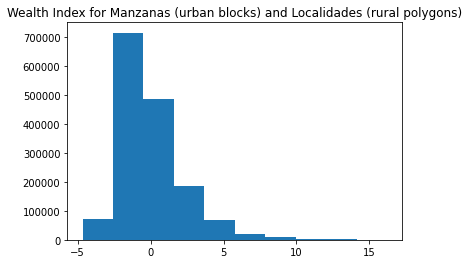

<module 'matplotlib.pyplot' from '/Users/aleistermontfort/opt/anaconda3/lib/python3.7/site-packages/matplotlib/pyplot.py'>

In [171]:
plot_hist(index,'pca','Wealth Index for Manzanas (urban blocks) and Localidades (rural polygons)' )

In [80]:
# It's weird that dirt floor and no access to water have a negative relationship with the index and the other variables. 
# I followed the same methodology as coneval using agebs, and got the same results
index[z_vars + ['pca']].corr()

,z_illiterate,z_not_attend_school,z_no_primary_educ,z_no_access_health,z_dirt_floor,z_average_ocupants,z_no_toilet,z_no_water,z_no_sewing,z_no_electricity,z_no_washingmachine,z_no_fridge,pca
z_illiterate,1.000000,0.333214,0.620509,0.277636,-0.202181,0.470278,0.167745,-0.367070,0.475316,0.328872,0.477903,0.411595,0.685567
z_not_attend_school,0.333214,1.000000,0.314809,0.152868,-0.140763,0.207265,0.149401,-0.245705,0.273513,0.329809,0.223987,0.226805,0.438874
z_no_primary_educ,0.620509,0.314809,1.000000,0.308899,-0.162539,0.573920,0.134177,-0.374565,0.448421,0.284248,0.441514,0.366471,0.665634
z_no_access_health,0.277636,0.152868,0.308899,1.000000,-0.083439,0.244061,0.027957,-0.195427,0.127064,0.096183,0.247821,0.184583,0.338731
z_dirt_floor,-0.202181,-0.140763,-0.162539,-0.083439,1.000000,-0.165540,-0.847221,0.123873,-0.169621,-0.202273,-0.674609,-0.772141,-0.650385
z_average_ocupants,0.470278,0.207265,0.573920,0.244061,-0.165540,1.000000,0.112623,-0.356935,0.380010,0.229436,0.440896,0.351875,0.601697
z_no_toilet,0.167745,0.149401,0.134177,0.027957,-0.847221,0.112623,1.000000,-0.083251,0.198858,0.199584,0.629663,0.746135,0.617192
z_no_water,-0.367070,-0.245705,-0.374565,-0.195427,0.123873,-0.356935,-0.083251,1.000000,-0.440341,-0.389461,-0.319114,-0.255576,-0.527741
z_no_sewing,0.475316,0.273513,0.448421,0.127064,-0.169621,0.380010,0.198858,-0.440341,1.000000,0.452421,0.398658,0.374714,0.629338
z_no_electricity,0.328872,0.329809,0.284248,0.096183,-0.202273,0.229436,0.199584,-0.389461,0.452421,1.000000,0.330170,0.389513,0.549845


In [173]:
index.to_csv("./index_export/index_manzanas_all_vars.csv")

In [176]:
index[['nom_ent', 'nom_mun', 'nom_loc', 'cve_ent', 'cve_mun', 'cve_loc',
       'cve_ageb', 'cve_manzana', 'ID_loc','pca', 'index_pca']].to_csv("./index_export/index_manzanas_localidades_MX.csv")